In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install -q flwr[simulation]==1.9.0 torch torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 364.7/364.7 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.1/65.1 MB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 106.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 24.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 92.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.4 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow-metadata 1.15.0 requires protobuf<4.21,>=3.20.3; python_version < "3.11", but you have protobuf 4.25.4 which is incompatible.


In [ ]:
!pip install pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 7.5 MB/s eta 0:00:00


In [ ]:
from collections import OrderedDict, defaultdict, Counter
from typing import Dict, List, Optional, Tuple

import numpy as np
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.transforms import v2
from torch.utils.data import DataLoader, random_split, Dataset, Subset
import pandas as pd
import os
import pydicom
from tqdm import tqdm
from skimage.io import imsave
from skimage.io import imread
import torch.optim as optim
from torchvision import transforms as T
import matplotlib.pyplot as plt
import re
#from flwr.server import ServerApp, ServerConfig, ServerAppComponents
from flwr.simulation import run_simulation
from flwr.common import ndarrays_to_parameters, NDArrays, Scalar, Context
from collections import OrderedDict
from typing import Dict, List, Optional, Tuple

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as transforms
from torch.utils.data import DataLoader

import flwr
from flwr.client import Client, ClientApp, NumPyClient
#from flwr.server import ServerApp, ServerConfig, ServerAppComponents
from flwr.server.strategy import FedAvg, FedAdagrad
from flwr.simulation import run_simulation
from flwr.common import ndarrays_to_parameters, NDArrays, Scalar, Context

import flwr as fl

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(
    f"Training on {DEVICE} using PyTorch {torch.__version__} and Flower {fl.__version__}"
)

ERROR:pydicom.pixels.utils:No module named 'pylibjpeg'
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pydicom/pixels/utils.py", line 1274, in _passes_version_check
    module = importlib.import_module(package_name, "__version__")
  File "/usr/lib/python3.10/importlib/__init__.py", line 126, in import_module
    return _bootstrap._gcd_import(name[level:], package, level)
  File "<frozen importlib._bootstrap>", line 1050, in _gcd_import
  File "<frozen importlib._bootstrap>", line 1027, in _find_and_load
  File "<frozen importlib._bootstrap>", line 1004, in _find_and_load_unlocked
ModuleNotFoundError: No module named 'pylibjpeg'
ERROR:pydicom.pixels.utils:No module named 'pylibjpeg'
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pydicom/pixels/utils.py", line 1274, in _passes_version_check
    module = importlib.import_module(package_name, "__version__")
  File "/usr/lib/python3.10/importlib/__init__.py", line 126, i

Training on cpu using PyTorch 2.4.0+cu121 and Flower 1.9.0


# Model

In [ ]:
# 28x28 MNIST architecture
class Net(nn.Module):
    def __init__(self) -> None:
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 6, 5)  # Adjust input channels to 1 for grayscale images
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.fc1 = nn.Linear(16 * 4 * 4, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 62)  # Adjust output layer to 62 classes

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = x.view(-1, 16 * 4 * 4)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def get_parameters(net) -> List[np.ndarray]:
    return [val.cpu().numpy() for _, val in net.state_dict().items()]


def set_parameters(net, parameters: List[np.ndarray]):
    params_dict = zip(net.state_dict().keys(), parameters)
    state_dict = OrderedDict({k: torch.Tensor(v) for k, v in params_dict})
    net.load_state_dict(state_dict, strict=True)


In [ ]:
def train(net, trainloader, epochs: int):
    criterion = nn.CrossEntropyLoss()
    #optimizer = optim.Adam(net.parameters(), lr=0.0002)
    optimizer = optim.Adam(net.parameters(), lr=0.001)
    #optimizer = optim.SGD(net.parameters(), lr=0.01)
    net.train()
    for epoch in range(epochs):
        correct, total, epoch_loss = 0, 0, 0.0
        for images, labels in trainloader:
            images, labels = images.to(DEVICE), labels.to(DEVICE)
            optimizer.zero_grad()
            outputs = net(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
            _, predicted_class = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted_class == labels).sum().item()
        epoch_loss /= len(trainloader.dataset)
        epoch_acc = correct / total
        print(f"Epoch {epoch+1}: train loss {epoch_loss:.4f}, accuracy {epoch_acc:.4f}")

def test(net, testloader):
    criterion = nn.CrossEntropyLoss()
    correct, total, loss = 0, 0, 0.0
    net.eval()
    with torch.no_grad():
        for images, labels in testloader:
            images, labels = images.to(DEVICE), labels.to(DEVICE)
            outputs = net(images)
            loss += criterion(outputs, labels).item()
            _, predicted_class = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted_class == labels).sum().item()
    loss /= len(testloader.dataset)
    accuracy = correct / total
    return loss, accuracy

In [ ]:
import pickle

# Save history after simulation
def save_history(history, filename):
    with open(filename, 'wb') as f:
        pickle.dump(history, f)

# Load history from file
def load_history(filename):
    with open(filename, 'rb') as f:
        return pickle.load(f)

In [ ]:
def fit_config(server_round: int):
    """Return training configuration dict for each round.

    Perform two rounds of training with one local epoch, increase to two local
    epochs afterwards.
    """
    config = {
        "server_round": server_round,  # The current round of federated learning
        "local_epochs": 1,
        #"lr" : 0.0001,
        #"momentum": 0.9,
    }
    return config

In [ ]:
def get_evaluate_fn(testloader):
    """This is a function that returns a function. The returned
    function (i.e. `evaluate_fn`) will be executed by the strategy
    at the end of each round to evaluate the stat of the global
    model."""

    def evaluate_fn(server_round: int, parameters, config):
        """This function is executed by the strategy it will instantiate
        a model and replace its parameters with those from the global model.
        The, the model will be evaluate on the test set (recall this is the
        whole MNIST test set)."""

        model = Net().to(DEVICE)

        # set parameters to the model
        params_dict = zip(model.state_dict().keys(), parameters)
        state_dict = OrderedDict({k: torch.Tensor(v) for k, v in params_dict})
        model.load_state_dict(state_dict, strict=False)

        # call test
        loss, accuracy = test(
            model, testloader
        )  # <-------------------------- calls the `test` function, just what we did in the centralised setting
        return loss, {"accuracy": accuracy}

    return evaluate_fn

# Dirichlet Distribution

The Dirichlet distribution is often used in federated learning to create non-IID data. You can control the degree of non-IID-ness by adjusting the alpha parameter. A smaller alpha results in more non-IID data.
Example: For an alpha value of 0.5, you might find one client with 80% benign cases and 20% malignant, while another might have 50% benign and 50% malignant, and so on.

CustomDataset class applies the transformations only to the images.

In [ ]:
from torchvision.datasets import VisionDataset

class CustomDataset(VisionDataset):
    def __init__(self, dataset, transform=None):
        self.dataset = dataset
        self.transform = transform

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        image, label = self.dataset[idx]
        if self.transform:
            image = self.transform(image)
        return image, label


Let's modify the load_datasets function so we can create Non-IID Partitions Using Dirichlet Distribution.

The load_datasets function performs the following tasks:

* Applies transformations to the training dataset.
* Extracts targets and calculates the number of classes.
* Creates non-IID data partitions using the Dirichlet distribution.
* Splits each partition into training and validation sets.
* Creates DataLoaders for each client's training and validation sets, and for the test dataset.

# Download the dataset

In [ ]:
!git clone https://github.com/TalwalkarLab/leaf.git
%cd leaf/data/femnist
!./preprocess.sh -s niid --sf 0.05 -k 0 -t sample
%cd ../../../


Output streaming troncato alle ultime 5000 righe.
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00111.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00057.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00089.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00008.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00105.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00066.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00073.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00002.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00125.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00024.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00006.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00005.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00088.png  
  inflating: by_write/hsf_1/f0654_02/c0654_02/c0654_02_00016.png  
  inflating:

In [ ]:
import os
import json
import torch
from torch.utils.data import DataLoader, random_split, Subset, Dataset
import numpy as np
from collections import defaultdict, Counter
from torchvision import transforms

NUM_CLIENTS = 100

class FEMNISTDataset(Dataset):
    def __init__(self, data_dir, split, transform=None):
        self.data_dir = data_dir
        self.split = split
        self.transform = transform
        self.data, self.targets = self.load_data()

    def load_data(self):
        data = []
        targets = []
        split_dir = os.path.join(self.data_dir, self.split)
        for user_file in os.listdir(split_dir):
            with open(os.path.join(split_dir, user_file), 'r') as f:
                user_data = json.load(f)
                for user in user_data['users']:
                    x_data = user_data['user_data'][user]['x']
                    y_data = user_data['user_data'][user]['y']
                    for x, y in zip(x_data, y_data):
                        data.append(np.array(x).reshape(28, 28))
                        assert 0 <= y < 62, f"Label {y} is out of bounds."
                        targets.append(y)
        return np.array(data), np.array(targets)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx].astype(np.float32)  # Ensure image is float32
        label = self.targets[idx]
        if self.transform:
            image = self.transform(image)
        return image, label


def load_datasets(num_clients: int, alpha: float = 0.3, data_dir='./leaf/data/femnist/data'):
    transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.1307,), (0.3081,))])
    trainset = FEMNISTDataset(data_dir, split='train', transform=transform)
    testset = FEMNISTDataset(data_dir, split='test', transform=transform)

    # Get targets for each data point in the dataset
    targets = np.array(trainset.targets)
    num_classes = 62  # Fixed number of classes for FEMNIST

    # Create non-IID partitions using Dirichlet distribution
    class_indices = [np.where(targets == i)[0] for i in range(num_classes)]
    client_indices = defaultdict(list)

    for class_idx in class_indices:
        np.random.shuffle(class_idx)
        proportions = np.random.dirichlet(np.repeat(alpha, num_clients))
        proportions = np.cumsum(proportions) * len(class_idx)
        split_indices = np.split(class_idx, proportions[:-1].astype(int))
        for client_id, indices in enumerate(split_indices):
            client_indices[client_id].extend(indices)

    # Create subsets for each client
    datasets = [Subset(trainset, indices) for indices in client_indices.values()]

    # Split each partition into train/val and create DataLoader
    trainloaders = []
    valloaders = []
    for ds in datasets:
        len_val = len(ds) // 10  # 10 % validation set
        len_train = len(ds) - len_val
        lengths = [len_train, len_val]
        ds_train, ds_val = random_split(ds, lengths, torch.Generator().manual_seed(42))
        trainloaders.append(DataLoader(ds_train, batch_size=10, shuffle=True))
        valloaders.append(DataLoader(ds_val, batch_size=10))
    testloader = DataLoader(testset, batch_size=10)

    # Print number of examples per class for each client
    for client_id, indices in client_indices.items():
        client_targets = targets[indices]
        class_counts = Counter(client_targets)
        print(f"Client {client_id}:")
        for class_label, count in class_counts.items():
            print(f"  Class {class_label}: {count} examples")

    return trainloaders, valloaders, testloader

trainloaders, valloaders, testloader = load_datasets(NUM_CLIENTS)


Client 0:
  Class 2: 6 examples
  Class 3: 69 examples
  Class 4: 86 examples
  Class 5: 29 examples
  Class 6: 22 examples
  Class 8: 22 examples
  Class 9: 6 examples
  Class 10: 7 examples
  Class 13: 3 examples
  Class 14: 19 examples
  Class 15: 3 examples
  Class 16: 11 examples
  Class 18: 7 examples
  Class 19: 2 examples
  Class 21: 1 examples
  Class 22: 6 examples
  Class 23: 4 examples
  Class 24: 20 examples
  Class 26: 1 examples
  Class 30: 1 examples
  Class 33: 1 examples
  Class 36: 5 examples
  Class 37: 20 examples
  Class 39: 1 examples
  Class 40: 8 examples
  Class 41: 1 examples
  Class 42: 4 examples
  Class 43: 3 examples
  Class 46: 1 examples
  Class 47: 8 examples
  Class 48: 1 examples
  Class 50: 3 examples
  Class 53: 39 examples
  Class 58: 2 examples
  Class 60: 10 examples
  Class 61: 2 examples
Client 1:
  Class 0: 2 examples
  Class 1: 261 examples
  Class 2: 2 examples
  Class 3: 31 examples
  Class 4: 9 examples
  Class 5: 2 examples
  Class 9: 15

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_class_distribution_heatmap(trainloaders, num_clients):
    class_distribution = np.zeros((num_clients, 62), dtype=int)

    for client_id, loader in enumerate(trainloaders):
        client_targets = []
        for data, target in loader.dataset:
            client_targets.append(target)
        client_targets = np.array(client_targets)

        class_counts = Counter(client_targets)
        for class_label in range(62):
            class_distribution[client_id, class_label] = class_counts[class_label]

    plt.figure(figsize=(15, 10))
    sns.heatmap(class_distribution, annot=True, fmt="d", cmap="YlGnBu", xticklabels=[f'Class {i}' for i in range(62)], yticklabels=[f'Client {i}' for i in range(num_clients)])
    plt.xlabel('Class')
    plt.ylabel('Client')
    plt.title('Class Distribution over Clients')
    plt.show()

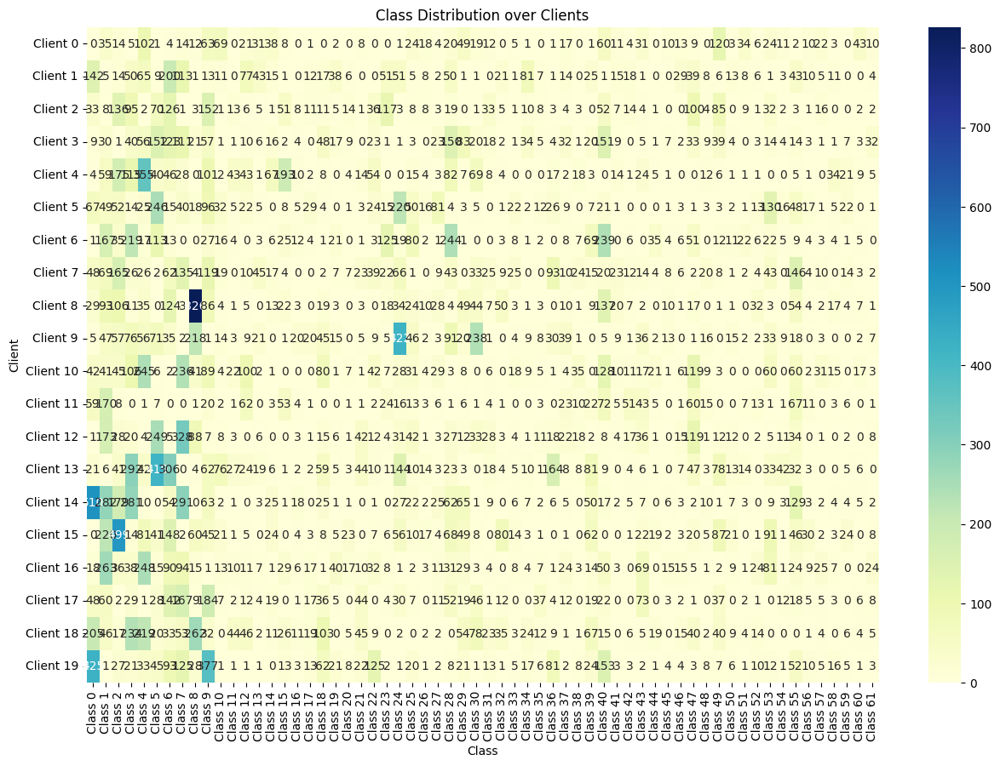

In [ ]:
plot_class_distribution_heatmap(trainloaders, NUM_CLIENTS)

# FedAvg

## 20 clients


In [ ]:
import gc

class FlowerClient(fl.client.NumPyClient):
    def __init__(self, cid, net, trainloader, valloader):
        self.cid = cid
        self.net = net
        self.trainloader = trainloader
        self.valloader = valloader

    def get_parameters(self, config):
        print(f"[Client {self.cid}] get_parameters")
        return get_parameters(self.net)

    def fit(self, parameters, config):
        server_round = config["server_round"]
        local_epochs = config["local_epochs"]
        print(f"[Client {self.cid}, round {server_round}] fit, config: {config}")
        set_parameters(self.net, parameters)
        train(self.net, self.trainloader, epochs=local_epochs)
        gc.collect()
        return get_parameters(self.net), len(self.trainloader), {}

    def evaluate(self, parameters, config):
        print(f"[Client {self.cid}] evaluate, config: {config}")
        set_parameters(self.net, parameters)

        if len(self.valloader.dataset) == 0:
            print(f"[Client {self.cid}] Warning: Validation loader is empty. Skipping evaluation.")
            return float('inf'), 0, {"accuracy": 0.0}

        loss, accuracy = test(self.net, self.valloader)
        print(f"[Client {self.cid}] Validation loss: {loss:.4f}, Validation accuracy: {accuracy:.4f}")
        return float(loss), len(self.valloader), {"accuracy": float(accuracy)}

In [ ]:
def client_fn(cid) -> FlowerClient:
    net = Net().to(DEVICE)
    trainloader = trainloaders[int(cid)]
    valloader = valloaders[int(cid)]
    return FlowerClient(cid, net, trainloader, valloader)

### FedAvg alpha = 0.3 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_20c_Adam_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)
save_history(history_fedAvg_20c_Adam_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_20c_Adam_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-26 08:58:55,117	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'memory': 7980559566.0, 'object_store_memory': 3990279782.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=18435) [Client 18, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.3525, accuracy 0.1739
(ClientAppActor pid=18435) [Client 9, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.3475, accuracy 0.1491 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 7, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.3187, accuracy 0.2273 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38715099745361503, {'accuracy': 0.06353392471829297}, 35.95038146200022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 1] evaluate, config: {}
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.4164, Validation accuracy: 0.0053
(ClientAppActor pid=18435) [Client 10, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.2873, accuracy 0.2506


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.3265, accuracy 0.1765
(ClientAppActor pid=18434) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 10] Validation loss: 0.3449, Validation accuracy: 0.2825 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 4, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.2803, accuracy 0.3583 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.3219, accuracy 0.1307 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 11, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 14, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.381010218336553, {'accuracy': 0.03931910812754735}, 56.57524951100004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.3281, Validation accuracy: 0.3699


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.3475, accuracy 0.1541 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 12, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.3864, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.3532, accuracy 0.1391 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 1, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2589, accuracy 0.3471 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.37924482295965295, {'accuracy': 0.047710381203548306}, 74.85217922900028)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 19] evaluate, config: {}
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.4016, Validation accuracy: 0.0000
(ClientAppActor pid=18435) [Client 8, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2931, accuracy 0.2404 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.4128, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2868, accuracy 0.2826 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 12, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2964, accuracy 0.3284 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.37778986560672456, {'accuracy': 0.04795013186286262}, 90.96774286100026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 16] evaluate, config: {}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 4] Validation loss: 0.4307, Validation accuracy: 0.0202
(ClientAppActor pid=18434) Epoch 1: train loss 0.2615, accuracy 0.3181


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 4, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.3633, accuracy 0.1279
(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.4000, Validation accuracy: 0.0214 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.3025, accuracy 0.2180 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.36391858121697723, {'accuracy': 0.11004555262526972}, 104.42839840200031)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 5] evaluate, config: {}
(ClientAppActor pid=18435) [Client 11, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.3565, Validation accuracy: 0.1568
(ClientAppActor pid=18435) Epoch 1: train loss 0.3531, accuracy 0.1605 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 18, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.4359, Validation accuracy: 0.0220 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.3078, accuracy 0.2461
(ClientAppActor pid=18434) Epoch 1: train loss 0.2824, accuracy 0.2501


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 1, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2529, accuracy 0.4294 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.35987721344630685, {'accuracy': 0.094941261088468}, 121.85576928200044)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17] evaluate, config: {}
(ClientAppActor pid=18434) [Client 0, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.3470, Validation accuracy: 0.0464
(ClientAppActor pid=18434) Epoch 1: train loss 0.2986, accuracy 0.1976 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 17, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.3352, Validation accuracy: 0.0717 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.2830, accuracy 0.2656 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 12, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2391, accuracy 0.3929 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) [Client 13, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3510409228609095, {'accuracy': 0.08535123471589547}, 139.65108612200038)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13] evaluate, config: {}
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.3392, Validation accuracy: 0.0851
(ClientAppActor pid=18434) Epoch 1: train loss 0.2663, accuracy 0.3114 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.4050, Validation accuracy: 0.0034 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2491, accuracy 0.3949 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) [Client 17, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.2359, accuracy 0.3789 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) [Client 18, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3337280991208322, {'accuracy': 0.19467753536322224}, 156.91652553800031)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 0] evaluate, config: {}
(ClientAppActor pid=18435) [Client 0] Validation loss: 0.3108, Validation accuracy: 0.2532
(ClientAppActor pid=18435) Epoch 1: train loss 0.2123, accuracy 0.4591 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 1, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.3519, Validation accuracy: 0.1459 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.3090, accuracy 0.2833 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18434) [Client 2, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.2506, accuracy 0.3492 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.32577872899361177, {'accuracy': 0.22416686645888276}, 172.21254665800006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 4] evaluate, config: {}
(ClientAppActor pid=18435) [Client 6, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.4473, Validation accuracy: 0.0606
(ClientAppActor pid=18435) Epoch 1: train loss 0.2205, accuracy 0.4693


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.2457, accuracy 0.4497
(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.3068, Validation accuracy: 0.1223 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 1, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.2494, accuracy 0.4222 [repeated 5x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.30664506532453684, {'accuracy': 0.2711579956844881}, 188.07437459100038)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 6] evaluate, config: {}
(ClientAppActor pid=18434) [Client 17, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.2181, accuracy 0.4343 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 3] Validation loss: 0.3050, Validation accuracy: 0.2294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 6, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2379, accuracy 0.4548
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.2954, Validation accuracy: 0.3022 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1951, accuracy 0.5436
(ClientAppActor pid=18435) [Client 11, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.2468, accuracy 0.4408 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.2957072695848954, {'accuracy': 0.2862622872212899}, 203.0613705630003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2] evaluate, config: {}
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.3012, Validation accuracy: 0.2532


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 15, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.2101, accuracy 0.5031
(ClientAppActor pid=18435) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.2799, Validation accuracy: 0.4570 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1772, accuracy 0.5789
(ClientAppActor pid=18435) [Client 2, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1938, accuracy 0.4869 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 12, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.28537046860745413, {'accuracy': 0.2833852793095181}, 221.55828146899967)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 5] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.2724, accuracy 0.3270 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 11, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.3460, Validation accuracy: 0.1189


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.2193, accuracy 0.4924 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.4116, Validation accuracy: 0.1515 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1592, accuracy 0.6184 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 9, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.27571719749115037, {'accuracy': 0.296331814912491}, 237.8442990149997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.2736, Validation accuracy: 0.4558
(ClientAppActor pid=18435) Epoch 1: train loss 0.2162, accuracy 0.4626 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 3, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 16] Validation loss: 0.2734, Validation accuracy: 0.1951 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1630, accuracy 0.6096 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 0, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.2121, accuracy 0.5102 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 11, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2652389325560554, {'accuracy': 0.30999760249340685}, 254.86474381399967)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 3] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.1638, accuracy 0.6118 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 12, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.2645, Validation accuracy: 0.2471


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1407, accuracy 0.6625 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 15] Validation loss: 0.3619, Validation accuracy: 0.0926 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 9, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.2443, accuracy 0.3751 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.25311293277029395, {'accuracy': 0.36178374490529847}, 268.823203381)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 5] evaluate, config: {}
(ClientAppActor pid=18434) [Client 11, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.2940, Validation accuracy: 0.2054
(ClientAppActor pid=18435) Epoch 1: train loss 0.1375, accuracy 0.6239


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.1956, accuracy 0.5048
(ClientAppActor pid=18435) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 10, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.2370, Validation accuracy: 0.3924 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1565, accuracy 0.5937 [repeated 5x across cluster]
(ClientAppActor pid=18435) [Client 7, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.25085636955518226, {'accuracy': 0.3742507791896428}, 284.8029508420004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.3871, Validation accuracy: 0.2418


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.2011, accuracy 0.5364 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 0, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.2548, Validation accuracy: 0.4506 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1281, accuracy 0.6533 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 12, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1780, accuracy 0.5285 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 5, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.24471879772818708, {'accuracy': 0.4003836010549029}, 302.3224427750001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 3] evaluate, config: {}
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.2829, Validation accuracy: 0.2529


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.1239, accuracy 0.6983 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 17, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.3401, Validation accuracy: 0.2620 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1969, accuracy 0.5524 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 7, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.2027, accuracy 0.4893 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 0, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.23977666706011125, {'accuracy': 0.4121313833613042}, 320.51119815200036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 11] evaluate, config: {}
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.3103, Validation accuracy: 0.2403
(ClientAppActor pid=18435) Epoch 1: train loss 0.1840, accuracy 0.5384 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18434) [Client 9] Validation loss: 0.2535, Validation accuracy: 0.4967 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1630, accuracy 0.5987 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 13, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.2240, accuracy 0.4266 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.23034366190047664, {'accuracy': 0.39367058259410215}, 335.7224992319998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 6] evaluate, config: {}
(ClientAppActor pid=18434) [Client 0, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.2185, Validation accuracy: 0.4096


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1655, accuracy 0.5457


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.1675, accuracy 0.6104
(ClientAppActor pid=18434) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 13, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.2216, Validation accuracy: 0.4051 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1774, accuracy 0.5309 [repeated 6x across cluster]
(ClientAppActor pid=18434) [Client 17, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.2272253616826193, {'accuracy': 0.3965475905058739}, 350.83448305599995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 5] evaluate, config: {}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) [Client 5] Validation loss: 0.2203, Validation accuracy: 0.4541
(ClientAppActor pid=18434) Epoch 1: train loss 0.1327, accuracy 0.6451


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=18434) 
(ClientAppActor pid=18435) Epoch 1: train loss 0.2137, accuracy 0.4412
(ClientAppActor pid=18435) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.2207, Validation accuracy: 0.5298 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 1, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1569, accuracy 0.6398 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.2187726041076567, {'accuracy': 0.4418604651162791}, 366.1030900710002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 5] evaluate, config: {}
(ClientAppActor pid=18435) [Client 17, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.2439, Validation accuracy: 0.4000


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1392, accuracy 0.6555 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.2715, Validation accuracy: 0.2868 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1799, accuracy 0.5925 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 3, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1534, accuracy 0.6339 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18435) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (22, 0.21325563935031996, {'accuracy': 0.4461759769839367}, 383.818682352)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 9] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.1503, accuracy 0.6310 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.2160, Validation accuracy: 0.5232


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 15, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1430, accuracy 0.6614 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.2582, Validation accuracy: 0.3381 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 18, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1692, accuracy 0.5861 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18434) [Client 4, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (23, 0.2119606641864525, {'accuracy': 0.46032126588348116}, 400.0826630239999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.2097, Validation accuracy: 0.4212
(ClientAppActor pid=18435) Epoch 1: train loss 0.1475, accuracy 0.5980 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 8, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.2243, Validation accuracy: 0.4541 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1760, accuracy 0.6075 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 10, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1397, accuracy 0.6232 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.20509431106928183, {'accuracy': 0.4631982737952529}, 418.7457789549999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 18] evaluate, config: {}
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.2012, Validation accuracy: 0.4646
(ClientAppActor pid=18434) Epoch 1: train loss 0.1586, accuracy 0.6007 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 3, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.2445, Validation accuracy: 0.3210 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1377, accuracy 0.6737 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 0, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1631, accuracy 0.5957 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 18, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.19837168270636737, {'accuracy': 0.4828578278590266}, 433.50999143399986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.2267, Validation accuracy: 0.4892
(ClientAppActor pid=18435) Epoch 1: train loss 0.1761, accuracy 0.5570


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 3, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.1422, accuracy 0.6186
(ClientAppActor pid=18435) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.3054, Validation accuracy: 0.2727 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 17, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1157, accuracy 0.6903 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.20039148348265487, {'accuracy': 0.4675137856629106}, 448.3456359060001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 9] evaluate, config: {}
(ClientAppActor pid=18434) [Client 2, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.2096, Validation accuracy: 0.5497
(ClientAppActor pid=18434) Epoch 1: train loss 0.1333, accuracy 0.6452 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 5, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.3194, Validation accuracy: 0.2941 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1306, accuracy 0.6819
(ClientAppActor pid=18434) Epoch 1: train loss 0.1286, accuracy 0.6938


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 17, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1607, accuracy 0.5870 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.1983688938134696, {'accuracy': 0.4787820666506833}, 464.17786490900016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9] evaluate, config: {}
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1956, Validation accuracy: 0.5960
(ClientAppActor pid=18434) [Client 11, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      


(ClientAppActor pid=18434) Epoch 1: train loss 0.1936, accuracy 0.4996 [repeated 3x across cluster]


INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 18] Validation loss: 0.1821, Validation accuracy: 0.5354 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1298, accuracy 0.6508
(ClientAppActor pid=18434) Epoch 1: train loss 0.1193, accuracy 0.7041


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 7, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1426, accuracy 0.6414 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.18593769491047518, {'accuracy': 0.5348837209302325}, 482.6822161299997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 6] evaluate, config: {}
(ClientAppActor pid=18434) [Client 11, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1838, accuracy 0.5279 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 6] Validation loss: 0.1666, Validation accuracy: 0.5411


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 7, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1531, accuracy 0.6148 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.2469, Validation accuracy: 0.3721 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 4, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1353, accuracy 0.6605 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.17991352563594862, {'accuracy': 0.5526252697194918}, 499.37404375200003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14] evaluate, config: {}
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.2901, Validation accuracy: 0.4066
(ClientAppActor pid=18434) [Client 15, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.1246, accuracy 0.6894 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 7, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.2075, Validation accuracy: 0.5252 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0898, accuracy 0.7816 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 12, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0993, accuracy 0.7528 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 5, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.18119625515344473, {'accuracy': 0.5240949412610885}, 516.1991402570002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 9] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.1212, accuracy 0.6944 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.2035, Validation accuracy: 0.5430


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 0, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1261, accuracy 0.6266 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.1709, Validation accuracy: 0.5669 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 9, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1418, accuracy 0.6681 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.17968226532317613, {'accuracy': 0.522176935986574}, 529.852683948)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13] evaluate, config: {}
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1739, Validation accuracy: 0.5000
(ClientAppActor pid=18434) [Client 17, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.1029, accuracy 0.7149 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.1758, Validation accuracy: 0.5724 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1220, accuracy 0.6886


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0933, accuracy 0.7701
(ClientAppActor pid=18434) [Client 6, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1377, accuracy 0.6637 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 0, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.1728261192441987, {'accuracy': 0.5598177894989211}, 547.8075010809998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 8] evaluate, config: {}
(ClientAppActor pid=18435) [Client 8] Validation loss: 0.2659, Validation accuracy: 0.4663
(ClientAppActor pid=18435) Epoch 1: train loss 0.1237, accuracy 0.6392 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 2, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1849, Validation accuracy: 0.6358 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1128, accuracy 0.6928 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 12, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1667, accuracy 0.5789 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 10, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.17094449122313315, {'accuracy': 0.5682090625749221}, 565.4483134620004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.1699, Validation accuracy: 0.5171
(ClientAppActor pid=18435) Epoch 1: train loss 0.0806, accuracy 0.8074 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 18, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.2824, Validation accuracy: 0.3846 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0970, accuracy 0.7326 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 16, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1209, accuracy 0.6533 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 0, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 2, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.17232671746588016, {'accuracy': 0.5547830256533205}, 583.5469212440003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 19] evaluate, config: {}
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.1776, Validation accuracy: 0.5339
(ClientAppActor pid=18434) Epoch 1: train loss 0.1101, accuracy 0.7021 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 9, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.1656, Validation accuracy: 0.5412 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1438, accuracy 0.6795 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1136, accuracy 0.7159 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 16, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.16683416907391768, {'accuracy': 0.5703668185087509}, 601.1111128089997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15] evaluate, config: {}
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.2129, Validation accuracy: 0.3765
(ClientAppActor pid=18434) Epoch 1: train loss 0.0796, accuracy 0.7720 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 8] Validation loss: 0.2526, Validation accuracy: 0.5112 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0777, accuracy 0.8238 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 7, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1208, accuracy 0.6886 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.16194849421125726, {'accuracy': 0.5837928554303524}, 617.3160908780001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 12, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0877, accuracy 0.7752 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.2908, Validation accuracy: 0.3626


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0734, accuracy 0.8159 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.2067, Validation accuracy: 0.3765 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) [Client 14, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0964, accuracy 0.7576 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.16202398860620326, {'accuracy': 0.5871493646607528}, 631.7405639589997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18435) [Client 7, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.1544, Validation accuracy: 0.6290
(ClientAppActor pid=18435) Epoch 1: train loss 0.1341, accuracy 0.6867 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 7, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 6] Validation loss: 0.1368, Validation accuracy: 0.6404 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1341, accuracy 0.7074 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 18, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1330, accuracy 0.6609 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.16026009403095917, {'accuracy': 0.5845121074082954}, 648.3251572480003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 5, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.2571, Validation accuracy: 0.4725
(ClientAppActor pid=18435) Epoch 1: train loss 0.1079, accuracy 0.7297 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 1, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.1443, Validation accuracy: 0.6076 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1360, accuracy 0.6366 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1134, accuracy 0.7122 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 5, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.15944025355244507, {'accuracy': 0.5823543514744666}, 666.1343010370001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.1026, accuracy 0.7440 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.1511, Validation accuracy: 0.5823


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 18, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1104, accuracy 0.7187 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 16] Validation loss: 0.1475, Validation accuracy: 0.6057 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 5, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0967, accuracy 0.7264 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 12, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1812, accuracy 0.5657 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.15532553238109614, {'accuracy': 0.5895468712538959}, 684.38503907)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.1329, Validation accuracy: 0.6456
(ClientAppActor pid=18434) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.1437, accuracy 0.6177 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.1218, Validation accuracy: 0.6598 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) [Client 17, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1107, accuracy 0.6828 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 19, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.15107571970813424, {'accuracy': 0.6104051786142412}, 699.3112805689998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.1052, accuracy 0.7248 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.2068, Validation accuracy: 0.4651
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.1099, Validation accuracy: 0.7165


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 17, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0802, accuracy 0.7726
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.1486, Validation accuracy: 0.6378 [repeated 6x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0871, accuracy 0.7762
(ClientAppActor pid=18434) [Client 18, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) [Client 12, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0761, accuracy 0.7975 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 5, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.14765312375817416, {'accuracy': 0.6140014385039558}, 716.7229476450002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 16] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.1006, accuracy 0.7500 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.2268, Validation accuracy: 0.5294


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 16, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0694, accuracy 0.7883
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.1406, Validation accuracy: 0.6287 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0843, accuracy 0.7747


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1036, accuracy 0.7283 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.14799806387039777, {'accuracy': 0.6161591944377847}, 732.1948436900002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10] evaluate, config: {}
(ClientAppActor pid=18434) [Client 12, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) [Client 10] Validation loss: 0.0942, Validation accuracy: 0.7668
(ClientAppActor pid=18434) Epoch 1: train loss 0.0731, accuracy 0.8073


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.1309, accuracy 0.6481
(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 10, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.1892, Validation accuracy: 0.4691 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1720, accuracy 0.5881 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 2, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.14567250187692526, {'accuracy': 0.6238312155358428}, 749.2976143759997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17] evaluate, config: {}
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.1293, Validation accuracy: 0.6495
(ClientAppActor pid=18434) Epoch 1: train loss 0.1104, accuracy 0.6709 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 0, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 8] Validation loss: 0.2511, Validation accuracy: 0.6067 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1064, accuracy 0.7590 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 4, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1017, accuracy 0.7219 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 11, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.14067132065791188, {'accuracy': 0.6343802445456725}, 765.5474495360004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3] evaluate, config: {}
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.1452, Validation accuracy: 0.6059
(ClientAppActor pid=18434) Epoch 1: train loss 0.0620, accuracy 0.8387 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 10, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.1389, Validation accuracy: 0.6466 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0598, accuracy 0.8407 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 16, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1010, accuracy 0.7502 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 9, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.1013, accuracy 0.7316 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 13, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.13986232264797568, {'accuracy': 0.6353392471829298}, 783.5885525149997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.2151, Validation accuracy: 0.5385


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1056, accuracy 0.6927
(ClientAppActor pid=18435) Epoch 1: train loss 0.0922, accuracy 0.7529
(ClientAppActor pid=18434) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.1349, Validation accuracy: 0.6013 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 1, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1180, accuracy 0.6734 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 12, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.13988463637054868, {'accuracy': 0.6276672260848717}, 799.094844581)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 19] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0710, accuracy 0.8120 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.1708, Validation accuracy: 0.5755


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 16, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0956, accuracy 0.7453
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.2110, Validation accuracy: 0.5561 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0658, accuracy 0.8000


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 4, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1216, accuracy 0.7154 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.13863876034704165, {'accuracy': 0.633181491249101}, 814.7332636580004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3] evaluate, config: {}
(ClientAppActor pid=18434) [Client 2, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.1233, Validation accuracy: 0.7529


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0846, accuracy 0.7586


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.1127, accuracy 0.6922
(ClientAppActor pid=18435) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 15, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.1124, Validation accuracy: 0.6907 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0920, accuracy 0.7546 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 2, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.1337503142917479, {'accuracy': 0.6535602972908175}, 830.102148938)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 19] evaluate, config: {}
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.1218, Validation accuracy: 0.6833
(ClientAppActor pid=18434) Epoch 1: train loss 0.1444, accuracy 0.6950 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.1165, Validation accuracy: 0.6907 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0893, accuracy 0.7587
(ClientAppActor pid=18434) [Client 19, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0887, accuracy 0.7544
(ClientAppActor pid=18434) Epoch 1: train loss 0.1115, accuracy 0.6930
(ClientAppActor pid=18434) [Client 10, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0764, accuracy 0.7929
(ClientAppActor pid=18434) Epoch 1: train loss 0.0564, accuracy 0.8476
(ClientAppActor pid=18435) [Client 5, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.13391140433087734, {'accuracy': 0.645408774874131}, 848.3205239669996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.1389, Validation accuracy: 0.6203
(ClientAppActor pid=18435) Epoch 1: train loss 0.0884, accuracy 0.7733 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 0, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.1364, Validation accuracy: 0.5886 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0899, accuracy 0.7546 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18434) [Client 16, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0632, accuracy 0.8190 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.1315278494866796, {'accuracy': 0.6410932630064733}, 865.6609119370005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15] evaluate, config: {}
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.1588, Validation accuracy: 0.5123
(ClientAppActor pid=18435) [Client 11, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0760, accuracy 0.7869 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1441, Validation accuracy: 0.5106 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 10, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0650, accuracy 0.8210 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) [Client 19, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1118, accuracy 0.7314 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.1327909537443895, {'accuracy': 0.6422920163030449}, 882.9585024320004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3] evaluate, config: {}
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.1546, Validation accuracy: 0.5647
(ClientAppActor pid=18434) Epoch 1: train loss 0.0966, accuracy 0.7584 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 19, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.1455, Validation accuracy: 0.5802 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1326, accuracy 0.7124 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) [Client 10, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0606, accuracy 0.8122 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.12738921410587017, {'accuracy': 0.6633900743227044}, 896.677153697)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1891, Validation accuracy: 0.5165
(ClientAppActor pid=18435) [Client 9, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.1098, accuracy 0.7471


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0890, accuracy 0.7768
(ClientAppActor pid=18434) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=18434) [Client 8] Validation loss: 0.2035, Validation accuracy: 0.6573 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1056, accuracy 0.7002 [repeated 6x across cluster]
(ClientAppActor pid=18435) [Client 12, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.13292778987331202, {'accuracy': 0.6391752577319587}, 912.3346572440005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.1306, Validation accuracy: 0.6160
(ClientAppActor pid=18435) Epoch 1: train loss 0.0628, accuracy 0.8320


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.1078, accuracy 0.6820
(ClientAppActor pid=18434) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0925, Validation accuracy: 0.7629 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 1, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1033, accuracy 0.6971 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 17, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.12917397202697484, {'accuracy': 0.6540397986094462}, 929.0444016499996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 17] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0683, accuracy 0.7931 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0897, Validation accuracy: 0.7526


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 11, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1383, accuracy 0.6361 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.1274, Validation accuracy: 0.5949 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 14, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1015, accuracy 0.7027 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 4, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.12429694317100831, {'accuracy': 0.6744186046511628}, 945.6722067950004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 8] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0517, accuracy 0.8541 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 8] Validation loss: 0.1910, Validation accuracy: 0.6966


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 9, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0571, accuracy 0.8298 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1818, Validation accuracy: 0.6310 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) [Client 14, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1016, accuracy 0.7165 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.1266776760743122, {'accuracy': 0.652361543994246}, 960.1517409850003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 11] evaluate, config: {}
(ClientAppActor pid=18434) [Client 18, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.2195, Validation accuracy: 0.4729
(ClientAppActor pid=18435) Epoch 1: train loss 0.0684, accuracy 0.8023


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0909, accuracy 0.7278


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 13, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.1847, Validation accuracy: 0.4848 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1085, accuracy 0.7434 [repeated 5x across cluster]
(ClientAppActor pid=18434) [Client 16, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.12378811119765122, {'accuracy': 0.667705586190362}, 975.4027941650002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9] evaluate, config: {}
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1542, Validation accuracy: 0.6755
(ClientAppActor pid=18434) Epoch 1: train loss 0.0538, accuracy 0.8339 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.1245, Validation accuracy: 0.6606 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1006, accuracy 0.7124
(ClientAppActor pid=18434) Epoch 1: train loss 0.0893, accuracy 0.7384


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18434) [Client 16, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1361, accuracy 0.6549 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.12338070049649719, {'accuracy': 0.6660273315751618}, 991.0781639220004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0968, Validation accuracy: 0.7578
(ClientAppActor pid=18435) [Client 9, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1018, accuracy 0.7610 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1936, Validation accuracy: 0.5936 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1262, accuracy 0.7186 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 1, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0964, accuracy 0.7215 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.12346035476440836, {'accuracy': 0.6641093263006473}, 1008.7391740559997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 6] evaluate, config: {}
(ClientAppActor pid=18434) [Client 6] Validation loss: 0.0887, Validation accuracy: 0.7637
(ClientAppActor pid=18434) [Client 17, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0669, accuracy 0.8063 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.1178, Validation accuracy: 0.6709 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 4, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0810, accuracy 0.7883 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 12, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0776, accuracy 0.7804 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.11962579809498998, {'accuracy': 0.6602733157516183}, 1025.1880644789999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0687, Validation accuracy: 0.7937
(ClientAppActor pid=18435) Epoch 1: train loss 0.0588, accuracy 0.8406 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1655, Validation accuracy: 0.4681 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0763, accuracy 0.8032 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 1, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0766, accuracy 0.7830 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.11910347541375745, {'accuracy': 0.6665068328937904}, 1039.9969259689997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) [Client 10, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.1228, Validation accuracy: 0.6329
(ClientAppActor pid=18435) Epoch 1: train loss 0.0486, accuracy 0.8650


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0749, accuracy 0.8044
(ClientAppActor pid=18435) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1675, Validation accuracy: 0.5495 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0652, accuracy 0.8228 [repeated 5x across cluster]
(ClientAppActor pid=18435) [Client 17, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.11284216135397314, {'accuracy': 0.6811316231119635}, 1054.4737603760004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 19] evaluate, config: {}
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.1138, Validation accuracy: 0.6697
(ClientAppActor pid=18435) Epoch 1: train loss 0.0603, accuracy 0.8189 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 11, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.1379, Validation accuracy: 0.6187 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0779, accuracy 0.8055 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 3, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0568, accuracy 0.8441 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 10, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.11689885801096896, {'accuracy': 0.6722608487173339}, 1073.1060919970005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13] evaluate, config: {}
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1526, Validation accuracy: 0.5372
(ClientAppActor pid=18434) Epoch 1: train loss 0.0492, accuracy 0.8710 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.1491, Validation accuracy: 0.6547 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.1002, accuracy 0.7530
(ClientAppActor pid=18434) Epoch 1: train loss 0.0651, accuracy 0.8175


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0906, accuracy 0.7403
(ClientAppActor pid=18434) [Client 14, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0545, accuracy 0.8468
(ClientAppActor pid=18435) Epoch 1: train loss 0.1254, accuracy 0.6891


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) [Client 17, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.12012041129530891, {'accuracy': 0.6526012946535603}, 1090.5837790409996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 7] evaluate, config: {}
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.1414, Validation accuracy: 0.6475
(ClientAppActor pid=18434) Epoch 1: train loss 0.0596, accuracy 0.8189 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 12, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1977, Validation accuracy: 0.5349 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0524, accuracy 0.8555 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 2, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0634, accuracy 0.8109 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 15, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.11672914501085781, {'accuracy': 0.6715415967393911}, 1108.9906501080004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0615, accuracy 0.8281 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.1642, Validation accuracy: 0.4691
(ClientAppActor pid=18434) [Client 6, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 9, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0782, accuracy 0.8137 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0885, Validation accuracy: 0.7671 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 2, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0951, accuracy 0.7313 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.11494241883874197, {'accuracy': 0.6844881323423639}, 1123.5026196039998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10] evaluate, config: {}
(ClientAppActor pid=18434) [Client 14, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 10] Validation loss: 0.0833, Validation accuracy: 0.7399
(ClientAppActor pid=18434) Epoch 1: train loss 0.0920, accuracy 0.7318


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0606, accuracy 0.8200
(ClientAppActor pid=18435) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 6, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1492, Validation accuracy: 0.6154 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1323, accuracy 0.7048 [repeated 5x across cluster]
(ClientAppActor pid=18435) [Client 5, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.10983274573224878, {'accuracy': 0.6945576600335651}, 1139.342039319)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0866, accuracy 0.7565 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 1, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1216, Validation accuracy: 0.7682


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 1, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0839, accuracy 0.7654
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.1064, Validation accuracy: 0.7527 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0741, accuracy 0.7865


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 0, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0599, accuracy 0.8263 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.11121987231884949, {'accuracy': 0.688324142891393}, 1155.2104809760003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13] evaluate, config: {}
(ClientAppActor pid=18434) [Client 16, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1060, Validation accuracy: 0.6702
(ClientAppActor pid=18434) Epoch 1: train loss 0.0479, accuracy 0.8510 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 1, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 11] Validation loss: 0.1896, Validation accuracy: 0.5039 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0940, accuracy 0.7270
(ClientAppActor pid=18435) Epoch 1: train loss 0.0810, accuracy 0.7755


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 5, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0890, accuracy 0.7367 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.11501444991587792, {'accuracy': 0.6696235914648765}, 1172.033516652)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2] evaluate, config: {}
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.0990, Validation accuracy: 0.7300
(ClientAppActor pid=18435) [Client 4, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0538, accuracy 0.8453 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.1326, Validation accuracy: 0.6176 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 0, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1105, accuracy 0.7453 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0773, accuracy 0.7863 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.1100233100288579, {'accuracy': 0.6950371613521937}, 1188.3365240040002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) [Client 5, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1370, Validation accuracy: 0.5798


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0656, accuracy 0.8289 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1366, Validation accuracy: 0.6821 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0805, accuracy 0.7398 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 1, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.1101, accuracy 0.6961 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 10, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.10980432295872136, {'accuracy': 0.6933589067369935}, 1205.313245505)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1311, Validation accuracy: 0.5426
(ClientAppActor pid=18435) Epoch 1: train loss 0.0439, accuracy 0.8784


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.1045, accuracy 0.7534
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1362, Validation accuracy: 0.7020 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) [Client 14, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0879, accuracy 0.7354 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.10951825102880057, {'accuracy': 0.7053464397027092}, 1218.0294830350003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 18, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1420, Validation accuracy: 0.6374
(ClientAppActor pid=18434) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0928, accuracy 0.7374 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 15, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 16] Validation loss: 0.0907, Validation accuracy: 0.7439 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.1110, accuracy 0.7262
(ClientAppActor pid=18435) Epoch 1: train loss 0.0677, accuracy 0.8348


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0760, accuracy 0.7844 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.10536493671987875, {'accuracy': 0.7091824502517382}, 1235.6547442769997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 0] evaluate, config: {}
(ClientAppActor pid=18435) [Client 0] Validation loss: 0.1105, Validation accuracy: 0.6456
(ClientAppActor pid=18435) [Client 19, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0710, accuracy 0.7961 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1850, Validation accuracy: 0.6236 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 5, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0866, accuracy 0.7409


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0730, accuracy 0.8011
(ClientAppActor pid=18434) [Client 15, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0566, accuracy 0.8407 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.10121086321626456, {'accuracy': 0.7132582114600815}, 1253.2495378209996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 7] evaluate, config: {}
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.1311, Validation accuracy: 0.5971
(ClientAppActor pid=18435) [Client 1, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0755, accuracy 0.7791 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 16] Validation loss: 0.0743, Validation accuracy: 0.7927 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 4, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0699, accuracy 0.7991 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 6, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0815, accuracy 0.7975 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.10166704091925582, {'accuracy': 0.7115799568448813}, 1271.0781136320002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17] evaluate, config: {}
(ClientAppActor pid=18434) [Client 15, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0637, accuracy 0.8321 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0946, Validation accuracy: 0.6959


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 8, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0949, accuracy 0.7615 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.1141, Validation accuracy: 0.6358 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 7, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0424, accuracy 0.8779 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.10392340392881776, {'accuracy': 0.7043874370654519}, 1285.5853802439997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1576, Validation accuracy: 0.5604
(ClientAppActor pid=18435) Epoch 1: train loss 0.0830, accuracy 0.7898


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0514, accuracy 0.8423
(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0895, Validation accuracy: 0.7376 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 1, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0762, accuracy 0.7827 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.09802396244384408, {'accuracy': 0.7202109805801966}, 1300.9335602130004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 19] evaluate, config: {}
(ClientAppActor pid=18435) [Client 15, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0632, accuracy 0.8389 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.0996, Validation accuracy: 0.7014


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 18, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0895, accuracy 0.7452 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1403, Validation accuracy: 0.6154 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) [Client 6, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0583, accuracy 0.8355 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.10193252848388479, {'accuracy': 0.6928794054183649}, 1315.7914513389997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.1095, Validation accuracy: 0.6996
(ClientAppActor pid=18435) [Client 3, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0505, accuracy 0.8520 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 7, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1448, Validation accuracy: 0.5934 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0662, accuracy 0.8021 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 16, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0444, accuracy 0.8628 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 0, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.09522730798901084, {'accuracy': 0.7192519779429394}, 1333.9284659220002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8] evaluate, config: {}
(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1568, Validation accuracy: 0.6854
(ClientAppActor pid=18434) Epoch 1: train loss 0.0662, accuracy 0.8128 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 13, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.0927, Validation accuracy: 0.7176 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0744, accuracy 0.7803 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18434) [Client 7, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0748, accuracy 0.7954 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 2, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.09656590361749202, {'accuracy': 0.7163749700311676}, 1350.1808941950003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 5] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0541, accuracy 0.8450 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.0974, Validation accuracy: 0.7189


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0519, accuracy 0.8436 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0995, Validation accuracy: 0.6906 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 6, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0499, accuracy 0.8562 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.09899587705561695, {'accuracy': 0.7087029489331096}, 1366.444463453)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 18] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0802, accuracy 0.7739 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 18] Validation loss: 0.1017, Validation accuracy: 0.6850


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 19, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0672, accuracy 0.8040 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1020, Validation accuracy: 0.7682 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) [Client 5, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0488, accuracy 0.8615 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.10039728133888075, {'accuracy': 0.7007911771757372}, 1380.9961913409998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18434) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.1952, Validation accuracy: 0.5455
(ClientAppActor pid=18434) Epoch 1: train loss 0.0858, accuracy 0.7443 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0801, Validation accuracy: 0.7595 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0756, accuracy 0.7609


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0503, accuracy 0.8526
(ClientAppActor pid=18435) [Client 10, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0423, accuracy 0.8883 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.09575023733211618, {'accuracy': 0.7187724766243108}, 1397.8560823810003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 10] Validation loss: 0.0517, Validation accuracy: 0.8475


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0473, accuracy 0.8710 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.1341, Validation accuracy: 0.5988 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0931, accuracy 0.6996 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 10, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0394, accuracy 0.8864 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.09563345250856016, {'accuracy': 0.7214097338767682}, 1413.9646645169996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 16] evaluate, config: {}
(ClientAppActor pid=18435) [Client 16] Validation loss: 0.0896, Validation accuracy: 0.7236
(ClientAppActor pid=18435) [Client 7, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0717, accuracy 0.8066 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1371, Validation accuracy: 0.5824 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 11, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0901, accuracy 0.7202 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 17, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0676, accuracy 0.8075 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 7, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.09736612808781901, {'accuracy': 0.7137377127787101}, 1432.076975117)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 1] evaluate, config: {}
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1240, Validation accuracy: 0.6684
(ClientAppActor pid=18434) Epoch 1: train loss 0.0667, accuracy 0.8026 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0672, Validation accuracy: 0.8185 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0664, accuracy 0.8005 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 7, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0762, accuracy 0.7758 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.09267487067589011, {'accuracy': 0.7329177655238552}, 1447.1167912700002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 8, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1201, Validation accuracy: 0.6703


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0505, accuracy 0.8557
(ClientAppActor pid=18434) Epoch 1: train loss 0.0760, accuracy 0.7816
(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 1, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1176, Validation accuracy: 0.6330 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0657, accuracy 0.8111 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 7, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.09734185812474583, {'accuracy': 0.7079836969551666}, 1462.1890869649997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0587, accuracy 0.8464 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0973, Validation accuracy: 0.7089
(ClientAppActor pid=18435) [Client 15, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0750, accuracy 0.7682
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1454, Validation accuracy: 0.5969 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0633, accuracy 0.8153


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) [Client 9, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0492, accuracy 0.8664 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.09392028577845464, {'accuracy': 0.7154159673939103}, 1477.903334783)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 18] evaluate, config: {}
(ClientAppActor pid=18434) [Client 5, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.1019, Validation accuracy: 0.6299


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0519, accuracy 0.8439 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 10, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.1127, Validation accuracy: 0.6605 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0385, accuracy 0.8963 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 9, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0650, accuracy 0.8093 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18434) [Client 0, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      fit progress: (90, 0.09305014697425344, {'accuracy': 0.7211699832174538}, 1495.462188374)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0893, Validation accuracy: 0.7260
(ClientAppActor pid=18435) Epoch 1: train loss 0.0451, accuracy 0.8660 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.0890, Validation accuracy: 0.6929 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0884, accuracy 0.7486 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0610, accuracy 0.8246 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.09671497384447526, {'accuracy': 0.6935986573963079}, 1512.4629967390001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 18] evaluate, config: {}
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.1003, Validation accuracy: 0.6299


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0482, accuracy 0.8543 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 7, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1534, Validation accuracy: 0.5659 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0473, accuracy 0.8683 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 14, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0578, accuracy 0.8242 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 18, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.09188257257745037, {'accuracy': 0.7247662431071685}, 1528.4090932)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 17] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0802, accuracy 0.7600 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0732, Validation accuracy: 0.7887


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0723, accuracy 0.7919 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1140, Validation accuracy: 0.6898 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0642, accuracy 0.8153 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.09269826106943263, {'accuracy': 0.7283625029968832}, 1542.2040684140002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 19] evaluate, config: {}
(ClientAppActor pid=18434) [Client 19, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0740, Validation accuracy: 0.7647
(ClientAppActor pid=18434) Epoch 1: train loss 0.0573, accuracy 0.8192


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0869, accuracy 0.7508
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 8, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.1042, Validation accuracy: 0.7285 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0629, accuracy 0.8058 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 14, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.09216240479974146, {'accuracy': 0.7326780148645409}, 1558.5070047560002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0471, accuracy 0.8577 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 7, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.0818, Validation accuracy: 0.7739


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0496, accuracy 0.8483 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 19, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1209, Validation accuracy: 0.6813 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0499, accuracy 0.8618 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 17, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.08846731947387074, {'accuracy': 0.7357947734356269}, 1575.7162832889999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0] evaluate, config: {}
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.0944, Validation accuracy: 0.7152
(ClientAppActor pid=18434) Epoch 1: train loss 0.0360, accuracy 0.8938 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 10, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.0748, Validation accuracy: 0.7568 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0424, accuracy 0.8805 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 7, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0608, accuracy 0.8193 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 16, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18434) Epoch 1: train loss 0.0564, accuracy 0.8451 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 15, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      fit progress: (96, 0.08762020882361085, {'accuracy': 0.731239510908655}, 1593.8344602710004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3] evaluate, config: {}
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.0834, Validation accuracy: 0.7353


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0613, accuracy 0.8246 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 9, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.1208, Validation accuracy: 0.6791 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0553, accuracy 0.8491 [repeated 5x across cluster]
(ClientAppActor pid=18435) [Client 15, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.08928828712376836, {'accuracy': 0.7240469911292257}, 1606.626996813)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.0865, Validation accuracy: 0.7087
(ClientAppActor pid=18434) Epoch 1: train loss 0.0702, accuracy 0.7791
(ClientAppActor pid=18434) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0589, accuracy 0.8355
(ClientAppActor pid=18434) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 10] Validation loss: 0.0715, Validation accuracy: 0.8117 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 3, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0573, accuracy 0.8291 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.09058774147987422, {'accuracy': 0.7194917286022536}, 1621.8983953380002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18435) [Client 15, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0758, Validation accuracy: 0.7774
(ClientAppActor pid=18435) Epoch 1: train loss 0.0539, accuracy 0.8471 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 17, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1288, Validation accuracy: 0.6524 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0445, accuracy 0.8657 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 6, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0458, accuracy 0.8646 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.08475038426001812, {'accuracy': 0.742747542555742}, 1639.62304495)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 19, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0549, accuracy 0.8267 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1337, Validation accuracy: 0.6264


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 0, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0665, accuracy 0.7743


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1145, Validation accuracy: 0.6117 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0436, accuracy 0.8737
(ClientAppActor pid=18435) [Client 13, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0587, accuracy 0.8287 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18434) [Client 11, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (100, 0.08588550605765852, {'accuracy': 0.7401102853032846}, 1656.747354172)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 4] evaluate, config: {}
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.1608, Validation accuracy: 0.5859


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0817, accuracy 0.7425 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0841, Validation accuracy: 0.7268 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0587, accuracy 0.8341 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 18, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0835, accuracy 0.7486 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.08308929957590552, {'accuracy': 0.7494605610165428}, 1672.397483959)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0] evaluate, config: {}
(ClientAppActor pid=18434) [Client 13, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.0912, Validation accuracy: 0.6962


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0576, accuracy 0.8264


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0681, accuracy 0.7937
(ClientAppActor pid=18435) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.1252, Validation accuracy: 0.6310 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0485, accuracy 0.8559 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 7, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.08621846297405279, {'accuracy': 0.738911532006713}, 1687.6222969179998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 4] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0579, accuracy 0.8185 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.0819, Validation accuracy: 0.7616


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0468, accuracy 0.8678
(ClientAppActor pid=18434) [Client 16] Validation loss: 0.0569, Validation accuracy: 0.8089 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0463, accuracy 0.8590


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 13, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0443, accuracy 0.8680 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.08271250843258676, {'accuracy': 0.7468233037640853}, 1703.1720565679998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 4] evaluate, config: {}
(ClientAppActor pid=18434) [Client 10, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.1630, Validation accuracy: 0.5859
(ClientAppActor pid=18434) Epoch 1: train loss 0.0363, accuracy 0.8988 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 6, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1420, Validation accuracy: 0.6124 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0570, accuracy 0.8363
(ClientAppActor pid=18434) Epoch 1: train loss 0.0426, accuracy 0.8797
(ClientAppActor pid=18435) [Client 5, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0361, accuracy 0.8907 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18434) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (104, 0.08476551009502394, {'accuracy': 0.7372332773915128}, 1721.250713153)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0] evaluate, config: {}
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.1052, Validation accuracy: 0.6076


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0533, accuracy 0.8368 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 10, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.1347, Validation accuracy: 0.6257 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0358, accuracy 0.9002 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 2, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0555, accuracy 0.8363 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.08213739718364793, {'accuracy': 0.7537760728842005}, 1737.982543571)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 5] evaluate, config: {}
(ClientAppActor pid=18434) [Client 11, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.0857, Validation accuracy: 0.7297
(ClientAppActor pid=18434) Epoch 1: train loss 0.0807, accuracy 0.7588 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.1189, Validation accuracy: 0.6898 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0673, accuracy 0.7900 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 6, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0560, accuracy 0.8369 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.08396166200686833, {'accuracy': 0.7497003116758572}, 1755.6684986299997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 18] evaluate, config: {}
(ClientAppActor pid=18434) [Client 18, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0429, accuracy 0.8741 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 18] Validation loss: 0.0760, Validation accuracy: 0.7795


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 1, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0628, accuracy 0.8149 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.0853, Validation accuracy: 0.6941 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18434) [Client 6, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0496, accuracy 0.8594 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.08412037840261752, {'accuracy': 0.7482618077199712}, 1771.0774754200002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 17] evaluate, config: {}
(ClientAppActor pid=18434) [Client 19, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0735, Validation accuracy: 0.7577
(ClientAppActor pid=18434) Epoch 1: train loss 0.0519, accuracy 0.8363


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0613, accuracy 0.8211
(ClientAppActor pid=18434) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 1, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.0839, Validation accuracy: 0.7257 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0671, accuracy 0.7949 [repeated 5x across cluster]
(ClientAppActor pid=18434) [Client 5, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.08379172751453605, {'accuracy': 0.7401102853032846}, 1786.3887637360003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 16] evaluate, config: {}
(ClientAppActor pid=18434) [Client 11] Validation loss: 0.1323, Validation accuracy: 0.6357
(ClientAppActor pid=18434) Epoch 1: train loss 0.0462, accuracy 0.8672 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.0942, Validation accuracy: 0.7037 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0611, accuracy 0.8187


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0405, accuracy 0.8828
(ClientAppActor pid=18435) [Client 0, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0558, accuracy 0.8297 [repeated 5x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 19, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.08219453268015707, {'accuracy': 0.7487413090385998}, 1802.8151540730005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 9] evaluate, config: {}
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.0842, Validation accuracy: 0.7682


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0503, accuracy 0.8408


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0498, accuracy 0.8608
(ClientAppActor pid=18434) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11] Validation loss: 0.1416, Validation accuracy: 0.6202 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 0, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0650, accuracy 0.7848 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 13, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18435) Epoch 1: train loss 0.0445, accuracy 0.8660 [repeated 4x across cluster]


INFO :      fit progress: (110, 0.08149499950688882, {'accuracy': 0.7525773195876289}, 1820.8778706550002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 11] evaluate, config: {}
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1361, Validation accuracy: 0.6202


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 2, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 11, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0804, accuracy 0.7476 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.0795, Validation accuracy: 0.7593 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18434) [Client 15, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0505, accuracy 0.8628 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 19, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0504, accuracy 0.8433 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.08250095960051107, {'accuracy': 0.7441860465116279}, 1837.061824804)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0531, Validation accuracy: 0.8475


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 17, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0421, accuracy 0.8674
(ClientAppActor pid=18434) Epoch 1: train loss 0.0412, accuracy 0.8848
(ClientAppActor pid=18434) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.0718, Validation accuracy: 0.8162 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 10, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0589, accuracy 0.8260 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 3, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0536, accuracy 0.8350 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.08472260057540341, {'accuracy': 0.7374730280508272}, 1854.4525547880003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13] evaluate, config: {}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1397, Validation accuracy: 0.5479


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 16, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0352, accuracy 0.8894


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.0992, Validation accuracy: 0.7351 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 10, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0337, accuracy 0.9032 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.08562483855692196, {'accuracy': 0.7345960201390553}, 1868.356268382)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) [Client 1, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0654, Validation accuracy: 0.8144


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0553, accuracy 0.8230 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 9, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.0956, Validation accuracy: 0.6882 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0600, accuracy 0.8311
(ClientAppActor pid=18435) Epoch 1: train loss 0.0325, accuracy 0.9072


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0515, accuracy 0.8519
(ClientAppActor pid=18434) [Client 2, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0585, accuracy 0.8328 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.08558676217789167, {'accuracy': 0.7338767681611125}, 1885.7696589870002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11] evaluate, config: {}
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1500, Validation accuracy: 0.6047
(ClientAppActor pid=18435) [Client 12, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 8] Validation loss: 0.1353, Validation accuracy: 0.6854
(ClientAppActor pid=18435) Epoch 1: train loss 0.0378, accuracy 0.8907 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 8, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.0781, Validation accuracy: 0.7421 [repeated 6x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0512, accuracy 0.8580
(ClientAppActor pid=18435) Epoch 1: train loss 0.0653, accuracy 0.8168


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) [Client 11, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0589, accuracy 0.8289 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 1, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.08575169840308224, {'accuracy': 0.7360345240949413}, 1902.7065433930002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15] evaluate, config: {}
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.1331, Validation accuracy: 0.5556
(ClientAppActor pid=18434) Epoch 1: train loss 0.0543, accuracy 0.8308 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 18, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.1277, Validation accuracy: 0.6465 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0745, accuracy 0.7791 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 5, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0453, accuracy 0.8642 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.08826862491963794, {'accuracy': 0.7324382642052266}, 1921.7368042690005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 5] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0370, accuracy 0.8993 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.0820, Validation accuracy: 0.7568


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 12, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0787, accuracy 0.7621 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.1441, Validation accuracy: 0.5432 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0516, accuracy 0.8594 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 13, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.08586227815679526, {'accuracy': 0.7276432510189403}, 1938.5433128189998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 1] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0595, accuracy 0.8328 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1020, Validation accuracy: 0.7219


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0374, accuracy 0.8934 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0841, Validation accuracy: 0.7423 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 9, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0519, accuracy 0.8519 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 17, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.08722553813275824, {'accuracy': 0.7360345240949413}, 1955.904989398)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0421, accuracy 0.8754 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0663, Validation accuracy: 0.8092


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 9, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0492, accuracy 0.8519 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.0750, Validation accuracy: 0.7783 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 2, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0403, accuracy 0.8800 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.07994111220447694, {'accuracy': 0.7506593143131144}, 1969.6977736320005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 16] evaluate, config: {}
(ClientAppActor pid=18435) [Client 17, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 16] Validation loss: 0.0661, Validation accuracy: 0.7398


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0643, accuracy 0.7925
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 14, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.0813, Validation accuracy: 0.8079 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0631, accuracy 0.8093 [repeated 5x across cluster]
(ClientAppActor pid=18434) [Client 8, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.0858664541366617, {'accuracy': 0.7321985135459123}, 1986.4026027480004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.0610, Validation accuracy: 0.8481
(ClientAppActor pid=18435) Epoch 1: train loss 0.0371, accuracy 0.8970 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 2, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1211, Validation accuracy: 0.6484


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0592, Validation accuracy: 0.8247 [repeated 6x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0560, accuracy 0.8265
(ClientAppActor pid=18435) [Client 7, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0636, accuracy 0.8050


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0778, accuracy 0.7536
(ClientAppActor pid=18434) [Client 15, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0352, accuracy 0.8989
(ClientAppActor pid=18434) Epoch 1: train loss 0.0501, accuracy 0.8642


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.08373104125481019, {'accuracy': 0.7348357707983697}, 2003.1181197229998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 17] evaluate, config: {}
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0637, Validation accuracy: 0.7990
(ClientAppActor pid=18435) [Client 2, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0401, accuracy 0.8772 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.0932, Validation accuracy: 0.7025 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 4, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0501, accuracy 0.8413 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) [Client 6, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0494, accuracy 0.8519 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.08019097910484367, {'accuracy': 0.751138815631743}, 2020.523422632)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) [Client 3, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0502, accuracy 0.8441 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0803, Validation accuracy: 0.7845


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 17, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0376, accuracy 0.8923 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 16] Validation loss: 0.0703, Validation accuracy: 0.7764 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) [Client 9, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0624, accuracy 0.7890 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.08021295662644247, {'accuracy': 0.7542555742028291}, 2036.4339538479999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18435) [Client 16, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0344, accuracy 0.8903 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0544, Validation accuracy: 0.8562


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0367, accuracy 0.8915 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1168, Validation accuracy: 0.6703 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 8, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0560, accuracy 0.8305 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 18, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.08011838066715633, {'accuracy': 0.7494605610165428}, 2052.9866090369997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0749, accuracy 0.7704 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0525, Validation accuracy: 0.8655


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0550, accuracy 0.8325 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.0828, Validation accuracy: 0.7118 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 0, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0581, accuracy 0.8255 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.08012929751560739, {'accuracy': 0.7501798129944858}, 2067.5719921729997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 11] evaluate, config: {}
(ClientAppActor pid=18434) [Client 6, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) [Client 11] Validation loss: 0.1367, Validation accuracy: 0.6434
(ClientAppActor pid=18434) Epoch 1: train loss 0.0353, accuracy 0.8968 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 13, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.0838, Validation accuracy: 0.7668 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0738, accuracy 0.7783
(ClientAppActor pid=18434) Epoch 1: train loss 0.0542, accuracy 0.8417
(ClientAppActor pid=18434) [Client 14, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0614, accuracy 0.7973 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.08145473688998059, {'accuracy': 0.7482618077199712}, 2084.4189166690003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 19] evaluate, config: {}
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.0727, Validation accuracy: 0.7919
(ClientAppActor pid=18434) [Client 5, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0391, accuracy 0.8828 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0846, Validation accuracy: 0.7633 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 1, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0527, accuracy 0.8391 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 14, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0619, accuracy 0.8180 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.0802790177952533, {'accuracy': 0.7516183169503716}, 2100.442038469)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0754, Validation accuracy: 0.7880
(ClientAppActor pid=18434) [Client 5, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0426, accuracy 0.8744 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0752, Validation accuracy: 0.7637 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 10, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0318, accuracy 0.9057 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) [Client 16, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0372, accuracy 0.8888 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.07824118630924858, {'accuracy': 0.7612083433229442}, 2118.8440263109997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0516, Validation accuracy: 0.8655
(ClientAppActor pid=18435) [Client 15, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0487, accuracy 0.8539 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.0769, Validation accuracy: 0.7838 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0354, accuracy 0.8926 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 12, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0359, accuracy 0.8939 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 19, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.08200472938718538, {'accuracy': 0.7494605610165428}, 2135.102582624)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 1] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0508, accuracy 0.8368 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.1068, Validation accuracy: 0.7273


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0624, accuracy 0.7883 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0810, Validation accuracy: 0.7692 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 1, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0587, accuracy 0.8443 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.08301483363706241, {'accuracy': 0.7437065451929993}, 2150.820892126)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 16] evaluate, config: {}
(ClientAppActor pid=18435) [Client 11, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 16] Validation loss: 0.0820, Validation accuracy: 0.7317
(ClientAppActor pid=18435) Epoch 1: train loss 0.0752, accuracy 0.7588 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.0870, Validation accuracy: 0.7881 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0714, accuracy 0.7734 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) [Client 3, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0325, accuracy 0.8984 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.08220563058555394, {'accuracy': 0.7465835531047711}, 2165.35077621)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 19] evaluate, config: {}
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.0888, Validation accuracy: 0.6923
(ClientAppActor pid=18435) [Client 15, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 16, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0613, accuracy 0.7947 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1128, Validation accuracy: 0.6738 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 13, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0555, accuracy 0.8358 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 12, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0346, accuracy 0.8993 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.07897814204128162, {'accuracy': 0.7508990649724286}, 2183.0340015540005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 16] evaluate, config: {}
(ClientAppActor pid=18435) [Client 16] Validation loss: 0.0477, Validation accuracy: 0.8659
(ClientAppActor pid=18434) [Client 15, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0436, accuracy 0.8710 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.1382, Validation accuracy: 0.6364 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) [Client 4, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0561, accuracy 0.8465 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 19, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.08421039926721034, {'accuracy': 0.7384320306880844}, 2198.598295252)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0514, accuracy 0.8282 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1356, Validation accuracy: 0.5585


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 10, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0316, accuracy 0.9141 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1057, Validation accuracy: 0.6703 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 2, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0391, accuracy 0.8856 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.07453621936293492, {'accuracy': 0.7684008631023735}, 2213.508765023)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) [Client 18, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1027, Validation accuracy: 0.5904
(ClientAppActor pid=18435) Epoch 1: train loss 0.0740, accuracy 0.7713 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 0, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 10] Validation loss: 0.0491, Validation accuracy: 0.8520 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0595, accuracy 0.7883 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 15, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18434) Epoch 1: train loss 0.0592, accuracy 0.8131 [repeated 6x across cluster]


INFO :      fit progress: (135, 0.08075071143996113, {'accuracy': 0.7420282905777991}, 2226.86403437)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 6] evaluate, config: {}
(ClientAppActor pid=18434) [Client 6] Validation loss: 0.0762, Validation accuracy: 0.7432


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 16, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0564, accuracy 0.8436
(ClientAppActor pid=18435) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0557, Validation accuracy: 0.8296 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0306, accuracy 0.9052
(ClientAppActor pid=18435) [Client 8, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0352, accuracy 0.9001 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.07564546464216942, {'accuracy': 0.7662431071685447}, 2245.7542895779998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 19] evaluate, config: {}
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.0714, Validation accuracy: 0.7557
(ClientAppActor pid=18435) Epoch 1: train loss 0.0426, accuracy 0.8774 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 5, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.0761, Validation accuracy: 0.7244 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0293, accuracy 0.9025 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 15, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0574, accuracy 0.8217 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.07755809700644808, {'accuracy': 0.758810836729801}, 2263.424478821)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0480, accuracy 0.8418 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0734, Validation accuracy: 0.7668


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0532, accuracy 0.8361 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 16, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.1012, Validation accuracy: 0.6728 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0525, accuracy 0.8516 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 9, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.07852761736595157, {'accuracy': 0.7516183169503716}, 2280.7255191229997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0572, accuracy 0.8373 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 8, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0801, Validation accuracy: 0.7774


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) [Client 0, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0438, accuracy 0.8684 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0719, Validation accuracy: 0.7623 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 15, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0517, accuracy 0.8501 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 10, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.0791821503324925, {'accuracy': 0.7535363222248861}, 2295.519881604)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0755, Validation accuracy: 0.7722
(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0317, accuracy 0.9067


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 6, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0698, accuracy 0.7682
(ClientAppActor pid=18434) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.0796, Validation accuracy: 0.7244 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0505, accuracy 0.8575 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.07999804535301483, {'accuracy': 0.747302805082714}, 2310.585866695)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 3] evaluate, config: {}
(ClientAppActor pid=18435) [Client 3, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.0717, Validation accuracy: 0.7588
(ClientAppActor pid=18435) Epoch 1: train loss 0.0478, accuracy 0.8622 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 0, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 18] Validation loss: 0.0770, Validation accuracy: 0.7717 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0439, accuracy 0.8655 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 4, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0735, accuracy 0.7845 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.08095878384939503, {'accuracy': 0.7508990649724286}, 2326.572183739)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 9] evaluate, config: {}
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.0783, Validation accuracy: 0.7881
(ClientAppActor pid=18435) [Client 6, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0353, accuracy 0.8915 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.0926, Validation accuracy: 0.7459 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0549, accuracy 0.8364 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0503, accuracy 0.8456 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.07634891688178852, {'accuracy': 0.7638456005754016}, 2343.0759323350003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 14] evaluate, config: {}
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.0915, Validation accuracy: 0.7253
(ClientAppActor pid=18435) [Client 15, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0449, accuracy 0.8608 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.0837, Validation accuracy: 0.7173 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 10, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0374, accuracy 0.8894 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) [Client 5, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0418, accuracy 0.8714 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.07332535704792759, {'accuracy': 0.7650443538719731}, 2360.3931726030005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 0] evaluate, config: {}
(ClientAppActor pid=18435) [Client 0] Validation loss: 0.0856, Validation accuracy: 0.7152


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 15, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0525, accuracy 0.8370
(ClientAppActor pid=18435) Epoch 1: train loss 0.0445, accuracy 0.8724


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0660, Validation accuracy: 0.7692 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 2, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0700, accuracy 0.7725 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) [Client 4, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.07874133118708067, {'accuracy': 0.7480220570606569}, 2376.5707348530004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0724, accuracy 0.7699 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 16] Validation loss: 0.0559, Validation accuracy: 0.8049


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 3, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0462, accuracy 0.8564 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0581, Validation accuracy: 0.8059 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 18, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0710, accuracy 0.7861 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.08267840665049031, {'accuracy': 0.7341165188204267}, 2390.4776725540005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 2] evaluate, config: {}
(ClientAppActor pid=18435) [Client 2, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0625, Validation accuracy: 0.8059
(ClientAppActor pid=18435) Epoch 1: train loss 0.0341, accuracy 0.9029 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0534, Validation accuracy: 0.8341 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0368, accuracy 0.8863
(ClientAppActor pid=18435) Epoch 1: train loss 0.0289, accuracy 0.9136


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 6, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0350, accuracy 0.8982 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.08560437403281682, {'accuracy': 0.7293215056341404}, 2408.645454652)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11] evaluate, config: {}
(ClientAppActor pid=18435) [Client 3, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1577, Validation accuracy: 0.6279
(ClientAppActor pid=18435) Epoch 1: train loss 0.0455, accuracy 0.8616 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 1, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1461, Validation accuracy: 0.4734 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0275, accuracy 0.9166 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0587, accuracy 0.8180 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 3, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.0808824890121698, {'accuracy': 0.7477823064013426}, 2426.1648597800004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 1] evaluate, config: {}
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.1048, Validation accuracy: 0.7166
(ClientAppActor pid=18435) Epoch 1: train loss 0.0351, accuracy 0.8968 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 17, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1198, Validation accuracy: 0.6484 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0374, accuracy 0.8851 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0775, accuracy 0.7778 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 1, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.07564576969150873, {'accuracy': 0.761927595300887}, 2442.7242366910004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 7] evaluate, config: {}
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0960, Validation accuracy: 0.7266
(ClientAppActor pid=18435) Epoch 1: train loss 0.0475, accuracy 0.8563 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.1244, Validation accuracy: 0.6768 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0576, accuracy 0.8292 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) [Client 2, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0727, accuracy 0.7767 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.07526535492176487, {'accuracy': 0.7657636058499161}, 2457.258569132)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 7] evaluate, config: {}
(ClientAppActor pid=18435) [Client 4, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0889, Validation accuracy: 0.7122
(ClientAppActor pid=18434) Epoch 1: train loss 0.0355, accuracy 0.8898


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0554, accuracy 0.7996
(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.0917, Validation accuracy: 0.7682 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 1, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0445, accuracy 0.8616 [repeated 5x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.07413191123868001, {'accuracy': 0.771038120354831}, 2472.518751775)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.0979, Validation accuracy: 0.6649
(ClientAppActor pid=18435) Epoch 1: train loss 0.0576, accuracy 0.8167 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 14, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0851, Validation accuracy: 0.7067 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0723, accuracy 0.7811 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18434) [Client 2, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0351, accuracy 0.8875 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.07424583139638875, {'accuracy': 0.7664828578278591}, 2487.818344528)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 5] evaluate, config: {}
(ClientAppActor pid=18434) [Client 5] Validation loss: 0.0808, Validation accuracy: 0.7622
(ClientAppActor pid=18434) [Client 7, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0499, accuracy 0.8409 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 19] Validation loss: 0.0680, Validation accuracy: 0.7421 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 4, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0289, accuracy 0.9122 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 12, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0571, accuracy 0.8180 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.07545853633383565, {'accuracy': 0.7652841045312875}, 2506.047416552)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14] evaluate, config: {}
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1087, Validation accuracy: 0.6923
(ClientAppActor pid=18434) [Client 16, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0279, accuracy 0.9133 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 19, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0590, Validation accuracy: 0.7890 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0713, accuracy 0.7861 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) [Client 14, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0718, accuracy 0.7674 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 4, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.07502729034147758, {'accuracy': 0.7657636058499161}, 2522.1601205300003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 4] evaluate, config: {}
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.1176, Validation accuracy: 0.6465
(ClientAppActor pid=18435) Epoch 1: train loss 0.0738, accuracy 0.7755 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 16, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.1036, Validation accuracy: 0.7059 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0699, accuracy 0.7878 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) [Client 19, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0493, accuracy 0.8457 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.07480357530567232, {'accuracy': 0.7612083433229442}, 2537.5216692530003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) [Client 1, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.0941, Validation accuracy: 0.7487
(ClientAppActor pid=18434) Epoch 1: train loss 0.0468, accuracy 0.8515
(ClientAppActor pid=18434) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0711, accuracy 0.7755
(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1262, Validation accuracy: 0.6573 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0695, accuracy 0.7854 [repeated 5x across cluster]
(ClientAppActor pid=18434) [Client 2, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.07896941335252422, {'accuracy': 0.7465835531047711}, 2551.0979221220005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) [Client 14] evaluate, config: {}
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.1042, Validation accuracy: 0.7143
(ClientAppActor pid=18434) Epoch 1: train loss 0.0330, accuracy 0.8992 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 18] Validation loss: 0.0928, Validation accuracy: 0.7244 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0522, accuracy 0.8428


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0326, accuracy 0.9038
(ClientAppActor pid=18435) [Client 8, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0287, accuracy 0.9062 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 1, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.08065012634002357, {'accuracy': 0.7357947734356269}, 2569.1860495)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1241, Validation accuracy: 0.5213
(ClientAppActor pid=18435) Epoch 1: train loss 0.0711, accuracy 0.7785 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11] Validation loss: 0.1295, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0321, accuracy 0.9024 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 6, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0277, accuracy 0.9146 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 4, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.07775096610649344, {'accuracy': 0.7494605610165428}, 2586.919320793)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0517, accuracy 0.8476 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.1416, Validation accuracy: 0.6434


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 13, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0438, accuracy 0.8771 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0580, Validation accuracy: 0.8339 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 6, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0728, accuracy 0.7789 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 1, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0368, accuracy 0.8874 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.07734406551054125, {'accuracy': 0.7499400623351714}, 2605.655179012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0] evaluate, config: {}
(ClientAppActor pid=18434) [Client 0] Validation loss: 0.0831, Validation accuracy: 0.7278


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) [Client 17, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0560, accuracy 0.8354
(ClientAppActor pid=18435) Epoch 1: train loss 0.0334, accuracy 0.9036


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.0905, Validation accuracy: 0.7550 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0431, accuracy 0.8655 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 5, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.07931170363119397, {'accuracy': 0.7425077918964277}, 2621.1374604740004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 17] evaluate, config: {}
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0749, Validation accuracy: 0.7577
(ClientAppActor pid=18435) Epoch 1: train loss 0.0410, accuracy 0.8822 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 7, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 3, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0722, Validation accuracy: 0.7828 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0418, accuracy 0.8772 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 8, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0328, accuracy 0.9020 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.07672777930443186, {'accuracy': 0.754974826180772}, 2636.5911275280005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2] evaluate, config: {}
(ClientAppActor pid=18434) [Client 16, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0298, accuracy 0.9106 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 14] Validation loss: 0.1065, Validation accuracy: 0.6923


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0357, accuracy 0.8829
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0764, Validation accuracy: 0.7482 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0268, accuracy 0.9223


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 8, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0339, accuracy 0.8972 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.0713897213325627, {'accuracy': 0.7808678973867178}, 2652.731543027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 16] evaluate, config: {}
(ClientAppActor pid=18434) [Client 16] Validation loss: 0.0500, Validation accuracy: 0.8374
(ClientAppActor pid=18434) [Client 13, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0509, accuracy 0.8434 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 0, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.1066, Validation accuracy: 0.7005 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0577, accuracy 0.8052
(ClientAppActor pid=18434) Epoch 1: train loss 0.0426, accuracy 0.8543
(ClientAppActor pid=18434) [Client 10, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0320, accuracy 0.9021 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 5, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.07136710657168994, {'accuracy': 0.7789498921122033}, 2670.8737874629996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1181, Validation accuracy: 0.5851
(ClientAppActor pid=18435) Epoch 1: train loss 0.0273, accuracy 0.9233 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 11, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1063, Validation accuracy: 0.7584 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0450, accuracy 0.8622 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 0, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0547, accuracy 0.8261 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 13, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.07013893272889386, {'accuracy': 0.7777511388156317}, 2687.760273252)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 7] evaluate, config: {}
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.0797, Validation accuracy: 0.7482


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0314, accuracy 0.9038 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 2, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 8] Validation loss: 0.1097, Validation accuracy: 0.7135 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0558, accuracy 0.8119 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 2, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0703, accuracy 0.7817 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 18, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.07282639735125343, {'accuracy': 0.7633660992567729}, 2704.75928924)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 7] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0308, accuracy 0.9091 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 12, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0765, Validation accuracy: 0.7770


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 0, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0443, accuracy 0.8670 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1229, Validation accuracy: 0.5426 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) [Client 10, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0366, accuracy 0.8941 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.07246851433203379, {'accuracy': 0.76264684727883}, 2719.543386474)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3] evaluate, config: {}
(ClientAppActor pid=18435) [Client 5, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 9] Validation loss: 0.0698, Validation accuracy: 0.8278


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0324, accuracy 0.9014


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0440, accuracy 0.8713
(ClientAppActor pid=18435) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 3, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 16] Validation loss: 0.0696, Validation accuracy: 0.7602 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0494, accuracy 0.8411 [repeated 5x across cluster]
(ClientAppActor pid=18435) [Client 7, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.07053201922821294, {'accuracy': 0.7770318868376888}, 2734.9253465330003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 18] evaluate, config: {}
(ClientAppActor pid=18435) [Client 18] Validation loss: 0.0727, Validation accuracy: 0.7717
(ClientAppActor pid=18435) Epoch 1: train loss 0.0472, accuracy 0.8561 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 16, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 8] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1015, Validation accuracy: 0.7303 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0278, accuracy 0.9111 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 14, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0308, accuracy 0.9119 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 2, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.07376911113502199, {'accuracy': 0.7628865979381443}, 2751.530977777)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 1] evaluate, config: {}
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.0979, Validation accuracy: 0.7540


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0329, accuracy 0.9029 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 16, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0764, Validation accuracy: 0.7466 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0256, accuracy 0.9156 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0679, accuracy 0.7870 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 0, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.07288701809597524, {'accuracy': 0.7746343802445457}, 2769.0111566880005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 3] evaluate, config: {}
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.0799, Validation accuracy: 0.7118


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0432, accuracy 0.8682 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 6] Validation loss: 0.0681, Validation accuracy: 0.7945 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0419, accuracy 0.8867 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 5, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0299, accuracy 0.9166 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 13, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07521863432835098, {'accuracy': 0.7528170702469432}, 2786.080198613)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15] evaluate, config: {}
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.1167, Validation accuracy: 0.6296
(ClientAppActor pid=18434) Epoch 1: train loss 0.0439, accuracy 0.8655 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 3, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18435) [Client 11, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 12] Validation loss: 0.0634, Validation accuracy: 0.8269 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0285, accuracy 0.9185 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 19, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0416, accuracy 0.8777 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 18, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.07397870795137679, {'accuracy': 0.7604890913450012}, 2803.7501955220005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 17] evaluate, config: {}
(ClientAppActor pid=18435) [Client 17] Validation loss: 0.0664, Validation accuracy: 0.7938
(ClientAppActor pid=18435) Epoch 1: train loss 0.0276, accuracy 0.9186 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0651, Validation accuracy: 0.7964 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0294, accuracy 0.9066 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18435) [Client 13, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.07384461958923233, {'accuracy': 0.7614480939822584}, 2816.6530722400003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 5] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0342, accuracy 0.8937 [repeated 5x across cluster]
(ClientAppActor pid=18435) [Client 17, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 12] evaluate, config: {}
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.0680, Validation accuracy: 0.7946


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0527, accuracy 0.8304
(ClientAppActor pid=18435) [Client 10, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0572, Validation accuracy: 0.8505 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0256, accuracy 0.9221


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 6, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0675, accuracy 0.7906 [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.08138148228128114, {'accuracy': 0.7475425557420283}, 2834.030364487)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 3] evaluate, config: {}
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.1013, Validation accuracy: 0.6882
(ClientAppActor pid=18435) [Client 2, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0300, accuracy 0.9090 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 11] Validation loss: 0.1302, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0512, accuracy 0.8466


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0274, accuracy 0.9209
(ClientAppActor pid=18435) [Client 10, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0485, accuracy 0.8513 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 7, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.07937413729076169, {'accuracy': 0.7523375689283146}, 2851.474508972)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 10] evaluate, config: {}
(ClientAppActor pid=18434) [Client 10] Validation loss: 0.0350, Validation accuracy: 0.8834


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0439, accuracy 0.8664 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 3, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0757, Validation accuracy: 0.7553 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0484, accuracy 0.8476 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 13, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0382, accuracy 0.8870 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 5, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.07855396856446899, {'accuracy': 0.7441860465116279}, 2869.056690624)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8] evaluate, config: {}
(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1065, Validation accuracy: 0.7360


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0565, accuracy 0.8017 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 13, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.1195, Validation accuracy: 0.6869 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0447, accuracy 0.8710 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 8, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0269, accuracy 0.9232 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 16, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.07386242039311874, {'accuracy': 0.7602493406856868}, 2886.6383305090003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 4] evaluate, config: {}
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.1393, Validation accuracy: 0.6364


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0724, accuracy 0.7767 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 4, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.0576, Validation accuracy: 0.7975 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0433, accuracy 0.8574 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 12, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0563, accuracy 0.8017 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 0, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.07545209892792572, {'accuracy': 0.7480220570606569}, 2903.9178673240003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 7] evaluate, config: {}
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0887, Validation accuracy: 0.7410


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 1, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0345, accuracy 0.9011


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0670, Validation accuracy: 0.7964 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 14, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0280, accuracy 0.9183 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.07024263057235233, {'accuracy': 0.7741548789259171}, 2918.163258126)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 4] evaluate, config: {}
(ClientAppActor pid=18434) [Client 6, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.1247, Validation accuracy: 0.6768
(ClientAppActor pid=18434) Epoch 1: train loss 0.0327, accuracy 0.8987 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 14, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.0812, Validation accuracy: 0.7000 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0520, accuracy 0.8325
(ClientAppActor pid=18435) Epoch 1: train loss 0.0474, accuracy 0.8640


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 8, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0263, accuracy 0.9256 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.0774453459993037, {'accuracy': 0.7624070966195157}, 2934.615797607)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 12] evaluate, config: {}
(ClientAppActor pid=18434) [Client 12] Validation loss: 0.0585, Validation accuracy: 0.8375
(ClientAppActor pid=18434) [Client 10, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0250, accuracy 0.9246 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0743, Validation accuracy: 0.7257 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 19, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0429, accuracy 0.8594
(ClientAppActor pid=18435) Epoch 1: train loss 0.0270, accuracy 0.9151


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 15, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0254, accuracy 0.9266 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.07001372204445529, {'accuracy': 0.7803883960680892}, 2951.5140297159996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18435) [Client 10] Validation loss: 0.0414, Validation accuracy: 0.8744
(ClientAppActor pid=18435) [Client 18, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0680, accuracy 0.7809 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 2] Validation loss: 0.0654, Validation accuracy: 0.7848 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 13, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0598, accuracy 0.8031 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) [Client 14, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0411, accuracy 0.8887 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.07524530169982986, {'accuracy': 0.7612083433229442}, 2968.6887391259997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18435) [Client 12, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0271, accuracy 0.9213 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0677, Validation accuracy: 0.7877


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=18434) [Client 12, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0255, accuracy 0.9150 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1012, Validation accuracy: 0.6543 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 2, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0321, accuracy 0.9043 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 6, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18435) Epoch 1: train loss 0.0321, accuracy 0.9014 [repeated 3x across cluster]


INFO :      fit progress: (181, 0.073906815792943, {'accuracy': 0.7715176216734596}, 2987.195285306)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=18435) [Client 6] evaluate, config: {}
(ClientAppActor pid=18434) [Client 13, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0504, Validation accuracy: 0.8733


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 1, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0669, accuracy 0.7896
(ClientAppActor pid=18434) Epoch 1: train loss 0.0453, accuracy 0.8634
(ClientAppActor pid=18434) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.0730, Validation accuracy: 0.7588 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0426, accuracy 0.8840
(ClientAppActor pid=18434) [Client 14, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0553, accuracy 0.8265 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 19, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0424, accuracy 0.8594 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.07189361761813995, {'accuracy': 0.7763126348597459}, 3004.2879971150005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=18435) [Client 7] evaluate, config: {}
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0935, Validation accuracy: 0.7266


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0446, accuracy 0.8713


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.0889, Validation accuracy: 0.7550 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 4, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0694, accuracy 0.7725 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.07562192228239353, {'accuracy': 0.7487413090385998}, 3017.694623349)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 4] evaluate, config: {}
(ClientAppActor pid=18434) [Client 7, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 4] Validation loss: 0.1379, Validation accuracy: 0.5960


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0506, accuracy 0.8529 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 6, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.0805, Validation accuracy: 0.7338 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0257, accuracy 0.9231
(ClientAppActor pid=18435) Epoch 1: train loss 0.0313, accuracy 0.9067


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) [Client 3, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0502, accuracy 0.8567 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.07547746495897716, {'accuracy': 0.7530568209062575}, 3034.906034425)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 18] evaluate, config: {}
(ClientAppActor pid=18435) [Client 18] Validation loss: 0.0735, Validation accuracy: 0.7244
(ClientAppActor pid=18435) [Client 1, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0431, accuracy 0.8658 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 2, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0714, Validation accuracy: 0.7938 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0282, accuracy 0.9155
(ClientAppActor pid=18435) Epoch 1: train loss 0.0303, accuracy 0.9116


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 14, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0545, accuracy 0.8192
(ClientAppActor pid=18435) Epoch 1: train loss 0.0382, accuracy 0.8894 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 16, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.07024598816623838, {'accuracy': 0.778710141452889}, 3052.6672655929997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 19] evaluate, config: {}
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0762, Validation accuracy: 0.7511
(ClientAppActor pid=18434) Epoch 1: train loss 0.0263, accuracy 0.9124 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 7] Validation loss: 0.0744, Validation accuracy: 0.7626 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0367, accuracy 0.8906 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 18, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0282, accuracy 0.9178 [repeated 4x across cluster]
(ClientAppActor pid=18435) [Client 19, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.07228950595626533, {'accuracy': 0.7662431071685447}, 3070.8885809060002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17] evaluate, config: {}
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0624, Validation accuracy: 0.8247
(ClientAppActor pid=18434) Epoch 1: train loss 0.0247, accuracy 0.9242 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 16, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 2, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 18] Validation loss: 0.0745, Validation accuracy: 0.7402 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0670, accuracy 0.7826 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 17, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0450, accuracy 0.8599 [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.07447954084526803, {'accuracy': 0.7530568209062575}, 3087.4349580240005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) [Client 3] evaluate, config: {}
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.0696, Validation accuracy: 0.7706
(ClientAppActor pid=18435) Epoch 1: train loss 0.0537, accuracy 0.8342 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 18, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.0834, Validation accuracy: 0.7482 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0545, accuracy 0.8252 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 17, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.07440543457779973, {'accuracy': 0.767202109805802}, 3101.235899268)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) [Client 4] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0422, accuracy 0.8765 [repeated 5x across cluster]
(ClientAppActor pid=18435) [Client 15, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 4] Validation loss: 0.1187, Validation accuracy: 0.6566


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0446, accuracy 0.8655
(ClientAppActor pid=18434) [Client 1] Validation loss: 0.0989, Validation accuracy: 0.6845 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0426, accuracy 0.8720


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0506, accuracy 0.8317
(ClientAppActor pid=18435) [Client 8, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0269, accuracy 0.9226 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.07192423861823016, {'accuracy': 0.7657636058499161}, 3116.4327734139997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 7] evaluate, config: {}
(ClientAppActor pid=18434) [Client 13, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 7] Validation loss: 0.0924, Validation accuracy: 0.7482
(ClientAppActor pid=18434) Epoch 1: train loss 0.0460, accuracy 0.8476 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 6, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 19] Validation loss: 0.0650, Validation accuracy: 0.7828 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0260, accuracy 0.9217
(ClientAppActor pid=18435) Epoch 1: train loss 0.0299, accuracy 0.9112


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0667, accuracy 0.7946
(ClientAppActor pid=18434) [Client 10, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0274, accuracy 0.9124 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.07369763605779801, {'accuracy': 0.767202109805802}, 3134.821253438)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 17] evaluate, config: {}
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0624, Validation accuracy: 0.8247
(ClientAppActor pid=18434) [Client 11, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0662, accuracy 0.7820 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 0] Validation loss: 0.0812, Validation accuracy: 0.7152 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 6, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0417, accuracy 0.8726 [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 8, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0543, accuracy 0.8165 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.07292603253197345, {'accuracy': 0.7614480939822584}, 3151.474851457)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 13] evaluate, config: {}
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1131, Validation accuracy: 0.5638


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 11, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0668, accuracy 0.7969 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 2] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) [Client 2] Validation loss: 0.0737, Validation accuracy: 0.7468 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 10, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0424, accuracy 0.8801 [repeated 5x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) [Client 13, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0294, accuracy 0.9108 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.07840213018197774, {'accuracy': 0.7321985135459123}, 3168.6967633289996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 9] evaluate, config: {}
(ClientAppActor pid=18434) [Client 9] Validation loss: 0.0685, Validation accuracy: 0.8013


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 8, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0489, accuracy 0.8404 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 3] Validation loss: 0.0839, Validation accuracy: 0.6824 [repeated 7x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18434) [Client 7, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0476, accuracy 0.8537 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.07070874882326311, {'accuracy': 0.7724766243107168}, 3183.2101628339997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 15] evaluate, config: {}
(ClientAppActor pid=18434) [Client 14, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0427, accuracy 0.8688 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.0976, Validation accuracy: 0.6914
(ClientAppActor pid=18435) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 7, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0665, accuracy 0.7803
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0446, Validation accuracy: 0.8767 [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0454, accuracy 0.8521


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 8, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0278, accuracy 0.9155 [repeated 3x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.0743517494937184, {'accuracy': 0.7631263485974586}, 3199.8240169190003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18434) [Client 16, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0252, accuracy 0.9205 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1089, Validation accuracy: 0.7022


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 17, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=18434) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0522, accuracy 0.8337
(ClientAppActor pid=18434) [Client 17] Validation loss: 0.0643, Validation accuracy: 0.8351 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0312, accuracy 0.9023
(ClientAppActor pid=18435) Epoch 1: train loss 0.0452, accuracy 0.8787
(ClientAppActor pid=18435) [Client 9, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0646, accuracy 0.7888 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.07303303959508149, {'accuracy': 0.7624070966195157}, 3215.1341117089996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 3] evaluate, config: {}
(ClientAppActor pid=18434) [Client 8, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 3] Validation loss: 0.0769, Validation accuracy: 0.7294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) Epoch 1: train loss 0.0501, accuracy 0.8435 [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18435) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 6] Validation loss: 0.0479, Validation accuracy: 0.8630 [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0253, accuracy 0.9201 [repeated 2x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18435) [Client 14, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0513, accuracy 0.8337 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=18434) [Client 19, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      fit progress: (196, 0.06878595130298254, {'accuracy': 0.7847039079357468}, 3232.5405646299996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 14] evaluate, config: {}
(ClientAppActor pid=18434) [Client 14] Validation loss: 0.0890, Validation accuracy: 0.7253


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0414, accuracy 0.8619 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 2, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=18435) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 11] Validation loss: 0.0991, Validation accuracy: 0.6822 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0282, accuracy 0.9090 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 12, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=18435) Epoch 1: train loss 0.0279, accuracy 0.9188 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.07165138553018034, {'accuracy': 0.7712778710141452}, 3249.8290214730005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18434) [Client 15] evaluate, config: {}
(ClientAppActor pid=18434) [Client 8, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0485, accuracy 0.8540 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 15] Validation loss: 0.1388, Validation accuracy: 0.5247


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=18435) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 19, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0293, accuracy 0.9126 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 5] Validation loss: 0.0772, Validation accuracy: 0.7730 [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 2, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0459, accuracy 0.8487 [repeated 4x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.06973439599559278, {'accuracy': 0.7839846559578039}, 3266.3178898819997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=18435) [Client 10] evaluate, config: {}
(ClientAppActor pid=18434) Epoch 1: train loss 0.0283, accuracy 0.9099 [repeated 2x across cluster]
(ClientAppActor pid=18434) [Client 8] Validation loss: 0.1326, Validation accuracy: 0.6573


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 2, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=18435) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0259, accuracy 0.9216 [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 15] Validation loss: 0.0939, Validation accuracy: 0.6975 [repeated 7x across cluster]


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=18435) [Client 17, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=18434) Epoch 1: train loss 0.0647, accuracy 0.7965 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.06792855323969986, {'accuracy': 0.790937425077919}, 3279.5940720159997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=18435) [Client 1] evaluate, config: {}
(ClientAppActor pid=18435) [Client 1] Validation loss: 0.0915, Validation accuracy: 0.7701
(ClientAppActor pid=18435) [Client 15, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) Epoch 1: train loss 0.0417, accuracy 0.8799


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) Epoch 1: train loss 0.0706, accuracy 0.7800
(ClientAppActor pid=18434) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=18434) [Client 13] Validation loss: 0.1009, Validation accuracy: 0.6223 [repeated 7x across cluster]
(ClientAppActor pid=18435) [Client 4, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=18434) Epoch 1: train loss 0.0276, accuracy 0.9166 [repeated 3x across cluster]
(ClientAppActor pid=18434) [Client 8, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=18435) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.0688625785641174, {'accuracy': 0.7779908894749461}, 3296.96397392)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=18435) [Client 13] evaluate, config: {}
(ClientAppActor pid=18435) Epoch 1: train loss 0.0260, accuracy 0.9241 [repeated 4x across cluster]
(ClientAppActor pid=18434) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=18435) [Client 13] Validation loss: 0.1232, Validation accuracy: 0.5479


(ClientAppActor pid=18434) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3299.07s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.3975080424450462
INFO :      		round 2: 0.3728694499767258
INFO :      		round 3: 0.37959128272093334
INFO :      		round 4: 0.3847724935408374
INFO :      		round 5: 0.3738579447216915
INFO :      		round 6: 0.3847585026477002
INFO :      		round 7: 0.3756090849760832
INFO :      		round 8: 0.3429212641124461
INFO :      		round 9: 0.33358265229238415
INFO :      		round 10: 0.3105794283382487
INFO :      		round 11: 0.29826048083889106
INFO :      		round 12: 0.3021574735585151
INFO :      		round 13: 0.28

### FedAvg alpha = 0.5 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_20c_Adam_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)
save_history(history_fedAvg_20c_Adam_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_20c_Adam_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-26 12:04:32,384	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'memory': 7975351911.0, 'object_store_memory': 3987675955.0, 'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=129630) [Client 19, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.3826, accuracy 0.1058
(ClientAppActor pid=129629) [Client 17, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.3405, accuracy 0.1936 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.3577, accuracy 0.2093 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38988173039403645, {'accuracy': 0.05274514504914889}, 29.61074913399898)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 11] evaluate, config: {}
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.4127, Validation accuracy: 0.0826
(ClientAppActor pid=129629) [Client 12, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 1, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.3528, accuracy 0.0971
(ClientAppActor pid=129630) Epoch 1: train loss 0.3067, accuracy 0.2650
(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.4049, Validation accuracy: 0.1146 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.3192, accuracy 0.1485 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 7, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.3233, accuracy 0.1266 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.3793192997564089, {'accuracy': 0.04603212658834812}, 48.75985723799931)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 2] evaluate, config: {}
(ClientAppActor pid=129629) [Client 2] Validation loss: 0.3858, Validation accuracy: 0.0260
(ClientAppActor pid=129629) [Client 18, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.3511, accuracy 0.1760 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 11, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.4030, Validation accuracy: 0.0431 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2983, accuracy 0.2963 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 5, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.2796, accuracy 0.2662 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 7, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.373637895965942, {'accuracy': 0.04795013186286262}, 66.49603663000016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 17] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.3424, accuracy 0.2109 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 12, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 17] Validation loss: 0.3775, Validation accuracy: 0.0216


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.3372, accuracy 0.1156 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.4153, Validation accuracy: 0.0197 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 3, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.3620, accuracy 0.1335 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.36876109800473644, {'accuracy': 0.07336370175017981}, 81.26166554699921)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.4051, Validation accuracy: 0.0302
(ClientAppActor pid=129629) Epoch 1: train loss 0.3326, accuracy 0.1151


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.3040, accuracy 0.2308
(ClientAppActor pid=129629) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 5, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.4377, Validation accuracy: 0.1163 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.3593, accuracy 0.0709 [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 6, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.3698187580328141, {'accuracy': 0.10069527691201151}, 96.3301803939994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.3689, Validation accuracy: 0.0050
(ClientAppActor pid=129630) Epoch 1: train loss 0.3109, accuracy 0.1532 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 13, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1] Validation loss: 0.4149, Validation accuracy: 0.0704 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.3053, accuracy 0.1723


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.3039, accuracy 0.2269
(ClientAppActor pid=129629) [Client 18, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.3217, accuracy 0.1871 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 5, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3618586385773115, {'accuracy': 0.1793334931671062}, 114.50710051100032)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.3901, Validation accuracy: 0.0690
(ClientAppActor pid=129629) Epoch 1: train loss 0.2557, accuracy 0.3652 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 15, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.3757, Validation accuracy: 0.0249 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.3344, accuracy 0.2146
(ClientAppActor pid=129629) Epoch 1: train loss 0.3137, accuracy 0.2420


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 6, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.3082, accuracy 0.2264 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3519027360592835, {'accuracy': 0.12706784943658594}, 131.48770022299868)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.3362, Validation accuracy: 0.0696
(ClientAppActor pid=129629) Epoch 1: train loss 0.2791, accuracy 0.3010 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 8, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.3470, Validation accuracy: 0.1343 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.2846, accuracy 0.3107 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 9, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.3164, accuracy 0.2403 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 3, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3413002553302817, {'accuracy': 0.1647087029489331}, 148.93675989999974)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.3284, accuracy 0.2578 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.3354, Validation accuracy: 0.2202
(ClientAppActor pid=129629) [Client 18, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 15, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.3266, accuracy 0.1809 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 12] Validation loss: 0.3504, Validation accuracy: 0.1250 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 4, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.3239, accuracy 0.1999 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.321600800936984, {'accuracy': 0.25845121074082955}, 163.443634715999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 10] evaluate, config: {}
(ClientAppActor pid=129629) [Client 18, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.3312, Validation accuracy: 0.1732
(ClientAppActor pid=129629) Epoch 1: train loss 0.3152, accuracy 0.2969


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.2684, accuracy 0.3270
(ClientAppActor pid=129630) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 4, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.3016, Validation accuracy: 0.3426 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.2505, accuracy 0.3770 [repeated 5x across cluster]
(ClientAppActor pid=129630) [Client 10, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.30489357850786536, {'accuracy': 0.2709182450251738}, 179.59783996999977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.2588, accuracy 0.3397 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 6, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.3049, Validation accuracy: 0.2976


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2894, accuracy 0.3396
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.2830, Validation accuracy: 0.2535 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.2429, accuracy 0.4029
(ClientAppActor pid=129629) [Client 12, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.2536, accuracy 0.3468 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129629) [Client 4, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (11, 0.29521755027816726, {'accuracy': 0.24742268041237114}, 195.77169874399988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 1] evaluate, config: {}
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.3056, Validation accuracy: 0.2746


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.2281, accuracy 0.4528


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 1, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 19, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.2279, accuracy 0.4235
(ClientAppActor pid=129630) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.3134, Validation accuracy: 0.1229 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 3, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.2267, accuracy 0.4422 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 11, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.2814074934772152, {'accuracy': 0.2917765523855191}, 213.52655669100022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 18] evaluate, config: {}
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.3845, Validation accuracy: 0.1440
(ClientAppActor pid=129630) Epoch 1: train loss 0.2220, accuracy 0.4500 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.2823, Validation accuracy: 0.2793 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2162, accuracy 0.4403 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.2226, accuracy 0.4491 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129630) [Client 19, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      fit progress: (13, 0.2747010215241627, {'accuracy': 0.28362502996883243}, 229.975120056999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.2722, Validation accuracy: 0.3560
(ClientAppActor pid=129630) Epoch 1: train loss 0.2773, accuracy 0.3144 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.3019, Validation accuracy: 0.2213 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.2260, accuracy 0.4091 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 2, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2404, accuracy 0.4214 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 1, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2696553184613996, {'accuracy': 0.3234236394150084}, 247.37683213699893)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 18] evaluate, config: {}
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.3716, Validation accuracy: 0.1680
(ClientAppActor pid=129630) Epoch 1: train loss 0.2103, accuracy 0.4646 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 2] Validation loss: 0.3090, Validation accuracy: 0.2604 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.2273, accuracy 0.4416 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) [Client 18, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.25745697384170996, {'accuracy': 0.36657875809158474}, 260.0541532970001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 4] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.2004, accuracy 0.4833 [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129630) [Client 1, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 4] Validation loss: 0.2910, Validation accuracy: 0.2669
(ClientAppActor pid=129629) [Client 11] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.2564, accuracy 0.4071
(ClientAppActor pid=129630) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 10, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.2472, Validation accuracy: 0.4714 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.2066, accuracy 0.4802 [repeated 5x across cluster]
(ClientAppActor pid=129630) [Client 19, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.25356156458473983, {'accuracy': 0.36633900743227044}, 276.2944499119985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.2833, Validation accuracy: 0.2623
(ClientAppActor pid=129629) Epoch 1: train loss 0.1988, accuracy 0.5153 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 4, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.2840, Validation accuracy: 0.3184 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.2266, accuracy 0.4407 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 12, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2090, accuracy 0.4663 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 0, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.25023354783214785, {'accuracy': 0.36705825941021336}, 293.71165485599886)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.2921, Validation accuracy: 0.2049
(ClientAppActor pid=129629) Epoch 1: train loss 0.2104, accuracy 0.4607 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 17, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 1, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.2845, Validation accuracy: 0.2042 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1861, accuracy 0.5206 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 2, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.1956, accuracy 0.5046 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 16, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.24027636597923055, {'accuracy': 0.3903140733637018}, 312.6865304109997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.2716, Validation accuracy: 0.2949
(ClientAppActor pid=129630) Epoch 1: train loss 0.2045, accuracy 0.4675 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 10, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.2874, Validation accuracy: 0.3103 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1976, accuracy 0.4746 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 2, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1674, accuracy 0.5689 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 12, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.2408011566818089, {'accuracy': 0.3644210021577559}, 328.889116983999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.2237, Validation accuracy: 0.5026
(ClientAppActor pid=129629) Epoch 1: train loss 0.2121, accuracy 0.4536 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 14, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 2, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.2704, Validation accuracy: 0.3136 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1914, accuracy 0.4975 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 15, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.23497921791444776, {'accuracy': 0.4114121313833613}, 343.8734216039993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.2091, accuracy 0.4634 [repeated 5x across cluster]
(ClientAppActor pid=129630) [Client 12, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.2224, Validation accuracy: 0.5000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1881, accuracy 0.5014 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 14, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.2873, Validation accuracy: 0.3306 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1738, accuracy 0.5315 [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.23580076966860744, {'accuracy': 0.3910333253416447}, 357.2918136289991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 1] evaluate, config: {}
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.1906, Validation accuracy: 0.5563


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.2411, accuracy 0.4400
(ClientAppActor pid=129629) [Client 6, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2058, accuracy 0.4691
(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.2445, Validation accuracy: 0.3309 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1800, accuracy 0.5234 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 2, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.2280936075954579, {'accuracy': 0.4368257012706785}, 375.14885694499935)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 18] evaluate, config: {}
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.3213, Validation accuracy: 0.2960
(ClientAppActor pid=129629) Epoch 1: train loss 0.1799, accuracy 0.5476 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 16, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 10, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.2599, Validation accuracy: 0.4174 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.2055, accuracy 0.5155 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1917, accuracy 0.5252 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 4, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.22273107520741142, {'accuracy': 0.4274754255574203}, 392.589317992999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1974, accuracy 0.4871 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.2488, Validation accuracy: 0.3526


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 15, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 18, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1945, accuracy 0.5255 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) [Client 14] Validation loss: 0.2537, Validation accuracy: 0.3197 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 12, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1950, accuracy 0.4967 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 5, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129630) Epoch 1: train loss 0.1333, accuracy 0.6633 [repeated 3x across cluster]


INFO :      fit progress: (24, 0.21439070638436203, {'accuracy': 0.46607528170702467}, 411.09379339299994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13] evaluate, config: {}
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.2223, Validation accuracy: 0.4302


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1864, accuracy 0.5372
(ClientAppActor pid=129629) Epoch 1: train loss 0.1762, accuracy 0.5231
(ClientAppActor pid=129629) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.1533, Validation accuracy: 0.6518 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 8, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1474, accuracy 0.6182 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.21285967945738166, {'accuracy': 0.4591225125869096}, 425.63405795699873)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) [Client 12, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1682, accuracy 0.5786 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.1933, Validation accuracy: 0.5070


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 0, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1772, accuracy 0.5598
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.2064, Validation accuracy: 0.4693 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1637, accuracy 0.5834


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 19, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1246, accuracy 0.6880 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.2089601090431099, {'accuracy': 0.4682330376408535}, 442.141604561999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1575, accuracy 0.6276 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.2585, Validation accuracy: 0.3707


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 7, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1767, accuracy 0.5318
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.2697, Validation accuracy: 0.4062 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1543, accuracy 0.5740


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129630) [Client 5, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1852, accuracy 0.5527 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.20722386953328273, {'accuracy': 0.4864540877487413}, 459.17606081099984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 12] evaluate, config: {}
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.2022, Validation accuracy: 0.4338
(ClientAppActor pid=129629) [Client 13, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1601, accuracy 0.6232 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129630) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.2418, Validation accuracy: 0.4342 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1744, accuracy 0.5598


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.1703, accuracy 0.5588
(ClientAppActor pid=129629) [Client 8, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1381, accuracy 0.6432 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.2018512898684977, {'accuracy': 0.5034763845600575}, 477.1807789639988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.1960, Validation accuracy: 0.5025
(ClientAppActor pid=129630) [Client 14, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2066, accuracy 0.4536 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.2008, Validation accuracy: 0.5571 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 16, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1498, accuracy 0.6260 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 12, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1667, accuracy 0.5832 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.19755136232186324, {'accuracy': 0.5027571325821146}, 494.616046187999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 15] evaluate, config: {}
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.2487, Validation accuracy: 0.4186
(ClientAppActor pid=129630) [Client 4, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1493, accuracy 0.6408 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.2317, Validation accuracy: 0.4671 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 7, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1092, accuracy 0.7152 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1454, accuracy 0.6460 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.1965790746152558, {'accuracy': 0.5140254135698873}, 513.7362494369991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 2] evaluate, config: {}
(ClientAppActor pid=129630) [Client 19, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2027, accuracy 0.4902 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.2743, Validation accuracy: 0.4635


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 5, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1438, accuracy 0.6098 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.1290, Validation accuracy: 0.6825 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) [Client 19, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1554, accuracy 0.6143 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.1937972407951483, {'accuracy': 0.5274514504914889}, 530.6651464280003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) [Client 11, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.1366, accuracy 0.6444 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.1260, Validation accuracy: 0.6602


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1710, accuracy 0.5415 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.2519, Validation accuracy: 0.4128 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) [Client 11, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1326, accuracy 0.6554 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 0, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.1894509061167092, {'accuracy': 0.5370414768640613}, 547.097785173999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1033, accuracy 0.7378 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 7] Validation loss: 0.1905, Validation accuracy: 0.5423


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 1, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1837, accuracy 0.5109 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.1806, Validation accuracy: 0.6143 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 16, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1008, accuracy 0.7316 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.18713548963474616, {'accuracy': 0.5320067130184608}, 562.0228274419987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129630) [Client 7, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.2063, Validation accuracy: 0.5043
(ClientAppActor pid=129630) Epoch 1: train loss 0.1392, accuracy 0.6197 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.1300, Validation accuracy: 0.6630 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1498, accuracy 0.6689
(ClientAppActor pid=129629) Epoch 1: train loss 0.1349, accuracy 0.6252


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 16, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1587, accuracy 0.6091 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.18521080998687314, {'accuracy': 0.5228961879645169}, 578.865283834999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16] evaluate, config: {}
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1955, Validation accuracy: 0.5417
(ClientAppActor pid=129630) [Client 18, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.2146, accuracy 0.5227 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.1845, Validation accuracy: 0.6073 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 7, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1322, accuracy 0.6445 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 17, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1536, accuracy 0.6282 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.1797763935576752, {'accuracy': 0.5564612802685207}, 597.054177385)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 19] evaluate, config: {}
(ClientAppActor pid=129629) [Client 15, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.2109, Validation accuracy: 0.4737


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.1659, accuracy 0.5644 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 13, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.2677, Validation accuracy: 0.4531 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1375, accuracy 0.6796 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 15, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1289, accuracy 0.6478 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 16, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.18066388843042963, {'accuracy': 0.5415967393910334}, 615.123201974)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.1902, Validation accuracy: 0.6071
(ClientAppActor pid=129629) Epoch 1: train loss 0.1405, accuracy 0.6625 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.2614, Validation accuracy: 0.4740 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1411, accuracy 0.6943 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 16, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2060, accuracy 0.5467 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.17584165261249637, {'accuracy': 0.5526252697194918}, 632.4821495309989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13] evaluate, config: {}
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.1828, Validation accuracy: 0.6089
(ClientAppActor pid=129630) Epoch 1: train loss 0.1514, accuracy 0.6185 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 15, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.2013, Validation accuracy: 0.4957 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1425, accuracy 0.6402 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 14, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.2004, accuracy 0.5458 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.17479383228808906, {'accuracy': 0.5526252697194918}, 647.070561778999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 12] evaluate, config: {}
(ClientAppActor pid=129630) [Client 18, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.1666, Validation accuracy: 0.5221


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.1145, accuracy 0.7083
(ClientAppActor pid=129630) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.2033, Validation accuracy: 0.5124 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.1471, accuracy 0.6203 [repeated 6x across cluster]
(ClientAppActor pid=129630) [Client 13, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.16746952012270597, {'accuracy': 0.5751618316950372}, 661.2159073949988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 16] evaluate, config: {}
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1985, Validation accuracy: 0.5179


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.1349, accuracy 0.6955
(ClientAppActor pid=129629) [Client 15, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1787, accuracy 0.5689
(ClientAppActor pid=129630) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.1680, Validation accuracy: 0.5950 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 17, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 16, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 7, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.1340, accuracy 0.6704 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 9, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.16731099817241818, {'accuracy': 0.5828338527930952}, 678.7850126539997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.1459, accuracy 0.6353 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.1303, Validation accuracy: 0.6797


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 4, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1258, accuracy 0.6953 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.1578, Validation accuracy: 0.5683 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129630) [Client 6, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1195, accuracy 0.7030 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 2, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1609, accuracy 0.6266 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.16313887287660972, {'accuracy': 0.5835531047710382}, 696.164410374)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 7] evaluate, config: {}
(ClientAppActor pid=129629) [Client 7] Validation loss: 0.1549, Validation accuracy: 0.5920


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 7, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1670, accuracy 0.5653
(ClientAppActor pid=129629) Epoch 1: train loss 0.1182, accuracy 0.6720


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.1707, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 13, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1309, accuracy 0.6564 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 16, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.16341969555186242, {'accuracy': 0.581155598177895}, 713.663787173)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 0] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.1247, accuracy 0.6816 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 0] Validation loss: 0.1816, Validation accuracy: 0.5064


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 4, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1450, accuracy 0.6467 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.2331, Validation accuracy: 0.5156 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) [Client 1, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1244, accuracy 0.6869 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 5, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.1588967286248597, {'accuracy': 0.5881083672980101}, 728.8513537210001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.1836, Validation accuracy: 0.4936
(ClientAppActor pid=129630) Epoch 1: train loss 0.0893, accuracy 0.7619


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1254, accuracy 0.7103
(ClientAppActor pid=129629) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1624, Validation accuracy: 0.5952 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 18, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1830, accuracy 0.5742 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.15362543764016634, {'accuracy': 0.6029729081754975}, 744.9952399909998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 12] evaluate, config: {}
(ClientAppActor pid=129629) [Client 4, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1156, accuracy 0.7066 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.1583, Validation accuracy: 0.5588


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1411, accuracy 0.6538
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.2532, Validation accuracy: 0.3840 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0845, accuracy 0.7644
(ClientAppActor pid=129630) [Client 18, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.1167, accuracy 0.7199 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.15332001612283463, {'accuracy': 0.6075281707024694}, 761.4052877639988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.1459, Validation accuracy: 0.5980
(ClientAppActor pid=129629) [Client 15, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 6, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.1402, accuracy 0.6179 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 12] Validation loss: 0.1480, Validation accuracy: 0.5588 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 14, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1205, accuracy 0.6995 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 19, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0826, accuracy 0.7749 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.14958318626743458, {'accuracy': 0.6137616878446416}, 779.4233009869986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 5] evaluate, config: {}
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.1043, Validation accuracy: 0.7270
(ClientAppActor pid=129630) [Client 9, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1312, accuracy 0.6702 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 8, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.1624, Validation accuracy: 0.6364 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1371, accuracy 0.6543 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 2, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1338, accuracy 0.6334 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 7, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.14652176618261664, {'accuracy': 0.6175976983936706}, 796.0063477169988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 3] evaluate, config: {}
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.1459, Validation accuracy: 0.6857


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.1081, accuracy 0.6918 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 5, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 10, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 11, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.1498, Validation accuracy: 0.6597 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1645, accuracy 0.5938 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 2, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1310, accuracy 0.6642 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 15, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.14829075874841577, {'accuracy': 0.6084871733397267}, 814.5459053719987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 12] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1057, accuracy 0.7017 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 12] Validation loss: 0.1488, Validation accuracy: 0.5221


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0790, accuracy 0.7740 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.2344, Validation accuracy: 0.4160 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 3, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1089, accuracy 0.7302 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.14822284930531454, {'accuracy': 0.6106449292735555}, 829.2488538989983)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129629) [Client 19, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.1439, Validation accuracy: 0.5735
(ClientAppActor pid=129629) Epoch 1: train loss 0.1531, accuracy 0.5930 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.2309, Validation accuracy: 0.4400 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1047, accuracy 0.7067 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1067, accuracy 0.7350 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.14392114583571675, {'accuracy': 0.6106449292735555}, 844.5180846450003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 4] evaluate, config: {}
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1481, Validation accuracy: 0.6356
(ClientAppActor pid=129629) Epoch 1: train loss 0.1089, accuracy 0.7268


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 17, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1330, accuracy 0.6563
(ClientAppActor pid=129630) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.1652, Validation accuracy: 0.5526 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1070, accuracy 0.7445 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.13976124574585916, {'accuracy': 0.6295852313593863}, 860.3819047950001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 17] evaluate, config: {}
(ClientAppActor pid=129629) [Client 4, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 17] Validation loss: 0.1532, Validation accuracy: 0.5899
(ClientAppActor pid=129629) Epoch 1: train loss 0.1040, accuracy 0.7315 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129630) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 7, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 12] Validation loss: 0.1476, Validation accuracy: 0.5662 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1480, accuracy 0.6003
(ClientAppActor pid=129629) Epoch 1: train loss 0.1018, accuracy 0.7094


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.1287, accuracy 0.6270
(ClientAppActor pid=129629) [Client 16, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1118, accuracy 0.7173 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.13982644327050975, {'accuracy': 0.6274274754255574}, 878.321030811001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 13] evaluate, config: {}
(ClientAppActor pid=129629) [Client 13, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.1364, Validation accuracy: 0.6760
(ClientAppActor pid=129629) Epoch 1: train loss 0.1061, accuracy 0.7202 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 2, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.1464, Validation accuracy: 0.6026 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1258, accuracy 0.6384 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 8, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0768, accuracy 0.7835 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.13642338550535932, {'accuracy': 0.6339007432270439}, 896.1865174059985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.1560, Validation accuracy: 0.6012
(ClientAppActor pid=129629) Epoch 1: train loss 0.1212, accuracy 0.6893 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 0, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 10] Validation loss: 0.1763, Validation accuracy: 0.5531 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1018, accuracy 0.7532 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 6, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.1117, accuracy 0.7005 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.13635807069792388, {'accuracy': 0.6336609925677296}, 912.827817886)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 18] evaluate, config: {}
(ClientAppActor pid=129629) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1524, accuracy 0.6018 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.2183, Validation accuracy: 0.4480


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 5, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1010, accuracy 0.7374 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.1639, Validation accuracy: 0.5132 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 3, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1204, accuracy 0.6851 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.14028447641993536, {'accuracy': 0.6187964516902421}, 926.1608121900008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.1478, Validation accuracy: 0.5738


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0990, accuracy 0.7595


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.1078, accuracy 0.7153
(ClientAppActor pid=129629) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.1328, Validation accuracy: 0.6517 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 6, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0994, accuracy 0.7195 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 10, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.1323525291199708, {'accuracy': 0.6418125149844162}, 943.3135327529981)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3] evaluate, config: {}
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.1447, Validation accuracy: 0.6357
(ClientAppActor pid=129629) Epoch 1: train loss 0.1169, accuracy 0.6902 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.1199, Validation accuracy: 0.7068 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1171, accuracy 0.6827
(ClientAppActor pid=129629) Epoch 1: train loss 0.1031, accuracy 0.7195


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 18, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0968, accuracy 0.7627 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 0, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.13211403122639317, {'accuracy': 0.6334212419084152}, 959.6134253639993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 17] evaluate, config: {}
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.1281, Validation accuracy: 0.6331
(ClientAppActor pid=129630) Epoch 1: train loss 0.1143, accuracy 0.7026 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 19, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 0] Validation loss: 0.1267, Validation accuracy: 0.6795 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1134, accuracy 0.6970 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 2, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0963, accuracy 0.7237 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 1, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.1293672332033297, {'accuracy': 0.6533205466315032}, 977.0463106490006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 13] evaluate, config: {}
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.1415, Validation accuracy: 0.6648
(ClientAppActor pid=129629) Epoch 1: train loss 0.1020, accuracy 0.7305 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) [Client 16, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 5, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1432, Validation accuracy: 0.6071 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1084, accuracy 0.7088 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 13, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1393, accuracy 0.6200 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 3, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.13065113733495576, {'accuracy': 0.6350994965236154}, 994.3068565060003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 13] evaluate, config: {}
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.1224, Validation accuracy: 0.7318
(ClientAppActor pid=129629) Epoch 1: train loss 0.1140, accuracy 0.6856 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 18, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1964, Validation accuracy: 0.5365 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1054, accuracy 0.7126 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 13, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1327, accuracy 0.6309 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.1253188561493617, {'accuracy': 0.6502037880604171}, 1010.0342440369986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=129629) [Client 10] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.1544, Validation accuracy: 0.6034
(ClientAppActor pid=129629) Epoch 1: train loss 0.0995, accuracy 0.7328


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0949, accuracy 0.7398


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 0, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.2136, Validation accuracy: 0.4800 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1064, accuracy 0.7100 [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 7, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.12512132296799985, {'accuracy': 0.6475665308079597}, 1023.5557435719984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 2] evaluate, config: {}
(ClientAppActor pid=129629) [Client 2] Validation loss: 0.1818, Validation accuracy: 0.5833
(ClientAppActor pid=129629) Epoch 1: train loss 0.0925, accuracy 0.7320 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.1440, Validation accuracy: 0.6105 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1318, accuracy 0.6338
(ClientAppActor pid=129630) Epoch 1: train loss 0.0934, accuracy 0.7530


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 12, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1080, accuracy 0.7026 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.12184402898036156, {'accuracy': 0.656916806521218}, 1040.782951444)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 14] evaluate, config: {}
(ClientAppActor pid=129630) [Client 13, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.1201, Validation accuracy: 0.6475
(ClientAppActor pid=129630) Epoch 1: train loss 0.0915, accuracy 0.7603 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.1100, Validation accuracy: 0.7286 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1099, accuracy 0.7058 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) [Client 9, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1252, accuracy 0.6462 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.12216210166303638, {'accuracy': 0.6624310716854471}, 1057.544617286998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3] evaluate, config: {}
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.1102, Validation accuracy: 0.7286
(ClientAppActor pid=129629) [Client 17, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1062, accuracy 0.6986 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.1227, Validation accuracy: 0.6816 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 0, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1214, accuracy 0.6462 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 17, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0873, accuracy 0.7676 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.12168669465190643, {'accuracy': 0.6597938144329897}, 1074.4608955040003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.1287, Validation accuracy: 0.6475
(ClientAppActor pid=129629) Epoch 1: train loss 0.1025, accuracy 0.7074 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.1192, Validation accuracy: 0.6694 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1136, accuracy 0.6669 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) [Client 14, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0974, accuracy 0.7295 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.11849661352029381, {'accuracy': 0.6581155598177895}, 1087.3077335420003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.1343, Validation accuracy: 0.6164


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.1003, accuracy 0.7074
(ClientAppActor pid=129629) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 0, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 17] Validation loss: 0.1182, Validation accuracy: 0.6475 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1217, accuracy 0.6543 [repeated 5x across cluster]
(ClientAppActor pid=129630) [Client 12, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.11849584410628436, {'accuracy': 0.668424838168305}, 1102.8461174620006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 3] evaluate, config: {}
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.1187, Validation accuracy: 0.6929
(ClientAppActor pid=129630) Epoch 1: train loss 0.1083, accuracy 0.6743 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.1103, Validation accuracy: 0.6831 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1080, accuracy 0.7110 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1011, accuracy 0.7317 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 14, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.11508038441566391, {'accuracy': 0.6739391033325342}, 1119.797755477999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 1] evaluate, config: {}
(ClientAppActor pid=129630) [Client 1] Validation loss: 0.0954, Validation accuracy: 0.7113
(ClientAppActor pid=129630) Epoch 1: train loss 0.1068, accuracy 0.6855 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 6, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 14, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 9, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.1314, Validation accuracy: 0.6466 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0983, accuracy 0.7422 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 15, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1048, accuracy 0.7113 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) [Client 12, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.11538863606131125, {'accuracy': 0.6734596020139055}, 1138.6025802120002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.1274, Validation accuracy: 0.6250
(ClientAppActor pid=129629) Epoch 1: train loss 0.0961, accuracy 0.7310 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 10, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1776, Validation accuracy: 0.5677 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0864, accuracy 0.7753 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 14, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0757, accuracy 0.7751 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 7, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.11779821385167051, {'accuracy': 0.6528410453128746}, 1154.0712301039985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.1004, Validation accuracy: 0.7049
(ClientAppActor pid=129629) Epoch 1: train loss 0.0869, accuracy 0.7419


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 1, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 3, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0864, accuracy 0.7576


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.1163, Validation accuracy: 0.7151 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 6, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0902, accuracy 0.7513 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.11407751060381006, {'accuracy': 0.6756173579477344}, 1169.9605967849984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 1] evaluate, config: {}
(ClientAppActor pid=129629) [Client 12, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1031, accuracy 0.6954 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.0923, Validation accuracy: 0.7042


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 4, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0850, accuracy 0.7716
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.1163, Validation accuracy: 0.7207 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0807, accuracy 0.7861
(ClientAppActor pid=129630) [Client 14, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1068, accuracy 0.6900 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.11321827611550814, {'accuracy': 0.6772956125629346}, 1185.6005031559998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.1161, Validation accuracy: 0.5920
(ClientAppActor pid=129630) [Client 17, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0983, accuracy 0.7346 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 12] Validation loss: 0.1158, Validation accuracy: 0.6397 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 18, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0956, accuracy 0.7297 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 12, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0805, accuracy 0.7776 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.11289739916362342, {'accuracy': 0.6772956125629346}, 1202.7954198520001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 4] evaluate, config: {}
(ClientAppActor pid=129629) [Client 0, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0878, accuracy 0.7495 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1189, Validation accuracy: 0.6780


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0917, accuracy 0.7434 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1701, Validation accuracy: 0.6042 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 8, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0642, accuracy 0.7978 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 1, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.11335618688216514, {'accuracy': 0.6720210980580197}, 1220.173017821)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0915, accuracy 0.7474 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 6, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.1055, Validation accuracy: 0.7430


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0868, accuracy 0.7643 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 18, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 17] Validation loss: 0.1133, Validation accuracy: 0.6547 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0970, accuracy 0.7360 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 9, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.11075260008954796, {'accuracy': 0.6904818988252218}, 1237.7080120400005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) [Client 15] evaluate, config: {}
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.1394, Validation accuracy: 0.6047
(ClientAppActor pid=129630) Epoch 1: train loss 0.0874, accuracy 0.7688 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 16, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.1182, Validation accuracy: 0.6316 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0945, accuracy 0.7202 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 17, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0774, accuracy 0.7908 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 11, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.10971121190084997, {'accuracy': 0.6993526732198514}, 1252.7142431429984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 1] evaluate, config: {}
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.0963, Validation accuracy: 0.7042
(ClientAppActor pid=129629) Epoch 1: train loss 0.0821, accuracy 0.7786


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 2, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0981, accuracy 0.7405
(ClientAppActor pid=129629) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.1212, Validation accuracy: 0.6816 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 8, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0723, accuracy 0.7990 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.1089605914030936, {'accuracy': 0.6921601534404219}, 1268.5458783699996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 13] evaluate, config: {}
(ClientAppActor pid=129629) [Client 0, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.1215, Validation accuracy: 0.6704
(ClientAppActor pid=129629) Epoch 1: train loss 0.0838, accuracy 0.7693 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1261, Validation accuracy: 0.6737 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0787, accuracy 0.7832
(ClientAppActor pid=129629) Epoch 1: train loss 0.0832, accuracy 0.7658


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 8, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0683, accuracy 0.7995 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.10857905176861399, {'accuracy': 0.6938384080556221}, 1284.2201741000008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0946, Validation accuracy: 0.7387


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 18, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1206, accuracy 0.6604 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1] Validation loss: 0.0885, Validation accuracy: 0.7465 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 6, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0915, accuracy 0.7489 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 10, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0824, accuracy 0.7556 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.11305797016290531, {'accuracy': 0.6705825941021338}, 1302.164660733999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.1198, Validation accuracy: 0.6767
(ClientAppActor pid=129629) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0971, accuracy 0.7127 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 10] Validation loss: 0.1321, Validation accuracy: 0.6592 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129629) [Client 12, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.1180, accuracy 0.6681 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 10, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0960, accuracy 0.7318 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.10598608876887314, {'accuracy': 0.6981539199232798}, 1319.1720541179984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.1325, Validation accuracy: 0.6369
(ClientAppActor pid=129629) [Client 13, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0757, accuracy 0.7993 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 6, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.1782, Validation accuracy: 0.5200 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0943, accuracy 0.7093 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 11, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0808, accuracy 0.7819 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 0, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.10470431097596705, {'accuracy': 0.7053464397027092}, 1336.3208688169998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) [Client 1] evaluate, config: {}
(ClientAppActor pid=129630) [Client 1] Validation loss: 0.0942, Validation accuracy: 0.7113
(ClientAppActor pid=129630) Epoch 1: train loss 0.0816, accuracy 0.7665 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 15, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1292, Validation accuracy: 0.6525 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0909, accuracy 0.7418 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129629) [Client 13, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.10641344980984475, {'accuracy': 0.6950371613521937}, 1349.7985416069987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.1109, accuracy 0.6645 [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 19, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 11] evaluate, config: {}
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.0847, Validation accuracy: 0.7632
(ClientAppActor pid=129630) [Client 6] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.0936, accuracy 0.7182
(ClientAppActor pid=129630) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 19] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.1186, Validation accuracy: 0.6316 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0692, accuracy 0.7984


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1138, accuracy 0.6667
(ClientAppActor pid=129630) [Client 15, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0789, accuracy 0.7661 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.10819043520881787, {'accuracy': 0.6830496283864781}, 1366.481034516999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 7] evaluate, config: {}
(ClientAppActor pid=129629) [Client 7] Validation loss: 0.0928, Validation accuracy: 0.7363
(ClientAppActor pid=129629) [Client 19, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.1079, accuracy 0.6856 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 5, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.1124, Validation accuracy: 0.6474 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0767, accuracy 0.7938
(ClientAppActor pid=129630) Epoch 1: train loss 0.0611, accuracy 0.8111
(ClientAppActor pid=129629) [Client 8, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0924, accuracy 0.7199 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.10277603658550764, {'accuracy': 0.7015104291536802}, 1384.5591785359993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0] evaluate, config: {}
(ClientAppActor pid=129629) [Client 0] Validation loss: 0.1085, Validation accuracy: 0.6859
(ClientAppActor pid=129629) Epoch 1: train loss 0.0906, accuracy 0.7445 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 2, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.1088, Validation accuracy: 0.6432 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0623, accuracy 0.8193
(ClientAppActor pid=129629) [Client 8, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0590, accuracy 0.8148
(ClientAppActor pid=129629) [Client 12, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0904, accuracy 0.7142 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129630) [Client 11, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (84, 0.10612415672295301, {'accuracy': 0.6919204027811077}, 1402.8394419759989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.1009, Validation accuracy: 0.7487


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0735, accuracy 0.8016 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.1333, Validation accuracy: 0.6250 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0879, accuracy 0.7647 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 17, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0923, accuracy 0.7227 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.1028354397618322, {'accuracy': 0.7017501798129945}, 1418.8258391180007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 10] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 10] Validation loss: 0.1153, Validation accuracy: 0.7039


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0773, accuracy 0.7887
(ClientAppActor pid=129629) Epoch 1: train loss 0.0731, accuracy 0.8025


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 5, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.1121, Validation accuracy: 0.7039 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.1070, accuracy 0.6813 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 6, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0923, accuracy 0.7142 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.10125341214055611, {'accuracy': 0.7055861903620235}, 1435.712783123001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 15] evaluate, config: {}
(ClientAppActor pid=129629) [Client 12, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 15] Validation loss: 0.1354, Validation accuracy: 0.6395


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 4, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0716, accuracy 0.8087
(ClientAppActor pid=129629) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.1101, Validation accuracy: 0.6983 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129630) [Client 6, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0801, accuracy 0.7780 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.10107782306616268, {'accuracy': 0.699112922560537}, 1450.8278198040007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129630) [Client 18, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0956, Validation accuracy: 0.7295
(ClientAppActor pid=129629) Epoch 1: train loss 0.0565, accuracy 0.8244 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.1013, Validation accuracy: 0.6866 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0841, accuracy 0.7752


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0566, accuracy 0.8222
(ClientAppActor pid=129629) [Client 19, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0618, accuracy 0.8257 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.101884088550657, {'accuracy': 0.7022296811316231}, 1468.9055095979984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 3] evaluate, config: {}
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.1035, Validation accuracy: 0.7143
(ClientAppActor pid=129630) [Client 1, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0750, accuracy 0.7801 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 10, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.1106, Validation accuracy: 0.6332 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0833, accuracy 0.7687
(ClientAppActor pid=129630) Epoch 1: train loss 0.0815, accuracy 0.7747


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 14, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0749, accuracy 0.8125 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 7, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.10008234170126389, {'accuracy': 0.7072644449772237}, 1485.3765265819984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0946, Validation accuracy: 0.6834
(ClientAppActor pid=129630) Epoch 1: train loss 0.0772, accuracy 0.7666 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 10, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.0995, Validation accuracy: 0.7571 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0798, accuracy 0.7706 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 1, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0711, accuracy 0.8054 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 15, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.09935952763753496, {'accuracy': 0.7115799568448813}, 1503.7056116069998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 4] evaluate, config: {}
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1166, Validation accuracy: 0.6610
(ClientAppActor pid=129629) Epoch 1: train loss 0.0732, accuracy 0.8085 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 3, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0965, Validation accuracy: 0.6985 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0759, accuracy 0.7665 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 14, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0777, accuracy 0.7761 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.0974835355189372, {'accuracy': 0.7199712299208822}, 1520.1853768889978)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0946, Validation accuracy: 0.7264


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0806, accuracy 0.7613
(ClientAppActor pid=129629) [Client 12, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 7, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0878, accuracy 0.7305


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1034, Validation accuracy: 0.7246 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0807, accuracy 0.7618 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.10045536544537464, {'accuracy': 0.7046271877247663}, 1535.718494505998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 13] evaluate, config: {}
(ClientAppActor pid=129630) [Client 6, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0796, accuracy 0.7730 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.1039, Validation accuracy: 0.7151


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 8, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0731, accuracy 0.7841
(ClientAppActor pid=129630) Epoch 1: train loss 0.0615, accuracy 0.8205
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0930, Validation accuracy: 0.7623 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 6, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0777, accuracy 0.7842 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.0968269267459084, {'accuracy': 0.7161352193718533}, 1551.9460530259985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) [Client 5, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0557, accuracy 0.8188 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.1258, Validation accuracy: 0.6425


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 16, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0742, accuracy 0.7952
(ClientAppActor pid=129630) [Client 4] Validation loss: 0.1137, Validation accuracy: 0.6949 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0732, accuracy 0.7826


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 11, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0847, accuracy 0.7769 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.09819754498363885, {'accuracy': 0.7125389594821385}, 1570.1848006599994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16] evaluate, config: {}
(ClientAppActor pid=129630) [Client 14, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1269, Validation accuracy: 0.6369


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0888, accuracy 0.7264 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 1, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.0651, Validation accuracy: 0.8134 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0714, accuracy 0.7941 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 5, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1078, accuracy 0.6924 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.10218129176275817, {'accuracy': 0.6923999040997363}, 1586.768162631999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.1154, Validation accuracy: 0.6963
(ClientAppActor pid=129630) [Client 12, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0858, accuracy 0.7443 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.0993, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0864, accuracy 0.7682 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 1, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0702, accuracy 0.7855 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 3, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.0963756121843303, {'accuracy': 0.7262047470630544}, 1604.9657954659979)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 1] evaluate, config: {}
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.0875, Validation accuracy: 0.6901
(ClientAppActor pid=129629) Epoch 1: train loss 0.0700, accuracy 0.8188 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.1043, Validation accuracy: 0.6619 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0862, accuracy 0.7288 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 1, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0834, accuracy 0.7680 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.09839222372494578, {'accuracy': 0.719012227283625}, 1621.8249988259977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0931, Validation accuracy: 0.6985


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0602, accuracy 0.8205
(ClientAppActor pid=129629) Epoch 1: train loss 0.0877, accuracy 0.7400
(ClientAppActor pid=129629) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 17, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.0839, Validation accuracy: 0.7716 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.1060, accuracy 0.6862 [repeated 5x across cluster]
(ClientAppActor pid=129630) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.09513117421531857, {'accuracy': 0.7245264924478543}, 1636.9182134370003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 3] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0862, accuracy 0.7313 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.0923, Validation accuracy: 0.7643


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0833, accuracy 0.7402
(ClientAppActor pid=129629) Epoch 1: train loss 0.0732, accuracy 0.7777
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.1696, Validation accuracy: 0.5840 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 14, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0667, accuracy 0.8184 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.09774892775418231, {'accuracy': 0.7106209542076241}, 1651.242734196001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 16] evaluate, config: {}
(ClientAppActor pid=129630) [Client 9, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1357, Validation accuracy: 0.6012
(ClientAppActor pid=129630) Epoch 1: train loss 0.0763, accuracy 0.7900 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.1002, Validation accuracy: 0.7286 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0802, accuracy 0.7629
(ClientAppActor pid=129630) Epoch 1: train loss 0.0654, accuracy 0.8215


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0731, accuracy 0.7912
(ClientAppActor pid=129629) [Client 19, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0746, accuracy 0.7842 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.09442704814450256, {'accuracy': 0.7257252457444258}, 1669.3450485880003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.1033, Validation accuracy: 0.7190
(ClientAppActor pid=129630) Epoch 1: train loss 0.0832, accuracy 0.7694 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.0826, Validation accuracy: 0.7394 [repeated 7x across cluster]
(ClientAppActor pid=129629) 
(ClientAppActor pid=129629) Epoch 1: train loss 0.0584, accuracy 0.8292 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 12, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0813, accuracy 0.7337 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.09425996159462585, {'accuracy': 0.7298010069527692}, 1686.667092141999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 3] evaluate, config: {}
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.0996, Validation accuracy: 0.7071
(ClientAppActor pid=129630) [Client 4, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0669, accuracy 0.8138 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 2] Validation loss: 0.1454, Validation accuracy: 0.7083 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 0, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0715, accuracy 0.7941 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 1, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0541, accuracy 0.8262 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.0940574469431981, {'accuracy': 0.7166147206904819}, 1705.703302740998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.1027, accuracy 0.7004 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.0948, Validation accuracy: 0.7479


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0675, accuracy 0.7848 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.1012, Validation accuracy: 0.7198 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 18, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0646, accuracy 0.8176 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 15, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.09189231060597143, {'accuracy': 0.7329177655238552}, 1721.7001972880007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0802, accuracy 0.7687 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.0787, Validation accuracy: 0.7660


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0680, accuracy 0.8157 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0889, Validation accuracy: 0.7164 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0980, accuracy 0.7084 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 15, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.09257162073048805, {'accuracy': 0.7235674898105969}, 1738.1554214939988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) [Client 18] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0790, accuracy 0.7706 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.1643, Validation accuracy: 0.5680


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0807, accuracy 0.7564
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0878, Validation accuracy: 0.7749 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0509, accuracy 0.8340
(ClientAppActor pid=129630) [Client 15, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129629) Epoch 1: train loss 0.0713, accuracy 0.7952 [repeated 6x across cluster]


INFO :      fit progress: (105, 0.0926508350265209, {'accuracy': 0.7252457444257971}, 1753.596420584001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 1] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.0810, Validation accuracy: 0.7183


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0761, accuracy 0.7634
(ClientAppActor pid=129630) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 10] Validation loss: 0.1283, Validation accuracy: 0.6480 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0709, accuracy 0.8005 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 7, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.0938365150113985, {'accuracy': 0.7154159673939103}, 1771.6368052009984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0504, accuracy 0.8333 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 5, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0837, Validation accuracy: 0.7363


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0706, accuracy 0.7933 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 2, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0913, Validation accuracy: 0.7644 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0835, accuracy 0.7223 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 12, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.09312881556839944, {'accuracy': 0.7238072404699113}, 1787.5218779599982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.1030, Validation accuracy: 0.6983
(ClientAppActor pid=129629) Epoch 1: train loss 0.0632, accuracy 0.8246 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 13, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0802, Validation accuracy: 0.7459 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0968, accuracy 0.7068 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 15, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0650, accuracy 0.8236 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 9, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.09198297561152795, {'accuracy': 0.7271637497003117}, 1805.5854036779983)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0871, Validation accuracy: 0.7337


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.1021, accuracy 0.6987 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 19, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 4] Validation loss: 0.1157, Validation accuracy: 0.6653 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0657, accuracy 0.8034 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.09038873201290164, {'accuracy': 0.726684248381683}, 1820.464626092)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0591, accuracy 0.8286 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 8, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1391, Validation accuracy: 0.6927
(ClientAppActor pid=129629) [Client 8, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0548, accuracy 0.8385
(ClientAppActor pid=129630) Epoch 1: train loss 0.0690, accuracy 0.7881
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.1557, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 13, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0613, accuracy 0.8240 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.09075684310500855, {'accuracy': 0.7238072404699113}, 1835.8369171309987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 3] evaluate, config: {}
(ClientAppActor pid=129630) [Client 15, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.1000, Validation accuracy: 0.7214


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0758, accuracy 0.7790 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 4, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0825, Validation accuracy: 0.7711 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0768, accuracy 0.7722
(ClientAppActor pid=129630) Epoch 1: train loss 0.0655, accuracy 0.8185
(ClientAppActor pid=129630) [Client 10, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0753, accuracy 0.7887 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.09007367075965061, {'accuracy': 0.7276432510189403}, 1851.4974595330004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 18] evaluate, config: {}
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.1572, Validation accuracy: 0.6000
(ClientAppActor pid=129630) [Client 14, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0722, accuracy 0.7893 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.1054, Validation accuracy: 0.7357 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0656, accuracy 0.8315 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 3, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.0886024120066148, {'accuracy': 0.7345960201390553}, 1868.5934634469977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 0] evaluate, config: {}
(ClientAppActor pid=129629) [Client 0] Validation loss: 0.0920, Validation accuracy: 0.7051
(ClientAppActor pid=129630) Epoch 1: train loss 0.0787, accuracy 0.7549 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 12, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0750, Validation accuracy: 0.7623 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0777, accuracy 0.7798 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 5, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0794, accuracy 0.7451 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 12, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.08678391225925383, {'accuracy': 0.7369935267321985}, 1886.2371876259986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 2] evaluate, config: {}
(ClientAppActor pid=129629) [Client 2] Validation loss: 0.1367, Validation accuracy: 0.6875
(ClientAppActor pid=129629) Epoch 1: train loss 0.0629, accuracy 0.8205 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 1, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 19, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.0599, Validation accuracy: 0.8245 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0715, accuracy 0.7842 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129629) [Client 0, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0709, accuracy 0.7995 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 2, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.08726247066501962, {'accuracy': 0.7403500359625989}, 1902.2631430310012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 8] evaluate, config: {}
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0915, Validation accuracy: 0.7382
(ClientAppActor pid=129629) Epoch 1: train loss 0.0754, accuracy 0.7936


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0651, accuracy 0.7892
(ClientAppActor pid=129630) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 5] Validation loss: 0.0734, Validation accuracy: 0.7772 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 6, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0709, accuracy 0.7842 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.08964147296511092, {'accuracy': 0.7298010069527692}, 1916.9480766039978)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 15, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.0900, Validation accuracy: 0.6923
(ClientAppActor pid=129630) Epoch 1: train loss 0.0739, accuracy 0.7790 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 3, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.0930, Validation accuracy: 0.7709 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0630, accuracy 0.8120
(ClientAppActor pid=129630) Epoch 1: train loss 0.0644, accuracy 0.8188


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 16, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0642, accuracy 0.8231 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.08877763158106541, {'accuracy': 0.7345960201390553}, 1934.221850601998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) [Client 5, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0482, accuracy 0.8435 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0872, Validation accuracy: 0.7286


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 12, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0764, accuracy 0.7590
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0842, Validation accuracy: 0.7603 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0726, accuracy 0.7897


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0793, accuracy 0.7573
(ClientAppActor pid=129629) [Client 19, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0605, accuracy 0.8300


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0908, accuracy 0.7243


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.08848699880529438, {'accuracy': 0.7393910333253416}, 1950.2127956079985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.0773, Validation accuracy: 0.7308
(ClientAppActor pid=129630) [Client 0, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0659, accuracy 0.8160 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0904, Validation accuracy: 0.7539 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 4, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0484, accuracy 0.8417 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129630) [Client 12, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0536, accuracy 0.8390 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.08719595433669435, {'accuracy': 0.7372332773915128}, 1968.6686237259983)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 10] evaluate, config: {}
(ClientAppActor pid=129630) [Client 10] Validation loss: 0.0996, Validation accuracy: 0.6927
(ClientAppActor pid=129630) [Client 18, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0949, accuracy 0.7200 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0928, Validation accuracy: 0.6935 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 0, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0469, accuracy 0.8442 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129630) [Client 8, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0688, accuracy 0.7978 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.08774504228913721, {'accuracy': 0.7345960201390553}, 1986.023670444998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 1] evaluate, config: {}
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.0787, Validation accuracy: 0.7324
(ClientAppActor pid=129629) [Client 13, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0600, accuracy 0.8400 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0845, Validation accuracy: 0.7377 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0772, accuracy 0.7850 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129629) [Client 12, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0773, accuracy 0.7508 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 1, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.08674176106998865, {'accuracy': 0.7384320306880844}, 2002.1401367729977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 2] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0626, accuracy 0.8281 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.1317, Validation accuracy: 0.6860


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 15, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0719, accuracy 0.7874
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0828, Validation accuracy: 0.7295 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0594, accuracy 0.8359
(ClientAppActor pid=129630) [Client 5, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0469, accuracy 0.8469 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.08844971801756069, {'accuracy': 0.7302805082713978}, 2017.3738004259994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 16, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.0868, Validation accuracy: 0.7244
(ClientAppActor pid=129630) Epoch 1: train loss 0.0655, accuracy 0.8078 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 16, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.0528, Validation accuracy: 0.8440 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0587, accuracy 0.8314
(ClientAppActor pid=129629) Epoch 1: train loss 0.0651, accuracy 0.8131


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0628, accuracy 0.8120
(ClientAppActor pid=129629) [Client 14, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0894, accuracy 0.7333 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.08459607873570145, {'accuracy': 0.7386717813473987}, 2033.7578140759997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 3] evaluate, config: {}
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.0885, Validation accuracy: 0.7571
(ClientAppActor pid=129630) [Client 11, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0574, accuracy 0.8382 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 7, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0782, Validation accuracy: 0.7853 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0633, accuracy 0.7980 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 17, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0644, accuracy 0.8160 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 3, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.083368733359152, {'accuracy': 0.7477823064013426}, 2050.2056942769977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3] evaluate, config: {}
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.0792, Validation accuracy: 0.8000
(ClientAppActor pid=129630) Epoch 1: train loss 0.0729, accuracy 0.7867 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 10] Validation loss: 0.1128, Validation accuracy: 0.6704 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0513, accuracy 0.8431 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 10, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0686, accuracy 0.7947 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 12, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.0849232825139563, {'accuracy': 0.7425077918964277}, 2067.697800819)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 12] evaluate, config: {}
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.0911, Validation accuracy: 0.6618
(ClientAppActor pid=129629) Epoch 1: train loss 0.0741, accuracy 0.7712 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 10, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.0958, Validation accuracy: 0.6619 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0604, accuracy 0.8174 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 3, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0912, accuracy 0.7279 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.08361402775416184, {'accuracy': 0.7437065451929993}, 2082.2390215389987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) [Client 19, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1295, Validation accuracy: 0.7083


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0597, accuracy 0.8505
(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13] Validation loss: 0.0935, Validation accuracy: 0.7598 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 17, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0733, accuracy 0.7786 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.08458276439098196, {'accuracy': 0.7453847998081995}, 2095.907241081999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.0742, Validation accuracy: 0.7372
(ClientAppActor pid=129630) [Client 1, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0626, accuracy 0.8159 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0920, Validation accuracy: 0.7435 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 8, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0506, accuracy 0.8402 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 19, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0864, accuracy 0.7352 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.08460221468493095, {'accuracy': 0.7413090385998562}, 2112.9847076489987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0915, Validation accuracy: 0.7035
(ClientAppActor pid=129630) [Client 4, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0592, accuracy 0.8354 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.0950, Validation accuracy: 0.7207 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0644, accuracy 0.7958 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 11, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0560, accuracy 0.8364 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 17, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.08667791631136172, {'accuracy': 0.7369935267321985}, 2131.7270726799998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0905, Validation accuracy: 0.7286
(ClientAppActor pid=129629) Epoch 1: train loss 0.0685, accuracy 0.7834 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 10, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.1005, Validation accuracy: 0.7026 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0624, accuracy 0.7903 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 2, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0691, accuracy 0.8139 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 1, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.08291200238669184, {'accuracy': 0.7497003116758572}, 2148.303731498001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 13] evaluate, config: {}
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.0971, Validation accuracy: 0.7374
(ClientAppActor pid=129629) Epoch 1: train loss 0.0586, accuracy 0.8283 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 9, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.1080, Validation accuracy: 0.7198 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0661, accuracy 0.8143 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0624, accuracy 0.8057 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.08480729417818694, {'accuracy': 0.7408295372812275}, 2164.1727901600007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129630) [Client 19, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0867, accuracy 0.7257


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 13] Validation loss: 0.0833, Validation accuracy: 0.8156
(ClientAppActor pid=129629) [Client 5, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0654, accuracy 0.8054


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1007, Validation accuracy: 0.6949 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0564, accuracy 0.8397 [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.08246852307520347, {'accuracy': 0.7420282905777991}, 2179.045622823998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11] evaluate, config: {}
(ClientAppActor pid=129629) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0926, Validation accuracy: 0.7149
(ClientAppActor pid=129629) Epoch 1: train loss 0.0567, accuracy 0.8320 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 0, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1072, Validation accuracy: 0.7024 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0702, accuracy 0.7906
(ClientAppActor pid=129629) Epoch 1: train loss 0.0594, accuracy 0.8224


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0724, accuracy 0.7736
(ClientAppActor pid=129630) [Client 6, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0633, accuracy 0.8148 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.08396505627105046, {'accuracy': 0.7343562694797411}, 2195.5457703169977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 19] evaluate, config: {}
(ClientAppActor pid=129630) [Client 18, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.0950, Validation accuracy: 0.6053
(ClientAppActor pid=129629) Epoch 1: train loss 0.0457, accuracy 0.8442 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 11, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0891, Validation accuracy: 0.7164 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0692, accuracy 0.7960


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0576, accuracy 0.8391
(ClientAppActor pid=129629) [Client 1, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0584, accuracy 0.8205 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.08376341521761395, {'accuracy': 0.7429872932150563}, 2212.7340977389995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 19] evaluate, config: {}
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.0950, Validation accuracy: 0.6974
(ClientAppActor pid=129629) [Client 16, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0604, accuracy 0.8190 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1037, Validation accuracy: 0.7143 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0557, accuracy 0.8387 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 13, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0570, accuracy 0.8387 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.08216634427526176, {'accuracy': 0.7489810596979142}, 2230.8447167329996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 10] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0739, accuracy 0.7736 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.0855, Validation accuracy: 0.7765


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0446, accuracy 0.8466 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.0768, Validation accuracy: 0.7482 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 9, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0602, accuracy 0.8101 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 11, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0550, accuracy 0.8456 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.08407529304663688, {'accuracy': 0.7401102853032846}, 2248.8989111889987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.0916, Validation accuracy: 0.7241


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0698, accuracy 0.7899
(ClientAppActor pid=129629) Epoch 1: train loss 0.0597, accuracy 0.8402


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1] Validation loss: 0.0757, Validation accuracy: 0.7394 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 11, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0598, accuracy 0.8231 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 16, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0604, accuracy 0.8223 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.08184960191353559, {'accuracy': 0.7492208103572284}, 2266.684474312)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 10] evaluate, config: {}
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.1018, Validation accuracy: 0.7039


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0657, accuracy 0.8075
(ClientAppActor pid=129629) Epoch 1: train loss 0.0556, accuracy 0.8425
(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1346, Validation accuracy: 0.6875 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129629) [Client 15, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0690, accuracy 0.7996 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.081026948213638, {'accuracy': 0.7576120834332294}, 2280.849743200999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 3] evaluate, config: {}
(ClientAppActor pid=129629) [Client 0, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.0799, Validation accuracy: 0.7714
(ClientAppActor pid=129629) Epoch 1: train loss 0.0588, accuracy 0.8301 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.0660, Validation accuracy: 0.7869


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 1] Validation loss: 0.0704, Validation accuracy: 0.7465 [repeated 6x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0598, accuracy 0.8197
(ClientAppActor pid=129629) Epoch 1: train loss 0.0546, accuracy 0.8505


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 11, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0631, accuracy 0.8210 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.08296888202627095, {'accuracy': 0.7463438024454567}, 2298.571973911001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0813, Validation accuracy: 0.7314
(ClientAppActor pid=129629) Epoch 1: train loss 0.0608, accuracy 0.8176 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.0904, Validation accuracy: 0.6711 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0573, accuracy 0.8275
(ClientAppActor pid=129629) Epoch 1: train loss 0.0632, accuracy 0.8224
(ClientAppActor pid=129629) [Client 15, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0498, accuracy 0.8501 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129629) [Client 4, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      fit progress: (139, 0.08125566299785901, {'accuracy': 0.7485015583792856}, 2314.4943537009985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 17] evaluate, config: {}
(ClientAppActor pid=129629) [Client 17] Validation loss: 0.0834, Validation accuracy: 0.6978


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.0571, accuracy 0.8402
(ClientAppActor pid=129629) Epoch 1: train loss 0.0866, accuracy 0.7323
(ClientAppActor pid=129629) [Client 19, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0752, Validation accuracy: 0.7644 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0567, accuracy 0.8244 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 6, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.08082505250521571, {'accuracy': 0.7506593143131144}, 2331.5782592369997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 19] evaluate, config: {}
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.0868, Validation accuracy: 0.7237
(ClientAppActor pid=129630) Epoch 1: train loss 0.0733, accuracy 0.7663 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 12, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.0679, Validation accuracy: 0.8033 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0636, accuracy 0.8002 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 18, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0556, accuracy 0.8383 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 0, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.08036030820557266, {'accuracy': 0.7497003116758572}, 2347.269041147001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 17] evaluate, config: {}
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.0806, Validation accuracy: 0.7410


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0552, accuracy 0.8436
(ClientAppActor pid=129629) [Client 15, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0666, accuracy 0.7957
(ClientAppActor pid=129629) [Client 18] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 18] Validation loss: 0.1361, Validation accuracy: 0.5680 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 3, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0464, accuracy 0.8617 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.08063942673244341, {'accuracy': 0.7499400623351714}, 2362.4394763849978)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 3] evaluate, config: {}
(ClientAppActor pid=129629) [Client 18, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0632, accuracy 0.8015 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.0850, Validation accuracy: 0.7643


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0562, accuracy 0.8283
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.0829, Validation accuracy: 0.7933 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0671, accuracy 0.8064


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 8, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0547, accuracy 0.8439 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.07957733566983302, {'accuracy': 0.7520978182690002}, 2377.569518694001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.0736, Validation accuracy: 0.7564
(ClientAppActor pid=129630) [Client 5, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0447, accuracy 0.8513 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.0944, Validation accuracy: 0.7318 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0839, accuracy 0.7671
(ClientAppActor pid=129629) Epoch 1: train loss 0.0538, accuracy 0.8363


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 9, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0560, accuracy 0.8283 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 7, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.08107315157179537, {'accuracy': 0.7405897866219132}, 2395.1070370260004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 2] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0592, accuracy 0.8107 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 2] Validation loss: 0.1360, Validation accuracy: 0.6927


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 17, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0721, accuracy 0.8026
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.0761, Validation accuracy: 0.7050 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0577, accuracy 0.8346


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0584, accuracy 0.8287
(ClientAppActor pid=129630) [Client 0, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0436, accuracy 0.8519


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0572, accuracy 0.8465
(ClientAppActor pid=129629) [Client 19, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.07986885393911437, {'accuracy': 0.7552145768400863}, 2412.4137742559997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.1023, Validation accuracy: 0.7112


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0827, accuracy 0.7352 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 4] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 4] Validation loss: 0.0982, Validation accuracy: 0.7288 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0602, accuracy 0.8256 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 6, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0625, accuracy 0.8165 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 3, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.08019689794471727, {'accuracy': 0.7508990649724286}, 2429.864055510998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 15] evaluate, config: {}
(ClientAppActor pid=129629) [Client 15] Validation loss: 0.1181, Validation accuracy: 0.6802
(ClientAppActor pid=129630) Epoch 1: train loss 0.0675, accuracy 0.8081 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 9, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.1050, Validation accuracy: 0.6897 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0543, accuracy 0.8474 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 14, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.07983463778028997, {'accuracy': 0.7513785662910573}, 2443.5655898569985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0564, accuracy 0.8252 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 3, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11] Validation loss: 0.0970, Validation accuracy: 0.7149
(ClientAppActor pid=129630) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0530, accuracy 0.8489
(ClientAppActor pid=129629) [Client 3, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0707, Validation accuracy: 0.7839 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0558, accuracy 0.8439


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 5, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0582, accuracy 0.8118 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.07899841687266249, {'accuracy': 0.7501798129944858}, 2460.1689908280005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0] evaluate, config: {}
(ClientAppActor pid=129630) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0837, Validation accuracy: 0.7801
(ClientAppActor pid=129630) Epoch 1: train loss 0.0601, accuracy 0.8272 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 15, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0680, Validation accuracy: 0.7869 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0657, accuracy 0.8028
(ClientAppActor pid=129629) Epoch 1: train loss 0.0472, accuracy 0.8576


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) [Client 19, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0589, accuracy 0.8316 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.0790803297086782, {'accuracy': 0.7523375689283146}, 2475.2628971629983)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 8] evaluate, config: {}
(ClientAppActor pid=129629) [Client 7, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0811, Validation accuracy: 0.8168


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.0580, accuracy 0.8079
(ClientAppActor pid=129630) Epoch 1: train loss 0.0568, accuracy 0.8222
(ClientAppActor pid=129630) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 9, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 12] Validation loss: 0.0809, Validation accuracy: 0.6985 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0685, accuracy 0.7891 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.08098913899691407, {'accuracy': 0.7449052984895709}, 2493.423364049)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0537, accuracy 0.8487 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 13, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0720, Validation accuracy: 0.7761


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0598, accuracy 0.8305 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 11, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0941, Validation accuracy: 0.7149 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0578, accuracy 0.8303 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 6, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.07827184647830791, {'accuracy': 0.7566530807959722}, 2510.7537015489997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 7] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0681, accuracy 0.8064 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 14, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 7] Validation loss: 0.0756, Validation accuracy: 0.7811


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0817, accuracy 0.7403 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 17, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.0821, Validation accuracy: 0.7355 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0631, accuracy 0.8071 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 8, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.07852531256418996, {'accuracy': 0.7537760728842005}, 2527.7707454249994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0463, accuracy 0.8611 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0704, Validation accuracy: 0.7696
(ClientAppActor pid=129629) [Client 0, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0596, accuracy 0.8182 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0715, Validation accuracy: 0.7810 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 14, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0450, accuracy 0.8751 [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.07876646433903556, {'accuracy': 0.751138815631743}, 2542.349989534998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11] evaluate, config: {}
(ClientAppActor pid=129630) [Client 19, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.0906, Validation accuracy: 0.6985


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0809, accuracy 0.7316


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0671, accuracy 0.8042
(ClientAppActor pid=129629) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.0602, Validation accuracy: 0.7869 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0596, accuracy 0.8215 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 14, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.08133942842058385, {'accuracy': 0.7439462958523136}, 2558.641144897998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0670, Validation accuracy: 0.8442
(ClientAppActor pid=129629) Epoch 1: train loss 0.0545, accuracy 0.8536 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 3, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 15, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.0751, Validation accuracy: 0.7626 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0690, accuracy 0.8026
(ClientAppActor pid=129630) Epoch 1: train loss 0.0644, accuracy 0.8106


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 7, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0558, accuracy 0.8314 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.07919713089301078, {'accuracy': 0.7439462958523136}, 2574.649847358998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.1089, Validation accuracy: 0.6726
(ClientAppActor pid=129630) [Client 14, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0531, accuracy 0.8406 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0801, Validation accuracy: 0.7592 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 16, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0601, accuracy 0.8187 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 13, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0620, accuracy 0.8126 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.08091943047170844, {'accuracy': 0.7444257971709423}, 2592.396738661)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 3] evaluate, config: {}
(ClientAppActor pid=129629) [Client 2, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.0849, Validation accuracy: 0.7643


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0637, accuracy 0.8243 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 19, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.1564, Validation accuracy: 0.5760 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0819, accuracy 0.7411 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 5, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0546, accuracy 0.8465 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.07800880603820935, {'accuracy': 0.7556940781587149}, 2609.2175990419983)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 15] evaluate, config: {}
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.1218, Validation accuracy: 0.7151
(ClientAppActor pid=129630) Epoch 1: train loss 0.0420, accuracy 0.8602


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0557, accuracy 0.8266


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.0839, Validation accuracy: 0.6985 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 4, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0547, accuracy 0.8524 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.07582881766900838, {'accuracy': 0.7583313354111724}, 2624.004881120998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 18] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0470, accuracy 0.8664 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.1320, Validation accuracy: 0.6560


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 14, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0670, accuracy 0.7945
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.0872, Validation accuracy: 0.7107 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0592, accuracy 0.8286
(ClientAppActor pid=129629) [Client 18, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0524, accuracy 0.8496 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.07646852429287235, {'accuracy': 0.7573723327739151}, 2638.867505830998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0796, Validation accuracy: 0.7487
(ClientAppActor pid=129630) [Client 10, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0608, accuracy 0.8132 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 17, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0779, Validation accuracy: 0.7487 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0628, accuracy 0.8066
(ClientAppActor pid=129630) Epoch 1: train loss 0.0506, accuracy 0.8571


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0622, accuracy 0.8144 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 8, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.07725680713659924, {'accuracy': 0.7547350755214577}, 2656.568056858001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 10] evaluate, config: {}
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.0885, Validation accuracy: 0.7430


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.0656, accuracy 0.8082 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 6, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.0685, Validation accuracy: 0.8141 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0571, accuracy 0.8230 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 9, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0611, accuracy 0.8101 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.07636066199731581, {'accuracy': 0.7604890913450012}, 2673.646976121001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 12] evaluate, config: {}
(ClientAppActor pid=129630) [Client 12] Validation loss: 0.0812, Validation accuracy: 0.7059
(ClientAppActor pid=129630) Epoch 1: train loss 0.0803, accuracy 0.7330 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 15, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0892, Validation accuracy: 0.7025 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0571, accuracy 0.8260 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 6, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0778, accuracy 0.7505 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 16, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.07813319840404384, {'accuracy': 0.7501798129944858}, 2692.28912349)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 17] evaluate, config: {}
(ClientAppActor pid=129629) [Client 17] Validation loss: 0.0773, Validation accuracy: 0.7122
(ClientAppActor pid=129629) Epoch 1: train loss 0.0565, accuracy 0.8162 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 7, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0879, Validation accuracy: 0.7801 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0541, accuracy 0.8465 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 1, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0454, accuracy 0.8646 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.07423394403188842, {'accuracy': 0.7667226084871733}, 2706.780235780998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129629) [Client 18, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.0540, Validation accuracy: 0.8279
(ClientAppActor pid=129629) Epoch 1: train loss 0.0786, accuracy 0.7591


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0551, accuracy 0.8355
(ClientAppActor pid=129630) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 15, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.0971, Validation accuracy: 0.7241 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0529, accuracy 0.8505 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 7, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.07530513781019482, {'accuracy': 0.7585710860704867}, 2723.962092871998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 2] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0545, accuracy 0.8371 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 14, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 2] Validation loss: 0.1203, Validation accuracy: 0.7396


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0518, accuracy 0.8481
(ClientAppActor pid=129630) [Client 3, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.0551, Validation accuracy: 0.7994 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0510, accuracy 0.8567


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 18, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0649, accuracy 0.7923 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.07501770937522804, {'accuracy': 0.7657636058499161}, 2738.5425266820002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 4] evaluate, config: {}
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.0962, Validation accuracy: 0.7161
(ClientAppActor pid=129629) [Client 2, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.0612, accuracy 0.8191 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 12, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.0916, Validation accuracy: 0.7273 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0593, accuracy 0.8176 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0488, accuracy 0.8561 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 6, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.07504093817235812, {'accuracy': 0.7693598657396308}, 2756.14870833)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11] evaluate, config: {}
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0934, Validation accuracy: 0.7107
(ClientAppActor pid=129629) Epoch 1: train loss 0.0543, accuracy 0.8377 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 2, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1104, Validation accuracy: 0.7396 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0659, accuracy 0.7850 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 11, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0533, accuracy 0.8506 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 10, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.07335389966403721, {'accuracy': 0.7727163749700312}, 2772.942370366998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0] evaluate, config: {}
(ClientAppActor pid=129629) [Client 0] Validation loss: 0.0626, Validation accuracy: 0.7436
(ClientAppActor pid=129629) Epoch 1: train loss 0.0594, accuracy 0.8219 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 13, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 17, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0689, Validation accuracy: 0.7940 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0526, accuracy 0.8538 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 19, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0585, accuracy 0.8301 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 6, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.07438217045985353, {'accuracy': 0.770318868376888}, 2790.1126023509987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 10] evaluate, config: {}
(ClientAppActor pid=129629) [Client 10] Validation loss: 0.0864, Validation accuracy: 0.7374
(ClientAppActor pid=129629) Epoch 1: train loss 0.0541, accuracy 0.8338


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0539, accuracy 0.8309


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0709, Validation accuracy: 0.7851 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 15, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0634, accuracy 0.8164 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07588823975379362, {'accuracy': 0.7640853512347159}, 2803.3925447189995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 2] evaluate, config: {}
(ClientAppActor pid=129630) [Client 2, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1128, Validation accuracy: 0.7604
(ClientAppActor pid=129630) Epoch 1: train loss 0.0573, accuracy 0.8243 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 11, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 3] Validation loss: 0.0724, Validation accuracy: 0.7929 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0451, accuracy 0.8559
(ClientAppActor pid=129630) Epoch 1: train loss 0.0497, accuracy 0.8616


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 10, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0564, accuracy 0.8318 [repeated 5x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.07628673735136995, {'accuracy': 0.758810836729801}, 2820.571048205)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 5] evaluate, config: {}
(ClientAppActor pid=129630) [Client 5] Validation loss: 0.0608, Validation accuracy: 0.8106
(ClientAppActor pid=129630) [Client 12, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 0, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0641, accuracy 0.7923
(ClientAppActor pid=129629) Epoch 1: train loss 0.0553, accuracy 0.8450
(ClientAppActor pid=129629) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.0686, Validation accuracy: 0.7951 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 3, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0511, accuracy 0.8528 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 10, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.07587618015758342, {'accuracy': 0.7628865979381443}, 2837.167001844)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 4] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0601, accuracy 0.8231 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 4] Validation loss: 0.0964, Validation accuracy: 0.7119


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 2, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0655, accuracy 0.7875 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 1] Validation loss: 0.0549, Validation accuracy: 0.8099 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 14, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0627, accuracy 0.8045 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 2, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.07441361295829657, {'accuracy': 0.7664828578278591}, 2854.414748129)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 1] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0581, accuracy 0.8382 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 1] Validation loss: 0.0567, Validation accuracy: 0.7746


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0520, accuracy 0.8584 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.0610, Validation accuracy: 0.7855 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 18, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0781, accuracy 0.7627 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 5, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.07437649210885942, {'accuracy': 0.7746343802445457}, 2870.2027057709984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 19] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0414, accuracy 0.8578 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.0868, Validation accuracy: 0.6908


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0772, accuracy 0.7636 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0753, Validation accuracy: 0.8168 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 1, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0646, accuracy 0.7932 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.0739169390356332, {'accuracy': 0.7676816111244306}, 2883.6176482579995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) [Client 2, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.1133, Validation accuracy: 0.6607
(ClientAppActor pid=129629) Epoch 1: train loss 0.0591, accuracy 0.8341


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0616, accuracy 0.8189
(ClientAppActor pid=129629) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.1009, Validation accuracy: 0.6907 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0440, accuracy 0.8658 [repeated 5x across cluster]
(ClientAppActor pid=129629) [Client 6, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.07296736758591724, {'accuracy': 0.7686406137616878}, 2901.060386048999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129630) [Client 15] evaluate, config: {}
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.1218, Validation accuracy: 0.7384
(ClientAppActor pid=129630) Epoch 1: train loss 0.0396, accuracy 0.8609 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 5, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 4, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=129629) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.0807, Validation accuracy: 0.7059 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0499, accuracy 0.8568
(ClientAppActor pid=129629) Epoch 1: train loss 0.0495, accuracy 0.8571
(ClientAppActor pid=129629) [Client 9, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0595, accuracy 0.8127 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 10, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.0724695415745816, {'accuracy': 0.767202109805802}, 2918.9164409099994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9] evaluate, config: {}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0625, accuracy 0.8114 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.0908, Validation accuracy: 0.7586


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0508, accuracy 0.8570 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1259, Validation accuracy: 0.7188 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0502, accuracy 0.8536 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 12, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.07214995275390675, {'accuracy': 0.7686406137616878}, 2935.4947600079995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0676, Validation accuracy: 0.8090


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0650, accuracy 0.7964 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 11, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.0693, Validation accuracy: 0.7626 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0495, accuracy 0.8524 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 0, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0531, accuracy 0.8401 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 3, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.07405273506859529, {'accuracy': 0.7633660992567729}, 2952.291593011998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=129630) [Client 17] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0504, accuracy 0.8557 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 17] Validation loss: 0.0760, Validation accuracy: 0.7194


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=129630) [Client 18] Validation loss: 0.1380, Validation accuracy: 0.6000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0603, accuracy 0.8185 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 4] Validation loss: 0.0756, Validation accuracy: 0.7712 [repeated 6x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 2, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129629) Epoch 1: train loss 0.0546, accuracy 0.8321 [repeated 6x across cluster]


INFO :      fit progress: (179, 0.07388872699644591, {'accuracy': 0.7631263485974586}, 2965.474273040998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 11] evaluate, config: {}
(ClientAppActor pid=129629) [Client 6, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0826, Validation accuracy: 0.7231


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) Epoch 1: train loss 0.0415, accuracy 0.8780
(ClientAppActor pid=129630) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 6, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.0789, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0506, accuracy 0.8457 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 15, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.07293038035458696, {'accuracy': 0.7695996163989451}, 2982.9330937350005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 16] evaluate, config: {}
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.0957, Validation accuracy: 0.7738
(ClientAppActor pid=129629) Epoch 1: train loss 0.0466, accuracy 0.8663 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 3, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 3, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 9] Validation loss: 0.1029, Validation accuracy: 0.7198 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0569, accuracy 0.8200 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 1, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0616, accuracy 0.8106 [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.07448485710112647, {'accuracy': 0.7585710860704867}, 2999.1463263509995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 7] evaluate, config: {}
(ClientAppActor pid=129629) [Client 7] Validation loss: 0.0717, Validation accuracy: 0.8109
(ClientAppActor pid=129629) Epoch 1: train loss 0.0774, accuracy 0.7618 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 4, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.1204, Validation accuracy: 0.7442 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0523, accuracy 0.8349 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 8, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0434, accuracy 0.8710 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 5, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.0725142094598035, {'accuracy': 0.7686406137616878}, 3017.800854406998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 7] evaluate, config: {}
(ClientAppActor pid=129629) [Client 7] Validation loss: 0.0824, Validation accuracy: 0.7711
(ClientAppActor pid=129629) Epoch 1: train loss 0.0400, accuracy 0.8652 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 0] Validation loss: 0.0590, Validation accuracy: 0.8141 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0574, accuracy 0.8296 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=129629) [Client 0, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0778, accuracy 0.7627 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 16, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.07339061339287785, {'accuracy': 0.7650443538719731}, 3034.379088227999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 11] evaluate, config: {}
(ClientAppActor pid=129630) [Client 11] Validation loss: 0.0843, Validation accuracy: 0.7273
(ClientAppActor pid=129630) Epoch 1: train loss 0.0507, accuracy 0.8481 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 12, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 10, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129629) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0684, Validation accuracy: 0.8090 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0580, accuracy 0.8231 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 11, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0488, accuracy 0.8593 [repeated 4x across cluster]
(ClientAppActor pid=129630) [Client 9, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.07549583378244121, {'accuracy': 0.7633660992567729}, 3050.487778468998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0558, accuracy 0.8339 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.0764, Validation accuracy: 0.7426


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 0, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0516, accuracy 0.8454 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 11] Validation loss: 0.0815, Validation accuracy: 0.7479 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 2, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0564, accuracy 0.8324 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.07155532092106082, {'accuracy': 0.7763126348597459}, 3065.770787831998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 10] evaluate, config: {}
(ClientAppActor pid=129630) [Client 16, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 14] Validation loss: 0.0557, Validation accuracy: 0.8197


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0514, accuracy 0.8415 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 9] Validation loss: 0.0840, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0496, accuracy 0.8423


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0379, accuracy 0.8680
(ClientAppActor pid=129629) [Client 8, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0424, accuracy 0.8687 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.07260268180334355, {'accuracy': 0.771038120354831}, 3083.3460914709995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 6] evaluate, config: {}
(ClientAppActor pid=129629) [Client 14, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0648, Validation accuracy: 0.7739
(ClientAppActor pid=129629) Epoch 1: train loss 0.0625, accuracy 0.8109 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 13, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 3] Validation loss: 0.0713, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0478, accuracy 0.8629 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 16, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) Epoch 1: train loss 0.0623, accuracy 0.8122 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.0725832879474086, {'accuracy': 0.7717573723327739}, 3100.4941047209995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129629) [Client 19] evaluate, config: {}
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.0862, Validation accuracy: 0.6974
(ClientAppActor pid=129629) [Client 7, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0561, accuracy 0.8222 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129630) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 10] Validation loss: 0.0817, Validation accuracy: 0.7989 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0606, accuracy 0.8209 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 9, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0526, accuracy 0.8396 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.0745865059765317, {'accuracy': 0.7590505873891153}, 3119.3717154259994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 16] evaluate, config: {}
(ClientAppActor pid=129630) [Client 16] Validation loss: 0.1018, Validation accuracy: 0.7083
(ClientAppActor pid=129630) [Client 13, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0483, accuracy 0.8573 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 17] Validation loss: 0.0704, Validation accuracy: 0.7410 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 2, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0590, accuracy 0.8231 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129630) [Client 14, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0520, accuracy 0.8439 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.07376423306308563, {'accuracy': 0.7652841045312875}, 3137.1157263389996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 5] evaluate, config: {}
(ClientAppActor pid=129629) [Client 5] Validation loss: 0.0494, Validation accuracy: 0.8357
(ClientAppActor pid=129629) [Client 3, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0512, accuracy 0.8623 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 9, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=129630) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.0798, Validation accuracy: 0.7303 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0522, accuracy 0.8420 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129629) [Client 19, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0778, accuracy 0.7564 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 1, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.07420419768620755, {'accuracy': 0.7676816111244306}, 3153.7893135369977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=129630) [Client 18] evaluate, config: {}
(ClientAppActor pid=129630) Epoch 1: train loss 0.0498, accuracy 0.8533 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 18] Validation loss: 0.1328, Validation accuracy: 0.6160


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0460, accuracy 0.8676 [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 19] Validation loss: 0.0788, Validation accuracy: 0.7368 [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 1, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0507, accuracy 0.8507 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.07249828276553333, {'accuracy': 0.7753536322224887}, 3167.0297418499995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 13] evaluate, config: {}
(ClientAppActor pid=129629) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.0659, Validation accuracy: 0.8324
(ClientAppActor pid=129629) [Client 0] evaluate, config: {}
(ClientAppActor pid=129629) [Client 0] Validation loss: 0.0586, Validation accuracy: 0.8077


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) Epoch 1: train loss 0.0597, accuracy 0.8321
(ClientAppActor pid=129630) Epoch 1: train loss 0.0415, accuracy 0.8710
(ClientAppActor pid=129629) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=129630) [Client 8, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 6] Validation loss: 0.0729, Validation accuracy: 0.7789 [repeated 6x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0542, accuracy 0.8272 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 7, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.07473815097204503, {'accuracy': 0.767202109805802}, 3185.2944622560008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 19] evaluate, config: {}
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.0734, Validation accuracy: 0.7566
(ClientAppActor pid=129630) Epoch 1: train loss 0.0729, accuracy 0.7535 [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 19, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 6] Validation loss: 0.0782, Validation accuracy: 0.7688 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0594, accuracy 0.8177
(ClientAppActor pid=129629) [Client 15, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0541, accuracy 0.8244


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129630) [Client 11, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0416, accuracy 0.8809 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.07414879231552723, {'accuracy': 0.76264684727883}, 3202.175086833)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 2] evaluate, config: {}
(ClientAppActor pid=129630) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 2] Validation loss: 0.1290, Validation accuracy: 0.7135
(ClientAppActor pid=129630) Epoch 1: train loss 0.0649, accuracy 0.7972 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) [Client 4] Validation loss: 0.0878, Validation accuracy: 0.7076 [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0525, accuracy 0.8316
(ClientAppActor pid=129630) Epoch 1: train loss 0.0455, accuracy 0.8708


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 18, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0516, accuracy 0.8494 [repeated 2x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129630) [Client 4, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0496, accuracy 0.8594 [repeated 4x across cluster]


INFO :      fit progress: (194, 0.07451672399105307, {'accuracy': 0.7631263485974586}, 3220.2848675980003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0763, Validation accuracy: 0.7612


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 17, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0606, accuracy 0.8185
(ClientAppActor pid=129629) Epoch 1: train loss 0.0451, accuracy 0.8744
(ClientAppActor pid=129629) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0550, accuracy 0.8281
(ClientAppActor pid=129629) [Client 13] Validation loss: 0.0893, Validation accuracy: 0.7654 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129630) [Client 5, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0516, accuracy 0.8473 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.07315540510758729, {'accuracy': 0.7765523855190601}, 3238.475145421)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8] evaluate, config: {}
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0715, Validation accuracy: 0.8272
(ClientAppActor pid=129630) [Client 18, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0789, accuracy 0.7644 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=129629) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 16] Validation loss: 0.0982, Validation accuracy: 0.7440 [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 15, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0539, accuracy 0.8377 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=129630) [Client 0, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0494, accuracy 0.8428 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.07302053246733754, {'accuracy': 0.7667226084871733}, 3254.355282358998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129630) [Client 7] evaluate, config: {}
(ClientAppActor pid=129630) [Client 7] Validation loss: 0.0762, Validation accuracy: 0.7761
(ClientAppActor pid=129630) Epoch 1: train loss 0.0500, accuracy 0.8450


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 11, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=129629) Epoch 1: train loss 0.0445, accuracy 0.8717
(ClientAppActor pid=129629) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0886, Validation accuracy: 0.7487 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=129629) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0474, accuracy 0.8669 [repeated 4x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.07260454901032108, {'accuracy': 0.7724766243107168}, 3269.344215534)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 15] evaluate, config: {}
(ClientAppActor pid=129630) [Client 2, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129630) [Client 15] Validation loss: 0.1376, Validation accuracy: 0.6744
(ClientAppActor pid=129630) Epoch 1: train loss 0.0582, accuracy 0.8347 [repeated 3x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 12] Validation loss: 0.0826, Validation accuracy: 0.7132 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0593, accuracy 0.8122
(ClientAppActor pid=129629) Epoch 1: train loss 0.0423, accuracy 0.8698


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=129629) [Client 18, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0751, accuracy 0.7513 [repeated 4x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.07465985240032921, {'accuracy': 0.7614480939822584}, 3286.711905236998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129629) [Client 8] evaluate, config: {}
(ClientAppActor pid=129629) [Client 11, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) [Client 8] Validation loss: 0.0695, Validation accuracy: 0.7906
(ClientAppActor pid=129629) Epoch 1: train loss 0.0432, accuracy 0.8708 [repeated 2x across cluster]


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129629) [Client 7, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 19] Validation loss: 0.0786, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=129630) Epoch 1: train loss 0.0596, accuracy 0.8241
(ClientAppActor pid=129629) Epoch 1: train loss 0.0513, accuracy 0.8255


(ClientAppActor pid=129630) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=129630) [Client 19, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) Epoch 1: train loss 0.0585, accuracy 0.8225 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.0743969012015202, {'accuracy': 0.7583313354111724}, 3304.0735632359992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=129629) [Client 14] evaluate, config: {}
(ClientAppActor pid=129629) [Client 9, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0508, accuracy 0.8482 [repeated 4x across cluster]
(ClientAppActor pid=129629) [Client 14] Validation loss: 0.0529, Validation accuracy: 0.8115


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=129630) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=129630) [Client 17, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0514, accuracy 0.8266 [repeated 2x across cluster]
(ClientAppActor pid=129630) [Client 8] Validation loss: 0.0787, Validation accuracy: 0.7696 [repeated 7x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=129630) [Client 6, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0456, accuracy 0.8680 [repeated 3x across cluster]


(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=129629) [Client 4, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=129629) Epoch 1: train loss 0.0489, accuracy 0.8641 [repeated 3x across cluster]


INFO :      fit progress: (200, 0.0703961400234113, {'accuracy': 0.7803883960680892}, 3322.7211777840002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=129629) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=129629) [Client 18] evaluate, config: {}
(ClientAppActor pid=129629) [Client 18] Validation loss: 0.1394, Validation accuracy: 0.5920


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3324.91s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4105180107776807
INFO :      		round 2: 0.3893731968099635
INFO :      		round 3: 0.3891009824159121
INFO :      		round 4: 0.3814401243356186
INFO :      		round 5: 0.3845328193650396
INFO :      		round 6: 0.37513787289085765
INFO :      		round 7: 0.36029212132755156
INFO :      		round 8: 0.3521404905723911
INFO :      		round 9: 0.33860619477033677
INFO :      		round 10: 0.32121410797605093
INFO :      		round 11: 0.28098158777798987
INFO :      		round 12: 0.30530863699295635
INFO :      		round 13: 0.2738645938210083
INFO :      		round 14: 0.28373315915755976
INFO :      		round 15: 0.26323299760933294
INFO :      		round 16: 0.27672487616104363
INFO :      		round 17: 0.2434748449460468
INFO :      		round 18: 0.2782816059450291
INFO :      		round 19: 0.2500058

### FedAvg alpha = 0.7 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_20c_Adam_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)
save_history(history_fedAvg_20c_Adam_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_20c_Adam_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-26 13:00:53,246	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'memory': 7969534772.0, 'object_store_memory': 3984767385.0, 'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=165365) [Client 18, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.3765, accuracy 0.0602
(ClientAppActor pid=165366) [Client 6, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.3398, accuracy 0.3285 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38602380757136356, {'accuracy': 0.049628386478062815}, 24.90130735099956)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165366) [Client 16, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.3952, Validation accuracy: 0.0321


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.3572, accuracy 0.1109 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 5, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.3811, Validation accuracy: 0.0422 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 13, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.3432, accuracy 0.1374
(ClientAppActor pid=165366) [Client 7, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.3168, accuracy 0.1953 [repeated 5x across cluster]
(ClientAppActor pid=165365) [Client 19, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.37363239233226864, {'accuracy': 0.07743946295852314}, 43.9282236379986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.3476, accuracy 0.1205 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.4009, Validation accuracy: 0.0241


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.3305, accuracy 0.1644
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.3785, Validation accuracy: 0.0412 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.3065, accuracy 0.1739


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 5, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.3375, accuracy 0.1583 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 18, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.36876850595750904, {'accuracy': 0.05586190362023496}, 60.762210934000905)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] evaluate, config: {}
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.3770, Validation accuracy: 0.0928
(ClientAppActor pid=165366) Epoch 1: train loss 0.3473, accuracy 0.0960 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.3719, Validation accuracy: 0.0173 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.3017, accuracy 0.2052
(ClientAppActor pid=165366) Epoch 1: train loss 0.3118, accuracy 0.1544


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 7, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.3204, accuracy 0.2152 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 15, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.36569651760548544, {'accuracy': 0.18077199712299208}, 79.93346965100136)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 8] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.3415, accuracy 0.1596 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 8] Validation loss: 0.3904, Validation accuracy: 0.1204


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 19, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.3302, accuracy 0.1597 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.3823, Validation accuracy: 0.2228 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 12, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2951, accuracy 0.2433 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 7, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.36036755266420506, {'accuracy': 0.06808918724526493}, 97.04260874900137)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {}
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.3952, Validation accuracy: 0.0352
(ClientAppActor pid=165366) Epoch 1: train loss 0.3416, accuracy 0.1227 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 18, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.3684, Validation accuracy: 0.1171 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.3237, accuracy 0.1667 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 5, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.2989, accuracy 0.2484 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 4, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3526615401418682, {'accuracy': 0.16279069767441862}, 115.17904312799874)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.3273, accuracy 0.2258 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 19, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.3988, Validation accuracy: 0.1279


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 1, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2727, accuracy 0.3593 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.3672, Validation accuracy: 0.1152 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 0, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2931, accuracy 0.2444 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 16, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.33573825974968574, {'accuracy': 0.2445456725005994}, 130.6428221419992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.3057, accuracy 0.2195 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.3709, Validation accuracy: 0.1604


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 12, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.3228, accuracy 0.2323
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.3602, Validation accuracy: 0.1208 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.2998, accuracy 0.2856
(ClientAppActor pid=165366) [Client 1, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2680, accuracy 0.4016 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3204773549866659, {'accuracy': 0.24094941261088468}, 147.0503583159989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 16, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.3198, Validation accuracy: 0.3614
(ClientAppActor pid=165366) Epoch 1: train loss 0.2882, accuracy 0.2975 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 6, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.3210, Validation accuracy: 0.2342 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2755, accuracy 0.3534
(ClientAppActor pid=165365) Epoch 1: train loss 0.2639, accuracy 0.3973


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.2844, accuracy 0.3061
(ClientAppActor pid=165366) [Client 15, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2636, accuracy 0.3598 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.30587765250781035, {'accuracy': 0.2651642292016303}, 162.95201948300019)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {}
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.3280, Validation accuracy: 0.2042
(ClientAppActor pid=165366) [Client 17, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2507, accuracy 0.4114 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.3282, Validation accuracy: 0.2897 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2731, accuracy 0.3460 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 7, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2531, accuracy 0.3666 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.2926477885480637, {'accuracy': 0.2980100695276912}, 181.18226257800052)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13] evaluate, config: {}
(ClientAppActor pid=165366) [Client 6, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2508, accuracy 0.4147 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.2834, Validation accuracy: 0.3000


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 14, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2470, accuracy 0.3938 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.3169, Validation accuracy: 0.2621 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 12, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2479, accuracy 0.4175 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.2811569629656385, {'accuracy': 0.3236633900743227}, 198.0233355140008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 13] evaluate, config: {}
(ClientAppActor pid=165366) [Client 3, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2390, accuracy 0.4042 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.2540, Validation accuracy: 0.4000


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 13, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2278, accuracy 0.4216 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.2808, Validation accuracy: 0.3153 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 16, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2684, accuracy 0.3464 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 0, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2251, accuracy 0.4387 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.27578659876162875, {'accuracy': 0.3020858307360345}, 216.04899087800004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.2736, Validation accuracy: 0.3554


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2085, accuracy 0.4880
(ClientAppActor pid=165365) Epoch 1: train loss 0.2410, accuracy 0.4282
(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.3146, Validation accuracy: 0.1691 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165365) [Client 19, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2001, accuracy 0.5268 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.26395717109601524, {'accuracy': 0.34116518820426756}, 230.09460728200065)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 1] evaluate, config: {}
(ClientAppActor pid=165365) [Client 1] Validation loss: 0.2334, Validation accuracy: 0.4215
(ClientAppActor pid=165365) Epoch 1: train loss 0.2393, accuracy 0.4083


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.2533, accuracy 0.3864
(ClientAppActor pid=165365) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.3000, Validation accuracy: 0.2246 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 19, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2173, accuracy 0.5020 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2573363237088317, {'accuracy': 0.3366099256772956}, 246.4174295369994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {}
(ClientAppActor pid=165366) [Client 17, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.2101, Validation accuracy: 0.5291
(ClientAppActor pid=165366) Epoch 1: train loss 0.1933, accuracy 0.5259 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 12, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.2926, Validation accuracy: 0.3041 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2463, accuracy 0.3916
(ClientAppActor pid=165365) Epoch 1: train loss 0.2215, accuracy 0.4694


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.2283, accuracy 0.4226
(ClientAppActor pid=165366) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2191, accuracy 0.4641 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.24148640976167074, {'accuracy': 0.43035243346919205}, 262.74924014800126)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13] evaluate, config: {}
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.2435, Validation accuracy: 0.4087
(ClientAppActor pid=165366) [Client 19, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2147, accuracy 0.4718 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.2535, Validation accuracy: 0.3979 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2058, accuracy 0.4852 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 1, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.2141, accuracy 0.4866 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 18, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2075, accuracy 0.5305 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.23913951178472753, {'accuracy': 0.3788060417166147}, 281.23950281699945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18] evaluate, config: {}
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.2424, Validation accuracy: 0.4138


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1973, accuracy 0.4955
(ClientAppActor pid=165366) Epoch 1: train loss 0.1851, accuracy 0.5401
(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.2109, accuracy 0.4647
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.2418, Validation accuracy: 0.3911 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 12, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1675, accuracy 0.5855
(ClientAppActor pid=165366) Epoch 1: train loss 0.2264, accuracy 0.4419


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 14, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.23078942417498258, {'accuracy': 0.42004315511867657}, 298.5974643109985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 19] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.2023, accuracy 0.5022 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 19] Validation loss: 0.2223, Validation accuracy: 0.4951


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1907, accuracy 0.5226 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.2592, Validation accuracy: 0.3310 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 11, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.1960, accuracy 0.4945 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 10, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.22046739020184114, {'accuracy': 0.482378326540398}, 316.5249454590012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 10] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1692, accuracy 0.5822 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 10] Validation loss: 0.2046, Validation accuracy: 0.5425


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 11, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1840, accuracy 0.5472 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) [Client 11] Validation loss: 0.2151, Validation accuracy: 0.4505 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.2139, accuracy 0.4897 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.2140216218056195, {'accuracy': 0.4890913450011988}, 330.77525233399865)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 5] evaluate, config: {}
(ClientAppActor pid=165365) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.2256, Validation accuracy: 0.4731
(ClientAppActor pid=165365) Epoch 1: train loss 0.2225, accuracy 0.4558


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 18, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1841, accuracy 0.5724
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.2243, Validation accuracy: 0.4106 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 9, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1893, accuracy 0.5193 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.20940560798398083, {'accuracy': 0.48573483577079835}, 346.89875151399974)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {}
(ClientAppActor pid=165366) [Client 5, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.2237, Validation accuracy: 0.4354


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1920, accuracy 0.5473 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 9, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.2640, Validation accuracy: 0.3837 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.1721, accuracy 0.5544
(ClientAppActor pid=165366) Epoch 1: train loss 0.1856, accuracy 0.5193
(ClientAppActor pid=165365) [Client 19, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1873, accuracy 0.5467 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.20575953098659291, {'accuracy': 0.49604411412131383}, 363.70725056399897)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 8] evaluate, config: {}
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.2183, Validation accuracy: 0.5026
(ClientAppActor pid=165366) [Client 14, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1581, accuracy 0.6137 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.2081, Validation accuracy: 0.4686 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1486, accuracy 0.6266 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 15, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1736, accuracy 0.5602 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165365) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (22, 0.20070759437261967, {'accuracy': 0.5020378806041716}, 381.4423357910018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1991, Validation accuracy: 0.5361
(ClientAppActor pid=165365) Epoch 1: train loss 0.1897, accuracy 0.4992 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 6, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.1994, Validation accuracy: 0.4694 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1663, accuracy 0.5730 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 19, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1772, accuracy 0.5717 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 9, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.19920719918859459, {'accuracy': 0.5135459122512587}, 398.1049732720021)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {}
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.2103, Validation accuracy: 0.4759
(ClientAppActor pid=165366) Epoch 1: train loss 0.1780, accuracy 0.5459 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.1811, Validation accuracy: 0.5931 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1486, accuracy 0.6324 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1735, accuracy 0.5727 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 16, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1595, accuracy 0.5955 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.19148499534530794, {'accuracy': 0.5190601774154879}, 416.2372206430009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.2319, Validation accuracy: 0.4578


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 0, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1649, accuracy 0.6113
(ClientAppActor pid=165365) Epoch 1: train loss 0.1394, accuracy 0.6523
(ClientAppActor pid=165365) Epoch 1: train loss 0.1680, accuracy 0.6122
(ClientAppActor pid=165366) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 3] Validation loss: 0.2405, Validation accuracy: 0.3605 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165366) [Client 8, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1595, accuracy 0.6059 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.18601045146087924, {'accuracy': 0.5540637736753776}, 429.9520676840002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 4] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.2217, Validation accuracy: 0.5181


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1662, accuracy 0.6056 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 13, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 10] Validation loss: 0.1759, Validation accuracy: 0.6038 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1507, accuracy 0.6158
(ClientAppActor pid=165365) Epoch 1: train loss 0.1536, accuracy 0.6339


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 18, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1450, accuracy 0.6474 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.18529431657292694, {'accuracy': 0.5356029729081755}, 447.12743511499866)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 9] evaluate, config: {}
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.2103, Validation accuracy: 0.4599
(ClientAppActor pid=165365) [Client 7, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.1701, accuracy 0.6079 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.2240, Validation accuracy: 0.4217 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1584, accuracy 0.6130
(ClientAppActor pid=165365) Epoch 1: train loss 0.1684, accuracy 0.5955


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 3, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1837, accuracy 0.5453 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.18017331120836966, {'accuracy': 0.5516662670822344}, 463.95552711100026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3] evaluate, config: {}
(ClientAppActor pid=165365) [Client 17, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.2215, Validation accuracy: 0.4354
(ClientAppActor pid=165365) Epoch 1: train loss 0.1383, accuracy 0.6544 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 3, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.2031, Validation accuracy: 0.5155 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1627, accuracy 0.6182
(ClientAppActor pid=165365) Epoch 1: train loss 0.1350, accuracy 0.6556


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 0, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1318, accuracy 0.6700 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 13, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1458, accuracy 0.6536 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.17560543351766733, {'accuracy': 0.5634140493886358}, 482.64073024400204)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 11] evaluate, config: {}
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.1751, Validation accuracy: 0.5360


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 10, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1777, accuracy 0.5502
(ClientAppActor pid=165365) Epoch 1: train loss 0.1275, accuracy 0.6773
(ClientAppActor pid=165366) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.2014, Validation accuracy: 0.5103 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 8, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1270, accuracy 0.6831 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 11, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.17184132975629982, {'accuracy': 0.5739630783984656}, 500.08832982999957)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 5] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.1496, accuracy 0.6127 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.1867, Validation accuracy: 0.5376


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1247, accuracy 0.6836 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 3] Validation loss: 0.2157, Validation accuracy: 0.4286 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 13, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1355, accuracy 0.6705 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.16922349532254735, {'accuracy': 0.5813953488372093}, 517.9069527819993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.1328, accuracy 0.6677 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1762, Validation accuracy: 0.5301


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 19, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1469, accuracy 0.6357 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 16] Validation loss: 0.1846, Validation accuracy: 0.5644 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 3, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1535, accuracy 0.6342 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.16645915949553272, {'accuracy': 0.5876288659793815}, 531.8406123970017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 6, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1750, Validation accuracy: 0.5602


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) Epoch 1: train loss 0.1350, accuracy 0.6511
(ClientAppActor pid=165366) Epoch 1: train loss 0.1451, accuracy 0.6307
(ClientAppActor pid=165365) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.2121, Validation accuracy: 0.4767 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.1469, accuracy 0.6639 [repeated 5x across cluster]
(ClientAppActor pid=165365) [Client 18, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.16451291547736743, {'accuracy': 0.5878686166386957}, 548.5327761480003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1673, Validation accuracy: 0.5783
(ClientAppActor pid=165365) Epoch 1: train loss 0.1442, accuracy 0.6290 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 15, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.1538, Validation accuracy: 0.5714 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1188, accuracy 0.6945
(ClientAppActor pid=165365) [Client 1, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1198, accuracy 0.6933


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.1561, accuracy 0.5791
(ClientAppActor pid=165366) [Client 18, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1430, accuracy 0.6745 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.16526988438066892, {'accuracy': 0.5782785902661233}, 565.3286241499991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {}
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.1816, Validation accuracy: 0.5352
(ClientAppActor pid=165365) [Client 15, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1409, accuracy 0.6471 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1683, Validation accuracy: 0.5217 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 7, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1149, accuracy 0.6945 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 11, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1636, accuracy 0.5819 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.15945328697401454, {'accuracy': 0.5984176456485255}, 583.3576615940001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {}
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.1518, Validation accuracy: 0.5766
(ClientAppActor pid=165366) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1528, accuracy 0.5814 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 12, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.1243, Validation accuracy: 0.7168 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.1420, accuracy 0.6716 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 4, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1581, accuracy 0.6153 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 1, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.15709486263986114, {'accuracy': 0.6082474226804123}, 600.1263717910006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {}
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.1648, Validation accuracy: 0.5721
(ClientAppActor pid=165366) Epoch 1: train loss 0.1150, accuracy 0.6983 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.1616, Validation accuracy: 0.5775 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1188, accuracy 0.6977 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 15, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1616, accuracy 0.5796 [repeated 5x across cluster]
(ClientAppActor pid=165366) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.15539364835407715, {'accuracy': 0.617118197075042}, 616.1943337150005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13] evaluate, config: {}
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.1555, Validation accuracy: 0.6217


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1114, accuracy 0.7147


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1452, accuracy 0.6271
(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.1341, Validation accuracy: 0.6637 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 14, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1474, accuracy 0.5982 [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.15424221196396978, {'accuracy': 0.6077679213617837}, 630.9857828669992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {}
(ClientAppActor pid=165365) [Client 11, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1302, accuracy 0.6680 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.1713, Validation accuracy: 0.5448


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1258, accuracy 0.6800
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1702, Validation accuracy: 0.5783 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1181, accuracy 0.7063


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) [Client 4, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1068, accuracy 0.7207 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.15184677113048523, {'accuracy': 0.6235914648765284}, 648.3021679920021)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 19] evaluate, config: {}
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.1570, Validation accuracy: 0.6127
(ClientAppActor pid=165365) [Client 16, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1195, accuracy 0.6915 [repeated 2x across cluster]
(ClientAppActor pid=165366) 


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.1239, Validation accuracy: 0.6936 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 2, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1405, accuracy 0.6772 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) [Client 12, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1156, accuracy 0.6976 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.15127626821323711, {'accuracy': 0.6195157036681851}, 665.1984336470014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] evaluate, config: {}
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1717, Validation accuracy: 0.5756
(ClientAppActor pid=165366) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1098, accuracy 0.7191 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.1367, Validation accuracy: 0.6651 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 12, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1454, accuracy 0.6447
(ClientAppActor pid=165366) Epoch 1: train loss 0.1064, accuracy 0.7383


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) [Client 15, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1312, accuracy 0.6832 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.14815646480725156, {'accuracy': 0.6209542076240709}, 683.0561460999998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {}
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.1410, Validation accuracy: 0.6099
(ClientAppActor pid=165365) [Client 2, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1225, accuracy 0.6898 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.1574, Validation accuracy: 0.5775 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1287, accuracy 0.6758 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 10, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1286, accuracy 0.7084 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.14867678646545734, {'accuracy': 0.608726923999041}, 698.6156555880007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 11] evaluate, config: {}
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.1536, Validation accuracy: 0.5901
(ClientAppActor pid=165365) Epoch 1: train loss 0.1056, accuracy 0.7238


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1271, accuracy 0.6686
(ClientAppActor pid=165366) [Client 10] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 10] Validation loss: 0.1325, Validation accuracy: 0.6368 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 0, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1025, accuracy 0.7332 [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) [Client 1, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.1415731535558648, {'accuracy': 0.6408535123471589}, 714.8055521210008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1032, accuracy 0.7281 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.1473, Validation accuracy: 0.6056


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1294, accuracy 0.6961
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.1833, Validation accuracy: 0.5174 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1111, accuracy 0.7188


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 18, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1340, accuracy 0.6027 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.14225446189715976, {'accuracy': 0.6350994965236154}, 729.5728453740012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18] evaluate, config: {}
(ClientAppActor pid=165366) [Client 16, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.1646, Validation accuracy: 0.5655


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1126, accuracy 0.7031 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 5, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 1] Validation loss: 0.1461, Validation accuracy: 0.5919 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1212, accuracy 0.6924
(ClientAppActor pid=165366) Epoch 1: train loss 0.1279, accuracy 0.6692


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1371, accuracy 0.6593
(ClientAppActor pid=165365) [Client 11, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1223, accuracy 0.6872 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.13775202025329145, {'accuracy': 0.6461280268520738}, 747.4933461120017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.1614, Validation accuracy: 0.5663
(ClientAppActor pid=165365) [Client 2, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1235, accuracy 0.7045 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1850, Validation accuracy: 0.5233 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 5, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1210, accuracy 0.6885 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 11, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1104, accuracy 0.7039 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.13571034147138647, {'accuracy': 0.6533205466315032}, 764.5399267680004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 9] evaluate, config: {}
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.1387, Validation accuracy: 0.6364
(ClientAppActor pid=165365) [Client 17, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1095, accuracy 0.7298 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.1458, Validation accuracy: 0.5990 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 2, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1275, accuracy 0.6632 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 10, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1416, accuracy 0.6347 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.13255826888453673, {'accuracy': 0.6566770558619036}, 782.3960990129999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1444, Validation accuracy: 0.5845
(ClientAppActor pid=165365) [Client 11, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.1099, accuracy 0.7198 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.1428, Validation accuracy: 0.6621 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1183, accuracy 0.7256 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) [Client 11, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1075, accuracy 0.7154 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 3, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.1325346034112179, {'accuracy': 0.656197554543275}, 798.5667562890012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1053, accuracy 0.7323 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1573, Validation accuracy: 0.6386


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 12, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1218, accuracy 0.6740 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.1452, Validation accuracy: 0.6345 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0956, accuracy 0.7450 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 10, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.13079704690989874, {'accuracy': 0.6571565571805322}, 815.2056170309988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 5] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0943, accuracy 0.7441 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.1407, Validation accuracy: 0.6345


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 5, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1153, accuracy 0.7302
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.1260, Validation accuracy: 0.6565 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1175, accuracy 0.6859


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 3, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1265, accuracy 0.6813 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.12784370837152162, {'accuracy': 0.6653080795972189}, 830.2022711210011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) [Client 9, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1516, Validation accuracy: 0.6265
(ClientAppActor pid=165365) Epoch 1: train loss 0.1113, accuracy 0.7101 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 8, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.1347, Validation accuracy: 0.6618 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1189, accuracy 0.6677
(ClientAppActor pid=165365) Epoch 1: train loss 0.1061, accuracy 0.7159


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 13, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0994, accuracy 0.7366 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 15, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.12558638742289593, {'accuracy': 0.6710620954207625}, 849.183942816002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.1475, Validation accuracy: 0.6205
(ClientAppActor pid=165365) Epoch 1: train loss 0.1125, accuracy 0.6985 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 0, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.1174, Validation accuracy: 0.6463 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0892, accuracy 0.7736 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 12, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1144, accuracy 0.6871 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 4, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.12428619829056732, {'accuracy': 0.6703428434428195}, 866.6512698689985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1377, Validation accuracy: 0.6377
(ClientAppActor pid=165365) Epoch 1: train loss 0.1225, accuracy 0.6873 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 13, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.1237, Validation accuracy: 0.6323 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0930, accuracy 0.7516 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 15, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1259, accuracy 0.6634 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 2, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.12385940479949292, {'accuracy': 0.6703428434428195}, 884.6323273400012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 11] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.1104, accuracy 0.7416 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.1305, Validation accuracy: 0.6261
(ClientAppActor pid=165365) [Client 18, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0871, accuracy 0.7724 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.1435, Validation accuracy: 0.6024 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 15, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1052, accuracy 0.7159 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 3, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.12196062735496908, {'accuracy': 0.6758571086070486}, 899.591049466002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 5] evaluate, config: {}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 6] Validation loss: 0.1082, Validation accuracy: 0.6871
(ClientAppActor pid=165365) Epoch 1: train loss 0.1212, accuracy 0.6732 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 8] Validation loss: 0.1260, Validation accuracy: 0.7225 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1071, accuracy 0.7454 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 2, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1036, accuracy 0.7420 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.1219296944538657, {'accuracy': 0.6729801006952769}, 914.8867886769985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 19] evaluate, config: {}
(ClientAppActor pid=165365) [Client 17, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.1097, Validation accuracy: 0.7255
(ClientAppActor pid=165365) Epoch 1: train loss 0.0958, accuracy 0.7560 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 13, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.1274, Validation accuracy: 0.6754 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1055, accuracy 0.7569


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0922, accuracy 0.7569
(ClientAppActor pid=165366) [Client 1, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0859, accuracy 0.7669 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.1189006141133944, {'accuracy': 0.6823303764085351}, 931.1910406269999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 5] evaluate, config: {}
(ClientAppActor pid=165366) [Client 5] Validation loss: 0.1303, Validation accuracy: 0.6344
(ClientAppActor pid=165366) [Client 4, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1155, accuracy 0.7053 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.1100, Validation accuracy: 0.6981 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 1, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0835, accuracy 0.7744 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 4, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1083, accuracy 0.7006 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.11712604546412608, {'accuracy': 0.695276912011508}, 949.7396630570001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {}
(ClientAppActor pid=165366) [Client 6, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0908, accuracy 0.7492 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.1123, Validation accuracy: 0.6937


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 6, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0927, accuracy 0.7651 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.1259, Validation accuracy: 0.7103 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 13, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0950, accuracy 0.7437 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165366) [Client 5, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1081, accuracy 0.7043 [repeated 4x across cluster]


INFO :      fit progress: (57, 0.11676127430265026, {'accuracy': 0.6818508750899065}, 967.3121650950015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {}
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.0982, Validation accuracy: 0.7007


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1027, accuracy 0.7447
(ClientAppActor pid=165366) Epoch 1: train loss 0.1107, accuracy 0.7384


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.1507, Validation accuracy: 0.5646 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0825, accuracy 0.7691 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 16, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0917, accuracy 0.7437 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.1183034883746424, {'accuracy': 0.6801726204747063}, 985.5319656339998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {}
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.1313, Validation accuracy: 0.6280


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 10, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1206, accuracy 0.6792
(ClientAppActor pid=165365) Epoch 1: train loss 0.0838, accuracy 0.7713
(ClientAppActor pid=165365) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.1334, Validation accuracy: 0.6257 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 14, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1171, accuracy 0.6416 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.11723660658915476, {'accuracy': 0.6756173579477344}, 1001.0236377250003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0804, accuracy 0.7954 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.1011, Validation accuracy: 0.6531


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0917, accuracy 0.7497
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1386, Validation accuracy: 0.6163 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1096, accuracy 0.6984


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 17, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0919, accuracy 0.7667 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.11545711509960215, {'accuracy': 0.6849676336609926}, 1017.0957046100011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 19] evaluate, config: {}
(ClientAppActor pid=165365) [Client 12, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.1205, Validation accuracy: 0.6667
(ClientAppActor pid=165365) Epoch 1: train loss 0.1020, accuracy 0.7168 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 8, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.1338, Validation accuracy: 0.6395 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0934, accuracy 0.7431
(ClientAppActor pid=165366) Epoch 1: train loss 0.0893, accuracy 0.7758


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 16, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0989, accuracy 0.7544 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.11301364416349881, {'accuracy': 0.6912011508031647}, 1032.9696930600003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {}
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.1239, Validation accuracy: 0.6957


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.1010, accuracy 0.7267 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 13, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1398, Validation accuracy: 0.6386 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0844, accuracy 0.7786 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 11, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0895, accuracy 0.7512 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 8, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.11287596218914929, {'accuracy': 0.6909614001438504}, 1051.1838386679992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 19] evaluate, config: {}
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.1161, Validation accuracy: 0.6863
(ClientAppActor pid=165365) Epoch 1: train loss 0.0919, accuracy 0.7436 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 8, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.1252, Validation accuracy: 0.6747 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0903, accuracy 0.7454 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 4, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1033, accuracy 0.7207 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 1, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.11029599937720855, {'accuracy': 0.6993526732198514}, 1068.5596393849992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1388, Validation accuracy: 0.6446
(ClientAppActor pid=165366) Epoch 1: train loss 0.0818, accuracy 0.7798 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1380, Validation accuracy: 0.6570 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1130, accuracy 0.6613 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 9, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0813, accuracy 0.7697 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 1, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0993, accuracy 0.7367 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.11189445389871888, {'accuracy': 0.6871253895948214}, 1087.4211860680007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 14] evaluate, config: {}
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.1152, Validation accuracy: 0.6897


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0951, accuracy 0.7366 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0820, Validation accuracy: 0.7688 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165365) [Client 12, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0949, accuracy 0.7481 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 18, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.1107591338182376, {'accuracy': 0.6955166626708223}, 1102.6847364679998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0965, accuracy 0.7736 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] Validation loss: 0.1332, Validation accuracy: 0.6546
(ClientAppActor pid=165366) [Client 4, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1016, accuracy 0.7333
(ClientAppActor pid=165365) Epoch 1: train loss 0.0950, accuracy 0.7568
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.0951, Validation accuracy: 0.7085 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 10, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0788, accuracy 0.7875 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.10987060414182857, {'accuracy': 0.6940781587149365}, 1118.5976948179996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 13] evaluate, config: {}
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0858, Validation accuracy: 0.7609
(ClientAppActor pid=165365) [Client 0, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0758, accuracy 0.7909 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.1334, Validation accuracy: 0.6621 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 5, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0980, accuracy 0.7316
(ClientAppActor pid=165366) Epoch 1: train loss 0.0989, accuracy 0.7168


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.1092, accuracy 0.6811
(ClientAppActor pid=165366) [Client 17, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0931, accuracy 0.7498 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.10817022313676673, {'accuracy': 0.6988731719012228}, 1134.0384549920018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7] evaluate, config: {}
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.1184, Validation accuracy: 0.7320
(ClientAppActor pid=165365) [Client 18, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0979, accuracy 0.7645 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 5, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.1117, Validation accuracy: 0.6996 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.1060, accuracy 0.6750 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 13, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0813, accuracy 0.7781 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 11, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.10719860034758769, {'accuracy': 0.7060656916806521}, 1152.7036088280001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0842, accuracy 0.7727 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1186, Validation accuracy: 0.6860


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 4, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0952, accuracy 0.7299 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.0869, Validation accuracy: 0.7652 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0910, accuracy 0.7636 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 13, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.104853335752801, {'accuracy': 0.7058259410213378}, 1169.7350381389988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0803, accuracy 0.7887 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.1206, Validation accuracy: 0.6860


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 18, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 12, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0724, accuracy 0.7947 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0865, Validation accuracy: 0.7435 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) [Client 15, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0820, accuracy 0.7822 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 18, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0824, accuracy 0.7774 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.10285665754436932, {'accuracy': 0.7091824502517382}, 1187.5337469639999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {}
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.0843, Validation accuracy: 0.7143


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 19, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0983, accuracy 0.7252
(ClientAppActor pid=165366) Epoch 1: train loss 0.0925, accuracy 0.7438
(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.1023, Validation accuracy: 0.6980 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165366) [Client 11, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0839, accuracy 0.7587 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.1018685532679763, {'accuracy': 0.7175737233277392}, 1201.5439942379999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1169, Validation accuracy: 0.6446


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0808, accuracy 0.7722


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0710, accuracy 0.7954
(ClientAppActor pid=165366) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.1031, Validation accuracy: 0.6847 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 11, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0787, accuracy 0.7807 [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.10082102096450897, {'accuracy': 0.7211699832174538}, 1218.0580611699988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3] evaluate, config: {}
(ClientAppActor pid=165365) [Client 1, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.1293, Validation accuracy: 0.5578
(ClientAppActor pid=165365) Epoch 1: train loss 0.0748, accuracy 0.7982 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 12, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.1066, Validation accuracy: 0.6831 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0792, accuracy 0.7772
(ClientAppActor pid=165365) Epoch 1: train loss 0.0938, accuracy 0.7355


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 19, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0781, accuracy 0.7856 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.10011678847998516, {'accuracy': 0.726684248381683}, 1234.4882894289985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 19] evaluate, config: {}
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0955, Validation accuracy: 0.7745
(ClientAppActor pid=165365) [Client 8, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0838, accuracy 0.7639 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.0845, Validation accuracy: 0.7551 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.1038, accuracy 0.6971
(ClientAppActor pid=165365) Epoch 1: train loss 0.0766, accuracy 0.7911


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 2, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0819, accuracy 0.7808 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.10140553565423027, {'accuracy': 0.7154159673939103}, 1252.6430617350015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 0] evaluate, config: {}
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0694, Validation accuracy: 0.7977
(ClientAppActor pid=165365) [Client 18, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0894, accuracy 0.7881 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.1232, Validation accuracy: 0.6690 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0881, accuracy 0.7608 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) [Client 5, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0832, accuracy 0.7593 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.10108997576604985, {'accuracy': 0.7192519779429394}, 1269.2967158479987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165366) [Client 14, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0968, accuracy 0.7341 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1258, Validation accuracy: 0.6570


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 10, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0885, accuracy 0.7629 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1314, Validation accuracy: 0.6628 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 1, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0735, accuracy 0.8012 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 7, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.10021132364193903, {'accuracy': 0.7039079357468233}, 1285.7968528499987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 9] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0835, accuracy 0.7819 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.1004, Validation accuracy: 0.6845


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 7, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0832, accuracy 0.7819 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 19] Validation loss: 0.1011, Validation accuracy: 0.6912 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0910, accuracy 0.7458 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.09924075327183068, {'accuracy': 0.7218892351953968}, 1299.739169553999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) [Client 15, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1086, Validation accuracy: 0.6957


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0861, accuracy 0.7547


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0872, accuracy 0.7767
(ClientAppActor pid=165366) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 18, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 5] Validation loss: 0.1089, Validation accuracy: 0.6989 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0729, accuracy 0.7916 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 16, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.09786382088005843, {'accuracy': 0.7252457444257971}, 1316.8976143580003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {}
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.0918, Validation accuracy: 0.7309
(ClientAppActor pid=165366) Epoch 1: train loss 0.0900, accuracy 0.7427 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 4, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 19] Validation loss: 0.0856, Validation accuracy: 0.7696 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0860, accuracy 0.7764
(ClientAppActor pid=165365) [Client 2, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0809, accuracy 0.7796


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 1, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0844, accuracy 0.7889 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.09706914111493131, {'accuracy': 0.7168544713497962}, 1333.6651420320013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18] evaluate, config: {}
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.1026, Validation accuracy: 0.7172
(ClientAppActor pid=165366) [Client 6, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0791, accuracy 0.7795 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1070, Validation accuracy: 0.7150 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0663, accuracy 0.8108 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 12, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0988, accuracy 0.6857 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165366) [Client 11, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0762, accuracy 0.7926 [repeated 3x across cluster]


INFO :      fit progress: (80, 0.0978405859354402, {'accuracy': 0.7223687365140254}, 1351.8108624570013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {}
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.1115, Validation accuracy: 0.6828


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) [Client 2, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0834, accuracy 0.7795
(ClientAppActor pid=165365) Epoch 1: train loss 0.0731, accuracy 0.7976
(ClientAppActor pid=165365) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.1246, Validation accuracy: 0.6686 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 13, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0727, accuracy 0.7916 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.09611621611597326, {'accuracy': 0.7247662431071685}, 1369.0747626560005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 14] evaluate, config: {}
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.1179, Validation accuracy: 0.6483
(ClientAppActor pid=165365) [Client 19, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0841, accuracy 0.7655 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1218, Validation accuracy: 0.6867 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0701, accuracy 0.8062 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) [Client 13, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0763, accuracy 0.7974 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.09596941678612188, {'accuracy': 0.7288420043155118}, 1385.8187029010005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=165365) [Client 8] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0714, accuracy 0.8032 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.1008, Validation accuracy: 0.7173


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0752, accuracy 0.7972 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 19] Validation loss: 0.0925, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 13, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0713, accuracy 0.7988 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.09727035444904163, {'accuracy': 0.7278830016782546}, 1400.842491124)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 10] evaluate, config: {}
(ClientAppActor pid=165365) [Client 10, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.0825, Validation accuracy: 0.7830
(ClientAppActor pid=165365) Epoch 1: train loss 0.0699, accuracy 0.8026 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.1246, Validation accuracy: 0.6535 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0950, accuracy 0.7055
(ClientAppActor pid=165366) Epoch 1: train loss 0.0826, accuracy 0.7674


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 0, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0648, accuracy 0.8255 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.09632169195385866, {'accuracy': 0.7238072404699113}, 1417.646742830002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16] evaluate, config: {}
(ClientAppActor pid=165366) [Client 16] Validation loss: 0.1139, Validation accuracy: 0.6733


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 11, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0748, accuracy 0.7901 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.0679, Validation accuracy: 0.7619 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 0, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0945, accuracy 0.7093
(ClientAppActor pid=165366) Epoch 1: train loss 0.0705, accuracy 0.8057
(ClientAppActor pid=165366) [Client 9, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0718, accuracy 0.8026 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.09364024858928019, {'accuracy': 0.7345960201390553}, 1434.5610403069986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] evaluate, config: {}
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1364, Validation accuracy: 0.6279
(ClientAppActor pid=165366) [Client 17, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0759, accuracy 0.8020 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.1031, Validation accuracy: 0.7097 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 6, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0633, accuracy 0.8210 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 19, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0890, accuracy 0.7507 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.09342439757944497, {'accuracy': 0.7324382642052266}, 1452.331368905001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18] evaluate, config: {}
(ClientAppActor pid=165366) [Client 16, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0760, accuracy 0.7870 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.1065, Validation accuracy: 0.7172


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 2, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0793, accuracy 0.7866 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.1019, Validation accuracy: 0.7312 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 6, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0805, accuracy 0.7752 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.09657300651266375, {'accuracy': 0.7211699832174538}, 1467.9967503190019)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 16] evaluate, config: {}
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.1248, Validation accuracy: 0.6238
(ClientAppActor pid=165365) Epoch 1: train loss 0.0719, accuracy 0.7946 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1321, Validation accuracy: 0.6105 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0832, accuracy 0.7828 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 14, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0721, accuracy 0.7966 [repeated 5x across cluster]
(ClientAppActor pid=165365) [Client 11, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.09197389013891996, {'accuracy': 0.7401102853032846}, 1483.9073854820017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 14] evaluate, config: {}
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.1087, Validation accuracy: 0.6759


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 8, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0800, accuracy 0.7726
(ClientAppActor pid=165366) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0887, Validation accuracy: 0.7696 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 13, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0678, accuracy 0.8157 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.09236774041630673, {'accuracy': 0.7348357707983697}, 1498.9546637940002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 2] evaluate, config: {}
(ClientAppActor pid=165365) [Client 7, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.0949, Validation accuracy: 0.6831
(ClientAppActor pid=165365) Epoch 1: train loss 0.0739, accuracy 0.8031 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 6, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0644, Validation accuracy: 0.7919 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0689, accuracy 0.7998
(ClientAppActor pid=165366) Epoch 1: train loss 0.0761, accuracy 0.7807


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 14, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0946, accuracy 0.7047 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.09366441922973698, {'accuracy': 0.7283625029968832}, 1516.5405101489996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] evaluate, config: {}
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.1075, Validation accuracy: 0.7062
(ClientAppActor pid=165366) [Client 0, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0629, accuracy 0.8133 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.1033, Validation accuracy: 0.7034 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0694, accuracy 0.8051 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 3, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0983, accuracy 0.7185 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.09210655883622666, {'accuracy': 0.7348357707983697}, 1533.810160699999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18] evaluate, config: {}
(ClientAppActor pid=165365) [Client 16, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.0964, Validation accuracy: 0.7448
(ClientAppActor pid=165365) Epoch 1: train loss 0.0748, accuracy 0.7794 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 5, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.0843, Validation accuracy: 0.7534 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0671, accuracy 0.8067 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 14, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0693, accuracy 0.8076 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 15, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.09358722889392647, {'accuracy': 0.7302805082713978}, 1552.022647034999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 14] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0796, accuracy 0.7741 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.0954, Validation accuracy: 0.7379


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 11, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0688, accuracy 0.8046 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.0749, Validation accuracy: 0.8117 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 15, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0776, accuracy 0.7707 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 17, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.09176234541908782, {'accuracy': 0.7353152721169983}, 1567.9357866669998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0738, accuracy 0.8052 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.1119, Validation accuracy: 0.6928


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 6, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 17, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0710, accuracy 0.7968 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0942, Validation accuracy: 0.7586 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 7, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0727, accuracy 0.8082 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.09004969533833847, {'accuracy': 0.7434667945336849}, 1583.9465275420007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 4] evaluate, config: {}
(ClientAppActor pid=165366) [Client 8, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.1104, Validation accuracy: 0.6867
(ClientAppActor pid=165366) Epoch 1: train loss 0.0768, accuracy 0.7818 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 10, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.0873, Validation accuracy: 0.7642 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0709, accuracy 0.7998
(ClientAppActor pid=165365) Epoch 1: train loss 0.0677, accuracy 0.8016


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 12, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0850, accuracy 0.7473 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.08892274410777586, {'accuracy': 0.742747542555742}, 1598.6934408630004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 0] evaluate, config: {}
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0593, Validation accuracy: 0.8266


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0852, accuracy 0.7600 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 17, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 5] Validation loss: 0.0974, Validation accuracy: 0.7043 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0711, accuracy 0.8181 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 9, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0798, accuracy 0.7819 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 12, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.09051202365861068, {'accuracy': 0.7348357707983697}, 1617.1247576419992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 10] evaluate, config: {}
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.0783, Validation accuracy: 0.7830
(ClientAppActor pid=165365) Epoch 1: train loss 0.0838, accuracy 0.7639 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 13, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.0971, Validation accuracy: 0.7423 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0652, accuracy 0.8220 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 6, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0686, accuracy 0.7998 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 12, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.09192864260352922, {'accuracy': 0.7298010069527692}, 1634.3003052200002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3] evaluate, config: {}
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.1262, Validation accuracy: 0.5714
(ClientAppActor pid=165365) Epoch 1: train loss 0.0616, accuracy 0.8217 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 19] Validation loss: 0.0871, Validation accuracy: 0.7451 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0723, accuracy 0.7931
(ClientAppActor pid=165365) Epoch 1: train loss 0.0666, accuracy 0.8161


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) [Client 1, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0746, accuracy 0.7865 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 3, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0823, accuracy 0.7740 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.08876501813127222, {'accuracy': 0.7477823064013426}, 1652.583356747)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 4] evaluate, config: {}
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.1050, Validation accuracy: 0.7108
(ClientAppActor pid=165366) [Client 4, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0714, accuracy 0.8122
(ClientAppActor pid=165366) Epoch 1: train loss 0.0657, accuracy 0.8089
(ClientAppActor pid=165365) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.0735, Validation accuracy: 0.8027 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 6, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0766, accuracy 0.7765 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.08720051151843444, {'accuracy': 0.7497003116758572}, 1666.8559297749998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {}
(ClientAppActor pid=165365) [Client 3, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0844, accuracy 0.7490 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0596, Validation accuracy: 0.8208


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 19, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0905, accuracy 0.7238
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.1109, Validation accuracy: 0.6807 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0759, accuracy 0.7747
(ClientAppActor pid=165366) [Client 0, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0812, accuracy 0.7613 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.08691922662137967, {'accuracy': 0.7477823064013426}, 1682.2716606100003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7] evaluate, config: {}
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.0946, Validation accuracy: 0.7423
(ClientAppActor pid=165365) [Client 15, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0746, accuracy 0.7861 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0713, Validation accuracy: 0.7652 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0894, accuracy 0.7390
(ClientAppActor pid=165365) Epoch 1: train loss 0.0697, accuracy 0.8019


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 6, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0756, accuracy 0.7926 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165365) [Client 12, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      fit progress: (101, 0.08661767467990378, {'accuracy': 0.7494605610165428}, 1698.3154318740017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18] evaluate, config: {}
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.0969, Validation accuracy: 0.7172


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0788, accuracy 0.7690 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 12, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.1059, Validation accuracy: 0.6928 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0677, accuracy 0.7986 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 11, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0633, accuracy 0.8230 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 6, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.08646731276991299, {'accuracy': 0.7489810596979142}, 1716.9159948179986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 5] evaluate, config: {}
(ClientAppActor pid=165366) [Client 5] Validation loss: 0.1006, Validation accuracy: 0.6935
(ClientAppActor pid=165366) Epoch 1: train loss 0.0721, accuracy 0.7975 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 8, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 9, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.0672, Validation accuracy: 0.8231 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0696, accuracy 0.8015 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0813, accuracy 0.7591 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 17, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.08611513262967845, {'accuracy': 0.7520978182690002}, 1733.9525820199997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0700, accuracy 0.8101 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.0997, Validation accuracy: 0.7320


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 14, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0674, accuracy 0.8068 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 1] Validation loss: 0.0806, Validation accuracy: 0.7623 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 2, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0639, accuracy 0.8220 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 0, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.08719277849277556, {'accuracy': 0.7470630544233997}, 1752.0753058029986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 12] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0608, accuracy 0.8198 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.1252, Validation accuracy: 0.6628


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0639, accuracy 0.8175 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0908, Validation accuracy: 0.7517 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165365) [Client 7, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0778, accuracy 0.7585 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.08747738918181919, {'accuracy': 0.7463438024454567}, 1766.069313164)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 3] evaluate, config: {}
(ClientAppActor pid=165365) [Client 5, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 3] Validation loss: 0.1097, Validation accuracy: 0.6259


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 1, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0708, accuracy 0.7911
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.1128, Validation accuracy: 0.7093 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 3, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0896, accuracy 0.7411 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.09096213044150789, {'accuracy': 0.7333972668424839}, 1782.7577321960016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 16] evaluate, config: {}
(ClientAppActor pid=165365) [Client 11, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.1011, Validation accuracy: 0.6980
(ClientAppActor pid=165365) Epoch 1: train loss 0.0619, accuracy 0.8215 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.0931, Validation accuracy: 0.7279 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0814, accuracy 0.7707
(ClientAppActor pid=165365) Epoch 1: train loss 0.0662, accuracy 0.8019


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 13, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0787, accuracy 0.7781 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.08906841871032352, {'accuracy': 0.7391512826660274}, 1799.5024542479987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 12] evaluate, config: {}
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.1095, Validation accuracy: 0.7209
(ClientAppActor pid=165365) [Client 14, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0868, accuracy 0.7359 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.0899, Validation accuracy: 0.7175 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 17, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0677, accuracy 0.8133 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 9, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0587, accuracy 0.8249 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165365) [Client 1, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0616, accuracy 0.8290 [repeated 4x across cluster]


INFO :      fit progress: (108, 0.08689905682704169, {'accuracy': 0.7422680412371134}, 1817.6490733700011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.0945, Validation accuracy: 0.7295


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 0, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0770, accuracy 0.7845
(ClientAppActor pid=165365) Epoch 1: train loss 0.0595, accuracy 0.8313
(ClientAppActor pid=165366) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.0848, Validation accuracy: 0.7606 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0602, accuracy 0.8340 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 11, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0627, accuracy 0.8268 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.08470741593243442, {'accuracy': 0.7542555742028291}, 1835.464036321002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 11] evaluate, config: {}
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.0841, Validation accuracy: 0.7342


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0627, accuracy 0.8156 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.0963, Validation accuracy: 0.7343 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0668, accuracy 0.7958 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 11, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0622, accuracy 0.8220 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 15, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.08476676100794002, {'accuracy': 0.7554543274994007}, 1854.2573468670016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] evaluate, config: {}
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1097, Validation accuracy: 0.7267
(ClientAppActor pid=165366) Epoch 1: train loss 0.0605, accuracy 0.8321 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0853, Validation accuracy: 0.7673 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0651, accuracy 0.8112 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 17, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0868, accuracy 0.7306 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 14, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.08555094874793322, {'accuracy': 0.7525773195876289}, 1868.9107999680018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 5] evaluate, config: {}
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.0922, Validation accuracy: 0.6828
(ClientAppActor pid=165365) Epoch 1: train loss 0.0614, accuracy 0.8260


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0723, accuracy 0.7881
(ClientAppActor pid=165365) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.0895, Validation accuracy: 0.7540 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 18, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0756, accuracy 0.8079 [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.08579060036105822, {'accuracy': 0.7499400623351714}, 1884.8958504879993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16] evaluate, config: {}
(ClientAppActor pid=165366) [Client 6, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0634, accuracy 0.8150 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 16] Validation loss: 0.0983, Validation accuracy: 0.7178


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 3, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0889, accuracy 0.7442
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.0979, Validation accuracy: 0.6828 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0690, accuracy 0.8100
(ClientAppActor pid=165366) [Client 16, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0637, accuracy 0.8134 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.08601095496686463, {'accuracy': 0.7492208103572284}, 1901.3525871790007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {}
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.1023, Validation accuracy: 0.6816
(ClientAppActor pid=165366) [Client 12, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) Epoch 1: train loss 0.0752, accuracy 0.7877 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.0993, Validation accuracy: 0.7410 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0649, accuracy 0.8110 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 11, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0601, accuracy 0.8321 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 16, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.08562890759166182, {'accuracy': 0.7506593143131144}, 1919.982405947001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0634, accuracy 0.8150 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.1067, Validation accuracy: 0.6759


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 11, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 6, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 10, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0596, accuracy 0.8305 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.0654, Validation accuracy: 0.8095 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 0, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 13, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0740, accuracy 0.7931 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 18, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.08483644728143562, {'accuracy': 0.7525773195876289}, 1936.9736011620007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1139, Validation accuracy: 0.6928
(ClientAppActor pid=165365) Epoch 1: train loss 0.0772, accuracy 0.7847 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 16, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 0, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.0887, Validation accuracy: 0.7647 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0671, accuracy 0.8027 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0678, accuracy 0.8127 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165366) [Client 10, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.08305115872662264, {'accuracy': 0.7537760728842005}, 1955.276323295002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {}
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.0925, Validation accuracy: 0.7295
(ClientAppActor pid=165366) Epoch 1: train loss 0.0630, accuracy 0.8204 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 6, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 5, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.0631, Validation accuracy: 0.7823 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0775, accuracy 0.7674 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 17, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0714, accuracy 0.7856 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.08623627680696563, {'accuracy': 0.7336370175017981}, 1969.6327961120005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 13] evaluate, config: {}
(ClientAppActor pid=165365) [Client 3, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0827, Validation accuracy: 0.7000
(ClientAppActor pid=165365) Epoch 1: train loss 0.0888, accuracy 0.7585


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) Epoch 1: train loss 0.0743, accuracy 0.8022
(ClientAppActor pid=165366) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 15, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.0846, Validation accuracy: 0.7577 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0604, accuracy 0.8300 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 14, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.0831014109068503, {'accuracy': 0.7516183169503716}, 1985.538866818999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0730, accuracy 0.7866 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 9, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1058, Validation accuracy: 0.7108


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0587, accuracy 0.8405
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0782, Validation accuracy: 0.7794 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0576, accuracy 0.8360


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 0, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0706, accuracy 0.7878 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.08447532162197101, {'accuracy': 0.7494605610165428}, 2001.9301570099997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 0] evaluate, config: {}
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0508, Validation accuracy: 0.8266
(ClientAppActor pid=165365) [Client 3, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0848, accuracy 0.7645 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0859, Validation accuracy: 0.7326 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 5, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0766, accuracy 0.7656 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 12, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0753, accuracy 0.7865 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 8, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.08258473005407478, {'accuracy': 0.761927595300887}, 2019.5441737069996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 3] evaluate, config: {}
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.1038, Validation accuracy: 0.6735
(ClientAppActor pid=165365) Epoch 1: train loss 0.0683, accuracy 0.8009 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.0852, Validation accuracy: 0.7629 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0594, accuracy 0.8315 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 8, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0656, accuracy 0.8021 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.08437128402953653, {'accuracy': 0.7413090385998562}, 2036.794682718999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1091, Validation accuracy: 0.7169


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0829, accuracy 0.7336 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 19, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 7, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.1263, Validation accuracy: 0.6512 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0637, accuracy 0.8320 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 4, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0750, accuracy 0.7887 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 18, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.08149698288993809, {'accuracy': 0.7547350755214577}, 2054.689527904)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0816, Validation accuracy: 0.7540


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0698, accuracy 0.8186 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0742, Validation accuracy: 0.7990 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0810, accuracy 0.7390 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 1, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0720, accuracy 0.8033 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.08308528375762082, {'accuracy': 0.7504195636538}, 2069.0939242329987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {}
(ClientAppActor pid=165366) [Client 18, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0614, Validation accuracy: 0.7861
(ClientAppActor pid=165366) Epoch 1: train loss 0.0678, accuracy 0.8216


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0684, accuracy 0.8247
(ClientAppActor pid=165365) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 6, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 9] Validation loss: 0.0820, Validation accuracy: 0.7647 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0857, accuracy 0.7547 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 3, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.08269902049791353, {'accuracy': 0.7528170702469432}, 2085.211974619)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0593, accuracy 0.8288 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 2, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.0795, Validation accuracy: 0.7619


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0705, accuracy 0.7913
(ClientAppActor pid=165366) [Client 9, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0570, Validation accuracy: 0.7977 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0602, accuracy 0.8172


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) [Client 16, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0598, accuracy 0.8240 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.08054152185696188, {'accuracy': 0.7604890913450012}, 2101.150595343999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 12] evaluate, config: {}
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.0995, Validation accuracy: 0.7384
(ClientAppActor pid=165365) [Client 7, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0633, accuracy 0.8266 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.0986, Validation accuracy: 0.7108 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0749, accuracy 0.7858 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 6, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0689, accuracy 0.7948 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 17, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.08071509852078329, {'accuracy': 0.7583313354111724}, 2119.295041606001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 10] evaluate, config: {}
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.0760, Validation accuracy: 0.7877
(ClientAppActor pid=165365) Epoch 1: train loss 0.0629, accuracy 0.8277 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 14, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0919, Validation accuracy: 0.7005 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0701, accuracy 0.8038 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 12, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0718, accuracy 0.7948 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.0814587015924773, {'accuracy': 0.7535363222248861}, 2135.677019854)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 5] evaluate, config: {}
(ClientAppActor pid=165366) [Client 5] Validation loss: 0.0907, Validation accuracy: 0.7043
(ClientAppActor pid=165365) [Client 18, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0565, accuracy 0.8461 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0525, Validation accuracy: 0.8439 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 14, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0570, accuracy 0.8225 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 7, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0614, accuracy 0.8368 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.0803816308776728, {'accuracy': 0.76264684727883}, 2153.854914697)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {}
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.0863, Validation accuracy: 0.7241


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0653, accuracy 0.8142 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 8, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.0884, Validation accuracy: 0.7379 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0555, accuracy 0.8300 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 15, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0613, accuracy 0.8127 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.07898323579209725, {'accuracy': 0.7633660992567729}, 2167.6591061809995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165366) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0823, Validation accuracy: 0.7487


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 18] evaluate, config: {}
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0801, Validation accuracy: 0.7517
(ClientAppActor pid=165366) Epoch 1: train loss 0.0741, accuracy 0.7880


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0600, accuracy 0.8097
(ClientAppActor pid=165366) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165365) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.0678, Validation accuracy: 0.7609 [repeated 6x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0856, accuracy 0.7442 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 11, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.07977531451215684, {'accuracy': 0.7590505873891153}, 2184.4956811289994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0610, accuracy 0.8283 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 17, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] Validation loss: 0.1029, Validation accuracy: 0.7326
(ClientAppActor pid=165365) [Client 3, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0811, accuracy 0.7623
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.0883, Validation accuracy: 0.7042 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0597, accuracy 0.8379
(ClientAppActor pid=165366) [Client 0, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0550, accuracy 0.8408 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 18, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.0780179628089081, {'accuracy': 0.7621673459602014}, 2201.3388006120003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1064, Validation accuracy: 0.7169
(ClientAppActor pid=165366) Epoch 1: train loss 0.0683, accuracy 0.8201 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0905, Validation accuracy: 0.7228 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0604, accuracy 0.8379
(ClientAppActor pid=165365) Epoch 1: train loss 0.0576, accuracy 0.8365


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 9, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0676, accuracy 0.7973 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 2, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.07683343778995587, {'accuracy': 0.7662431071685447}, 2220.127291664001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0703, accuracy 0.8100 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0772, Validation accuracy: 0.7647


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 0, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 16, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0592, accuracy 0.8238 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.0597, Validation accuracy: 0.7959 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 7, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0821, accuracy 0.7555 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 17, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.07796970994357538, {'accuracy': 0.7643251018940302}, 2237.602467771001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 5] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0662, accuracy 0.8035 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.0855, Validation accuracy: 0.7366


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 15, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 4, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0675, accuracy 0.7995 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 3] Validation loss: 0.0979, Validation accuracy: 0.7007 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 3, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0803, accuracy 0.7789 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 6, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.079434971342739, {'accuracy': 0.7583313354111724}, 2254.0820520380003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0531, accuracy 0.8428 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=165366) [Client 7] Validation loss: 0.0860, Validation accuracy: 0.7577


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 10, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0568, accuracy 0.8287 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.0875, Validation accuracy: 0.7241 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 15, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0603, accuracy 0.8211 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.07804976488025718, {'accuracy': 0.7640853512347159}, 2268.2123401220015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 13] evaluate, config: {}
(ClientAppActor pid=165365) [Client 9, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0622, Validation accuracy: 0.8174
(ClientAppActor pid=165365) Epoch 1: train loss 0.0677, accuracy 0.7890


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0682, accuracy 0.8060
(ClientAppActor pid=165366) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 4, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.0730, Validation accuracy: 0.7973 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0576, accuracy 0.8385 [repeated 5x across cluster]
(ClientAppActor pid=165365) [Client 16, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.07939162309047301, {'accuracy': 0.7564133301366579}, 2285.2894543690018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {}
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0538, Validation accuracy: 0.7861
(ClientAppActor pid=165366) Epoch 1: train loss 0.0524, accuracy 0.8358 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 0, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 13, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.0940, Validation accuracy: 0.7043 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0567, accuracy 0.8529
(ClientAppActor pid=165365) Epoch 1: train loss 0.0567, accuracy 0.8365


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 0, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0522, accuracy 0.8339 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.07875746104565277, {'accuracy': 0.7616878446415728}, 2302.628938681999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 13] evaluate, config: {}
(ClientAppActor pid=165365) [Client 14, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0797, accuracy 0.7443 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0553, Validation accuracy: 0.8304


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 18, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0665, accuracy 0.8247 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.0821, Validation accuracy: 0.7394 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 10, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0560, accuracy 0.8459 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 17, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0617, accuracy 0.8248 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.07833760188415993, {'accuracy': 0.7573723327739151}, 2321.3352448820006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1069, Validation accuracy: 0.7169


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0592, accuracy 0.8315 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 0, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.0840, Validation accuracy: 0.7488 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0666, accuracy 0.8170 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 2, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0701, accuracy 0.7829 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 15, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.07785604640978135, {'accuracy': 0.759530088707744}, 2338.0619975789996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 13] evaluate, config: {}
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0588, Validation accuracy: 0.7957


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0655, accuracy 0.8068
(ClientAppActor pid=165366) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 15, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0801, accuracy 0.7451


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0840, Validation accuracy: 0.7517 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 11, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0695, accuracy 0.7811 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 9, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.07833456197091285, {'accuracy': 0.761927595300887}, 2354.367794673999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0677, accuracy 0.7896 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.0796, Validation accuracy: 0.7655


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 4, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0684, accuracy 0.8232 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.0748, Validation accuracy: 0.7477 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 14, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0660, accuracy 0.7991 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.07755210486114976, {'accuracy': 0.7676816111244306}, 2368.339670985999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 2] evaluate, config: {}
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.0911, Validation accuracy: 0.7042
(ClientAppActor pid=165365) [Client 16, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0597, accuracy 0.8310
(ClientAppActor pid=165366) Epoch 1: train loss 0.0647, accuracy 0.8116
(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.0928, Validation accuracy: 0.7289 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0693, accuracy 0.8100 [repeated 5x across cluster]
(ClientAppActor pid=165366) [Client 15, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.08170137842489686, {'accuracy': 0.7465835531047711}, 2385.6371373660004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7] evaluate, config: {}
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.0914, Validation accuracy: 0.7165
(ClientAppActor pid=165365) Epoch 1: train loss 0.0609, accuracy 0.8235 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0885, Validation accuracy: 0.7059 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0585, accuracy 0.8363 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 12, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0614, accuracy 0.8306 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 1, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.07832311152129315, {'accuracy': 0.7556940781587149}, 2402.3559939199986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.0963, Validation accuracy: 0.7229


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0563, accuracy 0.8499 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 19, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 19] Validation loss: 0.0777, Validation accuracy: 0.7990 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0645, accuracy 0.8061 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 11, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0563, accuracy 0.8420 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 6, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.07731710039248886, {'accuracy': 0.7631263485974586}, 2420.399959581002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 2] evaluate, config: {}
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.0830, Validation accuracy: 0.7394
(ClientAppActor pid=165365) Epoch 1: train loss 0.0544, accuracy 0.8459 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1011, Validation accuracy: 0.7470 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0692, accuracy 0.7847 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) [Client 7, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0693, accuracy 0.8026 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.07562472739104414, {'accuracy': 0.7686406137616878}, 2434.9386079270007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 8] evaluate, config: {}
(ClientAppActor pid=165365) [Client 19, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0477, Validation accuracy: 0.8439


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0638, accuracy 0.8062


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0597, accuracy 0.8248
(ClientAppActor pid=165365) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 1] Validation loss: 0.0755, Validation accuracy: 0.7309 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0690, accuracy 0.8045 [repeated 5x across cluster]
(ClientAppActor pid=165366) [Client 12, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.07774964823436463, {'accuracy': 0.7633660992567729}, 2451.2583212710015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0562, accuracy 0.8323 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 6, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.0943, Validation accuracy: 0.6690


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0797, accuracy 0.7698
(ClientAppActor pid=165366) [Client 19, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.0945, Validation accuracy: 0.7007 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0624, accuracy 0.8236


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0787, accuracy 0.7458
(ClientAppActor pid=165366) [Client 15, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0635, accuracy 0.8108 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.07732634154065561, {'accuracy': 0.7676816111244306}, 2466.5694297359987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13] evaluate, config: {}
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.0599, Validation accuracy: 0.8130


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 12, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) Epoch 1: train loss 0.0679, accuracy 0.8045 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.0817, Validation accuracy: 0.7324 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 14, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0784, accuracy 0.7565 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 12, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0593, accuracy 0.8323 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.0783615345664517, {'accuracy': 0.76264684727883}, 2484.7955739530007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {}
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0480, Validation accuracy: 0.8439
(ClientAppActor pid=165366) [Client 13, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0541, accuracy 0.8476 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0783, Validation accuracy: 0.7624 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 7, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0653, accuracy 0.8202 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165365) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0583, accuracy 0.8368 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.08215195224228536, {'accuracy': 0.7333972668424839}, 2501.7092207040005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0908, Validation accuracy: 0.6898
(ClientAppActor pid=165366) [Client 1, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0533, accuracy 0.8499 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0633, Validation accuracy: 0.7399 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0534, accuracy 0.8485 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 6, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0756, accuracy 0.7679 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 12, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.07603484655039805, {'accuracy': 0.7664828578278591}, 2519.716647748999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0685, accuracy 0.8000 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0481, Validation accuracy: 0.8497


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 8, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0617, accuracy 0.8116 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.0868, Validation accuracy: 0.7379 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 15, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0562, accuracy 0.8363 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 13, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.07582610805106517, {'accuracy': 0.7676816111244306}, 2534.5568033320014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 10] evaluate, config: {}
(ClientAppActor pid=165366) [Client 10] Validation loss: 0.0714, Validation accuracy: 0.8019


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0507, accuracy 0.8519


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 6, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0564, accuracy 0.8384
(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0919, Validation accuracy: 0.7228 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 10, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0559, accuracy 0.8272 [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.07552104389790229, {'accuracy': 0.7667226084871733}, 2550.448107108001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13] evaluate, config: {}
(ClientAppActor pid=165366) [Client 16, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0568, accuracy 0.8321 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.0524, Validation accuracy: 0.8261


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0602, accuracy 0.8203
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.0758, Validation accuracy: 0.7680 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0562, accuracy 0.8427


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) [Client 2, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0651, accuracy 0.8131 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.07637132852251396, {'accuracy': 0.7662431071685447}, 2566.589067230001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18] evaluate, config: {}
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0770, Validation accuracy: 0.7379
(ClientAppActor pid=165366) [Client 0, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0521, accuracy 0.8428 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0992, Validation accuracy: 0.6832 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0552, accuracy 0.8245 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0783, accuracy 0.7660 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.07655998453492528, {'accuracy': 0.7597698393670582}, 2585.0535061439987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7] evaluate, config: {}
(ClientAppActor pid=165366) [Client 8, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.0831, Validation accuracy: 0.7423


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0618, accuracy 0.8183 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1017, Validation accuracy: 0.7169 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0657, accuracy 0.8300 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0670, accuracy 0.8129 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165365) [Client 16, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      fit progress: (155, 0.07490753764574676, {'accuracy': 0.7753536322224887}, 2602.346048913001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 8] evaluate, config: {}
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.0711, Validation accuracy: 0.7539
(ClientAppActor pid=165365) Epoch 1: train loss 0.0572, accuracy 0.8271 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 15, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.0929, Validation accuracy: 0.7343 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0688, accuracy 0.7995 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 7, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0563, accuracy 0.8397 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.07560014922562133, {'accuracy': 0.7662431071685447}, 2619.8264436710015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16] evaluate, config: {}
(ClientAppActor pid=165366) [Client 3, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 16] Validation loss: 0.0833, Validation accuracy: 0.7525


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) Epoch 1: train loss 0.0779, accuracy 0.7713
(ClientAppActor pid=165365) [Client 13, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0495, accuracy 0.8480


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.0768, Validation accuracy: 0.7330 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 18, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0565, accuracy 0.8427 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.0744639873487669, {'accuracy': 0.7746343802445457}, 2633.996426523001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) [Client 12, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.0884, Validation accuracy: 0.7343
(ClientAppActor pid=165365) Epoch 1: train loss 0.0651, accuracy 0.8039 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 4, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.0899, Validation accuracy: 0.7349 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0653, accuracy 0.8093
(ClientAppActor pid=165366) Epoch 1: train loss 0.0555, accuracy 0.8332
(ClientAppActor pid=165366) [Client 14, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0760, accuracy 0.7618 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.07463066959144064, {'accuracy': 0.7695996163989451}, 2650.5917937369995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 2] evaluate, config: {}
(ClientAppActor pid=165366) [Client 3, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.0836, Validation accuracy: 0.7042
(ClientAppActor pid=165365) Epoch 1: train loss 0.0545, accuracy 0.8430 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 12, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.0655, Validation accuracy: 0.8108 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0567, accuracy 0.8414 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 5, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0567, accuracy 0.8424 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.07422235506729409, {'accuracy': 0.7715176216734596}, 2668.051619803002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 5] evaluate, config: {}
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.0778, Validation accuracy: 0.7688
(ClientAppActor pid=165365) [Client 10, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0564, accuracy 0.8272 [repeated 4x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0464, Validation accuracy: 0.8150 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 1, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0657, accuracy 0.8178
(ClientAppActor pid=165365) Epoch 1: train loss 0.0499, accuracy 0.8558


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) [Client 3, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0751, accuracy 0.7781 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165365) [Client 0, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (160, 0.07632154064510643, {'accuracy': 0.7686406137616878}, 2686.7508584300012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.1074, Validation accuracy: 0.6860
(ClientAppActor pid=165365) Epoch 1: train loss 0.0488, accuracy 0.8480 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 4, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 7] Validation loss: 0.0834, Validation accuracy: 0.7526 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0565, accuracy 0.8420 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) [Client 0, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0490, accuracy 0.8422 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.07564641951150823, {'accuracy': 0.7729561256293455}, 2703.7799451360006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 8] evaluate, config: {}
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.0732, Validation accuracy: 0.7644
(ClientAppActor pid=165365) [Client 12, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0667, accuracy 0.8135 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 16] Validation loss: 0.0751, Validation accuracy: 0.7772 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 16, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0497, accuracy 0.8454 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 13, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0548, accuracy 0.8472 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.07614353109169882, {'accuracy': 0.7700791177175738}, 2721.6705831159998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=165365) [Client 15] evaluate, config: {}
(ClientAppActor pid=165365) [Client 15, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0606, accuracy 0.8148 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 15] Validation loss: 0.1020, Validation accuracy: 0.7289


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0533, accuracy 0.8436 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.0899, Validation accuracy: 0.7289 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) [Client 0, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0623, accuracy 0.8303 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.07462892900336042, {'accuracy': 0.7700791177175738}, 2735.3313724229993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165365) [Client 2, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0820, Validation accuracy: 0.7380
(ClientAppActor pid=165366) Epoch 1: train loss 0.0659, accuracy 0.8038


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0607, accuracy 0.8311
(ClientAppActor pid=165365) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 19, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 14] Validation loss: 0.0845, Validation accuracy: 0.7310 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0754, accuracy 0.7694 [repeated 5x across cluster]
(ClientAppActor pid=165366) [Client 14, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.07472281483810522, {'accuracy': 0.7712778710141452}, 2752.1075938780014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 1] evaluate, config: {}
(ClientAppActor pid=165365) [Client 1] Validation loss: 0.0647, Validation accuracy: 0.8027
(ClientAppActor pid=165365) Epoch 1: train loss 0.0529, accuracy 0.8529 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 18, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.0745, Validation accuracy: 0.7592 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0648, accuracy 0.8103
(ClientAppActor pid=165366) [Client 9, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0631, accuracy 0.8162


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) [Client 19, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0537, accuracy 0.8366 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.07521613988756519, {'accuracy': 0.7739151282666027}, 2769.0023829970014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {}
(ClientAppActor pid=165366) [Client 17, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0559, accuracy 0.8464 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.0807, Validation accuracy: 0.7477


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 1, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0587, accuracy 0.8241
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0994, Validation accuracy: 0.7030 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0517, accuracy 0.8494


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 2, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0539, accuracy 0.8392 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 17, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165366) Epoch 1: train loss 0.0586, accuracy 0.8258 [repeated 4x across cluster]


INFO :      fit progress: (166, 0.07448369705278335, {'accuracy': 0.7688803644210022}, 2787.9638171709994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1014, Validation accuracy: 0.7349


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 2, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0752, accuracy 0.7796 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 13] Validation loss: 0.0619, Validation accuracy: 0.7739 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165366) [Client 10, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0652, accuracy 0.8201 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 16, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0524, accuracy 0.8403 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.07351634207665492, {'accuracy': 0.7727163749700312}, 2804.5814072639987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 15] evaluate, config: {}
(ClientAppActor pid=165366) [Client 15] Validation loss: 0.1068, Validation accuracy: 0.7410


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 11, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0754, accuracy 0.7713
(ClientAppActor pid=165365) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0697, Validation accuracy: 0.7892 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165366) [Client 9, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0586, accuracy 0.8235 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 7, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0574, accuracy 0.8357 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.07329365858610329, {'accuracy': 0.77487413090386}, 2821.749601509)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 2] Validation loss: 0.0768, Validation accuracy: 0.7254


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0501, accuracy 0.8409


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.0826, Validation accuracy: 0.7581 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0653, accuracy 0.8193 [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07223679647506091, {'accuracy': 0.7791896427715176}, 2836.357424826001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {}
(ClientAppActor pid=165366) [Client 1, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.0799, Validation accuracy: 0.7535
(ClientAppActor pid=165366) Epoch 1: train loss 0.0528, accuracy 0.8499 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 16, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.0923, Validation accuracy: 0.6871 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0522, accuracy 0.8425
(ClientAppActor pid=165365) Epoch 1: train loss 0.0527, accuracy 0.8491


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) [Client 5, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0522, accuracy 0.8425 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.07340843403710576, {'accuracy': 0.7715176216734596}, 2853.677881358999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {}
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0464, Validation accuracy: 0.8671


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0515, accuracy 0.8534 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 3, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.0770, Validation accuracy: 0.7887 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0730, accuracy 0.7902


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0578, accuracy 0.8208
(ClientAppActor pid=165366) [Client 17, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0485, accuracy 0.8480 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165366) [Client 13, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      fit progress: (171, 0.0734936667035071, {'accuracy': 0.7707983696955166}, 2870.6383748900007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 8] evaluate, config: {}
(ClientAppActor pid=165366) [Client 8] Validation loss: 0.0790, Validation accuracy: 0.7382


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0499, accuracy 0.8538 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 7, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.0709, Validation accuracy: 0.7925 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0537, accuracy 0.8495 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) [Client 2, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0612, accuracy 0.8256 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165365) [Client 14, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      fit progress: (172, 0.07216822450781374, {'accuracy': 0.7755933828818029}, 2888.744904020001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 4] evaluate, config: {}
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.0915, Validation accuracy: 0.6928
(ClientAppActor pid=165365) Epoch 1: train loss 0.0707, accuracy 0.7740 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10] Validation loss: 0.0627, Validation accuracy: 0.7925 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0612, accuracy 0.8216 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 2, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0587, accuracy 0.8296 [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 4, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.07142192517208291, {'accuracy': 0.7806281467274035}, 2905.5961325060016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16] evaluate, config: {}
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0847, Validation accuracy: 0.7426
(ClientAppActor pid=165365) Epoch 1: train loss 0.0629, accuracy 0.8200 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 18, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10] Validation loss: 0.0641, Validation accuracy: 0.8349 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0622, accuracy 0.8316 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) [Client 17, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0531, accuracy 0.8497 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 1, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.07190357207192688, {'accuracy': 0.7777511388156317}, 2923.062682697)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 6] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0516, accuracy 0.8524 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 6] Validation loss: 0.0563, Validation accuracy: 0.8095


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 2, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 14, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0570, accuracy 0.8206 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0868, Validation accuracy: 0.7178 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165366) [Client 1, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0737, accuracy 0.7826 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.07218275712773979, {'accuracy': 0.778710141452889}, 2937.2395749530006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 12] evaluate, config: {}
(ClientAppActor pid=165366) [Client 3, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 12] Validation loss: 0.0983, Validation accuracy: 0.7384
(ClientAppActor pid=165365) Epoch 1: train loss 0.0496, accuracy 0.8554


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) Epoch 1: train loss 0.0510, accuracy 0.8490
(ClientAppActor pid=165366) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 10, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 16] Validation loss: 0.0844, Validation accuracy: 0.7277 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0619, accuracy 0.8227 [repeated 5x across cluster]
(ClientAppActor pid=165366) [Client 19, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.07162124607122558, {'accuracy': 0.7770318868376888}, 2954.3351732910014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16] evaluate, config: {}
(ClientAppActor pid=165366) [Client 16] Validation loss: 0.0807, Validation accuracy: 0.7525


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0599, accuracy 0.8263 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.0777, Validation accuracy: 0.7629 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0554, accuracy 0.8333
(ClientAppActor pid=165365) Epoch 1: train loss 0.0540, accuracy 0.8370


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 1, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0506, accuracy 0.8583 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.07342882030555326, {'accuracy': 0.7705586190362024}, 2971.522944002001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16] evaluate, config: {}
(ClientAppActor pid=165365) [Client 3, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0747, accuracy 0.7796 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0784, Validation accuracy: 0.7772


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 8, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0582, accuracy 0.8327
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.0987, Validation accuracy: 0.7053 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0609, accuracy 0.8267


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 18, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0499, accuracy 0.8517 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 1, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0560, accuracy 0.8279 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.07259621725041884, {'accuracy': 0.7743946295852313}, 2989.839641081002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 19] evaluate, config: {}
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0640, Validation accuracy: 0.8382


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0500, accuracy 0.8413 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0680, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165366) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0500, accuracy 0.8448 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.07352670501369213, {'accuracy': 0.7724766243107168}, 3007.5216579180014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 11] evaluate, config: {}
(ClientAppActor pid=165365) [Client 19, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0547, accuracy 0.8339 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 11] Validation loss: 0.0748, Validation accuracy: 0.7838


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 17, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0581, accuracy 0.8296 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0838, Validation accuracy: 0.7103 [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0616, accuracy 0.8247 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.07206530638264183, {'accuracy': 0.7736753776072884}, 3024.8680185599987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 0] evaluate, config: {}
(ClientAppActor pid=165365) [Client 1, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0505, accuracy 0.8454 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 0] Validation loss: 0.0506, Validation accuracy: 0.8208


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 16, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0531, accuracy 0.8496 [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0707, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 14, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0493, accuracy 0.8435 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.07132374047737339, {'accuracy': 0.7777511388156317}, 3038.6087635910008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 19] evaluate, config: {}
(ClientAppActor pid=165366) [Client 7, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) [Client 19] Validation loss: 0.0637, Validation accuracy: 0.8431
(ClientAppActor pid=165366) Epoch 1: train loss 0.0535, accuracy 0.8466


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0544, accuracy 0.8338
(ClientAppActor pid=165365) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 0] Validation loss: 0.0389, Validation accuracy: 0.8728 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0492, accuracy 0.8480 [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 5, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.07215951411560395, {'accuracy': 0.7719971229920882}, 3055.986935134999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 9] evaluate, config: {}
(ClientAppActor pid=165366) [Client 9] Validation loss: 0.0828, Validation accuracy: 0.7326
(ClientAppActor pid=165366) Epoch 1: train loss 0.0528, accuracy 0.8408 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 16, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.0932, Validation accuracy: 0.7108 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0713, accuracy 0.7887
(ClientAppActor pid=165365) [Client 15, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0598, accuracy 0.8189
(ClientAppActor pid=165365) Epoch 1: train loss 0.0493, accuracy 0.8579
(ClientAppActor pid=165366) [Client 13, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0476, accuracy 0.8567


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=165366) [Client 10, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0493, accuracy 0.8486 [repeated 4x across cluster]


INFO :      fit progress: (183, 0.07198929451754327, {'accuracy': 0.77487413090386}, 3073.5366905650008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {}
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.0741, Validation accuracy: 0.7703


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 4, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0472, accuracy 0.8596
(ClientAppActor pid=165365) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.0700, Validation accuracy: 0.7801 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0632, accuracy 0.8213


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0540, accuracy 0.8512
(ClientAppActor pid=165366) [Client 9, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0571, accuracy 0.8275
(ClientAppActor pid=165366) Epoch 1: train loss 0.0604, accuracy 0.8068


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 10, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.07049475207873934, {'accuracy': 0.7806281467274035}, 3092.171852607)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 2] evaluate, config: {}
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.0805, Validation accuracy: 0.7254
(ClientAppActor pid=165366) Epoch 1: train loss 0.0504, accuracy 0.8355 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 16, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 1] Validation loss: 0.0803, Validation accuracy: 0.7309 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0556, accuracy 0.8356 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 8, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0621, accuracy 0.8213 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 7, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.07252805053185671, {'accuracy': 0.7739151282666027}, 3109.718103359999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {}
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.0684, Validation accuracy: 0.7937


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0463, accuracy 0.8625 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 8, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 8] Validation loss: 0.0700, Validation accuracy: 0.8010 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0544, accuracy 0.8366 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 2, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0633, accuracy 0.8097 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 5, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.07018157550051372, {'accuracy': 0.7815871493646608}, 3127.0908166539994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 7] evaluate, config: {}
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.0764, Validation accuracy: 0.7938
(ClientAppActor pid=165365) Epoch 1: train loss 0.0645, accuracy 0.8031


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 1, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0629, accuracy 0.8307


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.0535, Validation accuracy: 0.8304 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 15, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0602, accuracy 0.8189 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.07178264949091173, {'accuracy': 0.779429393430832}, 3140.9715389070006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165365) [Client 17] evaluate, config: {}
(ClientAppActor pid=165365) [Client 19, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0550, accuracy 0.8312 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.0879, Validation accuracy: 0.7343


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 8, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0545, accuracy 0.8339
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0671, Validation accuracy: 0.8137 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165366) [Client 18, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0615, accuracy 0.8293 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.07087137060540454, {'accuracy': 0.7801486454087748}, 3158.416552767001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 19] evaluate, config: {}
(ClientAppActor pid=165365) [Client 4, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0636, accuracy 0.8193 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 19] Validation loss: 0.0733, Validation accuracy: 0.7843


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 10, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0729, accuracy 0.7725
(ClientAppActor pid=165366) [Client 1] Validation loss: 0.0847, Validation accuracy: 0.7220 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0494, accuracy 0.8527
(ClientAppActor pid=165365) [Client 12, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0739, accuracy 0.7811 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.07400895871362242, {'accuracy': 0.7691201150803165}, 3175.2527711420007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 7] evaluate, config: {}
(ClientAppActor pid=165365) [Client 9, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 7] Validation loss: 0.0812, Validation accuracy: 0.7835
(ClientAppActor pid=165365) Epoch 1: train loss 0.0606, accuracy 0.8068 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 15, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 13] Validation loss: 0.0421, Validation accuracy: 0.8783 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0452, accuracy 0.8673 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 19, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0494, accuracy 0.8474 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 7, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.07109294622713172, {'accuracy': 0.7767921361783745}, 3193.869176190001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 16] evaluate, config: {}
(ClientAppActor pid=165365) [Client 16] Validation loss: 0.0855, Validation accuracy: 0.7178
(ClientAppActor pid=165365) Epoch 1: train loss 0.0522, accuracy 0.8575 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 9, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.0722, Validation accuracy: 0.7613 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0571, accuracy 0.8139 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 7, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0635, accuracy 0.8293 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165365) [Client 14, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.07146517356741103, {'accuracy': 0.7811076480460322}, 3210.496975397)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 10] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0698, accuracy 0.7770 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.0759, Validation accuracy: 0.7689


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0518, accuracy 0.8566 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.0631, Validation accuracy: 0.8153 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) [Client 13, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0570, accuracy 0.8293 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 15, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0596, accuracy 0.8202 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.0706093714743749, {'accuracy': 0.7811076480460322}, 3228.727144597)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165365) [Client 5] evaluate, config: {}
(ClientAppActor pid=165365) [Client 5] Validation loss: 0.0742, Validation accuracy: 0.7849


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 5, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0657, accuracy 0.7965
(ClientAppActor pid=165365) Epoch 1: train loss 0.0624, accuracy 0.8194
(ClientAppActor pid=165366) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 4] Validation loss: 0.0915, Validation accuracy: 0.7048 [repeated 7x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165365) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0499, accuracy 0.8496 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.07085042203939759, {'accuracy': 0.7743946295852313}, 3242.956939920001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {}
(ClientAppActor pid=165365) [Client 9, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0559, accuracy 0.8239 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 4] Validation loss: 0.0867, Validation accuracy: 0.7169


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 14, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0530, accuracy 0.8376
(ClientAppActor pid=165365) [Client 17] Validation loss: 0.0930, Validation accuracy: 0.7295 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0692, accuracy 0.7702


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) [Client 16, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0606, accuracy 0.8194 [repeated 4x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.07044688059591799, {'accuracy': 0.778710141452889}, 3259.988577332999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 11] evaluate, config: {}
(ClientAppActor pid=165366) Epoch 1: train loss 0.0483, accuracy 0.8502 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 11] Validation loss: 0.0685, Validation accuracy: 0.7748


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=165366) [Client 18] Validation loss: 0.0741, Validation accuracy: 0.7448


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 13, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0448, accuracy 0.8702
(ClientAppActor pid=165365) [Client 3] Validation loss: 0.0882, Validation accuracy: 0.6939 [repeated 6x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0522, accuracy 0.8480


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165365) [Client 3, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0471, accuracy 0.8533 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.07021687333535709, {'accuracy': 0.7779908894749461}, 3275.683962015999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 2] evaluate, config: {}
(ClientAppActor pid=165365) [Client 2] Validation loss: 0.0741, Validation accuracy: 0.7535
(ClientAppActor pid=165365) [Client 15, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0571, accuracy 0.8342 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.0902, Validation accuracy: 0.6897 [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 5, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165366) Epoch 1: train loss 0.0521, accuracy 0.8391 [repeated 3x across cluster]
(ClientAppActor pid=165365) [Client 10, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0468, accuracy 0.8480 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.06929136862334384, {'accuracy': 0.783265403979861}, 3293.246750995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) [Client 10] evaluate, config: {}
(ClientAppActor pid=165365) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 10] Validation loss: 0.0611, Validation accuracy: 0.8113


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0615, accuracy 0.8213 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 18, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 17] Validation loss: 0.0826, Validation accuracy: 0.7536 [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0520, accuracy 0.8414 [repeated 3x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165365) [Client 15, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0551, accuracy 0.8382 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.07010535919023765, {'accuracy': 0.7820666506832894}, 3309.512604642001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165365) [Client 18] evaluate, config: {}
(ClientAppActor pid=165365) [Client 14, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 18] Validation loss: 0.0676, Validation accuracy: 0.7862


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) Epoch 1: train loss 0.0618, accuracy 0.8219 [repeated 2x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 19, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165366) [Client 14] Validation loss: 0.0752, Validation accuracy: 0.7448 [repeated 7x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0458, accuracy 0.8517 [repeated 5x across cluster]
(ClientAppActor pid=165366) [Client 18, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.07195350636380453, {'accuracy': 0.770318868376888}, 3326.214846816001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=165365) [Client 6] evaluate, config: {}
(ClientAppActor pid=165365) Epoch 1: train loss 0.0453, accuracy 0.8649 [repeated 2x across cluster]
(ClientAppActor pid=165365) [Client 13, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=165365) [Client 6] Validation loss: 0.0584, Validation accuracy: 0.8027


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 1, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=165366) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165366) Epoch 1: train loss 0.0477, accuracy 0.8583 [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 2] Validation loss: 0.0886, Validation accuracy: 0.6831 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165366) [Client 14, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165365) Epoch 1: train loss 0.0511, accuracy 0.8535 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.07143912208048853, {'accuracy': 0.7693598657396308}, 3340.453567815999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 14] evaluate, config: {}
(ClientAppActor pid=165366) [Client 17, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165366) [Client 14] Validation loss: 0.0786, Validation accuracy: 0.7379
(ClientAppActor pid=165366) Epoch 1: train loss 0.0513, accuracy 0.8545


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165365) Epoch 1: train loss 0.0659, accuracy 0.7991
(ClientAppActor pid=165366) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165365) [Client 14, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165366) [Client 8] Validation loss: 0.0761, Validation accuracy: 0.7435 [repeated 7x across cluster]


(ClientAppActor pid=165365) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165365) Epoch 1: train loss 0.0694, accuracy 0.7819 [repeated 4x across cluster]
(ClientAppActor pid=165365) [Client 15, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.07245084690276174, {'accuracy': 0.7686406137616878}, 3357.544700459999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=165366) [Client 12] evaluate, config: {}
(ClientAppActor pid=165366) [Client 12] Validation loss: 0.0851, Validation accuracy: 0.8140
(ClientAppActor pid=165366) Epoch 1: train loss 0.0477, accuracy 0.8531 [repeated 3x across cluster]
(ClientAppActor pid=165366) [Client 0, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


(ClientAppActor pid=165366) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3360.73s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.39286790671689853
INFO :      		round 2: 0.3863713208965725
INFO :      		round 3: 0.3760383280680092
INFO :      		round 4: 0.3825985225990127
INFO :      		round 5: 0.37742184604447315
INFO :      		round 6: 0.3659367632383782
INFO :      		round 7: 0.3530077803742541
INFO :      		round 8: 0.3321198246865593
INFO :      		round 9: 0.3201073468693492
INFO :      		round 10: 0.30600700152162996
INFO :      		round 11: 0.2982826287798146
INFO :      		round 12: 0.29290653462008426
INFO :      		round 13: 0.

## 100 Clients

### FedAvg alpha = 0.3 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_100c_Adam_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_100c_Adam_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_100c_Adam_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-26 14:01:14,422	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'memory': 7966902683.0, 'object_store_memory': 3983451340.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=202072) [Client 4, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=202073) 2024-08-26 14:01:19.612938: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=202073) 2024-08-26 14:01:19.659059: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=202073) 2024-08-26 14:01:19.669971: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=202073) 2024-08-26 14:01:22.678507: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=202072) Epoch 1: train loss 0.4122, accuracy 0.1018


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 55, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.4132, accuracy 0.1082 [repeated 8x across cluster]
(ClientAppActor pid=202072) [Client 58, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3856, accuracy 0.1111 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 15, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.4017496182174884, {'accuracy': 0.026612323183888755}, 32.63733988400054)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 15] evaluate, config: {}
(ClientAppActor pid=202072) [Client 15] Validation loss: 0.4427, Validation accuracy: 0.0000
(ClientAppActor pid=202072) Epoch 1: train loss 0.4145, accuracy 0.0526 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202073) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202073) [Client 96] Validation loss: 0.4594, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3934, accuracy 0.0870
(ClientAppActor pid=202073) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 31] Validation loss: 0.4068, Validation accuracy: 0.0833 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 68, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3180, accuracy 0.2829 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 70, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3819, accuracy 0.1028 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.38842513372045834, {'accuracy': 0.05274514504914889}, 56.6563439499987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 30] evaluate, config: {}
(ClientAppActor pid=202073) [Client 30] Validation loss: 0.4335, Validation accuracy: 0.1707
(ClientAppActor pid=202073) [Client 37, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3957, accuracy 0.0536 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.4660, Validation accuracy: 0.0000 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 68, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3589, accuracy 0.1287


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 47] evaluate, config: {}
(ClientAppActor pid=202072) [Client 47] Validation loss: 0.4918, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 8, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3274, accuracy 0.1111 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 63, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3655, accuracy 0.0682 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 96, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3270, accuracy 0.1726 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.382447761072869, {'accuracy': 0.05274514504914889}, 80.08852072999798)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 64] evaluate, config: {}
(ClientAppActor pid=202073) [Client 64] Validation loss: 0.4660, Validation accuracy: 0.0000


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 84, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3598, accuracy 0.1452
(ClientAppActor pid=202073) [Client 51] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202073) [Client 51] Validation loss: 0.4060, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 29, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3758, accuracy 0.1092
(ClientAppActor pid=202073) [Client 83] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202073) [Client 83] Validation loss: 0.5582, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=202073) [Client 16, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3185, accuracy 0.1680 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3412, accuracy 0.1298 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3799739797976742, {'accuracy': 0.05274514504914889}, 104.52415591499812)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 37] evaluate, config: {}
(ClientAppActor pid=202073) [Client 37] Validation loss: 0.4750, Validation accuracy: 0.0556
(ClientAppActor pid=202073) [Client 55, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3867, accuracy 0.1194 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 60] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=202072) [Client 60] Validation loss: 0.3603, Validation accuracy: 0.1842 [repeated 11x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 48, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3617, accuracy 0.1377
(ClientAppActor pid=202073) [Client 35] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=202073) [Client 35] Validation loss: 0.4644, Validation accuracy: 0.0625 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 23, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3115, accuracy 0.2249 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 60, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3475, accuracy 0.1259 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37468467991119436, {'accuracy': 0.05274514504914889}, 128.0979149880004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 44] evaluate, config: {}
(ClientAppActor pid=202072) [Client 44] Validation loss: 0.4307, Validation accuracy: 0.0000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 25, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3719, accuracy 0.1449 [repeated 3x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 11] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 11] Validation loss: 0.5699, Validation accuracy: 0.0000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 41, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3466, accuracy 0.2841


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 16] Validation loss: 0.3838, Validation accuracy: 0.1094 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 73, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3082, accuracy 0.3000 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 68, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3114, accuracy 0.3002 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.372673120009359, {'accuracy': 0.05178614241189163}, 152.41597190099856)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 26] evaluate, config: {}
(ClientAppActor pid=202073) [Client 26] Validation loss: 0.3737, Validation accuracy: 0.0600
(ClientAppActor pid=202073) [Client 81, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3075, accuracy 0.3351 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 72] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 72] Validation loss: 0.4713, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 94, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3198, accuracy 0.3534


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202072) [Client 60] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 60] Validation loss: 0.3752, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 8, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3303, accuracy 0.1217 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 62, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3339, accuracy 0.1174 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.3753437061328106, {'accuracy': 0.05274514504914889}, 175.0489806459991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 14] evaluate, config: {}
(ClientAppActor pid=202072) [Client 14] Validation loss: 0.4038, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 48, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3509, accuracy 0.1413 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 87] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 16] Validation loss: 0.4095, Validation accuracy: 0.1094 [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 81, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3079, accuracy 0.3297
(ClientAppActor pid=202073) [Client 28] evaluate, config: {}
(ClientAppActor pid=202073) [Client 28] Validation loss: 0.4131, Validation accuracy: 0.0755 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 37, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2876, accuracy 0.3375 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 7, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3490, accuracy 0.2628 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3722564221228721, {'accuracy': 0.05274514504914889}, 197.9211028739992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 2] evaluate, config: {}
(ClientAppActor pid=202072) [Client 5, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3322, accuracy 0.2014 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 2] Validation loss: 0.3892, Validation accuracy: 0.1774


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=202073) [Client 4] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202073) [Client 4] Validation loss: 0.4909, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 40, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3256, accuracy 0.2201
(ClientAppActor pid=202072) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 13] Validation loss: 0.3851, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 87, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3423, accuracy 0.1226 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 1, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3740, accuracy 0.1692 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.3703228176654714, {'accuracy': 0.05322464636777751}, 220.3472490940003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 73] evaluate, config: {}
(ClientAppActor pid=202073) [Client 73] Validation loss: 0.3816, Validation accuracy: 0.0851
(ClientAppActor pid=202073) [Client 38, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3180, accuracy 0.2551 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 8] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 8] Validation loss: 0.4380, Validation accuracy: 0.1707 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 93, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3410, accuracy 0.2324
(ClientAppActor pid=202073) [Client 78] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 78] Validation loss: 0.4200, Validation accuracy: 0.0385 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 0, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3601, accuracy 0.2189 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 71, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3927, accuracy 0.0440 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.37018486013574814, {'accuracy': 0.05322464636777751}, 242.7592542759994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 58] evaluate, config: {}
(ClientAppActor pid=202072) [Client 58] Validation loss: 0.4446, Validation accuracy: 0.0714
(ClientAppActor pid=202072) [Client 42, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3380, accuracy 0.1236 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 86] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 97] Validation loss: 0.3455, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 63, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3549, accuracy 0.0773
(ClientAppActor pid=202073) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 98] Validation loss: 0.3675, Validation accuracy: 0.0357 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 17, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3448, accuracy 0.1298 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 90, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2089, accuracy 0.6446 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.37118379328354345, {'accuracy': 0.05322464636777751}, 266.4516782239989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 30] evaluate, config: {}
(ClientAppActor pid=202072) [Client 30] Validation loss: 0.4128, Validation accuracy: 0.0244


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=202072) [Client 74, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3242, accuracy 0.1398 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 65] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 65] Validation loss: 0.3902, Validation accuracy: 0.0571 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 90, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2061, accuracy 0.6541


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 59] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 59] Validation loss: 0.3732, Validation accuracy: 0.0000 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 59, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2631, accuracy 0.3228 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 48, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3080, accuracy 0.2589 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3703889663886521, {'accuracy': 0.05250539438983457}, 290.9749743850007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 33] evaluate, config: {}
(ClientAppActor pid=202072) [Client 33] Validation loss: 0.6343, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 55, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3817, accuracy 0.1990 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 40] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 40] Validation loss: 0.3924, Validation accuracy: 0.0000 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 96, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3155, accuracy 0.1596


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 30] evaluate, config: {}
(ClientAppActor pid=202073) [Client 30] Validation loss: 0.4210, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 94, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3091, accuracy 0.3710 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 83, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2946, accuracy 0.2251 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.37259864172641677, {'accuracy': 0.052984895708463195}, 313.3856820589972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 59] evaluate, config: {}
(ClientAppActor pid=202072) [Client 59] Validation loss: 0.3814, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 79, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3328, accuracy 0.1369 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 63] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 63] Validation loss: 0.4816, Validation accuracy: 0.0417 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 74, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3243, accuracy 0.1398


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 96] evaluate, config: {}
(ClientAppActor pid=202073) [Client 96] Validation loss: 0.4394, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 28, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2984, accuracy 0.2141 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 46, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3149, accuracy 0.2389 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3716116860969779, {'accuracy': 0.04795013186286262}, 336.3613877860007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 39] evaluate, config: {}
(ClientAppActor pid=202072) [Client 39] Validation loss: 0.3725, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 90, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1998, accuracy 0.6389 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 83] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 9] Validation loss: 0.4127, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 72, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2715, accuracy 0.4977


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 64] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 64] Validation loss: 0.4598, Validation accuracy: 0.0952 [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 44, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2974, accuracy 0.4479 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 23, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3075, accuracy 0.2592 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3711367848107524, {'accuracy': 0.05250539438983457}, 359.49745578500006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 65] evaluate, config: {}
(ClientAppActor pid=202072) [Client 55, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3734, accuracy 0.2040 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 65] Validation loss: 0.4053, Validation accuracy: 0.0000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 83] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 24] Validation loss: 0.4876, Validation accuracy: 0.0870 [repeated 12x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 66, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3926, accuracy 0.0789
(ClientAppActor pid=202072) [Client 87] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 87] Validation loss: 0.5165, Validation accuracy: 0.0312 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 81, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3169, accuracy 0.1886 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 45, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3312, accuracy 0.1165 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.37057208254651125, {'accuracy': 0.061376168784464155}, 382.140939601999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 68] evaluate, config: {}
(ClientAppActor pid=202073) [Client 31] Validation loss: 0.3909, Validation accuracy: 0.0000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 63, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3596, accuracy 0.1000 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 42] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 42] Validation loss: 0.3879, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 67, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3156, accuracy 0.2317
(ClientAppActor pid=202072) [Client 69] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 69] Validation loss: 0.3928, Validation accuracy: 0.0263 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 93, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2953, accuracy 0.1743 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 50, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2815, accuracy 0.3333 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.37185865756391306, {'accuracy': 0.04603212658834812}, 406.16044742899976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 29] evaluate, config: {}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 29] Validation loss: 0.4223, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 18, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3244, accuracy 0.2519 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 0] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 0] Validation loss: 0.4954, Validation accuracy: 0.2500 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 69, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3063, accuracy 0.3761


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 23] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 23] Validation loss: 0.4083, Validation accuracy: 0.0222 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 90, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3254, accuracy 0.1390 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 88, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3139, accuracy 0.1759 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.37228911696392636, {'accuracy': 0.05250539438983457}, 430.6033671740006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 32] evaluate, config: {}
(ClientAppActor pid=202072) [Client 32] Validation loss: 0.4511, Validation accuracy: 0.0000
(ClientAppActor pid=202073) [Client 46, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3074, accuracy 0.2310 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 6] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 78] Validation loss: 0.4392, Validation accuracy: 0.0385 [repeated 17x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 30, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2975, accuracy 0.2122
(ClientAppActor pid=202073) [Client 75] evaluate, config: {}
(ClientAppActor pid=202073) [Client 75] Validation loss: 0.4587, Validation accuracy: 0.0606 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 31, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3306, accuracy 0.2128 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 50, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3568, accuracy 0.1441 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.37222685564681796, {'accuracy': 0.06928794054183648}, 453.55099117200007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 2] evaluate, config: {}
(ClientAppActor pid=202072) [Client 2] Validation loss: 0.4031, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 24, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3599, accuracy 0.1690 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 85] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 85] Validation loss: 0.4736, Validation accuracy: 0.0000 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 58, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3107, accuracy 0.1757
(ClientAppActor pid=202073) [Client 59] evaluate, config: {}
(ClientAppActor pid=202073) [Client 59] Validation loss: 0.3946, Validation accuracy: 0.0179


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 60, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3177, accuracy 0.2421 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 71, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3925, accuracy 0.0549 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 65, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3689795232625123, {'accuracy': 0.05274514504914889}, 476.2766759769984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 99] evaluate, config: {}
(ClientAppActor pid=202073) [Client 99] Validation loss: 0.3827, Validation accuracy: 0.1458
(ClientAppActor pid=202073) Epoch 1: train loss 0.3149, accuracy 0.2219 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202072) [Client 92] Validation loss: 0.3727, Validation accuracy: 0.1207 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 8, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2910, accuracy 0.2387


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 70] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 70] Validation loss: 0.4022, Validation accuracy: 0.0714 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 14, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3655, accuracy 0.2257 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 2, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3387, accuracy 0.2898 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.36955263293981266, {'accuracy': 0.05945816350994965}, 499.2011024659987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 59] evaluate, config: {}
(ClientAppActor pid=202073) [Client 59] Validation loss: 0.3708, Validation accuracy: 0.0000
(ClientAppActor pid=202073) [Client 34, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3343, accuracy 0.2185 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 67] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 67] Validation loss: 0.3860, Validation accuracy: 0.0000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 21, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3179, accuracy 0.2848
(ClientAppActor pid=202072) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 8] Validation loss: 0.4149, Validation accuracy: 0.0488 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 32, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3205, accuracy 0.2083 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 76, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3697, accuracy 0.1107 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.37112018050863943, {'accuracy': 0.05322464636777751}, 521.4878864419989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 24] evaluate, config: {}
(ClientAppActor pid=202072) [Client 24] Validation loss: 0.4665, Validation accuracy: 0.0870
(ClientAppActor pid=202072) [Client 75, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3519, accuracy 0.1452 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 35] Validation loss: 0.4613, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 32, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3714, accuracy 0.1382
(ClientAppActor pid=202073) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 64] Validation loss: 0.4568, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 37, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3536, accuracy 0.1726 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 87, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3644, accuracy 0.2389 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.37210505627751267, {'accuracy': 0.053464397027091826}, 546.1407485579984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 53] evaluate, config: {}
(ClientAppActor pid=202072) [Client 53] Validation loss: 0.4413, Validation accuracy: 0.3030


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 74, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3310, accuracy 0.1564 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 72] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 72] Validation loss: 0.4432, Validation accuracy: 0.0870 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 91, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3634, accuracy 0.1208


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 26] Validation loss: 0.3645, Validation accuracy: 0.0000 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 8, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3250, accuracy 0.1243 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 64, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3528, accuracy 0.0881 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.37122973267393583, {'accuracy': 0.05586190362023496}, 570.1490895889983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 59] evaluate, config: {}
(ClientAppActor pid=202072) [Client 0, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3503, accuracy 0.2088 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 59] Validation loss: 0.3994, Validation accuracy: 0.0536


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202073) [Client 67] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 67] Validation loss: 0.3744, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 17, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3364, accuracy 0.1374


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 69] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 69] Validation loss: 0.3823, Validation accuracy: 0.0526 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 82, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3212, accuracy 0.1965 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 63, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3950, accuracy 0.1480 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=202073) [Client 58, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      fit progress: (25, 0.3691751415053308, {'accuracy': 0.05250539438983457}, 593.4330686419999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 85] evaluate, config: {}
(ClientAppActor pid=202073) [Client 85] Validation loss: 0.4378, Validation accuracy: 0.0000
(ClientAppActor pid=202073) Epoch 1: train loss 0.3160, accuracy 0.1731 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.4559, Validation accuracy: 0.0000 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 54, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3241, accuracy 0.2208


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 66] evaluate, config: {}
(ClientAppActor pid=202072) [Client 66] Validation loss: 0.5329, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 85, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3415, accuracy 0.2517 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 79, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3061, accuracy 0.2500 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 45, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3176, accuracy 0.2724 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.36988108125529795, {'accuracy': 0.04627187724766243}, 616.6139414859972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 47] evaluate, config: {}
(ClientAppActor pid=202073) [Client 47] Validation loss: 0.4128, Validation accuracy: 0.1154


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3441, accuracy 0.2628
(ClientAppActor pid=202072) [Client 52] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 56] Validation loss: 0.3955, Validation accuracy: 0.0233 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 41, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3366, accuracy 0.2983


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 24] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 24] Validation loss: 0.4799, Validation accuracy: 0.0435 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 62, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3370, accuracy 0.1531 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) [Client 14, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3614, accuracy 0.2218 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.37200919251680886, {'accuracy': 0.05274514504914889}, 639.7193469970007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 17] evaluate, config: {}
(ClientAppActor pid=202072) [Client 17] Validation loss: 0.4303, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 58, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3136, accuracy 0.1680 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 83] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 83] Validation loss: 0.4712, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 63, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3552, accuracy 0.1091
(ClientAppActor pid=202072) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 15] Validation loss: 0.4083, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 57, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3618, accuracy 0.1200 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 39, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3127, accuracy 0.1922 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3669494291313316, {'accuracy': 0.08007672021098058}, 662.8116507319974)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 51] evaluate, config: {}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 51] Validation loss: 0.3734, Validation accuracy: 0.0345
(ClientAppActor pid=202072) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3289, accuracy 0.1297 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 86] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.4417, Validation accuracy: 0.0400 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 33, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3719, accuracy 0.2451
(ClientAppActor pid=202073) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 99] Validation loss: 0.3787, Validation accuracy: 0.1458 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 41, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3382, accuracy 0.2926 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 90, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2017, accuracy 0.6522 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.37352623467364204, {'accuracy': 0.04795013186286262}, 686.4927130489996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 34] evaluate, config: {}
(ClientAppActor pid=202072) [Client 34] Validation loss: 0.3838, Validation accuracy: 0.0345


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 7, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3389, accuracy 0.1429 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 88] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 88] Validation loss: 0.5012, Validation accuracy: 0.0000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 78, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3517, accuracy 0.1172


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 56] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 56] Validation loss: 0.3992, Validation accuracy: 0.0930 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 82, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3322, accuracy 0.2614 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 40, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3214, accuracy 0.2162 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.36774889732887633, {'accuracy': 0.05586190362023496}, 711.433339807998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 87] evaluate, config: {}
(ClientAppActor pid=202072) [Client 26, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2575, accuracy 0.4835 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 87] Validation loss: 0.4931, Validation accuracy: 0.0000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202073) [Client 21] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 31] Validation loss: 0.3847, Validation accuracy: 0.0208 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 51, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3550, accuracy 0.1489


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 11] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 11] Validation loss: 0.5474, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 54, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2588, accuracy 0.4791 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 39, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3212, accuracy 0.1725 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.36977848329866453, {'accuracy': 0.062095420762407094}, 734.9127815309985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 2] evaluate, config: {}
(ClientAppActor pid=202073) [Client 2] Validation loss: 0.3797, Validation accuracy: 0.0484
(ClientAppActor pid=202073) [Client 23, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3078, accuracy 0.2641 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      


(ClientAppActor pid=202073) [Client 58] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 40] Validation loss: 0.4012, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 68, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3074, accuracy 0.3052


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 82] evaluate, config: {}
(ClientAppActor pid=202072) [Client 82] Validation loss: 0.4521, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 46, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3941, accuracy 0.1385 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 67, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3104, accuracy 0.2375 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 18, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.37049308905810713, {'accuracy': 0.05130664109326301}, 757.8194544319995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 68] evaluate, config: {}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3235, accuracy 0.2748 [repeated 9x across cluster]
(ClientAppActor pid=202073) [Client 68] Validation loss: 0.4170, Validation accuracy: 0.0227


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 8] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202072) [Client 24] Validation loss: 0.4685, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 84, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3327, accuracy 0.1613
(ClientAppActor pid=202073) [Client 94] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 25] Validation loss: 0.5232, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 28, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2948, accuracy 0.2557 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 54, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3801, accuracy 0.1891 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3687819936126292, {'accuracy': 0.06473267801486454}, 780.5689669789972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 91] evaluate, config: {}
(ClientAppActor pid=202073) [Client 91] Validation loss: 0.4251, Validation accuracy: 0.0345
(ClientAppActor pid=202073) [Client 39, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3156, accuracy 0.1696 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 88] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 39] Validation loss: 0.3528, Validation accuracy: 0.2162 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 88, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3491, accuracy 0.2313


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 69] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 69] Validation loss: 0.3737, Validation accuracy: 0.1316 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 1, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3117, accuracy 0.2443 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3677, accuracy 0.2101 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.36760617577180793, {'accuracy': 0.0896667465835531}, 803.6747839460004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 84] evaluate, config: {}
(ClientAppActor pid=202073) [Client 84] Validation loss: 0.3913, Validation accuracy: 0.2353
(ClientAppActor pid=202073) [Client 13, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3229, accuracy 0.2007 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 33] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 33] Validation loss: 0.6203, Validation accuracy: 0.0455 [repeated 13x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 21, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3155, accuracy 0.2693
(ClientAppActor pid=202072) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 26] Validation loss: 0.3696, Validation accuracy: 0.0800 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 4, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3555, accuracy 0.1298 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 16, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3071, accuracy 0.3732 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.369313059136668, {'accuracy': 0.05106689043394869}, 827.5696963109986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 20] evaluate, config: {}
(ClientAppActor pid=202072) [Client 20] Validation loss: 0.3813, Validation accuracy: 0.0149
(ClientAppActor pid=202072) [Client 24, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3503, accuracy 0.1925 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 57] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 57] Validation loss: 0.4004, Validation accuracy: 0.0317 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 51, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3418, accuracy 0.1527
(ClientAppActor pid=202073) 
(ClientAppActor pid=202073) [Client 80] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 80] Validation loss: 0.4147, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 50, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3582, accuracy 0.1780 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 37, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3452, accuracy 0.2262 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.36880412509875227, {'accuracy': 0.09781826900023975}, 851.0573753120007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 3] evaluate, config: {}
(ClientAppActor pid=202072) [Client 95, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3381, accuracy 0.2036 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 3] Validation loss: 0.5542, Validation accuracy: 0.0000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202073) [Client 90] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 90] Validation loss: 0.3429, Validation accuracy: 0.6552 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 63, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3487, accuracy 0.1273
(ClientAppActor pid=202073) [Client 85] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 85] Validation loss: 0.4563, Validation accuracy: 0.0312 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 89, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3027, accuracy 0.3781 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 11, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3244, accuracy 0.1815 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 58, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3063, accuracy 0.2326 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.36657267547402556, {'accuracy': 0.05178614241189163}, 874.9525788989995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 14] evaluate, config: {}
(ClientAppActor pid=202072) [Client 14] Validation loss: 0.4209, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 28, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3008, accuracy 0.2391


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 32] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 32] Validation loss: 0.4346, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 70, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3631, accuracy 0.1502


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 71] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 71] Validation loss: 0.3960, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 44, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2546, accuracy 0.4085 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 59, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3248, accuracy 0.2082 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.36553161648988325, {'accuracy': 0.0584991608726924}, 898.2431355819972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 40] evaluate, config: {}
(ClientAppActor pid=202073) [Client 40] Validation loss: 0.3888, Validation accuracy: 0.0000
(ClientAppActor pid=202073) [Client 62, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3329, accuracy 0.1812 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 32] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 32] Validation loss: 0.4402, Validation accuracy: 0.1212 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 72, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2539, accuracy 0.4930


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 37] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 37] Validation loss: 0.4250, Validation accuracy: 0.2222 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 62, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3772, accuracy 0.1353 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 17, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3680, accuracy 0.1564 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3658117664943522, {'accuracy': 0.05969791416926397}, 921.6436386099995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 56] evaluate, config: {}
(ClientAppActor pid=202073) [Client 56] Validation loss: 0.4024, Validation accuracy: 0.0233
(ClientAppActor pid=202073) [Client 63, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3448, accuracy 0.1409 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 97] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 97] Validation loss: 0.3565, Validation accuracy: 0.1579 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 77, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3301, accuracy 0.2122
(ClientAppActor pid=202073) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 98] Validation loss: 0.3789, Validation accuracy: 0.0536 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 87, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3571, accuracy 0.2218 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 7, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3004, accuracy 0.2794 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.36409741327134404, {'accuracy': 0.09374250779189643}, 944.7849429729977)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 88] evaluate, config: {}
(ClientAppActor pid=202073) [Client 88] Validation loss: 0.5325, Validation accuracy: 0.0645
(ClientAppActor pid=202073) [Client 25, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3707, accuracy 0.1932 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 78] Validation loss: 0.4218, Validation accuracy: 0.0385 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 88, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3516, accuracy 0.2206
(ClientAppActor pid=202073) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 52] Validation loss: 0.4092, Validation accuracy: 0.2459 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 86, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3103, accuracy 0.3174 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 60, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3518, accuracy 0.1698 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.36977604658190394, {'accuracy': 0.05777990889474946}, 968.8473948190003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 37] evaluate, config: {}
(ClientAppActor pid=202072) [Client 37] Validation loss: 0.4327, Validation accuracy: 0.0000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 95, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3357, accuracy 0.2255 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 42] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 42] Validation loss: 0.3901, Validation accuracy: 0.1429 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 95, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3364, accuracy 0.1927
(ClientAppActor pid=202072) [Client 97] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 97] Validation loss: 0.3673, Validation accuracy: 0.0263 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 92, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3063, accuracy 0.3790 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 84, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3478, accuracy 0.2222 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.37036403424160796, {'accuracy': 0.05562215296092064}, 993.2456179799992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 12] evaluate, config: {}
(ClientAppActor pid=202073) [Client 19, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.4059, accuracy 0.0769 [repeated 5x across cluster]
(ClientAppActor pid=202073) [Client 12] Validation loss: 0.3509, Validation accuracy: 0.0169


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 61] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 61] Validation loss: 0.4751, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 59, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2614, accuracy 0.2953


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 86] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.4362, Validation accuracy: 0.0800 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 99, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3191, accuracy 0.2273 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 55, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3821, accuracy 0.1891 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 15, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.36495208728802175, {'accuracy': 0.09925677295612563}, 1016.3988294379997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 92] evaluate, config: {}
(ClientAppActor pid=202073) [Client 92] Validation loss: 0.3741, Validation accuracy: 0.1379
(ClientAppActor pid=202073) Epoch 1: train loss 0.3154, accuracy 0.2663 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 21, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=202072) [Client 70] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 70] Validation loss: 0.4028, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 73, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2923, accuracy 0.3116


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202072) [Client 24] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 24] Validation loss: 0.4828, Validation accuracy: 0.1304 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 12, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3306, accuracy 0.2158 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 36, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3057, accuracy 0.2141 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 56, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3556, accuracy 0.1140 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.363371107796061, {'accuracy': 0.13258211460081515}, 1039.8044575669992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 88] evaluate, config: {}
(ClientAppActor pid=202072) [Client 88] Validation loss: 0.4961, Validation accuracy: 0.0968


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3051, accuracy 0.2621


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 0] Validation loss: 0.4966, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 94, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3004, accuracy 0.3604
(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.4304, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 56, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2989, accuracy 0.2697 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 88, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3072, accuracy 0.2824 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.36291253169472915, {'accuracy': 0.14744665547830257}, 1062.6103609450001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 25] evaluate, config: {}
(ClientAppActor pid=202072) [Client 25] Validation loss: 0.5053, Validation accuracy: 0.0909
(ClientAppActor pid=202072) [Client 62, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3288, accuracy 0.1844 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 8] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 68] Validation loss: 0.4514, Validation accuracy: 0.0909 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 99, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3117, accuracy 0.2250
(ClientAppActor pid=202072) [Client 15] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 65] Validation loss: 0.3832, Validation accuracy: 0.0857 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 44, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2479, accuracy 0.4359 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 68, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2425, accuracy 0.3889 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.3614631226753851, {'accuracy': 0.09110525053943898}, 1086.5334046239986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 49] evaluate, config: {}
(ClientAppActor pid=202072) [Client 49] Validation loss: 0.4352, Validation accuracy: 0.0000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 56, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2980, accuracy 0.2494 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 71] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 34] Validation loss: 0.3566, Validation accuracy: 0.0000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 23, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3051, accuracy 0.2714
(ClientAppActor pid=202072) [Client 51] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 51] Validation loss: 0.3648, Validation accuracy: 0.1379 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 68, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3537, accuracy 0.2019 [repeated 10x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 82, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3530, accuracy 0.1136 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.36462461745473185, {'accuracy': 0.10261328218652602}, 1110.9251612560001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 89] evaluate, config: {}
(ClientAppActor pid=202072) [Client 89] Validation loss: 0.4423, Validation accuracy: 0.1212
(ClientAppActor pid=202072) [Client 34, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3279, accuracy 0.2074 [repeated 3x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.4224, Validation accuracy: 0.0769 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 97, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3008, accuracy 0.3216


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202073) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 52] Validation loss: 0.4190, Validation accuracy: 0.1148 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 98, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2778, accuracy 0.3694 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 76, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2497, accuracy 0.4879 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.36229172395419457, {'accuracy': 0.142411891632702}, 1135.2708098719995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 31] evaluate, config: {}
(ClientAppActor pid=202072) [Client 31] Validation loss: 0.3809, Validation accuracy: 0.0625
(ClientAppActor pid=202072) [Client 16, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2475, accuracy 0.4239 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202073) [Client 77] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 77] Validation loss: 0.3757, Validation accuracy: 0.1628 [repeated 17x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 64, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3458, accuracy 0.1399
(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.4411, Validation accuracy: 0.0000 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 45, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3311, accuracy 0.2885 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 9, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3238, accuracy 0.1217 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 57, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.3632261440983152, {'accuracy': 0.10980580196595541}, 1158.6202669939994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 62] evaluate, config: {}
(ClientAppActor pid=202072) [Client 62] Validation loss: 0.4148, Validation accuracy: 0.0857
(ClientAppActor pid=202072) Epoch 1: train loss 0.2978, accuracy 0.2544 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 17] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 17] Validation loss: 0.4340, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3221, accuracy 0.2017


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 77] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 77] Validation loss: 0.3892, Validation accuracy: 0.2326 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 97, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3948, accuracy 0.1633 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 59, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2617, accuracy 0.3248 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.35688498951325, {'accuracy': 0.15008391273076002}, 1181.685701612998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 9] evaluate, config: {}
(ClientAppActor pid=202073) [Client 9] Validation loss: 0.4318, Validation accuracy: 0.0189
(ClientAppActor pid=202073) [Client 16, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2487, accuracy 0.4239 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 25] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 25] Validation loss: 0.4718, Validation accuracy: 0.2273 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 26, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3095, accuracy 0.2548
(ClientAppActor pid=202072) [Client 24] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 57] Validation loss: 0.3806, Validation accuracy: 0.3651 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 28, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2781, accuracy 0.3160 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 16, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2444, accuracy 0.4393 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.3601141661312677, {'accuracy': 0.09086549988012467}, 1204.3571420029984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 81] evaluate, config: {}
(ClientAppActor pid=202073) [Client 81] Validation loss: 0.3663, Validation accuracy: 0.2250
(ClientAppActor pid=202073) [Client 25, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3690, accuracy 0.2077 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 34] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 34] Validation loss: 0.3707, Validation accuracy: 0.1379 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 34, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3269, accuracy 0.2037
(ClientAppActor pid=202073) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 18] Validation loss: 0.3981, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 99, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3078, accuracy 0.2705 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 88, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3300, accuracy 0.3278 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.35621655430333043, {'accuracy': 0.09446175976983937}, 1228.396311733999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 94] evaluate, config: {}
(ClientAppActor pid=202072) [Client 94] Validation loss: 0.4404, Validation accuracy: 0.0323


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 55, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3781, accuracy 0.2139 [repeated 3x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 22] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 22] Validation loss: 0.4501, Validation accuracy: 0.0000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 33, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3621, accuracy 0.2745


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 34] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.3698, Validation accuracy: 0.0345 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 92, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3080, accuracy 0.1868 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 60, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2954, accuracy 0.2853 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.3596862997262205, {'accuracy': 0.11555981778949892}, 1252.8533858039991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 58] evaluate, config: {}
(ClientAppActor pid=202072) [Client 58] Validation loss: 0.4263, Validation accuracy: 0.1190
(ClientAppActor pid=202072) [Client 24, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3493, accuracy 0.1972 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 94] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 94] Validation loss: 0.4711, Validation accuracy: 0.0645 [repeated 17x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 79, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3246, accuracy 0.1508
(ClientAppActor pid=202073) [Client 11] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 11] Validation loss: 0.5481, Validation accuracy: 0.0000 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 54, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3102, accuracy 0.2636 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 81, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3034, accuracy 0.2632 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.35747286542317647, {'accuracy': 0.13258211460081515}, 1276.1851036679982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 61] evaluate, config: {}
(ClientAppActor pid=202072) [Client 61] Validation loss: 0.5004, Validation accuracy: 0.0833
(ClientAppActor pid=202072) [Client 9, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2767, accuracy 0.3438 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 79] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 79] Validation loss: 0.3619, Validation accuracy: 0.1786 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 38, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2887, accuracy 0.2713
(ClientAppActor pid=202073) [Client 76] evaluate, config: {}
(ClientAppActor pid=202073) [Client 76] Validation loss: 0.5791, Validation accuracy: 0.0952
(ClientAppActor pid=202072) [Client 74, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3193, accuracy 0.2062 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) [Client 59, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2762, accuracy 0.3395 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 48, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3261, accuracy 0.2174 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.3581531241596874, {'accuracy': 0.06904818988252218}, 1299.0570547749994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 56] evaluate, config: {}
(ClientAppActor pid=202072) [Client 56] Validation loss: 0.4035, Validation accuracy: 0.1163


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 20] Validation loss: 0.3392, Validation accuracy: 0.0896 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 39, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3074, accuracy 0.2339


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 74] Validation loss: 0.3679, Validation accuracy: 0.2609 [repeated 5x across cluster]
(ClientAppActor pid=202073) [Client 40, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3483, accuracy 0.1396 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 88, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3234, accuracy 0.1508 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.35589663481089284, {'accuracy': 0.1316231119635579}, 1321.7362762409975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 12] evaluate, config: {}
(ClientAppActor pid=202072) [Client 12] Validation loss: 0.3418, Validation accuracy: 0.2034
(ClientAppActor pid=202072) [Client 33, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3611, accuracy 0.2647 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 28] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 28] Validation loss: 0.3995, Validation accuracy: 0.0943 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 20, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2727, accuracy 0.4106
(ClientAppActor pid=202072) [Client 54] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 54] Validation loss: 0.4332, Validation accuracy: 0.0233 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 70, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3234, accuracy 0.1914 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 80, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2358, accuracy 0.4167 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.3498617668741757, {'accuracy': 0.16231119635578997}, 1344.6131273819992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 44] evaluate, config: {}
(ClientAppActor pid=202072) [Client 44] Validation loss: 0.3923, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 81, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2925, accuracy 0.3379 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 72] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 72] Validation loss: 0.4032, Validation accuracy: 0.0435 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 39, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3057, accuracy 0.2836
(ClientAppActor pid=202073) [Client 22] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 22] Validation loss: 0.4129, Validation accuracy: 0.2000 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 65, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2999, accuracy 0.2625 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 64, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2153, accuracy 0.4784 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.3519379089445097, {'accuracy': 0.1572764325101894}, 1368.8547034959993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 80] evaluate, config: {}
(ClientAppActor pid=202072) [Client 80] Validation loss: 0.3391, Validation accuracy: 0.3056
(ClientAppActor pid=202072) [Client 82, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3187, accuracy 0.2926 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 46] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 46] Validation loss: 0.5971, Validation accuracy: 0.0952 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 67, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2917, accuracy 0.3021
(ClientAppActor pid=202072) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 4] Validation loss: 0.4460, Validation accuracy: 0.0968 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 31, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3071, accuracy 0.2860 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 44, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2886, accuracy 0.4479 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.3507598367305546, {'accuracy': 0.1901222728362503}, 1392.722518909999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 55] evaluate, config: {}
(ClientAppActor pid=202073) [Client 82, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3368, accuracy 0.3859 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 55] Validation loss: 0.5712, Validation accuracy: 0.0455


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=202073) [Client 5] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 5] Validation loss: 0.3508, Validation accuracy: 0.1333 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 61, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3824, accuracy 0.1570
(ClientAppActor pid=202072) [Client 44] evaluate, config: {}
(ClientAppActor pid=202072) [Client 44] Validation loss: 0.3830, Validation accuracy: 0.3214


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 71, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2897, accuracy 0.3217 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 95, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3265, accuracy 0.2691 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 35, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.3456588624850419, {'accuracy': 0.17453847998081995}, 1416.2171535769994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 86] evaluate, config: {}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3445, accuracy 0.2105 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 86] Validation loss: 0.4077, Validation accuracy: 0.0800


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 32, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 95] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 95] Validation loss: 0.3367, Validation accuracy: 0.2333 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 97, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2889, accuracy 0.3480


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 20] evaluate, config: {}
(ClientAppActor pid=202072) [Client 20] Validation loss: 0.3422, Validation accuracy: 0.1791
(ClientAppActor pid=202072) [Client 43, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2864, accuracy 0.4595 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 93, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3114, accuracy 0.2667 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.3457121825624044, {'accuracy': 0.21697434667945337}, 1438.8896043780005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 40] evaluate, config: {}
(ClientAppActor pid=202073) [Client 40] Validation loss: 0.3643, Validation accuracy: 0.2143
(ClientAppActor pid=202073) [Client 41, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3140, accuracy 0.3040 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 0] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 0] Validation loss: 0.5130, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 59, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2493, accuracy 0.3287


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 35] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 35] Validation loss: 0.4354, Validation accuracy: 0.1250 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 5, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2843, accuracy 0.4023 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 73, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2658, accuracy 0.3721 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.3427181688037544, {'accuracy': 0.1587149364660753}, 1461.5804141909975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 77] evaluate, config: {}
(ClientAppActor pid=202072) [Client 77] Validation loss: 0.3820, Validation accuracy: 0.0930
(ClientAppActor pid=202072) [Client 84, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3142, accuracy 0.2839 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 87] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 87] Validation loss: 0.4439, Validation accuracy: 0.2500 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 33, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3788, accuracy 0.1374


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 89] Validation loss: 0.4189, Validation accuracy: 0.2424 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 80, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2756, accuracy 0.3555 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 52, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2793, accuracy 0.3026 [repeated 10x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.3395919534577594, {'accuracy': 0.20954207624070967}, 1485.1179820180005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 27] evaluate, config: {}
(ClientAppActor pid=202072) [Client 27] Validation loss: 0.4284, Validation accuracy: 0.0882
(ClientAppActor pid=202072) [Client 68, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2957, accuracy 0.3226 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 74] Validation loss: 0.3556, Validation accuracy: 0.2826 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 22, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3320, accuracy 0.2281
(ClientAppActor pid=202072) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 3] Validation loss: 0.5638, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 87, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3363, accuracy 0.2717 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 80, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2779, accuracy 0.3384 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.3391057046818465, {'accuracy': 0.18316950371613522}, 1509.5328414100004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 26] evaluate, config: {}
(ClientAppActor pid=202073) [Client 64, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3387, accuracy 0.1632 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 26] Validation loss: 0.3486, Validation accuracy: 0.1200


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 54] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 27] Validation loss: 0.4300, Validation accuracy: 0.0882 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 95, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3180, accuracy 0.2764
(ClientAppActor pid=202073) [Client 31] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 31] Validation loss: 0.3520, Validation accuracy: 0.0625 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 63, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2928, accuracy 0.2528 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 52, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3210, accuracy 0.2341 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.3371334841885289, {'accuracy': 0.2138575881083673}, 1533.9247920119997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 5] evaluate, config: {}
(ClientAppActor pid=202072) [Client 99, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2971, accuracy 0.2545 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 5] Validation loss: 0.3413, Validation accuracy: 0.1000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 78] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 78] Validation loss: 0.3743, Validation accuracy: 0.3462 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 44, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2824, accuracy 0.4981


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 60] evaluate, config: {}
(ClientAppActor pid=202073) [Client 60] Validation loss: 0.3188, Validation accuracy: 0.4211
(ClientAppActor pid=202072) [Client 12, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2968, accuracy 0.2983 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 87, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3330, accuracy 0.2600 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 88, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.3337121689471087, {'accuracy': 0.18700551426516424}, 1557.0872673239974)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 34] evaluate, config: {}
(ClientAppActor pid=202072) [Client 34] Validation loss: 0.3357, Validation accuracy: 0.1724
(ClientAppActor pid=202072) Epoch 1: train loss 0.2763, accuracy 0.4031 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 58, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=202073) [Client 40] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 40] Validation loss: 0.3553, Validation accuracy: 0.2143 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 69, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2819, accuracy 0.4023


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 59] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 59] Validation loss: 0.3436, Validation accuracy: 0.1071 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 19, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3102, accuracy 0.2935 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 61, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2614, accuracy 0.3480 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.336678927935333, {'accuracy': 0.20258930712059459}, 1579.8196444290006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 57] evaluate, config: {}
(ClientAppActor pid=202073) [Client 57] Validation loss: 0.3788, Validation accuracy: 0.3492
(ClientAppActor pid=202073) [Client 8, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2929, accuracy 0.2328 [repeated 10x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202073) [Client 30] Validation loss: 0.3847, Validation accuracy: 0.3415 [repeated 14x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 57, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2444, accuracy 0.3327
(ClientAppActor pid=202073) [Client 15] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 80] Validation loss: 0.3556, Validation accuracy: 0.1806 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 60, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2667, accuracy 0.3199 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 78, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3595, accuracy 0.1579 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.3295275409339972, {'accuracy': 0.21985135459122512}, 1602.788310521999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 79] evaluate, config: {}
(ClientAppActor pid=202073) [Client 39, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 79] Validation loss: 0.3454, Validation accuracy: 0.2500
(ClientAppActor pid=202073) Epoch 1: train loss 0.2927, accuracy 0.2602 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 39] Validation loss: 0.2897, Validation accuracy: 0.4054 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 45, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3208, accuracy 0.2259
(ClientAppActor pid=202072) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 13] Validation loss: 0.3132, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 42, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2252, accuracy 0.5164 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 64, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2633, accuracy 0.3754 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.331893583905694, {'accuracy': 0.21122033085590985}, 1625.5104799990004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 60] evaluate, config: {}
(ClientAppActor pid=202072) [Client 60] Validation loss: 0.2971, Validation accuracy: 0.4474


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 51, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3104, accuracy 0.2939
(ClientAppActor pid=202073) [Client 20] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 20] Validation loss: 0.3457, Validation accuracy: 0.1045 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 15, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3451, accuracy 0.1813
(ClientAppActor pid=202072) [Client 96] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 96] Validation loss: 0.3450, Validation accuracy: 0.3529 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 4, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3256, accuracy 0.2246 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 95, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3222, accuracy 0.2873 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.3329606586667566, {'accuracy': 0.21841285063533925}, 1648.6559279829999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 67] evaluate, config: {}
(ClientAppActor pid=202073) [Client 67] Validation loss: 0.3272, Validation accuracy: 0.4865
(ClientAppActor pid=202073) [Client 71, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3581, accuracy 0.1538 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 4] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 4] Validation loss: 0.4469, Validation accuracy: 0.0645 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 79, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3053, accuracy 0.2242
(ClientAppActor pid=202073) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 3] Validation loss: 0.5137, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 80, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2070, accuracy 0.5062 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 31, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2936, accuracy 0.3295 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 59, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.3280627513154752, {'accuracy': 0.17118197075041958}, 1674.0077451769976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 13] evaluate, config: {}
(ClientAppActor pid=202073) [Client 13] Validation loss: 0.3089, Validation accuracy: 0.0333
(ClientAppActor pid=202073) Epoch 1: train loss 0.2447, accuracy 0.3465 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 73] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 73] Validation loss: 0.2908, Validation accuracy: 0.4255 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 20, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2583, accuracy 0.2944


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 53] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 53] Validation loss: 0.4278, Validation accuracy: 0.0303 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 63, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3108, accuracy 0.2591 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 78, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3186, accuracy 0.2343 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=202072) [Client 84, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      fit progress: (72, 0.3270887833537886, {'accuracy': 0.22368736514025414}, 1697.0187123670003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 92] evaluate, config: {}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2986, accuracy 0.3032 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 92] Validation loss: 0.3271, Validation accuracy: 0.2931


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 8] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 8] Validation loss: 0.3682, Validation accuracy: 0.2439 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=202073) [Client 70, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3380, accuracy 0.2688
(ClientAppActor pid=202073) [Client 3] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 3] Validation loss: 0.5103, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 92, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2014, accuracy 0.5419 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 81, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2745, accuracy 0.3542 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 73, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.32389222983975574, {'accuracy': 0.1956365380004795}, 1720.3658141769993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 16] evaluate, config: {}
(ClientAppActor pid=202073) [Client 16] Validation loss: 0.2957, Validation accuracy: 0.4375
(ClientAppActor pid=202073) Epoch 1: train loss 0.2426, accuracy 0.4070 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 1] Validation loss: 0.3234, Validation accuracy: 0.2727 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 68, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2832, accuracy 0.3251
(ClientAppActor pid=202072) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 71] Validation loss: 0.3572, Validation accuracy: 0.2000 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 14, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3149, accuracy 0.4274 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 54, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2995, accuracy 0.3579 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.32546658054069205, {'accuracy': 0.23639415008391274}, 1743.2150242899988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 34] evaluate, config: {}
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.3076, Validation accuracy: 0.4483
(ClientAppActor pid=202073) [Client 23, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2836, accuracy 0.3325 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 73] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 73] Validation loss: 0.2998, Validation accuracy: 0.3191 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 89, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3838, accuracy 0.2513
(ClientAppActor pid=202072) [Client 70] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 70] Validation loss: 0.3678, Validation accuracy: 0.1071 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 27, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3310, accuracy 0.1526 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 97, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3416, accuracy 0.2105 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.3207485875303698, {'accuracy': 0.23159913689762646}, 1765.8834395759986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 35] evaluate, config: {}
(ClientAppActor pid=202073) [Client 35] Validation loss: 0.4070, Validation accuracy: 0.2188
(ClientAppActor pid=202073) [Client 37, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3048, accuracy 0.3988


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 70] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 93] Validation loss: 0.3339, Validation accuracy: 0.3333 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 31, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2900, accuracy 0.3318
(ClientAppActor pid=202073) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 17] Validation loss: 0.3533, Validation accuracy: 0.2558 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 92, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2712, accuracy 0.4160 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 35, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2548, accuracy 0.3421 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.3185599872003325, {'accuracy': 0.22728362502996882}, 1790.7300832750007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 73] evaluate, config: {}
(ClientAppActor pid=202072) [Client 73] Validation loss: 0.2901, Validation accuracy: 0.2340
(ClientAppActor pid=202072) [Client 10, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3352, accuracy 0.2218 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202072) [Client 47] Validation loss: 0.3861, Validation accuracy: 0.0385 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 4, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3177, accuracy 0.2211


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=202073) [Client 46] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202073) [Client 46] Validation loss: 0.5692, Validation accuracy: 0.0476 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 35, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3316, accuracy 0.1871 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 1, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3040, accuracy 0.3988 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.3167675974785753, {'accuracy': 0.20690481898825222}, 1814.9295581320002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 26] evaluate, config: {}
(ClientAppActor pid=202072) [Client 26] Validation loss: 0.3458, Validation accuracy: 0.0000
(ClientAppActor pid=202072) [Client 28, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2437, accuracy 0.4075 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 52] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 52] Validation loss: 0.3394, Validation accuracy: 0.3770 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 4, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3158, accuracy 0.2491
(ClientAppActor pid=202073) [Client 36] evaluate, config: {}
(ClientAppActor pid=202073) [Client 36] Validation loss: 0.4709, Validation accuracy: 0.0455


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 54, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2992, accuracy 0.3988 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) [Client 51, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2905, accuracy 0.2681 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 62, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2771, accuracy 0.3159 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.3163068827551579, {'accuracy': 0.2431071685447135}, 1838.1070681579986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 66] evaluate, config: {}
(ClientAppActor pid=202072) [Client 66] Validation loss: 0.4736, Validation accuracy: 0.0000


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3024, accuracy 0.2719
(ClientAppActor pid=202073) [Client 20] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 20] Validation loss: 0.3122, Validation accuracy: 0.2388 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 81, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=202072) 
(ClientAppActor pid=202073) Epoch 1: train loss 0.2668, accuracy 0.3869


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 83] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 83] Validation loss: 0.4450, Validation accuracy: 0.0488 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 44, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2775, accuracy 0.4942 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 78, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2457, accuracy 0.4300 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 37, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.3135057329359857, {'accuracy': 0.2598897146967154}, 1860.8064962619974)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 51] evaluate, config: {}
(ClientAppActor pid=202072) [Client 51] Validation loss: 0.3270, Validation accuracy: 0.2069
(ClientAppActor pid=202072) Epoch 1: train loss 0.3020, accuracy 0.3810 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 29] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202072) [Client 29] Validation loss: 0.3737, Validation accuracy: 0.3684 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 70, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3479, accuracy 0.2964


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 80] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 80] Validation loss: 0.3201, Validation accuracy: 0.1944 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 22, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2337, accuracy 0.4483 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) 
(ClientAppActor pid=202073) [Client 28, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2357, accuracy 0.4096 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.3121378660144865, {'accuracy': 0.27283625029968833}, 1883.3423978259998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 64] evaluate, config: {}
(ClientAppActor pid=202073) [Client 64] Validation loss: 0.3760, Validation accuracy: 0.3333
(ClientAppActor pid=202073) [Client 48, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2885, accuracy 0.2826 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 30] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 30] Validation loss: 0.3258, Validation accuracy: 0.3902 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 6, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2830, accuracy 0.2782
(ClientAppActor pid=202073) [Client 59] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 59] Validation loss: 0.3306, Validation accuracy: 0.1071 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 97, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2938, accuracy 0.3550 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 60, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2741, accuracy 0.3175 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.313153382000435, {'accuracy': 0.2541356988731719}, 1906.4582387429982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 56] evaluate, config: {}
(ClientAppActor pid=202072) [Client 56] Validation loss: 0.3139, Validation accuracy: 0.3953


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 95, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3089, accuracy 0.3382 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 50] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 50] Validation loss: 0.3833, Validation accuracy: 0.2308 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 93, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2762, accuracy 0.3431


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 73] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 73] Validation loss: 0.2840, Validation accuracy: 0.3191 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 97, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2656, accuracy 0.4181 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 59, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2274, accuracy 0.3878 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.3083249441698797, {'accuracy': 0.2558139534883721}, 1930.1222414939984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 69] evaluate, config: {}
(ClientAppActor pid=202072) [Client 69] Validation loss: 0.3169, Validation accuracy: 0.2368
(ClientAppActor pid=202072) [Client 76, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3839, accuracy 0.1582 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 8] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 8] Validation loss: 0.3673, Validation accuracy: 0.1707 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 11, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3756, accuracy 0.2880
(ClientAppActor pid=202073) [Client 53] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 53] Validation loss: 0.4122, Validation accuracy: 0.0909 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 93, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3265, accuracy 0.2680 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 79, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2922, accuracy 0.2917 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.31110590306210933, {'accuracy': 0.26348597458643014}, 1954.306582153)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 10] evaluate, config: {}
(ClientAppActor pid=202072) [Client 10] Validation loss: 0.3744, Validation accuracy: 0.1333
(ClientAppActor pid=202072) [Client 66, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3510, accuracy 0.1895 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 46] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 46] Validation loss: 0.5352, Validation accuracy: 0.0952 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 86, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2880, accuracy 0.3478


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 92] evaluate, config: {}
(ClientAppActor pid=202073) [Client 92] Validation loss: 0.3207, Validation accuracy: 0.2414
(ClientAppActor pid=202073) [Client 13, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2691, accuracy 0.3799 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 42, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2766, accuracy 0.4422 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.30803451415761374, {'accuracy': 0.2668424838168305}, 1977.0212714829977)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 18] evaluate, config: {}
(ClientAppActor pid=202073) [Client 18] Validation loss: 0.3364, Validation accuracy: 0.3448
(ClientAppActor pid=202073) [Client 50, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3268, accuracy 0.2754 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      


(ClientAppActor pid=202073) [Client 47] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 47] Validation loss: 0.3829, Validation accuracy: 0.1538 [repeated 18x across cluster]


INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 4, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3009, accuracy 0.2842


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 45] evaluate, config: {}
(ClientAppActor pid=202072) [Client 45] Validation loss: 0.3865, Validation accuracy: 0.2941
(ClientAppActor pid=202073) [Client 28, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2332, accuracy 0.4200 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 3, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2818, accuracy 0.4026 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.30661163682189957, {'accuracy': 0.2970510668904339}, 1999.7400717339988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 41] evaluate, config: {}
(ClientAppActor pid=202072) [Client 41] Validation loss: 0.3338, Validation accuracy: 0.1538
(ClientAppActor pid=202072) [Client 49, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3005, accuracy 0.3348 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202073) [Client 90] Validation loss: 0.3016, Validation accuracy: 0.3448 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 28, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2927, accuracy 0.2938


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 58] Validation loss: 0.3486, Validation accuracy: 0.4524 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 6, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2781, accuracy 0.3289 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) [Client 10, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3185, accuracy 0.3167 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.30670609202095717, {'accuracy': 0.2754735075521458}, 2022.7764655169995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 15] evaluate, config: {}
(ClientAppActor pid=202073) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 15] Validation loss: 0.3159, Validation accuracy: 0.3243


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3249, accuracy 0.2222 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 89] Validation loss: 0.3844, Validation accuracy: 0.1212 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 5, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2835, accuracy 0.3453
(ClientAppActor pid=202072) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 65] Validation loss: 0.3522, Validation accuracy: 0.2571 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 72, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2144, accuracy 0.5258 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 13, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2817, accuracy 0.3000 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.3028098872113188, {'accuracy': 0.29944857348357706}, 2045.838120037999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 84] evaluate, config: {}
(ClientAppActor pid=202072) [Client 84] Validation loss: 0.2968, Validation accuracy: 0.4118


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 96, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2593, accuracy 0.3876 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 26] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 94] Validation loss: 0.3832, Validation accuracy: 0.4194 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 72, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2090, accuracy 0.5681
(ClientAppActor pid=202073) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 16] Validation loss: 0.2795, Validation accuracy: 0.4375 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 32, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3096, accuracy 0.2993 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 87, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3215, accuracy 0.3038 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.30572607333755586, {'accuracy': 0.26756173579477344}, 2069.0384034559975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 57] evaluate, config: {}
(ClientAppActor pid=202072) [Client 57] Validation loss: 0.3544, Validation accuracy: 0.3175


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 4, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3020, accuracy 0.3123 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 11] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 11] Validation loss: 0.4508, Validation accuracy: 0.0952 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 82, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3080, accuracy 0.4481
(ClientAppActor pid=202073) [Client 78] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 78] Validation loss: 0.3511, Validation accuracy: 0.3077 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 10, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2937, accuracy 0.3361 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 13, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2683, accuracy 0.3571 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.3024561222266648, {'accuracy': 0.2965715655718053}, 2092.730140836)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 21] evaluate, config: {}
(ClientAppActor pid=202073) [Client 21] Validation loss: 0.3591, Validation accuracy: 0.2286
(ClientAppActor pid=202072) [Client 65, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2344, accuracy 0.4178 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 73] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 78] Validation loss: 0.3502, Validation accuracy: 0.3077 [repeated 16x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 12, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1771, accuracy 0.5963
(ClientAppActor pid=202072) [Client 51] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 51] Validation loss: 0.3160, Validation accuracy: 0.2069 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 92, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3026, accuracy 0.3245 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 58, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2857, accuracy 0.4006 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 11, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.30072184830539606, {'accuracy': 0.27715176216734594}, 2116.271115702999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 23] evaluate, config: {}
(ClientAppActor pid=202073) [Client 23] Validation loss: 0.3445, Validation accuracy: 0.3111
(ClientAppActor pid=202073) Epoch 1: train loss 0.3762, accuracy 0.2461 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 87] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=202073) [Client 20] Validation loss: 0.2906, Validation accuracy: 0.3881 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 24, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3281, accuracy 0.2864
(ClientAppActor pid=202072) [Client 87] Validation loss: 0.3972, Validation accuracy: 0.1875
(ClientAppActor pid=202072) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2604, accuracy 0.4518 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 68, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2738, accuracy 0.3945 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.30463676385758337, {'accuracy': 0.2598897146967154}, 2138.071537803)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 28] evaluate, config: {}
(ClientAppActor pid=202073) [Client 55, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3450, accuracy 0.2488 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 28] Validation loss: 0.3559, Validation accuracy: 0.2075


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]


(ClientAppActor pid=202073) [Client 82] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 82] Validation loss: 0.3827, Validation accuracy: 0.3846 [repeated 18x across cluster]


INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 68, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2461, accuracy 0.4897


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 96] evaluate, config: {}
(ClientAppActor pid=202072) [Client 96] Validation loss: 0.3343, Validation accuracy: 0.3235
(ClientAppActor pid=202073) [Client 4, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2726, accuracy 0.4456 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 20, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2331, accuracy 0.4062 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.29707497954225687, {'accuracy': 0.3087988491968353}, 2160.777508252999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 41] evaluate, config: {}
(ClientAppActor pid=202073) [Client 41] Validation loss: 0.3259, Validation accuracy: 0.1795
(ClientAppActor pid=202073) [Client 97, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2452, accuracy 0.4561 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 68] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 68] Validation loss: 0.3798, Validation accuracy: 0.1364 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 0, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3413, accuracy 0.2323
(ClientAppActor pid=202072) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.3394, Validation accuracy: 0.2400 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 8, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2635, accuracy 0.3730 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 95, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2654, accuracy 0.3797 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.30087408474154165, {'accuracy': 0.28937904579237594}, 2183.3088906349985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 0] evaluate, config: {}
(ClientAppActor pid=202072) [Client 0] Validation loss: 0.4819, Validation accuracy: 0.0938


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 66, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3406, accuracy 0.1947 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 78] Validation loss: 0.3313, Validation accuracy: 0.3846 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 30, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2242, accuracy 0.4668


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 22] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 22] Validation loss: 0.3823, Validation accuracy: 0.1600 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 74, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2504, accuracy 0.4251 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 97, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2370, accuracy 0.4854 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.29553943005033434, {'accuracy': 0.3131143610644929}, 2206.4976950109995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 12] evaluate, config: {}
(ClientAppActor pid=202073) [Client 12] Validation loss: 0.2306, Validation accuracy: 0.5085
(ClientAppActor pid=202073) [Client 38, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2486, accuracy 0.3725 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 48] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 48] Validation loss: 0.2852, Validation accuracy: 0.2667 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 38, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2448, accuracy 0.3806


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 26] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 26] Validation loss: 0.2865, Validation accuracy: 0.4800 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 17, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2936, accuracy 0.3003 [repeated 9x across cluster]
(ClientAppActor pid=202073) 


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 46, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3623, accuracy 0.2827 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.2959887134002799, {'accuracy': 0.28770079117717573}, 2230.096895112998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 15] evaluate, config: {}
(ClientAppActor pid=202073) [Client 63, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2864, accuracy 0.3136 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 49] Validation loss: 0.3687, Validation accuracy: 0.2800


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=202073) [Client 1] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202073) [Client 1] Validation loss: 0.2936, Validation accuracy: 0.3636 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 11, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3565, accuracy 0.2932


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 66] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 66] Validation loss: 0.4357, Validation accuracy: 0.1905 [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 21, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2826, accuracy 0.3522 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 42, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2311, accuracy 0.4772 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.2933745094124175, {'accuracy': 0.29896907216494845}, 2253.6240385229976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 33] evaluate, config: {}
(ClientAppActor pid=202073) [Client 33] Validation loss: 0.5897, Validation accuracy: 0.0909
(ClientAppActor pid=202073) [Client 70, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3234, accuracy 0.3360 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 76] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 73] Validation loss: 0.2614, Validation accuracy: 0.4468 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 95, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2939, accuracy 0.3673


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 11] evaluate, config: {}
(ClientAppActor pid=202072) [Client 11] Validation loss: 0.4471, Validation accuracy: 0.0476 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 37, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2827, accuracy 0.4167 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 20, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2013, accuracy 0.5089 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.29133576004661205, {'accuracy': 0.31023735315272116}, 2276.2806639769988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 28] evaluate, config: {}
(ClientAppActor pid=202072) [Client 28] Validation loss: 0.3412, Validation accuracy: 0.3396
(ClientAppActor pid=202072) [Client 47, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3476, accuracy 0.2343 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 27] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 27] Validation loss: 0.3796, Validation accuracy: 0.1471 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 84, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2707, accuracy 0.3935


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 87] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 87] Validation loss: 0.3871, Validation accuracy: 0.3438 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 85, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2548, accuracy 0.4158 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 49, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2692, accuracy 0.3839 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 55, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2569, accuracy 0.4170 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.29112604852775625, {'accuracy': 0.3145528650203788}, 2299.5594894469978)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 14] evaluate, config: {}
(ClientAppActor pid=202073) [Client 14] Validation loss: 0.3382, Validation accuracy: 0.2500


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3409, accuracy 0.2935
(ClientAppActor pid=202072) [Client 4] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 4] Validation loss: 0.3702, Validation accuracy: 0.1613 [repeated 15x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 23, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3785, accuracy 0.2398
(ClientAppActor pid=202072) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 92] Validation loss: 0.2859, Validation accuracy: 0.3966 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 34, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2190, accuracy 0.4720 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 19, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2171, accuracy 0.4615 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.2899872363256739, {'accuracy': 0.29896907216494845}, 2322.263807299998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 50] evaluate, config: {}
(ClientAppActor pid=202072) [Client 50] Validation loss: 0.3664, Validation accuracy: 0.2308


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 94] evaluate, config: {}
(ClientAppActor pid=202072) [Client 78, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2831, accuracy 0.3347 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 16] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 75] Validation loss: 0.3683, Validation accuracy: 0.1818 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 57, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2782, accuracy 0.3974


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 70] Validation loss: 0.3379, Validation accuracy: 0.3571 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 48, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2906, accuracy 0.3193 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 91, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2894, accuracy 0.3736 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.29339687560165395, {'accuracy': 0.3023255813953488}, 2346.015223497998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 9] evaluate, config: {}
(ClientAppActor pid=202072) [Client 9] Validation loss: 0.3781, Validation accuracy: 0.1321


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 51, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2773, accuracy 0.3893 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 81] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 81] Validation loss: 0.3302, Validation accuracy: 0.2500 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 27, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3048, accuracy 0.2013
(ClientAppActor pid=202072) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 65] Validation loss: 0.3529, Validation accuracy: 0.1714 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 86, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2705, accuracy 0.3870 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 83, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2625, accuracy 0.3741 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.2868674980082177, {'accuracy': 0.3186286262287221}, 2371.140338469999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 98] evaluate, config: {}
(ClientAppActor pid=202073) [Client 41, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2758, accuracy 0.4148 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 98] Validation loss: 0.3098, Validation accuracy: 0.5000


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 53] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 53] Validation loss: 0.3997, Validation accuracy: 0.2121 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 76, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3750, accuracy 0.2092


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202072) [Client 46] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 46] Validation loss: 0.5364, Validation accuracy: 0.0952 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 60, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3346, accuracy 0.2850 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 81, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2748, accuracy 0.4643 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.28672715169124197, {'accuracy': 0.3090385998561496}, 2394.4367311539972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 3] evaluate, config: {}
(ClientAppActor pid=202073) [Client 3] Validation loss: 0.4568, Validation accuracy: 0.0476
(ClientAppActor pid=202073) [Client 77, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2537, accuracy 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 23] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 23] Validation loss: 0.3302, Validation accuracy: 0.2444 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 25, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3296, accuracy 0.2947


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202072) [Client 53] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 53] Validation loss: 0.3985, Validation accuracy: 0.3030 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 52, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1752, accuracy 0.5626 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 37, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2720, accuracy 0.3631 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 38, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.28529956188741507, {'accuracy': 0.3332534164468952}, 2416.995096756)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 99] evaluate, config: {}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2389, accuracy 0.4453 [repeated 8x across cluster]
(ClientAppActor pid=202072) [Client 99] Validation loss: 0.2824, Validation accuracy: 0.3333


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202073) [Client 69] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 42] Validation loss: 0.3315, Validation accuracy: 0.1786 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 52, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2783, accuracy 0.3478


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 68] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 68] Validation loss: 0.3837, Validation accuracy: 0.0909
(ClientAppActor pid=202073) [Client 87, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3270, accuracy 0.2761 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 20, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2432, accuracy 0.4898 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.2846388593333941, {'accuracy': 0.32534164468952287}, 2440.0382405189994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 8] evaluate, config: {}
(ClientAppActor pid=202072) [Client 8] Validation loss: 0.3141, Validation accuracy: 0.3415
(ClientAppActor pid=202072) [Client 54, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2691, accuracy 0.4492 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 34] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.2666, Validation accuracy: 0.4828 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 8, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2643, accuracy 0.4524
(ClientAppActor pid=202073) [Client 58] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 58] Validation loss: 0.3157, Validation accuracy: 0.4524 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 65, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2576, accuracy 0.3875 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 5, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3293, accuracy 0.2795 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.28342880336136816, {'accuracy': 0.33684967633660995}, 2463.0956502439985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 82] evaluate, config: {}
(ClientAppActor pid=202072) [Client 82] Validation loss: 0.3705, Validation accuracy: 0.3846


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 99, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2560, accuracy 0.3500 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 27] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 19] Validation loss: 0.3367, Validation accuracy: 0.2500 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 76, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3795, accuracy 0.2551


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 15] Validation loss: 0.2921, Validation accuracy: 0.3514 [repeated 8x across cluster]
(ClientAppActor pid=202072) [Client 12, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1581, accuracy 0.6685 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 82, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2707, accuracy 0.3312 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.2816818152020458, {'accuracy': 0.3387676816111244}, 2487.3501733999983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 88] evaluate, config: {}
(ClientAppActor pid=202073) [Client 88] Validation loss: 0.4362, Validation accuracy: 0.1935
(ClientAppActor pid=202073) [Client 20, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2117, accuracy 0.4885 [repeated 3x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 93] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202073) [Client 93] Validation loss: 0.2585, Validation accuracy: 0.4667 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 9, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2266, accuracy 0.4277


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 58] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 58] Validation loss: 0.3268, Validation accuracy: 0.3571 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 56, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2194, accuracy 0.5369 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 1, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2129, accuracy 0.5315 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 3, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3094, accuracy 0.3041 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.28019014750416404, {'accuracy': 0.3490769599616399}, 2512.3710986469996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 57] evaluate, config: {}
(ClientAppActor pid=202073) [Client 57] Validation loss: 0.3208, Validation accuracy: 0.3333


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 24] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 24] Validation loss: 0.3861, Validation accuracy: 0.3043 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 69, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2401, accuracy 0.4985


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=202072) [Client 39] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 39] Validation loss: 0.2015, Validation accuracy: 0.6486 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 34, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2682, accuracy 0.4111 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 38, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2225, accuracy 0.4615 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202073) [Client 28, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.28054425319702725, {'accuracy': 0.35195396787341166}, 2535.475513991998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 71] evaluate, config: {}
(ClientAppActor pid=202073) [Client 71] Validation loss: 0.3137, Validation accuracy: 0.3000
(ClientAppActor pid=202073) Epoch 1: train loss 0.2227, accuracy 0.4782 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 1] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 1] Validation loss: 0.2585, Validation accuracy: 0.5000 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 8, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2566, accuracy 0.4048


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 50] evaluate, config: {}
(ClientAppActor pid=202072) [Client 50] Validation loss: 0.3475, Validation accuracy: 0.3077
(ClientAppActor pid=202072) [Client 59, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3289, accuracy 0.3218 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202073) [Client 71, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2984, accuracy 0.3454 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=202072) [Client 9, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      fit progress: (109, 0.27754662983482103, {'accuracy': 0.3493167106209542}, 2558.9151073930007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 59] evaluate, config: {}
(ClientAppActor pid=202072) [Client 59] Validation loss: 0.2886, Validation accuracy: 0.2857
(ClientAppActor pid=202072) Epoch 1: train loss 0.2257, accuracy 0.4361 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 78] Validation loss: 0.3029, Validation accuracy: 0.4615 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 5, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2633, accuracy 0.4209
(ClientAppActor pid=202073) [Client 47] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 47] Validation loss: 0.3246, Validation accuracy: 0.4231 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 23, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2595, accuracy 0.4279 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 3, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3035, accuracy 0.3475 [repeated 10x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.2777857165404059, {'accuracy': 0.3442819467753536}, 2582.322521124999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 63] evaluate, config: {}
(ClientAppActor pid=202072) [Client 63] Validation loss: 0.3830, Validation accuracy: 0.1667
(ClientAppActor pid=202072) [Client 52, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1679, accuracy 0.5989 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 38] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 38] Validation loss: 0.2692, Validation accuracy: 0.4444 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 42, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2606, accuracy 0.3861
(ClientAppActor pid=202072) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 10] Validation loss: 0.3474, Validation accuracy: 0.1333 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 92, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2652, accuracy 0.4233 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 49, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2829, accuracy 0.3436 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.27804443139419427, {'accuracy': 0.35171421721409735}, 2606.0398313529986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 19] evaluate, config: {}
(ClientAppActor pid=202073) [Client 19] Validation loss: 0.3436, Validation accuracy: 0.2500
(ClientAppActor pid=202073) [Client 0, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3215, accuracy 0.2626 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 68] Validation loss: 0.3421, Validation accuracy: 0.2500 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 64, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2933, accuracy 0.3368
(ClientAppActor pid=202072) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 61] Validation loss: 0.3489, Validation accuracy: 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 8, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2512, accuracy 0.4021 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 32, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2038, accuracy 0.4813 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.2767939964263338, {'accuracy': 0.3378086789738672}, 2629.5933265839994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 85] evaluate, config: {}
(ClientAppActor pid=202073) [Client 85] Validation loss: 0.3159, Validation accuracy: 0.5625
(ClientAppActor pid=202073) [Client 62, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2624, accuracy 0.3625 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=202073) [Client 84] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202073) [Client 84] Validation loss: 0.2580, Validation accuracy: 0.4412 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 25, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3245, accuracy 0.3140
(ClientAppActor pid=202072) [Client 87] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 87] Validation loss: 0.3732, Validation accuracy: 0.3438 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 75, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2888, accuracy 0.3366 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 90, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2713, accuracy 0.3727 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 20, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2183, accuracy 0.5245 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.2748055608688113, {'accuracy': 0.3363701750179813}, 2653.9542283329974)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 14] evaluate, config: {}
(ClientAppActor pid=202073) [Client 14] Validation loss: 0.3340, Validation accuracy: 0.1429
(ClientAppActor pid=202073) Epoch 1: train loss 0.2032, accuracy 0.5066


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 81] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 51] Validation loss: 0.2740, Validation accuracy: 0.4138 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 16, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1587, accuracy 0.6444
(ClientAppActor pid=202072) [Client 60] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 60] Validation loss: 0.2190, Validation accuracy: 0.6053
(ClientAppActor pid=202073) [Client 89, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2611, accuracy 0.4488 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 85, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3559, accuracy 0.2984 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 94, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.27686419294938514, {'accuracy': 0.3385279309518101}, 2676.8726186620006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 86] evaluate, config: {}
(ClientAppActor pid=202073) [Client 86] Validation loss: 0.3149, Validation accuracy: 0.2000
(ClientAppActor pid=202073) Epoch 1: train loss 0.2736, accuracy 0.3391 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 86, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 31] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 31] Validation loss: 0.3001, Validation accuracy: 0.2917 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 35, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3078, accuracy 0.2653


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 71] evaluate, config: {}
(ClientAppActor pid=202072) [Client 71] Validation loss: 0.3078, Validation accuracy: 0.3000
(ClientAppActor pid=202072) [Client 72, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2921, accuracy 0.3239 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 94, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2865, accuracy 0.3960 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.2739446982866396, {'accuracy': 0.3435626947974107}, 2700.0297871389994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 4] evaluate, config: {}
(ClientAppActor pid=202072) [Client 69, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2341, accuracy 0.5102 [repeated 8x across cluster]
(ClientAppActor pid=202072) [Client 4] Validation loss: 0.3515, Validation accuracy: 0.1935


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 74] Validation loss: 0.2908, Validation accuracy: 0.3043 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 94, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2230, accuracy 0.5300
(ClientAppActor pid=202073) [Client 48] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 48] Validation loss: 0.2647, Validation accuracy: 0.3000 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 92, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2414, accuracy 0.4283 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 19, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3392, accuracy 0.2552 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.2750470915791857, {'accuracy': 0.3649005034763846}, 2722.7581819389998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 2] evaluate, config: {}
(ClientAppActor pid=202073) [Client 2] Validation loss: 0.2419, Validation accuracy: 0.5645
(ClientAppActor pid=202073) [Client 0, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3148, accuracy 0.2761 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 99] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 90] Validation loss: 0.2952, Validation accuracy: 0.3103 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 22, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2800, accuracy 0.3509


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 42] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 42] Validation loss: 0.3179, Validation accuracy: 0.3214 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 86, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2633, accuracy 0.4174 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 91, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2812, accuracy 0.3925 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.27030909864544095, {'accuracy': 0.36729801006952767}, 2747.104653078997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 33] evaluate, config: {}
(ClientAppActor pid=202072) [Client 25, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 8] Validation loss: 0.3048, Validation accuracy: 0.2683


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.1974, accuracy 0.5197 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 22] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 43] Validation loss: 0.3134, Validation accuracy: 0.3333 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 98, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1950, accuracy 0.6012
(ClientAppActor pid=202072) [Client 58] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 58] Validation loss: 0.3082, Validation accuracy: 0.4524 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 19, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3348, accuracy 0.2582 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 78, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2800, accuracy 0.3465 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.2707183310751777, {'accuracy': 0.37185327259649964}, 2770.6687534189987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 97] evaluate, config: {}
(ClientAppActor pid=202073) [Client 65, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2409, accuracy 0.4844 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 89] Validation loss: 0.3397, Validation accuracy: 0.3636


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=202073) [Client 40] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202072) [Client 61] Validation loss: 0.3423, Validation accuracy: 0.4583 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 54, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2584, accuracy 0.4873
(ClientAppActor pid=202072) [Client 70] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 70] Validation loss: 0.3282, Validation accuracy: 0.2500 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 65, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1640, accuracy 0.6250 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 28, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2839, accuracy 0.4059 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.27114755676907903, {'accuracy': 0.36777751138815634}, 2793.9279082600005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 81] evaluate, config: {}
(ClientAppActor pid=202072) [Client 81] Validation loss: 0.2937, Validation accuracy: 0.3250
(ClientAppActor pid=202072) [Client 86, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2970, accuracy 0.3216 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 49] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 49] Validation loss: 0.3203, Validation accuracy: 0.4800 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 76, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3655, accuracy 0.2602


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.3533, Validation accuracy: 0.1923 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 9, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2149, accuracy 0.4528 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 63, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1962, accuracy 0.5360 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.268920836389222, {'accuracy': 0.3593862383121554}, 2816.7487404950007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 20] evaluate, config: {}
(ClientAppActor pid=202073) [Client 20] Validation loss: 0.2242, Validation accuracy: 0.5672
(ClientAppActor pid=202073) [Client 23, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2559, accuracy 0.4254 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 96] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 96] Validation loss: 0.2811, Validation accuracy: 0.5000 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 8, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2473, accuracy 0.4286


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 37] evaluate, config: {}
(ClientAppActor pid=202072) [Client 37] Validation loss: 0.3834, Validation accuracy: 0.3889
(ClientAppActor pid=202072) [Client 42, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2591, accuracy 0.4291 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 19, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3461, accuracy 0.2363 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 41, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.268630334439823, {'accuracy': 0.3744905298489571}, 2839.6946222439983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 49] evaluate, config: {}
(ClientAppActor pid=202073) [Client 49] Validation loss: 0.3282, Validation accuracy: 0.4000
(ClientAppActor pid=202073) Epoch 1: train loss 0.2508, accuracy 0.4318 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 84] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202072) [Client 17] Validation loss: 0.2775, Validation accuracy: 0.4884 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 73, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2960, accuracy 0.3614
(ClientAppActor pid=202072) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 36] Validation loss: 0.3894, Validation accuracy: 0.1818 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 10, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3048, accuracy 0.2618 [repeated 6x across cluster]

(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]



(ClientAppActor pid=202072) [Client 94, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2119, accuracy 0.4806 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.2681361338241127, {'accuracy': 0.38695756413330135}, 2861.9502341709995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 19] evaluate, config: {}
(ClientAppActor pid=202073) [Client 19] Validation loss: 0.3324, Validation accuracy: 0.2500
(ClientAppActor pid=202073) [Client 88, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2687, accuracy 0.3594 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 52] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 52] Validation loss: 0.2740, Validation accuracy: 0.5738 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 56, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3059, accuracy 0.3424
(ClientAppActor pid=202073) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 16] Validation loss: 0.2342, Validation accuracy: 0.4375 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 6, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2767, accuracy 0.3812 [repeated 10x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 25, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2456, accuracy 0.4360 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.2675520117063941, {'accuracy': 0.38863581874850156}, 2885.0930239709996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 63] evaluate, config: {}
(ClientAppActor pid=202072) [Client 63] Validation loss: 0.3651, Validation accuracy: 0.1667
(ClientAppActor pid=202072) [Client 63, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2585, accuracy 0.4136 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 29] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 29] Validation loss: 0.3394, Validation accuracy: 0.3684 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 80, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3349, accuracy 0.3187
(ClientAppActor pid=202073) [Client 90] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 90] Validation loss: 0.2778, Validation accuracy: 0.3793 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 70, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3329, accuracy 0.4069 [repeated 10x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 25, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3201, accuracy 0.2995 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.2672708336039717, {'accuracy': 0.3651402541356989}, 2908.9006647489987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 65] evaluate, config: {}
(ClientAppActor pid=202072) [Client 65] Validation loss: 0.3058, Validation accuracy: 0.2571
(ClientAppActor pid=202073) [Client 23, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2532, accuracy 0.4450 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 44] Validation loss: 0.3146, Validation accuracy: 0.4286 [repeated 15x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 34, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2534, accuracy 0.4222
(ClientAppActor pid=202072) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 20] Validation loss: 0.2357, Validation accuracy: 0.5224 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 23, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2505, accuracy 0.4425 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 48, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2752, accuracy 0.4059 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.26428884692227517, {'accuracy': 0.3963078398465596}, 2932.907743349999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 44] evaluate, config: {}
(ClientAppActor pid=202072) [Client 44] Validation loss: 0.3087, Validation accuracy: 0.4286
(ClientAppActor pid=202072) [Client 75, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2783, accuracy 0.3894 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 18] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 18] Validation loss: 0.3035, Validation accuracy: 0.3448 [repeated 17x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 57, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2972, accuracy 0.3307
(ClientAppActor pid=202073) [Client 52] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 52] Validation loss: 0.2649, Validation accuracy: 0.5574 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 34, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2400, accuracy 0.4259 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 12, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2318, accuracy 0.5355 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.2640096605667191, {'accuracy': 0.37904579237592906}, 2956.169099756)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 52] evaluate, config: {}
(ClientAppActor pid=202073) [Client 52] Validation loss: 0.2680, Validation accuracy: 0.5574
(ClientAppActor pid=202073) [Client 18, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2343, accuracy 0.4962 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 72] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 72] Validation loss: 0.2487, Validation accuracy: 0.5652 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 86, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2593, accuracy 0.4000
(ClientAppActor pid=202072) [Client 45] evaluate, config: {}
(ClientAppActor pid=202072) [Client 45] Validation loss: 0.3467, Validation accuracy: 0.3529


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 42, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2426, accuracy 0.4170 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) [Client 95, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2604, accuracy 0.4618 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.26306320991598425, {'accuracy': 0.3752097818269}, 2979.2790026910006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 82] evaluate, config: {}
(ClientAppActor pid=202073) [Client 82] Validation loss: 0.3570, Validation accuracy: 0.3846
(ClientAppActor pid=202073) [Client 32, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2759, accuracy 0.3750 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202073) [Client 47] Validation loss: 0.3231, Validation accuracy: 0.2692 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 61, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3316, accuracy 0.3004
(ClientAppActor pid=202073) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 22] Validation loss: 0.3299, Validation accuracy: 0.2400 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 3, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2542, accuracy 0.4873 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 47, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3323, accuracy 0.2636 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.2653477332541137, {'accuracy': 0.38120354830975783}, 3001.717918776998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 75] evaluate, config: {}
(ClientAppActor pid=202073) [Client 75] Validation loss: 0.3257, Validation accuracy: 0.3939
(ClientAppActor pid=202073) [Client 34, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2540, accuracy 0.4037 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 87] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 87] Validation loss: 0.3758, Validation accuracy: 0.3750 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 87, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3059, accuracy 0.3823
(ClientAppActor pid=202073) [Client 51] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 51] Validation loss: 0.2773, Validation accuracy: 0.3793 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 76, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3611, accuracy 0.2296 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 41, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2515, accuracy 0.4259 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.26299918678217843, {'accuracy': 0.37928554303524337}, 3024.891381092999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 56] evaluate, config: {}
(ClientAppActor pid=202073) [Client 56] Validation loss: 0.2527, Validation accuracy: 0.5581
(ClientAppActor pid=202073) [Client 71, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3027, accuracy 0.2527 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 34] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.2524, Validation accuracy: 0.4483 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 75, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2729, accuracy 0.3927


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 72] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 72] Validation loss: 0.2656, Validation accuracy: 0.5652 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 86, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2655, accuracy 0.3957 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 56, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2017, accuracy 0.5649 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.26370190916745045, {'accuracy': 0.3821625509470151}, 3048.482457749)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 24] evaluate, config: {}
(ClientAppActor pid=202073) [Client 24] Validation loss: 0.3659, Validation accuracy: 0.3043
(ClientAppActor pid=202073) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1391, accuracy 0.6852 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 38] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 38] Validation loss: 0.2673, Validation accuracy: 0.3333 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 29, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3092, accuracy 0.3678
(ClientAppActor pid=202073) [Client 35] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 35] Validation loss: 0.3610, Validation accuracy: 0.2812 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 70, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3008, accuracy 0.3676 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 80, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1633, accuracy 0.6451 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.25840198950812104, {'accuracy': 0.38312155358427236}, 3072.7028708750004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 90] evaluate, config: {}
(ClientAppActor pid=202072) [Client 90] Validation loss: 0.2750, Validation accuracy: 0.2759
(ClientAppActor pid=202072) [Client 73, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2005, accuracy 0.4977 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 1] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 1] Validation loss: 0.2564, Validation accuracy: 0.5000 [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 39, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2391, accuracy 0.3947


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 68] evaluate, config: {}
(ClientAppActor pid=202073) [Client 68] Validation loss: 0.3435, Validation accuracy: 0.2273
(ClientAppActor pid=202072) [Client 42, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2364, accuracy 0.4672 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 54, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2467, accuracy 0.4797 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.25947879858938405, {'accuracy': 0.38168304962838645}, 3095.4649495509984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 69] evaluate, config: {}
(ClientAppActor pid=202072) [Client 69] Validation loss: 0.2593, Validation accuracy: 0.4737
(ClientAppActor pid=202072) [Client 77, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2205, accuracy 0.5609 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 71] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 71] Validation loss: 0.2889, Validation accuracy: 0.2500 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 45, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2552, accuracy 0.4327


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 6] evaluate, config: {}
(ClientAppActor pid=202073) [Client 6] Validation loss: 0.2660, Validation accuracy: 0.4068
(ClientAppActor pid=202072) [Client 36, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2678, accuracy 0.3960 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 41, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2543, accuracy 0.4069 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.259410254133888, {'accuracy': 0.3915128266602733}, 3118.324596798)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 83] evaluate, config: {}
(ClientAppActor pid=202072) [Client 7, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2613, accuracy 0.4076 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 83] Validation loss: 0.3736, Validation accuracy: 0.1220


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 43] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 43] Validation loss: 0.2999, Validation accuracy: 0.2593 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 82, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2741, accuracy 0.5145


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 37] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 37] Validation loss: 0.3724, Validation accuracy: 0.3889 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 89, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2625, accuracy 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 29, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2491, accuracy 0.4407 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.2566197210294513, {'accuracy': 0.39846559578038837}, 3141.2295352500005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 34] evaluate, config: {}
(ClientAppActor pid=202073) [Client 27, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2766, accuracy 0.3149 [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.2442, Validation accuracy: 0.3448


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 20] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202072) [Client 5] Validation loss: 0.2697, Validation accuracy: 0.3667 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 98, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.3026, accuracy 0.2593
(ClientAppActor pid=202072) [Client 18] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202073) [Client 2] Validation loss: 0.2272, Validation accuracy: 0.5968 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 82, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2579, accuracy 0.4118 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 4, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.1752, accuracy 0.6083 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.2576837717872305, {'accuracy': 0.3855190601774155}, 3163.8358190539984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 2] evaluate, config: {}
(ClientAppActor pid=202072) [Client 2] Validation loss: 0.2252, Validation accuracy: 0.5161
(ClientAppActor pid=202072) [Client 30, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.1905, accuracy 0.5225 [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 24] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 24] Validation loss: 0.3758, Validation accuracy: 0.3043 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 80, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2648, accuracy 0.3537
(ClientAppActor pid=202073) [Client 85] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 85] Validation loss: 0.2916, Validation accuracy: 0.5625 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 88, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3078, accuracy 0.2947 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 98, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2263, accuracy 0.5000 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.2565840905703277, {'accuracy': 0.39415008391273076}, 3187.840597708)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 13] evaluate, config: {}
(ClientAppActor pid=202072) [Client 13] Validation loss: 0.2332, Validation accuracy: 0.5000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.1821, accuracy 0.6130 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 16] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=202072) [Client 41] Validation loss: 0.2796, Validation accuracy: 0.2821 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 77, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2215, accuracy 0.5482
(ClientAppActor pid=202073) [Client 90] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=202073) [Client 90] Validation loss: 0.2704, Validation accuracy: 0.3103 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202073) [Client 60, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2569, accuracy 0.3913 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 30, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1899, accuracy 0.5305 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.25743915082396035, {'accuracy': 0.3955885878686166}, 3211.8568350649984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 96] evaluate, config: {}
(ClientAppActor pid=202072) [Client 96] Validation loss: 0.2622, Validation accuracy: 0.5000
(ClientAppActor pid=202072) [Client 61, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3167, accuracy 0.3139 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202073) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202073) [Client 82] Validation loss: 0.3343, Validation accuracy: 0.4231 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 78, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2675, accuracy 0.3724
(ClientAppActor pid=202073) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 52] Validation loss: 0.2617, Validation accuracy: 0.5574 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 44, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2133, accuracy 0.5676 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 5, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1738, accuracy 0.5890 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.2542048678984604, {'accuracy': 0.3943898345720451}, 3235.688507527)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 16] evaluate, config: {}
(ClientAppActor pid=202072) [Client 16] Validation loss: 0.2184, Validation accuracy: 0.5156
(ClientAppActor pid=202072) [Client 50, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2331, accuracy 0.4387 [repeated 6x across cluster]
(ClientAppActor pid=202073) 


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 66] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 66] Validation loss: 0.3506, Validation accuracy: 0.0952 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 83, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2399, accuracy 0.4176


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 70] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 70] Validation loss: 0.3077, Validation accuracy: 0.2857 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 46, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2456, accuracy 0.4694 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 69, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3522, accuracy 0.3061 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.2547190453302543, {'accuracy': 0.38456005754015826}, 3258.6304531979986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 8] evaluate, config: {}
(ClientAppActor pid=202072) [Client 8] Validation loss: 0.2795, Validation accuracy: 0.4390
(ClientAppActor pid=202072) [Client 45, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2586, accuracy 0.4295 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 64] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 64] Validation loss: 0.3223, Validation accuracy: 0.2143 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 24, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2758, accuracy 0.3380
(ClientAppActor pid=202073) [Client 86] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 86] Validation loss: 0.2893, Validation accuracy: 0.2800 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 50, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2801, accuracy 0.3686 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 93, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2816, accuracy 0.2802 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=202072) [Client 66, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      fit progress: (140, 0.2553000751372808, {'accuracy': 0.4054183649005035}, 3281.1784544699985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 73] evaluate, config: {}
(ClientAppActor pid=202072) [Client 73] Validation loss: 0.2315, Validation accuracy: 0.5319
(ClientAppActor pid=202072) Epoch 1: train loss 0.3012, accuracy 0.2947 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 79] Validation loss: 0.2822, Validation accuracy: 0.3571 [repeated 14x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 77, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3260, accuracy 0.3077
(ClientAppActor pid=202073) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 35] Validation loss: 0.3586, Validation accuracy: 0.2500 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1684, accuracy 0.6085 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 25, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2361, accuracy 0.4773 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.25256996220806127, {'accuracy': 0.3967873411651882}, 3304.204085988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 82] evaluate, config: {}
(ClientAppActor pid=202072) [Client 82] Validation loss: 0.3395, Validation accuracy: 0.4615
(ClientAppActor pid=202072) [Client 51, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2339, accuracy 0.5305 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 73] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 73] Validation loss: 0.2353, Validation accuracy: 0.5106 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 0, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2476, accuracy 0.5091
(ClientAppActor pid=202073) [Client 63] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 63] Validation loss: 0.3506, Validation accuracy: 0.2500 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 34, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2462, accuracy 0.4407 [repeated 9x across cluster]
(ClientAppActor pid=202073) [Client 25, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2438, accuracy 0.5229 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.25215022594229664, {'accuracy': 0.39846559578038837}, 3327.0106937109995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 7] evaluate, config: {}
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.3463, Validation accuracy: 0.1154
(ClientAppActor pid=202073) [Client 51, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 98] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 98] Validation loss: 0.2568, Validation accuracy: 0.5893 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 83, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2438, accuracy 0.4229
(ClientAppActor pid=202072) [Client 62] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 62] Validation loss: 0.3136, Validation accuracy: 0.3714 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 64, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2797, accuracy 0.3307 [repeated 10x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 17, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2651, accuracy 0.3715 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.25179478898376506, {'accuracy': 0.4025413569887317}, 3351.0211871440006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 4] evaluate, config: {}
(ClientAppActor pid=202072) [Client 4] Validation loss: 0.3154, Validation accuracy: 0.1613
(ClientAppActor pid=202072) [Client 35, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) [Client 89] evaluate, config: {}
(ClientAppActor pid=202072) [Client 89] Validation loss: 0.3011, Validation accuracy: 0.3939
(ClientAppActor pid=202072) Epoch 1: train loss 0.2935, accuracy 0.2721 [repeated 3x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.3416, Validation accuracy: 0.1538 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 94, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1968, accuracy 0.5336


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 90] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 90] Validation loss: 0.2489, Validation accuracy: 0.4483 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 47, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3116, accuracy 0.3180 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 7, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1828, accuracy 0.6000 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.24856454289751184, {'accuracy': 0.411172380724047}, 3374.8742282290004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 49] evaluate, config: {}
(ClientAppActor pid=202072) [Client 49] Validation loss: 0.3029, Validation accuracy: 0.4800
(ClientAppActor pid=202072) [Client 4, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2600, accuracy 0.3965 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 7] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 7] Validation loss: 0.3432, Validation accuracy: 0.1923 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 62, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2411, accuracy 0.4156


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 99] evaluate, config: {}
(ClientAppActor pid=202073) [Client 99] Validation loss: 0.2591, Validation accuracy: 0.3750
(ClientAppActor pid=202073) [Client 13, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1961, accuracy 0.5256 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 97, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3174, accuracy 0.4265 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.24844940514394173, {'accuracy': 0.4162071445696476}, 3397.6554418390006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 56] evaluate, config: {}
(ClientAppActor pid=202072) [Client 44, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2121, accuracy 0.5598 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 56] Validation loss: 0.2358, Validation accuracy: 0.6512


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 86] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 89] Validation loss: 0.3118, Validation accuracy: 0.3939 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2549, accuracy 0.4140


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 91] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 91] Validation loss: 0.2912, Validation accuracy: 0.1379
(ClientAppActor pid=202072) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2137, accuracy 0.5123 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 97, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1929, accuracy 0.5965 [repeated 4x across cluster]
(ClientAppActor pid=202072) 


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.2520413335579758, {'accuracy': 0.41428913929513306}, 3420.252367203)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 71] evaluate, config: {}
(ClientAppActor pid=202072) [Client 11, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3326, accuracy 0.3351 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 71] Validation loss: 0.2711, Validation accuracy: 0.4000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 10] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202073) [Client 62] Validation loss: 0.3059, Validation accuracy: 0.4000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 67, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1940, accuracy 0.5865


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 11] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 11] Validation loss: 0.3982, Validation accuracy: 0.0476 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 27, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2423, accuracy 0.3937 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 14, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2403, accuracy 0.4768 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.24939072213565036, {'accuracy': 0.4094941261088468}, 3442.9317439730003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 34] evaluate, config: {}
(ClientAppActor pid=202073) [Client 61, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.2421, Validation accuracy: 0.4828
(ClientAppActor pid=202073) Epoch 1: train loss 0.3076, accuracy 0.3453 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 51] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 51] Validation loss: 0.2537, Validation accuracy: 0.4138 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 61, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3227, accuracy 0.3274
(ClientAppActor pid=202073) [Client 84] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 84] Validation loss: 0.2185, Validation accuracy: 0.5294 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 79, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2316, accuracy 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 51, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2942, accuracy 0.3597 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.24838959343340208, {'accuracy': 0.40326060896667465}, 3466.6155366540006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 36] evaluate, config: {}
(ClientAppActor pid=202073) [Client 36] Validation loss: 0.3543, Validation accuracy: 0.4545
(ClientAppActor pid=202073) [Client 64, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2730, accuracy 0.3860 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=202072) [Client 59] Validation loss: 0.2597, Validation accuracy: 0.3393 [repeated 11x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 42, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2236, accuracy 0.4981
(ClientAppActor pid=202072) [Client 73] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=202072) [Client 73] Validation loss: 0.2253, Validation accuracy: 0.5106 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 88, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2468, accuracy 0.4199 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 36, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2980, accuracy 0.2473 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.24647419575849216, {'accuracy': 0.42004315511867657}, 3490.583573077998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 53] evaluate, config: {}
(ClientAppActor pid=202072) [Client 90] Validation loss: 0.2331, Validation accuracy: 0.4483
(ClientAppActor pid=202073) [Client 81, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2098, accuracy 0.4823 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 70] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202073) [Client 70] Validation loss: 0.3079, Validation accuracy: 0.3214 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 9, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1916, accuracy 0.5073
(ClientAppActor pid=202072) [Client 45] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 45] Validation loss: 0.3205, Validation accuracy: 0.3824 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 62, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2414, accuracy 0.3969 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 30, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2239, accuracy 0.4341 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 79, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.24675141057359948, {'accuracy': 0.4229201630304483}, 3515.2066486000003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 44] evaluate, config: {}
(ClientAppActor pid=202072) [Client 44] Validation loss: 0.2795, Validation accuracy: 0.4643
(ClientAppActor pid=202072) Epoch 1: train loss 0.1437, accuracy 0.6552 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 62] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 62] Validation loss: 0.2988, Validation accuracy: 0.4000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 62, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2406, accuracy 0.4188


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=202073) [Client 90] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 90] Validation loss: 0.2648, Validation accuracy: 0.3448 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 93, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2058, accuracy 0.5609 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 71, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1680, accuracy 0.6358 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.24450017665107598, {'accuracy': 0.4274754255574203}, 3538.0770806670007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 34] evaluate, config: {}
(ClientAppActor pid=202072) [Client 34] Validation loss: 0.2421, Validation accuracy: 0.3793
(ClientAppActor pid=202072) [Client 83, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2288, accuracy 0.4761 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 55] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 55] Validation loss: 0.5042, Validation accuracy: 0.2273 [repeated 18x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=202073) [Client 54, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2708, accuracy 0.3571
(ClientAppActor pid=202073) [Client 4] evaluate, config: {}
(ClientAppActor pid=202073) [Client 4] Validation loss: 0.3089, Validation accuracy: 0.1613


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 19, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1909, accuracy 0.5372 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 72, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.1834, accuracy 0.6197 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.24250447051298188, {'accuracy': 0.4334691920402781}, 3561.082622910999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 57] evaluate, config: {}
(ClientAppActor pid=202073) [Client 57] Validation loss: 0.2598, Validation accuracy: 0.5397
(ClientAppActor pid=202073) [Client 17, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2581, accuracy 0.3766 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202073) [Client 97] Validation loss: 0.1966, Validation accuracy: 0.6316 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 64, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1801, accuracy 0.6338
(ClientAppActor pid=202072) [Client 43] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 43] Validation loss: 0.2807, Validation accuracy: 0.3704 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 84, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2970, accuracy 0.4232 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 90, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1345, accuracy 0.7164 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.24452969366856486, {'accuracy': 0.4279549268760489}, 3584.1625397649987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 23] evaluate, config: {}
(ClientAppActor pid=202072) [Client 23] Validation loss: 0.2897, Validation accuracy: 0.3778


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 36, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2524, accuracy 0.4307 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 48] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 76] Validation loss: 0.4867, Validation accuracy: 0.2857 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 38] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 38] Validation loss: 0.2230, Validation accuracy: 0.6667 [repeated 8x across cluster]
(ClientAppActor pid=202073) [Client 8, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2291, accuracy 0.4471


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=202073) [Client 66, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2239, accuracy 0.4298 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 22, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2485, accuracy 0.4123 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 64, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2182, accuracy 0.4850 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.2436733798024981, {'accuracy': 0.4229201630304483}, 3615.8317555760004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 72] evaluate, config: {}
(ClientAppActor pid=202072) [Client 72] Validation loss: 0.2530, Validation accuracy: 0.6087


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2710, accuracy 0.4016 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 25] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 25] Validation loss: 0.3520, Validation accuracy: 0.4545 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 7, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.1835, accuracy 0.6107 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 49] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 49] Validation loss: 0.2915, Validation accuracy: 0.4000 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 13, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2243, accuracy 0.4905 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 32, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.1941, accuracy 0.5223 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 22, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.242460295711596, {'accuracy': 0.42843442819467753}, 3639.210097668998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 51] evaluate, config: {}
(ClientAppActor pid=202073) [Client 51] Validation loss: 0.2489, Validation accuracy: 0.5172
(ClientAppActor pid=202073) Epoch 1: train loss 0.2026, accuracy 0.5232 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 81, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=202072) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 0] Validation loss: 0.4104, Validation accuracy: 0.2500 [repeated 15x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 21, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2094, accuracy 0.5418


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 53] Validation loss: 0.3318, Validation accuracy: 0.3939 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 27, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2223, accuracy 0.4227 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 76, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2692, accuracy 0.3814 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.24203281705827057, {'accuracy': 0.43562694797410695}, 3661.974572748997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 49] evaluate, config: {}
(ClientAppActor pid=202072) [Client 49] Validation loss: 0.2899, Validation accuracy: 0.4400
(ClientAppActor pid=202072) [Client 39, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2244, accuracy 0.4269 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.3399, Validation accuracy: 0.1923 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 33, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3030, accuracy 0.4461
(ClientAppActor pid=202073) [Client 75] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 75] Validation loss: 0.3138, Validation accuracy: 0.3939 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 15, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2699, accuracy 0.3860 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 37, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2395, accuracy 0.5306 [repeated 10x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.2390512621994357, {'accuracy': 0.4483337329177655}, 3685.1862404919993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 94] evaluate, config: {}
(ClientAppActor pid=202072) [Client 94] Validation loss: 0.2490, Validation accuracy: 0.5806
(ClientAppActor pid=202072) [Client 62, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2359, accuracy 0.4281 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 87] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 27] Validation loss: 0.3146, Validation accuracy: 0.2059 [repeated 11x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 34] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.2309, Validation accuracy: 0.5172 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=202073) [Client 41, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2228, accuracy 0.4915


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 22, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2787, accuracy 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 16, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2534, accuracy 0.3724 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.23966480247467378, {'accuracy': 0.42939343083193476}, 3719.7843211)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 80] evaluate, config: {}
(ClientAppActor pid=202073) [Client 80] Validation loss: 0.2237, Validation accuracy: 0.4722
(ClientAppActor pid=202073) [Client 1, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1789, accuracy 0.5945 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 16] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202072) [Client 16] Validation loss: 0.2053, Validation accuracy: 0.5312 [repeated 16x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 47, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3030, accuracy 0.3640


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 5] Validation loss: 0.2571, Validation accuracy: 0.3667 [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 58, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1393, accuracy 0.6769 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 46, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2394, accuracy 0.4254 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.23947026880488811, {'accuracy': 0.43538719731479264}, 3743.249279890999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 14] evaluate, config: {}
(ClientAppActor pid=202072) [Client 14] Validation loss: 0.2889, Validation accuracy: 0.3929
(ClientAppActor pid=202072) [Client 99, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2164, accuracy 0.4477 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 86] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.2812, Validation accuracy: 0.2800 [repeated 13x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 79, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2137, accuracy 0.5496
(ClientAppActor pid=202073) [Client 97] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 97] Validation loss: 0.1823, Validation accuracy: 0.6316 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 52, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1865, accuracy 0.5709 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 63, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2194, accuracy 0.4682 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.2396708343046742, {'accuracy': 0.4430592184128506}, 3766.241959933999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 80] evaluate, config: {}
(ClientAppActor pid=202073) [Client 80] Validation loss: 0.2310, Validation accuracy: 0.5972


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2409, accuracy 0.4227
(ClientAppActor pid=202073) [Client 50] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 50] Validation loss: 0.3151, Validation accuracy: 0.3462 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 7, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2514, accuracy 0.3866
(ClientAppActor pid=202072) [Client 41] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 41] Validation loss: 0.2489, Validation accuracy: 0.3077 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 70, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2332, accuracy 0.4938 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 30, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2801, accuracy 0.3673 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.23823806792819166, {'accuracy': 0.4423399664349077}, 3791.2314441140006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 82] evaluate, config: {}
(ClientAppActor pid=202073) [Client 82] Validation loss: 0.3079, Validation accuracy: 0.4615
(ClientAppActor pid=202072) [Client 54, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1450, accuracy 0.6759 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 87] Validation loss: 0.3533, Validation accuracy: 0.3750 [repeated 15x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 10, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2824, accuracy 0.3273
(ClientAppActor pid=202072) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 21] Validation loss: 0.3152, Validation accuracy: 0.4286 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 67, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2755, accuracy 0.4133 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 81, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3044, accuracy 0.3543 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.23690022950091255, {'accuracy': 0.4483337329177655}, 3814.5937037500007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 72] evaluate, config: {}
(ClientAppActor pid=202073) [Client 72] Validation loss: 0.2386, Validation accuracy: 0.6522
(ClientAppActor pid=202073) [Client 93, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2044, accuracy 0.5417 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 58] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 58] Validation loss: 0.2856, Validation accuracy: 0.5000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 98, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1655, accuracy 0.6660


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 5] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 5] Validation loss: 0.2508, Validation accuracy: 0.4333 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 80, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2083, accuracy 0.5094 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=202072) [Client 53, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2139, accuracy 0.5097 [repeated 3x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.2363763980172687, {'accuracy': 0.446415727643251}, 3837.7806599180003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 15] evaluate, config: {}
(ClientAppActor pid=202072) [Client 67, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1725, accuracy 0.6100 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 15] Validation loss: 0.2535, Validation accuracy: 0.5135


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 52] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 74] Validation loss: 0.2525, Validation accuracy: 0.4348 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 65, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2340, accuracy 0.4296


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 36] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 36] Validation loss: 0.3387, Validation accuracy: 0.4545
(ClientAppActor pid=202073) [Client 74, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2380, accuracy 0.4668 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 99, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2413, accuracy 0.4158 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.23849252317198116, {'accuracy': 0.44905298489570844}, 3860.4938029529985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 19] evaluate, config: {}
(ClientAppActor pid=202073) [Client 19] Validation loss: 0.2968, Validation accuracy: 0.3500
(ClientAppActor pid=202073) [Client 68, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2288, accuracy 0.5136 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 18] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 92] Validation loss: 0.2466, Validation accuracy: 0.4483 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 10, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2777, accuracy 0.3491
(ClientAppActor pid=202072) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 9] Validation loss: 0.2955, Validation accuracy: 0.4340 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 48, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2206, accuracy 0.4891 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 65, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2361, accuracy 0.4409 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.23419506362347087, {'accuracy': 0.46175976983936706}, 3883.0002499090006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 68] evaluate, config: {}
(ClientAppActor pid=202072) [Client 68] Validation loss: 0.3153, Validation accuracy: 0.3409
(ClientAppActor pid=202072) [Client 19, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.3063, accuracy 0.3626 [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 66] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 28] Validation loss: 0.2625, Validation accuracy: 0.4906 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 12, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1216, accuracy 0.7241


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 59] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 59] Validation loss: 0.2176, Validation accuracy: 0.5179 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 43, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2292, accuracy 0.5223 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 60, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2178, accuracy 0.4783 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.23285471941463898, {'accuracy': 0.4536082474226804}, 3907.330172782)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 36] evaluate, config: {}
(ClientAppActor pid=202073) [Client 36] Validation loss: 0.3223, Validation accuracy: 0.5000
(ClientAppActor pid=202073) [Client 54, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2202, accuracy 0.5558
(ClientAppActor pid=202072) [Client 52] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 52] Validation loss: 0.2436, Validation accuracy: 0.6066 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 68, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2242, accuracy 0.5112
(ClientAppActor pid=202072) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 28] Validation loss: 0.2603, Validation accuracy: 0.5283 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 63, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2294, accuracy 0.5000 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 54, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2388, accuracy 0.4412 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.23213984146874975, {'accuracy': 0.4579237592903381}, 3932.2623284509973)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 59] evaluate, config: {}
(ClientAppActor pid=202072) [Client 9, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1607, accuracy 0.6085 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 59] Validation loss: 0.2181, Validation accuracy: 0.4821
(ClientAppActor pid=202072) [Client 78] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 78] Validation loss: 0.2798, Validation accuracy: 0.3846 [repeated 17x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 94, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1794, accuracy 0.6007
(ClientAppActor pid=202072) [Client 86] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.2700, Validation accuracy: 0.3600 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 14, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2522, accuracy 0.4280 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 65, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1991, accuracy 0.5875 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.23496445473993577, {'accuracy': 0.46056101654279546}, 3955.454980532999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 89] evaluate, config: {}
(ClientAppActor pid=202073) [Client 61, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.3013, accuracy 0.3543 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 89] Validation loss: 0.2738, Validation accuracy: 0.4848


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 8] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 66] Validation loss: 0.2935, Validation accuracy: 0.3333 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 60, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1717, accuracy 0.5994


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 7] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 7] Validation loss: 0.3231, Validation accuracy: 0.1923
(ClientAppActor pid=202073) [Client 76, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2962, accuracy 0.4363 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 25, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1609, accuracy 0.6332 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.2310426294217719, {'accuracy': 0.45960201390553823}, 3978.619306864999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 38] evaluate, config: {}
(ClientAppActor pid=202072) [Client 38] Validation loss: 0.1948, Validation accuracy: 0.7407
(ClientAppActor pid=202072) [Client 80, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1402, accuracy 0.6883 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 24] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 62] Validation loss: 0.2961, Validation accuracy: 0.4000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 29, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2936, accuracy 0.3851
(ClientAppActor pid=202073) [Client 53] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 53] Validation loss: 0.3267, Validation accuracy: 0.4242 [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 20, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1761, accuracy 0.6432 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 79, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2111, accuracy 0.5298 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.23089960751216837, {'accuracy': 0.4588827619275953}, 4002.0067688259987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 9] evaluate, config: {}
(ClientAppActor pid=202072) [Client 9] Validation loss: 0.2864, Validation accuracy: 0.3962
(ClientAppActor pid=202072) [Client 52, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1301, accuracy 0.6969 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 34] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 34] Validation loss: 0.2147, Validation accuracy: 0.5517 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 98, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2894, accuracy 0.3908
(ClientAppActor pid=202073) [Client 42] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 42] Validation loss: 0.2616, Validation accuracy: 0.4286 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 8, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2218, accuracy 0.4577 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 74, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2148, accuracy 0.5118 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.23215779608543816, {'accuracy': 0.45432749940062334}, 4025.9814667479986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 19] evaluate, config: {}
(ClientAppActor pid=202073) [Client 19] Validation loss: 0.3053, Validation accuracy: 0.2000
(ClientAppActor pid=202073) [Client 92, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2181, accuracy 0.4962 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 95] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 33] Validation loss: 0.5269, Validation accuracy: 0.2727 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 68, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2212, accuracy 0.5335


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 81] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 81] Validation loss: 0.2487, Validation accuracy: 0.4500 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 48, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2170, accuracy 0.5298 [repeated 10x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 14, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2473, accuracy 0.4475 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.23060655889680304, {'accuracy': 0.46559578038839605}, 4049.8238921599986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 95] evaluate, config: {}
(ClientAppActor pid=202072) [Client 95] Validation loss: 0.2339, Validation accuracy: 0.4667
(ClientAppActor pid=202072) [Client 16, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.1359, accuracy 0.6991 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 40] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 40] Validation loss: 0.2347, Validation accuracy: 0.3571 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 98, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1577, accuracy 0.6562
(ClientAppActor pid=202073) [Client 68] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 68] Validation loss: 0.2929, Validation accuracy: 0.4318 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 59, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1959, accuracy 0.5659 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 50, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2555, accuracy 0.4280 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 80, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.22919262252932, {'accuracy': 0.4694317909374251}, 4075.0420113729997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 93] evaluate, config: {}
(ClientAppActor pid=202072) [Client 93] Validation loss: 0.1858, Validation accuracy: 0.6667
(ClientAppActor pid=202072) Epoch 1: train loss 0.1397, accuracy 0.7068 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202073) [Client 83] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 83] Validation loss: 0.3100, Validation accuracy: 0.2927 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 96, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1885, accuracy 0.6189


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 10] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 10] Validation loss: 0.2959, Validation accuracy: 0.3333 [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 38, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3018, accuracy 0.3587 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 56, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2123, accuracy 0.5179 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1919, accuracy 0.6031 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.22921647386166782, {'accuracy': 0.46559578038839605}, 4101.824925336998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 0] evaluate, config: {}
(ClientAppActor pid=202072) [Client 0] Validation loss: 0.4033, Validation accuracy: 0.2500


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 23, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2183, accuracy 0.5281 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 24] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 31] Validation loss: 0.2370, Validation accuracy: 0.4167 [repeated 12x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 93, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1889, accuracy 0.5405
(ClientAppActor pid=202073) [Client 80] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 80] Validation loss: 0.2220, Validation accuracy: 0.4861 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 54, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2006, accuracy 0.5132 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 78, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.3261, accuracy 0.3874 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.2296627201470389, {'accuracy': 0.4679932869815392}, 4125.185180975001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 34] evaluate, config: {}
(ClientAppActor pid=202072) [Client 68, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 34] Validation loss: 0.2230, Validation accuracy: 0.5517


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2240, accuracy 0.5236 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 88] Validation loss: 0.3923, Validation accuracy: 0.2258 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 13, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2052, accuracy 0.5376
(ClientAppActor pid=202072) [Client 68] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 68] Validation loss: 0.2864, Validation accuracy: 0.4545 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 5, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2308, accuracy 0.5216 [repeated 10x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 62, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2261, accuracy 0.4406 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.22811436423064135, {'accuracy': 0.482378326540398}, 4149.067351742)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 2] evaluate, config: {}
(ClientAppActor pid=202073) [Client 2] Validation loss: 0.2084, Validation accuracy: 0.6290
(ClientAppActor pid=202073) [Client 31, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2271, accuracy 0.4851 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 85] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 85] Validation loss: 0.2931, Validation accuracy: 0.5000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 41, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2077, accuracy 0.5142


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 7] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 7] Validation loss: 0.3175, Validation accuracy: 0.1923 [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 42, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2020, accuracy 0.5714 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 0, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1300, accuracy 0.7078 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.22951500088841015, {'accuracy': 0.4751858067609686}, 4173.701395479999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 28] evaluate, config: {}
(ClientAppActor pid=202073) [Client 16, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1331, accuracy 0.6991 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 28] Validation loss: 0.2625, Validation accuracy: 0.4906


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 37] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 37] Validation loss: 0.3326, Validation accuracy: 0.4444 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 89, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2115, accuracy 0.5842


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 35] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 35] Validation loss: 0.3217, Validation accuracy: 0.2812 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 11, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1715, accuracy 0.6489 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 20, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1580, accuracy 0.6283 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.22689138589731883, {'accuracy': 0.4591225125869096}, 4196.858523945)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 34] evaluate, config: {}
(ClientAppActor pid=202073) [Client 10, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2719, accuracy 0.3782 [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 34] Validation loss: 0.2220, Validation accuracy: 0.5517
(ClientAppActor pid=202072) [Client 80] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202072) [Client 80] Validation loss: 0.1966, Validation accuracy: 0.5972 [repeated 17x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 45, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2296, accuracy 0.4904
(ClientAppActor pid=202072) [Client 99] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 99] Validation loss: 0.2408, Validation accuracy: 0.4167 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 37, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2139, accuracy 0.5357 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 42, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2159, accuracy 0.5189 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 9, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.22514053635447467, {'accuracy': 0.47230879884919685}, 4219.965053092001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 97] evaluate, config: {}
(ClientAppActor pid=202073) [Client 97] Validation loss: 0.1839, Validation accuracy: 0.6579
(ClientAppActor pid=202073) Epoch 1: train loss 0.2437, accuracy 0.4079 [repeated 9x across cluster]
(ClientAppActor pid=202073) [Client 32, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 2] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=202072) [Client 79] Validation loss: 0.2366, Validation accuracy: 0.4643 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 40, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1893, accuracy 0.5174
(ClientAppActor pid=202072) [Client 68] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=202072) [Client 68] Validation loss: 0.2962, Validation accuracy: 0.4091 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 92, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2004, accuracy 0.5840 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 0, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2585, accuracy 0.3569 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.2297091571811977, {'accuracy': 0.4751858067609686}, 4242.904337420998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 14] evaluate, config: {}
(ClientAppActor pid=202072) [Client 14] Validation loss: 0.2741, Validation accuracy: 0.5000
(ClientAppActor pid=202072) [Client 3, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2491, accuracy 0.4330 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 33] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 40] Validation loss: 0.2408, Validation accuracy: 0.3571 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 43, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2610, accuracy 0.4615
(ClientAppActor pid=202073) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 82] Validation loss: 0.3087, Validation accuracy: 0.5000 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202073) [Client 6, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2001, accuracy 0.5019 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 10, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2170, accuracy 0.5382 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.22381331448473823, {'accuracy': 0.48885159434188447}, 4266.375231112001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 41] evaluate, config: {}
(ClientAppActor pid=202072) [Client 41] Validation loss: 0.2311, Validation accuracy: 0.3590


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 2, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1501, accuracy 0.6228 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 92] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 92] Validation loss: 0.2308, Validation accuracy: 0.4483 [repeated 12x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 73, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1738, accuracy 0.5488
(ClientAppActor pid=202073) [Client 93] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 93] Validation loss: 0.1903, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 69, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1987, accuracy 0.5918 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 5, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2253, accuracy 0.5324 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.22387104480565523, {'accuracy': 0.47470630544234}, 4290.479482405997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 58] evaluate, config: {}
(ClientAppActor pid=202072) [Client 58] Validation loss: 0.2668, Validation accuracy: 0.5000
(ClientAppActor pid=202072) [Client 78, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2400, accuracy 0.4644 [repeated 3x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 11] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 11] Validation loss: 0.3818, Validation accuracy: 0.0476 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 36, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2436, accuracy 0.4604
(ClientAppActor pid=202073) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 26] Validation loss: 0.2446, Validation accuracy: 0.5600 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 22, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1979, accuracy 0.6069 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 85, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1958, accuracy 0.5860 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.2239205196617719, {'accuracy': 0.4842963318149125}, 4314.8132603779995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 37] evaluate, config: {}
(ClientAppActor pid=202072) [Client 37] Validation loss: 0.3251, Validation accuracy: 0.4444
(ClientAppActor pid=202072) [Client 40, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1822, accuracy 0.5444 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 64] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 64] Validation loss: 0.2816, Validation accuracy: 0.3095 [repeated 18x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 57, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2604, accuracy 0.4872
(ClientAppActor pid=202073) [Client 60] evaluate, config: {}
(ClientAppActor pid=202073) [Client 60] Validation loss: 0.1838, Validation accuracy: 0.6579


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 62, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1857, accuracy 0.6156 [repeated 9x across cluster]
(ClientAppActor pid=202072) [Client 52, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2458, accuracy 0.4397 [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 34, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.22244706887817017, {'accuracy': 0.48573483577079835}, 4337.747367159998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 13] evaluate, config: {}
(ClientAppActor pid=202073) [Client 13] Validation loss: 0.2162, Validation accuracy: 0.4667
(ClientAppActor pid=202073) Epoch 1: train loss 0.2244, accuracy 0.4778 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 25] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 25] Validation loss: 0.3354, Validation accuracy: 0.4545 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 29, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2703, accuracy 0.4080
(ClientAppActor pid=202072) [Client 77] evaluate, config: {}
(ClientAppActor pid=202072) [Client 77] Validation loss: 0.2199, Validation accuracy: 0.6047
(ClientAppActor pid=202072) [Client 54, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1868, accuracy 0.5788 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 53, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1763, accuracy 0.5889 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 91, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2841, accuracy 0.3516 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.22194522873613937, {'accuracy': 0.4795013186286262}, 4361.348471412999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 0] evaluate, config: {}
(ClientAppActor pid=202073) [Client 0] Validation loss: 0.3983, Validation accuracy: 0.2500


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.2298, accuracy 0.4830
(ClientAppActor pid=202073) [Client 85] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202073) [Client 85] Validation loss: 0.2769, Validation accuracy: 0.5938 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 11, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.3005, accuracy 0.4398


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 75] Validation loss: 0.2860, Validation accuracy: 0.5455 [repeated 5x across cluster]
(ClientAppActor pid=202073) [Client 34, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2053, accuracy 0.4545 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 56, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2515, accuracy 0.4040 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.23131657151174442, {'accuracy': 0.4694317909374251}, 4383.722762234)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 32] evaluate, config: {}
(ClientAppActor pid=202072) [Client 32] Validation loss: 0.2644, Validation accuracy: 0.5758
(ClientAppActor pid=202072) [Client 68, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2078, accuracy 0.5583 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 16] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202072) [Client 16] Validation loss: 0.2146, Validation accuracy: 0.5156 [repeated 12x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 11, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.3038, accuracy 0.4241
(ClientAppActor pid=202073) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 43] Validation loss: 0.2704, Validation accuracy: 0.3704 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 48, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2094, accuracy 0.5326 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 43, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1897, accuracy 0.6193 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.22531071514627168, {'accuracy': 0.47662431071685446}, 4407.642922555999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 38] evaluate, config: {}
(ClientAppActor pid=202072) [Client 38] Validation loss: 0.1843, Validation accuracy: 0.7407


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) [Client 94, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1731, accuracy 0.6360 [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 74] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 77] Validation loss: 0.2154, Validation accuracy: 0.6279 [repeated 11x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 28, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=202073) [Client 30] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202073) [Client 30] Validation loss: 0.2242, Validation accuracy: 0.6585 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) Epoch 1: train loss 0.1885, accuracy 0.5917


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 47, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1743, accuracy 0.6565 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 94, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1637, accuracy 0.6396 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.22172340006886612, {'accuracy': 0.4878925917046272}, 4441.457061533998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 93] evaluate, config: {}
(ClientAppActor pid=202073) [Client 93] Validation loss: 0.1897, Validation accuracy: 0.6222
(ClientAppActor pid=202073) [Client 89, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2085, accuracy 0.5875 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=202072) [Client 27] Validation loss: 0.2848, Validation accuracy: 0.3235 [repeated 15x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 52, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1859, accuracy 0.6281
(ClientAppActor pid=202072) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=202073) [Client 8] Validation loss: 0.2601, Validation accuracy: 0.4634 [repeated 4x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 10, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2563, accuracy 0.3709 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 79, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2199, accuracy 0.4652 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.22027538294873344, {'accuracy': 0.49076959961639893}, 4464.550492216)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 86] evaluate, config: {}
(ClientAppActor pid=202072) [Client 48, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.2481, Validation accuracy: 0.4000


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2066, accuracy 0.5036 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 55] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 21] Validation loss: 0.2814, Validation accuracy: 0.4857 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 58, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1840, accuracy 0.6021
(ClientAppActor pid=202073) [Client 93] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 93] Validation loss: 0.1877, Validation accuracy: 0.6222 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=202072) [Client 81, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1790, accuracy 0.5913 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) [Client 60, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1647, accuracy 0.6110 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.21857910129384325, {'accuracy': 0.49772236873651404}, 4488.666110146998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 10] evaluate, config: {}
(ClientAppActor pid=202072) [Client 10] Validation loss: 0.2844, Validation accuracy: 0.3667
(ClientAppActor pid=202072) [Client 32, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.2450, accuracy 0.4441 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 51] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202073) [Client 51] Validation loss: 0.1989, Validation accuracy: 0.5862 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 80, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2748, accuracy 0.4444
(ClientAppActor pid=202073) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202073) [Client 55] Validation loss: 0.4942, Validation accuracy: 0.2727 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202072) [Client 62, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2120, accuracy 0.6007 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202073) [Client 22, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2124, accuracy 0.4956 [repeated 6x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.21938591045145509, {'accuracy': 0.4847758331335411}, 4514.319088337001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 76] evaluate, config: {}
(ClientAppActor pid=202073) [Client 76] Validation loss: 0.4787, Validation accuracy: 0.2857
(ClientAppActor pid=202073) [Client 56, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1646, accuracy 0.6310 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 54] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 54] Validation loss: 0.2363, Validation accuracy: 0.6047 [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 77, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1867, accuracy 0.6117


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202072) [Client 89] evaluate, config: {}
(ClientAppActor pid=202072) [Client 89] Validation loss: 0.2454, Validation accuracy: 0.5758
(ClientAppActor pid=202073) [Client 58, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2720, accuracy 0.4704 [repeated 8x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 18, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1721, accuracy 0.5889 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.2185310352565973, {'accuracy': 0.4895708463198274}, 4537.205526999998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 56] evaluate, config: {}
(ClientAppActor pid=202073) [Client 56] Validation loss: 0.2127, Validation accuracy: 0.7442
(ClientAppActor pid=202073) [Client 60, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1620, accuracy 0.6138 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=202073) [Client 52] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.2528, Validation accuracy: 0.3600 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 11, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2995, accuracy 0.3979
(ClientAppActor pid=202072) [Client 51] evaluate, config: {}
(ClientAppActor pid=202072) [Client 51] Validation loss: 0.1983, Validation accuracy: 0.5862 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 4, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2298, accuracy 0.4702 [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 40, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2468, accuracy 0.4867 [repeated 4x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.21981047788017288, {'accuracy': 0.49100935027571324}, 4559.722197144998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 52] evaluate, config: {}
(ClientAppActor pid=202072) [Client 52] Validation loss: 0.2282, Validation accuracy: 0.6557
(ClientAppActor pid=202073) [Client 22, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1273, accuracy 0.7094 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 28] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202072) [Client 28] Validation loss: 0.2468, Validation accuracy: 0.4906 [repeated 18x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 33, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2770, accuracy 0.4461
(ClientAppActor pid=202073) [Client 73] evaluate, config: {}
(ClientAppActor pid=202073) [Client 73] Validation loss: 0.2067, Validation accuracy: 0.5532


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 80, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2567, accuracy 0.3991 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202073) [Client 71, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2492, accuracy 0.3516 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.21677641620226715, {'accuracy': 0.49316710620954207}, 4582.541502313998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 43] evaluate, config: {}
(ClientAppActor pid=202073) [Client 43] Validation loss: 0.2552, Validation accuracy: 0.3704
(ClientAppActor pid=202073) [Client 69, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1922, accuracy 0.5860 [repeated 8x across cluster]
(ClientAppActor pid=202072) [Client 49] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=202072) [Client 49] Validation loss: 0.2608, Validation accuracy: 0.4800 [repeated 14x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 48, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.2021, accuracy 0.5072
(ClientAppActor pid=202072) [Client 15] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 15] Validation loss: 0.2389, Validation accuracy: 0.5135 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202073) [Client 87, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1603, accuracy 0.6146 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 59, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1492, accuracy 0.6876 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.21682381026895176, {'accuracy': 0.4955646128026852}, 4605.504041668999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 89] evaluate, config: {}
(ClientAppActor pid=202072) [Client 89] Validation loss: 0.2592, Validation accuracy: 0.5455
(ClientAppActor pid=202072) [Client 44, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202072) Epoch 1: train loss 0.1811, accuracy 0.6178 [repeated 5x across cluster]
(ClientAppActor pid=202072) [Client 86] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 86] Validation loss: 0.2443, Validation accuracy: 0.4400 [repeated 13x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 69, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1906, accuracy 0.6093
(ClientAppActor pid=202072) [Client 44] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=202072) [Client 44] Validation loss: 0.2497, Validation accuracy: 0.5357 [repeated 6x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 81, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1751, accuracy 0.5913 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 31, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1677, accuracy 0.5767 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.2165357320464735, {'accuracy': 0.5029968832414289}, 4629.517456886999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 43] evaluate, config: {}
(ClientAppActor pid=202073) [Client 43] Validation loss: 0.2538, Validation accuracy: 0.3333
(ClientAppActor pid=202073) [Client 49, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2232, accuracy 0.5419 [repeated 3x across cluster]
(ClientAppActor pid=202073) [Client 71] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=202073) [Client 71] Validation loss: 0.2373, Validation accuracy: 0.4500 [repeated 12x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 44, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1763, accuracy 0.6293
(ClientAppActor pid=202072) [Client 38] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=202072) [Client 38] Validation loss: 0.1820, Validation accuracy: 0.7407 [repeated 7x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 98, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1476, accuracy 0.6837 [repeated 9x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202073) [Client 56, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1614, accuracy 0.6616 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.2136014217854232, {'accuracy': 0.5008391273076}, 4654.095710473997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 87] evaluate, config: {}
(ClientAppActor pid=202073) [Client 87] Validation loss: 0.3577, Validation accuracy: 0.4688
(ClientAppActor pid=202073) [Client 48, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2010, accuracy 0.5507 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 16] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 1] Validation loss: 0.2009, Validation accuracy: 0.6136 [repeated 16x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 16, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1278, accuracy 0.7128
(ClientAppActor pid=202072) [Client 22] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202072) [Client 22] Validation loss: 0.2720, Validation accuracy: 0.4800 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=202072) [Client 84, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.1972, accuracy 0.5284 [repeated 9x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=202072) [Client 3, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2497, accuracy 0.4124 [repeated 5x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.21923859736468404, {'accuracy': 0.49292735555022776}, 4677.274735351999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 14] evaluate, config: {}
(ClientAppActor pid=202072) [Client 14] Validation loss: 0.2686, Validation accuracy: 0.3571
(ClientAppActor pid=202072) [Client 19, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2854, accuracy 0.3187 [repeated 5x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=202073) [Client 40] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=202073) [Client 40] Validation loss: 0.2342, Validation accuracy: 0.4286 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 77, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.1877, accuracy 0.6041
(ClientAppActor pid=202073) [Client 10] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=202073) [Client 10] Validation loss: 0.2783, Validation accuracy: 0.4000 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=202073) [Client 76, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1570, accuracy 0.6574 [repeated 7x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 58, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.1482, accuracy 0.6916 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.21526073404880086, {'accuracy': 0.5032366339007432}, 4700.3452960350005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 80] evaluate, config: {}
(ClientAppActor pid=202072) [Client 80] Validation loss: 0.1969, Validation accuracy: 0.6111
(ClientAppActor pid=202072) [Client 95, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=202072) Epoch 1: train loss 0.2160, accuracy 0.5673 [repeated 8x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=202072) [Client 11] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=202073) [Client 13] Validation loss: 0.2122, Validation accuracy: 0.4667 [repeated 17x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202073) [Client 78, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2306, accuracy 0.4728
(ClientAppActor pid=202073) [Client 46] evaluate, config: {}
(ClientAppActor pid=202073) [Client 46] Validation loss: 0.3504, Validation accuracy: 0.4286 [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=202073) [Client 42, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=202073) Epoch 1: train loss 0.2782, accuracy 0.4559 [repeated 4x across cluster]
(ClientAppActor pid=202072) [Client 47, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=202072) Epoch 1: train loss 0.1475, accuracy 0.6562 [repeated 2x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=202073) [Client 48, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=202073) Epoch 1: train loss 0.2173, accuracy 0.4926 [repeated 10x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=202072) [Client 27, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.2155077626195865, {'accuracy': 0.5053943898345721}, 4726.670200832999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=202072) [Client 87] evaluate, config: {}
(ClientAppActor pid=202072) [Client 87] Validation loss: 0.3562, Validation accuracy: 0.3750
(ClientAppActor pid=202072) Epoch 1: train loss 0.2041, accuracy 0.5452 [repeated 3x across cluster]


(ClientAppActor pid=202072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=202072) [Client 23, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=202073) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=202073) [Client 26] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=202072) [Client 64] Validation loss: 0.2829, Validation accuracy: 0.3095 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4735.85s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4656561098526088
INFO :      		round 2: 0.4331565577692681
INFO :      		round 3: 0.43846710483983703
INFO :      		round 4: 0.4358371322724434
INFO :      		round 5: 0.4233142158877501
INFO :      		round 6: 0.40214493101334314
INFO :      		round 7: 0.42818407823767074
INFO :      		round 8: 0.4374468379417039
INFO :      		round 9: 0.40968814833804035
INFO :      		round 10: 0.41744105726466785
INFO :      		round 11: 0.436845921726293
INFO :      		round 12: 0.442843760737469
INFO :      		round 13: 0.429117573299963
INFO :      		round 14: 0.4217978594712208
INFO :      		round 15: 0.42570631055711095
INFO :      		round 16: 0.4383157304992307
INFO :      		round 17: 0.4193912625709111
INFO :      		round 18: 0.43706640613653686
INFO :      		round 19: 0.42297132826

### FedAvg alpha = 0.5 Adam lr = 0.002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_100c_Adam_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_100c_Adam_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_100c_Adam_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-26 15:53:52,255	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'memory': 7969038336.0, 'object_store_memory': 3984519168.0, 'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=301110) [Client 40, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=301110) 2024-08-26 15:54:00.597862: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=301110) 2024-08-26 15:54:00.638910: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=301110) 2024-08-26 15:54:00.650066: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=301110) 2024-08-26 15:54:02.785950: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=301110) Epoch 1: train loss 0.4000, accuracy 0.0258
(ClientAppActor pid=301110) [Client 16, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.4060, accuracy 0.0578 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 15, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3979, accuracy 0.1212 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.4045894106524478, {'accuracy': 0.05322464636777751}, 37.05265490099919)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 17] evaluate, config: {}
(ClientAppActor pid=301111) [Client 58, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.4081, accuracy 0.0899 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 34] Validation loss: 0.4910, Validation accuracy: 0.0400


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=301110) [Client 57] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=301110) [Client 57] Validation loss: 0.4027, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 28, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.4050, accuracy 0.0540
(ClientAppActor pid=301110) [Client 28] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 28] Validation loss: 0.4690, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 88, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3798, accuracy 0.2217 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 34, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.4138, accuracy 0.0302 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 5, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3959, accuracy 0.1321 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.39250843498067184, {'accuracy': 0.03883960680891872}, 62.779240118001326)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 93] evaluate, config: {}
(ClientAppActor pid=301110) [Client 93] Validation loss: 0.4200, Validation accuracy: 0.0217


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 90] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 90] Validation loss: 0.4257, Validation accuracy: 0.2000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 24, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3761, accuracy 0.1731
(ClientAppActor pid=301111) [Client 80] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 80] Validation loss: 0.4771, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 84, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3550, accuracy 0.1313 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 39, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3733, accuracy 0.1970 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 53, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.4000, accuracy 0.1018 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.38440185032197255, {'accuracy': 0.04627187724766243}, 87.20360806300232)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 72] evaluate, config: {}
(ClientAppActor pid=301110) [Client 72] Validation loss: 0.4671, Validation accuracy: 0.0400


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 83, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.4178, accuracy 0.0711 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 89] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 14] Validation loss: 0.4344, Validation accuracy: 0.0930 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 23] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 23] Validation loss: 0.4549, Validation accuracy: 0.0938 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3839, accuracy 0.0913


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 90, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3488, accuracy 0.1804 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.4025, accuracy 0.0806 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3796076798604793, {'accuracy': 0.05322464636777751}, 118.49487927700102)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 24] evaluate, config: {}
(ClientAppActor pid=301110) [Client 24] Validation loss: 0.4305, Validation accuracy: 0.0357
(ClientAppActor pid=301110) [Client 16, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3381, accuracy 0.1489 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301111) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301111) [Client 79] Validation loss: 0.3966, Validation accuracy: 0.1087 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 42, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3485, accuracy 0.1497
(ClientAppActor pid=301111) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 19] Validation loss: 0.4056, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 93, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3167, accuracy 0.2048 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 80, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2991, accuracy 0.2627 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=301111) [Client 81, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      fit progress: (5, 0.37791960555510795, {'accuracy': 0.05250539438983457}, 142.11013818500214)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 40] evaluate, config: {}
(ClientAppActor pid=301111) [Client 40] Validation loss: 0.4686, Validation accuracy: 0.0294
(ClientAppActor pid=301111) Epoch 1: train loss 0.3900, accuracy 0.1022 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 6] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 6] Validation loss: 0.3776, Validation accuracy: 0.0417 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 83, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.4102, accuracy 0.0569


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 96] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 96] Validation loss: 0.3979, Validation accuracy: 0.1739 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 12, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.4217, accuracy 0.0464 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 25, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3135, accuracy 0.3193 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 57, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3676, accuracy 0.0979 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37530787881116334, {'accuracy': 0.05394389834572045}, 165.34511711600135)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 61] evaluate, config: {}
(ClientAppActor pid=301111) [Client 61] Validation loss: 0.6146, Validation accuracy: 0.0476
(ClientAppActor pid=301111) Epoch 1: train loss 0.3382, accuracy 0.1583
(ClientAppActor pid=301110) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 75] Validation loss: 0.4355, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 39, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3288, accuracy 0.1818
(ClientAppActor pid=301110) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 49] Validation loss: 0.4221, Validation accuracy: 0.0370 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 38, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3564, accuracy 0.1649 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 96, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2849, accuracy 0.3160 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 6, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.3738753314899672, {'accuracy': 0.04603212658834812}, 189.95430295000187)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 86] evaluate, config: {}
(ClientAppActor pid=301110) [Client 86] Validation loss: 0.4326, Validation accuracy: 0.0000
(ClientAppActor pid=301110) Epoch 1: train loss 0.3310, accuracy 0.1210 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 68] Validation loss: 0.4261, Validation accuracy: 0.1071 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3418, accuracy 0.2963
(ClientAppActor pid=301111) [Client 87] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 87] Validation loss: 0.4150, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 61, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.4152, accuracy 0.0670 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 1, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3327, accuracy 0.2044 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.37307370763635556, {'accuracy': 0.045073123951090865}, 214.40040076399964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 24] evaluate, config: {}
(ClientAppActor pid=301110) [Client 24] Validation loss: 0.4269, Validation accuracy: 0.1071
(ClientAppActor pid=301110) [Client 82, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 92] evaluate, config: {}
(ClientAppActor pid=301110) [Client 92] Validation loss: 0.4218, Validation accuracy: 0.0000
(ClientAppActor pid=301110) Epoch 1: train loss 0.4176, accuracy 0.0461 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 67] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 67] Validation loss: 0.3664, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 27, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3535, accuracy 0.1503
(ClientAppActor pid=301111) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 14] Validation loss: 0.4107, Validation accuracy: 0.2558 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 72, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 10x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3979, accuracy 0.0800 [repeated 10x across cluster]
(ClientAppActor pid=301110) [Client 88, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3273, accuracy 0.1491 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.37217295870052713, {'accuracy': 0.07048669383840805}, 239.1061740869991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 0] evaluate, config: {}
(ClientAppActor pid=301111) [Client 0] Validation loss: 0.3834, Validation accuracy: 0.0000
(ClientAppActor pid=301111) [Client 1, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3310, accuracy 0.2094 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 98] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 67] Validation loss: 0.3588, Validation accuracy: 0.1026 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 32, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3333, accuracy 0.1667
(ClientAppActor pid=301110) [Client 26] evaluate, config: {}
(ClientAppActor pid=301110) [Client 26] Validation loss: 0.4418, Validation accuracy: 0.0909 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 27, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3479, accuracy 0.1195 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 74, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3598, accuracy 0.1579 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.37212381652149756, {'accuracy': 0.053464397027091826}, 262.23593186799917)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 99] evaluate, config: {}
(ClientAppActor pid=301111) [Client 99] Validation loss: 0.4470, Validation accuracy: 0.0000
(ClientAppActor pid=301111) [Client 7, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3370, accuracy 0.2299 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 10] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 10] Validation loss: 0.3430, Validation accuracy: 0.2667 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 19, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3364, accuracy 0.1595


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 28] evaluate, config: {}
(ClientAppActor pid=301110) [Client 28] Validation loss: 0.4073, Validation accuracy: 0.0857
(ClientAppActor pid=301110) [Client 23, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3546, accuracy 0.1839 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 53, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.4006, accuracy 0.0817 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 28, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.3708806065340118, {'accuracy': 0.05466315032366339}, 285.45729187500183)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 79] evaluate, config: {}
(ClientAppActor pid=301110) [Client 79] Validation loss: 0.3915, Validation accuracy: 0.0000
(ClientAppActor pid=301110) Epoch 1: train loss 0.3251, accuracy 0.3017 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 9, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=301110) [Client 37] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301110) [Client 29] Validation loss: 0.4345, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 94, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3342, accuracy 0.2312
(ClientAppActor pid=301111) [Client 49] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 49] Validation loss: 0.4443, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 67, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3447, accuracy 0.0978 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 82, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3588, accuracy 0.0992 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3695612262404814, {'accuracy': 0.07432270438743707}, 308.5533335830005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 59] evaluate, config: {}
(ClientAppActor pid=301111) [Client 59] Validation loss: 0.3973, Validation accuracy: 0.1034
(ClientAppActor pid=301111) [Client 97, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2971, accuracy 0.4158 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 95] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 95] Validation loss: 0.4033, Validation accuracy: 0.1351 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 10, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3484, accuracy 0.2463
(ClientAppActor pid=301110) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 43] Validation loss: 0.4358, Validation accuracy: 0.0270 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 3, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3799, accuracy 0.0628 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 86, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3327, accuracy 0.1583 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.37029573706464786, {'accuracy': 0.04603212658834812}, 331.6042081129999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 48] evaluate, config: {}
(ClientAppActor pid=301111) [Client 48] Validation loss: 0.4094, Validation accuracy: 0.0000
(ClientAppActor pid=301111) [Client 17, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2646, accuracy 0.3062 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 54] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=301110) [Client 54] Validation loss: 0.4544, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 64] Validation loss: 0.4890, Validation accuracy: 0.0294 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 97, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3860, accuracy 0.1620


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 69, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3911, accuracy 0.1022 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 62, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3493, accuracy 0.1926 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.36951693411611936, {'accuracy': 0.05322464636777751}, 357.29989846399985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 3] evaluate, config: {}
(ClientAppActor pid=301110) [Client 3] Validation loss: 0.4218, Validation accuracy: 0.0769


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 66, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3499, accuracy 0.1884 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 60] Validation loss: 0.3442, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 20, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=301111) [Client 44] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 44] Validation loss: 0.4417, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3446, accuracy 0.1471
(ClientAppActor pid=301110) [Client 35, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3849, accuracy 0.0747 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 88, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3013, accuracy 0.3282 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3689230719049381, {'accuracy': 0.09925677295612563}, 388.3234395610016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 90] evaluate, config: {}
(ClientAppActor pid=301111) [Client 90] Validation loss: 0.4168, Validation accuracy: 0.0545
(ClientAppActor pid=301111) [Client 63, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3625, accuracy 0.1375 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 41] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 41] Validation loss: 0.3795, Validation accuracy: 0.0635 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 32, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3327, accuracy 0.1541
(ClientAppActor pid=301110) [Client 40] evaluate, config: {}
(ClientAppActor pid=301110) [Client 40] Validation loss: 0.4558, Validation accuracy: 0.0882


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 64, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3295, accuracy 0.1233 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 94, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2984, accuracy 0.2926 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 43, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.368625147055162, {'accuracy': 0.045073123951090865}, 411.5318707459992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 96] evaluate, config: {}
(ClientAppActor pid=301110) [Client 96] Validation loss: 0.3926, Validation accuracy: 0.1304
(ClientAppActor pid=301110) Epoch 1: train loss 0.3361, accuracy 0.1752 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 42, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=301111) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301111) [Client 38] Validation loss: 0.4981, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 93, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3699, accuracy 0.1066


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 53] Validation loss: 0.3802, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3530, accuracy 0.2243 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 62, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3356, accuracy 0.1570 [repeated 10x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.36841863723888413, {'accuracy': 0.11412131383361304}, 435.1439288959991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 75] evaluate, config: {}
(ClientAppActor pid=301110) [Client 75] Validation loss: 0.4201, Validation accuracy: 0.2000
(ClientAppActor pid=301110) [Client 88, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3242, accuracy 0.1572 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 33] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.6300, Validation accuracy: 0.0476 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 33, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3804, accuracy 0.1624


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 65] Validation loss: 0.3927, Validation accuracy: 0.1071 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 49, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3172, accuracy 0.2286 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 46, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3005, accuracy 0.3145 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3701131196937753, {'accuracy': 0.04795013186286262}, 459.5073910730025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 33] evaluate, config: {}
(ClientAppActor pid=301111) [Client 33] Validation loss: 0.4336, Validation accuracy: 0.0400
(ClientAppActor pid=301111) [Client 27, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3535, accuracy 0.1643 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 3] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 3] Validation loss: 0.4258, Validation accuracy: 0.0385 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 59, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3484, accuracy 0.2074
(ClientAppActor pid=301110) [Client 20] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 20] Validation loss: 0.4108, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 60, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2978, accuracy 0.3282 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 40, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3666, accuracy 0.1129 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3687683160686287, {'accuracy': 0.05586190362023496}, 484.34317995400124)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 38] evaluate, config: {}
(ClientAppActor pid=301111) [Client 5, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3443, accuracy 0.1982 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 38] Validation loss: 0.5139, Validation accuracy: 0.0000
(ClientAppActor pid=301110) [Client 21] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 21] Validation loss: 0.4005, Validation accuracy: 0.0256 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 30, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3383, accuracy 0.1283
(ClientAppActor pid=301110) [Client 88] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 88] Validation loss: 0.4662, Validation accuracy: 0.0000 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 67, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3212, accuracy 0.3088 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 40, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3606, accuracy 0.2146 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.36799778631910435, {'accuracy': 0.058738911532006714}, 507.3066311120019)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 61] evaluate, config: {}
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.6197, Validation accuracy: 0.0000
(ClientAppActor pid=301110) [Client 23, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3608, accuracy 0.0811 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 88] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 88] Validation loss: 0.4598, Validation accuracy: 0.0732 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 59, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3465, accuracy 0.2000
(ClientAppActor pid=301111) [Client 93] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 93] Validation loss: 0.4038, Validation accuracy: 0.0870 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 19, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3370, accuracy 0.1646 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 56, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3962, accuracy 0.0661 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 15, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3444, accuracy 0.1793 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3678877666338946, {'accuracy': 0.052984895708463195}, 530.4145669980026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 56] evaluate, config: {}
(ClientAppActor pid=301110) [Client 56] Validation loss: 0.4770, Validation accuracy: 0.0357


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 77] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301110) [Client 77] Validation loss: 0.4958, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 76, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3096, accuracy 0.2211


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 30] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 30] Validation loss: 0.3929, Validation accuracy: 0.2000 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 64, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2785, accuracy 0.4353 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 57, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3922, accuracy 0.1067 [repeated 10x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3675615458258677, {'accuracy': 0.1222728362502997}, 553.1212483000018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 8] evaluate, config: {}
(ClientAppActor pid=301111) [Client 8] Validation loss: 0.4184, Validation accuracy: 0.0833
(ClientAppActor pid=301111) [Client 29, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3449, accuracy 0.2000 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 12] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 12] Validation loss: 0.4140, Validation accuracy: 0.0385 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 75, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3448, accuracy 0.1485
(ClientAppActor pid=301110) [Client 97] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 97] Validation loss: 0.4243, Validation accuracy: 0.0566 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 94, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3867, accuracy 0.1034 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 57, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3719, accuracy 0.0850 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 1, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3194, accuracy 0.2118 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.3673194149248722, {'accuracy': 0.041956365380004794}, 581.2864098940008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 3] evaluate, config: {}
(ClientAppActor pid=301111) [Client 3] Validation loss: 0.4187, Validation accuracy: 0.0000


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 2] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 2] Validation loss: 0.3975, Validation accuracy: 0.0667 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 34, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3853, accuracy 0.0690
(ClientAppActor pid=301110) [Client 72] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 72] Validation loss: 0.4804, Validation accuracy: 0.0400 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 33, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3417, accuracy 0.2132 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 68, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3426, accuracy 0.1039 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.3684434269978485, {'accuracy': 0.046511627906976744}, 604.3760300100002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 40] evaluate, config: {}
(ClientAppActor pid=301110) [Client 5] Validation loss: 0.4246, Validation accuracy: 0.0000
(ClientAppActor pid=301111) [Client 85, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3798, accuracy 0.1274 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 67] Validation loss: 0.3679, Validation accuracy: 0.0769 [repeated 15x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 86, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3710, accuracy 0.1008
(ClientAppActor pid=301110) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 31] Validation loss: 0.5029, Validation accuracy: 0.0312 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 19, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3359, accuracy 0.1494 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 22, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3193, accuracy 0.3183 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.367423447680056, {'accuracy': 0.08175497482618077}, 628.492178206001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 18] evaluate, config: {}
(ClientAppActor pid=301111) [Client 18] Validation loss: 0.5211, Validation accuracy: 0.0000
(ClientAppActor pid=301111) [Client 52, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3184, accuracy 0.2571 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 84] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 84] Validation loss: 0.4248, Validation accuracy: 0.1333 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 86, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3704, accuracy 0.1085


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 46] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 46] Validation loss: 0.3930, Validation accuracy: 0.1034 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 75, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3782, accuracy 0.1667 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 11, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3641, accuracy 0.0957 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.3671276547645271, {'accuracy': 0.054183649005034765}, 651.390113114001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 19] evaluate, config: {}
(ClientAppActor pid=301111) [Client 19] Validation loss: 0.4024, Validation accuracy: 0.0233
(ClientAppActor pid=301111) [Client 39, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3283, accuracy 0.2146 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 80] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 80] Validation loss: 0.4321, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 96, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3493, accuracy 0.1833


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 56] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 56] Validation loss: 0.4777, Validation accuracy: 0.0357 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 10, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3467, accuracy 0.1415 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 52, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3307, accuracy 0.1768 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.36603304174300205, {'accuracy': 0.12730760009590025}, 674.4332213109992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 56] evaluate, config: {}
(ClientAppActor pid=301110) [Client 56] Validation loss: 0.4742, Validation accuracy: 0.1071
(ClientAppActor pid=301110) [Client 62, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3457, accuracy 0.1189 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 72] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301110) [Client 72] Validation loss: 0.4876, Validation accuracy: 0.1600 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 28, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3569, accuracy 0.1608
(ClientAppActor pid=301111) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 17] Validation loss: 0.3948, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 77, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2911, accuracy 0.4116 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 93, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3392, accuracy 0.1919 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3686070808030181, {'accuracy': 0.08487173339726685}, 696.8823352100007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 5] evaluate, config: {}
(ClientAppActor pid=301110) [Client 56] Validation loss: 0.4605, Validation accuracy: 0.0357
(ClientAppActor pid=301111) [Client 49, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3513, accuracy 0.1627 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 80] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 66] Validation loss: 0.4104, Validation accuracy: 0.4062 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 80, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3108, accuracy 0.2042
(ClientAppActor pid=301110) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 70] Validation loss: 0.4094, Validation accuracy: 0.2727 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 40, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3671, accuracy 0.1065 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 48, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3276, accuracy 0.1951 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.36523743425733723, {'accuracy': 0.09757851834092544}, 721.4617384020021)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 97] evaluate, config: {}
(ClientAppActor pid=301111) [Client 97] Validation loss: 0.4000, Validation accuracy: 0.2075
(ClientAppActor pid=301111) [Client 57, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3360, accuracy 0.1583 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 15] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 15] Validation loss: 0.4230, Validation accuracy: 0.1818 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 96, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3331, accuracy 0.1584
(ClientAppActor pid=301110) [Client 35] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 35] Validation loss: 0.3319, Validation accuracy: 0.0169 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 60, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2907, accuracy 0.3126 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 54, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3268, accuracy 0.2131 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.36558433323276895, {'accuracy': 0.09637976504435387}, 746.5974582880008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 60] evaluate, config: {}
(ClientAppActor pid=301110) [Client 60] Validation loss: 0.3378, Validation accuracy: 0.0800
(ClientAppActor pid=301110) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2662, accuracy 0.2864 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 33] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 33] Validation loss: 0.4565, Validation accuracy: 0.0400 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 56, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3944, accuracy 0.0661


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 52] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 52] Validation loss: 0.4180, Validation accuracy: 0.2857 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 84, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3320, accuracy 0.2315 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 66, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3835, accuracy 0.0991 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.36527503151254553, {'accuracy': 0.09829777031886838}, 770.1059972130024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 43] evaluate, config: {}
(ClientAppActor pid=301110) [Client 35, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2996, accuracy 0.2037 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 43] Validation loss: 0.4215, Validation accuracy: 0.0270


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 25] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 25] Validation loss: 0.4206, Validation accuracy: 0.0000 [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 32, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3316, accuracy 0.1667


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 65] evaluate, config: {}
(ClientAppActor pid=301111) [Client 65] Validation loss: 0.3860, Validation accuracy: 0.0714
(ClientAppActor pid=301111) [Client 73, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3510, accuracy 0.1429 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 28, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3380, accuracy 0.1714 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3886, accuracy 0.0783 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.36363643034846055, {'accuracy': 0.0637736753776073}, 797.3248502829993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 95] evaluate, config: {}
(ClientAppActor pid=301110) [Client 95] Validation loss: 0.4034, Validation accuracy: 0.0541
(ClientAppActor pid=301110) [Client 43, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3607, accuracy 0.1845 [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 33] evaluate, config: {}
(ClientAppActor pid=301110) [Client 33] Validation loss: 0.4558, Validation accuracy: 0.0400


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 57] Validation loss: 0.3670, Validation accuracy: 0.0000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 80, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3739, accuracy 0.1624
(ClientAppActor pid=301111) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 98] Validation loss: 0.3809, Validation accuracy: 0.3519 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 56, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3898, accuracy 0.0934 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 41, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3451, accuracy 0.1085 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3633773383463181, {'accuracy': 0.071205945816351}, 821.1722056079998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 57] evaluate, config: {}
(ClientAppActor pid=301111) [Client 57] Validation loss: 0.3604, Validation accuracy: 0.0000
(ClientAppActor pid=301111) [Client 0, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2936, accuracy 0.2743 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 87] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 63] Validation loss: 0.3789, Validation accuracy: 0.0345 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 75, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3380, accuracy 0.1354


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 65] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 65] Validation loss: 0.3817, Validation accuracy: 0.0714 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 62, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3443, accuracy 0.1216 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 78, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3617, accuracy 0.1375 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.36491382525024924, {'accuracy': 0.05897866219132102}, 844.7172142650015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 3] evaluate, config: {}
(ClientAppActor pid=301111) [Client 3] Validation loss: 0.4143, Validation accuracy: 0.2692
(ClientAppActor pid=301111) [Client 68, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3615, accuracy 0.0923 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 85] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301111) [Client 85] Validation loss: 0.5172, Validation accuracy: 0.0435 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 80, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3108, accuracy 0.1698
(ClientAppActor pid=301110) [Client 86] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 86] Validation loss: 0.4249, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 43, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3560, accuracy 0.2470 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 97, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3469, accuracy 0.1963 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 17, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.3633711626134711, {'accuracy': 0.05322464636777751}, 868.717325081001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 70] evaluate, config: {}
(ClientAppActor pid=301111) [Client 70] Validation loss: 0.4205, Validation accuracy: 0.0000
(ClientAppActor pid=301111) Epoch 1: train loss 0.2647, accuracy 0.3136 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 41] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 41] Validation loss: 0.3795, Validation accuracy: 0.0159 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 38, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3587, accuracy 0.1684


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 40] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 40] Validation loss: 0.4391, Validation accuracy: 0.0588 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 67, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3352, accuracy 0.1508 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 81, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3366, accuracy 0.1335 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 62, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.3642004744608149, {'accuracy': 0.10908654998801247}, 891.7013917420009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 55] evaluate, config: {}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3410, accuracy 0.1595 [repeated 9x across cluster]
(ClientAppActor pid=301111) [Client 55] Validation loss: 0.3937, Validation accuracy: 0.1132


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 42] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 44] Validation loss: 0.4240, Validation accuracy: 0.0882 [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 99, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3553, accuracy 0.1677


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 78] evaluate, config: {}
(ClientAppActor pid=301111) [Client 42] Validation loss: 0.3981, Validation accuracy: 0.1176 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 39, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3072, accuracy 0.2778 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 43, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2654, accuracy 0.4375 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.362162771055779, {'accuracy': 0.12898585471110047}, 914.4951664990003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 86] evaluate, config: {}
(ClientAppActor pid=301110) [Client 84, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 86] Validation loss: 0.4238, Validation accuracy: 0.0357
(ClientAppActor pid=301110) Epoch 1: train loss 0.3325, accuracy 0.2340 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 23] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 25] Validation loss: 0.3946, Validation accuracy: 0.2571 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 29, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3759, accuracy 0.1607
(ClientAppActor pid=301111) [Client 35] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 35] Validation loss: 0.3371, Validation accuracy: 0.1017 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 72, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3875, accuracy 0.1111 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 56, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3439, accuracy 0.1463 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.361322598444761, {'accuracy': 0.09278350515463918}, 938.0036160650016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 53] evaluate, config: {}
(ClientAppActor pid=301110) [Client 89, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 53] Validation loss: 0.3626, Validation accuracy: 0.0000


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3729, accuracy 0.1119 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 69] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 69] Validation loss: 0.3855, Validation accuracy: 0.0500 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 80, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3096, accuracy 0.1406
(ClientAppActor pid=301111) [Client 85] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 85] Validation loss: 0.5268, Validation accuracy: 0.0435 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 12, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3497, accuracy 0.1250 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 77, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3846, accuracy 0.0854 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3605331160472869, {'accuracy': 0.15631742987293215}, 962.9809795850015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 89] evaluate, config: {}
(ClientAppActor pid=301110) [Client 89] Validation loss: 0.4146, Validation accuracy: 0.0690
(ClientAppActor pid=301110) [Client 2, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3746, accuracy 0.1418 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 88] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 88] Validation loss: 0.4414, Validation accuracy: 0.3171 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 98, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2870, accuracy 0.2828


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 82] Validation loss: 0.5106, Validation accuracy: 0.0000 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 78, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3679, accuracy 0.1648 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 23, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3292, accuracy 0.2551 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.3596378620566581, {'accuracy': 0.13306161591944377}, 987.1936380920015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 65] evaluate, config: {}
(ClientAppActor pid=301110) [Client 65] Validation loss: 0.3803, Validation accuracy: 0.0714
(ClientAppActor pid=301110) [Client 26, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3240, accuracy 0.1672 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 97] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 9] Validation loss: 0.3966, Validation accuracy: 0.1304 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 86, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3640, accuracy 0.1202


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 31] evaluate, config: {}
(ClientAppActor pid=301111) [Client 31] Validation loss: 0.4771, Validation accuracy: 0.0312 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 2, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3738, accuracy 0.1491 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 59, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3350, accuracy 0.2259 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.3599895659295583, {'accuracy': 0.16303044833373292}, 1009.8270313360008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 19] evaluate, config: {}
(ClientAppActor pid=301111) [Client 19] Validation loss: 0.3938, Validation accuracy: 0.1860
(ClientAppActor pid=301111) [Client 82, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.4081, accuracy 0.1118 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 97] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 97] Validation loss: 0.4300, Validation accuracy: 0.0377 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3186, accuracy 0.1758


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 56] evaluate, config: {}
(ClientAppActor pid=301110) [Client 56] Validation loss: 0.4529, Validation accuracy: 0.1071
(ClientAppActor pid=301110) [Client 43, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3539, accuracy 0.2679 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 12, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3367, accuracy 0.2009 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 0, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3671, accuracy 0.1163 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.3575301153772428, {'accuracy': 0.094941261088468}, 1036.981182817999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 54] evaluate, config: {}
(ClientAppActor pid=301110) [Client 54] Validation loss: 0.4304, Validation accuracy: 0.2927
(ClientAppActor pid=301110) [Client 48, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3683, accuracy 0.1833 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 72] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301111) [Client 59] Validation loss: 0.3756, Validation accuracy: 0.2414 [repeated 15x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 65, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3441, accuracy 0.2184
(ClientAppActor pid=301111) [Client 27] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 27] Validation loss: 0.5196, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 41, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2732, accuracy 0.3247 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3189, accuracy 0.1988 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.35604461741030174, {'accuracy': 0.17669623591464875}, 1060.0835988969993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 55] evaluate, config: {}
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.3743, Validation accuracy: 0.2830
(ClientAppActor pid=301110) [Client 36, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2690, accuracy 0.3259 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 77] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 77] Validation loss: 0.4917, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 13, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3787, accuracy 0.0900
(ClientAppActor pid=301110) [Client 85] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 19] Validation loss: 0.3923, Validation accuracy: 0.2326 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 41, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2666, accuracy 0.3368 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 59, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.3967, accuracy 0.1232 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.35503079004637544, {'accuracy': 0.15991368976264686}, 1083.3447806020013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 85] evaluate, config: {}
(ClientAppActor pid=301110) [Client 85] Validation loss: 0.5200, Validation accuracy: 0.0000
(ClientAppActor pid=301110) [Client 51, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3660, accuracy 0.1053 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 90] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 67] Validation loss: 0.3552, Validation accuracy: 0.0769 [repeated 11x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 75, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3353, accuracy 0.2314
(ClientAppActor pid=301111) [Client 84] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 84] Validation loss: 0.4212, Validation accuracy: 0.0444 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 64, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3615, accuracy 0.1710 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 44, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3455, accuracy 0.1841 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.35419137967744624, {'accuracy': 0.17286022536561976}, 1107.1594519520004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 98] evaluate, config: {}
(ClientAppActor pid=301110) [Client 98] Validation loss: 0.3729, Validation accuracy: 0.0556


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 19, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3231, accuracy 0.2101 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 90] Validation loss: 0.4075, Validation accuracy: 0.0909 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 91, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3328, accuracy 0.2578


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 6] Validation loss: 0.3581, Validation accuracy: 0.1667 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 78, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3531, accuracy 0.1801 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 8, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3202, accuracy 0.1927 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.3519688188758179, {'accuracy': 0.16135219371853274}, 1132.3013391749992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 5] evaluate, config: {}
(ClientAppActor pid=301110) [Client 40, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3554, accuracy 0.1226 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 5] Validation loss: 0.4084, Validation accuracy: 0.1111


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 9] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 9] Validation loss: 0.3988, Validation accuracy: 0.0652 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 43, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3531, accuracy 0.2619


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 64] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 64] Validation loss: 0.4709, Validation accuracy: 0.0882 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3409, accuracy 0.1719 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 34, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3762, accuracy 0.1336 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 68, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.3519203433656658, {'accuracy': 0.1275473507552146}, 1155.6641963959992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 45] evaluate, config: {}
(ClientAppActor pid=301111) [Client 45] Validation loss: 0.3667, Validation accuracy: 0.1667
(ClientAppActor pid=301111) Epoch 1: train loss 0.3743, accuracy 0.1074 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 12, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=301110) [Client 4] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 4] Validation loss: 0.4808, Validation accuracy: 0.0400 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 85, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3649, accuracy 0.1887


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 31] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 31] Validation loss: 0.4740, Validation accuracy: 0.0625 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 26, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3599, accuracy 0.1444 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 91, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3319, accuracy 0.2552 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.3499845629028781, {'accuracy': 0.16207144569647566}, 1178.6909885599998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 9] evaluate, config: {}
(ClientAppActor pid=301110) [Client 9] Validation loss: 0.4027, Validation accuracy: 0.1304
(ClientAppActor pid=301110) [Client 52, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3059, accuracy 0.2961 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 64] Validation loss: 0.4642, Validation accuracy: 0.1176 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 42, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3247, accuracy 0.2229


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 8] Validation loss: 0.4050, Validation accuracy: 0.1389 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 81, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2607, accuracy 0.3403 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3482, accuracy 0.1308 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.3480956885375099, {'accuracy': 0.14984416207144569}, 1201.8468887710005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 45] evaluate, config: {}
(ClientAppActor pid=301111) [Client 45] Validation loss: 0.3631, Validation accuracy: 0.2708
(ClientAppActor pid=301111) [Client 27, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3527, accuracy 0.1713 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 29] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 29] Validation loss: 0.4015, Validation accuracy: 0.0385 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 28, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3256, accuracy 0.2413
(ClientAppActor pid=301111) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 9] Validation loss: 0.3948, Validation accuracy: 0.1304 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 49, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3291, accuracy 0.2262 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 66, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3227, accuracy 0.2593 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.34866252776616713, {'accuracy': 0.1352193718532726}, 1225.7253784390014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 33] evaluate, config: {}
(ClientAppActor pid=301110) [Client 33] Validation loss: 0.4576, Validation accuracy: 0.0400


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 13, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3739, accuracy 0.1000


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 72] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 72] Validation loss: 0.4423, Validation accuracy: 0.1600 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 3, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3646, accuracy 0.0795
(ClientAppActor pid=301111) [Client 24] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 24] Validation loss: 0.4036, Validation accuracy: 0.0714 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 6, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3097, accuracy 0.1804 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 57, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3157, accuracy 0.2266 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.3454250191304644, {'accuracy': 0.18101174778230641}, 1251.5286873549994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 18] evaluate, config: {}
(ClientAppActor pid=301110) [Client 18] Validation loss: 0.5159, Validation accuracy: 0.0833
(ClientAppActor pid=301110) [Client 58, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3143, accuracy 0.2116 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=301110) [Client 97] Validation loss: 0.3979, Validation accuracy: 0.1321 [repeated 10x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 4, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3706, accuracy 0.1174
(ClientAppActor pid=301111) [Client 98] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=301111) [Client 98] Validation loss: 0.3481, Validation accuracy: 0.3704 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 67, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3248, accuracy 0.1927 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 5, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3056, accuracy 0.3325 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.34691850832113974, {'accuracy': 0.1721409733876768}, 1276.7773210350024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 8] evaluate, config: {}
(ClientAppActor pid=301110) [Client 8] Validation loss: 0.3895, Validation accuracy: 0.1944
(ClientAppActor pid=301110) [Client 72, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3747, accuracy 0.1333 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 97] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 97] Validation loss: 0.3881, Validation accuracy: 0.3019 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 22, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2385, accuracy 0.4440


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 92] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 92] Validation loss: 0.4043, Validation accuracy: 0.3143 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 81, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3334, accuracy 0.2222 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) 
(ClientAppActor pid=301110) [Client 2, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3625, accuracy 0.2036 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.34306893174924374, {'accuracy': 0.1956365380004795}, 1299.935659805)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 72] evaluate, config: {}
(ClientAppActor pid=301111) [Client 72] Validation loss: 0.4365, Validation accuracy: 0.1200
(ClientAppActor pid=301111) [Client 44, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3367, accuracy 0.1714 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 98] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 98] Validation loss: 0.3524, Validation accuracy: 0.3519 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 16, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3102, accuracy 0.2395


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 39] evaluate, config: {}
(ClientAppActor pid=301110) [Client 39] Validation loss: 0.3679, Validation accuracy: 0.1818
(ClientAppActor pid=301110) [Client 75, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3501, accuracy 0.1462 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 81, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3705, accuracy 0.1733 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 22, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.3415517602942025, {'accuracy': 0.12419084152481419}, 1323.0842926920013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 32] evaluate, config: {}
(ClientAppActor pid=301111) [Client 32] Validation loss: 0.3850, Validation accuracy: 0.2857
(ClientAppActor pid=301111) Epoch 1: train loss 0.2345, accuracy 0.4591 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301111) [Client 26] Validation loss: 0.4096, Validation accuracy: 0.2727 [repeated 14x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 49, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3249, accuracy 0.2381
(ClientAppActor pid=301110) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 25] Validation loss: 0.4007, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 42, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3181, accuracy 0.3003 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 86, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3209, accuracy 0.2039 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.34041972441571533, {'accuracy': 0.18796451690242147}, 1345.9155684559992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 15] evaluate, config: {}
(ClientAppActor pid=301111) [Client 15] Validation loss: 0.3975, Validation accuracy: 0.1136
(ClientAppActor pid=301111) [Client 58, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3090, accuracy 0.1913 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 65] Validation loss: 0.3531, Validation accuracy: 0.1429 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 58, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3061, accuracy 0.2290
(ClientAppActor pid=301111) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 71] Validation loss: 0.3345, Validation accuracy: 0.3265 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 24, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3250, accuracy 0.2917 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 37, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3166, accuracy 0.2264 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.3386458510319068, {'accuracy': 0.18005274514504915}, 1369.216740672)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 66] evaluate, config: {}
(ClientAppActor pid=301111) [Client 66] Validation loss: 0.4031, Validation accuracy: 0.0938
(ClientAppActor pid=301111) [Client 62, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3327, accuracy 0.1514 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 81] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 81] Validation loss: 0.4489, Validation accuracy: 0.0417 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 67, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3207, accuracy 0.2430
(ClientAppActor pid=301110) [Client 33] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 33] Validation loss: 0.4521, Validation accuracy: 0.0400 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 51, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3507, accuracy 0.2065 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 21, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3132, accuracy 0.2129 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.3352052203987577, {'accuracy': 0.19899304723087988}, 1393.663587297)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 31] evaluate, config: {}
(ClientAppActor pid=301111) [Client 41, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2502, accuracy 0.3889 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 16] Validation loss: 0.3661, Validation accuracy: 0.2941


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 25] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 25] Validation loss: 0.3821, Validation accuracy: 0.0286 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 9, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3054, accuracy 0.3397


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 26] Validation loss: 0.3920, Validation accuracy: 0.3333 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 14, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2695, accuracy 0.4300 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 47, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3461, accuracy 0.1557 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 96, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.3351284584762438, {'accuracy': 0.24910093502757133}, 1418.4862645829999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 12] evaluate, config: {}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3173, accuracy 0.2648 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 12] Validation loss: 0.3572, Validation accuracy: 0.3846


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 32] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 21] Validation loss: 0.3565, Validation accuracy: 0.2821 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 28, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3251, accuracy 0.2476


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=301111) [Client 43] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 43] Validation loss: 0.3936, Validation accuracy: 0.1622 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 2, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3260, accuracy 0.1946 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 17, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2626, accuracy 0.3333 [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 84, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3451, accuracy 0.1889 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.3326569162550318, {'accuracy': 0.23855190601774154}, 1442.3441750700003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 5] evaluate, config: {}
(ClientAppActor pid=301110) [Client 5] Validation loss: 0.3821, Validation accuracy: 0.2778


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3129, accuracy 0.3030


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 18] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 18] Validation loss: 0.5248, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 22, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2275, accuracy 0.4698
(ClientAppActor pid=301111) [Client 64] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 64] Validation loss: 0.4478, Validation accuracy: 0.1765 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 75, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3221, accuracy 0.2402 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 47, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3038, accuracy 0.2801 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.3312626565225803, {'accuracy': 0.23087988491968353}, 1465.4294140990023)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 24] evaluate, config: {}
(ClientAppActor pid=301111) [Client 37, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3580, accuracy 0.2321 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 24] Validation loss: 0.3875, Validation accuracy: 0.1429


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 78] Validation loss: 0.3663, Validation accuracy: 0.0714 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 61, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3939, accuracy 0.1495
(ClientAppActor pid=301110) [Client 54] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 54] Validation loss: 0.4168, Validation accuracy: 0.2927 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 22, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2269, accuracy 0.4677 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 83, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2986, accuracy 0.3392 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.32949886131103706, {'accuracy': 0.23087988491968353}, 1491.9399617359995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 11] evaluate, config: {}
(ClientAppActor pid=301111) [Client 77, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3691, accuracy 0.1068 [repeated 9x across cluster]
(ClientAppActor pid=301111) [Client 11] Validation loss: 0.3460, Validation accuracy: 0.0333
(ClientAppActor pid=301110) [Client 67] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 67] Validation loss: 0.3372, Validation accuracy: 0.1795 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 62, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3210, accuracy 0.1892
(ClientAppActor pid=301111) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 99] Validation loss: 0.4051, Validation accuracy: 0.1143 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 92, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3042, accuracy 0.2610 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 35, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3306, accuracy 0.2879 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.32709544301175925, {'accuracy': 0.26204747063054423}, 1515.2164676009997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 98] evaluate, config: {}
(ClientAppActor pid=301110) [Client 98] Validation loss: 0.3395, Validation accuracy: 0.2037


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 24, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3281, accuracy 0.2538
(ClientAppActor pid=301110) [Client 44] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 44] Validation loss: 0.3835, Validation accuracy: 0.1765 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 62, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3222, accuracy 0.2027
(ClientAppActor pid=301111) [Client 76] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 76] Validation loss: 0.3615, Validation accuracy: 0.1860 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 37, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3501, accuracy 0.2634 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3526, accuracy 0.1213 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.32773210115782564, {'accuracy': 0.19108127547350756}, 1539.4293580520025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 18] evaluate, config: {}
(ClientAppActor pid=301110) [Client 18] Validation loss: 0.5055, Validation accuracy: 0.0417
(ClientAppActor pid=301110) [Client 8, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2996, accuracy 0.2599 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 37] Validation loss: 0.3938, Validation accuracy: 0.2917 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 79, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2801, accuracy 0.4082


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301111) [Client 51] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 51] Validation loss: 0.3415, Validation accuracy: 0.1481 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 22, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2241, accuracy 0.4784 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 94, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2940, accuracy 0.2841 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 45, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2817, accuracy 0.4253 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.32283730665232974, {'accuracy': 0.2721169983217454}, 1564.3041321080018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 20] evaluate, config: {}
(ClientAppActor pid=301110) [Client 20] Validation loss: 0.3590, Validation accuracy: 0.2222


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 61] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.5386, Validation accuracy: 0.0952 [repeated 18x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 38, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3310, accuracy 0.2807
(ClientAppActor pid=301111) [Client 74] evaluate, config: {}
(ClientAppActor pid=301111) [Client 74] Validation loss: 0.3781, Validation accuracy: 0.1842
(ClientAppActor pid=301110) [Client 90, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3288, accuracy 0.2115 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 47, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3358, accuracy 0.1977 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.3227697839784954, {'accuracy': 0.2831455286502038}, 1587.0369908950015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 83] evaluate, config: {}
(ClientAppActor pid=301110) [Client 83] Validation loss: 0.4879, Validation accuracy: 0.1304
(ClientAppActor pid=301110) [Client 34, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3487, accuracy 0.1681 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 82] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 89] Validation loss: 0.3770, Validation accuracy: 0.2414 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 97, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2629, accuracy 0.4200


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 47] evaluate, config: {}
(ClientAppActor pid=301111) [Client 47] Validation loss: 0.3708, Validation accuracy: 0.1852 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 31, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3119, accuracy 0.2759 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 63, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3245, accuracy 0.2862 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=301110) [Client 14, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      fit progress: (66, 0.32209182405780473, {'accuracy': 0.2342363941500839}, 1609.8578150870017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 42] evaluate, config: {}
(ClientAppActor pid=301110) [Client 42] Validation loss: 0.3527, Validation accuracy: 0.3529
(ClientAppActor pid=301110) Epoch 1: train loss 0.2630, accuracy 0.4631 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301111) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301111) [Client 80] Validation loss: 0.3750, Validation accuracy: 0.2927 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 26, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2854, accuracy 0.3344


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 83] Validation loss: 0.4856, Validation accuracy: 0.0435 [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 86, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3538, accuracy 0.1565 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2904, accuracy 0.3646 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.3194921391669351, {'accuracy': 0.2500599376648286}, 1632.5096116870009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 25] evaluate, config: {}
(ClientAppActor pid=301110) [Client 25] Validation loss: 0.3528, Validation accuracy: 0.3143


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 72, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3596, accuracy 0.1689 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 40] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 24] Validation loss: 0.3815, Validation accuracy: 0.1429 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 68, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3296, accuracy 0.1654
(ClientAppActor pid=301111) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 16] Validation loss: 0.3592, Validation accuracy: 0.2059 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 15, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2352, accuracy 0.4427 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 84, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2783, accuracy 0.4437 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.31807727820580023, {'accuracy': 0.2215296092064253}, 1655.9584543300007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 0] evaluate, config: {}
(ClientAppActor pid=301111) [Client 0] Validation loss: 0.3393, Validation accuracy: 0.2105
(ClientAppActor pid=301111) [Client 0, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2545, accuracy 0.4257 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 20] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 20] Validation loss: 0.3504, Validation accuracy: 0.1667 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 78, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3223, accuracy 0.3333
(ClientAppActor pid=301110) [Client 48] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 48] Validation loss: 0.3396, Validation accuracy: 0.2105 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 47, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3342, accuracy 0.2049 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 52, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3886, accuracy 0.1392 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.3160484019185507, {'accuracy': 0.2447854231599137}, 1679.9558866590014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 62] evaluate, config: {}
(ClientAppActor pid=301110) [Client 62] Validation loss: 0.3988, Validation accuracy: 0.2439
(ClientAppActor pid=301110) [Client 13, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2851, accuracy 0.3343 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 64] Validation loss: 0.4231, Validation accuracy: 0.2353 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 81, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3384, accuracy 0.2311
(ClientAppActor pid=301111) [Client 7] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 7] Validation loss: 0.3760, Validation accuracy: 0.0714 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 64, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2943, accuracy 0.2873 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 42, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2935, accuracy 0.3438 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.31552108918640204, {'accuracy': 0.264924478542316}, 1705.251660902999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 15] evaluate, config: {}
(ClientAppActor pid=301110) [Client 24, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3181, accuracy 0.2577 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 15] Validation loss: 0.3708, Validation accuracy: 0.4318


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 85] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 85] Validation loss: 0.4788, Validation accuracy: 0.0870 [repeated 13x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 69, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3357, accuracy 0.2021
(ClientAppActor pid=301111) [Client 23] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 23] Validation loss: 0.3825, Validation accuracy: 0.3438 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3526, accuracy 0.1652 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 12, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3056, accuracy 0.3556 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.3123664428392665, {'accuracy': 0.2651642292016303}, 1730.3708608689994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 56] evaluate, config: {}
(ClientAppActor pid=301110) [Client 23, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3136, accuracy 0.2432 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 56] Validation loss: 0.4263, Validation accuracy: 0.0714


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 55] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 55] Validation loss: 0.3327, Validation accuracy: 0.3208 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 99, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3150, accuracy 0.3038
(ClientAppActor pid=301111) [Client 66] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 66] Validation loss: 0.3550, Validation accuracy: 0.3750 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 21, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2802, accuracy 0.3137 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 19, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2846, accuracy 0.3324 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.3093403728995441, {'accuracy': 0.2500599376648286}, 1753.5935768519994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 17] evaluate, config: {}
(ClientAppActor pid=301110) [Client 17] Validation loss: 0.3316, Validation accuracy: 0.2045
(ClientAppActor pid=301110) [Client 66, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3200, accuracy 0.2740 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301111) [Client 88] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 87] Validation loss: 0.3636, Validation accuracy: 0.2564 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 88, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2714, accuracy 0.3767
(ClientAppActor pid=301111) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 26] Validation loss: 0.3502, Validation accuracy: 0.3636 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 42, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3063, accuracy 0.2707 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 37, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3579, accuracy 0.1689 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.3079879217026646, {'accuracy': 0.2670822344761448}, 1776.158449800001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 43] evaluate, config: {}
(ClientAppActor pid=301110) [Client 43] Validation loss: 0.3849, Validation accuracy: 0.1892


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 31, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3016, accuracy 0.2644 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 10] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 95] Validation loss: 0.3485, Validation accuracy: 0.1351 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 33, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3348, accuracy 0.2134
(ClientAppActor pid=301111) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 28] Validation loss: 0.3472, Validation accuracy: 0.2286 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 17, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2413, accuracy 0.4384 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 28, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2743, accuracy 0.4520 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.3089968654584096, {'accuracy': 0.29513306161591946}, 1799.0230271159999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 34] evaluate, config: {}
(ClientAppActor pid=301110) [Client 34] Validation loss: 0.4091, Validation accuracy: 0.1600


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 85, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3199, accuracy 0.2925 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 7] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 7] Validation loss: 0.3583, Validation accuracy: 0.2143 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 1, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2873, accuracy 0.3399


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 56] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 56] Validation loss: 0.4351, Validation accuracy: 0.0714 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 10, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2804, accuracy 0.3302 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 66, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3095, accuracy 0.3253 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.30613259121943537, {'accuracy': 0.31143610644929276}, 1822.6238472510013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 54] evaluate, config: {}
(ClientAppActor pid=301110) [Client 54] Validation loss: 0.3774, Validation accuracy: 0.2927


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 9, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2719, accuracy 0.4347 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 32] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 32] Validation loss: 0.3586, Validation accuracy: 0.2857 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 4, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3522, accuracy 0.1652
(ClientAppActor pid=301111) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 4] Validation loss: 0.4539, Validation accuracy: 0.1600 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 43, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3294, accuracy 0.2655 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 18, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3478, accuracy 0.2500 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.3029631101893624, {'accuracy': 0.28961879645169025}, 1846.9366246179998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 67] evaluate, config: {}
(ClientAppActor pid=301110) [Client 67] Validation loss: 0.3190, Validation accuracy: 0.2564
(ClientAppActor pid=301110) [Client 90, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2937, accuracy 0.2685 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 58] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 58] Validation loss: 0.3289, Validation accuracy: 0.0789 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 5, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2841, accuracy 0.3814


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 93] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 93] Validation loss: 0.3499, Validation accuracy: 0.2826 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 85, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2731, accuracy 0.3789 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 58, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2883, accuracy 0.2812 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 15, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.3021265029964388, {'accuracy': 0.2972908175497483}, 1869.8708134360022)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 65] evaluate, config: {}
(ClientAppActor pid=301111) [Client 65] Validation loss: 0.3033, Validation accuracy: 0.2500
(ClientAppActor pid=301111) Epoch 1: train loss 0.2715, accuracy 0.4571 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 24] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 24] Validation loss: 0.3585, Validation accuracy: 0.2500 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 52, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2738, accuracy 0.3688


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 26] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 26] Validation loss: 0.3556, Validation accuracy: 0.2424 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 95, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2794, accuracy 0.2957 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 31, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2871, accuracy 0.3390 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.3029372196236379, {'accuracy': 0.2663629824982019}, 1892.5550969640026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 35] evaluate, config: {}
(ClientAppActor pid=301110) [Client 35] Validation loss: 0.2277, Validation accuracy: 0.4237
(ClientAppActor pid=301110) [Client 45, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2614, accuracy 0.4529 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 17] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 17] Validation loss: 0.3185, Validation accuracy: 0.2727 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 57, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2786, accuracy 0.3777


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 55] evaluate, config: {}
(ClientAppActor pid=301111) [Client 55] Validation loss: 0.3215, Validation accuracy: 0.3774
(ClientAppActor pid=301111) [Client 16, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2844, accuracy 0.3423 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 41, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2102, accuracy 0.5191 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.2991687050256704, {'accuracy': 0.3064013426036922}, 1915.5046255609996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 91] evaluate, config: {}
(ClientAppActor pid=301110) [Client 94, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2692, accuracy 0.3649 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 91] Validation loss: 0.4142, Validation accuracy: 0.2143


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 20] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 20] Validation loss: 0.3352, Validation accuracy: 0.3056 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 43, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3082, accuracy 0.3304
(ClientAppActor pid=301111) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 52] Validation loss: 0.3674, Validation accuracy: 0.2857 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 1, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2718, accuracy 0.3789 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 17, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2952, accuracy 0.3144 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 96, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2855, accuracy 0.3121 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.3009984796494781, {'accuracy': 0.3126348597458643}, 1943.1587084320017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 73] evaluate, config: {}
(ClientAppActor pid=301110) [Client 73] Validation loss: 0.3789, Validation accuracy: 0.3438


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 67] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 67] Validation loss: 0.3147, Validation accuracy: 0.2821 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 25, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3099, accuracy 0.3031
(ClientAppActor pid=301111) [Client 41] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 41] Validation loss: 0.2964, Validation accuracy: 0.4603 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 32, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2730, accuracy 0.3333 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2785, accuracy 0.3867 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.2970487776490831, {'accuracy': 0.27835051546391754}, 1967.001283990001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 74] evaluate, config: {}
(ClientAppActor pid=301110) [Client 74] Validation loss: 0.3610, Validation accuracy: 0.1842


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 71, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2514, accuracy 0.4321 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301110) [Client 47] Validation loss: 0.3385, Validation accuracy: 0.2593 [repeated 14x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 26, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2634, accuracy 0.4066
(ClientAppActor pid=301111) [Client 84] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 84] Validation loss: 0.3685, Validation accuracy: 0.2889 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 36, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2221, accuracy 0.4648 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 89, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2998, accuracy 0.3410 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.29523320416414145, {'accuracy': 0.2970510668904339}, 1990.9147789070012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 72] evaluate, config: {}
(ClientAppActor pid=301110) [Client 49, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2708, accuracy 0.3968 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 72] Validation loss: 0.3902, Validation accuracy: 0.2800


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 63] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 63] Validation loss: 0.3114, Validation accuracy: 0.3448 [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 82, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3582, accuracy 0.2434


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 17] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 17] Validation loss: 0.3029, Validation accuracy: 0.3636 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 47, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3457, accuracy 0.1826 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2811, accuracy 0.3399 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.2965808541790183, {'accuracy': 0.2972908175497483}, 2013.7741010400023)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 31] evaluate, config: {}
(ClientAppActor pid=301111) [Client 31] Validation loss: 0.4504, Validation accuracy: 0.1250
(ClientAppActor pid=301111) [Client 20, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2852, accuracy 0.3183 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 90] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 90] Validation loss: 0.3409, Validation accuracy: 0.3455 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 12, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3258, accuracy 0.2603


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 96] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 96] Validation loss: 0.3069, Validation accuracy: 0.3261 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 83, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2627, accuracy 0.4095 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 39, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2662, accuracy 0.3495 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.29394380979416784, {'accuracy': 0.3234236394150084}, 2036.5408183930012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 84] evaluate, config: {}
(ClientAppActor pid=301111) [Client 23, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2974, accuracy 0.2601 [repeated 9x across cluster]
(ClientAppActor pid=301111) [Client 84] Validation loss: 0.3662, Validation accuracy: 0.3556


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 17] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301111) [Client 17] Validation loss: 0.2931, Validation accuracy: 0.4545 [repeated 16x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 38, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3106, accuracy 0.3298
(ClientAppActor pid=301110) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 74] Validation loss: 0.3454, Validation accuracy: 0.3158 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 63, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3027, accuracy 0.3234 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 84, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2719, accuracy 0.3394 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.29144471865196475, {'accuracy': 0.30088707743946297}, 2059.1361987769997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 32] evaluate, config: {}
(ClientAppActor pid=301111) [Client 32] Validation loss: 0.3395, Validation accuracy: 0.3714
(ClientAppActor pid=301111) [Client 52, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2595, accuracy 0.4234 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 99] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 27] Validation loss: 0.4771, Validation accuracy: 0.1935 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 70, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3090, accuracy 0.3157
(ClientAppActor pid=301111) [Client 71] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.3111, Validation accuracy: 0.3774 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 96, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2798, accuracy 0.3357 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 13, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3138, accuracy 0.3156 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.28941775225701305, {'accuracy': 0.33157516183169505}, 2082.4564161550006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 29] evaluate, config: {}
(ClientAppActor pid=301110) [Client 83] Validation loss: 0.4623, Validation accuracy: 0.0435
(ClientAppActor pid=301111) [Client 21, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2600, accuracy 0.3978 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 98] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 98] Validation loss: 0.2722, Validation accuracy: 0.3889 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 79, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2574, accuracy 0.4758
(ClientAppActor pid=301110) [Client 86] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 86] Validation loss: 0.3530, Validation accuracy: 0.1786 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 74, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2513, accuracy 0.4682 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 12, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3037, accuracy 0.3271 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.2906111657719508, {'accuracy': 0.34140493886358186}, 2106.4965236120006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 96] evaluate, config: {}
(ClientAppActor pid=301111) [Client 62, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 96] Validation loss: 0.3080, Validation accuracy: 0.2826
(ClientAppActor pid=301111) Epoch 1: train loss 0.2840, accuracy 0.3108 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 3] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301111) [Client 3] Validation loss: 0.3106, Validation accuracy: 0.4231 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 63, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3011, accuracy 0.3309
(ClientAppActor pid=301110) [Client 21] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 21] Validation loss: 0.3125, Validation accuracy: 0.4103 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 73, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3128, accuracy 0.3167 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 89, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2285, accuracy 0.5530 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.28853817981828805, {'accuracy': 0.2972908175497483}, 2130.524554882002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 34] evaluate, config: {}
(ClientAppActor pid=301111) [Client 65, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2605, accuracy 0.4330 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 34] Validation loss: 0.3794, Validation accuracy: 0.2400


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 19] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 19] Validation loss: 0.3062, Validation accuracy: 0.3953 [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 91, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2624, accuracy 0.4010


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 41] evaluate, config: {}
(ClientAppActor pid=301111) [Client 41] Validation loss: 0.2577, Validation accuracy: 0.5238
(ClientAppActor pid=301111) [Client 25, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2378, accuracy 0.4686 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 34, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3275, accuracy 0.2371 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 87, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2640, accuracy 0.4190 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.2874231809507712, {'accuracy': 0.3222248861184368}, 2156.261324526)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 49] evaluate, config: {}
(ClientAppActor pid=301110) [Client 49] Validation loss: 0.3105, Validation accuracy: 0.3333
(ClientAppActor pid=301110) [Client 41, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1977, accuracy 0.5382 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 72] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 72] Validation loss: 0.3866, Validation accuracy: 0.2800 [repeated 13x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 75, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2889, accuracy 0.3668
(ClientAppActor pid=301111) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 55] Validation loss: 0.3080, Validation accuracy: 0.4340 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 11, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2672, accuracy 0.3926 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 92, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2411, accuracy 0.4828 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.28503360287573265, {'accuracy': 0.31527211699832175}, 2180.2646609520016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 90] evaluate, config: {}
(ClientAppActor pid=301111) [Client 90] Validation loss: 0.3321, Validation accuracy: 0.3455
(ClientAppActor pid=301111) [Client 84, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2662, accuracy 0.4089 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 69] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 69] Validation loss: 0.3655, Validation accuracy: 0.2000 [repeated 13x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 82, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3459, accuracy 0.2303


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 19] Validation loss: 0.3045, Validation accuracy: 0.4186 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 38, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3070, accuracy 0.3333 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 15, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2817, accuracy 0.3372 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.2856061332833421, {'accuracy': 0.34068568688563894}, 2203.9717474470017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 43] evaluate, config: {}
(ClientAppActor pid=301111) [Client 21] Validation loss: 0.3073, Validation accuracy: 0.3590


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 21, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2538, accuracy 0.4146 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 90] Validation loss: 0.3274, Validation accuracy: 0.3091 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 89, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3155, accuracy 0.2985
(ClientAppActor pid=301110) [Client 0] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 0] Validation loss: 0.2975, Validation accuracy: 0.4211 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 31, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3139, accuracy 0.2552 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 73, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2658, accuracy 0.4252 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.28322464320563034, {'accuracy': 0.33565092304003835}, 2228.126127391999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 66] evaluate, config: {}
(ClientAppActor pid=301111) [Client 42, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2597, accuracy 0.4427 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 66] Validation loss: 0.3319, Validation accuracy: 0.2188


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 20] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 20] Validation loss: 0.3177, Validation accuracy: 0.3056 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 20, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2659, accuracy 0.3604


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 46] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 46] Validation loss: 0.3351, Validation accuracy: 0.1724 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 5, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2664, accuracy 0.4204 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 16, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2556, accuracy 0.3916 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 71, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.28145575031791764, {'accuracy': 0.3488372093023256}, 2251.9696409099997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 98] evaluate, config: {}
(ClientAppActor pid=301110) [Client 98] Validation loss: 0.2648, Validation accuracy: 0.3889
(ClientAppActor pid=301110) Epoch 1: train loss 0.2381, accuracy 0.4570 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 46] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 46] Validation loss: 0.3339, Validation accuracy: 0.1724 [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 97, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2189, accuracy 0.5135


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 80] evaluate, config: {}
(ClientAppActor pid=301111) [Client 80] Validation loss: 0.3057, Validation accuracy: 0.2927
(ClientAppActor pid=301110) [Client 38, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3040, accuracy 0.3298 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 15, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2559, accuracy 0.4520 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.2805386333264369, {'accuracy': 0.35722848237832655}, 2274.9700999240013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 62] evaluate, config: {}
(ClientAppActor pid=301111) [Client 62] Validation loss: 0.3467, Validation accuracy: 0.3415
(ClientAppActor pid=301111) [Client 46, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3046, accuracy 0.2710 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 54] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 54] Validation loss: 0.3430, Validation accuracy: 0.2439 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 73, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2549, accuracy 0.4422


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 55] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.3057, Validation accuracy: 0.4151 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 65, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3033, accuracy 0.3217 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 62, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2972, accuracy 0.3423 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.2787679632457147, {'accuracy': 0.35003596259889713}, 2297.862714760002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 69] evaluate, config: {}
(ClientAppActor pid=301111) [Client 69] Validation loss: 0.3625, Validation accuracy: 0.2000
(ClientAppActor pid=301111) [Client 13, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3278, accuracy 0.1933 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 38] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 17] Validation loss: 0.2721, Validation accuracy: 0.4091 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 94, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2497, accuracy 0.3928
(ClientAppActor pid=301110) [Client 88] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 32] Validation loss: 0.3310, Validation accuracy: 0.2857 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 22, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1888, accuracy 0.5259 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 39, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3022, accuracy 0.3279 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.2787459116992662, {'accuracy': 0.3689762646847279}, 2320.8252912120006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 59] evaluate, config: {}
(ClientAppActor pid=301111) [Client 59] Validation loss: 0.3156, Validation accuracy: 0.4483
(ClientAppActor pid=301111) [Client 98, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2129, accuracy 0.5131 [repeated 3x across cluster]
(ClientAppActor pid=301111) 


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 73] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 73] Validation loss: 0.3290, Validation accuracy: 0.3438 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 76, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2537, accuracy 0.3907
(ClientAppActor pid=301111) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 14] Validation loss: 0.2974, Validation accuracy: 0.4884 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 97, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2205, accuracy 0.5010 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 61, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2506, accuracy 0.4964 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.27704740545212925, {'accuracy': 0.37401102853032847}, 2345.5200044949997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 55] evaluate, config: {}
(ClientAppActor pid=301110) [Client 11, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2580, accuracy 0.4222 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.2948, Validation accuracy: 0.4528


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 87] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 87] Validation loss: 0.3466, Validation accuracy: 0.2821 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 58, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2643, accuracy 0.3565


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 70] Validation loss: 0.3355, Validation accuracy: 0.3182 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 37, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3183, accuracy 0.3705 [repeated 10x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 85, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2532, accuracy 0.4658 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.276498021052856, {'accuracy': 0.36082474226804123}, 2369.956787277002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 55] evaluate, config: {}
(ClientAppActor pid=301110) [Client 53, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2625, accuracy 0.3801 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.2922, Validation accuracy: 0.4340


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 92] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 92] Validation loss: 0.3227, Validation accuracy: 0.4571 [repeated 13x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 78, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3007, accuracy 0.3716
(ClientAppActor pid=301110) [Client 50] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 50] Validation loss: 0.2388, Validation accuracy: 0.5769 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 65, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3041, accuracy 0.3194 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 83, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3488, accuracy 0.2986 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.275883114272186, {'accuracy': 0.36777751138815634}, 2396.5503598739997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 97] evaluate, config: {}
(ClientAppActor pid=301111) [Client 97] Validation loss: 0.3158, Validation accuracy: 0.3208
(ClientAppActor pid=301111) [Client 27, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3019, accuracy 0.3182 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 52] Validation loss: 0.3422, Validation accuracy: 0.3810 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 83, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3448, accuracy 0.2370
(ClientAppActor pid=301110) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 29] Validation loss: 0.2838, Validation accuracy: 0.3077 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 53, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2613, accuracy 0.3867 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 27, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2546, accuracy 0.4305 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.27522989832448946, {'accuracy': 0.363701750179813}, 2419.307927713002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 1] evaluate, config: {}
(ClientAppActor pid=301110) [Client 1] Validation loss: 0.3382, Validation accuracy: 0.3111
(ClientAppActor pid=301110) [Client 24, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2927, accuracy 0.3269 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 28] Validation loss: 0.2960, Validation accuracy: 0.3714 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 61, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3746, accuracy 0.2010
(ClientAppActor pid=301111) [Client 57] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 57] Validation loss: 0.2829, Validation accuracy: 0.2667 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 69, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2828, accuracy 0.4037 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 29, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2552, accuracy 0.4581 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.2754838967946358, {'accuracy': 0.36777751138815634}, 2442.2566276180005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 86] evaluate, config: {}
(ClientAppActor pid=301110) [Client 86] Validation loss: 0.3328, Validation accuracy: 0.2500
(ClientAppActor pid=301110) [Client 84, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 27] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 58] Validation loss: 0.3012, Validation accuracy: 0.2632 [repeated 11x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 85, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3003, accuracy 0.3774
(ClientAppActor pid=301111) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 91] Validation loss: 0.3773, Validation accuracy: 0.2619 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 57, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2554, accuracy 0.4820 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 5, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2756, accuracy 0.3412 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.27368241887217204, {'accuracy': 0.3394869335890674}, 2465.701428897002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 51] evaluate, config: {}
(ClientAppActor pid=301110) [Client 51] Validation loss: 0.2546, Validation accuracy: 0.3704


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 3, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3038, accuracy 0.2929 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 32] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 41] Validation loss: 0.2351, Validation accuracy: 0.5397 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 93, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2353, accuracy 0.4976


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 29] Validation loss: 0.2816, Validation accuracy: 0.2692 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 49, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2421, accuracy 0.4683 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 65, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2552, accuracy 0.4054 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.26987214249633995, {'accuracy': 0.3800047950131863}, 2490.447169698)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 92] evaluate, config: {}
(ClientAppActor pid=301110) [Client 89, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3036, accuracy 0.3246 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 92] Validation loss: 0.3151, Validation accuracy: 0.5429


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 4] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 4] Validation loss: 0.4144, Validation accuracy: 0.2000 [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 94, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2343, accuracy 0.4568


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 40] evaluate, config: {}
(ClientAppActor pid=301111) [Client 40] Validation loss: 0.3370, Validation accuracy: 0.3824
(ClientAppActor pid=301111) [Client 37, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3164, accuracy 0.3571 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 77, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3009, accuracy 0.2929 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.2718377795844763, {'accuracy': 0.3687365140254136}, 2513.1288481440024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 48] evaluate, config: {}
(ClientAppActor pid=301110) [Client 48] Validation loss: 0.2830, Validation accuracy: 0.3158
(ClientAppActor pid=301110) [Client 22, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1841, accuracy 0.5582 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 17] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 17] Validation loss: 0.2729, Validation accuracy: 0.4318 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 62, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2647, accuracy 0.3946


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 69] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 69] Validation loss: 0.3488, Validation accuracy: 0.2000 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 20, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2505, accuracy 0.4294 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 63, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2264, accuracy 0.5241 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 53, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2634, accuracy 0.3824 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.26891058298987586, {'accuracy': 0.3862383121553584}, 2536.698063459)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 57] evaluate, config: {}
(ClientAppActor pid=301111) [Client 57] Validation loss: 0.2724, Validation accuracy: 0.3333
(ClientAppActor pid=301111) [Client 8, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2557, accuracy 0.3700
(ClientAppActor pid=301110) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 19] Validation loss: 0.2953, Validation accuracy: 0.4419 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 84, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2516, accuracy 0.4433


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 58] Validation loss: 0.2896, Validation accuracy: 0.3158 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 30, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2463, accuracy 0.4429 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 47, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2854, accuracy 0.4048 [repeated 10x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.2691427438529496, {'accuracy': 0.3862383121553584}, 2559.6526423190007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 4] evaluate, config: {}
(ClientAppActor pid=301111) [Client 4] Validation loss: 0.4232, Validation accuracy: 0.1600
(ClientAppActor pid=301111) [Client 39, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2361, accuracy 0.4773 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 19] Validation loss: 0.2934, Validation accuracy: 0.3721 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 83, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3415, accuracy 0.2701
(ClientAppActor pid=301110) [Client 85] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 85] Validation loss: 0.4530, Validation accuracy: 0.2609 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 12, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.3013, accuracy 0.3306 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 24, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2953, accuracy 0.3389 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.2676552308889008, {'accuracy': 0.395828338527931}, 2582.220452739002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 63] evaluate, config: {}
(ClientAppActor pid=301111) [Client 63] Validation loss: 0.2897, Validation accuracy: 0.3448
(ClientAppActor pid=301111) [Client 43, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2851, accuracy 0.4107 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 45] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 30] Validation loss: 0.3002, Validation accuracy: 0.3636 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 86, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2918, accuracy 0.2946
(ClientAppActor pid=301110) [Client 78] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 78] Validation loss: 0.3146, Validation accuracy: 0.1429 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 94, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2317, accuracy 0.4763 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 60, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2945, accuracy 0.3457 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 36, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2825, accuracy 0.4077 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.2664626432362577, {'accuracy': 0.3876768161112443}, 2611.7513919440025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 95] evaluate, config: {}
(ClientAppActor pid=301110) [Client 95] Validation loss: 0.2956, Validation accuracy: 0.2703


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 66, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2747, accuracy 0.4075 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 34] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301110) [Client 34] Validation loss: 0.3613, Validation accuracy: 0.3200 [repeated 16x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 65, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2387, accuracy 0.5019


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 87] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 87] Validation loss: 0.3441, Validation accuracy: 0.2308 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 5, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2573, accuracy 0.4204 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 6, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2303, accuracy 0.5048 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 30, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.2655105822608214, {'accuracy': 0.3855190601774155}, 2635.879155630002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 72] evaluate, config: {}
(ClientAppActor pid=301110) [Client 72] Validation loss: 0.3665, Validation accuracy: 0.3600
(ClientAppActor pid=301110) Epoch 1: train loss 0.2466, accuracy 0.4489 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 38] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 38] Validation loss: 0.4038, Validation accuracy: 0.3871 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 95, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2372, accuracy 0.3680


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 45] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 45] Validation loss: 0.2747, Validation accuracy: 0.4375 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 14, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2111, accuracy 0.5522 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 58, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2542, accuracy 0.4008 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 66, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2729, accuracy 0.4212 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.263952275226797, {'accuracy': 0.3840805562215296}, 2658.9873637670025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 36] evaluate, config: {}
(ClientAppActor pid=301111) [Client 36] Validation loss: 0.1867, Validation accuracy: 0.5167


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 82] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 82] Validation loss: 0.3821, Validation accuracy: 0.3750 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 98, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2929, accuracy 0.3600


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 85] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 85] Validation loss: 0.4406, Validation accuracy: 0.1304 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 92, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2379, accuracy 0.4686 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 47, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2874, accuracy 0.3975 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.26179703469186116, {'accuracy': 0.4018221050107888}, 2682.0451877090018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 92] evaluate, config: {}
(ClientAppActor pid=301110) [Client 92] Validation loss: 0.3068, Validation accuracy: 0.5143
(ClientAppActor pid=301110) [Client 58, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2483, accuracy 0.4174 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 30] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 30] Validation loss: 0.2971, Validation accuracy: 0.4000 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 77, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3298, accuracy 0.2740
(ClientAppActor pid=301111) [Client 43] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 43] Validation loss: 0.3601, Validation accuracy: 0.2703 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 89, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2311, accuracy 0.4986 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 60, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2456, accuracy 0.4609 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.2617096725455636, {'accuracy': 0.4023016063294174}, 2705.3555966700005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 71] evaluate, config: {}
(ClientAppActor pid=301111) [Client 71] Validation loss: 0.2697, Validation accuracy: 0.4082
(ClientAppActor pid=301111) [Client 53, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2486, accuracy 0.4140 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 59] Validation loss: 0.3002, Validation accuracy: 0.4483 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 72, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3256, accuracy 0.2622
(ClientAppActor pid=301110) [Client 83] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 83] Validation loss: 0.4228, Validation accuracy: 0.2174 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 84, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2432, accuracy 0.4631 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 62, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2555, accuracy 0.3892 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.2599262311800982, {'accuracy': 0.4063773675377607}, 2729.4019384560015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 78] evaluate, config: {}
(ClientAppActor pid=301111) [Client 34, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3097, accuracy 0.3103 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 57] Validation loss: 0.2567, Validation accuracy: 0.4000


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 61] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.4741, Validation accuracy: 0.2381 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 96, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2453, accuracy 0.4208
(ClientAppActor pid=301110) [Client 97] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 97] Validation loss: 0.3010, Validation accuracy: 0.3585 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 29, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2437, accuracy 0.4083 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 55, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1894, accuracy 0.6148 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.2587539630952541, {'accuracy': 0.4097338767681611}, 2754.3533254930007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 49] evaluate, config: {}
(ClientAppActor pid=301111) [Client 49] Validation loss: 0.2817, Validation accuracy: 0.4074
(ClientAppActor pid=301111) [Client 60, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1837, accuracy 0.4922 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 13] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 13] Validation loss: 0.3007, Validation accuracy: 0.2727 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 92, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2369, accuracy 0.4591


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301110) [Client 7] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 7] Validation loss: 0.3159, Validation accuracy: 0.3571 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 16, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2124, accuracy 0.5751 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 36, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2790, accuracy 0.3846 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 66, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.2583639596012164, {'accuracy': 0.4133301366578758}, 2777.450257607001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 2] evaluate, config: {}
(ClientAppActor pid=301111) [Client 2] Validation loss: 0.3092, Validation accuracy: 0.2667
(ClientAppActor pid=301111) Epoch 1: train loss 0.2637, accuracy 0.4486 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 6] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 6] Validation loss: 0.2566, Validation accuracy: 0.3750 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 62, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2522, accuracy 0.4162
(ClientAppActor pid=301110) [Client 86] evaluate, config: {}
(ClientAppActor pid=301110) [Client 86] Validation loss: 0.3304, Validation accuracy: 0.2500


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 69, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2865, accuracy 0.4202 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 8, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1747, accuracy 0.5841 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.25773977201581144, {'accuracy': 0.4207624070966195}, 2800.1587556580016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 13] evaluate, config: {}
(ClientAppActor pid=301111) [Client 13] Validation loss: 0.2993, Validation accuracy: 0.2424
(ClientAppActor pid=301111) [Client 77, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3185, accuracy 0.3132 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301111) [Client 99] Validation loss: 0.2955, Validation accuracy: 0.3429 [repeated 14x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 70, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3402, accuracy 0.2559


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 52] Validation loss: 0.3120, Validation accuracy: 0.3810 [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 73, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2742, accuracy 0.3664 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 7, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2291, accuracy 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 59, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2986, accuracy 0.3884 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.2562004562134195, {'accuracy': 0.42867417885399184}, 2827.0995377399995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 90] evaluate, config: {}
(ClientAppActor pid=301110) [Client 90] Validation loss: 0.2926, Validation accuracy: 0.4364


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2706, accuracy 0.4037
(ClientAppActor pid=301110) [Client 10] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 75] Validation loss: 0.3289, Validation accuracy: 0.4400 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 94, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2220, accuracy 0.5153


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 25] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 25] Validation loss: 0.2847, Validation accuracy: 0.5143 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 44, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2344, accuracy 0.4296 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 63, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2708, accuracy 0.4052 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.25533399130908796, {'accuracy': 0.42004315511867657}, 2851.2501126820025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 51] evaluate, config: {}
(ClientAppActor pid=301110) [Client 51] Validation loss: 0.2391, Validation accuracy: 0.4074


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 49, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2262, accuracy 0.4921 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 21] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 32] Validation loss: 0.2972, Validation accuracy: 0.4571 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 96, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2381, accuracy 0.4184


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 16] Validation loss: 0.2523, Validation accuracy: 0.5588 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 12, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2997, accuracy 0.3554 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 55, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2713, accuracy 0.4349 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.2540474788829938, {'accuracy': 0.4320306880843922}, 2876.1821584960016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 45] evaluate, config: {}
(ClientAppActor pid=301110) [Client 45] Validation loss: 0.2580, Validation accuracy: 0.5000
(ClientAppActor pid=301110) [Client 81, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2842, accuracy 0.3467 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 84] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 84] Validation loss: 0.3361, Validation accuracy: 0.3778 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 19, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2322, accuracy 0.5038


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=301111) [Client 79] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 79] Validation loss: 0.2610, Validation accuracy: 0.5000 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 83, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3333, accuracy 0.2938 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 80, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1951, accuracy 0.6208 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 22, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1739, accuracy 0.5668 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.25258360586987216, {'accuracy': 0.4329896907216495}, 2899.404233838999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 80] evaluate, config: {}
(ClientAppActor pid=301110) [Client 80] Validation loss: 0.2463, Validation accuracy: 0.4146


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 46] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 71] Validation loss: 0.2548, Validation accuracy: 0.4286 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 8, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2371, accuracy 0.4373
(ClientAppActor pid=301111) [Client 7] evaluate, config: {}
(ClientAppActor pid=301111) [Client 7] Validation loss: 0.3125, Validation accuracy: 0.3571 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 58, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2402, accuracy 0.4261 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 67, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2339, accuracy 0.5025 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.25191116152950627, {'accuracy': 0.42987293215056344}, 2922.1621790380013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 1] evaluate, config: {}
(ClientAppActor pid=301111) [Client 1] Validation loss: 0.3286, Validation accuracy: 0.2889
(ClientAppActor pid=301111) [Client 25, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2677, accuracy 0.4156 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301110) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301111) [Client 0] Validation loss: 0.2584, Validation accuracy: 0.4474 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 60, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2791, accuracy 0.4303
(ClientAppActor pid=301110) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.4740, Validation accuracy: 0.2381 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 9, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2554, accuracy 0.4192 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 34, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2433, accuracy 0.5368 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.25150725909258015, {'accuracy': 0.4423399664349077}, 2945.0187836290024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 36] evaluate, config: {}
(ClientAppActor pid=301110) [Client 36] Validation loss: 0.1802, Validation accuracy: 0.5667


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 54, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2236, accuracy 0.4580 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 1] Validation loss: 0.3193, Validation accuracy: 0.3333 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 97, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2850, accuracy 0.3855
(ClientAppActor pid=301111) [Client 42] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 42] Validation loss: 0.2471, Validation accuracy: 0.5588 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 84, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2352, accuracy 0.4208 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 48, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3002, accuracy 0.3974 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.2522732508151087, {'accuracy': 0.43802445456725003}, 2968.8246090070024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 42] evaluate, config: {}
(ClientAppActor pid=301111) [Client 62, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 42] Validation loss: 0.2546, Validation accuracy: 0.4706
(ClientAppActor pid=301111) Epoch 1: train loss 0.2435, accuracy 0.4378 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 72] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 72] Validation loss: 0.3551, Validation accuracy: 0.4000 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 45, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2088, accuracy 0.5563
(ClientAppActor pid=301110) [Client 77] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 77] Validation loss: 0.4219, Validation accuracy: 0.2903 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 38, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2693, accuracy 0.4526 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 68, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2992, accuracy 0.3808 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.2486648359220967, {'accuracy': 0.44090146247902184}, 2992.4374094550003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 21] evaluate, config: {}
(ClientAppActor pid=301111) [Client 21] Validation loss: 0.2857, Validation accuracy: 0.4103
(ClientAppActor pid=301111) [Client 72, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3211, accuracy 0.3022 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 88] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 88] Validation loss: 0.2965, Validation accuracy: 0.4878 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 37, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2886, accuracy 0.4152


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 75] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 75] Validation loss: 0.3214, Validation accuracy: 0.3200 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 32, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2156, accuracy 0.4969 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 70, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2123, accuracy 0.5500 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.24777298858485272, {'accuracy': 0.4370654519299928}, 3016.8801718430004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 6] evaluate, config: {}
(ClientAppActor pid=301111) [Client 6] Validation loss: 0.2462, Validation accuracy: 0.2917
(ClientAppActor pid=301111) [Client 67, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2339, accuracy 0.4804 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 44] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 44] Validation loss: 0.2966, Validation accuracy: 0.3235 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 75, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2495, accuracy 0.4454
(ClientAppActor pid=301111) 


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 50] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 50] Validation loss: 0.1998, Validation accuracy: 0.6346 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 71, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2148, accuracy 0.5090 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 47, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2719, accuracy 0.4098 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 26, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.24756957735268798, {'accuracy': 0.4428194677535363}, 3039.9422588029993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 13] evaluate, config: {}
(ClientAppActor pid=301111) [Client 13] Validation loss: 0.2873, Validation accuracy: 0.2424
(ClientAppActor pid=301111) Epoch 1: train loss 0.2112, accuracy 0.5311 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 96] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 96] Validation loss: 0.2473, Validation accuracy: 0.4130 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 87, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2309, accuracy 0.4832


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 7] evaluate, config: {}
(ClientAppActor pid=301110) [Client 7] Validation loss: 0.3066, Validation accuracy: 0.2857
(ClientAppActor pid=301110) [Client 59, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2671, accuracy 0.3452 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 3, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2206, accuracy 0.4688 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.24792447208186413, {'accuracy': 0.43466794533684966}, 3062.7170951299995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 32] evaluate, config: {}
(ClientAppActor pid=301110) [Client 77, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2967, accuracy 0.3808 [repeated 10x across cluster]
(ClientAppActor pid=301110) [Client 32] Validation loss: 0.3040, Validation accuracy: 0.4571


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 17] Validation loss: 0.2196, Validation accuracy: 0.5682 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 25, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2596, accuracy 0.4469
(ClientAppActor pid=301111) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 18] Validation loss: 0.4529, Validation accuracy: 0.2500 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 24, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2695, accuracy 0.3615 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 39, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2683, accuracy 0.4100 [repeated 10x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.24562612914033027, {'accuracy': 0.4478542315991369}, 3085.452347278002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 21] evaluate, config: {}
(ClientAppActor pid=301111) [Client 21] Validation loss: 0.2769, Validation accuracy: 0.4103
(ClientAppActor pid=301111) [Client 85, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2702, accuracy 0.4717 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 93] Validation loss: 0.2631, Validation accuracy: 0.3913 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 77, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3002, accuracy 0.3808
(ClientAppActor pid=301110) [Client 25] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 25] Validation loss: 0.2708, Validation accuracy: 0.5143 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 86, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2568, accuracy 0.4413 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 55, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3536, accuracy 0.1907 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.2437083130544737, {'accuracy': 0.44881323423639413}, 3109.164640858002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 33] evaluate, config: {}
(ClientAppActor pid=301111) [Client 33] Validation loss: 0.3465, Validation accuracy: 0.2800
(ClientAppActor pid=301111) [Client 57, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2259, accuracy 0.5252
(ClientAppActor pid=301110) [Client 96] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 96] Validation loss: 0.2418, Validation accuracy: 0.3913 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 5, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2347, accuracy 0.4505
(ClientAppActor pid=301110) [Client 35] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 35] Validation loss: 0.1726, Validation accuracy: 0.4576 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 23, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2506, accuracy 0.4159 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 41, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2027, accuracy 0.5524 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.24288303092983066, {'accuracy': 0.45600575401582355}, 3134.245540628999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 76] evaluate, config: {}
(ClientAppActor pid=301111) [Client 76] Validation loss: 0.2409, Validation accuracy: 0.6047
(ClientAppActor pid=301111) [Client 30, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2214, accuracy 0.5070 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 59] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 59] Validation loss: 0.2867, Validation accuracy: 0.5172 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 82, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3169, accuracy 0.3092


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301110) [Client 2] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 2] Validation loss: 0.2935, Validation accuracy: 0.2667 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 49, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2657, accuracy 0.3741 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 67, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2312, accuracy 0.4812 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.2429316418972898, {'accuracy': 0.4497722368736514}, 3157.3664058680006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 36] evaluate, config: {}
(ClientAppActor pid=301111) [Client 85, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2682, accuracy 0.4717 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 36] Validation loss: 0.1872, Validation accuracy: 0.5167


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 20] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 20] Validation loss: 0.2814, Validation accuracy: 0.3056 [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 32, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2133, accuracy 0.5063
(ClientAppActor pid=301110) [Client 3] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 3] Validation loss: 0.2735, Validation accuracy: 0.5769 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 71, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2053, accuracy 0.5616 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 42, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2415, accuracy 0.5184 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=301111) [Client 30, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2213, accuracy 0.4950 [repeated 10x across cluster]


INFO :      fit progress: (132, 0.2413025985687821, {'accuracy': 0.45480700071925195}, 3180.435710034002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 38] evaluate, config: {}
(ClientAppActor pid=301111) [Client 38] Validation loss: 0.3498, Validation accuracy: 0.3871


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301110) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 87] Validation loss: 0.3433, Validation accuracy: 0.2308 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 35, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2118, accuracy 0.5152


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 36] Validation loss: 0.1817, Validation accuracy: 0.5167 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 16, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2675, accuracy 0.3916 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 54, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2267, accuracy 0.4986 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.24088888805966044, {'accuracy': 0.45624550467513786}, 3203.0314654640024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 24] evaluate, config: {}
(ClientAppActor pid=301110) [Client 24] Validation loss: 0.3156, Validation accuracy: 0.3571


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 66, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2422, accuracy 0.4829 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 66] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 22] Validation loss: 0.2056, Validation accuracy: 0.5490 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 80, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1826, accuracy 0.6127
(ClientAppActor pid=301111) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 70] Validation loss: 0.2987, Validation accuracy: 0.3182 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 53, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2727, accuracy 0.4000 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 31, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2781, accuracy 0.3818 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.238902606414794, {'accuracy': 0.4641572764325102}, 3225.99918748)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 34] evaluate, config: {}
(ClientAppActor pid=301110) [Client 34] Validation loss: 0.3333, Validation accuracy: 0.4000


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 37, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2832, accuracy 0.4107


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 80] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 31] Validation loss: 0.3693, Validation accuracy: 0.2500 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 89, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2779, accuracy 0.3657
(ClientAppActor pid=301110) [Client 76] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 76] Validation loss: 0.2288, Validation accuracy: 0.6047 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 4, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2973, accuracy 0.3565 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 52, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2119, accuracy 0.4955 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.239537609435191, {'accuracy': 0.4643970270918245}, 3249.8706441739996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 44] evaluate, config: {}
(ClientAppActor pid=301111) [Client 53, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2261, accuracy 0.4434 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 40] Validation loss: 0.3057, Validation accuracy: 0.5000


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 91] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301111) [Client 91] Validation loss: 0.3264, Validation accuracy: 0.3571 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 66, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2419, accuracy 0.4863
(ClientAppActor pid=301110) [Client 89] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 89] Validation loss: 0.3103, Validation accuracy: 0.3793 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 95, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2114, accuracy 0.4926 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 7, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2261, accuracy 0.5594 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 67, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.23837547871283962, {'accuracy': 0.4629585231359386}, 3274.4610609670017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 78] evaluate, config: {}
(ClientAppActor pid=301111) [Client 78] Validation loss: 0.2981, Validation accuracy: 0.1071
(ClientAppActor pid=301111) Epoch 1: train loss 0.2192, accuracy 0.5084 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 43] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 43] Validation loss: 0.3348, Validation accuracy: 0.3243 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 50, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1809, accuracy 0.6292


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 84] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 84] Validation loss: 0.3214, Validation accuracy: 0.3778 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 90, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2292, accuracy 0.4901 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 53, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2000, accuracy 0.5708 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 59, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2592, accuracy 0.4370 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.23874646915402867, {'accuracy': 0.4648765284104531}, 3298.0002321739994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 32] evaluate, config: {}
(ClientAppActor pid=301110) [Client 32] Validation loss: 0.2845, Validation accuracy: 0.5143


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 65] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 65] Validation loss: 0.2335, Validation accuracy: 0.4643 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 99, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2870, accuracy 0.3889


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 67] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 67] Validation loss: 0.2408, Validation accuracy: 0.4359 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 63, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2080, accuracy 0.5014 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 47, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1601, accuracy 0.6267 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.23766631553911013, {'accuracy': 0.4581635099496524}, 3321.074194323999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 7] evaluate, config: {}
(ClientAppActor pid=301110) [Client 7] Validation loss: 0.2947, Validation accuracy: 0.4286
(ClientAppActor pid=301110) [Client 46, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2542, accuracy 0.3893 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 14] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 14] Validation loss: 0.2362, Validation accuracy: 0.5814 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 56, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.3169, accuracy 0.3191
(ClientAppActor pid=301111) [Client 91] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 91] Validation loss: 0.3300, Validation accuracy: 0.3810 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 52, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2287, accuracy 0.5331 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 57, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2200, accuracy 0.5324 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.23716510696909576, {'accuracy': 0.4648765284104531}, 3343.9033693109996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 95] evaluate, config: {}
(ClientAppActor pid=301110) [Client 95] Validation loss: 0.2620, Validation accuracy: 0.3514
(ClientAppActor pid=301110) [Client 39, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2061, accuracy 0.5581 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 24] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 24] Validation loss: 0.3132, Validation accuracy: 0.3929 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 30, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2134, accuracy 0.5110


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 29] Validation loss: 0.2343, Validation accuracy: 0.3846 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 17, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1659, accuracy 0.6765 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 27, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1609, accuracy 0.6207 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.23487059455842774, {'accuracy': 0.4691920402781108}, 3368.633310633002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 87] evaluate, config: {}
(ClientAppActor pid=301111) [Client 77, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 87] Validation loss: 0.3270, Validation accuracy: 0.3590
(ClientAppActor pid=301111) Epoch 1: train loss 0.2873, accuracy 0.4128 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 37] Validation loss: 0.3101, Validation accuracy: 0.4583 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 7, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2203, accuracy 0.5287
(ClientAppActor pid=301110) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.4433, Validation accuracy: 0.2857 [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 73, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2209, accuracy 0.5646 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 88, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2083, accuracy 0.5556 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.23487274246917758, {'accuracy': 0.4691920402781108}, 3392.876644772001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 25] evaluate, config: {}
(ClientAppActor pid=301111) [Client 25] Validation loss: 0.2541, Validation accuracy: 0.5429
(ClientAppActor pid=301111) [Client 18, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2909, accuracy 0.3796 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 88] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 24] Validation loss: 0.3114, Validation accuracy: 0.4286 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 36, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1737, accuracy 0.6019
(ClientAppActor pid=301110) [Client 31] evaluate, config: {}
(ClientAppActor pid=301110) [Client 31] Validation loss: 0.3628, Validation accuracy: 0.2500 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 92, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.1993, accuracy 0.5487 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 32, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2931, accuracy 0.3478 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.23337200714855336, {'accuracy': 0.47134979621193956}, 3415.919790224001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 19] evaluate, config: {}
(ClientAppActor pid=301111) [Client 19] Validation loss: 0.2619, Validation accuracy: 0.4651
(ClientAppActor pid=301111) [Client 78, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2721, accuracy 0.4559 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 6] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 6] Validation loss: 0.2298, Validation accuracy: 0.3333 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 5, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2289, accuracy 0.4835
(ClientAppActor pid=301110) [Client 62] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 62] Validation loss: 0.2626, Validation accuracy: 0.4634 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 2, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1544, accuracy 0.6466 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 48, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2668, accuracy 0.3778 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.23341474565091222, {'accuracy': 0.47111004555262526}, 3438.627968748002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 39] evaluate, config: {}
(ClientAppActor pid=301111) [Client 39] Validation loss: 0.2451, Validation accuracy: 0.5455
(ClientAppActor pid=301111) [Client 65, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2109, accuracy 0.5517 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 12] Validation loss: 0.2074, Validation accuracy: 0.6154 [repeated 15x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 38, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2541, accuracy 0.4737
(ClientAppActor pid=301110) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 14] Validation loss: 0.2255, Validation accuracy: 0.5581 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 14, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1863, accuracy 0.6056 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 16, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2727, accuracy 0.4182 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.23208849124558623, {'accuracy': 0.4691920402781108}, 3461.2681778099977)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 73] evaluate, config: {}
(ClientAppActor pid=301111) [Client 73] Validation loss: 0.2707, Validation accuracy: 0.3750
(ClientAppActor pid=301111) [Client 43, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2655, accuracy 0.4345 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 24] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 70] Validation loss: 0.2897, Validation accuracy: 0.3636 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 27, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2549, accuracy 0.4056
(ClientAppActor pid=301111) [Client 74] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 74] Validation loss: 0.2901, Validation accuracy: 0.3684 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 52, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2030, accuracy 0.5481 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 58, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2189, accuracy 0.5476 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.2298443416016075, {'accuracy': 0.47134979621193956}, 3485.248114177997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 82] evaluate, config: {}
(ClientAppActor pid=301111) [Client 82] Validation loss: 0.3496, Validation accuracy: 0.3125
(ClientAppActor pid=301111) [Client 36, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1728, accuracy 0.6037 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 31] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 31] Validation loss: 0.3583, Validation accuracy: 0.2812 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 19, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2175, accuracy 0.5671


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 18] Validation loss: 0.4422, Validation accuracy: 0.1667 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 93, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1926, accuracy 0.5952 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 87, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2151, accuracy 0.5196 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.22973854284268208, {'accuracy': 0.4792615679693119}, 3510.4243328560005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 62] evaluate, config: {}
(ClientAppActor pid=301110) [Client 7, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2147, accuracy 0.5517 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 62] Validation loss: 0.2684, Validation accuracy: 0.4634


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 1] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 53] Validation loss: 0.2459, Validation accuracy: 0.4082 [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 96, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2090, accuracy 0.4823


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 17] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 17] Validation loss: 0.1972, Validation accuracy: 0.6364
(ClientAppActor pid=301110) [Client 56, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3108, accuracy 0.2957 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.1811, accuracy 0.5771 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.2293911140132539, {'accuracy': 0.4787820666506833}, 3533.5513414880006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 46] evaluate, config: {}
(ClientAppActor pid=301110) [Client 46] Validation loss: 0.2781, Validation accuracy: 0.2414
(ClientAppActor pid=301110) [Client 91, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2064, accuracy 0.5625 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 69] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 64] Validation loss: 0.3509, Validation accuracy: 0.2941 [repeated 16x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 77, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2831, accuracy 0.3986
(ClientAppActor pid=301111) [Client 18] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 18] Validation loss: 0.4400, Validation accuracy: 0.1667 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 6, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3486, accuracy 0.2526 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2451, accuracy 0.3969 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 13, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2664, accuracy 0.3567 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.22735730157256326, {'accuracy': 0.4850155837928554}, 3556.848843210002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 95] evaluate, config: {}
(ClientAppActor pid=301110) [Client 95] Validation loss: 0.2587, Validation accuracy: 0.3514


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 5] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301110) [Client 5] Validation loss: 0.2860, Validation accuracy: 0.4722 [repeated 16x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 32, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1929, accuracy 0.5377


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 44] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 44] Validation loss: 0.2702, Validation accuracy: 0.3824 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 21, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2072, accuracy 0.5406 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 56, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.3094, accuracy 0.3113 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.22948169845438382, {'accuracy': 0.4790218173099976}, 3580.1003957070025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 38] evaluate, config: {}
(ClientAppActor pid=301110) [Client 38] Validation loss: 0.3367, Validation accuracy: 0.3871
(ClientAppActor pid=301110) [Client 52, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2025, accuracy 0.5610 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 67] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 67] Validation loss: 0.2347, Validation accuracy: 0.4615 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 75, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2304, accuracy 0.4454
(ClientAppActor pid=301111) [Client 89] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 89] Validation loss: 0.3017, Validation accuracy: 0.3793 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 58, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1724, accuracy 0.6362 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 8, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2121, accuracy 0.4893 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.2256069217074606, {'accuracy': 0.4864540877487413}, 3603.7249321189993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 28] evaluate, config: {}
(ClientAppActor pid=301110) [Client 28] Validation loss: 0.2219, Validation accuracy: 0.4857


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 74, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2112, accuracy 0.5260 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 21] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 15] Validation loss: 0.2895, Validation accuracy: 0.4318 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 10, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2201, accuracy 0.5294
(ClientAppActor pid=301110) [Client 68] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 68] Validation loss: 0.3133, Validation accuracy: 0.3214 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 7, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2131, accuracy 0.5785 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 80, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2145, accuracy 0.4548 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.22600048011625679, {'accuracy': 0.4797410692879405}, 3628.6669670779993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 53] evaluate, config: {}
(ClientAppActor pid=301111) [Client 53] Validation loss: 0.2435, Validation accuracy: 0.4082
(ClientAppActor pid=301111) [Client 62, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2141, accuracy 0.5297 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 25] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.4456, Validation accuracy: 0.2381 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 95, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2006, accuracy 0.5193


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301110) [Client 93] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 93] Validation loss: 0.2403, Validation accuracy: 0.4565 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 37, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2681, accuracy 0.4464 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 52, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2044, accuracy 0.5417 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 87, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.22510228752089587, {'accuracy': 0.48549508511148404}, 3652.331489264998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 38] evaluate, config: {}
(ClientAppActor pid=301110) [Client 38] Validation loss: 0.3265, Validation accuracy: 0.3871
(ClientAppActor pid=301110) Epoch 1: train loss 0.2126, accuracy 0.5307 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 43] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 43] Validation loss: 0.3257, Validation accuracy: 0.3514 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 21, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2048, accuracy 0.5490
(ClientAppActor pid=301111) [Client 92] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 92] Validation loss: 0.2698, Validation accuracy: 0.5143 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 87, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2090, accuracy 0.5335 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 65, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2060, accuracy 0.5441 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.22511604116049294, {'accuracy': 0.48885159434188447}, 3675.1862954459975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 40] evaluate, config: {}
(ClientAppActor pid=301110) [Client 40] Validation loss: 0.2920, Validation accuracy: 0.5294
(ClientAppActor pid=301110) [Client 25, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2405, accuracy 0.4844 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 15] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 15] Validation loss: 0.2859, Validation accuracy: 0.4318 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 79, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1963, accuracy 0.5312
(ClientAppActor pid=301111) [Client 93] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 93] Validation loss: 0.2400, Validation accuracy: 0.4130 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 7, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2137, accuracy 0.5646 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 0, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1780, accuracy 0.5886 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.2245741920401455, {'accuracy': 0.47998081994725483}, 3698.3824726690036)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 96] evaluate, config: {}
(ClientAppActor pid=301111) [Client 17, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1449, accuracy 0.6815 [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 96] Validation loss: 0.2357, Validation accuracy: 0.4130


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 58] Validation loss: 0.2365, Validation accuracy: 0.4737 [repeated 13x across cluster]
(ClientAppActor pid=301110) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 9, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2043, accuracy 0.5819


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 76] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 76] Validation loss: 0.2093, Validation accuracy: 0.6744 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 64, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2541, accuracy 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 26, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2250, accuracy 0.4847 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.22306584583086753, {'accuracy': 0.490050347638456}, 3721.608499553)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 93] evaluate, config: {}
(ClientAppActor pid=301111) [Client 93] Validation loss: 0.2358, Validation accuracy: 0.4565
(ClientAppActor pid=301111) [Client 17, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1424, accuracy 0.7037 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 19] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 48] Validation loss: 0.2452, Validation accuracy: 0.4737 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 37, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2601, accuracy 0.4464
(ClientAppActor pid=301110) [Client 88] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 88] Validation loss: 0.2745, Validation accuracy: 0.5854 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 88, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1904, accuracy 0.5854 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 42, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2021, accuracy 0.5669 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.2246959766190391, {'accuracy': 0.47998081994725483}, 3745.400596593001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 15] evaluate, config: {}
(ClientAppActor pid=301111) [Client 15] Validation loss: 0.2873, Validation accuracy: 0.4318
(ClientAppActor pid=301111) [Client 63, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2441, accuracy 0.4424 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 98] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 98] Validation loss: 0.2155, Validation accuracy: 0.5370 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 51, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2526, accuracy 0.4494
(ClientAppActor pid=301110) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.2474, Validation accuracy: 0.5094 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 6, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1830, accuracy 0.6027 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 81, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2075, accuracy 0.5197 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.22468144200283172, {'accuracy': 0.4845360824742268}, 3769.1570641390026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 64] evaluate, config: {}
(ClientAppActor pid=301111) [Client 64] Validation loss: 0.3479, Validation accuracy: 0.3235
(ClientAppActor pid=301111) [Client 24, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2475, accuracy 0.4192 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 26] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 26] Validation loss: 0.2577, Validation accuracy: 0.5455 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 7, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2120, accuracy 0.5824
(ClientAppActor pid=301110) [Client 85] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 85] Validation loss: 0.4033, Validation accuracy: 0.4348 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 62, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2093, accuracy 0.5081 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 44, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2504, accuracy 0.4000 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.22147659455463772, {'accuracy': 0.5010788779669144}, 3792.047089212003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 4] evaluate, config: {}
(ClientAppActor pid=301111) [Client 4] Validation loss: 0.3967, Validation accuracy: 0.2800
(ClientAppActor pid=301111) [Client 9, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1981, accuracy 0.6010 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 29] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 29] Validation loss: 0.2227, Validation accuracy: 0.4231 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 90, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2077, accuracy 0.5471


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 72] evaluate, config: {}
(ClientAppActor pid=301110) [Client 72] Validation loss: 0.3441, Validation accuracy: 0.4400
(ClientAppActor pid=301110) [Client 77, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1478, accuracy 0.6746 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 12, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2665, accuracy 0.4174 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=301110) [Client 60, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      fit progress: (159, 0.2232233424090676, {'accuracy': 0.4797410692879405}, 3815.398595786999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 32] evaluate, config: {}
(ClientAppActor pid=301110) [Client 32] Validation loss: 0.2619, Validation accuracy: 0.5429
(ClientAppActor pid=301110) Epoch 1: train loss 0.1669, accuracy 0.5499 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 63] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.2360, Validation accuracy: 0.4906 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 84, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3009, accuracy 0.3268


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 56] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 56] Validation loss: 0.3792, Validation accuracy: 0.2143 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 81, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2475, accuracy 0.4615 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 46, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2402, accuracy 0.4504 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.22237833376212018, {'accuracy': 0.49124910093502755}, 3837.7241235479996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 29] evaluate, config: {}
(ClientAppActor pid=301110) [Client 29] Validation loss: 0.2257, Validation accuracy: 0.3846
(ClientAppActor pid=301110) [Client 68, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2547, accuracy 0.4462 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 37] Validation loss: 0.2897, Validation accuracy: 0.5000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 44, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2037, accuracy 0.5437
(ClientAppActor pid=301110) [Client 25] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 25] Validation loss: 0.2454, Validation accuracy: 0.5143 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 42, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1957, accuracy 0.5534 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2064, accuracy 0.5823 [repeated 10x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.22078248574075812, {'accuracy': 0.4878925917046272}, 3860.678016118003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 78] evaluate, config: {}
(ClientAppActor pid=301110) [Client 78] Validation loss: 0.2896, Validation accuracy: 0.2500
(ClientAppActor pid=301110) [Client 7, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2217, accuracy 0.5862 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 66] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 66] Validation loss: 0.2361, Validation accuracy: 0.5312 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 31, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2028, accuracy 0.5153
(ClientAppActor pid=301111) [Client 65] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 65] Validation loss: 0.2134, Validation accuracy: 0.5357 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301110) [Client 26, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1846, accuracy 0.6131 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 78, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2946, accuracy 0.3553 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.2200353059071884, {'accuracy': 0.4934068568688564}, 3884.2489952150027)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 95] evaluate, config: {}
(ClientAppActor pid=301110) [Client 95] Validation loss: 0.2506, Validation accuracy: 0.4054
(ClientAppActor pid=301110) [Client 27, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2407, accuracy 0.4301 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 27] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 40] Validation loss: 0.2853, Validation accuracy: 0.4412 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 77, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2664, accuracy 0.4555


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 48] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 48] Validation loss: 0.2477, Validation accuracy: 0.5263 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 4, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2067, accuracy 0.5714 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 39, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2165, accuracy 0.5581 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.21907903295831124, {'accuracy': 0.4953248621433709}, 3907.9499084189993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 46] evaluate, config: {}
(ClientAppActor pid=301111) [Client 46] Validation loss: 0.2635, Validation accuracy: 0.2414
(ClientAppActor pid=301111) [Client 37, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2637, accuracy 0.4688 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 73] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 73] Validation loss: 0.2515, Validation accuracy: 0.5000 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 39, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1914, accuracy 0.5859
(ClientAppActor pid=301110) [Client 64] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 64] Validation loss: 0.3367, Validation accuracy: 0.3235 [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 66, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2274, accuracy 0.5171 [repeated 9x across cluster]
(ClientAppActor pid=301111) [Client 4, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2055, accuracy 0.5611 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 72, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.2170473970588921, {'accuracy': 0.5008391273076}, 3930.851219140004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 52] evaluate, config: {}
(ClientAppActor pid=301110) [Client 52] Validation loss: 0.2511, Validation accuracy: 0.5714
(ClientAppActor pid=301110) Epoch 1: train loss 0.2910, accuracy 0.3067 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 68] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 68] Validation loss: 0.2999, Validation accuracy: 0.3571 [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 84, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2100, accuracy 0.4951
(ClientAppActor pid=301111) [Client 48] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 48] Validation loss: 0.2465, Validation accuracy: 0.5263 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 55, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1850, accuracy 0.5859 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 27, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1830, accuracy 0.5905 [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=301110) [Client 40, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2549, accuracy 0.4194 [repeated 10x across cluster]


INFO :      fit progress: (165, 0.21710601076751668, {'accuracy': 0.4941261088467993}, 3954.2960664149978)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 96] evaluate, config: {}
(ClientAppActor pid=301110) [Client 96] Validation loss: 0.2193, Validation accuracy: 0.4348


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301111) [Client 7] Validation loss: 0.2538, Validation accuracy: 0.4643 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 92, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1924, accuracy 0.5566
(ClientAppActor pid=301111) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 43] Validation loss: 0.3173, Validation accuracy: 0.3243 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 80, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1971, accuracy 0.5732 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 13, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2495, accuracy 0.3767 [repeated 10x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.215116167155652, {'accuracy': 0.5087508990649724}, 3977.3656955470033)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 9] evaluate, config: {}
(ClientAppActor pid=301111) [Client 9] Validation loss: 0.2382, Validation accuracy: 0.4565
(ClientAppActor pid=301111) [Client 85, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2607, accuracy 0.5425 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 46] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 46] Validation loss: 0.2639, Validation accuracy: 0.2414 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 87, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2079, accuracy 0.5279
(ClientAppActor pid=301110) [Client 69] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 69] Validation loss: 0.2932, Validation accuracy: 0.3000 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 7, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2185, accuracy 0.5977 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 31, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.1990, accuracy 0.5492 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.21652698225324543, {'accuracy': 0.4943658595061136}, 4000.113437019001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 27] evaluate, config: {}
(ClientAppActor pid=301110) [Client 17] Validation loss: 0.1751, Validation accuracy: 0.6818
(ClientAppActor pid=301111) [Client 51, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2493, accuracy 0.4818


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 23] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 23] Validation loss: 0.2501, Validation accuracy: 0.5000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 17, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.1379, accuracy 0.6963
(ClientAppActor pid=301110) [Client 36] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 36] Validation loss: 0.1670, Validation accuracy: 0.5333 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 54, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1933, accuracy 0.5420 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 64, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1947, accuracy 0.5729 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.2142529026534854, {'accuracy': 0.5037161352193719}, 4025.2198152189994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 22] evaluate, config: {}
(ClientAppActor pid=301111) [Client 45, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1869, accuracy 0.5678 [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 22] Validation loss: 0.1870, Validation accuracy: 0.5882
(ClientAppActor pid=301110) [Client 11] evaluate, config: {} [repeated 17x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301111) [Client 97] Validation loss: 0.2333, Validation accuracy: 0.5660 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 68, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2481, accuracy 0.4192
(ClientAppActor pid=301110) [Client 62] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 62] Validation loss: 0.2385, Validation accuracy: 0.4878
(ClientAppActor pid=301111) [Client 46, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2426, accuracy 0.4237 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 63, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2497, accuracy 0.4598 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.21815358063380685, {'accuracy': 0.5003596259889714}, 4048.5897323179997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 9] evaluate, config: {}
(ClientAppActor pid=301110) [Client 9] Validation loss: 0.2415, Validation accuracy: 0.4565
(ClientAppActor pid=301110) [Client 48, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2438, accuracy 0.4222 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 21] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 21] Validation loss: 0.2596, Validation accuracy: 0.3333 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 18, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2663, accuracy 0.4398


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 89] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 89] Validation loss: 0.2877, Validation accuracy: 0.3793 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 88, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1800, accuracy 0.5989 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) [Client 49, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1934, accuracy 0.5754 [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 33, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.21401903664171196, {'accuracy': 0.5005993766482858}, 4071.755323264002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 67] evaluate, config: {}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2687, accuracy 0.4060 [repeated 8x across cluster]
(ClientAppActor pid=301110) [Client 67] Validation loss: 0.2088, Validation accuracy: 0.4615


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 90] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 9] Validation loss: 0.2376, Validation accuracy: 0.4565 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 65, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2026, accuracy 0.5479


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 85] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 85] Validation loss: 0.3989, Validation accuracy: 0.3913 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 86, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2045, accuracy 0.5307 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 10, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2021, accuracy 0.5541 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.21459233805133524, {'accuracy': 0.5128266602733158}, 4094.411785549997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 77] evaluate, config: {}
(ClientAppActor pid=301110) [Client 77] Validation loss: 0.3695, Validation accuracy: 0.2903
(ClientAppActor pid=301110) [Client 22, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1421, accuracy 0.6616 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 76] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 36] Validation loss: 0.1551, Validation accuracy: 0.5833 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 46, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2403, accuracy 0.4237
(ClientAppActor pid=301111) [Client 56] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 56] Validation loss: 0.3657, Validation accuracy: 0.2500 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 74, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2046, accuracy 0.5347 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 38, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2194, accuracy 0.5206 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.21251497960182095, {'accuracy': 0.5123471589546871}, 4117.222133412)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 8] evaluate, config: {}
(ClientAppActor pid=301110) [Client 8] Validation loss: 0.2655, Validation accuracy: 0.3333


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 47, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2392, accuracy 0.4959 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 53] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 22] Validation loss: 0.1843, Validation accuracy: 0.6078 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 59, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2500, accuracy 0.5037


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 0] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 0] Validation loss: 0.2044, Validation accuracy: 0.5526 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 60, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1583, accuracy 0.5676 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 3, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2388, accuracy 0.4644 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.21265860417425933, {'accuracy': 0.5128266602733158}, 4141.587486120003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 55] evaluate, config: {}
(ClientAppActor pid=301110) [Client 55] Validation loss: 0.2326, Validation accuracy: 0.5283
(ClientAppActor pid=301110) [Client 47, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2365, accuracy 0.4877 [repeated 3x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 28] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 28] Validation loss: 0.2011, Validation accuracy: 0.4857 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 73, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2022, accuracy 0.5884


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 89] Validation loss: 0.2866, Validation accuracy: 0.3793 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 47, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2339, accuracy 0.4836 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 46, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2326, accuracy 0.4389 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 55, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.21146123275943182, {'accuracy': 0.5159434188444019}, 4166.300833953002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 51] evaluate, config: {}
(ClientAppActor pid=301110) [Client 51] Validation loss: 0.1897, Validation accuracy: 0.6667
(ClientAppActor pid=301110) Epoch 1: train loss 0.1821, accuracy 0.5673 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 91] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 91] Validation loss: 0.2946, Validation accuracy: 0.4762 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 11, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1963, accuracy 0.5407


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301111) [Client 40] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 40] Validation loss: 0.2776, Validation accuracy: 0.4412 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 97, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1614, accuracy 0.6757 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 78, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2437, accuracy 0.4899 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.21054404631732207, {'accuracy': 0.5135459122512587}, 4189.130112160998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 73] evaluate, config: {}
(ClientAppActor pid=301110) [Client 73] Validation loss: 0.2491, Validation accuracy: 0.5000
(ClientAppActor pid=301110) [Client 82, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1414, accuracy 0.6806 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 56] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 56] Validation loss: 0.3629, Validation accuracy: 0.2857 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301110) [Client 37, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2499, accuracy 0.5000
(ClientAppActor pid=301111) [Client 18] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 18] Validation loss: 0.4138, Validation accuracy: 0.2500 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 49, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2080, accuracy 0.5465 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 25, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.1838, accuracy 0.5942 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.2118417663529633, {'accuracy': 0.5089906497242868}, 4211.748538743999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 30] evaluate, config: {}
(ClientAppActor pid=301110) [Client 30] Validation loss: 0.2500, Validation accuracy: 0.4545
(ClientAppActor pid=301110) [Client 44, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2202, accuracy 0.4921 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 87] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301111) [Client 32] Validation loss: 0.2504, Validation accuracy: 0.5143 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 3, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2382, accuracy 0.4812
(ClientAppActor pid=301111) [Client 33] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 33] Validation loss: 0.3119, Validation accuracy: 0.3600 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 30, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1947, accuracy 0.5471 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301110) [Client 36, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2126, accuracy 0.5833 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.20885178543228922, {'accuracy': 0.5159434188444019}, 4235.246555759)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 41] evaluate, config: {}
(ClientAppActor pid=301111) [Client 23, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 41] Validation loss: 0.1643, Validation accuracy: 0.6825
(ClientAppActor pid=301111) Epoch 1: train loss 0.2165, accuracy 0.4932 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 15] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 15] Validation loss: 0.2612, Validation accuracy: 0.4545 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 66, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2093, accuracy 0.5274
(ClientAppActor pid=301111) [Client 40] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 40] Validation loss: 0.2809, Validation accuracy: 0.4412 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 28, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2187, accuracy 0.5270 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 98, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2408, accuracy 0.4290 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.20867427696257979, {'accuracy': 0.5118676576360585}, 4259.815078673)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 10] evaluate, config: {}
(ClientAppActor pid=301111) [Client 10] Validation loss: 0.1563, Validation accuracy: 0.5667
(ClientAppActor pid=301111) [Client 27, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2349, accuracy 0.4336 [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 4] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 4] Validation loss: 0.3971, Validation accuracy: 0.2400 [repeated 13x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 3, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2343, accuracy 0.4519


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 41] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 41] Validation loss: 0.1625, Validation accuracy: 0.6667 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 12, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2541, accuracy 0.4587 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 97, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1404, accuracy 0.7065 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.2095303168844988, {'accuracy': 0.5109086549988012}, 4284.055822416998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 22] evaluate, config: {}
(ClientAppActor pid=301111) [Client 22] Validation loss: 0.1823, Validation accuracy: 0.6078
(ClientAppActor pid=301111) [Client 47, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2325, accuracy 0.4877 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]


(ClientAppActor pid=301111) [Client 38] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 38] Validation loss: 0.2994, Validation accuracy: 0.4194 [repeated 18x across cluster]


INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 11, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1912, accuracy 0.5407


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 15] evaluate, config: {}
(ClientAppActor pid=301110) [Client 15] Validation loss: 0.2583, Validation accuracy: 0.5000
(ClientAppActor pid=301111) [Client 10, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2933, accuracy 0.3684 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 44, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2318, accuracy 0.4500 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.20826805001595872, {'accuracy': 0.5152241668664589}, 4306.6014543309975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 56] evaluate, config: {}
(ClientAppActor pid=301111) [Client 56] Validation loss: 0.3634, Validation accuracy: 0.2143
(ClientAppActor pid=301111) [Client 92, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1854, accuracy 0.5912 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 12] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 12] Validation loss: 0.1762, Validation accuracy: 0.7308 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 49, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.1851, accuracy 0.5873
(ClientAppActor pid=301110) [Client 92] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 92] Validation loss: 0.2435, Validation accuracy: 0.6000 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 32, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.1949, accuracy 0.6228 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 62, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.1917, accuracy 0.5622 [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 53, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.20649977315246731, {'accuracy': 0.5173819228002877}, 4329.464985718998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 69] evaluate, config: {}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1899, accuracy 0.5249 [repeated 9x across cluster]
(ClientAppActor pid=301111) [Client 69] Validation loss: 0.2871, Validation accuracy: 0.3000
(ClientAppActor pid=301110) [Client 54] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301110) [Client 54] Validation loss: 0.2329, Validation accuracy: 0.5854 [repeated 16x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 74, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2013, accuracy 0.5491


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 53] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 53] Validation loss: 0.2187, Validation accuracy: 0.4082 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 83, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2959, accuracy 0.3934 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 72, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1936, accuracy 0.5471 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.20625967149596167, {'accuracy': 0.5202589307120594}, 4352.146207763999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 2] evaluate, config: {}
(ClientAppActor pid=301110) [Client 2] Validation loss: 0.2623, Validation accuracy: 0.3333
(ClientAppActor pid=301110) [Client 53, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1897, accuracy 0.5204 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 43] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 51] Validation loss: 0.1892, Validation accuracy: 0.5926 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 26, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.1780, accuracy 0.6033
(ClientAppActor pid=301111) [Client 96] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 96] Validation loss: 0.2063, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 30, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.2378, accuracy 0.4323 [repeated 9x across cluster]
(ClientAppActor pid=301110) [Client 22, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.2212, accuracy 0.5312 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.20592555707377286, {'accuracy': 0.5202589307120594}, 4375.484911748998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 51] evaluate, config: {}
(ClientAppActor pid=301111) [Client 51] Validation loss: 0.1888, Validation accuracy: 0.5926
(ClientAppActor pid=301111) [Client 14, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) Epoch 1: train loss 0.1646, accuracy 0.6794
(ClientAppActor pid=301110) [Client 71] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 71] Validation loss: 0.2151, Validation accuracy: 0.5306 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 92, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1826, accuracy 0.5912
(ClientAppActor pid=301111) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301111) [Client 13] Validation loss: 0.2429, Validation accuracy: 0.2727 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 35, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1949, accuracy 0.5900 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 9, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1785, accuracy 0.6176 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.2051494488811013, {'accuracy': 0.5269719491728603}, 4399.538701950001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 31] evaluate, config: {}
(ClientAppActor pid=301110) [Client 31] Validation loss: 0.3232, Validation accuracy: 0.2812
(ClientAppActor pid=301110) [Client 3, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2324, accuracy 0.4895 [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 67] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301110) [Client 67] Validation loss: 0.1982, Validation accuracy: 0.5385 [repeated 14x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 48, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2348, accuracy 0.4722
(ClientAppActor pid=301111) [Client 24] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 24] Validation loss: 0.2656, Validation accuracy: 0.4643 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 19, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1954, accuracy 0.6152 [repeated 9x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 68, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2396, accuracy 0.4500 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 59, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.2055797386986836, {'accuracy': 0.5204986813713738}, 4423.862190288)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 46] evaluate, config: {}
(ClientAppActor pid=301111) [Client 46] Validation loss: 0.2485, Validation accuracy: 0.2414
(ClientAppActor pid=301111) Epoch 1: train loss 0.2417, accuracy 0.4963 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 52] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301110) [Client 52] Validation loss: 0.2539, Validation accuracy: 0.4524 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 17, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1293, accuracy 0.7309


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301110) [Client 51] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 51] Validation loss: 0.1927, Validation accuracy: 0.6296 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 61, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2086, accuracy 0.5034 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 30, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1964, accuracy 0.5782 [repeated 5x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.20434352761977184, {'accuracy': 0.5312874610405178}, 4446.980588902999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 84] evaluate, config: {}
(ClientAppActor pid=301111) [Client 84] Validation loss: 0.2685, Validation accuracy: 0.5111
(ClientAppActor pid=301111) [Client 80, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1481, accuracy 0.6631 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 48] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 48] Validation loss: 0.2272, Validation accuracy: 0.4737 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 85, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2419, accuracy 0.5047


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 13] evaluate, config: {}
(ClientAppActor pid=301110) [Client 13] Validation loss: 0.2377, Validation accuracy: 0.2727
(ClientAppActor pid=301110) [Client 55, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2454, accuracy 0.4216 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 65, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1760, accuracy 0.6045 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.20456066959140343, {'accuracy': 0.5252936945576601}, 4469.594599995002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 48] evaluate, config: {}
(ClientAppActor pid=301110) [Client 48] Validation loss: 0.2259, Validation accuracy: 0.4737
(ClientAppActor pid=301110) [Client 59, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2408, accuracy 0.5074 [repeated 10x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=301110) [Client 33] Validation loss: 0.3015, Validation accuracy: 0.2800 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 72, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2475, accuracy 0.4711


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=301111) [Client 36] Validation loss: 0.1535, Validation accuracy: 0.5667 [repeated 5x across cluster]
(ClientAppActor pid=301110) [Client 20, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) Epoch 1: train loss 0.1991, accuracy 0.5465 [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 65, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2133, accuracy 0.5270 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.203587650259574, {'accuracy': 0.5276912011508031}, 4492.290984738003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 71] evaluate, config: {}
(ClientAppActor pid=301111) [Client 71] Validation loss: 0.2077, Validation accuracy: 0.5102
(ClientAppActor pid=301111) [Client 34, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2576, accuracy 0.4138 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 40] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 75] Validation loss: 0.2442, Validation accuracy: 0.5200 [repeated 11x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 61, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.3237, accuracy 0.2680
(ClientAppActor pid=301110) [Client 46] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 46] Validation loss: 0.2428, Validation accuracy: 0.2414 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 85, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2387, accuracy 0.5425 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 7, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1329, accuracy 0.7004 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.2056193334883107, {'accuracy': 0.5260129465356029}, 4515.832413986998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 62] evaluate, config: {}
(ClientAppActor pid=301110) [Client 62] Validation loss: 0.2203, Validation accuracy: 0.5122


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 57, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1918, accuracy 0.5647


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 26] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301110) [Client 61] Validation loss: 0.4183, Validation accuracy: 0.3333 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 0, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1618, accuracy 0.6286


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 66] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 66] Validation loss: 0.2015, Validation accuracy: 0.6562 [repeated 8x across cluster]
(ClientAppActor pid=301111) [Client 32, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1749, accuracy 0.5912 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=301111) [Client 25, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2173, accuracy 0.5219 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.20207508895443488, {'accuracy': 0.5312874610405178}, 4540.248388640004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 37] evaluate, config: {}
(ClientAppActor pid=301110) [Client 37] Validation loss: 0.2644, Validation accuracy: 0.5000
(ClientAppActor pid=301110) [Client 10, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1855, accuracy 0.5699 [repeated 3x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301111) [Client 24] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=301111) [Client 24] Validation loss: 0.2641, Validation accuracy: 0.4643 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 50, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1517, accuracy 0.6970


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 10] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 10] Validation loss: 0.1499, Validation accuracy: 0.5333 [repeated 2x across cluster]
(ClientAppActor pid=301111) [Client 72, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2676, accuracy 0.3822 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301110) [Client 25, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2168, accuracy 0.5406 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 39, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.20114662703122202, {'accuracy': 0.5327259649964038}, 4563.555831346002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 82] evaluate, config: {}
(ClientAppActor pid=301110) [Client 82] Validation loss: 0.3156, Validation accuracy: 0.4375
(ClientAppActor pid=301110) Epoch 1: train loss 0.1774, accuracy 0.6086 [repeated 6x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 55] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 67] Validation loss: 0.1899, Validation accuracy: 0.5385 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 85, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2309, accuracy 0.5472


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=301111) [Client 62] evaluate, config: {}
(ClientAppActor pid=301111) [Client 62] Validation loss: 0.2164, Validation accuracy: 0.5122 [repeated 2x across cluster]
(ClientAppActor pid=301110) [Client 65, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2078, accuracy 0.4865 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 92, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1787, accuracy 0.5975 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.20005434269929098, {'accuracy': 0.5310477103812036}, 4586.020476866997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 2] evaluate, config: {}
(ClientAppActor pid=301110) [Client 2] Validation loss: 0.2570, Validation accuracy: 0.3333
(ClientAppActor pid=301110) [Client 96, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1846, accuracy 0.5697 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301110) [Client 62] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301111) [Client 84] Validation loss: 0.2681, Validation accuracy: 0.5333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 46, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2290, accuracy 0.4504


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301111) [Client 81] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 81] Validation loss: 0.2687, Validation accuracy: 0.4583 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 50, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2689, accuracy 0.3600 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301110) [Client 91, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2408, accuracy 0.5060 [repeated 6x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.20117234647116825, {'accuracy': 0.5332054663150324}, 4608.589215695003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 98] evaluate, config: {}
(ClientAppActor pid=301110) [Client 98] Validation loss: 0.1891, Validation accuracy: 0.6111
(ClientAppActor pid=301110) [Client 37, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2393, accuracy 0.4911 [repeated 8x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 13] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 76] Validation loss: 0.1894, Validation accuracy: 0.7209 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 32, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1708, accuracy 0.6101
(ClientAppActor pid=301111) [Client 87] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 87] Validation loss: 0.2992, Validation accuracy: 0.3846 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 65, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1884, accuracy 0.5747 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 13, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=301111) Epoch 1: train loss 0.1885, accuracy 0.5630 [repeated 11x across cluster]


INFO :      fit progress: (194, 0.2009120122101975, {'accuracy': 0.533684967633661}, 4630.232720131)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 18] evaluate, config: {}
(ClientAppActor pid=301111) [Client 18] Validation loss: 0.3949, Validation accuracy: 0.2500


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 11, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=301111) [Client 34] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=301111) [Client 34] Validation loss: 0.2752, Validation accuracy: 0.4000 [repeated 12x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 17, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1244, accuracy 0.7383
(ClientAppActor pid=301110) [Client 40] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=301110) [Client 40] Validation loss: 0.2666, Validation accuracy: 0.4706 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 14, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1604, accuracy 0.6896 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 11, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1859, accuracy 0.5741 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.1995605549790024, {'accuracy': 0.5341644689522896}, 4653.812247553)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301110) [Client 97] evaluate, config: {}
(ClientAppActor pid=301111) [Client 26] Validation loss: 0.2403, Validation accuracy: 0.6061
(ClientAppActor pid=301111) [Client 90, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1891, accuracy 0.5792 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 85] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 85] Validation loss: 0.3803, Validation accuracy: 0.4783 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 62, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.1826, accuracy 0.5865


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 63] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 63] Validation loss: 0.1918, Validation accuracy: 0.6207 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 48, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2302, accuracy 0.4722 [repeated 10x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 40, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.3165, accuracy 0.3351 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.19962286032437992, {'accuracy': 0.5399184847758332}, 4677.117250368003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 99] evaluate, config: {}
(ClientAppActor pid=301110) [Client 46, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.2199, accuracy 0.4733 [repeated 4x across cluster]
(ClientAppActor pid=301110) [Client 99] Validation loss: 0.2346, Validation accuracy: 0.5143


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=301111) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=301110) [Client 76] Validation loss: 0.1831, Validation accuracy: 0.7674 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 33, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=301111) Epoch 1: train loss 0.2583, accuracy 0.4487


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 59] Validation loss: 0.2430, Validation accuracy: 0.5862 [repeated 3x across cluster]
(ClientAppActor pid=301111) [Client 71, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1859, accuracy 0.5939 [repeated 9x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 92, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1903, accuracy 0.5670 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.1994551758533529, {'accuracy': 0.5449532486214337}, 4700.463263699003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=301111) [Client 2] evaluate, config: {}
(ClientAppActor pid=301111) [Client 45, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1738, accuracy 0.5931 [repeated 6x across cluster]
(ClientAppActor pid=301111) [Client 2] Validation loss: 0.2449, Validation accuracy: 0.3333


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 26] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=301111) [Client 26] Validation loss: 0.2415, Validation accuracy: 0.5758 [repeated 18x across cluster]
(ClientAppActor pid=301110) [Client 45, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1709, accuracy 0.6184
(ClientAppActor pid=301110) [Client 89] evaluate, config: {}
(ClientAppActor pid=301110) [Client 89] Validation loss: 0.2724, Validation accuracy: 0.3793


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 94, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1698, accuracy 0.6212 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 24, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2169, accuracy 0.4769 [repeated 4x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=301111) [Client 1, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.19865387389483255, {'accuracy': 0.5425557420282906}, 4723.421019142999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 77] evaluate, config: {}
(ClientAppActor pid=301111) [Client 77] Validation loss: 0.3463, Validation accuracy: 0.3871
(ClientAppActor pid=301111) Epoch 1: train loss 0.1822, accuracy 0.5714 [repeated 8x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=301111) [Client 16] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=301110) [Client 90] Validation loss: 0.2299, Validation accuracy: 0.5636 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 99, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.2111, accuracy 0.5601


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=301110) [Client 84] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=301110) [Client 84] Validation loss: 0.2604, Validation accuracy: 0.5333 [repeated 4x across cluster]
(ClientAppActor pid=301111) [Client 88, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1646, accuracy 0.6125 [repeated 5x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=301111) [Client 12, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=301110) Epoch 1: train loss 0.1464, accuracy 0.6819 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.19795063237325375, {'accuracy': 0.5411172380724047}, 4746.169162118003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301111) [Client 86] evaluate, config: {}
(ClientAppActor pid=301111) [Client 86] Validation loss: 0.2774, Validation accuracy: 0.4286
(ClientAppActor pid=301111) [Client 80, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1403, accuracy 0.6870 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=301110) [Client 26] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301111) [Client 8] Validation loss: 0.2440, Validation accuracy: 0.3611 [repeated 12x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=301110) [Client 57, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=301110) Epoch 1: train loss 0.1819, accuracy 0.6187
(ClientAppActor pid=301110) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=301110) [Client 10] Validation loss: 0.1504, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=301110) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301111) [Client 43, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2431, accuracy 0.5030 [repeated 7x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=301110) [Client 38, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.1862, accuracy 0.6278 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.19719825679665418, {'accuracy': 0.5471110045552625}, 4769.251401133999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=301111) [Client 95] evaluate, config: {}
(ClientAppActor pid=301111) [Client 95] Validation loss: 0.2293, Validation accuracy: 0.5135
(ClientAppActor pid=301111) [Client 63, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=301111) Epoch 1: train loss 0.2181, accuracy 0.5204 [repeated 2x across cluster]


(ClientAppActor pid=301111) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=301111) [Client 55] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=301110) [Client 59] Validation loss: 0.2393, Validation accuracy: 0.5862 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4778.06s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4510708860911668
INFO :      		round 2: 0.4354933831163018
INFO :      		round 3: 0.4460253464826805
INFO :      		round 4: 0.4323944907547262
INFO :      		round 5: 0.4319711334719489
INFO :      		round 6: 0.43784470721103486
INFO :      		round 7: 0.4069766730776006
INFO :      		round 8: 0.42144763700582316
INFO :      		round 9: 0.4213156590432886
INFO :      		round 10: 0.42674934011377097
INFO :      		round 11: 0.42571661098312646
INFO :      		round 12: 0.4151635528811052
INFO :      		round 13: 0.41605097429331667
INFO :      		round 14: 0.41005055368920706
INFO :      		round 15: 0.42652248026782436
INFO :      		round 16: 0.4151306616167248
INFO :      		round 17: 0.430543173224283
INFO :      		round 18: 0.42910728900568584
INFO :      		round 19: 0.42371763

### FedAvg alpha = 0.7 Adam lr = 0.001, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_100c_Adam_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_100c_Adam_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_100c_Adam_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-26 17:22:12,626	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'memory': 7971753984.0, 'object_store_memory': 3985876992.0, 'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=373464) [Client 14, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=373464) 2024-08-26 17:22:18.616300: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=373466) 2024-08-26 17:22:18.604675: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=373464) 2024-08-26 17:22:18.680641: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=373466) 2024-08-26 17:22:22.580862: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=373466) Epoch 1: train loss 0.4204, accuracy 0.0664
(ClientAppActor pid=373466) [Client 60, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.4075, accuracy 0.0712 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 67, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.4150, accuracy 0.1338 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.40219527330080745, {'accuracy': 0.03380484296331815}, 32.277886965996004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 41] evaluate, config: {}
(ClientAppActor pid=373466) [Client 13, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.4220, accuracy 0.0410 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 41] Validation loss: 0.4025, Validation accuracy: 0.0667


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 54] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=373466) [Client 54] Validation loss: 0.4309, Validation accuracy: 0.0213 [repeated 10x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 51] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 37] Validation loss: 0.5002, Validation accuracy: 0.0000 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 32, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3732, accuracy 0.1252
(ClientAppActor pid=373464) [Client 5] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 5] Validation loss: 0.4454, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 68, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3938, accuracy 0.1154 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 80, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3793, accuracy 0.1088 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.38241961293299404, {'accuracy': 0.05250539438983457}, 61.5414721729976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 41] evaluate, config: {}
(ClientAppActor pid=373464) [Client 41] Validation loss: 0.3934, Validation accuracy: 0.0000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 56] evaluate, config: {}
(ClientAppActor pid=373464) [Client 40, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3849, accuracy 0.1579 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 58] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=373466) [Client 96] Validation loss: 0.3849, Validation accuracy: 0.1026 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 51] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 51] Validation loss: 0.3905, Validation accuracy: 0.3429 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 5] evaluate, config: {}
(ClientAppActor pid=373464) [Client 5] Validation loss: 0.3934, Validation accuracy: 0.1714


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=373466) [Client 61] evaluate, config: {}
(ClientAppActor pid=373466) [Client 61] Validation loss: 0.4245, Validation accuracy: 0.0000
(ClientAppActor pid=373466) [Client 97, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=373466) Epoch 1: train loss 0.3719, accuracy 0.1171
(ClientAppActor pid=373466) [Client 20, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3743, accuracy 0.0725 [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 59, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3628, accuracy 0.1118 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 73, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37628849219772864, {'accuracy': 0.05250539438983457}, 94.77277543599484)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 49] evaluate, config: {}
(ClientAppActor pid=373464) [Client 49] Validation loss: 0.3432, Validation accuracy: 0.0333
(ClientAppActor pid=373464) Epoch 1: train loss 0.3612, accuracy 0.1445 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 52] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373464) [Client 52] Validation loss: 0.5075, Validation accuracy: 0.0303 [repeated 16x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 74, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3709, accuracy 0.0983
(ClientAppActor pid=373466) [Client 92] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 92] Validation loss: 0.3658, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 24, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3110, accuracy 0.2759 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 26, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3280, accuracy 0.1489 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.37332751510298184, {'accuracy': 0.056820906257492206}, 118.02925311400031)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 15] evaluate, config: {}
(ClientAppActor pid=373466) [Client 15] Validation loss: 0.3971, Validation accuracy: 0.0541
(ClientAppActor pid=373466) [Client 70, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3572, accuracy 0.1438 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 3] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 3] Validation loss: 0.4070, Validation accuracy: 0.0357 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 3, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3853, accuracy 0.0516
(ClientAppActor pid=373464) [Client 26] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 26] Validation loss: 0.3720, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 13, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3816, accuracy 0.0870 [repeated 9x across cluster]
(ClientAppActor pid=373464) [Client 40, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3547, accuracy 0.1374 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.3707397160727867, {'accuracy': 0.05274514504914889}, 142.77774967499863)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 38] evaluate, config: {}
(ClientAppActor pid=373466) [Client 38] Validation loss: 0.3835, Validation accuracy: 0.0727
(ClientAppActor pid=373466) [Client 12, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3582, accuracy 0.1828 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 47] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 47] Validation loss: 0.4147, Validation accuracy: 0.1765 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 43, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3548, accuracy 0.1529
(ClientAppActor pid=373464) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 99] Validation loss: 0.4526, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 30, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3435, accuracy 0.1108 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 57, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3647, accuracy 0.1222 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.3718981080362763, {'accuracy': 0.04795013186286262}, 167.52762279599847)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 37] evaluate, config: {}
(ClientAppActor pid=373466) [Client 25, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3611, accuracy 0.1282 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 50] Validation loss: 0.4275, Validation accuracy: 0.0000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 79] Validation loss: 0.3953, Validation accuracy: 0.0213 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 30, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3432, accuracy 0.0954


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=373464) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 27] Validation loss: 0.4987, Validation accuracy: 0.0312 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 74, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3397, accuracy 0.1637 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 17, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3667, accuracy 0.1471 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.3701249027503706, {'accuracy': 0.04795013186286262}, 191.58087763599906)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 43] evaluate, config: {}
(ClientAppActor pid=373466) [Client 43] Validation loss: 0.4204, Validation accuracy: 0.1765
(ClientAppActor pid=373466) [Client 57, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2958, accuracy 0.2521 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 83] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 83] Validation loss: 0.3790, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=373464) [Client 53, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3651, accuracy 0.1072
(ClientAppActor pid=373464) [Client 73] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 73] Validation loss: 0.4269, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 92, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3452, accuracy 0.1765 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 85, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3402, accuracy 0.1642 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 63, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3691965376150405, {'accuracy': 0.05322464636777751}, 214.75536953900155)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 28] evaluate, config: {}
(ClientAppActor pid=373466) [Client 28] Validation loss: 0.4912, Validation accuracy: 0.0312
(ClientAppActor pid=373466) Epoch 1: train loss 0.3801, accuracy 0.0739 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 17] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373466) [Client 17] Validation loss: 0.5066, Validation accuracy: 0.0000 [repeated 16x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) 
(ClientAppActor pid=373464) [Client 86, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3532, accuracy 0.1880
(ClientAppActor pid=373464) [Client 6] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 6] Validation loss: 0.4477, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 7, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3610, accuracy 0.0933 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 8, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3829, accuracy 0.1059 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.3687108495886507, {'accuracy': 0.05274514504914889}, 237.42624083699775)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 69] evaluate, config: {}
(ClientAppActor pid=373466) [Client 69] Validation loss: 0.4121, Validation accuracy: 0.0465


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 87, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3658, accuracy 0.1254 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 90] Validation loss: 0.4645, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 21, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3652, accuracy 0.1530
(ClientAppActor pid=373464) [Client 24] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 68] Validation loss: 0.3734, Validation accuracy: 0.1087 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 22, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3392, accuracy 0.1679 [repeated 8x across cluster]
(ClientAppActor pid=373464) [Client 45, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3554, accuracy 0.1219 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.3678403185929248, {'accuracy': 0.04795013186286262}, 260.88055326099857)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 57] evaluate, config: {}
(ClientAppActor pid=373466) [Client 57] Validation loss: 0.3941, Validation accuracy: 0.0769


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 85, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3362, accuracy 0.1493 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 55] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 8] Validation loss: 0.4517, Validation accuracy: 0.0769 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 80, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3422, accuracy 0.1435
(ClientAppActor pid=373464) [Client 84] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 84] Validation loss: 0.4037, Validation accuracy: 0.0217 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 97, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3662, accuracy 0.1171 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 77, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3785, accuracy 0.1107 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.36784884358618475, {'accuracy': 0.05586190362023496}, 284.9330535679983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 81] evaluate, config: {}
(ClientAppActor pid=373464) [Client 40, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3462, accuracy 0.1950 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 54] Validation loss: 0.3716, Validation accuracy: 0.0213


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 52] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 52] Validation loss: 0.5020, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 85, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3355, accuracy 0.1731
(ClientAppActor pid=373464) [Client 32] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 32] Validation loss: 0.3740, Validation accuracy: 0.1111 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 14, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3589, accuracy 0.1065 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 58, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3604, accuracy 0.1120 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 54, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3677292144490043, {'accuracy': 0.05250539438983457}, 309.46805100699567)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 11] evaluate, config: {}
(ClientAppActor pid=373464) [Client 11] Validation loss: 0.4441, Validation accuracy: 0.0400
(ClientAppActor pid=373464) Epoch 1: train loss 0.3023, accuracy 0.2995 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 43] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=373466) [Client 16] Validation loss: 0.4253, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3810, accuracy 0.1144


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=373466) [Client 13] evaluate, config: {}
(ClientAppActor pid=373466) [Client 13] Validation loss: 0.6462, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 89, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3532, accuracy 0.1376 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 64, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3821, accuracy 0.0878 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.36755378953389084, {'accuracy': 0.054183649005034765}, 332.12483849099954)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 80] evaluate, config: {}
(ClientAppActor pid=373466) [Client 43, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3528, accuracy 0.1369 [repeated 8x across cluster]
(ClientAppActor pid=373466) [Client 80] Validation loss: 0.3741, Validation accuracy: 0.0213


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 60] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 60] Validation loss: 0.4391, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 5, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3478, accuracy 0.1810
(ClientAppActor pid=373464) [Client 4] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 4] Validation loss: 0.4136, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 0, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2990, accuracy 0.2736 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 8, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3652, accuracy 0.1000 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=373464) [Client 36, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      fit progress: (14, 0.3669410461260243, {'accuracy': 0.07624070966195157}, 355.264183538995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 6] evaluate, config: {}
(ClientAppActor pid=373464) [Client 6] Validation loss: 0.4414, Validation accuracy: 0.0294
(ClientAppActor pid=373464) Epoch 1: train loss 0.3575, accuracy 0.1312 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 16] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 16] Validation loss: 0.4178, Validation accuracy: 0.0270 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 42, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3657, accuracy 0.1788
(ClientAppActor pid=373466) [Client 46] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 46] Validation loss: 0.4149, Validation accuracy: 0.0784 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 86, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3807, accuracy 0.0663 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 46, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3525, accuracy 0.1502 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.36727522854838146, {'accuracy': 0.05586190362023496}, 378.0460517210013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 31] evaluate, config: {}
(ClientAppActor pid=373466) [Client 2, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 96] Validation loss: 0.3855, Validation accuracy: 0.0000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3746, accuracy 0.0762 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 16] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 16] Validation loss: 0.4084, Validation accuracy: 0.1351 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 61, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3711, accuracy 0.1255
(ClientAppActor pid=373466) [Client 74] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 74] Validation loss: 0.4075, Validation accuracy: 0.0227 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 43, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3488, accuracy 0.1720 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 8, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3865, accuracy 0.1017 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.3663615402458555, {'accuracy': 0.07432270438743707}, 402.1145395759959)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 81] evaluate, config: {}
(ClientAppActor pid=373466) [Client 81] Validation loss: 0.4125, Validation accuracy: 0.3143
(ClientAppActor pid=373466) [Client 46, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3297, accuracy 0.2174 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 9] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 9] Validation loss: 0.3661, Validation accuracy: 0.0667 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 86, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3527, accuracy 0.1510
(ClientAppActor pid=373464) [Client 45] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 45] Validation loss: 0.3970, Validation accuracy: 0.1818 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 53, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3636, accuracy 0.1322 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 97, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3541, accuracy 0.1187 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.36677667866562574, {'accuracy': 0.05178614241189163}, 426.61281914499705)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 17] evaluate, config: {}
(ClientAppActor pid=373466) [Client 17] Validation loss: 0.5085, Validation accuracy: 0.0000
(ClientAppActor pid=373466) [Client 94, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3411, accuracy 0.1258 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 26] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 12] Validation loss: 0.3927, Validation accuracy: 0.0345 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 63, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3703, accuracy 0.0783
(ClientAppActor pid=373464) [Client 36] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 36] Validation loss: 0.3908, Validation accuracy: 0.0263 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 23, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3630, accuracy 0.1021 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 7, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3629, accuracy 0.1049 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 17, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3317, accuracy 0.2034 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.366739743392092, {'accuracy': 0.06736993526732199}, 449.8438976069956)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 22] evaluate, config: {}
(ClientAppActor pid=373466) [Client 22] Validation loss: 0.3791, Validation accuracy: 0.0435


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 69] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 69] Validation loss: 0.4054, Validation accuracy: 0.0930 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 49, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3378, accuracy 0.1502


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=373464) [Client 33] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 33] Validation loss: 0.4699, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 2, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3439, accuracy 0.2438 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 50, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3541, accuracy 0.1550 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 28, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=373464) Epoch 1: train loss 0.3352, accuracy 0.1693 [repeated 9x across cluster]


INFO :      fit progress: (19, 0.36720103258367526, {'accuracy': 0.05178614241189163}, 472.929185478999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 72] evaluate, config: {}
(ClientAppActor pid=373464) [Client 72] Validation loss: 0.3939, Validation accuracy: 0.0270


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 65, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=373466) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 62] Validation loss: 0.4127, Validation accuracy: 0.0227 [repeated 15x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 87, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3635, accuracy 0.1221
(ClientAppActor pid=373464) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 86] Validation loss: 0.3694, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 62, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3354, accuracy 0.1439 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 59, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3472, accuracy 0.1438 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.36603390796097085, {'accuracy': 0.05178614241189163}, 495.83683172900055)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 9] evaluate, config: {}
(ClientAppActor pid=373464) [Client 9] Validation loss: 0.3649, Validation accuracy: 0.0000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 45, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3460, accuracy 0.2308 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 39] Validation loss: 0.5334, Validation accuracy: 0.0455 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 78, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3422, accuracy 0.1262
(ClientAppActor pid=373464) [Client 81] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 81] Validation loss: 0.4161, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 5, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3447, accuracy 0.1841 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 81, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3341, accuracy 0.1389 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3663811742530627, {'accuracy': 0.0805562215296092}, 519.6896948939975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 50] evaluate, config: {}
(ClientAppActor pid=373466) [Client 50] Validation loss: 0.4239, Validation accuracy: 0.0000
(ClientAppActor pid=373466) [Client 53, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3625, accuracy 0.1347 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 48] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 31] Validation loss: 0.3853, Validation accuracy: 0.2000 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 92, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3481, accuracy 0.1618
(ClientAppActor pid=373464) [Client 96] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 96] Validation loss: 0.3792, Validation accuracy: 0.1282 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 11, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3668, accuracy 0.1000 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 91, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3676, accuracy 0.1162 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3651071579671826, {'accuracy': 0.08103572284823783}, 544.3628140969959)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 75] evaluate, config: {}
(ClientAppActor pid=373466) [Client 3, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3772, accuracy 0.1389 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 75] Validation loss: 0.4300, Validation accuracy: 0.0000


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 76] evaluate, config: {} [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 76] Validation loss: 0.4529, Validation accuracy: 0.0800 [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 43, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3449, accuracy 0.1847
(ClientAppActor pid=373464) [Client 39] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 39] Validation loss: 0.5358, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 71, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3910, accuracy 0.0749 [repeated 8x across cluster]
(ClientAppActor pid=373464) [Client 3, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2926, accuracy 0.2874 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.3663830359300473, {'accuracy': 0.04795013186286262}, 567.4610588009964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 62] evaluate, config: {}
(ClientAppActor pid=373464) [Client 62] Validation loss: 0.4005, Validation accuracy: 0.1136
(ClientAppActor pid=373464) [Client 38, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3271, accuracy 0.0990 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 0] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=373466) [Client 5] Validation loss: 0.3758, Validation accuracy: 0.1714 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 92, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3434, accuracy 0.1801
(ClientAppActor pid=373466) [Client 50] evaluate, config: {}
(ClientAppActor pid=373466) [Client 50] Validation loss: 0.4200, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 86, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3533, accuracy 0.1880 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 75, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3441, accuracy 0.2192 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 23, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3588, accuracy 0.1689 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.3644699211801965, {'accuracy': 0.05586190362023496}, 590.6365756980013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 57] evaluate, config: {}
(ClientAppActor pid=373464) [Client 57] Validation loss: 0.3849, Validation accuracy: 0.0000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 32, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3123, accuracy 0.1722
(ClientAppActor pid=373466) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 59] Validation loss: 0.4027, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 13, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3825, accuracy 0.1077
(ClientAppActor pid=373466) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 43] Validation loss: 0.4236, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 79, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3331, accuracy 0.1671 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 88, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3627, accuracy 0.1954 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.36446889222482787, {'accuracy': 0.09182450251738192}, 613.4904988009948)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 57] evaluate, config: {}
(ClientAppActor pid=373464) [Client 57] Validation loss: 0.3891, Validation accuracy: 0.0962
(ClientAppActor pid=373464) [Client 99, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3476, accuracy 0.2123 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 58] Validation loss: 0.3530, Validation accuracy: 0.1667 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 95, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3559, accuracy 0.2007
(ClientAppActor pid=373466) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 4] Validation loss: 0.4036, Validation accuracy: 0.0727 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 9, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3613, accuracy 0.2161 [repeated 8x across cluster]
(ClientAppActor pid=373466) [Client 76, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3420, accuracy 0.1269 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.3645940128775473, {'accuracy': 0.04531287461040518}, 636.7384827880014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 39] evaluate, config: {}
(ClientAppActor pid=373466) [Client 39] Validation loss: 0.5271, Validation accuracy: 0.1364
(ClientAppActor pid=373466) [Client 38, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3266, accuracy 0.1232
(ClientAppActor pid=373464) [Client 54] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 54] Validation loss: 0.3771, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 5, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3424, accuracy 0.1778
(ClientAppActor pid=373464) [Client 92] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 92] Validation loss: 0.3544, Validation accuracy: 0.0333 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 67, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3813, accuracy 0.1022 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 56, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3675, accuracy 0.1421 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.36383003881011355, {'accuracy': 0.08511148405658116}, 661.0518460289968)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 29] evaluate, config: {}
(ClientAppActor pid=373466) [Client 73, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3833, accuracy 0.0633 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 29] Validation loss: 0.4163, Validation accuracy: 0.0000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 54] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 54] Validation loss: 0.3587, Validation accuracy: 0.3404 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 97, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3648, accuracy 0.1171
(ClientAppActor pid=373466) [Client 63] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 63] Validation loss: 0.4791, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 45, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3428, accuracy 0.2408 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 88, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3487, accuracy 0.1183 [repeated 5x across cluster]
(ClientAppActor pid=373466) 


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 59, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3631997035864988, {'accuracy': 0.0731239510908655}, 685.2993462049999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 41] evaluate, config: {}
(ClientAppActor pid=373464) [Client 41] Validation loss: 0.3867, Validation accuracy: 0.0333
(ClientAppActor pid=373464) Epoch 1: train loss 0.3451, accuracy 0.1661 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 13] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 13] Validation loss: 0.6342, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 6, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3540, accuracy 0.1721


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 25] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 25] Validation loss: 0.4132, Validation accuracy: 0.0769 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 83, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3362, accuracy 0.1713 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 51, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3179, accuracy 0.2019 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=373464) [Client 39, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3781, accuracy 0.0878 [repeated 8x across cluster]


INFO :      fit progress: (29, 0.3626374283216463, {'accuracy': 0.05538240230160633}, 708.5037549139961)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 86] evaluate, config: {}
(ClientAppActor pid=373464) [Client 86] Validation loss: 0.3714, Validation accuracy: 0.0256


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 85] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures


(ClientAppActor pid=373464) [Client 42] Validation loss: 0.4185, Validation accuracy: 0.0714 [repeated 18x across cluster]


INFO :      
(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 97, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3659, accuracy 0.1266
(ClientAppActor pid=373466) [Client 60] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 60] Validation loss: 0.4448, Validation accuracy: 0.0000
(ClientAppActor pid=373466) [Client 84, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3647, accuracy 0.1686 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3554, accuracy 0.1372 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.3620550872553055, {'accuracy': 0.05562215296092064}, 730.8257798659979)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 1] evaluate, config: {}
(ClientAppActor pid=373464) [Client 1] Validation loss: 0.4100, Validation accuracy: 0.0000
(ClientAppActor pid=373464) [Client 76, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3729, accuracy 0.1466 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 98] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 9] Validation loss: 0.3606, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 50, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3531, accuracy 0.1512
(ClientAppActor pid=373466) [Client 67] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 67] Validation loss: 0.4449, Validation accuracy: 0.0417 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 54, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2940, accuracy 0.2995 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 55, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3456, accuracy 0.2185 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.3612434792592925, {'accuracy': 0.10812754735075522}, 753.7199028920004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 7] evaluate, config: {}
(ClientAppActor pid=373464) [Client 51, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 7] Validation loss: 0.3969, Validation accuracy: 0.1034


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3196, accuracy 0.1767 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 57] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 28] Validation loss: 0.4599, Validation accuracy: 0.2188 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 53, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3534, accuracy 0.1820
(ClientAppActor pid=373466) [Client 53] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 53] Validation loss: 0.4017, Validation accuracy: 0.1136 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 30, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3355, accuracy 0.1340 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 95, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3324, accuracy 0.1921 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.3607125636685869, {'accuracy': 0.14456964756653082}, 778.2965317859998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 80] evaluate, config: {}
(ClientAppActor pid=373466) [Client 36, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 80] Validation loss: 0.3700, Validation accuracy: 0.1064


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3527, accuracy 0.1603 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 77] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 77] Validation loss: 0.4470, Validation accuracy: 0.1176 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 24, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3544, accuracy 0.2026
(ClientAppActor pid=373466) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 16] Validation loss: 0.4126, Validation accuracy: 0.1081 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 1, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3871, accuracy 0.1070 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 45, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3438, accuracy 0.2463 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3597912316241158, {'accuracy': 0.06832893790457924}, 803.2223108819962)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 66] evaluate, config: {}
(ClientAppActor pid=373464) [Client 66] Validation loss: 0.4666, Validation accuracy: 0.0645
(ClientAppActor pid=373464) [Client 67, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3795, accuracy 0.1111 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 15] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 81] Validation loss: 0.4120, Validation accuracy: 0.0571 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 29, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3670, accuracy 0.1025


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 19] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 19] Validation loss: 0.4471, Validation accuracy: 0.0303 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 39, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3296, accuracy 0.1418 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 68, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3558, accuracy 0.1444 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.3588154145037062, {'accuracy': 0.13426036921601534}, 826.6192952979982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 0] evaluate, config: {}
(ClientAppActor pid=373464) [Client 0] Validation loss: 0.3945, Validation accuracy: 0.0392
(ClientAppActor pid=373464) [Client 6, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3490, accuracy 0.1558 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 91] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 43] Validation loss: 0.4120, Validation accuracy: 0.0588 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 2, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3692, accuracy 0.1390


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=373466) [Client 78] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 78] Validation loss: 0.4144, Validation accuracy: 0.0857 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 33, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3615, accuracy 0.2052 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 16, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3644, accuracy 0.1756 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 89, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.3580100865593862, {'accuracy': 0.15248141932390313}, 849.5347857289962)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 10] evaluate, config: {}
(ClientAppActor pid=373466) [Client 10] Validation loss: 0.3639, Validation accuracy: 0.1000
(ClientAppActor pid=373466) Epoch 1: train loss 0.3501, accuracy 0.1686 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 45] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 45] Validation loss: 0.3992, Validation accuracy: 0.0303 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 88, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3412, accuracy 0.1640
(ClientAppActor pid=373464) [Client 78] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 78] Validation loss: 0.4143, Validation accuracy: 0.1714 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 67, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3735, accuracy 0.1200 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 18, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3315, accuracy 0.1782 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.3568852230159821, {'accuracy': 0.1428913929513306}, 872.2967909059953)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 18] evaluate, config: {}
(ClientAppActor pid=373466) [Client 60, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 18] Validation loss: 0.3594, Validation accuracy: 0.1750


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3471, accuracy 0.1434 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 57] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 57] Validation loss: 0.3686, Validation accuracy: 0.3077 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 15, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3418, accuracy 0.1302
(ClientAppActor pid=373464) [Client 93] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 93] Validation loss: 0.3921, Validation accuracy: 0.1667 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 30, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3372, accuracy 0.1684 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 72, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3773, accuracy 0.1447 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.35696394636144574, {'accuracy': 0.13402061855670103}, 895.6826683109975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 99] evaluate, config: {}
(ClientAppActor pid=373466) [Client 99] Validation loss: 0.4259, Validation accuracy: 0.0556


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 98, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3243, accuracy 0.3145
(ClientAppActor pid=373466) [Client 97] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 97] Validation loss: 0.4192, Validation accuracy: 0.1143 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 74, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3222, accuracy 0.2217
(ClientAppActor pid=373464) [Client 33] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 33] Validation loss: 0.4411, Validation accuracy: 0.2000 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 56, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3347, accuracy 0.2562 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 86, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3377, accuracy 0.1937 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.35448989437170036, {'accuracy': 0.20762407096619515}, 919.6851130729992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 76] evaluate, config: {}
(ClientAppActor pid=373466) [Client 33, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3583, accuracy 0.2052 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 76] Validation loss: 0.4354, Validation accuracy: 0.2800


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 49] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 50] Validation loss: 0.4154, Validation accuracy: 0.0714 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 56, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3319, accuracy 0.2586
(ClientAppActor pid=373464) [Client 39] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 39] Validation loss: 0.5156, Validation accuracy: 0.0909 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 19, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3337, accuracy 0.1914 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 53, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3575, accuracy 0.2088 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 18, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3523868090584535, {'accuracy': 0.1371373771277871}, 944.1432974700001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 66] evaluate, config: {}
(ClientAppActor pid=373464) [Client 66] Validation loss: 0.4647, Validation accuracy: 0.0645
(ClientAppActor pid=373464) Epoch 1: train loss 0.3475, accuracy 0.1530 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 52] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 52] Validation loss: 0.4812, Validation accuracy: 0.0606 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 0, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3066, accuracy 0.2500


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 4] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 4] Validation loss: 0.3970, Validation accuracy: 0.0364 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 68, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3459, accuracy 0.2143 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 48, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3269, accuracy 0.2089 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.3507284808861955, {'accuracy': 0.17477823064013426}, 967.2736728419986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 92] evaluate, config: {}
(ClientAppActor pid=373464) [Client 92] Validation loss: 0.3364, Validation accuracy: 0.2667
(ClientAppActor pid=373464) [Client 17, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3129, accuracy 0.3172 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 53] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 53] Validation loss: 0.3930, Validation accuracy: 0.0000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=373466) [Client 4, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3487, accuracy 0.1966
(ClientAppActor pid=373466) [Client 22] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 22] Validation loss: 0.3558, Validation accuracy: 0.1957 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 72, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3368, accuracy 0.1893 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 74, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3086, accuracy 0.1558 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 87, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.34928765070578427, {'accuracy': 0.15703668185087508}, 990.7361872979964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 69] evaluate, config: {}
(ClientAppActor pid=373466) [Client 69] Validation loss: 0.3838, Validation accuracy: 0.1628
(ClientAppActor pid=373466) Epoch 1: train loss 0.3510, accuracy 0.1452 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 63] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 63] Validation loss: 0.4624, Validation accuracy: 0.0800 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 69, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3553, accuracy 0.1734
(ClientAppActor pid=373464) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 91] Validation loss: 0.5006, Validation accuracy: 0.0645 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 31, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3195, accuracy 0.3068 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 54, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3587, accuracy 0.1174 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.3469496431238672, {'accuracy': 0.18221050107887796}, 1014.2106809370016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 2] evaluate, config: {}
(ClientAppActor pid=373464) [Client 15, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 2] Validation loss: 0.4841, Validation accuracy: 0.2083
(ClientAppActor pid=373464) Epoch 1: train loss 0.3322, accuracy 0.1331 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 15] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 15] Validation loss: 0.3645, Validation accuracy: 0.1892 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 23, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3511, accuracy 0.1954
(ClientAppActor pid=373464) [Client 54] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 54] Validation loss: 0.3362, Validation accuracy: 0.4468 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 69, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3124, accuracy 0.2608 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 11, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3505, accuracy 0.1217 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.345044005834579, {'accuracy': 0.18412850635339248}, 1037.8145962329945)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 35] evaluate, config: {}
(ClientAppActor pid=373466) [Client 35] Validation loss: 0.3622, Validation accuracy: 0.1724


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 17, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3383, accuracy 0.1781 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 50] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 50] Validation loss: 0.4043, Validation accuracy: 0.1071 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 40, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3332, accuracy 0.2291
(ClientAppActor pid=373464) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.4128, Validation accuracy: 0.0556 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 15, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3287, accuracy 0.1686 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 49, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3266, accuracy 0.2371 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.34298426200091137, {'accuracy': 0.15799568448813234}, 1062.345274950996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 84] evaluate, config: {}
(ClientAppActor pid=373464) [Client 84] Validation loss: 0.3823, Validation accuracy: 0.0870
(ClientAppActor pid=373464) [Client 90, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3707, accuracy 0.1362 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 48] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 48] Validation loss: 0.3753, Validation accuracy: 0.2857 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 26, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2878, accuracy 0.3598


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 80] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 80] Validation loss: 0.3561, Validation accuracy: 0.0851 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 15, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3728, accuracy 0.1532 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 4, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3342, accuracy 0.2364 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 29, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.33850236420321594, {'accuracy': 0.23495564612802686}, 1085.774203461995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 25] evaluate, config: {}
(ClientAppActor pid=373464) [Client 25] Validation loss: 0.3802, Validation accuracy: 0.2692
(ClientAppActor pid=373464) Epoch 1: train loss 0.3561, accuracy 0.1650 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 36] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 36] Validation loss: 0.3585, Validation accuracy: 0.2105 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 61, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3343, accuracy 0.3686


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=373466) [Client 72] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 72] Validation loss: 0.3770, Validation accuracy: 0.1892 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 14, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3389, accuracy 0.1995 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 68, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3090, accuracy 0.3036 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 28, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3169, accuracy 0.2720 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.33583322996945725, {'accuracy': 0.27883001678254615}, 1109.0199822919967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 12] evaluate, config: {}
(ClientAppActor pid=373464) [Client 12] Validation loss: 0.3621, Validation accuracy: 0.2759


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3513, accuracy 0.1973
(ClientAppActor pid=373464) [Client 94] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 25] Validation loss: 0.3795, Validation accuracy: 0.2308 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 24, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3316, accuracy 0.2467
(ClientAppActor pid=373464) [Client 58] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 58] Validation loss: 0.3244, Validation accuracy: 0.2000 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 99, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3043, accuracy 0.3201 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 45, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3236, accuracy 0.3144 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.3333260399693352, {'accuracy': 0.2359146487652841}, 1131.8753122790004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 19] evaluate, config: {}
(ClientAppActor pid=373466) [Client 19] Validation loss: 0.4180, Validation accuracy: 0.1515


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 58, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3560, accuracy 0.2915 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 81] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 81] Validation loss: 0.3888, Validation accuracy: 0.2857 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 49, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3108, accuracy 0.3114
(ClientAppActor pid=373466) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 43] Validation loss: 0.3755, Validation accuracy: 0.2353 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 6, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3339, accuracy 0.2825 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 53, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3361, accuracy 0.1683 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.3317719971467711, {'accuracy': 0.28842004315511865}, 1155.7062573739968)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 76] evaluate, config: {}
(ClientAppActor pid=373464) [Client 76] Validation loss: 0.4058, Validation accuracy: 0.2800


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 5, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3174, accuracy 0.2857
(ClientAppActor pid=373466) [Client 9] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 9] Validation loss: 0.3346, Validation accuracy: 0.1333 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 41, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3551, accuracy 0.0985
(ClientAppActor pid=373466) [Client 69] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 69] Validation loss: 0.3766, Validation accuracy: 0.2558 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 57, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2685, accuracy 0.4153 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 86, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3614, accuracy 0.1556 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.32891905836509133, {'accuracy': 0.2721169983217454}, 1180.2539737519983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 25] evaluate, config: {}
(ClientAppActor pid=373464) [Client 25] Validation loss: 0.3715, Validation accuracy: 0.1923
(ClientAppActor pid=373464) [Client 47, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3362, accuracy 0.2614 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 4] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373466) [Client 47] Validation loss: 0.3622, Validation accuracy: 0.4118 [repeated 15x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 8, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3543, accuracy 0.1992
(ClientAppActor pid=373466) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 34] Validation loss: 0.3824, Validation accuracy: 0.3077 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 30, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3130, accuracy 0.2320 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 29, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3274, accuracy 0.2281 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.3280984247025184, {'accuracy': 0.27163749700311673}, 1203.5541354109955)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 98] evaluate, config: {}
(ClientAppActor pid=373466) [Client 98] Validation loss: 0.3445, Validation accuracy: 0.4390
(ClientAppActor pid=373466) [Client 52, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3514, accuracy 0.2081 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 6] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 8] Validation loss: 0.4221, Validation accuracy: 0.1538 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 24, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3192, accuracy 0.2643
(ClientAppActor pid=373464) [Client 2] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 2] Validation loss: 0.4641, Validation accuracy: 0.2500 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 52, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3344, accuracy 0.3223 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 22, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2961, accuracy 0.3789 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.3252405574412633, {'accuracy': 0.2553344521697435}, 1226.6643722029985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 59] evaluate, config: {}
(ClientAppActor pid=373466) [Client 59] Validation loss: 0.3523, Validation accuracy: 0.3529
(ClientAppActor pid=373466) [Client 93, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3568, accuracy 0.2301 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373466) [Client 27] Validation loss: 0.4665, Validation accuracy: 0.1875 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 62, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3080, accuracy 0.2875


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 56] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 56] Validation loss: 0.3615, Validation accuracy: 0.3111 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 47, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3221, accuracy 0.3105 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 3, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3437, accuracy 0.2738 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.3199198058799885, {'accuracy': 0.2958523135938624}, 1249.6838816399977)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 51] evaluate, config: {}
(ClientAppActor pid=373466) [Client 51] Validation loss: 0.3814, Validation accuracy: 0.3143
(ClientAppActor pid=373466) [Client 91, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3400, accuracy 0.2289 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 50] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 41] Validation loss: 0.3493, Validation accuracy: 0.2333 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 45, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3163, accuracy 0.3110
(ClientAppActor pid=373464) [Client 73] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 83] Validation loss: 0.3341, Validation accuracy: 0.1915 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 77, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3153, accuracy 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 71, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3433, accuracy 0.1903 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.3198789078335887, {'accuracy': 0.28818029249580435}, 1272.6584806190003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 35] evaluate, config: {}
(ClientAppActor pid=373464) [Client 35] Validation loss: 0.3345, Validation accuracy: 0.2759


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 1, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3677, accuracy 0.1979 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 1] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 1] Validation loss: 0.3881, Validation accuracy: 0.1500 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 97, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3353, accuracy 0.2437
(ClientAppActor pid=373466) [Client 15] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 15] Validation loss: 0.3456, Validation accuracy: 0.2703 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 43, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3077, accuracy 0.3961 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 21, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3241, accuracy 0.2761 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.3150819364253693, {'accuracy': 0.30064732678014866}, 1297.9318004369998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 50] evaluate, config: {}
(ClientAppActor pid=373464) [Client 50] Validation loss: 0.3806, Validation accuracy: 0.1071
(ClientAppActor pid=373464) [Client 30, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3074, accuracy 0.3299 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 96] Validation loss: 0.3387, Validation accuracy: 0.3077 [repeated 15x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 82, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3654, accuracy 0.1506
(ClientAppActor pid=373466) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 19] Validation loss: 0.3951, Validation accuracy: 0.2727 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 71, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3388, accuracy 0.2186 [repeated 9x across cluster]
(ClientAppActor pid=373464) [Client 69, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2858, accuracy 0.3476 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.31268783908643705, {'accuracy': 0.26204747063054423}, 1322.125280209999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 60] evaluate, config: {}
(ClientAppActor pid=373464) [Client 56, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2923, accuracy 0.3153 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 60] Validation loss: 0.4305, Validation accuracy: 0.0714


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 34] evaluate, config: {} [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 34] Validation loss: 0.3665, Validation accuracy: 0.3077 [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 54, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2352, accuracy 0.4693
(ClientAppActor pid=373466) [Client 54] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 54] Validation loss: 0.2739, Validation accuracy: 0.5319 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 27, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3149, accuracy 0.3085 [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 99, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2942, accuracy 0.3662 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 28, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.30967616606204523, {'accuracy': 0.29417405897866217}, 1345.1478919770016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 33] evaluate, config: {}
(ClientAppActor pid=373464) [Client 33] Validation loss: 0.3963, Validation accuracy: 0.2400
(ClientAppActor pid=373464) Epoch 1: train loss 0.3324, accuracy 0.2143 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 71] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.3497, Validation accuracy: 0.2222 [repeated 16x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 40, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3075, accuracy 0.3282
(ClientAppActor pid=373466) [Client 96] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 96] Validation loss: 0.3380, Validation accuracy: 0.3077 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 91, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3062, accuracy 0.2647 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 80, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2807, accuracy 0.3866 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.3072544103102043, {'accuracy': 0.30975785183409255}, 1367.8134868060006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 85] evaluate, config: {}
(ClientAppActor pid=373464) [Client 85] Validation loss: 0.3300, Validation accuracy: 0.2973


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 96, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2828, accuracy 0.3128 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 32] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 32] Validation loss: 0.2830, Validation accuracy: 0.4444 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 6, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3096, accuracy 0.3182
(ClientAppActor pid=373466) [Client 90] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 90] Validation loss: 0.4144, Validation accuracy: 0.1923 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 71, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3336, accuracy 0.2105 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 83, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2724, accuracy 0.4140 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.3047407727480449, {'accuracy': 0.30472308798849196}, 1390.8707290419989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 53] evaluate, config: {}
(ClientAppActor pid=373466) [Client 53] Validation loss: 0.3330, Validation accuracy: 0.3636


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 89, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3253, accuracy 0.2759 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 18] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 18] Validation loss: 0.2966, Validation accuracy: 0.3000 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 14, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3232, accuracy 0.2646
(ClientAppActor pid=373464) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 2] Validation loss: 0.4408, Validation accuracy: 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 28, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3273, accuracy 0.2313 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 20, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2616, accuracy 0.4552 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.302811412295687, {'accuracy': 0.3013665787580916}, 1415.1396736800016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 5] evaluate, config: {}
(ClientAppActor pid=373466) [Client 50, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3043, accuracy 0.3178 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 73] Validation loss: 0.3564, Validation accuracy: 0.2500


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 96] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 90] Validation loss: 0.4201, Validation accuracy: 0.1154 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 20, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2588, accuracy 0.4399
(ClientAppActor pid=373466) [Client 15] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 15] Validation loss: 0.3255, Validation accuracy: 0.3514 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 31, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3077, accuracy 0.3000 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 75, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2835, accuracy 0.3821 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.3010086488792348, {'accuracy': 0.30424358666986334}, 1440.3282372429967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 32] evaluate, config: {}
(ClientAppActor pid=373464) [Client 32] Validation loss: 0.2774, Validation accuracy: 0.3810
(ClientAppActor pid=373464) [Client 25, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3083, accuracy 0.3450 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 49] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 14] Validation loss: 0.3995, Validation accuracy: 0.1250 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 1, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3565, accuracy 0.2193


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 22] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 22] Validation loss: 0.2963, Validation accuracy: 0.4565 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 55, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2220, accuracy 0.4813 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 74, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3533, accuracy 0.1657 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.2994657328476925, {'accuracy': 0.327739151282666}, 1463.6688014589963)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 40] evaluate, config: {}
(ClientAppActor pid=373464) [Client 40] Validation loss: 0.3849, Validation accuracy: 0.2571
(ClientAppActor pid=373464) [Client 90, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3560, accuracy 0.2043 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 23] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 23] Validation loss: 0.3628, Validation accuracy: 0.3030 [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 64, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2818, accuracy 0.4177
(ClientAppActor pid=373466) [Client 90] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 90] Validation loss: 0.4113, Validation accuracy: 0.1923 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 47, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3370, accuracy 0.1861 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 17, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3120, accuracy 0.2096 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.2963801298859422, {'accuracy': 0.32534164468952287}, 1486.7607818649994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 70] evaluate, config: {}
(ClientAppActor pid=373466) [Client 70] Validation loss: 0.3536, Validation accuracy: 0.3030
(ClientAppActor pid=373466) [Client 98, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2680, accuracy 0.4543 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 18] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 18] Validation loss: 0.2858, Validation accuracy: 0.3250 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 12, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2759, accuracy 0.4403
(ClientAppActor pid=373466) [Client 33] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 33] Validation loss: 0.3817, Validation accuracy: 0.2800 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 17, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2576, accuracy 0.4724 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 16, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2940, accuracy 0.3348 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.295974781146812, {'accuracy': 0.2975305682090626}, 1509.576855909996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 7] evaluate, config: {}
(ClientAppActor pid=373464) [Client 7] Validation loss: 0.3377, Validation accuracy: 0.2069
(ClientAppActor pid=373464) [Client 39, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3214, accuracy 0.2683 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 79] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 79] Validation loss: 0.2765, Validation accuracy: 0.3830 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 58, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3134, accuracy 0.3432
(ClientAppActor pid=373466) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 6] Validation loss: 0.3639, Validation accuracy: 0.1765 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 37, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3059, accuracy 0.2725 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 99, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3191, accuracy 0.2821 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.2949070289991823, {'accuracy': 0.3087988491968353}, 1533.8955560309987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 81] evaluate, config: {}
(ClientAppActor pid=373464) [Client 81] Validation loss: 0.3636, Validation accuracy: 0.2571


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 3, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3081, accuracy 0.3651 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 12] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 12] Validation loss: 0.3252, Validation accuracy: 0.2759 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 21, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3074, accuracy 0.3246
(ClientAppActor pid=373464) [Client 27] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 27] Validation loss: 0.4463, Validation accuracy: 0.2188 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 5, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3222, accuracy 0.2882 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 78, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3195, accuracy 0.1696 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.2919809297816812, {'accuracy': 0.31383361304243584}, 1558.2492345700011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 6] evaluate, config: {}
(ClientAppActor pid=373466) [Client 6] Validation loss: 0.3583, Validation accuracy: 0.2353
(ClientAppActor pid=373466) [Client 82, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3521, accuracy 0.1506 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 55] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 55] Validation loss: 0.2653, Validation accuracy: 0.4468 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 6, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2935, accuracy 0.3344


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 82] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.3838, Validation accuracy: 0.1944 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 31, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2960, accuracy 0.3034 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 67, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3379, accuracy 0.2356 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 48, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.28940229877754525, {'accuracy': 0.3231838887556941}, 1581.6879902200017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 76] evaluate, config: {}
(ClientAppActor pid=373466) [Client 76] Validation loss: 0.3586, Validation accuracy: 0.3200
(ClientAppActor pid=373466) Epoch 1: train loss 0.2706, accuracy 0.3756 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 94] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 94] Validation loss: 0.2600, Validation accuracy: 0.3800 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 78, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2812, accuracy 0.3344
(ClientAppActor pid=373464) [Client 49] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 49] Validation loss: 0.2675, Validation accuracy: 0.4000 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 56, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2702, accuracy 0.3424 [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 32, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2196, accuracy 0.5085 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 62, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.2876008246562887, {'accuracy': 0.3390074322704387}, 1604.9156171029972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 38] evaluate, config: {}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2696, accuracy 0.3900 [repeated 9x across cluster]
(ClientAppActor pid=373466) [Client 38] Validation loss: 0.2690, Validation accuracy: 0.5091


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373464) [Client 36] Validation loss: 0.2977, Validation accuracy: 0.2895 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 99, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2872, accuracy 0.3178


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 75] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 75] Validation loss: 0.3492, Validation accuracy: 0.2941 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 96, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3001, accuracy 0.3452 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 19, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2680, accuracy 0.4059 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.2859737642718516, {'accuracy': 0.3382881802924958}, 1628.3838935729946)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 28] evaluate, config: {}
(ClientAppActor pid=373464) [Client 28] Validation loss: 0.4088, Validation accuracy: 0.2500
(ClientAppActor pid=373464) [Client 7, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2930, accuracy 0.2921 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 62] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 62] Validation loss: 0.2939, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 72, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3281, accuracy 0.1788
(ClientAppActor pid=373464) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 19] Validation loss: 0.3667, Validation accuracy: 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 29, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2809, accuracy 0.3402 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 54, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2924, accuracy 0.3679 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.285016026236233, {'accuracy': 0.3346919204027811}, 1652.0765260799963)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 77] evaluate, config: {}
(ClientAppActor pid=373464) [Client 77] Validation loss: 0.3711, Validation accuracy: 0.2941


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 32, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2153, accuracy 0.4852 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 91] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 91] Validation loss: 0.4573, Validation accuracy: 0.1290 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 65, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2592, accuracy 0.4357
(ClientAppActor pid=373464) [Client 20] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 20] Validation loss: 0.3153, Validation accuracy: 0.4154 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 91, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2477, accuracy 0.4759 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 95, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2536, accuracy 0.4412 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.284420333643721, {'accuracy': 0.35602972908175495}, 1675.7238123279967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 37] evaluate, config: {}
(ClientAppActor pid=373466) [Client 41] Validation loss: 0.3179, Validation accuracy: 0.3667


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 14, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2986, accuracy 0.2405 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 62] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 62] Validation loss: 0.2993, Validation accuracy: 0.4773 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 22, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2511, accuracy 0.4532
(ClientAppActor pid=373464) [Client 48] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 48] Validation loss: 0.2909, Validation accuracy: 0.5238 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 7, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2868, accuracy 0.3184 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 42, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2720, accuracy 0.3626 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.2813576054327267, {'accuracy': 0.3529129705106689}, 1700.267566178998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 53] evaluate, config: {}
(ClientAppActor pid=373466) [Client 99, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2617, accuracy 0.4492 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 53] Validation loss: 0.2998, Validation accuracy: 0.3636


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 11] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 11] Validation loss: 0.3837, Validation accuracy: 0.2400 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 98, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2519, accuracy 0.4892


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 74] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 74] Validation loss: 0.3150, Validation accuracy: 0.4091 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 62, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2614, accuracy 0.4776 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 63, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2645, accuracy 0.4203 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 84, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2679, accuracy 0.3621 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.28000990443022755, {'accuracy': 0.35027571325821144}, 1724.0158754930017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 31] evaluate, config: {}
(ClientAppActor pid=373466) [Client 31] Validation loss: 0.3075, Validation accuracy: 0.4000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 86] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 86] Validation loss: 0.2851, Validation accuracy: 0.2564 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 31, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2875, accuracy 0.3344


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=373464) [Client 87] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 87] Validation loss: 0.3728, Validation accuracy: 0.2424 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 75, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2471, accuracy 0.4286 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 12, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2589, accuracy 0.4851 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 91, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.2788328465670026, {'accuracy': 0.3641812514984416}, 1747.2713448950017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 25] evaluate, config: {}
(ClientAppActor pid=373466) [Client 25] Validation loss: 0.3059, Validation accuracy: 0.3462
(ClientAppActor pid=373466) Epoch 1: train loss 0.2802, accuracy 0.3586 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 36, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=373464) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 94] Validation loss: 0.2496, Validation accuracy: 0.4400 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 33, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.3037, accuracy 0.3100
(ClientAppActor pid=373464) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 96] Validation loss: 0.3220, Validation accuracy: 0.3333 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 96, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2585, accuracy 0.3966 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 63, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2773, accuracy 0.4155 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.2777322675935429, {'accuracy': 0.3442819467753536}, 1770.2907181400005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 92] evaluate, config: {}
(ClientAppActor pid=373466) [Client 92] Validation loss: 0.2649, Validation accuracy: 0.5333
(ClientAppActor pid=373466) [Client 40, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2786, accuracy 0.4272 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 25] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 17] Validation loss: 0.4008, Validation accuracy: 0.4688 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 91, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3082, accuracy 0.2923
(ClientAppActor pid=373466) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 3] Validation loss: 0.3024, Validation accuracy: 0.3571 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 39, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3049, accuracy 0.3268 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 74, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2778, accuracy 0.3333 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.2753963513901353, {'accuracy': 0.3586669863342124}, 1794.3201671809948)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 13] evaluate, config: {}
(ClientAppActor pid=373464) [Client 13] Validation loss: 0.6598, Validation accuracy: 0.2857


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 71] evaluate, config: {}
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.3130, Validation accuracy: 0.3333
(ClientAppActor pid=373464) [Client 0, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2271, accuracy 0.4696
(ClientAppActor pid=373466) [Client 15] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=373466) [Client 15] Validation loss: 0.2934, Validation accuracy: 0.3784 [repeated 11x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 18, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2739, accuracy 0.3743
(ClientAppActor pid=373464) [Client 80] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 80] Validation loss: 0.2788, Validation accuracy: 0.3191 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 48, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2531, accuracy 0.4067 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 41, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3175, accuracy 0.2153 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.2756062193872602, {'accuracy': 0.35195396787341166}, 1818.658127458999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 66] evaluate, config: {}
(ClientAppActor pid=373466) [Client 66] Validation loss: 0.3641, Validation accuracy: 0.5161
(ClientAppActor pid=373466) [Client 83, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2518, accuracy 0.4306 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 98] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373466) [Client 98] Validation loss: 0.2563, Validation accuracy: 0.5122 [repeated 16x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 24, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2803, accuracy 0.3568
(ClientAppActor pid=373464) [Client 38] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 38] Validation loss: 0.2629, Validation accuracy: 0.4364 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 46, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2419, accuracy 0.4848 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 75, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2426, accuracy 0.4675 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 9, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3006, accuracy 0.3333 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.27275812505846886, {'accuracy': 0.3641812514984416}, 1842.8309253209954)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 35] evaluate, config: {}
(ClientAppActor pid=373466) [Client 35] Validation loss: 0.2824, Validation accuracy: 0.3448


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 28, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3064, accuracy 0.3027
(ClientAppActor pid=373464) [Client 39] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 39] Validation loss: 0.4755, Validation accuracy: 0.0909 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 88, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2513, accuracy 0.4220


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 98] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 98] Validation loss: 0.2469, Validation accuracy: 0.5610 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 57, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2537, accuracy 0.4505 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 82, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2497, accuracy 0.4067 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 62, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.27231800224648994, {'accuracy': 0.35147446655478304}, 1866.350198686996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 6] evaluate, config: {}
(ClientAppActor pid=373466) [Client 6] Validation loss: 0.3311, Validation accuracy: 0.2647
(ClientAppActor pid=373466) Epoch 1: train loss 0.2514, accuracy 0.4050 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373464) [Client 16] Validation loss: 0.3104, Validation accuracy: 0.3243 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 19, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2999, accuracy 0.2923
(ClientAppActor pid=373466) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 49] Validation loss: 0.2403, Validation accuracy: 0.5000 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 38, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2155, accuracy 0.5172 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 13, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2517, accuracy 0.4352 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.2709423409780705, {'accuracy': 0.37928554303524337}, 1889.5430125779967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 60] evaluate, config: {}
(ClientAppActor pid=373464) [Client 60] Validation loss: 0.4088, Validation accuracy: 0.1429
(ClientAppActor pid=373464) [Client 30, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2694, accuracy 0.4072 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 53] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 53] Validation loss: 0.2787, Validation accuracy: 0.4091 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 31, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2791, accuracy 0.3531
(ClientAppActor pid=373466) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 4] Validation loss: 0.3117, Validation accuracy: 0.3091 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 46, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2380, accuracy 0.4848 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 54, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2006, accuracy 0.5584 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.2697217093329154, {'accuracy': 0.3742507791896428}, 1913.1584566849997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 89] evaluate, config: {}
(ClientAppActor pid=373464) [Client 89] Validation loss: 0.3091, Validation accuracy: 0.3929
(ClientAppActor pid=373464) [Client 43, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2814, accuracy 0.4809 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 62] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 9] Validation loss: 0.2884, Validation accuracy: 0.2000 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 90, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.3305, accuracy 0.2638
(ClientAppActor pid=373466) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 83] Validation loss: 0.2858, Validation accuracy: 0.2553 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 50, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2621, accuracy 0.3876 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 88, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2470, accuracy 0.5343 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.26780625659766116, {'accuracy': 0.3749700311675857}, 1937.7856926620007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 26] evaluate, config: {}
(ClientAppActor pid=373464) [Client 74, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2435, accuracy 0.4710 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 3] Validation loss: 0.2964, Validation accuracy: 0.3214


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) 
(ClientAppActor pid=373464) [Client 0] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 0] Validation loss: 0.2772, Validation accuracy: 0.4314 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 88, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2483, accuracy 0.4247
(ClientAppActor pid=373464) [Client 51] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 51] Validation loss: 0.3362, Validation accuracy: 0.5143 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 90, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.3316, accuracy 0.2809 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 45, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2696, accuracy 0.4281 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.2670693254047834, {'accuracy': 0.3907935746823304}, 1962.0361218869948)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 89] evaluate, config: {}
(ClientAppActor pid=373464) [Client 89] Validation loss: 0.3068, Validation accuracy: 0.3571
(ClientAppActor pid=373466) [Client 63, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2875, accuracy 0.2739 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 72] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 83] Validation loss: 0.2748, Validation accuracy: 0.3191 [repeated 16x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 19, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2484, accuracy 0.4719
(ClientAppActor pid=373466) [Client 57] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 57] Validation loss: 0.2541, Validation accuracy: 0.5192 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 45, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2681, accuracy 0.4281 [repeated 8x across cluster]
(ClientAppActor pid=373466) [Client 87, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2669, accuracy 0.3498 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 28, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.2639333725947323, {'accuracy': 0.3783265403979861}, 1985.3006486890008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 59] evaluate, config: {}
(ClientAppActor pid=373464) [Client 59] Validation loss: 0.2749, Validation accuracy: 0.4118
(ClientAppActor pid=373464) Epoch 1: train loss 0.3122, accuracy 0.3020 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 52, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=373466) [Client 55] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 55] Validation loss: 0.2420, Validation accuracy: 0.4681 [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 75, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2350, accuracy 0.4643
(ClientAppActor pid=373466) [Client 94] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 94] Validation loss: 0.2310, Validation accuracy: 0.5000 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 18, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2752, accuracy 0.4248 [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 77, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2470, accuracy 0.4355 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) [Client 33, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.2647747735101466, {'accuracy': 0.3692160153440422}, 2008.593166089995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 41] evaluate, config: {}
(ClientAppActor pid=373466) [Client 41] Validation loss: 0.2981, Validation accuracy: 0.3667
(ClientAppActor pid=373466) Epoch 1: train loss 0.2899, accuracy 0.3231 [repeated 10x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 39] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 39] Validation loss: 0.4543, Validation accuracy: 0.3636 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 95, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2709, accuracy 0.4234
(ClientAppActor pid=373464) [Client 79] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 79] Validation loss: 0.2376, Validation accuracy: 0.4468 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 34, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2749, accuracy 0.4008 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 80, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2490, accuracy 0.3861 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.26172749594915, {'accuracy': 0.38288180292495805}, 2032.1938427819987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 15] evaluate, config: {}
(ClientAppActor pid=373466) [Client 15] Validation loss: 0.2742, Validation accuracy: 0.4595
(ClientAppActor pid=373466) [Client 20, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2192, accuracy 0.5161 [repeated 5x across cluster]
(ClientAppActor pid=373464) 
(ClientAppActor pid=373464) [Client 45] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 45] Validation loss: 0.2508, Validation accuracy: 0.4545 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 75, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2312, accuracy 0.4805
(ClientAppActor pid=373464) [Client 25] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 25] Validation loss: 0.2874, Validation accuracy: 0.3846 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 3, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2582, accuracy 0.3605 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 28, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2931, accuracy 0.3197 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.2601597912589928, {'accuracy': 0.3905538240230161}, 2055.8087011629977)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 70] evaluate, config: {}
(ClientAppActor pid=373466) [Client 70] Validation loss: 0.3140, Validation accuracy: 0.4242


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 99, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2463, accuracy 0.4800 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 34] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 68] Validation loss: 0.2466, Validation accuracy: 0.5870 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 25, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2746, accuracy 0.4316
(ClientAppActor pid=373464) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.2973, Validation accuracy: 0.3704 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 45, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2004, accuracy 0.5969 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 52, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3280, accuracy 0.2766 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.2605384914345148, {'accuracy': 0.3903140733637018}, 2081.3419116680016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 39] evaluate, config: {}
(ClientAppActor pid=373466) [Client 39] Validation loss: 0.4615, Validation accuracy: 0.1818
(ClientAppActor pid=373466) [Client 28, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2916, accuracy 0.3197 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 45] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373466) [Client 45] Validation loss: 0.2543, Validation accuracy: 0.4545 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 48, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2342, accuracy 0.4301


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=373464) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 12] Validation loss: 0.2884, Validation accuracy: 0.4138 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 90, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2113, accuracy 0.5087 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 73, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2592, accuracy 0.4062 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 13, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.2580044128659874, {'accuracy': 0.39846559578038837}, 2105.2196506539985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 15] evaluate, config: {}
(ClientAppActor pid=373466) [Client 15] Validation loss: 0.2720, Validation accuracy: 0.3784
(ClientAppActor pid=373466) Epoch 1: train loss 0.2733, accuracy 0.4217 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 59, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=373464) [Client 40] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 40] Validation loss: 0.3476, Validation accuracy: 0.2571 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 56, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2382, accuracy 0.4015
(ClientAppActor pid=373464) [Client 16] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 16] Validation loss: 0.2864, Validation accuracy: 0.3514 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 14, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2667, accuracy 0.3436 [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 93, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.3021, accuracy 0.3252 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 39, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.25776520809433323, {'accuracy': 0.38815631742987294}, 2128.3405210269993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 46] evaluate, config: {}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2918, accuracy 0.3951 [repeated 8x across cluster]
(ClientAppActor pid=373466) [Client 46] Validation loss: 0.2718, Validation accuracy: 0.4314


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) 
(ClientAppActor pid=373466) [Client 84] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373464) [Client 17] Validation loss: 0.3846, Validation accuracy: 0.4375 [repeated 15x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 25, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2704, accuracy 0.4487
(ClientAppActor pid=373464) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 3] Validation loss: 0.2912, Validation accuracy: 0.3214 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 59, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2305, accuracy 0.4378 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 58, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2787, accuracy 0.4280 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.2557788863224367, {'accuracy': 0.40493886358187486}, 2151.278123830998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 90] evaluate, config: {}
(ClientAppActor pid=373466) [Client 90] Validation loss: 0.3916, Validation accuracy: 0.3077
(ClientAppActor pid=373466) [Client 69, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2397, accuracy 0.4582 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 96] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 96] Validation loss: 0.3056, Validation accuracy: 0.3590 [repeated 12x across cluster]
(ClientAppActor pid=373466) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 81, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2977, accuracy 0.3475
(ClientAppActor pid=373466) [Client 33] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 33] Validation loss: 0.3364, Validation accuracy: 0.4400 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 55, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1888, accuracy 0.5888 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 16, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2335, accuracy 0.4702 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.25526696259213477, {'accuracy': 0.4094941261088468}, 2174.544080656997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 11] evaluate, config: {}
(ClientAppActor pid=373464) [Client 11] Validation loss: 0.3723, Validation accuracy: 0.2800


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 63, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2757, accuracy 0.3130 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 39] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 39] Validation loss: 0.4454, Validation accuracy: 0.2273 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 91, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2869, accuracy 0.3521
(ClientAppActor pid=373466) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 16] Validation loss: 0.2856, Validation accuracy: 0.3514 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 3, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2765, accuracy 0.4563 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 32, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1862, accuracy 0.5478 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.25314790757832495, {'accuracy': 0.41452888995444737}, 2199.417268874997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 70] evaluate, config: {}
(ClientAppActor pid=373464) [Client 70] Validation loss: 0.3053, Validation accuracy: 0.4545
(ClientAppActor pid=373464) [Client 24, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2617, accuracy 0.3921 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 5] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 5] Validation loss: 0.2459, Validation accuracy: 0.5429 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 94, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2205, accuracy 0.4592
(ClientAppActor pid=373466) [Client 43] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 43] Validation loss: 0.2676, Validation accuracy: 0.4706 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 84, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2751, accuracy 0.3922 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 13, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1939, accuracy 0.5838 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.2532007021030571, {'accuracy': 0.41237113402061853}, 2223.7333854960016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 77] evaluate, config: {}
(ClientAppActor pid=373466) [Client 45, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2587, accuracy 0.4582 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 77] Validation loss: 0.3535, Validation accuracy: 0.4118


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 91] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 91] Validation loss: 0.3975, Validation accuracy: 0.1613 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 3, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2771, accuracy 0.4246


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 14] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 14] Validation loss: 0.3370, Validation accuracy: 0.2188 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 67, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2967, accuracy 0.3378 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 92, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2551, accuracy 0.3701 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 63, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.25242924282974377, {'accuracy': 0.40829537281227524}, 2246.589369057001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 65] evaluate, config: {}
(ClientAppActor pid=373464) [Client 65] Validation loss: 0.2377, Validation accuracy: 0.6000
(ClientAppActor pid=373464) Epoch 1: train loss 0.2721, accuracy 0.3478 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 41] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 41] Validation loss: 0.2837, Validation accuracy: 0.4667 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 59, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2675, accuracy 0.4058
(ClientAppActor pid=373466) [Client 52] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 52] Validation loss: 0.4084, Validation accuracy: 0.1212 [repeated 2x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 50, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1836, accuracy 0.5530 [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 48, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2238, accuracy 0.4935 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.2506242446463847, {'accuracy': 0.4097338767681611}, 2269.5405056679956)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 98] evaluate, config: {}
(ClientAppActor pid=373466) [Client 98] Validation loss: 0.2175, Validation accuracy: 0.5366
(ClientAppActor pid=373466) [Client 43, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2684, accuracy 0.4650 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 46] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 0] Validation loss: 0.2546, Validation accuracy: 0.4902 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 4, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2393, accuracy 0.4269
(ClientAppActor pid=373466) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 28] Validation loss: 0.3647, Validation accuracy: 0.3125 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 18, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2498, accuracy 0.4071 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 75, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2222, accuracy 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.24906509558778964, {'accuracy': 0.41884440182210503}, 2292.975357370997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 50] evaluate, config: {}
(ClientAppActor pid=373464) [Client 50] Validation loss: 0.3391, Validation accuracy: 0.3571
(ClientAppActor pid=373464) [Client 88, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2291, accuracy 0.4651 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 87] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 87] Validation loss: 0.3271, Validation accuracy: 0.3636 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 65, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2271, accuracy 0.5078
(ClientAppActor pid=373466) [Client 71] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 71] Validation loss: 0.2817, Validation accuracy: 0.4074 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 37, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2636, accuracy 0.3889 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 55, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1837, accuracy 0.6192 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.2482234603265183, {'accuracy': 0.4279549268760489}, 2317.593198415001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 65] evaluate, config: {}
(ClientAppActor pid=373464) [Client 68, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2208, accuracy 0.4940 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 66] Validation loss: 0.3464, Validation accuracy: 0.4839


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) [Client 92] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 92] Validation loss: 0.2421, Validation accuracy: 0.5333 [repeated 14x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 59, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2607, accuracy 0.4217
(ClientAppActor pid=373464) [Client 68] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 68] Validation loss: 0.2312, Validation accuracy: 0.5435 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 44, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2300, accuracy 0.5181 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 26, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2655, accuracy 0.4841 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.2474924957429268, {'accuracy': 0.41932390314073364}, 2342.153843082997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 95] evaluate, config: {}
(ClientAppActor pid=373466) [Client 95] Validation loss: 0.2706, Validation accuracy: 0.3667
(ClientAppActor pid=373466) [Client 4, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2501, accuracy 0.4175 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 55] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=373464) [Client 73] Validation loss: 0.3105, Validation accuracy: 0.2857 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 37, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2624, accuracy 0.3862


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 21] evaluate, config: {}
(ClientAppActor pid=373464) [Client 21] Validation loss: 0.3329, Validation accuracy: 0.3103 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 33, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2722, accuracy 0.3406 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 73, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2482, accuracy 0.4375 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.2461727379866568, {'accuracy': 0.4322704387437065}, 2364.920850768998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 36] evaluate, config: {}
(ClientAppActor pid=373466) [Client 36] Validation loss: 0.2619, Validation accuracy: 0.4211
(ClientAppActor pid=373466) [Client 36, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2468, accuracy 0.3907 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 70] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 70] Validation loss: 0.2957, Validation accuracy: 0.4545 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 51, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2138, accuracy 0.5331


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 89] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 89] Validation loss: 0.2935, Validation accuracy: 0.3929 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 78, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2084, accuracy 0.5011 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 44, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2486, accuracy 0.3831 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.2457868855109863, {'accuracy': 0.4262766722608487}, 2387.833550163996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 56] evaluate, config: {}
(ClientAppActor pid=373464) [Client 56] Validation loss: 0.2616, Validation accuracy: 0.4000
(ClientAppActor pid=373464) [Client 20, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2001, accuracy 0.5787 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 67] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 67] Validation loss: 0.3392, Validation accuracy: 0.4583 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 43, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2638, accuracy 0.4395
(ClientAppActor pid=373466) [Client 22] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 22] Validation loss: 0.2278, Validation accuracy: 0.6087 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 48, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2205, accuracy 0.4922 [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 47, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2601, accuracy 0.4437 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.24614068559250138, {'accuracy': 0.42891392951330615}, 2410.6308961299947)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 1] evaluate, config: {}
(ClientAppActor pid=373464) [Client 1] Validation loss: 0.3536, Validation accuracy: 0.2500
(ClientAppActor pid=373464) [Client 57, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1825, accuracy 0.5869 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 9] Validation loss: 0.2689, Validation accuracy: 0.3000 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 45, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2523, accuracy 0.4548
(ClientAppActor pid=373466) [Client 26] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 26] Validation loss: 0.2200, Validation accuracy: 0.5439 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 46, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2179, accuracy 0.5326 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 72, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2213, accuracy 0.5257 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.24266550813010487, {'accuracy': 0.4423399664349077}, 2434.7170973749962)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 32] evaluate, config: {}
(ClientAppActor pid=373464) [Client 32] Validation loss: 0.2073, Validation accuracy: 0.5238


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 36, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2458, accuracy 0.4198 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 66] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 66] Validation loss: 0.3416, Validation accuracy: 0.5161 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 83, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2152, accuracy 0.5185
(ClientAppActor pid=373464) [Client 77] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 77] Validation loss: 0.3394, Validation accuracy: 0.4412 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 34, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2660, accuracy 0.4421 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 17, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2169, accuracy 0.5414 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 0, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.24206425913001559, {'accuracy': 0.43970270918245025}, 2459.910609737999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 78] evaluate, config: {}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1982, accuracy 0.5326 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 78] Validation loss: 0.3184, Validation accuracy: 0.4000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 6] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 6] Validation loss: 0.2933, Validation accuracy: 0.4118 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 40, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2461, accuracy 0.5263


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=373464) [Client 54] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 54] Validation loss: 0.2152, Validation accuracy: 0.5532 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 92, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2247, accuracy 0.5331 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 11, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2579, accuracy 0.3846 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.24123529092038287, {'accuracy': 0.4382642052265644}, 2482.421587482)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 94] evaluate, config: {}
(ClientAppActor pid=373466) [Client 14, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2449, accuracy 0.3402 [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 94] Validation loss: 0.2039, Validation accuracy: 0.5600


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 82] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 20] Validation loss: 0.2717, Validation accuracy: 0.4615 [repeated 18x across cluster]
(ClientAppActor pid=373464) [Client 98, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2049, accuracy 0.5484
(ClientAppActor pid=373464) [Client 71] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.2719, Validation accuracy: 0.4074
(ClientAppActor pid=373464) [Client 46, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2183, accuracy 0.5174 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 72, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2667, accuracy 0.4052 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 9, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.2417314500581215, {'accuracy': 0.43970270918245025}, 2505.0481321400002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 6] evaluate, config: {}
(ClientAppActor pid=373466) [Client 6] Validation loss: 0.2968, Validation accuracy: 0.3824
(ClientAppActor pid=373466) Epoch 1: train loss 0.2724, accuracy 0.3956 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 98] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 98] Validation loss: 0.2043, Validation accuracy: 0.5610 [repeated 14x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 67, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2884, accuracy 0.3511
(ClientAppActor pid=373464) [Client 54] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 54] Validation loss: 0.2058, Validation accuracy: 0.6170 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 41, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2242, accuracy 0.4458 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 51, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2658, accuracy 0.3941 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.24103587051285053, {'accuracy': 0.4373052025893071}, 2527.4011222499976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 80] evaluate, config: {}
(ClientAppActor pid=373464) [Client 80] Validation loss: 0.2394, Validation accuracy: 0.4894
(ClientAppActor pid=373464) [Client 42, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1851, accuracy 0.6047 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 49] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 61] Validation loss: 0.3065, Validation accuracy: 0.3571 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 66, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2518, accuracy 0.4613
(ClientAppActor pid=373466) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 16] Validation loss: 0.2652, Validation accuracy: 0.4324 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 96, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2270, accuracy 0.4749 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 56, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2554, accuracy 0.4545 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.23916698196642522, {'accuracy': 0.43970270918245025}, 2551.2957304059964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 4] evaluate, config: {}
(ClientAppActor pid=373464) [Client 4] Validation loss: 0.2660, Validation accuracy: 0.4000
(ClientAppActor pid=373464) [Client 95, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2471, accuracy 0.4964 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 32] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 32] Validation loss: 0.1999, Validation accuracy: 0.5238 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 78, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2352, accuracy 0.4227
(ClientAppActor pid=373466) [Client 95] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 95] Validation loss: 0.2550, Validation accuracy: 0.4000 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 38, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1824, accuracy 0.6020 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 72, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.3059, accuracy 0.2513 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.23919336964717675, {'accuracy': 0.44138096379765046}, 2575.547231493998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 39] evaluate, config: {}
(ClientAppActor pid=373464) [Client 39] Validation loss: 0.4378, Validation accuracy: 0.2727
(ClientAppActor pid=373464) [Client 6, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2402, accuracy 0.3994 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 37] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 37] Validation loss: 0.2771, Validation accuracy: 0.4634 [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 9, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2659, accuracy 0.4432
(ClientAppActor pid=373466) [Client 71] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 71] Validation loss: 0.2668, Validation accuracy: 0.4074 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 1, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.3026, accuracy 0.2941 [repeated 9x across cluster]
(ClientAppActor pid=373466) [Client 32, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1949, accuracy 0.5821 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 44, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.23701218568687102, {'accuracy': 0.4440182210501079}, 2598.5596781119966)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 75] evaluate, config: {}
(ClientAppActor pid=373466) [Client 75] Validation loss: 0.2981, Validation accuracy: 0.5000
(ClientAppActor pid=373466) Epoch 1: train loss 0.2236, accuracy 0.5415 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 38] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 38] Validation loss: 0.2055, Validation accuracy: 0.5455 [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 95, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2445, accuracy 0.5401
(ClientAppActor pid=373464) [Client 8] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 8] Validation loss: 0.2834, Validation accuracy: 0.3077 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 52, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2763, accuracy 0.3394 [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 17, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1643, accuracy 0.6087 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) [Client 13, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2381, accuracy 0.5077 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.23641525958831064, {'accuracy': 0.4478542315991369}, 2621.9822928159992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 61] evaluate, config: {}
(ClientAppActor pid=373466) [Client 61] Validation loss: 0.3048, Validation accuracy: 0.3929
(ClientAppActor pid=373466) Epoch 1: train loss 0.2796, accuracy 0.3282


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 50] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373464) [Client 50] Validation loss: 0.3389, Validation accuracy: 0.3929 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 49, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2241, accuracy 0.5092


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 52] Validation loss: 0.3919, Validation accuracy: 0.2121 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 96, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2257, accuracy 0.4693 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 47, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2178, accuracy 0.4532 [repeated 10x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.23549990991527472, {'accuracy': 0.45097099017022296}, 2644.466926467001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 67] evaluate, config: {}
(ClientAppActor pid=373466) [Client 67] Validation loss: 0.3186, Validation accuracy: 0.4583
(ClientAppActor pid=373466) [Client 98, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2004, accuracy 0.5753 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 87] Validation loss: 0.3139, Validation accuracy: 0.3636 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 94, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2433, accuracy 0.4273
(ClientAppActor pid=373466) [Client 36] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 36] Validation loss: 0.2500, Validation accuracy: 0.4474 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 56, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2206, accuracy 0.4557 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 43, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2479, accuracy 0.4816 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.23456506592225354, {'accuracy': 0.4538479980819947}, 2668.6323251399954)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 3] evaluate, config: {}
(ClientAppActor pid=373464) [Client 3] Validation loss: 0.2618, Validation accuracy: 0.4286


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 38, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1767, accuracy 0.6323 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 58] Validation loss: 0.2194, Validation accuracy: 0.5000 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 68, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2013, accuracy 0.5711
(ClientAppActor pid=373466) [Client 90] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 90] Validation loss: 0.3764, Validation accuracy: 0.2692 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 34, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2535, accuracy 0.4545 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 73, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2359, accuracy 0.4766 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.23392128492824982, {'accuracy': 0.45216974346679456}, 2693.6085127459955)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 72] evaluate, config: {}
(ClientAppActor pid=373466) [Client 85, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2175, accuracy 0.5791 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 72] Validation loss: 0.2969, Validation accuracy: 0.3514


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 65] evaluate, config: {} [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 37] Validation loss: 0.2762, Validation accuracy: 0.4878 [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 87, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2318, accuracy 0.4026


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 82] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.3006, Validation accuracy: 0.3333 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 52, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2864, accuracy 0.3658 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 21, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2443, accuracy 0.4515 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) [Client 5, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2369, accuracy 0.4553 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.23318251649471988, {'accuracy': 0.46175976983936706}, 2717.086427162998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 23] evaluate, config: {}
(ClientAppActor pid=373466) [Client 23] Validation loss: 0.2755, Validation accuracy: 0.3939


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2265, accuracy 0.5302
(ClientAppActor pid=373464) [Client 99] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 37] Validation loss: 0.2751, Validation accuracy: 0.4634 [repeated 16x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 70, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2474, accuracy 0.4052


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 69] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 69] Validation loss: 0.2602, Validation accuracy: 0.4884 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 32, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2305, accuracy 0.4385 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 26, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1759, accuracy 0.6325 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 71, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.23182556388247244, {'accuracy': 0.45648525533445217}, 2740.7010824419995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 44] evaluate, config: {}
(ClientAppActor pid=373466) [Client 44] Validation loss: 0.2847, Validation accuracy: 0.4524
(ClientAppActor pid=373466) Epoch 1: train loss 0.1838, accuracy 0.6072 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 42, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=373464) [Client 29] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 29] Validation loss: 0.2454, Validation accuracy: 0.5000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 0, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2116, accuracy 0.5238


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 32] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 32] Validation loss: 0.1911, Validation accuracy: 0.5556 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 40, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2293, accuracy 0.4535 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 1, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2932, accuracy 0.3209 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.23084030740697217, {'accuracy': 0.46559578038839605}, 2763.8051536229978)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 71] evaluate, config: {}
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.2529, Validation accuracy: 0.4815
(ClientAppActor pid=373464) [Client 64, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2320, accuracy 0.4968 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 75] Validation loss: 0.2788, Validation accuracy: 0.6176 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 98, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2011, accuracy 0.5753
(ClientAppActor pid=373466) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 1] Validation loss: 0.3396, Validation accuracy: 0.2500 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 42, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1823, accuracy 0.6176 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 79, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2452, accuracy 0.4881 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.23069010243030566, {'accuracy': 0.4682330376408535}, 2787.4889438539976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 74] evaluate, config: {}
(ClientAppActor pid=373466) [Client 74] Validation loss: 0.2492, Validation accuracy: 0.5000


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 85, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2152, accuracy 0.5761 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 9] Validation loss: 0.2319, Validation accuracy: 0.4333 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 6, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2320, accuracy 0.4221
(ClientAppActor pid=373464) [Client 94] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 94] Validation loss: 0.1903, Validation accuracy: 0.5600 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 82, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2872, accuracy 0.3675 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 25, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2442, accuracy 0.5171 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.2289062123366095, {'accuracy': 0.47590505873891153}, 2811.7021904110006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 0] evaluate, config: {}
(ClientAppActor pid=373466) [Client 73, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2279, accuracy 0.4922 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 90] Validation loss: 0.3716, Validation accuracy: 0.3462


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 95] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 35] Validation loss: 0.2402, Validation accuracy: 0.4138 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 39, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2521, accuracy 0.4439
(ClientAppActor pid=373464) [Client 29] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 29] Validation loss: 0.2499, Validation accuracy: 0.4773 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 61, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2345, accuracy 0.5843 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 86, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2396, accuracy 0.4627 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.22947530668149374, {'accuracy': 0.47686406137616877}, 2835.9167610520017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 51] evaluate, config: {}
(ClientAppActor pid=373464) [Client 51] Validation loss: 0.3073, Validation accuracy: 0.6286
(ClientAppActor pid=373464) [Client 10, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2033, accuracy 0.4844 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 26] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=373464) [Client 26] Validation loss: 0.2116, Validation accuracy: 0.5965 [repeated 18x across cluster]
(ClientAppActor pid=373466) [Client 71, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2608, accuracy 0.4494


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 1] evaluate, config: {}
(ClientAppActor pid=373466) [Client 1] Validation loss: 0.3318, Validation accuracy: 0.2500
(ClientAppActor pid=373466) [Client 54, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1741, accuracy 0.6014 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 21, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2063, accuracy 0.5580 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 55, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.2266192211146779, {'accuracy': 0.47278830016782547}, 2858.872151718999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 8] evaluate, config: {}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1677, accuracy 0.6168 [repeated 8x across cluster]
(ClientAppActor pid=373464) [Client 8] Validation loss: 0.2603, Validation accuracy: 0.4615


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 53] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 53] Validation loss: 0.2216, Validation accuracy: 0.4545 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 42, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1798, accuracy 0.6150


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=373466) [Client 29] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 29] Validation loss: 0.2456, Validation accuracy: 0.4773 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 74, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2080, accuracy 0.5466 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 12, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2019, accuracy 0.5259 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.22696074445423134, {'accuracy': 0.48189882522176936}, 2881.6256556579974)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 70] evaluate, config: {}
(ClientAppActor pid=373464) [Client 70] Validation loss: 0.2759, Validation accuracy: 0.5758
(ClientAppActor pid=373464) [Client 35, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2506, accuracy 0.4697 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 83] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 83] Validation loss: 0.2347, Validation accuracy: 0.4468 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 25, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2355, accuracy 0.5342
(ClientAppActor pid=373466) [Client 79] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 79] Validation loss: 0.1917, Validation accuracy: 0.5957 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 45, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2356, accuracy 0.5084 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 29, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2232, accuracy 0.5485 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.22732813878186284, {'accuracy': 0.47590505873891153}, 2904.3230456849997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 82] evaluate, config: {}
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.2818, Validation accuracy: 0.3056
(ClientAppActor pid=373464) [Client 55, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1645, accuracy 0.6425 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 35] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 35] Validation loss: 0.2393, Validation accuracy: 0.3793 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 62, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2129, accuracy 0.4825
(ClientAppActor pid=373466) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 29] Validation loss: 0.2344, Validation accuracy: 0.4773 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 8, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2685, accuracy 0.4322 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 26, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1926, accuracy 0.5254 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.2248197044865515, {'accuracy': 0.4809398225845121}, 2929.2825283019993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 8] evaluate, config: {}
(ClientAppActor pid=373464) [Client 8] Validation loss: 0.2629, Validation accuracy: 0.4615
(ClientAppActor pid=373464) [Client 74, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2074, accuracy 0.5592 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 96] Validation loss: 0.2759, Validation accuracy: 0.4872 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 45, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2325, accuracy 0.4983
(ClientAppActor pid=373464) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 65] Validation loss: 0.1953, Validation accuracy: 0.7143 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 38, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1671, accuracy 0.6606 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 18, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2210, accuracy 0.5335 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.22350802858279953, {'accuracy': 0.48189882522176936}, 2954.1441505559997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 20] evaluate, config: {}
(ClientAppActor pid=373466) [Client 78, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2231, accuracy 0.4574 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 20] Validation loss: 0.2474, Validation accuracy: 0.5692


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 45] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 45] Validation loss: 0.1990, Validation accuracy: 0.5758 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 92, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2117, accuracy 0.5368


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 90] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 90] Validation loss: 0.3679, Validation accuracy: 0.3462 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 79, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2579, accuracy 0.4835 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 43, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2023, accuracy 0.5403 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 65, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2019, accuracy 0.5674 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.22375051924091138, {'accuracy': 0.4830975785183409}, 2977.779606373995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 92] evaluate, config: {}
(ClientAppActor pid=373466) [Client 92] Validation loss: 0.2276, Validation accuracy: 0.5333


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 13] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 13] Validation loss: 0.6279, Validation accuracy: 0.3333 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 8, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2660, accuracy 0.4322


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=373464) [Client 51] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 51] Validation loss: 0.3030, Validation accuracy: 0.6000 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 32, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1976, accuracy 0.5487 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 74, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2069, accuracy 0.5466 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.22236413851083825, {'accuracy': 0.48165907456245505}, 3000.8720326879993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 48] evaluate, config: {}
(ClientAppActor pid=373464) [Client 48] Validation loss: 0.2013, Validation accuracy: 0.5714
(ClientAppActor pid=373464) [Client 71, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2554, accuracy 0.4777 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 47] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 47] Validation loss: 0.2425, Validation accuracy: 0.5882 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 11, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2603, accuracy 0.3348
(ClientAppActor pid=373466) [Client 46] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 46] Validation loss: 0.2661, Validation accuracy: 0.5294 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 60, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2437, accuracy 0.4924 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 98, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2391, accuracy 0.5000 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.2214121371186114, {'accuracy': 0.4859745864301127}, 3024.2878455109967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 81] evaluate, config: {}
(ClientAppActor pid=373466) [Client 24, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 79] Validation loss: 0.1859, Validation accuracy: 0.5745


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2295, accuracy 0.4714 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 14] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 14] Validation loss: 0.2960, Validation accuracy: 0.2500 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2651, accuracy 0.4280
(ClientAppActor pid=373466) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 65] Validation loss: 0.1961, Validation accuracy: 0.6857 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 10, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1987, accuracy 0.4889 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 65, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1804, accuracy 0.6125 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.2207885576334825, {'accuracy': 0.4878925917046272}, 3049.7402129039983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 36] evaluate, config: {}
(ClientAppActor pid=373466) [Client 36] Validation loss: 0.2452, Validation accuracy: 0.4474
(ClientAppActor pid=373464) [Client 41, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2661, accuracy 0.3504 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373464) [Client 99] Validation loss: 0.3150, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 48, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1917, accuracy 0.5777


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=373464) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 73] Validation loss: 0.2889, Validation accuracy: 0.3571 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 18, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2202, accuracy 0.4645 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 0, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1698, accuracy 0.6402 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 70, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2395, accuracy 0.4379 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.21988702837125026, {'accuracy': 0.4917286022536562}, 3074.400350819)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 18] evaluate, config: {}
(ClientAppActor pid=373466) [Client 18] Validation loss: 0.1970, Validation accuracy: 0.5500


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 54, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1647, accuracy 0.6203
(ClientAppActor pid=373464) [Client 15] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 15] Validation loss: 0.2267, Validation accuracy: 0.4865 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 1, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2795, accuracy 0.3529
(ClientAppActor pid=373464) [Client 48] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 48] Validation loss: 0.1956, Validation accuracy: 0.5714 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 81, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2303, accuracy 0.4921 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2215, accuracy 0.4513 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=373466) [Client 68, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1961, accuracy 0.5928 [repeated 8x across cluster]


INFO :      fit progress: (130, 0.21911205861157462, {'accuracy': 0.4943658595061136}, 3097.7409637989986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 36] evaluate, config: {}
(ClientAppActor pid=373466) [Client 36] Validation loss: 0.2402, Validation accuracy: 0.4737


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 71] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.2373, Validation accuracy: 0.5185 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 68, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1929, accuracy 0.5928
(ClientAppActor pid=373466) [Client 46] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 46] Validation loss: 0.2608, Validation accuracy: 0.5490 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 61, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2161, accuracy 0.5464 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 83, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1890, accuracy 0.5903 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.21848996627733766, {'accuracy': 0.5056341404938863}, 3120.624925723998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 70] evaluate, config: {}
(ClientAppActor pid=373466) [Client 70] Validation loss: 0.2654, Validation accuracy: 0.5758


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 58, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2584, accuracy 0.5351 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 93] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 93] Validation loss: 0.2318, Validation accuracy: 0.5278 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 5, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2111, accuracy 0.5619
(ClientAppActor pid=373464) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.2365, Validation accuracy: 0.5556 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 82, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2200, accuracy 0.5078 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 28, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2020, accuracy 0.5783 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.21805597480553512, {'accuracy': 0.5039558858786861}, 3143.9496879619983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 59] evaluate, config: {}
(ClientAppActor pid=373466) [Client 59] Validation loss: 0.2111, Validation accuracy: 0.5588
(ClientAppActor pid=373466) [Client 80, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.1959, accuracy 0.5694 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 22] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 22] Validation loss: 0.2058, Validation accuracy: 0.6304 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 32, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1487, accuracy 0.6504
(ClientAppActor pid=373464) [Client 38] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 38] Validation loss: 0.1798, Validation accuracy: 0.5818 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 72, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2303, accuracy 0.4763 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 49, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2156, accuracy 0.5364 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.21606187066195023, {'accuracy': 0.49748261807719973}, 3168.4754878059975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 4] evaluate, config: {}
(ClientAppActor pid=373464) [Client 97, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1608, accuracy 0.6589 [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 4] Validation loss: 0.2331, Validation accuracy: 0.4364


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373464) [Client 28] Validation loss: 0.3333, Validation accuracy: 0.4375 [repeated 15x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 61, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2223, accuracy 0.6078
(ClientAppActor pid=373464) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 84] Validation loss: 0.2367, Validation accuracy: 0.4130 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 94, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2608, accuracy 0.4534 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 33, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2027, accuracy 0.5479 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.21692628221413524, {'accuracy': 0.5053943898345721}, 3192.0893952859988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 5] evaluate, config: {}
(ClientAppActor pid=373464) [Client 5] Validation loss: 0.2111, Validation accuracy: 0.6000
(ClientAppActor pid=373464) [Client 91, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2441, accuracy 0.4648 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) 


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures


(ClientAppActor pid=373464) [Client 21] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=373464) [Client 21] Validation loss: 0.3129, Validation accuracy: 0.3103 [repeated 18x across cluster]


INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 2, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2396, accuracy 0.4753
(ClientAppActor pid=373466) [Client 64] evaluate, config: {}
(ClientAppActor pid=373466) [Client 64] Validation loss: 0.2092, Validation accuracy: 0.4571
(ClientAppActor pid=373466) [Client 92, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1967, accuracy 0.5787 [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 30, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2126, accuracy 0.5284 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.21612981048970165, {'accuracy': 0.5020378806041716}, 3214.9097602690017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 60] evaluate, config: {}
(ClientAppActor pid=373464) [Client 60] Validation loss: 0.3520, Validation accuracy: 0.2500
(ClientAppActor pid=373464) [Client 12, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2118, accuracy 0.5522 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 10] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 71] Validation loss: 0.2327, Validation accuracy: 0.5185 [repeated 16x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 30, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2090, accuracy 0.5335
(ClientAppActor pid=373466) [Client 57] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 57] Validation loss: 0.1921, Validation accuracy: 0.6154 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 22, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2463, accuracy 0.4684 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 84, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2554, accuracy 0.4154 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.21551158926350353, {'accuracy': 0.5029968832414289}, 3237.485701011996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 66] evaluate, config: {}
(ClientAppActor pid=373464) [Client 66] Validation loss: 0.2979, Validation accuracy: 0.5484
(ClientAppActor pid=373464) [Client 1, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2734, accuracy 0.3797 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 27] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 49] Validation loss: 0.1796, Validation accuracy: 0.6000 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 56, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2001, accuracy 0.5668
(ClientAppActor pid=373466) [Client 32] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 32] Validation loss: 0.1706, Validation accuracy: 0.5714 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 58, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2334, accuracy 0.5424 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 80, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2350, accuracy 0.5299 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.213853065593441, {'accuracy': 0.5039558858786861}, 3260.6284020169987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 43] evaluate, config: {}
(ClientAppActor pid=373464) [Client 22, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 43] Validation loss: 0.2213, Validation accuracy: 0.5000
(ClientAppActor pid=373464) Epoch 1: train loss 0.1870, accuracy 0.5659 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 0] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 0] Validation loss: 0.2120, Validation accuracy: 0.5686 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 88, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1947, accuracy 0.5538
(ClientAppActor pid=373466) [Client 55] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 55] Validation loss: 0.1941, Validation accuracy: 0.6383 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 15, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2112, accuracy 0.5148 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 10, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1908, accuracy 0.5178 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.21405245238315343, {'accuracy': 0.5089906497242868}, 3285.4022717789994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 77] evaluate, config: {}
(ClientAppActor pid=373464) [Client 77] Validation loss: 0.3110, Validation accuracy: 0.5294
(ClientAppActor pid=373464) [Client 93, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2581, accuracy 0.4325 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 92] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 92] Validation loss: 0.2244, Validation accuracy: 0.5667 [repeated 14x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 16, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2315, accuracy 0.5119
(ClientAppActor pid=373464) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 17] Validation loss: 0.3481, Validation accuracy: 0.6250 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 30, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2098, accuracy 0.5490 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 32, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2390, accuracy 0.5379 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.21302108927843125, {'accuracy': 0.509949652361544}, 3309.5841342290005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 80] evaluate, config: {}
(ClientAppActor pid=373464) [Client 80] Validation loss: 0.2019, Validation accuracy: 0.5106
(ClientAppActor pid=373464) [Client 1, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2730, accuracy 0.3743 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 30] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 30] Validation loss: 0.2684, Validation accuracy: 0.5349 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 32, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2451, accuracy 0.4505


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 0] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 0] Validation loss: 0.2077, Validation accuracy: 0.5882 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 38, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2101, accuracy 0.5430 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 43, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1613, accuracy 0.6712 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.21212086608815153, {'accuracy': 0.5178614241189163}, 3332.685766529001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 30] evaluate, config: {}
(ClientAppActor pid=373464) [Client 30] Validation loss: 0.2670, Validation accuracy: 0.5581
(ClientAppActor pid=373464) [Client 30, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2068, accuracy 0.5593 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 60] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 60] Validation loss: 0.3531, Validation accuracy: 0.3214 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 44, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1962, accuracy 0.5777


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 43] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 43] Validation loss: 0.2186, Validation accuracy: 0.5294 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 34, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2642, accuracy 0.4044 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 50, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2341, accuracy 0.4728 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.21152170512979765, {'accuracy': 0.5147446655478303}, 3355.4096422329967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 14] evaluate, config: {}
(ClientAppActor pid=373466) [Client 14] Validation loss: 0.2781, Validation accuracy: 0.2812
(ClientAppActor pid=373466) [Client 73, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2154, accuracy 0.5664 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 30] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 79] Validation loss: 0.1774, Validation accuracy: 0.6383 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 2, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2419, accuracy 0.4978
(ClientAppActor pid=373464) [Client 38] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 38] Validation loss: 0.1655, Validation accuracy: 0.6182 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 85, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1988, accuracy 0.5970 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 99, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2057, accuracy 0.5846 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.20955276770061282, {'accuracy': 0.510668904339487}, 3378.342243590996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 92] evaluate, config: {}
(ClientAppActor pid=373466) [Client 92] Validation loss: 0.2138, Validation accuracy: 0.6000


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 32, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1419, accuracy 0.6730 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 17] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 17] Validation loss: 0.3494, Validation accuracy: 0.6562 [repeated 12x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 44, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1936, accuracy 0.5829
(ClientAppActor pid=373464) [Client 80] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 80] Validation loss: 0.1985, Validation accuracy: 0.5106 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 26, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1611, accuracy 0.6770 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 24, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2105, accuracy 0.5426 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.20923423039715972, {'accuracy': 0.5190601774154879}, 3402.194618579997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 7] evaluate, config: {}
(ClientAppActor pid=373466) [Client 90] Validation loss: 0.3543, Validation accuracy: 0.2692


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 92, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1883, accuracy 0.5846 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 82] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.2668, Validation accuracy: 0.4444 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 33, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2368, accuracy 0.4454
(ClientAppActor pid=373464) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 13] Validation loss: 0.6508, Validation accuracy: 0.3810 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 35, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2379, accuracy 0.4962 [repeated 9x across cluster]
(ClientAppActor pid=373464) [Client 40, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2146, accuracy 0.5666 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.20935483277915792, {'accuracy': 0.5202589307120594}, 3427.570888702001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 24] evaluate, config: {}
(ClientAppActor pid=373464) [Client 24] Validation loss: 0.2894, Validation accuracy: 0.5600
(ClientAppActor pid=373466) [Client 28, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2337, accuracy 0.4864 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 35] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 35] Validation loss: 0.2248, Validation accuracy: 0.3793 [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 91, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2381, accuracy 0.4542
(ClientAppActor pid=373466) [Client 33] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 33] Validation loss: 0.2876, Validation accuracy: 0.4800 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 70, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2224, accuracy 0.4575 [repeated 8x across cluster]
(ClientAppActor pid=373466) [Client 35, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1990, accuracy 0.5391 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=373466) [Client 48, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      fit progress: (145, 0.2076296779755579, {'accuracy': 0.521457684008631}, 3450.7898662669977)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 65] evaluate, config: {}
(ClientAppActor pid=373466) [Client 65] Validation loss: 0.1748, Validation accuracy: 0.7143
(ClientAppActor pid=373466) Epoch 1: train loss 0.1861, accuracy 0.5699 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 48] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 48] Validation loss: 0.1895, Validation accuracy: 0.5952 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 15, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2039, accuracy 0.5207
(ClientAppActor pid=373464) [Client 34] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 34] Validation loss: 0.2519, Validation accuracy: 0.5385 [repeated 2x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 10, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1918, accuracy 0.5604 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 67, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2602, accuracy 0.4133 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.20934797382932063, {'accuracy': 0.5262526971949173}, 3473.819324676995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 7] evaluate, config: {}
(ClientAppActor pid=373466) [Client 7] Validation loss: 0.2590, Validation accuracy: 0.3793
(ClientAppActor pid=373466) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2661, accuracy 0.3797 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 11] Validation loss: 0.3174, Validation accuracy: 0.4000 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 39, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2334, accuracy 0.5073
(ClientAppActor pid=373466) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 84] Validation loss: 0.2325, Validation accuracy: 0.4130 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 6, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2124, accuracy 0.4513 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 65, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2230, accuracy 0.5086 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.20641294436127813, {'accuracy': 0.5255334452169743}, 3496.8035009199957)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 42] evaluate, config: {}
(ClientAppActor pid=373466) [Client 56, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 42] Validation loss: 0.2153, Validation accuracy: 0.7143
(ClientAppActor pid=373466) Epoch 1: train loss 0.1999, accuracy 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 33] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 33] Validation loss: 0.2909, Validation accuracy: 0.4800 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 99, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2017, accuracy 0.5877
(ClientAppActor pid=373466) [Client 72] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 72] Validation loss: 0.2630, Validation accuracy: 0.4865 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 66, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2218, accuracy 0.5387 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 85, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1940, accuracy 0.5743 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.20603436283772583, {'accuracy': 0.5272116998321745}, 3520.5631841789946)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 34] evaluate, config: {}
(ClientAppActor pid=373464) [Client 34] Validation loss: 0.2584, Validation accuracy: 0.4615


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 95, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2140, accuracy 0.5730
(ClientAppActor pid=373464) [Client 19] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 19] Validation loss: 0.2760, Validation accuracy: 0.4848 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 60, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2102, accuracy 0.5116


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 2] Validation loss: 0.3273, Validation accuracy: 0.4167 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 99, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2191, accuracy 0.4682 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 86, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2048, accuracy 0.5746 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.20611284567823343, {'accuracy': 0.5403979860944618}, 3544.599849992999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 90] evaluate, config: {}
(ClientAppActor pid=373466) [Client 90] Validation loss: 0.3453, Validation accuracy: 0.2692
(ClientAppActor pid=373466) [Client 37, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2235, accuracy 0.4709 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 25] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 25] Validation loss: 0.2207, Validation accuracy: 0.4615 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 98, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1819, accuracy 0.6129
(ClientAppActor pid=373464) [Client 79] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 79] Validation loss: 0.1705, Validation accuracy: 0.5745 [repeated 2x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 38, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1517, accuracy 0.7010 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 30, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2308, accuracy 0.5317 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.2045360302873665, {'accuracy': 0.5260129465356029}, 3568.0514850120016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 92] evaluate, config: {}
(ClientAppActor pid=373466) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1996, accuracy 0.4948 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 92] Validation loss: 0.2179, Validation accuracy: 0.6000


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 50] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 50] Validation loss: 0.2979, Validation accuracy: 0.4286 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 63, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2331, accuracy 0.4739
(ClientAppActor pid=373464) [Client 3] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 3] Validation loss: 0.2218, Validation accuracy: 0.5357 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 45, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2111, accuracy 0.5585 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 41, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2545, accuracy 0.3686 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 24, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.20534869995628208, {'accuracy': 0.5394389834572045}, 3590.6488848299996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 29] evaluate, config: {}
(ClientAppActor pid=373466) [Client 29] Validation loss: 0.2182, Validation accuracy: 0.5227
(ClientAppActor pid=373466) Epoch 1: train loss 0.2093, accuracy 0.5374 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 46] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373466) [Client 46] Validation loss: 0.2422, Validation accuracy: 0.5686 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 38, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2284, accuracy 0.5382


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 67] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 67] Validation loss: 0.2723, Validation accuracy: 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 49, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2170, accuracy 0.5148 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 46, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2137, accuracy 0.5489 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.20346752457183145, {'accuracy': 0.5320067130184608}, 3613.723638388001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 79] evaluate, config: {}
(ClientAppActor pid=373464) [Client 79] Validation loss: 0.1716, Validation accuracy: 0.5957
(ClientAppActor pid=373464) [Client 88, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1796, accuracy 0.5645 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 9] Validation loss: 0.1893, Validation accuracy: 0.5333 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 7, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2204, accuracy 0.4944
(ClientAppActor pid=373464) [Client 96] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 17] Validation loss: 0.3459, Validation accuracy: 0.6875 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 36, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2038, accuracy 0.5442 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 60, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1811, accuracy 0.5444 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.2032645889264278, {'accuracy': 0.5456725005993767}, 3636.5616768399996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 88] evaluate, config: {}
(ClientAppActor pid=373466) [Client 88] Validation loss: 0.2014, Validation accuracy: 0.5854


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 61, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2105, accuracy 0.6314 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 87] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 30] Validation loss: 0.2563, Validation accuracy: 0.5581 [repeated 11x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 9, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2367, accuracy 0.4799
(ClientAppActor pid=373464) [Client 82] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.2550, Validation accuracy: 0.6111 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 98, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1784, accuracy 0.6344 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 44, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2168, accuracy 0.4869 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.2029855615928058, {'accuracy': 0.542076240709662}, 3660.784285476999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 9] evaluate, config: {}
(ClientAppActor pid=373464) [Client 9] Validation loss: 0.1906, Validation accuracy: 0.5333
(ClientAppActor pid=373466) [Client 1, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1911, accuracy 0.5696 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 82] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.2501, Validation accuracy: 0.5833 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 32, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1356, accuracy 0.6678
(ClientAppActor pid=373464) [Client 31] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 31] Validation loss: 0.2055, Validation accuracy: 0.6286 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 89, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2001, accuracy 0.5747 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 77, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2064, accuracy 0.5078 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.20133660373942683, {'accuracy': 0.542076240709662}, 3685.503584667)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 40] evaluate, config: {}
(ClientAppActor pid=373464) [Client 40] Validation loss: 0.2785, Validation accuracy: 0.4286
(ClientAppActor pid=373464) [Client 68, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1795, accuracy 0.6024 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 8] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 8] Validation loss: 0.2279, Validation accuracy: 0.4615 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 89, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1941, accuracy 0.5632


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 6] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 6] Validation loss: 0.2492, Validation accuracy: 0.4412 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 47, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1710, accuracy 0.6004 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 95, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1761, accuracy 0.6067 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.20098520843595716, {'accuracy': 0.5401582354351474}, 3708.5209220379984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 2] evaluate, config: {}
(ClientAppActor pid=373464) [Client 2] Validation loss: 0.3185, Validation accuracy: 0.4167
(ClientAppActor pid=373464) [Client 14, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1948, accuracy 0.5052 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 24] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 24] Validation loss: 0.2831, Validation accuracy: 0.5600 [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 85, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1882, accuracy 0.6209
(ClientAppActor pid=373466) [Client 63] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 63] Validation loss: 0.3227, Validation accuracy: 0.3200 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 5, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2258, accuracy 0.5425 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 99, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1923, accuracy 0.6277 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 87, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.1997376638074997, {'accuracy': 0.5396787341165188}, 3731.5384039519995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 84] evaluate, config: {}
(ClientAppActor pid=373464) [Client 84] Validation loss: 0.2204, Validation accuracy: 0.4565
(ClientAppActor pid=373464) Epoch 1: train loss 0.2001, accuracy 0.5215 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 27] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 75] Validation loss: 0.2328, Validation accuracy: 0.6176 [repeated 14x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 96, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2146, accuracy 0.5331
(ClientAppActor pid=373466) [Client 33] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 33] Validation loss: 0.2780, Validation accuracy: 0.5200 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 26, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1531, accuracy 0.6789 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 79, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1819, accuracy 0.6125 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.20056908720404487, {'accuracy': 0.5475905058738911}, 3754.074796668996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 3] evaluate, config: {}
(ClientAppActor pid=373466) [Client 3] Validation loss: 0.2182, Validation accuracy: 0.5357


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 7, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2137, accuracy 0.4869 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 25] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 52] Validation loss: 0.3524, Validation accuracy: 0.3030 [repeated 11x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 27, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2126, accuracy 0.5356
(ClientAppActor pid=373464) [Client 32] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 32] Validation loss: 0.1618, Validation accuracy: 0.6349 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 96, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 10x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1889, accuracy 0.5447 [repeated 10x across cluster]
(ClientAppActor pid=373464) [Client 4, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2003, accuracy 0.5328 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.19938258233329884, {'accuracy': 0.5473507552145769}, 3777.5728673289996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 26] evaluate, config: {}
(ClientAppActor pid=373466) [Client 23] Validation loss: 0.2431, Validation accuracy: 0.3939


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 49, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1844, accuracy 0.5751
(ClientAppActor pid=373464) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 60] Validation loss: 0.3293, Validation accuracy: 0.4643 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 87, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2002, accuracy 0.5050
(ClientAppActor pid=373464) [Client 93] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 93] Validation loss: 0.2083, Validation accuracy: 0.5556 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 41, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2399, accuracy 0.4453 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 73, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2007, accuracy 0.5586 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.20003789123857774, {'accuracy': 0.5526252697194918}, 3801.644953252995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 14] evaluate, config: {}
(ClientAppActor pid=373464) [Client 14] Validation loss: 0.2515, Validation accuracy: 0.3750
(ClientAppActor pid=373464) [Client 42, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1653, accuracy 0.6408 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 32] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=373464) [Client 32] Validation loss: 0.1620, Validation accuracy: 0.6667 [repeated 16x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 94, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1698, accuracy 0.6071
(ClientAppActor pid=373466) [Client 50] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 50] Validation loss: 0.2852, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 45, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2006, accuracy 0.5920 [repeated 9x across cluster]
(ClientAppActor pid=373466) [Client 31, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2168, accuracy 0.5406 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.19820983055197516, {'accuracy': 0.5504675137856629}, 3824.7815051709986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 34] evaluate, config: {}
(ClientAppActor pid=373464) [Client 34] Validation loss: 0.2452, Validation accuracy: 0.5385
(ClientAppActor pid=373464) [Client 22, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1716, accuracy 0.6139 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 30] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 30] Validation loss: 0.2538, Validation accuracy: 0.6047 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 47, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2197, accuracy 0.5327
(ClientAppActor pid=373466) [Client 35] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 35] Validation loss: 0.2200, Validation accuracy: 0.4483 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 35, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2196, accuracy 0.5227 [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 4, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1992, accuracy 0.5427 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 69, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.1969963332512658, {'accuracy': 0.5492687604890913}, 3847.3522240629973)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 0] evaluate, config: {}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1855, accuracy 0.6000 [repeated 8x across cluster]
(ClientAppActor pid=373464) [Client 0] Validation loss: 0.1961, Validation accuracy: 0.5882


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 71] Validation loss: 0.2049, Validation accuracy: 0.5556 [repeated 15x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 37, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2149, accuracy 0.4815
(ClientAppActor pid=373466) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 74] Validation loss: 0.2160, Validation accuracy: 0.6818 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 97, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1831, accuracy 0.6029 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 79, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2072, accuracy 0.6235 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.19933371012572676, {'accuracy': 0.54974826180772}, 3869.868076507999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 40] evaluate, config: {}
(ClientAppActor pid=373464) [Client 40] Validation loss: 0.2718, Validation accuracy: 0.4000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 90, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2583, accuracy 0.4340 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 69] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 69] Validation loss: 0.2135, Validation accuracy: 0.6047 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 42, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1664, accuracy 0.6460
(ClientAppActor pid=373464) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 86] Validation loss: 0.2048, Validation accuracy: 0.4615 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373464) [Client 46, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1814, accuracy 0.5978 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 68, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1922, accuracy 0.5363 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.1960577841029125, {'accuracy': 0.5480700071925197}, 3893.2588910580016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 94] evaluate, config: {}
(ClientAppActor pid=373466) [Client 94] Validation loss: 0.1595, Validation accuracy: 0.6200


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 20, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1544, accuracy 0.6447
(ClientAppActor pid=373466) [Client 16] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 16] Validation loss: 0.2232, Validation accuracy: 0.5135 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 62, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1876, accuracy 0.5600
(ClientAppActor pid=373466) [Client 35] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 35] Validation loss: 0.2154, Validation accuracy: 0.4138 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 92, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1789, accuracy 0.6103 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 37, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1796, accuracy 0.6310 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.19599302192724344, {'accuracy': 0.5466315032366339}, 3917.7936600449975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 61] evaluate, config: {}
(ClientAppActor pid=373464) [Client 59, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 61] Validation loss: 0.2508, Validation accuracy: 0.4286
(ClientAppActor pid=373464) Epoch 1: train loss 0.2245, accuracy 0.5272 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 77] Validation loss: 0.3002, Validation accuracy: 0.5000 [repeated 15x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 52, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2524, accuracy 0.4295
(ClientAppActor pid=373466) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 98] Validation loss: 0.1837, Validation accuracy: 0.5854 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 14, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1918, accuracy 0.5223 [repeated 9x across cluster]
(ClientAppActor pid=373464) [Client 23, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2172, accuracy 0.5049 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.19521911483364293, {'accuracy': 0.5504675137856629}, 3941.6263338719946)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 93] evaluate, config: {}
(ClientAppActor pid=373464) [Client 93] Validation loss: 0.2005, Validation accuracy: 0.5833
(ClientAppActor pid=373464) [Client 90, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2579, accuracy 0.4383 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 13] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 13] Validation loss: 0.6087, Validation accuracy: 0.4286 [repeated 17x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 79, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1719, accuracy 0.6195
(ClientAppActor pid=373466) [Client 2] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 2] Validation loss: 0.3086, Validation accuracy: 0.4167 [repeated 2x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 0, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1553, accuracy 0.6196 [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 53, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1729, accuracy 0.5778 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 8, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.19522253176171955, {'accuracy': 0.5574202829057779}, 3964.615613948001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 97] evaluate, config: {}
(ClientAppActor pid=373466) [Client 97] Validation loss: 0.2102, Validation accuracy: 0.6000
(ClientAppActor pid=373466) Epoch 1: train loss 0.2404, accuracy 0.4831 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 28] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 28] Validation loss: 0.3161, Validation accuracy: 0.4375 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 21, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2014, accuracy 0.5709


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 95] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 23] Validation loss: 0.2294, Validation accuracy: 0.4545 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 43, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2390, accuracy 0.4975 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 18, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1971, accuracy 0.5246 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.19464619095821056, {'accuracy': 0.5555022776312635}, 3987.0587789119963)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 89] evaluate, config: {}
(ClientAppActor pid=373466) [Client 89] Validation loss: 0.2397, Validation accuracy: 0.6071
(ClientAppActor pid=373466) [Client 0, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1548, accuracy 0.6348 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 72] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 72] Validation loss: 0.2442, Validation accuracy: 0.4595 [repeated 14x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 1, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2515, accuracy 0.4332
(ClientAppActor pid=373464) [Client 93] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 20] Validation loss: 0.2128, Validation accuracy: 0.6154 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 15, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2132, accuracy 0.5387 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 10, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1740, accuracy 0.6096 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.19397014986122577, {'accuracy': 0.5607767921361784}, 4009.113050975997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=373466) [Client 81] evaluate, config: {}
(ClientAppActor pid=373466) [Client 81] Validation loss: 0.2410, Validation accuracy: 0.6286
(ClientAppActor pid=373466) [Client 6, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1961, accuracy 0.5097 [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 11] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 11] Validation loss: 0.3055, Validation accuracy: 0.5600 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 63, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2229, accuracy 0.4783
(ClientAppActor pid=373466) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 86] Validation loss: 0.1927, Validation accuracy: 0.5128 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 74, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1825, accuracy 0.5945 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 95, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2055, accuracy 0.5912 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.1942743808638418, {'accuracy': 0.5610165427954927}, 4033.293532787997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 11] evaluate, config: {}
(ClientAppActor pid=373464) [Client 11] Validation loss: 0.3037, Validation accuracy: 0.5200
(ClientAppActor pid=373464) [Client 31, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2125, accuracy 0.5500 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 36] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 36] Validation loss: 0.2160, Validation accuracy: 0.5263 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 74, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1808, accuracy 0.6071
(ClientAppActor pid=373466) [Client 48] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 48] Validation loss: 0.1782, Validation accuracy: 0.5714 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 26, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1478, accuracy 0.7041 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 32, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2329, accuracy 0.4526 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.19160589562906288, {'accuracy': 0.5576600335650923}, 4057.5378356639994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 28] evaluate, config: {}
(ClientAppActor pid=373464) [Client 28] Validation loss: 0.3037, Validation accuracy: 0.4688
(ClientAppActor pid=373466) [Client 28, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2016, accuracy 0.5665 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 90] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 90] Validation loss: 0.3294, Validation accuracy: 0.3462 [repeated 17x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 25, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2070, accuracy 0.5855
(ClientAppActor pid=373466) [Client 71] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 71] Validation loss: 0.1917, Validation accuracy: 0.6296 [repeated 2x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 4, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1882, accuracy 0.5865 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) [Client 45, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1799, accuracy 0.6032 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.19133406484535745, {'accuracy': 0.5672500599376649}, 4080.414190386997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 52] evaluate, config: {}
(ClientAppActor pid=373464) [Client 66, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2164, accuracy 0.5599 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 52] Validation loss: 0.3471, Validation accuracy: 0.3030


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 88] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 25] Validation loss: 0.2020, Validation accuracy: 0.4615 [repeated 18x across cluster]
(ClientAppActor pid=373466) [Client 72, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2052, accuracy 0.5680


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 2] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 2] Validation loss: 0.2979, Validation accuracy: 0.4583
(ClientAppActor pid=373464) [Client 4, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1873, accuracy 0.5584 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373466) [Client 35, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1666, accuracy 0.6381 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.18996996462016447, {'accuracy': 0.5638935507072644}, 4103.084602627001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 12] evaluate, config: {}
(ClientAppActor pid=373464) [Client 38, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1405, accuracy 0.7071 [repeated 9x across cluster]
(ClientAppActor pid=373464) [Client 12] Validation loss: 0.2183, Validation accuracy: 0.5517


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373464) [Client 14] Validation loss: 0.2424, Validation accuracy: 0.4062 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 30, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2079, accuracy 0.6588
(ClientAppActor pid=373466) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 94] Validation loss: 0.1543, Validation accuracy: 0.6400 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 29, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1696, accuracy 0.5911 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 60, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1610, accuracy 0.6693 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.19091752764561912, {'accuracy': 0.5622152960920642}, 4126.123279916996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 46] evaluate, config: {}
(ClientAppActor pid=373466) [Client 46] Validation loss: 0.2304, Validation accuracy: 0.5882
(ClientAppActor pid=373466) [Client 35, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2125, accuracy 0.5606 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 0] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 0] Validation loss: 0.1849, Validation accuracy: 0.6078 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 88, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1652, accuracy 0.5941
(ClientAppActor pid=373464) [Client 51] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 51] Validation loss: 0.2812, Validation accuracy: 0.6000 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 57, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1749, accuracy 0.6537 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 50, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1815, accuracy 0.5810 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.18930959106349055, {'accuracy': 0.5626947974106928}, 4149.543287234999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 28] evaluate, config: {}
(ClientAppActor pid=373466) [Client 28] Validation loss: 0.3076, Validation accuracy: 0.4375


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 14, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1839, accuracy 0.5464 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 93] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 1] Validation loss: 0.2884, Validation accuracy: 0.4500 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 92, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1716, accuracy 0.6103
(ClientAppActor pid=373464) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 3] Validation loss: 0.2059, Validation accuracy: 0.5000 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 41, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2284, accuracy 0.4708 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 33, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2095, accuracy 0.4891 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.18894013142991598, {'accuracy': 0.5588587868616639}, 4173.525417045996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 52] evaluate, config: {}
(ClientAppActor pid=373466) [Client 51, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1500, accuracy 0.6593 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 37] Validation loss: 0.2167, Validation accuracy: 0.5610


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 81] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373466) [Client 81] Validation loss: 0.2363, Validation accuracy: 0.5714 [repeated 14x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 6, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1891, accuracy 0.5130
(ClientAppActor pid=373464) [Client 33] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 33] Validation loss: 0.2696, Validation accuracy: 0.5200 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 11, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2206, accuracy 0.4261 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 91, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1446, accuracy 0.7137 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.18962192946959674, {'accuracy': 0.5744425797170942}, 4197.274150377998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 70] evaluate, config: {}
(ClientAppActor pid=373466) [Client 70] Validation loss: 0.2314, Validation accuracy: 0.5455
(ClientAppActor pid=373466) [Client 45, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1966, accuracy 0.5819 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 34] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 34] Validation loss: 0.2365, Validation accuracy: 0.5000 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 8, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2340, accuracy 0.4873
(ClientAppActor pid=373464) [Client 88] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 88] Validation loss: 0.1853, Validation accuracy: 0.6098 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 11, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1973, accuracy 0.5812 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 95, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1375, accuracy 0.6949 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.1892023224162987, {'accuracy': 0.5763605849916087}, 4219.500477203997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 80] evaluate, config: {}
(ClientAppActor pid=373466) [Client 80] Validation loss: 0.1753, Validation accuracy: 0.6596
(ClientAppActor pid=373466) [Client 72, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2028, accuracy 0.5651 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 98] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=373466) [Client 98] Validation loss: 0.1854, Validation accuracy: 0.5610 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 45, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1960, accuracy 0.5953


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 69] evaluate, config: {}
(ClientAppActor pid=373464) [Client 69] Validation loss: 0.1988, Validation accuracy: 0.6047
(ClientAppActor pid=373464) [Client 68, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1685, accuracy 0.6506 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 80, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1671, accuracy 0.6366 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) [Client 11, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=373466) Epoch 1: train loss 0.2200, accuracy 0.4000 [repeated 9x across cluster]


INFO :      fit progress: (179, 0.18942138092519567, {'accuracy': 0.5713258211460082}, 4242.338386342999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 71] evaluate, config: {}
(ClientAppActor pid=373466) [Client 71] Validation loss: 0.1972, Validation accuracy: 0.6667


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 53] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 26] Validation loss: 0.1681, Validation accuracy: 0.6140 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 12, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1901, accuracy 0.5784


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 59] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 59] Validation loss: 0.1639, Validation accuracy: 0.6176 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 34, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2172, accuracy 0.5612 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 4, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1839, accuracy 0.5666 [repeated 10x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.18773653742450228, {'accuracy': 0.5751618316950372}, 4265.351495755)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 26] evaluate, config: {}
(ClientAppActor pid=373466) [Client 26] Validation loss: 0.1654, Validation accuracy: 0.6316
(ClientAppActor pid=373466) [Client 33, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2101, accuracy 0.5066 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 76] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373464) [Client 76] Validation loss: 0.2683, Validation accuracy: 0.4800 [repeated 13x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 97, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2251, accuracy 0.5000
(ClientAppActor pid=373464) [Client 43] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 43] Validation loss: 0.1944, Validation accuracy: 0.5882 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 69, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1706, accuracy 0.6127 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 60, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1952, accuracy 0.5775 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.186943111174457, {'accuracy': 0.5715655718053224}, 4290.035573873996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 10] evaluate, config: {}
(ClientAppActor pid=373464) [Client 52, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) [Client 10] Validation loss: 0.1610, Validation accuracy: 0.5800


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2373, accuracy 0.4933 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 51] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 82] Validation loss: 0.2259, Validation accuracy: 0.6111 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 50, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1898, accuracy 0.5930
(ClientAppActor pid=373464) [Client 43] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 43] Validation loss: 0.1984, Validation accuracy: 0.5588 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 65, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1672, accuracy 0.6364 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1558, accuracy 0.6718 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.18657377488005508, {'accuracy': 0.5732438264205226}, 4313.864106075998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 93] evaluate, config: {}
(ClientAppActor pid=373466) [Client 41, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2269, accuracy 0.4526 [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 93] Validation loss: 0.1855, Validation accuracy: 0.6389


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 77] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 79] Validation loss: 0.1605, Validation accuracy: 0.6170 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 15, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1778, accuracy 0.5740


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 26] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 26] Validation loss: 0.1656, Validation accuracy: 0.6491
(ClientAppActor pid=373464) [Client 14, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1876, accuracy 0.5636 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 43, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1638, accuracy 0.6203 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.185533470281935, {'accuracy': 0.5777990889474947}, 4336.854764096999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 0] evaluate, config: {}
(ClientAppActor pid=373464) [Client 0] Validation loss: 0.1859, Validation accuracy: 0.6275
(ClientAppActor pid=373464) [Client 38, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1353, accuracy 0.7051 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 51] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 51] Validation loss: 0.2743, Validation accuracy: 0.6857 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 69, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1722, accuracy 0.6152


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 22] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 22] Validation loss: 0.1718, Validation accuracy: 0.6304 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 38, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1289, accuracy 0.7267 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 66, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2151, accuracy 0.5336 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.18493816038954033, {'accuracy': 0.5763605849916087}, 4359.487321085995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 68] evaluate, config: {}
(ClientAppActor pid=373464) [Client 68] Validation loss: 0.1674, Validation accuracy: 0.6739
(ClientAppActor pid=373464) [Client 56, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1828, accuracy 0.5320 [repeated 7x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 12] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 27] Validation loss: 0.3624, Validation accuracy: 0.4375 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 88, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1658, accuracy 0.6520
(ClientAppActor pid=373466) [Client 14] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=373466) [Client 14] Validation loss: 0.2258, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 66, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.2092, accuracy 0.5458 [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 4, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.2333, accuracy 0.4958 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.1846740697569711, {'accuracy': 0.5792375929033805}, 4382.169908619995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 4] evaluate, config: {}
(ClientAppActor pid=373464) [Client 4] Validation loss: 0.1843, Validation accuracy: 0.5818
(ClientAppActor pid=373464) [Client 75, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1574, accuracy 0.6299 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373466) [Client 7] Validation loss: 0.2362, Validation accuracy: 0.5172 [repeated 11x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 82, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2253, accuracy 0.5060
(ClientAppActor pid=373466) [Client 71] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 71] Validation loss: 0.1830, Validation accuracy: 0.6296 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373466) [Client 34, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2133, accuracy 0.5496 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 11, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2139, accuracy 0.4696 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.1859873276667411, {'accuracy': 0.5845121074082954}, 4406.169903770999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 99] evaluate, config: {}
(ClientAppActor pid=373466) [Client 99] Validation loss: 0.2787, Validation accuracy: 0.4167


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 0, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1486, accuracy 0.6457 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 97] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 97] Validation loss: 0.1982, Validation accuracy: 0.6000 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 34, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.2047, accuracy 0.5496
(ClientAppActor pid=373466) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 8] Validation loss: 0.2167, Validation accuracy: 0.6154 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373464) [Client 68, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1645, accuracy 0.6361 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 56, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1805, accuracy 0.6083 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.18422853528695896, {'accuracy': 0.5847518580676097}, 4431.492872180999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 29] evaluate, config: {}
(ClientAppActor pid=373464) [Client 29] Validation loss: 0.1921, Validation accuracy: 0.5909
(ClientAppActor pid=373464) [Client 50, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1877, accuracy 0.5969 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 60] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 60] Validation loss: 0.3146, Validation accuracy: 0.4643 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 61, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1973, accuracy 0.6392


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 35] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 35] Validation loss: 0.2078, Validation accuracy: 0.4483 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 33, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2053, accuracy 0.4847 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 86, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1764, accuracy 0.6222 [repeated 4x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.1835340780124079, {'accuracy': 0.5907456245504675}, 4454.505295737996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 56] evaluate, config: {}
(ClientAppActor pid=373466) [Client 58, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2097, accuracy 0.5941 [repeated 7x across cluster]
(ClientAppActor pid=373466) [Client 56] Validation loss: 0.2002, Validation accuracy: 0.5778


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373464) [Client 63] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 65] Validation loss: 0.1535, Validation accuracy: 0.7714 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 92, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1755, accuracy 0.6287


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=373464) [Client 62] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 62] Validation loss: 0.1636, Validation accuracy: 0.7500
(ClientAppActor pid=373466) [Client 81, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2033, accuracy 0.5987 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 20, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1496, accuracy 0.6565 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.1842219651324147, {'accuracy': 0.5895468712538959}, 4477.205958173996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 15] evaluate, config: {}
(ClientAppActor pid=373466) [Client 15] Validation loss: 0.1925, Validation accuracy: 0.6486
(ClientAppActor pid=373466) [Client 71, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2088, accuracy 0.5789 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=373466) [Client 84] Validation loss: 0.2037, Validation accuracy: 0.4783 [repeated 14x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 64, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1892, accuracy 0.6013
(ClientAppActor pid=373464) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 41] Validation loss: 0.2257, Validation accuracy: 0.5667 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 36, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1979, accuracy 0.5860 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373466) [Client 46, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2021, accuracy 0.6071 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.18269326374045494, {'accuracy': 0.5861903620234956}, 4500.118506624996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 59] evaluate, config: {}
(ClientAppActor pid=373466) [Client 59] Validation loss: 0.1521, Validation accuracy: 0.5882
(ClientAppActor pid=373466) [Client 26, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.1394, accuracy 0.7273 [repeated 5x across cluster]
(ClientAppActor pid=373464) [Client 77] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 22] Validation loss: 0.1720, Validation accuracy: 0.6304 [repeated 12x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 61, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1980, accuracy 0.6510
(ClientAppActor pid=373464) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 11] Validation loss: 0.2831, Validation accuracy: 0.6400 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 93, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1842, accuracy 0.5635 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 83, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1858, accuracy 0.5815 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.18373816997863154, {'accuracy': 0.5890673699352673}, 4523.669585582997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 46] evaluate, config: {}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) [Client 46] Validation loss: 0.2288, Validation accuracy: 0.6667
(ClientAppActor pid=373466) [Client 42, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1558, accuracy 0.6718
(ClientAppActor pid=373466) [Client 91] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=373464) [Client 52] Validation loss: 0.3269, Validation accuracy: 0.3030 [repeated 11x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 5, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1743, accuracy 0.6444
(ClientAppActor pid=373464) [Client 74] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 74] Validation loss: 0.2031, Validation accuracy: 0.6818 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 71, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2046, accuracy 0.5951 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 78, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1732, accuracy 0.5962 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.1815747352626449, {'accuracy': 0.5893071205945817}, 4547.198558028002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 10] evaluate, config: {}
(ClientAppActor pid=373466) [Client 89, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1872, accuracy 0.6552 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 10] Validation loss: 0.1559, Validation accuracy: 0.6400


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 94] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=373464) [Client 30] Validation loss: 0.2308, Validation accuracy: 0.6279 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 69, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1667, accuracy 0.6430
(ClientAppActor pid=373466) [Client 68] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=373466) [Client 68] Validation loss: 0.1670, Validation accuracy: 0.6957 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 94, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2001, accuracy 0.6549 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) [Client 51, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1331, accuracy 0.7033 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.18165272958728512, {'accuracy': 0.5897866219132103}, 4571.378603593999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 20] evaluate, config: {}
(ClientAppActor pid=373464) Epoch 1: train loss 0.2310, accuracy 0.4974 [repeated 6x across cluster]
(ClientAppActor pid=373464) [Client 20] Validation loss: 0.1893, Validation accuracy: 0.6615


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 51] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 51] Validation loss: 0.2777, Validation accuracy: 0.6286 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 14, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1756, accuracy 0.5704


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 81] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 81] Validation loss: 0.2219, Validation accuracy: 0.6000 [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 59, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2109, accuracy 0.5559 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373466) [Client 71, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.2103, accuracy 0.4696 [repeated 3x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.18214120782484855, {'accuracy': 0.5881083672980101}, 4594.304588471998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 62] evaluate, config: {}
(ClientAppActor pid=373464) [Client 62] Validation loss: 0.1630, Validation accuracy: 0.7727
(ClientAppActor pid=373464) [Client 15, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1752, accuracy 0.5592 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 91] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373464) [Client 98] Validation loss: 0.1836, Validation accuracy: 0.5854 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 78, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1734, accuracy 0.6057


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373466) [Client 80] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 80] Validation loss: 0.1655, Validation accuracy: 0.6383 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 83, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2034, accuracy 0.5662 [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=373464) [Client 81, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1887, accuracy 0.5457 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.18005335234503927, {'accuracy': 0.5885878686166387}, 4617.068512134996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 47] evaluate, config: {}
(ClientAppActor pid=373466) [Client 47] Validation loss: 0.1923, Validation accuracy: 0.6471
(ClientAppActor pid=373466) [Client 98, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1623, accuracy 0.6505 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 18] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 72] Validation loss: 0.2275, Validation accuracy: 0.5405 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 78, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) Epoch 1: train loss 0.1750, accuracy 0.5962
(ClientAppActor pid=373464) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 55] Validation loss: 0.1563, Validation accuracy: 0.7234 [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 29, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.1868, accuracy 0.5918 [repeated 7x across cluster]
(ClientAppActor pid=373464) [Client 44, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.1967, accuracy 0.5685 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.18086149182873532, {'accuracy': 0.5909853752097818}, 4640.219317188996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 36] evaluate, config: {}
(ClientAppActor pid=373466) [Client 36] Validation loss: 0.2032, Validation accuracy: 0.5789
(ClientAppActor pid=373466) [Client 7, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373466) Epoch 1: train loss 0.1957, accuracy 0.5318 [repeated 4x across cluster]
(ClientAppActor pid=373464) [Client 98] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=373464) [Client 98] Validation loss: 0.1817, Validation accuracy: 0.6098 [repeated 11x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 16, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1984, accuracy 0.5685
(ClientAppActor pid=373464) [Client 83] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=373464) [Client 83] Validation loss: 0.1662, Validation accuracy: 0.5532 [repeated 8x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 5, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1716, accuracy 0.6127 [repeated 9x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=373464) [Client 57, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2008, accuracy 0.5240 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.18062800984250016, {'accuracy': 0.5917046271877248}, 4664.568281071995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 2] evaluate, config: {}
(ClientAppActor pid=373464) [Client 2] Validation loss: 0.2880, Validation accuracy: 0.5000


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 88, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1574, accuracy 0.6344 [repeated 3x across cluster]
(ClientAppActor pid=373466) [Client 97] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=373466) [Client 97] Validation loss: 0.1951, Validation accuracy: 0.6000 [repeated 13x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 46, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1641, accuracy 0.6370
(ClientAppActor pid=373466) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=373466) [Client 10] Validation loss: 0.1543, Validation accuracy: 0.6000 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 44, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1666, accuracy 0.6269 [repeated 9x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=373464) [Client 56, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2179, accuracy 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.18108817244413458, {'accuracy': 0.5943418844401822}, 4689.177701492998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 79] evaluate, config: {}
(ClientAppActor pid=373464) [Client 79] Validation loss: 0.1582, Validation accuracy: 0.6596
(ClientAppActor pid=373464) [Client 9, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2078, accuracy 0.4835 [repeated 6x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=373466) [Client 67] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 67] Validation loss: 0.2420, Validation accuracy: 0.5833 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 49, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=373466) Epoch 1: train loss 0.1603, accuracy 0.6337


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373466) [Client 30] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 30] Validation loss: 0.2337, Validation accuracy: 0.6047 [repeated 2x across cluster]
(ClientAppActor pid=373466) [Client 22, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2272, accuracy 0.5000 [repeated 7x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=373464) [Client 14, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1768, accuracy 0.6024 [repeated 4x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.17990530068798335, {'accuracy': 0.5979381443298969}, 4711.759267281996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373466) [Client 0] evaluate, config: {}
(ClientAppActor pid=373466) [Client 44, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1712, accuracy 0.6399 [repeated 8x across cluster]
(ClientAppActor pid=373466) [Client 0] Validation loss: 0.1845, Validation accuracy: 0.6078


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=373464) [Client 85] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=373466) [Client 38] Validation loss: 0.1353, Validation accuracy: 0.7273 [repeated 18x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 92, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=373464) Epoch 1: train loss 0.1621, accuracy 0.6471


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=373464) [Client 56] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=373464) [Client 56] Validation loss: 0.1905, Validation accuracy: 0.6000
(ClientAppActor pid=373464) [Client 86, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373466) Epoch 1: train loss 0.1529, accuracy 0.6770 [repeated 5x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=373464) [Client 6, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.1668, accuracy 0.6444 [repeated 6x across cluster]


(ClientAppActor pid=373464) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.17855801091609141, {'accuracy': 0.5921841285063534}, 4734.337403844998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=373464) [Client 64] evaluate, config: {}
(ClientAppActor pid=373464) [Client 64] Validation loss: 0.1770, Validation accuracy: 0.5429
(ClientAppActor pid=373464) [Client 8, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=373464) Epoch 1: train loss 0.2223, accuracy 0.5254 [repeated 8x across cluster]


(ClientAppActor pid=373466) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=373464) [Client 23] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=373464) [Client 23] Validation loss: 0.2224, Validation accuracy: 0.5152 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4741.51s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4550246790390474
INFO :      		round 2: 0.418388202283304
INFO :      		round 3: 0.4121716018569458
INFO :      		round 4: 0.4241206198864198
INFO :      		round 5: 0.41730917919459815
INFO :      		round 6: 0.4116563897941894
INFO :      		round 7: 0.4236009270648894
INFO :      		round 8: 0.43057478168512414
INFO :      		round 9: 0.40796232090239565
INFO :      		round 10: 0.4144662910888296
INFO :      		round 11: 0.420259721070431
INFO :      		round 12: 0.43823435339262357
INFO :      		round 13: 0.41951100148472087
INFO :      		round 14: 0.43115582432784777
INFO :      		round 15: 0.41680597933810454
INFO :      		round 16: 0.4006808771615806
INFO :      		round 17: 0.40819640058571716
INFO :      		round 18: 0.4079498594494704
INFO :      		round 19: 0.416369184

# FedProx

## 20 Clients

### FedProx alpha = 0.3 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
from flwr.server.strategy import FedProx

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_20c_Adam_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_20c_Adam_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_20c_Adam_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-27 10:43:54,723	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'object_store_memory': 4010813030.0, 'memory': 8021626062.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=17385) [Client 18, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=17385) 2024-08-27 10:44:09.004440: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


(ClientAppActor pid=17385) Epoch 1: train loss 0.3037, accuracy 0.4174
(ClientAppActor pid=17387) [Client 12, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.3345, accuracy 0.1744 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.3098, accuracy 0.2363 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38897812332164305, {'accuracy': 0.05326295585412668}, 44.83467742599987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 2] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.3379, accuracy 0.2045 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 2] Validation loss: 0.3582, Validation accuracy: 0.2067
(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 3] Validation loss: 0.3973, Validation accuracy: 0.0543 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.3360, accuracy 0.1687
(ClientAppActor pid=17387) [Client 19] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.4334, Validation accuracy: 0.0062 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17387) [Client 4, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.3039, accuracy 0.2182 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 5, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.3172, accuracy 0.1890 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.3762109479268087, {'accuracy': 0.05326295585412668}, 70.17913860600038)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}
(ClientAppActor pid=17385) [Client 12, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.4125, Validation accuracy: 0.0124


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.2486, accuracy 0.4373


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.3037, accuracy 0.2374
(ClientAppActor pid=17387) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 17, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 0] Validation loss: 0.3921, Validation accuracy: 0.0046 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2895, accuracy 0.3586 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 4, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.3077, accuracy 0.2283 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 6, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.37768259152569833, {'accuracy': 0.04318618042226487}, 91.45987301100013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18] evaluate, config: {}
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.4478, Validation accuracy: 0.0085


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.3470, accuracy 0.1667
(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.3751, Validation accuracy: 0.0229 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2981, accuracy 0.2453 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 7, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2802, accuracy 0.2857 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3762048525796513, {'accuracy': 0.05326295585412668}, 112.47948126099982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9] evaluate, config: {}
(ClientAppActor pid=17387) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 9] Validation loss: 0.3658, Validation accuracy: 0.0000


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2944, accuracy 0.2308 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 10, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.4219, Validation accuracy: 0.0054 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.3236, accuracy 0.1642


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2852, accuracy 0.2663
(ClientAppActor pid=17385) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.3306, accuracy 0.1715 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 18, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.3729810024291677, {'accuracy': 0.12428023032629558}, 133.42295593900053)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14] evaluate, config: {}
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.3974, Validation accuracy: 0.0543


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2748, accuracy 0.4504 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.3952, Validation accuracy: 0.0729 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2642, accuracy 0.4721


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.3122, accuracy 0.2190
(ClientAppActor pid=17385) [Client 1, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2986, accuracy 0.2372 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 13, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2539, accuracy 0.2705 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.36983880852554674, {'accuracy': 0.16170825335892514}, 154.01128015799986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6] evaluate, config: {}
(ClientAppActor pid=17385) [Client 16, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.3952, Validation accuracy: 0.0571


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.2824, accuracy 0.3598


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.3230, accuracy 0.2156
(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 19, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.4054, Validation accuracy: 0.1056 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2696, accuracy 0.2948 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2768, accuracy 0.3598 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 0, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3607994678954016, {'accuracy': 0.15595009596928983}, 175.1463225890002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}
(ClientAppActor pid=17385) [Client 19] Validation loss: 0.4215, Validation accuracy: 0.2981


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.2570, accuracy 0.2160
(ClientAppActor pid=17387) [Client 19, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.3167, accuracy 0.2211
(ClientAppActor pid=17387) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.3638, Validation accuracy: 0.0385 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 16, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2686, accuracy 0.3645 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 8, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.2320, accuracy 0.4488 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 15, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3536205634388951, {'accuracy': 0.13987523992322456}, 195.97689543599972)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17] evaluate, config: {}
(ClientAppActor pid=17385) [Client 17] Validation loss: 0.3871, Validation accuracy: 0.0656


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.2946, accuracy 0.2920 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.3766, Validation accuracy: 0.0286 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2203, accuracy 0.3940
(ClientAppActor pid=17387) Epoch 1: train loss 0.2325, accuracy 0.4674
(ClientAppActor pid=17385) [Client 15, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 11, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.3455, accuracy 0.1854
(ClientAppActor pid=17387) [Client 0, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.2756, accuracy 0.3409
(ClientAppActor pid=17387) Epoch 1: train loss 0.2383, accuracy 0.3161
(ClientAppActor pid=17385) [Client 9, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 1, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.3426884621553366, {'accuracy': 0.21305182341650672}, 217.50877352800035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.2211, accuracy 0.4651 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 14] Validation loss: 0.4190, Validation accuracy: 0.0652
(ClientAppActor pid=17385) [Client 12, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2379, accuracy 0.3566
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.3694, Validation accuracy: 0.2733 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 5, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2522, accuracy 0.3870
(ClientAppActor pid=17385) [Client 4, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2220, accuracy 0.4317 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.32657383096309633, {'accuracy': 0.21737044145873322}, 237.86309672199968)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.3408, accuracy 0.2274 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.3487, Validation accuracy: 0.1429


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 0, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.3335, accuracy 0.2274
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.3641, Validation accuracy: 0.2027 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.2469, accuracy 0.3969
(ClientAppActor pid=17387) [Client 13, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2156, accuracy 0.3887


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.2742, accuracy 0.3217
(ClientAppActor pid=17385) Epoch 1: train loss 0.2944, accuracy 0.2762
(ClientAppActor pid=17387) [Client 4, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2420, accuracy 0.4504 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.30874569302213856, {'accuracy': 0.2651151631477927}, 257.7803059349999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.3379, Validation accuracy: 0.1744


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2381, accuracy 0.4458
(ClientAppActor pid=17387) Epoch 1: train loss 0.2451, accuracy 0.4891
(ClientAppActor pid=17385) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.2912, Validation accuracy: 0.2110 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 1, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2382, accuracy 0.4384 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 4, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1948, accuracy 0.5005 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.29438952970070026, {'accuracy': 0.28047024952015354}, 277.7784339919999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.3315, Validation accuracy: 0.0924
(ClientAppActor pid=17387) [Client 17, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2418, accuracy 0.3971 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.3260, Validation accuracy: 0.3789 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 12, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2175, accuracy 0.5020 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) [Client 19, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1822, accuracy 0.5605 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2614, accuracy 0.3658 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.2808509819824499, {'accuracy': 0.31885796545105566}, 298.43346138000015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14] evaluate, config: {}
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.3359, Validation accuracy: 0.1957
(ClientAppActor pid=17387) [Client 1, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.2236, accuracy 0.4617


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.1676, accuracy 0.6013
(ClientAppActor pid=17385) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.3010, Validation accuracy: 0.2018 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 13, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1885, accuracy 0.4909 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17387) [Client 5, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1824, accuracy 0.5176 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.26966891619385774, {'accuracy': 0.3579654510556622}, 318.7858697339998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) [Client 18, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.2789, Validation accuracy: 0.2923
(ClientAppActor pid=17387) Epoch 1: train loss 0.2294, accuracy 0.5090 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 7, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.2819, Validation accuracy: 0.2798 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1996, accuracy 0.4736 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) [Client 15, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1694, accuracy 0.5635 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 19, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2581, accuracy 0.4029 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.265503773848292, {'accuracy': 0.34213051823416507}, 338.82366380500025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 3] Validation loss: 0.2637, Validation accuracy: 0.3478


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.2020, accuracy 0.4947 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.2835, Validation accuracy: 0.2617 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 17, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.2082, accuracy 0.5439 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 6, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.2146, accuracy 0.5136 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 5, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.257426812086476, {'accuracy': 0.3805182341650672}, 359.9007683890004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {}
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.2192, Validation accuracy: 0.5647


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1422, accuracy 0.6469


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.2760, accuracy 0.3240
(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.2625, Validation accuracy: 0.4527 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 5, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1738, accuracy 0.5203 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1739, accuracy 0.5485 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.2517958303159121, {'accuracy': 0.3817178502879079}, 381.7475713519998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17] evaluate, config: {}
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.2796, Validation accuracy: 0.2951
(ClientAppActor pid=17387) [Client 17, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1913, accuracy 0.5367 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.2118, Validation accuracy: 0.4375 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1283, accuracy 0.6799 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 10, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1526, accuracy 0.6240 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1939, accuracy 0.5399 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.24730312059170453, {'accuracy': 0.3776391554702495}, 402.96332153000003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}
(ClientAppActor pid=17385) [Client 4, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.2908, Validation accuracy: 0.4037
(ClientAppActor pid=17385) Epoch 1: train loss 0.1945, accuracy 0.5582 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.2271, Validation accuracy: 0.4348 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.2074, accuracy 0.4841 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 2, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1881, accuracy 0.5482 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 15, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.2392419659874032, {'accuracy': 0.4001919385796545}, 423.19563890600057)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1609, accuracy 0.5802 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 1, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.2773, Validation accuracy: 0.4286


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1583, accuracy 0.5861 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 17, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.2322, Validation accuracy: 0.4239 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1293, accuracy 0.6800 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 14, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1794, accuracy 0.5807 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 4, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.23375852323081808, {'accuracy': 0.41098848368522073}, 443.00107327600017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {}
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.2058, Validation accuracy: 0.5059


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.1504, accuracy 0.6270
(ClientAppActor pid=17385) [Client 16, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 2, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.1554, accuracy 0.6014
(ClientAppActor pid=17385) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.2842, Validation accuracy: 0.2385 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) [Client 12, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1452, accuracy 0.6452 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1771, accuracy 0.5216 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.22396867677941204, {'accuracy': 0.4541746641074856}, 462.9984802879999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {}
(ClientAppActor pid=17385) [Client 13, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.2218, Validation accuracy: 0.4674


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.2319, accuracy 0.4159
(ClientAppActor pid=17387) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.2652, Validation accuracy: 0.2568 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) [Client 0, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1904, accuracy 0.5490 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1697, accuracy 0.5893 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.2210190291954437, {'accuracy': 0.4716890595009597}, 481.70873330700033)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 2] evaluate, config: {}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 2] Validation loss: 0.1963, Validation accuracy: 0.4471
(ClientAppActor pid=17385) Epoch 1: train loss 0.1864, accuracy 0.5298


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1830, accuracy 0.5274
(ClientAppActor pid=17387) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.1779, Validation accuracy: 0.6431 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 6, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1849, accuracy 0.5663 [repeated 5x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17385) [Client 7, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.2202158125828873, {'accuracy': 0.46641074856046066}, 499.28892581000036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.1373, accuracy 0.6565 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.3507, Validation accuracy: 0.1690


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) 
(ClientAppActor pid=17387) [Client 8, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1589, accuracy 0.6032
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.2426, Validation accuracy: 0.4970 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1797, accuracy 0.5743


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) [Client 9, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1759, accuracy 0.5458 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.2132510585699681, {'accuracy': 0.46641074856046066}, 517.861247203)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.2226, accuracy 0.4738 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 12] Validation loss: 0.2321, Validation accuracy: 0.4239


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1771, accuracy 0.5739
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.2016, Validation accuracy: 0.4667 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1271, accuracy 0.6871


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.2211, accuracy 0.4439
(ClientAppActor pid=17387) [Client 14, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1289, accuracy 0.6843 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17385) [Client 13, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.20639280361371856, {'accuracy': 0.4978406909788868}, 536.4105004290004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.1625, accuracy 0.5619 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.2028, Validation accuracy: 0.4837


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1668, accuracy 0.5957
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.2359, Validation accuracy: 0.4372 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1531, accuracy 0.5779
(ClientAppActor pid=17385) [Client 11, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1229, accuracy 0.7046 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 4, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.20457258115517202, {'accuracy': 0.4925623800383877}, 556.0911819940002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17] evaluate, config: {}
(ClientAppActor pid=17385) [Client 17] Validation loss: 0.2384, Validation accuracy: 0.4098
(ClientAppActor pid=17385) Epoch 1: train loss 0.1228, accuracy 0.6798 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 2, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.2267, Validation accuracy: 0.4219 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1694, accuracy 0.5872
(ClientAppActor pid=17385) Epoch 1: train loss 0.1533, accuracy 0.6217
(ClientAppActor pid=17387) [Client 10, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1465, accuracy 0.6376
(ClientAppActor pid=17387) Epoch 1: train loss 0.1280, accuracy 0.6723
(ClientAppActor pid=17385) Epoch 1: train loss 0.1676, accuracy 0.5983
(ClientAppActor pid=17387) [Client 16, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.1998538398353701, {'accuracy': 0.4968809980806142}, 576.5652689050003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1153, accuracy 0.6862 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 2, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.1829, Validation accuracy: 0.5077


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1243, accuracy 0.6775
(ClientAppActor pid=17387) [Client 5, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.2454, Validation accuracy: 0.3478 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1079, accuracy 0.7222


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) [Client 8, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1936, accuracy 0.5140 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.19995049578843785, {'accuracy': 0.4959213051823417}, 596.1984543489998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14] evaluate, config: {}
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.2516, Validation accuracy: 0.3043
(ClientAppActor pid=17387) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1610, accuracy 0.6056 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.1968, Validation accuracy: 0.5217 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 6, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1589, accuracy 0.6100
(ClientAppActor pid=17385) Epoch 1: train loss 0.1625, accuracy 0.5713


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 19, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1988, accuracy 0.5303 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 7, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1458, accuracy 0.6366 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.191796114321462, {'accuracy': 0.531190019193858}, 616.3396523910005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19] evaluate, config: {}
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.2911, Validation accuracy: 0.4099


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.1164, accuracy 0.7154
(ClientAppActor pid=17385) [Client 5, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1449, accuracy 0.6339
(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.1993, Validation accuracy: 0.5109 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 9, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1065, accuracy 0.7378 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 4, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1102, accuracy 0.7330 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 11, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.19114745553447052, {'accuracy': 0.5079174664107485}, 637.1924236550003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}
(ClientAppActor pid=17385) [Client 19] Validation loss: 0.3079, Validation accuracy: 0.3913


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.1859, accuracy 0.5234 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 3, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.2261, Validation accuracy: 0.4730 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1535, accuracy 0.6049 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 4, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1348, accuracy 0.6706 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 12, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1132, accuracy 0.7301
(ClientAppActor pid=17387) Epoch 1: train loss 0.1241, accuracy 0.6678
(ClientAppActor pid=17385) [Client 19, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.18544070685064265, {'accuracy': 0.5304702495201535}, 664.4187335050001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2] evaluate, config: {}
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.1901, Validation accuracy: 0.4567
(ClientAppActor pid=17387) Epoch 1: train loss 0.1274, accuracy 0.6540 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 0, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.1897, Validation accuracy: 0.4404 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1350, accuracy 0.6471
(ClientAppActor pid=17385) Epoch 1: train loss 0.1052, accuracy 0.7440


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) [Client 9, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0969, accuracy 0.7564 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 16, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1190, accuracy 0.6820 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.1848335749685993, {'accuracy': 0.527831094049904}, 684.862995171)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0] evaluate, config: {}
(ClientAppActor pid=17385) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.1684, Validation accuracy: 0.5505


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0982, accuracy 0.7498


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.1500, accuracy 0.6341
(ClientAppActor pid=17387) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 9] Validation loss: 0.1356, Validation accuracy: 0.6979 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 2, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1029, accuracy 0.7140 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 1, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1512, accuracy 0.6391 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.17786232943355237, {'accuracy': 0.5650191938579654}, 704.3798115689997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0] evaluate, config: {}
(ClientAppActor pid=17385) [Client 7, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.2045, Validation accuracy: 0.3945


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.1029, accuracy 0.7506
(ClientAppActor pid=17387) Epoch 1: train loss 0.1194, accuracy 0.6479
(ClientAppActor pid=17387) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 5, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.1601, Validation accuracy: 0.6392 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1496, accuracy 0.6182 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 1, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1124, accuracy 0.6831 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 10, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.1771949211460844, {'accuracy': 0.5371880998080614}, 726.041934029)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 8] evaluate, config: {}
(ClientAppActor pid=17387) [Client 8] Validation loss: 0.1783, Validation accuracy: 0.5783
(ClientAppActor pid=17387) Epoch 1: train loss 0.1149, accuracy 0.6997 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 10, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 7] Validation loss: 0.1692, Validation accuracy: 0.4974 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0978, accuracy 0.7284
(ClientAppActor pid=17385) Epoch 1: train loss 0.1089, accuracy 0.7189


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1284, accuracy 0.6740
(ClientAppActor pid=17387) [Client 16, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1096, accuracy 0.7037


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1454, accuracy 0.6347
(ClientAppActor pid=17387) [Client 14, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.17473770590095053, {'accuracy': 0.5422264875239923}, 747.7095741640005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1124, accuracy 0.6865 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 0, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.1681, Validation accuracy: 0.5743


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0974, accuracy 0.7602 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.2429, Validation accuracy: 0.5031 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1120, accuracy 0.6682 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 0, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=17385) Epoch 1: train loss 0.1058, accuracy 0.7149 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.17130814321811047, {'accuracy': 0.5621401151631478}, 769.1170895390005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1263, accuracy 0.6812 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 15, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 9] Validation loss: 0.1427, Validation accuracy: 0.5833


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1040, accuracy 0.7090 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 3, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.2381, Validation accuracy: 0.4359 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1387, accuracy 0.6487 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 9, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1069, accuracy 0.6850 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.1720173341542082, {'accuracy': 0.5441458733205374}, 788.3589889909999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.1871, Validation accuracy: 0.4667


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.0852, accuracy 0.7836
(ClientAppActor pid=17387) [Client 3, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1294, accuracy 0.6423
(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1555, Validation accuracy: 0.6170 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1318, accuracy 0.6742
(ClientAppActor pid=17387) [Client 18, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1004, accuracy 0.7084


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 10, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0964, accuracy 0.7391 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=17385) [Client 14, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      fit progress: (38, 0.16809807170447028, {'accuracy': 0.5578214971209213}, 815.5323335849998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11] evaluate, config: {}
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.2629, Validation accuracy: 0.3380
(ClientAppActor pid=17385) Epoch 1: train loss 0.1429, accuracy 0.6416 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.2293, Validation accuracy: 0.5093 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0802, accuracy 0.7963
(ClientAppActor pid=17385) Epoch 1: train loss 0.0987, accuracy 0.7620


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) [Client 16, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0981, accuracy 0.7213 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 19, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1360, accuracy 0.6639 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 13, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1244, accuracy 0.6649 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.16302012978211017, {'accuracy': 0.588531669865643}, 838.9935729340004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 4] evaluate, config: {}
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.2103, Validation accuracy: 0.4431


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1495, accuracy 0.6281
(ClientAppActor pid=17387) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1069, accuracy 0.6814
(ClientAppActor pid=17387) [Client 0] Validation loss: 0.1729, Validation accuracy: 0.5229 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) [Client 15, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1252, accuracy 0.6592 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 12, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0923, accuracy 0.7699 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.16496579857782645, {'accuracy': 0.5592610364683301}, 858.9627141170004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 8] evaluate, config: {}
(ClientAppActor pid=17385) [Client 7, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 8] Validation loss: 0.1942, Validation accuracy: 0.5542


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.0918, accuracy 0.7630
(ClientAppActor pid=17387) [Client 1, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1103, accuracy 0.7035
(ClientAppActor pid=17387) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.1906, Validation accuracy: 0.4375 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 12, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0781, accuracy 0.8015 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 3, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1343, accuracy 0.6452 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.1608195216707785, {'accuracy': 0.5681381957773513}, 878.5842867030005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18] evaluate, config: {}
(ClientAppActor pid=17385) [Client 11, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.2001, Validation accuracy: 0.4274


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1208, accuracy 0.6683 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.1670, Validation accuracy: 0.5657 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1297, accuracy 0.6842 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 10, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1453, accuracy 0.6309 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 13, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1177, accuracy 0.6810 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.15262290756727592, {'accuracy': 0.6017274472168906}, 899.3506074360002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18] evaluate, config: {}
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.2048, Validation accuracy: 0.4786
(ClientAppActor pid=17385) [Client 17, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.1135, accuracy 0.7110
(ClientAppActor pid=17387) [Client 13, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0864, accuracy 0.7892
(ClientAppActor pid=17387) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.1982, Validation accuracy: 0.4431 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 3, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0990, accuracy 0.7372 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 11, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.1495887420610337, {'accuracy': 0.6055662188099808}, 918.1520281949997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1201, accuracy 0.6935 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 15, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 15] Validation loss: 0.1991, Validation accuracy: 0.5404


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1151, accuracy 0.7004 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1690, Validation accuracy: 0.6011 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 0, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1046, accuracy 0.7170 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 12, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0843, accuracy 0.7787 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.1496131153144443, {'accuracy': 0.6074856046065259}, 937.9223519819998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 8] evaluate, config: {}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 8] Validation loss: 0.1690, Validation accuracy: 0.5964
(ClientAppActor pid=17385) Epoch 1: train loss 0.0858, accuracy 0.7849


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.1131, accuracy 0.7004
(ClientAppActor pid=17387) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.1408, Validation accuracy: 0.6359 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 5, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0806, accuracy 0.7818 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 11, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0968, accuracy 0.7058 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.1546986933561639, {'accuracy': 0.5863723608445297}, 957.4262663930003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1950, Validation accuracy: 0.4969


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1127, accuracy 0.6767
(ClientAppActor pid=17387) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.2218, Validation accuracy: 0.3641 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 17, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0995, accuracy 0.7140 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 16, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.1503794306456585, {'accuracy': 0.5952495201535508}, 976.1892484680002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0929, accuracy 0.7413 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 17] Validation loss: 0.1488, Validation accuracy: 0.6393


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1071, accuracy 0.7027
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.1478, Validation accuracy: 0.5878 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0944, accuracy 0.7114


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0969, accuracy 0.7275
(ClientAppActor pid=17387) [Client 1, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1305, accuracy 0.6667 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 2, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.14542778765857792, {'accuracy': 0.6029270633397313}, 996.5945403799997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0807, accuracy 0.7839 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 17] Validation loss: 0.1544, Validation accuracy: 0.6503


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 0] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0769, accuracy 0.7959
(ClientAppActor pid=17387) [Client 0] Validation loss: 0.1239, Validation accuracy: 0.6101 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 4, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0939, accuracy 0.7312 [repeated 5x across cluster]
(ClientAppActor pid=17385) [Client 13, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.1473467409657225, {'accuracy': 0.5988483685220729}, 1016.6092351879997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.1003, accuracy 0.7165 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.1213, Validation accuracy: 0.6554


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0908, accuracy 0.7395
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.1394, Validation accuracy: 0.6250 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1026, accuracy 0.7197


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1277, accuracy 0.6784
(ClientAppActor pid=17385) [Client 19, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0823, accuracy 0.8030 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.1384487448228012, {'accuracy': 0.6350767754318618}, 1035.7011832810003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1189, accuracy 0.7015 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.2295, Validation accuracy: 0.3521


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0903, accuracy 0.7417
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.1852, Validation accuracy: 0.5449 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0669, accuracy 0.8270


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) [Client 10, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0901, accuracy 0.7524 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 5, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.13601477427726286, {'accuracy': 0.6374760076775432}, 1057.2369284550005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0757, accuracy 0.7866 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 2, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.2031, Validation accuracy: 0.4530


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 5, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0857, accuracy 0.7501
(ClientAppActor pid=17387) [Client 9] Validation loss: 0.0998, Validation accuracy: 0.6719 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0732, accuracy 0.7983
(ClientAppActor pid=17385) [Client 16, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 18, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0876, accuracy 0.7611 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 8, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.141642838571714, {'accuracy': 0.6053262955854126}, 1080.3129845780004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0774, accuracy 0.8072 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 12, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.2251, Validation accuracy: 0.4534


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1001, accuracy 0.7456
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.2082, Validation accuracy: 0.3248 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0751, accuracy 0.8139


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1019, accuracy 0.7280
(ClientAppActor pid=17387) [Client 18, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0646, accuracy 0.8304 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 11, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.13615576759867384, {'accuracy': 0.6293186180422264}, 1098.9378111060005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0895, accuracy 0.7327 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.1347, Validation accuracy: 0.6612


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0815, accuracy 0.7690
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.1882, Validation accuracy: 0.4970 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0734, accuracy 0.8023
(ClientAppActor pid=17387) [Client 16, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1212, accuracy 0.6511
(ClientAppActor pid=17385) Epoch 1: train loss 0.1045, accuracy 0.7321 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 1, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.14047086040798626, {'accuracy': 0.6235604606525912}, 1118.5178787390005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1418, Validation accuracy: 0.6223
(ClientAppActor pid=17385) Epoch 1: train loss 0.1021, accuracy 0.7216 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 6, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 5, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.1230, Validation accuracy: 0.6800 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1008, accuracy 0.7417


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0712, accuracy 0.8014
(ClientAppActor pid=17385) [Client 8, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.1223, accuracy 0.6873 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 13, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.13305148798722108, {'accuracy': 0.6329174664107485}, 1140.2151619699998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0848, accuracy 0.7650 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 10, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 0] Validation loss: 0.1463, Validation accuracy: 0.5642


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0889, accuracy 0.7417
(ClientAppActor pid=17385) [Client 1, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.1603, Validation accuracy: 0.6025 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0623, accuracy 0.8258


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1191, accuracy 0.6935
(ClientAppActor pid=17385) [Client 6, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0984, accuracy 0.7021 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.1316612932702344, {'accuracy': 0.6374760076775432}, 1160.8501506130006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17385) [Client 12, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0946, accuracy 0.7329 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 7] Validation loss: 0.1266, Validation accuracy: 0.6615


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 6, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0906, accuracy 0.7400
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1559, Validation accuracy: 0.5798 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0929, accuracy 0.7099


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0930, accuracy 0.7608
(ClientAppActor pid=17385) [Client 5, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0713, accuracy 0.8145 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.13691369769111592, {'accuracy': 0.6281190019193857}, 1181.4578901040004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}
(ClientAppActor pid=17385) [Client 19, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1149, accuracy 0.7087 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1601, Validation accuracy: 0.5798


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 2, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1230, accuracy 0.6682
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.1085, Validation accuracy: 0.7086 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0727, accuracy 0.7898
(ClientAppActor pid=17387) [Client 10, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1150, accuracy 0.7066 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 17, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.13066179738621336, {'accuracy': 0.6485124760076776}, 1202.0206488820004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0679, accuracy 0.8143 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.1681, Validation accuracy: 0.4922


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) 
(ClientAppActor pid=17387) [Client 5, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.1158, accuracy 0.6838
(ClientAppActor pid=17385) [Client 8] Validation loss: 0.1432, Validation accuracy: 0.6747 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0938, accuracy 0.7238
(ClientAppActor pid=17387) [Client 8, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1013, accuracy 0.7435 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 19, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.128338624944914, {'accuracy': 0.6300383877159309}, 1222.1391209210005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 0] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0864, accuracy 0.7322 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 0] Validation loss: 0.1176, Validation accuracy: 0.6468
(ClientAppActor pid=17387) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 2, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1076, accuracy 0.7048
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.1228, Validation accuracy: 0.6576 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0664, accuracy 0.8068
(ClientAppActor pid=17387) [Client 15, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0887, accuracy 0.7576
(ClientAppActor pid=17385) Epoch 1: train loss 0.0904, accuracy 0.7351
(ClientAppActor pid=17385) [Client 10, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0763, accuracy 0.7889 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.12243895719163907, {'accuracy': 0.6612284069097889}, 1243.5517812150001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 10] evaluate, config: {}
(ClientAppActor pid=17385) [Client 16, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 10] Validation loss: 0.1009, Validation accuracy: 0.7294


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.0674, accuracy 0.8134
(ClientAppActor pid=17385) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 13, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0978, Validation accuracy: 0.6823 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0663, accuracy 0.8036 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 3, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0908, accuracy 0.7286 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 17, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0883, accuracy 0.7577
(ClientAppActor pid=17385) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0983, accuracy 0.7368


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.12295055048693965, {'accuracy': 0.6573896353166987}, 1272.4567048540002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 13] evaluate, config: {}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 13] Validation loss: 0.1332, Validation accuracy: 0.5898


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0919, accuracy 0.7347
(ClientAppActor pid=17387) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.1133, Validation accuracy: 0.7294 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 9, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0587, accuracy 0.8461 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 15, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.11810439695101839, {'accuracy': 0.6758637236084453}, 1290.886461606)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0906, accuracy 0.7562 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 4] Validation loss: 0.1623, Validation accuracy: 0.6228


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 13, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.1144, accuracy 0.6745
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.2029, Validation accuracy: 0.4648 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0838, accuracy 0.7589
(ClientAppActor pid=17387) [Client 19, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0901, accuracy 0.7207 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 17, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.11980182145795501, {'accuracy': 0.6677063339731286}, 1310.1567014560005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6] evaluate, config: {}
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.1188, Validation accuracy: 0.6514


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0859, accuracy 0.7662 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.1214, Validation accuracy: 0.6359 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0831, accuracy 0.7713
(ClientAppActor pid=17387) Epoch 1: train loss 0.0886, accuracy 0.7310
(ClientAppActor pid=17385) [Client 6, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0624, accuracy 0.8106 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 5, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0572, accuracy 0.8443 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.12185201157535107, {'accuracy': 0.6617082533589251}, 1331.1504799690001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3] evaluate, config: {}
(ClientAppActor pid=17387) [Client 9, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.1039, Validation accuracy: 0.7011


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0840, accuracy 0.7598
(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.1324, Validation accuracy: 0.6554 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 12, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0675, accuracy 0.8253 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 2, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0815, accuracy 0.7711 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.1168606671720972, {'accuracy': 0.6799424184261037}, 1351.3760343550002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {}
(ClientAppActor pid=17387) [Client 15, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.1023, Validation accuracy: 0.7647


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0831, accuracy 0.7700
(ClientAppActor pid=17387) Epoch 1: train loss 0.0613, accuracy 0.8311
(ClientAppActor pid=17385) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 7, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.1092, Validation accuracy: 0.6914 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0870, accuracy 0.7316 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0803, accuracy 0.7736 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.12123524914576088, {'accuracy': 0.6547504798464492}, 1374.0377686150005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18] evaluate, config: {}
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.1699, Validation accuracy: 0.5556


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0825, accuracy 0.7632


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0807, accuracy 0.7820
(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.1012, Validation accuracy: 0.7200 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 6, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0564, accuracy 0.8461 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1020, accuracy 0.7300 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.12325241647825189, {'accuracy': 0.6492322456813819}, 1395.139655207)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 13] evaluate, config: {}
(ClientAppActor pid=17385) [Client 13] Validation loss: 0.1491, Validation accuracy: 0.5234
(ClientAppActor pid=17385) [Client 16, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.0747, accuracy 0.7913
(ClientAppActor pid=17385) Epoch 1: train loss 0.0875, accuracy 0.7460
(ClientAppActor pid=17387) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.1505, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 18, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0758, accuracy 0.7850 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 5, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1065, accuracy 0.7259 [repeated 5x across cluster]
(ClientAppActor pid=17387) [Client 19, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.11866823561496732, {'accuracy': 0.6674664107485605}, 1415.2880060480002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3] evaluate, config: {}
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.1107, Validation accuracy: 0.7446


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 7, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0782, accuracy 0.7869
(ClientAppActor pid=17385) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0815, Validation accuracy: 0.8112 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 9, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0595, accuracy 0.8335 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 6, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0746, accuracy 0.7933 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.12412140719349463, {'accuracy': 0.6446737044145874}, 1435.9927435300006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {}
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.1577, Validation accuracy: 0.4688


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 10, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.0849, accuracy 0.7639
(ClientAppActor pid=17385) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.1888, Validation accuracy: 0.4359 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 12, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0728, accuracy 0.7955 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0853, accuracy 0.7672 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 9, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.1122558324985678, {'accuracy': 0.694337811900192}, 1456.9444163260005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3] evaluate, config: {}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 3] Validation loss: 0.1094, Validation accuracy: 0.7065


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0530, accuracy 0.8576
(ClientAppActor pid=17385) [Client 5, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.1093, accuracy 0.6885
(ClientAppActor pid=17385) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 14] Validation loss: 0.1458, Validation accuracy: 0.5272 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 9, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0605, accuracy 0.8330
(ClientAppActor pid=17387) Epoch 1: train loss 0.0528, accuracy 0.8536


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 6, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0638, accuracy 0.8349 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.11825946823742076, {'accuracy': 0.6672264875239923}, 1477.7632515550004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5] evaluate, config: {}
(ClientAppActor pid=17385) [Client 8, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0774, Validation accuracy: 0.8233
(ClientAppActor pid=17385) Epoch 1: train loss 0.0875, accuracy 0.7648 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 1, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.0994, Validation accuracy: 0.7391 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0607, accuracy 0.8325 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17387) [Client 6, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0754, accuracy 0.7812


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=17385) Epoch 1: train loss 0.0789, accuracy 0.7792


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=17385) [Client 4, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0953, accuracy 0.7354 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.11943321197602948, {'accuracy': 0.6549904030710173}, 1498.4312290200005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12] evaluate, config: {}
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.1346, Validation accuracy: 0.5380


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 14, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0855, accuracy 0.7615
(ClientAppActor pid=17387) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.0955, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0751, accuracy 0.7808 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 1, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0603, accuracy 0.8305 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 7, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.11136795087912318, {'accuracy': 0.6895393474088292}, 1518.6677458390004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7] evaluate, config: {}
(ClientAppActor pid=17385) [Client 7] Validation loss: 0.0947, Validation accuracy: 0.7487


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 6, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0595, accuracy 0.8380
(ClientAppActor pid=17387) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.1476, Validation accuracy: 0.5726 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 10, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0992, accuracy 0.7273 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 7, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0795, accuracy 0.7824 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.10813215670073958, {'accuracy': 0.6960172744721689}, 1541.1748285519998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11] evaluate, config: {}
(ClientAppActor pid=17385) [Client 2, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0590, accuracy 0.8298 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.2097, Validation accuracy: 0.4789


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0745, accuracy 0.7866 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.1007, Validation accuracy: 0.7257 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 3, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0761, accuracy 0.7571 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 2, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0567, accuracy 0.8362 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.11359966047387034, {'accuracy': 0.6780230326295585}, 1562.5979502319997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 13] evaluate, config: {}
(ClientAppActor pid=17385) [Client 7, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0561, accuracy 0.8367 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 13] Validation loss: 0.1288, Validation accuracy: 0.5742


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 13, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0953, accuracy 0.7397
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0869, Validation accuracy: 0.7548 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.1035, accuracy 0.7025
(ClientAppActor pid=17385) [Client 5, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0517, accuracy 0.8582 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 14, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0937, accuracy 0.7354 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.11068202559112245, {'accuracy': 0.6967370441458733}, 1584.5433844790005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16] evaluate, config: {}
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.1348, Validation accuracy: 0.6489


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 4, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0762, accuracy 0.7724
(ClientAppActor pid=17385) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.1426, Validation accuracy: 0.5598 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 2, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0750, accuracy 0.7838 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 5, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0579, accuracy 0.8428 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=17387) [Client 0, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      fit progress: (76, 0.10781755189513234, {'accuracy': 0.6955374280230326}, 1607.0439033720004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {}
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.1346, Validation accuracy: 0.5781
(ClientAppActor pid=17387) Epoch 1: train loss 0.0771, accuracy 0.7500 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 13, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.1670, Validation accuracy: 0.5128 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0783, accuracy 0.7515
(ClientAppActor pid=17387) [Client 16, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0746, accuracy 0.7861
(ClientAppActor pid=17385) [Client 6, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0740, accuracy 0.7838 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 0, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=17385) Epoch 1: train loss 0.0746, accuracy 0.7948 [repeated 4x across cluster]


INFO :      fit progress: (77, 0.10888515833422055, {'accuracy': 0.6816218809980806}, 1628.1983672900005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}
(ClientAppActor pid=17385) [Client 17, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1269, Validation accuracy: 0.6968


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0724, accuracy 0.7853
(ClientAppActor pid=17387) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 1, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.1576, Validation accuracy: 0.5000 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0727, accuracy 0.7931 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 9, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0697, accuracy 0.8090 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 8, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.10479406845235693, {'accuracy': 0.7017754318618042}, 1650.5928287879997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 14] Validation loss: 0.1600, Validation accuracy: 0.4783
(ClientAppActor pid=17385) Epoch 1: train loss 0.0818, accuracy 0.7801 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.1126, Validation accuracy: 0.7234 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0886, accuracy 0.7468
(ClientAppActor pid=17387) [Client 13, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0675, accuracy 0.8107
(ClientAppActor pid=17385) Epoch 1: train loss 0.0594, accuracy 0.8380
(ClientAppActor pid=17385) [Client 19, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0708, accuracy 0.7944


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0887, accuracy 0.7493


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.10593207084686422, {'accuracy': 0.6984165067178503}, 1671.0013559950003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.1396, Validation accuracy: 0.5217


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0998, accuracy 0.7212 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 12, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 17] Validation loss: 0.1255, Validation accuracy: 0.6776 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0553, accuracy 0.8482
(ClientAppActor pid=17385) Epoch 1: train loss 0.0717, accuracy 0.7996


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0710, accuracy 0.7875
(ClientAppActor pid=17385) [Client 19, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0861, accuracy 0.7523


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0773, accuracy 0.7696 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.10438888487826153, {'accuracy': 0.6950575815738963}, 1691.7994051550004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {}
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.1155, Validation accuracy: 0.6523


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0777, accuracy 0.7775
(ClientAppActor pid=17385) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1210, Validation accuracy: 0.6398 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 3, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0760, accuracy 0.7563 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 17, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0578, accuracy 0.8397 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 10, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.10497858882711882, {'accuracy': 0.6904990403071017}, 1713.9724478939997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0850, Validation accuracy: 0.7487


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0679, accuracy 0.8142 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) 
(ClientAppActor pid=17385) [Client 3, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.1633, Validation accuracy: 0.3913 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0671, accuracy 0.8075
(ClientAppActor pid=17385) Epoch 1: train loss 0.0752, accuracy 0.7581
(ClientAppActor pid=17387) [Client 9, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0497, accuracy 0.8530
(ClientAppActor pid=17385) Epoch 1: train loss 0.0654, accuracy 0.8159
(ClientAppActor pid=17385) [Client 18, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0547, accuracy 0.8442 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.10484167023145392, {'accuracy': 0.6938579654510557}, 1735.6582114020002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5] evaluate, config: {}
(ClientAppActor pid=17385) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0860, Validation accuracy: 0.7912


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0871, accuracy 0.7493
(ClientAppActor pid=17387) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 19, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.1381, Validation accuracy: 0.5272 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0640, accuracy 0.8342 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 8, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0512, accuracy 0.8515 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 7, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.09863075969522665, {'accuracy': 0.7096928982725528}, 1756.1991912539997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {}
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.0919, Validation accuracy: 0.7725


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0704, accuracy 0.8030
(ClientAppActor pid=17387) [Client 6, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0689, accuracy 0.7996
(ClientAppActor pid=17385) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 13] Validation loss: 0.1094, Validation accuracy: 0.6758 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 16, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0626, accuracy 0.8230 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 12, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0836, accuracy 0.7514 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 19, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.10151563567196997, {'accuracy': 0.7087332053742802}, 1778.1374078549998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1182, Validation accuracy: 0.6211


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0561, accuracy 0.8419


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0721, accuracy 0.7690
(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0960, Validation accuracy: 0.7333 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 18, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0680, accuracy 0.7932 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 7, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0609, accuracy 0.8277 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.10042661256845076, {'accuracy': 0.7140115163147792}, 1800.5594810720004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15] evaluate, config: {}
(ClientAppActor pid=17387) [Client 0, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.1162, Validation accuracy: 0.6522


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0729, accuracy 0.7652


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0738, accuracy 0.7848
(ClientAppActor pid=17385) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 8, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.0922, Validation accuracy: 0.7257 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0667, accuracy 0.7951 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 13, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0513, accuracy 0.8464 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 7, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.10218558276175824, {'accuracy': 0.6991362763915547}, 1821.745954901)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9] evaluate, config: {}
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0929, Validation accuracy: 0.6771


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0946, accuracy 0.7305
(ClientAppActor pid=17387) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.0916, Validation accuracy: 0.7283 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 17, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0619, accuracy 0.8213 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 6, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0565, accuracy 0.8406 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.10280853954113434, {'accuracy': 0.6986564299424184}, 1842.137560663)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 5] evaluate, config: {}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 5] Validation loss: 0.0756, Validation accuracy: 0.8112
(ClientAppActor pid=17387) [Client 8, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0754, accuracy 0.7921 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 7] Validation loss: 0.0979, Validation accuracy: 0.7333 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0861, accuracy 0.7505
(ClientAppActor pid=17385) Epoch 1: train loss 0.0535, accuracy 0.8440
(ClientAppActor pid=17385) [Client 6, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0658, accuracy 0.8015 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 9, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0535, accuracy 0.8436 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.10145072099321921, {'accuracy': 0.7108925143953935}, 1862.9749074740002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 4] evaluate, config: {}
(ClientAppActor pid=17385) [Client 2, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.1395, Validation accuracy: 0.6168


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0633, accuracy 0.8017
(ClientAppActor pid=17387) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 6, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.1103, Validation accuracy: 0.7011 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0653, accuracy 0.8199
(ClientAppActor pid=17385) [Client 5, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0733, accuracy 0.7934


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 16, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0814, accuracy 0.7700 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.10194490629385963, {'accuracy': 0.6967370441458733}, 1886.7270019449998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}
(ClientAppActor pid=17385) [Client 0, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 14] Validation loss: 0.1421, Validation accuracy: 0.5109


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0720, accuracy 0.7607 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 2, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0686, Validation accuracy: 0.7708 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0898, accuracy 0.7290


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0515, accuracy 0.8570
(ClientAppActor pid=17385) [Client 12, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0510, accuracy 0.8602 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 10, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0667, accuracy 0.8087 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 13, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.09619736783975116, {'accuracy': 0.7183301343570058}, 1908.5512797350002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9] evaluate, config: {}
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0875, Validation accuracy: 0.6979


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 13, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0656, accuracy 0.8003
(ClientAppActor pid=17387) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.1446, Validation accuracy: 0.5435 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 1, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 7, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0653, accuracy 0.8003 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0639, accuracy 0.8148 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.10244802329796518, {'accuracy': 0.6878598848368522}, 1929.618155698)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {}
(ClientAppActor pid=17385) [Client 18, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0910, Validation accuracy: 0.7230


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0619, accuracy 0.8121


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0807, accuracy 0.7601
(ClientAppActor pid=17387) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 8] Validation loss: 0.1155, Validation accuracy: 0.7169 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 18, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0630, accuracy 0.8055 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 4, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0483, accuracy 0.8520 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.09676275568283137, {'accuracy': 0.7140115163147792}, 1949.7996584900002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {}
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0903, Validation accuracy: 0.7432


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 7, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0697, accuracy 0.7768
(ClientAppActor pid=17387) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 8] Validation loss: 0.1052, Validation accuracy: 0.7651 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 1, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0885, accuracy 0.7399 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 18, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0639, accuracy 0.8159 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.09559907334643969, {'accuracy': 0.718809980806142}, 1970.4952727910004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5] evaluate, config: {}
(ClientAppActor pid=17385) [Client 4, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0797, Validation accuracy: 0.8193


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0619, accuracy 0.8148 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.0841, Validation accuracy: 0.7568 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0455, accuracy 0.8698 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 15, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0508, accuracy 0.8469 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 17, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.09393001997918463, {'accuracy': 0.7250479846449136}, 1990.1132757309997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0629, accuracy 0.8251 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1214, Validation accuracy: 0.6646


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0632, accuracy 0.8139 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.1030, Validation accuracy: 0.7162 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 0, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0750, accuracy 0.7851
(ClientAppActor pid=17387) Epoch 1: train loss 0.0561, accuracy 0.8354


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 4, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 2, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0578, accuracy 0.8201 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.09066736967313584, {'accuracy': 0.7305662188099808}, 2010.8232972349997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1081, Validation accuracy: 0.6273


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 8, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0478, accuracy 0.8629 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0720, Validation accuracy: 0.7788 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0564, accuracy 0.8254 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 9, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0430, accuracy 0.8785 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 1, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.09637880932554002, {'accuracy': 0.7036948176583493}, 2030.2342000079998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0674, accuracy 0.8061 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 8, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.0910, Validation accuracy: 0.7011


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0688, accuracy 0.7673 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0999, Validation accuracy: 0.6250 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) [Client 11, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0734, accuracy 0.7679 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 9, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0423, accuracy 0.8831 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.09566030500192131, {'accuracy': 0.7113723608445297}, 2050.0122850469998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17] evaluate, config: {}
(ClientAppActor pid=17387) [Client 2, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.0873, Validation accuracy: 0.7705
(ClientAppActor pid=17387) Epoch 1: train loss 0.0497, accuracy 0.8495


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0598, accuracy 0.8342
(ClientAppActor pid=17385) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.0766, Validation accuracy: 0.8057 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) [Client 5, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0695, accuracy 0.7913 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 8, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 3, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0688, accuracy 0.7841 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.0966296646057587, {'accuracy': 0.7104126679462572}, 2070.4002926989997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6] evaluate, config: {}
(ClientAppActor pid=17387) [Client 6, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.0780, Validation accuracy: 0.7771


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0597, accuracy 0.8186
(ClientAppActor pid=17387) Epoch 1: train loss 0.0665, accuracy 0.7931
(ClientAppActor pid=17387) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.1571, Validation accuracy: 0.6338 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 13, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0604, accuracy 0.8218 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 18, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0627, accuracy 0.8056 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.09462371409196771, {'accuracy': 0.724088291746641}, 2090.1752254969997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3] evaluate, config: {}
(ClientAppActor pid=17387) [Client 1, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.0844, Validation accuracy: 0.7772


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0483, accuracy 0.8509
(ClientAppActor pid=17385) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1114, Validation accuracy: 0.6335 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0586, accuracy 0.8208 [repeated 5x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17387) [Client 10, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.09381988413735595, {'accuracy': 0.7180902111324377}, 2108.511254618)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0621, accuracy 0.8325 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0733, Validation accuracy: 0.7949


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 2, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0598, accuracy 0.8153
(ClientAppActor pid=17385) Epoch 1: train loss 0.0472, accuracy 0.8629
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.0916, Validation accuracy: 0.7772 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) [Client 12, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0562, accuracy 0.8377 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 3, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0683, accuracy 0.7919 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.09187946660755177, {'accuracy': 0.7363243761996161}, 2128.0181272540003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 16] Validation loss: 0.0982, Validation accuracy: 0.7340
(ClientAppActor pid=17387) Epoch 1: train loss 0.0606, accuracy 0.8294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0581, accuracy 0.8347
(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0851, Validation accuracy: 0.7703 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 7, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0576, accuracy 0.8282 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 8, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.09239962725540812, {'accuracy': 0.7272072936660269}, 2146.603571206)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0652, accuracy 0.8055 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 18] Validation loss: 0.0943, Validation accuracy: 0.7521
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.1862, Validation accuracy: 0.4930


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 0, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0597, accuracy 0.8306
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.0863, Validation accuracy: 0.7568 [repeated 6x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0689, accuracy 0.7759


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 4, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0544, accuracy 0.8330 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 12, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.08964221035586152, {'accuracy': 0.7365642994241842}, 2165.745053625)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0478, accuracy 0.8627 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1448, Validation accuracy: 0.5776


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0566, accuracy 0.8332
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.0780, Validation accuracy: 0.7771 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0524, accuracy 0.8562


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 3, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0762, accuracy 0.7733 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.0929659346240124, {'accuracy': 0.7298464491362764}, 2185.7911508280004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 2] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0747, accuracy 0.7775 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 2] Validation loss: 0.0888, Validation accuracy: 0.7067


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0520, accuracy 0.8454
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0961, Validation accuracy: 0.7026 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0608, accuracy 0.8325
(ClientAppActor pid=17385) [Client 10, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 11, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0570, accuracy 0.8228 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 2, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.09166441987502798, {'accuracy': 0.7293666026871402}, 2205.408387837)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 10] evaluate, config: {}
(ClientAppActor pid=17385) [Client 10] Validation loss: 0.0815, Validation accuracy: 0.7608
(ClientAppActor pid=17385) Epoch 1: train loss 0.0649, accuracy 0.8088 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 8, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0780, Validation accuracy: 0.7897 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0719, accuracy 0.7961
(ClientAppActor pid=17385) Epoch 1: train loss 0.0508, accuracy 0.8513
(ClientAppActor pid=17387) [Client 12, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0803, accuracy 0.7601
(ClientAppActor pid=17385) Epoch 1: train loss 0.0670, accuracy 0.7937 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 1, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.09261720978579843, {'accuracy': 0.7226487523992322}, 2225.76502444)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.1633, Validation accuracy: 0.5070
(ClientAppActor pid=17387) Epoch 1: train loss 0.0530, accuracy 0.8571 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 5, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0966, Validation accuracy: 0.6689 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0730, accuracy 0.7733
(ClientAppActor pid=17387) [Client 10, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0594, accuracy 0.8359
(ClientAppActor pid=17385) [Client 3, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0649, accuracy 0.7961 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 17, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.09055422767889534, {'accuracy': 0.724088291746641}, 2246.4673442040003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 8] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0597, accuracy 0.8330 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 8] Validation loss: 0.0892, Validation accuracy: 0.7892


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0567, accuracy 0.8470
(ClientAppActor pid=17385) [Client 17] Validation loss: 0.0821, Validation accuracy: 0.7869 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0678, accuracy 0.7708


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 6, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0576, accuracy 0.8351
(ClientAppActor pid=17387) Epoch 1: train loss 0.0438, accuracy 0.8703


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0801, accuracy 0.7617
(ClientAppActor pid=17385) [Client 11, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.09013323517669986, {'accuracy': 0.7324856046065259}, 2266.6508758340005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 4] evaluate, config: {}
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.1278, Validation accuracy: 0.6407
(ClientAppActor pid=17387) Epoch 1: train loss 0.0528, accuracy 0.8477 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 16, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0546, Validation accuracy: 0.8281 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0562, accuracy 0.8391
(ClientAppActor pid=17387) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0601, accuracy 0.8277
(ClientAppActor pid=17387) [Client 12, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0477, accuracy 0.8639 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 1, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0439, accuracy 0.8730 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.0896070674347786, {'accuracy': 0.7334452975047985}, 2287.6474449160005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2] evaluate, config: {}
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0712, Validation accuracy: 0.7548


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 2, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0747, accuracy 0.7804
(ClientAppActor pid=17385) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1141, Validation accuracy: 0.6211 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 6, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0414, accuracy 0.8883 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 18, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0434, accuracy 0.8673 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.08970994082227664, {'accuracy': 0.7276871401151631}, 2307.3256874460003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}
(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1438, Validation accuracy: 0.5901
(ClientAppActor pid=17385) [Client 10, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0602, accuracy 0.8312 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.0896, Validation accuracy: 0.7760 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 17, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0555, accuracy 0.8470
(ClientAppActor pid=17387) Epoch 1: train loss 0.0509, accuracy 0.8615


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 3, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0663, accuracy 0.7883 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 10, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0590, accuracy 0.8325 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.09371824978784642, {'accuracy': 0.7144913627639156}, 2328.6858728429997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.1662, Validation accuracy: 0.5915
(ClientAppActor pid=17387) [Client 1, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0566, accuracy 0.8243 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0755, Validation accuracy: 0.7344 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 4, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0546, accuracy 0.8241 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17387) [Client 5, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0406, accuracy 0.8837


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0492, accuracy 0.8620
(ClientAppActor pid=17385) [Client 3, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0587, accuracy 0.8286 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.08819889309127849, {'accuracy': 0.7382437619961613}, 2349.82569514)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 8] evaluate, config: {}
(ClientAppActor pid=17387) [Client 15, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 8] Validation loss: 0.0822, Validation accuracy: 0.8012


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0652, accuracy 0.8079 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 6, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.1688, Validation accuracy: 0.5070 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0578, accuracy 0.8390 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 10, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0448, accuracy 0.8729 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 1, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.0881810027743098, {'accuracy': 0.7476007677543186}, 2370.141723859)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9] evaluate, config: {}
(ClientAppActor pid=17387) [Client 9] Validation loss: 0.0783, Validation accuracy: 0.7031


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0551, accuracy 0.8434 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 17, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 8] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17385) [Client 8] Validation loss: 0.0880, Validation accuracy: 0.7771 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0623, accuracy 0.8101 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 8, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0455, accuracy 0.8673 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.09039362863549916, {'accuracy': 0.72552783109405}, 2390.452394494)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11] evaluate, config: {}
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.1485, Validation accuracy: 0.6197
(ClientAppActor pid=17385) Epoch 1: train loss 0.0632, accuracy 0.8040 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 3, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.1132, Validation accuracy: 0.6708 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0454, accuracy 0.8663 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 17, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0501, accuracy 0.8483 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 14, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0709, accuracy 0.7751 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 10, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.0863480479250914, {'accuracy': 0.7476007677543186}, 2411.2324914660003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12] evaluate, config: {}
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.0992, Validation accuracy: 0.6630
(ClientAppActor pid=17385) Epoch 1: train loss 0.0576, accuracy 0.8351 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0805, Validation accuracy: 0.7487 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0613, accuracy 0.8070 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0531, accuracy 0.8288 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 12, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0573, accuracy 0.8273 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.08826096198251632, {'accuracy': 0.7341650671785028}, 2431.1502740610003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11] evaluate, config: {}
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.1459, Validation accuracy: 0.6479
(ClientAppActor pid=17385) [Client 1, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0749, accuracy 0.7804
(ClientAppActor pid=17385) Epoch 1: train loss 0.0522, accuracy 0.8472
(ClientAppActor pid=17387) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.1061, Validation accuracy: 0.7234 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) [Client 2, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0482, accuracy 0.8595 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 4, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0610, accuracy 0.8052 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.09024978831013568, {'accuracy': 0.7320057581573897}, 2451.1922739330003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {}
(ClientAppActor pid=17385) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.0749, Validation accuracy: 0.7772


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0417, accuracy 0.8791
(ClientAppActor pid=17387) Epoch 1: train loss 0.0577, accuracy 0.8221
(ClientAppActor pid=17387) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 5] Validation loss: 0.0690, Validation accuracy: 0.8273 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) [Client 17, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0544, accuracy 0.8366 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0435, accuracy 0.8729 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 10, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.08742888071064814, {'accuracy': 0.7440019193857965}, 2472.4188591459997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.0986, Validation accuracy: 0.6832
(ClientAppActor pid=17385) Epoch 1: train loss 0.0574, accuracy 0.8381 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 5] Validation loss: 0.0716, Validation accuracy: 0.8233 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0714, accuracy 0.7934 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 3, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0615, accuracy 0.8040 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 16, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0496, accuracy 0.8595 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 10, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.08354038370982342, {'accuracy': 0.7488003838771593}, 2492.8491745460005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 8] evaluate, config: {}
(ClientAppActor pid=17385) [Client 8] Validation loss: 0.0842, Validation accuracy: 0.7952


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0556, accuracy 0.8442


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0536, accuracy 0.8228
(ClientAppActor pid=17387) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 5] Validation loss: 0.0734, Validation accuracy: 0.8273 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) [Client 11, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0733, accuracy 0.7788 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 18, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0559, accuracy 0.8319 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.08577556140191725, {'accuracy': 0.7471209213051824}, 2509.9795423610003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 4] evaluate, config: {}
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.1102, Validation accuracy: 0.6946


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0680, accuracy 0.7980
(ClientAppActor pid=17387) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.1059, Validation accuracy: 0.6304 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) [Client 12, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0455, accuracy 0.8639 [repeated 5x across cluster]
(ClientAppActor pid=17387) [Client 17, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.08670536554981588, {'accuracy': 0.7370441458733206}, 2526.113210933)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0514, accuracy 0.8567 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.0994, Validation accuracy: 0.6522


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0674, accuracy 0.8030
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.0696, Validation accuracy: 0.8343 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0400, accuracy 0.8843


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0502, accuracy 0.8451
(ClientAppActor pid=17387) [Client 18, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0624, accuracy 0.8147 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 13, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.08467915109778806, {'accuracy': 0.7437619961612284}, 2544.0270223300004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 0] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0559, accuracy 0.8346 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17387) [Client 0] Validation loss: 0.0846, Validation accuracy: 0.7156


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0492, accuracy 0.8543
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.0794, Validation accuracy: 0.7772 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 8, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0476, accuracy 0.8620


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 18, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0446, accuracy 0.8703 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.08616691810255889, {'accuracy': 0.7411228406909789}, 2564.9851949410004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}
(ClientAppActor pid=17385) [Client 0, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0646, accuracy 0.7754 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1043, Validation accuracy: 0.7074


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0647, accuracy 0.7968
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.1215, Validation accuracy: 0.5380 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0421, accuracy 0.8810


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 13, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0583, accuracy 0.8130 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 17, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.08587963640378814, {'accuracy': 0.7483205374280231}, 2584.9891762200004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 8] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0513, accuracy 0.8357 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 8] Validation loss: 0.0981, Validation accuracy: 0.7229
(ClientAppActor pid=17387) [Client 18, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 10, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0487, accuracy 0.8654
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0661, Validation accuracy: 0.7885 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0558, accuracy 0.8460
(ClientAppActor pid=17387) [Client 3, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0605, accuracy 0.8251 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 2, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.08632168364880925, {'accuracy': 0.7456813819577736}, 2605.3079699540003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11] evaluate, config: {}
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.1644, Validation accuracy: 0.5915
(ClientAppActor pid=17385) Epoch 1: train loss 0.0602, accuracy 0.8155 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 8, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.0920, Validation accuracy: 0.7365 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0622, accuracy 0.7876
(ClientAppActor pid=17385) [Client 0, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0475, accuracy 0.8660


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0431, accuracy 0.8687
(ClientAppActor pid=17387) [Client 12, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0528, accuracy 0.8411


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 2, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0404, accuracy 0.8826 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.0846776856786988, {'accuracy': 0.7495201535508638}, 2626.130508679)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5] evaluate, config: {}
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0781, Validation accuracy: 0.8153


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0513, accuracy 0.8506
(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0770, Validation accuracy: 0.7590 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 16, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 5, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0752, accuracy 0.7632 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 6, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0688, accuracy 0.7745 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 4, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.0819494713369521, {'accuracy': 0.7490403071017274}, 2646.5324118220005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.1066, Validation accuracy: 0.6304


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0522, accuracy 0.8347


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0422, accuracy 0.8696
(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.0921, Validation accuracy: 0.7553 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 0, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0597, accuracy 0.8040 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 11, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0680, accuracy 0.7850 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.08998811559933961, {'accuracy': 0.7252879078694817}, 2666.73656982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 7] Validation loss: 0.0699, Validation accuracy: 0.7538


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0450, accuracy 0.8700 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 3, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.0700, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0580, accuracy 0.8142 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 9, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0449, accuracy 0.8709 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 19, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0502, accuracy 0.8585 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.0846601610452709, {'accuracy': 0.7365642994241842}, 2687.5279941810004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6] evaluate, config: {}
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.0721, Validation accuracy: 0.7943
(ClientAppActor pid=17385) [Client 17, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0650, accuracy 0.8051
(ClientAppActor pid=17387) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 9] Validation loss: 0.0651, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0404, accuracy 0.8787 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 18, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0581, accuracy 0.8237 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.08237072342341754, {'accuracy': 0.7454414587332053}, 2708.2172761480006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 4] evaluate, config: {}
(ClientAppActor pid=17385) [Client 16, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.1058, Validation accuracy: 0.7186
(ClientAppActor pid=17385) Epoch 1: train loss 0.0485, accuracy 0.8654 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 10, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0705, Validation accuracy: 0.7837 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0516, accuracy 0.8434 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17385) [Client 1, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0562, accuracy 0.8420 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 19, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0505, accuracy 0.8472 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.07916087618601757, {'accuracy': 0.760556621880998}, 2728.5314659060004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.0958, Validation accuracy: 0.6685


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 2, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0406, accuracy 0.8794 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 2] Validation loss: 0.0582, Validation accuracy: 0.8413 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0443, accuracy 0.8731 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) [Client 4, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0527, accuracy 0.8481 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 17, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0469, accuracy 0.8634 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.08606450149392612, {'accuracy': 0.7281669865642995}, 2748.5246651830003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 8] evaluate, config: {}
(ClientAppActor pid=17385) [Client 7, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 8] Validation loss: 0.0785, Validation accuracy: 0.7771


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0394, accuracy 0.8724


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 0, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0566, accuracy 0.8321
(ClientAppActor pid=17387) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.0990, Validation accuracy: 0.7126 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 11, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0652, accuracy 0.7991 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 12, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0413, accuracy 0.8762 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.08019264318109731, {'accuracy': 0.7567178502879078}, 2768.1579177350004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {}
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.0833, Validation accuracy: 0.7608


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=17387) Epoch 1: train loss 0.0429, accuracy 0.8699


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0500, accuracy 0.8442
(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0702, Validation accuracy: 0.7770 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 16, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0448, accuracy 0.8722 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 7, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0396, accuracy 0.8927 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.0853030740322756, {'accuracy': 0.7416026871401151}, 2788.9712778720004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16] evaluate, config: {}
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.0907, Validation accuracy: 0.7447


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0407, accuracy 0.8736


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0643, accuracy 0.8022
(ClientAppActor pid=17385) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.1073, Validation accuracy: 0.6467 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 2, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0416, accuracy 0.8837 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 3, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0577, accuracy 0.8197 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.08603111819870012, {'accuracy': 0.7303262955854126}, 2809.1146477889997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}
(ClientAppActor pid=17387) [Client 18, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.0959, Validation accuracy: 0.7553


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0644, accuracy 0.8092
(ClientAppActor pid=17387) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.1303, Validation accuracy: 0.6287 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 3, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0518, accuracy 0.8399 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 1, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0558, accuracy 0.8403 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 10, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.07777222166563637, {'accuracy': 0.7634357005758158}, 2829.5078999859998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {}
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0748, Validation accuracy: 0.7838


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0500, accuracy 0.8432
(ClientAppActor pid=17387) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.0731, Validation accuracy: 0.8142 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) [Client 15, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0533, accuracy 0.8512 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 9, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0373, accuracy 0.8935 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.08442132243700683, {'accuracy': 0.7298464491362764}, 2848.8203399740005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18] evaluate, config: {}
(ClientAppActor pid=17385) [Client 17, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.1260, Validation accuracy: 0.5726


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0471, accuracy 0.8682


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0530, accuracy 0.8341
(ClientAppActor pid=17387) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0502, Validation accuracy: 0.8558 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 3, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0570, accuracy 0.8148 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 18, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0498, accuracy 0.8395 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.08401266918222701, {'accuracy': 0.7370441458733206}, 2868.3283405350003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1028, Validation accuracy: 0.6957
(ClientAppActor pid=17387) Epoch 1: train loss 0.0432, accuracy 0.8762


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 0, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0467, accuracy 0.8695
(ClientAppActor pid=17387) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.1013, Validation accuracy: 0.7394 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 6, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0627, accuracy 0.8134 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 8, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.08062066257378933, {'accuracy': 0.7543186180422264}, 2886.6784056650004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 14] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0552, accuracy 0.8314 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.1119, Validation accuracy: 0.6766


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 2, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0559, accuracy 0.8320
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.0742, Validation accuracy: 0.7752 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0376, accuracy 0.8895
(ClientAppActor pid=17385) Epoch 1: train loss 0.0428, accuracy 0.8729
(ClientAppActor pid=17385) [Client 12, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0492, accuracy 0.8433 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 11, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.08337602521571726, {'accuracy': 0.7488003838771593}, 2905.271197884)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0569, accuracy 0.8191 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 14] Validation loss: 0.1081, Validation accuracy: 0.5815


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0648, accuracy 0.8006
(ClientAppActor pid=17387) [Client 5] Validation loss: 0.0785, Validation accuracy: 0.8112 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0500, accuracy 0.8434
(ClientAppActor pid=17387) [Client 10, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0531, accuracy 0.8538 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 0, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.08635149870091073, {'accuracy': 0.7420825335892515}, 2924.0766822650003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0604, accuracy 0.7866 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0543, Validation accuracy: 0.7917


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0656, accuracy 0.8022
(ClientAppActor pid=17385) [Client 7] Validation loss: 0.0760, Validation accuracy: 0.7846 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0443, accuracy 0.8695
(ClientAppActor pid=17387) [Client 7, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0521, accuracy 0.8253 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 10, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.0808666022074357, {'accuracy': 0.7579174664107485}, 2944.113424092)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0405, accuracy 0.8819 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 7] Validation loss: 0.0639, Validation accuracy: 0.8205
(ClientAppActor pid=17385) [Client 12, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0632, accuracy 0.8092
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.1322, Validation accuracy: 0.6273 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0489, accuracy 0.8406


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) [Client 17, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0497, accuracy 0.8453 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 8, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.07971523582020099, {'accuracy': 0.7514395393474088}, 2964.298059838)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0438, accuracy 0.8654 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.0889, Validation accuracy: 0.7554
(ClientAppActor pid=17385) [Client 16, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0579, accuracy 0.8142
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.1113, Validation accuracy: 0.6646 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 17, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0519, accuracy 0.8550
(ClientAppActor pid=17387) [Client 16, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0629, accuracy 0.8100 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.08244353520188788, {'accuracy': 0.7461612284069098}, 2985.4221950230003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {}
(ClientAppActor pid=17387) [Client 5, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0436, accuracy 0.8700 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 13] Validation loss: 0.0897, Validation accuracy: 0.7070
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.1356, Validation accuracy: 0.6149


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 8, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0662, accuracy 0.7991
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.1327, Validation accuracy: 0.5054 [repeated 6x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0526, accuracy 0.8468
(ClientAppActor pid=17385) [Client 17, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0359, accuracy 0.8976 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 12, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.0825919572660796, {'accuracy': 0.7356046065259118}, 3005.4289156209998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0413, accuracy 0.8765 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.0881, Validation accuracy: 0.7778


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 5, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 11, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0623, accuracy 0.8162
(ClientAppActor pid=17387) [Client 4] Validation loss: 0.1135, Validation accuracy: 0.6168 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0445, accuracy 0.8709
(ClientAppActor pid=17387) [Client 14, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0469, accuracy 0.8523 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 18, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.07874482076779551, {'accuracy': 0.7581573896353166}, 3025.523017527)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 8] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0513, accuracy 0.8448 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 8] Validation loss: 0.0626, Validation accuracy: 0.8494
(ClientAppActor pid=17385) [Client 8, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0510, accuracy 0.8408
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.1061, Validation accuracy: 0.6196 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0397, accuracy 0.8793


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 6, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0448, accuracy 0.8592
(ClientAppActor pid=17385) Epoch 1: train loss 0.0412, accuracy 0.8771


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 15, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0344, accuracy 0.9016


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.08142207979069103, {'accuracy': 0.7478406909788867}, 3044.6361955820003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}
(ClientAppActor pid=17385) [Client 14, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.1014, Validation accuracy: 0.6646


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0611, accuracy 0.8172 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.0688, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0498, accuracy 0.8303 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 10, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0439, accuracy 0.8718 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 17, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0396, accuracy 0.8807 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.08116387483179427, {'accuracy': 0.7449616122840691}, 3065.8287812589997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}
(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1284, Validation accuracy: 0.6149


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0448, accuracy 0.8689 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.0811, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0596, accuracy 0.8178 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 8, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0516, accuracy 0.8294 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 0, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0543, accuracy 0.8402 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.0771216347075341, {'accuracy': 0.7591170825335892}, 3085.7875665050005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15] evaluate, config: {}
(ClientAppActor pid=17385) [Client 15, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 15] Validation loss: 0.0929, Validation accuracy: 0.6832


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0574, accuracy 0.8196
(ClientAppActor pid=17387) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.0731, Validation accuracy: 0.7943 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0576, accuracy 0.7896


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 16, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0345, accuracy 0.8970 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 3, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0525, accuracy 0.8520 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.0780536851183388, {'accuracy': 0.7627159309021113}, 3106.3113406620005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {}
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.0742, Validation accuracy: 0.7663
(ClientAppActor pid=17385) [Client 12, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0396, accuracy 0.8855 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.1562, Validation accuracy: 0.5775 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0510, accuracy 0.8607 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17387) [Client 6, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0339, accuracy 0.8999 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 12, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.07635929129549415, {'accuracy': 0.7742322456813819}, 3125.662588593)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {}
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0959, Validation accuracy: 0.7297
(ClientAppActor pid=17385) Epoch 1: train loss 0.0451, accuracy 0.8664 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 11, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.0861, Validation accuracy: 0.6848 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0618, accuracy 0.8115 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 11, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0554, accuracy 0.8223 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0432, accuracy 0.8725 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 8, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.08005490395975176, {'accuracy': 0.755278310940499}, 3144.796440643)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16] evaluate, config: {}
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.0990, Validation accuracy: 0.7021


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0522, accuracy 0.8401
(ClientAppActor pid=17387) [Client 5, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0614, accuracy 0.8154
(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0951, Validation accuracy: 0.7230 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 3, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0556, accuracy 0.8185 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 1, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0534, accuracy 0.8311 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.0814225533753705, {'accuracy': 0.7456813819577736}, 3165.089916334)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1] evaluate, config: {}
(ClientAppActor pid=17387) [Client 0, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.0626, Validation accuracy: 0.7905


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0587, accuracy 0.8023


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0339, accuracy 0.8981
(ClientAppActor pid=17385) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 13] Validation loss: 0.0865, Validation accuracy: 0.7266 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 17, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0430, accuracy 0.8743 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0481, accuracy 0.8619 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 7, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.08214799014783523, {'accuracy': 0.7473608445297505}, 3186.4763164410006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0385, accuracy 0.8821 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 14] Validation loss: 0.1173, Validation accuracy: 0.5815


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 9, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0389, accuracy 0.8819 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 0] Validation loss: 0.0707, Validation accuracy: 0.7431 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17387) [Client 16, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0598, accuracy 0.8148 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 10, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0490, accuracy 0.8584 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.07712134431096619, {'accuracy': 0.7651151631477927}, 3206.454346628)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {}
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0735, Validation accuracy: 0.7692


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0526, accuracy 0.8542
(ClientAppActor pid=17385) [Client 8, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0514, accuracy 0.8468
(ClientAppActor pid=17385) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0681, Validation accuracy: 0.8434 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 15, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0539, accuracy 0.8375 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0366, accuracy 0.8910 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.0772285931162722, {'accuracy': 0.7701535508637236}, 3224.4273344740004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16] evaluate, config: {}
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.0804, Validation accuracy: 0.7766


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 13, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0529, accuracy 0.8326
(ClientAppActor pid=17385) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 10] Validation loss: 0.0708, Validation accuracy: 0.8157 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) [Client 8, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0496, accuracy 0.8528 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 12, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.07586849042734635, {'accuracy': 0.7706333973128598}, 3242.63606576)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0359, accuracy 0.8970 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 14] Validation loss: 0.0933, Validation accuracy: 0.6359


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0543, accuracy 0.8326
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.0787, Validation accuracy: 0.7926 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0506, accuracy 0.8594
(ClientAppActor pid=17387) [Client 5, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0362, accuracy 0.8892 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 7, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.07881082083239808, {'accuracy': 0.7600767754318618}, 3261.3510565960005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0389, accuracy 0.8810 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] Validation loss: 0.1062, Validation accuracy: 0.6304
(ClientAppActor pid=17387) [Client 19, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0616, accuracy 0.8202
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.1044, Validation accuracy: 0.6923 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0585, accuracy 0.8013


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 16, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0554, accuracy 0.8154 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.07718809764660652, {'accuracy': 0.7660748560460653}, 3278.2927429849997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18] evaluate, config: {}
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.0819, Validation accuracy: 0.7436
(ClientAppActor pid=17385) [Client 14, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0579, accuracy 0.8208 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0769, Validation accuracy: 0.8032 [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 8, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0519, accuracy 0.8382
(ClientAppActor pid=17387) Epoch 1: train loss 0.0492, accuracy 0.8554


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 2, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0334, accuracy 0.8981 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 5, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.07759483054820127, {'accuracy': 0.7612763915547025}, 3298.057301342)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 18] evaluate, config: {}
(ClientAppActor pid=17385) [Client 18] Validation loss: 0.0963, Validation accuracy: 0.7009
(ClientAppActor pid=17385) Epoch 1: train loss 0.0398, accuracy 0.8833 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 13, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.0762, Validation accuracy: 0.7772 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0602, accuracy 0.8175


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0475, accuracy 0.8597
(ClientAppActor pid=17387) [Client 12, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0367, accuracy 0.8928 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 10, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.0797926096264416, {'accuracy': 0.7538387715930902}, 3318.2925947490003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 3] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0518, accuracy 0.8450 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 3] Validation loss: 0.0789, Validation accuracy: 0.7772


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 15, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0451, accuracy 0.8584
(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1137, Validation accuracy: 0.6522 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0372, accuracy 0.8912
(ClientAppActor pid=17385) [Client 11, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0410, accuracy 0.8707 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 4, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0513, accuracy 0.8419 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.07493937255693117, {'accuracy': 0.7651151631477927}, 3337.0517469859997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.0812, Validation accuracy: 0.7228


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0587, accuracy 0.8202
(ClientAppActor pid=17385) Epoch 1: train loss 0.0369, accuracy 0.8954
(ClientAppActor pid=17385) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 10] Validation loss: 0.0762, Validation accuracy: 0.7569 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0462, accuracy 0.8538
(ClientAppActor pid=17387) [Client 7, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0381, accuracy 0.8770
(ClientAppActor pid=17387) Epoch 1: train loss 0.0361, accuracy 0.8946
(ClientAppActor pid=17387) [Client 12, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.07575391861967629, {'accuracy': 0.7675143953934741}, 3357.0812833990003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 4] evaluate, config: {}
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.0922, Validation accuracy: 0.7485
(ClientAppActor pid=17385) Epoch 1: train loss 0.0404, accuracy 0.8859 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 16, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.1011, Validation accuracy: 0.6484 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0553, accuracy 0.8221 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 12, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0435, accuracy 0.8755 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 17, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.07549704336731082, {'accuracy': 0.7684740882917467}, 3376.1023870850004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 0] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0499, accuracy 0.8488 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 1, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 0] Validation loss: 0.0764, Validation accuracy: 0.7706


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0487, accuracy 0.8492 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 18, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1197, Validation accuracy: 0.6460 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0447, accuracy 0.8592 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 3, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0560, accuracy 0.7952 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 14, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.07931720678857215, {'accuracy': 0.7473608445297505}, 3395.328645071)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17] evaluate, config: {}
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.0621, Validation accuracy: 0.8033


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) Epoch 1: train loss 0.0577, accuracy 0.8172
(ClientAppActor pid=17385) [Client 19, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0597, accuracy 0.8168
(ClientAppActor pid=17385) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 8] Validation loss: 0.0654, Validation accuracy: 0.8373 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 0, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0494, accuracy 0.8529 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 18, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0336, accuracy 0.8993 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.07722811814488739, {'accuracy': 0.7617562380038387}, 3413.968202412)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 12] Validation loss: 0.0787, Validation accuracy: 0.7283


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0564, accuracy 0.8280
(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0704, Validation accuracy: 0.7703 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 3, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0540, accuracy 0.8191 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 15, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.07753611383816646, {'accuracy': 0.7569577735124761}, 3430.871523949)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0406, accuracy 0.8842 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1001, Validation accuracy: 0.7143


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0515, accuracy 0.8333
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.0886, Validation accuracy: 0.7329 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0371, accuracy 0.8923


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 12, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0314, accuracy 0.9138 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 3, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.07534891958107132, {'accuracy': 0.7689539347408829}, 3448.3025609120004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0515, accuracy 0.8311 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.0795, Validation accuracy: 0.7337


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 2, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0509, accuracy 0.8326
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.0812, Validation accuracy: 0.7333 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0381, accuracy 0.8890


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0313, accuracy 0.9051 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 5, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07910301797395847, {'accuracy': 0.7600767754318618}, 3467.119720717)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0407, accuracy 0.8811 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 0] Validation loss: 0.0950, Validation accuracy: 0.7156


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0592, accuracy 0.8196
(ClientAppActor pid=17385) [Client 2] Validation loss: 0.0507, Validation accuracy: 0.8462 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0351, accuracy 0.8940


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) [Client 2, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0368, accuracy 0.8975
(ClientAppActor pid=17385) Epoch 1: train loss 0.0479, accuracy 0.8532
(ClientAppActor pid=17385) Epoch 1: train loss 0.0522, accuracy 0.8370
(ClientAppActor pid=17385) [Client 14, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.07546802343856078, {'accuracy': 0.7737523992322457}, 3487.139457079)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 14] evaluate, config: {}
(ClientAppActor pid=17387) [Client 14] Validation loss: 0.0802, Validation accuracy: 0.6957
(ClientAppActor pid=17387) Epoch 1: train loss 0.0423, accuracy 0.8786 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 17, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.0690, Validation accuracy: 0.7943 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0320, accuracy 0.9016
(ClientAppActor pid=17387) [Client 3, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0534, accuracy 0.8299


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0609, accuracy 0.8162
(ClientAppActor pid=17387) [Client 5, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0367, accuracy 0.8827
(ClientAppActor pid=17387) Epoch 1: train loss 0.0390, accuracy 0.8887


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 0, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.08037991385688852, {'accuracy': 0.7519193857965452}, 3506.667191112)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0562, accuracy 0.7988 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0600, Validation accuracy: 0.8434


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 4, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0475, accuracy 0.8499
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.1120, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0418, accuracy 0.8742


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) [Client 15, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0357, accuracy 0.8901 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0556, accuracy 0.8333 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.07583164870327842, {'accuracy': 0.7593570057581573}, 3525.5788936870003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6] evaluate, config: {}
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.0680, Validation accuracy: 0.7886


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0404, accuracy 0.8804
(ClientAppActor pid=17387) Epoch 1: train loss 0.0312, accuracy 0.9045
(ClientAppActor pid=17385) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0790, Validation accuracy: 0.7432 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 5, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0501, accuracy 0.8378 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 19, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0385, accuracy 0.8882 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 6, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.08320536313760818, {'accuracy': 0.7300863723608445}, 3544.9427893070006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {}
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.1124, Validation accuracy: 0.5742


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0448, accuracy 0.8681 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 9] Validation loss: 0.0552, Validation accuracy: 0.7812 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0376, accuracy 0.8975 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 15, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0501, accuracy 0.8660 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0361, accuracy 0.8946 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.0801857529840863, {'accuracy': 0.7519193857965452}, 3564.2462500439997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 10] evaluate, config: {}
(ClientAppActor pid=17385) [Client 10] Validation loss: 0.0685, Validation accuracy: 0.8118


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0448, accuracy 0.8584
(ClientAppActor pid=17387) Epoch 1: train loss 0.0424, accuracy 0.8763
(ClientAppActor pid=17387) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 8] Validation loss: 0.0773, Validation accuracy: 0.7892 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=17385) [Client 17, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0414, accuracy 0.8737 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 3, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0574, accuracy 0.8271 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.08132779333050472, {'accuracy': 0.7430422264875239}, 3583.155949512)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2] evaluate, config: {}
(ClientAppActor pid=17387) [Client 19, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0896, Validation accuracy: 0.6683


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0556, accuracy 0.8084
(ClientAppActor pid=17385) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.1497, Validation accuracy: 0.6620 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 7, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0500, accuracy 0.8438 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 3, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0513, accuracy 0.8323 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.07638193270363157, {'accuracy': 0.7567178502879078}, 3601.73336001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 3] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.1460, Validation accuracy: 0.5915


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 15, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0514, accuracy 0.8368
(ClientAppActor pid=17385) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 14] Validation loss: 0.0894, Validation accuracy: 0.6630 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 16, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0445, accuracy 0.8612 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 3, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.07810786438322914, {'accuracy': 0.7514395393474088}, 3618.6340438400002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0498, accuracy 0.8402 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 9] Validation loss: 0.0461, Validation accuracy: 0.8177


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0652, accuracy 0.8053
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.1217, Validation accuracy: 0.6335 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0300, accuracy 0.9051
(ClientAppActor pid=17387) [Client 13, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0350, accuracy 0.8934 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 5, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.07873336306143902, {'accuracy': 0.7521593090211133}, 3636.0944092629998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16] evaluate, config: {}
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1036, Validation accuracy: 0.7447
(ClientAppActor pid=17385) Epoch 1: train loss 0.0367, accuracy 0.8874 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.0817, Validation accuracy: 0.7607 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0511, accuracy 0.8457
(ClientAppActor pid=17385) Epoch 1: train loss 0.0449, accuracy 0.8598


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0570, accuracy 0.8226
(ClientAppActor pid=17385) [Client 14, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0506, accuracy 0.8347 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 10, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.07450271494491759, {'accuracy': 0.7667946257197696}, 3655.6371662500005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0514, accuracy 0.8607 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 12] Validation loss: 0.0989, Validation accuracy: 0.6033


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 16, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0397, accuracy 0.8842
(ClientAppActor pid=17387) [Client 6] Validation loss: 0.0671, Validation accuracy: 0.7829 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0346, accuracy 0.8895
(ClientAppActor pid=17385) [Client 11, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0363, accuracy 0.8965 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 8, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.07677898696586204, {'accuracy': 0.75}, 3674.5658425580004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0423, accuracy 0.8643 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.0970, Validation accuracy: 0.7019
(ClientAppActor pid=17387) [Client 6, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0492, accuracy 0.8483
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.0899, Validation accuracy: 0.7660 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0398, accuracy 0.8743


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17385) [Client 5, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0368, accuracy 0.8972 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.07511461193310437, {'accuracy': 0.7543186180422264}, 3693.372311704)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0392, accuracy 0.8836 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 1] Validation loss: 0.0683, Validation accuracy: 0.7770


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 16, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0337, accuracy 0.8940 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.0820, Validation accuracy: 0.7294 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 15, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0511, accuracy 0.8299 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 0, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0557, accuracy 0.7998 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.07433352911766197, {'accuracy': 0.7667946257197696}, 3713.2574598)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12] evaluate, config: {}
(ClientAppActor pid=17385) [Client 2, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 12] Validation loss: 0.1079, Validation accuracy: 0.5924
(ClientAppActor pid=17385) Epoch 1: train loss 0.0341, accuracy 0.9034 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 14, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.0842, Validation accuracy: 0.7266 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0509, accuracy 0.8215 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17387) [Client 7, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0308, accuracy 0.9022 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17387) [Client 16, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.07843710147845424, {'accuracy': 0.7559980806142035}, 3732.694022713)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 0] evaluate, config: {}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0388, accuracy 0.8818 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 0] Validation loss: 0.0906, Validation accuracy: 0.7339


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 15, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0333, accuracy 0.9061 [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 11] Validation loss: 0.1524, Validation accuracy: 0.6056 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 5, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0542, accuracy 0.8130 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 8, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0480, accuracy 0.8601 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.07571686972504671, {'accuracy': 0.7651151631477927}, 3752.276109695)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 2] evaluate, config: {}
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0490, Validation accuracy: 0.8558


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0444, accuracy 0.8667
(ClientAppActor pid=17385) Epoch 1: train loss 0.0345, accuracy 0.8917
(ClientAppActor pid=17385) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 3] Validation loss: 0.0700, Validation accuracy: 0.7772 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 1, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0459, accuracy 0.8498 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 19, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0560, accuracy 0.8271 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.07598221691185876, {'accuracy': 0.7449616122840691}, 3770.0647686390002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12] evaluate, config: {}
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.0992, Validation accuracy: 0.6584


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 1, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0453, accuracy 0.8468
(ClientAppActor pid=17385) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 17] Validation loss: 0.0669, Validation accuracy: 0.8251 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 14, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0512, accuracy 0.8352 [repeated 4x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 2, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0335, accuracy 0.9093 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.0803833472669382, {'accuracy': 0.7336852207293666}, 3788.093886742)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 19] evaluate, config: {}


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 19] Validation loss: 0.1155, Validation accuracy: 0.6087


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 9, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0301, accuracy 0.9062
(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.1025, Validation accuracy: 0.7287 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 11, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0494, accuracy 0.8378 [repeated 5x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.07671066133114161, {'accuracy': 0.7651151631477927}, 3804.057496538)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 1] evaluate, config: {}
(ClientAppActor pid=17387) [Client 15, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 1] Validation loss: 0.0657, Validation accuracy: 0.7703
(ClientAppActor pid=17387) Epoch 1: train loss 0.0491, accuracy 0.8402 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 5, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0469, Validation accuracy: 0.8923 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0476, accuracy 0.8341
(ClientAppActor pid=17387) Epoch 1: train loss 0.0361, accuracy 0.8945


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) [Client 10, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0326, accuracy 0.9066 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.07870316552713284, {'accuracy': 0.7535988483685221}, 3823.344924964)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19] evaluate, config: {}
(ClientAppActor pid=17387) [Client 17, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.1333, Validation accuracy: 0.5963
(ClientAppActor pid=17387) Epoch 1: train loss 0.0398, accuracy 0.8774 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 11, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 2] Validation loss: 0.0509, Validation accuracy: 0.8510 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0586, accuracy 0.8224
(ClientAppActor pid=17387) Epoch 1: train loss 0.0323, accuracy 0.9008


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17387) [Client 15, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0475, accuracy 0.8548 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 2, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.07924569509887706, {'accuracy': 0.7372840690978887}, 3841.932543119)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 5] evaluate, config: {}
(ClientAppActor pid=17387) [Client 5] Validation loss: 0.0730, Validation accuracy: 0.8153
(ClientAppActor pid=17387) Epoch 1: train loss 0.0336, accuracy 0.9109 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 14] Validation loss: 0.0865, Validation accuracy: 0.7120 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0490, accuracy 0.8390
(ClientAppActor pid=17385) Epoch 1: train loss 0.0307, accuracy 0.9014
(ClientAppActor pid=17385) [Client 0, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0459, accuracy 0.8561
(ClientAppActor pid=17385) Epoch 1: train loss 0.0539, accuracy 0.8049
(ClientAppActor pid=17385) [Client 15, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) Epoch 1: train loss 0.0485, accuracy 0.8478
(ClientAppActor pid=17387) Epoch 1: train loss 0.0310, accuracy 0.9072 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.0810397229042984, {'accuracy': 0.7540786948176583}, 3862.120987001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 16] evaluate, config: {}
(ClientAppActor pid=17387) [Client 2, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 16] Validation loss: 0.1021, Validation accuracy: 0.7287


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) Epoch 1: train loss 0.0406, accuracy 0.8834
(ClientAppActor pid=17385) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) [Client 10] Validation loss: 0.0948, Validation accuracy: 0.7216 [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0477, accuracy 0.8561


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 2, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0311, accuracy 0.9168 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0567, accuracy 0.8299 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.07231556709619837, {'accuracy': 0.7790307101727447}, 3881.472976375)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 9] evaluate, config: {}
(ClientAppActor pid=17387) [Client 9] Validation loss: 0.0550, Validation accuracy: 0.8125


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0372, accuracy 0.8867 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 12, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 16] Validation loss: 0.0803, Validation accuracy: 0.7766 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0583, accuracy 0.8146 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 9, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0307, accuracy 0.9144 [repeated 2x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 15, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.0761144620302936, {'accuracy': 0.7581573896353166}, 3900.207479705)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 4] evaluate, config: {}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0564, accuracy 0.8368 [repeated 3x across cluster]
(ClientAppActor pid=17385) [Client 19, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.0907, Validation accuracy: 0.7066


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0459, accuracy 0.8563 [repeated 2x across cluster]
(ClientAppActor pid=17387) [Client 7] Validation loss: 0.0736, Validation accuracy: 0.7897 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 19, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0431, accuracy 0.8669 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17387) [Client 5, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0364, accuracy 0.8896 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.07403410982426377, {'accuracy': 0.7677543186180422}, 3920.1418130110005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 7] evaluate, config: {}
(ClientAppActor pid=17385) [Client 7] Validation loss: 0.0574, Validation accuracy: 0.8256
(ClientAppActor pid=17385) [Client 9, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 6, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0290, accuracy 0.9080
(ClientAppActor pid=17387) Epoch 1: train loss 0.0415, accuracy 0.8738
(ClientAppActor pid=17387) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 15] Validation loss: 0.0984, Validation accuracy: 0.6957 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17387) [Client 4, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0456, accuracy 0.8631 [repeated 4x across cluster]
(ClientAppActor pid=17387) [Client 9, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17387) Epoch 1: train loss 0.0291, accuracy 0.9149 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.0721798814813501, {'accuracy': 0.7701535508637236}, 3938.0241267110005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18] evaluate, config: {}
(ClientAppActor pid=17387) [Client 18] Validation loss: 0.1186, Validation accuracy: 0.6410


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 0, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0547, accuracy 0.7957
(ClientAppActor pid=17385) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 4] Validation loss: 0.0849, Validation accuracy: 0.7605 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=17387) [Client 16, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0412, accuracy 0.8694 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=17385) [Client 10, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0483, accuracy 0.8655 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.07346301976923836, {'accuracy': 0.7732725527831094}, 3957.13855709)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 17] evaluate, config: {}


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=17385) [Client 17] Validation loss: 0.0720, Validation accuracy: 0.8087


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0484, accuracy 0.8567
(ClientAppActor pid=17387) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 13] Validation loss: 0.0895, Validation accuracy: 0.6953 [repeated 7x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 3, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0482, accuracy 0.8414 [repeated 4x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.07511090633062549, {'accuracy': 0.7682341650671785}, 3973.872916388)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {}
(ClientAppActor pid=17387) [Client 14, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0535, accuracy 0.8304 [repeated 3x across cluster]
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.0704, Validation accuracy: 0.7647


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0453, accuracy 0.8631
(ClientAppActor pid=17385) [Client 5] Validation loss: 0.0775, Validation accuracy: 0.7871 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0363, accuracy 0.8954


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=17385) [Client 19, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0470, accuracy 0.8536 [repeated 3x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.07387789738705942, {'accuracy': 0.7629558541266794}, 3991.5426884139997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 17] evaluate, config: {}
(ClientAppActor pid=17387) [Client 17] Validation loss: 0.0702, Validation accuracy: 0.7923
(ClientAppActor pid=17385) [Client 11, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0492, accuracy 0.8396 [repeated 3x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 19] Validation loss: 0.1128, Validation accuracy: 0.6211 [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 15, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0454, accuracy 0.8561
(ClientAppActor pid=17387) Epoch 1: train loss 0.0365, accuracy 0.8904


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=17385) [Client 6, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0535, accuracy 0.8074 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.07378550549529335, {'accuracy': 0.7665547024952015}, 4010.4534800109996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 14] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0481, accuracy 0.8347 [repeated 4x across cluster]
(ClientAppActor pid=17385) [Client 14] Validation loss: 0.0894, Validation accuracy: 0.6957


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17385) [Client 12, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0399, accuracy 0.8774
(ClientAppActor pid=17387) [Client 10] Validation loss: 0.0799, Validation accuracy: 0.7216 [repeated 7x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0347, accuracy 0.9006


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=17385) [Client 16, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17385) Epoch 1: train loss 0.0368, accuracy 0.8807 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17385) [Client 10, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0460, accuracy 0.8480 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.07304724938220089, {'accuracy': 0.7703934740882917}, 4030.358141357001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17385) [Client 6] evaluate, config: {}
(ClientAppActor pid=17385) [Client 6] Validation loss: 0.0542, Validation accuracy: 0.8457


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17385) Epoch 1: train loss 0.0488, accuracy 0.8681
(ClientAppActor pid=17385) [Client 8, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=17387) Epoch 1: train loss 0.0436, accuracy 0.8716
(ClientAppActor pid=17387) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=17387) [Client 2] Validation loss: 0.0564, Validation accuracy: 0.8269 [repeated 7x across cluster]


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=17385) [Client 10, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0341, accuracy 0.8946 [repeated 2x across cluster]


(ClientAppActor pid=17385) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 15, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=17387) Epoch 1: train loss 0.0475, accuracy 0.8457 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.07312849033427302, {'accuracy': 0.7730326295585412}, 4049.3854571850006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=17387) [Client 11] evaluate, config: {}
(ClientAppActor pid=17387) [Client 11] Validation loss: 0.1087, Validation accuracy: 0.7042


(ClientAppActor pid=17387) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=17387) [Client 11, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4051.82s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.39178445186915034
INFO :      		round 2: 0.3914980157303572
INFO :      		round 3: 0.384011779463365
INFO :      		round 4: 0.38563261345439864
INFO :      		round 5: 0.39887866843268877
INFO :      		round 6: 0.38875283240731484
INFO :      		round 7: 0.3704413149302508
INFO :      		round 8: 0.3529276145653639
INFO :      		round 9: 0.3465350544259465
INFO :      		round 10: 0.3472213032881108
INFO :      		round 11: 0.32345908787832817
INFO :      		round 12: 0.3117739461180351
INFO :      		round 13: 0.28921322945135514
INFO :      		round 14: 0.26562220972040745
INFO :      		round 15: 0.2754459479943988
INFO :      		round 16: 0.2595367474070894
INFO :      		round 17: 0.2480308162895402
INFO :      		round 18: 0.2880664376406452
INFO :      		round 19: 0.2690483991

(ClientAppActor pid=17387) Epoch 1: train loss 0.0563, accuracy 0.8146 [repeated 2x across cluster]


INFO :      		round 123: 0.0883939978515854
INFO :      		round 124: 0.08892913749717585
INFO :      		round 125: 0.09526968788809143
INFO :      		round 126: 0.08953592688419248
INFO :      		round 127: 0.09505623439853272
INFO :      		round 128: 0.0981987013423114
INFO :      		round 129: 0.08315335278535366
INFO :      		round 130: 0.0934869001628769
INFO :      		round 131: 0.08093499067760494
INFO :      		round 132: 0.08450120693256438
INFO :      		round 133: 0.08086665013518571
INFO :      		round 134: 0.08556941507348342
INFO :      		round 135: 0.09369915857731319
INFO :      		round 136: 0.08758370074371433
INFO :      		round 137: 0.08179931628872511
INFO :      		round 138: 0.08887373495042118
INFO :      		round 139: 0.08358644142721906
INFO :      		round 140: 0.08952991515050779
INFO :      		round 141: 0.09205604927240693
INFO :      		round 142: 0.08720327372182646
INFO :      		round 143: 0.0942357076719363
INFO :      		round 144: 0.0967648356934323
INFO :      		r

### FedProx alpha = 0.5 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_20c_Adam_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_20c_Adam_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_20c_Adam_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-27 11:52:57,737	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'memory': 8013162087.0, 'object_store_memory': 4006581043.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=56251) [Client 15, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=56250) 2024-08-27 11:53:09.259607: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=56250) 2024-08-27 11:53:09.372193: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=56250) 2024-08-27 11:53:09.487538: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=56250) 2024-08-27 11:53:13.379033: W tensorflow/compiler/tf2tensorrt/utils/py_utils.

(ClientAppActor pid=56250) Epoch 1: train loss 0.3369, accuracy 0.2280
(ClientAppActor pid=56251) [Client 16, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.3120, accuracy 0.1528 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.3301, accuracy 0.1495 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.3836880331419251, {'accuracy': 0.053742802303262956}, 39.646410897999885)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 17] evaluate, config: {}
(ClientAppActor pid=56251) [Client 9, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.3195, accuracy 0.1695 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.4007, Validation accuracy: 0.0258


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.4286, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.3235, accuracy 0.1767


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 4, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.3204, accuracy 0.1600 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 12, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.3626, accuracy 0.1203 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.3772495878635121, {'accuracy': 0.052543186180422266}, 61.55478760300139)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.3560, Validation accuracy: 0.0309


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.3299, accuracy 0.1508 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 14] Validation loss: 0.3655, Validation accuracy: 0.0688 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.3384, accuracy 0.1152 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 10, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.3222, accuracy 0.1674 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 15, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.3039, accuracy 0.2380 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.3700106677075494, {'accuracy': 0.08973128598848369}, 81.16391499900055)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9] evaluate, config: {}
(ClientAppActor pid=56250) [Client 18, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.3796, Validation accuracy: 0.1111


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.3102, accuracy 0.1737


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.3562, accuracy 0.1410
(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.3701, Validation accuracy: 0.1587 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.3065, accuracy 0.1889 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 10, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.3444, accuracy 0.1035 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3723803587014753, {'accuracy': 0.04798464491362764}, 98.48782567600028)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 16] evaluate, config: {}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 11] Validation loss: 0.3936, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 3, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.3424, accuracy 0.1695
(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.3672, Validation accuracy: 0.0654 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 5, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.3368, accuracy 0.1310 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 0, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.3126, accuracy 0.1920 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.3671091066784227, {'accuracy': 0.05326295585412668}, 117.03228828200008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14] evaluate, config: {}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 12] Validation loss: 0.4037, Validation accuracy: 0.0085


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.3312, accuracy 0.1256
(ClientAppActor pid=56251) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 2] Validation loss: 0.3886, Validation accuracy: 0.0888 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 10, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.3275, accuracy 0.1561 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 15, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.36283897844477486, {'accuracy': 0.05422264875239923}, 134.37864794900088)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.3997, Validation accuracy: 0.0085
(ClientAppActor pid=56251) Epoch 1: train loss 0.2965, accuracy 0.2546 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 2] Validation loss: 0.3703, Validation accuracy: 0.0888 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.3341, accuracy 0.2036
(ClientAppActor pid=56250) Epoch 1: train loss 0.2941, accuracy 0.2641


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.3335, accuracy 0.1450
(ClientAppActor pid=56250) [Client 4, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.3146, accuracy 0.3036 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) [Client 8, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.35765018979098195, {'accuracy': 0.15259117082533588}, 152.4144760700001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.3484, Validation accuracy: 0.1779
(ClientAppActor pid=56251) Epoch 1: train loss 0.3090, accuracy 0.2170 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 6, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.3360, Validation accuracy: 0.1053 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.3018, accuracy 0.1935
(ClientAppActor pid=56251) Epoch 1: train loss 0.3007, accuracy 0.3560


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56251) [Client 15, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2814, accuracy 0.3105
(ClientAppActor pid=56250) Epoch 1: train loss 0.3211, accuracy 0.1869
(ClientAppActor pid=56251) Epoch 1: train loss 0.3260, accuracy 0.2038
(ClientAppActor pid=56250) [Client 8, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3478582547745183, {'accuracy': 0.1689059500959693}, 172.68092017900017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 17] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.2773, accuracy 0.2346 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 2, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.3395, Validation accuracy: 0.2526


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.3199, accuracy 0.2643
(ClientAppActor pid=56250) [Client 0, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 1] Validation loss: 0.3851, Validation accuracy: 0.1111 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.2848, accuracy 0.2814
(ClientAppActor pid=56250) [Client 8, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2900, accuracy 0.2926 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 18, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.3331701965455588, {'accuracy': 0.18450095969289826}, 192.40356189500017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.2676, accuracy 0.3545 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.3391, Validation accuracy: 0.2029


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 10, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2968, accuracy 0.2870
(ClientAppActor pid=56251) [Client 4] Validation loss: 0.3177, Validation accuracy: 0.1496 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2512, accuracy 0.4053


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.2725, accuracy 0.3358
(ClientAppActor pid=56251) [Client 9, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2475, accuracy 0.3584


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2778, accuracy 0.3130 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.32155999492660825, {'accuracy': 0.24664107485604606}, 212.09584689400072)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0] evaluate, config: {}
(ClientAppActor pid=56250) [Client 0] Validation loss: 0.3248, Validation accuracy: 0.2163


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2654, accuracy 0.3194
(ClientAppActor pid=56251) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2949, accuracy 0.2710
(ClientAppActor pid=56251) [Client 4] Validation loss: 0.3045, Validation accuracy: 0.2756 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.2810, accuracy 0.2931
(ClientAppActor pid=56250) [Client 2, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.2781, accuracy 0.2922
(ClientAppActor pid=56251) Epoch 1: train loss 0.3053, accuracy 0.2716
(ClientAppActor pid=56251) [Client 14, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2726, accuracy 0.3130 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.31015654094159717, {'accuracy': 0.2368042226487524}, 231.7554776020006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7] evaluate, config: {}
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.3068, Validation accuracy: 0.3205


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 15, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.2460, accuracy 0.4098
(ClientAppActor pid=56251) Epoch 1: train loss 0.2586, accuracy 0.3447
(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.2946, Validation accuracy: 0.2356 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 18, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2273, accuracy 0.4540 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 15, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2378, accuracy 0.4395 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.30124251982072037, {'accuracy': 0.24640115163147794}, 251.44169224899997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56250) [Client 11, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.3258, Validation accuracy: 0.1989
(ClientAppActor pid=56250) Epoch 1: train loss 0.2818, accuracy 0.2939 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 2, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.3560, Validation accuracy: 0.1102 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2750, accuracy 0.3672 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2516, accuracy 0.3746 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 13, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2553, accuracy 0.4096 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.2947742146459514, {'accuracy': 0.2895873320537428}, 270.4195914310003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19] evaluate, config: {}
(ClientAppActor pid=56250) [Client 19] Validation loss: 0.2872, Validation accuracy: 0.2885


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 6, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 13, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.2445, accuracy 0.4375
(ClientAppActor pid=56250) Epoch 1: train loss 0.2450, accuracy 0.4122
(ClientAppActor pid=56251) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.2902, Validation accuracy: 0.3462 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.2873, accuracy 0.3319
(ClientAppActor pid=56250) [Client 19, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2635, accuracy 0.3473 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 2, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2478, accuracy 0.3823 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2863407495955359, {'accuracy': 0.2965451055662188}, 289.38116541400086)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 10] evaluate, config: {}
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.2946, Validation accuracy: 0.3218


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.2421, accuracy 0.3249
(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.2712, Validation accuracy: 0.4536 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) [Client 2, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2410, accuracy 0.4157 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 5, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2043, accuracy 0.5130 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.2798916440092442, {'accuracy': 0.30830134357005756}, 308.50194906700017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 2] evaluate, config: {}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 2] Validation loss: 0.2839, Validation accuracy: 0.3491
(ClientAppActor pid=56251) Epoch 1: train loss 0.2545, accuracy 0.3870


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.2480, accuracy 0.3861
(ClientAppActor pid=56250) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 1] Validation loss: 0.3082, Validation accuracy: 0.2370 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 15, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2148, accuracy 0.4983 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 4, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.2756795770633472, {'accuracy': 0.29558541266794625}, 325.2933229530008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1963, accuracy 0.5246 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 15] Validation loss: 0.2599, Validation accuracy: 0.4175


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 4, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2322, accuracy 0.3563
(ClientAppActor pid=56250) [Client 14] Validation loss: 0.2908, Validation accuracy: 0.2540 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.2230, accuracy 0.4364
(ClientAppActor pid=56250) [Client 15, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2100, accuracy 0.4994 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 18, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.2690051402503378, {'accuracy': 0.3378119001919386}, 343.65040643200155)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1930, accuracy 0.5389 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 14] Validation loss: 0.2888, Validation accuracy: 0.2593


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 4, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2255, accuracy 0.3686
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.2332, Validation accuracy: 0.3307 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2274, accuracy 0.4426


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.2409, accuracy 0.3960
(ClientAppActor pid=56251) [Client 7, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2344, accuracy 0.4019 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.2649994126723046, {'accuracy': 0.3613243761996161}, 362.8426140540014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.2290, accuracy 0.3848 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.3015, Validation accuracy: 0.2741


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2017, accuracy 0.5240
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.3288, Validation accuracy: 0.2517 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2210, accuracy 0.4061


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 13, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2100, accuracy 0.4830 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 11, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.25681649085541836, {'accuracy': 0.3620441458733205}, 381.71962582000015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 6] evaluate, config: {}
(ClientAppActor pid=56251) [Client 6] Validation loss: 0.2776, Validation accuracy: 0.3763
(ClientAppActor pid=56251) Epoch 1: train loss 0.2432, accuracy 0.3804 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 8, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.2594, Validation accuracy: 0.3506 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2188, accuracy 0.4462
(ClientAppActor pid=56251) Epoch 1: train loss 0.2072, accuracy 0.4848
(ClientAppActor pid=56250) [Client 1, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.2183, accuracy 0.4708 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 13, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.2556291798455015, {'accuracy': 0.369721689059501}, 401.67135863800104)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.2862, Validation accuracy: 0.3481
(ClientAppActor pid=56251) Epoch 1: train loss 0.2157, accuracy 0.4091 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 19, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.2535, Validation accuracy: 0.3454 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2102, accuracy 0.4917
(ClientAppActor pid=56251) Epoch 1: train loss 0.2123, accuracy 0.4712


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 4, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2112, accuracy 0.4218
(ClientAppActor pid=56250) Epoch 1: train loss 0.2103, accuracy 0.4648
(ClientAppActor pid=56251) Epoch 1: train loss 0.2124, accuracy 0.4839
(ClientAppActor pid=56250) [Client 0, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.24997097066462384, {'accuracy': 0.3920345489443378}, 421.5158515300009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.2887, Validation accuracy: 0.3478
(ClientAppActor pid=56251) Epoch 1: train loss 0.2077, accuracy 0.4381 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 5, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.2550, Validation accuracy: 0.4106 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2484, accuracy 0.4135
(ClientAppActor pid=56250) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.2011, accuracy 0.4994
(ClientAppActor pid=56251) [Client 19, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2084, accuracy 0.4148 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2131, accuracy 0.5258 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.24845493916643788, {'accuracy': 0.3862763915547025}, 440.96391396200124)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 8] evaluate, config: {}
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.2442, Validation accuracy: 0.3579


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2392, accuracy 0.4164
(ClientAppActor pid=56250) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.2131, Validation accuracy: 0.5413 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1729, accuracy 0.5927
(ClientAppActor pid=56250) [Client 9, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1900, accuracy 0.5525 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 19, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1985, accuracy 0.4595 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.24402366837418696, {'accuracy': 0.3901151631477927}, 461.0392233440016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 2] evaluate, config: {}
(ClientAppActor pid=56251) [Client 2] Validation loss: 0.2623, Validation accuracy: 0.3846


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 13, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2154, accuracy 0.5090
(ClientAppActor pid=56251) Epoch 1: train loss 0.1949, accuracy 0.5010
(ClientAppActor pid=56250) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 16] Validation loss: 0.2442, Validation accuracy: 0.3483 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 11, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.2253, accuracy 0.4237 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 0, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1934, accuracy 0.4782 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.2364032941078499, {'accuracy': 0.42610364683301344}, 480.73626060900096)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16] evaluate, config: {}
(ClientAppActor pid=56251) [Client 4, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 16] Validation loss: 0.2293, Validation accuracy: 0.3970
(ClientAppActor pid=56251) Epoch 1: train loss 0.1991, accuracy 0.4541 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.2555, Validation accuracy: 0.4086 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1871, accuracy 0.5274 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 15, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.2236, accuracy 0.4443 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 10, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.23268570896817262, {'accuracy': 0.4169865642994242}, 500.78129766500024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1922, accuracy 0.5079 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 13, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.2232, Validation accuracy: 0.4948


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 4, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1813, accuracy 0.5594 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 12] Validation loss: 0.2937, Validation accuracy: 0.3559 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) [Client 13, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1882, accuracy 0.5035 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 8, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1980, accuracy 0.5055 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.22752781496910582, {'accuracy': 0.44265834932821496}, 520.1217073280004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56251) [Client 11, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.2119, Validation accuracy: 0.5266


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.2155, accuracy 0.4537


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.2348, accuracy 0.4624
(ClientAppActor pid=56250) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.2323, Validation accuracy: 0.4423 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 15, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1917, accuracy 0.5253 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 9, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1779, accuracy 0.5615 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.22302952418800964, {'accuracy': 0.44169865642994244}, 539.3121610550006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.1993, Validation accuracy: 0.5362


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.2099, accuracy 0.4879
(ClientAppActor pid=56250) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.2350, Validation accuracy: 0.4167 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 8, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1875, accuracy 0.5393 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 4, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1458, accuracy 0.6225 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.22224228282864858, {'accuracy': 0.43761996161228406}, 556.726747916)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) [Client 1] Validation loss: 0.2560, Validation accuracy: 0.4222


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1595, accuracy 0.6206
(ClientAppActor pid=56251) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.2374, Validation accuracy: 0.3974 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 8, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1822, accuracy 0.5838 [repeated 5x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 16, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.21525502695403492, {'accuracy': 0.4611324376199616}, 574.5585320180016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 5] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1409, accuracy 0.6404 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 5] Validation loss: 0.2671, Validation accuracy: 0.3444


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1795, accuracy 0.5415
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.2215, Validation accuracy: 0.4691 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1537, accuracy 0.6287


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1688, accuracy 0.5878 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 2, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.2139349356794197, {'accuracy': 0.4716890595009597}, 596.1370823240013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1898, accuracy 0.5338 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 7] Validation loss: 0.2257, Validation accuracy: 0.4615


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 16] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56250) [Client 16] Validation loss: 0.2003, Validation accuracy: 0.4607 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1694, accuracy 0.5959
(ClientAppActor pid=56250) [Client 11, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1801, accuracy 0.5554 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 10, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.2101137619501341, {'accuracy': 0.4824856046065259}, 615.2568096539999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12] evaluate, config: {}
(ClientAppActor pid=56250) [Client 12] Validation loss: 0.2707, Validation accuracy: 0.4237
(ClientAppActor pid=56250) Epoch 1: train loss 0.1796, accuracy 0.5321 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 19, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 2] Validation loss: 0.2222, Validation accuracy: 0.4556 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1343, accuracy 0.6395
(ClientAppActor pid=56250) Epoch 1: train loss 0.1699, accuracy 0.5503
(ClientAppActor pid=56251) [Client 18, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 6, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1710, accuracy 0.5792
(ClientAppActor pid=56250) [Client 0, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1735, accuracy 0.6079 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 14, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 7, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.20758774007121797, {'accuracy': 0.4779270633397313}, 634.6989706230015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19] evaluate, config: {}
(ClientAppActor pid=56250) [Client 19] Validation loss: 0.1641, Validation accuracy: 0.5731
(ClientAppActor pid=56250) Epoch 1: train loss 0.2114, accuracy 0.4735 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 3, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.2021, Validation accuracy: 0.4948 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1573, accuracy 0.6176 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 6, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1290, accuracy 0.6586 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 12, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.20678746234804335, {'accuracy': 0.48896353166986567}, 654.2582583520016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1747, accuracy 0.5626 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 2, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.1761, Validation accuracy: 0.5917


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1964, accuracy 0.4898
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.1799, Validation accuracy: 0.5894 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1251, accuracy 0.6649
(ClientAppActor pid=56250) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1673, accuracy 0.6208 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 0, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1587, accuracy 0.6085 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.20091994006665792, {'accuracy': 0.5007197696737045}, 674.3170914830007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.2637, Validation accuracy: 0.4661


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1624, accuracy 0.6231 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 16] Validation loss: 0.1690, Validation accuracy: 0.5693 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) [Client 1, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1531, accuracy 0.6122 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 17, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1592, accuracy 0.6131 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.19441547054590053, {'accuracy': 0.5280710172744721}, 693.889416811)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) [Client 3, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.1700, Validation accuracy: 0.5769


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1951, accuracy 0.4909


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 2, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1672, accuracy 0.5797
(ClientAppActor pid=56250) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.1692, Validation accuracy: 0.5895 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1755, accuracy 0.5829 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 4, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1672, accuracy 0.5707 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.1926020999330019, {'accuracy': 0.5215930902111324}, 712.2463559890002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) [Client 13, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 13] Validation loss: 0.2132, Validation accuracy: 0.4743


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1459, accuracy 0.6303
(ClientAppActor pid=56251) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 14] Validation loss: 0.2042, Validation accuracy: 0.5079 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 14, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1688, accuracy 0.5903 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) [Client 16, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.19125986176466073, {'accuracy': 0.527831094049904}, 731.6095068900013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1199, accuracy 0.6757 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.2347, Validation accuracy: 0.4185


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1975, accuracy 0.5291
(ClientAppActor pid=56251) [Client 13] Validation loss: 0.2325, Validation accuracy: 0.4000 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1423, accuracy 0.6431


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 15, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1500, accuracy 0.6410 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 5, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.18678652620990538, {'accuracy': 0.527831094049904}, 748.6702091080006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1762, accuracy 0.5556 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.2404, Validation accuracy: 0.5169
(ClientAppActor pid=56251) 


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1767, accuracy 0.5493
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.1908, Validation accuracy: 0.5155 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1496, accuracy 0.6506


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 5, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1559, accuracy 0.5945 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 13, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.18398278246628347, {'accuracy': 0.5235124760076776}, 766.913222172001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1561, accuracy 0.5847 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.1601, Validation accuracy: 0.6193


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 8, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1509, accuracy 0.6213
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.1680, Validation accuracy: 0.6186 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1397, accuracy 0.6431
(ClientAppActor pid=56251) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1533, accuracy 0.5904 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 14, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.1792629291294518, {'accuracy': 0.5499040307101728}, 785.9769431200002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1563, accuracy 0.5784 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.1770, Validation accuracy: 0.5567
(ClientAppActor pid=56250) [Client 10, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 17, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1536, accuracy 0.6046
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.1510, Validation accuracy: 0.6105 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1418, accuracy 0.6554


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) [Client 12, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1853, accuracy 0.5517
(ClientAppActor pid=56250) Epoch 1: train loss 0.1494, accuracy 0.6056


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 18, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1680, accuracy 0.5621 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.18131790629761463, {'accuracy': 0.5280710172744721}, 805.1144869320015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.1691, Validation accuracy: 0.6082
(ClientAppActor pid=56250) [Client 7, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) Epoch 1: train loss 0.1644, accuracy 0.5916
(ClientAppActor pid=56251) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 6] Validation loss: 0.1884, Validation accuracy: 0.5161 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 13, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1473, accuracy 0.6178


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 3, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1101, accuracy 0.7006 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 1, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1595, accuracy 0.6018 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.17435857996115758, {'accuracy': 0.5530230326295585}, 824.7750360860009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9] evaluate, config: {}
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.1458, Validation accuracy: 0.6377


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1509, accuracy 0.5616
(ClientAppActor pid=56250) Epoch 1: train loss 0.1247, accuracy 0.6770
(ClientAppActor pid=56251) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.2055, Validation accuracy: 0.5926 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 2, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1362, accuracy 0.6559 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 11, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1443, accuracy 0.6283 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.17325282252023635, {'accuracy': 0.5599808061420346}, 844.6717965759999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1] evaluate, config: {}
(ClientAppActor pid=56250) [Client 1] Validation loss: 0.2012, Validation accuracy: 0.5333
(ClientAppActor pid=56250) [Client 10, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1495, accuracy 0.6076 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) [Client 11, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.1897, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1453, accuracy 0.5755 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) [Client 5, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1426, accuracy 0.6329 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 15, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.1703193185354034, {'accuracy': 0.5551823416506718}, 863.3493547760008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 13] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1353, accuracy 0.6695 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 13] Validation loss: 0.2008, Validation accuracy: 0.4571


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 10, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1429, accuracy 0.6190 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.2040, Validation accuracy: 0.4969 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 2, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1451, accuracy 0.5651 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 1, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1453, accuracy 0.6371 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.1665756138481357, {'accuracy': 0.5791746641074856}, 881.7031905390013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0] evaluate, config: {}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 0] Validation loss: 0.1525, Validation accuracy: 0.5962


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1472, accuracy 0.6305
(ClientAppActor pid=56251) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 5] Validation loss: 0.2137, Validation accuracy: 0.4901 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 16, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1296, accuracy 0.6800 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 8, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1378, accuracy 0.6417 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.16911805554824003, {'accuracy': 0.5630998080614203}, 899.1252768300001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5] evaluate, config: {}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 5] Validation loss: 0.2243, Validation accuracy: 0.4702


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1627, accuracy 0.5791
(ClientAppActor pid=56250) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 19] Validation loss: 0.1299, Validation accuracy: 0.6577 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) 
(ClientAppActor pid=56251) [Client 13, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1375, accuracy 0.6800 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.16522859178497787, {'accuracy': 0.5719769673704415}, 916.0242966090009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56251) [Client 18, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1207, accuracy 0.6927 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 9] Validation loss: 0.1631, Validation accuracy: 0.6184


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1416, accuracy 0.6453
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.1739, Validation accuracy: 0.5979 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1294, accuracy 0.6596
(ClientAppActor pid=56251) [Client 5, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1531, accuracy 0.6137 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.16085242011696957, {'accuracy': 0.5844529750479847}, 934.40904176)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 2] evaluate, config: {}
(ClientAppActor pid=56251) [Client 7, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 2] Validation loss: 0.1787, Validation accuracy: 0.5385
(ClientAppActor pid=56251) [Client 8] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1524, accuracy 0.5933 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=56251) [Client 18, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1839, Validation accuracy: 0.4728 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1494, accuracy 0.5975


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1121, accuracy 0.6917
(ClientAppActor pid=56251) [Client 9, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1215, accuracy 0.6904 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.16200927167866314, {'accuracy': 0.574616122840691}, 953.9733802230003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 3] evaluate, config: {}
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.2027, Validation accuracy: 0.4780
(ClientAppActor pid=56250) [Client 1, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1194, accuracy 0.6884 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.1439, Validation accuracy: 0.6618 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 13, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1238, accuracy 0.6774
(ClientAppActor pid=56251) Epoch 1: train loss 0.1293, accuracy 0.6525


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1398, accuracy 0.6131
(ClientAppActor pid=56251) Epoch 1: train loss 0.0985, accuracy 0.7326


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 17, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.15715256499594896, {'accuracy': 0.5880518234165067}, 973.5685545320011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 5] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1246, accuracy 0.6840 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 5] Validation loss: 0.1948, Validation accuracy: 0.5099


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1484, accuracy 0.6196
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.1558, Validation accuracy: 0.5914 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1204, accuracy 0.6952
(ClientAppActor pid=56250) [Client 3, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1265, accuracy 0.6682 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 9, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.15589946665356003, {'accuracy': 0.611084452975048}, 992.596943505001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 8] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1153, accuracy 0.6930 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.1384, Validation accuracy: 0.6526


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 2, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1309, accuracy 0.6545 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.1813, Validation accuracy: 0.5497 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 7, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1437, accuracy 0.6111 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 1, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0950, accuracy 0.7400 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.15656474930182415, {'accuracy': 0.5959692898272553}, 1012.2289375880009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) [Client 9, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.1592, Validation accuracy: 0.6340
(ClientAppActor pid=56250) Epoch 1: train loss 0.1123, accuracy 0.6968 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 16, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.1180, Validation accuracy: 0.6885 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1399, accuracy 0.6146 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) [Client 1, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1442, accuracy 0.6074 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 12, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.15694285336088196, {'accuracy': 0.595489443378119}, 1031.8488267520006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1581, accuracy 0.5996 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.1570, Validation accuracy: 0.5865


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1264, accuracy 0.7028 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.1299, Validation accuracy: 0.7053 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1136, accuracy 0.7038 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 8, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1294, accuracy 0.6568 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.151037325930644, {'accuracy': 0.6094049904030711}, 1050.6602961570006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 8] evaluate, config: {}
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.1211, Validation accuracy: 0.6947


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1312, accuracy 0.6691
(ClientAppActor pid=56250) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.1473, Validation accuracy: 0.6290 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 12, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1277, accuracy 0.6641 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1213, accuracy 0.7063 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.15016214204898493, {'accuracy': 0.5930902111324377}, 1067.5913601440006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16] evaluate, config: {}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56251) [Client 16] Validation loss: 0.1330, Validation accuracy: 0.6105


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1390, accuracy 0.6284
(ClientAppActor pid=56250) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.1828, Validation accuracy: 0.5430 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1378, accuracy 0.6130 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.14951065760070098, {'accuracy': 0.6132437619961613}, 1083.9502462010005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 3] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1146, accuracy 0.6893 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.1845, Validation accuracy: 0.5200


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 1, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1273, accuracy 0.6096
(ClientAppActor pid=56250) [Client 2] Validation loss: 0.1830, Validation accuracy: 0.5266 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1263, accuracy 0.6601


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 10, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1226, accuracy 0.6655 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.14836864286744092, {'accuracy': 0.607725527831094}, 1100.8156894050007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1621, Validation accuracy: 0.6296
(ClientAppActor pid=56250) [Client 12, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1172, accuracy 0.6833 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 19] Validation loss: 0.1277, Validation accuracy: 0.6385 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1207, accuracy 0.6768
(ClientAppActor pid=56250) Epoch 1: train loss 0.1071, accuracy 0.7059


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) [Client 13, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1144, accuracy 0.6709 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.14167010101655966, {'accuracy': 0.6312380038387716}, 1119.3416944690016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1133, accuracy 0.7021 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.1469, Validation accuracy: 0.6495


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 5, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1343, accuracy 0.6483 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1700, Validation accuracy: 0.5163 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) [Client 9, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1198, accuracy 0.6748
(ClientAppActor pid=56250) Epoch 1: train loss 0.1141, accuracy 0.6950


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 14, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1019, accuracy 0.7222 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.14135053661256858, {'accuracy': 0.6173224568138196}, 1139.310546357001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19] evaluate, config: {}
(ClientAppActor pid=56250) [Client 19] Validation loss: 0.1031, Validation accuracy: 0.7346


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1131, accuracy 0.7233
(ClientAppActor pid=56250) Epoch 1: train loss 0.1322, accuracy 0.6364
(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.1506, Validation accuracy: 0.5721 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 17, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1152, accuracy 0.6905 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 15, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1101, accuracy 0.7065 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.14215466079092987, {'accuracy': 0.6173224568138196}, 1159.6084834140001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7] evaluate, config: {}
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.1433, Validation accuracy: 0.6346
(ClientAppActor pid=56251) [Client 2, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1104, accuracy 0.7102 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.1475, Validation accuracy: 0.5920 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1317, accuracy 0.6446 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 10, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1059, accuracy 0.7086 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 0, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0853, accuracy 0.7608 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 16, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.141364086208411, {'accuracy': 0.621641074856046}, 1180.142881580001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 3] evaluate, config: {}
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.1703, Validation accuracy: 0.5472


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) Epoch 1: train loss 0.1293, accuracy 0.6490
(ClientAppActor pid=56251) [Client 5, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1013, accuracy 0.7267
(ClientAppActor pid=56250) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 1] Validation loss: 0.1800, Validation accuracy: 0.5852 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1118, accuracy 0.6823
(ClientAppActor pid=56250) [Client 8, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1063, accuracy 0.7227
(ClientAppActor pid=56251) Epoch 1: train loss 0.1369, accuracy 0.6353
(ClientAppActor pid=56251) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.14156881174619618, {'accuracy': 0.625}, 1200.0238398340007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0827, accuracy 0.7703 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 2, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.1180, Validation accuracy: 0.7198


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1100, accuracy 0.7233 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.1202, Validation accuracy: 0.6299 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 17, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1214, accuracy 0.6393 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 16, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0998, accuracy 0.7332 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 9, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.14415240068267496, {'accuracy': 0.6204414587332053}, 1219.8200360130013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 2] evaluate, config: {}
(ClientAppActor pid=56251) [Client 2] Validation loss: 0.1728, Validation accuracy: 0.5444


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1184, accuracy 0.6847 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.1874, Validation accuracy: 0.5600 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) [Client 9, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1105, accuracy 0.7304 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 6, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1078, accuracy 0.7042 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.13626642806559172, {'accuracy': 0.6427543186180422}, 1238.6286033790002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 4] evaluate, config: {}
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.1186, Validation accuracy: 0.6299


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1260, accuracy 0.6674
(ClientAppActor pid=56251) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 13] Validation loss: 0.1728, Validation accuracy: 0.5486 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 8, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1115, accuracy 0.6864 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 11, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.13624155491719206, {'accuracy': 0.6417946257197696}, 1256.197817915001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1264, accuracy 0.6514 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0966, Validation accuracy: 0.7654


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 6, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1155, accuracy 0.6847
(ClientAppActor pid=56251) Epoch 1: train loss 0.1029, accuracy 0.7190
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1673, Validation accuracy: 0.6610 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 4, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1186, accuracy 0.6541 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.13467501662314052, {'accuracy': 0.6449136276391555}, 1272.5212476830002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) [Client 10, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1095, accuracy 0.6895 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 0] Validation loss: 0.1371, Validation accuracy: 0.6154


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 19, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1212, accuracy 0.6689
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.1444, Validation accuracy: 0.6701 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1016, accuracy 0.7317
(ClientAppActor pid=56250) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1040, accuracy 0.7351 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.13240899039242923, {'accuracy': 0.6410748560460653}, 1291.221229951001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) [Client 18, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0964, accuracy 0.7420 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.1124, Validation accuracy: 0.6835


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 8, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1059, accuracy 0.7022
(ClientAppActor pid=56251) [Client 10] Validation loss: 0.1249, Validation accuracy: 0.6839 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0806, accuracy 0.7791


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 2, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1212, accuracy 0.6581 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.13453135876639277, {'accuracy': 0.6384357005758158}, 1310.9326541110004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) [Client 3, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0925, Validation accuracy: 0.7731
(ClientAppActor pid=56251) Epoch 1: train loss 0.1243, accuracy 0.6562 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 15, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1712, Validation accuracy: 0.6186 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1201, accuracy 0.6821


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0980, accuracy 0.7523
(ClientAppActor pid=56250) Epoch 1: train loss 0.1133, accuracy 0.6749
(ClientAppActor pid=56250) [Client 7, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1009, accuracy 0.7433 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 11, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.1324885422489007, {'accuracy': 0.6453934740882917}, 1330.4205718430003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7] evaluate, config: {}
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.1195, Validation accuracy: 0.6987


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1236, accuracy 0.6490 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 0] Validation loss: 0.1271, Validation accuracy: 0.6779 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1103, accuracy 0.6820
(ClientAppActor pid=56250) Epoch 1: train loss 0.1023, accuracy 0.7193


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 1, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1066, accuracy 0.7026
(ClientAppActor pid=56250) Epoch 1: train loss 0.0768, accuracy 0.7766


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 14, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0970, accuracy 0.7374 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.13168607285914805, {'accuracy': 0.6357965451055663}, 1350.496041186001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.1256, Validation accuracy: 0.6701


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1011, accuracy 0.7248
(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0900, Validation accuracy: 0.7769 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0963, accuracy 0.7453


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 0, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0992, accuracy 0.7431 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 2, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1251, accuracy 0.6607 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.12515961783786167, {'accuracy': 0.6643474088291746}, 1370.0990484740014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.1393, Validation accuracy: 0.6183


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.1035, accuracy 0.7132
(ClientAppActor pid=56251) Epoch 1: train loss 0.1110, accuracy 0.6835
(ClientAppActor pid=56251) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 14, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 2] Validation loss: 0.1388, Validation accuracy: 0.5976 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0973, accuracy 0.7378 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 13, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0969, accuracy 0.7361 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.1252380833798401, {'accuracy': 0.6660268714011516}, 1389.2234584140006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 16] evaluate, config: {}
(ClientAppActor pid=56250) [Client 16] Validation loss: 0.1096, Validation accuracy: 0.6592


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0933, accuracy 0.7546 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.1213, Validation accuracy: 0.6827 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0936, accuracy 0.7471 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 10, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1034, accuracy 0.7054 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 16, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0764, accuracy 0.7824 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.12465483524198438, {'accuracy': 0.6576295585412668}, 1409.3735012590005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1660, Validation accuracy: 0.6148


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1193, accuracy 0.6711
(ClientAppActor pid=56250) Epoch 1: train loss 0.0952, accuracy 0.7333
(ClientAppActor pid=56250) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.1251, Validation accuracy: 0.6443 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1118, accuracy 0.6541
(ClientAppActor pid=56250) [Client 1, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1025, accuracy 0.7167 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 5, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1144, accuracy 0.6740 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.12517778784029487, {'accuracy': 0.6530710172744721}, 1427.5419451470007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16] evaluate, config: {}
(ClientAppActor pid=56251) [Client 16] Validation loss: 0.1178, Validation accuracy: 0.6592


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0940, accuracy 0.7479
(ClientAppActor pid=56250) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 0] Validation loss: 0.1236, Validation accuracy: 0.6538 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 5, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0978, accuracy 0.7261 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 3, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.12451891411782283, {'accuracy': 0.6573896353166987}, 1446.239762790001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1136, accuracy 0.6597 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 6] Validation loss: 0.1200, Validation accuracy: 0.6505
(ClientAppActor pid=56251) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0984, accuracy 0.7200


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0943, accuracy 0.7527
(ClientAppActor pid=56251) [Client 5] Validation loss: 0.1413, Validation accuracy: 0.5828 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 14, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1002, accuracy 0.7098 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 17, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.12359322393366677, {'accuracy': 0.6566698656429942}, 1464.971741382)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0930, accuracy 0.7470 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1581, Validation accuracy: 0.5380


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0904, accuracy 0.7632
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.1386, Validation accuracy: 0.6101 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1134, accuracy 0.6719


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 17, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0911, accuracy 0.7522 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 13, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.11905483564544261, {'accuracy': 0.6741842610364683}, 1483.1084730030016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0964, accuracy 0.7318 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 0] Validation loss: 0.1275, Validation accuracy: 0.6010


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0884, accuracy 0.7614
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.1250, Validation accuracy: 0.6264 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0870, accuracy 0.7626


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0981, accuracy 0.7213
(ClientAppActor pid=56250) [Client 8, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0995, accuracy 0.7200 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 11, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.11870880744593386, {'accuracy': 0.6729846449136276}, 1502.0616833950007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1084, accuracy 0.6857 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1339, Validation accuracy: 0.6033


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 3, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1110, accuracy 0.6757
(ClientAppActor pid=56250) [Client 2] Validation loss: 0.1493, Validation accuracy: 0.6036 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0872, accuracy 0.7590


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 9, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1072, accuracy 0.6777 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) [Client 13, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.1194878134272292, {'accuracy': 0.6768234165067178}, 1520.1300917000008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7] evaluate, config: {}
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.1243, Validation accuracy: 0.6538
(ClientAppActor pid=56251) Epoch 1: train loss 0.0934, accuracy 0.7229 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 6] Validation loss: 0.1096, Validation accuracy: 0.6828 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1052, accuracy 0.7091
(ClientAppActor pid=56250) Epoch 1: train loss 0.0876, accuracy 0.7583


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) [Client 2, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0920, accuracy 0.7449 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 6, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.11456654825374742, {'accuracy': 0.6885796545105566}, 1540.678733570001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0977, accuracy 0.7248 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1271, Validation accuracy: 0.6141
(ClientAppActor pid=56250) [Client 8, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0876, accuracy 0.7655
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.1236, Validation accuracy: 0.6753 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0835, accuracy 0.7638


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 3, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1115, accuracy 0.6924 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 12, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.1181655676853119, {'accuracy': 0.6761036468330134}, 1559.778893658)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.1039, accuracy 0.6989 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.1180, Validation accuracy: 0.6598
(ClientAppActor pid=56250) [Client 11, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0960, accuracy 0.7341
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.1247, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0821, accuracy 0.7567


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1037, accuracy 0.6998
(ClientAppActor pid=56251) Epoch 1: train loss 0.0707, accuracy 0.7928


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 11, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1076, accuracy 0.6890 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.11486749112205634, {'accuracy': 0.6785028790786948}, 1579.925202716)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1315, Validation accuracy: 0.5978


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1026, accuracy 0.7127
(ClientAppActor pid=56250) Epoch 1: train loss 0.1123, accuracy 0.6852
(ClientAppActor pid=56250) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.0901, Validation accuracy: 0.7526 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 3, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1079, accuracy 0.6778 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 0, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0887, accuracy 0.7559 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.11348586559881976, {'accuracy': 0.685700575815739}, 1598.5546995370005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16] evaluate, config: {}
(ClientAppActor pid=56251) [Client 16] Validation loss: 0.1014, Validation accuracy: 0.7041
(ClientAppActor pid=56251) [Client 14, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0863, accuracy 0.7732 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.0978, Validation accuracy: 0.7105 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 11, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0695, accuracy 0.7990 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0831, accuracy 0.7790 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.1120562907093832, {'accuracy': 0.6897792706333973}, 1618.5526421990016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1456, Validation accuracy: 0.6370
(ClientAppActor pid=56251) [Client 6, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0838, accuracy 0.7613 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.1088, Validation accuracy: 0.7179 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 4, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0855, accuracy 0.7702 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) [Client 14, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0926, accuracy 0.7376 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 16, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0674, accuracy 0.8011 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.1165380361034122, {'accuracy': 0.6653071017274472}, 1638.0570989470016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1388, Validation accuracy: 0.5870


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0975, accuracy 0.7147
(ClientAppActor pid=56251) Epoch 1: train loss 0.0818, accuracy 0.7796
(ClientAppActor pid=56250) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.1064, Validation accuracy: 0.7356 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 0, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0864, accuracy 0.7661 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.11423776583073951, {'accuracy': 0.6847408829174664}, 1656.2556335050012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 17] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0849, accuracy 0.7671 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 17] Validation loss: 0.1127, Validation accuracy: 0.6804


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0810, accuracy 0.7722 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.1109, Validation accuracy: 0.6239 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 5, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.1043, accuracy 0.7093 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 7, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.11163521833555154, {'accuracy': 0.6861804222648752}, 1674.4438050360004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0959, accuracy 0.7111 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 12] Validation loss: 0.1389, Validation accuracy: 0.6864


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 6, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0817, accuracy 0.7702
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.0962, Validation accuracy: 0.7536 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0788, accuracy 0.7979


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 10, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0910, accuracy 0.7422 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) [Client 7, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.11444049318153018, {'accuracy': 0.6729846449136276}, 1692.209330955)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0945, accuracy 0.7154 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.1079, Validation accuracy: 0.6398


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 17, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0815, accuracy 0.7705
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.1045, Validation accuracy: 0.7320 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0816, accuracy 0.7739


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1013, accuracy 0.6847
(ClientAppActor pid=56251) [Client 4, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0821, accuracy 0.7835 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 8, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.11133334223956813, {'accuracy': 0.6916986564299424}, 1710.6008725580014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1] evaluate, config: {}
(ClientAppActor pid=56250) [Client 1] Validation loss: 0.1514, Validation accuracy: 0.6370


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0902, accuracy 0.7475 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0788, Validation accuracy: 0.8115 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0804, accuracy 0.7638
(ClientAppActor pid=56251) Epoch 1: train loss 0.0842, accuracy 0.7696
(ClientAppActor pid=56250) [Client 17, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0781, accuracy 0.7848 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 4, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.11249584285587058, {'accuracy': 0.6780230326295585}, 1729.436596091)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16] evaluate, config: {}
(ClientAppActor pid=56251) [Client 16] Validation loss: 0.1038, Validation accuracy: 0.6554
(ClientAppActor pid=56251) Epoch 1: train loss 0.0924, accuracy 0.7422 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 1, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 16, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 14] Validation loss: 0.1387, Validation accuracy: 0.5979 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0847, accuracy 0.7533


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0663, accuracy 0.8106
(ClientAppActor pid=56251) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0792, accuracy 0.7773 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 19, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.11296562074939229, {'accuracy': 0.675383877159309}, 1750.205853765001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 10] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0776, accuracy 0.7755 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 18, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.1204, Validation accuracy: 0.6552


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1005, accuracy 0.7043
(ClientAppActor pid=56250) [Client 3, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 4] Validation loss: 0.0991, Validation accuracy: 0.6772 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0842, accuracy 0.7559


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 0, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0656, accuracy 0.8056 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=56251) [Client 8, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      fit progress: (92, 0.1106655807725928, {'accuracy': 0.696257197696737}, 1769.756829328)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 17] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0888, accuracy 0.7499 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.0997, Validation accuracy: 0.6804


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0932, accuracy 0.7211
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.1282, Validation accuracy: 0.6398 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0884, accuracy 0.7563


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0827, accuracy 0.7616
(ClientAppActor pid=56250) [Client 13, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0783, accuracy 0.7786


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0822, accuracy 0.7667
(ClientAppActor pid=56250) [Client 11, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.1070777263363641, {'accuracy': 0.7024952015355086}, 1789.5120868130016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0989, Validation accuracy: 0.7294


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1001, accuracy 0.7115 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0751, Validation accuracy: 0.7885 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0818, accuracy 0.7584
(ClientAppActor pid=56251) Epoch 1: train loss 0.0793, accuracy 0.7720


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.1068, accuracy 0.6917
(ClientAppActor pid=56250) [Client 3, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1002, accuracy 0.7120
(ClientAppActor pid=56251) Epoch 1: train loss 0.0789, accuracy 0.7895
(ClientAppActor pid=56251) [Client 7, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.10852954021678261, {'accuracy': 0.7063339731285988}, 1809.3191077130014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 13] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0818, accuracy 0.7787 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.1175, Validation accuracy: 0.6857
(ClientAppActor pid=56250) [Client 0, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 13, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0812, accuracy 0.7578
(ClientAppActor pid=56251) [Client 10] Validation loss: 0.1106, Validation accuracy: 0.6897 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0801, accuracy 0.7803


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.1019, accuracy 0.7015
(ClientAppActor pid=56250) [Client 3, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0810, accuracy 0.7841


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 5, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0791, accuracy 0.7882 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.10662593510388012, {'accuracy': 0.7036948176583493}, 1828.7429223050003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1421, Validation accuracy: 0.6444


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 12, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.1064, accuracy 0.6964 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1205, Validation accuracy: 0.6289 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0991, accuracy 0.7148 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 9, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0775, accuracy 0.7909 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 13, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 15, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0973, accuracy 0.7211 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.10558311968475166, {'accuracy': 0.7015355086372361}, 1848.1847715110016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) [Client 5, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1304, Validation accuracy: 0.6141


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 5, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0764, accuracy 0.7900
(ClientAppActor pid=56251) Epoch 1: train loss 0.0961, accuracy 0.7204
(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0774, Validation accuracy: 0.7962 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 7, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0899, accuracy 0.7260 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 10, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0736, accuracy 0.7973 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.10837342472829196, {'accuracy': 0.6950575815738963}, 1867.780126529)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) [Client 6, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0727, Validation accuracy: 0.8115


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0786, accuracy 0.7833


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0746, accuracy 0.7872
(ClientAppActor pid=56250) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1206, Validation accuracy: 0.6415 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 2, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0971, accuracy 0.6900 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.10562919201722615, {'accuracy': 0.7089731285988484}, 1885.5262946930015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0872, accuracy 0.7324 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 15] Validation loss: 0.1013, Validation accuracy: 0.7320


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0726, accuracy 0.7936
(ClientAppActor pid=56250) Epoch 1: train loss 0.0933, accuracy 0.7350
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.0906, Validation accuracy: 0.7158 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 13, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0957, accuracy 0.7336 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) [Client 18, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.10519811816937191, {'accuracy': 0.7000959692898272}, 1903.1088706660012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0740, accuracy 0.7750 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56251) [Client 2] Validation loss: 0.1149, Validation accuracy: 0.6805
(ClientAppActor pid=56250) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.1010, accuracy 0.7039
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.1157, Validation accuracy: 0.6322 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0721, accuracy 0.7979
(ClientAppActor pid=56251) [Client 3, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0730, accuracy 0.7821 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 0, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.10469768752009677, {'accuracy': 0.7046545105566219}, 1921.64433662)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0786, accuracy 0.7872 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0744, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0837, accuracy 0.7767
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1332, Validation accuracy: 0.5978 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0875, accuracy 0.7431


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 19, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0756, accuracy 0.7875 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 2, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.10218860066608453, {'accuracy': 0.7156909788867563}, 1939.9939293000007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0725, accuracy 0.7974 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1255, Validation accuracy: 0.6864


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 13, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0786, accuracy 0.7711
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.0799, Validation accuracy: 0.7737 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0771, accuracy 0.7875
(ClientAppActor pid=56250) [Client 0, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0771, accuracy 0.7872 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 14, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.10029890447642276, {'accuracy': 0.7202495201535508}, 1959.3579453500006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1336, Validation accuracy: 0.6741
(ClientAppActor pid=56251) Epoch 1: train loss 0.0716, accuracy 0.7967 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 2, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.1010, Validation accuracy: 0.6959 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0765, accuracy 0.7842
(ClientAppActor pid=56251) [Client 18, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0736, accuracy 0.7781


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0772, accuracy 0.7800 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 9, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.10238518766458227, {'accuracy': 0.7027351247600768}, 1978.8426631270013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0704, accuracy 0.8053 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.0902, Validation accuracy: 0.7488


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 4, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0930, accuracy 0.7057
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.0957, Validation accuracy: 0.7113 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0725, accuracy 0.7948
(ClientAppActor pid=56251) [Client 12, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0945, accuracy 0.7284
(ClientAppActor pid=56250) Epoch 1: train loss 0.0746, accuracy 0.7905
(ClientAppActor pid=56250) [Client 16, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0717, accuracy 0.7991 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 18, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.10743323832682393, {'accuracy': 0.682341650671785}, 2002.2165668300004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.0940, Validation accuracy: 0.7216


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0714, accuracy 0.7877
(ClientAppActor pid=56251) Epoch 1: train loss 0.0980, accuracy 0.7077
(ClientAppActor pid=56250) [Client 15, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.0881, Validation accuracy: 0.7488 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0726, accuracy 0.7923 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 9, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0684, accuracy 0.8053 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 4, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.10421499222268542, {'accuracy': 0.7051343570057581}, 2021.845947908001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 4] evaluate, config: {}
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.0963, Validation accuracy: 0.6535


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0708, accuracy 0.7801 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 18, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.0982, Validation accuracy: 0.7010 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0763, accuracy 0.7899 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 11, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0960, accuracy 0.7176 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 12, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.10325102111049382, {'accuracy': 0.7060940499040307}, 2041.966160580001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 3] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0732, accuracy 0.7968 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1164, Validation accuracy: 0.6730
(ClientAppActor pid=56250) [Client 17, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 2, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0720, accuracy 0.7929 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0701, Validation accuracy: 0.8269 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 7, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0706, accuracy 0.7836 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 11, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0734, accuracy 0.8005 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.1015127657674925, {'accuracy': 0.7197696737044146}, 2061.3133230010008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1077, Validation accuracy: 0.7283


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0912, accuracy 0.7368
(ClientAppActor pid=56251) [Client 15, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0716, accuracy 0.7985
(ClientAppActor pid=56251) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.1163, Validation accuracy: 0.6730 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 4, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0912, accuracy 0.6900 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 14, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0767, accuracy 0.7884 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.0983904334162353, {'accuracy': 0.7286468330134357}, 2079.949899401001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5] evaluate, config: {}
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.1312, Validation accuracy: 0.6159


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0890, accuracy 0.7380
(ClientAppActor pid=56251) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.1232, Validation accuracy: 0.6038 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 3, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0714, accuracy 0.7917 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0719, accuracy 0.7971 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.10008564082532048, {'accuracy': 0.711852207293666}, 2098.9610719640004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56251) [Client 4] Validation loss: 0.0864, Validation accuracy: 0.7165


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0851, accuracy 0.7317
(ClientAppActor pid=56251) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1345, Validation accuracy: 0.6889 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0752, accuracy 0.7989 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 8, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.09781412336029713, {'accuracy': 0.7236084452975048}, 2116.4583046490006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0774, accuracy 0.7824 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.1013, Validation accuracy: 0.7474


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0821, accuracy 0.7452
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1119, Validation accuracy: 0.6576 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0657, accuracy 0.8128


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 15, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0709, accuracy 0.8082 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) [Client 0, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.09659539879882448, {'accuracy': 0.7200095969289827}, 2134.6116772200003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0742, accuracy 0.7963 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 18] Validation loss: 0.0986, Validation accuracy: 0.6972


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 5, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0893, accuracy 0.7425
(ClientAppActor pid=56250) [Client 1] Validation loss: 0.1268, Validation accuracy: 0.6741 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0692, accuracy 0.8082


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 18, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0765, accuracy 0.7833 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) [Client 10, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.09764147495078691, {'accuracy': 0.7269673704414588}, 2153.053438213001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5] evaluate, config: {}
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.1114, Validation accuracy: 0.6821
(ClientAppActor pid=56250) Epoch 1: train loss 0.0815, accuracy 0.7644 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 7] Validation loss: 0.0964, Validation accuracy: 0.7244 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0933, accuracy 0.7105


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0811, accuracy 0.7580
(ClientAppActor pid=56250) [Client 17, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0742, accuracy 0.7888 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 15, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.10037405602410507, {'accuracy': 0.7060940499040307}, 2172.271028309)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 3] evaluate, config: {}
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1318, Validation accuracy: 0.6038
(ClientAppActor pid=56250) Epoch 1: train loss 0.0773, accuracy 0.7783 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 1, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.0907, Validation accuracy: 0.7680 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0702, accuracy 0.8066
(ClientAppActor pid=56250) [Client 14, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0754, accuracy 0.7941


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0658, accuracy 0.8111 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 18, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0679, accuracy 0.7908 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.09812030118832904, {'accuracy': 0.7192898272552783}, 2192.0429851040008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18] evaluate, config: {}
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.0812, Validation accuracy: 0.7385


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0766, accuracy 0.7964
(ClientAppActor pid=56250) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.1060, Validation accuracy: 0.7143 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0678, accuracy 0.8168
(ClientAppActor pid=56250) [Client 17, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0638, accuracy 0.8107 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.09616013306448676, {'accuracy': 0.7200095969289827}, 2211.383399311)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56251) [Client 10, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0803, accuracy 0.7632 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.0825, Validation accuracy: 0.7826


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 8, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0738, accuracy 0.7849
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1216, Validation accuracy: 0.6226 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0754, accuracy 0.7778
(ClientAppActor pid=56250) [Client 2, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0634, accuracy 0.8107 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 12, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0888, accuracy 0.7066 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.09428051416851552, {'accuracy': 0.7339251439539347}, 2231.239192602001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16] evaluate, config: {}
(ClientAppActor pid=56251) [Client 16] Validation loss: 0.0904, Validation accuracy: 0.7004
(ClientAppActor pid=56251) [Client 3, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0907, accuracy 0.7287 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 16, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0886, Validation accuracy: 0.7294 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0624, accuracy 0.8166 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 14, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0847, accuracy 0.7626 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 8, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0665, accuracy 0.7969 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 18, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.09385918626372279, {'accuracy': 0.732725527831094}, 2252.002450025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.1014, Validation accuracy: 0.7216


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) Epoch 1: train loss 0.0847, accuracy 0.7645
(ClientAppActor pid=56250) [Client 19, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.0702, Validation accuracy: 0.8053 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0695, accuracy 0.8059


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) [Client 14, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0846, accuracy 0.7488 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0717, accuracy 0.7952 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.09226820967026098, {'accuracy': 0.7377639155470249}, 2272.1893440500007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 3] evaluate, config: {}
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1126, Validation accuracy: 0.6792


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0677, accuracy 0.7979
(ClientAppActor pid=56251) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.0844, Validation accuracy: 0.7477 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0681, accuracy 0.7946


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0756, accuracy 0.7743
(ClientAppActor pid=56250) [Client 13, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0689, accuracy 0.8066 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 8, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0649, accuracy 0.8140 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.09553655384076248, {'accuracy': 0.7252879078694817}, 2292.6795729680016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1162, Validation accuracy: 0.6610


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0732, accuracy 0.7836
(ClientAppActor pid=56250) Epoch 1: train loss 0.0824, accuracy 0.7560
(ClientAppActor pid=56250) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0783, Validation accuracy: 0.7798 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 7, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0768, accuracy 0.7771 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 5, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0574, accuracy 0.8322 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 16, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.09426351490335792, {'accuracy': 0.7245681381957774}, 2312.9827794230005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 10] evaluate, config: {}
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.0909, Validation accuracy: 0.7011


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0897, accuracy 0.7209
(ClientAppActor pid=56251) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1303, Validation accuracy: 0.7037 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) [Client 0, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0701, accuracy 0.8117 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 8, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0727, accuracy 0.7929 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.0941221930990228, {'accuracy': 0.7332053742802304}, 2332.8128667250003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0686, Validation accuracy: 0.8192


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0754, accuracy 0.7736
(ClientAppActor pid=56250) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1047, Validation accuracy: 0.7174 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56250) [Client 6, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0674, accuracy 0.8113 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 3, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0886, accuracy 0.7336 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.09630847440750093, {'accuracy': 0.7166506717850288}, 2350.2489630200016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 10] evaluate, config: {}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56251) [Client 10] Validation loss: 0.1071, Validation accuracy: 0.6839


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0719, accuracy 0.7956
(ClientAppActor pid=56250) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.0897, Validation accuracy: 0.7474 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 13, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0679, accuracy 0.8041 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) [Client 15, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.09205678204028026, {'accuracy': 0.7377639155470249}, 2367.425194016001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0657, accuracy 0.8276 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.1066, Validation accuracy: 0.6731


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0659, accuracy 0.8162
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.0912, Validation accuracy: 0.7826 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0566, accuracy 0.8281


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 19, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0876, accuracy 0.7284 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 9, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.09699249393244108, {'accuracy': 0.7166506717850288}, 2386.9611394250005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0612, accuracy 0.8235 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1125, Validation accuracy: 0.6541


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0883, accuracy 0.7357
(ClientAppActor pid=56251) [Client 10] Validation loss: 0.1059, Validation accuracy: 0.7011 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0668, accuracy 0.8136


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 11, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0714, accuracy 0.7958 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 5, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.09240055713988483, {'accuracy': 0.7312859884836852}, 2405.2913774260014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.0898, Validation accuracy: 0.7097
(ClientAppActor pid=56250) Epoch 1: train loss 0.0616, accuracy 0.8225 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.0992, Validation accuracy: 0.6918 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0856, accuracy 0.7572


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0681, accuracy 0.8093
(ClientAppActor pid=56251) [Client 9, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0677, accuracy 0.8171 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 10, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.09170876009901002, {'accuracy': 0.7339251439539347}, 2424.872748402)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12] evaluate, config: {}
(ClientAppActor pid=56250) [Client 12] Validation loss: 0.1232, Validation accuracy: 0.6949
(ClientAppActor pid=56250) Epoch 1: train loss 0.0706, accuracy 0.8074 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 8, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.1054, Validation accuracy: 0.6753 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0645, accuracy 0.8185
(ClientAppActor pid=56250) [Client 8, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0718, accuracy 0.7848


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 5, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0680, accuracy 0.8072 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=56250) [Client 6, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0663, accuracy 0.8065 [repeated 4x across cluster]


INFO :      fit progress: (127, 0.08961740301451833, {'accuracy': 0.7377639155470249}, 2444.0148095080003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14] evaluate, config: {}
(ClientAppActor pid=56250) [Client 14] Validation loss: 0.0948, Validation accuracy: 0.7407


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 2, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0868, accuracy 0.7162
(ClientAppActor pid=56251) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.0826, Validation accuracy: 0.7431 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0629, accuracy 0.8203


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) [Client 5, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0801, accuracy 0.7660 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0735, accuracy 0.7873 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.09253026029513345, {'accuracy': 0.7348848368522073}, 2463.2792806260004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1074, Validation accuracy: 0.6739


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 10, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0640, accuracy 0.8189
(ClientAppActor pid=56251) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.0844, Validation accuracy: 0.7371 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0653, accuracy 0.8217
(ClientAppActor pid=56250) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0690, accuracy 0.8128 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 0, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.09027912960639814, {'accuracy': 0.7370441458733206}, 2482.9619665190003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0574, Validation accuracy: 0.8308


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56251) Epoch 1: train loss 0.0865, accuracy 0.7434 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 12, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 12] Validation loss: 0.1142, Validation accuracy: 0.7203 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0653, accuracy 0.8107 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 9, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0660, accuracy 0.7979 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 10, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0710, accuracy 0.7912 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 8, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.09268448550357786, {'accuracy': 0.7332053742802304}, 2502.5520481230014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0772, Validation accuracy: 0.7890


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0655, accuracy 0.8060
(ClientAppActor pid=56250) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0686, accuracy 0.8064
(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.1058, Validation accuracy: 0.6587 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0634, accuracy 0.8125
(ClientAppActor pid=56250) [Client 19, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0767, accuracy 0.7601 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 4, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0640, accuracy 0.8111 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.08998317581032994, {'accuracy': 0.741362763915547}, 2522.4744869410006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 4] evaluate, config: {}
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.0787, Validation accuracy: 0.7323


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0814, accuracy 0.7310
(ClientAppActor pid=56251) [Client 19, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0642, accuracy 0.8110
(ClientAppActor pid=56251) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.0800, Validation accuracy: 0.7477 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 2, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0553, accuracy 0.8268 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 18, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0633, accuracy 0.8282 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.09500568859938768, {'accuracy': 0.7324856046065259}, 2541.8832014690015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 18] evaluate, config: {}
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.0788, Validation accuracy: 0.7615


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0631, accuracy 0.8040


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 8, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0882, accuracy 0.7378
(ClientAppActor pid=56250) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.0879, Validation accuracy: 0.7008 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 3, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0856, accuracy 0.7434 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 9, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0576, accuracy 0.8289 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.08945931950735997, {'accuracy': 0.7452015355086372}, 2559.105950903)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56250) [Client 15] Validation loss: 0.0883, Validation accuracy: 0.7526


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0693, accuracy 0.7997
(ClientAppActor pid=56251) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.1031, Validation accuracy: 0.6604 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) 
(ClientAppActor pid=56250) [Client 2, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0598, accuracy 0.8190 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.0889635850101595, {'accuracy': 0.7509596928982726}, 2575.995815706001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 2] evaluate, config: {}
(ClientAppActor pid=56251) [Client 10, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0708, accuracy 0.7803 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 2] Validation loss: 0.0835, Validation accuracy: 0.7751


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 16, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0795, accuracy 0.7626
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.0735, Validation accuracy: 0.7559 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0531, accuracy 0.8426
(ClientAppActor pid=56251) [Client 5, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0835, accuracy 0.7645 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.09026994021080306, {'accuracy': 0.7418426103646834}, 2594.594128672001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) [Client 9, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 0] Validation loss: 0.0970, Validation accuracy: 0.7212
(ClientAppActor pid=56251) Epoch 1: train loss 0.0593, accuracy 0.8283 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 4, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 2] Validation loss: 0.0967, Validation accuracy: 0.7041 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0803, accuracy 0.7258


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0639, accuracy 0.7979
(ClientAppActor pid=56251) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0585, accuracy 0.8332 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.08899861723256089, {'accuracy': 0.7444817658349329}, 2613.3997452480016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 3] evaluate, config: {}
(ClientAppActor pid=56250) [Client 3, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.1022, Validation accuracy: 0.6855


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) 
(ClientAppActor pid=56250) Epoch 1: train loss 0.0837, accuracy 0.7503 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 6, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1079, Validation accuracy: 0.6739 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0818, accuracy 0.7497


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0622, accuracy 0.8173
(ClientAppActor pid=56250) [Client 4, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0602, accuracy 0.8316 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 0, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.08904483665501245, {'accuracy': 0.7444817658349329}, 2633.039795298)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 6] evaluate, config: {}
(ClientAppActor pid=56251) [Client 6] Validation loss: 0.0770, Validation accuracy: 0.7688


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0688, accuracy 0.8122 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 8, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 11, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 12] Validation loss: 0.1141, Validation accuracy: 0.7288 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0700, accuracy 0.8063
(ClientAppActor pid=56251) Epoch 1: train loss 0.0796, accuracy 0.7638


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0613, accuracy 0.8167
(ClientAppActor pid=56251) [Client 6, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0627, accuracy 0.8166
(ClientAppActor pid=56250) [Client 0, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.0909119189409414, {'accuracy': 0.7372840690978887}, 2653.1786951700014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0667, accuracy 0.8138 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0912, Validation accuracy: 0.7339


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 10, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0694, accuracy 0.7848 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 4] Validation loss: 0.0835, Validation accuracy: 0.7402 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 7, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0660, accuracy 0.8191 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 19, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0635, accuracy 0.8111 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.08799444729079726, {'accuracy': 0.7464011516314779}, 2672.5977543630015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 13] evaluate, config: {}
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.0959, Validation accuracy: 0.7086
(ClientAppActor pid=56250) [Client 4, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) Epoch 1: train loss 0.0657, accuracy 0.8009 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 8] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 8] Validation loss: 0.0679, Validation accuracy: 0.7947 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 5, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0615, accuracy 0.8121 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 6, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0614, accuracy 0.8143 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.08871127562436514, {'accuracy': 0.7399232245681382}, 2692.4208062320013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) [Client 1, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0620, accuracy 0.8153 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1094, Validation accuracy: 0.6522


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 10, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0607, accuracy 0.8282 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 14] Validation loss: 0.0964, Validation accuracy: 0.7196 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 6, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0857, accuracy 0.7472 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 19, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0628, accuracy 0.8200 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.09043702664704646, {'accuracy': 0.739443378119002}, 2712.106411648001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 5] evaluate, config: {}
(ClientAppActor pid=56251) [Client 5] Validation loss: 0.1055, Validation accuracy: 0.6887


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0821, accuracy 0.7462
(ClientAppActor pid=56250) Epoch 1: train loss 0.0620, accuracy 0.8248
(ClientAppActor pid=56250) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.0923, Validation accuracy: 0.7115 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 6, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0680, accuracy 0.8109 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 10, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0691, accuracy 0.7835 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.08884134039912023, {'accuracy': 0.7401631477927063}, 2730.404053055001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 2] evaluate, config: {}
(ClientAppActor pid=56250) [Client 2] Validation loss: 0.0951, Validation accuracy: 0.7160


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 0, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0597, accuracy 0.8112
(ClientAppActor pid=56251) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 5] Validation loss: 0.1101, Validation accuracy: 0.7020 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 10, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0669, accuracy 0.7867 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 19, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0614, accuracy 0.8230 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.08716767884687218, {'accuracy': 0.7416026871401151}, 2749.3649258820005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0] evaluate, config: {}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 8] Validation loss: 0.0663, Validation accuracy: 0.8105


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0669, accuracy 0.7989
(ClientAppActor pid=56251) [Client 12] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1139, Validation accuracy: 0.7034 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 2, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0592, accuracy 0.8302 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 5, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.08936796654033655, {'accuracy': 0.7440019193857965}, 2766.198091935001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0775, accuracy 0.7712 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0777, Validation accuracy: 0.7890


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0567, accuracy 0.8364
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.0726, Validation accuracy: 0.7784 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0648, accuracy 0.8165


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 2, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0647, accuracy 0.8129 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) [Client 15, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.08573047892456863, {'accuracy': 0.7540786948176583}, 2784.1797201530007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0615, accuracy 0.8362 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1033, Validation accuracy: 0.7174


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0649, accuracy 0.8095
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.0879, Validation accuracy: 0.7581 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0797, accuracy 0.7674


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0811, accuracy 0.7538
(ClientAppActor pid=56251) [Client 12, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0600, accuracy 0.8095 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 6, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.08679431346611562, {'accuracy': 0.7523992322456814}, 2802.599747219001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0720, Validation accuracy: 0.7798
(ClientAppActor pid=56250) Epoch 1: train loss 0.0601, accuracy 0.8185 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 4] Validation loss: 0.0854, Validation accuracy: 0.7480 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0681, accuracy 0.7911
(ClientAppActor pid=56251) Epoch 1: train loss 0.0592, accuracy 0.8430


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) [Client 13, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0637, accuracy 0.8117
(ClientAppActor pid=56250) Epoch 1: train loss 0.0609, accuracy 0.8300
(ClientAppActor pid=56251) Epoch 1: train loss 0.0820, accuracy 0.7469
(ClientAppActor pid=56250) [Client 6, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.0849933506498174, {'accuracy': 0.7495201535508638}, 2822.696526083)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0591, accuracy 0.8323 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.0970, Validation accuracy: 0.7011
(ClientAppActor pid=56250) [Client 19, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0633, accuracy 0.8183
(ClientAppActor pid=56250) [Client 14] Validation loss: 0.0996, Validation accuracy: 0.7196 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 14, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0579, accuracy 0.8286


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0785, accuracy 0.7293
(ClientAppActor pid=56251) [Client 18, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0594, accuracy 0.8403


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 10, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0649, accuracy 0.8038 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.08594279149779603, {'accuracy': 0.7476007677543186}, 2841.787805541)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.0743, Validation accuracy: 0.7688


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0818, accuracy 0.7556
(ClientAppActor pid=56251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.0898, Validation accuracy: 0.7536 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0569, accuracy 0.8192


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) [Client 14, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0613, accuracy 0.8329 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.0877134440700933, {'accuracy': 0.7372840690978887}, 2860.4947926510013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0650, accuracy 0.8079 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.0961, Validation accuracy: 0.7062


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 1, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 10, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0797, accuracy 0.7524 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.0741, Validation accuracy: 0.8041 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 18, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0578, accuracy 0.8167 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 11, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0750, accuracy 0.7776 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.08770262221260543, {'accuracy': 0.7351247600767754}, 2879.9036784110012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) [Client 8, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.0934, Validation accuracy: 0.7260


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0644, accuracy 0.8138 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 2, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.0651, Validation accuracy: 0.8105 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0821, accuracy 0.7455 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 18, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0642, accuracy 0.8223 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.08545385772494632, {'accuracy': 0.755278310940499}, 2899.2228558450006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) [Client 13, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0622, accuracy 0.8066 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.0830, Validation accuracy: 0.7629


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 2, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0604, accuracy 0.8236 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1121, Validation accuracy: 0.7203 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 0, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0767, accuracy 0.7689 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 3, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0801, accuracy 0.7615 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.08639464020503831, {'accuracy': 0.7471209213051824}, 2917.828447027001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7] evaluate, config: {}
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.0837, Validation accuracy: 0.7500


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0622, accuracy 0.8071
(ClientAppActor pid=56251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 9] Validation loss: 0.0869, Validation accuracy: 0.7536 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 7, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0699, accuracy 0.7871 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 4, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0787, accuracy 0.7643 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.0851971966358824, {'accuracy': 0.7521593090211133}, 2934.859795495)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19] evaluate, config: {}
(ClientAppActor pid=56250) [Client 19] Validation loss: 0.0635, Validation accuracy: 0.8115
(ClientAppActor pid=56250) [Client 3, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 10, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0763, accuracy 0.7511
(ClientAppActor pid=56251) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 18] Validation loss: 0.0659, Validation accuracy: 0.8165 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 18, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0567, accuracy 0.8182 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 19, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0609, accuracy 0.8362 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.08478251808312241, {'accuracy': 0.7540786948176583}, 2953.8413037160008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15] evaluate, config: {}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 15] Validation loss: 0.0848, Validation accuracy: 0.7629


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0584, accuracy 0.8385
(ClientAppActor pid=56250) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.0836, Validation accuracy: 0.7644 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0635, accuracy 0.8179 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 6, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.08281955241552785, {'accuracy': 0.755278310940499}, 2972.238525719)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0572, accuracy 0.8321 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 9] Validation loss: 0.0845, Validation accuracy: 0.7633


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0779, accuracy 0.7500
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.0869, Validation accuracy: 0.7486 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0753, accuracy 0.7829


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 16, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0518, accuracy 0.8455 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 8, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.08263781289042701, {'accuracy': 0.7579174664107485}, 2991.9468333270015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0641, accuracy 0.8168 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.1037, Validation accuracy: 0.7086


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0611, accuracy 0.8282
(ClientAppActor pid=56251) [Client 10] Validation loss: 0.0840, Validation accuracy: 0.7529 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0499, accuracy 0.8459
(ClientAppActor pid=56250) [Client 0, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 18, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0741, accuracy 0.7756 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 4, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.08490366034474288, {'accuracy': 0.7543186180422264}, 3012.0712619410006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 3] evaluate, config: {}
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.0910, Validation accuracy: 0.6855
(ClientAppActor pid=56250) Epoch 1: train loss 0.0547, accuracy 0.8369 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 3, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0518, Validation accuracy: 0.8538 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0788, accuracy 0.7641
(ClientAppActor pid=56250) [Client 19, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0580, accuracy 0.8379
(ClientAppActor pid=56250) [Client 11, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0781, accuracy 0.7685 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 17, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.0854300166026201, {'accuracy': 0.7492802303262955}, 3032.093810346001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 9] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0564, accuracy 0.8228 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.0819, Validation accuracy: 0.7488


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0584, accuracy 0.8275
(ClientAppActor pid=56251) [Client 16] Validation loss: 0.0770, Validation accuracy: 0.7378 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0551, accuracy 0.8353


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 5, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0741, accuracy 0.7800
(ClientAppActor pid=56250) Epoch 1: train loss 0.0648, accuracy 0.7943


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0578, accuracy 0.8363
(ClientAppActor pid=56250) [Client 17, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.088329811052253, {'accuracy': 0.7399232245681382}, 3052.158949896)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14] evaluate, config: {}
(ClientAppActor pid=56251) [Client 14] Validation loss: 0.1006, Validation accuracy: 0.7090
(ClientAppActor pid=56251) Epoch 1: train loss 0.0571, accuracy 0.8353 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 19, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.0864, Validation accuracy: 0.7257 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0715, accuracy 0.7771 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 7, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0716, accuracy 0.7897 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 18, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0545, accuracy 0.8233 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.08260933966992598, {'accuracy': 0.758637236084453}, 3072.181431473)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 13] evaluate, config: {}
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.0869, Validation accuracy: 0.7257


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0529, accuracy 0.8348 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.0916, Validation accuracy: 0.7212 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0622, accuracy 0.8282 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 16, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0569, accuracy 0.8339 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 3, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.08483037572522109, {'accuracy': 0.7571976967370442}, 3092.003411345)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0580, accuracy 0.8380 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 17, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0803, Validation accuracy: 0.7706


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0732, accuracy 0.7778 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 2, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1171, Validation accuracy: 0.7407 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0570, accuracy 0.8392 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 15, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.08586705157478768, {'accuracy': 0.7488003838771593}, 3111.5253714420014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 3] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0564, accuracy 0.8177 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 13, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.1063, Validation accuracy: 0.6478


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0601, accuracy 0.8136
(ClientAppActor pid=56250) [Client 18, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 12] Validation loss: 0.1035, Validation accuracy: 0.7203 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0499, accuracy 0.8501
(ClientAppActor pid=56251) [Client 7, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0755, accuracy 0.7511 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 13, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0600, accuracy 0.8231 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.08517376579712511, {'accuracy': 0.746641074856046}, 3131.1643856670016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 15] evaluate, config: {}
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.0855, Validation accuracy: 0.6701


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 13, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0575, accuracy 0.8237
(ClientAppActor pid=56251) Epoch 1: train loss 0.0562, accuracy 0.8317
(ClientAppActor pid=56250) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.0949, Validation accuracy: 0.6981 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 9, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0731, accuracy 0.7888 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 6, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0554, accuracy 0.8321 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.08301224859052422, {'accuracy': 0.7526391554702495}, 3150.2608205760007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 6] evaluate, config: {}
(ClientAppActor pid=56251) [Client 6] Validation loss: 0.0702, Validation accuracy: 0.7957


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0708, accuracy 0.7954
(ClientAppActor pid=56250) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.0735, Validation accuracy: 0.7826 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 15, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0605, accuracy 0.8177 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 6, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.08353511159015094, {'accuracy': 0.7555182341650671}, 3167.240903203001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 6] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0540, accuracy 0.8333 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 6] Validation loss: 0.0696, Validation accuracy: 0.7957


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0688, accuracy 0.7807
(ClientAppActor pid=56251) [Client 10] Validation loss: 0.0927, Validation accuracy: 0.7414 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0559, accuracy 0.8392


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56250) [Client 15, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0587, accuracy 0.8423 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 4, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.08179610665760677, {'accuracy': 0.7579174664107485}, 3184.4824873420002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 19] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0745, accuracy 0.7572 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1206, Validation accuracy: 0.7037


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0630, accuracy 0.8239
(ClientAppActor pid=56250) [Client 14] Validation loss: 0.0912, Validation accuracy: 0.7249 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) [Client 1, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0658, accuracy 0.7949 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 2, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.08043245577491148, {'accuracy': 0.7667946257197696}, 3203.2880379430007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 4] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0523, accuracy 0.8479 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 4] Validation loss: 0.0758, Validation accuracy: 0.7480


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0706, accuracy 0.7881
(ClientAppActor pid=56250) [Client 9] Validation loss: 0.0761, Validation accuracy: 0.7826 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0664, accuracy 0.7928


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0561, accuracy 0.8408
(ClientAppActor pid=56251) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0567, accuracy 0.8426
(ClientAppActor pid=56251) Epoch 1: train loss 0.0533, accuracy 0.8417


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 1, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.0834788623225255, {'accuracy': 0.7550383877159309}, 3222.3496783790015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.0718, Validation accuracy: 0.7742
(ClientAppActor pid=56250) Epoch 1: train loss 0.0604, accuracy 0.8210 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0514, Validation accuracy: 0.8423 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0563, accuracy 0.8403
(ClientAppActor pid=56251) Epoch 1: train loss 0.0612, accuracy 0.8271


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56251) [Client 14, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0609, accuracy 0.8136
(ClientAppActor pid=56251) Epoch 1: train loss 0.0559, accuracy 0.8312


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0495, accuracy 0.8471 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.08484319679263887, {'accuracy': 0.7423224568138196}, 3242.891353807001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {}
(ClientAppActor pid=56251) [Client 5, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.0850, Validation accuracy: 0.7692


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) Epoch 1: train loss 0.0682, accuracy 0.7851
(ClientAppActor pid=56251) Epoch 1: train loss 0.0748, accuracy 0.7861
(ClientAppActor pid=56250) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 11, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 19] Validation loss: 0.0459, Validation accuracy: 0.8462 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0760, accuracy 0.7744 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 12, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0602, accuracy 0.8066 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.08259440940579546, {'accuracy': 0.7526391554702495}, 3261.851698255001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.0750, Validation accuracy: 0.7526


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0555, accuracy 0.8414
(ClientAppActor pid=56250) [Client 17, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.0824, Validation accuracy: 0.7577 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0495, accuracy 0.8509
(ClientAppActor pid=56250) [Client 7, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0505, accuracy 0.8412 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 15, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0545, accuracy 0.8392 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.08623031407930744, {'accuracy': 0.7452015355086372}, 3282.3434254110016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14] evaluate, config: {}
(ClientAppActor pid=56250) [Client 14] Validation loss: 0.1009, Validation accuracy: 0.6984


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0562, accuracy 0.8447
(ClientAppActor pid=56251) [Client 5, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0726, accuracy 0.7866
(ClientAppActor pid=56251) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1270, Validation accuracy: 0.6889 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 0, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0624, accuracy 0.8214 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 18, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0475, accuracy 0.8476 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.08370993406942646, {'accuracy': 0.7468809980806143}, 3302.6454176140014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56250) [Client 10, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.0818, Validation accuracy: 0.7527
(ClientAppActor pid=56250) Epoch 1: train loss 0.0631, accuracy 0.8032 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) [Client 16, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 5] Validation loss: 0.0955, Validation accuracy: 0.7285 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0471, accuracy 0.8513 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 0, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0566, accuracy 0.8417 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 1, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0731, accuracy 0.7590 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.08565384034968326, {'accuracy': 0.7483205374280231}, 3322.2243592430004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}
(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0483, Validation accuracy: 0.8385


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 4, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0568, accuracy 0.8306 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 1] Validation loss: 0.1230, Validation accuracy: 0.7185 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0623, accuracy 0.8169 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 1, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0552, accuracy 0.8443 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 0, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.08260732190772863, {'accuracy': 0.7550383877159309}, 3342.185001076001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5] evaluate, config: {}
(ClientAppActor pid=56250) [Client 5] Validation loss: 0.1024, Validation accuracy: 0.7020
(ClientAppActor pid=56250) Epoch 1: train loss 0.0590, accuracy 0.8362 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 15, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 13, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 10] Validation loss: 0.0746, Validation accuracy: 0.7874 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0631, accuracy 0.8070 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56251) [Client 19, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0716, accuracy 0.8013 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 17, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0528, accuracy 0.8443 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.08222710294559626, {'accuracy': 0.7545585412667947}, 3361.8637278280003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1052, Validation accuracy: 0.7542
(ClientAppActor pid=56251) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56251) Epoch 1: train loss 0.0566, accuracy 0.8419


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0692, accuracy 0.8119
(ClientAppActor pid=56250) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.0677, Validation accuracy: 0.7990 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 16, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0572, accuracy 0.8339 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 17, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0518, accuracy 0.8517 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.08491323219572915, {'accuracy': 0.7511996161228407}, 3382.2344895920014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) [Client 0, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1234, Validation accuracy: 0.7037


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0582, accuracy 0.8351


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 1, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0602, accuracy 0.8186
(ClientAppActor pid=56250) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.0825, Validation accuracy: 0.7486 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=56251) [Client 9, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0781, accuracy 0.7734 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 0, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0588, accuracy 0.8340 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.07960462675031253, {'accuracy': 0.7677543186180422}, 3399.3417467980016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9] evaluate, config: {}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 9] Validation loss: 0.0763, Validation accuracy: 0.7778


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0702, accuracy 0.8006
(ClientAppActor pid=56250) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.0732, Validation accuracy: 0.7756 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 2, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0541, accuracy 0.8482 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 4, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.08027738518789482, {'accuracy': 0.7677543186180422}, 3417.106530213001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0611, accuracy 0.8156 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 14] Validation loss: 0.0941, Validation accuracy: 0.7249


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 10, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0661, accuracy 0.8006
(ClientAppActor pid=56250) [Client 16] Validation loss: 0.0728, Validation accuracy: 0.7491 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0626, accuracy 0.8095


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 13, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0761, accuracy 0.7622 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 5, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.08244208384112181, {'accuracy': 0.7478406909788867}, 3435.8824532010003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0712, accuracy 0.7910 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0804, Validation accuracy: 0.7385


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0589, accuracy 0.8243
(ClientAppActor pid=56250) [Client 0] Validation loss: 0.0752, Validation accuracy: 0.7644 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0610, accuracy 0.8102


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 5, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0510, accuracy 0.8545 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=56250) [Client 3, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      fit progress: (180, 0.08144576318790839, {'accuracy': 0.7660748560460653}, 3453.4911907430014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 6] evaluate, config: {}
(ClientAppActor pid=56250) [Client 6] Validation loss: 0.0631, Validation accuracy: 0.8011
(ClientAppActor pid=56250) Epoch 1: train loss 0.0766, accuracy 0.7685 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 3, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 0] Validation loss: 0.0836, Validation accuracy: 0.7356 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0759, accuracy 0.7692
(ClientAppActor pid=56251) [Client 17, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0544, accuracy 0.8248


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=56250) [Client 16, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 5, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0474, accuracy 0.8497 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 8, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0595, accuracy 0.8162 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.0813393943733938, {'accuracy': 0.7545585412667947}, 3473.8934081360003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1028, Validation accuracy: 0.6739


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 7, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0600, accuracy 0.8152
(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.0904, Validation accuracy: 0.6959 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 15, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 14, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0548, accuracy 0.8482 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 17, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0489, accuracy 0.8505 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 16, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.08076149201013448, {'accuracy': 0.7651151631477927}, 3493.7780270460007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 7] evaluate, config: {}
(ClientAppActor pid=56250) [Client 7] Validation loss: 0.0716, Validation accuracy: 0.7628


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) Epoch 1: train loss 0.0459, accuracy 0.8501
(ClientAppActor pid=56251) Epoch 1: train loss 0.0685, accuracy 0.7932
(ClientAppActor pid=56250) [Client 6, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.0820, Validation accuracy: 0.7692 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0568, accuracy 0.8307 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 1, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0616, accuracy 0.8077 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 16, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.08272757857587482, {'accuracy': 0.7579174664107485}, 3513.881770420001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 8] evaluate, config: {}
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.0694, Validation accuracy: 0.8053


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0462, accuracy 0.8609 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 3] Validation loss: 0.0951, Validation accuracy: 0.6855 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0520, accuracy 0.8618 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 10, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0603, accuracy 0.8133 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 5, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.08353158707271068, {'accuracy': 0.7495201535508638}, 3533.25712172)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 1] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0510, accuracy 0.8500 [repeated 4x across cluster]
(ClientAppActor pid=56251) [Client 6, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 1] Validation loss: 0.1193, Validation accuracy: 0.7037


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0470, accuracy 0.8656
(ClientAppActor pid=56250) [Client 12, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.1029, Validation accuracy: 0.6902 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0503, accuracy 0.8567
(ClientAppActor pid=56250) [Client 18, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0458, accuracy 0.8576 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 0, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0528, accuracy 0.8500 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.08363520697290132, {'accuracy': 0.7528790786948176}, 3553.8982797610006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 8] evaluate, config: {}
(ClientAppActor pid=56250) [Client 8] Validation loss: 0.0734, Validation accuracy: 0.7789


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0598, accuracy 0.8303


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 16, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0647, accuracy 0.7921
(ClientAppActor pid=56251) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1178, Validation accuracy: 0.6739 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 5, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0681, accuracy 0.7918 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 9, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0492, accuracy 0.8497
(ClientAppActor pid=56250) Epoch 1: train loss 0.0511, accuracy 0.8481


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56250) Epoch 1: train loss 0.0605, accuracy 0.8165


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.08461440486061224, {'accuracy': 0.7401631477927063}, 3574.4229177180005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1069, Validation accuracy: 0.7373
(ClientAppActor pid=56250) [Client 10, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0577, accuracy 0.8383


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) Epoch 1: train loss 0.0731, accuracy 0.7849
(ClientAppActor pid=56250) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 4] Validation loss: 0.0745, Validation accuracy: 0.7244 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 11, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0551, accuracy 0.8341 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=56250) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0602, accuracy 0.8133


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0443, accuracy 0.8580
(ClientAppActor pid=56250) [Client 3, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 12, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.08141523950255963, {'accuracy': 0.7516794625719769}, 3594.5319542960005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 8] evaluate, config: {}
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.0604, Validation accuracy: 0.8158


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0753, accuracy 0.7632 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 3] Validation loss: 0.0833, Validation accuracy: 0.7484 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0528, accuracy 0.8464 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 10, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0549, accuracy 0.8409 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 3, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.08001598446485149, {'accuracy': 0.7581573896353166}, 3613.8918823120002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 0] evaluate, config: {}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0584, accuracy 0.8232 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 0] Validation loss: 0.0691, Validation accuracy: 0.7788


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0557, accuracy 0.8372 [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 8, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 10] Validation loss: 0.0637, Validation accuracy: 0.8161 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0721, accuracy 0.7768 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 18, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0439, accuracy 0.8630 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 16, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.07916455508089998, {'accuracy': 0.7718330134357005}, 3632.8457427800004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 16] evaluate, config: {}
(ClientAppActor pid=56250) [Client 16] Validation loss: 0.0652, Validation accuracy: 0.7753


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 5, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0673, accuracy 0.8043
(ClientAppActor pid=56251) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.0761, Validation accuracy: 0.7577 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 15, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0490, accuracy 0.8511 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 6, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0513, accuracy 0.8435 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.07951173363718242, {'accuracy': 0.7651151631477927}, 3650.1473232160006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.1055, Validation accuracy: 0.7119


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 4, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0718, accuracy 0.7642
(ClientAppActor pid=56251) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 16] Validation loss: 0.0797, Validation accuracy: 0.6966 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 9, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0492, accuracy 0.8482 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.07890858513016197, {'accuracy': 0.7663147792706334}, 3666.5517191180006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 11] evaluate, config: {}
(ClientAppActor pid=56250) [Client 8, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0575, accuracy 0.8220 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 11] Validation loss: 0.0919, Validation accuracy: 0.7337


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 6, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 10, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0591, accuracy 0.8184
(ClientAppActor pid=56250) [Client 14] Validation loss: 0.0901, Validation accuracy: 0.7196 [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 4, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56251) [Client 9, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) [Client 3, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0701, accuracy 0.7838 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=56251) [Client 16, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      fit progress: (192, 0.0797152968942261, {'accuracy': 0.7751919385796545}, 3685.356102535001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 11] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0439, accuracy 0.8563 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 11] Validation loss: 0.1005, Validation accuracy: 0.7120


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 5, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0689, accuracy 0.7991
(ClientAppActor pid=56251) [Client 17] Validation loss: 0.0835, Validation accuracy: 0.7784 [repeated 7x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0714, accuracy 0.7758


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=56250) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0525, accuracy 0.8339 [repeated 3x across cluster]
(ClientAppActor pid=56251) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.07809409539746175, {'accuracy': 0.7689539347408829}, 3704.4438990200015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 18] evaluate, config: {}
(ClientAppActor pid=56250) [Client 18] Validation loss: 0.0692, Validation accuracy: 0.7798
(ClientAppActor pid=56250) Epoch 1: train loss 0.0585, accuracy 0.8159 [repeated 3x across cluster]
(ClientAppActor pid=56250) [Client 10, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 16, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56251) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 16] Validation loss: 0.0804, Validation accuracy: 0.7154 [repeated 7x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0564, accuracy 0.8394
(ClientAppActor pid=56251) [Client 2, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0454, accuracy 0.8551
(ClientAppActor pid=56250) [Client 1, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0480, accuracy 0.8542 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.07737013793571883, {'accuracy': 0.7809500959692899}, 3724.510821455)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 15] evaluate, config: {}
(ClientAppActor pid=56250) [Client 9, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0492, accuracy 0.8471 [repeated 4x across cluster]
(ClientAppActor pid=56250) [Client 15] Validation loss: 0.0761, Validation accuracy: 0.7784


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 9, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0568, accuracy 0.8237
(ClientAppActor pid=56251) [Client 0] Validation loss: 0.0782, Validation accuracy: 0.7596 [repeated 7x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0483, accuracy 0.8529
(ClientAppActor pid=56250) [Client 10, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56250) Epoch 1: train loss 0.0560, accuracy 0.8229 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 17, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0522, accuracy 0.8500 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.07850530027141955, {'accuracy': 0.761996161228407}, 3743.9358417990006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 17] evaluate, config: {}
(ClientAppActor pid=56250) [Client 17] Validation loss: 0.0696, Validation accuracy: 0.8041


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56250) [Client 12, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 9, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0585, accuracy 0.8202 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 15] Validation loss: 0.0850, Validation accuracy: 0.7113 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 6, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0547, accuracy 0.8388 [repeated 2x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) [Client 18, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0679, accuracy 0.7951 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.07722846148249599, {'accuracy': 0.7727927063339731}, 3763.969027059)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 8] evaluate, config: {}
(ClientAppActor pid=56251) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 8] Validation loss: 0.0606, Validation accuracy: 0.8263


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0507, accuracy 0.8454 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 18, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=56250) [Client 10] Validation loss: 0.0760, Validation accuracy: 0.7759 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) Epoch 1: train loss 0.0499, accuracy 0.8466 [repeated 2x across cluster]
(ClientAppActor pid=56251) [Client 12, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0527, accuracy 0.8498 [repeated 2x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=56250) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0712, accuracy 0.7581 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.08057705472909886, {'accuracy': 0.7562380038387716}, 3783.044829669001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 13] evaluate, config: {}
(ClientAppActor pid=56250) [Client 13] Validation loss: 0.0853, Validation accuracy: 0.7714


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 0, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0548, accuracy 0.8383
(ClientAppActor pid=56251) Epoch 1: train loss 0.0569, accuracy 0.8404
(ClientAppActor pid=56251) [Client 12] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56251) [Client 12] Validation loss: 0.0924, Validation accuracy: 0.7373 [repeated 7x across cluster]
(ClientAppActor pid=56251) [Client 8, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0701, accuracy 0.7867 [repeated 3x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 4, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0563, accuracy 0.8301 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.08111203916106309, {'accuracy': 0.7485604606525912}, 3801.7395987610016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 12] evaluate, config: {}
(ClientAppActor pid=56251) [Client 12] Validation loss: 0.0927, Validation accuracy: 0.7458


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) Epoch 1: train loss 0.0702, accuracy 0.7712
(ClientAppActor pid=56250) [Client 15, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0522, accuracy 0.8453
(ClientAppActor pid=56250) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 16] Validation loss: 0.0814, Validation accuracy: 0.7041 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 6, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0497, accuracy 0.8560 [repeated 4x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=56251) [Client 18, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=56251) Epoch 1: train loss 0.0509, accuracy 0.8441 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.07832214409430045, {'accuracy': 0.7682341650671785}, 3820.424470475)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 19] evaluate, config: {}


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=56251) [Client 19] Validation loss: 0.0437, Validation accuracy: 0.8692


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56250) [Client 14, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=56250) Epoch 1: train loss 0.0538, accuracy 0.8423
(ClientAppActor pid=56250) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=56250) [Client 2] Validation loss: 0.0731, Validation accuracy: 0.7751 [repeated 7x across cluster]


(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=56250) [Client 1, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=56250) Epoch 1: train loss 0.0554, accuracy 0.8292 [repeated 4x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=56251) [Client 10, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.07497594663345983, {'accuracy': 0.7761516314779271}, 3837.6599502630015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=56251) [Client 14] evaluate, config: {}
(ClientAppActor pid=56251) Epoch 1: train loss 0.0577, accuracy 0.8235 [repeated 3x across cluster]


(ClientAppActor pid=56251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=56250) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=56251) [Client 14] Validation loss: 0.0789, Validation accuracy: 0.7672


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3841.92s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.40436438790717266
INFO :      		round 2: 0.3902824834935363
INFO :      		round 3: 0.3719649096029673
INFO :      		round 4: 0.3787943263675128
INFO :      		round 5: 0.3848520707446271
INFO :      		round 6: 0.3705115725165551
INFO :      		round 7: 0.3599913656302746
INFO :      		round 8: 0.37133236428601074
INFO :      		round 9: 0.3300594744656486
INFO :      		round 10: 0.34007166651377346
INFO :      		round 11: 0.3042770546961699
INFO :      		round 12: 0.3139947132880351
INFO :      		round 13: 0.2958245878338951
INFO :      		round 14: 0.283947464362336
INFO :      		round 15: 0.279205662291549
INFO :      		round 16: 0.2768467434764889
INFO :      		round 17: 0.2639864211651888
INFO :      		round 18: 0.27713301437634075
INFO :      		round 19: 0.26014680041263

### FedProx alpha = 0.7 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_20c_Adam_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_20c_Adam_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_20c_Adam_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-27 12:58:28,347	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'object_store_memory': 4004117299.0, 'memory': 8008234599.0, 'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=94219) [Client 11, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.3609, accuracy 0.1103


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 5, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.3722, accuracy 0.0778 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 7, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.3362, accuracy 0.1932 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.37834550237243786, {'accuracy': 0.05422264875239923}, 36.18347300999994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94219) [Client 9, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.3987, Validation accuracy: 0.0216


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 10] Validation loss: 0.3879, Validation accuracy: 0.0467 [repeated 6x across cluster]
(ClientAppActor pid=94218) [Client 12, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.3376, accuracy 0.1337
(ClientAppActor pid=94218) [Client 4] evaluate, config: {}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 4] Validation loss: 0.3868, Validation accuracy: 0.1736
(ClientAppActor pid=94219) [Client 6, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.3229, accuracy 0.1770 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 3, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.36674206802575005, {'accuracy': 0.10268714011516315}, 58.29793603899998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.3165, accuracy 0.1431 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.3938, Validation accuracy: 0.0000
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.3964, Validation accuracy: 0.0373


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 16, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.3436, accuracy 0.1305
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.3511, Validation accuracy: 0.0460 [repeated 6x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.3156, accuracy 0.2271


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 18, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.3561, accuracy 0.1328 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 10, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.3614981773947571, {'accuracy': 0.0974088291746641}, 78.23546643099871)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 0] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.3110, accuracy 0.2311 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.3979, Validation accuracy: 0.0248


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 13, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.3462, accuracy 0.1342
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.3849, Validation accuracy: 0.0807 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.3239, accuracy 0.2022
(ClientAppActor pid=94218) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.2912, accuracy 0.3054 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 19, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3539745390071979, {'accuracy': 0.1005278310940499}, 97.96995193699877)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 8] evaluate, config: {}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 8] Validation loss: 0.3519, Validation accuracy: 0.0711
(ClientAppActor pid=94219) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) Epoch 1: train loss 0.3349, accuracy 0.1770 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 16, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 16, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.3857, Validation accuracy: 0.0526 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.3086, accuracy 0.2406
(ClientAppActor pid=94218) Epoch 1: train loss 0.3242, accuracy 0.1815


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 7, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.3074, accuracy 0.2555
(ClientAppActor pid=94218) Epoch 1: train loss 0.2896, accuracy 0.2988


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 11, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.3106, accuracy 0.2351 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.3321714718145052, {'accuracy': 0.197936660268714}, 118.79086737299986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) [Client 6, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.3638, Validation accuracy: 0.1367


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.2899, accuracy 0.3046
(ClientAppActor pid=94219) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 8] Validation loss: 0.3326, Validation accuracy: 0.0753 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.2907, accuracy 0.2896 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 8, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.2596, accuracy 0.3498 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 19, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3047924564575737, {'accuracy': 0.2521593090211132}, 139.79855783699895)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.3258, Validation accuracy: 0.3022
(ClientAppActor pid=94218) Epoch 1: train loss 0.2579, accuracy 0.3505 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 19, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.3597, Validation accuracy: 0.0692 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2611, accuracy 0.3423
(ClientAppActor pid=94219) Epoch 1: train loss 0.2505, accuracy 0.4165


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.2638, accuracy 0.3691
(ClientAppActor pid=94219) [Client 3, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2356, accuracy 0.4086


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 4, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.28854832648086914, {'accuracy': 0.29222648752399233}, 159.7047948090003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.2709, accuracy 0.2978 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.3005, Validation accuracy: 0.2754
(ClientAppActor pid=94218) [Client 5, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2542, accuracy 0.3845
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.2688, Validation accuracy: 0.3319 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2482, accuracy 0.4029
(ClientAppActor pid=94218) [Client 2, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2475, accuracy 0.3725 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 10, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2290, accuracy 0.4297 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.2771103457617439, {'accuracy': 0.31357965451055664}, 179.0418186099996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 6] evaluate, config: {}
(ClientAppActor pid=94219) [Client 6] Validation loss: 0.3073, Validation accuracy: 0.2147
(ClientAppActor pid=94218) [Client 12, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.2575, accuracy 0.3505 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.2647, Validation accuracy: 0.3422 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 8, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2390, accuracy 0.3988 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 18, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2461, accuracy 0.3856 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.2653223609054844, {'accuracy': 0.34452975047984646}, 198.30411726499915)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 16] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.2530, accuracy 0.3820 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.3257, Validation accuracy: 0.2151


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2384, accuracy 0.3968 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.2930, Validation accuracy: 0.3022 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 3, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.2548, accuracy 0.3753 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 1, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2331, accuracy 0.4577 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.2575589748753696, {'accuracy': 0.362763915547025}, 216.75804422599867)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 14] evaluate, config: {}
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.2198, Validation accuracy: 0.4392


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.2021, accuracy 0.4698
(ClientAppActor pid=94218) [Client 14, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.2530, accuracy 0.3680
(ClientAppActor pid=94219) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6] Validation loss: 0.2949, Validation accuracy: 0.2513 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) [Client 15, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2373, accuracy 0.4149 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 6, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2096, accuracy 0.4760 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.24695488857731024, {'accuracy': 0.390595009596929}, 236.53783259400007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.2810, Validation accuracy: 0.3721


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) Epoch 1: train loss 0.2168, accuracy 0.4510


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 4, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.2121, accuracy 0.4707
(ClientAppActor pid=94219) [Client 4] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 4] Validation loss: 0.2462, Validation accuracy: 0.4380 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 0, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2146, accuracy 0.4577 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 15, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2260, accuracy 0.4510 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.23976528638841552, {'accuracy': 0.3994721689059501}, 253.89315265699952)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3] evaluate, config: {}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 3] Validation loss: 0.2715, Validation accuracy: 0.2609


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 13, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.2355, accuracy 0.3961
(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.2893, Validation accuracy: 0.2789 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 14, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1779, accuracy 0.5572 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.22830807763704183, {'accuracy': 0.43378119001919385}, 272.84304200599945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 14] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1897, accuracy 0.5286 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 14] Validation loss: 0.1990, Validation accuracy: 0.4662


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 18, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2056, accuracy 0.4924
(ClientAppActor pid=94218) [Client 2] Validation loss: 0.2474, Validation accuracy: 0.4767 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1596, accuracy 0.5896


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 12, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1984, accuracy 0.5045 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 13, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2225937218675229, {'accuracy': 0.44241842610364684}, 290.07689589300026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.2288, accuracy 0.4177 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 1] Validation loss: 0.2719, Validation accuracy: 0.3368


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2092, accuracy 0.4831
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.2807, Validation accuracy: 0.2769 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1713, accuracy 0.5653
(ClientAppActor pid=94218) [Client 0, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1879, accuracy 0.5273 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 16, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.2168316618609108, {'accuracy': 0.46257197696737046}, 308.5916762079996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.2374, Validation accuracy: 0.4565
(ClientAppActor pid=94218) Epoch 1: train loss 0.1939, accuracy 0.5223 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 5, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 14] Validation loss: 0.2007, Validation accuracy: 0.4662 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.2211, accuracy 0.4553


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.1714, accuracy 0.5781
(ClientAppActor pid=94219) [Client 1, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1829, accuracy 0.5334 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 3, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.21376529384597479, {'accuracy': 0.45633397312859886}, 327.39495110699863)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.2206, Validation accuracy: 0.5041
(ClientAppActor pid=94219) Epoch 1: train loss 0.1910, accuracy 0.5188 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 18, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.2003, Validation accuracy: 0.4257 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1748, accuracy 0.5456 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 6, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1746, accuracy 0.5501
(ClientAppActor pid=94218) [Client 9, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1630, accuracy 0.5862


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=94219) [Client 1, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      fit progress: (17, 0.20391802560545202, {'accuracy': 0.4894433781190019}, 347.06143750999945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 2] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1913, accuracy 0.5400 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.2255, Validation accuracy: 0.5058


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1803, accuracy 0.5453 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.1870, Validation accuracy: 0.5169 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 0, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1399, accuracy 0.6387 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 4, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1794, accuracy 0.5567 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.20053031633745685, {'accuracy': 0.4968809980806142}, 366.0928143729998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.2879, Validation accuracy: 0.3072
(ClientAppActor pid=94219) [Client 2, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      


(ClientAppActor pid=94219) Epoch 1: train loss 0.1710, accuracy 0.5800


INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1770, accuracy 0.5681


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.1807, Validation accuracy: 0.5565 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 13, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.2066, accuracy 0.4646 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 6, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1835, accuracy 0.5517 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.19697713566632966, {'accuracy': 0.5040786948176583}, 385.4951584270002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94219) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.2196, Validation accuracy: 0.4388
(ClientAppActor pid=94219) Epoch 1: train loss 0.1802, accuracy 0.5269 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.2141, Validation accuracy: 0.4472 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1705, accuracy 0.5768 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1542, accuracy 0.5798 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 2, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.1929804692670503, {'accuracy': 0.5064779270633397}, 403.9524360300002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 19] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1621, accuracy 0.5960 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.1917, Validation accuracy: 0.5294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1598, accuracy 0.5901 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.2043, Validation accuracy: 0.5039 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 11, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1638, accuracy 0.5795 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 14, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1456, accuracy 0.6259 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.1844938797536601, {'accuracy': 0.5263915547024952}, 422.08350358499956)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.1804, Validation accuracy: 0.5620


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1679, accuracy 0.5785
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.2142, Validation accuracy: 0.4676 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 13, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1812, accuracy 0.5161 [repeated 5x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 0, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.18058123787768515, {'accuracy': 0.5338291746641075}, 439.0374106999989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 1] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1549, accuracy 0.6088 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 1] Validation loss: 0.2014, Validation accuracy: 0.4895


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1823, accuracy 0.5413
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.2017, Validation accuracy: 0.4604 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1388, accuracy 0.6359
(ClientAppActor pid=94219) [Client 4, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1353, accuracy 0.6582 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 3, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.1801720243340605, {'accuracy': 0.5304702495201535}, 457.1227534869995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 14] evaluate, config: {}
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.1409, Validation accuracy: 0.6419
(ClientAppActor pid=94218) Epoch 1: train loss 0.1659, accuracy 0.5517 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 14, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.1710, Validation accuracy: 0.5960 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1327, accuracy 0.6600
(ClientAppActor pid=94218) [Client 8, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1315, accuracy 0.6578


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94218) [Client 4, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1795, accuracy 0.5438 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 10, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.17448405149230115, {'accuracy': 0.5508637236084453}, 476.2892485100001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {}
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.1714, Validation accuracy: 0.5546
(ClientAppActor pid=94219) Epoch 1: train loss 0.1342, accuracy 0.6686 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 6, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.1572, Validation accuracy: 0.6414 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1645, accuracy 0.5769
(ClientAppActor pid=94218) Epoch 1: train loss 0.1452, accuracy 0.6146


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 4, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1557, accuracy 0.6110 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 9, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.17111135303487934, {'accuracy': 0.557341650671785}, 495.75648749099855)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 3] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1267, accuracy 0.6679 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.2056, Validation accuracy: 0.3975


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 14, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 5, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1508, accuracy 0.6033
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.1919, Validation accuracy: 0.4947 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1483, accuracy 0.6199


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 18, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1540, accuracy 0.6003 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 13, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1296, accuracy 0.6701 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.16793573225156588, {'accuracy': 0.560700575815739}, 514.155909875999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.1694, Validation accuracy: 0.5899


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1748, accuracy 0.5483
(ClientAppActor pid=94218) Epoch 1: train loss 0.1482, accuracy 0.6195


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.1698, Validation accuracy: 0.5829 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 10, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1381, accuracy 0.6274
(ClientAppActor pid=94218) Epoch 1: train loss 0.1252, accuracy 0.6637


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1694, accuracy 0.5838
(ClientAppActor pid=94218) [Client 3, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1232, accuracy 0.6810
(ClientAppActor pid=94218) Epoch 1: train loss 0.1497, accuracy 0.5826


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.1640345645092442, {'accuracy': 0.5731765834932822}, 533.9389825500002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {}
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.1563, Validation accuracy: 0.5852
(ClientAppActor pid=94219) [Client 14, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) Epoch 1: train loss 0.1213, accuracy 0.6713
(ClientAppActor pid=94218) [Client 19, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1601, accuracy 0.5882


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.1719, Validation accuracy: 0.6116 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 15, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1277, accuracy 0.6406 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 10, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1474, accuracy 0.6165 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.16043285697326778, {'accuracy': 0.5861324376199616}, 553.548000715)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 1] evaluate, config: {}
(ClientAppActor pid=94218) [Client 8, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1204, accuracy 0.6832 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.1901, Validation accuracy: 0.4895


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 6, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1350, accuracy 0.6489 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.1737, Validation accuracy: 0.5093 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) [Client 1, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1427, accuracy 0.6315 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 4, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.1567504082354154, {'accuracy': 0.5981285988483686}, 572.3337785849999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1304, accuracy 0.6705 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.1607, Validation accuracy: 0.5969


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 11, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1222, accuracy 0.6571 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.1893, Validation accuracy: 0.4099 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 18, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1432, accuracy 0.6251 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 8, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.15422479170526515, {'accuracy': 0.5837332053742802}, 590.6026538839997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1169, accuracy 0.6972 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.1471, Validation accuracy: 0.5808


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 11, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1179, accuracy 0.6598
(ClientAppActor pid=94219) Epoch 1: train loss 0.1147, accuracy 0.7022


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 1] Validation loss: 0.1740, Validation accuracy: 0.5316 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1371, accuracy 0.6490
(ClientAppActor pid=94219) [Client 0, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1593, accuracy 0.6011 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 13, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.15377135495449668, {'accuracy': 0.5947696737044146}, 607.3692891479986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 5] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1615, accuracy 0.5960 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.1702, Validation accuracy: 0.5346


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1503, accuracy 0.6068
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.2115, Validation accuracy: 0.4902 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1371, accuracy 0.6427


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 18, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1393, accuracy 0.6371 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.14994766931415976, {'accuracy': 0.591890595009597}, 623.503804046999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) [Client 13, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1237, accuracy 0.6692 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.1558, Validation accuracy: 0.5540


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 19, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1454, accuracy 0.6280
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.1633, Validation accuracy: 0.5271 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1202, accuracy 0.6863


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) [Client 13, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1046, accuracy 0.7164 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.14605717004889948, {'accuracy': 0.6118042226487524}, 642.6737278410001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3] evaluate, config: {}
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.1715, Validation accuracy: 0.4348
(ClientAppActor pid=94218) [Client 11, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1143, accuracy 0.6799 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.2053, Validation accuracy: 0.4771 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1047, accuracy 0.7260


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1088, accuracy 0.7073
(ClientAppActor pid=94219) [Client 6, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.1214, accuracy 0.6663 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 1, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.1410067678749161, {'accuracy': 0.6331573896353166}, 662.7911694579998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.1708, Validation accuracy: 0.5308
(ClientAppActor pid=94218) Epoch 1: train loss 0.1310, accuracy 0.6538 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 6, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 1, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.1500, Validation accuracy: 0.6221 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1171, accuracy 0.6785
(ClientAppActor pid=94218) Epoch 1: train loss 0.1265, accuracy 0.6702


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 5, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1262, accuracy 0.6702 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 8, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1057, accuracy 0.7078 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.1399929064670989, {'accuracy': 0.6293186180422264}, 682.3681774750003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.1284, Validation accuracy: 0.6612


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 15, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 7, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1469, accuracy 0.6340
(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.1441, Validation accuracy: 0.5814 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1168, accuracy 0.7007
(ClientAppActor pid=94218) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1241, accuracy 0.6731 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 18, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1370, accuracy 0.6066 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.13746364217344492, {'accuracy': 0.6345969289827256}, 701.9897255010001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.1330, Validation accuracy: 0.7025
(ClientAppActor pid=94218) [Client 16, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) Epoch 1: train loss 0.1367, accuracy 0.6578
(ClientAppActor pid=94218) Epoch 1: train loss 0.1097, accuracy 0.7110
(ClientAppActor pid=94219) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.2043, Validation accuracy: 0.5297 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 4, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1013, accuracy 0.7255 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 12, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.1267, accuracy 0.6371 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 3, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.13629259868219296, {'accuracy': 0.635556621880998}, 720.894212227)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.2123, Validation accuracy: 0.4575


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1196, accuracy 0.6769


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.1261, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 6, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1131, accuracy 0.6854 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 14, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1126, accuracy 0.7031
(ClientAppActor pid=94218) Epoch 1: train loss 0.0992, accuracy 0.7242


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.1332076589564387, {'accuracy': 0.6535508637236085}, 741.4668924999987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.1351, Validation accuracy: 0.6047
(ClientAppActor pid=94218) Epoch 1: train loss 0.1384, accuracy 0.6366 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 8, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1703, Validation accuracy: 0.5407 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1107, accuracy 0.7115 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1321, accuracy 0.6684 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.13020482036908965, {'accuracy': 0.6612284069097889}, 760.8895974039988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5] evaluate, config: {}
(ClientAppActor pid=94219) [Client 5] Validation loss: 0.1464, Validation accuracy: 0.5786
(ClientAppActor pid=94219) [Client 4, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1207, accuracy 0.6819 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.1510, Validation accuracy: 0.5842 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 18, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1282, accuracy 0.6720 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) [Client 17, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1013, accuracy 0.7309 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 8, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0961, accuracy 0.7260 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.129258165675825, {'accuracy': 0.6492322456813819}, 779.4366464630002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.1312, Validation accuracy: 0.6694


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1250, accuracy 0.6833


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 5] Validation loss: 0.1449, Validation accuracy: 0.5912 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 17, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1247, accuracy 0.6740 [repeated 5x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 8, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.12529501411170052, {'accuracy': 0.6720249520153551}, 795.836799929999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0931, accuracy 0.7464 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.1412, Validation accuracy: 0.5528


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 15, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1332, accuracy 0.6581
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1575, Validation accuracy: 0.5756 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1087, accuracy 0.7078


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) [Client 3, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0988, accuracy 0.7151 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.12582121532760746, {'accuracy': 0.6499520153550864}, 812.118288394)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) [Client 13, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1337, accuracy 0.6508 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1762, Validation accuracy: 0.5686


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1239, accuracy 0.6851
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.1175, Validation accuracy: 0.6942 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1020, accuracy 0.7225


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.1296, accuracy 0.6774
(ClientAppActor pid=94218) [Client 7, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0900, accuracy 0.7469 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.12222903851784352, {'accuracy': 0.6662667946257198}, 832.1307872769994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) [Client 1, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0931, accuracy 0.7366 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.1272, Validation accuracy: 0.6279


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 1, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0945, accuracy 0.7437
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.1054, Validation accuracy: 0.7273 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1074, accuracy 0.7104


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 11, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1070, accuracy 0.7035 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.1221254674696333, {'accuracy': 0.6655470249520153}, 851.5859378459991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9] evaluate, config: {}
(ClientAppActor pid=94218) [Client 3, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1163, accuracy 0.6639 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.1208, Validation accuracy: 0.6768


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 0, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0993, accuracy 0.7286
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.1373, Validation accuracy: 0.6158 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0843, accuracy 0.7678


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.1224, accuracy 0.6647
(ClientAppActor pid=94218) [Client 18, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1129, accuracy 0.6914 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.11868568411500921, {'accuracy': 0.6698656429942419}, 871.1196555779989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.1337, Validation accuracy: 0.6308
(ClientAppActor pid=94219) [Client 5, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0887, accuracy 0.7508 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 1] Validation loss: 0.1296, Validation accuracy: 0.6263 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 9, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1077, accuracy 0.6970


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0823, accuracy 0.7627
(ClientAppActor pid=94219) [Client 0, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1168, accuracy 0.6647 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 8, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.11835102542462596, {'accuracy': 0.677063339731286}, 890.6043482839996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 2] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0866, accuracy 0.7599 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 2] Validation loss: 0.1177, Validation accuracy: 0.6977


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 17, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1179, accuracy 0.6843 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.1542, Validation accuracy: 0.6014 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 8, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1263, accuracy 0.6894 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 19, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1009, accuracy 0.7245 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.11739455261437541, {'accuracy': 0.6751439539347409}, 909.3019187989994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12] evaluate, config: {}
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.1274, Validation accuracy: 0.6667


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 19, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1192, accuracy 0.6940
(ClientAppActor pid=94219) Epoch 1: train loss 0.1060, accuracy 0.7090
(ClientAppActor pid=94218) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 10] Validation loss: 0.0862, Validation accuracy: 0.7804 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 11, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.1141, accuracy 0.6634 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1038, accuracy 0.7172 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.11409962280955516, {'accuracy': 0.6900191938579654}, 928.1471699140002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 16] evaluate, config: {}
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1471, Validation accuracy: 0.6163
(ClientAppActor pid=94218) [Client 2, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0894, accuracy 0.7514 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) [Client 3, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1653, Validation accuracy: 0.5948 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0812, accuracy 0.7813 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 18, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1023, accuracy 0.7154 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 16, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=94218) Epoch 1: train loss 0.0933, accuracy 0.7646 [repeated 3x across cluster]


INFO :      fit progress: (49, 0.11509273057149262, {'accuracy': 0.6818618042226487}, 947.9246429049999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2] evaluate, config: {}
(ClientAppActor pid=94218) [Client 7, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 2] Validation loss: 0.1195, Validation accuracy: 0.6512


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 14, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1087, accuracy 0.6860


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.1173, Validation accuracy: 0.6512 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0854, accuracy 0.7647
(ClientAppActor pid=94219) [Client 4, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0992, accuracy 0.7252 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 19, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1116, accuracy 0.7029 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.11240471017523714, {'accuracy': 0.6828214971209213}, 967.3572416499992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 0] evaluate, config: {}
(ClientAppActor pid=94218) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.1681, Validation accuracy: 0.6337


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 0, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.1042, accuracy 0.6942
(ClientAppActor pid=94219) Epoch 1: train loss 0.0902, accuracy 0.7484


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.1018, Validation accuracy: 0.6856 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 2, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0869, accuracy 0.7611 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0986, accuracy 0.7215 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.1098630156335841, {'accuracy': 0.6991362763915547}, 985.5005844719999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {}
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.1008, Validation accuracy: 0.7424


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 16, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.1072, accuracy 0.6867
(ClientAppActor pid=94219) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.1462, Validation accuracy: 0.6377 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 11, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1131, accuracy 0.7140 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 5, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.10998876100037812, {'accuracy': 0.6904990403071017}, 1003.4767152160002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0956, accuracy 0.7426 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.1457, Validation accuracy: 0.6377


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 7, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0922, accuracy 0.7661
(ClientAppActor pid=94219) [Client 10] Validation loss: 0.0910, Validation accuracy: 0.7570 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0801, accuracy 0.7752


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 16, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1176, accuracy 0.6797 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 0, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.10869779711635694, {'accuracy': 0.6981765834932822}, 1021.348598003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 7] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0888, accuracy 0.7560 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 7] Validation loss: 0.0966, Validation accuracy: 0.7380


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.1017, accuracy 0.7154
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.1209, Validation accuracy: 0.6231 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0999, accuracy 0.7059


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) [Client 15, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0983, accuracy 0.7358 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 10, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.10753024776686061, {'accuracy': 0.6945777351247601}, 1038.4659638840003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94218) [Client 8] evaluate, config: {}
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.1030, Validation accuracy: 0.7615
(ClientAppActor pid=94218) Epoch 1: train loss 0.0748, accuracy 0.7942 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1297, Validation accuracy: 0.6163 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0869, accuracy 0.7549


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0782, accuracy 0.7726
(ClientAppActor pid=94219) [Client 13, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0917, accuracy 0.7408 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.10766121217777198, {'accuracy': 0.6998560460652591}, 1058.4976169559995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 17] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0809, accuracy 0.7733 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.1188, Validation accuracy: 0.6385
(ClientAppActor pid=94219) [Client 2, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 10, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0906, accuracy 0.7420
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0990, Validation accuracy: 0.7475 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0737, accuracy 0.7978


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 8, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0773, accuracy 0.7719
(ClientAppActor pid=94219) Epoch 1: train loss 0.0770, accuracy 0.7760


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 6, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0852, accuracy 0.7577 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 13, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.10444608618882475, {'accuracy': 0.7089731285988484}, 1079.337672947)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1606, Validation accuracy: 0.6078


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) Epoch 1: train loss 0.1130, accuracy 0.7006
(ClientAppActor pid=94218) Epoch 1: train loss 0.0916, accuracy 0.7462
(ClientAppActor pid=94219) [Client 16, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 7] Validation loss: 0.0964, Validation accuracy: 0.7205 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0936, accuracy 0.7412 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0712, accuracy 0.7978 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 7, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.10278517273817776, {'accuracy': 0.7164107485604606}, 1098.5374487190002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {}
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.0846, Validation accuracy: 0.7642
(ClientAppActor pid=94219) Epoch 1: train loss 0.0860, accuracy 0.7792 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 11, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.1135, Validation accuracy: 0.6579 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0730, accuracy 0.7906 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 6, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0753, accuracy 0.7767 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 18, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0986, accuracy 0.7061 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.10266578688345235, {'accuracy': 0.7104126679462572}, 1119.1574267659998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0982, Validation accuracy: 0.7698
(ClientAppActor pid=94218) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0698, accuracy 0.7989
(ClientAppActor pid=94219) Epoch 1: train loss 0.0937, accuracy 0.7394


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.0988, Validation accuracy: 0.7031 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 16, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0850, accuracy 0.7763 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0833, accuracy 0.7808
(ClientAppActor pid=94218) Epoch 1: train loss 0.0743, accuracy 0.7797


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.10527160162939163, {'accuracy': 0.7012955854126679}, 1138.8716617549999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.1220, Validation accuracy: 0.5969
(ClientAppActor pid=94218) [Client 17, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1047, accuracy 0.7234 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.1055, Validation accuracy: 0.6769 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 0, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0767, accuracy 0.7816 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 6, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0860, accuracy 0.7400 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.10085463827929947, {'accuracy': 0.7202495201535508}, 1157.89898421)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 11] evaluate, config: {}
(ClientAppActor pid=94218) [Client 13, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1080, accuracy 0.6941 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0892, Validation accuracy: 0.7603


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 5, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0744, accuracy 0.7855
(ClientAppActor pid=94219) [Client 6] Validation loss: 0.1034, Validation accuracy: 0.7487 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0782, accuracy 0.7577


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) [Client 16, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0925, accuracy 0.7322 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.10036322900099455, {'accuracy': 0.7164107485604606}, 1176.307992004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3] evaluate, config: {}
(ClientAppActor pid=94218) [Client 4, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0948, accuracy 0.7276 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.1131, Validation accuracy: 0.6211


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 4, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0742, accuracy 0.7887 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 10] Validation loss: 0.0811, Validation accuracy: 0.7850 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0859, accuracy 0.7516 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 6, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.0987924356478304, {'accuracy': 0.7171305182341651}, 1195.5508192010002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 3] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0669, accuracy 0.8020 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 10, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.1118, Validation accuracy: 0.6522


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 6, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0844, accuracy 0.7557 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1215, Validation accuracy: 0.6802 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 7, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0830, accuracy 0.7835 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 14, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.09799548656806607, {'accuracy': 0.7236084452975048}, 1213.055307446999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 1] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0702, accuracy 0.7966 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 1] Validation loss: 0.1099, Validation accuracy: 0.7105


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0882, accuracy 0.7532
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.1007, Validation accuracy: 0.7338 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0731, accuracy 0.7873
(ClientAppActor pid=94219) [Client 6, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0661, accuracy 0.8133 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 9, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.09704595317370518, {'accuracy': 0.7322456813819578}, 1231.4581362219997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 16] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0714, accuracy 0.7996 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1232, Validation accuracy: 0.6453


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 11, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0857, accuracy 0.7549
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.1113, Validation accuracy: 0.6737 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0755, accuracy 0.7782
(ClientAppActor pid=94219) [Client 8, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0885, accuracy 0.7505 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 7, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.09780615743074474, {'accuracy': 0.7192898272552783}, 1250.6041287469998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 12] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0817, accuracy 0.7860 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.1045, Validation accuracy: 0.6822


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 2, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0920, accuracy 0.7450
(ClientAppActor pid=94219) [Client 6] Validation loss: 0.1106, Validation accuracy: 0.7435 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0711, accuracy 0.8022


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 17, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0856, accuracy 0.7572 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 14, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.09742243381864221, {'accuracy': 0.7262476007677543}, 1269.991207523999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 11] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0688, accuracy 0.7962 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0863, Validation accuracy: 0.7645


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.1077, accuracy 0.7368
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0852, Validation accuracy: 0.7851 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0642, accuracy 0.8139
(ClientAppActor pid=94219) [Client 2, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0713, accuracy 0.7996


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0811, accuracy 0.7678 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 16, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.09609058207247742, {'accuracy': 0.7322456813819578}, 1290.3581238719999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 8] evaluate, config: {}
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0922, Validation accuracy: 0.7615
(ClientAppActor pid=94218) Epoch 1: train loss 0.0788, accuracy 0.7966 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 7, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1492, Validation accuracy: 0.6275 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0964, accuracy 0.7319
(ClientAppActor pid=94218) [Client 14, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0668, accuracy 0.7966
(ClientAppActor pid=94218) [Client 13, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0819, accuracy 0.7717 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 0, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.09561643363003425, {'accuracy': 0.7262476007677543}, 1310.266349308)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.1008, Validation accuracy: 0.7054
(ClientAppActor pid=94218) Epoch 1: train loss 0.0800, accuracy 0.7797 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1227, Validation accuracy: 0.6628 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0819, accuracy 0.7755 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 12, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0763, accuracy 0.7690 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 2, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.09489536682776606, {'accuracy': 0.7303262955854126}, 1328.7676326749988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0687, accuracy 0.8041 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.1029, Validation accuracy: 0.6978


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 13, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0883, accuracy 0.7335 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.1028, Validation accuracy: 0.7914 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 17, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0857, accuracy 0.7642 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 8, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0685, accuracy 0.7933 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.09314794040637202, {'accuracy': 0.7389635316698656}, 1347.7369303919986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 3] evaluate, config: {}
(ClientAppActor pid=94218) [Client 7, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.1034, Validation accuracy: 0.6957


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 7, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0754, accuracy 0.8048 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0958, Validation accuracy: 0.7209 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 5, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0793, accuracy 0.7768 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 13, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0900, accuracy 0.7364 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.09405627894982152, {'accuracy': 0.7312859884836852}, 1367.3596475909999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 14] evaluate, config: {}
(ClientAppActor pid=94218) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0835, Validation accuracy: 0.7162
(ClientAppActor pid=94218) Epoch 1: train loss 0.1026, accuracy 0.7536 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0819, Validation accuracy: 0.8128 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0806, accuracy 0.7665 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 0, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0688, accuracy 0.7933 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 17, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.09084019557020542, {'accuracy': 0.7368042226487524}, 1385.782007587999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0833, accuracy 0.7686 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 12, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.1168, Validation accuracy: 0.6884


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0857, accuracy 0.7506
(ClientAppActor pid=94218) Epoch 1: train loss 0.0675, accuracy 0.7984
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0769, Validation accuracy: 0.7810 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 12, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.1002, accuracy 0.7480 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 11, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.09002573807471773, {'accuracy': 0.7428023032629558}, 1402.7634559899998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 5] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0685, accuracy 0.7878 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.1004, Validation accuracy: 0.7296


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0801, accuracy 0.7706
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0907, Validation accuracy: 0.7861 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0643, accuracy 0.7989


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 13, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0977, accuracy 0.7512 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.08919731241913652, {'accuracy': 0.7492802303262955}, 1420.6101343379996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0734, Validation accuracy: 0.7851
(ClientAppActor pid=94219) Epoch 1: train loss 0.0730, accuracy 0.8107 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 13] Validation loss: 0.1335, Validation accuracy: 0.6471 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0662, accuracy 0.8157
(ClientAppActor pid=94219) Epoch 1: train loss 0.0863, accuracy 0.7584


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 14, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0840, accuracy 0.7554 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 5, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.09024988225663005, {'accuracy': 0.7300863723608445}, 1438.768414877999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 2] evaluate, config: {}
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.0892, Validation accuracy: 0.7616
(ClientAppActor pid=94219) Epoch 1: train loss 0.0764, accuracy 0.7922 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 0, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.1286, Validation accuracy: 0.7079 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0840, accuracy 0.7690


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0726, accuracy 0.7907
(ClientAppActor pid=94218) [Client 5, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0739, accuracy 0.7887
(ClientAppActor pid=94218) Epoch 1: train loss 0.0741, accuracy 0.7835 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 7, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.0886935844692096, {'accuracy': 0.7437619961612284}, 1458.0389935080002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 0] evaluate, config: {}
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.1232, Validation accuracy: 0.7525
(ClientAppActor pid=94219) Epoch 1: train loss 0.0805, accuracy 0.7772 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.0970, Validation accuracy: 0.7211 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0848, accuracy 0.7481
(ClientAppActor pid=94219) [Client 16, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0759, accuracy 0.7828


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0806, accuracy 0.7650
(ClientAppActor pid=94218) [Client 18, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0884, accuracy 0.7641


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0738, accuracy 0.7859
(ClientAppActor pid=94219) [Client 9, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.09232749079395221, {'accuracy': 0.7375239923224568}, 1476.933704793999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 11] evaluate, config: {}
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0859, Validation accuracy: 0.7645
(ClientAppActor pid=94219) Epoch 1: train loss 0.0659, accuracy 0.8040 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.1169, Validation accuracy: 0.6812 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0623, accuracy 0.8113
(ClientAppActor pid=94218) Epoch 1: train loss 0.0670, accuracy 0.7906


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 8, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0899, accuracy 0.7612 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 16, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0718, accuracy 0.7852 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.08710050995813794, {'accuracy': 0.7420825335892515}, 1496.544900539)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.0906, Validation accuracy: 0.7410


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 4, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0846, accuracy 0.7416
(ClientAppActor pid=94219) Epoch 1: train loss 0.0790, accuracy 0.7724
(ClientAppActor pid=94218) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.0718, Validation accuracy: 0.8182 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0761, accuracy 0.7752 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 2, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0630, accuracy 0.8105 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.08681818439210488, {'accuracy': 0.7483205374280231}, 1515.897356481999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 3] evaluate, config: {}
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.1122, Validation accuracy: 0.6335
(ClientAppActor pid=94219) [Client 7, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0686, accuracy 0.8145 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.1138, Validation accuracy: 0.6739 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0914, accuracy 0.7592 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 4, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0791, accuracy 0.7818 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 17, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.08752848882757255, {'accuracy': 0.7404030710172744}, 1534.9495986479997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0875, accuracy 0.7532 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.0969, Validation accuracy: 0.7132


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 0, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0691, accuracy 0.7978 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.0902, Validation accuracy: 0.7626 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) [Client 17, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0678, accuracy 0.7952 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 1, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.08794959104707512, {'accuracy': 0.7370441458733206}, 1552.8620269189996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0743, accuracy 0.7869 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.1096, Validation accuracy: 0.6812


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0728, accuracy 0.7823 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1157, Validation accuracy: 0.6919 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0673, accuracy 0.8055 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 7, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.08489059653015174, {'accuracy': 0.7502399232245681}, 1570.6688696439996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 7] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0687, accuracy 0.8160 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 1] Validation loss: 0.0992, Validation accuracy: 0.6947


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0605, accuracy 0.8297
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0757, Validation accuracy: 0.7929 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0735, accuracy 0.7863


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 7, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0662, accuracy 0.8223 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 3, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.0847227075731564, {'accuracy': 0.746641074856046}, 1589.705311091)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 11] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0798, accuracy 0.7486 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0741, Validation accuracy: 0.7851


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 0, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0798, accuracy 0.7472
(ClientAppActor pid=94218) [Client 6] Validation loss: 0.1036, Validation accuracy: 0.7435 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0692, accuracy 0.7962


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 19, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0905, accuracy 0.7525 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 16, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.08690989644743946, {'accuracy': 0.7404030710172744}, 1608.5883459879988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0815, accuracy 0.7597 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0751, Validation accuracy: 0.7851


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0719, accuracy 0.7939
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.1085, Validation accuracy: 0.6884 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0588, accuracy 0.8210
(ClientAppActor pid=94218) [Client 7, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0597, accuracy 0.8269 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 2, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.08439110664404113, {'accuracy': 0.7543186180422264}, 1627.717819100999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10] evaluate, config: {}
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1172, Validation accuracy: 0.7035
(ClientAppActor pid=94218) Epoch 1: train loss 0.0722, accuracy 0.7841 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 6, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 16, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 7] Validation loss: 0.0687, Validation accuracy: 0.8341 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0800, accuracy 0.7578


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0596, accuracy 0.8119
(ClientAppActor pid=94219) [Client 18, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0621, accuracy 0.8215 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.08324190267967686, {'accuracy': 0.7583973128598849}, 1646.2034211779992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 7] evaluate, config: {}
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.0732, Validation accuracy: 0.8035


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0593, accuracy 0.8319 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 12, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.1045, Validation accuracy: 0.7029 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94219) [Client 5, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0756, accuracy 0.7866
(ClientAppActor pid=94218) Epoch 1: train loss 0.0589, accuracy 0.8207
(ClientAppActor pid=94218) [Client 14, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 16, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0782, accuracy 0.7629 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 18, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 19, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.08731456786294016, {'accuracy': 0.7406429942418427}, 1666.083742539)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 19] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0792, accuracy 0.7790 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0721, Validation accuracy: 0.8342


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0755, accuracy 0.7823
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0782, Validation accuracy: 0.7992 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0727, accuracy 0.7887
(ClientAppActor pid=94219) [Client 18, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0770, accuracy 0.7698 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0782, accuracy 0.7796 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.08387830189112824, {'accuracy': 0.7574376199616123}, 1685.4301809659992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 19] evaluate, config: {}
(ClientAppActor pid=94218) [Client 19, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0706, Validation accuracy: 0.8021


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0864, accuracy 0.7554 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 15, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 10] Validation loss: 0.0573, Validation accuracy: 0.8505 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0701, accuracy 0.7915 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 19, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0772, accuracy 0.7807 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 9, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.0833611126771043, {'accuracy': 0.7564779270633397}, 1704.6793321699988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1223, Validation accuracy: 0.6601
(ClientAppActor pid=94219) Epoch 1: train loss 0.0574, accuracy 0.8353 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 7] Validation loss: 0.0661, Validation accuracy: 0.8253 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0565, accuracy 0.8308 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 16, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0605, accuracy 0.8272 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 1, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.08373609826776723, {'accuracy': 0.7535988483685221}, 1723.8300212639988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 3] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0697, accuracy 0.7933 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.0987, Validation accuracy: 0.6522


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0548, accuracy 0.8438 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0812, Validation accuracy: 0.7196 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 1, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0691, accuracy 0.7968 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 7, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.0836594208141864, {'accuracy': 0.75}, 1741.7578524199998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 17] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0625, accuracy 0.8291 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.0813, Validation accuracy: 0.7385


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 5, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 4, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 12, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0675, accuracy 0.7950 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0861, Validation accuracy: 0.7482 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) [Client 17, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0750, accuracy 0.7786 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.08044019623368177, {'accuracy': 0.7581573896353166}, 1758.2059667079993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 5] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0604, accuracy 0.8215 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0976, Validation accuracy: 0.7101


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 2, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0603, accuracy 0.8215
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.0861, Validation accuracy: 0.7597 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0671, accuracy 0.7898


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0840, accuracy 0.7777
(ClientAppActor pid=94218) [Client 15, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0798, accuracy 0.7855 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.08030360755948582, {'accuracy': 0.7627159309021113}, 1774.808209683999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 2] evaluate, config: {}
(ClientAppActor pid=94219) [Client 6, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0690, accuracy 0.7940 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.0736, Validation accuracy: 0.8023


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 14, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0564, accuracy 0.8277
(ClientAppActor pid=94218) [Client 13] Validation loss: 0.1202, Validation accuracy: 0.6732 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0557, accuracy 0.8304


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) [Client 11, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0679, accuracy 0.7951 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.08101500932577704, {'accuracy': 0.7641554702495201}, 1794.356339545)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 15] evaluate, config: {}
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0976, Validation accuracy: 0.7174
(ClientAppActor pid=94219) [Client 18, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0731, accuracy 0.7794 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0796, Validation accuracy: 0.7828 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0821, accuracy 0.7793


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0657, accuracy 0.8038
(ClientAppActor pid=94219) Epoch 1: train loss 0.0736, accuracy 0.7943
(ClientAppActor pid=94218) [Client 5, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0673, accuracy 0.8089 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.07974525649214946, {'accuracy': 0.7643953934740882}, 1812.4553281339995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0584, Validation accuracy: 0.8512
(ClientAppActor pid=94219) Epoch 1: train loss 0.0542, accuracy 0.8402 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 5, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.0973, Validation accuracy: 0.7101 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0650, accuracy 0.8013


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0568, accuracy 0.8258
(ClientAppActor pid=94218) [Client 4, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0725, accuracy 0.7870 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 15, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.08166062680292953, {'accuracy': 0.7600767754318618}, 1831.4398171679986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.0810, Validation accuracy: 0.7907
(ClientAppActor pid=94218) Epoch 1: train loss 0.0812, accuracy 0.7697 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 18, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.0783, Validation accuracy: 0.7462 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0766, accuracy 0.7642
(ClientAppActor pid=94219) Epoch 1: train loss 0.0547, accuracy 0.8249
(ClientAppActor pid=94219) Epoch 1: train loss 0.0831, accuracy 0.7612
(ClientAppActor pid=94219) [Client 13, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0624, accuracy 0.8237
(ClientAppActor pid=94219) Epoch 1: train loss 0.0794, accuracy 0.7817
(ClientAppActor pid=94219) [Client 10, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.0799296210133855, {'accuracy': 0.7622360844529751}, 1851.9857021709995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0555, accuracy 0.8330 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.0927, Validation accuracy: 0.7081


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0724, accuracy 0.7815 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0865, Validation accuracy: 0.7519 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0542, accuracy 0.8300 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 9, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0605, accuracy 0.8354 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.07994660031901325, {'accuracy': 0.767274472168906}, 1871.593855231)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9] evaluate, config: {}
(ClientAppActor pid=94219) [Client 13, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.0740, Validation accuracy: 0.7778
(ClientAppActor pid=94219) Epoch 1: train loss 0.0822, accuracy 0.7626 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 11, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.0635, Validation accuracy: 0.8503 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0544, accuracy 0.8319 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 1, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0765, accuracy 0.7739 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 13, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.07882650605190167, {'accuracy': 0.760556621880998}, 1891.7157450469986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 16] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0652, accuracy 0.8049 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 5, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1053, Validation accuracy: 0.7209


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0592, accuracy 0.8139 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 8, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.0936, Validation accuracy: 0.6957 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0652, accuracy 0.8062 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 6, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0745, accuracy 0.7796 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 4, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.07803488673191811, {'accuracy': 0.7677543186180422}, 1911.904066698)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 5] evaluate, config: {}
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0920, Validation accuracy: 0.7610


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0687, accuracy 0.7806
(ClientAppActor pid=94219) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.1010, Validation accuracy: 0.7624 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 6, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0585, accuracy 0.8162 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 5, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0655, accuracy 0.8068 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.07922521583832472, {'accuracy': 0.7660748560460653}, 1932.1066126699989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 15] evaluate, config: {}
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0917, Validation accuracy: 0.7536


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) Epoch 1: train loss 0.0543, accuracy 0.8293


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 0, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0782, accuracy 0.7756
(ClientAppActor pid=94218) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 10] Validation loss: 0.0620, Validation accuracy: 0.8551 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 12, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0700, accuracy 0.7841 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 2, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0564, accuracy 0.8369 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.07968779644641075, {'accuracy': 0.7538387715930902}, 1950.2491481969992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 8] evaluate, config: {}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0807, Validation accuracy: 0.7657


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 7, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0548, accuracy 0.8369
(ClientAppActor pid=94219) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.0877, Validation accuracy: 0.7554 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 17, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0781, accuracy 0.7847 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 15, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.0784216153939503, {'accuracy': 0.7696737044145874}, 1966.8516833869999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0804, accuracy 0.7817 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1110, Validation accuracy: 0.7059


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0758, accuracy 0.7821
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0683, Validation accuracy: 0.8223 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0661, accuracy 0.8004


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 0, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0738, accuracy 0.7866 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 16, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.07710310174491893, {'accuracy': 0.7607965451055663}, 1985.0018579669995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0748, accuracy 0.7752 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 5] Validation loss: 0.0860, Validation accuracy: 0.7610


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0681, accuracy 0.7916
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.0941, Validation accuracy: 0.7081 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0761, accuracy 0.7796


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0523, accuracy 0.8381
(ClientAppActor pid=94219) [Client 9, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0696, accuracy 0.8003 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 10, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.07662331293857229, {'accuracy': 0.7679942418426103}, 2004.2486707089993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 8] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0522, accuracy 0.8490 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0732, Validation accuracy: 0.7824


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 4, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0657, accuracy 0.7943
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.0682, Validation accuracy: 0.8396 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0696, accuracy 0.7909


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 6, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0730, accuracy 0.7842 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 14, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.07678956294435857, {'accuracy': 0.7708733205374281}, 2023.8862273269988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 12] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0526, accuracy 0.8371 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0799, Validation accuracy: 0.7674


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0734, accuracy 0.7834
(ClientAppActor pid=94218) [Client 2] Validation loss: 0.0691, Validation accuracy: 0.8023 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0717, accuracy 0.7956


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 3, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0734, accuracy 0.7707 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 9, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.07887275520025712, {'accuracy': 0.7634357005758158}, 2043.4134583539999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0773, accuracy 0.7711 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.0886, Validation accuracy: 0.7319


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 17, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0762, accuracy 0.7838
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.1009, Validation accuracy: 0.7475 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0502, accuracy 0.8532
(ClientAppActor pid=94219) [Client 11, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0578, accuracy 0.8166 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 18, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.07657090721798493, {'accuracy': 0.7610364683301344}, 2062.9322113069993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 3] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0649, accuracy 0.8089 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 5, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.0791, Validation accuracy: 0.7267


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0720, accuracy 0.7810
(ClientAppActor pid=94219) [Client 16, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 1] Validation loss: 0.0975, Validation accuracy: 0.6684 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0541, accuracy 0.8277


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 5, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0598, accuracy 0.8192 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 1, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0657, accuracy 0.8021 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.07513886713020632, {'accuracy': 0.7737523992322457}, 2082.937046142999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0698, Validation accuracy: 0.7385


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0676, accuracy 0.7943
(ClientAppActor pid=94218) Epoch 1: train loss 0.0506, accuracy 0.8476
(ClientAppActor pid=94219) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6] Validation loss: 0.0862, Validation accuracy: 0.7696 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 4, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0669, accuracy 0.7952 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) 


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0681, accuracy 0.7980 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.07610586942969008, {'accuracy': 0.7684740882917467}, 2102.264205817999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 11] evaluate, config: {}
(ClientAppActor pid=94218) [Client 2, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0702, Validation accuracy: 0.8140


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0557, accuracy 0.8375 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 10, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0803, Validation accuracy: 0.7984 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0498, accuracy 0.8568 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0769, accuracy 0.7881 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 9, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.07528044651360778, {'accuracy': 0.775911708253359}, 2122.793484587999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 7] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0521, accuracy 0.8420 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 7] Validation loss: 0.0618, Validation accuracy: 0.8428


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0497, accuracy 0.8492 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.0782, Validation accuracy: 0.7674 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 2, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0763, accuracy 0.7807 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 8, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0540, accuracy 0.8309 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.07667530776535995, {'accuracy': 0.7643953934740882}, 2143.3457524369987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) [Client 11, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0794, Validation accuracy: 0.7554


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 8, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0552, accuracy 0.8194
(ClientAppActor pid=94219) Epoch 1: train loss 0.0527, accuracy 0.8291
(ClientAppActor pid=94219) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 8] Validation loss: 0.0742, Validation accuracy: 0.7741 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 1, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0633, accuracy 0.8132 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 14, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0614, accuracy 0.8143 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.0750580415569403, {'accuracy': 0.7754318618042226}, 2163.7028062499994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0684, Validation accuracy: 0.7462
(ClientAppActor pid=94218) Epoch 1: train loss 0.0519, accuracy 0.8420


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 19, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0675, accuracy 0.8063


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6] Validation loss: 0.0849, Validation accuracy: 0.7592 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 9, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0500, accuracy 0.8428 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 11, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0474, accuracy 0.8594 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.07601139033856782, {'accuracy': 0.7694337811900192}, 2185.345386309)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0571, accuracy 0.8378 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0626, Validation accuracy: 0.8099


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 0, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0585, accuracy 0.8115 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0733, Validation accuracy: 0.7568 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 8, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0675, accuracy 0.8057 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 17, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.07455953792445433, {'accuracy': 0.7787907869481766}, 2204.598101447)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 5] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0698, accuracy 0.7796 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0833, Validation accuracy: 0.7736


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 11, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0560, accuracy 0.8244 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 10] Validation loss: 0.0484, Validation accuracy: 0.8645 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0463, accuracy 0.8645 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 19, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0666, accuracy 0.8015 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.07598892774347095, {'accuracy': 0.77447216890595}, 2223.1465846849987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 2] evaluate, config: {}
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.0773, Validation accuracy: 0.7733


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0531, accuracy 0.8414


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.0811, Validation accuracy: 0.7578 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 6, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0608, accuracy 0.8149 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 8, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0528, accuracy 0.8346 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.07616696128087215, {'accuracy': 0.7754318618042226}, 2241.5474945219994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 11] evaluate, config: {}
(ClientAppActor pid=94218) [Client 6] Validation loss: 0.0774, Validation accuracy: 0.7801


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 10, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0706, accuracy 0.7748
(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.0677, Validation accuracy: 0.7968 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 16, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0730, accuracy 0.7752 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 6, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.07530773539389278, {'accuracy': 0.7739923224568138}, 2260.454405442999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0603, accuracy 0.8131 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.0865, Validation accuracy: 0.7266


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 0, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0550, accuracy 0.8426
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0871, Validation accuracy: 0.7484 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0577, accuracy 0.8181


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 5, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0455, accuracy 0.8588 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.07453179747874414, {'accuracy': 0.7682341650671785}, 2277.467420589999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 12, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.0648, Validation accuracy: 0.7692
(ClientAppActor pid=94219) Epoch 1: train loss 0.0727, accuracy 0.7694 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 9, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0876, Validation accuracy: 0.8020 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0507, accuracy 0.8487
(ClientAppActor pid=94218) Epoch 1: train loss 0.0655, accuracy 0.7962


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0518, accuracy 0.8439
(ClientAppActor pid=94219) [Client 18, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0603, accuracy 0.8187 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.07434582898765088, {'accuracy': 0.7718330134357005}, 2296.8335621389997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 0] evaluate, config: {}
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.0942, Validation accuracy: 0.7772
(ClientAppActor pid=94219) [Client 13, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0745, accuracy 0.7857 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0812, Validation accuracy: 0.7698 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0593, accuracy 0.8102


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0507, accuracy 0.8375
(ClientAppActor pid=94219) [Client 15, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0740, accuracy 0.7994 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 13, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.07383915811827167, {'accuracy': 0.7857485604606526}, 2317.537478996999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 11] evaluate, config: {}
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0675, Validation accuracy: 0.7975
(ClientAppActor pid=94218) Epoch 1: train loss 0.0745, accuracy 0.7886 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0639, Validation accuracy: 0.8396 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0736, accuracy 0.7929
(ClientAppActor pid=94218) Epoch 1: train loss 0.0659, accuracy 0.8038


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 2, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0666, accuracy 0.8002
(ClientAppActor pid=94218) Epoch 1: train loss 0.0519, accuracy 0.8484


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 7, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0451, accuracy 0.8718 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.07319053164334707, {'accuracy': 0.7809500959692899}, 2337.0353581199997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 5] evaluate, config: {}
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0851, Validation accuracy: 0.7862


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0542, accuracy 0.8499
(ClientAppActor pid=94219) [Client 5, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0611, accuracy 0.8124


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 8] Validation loss: 0.0727, Validation accuracy: 0.7866 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 7, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0740, accuracy 0.7940 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 10, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 18, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0442, accuracy 0.8707 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.07457307521200197, {'accuracy': 0.7737523992322457}, 2357.0191670229997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 10] evaluate, config: {}
(ClientAppActor pid=94218) [Client 16, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 10] Validation loss: 0.0488, Validation accuracy: 0.8551
(ClientAppActor pid=94218) Epoch 1: train loss 0.0709, accuracy 0.7778 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 0, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.0812, Validation accuracy: 0.7558 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0631, accuracy 0.8091 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 2, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0520, accuracy 0.8478 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 13, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.07511693753137641, {'accuracy': 0.7677543186180422}, 2376.824757569999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2] evaluate, config: {}
(ClientAppActor pid=94218) [Client 2] Validation loss: 0.0659, Validation accuracy: 0.8198
(ClientAppActor pid=94218) Epoch 1: train loss 0.0733, accuracy 0.7929 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0813, Validation accuracy: 0.7519 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0433, accuracy 0.8744 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94218) [Client 19, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0634, accuracy 0.8051 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 17, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0460, accuracy 0.8532 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.07322750414137133, {'accuracy': 0.7739923224568138}, 2396.521761709)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 19] evaluate, config: {}
(ClientAppActor pid=94219) [Client 9, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0594, Validation accuracy: 0.8663


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0512, accuracy 0.8463
(ClientAppActor pid=94218) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0521, accuracy 0.8547
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0756, Validation accuracy: 0.7799 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 16, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0599, accuracy 0.8114 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 14, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0560, accuracy 0.8170 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=94219) [Client 0, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      fit progress: (126, 0.07153159067849853, {'accuracy': 0.7819097888675623}, 2417.581643882999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 14] evaluate, config: {}
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0616, Validation accuracy: 0.8176


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0494, accuracy 0.8439
(ClientAppActor pid=94219) Epoch 1: train loss 0.0714, accuracy 0.7974


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1004, Validation accuracy: 0.7267 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 9, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0495, accuracy 0.8384 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 11, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0551, accuracy 0.8180 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.07320765232499296, {'accuracy': 0.7735124760076776}, 2437.3813202909987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 10] evaluate, config: {}
(ClientAppActor pid=94218) [Client 10] Validation loss: 0.0542, Validation accuracy: 0.8645


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0601, accuracy 0.8167


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0823, Validation accuracy: 0.7519 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 15, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0697, accuracy 0.7940 [repeated 5x across cluster]
(ClientAppActor pid=94218) [Client 2, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.07148870233010193, {'accuracy': 0.7823896353166987}, 2454.6334646799987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0528, accuracy 0.8313 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1065, Validation accuracy: 0.7190


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0491, accuracy 0.8561 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0702, Validation accuracy: 0.7601 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 5, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0699, accuracy 0.8051 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 3, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.07181855605293115, {'accuracy': 0.7802303262955854}, 2472.222436561)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 16] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0674, accuracy 0.7762 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1024, Validation accuracy: 0.7558


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0702, accuracy 0.7932
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0647, Validation accuracy: 0.7905 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 18, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0643, accuracy 0.8098 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 5, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.07222224665437459, {'accuracy': 0.7742322456813819}, 2491.0857144169986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 0] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0567, accuracy 0.8271 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.0820, Validation accuracy: 0.7921


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 19, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0639, accuracy 0.8081
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0823, Validation accuracy: 0.7842 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0587, accuracy 0.8102


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 18, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0633, accuracy 0.8082
(ClientAppActor pid=94218) Epoch 1: train loss 0.0506, accuracy 0.8491 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 12, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.07033920712096907, {'accuracy': 0.7874280230326296}, 2510.073522826)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1112, Validation accuracy: 0.6863
(ClientAppActor pid=94219) Epoch 1: train loss 0.0450, accuracy 0.8656 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 10, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 10] Validation loss: 0.0459, Validation accuracy: 0.8738 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0649, accuracy 0.8066
(ClientAppActor pid=94218) Epoch 1: train loss 0.0662, accuracy 0.7879


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0690, accuracy 0.7862
(ClientAppActor pid=94218) [Client 16, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0519, accuracy 0.8352


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0619, accuracy 0.8099
(ClientAppActor pid=94218) [Client 6, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.07195078783656064, {'accuracy': 0.7835892514395394}, 2529.7179393509996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.0577, Validation accuracy: 0.8264
(ClientAppActor pid=94218) Epoch 1: train loss 0.0562, accuracy 0.8218 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 3, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0786, Validation accuracy: 0.7609 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0612, accuracy 0.8132
(ClientAppActor pid=94218) Epoch 1: train loss 0.0670, accuracy 0.7879


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 16, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0648, accuracy 0.7970
(ClientAppActor pid=94218) Epoch 1: train loss 0.0679, accuracy 0.7920


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 4, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0646, accuracy 0.7943 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.07456082102597732, {'accuracy': 0.7569577735124761}, 2548.461826614999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 0] evaluate, config: {}
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0775, Validation accuracy: 0.8069


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 2, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0498, accuracy 0.8510
(ClientAppActor pid=94218) Epoch 1: train loss 0.0665, accuracy 0.7868


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1037, Validation accuracy: 0.7093 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0652, accuracy 0.8003
(ClientAppActor pid=94218) [Client 12, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0469, accuracy 0.8526


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0529, accuracy 0.8402
(ClientAppActor pid=94219) [Client 6, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.07073823459519721, {'accuracy': 0.7869481765834933}, 2568.6888645789986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 14] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0501, accuracy 0.8477 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 19, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0733, Validation accuracy: 0.7365


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0566, accuracy 0.8218 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 18, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1080, Validation accuracy: 0.6928 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0651, accuracy 0.7913 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 3, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0710, accuracy 0.8051 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 17, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.07186721374357616, {'accuracy': 0.7773512476007678}, 2587.7566526929986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5] evaluate, config: {}
(ClientAppActor pid=94219) [Client 5] Validation loss: 0.0765, Validation accuracy: 0.7862


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) Epoch 1: train loss 0.0479, accuracy 0.8472
(ClientAppActor pid=94219) [Client 17, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0675, accuracy 0.8128
(ClientAppActor pid=94218) [Client 11] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0692, Validation accuracy: 0.8058 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 4, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0615, accuracy 0.8108 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0705, accuracy 0.8038 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.07086254242582393, {'accuracy': 0.7919865642994242}, 2607.4587506609987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0628, Validation accuracy: 0.7692
(ClientAppActor pid=94218) Epoch 1: train loss 0.0491, accuracy 0.8499


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 15, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0684, accuracy 0.7994


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.0802, Validation accuracy: 0.7626 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 9, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0608, accuracy 0.8081 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 3, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0644, accuracy 0.7989 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.07268775772882514, {'accuracy': 0.7739923224568138}, 2628.9118594069987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 19] evaluate, config: {}
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.0602, Validation accuracy: 0.8289
(ClientAppActor pid=94218) Epoch 1: train loss 0.0523, accuracy 0.8374


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 14, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0462, accuracy 0.8626
(ClientAppActor pid=94219) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1069, Validation accuracy: 0.7255 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 8, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0495, accuracy 0.8542 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 6, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0524, accuracy 0.8455 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.07014344013054746, {'accuracy': 0.7883877159309021}, 2649.259687173999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 3] evaluate, config: {}
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.0879, Validation accuracy: 0.7019
(ClientAppActor pid=94219) Epoch 1: train loss 0.0558, accuracy 0.8294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0630, accuracy 0.8115


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.0610, Validation accuracy: 0.8556 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0607, accuracy 0.8182 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 15, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.07131368572771864, {'accuracy': 0.7869481765834933}, 2665.769092696999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 11] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0678, accuracy 0.8010 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0693, Validation accuracy: 0.8058


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 4, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0607, accuracy 0.8080
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0529, Validation accuracy: 0.8610 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0571, accuracy 0.8283


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 15, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0602, accuracy 0.8196 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 18, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.07280529995633007, {'accuracy': 0.7713531669865643}, 2682.420226356)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 5] evaluate, config: {}
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0783, Validation accuracy: 0.7610
(ClientAppActor pid=94218) Epoch 1: train loss 0.0628, accuracy 0.8058 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 7] Validation loss: 0.0658, Validation accuracy: 0.8297 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0471, accuracy 0.8520
(ClientAppActor pid=94218) Epoch 1: train loss 0.0507, accuracy 0.8264


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) [Client 10, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0432, accuracy 0.8723 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.07222346634105306, {'accuracy': 0.7715930902111324}, 2701.638849458999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0575, accuracy 0.8243 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0657, Validation accuracy: 0.8182
(ClientAppActor pid=94218) [Client 4, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0515, accuracy 0.8465
(ClientAppActor pid=94219) [Client 10] Validation loss: 0.0459, Validation accuracy: 0.8738 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0488, accuracy 0.8449


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0677, accuracy 0.8018
(ClientAppActor pid=94218) [Client 13, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0674, accuracy 0.7823


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0622, accuracy 0.8029


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.06923273762048092, {'accuracy': 0.7943857965451055}, 2720.9235009349995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) [Client 18, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0752, Validation accuracy: 0.7681
(ClientAppActor pid=94219) Epoch 1: train loss 0.0507, accuracy 0.8379 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 1, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.0751, Validation accuracy: 0.7907 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0616, accuracy 0.8046
(ClientAppActor pid=94218) Epoch 1: train loss 0.0487, accuracy 0.8473


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 16, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0418, accuracy 0.8733 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0561, accuracy 0.8253 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.06883215368770049, {'accuracy': 0.7886276391554703}, 2741.324962638999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0636, Validation accuracy: 0.7462
(ClientAppActor pid=94218) [Client 6, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 8, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0553, accuracy 0.8212
(ClientAppActor pid=94219) Epoch 1: train loss 0.0475, accuracy 0.8439
(ClientAppActor pid=94219) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0665, Validation accuracy: 0.8182 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 3, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0631, accuracy 0.8092 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 0, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0476, accuracy 0.8495 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.07042845908906346, {'accuracy': 0.7785508637236085}, 2761.7167878379987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5] evaluate, config: {}
(ClientAppActor pid=94219) [Client 10, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 5] Validation loss: 0.0793, Validation accuracy: 0.7925
(ClientAppActor pid=94219) Epoch 1: train loss 0.0426, accuracy 0.8795 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 7] Validation loss: 0.0680, Validation accuracy: 0.7642 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0474, accuracy 0.8486 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 7, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0649, accuracy 0.8023 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 16, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.06938595394335773, {'accuracy': 0.7910268714011516}, 2781.783106044999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 15] evaluate, config: {}
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0809, Validation accuracy: 0.7464
(ClientAppActor pid=94219) Epoch 1: train loss 0.0432, accuracy 0.8723 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 10, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0672, Validation accuracy: 0.8033 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0470, accuracy 0.8555 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 10, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0536, accuracy 0.8208 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 0, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0487, accuracy 0.8591 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 2, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.0699130918356034, {'accuracy': 0.788147792706334}, 2802.9395925139997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9] evaluate, config: {}
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.0744, Validation accuracy: 0.7879
(ClientAppActor pid=94219) Epoch 1: train loss 0.0599, accuracy 0.8155 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 11, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0887, Validation accuracy: 0.7194 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0596, accuracy 0.8057 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 18, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0623, accuracy 0.7989 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 9, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.07123638585660313, {'accuracy': 0.7826295585412668}, 2822.150113911999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0670, accuracy 0.8114 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 15, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.0994, Validation accuracy: 0.7255


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0672, accuracy 0.7932
(ClientAppActor pid=94218) Epoch 1: train loss 0.0482, accuracy 0.8523


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0768, Validation accuracy: 0.7338 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0527, accuracy 0.8352 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 14, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0466, accuracy 0.8552 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.06957507883636513, {'accuracy': 0.7965451055662188}, 2842.00966589)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 0] evaluate, config: {}
(ClientAppActor pid=94218) [Client 13, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0858, Validation accuracy: 0.7426


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0678, accuracy 0.8059
(ClientAppActor pid=94219) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0640, accuracy 0.7989


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.0766, Validation accuracy: 0.7267 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 7, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0444, accuracy 0.8540 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 17, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0531, accuracy 0.8247 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.0709790165335898, {'accuracy': 0.7797504798464492}, 2860.8031454229986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 6] evaluate, config: {}
(ClientAppActor pid=94218) [Client 6, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 6] Validation loss: 0.0711, Validation accuracy: 0.8220


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0622, accuracy 0.8029


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0802, Validation accuracy: 0.7681 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 6, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0493, accuracy 0.8374 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0441, accuracy 0.8533 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.07033307297198163, {'accuracy': 0.7792706333973128}, 2879.166545758999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0634, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 8, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0469, accuracy 0.8509
(ClientAppActor pid=94218) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0758, Validation accuracy: 0.7525 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 0, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0451, accuracy 0.8660 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 13, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.06997386773247379, {'accuracy': 0.7768714011516314}, 2898.9705499369993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 6] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0538, accuracy 0.8304 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 6] Validation loss: 0.0683, Validation accuracy: 0.8063


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 11, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0639, accuracy 0.8066
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.0792, Validation accuracy: 0.7674 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0520, accuracy 0.8322


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 2, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0609, accuracy 0.8103 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 0, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.06926265588359132, {'accuracy': 0.7823896353166987}, 2917.4321256999992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0479, accuracy 0.8484 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0734, Validation accuracy: 0.7992


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0422, accuracy 0.8713
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.0598, Validation accuracy: 0.7923 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0466, accuracy 0.8421


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) [Client 4, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0607, accuracy 0.8016
(ClientAppActor pid=94219) Epoch 1: train loss 0.0662, accuracy 0.8052 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 5, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.06870308435019713, {'accuracy': 0.79510556621881}, 2935.949453088)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 0] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0445, accuracy 0.8599 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0864, Validation accuracy: 0.7673


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 16, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0671, accuracy 0.8130
(ClientAppActor pid=94218) [Client 13] Validation loss: 0.0979, Validation accuracy: 0.7320 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0648, accuracy 0.7920


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94219) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0589, accuracy 0.8126 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 8, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.06909290984033423, {'accuracy': 0.7919865642994242}, 2954.6938334649985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 12] evaluate, config: {}
(ClientAppActor pid=94218) [Client 12] Validation loss: 0.0743, Validation accuracy: 0.7829
(ClientAppActor pid=94218) Epoch 1: train loss 0.0412, accuracy 0.8821 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 10, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.0954, Validation accuracy: 0.7035 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0630, accuracy 0.8074


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0580, accuracy 0.8140
(ClientAppActor pid=94218) [Client 8, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0412, accuracy 0.8780
(ClientAppActor pid=94218) Epoch 1: train loss 0.0446, accuracy 0.8569
(ClientAppActor pid=94219) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 1, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0490, accuracy 0.8494 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.06967519786617327, {'accuracy': 0.7987044145873321}, 2974.7747875709993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 9] evaluate, config: {}
(ClientAppActor pid=94218) [Client 7, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0699, Validation accuracy: 0.8030


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) Epoch 1: train loss 0.0556, accuracy 0.8285


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 18, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0545, Validation accuracy: 0.8449 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0461, accuracy 0.8533
(ClientAppActor pid=94219) [Client 15, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0653, accuracy 0.8098 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 0, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.0701343516154204, {'accuracy': 0.7797504798464492}, 2995.0341253509996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 13] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0491, accuracy 0.8308 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.1060, Validation accuracy: 0.7059


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 2, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0492, accuracy 0.8548 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.0744, Validation accuracy: 0.7826 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 17, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0414, accuracy 0.8769 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 7, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0463, accuracy 0.8523 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.06801403145977937, {'accuracy': 0.7994241842610365}, 3014.4614077959995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 19] evaluate, config: {}
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0553, Validation accuracy: 0.8503
(ClientAppActor pid=94219) [Client 4, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 14, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0578, accuracy 0.8144 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 13] Validation loss: 0.0995, Validation accuracy: 0.7386 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 15, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0519, accuracy 0.8363 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 16, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0637, accuracy 0.8051 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.06852360944676565, {'accuracy': 0.7927063339731286}, 3034.317813709)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 7] evaluate, config: {}
(ClientAppActor pid=94218) [Client 9, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0454, accuracy 0.8576 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 7] Validation loss: 0.0609, Validation accuracy: 0.8384


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0571, accuracy 0.8200 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 8] Validation loss: 0.0688, Validation accuracy: 0.8033 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) [Client 13, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0637, accuracy 0.8030 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 17, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0435, accuracy 0.8604 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.06974106379865085, {'accuracy': 0.7816698656429942}, 3053.965441945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 12] evaluate, config: {}
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0860, Validation accuracy: 0.7364
(ClientAppActor pid=94219) [Client 3, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0631, accuracy 0.7989


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0598, accuracy 0.8114
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0729, Validation accuracy: 0.7842 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) [Client 10, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0415, accuracy 0.8790 [repeated 4x across cluster]
(ClientAppActor pid=94219) [Client 19, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0565, accuracy 0.8253 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 8, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.06921772267615812, {'accuracy': 0.7888675623800384}, 3074.2177298299994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) [Client 14] evaluate, config: {}
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0658, Validation accuracy: 0.7703


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94218) Epoch 1: train loss 0.0444, accuracy 0.8542


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0634, accuracy 0.8068
(ClientAppActor pid=94219) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.0864, Validation accuracy: 0.7673 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 6, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0435, accuracy 0.8574 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 9, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0646, accuracy 0.8131 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.06976656196504874, {'accuracy': 0.7747120921305183}, 3093.7751854569997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) [Client 18, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.0542, Validation accuracy: 0.8264
(ClientAppActor pid=94218) Epoch 1: train loss 0.0606, accuracy 0.8129 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.0793, Validation accuracy: 0.7970 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0598, accuracy 0.8243 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 12, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0506, accuracy 0.8542 [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 8, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.06760014207710131, {'accuracy': 0.7924664107485605}, 3110.679368428)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0455, accuracy 0.8574 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0469, Validation accuracy: 0.8430


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 4, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0586, accuracy 0.8208
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0607, Validation accuracy: 0.8099 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0432, accuracy 0.8626
(ClientAppActor pid=94218) [Client 6, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0429, accuracy 0.8630 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94218) [Client 10, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.0687314732837707, {'accuracy': 0.7874280230326296}, 3128.9306855509985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 6] evaluate, config: {}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0414, accuracy 0.8775 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 6] Validation loss: 0.0660, Validation accuracy: 0.8010


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 13, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0636, accuracy 0.8139
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1021, Validation accuracy: 0.6919 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0455, accuracy 0.8509
(ClientAppActor pid=94218) [Client 14, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0476, accuracy 0.8523 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 10, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.06909605838812444, {'accuracy': 0.7886276391554703}, 3148.208284859)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 2] evaluate, config: {}
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.0718, Validation accuracy: 0.8372
(ClientAppActor pid=94219) Epoch 1: train loss 0.0553, accuracy 0.8340 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 5, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 7, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0655, Validation accuracy: 0.8099 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0382, accuracy 0.8857
(ClientAppActor pid=94219) Epoch 1: train loss 0.0485, accuracy 0.8542


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 9, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0464, accuracy 0.8568 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 15, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.0694309804626989, {'accuracy': 0.7910268714011516}, 3168.2166166569987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 10] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0509, accuracy 0.8363 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 10] Validation loss: 0.0424, Validation accuracy: 0.8598
(ClientAppActor pid=94219) [Client 11, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0508, Validation accuracy: 0.8430


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 10, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0392, accuracy 0.8816
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0802, Validation accuracy: 0.7547 [repeated 6x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) [Client 3, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0414, accuracy 0.8649
(ClientAppActor pid=94219) [Client 6, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0489, accuracy 0.8421 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.0688467900659317, {'accuracy': 0.7948656429942419}, 3187.850458748)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 0] evaluate, config: {}
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0897, Validation accuracy: 0.8119
(ClientAppActor pid=94219) [Client 15, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0597, accuracy 0.8194 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.0984, Validation accuracy: 0.7209 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0675, accuracy 0.8170
(ClientAppActor pid=94218) Epoch 1: train loss 0.0608, accuracy 0.8090


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) [Client 6, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0658, accuracy 0.8017 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.068525685631132, {'accuracy': 0.7912667946257198}, 3206.84948712)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 11] evaluate, config: {}
(ClientAppActor pid=94218) [Client 4, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0587, accuracy 0.8218 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0622, Validation accuracy: 0.8099


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 17, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0638, accuracy 0.8060
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.0701, Validation accuracy: 0.7727 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0640, accuracy 0.8081


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 3, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0629, accuracy 0.7996 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0662, accuracy 0.8138 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.06986295173593551, {'accuracy': 0.7910268714011516}, 3226.8475801859986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 14] evaluate, config: {}
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0796, Validation accuracy: 0.7297
(ClientAppActor pid=94218) [Client 7, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0492, accuracy 0.8586
(ClientAppActor pid=94219) [Client 17, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0633, accuracy 0.8111
(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1097, Validation accuracy: 0.6977 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 10, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0462, accuracy 0.8477 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0500, accuracy 0.8473 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.06792918392930773, {'accuracy': 0.7919865642994242}, 3248.341184454999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 16] evaluate, config: {}
(ClientAppActor pid=94219) [Client 9, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0432, accuracy 0.8671 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1017, Validation accuracy: 0.6686


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0408, accuracy 0.8733
(ClientAppActor pid=94218) [Client 2] Validation loss: 0.0693, Validation accuracy: 0.8314 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0476, accuracy 0.8547


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 14, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0457, accuracy 0.8671 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 19, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 4, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0425, accuracy 0.8705 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.06769008899282757, {'accuracy': 0.7910268714011516}, 3269.871326454)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9] evaluate, config: {}
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0674, Validation accuracy: 0.8030


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 11, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0481, accuracy 0.8436 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 19, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.0833, Validation accuracy: 0.7338 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0457, accuracy 0.8683 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 15, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0496, accuracy 0.8398 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 0, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0582, accuracy 0.8254 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.06949875046474048, {'accuracy': 0.7910268714011516}, 3289.8044392869997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 16] evaluate, config: {}
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1101, Validation accuracy: 0.6919
(ClientAppActor pid=94219) [Client 4, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0481, accuracy 0.8496
(ClientAppActor pid=94218) Epoch 1: train loss 0.0449, accuracy 0.8658


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 5] Validation loss: 0.0775, Validation accuracy: 0.7610 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 12, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0542, accuracy 0.8265 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 10, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0405, accuracy 0.8795 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 14, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.06688067494246272, {'accuracy': 0.7984644913627639}, 3310.417092529)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9] evaluate, config: {}
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.0679, Validation accuracy: 0.7828
(ClientAppActor pid=94219) Epoch 1: train loss 0.0425, accuracy 0.8668 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 7, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.0511, Validation accuracy: 0.8347 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0481, accuracy 0.8600 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0630, accuracy 0.8178 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 8, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0441, accuracy 0.8537 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.0669955831729841, {'accuracy': 0.8001439539347409}, 3330.321768336)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 6] evaluate, config: {}
(ClientAppActor pid=94218) [Client 5, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 6] Validation loss: 0.0755, Validation accuracy: 0.7749


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0537, accuracy 0.8305 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 6, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 16] Validation loss: 0.1050, Validation accuracy: 0.6802 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0563, accuracy 0.8080 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 13, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0604, accuracy 0.8268 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 8, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0426, accuracy 0.8607 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.06866354175893351, {'accuracy': 0.7948656429942419}, 3350.283403595)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 4] evaluate, config: {}
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.0511, Validation accuracy: 0.8264


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0450, accuracy 0.8677
(ClientAppActor pid=94218) Epoch 1: train loss 0.0635, accuracy 0.8051


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 13] Validation loss: 0.0927, Validation accuracy: 0.7516 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0659, accuracy 0.8050
(ClientAppActor pid=94219) [Client 4, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0629, accuracy 0.8238 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0473, accuracy 0.8412 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.0664975057019103, {'accuracy': 0.8013435700575816}, 3367.7867739679987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 14] evaluate, config: {}
(ClientAppActor pid=94219) [Client 14] Validation loss: 0.0685, Validation accuracy: 0.7872


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0545, accuracy 0.8254
(ClientAppActor pid=94218) [Client 8] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0717, Validation accuracy: 0.7908 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 19, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0538, accuracy 0.8271 [repeated 5x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 14, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0420, accuracy 0.8627 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.06621815342609833, {'accuracy': 0.8023032629558541}, 3385.9297837899994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=94219) [Client 9] evaluate, config: {}
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.0624, Validation accuracy: 0.8081


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 6, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0482, accuracy 0.8416
(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0802, Validation accuracy: 0.7410 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) [Client 17, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0624, accuracy 0.8000 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.06658639794308513, {'accuracy': 0.7965451055662188}, 3403.305567599)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 12] evaluate, config: {}
(ClientAppActor pid=94219) [Client 19, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0533, accuracy 0.8330 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 12] Validation loss: 0.0737, Validation accuracy: 0.7674


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 15, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0596, accuracy 0.8209
(ClientAppActor pid=94218) [Client 9] Validation loss: 0.0676, Validation accuracy: 0.7828 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0615, accuracy 0.8226


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 3, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0576, accuracy 0.8249 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.06747743337559951, {'accuracy': 0.7919865642994242}, 3420.9692944259987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2] evaluate, config: {}
(ClientAppActor pid=94218) [Client 2] Validation loss: 0.0624, Validation accuracy: 0.8314
(ClientAppActor pid=94218) [Client 0, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0470, accuracy 0.8374 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0744, Validation accuracy: 0.7741 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 19, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0491, accuracy 0.8352
(ClientAppActor pid=94218) Epoch 1: train loss 0.0531, accuracy 0.8277


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0608, accuracy 0.8122
(ClientAppActor pid=94218) [Client 11, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0405, accuracy 0.8720


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0489, accuracy 0.8400
(ClientAppActor pid=94219) [Client 8, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.06744627597260927, {'accuracy': 0.79510556621881}, 3441.812045764)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 17] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0439, accuracy 0.8537 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 17] Validation loss: 0.0668, Validation accuracy: 0.7538


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0415, accuracy 0.8677
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.0735, Validation accuracy: 0.7899 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0398, accuracy 0.8764
(ClientAppActor pid=94219) [Client 8, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0477, accuracy 0.8654 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 7, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.06764886324604948, {'accuracy': 0.800383877159309}, 3462.7786819880002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 18] evaluate, config: {}
(ClientAppActor pid=94219) [Client 18] Validation loss: 0.0751, Validation accuracy: 0.7698
(ClientAppActor pid=94219) Epoch 1: train loss 0.0439, accuracy 0.8715 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 2, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.0780, Validation accuracy: 0.7578 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0405, accuracy 0.8705
(ClientAppActor pid=94219) [Client 1, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0553, accuracy 0.8319


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 14, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0629, accuracy 0.8250
(ClientAppActor pid=94219) Epoch 1: train loss 0.0371, accuracy 0.8883


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0621, accuracy 0.8203 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.06859450377237888, {'accuracy': 0.7905470249520153}, 3482.7525940159994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1] evaluate, config: {}
(ClientAppActor pid=94219) [Client 1] Validation loss: 0.0828, Validation accuracy: 0.7316


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 2, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0645, accuracy 0.8145
(ClientAppActor pid=94219) [Client 15, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0627, accuracy 0.8226
(ClientAppActor pid=94218) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 14] Validation loss: 0.0590, Validation accuracy: 0.8243 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=94219) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 0, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0388, accuracy 0.8837 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 18, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0543, accuracy 0.8375 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.06699128764871, {'accuracy': 0.7900671785028791}, 3501.839879751)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0589, Validation accuracy: 0.8000
(ClientAppActor pid=94218) [Client 4, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0562, accuracy 0.8163
(ClientAppActor pid=94219) Epoch 1: train loss 0.0513, accuracy 0.8515


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0605, Validation accuracy: 0.8347 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 15, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0565, accuracy 0.8245 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 4, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0455, accuracy 0.8484 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 16, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.06822115961228088, {'accuracy': 0.7792706333973128}, 3522.0016403949994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 1] evaluate, config: {}
(ClientAppActor pid=94219) [Client 1] Validation loss: 0.0894, Validation accuracy: 0.7053
(ClientAppActor pid=94219) Epoch 1: train loss 0.0605, accuracy 0.8088 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 18, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0780, Validation accuracy: 0.7842 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0613, accuracy 0.8026 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 7, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0491, accuracy 0.8533 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 2, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.067111634683747, {'accuracy': 0.7955854126679462}, 3541.48675534)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 8] evaluate, config: {}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0566, accuracy 0.8208 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 1, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 8] Validation loss: 0.0691, Validation accuracy: 0.8075


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 7, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0411, accuracy 0.8653 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0793, Validation accuracy: 0.7822 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 11, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0498, accuracy 0.8381 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 5, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0621, accuracy 0.8182 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.06694464995606218, {'accuracy': 0.8001439539347409}, 3561.445038623)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0579, Validation accuracy: 0.8017
(ClientAppActor pid=94219) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0618, accuracy 0.8051 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0603, Validation accuracy: 0.7846 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0419, accuracy 0.8699 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 2, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0405, accuracy 0.8687 [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 17, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.06807338875573622, {'accuracy': 0.7943857965451055}, 3581.101207346999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 0] evaluate, config: {}
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0802, Validation accuracy: 0.7624
(ClientAppActor pid=94218) Epoch 1: train loss 0.0599, accuracy 0.8120 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 3, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 15] Validation loss: 0.0702, Validation accuracy: 0.7971 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0513, accuracy 0.8410 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) [Client 12, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0582, accuracy 0.8183 [repeated 3x across cluster]
(ClientAppActor pid=94218) [Client 11, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0483, accuracy 0.8500 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.06653748498022942, {'accuracy': 0.791746641074856}, 3599.9638552139986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 15] evaluate, config: {}
(ClientAppActor pid=94218) [Client 15] Validation loss: 0.0735, Validation accuracy: 0.7971


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 9, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0590, accuracy 0.8177


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 8] Validation loss: 0.0687, Validation accuracy: 0.7908 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 10, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0377, accuracy 0.8868 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 5, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0468, accuracy 0.8581 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.0674506840001141, {'accuracy': 0.7907869481765835}, 3617.7491199609995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 19] evaluate, config: {}
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.0569, Validation accuracy: 0.8556


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 16, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0591, accuracy 0.8062
(ClientAppActor pid=94218) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 5] Validation loss: 0.0637, Validation accuracy: 0.7925 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 4, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0613, accuracy 0.8128 [repeated 5x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.06959575124133213, {'accuracy': 0.7720729366602687}, 3634.387969538)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 8] evaluate, config: {}
(ClientAppActor pid=94218) [Client 19, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0559, accuracy 0.8259 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 8] Validation loss: 0.0714, Validation accuracy: 0.7908


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0571, accuracy 0.8217
(ClientAppActor pid=94218) [Client 4] Validation loss: 0.0585, Validation accuracy: 0.8099 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0420, accuracy 0.8653
(ClientAppActor pid=94219) [Client 19, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0541, accuracy 0.8229 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.06575451613155385, {'accuracy': 0.7996641074856046}, 3652.5679459839994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 5] evaluate, config: {}
(ClientAppActor pid=94219) [Client 2, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 5] Validation loss: 0.0668, Validation accuracy: 0.8050


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0429, accuracy 0.8645 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 4, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.0777, Validation accuracy: 0.7205 [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0553, accuracy 0.8236
(ClientAppActor pid=94218) Epoch 1: train loss 0.0596, accuracy 0.8291


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0544, accuracy 0.8305
(ClientAppActor pid=94218) [Client 0, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0476, accuracy 0.8477
(ClientAppActor pid=94218) Epoch 1: train loss 0.0440, accuracy 0.8544


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.06480143486473874, {'accuracy': 0.7991842610364683}, 3671.387091565999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 2] evaluate, config: {}
(ClientAppActor pid=94219) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) [Client 2] Validation loss: 0.0663, Validation accuracy: 0.7907
(ClientAppActor pid=94219) Epoch 1: train loss 0.0582, accuracy 0.8312 [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 8, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 19] Validation loss: 0.0545, Validation accuracy: 0.8342 [repeated 7x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0479, accuracy 0.8404


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0415, accuracy 0.8648
(ClientAppActor pid=94219) [Client 13, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0607, accuracy 0.8297 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 14, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=94219) Epoch 1: train loss 0.0402, accuracy 0.8698 [repeated 4x across cluster]


INFO :      fit progress: (192, 0.0664427649907253, {'accuracy': 0.7967850287907869}, 3692.836934257999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0480, Validation accuracy: 0.8430


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 14, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0481, accuracy 0.8398
(ClientAppActor pid=94218) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 6] Validation loss: 0.0599, Validation accuracy: 0.8220 [repeated 7x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0579, accuracy 0.8226 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 18, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=94218) Epoch 1: train loss 0.0474, accuracy 0.8596 [repeated 5x across cluster]
(ClientAppActor pid=94218) [Client 7, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      fit progress: (193, 0.0678346298340951, {'accuracy': 0.7936660268714012}, 3713.753312629)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 13] evaluate, config: {}
(ClientAppActor pid=94218) [Client 13] Validation loss: 0.0990, Validation accuracy: 0.7320


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) [Client 16, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0620, accuracy 0.8062
(ClientAppActor pid=94219) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 11] Validation loss: 0.0639, Validation accuracy: 0.7893 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 7, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0529, accuracy 0.8336 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 1, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0415, accuracy 0.8681 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.06660257422029185, {'accuracy': 0.8044625719769674}, 3734.9044869689988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 9] evaluate, config: {}
(ClientAppActor pid=94219) [Client 0, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 9] Validation loss: 0.0656, Validation accuracy: 0.8232


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) Epoch 1: train loss 0.0449, accuracy 0.8527
(ClientAppActor pid=94218) Epoch 1: train loss 0.0608, accuracy 0.8060
(ClientAppActor pid=94218) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 17, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 3] Validation loss: 0.0757, Validation accuracy: 0.7329 [repeated 7x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0571, accuracy 0.8192 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 12, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) Epoch 1: train loss 0.0428, accuracy 0.8780 [repeated 4x across cluster]
(ClientAppActor pid=94218) [Client 1, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.06595807414521569, {'accuracy': 0.800383877159309}, 3754.5442219239994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94218) [Client 18] evaluate, config: {}
(ClientAppActor pid=94218) [Client 18] Validation loss: 0.0763, Validation accuracy: 0.7986


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94218) Epoch 1: train loss 0.0549, accuracy 0.8255
(ClientAppActor pid=94219) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 9, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94219) Epoch 1: train loss 0.0601, accuracy 0.8204


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 10] Validation loss: 0.0456, Validation accuracy: 0.8551 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 1, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0575, accuracy 0.8233 [repeated 2x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 8, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0471, accuracy 0.8445 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.06597346484825559, {'accuracy': 0.7987044145873321}, 3774.589377344999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 17] evaluate, config: {}
(ClientAppActor pid=94218) [Client 17] Validation loss: 0.0603, Validation accuracy: 0.7615
(ClientAppActor pid=94218) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0563, accuracy 0.8260 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 3] Validation loss: 0.0789, Validation accuracy: 0.7019 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 17, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0438, accuracy 0.8538 [repeated 2x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0467, accuracy 0.8581 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 5, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0422, accuracy 0.8741 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.06844119965357996, {'accuracy': 0.7922264875239923}, 3794.044669351999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94219) [Client 0] evaluate, config: {}
(ClientAppActor pid=94219) [Client 0] Validation loss: 0.0691, Validation accuracy: 0.8267


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 16, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0518, accuracy 0.8389
(ClientAppActor pid=94218) Epoch 1: train loss 0.0511, accuracy 0.8494


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94218) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 16] Validation loss: 0.1068, Validation accuracy: 0.6570 [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 13, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0477, accuracy 0.8491 [repeated 3x across cluster]


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 7, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0407, accuracy 0.8653 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.06588038252693407, {'accuracy': 0.800383877159309}, 3815.4964462999997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94218) [Client 0] evaluate, config: {}
(ClientAppActor pid=94218) [Client 10, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0366, accuracy 0.8852 [repeated 2x across cluster]
(ClientAppActor pid=94218) [Client 0] Validation loss: 0.0734, Validation accuracy: 0.8218


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 16, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0607, accuracy 0.8068
(ClientAppActor pid=94218) Epoch 1: train loss 0.0394, accuracy 0.8717
(ClientAppActor pid=94219) [Client 19] Validation loss: 0.0538, Validation accuracy: 0.8556 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 15, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) Epoch 1: train loss 0.0615, accuracy 0.8234 [repeated 2x across cluster]
(ClientAppActor pid=94219) [Client 9, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94219) Epoch 1: train loss 0.0393, accuracy 0.8721 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.06729092142605464, {'accuracy': 0.8013435700575816}, 3836.208686861999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=94218) [Client 11] evaluate, config: {}
(ClientAppActor pid=94218) [Client 6, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) [Client 11] Validation loss: 0.0636, Validation accuracy: 0.8140


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=94219) [Client 1, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=94218) Epoch 1: train loss 0.0476, accuracy 0.8421
(ClientAppActor pid=94219) Epoch 1: train loss 0.0528, accuracy 0.8371


(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=94219) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=94219) [Client 8] Validation loss: 0.0744, Validation accuracy: 0.7908 [repeated 7x across cluster]
(ClientAppActor pid=94218) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0584, accuracy 0.8198 [repeated 4x across cluster]


(ClientAppActor pid=94218) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=94219) [Client 13, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=94218) Epoch 1: train loss 0.0386, accuracy 0.8816 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.0669914791825265, {'accuracy': 0.7931861804222649}, 3855.516032600999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=94219) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=94219) [Client 4] evaluate, config: {}
(ClientAppActor pid=94219) [Client 4] Validation loss: 0.0458, Validation accuracy: 0.8926


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3858.03s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.3885642824020651
INFO :      		round 2: 0.37665593218576343
INFO :      		round 3: 0.3762217780849922
INFO :      		round 4: 0.37275341447231874
INFO :      		round 5: 0.3320374537461415
INFO :      		round 6: 0.3250276878088045
INFO :      		round 7: 0.3072267747272989
INFO :      		round 8: 0.2824276643420981
INFO :      		round 9: 0.289253929151117
INFO :      		round 10: 0.25865295963154916
INFO :      		round 11: 0.2542820684810156
INFO :      		round 12: 0.2531357139488361
INFO :      		round 13: 0.2340845801315
INFO :      		round 14: 0.2410333553896754
INFO :      		round 15: 0.21653374703530076
INFO :      		round 16: 0.21775307804925548
INFO :      		round 17: 0.21381635155508455
INFO :      		round 18: 0.22073147080300048
INFO :      		round 19: 0.2045051256082

(ClientAppActor pid=94219) Epoch 1: train loss 0.0618, accuracy 0.8182


INFO :      		round 111: 0.07525671307077503
INFO :      		round 112: 0.07898584260449311
INFO :      		round 113: 0.07958913340478975
INFO :      		round 114: 0.07576169783750224
INFO :      		round 115: 0.07476312267783153
INFO :      		round 116: 0.07083666632773622
INFO :      		round 117: 0.0818948382327131
INFO :      		round 118: 0.08592786758514727
INFO :      		round 119: 0.07848995043772228
INFO :      		round 120: 0.08295747614274278
INFO :      		round 121: 0.07484865619858985
INFO :      		round 122: 0.07200009436302315
INFO :      		round 123: 0.07888240314445479
INFO :      		round 124: 0.07314092197022916
INFO :      		round 125: 0.07097606795148281
INFO :      		round 126: 0.07166333157050836
INFO :      		round 127: 0.07673963275094207
INFO :      		round 128: 0.07511977831134958
INFO :      		round 129: 0.07639970674405965
INFO :      		round 130: 0.07485719345688283
INFO :      		round 131: 0.07605872238252052
INFO :      		round 132: 0.07477914002795336
INFO :     

## 100 Clients

### FedProx alpha = 0.3 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_100c_Adam_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_100c_Adam_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_100c_Adam_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-16 14:25:45,370	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'object_store_memory': 3996384460.0, 'memory': 7992768923.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=15694) [Client 53, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3486, accuracy 0.2288
(ClientAppActor pid=15694) [Client 95, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)
(ClientAppActor pid=15694) Epoch 1: train loss 0.3148, accuracy 0.2167 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 28, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3320, accuracy 0.1545 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 61, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3115, accuracy 0.2191 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.3986673879908944, {'accuracy': 0.05365269461077844}, 39.66567808400032)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 76] evaluate, config: {}
(ClientAppActor pid=15694) [Client 76] Validation loss: 0.5138, Validation accuracy: 0.0000


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 56] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15694) [Client 56] Validation loss: 0.4550, Validation accuracy: 0.0000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 75, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.3066, accuracy 0.2179
(ClientAppActor pid=15696) [Client 27] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15696) [Client 27] Validation loss: 0.4346, Validation accuracy: 0.1081 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15694) [Client 93, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3087, accuracy 0.1621 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 68, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3523, accuracy 0.1223 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 30, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2365, accuracy 0.5467 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.3827845696203723, {'accuracy': 0.05365269461077844}, 66.72038113999997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 7] evaluate, config: {}
(ClientAppActor pid=15694) [Client 7] Validation loss: 0.4596, Validation accuracy: 0.0400


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 38, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3467, accuracy 0.1438
(ClientAppActor pid=15694) [Client 40] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) [Client 39] Validation loss: 0.4720, Validation accuracy: 0.0385 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 72, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2531, accuracy 0.5035
(ClientAppActor pid=15696) [Client 51] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 51] Validation loss: 0.5164, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 24, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3090, accuracy 0.1745 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 19, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3063, accuracy 0.2202 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.3790627174034804, {'accuracy': 0.05365269461077844}, 92.10732327699998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 5] evaluate, config: {}
(ClientAppActor pid=15694) [Client 5] Validation loss: 0.4663, Validation accuracy: 0.0455
(ClientAppActor pid=15694) [Client 28, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3031, accuracy 0.1682 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 79] evaluate, config: {}
(ClientAppActor pid=15694) [Client 79] Validation loss: 0.4307, Validation accuracy: 0.1111


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 62] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15694) [Client 80] Validation loss: 0.8117, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 11, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 33] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 33] Validation loss: 0.4958, Validation accuracy: 0.0000 [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3686, accuracy 0.1215


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 65, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2774, accuracy 0.3280 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 96, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3517, accuracy 0.1474 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.37456638952929106, {'accuracy': 0.049820359281437125}, 118.89732144100026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 9] evaluate, config: {}
(ClientAppActor pid=15694) [Client 9] Validation loss: 0.4842, Validation accuracy: 0.0000
(ClientAppActor pid=15696) [Client 23, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2706, accuracy 0.3492 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) [Client 57] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 57] Validation loss: 0.4290, Validation accuracy: 0.0000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 31, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3178, accuracy 0.2071


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 78] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 78] Validation loss: 0.4018, Validation accuracy: 0.0000 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 0, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3237, accuracy 0.1790 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 49, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3010, accuracy 0.2036 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 71, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3453, accuracy 0.1388 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.3725765673700207, {'accuracy': 0.049820359281437125}, 146.09375727900033)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 43] evaluate, config: {}
(ClientAppActor pid=15696) [Client 43] Validation loss: 0.3932, Validation accuracy: 0.1364
(ClientAppActor pid=15696) [Client 4, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.3332, accuracy 0.1536 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 93] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 93] Validation loss: 0.4015, Validation accuracy: 0.0556 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 15, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.3486, accuracy 0.1531 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 49] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 49] Validation loss: 0.3635, Validation accuracy: 0.1020 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 82, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.3542, accuracy 0.2040 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 71, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3068, accuracy 0.1923 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 98, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.36979601254720174, {'accuracy': 0.054610778443113774}, 170.7319360880001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 24] evaluate, config: {}
(ClientAppActor pid=15696) [Client 24] Validation loss: 0.3902, Validation accuracy: 0.0000
(ClientAppActor pid=15696) Epoch 1: train loss 0.3089, accuracy 0.2456 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 20] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 20] Validation loss: 0.3893, Validation accuracy: 0.0000 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 70, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2961, accuracy 0.1895
(ClientAppActor pid=15694) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 4] Validation loss: 0.4237, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 68, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3808, accuracy 0.1944 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 58, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2717, accuracy 0.2294 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 50, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.3678487156965062, {'accuracy': 0.08191616766467066}, 195.81768597100017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 39] evaluate, config: {}
(ClientAppActor pid=15694) [Client 39] Validation loss: 0.4790, Validation accuracy: 0.0769
(ClientAppActor pid=15694) Epoch 1: train loss 0.3238, accuracy 0.2101 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 31, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 22] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 22] Validation loss: 0.4991, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 68, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3173, accuracy 0.1189
(ClientAppActor pid=15696) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 89] Validation loss: 0.3703, Validation accuracy: 0.0612 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 78, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3208, accuracy 0.1975 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 17, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3441, accuracy 0.1542 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.364068907949025, {'accuracy': 0.10802395209580838}, 222.38259289899997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 64] evaluate, config: {}
(ClientAppActor pid=15694) [Client 44, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3151, accuracy 0.1935 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 64] Validation loss: 0.4364, Validation accuracy: 0.0000


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 19] Validation loss: 0.3893, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 83, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.3548, accuracy 0.1488
(ClientAppActor pid=15696) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 95] Validation loss: 0.3763, Validation accuracy: 0.1231 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 8, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2515, accuracy 0.3480 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 53, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3212, accuracy 0.1928 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 30, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2568, accuracy 0.4632 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.3626407217836666, {'accuracy': 0.14562874251497007}, 249.15815896000004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 63] evaluate, config: {}
(ClientAppActor pid=15694) [Client 63] Validation loss: 0.3410, Validation accuracy: 0.3000


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.3301, accuracy 0.2048
(ClientAppActor pid=15696) [Client 43] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15696) [Client 43] Validation loss: 0.3860, Validation accuracy: 0.2045 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 26, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2624, accuracy 0.4033


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 44] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 44] Validation loss: 0.3513, Validation accuracy: 0.1667 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 47, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3035, accuracy 0.2532 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 85, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3626, accuracy 0.0913 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3645, accuracy 0.1449 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.35373900036611955, {'accuracy': 0.12646706586826348}, 273.5797161280002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 82] evaluate, config: {}
(ClientAppActor pid=15694) [Client 82] Validation loss: 0.5265, Validation accuracy: 0.0909
(ClientAppActor pid=15694) [Client 50, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3278, accuracy 0.1321
(ClientAppActor pid=15696) [Client 11] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15694) [Client 53] Validation loss: 0.4201, Validation accuracy: 0.1515 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 37, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.3497, accuracy 0.1468


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 42] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 42] Validation loss: 0.4221, Validation accuracy: 0.1905 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 18, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2687, accuracy 0.4568 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 59, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3150, accuracy 0.1792 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 36, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2455, accuracy 0.3421 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.34588867033313137, {'accuracy': 0.1664670658682635}, 298.8002860030001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 2] evaluate, config: {}
(ClientAppActor pid=15696) [Client 2] Validation loss: 0.3276, Validation accuracy: 0.2449


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 95, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2769, accuracy 0.2406
(ClientAppActor pid=15694) [Client 46] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 46] Validation loss: 0.3368, Validation accuracy: 0.1400 [repeated 13x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 87] Validation loss: 0.4006, Validation accuracy: 0.2000 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 98, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2866, accuracy 0.2807


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 67] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 67] Validation loss: 0.4787, Validation accuracy: 0.0870 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 41, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3403, accuracy 0.1612 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 59, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3141, accuracy 0.1918 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3376843427897927, {'accuracy': 0.14107784431137724}, 326.6294480630004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 53] evaluate, config: {}
(ClientAppActor pid=15696) [Client 3, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3111, accuracy 0.2585 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 53] Validation loss: 0.4081, Validation accuracy: 0.0606


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 38] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 38] Validation loss: 0.4624, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15694) [Client 91, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.4023, accuracy 0.1773
(ClientAppActor pid=15694) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 15] Validation loss: 0.3863, Validation accuracy: 0.1944 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 0, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2731, accuracy 0.3009 [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 69, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3107, accuracy 0.1910 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 47, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2853, accuracy 0.3052 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3298351332384669, {'accuracy': 0.23736526946107783}, 353.9389396730003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 50] evaluate, config: {}
(ClientAppActor pid=15694) [Client 50] Validation loss: 0.4067, Validation accuracy: 0.1429
(ClientAppActor pid=15694) [Client 31, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2997, accuracy 0.2367 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 99] Validation loss: 0.4048, Validation accuracy: 0.2692 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 76, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.3521, accuracy 0.1532 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 55] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 55] Validation loss: 0.6034, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 64, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2558, accuracy 0.3301 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 88, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3352, accuracy 0.2311 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 90, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.31918355764743095, {'accuracy': 0.2376047904191617}, 378.87655932600046)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 6] evaluate, config: {}
(ClientAppActor pid=15694) [Client 6] Validation loss: 0.3784, Validation accuracy: 0.1591
(ClientAppActor pid=15694) Epoch 1: train loss 0.2455, accuracy 0.4308 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 80] Validation loss: 0.7420, Validation accuracy: 0.2727 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 26, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2396, accuracy 0.4751
(ClientAppActor pid=15694) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 4] Validation loss: 0.3369, Validation accuracy: 0.3714 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 3, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2773, accuracy 0.2926 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 95, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2479, accuracy 0.3294 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.31580702927298177, {'accuracy': 0.19089820359281437}, 403.217678643)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 73] evaluate, config: {}
(ClientAppActor pid=15696) [Client 73] Validation loss: 0.3509, Validation accuracy: 0.2143
(ClientAppActor pid=15696) [Client 73, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2643, accuracy 0.4885 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 35] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 6] Validation loss: 0.3728, Validation accuracy: 0.0227 [repeated 12x across cluster]
(ClientAppActor pid=15694) 


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 56, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.3167, accuracy 0.2440
(ClientAppActor pid=15694) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 8] Validation loss: 0.3642, Validation accuracy: 0.1875 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 49, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3190, accuracy 0.2749 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 18, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3077, accuracy 0.3750 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.3085117371496326, {'accuracy': 0.24934131736526946}, 428.2356593450004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 64] evaluate, config: {}
(ClientAppActor pid=15696) [Client 64] Validation loss: 0.3752, Validation accuracy: 0.2647
(ClientAppActor pid=15696) [Client 62, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2630, accuracy 0.3775 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 44] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 92] Validation loss: 0.3112, Validation accuracy: 0.4773 [repeated 10x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 53, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2661, accuracy 0.3660
(ClientAppActor pid=15696) [Client 51] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 51] Validation loss: 0.4499, Validation accuracy: 0.0645 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 15, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3106, accuracy 0.2615 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 74, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2694, accuracy 0.3932 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 88, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2532, accuracy 0.3811 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3012126743293808, {'accuracy': 0.2653892215568862}, 456.5762873049998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 91] evaluate, config: {}
(ClientAppActor pid=15696) [Client 91] Validation loss: 0.6054, Validation accuracy: 0.0000


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15696) [Client 3, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2711, accuracy 0.3608
(ClientAppActor pid=15696) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 27] Validation loss: 0.3519, Validation accuracy: 0.2973 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 79, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3019, accuracy 0.2424


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 39] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 39] Validation loss: 0.4471, Validation accuracy: 0.1923 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 74, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1980, accuracy 0.5237 [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 55, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2879, accuracy 0.2857
(ClientAppActor pid=15696) [Client 27, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2668, accuracy 0.3664
(ClientAppActor pid=15696) [Client 81, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2611, accuracy 0.2786 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 26, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.2953234164300793, {'accuracy': 0.26802395209580837}, 487.04427411600045)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 96] evaluate, config: {}
(ClientAppActor pid=15696) [Client 96] Validation loss: 0.2498, Validation accuracy: 0.4286
(ClientAppActor pid=15696) Epoch 1: train loss 0.2134, accuracy 0.4373 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 54, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 32] Validation loss: 0.3873, Validation accuracy: 0.2222 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 45, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2928, accuracy 0.2809


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 34] Validation loss: 0.3524, Validation accuracy: 0.2222 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 44, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2529, accuracy 0.3871 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 17, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2367, accuracy 0.3923 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 14, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.2931286038038973, {'accuracy': 0.26323353293413176}, 512.2093866310006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 47] evaluate, config: {}
(ClientAppActor pid=15694) [Client 47] Validation loss: 0.4264, Validation accuracy: 0.2353
(ClientAppActor pid=15694) Epoch 1: train loss 0.2908, accuracy 0.2936 [repeated 8x across cluster]
(ClientAppActor pid=15694) 


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 11] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 11] Validation loss: 0.4209, Validation accuracy: 0.0870 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 69, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 95] Validation loss: 0.3071, Validation accuracy: 0.2308 [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2368, accuracy 0.4589
(ClientAppActor pid=15696) [Client 23, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2305, accuracy 0.4635 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 21, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.3262, accuracy 0.2305 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.2874215303638024, {'accuracy': 0.28934131736526947}, 538.6497497810005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 42] evaluate, config: {}
(ClientAppActor pid=15696) [Client 71, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 50] Validation loss: 0.3470, Validation accuracy: 0.2286
(ClientAppActor pid=15696) Epoch 1: train loss 0.1973, accuracy 0.4507 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) [Client 1] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 1] Validation loss: 0.2317, Validation accuracy: 0.5745 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 96, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1412, accuracy 0.7044
(ClientAppActor pid=15694) [Client 86] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 86] Validation loss: 0.2778, Validation accuracy: 0.1667 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 35, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2268, accuracy 0.5054 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 74, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.3403, accuracy 0.2222 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.28616475659216234, {'accuracy': 0.2919760479041916}, 565.172059814)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 1] evaluate, config: {}
(ClientAppActor pid=15696) [Client 1] Validation loss: 0.2398, Validation accuracy: 0.4681
(ClientAppActor pid=15696) [Client 82, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2749, accuracy 0.3150 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 84] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 84] Validation loss: 0.3453, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 45, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2836, accuracy 0.2709


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 18] Validation loss: 0.2824, Validation accuracy: 0.3000 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 48, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2307, accuracy 0.4548 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2747, accuracy 0.3407 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 79, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2790, accuracy 0.3152 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.28003867874602356, {'accuracy': 0.31353293413173655}, 590.0810461239998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 35] evaluate, config: {}
(ClientAppActor pid=15696) [Client 35] Validation loss: 0.2684, Validation accuracy: 0.4603


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 39, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.3128, accuracy 0.2681
(ClientAppActor pid=15696) [Client 68] evaluate, config: {} [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 67] Validation loss: 0.3921, Validation accuracy: 0.2174 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 96, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1395, accuracy 0.6933
(ClientAppActor pid=15694) [Client 20] evaluate, config: {} [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 20] Validation loss: 0.3026, Validation accuracy: 0.4324 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 47, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2380, accuracy 0.4805 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 4, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2664, accuracy 0.4143 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 28, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.3009, accuracy 0.2201 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.2779696430274826, {'accuracy': 0.30826347305389223}, 615.7912409890005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 93] evaluate, config: {}
(ClientAppActor pid=15694) [Client 93] Validation loss: 0.3003, Validation accuracy: 0.4722
(ClientAppActor pid=15694) [Client 82, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2613, accuracy 0.3550 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 67] Validation loss: 0.3615, Validation accuracy: 0.2609 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 42, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 62] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 62] Validation loss: 0.2580, Validation accuracy: 0.2051 [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2431, accuracy 0.4551


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 50, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2628, accuracy 0.3145 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 14, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2428, accuracy 0.3797 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.2724204564237309, {'accuracy': 0.312814371257485}, 641.468099709)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 55] evaluate, config: {}
(ClientAppActor pid=15694) [Client 55] Validation loss: 0.5688, Validation accuracy: 0.0000
(ClientAppActor pid=15694) [Client 24, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2865, accuracy 0.4091 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 77] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 82] Validation loss: 0.4529, Validation accuracy: 0.1818 [repeated 10x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 40, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2358, accuracy 0.4582
(ClientAppActor pid=15696) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 70] Validation loss: 0.2809, Validation accuracy: 0.3696 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 39, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2642, accuracy 0.3500 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 50, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2272, accuracy 0.4339 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 20, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2110, accuracy 0.4925 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.27087345714340666, {'accuracy': 0.3461077844311377}, 669.2768794080002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 9] evaluate, config: {}
(ClientAppActor pid=15696) [Client 9] Validation loss: 0.3865, Validation accuracy: 0.0000


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15696) [Client 94] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 85] Validation loss: 0.2478, Validation accuracy: 0.3750 [repeated 15x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 10, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3585, accuracy 0.1880
(ClientAppActor pid=15694) [Client 48] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 48] Validation loss: 0.2347, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 52, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2151, accuracy 0.5206 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 35, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2211, accuracy 0.4477 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 85, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2415, accuracy 0.4183 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.26605935921925983, {'accuracy': 0.32862275449101797}, 694.9170417280002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 47] evaluate, config: {}
(ClientAppActor pid=15696) [Client 47] Validation loss: 0.3686, Validation accuracy: 0.2647


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 28, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2186, accuracy 0.4977 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 69] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 69] Validation loss: 0.3351, Validation accuracy: 0.3182 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 54, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 43, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2341, accuracy 0.4134
(ClientAppActor pid=15696) [Client 67, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 37] Validation loss: 0.3399, Validation accuracy: 0.1481 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 35, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1757, accuracy 0.5642 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 57, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2360, accuracy 0.4473 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 80, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2363, accuracy 0.3645 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.2660720512538613, {'accuracy': 0.3370059880239521}, 720.0698397840006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 46] evaluate, config: {}
(ClientAppActor pid=15694) [Client 46] Validation loss: 0.2610, Validation accuracy: 0.3600


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.3213, accuracy 0.3131
(ClientAppActor pid=15696) [Client 62] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 11] Validation loss: 0.3863, Validation accuracy: 0.1739 [repeated 12x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 19, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2045, accuracy 0.4862
(ClientAppActor pid=15696) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 61] Validation loss: 0.2380, Validation accuracy: 0.5161 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 17, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2328, accuracy 0.4062 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 13, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2837, accuracy 0.3920 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.2630961178876683, {'accuracy': 0.3331736526946108}, 746.3753864740002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 5] evaluate, config: {}
(ClientAppActor pid=15696) [Client 5] Validation loss: 0.3201, Validation accuracy: 0.3636
(ClientAppActor pid=15696) [Client 27, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2311, accuracy 0.4354 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 34] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 2] Validation loss: 0.2543, Validation accuracy: 0.4490 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 74, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1703, accuracy 0.6374
(ClientAppActor pid=15694) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 17] Validation loss: 0.3157, Validation accuracy: 0.4400 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 11, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2212, accuracy 0.4258 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 26, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2149, accuracy 0.4862 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 53, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2409, accuracy 0.4281 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.26019104001050936, {'accuracy': 0.3482634730538922}, 779.0613750399998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 5] evaluate, config: {}
(ClientAppActor pid=15696) [Client 5] Validation loss: 0.3106, Validation accuracy: 0.3636


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15696) [Client 92] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 92] Validation loss: 0.2199, Validation accuracy: 0.6364 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 28, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2082, accuracy 0.5273
(ClientAppActor pid=15694) [Client 65] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 65] Validation loss: 0.2495, Validation accuracy: 0.4364 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 41, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2922, accuracy 0.2613 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 67, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2845, accuracy 0.2727 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 98, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2436, accuracy 0.4297 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.2593859685395292, {'accuracy': 0.35880239520958085}, 804.3810935890006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 29] evaluate, config: {}
(ClientAppActor pid=15696) [Client 29] Validation loss: 0.3918, Validation accuracy: 0.2903


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 44, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2236, accuracy 0.4624 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 45] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 45] Validation loss: 0.4257, Validation accuracy: 0.1818 [repeated 16x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 79, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2572, accuracy 0.3879 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 9] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 9] Validation loss: 0.3703, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 23, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2185, accuracy 0.4912 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 39, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3035, accuracy 0.3271 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 76, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2229, accuracy 0.4295 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.252657617351966, {'accuracy': 0.37461077844311375}, 829.7404436730003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 14] evaluate, config: {}
(ClientAppActor pid=15696) [Client 14] Validation loss: 0.3959, Validation accuracy: 0.2917


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2935, accuracy 0.2857
(ClientAppActor pid=15696) [Client 25] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 25] Validation loss: 0.2010, Validation accuracy: 0.4722 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 23, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 52] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 52] Validation loss: 0.2252, Validation accuracy: 0.5455 [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1705, accuracy 0.5983


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 39, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1487, accuracy 0.6619 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 1, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2167, accuracy 0.4877 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.24999729920290187, {'accuracy': 0.3784431137724551}, 857.1077318280004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 67] evaluate, config: {}
(ClientAppActor pid=15694) [Client 67] Validation loss: 0.3560, Validation accuracy: 0.3043
(ClientAppActor pid=15694) [Client 42, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2136, accuracy 0.5260 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 92] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15694) [Client 92] Validation loss: 0.2190, Validation accuracy: 0.5455 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 89, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2039, accuracy 0.5510
(ClientAppActor pid=15696) [Client 93] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 93] Validation loss: 0.2790, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 67, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2733, accuracy 0.3493 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 12, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2919, accuracy 0.3678 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 87, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2000, accuracy 0.5690 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.24986898527887766, {'accuracy': 0.401437125748503}, 883.8680667409999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 93] evaluate, config: {}
(ClientAppActor pid=15694) [Client 93] Validation loss: 0.2786, Validation accuracy: 0.5278
(ClientAppActor pid=15694) [Client 81, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2279, accuracy 0.3321
(ClientAppActor pid=15696) [Client 6] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15696) [Client 6] Validation loss: 0.2966, Validation accuracy: 0.3636 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 3, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2347, accuracy 0.4801


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15696) [Client 75] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 75] Validation loss: 0.2720, Validation accuracy: 0.3824 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 23, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1715, accuracy 0.5312 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 79, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2873, accuracy 0.3525 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 15, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2371, accuracy 0.3800 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.24921093041311482, {'accuracy': 0.3897005988023952}, 908.7315962849998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 97] evaluate, config: {}
(ClientAppActor pid=15696) [Client 97] Validation loss: 0.2490, Validation accuracy: 0.3846


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 77, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2137, accuracy 0.5749 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 67] Validation loss: 0.3386, Validation accuracy: 0.4783 [repeated 15x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 99, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2724, accuracy 0.3875
(ClientAppActor pid=15694) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 37] Validation loss: 0.3247, Validation accuracy: 0.1481 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 91, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1629, accuracy 0.5936 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 21, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.3035, accuracy 0.3388 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 26, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.24479075543180912, {'accuracy': 0.4023952095808383}, 933.5162625359999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 47] evaluate, config: {}
(ClientAppActor pid=15694) [Client 47] Validation loss: 0.3527, Validation accuracy: 0.2353
(ClientAppActor pid=15694) Epoch 1: train loss 0.1986, accuracy 0.5166 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 21] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 21] Validation loss: 0.3371, Validation accuracy: 0.3000 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 94, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2281, accuracy 0.4200
(ClientAppActor pid=15696) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 16] Validation loss: 0.2864, Validation accuracy: 0.3929 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 54, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1667, accuracy 0.5922 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 45, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2579, accuracy 0.3746 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.24066134157295, {'accuracy': 0.3997604790419162}, 959.8749276150002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 56] evaluate, config: {}
(ClientAppActor pid=15694) [Client 56] Validation loss: 0.1990, Validation accuracy: 0.6176
(ClientAppActor pid=15696) [Client 85, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2148, accuracy 0.4404 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 60] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 60] Validation loss: 0.3455, Validation accuracy: 0.4634 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 76, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2761, accuracy 0.2962
(ClientAppActor pid=15694) [Client 78] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 78] Validation loss: 0.2465, Validation accuracy: 0.5862 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 38, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2815, accuracy 0.3529 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 75, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2084, accuracy 0.4925 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 44, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1988, accuracy 0.5941 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.24003476361314693, {'accuracy': 0.4102994011976048}, 987.4923803080001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 57] evaluate, config: {}
(ClientAppActor pid=15696) [Client 57] Validation loss: 0.2299, Validation accuracy: 0.4615


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2172, accuracy 0.4588 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 34] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 34] Validation loss: 0.2887, Validation accuracy: 0.5556 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 93, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2624, accuracy 0.4231 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 45] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 45] Validation loss: 0.3925, Validation accuracy: 0.1515 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 70, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1408, accuracy 0.6690 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 61, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2986, accuracy 0.3309 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 1, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1143, accuracy 0.7356 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.23694051465588414, {'accuracy': 0.408622754491018}, 1012.7311189890006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 16] evaluate, config: {}
(ClientAppActor pid=15696) [Client 16] Validation loss: 0.2784, Validation accuracy: 0.4286
(ClientAppActor pid=15696) [Client 5, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1932, accuracy 0.5749 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 38] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 38] Validation loss: 0.3705, Validation accuracy: 0.2647 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 81, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2761, accuracy 0.3929 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 72] Validation loss: 0.2175, Validation accuracy: 0.4375 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 25, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2577, accuracy 0.3953 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 84, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2401, accuracy 0.3668 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 20, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.23327132679031282, {'accuracy': 0.4431137724550898}, 1037.6938720950002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 50] evaluate, config: {}
(ClientAppActor pid=15696) [Client 50] Validation loss: 0.2542, Validation accuracy: 0.4000
(ClientAppActor pid=15696) Epoch 1: train loss 0.1808, accuracy 0.6086 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 15, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 53] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 53] Validation loss: 0.2563, Validation accuracy: 0.5152 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 99, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2649, accuracy 0.3875
(ClientAppActor pid=15696) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 8] Validation loss: 0.2297, Validation accuracy: 0.6250 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 85, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1925, accuracy 0.5627 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 5, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2134, accuracy 0.5286 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.2327212212471191, {'accuracy': 0.43065868263473056}, 1063.3605712079998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 52] evaluate, config: {}
(ClientAppActor pid=15696) [Client 38, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2738, accuracy 0.3562 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 52] Validation loss: 0.2287, Validation accuracy: 0.5636


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 74] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 91] Validation loss: 0.5738, Validation accuracy: 0.0667 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 91, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3366, accuracy 0.2270
(ClientAppActor pid=15694) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 54] Validation loss: 0.2195, Validation accuracy: 0.5000 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 14, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2347, accuracy 0.5092 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 24, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2788, accuracy 0.3627 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 15, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2894, accuracy 0.3494 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.23021168498935812, {'accuracy': 0.44862275449101796}, 1096.0463201520006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 21] evaluate, config: {}
(ClientAppActor pid=15696) [Client 29, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2615, accuracy 0.4510 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 21] Validation loss: 0.3335, Validation accuracy: 0.2000


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 37] Validation loss: 0.3016, Validation accuracy: 0.2222 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 66, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1678, accuracy 0.6432
(ClientAppActor pid=15694) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 98] Validation loss: 0.2385, Validation accuracy: 0.4516 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 94, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2237, accuracy 0.4679 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 64, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1710, accuracy 0.5556 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 20, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1790, accuracy 0.5796 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.22748757602211958, {'accuracy': 0.46251497005988024}, 1121.8912917400003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 36] evaluate, config: {}
(ClientAppActor pid=15696) [Client 36] Validation loss: 0.2721, Validation accuracy: 0.2571


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 97, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1640, accuracy 0.6369 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 52] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 52] Validation loss: 0.2205, Validation accuracy: 0.5455 [repeated 16x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 75, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 12, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2728, accuracy 0.3793 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 41] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 41] Validation loss: 0.3059, Validation accuracy: 0.2778 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 10, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1780, accuracy 0.5990 [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 56, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2613, accuracy 0.3136 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 87, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1782, accuracy 0.6053 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.22824337763700656, {'accuracy': 0.44263473053892216}, 1146.9277231340002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 33] evaluate, config: {}
(ClientAppActor pid=15694) [Client 33] Validation loss: 0.3276, Validation accuracy: 0.2800
(ClientAppActor pid=15694) [Client 30, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2229, accuracy 0.5181 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 70] Validation loss: 0.2243, Validation accuracy: 0.5652 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 93, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1861, accuracy 0.5994


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 84] Validation loss: 0.2801, Validation accuracy: 0.2632 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 20, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1828, accuracy 0.5766 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 70, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1346, accuracy 0.7021 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 17, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.22489089410462065, {'accuracy': 0.46347305389221555}, 1171.8838811699998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 92] evaluate, config: {}
(ClientAppActor pid=15694) [Client 92] Validation loss: 0.1935, Validation accuracy: 0.6818
(ClientAppActor pid=15694) Epoch 1: train loss 0.2001, accuracy 0.5507 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15694) [Client 97] Validation loss: 0.2106, Validation accuracy: 0.4615 [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 51, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1860, accuracy 0.5315
(ClientAppActor pid=15696) [Client 98] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 98] Validation loss: 0.2283, Validation accuracy: 0.5806 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 9, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2368, accuracy 0.3757 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 82, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2081, accuracy 0.4950 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.2258821956411807, {'accuracy': 0.46347305389221555}, 1197.0521345819998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 87] evaluate, config: {}
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.2792, Validation accuracy: 0.4000
(ClientAppActor pid=15696) [Client 57, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1935, accuracy 0.5696 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 34] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 62] Validation loss: 0.1882, Validation accuracy: 0.3590 [repeated 10x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 65, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1378, accuracy 0.6740
(ClientAppActor pid=15696) [Client 72] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 72] Validation loss: 0.2151, Validation accuracy: 0.3750 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 95, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1943, accuracy 0.5568 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 74, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2282, accuracy 0.4191 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.2185493946932033, {'accuracy': 0.4613173652694611}, 1223.7926689410006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 97] evaluate, config: {}
(ClientAppActor pid=15696) [Client 57, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1912, accuracy 0.5485 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 97] Validation loss: 0.2046, Validation accuracy: 0.4423


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 13] Validation loss: 0.2274, Validation accuracy: 0.5714 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 43, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2004, accuracy 0.5347


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 37] Validation loss: 0.2823, Validation accuracy: 0.2963 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 85, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2087, accuracy 0.4986 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 28, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1900, accuracy 0.5767 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 39, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2717, accuracy 0.3574 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.21647666285851758, {'accuracy': 0.48263473053892214}, 1250.4031122289998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 74] evaluate, config: {}
(ClientAppActor pid=15696) [Client 74] Validation loss: 0.2022, Validation accuracy: 0.5217


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 37, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2549, accuracy 0.4365
(ClientAppActor pid=15696) [Client 21] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 69] Validation loss: 0.2569, Validation accuracy: 0.4773 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 2, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1441, accuracy 0.6927


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 49] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 49] Validation loss: 0.2144, Validation accuracy: 0.5102 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 24, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2716, accuracy 0.4500 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 95, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1870, accuracy 0.5620 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 63, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2315, accuracy 0.4534 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.21591167321462118, {'accuracy': 0.47497005988023955}, 1274.9242509619999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 16] evaluate, config: {}
(ClientAppActor pid=15696) [Client 16] Validation loss: 0.2456, Validation accuracy: 0.4286


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 75, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2000, accuracy 0.4679 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 4] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 4] Validation loss: 0.2265, Validation accuracy: 0.4857 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 27, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1831, accuracy 0.5706
(ClientAppActor pid=15696) Epoch 1: train loss 0.1972, accuracy 0.5727
(ClientAppActor pid=15694) [Client 26] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 26] Validation loss: 0.2665, Validation accuracy: 0.3500 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 82, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2446, accuracy 0.4060 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 55, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2044, accuracy 0.4620 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 39, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.2112284979277742, {'accuracy': 0.4962874251497006}, 1299.907141875)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 33] evaluate, config: {}
(ClientAppActor pid=15696) [Client 33] Validation loss: 0.3106, Validation accuracy: 0.3600
(ClientAppActor pid=15696) Epoch 1: train loss 0.1830, accuracy 0.6201 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 47, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 11] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 11] Validation loss: 0.2933, Validation accuracy: 0.4783 [repeated 13x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 90, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1936, accuracy 0.4936
(ClientAppActor pid=15694) [Client 56] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 56] Validation loss: 0.1849, Validation accuracy: 0.6765 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 37, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2458, accuracy 0.4365 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 40, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2173, accuracy 0.4740 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.20622562386318596, {'accuracy': 0.5106586826347306}, 1325.626050027)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 43] evaluate, config: {}
(ClientAppActor pid=15694) [Client 76, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2416, accuracy 0.3902 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 43] Validation loss: 0.2134, Validation accuracy: 0.5682


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 66] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 66] Validation loss: 0.2715, Validation accuracy: 0.3810 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 5, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1615, accuracy 0.6135
(ClientAppActor pid=15696) [Client 88] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 88] Validation loss: 0.2427, Validation accuracy: 0.3889 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 49, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2461, accuracy 0.4358 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 57, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1732, accuracy 0.5994 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.20797434656919833, {'accuracy': 0.5001197604790419}, 1352.2367878550003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 71] evaluate, config: {}
(ClientAppActor pid=15694) [Client 9, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2771, accuracy 0.3403 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 71] Validation loss: 0.2179, Validation accuracy: 0.5636


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 99] Validation loss: 0.2682, Validation accuracy: 0.4231 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 96, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1029, accuracy 0.7578
(ClientAppActor pid=15696) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 38] Validation loss: 0.3190, Validation accuracy: 0.3529 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 23, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1792, accuracy 0.6235 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 70, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1935, accuracy 0.5903 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 13, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1522, accuracy 0.5775 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.2084235963849964, {'accuracy': 0.5058682634730539}, 1378.3961774939999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 33] evaluate, config: {}
(ClientAppActor pid=15696) [Client 33] Validation loss: 0.3034, Validation accuracy: 0.3200
(ClientAppActor pid=15696) [Client 99, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2502, accuracy 0.4042 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 67] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 67] Validation loss: 0.2783, Validation accuracy: 0.6087 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 42, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2014, accuracy 0.5502 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 58] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 58] Validation loss: 0.2185, Validation accuracy: 0.5122 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 19, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1313, accuracy 0.7118 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 4, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1761, accuracy 0.5720 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 31, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2149, accuracy 0.4814 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.20336293337587824, {'accuracy': 0.5252694610778443}, 1404.2413736600001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 6] evaluate, config: {}
(ClientAppActor pid=15696) [Client 6] Validation loss: 0.2418, Validation accuracy: 0.5909


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 2, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1329, accuracy 0.7283
(ClientAppActor pid=15696) [Client 5] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 5] Validation loss: 0.2273, Validation accuracy: 0.5455 [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 57, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1690, accuracy 0.6034
(ClientAppActor pid=15694) [Client 35] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 66] Validation loss: 0.2687, Validation accuracy: 0.3810 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 36, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1619, accuracy 0.6232 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 25, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1673, accuracy 0.6536 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.20097169644818336, {'accuracy': 0.5305389221556887}, 1429.7507098490005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 35] evaluate, config: {}
(ClientAppActor pid=15696) [Client 89, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1690, accuracy 0.6395 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 35] Validation loss: 0.1657, Validation accuracy: 0.6032


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 5] Validation loss: 0.2200, Validation accuracy: 0.5909 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 91, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.3237, accuracy 0.2908


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 20] Validation loss: 0.2159, Validation accuracy: 0.5676 [repeated 9x across cluster]
(ClientAppActor pid=15694) [Client 54, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1343, accuracy 0.7078 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 30, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1986, accuracy 0.5502 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.20126600925793905, {'accuracy': 0.5346107784431138}, 1455.7787130309998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 9] evaluate, config: {}
(ClientAppActor pid=15696) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2323, accuracy 0.4435 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 41] Validation loss: 0.2670, Validation accuracy: 0.4444


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 91] Validation loss: 0.5261, Validation accuracy: 0.0667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 90, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1530, accuracy 0.6848
(ClientAppActor pid=15694) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 81] Validation loss: 0.1677, Validation accuracy: 0.6774 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 35, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1736, accuracy 0.5842 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 6, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1561, accuracy 0.6425 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 69, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2038, accuracy 0.4849 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.19868416663415417, {'accuracy': 0.5348502994011977}, 1482.6753672169998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 98] evaluate, config: {}
(ClientAppActor pid=15696) [Client 98] Validation loss: 0.1875, Validation accuracy: 0.6452


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 9, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2775, accuracy 0.3125
(ClientAppActor pid=15696) [Client 81] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 81] Validation loss: 0.1743, Validation accuracy: 0.6452 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 1, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1052, accuracy 0.7459


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 38] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 38] Validation loss: 0.3223, Validation accuracy: 0.3529 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 72, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1828, accuracy 0.6275 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 93, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1404, accuracy 0.6601 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 30, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1957, accuracy 0.5542 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.19304117888747574, {'accuracy': 0.5595209580838323}, 1508.3593795510005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 28] evaluate, config: {}
(ClientAppActor pid=15696) [Client 28] Validation loss: 0.1822, Validation accuracy: 0.5417
(ClientAppActor pid=15696) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1576, accuracy 0.6606 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 84] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 84] Validation loss: 0.2355, Validation accuracy: 0.4737 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 37, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2361, accuracy 0.4960
(ClientAppActor pid=15694) [Client 70] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 70] Validation loss: 0.1734, Validation accuracy: 0.6087 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 40, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2013, accuracy 0.5170 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2946, accuracy 0.2929 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 35, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.19163091286213813, {'accuracy': 0.5535329341317365}, 1533.7831580640004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 14] evaluate, config: {}
(ClientAppActor pid=15696) [Client 14] Validation loss: 0.2997, Validation accuracy: 0.3750
(ClientAppActor pid=15696) Epoch 1: train loss 0.1103, accuracy 0.7604 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 26] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 26] Validation loss: 0.2235, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 85, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1929, accuracy 0.5485
(ClientAppActor pid=15696) [Client 72] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 72] Validation loss: 0.1687, Validation accuracy: 0.7083 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 37, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2339, accuracy 0.4722 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 98, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1743, accuracy 0.5825 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.19023285884343222, {'accuracy': 0.5631137724550899}, 1560.6663702220003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 94] evaluate, config: {}
(ClientAppActor pid=15694) [Client 94] Validation loss: 0.2545, Validation accuracy: 0.3784
(ClientAppActor pid=15694) [Client 47, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1576, accuracy 0.6456 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 62] Validation loss: 0.1833, Validation accuracy: 0.4103 [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 76, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.2246, accuracy 0.4146
(ClientAppActor pid=15694) [Client 28] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 28] Validation loss: 0.1774, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 49, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1395, accuracy 0.6787 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 98, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1056, accuracy 0.7760 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 44, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2413, accuracy 0.4444 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.1893027492483219, {'accuracy': 0.564311377245509}, 1587.6433087730002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 72] evaluate, config: {}
(ClientAppActor pid=15696) [Client 72] Validation loss: 0.1721, Validation accuracy: 0.6875
(ClientAppActor pid=15696) [Client 89, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1475, accuracy 0.6757
(ClientAppActor pid=15696) [Client 68] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 68] Validation loss: 0.1955, Validation accuracy: 0.5000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) Epoch 1: train loss 0.1812, accuracy 0.5503
(ClientAppActor pid=15694) [Client 59, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 98, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 79] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 79] Validation loss: 0.2316, Validation accuracy: 0.5833 [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2246, accuracy 0.5119 [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 15, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1626, accuracy 0.6432 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 17, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1709, accuracy 0.6518 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 77, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.18849380234758298, {'accuracy': 0.5676646706586826}, 1612.232918877)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 47] evaluate, config: {}
(ClientAppActor pid=15694) [Client 47] Validation loss: 0.2571, Validation accuracy: 0.5588


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 57] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 57] Validation loss: 0.1688, Validation accuracy: 0.7308 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 48, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1944, accuracy 0.5515
(ClientAppActor pid=15696) [Client 98] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 98] Validation loss: 0.1739, Validation accuracy: 0.6452 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 35, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1070, accuracy 0.7708 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 57, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1790, accuracy 0.6061 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 38, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=15694) Epoch 1: train loss 0.1884, accuracy 0.5755 [repeated 9x across cluster]


INFO :      fit progress: (62, 0.1837026093034687, {'accuracy': 0.5700598802395209}, 1637.0858194660004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 13] evaluate, config: {}
(ClientAppActor pid=15694) [Client 13] Validation loss: 0.1988, Validation accuracy: 0.6607


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 68, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 59] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 59] Validation loss: 0.2212, Validation accuracy: 0.4857 [repeated 13x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 86, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1882, accuracy 0.5110
(ClientAppActor pid=15696) [Client 87] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.2050, Validation accuracy: 0.6444 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 84, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2175, accuracy 0.5598 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 80, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1787, accuracy 0.5714 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.1856737709116793, {'accuracy': 0.572934131736527}, 1662.8045081740001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 0] evaluate, config: {}
(ClientAppActor pid=15696) [Client 11, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2356, accuracy 0.4813 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 0] Validation loss: 0.1644, Validation accuracy: 0.6279


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 70] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 70] Validation loss: 0.1751, Validation accuracy: 0.6304 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 59, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1760, accuracy 0.5692
(ClientAppActor pid=15694) [Client 83] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 83] Validation loss: 0.2613, Validation accuracy: 0.3913 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 18, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2414, accuracy 0.4766 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 21, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2407, accuracy 0.4754 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 98, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1669, accuracy 0.6281 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.18266176334398235, {'accuracy': 0.5844311377245509}, 1690.7323300830003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 28] evaluate, config: {}
(ClientAppActor pid=15694) [Client 28] Validation loss: 0.1676, Validation accuracy: 0.6250


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 92] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 92] Validation loss: 0.1584, Validation accuracy: 0.7273 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 56, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1659, accuracy 0.6387


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 57] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 57] Validation loss: 0.1548, Validation accuracy: 0.7692 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 8, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1319, accuracy 0.7162 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 47, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2657, accuracy 0.3333 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 17, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.18043602220312563, {'accuracy': 0.5870658682634731}, 1715.810611203)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 22] evaluate, config: {}
(ClientAppActor pid=15694) [Client 22] Validation loss: 0.2942, Validation accuracy: 0.4400
(ClientAppActor pid=15694) Epoch 1: train loss 0.1779, accuracy 0.5160 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 75, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 74] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 74] Validation loss: 0.1448, Validation accuracy: 0.7174 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2129, accuracy 0.3980
(ClientAppActor pid=15694) [Client 83, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 40] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 40] Validation loss: 0.1966, Validation accuracy: 0.6000 [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2024, accuracy 0.4586 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 54, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1518, accuracy 0.6562 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 7, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1744, accuracy 0.5734 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 33, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.1821023091727388, {'accuracy': 0.5949700598802395}, 1742.8144251390004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 44] evaluate, config: {}
(ClientAppActor pid=15696) [Client 44] Validation loss: 0.1556, Validation accuracy: 0.6667
(ClientAppActor pid=15696) Epoch 1: train loss 0.2415, accuracy 0.4610 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 78, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 10] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 10] Validation loss: 0.9195, Validation accuracy: 0.2500 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 31, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 84] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 84] Validation loss: 0.2184, Validation accuracy: 0.5263 [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1970, accuracy 0.4822


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 34, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2855, accuracy 0.3333 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 18, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1028, accuracy 0.7624 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.17676945166673488, {'accuracy': 0.5980838323353294}, 1770.139683151)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 61] evaluate, config: {}
(ClientAppActor pid=15696) [Client 9, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2574, accuracy 0.3750 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 79] Validation loss: 0.2328, Validation accuracy: 0.5833


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 41] Validation loss: 0.2494, Validation accuracy: 0.4444 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 51, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1325, accuracy 0.6923
(ClientAppActor pid=15694) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 8] Validation loss: 0.1400, Validation accuracy: 0.7812 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 31, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1192, accuracy 0.7099 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1825, accuracy 0.5956 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 99, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1676, accuracy 0.6474 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.1768672198164249, {'accuracy': 0.592814371257485}, 1797.4488952110005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 13] evaluate, config: {}
(ClientAppActor pid=15694) [Client 13] Validation loss: 0.1979, Validation accuracy: 0.6071
(ClientAppActor pid=15694) [Client 40, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1861, accuracy 0.5542 [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 53] Validation loss: 0.1882, Validation accuracy: 0.7273 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 66, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1548, accuracy 0.6640 [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 91] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 91] Validation loss: 0.5287, Validation accuracy: 0.1333 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 6, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1844, accuracy 0.5342 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 46, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1849, accuracy 0.5580 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 37, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1272, accuracy 0.6765 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.17349472080876013, {'accuracy': 0.6021556886227545}, 1822.5494093480002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 32] evaluate, config: {}
(ClientAppActor pid=15694) [Client 32] Validation loss: 0.2558, Validation accuracy: 0.5278
(ClientAppActor pid=15694) [Client 83, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1995, accuracy 0.5488 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 26] Validation loss: 0.2016, Validation accuracy: 0.5750 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 5, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1428, accuracy 0.6860
(ClientAppActor pid=15696) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 48] Validation loss: 0.1491, Validation accuracy: 0.6818 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 53, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1497, accuracy 0.6993 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 59, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1732, accuracy 0.6177 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.17178669554387738, {'accuracy': 0.6045508982035929}, 1847.4374285880003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 21] evaluate, config: {}
(ClientAppActor pid=15694) [Client 21] Validation loss: 0.2678, Validation accuracy: 0.5000
(ClientAppActor pid=15694) [Client 3, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1643, accuracy 0.6449 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 94] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 95] Validation loss: 0.1328, Validation accuracy: 0.7692 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 74, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1244, accuracy 0.7393
(ClientAppActor pid=15694) [Client 76] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 76] Validation loss: 0.2952, Validation accuracy: 0.3226 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 99, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2341, accuracy 0.4625 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 83, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1932, accuracy 0.5674 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.1721962722903954, {'accuracy': 0.6038323353293413}, 1874.6405045440006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 73] evaluate, config: {}
(ClientAppActor pid=15696) [Client 37, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2078, accuracy 0.5317 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 73] Validation loss: 0.1993, Validation accuracy: 0.5714


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 62] Validation loss: 0.1554, Validation accuracy: 0.3846 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 83, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1960, accuracy 0.5256
(ClientAppActor pid=15694) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 13] Validation loss: 0.1986, Validation accuracy: 0.5893 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 15, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1772, accuracy 0.5625 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 39, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2277, accuracy 0.4860 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=15696) [Client 54, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1062, accuracy 0.7627 [repeated 6x across cluster]


INFO :      fit progress: (72, 0.17096960782647846, {'accuracy': 0.5966467065868264}, 1901.345275222)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 10] evaluate, config: {}
(ClientAppActor pid=15696) [Client 10] Validation loss: 0.9780, Validation accuracy: 0.2500


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 58] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 58] Validation loss: 0.1674, Validation accuracy: 0.6341 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 58, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1652, accuracy 0.6189
(ClientAppActor pid=15694) [Client 77] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 77] Validation loss: 0.2009, Validation accuracy: 0.6667 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 63, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1613, accuracy 0.6710 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 85, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1369, accuracy 0.7136 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 36, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1683, accuracy 0.6151 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.1695318326336181, {'accuracy': 0.6093413173652694}, 1926.562501851)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 48] evaluate, config: {}
(ClientAppActor pid=15696) [Client 48] Validation loss: 0.1341, Validation accuracy: 0.6818


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 88, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1528, accuracy 0.5976 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 53] Validation loss: 0.1751, Validation accuracy: 0.7273 [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 43, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1637, accuracy 0.6331
(ClientAppActor pid=15694) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 11] Validation loss: 0.2458, Validation accuracy: 0.5217 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 10, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2804, accuracy 0.3675 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 48, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1346, accuracy 0.7052 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.167931815018197, {'accuracy': 0.6055089820359282}, 1951.4922678100002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 64] evaluate, config: {}
(ClientAppActor pid=15694) [Client 64] Validation loss: 0.2376, Validation accuracy: 0.5294
(ClientAppActor pid=15694) [Client 25, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1294, accuracy 0.7147 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 78] Validation loss: 0.1786, Validation accuracy: 0.6552 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 52, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 12] Validation loss: 0.1858, Validation accuracy: 0.5862 [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1191, accuracy 0.6961


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 29, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1196, accuracy 0.6640 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 40, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1786, accuracy 0.5666 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.17066095585594634, {'accuracy': 0.602874251497006}, 1977.6913981039997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 83] evaluate, config: {}
(ClientAppActor pid=15694) [Client 83] Validation loss: 0.2506, Validation accuracy: 0.4783
(ClientAppActor pid=15694) [Client 48, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1334, accuracy 0.7010 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 94] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 94] Validation loss: 0.2329, Validation accuracy: 0.3784 [repeated 12x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 59, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1539, accuracy 0.5881
(ClientAppActor pid=15694) [Client 92] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 92] Validation loss: 0.1509, Validation accuracy: 0.7045 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 63, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1011, accuracy 0.7725 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 19, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1356, accuracy 0.7355 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 69, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.164568071786515, {'accuracy': 0.6107784431137725}, 2004.5062332340003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 12] evaluate, config: {}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1780, accuracy 0.6005 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 12] Validation loss: 0.1732, Validation accuracy: 0.6207


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 27] Validation loss: 0.2358, Validation accuracy: 0.5405 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 74, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1181, accuracy 0.7393
(ClientAppActor pid=15694) [Client 6] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 6] Validation loss: 0.1820, Validation accuracy: 0.7045 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 21, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2267, accuracy 0.5111 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 53, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2575, accuracy 0.4406 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 31, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0965, accuracy 0.7899 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.16546228887435205, {'accuracy': 0.6112574850299402}, 2029.4146725930004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 26] evaluate, config: {}
(ClientAppActor pid=15696) [Client 26] Validation loss: 0.2027, Validation accuracy: 0.5250


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 68, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1633, accuracy 0.6151 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 95] Validation loss: 0.1326, Validation accuracy: 0.7692 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 15, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1332, accuracy 0.7034
(ClientAppActor pid=15694) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 30] Validation loss: 0.1744, Validation accuracy: 0.6667 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 76, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1983, accuracy 0.4704 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 86, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1549, accuracy 0.6778 [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 55, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.1667711681020474, {'accuracy': 0.6182035928143712}, 2054.1947952030005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 4] evaluate, config: {}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2108, accuracy 0.4235 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 4] Validation loss: 0.1673, Validation accuracy: 0.6857


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 63] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 76] Validation loss: 0.2709, Validation accuracy: 0.3548 [repeated 13x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 52, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1512, accuracy 0.6591
(ClientAppActor pid=15694) [Client 49] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 51] Validation loss: 0.1391, Validation accuracy: 0.7419 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 90, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1246, accuracy 0.7460 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 60, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1994, accuracy 0.5979 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.16449797571776156, {'accuracy': 0.6229940119760479}, 2080.144178967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 96] evaluate, config: {}
(ClientAppActor pid=15694) [Client 96] Validation loss: 0.1224, Validation accuracy: 0.6939
(ClientAppActor pid=15694) [Client 28, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1227, accuracy 0.7091 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 8] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 8] Validation loss: 0.1299, Validation accuracy: 0.7812 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 66, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1153, accuracy 0.7448
(ClientAppActor pid=15696) [Client 76] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 76] Validation loss: 0.2725, Validation accuracy: 0.3548 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 16, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2001, accuracy 0.4537 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 64, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1423, accuracy 0.6877 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 38, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2112, accuracy 0.5131 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.16146481704212234, {'accuracy': 0.6114970059880239}, 2107.7786009760002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 0] evaluate, config: {}
(ClientAppActor pid=15694) [Client 0] Validation loss: 0.1463, Validation accuracy: 0.6512


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 75] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 75] Validation loss: 0.2038, Validation accuracy: 0.5294 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 41, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1518, accuracy 0.6778
(ClientAppActor pid=15696) [Client 60] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 60] Validation loss: 0.2547, Validation accuracy: 0.6098 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 51, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1858, accuracy 0.5885 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 15, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2026, accuracy 0.5278 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 28, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1985, accuracy 0.5296 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.16333937946907776, {'accuracy': 0.6258682634730539}, 2133.206421783)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 30] evaluate, config: {}
(ClientAppActor pid=15696) [Client 30] Validation loss: 0.1713, Validation accuracy: 0.7037


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 36, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1875, accuracy 0.5559 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 95] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 95] Validation loss: 0.1273, Validation accuracy: 0.8154 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 28, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1656, accuracy 0.5481
(ClientAppActor pid=15694) Epoch 1: train loss 0.1159, accuracy 0.7386


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1349, accuracy 0.7136
(ClientAppActor pid=15694) [Client 19] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 19] Validation loss: 0.1303, Validation accuracy: 0.6885 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 42, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1396, accuracy 0.6927 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 17, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1094, accuracy 0.7390 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 35, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0835, accuracy 0.8109 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.1606295033521995, {'accuracy': 0.6225149700598802}, 2158.7676639250003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 70] evaluate, config: {}
(ClientAppActor pid=15694) [Client 70] Validation loss: 0.1247, Validation accuracy: 0.7609
(ClientAppActor pid=15694) [Client 7, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1928, accuracy 0.5348
(ClientAppActor pid=15696) [Client 71] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 77] Validation loss: 0.1760, Validation accuracy: 0.7037 [repeated 12x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 53] Validation loss: 0.1493, Validation accuracy: 0.7576 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1371, accuracy 0.7086
(ClientAppActor pid=15696) [Client 43, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1422, accuracy 0.6433 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 81, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1587, accuracy 0.5857 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.16100692314302137, {'accuracy': 0.6306586826347306}, 2185.647900836)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 68] evaluate, config: {}
(ClientAppActor pid=15696) [Client 3, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1565, accuracy 0.6562 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 81] Validation loss: 0.1447, Validation accuracy: 0.5806


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 97] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 97] Validation loss: 0.1427, Validation accuracy: 0.5962 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 47, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1298, accuracy 0.6916
(ClientAppActor pid=15696) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 14] Validation loss: 0.2400, Validation accuracy: 0.5000 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 83, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1809, accuracy 0.6233 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 39, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2663, accuracy 0.3333 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 95, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1419, accuracy 0.7129 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.161270752995314, {'accuracy': 0.6268263473053892}, 2219.658185415)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 70] evaluate, config: {}
(ClientAppActor pid=15696) [Client 73, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1388, accuracy 0.6923 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 70] Validation loss: 0.1305, Validation accuracy: 0.7391


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15696) 


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 71] Validation loss: 0.1564, Validation accuracy: 0.7091 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 31] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 31] Validation loss: 0.1999, Validation accuracy: 0.5676 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 47] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 47] Validation loss: 0.2219, Validation accuracy: 0.5588 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 56, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1414, accuracy 0.6903


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 44] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 44] Validation loss: 0.1354, Validation accuracy: 0.6667 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 36, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1739, accuracy 0.5714 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 23, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0830, accuracy 0.8014 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 48, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1057, accuracy 0.7576
(ClientAppActor pid=15696) [Client 63, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1330, accuracy 0.7044 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 22, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.15646048525493303, {'accuracy': 0.6364071856287425}, 2265.806865802)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 14] evaluate, config: {}
(ClientAppActor pid=15696) [Client 14] Validation loss: 0.2318, Validation accuracy: 0.5000


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1411, accuracy 0.6477 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 71] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15694) [Client 69] Validation loss: 0.1848, Validation accuracy: 0.6136 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 93, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1082, accuracy 0.7492
(ClientAppActor pid=15694) [Client 13] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15694) [Client 13] Validation loss: 0.1802, Validation accuracy: 0.6964 [repeated 10x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 76, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2631, accuracy 0.4103 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 20, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1197, accuracy 0.7207 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.15750133067547917, {'accuracy': 0.634251497005988}, 2291.9594222759997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 38] evaluate, config: {}
(ClientAppActor pid=15696) [Client 32, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1714, accuracy 0.6239 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 85] Validation loss: 0.1479, Validation accuracy: 0.6750


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 78] Validation loss: 0.1538, Validation accuracy: 0.6897 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 86, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1558, accuracy 0.6140
(ClientAppActor pid=15696) [Client 60] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 60] Validation loss: 0.2282, Validation accuracy: 0.6341 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 41, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1539, accuracy 0.6626 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 53, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1372, accuracy 0.7157 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 87, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1381, accuracy 0.6683 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.15491457572240316, {'accuracy': 0.631377245508982}, 2318.8795689380004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 59] evaluate, config: {}
(ClientAppActor pid=15694) [Client 59] Validation loss: 0.1684, Validation accuracy: 0.6857
(ClientAppActor pid=15696) [Client 38] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15696) [Client 38] Validation loss: 0.2637, Validation accuracy: 0.5588 [repeated 17x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 69, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1514, accuracy 0.6457
(ClientAppActor pid=15696) [Client 94] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 94] Validation loss: 0.2080, Validation accuracy: 0.4054 [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 79, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1637, accuracy 0.6410 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 12, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1126, accuracy 0.7092 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 56, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1839, accuracy 0.5885 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.1576513202925642, {'accuracy': 0.6330538922155688}, 2343.609974715)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 2] evaluate, config: {}
(ClientAppActor pid=15696) [Client 2] Validation loss: 0.1437, Validation accuracy: 0.6531
(ClientAppActor pid=15696) [Client 58, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1538, accuracy 0.6486
(ClientAppActor pid=15696) [Client 20] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 20] Validation loss: 0.1693, Validation accuracy: 0.6216 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 82, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1739, accuracy 0.5662
(ClientAppActor pid=15694) [Client 17] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 78] Validation loss: 0.1626, Validation accuracy: 0.6897 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 43, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2074, accuracy 0.5574 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 5, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1253, accuracy 0.7198 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 76, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1346, accuracy 0.6372 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.15566764184457813, {'accuracy': 0.6364071856287425}, 2369.4684159670005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 31] evaluate, config: {}
(ClientAppActor pid=15694) [Client 31] Validation loss: 0.1956, Validation accuracy: 0.5676
(ClientAppActor pid=15694) Epoch 1: train loss 0.1841, accuracy 0.5366
(ClientAppActor pid=15696) [Client 30] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 9] Validation loss: 0.1558, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 97, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 81] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 81] Validation loss: 0.1445, Validation accuracy: 0.5161 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1438, accuracy 0.6484
(ClientAppActor pid=15696) [Client 28, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1933, accuracy 0.5254 [repeated 9x across cluster]
(ClientAppActor pid=15696) [Client 41, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2073, accuracy 0.5628 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.1559412934858642, {'accuracy': 0.634251497005988}, 2396.295439359)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 70] evaluate, config: {}
(ClientAppActor pid=15694) [Client 99, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2158, accuracy 0.5167 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 70] Validation loss: 0.1301, Validation accuracy: 0.7174
(ClientAppActor pid=15696) [Client 13] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) [Client 59] Validation loss: 0.1735, Validation accuracy: 0.6571 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 52, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1408, accuracy 0.6860
(ClientAppActor pid=15696) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 1] Validation loss: 0.1298, Validation accuracy: 0.6383 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 67, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0943, accuracy 0.7784 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 15, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1206, accuracy 0.7431 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 91, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1138, accuracy 0.7190 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.1538413834179233, {'accuracy': 0.6421556886227545}, 2423.186396143)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 22] evaluate, config: {}
(ClientAppActor pid=15694) [Client 22] Validation loss: 0.2658, Validation accuracy: 0.4000
(ClientAppActor pid=15694) [Client 64, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 1] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 75] Validation loss: 0.1861, Validation accuracy: 0.6176 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 27, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1364, accuracy 0.7207
(ClientAppActor pid=15696) [Client 24] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 24] Validation loss: 0.2170, Validation accuracy: 0.6316 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 9, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2260, accuracy 0.4722 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 41, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1458, accuracy 0.6407 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 93, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1034, accuracy 0.7798 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.1574995864793926, {'accuracy': 0.6352095808383234}, 2447.7259899870005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 12] evaluate, config: {}
(ClientAppActor pid=15694) [Client 12] Validation loss: 0.1703, Validation accuracy: 0.6207


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 34, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1895, accuracy 0.6375 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 48] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 48] Validation loss: 0.1371, Validation accuracy: 0.7045 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 28, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1303, accuracy 0.6761
(ClientAppActor pid=15696) 
(ClientAppActor pid=15694) Epoch 1: train loss 0.1143, accuracy 0.7205
(ClientAppActor pid=15694) Epoch 1: train loss 0.1927, accuracy 0.5909
(ClientAppActor pid=15696) [Client 54] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 54] Validation loss: 0.1182, Validation accuracy: 0.7321 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 12, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1937, accuracy 0.5621 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 45, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1220, accuracy 0.7574 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 91, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1729, accuracy 0.5606 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.15478786804718886, {'accuracy': 0.6459880239520958}, 2473.6081949460004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 8] evaluate, config: {}
(ClientAppActor pid=15696) [Client 8] Validation loss: 0.1103, Validation accuracy: 0.8125
(ClientAppActor pid=15696) Epoch 1: train loss 0.2717, accuracy 0.4113


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 13] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 13] Validation loss: 0.1815, Validation accuracy: 0.6429 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 17, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 1] Validation loss: 0.1352, Validation accuracy: 0.7234 [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1407, accuracy 0.7004


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 40, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1705, accuracy 0.6161 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 50, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2141, accuracy 0.5167 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.1548656299870885, {'accuracy': 0.6452694610778443}, 2500.3464950810003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 42] evaluate, config: {}
(ClientAppActor pid=15696) [Client 42] Validation loss: 0.1860, Validation accuracy: 0.7381
(ClientAppActor pid=15696) [Client 86, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1503, accuracy 0.5993 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) [Client 80] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 80] Validation loss: 0.5151, Validation accuracy: 0.3636 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 79, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1673, accuracy 0.5848


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 8] Validation loss: 0.1137, Validation accuracy: 0.8125 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 69, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1613, accuracy 0.6321 [repeated 9x across cluster]
(ClientAppActor pid=15694) 


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 43, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1458, accuracy 0.6214 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 72, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1279, accuracy 0.7252 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.15258016370370717, {'accuracy': 0.64}, 2527.5083146730003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 14] evaluate, config: {}
(ClientAppActor pid=15696) [Client 14] Validation loss: 0.2263, Validation accuracy: 0.5000


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 77, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1550, accuracy 0.7004
(ClientAppActor pid=15696) [Client 42] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 72] Validation loss: 0.1349, Validation accuracy: 0.7500 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 49, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1048, accuracy 0.7647
(ClientAppActor pid=15694) [Client 44] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 44] Validation loss: 0.1314, Validation accuracy: 0.7000 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 8, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1139, accuracy 0.7601 [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 75, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1587, accuracy 0.5641 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 6, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1225, accuracy 0.6878 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.14983026118692525, {'accuracy': 0.64}, 2553.317349942)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 53] evaluate, config: {}
(ClientAppActor pid=15696) [Client 53] Validation loss: 0.1551, Validation accuracy: 0.6667
(ClientAppActor pid=15696) [Client 35, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0797, accuracy 0.8229
(ClientAppActor pid=15694) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 67] Validation loss: 0.2110, Validation accuracy: 0.6957 [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 29, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1853, accuracy 0.5909
(ClientAppActor pid=15696) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 45] Validation loss: 0.2813, Validation accuracy: 0.4545 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 52, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1370, accuracy 0.6562 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 70, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1275, accuracy 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 20, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2146, accuracy 0.5208 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.15615921949198147, {'accuracy': 0.6469461077844312}, 2579.477218096)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 53] evaluate, config: {}
(ClientAppActor pid=15694) [Client 53] Validation loss: 0.1643, Validation accuracy: 0.6970
(ClientAppActor pid=15694) [Client 58, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1480, accuracy 0.6730


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 47] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 47] Validation loss: 0.2168, Validation accuracy: 0.6176 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 87] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.2114, Validation accuracy: 0.6222 [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1807, accuracy 0.5348


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 80, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2737, accuracy 0.4113 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 92, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1179, accuracy 0.7331 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.15120441257953643, {'accuracy': 0.6459880239520958}, 2606.5907536180002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 36] evaluate, config: {}
(ClientAppActor pid=15694) [Client 36] Validation loss: 0.1893, Validation accuracy: 0.5143
(ClientAppActor pid=15694) [Client 93, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0996, accuracy 0.7798 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15696) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 95] Validation loss: 0.1248, Validation accuracy: 0.7846 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 30, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1563, accuracy 0.6426


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 59] Validation loss: 0.1578, Validation accuracy: 0.6857 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 47, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1208, accuracy 0.7045 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 38, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2477, accuracy 0.3232 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 96, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0631, accuracy 0.8667 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.15191064140753832, {'accuracy': 0.634251497005988}, 2633.7156971040004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 47] evaluate, config: {}
(ClientAppActor pid=15694) [Client 47] Validation loss: 0.1988, Validation accuracy: 0.6176


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 61, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0977, accuracy 0.7350
(ClientAppActor pid=15694) [Client 82] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 55] Validation loss: 0.2540, Validation accuracy: 0.3810 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) [Client 41, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1422, accuracy 0.6991
(ClientAppActor pid=15696) [Client 78] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 78] Validation loss: 0.1680, Validation accuracy: 0.6897 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 82, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1528, accuracy 0.6250 [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1045, accuracy 0.7647 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 65, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1336, accuracy 0.7053 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.14918926067694932, {'accuracy': 0.6445508982035928}, 2659.394407097)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 52] evaluate, config: {}
(ClientAppActor pid=15694) [Client 52] Validation loss: 0.1006, Validation accuracy: 0.8182
(ClientAppActor pid=15694) [Client 58, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1527, accuracy 0.6649 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 17] Validation loss: 0.1728, Validation accuracy: 0.6800 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 70, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1561, accuracy 0.6468
(ClientAppActor pid=15696) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 70] Validation loss: 0.1042, Validation accuracy: 0.8043 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 16, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1377, accuracy 0.6806 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 60, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1812, accuracy 0.5909 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.15002965175819968, {'accuracy': 0.6447904191616767}, 2683.9352598739997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 7] evaluate, config: {}
(ClientAppActor pid=15696) [Client 7] Validation loss: 0.2695, Validation accuracy: 0.5200
(ClientAppActor pid=15696) [Client 11, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2144, accuracy 0.5093 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 29] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 63] Validation loss: 0.1461, Validation accuracy: 0.7000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 75, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 1] Validation loss: 0.1347, Validation accuracy: 0.7234 [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1541, accuracy 0.5673
(ClientAppActor pid=15694) [Client 4, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1674, accuracy 0.6238 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 31, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1152, accuracy 0.7725 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.14572103537842185, {'accuracy': 0.6493413173652695}, 2711.581734423)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 42] evaluate, config: {}
(ClientAppActor pid=15696) [Client 10, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2561, accuracy 0.4188 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 71] Validation loss: 0.1322, Validation accuracy: 0.6545


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 56] Validation loss: 0.1229, Validation accuracy: 0.7353 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 30, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1509, accuracy 0.6426
(ClientAppActor pid=15694) [Client 9] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 9] Validation loss: 0.1321, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 67, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1726, accuracy 0.6124 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 57, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1229, accuracy 0.7131 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 38, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1275, accuracy 0.6797 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.14480514163742522, {'accuracy': 0.6517365269461077}, 2738.0004702020005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 52] evaluate, config: {}
(ClientAppActor pid=15694) [Client 52] Validation loss: 0.1032, Validation accuracy: 0.8364


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.0841, accuracy 0.8078 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 46] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 46] Validation loss: 0.1359, Validation accuracy: 0.6200 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 14, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1048, accuracy 0.7582 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 18] Validation loss: 0.1669, Validation accuracy: 0.6333 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 47, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1187, accuracy 0.7240 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 67, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1613, accuracy 0.6220 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 0, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.14489593783181584, {'accuracy': 0.6476646706586826}, 2763.2685795920006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 50] evaluate, config: {}
(ClientAppActor pid=15694) [Client 50] Validation loss: 0.1612, Validation accuracy: 0.7429
(ClientAppActor pid=15694) Epoch 1: train loss 0.1944, accuracy 0.5754 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 37, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 42] Validation loss: 0.1804, Validation accuracy: 0.7143 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 23, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 66, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1106, accuracy 0.7578


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 52, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 71] Validation loss: 0.1353, Validation accuracy: 0.6727 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 59, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1208, accuracy 0.6604 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 0, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1629, accuracy 0.6316 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.1465193509270331, {'accuracy': 0.650059880239521}, 2788.065222038)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 3] evaluate, config: {}
(ClientAppActor pid=15694) [Client 3] Validation loss: 0.1079, Validation accuracy: 0.7179
(ClientAppActor pid=15694) [Client 55, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1820, accuracy 0.5306 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 72] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 32] Validation loss: 0.1984, Validation accuracy: 0.5833 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 73, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 36] Validation loss: 0.1784, Validation accuracy: 0.5714 [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1372, accuracy 0.7192


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 43, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1280, accuracy 0.7327 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 89, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2033, accuracy 0.5353 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.1495331448566414, {'accuracy': 0.6431137724550898}, 2815.2482483330004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 4] evaluate, config: {}
(ClientAppActor pid=15694) [Client 4] Validation loss: 0.1375, Validation accuracy: 0.6857
(ClientAppActor pid=15694) [Client 26, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1192, accuracy 0.7320 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15694) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 42] Validation loss: 0.1928, Validation accuracy: 0.7381 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 75, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1479, accuracy 0.5353


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 56] Validation loss: 0.1251, Validation accuracy: 0.7059 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 43, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1279, accuracy 0.7005 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 11, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1551, accuracy 0.6471 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 30, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1767, accuracy 0.5217 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.14609704088665054, {'accuracy': 0.645748502994012}, 2841.6354086680003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 92] evaluate, config: {}
(ClientAppActor pid=15696) [Client 92] Validation loss: 0.1265, Validation accuracy: 0.7955


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1549, accuracy 0.6345 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 98] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 98] Validation loss: 0.1339, Validation accuracy: 0.7419 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 62, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1148, accuracy 0.7732 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 26] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 26] Validation loss: 0.1942, Validation accuracy: 0.5250 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 74, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1151, accuracy 0.7725 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 13, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1606, accuracy 0.6507 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 34, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1554, accuracy 0.5562 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.14421839979237425, {'accuracy': 0.6498203592814371}, 2867.071791444)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 88] evaluate, config: {}
(ClientAppActor pid=15694) [Client 88] Validation loss: 0.1555, Validation accuracy: 0.5833
(ClientAppActor pid=15694) [Client 44, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1457, accuracy 0.6165
(ClientAppActor pid=15696) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 46] Validation loss: 0.1339, Validation accuracy: 0.5800 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 98, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 41, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1287, accuracy 0.6912
(ClientAppActor pid=15696) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 16] Validation loss: 0.1330, Validation accuracy: 0.6786 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 49, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0982, accuracy 0.7805 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 60, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1365, accuracy 0.7017 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.14484743330293073, {'accuracy': 0.6560479041916167}, 2892.210776533)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 32] evaluate, config: {}
(ClientAppActor pid=15694) [Client 86, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1503, accuracy 0.6029 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 32] Validation loss: 0.2021, Validation accuracy: 0.5833
(ClientAppActor pid=15696) [Client 80] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 80] Validation loss: 0.4751, Validation accuracy: 0.3636 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 88, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 18] Validation loss: 0.1619, Validation accuracy: 0.6000 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1170, accuracy 0.6585


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 97, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2604, accuracy 0.4539 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 66, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1289, accuracy 0.7280 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.14794639418582003, {'accuracy': 0.645748502994012}, 2918.051191994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 57] evaluate, config: {}
(ClientAppActor pid=15696) [Client 70, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 57] Validation loss: 0.1179, Validation accuracy: 0.8077


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0779, accuracy 0.8251 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 88] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 88] Validation loss: 0.1506, Validation accuracy: 0.5833 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 39, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1971, accuracy 0.5787
(ClientAppActor pid=15694) [Client 89] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15694) [Client 89] Validation loss: 0.1309, Validation accuracy: 0.6939 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 30, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1133, accuracy 0.7823 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 57, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1690, accuracy 0.5683 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 16, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1032, accuracy 0.7703 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.14475743844837485, {'accuracy': 0.6481437125748503}, 2945.9149728419998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 10] evaluate, config: {}
(ClientAppActor pid=15694) [Client 10] Validation loss: 0.8628, Validation accuracy: 0.2500
(ClientAppActor pid=15694) Epoch 1: train loss 0.1324, accuracy 0.6758


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 85] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 85] Validation loss: 0.1370, Validation accuracy: 0.7000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 92, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1131, accuracy 0.7200


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 19] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 19] Validation loss: 0.1201, Validation accuracy: 0.7377 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 86, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0914, accuracy 0.7668 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 27, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1129, accuracy 0.7568 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 9, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1558, accuracy 0.6409 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.14526183970317155, {'accuracy': 0.6519760479041916}, 2971.0397604130003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 11] evaluate, config: {}
(ClientAppActor pid=15694) [Client 11] Validation loss: 0.2073, Validation accuracy: 0.6522


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 58, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1401, accuracy 0.6676
(ClientAppActor pid=15694) [Client 60] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 60] Validation loss: 0.2211, Validation accuracy: 0.6098 [repeated 16x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 4, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 28, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1663, accuracy 0.6489


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 94] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 94] Validation loss: 0.1913, Validation accuracy: 0.4865 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 13, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1204, accuracy 0.7160 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 87, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0904, accuracy 0.8043 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 42, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.14305474949097205, {'accuracy': 0.6565269461077844}, 2996.193320294)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 73] evaluate, config: {}
(ClientAppActor pid=15694) [Client 73] Validation loss: 0.1583, Validation accuracy: 0.6071
(ClientAppActor pid=15694) Epoch 1: train loss 0.1604, accuracy 0.6140 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 83, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 10] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 10] Validation loss: 0.9072, Validation accuracy: 0.2500 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 88, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1298, accuracy 0.6846
(ClientAppActor pid=15694) [Client 84] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 84] Validation loss: 0.1798, Validation accuracy: 0.7368 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 53, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1251, accuracy 0.7353 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 56, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1254, accuracy 0.6935 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.14161944307966862, {'accuracy': 0.6577245508982036}, 3022.4596019210003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 75] evaluate, config: {}
(ClientAppActor pid=15694) [Client 42, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1298, accuracy 0.7005 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 75] Validation loss: 0.1834, Validation accuracy: 0.5882


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 49] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 6] Validation loss: 0.1405, Validation accuracy: 0.7500 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 47, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1202, accuracy 0.7045


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 10] Validation loss: 1.0032, Validation accuracy: 0.2500 [repeated 9x across cluster]
(ClientAppActor pid=15694) [Client 73, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0988, accuracy 0.7804 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 57, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1100, accuracy 0.7257 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 18, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.1418142372548223, {'accuracy': 0.6567664670658683}, 3050.4893936790004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 42] evaluate, config: {}
(ClientAppActor pid=15694) [Client 42] Validation loss: 0.1726, Validation accuracy: 0.7381
(ClientAppActor pid=15694) Epoch 1: train loss 0.1247, accuracy 0.7050 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 28] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 28] Validation loss: 0.1314, Validation accuracy: 0.6875 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 50, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1590, accuracy 0.6069
(ClientAppActor pid=15696) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 72] Validation loss: 0.1334, Validation accuracy: 0.7500 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 96, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0582, accuracy 0.8756 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 99, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2020, accuracy 0.5458 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 55, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1122, accuracy 0.7401 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.14490946060169244, {'accuracy': 0.6562874251497006}, 3075.483177014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 27] evaluate, config: {}
(ClientAppActor pid=15696) [Client 27] Validation loss: 0.2113, Validation accuracy: 0.6486


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 15, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 9] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 9] Validation loss: 0.1355, Validation accuracy: 0.5625 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 50, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1600, accuracy 0.6415
(ClientAppActor pid=15694) [Client 39] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 39] Validation loss: 0.2550, Validation accuracy: 0.4615 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 33, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1568, accuracy 0.6123 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 25, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1274, accuracy 0.7277 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 64, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1053, accuracy 0.7585 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.1417062079585241, {'accuracy': 0.6598802395209581}, 3100.603686982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 70] evaluate, config: {}
(ClientAppActor pid=15694) [Client 70] Validation loss: 0.0984, Validation accuracy: 0.8043
(ClientAppActor pid=15694) [Client 12, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2326, accuracy 0.4866


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 19] Validation loss: 0.1142, Validation accuracy: 0.7213 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 62, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1996, accuracy 0.5745
(ClientAppActor pid=15696) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 95] Validation loss: 0.1102, Validation accuracy: 0.8154 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 2, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0980, accuracy 0.7795 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 5, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1117, accuracy 0.7790 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.1411905572228803, {'accuracy': 0.662754491017964}, 3126.3068273070003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 9] evaluate, config: {}
(ClientAppActor pid=15694) [Client 9] Validation loss: 0.1372, Validation accuracy: 0.6250
(ClientAppActor pid=15694) [Client 42, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1308, accuracy 0.7292 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 74] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 28] Validation loss: 0.1280, Validation accuracy: 0.6667 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 63, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1519, accuracy 0.6703
(ClientAppActor pid=15696) [Client 49] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 49] Validation loss: 0.1482, Validation accuracy: 0.7551 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 66, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1116, accuracy 0.7778 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 78, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1362, accuracy 0.6623 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.14014728823107875, {'accuracy': 0.6526946107784432}, 3153.403638107)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 71] evaluate, config: {}
(ClientAppActor pid=15696) [Client 42, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1295, accuracy 0.7161 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 71] Validation loss: 0.1290, Validation accuracy: 0.6364


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 78] Validation loss: 0.1396, Validation accuracy: 0.7241 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 29, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1730, accuracy 0.6084
(ClientAppActor pid=15694) [Client 46] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 46] Validation loss: 0.1243, Validation accuracy: 0.6400 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 28, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1268, accuracy 0.6912 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 11, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1997, accuracy 0.5280 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 96, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1944, accuracy 0.5278 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.14245437003181366, {'accuracy': 0.6601197604790419}, 3179.200054129)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 80] evaluate, config: {}
(ClientAppActor pid=15696) [Client 80] Validation loss: 0.4545, Validation accuracy: 0.3636


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0587, accuracy 0.8689 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 30] Validation loss: 0.1468, Validation accuracy: 0.7037 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 55, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2517, accuracy 0.4444 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 91] Validation loss: 0.4514, Validation accuracy: 0.1333 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 38, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1211, accuracy 0.7483 [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 48, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1198, accuracy 0.7313 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 76, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.1416917793979188, {'accuracy': 0.6579640718562875}, 3204.5229087830003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 50] evaluate, config: {}
(ClientAppActor pid=15696) [Client 50] Validation loss: 0.1504, Validation accuracy: 0.6857


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1002, accuracy 0.7650 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 6, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 72] Validation loss: 0.1175, Validation accuracy: 0.7708 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 95, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0963, accuracy 0.7850


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 80] Validation loss: 0.4426, Validation accuracy: 0.3636 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 63, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1324, accuracy 0.6648 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 65, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1111, accuracy 0.7226 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 54, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.13804355086680659, {'accuracy': 0.6603592814371257}, 3229.466169061)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 69] evaluate, config: {}
(ClientAppActor pid=15696) [Client 69] Validation loss: 0.1601, Validation accuracy: 0.6591
(ClientAppActor pid=15696) Epoch 1: train loss 0.1097, accuracy 0.7173 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 57, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 12] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 37] Validation loss: 0.1708, Validation accuracy: 0.6296 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 72, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 17] Validation loss: 0.1498, Validation accuracy: 0.7200 [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1205, accuracy 0.7436


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 14, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1484, accuracy 0.6697 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 42, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1380, accuracy 0.7484 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.1420144898484567, {'accuracy': 0.6605988023952096}, 3255.6030107610004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 18] evaluate, config: {}
(ClientAppActor pid=15694) [Client 18] Validation loss: 0.1677, Validation accuracy: 0.5667
(ClientAppActor pid=15694) [Client 37, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1697, accuracy 0.5873 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 84] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 84] Validation loss: 0.1838, Validation accuracy: 0.6842 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 26, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1174, accuracy 0.7569
(ClientAppActor pid=15696) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 98] Validation loss: 0.1192, Validation accuracy: 0.7419 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 17, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1218, accuracy 0.7269 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 76, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1202, accuracy 0.6935 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 80, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1582, accuracy 0.6140 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.1395620850281801, {'accuracy': 0.6617964071856287}, 3282.432592239)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 10] evaluate, config: {}
(ClientAppActor pid=15694) [Client 10] Validation loss: 0.9102, Validation accuracy: 0.2500


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.2243, accuracy 0.4747
(ClientAppActor pid=15694) [Client 67] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 67] Validation loss: 0.1998, Validation accuracy: 0.7391 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 72, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1193, accuracy 0.7413
(ClientAppActor pid=15696) [Client 87] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.1890, Validation accuracy: 0.6444 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 7, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1684, accuracy 0.5696 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 93, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0837, accuracy 0.8196 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 82, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1293, accuracy 0.7109 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.1389082096151249, {'accuracy': 0.671377245508982}, 3306.896931698)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 40] evaluate, config: {}
(ClientAppActor pid=15694) [Client 40] Validation loss: 0.1314, Validation accuracy: 0.7143
(ClientAppActor pid=15694) [Client 42, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 61] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 19] Validation loss: 0.1072, Validation accuracy: 0.7049 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) Epoch 1: train loss 0.2009, accuracy 0.5250
(ClientAppActor pid=15694) [Client 1, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 28] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 28] Validation loss: 0.1266, Validation accuracy: 0.7083 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1517, accuracy 0.6338 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 91, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1434, accuracy 0.6829 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 35, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1452, accuracy 0.7034 [repeated 9x across cluster]
(ClientAppActor pid=15694) [Client 32, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.141503242147183, {'accuracy': 0.6632335329341318}, 3331.8724127240002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 13] evaluate, config: {}
(ClientAppActor pid=15694) [Client 13] Validation loss: 0.1554, Validation accuracy: 0.7321


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 73] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 46] Validation loss: 0.1303, Validation accuracy: 0.6600 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 39, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2018, accuracy 0.5830


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 48] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 48] Validation loss: 0.1245, Validation accuracy: 0.7273 [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 86, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1721, accuracy 0.6434 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 34, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1675, accuracy 0.6534 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.13940382970664317, {'accuracy': 0.6687425149700599}, 3357.517568966)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 54] evaluate, config: {}
(ClientAppActor pid=15694) [Client 3, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1252, accuracy 0.7159 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 54] Validation loss: 0.0904, Validation accuracy: 0.8036
(ClientAppActor pid=15694) 


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 0] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 31] Validation loss: 0.1664, Validation accuracy: 0.6216 [repeated 10x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0805, accuracy 0.8047
(ClientAppActor pid=15696) [Client 74] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 74] Validation loss: 0.1194, Validation accuracy: 0.7609 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 56, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1178, accuracy 0.7355 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 96, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0781, accuracy 0.8257 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 76, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.13540256209359197, {'accuracy': 0.6735329341317365}, 3385.0243023949997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 73] evaluate, config: {}
(ClientAppActor pid=15694) [Client 73] Validation loss: 0.1432, Validation accuracy: 0.6786
(ClientAppActor pid=15694) Epoch 1: train loss 0.1557, accuracy 0.6098 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 64] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 64] Validation loss: 0.1932, Validation accuracy: 0.5882 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 44, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1310, accuracy 0.6631


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15696) [Client 45] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 45] Validation loss: 0.2421, Validation accuracy: 0.4848 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 49, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0944, accuracy 0.7851 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 73, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1289, accuracy 0.7000 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 52, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1565, accuracy 0.6459 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.1389548566312847, {'accuracy': 0.6740119760479042}, 3410.7447908430004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 73] evaluate, config: {}
(ClientAppActor pid=15696) [Client 73] Validation loss: 0.1591, Validation accuracy: 0.6786
(ClientAppActor pid=15696) [Client 65, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0871, accuracy 0.7920 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 96] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 96] Validation loss: 0.1102, Validation accuracy: 0.7551 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 20, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 41, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1079, accuracy 0.7417
(ClientAppActor pid=15696) Epoch 1: train loss 0.1308, accuracy 0.7143


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2350, accuracy 0.5319
(ClientAppActor pid=15694) [Client 30] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 30] Validation loss: 0.1455, Validation accuracy: 0.7407 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 49, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1492, accuracy 0.6667 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1322, accuracy 0.7292 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 16, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1261, accuracy 0.7070 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.13856230867123176, {'accuracy': 0.6720958083832336}, 3436.976091494)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 21] evaluate, config: {}
(ClientAppActor pid=15694) [Client 21] Validation loss: 0.2213, Validation accuracy: 0.5500
(ClientAppActor pid=15694) [Client 97, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0956, accuracy 0.8004


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 51] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 67] Validation loss: 0.1781, Validation accuracy: 0.7826 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 9, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1973, accuracy 0.5278
(ClientAppActor pid=15696) [Client 81] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 81] Validation loss: 0.1390, Validation accuracy: 0.5806 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 33, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1389, accuracy 0.6476 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 72, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1161, accuracy 0.7483 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.13796137457122346, {'accuracy': 0.6744910179640718}, 3462.129841678)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 83] evaluate, config: {}
(ClientAppActor pid=15694) [Client 83] Validation loss: 0.2121, Validation accuracy: 0.5217
(ClientAppActor pid=15694) [Client 55, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1562, accuracy 0.5765 [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 8] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 38] Validation loss: 0.2578, Validation accuracy: 0.5882 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 82, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1367, accuracy 0.6750


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 74] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 74] Validation loss: 0.1116, Validation accuracy: 0.7609 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 78, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1945, accuracy 0.5799 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 27, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1104, accuracy 0.7988 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.13659338534592155, {'accuracy': 0.6735329341317365}, 3488.951534469)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 68] evaluate, config: {}
(ClientAppActor pid=15694) [Client 86, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1218, accuracy 0.7132 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 68] Validation loss: 0.1275, Validation accuracy: 0.6333
(ClientAppActor pid=15696) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 65] Validation loss: 0.1134, Validation accuracy: 0.7636 [repeated 15x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 45, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1610, accuracy 0.5719


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 59] Validation loss: 0.1555, Validation accuracy: 0.7143 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 17, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1434, accuracy 0.6606 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 96, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0566, accuracy 0.8733 [repeated 4x across cluster]
(ClientAppActor pid=15696) 


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 69, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1140, accuracy 0.7170 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.13712329548276114, {'accuracy': 0.6811976047904191}, 3515.2113513570002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 67] evaluate, config: {}
(ClientAppActor pid=15696) [Client 67] Validation loss: 0.1619, Validation accuracy: 0.7826


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1237, accuracy 0.6935
(ClientAppActor pid=15696) [Client 2] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 2] Validation loss: 0.1173, Validation accuracy: 0.7347 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 72, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1195, accuracy 0.7298
(ClientAppActor pid=15694) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 97] Validation loss: 0.1153, Validation accuracy: 0.6731 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 66, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1013, accuracy 0.7786 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 73, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0778, accuracy 0.7880 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 86, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1324, accuracy 0.6905 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.13699671141044822, {'accuracy': 0.682874251497006}, 3540.2119856710005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 33] evaluate, config: {}
(ClientAppActor pid=15696) [Client 33] Validation loss: 0.1719, Validation accuracy: 0.6400


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 42, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1199, accuracy 0.7292
(ClientAppActor pid=15696) [Client 70] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 70] Validation loss: 0.1003, Validation accuracy: 0.7826 [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 70, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0686, accuracy 0.8369
(ClientAppActor pid=15696) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 31] Validation loss: 0.1719, Validation accuracy: 0.5676 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 78, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0982, accuracy 0.7670 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 95, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1027, accuracy 0.7683 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.13794581240522646, {'accuracy': 0.6816766467065868}, 3565.4755159799997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 3] evaluate, config: {}
(ClientAppActor pid=15696) [Client 3] Validation loss: 0.0910, Validation accuracy: 0.7436
(ClientAppActor pid=15696) [Client 93, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0765, accuracy 0.8318 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 14] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 14] Validation loss: 0.2097, Validation accuracy: 0.5833 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 50, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 7] Validation loss: 0.2931, Validation accuracy: 0.5600 [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1645, accuracy 0.6572


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 33, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1423, accuracy 0.7043 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 88, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1138, accuracy 0.6980 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.13931426904158678, {'accuracy': 0.675688622754491}, 3592.4168768440004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 87] evaluate, config: {}
(ClientAppActor pid=15696) [Client 52, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1246, accuracy 0.7400 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.1827, Validation accuracy: 0.6667


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 56] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15694) [Client 45] Validation loss: 0.2568, Validation accuracy: 0.5455 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 64, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0981, accuracy 0.7810


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 69] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 69] Validation loss: 0.1603, Validation accuracy: 0.7273 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 81, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1394, accuracy 0.6107 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 35, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0679, accuracy 0.8576 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 65, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1573, accuracy 0.6411 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.13564691502712445, {'accuracy': 0.6704191616766467}, 3620.0081170680005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 1] evaluate, config: {}
(ClientAppActor pid=15696) [Client 1] Validation loss: 0.1279, Validation accuracy: 0.6383


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 87, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1165, accuracy 0.7506 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 63] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 63] Validation loss: 0.1257, Validation accuracy: 0.7000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 64, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1019, accuracy 0.7778
(ClientAppActor pid=15696) Epoch 1: train loss 0.0723, accuracy 0.8118
(ClientAppActor pid=15694) [Client 57] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 57] Validation loss: 0.1046, Validation accuracy: 0.8846 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 71, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1063, accuracy 0.6781 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 86, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1151, accuracy 0.7353 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 70, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1217, accuracy 0.6953 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.13489237206781696, {'accuracy': 0.6847904191616766}, 3645.3839445210006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 75] evaluate, config: {}
(ClientAppActor pid=15696) [Client 75] Validation loss: 0.1826, Validation accuracy: 0.5294


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0713, accuracy 0.8322
(ClientAppActor pid=15694) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 17] Validation loss: 0.1450, Validation accuracy: 0.7600 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 63, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1443, accuracy 0.7033
(ClientAppActor pid=15694) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 66] Validation loss: 0.1754, Validation accuracy: 0.5952 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 40, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1020, accuracy 0.8068 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 76, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1506, accuracy 0.6307 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 13, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.13464732524520623, {'accuracy': 0.6838323353293413}, 3670.697259083)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 86] evaluate, config: {}
(ClientAppActor pid=15696) [Client 86] Validation loss: 0.1368, Validation accuracy: 0.4667
(ClientAppActor pid=15696) Epoch 1: train loss 0.1074, accuracy 0.7712 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 87] Validation loss: 0.1687, Validation accuracy: 0.6444 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 7, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 98] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 12] Validation loss: 0.1466, Validation accuracy: 0.7241 [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1573, accuracy 0.6000


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 64, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1024, accuracy 0.7745 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 56, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1110, accuracy 0.7290 [repeated 8x across cluster]
(ClientAppActor pid=15694) 


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.13553881265446097, {'accuracy': 0.6847904191616766}, 3697.3172276450005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 66] evaluate, config: {}
(ClientAppActor pid=15696) [Client 67, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1580, accuracy 0.6651 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 66] Validation loss: 0.1717, Validation accuracy: 0.6190


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 76] Validation loss: 0.2111, Validation accuracy: 0.4839 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 74, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0959, accuracy 0.7583
(ClientAppActor pid=15696) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 10] Validation loss: 0.8416, Validation accuracy: 0.1667 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 82, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0967, accuracy 0.7873 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 34, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1544, accuracy 0.6932 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 25, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1258, accuracy 0.6784 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.13883271855151583, {'accuracy': 0.684311377245509}, 3723.8582774550005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 47] evaluate, config: {}
(ClientAppActor pid=15694) [Client 47] Validation loss: 0.1986, Validation accuracy: 0.6176


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 33, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 38] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 38] Validation loss: 0.2617, Validation accuracy: 0.5588 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 63, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1500, accuracy 0.6850
(ClientAppActor pid=15696) [Client 11] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 11] Validation loss: 0.1858, Validation accuracy: 0.6087 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 27, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1050, accuracy 0.7865 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 41, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1165, accuracy 0.7628 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 82, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1226, accuracy 0.6700 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.13477747603804766, {'accuracy': 0.6874251497005988}, 3748.786075704)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 30] evaluate, config: {}
(ClientAppActor pid=15696) [Client 30] Validation loss: 0.1339, Validation accuracy: 0.7407
(ClientAppActor pid=15696) [Client 3, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1266, accuracy 0.7216 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 36] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 36] Validation loss: 0.1728, Validation accuracy: 0.6000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 52, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1532, accuracy 0.6572
(ClientAppActor pid=15696) Epoch 1: train loss 0.1252, accuracy 0.7320


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15694) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 37] Validation loss: 0.1721, Validation accuracy: 0.7037 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 45, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0771, accuracy 0.8306 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 30, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0680, accuracy 0.8438 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 43, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.1347296742443553, {'accuracy': 0.6819161676646707}, 3774.0893127870004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 59] evaluate, config: {}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1292, accuracy 0.6536 [repeated 9x across cluster]
(ClientAppActor pid=15694) [Client 59] Validation loss: 0.1388, Validation accuracy: 0.7429


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 81, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 67] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 50] Validation loss: 0.1406, Validation accuracy: 0.8000 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 42, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1245, accuracy 0.7292
(ClientAppActor pid=15696) [Client 30] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 30] Validation loss: 0.1339, Validation accuracy: 0.7037 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1506, accuracy 0.6773 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 5, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1060, accuracy 0.7928 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.13504373478318402, {'accuracy': 0.6845508982035928}, 3799.5216879520003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 96] evaluate, config: {}
(ClientAppActor pid=15694) [Client 96] Validation loss: 0.0931, Validation accuracy: 0.7551
(ClientAppActor pid=15694) [Client 37, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1726, accuracy 0.6032 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 78] Validation loss: 0.1420, Validation accuracy: 0.7241 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 23, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0904, accuracy 0.8102


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 56] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 56] Validation loss: 0.0907, Validation accuracy: 0.7941 [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 41, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2317, accuracy 0.4872 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 88, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1026, accuracy 0.7652 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 74, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.13807728290200946, {'accuracy': 0.6804790419161677}, 3826.526772909)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 87] evaluate, config: {}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1020, accuracy 0.7630 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 87] Validation loss: 0.1855, Validation accuracy: 0.6444
(ClientAppActor pid=15694) [Client 40] evaluate, config: {}
(ClientAppActor pid=15694) [Client 40] Validation loss: 0.1206, Validation accuracy: 0.7714


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 77] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15694) [Client 77] Validation loss: 0.1348, Validation accuracy: 0.8889 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 87, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1131, accuracy 0.7627


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 43] Validation loss: 0.1311, Validation accuracy: 0.7273 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 13, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1368, accuracy 0.6966 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 92, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1832, accuracy 0.5873 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 14, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1155, accuracy 0.7645 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.13463092124747658, {'accuracy': 0.6811976047904191}, 3852.9682934070006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 79] evaluate, config: {}
(ClientAppActor pid=15694) [Client 79] Validation loss: 0.1809, Validation accuracy: 0.6667
(ClientAppActor pid=15694) [Client 70, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0718, accuracy 0.8392 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 15] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 15] Validation loss: 0.1601, Validation accuracy: 0.7778 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 62, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1454, accuracy 0.6676 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 93] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 93] Validation loss: 0.1304, Validation accuracy: 0.8611 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 64, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1389, accuracy 0.7328 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 16, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1106, accuracy 0.7227 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 89, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1462, accuracy 0.6932 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.13573024462440056, {'accuracy': 0.6790419161676646}, 3877.844231815)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 47] evaluate, config: {}
(ClientAppActor pid=15694) [Client 47] Validation loss: 0.2008, Validation accuracy: 0.5882
(ClientAppActor pid=15694) Epoch 1: train loss 0.1012, accuracy 0.7755
(ClientAppActor pid=15696) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 17] Validation loss: 0.1434, Validation accuracy: 0.7200 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 53, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1209, accuracy 0.7418


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 18] Validation loss: 0.1448, Validation accuracy: 0.6000 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 99, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1910, accuracy 0.5375 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 1, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0734, accuracy 0.8235 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.13417357718873166, {'accuracy': 0.6797604790419162}, 3903.811178358)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 51] evaluate, config: {}
(ClientAppActor pid=15694) [Client 3, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0914, accuracy 0.7884 [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 51] Validation loss: 0.0917, Validation accuracy: 0.7742


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 39] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 39] Validation loss: 0.2649, Validation accuracy: 0.5385 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 28, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1043, accuracy 0.7455
(ClientAppActor pid=15696) [Client 62] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 62] Validation loss: 0.1143, Validation accuracy: 0.5385 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 94, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1396, accuracy 0.6842 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 32, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1413, accuracy 0.7095 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.13347725968161028, {'accuracy': 0.6869461077844311}, 3931.7541581350006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 39] evaluate, config: {}
(ClientAppActor pid=15696) [Client 41, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1313, accuracy 0.7295 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 15] Validation loss: 0.1546, Validation accuracy: 0.7222


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 69] Validation loss: 0.1597, Validation accuracy: 0.6818 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 86, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1222, accuracy 0.7096


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 56] Validation loss: 0.0914, Validation accuracy: 0.7941 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 81, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1160, accuracy 0.7435 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 32, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1071, accuracy 0.6740 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 85, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1212, accuracy 0.7340 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.13432513661370307, {'accuracy': 0.6910179640718563}, 3957.752904885)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 8] evaluate, config: {}
(ClientAppActor pid=15694) [Client 8] Validation loss: 0.0970, Validation accuracy: 0.8125


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 48, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1170, accuracy 0.7261 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 65] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 65] Validation loss: 0.1093, Validation accuracy: 0.8000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 67, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1737, accuracy 0.6084 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 13] Validation loss: 0.1452, Validation accuracy: 0.7143 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 40, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1433, accuracy 0.6656 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 9, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1031, accuracy 0.7898 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 47, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.1348288982749699, {'accuracy': 0.685748502994012}, 3982.83754415)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 74] evaluate, config: {}
(ClientAppActor pid=15694) [Client 74] Validation loss: 0.1166, Validation accuracy: 0.7391
(ClientAppActor pid=15694) Epoch 1: train loss 0.1036, accuracy 0.8019 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 5, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 19] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15696) [Client 21] Validation loss: 0.2206, Validation accuracy: 0.5500 [repeated 13x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 66, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0986, accuracy 0.7839
(ClientAppActor pid=15696) [Client 99] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 99] Validation loss: 0.1856, Validation accuracy: 0.5385 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 73, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1127, accuracy 0.7426 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 2, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1692, accuracy 0.6111 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 68, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.13451549490768752, {'accuracy': 0.687185628742515}, 4008.684984454)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 38] evaluate, config: {}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1216, accuracy 0.6978 [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 38] Validation loss: 0.2663, Validation accuracy: 0.5000


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 4] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 60] Validation loss: 0.1991, Validation accuracy: 0.6829 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 62, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 95] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1436, accuracy 0.6817
(ClientAppActor pid=15694) [Client 95] Validation loss: 0.1215, Validation accuracy: 0.7231 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 25, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0957, accuracy 0.7638 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 56, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1067, accuracy 0.7581 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.13374735393923914, {'accuracy': 0.6864670658682634}, 4035.629002617)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 98] evaluate, config: {}
(ClientAppActor pid=15694) [Client 58, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1329, accuracy 0.6973 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 98] Validation loss: 0.1193, Validation accuracy: 0.6774


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 85] Validation loss: 0.1059, Validation accuracy: 0.7750 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 20, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1030, accuracy 0.7477
(ClientAppActor pid=15694) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 48] Validation loss: 0.1141, Validation accuracy: 0.7727 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 41, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0822, accuracy 0.7920 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 62, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1405, accuracy 0.6648 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 79, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0918, accuracy 0.7850 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.13574771185478052, {'accuracy': 0.6891017964071856}, 4062.9750532420003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 52] evaluate, config: {}
(ClientAppActor pid=15694) [Client 52] Validation loss: 0.1021, Validation accuracy: 0.8182


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 96, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0548, accuracy 0.8889 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 86] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 86] Validation loss: 0.1412, Validation accuracy: 0.4333 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 39, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 63, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1502, accuracy 0.7143 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 13] Validation loss: 0.1484, Validation accuracy: 0.6964 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 27, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1000, accuracy 0.8018 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2037, accuracy 0.5287 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 29, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.1334805972490482, {'accuracy': 0.6931736526946107}, 4087.71034116)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 27] evaluate, config: {}
(ClientAppActor pid=15694) [Client 27] Validation loss: 0.1737, Validation accuracy: 0.6757
(ClientAppActor pid=15694) Epoch 1: train loss 0.1701, accuracy 0.6364 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 53] Validation loss: 0.1356, Validation accuracy: 0.6364 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 75, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1405, accuracy 0.6026
(ClientAppActor pid=15696) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 97] Validation loss: 0.1175, Validation accuracy: 0.7308 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 60, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1483, accuracy 0.7151 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 30, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1413, accuracy 0.6627 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.13663850948839132, {'accuracy': 0.6859880239520958}, 4112.690243817)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 83] evaluate, config: {}
(ClientAppActor pid=15694) [Client 83] Validation loss: 0.2061, Validation accuracy: 0.5652
(ClientAppActor pid=15694) [Client 31, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1274, accuracy 0.6627 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 36] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 36] Validation loss: 0.1702, Validation accuracy: 0.5429 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 9, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 0] Validation loss: 0.1186, Validation accuracy: 0.7209 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1898, accuracy 0.5833
(ClientAppActor pid=15696) [Client 86, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1196, accuracy 0.7426 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 95, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.0929, accuracy 0.7750 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.1334981836637337, {'accuracy': 0.6876646706586826}, 4138.972236286)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 42] evaluate, config: {}
(ClientAppActor pid=15694) [Client 42] Validation loss: 0.1542, Validation accuracy: 0.7381
(ClientAppActor pid=15694) [Client 69, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1230, accuracy 0.7111 [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 48] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 55] Validation loss: 0.2793, Validation accuracy: 0.4762 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1211, accuracy 0.7446
(ClientAppActor pid=15696) [Client 72] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 72] Validation loss: 0.1077, Validation accuracy: 0.7917 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 88, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0807, accuracy 0.8060 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 97, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0961, accuracy 0.8047 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 9, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1401, accuracy 0.7151 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.13792949345654357, {'accuracy': 0.687185628742515}, 4166.591289652)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 22] evaluate, config: {}
(ClientAppActor pid=15696) [Client 22] Validation loss: 0.2178, Validation accuracy: 0.5600


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 12, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.2029, accuracy 0.5441 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 21] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 21] Validation loss: 0.2281, Validation accuracy: 0.6000 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 93, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1211, accuracy 0.7386 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 59] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 59] Validation loss: 0.1486, Validation accuracy: 0.6857 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 16, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1176, accuracy 0.7305 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 26, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1010, accuracy 0.7891 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 13, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1399, accuracy 0.7016 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.13188686619618695, {'accuracy': 0.6912574850299401}, 4191.494616074)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 10] evaluate, config: {}
(ClientAppActor pid=15696) [Client 10] Validation loss: 0.8066, Validation accuracy: 0.1667


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 60, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 54] Validation loss: 0.0822, Validation accuracy: 0.8571 [repeated 15x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 92, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1227, accuracy 0.7404
(ClientAppActor pid=15694) [Client 78] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 78] Validation loss: 0.1399, Validation accuracy: 0.7241 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 76, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1390, accuracy 0.6585 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 51, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1137, accuracy 0.7700 [repeated 9x across cluster]
(ClientAppActor pid=15696) [Client 40, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.13405590851863702, {'accuracy': 0.6924550898203593}, 4216.746581123)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 71] evaluate, config: {}
(ClientAppActor pid=15694) [Client 71] Validation loss: 0.1310, Validation accuracy: 0.6545
(ClientAppActor pid=15694) Epoch 1: train loss 0.1434, accuracy 0.6455 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 79, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 97] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 97] Validation loss: 0.1134, Validation accuracy: 0.7115 [repeated 12x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 88, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0912, accuracy 0.8079
(ClientAppActor pid=15696) [Client 68] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 68] Validation loss: 0.1254, Validation accuracy: 0.6333 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 96, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0573, accuracy 0.8667 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 95, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0856, accuracy 0.7969 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.13274548786129067, {'accuracy': 0.6902994011976048}, 4243.617339961)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 45] evaluate, config: {}
(ClientAppActor pid=15694) [Client 10, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.2219, accuracy 0.4957 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 45] Validation loss: 0.2415, Validation accuracy: 0.6061


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 66] evaluate, config: {} [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15696) [Client 31] Validation loss: 0.1594, Validation accuracy: 0.6486 [repeated 13x across cluster]
(ClientAppActor pid=15696) [Client 50, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1477, accuracy 0.6635
(ClientAppActor pid=15696) [Client 65] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 65] Validation loss: 0.1051, Validation accuracy: 0.8000 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 3, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1275, accuracy 0.7330 [repeated 9x across cluster]
(ClientAppActor pid=15696) [Client 96, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0540, accuracy 0.8933 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 61, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0726, accuracy 0.8269 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.13024390298806265, {'accuracy': 0.6941317365269462}, 4271.1215664050005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 73] evaluate, config: {}
(ClientAppActor pid=15694) [Client 73] Validation loss: 0.1437, Validation accuracy: 0.7143
(ClientAppActor pid=15696) [Client 86] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15696) [Client 86] Validation loss: 0.1342, Validation accuracy: 0.4333 [repeated 17x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 43, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1216, accuracy 0.7376
(ClientAppActor pid=15696) [Client 68] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 68] Validation loss: 0.1269, Validation accuracy: 0.6667 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 65, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1062, accuracy 0.7850 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 84, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1772, accuracy 0.6405 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 64, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1523, accuracy 0.6653 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.13148364553908387, {'accuracy': 0.6905389221556886}, 4296.612241019)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 21] evaluate, config: {}
(ClientAppActor pid=15694) [Client 21] Validation loss: 0.2304, Validation accuracy: 0.6000


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 73, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1230, accuracy 0.7231 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15694) [Client 63] Validation loss: 0.1190, Validation accuracy: 0.7333 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 30, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1432, accuracy 0.6707
(ClientAppActor pid=15694) [Client 43] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 43] Validation loss: 0.1233, Validation accuracy: 0.7727 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 95, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.0872, accuracy 0.7901 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 94, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1467, accuracy 0.6667 [repeated 10x across cluster]
(ClientAppActor pid=15696) [Client 85, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.12916871220765713, {'accuracy': 0.6943712574850299}, 4321.872561361)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 73] evaluate, config: {}
(ClientAppActor pid=15696) [Client 73] Validation loss: 0.1404, Validation accuracy: 0.6786


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1183, accuracy 0.7147 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 26] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 26] Validation loss: 0.1571, Validation accuracy: 0.6500 [repeated 12x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 19, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 37] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 37] Validation loss: 0.1522, Validation accuracy: 0.6296 [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1280, accuracy 0.6786


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 37, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1779, accuracy 0.5754 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 85, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2153, accuracy 0.5389 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.13540472319383107, {'accuracy': 0.6941317365269462}, 4348.311765623)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 40] evaluate, config: {}
(ClientAppActor pid=15696) [Client 40, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 40] Validation loss: 0.1162, Validation accuracy: 0.7714


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1389, accuracy 0.6966 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 11] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 11] Validation loss: 0.1904, Validation accuracy: 0.6087 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 72, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1138, accuracy 0.7575
(ClientAppActor pid=15696) [Client 22] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 22] Validation loss: 0.2217, Validation accuracy: 0.5600 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15696) [Client 85, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1108, accuracy 0.7748 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 63, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0807, accuracy 0.8098 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 56, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1107, accuracy 0.7613 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.13065988949494448, {'accuracy': 0.6922155688622754}, 4377.285472031)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 48] evaluate, config: {}
(ClientAppActor pid=15694) [Client 48] Validation loss: 0.1105, Validation accuracy: 0.6364
(ClientAppActor pid=15696) [Client 7, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1137, accuracy 0.7808 [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 56] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 56] Validation loss: 0.0811, Validation accuracy: 0.7941 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 94, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0796, accuracy 0.8080 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 59] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 59] Validation loss: 0.1478, Validation accuracy: 0.7143 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 41, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1317, accuracy 0.6991 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 67, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1449, accuracy 0.6651 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 17, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1747, accuracy 0.5764 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.13463608022935375, {'accuracy': 0.6869461077844311}, 4402.841158638)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 80] evaluate, config: {}
(ClientAppActor pid=15694) [Client 80] Validation loss: 0.3173, Validation accuracy: 0.5455


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 9, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 16] Validation loss: 0.1093, Validation accuracy: 0.7500 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 11, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1971, accuracy 0.5514
(ClientAppActor pid=15696) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 23] Validation loss: 0.0928, Validation accuracy: 0.8000 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 94, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1572, accuracy 0.6418 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 69, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1107, accuracy 0.7703 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15696) [Client 71, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1020, accuracy 0.7374 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.13413202667843083, {'accuracy': 0.6895808383233533}, 4428.128946919001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 64] evaluate, config: {}
(ClientAppActor pid=15694) [Client 64] Validation loss: 0.1973, Validation accuracy: 0.6176


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 46, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 39] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 39] Validation loss: 0.2541, Validation accuracy: 0.5000 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 9, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 36] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 36] Validation loss: 0.1825, Validation accuracy: 0.5714 [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1782, accuracy 0.5903


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 59, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1278, accuracy 0.7351 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 60, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1445, accuracy 0.7124 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.1319213369542253, {'accuracy': 0.6962874251497005}, 4455.231965756001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 91] evaluate, config: {}
(ClientAppActor pid=15694) [Client 91] Validation loss: 0.3669, Validation accuracy: 0.4000
(ClientAppActor pid=15694) [Client 66, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1015, accuracy 0.7760 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_cli
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=15694) ent()` method to convert it to `Client`.


(ClientAppActor pid=15696) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 40] Validation loss: 0.1189, Validation accuracy: 0.7714 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 39, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1961, accuracy 0.5830
(ClientAppActor pid=15696) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 70] Validation loss: 0.0864, Validation accuracy: 0.8043 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 67, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1561, accuracy 0.7129 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 82, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0976, accuracy 0.7870 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 24, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1011, accuracy 0.7657 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.13583248561727787, {'accuracy': 0.6926946107784431}, 4482.014461219999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 59] evaluate, config: {}
(ClientAppActor pid=15694) [Client 59] Validation loss: 0.1567, Validation accuracy: 0.6571


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1704, accuracy 0.5795
(ClientAppActor pid=15694) [Client 84] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 84] Validation loss: 0.1836, Validation accuracy: 0.6842 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 95, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0872, accuracy 0.8055
(ClientAppActor pid=15696) [Client 79] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 79] Validation loss: 0.1752, Validation accuracy: 0.6944 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15694) [Client 18, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1141, accuracy 0.7626 [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 7, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0695, accuracy 0.8611 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 46, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1396, accuracy 0.7253 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.12982779279083548, {'accuracy': 0.6943712574850299}, 4507.7765714259995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 31] evaluate, config: {}
(ClientAppActor pid=15696) [Client 31] Validation loss: 0.1589, Validation accuracy: 0.6757


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 75, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1410, accuracy 0.5705 [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 71] Validation loss: 0.1221, Validation accuracy: 0.6545 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15694) [Client 53, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 54, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1222, accuracy 0.7484
(ClientAppActor pid=15694) [Client 82] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 82] Validation loss: 0.2342, Validation accuracy: 0.5909 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 64, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1272, accuracy 0.7160 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 26, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1922, accuracy 0.5657 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 42, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0828, accuracy 0.8072 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.1293792950928568, {'accuracy': 0.6967664670658683}, 4533.126817867999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 17] evaluate, config: {}
(ClientAppActor pid=15696) [Client 17] Validation loss: 0.1451, Validation accuracy: 0.6800


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1303, accuracy 0.7500
(ClientAppActor pid=15696) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 69] Validation loss: 0.1539, Validation accuracy: 0.7045 [repeated 11x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 20, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 82] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 82] Validation loss: 0.2294, Validation accuracy: 0.5455 [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1061, accuracy 0.7808


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 74, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1631, accuracy 0.6080 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 36, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1116, accuracy 0.7626 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.13282158689941476, {'accuracy': 0.6922155688622754}, 4560.059263791)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 23] evaluate, config: {}
(ClientAppActor pid=15696) [Client 39, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1895, accuracy 0.5957 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 59] Validation loss: 0.1511, Validation accuracy: 0.6286


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 2] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 2] Validation loss: 0.1071, Validation accuracy: 0.7755 [repeated 13x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 98, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1092, accuracy 0.7860
(ClientAppActor pid=15694) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 5] Validation loss: 0.1584, Validation accuracy: 0.7727 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 85, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1364, accuracy 0.7424 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 8, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0908, accuracy 0.8142 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 13, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1033, accuracy 0.7968 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.1312948662096155, {'accuracy': 0.6953293413173652}, 4587.500887745001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 40] evaluate, config: {}
(ClientAppActor pid=15696) [Client 40] Validation loss: 0.1227, Validation accuracy: 0.6571


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 18, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1141, accuracy 0.7590
(ClientAppActor pid=15696) [Client 61] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 61] Validation loss: 0.1175, Validation accuracy: 0.7903 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 9, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1914, accuracy 0.6181
(ClientAppActor pid=15694) [Client 17] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 17] Validation loss: 0.1435, Validation accuracy: 0.7200 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 90, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1161, accuracy 0.7723 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 7, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0932, accuracy 0.8167 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 82, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0768, accuracy 0.8333 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.13215807140587332, {'accuracy': 0.6931736526946107}, 4613.0338751869995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 11] evaluate, config: {}
(ClientAppActor pid=15696) [Client 11] Validation loss: 0.1760, Validation accuracy: 0.5652
(ClientAppActor pid=15696) [Client 94, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1569, accuracy 0.6269 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 85] Validation loss: 0.1113, Validation accuracy: 0.8000 [repeated 14x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 28, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0979, accuracy 0.7591
(ClientAppActor pid=15694) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 65] Validation loss: 0.1048, Validation accuracy: 0.7818 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 19, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0787, accuracy 0.8198 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 13, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0995, accuracy 0.8166 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 21, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0979, accuracy 0.8025 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.13239339064695163, {'accuracy': 0.6931736526946107}, 4638.910317445)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 58] evaluate, config: {}
(ClientAppActor pid=15696) [Client 58] Validation loss: 0.1432, Validation accuracy: 0.5854


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 97, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 93] Validation loss: 0.1273, Validation accuracy: 0.8889 [repeated 12x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 2, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 27] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15696) [Client 27] Validation loss: 0.1759, Validation accuracy: 0.6757 [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1662, accuracy 0.6136


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 50, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0655, accuracy 0.8357 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 96, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1179, accuracy 0.7273 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.12915965032077836, {'accuracy': 0.6936526946107785}, 4666.350232516)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 51] evaluate, config: {}
(ClientAppActor pid=15696) [Client 35, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0663, accuracy 0.8611 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 51] Validation loss: 0.0862, Validation accuracy: 0.7742


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15694) [Client 4] Validation loss: 0.1230, Validation accuracy: 0.7429 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 65, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0767, accuracy 0.8100
(ClientAppActor pid=15696) [Client 46] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15696) [Client 46] Validation loss: 0.1165, Validation accuracy: 0.6800 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 99, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1909, accuracy 0.5583 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 6, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1448, accuracy 0.6867 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 74, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0976, accuracy 0.8041 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.1320853149855208, {'accuracy': 0.6931736526946107}, 4693.367450066001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 64] evaluate, config: {}
(ClientAppActor pid=15696) [Client 64] Validation loss: 0.1930, Validation accuracy: 0.6765


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0933, accuracy 0.7962 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 87] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.1699, Validation accuracy: 0.6667 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 98, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1677, accuracy 0.6399 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15694) [Client 27] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 27] Validation loss: 0.1724, Validation accuracy: 0.6216 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 77, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1113, accuracy 0.7736 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 40, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1216, accuracy 0.7060 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 14, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.1312100667510918, {'accuracy': 0.6922155688622754}, 4718.797373304999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 1] evaluate, config: {}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1026, accuracy 0.7982 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 1] Validation loss: 0.1083, Validation accuracy: 0.8085
(ClientAppActor pid=15694) [Client 90, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 64] Validation loss: 0.1919, Validation accuracy: 0.6471 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 42, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1281, accuracy 0.7708
(ClientAppActor pid=15694) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 4] Validation loss: 0.1218, Validation accuracy: 0.7714 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 74, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0912, accuracy 0.7915 [repeated 5x across cluster]
(ClientAppActor pid=15696) 


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 50, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1626, accuracy 0.6478 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 38, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.13106358389119188, {'accuracy': 0.6965269461077844}, 4744.121620866)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 40] evaluate, config: {}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1721, accuracy 0.6307 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 60] Validation loss: 0.1897, Validation accuracy: 0.7073


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15694) [Client 18] Validation loss: 0.1305, Validation accuracy: 0.6333 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 85, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1244, accuracy 0.7285
(ClientAppActor pid=15694) [Client 24] Validation loss: 0.2207, Validation accuracy: 0.6842 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 94, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1897, accuracy 0.5607 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 62, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1084, accuracy 0.7358 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.13071544066874566, {'accuracy': 0.7013173652694611}, 4771.291161542999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 74] evaluate, config: {}
(ClientAppActor pid=15696) [Client 6, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0860, accuracy 0.8325 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 74] Validation loss: 0.1145, Validation accuracy: 0.7609


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 44] Validation loss: 0.1096, Validation accuracy: 0.6667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 64, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.0987, accuracy 0.7843
(ClientAppActor pid=15694) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 58] Validation loss: 0.1396, Validation accuracy: 0.6341 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 73, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1233, accuracy 0.7577 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 47, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1245, accuracy 0.7110 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 20, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1555, accuracy 0.6304 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.13160717440579467, {'accuracy': 0.7022754491017964}, 4798.164525869)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 81] evaluate, config: {}
(ClientAppActor pid=15694) [Client 81] Validation loss: 0.1455, Validation accuracy: 0.6129
(ClientAppActor pid=15694) [Client 37, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1006, accuracy 0.7628 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 61] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 67] Validation loss: 0.1633, Validation accuracy: 0.7826 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 10, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0924, accuracy 0.8068 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15696) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 33] Validation loss: 0.1604, Validation accuracy: 0.6400 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 20, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1049, accuracy 0.7598 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 58, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1279, accuracy 0.7568 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 65, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1162, accuracy 0.6882 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.13300416414252297, {'accuracy': 0.6936526946107785}, 4823.959378623999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 29] evaluate, config: {}
(ClientAppActor pid=15694) [Client 29] Validation loss: 0.1764, Validation accuracy: 0.4839
(ClientAppActor pid=15694) [Client 39, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1784, accuracy 0.6553
(ClientAppActor pid=15696) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 81] Validation loss: 0.1353, Validation accuracy: 0.5484 [repeated 14x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 48, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1099, accuracy 0.7638


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 75] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 75] Validation loss: 0.1858, Validation accuracy: 0.5882 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 82, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1292, accuracy 0.6746 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 44, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1265, accuracy 0.6536 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 30, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.13353088687279982, {'accuracy': 0.7003592814371258}, 4849.494627630001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 4] evaluate, config: {}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1436, accuracy 0.6787 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 4] Validation loss: 0.1325, Validation accuracy: 0.7143


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 62] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 62] Validation loss: 0.1334, Validation accuracy: 0.6154 [repeated 12x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 31, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1331, accuracy 0.6893
(ClientAppActor pid=15694) [Client 94] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 94] Validation loss: 0.1754, Validation accuracy: 0.6757 [repeated 7x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 90, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1593, accuracy 0.6435 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 63, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1109, accuracy 0.7538 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.12964564107670756, {'accuracy': 0.7020359281437126}, 4876.7393991710005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 87] evaluate, config: {}
(ClientAppActor pid=15694) [Client 87] Validation loss: 0.1827, Validation accuracy: 0.6889
(ClientAppActor pid=15696) [Client 70, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0701, accuracy 0.8534 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 13] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 78] Validation loss: 0.1499, Validation accuracy: 0.7241 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 33, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1129, accuracy 0.7269
(ClientAppActor pid=15694) [Client 54] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 54] Validation loss: 0.0755, Validation accuracy: 0.8750 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 42, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1273, accuracy 0.7552 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 10, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1021, accuracy 0.7552 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 85, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1169, accuracy 0.7562 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.13072698551916076, {'accuracy': 0.6934131736526946}, 4903.519708535)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 38] evaluate, config: {}
(ClientAppActor pid=15696) [Client 38] Validation loss: 0.2604, Validation accuracy: 0.5882


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 25, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0992, accuracy 0.7883 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 96] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 96] Validation loss: 0.0926, Validation accuracy: 0.8163 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15694) [Client 6, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1868, accuracy 0.5750 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 89] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 89] Validation loss: 0.1226, Validation accuracy: 0.7143 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 75, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1122, accuracy 0.7647 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 24, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1702, accuracy 0.5909 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 74, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0907, accuracy 0.7986 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.13130092717573313, {'accuracy': 0.6941317365269462}, 4929.062389285999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 72] evaluate, config: {}
(ClientAppActor pid=15696) [Client 72] Validation loss: 0.0930, Validation accuracy: 0.8125


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 30, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.1457, accuracy 0.6988
(ClientAppActor pid=15694) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 21] Validation loss: 0.2224, Validation accuracy: 0.6000 [repeated 15x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 87, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1067, accuracy 0.7845
(ClientAppActor pid=15696) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 92] Validation loss: 0.1165, Validation accuracy: 0.8182 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 84, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1486, accuracy 0.6411 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 32, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1265, accuracy 0.7460 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.1346333130391058, {'accuracy': 0.698443113772455}, 4954.848220369001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 95] evaluate, config: {}
(ClientAppActor pid=15696) [Client 91, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1895, accuracy 0.5674 [repeated 5x across cluster]
(ClientAppActor pid=15696) [Client 34] Validation loss: 0.1251, Validation accuracy: 0.7037
(ClientAppActor pid=15696) [Client 69] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15696) [Client 13] Validation loss: 0.1395, Validation accuracy: 0.6786 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 4, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1693, accuracy 0.6176


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15694) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15694) [Client 15] Validation loss: 0.1570, Validation accuracy: 0.7222 [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 60, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1338, accuracy 0.7285 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) [Client 50, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1224, accuracy 0.7841 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.1323859097322304, {'accuracy': 0.6943712574850299}, 4981.5795476779995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15694) [Client 27] evaluate, config: {}
(ClientAppActor pid=15696) [Client 5, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0999, accuracy 0.7681 [repeated 5x across cluster]
(ClientAppActor pid=15694) [Client 27] Validation loss: 0.1710, Validation accuracy: 0.6486


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 54] Validation loss: 0.0865, Validation accuracy: 0.8393 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 46, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1001, accuracy 0.7505


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 80] Validation loss: 0.2539, Validation accuracy: 0.6364 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 56, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1036, accuracy 0.7710 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15694) [Client 93, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0739, accuracy 0.8624 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 7, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1464, accuracy 0.6348 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.13039037229415185, {'accuracy': 0.7008383233532934}, 5008.193193301001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 37] evaluate, config: {}
(ClientAppActor pid=15696) [Client 37] Validation loss: 0.1581, Validation accuracy: 0.6667


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 21, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2003, accuracy 0.6339 [repeated 2x across cluster]
(ClientAppActor pid=15696) [Client 25] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 25] Validation loss: 0.1055, Validation accuracy: 0.8056 [repeated 16x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 31, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1206, accuracy 0.7071 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 95] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15694) [Client 95] Validation loss: 0.1047, Validation accuracy: 0.8154 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 88, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0873, accuracy 0.8110 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 89, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1166, accuracy 0.7778 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 78, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1069, accuracy 0.7615 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.13279031819926052, {'accuracy': 0.6989221556886227}, 5033.663865907)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 43] evaluate, config: {}
(ClientAppActor pid=15696) [Client 43] Validation loss: 0.1222, Validation accuracy: 0.7500
(ClientAppActor pid=15696) [Client 29, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1678, accuracy 0.6538 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 77] Validation loss: 0.1168, Validation accuracy: 0.8889 [repeated 15x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 56, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1084, accuracy 0.7581
(ClientAppActor pid=15694) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 57] Validation loss: 0.1058, Validation accuracy: 0.8846 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 30, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1575, accuracy 0.6787 [repeated 5x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 38, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1590, accuracy 0.6634 [repeated 6x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.13126641281707557, {'accuracy': 0.698443113772455}, 5059.186804029)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 63] evaluate, config: {}
(ClientAppActor pid=15694) [Client 14, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1483, accuracy 0.6835 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 63] Validation loss: 0.1329, Validation accuracy: 0.7000


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 55] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 55] Validation loss: 0.2272, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 64, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) [Client 48] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 48] Validation loss: 0.1067, Validation accuracy: 0.7727 [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0939, accuracy 0.7974


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15696) [Client 2, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0955, accuracy 0.7906 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 48, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1150, accuracy 0.7437 [repeated 8x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.1322993896214548, {'accuracy': 0.6946107784431138}, 5086.214168105001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 87] evaluate, config: {}
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.1842, Validation accuracy: 0.6889
(ClientAppActor pid=15696) [Client 88, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0907, accuracy 0.7927 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 81] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 81] Validation loss: 0.1417, Validation accuracy: 0.5484 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 97, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.0948, accuracy 0.8068
(ClientAppActor pid=15696) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 28] Validation loss: 0.1200, Validation accuracy: 0.6875 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 0, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1230, accuracy 0.7315 [repeated 8x across cluster]
(ClientAppActor pid=15694) [Client 25, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1002, accuracy 0.7699 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 90, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2107, accuracy 0.5897 [repeated 3x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.12920488213886044, {'accuracy': 0.6979640718562874}, 5113.974272367)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 36] evaluate, config: {}
(ClientAppActor pid=15694) [Client 36] Validation loss: 0.1730, Validation accuracy: 0.5429
(ClientAppActor pid=15694) [Client 67, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15694) Epoch 1: train loss 0.1472, accuracy 0.6794 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 86] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15696) [Client 79] Validation loss: 0.1656, Validation accuracy: 0.6944 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 78, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.2071, accuracy 0.5725
(ClientAppActor pid=15696) [Client 23] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 23] Validation loss: 0.0916, Validation accuracy: 0.7692 [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 90, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0957, accuracy 0.8141 [repeated 5x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 62, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0976, accuracy 0.8146 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 37, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1622, accuracy 0.6230 [repeated 9x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.13249657863628364, {'accuracy': 0.7034730538922156}, 5139.386336508001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 86] evaluate, config: {}
(ClientAppActor pid=15696) [Client 86] Validation loss: 0.1328, Validation accuracy: 0.5333


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15696) [Client 3, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1248, accuracy 0.7415 [repeated 2x across cluster]
(ClientAppActor pid=15694) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 2] Validation loss: 0.1078, Validation accuracy: 0.7959 [repeated 15x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 68, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1213, accuracy 0.7086
(ClientAppActor pid=15694) [Client 54] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 54] Validation loss: 0.0906, Validation accuracy: 0.8214 [repeated 4x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 73, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1202, accuracy 0.7346 [repeated 5x across cluster]

(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]



(ClientAppActor pid=15694) [Client 19, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0747, accuracy 0.8240 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.1303623790798073, {'accuracy': 0.7056287425149701}, 5165.053526507)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 39] evaluate, config: {}
(ClientAppActor pid=15694) [Client 99, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1897, accuracy 0.5792 [repeated 6x across cluster]
(ClientAppActor pid=15694) [Client 39] Validation loss: 0.2422, Validation accuracy: 0.5769


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15696) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15696) [Client 87] Validation loss: 0.1738, Validation accuracy: 0.7111 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 89, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15696) Epoch 1: train loss 0.0993, accuracy 0.7914
(ClientAppActor pid=15696) [Client 34] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15696) [Client 34] Validation loss: 0.1104, Validation accuracy: 0.7037 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15694) [Client 7, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1593, accuracy 0.6130 [repeated 8x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15696) [Client 78, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.2035, accuracy 0.5985 [repeated 7x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.13106481989879093, {'accuracy': 0.7013173652694611}, 5192.331666493)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 46] evaluate, config: {}
(ClientAppActor pid=15696) [Client 51, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.0944, accuracy 0.7692 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 46] Validation loss: 0.1190, Validation accuracy: 0.6800


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 4] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15696) [Client 4] Validation loss: 0.1218, Validation accuracy: 0.7714 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 98, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15696) Epoch 1: train loss 0.1111, accuracy 0.7579
(ClientAppActor pid=15696) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 11] Validation loss: 0.1754, Validation accuracy: 0.6957 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 22, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1500, accuracy 0.6606 [repeated 9x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15694) [Client 19, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1247, accuracy 0.7808 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 20, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1387, accuracy 0.6378 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.13077206062342592, {'accuracy': 0.7001197604790419}, 5218.848668437001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 60] evaluate, config: {}
(ClientAppActor pid=15694) [Client 60] Validation loss: 0.2159, Validation accuracy: 0.6585
(ClientAppActor pid=15694) Epoch 1: train loss 0.0998, accuracy 0.7688 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15694) [Client 11] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15694) [Client 11] Validation loss: 0.1892, Validation accuracy: 0.7391 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 4, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1905, accuracy 0.6339 [repeated 2x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15696) [Client 67] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 67] Validation loss: 0.1502, Validation accuracy: 0.7826 [repeated 3x across cluster]
(ClientAppActor pid=15696) [Client 19, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1508, accuracy 0.6459 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 68, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1178, accuracy 0.7463 [repeated 3x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15696) [Client 65, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1198, accuracy 0.7386 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.13329210039919723, {'accuracy': 0.6989221556886227}, 5244.801572904999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 49] evaluate, config: {}
(ClientAppActor pid=15696) [Client 49] Validation loss: 0.1234, Validation accuracy: 0.8367


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15696) [Client 73, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1229, accuracy 0.7500 [repeated 2x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15694) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15694) [Client 33] Validation loss: 0.1600, Validation accuracy: 0.6400 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15694) [Client 22, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) Epoch 1: train loss 0.1232, accuracy 0.7229


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15694) [Client 42] Validation loss: 0.1557, Validation accuracy: 0.7143 [repeated 4x across cluster]
(ClientAppActor pid=15696) [Client 98, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.1507, accuracy 0.6584 [repeated 4x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15694) [Client 6, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=15694) Epoch 1: train loss 0.0908, accuracy 0.8200 [repeated 6x across cluster]


(ClientAppActor pid=15694) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15694) [Client 90, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=15696) Epoch 1: train loss 0.1127, accuracy 0.7475 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.13121166164825063, {'accuracy': 0.6936526946107785}, 5271.349100570999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15696) [Client 58] evaluate, config: {}


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15696) [Client 58] Validation loss: 0.1527, Validation accuracy: 0.5854
(ClientAppActor pid=15696) [Client 43, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=15694) [Client 74] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15694) [Client 74] Validation loss: 0.1237, Validation accuracy: 0.7391 [repeated 11x across cluster]


(ClientAppActor pid=15696) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5281.07s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4509655693501445
INFO :      		round 2: 0.4357253315306626
INFO :      		round 3: 0.43055915079695295
INFO :      		round 4: 0.413434391787155
INFO :      		round 5: 0.4319587875085813
INFO :      		round 6: 0.4282210664095727
INFO :      		round 7: 0.44111931841534474
INFO :      		round 8: 0.39748645911079455
INFO :      		round 9: 0.40205358175910416
INFO :      		round 10: 0.4119648662358662
INFO :      		round 11: 0.36897644935024193
INFO :      		round 12: 0.3806776114238562
INFO :      		round 13: 0

In [ ]:
import os
import json
import torch
from torch.utils.data import DataLoader, random_split, Subset, Dataset
import numpy as np
from collections import defaultdict, Counter
from torchvision import transforms

NUM_CLIENTS = 100

class FEMNISTDataset(Dataset):
    def __init__(self, data_dir, split, transform=None):
        self.data_dir = data_dir
        self.split = split
        self.transform = transform
        self.data, self.targets = self.load_data()

    def load_data(self):
        data = []
        targets = []
        split_dir = os.path.join(self.data_dir, self.split)
        for user_file in os.listdir(split_dir):
            with open(os.path.join(split_dir, user_file), 'r') as f:
                user_data = json.load(f)
                for user in user_data['users']:
                    x_data = user_data['user_data'][user]['x']
                    y_data = user_data['user_data'][user]['y']
                    for x, y in zip(x_data, y_data):
                        data.append(np.array(x).reshape(28, 28))
                        assert 0 <= y < 62, f"Label {y} is out of bounds."
                        targets.append(y)
        return np.array(data), np.array(targets)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx].astype(np.float32)  # Ensure image is float32
        label = self.targets[idx]
        if self.transform:
            image = self.transform(image)
        return image, label


def load_datasets(num_clients: int, alpha: float = 0.5, data_dir='./leaf/data/femnist/data'):
    transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.1307,), (0.3081,))])
    trainset = FEMNISTDataset(data_dir, split='train', transform=transform)
    testset = FEMNISTDataset(data_dir, split='test', transform=transform)

    # Get targets for each data point in the dataset
    targets = np.array(trainset.targets)
    num_classes = 62  # Fixed number of classes for FEMNIST

    # Create non-IID partitions using Dirichlet distribution
    class_indices = [np.where(targets == i)[0] for i in range(num_classes)]
    client_indices = defaultdict(list)

    for class_idx in class_indices:
        np.random.shuffle(class_idx)
        proportions = np.random.dirichlet(np.repeat(alpha, num_clients))
        proportions = np.cumsum(proportions) * len(class_idx)
        split_indices = np.split(class_idx, proportions[:-1].astype(int))
        for client_id, indices in enumerate(split_indices):
            client_indices[client_id].extend(indices)

    # Create subsets for each client
    datasets = [Subset(trainset, indices) for indices in client_indices.values()]

    # Split each partition into train/val and create DataLoader
    trainloaders = []
    valloaders = []
    for ds in datasets:
        len_val = len(ds) // 10  # 10 % validation set
        len_train = len(ds) - len_val
        lengths = [len_train, len_val]
        ds_train, ds_val = random_split(ds, lengths, torch.Generator().manual_seed(42))
        trainloaders.append(DataLoader(ds_train, batch_size=10, shuffle=True))
        valloaders.append(DataLoader(ds_val, batch_size=10))
    testloader = DataLoader(testset, batch_size=10)

    # Print number of examples per class for each client
    for client_id, indices in client_indices.items():
        client_targets = targets[indices]
        class_counts = Counter(client_targets)
        print(f"Client {client_id}:")
        for class_label, count in class_counts.items():
            print(f"  Class {class_label}: {count} examples")

    return trainloaders, valloaders, testloader

trainloaders, valloaders, testloader = load_datasets(NUM_CLIENTS)


Client 0:
  Class 1: 2 examples
  Class 2: 36 examples
  Class 3: 5 examples
  Class 4: 60 examples
  Class 5: 3 examples
  Class 6: 8 examples
  Class 7: 45 examples
  Class 8: 29 examples
  Class 13: 5 examples
  Class 14: 1 examples
  Class 17: 21 examples
  Class 18: 15 examples
  Class 19: 4 examples
  Class 22: 2 examples
  Class 23: 16 examples
  Class 24: 19 examples
  Class 27: 6 examples
  Class 28: 10 examples
  Class 29: 3 examples
  Class 30: 18 examples
  Class 31: 4 examples
  Class 34: 11 examples
  Class 40: 112 examples
  Class 41: 1 examples
  Class 43: 1 examples
  Class 44: 1 examples
  Class 46: 4 examples
  Class 47: 4 examples
  Class 49: 3 examples
  Class 54: 2 examples
  Class 55: 2 examples
  Class 56: 1 examples
  Class 59: 7 examples
  Class 61: 1 examples
Client 1:
  Class 1: 60 examples
  Class 2: 19 examples
  Class 3: 17 examples
  Class 4: 5 examples
  Class 5: 30 examples
  Class 6: 32 examples
  Class 8: 16 examples
  Class 9: 3 examples
  Class 10:

### FedProx alpha = 0.5 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_100c_Adam_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_100c_Adam_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_100c_Adam_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-16 15:54:28,721	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'memory': 7980554651.0, 'object_store_memory': 3990277324.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=88237) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=88235) 2024-09-16 15:54:45.157718: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=88235) 2024-09-16 15:54:45.249942: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=88235) 2024-09-16 15:54:45.273185: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=88235) 2024-09-16 15:54:48.488872: W tensorflow/compiler/tf2tensorrt/utils/py_utils.

(ClientAppActor pid=88237) Epoch 1: train loss 0.3629, accuracy 0.1824
(ClientAppActor pid=88237) [Client 88, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.3911, accuracy 0.0852 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 27, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.3727, accuracy 0.1419 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.3895297140132881, {'accuracy': 0.04622754491017964}, 37.62524516300073)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 41] evaluate, config: {}
(ClientAppActor pid=88235) [Client 41] Validation loss: 0.4523, Validation accuracy: 0.0769
(ClientAppActor pid=88235) [Client 96, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3634, accuracy 0.1395 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 54] Validation loss: 0.4032, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 88] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 88] Validation loss: 0.4011, Validation accuracy: 0.0526 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 53, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3684, accuracy 0.1250
(ClientAppActor pid=88237) [Client 85] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 85] Validation loss: 0.4041, Validation accuracy: 0.0256 [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 58, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3435, accuracy 0.2282 [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 50, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3086, accuracy 0.3244 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 32, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3242, accuracy 0.1751 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.375288325498204, {'accuracy': 0.04598802395209581}, 67.5274860139998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 45] evaluate, config: {}
(ClientAppActor pid=88237) [Client 45] Validation loss: 0.3887, Validation accuracy: 0.0217
(ClientAppActor pid=88237) [Client 23, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3888, accuracy 0.1286 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 35] Validation loss: 0.4725, Validation accuracy: 0.0323 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 85, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.3368, accuracy 0.2062
(ClientAppActor pid=88235) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 48] Validation loss: 0.4008, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 34, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3790, accuracy 0.0737 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 26, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3205, accuracy 0.1739 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 61, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3418, accuracy 0.1870 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37360671905700316, {'accuracy': 0.05365269461077844}, 92.83781056800035)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 68] evaluate, config: {}
(ClientAppActor pid=88237) [Client 68] Validation loss: 0.3983, Validation accuracy: 0.0000
(ClientAppActor pid=88237) Epoch 1: train loss 0.3263, accuracy 0.2516


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 99] Validation loss: 0.3792, Validation accuracy: 0.0513 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 0, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.3605, accuracy 0.1029
(ClientAppActor pid=88235) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 23] Validation loss: 0.5368, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 49, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3140, accuracy 0.3122 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 79, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2905, accuracy 0.2779 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.36988764368845317, {'accuracy': 0.05389221556886228}, 117.84173575200111)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 60] evaluate, config: {}
(ClientAppActor pid=88235) [Client 2, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3427, accuracy 0.1581 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 60] Validation loss: 0.5130, Validation accuracy: 0.0000


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 77] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 77] Validation loss: 0.3773, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 9, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.3058, accuracy 0.3342
(ClientAppActor pid=88235) [Client 97] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 97] Validation loss: 0.3973, Validation accuracy: 0.0526 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 79, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3740, accuracy 0.0987 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 83, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3168, accuracy 0.2017 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.36980757376391016, {'accuracy': 0.054131736526946105}, 144.1913210319999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 32] evaluate, config: {}
(ClientAppActor pid=88237) [Client 32] Validation loss: 0.5353, Validation accuracy: 0.0000
(ClientAppActor pid=88237) [Client 0, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3087, accuracy 0.2260 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 70] Validation loss: 0.4407, Validation accuracy: 0.0357 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 60, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.3557, accuracy 0.1389
(ClientAppActor pid=88235) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 43] Validation loss: 0.4090, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 42, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3762, accuracy 0.1148 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 9, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3190, accuracy 0.1963 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 99, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3321, accuracy 0.1923 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37137225967681337, {'accuracy': 0.058682634730538925}, 170.3676987939998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 79] evaluate, config: {}
(ClientAppActor pid=88237) [Client 79] Validation loss: 0.4457, Validation accuracy: 0.0833


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.3460, accuracy 0.1577 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 28] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=88235) [Client 28] Validation loss: 0.4108, Validation accuracy: 0.2857 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 41, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.3425, accuracy 0.2432 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 89] Validation loss: 0.3714, Validation accuracy: 0.1333 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 30, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3521, accuracy 0.1036 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 75, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2761, accuracy 0.2295 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 69, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.3696010566186048, {'accuracy': 0.052455089820359284}, 195.1402175960011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 54] evaluate, config: {}
(ClientAppActor pid=88237) [Client 54] Validation loss: 0.3950, Validation accuracy: 0.0526
(ClientAppActor pid=88237) Epoch 1: train loss 0.3328, accuracy 0.1717 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 25, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 90] Validation loss: 0.3930, Validation accuracy: 0.1786 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 72, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3673, accuracy 0.0801
(ClientAppActor pid=88235) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 81] Validation loss: 0.4439, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 9, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3013, accuracy 0.3261 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 63, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3375, accuracy 0.2245 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.37012121714517743, {'accuracy': 0.050778443113772456}, 219.96046501599994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 68] evaluate, config: {}
(ClientAppActor pid=88235) [Client 68] Validation loss: 0.3934, Validation accuracy: 0.1064
(ClientAppActor pid=88235) [Client 3, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3381, accuracy 0.1622 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 78] Validation loss: 0.4607, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 66, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 28] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 28] Validation loss: 0.4455, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3038, accuracy 0.1726


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 38, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3049, accuracy 0.3016 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 27, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3440, accuracy 0.2076 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.3662124027891787, {'accuracy': 0.11065868263473054}, 246.4394406400006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 32] evaluate, config: {}
(ClientAppActor pid=88237) [Client 32] Validation loss: 0.5230, Validation accuracy: 0.0000
(ClientAppActor pid=88237) [Client 68, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3294, accuracy 0.1425 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 22] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 26] Validation loss: 0.4156, Validation accuracy: 0.0714 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 62, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2910, accuracy 0.2537
(ClientAppActor pid=88235) [Client 48] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 48] Validation loss: 0.3784, Validation accuracy: 0.1842 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 29, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3164, accuracy 0.2882 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 23, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3123, accuracy 0.2403 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3656, accuracy 0.1031 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.3618930115956746, {'accuracy': 0.1667065868263473}, 274.94450994900035)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 16] evaluate, config: {}
(ClientAppActor pid=88237) [Client 16] Validation loss: 0.3724, Validation accuracy: 0.0750


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 40, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3734, accuracy 0.1016 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 57] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 57] Validation loss: 0.3555, Validation accuracy: 0.0862 [repeated 16x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 3, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 72, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.3347, accuracy 0.1843
(ClientAppActor pid=88235) [Client 40] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 40] Validation loss: 0.4224, Validation accuracy: 0.0741 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 29, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2934, accuracy 0.2262 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 74, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3309, accuracy 0.1844 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 93, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3240, accuracy 0.2169 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.3566413710360042, {'accuracy': 0.18586826347305388}, 300.0401424360007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 31] evaluate, config: {}
(ClientAppActor pid=88237) [Client 31] Validation loss: 0.4210, Validation accuracy: 0.2857


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 98, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3076, accuracy 0.3142 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 45] Validation loss: 0.3538, Validation accuracy: 0.2826 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 9, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3291, accuracy 0.2097
(ClientAppActor pid=88235) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 27] Validation loss: 0.4659, Validation accuracy: 0.2812 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 74, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3259, accuracy 0.2312 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 80, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3336, accuracy 0.1786 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3461272007833698, {'accuracy': 0.1437125748502994}, 325.77273148099994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 91] evaluate, config: {}
(ClientAppActor pid=88235) [Client 91] Validation loss: 0.4071, Validation accuracy: 0.2812
(ClientAppActor pid=88235) [Client 62, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2831, accuracy 0.3244 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 28] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 28] Validation loss: 0.4106, Validation accuracy: 0.0238 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 47, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3570, accuracy 0.1889
(ClientAppActor pid=88237) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 36] Validation loss: 0.4302, Validation accuracy: 0.0556 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 14, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3558, accuracy 0.1534 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 19, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2509, accuracy 0.3949 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3369541723285607, {'accuracy': 0.19712574850299402}, 352.27570285)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 57] evaluate, config: {}
(ClientAppActor pid=88237) [Client 56, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3575, accuracy 0.1852 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 57] Validation loss: 0.2887, Validation accuracy: 0.4138
(ClientAppActor pid=88235) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 45] Validation loss: 0.3340, Validation accuracy: 0.2609 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 82, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2799, accuracy 0.3038
(ClientAppActor pid=88235) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 55] Validation loss: 0.4292, Validation accuracy: 0.1154 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 53, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3490, accuracy 0.1731 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 95, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2412, accuracy 0.4251 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 11, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2633, accuracy 0.4256 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3265548493048388, {'accuracy': 0.204311377245509}, 378.4693080010002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 85] evaluate, config: {}
(ClientAppActor pid=88235) [Client 85] Validation loss: 0.3417, Validation accuracy: 0.1026
(ClientAppActor pid=88235) [Client 85, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.3087, accuracy 0.2768 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 16] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 43] Validation loss: 0.3557, Validation accuracy: 0.1778 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 8, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2664, accuracy 0.3169 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=88237) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 29] Validation loss: 0.3734, Validation accuracy: 0.2432 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 16, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2755, accuracy 0.3560 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 84, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2899, accuracy 0.2599 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 80, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3196353974599324, {'accuracy': 0.22874251497005987}, 402.936745129)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 14] evaluate, config: {}
(ClientAppActor pid=88235) [Client 14] Validation loss: 0.3713, Validation accuracy: 0.2500
(ClientAppActor pid=88235) Epoch 1: train loss 0.3217, accuracy 0.2679 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 73, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 9] Validation loss: 0.3740, Validation accuracy: 0.1707 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 92, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3087, accuracy 0.3484
(ClientAppActor pid=88237) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 10] Validation loss: 0.3308, Validation accuracy: 0.1000 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 33, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2750, accuracy 0.3394 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 22, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.3012, accuracy 0.3345 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 68, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.3001, accuracy 0.3277 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.310257027391902, {'accuracy': 0.23065868263473055}, 428.34754027300005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 95] evaluate, config: {}
(ClientAppActor pid=88237) [Client 95] Validation loss: 0.2589, Validation accuracy: 0.5357
(ClientAppActor pid=88237) [Client 85, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 22] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 22] Validation loss: 0.3681, Validation accuracy: 0.2069 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 15, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 64] Validation loss: 0.3193, Validation accuracy: 0.2941 [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2755, accuracy 0.3986


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 2, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2536, accuracy 0.3924 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 16, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2981, accuracy 0.3346 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3044083884804549, {'accuracy': 0.2481437125748503}, 455.27402552400054)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 48] evaluate, config: {}
(ClientAppActor pid=88235) [Client 85, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2810, accuracy 0.3277 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 91] Validation loss: 0.3661, Validation accuracy: 0.2500


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) [Client 83] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88235) [Client 83] Validation loss: 0.3034, Validation accuracy: 0.2105 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 22, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3210, accuracy 0.2659
(ClientAppActor pid=88237) [Client 29] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 29] Validation loss: 0.3517, Validation accuracy: 0.2432 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 71, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2361, accuracy 0.4955 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 28, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2656, accuracy 0.3919 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 94, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2903, accuracy 0.3571 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.2967168867944957, {'accuracy': 0.2625149700598802}, 482.1577899570002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 95] evaluate, config: {}
(ClientAppActor pid=88235) [Client 95] Validation loss: 0.2556, Validation accuracy: 0.4643


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 54, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2336, accuracy 0.3966
(ClientAppActor pid=88235) [Client 47] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 47] Validation loss: 0.3693, Validation accuracy: 0.0345 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 83, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2500, accuracy 0.4092


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) [Client 66] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 66] Validation loss: 0.2598, Validation accuracy: 0.3214 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 53, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2693, accuracy 0.3504 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 54, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2266, accuracy 0.4109 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 63, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2364, accuracy 0.5476 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.2889745443880915, {'accuracy': 0.2924550898203593}, 507.09063284900003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 94] evaluate, config: {}
(ClientAppActor pid=88235) [Client 94] Validation loss: 0.3789, Validation accuracy: 0.1379


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 46, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3147, accuracy 0.1859 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 50] Validation loss: 0.2784, Validation accuracy: 0.3600 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 33, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 27, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2819, accuracy 0.3495
(ClientAppActor pid=88235) [Client 85, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 15] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 29] Validation loss: 0.3483, Validation accuracy: 0.2432 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 71, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2523, accuracy 0.3573 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 43, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3003, accuracy 0.2427 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 64, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.28444154630878016, {'accuracy': 0.2962874251497006}, 532.0990844660009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 86] evaluate, config: {}
(ClientAppActor pid=88237) [Client 86] Validation loss: 0.2651, Validation accuracy: 0.3729
(ClientAppActor pid=88237) Epoch 1: train loss 0.3045, accuracy 0.2364 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 53] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 53] Validation loss: 0.4262, Validation accuracy: 0.1304 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 99, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2669, accuracy 0.3859
(ClientAppActor pid=88237) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 94] Validation loss: 0.3687, Validation accuracy: 0.2069 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 21, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2622, accuracy 0.4048 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 84, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2558, accuracy 0.3263 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.27951815188287976, {'accuracy': 0.30706586826347304}, 558.2118187830001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 0] evaluate, config: {}
(ClientAppActor pid=88235) [Client 55, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2834, accuracy 0.3045 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 66] Validation loss: 0.2506, Validation accuracy: 0.3214
(ClientAppActor pid=88235) [Client 4] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 10] Validation loss: 0.3012, Validation accuracy: 0.2000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 77, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3100, accuracy 0.2104
(ClientAppActor pid=88237) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 6] Validation loss: 0.2628, Validation accuracy: 0.3684 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 19, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2251, accuracy 0.5087 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 39, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2694, accuracy 0.4026 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3025, accuracy 0.3029 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.2764840522354948, {'accuracy': 0.3087425149700599}, 585.1699140540004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 61] evaluate, config: {}
(ClientAppActor pid=88235) [Client 61] Validation loss: 0.2784, Validation accuracy: 0.4706


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 53, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 47] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=88235) [Client 68] Validation loss: 0.2922, Validation accuracy: 0.2340 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 57, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1970, accuracy 0.4895
(ClientAppActor pid=88237) [Client 93] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 93] Validation loss: 0.3433, Validation accuracy: 0.1944 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 92, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2721, accuracy 0.4508 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 26, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2966, accuracy 0.3229 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 99, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2469, accuracy 0.3201 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 64, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.2715298637230239, {'accuracy': 0.3370059880239521}, 614.2119818700012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 13] evaluate, config: {}
(ClientAppActor pid=88235) [Client 13] Validation loss: 0.3356, Validation accuracy: 0.2222


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2913, accuracy 0.3102 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 60, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 22] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 22] Validation loss: 0.3435, Validation accuracy: 0.2414 [repeated 16x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 63, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2232, accuracy 0.5272
(ClientAppActor pid=88235) [Client 85] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 85] Validation loss: 0.2906, Validation accuracy: 0.3333 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 87, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1949, accuracy 0.5157 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 78, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2620, accuracy 0.3296 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 24, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.2681439813453994, {'accuracy': 0.3350898203592814}, 638.9273851280013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 88] evaluate, config: {}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2046, accuracy 0.4643 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 88] Validation loss: 0.2414, Validation accuracy: 0.3684
(ClientAppActor pid=88237) [Client 66, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 50] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 18] Validation loss: 0.4148, Validation accuracy: 0.1739 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 70, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.3214, accuracy 0.2667
(ClientAppActor pid=88235) [Client 98] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 98] Validation loss: 0.2187, Validation accuracy: 0.3750 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 50, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2180, accuracy 0.4409 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 51, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2477, accuracy 0.4512 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.26502147720245545, {'accuracy': 0.3482634730538922}, 663.1297418120012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 86] evaluate, config: {}
(ClientAppActor pid=88235) [Client 86] Validation loss: 0.2461, Validation accuracy: 0.4068


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 31, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2186, accuracy 0.4419 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 38] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 38] Validation loss: 0.2491, Validation accuracy: 0.4474 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 56, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2923, accuracy 0.3296
(ClientAppActor pid=88237) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 1] Validation loss: 0.2656, Validation accuracy: 0.4138 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 62, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2941, accuracy 0.3365 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 93, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2174, accuracy 0.4806 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.2612769801316861, {'accuracy': 0.37173652694610776}, 688.8012193510003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 11] evaluate, config: {}
(ClientAppActor pid=88235) [Client 75, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.3049, accuracy 0.2787 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 11] Validation loss: 0.3803, Validation accuracy: 0.1765


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 58] Validation loss: 0.2749, Validation accuracy: 0.4130 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 23, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2968, accuracy 0.3190
(ClientAppActor pid=88237) [Client 66] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 66] Validation loss: 0.2236, Validation accuracy: 0.4286 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 18, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2220, accuracy 0.3808 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 59, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2583, accuracy 0.3391 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.2588755095076418, {'accuracy': 0.3695808383233533}, 714.975658411)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 98] evaluate, config: {}
(ClientAppActor pid=88237) [Client 66, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1996, accuracy 0.4663 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 98] Validation loss: 0.2145, Validation accuracy: 0.4250


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 47] Validation loss: 0.3199, Validation accuracy: 0.3103 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 63, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2156, accuracy 0.5510


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 99] Validation loss: 0.2644, Validation accuracy: 0.3333 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 96, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2190, accuracy 0.5426 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 86, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2991, accuracy 0.2954 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 5, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2496, accuracy 0.4286 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.25486588462384163, {'accuracy': 0.3702994011976048}, 740.6202465040005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 21] evaluate, config: {}
(ClientAppActor pid=88235) [Client 21] Validation loss: 0.3183, Validation accuracy: 0.3235


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 39, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2503, accuracy 0.4620 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 28] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=88237) [Client 28] Validation loss: 0.3243, Validation accuracy: 0.2619 [repeated 17x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 92, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2706, accuracy 0.4098 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 60] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 60] Validation loss: 0.4019, Validation accuracy: 0.3478 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 54, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1909, accuracy 0.5345 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 62, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2224, accuracy 0.4278 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 27, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.25280594987069777, {'accuracy': 0.36766467065868264}, 764.9375872170003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 38] evaluate, config: {}
(ClientAppActor pid=88235) [Client 38] Validation loss: 0.2393, Validation accuracy: 0.4474
(ClientAppActor pid=88235) Epoch 1: train loss 0.2325, accuracy 0.4370 [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 44, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 2] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 2] Validation loss: 0.4008, Validation accuracy: 0.2500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 69, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2871, accuracy 0.2944
(ClientAppActor pid=88235) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 36] Validation loss: 0.3490, Validation accuracy: 0.2500 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 39, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2192, accuracy 0.4180 [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 42, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2077, accuracy 0.5208 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.2501190324600585, {'accuracy': 0.38203592814371257}, 790.1517726540005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 82] evaluate, config: {}
(ClientAppActor pid=88237) [Client 35, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1745, accuracy 0.5551 [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 82] Validation loss: 0.2591, Validation accuracy: 0.4186


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 2] evaluate, config: {}
(ClientAppActor pid=88237) [Client 2] Validation loss: 0.3990, Validation accuracy: 0.2222
(ClientAppActor pid=88235) [Client 21] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=88235) [Client 21] Validation loss: 0.3181, Validation accuracy: 0.3529 [repeated 10x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 92, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2549, accuracy 0.4672
(ClientAppActor pid=88235) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 9] Validation loss: 0.2803, Validation accuracy: 0.5122 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 23, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2544, accuracy 0.4426 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 44, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2281, accuracy 0.4929 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.2477315089802542, {'accuracy': 0.4126946107784431}, 816.7047079500007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 48] evaluate, config: {}
(ClientAppActor pid=88235) [Client 41, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2519, accuracy 0.3376 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 48] Validation loss: 0.2600, Validation accuracy: 0.3421


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 61] Validation loss: 0.2511, Validation accuracy: 0.4412 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 82, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2141, accuracy 0.4608
(ClientAppActor pid=88235) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 38] Validation loss: 0.2407, Validation accuracy: 0.4474 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2286, accuracy 0.4957 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 48, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2489, accuracy 0.3627 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 83, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2279, accuracy 0.4328 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.24575398236691595, {'accuracy': 0.4074251497005988}, 843.2560935520014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 2] evaluate, config: {}
(ClientAppActor pid=88235) [Client 2] Validation loss: 0.3855, Validation accuracy: 0.3333


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 32, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2882, accuracy 0.3514 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 0] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 0] Validation loss: 0.2613, Validation accuracy: 0.4565 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 42, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1867, accuracy 0.5516 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 71] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 71] Validation loss: 0.2691, Validation accuracy: 0.3659 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 70, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2959, accuracy 0.3765 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 9, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2000, accuracy 0.5094 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 97, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2356, accuracy 0.3850 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.24189052967254274, {'accuracy': 0.42922155688622754}, 868.0531708950002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 9] evaluate, config: {}
(ClientAppActor pid=88235) [Client 9] Validation loss: 0.2740, Validation accuracy: 0.4634
(ClientAppActor pid=88235) [Client 28, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2116, accuracy 0.4870


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 89] Validation loss: 0.2694, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 28, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 97, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.2097, accuracy 0.5000
(ClientAppActor pid=88235) [Client 36, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 4] Validation loss: 0.2339, Validation accuracy: 0.5000 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 40, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1909, accuracy 0.5141 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 7, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2359, accuracy 0.4274 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.24097455684296384, {'accuracy': 0.4251497005988024}, 892.6528129039998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 35] evaluate, config: {}
(ClientAppActor pid=88237) [Client 35] Validation loss: 0.2694, Validation accuracy: 0.4516
(ClientAppActor pid=88237) [Client 54, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1870, accuracy 0.5402 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 84] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 84] Validation loss: 0.3432, Validation accuracy: 0.3659 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 24, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 60] Validation loss: 0.3818, Validation accuracy: 0.3913 [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2190, accuracy 0.5070


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 9, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1962, accuracy 0.5229 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 29, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2449, accuracy 0.3909 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.2390369218980481, {'accuracy': 0.42922155688622754}, 918.9322012280008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 26] evaluate, config: {}
(ClientAppActor pid=88237) [Client 18, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2847, accuracy 0.3318 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 26] Validation loss: 0.2239, Validation accuracy: 0.5238


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 14] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 19] Validation loss: 0.2016, Validation accuracy: 0.3846 [repeated 13x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 29, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2281, accuracy 0.5015
(ClientAppActor pid=88235) [Client 96] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 96] Validation loss: 0.2667, Validation accuracy: 0.3929 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 31, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1985, accuracy 0.4935 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 78, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1685, accuracy 0.5468 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 7, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1787, accuracy 0.5575 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.23868553932555422, {'accuracy': 0.41604790419161675}, 945.833817408)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 53] evaluate, config: {}
(ClientAppActor pid=88235) [Client 53] Validation loss: 0.3938, Validation accuracy: 0.3478


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2606, accuracy 0.4144
(ClientAppActor pid=88235) [Client 65] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 65] Validation loss: 0.2605, Validation accuracy: 0.3846 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 24, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2114, accuracy 0.5070


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88237) [Client 44] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 44] Validation loss: 0.2921, Validation accuracy: 0.3111 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 25, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1949, accuracy 0.5452 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 54, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1802, accuracy 0.5690 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 84, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2236, accuracy 0.4377 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.23593734104476288, {'accuracy': 0.4177245508982036}, 970.6461395160004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 20] evaluate, config: {}
(ClientAppActor pid=88237) [Client 20] Validation loss: 0.2389, Validation accuracy: 0.5135


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 80, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2150, accuracy 0.4812 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 91] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 6] Validation loss: 0.2120, Validation accuracy: 0.4737 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 20, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 47, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2796, accuracy 0.3111
(ClientAppActor pid=88235) [Client 35] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 35] Validation loss: 0.2478, Validation accuracy: 0.4839 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 36, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2432, accuracy 0.4685 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 89, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2615, accuracy 0.3723 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 33, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2009, accuracy 0.5155 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.23073367233047942, {'accuracy': 0.43880239520958086}, 995.2726531320004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 8] evaluate, config: {}
(ClientAppActor pid=88235) [Client 8] Validation loss: 0.3381, Validation accuracy: 0.4146


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 52] Validation loss: 0.2188, Validation accuracy: 0.4118 [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 76, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2036, accuracy 0.5651
(ClientAppActor pid=88235) [Client 59] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 59] Validation loss: 0.3014, Validation accuracy: 0.3462 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 72, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2436, accuracy 0.3786 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.3018, accuracy 0.2323 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.2285492113821521, {'accuracy': 0.4641916167664671}, 1021.8563975449997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 39] evaluate, config: {}
(ClientAppActor pid=88237) [Client 39] Validation loss: 0.2855, Validation accuracy: 0.3333
(ClientAppActor pid=88237) [Client 87, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2267, accuracy 0.4860 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88235) [Client 60] Validation loss: 0.3641, Validation accuracy: 0.3913 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 53, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2629, accuracy 0.4183
(ClientAppActor pid=88235) [Client 76] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 76] Validation loss: 0.1943, Validation accuracy: 0.5750 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 28, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1990, accuracy 0.5622 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 25, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2172, accuracy 0.5366 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 3, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1997, accuracy 0.5582 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.22596465165029742, {'accuracy': 0.4658682634730539}, 1049.236373062)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 37] evaluate, config: {}
(ClientAppActor pid=88237) [Client 37] Validation loss: 0.3768, Validation accuracy: 0.2903


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2330, accuracy 0.4275
(ClientAppActor pid=88237) [Client 65] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 20] Validation loss: 0.2343, Validation accuracy: 0.5405 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 85, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2073, accuracy 0.5734


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) [Client 1] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 1] Validation loss: 0.2195, Validation accuracy: 0.5517 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 81, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2100, accuracy 0.5447 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 15, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1742, accuracy 0.5531 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 37, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2118, accuracy 0.4647 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.22670452900275498, {'accuracy': 0.4692215568862275}, 1074.4417769150004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 1] evaluate, config: {}
(ClientAppActor pid=88235) [Client 1] Validation loss: 0.2199, Validation accuracy: 0.6207
(ClientAppActor pid=88235) [Client 31, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1862, accuracy 0.5452 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) [Client 81] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 81] Validation loss: 0.2230, Validation accuracy: 0.5556 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 19, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1839, accuracy 0.5348


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 19] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 19] Validation loss: 0.1854, Validation accuracy: 0.4359 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 79, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1650, accuracy 0.6154 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 12, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2202, accuracy 0.4888 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 57, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.2226067847762993, {'accuracy': 0.4831137724550898}, 1099.2266256530002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 82] evaluate, config: {}
(ClientAppActor pid=88235) [Client 82] Validation loss: 0.2265, Validation accuracy: 0.5814
(ClientAppActor pid=88235) Epoch 1: train loss 0.1557, accuracy 0.5813 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 14] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 14] Validation loss: 0.1830, Validation accuracy: 0.7500 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 94, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2194, accuracy 0.4887
(ClientAppActor pid=88237) [Client 58] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 58] Validation loss: 0.2239, Validation accuracy: 0.6304 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 78, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2396, accuracy 0.4539 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 30, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2330, accuracy 0.4013 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.21897395431638478, {'accuracy': 0.4941317365269461}, 1124.961130003001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 32] evaluate, config: {}
(ClientAppActor pid=88235) [Client 82, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1846, accuracy 0.5316 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 32] Validation loss: 0.4025, Validation accuracy: 0.2917


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 57] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 57] Validation loss: 0.1577, Validation accuracy: 0.6724 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 30, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2307, accuracy 0.4239
(ClientAppActor pid=88237) [Client 67] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 67] Validation loss: 0.2919, Validation accuracy: 0.4783 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 52, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2378, accuracy 0.4039 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 19, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1831, accuracy 0.5404 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 81, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2074, accuracy 0.5691 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.21533176163713375, {'accuracy': 0.4953293413173653}, 1152.711505864001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 83] evaluate, config: {}
(ClientAppActor pid=88235) [Client 83] Validation loss: 0.2244, Validation accuracy: 0.5263


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 68, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1916, accuracy 0.5210
(ClientAppActor pid=88235) [Client 8] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 8] Validation loss: 0.3172, Validation accuracy: 0.5122 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 83, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1703, accuracy 0.5620
(ClientAppActor pid=88237) [Client 38] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 38] Validation loss: 0.2091, Validation accuracy: 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 16, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1961, accuracy 0.5136 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 48, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2066, accuracy 0.5072 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 6, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1747, accuracy 0.6376 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.2121196371495367, {'accuracy': 0.509940119760479}, 1177.5453846290002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 57] evaluate, config: {}
(ClientAppActor pid=88237) [Client 57] Validation loss: 0.1590, Validation accuracy: 0.6379


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 2, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2192, accuracy 0.4924 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 48] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 48] Validation loss: 0.2146, Validation accuracy: 0.4474 [repeated 16x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 79, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 0, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2493, accuracy 0.4709
(ClientAppActor pid=88235) [Client 91] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 91] Validation loss: 0.2560, Validation accuracy: 0.5312 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 74, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1962, accuracy 0.5704 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 65, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2269, accuracy 0.4740 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 53, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.2125270631641685, {'accuracy': 0.5116167664670659}, 1202.286292232)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 11] evaluate, config: {}
(ClientAppActor pid=88237) [Client 11] Validation loss: 0.3557, Validation accuracy: 0.2941
(ClientAppActor pid=88237) Epoch 1: train loss 0.2424, accuracy 0.4663 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 98] Validation loss: 0.1808, Validation accuracy: 0.4500 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 19, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 89] Validation loss: 0.2496, Validation accuracy: 0.3667 [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1708, accuracy 0.5571


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 8, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2119, accuracy 0.4947 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 32, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1610, accuracy 0.6004 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 97, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.20914539225087195, {'accuracy': 0.509940119760479}, 1229.6413419300006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 23] evaluate, config: {}
(ClientAppActor pid=88237) [Client 23] Validation loss: 0.3820, Validation accuracy: 0.3913
(ClientAppActor pid=88237) Epoch 1: train loss 0.1912, accuracy 0.6040 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 44] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 84] Validation loss: 0.3204, Validation accuracy: 0.4390 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 88, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1667, accuracy 0.6329
(ClientAppActor pid=88235) [Client 34] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 34] Validation loss: 0.1862, Validation accuracy: 0.6111 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 59, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2405, accuracy 0.4937 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 5, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1478, accuracy 0.6042 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 32, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2450, accuracy 0.4037 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.20982500764424217, {'accuracy': 0.5135329341317365}, 1256.7084524740003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 54] evaluate, config: {}
(ClientAppActor pid=88235) [Client 54] Validation loss: 0.1951, Validation accuracy: 0.5000


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2509, accuracy 0.4685 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 89] Validation loss: 0.2444, Validation accuracy: 0.4333 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 82, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2345, accuracy 0.4416 [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) [Client 93] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 93] Validation loss: 0.2509, Validation accuracy: 0.4167 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2013, accuracy 0.5026 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 54, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1573, accuracy 0.6264 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 84, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.2077842437721298, {'accuracy': 0.5233532934131736}, 1281.5165696450003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 91] evaluate, config: {}
(ClientAppActor pid=88235) [Client 91] Validation loss: 0.2504, Validation accuracy: 0.5625
(ClientAppActor pid=88235) Epoch 1: train loss 0.2134, accuracy 0.5695 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 14, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 83] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 83] Validation loss: 0.2045, Validation accuracy: 0.6053 [repeated 16x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 86, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2191, accuracy 0.5082
(ClientAppActor pid=88237) [Client 78] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 78] Validation loss: 0.2851, Validation accuracy: 0.4688 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 79, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1580, accuracy 0.6034 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 80, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1740, accuracy 0.5701 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 65, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.2018235872819752, {'accuracy': 0.5247904191616767}, 1306.7216677980014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 13] evaluate, config: {}
(ClientAppActor pid=88235) [Client 13] Validation loss: 0.2708, Validation accuracy: 0.4167
(ClientAppActor pid=88235) Epoch 1: train loss 0.2052, accuracy 0.4895 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 41, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 16] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 16] Validation loss: 0.2377, Validation accuracy: 0.4750 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 68, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2187, accuracy 0.5017
(ClientAppActor pid=88237) [Client 20] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 66] Validation loss: 0.1495, Validation accuracy: 0.6071 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 75, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1762, accuracy 0.6202 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 37, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1576, accuracy 0.6884 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.20114955710079854, {'accuracy': 0.5262275449101796}, 1332.7201126910004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 11] evaluate, config: {}
(ClientAppActor pid=88237) [Client 33, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 11] Validation loss: 0.3397, Validation accuracy: 0.2941


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1663, accuracy 0.5933 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 84] Validation loss: 0.2945, Validation accuracy: 0.5122 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 25, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1893, accuracy 0.6187
(ClientAppActor pid=88235) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 6] Validation loss: 0.1872, Validation accuracy: 0.5263 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 67, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1386, accuracy 0.6693 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 35, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2044, accuracy 0.5250 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 3, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2076, accuracy 0.5111 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.19952335510425226, {'accuracy': 0.5346107784431138}, 1360.0969721600013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 18] evaluate, config: {}
(ClientAppActor pid=88235) [Client 18] Validation loss: 0.3450, Validation accuracy: 0.4348


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 44] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 44] Validation loss: 0.2334, Validation accuracy: 0.5778 [repeated 16x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 2, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2014, accuracy 0.5319
(ClientAppActor pid=88237) [Client 32] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 32] Validation loss: 0.3831, Validation accuracy: 0.4167 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 84, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1900, accuracy 0.5146 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 60, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2001, accuracy 0.5063 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 99, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1941, accuracy 0.5444 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.19708432988492314, {'accuracy': 0.5386826347305389}, 1384.7000677590004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 40] evaluate, config: {}
(ClientAppActor pid=88235) [Client 40] Validation loss: 0.2713, Validation accuracy: 0.4444


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2053, accuracy 0.4901
(ClientAppActor pid=88237) [Client 58] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=88235) [Client 38] Validation loss: 0.1767, Validation accuracy: 0.6579 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 36, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.2120, accuracy 0.5165
(ClientAppActor pid=88237) [Client 94] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 94] Validation loss: 0.3164, Validation accuracy: 0.3103 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 54, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1502, accuracy 0.6437 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 28, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1798, accuracy 0.5751 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 25, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.19645884847926523, {'accuracy': 0.5377245508982036}, 1409.1495565189998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 66] evaluate, config: {}
(ClientAppActor pid=88235) [Client 66] Validation loss: 0.1510, Validation accuracy: 0.6071
(ClientAppActor pid=88235) Epoch 1: train loss 0.2071, accuracy 0.5226 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 55, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 31] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88235) [Client 31] Validation loss: 0.2293, Validation accuracy: 0.5000 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 89, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.2295, accuracy 0.4380
(ClientAppActor pid=88237) [Client 71] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 71] Validation loss: 0.2136, Validation accuracy: 0.5366 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 56, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1547, accuracy 0.6307 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 84, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1585, accuracy 0.6474 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.19430325905719917, {'accuracy': 0.5334131736526946}, 1435.2449340120002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 73] evaluate, config: {}
(ClientAppActor pid=88235) [Client 73] Validation loss: 0.3337, Validation accuracy: 0.4783
(ClientAppActor pid=88235) [Client 50, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1412, accuracy 0.6769 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 46] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 43] Validation loss: 0.2041, Validation accuracy: 0.6000 [repeated 10x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 85, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1818, accuracy 0.6017
(ClientAppActor pid=88237) [Client 74] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 74] Validation loss: 0.2551, Validation accuracy: 0.5714 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 84, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1835, accuracy 0.5358 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 68, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1654, accuracy 0.5888 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 19, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1672, accuracy 0.5877 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.19136678802752924, {'accuracy': 0.5523353293413173}, 1463.0034879450013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 23] evaluate, config: {}
(ClientAppActor pid=88235) [Client 23] Validation loss: 0.3607, Validation accuracy: 0.4783


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 3] Validation loss: 0.2666, Validation accuracy: 0.4000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 13, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1898, accuracy 0.5783
(ClientAppActor pid=88237) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 4] Validation loss: 0.1554, Validation accuracy: 0.7222 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 0, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1665, accuracy 0.5601 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 89, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1463, accuracy 0.6398 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 92, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1766, accuracy 0.6268 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.189613926510611, {'accuracy': 0.5578443113772455}, 1488.932786718)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 76] evaluate, config: {}
(ClientAppActor pid=88235) [Client 76] Validation loss: 0.1628, Validation accuracy: 0.6750
(ClientAppActor pid=88235) [Client 36, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2165, accuracy 0.5165 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 53] Validation loss: 0.2987, Validation accuracy: 0.5217 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 28, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2492, accuracy 0.4429


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=88235) [Client 80] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 29] Validation loss: 0.2737, Validation accuracy: 0.5135 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 49, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1956, accuracy 0.5196 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 83, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1368, accuracy 0.6686 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.1892881618573994, {'accuracy': 0.554251497005988}, 1513.4557144940009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 35] evaluate, config: {}
(ClientAppActor pid=88235) [Client 50, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1342, accuracy 0.6921 [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 35] Validation loss: 0.1892, Validation accuracy: 0.6452


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 34] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 34] Validation loss: 0.1734, Validation accuracy: 0.6111 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 20, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2170, accuracy 0.5247
(ClientAppActor pid=88237) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 60] Validation loss: 0.3009, Validation accuracy: 0.4348 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 1, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2101, accuracy 0.6069 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 92, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2016, accuracy 0.5615 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.18708966570343086, {'accuracy': 0.5640718562874252}, 1538.7886143000014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 73] evaluate, config: {}
(ClientAppActor pid=88237) [Client 76, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 73] Validation loss: 0.3357, Validation accuracy: 0.5217
(ClientAppActor pid=88237) Epoch 1: train loss 0.1679, accuracy 0.6177 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 4] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 70] Validation loss: 0.2772, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 12, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1950, accuracy 0.5065
(ClientAppActor pid=88235) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 12] Validation loss: 0.2637, Validation accuracy: 0.4412 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 31, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1539, accuracy 0.6320 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 7, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2079, accuracy 0.5399 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 80, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.18620746048981557, {'accuracy': 0.557125748502994}, 1565.7538526690005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 24] evaluate, config: {}
(ClientAppActor pid=88237) [Client 24] Validation loss: 0.2115, Validation accuracy: 0.5161
(ClientAppActor pid=88237) Epoch 1: train loss 0.1819, accuracy 0.5780 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 63] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=88235) [Client 63] Validation loss: 0.1627, Validation accuracy: 0.5312 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 85, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1772, accuracy 0.6045
(ClientAppActor pid=88235) [Client 97] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 97] Validation loss: 0.1752, Validation accuracy: 0.6053 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 99, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2132, accuracy 0.5385 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 62, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1675, accuracy 0.6145 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 29, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1973, accuracy 0.5796 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.18346277692717705, {'accuracy': 0.5638323353293413}, 1591.1512849770006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 42] evaluate, config: {}
(ClientAppActor pid=88235) [Client 42] Validation loss: 0.1711, Validation accuracy: 0.5946
(ClientAppActor pid=88235) [Client 70, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2439, accuracy 0.4902 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 29] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 29] Validation loss: 0.2703, Validation accuracy: 0.4595 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 79, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2422, accuracy 0.5176 [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 64] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 64] Validation loss: 0.1630, Validation accuracy: 0.7647 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 17, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2303, accuracy 0.4870 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 61, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1853, accuracy 0.6205 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.18308913091342607, {'accuracy': 0.5719760479041917}, 1615.7566752880011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 86] evaluate, config: {}
(ClientAppActor pid=88235) [Client 86] Validation loss: 0.1843, Validation accuracy: 0.5593
(ClientAppActor pid=88235) [Client 57, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1335, accuracy 0.6482 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 18] Validation loss: 0.3059, Validation accuracy: 0.3478 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 9, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1325, accuracy 0.6415
(ClientAppActor pid=88235) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 8] Validation loss: 0.2697, Validation accuracy: 0.6098 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 15, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1723, accuracy 0.5809 [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 14, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1469, accuracy 0.6667 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.17914036723311075, {'accuracy': 0.5717365269461078}, 1640.7290792479998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 89] evaluate, config: {}
(ClientAppActor pid=88237) [Client 89] Validation loss: 0.2215, Validation accuracy: 0.4667
(ClientAppActor pid=88237) [Client 25, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1718, accuracy 0.6313 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 24] Validation loss: 0.2043, Validation accuracy: 0.4839 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 41, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1872, accuracy 0.5316
(ClientAppActor pid=88235) [Client 73] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 73] Validation loss: 0.2994, Validation accuracy: 0.5652 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 96, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1272, accuracy 0.6597 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 63, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1825, accuracy 0.6259 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.17966544850857671, {'accuracy': 0.5798802395209581}, 1668.0553124790003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 54] evaluate, config: {}
(ClientAppActor pid=88237) [Client 54] Validation loss: 0.1672, Validation accuracy: 0.5000
(ClientAppActor pid=88237) [Client 3, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1881, accuracy 0.5430 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 55] Validation loss: 0.3218, Validation accuracy: 0.3846 [repeated 14x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 71, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1532, accuracy 0.6187
(ClientAppActor pid=88235) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 45] Validation loss: 0.1461, Validation accuracy: 0.6957 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 23, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1628, accuracy 0.5870 [repeated 9x across cluster]
(ClientAppActor pid=88237) [Client 17, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.2083, accuracy 0.5597 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 80, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.17876579907126056, {'accuracy': 0.5813173652694611}, 1693.5905454900003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 72] evaluate, config: {}
(ClientAppActor pid=88235) [Client 72] Validation loss: 0.1641, Validation accuracy: 0.5400
(ClientAppActor pid=88235) Epoch 1: train loss 0.2228, accuracy 0.5247 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 79, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 5] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=88237) [Client 5] Validation loss: 0.2270, Validation accuracy: 0.5676 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) Epoch 1: train loss 0.1376, accuracy 0.6837
(ClientAppActor pid=88237) [Client 92, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 37] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 37] Validation loss: 0.2788, Validation accuracy: 0.4194 [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1258, accuracy 0.6853 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 23, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1304, accuracy 0.6744 [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 83, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.1758191844767439, {'accuracy': 0.5863473053892215}, 1722.0294406890007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 6] evaluate, config: {}
(ClientAppActor pid=88235) [Client 6] Validation loss: 0.1666, Validation accuracy: 0.6579
(ClientAppActor pid=88235) Epoch 1: train loss 0.1284, accuracy 0.7009 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 50, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88235) [Client 59] Validation loss: 0.2392, Validation accuracy: 0.5385 [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 73, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 39] Validation loss: 0.2167, Validation accuracy: 0.4848 [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1899, accuracy 0.5072


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 15, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1613, accuracy 0.6573 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 75, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1582, accuracy 0.6355 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.1766555996248108, {'accuracy': 0.5839520958083833}, 1747.54878827)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 15] evaluate, config: {}
(ClientAppActor pid=88235) [Client 15] Validation loss: 0.1920, Validation accuracy: 0.6452
(ClientAppActor pid=88235) [Client 28, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1616, accuracy 0.6528 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 64] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 71] Validation loss: 0.1825, Validation accuracy: 0.5854 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 67, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1715, accuracy 0.6326
(ClientAppActor pid=88235) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 7] Validation loss: 0.2344, Validation accuracy: 0.5862 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1545, accuracy 0.6581 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 6, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1956, accuracy 0.6007 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 48, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1682, accuracy 0.5960 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.17335962771655555, {'accuracy': 0.5925748502994012}, 1774.6921925960014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 10] evaluate, config: {}
(ClientAppActor pid=88237) [Client 10] Validation loss: 0.1671, Validation accuracy: 0.6250


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 59] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 59] Validation loss: 0.2338, Validation accuracy: 0.5385 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 86, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1301, accuracy 0.6660


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=88235) [Client 35] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 35] Validation loss: 0.1666, Validation accuracy: 0.6452 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1798, accuracy 0.5725 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 56, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1822, accuracy 0.6134 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 60, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1916, accuracy 0.4872 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.17306692268320187, {'accuracy': 0.5949700598802395}, 1799.1491221410015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 52] evaluate, config: {}
(ClientAppActor pid=88237) [Client 52] Validation loss: 0.1431, Validation accuracy: 0.7647


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 53, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1991, accuracy 0.5529 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 47] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 47] Validation loss: 0.2000, Validation accuracy: 0.5862 [repeated 16x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 17, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1539, accuracy 0.6628 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 32] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 32] Validation loss: 0.3609, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 49, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1454, accuracy 0.6850 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 12, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1766, accuracy 0.6054 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 4, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.1719948546579498, {'accuracy': 0.5992814371257486}, 1823.642062275001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 4] evaluate, config: {}
(ClientAppActor pid=88237) [Client 4] Validation loss: 0.1424, Validation accuracy: 0.7778
(ClientAppActor pid=88237) Epoch 1: train loss 0.2279, accuracy 0.5569 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 70, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 95] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 95] Validation loss: 0.1326, Validation accuracy: 0.6786 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 4, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1475, accuracy 0.6907
(ClientAppActor pid=88235) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 5] Validation loss: 0.2195, Validation accuracy: 0.6486 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2175, accuracy 0.5650 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 77, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1816, accuracy 0.6107 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.16978511807447422, {'accuracy': 0.5992814371257486}, 1849.7544097589998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 63] evaluate, config: {}
(ClientAppActor pid=88237) [Client 63] Validation loss: 0.1482, Validation accuracy: 0.6250
(ClientAppActor pid=88237) [Client 51, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1342, accuracy 0.6892 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 51] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 58] Validation loss: 0.1648, Validation accuracy: 0.6957 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 94, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1630, accuracy 0.6504
(ClientAppActor pid=88237) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 19] Validation loss: 0.1557, Validation accuracy: 0.4872 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 68, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1943, accuracy 0.5769 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 23, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1441, accuracy 0.7087 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.16981301243433694, {'accuracy': 0.6033532934131737}, 1876.162959262001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 36] evaluate, config: {}
(ClientAppActor pid=88235) [Client 84, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1626, accuracy 0.6233 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 11] Validation loss: 0.3098, Validation accuracy: 0.3529


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 0] Validation loss: 0.1454, Validation accuracy: 0.6522 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 31, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1500, accuracy 0.6382
(ClientAppActor pid=88237) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 59] Validation loss: 0.2240, Validation accuracy: 0.5385 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 94, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1538, accuracy 0.6535 [repeated 9x across cluster]
(ClientAppActor pid=88235) [Client 41, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1745, accuracy 0.5654 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 17, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1766, accuracy 0.5831 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.16689679794682713, {'accuracy': 0.6117365269461078}, 1902.694778479001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 29] evaluate, config: {}
(ClientAppActor pid=88237) [Client 29] Validation loss: 0.2430, Validation accuracy: 0.5405
(ClientAppActor pid=88237) [Client 35, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1201, accuracy 0.6807 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 50] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 50] Validation loss: 0.1744, Validation accuracy: 0.6000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 95, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.2235, accuracy 0.5294 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 30] Validation loss: 0.2032, Validation accuracy: 0.6471 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 10, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1226, accuracy 0.6945 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 72, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1269, accuracy 0.7415 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 53, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.16758846174457115, {'accuracy': 0.6081437125748503}, 1927.786959309)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 22] evaluate, config: {}
(ClientAppActor pid=88237) [Client 22] Validation loss: 0.2190, Validation accuracy: 0.4828
(ClientAppActor pid=88237) Epoch 1: train loss 0.2003, accuracy 0.5468 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 22, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 76] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 76] Validation loss: 0.1357, Validation accuracy: 0.7250 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 54, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1345, accuracy 0.6523
(ClientAppActor pid=88235) [Client 72] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 72] Validation loss: 0.1522, Validation accuracy: 0.5600 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 85, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1576, accuracy 0.6751 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 68, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1356, accuracy 0.6565 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.16560029623037326, {'accuracy': 0.6136526946107784}, 1953.3846850160007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 59] evaluate, config: {}
(ClientAppActor pid=88237) [Client 99, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1737, accuracy 0.5493 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 59] Validation loss: 0.2185, Validation accuracy: 0.5769


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 91] evaluate, config: {}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 98] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 70] Validation loss: 0.2457, Validation accuracy: 0.5000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 8, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1776, accuracy 0.5926
(ClientAppActor pid=88235) [Client 78] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 78] Validation loss: 0.2222, Validation accuracy: 0.5938 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 39, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1692, accuracy 0.6469 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 33, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1399, accuracy 0.6606 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.16475851727638416, {'accuracy': 0.61437125748503}, 1980.0612478760013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 11] evaluate, config: {}
(ClientAppActor pid=88237) [Client 11] Validation loss: 0.3003, Validation accuracy: 0.3529
(ClientAppActor pid=88237) [Client 13, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1701, accuracy 0.6084 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 21] Validation loss: 0.2094, Validation accuracy: 0.6471 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 68, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1315, accuracy 0.6916
(ClientAppActor pid=88235) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 65] Validation loss: 0.1622, Validation accuracy: 0.6923 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 39, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1746, accuracy 0.5967 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 85, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1544, accuracy 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 28, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1487, accuracy 0.6528 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.16367645922535193, {'accuracy': 0.6114970059880239}, 2006.9131733110007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 66] evaluate, config: {}
(ClientAppActor pid=88237) [Client 66] Validation loss: 0.1207, Validation accuracy: 0.6250


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 26, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1442, accuracy 0.6430 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 49] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 49] Validation loss: 0.1904, Validation accuracy: 0.6429 [repeated 16x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 52, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 90, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1454, accuracy 0.6347 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 45] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 45] Validation loss: 0.1230, Validation accuracy: 0.7174 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 4, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1422, accuracy 0.6877 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 92, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1145, accuracy 0.6960 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 72, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1355, accuracy 0.7262 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.1652346525934642, {'accuracy': 0.6210778443113772}, 2032.4090437110008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 10] evaluate, config: {}
(ClientAppActor pid=88237) [Client 10] Validation loss: 0.1579, Validation accuracy: 0.6750


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 97, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1500, accuracy 0.6610 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 88] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 88] Validation loss: 0.1222, Validation accuracy: 0.7368 [repeated 14x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 67, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1646, accuracy 0.6605
(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 89] Validation loss: 0.1935, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 83, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1231, accuracy 0.7176 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 44, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1798, accuracy 0.5980 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.1642156992415468, {'accuracy': 0.619880239520958}, 2057.0117380250013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 25] evaluate, config: {}
(ClientAppActor pid=88237) [Client 25] Validation loss: 0.1805, Validation accuracy: 0.6512
(ClientAppActor pid=88237) [Client 76, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1454, accuracy 0.6676 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 1] Validation loss: 0.1595, Validation accuracy: 0.6552
(ClientAppActor pid=88237) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 24] Validation loss: 0.1763, Validation accuracy: 0.6129 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 86, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 36] Validation loss: 0.2082, Validation accuracy: 0.5556 [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1215, accuracy 0.7111


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 10, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1437, accuracy 0.6705 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 48, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1790, accuracy 0.6016 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.16284135330936866, {'accuracy': 0.6179640718562874}, 2084.620073371001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 33] evaluate, config: {}
(ClientAppActor pid=88237) [Client 33] Validation loss: 0.1840, Validation accuracy: 0.7857
(ClientAppActor pid=88237) [Client 50, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1262, accuracy 0.7052 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 34] Validation loss: 0.1581, Validation accuracy: 0.6389 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 59, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1988, accuracy 0.5359
(ClientAppActor pid=88235) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 69] Validation loss: 0.1563, Validation accuracy: 0.5750 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 40, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2035, accuracy 0.5325 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 52, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1823, accuracy 0.5700 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 86, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1407, accuracy 0.6847 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.16261991770324594, {'accuracy': 0.6205988023952096}, 2111.2847500790012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 60] evaluate, config: {}
(ClientAppActor pid=88237) [Client 60] Validation loss: 0.2686, Validation accuracy: 0.5217
(ClientAppActor pid=88235) [Client 4, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1168, accuracy 0.7092
(ClientAppActor pid=88237) [Client 98] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 98] Validation loss: 0.1334, Validation accuracy: 0.6250 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 87, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1723, accuracy 0.6285


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) [Client 93] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 93] Validation loss: 0.2089, Validation accuracy: 0.4722 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 99, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1676, accuracy 0.6450 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 96, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1104, accuracy 0.7132 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 11, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1464, accuracy 0.6227 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.16054197411337298, {'accuracy': 0.62562874251497}, 2136.5678527420005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 37] evaluate, config: {}
(ClientAppActor pid=88237) [Client 37] Validation loss: 0.2657, Validation accuracy: 0.4194


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 92, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1860, accuracy 0.6066 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 70] Validation loss: 0.2476, Validation accuracy: 0.4643 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 75, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 54, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2256, accuracy 0.4739
(ClientAppActor pid=88235) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 28] Validation loss: 0.1793, Validation accuracy: 0.7381 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 97, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1490, accuracy 0.6640 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1425, accuracy 0.7115 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.16038689335663162, {'accuracy': 0.6234730538922155}, 2161.509313969)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 92] evaluate, config: {}
(ClientAppActor pid=88237) [Client 92] Validation loss: 0.2160, Validation accuracy: 0.4074
(ClientAppActor pid=88237) [Client 98, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1394, accuracy 0.6202 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 78] Validation loss: 0.2184, Validation accuracy: 0.6250 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 52, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1956, accuracy 0.5843
(ClientAppActor pid=88237) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 10] Validation loss: 0.1535, Validation accuracy: 0.6750 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 87, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1702, accuracy 0.6117 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 47, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2085, accuracy 0.4926 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.1590999720196524, {'accuracy': 0.6270658682634731}, 2187.4912837110005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 94] evaluate, config: {}
(ClientAppActor pid=88235) [Client 54, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1237, accuracy 0.6753 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 94] Validation loss: 0.2903, Validation accuracy: 0.3793


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 24] Validation loss: 0.1601, Validation accuracy: 0.6129 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 82, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1381, accuracy 0.6304
(ClientAppActor pid=88235) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 19] Validation loss: 0.1520, Validation accuracy: 0.4872 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 6, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1762, accuracy 0.5831 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 23, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1453, accuracy 0.6883 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 17, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2226, accuracy 0.4843 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.15769311440918973, {'accuracy': 0.6366467065868263}, 2215.1346754730002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 31] evaluate, config: {}
(ClientAppActor pid=88237) [Client 31] Validation loss: 0.2055, Validation accuracy: 0.5476


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1665, accuracy 0.6314
(ClientAppActor pid=88235) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 8] Validation loss: 0.2418, Validation accuracy: 0.6098 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 72, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1188, accuracy 0.7143
(ClientAppActor pid=88235) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 73] Validation loss: 0.2958, Validation accuracy: 0.5652 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 45, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1171, accuracy 0.7633 [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 53, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1942, accuracy 0.5443 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 25, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1528, accuracy 0.6793 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.15837835070972672, {'accuracy': 0.635688622754491}, 2240.5419359200005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 64] evaluate, config: {}
(ClientAppActor pid=88237) [Client 64] Validation loss: 0.1278, Validation accuracy: 0.7647
(ClientAppActor pid=88237) [Client 4, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1366, accuracy 0.7177 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 63] Validation loss: 0.1401, Validation accuracy: 0.7812 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 57, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1451, accuracy 0.6587
(ClientAppActor pid=88235) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 37] Validation loss: 0.2532, Validation accuracy: 0.4839 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 15, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1487, accuracy 0.6993 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 78, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1270, accuracy 0.6732 [repeated 9x across cluster]
(ClientAppActor pid=88237) [Client 12, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.15448127010268364, {'accuracy': 0.6419161676646706}, 2265.9034398330004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 69] evaluate, config: {}
(ClientAppActor pid=88237) [Client 69] Validation loss: 0.1475, Validation accuracy: 0.6500
(ClientAppActor pid=88237) Epoch 1: train loss 0.1723, accuracy 0.5752 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 14] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 48] Validation loss: 0.1751, Validation accuracy: 0.6053 [repeated 11x across cluster]
(ClientAppActor pid=88237) 


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 7, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 62] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 62] Validation loss: 0.1477, Validation accuracy: 0.6222 [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1930, accuracy 0.5513


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 24, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1991, accuracy 0.5527 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 97, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1429, accuracy 0.7322 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.15567929593388904, {'accuracy': 0.6388023952095808}, 2293.555066952)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 82] evaluate, config: {}
(ClientAppActor pid=88237) [Client 76, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1427, accuracy 0.6898 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 82] Validation loss: 0.1261, Validation accuracy: 0.6744


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 14] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88235) [Client 6] Validation loss: 0.1417, Validation accuracy: 0.6316 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 85, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1514, accuracy 0.7147
(ClientAppActor pid=88235) [Client 7] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 7] Validation loss: 0.2316, Validation accuracy: 0.5862 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 91, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1467, accuracy 0.6873 [repeated 9x across cluster]
(ClientAppActor pid=88237) [Client 28, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1436, accuracy 0.6710 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 20, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1590, accuracy 0.6079 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.15577698429187614, {'accuracy': 0.6462275449101796}, 2320.5718965060005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 9] evaluate, config: {}
(ClientAppActor pid=88237) [Client 9] Validation loss: 0.1804, Validation accuracy: 0.7561
(ClientAppActor pid=88237) [Client 74, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1431, accuracy 0.6597 [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 12] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 12] Validation loss: 0.1990, Validation accuracy: 0.5000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 59, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1449, accuracy 0.6256 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 97] Validation loss: 0.1684, Validation accuracy: 0.6316 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 67, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1399, accuracy 0.7151 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 47, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1540, accuracy 0.6413 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 37, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.15723682272577, {'accuracy': 0.6388023952095808}, 2345.6071611240004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 86] evaluate, config: {}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1477, accuracy 0.6919 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 86] Validation loss: 0.1462, Validation accuracy: 0.6271


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 38, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 67] Validation loss: 0.2161, Validation accuracy: 0.7391 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 73, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1722, accuracy 0.5694
(ClientAppActor pid=88237) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 74] Validation loss: 0.1940, Validation accuracy: 0.5952 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 88, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1275, accuracy 0.7254 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2170, accuracy 0.5000 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 78, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.15310219979571726, {'accuracy': 0.6452694610778443}, 2370.4456633440004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 36] evaluate, config: {}
(ClientAppActor pid=88235) [Client 36] Validation loss: 0.1953, Validation accuracy: 0.5278
(ClientAppActor pid=88235) Epoch 1: train loss 0.1774, accuracy 0.6216 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 47] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 39] Validation loss: 0.1779, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 43, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 76] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 76] Validation loss: 0.1199, Validation accuracy: 0.7750 [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1398, accuracy 0.6184


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 72, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1203, accuracy 0.7030 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 45, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1098, accuracy 0.7754 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.15215528060219244, {'accuracy': 0.6526946107784432}, 2397.817664639)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 85] evaluate, config: {}
(ClientAppActor pid=88237) [Client 85] Validation loss: 0.1709, Validation accuracy: 0.6154
(ClientAppActor pid=88237) [Client 55, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1208, accuracy 0.7314 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) 
(ClientAppActor pid=88237) [Client 22] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 22] Validation loss: 0.2002, Validation accuracy: 0.5172 [repeated 13x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 58, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1466, accuracy 0.6498
(ClientAppActor pid=88237) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 13] Validation loss: 0.2329, Validation accuracy: 0.6111 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 50, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1166, accuracy 0.7402 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 33, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1539, accuracy 0.6425 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 45, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1302, accuracy 0.7115 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.1508275894115785, {'accuracy': 0.6498203592814371}, 2425.1079845570002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 88] evaluate, config: {}
(ClientAppActor pid=88237) [Client 88] Validation loss: 0.1084, Validation accuracy: 0.7895


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1102, accuracy 0.7826
(ClientAppActor pid=88237) [Client 87] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 87] Validation loss: 0.1998, Validation accuracy: 0.6410 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 60, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1879, accuracy 0.5880


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=88235) [Client 15] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 15] Validation loss: 0.1648, Validation accuracy: 0.6452 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 96, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1487, accuracy 0.6628 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 52, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1579, accuracy 0.6160 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88237) [Client 82, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1278, accuracy 0.6456 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.15333046151849325, {'accuracy': 0.6452694610778443}, 2450.5295989430015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 94] evaluate, config: {}
(ClientAppActor pid=88235) [Client 94] Validation loss: 0.2859, Validation accuracy: 0.4483
(ClientAppActor pid=88235) [Client 10, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1186, accuracy 0.7302


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 19] Validation loss: 0.1462, Validation accuracy: 0.4615 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 25, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2221, accuracy 0.5097


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 17] Validation loss: 0.1593, Validation accuracy: 0.6875 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 65, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1526, accuracy 0.6278 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 63, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1920, accuracy 0.5889 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.15370450490606044, {'accuracy': 0.6536526946107785}, 2475.064978968001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 17] evaluate, config: {}
(ClientAppActor pid=88235) [Client 17] Validation loss: 0.1714, Validation accuracy: 0.7188
(ClientAppActor pid=88235) [Client 15, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1398, accuracy 0.7203 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 80] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 37] Validation loss: 0.2637, Validation accuracy: 0.4516 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 65, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 60] Validation loss: 0.2530, Validation accuracy: 0.5652 [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1513, accuracy 0.6306


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 71, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1432, accuracy 0.6522 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 86, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1938, accuracy 0.5696 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.1495245010481623, {'accuracy': 0.6567664670658683}, 2502.198669124)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 49] evaluate, config: {}
(ClientAppActor pid=88237) [Client 46, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1672, accuracy 0.5833 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 49] Validation loss: 0.1732, Validation accuracy: 0.7619


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 48] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 21] Validation loss: 0.1965, Validation accuracy: 0.7059 [repeated 14x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 81, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1718, accuracy 0.6179
(ClientAppActor pid=88235) [Client 54] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 54] Validation loss: 0.1479, Validation accuracy: 0.5526 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 34, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1717, accuracy 0.5882 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 62, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1484, accuracy 0.6620 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 30, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1765, accuracy 0.5210 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.15340123248671345, {'accuracy': 0.6529341317365269}, 2528.9589708500007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 98] evaluate, config: {}
(ClientAppActor pid=88237) [Client 98] Validation loss: 0.1279, Validation accuracy: 0.6500


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 18] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 18] Validation loss: 0.2552, Validation accuracy: 0.5652 [repeated 16x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 43, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1748, accuracy 0.6298
(ClientAppActor pid=88235) [Client 52] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 52] Validation loss: 0.1214, Validation accuracy: 0.8235 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 97, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1184, accuracy 0.7126 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 51, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1337, accuracy 0.7043 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 42, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1203, accuracy 0.7440 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.14832785646715563, {'accuracy': 0.6610778443113773}, 2554.2603801200003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 95] evaluate, config: {}
(ClientAppActor pid=88237) [Client 95] Validation loss: 0.1135, Validation accuracy: 0.6964


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 32, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1962, accuracy 0.5901 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 50] Validation loss: 0.1619, Validation accuracy: 0.6400 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 49, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 61, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1344, accuracy 0.7226
(ClientAppActor pid=88235) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 80] Validation loss: 0.2203, Validation accuracy: 0.6098 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 66, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0960, accuracy 0.7183 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 87, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1765, accuracy 0.6066 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 14, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.14935658813236716, {'accuracy': 0.6579640718562875}, 2579.2209607229997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 60] evaluate, config: {}
(ClientAppActor pid=88237) [Client 60] Validation loss: 0.2574, Validation accuracy: 0.5652
(ClientAppActor pid=88237) Epoch 1: train loss 0.1838, accuracy 0.6502 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 75] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 76] Validation loss: 0.1181, Validation accuracy: 0.7500 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 79, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 1] Validation loss: 0.1435, Validation accuracy: 0.7241 [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1939, accuracy 0.5919


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 97, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1446, accuracy 0.7322 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 61, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1378, accuracy 0.7207 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.15052567192894256, {'accuracy': 0.6584431137724551}, 2606.0755387710014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 22] evaluate, config: {}
(ClientAppActor pid=88237) [Client 22] Validation loss: 0.1999, Validation accuracy: 0.4828
(ClientAppActor pid=88237) [Client 12, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1129, accuracy 0.7523 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 23] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 23] Validation loss: 0.3013, Validation accuracy: 0.5652 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 44, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1329, accuracy 0.7210
(ClientAppActor pid=88237) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 60] Validation loss: 0.2494, Validation accuracy: 0.5652 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 53, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2056, accuracy 0.5429 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 8, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1857, accuracy 0.6000 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 55, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1487, accuracy 0.6389 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.14732433782366222, {'accuracy': 0.6603592814371257}, 2633.165660638)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 53] evaluate, config: {}
(ClientAppActor pid=88235) [Client 53] Validation loss: 0.2177, Validation accuracy: 0.6522


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1507, accuracy 0.6296 [repeated 2x across cluster]
(ClientAppActor pid=88235) 
(ClientAppActor pid=88235) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 99] Validation loss: 0.1617, Validation accuracy: 0.5641 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 68, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1432, accuracy 0.6993 [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) [Client 54] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 54] Validation loss: 0.1422, Validation accuracy: 0.5526 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 84, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1510, accuracy 0.6287 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 42, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1397, accuracy 0.6898 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 91, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.14663202546670764, {'accuracy': 0.657005988023952}, 2658.795572702)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 39] evaluate, config: {}
(ClientAppActor pid=88237) [Client 39] Validation loss: 0.1762, Validation accuracy: 0.5455
(ClientAppActor pid=88237) Epoch 1: train loss 0.1449, accuracy 0.7203 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 85, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 43] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 37] Validation loss: 0.2600, Validation accuracy: 0.4839 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 65, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1514, accuracy 0.6167
(ClientAppActor pid=88235) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 86] Validation loss: 0.1412, Validation accuracy: 0.6271 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 19, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1361, accuracy 0.6574 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 30, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1232, accuracy 0.7414 [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 95, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.14814745482213482, {'accuracy': 0.6620359281437126}, 2683.9440931670015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 60] evaluate, config: {}
(ClientAppActor pid=88237) [Client 60] Validation loss: 0.2401, Validation accuracy: 0.5652
(ClientAppActor pid=88237) Epoch 1: train loss 0.1115, accuracy 0.7402 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 82] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 2] Validation loss: 0.3036, Validation accuracy: 0.4722 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 94, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 23] Validation loss: 0.2984, Validation accuracy: 0.6522 [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1480, accuracy 0.6729


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 37, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1726, accuracy 0.6516 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 16, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1350, accuracy 0.6821 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.14639939637598162, {'accuracy': 0.6677844311377246}, 2710.6322021550004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 91] evaluate, config: {}
(ClientAppActor pid=88237) [Client 91] Validation loss: 0.1562, Validation accuracy: 0.7188
(ClientAppActor pid=88237) [Client 70, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2046, accuracy 0.5569 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 63] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88235) [Client 63] Validation loss: 0.1410, Validation accuracy: 0.8125 [repeated 13x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 57, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1072, accuracy 0.7323
(ClientAppActor pid=88235) [Client 77] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 77] Validation loss: 0.1348, Validation accuracy: 0.7105 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 69, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1543, accuracy 0.6394 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 14, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1494, accuracy 0.6389 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 97, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1339, accuracy 0.6899 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.14547188164945135, {'accuracy': 0.6625149700598802}, 2738.561114063001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 83] evaluate, config: {}
(ClientAppActor pid=88237) [Client 83] Validation loss: 0.1220, Validation accuracy: 0.7368


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 30, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1695, accuracy 0.5858 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 1] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 1] Validation loss: 0.1434, Validation accuracy: 0.7241 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 83, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1341, accuracy 0.6995 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 5] Validation loss: 0.1702, Validation accuracy: 0.6757 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 75, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.2180, accuracy 0.4808 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 79, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1091, accuracy 0.7451 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 97, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1677, accuracy 0.6486 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.14593242993611774, {'accuracy': 0.6639520958083832}, 2763.807494289)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 83] evaluate, config: {}
(ClientAppActor pid=88237) [Client 83] Validation loss: 0.1240, Validation accuracy: 0.7105
(ClientAppActor pid=88237) [Client 61, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1319, accuracy 0.7290
(ClientAppActor pid=88235) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 70] Validation loss: 0.2249, Validation accuracy: 0.5000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 94, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1423, accuracy 0.6880
(ClientAppActor pid=88235) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 4] Validation loss: 0.1379, Validation accuracy: 0.7778 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 7, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1759, accuracy 0.5693 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 53, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1669, accuracy 0.6298 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.14428867074365387, {'accuracy': 0.6656287425149701}, 2788.3688417579997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 65] evaluate, config: {}
(ClientAppActor pid=88237) [Client 65] Validation loss: 0.1367, Validation accuracy: 0.7179
(ClientAppActor pid=88237) [Client 79, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1986, accuracy 0.6054 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 48] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 69] Validation loss: 0.1371, Validation accuracy: 0.6250 [repeated 10x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 13, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 90] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 90] Validation loss: 0.1424, Validation accuracy: 0.6071 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1466, accuracy 0.6837
(ClientAppActor pid=88235) [Client 17, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1483, accuracy 0.6438 [repeated 9x across cluster]
(ClientAppActor pid=88237) [Client 93, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1346, accuracy 0.6837 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.1453314911748121, {'accuracy': 0.6701796407185628}, 2815.0564426660003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 28] evaluate, config: {}
(ClientAppActor pid=88237) [Client 28] Validation loss: 0.1536, Validation accuracy: 0.7381
(ClientAppActor pid=88237) [Client 75, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.2168, accuracy 0.5122 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 6] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88235) [Client 6] Validation loss: 0.1318, Validation accuracy: 0.6053 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 69, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1045, accuracy 0.7618
(ClientAppActor pid=88235) [Client 33] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 33] Validation loss: 0.1678, Validation accuracy: 0.7857 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 59, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1924, accuracy 0.5696 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 67, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1621, accuracy 0.6565 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 98, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1380, accuracy 0.6921 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.14791003846836662, {'accuracy': 0.6651497005988024}, 2841.993168594001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 67] evaluate, config: {}
(ClientAppActor pid=88237) [Client 67] Validation loss: 0.2183, Validation accuracy: 0.7826


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1246, accuracy 0.6831
(ClientAppActor pid=88237) [Client 83] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 83] Validation loss: 0.1223, Validation accuracy: 0.7105 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 18, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2024, accuracy 0.5748


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 29] Validation loss: 0.2161, Validation accuracy: 0.6216 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 80, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1858, accuracy 0.6122 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 94, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1509, accuracy 0.6405 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 38, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1377, accuracy 0.7238 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.1454787017485339, {'accuracy': 0.6692215568862275}, 2867.1928976240015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 70] evaluate, config: {}
(ClientAppActor pid=88237) [Client 70] Validation loss: 0.2204, Validation accuracy: 0.5357


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 78, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1649, accuracy 0.6318 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 80] Validation loss: 0.2136, Validation accuracy: 0.6098 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 30, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1616, accuracy 0.5631
(ClientAppActor pid=88237) Epoch 1: train loss 0.1433, accuracy 0.6818
(ClientAppActor pid=88235) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 20] Validation loss: 0.1705, Validation accuracy: 0.5676 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 56, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1803, accuracy 0.6259 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 38, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1744, accuracy 0.5976 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 66, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.14304403129452004, {'accuracy': 0.6706586826347305}, 2892.7222720790014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 24] evaluate, config: {}
(ClientAppActor pid=88237) [Client 24] Validation loss: 0.1377, Validation accuracy: 0.6452
(ClientAppActor pid=88237) Epoch 1: train loss 0.1849, accuracy 0.5735 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 77, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 27] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 19] Validation loss: 0.1480, Validation accuracy: 0.4872 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 53, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 94] Validation loss: 0.2734, Validation accuracy: 0.4138 [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1668, accuracy 0.6490


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 85, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1301, accuracy 0.6713 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 92, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1278, accuracy 0.6884 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.1460737053505675, {'accuracy': 0.6646706586826348}, 2919.3585612180013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 24] evaluate, config: {}
(ClientAppActor pid=88235) [Client 49, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1336, accuracy 0.6931 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 31] Validation loss: 0.1984, Validation accuracy: 0.5238


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 54] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=88235) [Client 54] Validation loss: 0.1433, Validation accuracy: 0.6053 [repeated 10x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 2, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1442, accuracy 0.6717
(ClientAppActor pid=88237) [Client 45] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=88237) [Client 45] Validation loss: 0.0961, Validation accuracy: 0.8478 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 70, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1264, accuracy 0.6858 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 26, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1289, accuracy 0.6929 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 14, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1627, accuracy 0.6502 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.14451160015103345, {'accuracy': 0.6677844311377246}, 2948.291213155)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 64] evaluate, config: {}
(ClientAppActor pid=88235) [Client 64] Validation loss: 0.1118, Validation accuracy: 0.7647


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 55, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1430, accuracy 0.6667
(ClientAppActor pid=88235) [Client 79] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 79] Validation loss: 0.1616, Validation accuracy: 0.7083 [repeated 16x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 25, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1362, accuracy 0.7045
(ClientAppActor pid=88237) [Client 26] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 26] Validation loss: 0.1262, Validation accuracy: 0.7619 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 42, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1106, accuracy 0.7649 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 30, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1401, accuracy 0.6687 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 93, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1439, accuracy 0.7018 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.14148950926201073, {'accuracy': 0.6675449101796407}, 2973.823892413)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 62] evaluate, config: {}
(ClientAppActor pid=88237) [Client 62] Validation loss: 0.1287, Validation accuracy: 0.6444


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 44, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1317, accuracy 0.7284
(ClientAppActor pid=88235) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 3] Validation loss: 0.2071, Validation accuracy: 0.5778 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 29, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1585, accuracy 0.6396
(ClientAppActor pid=88235) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 73] Validation loss: 0.2679, Validation accuracy: 0.6087 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 68, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1065, accuracy 0.7640 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 83, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1474, accuracy 0.6757 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 85, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1337, accuracy 0.7006 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.14272405087412474, {'accuracy': 0.6680239520958083}, 2999.3532463910014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 52] evaluate, config: {}
(ClientAppActor pid=88235) [Client 52] Validation loss: 0.1021, Validation accuracy: 0.8235


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) 
(ClientAppActor pid=88237) [Client 43] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 19] Validation loss: 0.1406, Validation accuracy: 0.4872 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 71] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 71] Validation loss: 0.1275, Validation accuracy: 0.6585 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1281, accuracy 0.6715
(ClientAppActor pid=88237) [Client 62, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1060, accuracy 0.7623 [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 67, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1471, accuracy 0.6930 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.14139189552225753, {'accuracy': 0.6766467065868264}, 3026.891074391)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 99] evaluate, config: {}
(ClientAppActor pid=88235) [Client 75, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2123, accuracy 0.5052 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 57] Validation loss: 0.1076, Validation accuracy: 0.7241


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 60] Validation loss: 0.2336, Validation accuracy: 0.6087 [repeated 13x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 3, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1404, accuracy 0.6904
(ClientAppActor pid=88237) [Client 84] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 84] Validation loss: 0.1851, Validation accuracy: 0.7561 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 19, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1111, accuracy 0.7341 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 95, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1739, accuracy 0.5993 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 28, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1167, accuracy 0.6962 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.14351755833911325, {'accuracy': 0.6720958083832336}, 3054.013850423)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 28] evaluate, config: {}
(ClientAppActor pid=88237) [Client 28] Validation loss: 0.1420, Validation accuracy: 0.7381


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1320, accuracy 0.7021 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 80] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 80] Validation loss: 0.2214, Validation accuracy: 0.5610 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 34, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1521, accuracy 0.6667 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) [Client 32] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 32] Validation loss: 0.3214, Validation accuracy: 0.4583 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 63, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1518, accuracy 0.6973 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 91, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1476, accuracy 0.6942 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 73, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.14105880751224334, {'accuracy': 0.6716167664670659}, 3078.832631671001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 40] evaluate, config: {}
(ClientAppActor pid=88237) [Client 40] Validation loss: 0.2025, Validation accuracy: 0.6296
(ClientAppActor pid=88237) Epoch 1: train loss 0.1386, accuracy 0.6481 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 8, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 83] Validation loss: 0.1198, Validation accuracy: 0.7368 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 19, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 55, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1423, accuracy 0.6584
(ClientAppActor pid=88235) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 62] Validation loss: 0.1302, Validation accuracy: 0.6444 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 53, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1594, accuracy 0.6538 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 85, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1351, accuracy 0.7147 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.14332419082611622, {'accuracy': 0.6682634730538922}, 3103.573623032)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 42] evaluate, config: {}
(ClientAppActor pid=88237) [Client 42] Validation loss: 0.1388, Validation accuracy: 0.7027
(ClientAppActor pid=88237) [Client 37, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1793, accuracy 0.6119 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 8] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 46] Validation loss: 0.1730, Validation accuracy: 0.7353 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 79, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 95] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 95] Validation loss: 0.0995, Validation accuracy: 0.6964 [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1894, accuracy 0.5964


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 73, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1518, accuracy 0.6364 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 51, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1757, accuracy 0.5932 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.14207209504471568, {'accuracy': 0.6744910179640718}, 3130.3228403520006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 89] evaluate, config: {}
(ClientAppActor pid=88237) [Client 83, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1049, accuracy 0.7579 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 89] Validation loss: 0.1630, Validation accuracy: 0.5000


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 68] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 99] Validation loss: 0.1540, Validation accuracy: 0.5897 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 41, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1481, accuracy 0.6414
(ClientAppActor pid=88235) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 0] Validation loss: 0.1288, Validation accuracy: 0.6739 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 92, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1660, accuracy 0.6557 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 21, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1275, accuracy 0.7357 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 78, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1419, accuracy 0.7256 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.14223083556769137, {'accuracy': 0.6668263473053893}, 3158.5877371920014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 16] evaluate, config: {}
(ClientAppActor pid=88237) [Client 16] Validation loss: 0.1551, Validation accuracy: 0.6250


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1628, accuracy 0.6250
(ClientAppActor pid=88237) [Client 51] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 78] Validation loss: 0.1694, Validation accuracy: 0.7188 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 45, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.0994, accuracy 0.7947
(ClientAppActor pid=88235) [Client 75] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 75] Validation loss: 0.2082, Validation accuracy: 0.5161 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 74, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1268, accuracy 0.7143 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 66, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0884, accuracy 0.7639 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 19, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1279, accuracy 0.6825 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.14279435931565518, {'accuracy': 0.6687425149700599}, 3184.3708197230007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 0] evaluate, config: {}
(ClientAppActor pid=88237) [Client 0] Validation loss: 0.1253, Validation accuracy: 0.6957
(ClientAppActor pid=88237) [Client 56, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1829, accuracy 0.6185 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 42] Validation loss: 0.1377, Validation accuracy: 0.7027 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 77, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1794, accuracy 0.5879
(ClientAppActor pid=88235) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 97] Validation loss: 0.1555, Validation accuracy: 0.6842 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 30, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1607, accuracy 0.6375 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 32, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1345, accuracy 0.6837 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 86, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.1411949329104966, {'accuracy': 0.6740119760479042}, 3209.616945064001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 75] evaluate, config: {}
(ClientAppActor pid=88237) [Client 75] Validation loss: 0.2092, Validation accuracy: 0.5161
(ClientAppActor pid=88237) Epoch 1: train loss 0.1027, accuracy 0.7561 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 77] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 77] Validation loss: 0.1230, Validation accuracy: 0.7368 [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 25, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 70] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 70] Validation loss: 0.2160, Validation accuracy: 0.5357 [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1359, accuracy 0.6746


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 26, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1300, accuracy 0.6958 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 57, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1443, accuracy 0.6479 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.14144856881595658, {'accuracy': 0.6752095808383234}, 3236.006155922001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 44] evaluate, config: {}
(ClientAppActor pid=88235) [Client 29, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 76] Validation loss: 0.1084, Validation accuracy: 0.7750
(ClientAppActor pid=88235) Epoch 1: train loss 0.1508, accuracy 0.6607 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 97] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 97] Validation loss: 0.1516, Validation accuracy: 0.7105 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 45, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.0999, accuracy 0.7971
(ClientAppActor pid=88237) [Client 87] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 87] Validation loss: 0.1903, Validation accuracy: 0.6154 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 58, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1582, accuracy 0.6154 [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 34, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1170, accuracy 0.6962 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 47, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1053, accuracy 0.7756 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.14053801122182857, {'accuracy': 0.6725748502994012}, 3263.983319545001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 36] evaluate, config: {}
(ClientAppActor pid=88235) [Client 36] Validation loss: 0.1823, Validation accuracy: 0.5833
(ClientAppActor pid=88235) [Client 30, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1646, accuracy 0.5858


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 80] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 80] Validation loss: 0.2112, Validation accuracy: 0.5854 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 69, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1050, accuracy 0.7452


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 21] Validation loss: 0.1916, Validation accuracy: 0.7059 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 85, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1337, accuracy 0.7062 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 72, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1323, accuracy 0.6897 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 42, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1526, accuracy 0.6532 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.13899022622379714, {'accuracy': 0.6792814371257485}, 3289.412977666001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 10] evaluate, config: {}
(ClientAppActor pid=88235) [Client 10] Validation loss: 0.1280, Validation accuracy: 0.7000


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 65, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1422, accuracy 0.6556 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 84] Validation loss: 0.1808, Validation accuracy: 0.7317 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 81, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1668, accuracy 0.6179
(ClientAppActor pid=88237) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 28] Validation loss: 0.1486, Validation accuracy: 0.7381 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 97, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1170, accuracy 0.7578 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 55, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1171, accuracy 0.7171 [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 20, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.1394050470833293, {'accuracy': 0.6790419161676646}, 3314.564358335001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 9] evaluate, config: {}
(ClientAppActor pid=88235) [Client 9] Validation loss: 0.1459, Validation accuracy: 0.7805
(ClientAppActor pid=88235) Epoch 1: train loss 0.1082, accuracy 0.7679 [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 42, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 75] Validation loss: 0.2065, Validation accuracy: 0.5161 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 99, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 83] Validation loss: 0.1159, Validation accuracy: 0.7105 [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1487, accuracy 0.6535


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 53, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1831, accuracy 0.6098 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 48, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1521, accuracy 0.6502 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.13912684788603982, {'accuracy': 0.6802395209580838}, 3341.534947106)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 71] evaluate, config: {}
(ClientAppActor pid=88237) [Client 83, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1014, accuracy 0.7608 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 71] Validation loss: 0.1222, Validation accuracy: 0.6829


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 70] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 65] Validation loss: 0.1378, Validation accuracy: 0.7179 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 67, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1435, accuracy 0.7023
(ClientAppActor pid=88235) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 14] Validation loss: 0.1248, Validation accuracy: 0.8333 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 73, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1460, accuracy 0.6746 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 88, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1177, accuracy 0.7457 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 56, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1825, accuracy 0.6259 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.13799465028111807, {'accuracy': 0.6845508982035928}, 3368.7149929400002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 24] evaluate, config: {}
(ClientAppActor pid=88237) [Client 24] Validation loss: 0.1253, Validation accuracy: 0.6774


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 8, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1331, accuracy 0.6772
(ClientAppActor pid=88237) [Client 36] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 36] Validation loss: 0.1830, Validation accuracy: 0.5556 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 80, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1430, accuracy 0.6586
(ClientAppActor pid=88235) [Client 25] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 25] Validation loss: 0.1424, Validation accuracy: 0.6279 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 18, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1906, accuracy 0.6168 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 60, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1027, accuracy 0.7899 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 9, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1273, accuracy 0.7332 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.1417505947130169, {'accuracy': 0.6706586826347305}, 3393.478891568)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 2] evaluate, config: {}
(ClientAppActor pid=88237) [Client 2] Validation loss: 0.2701, Validation accuracy: 0.4722


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 23, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1953, accuracy 0.5476
(ClientAppActor pid=88237) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 9] Validation loss: 0.1494, Validation accuracy: 0.7805 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 94, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 63, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1492, accuracy 0.6939
(ClientAppActor pid=88237) [Client 23, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 98] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 98] Validation loss: 0.1132, Validation accuracy: 0.7000 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 56, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1462, accuracy 0.6793 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88237) [Client 58, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1263, accuracy 0.6884 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 19, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1209, accuracy 0.7358 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.13716198471135008, {'accuracy': 0.6819161676646707}, 3419.1626705830004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 45] evaluate, config: {}
(ClientAppActor pid=88235) [Client 45] Validation loss: 0.0764, Validation accuracy: 0.8696


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1300, accuracy 0.6769
(ClientAppActor pid=88235) [Client 2] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88235) [Client 2] Validation loss: 0.2723, Validation accuracy: 0.5000 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 77, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 79] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 79] Validation loss: 0.1448, Validation accuracy: 0.7083 [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1754, accuracy 0.5908


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 89, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1735, accuracy 0.5803 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 66, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1555, accuracy 0.6284 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.13893429721900802, {'accuracy': 0.6764071856287425}, 3446.0365249510014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 38] evaluate, config: {}
(ClientAppActor pid=88237) [Client 62, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1177, accuracy 0.7073 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 38] Validation loss: 0.1459, Validation accuracy: 0.6842
(ClientAppActor pid=88237) [Client 91] Validation loss: 0.1414, Validation accuracy: 0.7188
(ClientAppActor pid=88237) [Client 4] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 4] Validation loss: 0.1382, Validation accuracy: 0.7500 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 15, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1308, accuracy 0.7308
(ClientAppActor pid=88235) [Client 65] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 65] Validation loss: 0.1372, Validation accuracy: 0.7436 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 75, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2077, accuracy 0.5017 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 33, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1219, accuracy 0.7228 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 48, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1145, accuracy 0.7428 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.13682971407553393, {'accuracy': 0.6804790419161677}, 3473.6207178330005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 21] evaluate, config: {}
(ClientAppActor pid=88237) [Client 21] Validation loss: 0.1808, Validation accuracy: 0.7059


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1350, accuracy 0.7335
(ClientAppActor pid=88237) [Client 17] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 17] Validation loss: 0.1294, Validation accuracy: 0.7812 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 71, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1240, accuracy 0.7067
(ClientAppActor pid=88235) [Client 15] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 15] Validation loss: 0.1650, Validation accuracy: 0.6129 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 54, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1307, accuracy 0.6725 [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 87, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1266, accuracy 0.6929 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 14, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1472, accuracy 0.6218 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.1391978569194942, {'accuracy': 0.6811976047904191}, 3499.159688957001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 6] evaluate, config: {}
(ClientAppActor pid=88237) [Client 6] Validation loss: 0.1351, Validation accuracy: 0.6316
(ClientAppActor pid=88237) [Client 1, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1653, accuracy 0.6870
(ClientAppActor pid=88237) [Client 77] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 77] Validation loss: 0.1243, Validation accuracy: 0.7105 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 16, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 10, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1122, accuracy 0.7520
(ClientAppActor pid=88237) [Client 3, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 23] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 23] Validation loss: 0.2910, Validation accuracy: 0.6087 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 30, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1630, accuracy 0.5761 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 20, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1321, accuracy 0.6836 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 80, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.14086602842379473, {'accuracy': 0.6764071856287425}, 3524.4487311089997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 16] evaluate, config: {}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1403, accuracy 0.6747 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 16] Validation loss: 0.1542, Validation accuracy: 0.6750


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 72] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88235) [Client 72] Validation loss: 0.1262, Validation accuracy: 0.7200 [repeated 13x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 16, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 13] Validation loss: 0.2077, Validation accuracy: 0.6389 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1228, accuracy 0.7310
(ClientAppActor pid=88237) [Client 97, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1715, accuracy 0.6179 [repeated 9x across cluster]
(ClientAppActor pid=88237) [Client 26, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1226, accuracy 0.7212 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.14114292876449175, {'accuracy': 0.6742514970059881}, 3550.7618530550008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 97] evaluate, config: {}
(ClientAppActor pid=88237) [Client 97] Validation loss: 0.1546, Validation accuracy: 0.7368
(ClientAppActor pid=88237) [Client 38, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1382, accuracy 0.7326 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 10] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 10] Validation loss: 0.1338, Validation accuracy: 0.7250 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1320, accuracy 0.6748
(ClientAppActor pid=88237) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 3] Validation loss: 0.2066, Validation accuracy: 0.5778 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 69, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0973, accuracy 0.7464 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 51, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1002, accuracy 0.7770 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 70, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1298, accuracy 0.6618 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.1349653447923546, {'accuracy': 0.6852694610778444}, 3578.7273961230003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 30] evaluate, config: {}
(ClientAppActor pid=88235) [Client 30] Validation loss: 0.1796, Validation accuracy: 0.7353


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 14, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1594, accuracy 0.6547 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 50] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 17] Validation loss: 0.1336, Validation accuracy: 0.7812 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 48, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1334, accuracy 0.7307
(ClientAppActor pid=88235) Epoch 1: train loss 0.1276, accuracy 0.6960
(ClientAppActor pid=88237) [Client 85] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 85] Validation loss: 0.1395, Validation accuracy: 0.6923 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 62, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1233, accuracy 0.7220 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 42, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1064, accuracy 0.7917 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 37, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1262, accuracy 0.7692 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.13768471559721554, {'accuracy': 0.68}, 3604.28328231)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 3] evaluate, config: {}
(ClientAppActor pid=88237) [Client 3] Validation loss: 0.2008, Validation accuracy: 0.5556


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 68, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1123, accuracy 0.7500
(ClientAppActor pid=88237) [Client 70] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 38] Validation loss: 0.1415, Validation accuracy: 0.7105 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 72, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1350, accuracy 0.6584
(ClientAppActor pid=88235) [Client 77] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 77] Validation loss: 0.1195, Validation accuracy: 0.7368 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 7, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1823, accuracy 0.5817 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 97, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1440, accuracy 0.7245 [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 93, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.14028987907363982, {'accuracy': 0.678562874251497}, 3629.3986483010012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 29] evaluate, config: {}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1528, accuracy 0.6486 [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 29] Validation loss: 0.2102, Validation accuracy: 0.6486
(ClientAppActor pid=88235) [Client 36, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 28] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 28] Validation loss: 0.1575, Validation accuracy: 0.7143 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 33, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1254, accuracy 0.7202
(ClientAppActor pid=88235) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 42] Validation loss: 0.1357, Validation accuracy: 0.7027 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 65, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1544, accuracy 0.6450 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 58, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1373, accuracy 0.6725 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.13705085286480223, {'accuracy': 0.6752095808383234}, 3656.3993043190003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 84] evaluate, config: {}
(ClientAppActor pid=88235) [Client 84] Validation loss: 0.1717, Validation accuracy: 0.7561
(ClientAppActor pid=88235) [Client 86, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0981, accuracy 0.7542 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 65] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 65] Validation loss: 0.1328, Validation accuracy: 0.7436 [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 5, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1389, accuracy 0.6786
(ClientAppActor pid=88237) [Client 90] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 90] Validation loss: 0.1423, Validation accuracy: 0.6429 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 75, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0914, accuracy 0.7995 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 64, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1569, accuracy 0.6741 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 62, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1158, accuracy 0.7550 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.13798471964404968, {'accuracy': 0.6847904191616766}, 3684.1361932010004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 16] evaluate, config: {}
(ClientAppActor pid=88235) [Client 16] Validation loss: 0.1518, Validation accuracy: 0.6750


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 82, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1112, accuracy 0.7063 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 59] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 59] Validation loss: 0.1894, Validation accuracy: 0.6538 [repeated 16x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 70, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1125, accuracy 0.6911 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 57] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 57] Validation loss: 0.1119, Validation accuracy: 0.7241 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 93, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1536, accuracy 0.6547 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 17, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1431, accuracy 0.7031 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 37, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0867, accuracy 0.7758 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.13878481299220444, {'accuracy': 0.6859880239520958}, 3709.3110246900014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 99] evaluate, config: {}
(ClientAppActor pid=88235) [Client 99] Validation loss: 0.1375, Validation accuracy: 0.6923


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 38, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1301, accuracy 0.7500
(ClientAppActor pid=88235) [Client 58] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 21] Validation loss: 0.1876, Validation accuracy: 0.7059 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 28, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 42, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1043, accuracy 0.7976
(ClientAppActor pid=88235) [Client 88, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 68] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 68] Validation loss: 0.1289, Validation accuracy: 0.7447 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 8, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1268, accuracy 0.7169 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 39, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1506, accuracy 0.6486 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 85, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.13756567695540584, {'accuracy': 0.6811976047904191}, 3734.440923929)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 72] evaluate, config: {}
(ClientAppActor pid=88237) [Client 72] Validation loss: 0.1308, Validation accuracy: 0.6800
(ClientAppActor pid=88237) Epoch 1: train loss 0.1289, accuracy 0.7432 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 44, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 93] Validation loss: 0.1914, Validation accuracy: 0.5556 [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 30, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 57] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 57] Validation loss: 0.1163, Validation accuracy: 0.6724 [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1578, accuracy 0.6214


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 92, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1994, accuracy 0.5981 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 14, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1534, accuracy 0.6592 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.13713756871080685, {'accuracy': 0.685748502994012}, 3760.3937350120013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 85] evaluate, config: {}
(ClientAppActor pid=88237) [Client 85] Validation loss: 0.1345, Validation accuracy: 0.7179
(ClientAppActor pid=88237) [Client 22, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1696, accuracy 0.6142 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 77] Validation loss: 0.1188, Validation accuracy: 0.6842 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 30, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1528, accuracy 0.6246
(ClientAppActor pid=88237) [Client 67] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 67] Validation loss: 0.2005, Validation accuracy: 0.7826 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 55, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2158, accuracy 0.5505 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 86, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1078, accuracy 0.7672 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 6, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1270, accuracy 0.6337 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.13869710456468387, {'accuracy': 0.6855089820359281}, 3787.6983795760007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 70] evaluate, config: {}
(ClientAppActor pid=88235) [Client 70] Validation loss: 0.2010, Validation accuracy: 0.5000


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 30] Validation loss: 0.1786, Validation accuracy: 0.7353 [repeated 16x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 53, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1591, accuracy 0.6346
(ClientAppActor pid=88237) [Client 20] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 20] Validation loss: 0.1635, Validation accuracy: 0.6216 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 68, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1063, accuracy 0.7523 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1276, accuracy 0.7259 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 48, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1313, accuracy 0.7163 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.13688735173134034, {'accuracy': 0.6811976047904191}, 3812.9393269350003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 44] evaluate, config: {}
(ClientAppActor pid=88235) [Client 44] Validation loss: 0.1606, Validation accuracy: 0.6889


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 85, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1319, accuracy 0.7316
(ClientAppActor pid=88235) [Client 39] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 49] Validation loss: 0.1584, Validation accuracy: 0.6667 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 71, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1200, accuracy 0.6800
(ClientAppActor pid=88235) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 45] Validation loss: 0.0754, Validation accuracy: 0.8261 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 9, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0993, accuracy 0.7628 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1261, accuracy 0.7507 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 44, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1681, accuracy 0.6341 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.13739453678002614, {'accuracy': 0.6823952095808383}, 3838.0953682130003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 25] evaluate, config: {}
(ClientAppActor pid=88235) [Client 25] Validation loss: 0.1406, Validation accuracy: 0.6744


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 81, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 18] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 18] Validation loss: 0.2178, Validation accuracy: 0.6957 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 33, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 63] Validation loss: 0.1412, Validation accuracy: 0.6875 [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1585, accuracy 0.6827


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 30, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1221, accuracy 0.6769 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 48, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1324, accuracy 0.6950 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.13752918076372433, {'accuracy': 0.6788023952095809}, 3863.962462900001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 33] evaluate, config: {}
(ClientAppActor pid=88237) [Client 24, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 33] Validation loss: 0.1469, Validation accuracy: 0.8333
(ClientAppActor pid=88237) Epoch 1: train loss 0.1317, accuracy 0.6655 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 70] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 69] Validation loss: 0.1287, Validation accuracy: 0.6750 [repeated 10x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1401, accuracy 0.6830
(ClientAppActor pid=88235) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 5] Validation loss: 0.1622, Validation accuracy: 0.7568 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 63, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1352, accuracy 0.7089 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 61, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1203, accuracy 0.7091 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 96, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1457, accuracy 0.7016 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.1369176238257728, {'accuracy': 0.6807185628742515}, 3892.701300187)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 81] evaluate, config: {}
(ClientAppActor pid=88237) [Client 81] Validation loss: 0.1272, Validation accuracy: 0.7778


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88237) [Client 65, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1388, accuracy 0.6722
(ClientAppActor pid=88237) [Client 52] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 25] Validation loss: 0.1463, Validation accuracy: 0.7209 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 30, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1563, accuracy 0.6149
(ClientAppActor pid=88235) [Client 64] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 64] Validation loss: 0.1096, Validation accuracy: 0.7941 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 91, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1303, accuracy 0.7045 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 47, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0939, accuracy 0.7533 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 9, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0936, accuracy 0.7978 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.13514142535760731, {'accuracy': 0.6845508982035928}, 3917.7993672030007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 83] evaluate, config: {}
(ClientAppActor pid=88235) [Client 83] Validation loss: 0.1121, Validation accuracy: 0.7368


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 83, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1050, accuracy 0.7493 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 23] Validation loss: 0.2922, Validation accuracy: 0.6087 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 11, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 77, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1931, accuracy 0.5806
(ClientAppActor pid=88237) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 22] Validation loss: 0.1705, Validation accuracy: 0.5517 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 21, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1897, accuracy 0.6314 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 29, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1878, accuracy 0.6000 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 64, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1619, accuracy 0.6869 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.13681528713888752, {'accuracy': 0.682874251497006}, 3943.034645873)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 80] evaluate, config: {}
(ClientAppActor pid=88235) [Client 80] Validation loss: 0.2052, Validation accuracy: 0.6098


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 76] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88235) [Client 87] Validation loss: 0.1875, Validation accuracy: 0.5897 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 45, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 41] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 41] Validation loss: 0.1710, Validation accuracy: 0.5385 [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1326, accuracy 0.6869


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 60, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0959, accuracy 0.7736 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 83, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1835, accuracy 0.6016 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.13570739712186916, {'accuracy': 0.6797604790419162}, 3969.4317297430007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 1] evaluate, config: {}
(ClientAppActor pid=88237) [Client 1] Validation loss: 0.1248, Validation accuracy: 0.7931
(ClientAppActor pid=88237) [Client 82, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1154, accuracy 0.6937 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 76] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 78] Validation loss: 0.1730, Validation accuracy: 0.6875 [repeated 10x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 62, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1067, accuracy 0.7146
(ClientAppActor pid=88235) [Client 36] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 36] Validation loss: 0.1892, Validation accuracy: 0.5278 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 77, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1296, accuracy 0.6894 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 80, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1154, accuracy 0.7658 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 82, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1142, accuracy 0.7038 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.13720973455620383, {'accuracy': 0.6821556886227544}, 3997.378311538001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 96] evaluate, config: {}
(ClientAppActor pid=88237) [Client 96] Validation loss: 0.1151, Validation accuracy: 0.7857


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 70] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 70] Validation loss: 0.1963, Validation accuracy: 0.5357 [repeated 16x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 29, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1445, accuracy 0.6607
(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 89] Validation loss: 0.1458, Validation accuracy: 0.6667 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 25, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1259, accuracy 0.7273 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 35, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1471, accuracy 0.6750 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 8, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1285, accuracy 0.7063 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.1370667534334931, {'accuracy': 0.6850299401197605}, 4022.332756212001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 56] evaluate, config: {}
(ClientAppActor pid=88237) [Client 56] Validation loss: 0.1932, Validation accuracy: 0.6333


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 9, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0944, accuracy 0.7709 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 21] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 5] Validation loss: 0.1641, Validation accuracy: 0.7027 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 37, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 0, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1735, accuracy 0.6329 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 61] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 61] Validation loss: 0.1680, Validation accuracy: 0.7059 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 72, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0986, accuracy 0.7802 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 94, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1665, accuracy 0.6762 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 65, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.1346807530861415, {'accuracy': 0.6917365269461078}, 4047.4907594980014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 41] evaluate, config: {}
(ClientAppActor pid=88235) [Client 41] Validation loss: 0.1606, Validation accuracy: 0.6538
(ClientAppActor pid=88235) Epoch 1: train loss 0.1210, accuracy 0.7176 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 28, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 64] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88237) [Client 54] Validation loss: 0.1231, Validation accuracy: 0.6053 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 50, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 97] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 97] Validation loss: 0.1554, Validation accuracy: 0.6842 [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1193, accuracy 0.7332


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 27, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0956, accuracy 0.7756 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 91, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1356, accuracy 0.7113 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.13789687656178445, {'accuracy': 0.685748502994012}, 4074.837272525001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 27] evaluate, config: {}
(ClientAppActor pid=88237) [Client 94, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1407, accuracy 0.6863 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 27] Validation loss: 0.1315, Validation accuracy: 0.7812
(ClientAppActor pid=88235) 


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 91] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 91] Validation loss: 0.1396, Validation accuracy: 0.7812 [repeated 13x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 93, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1322, accuracy 0.7048
(ClientAppActor pid=88237) [Client 85] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 85] Validation loss: 0.1354, Validation accuracy: 0.6923 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 85, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1331, accuracy 0.7203 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 61, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1514, accuracy 0.6775 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 65, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1243, accuracy 0.6860 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.1378082384213716, {'accuracy': 0.685748502994012}, 4102.009757146001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 19] evaluate, config: {}
(ClientAppActor pid=88235) [Client 19] Validation loss: 0.1350, Validation accuracy: 0.5641


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1334, accuracy 0.6611
(ClientAppActor pid=88235) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 20] Validation loss: 0.1698, Validation accuracy: 0.6216 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 79, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1836, accuracy 0.6054


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 97] Validation loss: 0.1633, Validation accuracy: 0.7632 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 35, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1448, accuracy 0.6607 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 95, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0961, accuracy 0.7776 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 68, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1183, accuracy 0.7461 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.1338747138802163, {'accuracy': 0.6826347305389222}, 4127.97834134)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 10] evaluate, config: {}
(ClientAppActor pid=88235) [Client 10] Validation loss: 0.1329, Validation accuracy: 0.7750
(ClientAppActor pid=88235) [Client 73, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1457, accuracy 0.6651 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 84] Validation loss: 0.1598, Validation accuracy: 0.7561 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 98, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1195, accuracy 0.7350
(ClientAppActor pid=88235) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 16] Validation loss: 0.1490, Validation accuracy: 0.6500 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 64, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1561, accuracy 0.6518 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 50, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1385, accuracy 0.7041 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.13410453265833996, {'accuracy': 0.6874251497005988}, 4153.861980462001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 53] evaluate, config: {}
(ClientAppActor pid=88237) [Client 82, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1063, accuracy 0.7316 [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 53] Validation loss: 0.1828, Validation accuracy: 0.7826


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 92] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 92] Validation loss: 0.1752, Validation accuracy: 0.5185 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 75, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.2110, accuracy 0.5296
(ClientAppActor pid=88235) [Client 93] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 93] Validation loss: 0.1882, Validation accuracy: 0.5833 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 94, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1297, accuracy 0.7444 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 85, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1374, accuracy 0.7203 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.13863173650767274, {'accuracy': 0.6802395209580838}, 4180.935831691)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 14] evaluate, config: {}
(ClientAppActor pid=88237) [Client 14] Validation loss: 0.1263, Validation accuracy: 0.7500
(ClientAppActor pid=88237) [Client 7, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1739, accuracy 0.5970 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88237) [Client 23] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 23] Validation loss: 0.2853, Validation accuracy: 0.6087 [repeated 14x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 51, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1986, accuracy 0.6314
(ClientAppActor pid=88235) [Client 41] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 41] Validation loss: 0.1610, Validation accuracy: 0.6538 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 68, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1034, accuracy 0.7664 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 32, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1526, accuracy 0.6637 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 7, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1726, accuracy 0.5932 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.14064412472133864, {'accuracy': 0.6749700598802395}, 4207.775761954001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 70] evaluate, config: {}
(ClientAppActor pid=88235) [Client 70] Validation loss: 0.1985, Validation accuracy: 0.5000


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 67, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1429, accuracy 0.7209 [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 2] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 94] Validation loss: 0.2752, Validation accuracy: 0.4483 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 14, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1583, accuracy 0.6816 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 99] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 99] Validation loss: 0.1405, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 22, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1650, accuracy 0.6442 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 49, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1334, accuracy 0.6831 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 34, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1447, accuracy 0.6870 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.1354470482593525, {'accuracy': 0.6852694610778444}, 4232.999377445001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 53] evaluate, config: {}
(ClientAppActor pid=88235) [Client 53] Validation loss: 0.1858, Validation accuracy: 0.7826


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 1, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 9] Validation loss: 0.1531, Validation accuracy: 0.7561 [repeated 14x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 56, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1779, accuracy 0.6444
(ClientAppActor pid=88237) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 55] Validation loss: 0.2506, Validation accuracy: 0.4615 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 67, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1249, accuracy 0.6739 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 18, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0998, accuracy 0.7736 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.13588833637044814, {'accuracy': 0.6835928143712575}, 4258.183387616)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 31] evaluate, config: {}
(ClientAppActor pid=88237) [Client 31] Validation loss: 0.1977, Validation accuracy: 0.5476
(ClientAppActor pid=88237) [Client 80, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1357, accuracy 0.6989 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 69] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 93] Validation loss: 0.1944, Validation accuracy: 0.5833 [repeated 10x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 22, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1583, accuracy 0.6517
(ClientAppActor pid=88235) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 39] Validation loss: 0.1443, Validation accuracy: 0.6970 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 16, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1231, accuracy 0.6518 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 64, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1529, accuracy 0.6741 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.13657754701411653, {'accuracy': 0.687185628742515}, 4285.383160314001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 43] evaluate, config: {}
(ClientAppActor pid=88237) [Client 77, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1677, accuracy 0.5764 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 43] Validation loss: 0.1600, Validation accuracy: 0.6444


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 33] Validation loss: 0.1512, Validation accuracy: 0.7619 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 51, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1034, accuracy 0.7788
(ClientAppActor pid=88237) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 8] Validation loss: 0.1960, Validation accuracy: 0.6341 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 98, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1239, accuracy 0.7500 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 26, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1171, accuracy 0.7192 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 16, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1039, accuracy 0.7266 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.13980515021763876, {'accuracy': 0.6816766467065868}, 4312.1804794)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 86] evaluate, config: {}
(ClientAppActor pid=88237) [Client 86] Validation loss: 0.1381, Validation accuracy: 0.7458


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 1, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1455, accuracy 0.7328
(ClientAppActor pid=88237) [Client 17] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 17] Validation loss: 0.1387, Validation accuracy: 0.7188 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 37, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1735, accuracy 0.6329
(ClientAppActor pid=88235) [Client 64] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 64] Validation loss: 0.1185, Validation accuracy: 0.8235 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 18, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1845, accuracy 0.6449 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 61, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1350, accuracy 0.7302 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 55, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0978, accuracy 0.7824 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.1332806209015275, {'accuracy': 0.6924550898203593}, 4337.147091699)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 98] evaluate, config: {}
(ClientAppActor pid=88235) [Client 98] Validation loss: 0.1111, Validation accuracy: 0.6750


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 86, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) [Client 55] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 49] Validation loss: 0.1450, Validation accuracy: 0.7381 [repeated 13x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 33, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1172, accuracy 0.7280
(ClientAppActor pid=88237) [Client 64] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 2] Validation loss: 0.2628, Validation accuracy: 0.5278 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 21, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1101, accuracy 0.7607 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 61, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1207, accuracy 0.7432 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.13334368386311446, {'accuracy': 0.6948502994011976}, 4362.420994393)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 26] evaluate, config: {}
(ClientAppActor pid=88235) [Client 26] Validation loss: 0.1087, Validation accuracy: 0.7857
(ClientAppActor pid=88235) [Client 67, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1276, accuracy 0.7302 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 46] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 46] Validation loss: 0.1655, Validation accuracy: 0.7647 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 93, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1316, accuracy 0.7018
(ClientAppActor pid=88237) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 19] Validation loss: 0.1376, Validation accuracy: 0.5128 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 77, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1666, accuracy 0.6311 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1161, accuracy 0.7516 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.13569538250833216, {'accuracy': 0.6835928143712575}, 4389.922434010001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 44] evaluate, config: {}
(ClientAppActor pid=88235) [Client 72, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0870, accuracy 0.7780 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 61] Validation loss: 0.1673, Validation accuracy: 0.6765


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 19] Validation loss: 0.1389, Validation accuracy: 0.5128 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 31, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1207, accuracy 0.6977
(ClientAppActor pid=88237) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 95] Validation loss: 0.1070, Validation accuracy: 0.6607 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 62, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.0961, accuracy 0.7629 [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 55, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1375, accuracy 0.7119 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 63, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1585, accuracy 0.6263 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.13532176894342113, {'accuracy': 0.6852694610778444}, 4416.620564179)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 40] evaluate, config: {}
(ClientAppActor pid=88235) [Client 40] Validation loss: 0.1941, Validation accuracy: 0.6296
(ClientAppActor pid=88235) [Client 3, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1331, accuracy 0.7101
(ClientAppActor pid=88235) [Client 36] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 75] Validation loss: 0.2038, Validation accuracy: 0.5161 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) Epoch 1: train loss 0.1203, accuracy 0.7293
(ClientAppActor pid=88237) [Client 20, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 34] Validation loss: 0.1446, Validation accuracy: 0.6111 [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1543, accuracy 0.6844 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 47, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1252, accuracy 0.7244 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 70, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1718, accuracy 0.6343 [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 5, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.1346439419106809, {'accuracy': 0.685748502994012}, 4441.794511112001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 92] evaluate, config: {}
(ClientAppActor pid=88237) [Client 92] Validation loss: 0.1738, Validation accuracy: 0.5556


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1411, accuracy 0.7173 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 12] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 12] Validation loss: 0.1641, Validation accuracy: 0.5588 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 16, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1156, accuracy 0.7364
(ClientAppActor pid=88235) [Client 42] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 42] Validation loss: 0.1270, Validation accuracy: 0.7297 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 8, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1255, accuracy 0.7116 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 21, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1688, accuracy 0.6179 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.13652126118986907, {'accuracy': 0.6838323353293413}, 4467.193210943)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 55] evaluate, config: {}
(ClientAppActor pid=88235) [Client 55] Validation loss: 0.2367, Validation accuracy: 0.5000
(ClientAppActor pid=88235) [Client 83, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0903, accuracy 0.7723 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 12] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 23] Validation loss: 0.2849, Validation accuracy: 0.6087 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 45, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.0916, accuracy 0.8019
(ClientAppActor pid=88235) [Client 43] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 43] Validation loss: 0.1662, Validation accuracy: 0.6444 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 41, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1386, accuracy 0.6962 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 82, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1473, accuracy 0.6453 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.13256509210356696, {'accuracy': 0.6874251497005988}, 4494.471626383001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 51] evaluate, config: {}
(ClientAppActor pid=88237) [Client 42, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1056, accuracy 0.7946 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 51] Validation loss: 0.1078, Validation accuracy: 0.7667


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 62] Validation loss: 0.1155, Validation accuracy: 0.6000 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1252, accuracy 0.7168
(ClientAppActor pid=88235) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 71] Validation loss: 0.1265, Validation accuracy: 0.7317 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 93, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1272, accuracy 0.7598 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0997, accuracy 0.7824 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 55, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1339, accuracy 0.6749 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.13720403198353545, {'accuracy': 0.6833532934131736}, 4521.078438784001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 7] evaluate, config: {}
(ClientAppActor pid=88237) [Client 7] Validation loss: 0.2078, Validation accuracy: 0.5172
(ClientAppActor pid=88237) [Client 10, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1092, accuracy 0.7548
(ClientAppActor pid=88237) [Client 26] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 49] Validation loss: 0.1594, Validation accuracy: 0.7381 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 63, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1497, accuracy 0.7143


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=88235) [Client 35] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 35] Validation loss: 0.1585, Validation accuracy: 0.7419 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 67, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1245, accuracy 0.7514 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 17, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1557, accuracy 0.6792 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 2, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1231, accuracy 0.7082 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.13520567244755294, {'accuracy': 0.6938922155688623}, 4546.236155722001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 76] evaluate, config: {}
(ClientAppActor pid=88237) [Client 76] Validation loss: 0.1054, Validation accuracy: 0.7500


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 99, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1391, accuracy 0.6592 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 42] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 42] Validation loss: 0.1333, Validation accuracy: 0.7297 [repeated 14x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 53, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1555, accuracy 0.6202
(ClientAppActor pid=88235) [Client 11] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 11] Validation loss: 0.2121, Validation accuracy: 0.5882 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 2, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1240, accuracy 0.7174 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 87, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1449, accuracy 0.6635 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.13386009047488254, {'accuracy': 0.6893413173652695}, 4571.352789147)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 89] evaluate, config: {}
(ClientAppActor pid=88237) [Client 89] Validation loss: 0.1367, Validation accuracy: 0.7000
(ClientAppActor pid=88237) [Client 3, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1287, accuracy 0.7150 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 63] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=88235) [Client 19] Validation loss: 0.1400, Validation accuracy: 0.5128 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 67, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1287, accuracy 0.7256
(ClientAppActor pid=88235) [Client 74] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=88235) [Client 74] Validation loss: 0.1762, Validation accuracy: 0.6190 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 77, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1677, accuracy 0.6340 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 10, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1290, accuracy 0.7035 [repeated 6x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.13682592124817614, {'accuracy': 0.6835928143712575}, 4598.284897787)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 81] evaluate, config: {}
(ClientAppActor pid=88237) [Client 81] Validation loss: 0.1252, Validation accuracy: 0.8148
(ClientAppActor pid=88237) [Client 89, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1660, accuracy 0.6204 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 96] Validation loss: 0.1273, Validation accuracy: 0.7500 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 89, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1648, accuracy 0.6350
(ClientAppActor pid=88237) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 19] Validation loss: 0.1376, Validation accuracy: 0.5128 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) [Client 40, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1817, accuracy 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 37, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1674, accuracy 0.6678 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 53, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0950, accuracy 0.7781 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.134583069471542, {'accuracy': 0.6883832335329342}, 4625.533770069)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 39] evaluate, config: {}
(ClientAppActor pid=88235) [Client 39] Validation loss: 0.1375, Validation accuracy: 0.6970
(ClientAppActor pid=88235) [Client 82, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1178, accuracy 0.7089 [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 28] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 46] Validation loss: 0.1657, Validation accuracy: 0.7647 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 29, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1284, accuracy 0.6958
(ClientAppActor pid=88235) Epoch 1: train loss 0.1400, accuracy 0.6697


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88237) [Client 55] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 55] Validation loss: 0.2272, Validation accuracy: 0.5000 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 21, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1000, accuracy 0.7882 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 55, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1397, accuracy 0.7289 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88235) [Client 35, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1365, accuracy 0.6857 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.13465082111472856, {'accuracy': 0.6859880239520958}, 4650.884848588001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 44] evaluate, config: {}
(ClientAppActor pid=88235) [Client 44] Validation loss: 0.1579, Validation accuracy: 0.6889


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 45, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0940, accuracy 0.8043 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 63] Validation loss: 0.1383, Validation accuracy: 0.7500 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 95, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1318, accuracy 0.7285
(ClientAppActor pid=88235) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 76] Validation loss: 0.1007, Validation accuracy: 0.7750 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 77, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1703, accuracy 0.6225 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 40, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1124, accuracy 0.7898 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 35, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.13216763541370094, {'accuracy': 0.6876646706586826}, 4676.213806332)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 6] evaluate, config: {}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1348, accuracy 0.6786 [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 6] Validation loss: 0.1281, Validation accuracy: 0.6579


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 29] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 59] Validation loss: 0.1876, Validation accuracy: 0.6538 [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 11, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1991, accuracy 0.6000
(ClientAppActor pid=88237) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88237) [Client 3] Validation loss: 0.1852, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 42, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1177, accuracy 0.7077 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 90, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1209, accuracy 0.6962 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.1387318035264215, {'accuracy': 0.681437125748503}, 4702.9868312260005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 64] evaluate, config: {}
(ClientAppActor pid=88235) [Client 20, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0979, accuracy 0.7706 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 90] Validation loss: 0.1398, Validation accuracy: 0.6786


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 63] Validation loss: 0.1583, Validation accuracy: 0.7188 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 62, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1109, accuracy 0.7171
(ClientAppActor pid=88237) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 67] Validation loss: 0.1945, Validation accuracy: 0.7826 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 81, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1212, accuracy 0.7011 [repeated 9x across cluster]
(ClientAppActor pid=88235) [Client 28, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1255, accuracy 0.7280 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 37, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1670, accuracy 0.6608 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.13459957962621472, {'accuracy': 0.6883832335329342}, 4729.648308338001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 93] evaluate, config: {}
(ClientAppActor pid=88235) [Client 93] Validation loss: 0.1811, Validation accuracy: 0.5556
(ClientAppActor pid=88235) [Client 58, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1159, accuracy 0.7246


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 60] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 60] Validation loss: 0.2481, Validation accuracy: 0.6522 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 44, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1206, accuracy 0.7481


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88237) [Client 82] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 82] Validation loss: 0.1331, Validation accuracy: 0.6512 [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 98, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1139, accuracy 0.6913 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 86, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1227, accuracy 0.7421 [repeated 3x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 42, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1221, accuracy 0.7174 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.132373734707247, {'accuracy': 0.6852694610778444}, 4755.251432148001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 87] evaluate, config: {}
(ClientAppActor pid=88235) [Client 87] Validation loss: 0.1760, Validation accuracy: 0.6923


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 88, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1216, accuracy 0.7486 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=88237) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 88] Validation loss: 0.0924, Validation accuracy: 0.8421 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 93, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1371, accuracy 0.7199


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 10] Validation loss: 0.1350, Validation accuracy: 0.7250 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 46, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1492, accuracy 0.6378 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 20, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1460, accuracy 0.6592 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.13337311764141757, {'accuracy': 0.6902994011976048}, 4780.548005338)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 26] evaluate, config: {}
(ClientAppActor pid=88235) [Client 28, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1201, accuracy 0.7306 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 26] Validation loss: 0.1092, Validation accuracy: 0.8095


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 13] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 27] Validation loss: 0.1307, Validation accuracy: 0.7812 [repeated 10x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 25, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 65] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 65] Validation loss: 0.1344, Validation accuracy: 0.7692 [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1292, accuracy 0.7273


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 84, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1361, accuracy 0.6522 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 73, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1391, accuracy 0.6938 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.134641245758819, {'accuracy': 0.692934131736527}, 4808.182620328)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 85] evaluate, config: {}
(ClientAppActor pid=88237) [Client 85] Validation loss: 0.1257, Validation accuracy: 0.7179
(ClientAppActor pid=88237) [Client 82, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1147, accuracy 0.7165 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 46] Validation loss: 0.1742, Validation accuracy: 0.7647 [repeated 15x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1330, accuracy 0.6855
(ClientAppActor pid=88235) [Client 51] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 51] Validation loss: 0.1102, Validation accuracy: 0.7833 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 12, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1295, accuracy 0.7078 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) [Client 48, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1182, accuracy 0.7306 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 49, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1334, accuracy 0.7169 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.13408482573881836, {'accuracy': 0.6926946107784431}, 4835.070309605)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 69] evaluate, config: {}
(ClientAppActor pid=88237) [Client 69] Validation loss: 0.1212, Validation accuracy: 0.6500


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 0, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1221, accuracy 0.7260
(ClientAppActor pid=88237) [Client 41] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 41] Validation loss: 0.1605, Validation accuracy: 0.5769 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88235) [Client 96, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1493, accuracy 0.7248
(ClientAppActor pid=88235) [Client 28] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 28] Validation loss: 0.1350, Validation accuracy: 0.7619 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 80, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1368, accuracy 0.7261 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 12, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1150, accuracy 0.7186 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 19, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1245, accuracy 0.6769 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.13242561619974183, {'accuracy': 0.6989221556886227}, 4860.400710311)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 40] evaluate, config: {}
(ClientAppActor pid=88237) [Client 40] Validation loss: 0.1834, Validation accuracy: 0.6667
(ClientAppActor pid=88237) [Client 7, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1772, accuracy 0.6046 [repeated 2x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 0] Validation loss: 0.1121, Validation accuracy: 0.6957 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 12, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1409, accuracy 0.6830
(ClientAppActor pid=88235) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 4] Validation loss: 0.1380, Validation accuracy: 0.8056 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 54, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1124, accuracy 0.7414 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88235) [Client 36, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1633, accuracy 0.6547 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.13674624211952358, {'accuracy': 0.6838323353293413}, 4886.44617866)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 31] evaluate, config: {}
(ClientAppActor pid=88237) [Client 63, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1512, accuracy 0.7007 [repeated 7x across cluster]
(ClientAppActor pid=88237) [Client 31] Validation loss: 0.2007, Validation accuracy: 0.5476


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88235) [Client 28] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88235) [Client 28] Validation loss: 0.1456, Validation accuracy: 0.7381 [repeated 11x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 25, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1293, accuracy 0.7525
(ClientAppActor pid=88235) [Client 26] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 26] Validation loss: 0.1157, Validation accuracy: 0.8333 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) [Client 28, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1331, accuracy 0.6870 [repeated 9x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 43, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.2147, accuracy 0.5991 [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.1342850062019097, {'accuracy': 0.6917365269461078}, 4914.244740409)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 27] evaluate, config: {}
(ClientAppActor pid=88235) [Client 58, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1221, accuracy 0.7198 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 27] Validation loss: 0.1507, Validation accuracy: 0.7500


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88237) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88237) [Client 94] Validation loss: 0.2723, Validation accuracy: 0.4483 [repeated 15x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 97, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1078, accuracy 0.7920
(ClientAppActor pid=88237) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 37] Validation loss: 0.2305, Validation accuracy: 0.6129 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 28, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1291, accuracy 0.7332 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 92, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1363, accuracy 0.7175 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 1, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1311, accuracy 0.7089 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.13598951433946987, {'accuracy': 0.6876646706586826}, 4940.278312805001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 79] evaluate, config: {}
(ClientAppActor pid=88237) [Client 79] Validation loss: 0.1634, Validation accuracy: 0.7083


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1540, accuracy 0.7137
(ClientAppActor pid=88237) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 30] Validation loss: 0.1809, Validation accuracy: 0.7353 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 93, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1235, accuracy 0.7319


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) [Client 14] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 14] Validation loss: 0.1356, Validation accuracy: 0.7500 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 71, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1167, accuracy 0.7287 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 85, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1402, accuracy 0.6821 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 26, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1188, accuracy 0.7323 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.13398024758357488, {'accuracy': 0.6900598802395209}, 4965.56840195)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 66] evaluate, config: {}
(ClientAppActor pid=88237) [Client 66] Validation loss: 0.0978, Validation accuracy: 0.7143


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 73, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1386, accuracy 0.6842 [repeated 2x across cluster]
(ClientAppActor pid=88237) [Client 65] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=88237) [Client 65] Validation loss: 0.1380, Validation accuracy: 0.7692 [repeated 14x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 78, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1456, accuracy 0.6723
(ClientAppActor pid=88235) [Client 33] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 33] Validation loss: 0.1455, Validation accuracy: 0.8095 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 0, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1140, accuracy 0.7596 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 52, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1980, accuracy 0.5667 [repeated 9x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.13390812985197512, {'accuracy': 0.6835928143712575}, 4991.545226462)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 23] evaluate, config: {}
(ClientAppActor pid=88237) [Client 23] Validation loss: 0.2657, Validation accuracy: 0.6087
(ClientAppActor pid=88237) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1383, accuracy 0.6826 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 12] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=88237) [Client 12] Validation loss: 0.1598, Validation accuracy: 0.5000 [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 70, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1890, accuracy 0.6157
(ClientAppActor pid=88235) [Client 53] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) [Client 53] Validation loss: 0.1781, Validation accuracy: 0.8696 [repeated 8x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 92, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1715, accuracy 0.5964 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 74, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1026, accuracy 0.7773 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 57, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1001, accuracy 0.7744 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.13699848002480888, {'accuracy': 0.6881437125748503}, 5020.292897931)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 15] evaluate, config: {}
(ClientAppActor pid=88237) [Client 15] Validation loss: 0.1615, Validation accuracy: 0.5806


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 66] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88235) [Client 41] Validation loss: 0.1705, Validation accuracy: 0.5385 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 73, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1411, accuracy 0.6794


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=88235) [Client 48] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 48] Validation loss: 0.2099, Validation accuracy: 0.6316 [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 93, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1256, accuracy 0.7139 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 33, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1171, accuracy 0.7332 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 9, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1862, accuracy 0.6355 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.1336648869478774, {'accuracy': 0.6910179640718563}, 5045.8759620010005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 95] evaluate, config: {}
(ClientAppActor pid=88237) [Client 95] Validation loss: 0.1000, Validation accuracy: 0.6607
(ClientAppActor pid=88237) [Client 28, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1213, accuracy 0.7202
(ClientAppActor pid=88237) [Client 44] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 44] Validation loss: 0.1568, Validation accuracy: 0.6889 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 21, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1771, accuracy 0.6474
(ClientAppActor pid=88235) [Client 16] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 16] Validation loss: 0.1464, Validation accuracy: 0.7500 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 95, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1259, accuracy 0.7327 [repeated 4x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 8, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0945, accuracy 0.7723 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) [Client 85, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1386, accuracy 0.7260 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.13339712283746924, {'accuracy': 0.692934131736527}, 5071.652301670001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 70] evaluate, config: {}
(ClientAppActor pid=88237) [Client 70] Validation loss: 0.1963, Validation accuracy: 0.5357


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 63, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1375, accuracy 0.7041 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=88235) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 99] Validation loss: 0.1327, Validation accuracy: 0.6667 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 10, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 8] Validation loss: 0.1838, Validation accuracy: 0.6585 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1823, accuracy 0.5894
(ClientAppActor pid=88237) [Client 1, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1554, accuracy 0.6635 [repeated 7x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) [Client 3, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1200, accuracy 0.7297 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 86, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.1357444837493097, {'accuracy': 0.6838323353293413}, 5099.770510845001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 99] evaluate, config: {}
(ClientAppActor pid=88235) Epoch 1: train loss 0.0975, accuracy 0.7598 [repeated 4x across cluster]
(ClientAppActor pid=88235) [Client 5] Validation loss: 0.1583, Validation accuracy: 0.6757


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 54] Validation loss: 0.1230, Validation acc
(ClientAppActor pid=88237) uracy: 0.6053
(ClientAppActor pid=88237) [Client 88] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 88] Validation loss: 0.1062, Validation accuracy: 0.7632 [repeated 12x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 20, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.0999, accuracy 0.7412
(ClientAppActor pid=88237) [Client 40] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88237) [Client 40] Validation loss: 0.2026, Validation accuracy: 0.6667 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 76, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1253, accuracy 0.7285 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 36, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0902, accuracy 0.7738 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 51, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1328, accuracy 0.6955 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.13463169136447106, {'accuracy': 0.6821556886227544}, 5127.667378033)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 66] evaluate, config: {}
(ClientAppActor pid=88237) [Client 66] Validation loss: 0.1044, Validation accuracy: 0.7679


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88235) [Client 55, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.0981, accuracy 0.7843
(ClientAppActor pid=88237) [Client 96] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 96] Validation loss: 0.1213, Validation accuracy: 0.7500 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 60, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1612, accuracy 0.6343
(ClientAppActor pid=88235) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=88235) [Client 5] Validation loss: 0.1633, Validation accuracy: 0.6757 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 80, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1647, accuracy 0.6434 [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 11, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1172, accuracy 0.7728 [repeated 4x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=88237) [Client 14, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1340, accuracy 0.7030 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.13558100752487867, {'accuracy': 0.6891017964071856}, 5152.836052807001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 5] evaluate, config: {}
(ClientAppActor pid=88235) [Client 5] Validation loss: 0.1619, Validation accuracy: 0.7297
(ClientAppActor pid=88235) [Client 67, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1379, accuracy 0.7395 [repeated 2x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=88237) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=88235) [Client 46] Validation loss: 0.1748, Validation accuracy: 0.7647 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 57, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=88235) Epoch 1: train loss 0.1586, accuracy 0.6677
(ClientAppActor pid=88237) [Client 14] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=88237) [Client 14] Validation loss: 0.1332, Validation accuracy: 0.7917 [repeated 5x across cluster]
(ClientAppActor pid=88237) [Client 7, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1810, accuracy 0.5779 [repeated 5x across cluster]
(ClientAppActor pid=88235) [Client 34, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=88237) Epoch 1: train loss 0.1352, accuracy 0.7177 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.13415430446763238, {'accuracy': 0.6840718562874252}, 5177.740230964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 8] evaluate, config: {}
(ClientAppActor pid=88237) [Client 44, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1190, accuracy 0.7630 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 8] Validation loss: 0.1808, Validation accuracy: 0.7561
(ClientAppActor pid=88235) [Client 4] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88237) [Client 32] Validation loss: 0.3032, Validation accuracy: 0.5000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 67, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) [Client 78] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1285, accuracy 0.7209
(ClientAppActor pid=88235) [Client 78] Validation loss: 0.1653, Validation accuracy: 0.6875 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 86, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1223, accuracy 0.7147 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=88237) [Client 21, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.0954, accuracy 0.7695 [repeated 8x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.13256891182618227, {'accuracy': 0.6950898203592815}, 5204.355765979)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 91] evaluate, config: {}
(ClientAppActor pid=88237) [Client 68, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.0984, accuracy 0.7874 [repeated 3x across cluster]
(ClientAppActor pid=88237) [Client 91] Validation loss: 0.1260, Validation accuracy: 0.7500


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=88235) [Client 89] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=88237) [Client 47] Validation loss: 0.1647, Validation accuracy: 0.6897 [repeated 12x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88235) [Client 19, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88235) Epoch 1: train loss 0.1210, accuracy 0.6992
(ClientAppActor pid=88235) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=88235) [Client 26] Validation loss: 0.1027, Validation accuracy: 0.8095 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=88235) [Client 15, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1983, accuracy 0.5952 [repeated 7x across cluster]


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=88237) [Client 98, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88237) Epoch 1: train loss 0.1058, accuracy 0.7459 [repeated 6x across cluster]


(ClientAppActor pid=88237) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=88235) [Client 5, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=88235) Epoch 1: train loss 0.1442, accuracy 0.6786 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.13398711364604757, {'accuracy': 0.6912574850299401}, 5232.38326986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=88237) [Client 97] evaluate, config: {}
(ClientAppActor pid=88237) [Client 97] Validation loss: 0.1548, Validation accuracy: 0.7632


(ClientAppActor pid=88235) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=88237) [Client 54, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=88237) Epoch 1: train loss 0.1048, accuracy 0.7328
(ClientAppActor pid=88237) [Client 7] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=88237) [Client 7] Validation loss: 0.2057, Validation accuracy: 0.5517 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5238.67s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4397400358840742
INFO :      		round 2: 0.4120831414259562
INFO :      		round 3: 0.43133682334417733
INFO :      		round 4: 0.41599828453198423
INFO :      		round 5: 0.4086575045681141
INFO :      		round 6: 0.41842504912508555
INFO :      		round 7: 0.4212991619912992
INFO :      		round 8: 0.42670042180183243
INFO :      		round 9: 0.4155811554925741
INFO :      		round 10: 0.408545746919448
INFO :      		round 11: 0.41164492136476893
INFO :      		round 12: 0.3969292815175907
INFO :      		round 13: 0.3907990151975104
INFO :      		round 14: 0.3774134216393535
INFO :      		round 15: 0.37285655461963246
INFO :      		round 16: 0.32511790824225756
INFO :      		round 17: 0.3512900750570167
INFO :      		round 18: 0.32311809159691635
INFO :      		round 19: 0.34369479

### FedProx alpha = 0.7 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
import os
import json
import torch
from torch.utils.data import DataLoader, random_split, Subset, Dataset
import numpy as np
from collections import defaultdict, Counter
from torchvision import transforms

NUM_CLIENTS = 100

class FEMNISTDataset(Dataset):
    def __init__(self, data_dir, split, transform=None):
        self.data_dir = data_dir
        self.split = split
        self.transform = transform
        self.data, self.targets = self.load_data()

    def load_data(self):
        data = []
        targets = []
        split_dir = os.path.join(self.data_dir, self.split)
        for user_file in os.listdir(split_dir):
            with open(os.path.join(split_dir, user_file), 'r') as f:
                user_data = json.load(f)
                for user in user_data['users']:
                    x_data = user_data['user_data'][user]['x']
                    y_data = user_data['user_data'][user]['y']
                    for x, y in zip(x_data, y_data):
                        data.append(np.array(x).reshape(28, 28))
                        assert 0 <= y < 62, f"Label {y} is out of bounds."
                        targets.append(y)
        return np.array(data), np.array(targets)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx].astype(np.float32)  # Ensure image is float32
        label = self.targets[idx]
        if self.transform:
            image = self.transform(image)
        return image, label


def load_datasets(num_clients: int, alpha: float = 0.7, data_dir='./leaf/data/femnist/data'):
    transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.1307,), (0.3081,))])
    trainset = FEMNISTDataset(data_dir, split='train', transform=transform)
    testset = FEMNISTDataset(data_dir, split='test', transform=transform)

    # Get targets for each data point in the dataset
    targets = np.array(trainset.targets)
    num_classes = 62  # Fixed number of classes for FEMNIST

    # Create non-IID partitions using Dirichlet distribution
    class_indices = [np.where(targets == i)[0] for i in range(num_classes)]
    client_indices = defaultdict(list)

    for class_idx in class_indices:
        np.random.shuffle(class_idx)
        proportions = np.random.dirichlet(np.repeat(alpha, num_clients))
        proportions = np.cumsum(proportions) * len(class_idx)
        split_indices = np.split(class_idx, proportions[:-1].astype(int))
        for client_id, indices in enumerate(split_indices):
            client_indices[client_id].extend(indices)

    # Create subsets for each client
    datasets = [Subset(trainset, indices) for indices in client_indices.values()]

    # Split each partition into train/val and create DataLoader
    trainloaders = []
    valloaders = []
    for ds in datasets:
        len_val = len(ds) // 10  # 10 % validation set
        len_train = len(ds) - len_val
        lengths = [len_train, len_val]
        ds_train, ds_val = random_split(ds, lengths, torch.Generator().manual_seed(42))
        trainloaders.append(DataLoader(ds_train, batch_size=10, shuffle=True))
        valloaders.append(DataLoader(ds_val, batch_size=10))
    testloader = DataLoader(testset, batch_size=10)

    # Print number of examples per class for each client
    for client_id, indices in client_indices.items():
        client_targets = targets[indices]
        class_counts = Counter(client_targets)
        print(f"Client {client_id}:")
        for class_label, count in class_counts.items():
            print(f"  Class {class_label}: {count} examples")

    return trainloaders, valloaders, testloader

trainloaders, valloaders, testloader = load_datasets(NUM_CLIENTS)


Client 0:
  Class 0: 9 examples
  Class 1: 75 examples
  Class 2: 8 examples
  Class 4: 32 examples
  Class 6: 15 examples
  Class 7: 17 examples
  Class 8: 8 examples
  Class 9: 42 examples
  Class 10: 17 examples
  Class 11: 1 examples
  Class 13: 2 examples
  Class 16: 4 examples
  Class 19: 3 examples
  Class 21: 4 examples
  Class 22: 2 examples
  Class 23: 6 examples
  Class 24: 9 examples
  Class 25: 2 examples
  Class 26: 1 examples
  Class 27: 1 examples
  Class 28: 1 examples
  Class 31: 5 examples
  Class 34: 1 examples
  Class 37: 2 examples
  Class 38: 3 examples
  Class 39: 3 examples
  Class 40: 2 examples
  Class 41: 2 examples
  Class 42: 1 examples
  Class 44: 1 examples
  Class 46: 1 examples
  Class 47: 13 examples
  Class 49: 11 examples
  Class 50: 1 examples
  Class 51: 3 examples
  Class 52: 1 examples
  Class 53: 5 examples
  Class 54: 1 examples
  Class 56: 2 examples
  Class 58: 2 examples
  Class 60: 1 examples
  Class 61: 1 examples
Client 1:
  Class 0: 30 

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_100c_Adam_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_100c_Adam_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_100c_Adam_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-17 08:31:40,161	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'object_store_memory': 3985679155.0, 'memory': 7971358311.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=13583) [Client 48, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3768, accuracy 0.1190
(ClientAppActor pid=13583) [Client 51, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.3440, accuracy 0.1554 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.3898037958727068, {'accuracy': 0.05336204833692271}, 28.920338230999732)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 68] evaluate, config: {}
(ClientAppActor pid=13583) [Client 68] Validation loss: 0.4172, Validation accuracy: 0.0435
(ClientAppActor pid=13583) [Client 85, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3697, accuracy 0.0833 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 94] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 94] Validation loss: 0.4264, Validation accuracy: 0.0556 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 68, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3637, accuracy 0.0859
(ClientAppActor pid=13584) [Client 30] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 30] Validation loss: 0.3879, Validation accuracy: 0.0750 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 24, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3689, accuracy 0.0583 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.37565264424572553, {'accuracy': 0.055515673606125866}, 45.38662230199998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 68] evaluate, config: {}
(ClientAppActor pid=13584) [Client 68] Validation loss: 0.3981, Validation accuracy: 0.0652
(ClientAppActor pid=13584) [Client 75, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) [Client 26] evaluate, config: {}
(ClientAppActor pid=13583) [Client 26] Validation loss: 0.4959, Validation accuracy: 0.0645
(ClientAppActor pid=13584) Epoch 1: train loss 0.3420, accuracy 0.1662 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 49] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 49] Validation loss: 0.4857, Validation accuracy: 0.0323 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 80, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3462, accuracy 0.1135


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 95] Validation loss: 0.3994, Validation accuracy: 0.0370 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 47, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3148, accuracy 0.2210 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37368075064307454, {'accuracy': 0.05336204833692271}, 63.557835643999624)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 92] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 92] Validation loss: 0.4810, Validation accuracy: 0.0303 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 31, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3376, accuracy 0.1797 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=13583) [Client 89] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=13583) [Client 89] Validation loss: 0.3658, Validation accuracy: 0.0000 [repeated 18x across cluster]
(ClientAppActor pid=13584) [Client 75, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3443, accuracy 0.1743 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 69, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3260, accuracy 0.1295 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3713262283108856, {'accuracy': 0.05599425699928212}, 78.61012977599967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 59] evaluate, config: {}
(ClientAppActor pid=13584) [Client 59] Validation loss: 0.3922, Validation accuracy: 0.0213


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 36, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3515, accuracy 0.1088 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 58] Validation loss: 0.3906, Validation accuracy: 0.0769 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 56] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 56] Validation loss: 0.4128, Validation accuracy: 0.1087 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 65, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3524, accuracy 0.1731


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 7] evaluate, config: {}
(ClientAppActor pid=13583) [Client 7] Validation loss: 0.4526, Validation accuracy: 0.0000
(ClientAppActor pid=13583) [Client 6, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3638, accuracy 0.0639 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37107653896270626, {'accuracy': 0.055515673606125866}, 98.85322501399969)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 47] evaluate, config: {}
(ClientAppActor pid=13584) [Client 47] Validation loss: 0.3681, Validation accuracy: 0.1000
(ClientAppActor pid=13584) [Client 75, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3498, accuracy 0.1635 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=13583) [Client 83] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 94] Validation loss: 0.4086, Validation accuracy: 0.1111 [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 90, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3541, accuracy 0.2026 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 72, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3490, accuracy 0.2000 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37031748438029805, {'accuracy': 0.05120842306771955}, 114.65647538599978)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 91] evaluate, config: {}
(ClientAppActor pid=13584) [Client 91] Validation loss: 0.4333, Validation accuracy: 0.0238


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 84, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3778, accuracy 0.0559 [repeated 8x across cluster]
(ClientAppActor pid=13583) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 85] Validation loss: 0.3696, Validation accuracy: 0.0250 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 8, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3743, accuracy 0.0902
(ClientAppActor pid=13583) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 20] Validation loss: 0.3662, Validation accuracy: 0.1538 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 9, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3591, accuracy 0.0767 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37126345815884493, {'accuracy': 0.0449868389566882}, 133.2101786649996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 40] evaluate, config: {}
(ClientAppActor pid=13584) [Client 40] Validation loss: 0.4022, Validation accuracy: 0.0333


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 93, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3297, accuracy 0.2355 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 58] Validation loss: 0.3927, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 65, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3555, accuracy 0.1474
(ClientAppActor pid=13584) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 86] Validation loss: 0.4338, Validation accuracy: 0.0294 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 14, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3526, accuracy 0.1287 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 60, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3702940760573921, {'accuracy': 0.05336204833692271}, 155.72869462499966)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 99] evaluate, config: {}
(ClientAppActor pid=13583) [Client 99] Validation loss: 0.3624, Validation accuracy: 0.0208
(ClientAppActor pid=13583) Epoch 1: train loss 0.3484, accuracy 0.0830 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=13584) [Client 92, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 41, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 32] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 32] Validation loss: 0.3876, Validation accuracy: 0.0000 [repeated 19x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3466, accuracy 0.2185 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 84, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3372, accuracy 0.1599 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 81, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.37009522218286606, {'accuracy': 0.05886575735821967}, 172.32016144199997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 87] evaluate, config: {}
(ClientAppActor pid=13583) [Client 87] Validation loss: 0.3805, Validation accuracy: 0.0333
(ClientAppActor pid=13583) Epoch 1: train loss 0.3513, accuracy 0.1533 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13584) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 60] Validation loss: 0.4672, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 81, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3530, accuracy 0.1568
(ClientAppActor pid=13584) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 94] Validation loss: 0.4071, Validation accuracy: 0.0556 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 22, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3013, accuracy 0.1400 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 29, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3446, accuracy 0.1869 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.37007346111041106, {'accuracy': 0.04570471404642259}, 196.47765839399972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 46] evaluate, config: {}
(ClientAppActor pid=13584) [Client 46] Validation loss: 0.4045, Validation accuracy: 0.0690


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 77, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3406, accuracy 0.2281 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 95, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 18] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 18] Validation loss: 0.3986, Validation accuracy: 0.0000 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.3577, accuracy 0.1777 [repeated 8x across cluster]
(ClientAppActor pid=13584) [Client 18, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3473, accuracy 0.1133 [repeated 10x across cluster]
(ClientAppActor pid=13583) [Client 47, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.367807316877078, {'accuracy': 0.05527638190954774}, 212.26089026399995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 55] evaluate, config: {}
(ClientAppActor pid=13584) [Client 55] Validation loss: 0.3847, Validation accuracy: 0.0345


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.3634, accuracy 0.0932 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 45, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 77] Validation loss: 0.5092, Validation accuracy: 0.0645 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 41, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3492, accuracy 0.1143 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 43] Validation loss: 0.4048, Validation accuracy: 0.1429 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 93, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3532, accuracy 0.0792 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3669850551845298, {'accuracy': 0.055515673606125866}, 231.928323051)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 46] evaluate, config: {}
(ClientAppActor pid=13584) [Client 46] Validation loss: 0.3999, Validation accuracy: 0.0690
(ClientAppActor pid=13584) [Client 49, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3534, accuracy 0.1181 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 49] Validation loss: 0.4775, Validation accuracy: 0.0323 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 59, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3425, accuracy 0.1596
(ClientAppActor pid=13583) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 20] Validation loss: 0.3628, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 40, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3574, accuracy 0.1828 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3661421844622084, {'accuracy': 0.08375209380234507}, 250.08341858999984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 59] evaluate, config: {}
(ClientAppActor pid=13584) [Client 59] Validation loss: 0.3827, Validation accuracy: 0.1064
(ClientAppActor pid=13583) [Client 89] evaluate, config: {}
(ClientAppActor pid=13584) [Client 36, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3513, accuracy 0.1088 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 58] Validation loss: 0.3783, Validation accuracy: 0.0256 [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 58] evaluate, config: {} [repeated 16x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 91] Validation loss: 0.4280, Validation accuracy: 0.0476
(ClientAppActor pid=13583) [Client 91] evaluate, config: {}


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13584) [Client 12] evaluate, config: {}
(ClientAppActor pid=13584) [Client 12] Validation loss: 0.4033, Validation accuracy: 0.0741
(ClientAppActor pid=13584) [Client 68, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3229, accuracy 0.2134


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 69, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3713, accuracy 0.1078 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3644034633170934, {'accuracy': 0.11127063890882986}, 275.84409042299967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 98] evaluate, config: {}
(ClientAppActor pid=13583) [Client 98] Validation loss: 0.3755, Validation accuracy: 0.1724
(ClientAppActor pid=13583) [Client 16, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3345, accuracy 0.1295 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 17] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 17] Validation loss: 0.3834, Validation accuracy: 0.1389 [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 54, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3575, accuracy 0.1295


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 52, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3059, accuracy 0.2511 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 25, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3577, accuracy 0.1855 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3594452867555858, {'accuracy': 0.1323283082077052}, 292.81745816099965)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 79] evaluate, config: {}
(ClientAppActor pid=13584) [Client 79] Validation loss: 0.3963, Validation accuracy: 0.1304


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13584) [Client 18, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3357, accuracy 0.1946 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 52] Validation loss: 0.3984, Validation accuracy: 0.2500 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 74, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.3479, accuracy 0.1840 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 55] Validation loss: 0.3756, Validation accuracy: 0.0345 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 68, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.3470, accuracy 0.2147 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.3562408689392557, {'accuracy': 0.13352476669059585}, 311.6971546809996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 3] evaluate, config: {}
(ClientAppActor pid=13584) [Client 3] Validation loss: 0.4385, Validation accuracy: 0.0571
(ClientAppActor pid=13584) [Client 53, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.3156, accuracy 0.2041 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 61] Validation loss: 0.4978, Validation accuracy: 0.1818 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 84, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3661, accuracy 0.1084
(ClientAppActor pid=13583) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 94] Validation loss: 0.3971, Validation accuracy: 0.1667 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 46, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3596, accuracy 0.1729 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3502379839258863, {'accuracy': 0.14764297678870544}, 330.69186814199975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 84] evaluate, config: {}
(ClientAppActor pid=13584) [Client 16, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 84] Validation loss: 0.5253, Validation accuracy: 0.0968
(ClientAppActor pid=13584) Epoch 1: train loss 0.3245, accuracy 0.1543 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 18] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 91] Validation loss: 0.4153, Validation accuracy: 0.0714 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 65, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3392, accuracy 0.1891


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 64] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 64] Validation loss: 0.3684, Validation accuracy: 0.1282 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 59, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3377, accuracy 0.1821 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3405, accuracy 0.2064 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3457475041167877, {'accuracy': 0.16271835367312754}, 353.03973136399964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 21] evaluate, config: {}
(ClientAppActor pid=13584) [Client 21] Validation loss: 0.4137, Validation accuracy: 0.0000


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 43, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3349, accuracy 0.1289 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 20] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 20] Validation loss: 0.3395, Validation accuracy: 0.2051 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 89, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3159, accuracy 0.2083


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 28] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 28] Validation loss: 0.3675, Validation accuracy: 0.2414 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 15, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2934, accuracy 0.2661 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 22, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3383585461933495, {'accuracy': 0.19717635798037808}, 375.5412542279996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 30] evaluate, config: {}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3312, accuracy 0.2294 [repeated 12x across cluster]
(ClientAppActor pid=13584) [Client 30] Validation loss: 0.3467, Validation accuracy: 0.1500


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 72, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 55] Validation loss: 0.3643, Validation accuracy: 0.0690 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) Epoch 1: train loss 0.2976, accuracy 0.2782


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 93, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 32] Validation loss: 0.3791, Validation accuracy: 0.0500 [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3317, accuracy 0.1321 [repeated 9x across cluster]
(ClientAppActor pid=13583) [Client 2, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3302382192248846, {'accuracy': 0.19693706628379995}, 393.2971282929998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 92] evaluate, config: {}
(ClientAppActor pid=13584) [Client 92] Validation loss: 0.4452, Validation accuracy: 0.1515
(ClientAppActor pid=13584) Epoch 1: train loss 0.3233, accuracy 0.2494 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) [Client 41, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 38] Validation loss: 0.4105, Validation accuracy: 0.2286 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) Epoch 1: train loss 0.3232, accuracy 0.1992
(ClientAppActor pid=13584) [Client 85, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 71] Validation loss: 0.3689, Validation accuracy: 0.1579 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.3196, accuracy 0.2361 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 50, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.3277, accuracy 0.2724 [repeated 11x across cluster]
(ClientAppActor pid=13583) [Client 76, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3266684194306033, {'accuracy': 0.24670973917205072}, 418.791600302)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 81] evaluate, config: {}
(ClientAppActor pid=13583) [Client 81] Validation loss: 0.4365, Validation accuracy: 0.1613
(ClientAppActor pid=13584) Epoch 1: train loss 0.3195, accuracy 0.2379 [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 6, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 82] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 82] Validation loss: 0.3130, Validation accuracy: 0.3750 [repeated 19x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3089, accuracy 0.3109
(ClientAppActor pid=13583) [Client 65, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3142, accuracy 0.3201


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=13584) [Client 40, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.3318, accuracy 0.2007 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3208476178353413, {'accuracy': 0.2548456568557071}, 436.2487102289997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 72] evaluate, config: {}
(ClientAppActor pid=13584) [Client 72] Validation loss: 0.3779, Validation accuracy: 0.3243
(ClientAppActor pid=13584) [Client 57, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3193, accuracy 0.2075 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 76] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 76] Validation loss: 0.4021, Validation accuracy: 0.2195 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 63, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3188, accuracy 0.2500
(ClientAppActor pid=13583) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 17] Validation loss: 0.3448, Validation accuracy: 0.2222 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 39, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2892, accuracy 0.3083 [repeated 7x across cluster]
(ClientAppActor pid=13584) [Client 28, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=13583) Epoch 1: train loss 0.2779, accuracy 0.3815 [repeated 12x across cluster]


INFO :      fit progress: (23, 0.31300170289240664, {'accuracy': 0.2727925340990668}, 456.54019851899966)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 47] evaluate, config: {}
(ClientAppActor pid=13583) [Client 47] Validation loss: 0.3100, Validation accuracy: 0.1750


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 73, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=13584) [Client 97, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.3188, accuracy 0.2991
(ClientAppActor pid=13584) [Client 52] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 52] Validation loss: 0.3624, Validation accuracy: 0.0833 [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 29, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.3063, accuracy 0.2720 [repeated 9x across cluster]
(ClientAppActor pid=13584) [Client 58, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.2783, accuracy 0.3333 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.30716542502743516, {'accuracy': 0.295525245273989}, 472.7050235509996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 8] evaluate, config: {}
(ClientAppActor pid=13584) [Client 8] Validation loss: 0.3612, Validation accuracy: 0.0714


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 8, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3405, accuracy 0.2000 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 46] Validation loss: 0.3677, Validation accuracy: 0.2069 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 51, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2790, accuracy 0.3244 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 35] Validation loss: 0.3196, Validation accuracy: 0.2414 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 20, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2623, accuracy 0.3580 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.30136678049968857, {'accuracy': 0.2897822445561139}, 491.9671653429996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 80] evaluate, config: {}
(ClientAppActor pid=13584) [Client 80] Validation loss: 0.3676, Validation accuracy: 0.2143
(ClientAppActor pid=13584) [Client 86, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2859, accuracy 0.3312


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 24, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3205, accuracy 0.2546
(ClientAppActor pid=13583) [Client 93] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 93] Validation loss: 0.2983, Validation accuracy: 0.2105 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 40, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3122, accuracy 0.2545 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.29804938348408205, {'accuracy': 0.2972002871500359}, 507.61713483899985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 41] evaluate, config: {}
(ClientAppActor pid=13583) [Client 41] Validation loss: 0.3764, Validation accuracy: 0.1667
(ClientAppActor pid=13583) [Client 83, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2326, accuracy 0.4442 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 26] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 26] Validation loss: 0.4237, Validation accuracy: 0.2581 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 39, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2797, accuracy 0.4029


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 96] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 96] Validation loss: 0.3719, Validation accuracy: 0.3030 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 88, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3180, accuracy 0.2789 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.2918086614754817, {'accuracy': 0.33022254127781764}, 526.0059175309998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 35] evaluate, config: {}
(ClientAppActor pid=13583) [Client 35] Validation loss: 0.3060, Validation accuracy: 0.3448
(ClientAppActor pid=13584) [Client 21] evaluate, config: {}
(ClientAppActor pid=13584) [Client 21] Validation loss: 0.3643, Validation accuracy: 0.1154
(ClientAppActor pid=13583) [Client 34, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2737, accuracy 0.3541 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 57] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 57] Validation loss: 0.3472, Validation accuracy: 0.2857 [repeated 14x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 38, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3047, accuracy 0.3228
(ClientAppActor pid=13583) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 31] Validation loss: 0.2879, Validation accuracy: 0.3929 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 57, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3366, accuracy 0.2353 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 45, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2999, accuracy 0.3826 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.28828461611205297, {'accuracy': 0.31993299832495814}, 549.5570936499998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19] evaluate, config: {}
(ClientAppActor pid=13583) [Client 19] Validation loss: 0.3017, Validation accuracy: 0.3333


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 68, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2441, accuracy 0.4053
(ClientAppActor pid=13584) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 3] Validation loss: 0.3935, Validation accuracy: 0.2571 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 11, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2753, accuracy 0.3391


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 85] Validation loss: 0.3022, Validation accuracy: 0.2500 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 40, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2452, accuracy 0.4479 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.28403095877835216, {'accuracy': 0.3235223737736301}, 567.5293578909996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 96] evaluate, config: {}
(ClientAppActor pid=13584) [Client 96] Validation loss: 0.3621, Validation accuracy: 0.3030
(ClientAppActor pid=13584) [Client 92, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3143, accuracy 0.2876 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 22] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 22] Validation loss: 0.3481, Validation accuracy: 0.3600 [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 30, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2703, accuracy 0.3333 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 35, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2676, accuracy 0.3446 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.28079547794220633, {'accuracy': 0.3397942091409428}, 583.2203672339997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 75] evaluate, config: {}
(ClientAppActor pid=13584) [Client 75] Validation loss: 0.2804, Validation accuracy: 0.4390
(ClientAppActor pid=13584) [Client 76, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3110, accuracy 0.3181 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 82] Validation loss: 0.2631, Validation accuracy: 0.4500 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13584) [Client 53] evaluate, config: {}
(ClientAppActor pid=13584) [Client 53] Validation loss: 0.3065, Validation accuracy: 0.4419


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 28] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 46, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3081, accuracy 0.3158
(ClientAppActor pid=13583) [Client 72] Validation loss: 0.3404, Validation accuracy: 0.4054 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 72] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 18, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2496, accuracy 0.3987 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.27521094810337965, {'accuracy': 0.3455372098588179}, 604.6032939819997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 7] Validation loss: 0.3255, Validation accuracy: 0.2927
(ClientAppActor pid=13583) [Client 90] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 8, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3192, accuracy 0.2784 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 36] Validation loss: 0.3311, Validation accuracy: 0.4762 [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 34] evaluate, config: {} [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 25, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2864, accuracy 0.3333


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 51] Validation loss: 0.2715, Validation accuracy: 0.3878 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 51] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 6, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2844, accuracy 0.2939 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.27049935935187724, {'accuracy': 0.36109117013639624}, 621.8411367849999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 29] Validation loss: 0.2606, Validation accuracy: 0.5000
(ClientAppActor pid=13584) [Client 29] evaluate, config: {}
(ClientAppActor pid=13583) [Client 76] evaluate, config: {}
(ClientAppActor pid=13583) [Client 76] Validation loss: 0.3419, Validation accuracy: 0.2927
(ClientAppActor pid=13584) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2478, accuracy 0.4222 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 47] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 47] Validation loss: 0.2656, Validation accuracy: 0.3250 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 32, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3387, accuracy 0.1889


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 93] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 93] Validation loss: 0.2598, Validation accuracy: 0.3684 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 11, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2856, accuracy 0.3594 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 49, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3000, accuracy 0.3258 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.2673550597729652, {'accuracy': 0.35941612826034935}, 645.7431459289996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 95] evaluate, config: {}
(ClientAppActor pid=13583) [Client 95] Validation loss: 0.2562, Validation accuracy: 0.3704
(ClientAppActor pid=13583) [Client 78, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.3088, accuracy 0.2866 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 5] Validation loss: 0.2558, Validation accuracy: 0.3250 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 80, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2283, accuracy 0.4855 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 47] Validation loss: 0.2590, Validation accuracy: 0.4000 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 67, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2974, accuracy 0.3482 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=13583) [Client 50, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2690, accuracy 0.3620 [repeated 8x across cluster]


INFO :      fit progress: (34, 0.26384335780548807, {'accuracy': 0.39028475711892796}, 664.1402778499996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 37] evaluate, config: {}
(ClientAppActor pid=13583) [Client 37] Validation loss: 0.2980, Validation accuracy: 0.4571


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13584) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 78] Validation loss: 0.3407, Validation accuracy: 0.3824 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13584) [Client 46, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2891, accuracy 0.3571
(ClientAppActor pid=13584) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 47] Validation loss: 0.2572, Validation accuracy: 0.3750 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 95, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2423, accuracy 0.4574 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 12, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2685, accuracy 0.3793 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.260002175496223, {'accuracy': 0.3795166307729122}, 683.9673119579998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 17] evaluate, config: {}
(ClientAppActor pid=13583) [Client 17] Validation loss: 0.2802, Validation accuracy: 0.3056


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 35, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2514, accuracy 0.3858 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 26] Validation loss: 0.3999, Validation accuracy: 0.3871 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 67, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.3074, accuracy 0.3025 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 4] Validation loss: 0.2552, Validation accuracy: 0.3667 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 80, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2057, accuracy 0.5359 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.25502415763387615, {'accuracy': 0.4039243838238813}, 702.1702295379996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 24] evaluate, config: {}
(ClientAppActor pid=13583) [Client 24] Validation loss: 0.2691, Validation accuracy: 0.4444
(ClientAppActor pid=13583) [Client 99, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2599, accuracy 0.4217 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 51] Validation loss: 0.2466, Validation accuracy: 0.4694 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 74] evaluate, config: {}
(ClientAppActor pid=13584) [Client 74] Validation loss: 0.2569, Validation accuracy: 0.4444
(ClientAppActor pid=13583) [Client 73] evaluate, config: {}
(ClientAppActor pid=13583) [Client 73] Validation loss: 0.2388, Validation accuracy: 0.5217


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 39, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1708, accuracy 0.5830
(ClientAppActor pid=13583) [Client 94] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 94] Validation loss: 0.2799, Validation accuracy: 0.3333 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 74, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2976, accuracy 0.3059 [repeated 9x across cluster]
(ClientAppActor pid=13584) [Client 17, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.2515363171357919, {'accuracy': 0.4154103852596315}, 727.2056168719996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 27] evaluate, config: {}
(ClientAppActor pid=13584) [Client 27] Validation loss: 0.2575, Validation accuracy: 0.4848
(ClientAppActor pid=13584) Epoch 1: train loss 0.2346, accuracy 0.4534 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 54, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 19] Validation loss: 0.2642, Validation accuracy: 0.3846 [repeated 19x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2317, accuracy 0.4450 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 87, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.2750, accuracy 0.4024 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 79, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=13584) Epoch 1: train loss 0.2275, accuracy 0.5043 [repeated 10x across cluster]


INFO :      fit progress: (38, 0.2474484992072924, {'accuracy': 0.42546063651591287}, 744.176593491)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 97] evaluate, config: {}
(ClientAppActor pid=13584) [Client 97] Validation loss: 0.3095, Validation accuracy: 0.2973


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13584) [Client 71, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 87] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 87] Validation loss: 0.3104, Validation accuracy: 0.3333 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) Epoch 1: train loss 0.2504, accuracy 0.4405


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 8, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 82] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 82] Validation loss: 0.2358, Validation accuracy: 0.5250 [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2383, accuracy 0.4356 [repeated 10x across cluster]
(ClientAppActor pid=13584) [Client 59, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.2456936589494565, {'accuracy': 0.4213926776740847}, 763.1208839579999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 55] evaluate, config: {}
(ClientAppActor pid=13584) [Client 55] Validation loss: 0.2581, Validation accuracy: 0.3793
(ClientAppActor pid=13584) Epoch 1: train loss 0.2461, accuracy 0.4727 [repeated 9x across cluster]
(ClientAppActor pid=13584) [Client 31, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 79] Validation loss: 0.2700, Validation accuracy: 0.4565 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 17, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2049, accuracy 0.5380
(ClientAppActor pid=13583) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 98] Validation loss: 0.2687, Validation accuracy: 0.4483 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 82, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2767, accuracy 0.4000 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.24066199916034944, {'accuracy': 0.4412538884900694}, 781.3681106889999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 30] evaluate, config: {}
(ClientAppActor pid=13584) [Client 30] Validation loss: 0.2827, Validation accuracy: 0.4750


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 1, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2171, accuracy 0.4040 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 33] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=13584) [Client 33] Validation loss: 0.2657, Validation accuracy: 0.3235 [repeated 18x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 45, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2167, accuracy 0.4818 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 89] evaluate, config: {}
(ClientAppActor pid=13583) [Client 89] Validation loss: 0.2214, Validation accuracy: 0.5750


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 20, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2068, accuracy 0.4972 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.23770336996114091, {'accuracy': 0.4458004307250538}, 796.4688758539996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 33] evaluate, config: {}
(ClientAppActor pid=13583) [Client 63] Validation loss: 0.3011, Validation accuracy: 0.3659


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 86, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2135, accuracy 0.4566 [repeated 5x across cluster]
(ClientAppActor pid=13584) 


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 49] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 49] Validation loss: 0.3546, Validation accuracy: 0.2903 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 41, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2404, accuracy 0.4468
(ClientAppActor pid=13583) [Client 24] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 24] Validation loss: 0.2464, Validation accuracy: 0.4722 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 0, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2679, accuracy 0.4135 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 82, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.237074042655943, {'accuracy': 0.45585068198133527}, 818.742881274)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 4] evaluate, config: {}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2430, accuracy 0.4463 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 4] Validation loss: 0.2315, Validation accuracy: 0.4667


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 26] Validation loss: 0.3714, Validation accuracy: 0.3226 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 17, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2034, accuracy 0.5076
(ClientAppActor pid=13583) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 49] Validation loss: 0.3534, Validation accuracy: 0.3226 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 93, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.3060, accuracy 0.2500 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 0, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1974, accuracy 0.5329 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.23212402531278564, {'accuracy': 0.45513280689160085}, 838.7684692439998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 31] evaluate, config: {}
(ClientAppActor pid=13584) [Client 31] Validation loss: 0.2300, Validation accuracy: 0.5714


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) [Client 15, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2097, accuracy 0.5212
(ClientAppActor pid=13583) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 59] Validation loss: 0.2287, Validation accuracy: 0.5106 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 0, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 55] Validation loss: 0.2384, Validation accuracy: 0.4138 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1954, accuracy 0.5779
(ClientAppActor pid=13583) [Client 39, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.2682, accuracy 0.4023 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.22834739046223457, {'accuracy': 0.46255084948552283}, 858.6516847219996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 17] evaluate, config: {}
(ClientAppActor pid=13584) [Client 17] Validation loss: 0.2443, Validation accuracy: 0.4444
(ClientAppActor pid=13584) [Client 29, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.2550, accuracy 0.4173 [repeated 8x across cluster]
(ClientAppActor pid=13583) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 39] Validation loss: 0.2394, Validation accuracy: 0.5694 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 6, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2407, accuracy 0.4724
(ClientAppActor pid=13584) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 34] Validation loss: 0.2126, Validation accuracy: 0.4872 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 61, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2212, accuracy 0.5700 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 77, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2267, accuracy 0.4679 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.2267978816161917, {'accuracy': 0.4654223498444604}, 881.3833229440002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 34] evaluate, config: {}
(ClientAppActor pid=13583) [Client 34] Validation loss: 0.2191, Validation accuracy: 0.4615


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 25, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2319, accuracy 0.5198 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 92] Validation loss: 0.3182, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 86, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2157, accuracy 0.5466


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 45] Validation loss: 0.2355, Validation accuracy: 0.3824 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 37, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2530, accuracy 0.3943 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.22308220111545007, {'accuracy': 0.4694903086862886}, 902.7051431839996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 11] evaluate, config: {}
(ClientAppActor pid=13584) [Client 11] Validation loss: 0.3647, Validation accuracy: 0.2500
(ClientAppActor pid=13584) [Client 92, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2675, accuracy 0.3791 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 27] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 27] Validation loss: 0.2245, Validation accuracy: 0.5455 [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 55, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2003, accuracy 0.5466 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 84, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2413, accuracy 0.4319 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.2209725955095152, {'accuracy': 0.47595118449389806}, 919.1119013089997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 47] evaluate, config: {}
(ClientAppActor pid=13584) [Client 47] Validation loss: 0.2095, Validation accuracy: 0.3750
(ClientAppActor pid=13584) [Client 99, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2295, accuracy 0.4862 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 69] Validation loss: 0.1995, Validation accuracy: 0.6522 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 21, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2260, accuracy 0.4388


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 87] Validation loss: 0.2940, Validation accuracy: 0.3333 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 81, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2215, accuracy 0.4355 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.2186685138753967, {'accuracy': 0.4821727686049294}, 937.6997075169998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 49] evaluate, config: {}
(ClientAppActor pid=13583) [Client 49] Validation loss: 0.3060, Validation accuracy: 0.3871
(ClientAppActor pid=13583) [Client 54, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2105, accuracy 0.5311 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 81] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 81] Validation loss: 0.2511, Validation accuracy: 0.4516 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 14, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2100, accuracy 0.5479
(ClientAppActor pid=13584) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 59] Validation loss: 0.2079, Validation accuracy: 0.5957 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 75, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2110, accuracy 0.4826 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.2169889890140653, {'accuracy': 0.48839435271596077}, 957.6933324279994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 18] evaluate, config: {}
(ClientAppActor pid=13583) [Client 18] Validation loss: 0.2010, Validation accuracy: 0.6216
(ClientAppActor pid=13583) [Client 50, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2157, accuracy 0.4887 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 17] Validation loss: 0.2394, Validation accuracy: 0.4444 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 62, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1994, accuracy 0.5513


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 72] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 72] Validation loss: 0.2638, Validation accuracy: 0.4324 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 1, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1864, accuracy 0.4661 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 17, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2338, accuracy 0.4377 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.21340814028153668, {'accuracy': 0.49006939459200766}, 979.8432201599994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 72] evaluate, config: {}
(ClientAppActor pid=13584) [Client 72] Validation loss: 0.2626, Validation accuracy: 0.4324


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1851, accuracy 0.5593
(ClientAppActor pid=13583) [Client 88] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 88] Validation loss: 0.2541, Validation accuracy: 0.3243 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 66, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2338, accuracy 0.4397


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 87] Validation loss: 0.2796, Validation accuracy: 0.4000 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 46, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1787, accuracy 0.4802 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.2125600142523443, {'accuracy': 0.500119645848289}, 998.9027309560001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 24] evaluate, config: {}
(ClientAppActor pid=13584) [Client 97, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2266, accuracy 0.5073 [repeated 12x across cluster]
(ClientAppActor pid=13584) [Client 24] Validation loss: 0.2218, Validation accuracy: 0.5000


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13583) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 73] Validation loss: 0.2015, Validation accuracy: 0.5435 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1993, accuracy 0.5125
(ClientAppActor pid=13583) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 66] Validation loss: 0.2596, Validation accuracy: 0.3929 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 10, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2102, accuracy 0.5479 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 49, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2552, accuracy 0.4120 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.20955225109312345, {'accuracy': 0.5061019382627423}, 1028.1072997790002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 12] evaluate, config: {}
(ClientAppActor pid=13583) [Client 12] Validation loss: 0.2629, Validation accuracy: 0.4444
(ClientAppActor pid=13583) [Client 84, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2491, accuracy 0.3741 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 34] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 34] Validation loss: 0.2005, Validation accuracy: 0.4872 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=13583) [Client 61, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2066, accuracy 0.5750 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 16, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2425, accuracy 0.4591 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.20799809216483126, {'accuracy': 0.5025125628140703}, 1044.067831336)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 76] evaluate, config: {}
(ClientAppActor pid=13583) [Client 76] Validation loss: 0.2624, Validation accuracy: 0.3659
(ClientAppActor pid=13583) [Client 22, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2231, accuracy 0.4846 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 66] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 66] Validation loss: 0.2568, Validation accuracy: 0.3929 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1877, accuracy 0.5749


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 85] Validation loss: 0.2219, Validation accuracy: 0.4250 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 76, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2386, accuracy 0.4879 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 51, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1818, accuracy 0.5848 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.20432851045831707, {'accuracy': 0.5080162718353674}, 1104.6032218300002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 96] evaluate, config: {}


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 96] Validation loss: 0.2695, Validation accuracy: 0.4545
(ClientAppActor pid=13583) [Client 0, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 84] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 84] Validation loss: 0.3410, Validation accuracy: 0.3548 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) Epoch 1: train loss 0.1746, accuracy 0.5382


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 69, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 51] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 51] Validation loss: 0.1981, Validation accuracy: 0.6122 [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1275, accuracy 0.6880 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 33, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.202758385008903, {'accuracy': 0.5139985642498205}, 1121.693256258)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 3] evaluate, config: {}
(ClientAppActor pid=13584) [Client 3] Validation loss: 0.3184, Validation accuracy: 0.4571
(ClientAppActor pid=13584) Epoch 1: train loss 0.2239, accuracy 0.4487 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 9, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 31] Validation loss: 0.1957, Validation accuracy: 0.6071 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1637, accuracy 0.6261


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 25] Validation loss: 0.2453, Validation accuracy: 0.4074 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 51, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1737, accuracy 0.6305 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 80, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1629, accuracy 0.5169 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.20045339917132488, {'accuracy': 0.5214166068437425}, 1149.0059767779999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 55] evaluate, config: {}
(ClientAppActor pid=13584) [Client 55] Validation loss: 0.2068, Validation accuracy: 0.4138
(ClientAppActor pid=13584) [Client 76, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2236, accuracy 0.5067 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 75] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 75] Validation loss: 0.1832, Validation accuracy: 0.5122 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=13584) [Client 20, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1711, accuracy 0.5653 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 54, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1956, accuracy 0.5518 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.20006794582844695, {'accuracy': 0.5235702321129457}, 1165.21171748)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 78] evaluate, config: {}
(ClientAppActor pid=13584) [Client 78] Validation loss: 0.2686, Validation accuracy: 0.5588
(ClientAppActor pid=13584) [Client 8, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2546, accuracy 0.4078 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 61] Validation loss: 0.2985, Validation accuracy: 0.5000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 16, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1626, accuracy 0.6088


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 72] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 47] Validation loss: 0.1866, Validation accuracy: 0.5000 [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 62, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2322, accuracy 0.4322 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.1973612772545537, {'accuracy': 0.5309882747068677}, 1184.244402746)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 39] evaluate, config: {}
(ClientAppActor pid=13583) [Client 39] Validation loss: 0.1955, Validation accuracy: 0.6250
(ClientAppActor pid=13583) [Client 23, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1683, accuracy 0.5828 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 37] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 37] Validation loss: 0.2386, Validation accuracy: 0.6000 [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 42, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1734, accuracy 0.6232 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 65, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1888, accuracy 0.5641 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.19490208133580897, {'accuracy': 0.5345776501555396}, 1200.2481600699998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 54] evaluate, config: {}
(ClientAppActor pid=13583) [Client 54] Validation loss: 0.3161, Validation accuracy: 0.5000
(ClientAppActor pid=13583) [Client 45, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2058, accuracy 0.5627 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 45] Validation loss: 0.1850, Validation accuracy: 0.5000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 64, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1676, accuracy 0.6212


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 20] Validation loss: 0.2148, Validation accuracy: 0.5385 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 34, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1698, accuracy 0.5779 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.19396064924149742, {'accuracy': 0.5357741086384302}, 1217.3873638139999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 4] Validation loss: 0.1732, Validation accuracy: 0.7000 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 23, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1613, accuracy 0.5828 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 46] Validation loss: 0.2410, Validation accuracy: 0.4138 [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 37, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1641, accuracy 0.6253 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 5] evaluate, config: {}
(ClientAppActor pid=13584) [Client 5] Validation loss: 0.1817, Validation accuracy: 0.6000


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 90, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2098, accuracy 0.4978 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.19219025129420703, {'accuracy': 0.5374491505144772}, 1232.89377465)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 33] evaluate, config: {}
(ClientAppActor pid=13583) [Client 33] Validation loss: 0.2017, Validation accuracy: 0.5588


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 28, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2302, accuracy 0.4815 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 15] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 97] Validation loss: 0.2361, Validation accuracy: 0.3243 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1871, accuracy 0.5571


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 26] Validation loss: 0.3141, Validation accuracy: 0.4516 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 90, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1659, accuracy 0.6258 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 98, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1867, accuracy 0.5094 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.1905167023084129, {'accuracy': 0.5494137353433836}, 1268.1065684199998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 22] evaluate, config: {}
(ClientAppActor pid=13583) [Client 22] Validation loss: 0.1959, Validation accuracy: 0.5600
(ClientAppActor pid=13583) [Client 51] Validation loss: 0.1830, Validation accuracy: 0.6327
(ClientAppActor pid=13583) [Client 6, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2049, accuracy 0.5207


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) Epoch 1: train loss 0.1543, accuracy 0.6395


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=13584) [Client 35] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 35] Validation loss: 0.1872, Validation accuracy: 0.4828 [repeated 18x across cluster]
(ClientAppActor pid=13584) [Client 97, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1738, accuracy 0.5895 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 54, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.18900227747798737, {'accuracy': 0.5448671931083992}, 1283.364388683)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 88] evaluate, config: {}
(ClientAppActor pid=13583) [Client 88] Validation loss: 0.2222, Validation accuracy: 0.4324
(ClientAppActor pid=13583) Epoch 1: train loss 0.1894, accuracy 0.5622 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 79] Validation loss: 0.2164, Validation accuracy: 0.5435 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 29, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2090, accuracy 0.5315


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 43] Validation loss: 0.2265, Validation accuracy: 0.5000 [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 24, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2088, accuracy 0.4601 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13584) [Client 94, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1858, accuracy 0.5572 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=13583) [Client 78, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2511, accuracy 0.4140 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.1881943229362137, {'accuracy': 0.552045944005743}, 1325.6449252589996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 44] evaluate, config: {}
(ClientAppActor pid=13584) [Client 44] Validation loss: 0.2717, Validation accuracy: 0.3864


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 92, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2434, accuracy 0.4444 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 62] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 51] Validation loss: 0.1876, Validation accuracy: 0.6327 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 8, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2453, accuracy 0.4314 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 81] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 81] Validation loss: 0.2202, Validation accuracy: 0.4516 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 64, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1887, accuracy 0.6250 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 45, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2232, accuracy 0.5050 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.18606765952998014, {'accuracy': 0.5522852357023211}, 1351.5704512569996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 15] evaluate, config: {}
(ClientAppActor pid=13583) [Client 15] Validation loss: 0.1686, Validation accuracy: 0.7143
(ClientAppActor pid=13583) Epoch 1: train loss 0.1887, accuracy 0.5820


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 6, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2021, accuracy 0.5345


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=13584) [Client 29] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 29] Validation loss: 0.1876, Validation accuracy: 0.6429 [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 92, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2343, accuracy 0.4673 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 34, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1642, accuracy 0.5779 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=13583) [Client 54, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1795, accuracy 0.5751 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.18552830658423383, {'accuracy': 0.5522852357023211}, 1375.2373806669998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=13583) [Client 6] evaluate, config: {}
(ClientAppActor pid=13583) [Client 6] Validation loss: 0.3637, Validation accuracy: 0.5312


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 55] Validation loss: 0.1898, Validation accuracy: 0.4483 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 65, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1746, accuracy 0.6090
(ClientAppActor pid=13584) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 57] Validation loss: 0.2208, Validation accuracy: 0.6571 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 61, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2029, accuracy 0.5552 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.18337206055057423, {'accuracy': 0.5585068198133525}, 1392.101050787)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 96] evaluate, config: {}
(ClientAppActor pid=13584) [Client 96] Validation loss: 0.2420, Validation accuracy: 0.4545
(ClientAppActor pid=13584) [Client 8, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) [Client 64] evaluate, config: {}
(ClientAppActor pid=13583) [Client 64] Validation loss: 0.1881, Validation accuracy: 0.5385
(ClientAppActor pid=13584) Epoch 1: train loss 0.2390, accuracy 0.4275 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 38] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=13584) [Client 38] Validation loss: 0.2359, Validation accuracy: 0.5714 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 92, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 58] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 58] Validation loss: 0.1941, Validation accuracy: 0.5385 [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2315, accuracy 0.4575


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 75, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2054, accuracy 0.5276 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 59, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2152, accuracy 0.5084 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 84, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2158, accuracy 0.4615 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.18234484114482033, {'accuracy': 0.5632926537449151}, 1424.1900182519998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 14] evaluate, config: {}
(ClientAppActor pid=13583) [Client 14] Validation loss: 0.2010, Validation accuracy: 0.5758
(ClientAppActor pid=13583) [Client 90] Validation loss: 0.2032, Validation accuracy: 0.7059
(ClientAppActor pid=13583) [Client 30, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1691, accuracy 0.6391 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 99] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13584) [Client 73] Validation loss: 0.1698, Validation accuracy: 0.6087 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 85, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 68] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 68] Validation loss: 0.1429, Validation accuracy: 0.7174 [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1853, accuracy 0.5444


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 17, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1969, accuracy 0.5242 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 33, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1901, accuracy 0.5527 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=13584) [Client 41, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2003, accuracy 0.5558 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13583) [Client 96, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1983, accuracy 0.5405 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.1827133027923595, {'accuracy': 0.5623354869586026}, 1460.8048185619996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=13583) [Client 76] evaluate, config: {}
(ClientAppActor pid=13583) [Client 76] Validation loss: 0.2297, Validation accuracy: 0.4634
(ClientAppActor pid=13583) [Client 82, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1944, accuracy 0.5482


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 5] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=13583) [Client 78] Validation loss: 0.2407, Validation accuracy: 0.5882 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 29, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 61] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=13583) [Client 61] Validation loss: 0.2802, Validation accuracy: 0.3182 [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2009, accuracy 0.5630


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=13584) [Client 87, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1780, accuracy 0.6028 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 41, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1992, accuracy 0.4785 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.18002717150943534, {'accuracy': 0.5664034458004307}, 1490.3945867939997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 44] evaluate, config: {}
(ClientAppActor pid=13583) [Client 44] Validation loss: 0.2666, Validation accuracy: 0.3636


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 94, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1834, accuracy 0.5512 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 22] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 22] Validation loss: 0.1730, Validation accuracy: 0.6000 [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 35, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1729, accuracy 0.5550 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 85, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1581, accuracy 0.6279 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.17854387744758426, {'accuracy': 0.5714285714285714}, 1506.6380318199995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 92] evaluate, config: {}
(ClientAppActor pid=13583) [Client 92] Validation loss: 0.2603, Validation accuracy: 0.5455
(ClientAppActor pid=13583) [Client 29, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2032, accuracy 0.5276 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 32] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 32] Validation loss: 0.2375, Validation accuracy: 0.3500 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 62, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1812, accuracy 0.5894


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 89] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 89] Validation loss: 0.1762, Validation accuracy: 0.6750 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 49, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1895, accuracy 0.5903 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.17779515296769902, {'accuracy': 0.5752572385738215}, 1524.6668095399996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 4] Validation loss: 0.1594, Validation accuracy: 0.6333 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 27, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2042, accuracy 0.5318 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 53] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=13584) [Client 53] Validation loss: 0.2015, Validation accuracy: 0.5814 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 94, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1738, accuracy 0.5542
(ClientAppActor pid=13584) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 17] Validation loss: 0.1817, Validation accuracy: 0.5556 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 25, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1527, accuracy 0.6563 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.17603313158390824, {'accuracy': 0.5793251974156497}, 1545.871367372)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 1] evaluate, config: {}
(ClientAppActor pid=13583) [Client 77, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1660, accuracy 0.6105 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 1] Validation loss: 0.1638, Validation accuracy: 0.5128


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 6] Validation loss: 0.3451, Validation accuracy: 0.5938 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 42, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1822, accuracy 0.6148


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 30] Validation loss: 0.2299, Validation accuracy: 0.5000 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 62, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1827, accuracy 0.5730 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 80, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2080, accuracy 0.5314 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.17510813896123745, {'accuracy': 0.5790859057190716}, 1567.9234189479998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 3] evaluate, config: {}
(ClientAppActor pid=13584) [Client 3] Validation loss: 0.2883, Validation accuracy: 0.4857


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 57, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1621, accuracy 0.6038 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 79] Validation loss: 0.1897, Validation accuracy: 0.6304 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 82, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1511, accuracy 0.6580 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 42] Validation loss: 0.1825, Validation accuracy: 0.7097 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 10, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1762, accuracy 0.5964 [repeated 8x across cluster]
(ClientAppActor pid=13583) [Client 62, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.17407945956260173, {'accuracy': 0.5793251974156497}, 1589.5494998089994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 52] evaluate, config: {}
(ClientAppActor pid=13584) [Client 52] Validation loss: 0.2132, Validation accuracy: 0.6389


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1805, accuracy 0.6181 [repeated 8x across cluster]
(ClientAppActor pid=13584) [Client 49, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 86] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 86] Validation loss: 0.1960, Validation accuracy: 0.5000 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1600, accuracy 0.6126 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 12, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1745, accuracy 0.6073 [repeated 9x across cluster]
(ClientAppActor pid=13583) [Client 91, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.17282526970237713, {'accuracy': 0.585546781526681}, 1605.4937071519994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 46] evaluate, config: {}
(ClientAppActor pid=13584) [Client 46] Validation loss: 0.2092, Validation accuracy: 0.4828
(ClientAppActor pid=13584) Epoch 1: train loss 0.1488, accuracy 0.6643 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 79, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 95] Validation loss: 0.1592, Validation accuracy: 0.6111 [repeated 14x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 35] evaluate, config: {}
(ClientAppActor pid=13584) [Client 35] Validation loss: 0.1747, Validation accuracy: 0.5172 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 8] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 44] evaluate, config: {}
(ClientAppActor pid=13584) [Client 82, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1909, accuracy 0.5950


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 82] Validation loss: 0.1575, Validation accuracy: 0.6250 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 82] evaluate, config: {}
(ClientAppActor pid=13583) [Client 40, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1971, accuracy 0.5526 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=13584) [Client 31, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1722, accuracy 0.5934 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 67, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1913, accuracy 0.5463 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.17129502426739315, {'accuracy': 0.5881789901890404}, 1636.337945541)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 49] evaluate, config: {}
(ClientAppActor pid=13584) [Client 49] Validation loss: 0.2159, Validation accuracy: 0.5161


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) [Client 36, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1634, accuracy 0.6114 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 19] Validation loss: 0.1969, Validation accuracy: 0.4359 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 76, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1375, accuracy 0.6369 [repeated 10x across cluster]
(ClientAppActor pid=13584) [Client 90, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1473, accuracy 0.6613 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.17228819629911546, {'accuracy': 0.5814788226848528}, 1652.512158561)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 93] evaluate, config: {}
(ClientAppActor pid=13584) [Client 93] Validation loss: 0.1744, Validation accuracy: 0.6579
(ClientAppActor pid=13584) [Client 65, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1669, accuracy 0.6346 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 26] Validation loss: 0.3057, Validation accuracy: 0.4839 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 32, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2470, accuracy 0.4000


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 13] Validation loss: 0.1764, Validation accuracy: 0.6667 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 31, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1541, accuracy 0.6634 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 72, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1884, accuracy 0.5471 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.17093099378446952, {'accuracy': 0.5857860732232592}, 1677.1818717929996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 28] evaluate, config: {}
(ClientAppActor pid=13584) [Client 28] Validation loss: 0.1688, Validation accuracy: 0.6897


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 52, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 74] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 74] Validation loss: 0.1687, Validation accuracy: 0.6667 [repeated 19x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2074, accuracy 0.5227


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 31, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1789, accuracy 0.5703 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.17178740290526884, {'accuracy': 0.5888968652787748}, 1692.1671418129995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 72] evaluate, config: {}
(ClientAppActor pid=13583) [Client 72] Validation loss: 0.2194, Validation accuracy: 0.5405
(ClientAppActor pid=13583) [Client 32, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2433, accuracy 0.4444 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 54] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 54] Validation loss: 0.2749, Validation accuracy: 0.5714 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1728, accuracy 0.5794


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 56] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 56] Validation loss: 0.2023, Validation accuracy: 0.5652 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 69, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1502, accuracy 0.6763 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 48, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2112, accuracy 0.5589 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.1684995814712175, {'accuracy': 0.5977506580521655}, 1715.116468226)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 81] evaluate, config: {}
(ClientAppActor pid=13584) [Client 81] Validation loss: 0.2019, Validation accuracy: 0.5484


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 52, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 18] Validation loss: 0.1423, Validation accuracy: 0.8108 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 85, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1708, accuracy 0.5861
(ClientAppActor pid=13583) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 30] Validation loss: 0.2192, Validation accuracy: 0.5750 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 84, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1784, accuracy 0.6123 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.16782633937426406, {'accuracy': 0.5939219909069156}, 1733.9135643619998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 11] evaluate, config: {}
(ClientAppActor pid=13584) [Client 11] Validation loss: 0.2728, Validation accuracy: 0.5625
(ClientAppActor pid=13584) [Client 87, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1673, accuracy 0.6255 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 46] Validation loss: 0.2028, Validation accuracy: 0.6207 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 31, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1781, accuracy 0.6250
(ClientAppActor pid=13583) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 65] Validation loss: 0.1533, Validation accuracy: 0.6471 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 26, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1347, accuracy 0.6763 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.16505489804494264, {'accuracy': 0.6066044508255564}, 1752.6175703329995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 78] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 78] Validation loss: 0.2204, Validation accuracy: 0.5882 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 96, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1603, accuracy 0.6469 [repeated 7x across cluster]
(ClientAppActor pid=13584) [Client 55] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13584) [Client 55] Validation loss: 0.1696, Validation accuracy: 0.5172 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 97, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1325, accuracy 0.7000
(ClientAppActor pid=13584) [Client 61] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 61] Validation loss: 0.2369, Validation accuracy: 0.5455 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 36, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1567, accuracy 0.6373 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.16672829856468063, {'accuracy': 0.6030150753768844}, 1768.0934071460001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 21] Validation loss: 0.1996, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 6, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1864, accuracy 0.5931 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=13584) [Client 90] Validation loss: 0.1815, Validation accuracy: 0.7647 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 94, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1661, accuracy 0.5783
(ClientAppActor pid=13584) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 50] Validation loss: 0.2317, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 30, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.16640630561602576, {'accuracy': 0.6094759511844939}, 1789.483698431)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1547, accuracy 0.6556 [repeated 13x across cluster]
(ClientAppActor pid=13583) [Client 93] evaluate, config: {}
(ClientAppActor pid=13583) [Client 93] Validation loss: 0.1798, Validation accuracy: 0.7105
(ClientAppActor pid=13583) [Client 55, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2032, accuracy 0.5243 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 4] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 4] Validation loss: 0.1439, Validation accuracy: 0.7000 [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 89, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1607, accuracy 0.6222 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=13584) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1358, accuracy 0.6878 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.1634801060075422, {'accuracy': 0.6039722421631969}, 1804.1621250229996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 85] evaluate, config: {}
(ClientAppActor pid=13583) [Client 85] Validation loss: 0.1761, Validation accuracy: 0.5500
(ClientAppActor pid=13583) [Client 4, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1814, accuracy 0.5957 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 95] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 95] Validation loss: 0.1484, Validation accuracy: 0.6667 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 31, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1792, accuracy 0.6094
(ClientAppActor pid=13583) [Client 54] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 54] Validation loss: 0.2557, Validation accuracy: 0.5476 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 79, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1750, accuracy 0.5907 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 38, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1832, accuracy 0.5672 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.16453751519796636, {'accuracy': 0.6101938262742282}, 1826.5698275210002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 44] evaluate, config: {}
(ClientAppActor pid=13584) [Client 44] Validation loss: 0.2490, Validation accuracy: 0.3864


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 41, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1750, accuracy 0.6260 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 22] Validation loss: 0.1452, Validation accuracy: 0.6400 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 99, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1648, accuracy 0.6218 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 59] Validation loss: 0.1501, Validation accuracy: 0.7234 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 77, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1558, accuracy 0.6154 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=13584) [Client 60, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]


INFO :      fit progress: (88, 0.16204723732184498, {'accuracy': 0.6113902847571189}, 1845.7855121919997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 8] evaluate, config: {}
(ClientAppActor pid=13584) [Client 8] Validation loss: 0.2106, Validation accuracy: 0.4286


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1636, accuracy 0.5917 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 72] Validation loss: 0.2109, Validation accuracy: 0.5946 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 91, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1552, accuracy 0.6770
(ClientAppActor pid=13583) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 31] Validation loss: 0.1520, Validation accuracy: 0.6786 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 8, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2181, accuracy 0.4588 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.164158385720342, {'accuracy': 0.6154582435989471}, 1864.419303354)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 39] evaluate, config: {}
(ClientAppActor pid=13584) [Client 39] Validation loss: 0.1657, Validation accuracy: 0.6806
(ClientAppActor pid=13584) [Client 66, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2001, accuracy 0.5486 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 20] Validation loss: 0.1747, Validation accuracy: 0.5897 [repeated 14x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13584) [Client 3] evaluate, config: {}
(ClientAppActor pid=13584) [Client 3] Validation loss: 0.2612, Validation accuracy: 0.5429 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 57] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 72, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1789, accuracy 0.5765
(ClientAppActor pid=13583) [Client 35] Validation loss: 0.1719, Validation accuracy: 0.5517 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 35] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 63, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1688, accuracy 0.5878 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 76, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1794, accuracy 0.5633 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.16104747532200772, {'accuracy': 0.6135439100263221}, 1891.009241796)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 41] evaluate, config: {}
(ClientAppActor pid=13584) [Client 41] Validation loss: 0.2097, Validation accuracy: 0.5476


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 6, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 37, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1835, accuracy 0.5793
(ClientAppActor pid=13583) Epoch 1: train loss 0.1996, accuracy 0.5268
(ClientAppActor pid=13583) [Client 83] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 83] Validation loss: 0.1342, Validation accuracy: 0.7447 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 9, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1810, accuracy 0.5897 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.163856864064668, {'accuracy': 0.6128260349365877}, 1906.9271197739995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 73] evaluate, config: {}
(ClientAppActor pid=13584) [Client 13, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.2417, accuracy 0.4882 [repeated 10x across cluster]
(ClientAppActor pid=13584) [Client 73] Validation loss: 0.1602, Validation accuracy: 0.6087


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 89] Validation loss: 0.1621, Validation accuracy: 0.6000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1686, accuracy 0.6017
(ClientAppActor pid=13583) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 67] Validation loss: 0.1579, Validation accuracy: 0.6765 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 68, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1630, accuracy 0.6246 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.16034896389010078, {'accuracy': 0.6159368269921034}, 1926.557068101)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 51] evaluate, config: {}
(ClientAppActor pid=13584) [Client 51] Validation loss: 0.1704, Validation accuracy: 0.6531
(ClientAppActor pid=13584) [Client 21, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1729, accuracy 0.5865 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 16] Validation loss: 0.1647, Validation accuracy: 0.6000 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 40] evaluate, config: {}
(ClientAppActor pid=13584) [Client 40] Validation loss: 0.2304, Validation accuracy: 0.4667
(ClientAppActor pid=13583) [Client 75] evaluate, config: {}
(ClientAppActor pid=13583) [Client 75] Validation loss: 0.1423, Validation accuracy: 0.6098


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 27, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1922, accuracy 0.5619


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 25] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 25] Validation loss: 0.2077, Validation accuracy: 0.5556 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 41, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2357, accuracy 0.4667 [repeated 10x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 71, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1688, accuracy 0.6700 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.15934065592990707, {'accuracy': 0.6207226609236659}, 1950.7770032619997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 20] evaluate, config: {}
(ClientAppActor pid=13584) [Client 20] Validation loss: 0.1609, Validation accuracy: 0.5897
(ClientAppActor pid=13584) Epoch 1: train loss 0.1422, accuracy 0.6754


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 90, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1383, accuracy 0.6935
(ClientAppActor pid=13583) [Client 32] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 32] Validation loss: 0.2130, Validation accuracy: 0.3500 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 27, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1384, accuracy 0.6911 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 54, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1224, accuracy 0.7146 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.15977016011652806, {'accuracy': 0.6257477865518066}, 1967.4379650639999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 36] evaluate, config: {}
(ClientAppActor pid=13584) [Client 36] Validation loss: 0.1951, Validation accuracy: 0.6190


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 76, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1681, accuracy 0.6226 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 97] Validation loss: 0.2013, Validation accuracy: 0.4865 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 1, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1661, accuracy 0.5738 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 15] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 15] Validation loss: 0.1369, Validation accuracy: 0.8333 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 10, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1670, accuracy 0.6463 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 58, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.1585352997134878, {'accuracy': 0.6293371620004786}, 1987.0640792299996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 80] evaluate, config: {}
(ClientAppActor pid=13584) [Client 80] Validation loss: 0.1526, Validation accuracy: 0.7143
(ClientAppActor pid=13584) Epoch 1: train loss 0.1547, accuracy 0.6716 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 97, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 62] Validation loss: 0.1543, Validation accuracy: 0.6486 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 41, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1666, accuracy 0.6286
(ClientAppActor pid=13584) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 65] Validation loss: 0.1379, Validation accuracy: 0.6765 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 3, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1211, accuracy 0.7072 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.15813600164077077, {'accuracy': 0.6279014118210098}, 2005.7748953349997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 10] evaluate, config: {}
(ClientAppActor pid=13583) [Client 10] Validation loss: 0.1824, Validation accuracy: 0.5789
(ClientAppActor pid=13583) [Client 5, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1421, accuracy 0.6917 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 37] Validation loss: 0.2046, Validation accuracy: 0.6000 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 84] evaluate, config: {}
(ClientAppActor pid=13583) [Client 84] Validation loss: 0.2351, Validation accuracy: 0.5806
(ClientAppActor pid=13584) [Client 61] evaluate, config: {}
(ClientAppActor pid=13584) [Client 61] Validation loss: 0.2294, Validation accuracy: 0.6364


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 58, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1324, accuracy 0.6895


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 21] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 21] Validation loss: 0.1842, Validation accuracy: 0.4615 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 19, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1607, accuracy 0.6100 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 4, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1698, accuracy 0.6751 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.15742703368359132, {'accuracy': 0.6310122038765255}, 2030.7701804160001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 27] evaluate, config: {}
(ClientAppActor pid=13583) [Client 27] Validation loss: 0.1653, Validation accuracy: 0.7273


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 66, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1974, accuracy 0.5486


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 81, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1579, accuracy 0.6411
(ClientAppActor pid=13584) [Client 34] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 34] Validation loss: 0.1333, Validation accuracy: 0.6923 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 59, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1464, accuracy 0.6362 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 3, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1269, accuracy 0.6960 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.15570222451074126, {'accuracy': 0.6329265374491505}, 2047.505399362)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 54] evaluate, config: {}
(ClientAppActor pid=13583) [Client 54] Validation loss: 0.2465, Validation accuracy: 0.5714


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 51, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1466, accuracy 0.6419


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 70] Validation loss: 0.1213, Validation accuracy: 0.7200 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 49, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1640, accuracy 0.6562


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 89] Validation loss: 0.1618, Validation accuracy: 0.6500 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 65, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1446, accuracy 0.6795 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.15686705131212986, {'accuracy': 0.6274228284278536}, 2068.0882263179997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 92] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 92] Validation loss: 0.2350, Validation accuracy: 0.6364 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 92, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.2012, accuracy 0.5392 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 60] Validation loss: 0.2237, Validation accuracy: 0.4062 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 74, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1913, accuracy 0.5686 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 33] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 33] Validation loss: 0.1498, Validation accuracy: 0.7059 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1436, accuracy 0.6318 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.1563082515558691, {'accuracy': 0.6298157453936348}, 2083.8009712709995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 97] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 24] Validation loss: 0.1463, Validation accuracy: 0.7222
(ClientAppActor pid=13584) [Client 97] Validation loss: 0.1906, Validation accuracy: 0.5135


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 49, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1555, accuracy 0.6667 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 29] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 40] Validation loss: 0.2203, Validation accuracy: 0.4667 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 98] evaluate, config: {}
(ClientAppActor pid=13583) [Client 98] Validation loss: 0.1930, Validation accuracy: 0.5862 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 80] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 87, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1590, accuracy 0.6545


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 17] Validation loss: 0.1567, Validation accuracy: 0.5278 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 17] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 73, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1796, accuracy 0.6190 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 0, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1340, accuracy 0.7161 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.15477927586455525, {'accuracy': 0.6341229959320411}, 2109.518893588)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 18] evaluate, config: {}
(ClientAppActor pid=13583) [Client 18] Validation loss: 0.1345, Validation accuracy: 0.8108


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1435, accuracy 0.6367


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 22, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1575, accuracy 0.6211
(ClientAppActor pid=13584) [Client 37] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 37] Validation loss: 0.2014, Validation accuracy: 0.6000 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) 
(ClientAppActor pid=13584) [Client 36, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1554, accuracy 0.6205 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 60, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1757, accuracy 0.6000 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.15346862776880202, {'accuracy': 0.6348408710217756}, 2126.1506576529996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 23] evaluate, config: {}
(ClientAppActor pid=13583) [Client 23] Validation loss: 0.1063, Validation accuracy: 0.7353


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 37, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1918, accuracy 0.5205 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 71] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 71] Validation loss: 0.1746, Validation accuracy: 0.6579 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 89, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1443, accuracy 0.6500 [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 82] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 82] Validation loss: 0.1347, Validation accuracy: 0.6750 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 60, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1636, accuracy 0.5865 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.15451065621170082, {'accuracy': 0.63555874611151}, 2145.954066308)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 55] evaluate, config: {}
(ClientAppActor pid=13584) [Client 55] Validation loss: 0.1552, Validation accuracy: 0.5517


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) [Client 51, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1456, accuracy 0.6667 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 39, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 79] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 79] Validation loss: 0.1712, Validation accuracy: 0.7391 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1313, accuracy 0.6831 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 2, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1860, accuracy 0.5889 [repeated 12x across cluster]
(ClientAppActor pid=13583) [Client 34, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.15419389921160057, {'accuracy': 0.6357980378080881}, 2161.9993452969998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 20] evaluate, config: {}
(ClientAppActor pid=13583) [Client 20] Validation loss: 0.1614, Validation accuracy: 0.6154


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1303, accuracy 0.6686 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 72] Validation loss: 0.1970, Validation accuracy: 0.5946 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 31, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1257, accuracy 0.7198 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 42] Validation loss: 0.1560, Validation accuracy: 0.7419 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 14, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1533, accuracy 0.6500 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.15564775680149248, {'accuracy': 0.6350801627183537}, 2179.8539990289996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 61] evaluate, config: {}
(ClientAppActor pid=13583) [Client 61] Validation loss: 0.2225, Validation accuracy: 0.6364
(ClientAppActor pid=13583) [Client 67, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1879, accuracy 0.6102 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 46] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 46] Validation loss: 0.1798, Validation accuracy: 0.6552 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 21, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1572, accuracy 0.6203


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 2] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 2] Validation loss: 0.1369, Validation accuracy: 0.7429 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 26, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1773, accuracy 0.5872 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.1539389425917629, {'accuracy': 0.6365159128978225}, 2200.6907517959994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 98] evaluate, config: {}
(ClientAppActor pid=13584) [Client 91, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1481, accuracy 0.6796 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 98] Validation loss: 0.1940, Validation accuracy: 0.5862
(ClientAppActor pid=13583) [Client 59] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=13583) [Client 39, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1502, accuracy 0.6649 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 10] Validation loss: 0.1749, Validation accuracy: 0.5789 [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 10] evaluate, config: {} [repeated 18x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 30, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1577, accuracy 0.6090 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.15296144191764935, {'accuracy': 0.6362766212012443}, 2216.115165422)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13583) [Client 23] evaluate, config: {}
(ClientAppActor pid=13583) [Client 23] Validation loss: 0.1092, Validation accuracy: 0.7647
(ClientAppActor pid=13583) [Client 95, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1356, accuracy 0.7012 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 66] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 66] Validation loss: 0.1931, Validation accuracy: 0.5714 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 27, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1891, accuracy 0.5619


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 74] Validation loss: 0.1619, Validation accuracy: 0.7500 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 55, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1864, accuracy 0.5880 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 54, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1471, accuracy 0.6477 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.15298190877665227, {'accuracy': 0.6384302464704474}, 2240.132714181)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 15] evaluate, config: {}
(ClientAppActor pid=13583) [Client 15] Validation loss: 0.1333, Validation accuracy: 0.8095
(ClientAppActor pid=13583) [Client 18, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1414, accuracy 0.6677 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 29] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 29] Validation loss: 0.1534, Validation accuracy: 0.7500 [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 17, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1735, accuracy 0.6417 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 53, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1307, accuracy 0.6838 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.15106484920613703, {'accuracy': 0.6408231634362288}, 2257.348976431)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 39] evaluate, config: {}
(ClientAppActor pid=13583) [Client 21, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1581, accuracy 0.5949 [repeated 7x across cluster]
(ClientAppActor pid=13583) [Client 39] Validation loss: 0.1482, Validation accuracy: 0.6944


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 16] Validation loss: 0.1547, Validation accuracy: 0.7000 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 60] evaluate, config: {}
(ClientAppActor pid=13583) [Client 60] Validation loss: 0.2131, Validation accuracy: 0.3750


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13584) [Client 97] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 74, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1666, accuracy 0.6258


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 4] Validation loss: 0.1318, Validation accuracy: 0.6667 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 4] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 83, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1158, accuracy 0.7302 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.15144104456703297, {'accuracy': 0.6403445800430725}, 2280.7444368049996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 67] Validation loss: 0.1570, Validation accuracy: 0.6471
(ClientAppActor pid=13583) [Client 67] evaluate, config: {}
(ClientAppActor pid=13583) [Client 79, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) [Client 7] evaluate, config: {}
(ClientAppActor pid=13584) [Client 7] Validation loss: 0.1542, Validation accuracy: 0.6829
(ClientAppActor pid=13583) Epoch 1: train loss 0.1221, accuracy 0.7198 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 76] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 76] Validation loss: 0.1768, Validation accuracy: 0.6341 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 41, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1343, accuracy 0.6574


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 31] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 31] Validation loss: 0.1445, Validation accuracy: 0.6786 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 25, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1904, accuracy 0.5468 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 53, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1335, accuracy 0.6925 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.15258348097952965, {'accuracy': 0.6408231634362288}, 2300.435576597)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 43] evaluate, config: {}
(ClientAppActor pid=13584) [Client 43] Validation loss: 0.1829, Validation accuracy: 0.6429


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 94, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1690, accuracy 0.6235
(ClientAppActor pid=13583) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 53] Validation loss: 0.1834, Validation accuracy: 0.5814 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 19, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1569, accuracy 0.6267
(ClientAppActor pid=13583) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1901, Validation accuracy: 0.5870 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 41, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1511, accuracy 0.6620 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 77, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1542, accuracy 0.6702 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.15162337102133225, {'accuracy': 0.641301746829385}, 2319.127368702)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 31] evaluate, config: {}
(ClientAppActor pid=13584) [Client 31] Validation loss: 0.1487, Validation accuracy: 0.6429


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 31, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1673, accuracy 0.6484
(ClientAppActor pid=13584) [Client 63] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 63] Validation loss: 0.1900, Validation accuracy: 0.5854 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 48, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1531, accuracy 0.6408


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 48] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 48] Validation loss: 0.0777, Validation accuracy: 0.7805 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 56, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1200, accuracy 0.6906 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) [Client 69, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1293, accuracy 0.7122 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.1494473932027018, {'accuracy': 0.6451304139746351}, 2339.04268532)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 51] evaluate, config: {}
(ClientAppActor pid=13584) [Client 51] Validation loss: 0.1563, Validation accuracy: 0.7143


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 83, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1122, accuracy 0.7488 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1803, Validation accuracy: 0.6087 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 37, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1115, accuracy 0.7512 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 53] Validation loss: 0.1788, Validation accuracy: 0.6047 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 93, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1319, accuracy 0.6890 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.15126322695308395, {'accuracy': 0.6432160804020101}, 2358.231314643)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 98] evaluate, config: {}
(ClientAppActor pid=13584) [Client 98] Validation loss: 0.1875, Validation accuracy: 0.5862
(ClientAppActor pid=13584) [Client 70, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1066, accuracy 0.7621 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1828, Validation accuracy: 0.5870 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 46, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1779, accuracy 0.6128


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 67] Validation loss: 0.1560, Validation accuracy: 0.6471 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 88, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1647, accuracy 0.6326 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.14900553075819103, {'accuracy': 0.6451304139746351}, 2376.781154508)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 34] evaluate, config: {}
(ClientAppActor pid=13584) [Client 62, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1520, accuracy 0.6364 [repeated 7x across cluster]
(ClientAppActor pid=13584) [Client 31] Validation loss: 0.1452, Validation accuracy: 0.6786


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 58] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 58] Validation loss: 0.1669, Validation accuracy: 0.6154 [repeated 17x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 92, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1922, accuracy 0.5327
(ClientAppActor pid=13583) [Client 80] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 80] Validation loss: 0.1485, Validation accuracy: 0.7619 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 86, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1700, accuracy 0.6050 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 32, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1463, accuracy 0.6782 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.15110283227493443, {'accuracy': 0.648719789423307}, 2398.385112198)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 50] evaluate, config: {}
(ClientAppActor pid=13584) [Client 50] Validation loss: 0.2130, Validation accuracy: 0.7083


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1299, accuracy 0.7065 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 10] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 10] Validation loss: 0.1645, Validation accuracy: 0.5789 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 71, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1736, accuracy 0.6132 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 18] Validation loss: 0.1287, Validation accuracy: 0.8108 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 14, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1553, accuracy 0.6700 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 64, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.1484022792317303, {'accuracy': 0.6470447475472602}, 2419.8854493530002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 22] evaluate, config: {}
(ClientAppActor pid=13584) [Client 22] Validation loss: 0.1272, Validation accuracy: 0.7200
(ClientAppActor pid=13584) Epoch 1: train loss 0.1217, accuracy 0.7322 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 73, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 60] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 60] Validation loss: 0.2104, Validation accuracy: 0.3750 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) Epoch 1: train loss 0.1312, accuracy 0.7111


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 20, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 10] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 10] Validation loss: 0.1676, Validation accuracy: 0.6053 [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1503, accuracy 0.6481 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 42, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.14764176473132046, {'accuracy': 0.6491983728164633}, 2437.8718501029994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 14] evaluate, config: {}
(ClientAppActor pid=13583) [Client 14] Validation loss: 0.1704, Validation accuracy: 0.6667
(ClientAppActor pid=13584) [Client 58] evaluate, config: {}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1772, accuracy 0.6335 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 26, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 9] Validation loss: 0.1522, Validation accuracy: 0.6765 [repeated 14x across cluster]
(ClientAppActor pid=13584) [Client 21] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=13584) [Client 21] Validation loss: 0.1813, Validation accuracy: 0.5000
(ClientAppActor pid=13583) [Client 69] evaluate, config: {}
(ClientAppActor pid=13583) [Client 69] Validation loss: 0.1433, Validation accuracy: 0.7391
(ClientAppActor pid=13584) [Client 54] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 98, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1474, accuracy 0.6444
(ClientAppActor pid=13584) [Client 8] Validation loss: 0.1923, Validation accuracy: 0.4643 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 8] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 60, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1593, accuracy 0.6859 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 6, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1450, accuracy 0.6434 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.14829233592208077, {'accuracy': 0.6503948312993539}, 2462.951849799)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 22] evaluate, config: {}
(ClientAppActor pid=13583) [Client 22] Validation loss: 0.1287, Validation accuracy: 0.7200


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) Epoch 1: train loss 0.1718, accuracy 0.6207
(ClientAppActor pid=13584) [Client 88, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1557, accuracy 0.6239
(ClientAppActor pid=13584) [Client 33] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 33] Validation loss: 0.1348, Validation accuracy: 0.7353 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 89, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1443, accuracy 0.6556 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 45, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1506, accuracy 0.6785 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.1479062774401585, {'accuracy': 0.6518305814788227}, 2478.9875605949996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 65] evaluate, config: {}
(ClientAppActor pid=13583) [Client 65] Validation loss: 0.1229, Validation accuracy: 0.7059


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 54, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1517, accuracy 0.6606
(ClientAppActor pid=13584) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 86] Validation loss: 0.1560, Validation accuracy: 0.7059 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 55, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1842, accuracy 0.5918
(ClientAppActor pid=13584) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 43] Validation loss: 0.1806, Validation accuracy: 0.6786 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1048, accuracy 0.7316 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 92, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.14826665435019337, {'accuracy': 0.648719789423307}, 2499.448615056)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 80] evaluate, config: {}
(ClientAppActor pid=13583) [Client 80] Validation loss: 0.1507, Validation accuracy: 0.7619
(ClientAppActor pid=13583) Epoch 1: train loss 0.1169, accuracy 0.7348 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 47, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 46] Validation loss: 0.1674, Validation accuracy: 0.6552 [repeated 14x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) Epoch 1: train loss 0.1806, accuracy 0.5770
(ClientAppActor pid=13584) [Client 59, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 43] Validation loss: 0.1837, Validation accuracy: 0.6429 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1284, accuracy 0.7074 [repeated 13x across cluster]
(ClientAppActor pid=13583) [Client 51, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.1467542224261686, {'accuracy': 0.6532663316582915}, 2517.5909510159995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 5] evaluate, config: {}
(ClientAppActor pid=13583) [Client 5] Validation loss: 0.1457, Validation accuracy: 0.6750
(ClientAppActor pid=13583) Epoch 1: train loss 0.1734, accuracy 0.6000 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 6, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 32] Validation loss: 0.1877, Validation accuracy: 0.5000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 76] Validation loss: 0.1673, Validation accuracy: 0.6585 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 40, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1549, accuracy 0.6380


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 52, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1769, accuracy 0.5952 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 86, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1234, accuracy 0.7235 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.14772243023838658, {'accuracy': 0.6525484565685571}, 2542.279437158)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 16] evaluate, config: {}
(ClientAppActor pid=13583) [Client 16] Validation loss: 0.1445, Validation accuracy: 0.7250


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 68, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1174, accuracy 0.6930


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 15, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 7] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 7] Validation loss: 0.1508, Validation accuracy: 0.6585 [repeated 19x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1190, accuracy 0.7302


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 7, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1553, accuracy 0.6378 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 32, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1605, accuracy 0.6092 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.1466336017142474, {'accuracy': 0.6508734146925101}, 2559.4313474309997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 96] evaluate, config: {}
(ClientAppActor pid=13583) [Client 96] Validation loss: 0.1993, Validation accuracy: 0.6970


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 71, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1338, accuracy 0.7159 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 65] Validation loss: 0.1235, Validation accuracy: 0.7059 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 74, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1884, accuracy 0.5992 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 53] Validation loss: 0.1754, Validation accuracy: 0.6047 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 0, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1462, accuracy 0.6658 [repeated 8x across cluster]
(ClientAppActor pid=13584) [Client 15, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.14657058406707688, {'accuracy': 0.6573342905001196}, 2579.1973684969994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 41] evaluate, config: {}
(ClientAppActor pid=13583) [Client 41] Validation loss: 0.1981, Validation accuracy: 0.6190


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1264, accuracy 0.7417 [repeated 8x across cluster]
(ClientAppActor pid=13583) [Client 5, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 60] Validation loss: 0.2161, Validation accuracy: 0.4375 [repeated 14x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 8, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.2101, accuracy 0.5490
(ClientAppActor pid=13584) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 47] Validation loss: 0.1393, Validation accuracy: 0.7500 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 66, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1418, accuracy 0.6710 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.14847961869015025, {'accuracy': 0.6475233309404164}, 2598.4525907459997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 38] evaluate, config: {}
(ClientAppActor pid=13583) [Client 38] Validation loss: 0.1837, Validation accuracy: 0.6286
(ClientAppActor pid=13583) [Client 88, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1611, accuracy 0.5910 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 80] Validation loss: 0.1648, Validation accuracy: 0.6905 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 37, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1827, accuracy 0.5678


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 71] Validation loss: 0.1709, Validation accuracy: 0.6316 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 19, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1537, accuracy 0.6379 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.1451362583961861, {'accuracy': 0.658052165589854}, 2618.063198102)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 69] evaluate, config: {}
(ClientAppActor pid=13583) [Client 90, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1247, accuracy 0.7194 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 69] Validation loss: 0.1378, Validation accuracy: 0.6957


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 93] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 93] Validation loss: 0.1503, Validation accuracy: 0.7105 [repeated 17x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 17] evaluate, config: {}
(ClientAppActor pid=13583) [Client 17] Validation loss: 0.1464, Validation accuracy: 0.5278
(ClientAppActor pid=13584) [Client 49] evaluate, config: {}
(ClientAppActor pid=13584) [Client 49] Validation loss: 0.1864, Validation accuracy: 0.5806
(ClientAppActor pid=13584) [Client 84, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1761, accuracy 0.5874
(ClientAppActor pid=13584) [Client 31, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.0834, accuracy 0.7991 [repeated 7x across cluster]
(ClientAppActor pid=13584) [Client 85, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.14461048370123367, {'accuracy': 0.6587700406795884}, 2642.7312492839997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 31] evaluate, config: {}
(ClientAppActor pid=13583) [Client 31] Validation loss: 0.1418, Validation accuracy: 0.6429
(ClientAppActor pid=13583) Epoch 1: train loss 0.1249, accuracy 0.7035 [repeated 12x across cluster]
(ClientAppActor pid=13583) [Client 93, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=13584) [Client 69, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 86] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 86] Validation loss: 0.1440, Validation accuracy: 0.7353 [repeated 19x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1348, accuracy 0.7194
(ClientAppActor pid=13583) [Client 96, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1524, accuracy 0.6628 [repeated 7x across cluster]
(ClientAppActor pid=13584) [Client 30, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.14590003065449336, {'accuracy': 0.6525484565685571}, 2659.7052820679996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 52] evaluate, config: {}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1709, accuracy 0.5909 [repeated 12x across cluster]
(ClientAppActor pid=13583) [Client 52] Validation loss: 0.2181, Validation accuracy: 0.6667


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 84, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 61] Validation loss: 0.1818, Validation accuracy: 0.6818 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 47, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1175, accuracy 0.7459


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 16] Validation loss: 0.1432, Validation accuracy: 0.6750 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 11, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1417, accuracy 0.6401 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.14464854513573344, {'accuracy': 0.6575735821966978}, 2678.120695749)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 51] evaluate, config: {}
(ClientAppActor pid=13583) [Client 51] Validation loss: 0.1571, Validation accuracy: 0.7143
(ClientAppActor pid=13583) [Client 19, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1508, accuracy 0.6351 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) 
(ClientAppActor pid=13583) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 22] Validation loss: 0.1209, Validation accuracy: 0.7200 [repeated 14x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 97, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1448, accuracy 0.6686
(ClientAppActor pid=13583) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 29] Validation loss: 0.1396, Validation accuracy: 0.7857 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 3, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1689, accuracy 0.6604 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.14749369613574892, {'accuracy': 0.6494376645130414}, 2698.7008722239993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 81] evaluate, config: {}
(ClientAppActor pid=13584) [Client 81] Validation loss: 0.1877, Validation accuracy: 0.4516
(ClientAppActor pid=13584) [Client 76, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1611, accuracy 0.6334 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 84] Validation loss: 0.2040, Validation accuracy: 0.6452 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 70, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1107, accuracy 0.7555


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1820, Validation accuracy: 0.5870 [repeated 5x across cluster]
(ClientAppActor pid=13584) [Client 52, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1743, accuracy 0.5891 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 47, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1492, accuracy 0.6968 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.14485207997346272, {'accuracy': 0.6551806652309164}, 2720.945116364)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 1] evaluate, config: {}
(ClientAppActor pid=13584) [Client 1] Validation loss: 0.1323, Validation accuracy: 0.7179


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 49, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1402, accuracy 0.6771 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 89] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13584) [Client 89] Validation loss: 0.1491, Validation accuracy: 0.7500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 65, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1366, accuracy 0.6808 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 32] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 32] Validation loss: 0.1780, Validation accuracy: 0.4500 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 62, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1456, accuracy 0.6716 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.14519175887642707, {'accuracy': 0.6568557071069634}, 2740.0372792449994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 18] evaluate, config: {}
(ClientAppActor pid=13584) [Client 18] Validation loss: 0.1304, Validation accuracy: 0.7568


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) [Client 55, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1741, accuracy 0.6217 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 58] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 58] Validation loss: 0.1651, Validation accuracy: 0.5897 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 35, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1772, accuracy 0.5852 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 45, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1535, accuracy 0.6817 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.14549064302122117, {'accuracy': 0.6537449150514477}, 2755.812534497)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 86] evaluate, config: {}
(ClientAppActor pid=13584) [Client 86] Validation loss: 0.1582, Validation accuracy: 0.6765


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13584) [Client 89, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1372, accuracy 0.6889 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 79] Validation loss: 0.1515, Validation accuracy: 0.7174 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 69, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1240, accuracy 0.7338 [repeated 8x across cluster]
(ClientAppActor pid=13583) [Client 78] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 78] Validation loss: 0.1871, Validation accuracy: 0.6765 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.14131651310280027, {'accuracy': 0.6614022493419478}, 2776.2345324329995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 48, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1363, accuracy 0.6649 [repeated 12x across cluster]
(ClientAppActor pid=13583) [Client 35] evaluate, config: {}
(ClientAppActor pid=13583) [Client 35] Validation loss: 0.1997, Validation accuracy: 0.5862
(ClientAppActor pid=13584) [Client 37] evaluate, config: {}
(ClientAppActor pid=13584) [Client 37] Validation loss: 0.1848, Validation accuracy: 0.6857


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 29] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 69] Validation loss: 0.1361, Validation accuracy: 0.7174 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 2, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1378, accuracy 0.7035


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 60] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 60] Validation loss: 0.1986, Validation accuracy: 0.4375 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 4, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1583, accuracy 0.6968 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.1460974067770485, {'accuracy': 0.6539842067480258}, 2792.0250014319995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 75] evaluate, config: {}
(ClientAppActor pid=13584) [Client 75] Validation loss: 0.1267, Validation accuracy: 0.6341
(ClientAppActor pid=13583) [Client 96] evaluate, config: {}
(ClientAppActor pid=13583) [Client 96] Validation loss: 0.2018, Validation accuracy: 0.6667
(ClientAppActor pid=13584) [Client 10, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1720, accuracy 0.6243 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 67] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 67] Validation loss: 0.1606, Validation accuracy: 0.6765 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 47, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1166, accuracy 0.7127


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 60] Validation loss: 0.2169, Validation accuracy: 0.3750 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 51, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1502, accuracy 0.6820 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.14217656059402345, {'accuracy': 0.6649916247906198}, 2813.520149687)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13584) [Client 44] evaluate, config: {}
(ClientAppActor pid=13584) [Client 9, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1640, accuracy 0.6058 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 44] Validation loss: 0.2135, Validation accuracy: 0.5455


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 65] Validation loss: 0.1225, Validation accuracy: 0.7059 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 50, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1391, accuracy 0.6742
(ClientAppActor pid=13583) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 19] Validation loss: 0.1931, Validation accuracy: 0.4615 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 3, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1663, accuracy 0.6289 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 79, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1116, accuracy 0.7560 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.14430754074969912, {'accuracy': 0.6606843742522135}, 2833.665314827)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 88] evaluate, config: {}
(ClientAppActor pid=13583) [Client 88] Validation loss: 0.1603, Validation accuracy: 0.7568


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 54, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1467, accuracy 0.6503


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 25, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1769, accuracy 0.6508
(ClientAppActor pid=13584) [Client 79] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 79] Validation loss: 0.1475, Validation accuracy: 0.7391 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 55, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1523, accuracy 0.6550 [repeated 10x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=13584) [Client 50, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1185, accuracy 0.7339 [repeated 2x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.14448956124703832, {'accuracy': 0.6570949988035415}, 2853.948167197)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 12] evaluate, config: {}
(ClientAppActor pid=13583) [Client 12] Validation loss: 0.1904, Validation accuracy: 0.6296


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 64, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1260, accuracy 0.7019 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 99] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 99] Validation loss: 0.1338, Validation accuracy: 0.7292 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=13584) [Client 52, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1743, accuracy 0.6849 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 8, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1185, accuracy 0.7252 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.14277043068154374, {'accuracy': 0.6573342905001196}, 2869.998479775)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 76] evaluate, config: {}
(ClientAppActor pid=13583) [Client 76] Validation loss: 0.1630, Validation accuracy: 0.6585
(ClientAppActor pid=13583) [Client 22, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1451, accuracy 0.6476 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 68] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 68] Validation loss: 0.1042, Validation accuracy: 0.7826 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 58, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1197, accuracy 0.7179
(ClientAppActor pid=13584) [Client 53] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 53] Validation loss: 0.1785, Validation accuracy: 0.6047 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 50, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1307, accuracy 0.6847 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.1433924053556955, {'accuracy': 0.6573342905001196}, 2889.9895028429996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 48] evaluate, config: {}
(ClientAppActor pid=13583) [Client 48] Validation loss: 0.0757, Validation accuracy: 0.7317
(ClientAppActor pid=13583) [Client 25, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1621, accuracy 0.6389 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 86] Validation loss: 0.1512, Validation accuracy: 0.6471 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 77, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1470, accuracy 0.6667
(ClientAppActor pid=13584) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 65] Validation loss: 0.1188, Validation accuracy: 0.6765 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 65, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1421, accuracy 0.6955 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.14295595858115048, {'accuracy': 0.6609236659487916}, 2907.3694051669995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 56] evaluate, config: {}
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1758, Validation accuracy: 0.6304
(ClientAppActor pid=13583) [Client 89, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1481, accuracy 0.6917 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 69] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 69] Validation loss: 0.1428, Validation accuracy: 0.6522 [repeated 17x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 0] evaluate, config: {}
(ClientAppActor pid=13583) [Client 0] Validation loss: 0.1294, Validation accuracy: 0.7188
(ClientAppActor pid=13584) [Client 6] evaluate, config: {}
(ClientAppActor pid=13584) [Client 6] Validation loss: 0.3155, Validation accuracy: 0.6250


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13584) [Client 52, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1696, accuracy 0.6224
(ClientAppActor pid=13584) [Client 48, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1640, accuracy 0.6387 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 59, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1421, accuracy 0.6836 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.1405864623452123, {'accuracy': 0.6688202919358698}, 2933.884259524)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 46] evaluate, config: {}
(ClientAppActor pid=13583) [Client 46] Validation loss: 0.1561, Validation accuracy: 0.6897


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) Epoch 1: train loss 0.1337, accuracy 0.6925
(ClientAppActor pid=13584) [Client 48, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1342, accuracy 0.6622


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=13584) [Client 86] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 86] Validation loss: 0.1415, Validation accuracy: 0.6471 [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 46, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1700, accuracy 0.6454 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 95, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.1412769321866599, {'accuracy': 0.6666666666666666}, 2949.8677366649995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 35] evaluate, config: {}
(ClientAppActor pid=13583) [Client 35] Validation loss: 0.1980, Validation accuracy: 0.6207
(ClientAppActor pid=13583) Epoch 1: train loss 0.1435, accuracy 0.6280 [repeated 12x across cluster]
(ClientAppActor pid=13583) [Client 76, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 37] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 37] Validation loss: 0.1953, Validation accuracy: 0.6857 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 94, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1512, accuracy 0.6476


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 7] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 7] Validation loss: 0.1421, Validation accuracy: 0.6585 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 85, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1540, accuracy 0.6417 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.14175772770337153, {'accuracy': 0.661641541038526}, 2972.262106752)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 10] evaluate, config: {}
(ClientAppActor pid=13583) [Client 10] Validation loss: 0.1512, Validation accuracy: 0.6316
(ClientAppActor pid=13583) [Client 54, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1420, accuracy 0.6917 [repeated 8x across cluster]
(ClientAppActor pid=13584) [Client 97] evaluate, config: {}
(ClientAppActor pid=13584) [Client 97] Validation loss: 0.1667, Validation accuracy: 0.5946


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 71] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 71] Validation loss: 0.1683, Validation accuracy: 0.6316 [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 12, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1562, accuracy 0.6056
(ClientAppActor pid=13584) [Client 59] evaluate, config: {}
(ClientAppActor pid=13584) [Client 59] Validation loss: 0.1309, Validation accuracy: 0.7234


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 34, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1190, accuracy 0.7082 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.14181460297351592, {'accuracy': 0.6681024168461355}, 2987.804237172)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 3] evaluate, config: {}
(ClientAppActor pid=13583) [Client 3] Validation loss: 0.2180, Validation accuracy: 0.6000
(ClientAppActor pid=13583) [Client 47] evaluate, config: {}
(ClientAppActor pid=13583) [Client 38, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1785, accuracy 0.6677 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 60] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 60] Validation loss: 0.2101, Validation accuracy: 0.4375 [repeated 17x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13584) [Client 97] evaluate, config: {}
(ClientAppActor pid=13583) [Client 88] evaluate, config: {}
(ClientAppActor pid=13583) [Client 88] Validation loss: 0.1614, Validation accuracy: 0.6757


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1315, accuracy 0.6955


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 97] Validation loss: 0.1682, Validation accuracy: 0.5946
(ClientAppActor pid=13583) [Client 23, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1403, accuracy 0.7162 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 25, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1284, accuracy 0.6976 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.14118282177083713, {'accuracy': 0.667145250059823}, 3015.3856000209994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 92] evaluate, config: {}
(ClientAppActor pid=13583) [Client 92] Validation loss: 0.2201, Validation accuracy: 0.6364


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 7, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1458, accuracy 0.6514 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 6] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 6] Validation loss: 0.3247, Validation accuracy: 0.5625 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 11, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1470, accuracy 0.6564 [repeated 7x across cluster]
(ClientAppActor pid=13583) [Client 82, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1508, accuracy 0.6529 [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.14239688528214495, {'accuracy': 0.6681024168461355}, 3031.5670005199995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 34] evaluate, config: {}
(ClientAppActor pid=13583) [Client 34] Validation loss: 0.1251, Validation accuracy: 0.6923
(ClientAppActor pid=13583) [Client 19, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1474, accuracy 0.6435 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13584) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 98] Validation loss: 0.1811, Validation accuracy: 0.5862 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 26, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1783, accuracy 0.6121


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 21] Validation loss: 0.1771, Validation accuracy: 0.6154 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 36, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1333, accuracy 0.6969 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.13984161663330694, {'accuracy': 0.6731275424742762}, 3051.754434016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 89] evaluate, config: {}
(ClientAppActor pid=13583) [Client 89] Validation loss: 0.1450, Validation accuracy: 0.6750
(ClientAppActor pid=13584) [Client 52] evaluate, config: {}
(ClientAppActor pid=13584) [Client 52] Validation loss: 0.2157, Validation accuracy: 0.6667
(ClientAppActor pid=13583) [Client 92, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1843, accuracy 0.5784 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 73] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=13583) [Client 73] Validation loss: 0.1383, Validation accuracy: 0.6739 [repeated 18x across cluster]
(ClientAppActor pid=13583) [Client 67, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1429, accuracy 0.6486 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 92, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1150, accuracy 0.7379 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.1404083971362931, {'accuracy': 0.6733668341708543}, 3066.7592847889996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 29] evaluate, config: {}
(ClientAppActor pid=13584) [Client 29] Validation loss: 0.1358, Validation accuracy: 0.7857


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 23, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1086, accuracy 0.7357 [repeated 5x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 17] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 17] Validation loss: 0.1528, Validation accuracy: 0.5556 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 77, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1416, accuracy 0.6912


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 18] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 73] Validation loss: 0.1339, Validation accuracy: 0.6739 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 71, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1324, accuracy 0.7362 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 27, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1399, accuracy 0.7153 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.14183142565174747, {'accuracy': 0.6688202919358698}, 3089.1108452679996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 19] evaluate, config: {}
(ClientAppActor pid=13584) [Client 19] Validation loss: 0.2000, Validation accuracy: 0.4615


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1809, accuracy 0.6054
(ClientAppActor pid=13583) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1826, Validation accuracy: 0.5870 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 31] evaluate, config: {}
(ClientAppActor pid=13584) [Client 31] Validation loss: 0.1475, Validation accuracy: 0.6429
(ClientAppActor pid=13583) [Client 80] evaluate, config: {}
(ClientAppActor pid=13583) [Client 80] Validation loss: 0.1527, Validation accuracy: 0.7619


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 80, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1437, accuracy 0.6834


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 32] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 32] Validation loss: 0.1555, Validation accuracy: 0.5500 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 39, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1130, accuracy 0.7301 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.14325998747575566, {'accuracy': 0.667145250059823}, 3111.839648212)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 60] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 2] Validation loss: 0.1147, Validation accuracy: 0.8286
(ClientAppActor pid=13583) [Client 60] Validation loss: 0.2171, Validation accuracy: 0.4375
(ClientAppActor pid=13584) [Client 68, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1110, accuracy 0.6954 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 89] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 89] Validation loss: 0.1460, Validation accuracy: 0.7250 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 65, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1578, accuracy 0.7436
(ClientAppActor pid=13583) [Client 98] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 98] Validation loss: 0.1840, Validation accuracy: 0.5862 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 39, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1530, accuracy 0.6777 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.14132414289847547, {'accuracy': 0.6685810002392917}, 3127.416707199)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 36] evaluate, config: {}
(ClientAppActor pid=13583) [Client 1] evaluate, config: {}
(ClientAppActor pid=13584) [Client 36] Validation loss: 0.1531, Validation accuracy: 0.6667
(ClientAppActor pid=13583) [Client 1] Validation loss: 0.1200, Validation accuracy: 0.7179


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 71, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1223, accuracy 0.7333 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 66] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 66] Validation loss: 0.1645, Validation accuracy: 0.5357 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 64, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1252, accuracy 0.6713


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 72] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 72] Validation loss: 0.1906, Validation accuracy: 0.5946 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 35, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1414, accuracy 0.6554 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.14086374176029212, {'accuracy': 0.6700167504187605}, 3149.3314905759994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 31] evaluate, config: {}
(ClientAppActor pid=13584) [Client 31] Validation loss: 0.1481, Validation accuracy: 0.6429
(ClientAppActor pid=13584) [Client 50, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1331, accuracy 0.6742 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 14] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 14] Validation loss: 0.1699, Validation accuracy: 0.7273 [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 69, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1281, accuracy 0.7242 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 79, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1141, accuracy 0.7464 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.13926702838005076, {'accuracy': 0.6702560421153386}, 3165.1322168089996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 43] evaluate, config: {}
(ClientAppActor pid=13584) [Client 43] Validation loss: 0.1696, Validation accuracy: 0.7143
(ClientAppActor pid=13584) [Client 65, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1379, accuracy 0.7468 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 28] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 28] Validation loss: 0.1401, Validation accuracy: 0.7931 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 45, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1376, accuracy 0.6752


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 86] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 86] Validation loss: 0.1339, Validation accuracy: 0.6765 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 27, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1901, accuracy 0.5828 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 31, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1465, accuracy 0.6685 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.1414029688163647, {'accuracy': 0.6712132089016511}, 3186.904605653)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 35] evaluate, config: {}
(ClientAppActor pid=13584) [Client 35] Validation loss: 0.2087, Validation accuracy: 0.5862


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 51, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1279, accuracy 0.6824 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 90] Validation loss: 0.1452, Validation accuracy: 0.7647 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 3, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1071, accuracy 0.7705 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 49] Validation loss: 0.1917, Validation accuracy: 0.5484 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 6, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1328, accuracy 0.7038 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.14198017775384852, {'accuracy': 0.6733668341708543}, 3204.825479812)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 65] evaluate, config: {}
(ClientAppActor pid=13583) [Client 65] Validation loss: 0.1281, Validation accuracy: 0.7353
(ClientAppActor pid=13583) [Client 97, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=13584) [Client 0] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 0] Validation loss: 0.1274, Validation accuracy: 0.7188 [repeated 19x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1502, accuracy 0.6263
(ClientAppActor pid=13584) [Client 60, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1123, accuracy 0.7508 [repeated 9x across cluster]
(ClientAppActor pid=13584) [Client 62, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.13901964751199034, {'accuracy': 0.6752811677434793}, 3220.7492511469995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 57] evaluate, config: {}
(ClientAppActor pid=13583) [Client 57] Validation loss: 0.1896, Validation accuracy: 0.7143
(ClientAppActor pid=13583) Epoch 1: train loss 0.1432, accuracy 0.7009 [repeated 10x across cluster]
(ClientAppActor pid=13583) [Client 97, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 42] Validation loss: 0.1403, Validation accuracy: 0.7419 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 17, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1151, accuracy 0.7416


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 62] Validation loss: 0.1376, Validation accuracy: 0.7297 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 83, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1014, accuracy 0.7535 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.14051095188220286, {'accuracy': 0.6745632926537449}, 3239.7372244169997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 70] evaluate, config: {}
(ClientAppActor pid=13583) [Client 76, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1494, accuracy 0.6226 [repeated 6x across cluster]
(ClientAppActor pid=13583) [Client 70] Validation loss: 0.0935, Validation accuracy: 0.7400


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 72] Validation loss: 0.1857, Validation accuracy: 0.6216 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 66, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1765, accuracy 0.6265


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 61] Validation loss: 0.1790, Validation accuracy: 0.7273 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 73, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1202, accuracy 0.7180 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 33, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.14171277302165555, {'accuracy': 0.6736061258674324}, 3264.9114698379994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 54] evaluate, config: {}
(ClientAppActor pid=13583) [Client 54] Validation loss: 0.2134, Validation accuracy: 0.5952
(ClientAppActor pid=13583) Epoch 1: train loss 0.1425, accuracy 0.6728 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 80, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 14, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 8] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 8] Validation loss: 0.1881, Validation accuracy: 0.5000 [repeated 19x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1610, accuracy 0.6534 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 88, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1296, accuracy 0.7129 [repeated 10x across cluster]
(ClientAppActor pid=13584) [Client 95, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.13837958764811684, {'accuracy': 0.6750418760469011}, 3281.1378669439996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 49] evaluate, config: {}
(ClientAppActor pid=13583) [Client 49] Validation loss: 0.1758, Validation accuracy: 0.4839
(ClientAppActor pid=13583) Epoch 1: train loss 0.1719, accuracy 0.6456 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 38, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 51] Validation loss: 0.1458, Validation accuracy: 0.7143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 80, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1425, accuracy 0.7071
(ClientAppActor pid=13584) [Client 79] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 79] Validation loss: 0.1368, Validation accuracy: 0.7609 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 2, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1375, accuracy 0.7224 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 6, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1639, accuracy 0.6414 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.14067741987465043, {'accuracy': 0.6726489590811199}, 3300.8900873509997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 16] evaluate, config: {}
(ClientAppActor pid=13584) [Client 16] Validation loss: 0.1386, Validation accuracy: 0.7750


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 49, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1494, accuracy 0.7014
(ClientAppActor pid=13583) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 63] Validation loss: 0.1745, Validation accuracy: 0.6829 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 34, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1167, accuracy 0.7337
(ClientAppActor pid=13583) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 94] Validation loss: 0.1390, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 24, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1406, accuracy 0.6626 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.1393628961327088, {'accuracy': 0.6779133764058387}, 3320.298408929)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 54] evaluate, config: {}
(ClientAppActor pid=13584) [Client 54] Validation loss: 0.2131, Validation accuracy: 0.5952
(ClientAppActor pid=13584) [Client 83, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1016, accuracy 0.7651 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 87] Validation loss: 0.1677, Validation accuracy: 0.7000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 87, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1407, accuracy 0.6764


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 36] Validation loss: 0.1503, Validation accuracy: 0.6905 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 58, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1207, accuracy 0.7066 [repeated 12x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.13751218202304372, {'accuracy': 0.6786312514955731}, 3339.976621057)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 17] evaluate, config: {}
(ClientAppActor pid=13584) [Client 17] Validation loss: 0.1368, Validation accuracy: 0.6389
(ClientAppActor pid=13584) [Client 0, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1277, accuracy 0.6990 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 43] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 43] Validation loss: 0.1659, Validation accuracy: 0.7143 [repeated 16x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 49, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1365, accuracy 0.7222
(ClientAppActor pid=13583) [Client 77] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 77] Validation loss: 0.2029, Validation accuracy: 0.6129 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 40, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1460, accuracy 0.6380 [repeated 11x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 58, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.13943645388037715, {'accuracy': 0.6745632926537449}, 3360.671782901)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 74] evaluate, config: {}
(ClientAppActor pid=13583) [Client 74] Validation loss: 0.1596, Validation accuracy: 0.6944
(ClientAppActor pid=13583) Epoch 1: train loss 0.1271, accuracy 0.7232 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 0, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 89] Validation loss: 0.1366, Validation accuracy: 0.7250 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 7] evaluate, config: {}
(ClientAppActor pid=13583) [Client 7] Validation loss: 0.1300, Validation accuracy: 0.7073


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13584) [Client 68] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 0, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1370, accuracy 0.7093
(ClientAppActor pid=13584) [Client 84] Validation loss: 0.1885, Validation accuracy: 0.7097 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 84] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 3, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1186, accuracy 0.7275 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.14333794316975343, {'accuracy': 0.6681024168461355}, 3382.199169805)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 86] Validation loss: 0.1478, Validation accuracy: 0.7353 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 86] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 26, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1590, accuracy 0.6192 [repeated 8x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 88] Validation loss: 0.1619, Validation accuracy: 0.7027 [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 88] evaluate, config: {} [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 14, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1448, accuracy 0.6964


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 2] Validation loss: 0.1127, Validation accuracy: 0.7714 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 89, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1479, accuracy 0.6836 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.138756396887647, {'accuracy': 0.6738454175640105}, 3399.4591118060002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 20] Validation loss: 0.1437, Validation accuracy: 0.6410
(ClientAppActor pid=13583) [Client 20] evaluate, config: {}
(ClientAppActor pid=13583) [Client 79, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1079, accuracy 0.7585 [repeated 8x across cluster]
(ClientAppActor pid=13584) [Client 41] evaluate, config: {}
(ClientAppActor pid=13584) [Client 41] Validation loss: 0.2510, Validation accuracy: 0.6190


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 38] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 38] Validation loss: 0.1743, Validation accuracy: 0.6571 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 2, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1305, accuracy 0.7129


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 78] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 78] Validation loss: 0.1713, Validation accuracy: 0.6471 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 47, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1099, accuracy 0.7680 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.14169066336757402, {'accuracy': 0.6709739172050729}, 3420.417477153)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 93] evaluate, config: {}
(ClientAppActor pid=13583) [Client 93] Validation loss: 0.1431, Validation accuracy: 0.7105
(ClientAppActor pid=13583) [Client 7, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1438, accuracy 0.6595 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 92] Validation loss: 0.2096, Validation accuracy: 0.6364 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=13583) [Client 32] evaluate, config: {}
(ClientAppActor pid=13583) [Client 32] Validation loss: 0.1500, Validation accuracy: 0.6000
(ClientAppActor pid=13584) [Client 27] evaluate, config: {}
(ClientAppActor pid=13584) [Client 27] Validation loss: 0.1424, Validation accuracy: 0.6667


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 51, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1414, accuracy 0.6891
(ClientAppActor pid=13584) [Client 34] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 34] Validation loss: 0.1256, Validation accuracy: 0.7179 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1076, accuracy 0.7560 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.13928534571713425, {'accuracy': 0.6769562096195262}, 3443.240457263)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 0] evaluate, config: {}
(ClientAppActor pid=13584) [Client 0] Validation loss: 0.1245, Validation accuracy: 0.7500
(ClientAppActor pid=13583) [Client 1] evaluate, config: {}
(ClientAppActor pid=13583) [Client 1] Validation loss: 0.1122, Validation accuracy: 0.7179
(ClientAppActor pid=13584) [Client 68, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1087, accuracy 0.7458 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=13584) [Client 22] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=13584) [Client 22] Validation loss: 0.1187, Validation accuracy: 0.6800 [repeated 18x across cluster]
(ClientAppActor pid=13584) [Client 24, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1459, accuracy 0.6748 [repeated 2x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 33, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1560, accuracy 0.6581 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=13584) [Client 8, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1824, accuracy 0.5922 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.13766820927389675, {'accuracy': 0.6750418760469011}, 3462.935115951)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 6] evaluate, config: {}
(ClientAppActor pid=13583) [Client 6] Validation loss: 0.3349, Validation accuracy: 0.5625


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 47, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1079, accuracy 0.7735 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 45] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 45] Validation loss: 0.1203, Validation accuracy: 0.7059 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 74, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1546, accuracy 0.6748 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 9] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 9] Validation loss: 0.1427, Validation accuracy: 0.7353 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 24, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1726, accuracy 0.6228 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.13975926729146018, {'accuracy': 0.6769562096195262}, 3479.105204191)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 63] evaluate, config: {}
(ClientAppActor pid=13583) [Client 63] Validation loss: 0.1745, Validation accuracy: 0.6585
(ClientAppActor pid=13584) [Client 38] evaluate, config: {}


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 27, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1795, accuracy 0.6321 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 10] Validation loss: 0.1451, Validation accuracy: 0.6842 [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 15] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 69] Validation loss: 0.1390, Validation accuracy: 0.7826 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 69] evaluate, config: {}
(ClientAppActor pid=13583) [Client 8] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 45, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1390, accuracy 0.6945
(ClientAppActor pid=13584) [Client 97] Validation loss: 0.1524, Validation accuracy: 0.6216 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 97] evaluate, config: {}


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 73, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1273, accuracy 0.7251 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 8, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1115, accuracy 0.7652 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.1404828649494716, {'accuracy': 0.6781526681024168}, 3504.6535323189996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 82] evaluate, config: {}
(ClientAppActor pid=13583) [Client 82] Validation loss: 0.1133, Validation accuracy: 0.7500
(ClientAppActor pid=13583) 


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 23, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1876, accuracy 0.5765
(ClientAppActor pid=13583) [Client 90, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1049, accuracy 0.7548
(ClientAppActor pid=13584) [Client 86] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 86] Validation loss: 0.1442, Validation accuracy: 0.6765 [repeated 19x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 12, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1202, accuracy 0.7508 [repeated 11x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) [Client 84, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1656, accuracy 0.6259 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.1394430902243003, {'accuracy': 0.6771955013161043}, 3520.884315175)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 32] evaluate, config: {}
(ClientAppActor pid=13583) [Client 32] Validation loss: 0.1421, Validation accuracy: 0.6500


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 98, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1429, accuracy 0.6741
(ClientAppActor pid=13584) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 73] Validation loss: 0.1367, Validation accuracy: 0.6957 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 68, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1055, accuracy 0.7458


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 36] Validation loss: 0.1403, Validation accuracy: 0.6905 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 15, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1567, accuracy 0.6675 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13583) [Client 99, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1464, accuracy 0.7005 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.13898861436402862, {'accuracy': 0.6793491265853074}, 3540.90837341)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 33] evaluate, config: {}
(ClientAppActor pid=13583) [Client 33] Validation loss: 0.1212, Validation accuracy: 0.7353


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 44, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.0985, accuracy 0.7643 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 8] Validation loss: 0.1893, Validation accuracy: 0.5357 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 71, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1487, accuracy 0.6860 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 44] Validation loss: 0.1992, Validation accuracy: 0.6591 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 63, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1416, accuracy 0.6356 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.13867901986788894, {'accuracy': 0.6781526681024168}, 3560.153155705)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 67] evaluate, config: {}
(ClientAppActor pid=13583) [Client 67] Validation loss: 0.1551, Validation accuracy: 0.6471
(ClientAppActor pid=13583) [Client 93, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1243, accuracy 0.7267 [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 24] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 24] Validation loss: 0.1248, Validation accuracy: 0.7778 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 72, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1491, accuracy 0.6647


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 51] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 51] Validation loss: 0.1428, Validation accuracy: 0.7551 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 29, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1681, accuracy 0.6122 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.14142500571184508, {'accuracy': 0.67647762622637}, 3579.09999792)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 59] evaluate, config: {}
(ClientAppActor pid=13583) [Client 59] Validation loss: 0.1333, Validation accuracy: 0.7234
(ClientAppActor pid=13583) [Client 40, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1478, accuracy 0.6559 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 84] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 84] Validation loss: 0.1965, Validation accuracy: 0.6774 [repeated 17x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 69, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1390, accuracy 0.6709
(ClientAppActor pid=13584) [Client 49] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 49] Validation loss: 0.1674, Validation accuracy: 0.5161 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 22, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1510, accuracy 0.6256 [repeated 12x across cluster]
(ClientAppActor pid=13583) [Client 91, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1409, accuracy 0.7088 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.1427793875247504, {'accuracy': 0.6757597511366356}, 3600.7807026219994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 94] evaluate, config: {}
(ClientAppActor pid=13583) [Client 94] Validation loss: 0.1412, Validation accuracy: 0.7222


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 61, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1645, accuracy 0.6800


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 46] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13583) [Client 46] Validation loss: 0.1617, Validation accuracy: 0.6207 [repeated 16x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 31, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1531, accuracy 0.6641
(ClientAppActor pid=13584) [Client 10] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 10] Validation loss: 0.1432, Validation accuracy: 0.7368 [repeated 3x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 88, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1441, accuracy 0.6597 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.13916753376356064, {'accuracy': 0.6774347930126825}, 3622.8951574440002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 39] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1753, Validation accuracy: 0.6087
(ClientAppActor pid=13584) [Client 39] Validation loss: 0.1263, Validation accuracy: 0.7639


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 39, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.0831, accuracy 0.7960 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 34] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13584) [Client 34] Validation loss: 0.1278, Validation accuracy: 0.7179 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 87, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1374, accuracy 0.7091


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 7] Validation loss: 0.1391, Validation accuracy: 0.7073 [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 53, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1161, accuracy 0.7364 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.13881456613055712, {'accuracy': 0.6767169179229481}, 3638.9813604199994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 77] evaluate, config: {}
(ClientAppActor pid=13583) [Client 77] Validation loss: 0.2011, Validation accuracy: 0.6774
(ClientAppActor pid=13584) [Client 96] evaluate, config: {}
(ClientAppActor pid=13584) [Client 96] Validation loss: 0.1873, Validation accuracy: 0.6667
(ClientAppActor pid=13583) [Client 63, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1400, accuracy 0.6755 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 27] Validation loss: 0.1399, Validation accuracy: 0.6970 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 63, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1513, accuracy 0.6410


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 19] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 19] Validation loss: 0.1991, Validation accuracy: 0.4872 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 77, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1346, accuracy 0.7088 [repeated 13x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 36, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.13994449476008783, {'accuracy': 0.6798277099784638}, 3660.407788246)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 82] evaluate, config: {}
(ClientAppActor pid=13583) [Client 82] Validation loss: 0.1069, Validation accuracy: 0.8000
(ClientAppActor pid=13583) Epoch 1: train loss 0.1375, accuracy 0.7047 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 68] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 40] Validation loss: 0.1936, Validation accuracy: 0.5333 [repeated 14x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 37] evaluate, config: {}
(ClientAppActor pid=13583) [Client 37] Validation loss: 0.2044, Validation accuracy: 0.6857 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 5] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 49, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1348, accuracy 0.7188


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13584) [Client 89] Validation loss: 0.1302, Validation accuracy: 0.7250 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 89] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 29, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1656, accuracy 0.6614 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.13953843673583735, {'accuracy': 0.6815027518545107}, 3684.0725673209995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) [Client 87] Validation loss: 0.1626, Validation accuracy: 0.7000
(ClientAppActor pid=13583) [Client 87] evaluate, config: {}
(ClientAppActor pid=13584) [Client 74] evaluate, config: {}
(ClientAppActor pid=13584) [Client 74] Validation loss: 0.1505, Validation accuracy: 0.6944
(ClientAppActor pid=13583) [Client 75, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1320, accuracy 0.6810 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 38] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 38] Validation loss: 0.1649, Validation accuracy: 0.6857 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 63, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1317, accuracy 0.6729


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13584) [Client 32] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 32] Validation loss: 0.1429, Validation accuracy: 0.6500 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 12, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1923, accuracy 0.5647 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.14083619766270725, {'accuracy': 0.6791098348887293}, 3699.805680598)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 52] evaluate, config: {}
(ClientAppActor pid=13583) [Client 52] Validation loss: 0.2293, Validation accuracy: 0.6944
(ClientAppActor pid=13584) [Client 60] evaluate, config: {}
(ClientAppActor pid=13584) [Client 60] Validation loss: 0.2238, Validation accuracy: 0.4688
(ClientAppActor pid=13583) [Client 57, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1387, accuracy 0.7013 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 13] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13584) [Client 13] Validation loss: 0.1721, Validation accuracy: 0.6667 [repeated 14x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=13583) [Client 20] evaluate, config: {}
(ClientAppActor pid=13583) [Client 20] Validation loss: 0.1446, Validation accuracy: 0.6923
(ClientAppActor pid=13584) [Client 8] evaluate, config: {}
(ClientAppActor pid=13584) [Client 8] Validation loss: 0.1829, Validation accuracy: 0.5357


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 7, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1437, accuracy 0.6486


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 66] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 66] Validation loss: 0.1689, Validation accuracy: 0.6071 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 64, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1223, accuracy 0.7019 [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13583) [Client 99, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1292, accuracy 0.6997 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.13884770464251048, {'accuracy': 0.6817420435510888}, 3728.5159875739996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 80] evaluate, config: {}
(ClientAppActor pid=13583) [Client 80] Validation loss: 0.1520, Validation accuracy: 0.7619


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 49, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1378, accuracy 0.6701 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 19] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13584) [Client 19] Validation loss: 0.2000, Validation accuracy: 0.5128 [repeated 17x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 42, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1526, accuracy 0.6714


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 12] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 12] Validation loss: 0.1613, Validation accuracy: 0.7037 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 72, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1570, accuracy 0.6941 [repeated 7x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 84, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.14070535236695475, {'accuracy': 0.6791098348887293}, 3747.7122207429998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 6] evaluate, config: {}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1083, accuracy 0.7328 [repeated 12x across cluster]
(ClientAppActor pid=13583) [Client 6] Validation loss: 0.3379, Validation accuracy: 0.5938


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 15, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 51] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=13584) [Client 16] Validation loss: 0.1344, Validation accuracy: 0.7500 [repeated 19x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1439, accuracy 0.6657
(ClientAppActor pid=13584) [Client 97, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 16] evaluate, config: {}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1411, accuracy 0.6887 [repeated 9x across cluster]
(ClientAppActor pid=13584) [Client 13, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.14054533244462983, {'accuracy': 0.6798277099784638}, 3764.902456497)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 52] evaluate, config: {}
(ClientAppActor pid=13584) [Client 52] Validation loss: 0.2394, Validation accuracy: 0.7500
(ClientAppActor pid=13584) Epoch 1: train loss 0.1431, accuracy 0.6935 [repeated 10x across cluster]
(ClientAppActor pid=13584) [Client 99, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 91] Validation loss: 0.1824, Validation accuracy: 0.6667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 59, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1383, accuracy 0.6808
(ClientAppActor pid=13583) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 26] Validation loss: 0.2365, Validation accuracy: 0.6452 [repeated 4x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13583) [Client 90, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1519, accuracy 0.6883 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.13864092490488503, {'accuracy': 0.6815027518545107}, 3783.134473257)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 75] evaluate, config: {}
(ClientAppActor pid=13584) [Client 75] Validation loss: 0.1176, Validation accuracy: 0.6341
(ClientAppActor pid=13583) [Client 59] evaluate, config: {}
(ClientAppActor pid=13583) [Client 59] Validation loss: 0.1294, Validation accuracy: 0.7447
(ClientAppActor pid=13584) [Client 34, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1166, accuracy 0.6969 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 29] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=13583) [Client 29] Validation loss: 0.1331, Validation accuracy: 0.7857 [repeated 18x across cluster]
(ClientAppActor pid=13583) [Client 59, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1415, accuracy 0.6878
(ClientAppActor pid=13584) Epoch 1: train loss 0.1153, accuracy 0.7322


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 67, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1385, accuracy 0.6982 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.13833043833409636, {'accuracy': 0.6826992103374013}, 3799.0363344129996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 91] evaluate, config: {}
(ClientAppActor pid=13584) [Client 91] Validation loss: 0.1747, Validation accuracy: 0.6667
(ClientAppActor pid=13584) [Client 7, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1421, accuracy 0.6676 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 55] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 55] Validation loss: 0.1215, Validation accuracy: 0.6207 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 13, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.2018, accuracy 0.5000


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 56] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 56] Validation loss: 0.1711, Validation accuracy: 0.6522 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 91, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1371, accuracy 0.7339 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 48, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1380, accuracy 0.6863 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.13821392445743697, {'accuracy': 0.685810002392917}, 3820.6597051489994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 71] evaluate, config: {}
(ClientAppActor pid=13584) [Client 71] Validation loss: 0.1605, Validation accuracy: 0.6316


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 54, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1376, accuracy 0.6943
(ClientAppActor pid=13583) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 70] Validation loss: 0.0849, Validation accuracy: 0.8400 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13584) [Client 51] evaluate, config: {}
(ClientAppActor pid=13584) [Client 51] Validation loss: 0.1482, Validation accuracy: 0.7755
(ClientAppActor pid=13583) [Client 9] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 55, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1604, accuracy 0.6517


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=13583) [Client 67] Validation loss: 0.1587, Validation accuracy: 0.6471 [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 67] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 82, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.13816168380143054, {'accuracy': 0.6850921273031826}, 3843.9080768629997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1434, accuracy 0.6777 [repeated 12x across cluster]
(ClientAppActor pid=13584) [Client 12] Validation loss: 0.1629, Validation accuracy: 0.7778
(ClientAppActor pid=13584) [Client 12] evaluate, config: {}
(ClientAppActor pid=13583) [Client 79] evaluate, config: {}
(ClientAppActor pid=13583) [Client 79] Validation loss: 0.1260, Validation accuracy: 0.7826
(ClientAppActor pid=13584) [Client 64, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1278, accuracy 0.6852 [repeated 7x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 39] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 85] Validation loss: 0.1508, Validation accuracy: 0.5750 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 87, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1496, accuracy 0.6982
(ClientAppActor pid=13583) [Client 45] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 45] Validation loss: 0.1264, Validation accuracy: 0.7059 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 71, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1606, accuracy 0.6496 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.1395974591495632, {'accuracy': 0.6819813352476669}, 3859.549874199)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 19] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 19] Validation loss: 0.1954, Validation accuracy: 0.4872 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 91, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1349, accuracy 0.7416 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13583) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13583) [Client 62] Validation loss: 0.1329, Validation accuracy: 0.7027 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 88, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1493, accuracy 0.6358


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 88] Validation loss: 0.1534, Validation accuracy: 0.6757 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 37, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1334, accuracy 0.7250 [repeated 12x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.14237396839090613, {'accuracy': 0.6795884182818857}, 3881.211998995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=13584) [Client 87] evaluate, config: {}
(ClientAppActor pid=13584) [Client 87] Validation loss: 0.1501, Validation accuracy: 0.6667
(ClientAppActor pid=13584) [Client 55, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1678, accuracy 0.6442 [repeated 7x across cluster]
(ClientAppActor pid=13583) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 69] Validation loss: 0.1415, Validation accuracy: 0.7391 [repeated 15x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 14, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1358, accuracy 0.7261
(ClientAppActor pid=13583) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13583) [Client 89] Validation loss: 0.1309, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 94, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1744, accuracy 0.6101 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 1, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1549, accuracy 0.6953 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.13977503159323443, {'accuracy': 0.6815027518545107}, 3901.0504132829997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 54] evaluate, config: {}
(ClientAppActor pid=13584) [Client 54] Validation loss: 0.2049, Validation accuracy: 0.6190


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 55, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1618, accuracy 0.6667 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 46] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 46] Validation loss: 0.1580, Validation accuracy: 0.6552 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 71, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1706, accuracy 0.6724 [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 58] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 59] Validation loss: 0.1322, Validation accuracy: 0.7447 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 97, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1113, accuracy 0.7074 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.14115008639787252, {'accuracy': 0.6815027518545107}, 3921.577928596)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 7] evaluate, config: {}
(ClientAppActor pid=13583) [Client 25, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) [Client 7] Validation loss: 0.1457, Validation accuracy: 0.7317


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=13583) Epoch 1: train loss 0.1535, accuracy 0.6587 [repeated 8x across cluster]
(ClientAppActor pid=13584) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 26] Validation loss: 0.2286, Validation accuracy: 0.6774 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 72, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1460, accuracy 0.6706
(ClientAppActor pid=13584) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 70] Validation loss: 0.0928, Validation accuracy: 0.7800 [repeated 4x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 4, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1511, accuracy 0.7292 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.13843431068639145, {'accuracy': 0.683895668820292}, 3939.0474702799997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13583) [Client 6] evaluate, config: {}
(ClientAppActor pid=13583) [Client 6] Validation loss: 0.3378, Validation accuracy: 0.5625
(ClientAppActor pid=13583) [Client 31, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1497, accuracy 0.6875 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13583) [Client 47] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=13583) [Client 47] Validation loss: 0.1239, Validation accuracy: 0.7250 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 38, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1768, accuracy 0.6361


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13583) [Client 66] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=13583) [Client 66] Validation loss: 0.1676, Validation accuracy: 0.6071 [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 33, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1536, accuracy 0.6741 [repeated 13x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13584) [Client 96, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.13816848233944778, {'accuracy': 0.6824599186408231}, 3960.9655248489994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=13583) [Client 59] evaluate, config: {}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1285, accuracy 0.7096 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 21] Validation loss: 0.1816, Validation accuracy: 0.6154


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=13584) [Client 98] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=13584) [Client 98] Validation loss: 0.1733, Validation accuracy: 0.5172 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 14, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) Epoch 1: train loss 0.1428, accuracy 0.7162
(ClientAppActor pid=13583) [Client 62] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=13583) [Client 62] Validation loss: 0.1429, Validation accuracy: 0.6757 [repeated 3x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 50, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1332, accuracy 0.6787 [repeated 6x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 56, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1208, accuracy 0.6936 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.13900281269425097, {'accuracy': 0.6819813352476669}, 3986.695626563)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 72] evaluate, config: {}
(ClientAppActor pid=13583) [Client 72] Validation loss: 0.1813, Validation accuracy: 0.5946


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=13583) [Client 13, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1938, accuracy 0.5294 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 98] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13584) [Client 98] Validation loss: 0.1723, Validation accuracy: 0.5517 [repeated 19x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=13583) [Client 70, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1199, accuracy 0.7322 [repeated 6x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=13584) [Client 58, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1100, accuracy 0.7685 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.13852444977694992, {'accuracy': 0.6807848767647763}, 4003.272359987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 19] evaluate, config: {}
(ClientAppActor pid=13583) [Client 19] Validation loss: 0.1896, Validation accuracy: 0.4872


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=13583) [Client 80, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1361, accuracy 0.6913 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 66] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13583) [Client 59] Validation loss: 0.1280, Validation accuracy: 0.7234 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=13584) [Client 16, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1735, accuracy 0.6677 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 52] Validation loss: 0.2544, Validation accuracy: 0.6944 [repeated 5x across cluster]
(ClientAppActor pid=13583) [Client 8, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1831, accuracy 0.5922 [repeated 14x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.14154256914157734, {'accuracy': 0.6817420435510888}, 4021.200886731)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 64] evaluate, config: {}
(ClientAppActor pid=13583) [Client 64] Validation loss: 0.1512, Validation accuracy: 0.6410
(ClientAppActor pid=13583) [Client 32, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1985, accuracy 0.5611 [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13584) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=13584) [Client 57] Validation loss: 0.1983, Validation accuracy: 0.7143 [repeated 15x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=13583) [Client 68] evaluate, config: {}
(ClientAppActor pid=13583) [Client 68] Validation loss: 0.1201, Validation accuracy: 0.7609
(ClientAppActor pid=13584) [Client 60] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1789, accuracy 0.6118
(ClientAppActor pid=13584) [Client 76] Validation loss: 0.1490, Validation accuracy: 0.6829 [repeated 3x across cluster]
(ClientAppActor pid=13584) [Client 76] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) [Client 99, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=13583) Epoch 1: train loss 0.1305, accuracy 0.6810 [repeated 9x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=13583) [Client 48, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1285, accuracy 0.7222 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.1391558830184382, {'accuracy': 0.6824599186408231}, 4046.437082748)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 38] evaluate, config: {}
(ClientAppActor pid=13584) [Client 38] Validation loss: 0.1621, Validation accuracy: 0.7143


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=13584) [Client 77, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13584) Epoch 1: train loss 0.1333, accuracy 0.6947 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13583) [Client 24, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=13583) [Client 24] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=13583) [Client 24] Validation loss: 0.1278, Validation accuracy: 0.8056 [repeated 19x across cluster]
(ClientAppActor pid=13584) Epoch 1: train loss 0.1859, accuracy 0.6654 [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=13583) [Client 63, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]


(ClientAppActor pid=13583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1535, accuracy 0.7220 [repeated 6x across cluster]
(ClientAppActor pid=13584) [Client 30, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.142043288029618, {'accuracy': 0.6810241684613544}, 4062.9797989039994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=13584) [Client 1] evaluate, config: {}
(ClientAppActor pid=13584) [Client 1] Validation loss: 0.1010, Validation accuracy: 0.7692


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=13584) Epoch 1: train loss 0.1635, accuracy 0.6584 [repeated 4x across cluster]
(ClientAppActor pid=13584) [Client 26, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=13584) [Client 84] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=13584) [Client 84] Validation loss: 0.1962, Validation accuracy: 0.6452 [repeated 14x across cluster]


(ClientAppActor pid=13584) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4071.37s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4347344064817442
INFO :      		round 2: 0.4129552040770234
INFO :      		round 3: 0.41269788961698667
INFO :      		round 4: 0.41673449639421806
INFO :      		round 5: 0.4079794454734432
INFO :      		round 6: 0.412006002243031
INFO :      		round 7: 0.40713349925856046
INFO :      		round 8: 0.40628947444055363
INFO :      		round 9: 0.4128028981361137
INFO :      		round 10: 0.43074438174168744
INFO :      		round 11: 0.4145531192537512
INFO :      		round 12: 0.42132671539321936
INFO :      		round 13: 0

# CSDA implementation for MNIST

In [ ]:
import gc

class FlowerClient(fl.client.NumPyClient):
    def __init__(self, cid, net, trainloader, valloader):
        self.cid = cid
        self.net = net
        self.trainloader = trainloader
        self.valloader = valloader

    def get_parameters(self, config):
        print(f"[Client {self.cid}] get_parameters")
        return get_parameters(self.net)

    def fit(self, parameters, config):
        server_round = config["server_round"]
        local_epochs = config["local_epochs"]
        print(f"[Client {self.cid}, round {server_round}] fit, config: {config}")
        set_parameters(self.net, parameters)
        train(self.net, self.trainloader, epochs=local_epochs)

        # Compute data quality
        train_labels = np.array([label for _, label in self.trainloader.dataset])
        data_quality = self.compute_data_quality(train_labels)

        gc.collect()
        #torch.cuda.empty_cache()

        return get_parameters(self.net), len(self.trainloader), {"data_quality": data_quality}

    def evaluate(self, parameters, config):
        print(f"[Client {self.cid}] evaluate, config: {config}")
        set_parameters(self.net, parameters)

        if len(self.valloader.dataset) == 0:
            print(f"[Client {self.cid}] Warning: Validation loader is empty. Skipping evaluation.")
            return float('inf'), 0, {"accuracy": 0.0}

        loss, accuracy = test(self.net, self.valloader)
        print(f"[Client {self.cid}] Validation loss: {loss:.4f}, Validation accuracy: {accuracy:.4f}")

        # Compute data quality
        val_labels = np.array([label for _, label in self.valloader.dataset])
        data_quality = self.compute_data_quality(val_labels)

        return float(loss), len(self.valloader), {"accuracy": float(accuracy), "data_quality": data_quality}

    def compute_data_quality(self, labels: np.ndarray) -> float:

        # Compute data quality using both data diversity and data quantity
        data_diversity = self.calculate_label_diversity(labels)
        data_quantity = np.log2(len(labels))

        #print(f"Len labels: {len(labels)}")
        #print(f"Max Len labels: {max(len(labels), 1)}")

        #print(f"Data diversity for client {self.cid}: {data_diversity}")
        #print(f"Data quantity for client {self.cid}: {data_quantity}")

        # Adjust weights for diversity and quantity (0.5 each in this case)
        data_quality = 0.7 * data_diversity + 0.3 * data_quantity

        #print(f"Data quality for client {self.cid}: {data_quality}")

        return data_quality

    # This method calculates label diversity using entropy, normalizing it to be between 0 and 1
    def calculate_label_diversity(self, labels: np.ndarray) -> float:
        label_count = Counter(labels)
        total_labels = len(labels)

        #print(f"Label count for client {self.cid}: {label_count}")  # Print label count for debugging
        #print(f"Total labels for client {self.cid}: {total_labels}")  # Print total labels for debugging

        # Calculate entropy as a measure of label diversity
        entropy = -sum((count / total_labels) * np.log2(count / total_labels) for count in label_count.values())

        # Normalize entropy to be between 0 and 1
        max_entropy = np.log2(len(label_count))
        #print(f"Len_label_count {self.cid}: {len(label_count)}")  # Print total labels for debugging
        normalized_entropy = entropy / max_entropy

        #print(f"Label diversity for client {self.cid}: {normalized_entropy}")

        return normalized_entropy

In [ ]:
from typing import Callable, Dict, List, Optional, Tuple, Union

import flwr as fl
import numpy as np
from flwr.common import (
    EvaluateIns,
    EvaluateRes,
    FitIns,
    FitRes,
    Metrics,
    NDArrays,
    Parameters,
    Scalar,
    ndarrays_to_parameters,
    parameters_to_ndarrays,
)
from flwr.server.client_manager import ClientManager
from flwr.server.client_proxy import ClientProxy
from flwr.server.strategy import FedAvg
from flwr.server.strategy.aggregate import aggregate, weighted_loss_avg

# This class is a custom aggregation strategy for the server, extending the FedAvg class.
class ClientSpecificDynamicAggregation(FedAvg):
    def __init__(
        self,
        fraction_fit: float = 1.0,
        fraction_evaluate: float = 1.0,
        min_fit_clients: int = 2,
        min_evaluate_clients: int = 2,
        min_available_clients: int = 2,
        evaluate_fn: Optional[Callable[[int, NDArrays, Dict[str, Scalar]], Tuple[float, Dict[str, Scalar]]]] = None,
        on_fit_config_fn: Optional[Callable[[int], Dict[str, Scalar]]] = None,
        initial_parameters: Optional[Parameters] = None,
    ) -> None:
        super().__init__()
        self.fraction_fit = fraction_fit
        self.fraction_evaluate = fraction_evaluate
        self.min_fit_clients = min_fit_clients
        self.min_evaluate_clients = min_evaluate_clients
        self.min_available_clients = min_available_clients
        self.evaluate_fn = evaluate_fn
        self.on_fit_config_fn = on_fit_config_fn
        self.initial_parameters = initial_parameters

        # Store historical weights for smoothing
        self.prev_weights = None

    def __repr__(self) -> str:
        return "ClientSpecificDynamicAggregation"

    def initialize_parameters(
        self, client_manager: ClientManager
    ) -> Optional[Parameters]:
        return self.initial_parameters

    def configure_fit(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, FitIns]]:
        sample_size, min_num_clients = self.num_fit_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )

        fit_ins = FitIns(parameters, self.on_fit_config_fn(server_round) if self.on_fit_config_fn else {})
        return [(client, fit_ins) for client in clients]

    #This method aggregates the results from the clients
    #It computes the client metrics, calculates dynamic weights, smooths the weights, and performs weighted aggregation to get the final aggregated weights.
    def aggregate_fit(self, server_round: int, results: List[Tuple[ClientProxy, FitRes]], failures: List[Union[Tuple[ClientProxy, FitRes], BaseException]]) -> Tuple[Optional[Parameters], Dict[str, Scalar]]:
        if not results:
            print("No results to aggregate. Returning None.")
            return None, {}

        metrics = self.compute_client_metrics(results)
        weights = self.calculate_dynamic_weights(metrics)
        weights = self.smooth_weights(weights, alpha=0.5)  # Smooth the weights
        aggregated_weights = self.perform_weighted_aggregation(results, weights)
        return aggregated_weights, {}

    def smooth_weights(self, weights: np.ndarray, alpha: float = 0.5) -> np.ndarray:
        # Implement adaptive smoothing
        if self.prev_weights is None:
            self.prev_weights = weights
        else:
            variance = np.var(weights - self.prev_weights)
            adaptive_alpha = alpha / (1 + variance)
            weights = adaptive_alpha * weights + (1 - adaptive_alpha) * self.prev_weights
            self.prev_weights = weights
        return weights

    #This method configures the evaluation process by sampling a number of clients and creating EvaluateIns (evaluation instructions) for them.
    def configure_evaluate(
        self, server_round: int, parameters: Parameters, client_manager: ClientManager
    ) -> List[Tuple[ClientProxy, EvaluateIns]]:
        if self.fraction_evaluate == 0.0:
            return []
        evaluate_ins = EvaluateIns(parameters, {})

        sample_size, min_num_clients = self.num_evaluation_clients(
            client_manager.num_available()
        )
        clients = client_manager.sample(
            num_clients=sample_size, min_num_clients=min_num_clients
        )

        return [(client, evaluate_ins) for client in clients]

    #This method aggregates the evaluation results by computing a weighted average of the losses
    def aggregate_evaluate(
        self,
        server_round: int,
        results: List[Tuple[ClientProxy, EvaluateRes]],
        failures: List[Union[Tuple[ClientProxy, EvaluateRes], BaseException]],
    ) -> Tuple[Optional[float], Dict[str, Scalar]]:
        if not results:
            return None, {}

        loss_aggregated = weighted_loss_avg(
            [
                (evaluate_res.num_examples, evaluate_res.loss)
                for _, evaluate_res in results
            ]
        )
        metrics_aggregated = {}
        return loss_aggregated, metrics_aggregated

    def evaluate(
        self, server_round: int, parameters: Parameters, config: Dict[str, Scalar] = {}
    ) -> Optional[Tuple[float, Dict[str, Scalar]]]:
        if self.evaluate_fn:
            return self.evaluate_fn(server_round, parameters_to_ndarrays(parameters), config)
        return None

    def num_fit_clients(self, num_available_clients: int) -> Tuple[int, int]:
        num_clients = int(num_available_clients * self.fraction_fit)
        return max(num_clients, self.min_fit_clients), self.min_available_clients

    def num_evaluation_clients(self, num_available_clients: int) -> Tuple[int, int]:
        num_clients = int(num_available_clients * self.fraction_evaluate)
        return max(num_clients, self.min_evaluate_clients), self.min_available_clients

    # This method computes various metrics (data quality, model performance, model divergence) for each client based on the results from the fit process.
    def compute_client_metrics(self, results: List[Tuple[ClientProxy, FitRes]]) -> List[Dict[str, float]]:
        metrics = []
        for client, res in results:
            if not hasattr(res, 'metrics'):
                print("Client result does not contain 'metrics'.")
                continue
            metrics_dict = res.metrics
            # Try with 2 separetly model Accuracy and performance
            data_quality = metrics_dict.get("data_quality", 1.0)  # 1.0 is the default value in case the key is not in the dict
            model_accuracy = metrics_dict.get("accuracy", 0.0)
            model_loss = metrics_dict.get("loss", 0.0)
            model_divergence = self.compute_model_divergence(res)

            metrics.append({
                'data_quality': data_quality,
                'model_accuracy': model_accuracy,
                'model_loss': model_loss,
                'model_divergence': model_divergence
            })
        return metrics

    def compute_model_divergence(self, res: FitRes) -> float:
        global_model_params = parameters_to_ndarrays(self.initial_parameters)
        client_model_params = parameters_to_ndarrays(res.parameters)

        # Compute the divergence between global and client model parameters using L2 norm
        divergence = np.linalg.norm(
            np.concatenate([param.flatten() for param in global_model_params]) -
            np.concatenate([param.flatten() for param in client_model_params])
        )
        return divergence

    def calculate_dynamic_weights(self, metrics: List[Dict[str, float]]) -> np.ndarray:
        # Example of incorporating model divergence
        weights = np.array([
            0.5 * metric['data_quality'] + 0.2 * metric['model_loss'] +  + 0.1 * metric['model_accuracy'] + 0.2 * metric['model_divergence']
            for metric in metrics
        ])
        weights /= weights.sum()  # Normalize weights to sum to 1
        return weights

    #performs the weighted aggregation of the client parameters based on the calculated weights
    #It sums the weighted parameters from each client to produce the aggregated model parameters
    def perform_weighted_aggregation(self, results: List[Tuple[ClientProxy, FitRes]], weights: np.ndarray) -> Parameters:
        weighted_sum = None
        for idx, (_, res) in enumerate(results):
            client_params = parameters_to_ndarrays(res.parameters)
            if not client_params:
                print(f"Client {idx} returned empty parameters.")
                continue

            if weighted_sum is None:
                weighted_sum = [weights[idx] * param for param in client_params]
            else:
                for i, param in enumerate(client_params):
                    weighted_sum[i] += weights[idx] * param

        if weighted_sum is None:
            raise ValueError("No valid client parameters to aggregate.")

        aggregated_weights = ndarrays_to_parameters(weighted_sum)
        return aggregated_weights

In [ ]:
def client_fn(cid) -> FlowerClient:
    net = Net().to(DEVICE)
    trainloader = trainloaders[int(cid)]
    valloader = valloaders[int(cid)]
    return FlowerClient(cid, net, trainloader, valloader)

## FEMNIST - 20 clients

### CSDA alpha = 0.3 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_20c_Adam_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_20c_Adam_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_20c_Adam_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-28 14:42:18,833	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'memory': 7958310912.0, 'object_store_memory': 3979155456.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=167648) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=167649) 2024-08-28 14:42:43.163947: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


(ClientAppActor pid=167648) Epoch 1: train loss 0.3265, accuracy 0.2063
(ClientAppActor pid=167648) [Client 8, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.3375, accuracy 0.1380 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 17, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.3326, accuracy 0.1360 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.3879204635848542, {'accuracy': 0.054131736526946105}, 39.92565696699967)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 8] evaluate, config: {}
(ClientAppActor pid=167649) [Client 4, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.3970, Validation accuracy: 0.0254
(ClientAppActor pid=167649) Epoch 1: train loss 0.3059, accuracy 0.3858 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.3838, Validation accuracy: 0.0447 [repeated 5x across cluster]
(ClientAppActor pid=167648) [Client 1, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2715, accuracy 0.3776
(ClientAppActor pid=167649) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.3628, Validation accuracy: 0.0616 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 17, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.3173, accuracy 0.1635 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 8, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.3039, accuracy 0.2086 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.374552505858644, {'accuracy': 0.04646706586826347}, 66.85973368000123)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 4] evaluate, config: {}
(ClientAppActor pid=167649) [Client 18, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.3909, Validation accuracy: 0.0000
(ClientAppActor pid=167649) Epoch 1: train loss 0.3108, accuracy 0.2681


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 7, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.3703, accuracy 0.1313
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.3854, Validation accuracy: 0.0040 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 1, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2660, accuracy 0.3800 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 2, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2592, accuracy 0.3862 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.3762170317073068, {'accuracy': 0.09317365269461078}, 89.3465547020005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) [Client 6] Validation loss: 0.4273, Validation accuracy: 0.0164
(ClientAppActor pid=167649) Epoch 1: train loss 0.3025, accuracy 0.2169


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 19, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.3480, accuracy 0.1836
(ClientAppActor pid=167649) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.3631, Validation accuracy: 0.1284 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 1, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2619, accuracy 0.3838 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 6, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.3576, accuracy 0.1468 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3760292733358052, {'accuracy': 0.08407185628742515}, 111.43706424800075)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) [Client 7, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.3131, accuracy 0.2136
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.3894, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 16, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.3004, accuracy 0.2544
(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.3299, Validation accuracy: 0.4520 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 18, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2935, accuracy 0.2622 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 17, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.2487, accuracy 0.3656 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 6, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.3683503321116556, {'accuracy': 0.10347305389221557}, 134.62919153800067)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 15] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.3016, accuracy 0.2244 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.3568, Validation accuracy: 0.0517


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2935, accuracy 0.2281
(ClientAppActor pid=167649) Epoch 1: train loss 0.2909, accuracy 0.2744
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.3979, Validation accuracy: 0.0271 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 13, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2623, accuracy 0.3794 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167649) [Client 8, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.37238397889508457, {'accuracy': 0.1125748502994012}, 152.6923005970002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167649) [Client 10] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.3102, accuracy 0.1464 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.3673, Validation accuracy: 0.0894


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 14, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2776, accuracy 0.2259
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.3734, Validation accuracy: 0.0647 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2717, accuracy 0.3370


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 0, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2255, accuracy 0.4659 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 15, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2838, accuracy 0.2773 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3536404262474197, {'accuracy': 0.16431137724550898}, 175.43634797200139)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2514, accuracy 0.3816
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.4114, Validation accuracy: 0.0940


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 7, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.3293, accuracy 0.1675
(ClientAppActor pid=167649) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.3329, Validation accuracy: 0.3394 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=167649) [Client 15, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2932, accuracy 0.2536 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 12, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2779, accuracy 0.3142 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3465878841834154, {'accuracy': 0.19209580838323354}, 197.88449551500162)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}
(ClientAppActor pid=167648) [Client 4, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2449, accuracy 0.4024 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 6] Validation loss: 0.3994, Validation accuracy: 0.0574


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 19, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2903, accuracy 0.3087 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.3503, Validation accuracy: 0.3128 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 9, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2509, accuracy 0.3136 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 12, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2284, accuracy 0.3995 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.34030515996281974, {'accuracy': 0.19592814371257486}, 217.45207874900007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 15] evaluate, config: {}
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.2995, Validation accuracy: 0.2974


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2134, accuracy 0.4941
(ClientAppActor pid=167648) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 3] Validation loss: 0.3546, Validation accuracy: 0.2344 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2608, accuracy 0.3979 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2528, accuracy 0.3699 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.33077984607148314, {'accuracy': 0.21077844311377245}, 236.72316528599913)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 16] Validation loss: 0.3252, Validation accuracy: 0.3763


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 9, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.2582, accuracy 0.3758
(ClientAppActor pid=167648) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.3620, Validation accuracy: 0.2273 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 10, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2120, accuracy 0.4541 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 17, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2480, accuracy 0.3944 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.30865516097245815, {'accuracy': 0.2495808383233533}, 259.82749591299944)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 6] Validation loss: 0.3505, Validation accuracy: 0.1393
(ClientAppActor pid=167648) Epoch 1: train loss 0.1839, accuracy 0.5604


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 17, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1913, accuracy 0.5425
(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.3359, Validation accuracy: 0.1900 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 15, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1983, accuracy 0.4995 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 19, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.3035, accuracy 0.3079 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.2973317108896678, {'accuracy': 0.32047904191616766}, 279.54885089800155)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 5] Validation loss: 0.3022, Validation accuracy: 0.2857
(ClientAppActor pid=167648) Epoch 1: train loss 0.2612, accuracy 0.3322


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1850, accuracy 0.5573
(ClientAppActor pid=167649) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.2723, Validation accuracy: 0.3775 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 12, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2388, accuracy 0.4094 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 11, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2252, accuracy 0.4536 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.29549861628138374, {'accuracy': 0.2744910179640719}, 300.71460459100126)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 9] evaluate, config: {}
(ClientAppActor pid=167648) [Client 10, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2391, accuracy 0.3939
(ClientAppActor pid=167648) [Client 9] Validation loss: 0.2961, Validation accuracy: 0.1923


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2886, accuracy 0.3247
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 5] Validation loss: 0.2965, Validation accuracy: 0.2238 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 12, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2173, accuracy 0.4712 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 15, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2242, accuracy 0.4329 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2904347809203371, {'accuracy': 0.2996407185628743}, 320.9524189040021)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 11] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1783, accuracy 0.5463
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.2957, Validation accuracy: 0.3484


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2120, accuracy 0.4603
(ClientAppActor pid=167648) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.3179, Validation accuracy: 0.1955 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 3, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1879, accuracy 0.5294 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2234, accuracy 0.4513 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.2835385393382546, {'accuracy': 0.31544910179640717}, 341.24821172299926)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 18] evaluate, config: {}
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.2300, Validation accuracy: 0.4589


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1783, accuracy 0.5865
(ClientAppActor pid=167648) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 0] Validation loss: 0.2329, Validation accuracy: 0.4126 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 15, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2254, accuracy 0.4422 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 0, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1481, accuracy 0.6464 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.2798212447423421, {'accuracy': 0.29532934131736527}, 362.84807393899973)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.2360, Validation accuracy: 0.4110


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 16, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.2270, accuracy 0.4437
(ClientAppActor pid=167649) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.3320, Validation accuracy: 0.1624 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 12, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2607, accuracy 0.3817 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 3, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.2167, accuracy 0.4508 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.27126850006823056, {'accuracy': 0.3216766467065868}, 383.6973850470022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167648) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.2452, Validation accuracy: 0.3493


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1984, accuracy 0.4989
(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.2102, Validation accuracy: 0.3922 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1782, accuracy 0.5063 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 17, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2070, accuracy 0.4878 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.2643366925730677, {'accuracy': 0.34682634730538925}, 405.18087529200056)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 8] Validation loss: 0.3029, Validation accuracy: 0.2792


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1925, accuracy 0.5238
(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.1723, Validation accuracy: 0.5603 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 19, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2792, accuracy 0.3672 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 10, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.2108, accuracy 0.4712 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.2636722173233946, {'accuracy': 0.3667065868263473}, 424.7537968479992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167648) [Client 1] Validation loss: 0.2926, Validation accuracy: 0.3464


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 13, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.2023, accuracy 0.4664
(ClientAppActor pid=167649) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.3131, Validation accuracy: 0.3402 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) [Client 12, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1598, accuracy 0.5561 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 3, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1345, accuracy 0.6778 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.25174071523243796, {'accuracy': 0.4026347305389222}, 445.23695464900084)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 11] evaluate, config: {}
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.2950, Validation accuracy: 0.3394


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.2155, accuracy 0.4644
(ClientAppActor pid=167648) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 4] Validation loss: 0.2462, Validation accuracy: 0.3571 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 19, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1449, accuracy 0.6323 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 1, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1551, accuracy 0.6367 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.24853728835454245, {'accuracy': 0.39281437125748503}, 467.2180399450008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 7] evaluate, config: {}
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.3410, Validation accuracy: 0.1875


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1601, accuracy 0.5881
(ClientAppActor pid=167648) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 9] Validation loss: 0.2402, Validation accuracy: 0.4135 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 4, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.2142, accuracy 0.4808 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 18, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.24581302775594288, {'accuracy': 0.4088622754491018}, 486.0669344250018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.2050, accuracy 0.4835 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 1] Validation loss: 0.2635, Validation accuracy: 0.4190


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1962, accuracy 0.5053
(ClientAppActor pid=167648) [Client 18] Validation loss: 0.2833, Validation accuracy: 0.1131 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1866, accuracy 0.5305


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 14, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1933, accuracy 0.4857 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167648) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.2428586766105926, {'accuracy': 0.3964071856287425}, 506.2574329099989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1463, accuracy 0.5957 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167649) [Client 7] Validation loss: 0.3293, Validation accuracy: 0.2031


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1840, accuracy 0.5176
(ClientAppActor pid=167648) [Client 16] Validation loss: 0.3020, Validation accuracy: 0.3660 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1830, accuracy 0.5634


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 15, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1341, accuracy 0.6590 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 16, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.23476415157318115, {'accuracy': 0.4280239520958084}, 525.6450053869994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 8] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.2057, accuracy 0.4986 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 18] Validation loss: 0.2883, Validation accuracy: 0.1369


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 10, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1785, accuracy 0.5302
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.2041, Validation accuracy: 0.4559 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1951, accuracy 0.5170


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 8, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1461, accuracy 0.6179 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 0, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1157, accuracy 0.7115 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.23200172845474973, {'accuracy': 0.39904191616766466}, 546.9783601849995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 8] evaluate, config: {}
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.2425, Validation accuracy: 0.3452
(ClientAppActor pid=167648) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 18, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1920, accuracy 0.5145
(ClientAppActor pid=167649) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.2083, Validation accuracy: 0.4521 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 17, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1784, accuracy 0.5523 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 9, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.2291224885129643, {'accuracy': 0.4239520958083832}, 567.246623174)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1129, accuracy 0.7208 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 12] Validation loss: 0.2892, Validation accuracy: 0.1240


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 4, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 9] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1442, accuracy 0.6221
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.2096, Validation accuracy: 0.4471 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 16, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1917, accuracy 0.5243 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 12, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1387, accuracy 0.6223 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.2217328501033212, {'accuracy': 0.44239520958083833}, 588.2388846819995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 15] evaluate, config: {}
(ClientAppActor pid=167648) [Client 18] Validation loss: 0.2629, Validation accuracy: 0.1548


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1378, accuracy 0.6213
(ClientAppActor pid=167649) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.2482, Validation accuracy: 0.4948 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1697, accuracy 0.5665 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 13, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1715, accuracy 0.5403
(ClientAppActor pid=167648) Epoch 1: train loss 0.1785, accuracy 0.5473


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1834, accuracy 0.5303
(ClientAppActor pid=167648) [Client 18, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1342, accuracy 0.6352


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.21721518249568825, {'accuracy': 0.4641916167664671}, 615.622945293002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 6] evaluate, config: {}
(ClientAppActor pid=167649) [Client 6] Validation loss: 0.2394, Validation accuracy: 0.3934


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1346, accuracy 0.6237


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.2505, Validation accuracy: 0.3911 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1778, accuracy 0.5152 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 14, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1359, accuracy 0.6558 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.21855891269838024, {'accuracy': 0.44455089820359284}, 636.5389421219988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 14] evaluate, config: {}
(ClientAppActor pid=167648) [Client 14] Validation loss: 0.1625, Validation accuracy: 0.6078


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1291, accuracy 0.6570


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 0, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1278, accuracy 0.6705
(ClientAppActor pid=167649) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.2229, Validation accuracy: 0.4242 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1262, accuracy 0.6458 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 19, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1859, accuracy 0.5535 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 15, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.20860323218528382, {'accuracy': 0.47880239520958084}, 658.9210200990019)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 17] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1202, accuracy 0.6843 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.1963, Validation accuracy: 0.5229


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1577, accuracy 0.6168 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.2422, Validation accuracy: 0.3966 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 14, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1015, accuracy 0.7455 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 9, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1205, accuracy 0.6702 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 7, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.2108867880327259, {'accuracy': 0.4538922155688623}, 681.0351744020008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19] evaluate, config: {}
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.3495, Validation accuracy: 0.2393
(ClientAppActor pid=167648) Epoch 1: train loss 0.2000, accuracy 0.5095 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) [Client 9, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.2629, Validation accuracy: 0.4796 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1186, accuracy 0.6649 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 4, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1309, accuracy 0.6443 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 8, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1164, accuracy 0.6972 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.2038558114931255, {'accuracy': 0.4895808383233533}, 702.6398960139995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 19] evaluate, config: {}
(ClientAppActor pid=167649) [Client 13, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.3271, Validation accuracy: 0.2821
(ClientAppActor pid=167649) Epoch 1: train loss 0.1547, accuracy 0.5923 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.2802, Validation accuracy: 0.3281 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1014, accuracy 0.7483 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 16, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1756, accuracy 0.5798 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 19, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1494, accuracy 0.6074 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.1994033015702299, {'accuracy': 0.49604790419161676}, 724.2082763079998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 9, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1968, Validation accuracy: 0.5587


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) Epoch 1: train loss 0.1256, accuracy 0.6555
(ClientAppActor pid=167648) Epoch 1: train loss 0.1646, accuracy 0.5557
(ClientAppActor pid=167648) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 3, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 5] Validation loss: 0.1841, Validation accuracy: 0.5905 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1175, accuracy 0.6946 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 19, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.2201, accuracy 0.4906 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 17, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.19805409920429756, {'accuracy': 0.4905389221556886}, 744.862857442)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 3] evaluate, config: {}
(ClientAppActor pid=167649) [Client 3] Validation loss: 0.1917, Validation accuracy: 0.5521
(ClientAppActor pid=167649) Epoch 1: train loss 0.1507, accuracy 0.6152 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1886, Validation accuracy: 0.4954 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0983, accuracy 0.7541 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 9, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1217, accuracy 0.6661 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 2, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1712, accuracy 0.5941 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.19855435684769454, {'accuracy': 0.4783233532934132}, 767.1199121450009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 7] evaluate, config: {}
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.3008, Validation accuracy: 0.2656
(ClientAppActor pid=167649) [Client 10, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1593, accuracy 0.6036 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 12] Validation loss: 0.2647, Validation accuracy: 0.1680 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 9, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1170, accuracy 0.6731 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 10, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1696, accuracy 0.5731
(ClientAppActor pid=167649) Epoch 1: train loss 0.1110, accuracy 0.7011


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 5, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1553, accuracy 0.6209
(ClientAppActor pid=167649) Epoch 1: train loss 0.1503, accuracy 0.6376


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.1928217039279595, {'accuracy': 0.5077844311377245}, 788.3878923539996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 9] evaluate, config: {}
(ClientAppActor pid=167649) [Client 19, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.1576, Validation accuracy: 0.5673
(ClientAppActor pid=167649) Epoch 1: train loss 0.2188, accuracy 0.5094 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 7, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.1767, Validation accuracy: 0.5205 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0930, accuracy 0.7645 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167649) [Client 10, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1522, accuracy 0.6271 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 19, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1423, accuracy 0.6576 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.19134417946467142, {'accuracy': 0.50562874251497}, 809.2891937720015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 7] evaluate, config: {}
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.2721, Validation accuracy: 0.3594
(ClientAppActor pid=167649) [Client 3, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1239, accuracy 0.6624 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.2409, Validation accuracy: 0.3575 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1619, accuracy 0.5889 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 8, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1560, accuracy 0.5788 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 1, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1408, accuracy 0.6315 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.1848642103650613, {'accuracy': 0.5312574850299401}, 830.8487209859995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}
(ClientAppActor pid=167648) [Client 9, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1127, accuracy 0.6874 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.2237, Validation accuracy: 0.4860


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 17, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1398, accuracy 0.6503 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.1233, Validation accuracy: 0.7241 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 5, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1055, accuracy 0.7317 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 4, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1573, accuracy 0.5949 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.18713615895031455, {'accuracy': 0.5240718562874251}, 851.8458724350021)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 8] evaluate, config: {}
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.1947, Validation accuracy: 0.4924
(ClientAppActor pid=167649) [Client 1, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1106, accuracy 0.7359 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=167648) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.2690, Validation accuracy: 0.3906 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1480, accuracy 0.5963 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 1, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1801, accuracy 0.5717 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 14, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1051, accuracy 0.7148 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.18889740499907626, {'accuracy': 0.5137724550898204}, 873.1394596470018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}
(ClientAppActor pid=167648) [Client 15] Validation loss: 0.1330, Validation accuracy: 0.6121
(ClientAppActor pid=167648) [Client 5, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1034, accuracy 0.7254


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 3, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1200, accuracy 0.6774
(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.2551, Validation accuracy: 0.4219 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=167648) [Client 4, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1209, accuracy 0.6688 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 8, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0997, accuracy 0.7317 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.17998397256442886, {'accuracy': 0.555688622754491}, 895.0913283619993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 6] evaluate, config: {}
(ClientAppActor pid=167649) [Client 6] Validation loss: 0.2167, Validation accuracy: 0.4836
(ClientAppActor pid=167649) [Client 17, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1364, accuracy 0.6629 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 16] Validation loss: 0.2118, Validation accuracy: 0.5773 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 14, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1460, accuracy 0.6351 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 11, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1052, accuracy 0.7421 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 17, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1322, accuracy 0.6584 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 9, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.1765828016703714, {'accuracy': 0.5592814371257485}, 916.8420729999998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1504, accuracy 0.6159 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.2172, Validation accuracy: 0.5363
(ClientAppActor pid=167649) [Client 18, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1016, accuracy 0.7137 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.1624, Validation accuracy: 0.4929 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=167648) [Client 13, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1312, accuracy 0.6451
(ClientAppActor pid=167649) Epoch 1: train loss 0.0894, accuracy 0.7699


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1452, accuracy 0.6245 [repeated 3x across cluster]
(ClientAppActor pid=167649) 


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.17605362107653819, {'accuracy': 0.5367664670658683}, 938.6510644910013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 16] evaluate, config: {}
(ClientAppActor pid=167649) [Client 14, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.2349, Validation accuracy: 0.4485


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) Epoch 1: train loss 0.0984, accuracy 0.7305
(ClientAppActor pid=167648) Epoch 1: train loss 0.1127, accuracy 0.6947
(ClientAppActor pid=167648) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 10, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.1696, Validation accuracy: 0.5137 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0994, accuracy 0.7385 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 1, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1537, accuracy 0.6341 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 15, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.17125519126475214, {'accuracy': 0.5568862275449101}, 960.1900577769993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 9] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0985, accuracy 0.7164 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 12, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.1563, Validation accuracy: 0.5721


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1103, accuracy 0.6953
(ClientAppActor pid=167648) [Client 1] Validation loss: 0.1701, Validation accuracy: 0.6480 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1041, accuracy 0.7098


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 12, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0980, accuracy 0.7595


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0961, accuracy 0.7355
(ClientAppActor pid=167648) [Client 2, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 10, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1345, accuracy 0.6727 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.1685434814805756, {'accuracy': 0.564311377245509}, 982.0943502900009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 4] evaluate, config: {}
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.1784, Validation accuracy: 0.4857
(ClientAppActor pid=167649) [Client 11, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) Epoch 1: train loss 0.1190, accuracy 0.6931
(ClientAppActor pid=167648) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 9] Validation loss: 0.1482, Validation accuracy: 0.5865 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 2, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1727, accuracy 0.5751 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 4, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0931, accuracy 0.7700 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.1765916137067144, {'accuracy': 0.5168862275449102}, 1003.0329631570021)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 18] evaluate, config: {}
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1767, Validation accuracy: 0.5119
(ClientAppActor pid=167649) Epoch 1: train loss 0.1374, accuracy 0.6436 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.2844, Validation accuracy: 0.3675 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0958, accuracy 0.7422 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 18, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1332, accuracy 0.6476 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 15, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1539, accuracy 0.6269 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.17176005006550316, {'accuracy': 0.5554491017964072}, 1022.9834872220017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}
(ClientAppActor pid=167648) [Client 6, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 6] Validation loss: 0.1753, Validation accuracy: 0.6148


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) Epoch 1: train loss 0.1222, accuracy 0.6869
(ClientAppActor pid=167648) Epoch 1: train loss 0.1329, accuracy 0.6797
(ClientAppActor pid=167649) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 11, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.1395, Validation accuracy: 0.5769 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1212, accuracy 0.6695 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 13, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1246, accuracy 0.6756 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 2, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.1641940454130401, {'accuracy': 0.5679041916167664}, 1043.869295108001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1992, Validation accuracy: 0.5196
(ClientAppActor pid=167649) Epoch 1: train loss 0.1156, accuracy 0.7052 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.2152, Validation accuracy: 0.4844 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0869, accuracy 0.7659 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 0, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1177, accuracy 0.6923
(ClientAppActor pid=167649) Epoch 1: train loss 0.0826, accuracy 0.7893
(ClientAppActor pid=167648) [Client 11, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 4, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1329, accuracy 0.6476 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.16202091098545554, {'accuracy': 0.5681437125748503}, 1066.017218093999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 7] evaluate, config: {}
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.2191, Validation accuracy: 0.5156
(ClientAppActor pid=167649) [Client 18, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) Epoch 1: train loss 0.1296, accuracy 0.6561
(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1933, Validation accuracy: 0.6380 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 16, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0916, accuracy 0.7657 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 1, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0882, accuracy 0.7452 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 14, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.16461417631474798, {'accuracy': 0.5659880239520958}, 1088.3722065000002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}
(ClientAppActor pid=167648) [Client 6] Validation loss: 0.2151, Validation accuracy: 0.4098


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0931, accuracy 0.7414 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.1555, Validation accuracy: 0.5963 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1122, accuracy 0.7113
(ClientAppActor pid=167648) Epoch 1: train loss 0.0882, accuracy 0.7787


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 14, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0898, accuracy 0.7523 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 17, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0865, accuracy 0.7506 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 7, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.16019320290959524, {'accuracy': 0.5722155688622754}, 1113.737339948002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17] evaluate, config: {}
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1458, Validation accuracy: 0.6147
(ClientAppActor pid=167648) Epoch 1: train loss 0.1463, accuracy 0.6632 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 5, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.1441, Validation accuracy: 0.6238 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0879, accuracy 0.7575
(ClientAppActor pid=167648) Epoch 1: train loss 0.1196, accuracy 0.7083


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) [Client 13, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1168, accuracy 0.6846
(ClientAppActor pid=167648) Epoch 1: train loss 0.1072, accuracy 0.7150 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 18, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.1635846969895734, {'accuracy': 0.5516167664670659}, 1134.1216542340007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 16] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0889, accuracy 0.7572 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 14, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.2023, Validation accuracy: 0.4845


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 6, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1136, accuracy 0.7213
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.1206, Validation accuracy: 0.7143 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 19, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1139, accuracy 0.6930 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 3, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.1556280072042328, {'accuracy': 0.5719760479041917}, 1154.349888916)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1013, accuracy 0.7200 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 15] Validation loss: 0.0964, Validation accuracy: 0.7629


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 14, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1091, accuracy 0.6913
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1525, Validation accuracy: 0.5872 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0866, accuracy 0.7539


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 1, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1152, accuracy 0.6944 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 10, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.15228046170251813, {'accuracy': 0.5789221556886227}, 1174.7382984870019)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 18] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1312, accuracy 0.6784 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1580, Validation accuracy: 0.5179
(ClientAppActor pid=167648) [Client 6, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1050, accuracy 0.6988
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.2618, Validation accuracy: 0.4615 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0796, accuracy 0.7893
(ClientAppActor pid=167648) [Client 17, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1253, accuracy 0.6908 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 19, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.14934592886599238, {'accuracy': 0.6093413173652694}, 1195.600357241001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 14] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1212, accuracy 0.6765 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.1237, Validation accuracy: 0.7059


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1286, accuracy 0.6850
(ClientAppActor pid=167648) [Client 15] Validation loss: 0.1057, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0833, accuracy 0.7754
(ClientAppActor pid=167648) [Client 13, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1047, accuracy 0.7400 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 4, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.15121626741871863, {'accuracy': 0.5856287425149701}, 1217.407890937)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 13] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1097, accuracy 0.7086 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.1425, Validation accuracy: 0.6667


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1258, accuracy 0.6890
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.1264, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0768, accuracy 0.8002
(ClientAppActor pid=167648) [Client 12, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1450, accuracy 0.6425 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 5, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.1491081390373721, {'accuracy': 0.5920958083832335}, 1238.4481916660006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 19] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1053, accuracy 0.7249 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 6, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.2752, Validation accuracy: 0.4274


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 18, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1198, accuracy 0.6733
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.1207, Validation accuracy: 0.6538 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1249, accuracy 0.7027


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 5, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0869, accuracy 0.7535 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 13, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.15374863947223047, {'accuracy': 0.592814371257485}, 1258.643648829002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1253, accuracy 0.6593 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.2524, Validation accuracy: 0.4530


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 8, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1732, accuracy 0.6064
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.1437, Validation accuracy: 0.6370 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0964, accuracy 0.7206
(ClientAppActor pid=167649) [Client 16, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0838, accuracy 0.7948 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 14, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.14499919011921225, {'accuracy': 0.5988023952095808}, 1281.4820856200022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0776, accuracy 0.7971 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 12] Validation loss: 0.1434, Validation accuracy: 0.5280


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0816, accuracy 0.7681
(ClientAppActor pid=167648) [Client 3] Validation loss: 0.1335, Validation accuracy: 0.6302 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0778, accuracy 0.7856


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 9, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0769, accuracy 0.7928 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 12, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.1466165139361056, {'accuracy': 0.5901796407185629}, 1303.7203802830008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 0] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0812, accuracy 0.7723 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 10, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.1333, Validation accuracy: 0.5944


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 17] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1663, accuracy 0.6252
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1538, Validation accuracy: 0.5826 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 7, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.1176, accuracy 0.7090 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 3, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.1482498622761515, {'accuracy': 0.5988023952095808}, 1324.0690725519999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0946, accuracy 0.7310 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1396, Validation accuracy: 0.6816


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 3, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1354, accuracy 0.6822
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.1166, Validation accuracy: 0.6480 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0921, accuracy 0.7402
(ClientAppActor pid=167649) [Client 2, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0746, accuracy 0.7884 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 4, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.14686144890542516, {'accuracy': 0.6033532934131737}, 1342.9104636720003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0888, accuracy 0.7549 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1541, Validation accuracy: 0.6009


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0949, accuracy 0.7543
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1575, Validation accuracy: 0.6257 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 14, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0749, accuracy 0.8018
(ClientAppActor pid=167648) [Client 6, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1208, accuracy 0.7130 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.14620403072791185, {'accuracy': 0.5973652694610778}, 1364.5976663340007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0756, accuracy 0.7736 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.1062, Validation accuracy: 0.7260


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0812, accuracy 0.7705
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.1507, Validation accuracy: 0.5682 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 8, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167649) [Client 5, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0931, accuracy 0.7506 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 2, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.141326947383538, {'accuracy': 0.6237125748502994}, 1386.5423477090008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1204, accuracy 0.7118 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 10, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 10] Validation loss: 0.1857, Validation accuracy: 0.5978


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1137, accuracy 0.7075
(ClientAppActor pid=167648) [Client 0, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.1240, Validation accuracy: 0.6608 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0749, accuracy 0.8036
(ClientAppActor pid=167648) [Client 1, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.1040, accuracy 0.7198 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.13935170178284903, {'accuracy': 0.6189221556886227}, 1408.3600825979993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4] evaluate, config: {}
(ClientAppActor pid=167648) [Client 14, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0794, accuracy 0.7833 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 4] Validation loss: 0.1301, Validation accuracy: 0.6071


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 19, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0961, accuracy 0.7223
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1502, Validation accuracy: 0.6425 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 16, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0777, accuracy 0.7730 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 2, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.1441366171836853, {'accuracy': 0.6009580838323353}, 1429.6594980260015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0729, accuracy 0.7887 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 12, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.2324, Validation accuracy: 0.5043


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0751, accuracy 0.7997
(ClientAppActor pid=167648) [Client 8] Validation loss: 0.1764, Validation accuracy: 0.5279 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1177, accuracy 0.6774


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 0, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0717, accuracy 0.8106 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1201, accuracy 0.7050 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.14054145138420746, {'accuracy': 0.5952095808383233}, 1452.4759136249995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 8] evaluate, config: {}
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.2082, Validation accuracy: 0.4375


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1328, accuracy 0.6788
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.1014, Validation accuracy: 0.7095 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 10, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1153, accuracy 0.7297 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 15, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0734, accuracy 0.8004 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.13917329446641272, {'accuracy': 0.6050299401197605}, 1473.5483739449992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 8] Validation loss: 0.1604, Validation accuracy: 0.5482


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1589, accuracy 0.6384
(ClientAppActor pid=167648) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 1] Validation loss: 0.1727, Validation accuracy: 0.5419 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 16, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0906, accuracy 0.7399 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 1, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.13378160669775066, {'accuracy': 0.6277844311377245}, 1493.0605886199992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 0] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0792, accuracy 0.7948 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.1801, Validation accuracy: 0.5642


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0730, accuracy 0.8115
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1863, Validation accuracy: 0.5469 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1107, accuracy 0.6999


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 5, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0964, accuracy 0.7282 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 6, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.141921666036109, {'accuracy': 0.5853892215568862}, 1513.5480603600008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0683, accuracy 0.8149 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 5] Validation loss: 0.0852, Validation accuracy: 0.7524


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 14] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0729, accuracy 0.8140
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.0924, Validation accuracy: 0.7794 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 16, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0717, accuracy 0.7843 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 6, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.1311378586577798, {'accuracy': 0.6423952095808383}, 1533.178217315999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0874, accuracy 0.7683 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 3] Validation loss: 0.1162, Validation accuracy: 0.7031


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 19] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0884, accuracy 0.7702
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.2482, Validation accuracy: 0.4786 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 9, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0775, accuracy 0.7700 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 4, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.13593488551542432, {'accuracy': 0.6239520958083832}, 1553.5366664579997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 0] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0861, accuracy 0.7573 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.1368, Validation accuracy: 0.5664


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0899, accuracy 0.7341
(ClientAppActor pid=167648) [Client 5] Validation loss: 0.1045, Validation accuracy: 0.6952 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 1, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0728, accuracy 0.7904 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.13945943141768793, {'accuracy': 0.6148502994011976}, 1575.482869718002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0691, accuracy 0.8197 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 15] Validation loss: 0.0906, Validation accuracy: 0.7457


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 3, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0862, accuracy 0.7425
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.1568, Validation accuracy: 0.5642 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0680, accuracy 0.8144


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 9, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1115, accuracy 0.7365 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.1331800295207315, {'accuracy': 0.6301796407185629}, 1596.993101488999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 9] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0836, accuracy 0.7755 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 9] Validation loss: 0.1141, Validation accuracy: 0.5865


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 13, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1280, accuracy 0.6736
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1774, Validation accuracy: 0.6257 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0886, accuracy 0.7374


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 6, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0887, accuracy 0.7602 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 12, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.1322625663251934, {'accuracy': 0.6352095808383234}, 1616.6840054179993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 19] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0681, accuracy 0.7980 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.2370, Validation accuracy: 0.5043
(ClientAppActor pid=167648) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0686, accuracy 0.8023
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.1295, Validation accuracy: 0.6080 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0668, accuracy 0.8195


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 14, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1102, accuracy 0.7353 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 12, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0666, accuracy 0.8038 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.13164287236457814, {'accuracy': 0.6308982035928143}, 1640.7703760420009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1461, Validation accuracy: 0.6648


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 7, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1266, accuracy 0.6891
(ClientAppActor pid=167648) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 5] Validation loss: 0.0885, Validation accuracy: 0.7476 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 5, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0662, accuracy 0.8074 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 2, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1066, accuracy 0.7157 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.13597379741554488, {'accuracy': 0.6114970059880239}, 1660.8896757090006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 10] evaluate, config: {}
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1705, Validation accuracy: 0.6425
(ClientAppActor pid=167649) Epoch 1: train loss 0.0875, accuracy 0.7619


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 6, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1184, accuracy 0.7047
(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.1009, Validation accuracy: 0.7026 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 12, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0658, accuracy 0.8074 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 13, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0890, accuracy 0.7366 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.12774975196330132, {'accuracy': 0.6455089820359281}, 1680.704614710001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 10] Validation loss: 0.1736, Validation accuracy: 0.5922
(ClientAppActor pid=167649) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1187, accuracy 0.7081
(ClientAppActor pid=167648) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1485, Validation accuracy: 0.5321 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 10, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0828, accuracy 0.7676 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 18, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.13327145291659648, {'accuracy': 0.6263473053892216}, 1699.8550478450015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1005, accuracy 0.7233 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18] Validation loss: 0.1234, Validation accuracy: 0.6667
(ClientAppActor pid=167648) [Client 13, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0832, accuracy 0.7685
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1559, Validation accuracy: 0.4817 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0628, accuracy 0.8158
(ClientAppActor pid=167649) [Client 19, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1018, accuracy 0.7341 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 8, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.12728320192077203, {'accuracy': 0.6522155688622755}, 1720.9367599280013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1020, accuracy 0.7202 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.1134, Validation accuracy: 0.7055


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1413, accuracy 0.6733
(ClientAppActor pid=167648) [Client 0] Validation loss: 0.1039, Validation accuracy: 0.6608 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0944, accuracy 0.7579
(ClientAppActor pid=167648) [Client 16, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0721, accuracy 0.7774 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 2, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.13021907200356445, {'accuracy': 0.6289820359281437}, 1740.464239896999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0852, accuracy 0.7914 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16] Validation loss: 0.1620, Validation accuracy: 0.6546
(ClientAppActor pid=167648) [Client 7, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.1132, accuracy 0.7133
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1903, Validation accuracy: 0.4751 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0817, accuracy 0.7668
(ClientAppActor pid=167648) [Client 12, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0637, accuracy 0.8012 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.12963014114045812, {'accuracy': 0.6380838323353294}, 1761.33649247)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0834, accuracy 0.7861 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.2140, Validation accuracy: 0.5214


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 17, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0930, accuracy 0.7543
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.1689, Validation accuracy: 0.5178 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0670, accuracy 0.8211


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 6, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0783, accuracy 0.7628 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 2, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.12481814781705776, {'accuracy': 0.6447904191616767}, 1781.9081146780009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.1352, accuracy 0.6827 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 19, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 12] Validation loss: 0.1170, Validation accuracy: 0.6360


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0785, accuracy 0.7899
(ClientAppActor pid=167648) [Client 15] Validation loss: 0.0755, Validation accuracy: 0.7845 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=167648) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0809, accuracy 0.7685 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 11, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.12385415996620042, {'accuracy': 0.6483832335329341}, 1802.7271134500006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 5] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1025, accuracy 0.7547 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 16, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.1029, Validation accuracy: 0.6952


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0690, accuracy 0.8024
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.2192, Validation accuracy: 0.5299 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0641, accuracy 0.8260


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 17, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0798, accuracy 0.7651 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 1, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.12156267464517834, {'accuracy': 0.6426347305389222}, 1824.9566241280008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0641, accuracy 0.8265 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 0, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 3] Validation loss: 0.1070, Validation accuracy: 0.6875
(ClientAppActor pid=167648) [Client 12] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0798, accuracy 0.7846
(ClientAppActor pid=167649) [Client 2, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1562, Validation accuracy: 0.5119 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0772, accuracy 0.7763


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0942, accuracy 0.7656
(ClientAppActor pid=167649) [Client 3, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0661, accuracy 0.8084
(ClientAppActor pid=167648) Epoch 1: train loss 0.0625, accuracy 0.8287


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 17, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.1211419499741343, {'accuracy': 0.6469461077844312}, 1846.9150525680016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0886, accuracy 0.7574 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.0822, Validation accuracy: 0.8014


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 18] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0940, accuracy 0.7477
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1389, Validation accuracy: 0.6190 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 5, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0610, accuracy 0.8140 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 14, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0647, accuracy 0.8214 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.12223230742765757, {'accuracy': 0.6459880239520958}, 1869.0666596160008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 10] evaluate, config: {}
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1459, Validation accuracy: 0.6536
(ClientAppActor pid=167649) Epoch 1: train loss 0.0655, accuracy 0.7997
(ClientAppActor pid=167649) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 5] Validation loss: 0.0838, Validation accuracy: 0.7571 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0800, accuracy 0.7609
(ClientAppActor pid=167648) [Client 2, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0758, accuracy 0.7868 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 17, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.12144916063654208, {'accuracy': 0.6335329341317365}, 1889.4740966890022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 18] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0874, accuracy 0.7624 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1351, Validation accuracy: 0.6488
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1855, Validation accuracy: 0.5113


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 3, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1390, Validation accuracy: 0.6145 [repeated 6x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0938, accuracy 0.7532
(ClientAppActor pid=167649) [Client 0, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0644, accuracy 0.8191 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 13, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0773, accuracy 0.7844 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.12150012278271292, {'accuracy': 0.6467065868263473}, 1911.6263825999995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1402, Validation accuracy: 0.6536


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1318, accuracy 0.6685
(ClientAppActor pid=167648) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.1502, Validation accuracy: 0.6201 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 14, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0631, accuracy 0.8209 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167648) [Client 3, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.12286773687351249, {'accuracy': 0.64}, 1930.9026613880014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0741, accuracy 0.7719 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1780, Validation accuracy: 0.5882


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0836, accuracy 0.7721
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1423, Validation accuracy: 0.6257 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0626, accuracy 0.8242


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) [Client 16, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1289, accuracy 0.6582 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 2, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.11914218825672915, {'accuracy': 0.6519760479041916}, 1952.7206349799999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0684, accuracy 0.7902 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 9, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 3] Validation loss: 0.0999, Validation accuracy: 0.7396


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 17, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 6] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0687, accuracy 0.8196
(ClientAppActor pid=167649) [Client 6] Validation loss: 0.1050, Validation accuracy: 0.7623 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0926, accuracy 0.7396 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 18, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.11818985925463145, {'accuracy': 0.6680239520958083}, 1974.343992951999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0627, accuracy 0.8228 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 6] Validation loss: 0.1252, Validation accuracy: 0.7131


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0762, accuracy 0.7710
(ClientAppActor pid=167648) [Client 14] Validation loss: 0.1100, Validation accuracy: 0.7255 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0761, accuracy 0.7868


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 5, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0898, accuracy 0.7713 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 18, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.12031161883990922, {'accuracy': 0.6438323353293414}, 1994.6175362190006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 6] evaluate, config: {}
(ClientAppActor pid=167649) [Client 6] Validation loss: 0.1311, Validation accuracy: 0.6967
(ClientAppActor pid=167649) Epoch 1: train loss 0.0902, accuracy 0.7484 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.1165, Validation accuracy: 0.6259 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0724, accuracy 0.8103
(ClientAppActor pid=167649) [Client 9, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0683, accuracy 0.7907 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 16, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0883, accuracy 0.7719 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.12043077719604184, {'accuracy': 0.645748502994012}, 2015.8281182520004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 14] evaluate, config: {}
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.0891, Validation accuracy: 0.7794


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 16] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0952, accuracy 0.7393
(ClientAppActor pid=167648) [Client 16] Validation loss: 0.1301, Validation accuracy: 0.6804 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 19, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0610, accuracy 0.8209 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 0, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0622, accuracy 0.8308 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.11523754591713409, {'accuracy': 0.6730538922155689}, 2038.0121789080004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1214, Validation accuracy: 0.6789


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0759, accuracy 0.7819
(ClientAppActor pid=167648) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 14] Validation loss: 0.0854, Validation accuracy: 0.7794 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 17, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0814, accuracy 0.7741 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 18, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.11492137135502821, {'accuracy': 0.6723353293413173}, 2056.7855916199987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 14] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0912, accuracy 0.7563 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 14] Validation loss: 0.0971, Validation accuracy: 0.7549


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 5] Validation loss: 0.0949, Validation accuracy: 0.7143 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0750, accuracy 0.7946
(ClientAppActor pid=167648) [Client 7, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0575, accuracy 0.8185 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 3, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0712, accuracy 0.7874 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.11301338300019681, {'accuracy': 0.672814371257485}, 2078.720459114)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1463, Validation accuracy: 0.5595


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) 
(ClientAppActor pid=167649) [Client 6, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0715, accuracy 0.8109
(ClientAppActor pid=167648) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0898, Validation accuracy: 0.7260 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) [Client 19, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0602, accuracy 0.8334 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.11497058580021659, {'accuracy': 0.6653892215568862}, 2097.95622833)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0887, accuracy 0.7576 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.1197, Validation accuracy: 0.6818


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0852, accuracy 0.7596
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.1035, Validation accuracy: 0.6961 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0625, accuracy 0.8345


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) [Client 6, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0864, accuracy 0.7545 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167648) [Client 16, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.11611980671297291, {'accuracy': 0.647185628742515}, 2117.0129187919993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0823, accuracy 0.7753 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 12] Validation loss: 0.1037, Validation accuracy: 0.6880


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0596, accuracy 0.8425
(ClientAppActor pid=167648) [Client 14] Validation loss: 0.1002, Validation accuracy: 0.7304 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0558, accuracy 0.8287


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 15, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0841, accuracy 0.7530 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 10, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.11870204721739193, {'accuracy': 0.6407185628742516}, 2137.821159956002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 8] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0692, accuracy 0.7919 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 7, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.1339, Validation accuracy: 0.6091


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0744, accuracy 0.7894
(ClientAppActor pid=167649) [Client 16, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.0921, Validation accuracy: 0.6767 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0821, accuracy 0.7839
(ClientAppActor pid=167648) [Client 14, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0609, accuracy 0.8171 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 12, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.11140043889512559, {'accuracy': 0.6742514970059881}, 2159.701762331002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0542, accuracy 0.8322 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.0926, Validation accuracy: 0.7424


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0585, accuracy 0.8394
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.1247, Validation accuracy: 0.5769 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0570, accuracy 0.8369
(ClientAppActor pid=167649) [Client 18, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0911, accuracy 0.7410 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 9, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.10920663776868832, {'accuracy': 0.687185628742515}, 2182.138152779)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0558, accuracy 0.8438 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 15, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 12] Validation loss: 0.1215, Validation accuracy: 0.6400


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0689, accuracy 0.8141
(ClientAppActor pid=167648) [Client 6] Validation loss: 0.1151, Validation accuracy: 0.7213 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0542, accuracy 0.8242


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 11, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0862, accuracy 0.7573 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 4, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.10806008939971468, {'accuracy': 0.6876646706586826}, 2204.057250451002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0768, accuracy 0.7904 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 17, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 0] Validation loss: 0.1148, Validation accuracy: 0.6224


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0598, accuracy 0.8425
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.0698, Validation accuracy: 0.8190 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 5, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0727, accuracy 0.8085 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 3, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.10883990213721098, {'accuracy': 0.667065868263473}, 2225.6137880550014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0549, accuracy 0.8377 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 3] Validation loss: 0.0847, Validation accuracy: 0.7552


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 0, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0690, accuracy 0.8150
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.0980, Validation accuracy: 0.6716 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0533, accuracy 0.8462


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 10, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0655, accuracy 0.8148 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 18, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.10765260765652457, {'accuracy': 0.6864670658682634}, 2248.622398525)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0824, accuracy 0.7635 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1736, Validation accuracy: 0.5469


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0747, accuracy 0.7987
(ClientAppActor pid=167648) [Client 14] Validation loss: 0.1006, Validation accuracy: 0.7059 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1089, accuracy 0.6996


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 17, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0770, accuracy 0.7792 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 2, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.10727596997857808, {'accuracy': 0.6840718562874252}, 2268.943965229002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0659, accuracy 0.8171 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1822, Validation accuracy: 0.5625


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0627, accuracy 0.8103
(ClientAppActor pid=167648) [Client 18] Validation loss: 0.1266, Validation accuracy: 0.6310 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0641, accuracy 0.8093


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 11, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0981, accuracy 0.7409 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 18, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.1120591582866486, {'accuracy': 0.6596407185628742}, 2289.134464195002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 17] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0790, accuracy 0.7714 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.1152, Validation accuracy: 0.6330


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 19, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.1042, accuracy 0.7081
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.0884, Validation accuracy: 0.7745 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0649, accuracy 0.8013


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 16, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0760, accuracy 0.7883 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 13, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.10644344157087589, {'accuracy': 0.68}, 2308.800522173002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 18] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0826, accuracy 0.7576 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1155, Validation accuracy: 0.6548


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 13] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) [Client 13] Validation loss: 0.0905, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0803, accuracy 0.7773
(ClientAppActor pid=167648) [Client 17, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0731, accuracy 0.7909 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 9, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0591, accuracy 0.8168 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.10332557394297537, {'accuracy': 0.6936526946107785}, 2331.3297372449997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18] evaluate, config: {}
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.1134, Validation accuracy: 0.6500


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0546, accuracy 0.8443


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 13, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0647, accuracy 0.8188
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1282, Validation accuracy: 0.6968 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0537, accuracy 0.8509 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 6, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0576, accuracy 0.8386 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.10673045290801339, {'accuracy': 0.6816766467065868}, 2352.3296806420003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1078, Validation accuracy: 0.7151
(ClientAppActor pid=167649) Epoch 1: train loss 0.0694, accuracy 0.8109


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0588, accuracy 0.8431
(ClientAppActor pid=167648) [Client 8] Validation loss: 0.1108, Validation accuracy: 0.6853 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 10, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0793, accuracy 0.7607 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 7, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.11404999283973329, {'accuracy': 0.6402395209580838}, 2371.2362423490013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 18] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.1000, accuracy 0.7444 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1130, Validation accuracy: 0.7024


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1202, Validation accuracy: 0.6816 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0927, accuracy 0.7486


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 11, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0668, accuracy 0.8100 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 8, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.10741210032722907, {'accuracy': 0.6807185628742515}, 2391.600085536)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0767, accuracy 0.7846 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 17] Validation loss: 0.1197, Validation accuracy: 0.6101
(ClientAppActor pid=167648) [Client 18, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0683, accuracy 0.8036
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.0993, Validation accuracy: 0.6399 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0656, accuracy 0.7972


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 10, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0660, accuracy 0.8129 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 15, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.10259691726483271, {'accuracy': 0.6958083832335329}, 2412.592043107001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 17] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0548, accuracy 0.8419 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 1] Validation loss: 0.1177, Validation accuracy: 0.7039


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0953, accuracy 0.7363
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.1258, Validation accuracy: 0.5786 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0525, accuracy 0.8477


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 8, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0659, accuracy 0.8154 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 15, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.10144008986874968, {'accuracy': 0.7010778443113772}, 2433.368112952001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0534, accuracy 0.8515 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 3] Validation loss: 0.0932, Validation accuracy: 0.7396


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 18, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0762, accuracy 0.7819
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1259, Validation accuracy: 0.6034 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 3, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0653, accuracy 0.8007 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 14, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0729, accuracy 0.7959 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.102235021946316, {'accuracy': 0.7037125748502994}, 2455.119352599002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 19] evaluate, config: {}
(ClientAppActor pid=167649) [Client 17, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.1646, Validation accuracy: 0.5556


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0720, accuracy 0.7904
(ClientAppActor pid=167648) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 4] Validation loss: 0.1288, Validation accuracy: 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0652, accuracy 0.8155 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 12, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.10583702548892199, {'accuracy': 0.6931736526946107}, 2477.0800169620015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0508, accuracy 0.8455 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 1] Validation loss: 0.1382, Validation accuracy: 0.6536


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0677, accuracy 0.8063
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1518, Validation accuracy: 0.6250 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0639, accuracy 0.8262


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0839, accuracy 0.7613
(ClientAppActor pid=167648) [Client 10, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0544, accuracy 0.8361 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.10580830547088635, {'accuracy': 0.6752095808383234}, 2498.228831537999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0595, accuracy 0.8195 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 6] Validation loss: 0.1040, Validation accuracy: 0.7541


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 19, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0997, accuracy 0.7288
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1476, Validation accuracy: 0.5656 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0523, accuracy 0.8393
(ClientAppActor pid=167649) [Client 6, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0586, accuracy 0.8184 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 2, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.10648615907944604, {'accuracy': 0.681437125748503}, 2519.027535199999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0661, accuracy 0.8216 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 13] Validation loss: 0.0920, Validation accuracy: 0.7348


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0617, accuracy 0.8201
(ClientAppActor pid=167648) [Client 0] Validation loss: 0.1027, Validation accuracy: 0.6748 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0797, accuracy 0.7767


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 1, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0580, accuracy 0.8152 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 8, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.10550947078866159, {'accuracy': 0.678562874251497}, 2539.443537703999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0829, accuracy 0.7736 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 4] Validation loss: 0.1174, Validation accuracy: 0.6500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0813, accuracy 0.7753
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.0964, Validation accuracy: 0.7045 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0534, accuracy 0.8453


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 17, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0975, accuracy 0.7439 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 18, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.10857351738535716, {'accuracy': 0.6759281437125748}, 2560.271240799)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 14] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0966, accuracy 0.7392 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 14] Validation loss: 0.1080, Validation accuracy: 0.6520


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 7, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 3] Validation loss: 0.1007, Validation accuracy: 0.7344 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0543, accuracy 0.8334


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 18, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0730, accuracy 0.7872 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 7, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.10366846456499157, {'accuracy': 0.6831137724550899}, 2580.245827744002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0623, accuracy 0.8082 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 6] Validation loss: 0.0977, Validation accuracy: 0.7459


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0668, accuracy 0.8079
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.1003, Validation accuracy: 0.6857 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0751, accuracy 0.7613


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) [Client 16, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0554, accuracy 0.8599 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 3, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.10068221484115737, {'accuracy': 0.6931736526946107}, 2601.503338456001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0617, accuracy 0.8047 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 4] Validation loss: 0.1016, Validation accuracy: 0.6857


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 17, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 0] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0513, accuracy 0.8482
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.1054, Validation accuracy: 0.6399 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0632, accuracy 0.8322 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 16, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0531, accuracy 0.8416 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.09940603968269097, {'accuracy': 0.7049101796407186}, 2624.5790235390014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11] evaluate, config: {}
(ClientAppActor pid=167648) [Client 14, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1327, Validation accuracy: 0.6154


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0924, accuracy 0.7448
(ClientAppActor pid=167648) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 12] Validation loss: 0.0948, Validation accuracy: 0.7080 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 1, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0633, accuracy 0.8221 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 14, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.09965692819592481, {'accuracy': 0.7034730538922156}, 2644.081925945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0518, accuracy 0.8427 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0697, Validation accuracy: 0.7877


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 3] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0633, accuracy 0.8217
(ClientAppActor pid=167649) [Client 3] Validation loss: 0.0737, Validation accuracy: 0.7917 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 15, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0519, accuracy 0.8457 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 19, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.10443343620457335, {'accuracy': 0.6780838323353293}, 2664.3555500539987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0929, accuracy 0.7392 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.0955, Validation accuracy: 0.7654


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 19] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.0946, Validation accuracy: 0.6970
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.1474, Validation accuracy: 0.6068


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=167648) [Client 12, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0666, accuracy 0.8107
(ClientAppActor pid=167648) [Client 12] Validation loss: 0.0991, Validation accuracy: 0.6880 [repeated 5x across cluster]
(ClientAppActor pid=167649) [Client 17, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=167648) 


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 9, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0468, accuracy 0.8509
(ClientAppActor pid=167648) Epoch 1: train loss 0.0613, accuracy 0.8180


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 18, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0873, accuracy 0.7582 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 13, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.10168728503816855, {'accuracy': 0.6996407185628742}, 2705.9275628210016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0623, accuracy 0.8096
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0816, Validation accuracy: 0.7740


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 0] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=167648) [Client 9] Validation loss: 0.0870, Validation accuracy: 0.6971 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0742, accuracy 0.7885
(ClientAppActor pid=167649) [Client 3] evaluate, config: {}
(ClientAppActor pid=167649) [Client 3] Validation loss: 0.0805, Validation accuracy: 0.7917 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 2, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0615, accuracy 0.8292 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 7, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0552, accuracy 0.8206 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.1045079025893868, {'accuracy': 0.6740119760479042}, 2733.7094047710016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0741, accuracy 0.7761 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1110, Validation accuracy: 0.7095


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 19, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1048, Validation accuracy: 0.7083 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0900, accuracy 0.7467
(ClientAppActor pid=167648) [Client 13, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0531, accuracy 0.8508 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 12, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0480, accuracy 0.8518 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.10552868270945406, {'accuracy': 0.6924550898203593}, 2758.655013980002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19] evaluate, config: {}
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.1471, Validation accuracy: 0.6325


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167649) Epoch 1: train loss 0.0538, accuracy 0.8599


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 14, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0531, accuracy 0.8351
(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1547, Validation accuracy: 0.5781 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 9, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0558, accuracy 0.8296 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 8, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0794, accuracy 0.7658 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 18, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.10178018183765297, {'accuracy': 0.6979640718562874}, 2780.618007560999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 17] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0727, accuracy 0.7964 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.1045, Validation accuracy: 0.7018


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 9, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 10, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0716, accuracy 0.7904 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1550, Validation accuracy: 0.5611 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 2, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0503, accuracy 0.8548 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0464, accuracy 0.8593 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.09879737973213196, {'accuracy': 0.7130538922155688}, 2803.2429947269993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0632, accuracy 0.8262 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 8] Validation loss: 0.1200, Validation accuracy: 0.6751


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0609, accuracy 0.8163
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.0823, Validation accuracy: 0.7667 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0529, accuracy 0.8474
(ClientAppActor pid=167648) [Client 19, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0888, accuracy 0.7571 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 2, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0711, accuracy 0.8096 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 1, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.10194534123657706, {'accuracy': 0.7003592814371258}, 2824.931122976999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) [Client 3] Validation loss: 0.0866, Validation accuracy: 0.7344


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) Epoch 1: train loss 0.0539, accuracy 0.8605
(ClientAppActor pid=167648) [Client 9, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0509, accuracy 0.8449
(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1415, Validation accuracy: 0.6406 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 16, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0696, accuracy 0.8165 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 19, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0578, accuracy 0.8231
(ClientAppActor pid=167649) Epoch 1: train loss 0.0490, accuracy 0.8577


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.1025041353417014, {'accuracy': 0.6910179640718563}, 2846.63467616)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 18, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1076, Validation accuracy: 0.7207
(ClientAppActor pid=167649) Epoch 1: train loss 0.0723, accuracy 0.7931 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 9] Validation loss: 0.0988, Validation accuracy: 0.6154 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0794, accuracy 0.7708 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 13, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0478, accuracy 0.8610 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 0, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0514, accuracy 0.8540 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 1, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.0989263244767389, {'accuracy': 0.7075449101796407}, 2869.2576173570014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.1178, Validation accuracy: 0.6816


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0523, accuracy 0.8611 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.0885, Validation accuracy: 0.7123 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0503, accuracy 0.8519 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 15, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0476, accuracy 0.8577 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 8, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0765, accuracy 0.7843 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.09919586297280775, {'accuracy': 0.7087425149700599}, 2891.053116846)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5] evaluate, config: {}
(ClientAppActor pid=167648) [Client 9, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 5] Validation loss: 0.0657, Validation accuracy: 0.8286


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0527, accuracy 0.8355 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 19, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.1251, Validation accuracy: 0.6443 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0715, accuracy 0.8085 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 8, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0474, accuracy 0.8606 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 4, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.10088695780602758, {'accuracy': 0.698443113772455}, 2911.6231132899993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 12] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0933, accuracy 0.7409 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.1012, Validation accuracy: 0.6880
(ClientAppActor pid=167649) [Client 7, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0769, accuracy 0.7804 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 0] Validation loss: 0.1026, Validation accuracy: 0.6434 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0598, accuracy 0.8231 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 1, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0495, accuracy 0.8559 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.10171584085076155, {'accuracy': 0.6895808383233533}, 2933.692110447999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18] evaluate, config: {}
(ClientAppActor pid=167648) [Client 15, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0471, accuracy 0.8725 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 18] Validation loss: 0.1279, Validation accuracy: 0.6131


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 1, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0589, accuracy 0.8331
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1469, Validation accuracy: 0.6719 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0508, accuracy 0.8624


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 18, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0702, accuracy 0.8004 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 8, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0916, accuracy 0.7345 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.10318757188177394, {'accuracy': 0.6716167664670659}, 2955.4407189939993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 8] evaluate, config: {}
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.1163, Validation accuracy: 0.6954
(ClientAppActor pid=167648) [Client 19, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0756, accuracy 0.7832
(ClientAppActor pid=167648) Epoch 1: train loss 0.0694, accuracy 0.7971
(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1356, Validation accuracy: 0.6109 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 3, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0695, accuracy 0.7910 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 8, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0726, accuracy 0.7872 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 17, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.09657172609232142, {'accuracy': 0.7111377245508982}, 2977.087883750002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.0749, Validation accuracy: 0.7945
(ClientAppActor pid=167649) Epoch 1: train loss 0.0668, accuracy 0.8051 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 0, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.1589, Validation accuracy: 0.5897 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0569, accuracy 0.8214


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0493, accuracy 0.8629
(ClientAppActor pid=167648) [Client 1, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 2, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0885, accuracy 0.7409 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 9, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.09516176568712303, {'accuracy': 0.714251497005988}, 2998.4789916400005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 17] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0564, accuracy 0.8482 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.1003, Validation accuracy: 0.6881
(ClientAppActor pid=167649) [Client 13, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0568, accuracy 0.8360
(ClientAppActor pid=167648) [Client 3] Validation loss: 0.0757, Validation accuracy: 0.7708 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0612, accuracy 0.8326


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 9, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0511, accuracy 0.8381 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 3, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0659, accuracy 0.8178 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.09780827739013884, {'accuracy': 0.7132934131736527}, 3020.3666629040017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4] evaluate, config: {}
(ClientAppActor pid=167648) [Client 17, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 4] Validation loss: 0.1181, Validation accuracy: 0.6143


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 18, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0676, accuracy 0.8057
(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.1123, Validation accuracy: 0.6480 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 6, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0612, accuracy 0.8244 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 11, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0507, accuracy 0.8490 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.09693789023839071, {'accuracy': 0.712814371257485}, 3042.6152330660007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 14] evaluate, config: {}
(ClientAppActor pid=167649) [Client 12, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0468, accuracy 0.8571 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.0835, Validation accuracy: 0.7794


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0554, accuracy 0.8413
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1125, Validation accuracy: 0.7104 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0654, accuracy 0.8132
(ClientAppActor pid=167649) [Client 19, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0651, accuracy 0.8205 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.0947634407645928, {'accuracy': 0.714251497005988}, 3063.2587390949993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 17] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0498, accuracy 0.8679 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.0828, Validation accuracy: 0.7752


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0838, accuracy 0.7772
(ClientAppActor pid=167648) [Client 18] Validation loss: 0.1007, Validation accuracy: 0.6786 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0549, accuracy 0.8312
(ClientAppActor pid=167648) [Client 14, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0518, accuracy 0.8454 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 15, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0629, accuracy 0.8234 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.0947890389304675, {'accuracy': 0.7144910179640719}, 3085.4042141200007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] evaluate, config: {}
(ClientAppActor pid=167648) [Client 17, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 6] Validation loss: 0.0892, Validation accuracy: 0.7541
(ClientAppActor pid=167648) [Client 15, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0844, accuracy 0.7686
(ClientAppActor pid=167649) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.0839, Validation accuracy: 0.7661 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 8, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0728, accuracy 0.7950 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 6, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0506, accuracy 0.8698 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.09298863767328376, {'accuracy': 0.7197604790419162}, 3106.552810833)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 17, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.1468, Validation accuracy: 0.6250
(ClientAppActor pid=167649) Epoch 1: train loss 0.0624, accuracy 0.8315


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 5, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0566, accuracy 0.8299
(ClientAppActor pid=167649) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.0584, Validation accuracy: 0.8405 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 8, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0518, accuracy 0.8344 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 4, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0472, accuracy 0.8766 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.09508098278573887, {'accuracy': 0.7111377245508982}, 3127.2573216790006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 11] evaluate, config: {}
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1228, Validation accuracy: 0.6968
(ClientAppActor pid=167649) [Client 1, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0484, accuracy 0.8710
(ClientAppActor pid=167648) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 6] Validation loss: 0.0852, Validation accuracy: 0.7869 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 3, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0620, accuracy 0.8360 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 6, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0704, accuracy 0.7922 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.09261283039868234, {'accuracy': 0.7221556886227545}, 3147.925118665)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) [Client 7, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.1395, Validation accuracy: 0.6562


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) Epoch 1: train loss 0.0832, accuracy 0.7720
(ClientAppActor pid=167649) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 7, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.0870, Validation accuracy: 0.6993 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0477, accuracy 0.8571 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 12, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0698, accuracy 0.7854 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 10, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.09647478046888362, {'accuracy': 0.708502994011976}, 3169.3028644600017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}
(ClientAppActor pid=167648) [Client 15] Validation loss: 0.0835, Validation accuracy: 0.7155


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0585, accuracy 0.8296


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 14, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0456, accuracy 0.8619
(ClientAppActor pid=167649) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.1191, Validation accuracy: 0.6599 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 11, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0571, accuracy 0.8346 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 12, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0496, accuracy 0.8548 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.09407577390799265, {'accuracy': 0.7159281437125748}, 3191.854467415)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 0, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 1] Validation loss: 0.0969, Validation accuracy: 0.7765


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0801, accuracy 0.7858
(ClientAppActor pid=167649) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 3] Validation loss: 0.0849, Validation accuracy: 0.7708 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 18, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0474, accuracy 0.8717 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 10, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0676, accuracy 0.7854 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.10108212876105736, {'accuracy': 0.6706586826347305}, 3211.500269693999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 3] Validation loss: 0.1041, Validation accuracy: 0.6667


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0576, accuracy 0.8428
(ClientAppActor pid=167648) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 19] Validation loss: 0.1430, Validation accuracy: 0.6154 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0551, accuracy 0.8203 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 4, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0666, accuracy 0.7941 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.09319105087104672, {'accuracy': 0.7223952095808384}, 3233.0728950640005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 0] Validation loss: 0.0896, Validation accuracy: 0.7028
(ClientAppActor pid=167648) [Client 16] evaluate, config: {}
(ClientAppActor pid=167648) [Client 10, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 19, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1078, Validation accuracy: 0.6923 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0813, accuracy 0.7787
(ClientAppActor pid=167648) [Client 12, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0444, accuracy 0.8642 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 6, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0549, accuracy 0.8344 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.09501244095985047, {'accuracy': 0.7238323353293413}, 3254.0453999540005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13] evaluate, config: {}
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.0827, Validation accuracy: 0.7576


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0639, accuracy 0.8083


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0467, accuracy 0.8663
(ClientAppActor pid=167648) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 8] Validation loss: 0.1070, Validation accuracy: 0.7107 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 1, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0570, accuracy 0.8381 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 16, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.09529844475898915, {'accuracy': 0.6994011976047905}, 3275.7192498580007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0811, accuracy 0.7737 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 10] Validation loss: 0.1049, Validation accuracy: 0.6872
(ClientAppActor pid=167648) [Client 7, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 11, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0541, accuracy 0.8371
(ClientAppActor pid=167649) [Client 0] Validation loss: 0.0866, Validation accuracy: 0.6713 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0419, accuracy 0.8682
(ClientAppActor pid=167648) [Client 12, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 13, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0471, accuracy 0.8719 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 8, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.09067966380875982, {'accuracy': 0.730059880239521}, 3297.755643892)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0630, accuracy 0.8244 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 17, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0766, Validation accuracy: 0.7740


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0747, accuracy 0.7979
(ClientAppActor pid=167648) [Client 15] Validation loss: 0.0674, Validation accuracy: 0.7845 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0462, accuracy 0.8687
(ClientAppActor pid=167649) [Client 0, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0463, accuracy 0.8641 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.09313288783598803, {'accuracy': 0.7154491017964072}, 3318.5574212739994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0602, accuracy 0.8259 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 17, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 0] Validation loss: 0.0777, Validation accuracy: 0.6923


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0829, accuracy 0.7787
(ClientAppActor pid=167648) [Client 15] Validation loss: 0.0638, Validation accuracy: 0.8147 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 11, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0557, accuracy 0.8431 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 10, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.1003226314369076, {'accuracy': 0.6788023952095809}, 3338.817728852002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 4] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0681, accuracy 0.7910 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.0855, Validation accuracy: 0.7286


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0487, accuracy 0.8617
(ClientAppActor pid=167648) [Client 12] Validation loss: 0.0841, Validation accuracy: 0.7440 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0617, accuracy 0.8269


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 15, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0567, accuracy 0.8348
(ClientAppActor pid=167648) Epoch 1: train loss 0.0546, accuracy 0.8283 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 11, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.0918117049059825, {'accuracy': 0.7231137724550898}, 3359.4361905570004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 9] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0547, accuracy 0.8366 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.0871, Validation accuracy: 0.6923


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 7, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0521, accuracy 0.8285
(ClientAppActor pid=167648) [Client 7] Validation loss: 0.1173, Validation accuracy: 0.7188 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 9, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 13, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0473, accuracy 0.8503 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 8, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0417, accuracy 0.8677 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.09061534550018653, {'accuracy': 0.727185628742515}, 3382.9294469310007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1] evaluate, config: {}
(ClientAppActor pid=167648) [Client 12, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 1] Validation loss: 0.0909, Validation accuracy: 0.7709


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) Epoch 1: train loss 0.0474, accuracy 0.8686
(ClientAppActor pid=167648) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 11, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 17] Validation loss: 0.0903, Validation accuracy: 0.7248 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0450, accuracy 0.8691 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 13, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.10149350805018477, {'accuracy': 0.6807185628742515}, 3403.2312753980004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0542, accuracy 0.8329 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 3, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 16] Validation loss: 0.1268, Validation accuracy: 0.6237


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0449, accuracy 0.8615
(ClientAppActor pid=167649) [Client 0, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.1533, Validation accuracy: 0.5556 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0446, accuracy 0.8613


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0544, accuracy 0.8381
(ClientAppActor pid=167648) [Client 17, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0688, accuracy 0.7922 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.08763550836615219, {'accuracy': 0.7322155688622755}, 3425.441177937002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8] evaluate, config: {}
(ClientAppActor pid=167648) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0502, accuracy 0.8365 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 8] Validation loss: 0.1066, Validation accuracy: 0.7056


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 15, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0839, accuracy 0.7608
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.1046, Validation accuracy: 0.6643 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0441, accuracy 0.8730
(ClientAppActor pid=167649) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0572, accuracy 0.8299 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 5, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.09266722222823583, {'accuracy': 0.7137724550898203}, 3446.241452746999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 18] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0440, accuracy 0.8745 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.1084, Validation accuracy: 0.6429


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 12, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0639, accuracy 0.8027
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.0870, Validation accuracy: 0.6490 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0405, accuracy 0.8682


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 2, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0550, accuracy 0.8375
(ClientAppActor pid=167649) Epoch 1: train loss 0.0571, accuracy 0.8389 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 4, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.09314402683766303, {'accuracy': 0.72}, 3466.4337277880004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0704, accuracy 0.7855 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 8, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 16] Validation loss: 0.1224, Validation accuracy: 0.6907


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 11, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0547, accuracy 0.8255
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.1503, Validation accuracy: 0.6239 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0559, accuracy 0.8396
(ClientAppActor pid=167648) [Client 1, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0644, accuracy 0.7990 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 4, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.08840557161027086, {'accuracy': 0.7370059880239521}, 3487.8190773220012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 3] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0656, accuracy 0.8123 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 18, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 3] Validation loss: 0.0733, Validation accuracy: 0.8125


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0610, accuracy 0.8182
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.0667, Validation accuracy: 0.7727 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0527, accuracy 0.8476


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 8, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0527, accuracy 0.8260 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.09032945155740497, {'accuracy': 0.7140119760479042}, 3508.3099174689996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0601, accuracy 0.8203 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 19, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 3] Validation loss: 0.0758, Validation accuracy: 0.7656


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0643, accuracy 0.8040
(ClientAppActor pid=167648) [Client 10, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 2] Validation loss: 0.0856, Validation accuracy: 0.7055 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0510, accuracy 0.8506


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 16, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0582, accuracy 0.8245 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.09093554017072666, {'accuracy': 0.7149700598802395}, 3529.9909153770022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 5] evaluate, config: {}
(ClientAppActor pid=167649) [Client 12, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0409, accuracy 0.8668 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.0859, Validation accuracy: 0.7238


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 19, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0796, accuracy 0.7684
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1067, Validation accuracy: 0.6536 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0443, accuracy 0.8672


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 8, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0532, accuracy 0.8249 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.0913186516412004, {'accuracy': 0.7132934131736527}, 3549.917933048)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 0] evaluate, config: {}
(ClientAppActor pid=167649) [Client 10, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0636, accuracy 0.8077 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1385, Validation accuracy: 0.5837


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 4, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0573, accuracy 0.8292
(ClientAppActor pid=167648) [Client 16] Validation loss: 0.1166, Validation accuracy: 0.6959 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0458, accuracy 0.8649


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 12, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0516, accuracy 0.8571 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 18, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.09264366770754318, {'accuracy': 0.730059880239521}, 3572.1948195430014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0523, accuracy 0.8421 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1107, Validation accuracy: 0.7014


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 7, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0766, accuracy 0.7945
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.0764, Validation accuracy: 0.8200 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 5, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0539, accuracy 0.8515 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 2, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.09161797111441275, {'accuracy': 0.7305389221556886}, 3591.9964478799993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0569, accuracy 0.8376 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 10] Validation loss: 0.1178, Validation accuracy: 0.6536

(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 5, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0529, accuracy 0.8312
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.0877, Validation accuracy: 0.6538 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0424, accuracy 0.8714
(ClientAppActor pid=167648) [Client 17, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0513, accuracy 0.8440
(ClientAppActor pid=167649) Epoch 1: train loss 0.0558, accuracy 0.8300 [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 9, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.09389146822119901, {'accuracy': 0.7293413173652694}, 3614.2026465410017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0672, accuracy 0.7967 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 8, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0748, Validation accuracy: 0.7740


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0512, accuracy 0.8431
(ClientAppActor pid=167649) [Client 3] Validation loss: 0.0728, Validation accuracy: 0.8125 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0533, accuracy 0.8450
(ClientAppActor pid=167648) [Client 6, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0524, accuracy 0.8507 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 14, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.09433433042314952, {'accuracy': 0.714251497005988}, 3634.372898968999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 4] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0475, accuracy 0.8590 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 4] Validation loss: 0.0814, Validation accuracy: 0.7286


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0512, accuracy 0.8318
(ClientAppActor pid=167648) [Client 16] Validation loss: 0.1307, Validation accuracy: 0.6495 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0485, accuracy 0.8371


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0502, accuracy 0.8523
(ClientAppActor pid=167649) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0747, accuracy 0.7962 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 0, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.09059207527223462, {'accuracy': 0.7367664670658682}, 3655.3255362689997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 10] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0466, accuracy 0.8656 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.1150, Validation accuracy: 0.6592


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 7, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0718, accuracy 0.8014
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1396, Validation accuracy: 0.6562 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0682, accuracy 0.8001
(ClientAppActor pid=167648) [Client 12, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0380, accuracy 0.8762 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 15, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.09166349748829881, {'accuracy': 0.732934131736527}, 3676.3945604500004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 14] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0475, accuracy 0.8461 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 9, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.0872, Validation accuracy: 0.7549


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 7] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0859, accuracy 0.7665
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1262, Validation accuracy: 0.7031 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0673, accuracy 0.8018 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 11, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0550, accuracy 0.8526 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.08822037506424739, {'accuracy': 0.7348502994011976}, 3699.4040466840015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) [Client 17, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0599, accuracy 0.8355
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.0972, Validation accuracy: 0.7207


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 8, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0521, accuracy 0.8414
(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.0795, Validation accuracy: 0.8160 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0443, accuracy 0.8679 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 12, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0573, accuracy 0.8335 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.08776505993868776, {'accuracy': 0.7429940119760479}, 3722.0166261119994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 12] evaluate, config: {}
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.0874, Validation accuracy: 0.7800
(ClientAppActor pid=167649) Epoch 1: train loss 0.0380, accuracy 0.8757


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 17, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0577, accuracy 0.8381
(ClientAppActor pid=167648) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 4] Validation loss: 0.0819, Validation accuracy: 0.7143 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 7, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0558, accuracy 0.8261 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 6, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.09446315872990442, {'accuracy': 0.7161676646706587}, 3741.5619050880014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0533, accuracy 0.8389 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 18] Validation loss: 0.1168, Validation accuracy: 0.6607


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) 


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167649) [Client 11, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0689, accuracy 0.7891
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.1214, Validation accuracy: 0.6546 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0459, accuracy 0.8625 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 14, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0676, accuracy 0.8182 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.08924349062278598, {'accuracy': 0.7291017964071856}, 3763.3158952890008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 10] evaluate, config: {}
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.0987, Validation accuracy: 0.6704
(ClientAppActor pid=167649) Epoch 1: train loss 0.0470, accuracy 0.8568


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0565, accuracy 0.8364
(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1168, Validation accuracy: 0.6742 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 5, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0645, accuracy 0.7984 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 2, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.09142513212686527, {'accuracy': 0.725748502994012}, 3783.926699738)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 7] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0552, accuracy 0.8435 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 7] Validation loss: 0.1477, Validation accuracy: 0.6406


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 12, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0473, accuracy 0.8735
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.0657, Validation accuracy: 0.7727 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0384, accuracy 0.8775


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 5, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0493, accuracy 0.8419 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 2, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.08834059861070381, {'accuracy': 0.7367664670658682}, 3804.439159073001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0543, accuracy 0.8443 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.0675, Validation accuracy: 0.7576


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 5, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0402, accuracy 0.8798
(ClientAppActor pid=167649) [Client 18] Validation loss: 0.0994, Validation accuracy: 0.6964 [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0569, accuracy 0.8376


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 15, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0423, accuracy 0.8720 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 12, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0541, accuracy 0.8364 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.08812704656116976, {'accuracy': 0.7432335329341317}, 3828.1065621650014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 14] evaluate, config: {}
(ClientAppActor pid=167649) [Client 4, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 14] Validation loss: 0.0795, Validation accuracy: 0.7941
(ClientAppActor pid=167648) Epoch 1: train loss 0.0365, accuracy 0.8873


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 8, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0651, accuracy 0.7979
(ClientAppActor pid=167649) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.0986, Validation accuracy: 0.7259 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 14, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0354, accuracy 0.8837 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0403, accuracy 0.8745 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.08843439163740524, {'accuracy': 0.7384431137724551}, 3852.5255763140012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0451, accuracy 0.8664 [repeated 2x across cluster]
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0688, Validation accuracy: 0.8288


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0479, accuracy 0.8466 [repeated 2x across cluster]
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.0588, Validation accuracy: 0.8571 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 13, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0388, accuracy 0.8840 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 16, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.0911182833824329, {'accuracy': 0.7202395209580839}, 3871.456568177)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 10] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0628, accuracy 0.8279 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167648) [Client 10] Validation loss: 0.0987, Validation accuracy: 0.7151


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 2, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0511, accuracy 0.8496
(ClientAppActor pid=167648) Epoch 1: train loss 0.0644, accuracy 0.8103
(ClientAppActor pid=167649) [Client 12] Validation loss: 0.1103, Validation accuracy: 0.6080 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0564, accuracy 0.8356
(ClientAppActor pid=167648) [Client 6, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0515, accuracy 0.8407 [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 13, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0459, accuracy 0.8617 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.09020119900118091, {'accuracy': 0.7168862275449102}, 3891.4811632890014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 15] Validation loss: 0.0677, Validation accuracy: 0.7802


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0642, accuracy 0.8046
(ClientAppActor pid=167649) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.1048, Validation accuracy: 0.6904 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 1, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0461, accuracy 0.8772 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 2, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0481, accuracy 0.8571 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.08927073480661758, {'accuracy': 0.7247904191616766}, 3912.257361084001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 4] Validation loss: 0.0831, Validation accuracy: 0.7214


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0521, accuracy 0.8301
(ClientAppActor pid=167648) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 9] Validation loss: 0.0807, Validation accuracy: 0.6538 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 17, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0567, accuracy 0.8365 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0632, accuracy 0.8064 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.08698263129699016, {'accuracy': 0.7403592814371257}, 3934.408939838002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 12] evaluate, config: {}
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1212, Validation accuracy: 0.6652
(ClientAppActor pid=167649) Epoch 1: train loss 0.0835, accuracy 0.7665


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 10, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0613, accuracy 0.8126
(ClientAppActor pid=167649) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.0732, Validation accuracy: 0.7762 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 8, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0431, accuracy 0.8865 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 5, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0402, accuracy 0.8788 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.08938843138382106, {'accuracy': 0.718562874251497}, 3954.635510625001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 12] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 12] Validation loss: 0.1023, Validation accuracy: 0.6520
(ClientAppActor pid=167648) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0602, accuracy 0.8307
(ClientAppActor pid=167648) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 1] Validation loss: 0.0817, Validation accuracy: 0.7877 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 1, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0378, accuracy 0.8708 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 17, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0567, accuracy 0.8284 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.08884224505481605, {'accuracy': 0.7238323353293413}, 3977.2596804640016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 16] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 16] Validation loss: 0.1057, Validation accuracy: 0.6443


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 12, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0356, accuracy 0.8944
(ClientAppActor pid=167649) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 9] Validation loss: 0.0721, Validation accuracy: 0.7596 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 18, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0776, accuracy 0.7755 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 1, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0421, accuracy 0.8872 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.09140999904292786, {'accuracy': 0.7116167664670658}, 3997.1774848259993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 4] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 4] Validation loss: 0.0830, Validation accuracy: 0.7143


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 5, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0403, accuracy 0.8788
(ClientAppActor pid=167649) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.1436, Validation accuracy: 0.5983 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 16, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0577, accuracy 0.8405 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 0, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0430, accuracy 0.8679 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.08499105103893909, {'accuracy': 0.7372455089820359}, 4019.3041638389986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13] evaluate, config: {}
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.0663, Validation accuracy: 0.7500


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0776, accuracy 0.7815
(ClientAppActor pid=167649) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 8] Validation loss: 0.1093, Validation accuracy: 0.6904 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 9, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0490, accuracy 0.8543 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 12, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0345, accuracy 0.8904 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.0852023518246091, {'accuracy': 0.7314970059880239}, 4039.8844457349987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 15] evaluate, config: {}
(ClientAppActor pid=167649) [Client 10] Validation loss: 0.0991, Validation accuracy: 0.7151


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0635, accuracy 0.8074
(ClientAppActor pid=167648) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 18] Validation loss: 0.0916, Validation accuracy: 0.7321 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 14, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0380, accuracy 0.8798 [repeated 4x across cluster]
(ClientAppActor pid=167648) [Client 18, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0540, accuracy 0.8340 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.08867553595118893, {'accuracy': 0.7264670658682635}, 4061.022494146)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0] evaluate, config: {}
(ClientAppActor pid=167649) [Client 4, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 2] Validation loss: 0.0784, Validation accuracy: 0.8014


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 6, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0486, accuracy 0.8615


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.0911, Validation accuracy: 0.7268 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 5, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0419, accuracy 0.8801 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 13, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0491, accuracy 0.8565 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.08605689355534708, {'accuracy': 0.7298203592814372}, 4080.792000084999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 11] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1030, Validation accuracy: 0.7285
(ClientAppActor pid=167648) Epoch 1: train loss 0.0429, accuracy 0.8530


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 7, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0719, accuracy 0.8031
(ClientAppActor pid=167649) [Client 3] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 3] Validation loss: 0.0784, Validation accuracy: 0.7760 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0586, accuracy 0.8241 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 10, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0606, accuracy 0.8132 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.08575330368594496, {'accuracy': 0.7319760479041916}, 4100.748580595999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 13] evaluate, config: {}
(ClientAppActor pid=167648) [Client 13] Validation loss: 0.0658, Validation accuracy: 0.7803


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 15, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0606, accuracy 0.8132
(ClientAppActor pid=167649) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 14] Validation loss: 0.0772, Validation accuracy: 0.7843 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 5, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0483, accuracy 0.8579 [repeated 4x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 13, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.08759361958253883, {'accuracy': 0.7161676646706587}, 4120.900982012001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 8] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0469, accuracy 0.8549 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 8] Validation loss: 0.1059, Validation accuracy: 0.7056


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 3, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0510, accuracy 0.8214
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0677, Validation accuracy: 0.7603 [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0374, accuracy 0.8867


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167649) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0722, accuracy 0.7824 [repeated 3x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=167649) [Client 6, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.08777452924115929, {'accuracy': 0.7310179640718563}, 4140.883042494999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 1] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0525, accuracy 0.8362 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.0889, Validation accuracy: 0.7821


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 7, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0696, accuracy 0.7858
(ClientAppActor pid=167649) [Client 15] Validation loss: 0.0648, Validation accuracy: 0.7759 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) [Client 19, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0431, accuracy 0.8695 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 3, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0496, accuracy 0.8306 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.0897029201588231, {'accuracy': 0.7123353293413174}, 4162.0586662999995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 13] evaluate, config: {}
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.0633, Validation accuracy: 0.8030


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 2, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0521, accuracy 0.8488
(ClientAppActor pid=167648) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 2] Validation loss: 0.0927, Validation accuracy: 0.6507 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=167648) [Client 6, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0568, accuracy 0.8366 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 3, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.09006149646764744, {'accuracy': 0.7188023952095809}, 4182.307129458)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167649) [Client 16] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0508, accuracy 0.8347 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 16] Validation loss: 0.1152, Validation accuracy: 0.6134


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 19, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 11] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0730, accuracy 0.7966
(ClientAppActor pid=167648) [Client 11] Validation loss: 0.1067, Validation accuracy: 0.7285 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0540, accuracy 0.8492 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 11, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167649) Epoch 1: train loss 0.0474, accuracy 0.8632 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.08686654165297925, {'accuracy': 0.7338922155688623}, 4203.8182305949995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 19] evaluate, config: {}
(ClientAppActor pid=167649) [Client 19] Validation loss: 0.1170, Validation accuracy: 0.6667


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 5, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=167648) [Client 6] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0392, accuracy 0.8761
(ClientAppActor pid=167649) [Client 1] Validation loss: 0.1041, Validation accuracy: 0.6983 [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 17, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0525, accuracy 0.8482 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 3, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0554, accuracy 0.8395 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.0844384126409799, {'accuracy': 0.7477844311377245}, 4226.077410821999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 7] evaluate, config: {}
(ClientAppActor pid=167648) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 7] Validation loss: 0.1373, Validation accuracy: 0.5938


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167648) [Client 10, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=167649) Epoch 1: train loss 0.0530, accuracy 0.8372
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1116, Validation accuracy: 0.6471 [repeated 7x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167649) [Client 9, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0493, accuracy 0.8556 [repeated 3x across cluster]
(ClientAppActor pid=167648) [Client 1, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0416, accuracy 0.8834 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.08791290229487563, {'accuracy': 0.7305389221556886}, 4247.623246649)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 0] evaluate, config: {}


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=167649) [Client 9] Validation loss: 0.0735, Validation accuracy: 0.7163


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 5, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0377, accuracy 0.8851
(ClientAppActor pid=167648) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 13] Validation loss: 0.0601, Validation accuracy: 0.8182 [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) [Client 1, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=167648) Epoch 1: train loss 0.0394, accuracy 0.8989 [repeated 4x across cluster]


(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.08738447361006708, {'accuracy': 0.7233532934131737}, 4267.730813892002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 1] evaluate, config: {}
(ClientAppActor pid=167648) Epoch 1: train loss 0.0642, accuracy 0.8136 [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=167648) [Client 1] Validation loss: 0.0742, Validation accuracy: 0.7989


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=167648) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=167649) [Client 11] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0548, accuracy 0.8406
(ClientAppActor pid=167649) [Client 11] Validation loss: 0.1198, Validation accuracy: 0.6516 [repeated 7x across cluster]
(ClientAppActor pid=167649) [Client 3, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=167648) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167648) Epoch 1: train loss 0.0700, accuracy 0.8066 [repeated 4x across cluster]
(ClientAppActor pid=167649) [Client 6, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.08389710376808743, {'accuracy': 0.7408383233532934}, 4287.372532305999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=167649) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=167649) [Client 5] evaluate, config: {}
(ClientAppActor pid=167649) Epoch 1: train loss 0.0474, accuracy 0.8579 [repeated 3x across cluster]
(ClientAppActor pid=167649) [Client 5] Validation loss: 0.0669, Validation accuracy: 0.7857


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4291.90s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.3975312082119692
INFO :      		round 2: 0.3713034188700101
INFO :      		round 3: 0.3764862034631741
INFO :      		round 4: 0.3718703590871406
INFO :      		round 5: 0.3707232148776228
INFO :      		round 6: 0.38265310103816225
INFO :      		round 7: 0.3523441344075266
INFO :      		round 8: 0.3578515193614147
INFO :      		round 9: 0.3364305629024282
INFO :      		round 10: 0.33291761015797905
INFO :      		round 11: 0.3320874451312501
INFO :      		round 12: 0.30376833971212763
INFO :      		round 13: 0.3122474419178648
INFO :      		round 14: 0.30792044555815395
INFO :      		round 15: 0.2577150062033252
INFO :      		round 16: 0.288202164107705
INFO :      		round 17: 0.2742812098884128
INFO :      		round 18: 0.2659551710925256
INFO :      		round 19: 0.2693752557527

### CSDA alpha = 0.5 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_20c_Adam_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_20c_Adam_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_20c_Adam_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-28 18:13:39,988	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'memory': 8007841383.0, 'object_store_memory': 4003920691.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=15921) [Client 8, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=15923) 2024-08-28 18:13:59.677897: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


(ClientAppActor pid=15921) Epoch 1: train loss 0.3564, accuracy 0.1350
(ClientAppActor pid=15923) [Client 13, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.3274, accuracy 0.1566 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 0, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15923) [Client 7, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) Epoch 1: train loss 0.3470, accuracy 0.1389 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 6, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 19, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.3171, accuracy 0.1235 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.3785729584722462, {'accuracy': 0.049820359281437125}, 57.92848325700015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.4170, Validation accuracy: 0.0248


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15921) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.3650, Validation accuracy: 0.0270 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.3078, accuracy 0.2832
(ClientAppActor pid=15923) [Client 9, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 8, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) Epoch 1: train loss 0.3499, accuracy 0.1461 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.3276, accuracy 0.1330 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 16, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.3752416125314678, {'accuracy': 0.05317365269461078}, 83.72174621600016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.3467, accuracy 0.1739 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.3742, Validation accuracy: 0.0168


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 14] Validation loss: 0.4153, Validation accuracy: 0.0728 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.3176, accuracy 0.1718
(ClientAppActor pid=15923) [Client 18, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.3195, accuracy 0.1190 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 13, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.3422, accuracy 0.1775 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 2, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.3216, accuracy 0.1404 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.3733006913076618, {'accuracy': 0.051976047904191615}, 115.13164461799988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8] evaluate, config: {}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 8] Validation loss: 0.4355, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 14, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.3381, accuracy 0.1798
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.4043, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 3, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.3078, accuracy 0.2067 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.3173, accuracy 0.1835 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 6, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.37076945367687475, {'accuracy': 0.06682634730538922}, 141.794787714)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.3407, accuracy 0.1402 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) [Client 18] Validation loss: 0.3798, Validation accuracy: 0.0354


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.3000, accuracy 0.2478
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.4023, Validation accuracy: 0.0265 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.2988, accuracy 0.2273


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) [Client 17, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.3059, accuracy 0.1848 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.3286, accuracy 0.1846


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.3585, accuracy 0.1396
(ClientAppActor pid=15921) [Client 0, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.35778804419283383, {'accuracy': 0.14107784431137724}, 169.56367399600003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.3101, accuracy 0.1785 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 15] Validation loss: 0.3454, Validation accuracy: 0.2621


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2947, accuracy 0.2855
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.4104, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.3012, accuracy 0.2186


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 19, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.3051, accuracy 0.2550


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2711, accuracy 0.3385
(ClientAppActor pid=15921) [Client 9, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 15, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15923) Epoch 1: train loss 0.2805, accuracy 0.2776 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 7, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3472570222294973, {'accuracy': 0.12311377245508982}, 195.771542425)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16] evaluate, config: {}
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.4303, Validation accuracy: 0.0816


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.3055, accuracy 0.2824 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 9, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.3968, Validation accuracy: 0.0741 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.3495, accuracy 0.1678


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2801, accuracy 0.3122
(ClientAppActor pid=15923) [Client 4, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2852, accuracy 0.2935
(ClientAppActor pid=15923) Epoch 1: train loss 0.2851, accuracy 0.3115


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 19, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2768, accuracy 0.2932
(ClientAppActor pid=15923) Epoch 1: train loss 0.2487, accuracy 0.3911
(ClientAppActor pid=15923) [Client 5, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.33645723314342385, {'accuracy': 0.13149700598802394}, 221.20322167799986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.3199, accuracy 0.2375 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 3] Validation loss: 0.3420, Validation accuracy: 0.0372


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.3216, Validation accuracy: 0.3293 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2601, accuracy 0.3305
(ClientAppActor pid=15923) [Client 5, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.3002, accuracy 0.2819 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 7, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 10, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.2878, accuracy 0.2933 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 9, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.31292259587499194, {'accuracy': 0.24191616766467067}, 251.75684611199995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.2641, accuracy 0.3436 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] Validation loss: 0.2769, Validation accuracy: 0.3784
(ClientAppActor pid=15923) [Client 1, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2495, accuracy 0.3769 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.3274, Validation accuracy: 0.3168 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 4, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.2915, accuracy 0.3379 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 3, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2358, accuracy 0.4550 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 13, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.29742429416336696, {'accuracy': 0.26682634730538923}, 275.2582070340004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10] evaluate, config: {}
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.3107, Validation accuracy: 0.2086


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.2508, accuracy 0.3757


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.2314, accuracy 0.4212
(ClientAppActor pid=15923) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 5] Validation loss: 0.3308, Validation accuracy: 0.2778 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 2, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.2319, accuracy 0.4169 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 3, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 5, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.2682, accuracy 0.3495 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 19, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.2758, accuracy 0.3837 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.2789223629557444, {'accuracy': 0.3269461077844311}, 302.4935171670004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16] evaluate, config: {}
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.4159, Validation accuracy: 0.1735


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.2050, accuracy 0.4950


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 11, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.3177, accuracy 0.2849
(ClientAppActor pid=15923) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.3025, Validation accuracy: 0.2798 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 7, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2167, accuracy 0.4825 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 5, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 8, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.2560, accuracy 0.4218 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 12, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 0, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.26910056208422084, {'accuracy': 0.3398802395209581}, 326.26333114299996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.2033, accuracy 0.4797 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.2587, Validation accuracy: 0.2570


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.3029, accuracy 0.3243
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.2645, Validation accuracy: 0.2941 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2167, accuracy 0.4538
(ClientAppActor pid=15923) [Client 16, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 1, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2352, accuracy 0.4089
(ClientAppActor pid=15923) [Client 17, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2287, accuracy 0.4363


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 5, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2029, accuracy 0.5318 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.26166033022417995, {'accuracy': 0.3480239520958084}, 350.360518513)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14] evaluate, config: {}
(ClientAppActor pid=15921) [Client 14] Validation loss: 0.3285, Validation accuracy: 0.2649
(ClientAppActor pid=15921) Epoch 1: train loss 0.2422, accuracy 0.3945 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.2652, Validation accuracy: 0.2745 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2627, accuracy 0.3204


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1903, accuracy 0.5100
(ClientAppActor pid=15921) [Client 15, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2067, accuracy 0.4839 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 3, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2462, accuracy 0.4279 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.2526573510655386, {'accuracy': 0.36982035928143714}, 374.80625582300036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15923) [Client 18] Validation loss: 0.2634, Validation accuracy: 0.3485


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 10] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2919, accuracy 0.3468
(ClientAppActor pid=15923) [Client 10] Validation loss: 0.2827, Validation accuracy: 0.2674 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 7, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.2029, accuracy 0.4929 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.2109, accuracy 0.4963 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 0, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2469628449828325, {'accuracy': 0.3887425149700599}, 401.64349059400047)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1823, accuracy 0.5194 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 6] Validation loss: 0.3491, Validation accuracy: 0.1809


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 15] Validation loss: 0.2520, Validation accuracy: 0.4320 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1983, accuracy 0.5047
(ClientAppActor pid=15923) [Client 1, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 11, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) Epoch 1: train loss 0.2134, accuracy 0.4831 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 16, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1698, accuracy 0.5734 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 6, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1957, accuracy 0.5105 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.24015309115369876, {'accuracy': 0.41437125748502995}, 433.8537333710001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.2128, Validation accuracy: 0.4525
(ClientAppActor pid=15923) [Client 8, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.2349, accuracy 0.4584


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.2241, accuracy 0.4661
(ClientAppActor pid=15921) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.2284, Validation accuracy: 0.4421 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15923) [Client 12, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1896, accuracy 0.5229 [repeated 2x across cluster]
(ClientAppActor pid=15921) 


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15923) [Client 16, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.2795, accuracy 0.3671 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) [Client 2, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1985, accuracy 0.5125 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.23716044089037502, {'accuracy': 0.3887425149700599}, 462.3388127349999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1959, accuracy 0.4843


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) [Client 16] Validation loss: 0.3540, Validation accuracy: 0.3265


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.2321, Validation accuracy: 0.2961 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2368, accuracy 0.3769


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 0, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1829, accuracy 0.5512 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 4, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1681, accuracy 0.5600 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.22872261395711385, {'accuracy': 0.4155688622754491}, 487.5222860020003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 16] evaluate, config: {}
(ClientAppActor pid=15923) [Client 7, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1858, accuracy 0.5307
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.3837, Validation accuracy: 0.2245


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 12] Validation loss: 0.1894, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 7, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1832, accuracy 0.5264
(ClientAppActor pid=15923) [Client 2, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 0, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1746, accuracy 0.5527 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 13, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2288, accuracy 0.4075 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.22780912205844583, {'accuracy': 0.4186826347305389}, 514.360265028)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1780, accuracy 0.5417


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 8] Validation loss: 0.2948, Validation accuracy: 0.3103


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 1, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2069, accuracy 0.4733
(ClientAppActor pid=15923) [Client 1] Validation loss: 0.2471, Validation accuracy: 0.3893 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 0, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1708, accuracy 0.5751 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 18, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1671, accuracy 0.5659 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.22385820884190633, {'accuracy': 0.41365269461077847}, 539.4169012470002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15923) [Client 7] Validation loss: 0.2042, Validation accuracy: 0.4469
(ClientAppActor pid=15923) Epoch 1: train loss 0.1651, accuracy 0.6022


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.2852, accuracy 0.3998
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.2623, Validation accuracy: 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) [Client 8, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.2128, accuracy 0.4908 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 1, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1829, accuracy 0.5604 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 3, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.21987184134786, {'accuracy': 0.450059880239521}, 563.3680337209998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1603, accuracy 0.6086 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.2279, Validation accuracy: 0.4508


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1757, accuracy 0.5779
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.2079, Validation accuracy: 0.5248 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1536, accuracy 0.6173


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1839, accuracy 0.5438
(ClientAppActor pid=15921) [Client 4, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1746, accuracy 0.5391


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1999, accuracy 0.5149
(ClientAppActor pid=15923) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1673, accuracy 0.5707
(ClientAppActor pid=15923) [Client 0, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1718, accuracy 0.5747


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.21226719830564397, {'accuracy': 0.4701796407185629}, 588.4736158200003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3] evaluate, config: {}
(ClientAppActor pid=15923) [Client 3] Validation loss: 0.2031, Validation accuracy: 0.5413


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1651, accuracy 0.5803


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1675, accuracy 0.5692
(ClientAppActor pid=15921) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.2698, Validation accuracy: 0.2766 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15923) [Client 18, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1620, accuracy 0.5778 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 11, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1565, accuracy 0.5939
(ClientAppActor pid=15921) Epoch 1: train loss 0.2001, accuracy 0.4997


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 6, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.20885329208688108, {'accuracy': 0.46491017964071857}, 613.174014708)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.2078, accuracy 0.4817 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.1904, Validation accuracy: 0.4510

(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1677, accuracy 0.5704
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.4066, Validation accuracy: 0.2245 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 17, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1676, accuracy 0.5659
(ClientAppActor pid=15921) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1467, accuracy 0.6129
(ClientAppActor pid=15923) [Client 19, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1413, accuracy 0.6422
(ClientAppActor pid=15921) [Client 0, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1640, accuracy 0.5941 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 14, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.20291468372601948, {'accuracy': 0.47784431137724553}, 639.2011580799999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16] evaluate, config: {}
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.3912, Validation accuracy: 0.2959


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2181, accuracy 0.4820


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 4, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1729, accuracy 0.5369
(ClientAppActor pid=15921) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.2072, Validation accuracy: 0.4798 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 13, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1517, accuracy 0.6231 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 2, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1469, accuracy 0.6324 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 17, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.19775670815370755, {'accuracy': 0.4955688622754491}, 664.9054482219999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1590, accuracy 0.5936


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 0] Validation loss: 0.1668, Validation accuracy: 0.5676


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.1723, Validation accuracy: 0.5487 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1625, accuracy 0.6123
(ClientAppActor pid=15923) [Client 0, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1511, accuracy 0.6072 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 5, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1413, accuracy 0.6479 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 7, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.19433887796487637, {'accuracy': 0.4962874251497006}, 691.0837665560002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1560, accuracy 0.5903 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.2128, Validation accuracy: 0.4497


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 9, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1573, accuracy 0.6150
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.1976, Validation accuracy: 0.5216 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1449, accuracy 0.6381


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 10, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.2695, accuracy 0.4516 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 6, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1994, accuracy 0.4782 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.19414077087790665, {'accuracy': 0.5223952095808383}, 713.4210631010001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.2187, Validation accuracy: 0.4756
(ClientAppActor pid=15923) Epoch 1: train loss 0.1369, accuracy 0.6552


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 8, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1806, accuracy 0.5690
(ClientAppActor pid=15923) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.1793, Validation accuracy: 0.5251 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 15, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1508, accuracy 0.6426 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 13, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1404, accuracy 0.6594 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 3, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.19014208840038963, {'accuracy': 0.5178443113772455}, 737.5607084049998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1328, accuracy 0.6662 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 17] Validation loss: 0.1815, Validation accuracy: 0.5690


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1519, accuracy 0.5922
(ClientAppActor pid=15923) [Client 3] Validation loss: 0.1723, Validation accuracy: 0.6157 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1304, accuracy 0.6726


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1664, accuracy 0.5988
(ClientAppActor pid=15923) [Client 11, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1241, accuracy 0.6791


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1456, accuracy 0.6474
(ClientAppActor pid=15921) [Client 2, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1767, accuracy 0.5645 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 8, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.1850862688647059, {'accuracy': 0.5334131736526946}, 761.456080289)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18] evaluate, config: {}
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.1942, Validation accuracy: 0.5152
(ClientAppActor pid=15921) Epoch 1: train loss 0.1922, accuracy 0.4959


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 11, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1582, accuracy 0.6289
(ClientAppActor pid=15923) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.1688, Validation accuracy: 0.5475 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 1, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1742, accuracy 0.5533 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 16, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2589, accuracy 0.4797


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1460, accuracy 0.6183
(ClientAppActor pid=15923) [Client 14, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.18550282781709454, {'accuracy': 0.521437125748503}, 784.7224496700001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16] evaluate, config: {}
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.3466, Validation accuracy: 0.3878
(ClientAppActor pid=15923) Epoch 1: train loss 0.1929, accuracy 0.5319 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.1847, Validation accuracy: 0.4899 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1420, accuracy 0.6209
(ClientAppActor pid=15923) Epoch 1: train loss 0.1440, accuracy 0.6275
(ClientAppActor pid=15921) [Client 5, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1765, accuracy 0.5556
(ClientAppActor pid=15921) [Client 3, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1190, accuracy 0.6921
(ClientAppActor pid=15923) [Client 16, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 15, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1349, accuracy 0.6701 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.18044089563592466, {'accuracy': 0.5267065868263473}, 809.4857103060003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) [Client 4, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.1557, Validation accuracy: 0.5885


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.1504, accuracy 0.5996
(ClientAppActor pid=15921) [Client 10, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1373, accuracy 0.6363
(ClientAppActor pid=15921) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.2052, Validation accuracy: 0.3957 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 17, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2466, accuracy 0.4842 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 1, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1238, accuracy 0.6872 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 2, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.17647046465359761, {'accuracy': 0.5626347305389221}, 832.8968027870005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6] evaluate, config: {}
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.2417, Validation accuracy: 0.4043
(ClientAppActor pid=15921) Epoch 1: train loss 0.1698, accuracy 0.5734 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 5, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.1544, Validation accuracy: 0.6283 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1641, accuracy 0.5652
(ClientAppActor pid=15921) Epoch 1: train loss 0.1317, accuracy 0.6739


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 10, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1318, accuracy 0.6458 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 18, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.17591546150738607, {'accuracy': 0.5602395209580838}, 854.4832322470002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1517, accuracy 0.6311 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 11, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15921) [Client 17] Validation loss: 0.1832, Validation accuracy: 0.5690
(ClientAppActor pid=15923) [Client 19, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.1597, Validation accuracy: 0.5412 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1204, accuracy 0.6932
(ClientAppActor pid=15921) [Client 3, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 6, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1466, accuracy 0.6168 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 11, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.16682187934121687, {'accuracy': 0.5676646706586826}, 879.2266268499998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 13] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1411, accuracy 0.6535 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 0, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 13] Validation loss: 0.1706, Validation accuracy: 0.5751


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 7] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) [Client 7] Validation loss: 0.1506, Validation accuracy: 0.5698 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1583, accuracy 0.6072
(ClientAppActor pid=15923) [Client 17, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1295, accuracy 0.6609 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 0, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1728, accuracy 0.5569 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.16527389066661904, {'accuracy': 0.568622754491018}, 902.9116538460003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9] evaluate, config: {}
(ClientAppActor pid=15923) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.1863, Validation accuracy: 0.5244


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1180, accuracy 0.6732


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.1288, accuracy 0.6565
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 0, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.2020, Validation accuracy: 0.4630 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1148, accuracy 0.6796 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 3, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1707, accuracy 0.5442 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 6, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.16348007574766696, {'accuracy': 0.5619161676646707}, 925.3256816900002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17] evaluate, config: {}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 17] Validation loss: 0.1661, Validation accuracy: 0.5690


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 9, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1643, accuracy 0.5607
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.1532, Validation accuracy: 0.5294 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 17, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1247, accuracy 0.6657 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 14, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1338, accuracy 0.6444 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.16415967126092512, {'accuracy': 0.5674251497005988}, 947.5441177299999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1665, accuracy 0.5877
(ClientAppActor pid=15923) [Client 18] Validation loss: 0.1870, Validation accuracy: 0.4899


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 6] Validation loss: 0.2097, Validation accuracy: 0.5106


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.1527, Validation accuracy: 0.6509 [repeated 6x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1242, accuracy 0.6600
(ClientAppActor pid=15923) [Client 12, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1124, accuracy 0.6850 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 19, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1193, accuracy 0.6793 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 4, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.1568651894502297, {'accuracy': 0.589940119760479}, 974.5735315680004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1045, accuracy 0.7258 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.1586, Validation accuracy: 0.5401


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 11, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1486, accuracy 0.5852 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.1506, Validation accuracy: 0.5608 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) [Client 10, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1523, accuracy 0.6020 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 3, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1070, accuracy 0.7133 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 9, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.15831680382083277, {'accuracy': 0.5846706586826347}, 996.3948979739998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19] evaluate, config: {}
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.1434, Validation accuracy: 0.6242


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1291, accuracy 0.6777


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1631, accuracy 0.5819
(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.1483, Validation accuracy: 0.6595 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15923) [Client 3, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1194, accuracy 0.6819 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 15, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 4, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1129, accuracy 0.7256 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.15326937030889318, {'accuracy': 0.6019161676646707}, 1017.6253438160002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1] evaluate, config: {}
(ClientAppActor pid=15921) [Client 8, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1476, accuracy 0.6148 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 1] Validation loss: 0.1682, Validation accuracy: 0.5101


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.2033, Validation accuracy: 0.5319 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1238, accuracy 0.6554
(ClientAppActor pid=15923) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.2401, accuracy 0.5304 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 0, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1194, accuracy 0.6863 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 13, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.15082686810436363, {'accuracy': 0.6069461077844311}, 1045.2235241710005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1113, accuracy 0.7083 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.1402, Validation accuracy: 0.6425


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1408, accuracy 0.6354
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.1502, Validation accuracy: 0.5561 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0975, accuracy 0.7389
(ClientAppActor pid=15921) [Client 18, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1575, accuracy 0.5630 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 13, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.1497139332215943, {'accuracy': 0.6007185628742515}, 1067.336453539)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1092, accuracy 0.7278 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 15, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 18] Validation loss: 0.1502, Validation accuracy: 0.5960


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1465, accuracy 0.6307 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 5, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.1561, Validation accuracy: 0.4973 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.2355, accuracy 0.5349 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 18, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1375, accuracy 0.6141 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 9, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.14885763565937202, {'accuracy': 0.6158083832335329}, 1087.3285580479996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 14] evaluate, config: {}
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.2076, Validation accuracy: 0.5497


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.1224, accuracy 0.6932
(ClientAppActor pid=15921) [Client 10, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 0, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1138, accuracy 0.7028
(ClientAppActor pid=15923) [Client 13, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.3379, Validation accuracy: 0.4592 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15921) [Client 18, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1082, accuracy 0.7117 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 4, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1233, accuracy 0.6657
(ClientAppActor pid=15923) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1184, accuracy 0.6757
(ClientAppActor pid=15921) Epoch 1: train loss 0.2307, accuracy 0.5394


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.1471496530707011, {'accuracy': 0.6162874251497006}, 1109.6042496119999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15921) [Client 16, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.1265, Validation accuracy: 0.6726
(ClientAppActor pid=15923) Epoch 1: train loss 0.0931, accuracy 0.7530


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1525, accuracy 0.6031
(ClientAppActor pid=15921) Epoch 1: train loss 0.1177, accuracy 0.6720
(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.1205, Validation accuracy: 0.6648 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 4, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0924, accuracy 0.7530


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1080, accuracy 0.7050
(ClientAppActor pid=15921) [Client 18, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1053, accuracy 0.7112 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 8, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.142539058775602, {'accuracy': 0.6273053892215569}, 1131.218551047)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {}
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.1206, Validation accuracy: 0.6816


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1354, accuracy 0.6407 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.1384, Validation accuracy: 0.6335 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0997, accuracy 0.7119 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 0, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1049, accuracy 0.7125


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0908, accuracy 0.7537
(ClientAppActor pid=15921) [Client 10, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 15, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1134, accuracy 0.6800 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.143574325895595, {'accuracy': 0.619880239520958}, 1154.1074259980005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {}
(ClientAppActor pid=15921) [Client 2, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.1229, Validation accuracy: 0.6425


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.1111, accuracy 0.6934
(ClientAppActor pid=15923) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 18, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.1430, Validation accuracy: 0.6522 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1466, accuracy 0.6236 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 2, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1030, accuracy 0.7185 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 11, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.141335499143886, {'accuracy': 0.62562874251497}, 1175.522743388)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6] evaluate, config: {}
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.1751, Validation accuracy: 0.5426


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.1232, accuracy 0.6950
(ClientAppActor pid=15921) [Client 9, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 8, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1289, accuracy 0.6506
(ClientAppActor pid=15921) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.1415, Validation accuracy: 0.7107 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 2, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 1, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1326, accuracy 0.6230 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1077, accuracy 0.6944 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 3, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.13782429831827472, {'accuracy': 0.6404790419161677}, 1198.8745256060001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6] evaluate, config: {}
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.1851, Validation accuracy: 0.5319
(ClientAppActor pid=15923) Epoch 1: train loss 0.0994, accuracy 0.7385 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.1547, Validation accuracy: 0.5404 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1271, accuracy 0.6552
(ClientAppActor pid=15923) Epoch 1: train loss 0.0993, accuracy 0.7291
(ClientAppActor pid=15921) [Client 19, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0954, accuracy 0.7540
(ClientAppActor pid=15921) Epoch 1: train loss 0.0859, accuracy 0.7644
(ClientAppActor pid=15923) [Client 11, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1279, accuracy 0.6319 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.13544958422283926, {'accuracy': 0.6407185628742516}, 1220.8464854680005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 13] evaluate, config: {}
(ClientAppActor pid=15921) [Client 0, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 13] Validation loss: 0.1344, Validation accuracy: 0.6684
(ClientAppActor pid=15921) Epoch 1: train loss 0.1033, accuracy 0.7267


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.1392, accuracy 0.6231
(ClientAppActor pid=15923) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 15, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.1806, Validation accuracy: 0.5426 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1249, accuracy 0.6326 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0851, accuracy 0.7647 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 11, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.13414334268627054, {'accuracy': 0.64}, 1241.5869953250003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 16] Validation loss: 0.3681, Validation accuracy: 0.4796
(ClientAppActor pid=15921) Epoch 1: train loss 0.1096, accuracy 0.7198


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1100, accuracy 0.6981
(ClientAppActor pid=15921) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.1589, Validation accuracy: 0.6037 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 18, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0962, accuracy 0.7318 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 11, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.1233, accuracy 0.6743 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.1324810823244963, {'accuracy': 0.6428742514970059}, 1264.5947757760005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15921) [Client 8, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 12] Validation loss: 0.1007, Validation accuracy: 0.7478
(ClientAppActor pid=15923) Epoch 1: train loss 0.1068, accuracy 0.7052


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.1372, accuracy 0.6317
(ClientAppActor pid=15921) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 7, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.1352, Validation accuracy: 0.5615 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1045, accuracy 0.7091 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.13452113968169618, {'accuracy': 0.629940119760479}, 1285.7787626660001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 1] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1226, accuracy 0.6712 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 8, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 1] Validation loss: 0.1295, Validation accuracy: 0.5906


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1065, accuracy 0.7318
(ClientAppActor pid=15923) [Client 0, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.1529, Validation accuracy: 0.5741 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0974, accuracy 0.7326


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 3, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0934, accuracy 0.7757 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.13198958105669764, {'accuracy': 0.641437125748503}, 1305.5818944530001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 8] evaluate, config: {}
(ClientAppActor pid=15923) [Client 8, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1196, accuracy 0.6743 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 8] Validation loss: 0.1278, Validation accuracy: 0.7172


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 11, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1052, accuracy 0.7333
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.1187, Validation accuracy: 0.6832 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1220, accuracy 0.6356


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1050, accuracy 0.7323
(ClientAppActor pid=15921) [Client 6, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1305, accuracy 0.6372 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.13017686874209763, {'accuracy': 0.6423952095808383}, 1324.9546674109997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3] evaluate, config: {}
(ClientAppActor pid=15923) [Client 3, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0908, accuracy 0.7604 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 3] Validation loss: 0.1238, Validation accuracy: 0.7149


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 10, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0945, accuracy 0.7481
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0943, Validation accuracy: 0.7770 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0873, accuracy 0.7482


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) [Client 16, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1002, accuracy 0.7411 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.12971366597506814, {'accuracy': 0.6476646706586826}, 1345.280883771)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {}
(ClientAppActor pid=15921) [Client 1, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1194, accuracy 0.6563 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.1030, Validation accuracy: 0.7230


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0936, accuracy 0.7409
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1814, Validation accuracy: 0.5646 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1331, accuracy 0.6427


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) [Client 2, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0880, accuracy 0.7624
(ClientAppActor pid=15921) Epoch 1: train loss 0.1007, accuracy 0.7117


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0859, accuracy 0.7442 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.12748582283893745, {'accuracy': 0.6505389221556886}, 1365.7549972850002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18] evaluate, config: {}
(ClientAppActor pid=15923) [Client 18] Validation loss: 0.1388, Validation accuracy: 0.6061


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.1040, accuracy 0.7045
(ClientAppActor pid=15921) [Client 7, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1031, accuracy 0.7182
(ClientAppActor pid=15921) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.1534, Validation accuracy: 0.6159 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0923, accuracy 0.7356 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 2, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0930, accuracy 0.7428 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 1, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.12464905981532114, {'accuracy': 0.6687425149700599}, 1387.2637096280005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {}
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.1119, Validation accuracy: 0.6471


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0890, accuracy 0.7613 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 4] Validation loss: 0.1312, Validation accuracy: 0.6522 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0899, accuracy 0.7476


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0915, accuracy 0.7844
(ClientAppActor pid=15923) [Client 19, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0892, accuracy 0.7658


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0806, accuracy 0.7802
(ClientAppActor pid=15921) [Client 12, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.1263642244763717, {'accuracy': 0.6615568862275449}, 1408.1939702170002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.2189, accuracy 0.5901 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 16, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.1326, Validation accuracy: 0.6832


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1035, accuracy 0.7105
(ClientAppActor pid=15923) [Client 4, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 8] Validation loss: 0.1624, Validation accuracy: 0.5517 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0874, accuracy 0.7606


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 19, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0993, accuracy 0.7202
(ClientAppActor pid=15921) Epoch 1: train loss 0.0778, accuracy 0.7857


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15923) [Client 18, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0931, accuracy 0.7358 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.12251598195579952, {'accuracy': 0.6687425149700599}, 1429.4111553960001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.1099, Validation accuracy: 0.7047


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 8, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1121, accuracy 0.6880
(ClientAppActor pid=15921) Epoch 1: train loss 0.1278, accuracy 0.6372
(ClientAppActor pid=15921) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.1195, Validation accuracy: 0.6364 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 10, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0884, accuracy 0.7402 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 11, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0995, accuracy 0.7498 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.1194033093616634, {'accuracy': 0.6792814371257485}, 1449.939808213)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0] evaluate, config: {}
(ClientAppActor pid=15923) [Client 0] Validation loss: 0.0907, Validation accuracy: 0.7703
(ClientAppActor pid=15923) [Client 3, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0856, accuracy 0.7663 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.1192, Validation accuracy: 0.6174 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 5, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1007, accuracy 0.7483


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0836, accuracy 0.7447
(ClientAppActor pid=15921) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1018, accuracy 0.7140 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 19, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0865, accuracy 0.7633 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.1179987557348377, {'accuracy': 0.6740119760479042}, 1470.1972743819997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0] evaluate, config: {}
(ClientAppActor pid=15923) [Client 0] Validation loss: 0.0920, Validation accuracy: 0.7635


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0753, accuracy 0.7833


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1126, accuracy 0.6704
(ClientAppActor pid=15921) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 13] Validation loss: 0.1119, Validation accuracy: 0.6943 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 15, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0843, accuracy 0.7914 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 11, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0941, accuracy 0.7588 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 7, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.12069376192763893, {'accuracy': 0.6694610778443114}, 1491.0002225810003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0966, accuracy 0.7182 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.1208, Validation accuracy: 0.6770


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0853, accuracy 0.7550 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.1057, Validation accuracy: 0.6824 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 9, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0949, accuracy 0.7417


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0731, accuracy 0.7988
(ClientAppActor pid=15921) [Client 7, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0942, accuracy 0.7300 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.11619835748465475, {'accuracy': 0.6864670658682634}, 1511.9921167439998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19] evaluate, config: {}
(ClientAppActor pid=15921) [Client 13, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0895, Validation accuracy: 0.7764
(ClientAppActor pid=15921) Epoch 1: train loss 0.0825, accuracy 0.7796 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 14, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.1231, Validation accuracy: 0.6553 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0935, accuracy 0.7388 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) [Client 7, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0869, accuracy 0.7593 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.11516843879829623, {'accuracy': 0.6869461077844311}, 1531.609380322)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5] evaluate, config: {}
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.1297, Validation accuracy: 0.6173
(ClientAppActor pid=15921) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0841, accuracy 0.7709 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0978, Validation accuracy: 0.7301 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 2, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1086, accuracy 0.7124 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) [Client 6, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0923, accuracy 0.7409 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 11, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0939, accuracy 0.7292 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.11521888599781219, {'accuracy': 0.681437125748503}, 1550.8580809249997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3] evaluate, config: {}
(ClientAppActor pid=15923) [Client 3] Validation loss: 0.1181, Validation accuracy: 0.7190
(ClientAppActor pid=15923) Epoch 1: train loss 0.0924, accuracy 0.7551 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.1017, Validation accuracy: 0.6927 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1126, accuracy 0.7119 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15921) [Client 17, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0915, accuracy 0.7421 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 1, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1183, accuracy 0.6801 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.11427154494438342, {'accuracy': 0.6862275449101797}, 1570.474988467)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16] evaluate, config: {}
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.3334, Validation accuracy: 0.5714


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 14, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0923, accuracy 0.7457
(ClientAppActor pid=15921) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 13] Validation loss: 0.1081, Validation accuracy: 0.7202 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 8, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0824, accuracy 0.7659 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 15, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0817, accuracy 0.8092 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 13, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.11196404387137134, {'accuracy': 0.6869461077844311}, 1591.668710774)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 8] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0804, accuracy 0.7791 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 8] Validation loss: 0.1226, Validation accuracy: 0.6621


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0782, accuracy 0.7760
(ClientAppActor pid=15921) [Client 4] Validation loss: 0.1097, Validation accuracy: 0.6832 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0705, accuracy 0.8015
(ClientAppActor pid=15923) [Client 11, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0880, accuracy 0.7708 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 15, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0801, accuracy 0.8135 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.11252141006067841, {'accuracy': 0.6955688622754491}, 1612.783027208)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) [Client 4, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0891, Validation accuracy: 0.7478
(ClientAppActor pid=15923) Epoch 1: train loss 0.0911, accuracy 0.7367


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0859, accuracy 0.7479
(ClientAppActor pid=15921) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.1286, Validation accuracy: 0.6174 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15921) [Client 0, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0777, accuracy 0.7737 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 1, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1073, accuracy 0.6800 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 5, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.11215852086950918, {'accuracy': 0.6907784431137725}, 1636.7205784079997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 9] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1093, accuracy 0.7263
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.1222, Validation accuracy: 0.6829


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1120, accuracy 0.6926
(ClientAppActor pid=15921) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0786, Validation accuracy: 0.7838 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 18, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0795, accuracy 0.7626 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 15, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0699, accuracy 0.8091 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.1093499070834257, {'accuracy': 0.6965269461077844}, 1658.0832604730003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9] evaluate, config: {}
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.1239, Validation accuracy: 0.6646
(ClientAppActor pid=15921) [Client 12, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0789, accuracy 0.7687 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1362, Validation accuracy: 0.6531 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1064, accuracy 0.6800 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 3, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0783, accuracy 0.7709 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 17, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1016, accuracy 0.7231 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.10891428722771342, {'accuracy': 0.7020359281437126}, 1678.849056266)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10] evaluate, config: {}
(ClientAppActor pid=15923) [Client 8, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.0997, Validation accuracy: 0.7005


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0862, accuracy 0.7445


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0760, accuracy 0.7894
(ClientAppActor pid=15923) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.1091, Validation accuracy: 0.7150 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 16, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.2107, accuracy 0.6104 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0861, accuracy 0.7368 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.10850831854129266, {'accuracy': 0.6907784431137725}, 1700.0116707120005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15] evaluate, config: {}
(ClientAppActor pid=15921) [Client 12, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0752, accuracy 0.7722 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 15] Validation loss: 0.1040, Validation accuracy: 0.7718


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0772, accuracy 0.7743 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1466, Validation accuracy: 0.6531 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 11, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0859, accuracy 0.7618 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 17, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0832, accuracy 0.7555 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.10832685280167414, {'accuracy': 0.6953293413173652}, 1721.8458176929998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19] evaluate, config: {}
(ClientAppActor pid=15923) [Client 15, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0749, accuracy 0.8167


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0846, Validation accuracy: 0.7888


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1106, accuracy 0.6914
(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0997, Validation accuracy: 0.7263 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 19, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0853, accuracy 0.7436 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 13, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0667, accuracy 0.8160 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.10660178729517017, {'accuracy': 0.6941317365269462}, 1742.161015707)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}
(ClientAppActor pid=15921) [Client 16, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0759, accuracy 0.7923 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.1142, Validation accuracy: 0.6699


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0725, accuracy 0.7934
(ClientAppActor pid=15921) [Client 17] Validation loss: 0.1114, Validation accuracy: 0.7198 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0661, accuracy 0.8139


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 15, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0826, accuracy 0.7814 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.10779158015094117, {'accuracy': 0.6938922155688623}, 1761.4760511960003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1097, accuracy 0.6855 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0843, Validation accuracy: 0.7770


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1048, accuracy 0.7249
(ClientAppActor pid=15923) [Client 10] Validation loss: 0.1005, Validation accuracy: 0.6952 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0878, accuracy 0.7396


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 7, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0817, accuracy 0.7728 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 14, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.10509955825562962, {'accuracy': 0.7010778443113772}, 1781.7145096060003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1085, accuracy 0.6992 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 4] Validation loss: 0.1071, Validation accuracy: 0.7267


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 3] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0832, accuracy 0.7598
(ClientAppActor pid=15923) [Client 3] Validation loss: 0.0992, Validation accuracy: 0.7603 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 4, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0851, accuracy 0.7581 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 8, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.10561730519918625, {'accuracy': 0.6941317365269462}, 1800.913311057)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0943, accuracy 0.7330 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 17] Validation loss: 0.1225, Validation accuracy: 0.6681


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1060, accuracy 0.7131
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0904, Validation accuracy: 0.7095 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0724, accuracy 0.7746


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 10, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0757, accuracy 0.7909 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 15, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.1019678886493523, {'accuracy': 0.7056287425149701}, 1821.8915178489997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0726, accuracy 0.8226 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 17] Validation loss: 0.1147, Validation accuracy: 0.6810


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0707, accuracy 0.8216
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0823, Validation accuracy: 0.7888 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0644, accuracy 0.8180


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 1, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0744, accuracy 0.7918 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 3, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.10273843199906948, {'accuracy': 0.7051497005988024}, 1844.260831212)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0713, accuracy 0.8025 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 8, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.0969, Validation accuracy: 0.6898


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1041, accuracy 0.7008
(ClientAppActor pid=15923) [Client 8] Validation loss: 0.1079, Validation accuracy: 0.6828 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0748, accuracy 0.7771
(ClientAppActor pid=15921) [Client 1, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0984, accuracy 0.6948 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 19, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0643, accuracy 0.8215 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.10377199543628864, {'accuracy': 0.7013173652694611}, 1865.2981247799999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 0] evaluate, config: {}
(ClientAppActor pid=15923) [Client 0] Validation loss: 0.0873, Validation accuracy: 0.7500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0959, accuracy 0.7030
(ClientAppActor pid=15923) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.1123, Validation accuracy: 0.7081 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 8, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0924, accuracy 0.7490 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.10412524071817626, {'accuracy': 0.7082634730538923}, 1884.5386160340004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0701, accuracy 0.8006 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 7] Validation loss: 0.0887, Validation accuracy: 0.7374


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0807, accuracy 0.7904
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0858, Validation accuracy: 0.7702 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 7, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0857, accuracy 0.7585 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 13, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0682, accuracy 0.8329 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.10130154858806176, {'accuracy': 0.7118562874251497}, 1905.3329956050002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {}
(ClientAppActor pid=15923) [Client 15, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 17] Validation loss: 0.1023, Validation accuracy: 0.7198


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0946, accuracy 0.7111
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1279, Validation accuracy: 0.7211 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0733, accuracy 0.7954 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 11, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0775, accuracy 0.7964 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.10191641207048278, {'accuracy': 0.7063473053892215}, 1926.8862794850002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2] evaluate, config: {}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0976, Validation accuracy: 0.6891
(ClientAppActor pid=15921) Epoch 1: train loss 0.0827, accuracy 0.7617


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0798, accuracy 0.7639
(ClientAppActor pid=15921) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 14] Validation loss: 0.1498, Validation accuracy: 0.6755 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 7, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0775, accuracy 0.7629 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0937, accuracy 0.7193 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.10072512163551982, {'accuracy': 0.7118562874251497}, 1950.5972785310005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}
(ClientAppActor pid=15921) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0938, Validation accuracy: 0.7306
(ClientAppActor pid=15923) Epoch 1: train loss 0.0724, accuracy 0.7771


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1028, accuracy 0.7212
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.1143, Validation accuracy: 0.6420 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 2, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0751, accuracy 0.7684 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 10, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0714, accuracy 0.8031 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.10103247066457828, {'accuracy': 0.7159281437125748}, 1972.800916143)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19] evaluate, config: {}
(ClientAppActor pid=15923) [Client 1] Validation loss: 0.1088, Validation accuracy: 0.6309


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0704, accuracy 0.7855
(ClientAppActor pid=15921) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.0856, Validation accuracy: 0.7487 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 16, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0952, accuracy 0.7007 [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 6, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.09985470611713604, {'accuracy': 0.7137724550898203}, 1992.9879226980001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0988, accuracy 0.7220 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 12] Validation loss: 0.0812, Validation accuracy: 0.7743


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0908, accuracy 0.7498
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0745, Validation accuracy: 0.8137 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0733, accuracy 0.7856


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 16, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0934, accuracy 0.7163 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15921) [Client 7, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.09989962268553808, {'accuracy': 0.7104191616766468}, 2012.8021226970004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0782, accuracy 0.7629 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) [Client 9] Validation loss: 0.1087, Validation accuracy: 0.7012


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0984, accuracy 0.7427
(ClientAppActor pid=15921) [Client 8] Validation loss: 0.1075, Validation accuracy: 0.7034 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0785, accuracy 0.7735


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) [Client 12, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0668, accuracy 0.7864 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 10, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.10225640562836995, {'accuracy': 0.7092215568862276}, 2034.054992513)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0815, accuracy 0.8072 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0863, Validation accuracy: 0.7098


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 11, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0802, accuracy 0.7851
(ClientAppActor pid=15921) [Client 17] Validation loss: 0.1151, Validation accuracy: 0.6897 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0654, accuracy 0.7883


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 4, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0817, accuracy 0.7774 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 6, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.0998500308215975, {'accuracy': 0.714251497005988}, 2052.7206718489997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0945, accuracy 0.7338 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.2540, Validation accuracy: 0.6020


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0737, accuracy 0.7954
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0825, Validation accuracy: 0.7905 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1033, accuracy 0.7087


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) [Client 4, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1682, accuracy 0.6453 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 3, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.09733932761731975, {'accuracy': 0.718562874251497}, 2072.9490877050002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0661, accuracy 0.8253 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 10] Validation loss: 0.0963, Validation accuracy: 0.6791


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0906, accuracy 0.7515
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0928, Validation accuracy: 0.7095 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0676, accuracy 0.8167
(ClientAppActor pid=15921) [Client 6, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0667, accuracy 0.8096 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 8, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.0973050403934039, {'accuracy': 0.7130538922155688}, 2093.1020214050004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0781, accuracy 0.7691 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 0] Validation loss: 0.0771, Validation accuracy: 0.7703
(ClientAppActor pid=15923) [Client 7, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0681, accuracy 0.8103
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0855, Validation accuracy: 0.7263 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0730, accuracy 0.7937


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) [Client 19, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0610, accuracy 0.8270 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 3, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0892, accuracy 0.7672 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.09608497511483952, {'accuracy': 0.7173652694610778}, 2115.0966196320005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10] evaluate, config: {}
(ClientAppActor pid=15923) [Client 5, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0998, Validation accuracy: 0.7184


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.0874, accuracy 0.7620
(ClientAppActor pid=15921) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 14, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.2501, Validation accuracy: 0.6327 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0647, accuracy 0.7903 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0655, accuracy 0.8280 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 5, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.09484698827395183, {'accuracy': 0.7168862275449102}, 2136.9190915560002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0930, Validation accuracy: 0.7379
(ClientAppActor pid=15923) Epoch 1: train loss 0.0871, accuracy 0.7652


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0710, accuracy 0.8018
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0851, Validation accuracy: 0.6941 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 12, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0613, accuracy 0.8065 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 18, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.09501849882616968, {'accuracy': 0.7216766467065868}, 2157.862536621)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0890, accuracy 0.7170 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 1, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 9] Validation loss: 0.1043, Validation accuracy: 0.7073
(ClientAppActor pid=15921) [Client 10] Validation loss: 0.0920, Validation accuracy: 0.6952


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0627, accuracy 0.8415
(ClientAppActor pid=15923) [Client 17, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.0919, Validation accuracy: 0.6927 [repeated 6x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0722, accuracy 0.7846


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 14, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0625, accuracy 0.7976 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.09400567229101044, {'accuracy': 0.72}, 2179.8731613219998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 10] evaluate, config: {}
(ClientAppActor pid=15923) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0596, accuracy 0.8294 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0758, Validation accuracy: 0.7568


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 7, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0656, accuracy 0.8037
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.1004, Validation accuracy: 0.6471 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0771, accuracy 0.7716


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0885, accuracy 0.7564
(ClientAppActor pid=15923) [Client 18, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0634, accuracy 0.7947
(ClientAppActor pid=15921) Epoch 1: train loss 0.0756, accuracy 0.7877


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 9, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.09099861990370436, {'accuracy': 0.7365269461077845}, 2202.4440457789997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0692, accuracy 0.8058 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 10] Validation loss: 0.0895, Validation accuracy: 0.7005


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0651, accuracy 0.8193
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1200, Validation accuracy: 0.7007 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0616, accuracy 0.8431


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 18, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0684, accuracy 0.8038 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 14, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.09206117596544192, {'accuracy': 0.7259880239520958}, 2223.4343059620005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0760, accuracy 0.7657 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 2, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 15] Validation loss: 0.0882, Validation accuracy: 0.7816


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0901, accuracy 0.7397
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0865, Validation accuracy: 0.6784 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0719, accuracy 0.7884


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 13, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0631, accuracy 0.7967 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 17, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0738, accuracy 0.7743 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.0906668789323397, {'accuracy': 0.7317365269461078}, 2247.003608152)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {}
(ClientAppActor pid=15923) [Client 2, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0686, Validation accuracy: 0.8176


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0659, accuracy 0.8186
(ClientAppActor pid=15923) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.2669, Validation accuracy: 0.6224 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 5, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0579, accuracy 0.8366 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 11, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0702, accuracy 0.8024 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.08997748688131035, {'accuracy': 0.7302994011976048}, 2268.5608273220005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8] evaluate, config: {}
(ClientAppActor pid=15921) [Client 8] Validation loss: 0.0934, Validation accuracy: 0.7310


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0707, accuracy 0.8022
(ClientAppActor pid=15923) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0663, Validation accuracy: 0.8261 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 8, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0918, accuracy 0.7403 [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 11, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.09039242630054851, {'accuracy': 0.7346107784431137}, 2289.5980967369997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0672, accuracy 0.7975 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0866, Validation accuracy: 0.7617


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0903, accuracy 0.7291
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0998, Validation accuracy: 0.7256 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0650, accuracy 0.8125


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0617, accuracy 0.8199
(ClientAppActor pid=15923) [Client 13, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0562, accuracy 0.8390
(ClientAppActor pid=15923) Epoch 1: train loss 0.0843, accuracy 0.7230


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 16, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.09057325948765892, {'accuracy': 0.7262275449101796}, 2309.18510377)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0651, accuracy 0.7994 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0732, Validation accuracy: 0.8009


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 11, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0698, accuracy 0.8107
(ClientAppActor pid=15923) [Client 3] Validation loss: 0.0829, Validation accuracy: 0.7934 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0619, accuracy 0.8431


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 2, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0740, accuracy 0.7683 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 6, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.09017747368998157, {'accuracy': 0.7305389221556886}, 2328.995089174)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1454, accuracy 0.6644 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 3] Validation loss: 0.0766, Validation accuracy: 0.8264
(ClientAppActor pid=15921) [Client 16, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=15921) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0653, accuracy 0.8139
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0751, Validation accuracy: 0.7876 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0734, accuracy 0.7784


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 19, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0559, accuracy 0.8418 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 8, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.08743576652900188, {'accuracy': 0.7362874251497006}, 2349.3946240980003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 13] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0848, accuracy 0.7652 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 13] Validation loss: 0.0770, Validation accuracy: 0.7876
(ClientAppActor pid=15921) [Client 14, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 1, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0821, accuracy 0.7444
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0699, Validation accuracy: 0.8097 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0590, accuracy 0.8326


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 7, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0839, accuracy 0.7682 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 4, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.09086338902215758, {'accuracy': 0.7314970059880239}, 2369.2131312930005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0640, accuracy 0.8240 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0813, Validation accuracy: 0.7598
(ClientAppActor pid=15921) [Client 9, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0862, accuracy 0.7362
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.1102, Validation accuracy: 0.6489 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0817, accuracy 0.7237
(ClientAppActor pid=15923) [Client 9, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0588, accuracy 0.8507 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 17, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.08792854253760354, {'accuracy': 0.7377245508982035}, 2389.477111454)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0620, accuracy 0.8215 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.0980, Validation accuracy: 0.6596
(ClientAppActor pid=15923) [Client 0, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0587, accuracy 0.8320
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.0979, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0601, accuracy 0.8011
(ClientAppActor pid=15923) [Client 6, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0621, accuracy 0.8274 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 1, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.08825527795149894, {'accuracy': 0.738682634730539}, 2410.1553751330002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0704, accuracy 0.7858 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 7, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0646, Validation accuracy: 0.8108


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0827, accuracy 0.7713
(ClientAppActor pid=15923) [Client 18] Validation loss: 0.0937, Validation accuracy: 0.7172 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0682, accuracy 0.7877
(ClientAppActor pid=15921) [Client 18, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0659, accuracy 0.8032 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 19, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0600, accuracy 0.8035 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 10, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.08664340442347669, {'accuracy': 0.7410778443113772}, 2434.0435471130004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0618, accuracy 0.8273
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.0736, Validation accuracy: 0.7654


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0842, accuracy 0.7538
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.0979, Validation accuracy: 0.7160 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 7, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0696, accuracy 0.7858 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 9, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0621, accuracy 0.8287 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.08680102696497283, {'accuracy': 0.7338922155688623}, 2454.2859863229996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0657, Validation accuracy: 0.8199


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0649, accuracy 0.8204
(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0765, Validation accuracy: 0.7542 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 3, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0614, accuracy 0.8208 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0563, accuracy 0.8588 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.08781852556738311, {'accuracy': 0.732934131736527}, 2475.665474388)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18] evaluate, config: {}
(ClientAppActor pid=15923) [Client 15, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 6] Validation loss: 0.0993, Validation accuracy: 0.7021


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0824, accuracy 0.7244
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.1021, Validation accuracy: 0.7285 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 17, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0558, accuracy 0.8555 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 18, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0579, accuracy 0.8291 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.08511133158010636, {'accuracy': 0.7453892215568863}, 2496.7421232730003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15923) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.0854, Validation accuracy: 0.7702


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.1417, accuracy 0.6622
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0828, Validation accuracy: 0.6863 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 18, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0619, accuracy 0.8078 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 11, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0823, accuracy 0.7597 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.08620510011732935, {'accuracy': 0.7384431137724551}, 2517.654870464)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}
(ClientAppActor pid=15923) [Client 3, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0884, Validation accuracy: 0.7670


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0598, accuracy 0.8331


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.0810, accuracy 0.7385
(ClientAppActor pid=15923) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 3, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0665, Validation accuracy: 0.8292 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0622, accuracy 0.8206 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 4, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.0869521115907652, {'accuracy': 0.7382035928143713}, 2537.1442932709997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.1339, accuracy 0.6869 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 16, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0709, Validation accuracy: 0.8261


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0810, accuracy 0.7755
(ClientAppActor pid=15923) [Client 14, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0823, Validation accuracy: 0.7430 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0560, accuracy 0.8555


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) [Client 3, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0524, accuracy 0.8538 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 4, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0678, accuracy 0.8036 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.0863005485675649, {'accuracy': 0.7355688622754492}, 2559.0040098790005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17] evaluate, config: {}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 17] Validation loss: 0.0907, Validation accuracy: 0.7586
(ClientAppActor pid=15923) Epoch 1: train loss 0.0629, accuracy 0.8095


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0868, accuracy 0.7338
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0918, Validation accuracy: 0.6706 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 17, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0616, accuracy 0.8085 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 0, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0589, accuracy 0.8238 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.08571927067226992, {'accuracy': 0.7408383233532934}, 2581.3389372310003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18] evaluate, config: {}
(ClientAppActor pid=15921) [Client 19, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0971, Validation accuracy: 0.7273
(ClientAppActor pid=15921) Epoch 1: train loss 0.0525, accuracy 0.8510


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.1305, accuracy 0.6948
(ClientAppActor pid=15921) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 14, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.0668, Validation accuracy: 0.8430 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0620, accuracy 0.8085 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0798, accuracy 0.7651 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 3, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.08679337903589546, {'accuracy': 0.7336526946107784}, 2603.229133951)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 9] Validation loss: 0.0922, Validation accuracy: 0.7256
(ClientAppActor pid=15923) Epoch 1: train loss 0.0574, accuracy 0.8377


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0805, accuracy 0.7326
(ClientAppActor pid=15921) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0682, Validation accuracy: 0.8292 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 2, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0708, accuracy 0.7848 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 3, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0556, accuracy 0.8390 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.08643536203814124, {'accuracy': 0.73437125748503}, 2625.363845737)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16] evaluate, config: {}
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.2196, Validation accuracy: 0.6122


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0575, accuracy 0.8326
(ClientAppActor pid=15921) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 12] Validation loss: 0.0680, Validation accuracy: 0.7876 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 3, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0569, accuracy 0.8358 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 7, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.08372344095192984, {'accuracy': 0.7487425149700598}, 2646.61252841)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 5] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0681, accuracy 0.7970 [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 5] Validation loss: 0.1003, Validation accuracy: 0.7099


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0668, accuracy 0.7914
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0968, Validation accuracy: 0.7378 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0586, accuracy 0.8185


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0796, accuracy 0.7718
(ClientAppActor pid=15923) [Client 14, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0518, accuracy 0.8486
(ClientAppActor pid=15923) Epoch 1: train loss 0.0548, accuracy 0.8422
(ClientAppActor pid=15923) [Client 16, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0688, accuracy 0.7900 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.0837228457781369, {'accuracy': 0.74562874251497}, 2670.3056681890002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9] evaluate, config: {}
(ClientAppActor pid=15921) [Client 2, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 9] Validation loss: 0.0969, Validation accuracy: 0.7317


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0559, accuracy 0.8400
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.1074, Validation accuracy: 0.7483 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 14, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0593, accuracy 0.8106 [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 17, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.085554644529691, {'accuracy': 0.7425149700598802}, 2690.2339889269997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0587, accuracy 0.8166 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.2039, Validation accuracy: 0.6531


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0656, accuracy 0.8036
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0961, Validation accuracy: 0.6471 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0508, accuracy 0.8524
(ClientAppActor pid=15921) [Client 11, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0560, accuracy 0.8577 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 7, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.08420845588167271, {'accuracy': 0.7475449101796408}, 2711.616634678)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0663, accuracy 0.8001 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 5] Validation loss: 0.0930, Validation accuracy: 0.7222


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0568, accuracy 0.8357
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0811, Validation accuracy: 0.7561 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0536, accuracy 0.8539


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 8, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0851, accuracy 0.7479 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15921) [Client 9, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.08448661282346277, {'accuracy': 0.7422754491017964}, 2729.869256068)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0573, accuracy 0.8334 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.1044, Validation accuracy: 0.7748


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0764, accuracy 0.7850
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.0913, Validation accuracy: 0.7407 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0558, accuracy 0.8358


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) [Client 5, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0808, accuracy 0.7515 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 18, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.0817743061090301, {'accuracy': 0.7463473053892216}, 2752.071840097)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 4] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0510, accuracy 0.8545 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 4] Validation loss: 0.0912, Validation accuracy: 0.7081


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0790, accuracy 0.7378
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.0925, Validation accuracy: 0.6846 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0656, accuracy 0.7983


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 15, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0580, accuracy 0.8332 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 19, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0498, accuracy 0.8510 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.08059323623687208, {'accuracy': 0.7530538922155688}, 2774.6878627329997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6] evaluate, config: {}
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.0887, Validation accuracy: 0.7128


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0738, accuracy 0.7870
(ClientAppActor pid=15923) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 5] Validation loss: 0.0863, Validation accuracy: 0.7654 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 7, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1214, accuracy 0.7072 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 0, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.08359682072600919, {'accuracy': 0.7461077844311377}, 2795.1658147099997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0563, accuracy 0.8379 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0853, Validation accuracy: 0.6824


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0753, accuracy 0.7757
(ClientAppActor pid=15921) [Client 8] Validation loss: 0.0969, Validation accuracy: 0.6759 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0574, accuracy 0.8341


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 10, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0555, accuracy 0.8374 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 15, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.0823827396315372, {'accuracy': 0.7410778443113772}, 2814.976326965)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 9] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0506, accuracy 0.8620 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0652, Validation accuracy: 0.8108


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0759, accuracy 0.7703
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.0988, Validation accuracy: 0.7219 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0502, accuracy 0.8586
(ClientAppActor pid=15923) [Client 11, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0530, accuracy 0.8397 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 0, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.08057944479370545, {'accuracy': 0.7497005988023953}, 2834.9217751630003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0556, accuracy 0.8379 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0902, Validation accuracy: 0.7561


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1163, accuracy 0.6993
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0658, Validation accuracy: 0.8012 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0499, accuracy 0.8712
(ClientAppActor pid=15921) [Client 1, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0493, accuracy 0.8559 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 0, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.08341559140446657, {'accuracy': 0.7394011976047904}, 2856.0862633859997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0569, accuracy 0.8382 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 9, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0973, Validation accuracy: 0.7121


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0547, accuracy 0.8375
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0835, Validation accuracy: 0.7430 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0495, accuracy 0.8582


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 11, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0533, accuracy 0.8418 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 7, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.07930179660727164, {'accuracy': 0.7508982035928143}, 2878.269662165)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0641, accuracy 0.8020 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 13] Validation loss: 0.0642, Validation accuracy: 0.8031


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0803, accuracy 0.7491
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.0985, Validation accuracy: 0.6711 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0756, accuracy 0.7467 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 17, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0593, accuracy 0.8142 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.07944071977527556, {'accuracy': 0.7580838323353294}, 2899.003300294)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16] evaluate, config: {}
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.1861, Validation accuracy: 0.5510


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0724, accuracy 0.7850
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0810, Validation accuracy: 0.6980 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 5, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0704, accuracy 0.7979 [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 10, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.07912307309488693, {'accuracy': 0.7559281437125749}, 2919.8826041419998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 8] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0531, accuracy 0.8533 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 8] Validation loss: 0.0815, Validation accuracy: 0.7655


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 10, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0518, accuracy 0.8439
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0855, Validation accuracy: 0.7379 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0565, accuracy 0.8050


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 17, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0581, accuracy 0.8209 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.07987066564445724, {'accuracy': 0.758562874251497}, 2941.4172392070004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0773, accuracy 0.7739 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 17] Validation loss: 0.0867, Validation accuracy: 0.7543


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 7] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1142, accuracy 0.7218
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.0727, Validation accuracy: 0.7654 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 10, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0521, accuracy 0.8474 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 18, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0507, accuracy 0.8550 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.08139255945554037, {'accuracy': 0.7487425149700598}, 2961.7200928600005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5] evaluate, config: {}
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.0850, Validation accuracy: 0.7222
(ClientAppActor pid=15921) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0642, accuracy 0.8045
(ClientAppActor pid=15923) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.0896, Validation accuracy: 0.7128 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) [Client 9, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.1132, accuracy 0.7106 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 0, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.07863514858805491, {'accuracy': 0.7535329341317365}, 2981.864755251)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0620, accuracy 0.8295 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 11, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 7] Validation loss: 0.0729, Validation accuracy: 0.7821


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0472, accuracy 0.8744
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0719, Validation accuracy: 0.7683 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0564, accuracy 0.8214
(ClientAppActor pid=15921) [Client 12, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0792, accuracy 0.7527
(ClientAppActor pid=15923) Epoch 1: train loss 0.0529, accuracy 0.8375 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 18, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.07792951099039194, {'accuracy': 0.7607185628742515}, 3003.581367856)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0496, accuracy 0.8516 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 13, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0852, Validation accuracy: 0.7020


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 9] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0713, accuracy 0.7891
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0756, Validation accuracy: 0.7622 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 11, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0516, accuracy 0.8429 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 14, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.0769159976147606, {'accuracy': 0.7583233532934132}, 3024.3326265309997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0706, accuracy 0.7909 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0798, Validation accuracy: 0.7767
(ClientAppActor pid=15921) [Client 6, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0619, accuracy 0.8119
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.0624, Validation accuracy: 0.8306 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 10, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0498, accuracy 0.8555
(ClientAppActor pid=15921) [Client 2, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.1077, accuracy 0.7264 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.0786382917577992, {'accuracy': 0.7549700598802396}, 3046.945566843)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) [Client 5, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0694, accuracy 0.7959 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0624, Validation accuracy: 0.8097


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 19, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0546, accuracy 0.8363
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0581, Validation accuracy: 0.8478 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0479, accuracy 0.8621


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0743, accuracy 0.7656
(ClientAppActor pid=15921) [Client 8, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0619, accuracy 0.8243 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.07710266235970452, {'accuracy': 0.76}, 3068.9286714620002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 4] evaluate, config: {}
(ClientAppActor pid=15921) [Client 2, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0628, accuracy 0.8026 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 4] Validation loss: 0.0833, Validation accuracy: 0.7516


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 18, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0682, accuracy 0.8002
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.0946, Validation accuracy: 0.7328 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0546, accuracy 0.8268


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 4, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0612, accuracy 0.8043 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 7, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0601, accuracy 0.8175 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.07638508841439992, {'accuracy': 0.7588023952095808}, 3090.86179532)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 11] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1017, Validation accuracy: 0.7619


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0538, accuracy 0.8409
(ClientAppActor pid=15921) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0564, Validation accuracy: 0.8478 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 5, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0715, accuracy 0.7870 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 16, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0529, accuracy 0.8257 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.07732646873521948, {'accuracy': 0.7564071856287425}, 3112.088160051)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0747, Validation accuracy: 0.7598
(ClientAppActor pid=15923) Epoch 1: train loss 0.1127, accuracy 0.7275


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0536, accuracy 0.8447
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1062, Validation accuracy: 0.7483 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 5, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0531, accuracy 0.8363 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 1, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.07760996187161542, {'accuracy': 0.7576047904191616}, 3132.2689355600005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0639, accuracy 0.8039 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1078, Validation accuracy: 0.7415


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1076, accuracy 0.7342
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0815, Validation accuracy: 0.7374 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0552, accuracy 0.8349
(ClientAppActor pid=15921) [Client 18, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0604, accuracy 0.8119 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.0768190430434878, {'accuracy': 0.7578443113772455}, 3153.040894834)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0683, accuracy 0.8019 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 5] Validation loss: 0.0760, Validation accuracy: 0.7840


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0544, accuracy 0.8456
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0707, Validation accuracy: 0.7490 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0535, accuracy 0.8441


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 15, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0672, accuracy 0.7990 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 16, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.0769832578586961, {'accuracy': 0.755688622754491}, 3173.056503598)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0507, accuracy 0.8476 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0760, Validation accuracy: 0.7824


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0588, accuracy 0.8153
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0776, Validation accuracy: 0.7020 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0562, accuracy 0.8223


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 0, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0536, accuracy 0.8433 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.07934965003259524, {'accuracy': 0.7523353293413174}, 3192.610935144)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0692, accuracy 0.7941 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0926, Validation accuracy: 0.7071


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0940, accuracy 0.7523
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.1059, Validation accuracy: 0.7347 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0540, accuracy 0.8246
(ClientAppActor pid=15921) [Client 14, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0566, accuracy 0.8109 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 9, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.07665515890735353, {'accuracy': 0.7573652694610779}, 3213.2473049640003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0540, accuracy 0.8409 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 18] Validation loss: 0.0854, Validation accuracy: 0.7222


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0937, accuracy 0.7365
(ClientAppActor pid=15921) [Client 17] Validation loss: 0.0849, Validation accuracy: 0.7629 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 6, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0561, accuracy 0.8204 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 8, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.07674713913373604, {'accuracy': 0.7501796407185629}, 3232.3750692579997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0675, accuracy 0.7941 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0698, Validation accuracy: 0.7765


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0679, accuracy 0.7963
(ClientAppActor pid=15923) [Client 5] Validation loss: 0.0745, Validation accuracy: 0.7778 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0496, accuracy 0.8615
(ClientAppActor pid=15921) [Client 5, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0715, accuracy 0.7703 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 6, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.07681773515875467, {'accuracy': 0.7516167664670659}, 3252.305566321)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 5] evaluate, config: {}
(ClientAppActor pid=15923) [Client 5] Validation loss: 0.0719, Validation accuracy: 0.7963
(ClientAppActor pid=15923) Epoch 1: train loss 0.0515, accuracy 0.8537 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 9, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0866, Validation accuracy: 0.7598 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0626, accuracy 0.8000
(ClientAppActor pid=15923) [Client 13, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0502, accuracy 0.8504


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0664, accuracy 0.7971
(ClientAppActor pid=15923) [Client 8, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0544, accuracy 0.8240


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0557, accuracy 0.8422
(ClientAppActor pid=15921) [Client 19, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.07328881510405126, {'accuracy': 0.7691017964071857}, 3273.693572436)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0484, accuracy 0.8483 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.0626, Validation accuracy: 0.8471


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0506, accuracy 0.8499
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0570, Validation accuracy: 0.8261 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0622, accuracy 0.8041


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 12, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0547, accuracy 0.8221 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 19, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0488, accuracy 0.8567 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.07377464001228709, {'accuracy': 0.7691017964071857}, 3294.9638816630004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0557, Validation accuracy: 0.8187


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0467, accuracy 0.8607


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 11, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0541, accuracy 0.8445
(ClientAppActor pid=15921) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.0826, Validation accuracy: 0.7340 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 3, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0518, accuracy 0.8468 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 15, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0453, accuracy 0.8765 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.07652601641095327, {'accuracy': 0.7578443113772455}, 3317.019142573)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14] evaluate, config: {}
(ClientAppActor pid=15921) [Client 4, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 14] Validation loss: 0.0750, Validation accuracy: 0.8146
(ClientAppActor pid=15921) Epoch 1: train loss 0.0574, accuracy 0.8077 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 0, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.0648, Validation accuracy: 0.8388 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0494, accuracy 0.8469
(ClientAppActor pid=15921) Epoch 1: train loss 0.0596, accuracy 0.8175


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15921) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0504, accuracy 0.8523 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 18, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0455, accuracy 0.8655 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.07568221962737466, {'accuracy': 0.7607185628742515}, 3339.3851012920004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 13] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0594, Validation accuracy: 0.8031
(ClientAppActor pid=15923) Epoch 1: train loss 0.0511, accuracy 0.8318 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0846, Validation accuracy: 0.6980 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0654, accuracy 0.7952
(ClientAppActor pid=15923) Epoch 1: train loss 0.0488, accuracy 0.8537
(ClientAppActor pid=15923) [Client 3, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 17, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0526, accuracy 0.8504 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 10, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.07340231690756575, {'accuracy': 0.7719760479041916}, 3361.694912917)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 4] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0592, accuracy 0.8088 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 7, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 4] Validation loss: 0.0742, Validation accuracy: 0.7578


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0472, accuracy 0.8585
(ClientAppActor pid=15923) [Client 3, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 10] Validation loss: 0.0743, Validation accuracy: 0.7594 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0500, accuracy 0.8496


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 5, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0502, accuracy 0.8544 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.07424620306554312, {'accuracy': 0.7659880239520958}, 3382.56612709)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}
(ClientAppActor pid=15923) [Client 15, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0462, accuracy 0.8701 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.1550, Validation accuracy: 0.6429


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 2, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0679, accuracy 0.8063
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0800, Validation accuracy: 0.7059 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0619, accuracy 0.8087
(ClientAppActor pid=15921) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0541, accuracy 0.8262 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 19, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0453, accuracy 0.8658 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.0731322651905214, {'accuracy': 0.7702994011976048}, 3405.7912783029997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15923) [Client 4] Validation loss: 0.0729, Validation accuracy: 0.7826


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 13, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0465, accuracy 0.8665
(ClientAppActor pid=15921) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 12] Validation loss: 0.0576, Validation accuracy: 0.8496 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 10, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0504, accuracy 0.8492 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 18, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.0737214508054856, {'accuracy': 0.7695808383233533}, 3426.080268308)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 1] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0518, accuracy 0.8291 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 1] Validation loss: 0.0902, Validation accuracy: 0.6980


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0734, accuracy 0.7809
(ClientAppActor pid=15921) [Client 13] Validation loss: 0.0570, Validation accuracy: 0.8135 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0510, accuracy 0.8476


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0512, accuracy 0.8473 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 15, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.07315201790880657, {'accuracy': 0.7676646706586826}, 3446.636192795)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0465, accuracy 0.8744 [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0697, Validation accuracy: 0.7490


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0504, accuracy 0.8462
(ClientAppActor pid=15923) [Client 5] Validation loss: 0.0679, Validation accuracy: 0.7778 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0582, accuracy 0.8243


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 5, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0645, accuracy 0.7980 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15923) [Client 13, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.07753156208438787, {'accuracy': 0.7487425149700598}, 3465.763466517)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0463, accuracy 0.8642 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.0992, Validation accuracy: 0.6577


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0581, accuracy 0.8249
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.0905, Validation accuracy: 0.7483 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0643, accuracy 0.8048


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15921) [Client 18, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0531, accuracy 0.8285 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0605, accuracy 0.8091 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.07309733262274437, {'accuracy': 0.7712574850299401}, 3487.752154123)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 1] evaluate, config: {}
(ClientAppActor pid=15921) [Client 2, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.0929, Validation accuracy: 0.6779


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.0611, accuracy 0.8166
(ClientAppActor pid=15921) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 17, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 11] Validation loss: 0.0996, Validation accuracy: 0.7687 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0628, accuracy 0.8143 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 12, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.07430780598057245, {'accuracy': 0.7626347305389222}, 3507.780057924)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 8] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0974, accuracy 0.7556 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 8] Validation loss: 0.0944, Validation accuracy: 0.6966


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0605, accuracy 0.8122
(ClientAppActor pid=15923) [Client 2, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.0745, Validation accuracy: 0.8017 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0604, accuracy 0.8074
(ClientAppActor pid=15923) [Client 9, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0510, accuracy 0.8550 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.07424985516035629, {'accuracy': 0.7683832335329341}, 3528.6276430180005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0513, accuracy 0.8274 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 6] Validation loss: 0.0820, Validation accuracy: 0.6915


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0472, accuracy 0.8624
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.0834, Validation accuracy: 0.7317 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0509, accuracy 0.8221


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 14, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0596, accuracy 0.8188
(ClientAppActor pid=15923) Epoch 1: train loss 0.0454, accuracy 0.8757 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 11, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.07254472874997261, {'accuracy': 0.7729341317365269}, 3548.313187549)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0517, accuracy 0.8618 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0608, Validation accuracy: 0.8009
(ClientAppActor pid=15921) [Client 6, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0703, accuracy 0.7563
(ClientAppActor pid=15921) [Client 13] Validation loss: 0.0617, Validation accuracy: 0.8135 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0509, accuracy 0.8374


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15921) [Client 13, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0447, accuracy 0.8608 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 3, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.0730447148402294, {'accuracy': 0.7667065868263473}, 3569.182329892)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0521, accuracy 0.8459 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 4] Validation loss: 0.0793, Validation accuracy: 0.7329
(ClientAppActor pid=15921) [Client 10, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 17, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0518, accuracy 0.8309
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0741, Validation accuracy: 0.7576 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0506, accuracy 0.8295
(ClientAppActor pid=15923) [Client 12, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 11, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0588, accuracy 0.8196 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 2, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.07134339744860897, {'accuracy': 0.7726946107784431}, 3593.400888733)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0492, accuracy 0.8573 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 3, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0525, Validation accuracy: 0.8581


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0505, accuracy 0.8330
(ClientAppActor pid=15923) [Client 10, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0606, Validation accuracy: 0.8137 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0487, accuracy 0.8504


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 8, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0556, accuracy 0.8229 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.07381089973547858, {'accuracy': 0.770059880239521}, 3612.807507716)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 8] evaluate, config: {}
(ClientAppActor pid=15923) [Client 16, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0987, accuracy 0.7523 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 8] Validation loss: 0.0753, Validation accuracy: 0.7724


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 1, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0692, accuracy 0.7585
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.1545, Validation accuracy: 0.6122 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0493, accuracy 0.8532


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15923) [Client 8, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0640, accuracy 0.8063 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 10, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.07595636009589997, {'accuracy': 0.7583233532934132}, 3634.807311845)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0482, accuracy 0.8604 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 5] Validation loss: 0.0749, Validation accuracy: 0.7778


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0628, accuracy 0.8146
(ClientAppActor pid=15923) [Client 18] Validation loss: 0.0850, Validation accuracy: 0.6970 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0519, accuracy 0.8333


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 19, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0459, accuracy 0.8690 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 13, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0507, accuracy 0.8229 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.07249819767310055, {'accuracy': 0.775808383233533}, 3657.0798810220003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 18] evaluate, config: {}
(ClientAppActor pid=15923) [Client 18, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 18] Validation loss: 0.0788, Validation accuracy: 0.7626


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 5, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0652, accuracy 0.8048
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.0891, Validation accuracy: 0.8095 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0441, accuracy 0.8652 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 4, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.07132615060104938, {'accuracy': 0.7774850299401198}, 3677.8033576569997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 11] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0548, accuracy 0.8325 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.0945, Validation accuracy: 0.7687


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15921) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1026, accuracy 0.7444
(ClientAppActor pid=15921) [Client 16] Validation loss: 0.1702, Validation accuracy: 0.6224 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0503, accuracy 0.8300
(ClientAppActor pid=15921) [Client 10, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0687, accuracy 0.7563 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 18, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.07307033661730632, {'accuracy': 0.7741317365269461}, 3697.756797917)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0496, accuracy 0.8408 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0541, Validation accuracy: 0.8581


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0704, accuracy 0.7845
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0785, Validation accuracy: 0.7621 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0677, accuracy 0.7689


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 13, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0492, accuracy 0.8546 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) [Client 9, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.0726199286283847, {'accuracy': 0.7712574850299401}, 3717.748803853)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 10] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0461, accuracy 0.8765 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 10] Validation loss: 0.0688, Validation accuracy: 0.7914


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0457, accuracy 0.8631
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0605, Validation accuracy: 0.8097 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 17, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0433, accuracy 0.8755


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 11, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0463, accuracy 0.8618 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.07253889999792962, {'accuracy': 0.7743712574850299}, 3740.225947422)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6] evaluate, config: {}
(ClientAppActor pid=15923) [Client 12, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0501, accuracy 0.8128 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.0843, Validation accuracy: 0.7128


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 3, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0486, accuracy 0.8598
(ClientAppActor pid=15923) [Client 5] Validation loss: 0.0664, Validation accuracy: 0.8210 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0487, accuracy 0.8573


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 8, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0588, accuracy 0.8148 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07219508247818061, {'accuracy': 0.7753293413173653}, 3761.9038145370005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16] evaluate, config: {}
(ClientAppActor pid=15921) [Client 18, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0499, accuracy 0.8363 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 16] Validation loss: 0.1850, Validation accuracy: 0.6327
(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0484, accuracy 0.8374
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0658, Validation accuracy: 0.7725 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0470, accuracy 0.8592


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0633, accuracy 0.8139
(ClientAppActor pid=15923) [Client 4, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0571, accuracy 0.8243 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.07229608039477628, {'accuracy': 0.7748502994011977}, 3782.112575381)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2] evaluate, config: {}
(ClientAppActor pid=15923) [Client 6, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0437, accuracy 0.8705 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.0782, Validation accuracy: 0.7128


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 4, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0528, accuracy 0.8374
(ClientAppActor pid=15921) [Client 11] Validation loss: 0.0931, Validation accuracy: 0.7755 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0501, accuracy 0.8334


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 9, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0500, accuracy 0.8520 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.07414275095937495, {'accuracy': 0.7729341317365269}, 3802.409730159)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 6] evaluate, config: {}
(ClientAppActor pid=15921) [Client 10, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0478, accuracy 0.8533 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.0805, Validation accuracy: 0.7340


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 17, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0497, accuracy 0.8338
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0855, Validation accuracy: 0.7176 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0494, accuracy 0.8487


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 14, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.1121, accuracy 0.7264 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.07356185020176237, {'accuracy': 0.7760479041916167}, 3823.282101531)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 9] evaluate, config: {}
(ClientAppActor pid=15921) [Client 18, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0491, accuracy 0.8413 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.0791, Validation accuracy: 0.7744


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 8, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0610, accuracy 0.8207
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0741, Validation accuracy: 0.7216 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0529, accuracy 0.8460


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 18, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0676, accuracy 0.7630 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.07453420995238298, {'accuracy': 0.7652694610778443}, 3841.6321950580004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 3] evaluate, config: {}
(ClientAppActor pid=15923) [Client 3] Validation loss: 0.0632, Validation accuracy: 0.8099
(ClientAppActor pid=15923) [Client 5, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0666, accuracy 0.8027 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 19] Validation loss: 0.0692, Validation accuracy: 0.7857 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0678, accuracy 0.7986


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0468, accuracy 0.8782
(ClientAppActor pid=15923) [Client 4, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0667, accuracy 0.7637 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.07199671440406474, {'accuracy': 0.7705389221556886}, 3861.6179928049996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0657, Validation accuracy: 0.8350
(ClientAppActor pid=15923) Epoch 1: train loss 0.0501, accuracy 0.8246 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 5, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0792, Validation accuracy: 0.7626 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0492, accuracy 0.8580
(ClientAppActor pid=15921) Epoch 1: train loss 0.0627, accuracy 0.8150


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 14, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0623, accuracy 0.8129
(ClientAppActor pid=15923) Epoch 1: train loss 0.0436, accuracy 0.8819


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 2, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0478, accuracy 0.8544 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.07226481308837136, {'accuracy': 0.7698203592814371}, 3882.14877383)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 14] evaluate, config: {}
(ClientAppActor pid=15923) [Client 13, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.0704, Validation accuracy: 0.7947


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0447, accuracy 0.8631


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.0492, accuracy 0.8542
(ClientAppActor pid=15921) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 11, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 0] Validation loss: 0.0544, Validation accuracy: 0.8243 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0676, accuracy 0.7748 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 13, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0466, accuracy 0.8628 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 5, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.07371240625079878, {'accuracy': 0.7595209580838324}, 3902.4907784610004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2] evaluate, config: {}
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0656, Validation accuracy: 0.7608


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0669, accuracy 0.7903 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 6, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 5, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 13] Validation loss: 0.0544, Validation accuracy: 0.8342 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0597, accuracy 0.8109 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 9, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0463, accuracy 0.8645 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 18, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0460, accuracy 0.8648 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.07251150562556204, {'accuracy': 0.7693413173652695}, 3922.4330806509997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 12] evaluate, config: {}
(ClientAppActor pid=15921) [Client 0, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 12] Validation loss: 0.0624, Validation accuracy: 0.7920


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.0490, accuracy 0.8313
(ClientAppActor pid=15923) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 10, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.0928, Validation accuracy: 0.7687 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0416, accuracy 0.8826 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 12, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0669, accuracy 0.7719 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 8, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.0711075196919327, {'accuracy': 0.7695808383233533}, 3943.393360098)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0670, accuracy 0.7986 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 6, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 15] Validation loss: 0.0765, Validation accuracy: 0.7718


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0494, accuracy 0.8310 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.0882, Validation accuracy: 0.7284 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0558, accuracy 0.8268
(ClientAppActor pid=15923) [Client 7, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0504, accuracy 0.8376


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15921) Epoch 1: train loss 0.0580, accuracy 0.8158
(ClientAppActor pid=15921) [Client 14, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0457, accuracy 0.8591


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.07023930515670133, {'accuracy': 0.7820359281437126}, 3965.769857352)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 11] evaluate, config: {}
(ClientAppActor pid=15923) [Client 11] Validation loss: 0.0877, Validation accuracy: 0.7687
(ClientAppActor pid=15923) [Client 2, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0558, accuracy 0.8248 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0665, Validation accuracy: 0.7989 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 12, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0537, accuracy 0.8298


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0483, accuracy 0.8491
(ClientAppActor pid=15923) [Client 14, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 7, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0560, accuracy 0.8210 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 16, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0487, accuracy 0.8541 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.07100172805750442, {'accuracy': 0.7750898203592814}, 3986.929142307)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {}
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0740, Validation accuracy: 0.7654
(ClientAppActor pid=15923) Epoch 1: train loss 0.0954, accuracy 0.7590 [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.0736, Validation accuracy: 0.8146 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0515, accuracy 0.8298
(ClientAppActor pid=15923) Epoch 1: train loss 0.0438, accuracy 0.8703
(ClientAppActor pid=15923) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0450, accuracy 0.8638 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 12, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0462, accuracy 0.8640 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.06940126802125376, {'accuracy': 0.7803592814371257}, 4008.647199207)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 15] evaluate, config: {}
(ClientAppActor pid=15923) [Client 11, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0701, Validation accuracy: 0.7767


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0479, accuracy 0.8633


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) Epoch 1: train loss 0.0486, accuracy 0.8391
(ClientAppActor pid=15921) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 18, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0763, Validation accuracy: 0.7525 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0542, accuracy 0.8231 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 15, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0410, accuracy 0.8780 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 3, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.07154912104952835, {'accuracy': 0.7726946107784431}, 4031.9362145020004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16] evaluate, config: {}
(ClientAppActor pid=15923) [Client 16] Validation loss: 0.1562, Validation accuracy: 0.6531
(ClientAppActor pid=15921) Epoch 1: train loss 0.0478, accuracy 0.8569 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 13, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0559, Validation accuracy: 0.8509 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0464, accuracy 0.8672
(ClientAppActor pid=15921) Epoch 1: train loss 0.0400, accuracy 0.8797


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 12, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0652, accuracy 0.7927
(ClientAppActor pid=15921) Epoch 1: train loss 0.0477, accuracy 0.8266
(ClientAppActor pid=15923) [Client 7, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 1, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0427, accuracy 0.8748 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.06857784807235895, {'accuracy': 0.7865868263473054}, 4053.49385343)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 1] evaluate, config: {}
(ClientAppActor pid=15921) [Client 8, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 1] Validation loss: 0.0884, Validation accuracy: 0.6913


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.0604, accuracy 0.8162
(ClientAppActor pid=15921) Epoch 1: train loss 0.0574, accuracy 0.8305
(ClientAppActor pid=15921) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 13, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 6] Validation loss: 0.0717, Validation accuracy: 0.7553 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0481, accuracy 0.8374 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 12, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0466, accuracy 0.8575 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 16, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.06941080701587621, {'accuracy': 0.781317365269461}, 4074.972278495)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6] evaluate, config: {}
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.0730, Validation accuracy: 0.7340


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0447, accuracy 0.8786 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 9, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0614, Validation accuracy: 0.8168 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0571, accuracy 0.8291
(ClientAppActor pid=15921) Epoch 1: train loss 0.0504, accuracy 0.8352


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 6, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0670, accuracy 0.7939
(ClientAppActor pid=15923) Epoch 1: train loss 0.0416, accuracy 0.8817
(ClientAppActor pid=15923) [Client 13, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0459, accuracy 0.8633 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.07020619019018319, {'accuracy': 0.7808383233532934}, 4096.968786269)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 9] evaluate, config: {}
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0789, Validation accuracy: 0.7683
(ClientAppActor pid=15923) [Client 0, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) Epoch 1: train loss 0.0447, accuracy 0.8672
(ClientAppActor pid=15921) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 14] Validation loss: 0.0668, Validation accuracy: 0.8146 [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 2, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0492, accuracy 0.8541 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 12, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0400, accuracy 0.8757 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 6, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.0707399736898031, {'accuracy': 0.7722155688622755}, 4118.367910089)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0583, Validation accuracy: 0.8009


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0664, accuracy 0.7774 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 14, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 15] Validation loss: 0.0822, Validation accuracy: 0.7184 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0608, accuracy 0.8210
(ClientAppActor pid=15923) Epoch 1: train loss 0.0496, accuracy 0.8343


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 15, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0454, accuracy 0.8739 [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.06826871661502801, {'accuracy': 0.7853892215568862}, 4139.475615888)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 14] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0442, accuracy 0.8638 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 9, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) [Client 14] Validation loss: 0.0739, Validation accuracy: 0.7881


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0526, accuracy 0.8380
(ClientAppActor pid=15923) [Client 19, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 9] Validation loss: 0.0681, Validation accuracy: 0.7988 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0427, accuracy 0.8796
(ClientAppActor pid=15921) [Client 10, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 17, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0477, accuracy 0.8443 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 9, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.0702868002621892, {'accuracy': 0.7772455089820359}, 4161.61955268)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 7] evaluate, config: {}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0620, accuracy 0.8253 [repeated 3x across cluster]
(ClientAppActor pid=15921) [Client 7] Validation loss: 0.0740, Validation accuracy: 0.7542


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 8, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0527, accuracy 0.8374
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.0669, Validation accuracy: 0.8103 [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 12, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0411, accuracy 0.8789
(ClientAppActor pid=15923) [Client 14, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0412, accuracy 0.8846 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.06895698897406727, {'accuracy': 0.7784431137724551}, 4184.43004267)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) [Client 2, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0559, accuracy 0.8200 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0491, Validation accuracy: 0.8496


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 9, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0461, accuracy 0.8631
(ClientAppActor pid=15921) [Client 19] Validation loss: 0.0541, Validation accuracy: 0.8665 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0412, accuracy 0.8868


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0956, accuracy 0.7511
(ClientAppActor pid=15923) [Client 0, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0462, accuracy 0.8626 [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.06909648680758333, {'accuracy': 0.777005988023952}, 4204.6604960390005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2] evaluate, config: {}
(ClientAppActor pid=15921) [Client 17, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0492, accuracy 0.8376 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0836, Validation accuracy: 0.7137


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 16, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0867, accuracy 0.7646
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.0664, Validation accuracy: 0.8190 [repeated 7x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0560, accuracy 0.8235
(ClientAppActor pid=15923) [Client 0, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0668, accuracy 0.7681 [repeated 4x across cluster]
(ClientAppActor pid=15921) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.06972547384525488, {'accuracy': 0.7784431137724551}, 4225.575449228)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17] evaluate, config: {}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15921) [Client 17] Validation loss: 0.0760, Validation accuracy: 0.7974
(ClientAppActor pid=15921) Epoch 1: train loss 0.0399, accuracy 0.8879 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.0796, Validation accuracy: 0.7128 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0455, accuracy 0.8339
(ClientAppActor pid=15921) Epoch 1: train loss 0.0492, accuracy 0.8477
(ClientAppActor pid=15921) [Client 17, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 3, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0408, accuracy 0.8852
(ClientAppActor pid=15923) Epoch 1: train loss 0.0474, accuracy 0.8605
(ClientAppActor pid=15921) Epoch 1: train loss 0.0551, accuracy 0.8173
(ClientAppActor pid=15923) [Client 2, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.06745285764648885, {'accuracy': 0.7820359281437126}, 4248.206077373)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 12] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0562, accuracy 0.8256 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 7, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 12] Validation loss: 0.0523, Validation accuracy: 0.8496


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0896, accuracy 0.7556
(ClientAppActor pid=15923) [Client 18, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 3] Validation loss: 0.0562, Validation accuracy: 0.8388 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0474, accuracy 0.8436
(ClientAppActor pid=15923) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0576, accuracy 0.8164 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.06979792148767117, {'accuracy': 0.7786826347305389}, 4267.7095743790005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 14] evaluate, config: {}
(ClientAppActor pid=15923) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0454, accuracy 0.8388 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 14] Validation loss: 0.0695, Validation accuracy: 0.7815


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 12, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0572, accuracy 0.8191
(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0727, Validation accuracy: 0.7490 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0443, accuracy 0.8413


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) [Client 16, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0878, accuracy 0.7523 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 1, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.07048823941209002, {'accuracy': 0.7755688622754491}, 4288.498180093)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 5] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0623, accuracy 0.7763 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 5] Validation loss: 0.0595, Validation accuracy: 0.8272


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 2, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0548, accuracy 0.8270
(ClientAppActor pid=15923) [Client 10] Validation loss: 0.0713, Validation accuracy: 0.7807 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0417, accuracy 0.8772
(ClientAppActor pid=15923) [Client 19, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 5, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0543, accuracy 0.8256 [repeated 4x across cluster]
(ClientAppActor pid=15923) [Client 17, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.06901658149982641, {'accuracy': 0.775808383233533}, 4310.0351079110005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 19] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0480, accuracy 0.8457 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 1, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15921) [Client 9] Validation loss: 0.0662, Validation accuracy: 0.8049
(ClientAppActor pid=15923) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0416, accuracy 0.8873
(ClientAppActor pid=15923) [Client 18] Validation loss: 0.0744, Validation accuracy: 0.7323 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0461, accuracy 0.8510
(ClientAppActor pid=15923) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0465, accuracy 0.8647 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 8, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15921) Epoch 1: train loss 0.0547, accuracy 0.8335 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 13, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.06744438713182233, {'accuracy': 0.7786826347305389}, 4333.668599086)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 15] evaluate, config: {}
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0807, Validation accuracy: 0.7683


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0412, accuracy 0.8786


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 6, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=15921) Epoch 1: train loss 0.0661, accuracy 0.7845
(ClientAppActor pid=15921) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 17] Validation loss: 0.0705, Validation accuracy: 0.8103 [repeated 7x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0445, accuracy 0.8674 [repeated 4x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15923) [Client 13, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.06792134559618498, {'accuracy': 0.7856287425149701}, 4352.618446253)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 6] evaluate, config: {}
(ClientAppActor pid=15923) [Client 6] Validation loss: 0.0653, Validation accuracy: 0.7766
(ClientAppActor pid=15923) Epoch 1: train loss 0.0383, accuracy 0.8815 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 10, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) [Client 2] Validation loss: 0.0725, Validation accuracy: 0.7373 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0461, accuracy 0.8640
(ClientAppActor pid=15923) Epoch 1: train loss 0.0453, accuracy 0.8524
(ClientAppActor pid=15921) [Client 9, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) Epoch 1: train loss 0.0640, accuracy 0.7998
(ClientAppActor pid=15921) Epoch 1: train loss 0.0472, accuracy 0.8715 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 16, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.07088313210934044, {'accuracy': 0.767185628742515}, 4371.5142948150005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 18] evaluate, config: {}
(ClientAppActor pid=15921) [Client 18] Validation loss: 0.0806, Validation accuracy: 0.7374
(ClientAppActor pid=15921) Epoch 1: train loss 0.0607, accuracy 0.7770 [repeated 2x across cluster]
(ClientAppActor pid=15921) [Client 1, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 0, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=15923) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15923) [Client 9] Validation loss: 0.0600, Validation accuracy: 0.8232 [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0463, accuracy 0.8559
(ClientAppActor pid=15921) [Client 13, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0463, accuracy 0.8529


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15921) [Client 16, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0572, accuracy 0.8188 [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.07217188484922141, {'accuracy': 0.7698203592814371}, 4392.839614765)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 7] evaluate, config: {}
(ClientAppActor pid=15923) [Client 7, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0511, accuracy 0.8324 [repeated 3x across cluster]


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 7] Validation loss: 0.0656, Validation accuracy: 0.7933


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15921) [Client 8, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=15921) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15921) Epoch 1: train loss 0.0604, accuracy 0.8215
(ClientAppActor pid=15921) [Client 1] Validation loss: 0.0900, Validation accuracy: 0.6913 [repeated 7x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0573, accuracy 0.8253


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15923) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15923) Epoch 1: train loss 0.0472, accuracy 0.8464
(ClientAppActor pid=15921) Epoch 1: train loss 0.0458, accuracy 0.8500
(ClientAppActor pid=15921) Epoch 1: train loss 0.0600, accuracy 0.7830
(ClientAppActor pid=15921) [Client 11, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15921) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.06872564724897463, {'accuracy': 0.7846706586826347}, 4415.292201486)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15923) [Client 2] evaluate, config: {}
(ClientAppActor pid=15923) Epoch 1: train loss 0.0418, accuracy 0.8787 [repeated 3x across cluster]
(ClientAppActor pid=15923) [Client 15, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


(ClientAppActor pid=15923) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15923) [Client 2] Validation loss: 0.0744, Validation accuracy: 0.7059


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4419.74s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.3916272527165726
INFO :      		round 2: 0.38762178910207307
INFO :      		round 3: 0.3816762220630186
INFO :      		round 4: 0.3758587928567698
INFO :      		round 5: 0.3663492420897341
INFO :      		round 6: 0.3647361529545163
INFO :      		round 7: 0.3429721734696251
INFO :      		round 8: 0.31944576226788185
INFO :      		round 9: 0.31400463368978704
INFO :      		round 10: 0.279896354099137
INFO :      		round 11: 0.2637232417609164
INFO :      		round 12: 0.2626192941440538
INFO :      		round 13: 0.28232091553519345
INFO :      		round 14: 0.24970624184639464
INFO :      		round 15: 0.2533414706543056
INFO :      		round 16: 0.2553182391992339
INFO :      		round 17: 0.23654321616502114
INFO :      		round 18: 0.22830194808577534
INFO :      		round 19: 0.2487143545

### CSDA alpha = 0.7 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_20c_Adam_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_20c_Adam_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_20c_Adam_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-28 19:42:29,601	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'memory': 7997413787.0, 'object_store_memory': 3998706892.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=59486) [Client 8, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=59487) 2024-08-28 19:42:45.901608: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=59487) 2024-08-28 19:42:45.964801: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=59487) 2024-08-28 19:42:45.984735: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=59487) 2024-08-28 19:42:49.219381: W tensorflow/compiler/tf2tensorrt/utils/py_utils.

(ClientAppActor pid=59486) Epoch 1: train loss 0.3554, accuracy 0.1340
(ClientAppActor pid=59487) [Client 6, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3679, accuracy 0.0815 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 13, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3157, accuracy 0.1816 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38346101081299927, {'accuracy': 0.049820359281437125}, 38.73056404400086)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59487) [Client 18] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.3666, accuracy 0.0811 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.3942, Validation accuracy: 0.0994


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59486) [Client 14] Validation loss: 0.4097, Validation accuracy: 0.0112 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3761, accuracy 0.1536
(ClientAppActor pid=59487) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.3286, accuracy 0.2101 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 7, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3386, accuracy 0.1616 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.37535791785417205, {'accuracy': 0.05269461077844311}, 61.47745167500034)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59486) [Client 15] Validation loss: 0.3959, Validation accuracy: 0.0146


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59487) Epoch 1: train loss 0.3426, accuracy 0.1735


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3372, accuracy 0.1779
(ClientAppActor pid=59486) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 3] Validation loss: 0.3845, Validation accuracy: 0.0569 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) [Client 16, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3335, accuracy 0.1853 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 18, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3232, accuracy 0.2107 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.3714779608835003, {'accuracy': 0.046706586826347304}, 82.0818751400002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 1] evaluate, config: {}
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.3696, Validation accuracy: 0.0491
(ClientAppActor pid=59487) Epoch 1: train loss 0.3360, accuracy 0.1587


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.3320, accuracy 0.1784
(ClientAppActor pid=59487) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.3799, Validation accuracy: 0.0855 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 19, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3301, accuracy 0.1703 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 6, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3715164278224557, {'accuracy': 0.04311377245508982}, 101.12360610900032)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 9] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3501, accuracy 0.1132 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.3687, Validation accuracy: 0.1000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 0, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3295, accuracy 0.1736
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.3729, Validation accuracy: 0.0113 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2960, accuracy 0.2246


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 6, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3359, accuracy 0.1202 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 7, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3373, accuracy 0.1763 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.3700941812206885, {'accuracy': 0.08119760479041917}, 121.98521067399997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 10] evaluate, config: {}
(ClientAppActor pid=59487) [Client 10] Validation loss: 0.3639, Validation accuracy: 0.0717
(ClientAppActor pid=59487) [Client 11] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.3793, Validation accuracy: 0.0291 [repeated 5x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 3, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3331, accuracy 0.1792
(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.3889, Validation accuracy: 0.1180 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 0, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2904, accuracy 0.2452 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 13, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3328, accuracy 0.1245 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 12, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3706960185844741, {'accuracy': 0.07305389221556886}, 149.21495506500105)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 0] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.3159, accuracy 0.2558 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.3314, Validation accuracy: 0.0992


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2859, accuracy 0.2891 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.3843, Validation accuracy: 0.0670 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 15, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.3257, accuracy 0.2148 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 10, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.3160, accuracy 0.2095 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3681587760605498, {'accuracy': 0.10107784431137724}, 170.99700797600053)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59487) [Client 19] evaluate, config: {}
(ClientAppActor pid=59487) [Client 17, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 19] Validation loss: 0.3762, Validation accuracy: 0.1514


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59487) Epoch 1: train loss 0.3608, accuracy 0.1171


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 13, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3408, accuracy 0.1293
(ClientAppActor pid=59486) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.3783, Validation accuracy: 0.0395 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) [Client 8, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3334, accuracy 0.1812 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 4, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3336, accuracy 0.1873 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.36581638553185375, {'accuracy': 0.11592814371257484}, 192.00580642200111)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {}
(ClientAppActor pid=59486) [Client 2, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.3699, Validation accuracy: 0.1408


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.3135, accuracy 0.2278


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 1, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3294, accuracy 0.1826
(ClientAppActor pid=59487) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 3] Validation loss: 0.3755, Validation accuracy: 0.0237 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 10, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3056, accuracy 0.2165 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 5, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3279, accuracy 0.1878 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 2, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.3118, accuracy 0.2498 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.3616176919308965, {'accuracy': 0.058682634730538925}, 214.24675853000008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.3670, Validation accuracy: 0.1538


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3236, accuracy 0.1840
(ClientAppActor pid=59487) Epoch 1: train loss 0.3267, accuracy 0.1902
(ClientAppActor pid=59486) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.3827, Validation accuracy: 0.0581 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 0, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3065, accuracy 0.2650 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 18, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 14, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.3191, accuracy 0.1736 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.35376950155475184, {'accuracy': 0.11425149700598802}, 235.5854585770012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}
(ClientAppActor pid=59487) [Client 17, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3287, accuracy 0.1712 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.3595, Validation accuracy: 0.1920


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3066, accuracy 0.2614 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 3] Validation loss: 0.3567, Validation accuracy: 0.1469 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 2, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.3061, accuracy 0.2599 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 7, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.3408, accuracy 0.1998 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.3443781835019232, {'accuracy': 0.19712574850299402}, 256.05432860899964)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 18] evaluate, config: {}
(ClientAppActor pid=59486) [Client 16, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.3695, Validation accuracy: 0.1637
(ClientAppActor pid=59487) Epoch 1: train loss 0.3138, accuracy 0.2387


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.3105, accuracy 0.2012
(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.3587, Validation accuracy: 0.2308 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 13, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.2719, accuracy 0.3013 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 0, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2732, accuracy 0.4033 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.32704009358754416, {'accuracy': 0.24383233532934132}, 277.691225296001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.2433, accuracy 0.4611 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.3603, Validation accuracy: 0.1806


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.2882, accuracy 0.2802 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.3298, Validation accuracy: 0.2599 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2847, accuracy 0.3341 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 7, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.2811, accuracy 0.3340 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 6, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.3103512385077105, {'accuracy': 0.2855089820359281}, 299.38135185099964)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5] evaluate, config: {}
(ClientAppActor pid=59486) [Client 5] Validation loss: 0.3199, Validation accuracy: 0.2717


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.3068, accuracy 0.2629


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 12, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 5, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.2660, accuracy 0.3654


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.3367, Validation accuracy: 0.1966 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 0, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.2052, accuracy 0.5082 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2813, accuracy 0.2856 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2964499268845884, {'accuracy': 0.3015568862275449}, 320.38964393900096)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 0] evaluate, config: {}
(ClientAppActor pid=59486) [Client 14, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 0] Validation loss: 0.2481, Validation accuracy: 0.5537


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.2778, accuracy 0.3337


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 12, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.2523, accuracy 0.3886
(ClientAppActor pid=59487) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.3052, Validation accuracy: 0.2723 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 4, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2453, accuracy 0.4032 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 16, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2874, accuracy 0.3157 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.2823124357611833, {'accuracy': 0.3087425149700599}, 341.73947591700016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}
(ClientAppActor pid=59486) [Client 15, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.2841, Validation accuracy: 0.3214


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.2714, accuracy 0.3405


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 13, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.2693, accuracy 0.3371


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.3281, Validation accuracy: 0.2313 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 15, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.2424, accuracy 0.4057 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 3, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.2079, accuracy 0.5134 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.2706270129951888, {'accuracy': 0.3398802395209581}, 363.1075169470005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 12] evaluate, config: {}
(ClientAppActor pid=59487) [Client 5, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 12] Validation loss: 0.3522, Validation accuracy: 0.1492
(ClientAppActor pid=59487) Epoch 1: train loss 0.2446, accuracy 0.4202


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.2581, accuracy 0.3703
(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.2260, Validation accuracy: 0.3840 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 17, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.2474, accuracy 0.3961 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.2570, accuracy 0.3668 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.26238141790835445, {'accuracy': 0.3693413173652695}, 383.87046284700045)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 18, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.2804, Validation accuracy: 0.3419
(ClientAppActor pid=59487) Epoch 1: train loss 0.2402, accuracy 0.4126


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.2560, accuracy 0.3671


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.3085, Validation accuracy: 0.2653 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 0, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1707, accuracy 0.5746 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 14, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.2428, accuracy 0.4253 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 11, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.253097064223832, {'accuracy': 0.36191616766467066}, 406.36562936300106)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.2338, accuracy 0.4079 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 6] Validation loss: 0.2809, Validation accuracy: 0.3125


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 0, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.2322, accuracy 0.4301
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.3181, Validation accuracy: 0.1951 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1637, accuracy 0.5952


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1829, accuracy 0.5684 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 13, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.2387, accuracy 0.4063 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 14, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.2422808516810754, {'accuracy': 0.4004790419161677}, 428.9037029760002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 9] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.2323, accuracy 0.4278 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.2564, Validation accuracy: 0.3875


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2160, accuracy 0.4437 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.3051, Validation accuracy: 0.2857 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 0, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1553, accuracy 0.6112 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 18, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2162, accuracy 0.4644 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 11, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.23550453058973758, {'accuracy': 0.4119760479041916}, 451.20754420600133)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.2136, accuracy 0.4671
(ClientAppActor pid=59486) [Client 3] Validation loss: 0.2191, Validation accuracy: 0.5592


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.2057, accuracy 0.4864


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.2478, Validation accuracy: 0.3801 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1766, accuracy 0.5487 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 2, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1898, accuracy 0.5243 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 6, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.22780193004779473, {'accuracy': 0.43017964071856285}, 473.5092824029998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.2259, accuracy 0.4385 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 3] Validation loss: 0.2190, Validation accuracy: 0.5071


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 19, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.2062, accuracy 0.5030 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.1755, Validation accuracy: 0.6157 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) [Client 9, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1978, accuracy 0.4994 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 18, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.1932, accuracy 0.5370 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.22101292740085168, {'accuracy': 0.4498203592814371}, 494.8844307830004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.2336, Validation accuracy: 0.4323
(ClientAppActor pid=59487) Epoch 1: train loss 0.2016, accuracy 0.4810


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.2030, accuracy 0.4925
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.2254, Validation accuracy: 0.4375 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 10, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1452, accuracy 0.6308 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 13, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 19, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.2165, accuracy 0.4499 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.21338492302123657, {'accuracy': 0.47065868263473054}, 517.0569605060009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}
(ClientAppActor pid=59487) [Client 8, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1991, accuracy 0.5294 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.2383, Validation accuracy: 0.4703


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 0, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1381, accuracy 0.6441 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.2041, Validation accuracy: 0.4839 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) [Client 5, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1788, accuracy 0.5651 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 10, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1553, accuracy 0.6356 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 9, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.20933333020724224, {'accuracy': 0.4764071856287425}, 539.1176621150007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 14] evaluate, config: {}
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.2715, Validation accuracy: 0.3146
(ClientAppActor pid=59487) Epoch 1: train loss 0.1952, accuracy 0.4938 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.2346, Validation accuracy: 0.4701 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1810, accuracy 0.5410 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1844, accuracy 0.5317 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 18, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.2089, accuracy 0.4760 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 14, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.202609587472356, {'accuracy': 0.49005988023952096}, 560.6760807230003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {}
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.2526, Validation accuracy: 0.3902


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.1988, accuracy 0.5156


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 3, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1455, accuracy 0.6424
(ClientAppActor pid=59487) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.2062, Validation accuracy: 0.5243 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 5, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1686, accuracy 0.5837 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 8, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1775, accuracy 0.5474 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 16, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.1980635675056252, {'accuracy': 0.4924550898203593}, 582.7369257999999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 4] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1776, accuracy 0.5458 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.2107, Validation accuracy: 0.4802


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 8, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1727, accuracy 0.5560 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.1493, Validation accuracy: 0.6034 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) [Client 12, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1718, accuracy 0.5628 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 11, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.1411, accuracy 0.6607 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 7, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.19096602579076846, {'accuracy': 0.5302994011976048}, 608.8283538640007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 19] evaluate, config: {}
(ClientAppActor pid=59487) [Client 19] Validation loss: 0.2296, Validation accuracy: 0.4757


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.1751, accuracy 0.5362
(ClientAppActor pid=59486) [Client 5, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 13, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1567, accuracy 0.6047
(ClientAppActor pid=59486) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 2] Validation loss: 0.1764, Validation accuracy: 0.5455 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 14, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1851, accuracy 0.5423 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1906, accuracy 0.5159 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.1869964648363833, {'accuracy': 0.5209580838323353}, 630.0608342980013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 2, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1546, accuracy 0.6252 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.2093, Validation accuracy: 0.4872


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 11, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1612, accuracy 0.5673 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.2044, Validation accuracy: 0.4516 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 9, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1325, accuracy 0.6759 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1691, accuracy 0.5526 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.18294731749032073, {'accuracy': 0.5403592814371257}, 651.287845320001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {}
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.2206, Validation accuracy: 0.4780
(ClientAppActor pid=59486) Epoch 1: train loss 0.1745, accuracy 0.5608 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 1, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.1528, Validation accuracy: 0.6157 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1599, accuracy 0.5791 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) [Client 15, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1493, accuracy 0.6315 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 18, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.1594, accuracy 0.5842 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.17964218837058474, {'accuracy': 0.5343712574850299}, 672.9649633240006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 14] evaluate, config: {}
(ClientAppActor pid=59487) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.2160, Validation accuracy: 0.3876
(ClientAppActor pid=59487) Epoch 1: train loss 0.1331, accuracy 0.6387


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 2, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1424, accuracy 0.6486
(ClientAppActor pid=59486) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.1896, Validation accuracy: 0.5161 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 7, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1293, accuracy 0.6467 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 0, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1704, accuracy 0.5636 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 16, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.17456415312732765, {'accuracy': 0.5456287425149701}, 694.5840627899997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {}
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.1952, Validation accuracy: 0.5000


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.1608, accuracy 0.5900


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1421, accuracy 0.6392


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.2157, Validation accuracy: 0.4270 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 10, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1247, accuracy 0.6551 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 9, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1591, accuracy 0.5768 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.17272444102578535, {'accuracy': 0.5497005988023952}, 715.312809557001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 7] evaluate, config: {}
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.2046, Validation accuracy: 0.4516
(ClientAppActor pid=59487) Epoch 1: train loss 0.1541, accuracy 0.5865


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1693, accuracy 0.5540
(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.1869, Validation accuracy: 0.5299 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 18, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1533, accuracy 0.6067 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 10, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1489, accuracy 0.5963 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.16945728551841782, {'accuracy': 0.5611976047904191}, 736.6139795210001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59486) [Client 1, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1659, Validation accuracy: 0.5935
(ClientAppActor pid=59487) Epoch 1: train loss 0.1218, accuracy 0.6631


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1526, accuracy 0.6028
(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.1328, Validation accuracy: 0.6371 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 0, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1137, accuracy 0.6940 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 13, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1355, accuracy 0.6574 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.16435865286224616, {'accuracy': 0.5750898203592815}, 758.5347107779999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 11] evaluate, config: {}
(ClientAppActor pid=59487) [Client 17, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1669, accuracy 0.5743 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.1569, Validation accuracy: 0.6214


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1187, accuracy 0.7142 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.1719, Validation accuracy: 0.5730 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1455, accuracy 0.6247 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 18, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1473, accuracy 0.6172 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.16029941146959087, {'accuracy': 0.5817964071856288}, 778.1577754130012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.1908, Validation accuracy: 0.4839
(ClientAppActor pid=59486) 


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1546, accuracy 0.6127
(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1882, Validation accuracy: 0.4888 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 7, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1532, accuracy 0.5910 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 13, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.158792397629715, {'accuracy': 0.5839520958083833}, 796.9340232850009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 13] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1681, accuracy 0.5620 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 13] Validation loss: 0.1596, Validation accuracy: 0.5893


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1408, accuracy 0.6287
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1776, Validation accuracy: 0.5614 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1389, accuracy 0.6186


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1464, accuracy 0.6060
(ClientAppActor pid=59487) [Client 15, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1456, accuracy 0.6163 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.1556724473887575, {'accuracy': 0.5887425149700599}, 817.4711519760003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1075, accuracy 0.7127 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1969, Validation accuracy: 0.4270


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1363, accuracy 0.6230
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.1735, Validation accuracy: 0.5125 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1249, accuracy 0.6927


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 5, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1119, accuracy 0.7226 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 12, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.15240612060010075, {'accuracy': 0.5937724550898204}, 837.3804724270012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 1] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1400, accuracy 0.6291 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.1476, Validation accuracy: 0.6250


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1340, accuracy 0.6422
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.1798, Validation accuracy: 0.4968 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1247, accuracy 0.6808


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 18, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1346, accuracy 0.6385 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.15029721824530357, {'accuracy': 0.5935329341317366}, 858.0945703050002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 18] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1117, accuracy 0.6795 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.1764, Validation accuracy: 0.5088


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1469, accuracy 0.6276
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.1884, Validation accuracy: 0.5512 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1085, accuracy 0.6860


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1327, accuracy 0.6290 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.14868157761539527, {'accuracy': 0.5925748502994012}, 879.5590084100004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1373, accuracy 0.6450 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 12, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 3] Validation loss: 0.1400, Validation accuracy: 0.6777


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 13, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1494, accuracy 0.5877
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.1685, Validation accuracy: 0.5355 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1433, accuracy 0.6252


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 19, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1353, accuracy 0.6444 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 9, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.14758901547172112, {'accuracy': 0.6098203592814371}, 900.4079120830011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1013, accuracy 0.7182 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.1869, Validation accuracy: 0.5299


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 18, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1314, accuracy 0.6457
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1492, Validation accuracy: 0.6258 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1337, accuracy 0.6457


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 1, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1294, accuracy 0.6472 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 11, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.14402057859712017, {'accuracy': 0.6102994011976048}, 922.108738500001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1364, accuracy 0.6259 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 4, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1567, Validation accuracy: 0.6082


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1270, accuracy 0.6616
(ClientAppActor pid=59487) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1382, Validation accuracy: 0.6194 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1236, accuracy 0.6655


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 18, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1265, accuracy 0.6677 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.13955847160188023, {'accuracy': 0.6222754491017964}, 942.7348780310003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17] evaluate, config: {}
(ClientAppActor pid=59486) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1237, accuracy 0.6636 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.1850, Validation accuracy: 0.5306


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 0, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1241, accuracy 0.6589
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1373, Validation accuracy: 0.6323 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0963, accuracy 0.7328


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1308, accuracy 0.6378
(ClientAppActor pid=59486) [Client 15, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1443, accuracy 0.5910 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.1392958298664607, {'accuracy': 0.6141317365269461}, 964.9824321640008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3] evaluate, config: {}
(ClientAppActor pid=59486) [Client 6, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1369, accuracy 0.6158 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 3] Validation loss: 0.1283, Validation accuracy: 0.6540


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1312, accuracy 0.6352
(ClientAppActor pid=59487) [Client 13] Validation loss: 0.1435, Validation accuracy: 0.6310 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1008, accuracy 0.7052
(ClientAppActor pid=59487) [Client 4, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0940, accuracy 0.7310 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.1377634815256039, {'accuracy': 0.6203592814371257}, 985.6021866310002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4] evaluate, config: {}
(ClientAppActor pid=59486) [Client 9, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1225, accuracy 0.6473 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.1478, Validation accuracy: 0.6723


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 1, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1336, accuracy 0.6344
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.1443, Validation accuracy: 0.6165 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1190, accuracy 0.6591


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 19, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0923, accuracy 0.7438 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.1368732441863614, {'accuracy': 0.6275449101796408}, 1007.1071430129996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 15] evaluate, config: {}
(ClientAppActor pid=59487) [Client 3, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0959, accuracy 0.7525 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1565, Validation accuracy: 0.5902


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 9, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1301, accuracy 0.6526
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.1711, Validation accuracy: 0.5238 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1157, accuracy 0.6660


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1252, accuracy 0.6535
(ClientAppActor pid=59486) [Client 10, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1313, accuracy 0.6381 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.13477000116409657, {'accuracy': 0.6268263473053892}, 1027.7997767310007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}
(ClientAppActor pid=59486) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1095, accuracy 0.7146 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 19] Validation loss: 0.1330, Validation accuracy: 0.6378


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 12, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1198, accuracy 0.6744
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.1332, Validation accuracy: 0.5966 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0901, accuracy 0.7457


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 18, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1199, accuracy 0.6775 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 4, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.13188852908368595, {'accuracy': 0.6423952095808383}, 1050.5834595430006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1219, accuracy 0.6667 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 10] Validation loss: 0.1023, Validation accuracy: 0.7173


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1065, accuracy 0.7241
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.1706, Validation accuracy: 0.5646 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1129, accuracy 0.6873


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 15, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1184, accuracy 0.6654 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.1301247253603564, {'accuracy': 0.638562874251497}, 1071.3424759610007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1161, accuracy 0.6757 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.1507, Validation accuracy: 0.5871


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 10, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1120, accuracy 0.6894
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.1626, Validation accuracy: 0.5850 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0921, accuracy 0.7207
(ClientAppActor pid=59486) [Client 0, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1215, accuracy 0.6701 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.127188569885528, {'accuracy': 0.6467065868263473}, 1092.562930686001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1158, accuracy 0.6767 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.1398, Validation accuracy: 0.7006


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1133, accuracy 0.6810
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1341, Validation accuracy: 0.6516 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0900, accuracy 0.7306


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1103, accuracy 0.6759 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 18, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1034, accuracy 0.7300 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.12467056105950636, {'accuracy': 0.6491017964071857}, 1116.0242904700008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 3] evaluate, config: {}
(ClientAppActor pid=59487) [Client 2, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 3] Validation loss: 0.1154, Validation accuracy: 0.6967


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1261, accuracy 0.6614
(ClientAppActor pid=59486) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 5] Validation loss: 0.1182, Validation accuracy: 0.6994 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 14, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1081, accuracy 0.7050 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 16, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.1252031445788766, {'accuracy': 0.6507784431137724}, 1135.7328669920007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1184, accuracy 0.6673 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.1436, Validation accuracy: 0.6496


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1047, accuracy 0.7040
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.1029, Validation accuracy: 0.7004 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0889, accuracy 0.7324


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 3, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0989, accuracy 0.7344 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 13, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.12332361195258752, {'accuracy': 0.6479041916167665}, 1156.9056462400004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1177, accuracy 0.6597 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 6, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.1327, Validation accuracy: 0.5892


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1137, accuracy 0.6892
(ClientAppActor pid=59486) [Client 13] Validation loss: 0.1265, Validation accuracy: 0.6369 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0852, accuracy 0.7644
(ClientAppActor pid=59486) [Client 3, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0992, accuracy 0.7356 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 7, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.12153096760639888, {'accuracy': 0.657005988023952}, 1179.4064167640008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 15] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1171, accuracy 0.6545 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 6, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1471, Validation accuracy: 0.6244


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1044, accuracy 0.6943
(ClientAppActor pid=59487) [Client 4, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.1257, Validation accuracy: 0.6590 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1138, accuracy 0.6917


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 8, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1241, accuracy 0.6339 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.12181228006849745, {'accuracy': 0.667065868263473}, 1200.503969028001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {}
(ClientAppActor pid=59487) [Client 19, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1032, accuracy 0.7080 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1165, Validation accuracy: 0.6774


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 7, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1044, accuracy 0.7047
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1530, Validation accuracy: 0.5789 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1095, accuracy 0.6875


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 3, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1036, accuracy 0.7042 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.1176617568731308, {'accuracy': 0.6646706586826348}, 1220.886666585)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12] evaluate, config: {}
(ClientAppActor pid=59486) [Client 5, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0956, accuracy 0.7516 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 12] Validation loss: 0.1418, Validation accuracy: 0.6354


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1148, accuracy 0.6930
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1141, Validation accuracy: 0.6581 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1077, accuracy 0.6978


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 13, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1019, accuracy 0.6981 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.11670508146286011, {'accuracy': 0.6634730538922156}, 1242.3739816739999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8] evaluate, config: {}
(ClientAppActor pid=59486) [Client 6, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1172, accuracy 0.6638 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.1238, Validation accuracy: 0.6516


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 17, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1174, accuracy 0.6749
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.1197, Validation accuracy: 0.6748 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0976, accuracy 0.7095


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 13, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0947, accuracy 0.7514 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.11586257508950319, {'accuracy': 0.6677844311377246}, 1263.9444158450005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0844, accuracy 0.7460 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.1460, Validation accuracy: 0.5850


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1027, accuracy 0.7112
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.1058, Validation accuracy: 0.6364 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0996, accuracy 0.7158


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 9, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1095, accuracy 0.7042 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 1, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.1167792334670792, {'accuracy': 0.6629940119760479}, 1284.7408409430009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1107, accuracy 0.6713 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 6, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1299, Validation accuracy: 0.6461


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1025, accuracy 0.7031
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.1191, Validation accuracy: 0.6080 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.1194, accuracy 0.6609
(ClientAppActor pid=59487) [Client 12, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.1096, accuracy 0.6869 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 10, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.11324154041484444, {'accuracy': 0.6742514970059881}, 1306.5811437129996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0827, accuracy 0.7460 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 5, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.1491, Validation accuracy: 0.5918


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0990, accuracy 0.7161
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.1203, Validation accuracy: 0.6387 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0968, accuracy 0.7194


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 15, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.1042, accuracy 0.7032 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 8, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.11035585569764325, {'accuracy': 0.6838323353293413}, 1327.036849997001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1088, accuracy 0.7049 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 14, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.1155, Validation accuracy: 0.6710


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.1160, accuracy 0.6616
(ClientAppActor pid=59486) [Client 10, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.1120, Validation accuracy: 0.6452 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0807, accuracy 0.7474
(ClientAppActor pid=59487) [Client 3, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0741, accuracy 0.7992 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 14, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.11027065441458525, {'accuracy': 0.6809580838323354}, 1349.0572303790013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.1050, accuracy 0.7105 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 4] Validation loss: 0.1251, Validation accuracy: 0.6836


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0943, accuracy 0.7234
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0978, Validation accuracy: 0.7188 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0949, accuracy 0.7267 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 5, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0911, accuracy 0.7577 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.10964397421497071, {'accuracy': 0.6883832335329342}, 1370.2225072340007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {}
(ClientAppActor pid=59486) [Client 2, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 11] Validation loss: 0.1103, Validation accuracy: 0.6893


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0950, accuracy 0.7242
(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1372, Validation accuracy: 0.5843 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0911, accuracy 0.7396 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 0, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0996, accuracy 0.7180 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 1, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.10792531691803904, {'accuracy': 0.6874251497005988}, 1391.6415846600012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1387, Validation accuracy: 0.5674
(ClientAppActor pid=59486) Epoch 1: train loss 0.0923, accuracy 0.7179


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0923, accuracy 0.7327
(ClientAppActor pid=59487) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 19] Validation loss: 0.1165, Validation accuracy: 0.7135 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 0, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0733, accuracy 0.7909 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 6, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.1078, accuracy 0.6922 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.10589138678804844, {'accuracy': 0.6950898203592815}, 1411.7613355030007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {}
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.1323, Validation accuracy: 0.6390
(ClientAppActor pid=59486) [Client 17, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.0929, accuracy 0.7301
(ClientAppActor pid=59486) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 6] Validation loss: 0.1326, Validation accuracy: 0.6510 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 12, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0707, accuracy 0.8055 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 3, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0913, accuracy 0.7476 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 15, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.10675340544320866, {'accuracy': 0.6979640718562874}, 1434.0891737519996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12] evaluate, config: {}
(ClientAppActor pid=59486) [Client 12] Validation loss: 0.1543, Validation accuracy: 0.5580


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0973, accuracy 0.7064


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1009, accuracy 0.7125
(ClientAppActor pid=59487) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.1249, Validation accuracy: 0.7006 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 7, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0939, accuracy 0.7419 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 0, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0726, accuracy 0.7941 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.1068696129500509, {'accuracy': 0.6938922155688623}, 1456.3243301800012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 0] evaluate, config: {}
(ClientAppActor pid=59486) [Client 3, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 0] Validation loss: 0.0768, Validation accuracy: 0.8264
(ClientAppActor pid=59486) Epoch 1: train loss 0.0696, accuracy 0.8117


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 18, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0894, accuracy 0.7506
(ClientAppActor pid=59487) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.1076, Validation accuracy: 0.6750 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 7, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0760, accuracy 0.7619 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0961, accuracy 0.7193 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.10704013015874132, {'accuracy': 0.6809580838323354}, 1477.9195563080011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16] evaluate, config: {}
(ClientAppActor pid=59486) [Client 11, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.1323, Validation accuracy: 0.6667


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0987, Validation accuracy: 0.7000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 0, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0902, accuracy 0.7356
(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1485, Validation accuracy: 0.5899 [repeated 6x across cluster]
(ClientAppActor pid=59487) [Client 8, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 14, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0688, accuracy 0.8091 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 11, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0742, accuracy 0.7610 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.10474903281220418, {'accuracy': 0.6950898203592815}, 1500.7135853420004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5] evaluate, config: {}
(ClientAppActor pid=59486) [Client 12, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 5] Validation loss: 0.1040, Validation accuracy: 0.7399


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0935, accuracy 0.7319


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0979, accuracy 0.7347
(ClientAppActor pid=59486) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 19, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1229, Validation accuracy: 0.6491 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0941, accuracy 0.7437 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 4, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.10318427303415573, {'accuracy': 0.7010778443113772}, 1520.6969761230011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.1078, accuracy 0.6967 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 17, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.1096, Validation accuracy: 0.6581


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0916, accuracy 0.7387
(ClientAppActor pid=59486) [Client 10, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 3] Validation loss: 0.0963, Validation accuracy: 0.7299 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0721, accuracy 0.7629


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59486) [Client 12, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0712, accuracy 0.7955 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.10406545544812779, {'accuracy': 0.6989221556886227}, 1542.4409902930001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6] evaluate, config: {}
(ClientAppActor pid=59486) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0937, accuracy 0.7264 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 6] Validation loss: 0.1223, Validation accuracy: 0.6302


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 14, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0968, accuracy 0.7428
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.1089, Validation accuracy: 0.6893 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0978, accuracy 0.7013


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0872, accuracy 0.7263 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.10146875428403923, {'accuracy': 0.7075449101796407}, 1564.2246675330007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 5] evaluate, config: {}
(ClientAppActor pid=59487) [Client 12, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0881, accuracy 0.7503 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0923, Validation accuracy: 0.7457


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 6, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0969, accuracy 0.7008
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.1268, Validation accuracy: 0.6752 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0664, accuracy 0.8175


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 4, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0941, accuracy 0.7341 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.10176905631037529, {'accuracy': 0.6958083832335329}, 1585.3733244760006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12] evaluate, config: {}
(ClientAppActor pid=59486) [Client 11, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0904, accuracy 0.7328 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 12] Validation loss: 0.1166, Validation accuracy: 0.6740


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 19, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0784, accuracy 0.7861
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.1006, Validation accuracy: 0.7216 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0881, accuracy 0.7470


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0948, accuracy 0.7298 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.09910720948866028, {'accuracy': 0.7116167664670658}, 1606.3117421589996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {}
(ClientAppActor pid=59486) [Client 15, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0919, accuracy 0.7242 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1182, Validation accuracy: 0.6901


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 14, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0914, accuracy 0.7428
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1256, Validation accuracy: 0.6404 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0949, accuracy 0.7117


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 13, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0866, accuracy 0.7441 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.09966667787757462, {'accuracy': 0.7053892215568862}, 1627.1162559349996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 14] evaluate, config: {}
(ClientAppActor pid=59487) [Client 15, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0903, accuracy 0.7431 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1206, Validation accuracy: 0.6517


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 4, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0845, accuracy 0.7595
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0943, Validation accuracy: 0.7089 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0873, accuracy 0.7387


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 17, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0900, accuracy 0.7512
(ClientAppActor pid=59487) Epoch 1: train loss 0.0985, accuracy 0.7237


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 9, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0688, accuracy 0.8005 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.10013917713465091, {'accuracy': 0.7080239520958084}, 1654.0231824229995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 2] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0828, accuracy 0.7344 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.0953, Validation accuracy: 0.6818


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 16, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0896, accuracy 0.7436
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.1076, Validation accuracy: 0.6258 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0819, accuracy 0.7531


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 6, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0885, accuracy 0.7339 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 14, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0912, accuracy 0.7435 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.09980116877905623, {'accuracy': 0.6986826347305389}, 1673.951428841001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {}
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1157, Validation accuracy: 0.6798


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0791, accuracy 0.7720
(ClientAppActor pid=59487) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 6] Validation loss: 0.1201, Validation accuracy: 0.6510 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 5, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0838, accuracy 0.7455 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0891, accuracy 0.7547 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.09603986813011997, {'accuracy': 0.7147305389221557}, 1694.611116821001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0883, Validation accuracy: 0.7919


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0831, accuracy 0.7584
(ClientAppActor pid=59487) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 6] Validation loss: 0.1139, Validation accuracy: 0.6979 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 2, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0710, accuracy 0.7737 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 17, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.09791380339040014, {'accuracy': 0.708502994011976}, 1716.500613614)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 9] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0974, accuracy 0.7222 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0983, Validation accuracy: 0.7312


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0816, accuracy 0.7446
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0741, Validation accuracy: 0.7679 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0636, accuracy 0.8228 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 19, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0837, accuracy 0.7506 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.0976202207161281, {'accuracy': 0.7092215568862276}, 1738.6512054670002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {}
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.1014, Validation accuracy: 0.7063


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0925, accuracy 0.7285


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0897, accuracy 0.7453
(ClientAppActor pid=59487) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0843, Validation accuracy: 0.7688 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 2, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0818, accuracy 0.7584 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 5, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0686, accuracy 0.7774 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.09538593534402505, {'accuracy': 0.7168862275449102}, 1760.357952444001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 19] Validation loss: 0.1016, Validation accuracy: 0.6973
(ClientAppActor pid=59487) Epoch 1: train loss 0.0758, accuracy 0.7918


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0892, accuracy 0.7418
(ClientAppActor pid=59487) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.1285, Validation accuracy: 0.6327 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 7, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0957, accuracy 0.7222 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 9, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0767, accuracy 0.7614 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.09632624994138043, {'accuracy': 0.7065868263473054}, 1780.6124775400003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 15] Validation loss: 0.1167, Validation accuracy: 0.6878


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0763, accuracy 0.7822
(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1152, Validation accuracy: 0.7022 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 3, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0602, accuracy 0.8296 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.09625096831493035, {'accuracy': 0.7178443113772455}, 1800.8230875570007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 1] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0850, accuracy 0.7619 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0884, Validation accuracy: 0.7188


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0868, accuracy 0.7497
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.1175, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0787, accuracy 0.7574


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0770, accuracy 0.7824 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 5, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.09376312982714818, {'accuracy': 0.7108982035928144}, 1821.6054896960013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0738, accuracy 0.7874 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1050, Validation accuracy: 0.7427


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 2, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0798, accuracy 0.7627
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.1105, Validation accuracy: 0.7179 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0789, accuracy 0.7849


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 14, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0779, accuracy 0.7729 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 13, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.09344924771634047, {'accuracy': 0.7164071856287425}, 1841.929473098)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0598, accuracy 0.8332 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 3] Validation loss: 0.0839, Validation accuracy: 0.7488


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0763, accuracy 0.7545
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.0938, Validation accuracy: 0.6990 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0833, accuracy 0.7496


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 10, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0666, accuracy 0.7854 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 14, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.0914903809237266, {'accuracy': 0.7209580838323353}, 1863.403535001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 15] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0984, accuracy 0.6972 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 13, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1190, Validation accuracy: 0.6829


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0798, accuracy 0.7717
(ClientAppActor pid=59487) [Client 12, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1137, Validation accuracy: 0.7018 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0812, accuracy 0.7539


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) [Client 11, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0710, accuracy 0.8014 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.09088363483280479, {'accuracy': 0.7276646706586827}, 1885.2211325300013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {}
(ClientAppActor pid=59486) [Client 18, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0734, accuracy 0.7843 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0873, Validation accuracy: 0.7312


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 5, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0719, accuracy 0.8027
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.0880, Validation accuracy: 0.7386 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0770, accuracy 0.7778


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 15, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0798, accuracy 0.7474 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.0912840280382933, {'accuracy': 0.722874251497006}, 1906.1106599760005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}
(ClientAppActor pid=59487) [Client 2, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0751, accuracy 0.7968 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 1] Validation loss: 0.0849, Validation accuracy: 0.7366


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 1, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0778, accuracy 0.7748
(ClientAppActor pid=59486) [Client 3] Validation loss: 0.0793, Validation accuracy: 0.7773 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0774, accuracy 0.7540


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 19, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0744, accuracy 0.7837 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 15, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.09220019184097558, {'accuracy': 0.7192814371257485}, 1927.6226005900007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0788, accuracy 0.7480 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.1193, Validation accuracy: 0.6923


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0995, accuracy 0.7058
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0869, Validation accuracy: 0.7379 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0817, accuracy 0.7629


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 10, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0881, accuracy 0.7360
(ClientAppActor pid=59487) Epoch 1: train loss 0.0648, accuracy 0.7915
(ClientAppActor pid=59486) Epoch 1: train loss 0.0706, accuracy 0.8014
(ClientAppActor pid=59487) [Client 15, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.0916493187893829, {'accuracy': 0.7312574850299401}, 1950.2950486749996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0613, accuracy 0.8243 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 0, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.1140, Validation accuracy: 0.6923


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0904, accuracy 0.7275
(ClientAppActor pid=59487) [Client 4, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1529, Validation accuracy: 0.6011 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0794, accuracy 0.7638


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 6, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0840, accuracy 0.7597 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.08831475863556662, {'accuracy': 0.730059880239521}, 1970.8685775070007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 0] evaluate, config: {}
(ClientAppActor pid=59487) [Client 8, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0773, accuracy 0.7569 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0757, Validation accuracy: 0.8170


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 5, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0758, accuracy 0.7713
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0782, Validation accuracy: 0.7637 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0693, accuracy 0.8103


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 10, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0620, accuracy 0.8166 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.0901901442490652, {'accuracy': 0.7360479041916168}, 1992.5913213000003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {}
(ClientAppActor pid=59487) [Client 13, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0984, accuracy 0.6972 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0713, Validation accuracy: 0.7384


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 13, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0964, accuracy 0.7018
(ClientAppActor pid=59486) [Client 12] Validation loss: 0.1090, Validation accuracy: 0.7072 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0570, accuracy 0.8359


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 10, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0857, accuracy 0.7343 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.08912037637865472, {'accuracy': 0.7305389221556886}, 2013.7497631250008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5] evaluate, config: {}
(ClientAppActor pid=59486) [Client 5, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0684, accuracy 0.8097 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 5] Validation loss: 0.0798, Validation accuracy: 0.7919


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 13, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0963, accuracy 0.7032
(ClientAppActor pid=59487) [Client 11] Validation loss: 0.0862, Validation accuracy: 0.7233 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0772, accuracy 0.7818


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0882, accuracy 0.7372
(ClientAppActor pid=59486) [Client 8, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0679, accuracy 0.8116 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.08792230945058212, {'accuracy': 0.7336526946107784}, 2034.2053553019996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5] evaluate, config: {}
(ClientAppActor pid=59486) [Client 16, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0782, accuracy 0.7642 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0798, Validation accuracy: 0.8092


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 8, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0740, accuracy 0.7812
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0789, Validation accuracy: 0.7637 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0609, accuracy 0.8207
(ClientAppActor pid=59487) [Client 14, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0820, accuracy 0.7671 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 19, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.08730769823589725, {'accuracy': 0.7372455089820359}, 2055.1303253200003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 0] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0779, accuracy 0.7584 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 0] Validation loss: 0.0661, Validation accuracy: 0.8223


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 8, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 12] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0714, accuracy 0.7819
(ClientAppActor pid=59487) [Client 12] Validation loss: 0.1281, Validation accuracy: 0.6464 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0741, accuracy 0.8000


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) [Client 5, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0667, accuracy 0.8097 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 9, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0627, accuracy 0.7948 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.08709465389480134, {'accuracy': 0.7362874251497006}, 2076.221663137001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}
(ClientAppActor pid=59486) [Client 6, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0916, Validation accuracy: 0.7568


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0836, accuracy 0.7337


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 19, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0768, accuracy 0.7680
(ClientAppActor pid=59487) [Client 10] Validation loss: 0.0717, Validation accuracy: 0.7384 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 18, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) [Client 16, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0785, accuracy 0.7719 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 5, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0661, accuracy 0.8110 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.08824006089550293, {'accuracy': 0.7331736526946108}, 2097.7611295549996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.1031, Validation accuracy: 0.7179


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0804, accuracy 0.7709


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0758, accuracy 0.7726
(ClientAppActor pid=59486) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0863, Validation accuracy: 0.7351 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0745, accuracy 0.7870 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 14, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0811, accuracy 0.7481 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.08681602276727825, {'accuracy': 0.7374850299401198}, 2119.50283227)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {}
(ClientAppActor pid=59486) [Client 4, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0761, Validation accuracy: 0.7764


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0741, accuracy 0.7807
(ClientAppActor pid=59487) Epoch 1: train loss 0.0676, accuracy 0.8072
(ClientAppActor pid=59487) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 0, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.0986, Validation accuracy: 0.7368 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0778, accuracy 0.7766 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 13, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0744, accuracy 0.7710 [repeated 5x across cluster]
(ClientAppActor pid=59486) [Client 11, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.08510471902564615, {'accuracy': 0.7401197604790419}, 2141.030974172001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {}
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.1120, Validation accuracy: 0.7024


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0518, accuracy 0.8490
(ClientAppActor pid=59487) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.0881, Validation accuracy: 0.7097 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 5, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0657, accuracy 0.8110 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 10, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0623, accuracy 0.7985 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.08700486361534296, {'accuracy': 0.7384431137724551}, 2163.1355646909997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {}
(ClientAppActor pid=59486) [Client 8, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 18] Validation loss: 0.1025, Validation accuracy: 0.6842
(ClientAppActor pid=59486) Epoch 1: train loss 0.0706, accuracy 0.7748


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 10, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0739, accuracy 0.7794
(ClientAppActor pid=59487) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0765, Validation accuracy: 0.8382 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 5, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0798, accuracy 0.7746 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 11, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0562, accuracy 0.8307 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.08686064929037751, {'accuracy': 0.7358083832335329}, 2185.6196637880003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 19] evaluate, config: {}
(ClientAppActor pid=59487) [Client 18, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 19] Validation loss: 0.0986, Validation accuracy: 0.6919
(ClientAppActor pid=59487) Epoch 1: train loss 0.0683, accuracy 0.8012


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0661, accuracy 0.8025
(ClientAppActor pid=59486) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 2, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 3] Validation loss: 0.0828, Validation accuracy: 0.7536 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0563, accuracy 0.8358 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 5, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0540, accuracy 0.8427 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 17, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.08613506672045071, {'accuracy': 0.7353293413173653}, 2207.202585842)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 1] Validation loss: 0.0778, Validation accuracy: 0.7411
(ClientAppActor pid=59486) Epoch 1: train loss 0.0851, accuracy 0.7523


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0638, accuracy 0.8206
(ClientAppActor pid=59487) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0776, Validation accuracy: 0.8035 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 6, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0607, accuracy 0.8004 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 8, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0565, accuracy 0.8330 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.08503340181922485, {'accuracy': 0.7427544910179641}, 2229.328824678001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {}
(ClientAppActor pid=59486) [Client 0, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0686, Validation accuracy: 0.7679


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.0806, accuracy 0.7429
(ClientAppActor pid=59486) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 6, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.1226, Validation accuracy: 0.6585 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0919, accuracy 0.7104 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 3, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0670, accuracy 0.8038 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 18, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.08507715671897648, {'accuracy': 0.7482634730538922}, 2251.4224258110007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1521, Validation accuracy: 0.6011


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0657, accuracy 0.8199
(ClientAppActor pid=59486) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.1159, Validation accuracy: 0.6976 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 1, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0723, accuracy 0.7648 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 0, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0772, accuracy 0.7691 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.08393016003384561, {'accuracy': 0.7453892215568863}, 2272.9243177629996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {}
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0884, Validation accuracy: 0.7562
(ClientAppActor pid=59487) [Client 16, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0644, accuracy 0.8219
(ClientAppActor pid=59487) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 13] Validation loss: 0.0927, Validation accuracy: 0.6786 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 11, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0691, accuracy 0.8017 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 0, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0698, accuracy 0.7790 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 8, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.0830382459972076, {'accuracy': 0.7422754491017964}, 2294.2519869549997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.1001, Validation accuracy: 0.7521


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0619, accuracy 0.8110
(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1270, Validation accuracy: 0.6461 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 1, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0704, accuracy 0.7841 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 6, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0904, accuracy 0.7131 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.08312228273042661, {'accuracy': 0.7501796407185629}, 2315.786028177001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) [Client 13, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0919, Validation accuracy: 0.7097


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0622, accuracy 0.8238
(ClientAppActor pid=59487) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 5, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 19] Validation loss: 0.0869, Validation accuracy: 0.7405 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0773, accuracy 0.7562 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 8, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0690, accuracy 0.7792 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 1, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.08321850903733762, {'accuracy': 0.7362874251497006}, 2337.6256776280006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 5] Validation loss: 0.0760, Validation accuracy: 0.7919


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 17, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0835, accuracy 0.7545
(ClientAppActor pid=59487) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0904, Validation accuracy: 0.7125 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 12, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0676, accuracy 0.8091 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.08208708811484411, {'accuracy': 0.7523353293413174}, 2357.6800597)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 0] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0704, accuracy 0.7857 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 0] Validation loss: 0.0640, Validation accuracy: 0.8388
(ClientAppActor pid=59486) [Client 7, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0891, accuracy 0.7203
(ClientAppActor pid=59487) [Client 13] Validation loss: 0.0954, Validation accuracy: 0.6845 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0638, accuracy 0.8250


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 10, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0722, accuracy 0.7802
(ClientAppActor pid=59487) Epoch 1: train loss 0.0564, accuracy 0.8102
(ClientAppActor pid=59487) Epoch 1: train loss 0.0628, accuracy 0.8206
(ClientAppActor pid=59487) [Client 18, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.08245826186757245, {'accuracy': 0.749940119760479}, 2380.096339154001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 12] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0692, accuracy 0.8109 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 12, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 12] Validation loss: 0.0971, Validation accuracy: 0.7182


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0702, accuracy 0.7845
(ClientAppActor pid=59487) [Client 4, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0786, Validation accuracy: 0.7573 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0693, accuracy 0.7839


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 6, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0697, accuracy 0.7849 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.0820382423172454, {'accuracy': 0.7374850299401198}, 2401.1555844860013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {}
(ClientAppActor pid=59486) [Client 8, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0670, accuracy 0.7962 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 18] Validation loss: 0.0846, Validation accuracy: 0.7485


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 7, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0677, accuracy 0.7900
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.1106, Validation accuracy: 0.6939 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0625, accuracy 0.8212


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 0, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0562, accuracy 0.8144 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 1, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0680, accuracy 0.7871 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.08103069453093106, {'accuracy': 0.7504191616766467}, 2423.1184500070012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 3] evaluate, config: {}
(ClientAppActor pid=59487) [Client 3] Validation loss: 0.0781, Validation accuracy: 0.7630


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 15, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0623, accuracy 0.8245
(ClientAppActor pid=59486) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.0896, Validation accuracy: 0.7401 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0540, accuracy 0.8358 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 5, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.08037594785322687, {'accuracy': 0.7451497005988024}, 2443.8824633120003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 17] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0679, accuracy 0.7883 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 8, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.1078, Validation accuracy: 0.6803


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0693, accuracy 0.8023
(ClientAppActor pid=59487) [Client 12, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0869, Validation accuracy: 0.7459 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0567, accuracy 0.8093


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 13, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0600, accuracy 0.8276 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.07992520187161639, {'accuracy': 0.7504191616766467}, 2464.4414948930007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12] evaluate, config: {}
(ClientAppActor pid=59486) [Client 18, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0615, accuracy 0.8225 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 12] Validation loss: 0.0905, Validation accuracy: 0.7735


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 2, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0805, accuracy 0.7553
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0920, Validation accuracy: 0.7250 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0680, accuracy 0.8164


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 1, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0648, accuracy 0.7925 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 12, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0671, accuracy 0.8146 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.08001398419013281, {'accuracy': 0.7561676646706587}, 2485.580318827)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.0767, Validation accuracy: 0.7677


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0732, accuracy 0.7970
(ClientAppActor pid=59486) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.0868, Validation accuracy: 0.7368 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 18, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0565, accuracy 0.8107 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 19, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0662, accuracy 0.8069 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.08022335897127311, {'accuracy': 0.7492215568862275}, 2507.156408893001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 13] evaluate, config: {}
(ClientAppActor pid=59487) [Client 13] Validation loss: 0.0967, Validation accuracy: 0.6369
(ClientAppActor pid=59487) [Client 5, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0605, accuracy 0.8365


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0705, accuracy 0.7909
(ClientAppActor pid=59486) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.0766, Validation accuracy: 0.7935 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 10, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0693, accuracy 0.7885 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 3, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0536, accuracy 0.8394 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 0, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.07978585347800912, {'accuracy': 0.7566467065868263}, 2528.9554918510003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 17] evaluate, config: {}
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.1068, Validation accuracy: 0.6803


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 16, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0736, accuracy 0.7766
(ClientAppActor pid=59487) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1160, Validation accuracy: 0.6976 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 9, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0644, accuracy 0.8043 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 3, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0796, accuracy 0.7635 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.07947468435514472, {'accuracy': 0.7602395209580838}, 2549.0020586810006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8] evaluate, config: {}
(ClientAppActor pid=59486) [Client 17, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.0844, Validation accuracy: 0.7355


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0805, accuracy 0.7770
(ClientAppActor pid=59487) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 17, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0851, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0609, accuracy 0.8271 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 1, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0658, accuracy 0.8022 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 3, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.0805811499014586, {'accuracy': 0.7427544910179641}, 2569.8470293070004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 14] evaluate, config: {}
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1163, Validation accuracy: 0.6629


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0486, accuracy 0.8516


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 13, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0873, accuracy 0.7190
(ClientAppActor pid=59486) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.0843, Validation accuracy: 0.7602 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) [Client 15, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0705, accuracy 0.7766 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 7, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0705, accuracy 0.7842 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.08008451141997013, {'accuracy': 0.7410778443113772}, 2591.1071038540013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 6] Validation loss: 0.1007, Validation accuracy: 0.6719


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0648, accuracy 0.8195


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0662, accuracy 0.8051
(ClientAppActor pid=59487) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 4, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 13] Validation loss: 0.0933, Validation accuracy: 0.6964 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0669, accuracy 0.8088 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 2, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0624, accuracy 0.8104 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.07845904286482377, {'accuracy': 0.7511377245508982}, 2613.204533921)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 4] Validation loss: 0.0829, Validation accuracy: 0.7797
(ClientAppActor pid=59486) Epoch 1: train loss 0.0639, accuracy 0.7925 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 3, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.0643, Validation accuracy: 0.8140 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0598, accuracy 0.8276
(ClientAppActor pid=59487) Epoch 1: train loss 0.0487, accuracy 0.8568
(ClientAppActor pid=59486) [Client 17, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0692, accuracy 0.7856 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 16, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0653, accuracy 0.7910 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.07905058255720282, {'accuracy': 0.7597604790419161}, 2634.356508844001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 18] evaluate, config: {}
(ClientAppActor pid=59487) [Client 1, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.0941, Validation accuracy: 0.7251


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0604, accuracy 0.8271
(ClientAppActor pid=59486) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 4, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.0614, Validation accuracy: 0.7857 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0639, accuracy 0.7880 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 1, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0479, accuracy 0.8537 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 11, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.07881676588943619, {'accuracy': 0.7537724550898204}, 2655.6415062980013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.1058, Validation accuracy: 0.7350


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0668, accuracy 0.7947


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0715, accuracy 0.7879
(ClientAppActor pid=59486) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.0870, Validation accuracy: 0.7571 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59486) [Client 4, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0648, accuracy 0.8083 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 8, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0702, accuracy 0.7866 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.08046317778840037, {'accuracy': 0.7461077844311377}, 2676.6693182140007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 19] evaluate, config: {}
(ClientAppActor pid=59487) [Client 10, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 19] Validation loss: 0.0774, Validation accuracy: 0.8054
(ClientAppActor pid=59487) Epoch 1: train loss 0.0570, accuracy 0.8191


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0675, accuracy 0.7848
(ClientAppActor pid=59486) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 8, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 3] Validation loss: 0.0756, Validation accuracy: 0.7393 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0473, accuracy 0.8537 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 1, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0648, accuracy 0.8133 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 16, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.07668853661346578, {'accuracy': 0.7602395209580838}, 2697.5701256970005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0770, Validation accuracy: 0.7355


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.0691, accuracy 0.7974
(ClientAppActor pid=59487) [Client 16, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 18, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0683, accuracy 0.8058
(ClientAppActor pid=59487) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.0724, Validation accuracy: 0.8129 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 0, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0634, accuracy 0.8079 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 10, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0636, accuracy 0.8262 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.07781843716780583, {'accuracy': 0.7525748502994012}, 2718.8749484439995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5] evaluate, config: {}
(ClientAppActor pid=59486) [Client 5] Validation loss: 0.0761, Validation accuracy: 0.7977
(ClientAppActor pid=59486) [Client 13, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0868, accuracy 0.7236 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 4, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.0766, Validation accuracy: 0.7102 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0630, accuracy 0.8026


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0524, accuracy 0.8308
(ClientAppActor pid=59487) [Client 8, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0598, accuracy 0.8199 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 12, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.07784492800781827, {'accuracy': 0.7544910179640718}, 2740.4339641280003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0674, accuracy 0.7890 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 19, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0947, Validation accuracy: 0.7521


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0688, accuracy 0.7964
(ClientAppActor pid=59486) [Client 16, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.0748, Validation accuracy: 0.7159 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0581, accuracy 0.8355


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 6, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0681, accuracy 0.7963
(ClientAppActor pid=59487) Epoch 1: train loss 0.0738, accuracy 0.7551


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 17, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0779, accuracy 0.7755 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.07646078169613542, {'accuracy': 0.7609580838323353}, 2761.395044936)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {}
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0743, Validation accuracy: 0.7524


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0470, accuracy 0.8537
(ClientAppActor pid=59486) Epoch 1: train loss 0.0675, accuracy 0.8030
(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1223, Validation accuracy: 0.6461 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 6, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0755, accuracy 0.7763 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 3, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0509, accuracy 0.8522 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.07628215606430333, {'accuracy': 0.7628742514970059}, 2782.729860790001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) [Client 7, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.0820, Validation accuracy: 0.7484
(ClientAppActor pid=59487) Epoch 1: train loss 0.0639, accuracy 0.8065 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0740, Validation accuracy: 0.7621 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0660, accuracy 0.7956 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 5, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0578, accuracy 0.8391 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 16, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0644, accuracy 0.8158 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.07610840427795214, {'accuracy': 0.7640718562874251}, 2804.0736893060002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5] evaluate, config: {}
(ClientAppActor pid=59486) [Client 2, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 5] Validation loss: 0.0729, Validation accuracy: 0.8035


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.0830, accuracy 0.7328
(ClientAppActor pid=59487) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0646, Validation accuracy: 0.7768 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0574, accuracy 0.8308 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 16, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0663, accuracy 0.8001 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 18, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.07706093638510761, {'accuracy': 0.7518562874251496}, 2825.130022974001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 1] evaluate, config: {}
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0673, Validation accuracy: 0.7902
(ClientAppActor pid=59487) Epoch 1: train loss 0.0609, accuracy 0.8054 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 8, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0792, Validation accuracy: 0.7562 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0648, accuracy 0.7964 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 11, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0651, accuracy 0.8082 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 15, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0684, accuracy 0.7863 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.07759925661686652, {'accuracy': 0.7497005988023953}, 2846.7724844450004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5] evaluate, config: {}
(ClientAppActor pid=59487) [Client 14, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0776, Validation accuracy: 0.7803
(ClientAppActor pid=59487) Epoch 1: train loss 0.0718, accuracy 0.7908 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 2, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 15] Validation loss: 0.1071, Validation accuracy: 0.7024 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0630, accuracy 0.8183 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) [Client 9, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0600, accuracy 0.8225
(ClientAppActor pid=59487) Epoch 1: train loss 0.0448, accuracy 0.8595


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 11, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0618, accuracy 0.8170 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.07757695123151748, {'accuracy': 0.757125748502994}, 2868.4157421689997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 10] evaluate, config: {}
(ClientAppActor pid=59487) [Client 10, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0536, accuracy 0.8243 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 10] Validation loss: 0.0624, Validation accuracy: 0.7764


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0577, accuracy 0.8323
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.0665, Validation accuracy: 0.8125 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0495, accuracy 0.8518
(ClientAppActor pid=59487) [Client 10, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0533, accuracy 0.8210 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 11, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0617, accuracy 0.8086 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.07771713094796963, {'accuracy': 0.7554491017964072}, 2890.954299848001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 13] evaluate, config: {}
(ClientAppActor pid=59487) [Client 13, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 13] Validation loss: 0.0863, Validation accuracy: 0.7024


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0867, accuracy 0.7322


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0643, accuracy 0.8001
(ClientAppActor pid=59486) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 19, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.0806, Validation accuracy: 0.7627 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0464, accuracy 0.8600 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 1, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0622, accuracy 0.8139 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 2, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.07836733382440612, {'accuracy': 0.7547305389221557}, 2912.860353481001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0558, accuracy 0.8355 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 18, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0741, Validation accuracy: 0.7330


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0749, accuracy 0.7808
(ClientAppActor pid=59486) [Client 17, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0664, accuracy 0.8016
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.0897, Validation accuracy: 0.7607 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 11, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0683, accuracy 0.7804
(ClientAppActor pid=59487) Epoch 1: train loss 0.0648, accuracy 0.7947


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0840, accuracy 0.7342
(ClientAppActor pid=59487) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0483, accuracy 0.8596
(ClientAppActor pid=59487) Epoch 1: train loss 0.0662, accuracy 0.8030


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.07649478441405438, {'accuracy': 0.7568862275449102}, 2934.6870105420003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 13] evaluate, config: {}
(ClientAppActor pid=59486) [Client 1, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 13] Validation loss: 0.0810, Validation accuracy: 0.7143


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0620, accuracy 0.7940


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.0621, accuracy 0.8188
(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 1, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1314, Validation accuracy: 0.6292 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0667, accuracy 0.7936 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 10, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0658, accuracy 0.7971 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 15, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 17, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.07656204979398293, {'accuracy': 0.7465868263473054}, 2955.7687723279996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0860, Validation accuracy: 0.7351


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0728, accuracy 0.7914 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 14, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 10, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.0917, Validation accuracy: 0.7347 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0573, accuracy 0.8416
(ClientAppActor pid=59487) Epoch 1: train loss 0.0512, accuracy 0.8294


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 15, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0666, accuracy 0.7895 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 6, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0701, accuracy 0.7643 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 19, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.07562454078681098, {'accuracy': 0.7683832335329341}, 2977.4642339189995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 17] evaluate, config: {}
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.1007, Validation accuracy: 0.6735


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0656, accuracy 0.8022 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0817, Validation accuracy: 0.7290 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0575, accuracy 0.8154 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 17, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0611, accuracy 0.8014 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 13, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0852, accuracy 0.7322 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.07611616305828452, {'accuracy': 0.7647904191616767}, 2999.037056362)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59487) [Client 12, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0870, Validation accuracy: 0.7032


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0605, accuracy 0.8237 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 8, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59487) [Client 3] Validation loss: 0.0653, Validation accuracy: 0.7962 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0602, accuracy 0.8040 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 15, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0676, accuracy 0.7906 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 12, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0488, accuracy 0.8522 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.07469337619974942, {'accuracy': 0.7631137724550898}, 3021.1205661950007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}
(ClientAppActor pid=59486) [Client 10, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0848, Validation accuracy: 0.7459


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0498, accuracy 0.8374 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.0834, Validation accuracy: 0.7161 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0611, accuracy 0.8233
(ClientAppActor pid=59486) Epoch 1: train loss 0.0604, accuracy 0.8039
(ClientAppActor pid=59486) [Client 7, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0623, accuracy 0.8086 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 17, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0485, accuracy 0.8341 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 0, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.07542155288739832, {'accuracy': 0.7640718562874251}, 3043.387758508001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.0718, Validation accuracy: 0.8000
(ClientAppActor pid=59487) Epoch 1: train loss 0.0473, accuracy 0.8623 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 12] Validation loss: 0.0936, Validation accuracy: 0.7514 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0621, accuracy 0.8139
(ClientAppActor pid=59487) Epoch 1: train loss 0.0561, accuracy 0.8493


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0673, accuracy 0.7983
(ClientAppActor pid=59487) [Client 16, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0653, accuracy 0.7968


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 9, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0622, accuracy 0.8114 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.07472750809378252, {'accuracy': 0.7583233532934132}, 3064.3541119849997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {}
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0690, Validation accuracy: 0.7476
(ClientAppActor pid=59486) [Client 15, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0653, accuracy 0.7868 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1206, Validation accuracy: 0.6461 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0589, accuracy 0.8256 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 0, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0468, accuracy 0.8586 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 7, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 15, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0606, accuracy 0.8284 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.0743760166375223, {'accuracy': 0.7602395209580838}, 3085.8657515550003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}
(ClientAppActor pid=59486) [Client 4, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.0616, Validation accuracy: 0.8259


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0610, accuracy 0.8195


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.0600, accuracy 0.8118
(ClientAppActor pid=59487) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 17, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 12] Validation loss: 0.0781, Validation accuracy: 0.7790 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0714, accuracy 0.7902 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 2, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0567, accuracy 0.8368 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 18, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.07344208747460813, {'accuracy': 0.7688622754491018}, 3106.688755665)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0708, accuracy 0.7660 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 16, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0778, Validation accuracy: 0.7290


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0542, accuracy 0.8413 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 15, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.0577, Validation accuracy: 0.8264 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0646, accuracy 0.7906 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 5, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0606, accuracy 0.8078 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 2, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.07435499855991966, {'accuracy': 0.7640718562874251}, 3128.046752192)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 15] evaluate, config: {}
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1037, Validation accuracy: 0.7366
(ClientAppActor pid=59487) Epoch 1: train loss 0.0595, accuracy 0.8252 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0830, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0533, accuracy 0.8538 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 3, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0462, accuracy 0.8663 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0601, accuracy 0.8202 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.07398861736639174, {'accuracy': 0.7667065868263473}, 3149.4720965369997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 2] evaluate, config: {}
(ClientAppActor pid=59487) [Client 2] Validation loss: 0.0670, Validation accuracy: 0.7955


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0612, accuracy 0.8211
(ClientAppActor pid=59487) [Client 5, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0538, accuracy 0.8480
(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0890, Validation accuracy: 0.7350 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 3, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0449, accuracy 0.8668 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 8, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0573, accuracy 0.8282 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.07520950308013818, {'accuracy': 0.7623952095808383}, 3171.088837196001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}
(ClientAppActor pid=59487) [Client 9, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0598, accuracy 0.8103 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.0594, Validation accuracy: 0.7902


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 15, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0646, accuracy 0.7906 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.0848, Validation accuracy: 0.7602 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 12, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0576, accuracy 0.8293
(ClientAppActor pid=59487) Epoch 1: train loss 0.0468, accuracy 0.8651


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 2, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0586, accuracy 0.8360 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.0749952457068923, {'accuracy': 0.7633532934131737}, 3192.5944675049996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 15] evaluate, config: {}
(ClientAppActor pid=59487) [Client 3, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0435, accuracy 0.8700 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1022, Validation accuracy: 0.7415


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0594, accuracy 0.8127 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0721, Validation accuracy: 0.7468 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59487) [Client 18, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0727, accuracy 0.7973
(ClientAppActor pid=59486) Epoch 1: train loss 0.0565, accuracy 0.8091


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 4, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0586, accuracy 0.8189 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.07405033831467886, {'accuracy': 0.7595209580838324}, 3214.0572673000006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0822, Validation accuracy: 0.7419


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0563, accuracy 0.8211 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 8, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 16, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.0770, Validation accuracy: 0.7966 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0543, accuracy 0.8160 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=59486) [Client 8, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0701, accuracy 0.7838 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 17, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0592, accuracy 0.8118 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 1, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.07344945479786681, {'accuracy': 0.767185628742515}, 3234.875619765)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 5] evaluate, config: {}
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0706, Validation accuracy: 0.8150


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 7, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0535, accuracy 0.8230
(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.0978, Validation accuracy: 0.7360 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 12, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0597, accuracy 0.8201 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 10, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0842, accuracy 0.7348
(ClientAppActor pid=59487) Epoch 1: train loss 0.0522, accuracy 0.8219


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 5, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.07455369215837852, {'accuracy': 0.7679041916167665}, 3256.2140653469996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0528, accuracy 0.8461 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0855, Validation accuracy: 0.7312


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0540, accuracy 0.8436 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0805, Validation accuracy: 0.7730 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 11, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0621, accuracy 0.8066 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 0, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0640, accuracy 0.8010 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.07269081599341182, {'accuracy': 0.7755688622754491}, 3277.1674322750005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 3] evaluate, config: {}
(ClientAppActor pid=59487) [Client 18, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 3] Validation loss: 0.0655, Validation accuracy: 0.8199
(ClientAppActor pid=59487) Epoch 1: train loss 0.0545, accuracy 0.8413 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 2, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 12] Validation loss: 0.0813, Validation accuracy: 0.7569 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0710, accuracy 0.7933 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 16, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0537, accuracy 0.8459 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 19, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0621, accuracy 0.7968 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.07375733444433727, {'accuracy': 0.7655089820359281}, 3297.844080359)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18] evaluate, config: {}
(ClientAppActor pid=59486) [Client 1, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.0801, Validation accuracy: 0.7836


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 11, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0586, accuracy 0.8142
(ClientAppActor pid=59487) Epoch 1: train loss 0.0608, accuracy 0.8120


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.0591, Validation accuracy: 0.8306 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 5, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0517, accuracy 0.8499 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0534, accuracy 0.8257 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.07487919196441858, {'accuracy': 0.7619161676646706}, 3319.140083460001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4] evaluate, config: {}
(ClientAppActor pid=59486) [Client 14, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0658, accuracy 0.8070 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.0792, Validation accuracy: 0.7571


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 2, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0531, accuracy 0.8243 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.0839, Validation accuracy: 0.7613 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 10, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0509, accuracy 0.8304 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 13, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0841, accuracy 0.7434 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 0, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.07409939772979228, {'accuracy': 0.7621556886227545}, 3341.4861881200013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0452, accuracy 0.8664 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 3] Validation loss: 0.0615, Validation accuracy: 0.7962


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0522, accuracy 0.8480 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.0939, Validation accuracy: 0.6803 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) [Client 4, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0575, accuracy 0.8327 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 10, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0500, accuracy 0.8313 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 14, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.07395576093100502, {'accuracy': 0.7607185628742515}, 3362.280857326001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 12] evaluate, config: {}
(ClientAppActor pid=59487) [Client 12] Validation loss: 0.0883, Validation accuracy: 0.7624


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) Epoch 1: train loss 0.0658, accuracy 0.8076
(ClientAppActor pid=59486) [Client 2, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0564, accuracy 0.8315
(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0841, Validation accuracy: 0.7521 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 3, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0470, accuracy 0.8655 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 14, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0680, accuracy 0.7920 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.07382706295855031, {'accuracy': 0.7640718562874251}, 3384.3272914200006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 17] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0627, accuracy 0.8115 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.0910, Validation accuracy: 0.7279


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0602, accuracy 0.8053 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0779, Validation accuracy: 0.7282 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59486) [Client 5, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0512, accuracy 0.8506 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 7, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0576, accuracy 0.8120 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.07303369193287666, {'accuracy': 0.7628742514970059}, 3405.128200889001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4] evaluate, config: {}
(ClientAppActor pid=59486) [Client 4] Validation loss: 0.0779, Validation accuracy: 0.8079
(ClientAppActor pid=59486) [Client 17, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0700, accuracy 0.7943 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 12, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0548, Validation accuracy: 0.8259 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0638, accuracy 0.8176 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 10, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0611, accuracy 0.8147 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 4, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0684, accuracy 0.7973 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 3, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.07269667583802146, {'accuracy': 0.7669461077844312}, 3426.8961330090006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1] evaluate, config: {}
(ClientAppActor pid=59486) [Client 1] Validation loss: 0.0574, Validation accuracy: 0.8259


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0432, accuracy 0.8637


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0614, accuracy 0.8200


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0835, Validation accuracy: 0.7312 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 12, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0648, accuracy 0.7922 [repeated 3x across cluster]
(ClientAppActor pid=59486) 
(ClientAppActor pid=59486) [Client 19, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0567, accuracy 0.8262 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.07157728266484009, {'accuracy': 0.7726946107784431}, 3448.224726440001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 7] evaluate, config: {}
(ClientAppActor pid=59487) [Client 3, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0407, accuracy 0.8694 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.0662, Validation accuracy: 0.7677


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0587, accuracy 0.8137 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.0761, Validation accuracy: 0.7742 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 11, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0635, accuracy 0.8157 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 8, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0533, accuracy 0.8410 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.0713027579038443, {'accuracy': 0.7707784431137724}, 3469.258224727)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 6] evaluate, config: {}
(ClientAppActor pid=59487) [Client 6] Validation loss: 0.0863, Validation accuracy: 0.7188
(ClientAppActor pid=59487) [Client 5, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0598, accuracy 0.8209
(ClientAppActor pid=59486) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 18] Validation loss: 0.0731, Validation accuracy: 0.7953 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 8, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0555, accuracy 0.8197 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 12, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0678, accuracy 0.7897
(ClientAppActor pid=59486) Epoch 1: train loss 0.0578, accuracy 0.8225


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.07132597050623979, {'accuracy': 0.7722155688622755}, 3489.5257305369996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0698, accuracy 0.7853
(ClientAppActor pid=59487) [Client 12] Validation loss: 0.0852, Validation accuracy: 0.7790


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0639, accuracy 0.8163
(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 14] Validation loss: 0.1059, Validation accuracy: 0.7079 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 12, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0542, accuracy 0.8147 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 19, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0610, accuracy 0.8034 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.07150844091516055, {'accuracy': 0.7712574850299401}, 3509.41384725)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0836, Validation accuracy: 0.7521


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 0, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0563, accuracy 0.8265
(ClientAppActor pid=59487) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1061, Validation accuracy: 0.7024 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 8, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0582, accuracy 0.8195 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 12, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0566, accuracy 0.8286 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.07094033279774074, {'accuracy': 0.7681437125748503}, 3530.24644834)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 19] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0808, Validation accuracy: 0.7676


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 15, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0672, accuracy 0.7905
(ClientAppActor pid=59487) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.0742, Validation accuracy: 0.7853 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 6, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0630, accuracy 0.7986 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 13, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.07245617474267582, {'accuracy': 0.7698203592814371}, 3551.166314442)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 19] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0411, accuracy 0.8762 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 19] Validation loss: 0.0737, Validation accuracy: 0.7676


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0534, accuracy 0.8320
(ClientAppActor pid=59486) [Client 2] Validation loss: 0.0613, Validation accuracy: 0.8182 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0604, accuracy 0.8184


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 0, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0437, accuracy 0.8728 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 14, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0563, accuracy 0.8244 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.07185138177862781, {'accuracy': 0.7686227544910179}, 3573.00663075)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {}
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0671, Validation accuracy: 0.8208


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0643, accuracy 0.8132


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0637, accuracy 0.8143
(ClientAppActor pid=59486) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0808, Validation accuracy: 0.7161 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 13, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0614, accuracy 0.8076 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 0, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.07571567773105142, {'accuracy': 0.7616766467065869}, 3592.0384028850003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 9] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0430, accuracy 0.8737 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.0922, Validation accuracy: 0.7279


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0536, accuracy 0.8278
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.0836, Validation accuracy: 0.7514 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0485, accuracy 0.8374


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 11, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0640, accuracy 0.8064 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 5, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.07194978955173921, {'accuracy': 0.7702994011976048}, 3612.0234139570002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 9] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0538, accuracy 0.8404 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0855, Validation accuracy: 0.7688


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0602, accuracy 0.8162
(ClientAppActor pid=59486) [Client 5] Validation loss: 0.0623, Validation accuracy: 0.8150 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 1, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0585, accuracy 0.8303 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 18, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07143733449503334, {'accuracy': 0.7760479041916167}, 3632.572540524001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 12] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0770, accuracy 0.7553 [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 6] Validation loss: 0.0812, Validation accuracy: 0.7500
(ClientAppActor pid=59487) [Client 13, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0554, accuracy 0.8251
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0810, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0589, accuracy 0.8244


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) [Client 4, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0772, accuracy 0.7639 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.07144872947858122, {'accuracy': 0.7686227544910179}, 3652.733573184001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0396, accuracy 0.8726 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.0671, Validation accuracy: 0.7806


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 13, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0759, accuracy 0.7606
(ClientAppActor pid=59486) [Client 12] Validation loss: 0.0904, Validation accuracy: 0.7403 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0563, accuracy 0.8289


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 5, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0487, accuracy 0.8308 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 17, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.07255885680903218, {'accuracy': 0.7631137724550898}, 3673.546266038)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 0] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0431, accuracy 0.8673 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 0, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0835, Validation accuracy: 0.7514


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0549, accuracy 0.8360
(ClientAppActor pid=59486) [Client 12] Validation loss: 0.0813, Validation accuracy: 0.7680 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0577, accuracy 0.8351
(ClientAppActor pid=59486) [Client 10, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0521, accuracy 0.8407
(ClientAppActor pid=59487) Epoch 1: train loss 0.0510, accuracy 0.8455 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.07066846456155627, {'accuracy': 0.7772455089820359}, 3695.155608447001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 5] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0573, accuracy 0.8127 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 1, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 5] Validation loss: 0.0659, Validation accuracy: 0.8092


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0666, accuracy 0.7735
(ClientAppActor pid=59486) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.0737, Validation accuracy: 0.7355 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0628, accuracy 0.7901


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0562, accuracy 0.8321
(ClientAppActor pid=59486) [Client 14, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0777, accuracy 0.7533 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.07026487952979382, {'accuracy': 0.7734131736526946}, 3715.3609819470003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) [Client 19, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0598, accuracy 0.8022 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0691, Validation accuracy: 0.7613


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 14, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0517, accuracy 0.8480
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.0570, Validation accuracy: 0.8554 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0637, accuracy 0.8169


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) [Client 13, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0576, accuracy 0.8217 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.06999084998212175, {'accuracy': 0.7698203592814371}, 3735.4949588279997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 0] evaluate, config: {}
(ClientAppActor pid=59486) [Client 7, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0560, accuracy 0.8158 [repeated 4x across cluster]
(ClientAppActor pid=59486) [Client 0] Validation loss: 0.0588, Validation accuracy: 0.8223


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 3, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0650, accuracy 0.7938
(ClientAppActor pid=59487) [Client 3] Validation loss: 0.0659, Validation accuracy: 0.8057 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0404, accuracy 0.8778


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0594, accuracy 0.8275
(ClientAppActor pid=59486) [Client 18, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0541, accuracy 0.8215 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.07019593781875279, {'accuracy': 0.7753293413173653}, 3756.467211292)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {}
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0733, Validation accuracy: 0.7625
(ClientAppActor pid=59486) [Client 1, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0579, accuracy 0.8182 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 6] Validation loss: 0.0781, Validation accuracy: 0.7344 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 16, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0592, accuracy 0.8238
(ClientAppActor pid=59486) Epoch 1: train loss 0.0521, accuracy 0.8223


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 3, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0514, accuracy 0.8426 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59486) [Client 13, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0773, accuracy 0.7691 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.07187927042206604, {'accuracy': 0.7772455089820359}, 3776.4554169700004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11] evaluate, config: {}
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0686, Validation accuracy: 0.7670


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0673, accuracy 0.7920
(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0679, Validation accuracy: 0.7511 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) [Client 12, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0519, accuracy 0.8202 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 5, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0579, accuracy 0.8153 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.07117483177004817, {'accuracy': 0.7674251497005988}, 3796.414567375001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 8] Validation loss: 0.0649, Validation accuracy: 0.8065


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0569, accuracy 0.8113
(ClientAppActor pid=59486) Epoch 1: train loss 0.0584, accuracy 0.8303
(ClientAppActor pid=59487) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 5] Validation loss: 0.0641, Validation accuracy: 0.8150 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0662, accuracy 0.8033 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 17, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0562, accuracy 0.8264 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 0, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.0728213033981309, {'accuracy': 0.7561676646706587}, 3817.229507162001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16] Validation loss: 0.0811, Validation accuracy: 0.7265
(ClientAppActor pid=59487) Epoch 1: train loss 0.0436, accuracy 0.8669 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 0] Validation loss: 0.0657, Validation accuracy: 0.7851 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0554, accuracy 0.8129


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0488, accuracy 0.8411
(ClientAppActor pid=59487) [Client 15, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0624, accuracy 0.8063 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 5, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 18, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0421, accuracy 0.8756 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.07014094175068204, {'accuracy': 0.7710179640718563}, 3838.6636741069997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 7] evaluate, config: {}
(ClientAppActor pid=59487) [Client 7] Validation loss: 0.0765, Validation accuracy: 0.7226
(ClientAppActor pid=59487) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0572, accuracy 0.8247
(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0600, Validation accuracy: 0.8228 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 3, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0409, accuracy 0.8747 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 9, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0500, accuracy 0.8347 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 5, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.07172199074156627, {'accuracy': 0.7698203592814371}, 3859.879257052)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 17] evaluate, config: {}
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.0941, Validation accuracy: 0.7347
(ClientAppActor pid=59487) Epoch 1: train loss 0.0489, accuracy 0.8519 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 1, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 11] Validation loss: 0.0714, Validation accuracy: 0.7524 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0766, accuracy 0.7460
(ClientAppActor pid=59486) Epoch 1: train loss 0.0570, accuracy 0.8118


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59486) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0511, accuracy 0.8323
(ClientAppActor pid=59487) Epoch 1: train loss 0.0417, accuracy 0.8728
(ClientAppActor pid=59486) [Client 17, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 4, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0545, accuracy 0.8177 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.07142009991817845, {'accuracy': 0.7635928143712575}, 3881.3809588980002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17] evaluate, config: {}
(ClientAppActor pid=59487) [Client 19, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 17] Validation loss: 0.0879, Validation accuracy: 0.7619


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0613, accuracy 0.8028 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 13, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0825, Validation accuracy: 0.7375 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0410, accuracy 0.8728 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 1, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0557, accuracy 0.8366
(ClientAppActor pid=59487) Epoch 1: train loss 0.0553, accuracy 0.8207


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 7, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0501, accuracy 0.8278 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.07120841912032959, {'accuracy': 0.7693413173652695}, 3902.85938138)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.0672, Validation accuracy: 0.7806
(ClientAppActor pid=59487) [Client 3, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0405, accuracy 0.8736


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0579, accuracy 0.8292
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0759, Validation accuracy: 0.7625 [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 14, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0498, accuracy 0.8595 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 8, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0550, accuracy 0.8391 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 9, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.06852398761553678, {'accuracy': 0.7817964071856287}, 3923.677820015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 18] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0602, accuracy 0.8100 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.0792, Validation accuracy: 0.7719


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0555, accuracy 0.8162 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 1, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 2] Validation loss: 0.0617, Validation accuracy: 0.8125 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0540, accuracy 0.8372
(ClientAppActor pid=59486) [Client 19, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0487, accuracy 0.8519


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 4, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0760, accuracy 0.7526 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.06984053990508089, {'accuracy': 0.7839520958083832}, 3945.421761668)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 18] evaluate, config: {}
(ClientAppActor pid=59487) [Client 18] Validation loss: 0.0715, Validation accuracy: 0.7895
(ClientAppActor pid=59487) [Client 11, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0561, accuracy 0.8292 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0812, Validation accuracy: 0.7688 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0412, accuracy 0.8756 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0407, accuracy 0.8789 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 17, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0539, accuracy 0.8152 [repeated 4x across cluster]
(ClientAppActor pid=59487) [Client 1, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.06846384351928077, {'accuracy': 0.7820359281437126}, 3966.773132645001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 0] evaluate, config: {}
(ClientAppActor pid=59487) [Client 0] Validation loss: 0.0498, Validation accuracy: 0.8760


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) Epoch 1: train loss 0.0550, accuracy 0.8319
(ClientAppActor pid=59487) [Client 10, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0470, accuracy 0.8421
(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0836, Validation accuracy: 0.7607 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) 
(ClientAppActor pid=59487) [Client 12, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0557, accuracy 0.8384 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59486) [Client 13, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0516, accuracy 0.8271 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.06955114568511168, {'accuracy': 0.7760479041916167}, 3987.529915696001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 14] evaluate, config: {}
(ClientAppActor pid=59487) [Client 14] Validation loss: 0.1221, Validation accuracy: 0.6517
(ClientAppActor pid=59487) [Client 7, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0538, accuracy 0.8344 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0811, Validation accuracy: 0.7438 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0523, accuracy 0.8254
(ClientAppActor pid=59487) Epoch 1: train loss 0.0413, accuracy 0.8710


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 14, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0614, accuracy 0.8213 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 2, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0540, accuracy 0.8461 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.06881075640013831, {'accuracy': 0.7782035928143712}, 4008.376723554)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 16] evaluate, config: {}
(ClientAppActor pid=59487) [Client 16, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0659, accuracy 0.7932 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0747, Validation accuracy: 0.7949


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 12, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0532, accuracy 0.8241 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0549, Validation accuracy: 0.8348 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 5, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0572, accuracy 0.8270 [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 18, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0488, accuracy 0.8519 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.06965650142309908, {'accuracy': 0.7707784431137724}, 4028.99038318)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9] evaluate, config: {}
(ClientAppActor pid=59487) [Client 9] Validation loss: 0.0713, Validation accuracy: 0.7500
(ClientAppActor pid=59487) Epoch 1: train loss 0.0517, accuracy 0.8413 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 14, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0685, Validation accuracy: 0.7548 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0522, accuracy 0.8340 [repeated 2x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59486) [Client 2, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0559, accuracy 0.8254 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 7, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0535, accuracy 0.8280 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.06877996984936163, {'accuracy': 0.7810778443113773}, 4050.7331971990006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 4] evaluate, config: {}
(ClientAppActor pid=59487) [Client 6, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.0723, Validation accuracy: 0.8136
(ClientAppActor pid=59487) Epoch 1: train loss 0.0644, accuracy 0.7909


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 12, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0596, accuracy 0.8143
(ClientAppActor pid=59486) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0736, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 7, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0391, accuracy 0.8768 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59487) [Client 4, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0532, accuracy 0.8286 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.07058902767068612, {'accuracy': 0.7679041916167665}, 4071.6700850730012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 13] evaluate, config: {}
(ClientAppActor pid=59486) [Client 14, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 13] Validation loss: 0.0795, Validation accuracy: 0.7262


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0600, accuracy 0.8225 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 1, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 6] Validation loss: 0.0823, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0526, accuracy 0.8276 [repeated 2x across cluster]
(ClientAppActor pid=59487) [Client 16, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0492, accuracy 0.8320 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 9, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0535, accuracy 0.8372 [repeated 2x across cluster]
(ClientAppActor pid=59486) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.0700557744427177, {'accuracy': 0.7784431137724551}, 4092.046994237)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 7] evaluate, config: {}
(ClientAppActor pid=59486) [Client 7] Validation loss: 0.0754, Validation accuracy: 0.7226


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0651, accuracy 0.8123


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0497, accuracy 0.8487


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 6] Validation loss: 0.0746, Validation accuracy: 0.7656 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 0, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0412, accuracy 0.8806 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 8, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0550, accuracy 0.8232 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.0683925913539743, {'accuracy': 0.7825149700598802}, 4112.812427321)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 9] evaluate, config: {}
(ClientAppActor pid=59486) [Client 12, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 9] Validation loss: 0.0832, Validation accuracy: 0.7625


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) Epoch 1: train loss 0.0540, accuracy 0.8439


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 9, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0488, accuracy 0.8299
(ClientAppActor pid=59487) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 10] Validation loss: 0.0641, Validation accuracy: 0.7553 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 18, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0510, accuracy 0.8413 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0522, accuracy 0.8452 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.06870191779768396, {'accuracy': 0.7849101796407185}, 4132.755398507001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 15] evaluate, config: {}
(ClientAppActor pid=59487) [Client 15] Validation loss: 0.1009, Validation accuracy: 0.7463
(ClientAppActor pid=59487) Epoch 1: train loss 0.0755, accuracy 0.7619


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 11, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0474, accuracy 0.8389


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 19] Validation loss: 0.0745, Validation accuracy: 0.7730 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 19, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0467, accuracy 0.8458 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 1, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) Epoch 1: train loss 0.0521, accuracy 0.8476 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.07091766360946401, {'accuracy': 0.7652694610778443}, 4153.715473896)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4] evaluate, config: {}
(ClientAppActor pid=59487) [Client 12, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 4] Validation loss: 0.0708, Validation accuracy: 0.7910
(ClientAppActor pid=59486) Epoch 1: train loss 0.0545, accuracy 0.8177


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 5, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0481, accuracy 0.8595
(ClientAppActor pid=59487) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 1] Validation loss: 0.0532, Validation accuracy: 0.8393 [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 9, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0530, accuracy 0.8322 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 1, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0528, accuracy 0.8192 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.06689383134892779, {'accuracy': 0.7853892215568862}, 4173.174405492)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 4] evaluate, config: {}
(ClientAppActor pid=59487) [Client 4] Validation loss: 0.0751, Validation accuracy: 0.8079


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0628, accuracy 0.7988
(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0758, Validation accuracy: 0.7778 [repeated 7x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 18, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0479, accuracy 0.8333 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 13, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0719, accuracy 0.7737 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.06917328828733839, {'accuracy': 0.7683832335329341}, 4192.118179919)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 2] evaluate, config: {}


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59486) [Client 2] Validation loss: 0.0711, Validation accuracy: 0.7330


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59487) [Client 11, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0544, accuracy 0.8335
(ClientAppActor pid=59487) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.0880, Validation accuracy: 0.7551 [repeated 7x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 16, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0457, accuracy 0.8437 [repeated 4x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 8, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.06957109058086208, {'accuracy': 0.7762874251497006}, 4211.102928943001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 17] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0516, accuracy 0.8339 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 17] Validation loss: 0.0971, Validation accuracy: 0.7483


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 4, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0513, accuracy 0.8427
(ClientAppActor pid=59486) [Client 6] Validation loss: 0.0774, Validation accuracy: 0.7448 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0635, accuracy 0.7868


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 1, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0587, accuracy 0.8313 [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 15, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.07010049447015732, {'accuracy': 0.7722155688622755}, 4231.055415552)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 12] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0593, accuracy 0.8079 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 12] Validation loss: 0.0957, Validation accuracy: 0.7348


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 18, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0502, accuracy 0.8582
(ClientAppActor pid=59486) [Client 16] Validation loss: 0.0742, Validation accuracy: 0.8034 [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0412, accuracy 0.8724


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59487) [Client 10, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0498, accuracy 0.8446 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 7, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59486) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.06868444114990399, {'accuracy': 0.7808383233532934}, 4251.315826145001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59487) [Client 8] evaluate, config: {}
(ClientAppActor pid=59487) Epoch 1: train loss 0.0392, accuracy 0.8810 [repeated 3x across cluster]
(ClientAppActor pid=59487) [Client 3, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=59487) [Client 8] Validation loss: 0.0596, Validation accuracy: 0.8258


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 3, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=59486) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0477, accuracy 0.8582
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0569, Validation accuracy: 0.7890 [repeated 7x across cluster]
(ClientAppActor pid=59486) Epoch 1: train loss 0.0380, accuracy 0.8810


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59486) [Client 13, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59487) Epoch 1: train loss 0.0525, accuracy 0.8340 [repeated 3x across cluster]


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59487) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.06980731931542922, {'accuracy': 0.7731736526946108}, 4271.532150061001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59486) [Client 10] evaluate, config: {}
(ClientAppActor pid=59486) Epoch 1: train loss 0.0548, accuracy 0.8416 [repeated 3x across cluster]
(ClientAppActor pid=59486) [Client 10] Validation loss: 0.0644, Validation accuracy: 0.7637
(ClientAppActor pid=59486) [Client 11, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


(ClientAppActor pid=59487) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4275.71s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.40013299458857055
INFO :      		round 2: 0.39063843493205397
INFO :      		round 3: 0.38687246758359684
INFO :      		round 4: 0.3810582249694419
INFO :      		round 5: 0.37021746160723656
INFO :      		round 6: 0.38193628604921603
INFO :      		round 7: 0.38257677807324286
INFO :      		round 8: 0.3762846728246355
INFO :      		round 9: 0.376358550880216
INFO :      		round 10: 0.3602641117202481
INFO :      		round 11: 0.3590932219735463
INFO :      		round 12: 0.33529890352929176
INFO :      		round 13: 0

## FEMNIST - 100 clients

### CSDA alpha = 0.3 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_100c_Adam_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_100c_Adam_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_100c_Adam_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-29 15:37:59,921	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'CPU': 2.0, 'memory': 7985322395.0, 'object_store_memory': 3992661196.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=16521) [Client 53, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.4107, accuracy 0.1277


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=16519) [Client 76, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.4157, accuracy 0.0148 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 3, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3455, accuracy 0.3859 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 78, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3870, accuracy 0.0975 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.4047505845293474, {'accuracy': 0.04712918660287081}, 45.01155174399992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 63] evaluate, config: {}
(ClientAppActor pid=16521) [Client 29] Validation loss: 0.4558, Validation accuracy: 0.0741
(ClientAppActor pid=16519) [Client 59, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3686, accuracy 0.2506 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 66] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 66] Validation loss: 0.4399, Validation accuracy: 0.0213 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 98] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 98] Validation loss: 0.4027, Validation accuracy: 0.0400 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 58, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.4051, accuracy 0.0684


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 35] Validation loss: 0.4373, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 83, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3771, accuracy 0.1028 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 7, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3870, accuracy 0.1525 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 35, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3841, accuracy 0.1588 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.3938413865258249, {'accuracy': 0.04712918660287081}, 77.30715165599986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 27] evaluate, config: {}
(ClientAppActor pid=16519) [Client 27] Validation loss: 0.4134, Validation accuracy: 0.0217
(ClientAppActor pid=16521) [Client 94, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3584, accuracy 0.1562 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 14] Validation loss: 0.5608, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 34, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2868, accuracy 0.3420


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 17] Validation loss: 0.4123, Validation accuracy: 0.0339 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 90, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3964, accuracy 0.0757 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 19, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3307, accuracy 0.2389 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 26, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3601, accuracy 0.2271 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.3843474839863024, {'accuracy': 0.04712918660287081}, 104.3901260990001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 47] evaluate, config: {}
(ClientAppActor pid=16519) [Client 47] Validation loss: 0.4199, Validation accuracy: 0.0000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 74, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3206, accuracy 0.2000 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 12] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 84] Validation loss: 0.5017, Validation accuracy: 0.0000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 75, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3018, accuracy 0.3911
(ClientAppActor pid=16521) [Client 35] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 35] Validation loss: 0.4207, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 46, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3406, accuracy 0.1532 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 70, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3501, accuracy 0.2271 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.38170352278713976, {'accuracy': 0.04784688995215311}, 130.8286518379996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 70] evaluate, config: {}
(ClientAppActor pid=16519) [Client 0, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3213, accuracy 0.2137 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 70] Validation loss: 0.4912, Validation accuracy: 0.0000


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 61] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16519) [Client 61] Validation loss: 0.4267, Validation accuracy: 0.0526 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 75, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3090, accuracy 0.3689
(ClientAppActor pid=16521) [Client 62] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 62] Validation loss: 0.4459, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 79, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2972, accuracy 0.1825 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 7, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3352, accuracy 0.2197 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 30, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2607, accuracy 0.4328 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.38105325025804876, {'accuracy': 0.052870813397129186}, 160.82737284800032)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16521) [Client 30] evaluate, config: {}
(ClientAppActor pid=16521) [Client 30] Validation loss: 0.3584, Validation accuracy: 0.1200
(ClientAppActor pid=16521) [Client 37, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3855, accuracy 0.1538 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16521) [Client 85] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16521) [Client 85] Validation loss: 0.6216, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 60, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3437, accuracy 0.1563


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 5] Validation loss: 0.3751, Validation accuracy: 0.0364 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 63, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3320, accuracy 0.1727 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 5, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.4036, accuracy 0.0664 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 93, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2532, accuracy 0.2821 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.3765376886112268, {'accuracy': 0.05526315789473684}, 187.09625060200005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 31] evaluate, config: {}
(ClientAppActor pid=16519) [Client 31] Validation loss: 0.5572, Validation accuracy: 0.0323


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 75, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2934, accuracy 0.4044 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 87] Validation loss: 0.4197, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 74, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3367, accuracy 0.1595
(ClientAppActor pid=16521) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 94] Validation loss: 0.5092, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 3, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2632, accuracy 0.4264 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 11, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3150, accuracy 0.3922 [repeated 7x across cluster]
(ClientAppActor pid=16519) 


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37468840368626793, {'accuracy': 0.05526315789473684}, 213.21986739999966)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 71] evaluate, config: {}
(ClientAppActor pid=16521) [Client 60, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3396, accuracy 0.1348 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 71] Validation loss: 0.4893, Validation accuracy: 0.0000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 24] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 75] Validation loss: 0.4034, Validation accuracy: 0.2083 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 62, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3567, accuracy 0.1369
(ClientAppActor pid=16521) [Client 99] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 99] Validation loss: 0.4282, Validation accuracy: 0.1951 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 84, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2956, accuracy 0.2614 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 93, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3394, accuracy 0.3286 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 45, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3652, accuracy 0.1178 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.37186781173687805, {'accuracy': 0.04617224880382775}, 242.91602000099965)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 83] evaluate, config: {}
(ClientAppActor pid=16519) [Client 83] Validation loss: 0.3873, Validation accuracy: 0.0000


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3603, accuracy 0.1354 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 79] Validation loss: 0.3396, Validation accuracy: 0.0172 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 19, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2936, accuracy 0.2771
(ClientAppActor pid=16521) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 69] Validation loss: 0.4148, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 96, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3516, accuracy 0.1674 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16521) [Client 56, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3275, accuracy 0.1569
(ClientAppActor pid=16519) Epoch 1: train loss 0.2711, accuracy 0.2758
(ClientAppActor pid=16519) Epoch 1: train loss 0.3299, accuracy 0.2679


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 27, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3177, accuracy 0.3026 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 65, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.37156653409939633, {'accuracy': 0.05526315789473684}, 274.3368296189997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 92] evaluate, config: {}
(ClientAppActor pid=16521) [Client 92] Validation loss: 0.4389, Validation accuracy: 0.0303
(ClientAppActor pid=16521) Epoch 1: train loss 0.3000, accuracy 0.4000 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 75, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 25] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16519) [Client 32] Validation loss: 0.5552, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 58, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3962, accuracy 0.2222
(ClientAppActor pid=16519) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.4623, Validation accuracy: 0.0323 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 98, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2608, accuracy 0.3101 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 29, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3334, accuracy 0.1480 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.37047711365530933, {'accuracy': 0.05526315789473684}, 301.4170511440002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 15] evaluate, config: {}
(ClientAppActor pid=16521) [Client 15] Validation loss: 0.4335, Validation accuracy: 0.2000
(ClientAppActor pid=16521) [Client 67, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3934, accuracy 0.0619 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 11] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 11] Validation loss: 0.4322, Validation accuracy: 0.3548 [repeated 12x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 82, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3641, accuracy 0.1220
(ClientAppActor pid=16519) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 3] Validation loss: 0.4219, Validation accuracy: 0.0385 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 25, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3408, accuracy 0.1702 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 35, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2987, accuracy 0.1362 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 58, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2831, accuracy 0.4494 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.371053670011639, {'accuracy': 0.04617224880382775}, 330.16304489799995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 52] evaluate, config: {}
(ClientAppActor pid=16519) [Client 52] Validation loss: 0.4157, Validation accuracy: 0.0233
(ClientAppActor pid=16519) [Client 9, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3239, accuracy 0.2429


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 84] Validation loss: 0.4761, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 20, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3023, accuracy 0.2387
(ClientAppActor pid=16521) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 16] Validation loss: 0.3896, Validation accuracy: 0.0588 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 43, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3336, accuracy 0.1482 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 87, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3697, accuracy 0.1709 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 37, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3234, accuracy 0.2033 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3693091713070299, {'accuracy': 0.04712918660287081}, 357.9064686050001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 79] evaluate, config: {}
(ClientAppActor pid=16521) [Client 79] Validation loss: 0.3348, Validation accuracy: 0.0000
(ClientAppActor pid=16521) [Client 41, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3322, accuracy 0.2333 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16519) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 21] Validation loss: 0.4005, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 40, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3785, accuracy 0.2512
(ClientAppActor pid=16519) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 99] Validation loss: 0.4347, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 37, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3752, accuracy 0.1641 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 88, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.4029, accuracy 0.0853 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 29, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3708, accuracy 0.0887 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.37016262528999, {'accuracy': 0.049760765550239235}, 384.5500867879996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 91] evaluate, config: {}
(ClientAppActor pid=16519) [Client 91] Validation loss: 0.4318, Validation accuracy: 0.0000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 93, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3392, accuracy 0.1652
(ClientAppActor pid=16519) [Client 22] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16521) [Client 75] Validation loss: 0.4174, Validation accuracy: 0.3750 [repeated 11x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 29] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 53, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3453, accuracy 0.1454
(ClientAppActor pid=16521) [Client 29] Validation loss: 0.4696, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 81, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3063, accuracy 0.2298 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 36, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3422, accuracy 0.1957 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 24, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3190, accuracy 0.1186 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3686373253758444, {'accuracy': 0.05143540669856459}, 415.0563076960002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 41] evaluate, config: {}
(ClientAppActor pid=16519) [Client 41] Validation loss: 0.4235, Validation accuracy: 0.0000
(ClientAppActor pid=16519) [Client 73, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.3368, accuracy 0.2058
(ClientAppActor pid=16521) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 65] Validation loss: 0.3970, Validation accuracy: 0.0270 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 44, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3321, accuracy 0.1781
(ClientAppActor pid=16521) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 8] Validation loss: 0.4304, Validation accuracy: 0.0857 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 56, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3155, accuracy 0.1619 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 70, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3643, accuracy 0.1124 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 75, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3066, accuracy 0.2188 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3693288841316004, {'accuracy': 0.04712918660287081}, 441.8563646719999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 43] evaluate, config: {}
(ClientAppActor pid=16521) [Client 43] Validation loss: 0.3594, Validation accuracy: 0.2632


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 62, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3524, accuracy 0.1411 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 15] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 15] Validation loss: 0.4338, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 49, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3234, accuracy 0.2289
(ClientAppActor pid=16519) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 36] Validation loss: 0.4559, Validation accuracy: 0.0244 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 15, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3886, accuracy 0.2051 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 52, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3333, accuracy 0.2208 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 96, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.36768323810477005, {'accuracy': 0.05526315789473684}, 470.7552604489997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 51] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3533, accuracy 0.1545 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 51] Validation loss: 0.3855, Validation accuracy: 0.0000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 89] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16521) [Client 89] Validation loss: 0.5011, Validation accuracy: 0.0000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 21, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2817, accuracy 0.4400


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 85] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16519) [Client 85] Validation loss: 0.6097, Validation accuracy: 0.0000 [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 26, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3409, accuracy 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 8, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3163, accuracy 0.2868 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 2, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2957, accuracy 0.2636 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.36855521030973587, {'accuracy': 0.05143540669856459}, 501.0614853969996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 58] evaluate, config: {}
(ClientAppActor pid=16521) [Client 58] Validation loss: 0.6933, Validation accuracy: 0.0000
(ClientAppActor pid=16521) [Client 48, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3170, accuracy 0.2861 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 16] Validation loss: 0.3973, Validation accuracy: 0.0980 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 62, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3500, accuracy 0.1494
(ClientAppActor pid=16519) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 25] Validation loss: 0.5396, Validation accuracy: 0.0323 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 29, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3730, accuracy 0.1048 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 67, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3957, accuracy 0.0429 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 58, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3924, accuracy 0.2308 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3713993156355534, {'accuracy': 0.05239234449760766}, 528.2719470710003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 95] evaluate, config: {}
(ClientAppActor pid=16519) [Client 95] Validation loss: 0.4105, Validation accuracy: 0.0357


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 43, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3180, accuracy 0.1924 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 58] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16519) [Client 58] Validation loss: 0.6612, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 10] Validation loss: 0.4260, Validation accuracy: 0.0682 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 14, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3406, accuracy 0.2431
(ClientAppActor pid=16519) [Client 94] evaluate, config: {}
(ClientAppActor pid=16519) [Client 94] Validation loss: 0.5105, Validation accuracy: 0.0323 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 59, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2708, accuracy 0.4264 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 62, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3319, accuracy 0.4322 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 33, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3283, accuracy 0.2289 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3691980113253069, {'accuracy': 0.04784688995215311}, 558.5687549310001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 89] evaluate, config: {}
(ClientAppActor pid=16521) [Client 89] Validation loss: 0.5025, Validation accuracy: 0.0000


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 84] Validation loss: 0.4804, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 5, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2740, accuracy 0.2758


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 6] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 6] Validation loss: 0.4332, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 57, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3405, accuracy 0.2111 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 15, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3575, accuracy 0.1966 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 38, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3192, accuracy 0.2794 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3684271255748694, {'accuracy': 0.05526315789473684}, 588.5881419379998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 0] evaluate, config: {}
(ClientAppActor pid=16519) [Client 43, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3138, accuracy 0.2216 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 0] Validation loss: 0.3717, Validation accuracy: 0.0000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 27] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 27] Validation loss: 0.3802, Validation accuracy: 0.3043 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 30, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 1] Validation loss: 0.4466, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2900, accuracy 0.2739


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 81, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3378, accuracy 0.1336 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 97, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3412, accuracy 0.1973 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 54, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3685620180727762, {'accuracy': 0.05406698564593301}, 617.6826744160003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 52] evaluate, config: {}
(ClientAppActor pid=16519) [Client 52] Validation loss: 0.4187, Validation accuracy: 0.0000
(ClientAppActor pid=16519) Epoch 1: train loss 0.3539, accuracy 0.1896 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 60] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 0] Validation loss: 0.3762, Validation accuracy: 0.0526 [repeated 11x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 81, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3102, accuracy 0.2045
(ClientAppActor pid=16521) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 83] Validation loss: 0.3968, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 32, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3568, accuracy 0.2300 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 98, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3201, accuracy 0.2117 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 60, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3403, accuracy 0.2222 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3679401114226528, {'accuracy': 0.08181818181818182}, 646.9201356039998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 86] evaluate, config: {}
(ClientAppActor pid=16519) [Client 86] Validation loss: 0.3958, Validation accuracy: 0.0164


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 53, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3548, accuracy 0.1170 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 71] Validation loss: 0.4850, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 34, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2566, accuracy 0.3868


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 12] Validation loss: 0.4760, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 69, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2872, accuracy 0.2857 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 6, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3198, accuracy 0.1319 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 50, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3910, accuracy 0.0333 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.36898520523281186, {'accuracy': 0.04784688995215311}, 674.011890753)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 2] evaluate, config: {}
(ClientAppActor pid=16519) [Client 2] Validation loss: 0.3293, Validation accuracy: 0.2917
(ClientAppActor pid=16519) [Client 47, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3149, accuracy 0.2724 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 28] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 42] Validation loss: 0.3885, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 45, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 60] Validation loss: 0.4207, Validation accuracy: 0.1463 [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.4026, accuracy 0.0948


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 83, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2858, accuracy 0.4354 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 38, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2859, accuracy 0.3025 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 73, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.3673130784308511, {'accuracy': 0.05143540669856459}, 703.1526801920004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 18] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3334, accuracy 0.2261 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 18] Validation loss: 0.4147, Validation accuracy: 0.0000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 59] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 28] Validation loss: 0.3882, Validation accuracy: 0.0435 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 68, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3243, accuracy 0.1378


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 47] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 47] Validation loss: 0.4050, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 26, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3375, accuracy 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 23, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3614, accuracy 0.2342 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 84, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2991, accuracy 0.3862 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.3680399061390087, {'accuracy': 0.05}, 731.7860510360001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 81] evaluate, config: {}
(ClientAppActor pid=16519) [Client 81] Validation loss: 0.4171, Validation accuracy: 0.0000
(ClientAppActor pid=16519) [Client 92, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3327, accuracy 0.1447 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 55] Validation loss: 0.4111, Validation accuracy: 0.0294 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 59, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2680, accuracy 0.2972


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 35] Validation loss: 0.3803, Validation accuracy: 0.1579 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 88, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3140, accuracy 0.3781 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 32, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3003, accuracy 0.1681 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 13, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3059, accuracy 0.3026 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.3675895517522639, {'accuracy': 0.05526315789473684}, 758.83161109)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 71] evaluate, config: {}
(ClientAppActor pid=16521) [Client 71] Validation loss: 0.5131, Validation accuracy: 0.0000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 52, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3343, accuracy 0.2259 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 96] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 96] Validation loss: 0.4212, Validation accuracy: 0.2400 [repeated 11x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 60] Validation loss: 0.4214, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 46, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3919, accuracy 0.2147


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 75, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2703, accuracy 0.2778 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 89, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2858, accuracy 0.4379 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.3685960490737806, {'accuracy': 0.05526315789473684}, 788.1262288740004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 66] evaluate, config: {}
(ClientAppActor pid=16521) [Client 66] Validation loss: 0.3644, Validation accuracy: 0.0213
(ClientAppActor pid=16521) [Client 15, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3587, accuracy 0.1966 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 75] Validation loss: 0.4113, Validation accuracy: 0.2083 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 87, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3172, accuracy 0.2178
(ClientAppActor pid=16519) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 42] Validation loss: 0.3850, Validation accuracy: 0.0152 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 50, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2649, accuracy 0.4328 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 5, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2942, accuracy 0.3862 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 36, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3300, accuracy 0.2011
(ClientAppActor pid=16521) Epoch 1: train loss 0.2723, accuracy 0.3036


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16519) [Client 96, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3448, accuracy 0.2113 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3677307053045793, {'accuracy': 0.05526315789473684}, 820.5332839280004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 15] evaluate, config: {}
(ClientAppActor pid=16519) [Client 15] Validation loss: 0.4208, Validation accuracy: 0.2000
(ClientAppActor pid=16519) [Client 55, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3313, accuracy 0.1726 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 56] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 89] Validation loss: 0.5064, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 7, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3427, accuracy 0.1839
(ClientAppActor pid=16519) [Client 73] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 73] Validation loss: 0.4015, Validation accuracy: 0.0263 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 66, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3348, accuracy 0.1671 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 13, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3023, accuracy 0.2393 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 19, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3672, accuracy 0.1984 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.3666639668519417, {'accuracy': 0.0784688995215311}, 849.0632014879998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 75] evaluate, config: {}
(ClientAppActor pid=16521) [Client 75] Validation loss: 0.4374, Validation accuracy: 0.0000
(ClientAppActor pid=16521) Epoch 1: train loss 0.2932, accuracy 0.2739
(ClientAppActor pid=16519) 


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 83] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16521) [Client 83] Validation loss: 0.4002, Validation accuracy: 0.0000 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 81, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 19] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 19] Validation loss: 0.4102, Validation accuracy: 0.2059 [repeated 10x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3055, accuracy 0.2222
(ClientAppActor pid=16521) Epoch 1: train loss 0.4181, accuracy 0.0781


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 40, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3174, accuracy 0.1866
(ClientAppActor pid=16519) Epoch 1: train loss 0.2984, accuracy 0.2334


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 76, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3304, accuracy 0.2011 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 28, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3000, accuracy 0.2536 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 59, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.3661719124853326, {'accuracy': 0.052870813397129186}, 887.6205739669999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 27] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2940, accuracy 0.1660 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 27] Validation loss: 0.3907, Validation accuracy: 0.0000
(ClientAppActor pid=16521) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 85] Validation loss: 0.6028, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 99, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3202, accuracy 0.1649
(ClientAppActor pid=16519) [Client 68] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 68] Validation loss: 0.3833, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 41, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3212, accuracy 0.2405 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 22, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3146, accuracy 0.3781 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 94, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.367100531062441, {'accuracy': 0.05550239234449761}, 915.1338161790004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 44] evaluate, config: {}
(ClientAppActor pid=16521) [Client 44] Validation loss: 0.3603, Validation accuracy: 0.0000
(ClientAppActor pid=16521) Epoch 1: train loss 0.3153, accuracy 0.1840 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 73] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16521) [Client 78] Validation loss: 0.3774, Validation accuracy: 0.1071 [repeated 10x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 65, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3121, accuracy 0.2581
(ClientAppActor pid=16519) [Client 13] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.4642, Validation accuracy: 0.0323 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 16, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3719, accuracy 0.2252 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 96, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3423, accuracy 0.2018 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 27, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3707, accuracy 0.2464 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.36762334633101684, {'accuracy': 0.05550239234449761}, 944.9013198839998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 64] evaluate, config: {}
(ClientAppActor pid=16519) [Client 64] Validation loss: 0.4142, Validation accuracy: 0.0000
(ClientAppActor pid=16521) [Client 26, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3032, accuracy 0.3168 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 84] Validation loss: 0.4800, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 4, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3740, accuracy 0.0826


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 67] Validation loss: 0.5328, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 35, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3007, accuracy 0.1478 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 18, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3460, accuracy 0.2000 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 92, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2983, accuracy 0.2705 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3668054877285752, {'accuracy': 0.08851674641148326}, 971.7648088560004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 26] evaluate, config: {}
(ClientAppActor pid=16519) [Client 26] Validation loss: 0.4695, Validation accuracy: 0.2609
(ClientAppActor pid=16519) [Client 65, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3171, accuracy 0.2845


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 22] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 66] Validation loss: 0.3818, Validation accuracy: 0.0426 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 57, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3584, accuracy 0.1060
(ClientAppActor pid=16521) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 3] Validation loss: 0.3987, Validation accuracy: 0.3654 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 73, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3312, accuracy 0.2319 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 55, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2831, accuracy 0.4565 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 86, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.3677682078055788, {'accuracy': 0.05526315789473684}, 1000.1357231440002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 22] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2428, accuracy 0.3038 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 61] Validation loss: 0.4191, Validation accuracy: 0.1053


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 80] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 24] Validation loss: 0.4777, Validation accuracy: 0.0625 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 23, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3682, accuracy 0.2613
(ClientAppActor pid=16521) [Client 43] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 43] Validation loss: 0.3717, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 4, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3509, accuracy 0.1610 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 14, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3530, accuracy 0.2019 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 89, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3821, accuracy 0.1111 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.36646027296924133, {'accuracy': 0.05239234449760766}, 1029.0231727750001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 55] evaluate, config: {}
(ClientAppActor pid=16519) [Client 55] Validation loss: 0.4006, Validation accuracy: 0.0000
(ClientAppActor pid=16519) [Client 77, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2816, accuracy 0.4412 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 82] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 82] Validation loss: 0.4089, Validation accuracy: 0.0370 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 45, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3543, accuracy 0.1297


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 62] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 62] Validation loss: 0.4294, Validation accuracy: 0.1154 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 16, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3176, accuracy 0.3816 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 69, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3309, accuracy 0.1957 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 71, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3214, accuracy 0.4171 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.3678394029014989, {'accuracy': 0.05526315789473684}, 1055.5788117589996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 84] evaluate, config: {}
(ClientAppActor pid=16519) [Client 84] Validation loss: 0.4762, Validation accuracy: 0.0000
(ClientAppActor pid=16519) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3672, accuracy 0.1178 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 39] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 39] Validation loss: 0.4287, Validation accuracy: 0.0357 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 61, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3738, accuracy 0.1685
(ClientAppActor pid=16521) [Client 87] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 55] Validation loss: 0.4132, Validation accuracy: 0.0294 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 86, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3356, accuracy 0.1844 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 44, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3745, accuracy 0.1231 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 85, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.4172, accuracy 0.0547 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.36817599609137724, {'accuracy': 0.04736842105263158}, 1083.7342595940004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 62] evaluate, config: {}
(ClientAppActor pid=16519) [Client 59] Validation loss: 0.3980, Validation accuracy: 0.0476
(ClientAppActor pid=16519) 


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 16] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 16] Validation loss: 0.4081, Validation accuracy: 0.0000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 93, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3424, accuracy 0.1892


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 89] Validation loss: 0.4920, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 57, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3621, accuracy 0.0783 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 2, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3632, accuracy 0.1283 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 83, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2908, accuracy 0.2520 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.3631518660549912, {'accuracy': 0.06650717703349282}, 1113.767343481)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 26] evaluate, config: {}
(ClientAppActor pid=16521) [Client 26] Validation loss: 0.4728, Validation accuracy: 0.0435
(ClientAppActor pid=16521) [Client 79, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2959, accuracy 0.1901 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 56] Validation loss: 0.4428, Validation accuracy: 0.0976 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 76, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.3333, accuracy 0.2649
(ClientAppActor pid=16519) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 41] Validation loss: 0.3991, Validation accuracy: 0.0333 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 91, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3040, accuracy 0.1844 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 26, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3548, accuracy 0.2464 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 84, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3074, accuracy 0.2630 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3679035199315924, {'accuracy': 0.13732057416267943}, 1140.1271688000002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 46] evaluate, config: {}
(ClientAppActor pid=16521) [Client 46] Validation loss: 0.4512, Validation accuracy: 0.0000
(ClientAppActor pid=16521) [Client 80, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3198, accuracy 0.2308 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16519) [Client 0] Validation loss: 0.3736, Validation accuracy: 0.1579 [repeated 13x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 85, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.4074, accuracy 0.1484
(ClientAppActor pid=16521) [Client 70] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 70] Validation loss: 0.5100, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 74, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2485, accuracy 0.2875 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 47, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3356, accuracy 0.1614 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.36416585388366113, {'accuracy': 0.05143540669856459}, 1168.584673881)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16521) [Client 27] evaluate, config: {}
(ClientAppActor pid=16519) [Client 16, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3048, accuracy 0.1987 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 38] Validation loss: 0.4028, Validation accuracy: 0.0222


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 42] Validation loss: 0.3833, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 19, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2875, accuracy 0.2834


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 47] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 47] Validation loss: 0.4060, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 13, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2394, accuracy 0.3255 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 10, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3389, accuracy 0.1712 [repeated 5x across cluster]
(ClientAppActor pid=16519) 


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 60, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2914, accuracy 0.1716 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.36472675800323484, {'accuracy': 0.13444976076555024}, 1197.6852546670002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 4] evaluate, config: {}
(ClientAppActor pid=16521) [Client 4] Validation loss: 0.4726, Validation accuracy: 0.0000
(ClientAppActor pid=16521) [Client 83, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2742, accuracy 0.4532 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 82] Validation loss: 0.4054, Validation accuracy: 0.0741 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 58, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3871, accuracy 0.2564


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 19] Validation loss: 0.4064, Validation accuracy: 0.1765 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 38, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3134, accuracy 0.2892 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 61, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3739, accuracy 0.1966 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 37, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3257, accuracy 0.2952 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.36592727072501297, {'accuracy': 0.11650717703349282}, 1224.0939467129997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 98] evaluate, config: {}
(ClientAppActor pid=16521) [Client 98] Validation loss: 0.3485, Validation accuracy: 0.0600
(ClientAppActor pid=16521) [Client 54, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3279, accuracy 0.1896 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 70] Validation loss: 0.4931, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 65] Validation loss: 0.3989, Validation accuracy: 0.2162 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2939, accuracy 0.2739
(ClientAppActor pid=16519) [Client 29, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.3706, accuracy 0.0887 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 40, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2735, accuracy 0.4978 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 95, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.36298631731973313, {'accuracy': 0.07511961722488038}, 1253.1328161400002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 96] evaluate, config: {}
(ClientAppActor pid=16521) [Client 96] Validation loss: 0.4257, Validation accuracy: 0.2400
(ClientAppActor pid=16521) Epoch 1: train loss 0.3048, accuracy 0.3392 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 15] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 15] Validation loss: 0.4078, Validation accuracy: 0.2400 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 11, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3026, accuracy 0.3922
(ClientAppActor pid=16519) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 70] Validation loss: 0.5094, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 29, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3710, accuracy 0.1089 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 17, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3736, accuracy 0.2464 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 10, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3167, accuracy 0.2470 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.3647910649696606, {'accuracy': 0.09617224880382776}, 1282.865495255)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 92] evaluate, config: {}
(ClientAppActor pid=16521) [Client 92] Validation loss: 0.4318, Validation accuracy: 0.1515
(ClientAppActor pid=16521) [Client 16, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3055, accuracy 0.2137 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 6] Validation loss: 0.4350, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 96, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3504, accuracy 0.1674


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 56] Validation loss: 0.4509, Validation accuracy: 0.3171 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 58, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3911, accuracy 0.2393 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 25, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3248, accuracy 0.2376 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 46, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3916, accuracy 0.1840 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.36328950721111025, {'accuracy': 0.05837320574162679}, 1310.3472189769996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 24] evaluate, config: {}
(ClientAppActor pid=16521) [Client 24] Validation loss: 0.4612, Validation accuracy: 0.0625
(ClientAppActor pid=16521) [Client 95, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3305, accuracy 0.2209 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 19] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16519) [Client 19] Validation loss: 0.3952, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 61] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 61] Validation loss: 0.4166, Validation accuracy: 0.1053 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 87, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3094, accuracy 0.2493


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 90, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3363, accuracy 0.2151 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 69, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3266, accuracy 0.2279 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 60, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3540, accuracy 0.2126 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.3633663506599134, {'accuracy': 0.12894736842105264}, 1341.3217008549996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 55] evaluate, config: {}
(ClientAppActor pid=16521) [Client 55] Validation loss: 0.4090, Validation accuracy: 0.0294
(ClientAppActor pid=16521) Epoch 1: train loss 0.3263, accuracy 0.1644 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 10] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 50] Validation loss: 0.4679, Validation accuracy: 0.0968 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 47, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3074, accuracy 0.2802
(ClientAppActor pid=16519) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 11] Validation loss: 0.4463, Validation accuracy: 0.3548 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 34, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2468, accuracy 0.3821 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 6, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3374, accuracy 0.1960 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 30, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2874, accuracy 0.3270 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.3617731875209717, {'accuracy': 0.09545454545454546}, 1368.7943147990004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 50] evaluate, config: {}
(ClientAppActor pid=16521) [Client 50] Validation loss: 0.4527, Validation accuracy: 0.1935
(ClientAppActor pid=16521) [Client 29, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3677, accuracy 0.1492 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 36] Validation loss: 0.4512, Validation accuracy: 0.0976 [repeated 14x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 23, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3436, accuracy 0.2638
(ClientAppActor pid=16519) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 87] Validation loss: 0.3930, Validation accuracy: 0.3095 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 33, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3134, accuracy 0.2620 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 56, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2873, accuracy 0.2110 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) 
(ClientAppActor pid=16519) [Client 68, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3097, accuracy 0.1444 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.36273702856456264, {'accuracy': 0.07105263157894737}, 1396.7640234169999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 69] evaluate, config: {}
(ClientAppActor pid=16521) [Client 69] Validation loss: 0.3958, Validation accuracy: 0.0217


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 59, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2598, accuracy 0.3178
(ClientAppActor pid=16521) [Client 2] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 2] Validation loss: 0.3446, Validation accuracy: 0.1042 [repeated 11x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 24, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3091, accuracy 0.2373
(ClientAppActor pid=16521) [Client 40] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 40] Validation loss: 0.5070, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 46, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3847, accuracy 0.1963 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 75, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3430, accuracy 0.1560 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 12, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3146, accuracy 0.1886 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.36114102265481174, {'accuracy': 0.16028708133971292}, 1428.7408151249997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 57] evaluate, config: {}
(ClientAppActor pid=16519) [Client 57] Validation loss: 0.5098, Validation accuracy: 0.0833
(ClientAppActor pid=16519) [Client 94, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3124, accuracy 0.1875 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 43] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 3] Validation loss: 0.4082, Validation accuracy: 0.0769 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 16, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3023, accuracy 0.2585
(ClientAppActor pid=16521) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 66] Validation loss: 0.3468, Validation accuracy: 0.1277 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 21, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2842, accuracy 0.4400 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 24, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3104, accuracy 0.2339 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 26, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2582, accuracy 0.3651 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.35949527915014606, {'accuracy': 0.11483253588516747}, 1457.6487065509996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 1] evaluate, config: {}
(ClientAppActor pid=16521) [Client 1] Validation loss: 0.4331, Validation accuracy: 0.0238
(ClientAppActor pid=16521) [Client 94, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3112, accuracy 0.2118 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 14] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16519) [Client 32] Validation loss: 0.5434, Validation accuracy: 0.0000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 54, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 25] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 25] Validation loss: 0.5159, Validation accuracy: 0.1935 [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3269, accuracy 0.2559


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 64, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3504, accuracy 0.1923 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 5, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2567, accuracy 0.3611 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 42, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.35856184297771543, {'accuracy': 0.18229665071770335}, 1487.937325581)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 90] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3118, accuracy 0.2204 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 90] Validation loss: 0.4114, Validation accuracy: 0.2222


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 0] Validation loss: 0.3650, Validation accuracy: 0.2105 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 85, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.4051, accuracy 0.1562
(ClientAppActor pid=16521) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 19] Validation loss: 0.3863, Validation accuracy: 0.2353 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 96, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3540, accuracy 0.1888 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 70, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3475, accuracy 0.1932 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 15, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3522, accuracy 0.2009 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.360332869970057, {'accuracy': 0.12942583732057417}, 1516.6322650030002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 99] evaluate, config: {}
(ClientAppActor pid=16521) [Client 99] Validation loss: 0.4193, Validation accuracy: 0.1707
(ClientAppActor pid=16521) [Client 7, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3250, accuracy 0.2511 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 4] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 4] Validation loss: 0.4652, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 39, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3695, accuracy 0.1868
(ClientAppActor pid=16519) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 53] Validation loss: 0.4905, Validation accuracy: 0.0645 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 52, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3299, accuracy 0.1937 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 62, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2490, accuracy 0.4104 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 96, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2952, accuracy 0.3020 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.3582169767772182, {'accuracy': 0.10550239234449761}, 1544.031474852)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 26] evaluate, config: {}
(ClientAppActor pid=16521) [Client 26] Validation loss: 0.4769, Validation accuracy: 0.0435
(ClientAppActor pid=16519) [Client 11, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3004, accuracy 0.3852 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 99] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 99] Validation loss: 0.4309, Validation accuracy: 0.2439 [repeated 11x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 78, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 40] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 40] Validation loss: 0.4744, Validation accuracy: 0.1364 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.4079, accuracy 0.0547
(ClientAppActor pid=16519) [Client 27, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2963, accuracy 0.3239 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 30, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.3062, accuracy 0.1806 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 81, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3020, accuracy 0.2854 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.3586932023176166, {'accuracy': 0.10191387559808612}, 1575.3985936149998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 46] evaluate, config: {}
(ClientAppActor pid=16519) [Client 46] Validation loss: 0.4431, Validation accuracy: 0.0000
(ClientAppActor pid=16519) [Client 57, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3449, accuracy 0.1014


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 41] Validation loss: 0.3785, Validation accuracy: 0.1000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 59, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2623, accuracy 0.2920
(ClientAppActor pid=16521) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 23] Validation loss: 0.4666, Validation accuracy: 0.0417 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 11, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2802, accuracy 0.2624 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 86, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3095, accuracy 0.1644 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 37, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3542, accuracy 0.1328 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.35469829973421596, {'accuracy': 0.06244019138755981}, 1603.9841690079998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 23] evaluate, config: {}
(ClientAppActor pid=16521) [Client 23] Validation loss: 0.4517, Validation accuracy: 0.1250
(ClientAppActor pid=16521) [Client 77, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2642, accuracy 0.4477 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 59] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 59] Validation loss: 0.3577, Validation accuracy: 0.2619 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 61, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3661, accuracy 0.2191
(ClientAppActor pid=16519) [Client 10] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 10] Validation loss: 0.4128, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 25, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3159, accuracy 0.2750 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 71, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3155, accuracy 0.4171 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 35, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.3552240987713827, {'accuracy': 0.11794258373205742}, 1632.9364134049997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 10] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2884, accuracy 0.1826 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 10] Validation loss: 0.4005, Validation accuracy: 0.1591


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 13] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 13] Validation loss: 0.4538, Validation accuracy: 0.0323 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 73, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3264, accuracy 0.2754
(ClientAppActor pid=16519) [Client 93] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 93] Validation loss: 0.3879, Validation accuracy: 0.0811 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 38, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3071, accuracy 0.2941 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 1, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3561, accuracy 0.1440 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 82, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3527, accuracy 0.1870 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.35393092501106443, {'accuracy': 0.16818181818181818}, 1662.6989416399997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 13] evaluate, config: {}
(ClientAppActor pid=16521) [Client 13] Validation loss: 0.4433, Validation accuracy: 0.1290
(ClientAppActor pid=16521) [Client 64, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2743, accuracy 0.3682 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 75] Validation loss: 0.3957, Validation accuracy: 0.4167 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 49, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3304, accuracy 0.2082
(ClientAppActor pid=16519) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 22] Validation loss: 0.5188, Validation accuracy: 0.0909 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 37, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3651, accuracy 0.1795 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 19, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3207, accuracy 0.2750 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 59, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.35349849308506726, {'accuracy': 0.10430622009569378}, 1690.0868232050002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 37] evaluate, config: {}
(ClientAppActor pid=16519) [Client 37] Validation loss: 0.5510, Validation accuracy: 0.0000
(ClientAppActor pid=16519) Epoch 1: train loss 0.3664, accuracy 0.2512 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 12, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 77] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 21] Validation loss: 0.3949, Validation accuracy: 0.0426 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 59, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 28] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 28] Validation loss: 0.3796, Validation accuracy: 0.1304 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2517, accuracy 0.3282


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 15, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3432, accuracy 0.2051 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 43, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3006, accuracy 0.2828 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 39, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.3549007698679655, {'accuracy': 0.15}, 1720.3561943560003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 7] evaluate, config: {}
(ClientAppActor pid=16519) [Client 7] Validation loss: 0.4082, Validation accuracy: 0.2500
(ClientAppActor pid=16521) Epoch 1: train loss 0.3653, accuracy 0.1751 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 11] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 33] Validation loss: 0.3979, Validation accuracy: 0.1111 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 77, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2633, accuracy 0.4869


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 32] Validation loss: 0.5267, Validation accuracy: 0.0870 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 34, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2428, accuracy 0.4151 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 74, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3066, accuracy 0.3068 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 47, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2707, accuracy 0.4098 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.3523532790430425, {'accuracy': 0.15502392344497606}, 1748.3591852779996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 36] evaluate, config: {}
(ClientAppActor pid=16519) [Client 36] Validation loss: 0.4420, Validation accuracy: 0.0976
(ClientAppActor pid=16519) [Client 76, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3179, accuracy 0.2701 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 37] Validation loss: 0.5890, Validation accuracy: 0.0476 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 62, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3609, accuracy 0.1535
(ClientAppActor pid=16521) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 49] Validation loss: 0.3761, Validation accuracy: 0.2667 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 7, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3373, accuracy 0.2415 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 9, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3172, accuracy 0.2607 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 11, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2944, accuracy 0.2719 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.3536644845487969, {'accuracy': 0.15263157894736842}, 1776.5057174609997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 9] evaluate, config: {}
(ClientAppActor pid=16519) [Client 9] Validation loss: 0.4864, Validation accuracy: 0.0323
(ClientAppActor pid=16519) [Client 25, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3300, accuracy 0.2376 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 21] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 21] Validation loss: 0.3892, Validation accuracy: 0.0426 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 48, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2997, accuracy 0.3223
(ClientAppActor pid=16521) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 64] Validation loss: 0.3540, Validation accuracy: 0.3934 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 45, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3320, accuracy 0.2334 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 33, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3076, accuracy 0.2904 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 79, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2984, accuracy 0.2643 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.34978749592338454, {'accuracy': 0.19832535885167465}, 1807.858377422)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 45] evaluate, config: {}
(ClientAppActor pid=16519) [Client 45] Validation loss: 0.3533, Validation accuracy: 0.2895
(ClientAppActor pid=16519) Epoch 1: train loss 0.2703, accuracy 0.3194 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 64] Validation loss: 0.3629, Validation accuracy: 0.3607 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 21, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2671, accuracy 0.4518


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 70] Validation loss: 0.4833, Validation accuracy: 0.0909 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 42, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2799, accuracy 0.3687 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 31, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3351, accuracy 0.2447 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 47, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2877, accuracy 0.3930 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.3448217739328813, {'accuracy': 0.16291866028708135}, 1835.294807203)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 64] evaluate, config: {}
(ClientAppActor pid=16521) [Client 64] Validation loss: 0.3313, Validation accuracy: 0.4426
(ClientAppActor pid=16521) [Client 18, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3262, accuracy 0.2883 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 93] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 31] Validation loss: 0.5096, Validation accuracy: 0.1613 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 19, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2615, accuracy 0.4618
(ClientAppActor pid=16519) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 52] Validation loss: 0.3867, Validation accuracy: 0.2558 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 38, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2967, accuracy 0.2941 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 64, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2636, accuracy 0.4296 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 33, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3056, accuracy 0.2741 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.3449811477980545, {'accuracy': 0.19976076555023922}, 1864.5896595210002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 90] evaluate, config: {}
(ClientAppActor pid=16521) [Client 90] Validation loss: 0.3958, Validation accuracy: 0.1852


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 68] Validation loss: 0.3557, Validation accuracy: 0.0800 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 21, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2662, accuracy 0.4565


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 29] Validation loss: 0.4337, Validation accuracy: 0.1111 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 78, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2967, accuracy 0.2378 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 38, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2957, accuracy 0.2990 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 93, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3249, accuracy 0.2342 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.3422858266739184, {'accuracy': 0.15717703349282297}, 1893.4115223519998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 20] evaluate, config: {}
(ClientAppActor pid=16521) [Client 20] Validation loss: 0.4081, Validation accuracy: 0.1707
(ClientAppActor pid=16521) [Client 55, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3167, accuracy 0.2638 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 57] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16521) [Client 57] Validation loss: 0.5165, Validation accuracy: 0.0833 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 10, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3247, accuracy 0.2166
(ClientAppActor pid=16519) [Client 22] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 22] Validation loss: 0.4850, Validation accuracy: 0.0455 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 91, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2889, accuracy 0.3469 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3444, accuracy 0.1290 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 21, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2657, accuracy 0.4706 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.3405506622277949, {'accuracy': 0.1519138755980861}, 1921.070075565)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 22] evaluate, config: {}
(ClientAppActor pid=16521) [Client 22] Validation loss: 0.5051, Validation accuracy: 0.0455
(ClientAppActor pid=16521) [Client 54, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 95] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3151, accuracy 0.2891 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 77] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16521) [Client 77] Validation loss: 0.3983, Validation accuracy: 0.0588 [repeated 11x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 58, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 2] Validation loss: 0.2708, Validation accuracy: 0.3958 [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3578, accuracy 0.2137


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 68, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3028, accuracy 0.1867 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 11, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3553, accuracy 0.1701 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 4, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2868, accuracy 0.2974 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.33898928981078297, {'accuracy': 0.21985645933014353}, 1951.8031293379995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 92] evaluate, config: {}
(ClientAppActor pid=16519) [Client 92] Validation loss: 0.3965, Validation accuracy: 0.1212
(ClientAppActor pid=16519) Epoch 1: train loss 0.3652, accuracy 0.1739 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 46] Validation loss: 0.4396, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 81, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2792, accuracy 0.3359
(ClientAppActor pid=16521) [Client 64] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 64] Validation loss: 0.3315, Validation accuracy: 0.2295 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 38, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3333, accuracy 0.1923 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 90, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3239, accuracy 0.1982 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 70, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3402, accuracy 0.2126 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.3371652690417459, {'accuracy': 0.21124401913875598}, 1979.984704686)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 95] evaluate, config: {}
(ClientAppActor pid=16519) [Client 21, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 95] Validation loss: 0.3995, Validation accuracy: 0.1429
(ClientAppActor pid=16519) Epoch 1: train loss 0.2737, accuracy 0.4659 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 91] Validation loss: 0.3641, Validation accuracy: 0.4000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 37, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3642, accuracy 0.1949


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 73] Validation loss: 0.3648, Validation accuracy: 0.1579 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 82, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3566, accuracy 0.2921 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 5, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2262, accuracy 0.5159 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 36, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2883, accuracy 0.3113 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.33617839448189624, {'accuracy': 0.19330143540669856}, 2006.978470468)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 6] evaluate, config: {}
(ClientAppActor pid=16521) [Client 6] Validation loss: 0.3875, Validation accuracy: 0.2121
(ClientAppActor pid=16521) Epoch 1: train loss 0.2972, accuracy 0.2708


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 57] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 56] Validation loss: 0.4143, Validation accuracy: 0.1951 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 88, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3959, accuracy 0.1327
(ClientAppActor pid=16519) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 39] Validation loss: 0.4233, Validation accuracy: 0.0357 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 38, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3298, accuracy 0.2357 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 43, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3037, accuracy 0.2829 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 24, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3280, accuracy 0.2393 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.3371094448144356, {'accuracy': 0.23779904306220095}, 2037.1929481430002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 18] evaluate, config: {}
(ClientAppActor pid=16521) [Client 18] Validation loss: 0.3840, Validation accuracy: 0.2778
(ClientAppActor pid=16521) Epoch 1: train loss 0.2229, accuracy 0.5139 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 31] Validation loss: 0.4985, Validation accuracy: 0.2258 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 91, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2750, accuracy 0.3500


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 10] Validation loss: 0.3745, Validation accuracy: 0.2955 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 2, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3080, accuracy 0.2978 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 81, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3615, accuracy 0.1783 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 25, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3229, accuracy 0.2060 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.3322877661463176, {'accuracy': 0.21650717703349281}, 2064.783462983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 42] evaluate, config: {}
(ClientAppActor pid=16521) [Client 42] Validation loss: 0.3288, Validation accuracy: 0.2121
(ClientAppActor pid=16521) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3232, accuracy 0.2949 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 11] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16519) [Client 14] Validation loss: 0.4985, Validation accuracy: 0.0312 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 28, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2946, accuracy 0.2949
(ClientAppActor pid=16519) [Client 87] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 87] Validation loss: 0.3926, Validation accuracy: 0.0952 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 74, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3189, accuracy 0.2091 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 1, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3043, accuracy 0.3652 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 72, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.3349922389790202, {'accuracy': 0.20526315789473684}, 2093.457251716)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 66] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2741, accuracy 0.2674 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 66] Validation loss: 0.2898, Validation accuracy: 0.4468


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 81] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 1] Validation loss: 0.3947, Validation accuracy: 0.1667 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 73, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3041, accuracy 0.3623


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 16] Validation loss: 0.3833, Validation accuracy: 0.1373 [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 81, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3175, accuracy 0.3558 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 52, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2800, accuracy 0.2593 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 4, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2897, accuracy 0.3704 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.3287178311051364, {'accuracy': 0.22775119617224882}, 2123.5620838219997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 17] evaluate, config: {}
(ClientAppActor pid=16521) [Client 17] Validation loss: 0.3677, Validation accuracy: 0.0678
(ClientAppActor pid=16521) [Client 98, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2492, accuracy 0.3224 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 83] Validation loss: 0.3862, Validation accuracy: 0.1163 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 72, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2679, accuracy 0.2925


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 90] Validation loss: 0.3801, Validation accuracy: 0.2593 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 26, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3137, accuracy 0.3524 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 84, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2732, accuracy 0.4153 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 57, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2961, accuracy 0.3271 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.32923003657582844, {'accuracy': 0.23636363636363636}, 2150.94445005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 30] evaluate, config: {}
(ClientAppActor pid=16519) [Client 30] Validation loss: 0.3466, Validation accuracy: 0.0600
(ClientAppActor pid=16519) [Client 28, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2441, accuracy 0.4858 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 93] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 66] Validation loss: 0.2663, Validation accuracy: 0.5532 [repeated 10x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 81] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 39] Validation loss: 0.4158, Validation accuracy: 0.0357 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 58, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3347, accuracy 0.2991


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 49] evaluate, config: {}
(ClientAppActor pid=16521) [Client 81] Validation loss: 0.3846, Validation accuracy: 0.0682 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 29, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3404, accuracy 0.2016 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 63, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2627, accuracy 0.4622 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.3308016832080184, {'accuracy': 0.24473684210526317}, 2180.2197193529996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16521) [Client 43] evaluate, config: {}
(ClientAppActor pid=16519) [Client 77, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2354, accuracy 0.5131 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 53] Validation loss: 0.5077, Validation accuracy: 0.0323


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 67] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 67] Validation loss: 0.4999, Validation accuracy: 0.0870 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 52, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3138, accuracy 0.3452


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 72] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 72] Validation loss: 0.3266, Validation accuracy: 0.2051 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 95, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3031, accuracy 0.3140 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 44, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2835, accuracy 0.3862 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 90, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3217, accuracy 0.3784 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.3288666200980045, {'accuracy': 0.22942583732057417}, 2209.0146152129996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 35] evaluate, config: {}
(ClientAppActor pid=16519) [Client 35] Validation loss: 0.3321, Validation accuracy: 0.2895
(ClientAppActor pid=16521) [Client 54, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2328, accuracy 0.4930 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 59] Validation loss: 0.3653, Validation accuracy: 0.2857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 35, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3157, accuracy 0.2692
(ClientAppActor pid=16521) [Client 9] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 9] Validation loss: 0.4769, Validation accuracy: 0.0968 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 98, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3011, accuracy 0.3855 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 78, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2906, accuracy 0.2671 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 80, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3155, accuracy 0.3260 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.3237867399265892, {'accuracy': 0.23708133971291867}, 2236.23549409)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 38] evaluate, config: {}
(ClientAppActor pid=16521) [Client 38] Validation loss: 0.3707, Validation accuracy: 0.0444
(ClientAppActor pid=16521) [Client 11, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2743, accuracy 0.4276 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 53] Validation loss: 0.4990, Validation accuracy: 0.0323 [repeated 10x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 32] Validation loss: 0.5185, Validation accuracy: 0.0435 [repeated 9x across cluster]
(ClientAppActor pid=16519) [Client 42, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2802, accuracy 0.3372


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 31, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3125, accuracy 0.3014 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 38, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2775, accuracy 0.3824 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 92, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3039, accuracy 0.2852 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.3241873348158512, {'accuracy': 0.2590909090909091}, 2268.8176217799996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 47] evaluate, config: {}
(ClientAppActor pid=16521) [Client 47] Validation loss: 0.3293, Validation accuracy: 0.4286
(ClientAppActor pid=16521) [Client 21, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2541, accuracy 0.4800 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 61] Validation loss: 0.3786, Validation accuracy: 0.3684 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 97, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2531, accuracy 0.4763
(ClientAppActor pid=16519) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 85] Validation loss: 0.5580, Validation accuracy: 0.1429 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 35, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2764, accuracy 0.3614 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 44, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3640, accuracy 0.2103 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 92, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.3076, accuracy 0.3365 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.32303667059925756, {'accuracy': 0.22966507177033493}, 2295.987750766)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 17] evaluate, config: {}
(ClientAppActor pid=16519) [Client 17] Validation loss: 0.3646, Validation accuracy: 0.0847
(ClientAppActor pid=16519) [Client 55, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2982, accuracy 0.3257 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 0] Validation loss: 0.3192, Validation accuracy: 0.2632 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 17, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3700, accuracy 0.1286
(ClientAppActor pid=16519) [Client 96] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 96] Validation loss: 0.3671, Validation accuracy: 0.4800 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 52, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3050, accuracy 0.3477 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 5, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3353, accuracy 0.2921 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 8, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3158, accuracy 0.3251 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.32235383525419464, {'accuracy': 0.25765550239234447}, 2325.9189426959997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 43] evaluate, config: {}
(ClientAppActor pid=16519) [Client 70, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 43] Validation loss: 0.3108, Validation accuracy: 0.2895
(ClientAppActor pid=16519) Epoch 1: train loss 0.3398, accuracy 0.1981


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16519) [Client 9] Validation loss: 0.4749, Validation accuracy: 0.1613 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 22, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3483, accuracy 0.2118
(ClientAppActor pid=16521) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 0] Validation loss: 0.3212, Validation accuracy: 0.2895 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 98, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2398, accuracy 0.3725 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 0, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2258, accuracy 0.5458 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 25, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2746, accuracy 0.3172 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.31975639217207874, {'accuracy': 0.24760765550239233}, 2355.178483395)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 21] evaluate, config: {}
(ClientAppActor pid=16519) [Client 21] Validation loss: 0.3703, Validation accuracy: 0.0851


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 75, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2613, accuracy 0.5111 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 16] Validation loss: 0.3548, Validation accuracy: 0.1961 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 95, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2985, accuracy 0.3062


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 85] Validation loss: 0.5485, Validation accuracy: 0.2143 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 18, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3054, accuracy 0.3558 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=16519) [Client 28, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3101, accuracy 0.3003 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 99, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3042, accuracy 0.3267 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.319091499878459, {'accuracy': 0.2389952153110048}, 2389.605021197)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 71] evaluate, config: {}
(ClientAppActor pid=16521) [Client 80, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3021, accuracy 0.3276 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 71] Validation loss: 0.4233, Validation accuracy: 0.2727


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 58] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16521) [Client 58] Validation loss: 0.5541, Validation accuracy: 0.1667 [repeated 10x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 79, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2295, accuracy 0.5095
(ClientAppActor pid=16519) [Client 96] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16519) [Client 96] Validation loss: 0.3584, Validation accuracy: 0.4400 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 26, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3060, accuracy 0.3857 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 15, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2934, accuracy 0.2882 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2387, accuracy 0.5468 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.31742336450581343, {'accuracy': 0.27296650717703347}, 2418.363971683)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 8] evaluate, config: {}
(ClientAppActor pid=16519) [Client 8] Validation loss: 0.3753, Validation accuracy: 0.2571


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 42, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2697, accuracy 0.3506 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 66] Validation loss: 0.2456, Validation accuracy: 0.5745 [repeated 14x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 13, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3075, accuracy 0.2714


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 59] Validation loss: 0.3538, Validation accuracy: 0.2619 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 26, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2122, accuracy 0.4665 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 69, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2285, accuracy 0.4238 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 68, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3406, accuracy 0.3412 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.3178996540712968, {'accuracy': 0.25861244019138757}, 2445.791291733)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 4] evaluate, config: {}
(ClientAppActor pid=16519) [Client 4] Validation loss: 0.4449, Validation accuracy: 0.0800


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 79, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2270, accuracy 0.5019 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 94] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 58] Validation loss: 0.5744, Validation accuracy: 0.1667 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 69] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 69] Validation loss: 0.3204, Validation accuracy: 0.4348 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 64, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2381, accuracy 0.4946
(ClientAppActor pid=16521) [Client 68] evaluate, config: {}
(ClientAppActor pid=16521) [Client 68] Validation loss: 0.3352, Validation accuracy: 0.1400
(ClientAppActor pid=16521) [Client 24, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2684, accuracy 0.3864 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 33, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2880, accuracy 0.3735 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 67, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2867, accuracy 0.3084 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.3133780389311211, {'accuracy': 0.27177033492822966}, 2479.781647159)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=16521) [Client 32] evaluate, config: {}
(ClientAppActor pid=16521) [Client 32] Validation loss: 0.5021, Validation accuracy: 0.1304
(ClientAppActor pid=16521) [Client 12, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3291, accuracy 0.3318


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=16521) [Client 87] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16519) [Client 95] Validation loss: 0.3929, Validation accuracy: 0.1429 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 75, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2473, accuracy 0.4933
(ClientAppActor pid=16519) [Client 54] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16519) [Client 54] Validation loss: 0.3928, Validation accuracy: 0.3478 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 41, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3056, accuracy 0.3123 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 57, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2673, accuracy 0.3966 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 1, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2892, accuracy 0.3191 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.3156108188286923, {'accuracy': 0.24976076555023924}, 2509.7002457129997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 76] evaluate, config: {}
(ClientAppActor pid=16521) [Client 76] Validation loss: 0.4525, Validation accuracy: 0.1190
(ClientAppActor pid=16521) [Client 7, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2784, accuracy 0.3274 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 66] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 66] Validation loss: 0.2364, Validation accuracy: 0.6596 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 90, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 35] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 35] Validation loss: 0.3281, Validation accuracy: 0.2368 [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3037, accuracy 0.2988
(ClientAppActor pid=16519) [Client 88, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3831, accuracy 0.2133 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 75, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2547, accuracy 0.4889 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 5, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.31349187784217764, {'accuracy': 0.26220095693779905}, 2538.6838079040003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 63] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1900, accuracy 0.5595 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 63] Validation loss: 0.3570, Validation accuracy: 0.2264
(ClientAppActor pid=16521) [Client 30] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 30] Validation loss: 0.3335, Validation accuracy: 0.1400 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 26, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3024, accuracy 0.3667
(ClientAppActor pid=16519) [Client 84] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 84] Validation loss: 0.4670, Validation accuracy: 0.1463 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 16, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3283, accuracy 0.2865 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 88, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3082, accuracy 0.3123 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 71, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3309, accuracy 0.2802 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.3109544586336784, {'accuracy': 0.2744019138755981}, 2568.139792411)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 73] evaluate, config: {}
(ClientAppActor pid=16521) [Client 73] Validation loss: 0.3465, Validation accuracy: 0.1053
(ClientAppActor pid=16521) [Client 8, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2974, accuracy 0.3096 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.3102, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 75, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2509, accuracy 0.5067


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 45] Validation loss: 0.3024, Validation accuracy: 0.3421 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 50, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2586, accuracy 0.3929 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 29, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3386, accuracy 0.1895 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 35, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2399, accuracy 0.4377 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.31384355708172446, {'accuracy': 0.25095693779904304}, 2594.2021111999998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 49] evaluate, config: {}
(ClientAppActor pid=16521) [Client 49] Validation loss: 0.3181, Validation accuracy: 0.4667


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 52, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2907, accuracy 0.3883 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 65] Validation loss: 0.3159, Validation accuracy: 0.4054 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 47, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3323, accuracy 0.2709
(ClientAppActor pid=16519) [Client 33] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 33] Validation loss: 0.3738, Validation accuracy: 0.2500 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 36, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2700, accuracy 0.3458 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 38, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2654, accuracy 0.3873 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.3121137030957418, {'accuracy': 0.26722488038277514}, 2621.4740289730003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 75] evaluate, config: {}
(ClientAppActor pid=16521) [Client 75] Validation loss: 0.3458, Validation accuracy: 0.3750
(ClientAppActor pid=16521) [Client 68, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2796, accuracy 0.3222 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 12] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16521) [Client 54] Validation loss: 0.3932, Validation accuracy: 0.4348 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 64, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2276, accuracy 0.5144
(ClientAppActor pid=16519) [Client 20] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16519) [Client 20] Validation loss: 0.3810, Validation accuracy: 0.2927 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) 
(ClientAppActor pid=16521) [Client 45, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2323, accuracy 0.4289 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 20, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2889, accuracy 0.3000 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 50, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3601, accuracy 0.1571 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.30920647165992043, {'accuracy': 0.26004784688995214}, 2651.3825340420003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 22] evaluate, config: {}
(ClientAppActor pid=16521) [Client 22] Validation loss: 0.4335, Validation accuracy: 0.1818
(ClientAppActor pid=16521) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3027, accuracy 0.2393 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 24] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 4] Validation loss: 0.4244, Validation accuracy: 0.0800 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 70, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3290, accuracy 0.1981


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.2990, Validation accuracy: 0.3889 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 60, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2570, accuracy 0.3558 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 33, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3410, accuracy 0.2023 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 9, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2959, accuracy 0.3821 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.3084600489390524, {'accuracy': 0.3062200956937799}, 2678.5315118189997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 6] evaluate, config: {}
(ClientAppActor pid=16521) [Client 6] Validation loss: 0.3739, Validation accuracy: 0.3030
(ClientAppActor pid=16521) [Client 80, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2835, accuracy 0.3162 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 84] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 84] Validation loss: 0.4590, Validation accuracy: 0.4878 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 63, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 15] Validation loss: 0.3034, Validation accuracy: 0.4000 [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2594, accuracy 0.4232
(ClientAppActor pid=16519) [Client 69, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2804, accuracy 0.3491 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 85, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2725, accuracy 0.4127 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 86, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.3024174859364067, {'accuracy': 0.2904306220095694}, 2708.893488139)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 86] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.1995, accuracy 0.4991 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 86] Validation loss: 0.3119, Validation accuracy: 0.4426


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 17] Validation loss: 0.3429, Validation accuracy: 0.1695 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 36, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2610, accuracy 0.3727
(ClientAppActor pid=16521) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 91] Validation loss: 0.3181, Validation accuracy: 0.4286 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 82, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3243, accuracy 0.2602 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 87, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2889, accuracy 0.3397 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 2, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2729, accuracy 0.3467 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.30280781656361083, {'accuracy': 0.2851674641148325}, 2736.0916222109995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 65] evaluate, config: {}
(ClientAppActor pid=16521) [Client 65] Validation loss: 0.2978, Validation accuracy: 0.4324
(ClientAppActor pid=16521) [Client 41, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2857, accuracy 0.3185 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 8] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 86] Validation loss: 0.3254, Validation accuracy: 0.4098 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 42, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2807, accuracy 0.3616
(ClientAppActor pid=16519) [Client 88] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 88] Validation loss: 0.4551, Validation accuracy: 0.0435 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 59, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2916, accuracy 0.3205 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 92, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2515, accuracy 0.4145 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 63, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2574, accuracy 0.4191 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.30293071432547136, {'accuracy': 0.30406698564593304}, 2765.547192273)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 45] evaluate, config: {}
(ClientAppActor pid=16521) [Client 2] Validation loss: 0.2111, Validation accuracy: 0.6250
(ClientAppActor pid=16519) [Client 89] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 55] Validation loss: 0.3299, Validation accuracy: 0.2353 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 56, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2820, accuracy 0.3617
(ClientAppActor pid=16521) [Client 83] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 83] Validation loss: 0.3505, Validation accuracy: 0.2558 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 5, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2996, accuracy 0.3262 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 9, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2577, accuracy 0.3873 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 8, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2762, accuracy 0.3222 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.3005445538525376, {'accuracy': 0.2856459330143541}, 2794.82874461)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 11] evaluate, config: {}
(ClientAppActor pid=16519) [Client 11] Validation loss: 0.3013, Validation accuracy: 0.5161
(ClientAppActor pid=16519) [Client 20, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2380, accuracy 0.4695 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 28] Validation loss: 0.2878, Validation accuracy: 0.4348 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 6, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3048, accuracy 0.3754


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 81] Validation loss: 0.3633, Validation accuracy: 0.1591 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 86, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2337, accuracy 0.6051 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 19, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2262, accuracy 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 5, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2381, accuracy 0.4913 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.29846358581593163, {'accuracy': 0.29330143540669856}, 2821.9870328700003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 24] evaluate, config: {}
(ClientAppActor pid=16519) [Client 24] Validation loss: 0.3668, Validation accuracy: 0.5000
(ClientAppActor pid=16519) [Client 71, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2840, accuracy 0.4372 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 50] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 69] Validation loss: 0.3086, Validation accuracy: 0.3696 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 59, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 29] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 35] Validation loss: 0.3187, Validation accuracy: 0.2368 [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2133, accuracy 0.4160
(ClientAppActor pid=16521) [Client 23, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.3092, accuracy 0.2864 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 99, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2769, accuracy 0.3968 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.3002973817181929, {'accuracy': 0.2952153110047847}, 2851.1366315150003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 23] evaluate, config: {}
(ClientAppActor pid=16521) [Client 23] Validation loss: 0.3897, Validation accuracy: 0.2083
(ClientAppActor pid=16519) Epoch 1: train loss 0.3218, accuracy 0.3555 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 76] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 82] Validation loss: 0.3495, Validation accuracy: 0.1481 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 39, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3353, accuracy 0.2451
(ClientAppActor pid=16521) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 32] Validation loss: 0.4799, Validation accuracy: 0.0870 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 72, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2405, accuracy 0.3900 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 56, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2782, accuracy 0.3803 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 47, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2688, accuracy 0.3392 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.2981115904721347, {'accuracy': 0.29617224880382775}, 2879.4760261979995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 48] evaluate, config: {}
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.3048, Validation accuracy: 0.3611
(ClientAppActor pid=16519) [Client 79, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2087, accuracy 0.5494 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 11] Validation loss: 0.2965, Validation accuracy: 0.5161 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 86, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2944, accuracy 0.3393


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 62] Validation loss: 0.3808, Validation accuracy: 0.2692 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 70, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3265, accuracy 0.2705 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 51, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2171, accuracy 0.4762 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 8, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.294640895795594, {'accuracy': 0.307177033492823}, 2907.496994038)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 28] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2442, accuracy 0.3947 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 28] Validation loss: 0.2825, Validation accuracy: 0.4565
(ClientAppActor pid=16519) [Client 92, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 29] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 26] Validation loss: 0.3546, Validation accuracy: 0.3478 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 79, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2024, accuracy 0.5342


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 12] Validation loss: 0.3579, Validation accuracy: 0.4783 [repeated 9x across cluster]
(ClientAppActor pid=16519) [Client 99, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2813, accuracy 0.4250 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 97, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3526, accuracy 0.2802 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 66, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2552, accuracy 0.3957 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.29639160921128743, {'accuracy': 0.30526315789473685}, 2937.516481555)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 8] evaluate, config: {}
(ClientAppActor pid=16521) [Client 8] Validation loss: 0.3575, Validation accuracy: 0.2857
(ClientAppActor pid=16521) [Client 10, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2930, accuracy 0.2846 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 33] Validation loss: 0.3719, Validation accuracy: 0.2500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 7, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2586, accuracy 0.4081


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.3248, Validation accuracy: 0.2258 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 67, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2883, accuracy 0.3887 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 24, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2876, accuracy 0.3467 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 89, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3097, accuracy 0.2817 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.2961820486915169, {'accuracy': 0.31722488038277513}, 2964.2140650730003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 93] evaluate, config: {}
(ClientAppActor pid=16521) [Client 93] Validation loss: 0.3379, Validation accuracy: 0.1892
(ClientAppActor pid=16521) [Client 62, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3317, accuracy 0.2531 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 7] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 32] Validation loss: 0.4676, Validation accuracy: 0.0870 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 48, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2524, accuracy 0.3901
(ClientAppActor pid=16521) [Client 84] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 84] Validation loss: 0.4629, Validation accuracy: 0.3171 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 10, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3326, accuracy 0.2529 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 24, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2436, accuracy 0.4576 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 54, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.2936456570214632, {'accuracy': 0.30645933014354065}, 2993.063285789)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 41] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1969, accuracy 0.5532 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 41] Validation loss: 0.3217, Validation accuracy: 0.2667


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 99] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 3] Validation loss: 0.3111, Validation accuracy: 0.4038 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 2, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2212, accuracy 0.5045
(ClientAppActor pid=16519) [Client 68] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 68] Validation loss: 0.3133, Validation accuracy: 0.2600 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 59, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3428, accuracy 0.1696 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 63, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3133, accuracy 0.2627 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 27, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2509, accuracy 0.3861 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.2976447405997646, {'accuracy': 0.3050239234449761}, 3021.5319994819997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 4] evaluate, config: {}
(ClientAppActor pid=16521) [Client 4] Validation loss: 0.4086, Validation accuracy: 0.0800
(ClientAppActor pid=16521) 
(ClientAppActor pid=16521) [Client 31, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2970, accuracy 0.3298 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 84] Validation loss: 0.4601, Validation accuracy: 0.2927 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 99, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 27, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2682, accuracy 0.4286
(ClientAppActor pid=16521) [Client 21, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 86] Validation loss: 0.3280, Validation accuracy: 0.3607 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 83, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2858, accuracy 0.3918 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 55, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2145, accuracy 0.5855 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 98, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2435, accuracy 0.4933 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.2917752176665803, {'accuracy': 0.32248803827751193}, 3049.1116884689995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 71] evaluate, config: {}
(ClientAppActor pid=16521) [Client 71] Validation loss: 0.3538, Validation accuracy: 0.6364


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 56, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2785, accuracy 0.3936 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 89] Validation loss: 0.3714, Validation accuracy: 0.3182 [repeated 11x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 85, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 84] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 84] Validation loss: 0.4648, Validation accuracy: 0.2439 [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3641, accuracy 0.2188


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 12, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3054, accuracy 0.3981 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 42, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2350, accuracy 0.4615 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 45, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2791, accuracy 0.3865 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.29269036793252495, {'accuracy': 0.30933014354066984}, 3079.1622403369997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 98] evaluate, config: {}
(ClientAppActor pid=16519) [Client 98] Validation loss: 0.2825, Validation accuracy: 0.2800
(ClientAppActor pid=16519) Epoch 1: train loss 0.2773, accuracy 0.3256


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 65] Validation loss: 0.2890, Validation accuracy: 0.4595 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 11, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2490, accuracy 0.4841


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 73] Validation loss: 0.3159, Validation accuracy: 0.2632 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 54, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2928, accuracy 0.2846 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 39, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2722, accuracy 0.4307 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 15, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3160, accuracy 0.2589 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.2914152180749264, {'accuracy': 0.32799043062200955}, 3109.9564843209996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 75] evaluate, config: {}
(ClientAppActor pid=16519) [Client 75] Validation loss: 0.3134, Validation accuracy: 0.3333
(ClientAppActor pid=16519) [Client 23, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2946, accuracy 0.3964 [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 76] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 76] Validation loss: 0.4253, Validation accuracy: 0.2381 [repeated 13x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 45, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2735, accuracy 0.3084
(ClientAppActor pid=16519) [Client 96] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 92] Validation loss: 0.3129, Validation accuracy: 0.3939 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 73, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2645, accuracy 0.4493 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 48, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2876, accuracy 0.3832 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 63, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.2912667509186211, {'accuracy': 0.3354066985645933}, 3137.6487407950003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 30] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2433, accuracy 0.4440 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 30] Validation loss: 0.3041, Validation accuracy: 0.2600


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 98] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 38] Validation loss: 0.3563, Validation accuracy: 0.0000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 80, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2762, accuracy 0.3932


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 16] Validation loss: 0.3007, Validation accuracy: 0.4510 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 87, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2689, accuracy 0.3622 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 88, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2033, accuracy 0.5181 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 48, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2631, accuracy 0.4157 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.29132777643545965, {'accuracy': 0.3208133971291866}, 3166.804731623)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 42] evaluate, config: {}
(ClientAppActor pid=16521) [Client 42] Validation loss: 0.2969, Validation accuracy: 0.2727
(ClientAppActor pid=16521) [Client 21, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2317, accuracy 0.5388 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 8] Validation loss: 0.3581, Validation accuracy: 0.3143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 82, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3120, accuracy 0.2805


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 89] Validation loss: 0.3780, Validation accuracy: 0.2273 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 46, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2131, accuracy 0.4799 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 21, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2217, accuracy 0.5576 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 13, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2057, accuracy 0.5948 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.28831668570281216, {'accuracy': 0.3354066985645933}, 3193.9265635959996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 17] evaluate, config: {}
(ClientAppActor pid=16521) [Client 17] Validation loss: 0.3261, Validation accuracy: 0.2203
(ClientAppActor pid=16521) [Client 53, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3040, accuracy 0.2730 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 29] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16519) [Client 25] Validation loss: 0.4459, Validation accuracy: 0.1613 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 16, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2248, accuracy 0.4487


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 32] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 32] Validation loss: 0.4794, Validation accuracy: 0.0870 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 97, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2072, accuracy 0.4935 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 4, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2820, accuracy 0.3839 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 93, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.2888143705409109, {'accuracy': 0.31004784688995213}, 3221.3609407910003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 35] evaluate, config: {}
(ClientAppActor pid=16519) [Client 35] Validation loss: 0.3099, Validation accuracy: 0.2632
(ClientAppActor pid=16519) Epoch 1: train loss 0.3105, accuracy 0.2911 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 32, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 1] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 12] Validation loss: 0.3559, Validation accuracy: 0.5217 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 99, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2629, accuracy 0.4365
(ClientAppActor pid=16521) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 18] Validation loss: 0.3234, Validation accuracy: 0.3889 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 96, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2958, accuracy 0.3305 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 73, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2173, accuracy 0.4696 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 61, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2051, accuracy 0.4929 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.28381898587115073, {'accuracy': 0.3258373205741627}, 3252.3443835149997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 64] evaluate, config: {}
(ClientAppActor pid=16521) [Client 64] Validation loss: 0.2679, Validation accuracy: 0.3279
(ClientAppActor pid=16521) [Client 27, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2068, accuracy 0.4965 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.3071, Validation accuracy: 0.3056 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 90, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2992, accuracy 0.3665
(ClientAppActor pid=16519) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 91] Validation loss: 0.2887, Validation accuracy: 0.5143 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 85, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2886, accuracy 0.2897 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 29, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3157, accuracy 0.2419 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 48, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2617, accuracy 0.4036 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.28337298208161404, {'accuracy': 0.32177033492822965}, 3279.723365556)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 3] evaluate, config: {}
(ClientAppActor pid=16521) [Client 3] Validation loss: 0.3004, Validation accuracy: 0.4423
(ClientAppActor pid=16521) [Client 77, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2051, accuracy 0.5850 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 11] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 11] Validation loss: 0.2671, Validation accuracy: 0.5161 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 81, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 54] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 54] Validation loss: 0.3379, Validation accuracy: 0.3913 [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2795, accuracy 0.4120


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 65, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2217, accuracy 0.5484 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 96, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2939, accuracy 0.3219 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.2893082861980183, {'accuracy': 0.3232057416267943}, 3307.649552206)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 98] evaluate, config: {}
(ClientAppActor pid=16521) [Client 98] Validation loss: 0.2850, Validation accuracy: 0.3200
(ClientAppActor pid=16519) [Client 82, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1922, accuracy 0.5373 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 91] Validation loss: 0.3099, Validation accuracy: 0.4857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 84, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2553, accuracy 0.4233
(ClientAppActor pid=16519) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 23] Validation loss: 0.3773, Validation accuracy: 0.1667 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 59, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2115, accuracy 0.4884 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 77, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2358, accuracy 0.4507 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 31, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2859, accuracy 0.3858 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.28173890407575947, {'accuracy': 0.3464114832535885}, 3335.6515304030004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 6] evaluate, config: {}
(ClientAppActor pid=16519) [Client 6] Validation loss: 0.3187, Validation accuracy: 0.5152
(ClientAppActor pid=16519) [Client 8, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2836, accuracy 0.3777 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 63] Validation loss: 0.3057, Validation accuracy: 0.4717 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 58, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3083, accuracy 0.3077
(ClientAppActor pid=16519) Epoch 1: train loss 0.2588, accuracy 0.4418


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 45] Validation loss: 0.2751, Validation accuracy: 0.3421 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 66, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2025, accuracy 0.5948 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 30, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2797, accuracy 0.4301 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 10, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2882, accuracy 0.2846 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.28408107369710384, {'accuracy': 0.3258373205741627}, 3362.8124703440003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 97] evaluate, config: {}
(ClientAppActor pid=16521) [Client 97] Validation loss: 0.2495, Validation accuracy: 0.6591
(ClientAppActor pid=16521) [Client 8, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2812, accuracy 0.3684 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 37] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16519) [Client 77] Validation loss: 0.3104, Validation accuracy: 0.4412 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 74, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 27] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 27] Validation loss: 0.2649, Validation accuracy: 0.4565 [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2998, accuracy 0.3427
(ClientAppActor pid=16519) [Client 38, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2452, accuracy 0.4118 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 54, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2643, accuracy 0.3886 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.28142418456419804, {'accuracy': 0.33803827751196175}, 3391.3902221780004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 89] evaluate, config: {}
(ClientAppActor pid=16519) [Client 71, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2565, accuracy 0.4673 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 15] Validation loss: 0.2641, Validation accuracy: 0.5200


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 72] Validation loss: 0.2771, Validation accuracy: 0.2821 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 33, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2580, accuracy 0.4699
(ClientAppActor pid=16521) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 69] Validation loss: 0.2920, Validation accuracy: 0.4130 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 29, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2810, accuracy 0.3591 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 67, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3473, accuracy 0.1476 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 45, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2636, accuracy 0.3401 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.28656238497159126, {'accuracy': 0.3287081339712919}, 3419.4998418749997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 11] evaluate, config: {}
(ClientAppActor pid=16519) [Client 11] Validation loss: 0.2717, Validation accuracy: 0.6129


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 32, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2997, accuracy 0.3427 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 85] Validation loss: 0.5169, Validation accuracy: 0.2143 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 34, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1915, accuracy 0.5708
(ClientAppActor pid=16521) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 36] Validation loss: 0.3876, Validation accuracy: 0.2927 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 19, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2203, accuracy 0.5478 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 51, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2335, accuracy 0.4857 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 53, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2671, accuracy 0.3990 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.27900921035041076, {'accuracy': 0.34904306220095693}, 3446.0796975609996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 20] evaluate, config: {}
(ClientAppActor pid=16519) [Client 20] Validation loss: 0.3256, Validation accuracy: 0.3659


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 87, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 97] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16519) [Client 92] Validation loss: 0.2943, Validation accuracy: 0.4242 [repeated 11x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 80, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 17] Validation loss: 0.3085, Validation accuracy: 0.2373 [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2708, accuracy 0.4131
(ClientAppActor pid=16519) [Client 29, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2673, accuracy 0.4518 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 70, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.3124, accuracy 0.2512 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 23, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.2826543447503633, {'accuracy': 0.3368421052631579}, 3475.8681260239996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 4] evaluate, config: {}
(ClientAppActor pid=16519) [Client 4] Validation loss: 0.3961, Validation accuracy: 0.1200
(ClientAppActor pid=16519) Epoch 1: train loss 0.2841, accuracy 0.4459 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 30] Validation loss: 0.2951, Validation accuracy: 0.2400 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 96, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2905, accuracy 0.3820
(ClientAppActor pid=16521) 


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 13] Validation loss: 0.3290, Validation accuracy: 0.2581 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 23, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2104, accuracy 0.6101 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 50, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2134, accuracy 0.5136 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 72, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2159, accuracy 0.4946 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.27798876250474647, {'accuracy': 0.35}, 3504.0791836020003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 98] evaluate, config: {}
(ClientAppActor pid=16521) [Client 98] Validation loss: 0.2660, Validation accuracy: 0.3600
(ClientAppActor pid=16521) [Client 93, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2736, accuracy 0.4174 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 44] Validation loss: 0.2974, Validation accuracy: 0.3000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 84, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2503, accuracy 0.4206


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 76] Validation loss: 0.4116, Validation accuracy: 0.2143 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 64, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2171, accuracy 0.4419 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 14, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2941, accuracy 0.3180 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 88, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3495, accuracy 0.2180 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.2778068988944925, {'accuracy': 0.34760765550239237}, 3532.0636109579996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 43] evaluate, config: {}
(ClientAppActor pid=16521) [Client 43] Validation loss: 0.2630, Validation accuracy: 0.3947
(ClientAppActor pid=16521) [Client 55, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2546, accuracy 0.4007 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 25] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16519) [Client 39] Validation loss: 0.3702, Validation accuracy: 0.1429 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 93, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2749, accuracy 0.4084


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 83] Validation loss: 0.3165, Validation accuracy: 0.5349 [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 36, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2412, accuracy 0.4021 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 51, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2679, accuracy 0.3915 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 89, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3020, accuracy 0.2947 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.2799552398150047, {'accuracy': 0.33157894736842103}, 3561.9467147849996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 52] evaluate, config: {}
(ClientAppActor pid=16521) [Client 52] Validation loss: 0.3089, Validation accuracy: 0.4186
(ClientAppActor pid=16521) [Client 52, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2729, accuracy 0.4061


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 63] Validation loss: 0.3111, Validation accuracy: 0.3396 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 8, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2780, accuracy 0.3715
(ClientAppActor pid=16519) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.3118, Validation accuracy: 0.2903 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 4, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3171, accuracy 0.2217 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 0, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2367, accuracy 0.4690 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 46, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3393, accuracy 0.3497 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.27816830906286194, {'accuracy': 0.3452153110047847}, 3588.0643080100003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 14] evaluate, config: {}
(ClientAppActor pid=16521) [Client 14] Validation loss: 0.4038, Validation accuracy: 0.0625


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 22, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3009, accuracy 0.3054 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 13] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.3096, Validation accuracy: 0.2581 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 67, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3396, accuracy 0.1714


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 17] Validation loss: 0.3125, Validation accuracy: 0.2542 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 76, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2501, accuracy 0.3833 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 98, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2680, accuracy 0.3857 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 82, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2441, accuracy 0.3914 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.27516620893512617, {'accuracy': 0.358133971291866}, 3617.45330676)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 47] evaluate, config: {}
(ClientAppActor pid=16519) [Client 88, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 47] Validation loss: 0.2739, Validation accuracy: 0.5000
(ClientAppActor pid=16519) Epoch 1: train loss 0.3551, accuracy 0.2607


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 73] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 73] Validation loss: 0.3061, Validation accuracy: 0.3421 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 88, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3400, accuracy 0.2512
(ClientAppActor pid=16521) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 42] Validation loss: 0.2706, Validation accuracy: 0.3030 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 38, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2972, accuracy 0.3043 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 54, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2089, accuracy 0.5019 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 33, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2505, accuracy 0.4608 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.27303726760109076, {'accuracy': 0.3452153110047847}, 3649.321623221)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 32] evaluate, config: {}
(ClientAppActor pid=16519) [Client 32] Validation loss: 0.4564, Validation accuracy: 0.1304
(ClientAppActor pid=16519) [Client 42, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2315, accuracy 0.4808 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 88] Validation loss: 0.3986, Validation accuracy: 0.0870 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 78, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2385, accuracy 0.4795
(ClientAppActor pid=16521) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 25] Validation loss: 0.4342, Validation accuracy: 0.1935 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 41, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2571, accuracy 0.3889 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 19, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2150, accuracy 0.4791 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 73, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2865, accuracy 0.3863 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.27096816088879505, {'accuracy': 0.36578947368421055}, 3677.1217701230003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 13] evaluate, config: {}
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.2909, Validation accuracy: 0.2581
(ClientAppActor pid=16519) [Client 98, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.1956, accuracy 0.5011 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.2980, Validation accuracy: 0.4167 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 4, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3094, accuracy 0.2957
(ClientAppActor pid=16521) [Client 56] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 56] Validation loss: 0.3271, Validation accuracy: 0.3902 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3415, accuracy 0.3926 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 50, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2563, accuracy 0.3889 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 52, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3050, accuracy 0.2821 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.2728178486584476, {'accuracy': 0.3605263157894737}, 3708.2162539779997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 16] evaluate, config: {}
(ClientAppActor pid=16521) [Client 16] Validation loss: 0.2752, Validation accuracy: 0.4118
(ClientAppActor pid=16521) Epoch 1: train loss 0.2699, accuracy 0.4036 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 18] Validation loss: 0.3021, Validation accuracy: 0.3889 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 73, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2564, accuracy 0.4754


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 50] Validation loss: 0.2977, Validation accuracy: 0.4516 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 62, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2892, accuracy 0.4024 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 67, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2161, accuracy 0.4534 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 3, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1909, accuracy 0.5394 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.27362546895109296, {'accuracy': 0.3526315789473684}, 3734.1931079829997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 96] evaluate, config: {}
(ClientAppActor pid=16519) [Client 96] Validation loss: 0.3092, Validation accuracy: 0.4800
(ClientAppActor pid=16519) [Client 54, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2722, accuracy 0.4502 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 54] Validation loss: 0.3201, Validation accuracy: 0.5652 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 25, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2490, accuracy 0.4220


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 61] Validation loss: 0.3461, Validation accuracy: 0.3158 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 17, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2140, accuracy 0.4403 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 68, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2606, accuracy 0.3800 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 73, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.2718144818070973, {'accuracy': 0.358133971291866}, 3760.9836042889997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 28] evaluate, config: {}
(ClientAppActor pid=16519) [Client 28] Validation loss: 0.2607, Validation accuracy: 0.5217
(ClientAppActor pid=16519) Epoch 1: train loss 0.2529, accuracy 0.4696 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 19] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 51] Validation loss: 0.2610, Validation accuracy: 0.3333 [repeated 11x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 58, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3048, accuracy 0.2991
(ClientAppActor pid=16521) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 9] Validation loss: 0.4326, Validation accuracy: 0.1613 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 82, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2294, accuracy 0.4756 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 98, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2540, accuracy 0.3756 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 31, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2106, accuracy 0.4587 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.2665590060527245, {'accuracy': 0.3633971291866029}, 3790.734578229)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 44] evaluate, config: {}
(ClientAppActor pid=16519) [Client 44] Validation loss: 0.2883, Validation accuracy: 0.3000
(ClientAppActor pid=16519) [Client 60, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2193, accuracy 0.4879 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 13] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.3005, Validation accuracy: 0.2581 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 63, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2197, accuracy 0.5104


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 86] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 86] Validation loss: 0.2775, Validation accuracy: 0.4754 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 3, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3032, accuracy 0.2742 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 92, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2211, accuracy 0.4770 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 88, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2311, accuracy 0.5049 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.2722078351312847, {'accuracy': 0.35574162679425836}, 3816.4205605820002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 21] evaluate, config: {}
(ClientAppActor pid=16519) [Client 21] Validation loss: 0.3437, Validation accuracy: 0.2128
(ClientAppActor pid=16519) [Client 99, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2482, accuracy 0.4868 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16519) [Client 55] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16519) [Client 55] Validation loss: 0.2935, Validation accuracy: 0.3235 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 41, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2445, accuracy 0.4370
(ClientAppActor pid=16521) [Client 62] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 91] Validation loss: 0.2862, Validation accuracy: 0.4857 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 53, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1965, accuracy 0.5333 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 51, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2683, accuracy 0.4118 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 0, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.2681160008508053, {'accuracy': 0.3605263157894737}, 3845.0070461829996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 73] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2000, accuracy 0.4729 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 90] Validation loss: 0.3450, Validation accuracy: 0.3333


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 91] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 88] Validation loss: 0.3976, Validation accuracy: 0.1304 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 44, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2645, accuracy 0.4438


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 34] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 34] Validation loss: 0.2514, Validation accuracy: 0.3617 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 34, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1788, accuracy 0.5991 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 98, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1939, accuracy 0.4837 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 97, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2095, accuracy 0.5337 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.26453327950107997, {'accuracy': 0.37177033492822964}, 3873.1505883739997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 64] evaluate, config: {}
(ClientAppActor pid=16519) [Client 64] Validation loss: 0.2417, Validation accuracy: 0.4098


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 46, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3400, accuracy 0.3681 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 65] Validation loss: 0.2524, Validation accuracy: 0.5676 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 67, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2141, accuracy 0.5765
(ClientAppActor pid=16519) Epoch 1: train loss 0.3382, accuracy 0.1714
(ClientAppActor pid=16519) Epoch 1: train loss 0.2512, accuracy 0.4104
(ClientAppActor pid=16521) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 2] Validation loss: 0.1689, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 24, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2870, accuracy 0.4077 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 45, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2478, accuracy 0.4150 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 93, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2752, accuracy 0.4354 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.2668240133655128, {'accuracy': 0.3715311004784689}, 3899.150115076)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 82] evaluate, config: {}
(ClientAppActor pid=16521) [Client 82] Validation loss: 0.2962, Validation accuracy: 0.3704


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 92, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2216, accuracy 0.4572 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 39] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 39] Validation loss: 0.3599, Validation accuracy: 0.2143 [repeated 14x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 91, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2107, accuracy 0.4688
(ClientAppActor pid=16519) [Client 34] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 34] Validation loss: 0.2502, Validation accuracy: 0.3617 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 36, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2872, accuracy 0.4104 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 35, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2912, accuracy 0.3502 [repeated 9x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.2663765754140735, {'accuracy': 0.3521531100478469}, 3926.8763801520004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 91] evaluate, config: {}
(ClientAppActor pid=16519) [Client 29, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2964, accuracy 0.3065 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 76] Validation loss: 0.3883, Validation accuracy: 0.3333


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 27] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 27] Validation loss: 0.2523, Validation accuracy: 0.4783 [repeated 13x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 27, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1951, accuracy 0.5414
(ClientAppActor pid=16521) [Client 25] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 25] Validation loss: 0.4192, Validation accuracy: 0.2903 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 5, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2502, accuracy 0.4417 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 26, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1986, accuracy 0.5199 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 94, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2497, accuracy 0.3854 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.26798480100323707, {'accuracy': 0.3521531100478469}, 3955.701249952)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 0] evaluate, config: {}
(ClientAppActor pid=16519) [Client 0] Validation loss: 0.2711, Validation accuracy: 0.2632


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 16, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2080, accuracy 0.5021 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 89] Validation loss: 0.3680, Validation accuracy: 0.2727 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16521) [Client 15, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 44, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2691, accuracy 0.3761
(ClientAppActor pid=16521) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 4] Validation loss: 0.3754, Validation accuracy: 0.2800 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 59, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1887, accuracy 0.5912 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 45, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2503, accuracy 0.3919 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 1, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1896, accuracy 0.5727 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.26316985177081165, {'accuracy': 0.36985645933014355}, 3981.6485676079997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 87] evaluate, config: {}
(ClientAppActor pid=16519) [Client 87] Validation loss: 0.3382, Validation accuracy: 0.3810
(ClientAppActor pid=16519) [Client 78, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2244, accuracy 0.4951 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 88] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 88] Validation loss: 0.3951, Validation accuracy: 0.0870 [repeated 13x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 58, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 70] Validation loss: 0.3252, Validation accuracy: 0.3182 [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3047, accuracy 0.3077


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 65, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2290, accuracy 0.4927 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 55, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3091, accuracy 0.2685 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.26452232861632935, {'accuracy': 0.3787081339712919}, 4009.715632254)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 52] evaluate, config: {}
(ClientAppActor pid=16519) [Client 52] Validation loss: 0.3077, Validation accuracy: 0.4186
(ClientAppActor pid=16519) [Client 95, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2595, accuracy 0.3527 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 48] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.3029, Validation accuracy: 0.3056 [repeated 14x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 94, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2497, accuracy 0.3785
(ClientAppActor pid=16521) [Client 25] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 25] Validation loss: 0.4151, Validation accuracy: 0.2258 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 68, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2622, accuracy 0.4658 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 89, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2319, accuracy 0.3901 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 38, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2265, accuracy 0.4608 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.26169029790818976, {'accuracy': 0.3820574162679426}, 4038.3381354549997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 99] evaluate, config: {}
(ClientAppActor pid=16519) [Client 99] Validation loss: 0.2869, Validation accuracy: 0.5610
(ClientAppActor pid=16519) [Client 33, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2484, accuracy 0.4639 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 44] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 44] Validation loss: 0.2758, Validation accuracy: 0.3500 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 71, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 37, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2421, accuracy 0.4975
(ClientAppActor pid=16521) [Client 27] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 27] Validation loss: 0.2456, Validation accuracy: 0.5217 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 20, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.1970, accuracy 0.5385 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 67, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2428, accuracy 0.5053 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 4, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2531, accuracy 0.4192 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.2627944168148999, {'accuracy': 0.38564593301435407}, 4064.613223729)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 3] evaluate, config: {}
(ClientAppActor pid=16519) [Client 3] Validation loss: 0.2815, Validation accuracy: 0.4808
(ClientAppActor pid=16519) [Client 8, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2640, accuracy 0.4334


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 34] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 34] Validation loss: 0.2404, Validation accuracy: 0.4255 [repeated 11x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 93, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 78] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 78] Validation loss: 0.2222, Validation accuracy: 0.5179 [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2632, accuracy 0.4174


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 34, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1691, accuracy 0.6392 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 75, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3354, accuracy 0.2000 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 50, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2162, accuracy 0.5250 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.26273947624783767, {'accuracy': 0.37177033492822964}, 4093.7141402189995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 41] evaluate, config: {}
(ClientAppActor pid=16519) [Client 41] Validation loss: 0.2888, Validation accuracy: 0.3000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 3] Validation loss: 0.2816, Validation accuracy: 0.5000 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 47, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2029, accuracy 0.5525


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 87] Validation loss: 0.3328, Validation accuracy: 0.3810 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 85, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3067, accuracy 0.2821 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 65, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2777, accuracy 0.3568 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 75, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2075, accuracy 0.5511 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.26331664704534996, {'accuracy': 0.38014354066985645}, 4120.222737343)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 23] evaluate, config: {}
(ClientAppActor pid=16519) [Client 23] Validation loss: 0.3709, Validation accuracy: 0.2500


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 4, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3041, accuracy 0.2696 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 47] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16521) [Client 68] Validation loss: 0.2899, Validation accuracy: 0.1600 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16519) [Client 40, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3312, accuracy 0.3285
(ClientAppActor pid=16521) Epoch 1: train loss 0.1880, accuracy 0.5297
(ClientAppActor pid=16521) Epoch 1: train loss 0.2780, accuracy 0.3568
(ClientAppActor pid=16521) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 29] Validation loss: 0.3692, Validation accuracy: 0.1111 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 93, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2631, accuracy 0.4272 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 69, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2409, accuracy 0.3611 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.26644247105817476, {'accuracy': 0.365311004784689}, 4146.093380546001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 19] evaluate, config: {}
(ClientAppActor pid=16521) [Client 19] Validation loss: 0.2872, Validation accuracy: 0.4118
(ClientAppActor pid=16521) [Client 58, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3086, accuracy 0.2906 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 28] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 28] Validation loss: 0.2688, Validation accuracy: 0.4348 [repeated 12x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 85, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 92] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 92] Validation loss: 0.2755, Validation accuracy: 0.4242 [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3446, accuracy 0.2500


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 78, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2187, accuracy 0.5224 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 97, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1997, accuracy 0.5387 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 46, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3211, accuracy 0.4049 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.26243112105787086, {'accuracy': 0.3777511961722488}, 4176.805732807001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 97] evaluate, config: {}
(ClientAppActor pid=16521) [Client 97] Validation loss: 0.2335, Validation accuracy: 0.6364
(ClientAppActor pid=16521) [Client 51, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1874, accuracy 0.5842


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 44] Validation loss: 0.2788, Validation accuracy: 0.4000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 45, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2431, accuracy 0.4063
(ClientAppActor pid=16519) [Client 54] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 54] Validation loss: 0.3003, Validation accuracy: 0.4783 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 97, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2395, accuracy 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1974, accuracy 0.6203 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 47, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2022, accuracy 0.5253 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.25719772717028716, {'accuracy': 0.38636363636363635}, 4205.239322165)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 50] evaluate, config: {}
(ClientAppActor pid=16521) [Client 50] Validation loss: 0.2775, Validation accuracy: 0.3871
(ClientAppActor pid=16521) [Client 64, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2027, accuracy 0.5343 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16519) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 6] Validation loss: 0.2878, Validation accuracy: 0.5758 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 96, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2792, accuracy 0.3948


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 93] Validation loss: 0.2944, Validation accuracy: 0.3784 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 32, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2456, accuracy 0.3933 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 11, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3027, accuracy 0.3419 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 67, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.26255599777949484, {'accuracy': 0.3700956937799043}, 4232.490301398)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 86] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2888, accuracy 0.2863 [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 87] Validation loss: 0.3277, Validation accuracy: 0.3810
(ClientAppActor pid=16521) [Client 29, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 47] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 70] Validation loss: 0.3283, Validation accuracy: 0.3636 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 67, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3304, accuracy 0.1810


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 54] Validation loss: 0.2917, Validation accuracy: 0.4783 [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 51, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1835, accuracy 0.5877 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 68, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2039, accuracy 0.5525 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 18, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1914, accuracy 0.5476 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.25588426869451714, {'accuracy': 0.3811004784688995}, 4263.400963493001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 77] evaluate, config: {}
(ClientAppActor pid=16519) [Client 77] Validation loss: 0.2782, Validation accuracy: 0.5000
(ClientAppActor pid=16519) [Client 90, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2827, accuracy 0.3944 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 76] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 76] Validation loss: 0.3961, Validation accuracy: 0.2619 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 80, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2520, accuracy 0.4644


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 80] Validation loss: 0.3584, Validation accuracy: 0.2368 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 43, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2801, accuracy 0.3779 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 27, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2668, accuracy 0.4324 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 38, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2211, accuracy 0.4534 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.2601099820798664, {'accuracy': 0.38708133971291864}, 4289.4562233550005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 67] evaluate, config: {}
(ClientAppActor pid=16521) [Client 67] Validation loss: 0.4209, Validation accuracy: 0.1304


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 67, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3280, accuracy 0.1857 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 74] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 74] Validation loss: 0.2604, Validation accuracy: 0.4000 [repeated 12x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 73, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 93] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 93] Validation loss: 0.2925, Validation accuracy: 0.2973 [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2433, accuracy 0.4899


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 85, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3372, accuracy 0.2500 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 0, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1990, accuracy 0.4416 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 5, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.2554061376306999, {'accuracy': 0.38014354066985645}, 4320.311780844)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 9] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.1404, accuracy 0.6548 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 9] Validation loss: 0.3937, Validation accuracy: 0.2258


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 12] Validation loss: 0.3173, Validation accuracy: 0.5652 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 11, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2233, accuracy 0.5336
(ClientAppActor pid=16521) [Client 75] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 75] Validation loss: 0.2653, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 74, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1913, accuracy 0.6354 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 48, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2011, accuracy 0.5101 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 61, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2224, accuracy 0.4167 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.25315938937036614, {'accuracy': 0.3973684210526316}, 4349.6582341640005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 37] evaluate, config: {}
(ClientAppActor pid=16519) [Client 30, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2288, accuracy 0.4251 [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 37] Validation loss: 0.5592, Validation accuracy: 0.2857


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16519) [Client 8] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 88] Validation loss: 0.3941, Validation accuracy: 0.0870 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 84, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2647, accuracy 0.4103


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 99] Validation loss: 0.2722, Validation accuracy: 0.5122 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 81, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2607, accuracy 0.4444 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 16, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2104, accuracy 0.4852 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 32, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2006, accuracy 0.5788 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.2529448070309379, {'accuracy': 0.41746411483253587}, 4378.998591319001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 27] evaluate, config: {}
(ClientAppActor pid=16519) [Client 27] Validation loss: 0.2460, Validation accuracy: 0.5435
(ClientAppActor pid=16521) Epoch 1: train loss 0.2765, accuracy 0.3380


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 60] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 60] Validation loss: 0.2946, Validation accuracy: 0.4634 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 46, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3242, accuracy 0.3926


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 88] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 88] Validation loss: 0.3817, Validation accuracy: 0.1739 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 87, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2165, accuracy 0.4841 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 40, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2088, accuracy 0.5214 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 94, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1939, accuracy 0.5894 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.2530022834904456, {'accuracy': 0.41148325358851673}, 4408.573412936001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 57] evaluate, config: {}
(ClientAppActor pid=16521) [Client 57] Validation loss: 0.4086, Validation accuracy: 0.2083
(ClientAppActor pid=16521) [Client 79, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1674, accuracy 0.6350 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 69] Validation loss: 0.2983, Validation accuracy: 0.4565 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 1, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2638, accuracy 0.3455


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 79] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 79] Validation loss: 0.1455, Validation accuracy: 0.7759 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 34, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1651, accuracy 0.6085 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 14, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2378, accuracy 0.3958 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 83, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1860, accuracy 0.6304 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.2525659458488939, {'accuracy': 0.4117224880382775}, 4436.878553538001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 71] evaluate, config: {}
(ClientAppActor pid=16519) [Client 71] Validation loss: 0.3049, Validation accuracy: 0.6364
(ClientAppActor pid=16519) [Client 47, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1921, accuracy 0.5603 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 98] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 98] Validation loss: 0.2365, Validation accuracy: 0.4400 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 8, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 40] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 40] Validation loss: 0.3513, Validation accuracy: 0.4091 [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2514, accuracy 0.4551


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 76, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2322, accuracy 0.4883 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 21, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2266, accuracy 0.4787 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 31, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.25246765580759095, {'accuracy': 0.3990430622009569}, 4466.91967829)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 77] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2588, accuracy 0.3582 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 77] Validation loss: 0.2953, Validation accuracy: 0.4412


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 18] Validation loss: 0.2708, Validation accuracy: 0.5000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 76, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2326, accuracy 0.4935


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 1] Validation loss: 0.2987, Validation accuracy: 0.4048 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 44, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2530, accuracy 0.4822 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 57, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2386, accuracy 0.4300 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 3, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1687, accuracy 0.5714 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.2523610459845602, {'accuracy': 0.404066985645933}, 4496.030824139001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 25] evaluate, config: {}
(ClientAppActor pid=16519) [Client 88, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 25] Validation loss: 0.4036, Validation accuracy: 0.2903
(ClientAppActor pid=16519) Epoch 1: train loss 0.3320, accuracy 0.2559 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 53] Validation loss: 0.4451, Validation accuracy: 0.2903 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 11, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2208, accuracy 0.5477


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 27] Validation loss: 0.2430, Validation accuracy: 0.5435 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 21, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1974, accuracy 0.6141 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 19, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2756, accuracy 0.4455 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 74, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2299, accuracy 0.4976 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.2530407207576852, {'accuracy': 0.4083732057416268}, 4522.953320963001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 76] evaluate, config: {}
(ClientAppActor pid=16521) [Client 76] Validation loss: 0.3711, Validation accuracy: 0.3810
(ClientAppActor pid=16521) [Client 93, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2575, accuracy 0.4324 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 56] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 3] Validation loss: 0.2614, Validation accuracy: 0.5769 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 70, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2814, accuracy 0.3430
(ClientAppActor pid=16519) [Client 57] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 57] Validation loss: 0.4064, Validation accuracy: 0.2083 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 62, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2563, accuracy 0.3508 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 41, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1910, accuracy 0.5280 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 49, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3225, accuracy 0.3382 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.25076011402184883, {'accuracy': 0.41291866028708135}, 4553.100395144)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 95] evaluate, config: {}
(ClientAppActor pid=16519) [Client 95] Validation loss: 0.3586, Validation accuracy: 0.3571
(ClientAppActor pid=16519) Epoch 1: train loss 0.2401, accuracy 0.4770 [repeated 2x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 97] Validation loss: 0.2181, Validation accuracy: 0.6818 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 54, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2445, accuracy 0.5024


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 28] Validation loss: 0.2459, Validation accuracy: 0.5870 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 95, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1624, accuracy 0.6198 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 76, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2201, accuracy 0.5044 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 90, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2922, accuracy 0.4143 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.2505098937373412, {'accuracy': 0.41842105263157897}, 4579.638549568001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 66] evaluate, config: {}
(ClientAppActor pid=16519) [Client 66] Validation loss: 0.1779, Validation accuracy: 0.7021
(ClientAppActor pid=16519) [Client 80, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2512, accuracy 0.4729 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 18] Validation loss: 0.2798, Validation accuracy: 0.4444 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2487, accuracy 0.5036
(ClientAppActor pid=16521) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 80] Validation loss: 0.3562, Validation accuracy: 0.2895 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 57, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2727, accuracy 0.4009 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 98, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1783, accuracy 0.5664 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.24808197014354633, {'accuracy': 0.4229665071770335}, 4606.944212606)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 13] evaluate, config: {}
(ClientAppActor pid=16519) [Client 13] Validation loss: 0.2745, Validation accuracy: 0.2581
(ClientAppActor pid=16519) [Client 82, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2679, accuracy 0.4228 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 11] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16519) [Client 11] Validation loss: 0.2671, Validation accuracy: 0.5484 [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 30, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2261, accuracy 0.4493
(ClientAppActor pid=16521) [Client 25] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16521) [Client 25] Validation loss: 0.4023, Validation accuracy: 0.3548 [repeated 9x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 87, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2259, accuracy 0.4619 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 94, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2434, accuracy 0.4644 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 93, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2584, accuracy 0.4106 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.24616869937575034, {'accuracy': 0.4117224880382775}, 4636.335434488001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 51] evaluate, config: {}
(ClientAppActor pid=16519) [Client 51] Validation loss: 0.2370, Validation accuracy: 0.3810
(ClientAppActor pid=16519) [Client 44, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2487, accuracy 0.4822 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 28] Validation loss: 0.2441, Validation accuracy: 0.5217 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 65, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1813, accuracy 0.6188
(ClientAppActor pid=16519) [Client 85, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3358, accuracy 0.2500
(ClientAppActor pid=16519) Epoch 1: train loss 0.2642, accuracy 0.4106


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 19] Validation loss: 0.2552, Validation accuracy: 0.4412 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 58, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2476, accuracy 0.4321 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 33, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2420, accuracy 0.4072 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 98, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1778, accuracy 0.5664 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.24996076117862354, {'accuracy': 0.4145933014354067}, 4662.288669408001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 47] evaluate, config: {}
(ClientAppActor pid=16521) [Client 47] Validation loss: 0.2541, Validation accuracy: 0.5000


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 91, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1984, accuracy 0.5062 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 68] Validation loss: 0.2725, Validation accuracy: 0.3400 [repeated 13x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 87, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3219, accuracy 0.2872
(ClientAppActor pid=16519) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 89] Validation loss: 0.3366, Validation accuracy: 0.4091 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 67, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3234, accuracy 0.2048 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 95, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2307, accuracy 0.5143 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 17, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1848, accuracy 0.5392 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.24381153241298986, {'accuracy': 0.423444976076555}, 4691.346395359)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 32] evaluate, config: {}
(ClientAppActor pid=16519) [Client 71] Validation loss: 0.2859, Validation accuracy: 0.7273


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 58] Validation loss: 0.4260, Validation accuracy: 0.3333 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 47, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1930, accuracy 0.5409


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 40] Validation loss: 0.3235, Validation accuracy: 0.4545 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 94, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.2472, accuracy 0.3646 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 64, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1918, accuracy 0.5596 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 44, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2274, accuracy 0.4831 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.2468865249430734, {'accuracy': 0.4133971291866029}, 4719.19729898)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 59] evaluate, config: {}
(ClientAppActor pid=16519) [Client 59] Validation loss: 0.2894, Validation accuracy: 0.3571
(ClientAppActor pid=16519) [Client 81, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1944, accuracy 0.5051 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 30] Validation loss: 0.2536, Validation accuracy: 0.3600 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 32, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2424, accuracy 0.4706


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 24] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 24] Validation loss: 0.3159, Validation accuracy: 0.6562 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 31, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2224, accuracy 0.5571 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 4, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2210, accuracy 0.4493 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 89, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1872, accuracy 0.5426 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.24795205362105482, {'accuracy': 0.42894736842105263}, 4745.041795723)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 93] evaluate, config: {}
(ClientAppActor pid=16519) [Client 93] Validation loss: 0.2768, Validation accuracy: 0.4054


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 33, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2289, accuracy 0.4849 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 57] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 57] Validation loss: 0.3925, Validation accuracy: 0.2083 [repeated 13x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 76, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 67] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 67] Validation loss: 0.4124, Validation accuracy: 0.1304 [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2221, accuracy 0.5091


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 30, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2332, accuracy 0.4847 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 27, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1793, accuracy 0.5934 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 28, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.247248443034277, {'accuracy': 0.4229665071770335}, 4773.739047122001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 37] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.1737, accuracy 0.6540 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 37] Validation loss: 0.5281, Validation accuracy: 0.3333


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 99] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 99] Validation loss: 0.2716, Validation accuracy: 0.5610 [repeated 12x across cluster]
(ClientAppActor pid=16521) [Client 50, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2078, accuracy 0.5286
(ClientAppActor pid=16521) [Client 96] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16521) [Client 96] Validation loss: 0.2805, Validation accuracy: 0.5200 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 35, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1833, accuracy 0.5362 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 7, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2297, accuracy 0.4664 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 3, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1677, accuracy 0.5842 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.24395982447708622, {'accuracy': 0.4284688995215311}, 4801.956990392)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 96] evaluate, config: {}
(ClientAppActor pid=16521) [Client 96] Validation loss: 0.2959, Validation accuracy: 0.4800
(ClientAppActor pid=16521) [Client 16, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1872, accuracy 0.5577 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 21] Validation loss: 0.2968, Validation accuracy: 0.2766 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 32, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 63, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2616, accuracy 0.3474
(ClientAppActor pid=16519) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 80] Validation loss: 0.3608, Validation accuracy: 0.2895 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 73, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2339, accuracy 0.3889 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 7, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2473, accuracy 0.4354 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 42, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2064, accuracy 0.5209 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.24554147008788643, {'accuracy': 0.41746411483253587}, 4827.961039606)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 78] evaluate, config: {}
(ClientAppActor pid=16521) [Client 78] Validation loss: 0.2077, Validation accuracy: 0.5536


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 66, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1779, accuracy 0.6534
(ClientAppActor pid=16519) [Client 45] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 25] Validation loss: 0.3912, Validation accuracy: 0.3226 [repeated 10x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 35, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 48] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.2778, Validation accuracy: 0.3333 [repeated 9x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1776, accuracy 0.5420


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 0, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1923, accuracy 0.4644 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 76, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2234, accuracy 0.5039 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 89, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.2442060291196741, {'accuracy': 0.41220095693779907}, 4857.542184091)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 48] evaluate, config: {}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2743, accuracy 0.3382 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 48] Validation loss: 0.2713, Validation accuracy: 0.3889


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 70] Validation loss: 0.3189, Validation accuracy: 0.3182 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 43, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2160, accuracy 0.4956
(ClientAppActor pid=16521) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 94] Validation loss: 0.3635, Validation accuracy: 0.2258 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 38, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2022, accuracy 0.4804 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 2, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2397, accuracy 0.3936 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 45, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2288, accuracy 0.4438 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.24002192958690333, {'accuracy': 0.42488038277511964}, 4884.765685953)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 49] evaluate, config: {}
(ClientAppActor pid=16519) [Client 49] Validation loss: 0.2500, Validation accuracy: 0.5333


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 77, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1768, accuracy 0.6536 [repeated 2x across cluster]
(ClientAppActor pid=16521) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 30] Validation loss: 0.2396, Validation accuracy: 0.3200 [repeated 15x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 37, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 16, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3130, accuracy 0.2923
(ClientAppActor pid=16521) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 92] Validation loss: 0.2578, Validation accuracy: 0.4545 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 2, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2515, accuracy 0.4569 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 6, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2383, accuracy 0.4585 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 79, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2749, accuracy 0.3623 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.2405795587306958, {'accuracy': 0.4416267942583732}, 4912.146413609)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 26] evaluate, config: {}
(ClientAppActor pid=16519) [Client 26] Validation loss: 0.2556, Validation accuracy: 0.5217


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 96, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2703, accuracy 0.3991 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 53] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 53] Validation loss: 0.4379, Validation accuracy: 0.3226 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 90, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2687, accuracy 0.4462
(ClientAppActor pid=16519) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 70] Validation loss: 0.3162, Validation accuracy: 0.2727 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 89, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2779, accuracy 0.3478 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 97, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2493, accuracy 0.4384 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 59, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1618, accuracy 0.6682 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.2420921874673743, {'accuracy': 0.4394736842105263}, 4942.450552145001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 2] evaluate, config: {}
(ClientAppActor pid=16521) [Client 2] Validation loss: 0.1451, Validation accuracy: 0.8125
(ClientAppActor pid=16519) [Client 69, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.1826, accuracy 0.5690 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16521) [Client 90] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 65] Validation loss: 0.2554, Validation accuracy: 0.5135 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 41, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2231, accuracy 0.4370
(ClientAppActor pid=16519) [Client 59] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 59] Validation loss: 0.2772, Validation accuracy: 0.4762 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 98, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2379, accuracy 0.5263 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 30, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2431, accuracy 0.4357 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 55, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1358, accuracy 0.6582 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.23723755738381563, {'accuracy': 0.4411483253588517}, 4968.804025479001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 86] evaluate, config: {}
(ClientAppActor pid=16521) [Client 86] Validation loss: 0.2181, Validation accuracy: 0.6230


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 72, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1900, accuracy 0.5153 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16519) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 50] Validation loss: 0.2730, Validation accuracy: 0.4516 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 67, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3170, accuracy 0.2048


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 47] Validation loss: 0.2425, Validation accuracy: 0.5000 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 90, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2593, accuracy 0.4382 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 42, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3205, accuracy 0.2749 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.24085263234861728, {'accuracy': 0.43732057416267944}, 4995.253749580001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 31] evaluate, config: {}
(ClientAppActor pid=16521) [Client 45, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2308, accuracy 0.4496 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 31] Validation loss: 0.4390, Validation accuracy: 0.3871


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 47] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 47] Validation loss: 0.2410, Validation accuracy: 0.4643 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 90, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2652, accuracy 0.4542
(ClientAppActor pid=16519) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 6] Validation loss: 0.2507, Validation accuracy: 0.5758 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 60, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1950, accuracy 0.5229 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 87, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3149, accuracy 0.1905 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 77, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2329, accuracy 0.4529 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.2398260066668953, {'accuracy': 0.4382775119617225}, 5025.108630497001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 85] evaluate, config: {}
(ClientAppActor pid=16519) [Client 85] Validation loss: 0.5115, Validation accuracy: 0.1429
(ClientAppActor pid=16519) [Client 14, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2371, accuracy 0.3611 [repeated 2x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16519) [Client 90] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 90] Validation loss: 0.2973, Validation accuracy: 0.3704 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 49, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2300, accuracy 0.4891


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 60] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 60] Validation loss: 0.2705, Validation accuracy: 0.5366 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 31, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2246, accuracy 0.5618 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 47, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2827, accuracy 0.3043 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 64, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2516, accuracy 0.4685 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.2392977938555074, {'accuracy': 0.4358851674641148}, 5052.512925993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 2] evaluate, config: {}
(ClientAppActor pid=16521) [Client 2] Validation loss: 0.1407, Validation accuracy: 0.8333
(ClientAppActor pid=16521) [Client 94, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2480, accuracy 0.3646 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 37] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16519) [Client 45] Validation loss: 0.2320, Validation accuracy: 0.4211 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 97, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2507, accuracy 0.4569
(ClientAppActor pid=16519) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 17] Validation loss: 0.2528, Validation accuracy: 0.3898 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 71, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1978, accuracy 0.5364 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 15, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2188, accuracy 0.5065 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 67, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.23905551302375977, {'accuracy': 0.43277511961722487}, 5080.535727745)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16521) [Client 73] evaluate, config: {}
(ClientAppActor pid=16521) [Client 73] Validation loss: 0.2751, Validation accuracy: 0.4737
(ClientAppActor pid=16521) Epoch 1: train loss 0.3210, accuracy 0.1762 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 43] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16519) [Client 12] Validation loss: 0.2948, Validation accuracy: 0.5652 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 78, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2055, accuracy 0.5497
(ClientAppActor pid=16519) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16519) [Client 14] Validation loss: 0.3724, Validation accuracy: 0.1250 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 20, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1804, accuracy 0.5650 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 32, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1369, accuracy 0.6726 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 82, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3101, accuracy 0.2974 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.23911406792807235, {'accuracy': 0.4416267942583732}, 5109.736556389)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 58] evaluate, config: {}
(ClientAppActor pid=16521) [Client 58] Validation loss: 0.4274, Validation accuracy: 0.3333
(ClientAppActor pid=16519) [Client 12, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2749, accuracy 0.4645 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 9] Validation loss: 0.3603, Validation accuracy: 0.3226 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 52, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2450, accuracy 0.4543


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16519) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 11] Validation loss: 0.2446, Validation accuracy: 0.5806 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 46, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3027, accuracy 0.4110 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 72, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1887, accuracy 0.5237 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 15, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1926, accuracy 0.6044 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.2405653836481879, {'accuracy': 0.4423444976076555}, 5136.264676517001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 26] evaluate, config: {}
(ClientAppActor pid=16519) [Client 26] Validation loss: 0.2473, Validation accuracy: 0.6087
(ClientAppActor pid=16519) [Client 88, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3201, accuracy 0.2464 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16521) [Client 24] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 24] Validation loss: 0.3060, Validation accuracy: 0.5938 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 25, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 12] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 12] Validation loss: 0.3065, Validation accuracy: 0.5652 [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2255, accuracy 0.5000
(ClientAppActor pid=16521) [Client 64, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.1873, accuracy 0.6146 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 79, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.2799, accuracy 0.3541 [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 98, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.23629945113042897, {'accuracy': 0.44258373205741625}, 5165.207715779001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 3] evaluate, config: {}
(ClientAppActor pid=16521) [Client 3] Validation loss: 0.2454, Validation accuracy: 0.5577
(ClientAppActor pid=16521) Epoch 1: train loss 0.1695, accuracy 0.6013 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16521) [Client 60] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 60] Validation loss: 0.2748, Validation accuracy: 0.4634 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 32, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2586, accuracy 0.3380


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 11] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 11] Validation loss: 0.2469, Validation accuracy: 0.5806 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 49, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2237, accuracy 0.5036 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2092, accuracy 0.5213 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 5, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2225, accuracy 0.4724 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.23377542271853635, {'accuracy': 0.458133971291866}, 5193.219043156001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 66] evaluate, config: {}
(ClientAppActor pid=16521) [Client 66] Validation loss: 0.1582, Validation accuracy: 0.7234


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 50, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1988, accuracy 0.5607 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 59] Validation loss: 0.2742, Validation accuracy: 0.4048 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 50, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.1945, accuracy 0.5643
(ClientAppActor pid=16519) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 10] Validation loss: 0.2832, Validation accuracy: 0.4091 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 47, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1684, accuracy 0.6013 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 23, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2256, accuracy 0.4397 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 95, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2679, accuracy 0.3575 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.23253906309319455, {'accuracy': 0.45263157894736844}, 5219.841518506)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 84] evaluate, config: {}
(ClientAppActor pid=16521) [Client 84] Validation loss: 0.3655, Validation accuracy: 0.4390


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 52, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2473, accuracy 0.4518 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 30] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16521) [Client 24] Validation loss: 0.2975, Validation accuracy: 0.6562 [repeated 12x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 65, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 48] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 48] Validation loss: 0.2762, Validation accuracy: 0.3056 [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2186, accuracy 0.5337


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 74, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2230, accuracy 0.4669 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 89, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2689, accuracy 0.3623 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.2389925684655112, {'accuracy': 0.4444976076555024}, 5247.50248999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 88] evaluate, config: {}
(ClientAppActor pid=16521) [Client 88] Validation loss: 0.3447, Validation accuracy: 0.1304
(ClientAppActor pid=16521) [Client 92, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1903, accuracy 0.5164 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 82] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 82] Validation loss: 0.2671, Validation accuracy: 0.4444 [repeated 13x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 88, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.3102, accuracy 0.3128
(ClientAppActor pid=16519) [Client 37] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 37] Validation loss: 0.5084, Validation accuracy: 0.3333 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 81, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2156, accuracy 0.4987 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 17, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1691, accuracy 0.5784 [repeated 5x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 31, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2465, accuracy 0.4837 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.23483318779171938, {'accuracy': 0.4569377990430622}, 5276.333545158001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 53] evaluate, config: {}
(ClientAppActor pid=16521) [Client 53] Validation loss: 0.4226, Validation accuracy: 0.2903
(ClientAppActor pid=16521) [Client 30, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2179, accuracy 0.4626 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 47] Validation loss: 0.2341, Validation accuracy: 0.5000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 33, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2237, accuracy 0.5181
(ClientAppActor pid=16519) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 41] Validation loss: 0.2565, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 92, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1901, accuracy 0.5033 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 83, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2363, accuracy 0.4357 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 81, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1914, accuracy 0.5000 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.23137946542370263, {'accuracy': 0.45047846889952153}, 5303.106318143)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 25] evaluate, config: {}
(ClientAppActor pid=16521) [Client 25] Validation loss: 0.3944, Validation accuracy: 0.2903


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 72, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1876, accuracy 0.5376 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 51] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 51] Validation loss: 0.2245, Validation accuracy: 0.4444 [repeated 11x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 67, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 21] Validation loss: 0.2834, Validation accuracy: 0.3191 [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.3123, accuracy 0.2143


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 17, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1875, accuracy 0.5250 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 55, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2239, accuracy 0.4593 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.23350996339435212, {'accuracy': 0.44545454545454544}, 5330.534711163)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 30] evaluate, config: {}
(ClientAppActor pid=16519) [Client 19, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1865, accuracy 0.6019 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 77] Validation loss: 0.2692, Validation accuracy: 0.4412


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 87] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16519) [Client 87] Validation loss: 0.2864, Validation accuracy: 0.4048 [repeated 14x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 42, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2744, accuracy 0.3580
(ClientAppActor pid=16521) [Client 93] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 93] Validation loss: 0.2654, Validation accuracy: 0.3784 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16521) [Client 17, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1312, accuracy 0.6799 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 91, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2518, accuracy 0.4005 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 60, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1917, accuracy 0.5606 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.22894234547489567, {'accuracy': 0.45789473684210524}, 5359.509994057)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16519) [Client 46] evaluate, config: {}
(ClientAppActor pid=16519) [Client 46] Validation loss: 0.3103, Validation accuracy: 0.2222
(ClientAppActor pid=16519) [Client 51, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1724, accuracy 0.6175 [repeated 3x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16519) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 53] Validation loss: 0.4105, Validation accuracy: 0.3226 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 20, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1762, accuracy 0.5597
(ClientAppActor pid=16521) [Client 11] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 11] Validation loss: 0.2430, Validation accuracy: 0.5484 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 43, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2208, accuracy 0.5096 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 15, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2430, accuracy 0.4573 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 86, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1265, accuracy 0.6944 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.23012984476306222, {'accuracy': 0.45382775119617225}, 5386.626390871001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 90] evaluate, config: {}
(ClientAppActor pid=16519) [Client 90] Validation loss: 0.3145, Validation accuracy: 0.3333


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 72, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1858, accuracy 0.5320 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 52] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16519) [Client 15] Validation loss: 0.2163, Validation accuracy: 0.6000 [repeated 10x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 33] Validation loss: 0.2890, Validation accuracy: 0.3333 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 25, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2172, accuracy 0.5177
(ClientAppActor pid=16521) [Client 1] Validation loss: 0.2678, Validation accuracy: 0.5000


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 54, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2192, accuracy 0.5498 [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 79, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1476, accuracy 0.6654 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.23039760039183513, {'accuracy': 0.46339712918660286}, 5415.428605747)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 57] evaluate, config: {}
(ClientAppActor pid=16519) [Client 94, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2398, accuracy 0.4167 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 57] Validation loss: 0.3622, Validation accuracy: 0.2917


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 29] Validation loss: 0.3471, Validation accuracy: 0.1481 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 78, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1818, accuracy 0.5956


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16519) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 35] Validation loss: 0.2517, Validation accuracy: 0.3684 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 67, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.3084, accuracy 0.2333 [repeated 8x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 35, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1708, accuracy 0.5565 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 26, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2278, accuracy 0.4271 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.23561863501391342, {'accuracy': 0.454066985645933}, 5442.401591170001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 33] evaluate, config: {}
(ClientAppActor pid=16519) [Client 33] Validation loss: 0.2954, Validation accuracy: 0.3611


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 45, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2239, accuracy 0.4467 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 34] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 34] Validation loss: 0.2076, Validation accuracy: 0.5532 [repeated 16x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 31, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2339, accuracy 0.4291


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 76] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 76] Validation loss: 0.3537, Validation accuracy: 0.3810 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 41, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2326, accuracy 0.5393 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 42, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1622, accuracy 0.6187 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1677, accuracy 0.6076 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.23108301192664643, {'accuracy': 0.4598086124401914}, 5468.273902611001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 26] evaluate, config: {}
(ClientAppActor pid=16519) [Client 26] Validation loss: 0.2356, Validation accuracy: 0.5217


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 29, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2730, accuracy 0.3427 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 65] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16519) [Client 65] Validation loss: 0.2471, Validation accuracy: 0.5405 [repeated 13x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 6, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 37] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16519) [Client 37] Validation loss: 0.5043, Validation accuracy: 0.3333 [repeated 6x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2322, accuracy 0.4518


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16521) [Client 43, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2064, accuracy 0.5394 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 20, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1767, accuracy 0.5729 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 33, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.23415445467216547, {'accuracy': 0.4449760765550239}, 5496.361216425001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 14] evaluate, config: {}
(ClientAppActor pid=16521) [Client 14] Validation loss: 0.3427, Validation accuracy: 0.2188
(ClientAppActor pid=16521) Epoch 1: train loss 0.2124, accuracy 0.4819 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 93] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16521) [Client 93] Validation loss: 0.2560, Validation accuracy: 0.4865 [repeated 14x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2625, accuracy 0.4645
(ClientAppActor pid=16519) [Client 76] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 76] Validation loss: 0.3562, Validation accuracy: 0.3810 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 3, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1571, accuracy 0.6013 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 74, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1734, accuracy 0.6218 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 38, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1898, accuracy 0.5049 [repeated 6x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.23100702541581752, {'accuracy': 0.45311004784688996}, 5524.582079105001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 94] evaluate, config: {}
(ClientAppActor pid=16519) [Client 94] Validation loss: 0.3494, Validation accuracy: 0.2581
(ClientAppActor pid=16519) [Client 40, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2970, accuracy 0.3720


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16521) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16521) [Client 46] Validation loss: 0.3071, Validation accuracy: 0.1667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 89, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2618, accuracy 0.4058


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 62] Validation loss: 0.2693, Validation accuracy: 0.3462 [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 56, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2559, accuracy 0.3991 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 46, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2893, accuracy 0.4356 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 64, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1814, accuracy 0.6109 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.22970343159431475, {'accuracy': 0.4590909090909091}, 5551.539099766)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16519) [Client 35] evaluate, config: {}
(ClientAppActor pid=16519) [Client 35] Validation loss: 0.2526, Validation accuracy: 0.3684
(ClientAppActor pid=16519) [Client 99, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2151, accuracy 0.5503 [repeated 3x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 91] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 91] Validation loss: 0.2230, Validation accuracy: 0.5714 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) [Client 73, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 44] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 44] Validation loss: 0.2512, Validation accuracy: 0.3750 [repeated 8x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2630, accuracy 0.3913
(ClientAppActor pid=16521) [Client 52, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.1927, accuracy 0.5857 [repeated 8x across cluster]
(ClientAppActor pid=16519) [Client 65, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) Epoch 1: train loss 0.1684, accuracy 0.6422 [repeated 6x across cluster]
(ClientAppActor pid=16521) [Client 40, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.23010025423679625, {'accuracy': 0.4586124401913876}, 5581.358613907001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 81] evaluate, config: {}
(ClientAppActor pid=16521) Epoch 1: train loss 0.3038, accuracy 0.3430 [repeated 5x across cluster]
(ClientAppActor pid=16521) [Client 81] Validation loss: 0.2875, Validation accuracy: 0.2955


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16519) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 37] Validation loss: 0.4924, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 63, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.1759, accuracy 0.5809


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16519) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 61] Validation loss: 0.3180, Validation accuracy: 0.3158 [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 75, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1803, accuracy 0.6044 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16521) [Client 83, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1923, accuracy 0.5848 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1631, accuracy 0.6231 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.22558583668544532, {'accuracy': 0.469377990430622}, 5609.084996085001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16519) [Client 97] evaluate, config: {}
(ClientAppActor pid=16519) [Client 97] Validation loss: 0.1989, Validation accuracy: 0.7045
(ClientAppActor pid=16519) [Client 89, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2603, accuracy 0.3671 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16519) [Client 65] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 65] Validation loss: 0.2333, Validation accuracy: 0.5135 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 42, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=16519) Epoch 1: train loss 0.2907, accuracy 0.3590


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 45] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 45] Validation loss: 0.2155, Validation accuracy: 0.4211 [repeated 3x across cluster]
(ClientAppActor pid=16519) [Client 99, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2149, accuracy 0.5423 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 52, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2348, accuracy 0.4898 [repeated 4x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 10, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2439, accuracy 0.4539 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.2255430224409514, {'accuracy': 0.4739234449760766}, 5636.994845074001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16521) [Client 6] evaluate, config: {}
(ClientAppActor pid=16521) [Client 56, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16521) [Client 6] Validation loss: 0.2330, Validation accuracy: 0.6061
(ClientAppActor pid=16521) Epoch 1: train loss 0.2218, accuracy 0.4814 [repeated 5x across cluster]
(ClientAppActor pid=16519) [Client 32] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 86] Validation loss: 0.2217, Validation accuracy: 0.5574 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 0, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=16521) [Client 3] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.1692, accuracy 0.5470
(ClientAppActor pid=16521) [Client 3] Validation loss: 0.2230, Validation accuracy: 0.6154 [repeated 8x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 12, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2379, accuracy 0.4536 [repeated 7x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16519) [Client 34, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2290, accuracy 0.5393 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 54, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2171, accuracy 0.5450 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.22336353722371552, {'accuracy': 0.4767942583732057}, 5666.570168949)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16519) [Client 39] evaluate, config: {}
(ClientAppActor pid=16519) [Client 39] Validation loss: 0.3210, Validation accuracy: 0.3214


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16519) [Client 95] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16519) [Client 95] Validation loss: 0.3380, Validation accuracy: 0.5000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 58, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.2942, accuracy 0.3675


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16521) [Client 67] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 67] Validation loss: 0.4132, Validation accuracy: 0.2609 [repeated 3x across cluster]
(ClientAppActor pid=16521) [Client 80, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2323, accuracy 0.4684 [repeated 7x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16521) [Client 44, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.1864, accuracy 0.5281 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 98, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16521) Epoch 1: train loss 0.2182, accuracy 0.5521 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.22667408872164038, {'accuracy': 0.46961722488038277}, 5692.150419013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16521) [Client 50] evaluate, config: {}
(ClientAppActor pid=16521) [Client 50] Validation loss: 0.2681, Validation accuracy: 0.4516


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) Epoch 1: train loss 0.1552, accuracy 0.6209 [repeated 2x across cluster]
(ClientAppActor pid=16519) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16519) [Client 44] Validation loss: 0.2473, Validation accuracy: 0.3750 [repeated 15x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 52, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=16521) Epoch 1: train loss 0.1823, accuracy 0.6089
(ClientAppActor pid=16519) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16519) [Client 53] Validation loss: 0.3956, Validation accuracy: 0.3226 [repeated 4x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 95, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2277, accuracy 0.4457 [repeated 5x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16521) [Client 72, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2175, accuracy 0.4947 [repeated 6x across cluster]


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16521) [Client 63, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16519) Epoch 1: train loss 0.2546, accuracy 0.4820 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.2253437862014086, {'accuracy': 0.4686602870813397}, 5718.0512045039995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16519) [Client 14] evaluate, config: {}
(ClientAppActor pid=16519) [Client 14] Validation loss: 0.3440, Validation accuracy: 0.2188


(ClientAppActor pid=16521) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16519) [Client 23, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=16519) [Client 71] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16521) [Client 91] Validation loss: 0.2148, Validation accuracy: 0.6571 [repeated 11x across cluster]


(ClientAppActor pid=16519) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16519) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5728.57s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4528213109013445
INFO :      		round 2: 0.45236800937068655
INFO :      		round 3: 0.4434183879527794
INFO :      		round 4: 0.4360768525579642
INFO :      		round 5: 0.4478743896544254
INFO :      		round 6: 0.4225888438198119
INFO :      		round 7: 0.42749523912631154
INFO :      		round 8: 0.44542579120150844
INFO :      		round 9: 0.4477848372636874
INFO :      		round 10: 0.45117575586019587
INFO :      		round 11: 0.4408887300851259
INFO :      		round 12: 0.41711154845661313
INFO :      		round 13: 0.43069313085645217
INFO :      		round 14: 0.43560664633414314
INFO :      		round 15: 0.42710831833533275
INFO :      		round 16: 0.4356412913207477
INFO :      		round 17: 0.4382022768561296
INFO :      		round 18: 0.4471630418501242
INFO :      		round 19: 0.4259130

(ClientAppActor pid=16521) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16521) [Client 23] Validation loss: 0.3314, Validation accuracy: 0.4167 [repeated 8x across cluster]


INFO :      		round 144: 0.30341684786510514
INFO :      		round 145: 0.30315001451595325
INFO :      		round 146: 0.2883236413474002
INFO :      		round 147: 0.31036633543563824
INFO :      		round 148: 0.3198287866782673
INFO :      		round 149: 0.30272652701626884
INFO :      		round 150: 0.29488907206177334
INFO :      		round 151: 0.32319012879069514
INFO :      		round 152: 0.2870012131079938
INFO :      		round 153: 0.29720173371264524
INFO :      		round 154: 0.29246771488434514
INFO :      		round 155: 0.28674111464855806
INFO :      		round 156: 0.30734222942655814
INFO :      		round 157: 0.2835706377423683
INFO :      		round 158: 0.29255256252357836
INFO :      		round 159: 0.2899614921660559
INFO :      		round 160: 0.30560622858303427
INFO :      		round 161: 0.28410618967955764
INFO :      		round 162: 0.2941011406617881
INFO :      		round 163: 0.3123725635763346
INFO :      		round 164: 0.3008661481396843
INFO :      		round 165: 0.292651021989746
INFO :      		round 

### CSDA alpha = 0.5 Adam lr = 0.0002, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_100c_Adam_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_100c_Adam_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_100c_Adam_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-29 17:17:37,537	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'memory': 7986922292.0, 'object_store_memory': 3993461145.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=92061) [Client 59, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=92061) 2024-08-29 17:17:48.829739: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=92061) 2024-08-29 17:17:48.948441: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=92061) 2024-08-29 17:17:48.975515: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=92061) 2024-08-29 17:17:52.557051: W tensorflow/compiler/tf2tensorrt/utils/py_utils.

(ClientAppActor pid=92061) Epoch 1: train loss 0.3809, accuracy 0.1886
(ClientAppActor pid=92060) [Client 9, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3965, accuracy 0.1036 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 90, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.4195, accuracy 0.0382 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 91, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.4109, accuracy 0.1016 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.40672527831136895, {'accuracy': 0.041866028708133975}, 35.26631932899909)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 11] evaluate, config: {}
(ClientAppActor pid=92061) [Client 11] Validation loss: 0.4413, Validation accuracy: 0.0556
(ClientAppActor pid=92061) [Client 24, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.4009, accuracy 0.0906 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.4359, Validation accuracy: 0.1351 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 88] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 4] Validation loss: 0.4953, Validation accuracy: 0.0488 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 29, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3950, accuracy 0.0883
(ClientAppActor pid=92060) [Client 87] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.4090, Validation accuracy: 0.0690 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 94, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3735, accuracy 0.1495 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 25, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3763, accuracy 0.1637 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 32, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3989, accuracy 0.0898 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.3899561586562526, {'accuracy': 0.056937799043062204}, 67.21067102099914)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 41] evaluate, config: {}
(ClientAppActor pid=92061) [Client 41] Validation loss: 0.4409, Validation accuracy: 0.0294


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 30] Validation loss: 0.4747, Validation accuracy: 0.1250 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 54, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3781, accuracy 0.1304
(ClientAppActor pid=92060) [Client 64] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 64] Validation loss: 0.4613, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 32, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3844, accuracy 0.0859 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 65, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3499, accuracy 0.1792 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 13, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3285, accuracy 0.2812 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.3828867031626724, {'accuracy': 0.05526315789473684}, 93.86265892600022)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 48] evaluate, config: {}
(ClientAppActor pid=92061) [Client 48] Validation loss: 0.3931, Validation accuracy: 0.0256


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 1, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3518, accuracy 0.1520 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 29] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 29] Validation loss: 0.4775, Validation accuracy: 0.0323 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 9, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3746, accuracy 0.1351
(ClientAppActor pid=92060) [Client 40] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 40] Validation loss: 0.4185, Validation accuracy: 0.0345 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 38, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3403, accuracy 0.1768 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 85, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2996, accuracy 0.3478 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 84, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3783142733802065, {'accuracy': 0.05047846889952153}, 119.22842916000081)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 32] evaluate, config: {}
(ClientAppActor pid=92061) [Client 32] Validation loss: 0.4619, Validation accuracy: 0.0357
(ClientAppActor pid=92061) Epoch 1: train loss 0.3589, accuracy 0.1152 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 87, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92061) [Client 9] Validation loss: 0.5221, Validation accuracy: 0.0833 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 89, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 3] Validation loss: 0.4235, Validation accuracy: 0.1026 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3777, accuracy 0.1115
(ClientAppActor pid=92061) [Client 29, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3678, accuracy 0.1700 [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 69, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3778, accuracy 0.1302 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37637270791678906, {'accuracy': 0.05047846889952153}, 148.33274581799924)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 19] evaluate, config: {}
(ClientAppActor pid=92060) [Client 14, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3487, accuracy 0.1608 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 19] Validation loss: 0.3434, Validation accuracy: 0.1750


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 70] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 70] Validation loss: 0.4188, Validation accuracy: 0.0690 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 61, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3383, accuracy 0.1120
(ClientAppActor pid=92060) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 46] Validation loss: 0.4296, Validation accuracy: 0.1538 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92060) [Client 93, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3328, accuracy 0.1435 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 45, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3508, accuracy 0.1453 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 1, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3316, accuracy 0.2027 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37322876932518334, {'accuracy': 0.05047846889952153}, 177.3998622729996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 49] evaluate, config: {}
(ClientAppActor pid=92061) [Client 49] Validation loss: 0.3934, Validation accuracy: 0.0345


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 92, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3435, accuracy 0.1671 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 66] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 66] Validation loss: 0.3878, Validation accuracy: 0.1053 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 83, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3603, accuracy 0.1137
(ClientAppActor pid=92060) Epoch 1: train loss 0.3481, accuracy 0.1407
(ClientAppActor pid=92060) Epoch 1: train loss 0.3534, accuracy 0.1496
(ClientAppActor pid=92060) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 29] Validation loss: 0.4531, Validation accuracy: 0.1290 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 47, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3295, accuracy 0.1388 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 61, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3395, accuracy 0.2017 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 50, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3618, accuracy 0.0756 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37250625733553505, {'accuracy': 0.04784688995215311}, 203.0723499880005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 64] evaluate, config: {}
(ClientAppActor pid=92061) [Client 64] Validation loss: 0.4104, Validation accuracy: 0.2308


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 49, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3835, accuracy 0.0722
(ClientAppActor pid=92061) [Client 49] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.3657, Validation accuracy: 0.2069 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 64, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 16] Validation loss: 0.4147, Validation accuracy: 0.0714 [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3757, accuracy 0.0879


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 14, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3488, accuracy 0.1462 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 20, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3308, accuracy 0.0949 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3698331360611619, {'accuracy': 0.04808612440191388}, 230.4421557149999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 93] evaluate, config: {}
(ClientAppActor pid=92061) [Client 93] Validation loss: 0.5816, Validation accuracy: 0.0000
(ClientAppActor pid=92061) [Client 67, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3478, accuracy 0.2077 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 2] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 2] Validation loss: 0.4934, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 23, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3539, accuracy 0.1747
(ClientAppActor pid=92060) [Client 96] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 96] Validation loss: 0.3550, Validation accuracy: 0.1020 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 35, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3340, accuracy 0.2804 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 34, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3848, accuracy 0.1216 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 98, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3957, accuracy 0.1306 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.37007859460474773, {'accuracy': 0.04784688995215311}, 258.2455241970001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 94] evaluate, config: {}
(ClientAppActor pid=92060) [Client 94] Validation loss: 0.3938, Validation accuracy: 0.0926


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 61, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3379, accuracy 0.1284 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 46] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92060) [Client 46] Validation loss: 0.4285, Validation accuracy: 0.0769 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 43, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3408, accuracy 0.1577 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 3] Validation loss: 0.4228, Validation accuracy: 0.0256 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 92, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3311, accuracy 0.1857 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 33, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3354, accuracy 0.2139 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 1, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3808, accuracy 0.1522 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.3705301726263676, {'accuracy': 0.04784688995215311}, 283.9919041459998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 78] evaluate, config: {}
(ClientAppActor pid=92061) [Client 78] Validation loss: 0.4348, Validation accuracy: 0.0000
(ClientAppActor pid=92061) [Client 69, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3664, accuracy 0.1209
(ClientAppActor pid=92060) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 53] Validation loss: 0.4054, Validation accuracy: 0.0455 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 36, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3419, accuracy 0.1601
(ClientAppActor pid=92060) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 23] Validation loss: 0.4198, Validation accuracy: 0.1034 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 21, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3211, accuracy 0.1425 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 16, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3398, accuracy 0.1484 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 56, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3425, accuracy 0.1194 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.36849795391685086, {'accuracy': 0.05047846889952153}, 313.23769573199934)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 56] evaluate, config: {}
(ClientAppActor pid=92060) [Client 30, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 92] Validation loss: 0.4790, Validation accuracy: 0.0000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3832, accuracy 0.1160 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 40] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 40] Validation loss: 0.3990, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 6, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3824, accuracy 0.1377
(ClientAppActor pid=92061) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 16] Validation loss: 0.4152, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 1, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3123, accuracy 0.2391 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 48, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3507, accuracy 0.1610 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 22, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3671, accuracy 0.1116 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.36918326159983733, {'accuracy': 0.05047846889952153}, 340.76438839)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 84] evaluate, config: {}
(ClientAppActor pid=92061) [Client 84] Validation loss: 0.4438, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 28, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3301, accuracy 0.2734 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 58] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 58] Validation loss: 0.4687, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 94, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3764, accuracy 0.0798 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92060) [Client 44] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 44] Validation loss: 0.4483, Validation accuracy: 0.0278 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 74, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3785, accuracy 0.1229 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 15, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3331, accuracy 0.1412 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 2, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3406, accuracy 0.2324 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.36896940657967014, {'accuracy': 0.05837320574162679}, 366.5688611309997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 73] evaluate, config: {}
(ClientAppActor pid=92061) [Client 73] Validation loss: 0.3896, Validation accuracy: 0.0638


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 67, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 43] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 43] Validation loss: 0.4185, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 55, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3579, accuracy 0.1364
(ClientAppActor pid=92060) [Client 72] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 72] Validation loss: 0.3593, Validation accuracy: 0.1000 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 91, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3683, accuracy 0.1587 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 30, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3400, accuracy 0.1314 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 73, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3686342594726234, {'accuracy': 0.05143540669856459}, 393.00444853999943)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 17] evaluate, config: {}
(ClientAppActor pid=92061) [Client 17] Validation loss: 0.4002, Validation accuracy: 0.0000
(ClientAppActor pid=92061) Epoch 1: train loss 0.3255, accuracy 0.2016 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 7, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 44] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 44] Validation loss: 0.4412, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3124, accuracy 0.2457
(ClientAppActor pid=92060) [Client 92] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 92] Validation loss: 0.4942, Validation accuracy: 0.0244 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 19, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3208, accuracy 0.2347 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 47, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2740, accuracy 0.3508 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 73, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3546, accuracy 0.1373 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.36792048073271244, {'accuracy': 0.05047846889952153}, 422.5366291800001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 19] evaluate, config: {}
(ClientAppActor pid=92060) [Client 19] Validation loss: 0.3451, Validation accuracy: 0.1750


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3387, accuracy 0.1405
(ClientAppActor pid=92060) [Client 83] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 6] Validation loss: 0.5377, Validation accuracy: 0.0667 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 77, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3188, accuracy 0.1995
(ClientAppActor pid=92061) [Client 30] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 30] Validation loss: 0.4847, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 76, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3364, accuracy 0.1310 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 45, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3303, accuracy 0.1549 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 22, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3315, accuracy 0.2835 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 29, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.36831843681883014, {'accuracy': 0.049282296650717705}, 453.39293914100017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 14] evaluate, config: {}
(ClientAppActor pid=92060) [Client 14] Validation loss: 0.3697, Validation accuracy: 0.0270
(ClientAppActor pid=92060) Epoch 1: train loss 0.3647, accuracy 0.1767 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=92061) [Client 60] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 60] Validation loss: 0.4472, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 62, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3872, accuracy 0.0341
(ClientAppActor pid=92061) [Client 37] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 37] Validation loss: 0.3526, Validation accuracy: 0.1000 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 25, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3436, accuracy 0.1873 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 88, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3801, accuracy 0.1522 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3700205028342288, {'accuracy': 0.049282296650717705}, 478.3660045710003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 92] evaluate, config: {}
(ClientAppActor pid=92060) [Client 38, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 92] Validation loss: 0.4733, Validation accuracy: 0.0000
(ClientAppActor pid=92060) Epoch 1: train loss 0.3358, accuracy 0.2521 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 4] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 55] Validation loss: 0.4806, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 52, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 20] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 20] Validation loss: 0.3930, Validation accuracy: 0.1273 [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3374, accuracy 0.1802


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 11, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3403, accuracy 0.1329 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 49, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3012, accuracy 0.2445 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 17, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3175, accuracy 0.2370 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.36708365062777504, {'accuracy': 0.05526315789473684}, 512.3933835200005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 66] evaluate, config: {}
(ClientAppActor pid=92060) [Client 31, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3273, accuracy 0.1385


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92061) [Client 64] Validation loss: 0.4180, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 78] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 54] Validation loss: 0.4965, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 58, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.4149, accuracy 0.1279
(ClientAppActor pid=92061) [Client 90] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 90] Validation loss: 0.3897, Validation accuracy: 0.0270 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3829, accuracy 0.1532 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 70, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3721, accuracy 0.0712 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 95, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3687045546810022, {'accuracy': 0.04712918660287081}, 539.0434633000004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 43] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3152, accuracy 0.2321 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 43] Validation loss: 0.4169, Validation accuracy: 0.0000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 97] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 4] Validation loss: 0.4632, Validation accuracy: 0.0244 [repeated 12x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 94, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3427, accuracy 0.1199
(ClientAppActor pid=92061) [Client 32] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 32] Validation loss: 0.4509, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 7, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3720, accuracy 0.1594 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 89, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3686, accuracy 0.1369 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3685983455352236, {'accuracy': 0.053588516746411484}, 566.3716579400007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 95] evaluate, config: {}
(ClientAppActor pid=92061) [Client 40, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3381, accuracy 0.1985 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 95] Validation loss: 0.4107, Validation accuracy: 0.0000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 49] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 72] Validation loss: 0.3674, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 24, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3538, accuracy 0.1250
(ClientAppActor pid=92060) [Client 46] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 46] Validation loss: 0.4301, Validation accuracy: 0.0962 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 77, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3510, accuracy 0.0852 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 45, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3640, accuracy 0.1436 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 41, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3655, accuracy 0.1256 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.36824048358287537, {'accuracy': 0.06076555023923445}, 593.8962820750003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 45] evaluate, config: {}
(ClientAppActor pid=92060) [Client 45] Validation loss: 0.3723, Validation accuracy: 0.1000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3497, accuracy 0.1943
(ClientAppActor pid=92061) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 5] Validation loss: 0.4486, Validation accuracy: 0.0303 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 69, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3643, accuracy 0.1302
(ClientAppActor pid=92061) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 0] Validation loss: 0.4413, Validation accuracy: 0.0571 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 94, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3656, accuracy 0.0936 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 35, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3229, accuracy 0.1313 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 92, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3403, accuracy 0.1287 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3671475090478596, {'accuracy': 0.07392344497607656}, 621.3049994909998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 59] evaluate, config: {}
(ClientAppActor pid=92060) [Client 59] Validation loss: 0.4252, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 77, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3202, accuracy 0.2101 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 42] Validation loss: 0.3938, Validation accuracy: 0.0444 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 83, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3672, accuracy 0.1422
(ClientAppActor pid=92061) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 1] Validation loss: 0.5001, Validation accuracy: 0.2927 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 48, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3500, accuracy 0.1469 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 11, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3491, accuracy 0.1697 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 6, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.36771018738951977, {'accuracy': 0.04712918660287081}, 647.5193115519996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 35] evaluate, config: {}
(ClientAppActor pid=92060) [Client 35] Validation loss: 0.4633, Validation accuracy: 0.0488
(ClientAppActor pid=92060) Epoch 1: train loss 0.3588, accuracy 0.1381 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 43, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 82] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 82] Validation loss: 0.4314, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 62, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3847, accuracy 0.1024
(ClientAppActor pid=92061) [Client 78] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 78] Validation loss: 0.4295, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 3, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3441, accuracy 0.1429 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 2, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3480, accuracy 0.1550 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.36801466605309663, {'accuracy': 0.04736842105263158}, 674.5403501269993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 56] evaluate, config: {}
(ClientAppActor pid=92060) [Client 56] Validation loss: 0.4385, Validation accuracy: 0.0233
(ClientAppActor pid=92060) [Client 18, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3271, accuracy 0.3269 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 6] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 6] Validation loss: 0.5337, Validation accuracy: 0.0667 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 43, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3573, accuracy 0.1502
(ClientAppActor pid=92061) [Client 41] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 41] Validation loss: 0.4304, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 62, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3865, accuracy 0.1073 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 42, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3340, accuracy 0.1820 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 78, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3285, accuracy 0.1549 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.36842031279249055, {'accuracy': 0.04712918660287081}, 702.7498878389997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 20] evaluate, config: {}
(ClientAppActor pid=92060) [Client 20] Validation loss: 0.3887, Validation accuracy: 0.0727
(ClientAppActor pid=92060) [Client 12, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3872, accuracy 0.1171 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 39] Validation loss: 0.4355, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 50, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 24, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3527, accuracy 0.1062 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 81] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 81] Validation loss: 0.4394, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 49, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3448, accuracy 0.2179 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 59, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2754, accuracy 0.3282 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 34, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3562, accuracy 0.1950 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.3676548139330303, {'accuracy': 0.05526315789473684}, 728.4595487860006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 52] evaluate, config: {}
(ClientAppActor pid=92060) [Client 52] Validation loss: 0.3573, Validation accuracy: 0.0408
(ClientAppActor pid=92060) [Client 73, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3367, accuracy 0.1475 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 24] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 24] Validation loss: 0.4069, Validation accuracy: 0.1429 [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 78] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 78] Validation loss: 0.4309, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 15, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3682, accuracy 0.1692


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 19] Validation loss: 0.3450, Validation accuracy: 0.0125
(ClientAppActor pid=92061) [Client 1, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3286, accuracy 0.1319 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 5, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3561, accuracy 0.1269 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 96, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.3678071691088699, {'accuracy': 0.04712918660287081}, 757.7061829619997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 45] evaluate, config: {}
(ClientAppActor pid=92060) [Client 45] Validation loss: 0.3657, Validation accuracy: 0.1000
(ClientAppActor pid=92060) Epoch 1: train loss 0.3216, accuracy 0.2388 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92060) [Client 54] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 54] Validation loss: 0.5114, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 0, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2926, accuracy 0.3323
(ClientAppActor pid=92060) [Client 69] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 69] Validation loss: 0.5030, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 63, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3299, accuracy 0.2284 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 88, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3929, accuracy 0.1238 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 38, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3363, accuracy 0.2359 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3679790373053847, {'accuracy': 0.05143540669856459}, 784.8844563839993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 26] evaluate, config: {}
(ClientAppActor pid=92061) [Client 26] Validation loss: 0.3486, Validation accuracy: 0.2667


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 64, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3710, accuracy 0.0921 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 18] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92060) [Client 95] Validation loss: 0.4250, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 63, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3093, accuracy 0.3491 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 87] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.3741, Validation accuracy: 0.1034 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 95, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3615, accuracy 0.2377 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92060) [Client 16, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3111, accuracy 0.2195 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 67, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3644, accuracy 0.0557 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.3689118143474086, {'accuracy': 0.04784688995215311}, 810.5148332240005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 47] evaluate, config: {}
(ClientAppActor pid=92061) [Client 47] Validation loss: 0.3866, Validation accuracy: 0.0213


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 55, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3552, accuracy 0.1104
(ClientAppActor pid=92060) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 97] Validation loss: 0.4376, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 27, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3375, accuracy 0.1602


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 54] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 54] Validation loss: 0.4934, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 78, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3504, accuracy 0.0979 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 94, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3586, accuracy 0.2000 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.36865176755275453, {'accuracy': 0.04712918660287081}, 837.0263835639998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 50] evaluate, config: {}
(ClientAppActor pid=92060) [Client 45, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3302, accuracy 0.1549 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 50] Validation loss: 0.4145, Validation accuracy: 0.0000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 91] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 54] Validation loss: 0.4957, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 95, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 36] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 36] Validation loss: 0.3787, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3089, accuracy 0.2194
(ClientAppActor pid=92061) [Client 77, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3042, accuracy 0.3177 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 68, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3528, accuracy 0.0813 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 89, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3423, accuracy 0.2350 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 55, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.36858525538558595, {'accuracy': 0.04712918660287081}, 871.8701089860006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 47] evaluate, config: {}
(ClientAppActor pid=92060) [Client 47] Validation loss: 0.3816, Validation accuracy: 0.0000
(ClientAppActor pid=92060) Epoch 1: train loss 0.3720, accuracy 0.1331 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 30, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 49] Validation loss: 0.3766, Validation accuracy: 0.0345 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 50, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3548, accuracy 0.0812
(ClientAppActor pid=92061) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.3954, Validation accuracy: 0.0000 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 30, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3663, accuracy 0.1365 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 40, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3604, accuracy 0.1411 [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 15, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.36945686317516857, {'accuracy': 0.05143540669856459}, 898.1241714040007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 98] evaluate, config: {}
(ClientAppActor pid=92060) [Client 98] Validation loss: 0.4357, Validation accuracy: 0.0000
(ClientAppActor pid=92060) Epoch 1: train loss 0.3661, accuracy 0.1842 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 31] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 22] Validation loss: 0.4139, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 18, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3204, accuracy 0.3301
(ClientAppActor pid=92061) [Client 50] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 50] Validation loss: 0.4133, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 72, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3350, accuracy 0.2509 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 32, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3351, accuracy 0.2383 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 4, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3475, accuracy 0.1132 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3700808170879857, {'accuracy': 0.05143540669856459}, 927.6508885959993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 58] evaluate, config: {}
(ClientAppActor pid=92061) [Client 58] Validation loss: 0.4532, Validation accuracy: 0.0000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3307, accuracy 0.2059
(ClientAppActor pid=92061) [Client 29] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 29] Validation loss: 0.4500, Validation accuracy: 0.0645 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 81, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3609, accuracy 0.2295
(ClientAppActor pid=92060) [Client 96] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 96] Validation loss: 0.3541, Validation accuracy: 0.0408 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 91, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3651, accuracy 0.1397 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 71, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3175, accuracy 0.2348 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 35, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3473, accuracy 0.1057 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.36741793440859855, {'accuracy': 0.05574162679425837}, 954.0064497629992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 71] evaluate, config: {}
(ClientAppActor pid=92060) [Client 71] Validation loss: 0.3998, Validation accuracy: 0.0000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 60, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3371, accuracy 0.1418 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 68] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 68] Validation loss: 0.5284, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 63, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3269, accuracy 0.2256
(ClientAppActor pid=92061) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 3] Validation loss: 0.4158, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 32, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3266, accuracy 0.1951 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 43, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3512, accuracy 0.1219 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 57, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.3683172128417275, {'accuracy': 0.07272727272727272}, 980.2901876689994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 98] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3576, accuracy 0.1299 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 31] Validation loss: 0.3654, Validation accuracy: 0.0200
(ClientAppActor pid=92060) [Client 25, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 82] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 82] Validation loss: 0.4281, Validation accuracy: 0.0476 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 34, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 69] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 69] Validation loss: 0.4926, Validation accuracy: 0.0435 [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3103, accuracy 0.2226


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 84, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3679, accuracy 0.1159 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 13, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3680, accuracy 0.1624 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 3, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.3689640090225986, {'accuracy': 0.05}, 1009.3674641229991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 9] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3534, accuracy 0.1261 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 9] Validation loss: 0.4992, Validation accuracy: 0.0417


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 72] Validation loss: 0.3678, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 46, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3602, accuracy 0.0842
(ClientAppActor pid=92060) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 85] Validation loss: 0.4138, Validation accuracy: 0.1714 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 32, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3286, accuracy 0.1583 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 10, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3418, accuracy 0.1824 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 91, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3666, accuracy 0.1429 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.36938797606235485, {'accuracy': 0.049282296650717705}, 1036.5273535609995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 89] evaluate, config: {}
(ClientAppActor pid=92060) [Client 89] Validation loss: 0.4571, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 55, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3542, accuracy 0.1169 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 24] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92060) [Client 24] Validation loss: 0.4177, Validation accuracy: 0.0286 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=92061) [Client 62, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 66, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3815, accuracy 0.0537
(ClientAppActor pid=92061) [Client 83] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 83] Validation loss: 0.4996, Validation accuracy: 0.0870 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3127, accuracy 0.2413 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 81, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3391, accuracy 0.2521 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 23, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3596, accuracy 0.1822 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.3696796399554568, {'accuracy': 0.049760765550239235}, 1062.9300087240008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 23] evaluate, config: {}
(ClientAppActor pid=92061) [Client 23] Validation loss: 0.4102, Validation accuracy: 0.2759
(ClientAppActor pid=92061) [Client 29, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3638, accuracy 0.1661 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 15] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92061) [Client 15] Validation loss: 0.4279, Validation accuracy: 0.0345 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 95, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 19] Validation loss: 0.3516, Validation accuracy: 0.0375 [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3807, accuracy 0.1286


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 63, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3570, accuracy 0.1104 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 3, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3542, accuracy 0.1373 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3706489496253894, {'accuracy': 0.0799043062200957}, 1090.8916092199997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 73] evaluate, config: {}
(ClientAppActor pid=92061) [Client 81, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3589, accuracy 0.2172 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 73] Validation loss: 0.3885, Validation accuracy: 0.1702


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 70] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 70] Validation loss: 0.4075, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 7, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3294, accuracy 0.1938
(ClientAppActor pid=92060) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 1] Validation loss: 0.4859, Validation accuracy: 0.0244 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 84, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3660, accuracy 0.1256 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 75, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3702, accuracy 0.1229 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 20, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3400, accuracy 0.1607 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.3677107105414833, {'accuracy': 0.049760765550239235}, 1119.3538563069997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 25] evaluate, config: {}
(ClientAppActor pid=92061) [Client 25] Validation loss: 0.4063, Validation accuracy: 0.0556
(ClientAppActor pid=92061) [Client 97, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3273, accuracy 0.3379 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 51] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 51] Validation loss: 0.3603, Validation accuracy: 0.0667 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 65, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3526, accuracy 0.0938


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=92060) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 21] Validation loss: 0.3887, Validation accuracy: 0.0345 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 75, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3387, accuracy 0.2227 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 66, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3515, accuracy 0.1266 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 7, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3263, accuracy 0.1744 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.36837514239635194, {'accuracy': 0.053588516746411484}, 1145.0125219959991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 31] evaluate, config: {}
(ClientAppActor pid=92060) [Client 31] Validation loss: 0.3652, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 26, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3377, accuracy 0.2362 [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 64] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 14] Validation loss: 0.3737, Validation accuracy: 0.0541 [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 45, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3316, accuracy 0.1386
(ClientAppActor pid=92061) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.3906, Validation accuracy: 0.0270 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 83, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3519, accuracy 0.1299 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 56, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3494, accuracy 0.1483 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 8, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3441, accuracy 0.1577 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.368995885130321, {'accuracy': 0.08468899521531101}, 1173.5782901090006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 42] evaluate, config: {}
(ClientAppActor pid=92060) [Client 42] Validation loss: 0.3937, Validation accuracy: 0.0444


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 13] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92061) [Client 21] Validation loss: 0.3831, Validation accuracy: 0.1379 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 30, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3718, accuracy 0.1160
(ClientAppActor pid=92061) [Client 20] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 20] Validation loss: 0.3901, Validation accuracy: 0.0545 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 87, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3548, accuracy 0.1599 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 77, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3597, accuracy 0.1592 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 90, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3489, accuracy 0.1611 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.3680684808338658, {'accuracy': 0.08588516746411483}, 1203.4842351869993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 74] evaluate, config: {}
(ClientAppActor pid=92060) [Client 74] Validation loss: 0.4150, Validation accuracy: 0.0667


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3628, accuracy 0.0952
(ClientAppActor pid=92060) [Client 85] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92060) [Client 85] Validation loss: 0.4154, Validation accuracy: 0.0571 [repeated 16x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 89, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3643, accuracy 0.1592
(ClientAppActor pid=92061) [Client 73] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 73] Validation loss: 0.3905, Validation accuracy: 0.1277 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 4, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3645, accuracy 0.1459 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 30, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3288, accuracy 0.2054 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 15, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3533, accuracy 0.1587 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.367334279546327, {'accuracy': 0.053588516746411484}, 1229.745381838)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 38] evaluate, config: {}
(ClientAppActor pid=92060) [Client 38] Validation loss: 0.4353, Validation accuracy: 0.0000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 8, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3442, accuracy 0.1964 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 14] Validation loss: 0.3687, Validation accuracy: 0.0541 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 47, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 9, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3847, accuracy 0.1532
(ClientAppActor pid=92060) [Client 6, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 58] Validation loss: 0.4463, Validation accuracy: 0.0526 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 70, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3695, accuracy 0.1049 [repeated 5x across cluster]
(ClientAppActor pid=92060) 


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 78, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3169, accuracy 0.3430 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 0, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.3680597342372511, {'accuracy': 0.046411483253588515}, 1255.2440523730002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 35] evaluate, config: {}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2955, accuracy 0.3292 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 35] Validation loss: 0.4741, Validation accuracy: 0.0000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 40] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 40] Validation loss: 0.3933, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 90, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 85] Validation loss: 0.4160, Validation accuracy: 0.1714 [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3610, accuracy 0.1161


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 45, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3689, accuracy 0.0989 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 42, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3508, accuracy 0.2200 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.36806213924188935, {'accuracy': 0.08205741626794258}, 1282.889735572)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 87] evaluate, config: {}
(ClientAppActor pid=92060) [Client 63, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3237, accuracy 0.2006 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.3697, Validation accuracy: 0.1034


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 16] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 16] Validation loss: 0.4035, Validation accuracy: 0.2500 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 40, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3380, accuracy 0.1573
(ClientAppActor pid=92061) [Client 78] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 78] Validation loss: 0.4233, Validation accuracy: 0.0556 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 91, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3680, accuracy 0.1556 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 30, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3732, accuracy 0.1229 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 18, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3252, accuracy 0.3236 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.3678913038883483, {'accuracy': 0.10550239234449761}, 1310.6468599159998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 76] evaluate, config: {}
(ClientAppActor pid=92060) [Client 76] Validation loss: 0.3813, Validation accuracy: 0.0208


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 78, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3443, accuracy 0.1223 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 93] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92060) [Client 93] Validation loss: 0.5349, Validation accuracy: 0.2258 [repeated 16x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 15, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3702, accuracy 0.1617
(ClientAppActor pid=92060) [Client 79, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2757, accuracy 0.3508
(ClientAppActor pid=92061) [Client 69] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 69] Validation loss: 0.4958, Validation accuracy: 0.1304 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 67, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3364, accuracy 0.2394 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 53, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3098, accuracy 0.2485 [repeated 2x across cluster]
(ClientAppActor pid=92061) 


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 27, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2948, accuracy 0.2577 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.36883427908546046, {'accuracy': 0.052870813397129186}, 1338.035718104)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 53] evaluate, config: {}
(ClientAppActor pid=92060) [Client 53] Validation loss: 0.3928, Validation accuracy: 0.1364


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 12, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3791, accuracy 0.1441 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 66] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92061) [Client 15] Validation loss: 0.4331, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 45, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 52] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 52] Validation loss: 0.3529, Validation accuracy: 0.0408 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3311, accuracy 0.1467
(ClientAppActor pid=92060) [Client 40, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3554, accuracy 0.1672 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 27, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3714, accuracy 0.1691 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 20, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.3684601948021702, {'accuracy': 0.07105263157894737}, 1366.5006837170004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 76] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3215, accuracy 0.1576 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 81] Validation loss: 0.4320, Validation accuracy: 0.0741


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 17] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 17] Validation loss: 0.4166, Validation accuracy: 0.0784 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 62, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3849, accuracy 0.1268
(ClientAppActor pid=92061) [Client 90] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 90] Validation loss: 0.3942, Validation accuracy: 0.0541 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 35, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3615, accuracy 0.1592 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 24, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3491, accuracy 0.1296 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 33, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3246, accuracy 0.1354 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.36996989535372793, {'accuracy': 0.049282296650717705}, 1394.4540274640003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 21] evaluate, config: {}
(ClientAppActor pid=92060) [Client 21] Validation loss: 0.3869, Validation accuracy: 0.0000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 9, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3824, accuracy 0.1577 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 55] Validation loss: 0.4577, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 84, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3770, accuracy 0.1159
(ClientAppActor pid=92061) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 66] Validation loss: 0.3932, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 7, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3722, accuracy 0.0669 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 50, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3537, accuracy 0.0728 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 49, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3619, accuracy 0.1201 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.3684769870561846, {'accuracy': 0.09521531100478468}, 1420.6528097650007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 5] evaluate, config: {}
(ClientAppActor pid=92060) [Client 5] Validation loss: 0.4386, Validation accuracy: 0.2424


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 61, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3375, accuracy 0.1612 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 20] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 41] Validation loss: 0.4313, Validation accuracy: 0.0588 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 78, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 13] Validation loss: 0.4705, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3436, accuracy 0.1407


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 68, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3539, accuracy 0.2200 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 81, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3631, accuracy 0.1420 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.3689611139480007, {'accuracy': 0.10358851674641148}, 1447.6011756089993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 6] evaluate, config: {}
(ClientAppActor pid=92060) [Client 6] Validation loss: 0.5335, Validation accuracy: 0.0667
(ClientAppActor pid=92060) [Client 22, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3322, accuracy 0.2709 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 5] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 5] Validation loss: 0.4403, Validation accuracy: 0.1818 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 18, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3183, accuracy 0.3463
(ClientAppActor pid=92061) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 54] Validation loss: 0.4881, Validation accuracy: 0.2727 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 68, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3500, accuracy 0.2100 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 48, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3325, accuracy 0.1630 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 17, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3333, accuracy 0.1942 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.3667241760988555, {'accuracy': 0.13157894736842105}, 1476.8168766969993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 97] evaluate, config: {}
(ClientAppActor pid=92061) [Client 97] Validation loss: 0.4303, Validation accuracy: 0.2812


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 43, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3583, accuracy 0.1321 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 17] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 17] Validation loss: 0.4105, Validation accuracy: 0.1176 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 91, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3664, accuracy 0.1270
(ClientAppActor pid=92060) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 34] Validation loss: 0.3845, Validation accuracy: 0.1111 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 13, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3140, accuracy 0.2630 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 39, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3334, accuracy 0.1985 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 76, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3680, accuracy 0.1836 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.36757752923874193, {'accuracy': 0.06889952153110047}, 1503.131861598)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 61] evaluate, config: {}
(ClientAppActor pid=92061) [Client 61] Validation loss: 0.3851, Validation accuracy: 0.1750


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 80, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3409, accuracy 0.2121 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 90] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 90] Validation loss: 0.3974, Validation accuracy: 0.0270 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 9, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3865, accuracy 0.1486
(ClientAppActor pid=92060) [Client 30] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 30] Validation loss: 0.4769, Validation accuracy: 0.0938 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 68, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3527, accuracy 0.2150 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 95, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3417, accuracy 0.2634 [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 16, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.36813767977308426, {'accuracy': 0.13157894736842105}, 1530.1813439409998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 60] evaluate, config: {}
(ClientAppActor pid=92061) [Client 60] Validation loss: 0.4445, Validation accuracy: 0.1395
(ClientAppActor pid=92061) Epoch 1: train loss 0.3379, accuracy 0.1602 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 20] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 92] Validation loss: 0.4686, Validation accuracy: 0.2683 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 74, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3421, accuracy 0.2732
(ClientAppActor pid=92060) [Client 48] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 48] Validation loss: 0.3713, Validation accuracy: 0.2821 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 33, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3337, accuracy 0.2269 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 72, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3272, accuracy 0.1806 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 13, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3594, accuracy 0.1555 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.3679895393015665, {'accuracy': 0.05167464114832536}, 1559.2658103159993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 87] evaluate, config: {}
(ClientAppActor pid=92061) [Client 87] Validation loss: 0.3712, Validation accuracy: 0.1034


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 0, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2934, accuracy 0.3261 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 22] Validation loss: 0.4151, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 96, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3241, accuracy 0.2366
(ClientAppActor pid=92061) Epoch 1: train loss 0.3414, accuracy 0.1742
(ClientAppActor pid=92060) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 92] Validation loss: 0.4725, Validation accuracy: 0.0244 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 21, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3508, accuracy 0.0642 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 28, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3532, accuracy 0.1328 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 18, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3786, accuracy 0.1706 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.3658517734285747, {'accuracy': 0.06220095693779904}, 1585.9149455980005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 57] evaluate, config: {}
(ClientAppActor pid=92061) [Client 57] Validation loss: 0.4125, Validation accuracy: 0.0238
(ClientAppActor pid=92061) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3668, accuracy 0.1805 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 71] Validation loss: 0.4064, Validation accuracy: 0.0541 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 48, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3506, accuracy 0.1412
(ClientAppActor pid=92060) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 39] Validation loss: 0.4254, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 22, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3354, accuracy 0.2734 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 77, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3602, accuracy 0.1596 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 45, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.3662113809699647, {'accuracy': 0.09760765550239234}, 1611.8951600609998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 32] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3339, accuracy 0.1495 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 32] Validation loss: 0.4317, Validation accuracy: 0.0000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 95] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 95] Validation loss: 0.4038, Validation accuracy: 0.1628 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 66, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 2] Validation loss: 0.4749, Validation accuracy: 0.0732 [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3365, accuracy 0.1652


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 65, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3385, accuracy 0.3500 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 38, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3393, accuracy 0.2570 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.3702898213737889, {'accuracy': 0.05143540669856459}, 1639.7651445200008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 64] evaluate, config: {}
(ClientAppActor pid=92060) [Client 64] Validation loss: 0.4252, Validation accuracy: 0.0385
(ClientAppActor pid=92060) [Client 74, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3409, accuracy 0.2707 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 39] Validation loss: 0.4221, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 21, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3543, accuracy 0.1057
(ClientAppActor pid=92061) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 63] Validation loss: 0.3593, Validation accuracy: 0.1282 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 54, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3710, accuracy 0.1739 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 88, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3624, accuracy 0.2254 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 28, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3429, accuracy 0.2137 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.3696503925551638, {'accuracy': 0.05143540669856459}, 1666.1021391640006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 90] evaluate, config: {}
(ClientAppActor pid=92060) [Client 90] Validation loss: 0.3957, Validation accuracy: 0.0270
(ClientAppActor pid=92060) [Client 37, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3691, accuracy 0.1575 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 72] Validation loss: 0.3649, Validation accuracy: 0.1000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 25, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 56, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3487, accuracy 0.1662 [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 7] Validation loss: 0.4051, Validation accuracy: 0.0714 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 6, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3810, accuracy 0.1812 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 69, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2924, accuracy 0.3354 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 3, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3287, accuracy 0.1951 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.36616811307423425, {'accuracy': 0.07129186602870813}, 1691.7997569609997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 16] evaluate, config: {}
(ClientAppActor pid=92060) [Client 16] Validation loss: 0.4142, Validation accuracy: 0.0357


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 84, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3684, accuracy 0.1159 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 38] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92060) [Client 88] Validation loss: 0.5061, Validation accuracy: 0.0909 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 80, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3189, accuracy 0.3333
(ClientAppActor pid=92061) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 46] Validation loss: 0.4353, Validation accuracy: 0.0577 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 60, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3448, accuracy 0.1667 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 25, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3246, accuracy 0.2312 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.36990616127634735, {'accuracy': 0.09688995215311005}, 1718.9921371929995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 5] evaluate, config: {}
(ClientAppActor pid=92060) [Client 5] Validation loss: 0.4417, Validation accuracy: 0.1212
(ClientAppActor pid=92060) [Client 31, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3265, accuracy 0.1297 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92060) [Client 87] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.3692, Validation accuracy: 0.1034 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 31, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3272, accuracy 0.1407
(ClientAppActor pid=92061) [Client 61] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 61] Validation loss: 0.3800, Validation accuracy: 0.2250 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 63, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3553, accuracy 0.2050 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 72, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3205, accuracy 0.2321 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 67, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3341, accuracy 0.1602 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.366438833777414, {'accuracy': 0.053588516746411484}, 1747.8609383090006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 22] evaluate, config: {}
(ClientAppActor pid=92060) [Client 22] Validation loss: 0.4036, Validation accuracy: 0.0000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92060) [Client 93, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3631, accuracy 0.1560 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 35] Validation loss: 0.4682, Validation accuracy: 0.0244 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 66, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3469, accuracy 0.1710 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 44] Validation loss: 0.4223, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 27, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3711, accuracy 0.1046 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 85, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3390, accuracy 0.2059 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 89, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3563, accuracy 0.1420 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.3679219620079515, {'accuracy': 0.09784688995215311}, 1774.4663602250002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 59] evaluate, config: {}
(ClientAppActor pid=92060) [Client 59] Validation loss: 0.3974, Validation accuracy: 0.3095


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 34, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3081, accuracy 0.2226 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 64] Validation loss: 0.4081, Validation accuracy: 0.3077 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 10, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3790, accuracy 0.0954
(ClientAppActor pid=92060) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 32] Validation loss: 0.4276, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 79, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2812, accuracy 0.3368 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 61, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3315, accuracy 0.1612 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 31, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3263, accuracy 0.1209 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.36753565911470987, {'accuracy': 0.06794258373205742}, 1802.2835289600007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 21] evaluate, config: {}
(ClientAppActor pid=92061) [Client 21] Validation loss: 0.3842, Validation accuracy: 0.1379


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 82] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 26] Validation loss: 0.3646, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 80, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3384, accuracy 0.1995
(ClientAppActor pid=92060) [Client 83] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 83] Validation loss: 0.4974, Validation accuracy: 0.1739 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 93, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3247, accuracy 0.1861 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 40, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3254, accuracy 0.1910 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 58, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3023, accuracy 0.3416 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.36841463403838676, {'accuracy': 0.060047846889952156}, 1833.0618659009997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 9] evaluate, config: {}
(ClientAppActor pid=92060) [Client 9] Validation loss: 0.5017, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 9, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3812, accuracy 0.1486 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 94] Validation loss: 0.4043, Validation accuracy: 0.0556 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92061) [Client 35, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3277, accuracy 0.2751
(ClientAppActor pid=92061) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 32] Validation loss: 0.4197, Validation accuracy: 0.0357 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 4, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3310, accuracy 0.2380 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 44, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3676, accuracy 0.1081 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 52, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3356, accuracy 0.1577 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.3661251613397918, {'accuracy': 0.09162679425837321}, 1859.8340436569997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 79] evaluate, config: {}
(ClientAppActor pid=92060) [Client 79] Validation loss: 0.3848, Validation accuracy: 0.2222


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 19, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3224, accuracy 0.1452 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 61] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 61] Validation loss: 0.3913, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 8, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 95] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 95] Validation loss: 0.4153, Validation accuracy: 0.0233 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3579, accuracy 0.2459
(ClientAppActor pid=92060) [Client 76, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3380, accuracy 0.1287 [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 51, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3408, accuracy 0.1635 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 9, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.3655075554642381, {'accuracy': 0.08277511961722488}, 1888.9679720620006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 98] evaluate, config: {}
(ClientAppActor pid=92061) [Client 98] Validation loss: 0.4342, Validation accuracy: 0.0000
(ClientAppActor pid=92060) Epoch 1: train loss 0.3798, accuracy 0.1577 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 6] Validation loss: 0.5299, Validation accuracy: 0.0667 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 74, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3356, accuracy 0.2756
(ClientAppActor pid=92061) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 67] Validation loss: 0.5007, Validation accuracy: 0.0968 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 17, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3652, accuracy 0.1086 [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 13, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3538, accuracy 0.1441 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 98, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3852, accuracy 0.1143 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.3659968714394638, {'accuracy': 0.13301435406698564}, 1917.0401010090009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 75] evaluate, config: {}
(ClientAppActor pid=92061) [Client 75] Validation loss: 0.3936, Validation accuracy: 0.0851
(ClientAppActor pid=92061) [Client 38, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3410, accuracy 0.2265 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 66] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 66] Validation loss: 0.3782, Validation accuracy: 0.1842 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 60, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3399, accuracy 0.1701
(ClientAppActor pid=92060) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 3] Validation loss: 0.4170, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 97, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3202, accuracy 0.2344 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 62, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3677, accuracy 0.1691 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 90, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3466, accuracy 0.1561 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.3667237772895959, {'accuracy': 0.10622009569377991}, 1943.9434577709999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 33] evaluate, config: {}
(ClientAppActor pid=92060) [Client 33] Validation loss: 0.3956, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 99, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3896, accuracy 0.1434 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 84] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 84] Validation loss: 0.4434, Validation accuracy: 0.0400 [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 97, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.3985, Validation accuracy: 0.1351 [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3285, accuracy 0.3276


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 64, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3733, accuracy 0.0879 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 71, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3854, accuracy 0.1649 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.36959410483757277, {'accuracy': 0.05263157894736842}, 1972.7069583979992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 66] evaluate, config: {}
(ClientAppActor pid=92060) [Client 57, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3607, accuracy 0.1645 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 66] Validation loss: 0.3653, Validation accuracy: 0.0789


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 42] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 31] Validation loss: 0.3710, Validation accuracy: 0.1000 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 64, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3728, accuracy 0.0753
(ClientAppActor pid=92060) [Client 37] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 37] Validation loss: 0.3669, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 7, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3264, accuracy 0.2016 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 56, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3497, accuracy 0.1483 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 38, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3528, accuracy 0.2350 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.3644964441728364, {'accuracy': 0.05454545454545454}, 2000.486867911999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 70] evaluate, config: {}
(ClientAppActor pid=92061) [Client 70] Validation loss: 0.4034, Validation accuracy: 0.0000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 60, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3397, accuracy 0.1443 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 18] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 18] Validation loss: 0.4305, Validation accuracy: 0.0000 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 98, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3805, accuracy 0.1143
(ClientAppActor pid=92061) [Client 0, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2856, accuracy 0.3416
(ClientAppActor pid=92060) [Client 71] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 71] Validation loss: 0.3966, Validation accuracy: 0.0541 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 60, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3264, accuracy 0.2134 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 94, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3539, accuracy 0.2045 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 22, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3311, accuracy 0.2810 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.36485468109258623, {'accuracy': 0.12177033492822967}, 2027.3099923789996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 57] evaluate, config: {}
(ClientAppActor pid=92061) [Client 57] Validation loss: 0.4049, Validation accuracy: 0.1905
(ClientAppActor pid=92061) [Client 15, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3666, accuracy 0.1541 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 62] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92061) [Client 62] Validation loss: 0.5287, Validation accuracy: 0.0455 [repeated 12x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 35, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 91] Validation loss: 0.4361, Validation accuracy: 0.1176 [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3617, accuracy 0.1529


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 26, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3314, accuracy 0.2435 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 58, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.4044, accuracy 0.1279 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.36395212930925724, {'accuracy': 0.10956937799043062}, 2055.4701777869996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 66] evaluate, config: {}
(ClientAppActor pid=92060) [Client 86, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3254, accuracy 0.1951 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92060) [Client 66] Validation loss: 0.3832, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 69] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 69] Validation loss: 0.4913, Validation accuracy: 0.0435 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 36, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3038, accuracy 0.2515
(ClientAppActor pid=92061) [Client 27] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 27] Validation loss: 0.3764, Validation accuracy: 0.0200 [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 93, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3568, accuracy 0.1738 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 99, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3858, accuracy 0.1505 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 61, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3344, accuracy 0.2069 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.3653531791490801, {'accuracy': 0.053110047846889955}, 2084.7929480010007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 74] evaluate, config: {}
(ClientAppActor pid=92060) [Client 74] Validation loss: 0.4139, Validation accuracy: 0.0000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 56, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3484, accuracy 0.1611 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 18] Validation loss: 0.4294, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 93, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3716, accuracy 0.0837 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 42] Validation loss: 0.3900, Validation accuracy: 0.0889 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 11, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3399, accuracy 0.1692 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 39, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3730, accuracy 0.1618 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 5, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3467, accuracy 0.1738 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.3627286488930004, {'accuracy': 0.08899521531100478}, 2111.2063788239993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 10] evaluate, config: {}
(ClientAppActor pid=92060) [Client 10] Validation loss: 0.3725, Validation accuracy: 0.1379


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 67, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3391, accuracy 0.2324 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 0] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 98] Validation loss: 0.4318, Validation accuracy: 0.0370 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 26, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3345, accuracy 0.2472
(ClientAppActor pid=92061) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 45] Validation loss: 0.3654, Validation accuracy: 0.0500 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 34, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3324, accuracy 0.2430 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 40, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3228, accuracy 0.2060 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 99, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.3648854267083857, {'accuracy': 0.05454545454545454}, 2138.6608860140004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 76] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3887, accuracy 0.1470 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 76] Validation loss: 0.3715, Validation accuracy: 0.0833
(ClientAppActor pid=92061) [Client 78] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 78] Validation loss: 0.4217, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 2, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3433, accuracy 0.1635
(ClientAppActor pid=92061) [Client 84] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 84] Validation loss: 0.4513, Validation accuracy: 0.0800 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 96, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3455, accuracy 0.1864 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 74, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3349, accuracy 0.2756 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 82, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3399, accuracy 0.1323 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.3633367508792421, {'accuracy': 0.13708133971291867}, 2167.4236857199994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 20] evaluate, config: {}
(ClientAppActor pid=92060) [Client 20] Validation loss: 0.3928, Validation accuracy: 0.0727
(ClientAppActor pid=92060) [Client 63, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3224, accuracy 0.2368 [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 65] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92060) [Client 65] Validation loss: 0.5186, Validation accuracy: 0.2727 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 48, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3477, accuracy 0.1808
(ClientAppActor pid=92060) [Client 52, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92061) [Client 7] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 7] Validation loss: 0.4000, Validation accuracy: 0.1429 [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3419, accuracy 0.1813 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 14, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3279, accuracy 0.2269 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 33, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3154, accuracy 0.2720 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 37, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.36283097141667414, {'accuracy': 0.1382775119617225}, 2193.7471724080006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 5] evaluate, config: {}
(ClientAppActor pid=92060) [Client 5] Validation loss: 0.4348, Validation accuracy: 0.0909


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3350, accuracy 0.1585 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 61, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.3569, Validation accuracy: 0.3103 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 71, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3317, accuracy 0.1824
(ClientAppActor pid=92061) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 13] Validation loss: 0.4519, Validation accuracy: 0.2381 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 90, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3578, accuracy 0.1250 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 82, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3661, accuracy 0.1172 [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.36067620259152644, {'accuracy': 0.12751196172248805}, 2219.3178710810007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 24] evaluate, config: {}
(ClientAppActor pid=92060) [Client 24] Validation loss: 0.4245, Validation accuracy: 0.1143
(ClientAppActor pid=92060) [Client 25, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3511, accuracy 0.1813 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 27] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92061) [Client 27] Validation loss: 0.3557, Validation accuracy: 0.3800 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 23, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 85] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 85] Validation loss: 0.4113, Validation accuracy: 0.1714 [repeated 9x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3567, accuracy 0.2268


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 71, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3580, accuracy 0.1232 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 38, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3374, accuracy 0.1341 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 21, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3442, accuracy 0.1396 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.36142555110192187, {'accuracy': 0.11387559808612441}, 2248.1966120340003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 8] evaluate, config: {}
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.3843, Validation accuracy: 0.1351


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 27] Validation loss: 0.3620, Validation accuracy: 0.2400 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 37, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3651, accuracy 0.1905
(ClientAppActor pid=92060) [Client 80] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 80] Validation loss: 0.4071, Validation accuracy: 0.1818 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 66, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2764, accuracy 0.3543 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 1, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3162, accuracy 0.2667 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 28, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3273, accuracy 0.3276 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.3617304542418302, {'accuracy': 0.060047846889952156}, 2273.772676822)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 1] evaluate, config: {}
(ClientAppActor pid=92060) [Client 1] Validation loss: 0.4674, Validation accuracy: 0.2683
(ClientAppActor pid=92060) [Client 29, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3535, accuracy 0.1731


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 6] Validation loss: 0.5309, Validation accuracy: 0.0667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 24, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3550, accuracy 0.1031


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 91] Validation loss: 0.4378, Validation accuracy: 0.0294 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 17, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3046, accuracy 0.2543 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 93, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3487, accuracy 0.1773 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 53, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3423, accuracy 0.1393 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.35738202082483395, {'accuracy': 0.165311004784689}, 2300.2511063969996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 41] evaluate, config: {}
(ClientAppActor pid=92060) [Client 41] Validation loss: 0.4031, Validation accuracy: 0.3529


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 95, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3125, accuracy 0.2628
(ClientAppActor pid=92060) [Client 12] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 12] Validation loss: 0.4986, Validation accuracy: 0.0833 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 42] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 42] Validation loss: 0.3763, Validation accuracy: 0.3556 [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 17, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3005, accuracy 0.2870
(ClientAppActor pid=92061) [Client 91, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3602, accuracy 0.1651 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 23, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3466, accuracy 0.2082 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3281, accuracy 0.2299 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.36127200229316236, {'accuracy': 0.11100478468899522}, 2330.013504381999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 26] evaluate, config: {}
(ClientAppActor pid=92060) [Client 26] Validation loss: 0.3452, Validation accuracy: 0.1333


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 82] Validation loss: 0.4077, Validation accuracy: 0.1905 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92061) [Client 86, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3143, accuracy 0.2195
(ClientAppActor pid=92061) [Client 51] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 51] Validation loss: 0.3478, Validation accuracy: 0.2667 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 27, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2882, accuracy 0.2996 [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 19, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3010, accuracy 0.3608 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 31, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3455, accuracy 0.1993 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.3568232335542378, {'accuracy': 0.17033492822966506}, 2357.4136337439995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 33] evaluate, config: {}
(ClientAppActor pid=92061) [Client 33] Validation loss: 0.3883, Validation accuracy: 0.0513
(ClientAppActor pid=92061) [Client 51, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3409, accuracy 0.2111 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 54] Validation loss: 0.4866, Validation accuracy: 0.3636 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 59, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3473, accuracy 0.2150
(ClientAppActor pid=92060) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 97] Validation loss: 0.4165, Validation accuracy: 0.2500 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 5, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3986, accuracy 0.1453 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 17, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3348, accuracy 0.1907 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 78, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3696, accuracy 0.0951 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.3567698502654664, {'accuracy': 0.15023923444976076}, 2383.4223101690004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 90] evaluate, config: {}
(ClientAppActor pid=92060) [Client 90] Validation loss: 0.3785, Validation accuracy: 0.1892


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 49, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 0] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 2] Validation loss: 0.4706, Validation accuracy: 0.0976 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 66, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 35] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 35] Validation loss: 0.4488, Validation accuracy: 0.3659 [repeated 9x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3294, accuracy 0.2116


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 88, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3772, accuracy 0.1683 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 40, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3205, accuracy 0.1685 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.3577083343524112, {'accuracy': 0.1610047846889952}, 2412.2110938000005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 81] evaluate, config: {}
(ClientAppActor pid=92060) [Client 81] Validation loss: 0.4091, Validation accuracy: 0.1481
(ClientAppActor pid=92060) [Client 27, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2880, accuracy 0.2952 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 41] Validation loss: 0.3985, Validation accuracy: 0.3529 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 30, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3537, accuracy 0.1536
(ClientAppActor pid=92061) [Client 79] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 79] Validation loss: 0.3850, Validation accuracy: 0.1270 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 53, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3696, accuracy 0.1023 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 27, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3277, accuracy 0.1658 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 19, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3316, accuracy 0.1992 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.35360184554277996, {'accuracy': 0.12081339712918661}, 2439.401867797)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 87] evaluate, config: {}
(ClientAppActor pid=92061) [Client 87] Validation loss: 0.3512, Validation accuracy: 0.1724
(ClientAppActor pid=92061) [Client 0, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2774, accuracy 0.3634 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 19] Validation loss: 0.3388, Validation accuracy: 0.0625 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=92061) [Client 87, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3388, accuracy 0.2007
(ClientAppActor pid=92060) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 39] Validation loss: 0.4089, Validation accuracy: 0.0769 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 94, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3606, accuracy 0.1270 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 99, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3324, accuracy 0.2266 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 1, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3747, accuracy 0.1317 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.3530519014910648, {'accuracy': 0.15550239234449761}, 2465.5676364289993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 23] evaluate, config: {}
(ClientAppActor pid=92060) [Client 23] Validation loss: 0.3978, Validation accuracy: 0.2414
(ClientAppActor pid=92060) [Client 95, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3029, accuracy 0.3622


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 6] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 8] Validation loss: 0.3786, Validation accuracy: 0.2432 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 34, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 76] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 72] Validation loss: 0.3503, Validation accuracy: 0.0500 [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3015, accuracy 0.2927


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 77, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3275, accuracy 0.1937 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 9, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3529, accuracy 0.1801 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.35371658385655524, {'accuracy': 0.1394736842105263}, 2493.1079144199994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 40] evaluate, config: {}
(ClientAppActor pid=92060) [Client 14, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3413, accuracy 0.1901 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 40] Validation loss: 0.3769, Validation accuracy: 0.0345


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 10] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 10] Validation loss: 0.3536, Validation accuracy: 0.1724 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 83, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3554, accuracy 0.2038
(ClientAppActor pid=92061) [Client 72] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 72] Validation loss: 0.3554, Validation accuracy: 0.0500 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 78, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3218, accuracy 0.3379 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 82, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3274, accuracy 0.1825 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 60, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3215, accuracy 0.2334 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.35311209237176266, {'accuracy': 0.16626794258373206}, 2520.666529792001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 99] evaluate, config: {}
(ClientAppActor pid=92060) [Client 99] Validation loss: 0.4139, Validation accuracy: 0.0000
(ClientAppActor pid=92060) 
(ClientAppActor pid=92060) [Client 68, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3432, accuracy 0.2350 [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 31] Validation loss: 0.3523, Validation accuracy: 0.1200 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 53, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3391, accuracy 0.2388
(ClientAppActor pid=92060) Epoch 1: train loss 0.3111, accuracy 0.1950


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92061) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 23] Validation loss: 0.3890, Validation accuracy: 0.3448 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 83, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3687, accuracy 0.2137 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 26, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2846, accuracy 0.3958 [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 87, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3354, accuracy 0.2045 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.3508984364961323, {'accuracy': 0.1375598086124402}, 2548.252257964001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 32] evaluate, config: {}
(ClientAppActor pid=92060) [Client 32] Validation loss: 0.4236, Validation accuracy: 0.0000
(ClientAppActor pid=92060) [Client 18, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3012, accuracy 0.3560 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 50] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 60] Validation loss: 0.4210, Validation accuracy: 0.2093 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 6, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3704, accuracy 0.1232
(ClientAppActor pid=92061) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 70] Validation loss: 0.3952, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 31, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3161, accuracy 0.2198 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 25, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3535, accuracy 0.1832 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 82, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2667, accuracy 0.3403 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.3490427247645182, {'accuracy': 0.18038277511961723}, 2577.4935535639997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 22] evaluate, config: {}
(ClientAppActor pid=92061) [Client 22] Validation loss: 0.3501, Validation accuracy: 0.4884


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3226, accuracy 0.1746


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=92060) [Client 45] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 50] Validation loss: 0.3946, Validation accuracy: 0.1282 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 23, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3448, accuracy 0.2305


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 56] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 56] Validation loss: 0.4117, Validation accuracy: 0.1628 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 90, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3477, accuracy 0.1667 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 24, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3221, accuracy 0.1746 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 89, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3453, accuracy 0.1844 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.35194105873837994, {'accuracy': 0.1521531100478469}, 2605.6898152600006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 67] evaluate, config: {}
(ClientAppActor pid=92060) [Client 67] Validation loss: 0.4814, Validation accuracy: 0.2258


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 13, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2821, accuracy 0.4479 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 41] Validation loss: 0.3829, Validation accuracy: 0.4118 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 64, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3406, accuracy 0.2600 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 7] Validation loss: 0.3960, Validation accuracy: 0.0714 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 55, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3302, accuracy 0.1813 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 24, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3418, accuracy 0.1938 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 37, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3242, accuracy 0.3345 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.34773208975221553, {'accuracy': 0.17033492822966506}, 2631.4588778060006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 64] evaluate, config: {}
(ClientAppActor pid=92060) [Client 64] Validation loss: 0.3788, Validation accuracy: 0.1538


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 26, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3231, accuracy 0.2694 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 68] Validation loss: 0.4966, Validation accuracy: 0.1364 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 94, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3642, accuracy 0.2246
(ClientAppActor pid=92061) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 84] Validation loss: 0.4281, Validation accuracy: 0.1200 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 64, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3564, accuracy 0.1631 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 4, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3287, accuracy 0.3217 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 61, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3382, accuracy 0.2705 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.34523880635722404, {'accuracy': 0.20956937799043063}, 2659.458093544001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 85] evaluate, config: {}
(ClientAppActor pid=92061) [Client 85] Validation loss: 0.4045, Validation accuracy: 0.1429


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3188, accuracy 0.2350
(ClientAppActor pid=92060) [Client 68] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 68] Validation loss: 0.5016, Validation accuracy: 0.1818 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 22, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3153, accuracy 0.2911
(ClientAppActor pid=92060) [Client 93] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 93] Validation loss: 0.5098, Validation accuracy: 0.1935 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 97, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3196, accuracy 0.3242 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 73, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3276, accuracy 0.2493 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 56, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3528, accuracy 0.1752 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.34663264631654656, {'accuracy': 0.1437799043062201}, 2689.259131483999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 36] evaluate, config: {}
(ClientAppActor pid=92061) [Client 36] Validation loss: 0.3604, Validation accuracy: 0.0811
(ClientAppActor pid=92061) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3297, accuracy 0.1871 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 97] Validation loss: 0.3926, Validation accuracy: 0.2812 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 67, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3233, accuracy 0.2711


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 26] Validation loss: 0.3281, Validation accuracy: 0.3333 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 78, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3220, accuracy 0.2962 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 0, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2664, accuracy 0.3913 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 92, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3545, accuracy 0.1760 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.339859344628439, {'accuracy': 0.21220095693779906}, 2715.716007592)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 99] evaluate, config: {}
(ClientAppActor pid=92061) [Client 99] Validation loss: 0.4188, Validation accuracy: 0.0000
(ClientAppActor pid=92061) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3131, accuracy 0.2326 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 42] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 42] Validation loss: 0.3535, Validation accuracy: 0.1778 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 70, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3487, accuracy 0.2022
(ClientAppActor pid=92060) [Client 32] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 32] Validation loss: 0.4205, Validation accuracy: 0.0357 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 20, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3087, accuracy 0.2727 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 22, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3099, accuracy 0.2886 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.339149653512325, {'accuracy': 0.2222488038277512}, 2742.8228933129994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 5] evaluate, config: {}
(ClientAppActor pid=92060) [Client 71, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3387, accuracy 0.2581 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 5] Validation loss: 0.4128, Validation accuracy: 0.2727


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 90] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 15] Validation loss: 0.4216, Validation accuracy: 0.0345 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 50, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3359, accuracy 0.1541
(ClientAppActor pid=92061) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 10] Validation loss: 0.3420, Validation accuracy: 0.2759 [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 40, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3101, accuracy 0.2285 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 93, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3053, accuracy 0.2711 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 85, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3154, accuracy 0.2327 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.3370662169593373, {'accuracy': 0.21076555023923446}, 2773.0487483159995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 51] evaluate, config: {}
(ClientAppActor pid=92061) [Client 51] Validation loss: 0.3059, Validation accuracy: 0.4000
(ClientAppActor pid=92061) [Client 96, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3000, accuracy 0.2790 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 90] Validation loss: 0.3486, Validation accuracy: 0.3243 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 10, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3543, accuracy 0.2595
(ClientAppActor pid=92060) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 48] Validation loss: 0.3335, Validation accuracy: 0.3590 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 18, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3294, accuracy 0.2740 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 19, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3360, accuracy 0.2381 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 9, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3296, accuracy 0.2611 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.3355292983602679, {'accuracy': 0.22320574162679427}, 2800.84338864)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 93] evaluate, config: {}
(ClientAppActor pid=92060) [Client 93] Validation loss: 0.5052, Validation accuracy: 0.1935
(ClientAppActor pid=92060) [Client 8, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3179, accuracy 0.2649 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 2] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 35] Validation loss: 0.4138, Validation accuracy: 0.5122 [repeated 12x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 38, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 53] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 53] Validation loss: 0.3591, Validation accuracy: 0.2045 [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3146, accuracy 0.2863


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 59, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3204, accuracy 0.1962 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 85, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3034, accuracy 0.3672 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.3344834068175138, {'accuracy': 0.21674641148325358}, 2828.5662873710007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 87] evaluate, config: {}
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.3124, Validation accuracy: 0.4138
(ClientAppActor pid=92060) [Client 12, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3645, accuracy 0.2072 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 42] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 42] Validation loss: 0.3439, Validation accuracy: 0.2222 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 48, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3269, accuracy 0.2994
(ClientAppActor pid=92061) [Client 33] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 33] Validation loss: 0.3692, Validation accuracy: 0.1282 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 73, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3128, accuracy 0.2600 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 20, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3692, accuracy 0.1673 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 37, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3536, accuracy 0.2198 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.3341063591281763, {'accuracy': 0.23684210526315788}, 2858.1657464790005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 83] evaluate, config: {}
(ClientAppActor pid=92060) [Client 83] Validation loss: 0.4494, Validation accuracy: 0.2609
(ClientAppActor pid=92060) [Client 70, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3444, accuracy 0.2060 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 74] Validation loss: 0.3980, Validation accuracy: 0.0444 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 40, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3087, accuracy 0.2584


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92061) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 42] Validation loss: 0.3438, Validation accuracy: 0.2667 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 65, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3307, accuracy 0.3250 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 53, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3162, accuracy 0.2296 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 1, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3033, accuracy 0.2791 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.33305470584111924, {'accuracy': 0.2394736842105263}, 2884.4837503060007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 21] evaluate, config: {}
(ClientAppActor pid=92060) [Client 21] Validation loss: 0.3604, Validation accuracy: 0.1379


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 44, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3388, accuracy 0.2132 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 70] Validation loss: 0.3745, Validation accuracy: 0.2069 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 41, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3130, accuracy 0.3439
(ClientAppActor pid=92061) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 44] Validation loss: 0.3889, Validation accuracy: 0.1389 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 98, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3669, accuracy 0.1633 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 82, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3066, accuracy 0.2407 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 88, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3351, accuracy 0.2321 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.3295158096477746, {'accuracy': 0.2452153110047847}, 2912.7107660090005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 45] evaluate, config: {}
(ClientAppActor pid=92060) [Client 45] Validation loss: 0.3505, Validation accuracy: 0.0500


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3606, accuracy 0.2129
(ClientAppActor pid=92060) [Client 30] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 30] Validation loss: 0.4666, Validation accuracy: 0.2188 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 88, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3736, accuracy 0.2277
(ClientAppActor pid=92061) [Client 60] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 60] Validation loss: 0.4147, Validation accuracy: 0.2093 [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 48, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2882, accuracy 0.3665 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 3, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2978, accuracy 0.3150 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 61, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3268, accuracy 0.2933 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.3292806412614704, {'accuracy': 0.21483253588516746}, 2942.04233131)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 87] evaluate, config: {}
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.3129, Validation accuracy: 0.3448


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 23, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3296, accuracy 0.3123 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 25] Validation loss: 0.3570, Validation accuracy: 0.3611 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 12, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3586, accuracy 0.2117
(ClientAppActor pid=92060) Epoch 1: train loss 0.2868, accuracy 0.3568
(ClientAppActor pid=92061) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 0] Validation loss: 0.3868, Validation accuracy: 0.2571 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 86, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2797, accuracy 0.3872 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 29, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3703, accuracy 0.1847 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 0, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2470, accuracy 0.4193 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.3287597777170428, {'accuracy': 0.25191387559808615}, 2967.928295353)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 74] evaluate, config: {}
(ClientAppActor pid=92061) [Client 74] Validation loss: 0.3853, Validation accuracy: 0.1778


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 13, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2601, accuracy 0.4948 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 26] Validation loss: 0.3180, Validation accuracy: 0.2000 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 94, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2349, accuracy 0.5375
(ClientAppActor pid=92060) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 61] Validation loss: 0.3429, Validation accuracy: 0.3000 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 21, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3126, accuracy 0.2792 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 88, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2891, accuracy 0.3617 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.3235986204808979, {'accuracy': 0.2617224880382775}, 2994.8625435739996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 20] evaluate, config: {}
(ClientAppActor pid=92060) [Client 20] Validation loss: 0.3508, Validation accuracy: 0.1818
(ClientAppActor pid=92060) [Client 7, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3007, accuracy 0.2984 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 14] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 14] Validation loss: 0.2991, Validation accuracy: 0.3784 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 54, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3368, accuracy 0.2319
(ClientAppActor pid=92061) [Client 85] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 85] Validation loss: 0.3665, Validation accuracy: 0.2286 [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 64, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3459, accuracy 0.2259 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 35, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2894, accuracy 0.3704 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 87, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2617, accuracy 0.3819 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.3230843691734606, {'accuracy': 0.25263157894736843}, 3024.9681976640004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 1] evaluate, config: {}
(ClientAppActor pid=92061) [Client 1] Validation loss: 0.4403, Validation accuracy: 0.4390


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 59, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2321, accuracy 0.5323 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 73] Validation loss: 0.3358, Validation accuracy: 0.3830 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 77, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2762, accuracy 0.3936
(ClientAppActor pid=92060) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 59] Validation loss: 0.3332, Validation accuracy: 0.2857 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 47, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3074, accuracy 0.2776 [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 14, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3271, accuracy 0.2853 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 54, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3427, accuracy 0.2008 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.3255172766566847, {'accuracy': 0.24569377990430621}, 3051.1716779060007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 80] evaluate, config: {}
(ClientAppActor pid=92061) [Client 80] Validation loss: 0.3650, Validation accuracy: 0.2045
(ClientAppActor pid=92061) [Client 61, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2989, accuracy 0.3306 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 7] Validation loss: 0.3744, Validation accuracy: 0.1071 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 17, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3093, accuracy 0.3247
(ClientAppActor pid=92060) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 71] Validation loss: 0.3450, Validation accuracy: 0.3243 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 58, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3089, accuracy 0.2415 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 20, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2869, accuracy 0.3172 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 32, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.3206068816082329, {'accuracy': 0.24019138755980862}, 3077.6176856210004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 23] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3441, accuracy 0.2070 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 23] Validation loss: 0.3601, Validation accuracy: 0.3793


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 43] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 43] Validation loss: 0.3438, Validation accuracy: 0.2500 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 84, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3431, accuracy 0.2060
(ClientAppActor pid=92061) [Client 90] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 90] Validation loss: 0.3229, Validation accuracy: 0.2973 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 95, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3051, accuracy 0.3115 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 1, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3170, accuracy 0.3431 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 68, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3311, accuracy 0.2038 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.3202574668033271, {'accuracy': 0.27057416267942586}, 3107.4852586840007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 62] evaluate, config: {}
(ClientAppActor pid=92061) [Client 62] Validation loss: 0.5391, Validation accuracy: 0.1364


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3160, accuracy 0.3200
(ClientAppActor pid=92060) [Client 50] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 50] Validation loss: 0.3705, Validation accuracy: 0.1538 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92060) [Client 95, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2729, accuracy 0.4668
(ClientAppActor pid=92060) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 20] Validation loss: 0.3442, Validation accuracy: 0.2182 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 56, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3170, accuracy 0.2532 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 0, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3527, accuracy 0.2342 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 32, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3038, accuracy 0.2299 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.3190635062005531, {'accuracy': 0.24904306220095693}, 3134.6364250389997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 87] evaluate, config: {}
(ClientAppActor pid=92061) [Client 87] Validation loss: 0.2947, Validation accuracy: 0.3793
(ClientAppActor pid=92061) [Client 34, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2609, accuracy 0.4329 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 61] Validation loss: 0.3349, Validation accuracy: 0.2750 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 61, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=92061) 
(ClientAppActor pid=92060) Epoch 1: train loss 0.2943, accuracy 0.3556
(ClientAppActor pid=92060) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 44] Validation loss: 0.3727, Validation accuracy: 0.1389 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 79, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2335, accuracy 0.4764 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 51, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3359, accuracy 0.2844 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.3180134980302108, {'accuracy': 0.27751196172248804}, 3161.0586840020005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 42] evaluate, config: {}
(ClientAppActor pid=92060) [Client 21, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3070, accuracy 0.2642 [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 42] Validation loss: 0.3155, Validation accuracy: 0.3333


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 25] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 82] Validation loss: 0.3425, Validation accuracy: 0.2857 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 11, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2909, accuracy 0.3776
(ClientAppActor pid=92061) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.3305, Validation accuracy: 0.3514 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 20, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3151, accuracy 0.2918 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 52, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3367, accuracy 0.2701 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 47, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3276, accuracy 0.2407 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.31561056198685933, {'accuracy': 0.25598086124401914}, 3190.7095381929994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 42] evaluate, config: {}
(ClientAppActor pid=92061) [Client 42] Validation loss: 0.3140, Validation accuracy: 0.3111


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 33, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3064, accuracy 0.2682 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 29] Validation loss: 0.4265, Validation accuracy: 0.1613 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 85, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2916, accuracy 0.2610
(ClientAppActor pid=92060) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 25] Validation loss: 0.3311, Validation accuracy: 0.4167 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 38, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3057, accuracy 0.2991 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 94, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2858, accuracy 0.3150 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2882, accuracy 0.2905 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.31460588976526943, {'accuracy': 0.26004784688995214}, 3216.9804708619995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 11] evaluate, config: {}
(ClientAppActor pid=92061) [Client 11] Validation loss: 0.2769, Validation accuracy: 0.5278
(ClientAppActor pid=92061) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2998, accuracy 0.3369 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 50] Validation loss: 0.3689, Validation accuracy: 0.1282 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 19, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2444, accuracy 0.4626
(ClientAppActor pid=92060) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 90] Validation loss: 0.3137, Validation accuracy: 0.2973 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 38, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2934, accuracy 0.3071 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 10, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3151, accuracy 0.2946 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.3135608283526589, {'accuracy': 0.2598086124401914}, 3242.6088770509996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 75] evaluate, config: {}
(ClientAppActor pid=92060) [Client 75] Validation loss: 0.3289, Validation accuracy: 0.2766
(ClientAppActor pid=92060) [Client 52, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2874, accuracy 0.3018 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 71] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 71] Validation loss: 0.3315, Validation accuracy: 0.2973 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 32, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 56] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 56] Validation loss: 0.3785, Validation accuracy: 0.2093 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3452, accuracy 0.1484
(ClientAppActor pid=92061) [Client 81, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2957, accuracy 0.3525 [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 37, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3275, accuracy 0.3150 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2928, accuracy 0.3528 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.311751664568933, {'accuracy': 0.2555023923444976}, 3272.5287318030005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 15] evaluate, config: {}
(ClientAppActor pid=92060) [Client 15] Validation loss: 0.4141, Validation accuracy: 0.0690
(ClientAppActor pid=92060) Epoch 1: train loss 0.2476, accuracy 0.5156


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 12] Validation loss: 0.4710, Validation accuracy: 0.1250 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92061) [Client 39, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3272, accuracy 0.2531
(ClientAppActor pid=92061) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 1] Validation loss: 0.4348, Validation accuracy: 0.4146 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 12, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3464, accuracy 0.2297 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 24, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2986, accuracy 0.2604 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 70, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2643, accuracy 0.3830 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.31093103802945626, {'accuracy': 0.28038277511961723}, 3298.755077455)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 24] evaluate, config: {}
(ClientAppActor pid=92061) [Client 24] Validation loss: 0.3630, Validation accuracy: 0.2571


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 0, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2378, accuracy 0.4845 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 9] Validation loss: 0.4718, Validation accuracy: 0.1250 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 54, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3267, accuracy 0.2464
(ClientAppActor pid=92060) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 40] Validation loss: 0.3469, Validation accuracy: 0.0690 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 70, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2818, accuracy 0.4079 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 99, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2713, accuracy 0.3867 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 32, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3387, accuracy 0.1797 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.3104502745222247, {'accuracy': 0.27631578947368424}, 3325.360988269)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 40] evaluate, config: {}
(ClientAppActor pid=92061) [Client 40] Validation loss: 0.3467, Validation accuracy: 0.1034


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 93, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3031, accuracy 0.3014 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 25] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 25] Validation loss: 0.3340, Validation accuracy: 0.4167 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 33, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 60] Validation loss: 0.3948, Validation accuracy: 0.3023 [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2897, accuracy 0.3361


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 50, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3073, accuracy 0.2381 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 31, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2753, accuracy 0.3473 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 5, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.3077797937336151, {'accuracy': 0.2782296650717703}, 3353.8607638129997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 52] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3069, accuracy 0.3279 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 75] Validation loss: 0.3247, Validation accuracy: 0.3191


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 67] Validation loss: 0.4583, Validation accuracy: 0.2581 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 8, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2997, accuracy 0.3452
(ClientAppActor pid=92061) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 91] Validation loss: 0.3893, Validation accuracy: 0.1765 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 18, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2661, accuracy 0.4141 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 84, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3292, accuracy 0.2532 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 14, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2991, accuracy 0.3129 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.3081689807786896, {'accuracy': 0.2660287081339713}, 3381.4571093970007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 56] evaluate, config: {}
(ClientAppActor pid=92060) [Client 56] Validation loss: 0.3733, Validation accuracy: 0.1395


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 64, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3349, accuracy 0.2259 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 59] Validation loss: 0.3224, Validation accuracy: 0.2619 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 66, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3544, accuracy 0.2432
(ClientAppActor pid=92061) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 19] Validation loss: 0.2861, Validation accuracy: 0.4625 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 77, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2909, accuracy 0.3443 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 28, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2917, accuracy 0.3152 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 56, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2694, accuracy 0.3717 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.30714900758848235, {'accuracy': 0.2794258373205742}, 3407.715316349)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 4] evaluate, config: {}
(ClientAppActor pid=92061) [Client 4] Validation loss: 0.3959, Validation accuracy: 0.2683


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 72, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2837, accuracy 0.3583 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 49] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 49] Validation loss: 0.2919, Validation accuracy: 0.3103 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 51, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 28] Validation loss: 0.2995, Validation accuracy: 0.4000 [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3316, accuracy 0.2704


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 24, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3311, accuracy 0.2259 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 32, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3160, accuracy 0.2701 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.30395478472184906, {'accuracy': 0.2624401913875598}, 3436.1547901920003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 24] evaluate, config: {}
(ClientAppActor pid=92061) [Client 65, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3054, accuracy 0.4000 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 24] Validation loss: 0.3470, Validation accuracy: 0.4000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 18] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 18] Validation loss: 0.2918, Validation accuracy: 0.4706 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 10, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3214, accuracy 0.3435
(ClientAppActor pid=92060) [Client 47] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 47] Validation loss: 0.3264, Validation accuracy: 0.1915 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 42, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2687, accuracy 0.3932 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 57, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3217, accuracy 0.3004 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 52, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2299, accuracy 0.4760 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.30513683896886107, {'accuracy': 0.29904306220095694}, 3463.8725591620005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 61] evaluate, config: {}
(ClientAppActor pid=92061) [Client 61] Validation loss: 0.3341, Validation accuracy: 0.3000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 33, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2888, accuracy 0.3025 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 13] Validation loss: 0.3859, Validation accuracy: 0.4524 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 40, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2861, accuracy 0.3708
(ClientAppActor pid=92061) Epoch 1: train loss 0.2665, accuracy 0.3928
(ClientAppActor pid=92060) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 71] Validation loss: 0.3267, Validation accuracy: 0.3243 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 16, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3196, accuracy 0.3109 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 85, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2675, accuracy 0.4000 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 2, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2947, accuracy 0.3571 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.3031588371575734, {'accuracy': 0.2935406698564593}, 3490.2639586330006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 63] evaluate, config: {}
(ClientAppActor pid=92060) [Client 63] Validation loss: 0.3112, Validation accuracy: 0.1538
(ClientAppActor pid=92060) [Client 59, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2099, accuracy 0.5736
(ClientAppActor pid=92061) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 64] Validation loss: 0.2946, Validation accuracy: 0.4615 [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 68, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3068, accuracy 0.4100
(ClientAppActor pid=92061) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 26] Validation loss: 0.2949, Validation accuracy: 0.2667 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 50, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2880, accuracy 0.3648 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 9, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3516, accuracy 0.2387 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.30093181498313065, {'accuracy': 0.2839712918660287}, 3516.6155435010005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 57] evaluate, config: {}
(ClientAppActor pid=92060) [Client 49, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3213, accuracy 0.2852 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 57] Validation loss: 0.2430, Validation accuracy: 0.5476


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 33] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 33] Validation loss: 0.3477, Validation accuracy: 0.1538 [repeated 12x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 23, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3050, accuracy 0.3792
(ClientAppActor pid=92061) [Client 45] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 45] Validation loss: 0.3181, Validation accuracy: 0.1750 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 51, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2776, accuracy 0.3704 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2530, accuracy 0.4187 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 76, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3147, accuracy 0.3110 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.30008154451561886, {'accuracy': 0.28995215311004785}, 3545.4714551470006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 0] evaluate, config: {}
(ClientAppActor pid=92060) [Client 0] Validation loss: 0.3718, Validation accuracy: 0.3429


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2838, accuracy 0.3080
(ClientAppActor pid=92061) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 72] Validation loss: 0.3164, Validation accuracy: 0.2750 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 89, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3167, accuracy 0.2197
(ClientAppActor pid=92061) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 44] Validation loss: 0.3524, Validation accuracy: 0.1389 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 8, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3137, accuracy 0.3004 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 78, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2818, accuracy 0.3443 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 80, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2653, accuracy 0.4040 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.3021967711060811, {'accuracy': 0.2854066985645933}, 3571.809994903)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 30] evaluate, config: {}
(ClientAppActor pid=92061) [Client 30] Validation loss: 0.4417, Validation accuracy: 0.2188


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 60, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2957, accuracy 0.3299 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 38] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 38] Validation loss: 0.3232, Validation accuracy: 0.2308 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 73, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3365, accuracy 0.2488
(ClientAppActor pid=92060) [Client 58] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 58] Validation loss: 0.4079, Validation accuracy: 0.1579 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 4, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2804, accuracy 0.3743 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3162, accuracy 0.2325 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 30, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.30184219202926854, {'accuracy': 0.2992822966507177}, 3598.030706392001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 87] evaluate, config: {}
(ClientAppActor pid=92060) [Client 87] Validation loss: 0.2684, Validation accuracy: 0.4138
(ClientAppActor pid=92060) Epoch 1: train loss 0.3454, accuracy 0.2129 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 88, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 30] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92061) [Client 30] Validation loss: 0.4403, Validation accuracy: 0.2500 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 7] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 7] Validation loss: 0.3531, Validation accuracy: 0.1786 [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 23, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3082, accuracy 0.3755


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 72, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3262, accuracy 0.3092 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 74, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2484, accuracy 0.4362 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 1, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2552, accuracy 0.4320 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.29713031298806225, {'accuracy': 0.3066985645933014}, 3629.0201773579993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 55] evaluate, config: {}
(ClientAppActor pid=92061) [Client 55] Validation loss: 0.4235, Validation accuracy: 0.1176


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 57, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2895, accuracy 0.3760
(ClientAppActor pid=92060) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 2] Validation loss: 0.4239, Validation accuracy: 0.2683 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 93, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2916, accuracy 0.3546
(ClientAppActor pid=92060) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 22] Validation loss: 0.2680, Validation accuracy: 0.3256 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 74, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2462, accuracy 0.4521 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 40, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3154, accuracy 0.2739 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 51, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2746, accuracy 0.4000 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.29649495642150986, {'accuracy': 0.3}, 3656.143665312)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 41] evaluate, config: {}
(ClientAppActor pid=92060) [Client 41] Validation loss: 0.3109, Validation accuracy: 0.5000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 10, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3283, accuracy 0.3244 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 54] Validation loss: 0.3802, Validation accuracy: 0.4545 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 20, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2906, accuracy 0.3760
(ClientAppActor pid=92061) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 29] Validation loss: 0.4041, Validation accuracy: 0.2258 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 87, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2852, accuracy 0.3333 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 9, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3132, accuracy 0.3258 [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.29987712881781836, {'accuracy': 0.30933014354066984}, 3682.3265416430004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 69] evaluate, config: {}
(ClientAppActor pid=92061) [Client 69] Validation loss: 0.4423, Validation accuracy: 0.2174
(ClientAppActor pid=92061) [Client 35, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2642, accuracy 0.4603 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 46] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 62] Validation loss: 0.5570, Validation accuracy: 0.1364 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 27, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2307, accuracy 0.5088
(ClientAppActor pid=92061) [Client 22] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 22] Validation loss: 0.2774, Validation accuracy: 0.3256 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 95, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2886, accuracy 0.2981 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 94, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2544, accuracy 0.4375 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 80, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2810, accuracy 0.3587 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.2924071865218678, {'accuracy': 0.3033492822966507}, 3711.620922861999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 13] evaluate, config: {}
(ClientAppActor pid=92061) [Client 13] Validation loss: 0.3766, Validation accuracy: 0.4524


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2615, accuracy 0.4141 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 79] Validation loss: 0.2998, Validation accuracy: 0.2857 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 32, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3297, accuracy 0.2305
(ClientAppActor pid=92060) [Client 6] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 6] Validation loss: 0.4613, Validation accuracy: 0.2667 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 11, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2712, accuracy 0.4058 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 77, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2450, accuracy 0.4335 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 24, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2589, accuracy 0.3973 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.29349332220816726, {'accuracy': 0.3038277511961722}, 3739.4279128519993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 6] evaluate, config: {}
(ClientAppActor pid=92060) [Client 6] Validation loss: 0.4595, Validation accuracy: 0.2667
(ClientAppActor pid=92060) [Client 51, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2695, accuracy 0.4148 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 75] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 46] Validation loss: 0.3671, Validation accuracy: 0.2308 [repeated 13x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 70, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3072, accuracy 0.3408
(ClientAppActor pid=92060) [Client 24] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 24] Validation loss: 0.3508, Validation accuracy: 0.3143 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 35, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2663, accuracy 0.4392 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 30, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2834, accuracy 0.3616 [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 65, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.292867847835048, {'accuracy': 0.3174641148325359}, 3768.269118753)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 34] evaluate, config: {}
(ClientAppActor pid=92061) [Client 34] Validation loss: 0.2950, Validation accuracy: 0.2778
(ClientAppActor pid=92060) Epoch 1: train loss 0.2678, accuracy 0.3239 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 85, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 74] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 74] Validation loss: 0.3669, Validation accuracy: 0.2444 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 71, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2968, accuracy 0.3871
(ClientAppActor pid=92061) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 86] Validation loss: 0.2930, Validation accuracy: 0.4722 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 29, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2528, accuracy 0.4357 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 8, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2850, accuracy 0.3810 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 49, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3142, accuracy 0.3588 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.2933900603837374, {'accuracy': 0.3179425837320574}, 3797.5443749019996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 75] evaluate, config: {}
(ClientAppActor pid=92061) [Client 75] Validation loss: 0.3043, Validation accuracy: 0.3404


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) [Client 14, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2852, accuracy 0.3392 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 38] Validation loss: 0.3103, Validation accuracy: 0.3077 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 46, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2882, accuracy 0.3558
(ClientAppActor pid=92060) [Client 24] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 24] Validation loss: 0.3379, Validation accuracy: 0.3429 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 75, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2424, accuracy 0.4764 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 83, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3053, accuracy 0.3128 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 49, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3095, accuracy 0.3194 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.29072279431032794, {'accuracy': 0.3186602870813397}, 3823.2206241370004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 21] evaluate, config: {}
(ClientAppActor pid=92061) [Client 21] Validation loss: 0.3052, Validation accuracy: 0.2759


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 9, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3430, accuracy 0.2658 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 77] Validation loss: 0.3048, Validation accuracy: 0.4634 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 13, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2920, accuracy 0.3934
(ClientAppActor pid=92060) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 26] Validation loss: 0.2811, Validation accuracy: 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 26, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2726, accuracy 0.4262 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 20, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3056, accuracy 0.2312 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 38, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.28893394621365376, {'accuracy': 0.3287081339712919}, 3850.0124561049997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 78] evaluate, config: {}
(ClientAppActor pid=92061) [Client 78] Validation loss: 0.3445, Validation accuracy: 0.1667
(ClientAppActor pid=92061) Epoch 1: train loss 0.2755, accuracy 0.3803 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 32] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 89] Validation loss: 0.3872, Validation accuracy: 0.2647 [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 29, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 36] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 36] Validation loss: 0.2544, Validation accuracy: 0.5676 [repeated 10x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3109, accuracy 0.3145


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 36, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2138, accuracy 0.5150 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 68, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2975, accuracy 0.4250 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 73, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2695, accuracy 0.3583 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.28809730384908794, {'accuracy': 0.33133971291866027}, 3880.119331239999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 64] evaluate, config: {}
(ClientAppActor pid=92061) [Client 64] Validation loss: 0.2725, Validation accuracy: 0.4231


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 78, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2594, accuracy 0.3761
(ClientAppActor pid=92061) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 27] Validation loss: 0.2776, Validation accuracy: 0.4000 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 12, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3316, accuracy 0.2477
(ClientAppActor pid=92060) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 21] Validation loss: 0.2965, Validation accuracy: 0.2759 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 43, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2961, accuracy 0.3482 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 87, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2567, accuracy 0.3823 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 60, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2690, accuracy 0.3122 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.2882076123114408, {'accuracy': 0.3119617224880383}, 3906.3766097629996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 18] evaluate, config: {}
(ClientAppActor pid=92061) [Client 18] Validation loss: 0.2674, Validation accuracy: 0.4412


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 62, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3226, accuracy 0.3171 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 41] Validation loss: 0.2922, Validation accuracy: 0.5000 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92060) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 40, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2758, accuracy 0.3408
(ClientAppActor pid=92060) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 73] Validation loss: 0.2820, Validation accuracy: 0.4468 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 88, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3371, accuracy 0.2624 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 57, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2804, accuracy 0.3916 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 37, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.28732602890028336, {'accuracy': 0.33133971291866027}, 3932.7976157499997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 18] evaluate, config: {}
(ClientAppActor pid=92060) [Client 18] Validation loss: 0.2688, Validation accuracy: 0.4706
(ClientAppActor pid=92060) Epoch 1: train loss 0.2957, accuracy 0.4050 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 65, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 55] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 55] Validation loss: 0.4103, Validation accuracy: 0.1176 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 87, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2741, accuracy 0.3271
(ClientAppActor pid=92061) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 86] Validation loss: 0.2903, Validation accuracy: 0.4722 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 10, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3185, accuracy 0.3664 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 96, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2820, accuracy 0.3968 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 30, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2215, accuracy 0.5500 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.28700876931824754, {'accuracy': 0.3222488038277512}, 3963.4391245900006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 15] evaluate, config: {}
(ClientAppActor pid=92060) [Client 15] Validation loss: 0.4057, Validation accuracy: 0.1034


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 49, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3101, accuracy 0.3004
(ClientAppActor pid=92061) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 38] Validation loss: 0.3114, Validation accuracy: 0.2692 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 37, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3073, accuracy 0.3700
(ClientAppActor pid=92061) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 21] Validation loss: 0.2980, Validation accuracy: 0.2759 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 76, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2737, accuracy 0.3420 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 71, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2780, accuracy 0.3768 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 80, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2888, accuracy 0.4050 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.28391145199679874, {'accuracy': 0.33229665071770337}, 3990.9845719709992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 67] evaluate, config: {}
(ClientAppActor pid=92060) [Client 67] Validation loss: 0.4307, Validation accuracy: 0.3226


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 96, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2532, accuracy 0.4196 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 36] Validation loss: 0.2401, Validation accuracy: 0.5946 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 61, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2683, accuracy 0.4071
(ClientAppActor pid=92061) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 60] Validation loss: 0.3704, Validation accuracy: 0.2558 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 37, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3078, accuracy 0.3516 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 18, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2588, accuracy 0.4603 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 97, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.2827685774228219, {'accuracy': 0.3447368421052632}, 4017.822423445001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 91] evaluate, config: {}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2825, accuracy 0.4266 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 91] Validation loss: 0.3700, Validation accuracy: 0.1471
(ClientAppActor pid=92061) [Client 32] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 6] Validation loss: 0.4576, Validation accuracy: 0.2667 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 44, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2991, accuracy 0.2462
(ClientAppActor pid=92060) [Client 36] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 36] Validation loss: 0.2457, Validation accuracy: 0.6216 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2873, accuracy 0.2938 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 73, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2329, accuracy 0.4482 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 16, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2743, accuracy 0.4129 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.28372773180167643, {'accuracy': 0.3294258373205742}, 4046.7096390330007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 26] evaluate, config: {}
(ClientAppActor pid=92060) [Client 26] Validation loss: 0.2707, Validation accuracy: 0.4667


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2436, accuracy 0.4258 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92060) [Client 53] Validation loss: 0.2977, Validation accuracy: 0.4318 [repeated 16x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 98, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3383, accuracy 0.2000
(ClientAppActor pid=92060) Epoch 1: train loss 0.2439, accuracy 0.4481
(ClientAppActor pid=92061) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 13] Validation loss: 0.3707, Validation accuracy: 0.3571 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 69, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3041, accuracy 0.2930 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 50, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2609, accuracy 0.3953 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 17, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2331, accuracy 0.5071 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.28151762482652254, {'accuracy': 0.3406698564593301}, 4073.8119121460004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 10] evaluate, config: {}
(ClientAppActor pid=92060) [Client 10] Validation loss: 0.2560, Validation accuracy: 0.4828
(ClientAppActor pid=92060) [Client 21, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2720, accuracy 0.2943 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92060) [Client 88] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 24] Validation loss: 0.3262, Validation accuracy: 0.4000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 93, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2745, accuracy 0.3972


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 57] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 57] Validation loss: 0.2280, Validation accuracy: 0.5714 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 89, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2994, accuracy 0.2420 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 58, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3201, accuracy 0.2976 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 42, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.2800870480434746, {'accuracy': 0.3507177033492823}, 4101.376656078)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 26] evaluate, config: {}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2927, accuracy 0.3095 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 26] Validation loss: 0.2706, Validation accuracy: 0.4000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 56, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 66] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 79] Validation loss: 0.2805, Validation accuracy: 0.4603 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 67, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2616, accuracy 0.4190
(ClientAppActor pid=92060) [Client 55] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 55] Validation loss: 0.4070, Validation accuracy: 0.2059 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 70, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2829, accuracy 0.3557 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 42, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2461, accuracy 0.4251 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 97, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2511, accuracy 0.3902 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.27978584264454087, {'accuracy': 0.3456937799043062}, 4131.354513644999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 51] evaluate, config: {}
(ClientAppActor pid=92060) [Client 51] Validation loss: 0.2303, Validation accuracy: 0.5000
(ClientAppActor pid=92060) [Client 31, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2506, accuracy 0.4088 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 53] Validation loss: 0.2944, Validation accuracy: 0.4091 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 20, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2384, accuracy 0.4525


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=92061) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 35] Validation loss: 0.3722, Validation accuracy: 0.5854 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 75, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2808, accuracy 0.3479 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 92, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2243, accuracy 0.4821 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 2, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2730, accuracy 0.4075 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.28003329797224563, {'accuracy': 0.34330143540669855}, 4157.921590960001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 62] evaluate, config: {}
(ClientAppActor pid=92061) [Client 62] Validation loss: 0.5281, Validation accuracy: 0.1364


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 10, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3086, accuracy 0.3626 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 3] Validation loss: 0.3649, Validation accuracy: 0.2051 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 31, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2387, accuracy 0.4492
(ClientAppActor pid=92060) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 65] Validation loss: 0.4341, Validation accuracy: 0.2727 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 17, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2145, accuracy 0.5457 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 40, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2726, accuracy 0.4073 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 22, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.27706745817330464, {'accuracy': 0.35}, 4185.269938808)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 86] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3007, accuracy 0.3333 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 86] Validation loss: 0.2758, Validation accuracy: 0.5000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 54, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 54] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 57] Validation loss: 0.2065, Validation accuracy: 0.5714 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 96, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2441, accuracy 0.4420
(ClientAppActor pid=92060) [Client 58] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 58] Validation loss: 0.4110, Validation accuracy: 0.1579 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 63, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2972, accuracy 0.3626 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 7, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3025, accuracy 0.3244 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 14, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2696, accuracy 0.3860 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.2810272148921729, {'accuracy': 0.33755980861244017}, 4214.213361583999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 25] evaluate, config: {}
(ClientAppActor pid=92061) [Client 25] Validation loss: 0.3006, Validation accuracy: 0.3056


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 97] Validation loss: 0.3213, Validation accuracy: 0.4375 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 47, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2778, accuracy 0.3035
(ClientAppActor pid=92060) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 29] Validation loss: 0.4001, Validation accuracy: 0.2581 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 54, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2190, accuracy 0.5573 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 64, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.3085, accuracy 0.2594 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 35, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2913, accuracy 0.3613 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.27734130267321205, {'accuracy': 0.3631578947368421}, 4240.311947906999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 55] evaluate, config: {}
(ClientAppActor pid=92061) [Client 55] Validation loss: 0.3964, Validation accuracy: 0.1765
(ClientAppActor pid=92061) [Client 44, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2934, accuracy 0.2793 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 46] Validation loss: 0.3431, Validation accuracy: 0.3269 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92061) [Client 98, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3318, accuracy 0.2082
(ClientAppActor pid=92060) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 34] Validation loss: 0.2831, Validation accuracy: 0.3333 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 3, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2898, accuracy 0.3333 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 76, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2448, accuracy 0.4098 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 51, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.27422430764830286, {'accuracy': 0.36435406698564593}, 4265.6924879319995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 52] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2357, accuracy 0.4465 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 52] Validation loss: 0.2656, Validation accuracy: 0.4082
(ClientAppActor pid=92060) [Client 20, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 34] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 34] Validation loss: 0.2827, Validation accuracy: 0.3611 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 70, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 3] Validation loss: 0.3649, Validation accuracy: 0.2051 [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2901, accuracy 0.3483


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 23, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2897, accuracy 0.4275 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2606, accuracy 0.3981 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.2755575521425767, {'accuracy': 0.3533492822966507}, 4293.837532322001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 43] evaluate, config: {}
(ClientAppActor pid=92061) [Client 43] Validation loss: 0.2833, Validation accuracy: 0.4444
(ClientAppActor pid=92061) [Client 87, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2663, accuracy 0.3569 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 0] Validation loss: 0.3248, Validation accuracy: 0.4000


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 77] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 77] Validation loss: 0.2781, Validation accuracy: 0.4878 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 76, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2598, accuracy 0.3563
(ClientAppActor pid=92061) [Client 78] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 78] Validation loss: 0.3305, Validation accuracy: 0.2222 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 52, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2986, accuracy 0.3278 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 30, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2965, accuracy 0.3208 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 53, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2764, accuracy 0.3250 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.2734144863329436, {'accuracy': 0.37272727272727274}, 4321.210070724001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 81] evaluate, config: {}
(ClientAppActor pid=92060) [Client 81] Validation loss: 0.3056, Validation accuracy: 0.4815
(ClientAppActor pid=92060) [Client 0, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2093, accuracy 0.5248 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 15] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 15] Validation loss: 0.4000, Validation accuracy: 0.1724 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 59, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.1921, accuracy 0.5814
(ClientAppActor pid=92060) Epoch 1: train loss 0.2145, accuracy 0.5521


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=92061) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 2] Validation loss: 0.3933, Validation accuracy: 0.3415 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 54, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2948, accuracy 0.3333 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 82, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2594, accuracy 0.3016 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 61, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2533, accuracy 0.4667 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.276302493331535, {'accuracy': 0.3610047846889952}, 4347.643991699)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 82] evaluate, config: {}
(ClientAppActor pid=92060) [Client 82] Validation loss: 0.2791, Validation accuracy: 0.3571
(ClientAppActor pid=92060) [Client 81, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2649, accuracy 0.3934 [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 51] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 62] Validation loss: 0.5190, Validation accuracy: 0.1364 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 98, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=92061) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 1] Validation loss: 0.4161, Validation accuracy: 0.4146 [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3292, accuracy 0.2122


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 33, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2581, accuracy 0.4118 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 19, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3128, accuracy 0.2148 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 38, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.27221793376943143, {'accuracy': 0.37942583732057417}, 4375.902819565001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 37] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2541, accuracy 0.4915 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 37] Validation loss: 0.2449, Validation accuracy: 0.5000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 39] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 39] Validation loss: 0.3271, Validation accuracy: 0.2692 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 45, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2583, accuracy 0.3777
(ClientAppActor pid=92061) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.2839, Validation accuracy: 0.3784 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 7, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2495, accuracy 0.4341 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 61, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2577, accuracy 0.4262 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 76, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2577, accuracy 0.3540 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.2713583858532198, {'accuracy': 0.3715311004784689}, 4403.921424312)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 23] evaluate, config: {}
(ClientAppActor pid=92060) [Client 23] Validation loss: 0.3372, Validation accuracy: 0.4138


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 11, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2482, accuracy 0.5227 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 60] Validation loss: 0.3520, Validation accuracy: 0.3953 [repeated 16x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 3, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2857, accuracy 0.3417
(ClientAppActor pid=92060) [Client 45, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2579, accuracy 0.3940
(ClientAppActor pid=92061) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 84] Validation loss: 0.3381, Validation accuracy: 0.4800 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 12, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3251, accuracy 0.2387 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 48, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2653, accuracy 0.3652 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 56, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2850, accuracy 0.3478 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.271505811325671, {'accuracy': 0.373444976076555}, 4430.742136129)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 2] evaluate, config: {}
(ClientAppActor pid=92061) [Client 2] Validation loss: 0.3927, Validation accuracy: 0.3415


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 43, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2727, accuracy 0.3964 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 33] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 33] Validation loss: 0.3234, Validation accuracy: 0.2051 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 70, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2909, accuracy 0.3184
(ClientAppActor pid=92061) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 26] Validation loss: 0.2612, Validation accuracy: 0.4333 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 95, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2230, accuracy 0.4898 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 53, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2917, accuracy 0.3463 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 80, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.26991058588027955, {'accuracy': 0.37535885167464117}, 4458.794895790001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 61] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2395, accuracy 0.4621 [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 80] Validation loss: 0.2841, Validation accuracy: 0.4091


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92060) [Client 96] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 96] Validation loss: 0.2544, Validation accuracy: 0.4490 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 97, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2708, accuracy 0.4505
(ClientAppActor pid=92061) [Client 38] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 38] Validation loss: 0.2907, Validation accuracy: 0.3462 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 88, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3234, accuracy 0.2723 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 77, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3376, accuracy 0.2658 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 78, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3117, accuracy 0.3111 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.2699608044333435, {'accuracy': 0.36985645933014355}, 4488.243119299999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 81] evaluate, config: {}
(ClientAppActor pid=92060) [Client 81] Validation loss: 0.2984, Validation accuracy: 0.4444


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 41, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2536, accuracy 0.4013 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 45] Validation loss: 0.2830, Validation accuracy: 0.4000 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 68, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2803, accuracy 0.4350
(ClientAppActor pid=92061) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 49] Validation loss: 0.2563, Validation accuracy: 0.3793 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 11, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3205, accuracy 0.2723 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 41, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2660, accuracy 0.4255 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 9, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3018, accuracy 0.2803 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.27082759488427466, {'accuracy': 0.3684210526315789}, 4514.327917979001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 89] evaluate, config: {}
(ClientAppActor pid=92061) [Client 89] Validation loss: 0.3617, Validation accuracy: 0.2059
(ClientAppActor pid=92061) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2687, accuracy 0.3626 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 95] Validation loss: 0.2602, Validation accuracy: 0.3953 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 97, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2653, accuracy 0.4232
(ClientAppActor pid=92060) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 42] Validation loss: 0.2500, Validation accuracy: 0.4444 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 57, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2667, accuracy 0.4125 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 27, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2119, accuracy 0.5441 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.26833907435670423, {'accuracy': 0.3674641148325359}, 4541.107648691001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 11] evaluate, config: {}
(ClientAppActor pid=92061) [Client 11] Validation loss: 0.2215, Validation accuracy: 0.6111
(ClientAppActor pid=92061) [Client 54, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2904, accuracy 0.3623 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 88] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 88] Validation loss: 0.3981, Validation accuracy: 0.2727 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 2, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2705, accuracy 0.4102
(ClientAppActor pid=92061) [Client 90] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92061) [Client 90] Validation loss: 0.2561, Validation accuracy: 0.4595 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=92061) [Client 88, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3211, accuracy 0.2921 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 53, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2560, accuracy 0.4527 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 78, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2561, accuracy 0.4232 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.2672408252241509, {'accuracy': 0.38301435406698564}, 4570.243944596999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 79] evaluate, config: {}
(ClientAppActor pid=92060) [Client 79] Validation loss: 0.2770, Validation accuracy: 0.3968


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 7, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2448, accuracy 0.4419 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 47] Validation loss: 0.2785, Validation accuracy: 0.3617 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 74, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2902, accuracy 0.3488
(ClientAppActor pid=92061) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 74] Validation loss: 0.3346, Validation accuracy: 0.3111 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 87, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2569, accuracy 0.3717 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 56, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3315, accuracy 0.3023 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 77, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2766, accuracy 0.4850 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.2669130124116058, {'accuracy': 0.3758373205741627}, 4596.492531812)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 76] evaluate, config: {}
(ClientAppActor pid=92061) [Client 76] Validation loss: 0.2675, Validation accuracy: 0.3333


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 89, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2881, accuracy 0.2516 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 31] Validation loss: 0.2648, Validation accuracy: 0.3800 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 62, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.3011, accuracy 0.3366
(ClientAppActor pid=92060) [Client 6] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 6] Validation loss: 0.4374, Validation accuracy: 0.4667 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 25, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2134, accuracy 0.4770 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 44, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2954, accuracy 0.3536 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.2674082316707766, {'accuracy': 0.3748803827751196}, 4623.128026183)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 28] evaluate, config: {}
(ClientAppActor pid=92060) [Client 28] Validation loss: 0.2559, Validation accuracy: 0.4667
(ClientAppActor pid=92060) [Client 69, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2917, accuracy 0.2651 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 54] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 42] Validation loss: 0.2437, Validation accuracy: 0.4889 [repeated 10x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 30, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2911, accuracy 0.3481
(ClientAppActor pid=92061) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 8] Validation loss: 0.2818, Validation accuracy: 0.3514 [repeated 9x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 73, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3071, accuracy 0.3406 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 99, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3493, accuracy 0.1326 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 47, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2675, accuracy 0.3153 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.26549528192675287, {'accuracy': 0.3811004784688995}, 4652.652796791001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 72] evaluate, config: {}
(ClientAppActor pid=92061) [Client 72] Validation loss: 0.2758, Validation accuracy: 0.3750


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 21, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2594, accuracy 0.3547
(ClientAppActor pid=92060) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 67] Validation loss: 0.4062, Validation accuracy: 0.3548 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 95, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2131, accuracy 0.4949
(ClientAppActor pid=92060) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 52] Validation loss: 0.2522, Validation accuracy: 0.4694 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 38, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2309, accuracy 0.4786 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 63, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2461, accuracy 0.4123 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 66, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2569, accuracy 0.3884 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.26449308683427325, {'accuracy': 0.372488038277512}, 4679.276100552001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 21] evaluate, config: {}
(ClientAppActor pid=92060) [Client 21] Validation loss: 0.2825, Validation accuracy: 0.2759
(ClientAppActor pid=92060) [Client 10, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.3057, accuracy 0.3588 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 43] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 43] Validation loss: 0.2755, Validation accuracy: 0.3889 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 28, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2424, accuracy 0.4576
(ClientAppActor pid=92061) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 63] Validation loss: 0.2517, Validation accuracy: 0.2564 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 43, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2670, accuracy 0.4294 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 46, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2604, accuracy 0.4042 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 98, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3168, accuracy 0.2245 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.2654595714436764, {'accuracy': 0.3763157894736842}, 4705.852717677)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 51] evaluate, config: {}
(ClientAppActor pid=92060) [Client 51] Validation loss: 0.2197, Validation accuracy: 0.6000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 34] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 34] Validation loss: 0.2818, Validation accuracy: 0.3333 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 77, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2148, accuracy 0.4761
(ClientAppActor pid=92061) [Client 66] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 66] Validation loss: 0.2706, Validation accuracy: 0.3421 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 89, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2884, accuracy 0.2898 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 37, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2486, accuracy 0.3413 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 3, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2480, accuracy 0.4395 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.2638307605063516, {'accuracy': 0.3777511961722488}, 4735.278538000999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 21] evaluate, config: {}
(ClientAppActor pid=92061) [Client 21] Validation loss: 0.2771, Validation accuracy: 0.3448


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2824, accuracy 0.3557
(ClientAppActor pid=92061) [Client 56] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 56] Validation loss: 0.3050, Validation accuracy: 0.3721 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 7, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2407, accuracy 0.4729
(ClientAppActor pid=92060) [Client 88] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 88] Validation loss: 0.3998, Validation accuracy: 0.2727 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 84, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2943, accuracy 0.3691 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 13, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2040, accuracy 0.5521 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 50, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2588, accuracy 0.4280 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.2616452143237922, {'accuracy': 0.377511961722488}, 4761.591133309999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 98] evaluate, config: {}
(ClientAppActor pid=92061) [Client 98] Validation loss: 0.3286, Validation accuracy: 0.2963
(ClientAppActor pid=92061) [Client 14, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2562, accuracy 0.3830 [repeated 2x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 14] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 14] Validation loss: 0.2200, Validation accuracy: 0.4054 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 78, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2258, accuracy 0.4373
(ClientAppActor pid=92060) [Client 52] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 52] Validation loss: 0.2539, Validation accuracy: 0.4286 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 34, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2131, accuracy 0.5061 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 69, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2949, accuracy 0.3220 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 89, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.2609717741965107, {'accuracy': 0.39617224880382773}, 4787.590608334)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 10] evaluate, config: {}
(ClientAppActor pid=92060) [Client 10] Validation loss: 0.2461, Validation accuracy: 0.5172
(ClientAppActor pid=92060) Epoch 1: train loss 0.2509, accuracy 0.4118 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 33, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 60] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 60] Validation loss: 0.3471, Validation accuracy: 0.4186 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 37, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 99] Validation loss: 0.3856, Validation accuracy: 0.0333 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2803, accuracy 0.3810
(ClientAppActor pid=92061) [Client 41, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2164, accuracy 0.4984 [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 3, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2785, accuracy 0.3820 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.2608920941084766, {'accuracy': 0.3825358851674641}, 4815.883159645)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 5] evaluate, config: {}
(ClientAppActor pid=92061) [Client 5] Validation loss: 0.3157, Validation accuracy: 0.4545
(ClientAppActor pid=92061) [Client 78, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2312, accuracy 0.4587 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 19] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92061) [Client 19] Validation loss: 0.2298, Validation accuracy: 0.5375 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 54, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2815, accuracy 0.3671
(ClientAppActor pid=92060) [Client 42] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 42] Validation loss: 0.2331, Validation accuracy: 0.4889 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92060) [Client 13, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2448, accuracy 0.4915 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 95, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2647, accuracy 0.4124 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 51, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2166, accuracy 0.4973 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.2614936820485375, {'accuracy': 0.3815789473684211}, 4844.05904547)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 75] evaluate, config: {}
(ClientAppActor pid=92061) [Client 75] Validation loss: 0.2760, Validation accuracy: 0.4468


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 23, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2780, accuracy 0.4201 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 99] Validation loss: 0.3767, Validation accuracy: 0.0333 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 84, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2891, accuracy 0.3906
(ClientAppActor pid=92060) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 74] Validation loss: 0.3226, Validation accuracy: 0.3333 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 76, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2461, accuracy 0.3678 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 19, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2704, accuracy 0.4600 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 89, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2945, accuracy 0.2803 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.25931990721294185, {'accuracy': 0.39712918660287083}, 4870.009357962999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 16] evaluate, config: {}
(ClientAppActor pid=92061) [Client 16] Validation loss: 0.2808, Validation accuracy: 0.5000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 88, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3139, accuracy 0.2772 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 74] Validation loss: 0.3221, Validation accuracy: 0.3556 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 54, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 15] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 15] Validation loss: 0.3828, Validation accuracy: 0.2759 [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2812, accuracy 0.3671


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 99, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3459, accuracy 0.1398 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 19, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2815, accuracy 0.3863 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.2598983495714562, {'accuracy': 0.38588516746411483}, 4898.064897609)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 10] evaluate, config: {}
(ClientAppActor pid=92060) [Client 10] Validation loss: 0.2448, Validation accuracy: 0.5517
(ClientAppActor pid=92060) [Client 65, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2658, accuracy 0.4700 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 78] Validation loss: 0.3086, Validation accuracy: 0.2222 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 31, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2299, accuracy 0.4374
(ClientAppActor pid=92061) [Client 48] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 48] Validation loss: 0.2555, Validation accuracy: 0.4359 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 80, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.1983, accuracy 0.5625 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 71, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2539, accuracy 0.4194 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 74, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2800, accuracy 0.3610 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.25794071933013973, {'accuracy': 0.388755980861244}, 4926.9747271880005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 21] evaluate, config: {}
(ClientAppActor pid=92060) [Client 21] Validation loss: 0.2824, Validation accuracy: 0.3103


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 66, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2504, accuracy 0.4290 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 35] Validation loss: 0.3554, Validation accuracy: 0.6341 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 70, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2798, accuracy 0.3596
(ClientAppActor pid=92060) [Client 27, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2027, accuracy 0.5727
(ClientAppActor pid=92061) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 67] Validation loss: 0.3979, Validation accuracy: 0.3548 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 85, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2302, accuracy 0.3805 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 78, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.1890, accuracy 0.5868 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 2, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2790, accuracy 0.3659 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.25755924571073796, {'accuracy': 0.3889952153110048}, 4953.686416082999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 3] evaluate, config: {}
(ClientAppActor pid=92060) [Client 3] Validation loss: 0.3590, Validation accuracy: 0.2564
(ClientAppActor pid=92060) [Client 16, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2182, accuracy 0.5156 [repeated 2x across cluster]
(ClientAppActor pid=92061) [Client 50] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 65] Validation loss: 0.3986, Validation accuracy: 0.3182 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 82, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2436, accuracy 0.3757
(ClientAppActor pid=92061) [Client 40] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 40] Validation loss: 0.2859, Validation accuracy: 0.2069 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 31, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2597, accuracy 0.3671 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 11, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2603, accuracy 0.4504 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 63, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.25664393378501876, {'accuracy': 0.3966507177033493}, 4981.0693963779995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 19] evaluate, config: {}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2338, accuracy 0.4735 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 19] Validation loss: 0.2247, Validation accuracy: 0.5375


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 30] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 51] Validation loss: 0.2119, Validation accuracy: 0.6000 [repeated 11x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 51, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2384, accuracy 0.4889
(ClientAppActor pid=92060) [Client 16] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92060) [Client 16] Validation loss: 0.2785, Validation accuracy: 0.5000 [repeated 8x across cluster]
(ClientAppActor pid=92061) 


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92060) [Client 12, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.3028, accuracy 0.2658 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 11, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2077, accuracy 0.5080 [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 40, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2450, accuracy 0.4195 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.25576993912886203, {'accuracy': 0.39832535885167464}, 5009.3837542)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 17] evaluate, config: {}
(ClientAppActor pid=92060) [Client 17] Validation loss: 0.2890, Validation accuracy: 0.4706
(ClientAppActor pid=92060) [Client 57, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2560, accuracy 0.4125
(ClientAppActor pid=92061) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 94] Validation loss: 0.2813, Validation accuracy: 0.4074 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 37, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2731, accuracy 0.4103


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=92061) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 0] Validation loss: 0.3147, Validation accuracy: 0.3714 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 68, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2481, accuracy 0.3698 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 26, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2101, accuracy 0.5488 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 43, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2644, accuracy 0.4505 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.25580087239947613, {'accuracy': 0.3990430622009569}, 5035.938012299001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 93] evaluate, config: {}
(ClientAppActor pid=92061) [Client 93] Validation loss: 0.4561, Validation accuracy: 0.3548
(ClientAppActor pid=92061) [Client 27, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2042, accuracy 0.5683 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=92061) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 46] Validation loss: 0.3209, Validation accuracy: 0.3269 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 31, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2422, accuracy 0.4859
(ClientAppActor pid=92061) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 65] Validation loss: 0.4091, Validation accuracy: 0.3182 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 72, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2402, accuracy 0.5139 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 47, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2794, accuracy 0.3377 [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 59, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.25317578110398287, {'accuracy': 0.4093301435406699}, 5062.470541754001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 40] evaluate, config: {}
(ClientAppActor pid=92060) [Client 40] Validation loss: 0.2704, Validation accuracy: 0.3103
(ClientAppActor pid=92060) Epoch 1: train loss 0.2278, accuracy 0.4025 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 85, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 41] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92061) [Client 44] Validation loss: 0.2921, Validation accuracy: 0.2500 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 54, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2731, accuracy 0.3816
(ClientAppActor pid=92061) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92061) [Client 86] Validation loss: 0.2701, Validation accuracy: 0.4167 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 35, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2365, accuracy 0.5026 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 89, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2733, accuracy 0.3376 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 48, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2587, accuracy 0.3983 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.255650874430483, {'accuracy': 0.4019138755980861}, 5091.026911561999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 13] evaluate, config: {}
(ClientAppActor pid=92060) [Client 13] Validation loss: 0.3362, Validation accuracy: 0.5476


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=92061) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 5] Validation loss: 0.3159, Validation accuracy: 0.5152 [repeated 16x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 0, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.1890, accuracy 0.6180
(ClientAppActor pid=92061) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 36] Validation loss: 0.2153, Validation accuracy: 0.6486 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 22, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2199, accuracy 0.4911 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 21, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2454, accuracy 0.3887 [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 43, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2608, accuracy 0.4444 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.25224040872172304, {'accuracy': 0.40382775119617226}, 5117.459954614)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 18] evaluate, config: {}
(ClientAppActor pid=92060) [Client 18] Validation loss: 0.2619, Validation accuracy: 0.4412


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) [Client 44, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2745, accuracy 0.3003 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 23] Validation loss: 0.3206, Validation accuracy: 0.4483 [repeated 16x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 23, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2752, accuracy 0.4424
(ClientAppActor pid=92061) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 67] Validation loss: 0.3961, Validation accuracy: 0.3871 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 41, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2736, accuracy 0.3865 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 80, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2243, accuracy 0.4747 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) [Client 90, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2180, accuracy 0.5089 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.25513628115209097, {'accuracy': 0.4002392344497608}, 5142.7717430249995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 33] evaluate, config: {}
(ClientAppActor pid=92060) [Client 33] Validation loss: 0.3113, Validation accuracy: 0.1795


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2586, accuracy 0.4107
(ClientAppActor pid=92060) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92060) [Client 39] Validation loss: 0.3026, Validation accuracy: 0.4231 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 7, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 19] Validation loss: 0.2225, Validation accuracy: 0.5250 [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2271, accuracy 0.4612


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 56, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2637, accuracy 0.3887 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 96, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2199, accuracy 0.4710 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.25424544363500967, {'accuracy': 0.40167464114832535}, 5170.713046905001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 64] evaluate, config: {}
(ClientAppActor pid=92061) [Client 16, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2144, accuracy 0.4961 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 64] Validation loss: 0.2331, Validation accuracy: 0.5769


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 75] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=92060) [Client 93] Validation loss: 0.4507, Validation accuracy: 0.3548 [repeated 13x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 0, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.1855, accuracy 0.6273
(ClientAppActor pid=92060) [Client 31] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 31] Validation loss: 0.2521, Validation accuracy: 0.3800 [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 79, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2323, accuracy 0.4775 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 35, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2367, accuracy 0.4921 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 80, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2232, accuracy 0.4798 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.24990883131631825, {'accuracy': 0.4098086124401914}, 5199.903936297)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 88] evaluate, config: {}
(ClientAppActor pid=92060) [Client 88] Validation loss: 0.3821, Validation accuracy: 0.2727
(ClientAppActor pid=92060) [Client 29, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2826, accuracy 0.3534 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 53] Validation loss: 0.2681, Validation accuracy: 0.3864 [repeated 15x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 53, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2392, accuracy 0.5025
(ClientAppActor pid=92061) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 92] Validation loss: 0.3347, Validation accuracy: 0.4634 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 70, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2745, accuracy 0.3633 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 83, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2741, accuracy 0.3981 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 34, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2071, accuracy 0.5091 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.25032962070127424, {'accuracy': 0.4090909090909091}, 5226.366404177001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 94] evaluate, config: {}
(ClientAppActor pid=92060) [Client 94] Validation loss: 0.2850, Validation accuracy: 0.3519
(ClientAppActor pid=92060) [Client 14, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2485, accuracy 0.4035 [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 98] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 60] Validation loss: 0.3425, Validation accuracy: 0.3953 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 48, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=92060) [Client 97] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 97] Validation loss: 0.2709, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2571, accuracy 0.4011


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 28, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2316, accuracy 0.4465 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 66, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2945, accuracy 0.3320 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.2522142605918446, {'accuracy': 0.41411483253588516}, 5254.242554471)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 86] evaluate, config: {}
(ClientAppActor pid=92061) [Client 54, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2122, accuracy 0.5275 [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 86] Validation loss: 0.2653, Validation accuracy: 0.4722


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92060) [Client 26] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 74] Validation loss: 0.3038, Validation accuracy: 0.4000 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 93, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2528, accuracy 0.4645
(ClientAppActor pid=92060) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 3] Validation loss: 0.3541, Validation accuracy: 0.2308 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 51, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3019, accuracy 0.2883 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 88, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2746, accuracy 0.4275 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 65, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2506, accuracy 0.4550 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.2509562339366338, {'accuracy': 0.41124401913875597}, 5282.124982759)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 32] evaluate, config: {}
(ClientAppActor pid=92061) [Client 32] Validation loss: 0.3835, Validation accuracy: 0.1786


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 58, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.3193, accuracy 0.2907 [repeated 2x across cluster]
(ClientAppActor pid=92060) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 63] Validation loss: 0.2383, Validation accuracy: 0.3590 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 42, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2092, accuracy 0.5243
(ClientAppActor pid=92060) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 16] Validation loss: 0.2695, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) 
(ClientAppActor pid=92061) [Client 66, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2412, accuracy 0.4261 [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 79, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2372, accuracy 0.4161 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 30, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2170, accuracy 0.4404 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.2473913446282656, {'accuracy': 0.4145933014354067}, 5309.181194139999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 59] evaluate, config: {}
(ClientAppActor pid=92060) [Client 59] Validation loss: 0.2585, Validation accuracy: 0.4524
(ClientAppActor pid=92060) [Client 48, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2554, accuracy 0.3955 [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 51] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=92060) [Client 51] Validation loss: 0.2046, Validation accuracy: 0.5667 [repeated 14x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 10, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2796, accuracy 0.3855
(ClientAppActor pid=92060) [Client 88] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=92060) [Client 88] Validation loss: 0.3739, Validation accuracy: 0.4091 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 17, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2797, accuracy 0.3640 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 15, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2910, accuracy 0.3496 [repeated 6x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92060) [Client 79, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.2472306517322668, {'accuracy': 0.41220095693779907}, 5337.067189928999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 45] evaluate, config: {}
(ClientAppActor pid=92060) Epoch 1: train loss 0.1716, accuracy 0.6108 [repeated 7x across cluster]
(ClientAppActor pid=92060) [Client 45] Validation loss: 0.2610, Validation accuracy: 0.4000


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 85] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=92060) [Client 30] Validation loss: 0.3708, Validation accuracy: 0.2812 [repeated 12x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 95, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2073, accuracy 0.4898
(ClientAppActor pid=92061) [Client 16] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 16] Validation loss: 0.2736, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 15, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2895, accuracy 0.3722 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 47, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2106, accuracy 0.5256 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 14, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2703, accuracy 0.3183 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.24884703906529257, {'accuracy': 0.41578947368421054}, 5366.190807769999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 4] evaluate, config: {}
(ClientAppActor pid=92061) [Client 4] Validation loss: 0.3467, Validation accuracy: 0.3415


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 69, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2655, accuracy 0.3628 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 93] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=92061) [Client 93] Validation loss: 0.4500, Validation accuracy: 0.3871 [repeated 16x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 11, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2104, accuracy 0.5650
(ClientAppActor pid=92060) [Client 30] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=92060) [Client 30] Validation loss: 0.3598, Validation accuracy: 0.3438 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=92061) [Client 48, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2503, accuracy 0.4850 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 2, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2146, accuracy 0.5495 [repeated 3x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 71, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2670, accuracy 0.3063 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.24541261593976088, {'accuracy': 0.41148325358851673}, 5392.971224520001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 1] evaluate, config: {}
(ClientAppActor pid=92061) [Client 1] Validation loss: 0.4059, Validation accuracy: 0.4390


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=92061) [Client 96, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2166, accuracy 0.4933 [repeated 3x across cluster]
(ClientAppActor pid=92061) [Client 17] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=92061) [Client 34] Validation loss: 0.2527, Validation accuracy: 0.4167 [repeated 12x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 6, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2876, accuracy 0.3986
(ClientAppActor pid=92061) [Client 54] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=92061) [Client 54] Validation loss: 0.3021, Validation accuracy: 0.4545 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 71, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2338, accuracy 0.4789 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 61, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2416, accuracy 0.4754 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.245256815344523, {'accuracy': 0.4145933014354067}, 5420.319483159001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 90] evaluate, config: {}
(ClientAppActor pid=92060) [Client 31, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2191, accuracy 0.4703 [repeated 6x across cluster]
(ClientAppActor pid=92060) [Client 90] Validation loss: 0.2236, Validation accuracy: 0.6216


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92060) [Client 63] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92061) [Client 3] Validation loss: 0.3590, Validation accuracy: 0.2564 [repeated 9x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 58, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.3078, accuracy 0.3023
(ClientAppActor pid=92061) [Client 30] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=92061) [Client 30] Validation loss: 0.3682, Validation accuracy: 0.2812 [repeated 10x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=92061) [Client 89, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2689, accuracy 0.3408 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=92061) [Client 85, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2224, accuracy 0.4025 [repeated 5x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 73, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2519, accuracy 0.4700 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.2462001827487535, {'accuracy': 0.4267942583732057}, 5449.142079220001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 94] evaluate, config: {}
(ClientAppActor pid=92060) [Client 94] Validation loss: 0.2775, Validation accuracy: 0.4074


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92060) Epoch 1: train loss 0.2342, accuracy 0.4333
(ClientAppActor pid=92061) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92061) [Client 92] Validation loss: 0.3187, Validation accuracy: 0.5366 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 86, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=92061) Epoch 1: train loss 0.2003, accuracy 0.5762
(ClientAppActor pid=92061) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 20] Validation loss: 0.2486, Validation accuracy: 0.4364 [repeated 4x across cluster]
(ClientAppActor pid=92060) [Client 33, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2093, accuracy 0.5740 [repeated 5x across cluster]
(ClientAppActor pid=92061) [Client 38, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2497, accuracy 0.4048 [repeated 4x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=92061) [Client 68, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2407, accuracy 0.4778 [repeated 8x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.2462323136164241, {'accuracy': 0.4212918660287081}, 5475.459353677001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 93] evaluate, config: {}
(ClientAppActor pid=92060) [Client 93] Validation loss: 0.4527, Validation accuracy: 0.3548
(ClientAppActor pid=92060) [Client 56, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2573, accuracy 0.3887 [repeated 2x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92061) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 4] Validation loss: 0.3468, Validation accuracy: 0.3171 [repeated 14x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2233, accuracy 0.5222
(ClientAppActor pid=92061) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=92061) [Client 13] Validation loss: 0.3342, Validation accuracy: 0.4524 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92060) [Client 73, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2092, accuracy 0.4909 [repeated 5x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92061) [Client 0, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2558, accuracy 0.4713 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.24636816691838953, {'accuracy': 0.4244019138755981}, 5501.167012579001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 49] evaluate, config: {}
(ClientAppActor pid=92061) [Client 53, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.2337, accuracy 0.5149 [repeated 7x across cluster]
(ClientAppActor pid=92061) [Client 49] Validation loss: 0.2391, Validation accuracy: 0.4828
(ClientAppActor pid=92061) [Client 20] evaluate, config: {}


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 79] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=92060) [Client 79] Validation loss: 0.2414, Validation accuracy: 0.5238 [repeated 11x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92060) [Client 70, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=92060) Epoch 1: train loss 0.2663, accuracy 0.4157
(ClientAppActor pid=92060) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=92060) [Client 6] Validation loss: 0.4160, Validation accuracy: 0.3333 [repeated 8x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=92060) [Client 42, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=92061) Epoch 1: train loss 0.1976, accuracy 0.5854 [repeated 7x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=92060) [Client 69, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2601, accuracy 0.3674 [repeated 7x across cluster]


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=92061) [Client 6, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=92060) Epoch 1: train loss 0.2339, accuracy 0.4459 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.24213298904268366, {'accuracy': 0.4246411483253589}, 5530.755325145001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=92061) [Client 30] evaluate, config: {}
(ClientAppActor pid=92061) [Client 30] Validation loss: 0.3673, Validation accuracy: 0.3125


(ClientAppActor pid=92060) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=92061) Epoch 1: train loss 0.2830, accuracy 0.3913
(ClientAppActor pid=92060) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=92060) [Client 12] Validation loss: 0.4198, Validation accuracy: 0.2500 [repeated 15x across cluster]


(ClientAppActor pid=92061) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5537.70s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.45944616304951713
INFO :      		round 2: 0.4502183083888732
INFO :      		round 3: 0.42924892313301277
INFO :      		round 4: 0.4522077575213192
INFO :      		round 5: 0.4226681794902447
INFO :      		round 6: 0.43460971532896137
INFO :      		round 7: 0.4154934069273974
INFO :      		round 8: 0.42491051696539467
INFO :      		round 9: 0.42338551287656256
INFO :      		round 10: 0.4332451776298355
INFO :      		round 11: 0.42723212202950916
INFO :      		round 12: 0.4253526836217705
INFO :      		round 13:

### CSDA alpha = 0.7 Adam lr = 0.001, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_100c_Adam_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_100c_Adam_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_100c_Adam_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-29 18:51:10,284	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'object_store_memory': 3988531200.0, 'memory': 7977062400.0, 'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=165821) [Client 33, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=165819) 2024-08-29 18:51:25.888297: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=165819) 2024-08-29 18:51:25.940657: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=165819) 2024-08-29 18:51:25.961970: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=165819) 2024-08-29 18:51:28.786829: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=165821) Epoch 1: train loss 0.4033, accuracy 0.1042
(ClientAppActor pid=165819) [Client 8, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3956, accuracy 0.0639 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 81, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.4078, accuracy 0.0227 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 56, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.4001, accuracy 0.0991 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.397691334890977, {'accuracy': 0.04784688995215311}, 39.29148533800071)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 22] evaluate, config: {}
(ClientAppActor pid=165819) [Client 22] Validation loss: 0.4477, Validation accuracy: 0.0000
(ClientAppActor pid=165821) [Client 10, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.4073, accuracy 0.0802 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 82] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 82] Validation loss: 0.4696, Validation accuracy: 0.0606 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 40, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3711, accuracy 0.0964
(ClientAppActor pid=165821) [Client 69] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 69] Validation loss: 0.3989, Validation accuracy: 0.0769 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 86, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3984, accuracy 0.0329 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 88, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.4045, accuracy 0.0262 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 14, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3978, accuracy 0.0364 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.38405900708796303, {'accuracy': 0.04784688995215311}, 67.89742398599992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 27] evaluate, config: {}
(ClientAppActor pid=165819) [Client 27] Validation loss: 0.3995, Validation accuracy: 0.0000


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 41, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 52] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 98] Validation loss: 0.3630, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 68] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 68] Validation loss: 0.4129, Validation accuracy: 0.0784 [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 28, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3582, accuracy 0.1439
(ClientAppActor pid=165821) [Client 72, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3828, accuracy 0.0531 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 46, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3701, accuracy 0.0846 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37732753913368333, {'accuracy': 0.04784688995215311}, 96.86843994300034)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 30] evaluate, config: {}
(ClientAppActor pid=165819) [Client 38, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3814, accuracy 0.0665 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 30] Validation loss: 0.4475, Validation accuracy: 0.0000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 90] Validation loss: 0.3475, Validation accuracy: 0.0400 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 31, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3625, accuracy 0.1085
(ClientAppActor pid=165821) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 97] Validation loss: 0.4281, Validation accuracy: 0.1200 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 16, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3737, accuracy 0.1318 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3849, accuracy 0.0580 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 40, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3562, accuracy 0.1091 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3738128378060446, {'accuracy': 0.04712918660287081}, 124.05575507300091)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 15] evaluate, config: {}
(ClientAppActor pid=165819) [Client 15] Validation loss: 0.4791, Validation accuracy: 0.0625
(ClientAppActor pid=165819) [Client 80, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3870, accuracy 0.0611 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 56] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165819) [Client 56] Validation loss: 0.4544, Validation accuracy: 0.1515 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 79, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 69, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3318, accuracy 0.1704
(ClientAppActor pid=165819) Epoch 1: train loss 0.3608, accuracy 0.1501
(ClientAppActor pid=165821) [Client 95] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 95] Validation loss: 0.4184, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 32, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3474, accuracy 0.2660 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 47, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3376, accuracy 0.2802 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 83, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3213, accuracy 0.1604 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37165835148980175, {'accuracy': 0.04712918660287081}, 150.59097931399992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 79] evaluate, config: {}
(ClientAppActor pid=165819) [Client 79] Validation loss: 0.3896, Validation accuracy: 0.0227
(ClientAppActor pid=165819) [Client 87, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3576, accuracy 0.1852 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 12] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 87] Validation loss: 0.4025, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 43] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 33] Validation loss: 0.5389, Validation accuracy: 0.0000 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 75, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3593, accuracy 0.1443


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 73] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 73] Validation loss: 0.3929, Validation accuracy: 0.1364 [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 14, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3305, accuracy 0.1658 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 50, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3516, accuracy 0.1243 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 73, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3321, accuracy 0.1820 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37020360904447197, {'accuracy': 0.05143540669856459}, 182.12098702300136)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 62] evaluate, config: {}
(ClientAppActor pid=165819) [Client 62] Validation loss: 0.3757, Validation accuracy: 0.0333
(ClientAppActor pid=165821) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 75] Validation loss: 0.4708, Validation accuracy: 0.2121 [repeated 15x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 67, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3450, accuracy 0.1218
(ClientAppActor pid=165821) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 76] Validation loss: 0.3956, Validation accuracy: 0.1154 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 61, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3555, accuracy 0.1441 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 6, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3276, accuracy 0.2841 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 47, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3212, accuracy 0.1585 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.36982673532084415, {'accuracy': 0.05406698564593301}, 208.36079806900125)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 33] evaluate, config: {}
(ClientAppActor pid=165821) [Client 33] Validation loss: 0.5254, Validation accuracy: 0.0000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 75, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3565, accuracy 0.1639 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 43] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 43] Validation loss: 0.4083, Validation accuracy: 0.0976 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 42, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3627, accuracy 0.2105


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 47] Validation loss: 0.3720, Validation accuracy: 0.0370 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 95, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3659, accuracy 0.1200 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 22, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3678, accuracy 0.1548 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 89, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3421, accuracy 0.2391 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3688798835403041, {'accuracy': 0.05526315789473684}, 234.578006963)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 91] evaluate, config: {}
(ClientAppActor pid=165819) [Client 91] Validation loss: 0.4175, Validation accuracy: 0.0000
(ClientAppActor pid=165819) [Client 58, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3672, accuracy 0.0856
(ClientAppActor pid=165821) [Client 32] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 17] Validation loss: 0.4002, Validation accuracy: 0.0227 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 61] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 21] Validation loss: 0.4461, Validation accuracy: 0.0000 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 73, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3299, accuracy 0.1746
(ClientAppActor pid=165821) [Client 60] evaluate, config: {}
(ClientAppActor pid=165821) [Client 60] Validation loss: 0.3764, Validation accuracy: 0.0333 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 79, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3263, accuracy 0.1905 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 45, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3786, accuracy 0.0415 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 16, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.3704343338902487, {'accuracy': 0.05047846889952153}, 264.10100180100017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 54] evaluate, config: {}
(ClientAppActor pid=165819) [Client 54] Validation loss: 0.4485, Validation accuracy: 0.0000
(ClientAppActor pid=165819) Epoch 1: train loss 0.3588, accuracy 0.1506 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 30] Validation loss: 0.4321, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 67, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3482, accuracy 0.1161
(ClientAppActor pid=165821) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 66] Validation loss: 0.4018, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 70, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3929, accuracy 0.0724 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 90, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3215, accuracy 0.1974 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 66, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3447, accuracy 0.1446 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.36777994689758886, {'accuracy': 0.09401913875598086}, 292.1692282900003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 97] evaluate, config: {}
(ClientAppActor pid=165819) [Client 97] Validation loss: 0.4331, Validation accuracy: 0.2000
(ClientAppActor pid=165819) [Client 84, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3796, accuracy 0.0702 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 30] Validation loss: 0.4240, Validation accuracy: 0.1944 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 90, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3158, accuracy 0.2127


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 62] Validation loss: 0.3772, Validation accuracy: 0.1000 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 83, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3752, accuracy 0.0921 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 60, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3363, accuracy 0.1554 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 47, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3104, accuracy 0.2207 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.3672403180428099, {'accuracy': 0.05526315789473684}, 318.12650592700084)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 90] evaluate, config: {}
(ClientAppActor pid=165819) [Client 90] Validation loss: 0.3458, Validation accuracy: 0.0200
(ClientAppActor pid=165819) [Client 23, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 72] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 62] Validation loss: 0.3764, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 75, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 49] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3563, accuracy 0.1475
(ClientAppActor pid=165821) [Client 49] Validation loss: 0.4699, Validation accuracy: 0.1200 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 6, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3786, accuracy 0.1324 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 86, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3520, accuracy 0.1962 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3682603214346051, {'accuracy': 0.053588516746411484}, 346.6596423310002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 50] evaluate, config: {}
(ClientAppActor pid=165819) [Client 65, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3758, accuracy 0.0892 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 50] Validation loss: 0.3982, Validation accuracy: 0.0250
(ClientAppActor pid=165821) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 24] Validation loss: 0.6043, Validation accuracy: 0.0455 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 14, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3270, accuracy 0.1684
(ClientAppActor pid=165821) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 32] Validation loss: 0.4685, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 85, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3456, accuracy 0.1236 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 68, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3619, accuracy 0.1486 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 97, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3938, accuracy 0.0955 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3679431538832815, {'accuracy': 0.06913875598086125}, 374.10257236800135)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 78] evaluate, config: {}
(ClientAppActor pid=165819) [Client 78] Validation loss: 0.3979, Validation accuracy: 0.1731


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 72, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3641, accuracy 0.1061 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 90] Validation loss: 0.3446, Validation accuracy: 0.1600 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3429, accuracy 0.2138
(ClientAppActor pid=165821) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 37] Validation loss: 0.4372, Validation accuracy: 0.0286 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 48, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3275, accuracy 0.1734 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 68, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3800, accuracy 0.0769 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 41, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3669, accuracy 0.0828 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3680400282572331, {'accuracy': 0.049282296650717705}, 400.29031255100017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 93] evaluate, config: {}
(ClientAppActor pid=165819) [Client 93] Validation loss: 0.3846, Validation accuracy: 0.0000
(ClientAppActor pid=165819) [Client 96, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3448, accuracy 0.2145 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 53] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.4571, Validation accuracy: 0.0606 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 76, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 22] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 22] Validation loss: 0.4455, Validation accuracy: 0.0370 [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3278, accuracy 0.1965


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 18, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3567, accuracy 0.1692 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 90, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3152, accuracy 0.2127 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3674281801903647, {'accuracy': 0.04712918660287081}, 428.8085493480012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 55] evaluate, config: {}
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.4181, Validation accuracy: 0.0286
(ClientAppActor pid=165821) [Client 61, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3507, accuracy 0.1268 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 67] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 67] Validation loss: 0.3573, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 15, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3365, accuracy 0.2491
(ClientAppActor pid=165819) [Client 24] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 24] Validation loss: 0.5957, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 79, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3159, accuracy 0.1818 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 24, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3736, accuracy 0.1818 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 6, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3818, accuracy 0.1029 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.3673351099616603, {'accuracy': 0.053588516746411484}, 456.837398869)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 76] evaluate, config: {}
(ClientAppActor pid=165821) [Client 76] Validation loss: 0.3894, Validation accuracy: 0.1538


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 59, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3093, accuracy 0.3584 [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 47] Validation loss: 0.3811, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 34, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 33, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3613, accuracy 0.1351
(ClientAppActor pid=165819) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 58] Validation loss: 0.3891, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 83, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3732, accuracy 0.1053 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 21, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3557, accuracy 0.1175 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3584, accuracy 0.2610 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3675839166321823, {'accuracy': 0.05933014354066986}, 482.834915808)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 5] evaluate, config: {}
(ClientAppActor pid=165821) [Client 5] Validation loss: 0.4442, Validation accuracy: 0.1852
(ClientAppActor pid=165821) [Client 30, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3711, accuracy 0.1446 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 90] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 90] Validation loss: 0.3556, Validation accuracy: 0.0200 [repeated 14x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 87, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3561, accuracy 0.1175
(ClientAppActor pid=165819) [Client 31] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 31] Validation loss: 0.4219, Validation accuracy: 0.0714 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 24, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3690, accuracy 0.1970 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) 
(ClientAppActor pid=165821) [Client 40, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3490, accuracy 0.1585 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 67, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3681081409659682, {'accuracy': 0.05047846889952153}, 510.67659507200005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165819) [Client 77] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3482, accuracy 0.1303 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 77] Validation loss: 0.4289, Validation accuracy: 0.0000
(ClientAppActor pid=165821) [Client 43] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 43] Validation loss: 0.4017, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 88, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3745, accuracy 0.0717


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 73] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 73] Validation loss: 0.3889, Validation accuracy: 0.0909 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 20, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3644, accuracy 0.2071 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 96, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3404, accuracy 0.2116 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 2, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3563, accuracy 0.1144 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3677596857102864, {'accuracy': 0.057177033492822965}, 539.5711704310015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 42] evaluate, config: {}
(ClientAppActor pid=165819) [Client 42] Validation loss: 0.3557, Validation accuracy: 0.0200
(ClientAppActor pid=165819) [Client 28, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3462, accuracy 0.1763 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 38] Validation loss: 0.3903, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 40, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3547, accuracy 0.1265
(ClientAppActor pid=165821) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 40] Validation loss: 0.3999, Validation accuracy: 0.0833 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 67, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3485, accuracy 0.1388 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 18, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3560, accuracy 0.1569 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 4, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3564, accuracy 0.0981 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3659847195068615, {'accuracy': 0.07775119617224881}, 565.5366360970002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 63] evaluate, config: {}
(ClientAppActor pid=165819) [Client 63] Validation loss: 0.4060, Validation accuracy: 0.1111
(ClientAppActor pid=165819) [Client 58, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3657, accuracy 0.1077 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 4] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 4] Validation loss: 0.4385, Validation accuracy: 0.0417 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 43, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3171, accuracy 0.1604
(ClientAppActor pid=165819) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 32] Validation loss: 0.4599, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3541, accuracy 0.1538 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 27, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3349, accuracy 0.1870 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 5, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3665177074345675, {'accuracy': 0.06794258373205742}, 592.6207419480015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 80] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3606, accuracy 0.1446 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 80] Validation loss: 0.3834, Validation accuracy: 0.0000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 87] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 87] Validation loss: 0.3943, Validation accuracy: 0.1915 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3591, accuracy 0.1205
(ClientAppActor pid=165819) [Client 29] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.3683, Validation accuracy: 0.0263 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 66, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3445, accuracy 0.1285 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 16, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3551, accuracy 0.1576 [repeated 5x across cluster]
(ClientAppActor pid=165819) 


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 23, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3770, accuracy 0.0702 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3662401871247725, {'accuracy': 0.053588516746411484}, 621.6914122550006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 89] evaluate, config: {}
(ClientAppActor pid=165821) [Client 89] Validation loss: 0.3822, Validation accuracy: 0.0000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 95, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3637, accuracy 0.1400 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 87] Validation loss: 0.3976, Validation accuracy: 0.0213 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 20, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3080, accuracy 0.2436
(ClientAppActor pid=165819) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 28] Validation loss: 0.3604, Validation accuracy: 0.1000 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 11, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3811, accuracy 0.0722 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 99, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3601, accuracy 0.2218 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 95, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3716, accuracy 0.1205 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.36823857269789045, {'accuracy': 0.053588516746411484}, 648.3133791340006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 88] evaluate, config: {}
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.4101, Validation accuracy: 0.0345


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3378, accuracy 0.2763 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 5] Validation loss: 0.4541, Validation accuracy: 0.1111 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 65, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3698, accuracy 0.0796


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 34] Validation loss: 0.4031, Validation accuracy: 0.1622 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3668, accuracy 0.2066 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 75, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3624, accuracy 0.1311 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.36772632735768, {'accuracy': 0.05741626794258373}, 674.6772779330004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 37] evaluate, config: {}
(ClientAppActor pid=165819) [Client 37] Validation loss: 0.4272, Validation accuracy: 0.1429
(ClientAppActor pid=165819) [Client 11, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3563, accuracy 0.0911 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.4169, Validation accuracy: 0.0345 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 1, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3473, accuracy 0.2160
(ClientAppActor pid=165821) [Client 36] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 36] Validation loss: 0.4335, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 66, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3414, accuracy 0.1647 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 38, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3244, accuracy 0.2105 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 16, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3243, accuracy 0.1845 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.3660224463380695, {'accuracy': 0.06363636363636363}, 704.3567231320012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 59] evaluate, config: {}
(ClientAppActor pid=165821) [Client 59] Validation loss: 0.4130, Validation accuracy: 0.0645


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 52, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3540, accuracy 0.1412 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 5] Validation loss: 0.4507, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 14, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3220, accuracy 0.1816
(ClientAppActor pid=165819) [Client 75] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 75] Validation loss: 0.4740, Validation accuracy: 0.0303 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 20, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3638, accuracy 0.1321 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 75, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3772, accuracy 0.1003 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 3, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3514, accuracy 0.1583 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.36621813819739235, {'accuracy': 0.10645933014354067}, 730.6163649960017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 96] evaluate, config: {}
(ClientAppActor pid=165819) [Client 96] Validation loss: 0.3695, Validation accuracy: 0.1842
(ClientAppActor pid=165819) [Client 61, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3489, accuracy 0.1326 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 44] Validation loss: 0.3765, Validation accuracy: 0.1034 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 64, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3498, accuracy 0.1493
(ClientAppActor pid=165819) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 48] Validation loss: 0.4080, Validation accuracy: 0.0571 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 38, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3665, accuracy 0.0954 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 87, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3480, accuracy 0.1898 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 88, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3756, accuracy 0.0755 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.36560011309299745, {'accuracy': 0.10430622009569378}, 758.2549492140006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 43] evaluate, config: {}
(ClientAppActor pid=165821) [Client 43] Validation loss: 0.4076, Validation accuracy: 0.0488


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 70] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 70] Validation loss: 0.3880, Validation accuracy: 0.1556 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 10, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 51] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 51] Validation loss: 0.4262, Validation accuracy: 0.1034 [repeated 9x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3648, accuracy 0.0882
(ClientAppActor pid=165819) [Client 35, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3519, accuracy 0.2154 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 32, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3595, accuracy 0.1471 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 38, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3583, accuracy 0.0926 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3652648605228041, {'accuracy': 0.053588516746411484}, 788.6007118680009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 3] evaluate, config: {}
(ClientAppActor pid=165819) [Client 3] Validation loss: 0.3674, Validation accuracy: 0.1026
(ClientAppActor pid=165819) [Client 2, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3470, accuracy 0.2329 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 7] Validation loss: 0.3779, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 80, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3812, accuracy 0.0528
(ClientAppActor pid=165821) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 27] Validation loss: 0.3658, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 40, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3542, accuracy 0.1265 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 69, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3371, accuracy 0.1446 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 76, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3496, accuracy 0.1597 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.36453741395302364, {'accuracy': 0.11578947368421053}, 815.2055029429994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 14] evaluate, config: {}
(ClientAppActor pid=165819) [Client 14] Validation loss: 0.4706, Validation accuracy: 0.0714


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 21, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3879, accuracy 0.0329 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 94] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165821) [Client 94] Validation loss: 0.5105, Validation accuracy: 0.1220 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 11, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3424, accuracy 0.2862


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 2] Validation loss: 0.3977, Validation accuracy: 0.2093 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 12, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3325, accuracy 0.2957 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 94, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3101, accuracy 0.3584 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 0, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.3656640677360827, {'accuracy': 0.08779904306220096}, 842.2093195319994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 79] evaluate, config: {}
(ClientAppActor pid=165821) [Client 79] Validation loss: 0.3957, Validation accuracy: 0.0227
(ClientAppActor pid=165821) Epoch 1: train loss 0.3151, accuracy 0.3014 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 94] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 60] Validation loss: 0.3742, Validation accuracy: 0.1000 [repeated 9x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 5, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3577, accuracy 0.1325
(ClientAppActor pid=165821) [Client 65] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 65] Validation loss: 0.4340, Validation accuracy: 0.0294 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 89, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3381, accuracy 0.2362 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 6, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3330, accuracy 0.1945 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 96, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3311, accuracy 0.2290 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.36479034412420536, {'accuracy': 0.0923444976076555}, 871.4308177889998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 23] evaluate, config: {}
(ClientAppActor pid=165819) [Client 23] Validation loss: 0.3664, Validation accuracy: 0.1795
(ClientAppActor pid=165819) [Client 75, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3550, accuracy 0.1672
(ClientAppActor pid=165821) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 94] Validation loss: 0.5094, Validation accuracy: 0.0488 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 55, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3371, accuracy 0.1646
(ClientAppActor pid=165821) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 39] Validation loss: 0.3937, Validation accuracy: 0.3182 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 33, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3471, accuracy 0.1875 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 9, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3377, accuracy 0.1847 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 35, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3501, accuracy 0.2192 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.3640483594397038, {'accuracy': 0.07535885167464115}, 897.5834328050023)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 41] evaluate, config: {}
(ClientAppActor pid=165819) [Client 41] Validation loss: 0.5162, Validation accuracy: 0.0303
(ClientAppActor pid=165819) [Client 58, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3655, accuracy 0.0884 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 11] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 11] Validation loss: 0.3740, Validation accuracy: 0.0213 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 69, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3459, accuracy 0.1501
(ClientAppActor pid=165821) [Client 82] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 82] Validation loss: 0.4426, Validation accuracy: 0.0606 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 89, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3609, accuracy 0.1134 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 9, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3350, accuracy 0.2088 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 57, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.36462557121897426, {'accuracy': 0.08492822966507177}, 924.2929802590024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 43] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3355, accuracy 0.2619 [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 43] Validation loss: 0.4087, Validation accuracy: 0.0244


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 53, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 6] Validation loss: 0.3872, Validation accuracy: 0.0667 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 96, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3358, accuracy 0.2203
(ClientAppActor pid=165821) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 9] Validation loss: 0.4933, Validation accuracy: 0.1562 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 39, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3512, accuracy 0.1808 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 91, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3590, accuracy 0.1225 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 1, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3239, accuracy 0.2105 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.36442423345939967, {'accuracy': 0.08373205741626795}, 954.0319254740007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 91] evaluate, config: {}
(ClientAppActor pid=165821) [Client 91] Validation loss: 0.4039, Validation accuracy: 0.4634


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3443, accuracy 0.2315 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 45] Validation loss: 0.4241, Validation accuracy: 0.0588 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 38, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3658, accuracy 0.0809
(ClientAppActor pid=165819) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 98] Validation loss: 0.3405, Validation accuracy: 0.0667 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 42, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3201, accuracy 0.1979 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 82, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3736, accuracy 0.0997 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 89, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3475, accuracy 0.2111 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.3638418185653869, {'accuracy': 0.11052631578947368}, 981.4136596289991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 59] evaluate, config: {}
(ClientAppActor pid=165821) [Client 59] Validation loss: 0.4234, Validation accuracy: 0.3226


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 24, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3682, accuracy 0.2071 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=165819) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 85] Validation loss: 0.3890, Validation accuracy: 0.1333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 61, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3465, accuracy 0.1614
(ClientAppActor pid=165819) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 38] Validation loss: 0.4008, Validation accuracy: 0.0263 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 50, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3451, accuracy 0.2430 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 45, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3768, accuracy 0.1029 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 10, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.3629919495879178, {'accuracy': 0.0861244019138756}, 1009.0565571909992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 32] evaluate, config: {}
(ClientAppActor pid=165819) [Client 32] Validation loss: 0.4629, Validation accuracy: 0.1250
(ClientAppActor pid=165819) Epoch 1: train loss 0.3537, accuracy 0.1475 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 75, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 65] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 65] Validation loss: 0.4316, Validation accuracy: 0.1765 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 60, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3620, accuracy 0.2030
(ClientAppActor pid=165821) [Client 90] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 90] Validation loss: 0.3470, Validation accuracy: 0.0600 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 66, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3339, accuracy 0.1687 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 40, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3471, accuracy 0.1446 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 94, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3776, accuracy 0.1048 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.3628579073545465, {'accuracy': 0.07751196172248803}, 1039.011599804)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 49] evaluate, config: {}
(ClientAppActor pid=165819) [Client 49] Validation loss: 0.4599, Validation accuracy: 0.2000
(ClientAppActor pid=165819) [Client 79, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3233, accuracy 0.1754


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 68] Validation loss: 0.4089, Validation accuracy: 0.0392 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 74, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3327, accuracy 0.2581


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=165821) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.4186, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 55, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3401, accuracy 0.1801 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 39, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3924, accuracy 0.0864 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 8, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3646, accuracy 0.1416 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.3620957194332871, {'accuracy': 0.09521531100478468}, 1065.9101219870008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 14] evaluate, config: {}
(ClientAppActor pid=165819) [Client 14] Validation loss: 0.4561, Validation accuracy: 0.0952
(ClientAppActor pid=165819) [Client 79, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3207, accuracy 0.2055 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 15] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.4163, Validation accuracy: 0.0345 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 16, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3539, accuracy 0.1435
(ClientAppActor pid=165819) [Client 98] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.4154, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 80, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3734, accuracy 0.0970 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 47, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3080, accuracy 0.3728 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 22, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.36286053760200027, {'accuracy': 0.11746411483253588}, 1093.255946784002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 14] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3561, accuracy 0.1905 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 14] Validation loss: 0.4570, Validation accuracy: 0.0952


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 73] evaluate, config: {}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 55] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 30] Validation loss: 0.4199, Validation accuracy: 0.0833 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 29, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3361, accuracy 0.1171


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 98] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 98] Validation loss: 0.3383, Validation accuracy: 0.1667 [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 61, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3413, accuracy 0.1530 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 20, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3022, accuracy 0.2668 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 58, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3789, accuracy 0.1103 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.36136508564059244, {'accuracy': 0.10430622009569378}, 1122.4817235520004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 11] evaluate, config: {}
(ClientAppActor pid=165821) [Client 11] Validation loss: 0.3713, Validation accuracy: 0.1489
(ClientAppActor pid=165821) [Client 45, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3554, accuracy 0.1569


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 23] Validation loss: 0.3682, Validation accuracy: 0.2821 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 51, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3570, accuracy 0.2293


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 15] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 15] Validation loss: 0.4530, Validation accuracy: 0.1562 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 70, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3574, accuracy 0.2262 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 97, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3243, accuracy 0.2946 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 84, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3702, accuracy 0.1128 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.360668354969846, {'accuracy': 0.12033492822966507}, 1148.4549655819992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 41] evaluate, config: {}
(ClientAppActor pid=165821) [Client 41] Validation loss: 0.5051, Validation accuracy: 0.1515


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 13, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3872, accuracy 0.0745 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 19] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 27] Validation loss: 0.3577, Validation accuracy: 0.1489 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 99, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3606, accuracy 0.1956


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 35] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 35] Validation loss: 0.4061, Validation accuracy: 0.0714 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 34, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3569, accuracy 0.1562 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 55, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3346, accuracy 0.1553 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 67, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.3596213701809422, {'accuracy': 0.13875598086124402}, 1175.068741866)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 28] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3449, accuracy 0.1700 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 28] Validation loss: 0.3682, Validation accuracy: 0.0333


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 13] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 13] Validation loss: 0.4152, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 66, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3338, accuracy 0.1687


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 39] Validation loss: 0.3991, Validation accuracy: 0.1136 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 21, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3771, accuracy 0.1136 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 34, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3422, accuracy 0.1942 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 95, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3548, accuracy 0.1640 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.36187568686225197, {'accuracy': 0.08923444976076556}, 1203.6351705100005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 93] evaluate, config: {}
(ClientAppActor pid=165821) [Client 93] Validation loss: 0.3754, Validation accuracy: 0.1034


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 99] Validation loss: 0.3796, Validation accuracy: 0.0638 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 60, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3629, accuracy 0.2066


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 66] Validation loss: 0.3787, Validation accuracy: 0.1481 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 46, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3520, accuracy 0.1343 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 23, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3845, accuracy 0.0426 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 20, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3025, accuracy 0.2575 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.35971384156833996, {'accuracy': 0.13875598086124402}, 1230.2265566260012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 29] evaluate, config: {}
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.3552, Validation accuracy: 0.0526


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 59, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3130, accuracy 0.3477 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 37] Validation loss: 0.4052, Validation accuracy: 0.1429 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 30, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3698, accuracy 0.1476


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 5] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 5] Validation loss: 0.4338, Validation accuracy: 0.1111 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 36, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3377, accuracy 0.2402 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 84, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3603, accuracy 0.1678 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 65, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.3613456003973929, {'accuracy': 0.11578947368421053}, 1258.4645978999997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 74] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3290, accuracy 0.2698 [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 74, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 19] Validation loss: 0.4045, Validation accuracy: 0.0357


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 66] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 57] Validation loss: 0.4026, Validation accuracy: 0.1389 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 74, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3283, accuracy 0.2727
(ClientAppActor pid=165821) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 11] Validation loss: 0.3776, Validation accuracy: 0.1489 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 70, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3094, accuracy 0.2255 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 90, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3104, accuracy 0.2193 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 76, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3477, accuracy 0.1808 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.3583434238958587, {'accuracy': 0.13277511961722488}, 1288.6993100759992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 99] evaluate, config: {}
(ClientAppActor pid=165819) [Client 99] Validation loss: 0.3797, Validation accuracy: 0.1277
(ClientAppActor pid=165819) Epoch 1: train loss 0.3225, accuracy 0.1765
(ClientAppActor pid=165821) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 38] Validation loss: 0.3875, Validation accuracy: 0.1316 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 90, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3097, accuracy 0.2193
(ClientAppActor pid=165821) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 12] Validation loss: 0.3981, Validation accuracy: 0.2143 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 40, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3440, accuracy 0.2380 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 25, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3476, accuracy 0.2000 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 20, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3349, accuracy 0.2994 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.35542160620529684, {'accuracy': 0.14617224880382776}, 1315.6927314969998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 35] evaluate, config: {}
(ClientAppActor pid=165819) [Client 35] Validation loss: 0.3915, Validation accuracy: 0.0357
(ClientAppActor pid=165819) [Client 18, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3420, accuracy 0.1785 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 55] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 99] Validation loss: 0.3805, Validation accuracy: 0.1277 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 64, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3353, accuracy 0.1964
(ClientAppActor pid=165821) [Client 43] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 43] Validation loss: 0.3876, Validation accuracy: 0.1951 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 95, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3548, accuracy 0.1560 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 67, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3106, accuracy 0.2053 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 12, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.35638033026143123, {'accuracy': 0.1868421052631579}, 1342.1628867180025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 26] evaluate, config: {}
(ClientAppActor pid=165821) [Client 26] Validation loss: 0.3719, Validation accuracy: 0.2766
(ClientAppActor pid=165821) Epoch 1: train loss 0.3163, accuracy 0.3074 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 21] evaluate, config: {}
(ClientAppActor pid=165821) [Client 21] Validation loss: 0.4286, Validation accuracy: 0.1515


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 58] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 82] Validation loss: 0.4302, Validation accuracy: 0.1818 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 60, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 8] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 8] Validation loss: 0.3498, Validation accuracy: 0.1026 [repeated 10x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3645, accuracy 0.2030


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 48, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3327, accuracy 0.1571 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 16, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3505, accuracy 0.1692 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 27, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3177, accuracy 0.2594 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.3563483603833395, {'accuracy': 0.12727272727272726}, 1372.7198271770012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 86] evaluate, config: {}
(ClientAppActor pid=165819) [Client 86] Validation loss: 0.3842, Validation accuracy: 0.1622
(ClientAppActor pid=165819) Epoch 1: train loss 0.3147, accuracy 0.2111 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 99] Validation loss: 0.3801, Validation accuracy: 0.0638 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 54, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3648, accuracy 0.1617
(ClientAppActor pid=165819) Epoch 1: train loss 0.3680, accuracy 0.1250
(ClientAppActor pid=165821) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 97] Validation loss: 0.4288, Validation accuracy: 0.0800 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 75, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3382, accuracy 0.1637 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 15, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3710, accuracy 0.0833 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 12, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3569, accuracy 0.1477 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.35329402063451887, {'accuracy': 0.1944976076555024}, 1399.435605599001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 57] evaluate, config: {}
(ClientAppActor pid=165819) [Client 57] Validation loss: 0.3999, Validation accuracy: 0.1667


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 65, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3698, accuracy 0.1115 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 2] Validation loss: 0.3854, Validation accuracy: 0.3023 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 71, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3198, accuracy 0.2111


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.4174, Validation accuracy: 0.0286 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 56, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3555, accuracy 0.1913 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 51, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3526, accuracy 0.1640 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.35449972917018324, {'accuracy': 0.180622009569378}, 1426.190529968002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 61] evaluate, config: {}
(ClientAppActor pid=165819) [Client 85, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3385, accuracy 0.1709 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 61] Validation loss: 0.3801, Validation accuracy: 0.1316


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 7] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 42] Validation loss: 0.3417, Validation accuracy: 0.2200 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 53, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3224, accuracy 0.3006
(ClientAppActor pid=165821) [Client 91] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 91] Validation loss: 0.4080, Validation accuracy: 0.1707 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 61, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3349, accuracy 0.2421 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 65, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2997, accuracy 0.2453 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 87, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3716, accuracy 0.1417 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.3509416444449904, {'accuracy': 0.10598086124401913}, 1456.1653932220015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 88] evaluate, config: {}
(ClientAppActor pid=165821) [Client 88] Validation loss: 0.4086, Validation accuracy: 0.0000
(ClientAppActor pid=165821) [Client 64, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3315, accuracy 0.2016 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 19] Validation loss: 0.4003, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 95, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3497, accuracy 0.1520


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=165819) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 41] Validation loss: 0.5110, Validation accuracy: 0.0606 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 49, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3124, accuracy 0.2164 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 32, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3310, accuracy 0.3088 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 23, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3315, accuracy 0.1726 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.3507490799187473, {'accuracy': 0.16291866028708135}, 1482.8877075130022)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 55] evaluate, config: {}
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.4152, Validation accuracy: 0.0571


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 92, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3748, accuracy 0.0691 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 48] Validation loss: 0.3803, Validation accuracy: 0.0857 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 76, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3858, accuracy 0.0638


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 37] Validation loss: 0.4024, Validation accuracy: 0.1143 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 2, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3436, accuracy 0.2304 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 30, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3455, accuracy 0.1687 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 61, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.3503351008492794, {'accuracy': 0.14019138755980862}, 1510.0918345709997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 72] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3342, accuracy 0.2709 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 72] Validation loss: 0.3796, Validation accuracy: 0.1111


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 55] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 55] Validation loss: 0.4152, Validation accuracy: 0.0286 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 17, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3182, accuracy 0.2406


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 41] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 41] Validation loss: 0.4994, Validation accuracy: 0.0909 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 81, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3454, accuracy 0.2463 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 85, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3322, accuracy 0.2145 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 71, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3639, accuracy 0.1382 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.3491958116800591, {'accuracy': 0.1964114832535885}, 1540.147929861001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 94] evaluate, config: {}
(ClientAppActor pid=165821) [Client 94] Validation loss: 0.4860, Validation accuracy: 0.1463
(ClientAppActor pid=165821) [Client 56, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3551, accuracy 0.1711 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 73] Validation loss: 0.3834, Validation accuracy: 0.1364 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 88, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3669, accuracy 0.0981


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 74] Validation loss: 0.3572, Validation accuracy: 0.2162 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 60, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3606, accuracy 0.2020 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 48, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3430, accuracy 0.2304 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 99, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3187, accuracy 0.2528 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.3481747251378292, {'accuracy': 0.21291866028708134}, 1567.8479905510012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 92] evaluate, config: {}
(ClientAppActor pid=165821) [Client 92] Validation loss: 0.4618, Validation accuracy: 0.1667
(ClientAppActor pid=165821) [Client 75, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3458, accuracy 0.1869 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 61] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.3993, Validation accuracy: 0.0690 [repeated 12x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3306, accuracy 0.1815
(ClientAppActor pid=165821) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 65] Validation loss: 0.4187, Validation accuracy: 0.2059 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 64, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3384, accuracy 0.2118 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 12, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3610, accuracy 0.2679 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 35, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.3450961434099663, {'accuracy': 0.17655502392344496}, 1597.2952160299992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 55] evaluate, config: {}
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.4162, Validation accuracy: 0.0857
(ClientAppActor pid=165821) Epoch 1: train loss 0.3289, accuracy 0.2692 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 46] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 81] Validation loss: 0.3725, Validation accuracy: 0.1333 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 25, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3090, accuracy 0.3514
(ClientAppActor pid=165819) [Client 29] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.3412, Validation accuracy: 0.2105 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 77, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3299, accuracy 0.2792 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 48, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3053, accuracy 0.3375 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 35, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3287, accuracy 0.2615 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.34226683286958903, {'accuracy': 0.165311004784689}, 1626.389341901)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 8] evaluate, config: {}
(ClientAppActor pid=165821) [Client 8] Validation loss: 0.3321, Validation accuracy: 0.1795
(ClientAppActor pid=165821) [Client 7, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3283, accuracy 0.3566 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 90] Validation loss: 0.3142, Validation accuracy: 0.3000 [repeated 15x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 10, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3401, accuracy 0.1975
(ClientAppActor pid=165819) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.3996, Validation accuracy: 0.0345 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 90, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2914, accuracy 0.3048 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 34, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3792, accuracy 0.0638 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 52, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3608, accuracy 0.1777 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.34015995070124355, {'accuracy': 0.18995215311004784}, 1653.1543838490015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 85] evaluate, config: {}
(ClientAppActor pid=165821) [Client 85] Validation loss: 0.3565, Validation accuracy: 0.2333


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 57, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3526, accuracy 0.1698 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 45] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 45] Validation loss: 0.3805, Validation accuracy: 0.1765 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 42, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 19] Validation loss: 0.3796, Validation accuracy: 0.0714 [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3042, accuracy 0.3481


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 90, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3596, accuracy 0.1628 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 58, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3312, accuracy 0.2698 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.33764480340994146, {'accuracy': 0.19617224880382775}, 1682.1480349290014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 67] evaluate, config: {}
(ClientAppActor pid=165819) [Client 67] Validation loss: 0.3189, Validation accuracy: 0.2821
(ClientAppActor pid=165819) [Client 95, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3425, accuracy 0.1960 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 81] Validation loss: 0.3611, Validation accuracy: 0.1333 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 54, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3485, accuracy 0.2331
(ClientAppActor pid=165821) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 70] Validation loss: 0.3412, Validation accuracy: 0.3556 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 26, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3490, accuracy 0.2052 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 30, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3187, accuracy 0.2500 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 89, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3414, accuracy 0.2080 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.339044429810994, {'accuracy': 0.18779904306220097}, 1710.8368940490018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 30] evaluate, config: {}
(ClientAppActor pid=165821) [Client 30] Validation loss: 0.4027, Validation accuracy: 0.1389


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 92, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3665, accuracy 0.1290 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 43] Validation loss: 0.3753, Validation accuracy: 0.1951 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 42, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3186, accuracy 0.3771
(ClientAppActor pid=165819) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.3371, Validation accuracy: 0.1053 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 92, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3656, accuracy 0.1060 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 71, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3100, accuracy 0.2137 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 19, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3156, accuracy 0.2692 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.3361769341395803, {'accuracy': 0.1992822966507177}, 1738.3216439750013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 37] evaluate, config: {}
(ClientAppActor pid=165821) [Client 37] Validation loss: 0.3858, Validation accuracy: 0.2857
(ClientAppActor pid=165821) [Client 56, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3513, accuracy 0.1779 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 95] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 95] Validation loss: 0.3775, Validation accuracy: 0.2222 [repeated 10x across cluster]
(ClientAppActor pid=165821) 


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 4] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 92] Validation loss: 0.4587, Validation accuracy: 0.0833 [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 47, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2927, accuracy 0.3333


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 92] evaluate, config: {}
(ClientAppActor pid=165819) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3049, accuracy 0.3265 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 72, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3307, accuracy 0.2311 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.33262311294318386, {'accuracy': 0.2174641148325359}, 1768.0048288900016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 88] evaluate, config: {}
(ClientAppActor pid=165821) [Client 82, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2865, accuracy 0.3114 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.3918, Validation accuracy: 0.0345
(ClientAppActor pid=165821) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 34] Validation loss: 0.4020, Validation accuracy: 0.0811 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 68, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2865, accuracy 0.2955
(ClientAppActor pid=165821) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 1] Validation loss: 0.3704, Validation accuracy: 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 35, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3097, accuracy 0.3077 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 84, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2676, accuracy 0.4525 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 10, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3465, accuracy 0.1879 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.33233655987744126, {'accuracy': 0.22583732057416267}, 1795.0019013639994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 48] evaluate, config: {}
(ClientAppActor pid=165821) [Client 48] Validation loss: 0.3387, Validation accuracy: 0.4000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 37, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3248, accuracy 0.2579 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 27] Validation loss: 0.3338, Validation accuracy: 0.2766 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 51, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3374, accuracy 0.2444
(ClientAppActor pid=165819) [Client 68] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 68] Validation loss: 0.3440, Validation accuracy: 0.2745 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 85, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) 
(ClientAppActor pid=165821) Epoch 1: train loss 0.3209, accuracy 0.2327 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 78, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2941, accuracy 0.2542 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 2, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3307, accuracy 0.2835 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.3299011416412427, {'accuracy': 0.21818181818181817}, 1821.5483429760006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 3] evaluate, config: {}
(ClientAppActor pid=165821) [Client 3] Validation loss: 0.3363, Validation accuracy: 0.1795


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 60, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3473, accuracy 0.2103 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 8] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165819) [Client 24] Validation loss: 0.5630, Validation accuracy: 0.1818 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 71, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 31] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 31] Validation loss: 0.3902, Validation accuracy: 0.1190 [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3091, accuracy 0.2507
(ClientAppActor pid=165821) [Client 25, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3485, accuracy 0.1532 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 3, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3141, accuracy 0.3170 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 95, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3309, accuracy 0.2440 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.3299041746335737, {'accuracy': 0.22057416267942584}, 1851.8608059400012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 15] evaluate, config: {}
(ClientAppActor pid=165819) [Client 15] Validation loss: 0.3968, Validation accuracy: 0.3750
(ClientAppActor pid=165819) Epoch 1: train loss 0.3002, accuracy 0.3512
(ClientAppActor pid=165821) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 70] Validation loss: 0.3305, Validation accuracy: 0.3556 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 17, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3025, accuracy 0.3283
(ClientAppActor pid=165821) [Client 33] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 33] Validation loss: 0.4840, Validation accuracy: 0.1250 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 60, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3519, accuracy 0.2103 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 30, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3494, accuracy 0.2229 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 47, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3233, accuracy 0.2605 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.32781777966535836, {'accuracy': 0.2516746411483254}, 1879.0088178210008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 88] evaluate, config: {}
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.3816, Validation accuracy: 0.0345
(ClientAppActor pid=165819) [Client 90, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2809, accuracy 0.3158
(ClientAppActor pid=165821) [Client 43] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.3294, Validation accuracy: 0.2105 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 30, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2789, accuracy 0.4373
(ClientAppActor pid=165821) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 17] Validation loss: 0.3649, Validation accuracy: 0.2273 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 80, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3525, accuracy 0.1944 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 1, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3384, accuracy 0.2370 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 36, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2816, accuracy 0.3387 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.3264817820781726, {'accuracy': 0.2284688995215311}, 1904.949197666001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 4] evaluate, config: {}
(ClientAppActor pid=165821) [Client 4] Validation loss: 0.3839, Validation accuracy: 0.2917


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 27, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 61] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 89] Validation loss: 0.2914, Validation accuracy: 0.4211 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 30] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 30] Validation loss: 0.3880, Validation accuracy: 0.1111 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 50, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3178, accuracy 0.2735


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 34, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2958, accuracy 0.2920 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 10, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3213, accuracy 0.2899 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.32420973093315747, {'accuracy': 0.18564593301435406}, 1934.204586992002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 62] evaluate, config: {}
(ClientAppActor pid=165819) [Client 62] Validation loss: 0.3622, Validation accuracy: 0.0333
(ClientAppActor pid=165819) [Client 5, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3308, accuracy 0.2450 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 65] Validation loss: 0.3977, Validation accuracy: 0.1176 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 97, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3469, accuracy 0.2265
(ClientAppActor pid=165821) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 81] Validation loss: 0.3473, Validation accuracy: 0.1667 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 23, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3077, accuracy 0.2243 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 15, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3124, accuracy 0.2771 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 50, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3091, accuracy 0.2908 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.32314019668045224, {'accuracy': 0.2313397129186603}, 1962.0084770190024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 99] evaluate, config: {}
(ClientAppActor pid=165819) [Client 99] Validation loss: 0.3549, Validation accuracy: 0.2340
(ClientAppActor pid=165819) [Client 36, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3649, accuracy 0.1727 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 55] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165819) [Client 55] Validation loss: 0.3976, Validation accuracy: 0.1429 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 0, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2597, accuracy 0.4406
(ClientAppActor pid=165821) [Client 7] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 7] Validation loss: 0.3175, Validation accuracy: 0.2333 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 98, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2783, accuracy 0.3844 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 47, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3063, accuracy 0.3228 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 90, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.31937771642036983, {'accuracy': 0.2607655502392344}, 1989.0481612429994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 20] evaluate, config: {}
(ClientAppActor pid=165819) [Client 20] Validation loss: 0.2939, Validation accuracy: 0.4468
(ClientAppActor pid=165819) Epoch 1: train loss 0.3189, accuracy 0.2488 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 46, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 83] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 83] Validation loss: 0.4220, Validation accuracy: 0.1212 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 27] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 86] Validation loss: 0.3252, Validation accuracy: 0.3514 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 2, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3158, accuracy 0.3266


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 8] evaluate, config: {}
(ClientAppActor pid=165819) [Client 8] Validation loss: 0.3007, Validation accuracy: 0.3590 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 73, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3040, accuracy 0.3401 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 43, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2904, accuracy 0.4012 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 47, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2789, accuracy 0.3455 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.3184955633428108, {'accuracy': 0.280622009569378}, 2018.8651659740008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 29] evaluate, config: {}
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.3140, Validation accuracy: 0.2632
(ClientAppActor pid=165821) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 11] Validation loss: 0.3454, Validation accuracy: 0.2128 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 50, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3116, accuracy 0.2652
(ClientAppActor pid=165821) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 49] Validation loss: 0.4167, Validation accuracy: 0.2400 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 71, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2951, accuracy 0.3292 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3298, accuracy 0.1928 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 53, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2635, accuracy 0.4444 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.31935347635209843, {'accuracy': 0.2557416267942584}, 2046.1589083810013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 83] evaluate, config: {}
(ClientAppActor pid=165821) [Client 83] Validation loss: 0.4196, Validation accuracy: 0.1515


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 46, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3109, accuracy 0.2612 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 74] Validation loss: 0.3240, Validation accuracy: 0.3243 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 5, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3274, accuracy 0.2530
(ClientAppActor pid=165819) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 37] Validation loss: 0.3912, Validation accuracy: 0.2000 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 44, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2981, accuracy 0.3370 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 67, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3024, accuracy 0.2833 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 2, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2938, accuracy 0.3342 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.3151299669411764, {'accuracy': 0.26555023923444976}, 2073.1880394439995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 84] evaluate, config: {}
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.3816, Validation accuracy: 0.3333
(ClientAppActor pid=165819) [Client 10, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3189, accuracy 0.3025 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 61] Validation loss: 0.3102, Validation accuracy: 0.3684 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 42, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 10] Validation loss: 0.4005, Validation accuracy: 0.3846 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2764, accuracy 0.3880
(ClientAppActor pid=165819) [Client 73, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2996, accuracy 0.2549 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 83, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2948, accuracy 0.3765 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 11, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3311, accuracy 0.1636 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.3141712720599471, {'accuracy': 0.26267942583732057}, 2103.873368892002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 92] evaluate, config: {}
(ClientAppActor pid=165819) [Client 92] Validation loss: 0.4472, Validation accuracy: 0.1667
(ClientAppActor pid=165819) [Client 27, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2654, accuracy 0.3550
(ClientAppActor pid=165821) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 99] Validation loss: 0.3441, Validation accuracy: 0.1702 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 74, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2809, accuracy 0.4047
(ClientAppActor pid=165821) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 86] Validation loss: 0.3244, Validation accuracy: 0.3243 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 72, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3326, accuracy 0.2000 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 69, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2882, accuracy 0.3438 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 94, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3262, accuracy 0.2527 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.313413909861916, {'accuracy': 0.24904306220095693}, 2130.9455711220016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 67] evaluate, config: {}
(ClientAppActor pid=165819) [Client 67] Validation loss: 0.2849, Validation accuracy: 0.2821


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 82, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3360, accuracy 0.2458 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 60] Validation loss: 0.3457, Validation accuracy: 0.1333 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 68, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3030, accuracy 0.4175
(ClientAppActor pid=165821) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 54] Validation loss: 0.3958, Validation accuracy: 0.2069 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 25, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2731, accuracy 0.4031 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 14, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3281, accuracy 0.2820 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 0, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2565, accuracy 0.4480 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.31329163324319576, {'accuracy': 0.22822966507177034}, 2158.4781279770013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 45] evaluate, config: {}
(ClientAppActor pid=165819) [Client 78] Validation loss: 0.3722, Validation accuracy: 0.1538


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 5, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3227, accuracy 0.2289
(ClientAppActor pid=165821) [Client 74] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165819) [Client 72] Validation loss: 0.3369, Validation accuracy: 0.1481 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 97, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3379, accuracy 0.2436


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 69] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 69] Validation loss: 0.2921, Validation accuracy: 0.2564 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 21, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3480, accuracy 0.1645 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 80, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3412, accuracy 0.2083 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 35, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2654, accuracy 0.4186 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.31099723654500605, {'accuracy': 0.2799043062200957}, 2188.9018188050013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 66] evaluate, config: {}
(ClientAppActor pid=165821) [Client 66] Validation loss: 0.3102, Validation accuracy: 0.3333
(ClientAppActor pid=165821) [Client 64, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2761, accuracy 0.3566 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 18] Validation loss: 0.4024, Validation accuracy: 0.2500 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=165819) [Client 90, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2655, accuracy 0.3596
(ClientAppActor pid=165819) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 86] Validation loss: 0.3117, Validation accuracy: 0.3243 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 89, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.3083, accuracy 0.2735 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 87, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2779, accuracy 0.4278 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 25, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2705, accuracy 0.4134 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.3105445871227666, {'accuracy': 0.2638755980861244}, 2216.635270184999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 33] evaluate, config: {}
(ClientAppActor pid=165821) [Client 33] Validation loss: 0.4622, Validation accuracy: 0.2188
(ClientAppActor pid=165821) [Client 33, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2843, accuracy 0.3299 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 67] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 67] Validation loss: 0.2879, Validation accuracy: 0.3077 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 92, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3531, accuracy 0.1889
(ClientAppActor pid=165819) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 82] Validation loss: 0.3741, Validation accuracy: 0.2424 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 56, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3368, accuracy 0.2349 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 87, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2937, accuracy 0.4377 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 95, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3200, accuracy 0.2289 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.3081958776740937, {'accuracy': 0.2598086124401914}, 2245.051827314999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 70] evaluate, config: {}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 70] Validation loss: 0.2859, Validation accuracy: 0.5778
(ClientAppActor pid=165821) [Client 5, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 26] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 26] Validation loss: 0.3196, Validation accuracy: 0.2553 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 96, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2696, accuracy 0.4087
(ClientAppActor pid=165819) [Client 74] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 74] Validation loss: 0.3089, Validation accuracy: 0.2973 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 79, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2719, accuracy 0.4164 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 38, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3222, accuracy 0.2659 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 16, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2547, accuracy 0.3898 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.30852277070711676, {'accuracy': 0.2681818181818182}, 2274.347549807002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 84] evaluate, config: {}
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.3756, Validation accuracy: 0.3333
(ClientAppActor pid=165819) [Client 70, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2563, accuracy 0.4412 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 12] Validation loss: 0.3327, Validation accuracy: 0.3214 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 95, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3155, accuracy 0.2720
(ClientAppActor pid=165821) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 61] Validation loss: 0.2996, Validation accuracy: 0.3947 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 22, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3404, accuracy 0.2056 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 65, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3240, accuracy 0.2932 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 26, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2531, accuracy 0.4363 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.30710309421616877, {'accuracy': 0.254066985645933}, 2300.9232368899993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 48] evaluate, config: {}
(ClientAppActor pid=165819) [Client 48] Validation loss: 0.2876, Validation accuracy: 0.3714
(ClientAppActor pid=165819) [Client 47, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2684, accuracy 0.3760 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 37] Validation loss: 0.3842, Validation accuracy: 0.2000 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 64, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 8] Validation loss: 0.2834, Validation accuracy: 0.2821 [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2711, accuracy 0.3540


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 87, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2934, accuracy 0.3254 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 45, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3040, accuracy 0.2983 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 70, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.3056462418804899, {'accuracy': 0.2681818181818182}, 2329.448524057001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165819) [Client 32] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2559, accuracy 0.4216 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 32] Validation loss: 0.3958, Validation accuracy: 0.3438


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 16] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165819) [Client 16] Validation loss: 0.3378, Validation accuracy: 0.2128 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3306, accuracy 0.2411
(ClientAppActor pid=165821) [Client 50] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 50] Validation loss: 0.3368, Validation accuracy: 0.1750 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 92, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3471, accuracy 0.2074 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 63, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2909, accuracy 0.3645 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 34, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3335, accuracy 0.2252 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.3032124084148681, {'accuracy': 0.2839712918660287}, 2358.0196711789995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 98] evaluate, config: {}
(ClientAppActor pid=165819) [Client 98] Validation loss: 0.2619, Validation accuracy: 0.3333


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 64, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2716, accuracy 0.3514 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 38] Validation loss: 0.3325, Validation accuracy: 0.2632 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 48, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2486, accuracy 0.4272
(ClientAppActor pid=165819) Epoch 1: train loss 0.3111, accuracy 0.3377
(ClientAppActor pid=165821) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 99] Validation loss: 0.3336, Validation accuracy: 0.2553 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 9, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3184, accuracy 0.2932 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 97, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3298, accuracy 0.2607 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 26, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3339, accuracy 0.2380 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.3018953268607838, {'accuracy': 0.2811004784688995}, 2385.143348555999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 72] evaluate, config: {}
(ClientAppActor pid=165819) [Client 72] Validation loss: 0.3206, Validation accuracy: 0.1852
(ClientAppActor pid=165819) [Client 25, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2572, accuracy 0.4238 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 27] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 93] Validation loss: 0.3240, Validation accuracy: 0.1724 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 71, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2886, accuracy 0.3351
(ClientAppActor pid=165819) [Client 54] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 54] Validation loss: 0.3871, Validation accuracy: 0.2414 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 77, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3572, accuracy 0.2181 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 40, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3342, accuracy 0.2251 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.30224040980544387, {'accuracy': 0.28444976076555023}, 2412.591982846001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 8] evaluate, config: {}
(ClientAppActor pid=165819) [Client 50, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2929, accuracy 0.3564 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 50] Validation loss: 0.3329, Validation accuracy: 0.2250


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165821) 
(ClientAppActor pid=165821) [Client 86] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 86] Validation loss: 0.3104, Validation accuracy: 0.2703 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 68, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2514, accuracy 0.3812
(ClientAppActor pid=165819) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 17] Validation loss: 0.3373, Validation accuracy: 0.2273 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 93, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3297, accuracy 0.2389 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 11, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2927, accuracy 0.4706 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 55, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2732, accuracy 0.3478 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.3004347990859639, {'accuracy': 0.29736842105263156}, 2442.0444339190017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 84] evaluate, config: {}
(ClientAppActor pid=165821) [Client 84] Validation loss: 0.3624, Validation accuracy: 0.3939


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 25, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2525, accuracy 0.4264 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 28] Validation loss: 0.3107, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 75, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3068, accuracy 0.3508
(ClientAppActor pid=165819) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 98] Validation loss: 0.2582, Validation accuracy: 0.4333 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 56, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3274, accuracy 0.2349 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 54, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3244, accuracy 0.2193 [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 84, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2556, accuracy 0.4538 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.29995871673930774, {'accuracy': 0.28660287081339714}, 2469.5277754880026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 88] evaluate, config: {}
(ClientAppActor pid=165821) [Client 88] Validation loss: 0.3453, Validation accuracy: 0.0345
(ClientAppActor pid=165821) [Client 55, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2682, accuracy 0.3478 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 85] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 85] Validation loss: 0.3348, Validation accuracy: 0.2667 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 79, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2977, accuracy 0.2909
(ClientAppActor pid=165819) [Client 84] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.3629, Validation accuracy: 0.3939 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 14, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2406, accuracy 0.4421 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 92, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3408, accuracy 0.2120 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) 
(ClientAppActor pid=165819) [Client 40, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2971, accuracy 0.3012 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.29859329074193414, {'accuracy': 0.2827751196172249}, 2499.712916155002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 23] evaluate, config: {}
(ClientAppActor pid=165821) [Client 23] Validation loss: 0.2702, Validation accuracy: 0.4359


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 1, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2817, accuracy 0.3951
(ClientAppActor pid=165821) [Client 24] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 24] Validation loss: 0.5314, Validation accuracy: 0.2273 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 60, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3337, accuracy 0.2251
(ClientAppActor pid=165819) [Client 87] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 87] Validation loss: 0.3373, Validation accuracy: 0.3404 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 47, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2635, accuracy 0.4024 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 38, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2937, accuracy 0.3283 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 69, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3150, accuracy 0.2664 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.2954123913386222, {'accuracy': 0.3014354066985646}, 2529.4409770059992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 0] evaluate, config: {}
(ClientAppActor pid=165821) [Client 0] Validation loss: 0.2530, Validation accuracy: 0.3947
(ClientAppActor pid=165821) [Client 97, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3259, accuracy 0.3077 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 79] Validation loss: 0.3347, Validation accuracy: 0.1591 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 12, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2606, accuracy 0.4319
(ClientAppActor pid=165819) [Client 24] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 24] Validation loss: 0.5330, Validation accuracy: 0.2727 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 42, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2568, accuracy 0.4191 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 65, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3087, accuracy 0.3526 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 61, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3068, accuracy 0.2583 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.29901725453052796, {'accuracy': 0.2985645933014354}, 2555.778049778999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 58] evaluate, config: {}
(ClientAppActor pid=165821) [Client 58] Validation loss: 0.3198, Validation accuracy: 0.2500


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 11, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3146, accuracy 0.2453 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 86] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165819) [Client 86] Validation loss: 0.3058, Validation accuracy: 0.2973 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 3, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2802, accuracy 0.3025
(ClientAppActor pid=165821) [Client 85] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 85] Validation loss: 0.3376, Validation accuracy: 0.2667 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 62, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3192, accuracy 0.2657 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 10, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2501, accuracy 0.4496 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 41, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.29466228316845505, {'accuracy': 0.29688995215311004}, 2584.771414446999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 79] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3091, accuracy 0.2815 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 57] Validation loss: 0.3341, Validation accuracy: 0.2500


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 85] Validation loss: 0.3362, Validation accuracy: 0.2667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 17, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2790, accuracy 0.3784


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 82] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 82] Validation loss: 0.3622, Validation accuracy: 0.2424 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 82, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2907, accuracy 0.3464 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 98, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2921, accuracy 0.3287 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 88, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2738, accuracy 0.3808 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.2929233189404866, {'accuracy': 0.31722488038277513}, 2611.9154728289996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 1] evaluate, config: {}
(ClientAppActor pid=165821) [Client 1] Validation loss: 0.3304, Validation accuracy: 0.4857


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 76, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2545, accuracy 0.4076 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165821) [Client 30] Validation loss: 0.3683, Validation accuracy: 0.1111 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=165819) [Client 98, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3095, accuracy 0.2423 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 2] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 2] Validation loss: 0.3333, Validation accuracy: 0.3721 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 15, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2868, accuracy 0.3356 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 26, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2817, accuracy 0.4781 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 69, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3492, accuracy 0.1809 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.2942990903363844, {'accuracy': 0.31363636363636366}, 2637.9221959760016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 7] evaluate, config: {}
(ClientAppActor pid=165821) [Client 7] Validation loss: 0.2859, Validation accuracy: 0.3333
(ClientAppActor pid=165821) [Client 86, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2716, accuracy 0.3869
(ClientAppActor pid=165821) [Client 17] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165819) [Client 2] Validation loss: 0.3326, Validation accuracy: 0.3953 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 71, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 1] Validation loss: 0.3300, Validation accuracy: 0.4286 [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3480, accuracy 0.1968


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 55, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2686, accuracy 0.3665 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 24, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2789, accuracy 0.3314 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.29157013451083424, {'accuracy': 0.3138755980861244}, 2666.023624596999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 63] evaluate, config: {}
(ClientAppActor pid=165821) [Client 63] Validation loss: 0.3228, Validation accuracy: 0.4167
(ClientAppActor pid=165819) [Client 30, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3283, accuracy 0.2861 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 41] Validation loss: 0.4578, Validation accuracy: 0.2121 [repeated 13x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 21, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3270, accuracy 0.2730
(ClientAppActor pid=165819) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 18] Validation loss: 0.3901, Validation accuracy: 0.2778 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 93, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3230, accuracy 0.2681 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 46, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3084, accuracy 0.3308 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 35, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2717, accuracy 0.3769 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=165819) [Client 67, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3020, accuracy 0.3410
(ClientAppActor pid=165819) Epoch 1: train loss 0.2767, accuracy 0.3541


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.2907134419422971, {'accuracy': 0.32272727272727275}, 2699.020643476002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 0] evaluate, config: {}
(ClientAppActor pid=165819) [Client 0] Validation loss: 0.2409, Validation accuracy: 0.4737


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 84] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 27] Validation loss: 0.2898, Validation accuracy: 0.3404 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 72, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3124, accuracy 0.2490
(ClientAppActor pid=165821) [Client 38] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 30] Validation loss: 0.3621, Validation accuracy: 0.1389 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 98, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2680, accuracy 0.3297 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 99, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2825, accuracy 0.4043 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 21, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3307, accuracy 0.2138 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.28974252143545015, {'accuracy': 0.3150717703349282}, 2725.839006977001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 65] evaluate, config: {}
(ClientAppActor pid=165821) [Client 65] Validation loss: 0.3634, Validation accuracy: 0.2647


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 68] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 94] Validation loss: 0.4419, Validation accuracy: 0.1707 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 79, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2655, accuracy 0.4010
(ClientAppActor pid=165821) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 32] Validation loss: 0.3793, Validation accuracy: 0.3750 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 20, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3264, accuracy 0.2533 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 13, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2572, accuracy 0.4115 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 31, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2957, accuracy 0.3254 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.2884484052943271, {'accuracy': 0.32464114832535884}, 2755.7116865510015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 43] evaluate, config: {}
(ClientAppActor pid=165819) [Client 43] Validation loss: 0.2902, Validation accuracy: 0.4878


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 35, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2688, accuracy 0.3692
(ClientAppActor pid=165821) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 56] Validation loss: 0.3524, Validation accuracy: 0.2424 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 84, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.3196, accuracy 0.2441
(ClientAppActor pid=165821) [Client 46] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 46] Validation loss: 0.3063, Validation accuracy: 0.2727 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 69, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2998, accuracy 0.3497 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 3, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2777, accuracy 0.3249 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 87, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3020, accuracy 0.3443 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.2885960098088643, {'accuracy': 0.3215311004784689}, 2782.806571375002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 34] evaluate, config: {}
(ClientAppActor pid=165819) [Client 34] Validation loss: 0.3767, Validation accuracy: 0.1622
(ClientAppActor pid=165819) [Client 80, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3203, accuracy 0.2528 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 86] Validation loss: 0.2920, Validation accuracy: 0.3784 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 69, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2735, accuracy 0.3796


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 85] Validation loss: 0.3328, Validation accuracy: 0.2333 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 24, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3091, accuracy 0.2475 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 19, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2684, accuracy 0.4148 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 56, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.28575573346831584, {'accuracy': 0.32751196172248803}, 2811.3761466060005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 57] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2422, accuracy 0.4130 [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 57] Validation loss: 0.3247, Validation accuracy: 0.3056
(ClientAppActor pid=165819) [Client 20, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 88] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 39] Validation loss: 0.2982, Validation accuracy: 0.4545 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 31, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2894, accuracy 0.3386
(ClientAppActor pid=165821) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 86] Validation loss: 0.2934, Validation accuracy: 0.3514 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 83, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2854, accuracy 0.3094 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 44, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2675, accuracy 0.4333 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 33, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2665, accuracy 0.3886 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.2847862718778364, {'accuracy': 0.32966507177033494}, 2840.620257258999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 91] evaluate, config: {}
(ClientAppActor pid=165821) [Client 91] Validation loss: 0.3113, Validation accuracy: 0.5122
(ClientAppActor pid=165821) [Client 53, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2578, accuracy 0.4613 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 51] Validation loss: 0.4112, Validation accuracy: 0.1379 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 85, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2869, accuracy 0.3491
(ClientAppActor pid=165821) Epoch 1: train loss 0.2416, accuracy 0.4408


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 89] Validation loss: 0.2373, Validation accuracy: 0.4737 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 32, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2747, accuracy 0.4579 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 81, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2853, accuracy 0.3824 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 44, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2928, accuracy 0.3392 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.28426097229337005, {'accuracy': 0.32679425837320575}, 2867.4839797229997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 19] evaluate, config: {}
(ClientAppActor pid=165821) [Client 19] Validation loss: 0.3226, Validation accuracy: 0.2500
(ClientAppActor pid=165821) [Client 68, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2335, accuracy 0.4582 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 21] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 30] Validation loss: 0.3545, Validation accuracy: 0.1389 [repeated 13x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 68, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3080, accuracy 0.2367
(ClientAppActor pid=165819) [Client 62] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 62] Validation loss: 0.3314, Validation accuracy: 0.2000 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 26, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2291, accuracy 0.4858 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 56, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3107, accuracy 0.3087 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 28, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.2830579840395439, {'accuracy': 0.3157894736842105}, 2894.8512931170026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 64] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2845, accuracy 0.3237 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 64] Validation loss: 0.3318, Validation accuracy: 0.4884


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 35] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 26] Validation loss: 0.2931, Validation accuracy: 0.2979 [repeated 9x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 54, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2995, accuracy 0.3421
(ClientAppActor pid=165819) [Client 16] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 16] Validation loss: 0.3203, Validation accuracy: 0.2128 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 22, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2687, accuracy 0.3571 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 16, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2859, accuracy 0.2800 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 99, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3171, accuracy 0.2812 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.28341976235928146, {'accuracy': 0.31650717703349285}, 2924.7716761810025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 14] evaluate, config: {}
(ClientAppActor pid=165819) [Client 14] Validation loss: 0.3641, Validation accuracy: 0.3333
(ClientAppActor pid=165819) [Client 83, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3016, accuracy 0.2763 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 51] Validation loss: 0.4116, Validation accuracy: 0.1034 [repeated 15x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 45, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2670, accuracy 0.4510


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 87] Validation loss: 0.3287, Validation accuracy: 0.2979 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 17, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2739, accuracy 0.3358 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 9, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2573, accuracy 0.4568 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 58, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3030, accuracy 0.2967 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.2823188502537577, {'accuracy': 0.3196172248803828}, 2952.199339093002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 44] evaluate, config: {}
(ClientAppActor pid=165819) [Client 44] Validation loss: 0.2795, Validation accuracy: 0.3793
(ClientAppActor pid=165819) [Client 92, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3280, accuracy 0.2811 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=165819) [Client 86] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 45] Validation loss: 0.2913, Validation accuracy: 0.3529 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 23, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3004, accuracy 0.2809
(ClientAppActor pid=165821) [Client 50] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 50] Validation loss: 0.3246, Validation accuracy: 0.2500 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 6, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3249, accuracy 0.2978 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 38, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3224, accuracy 0.2538 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 63, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.28175826908298657, {'accuracy': 0.31602870813397127}, 2980.236732217001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 80] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2649, accuracy 0.3886 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 80] Validation loss: 0.3009, Validation accuracy: 0.3000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) 
(ClientAppActor pid=165821) [Client 71] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 71] Validation loss: 0.3827, Validation accuracy: 0.2143 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 98, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2566, accuracy 0.3871
(ClientAppActor pid=165819) [Client 29] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.2653, Validation accuracy: 0.3158 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 20, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2318, accuracy 0.4408 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 22, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2505, accuracy 0.4554 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 43, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3184, accuracy 0.2030 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.27937736303042, {'accuracy': 0.34043062200956936}, 3009.1750659260015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 67] evaluate, config: {}
(ClientAppActor pid=165821) [Client 67] Validation loss: 0.2531, Validation accuracy: 0.3846


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 78, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2541, accuracy 0.3529 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 74] Validation loss: 0.2605, Validation accuracy: 0.4865 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 91, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2460, accuracy 0.4626


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 97] Validation loss: 0.3444, Validation accuracy: 0.3200 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 18, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2742, accuracy 0.4369 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 41, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2380, accuracy 0.4868 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 65, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3131, accuracy 0.2675 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.2794012988868513, {'accuracy': 0.34330143540669855}, 3036.4392965610004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 91] evaluate, config: {}
(ClientAppActor pid=165821) [Client 91] Validation loss: 0.3124, Validation accuracy: 0.5366


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 14, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2256, accuracy 0.4711 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 99] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 99] Validation loss: 0.3165, Validation accuracy: 0.2766 [repeated 12x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 77, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 87] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 87] Validation loss: 0.3300, Validation accuracy: 0.2766 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2906, accuracy 0.3541
(ClientAppActor pid=165821) [Client 56, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.3084, accuracy 0.2987 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 1, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2528, accuracy 0.4753 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.2784223876786574, {'accuracy': 0.3389952153110048}, 3065.2910645249995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 50] evaluate, config: {}
(ClientAppActor pid=165821) [Client 50] Validation loss: 0.3153, Validation accuracy: 0.2250
(ClientAppActor pid=165821) [Client 8, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2458, accuracy 0.4111 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 91] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 91] Validation loss: 0.3128, Validation accuracy: 0.4634 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 4, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3167, accuracy 0.2946
(ClientAppActor pid=165819) [Client 68] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 68] Validation loss: 0.2725, Validation accuracy: 0.3725 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 70, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2300, accuracy 0.5025 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 32, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2528, accuracy 0.4461 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 1, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2689, accuracy 0.3598 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.27798669606304627, {'accuracy': 0.3344497607655502}, 3093.2182403509996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 81] evaluate, config: {}
(ClientAppActor pid=165821) [Client 81] Validation loss: 0.3129, Validation accuracy: 0.4333


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 43, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2334, accuracy 0.4599 [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 18] Validation loss: 0.3712, Validation accuracy: 0.3056 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 95, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2815, accuracy 0.3520
(ClientAppActor pid=165821) Epoch 1: train loss 0.2649, accuracy 0.4379
(ClientAppActor pid=165819) [Client 79] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 79] Validation loss: 0.3298, Validation accuracy: 0.1818 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 65, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2544, accuracy 0.3907 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 14, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2297, accuracy 0.4853 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 85, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2816, accuracy 0.3345 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.276051887755759, {'accuracy': 0.34425837320574165}, 3119.6382249100006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 71] evaluate, config: {}
(ClientAppActor pid=165821) [Client 71] Validation loss: 0.3715, Validation accuracy: 0.2619
(ClientAppActor pid=165821) [Client 26, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2194, accuracy 0.4646 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 80] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 87] Validation loss: 0.3296, Validation accuracy: 0.2553 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 5, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2926, accuracy 0.3092
(ClientAppActor pid=165819) [Client 50] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 50] Validation loss: 0.3158, Validation accuracy: 0.2500 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 86, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2481, accuracy 0.4232 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 8, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2467, accuracy 0.4663 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.2759051149826871, {'accuracy': 0.33373205741626794}, 3146.647423553999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 19] evaluate, config: {}
(ClientAppActor pid=165821) [Client 19] Validation loss: 0.3135, Validation accuracy: 0.2857
(ClientAppActor pid=165821) [Client 25, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2337, accuracy 0.4419 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 4] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 32] Validation loss: 0.3546, Validation accuracy: 0.4688 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 3, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2647, accuracy 0.3585
(ClientAppActor pid=165821) [Client 14] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 14] Validation loss: 0.3600, Validation accuracy: 0.3333 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 18, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2628, accuracy 0.4983 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 87, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2920, accuracy 0.3609 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 50, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2337, accuracy 0.4866 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.2763412333561473, {'accuracy': 0.33875598086124403}, 3176.0698084369997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 50] evaluate, config: {}
(ClientAppActor pid=165819) [Client 50] Validation loss: 0.3117, Validation accuracy: 0.2500
(ClientAppActor pid=165819) [Client 48, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2286, accuracy 0.4861 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 56] Validation loss: 0.3292, Validation accuracy: 0.2424 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 75, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2863, accuracy 0.3672
(ClientAppActor pid=165821) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 20] Validation loss: 0.2406, Validation accuracy: 0.4681 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 43, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2854, accuracy 0.3817 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 46, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2410, accuracy 0.4634 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 80, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2442, accuracy 0.4564 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.27396502847021276, {'accuracy': 0.35047846889952156}, 3202.815936743)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 87] evaluate, config: {}
(ClientAppActor pid=165821) [Client 87] Validation loss: 0.3233, Validation accuracy: 0.2553
(ClientAppActor pid=165821) [Client 41, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2910, accuracy 0.3179 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 71] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 71] Validation loss: 0.3775, Validation accuracy: 0.2381 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 69, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2431, accuracy 0.4201
(ClientAppActor pid=165819) [Client 41] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 41] Validation loss: 0.4363, Validation accuracy: 0.2727 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 1, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2849, accuracy 0.3639 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 40, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3042, accuracy 0.2325 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 93, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.27555876636619203, {'accuracy': 0.34401913875598084}, 3230.0084469560006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 53] evaluate, config: {}
(ClientAppActor pid=165819) [Client 53] Validation loss: 0.2740, Validation accuracy: 0.4595
(ClientAppActor pid=165819) Epoch 1: train loss 0.2518, accuracy 0.3761 [repeated 6x across cluster]
(ClientAppActor pid=165819) 
(ClientAppActor pid=165821) [Client 38] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.3356, Validation accuracy: 0.3939 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 81, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2849, accuracy 0.3860
(ClientAppActor pid=165821) [Client 25] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 25] Validation loss: 0.2820, Validation accuracy: 0.4524 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 64, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3338, accuracy 0.2273 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 22, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2545, accuracy 0.3810 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 99, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2652, accuracy 0.4374 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.27435162860240664, {'accuracy': 0.35382775119617227}, 3259.7729558720002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 38] evaluate, config: {}
(ClientAppActor pid=165821) [Client 38] Validation loss: 0.3002, Validation accuracy: 0.2632
(ClientAppActor pid=165821) [Client 67, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2644, accuracy 0.3938 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 73] Validation loss: 0.2946, Validation accuracy: 0.4318 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 48, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2207, accuracy 0.5077


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 78] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 78] Validation loss: 0.3196, Validation accuracy: 0.3269 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 89, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3039, accuracy 0.2709 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 99, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2383, accuracy 0.4706 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) 
(ClientAppActor pid=165821) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2817, accuracy 0.3620 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.27104598571809285, {'accuracy': 0.3485645933014354}, 3287.4196613680015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 13] evaluate, config: {}
(ClientAppActor pid=165819) [Client 13] Validation loss: 0.3794, Validation accuracy: 0.2000
(ClientAppActor pid=165819) [Client 26, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2207, accuracy 0.4929 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 18] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165819) [Client 18] Validation loss: 0.3649, Validation accuracy: 0.3056 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 89, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 75] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 75] Validation loss: 0.3904, Validation accuracy: 0.3939 [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2395, accuracy 0.4752


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 22, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2857, accuracy 0.3786 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 98, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2461, accuracy 0.3943 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.27096155114721454, {'accuracy': 0.36578947368421055}, 3315.5168636470025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 29] evaluate, config: {}
(ClientAppActor pid=165819) [Client 91, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2354, accuracy 0.4893 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 79] Validation loss: 0.3212, Validation accuracy: 0.2045


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 35] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 35] Validation loss: 0.2866, Validation accuracy: 0.2857 [repeated 12x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 38, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2838, accuracy 0.3873
(ClientAppActor pid=165819) [Client 61] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 61] Validation loss: 0.2584, Validation accuracy: 0.5263 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 56, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2980, accuracy 0.3121 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 50, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2764, accuracy 0.3923 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 14, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2188, accuracy 0.4842 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.27115928765974545, {'accuracy': 0.3624401913875598}, 3344.3442685499995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 1] evaluate, config: {}
(ClientAppActor pid=165821) [Client 1] Validation loss: 0.3107, Validation accuracy: 0.4571


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 67, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2554, accuracy 0.4079 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 77] Validation loss: 0.3069, Validation accuracy: 0.2791 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 93, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 81, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3131, accuracy 0.2652
(ClientAppActor pid=165819) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.3073, Validation accuracy: 0.0690 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 31, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2420, accuracy 0.4810 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 47, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2768, accuracy 0.4010 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 49, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2791, accuracy 0.3411 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.2704920342949589, {'accuracy': 0.35933014354066983}, 3370.786444186002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 38] evaluate, config: {}
(ClientAppActor pid=165821) [Client 38] Validation loss: 0.2947, Validation accuracy: 0.2895


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 91, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2365, accuracy 0.4786 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 21] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 21] Validation loss: 0.3229, Validation accuracy: 0.2727 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 25, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2246, accuracy 0.4625


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 63] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 63] Validation loss: 0.2943, Validation accuracy: 0.5833 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 13, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3270, accuracy 0.2766 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 9, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3307, accuracy 0.2318 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 12, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.2694662206480948, {'accuracy': 0.3684210526315789}, 3398.162021623002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 67] evaluate, config: {}
(ClientAppActor pid=165821) [Client 67] Validation loss: 0.2384, Validation accuracy: 0.4615
(ClientAppActor pid=165821) Epoch 1: train loss 0.2367, accuracy 0.4553 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 32] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 32] Validation loss: 0.3340, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 27, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2173, accuracy 0.4988
(ClientAppActor pid=165821) [Client 3] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 3] Validation loss: 0.2768, Validation accuracy: 0.2821 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 61, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2579, accuracy 0.4496 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 86, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3168, accuracy 0.2978 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 11, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2865, accuracy 0.3014 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.2670778910081352, {'accuracy': 0.36363636363636365}, 3429.0891159350012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 88] evaluate, config: {}
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.3060, Validation accuracy: 0.1379
(ClientAppActor pid=165819) [Client 59, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2092, accuracy 0.5233 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 87] Validation loss: 0.3147, Validation accuracy: 0.3191 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 91, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2353, accuracy 0.4866
(ClientAppActor pid=165821) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 18] Validation loss: 0.3552, Validation accuracy: 0.3333 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 41, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2309, accuracy 0.4769 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 20, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2207, accuracy 0.4478 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 27, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2176, accuracy 0.4896 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.26566919648761383, {'accuracy': 0.37392344497607655}, 3455.694317962001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 78] evaluate, config: {}
(ClientAppActor pid=165819) [Client 78] Validation loss: 0.3123, Validation accuracy: 0.3654
(ClientAppActor pid=165819) [Client 78, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2404, accuracy 0.3803 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 80] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 80] Validation loss: 0.2952, Validation accuracy: 0.3000 [repeated 13x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 14, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2170, accuracy 0.5105
(ClientAppActor pid=165819) [Client 46] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 46] Validation loss: 0.2771, Validation accuracy: 0.2955 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 80, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2146, accuracy 0.4989 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 55, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2489, accuracy 0.3829 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 78, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.26460578448749617, {'accuracy': 0.369377990430622}, 3484.0334968730003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 33] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2415, accuracy 0.3550 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 33] Validation loss: 0.4202, Validation accuracy: 0.3750
(ClientAppActor pid=165819) [Client 47] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 47] Validation loss: 0.2352, Validation accuracy: 0.4074 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 48, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2194, accuracy 0.4985
(ClientAppActor pid=165821) [Client 60] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 60] Validation loss: 0.2971, Validation accuracy: 0.2667 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 88, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2785, accuracy 0.3094 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 81, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3217, accuracy 0.2926 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 29, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2783, accuracy 0.3705 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.26579470383493525, {'accuracy': 0.3770334928229665}, 3513.8106533910013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 61] evaluate, config: {}
(ClientAppActor pid=165819) [Client 61] Validation loss: 0.2530, Validation accuracy: 0.5263
(ClientAppActor pid=165819) [Client 87, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2603, accuracy 0.4144 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 32] Validation loss: 0.3404, Validation accuracy: 0.4375 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 38, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2722, accuracy 0.4220


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165821) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 69] Validation loss: 0.2432, Validation accuracy: 0.3590 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 94, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2966, accuracy 0.3524 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 39, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2120, accuracy 0.4929 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 5, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2292, accuracy 0.4255 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.2652606196238093, {'accuracy': 0.36770334928229664}, 3540.7351457970017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 92] evaluate, config: {}
(ClientAppActor pid=165819) [Client 92] Validation loss: 0.4015, Validation accuracy: 0.3750
(ClientAppActor pid=165819) [Client 79, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2368, accuracy 0.4837 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 34] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 23] Validation loss: 0.2377, Validation accuracy: 0.5385 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 91, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 49] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 49] Validation loss: 0.3456, Validation accuracy: 0.4000 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2491, accuracy 0.4978
(ClientAppActor pid=165821) [Client 69, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2353, accuracy 0.4763 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 48, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2590, accuracy 0.4558 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.262540126559837, {'accuracy': 0.3839712918660287}, 3568.786128263002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 0] evaluate, config: {}
(ClientAppActor pid=165821) [Client 23, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1958, accuracy 0.5782 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 0] Validation loss: 0.2132, Validation accuracy: 0.5263


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 43] evaluate, config: {}
(ClientAppActor pid=165821) 


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 91] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 91] Validation loss: 0.2782, Validation accuracy: 0.5366 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 97, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2930, accuracy 0.3547
(ClientAppActor pid=165819) [Client 48] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 48] Validation loss: 0.2165, Validation accuracy: 0.5143 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 88, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2785, accuracy 0.3283 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 54, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2899, accuracy 0.3534 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 0, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2296, accuracy 0.5161 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.26341667383481443, {'accuracy': 0.38229665071770336}, 3597.237857711001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 11] evaluate, config: {}
(ClientAppActor pid=165821) [Client 11] Validation loss: 0.2933, Validation accuracy: 0.2766


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 34, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2965, accuracy 0.3033 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 34] Validation loss: 0.3523, Validation accuracy: 0.1622 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 15, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2564, accuracy 0.4187


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 95] Validation loss: 0.2963, Validation accuracy: 0.4074 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 43, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2170, accuracy 0.5160 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 37, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2122, accuracy 0.4763 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 31, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3036, accuracy 0.3226 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.2617204638474296, {'accuracy': 0.3839712918660287}, 3623.9158316850026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 25] evaluate, config: {}
(ClientAppActor pid=165821) [Client 25] Validation loss: 0.2636, Validation accuracy: 0.4762


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 84, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2911, accuracy 0.3344 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 40] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165821) [Client 12] Validation loss: 0.3100, Validation accuracy: 0.3571 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 31, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 80] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 80] Validation loss: 0.2934, Validation accuracy: 0.3500 [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2704, accuracy 0.3571
(ClientAppActor pid=165819) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2640, accuracy 0.4253 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 62, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2866, accuracy 0.3030 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.2600995662537488, {'accuracy': 0.3911483253588517}, 3652.1548183430004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 88] evaluate, config: {}
(ClientAppActor pid=165821) [Client 88] Validation loss: 0.2961, Validation accuracy: 0.2069
(ClientAppActor pid=165821) Epoch 1: train loss 0.2341, accuracy 0.4496 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165821) [Client 91] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 58] Validation loss: 0.2805, Validation accuracy: 0.4000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 44, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2422, accuracy 0.4889
(ClientAppActor pid=165821) [Client 66] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 66] Validation loss: 0.2216, Validation accuracy: 0.5556 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 53, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2306, accuracy 0.5417 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 93, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3074, accuracy 0.2992 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 63, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2577, accuracy 0.5331 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.2612533670150492, {'accuracy': 0.39832535885167464}, 3680.741812628001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 44] evaluate, config: {}
(ClientAppActor pid=165819) [Client 44] Validation loss: 0.2678, Validation accuracy: 0.5172
(ClientAppActor pid=165819) [Client 67, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2488, accuracy 0.4108 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 11] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 11] Validation loss: 0.2849, Validation accuracy: 0.2766 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 82, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2955, accuracy 0.2724
(ClientAppActor pid=165821) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 36] Validation loss: 0.3373, Validation accuracy: 0.3750 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 97, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2503, accuracy 0.4629 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 72, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2664, accuracy 0.4113 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 77, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2714, accuracy 0.4010 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.26001561746072543, {'accuracy': 0.39617224880382773}, 3707.0032013990003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 6] evaluate, config: {}
(ClientAppActor pid=165819) [Client 6] Validation loss: 0.3072, Validation accuracy: 0.2667
(ClientAppActor pid=165819) [Client 30, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2940, accuracy 0.3434 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 19] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165821) [Client 19] Validation loss: 0.2937, Validation accuracy: 0.4286 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 74, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.3257, accuracy 0.2455
(ClientAppActor pid=165821) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 61] Validation loss: 0.2499, Validation accuracy: 0.5263 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 63, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2558, accuracy 0.4738 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 22, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2516, accuracy 0.3770 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.25985919778997246, {'accuracy': 0.3811004784688995}, 3733.7592452539993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 72] evaluate, config: {}
(ClientAppActor pid=165819) [Client 72] Validation loss: 0.2956, Validation accuracy: 0.2222
(ClientAppActor pid=165819) [Client 81, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2654, accuracy 0.4559 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 77] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 77] Validation loss: 0.2866, Validation accuracy: 0.3488 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 7, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2545, accuracy 0.5478
(ClientAppActor pid=165821) [Client 35] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 35] Validation loss: 0.2754, Validation accuracy: 0.3571 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 50, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2593, accuracy 0.4337 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 65, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2898, accuracy 0.3503 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 78, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2323, accuracy 0.4076 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.2579172586710259, {'accuracy': 0.3985645933014354}, 3763.014988213001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 34] evaluate, config: {}
(ClientAppActor pid=165819) [Client 34] Validation loss: 0.3445, Validation accuracy: 0.2162
(ClientAppActor pid=165819) [Client 16, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2606, accuracy 0.3553 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 71] Validation loss: 0.3564, Validation accuracy: 0.3095 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 70, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2148, accuracy 0.5221


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165821) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 58] Validation loss: 0.2774, Validation accuracy: 0.3750 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 69, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2458, accuracy 0.4589 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 12, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2308, accuracy 0.4825 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 2, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2627, accuracy 0.4000 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.25676080342114826, {'accuracy': 0.3889952153110048}, 3789.4795953529992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 0] evaluate, config: {}
(ClientAppActor pid=165819) [Client 0] Validation loss: 0.2020, Validation accuracy: 0.5526
(ClientAppActor pid=165819) [Client 15, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2511, accuracy 0.4429 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 42] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 42] Validation loss: 0.2206, Validation accuracy: 0.5000 [repeated 14x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 79, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2312, accuracy 0.4937
(ClientAppActor pid=165821) [Client 1] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 9] Validation loss: 0.4104, Validation accuracy: 0.2812 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2604, accuracy 0.3408 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 93, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2316, accuracy 0.4747 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.25594715662835316, {'accuracy': 0.39354066985645936}, 3816.6058417700024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 95] evaluate, config: {}
(ClientAppActor pid=165821) [Client 56, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2765, accuracy 0.3725 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 95] Validation loss: 0.2933, Validation accuracy: 0.2963


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 11] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 11] Validation loss: 0.2758, Validation accuracy: 0.3191 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 18, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2573, accuracy 0.4462
(ClientAppActor pid=165821) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 70] Validation loss: 0.2385, Validation accuracy: 0.6000 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 26, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2628, accuracy 0.4367 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 15, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2526, accuracy 0.4221 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 81, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2576, accuracy 0.4559 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.2554282867166985, {'accuracy': 0.3964114832535885}, 3845.6732527050026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 0] evaluate, config: {}
(ClientAppActor pid=165819) [Client 0] Validation loss: 0.2029, Validation accuracy: 0.5526
(ClientAppActor pid=165819) [Client 25, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2175, accuracy 0.4729


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 56] Validation loss: 0.2936, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 73, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2217, accuracy 0.4738


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165821) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 49] Validation loss: 0.3446, Validation accuracy: 0.4000 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 98, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2259, accuracy 0.4480 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 62, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2547, accuracy 0.4221 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 60, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2861, accuracy 0.2952 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.2545382469749907, {'accuracy': 0.3940191387559809}, 3872.282963432999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 32] evaluate, config: {}
(ClientAppActor pid=165819) [Client 32] Validation loss: 0.3415, Validation accuracy: 0.3438
(ClientAppActor pid=165819) [Client 39, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2058, accuracy 0.5112 [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 47] Validation loss: 0.2317, Validation accuracy: 0.4074 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 81, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2644, accuracy 0.4559


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 99] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 99] Validation loss: 0.2923, Validation accuracy: 0.2979 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 33, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3229, accuracy 0.2682 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 37, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2147, accuracy 0.5145 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.2545803566441011, {'accuracy': 0.3990430622009569}, 3900.3506770020012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 62] evaluate, config: {}
(ClientAppActor pid=165821) [Client 62] Validation loss: 0.2940, Validation accuracy: 0.3000
(ClientAppActor pid=165821) [Client 39, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2128, accuracy 0.5012 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 17] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 17] Validation loss: 0.2690, Validation accuracy: 0.4318 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 11, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2711, accuracy 0.3271
(ClientAppActor pid=165821) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 6] Validation loss: 0.2967, Validation accuracy: 0.3000 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 75, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2695, accuracy 0.4131 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 2, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2586, accuracy 0.3576 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 79, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2871, accuracy 0.2915 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.25244069880846015, {'accuracy': 0.40669856459330145}, 3930.819286209002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 6] evaluate, config: {}
(ClientAppActor pid=165821) [Client 6] Validation loss: 0.2972, Validation accuracy: 0.3000
(ClientAppActor pid=165819) 


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 28, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2501, accuracy 0.4424 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 9] Validation loss: 0.4036, Validation accuracy: 0.2812 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 0, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2031, accuracy 0.5507


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 35] Validation loss: 0.2723, Validation accuracy: 0.3929 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 29, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2398, accuracy 0.4086 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 98, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2011, accuracy 0.5268 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 97, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2760, accuracy 0.3432 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.2519543852817499, {'accuracy': 0.3966507177033493}, 3957.235963289002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 2] evaluate, config: {}
(ClientAppActor pid=165821) [Client 2] Validation loss: 0.2914, Validation accuracy: 0.4651


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 85, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2635, accuracy 0.3855 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 60] Validation loss: 0.2802, Validation accuracy: 0.3667 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 77, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 66] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 66] Validation loss: 0.2117, Validation accuracy: 0.5556 [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2415, accuracy 0.4934
(ClientAppActor pid=165821) [Client 32, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2629, accuracy 0.4596 [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 99, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2772, accuracy 0.4098 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 52, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.25220117844177775, {'accuracy': 0.4002392344497608}, 3986.1788152360004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 84] evaluate, config: {}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2379, accuracy 0.4261 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.3029, Validation accuracy: 0.3939


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=165819) [Client 66] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 72] Validation loss: 0.2861, Validation accuracy: 0.2963 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 37, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2577, accuracy 0.4403
(ClientAppActor pid=165821) [Client 1] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 1] Validation loss: 0.2892, Validation accuracy: 0.4857 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 87, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2557, accuracy 0.4167 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 53, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2724, accuracy 0.3960 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 97, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2949, accuracy 0.3750 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.2506160576092569, {'accuracy': 0.40167464114832535}, 4014.6806903980014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 54] evaluate, config: {}
(ClientAppActor pid=165819) [Client 54] Validation loss: 0.3504, Validation accuracy: 0.2414
(ClientAppActor pid=165819) [Client 86, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2385, accuracy 0.4524 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 72] Validation loss: 0.2863, Validation accuracy: 0.2963 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 53, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2165, accuracy 0.5714
(ClientAppActor pid=165821) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 90] Validation loss: 0.2300, Validation accuracy: 0.4400 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 2, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2894, accuracy 0.3574 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 1, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2387, accuracy 0.4464 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 16, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2253, accuracy 0.5213 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.25186315205964177, {'accuracy': 0.391866028708134}, 4042.375406429999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 55] evaluate, config: {}
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.3025, Validation accuracy: 0.4286
(ClientAppActor pid=165821) [Client 8, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2206, accuracy 0.4639 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 78] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 79] Validation loss: 0.3185, Validation accuracy: 0.2273 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 3] Validation loss: 0.2574, Validation accuracy: 0.2821 [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 96, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2384, accuracy 0.4464


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 53, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2190, accuracy 0.5685 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 82, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.3066, accuracy 0.3351 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 89, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2217, accuracy 0.5190 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.25070000124034697, {'accuracy': 0.3923444976076555}, 4072.581562362002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 24] evaluate, config: {}
(ClientAppActor pid=165819) [Client 24] Validation loss: 0.4719, Validation accuracy: 0.2727
(ClientAppActor pid=165819) [Client 0, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1994, accuracy 0.5594
(ClientAppActor pid=165821) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 57] Validation loss: 0.2891, Validation accuracy: 0.4722 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 21, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2958, accuracy 0.3586
(ClientAppActor pid=165821) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 91] Validation loss: 0.2761, Validation accuracy: 0.5366 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 8, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2241, accuracy 0.5073 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 74, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2965, accuracy 0.3641 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 3, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2320, accuracy 0.5111 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.24987520997604115, {'accuracy': 0.4026315789473684}, 4100.554930405002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 50] evaluate, config: {}
(ClientAppActor pid=165819) [Client 50] Validation loss: 0.2939, Validation accuracy: 0.3000
(ClientAppActor pid=165819) [Client 83, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2776, accuracy 0.3454 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 76] Validation loss: 0.2763, Validation accuracy: 0.5192 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 31, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2586, accuracy 0.4074
(ClientAppActor pid=165819) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 12] Validation loss: 0.2941, Validation accuracy: 0.3214 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 56, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2670, accuracy 0.3859 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 27, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2105, accuracy 0.5035 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 46, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1825, accuracy 0.6089 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.2495102244415922, {'accuracy': 0.4026315789473684}, 4128.669380245001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 73] evaluate, config: {}
(ClientAppActor pid=165819) [Client 73] Validation loss: 0.2570, Validation accuracy: 0.4318
(ClientAppActor pid=165819) [Client 91, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2204, accuracy 0.4866 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 68] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 16] Validation loss: 0.2881, Validation accuracy: 0.3617 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 28, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2432, accuracy 0.4496
(ClientAppActor pid=165821) [Client 76] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 76] Validation loss: 0.2753, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 3, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2388, accuracy 0.4202 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 8, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2167, accuracy 0.4611 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 38, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2626, accuracy 0.4624 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.2484881484052211, {'accuracy': 0.41220095693779907}, 4161.357399442002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 52] evaluate, config: {}
(ClientAppActor pid=165821) [Client 52] Validation loss: 0.2497, Validation accuracy: 0.5263
(ClientAppActor pid=165821) [Client 83, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2716, accuracy 0.3651 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 51] Validation loss: 0.3771, Validation accuracy: 0.3793 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 22, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2331, accuracy 0.4127


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.2857, Validation accuracy: 0.1379 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 34, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.3157, accuracy 0.2636 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 2, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2613, accuracy 0.4422 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 98, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2106, accuracy 0.4695 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.2500235162853624, {'accuracy': 0.40861244019138754}, 4187.8900352559995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 29] evaluate, config: {}
(ClientAppActor pid=165821) [Client 29] Validation loss: 0.2397, Validation accuracy: 0.3684


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 35, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2332, accuracy 0.4269 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165821) [Client 94] Validation loss: 0.3965, Validation accuracy: 0.3171 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 82, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 7] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 7] Validation loss: 0.2431, Validation accuracy: 0.4667 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2814, accuracy 0.3289
(ClientAppActor pid=165819) [Client 7, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2372, accuracy 0.4759 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 4, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2478, accuracy 0.4488 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 75, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.24770515618141759, {'accuracy': 0.41124401913875597}, 4215.784159528999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 42] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2628, accuracy 0.4230 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 42] Validation loss: 0.2160, Validation accuracy: 0.4600


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 14] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 14] Validation loss: 0.3236, Validation accuracy: 0.4048 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 95, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2411, accuracy 0.4560
(ClientAppActor pid=165819) [Client 68] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 68] Validation loss: 0.2389, Validation accuracy: 0.3922 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 34, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2866, accuracy 0.3455 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 5, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2402, accuracy 0.4586 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 51, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2711, accuracy 0.3232 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.24533146826559277, {'accuracy': 0.4188995215311005}, 4244.79020619)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 49] evaluate, config: {}
(ClientAppActor pid=165821) [Client 49] Validation loss: 0.3262, Validation accuracy: 0.4000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 9, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2646, accuracy 0.4034 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 24] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 24] Validation loss: 0.4710, Validation accuracy: 0.2727 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 28, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2528, accuracy 0.4532
(ClientAppActor pid=165819) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 25] Validation loss: 0.2366, Validation accuracy: 0.4762 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 1, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2169, accuracy 0.5338 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 91, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2138, accuracy 0.5484 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 6, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2662, accuracy 0.4549 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.24519302813630356, {'accuracy': 0.41411483253588516}, 4271.224452103999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 86] evaluate, config: {}
(ClientAppActor pid=165819) [Client 86] Validation loss: 0.2535, Validation accuracy: 0.4324


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 63, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2236, accuracy 0.4608 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 2] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 90] Validation loss: 0.2256, Validation accuracy: 0.4800 [repeated 12x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 52, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2280, accuracy 0.4577
(ClientAppActor pid=165821) [Client 85] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 85] Validation loss: 0.3127, Validation accuracy: 0.2667 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 65, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2673, accuracy 0.3885 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 33, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2249, accuracy 0.4444 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 58, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.24474364661714107, {'accuracy': 0.41842105263157897}, 4299.574482137001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 7] evaluate, config: {}
(ClientAppActor pid=165821) [Client 7] Validation loss: 0.2388, Validation accuracy: 0.5000
(ClientAppActor pid=165821) Epoch 1: train loss 0.2315, accuracy 0.4779 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 6] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 6] Validation loss: 0.2862, Validation accuracy: 0.3667 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 55, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2147, accuracy 0.4689
(ClientAppActor pid=165819) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 58] Validation loss: 0.2558, Validation accuracy: 0.4250 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 5, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2642, accuracy 0.4096 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 78, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2146, accuracy 0.4559 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 72, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2772, accuracy 0.3796 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.24461647682783136, {'accuracy': 0.41698564593301435}, 4328.057719613002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 0] evaluate, config: {}
(ClientAppActor pid=165821) [Client 0] Validation loss: 0.1938, Validation accuracy: 0.5789


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 3, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2304, accuracy 0.4370 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 92] Validation loss: 0.3860, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 51, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2541, accuracy 0.3782


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 89] Validation loss: 0.1982, Validation accuracy: 0.5789 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 67, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2357, accuracy 0.4815 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 96, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2512, accuracy 0.4074 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 30, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2042, accuracy 0.5434 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.24345507954011122, {'accuracy': 0.4246411483253589}, 4354.326152170999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 97] evaluate, config: {}
(ClientAppActor pid=165819) [Client 97] Validation loss: 0.3052, Validation accuracy: 0.5200
(ClientAppActor pid=165819) [Client 62, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2836, accuracy 0.3579 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165819) [Client 12] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 12] Validation loss: 0.2930, Validation accuracy: 0.3214 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2192, accuracy 0.4903
(ClientAppActor pid=165821) [Client 74] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 74] Validation loss: 0.2138, Validation accuracy: 0.5676 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 64, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2150, accuracy 0.4677 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 96, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2379, accuracy 0.4755 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.24161749978384903, {'accuracy': 0.4208133971291866}, 4381.1324779780025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 55] evaluate, config: {}
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.2812, Validation accuracy: 0.4571
(ClientAppActor pid=165821) [Client 24, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2713, accuracy 0.3434 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 4] Validation loss: 0.2992, Validation accuracy: 0.3333 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 15, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 61] Validation loss: 0.2296, Validation accuracy: 0.5526 [repeated 11x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2391, accuracy 0.4671


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 64, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2769, accuracy 0.3038 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 39, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2688, accuracy 0.3717 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 86, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1897, accuracy 0.5710 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.24356595423232996, {'accuracy': 0.4196172248803828}, 4410.403776142999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 81] evaluate, config: {}
(ClientAppActor pid=165821) [Client 81] Validation loss: 0.2829, Validation accuracy: 0.5000


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2349, accuracy 0.4524 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 49] Validation loss: 0.3206, Validation accuracy: 0.4000 [repeated 16x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 85, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2600, accuracy 0.3575 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 4] Validation loss: 0.3017, Validation accuracy: 0.3333 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 66, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2162, accuracy 0.4940 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 27, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2179, accuracy 0.5383 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 92, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2891, accuracy 0.3684 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.24046501695539393, {'accuracy': 0.4267942583732057}, 4436.468967511)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 81] evaluate, config: {}
(ClientAppActor pid=165819) [Client 81] Validation loss: 0.2833, Validation accuracy: 0.4667


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 58, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2264, accuracy 0.4945


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=165821) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 40] Validation loss: 0.2415, Validation accuracy: 0.4444 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 41, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2567, accuracy 0.3976


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 47] Validation loss: 0.2211, Validation accuracy: 0.4259 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 73, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2078, accuracy 0.5087 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 87, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2022, accuracy 0.5013 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 67, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.2395655645708148, {'accuracy': 0.4236842105263158}, 4463.889515131001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 37] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2358, accuracy 0.4419 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 37] Validation loss: 0.3349, Validation accuracy: 0.5143


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 66] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 66] Validation loss: 0.1907, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 39, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.1940, accuracy 0.5636
(ClientAppActor pid=165821) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 10] Validation loss: 0.3292, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 80, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2782, accuracy 0.3583 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 45, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1867, accuracy 0.5695 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 68, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.1963, accuracy 0.5368 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.2390860281920319, {'accuracy': 0.42727272727272725}, 4493.1903110309995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 35] evaluate, config: {}
(ClientAppActor pid=165819) [Client 35] Validation loss: 0.2604, Validation accuracy: 0.3929
(ClientAppActor pid=165819) Epoch 1: train loss 0.1896, accuracy 0.5418 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 49] Validation loss: 0.3247, Validation accuracy: 0.4000 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 81, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2464, accuracy 0.4706


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 57] Validation loss: 0.2820, Validation accuracy: 0.4722 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 40, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2427, accuracy 0.4578 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 50, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2808, accuracy 0.3544 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 52, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2004, accuracy 0.5751 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.23850935566368286, {'accuracy': 0.42248803827751197}, 4519.823457564)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 35] evaluate, config: {}
(ClientAppActor pid=165819) [Client 35] Validation loss: 0.2551, Validation accuracy: 0.3571
(ClientAppActor pid=165819) [Client 87, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2426, accuracy 0.4329 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 29] Validation loss: 0.2204, Validation accuracy: 0.3947 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 86, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2301, accuracy 0.4613


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 36] Validation loss: 0.3133, Validation accuracy: 0.3333 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 21, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2790, accuracy 0.3849 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 64, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2254, accuracy 0.4724 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.23833025171996303, {'accuracy': 0.42751196172248807}, 4546.328472297)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 37] evaluate, config: {}
(ClientAppActor pid=165819) [Client 37] Validation loss: 0.3341, Validation accuracy: 0.5143
(ClientAppActor pid=165819) [Client 27, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2034, accuracy 0.5174 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 58] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 81] Validation loss: 0.2780, Validation accuracy: 0.5333 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 53, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2066, accuracy 0.5982
(ClientAppActor pid=165821) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 23] Validation loss: 0.2266, Validation accuracy: 0.5897 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 44, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2235, accuracy 0.5259 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 84, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2171, accuracy 0.4688 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 28, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2536, accuracy 0.3507 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.23772272470465117, {'accuracy': 0.4332535885167464}, 4575.185904529002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 52] evaluate, config: {}
(ClientAppActor pid=165819) [Client 52] Validation loss: 0.2437, Validation accuracy: 0.5000
(ClientAppActor pid=165819) Epoch 1: train loss 0.2363, accuracy 0.4856


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=165819) [Client 91] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165819) [Client 91] Validation loss: 0.2541, Validation accuracy: 0.5610 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 96, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2266, accuracy 0.4754
(ClientAppActor pid=165821) [Client 19] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 19] Validation loss: 0.2727, Validation accuracy: 0.4643 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 52, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2711, accuracy 0.3675 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 75, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2399, accuracy 0.4608 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 73, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2066, accuracy 0.4884 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.23683437819115855, {'accuracy': 0.4270334928229665}, 4601.4493694480025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 52] evaluate, config: {}
(ClientAppActor pid=165821) [Client 52] Validation loss: 0.2339, Validation accuracy: 0.5263


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 11, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2557, accuracy 0.3645 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 82] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 82] Validation loss: 0.2932, Validation accuracy: 0.4545 [repeated 14x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 69, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2650, accuracy 0.3586
(ClientAppActor pid=165819) [Client 70] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 70] Validation loss: 0.2193, Validation accuracy: 0.6000 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 77, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2409, accuracy 0.4467 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 13, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2941, accuracy 0.3457 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 47, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.236424526115924, {'accuracy': 0.43444976076555025}, 4627.908528990001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 66] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2083, accuracy 0.5244 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 66] Validation loss: 0.1866, Validation accuracy: 0.6667


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 89] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165819) [Client 28] Validation loss: 0.2496, Validation accuracy: 0.3667 [repeated 12x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 82, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2704, accuracy 0.3256
(ClientAppActor pid=165821) [Client 53] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 53] Validation loss: 0.2249, Validation accuracy: 0.5676 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 4, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2824, accuracy 0.3661 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 75, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2646, accuracy 0.4361 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 69, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2096, accuracy 0.5000 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.23576207677143043, {'accuracy': 0.4313397129186603}, 4657.403068009002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 29] evaluate, config: {}
(ClientAppActor pid=165821) [Client 29] Validation loss: 0.2089, Validation accuracy: 0.4211
(ClientAppActor pid=165821) Epoch 1: train loss 0.2291, accuracy 0.4958 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 42] Validation loss: 0.1974, Validation accuracy: 0.4600 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 35, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2160, accuracy 0.5000
(ClientAppActor pid=165819) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 40] Validation loss: 0.2378, Validation accuracy: 0.4722 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 16, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2043, accuracy 0.5122 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 21, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2759, accuracy 0.3611 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 61, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2321, accuracy 0.4841 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.23573789706355647, {'accuracy': 0.4217703349282297}, 4683.513584241)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 38] evaluate, config: {}
(ClientAppActor pid=165821) [Client 38] Validation loss: 0.2551, Validation accuracy: 0.3947
(ClientAppActor pid=165821) [Client 96, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2254, accuracy 0.4638 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 95] Validation loss: 0.2639, Validation accuracy: 0.4815 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 52, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1946, accuracy 0.5694
(ClientAppActor pid=165819) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 10] Validation loss: 0.3218, Validation accuracy: 0.5385 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 58, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2601, accuracy 0.4511 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 59, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2340, accuracy 0.4810 [repeated 9x across cluster]
(ClientAppActor pid=165821) [Client 96, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.2354248861091559, {'accuracy': 0.4296650717703349}, 4710.302110541999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 58] evaluate, config: {}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2271, accuracy 0.4696 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 58] Validation loss: 0.2495, Validation accuracy: 0.4250


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) 
(ClientAppActor pid=165819) [Client 70] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165819) [Client 70] Validation loss: 0.2238, Validation accuracy: 0.5333 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 57, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2505, accuracy 0.4198
(ClientAppActor pid=165819) [Client 88] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 88] Validation loss: 0.2707, Validation accuracy: 0.3103 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 86, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2298, accuracy 0.4732 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 0, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2230, accuracy 0.5092 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 15, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2337, accuracy 0.5017 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.2351860098291242, {'accuracy': 0.4375598086124402}, 4739.624791184002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 4] evaluate, config: {}
(ClientAppActor pid=165821) [Client 4] Validation loss: 0.2910, Validation accuracy: 0.3333


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 32] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165821) [Client 32] Validation loss: 0.2998, Validation accuracy: 0.5312 [repeated 16x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 52, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1936, accuracy 0.5838


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 92] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 92] Validation loss: 0.3581, Validation accuracy: 0.3750 [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 4, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2246, accuracy 0.4482 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 60, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1847, accuracy 0.5755 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 85, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1963, accuracy 0.5356 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.23349722784957247, {'accuracy': 0.43779904306220097}, 4765.520156067001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 10] evaluate, config: {}
(ClientAppActor pid=165821) [Client 10] Validation loss: 0.3282, Validation accuracy: 0.5000
(ClientAppActor pid=165821) [Client 78, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2046, accuracy 0.4874 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 95] Validation loss: 0.2681, Validation accuracy: 0.3333 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 27, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2299, accuracy 0.4759
(ClientAppActor pid=165819) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 81] Validation loss: 0.2741, Validation accuracy: 0.5667 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 77, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2054, accuracy 0.5535 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 71, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2211, accuracy 0.5092 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 81, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2324, accuracy 0.4325 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.23333168159546464, {'accuracy': 0.4370813397129187}, 4791.464957316)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 15] evaluate, config: {}
(ClientAppActor pid=165819) [Client 15] Validation loss: 0.3016, Validation accuracy: 0.4062


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 22, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 44] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165821) [Client 44] Validation loss: 0.2393, Validation accuracy: 0.4828 [repeated 12x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 90, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 70] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 89] Validation loss: 0.1863, Validation accuracy: 0.6053 [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1956, accuracy 0.5592
(ClientAppActor pid=165819) 


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165819) [Client 87, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2327, accuracy 0.4282 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 27, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1956, accuracy 0.5313 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.23105349188501184, {'accuracy': 0.4490430622009569}, 4819.484211869001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 58] evaluate, config: {}
(ClientAppActor pid=165821) [Client 58] Validation loss: 0.2536, Validation accuracy: 0.4500
(ClientAppActor pid=165821) [Client 73, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2028, accuracy 0.5486 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 27] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165819) [Client 27] Validation loss: 0.2455, Validation accuracy: 0.5532 [repeated 13x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 43, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1814, accuracy 0.5668
(ClientAppActor pid=165819) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 71] Validation loss: 0.3116, Validation accuracy: 0.4286 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 70, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2028, accuracy 0.5321 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 20, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.1919, accuracy 0.5800 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 45, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2020, accuracy 0.4845 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.23229573724087346, {'accuracy': 0.44354066985645935}, 4847.680265794001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 79] evaluate, config: {}
(ClientAppActor pid=165821) [Client 79] Validation loss: 0.2878, Validation accuracy: 0.2955
(ClientAppActor pid=165821) [Client 7, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2276, accuracy 0.5551 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 91] Validation loss: 0.2477, Validation accuracy: 0.5610 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=165819) [Client 46, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 72, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2425, accuracy 0.3781
(ClientAppActor pid=165819) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 4] Validation loss: 0.2850, Validation accuracy: 0.4583 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 82, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2666, accuracy 0.3322 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 28, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2253, accuracy 0.4856 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) 


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 75, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2618, accuracy 0.4398 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.2311865414301174, {'accuracy': 0.4535885167464115}, 4873.7017786119995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 48] evaluate, config: {}
(ClientAppActor pid=165821) [Client 48] Validation loss: 0.1945, Validation accuracy: 0.5143
(ClientAppActor pid=165821) [Client 94, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2411, accuracy 0.4651 [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 38] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 33] Validation loss: 0.3644, Validation accuracy: 0.3750 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 73, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2202, accuracy 0.4706
(ClientAppActor pid=165819) [Client 21] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 21] Validation loss: 0.2851, Validation accuracy: 0.3333 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 12, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2099, accuracy 0.4942 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 76, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1906, accuracy 0.5693 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.23023112389174374, {'accuracy': 0.4535885167464115}, 4900.622072062002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 35] evaluate, config: {}
(ClientAppActor pid=165821) [Client 35] Validation loss: 0.2466, Validation accuracy: 0.5000
(ClientAppActor pid=165821) [Client 45, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2278, accuracy 0.5359 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 76] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 76] Validation loss: 0.2542, Validation accuracy: 0.4808 [repeated 11x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 42, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2197, accuracy 0.5546
(ClientAppActor pid=165819) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 13] Validation loss: 0.3323, Validation accuracy: 0.3000 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 77, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1902, accuracy 0.5376 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 50, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1981, accuracy 0.5480 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 51, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.1971, accuracy 0.5267 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.22897275386814867, {'accuracy': 0.4586124401913876}, 4928.766531013001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 18] evaluate, config: {}
(ClientAppActor pid=165821) [Client 18] Validation loss: 0.3138, Validation accuracy: 0.3889


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 27, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 91] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165819) [Client 97] Validation loss: 0.2954, Validation accuracy: 0.4800 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 27, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1941, accuracy 0.5313


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 26] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 26] Validation loss: 0.2351, Validation accuracy: 0.3830 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 60, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2188, accuracy 0.4571 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 26, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2483, accuracy 0.4329 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 52, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2365, accuracy 0.5772 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.2290060320111553, {'accuracy': 0.4598086124401914}, 4955.151581602002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 5] evaluate, config: {}
(ClientAppActor pid=165819) [Client 5] Validation loss: 0.3140, Validation accuracy: 0.4074
(ClientAppActor pid=165819) [Client 75, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2462, accuracy 0.4557 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 69] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 69] Validation loss: 0.2129, Validation accuracy: 0.4103 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 25, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2112, accuracy 0.5214
(ClientAppActor pid=165821) [Client 79] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 79] Validation loss: 0.2817, Validation accuracy: 0.3636 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 50, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2193, accuracy 0.4790 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 88, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2470, accuracy 0.3774 [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 97, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.22781472606807235, {'accuracy': 0.4677033492822967}, 4981.876217990999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 63] evaluate, config: {}
(ClientAppActor pid=165821) [Client 63] Validation loss: 0.2490, Validation accuracy: 0.5278
(ClientAppActor pid=165821) Epoch 1: train loss 0.2182, accuracy 0.5193 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 58, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 48] Validation loss: 0.1861, Validation accuracy: 0.5143 [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 65, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2534, accuracy 0.4395
(ClientAppActor pid=165819) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 85] Validation loss: 0.3031, Validation accuracy: 0.3000 [repeated 9x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 89, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2269, accuracy 0.4912 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 78, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2298, accuracy 0.5252 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 19, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2645, accuracy 0.3077 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.2290765221752048, {'accuracy': 0.4602870813397129}, 5011.352215915)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 40] evaluate, config: {}
(ClientAppActor pid=165821) [Client 40] Validation loss: 0.2305, Validation accuracy: 0.5000


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 62, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2639, accuracy 0.4317
(ClientAppActor pid=165819) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 48] Validation loss: 0.1935, Validation accuracy: 0.4857 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 46, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2348, accuracy 0.3980
(ClientAppActor pid=165819) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 66] Validation loss: 0.1867, Validation accuracy: 0.7407 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 41, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2132, accuracy 0.5346 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 97, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2527, accuracy 0.3974 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 73, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1893, accuracy 0.5504 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.22711694530037602, {'accuracy': 0.45885167464114834}, 5037.824105553)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 86] evaluate, config: {}
(ClientAppActor pid=165821) [Client 86] Validation loss: 0.2440, Validation accuracy: 0.4865
(ClientAppActor pid=165821) [Client 1, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2205, accuracy 0.5309 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 39] Validation loss: 0.2322, Validation accuracy: 0.5227 [repeated 15x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 43, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1741, accuracy 0.6016
(ClientAppActor pid=165819) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 42] Validation loss: 0.1889, Validation accuracy: 0.4600 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 82, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2629, accuracy 0.3688 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 66, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2764, accuracy 0.3816 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 40, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.2274167818030672, {'accuracy': 0.45382775119617225}, 5064.376474750001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 85] evaluate, config: {}
(ClientAppActor pid=165821) [Client 85] Validation loss: 0.3087, Validation accuracy: 0.2000
(ClientAppActor pid=165821) Epoch 1: train loss 0.2277, accuracy 0.5261 [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 67] Validation loss: 0.1977, Validation accuracy: 0.4872
(ClientAppActor pid=165821) [Client 45, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=165821) [Client 46] Validation loss: 0.2412, Validation accuracy: 0.4318 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 14] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 14] Validation loss: 0.3099, Validation accuracy: 0.4286 [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 90, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1889, accuracy 0.5855


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 70, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1864, accuracy 0.5833 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 78, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2710, accuracy 0.4081 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 88, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2413, accuracy 0.3962 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.22611992865373073, {'accuracy': 0.4688995215311005}, 5094.7157023320015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 95] evaluate, config: {}
(ClientAppActor pid=165821) [Client 95] Validation loss: 0.2572, Validation accuracy: 0.4815


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 49, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2210, accuracy 0.5459


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 90] Validation loss: 0.2089, Validation accuracy: 0.5400 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 54, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2587, accuracy 0.4248


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 47] Validation loss: 0.1993, Validation accuracy: 0.5370 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 1, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2162, accuracy 0.5494 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 71, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.1865, accuracy 0.5735 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 61, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2249, accuracy 0.5130 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.22654438773125551, {'accuracy': 0.4636363636363636}, 5122.900651598002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 61] evaluate, config: {}
(ClientAppActor pid=165821) [Client 61] Validation loss: 0.2178, Validation accuracy: 0.5789
(ClientAppActor pid=165821) [Client 52, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.1859, accuracy 0.5751 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 36] Validation loss: 0.2984, Validation accuracy: 0.3750 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 11, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2395, accuracy 0.4136
(ClientAppActor pid=165819) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.2802, Validation accuracy: 0.3333 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 71, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1791, accuracy 0.5824 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165819) [Client 72, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2242, accuracy 0.5288 [repeated 9x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 94, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.22348123268362438, {'accuracy': 0.473444976076555}, 5150.552259463)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 33] evaluate, config: {}
(ClientAppActor pid=165821) [Client 33] Validation loss: 0.3627, Validation accuracy: 0.4062
(ClientAppActor pid=165821) Epoch 1: train loss 0.2089, accuracy 0.5569 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 89, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 93] Validation loss: 0.2306, Validation accuracy: 0.4828 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 89, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2078, accuracy 0.5277
(ClientAppActor pid=165819) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 17] Validation loss: 0.2230, Validation accuracy: 0.5682 [repeated 9x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 15, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2236, accuracy 0.4667 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 56, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2166, accuracy 0.5309 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 72, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2432, accuracy 0.4525 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.22563078383509622, {'accuracy': 0.4636363636363636}, 5180.287146066001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 43] evaluate, config: {}
(ClientAppActor pid=165821) [Client 43] Validation loss: 0.2064, Validation accuracy: 0.6585


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) Epoch 1: train loss 0.2494, accuracy 0.4327 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=165819) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 22] Validation loss: 0.2735, Validation accuracy: 0.4074 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 58, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2071, accuracy 0.5331
(ClientAppActor pid=165819) [Client 79] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 79] Validation loss: 0.2793, Validation accuracy: 0.3636 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 78, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1883, accuracy 0.5736 [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 77, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2280, accuracy 0.4797 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 99, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2026, accuracy 0.4917 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.22195876699885683, {'accuracy': 0.47607655502392343}, 5207.426796108002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 8] evaluate, config: {}
(ClientAppActor pid=165819) [Client 8] Validation loss: 0.1901, Validation accuracy: 0.5128
(ClientAppActor pid=165819) [Client 94, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2350, accuracy 0.4839 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 11] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165819) [Client 11] Validation loss: 0.2233, Validation accuracy: 0.4468 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 48, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.1931, accuracy 0.5573
(ClientAppActor pid=165821) [Client 28] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 45] Validation loss: 0.2228, Validation accuracy: 0.5588 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 42, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2272, accuracy 0.4934 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 79, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2213, accuracy 0.5735 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.22205436919864854, {'accuracy': 0.4665071770334928}, 5235.6256069930005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 76] evaluate, config: {}
(ClientAppActor pid=165819) [Client 61, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2206, accuracy 0.4957 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 76] Validation loss: 0.2358, Validation accuracy: 0.5192
(ClientAppActor pid=165821) [Client 98] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 98] Validation loss: 0.1524, Validation accuracy: 0.6000 [repeated 11x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 35, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2068, accuracy 0.5346
(ClientAppActor pid=165821) [Client 30] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 30] Validation loss: 0.2832, Validation accuracy: 0.4167 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165821) [Client 26, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1708, accuracy 0.6156 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 17, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2422, accuracy 0.4506 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2547, accuracy 0.3882 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.22390900873111197, {'accuracy': 0.47081339712918663}, 5264.6416128360015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 24] evaluate, config: {}
(ClientAppActor pid=165819) [Client 24] Validation loss: 0.4389, Validation accuracy: 0.3182
(ClientAppActor pid=165819) [Client 7, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2238, accuracy 0.5551 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=165819) [Client 95] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165819) [Client 95] Validation loss: 0.2629, Validation accuracy: 0.4074 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 31, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2303, accuracy 0.4815


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 43] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=165821) [Client 43] Validation loss: 0.2033, Validation accuracy: 0.6829 [repeated 3x across cluster]
(ClientAppActor pid=165819) [Client 50, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2348, accuracy 0.3905 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 98, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2222, accuracy 0.4861 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 89, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2327, accuracy 0.4582 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.22156695198784604, {'accuracy': 0.46124401913875596}, 5290.761749128002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 33] evaluate, config: {}
(ClientAppActor pid=165821) [Client 33] Validation loss: 0.3627, Validation accuracy: 0.3750


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 61, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2187, accuracy 0.5274 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 83] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=165821) [Client 83] Validation loss: 0.3466, Validation accuracy: 0.2727 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 88, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2391, accuracy 0.4038
(ClientAppActor pid=165819) [Client 19] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=165819) [Client 19] Validation loss: 0.2656, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 71, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2066, accuracy 0.5383 [repeated 5x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 97, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2517, accuracy 0.3932 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.22148373392210052, {'accuracy': 0.47200956937799043}, 5318.196672487002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 84] evaluate, config: {}
(ClientAppActor pid=165821) [Client 5, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.1766, accuracy 0.6038 [repeated 6x across cluster]
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.2729, Validation accuracy: 0.3636


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 50] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=165819) [Client 50] Validation loss: 0.2711, Validation accuracy: 0.3500 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 11, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2349, accuracy 0.4136


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 43] Validation loss: 0.1971, Validation accuracy: 0.6341 [repeated 7x across cluster]
(ClientAppActor pid=165821) [Client 37, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2278, accuracy 0.5094 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 95, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2531, accuracy 0.3535 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 63, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2164, accuracy 0.5303 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.21992861868091748, {'accuracy': 0.4791866028708134}, 5347.609875753)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 27] evaluate, config: {}
(ClientAppActor pid=165819) [Client 27] Validation loss: 0.2350, Validation accuracy: 0.5319
(ClientAppActor pid=165819) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2034, accuracy 0.5292 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 2] Validation loss: 0.2447, Validation accuracy: 0.4419 [repeated 15x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 20, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.1805, accuracy 0.6218
(ClientAppActor pid=165821) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 31] Validation loss: 0.2392, Validation accuracy: 0.5714 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165819) [Client 51, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2432, accuracy 0.4925 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) [Client 83, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2524, accuracy 0.4276 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165821) [Client 76, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2039, accuracy 0.5510 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.22078104760658226, {'accuracy': 0.47535885167464115}, 5374.058048036999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 78] evaluate, config: {}
(ClientAppActor pid=165819) [Client 78] Validation loss: 0.2501, Validation accuracy: 0.4808
(ClientAppActor pid=165819) [Client 87, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2257, accuracy 0.4630 [repeated 2x across cluster]
(ClientAppActor pid=165821) [Client 55] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165821) [Client 55] Validation loss: 0.2525, Validation accuracy: 0.4857 [repeated 13x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 92, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2586, accuracy 0.4332
(ClientAppActor pid=165821) [Client 94] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 94] Validation loss: 0.3673, Validation accuracy: 0.3415 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=165821) [Client 2, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2056, accuracy 0.4861 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165819) [Client 94, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1638, accuracy 0.6257 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.22101741799612365, {'accuracy': 0.47942583732057414}, 5401.774246905001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 70] evaluate, config: {}
(ClientAppActor pid=165821) [Client 7, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2268, accuracy 0.5625 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=165821) [Client 70] Validation loss: 0.2095, Validation accuracy: 0.6000
(ClientAppActor pid=165819) [Client 97] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 31] Validation loss: 0.2441, Validation accuracy: 0.5714 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 8, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1990, accuracy 0.4972


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 33] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=165819) [Client 33] Validation loss: 0.3581, Validation accuracy: 0.4062 [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 15, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1784, accuracy 0.6381 [repeated 7x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 1, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2539, accuracy 0.4133 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 79, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2483, accuracy 0.4112 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.21799206639591015, {'accuracy': 0.4880382775119617}, 5431.138031162)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 21] evaluate, config: {}
(ClientAppActor pid=165821) [Client 21] Validation loss: 0.2758, Validation accuracy: 0.3333
(ClientAppActor pid=165821) [Client 25, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1834, accuracy 0.5633 [repeated 3x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165819) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 5] Validation loss: 0.3072, Validation accuracy: 0.4444 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 98, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.1787, accuracy 0.5484


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=165819) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 32] Validation loss: 0.2788, Validation accuracy: 0.5312 [repeated 4x across cluster]
(ClientAppActor pid=165819) [Client 66, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2202, accuracy 0.5378 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 55, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2033, accuracy 0.5035 [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165821) [Client 8, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2896, accuracy 0.3318 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.21805514683278554, {'accuracy': 0.4772727272727273}, 5457.746240576)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 88] evaluate, config: {}
(ClientAppActor pid=165821) [Client 88] Validation loss: 0.2467, Validation accuracy: 0.3448
(ClientAppActor pid=165821) [Client 45, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2163, accuracy 0.5588 [repeated 3x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 94] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165821) [Client 7] Validation loss: 0.2196, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 74, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 34] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 34] Validation loss: 0.3013, Validation accuracy: 0.3784 [repeated 7x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1845, accuracy 0.6129


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 44, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2052, accuracy 0.5556 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=165821) [Client 33, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.1790, accuracy 0.5855 [repeated 8x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.21699972644662172, {'accuracy': 0.49066985645933014}, 5485.756192260002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 72] evaluate, config: {}
(ClientAppActor pid=165819) [Client 72] Validation loss: 0.2424, Validation accuracy: 0.3704
(ClientAppActor pid=165819) [Client 96, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2164, accuracy 0.4667 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165821) [Client 28] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=165821) [Client 28] Validation loss: 0.2257, Validation accuracy: 0.4000 [repeated 13x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 9, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.2428, accuracy 0.4448
(ClientAppActor pid=165821) [Client 88] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 88] Validation loss: 0.2467, Validation accuracy: 0.3448 [repeated 6x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=165821) [Client 34, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2582, accuracy 0.4414 [repeated 8x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 29, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1902, accuracy 0.5455 [repeated 4x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 58, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.1758, accuracy 0.5842 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.21691928207874298, {'accuracy': 0.484688995215311}, 5513.716169281999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 12] evaluate, config: {}
(ClientAppActor pid=165819) [Client 12] Validation loss: 0.2753, Validation accuracy: 0.2857


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 51, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2399, accuracy 0.5000
(ClientAppActor pid=165821) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165821) [Client 53] Validation loss: 0.2107, Validation accuracy: 0.5676 [repeated 15x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) Epoch 1: train loss 0.2523, accuracy 0.4549
(ClientAppActor pid=165821) [Client 54, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=165819) [Client 82, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=165821) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 87] Validation loss: 0.2731, Validation accuracy: 0.4468 [repeated 4x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.1806, accuracy 0.5784 [repeated 5x across cluster]
(ClientAppActor pid=165821) [Client 99, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2133, accuracy 0.5617 [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 49, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.1770, accuracy 0.6098 [repeated 8x across cluster]
(ClientAppActor pid=165819) [Client 52, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.21712758552514766, {'accuracy': 0.48708133971291867}, 5539.465293182)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165819) [Client 33] evaluate, config: {}
(ClientAppActor pid=165819) [Client 33] Validation loss: 0.3524, Validation accuracy: 0.4062
(ClientAppActor pid=165819) Epoch 1: train loss 0.2266, accuracy 0.5000 [repeated 2x across cluster]
(ClientAppActor pid=165819) [Client 81, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=165819) [Client 86] Validation loss: 0.2338, Validation accuracy: 0.4865 [repeated 14x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 11, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=165819) Epoch 1: train loss 0.2005, accuracy 0.5030
(ClientAppActor pid=165819) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=165821) [Client 26] Validation loss: 0.2218, Validation accuracy: 0.4468 [repeated 5x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=165819) [Client 28, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165821) Epoch 1: train loss 0.2061, accuracy 0.4857 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 18, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) Epoch 1: train loss 0.2473, accuracy 0.4391 [repeated 7x across cluster]
(ClientAppActor pid=165819) [Client 54, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.21712708746987666, {'accuracy': 0.48110047846889953}, 5566.917748084003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165819) [Client 16] evaluate, config: {}
(ClientAppActor pid=165819) [Client 16] Validation loss: 0.2421, Validation accuracy: 0.4894
(ClientAppActor pid=165819) Epoch 1: train loss 0.2523, accuracy 0.4398 [repeated 6x across cluster]
(ClientAppActor pid=165821) [Client 39] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=165821) [Client 39] Validation loss: 0.2176, Validation accuracy: 0.6591 [repeated 10x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=165821) [Client 20, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=165821) Epoch 1: train loss 0.1803, accuracy 0.6218
(ClientAppActor pid=165821) [Client 25] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=165821) [Client 25] Validation loss: 0.1969, Validation accuracy: 0.5952 [repeated 9x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=165821) [Client 90, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.1896, accuracy 0.5522 [repeated 7x across cluster]


(ClientAppActor pid=165821) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=165821) [Client 7, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2925, accuracy 0.3545 [repeated 6x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 96, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=165819) Epoch 1: train loss 0.2155, accuracy 0.5606 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.21880411820833762, {'accuracy': 0.4966507177033493}, 5596.020081681001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=165819) [Client 0] evaluate, config: {}
(ClientAppActor pid=165819) [Client 0] Validation loss: 0.1704, Validation accuracy: 0.6579
(ClientAppActor pid=165819) Epoch 1: train loss 0.2152, accuracy 0.4667 [repeated 2x across cluster]


(ClientAppActor pid=165819) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=165819) [Client 84] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=165819) [Client 84] Validation loss: 0.2693, Validation accuracy: 0.3636 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5602.45s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4478096123839599
INFO :      		round 2: 0.42214792047142513
INFO :      		round 3: 0.411922085082729
INFO :      		round 4: 0.4220065736179738
INFO :      		round 5: 0.40714774837182416
INFO :      		round 6: 0.4195246765311756
INFO :      		round 7: 0.41448961277004404
INFO :      		round 8: 0.4110580899259213
INFO :      		round 9: 0.4174008570263253
INFO :      		round 10: 0.4078072072787599
INFO :      		round 11: 0.40740062211653716
INFO :      		round 12: 0.4276940462988449
INFO :      		round 13: 0.4088253744519494
INFO :      		round 14: 0.4188565840772432
INFO :      		round 15: 0.4249764880346242
INFO :      		round 16: 0.41517072839147845
INFO :      		round 17: 0.40974127547591366
INFO :      		round 18: 0.41024794396811565
INFO :      		round 19: 0.401912858

# Test With SGD

# FedAvg with SGD

## 20 clients


In [ ]:
import gc

class FlowerClient(fl.client.NumPyClient):
    def __init__(self, cid, net, trainloader, valloader):
        self.cid = cid
        self.net = net
        self.trainloader = trainloader
        self.valloader = valloader

    def get_parameters(self, config):
        print(f"[Client {self.cid}] get_parameters")
        return get_parameters(self.net)

    def fit(self, parameters, config):
        server_round = config["server_round"]
        local_epochs = config["local_epochs"]
        print(f"[Client {self.cid}, round {server_round}] fit, config: {config}")
        set_parameters(self.net, parameters)
        train(self.net, self.trainloader, epochs=local_epochs)
        gc.collect()
        return get_parameters(self.net), len(self.trainloader), {}

    def evaluate(self, parameters, config):
        print(f"[Client {self.cid}] evaluate, config: {config}")
        set_parameters(self.net, parameters)

        if len(self.valloader.dataset) == 0:
            print(f"[Client {self.cid}] Warning: Validation loader is empty. Skipping evaluation.")
            return float('inf'), 0, {"accuracy": 0.0}

        loss, accuracy = test(self.net, self.valloader)
        print(f"[Client {self.cid}] Validation loss: {loss:.4f}, Validation accuracy: {accuracy:.4f}")
        return float(loss), len(self.valloader), {"accuracy": float(accuracy)}


  Class 58: 1 examples
  Class 59: 1 examples
  Class 61: 5 examples
Client 63:
  Class 0: 62 examples
  Class 1: 75 examples
  Class 2: 64 examples
  Class 3: 6 examples
  Class 4: 13 examples
  Class 5: 1 examples
  Class 7: 24 examples
  Class 8: 33 examples
  Class 9: 65 examples
  Class 10: 3 examples
  Class 11: 11 examples
  Class 12: 9 examples
  Class 13: 3 examples
  Class 14: 3 examples
  Class 15: 2 examples
  Class 16: 3 examples
  Class 17: 1 examples
  Class 18: 32 examples
  Class 19: 4 examples
  Class 20: 1 examples
  Class 21: 3 examples
  Class 22: 8 examples
  Class 23: 3 examples
  Class 24: 33 examples
  Class 25: 16 examples
  Class 28: 9 examples
  Class 29: 11 examples
  Class 30: 18 examples
  Class 32: 4 examples
  Class 34: 2 examples
  Class 35: 2 examples
  Class 37: 12 examples
  Class 38: 1 examples
  Class 39: 8 examples
  Class 40: 1 examples
  Class 42: 3 examples
  Class 45: 1 examples
  Class 47: 7 examples
  Class 48: 1 examples
  Class 49: 6 exa

In [ ]:
def client_fn(cid) -> FlowerClient:
    net = Net().to(DEVICE)
    trainloader = trainloaders[int(cid)]
    valloader = valloaders[int(cid)]
    return FlowerClient(cid, net, trainloader, valloader)

### FedAvg alpha = 0.3 SGD lr = 0.01, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_20c_SGD_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)
save_history(history_fedAvg_20c_SGD_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_fedAvg_20c_SGD_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-31 12:28:13,368	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'CPU': 2.0, 'object_store_memory': 3995835187.0, 'memory': 7991670375.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=23074) [Client 16, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.3547, accuracy 0.1756
(ClientAppActor pid=23074) [Client 6, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.3483, accuracy 0.2555 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 18, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3337, accuracy 0.1869 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38961648040486957, {'accuracy': 0.05187664355725556}, 44.70916733099966)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8] evaluate, config: {}
(ClientAppActor pid=23074) [Client 1, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.3841, Validation accuracy: 0.0200
(ClientAppActor pid=23074) Epoch 1: train loss 0.3332, accuracy 0.2024 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.4347, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2975, accuracy 0.2421


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23074) [Client 9, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3042, accuracy 0.2210 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 19, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.3269, accuracy 0.1947 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.3860799555512897, {'accuracy': 0.05020320344250538}, 67.54738244999953)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 13] evaluate, config: {}
(ClientAppActor pid=23074) [Client 8, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3099, accuracy 0.2520 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.4132, Validation accuracy: 0.0118


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.2981, accuracy 0.2836 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 18] Validation loss: 0.4162, Validation accuracy: 0.0035 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 8, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.2954, accuracy 0.1676 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 17, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3085, accuracy 0.2513 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.3839661298173197, {'accuracy': 0.05020320344250538}, 89.1399859459998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.4475, Validation accuracy: 0.0276
(ClientAppActor pid=23074) Epoch 1: train loss 0.2864, accuracy 0.1728 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 8, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 8] Validation loss: 0.3621, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3032, accuracy 0.1536 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 16, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2729, accuracy 0.1903 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3053, accuracy 0.3153
(ClientAppActor pid=23072) Epoch 1: train loss 0.2833, accuracy 0.2013


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 6, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3773629404898326, {'accuracy': 0.050442266316041116}, 113.60626097800014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.2871, accuracy 0.2053 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.3364, Validation accuracy: 0.1566


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 13, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3018, accuracy 0.3394 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.4333, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 8, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3057, accuracy 0.2557 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 2, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.3043, accuracy 0.1523 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 12, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.3767215842525839, {'accuracy': 0.08128137700215157}, 135.19195954299994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 9] evaluate, config: {}
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.4404, Validation accuracy: 0.0000
(ClientAppActor pid=23072) Epoch 1: train loss 0.3094, accuracy 0.2025


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2952, accuracy 0.2414
(ClientAppActor pid=23074) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.4012, Validation accuracy: 0.0058 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 15, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3027, accuracy 0.3169 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 19, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.3268, accuracy 0.1954 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3787423990971444, {'accuracy': 0.0449438202247191}, 157.59053882399985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 11] evaluate, config: {}
(ClientAppActor pid=23074) [Client 11, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3240, accuracy 0.1406 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 11] Validation loss: 0.4121, Validation accuracy: 0.0739


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 13, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.3215, accuracy 0.1400 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.3249, Validation accuracy: 0.0330 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 17, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3067, accuracy 0.2609 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 2, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2813, accuracy 0.1960 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.37733465565638824, {'accuracy': 0.054506335166148695}, 177.7077896390001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.4052, Validation accuracy: 0.0049


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.3047, accuracy 0.1627


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.2951, accuracy 0.2502
(ClientAppActor pid=23072) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.4027, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 8, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.3056, accuracy 0.2609 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 19, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2926, accuracy 0.1562
(ClientAppActor pid=23074) Epoch 1: train loss 0.2682, accuracy 0.2027


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3796066647934737, {'accuracy': 0.053789146545541476}, 197.99614321799982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.3603, Validation accuracy: 0.2263


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) Epoch 1: train loss 0.3244, accuracy 0.2000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 18, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.2876, accuracy 0.1649


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 4] Validation loss: 0.3210, Validation accuracy: 0.0769 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 11, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3190, accuracy 0.1520 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 4, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3012, accuracy 0.3158 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.3810812796584277, {'accuracy': 0.06813291895768588}, 219.16100186999938)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23074) [Client 8, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.2578, accuracy 0.2426 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.4042, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 17, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.2678, accuracy 0.2759 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.4172, Validation accuracy: 0.0148 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.2810, accuracy 0.1909 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.37044013660831254, {'accuracy': 0.136026775041836}, 237.29578314399987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 13] evaluate, config: {}
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.4196, Validation accuracy: 0.2235
(ClientAppActor pid=23074) Epoch 1: train loss 0.3148, accuracy 0.1608 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 0, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.4218, Validation accuracy: 0.0413 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.3031, accuracy 0.2140
(ClientAppActor pid=23072) Epoch 1: train loss 0.2941, accuracy 0.1764


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.3128, accuracy 0.2298
(ClientAppActor pid=23072) [Client 6, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2673, accuracy 0.2911 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 14, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.34255554970730556, {'accuracy': 0.19866124790819986}, 256.05111833999945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 12] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.2005, accuracy 0.4894 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 12] Validation loss: 0.3223, Validation accuracy: 0.3641


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 17, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2626, accuracy 0.2956
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.3137, Validation accuracy: 0.3015 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.2080, accuracy 0.4523


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.2467, accuracy 0.3400 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 9, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.30675296788577, {'accuracy': 0.2852020081281377}, 276.04111894200014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 11] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.2904, accuracy 0.2630 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.2871, Validation accuracy: 0.4337


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 11, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.2416, accuracy 0.3693
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.2540, Validation accuracy: 0.4743 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.2487, accuracy 0.3613
(ClientAppActor pid=23074) [Client 5, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.2172, accuracy 0.4509 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 7, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.2831706706912729, {'accuracy': 0.3000239062873536}, 294.4416970209995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3] evaluate, config: {}
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.3385, Validation accuracy: 0.1966


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.1966, accuracy 0.4586 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 3, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.3008, Validation accuracy: 0.2293 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.2409, accuracy 0.3800
(ClientAppActor pid=23074) Epoch 1: train loss 0.1737, accuracy 0.5447
(ClientAppActor pid=23074) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.2433, accuracy 0.3700 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 19, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.26578397851169266, {'accuracy': 0.318909873296677}, 313.8569683629994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 14] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.2238, accuracy 0.4098 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 14] Validation loss: 0.2917, Validation accuracy: 0.1901
(ClientAppActor pid=23074) [Client 11, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1833, accuracy 0.5258 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 12] Validation loss: 0.2430, Validation accuracy: 0.4078 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 0, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.1967, accuracy 0.4932 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 18, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.24843010978210836, {'accuracy': 0.3693521396127181}, 334.23865486199975)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.1922, accuracy 0.5009 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 14, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.2223, Validation accuracy: 0.4967


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.2073, accuracy 0.4688 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 2, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.2215, Validation accuracy: 0.4515 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.1743, accuracy 0.5331 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 17, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.1444, accuracy 0.6096 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 7, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 12, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.23116670849218968, {'accuracy': 0.3985178101840784}, 354.86499183900014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 13] evaluate, config: {}
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.2396, Validation accuracy: 0.5059
(ClientAppActor pid=23072) Epoch 1: train loss 0.1675, accuracy 0.5649


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.1882, accuracy 0.4839
(ClientAppActor pid=23074) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.1799, Validation accuracy: 0.5542 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1615, accuracy 0.5385 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1639, accuracy 0.5737 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.20931509079444133, {'accuracy': 0.46402103753287116}, 372.71002619699993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 8] evaluate, config: {}
(ClientAppActor pid=23072) [Client 8] Validation loss: 0.1707, Validation accuracy: 0.5733


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 2, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.1254, accuracy 0.6362
(ClientAppActor pid=23074) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.2421, Validation accuracy: 0.3932 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 12, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1417, accuracy 0.6241 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.19681110443779365, {'accuracy': 0.49390389672483864}, 390.9391397929994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.1455, accuracy 0.6155 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.2560, Validation accuracy: 0.3874


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.1666, accuracy 0.5397
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.2497, Validation accuracy: 0.2936 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1628, accuracy 0.5788


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.1594, accuracy 0.5696
(ClientAppActor pid=23072) [Client 6, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1360, accuracy 0.6330 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 18, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.1845022055618563, {'accuracy': 0.5077695433899115}, 408.2453931209993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0882, accuracy 0.7571 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.2186, Validation accuracy: 0.4414


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.1257, accuracy 0.6625
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.1478, Validation accuracy: 0.6213 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1257, accuracy 0.6789


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 3, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1562, accuracy 0.5766
(ClientAppActor pid=23074) Epoch 1: train loss 0.0911, accuracy 0.7458
(ClientAppActor pid=23072) Epoch 1: train loss 0.1114, accuracy 0.6948


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 14, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1410, accuracy 0.6223


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.1816817113736472, {'accuracy': 0.5111164236194119}, 428.3251292369996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 7] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.1614, accuracy 0.5550 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.1831, Validation accuracy: 0.5361
(ClientAppActor pid=23072) [Client 9, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 12] Validation loss: 0.1559, Validation accuracy: 0.5825


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.1195, accuracy 0.6817
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.1168, Validation accuracy: 0.6829 [repeated 6x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0830, accuracy 0.7677
(ClientAppActor pid=23074) [Client 1, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.1595, accuracy 0.5672 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 17, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.16736003377136646, {'accuracy': 0.5503227348792733}, 450.19998273300007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 2] evaluate, config: {}
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.1873, Validation accuracy: 0.5113
(ClientAppActor pid=23072) Epoch 1: train loss 0.1303, accuracy 0.6172 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 16, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.1894, Validation accuracy: 0.5427 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1134, accuracy 0.7035


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.1112, accuracy 0.7120
(ClientAppActor pid=23072) [Client 6, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.1210, accuracy 0.6350 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.16222187309580902, {'accuracy': 0.5488883576380588}, 469.82586789200013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 7] evaluate, config: {}
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.1382, Validation accuracy: 0.6084
(ClientAppActor pid=23074) Epoch 1: train loss 0.1026, accuracy 0.7023 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 8] Validation loss: 0.1373, Validation accuracy: 0.6333 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1266, accuracy 0.6442


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 16, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) Epoch 1: train loss 0.1038, accuracy 0.7261 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 11, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.14969086820162172, {'accuracy': 0.5840306000478126}, 494.83369094799946)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 17] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.1364, accuracy 0.6285 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 3, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.1451, Validation accuracy: 0.6029


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1129, accuracy 0.6675 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 12, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.1448, Validation accuracy: 0.6355 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.1002, accuracy 0.7302 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 2, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0992, accuracy 0.7399 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 7, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 0, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.15000720913120072, {'accuracy': 0.5794884054506335}, 515.4420231220001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.1429, Validation accuracy: 0.6374
(ClientAppActor pid=23072) Epoch 1: train loss 0.1156, accuracy 0.6752 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.1373, Validation accuracy: 0.6446 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.1320, accuracy 0.6481 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 5, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.1179, accuracy 0.6724 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 12, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.1237, accuracy 0.6538 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.13936910700269386, {'accuracy': 0.6036337556777432}, 535.5626140240001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.1046, Validation accuracy: 0.7282
(ClientAppActor pid=23074) [Client 11, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 2, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0956, accuracy 0.7454
(ClientAppActor pid=23072) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.1720, Validation accuracy: 0.5430 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 12, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0923, accuracy 0.7383 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 9, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1234, accuracy 0.6490 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.13899638757961036, {'accuracy': 0.620368156825245}, 555.5427571829996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 13] evaluate, config: {}
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.1651, Validation accuracy: 0.6235
(ClientAppActor pid=23072) [Client 5, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.1141, accuracy 0.6734 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 18] Validation loss: 0.1255, Validation accuracy: 0.6063 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0869, accuracy 0.7523 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 9, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1196, accuracy 0.6476 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.13052482574914534, {'accuracy': 0.6330384891226393}, 571.3454411449993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) [Client 13, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 10] Validation loss: 0.1425, Validation accuracy: 0.4964
(ClientAppActor pid=23074) Epoch 1: train loss 0.0892, accuracy 0.7526


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7] Validation loss: 0.1072, Validation accuracy: 0.6867
(ClientAppActor pid=23072) Epoch 1: train loss 0.1026, accuracy 0.6703
(ClientAppActor pid=23072) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 3] Validation loss: 0.1578, Validation accuracy: 0.5043 [repeated 6x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0934, accuracy 0.7214 [repeated 5x across cluster]
(ClientAppActor pid=23074) [Client 8, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.12431279855740004, {'accuracy': 0.6504900788907483}, 588.3564077359997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 17] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0795, accuracy 0.7751 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 11, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0896, Validation accuracy: 0.7463


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0900, accuracy 0.7436
(ClientAppActor pid=23072) [Client 7, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.1097, Validation accuracy: 0.6748 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0759, accuracy 0.7644


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) [Client 9, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.1093, accuracy 0.7070 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.12124412325496968, {'accuracy': 0.6574229022232847}, 607.8748845129994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 16] evaluate, config: {}
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.1128, Validation accuracy: 0.6784
(ClientAppActor pid=23074) [Client 18, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0570, accuracy 0.8340 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0952, Validation accuracy: 0.7353 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 2, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0971, accuracy 0.7154


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0803, accuracy 0.7849
(ClientAppActor pid=23074) Epoch 1: train loss 0.0957, accuracy 0.7088
(ClientAppActor pid=23074) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0536, accuracy 0.8418
(ClientAppActor pid=23074) Epoch 1: train loss 0.1051, accuracy 0.6847
(ClientAppActor pid=23072) [Client 4, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.11607155142191236, {'accuracy': 0.6679416686588573}, 629.3768714529997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 13] evaluate, config: {}
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.1321, Validation accuracy: 0.6471
(ClientAppActor pid=23072) Epoch 1: train loss 0.0586, accuracy 0.8338 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 16, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 6, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 5] Validation loss: 0.1488, Validation accuracy: 0.5596 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0809, accuracy 0.7733


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0789, accuracy 0.7895
(ClientAppActor pid=23072) [Client 7, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0714, accuracy 0.7830 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 3, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.11442910991350828, {'accuracy': 0.6655510399234998}, 649.15171233)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.1029, Validation accuracy: 0.7299
(ClientAppActor pid=23072) Epoch 1: train loss 0.0966, accuracy 0.7284 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 0, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 18] Validation loss: 0.1654, Validation accuracy: 0.4216 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0882, accuracy 0.7405 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 2, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) Epoch 1: train loss 0.0516, accuracy 0.8511 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 19, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.1032, accuracy 0.7145 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 15, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.11018076194296635, {'accuracy': 0.6882620129093951}, 670.2796593969997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 4] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0546, accuracy 0.8393 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 4] Validation loss: 0.0808, Validation accuracy: 0.7940


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 12, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 2, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0722, accuracy 0.8007 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.1379, Validation accuracy: 0.6239 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 4, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0733, accuracy 0.8065 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 6, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 17, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0707, accuracy 0.8011 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.11088630012916716, {'accuracy': 0.673679177623715}, 691.9453629159998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 13] evaluate, config: {}
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.1213, Validation accuracy: 0.6471
(ClientAppActor pid=23072) [Client 7, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0853, accuracy 0.7444
(ClientAppActor pid=23072) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0995, Validation accuracy: 0.7007 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0507, accuracy 0.8502
(ClientAppActor pid=23072) [Client 12, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0700, accuracy 0.8115
(ClientAppActor pid=23072) Epoch 1: train loss 0.0735, accuracy 0.7841
(ClientAppActor pid=23072) [Client 6, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0986, accuracy 0.7137
(ClientAppActor pid=23072) Epoch 1: train loss 0.0708, accuracy 0.8094
(ClientAppActor pid=23072) [Client 9, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0941, accuracy 0.7400


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.1054497632791829, {'accuracy': 0.691130767391824}, 715.3804116699994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 17] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0486, accuracy 0.8530
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0867, Validation accuracy: 0.7721


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 13, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0985, accuracy 0.7087
(ClientAppActor pid=23072) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 0] Validation loss: 0.1569, Validation accuracy: 0.5632 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 15, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0961, accuracy 0.7194 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 10, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0836, accuracy 0.7372 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 8, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.1048812951679766, {'accuracy': 0.6961510877360746}, 736.5637387739998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {}
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.1191, Validation accuracy: 0.6556
(ClientAppActor pid=23072) Epoch 1: train loss 0.0775, accuracy 0.7686 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 0, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0888, Validation accuracy: 0.7647 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0645, accuracy 0.7951 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 14, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0854, accuracy 0.7546 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 11, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0639, accuracy 0.8236 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.10843857992623031, {'accuracy': 0.6727229261295721}, 756.2783464049999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 0] evaluate, config: {}
(ClientAppActor pid=23072) [Client 0] Validation loss: 0.1347, Validation accuracy: 0.6789
(ClientAppActor pid=23072) Epoch 1: train loss 0.0933, accuracy 0.7257


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0909, accuracy 0.7450


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0814, Validation accuracy: 0.7757 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 1, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0619, accuracy 0.8244 [repeated 5x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.10503083993103013, {'accuracy': 0.698541716471432}, 772.085282389)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) [Client 3, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0896, accuracy 0.7344 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.1109, Validation accuracy: 0.6550


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 13] Validation loss: 0.1027, Validation accuracy: 0.7294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 14, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0817, accuracy 0.7883
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.1340, Validation accuracy: 0.6446 [repeated 6x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0669, accuracy 0.8189
(ClientAppActor pid=23072) [Client 9, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0847, accuracy 0.7710 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.1026560600821179, {'accuracy': 0.6971073392302175}, 788.4331336249998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 17] evaluate, config: {}
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0869, Validation accuracy: 0.7500
(ClientAppActor pid=23072) [Client 3, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0855, accuracy 0.7552 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 6] Validation loss: 0.0974, Validation accuracy: 0.7949 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=23074) [Client 13, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0791, accuracy 0.7874
(ClientAppActor pid=23072) Epoch 1: train loss 0.0640, accuracy 0.8249


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 8, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0803, accuracy 0.7751 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.10629052668988007, {'accuracy': 0.6827635668180732}, 807.5068584299997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 8] evaluate, config: {}
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0865, Validation accuracy: 0.7533
(ClientAppActor pid=23072) [Client 5, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0633, accuracy 0.8231 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.1418, Validation accuracy: 0.6612 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 15, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0807, accuracy 0.7358
(ClientAppActor pid=23074) Epoch 1: train loss 0.0902, accuracy 0.7308


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0449, accuracy 0.8619 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 2, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0609, accuracy 0.8306 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.0978166976849656, {'accuracy': 0.7126464260100407}, 828.3476007999998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 18] evaluate, config: {}
(ClientAppActor pid=23074) [Client 18] Validation loss: 0.1078, Validation accuracy: 0.6864
(ClientAppActor pid=23074) [Client 16, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 12, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0629, accuracy 0.8230
(ClientAppActor pid=23072) Epoch 1: train loss 0.0652, accuracy 0.8148
(ClientAppActor pid=23072) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 12] Validation loss: 0.0859, Validation accuracy: 0.7184 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 7, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0592, accuracy 0.8117 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 16, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0620, accuracy 0.8204 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.09646435261143185, {'accuracy': 0.7176667463542912}, 848.5449932479996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 7] evaluate, config: {}
(ClientAppActor pid=23072) [Client 6, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0810, Validation accuracy: 0.8012


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0619, accuracy 0.8350
(ClientAppActor pid=23074) Epoch 1: train loss 0.0676, accuracy 0.8018


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.1201, Validation accuracy: 0.6757 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 15, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0768, accuracy 0.7373 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 16, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0871, accuracy 0.7568 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.09603134323799407, {'accuracy': 0.7260339469280421}, 867.6018954909996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 2] evaluate, config: {}
(ClientAppActor pid=23072) [Client 13, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0988, Validation accuracy: 0.7744
(ClientAppActor pid=23074) Epoch 1: train loss 0.0606, accuracy 0.8249


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0657, accuracy 0.8055


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.1227, Validation accuracy: 0.6486 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 16, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0841, accuracy 0.7672 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 12, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0613, accuracy 0.8261 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.09779588600205172, {'accuracy': 0.7081042314128616}, 886.9635715260001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 13] evaluate, config: {}
(ClientAppActor pid=23072) [Client 0, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0778, accuracy 0.7751
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.1006, Validation accuracy: 0.7294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0704, accuracy 0.7996
(ClientAppActor pid=23074) [Client 19] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 19] Validation loss: 0.1186, Validation accuracy: 0.6345 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 11, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0752, accuracy 0.7956 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.0957740940444818, {'accuracy': 0.7128854888835764}, 903.660186825)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) [Client 19, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0421, accuracy 0.8677 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.1000, Validation accuracy: 0.7094


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 6, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0583, accuracy 0.8421
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0741, Validation accuracy: 0.7885 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0684, accuracy 0.7854


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0730, accuracy 0.7753
(ClientAppActor pid=23072) [Client 1, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0721, accuracy 0.7469 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.09289977606363682, {'accuracy': 0.7155151804924695}, 924.5639188710002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 1] evaluate, config: {}
(ClientAppActor pid=23074) [Client 0, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0740, accuracy 0.7886 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 1] Validation loss: 0.1083, Validation accuracy: 0.6623


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 17, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0636, accuracy 0.8113
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.1121, Validation accuracy: 0.7316 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0576, accuracy 0.8403
(ClientAppActor pid=23072) [Client 10, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0721, accuracy 0.7859 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.09191828406144921, {'accuracy': 0.7274683241692566}, 943.3345121459997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.1267, Validation accuracy: 0.6055
(ClientAppActor pid=23072) [Client 7, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0543, accuracy 0.8331 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.1199, Validation accuracy: 0.7000 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0698, accuracy 0.7955


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0648, accuracy 0.8041
(ClientAppActor pid=23072) [Client 12, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0585, accuracy 0.8374 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 16, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.08952393106263049, {'accuracy': 0.7389433420989721}, 966.9932802719995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0404, accuracy 0.8758 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.1155, Validation accuracy: 0.6514


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0554, accuracy 0.8549
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0801, Validation accuracy: 0.8067 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 10, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0379, accuracy 0.8797


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 3, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0758, accuracy 0.7939 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.09166052870625176, {'accuracy': 0.727946449916328}, 986.4348610779998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.1277, Validation accuracy: 0.6330
(ClientAppActor pid=23072) [Client 0, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0704, accuracy 0.8061 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0885, Validation accuracy: 0.7310 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0640, accuracy 0.8002 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 6, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0689, accuracy 0.8043 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 13, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0801, accuracy 0.7659 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.095256897658929, {'accuracy': 0.7155151804924695}, 1005.9308307390002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.1177, Validation accuracy: 0.6147


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0557, accuracy 0.8502
(ClientAppActor pid=23074) Epoch 1: train loss 0.0547, accuracy 0.8484
(ClientAppActor pid=23074) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.1161, Validation accuracy: 0.5983 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 1, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0744, accuracy 0.8015 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 0, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0525, accuracy 0.8510 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.08955019083165279, {'accuracy': 0.7403777193401865}, 1026.2870237569996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.1039, Validation accuracy: 0.7044
(ClientAppActor pid=23074) Epoch 1: train loss 0.0706, accuracy 0.7854


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 2, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0669, accuracy 0.8125
(ClientAppActor pid=23072) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0890, Validation accuracy: 0.7544 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0687, accuracy 0.8043 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 6, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0518, accuracy 0.8625 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.0886255019490667, {'accuracy': 0.7387042792254362}, 1046.8622882179998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) [Client 16, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.1205, Validation accuracy: 0.6055
(ClientAppActor pid=23072) Epoch 1: train loss 0.0546, accuracy 0.8411


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 14, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0710, accuracy 0.8038
(ClientAppActor pid=23074) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 10] Validation loss: 0.0840, Validation accuracy: 0.7445 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 10, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0402, accuracy 0.8819 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 5, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0636, accuracy 0.8179 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.08888664125270487, {'accuracy': 0.7298589529046139}, 1065.0622188319994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.1134, Validation accuracy: 0.6860
(ClientAppActor pid=23072) Epoch 1: train loss 0.0503, accuracy 0.8596


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 7, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0794, accuracy 0.7737
(ClientAppActor pid=23074) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0744, Validation accuracy: 0.8088 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 11, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0551, accuracy 0.8444 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.08599848161199262, {'accuracy': 0.7434855366961511}, 1087.111100528)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23072) [Client 18, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0365, accuracy 0.8828 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.1015, Validation accuracy: 0.7190
(ClientAppActor pid=23074) [Client 8] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=23072) [Client 1] Validation loss: 0.1041, Validation accuracy: 0.6887 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0660, accuracy 0.8107


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.1209, Validation accuracy: 0.7211
(ClientAppActor pid=23074) [Client 17, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0500, accuracy 0.8541 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 8, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.08958919312668678, {'accuracy': 0.7329667702605785}, 1107.3925439260001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 1] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0389, accuracy 0.8858 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 1] Validation loss: 0.1250, Validation accuracy: 0.6225


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0726, accuracy 0.8008
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0646, Validation accuracy: 0.8309 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0357, accuracy 0.8878
(ClientAppActor pid=23072) [Client 9, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0486, accuracy 0.8631 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 2, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.08583058868722998, {'accuracy': 0.7461152283050442}, 1127.0565186549993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 17] evaluate, config: {}
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0602, Validation accuracy: 0.8493
(ClientAppActor pid=23074) Epoch 1: train loss 0.0584, accuracy 0.8172 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 13, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.1010, Validation accuracy: 0.7219 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0518, accuracy 0.8488 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 11, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0672, accuracy 0.7956 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 10, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.08847165980850313, {'accuracy': 0.7384652163519005}, 1145.7079587789995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 18] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0588, accuracy 0.8231 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 8, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 18] Validation loss: 0.1270, Validation accuracy: 0.5749


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0484, accuracy 0.8639 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0847, Validation accuracy: 0.7537 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0570, accuracy 0.8261 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 16, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0379, accuracy 0.8852 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 4, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.08699041370951671, {'accuracy': 0.7422902223284724}, 1165.7834102899997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0910, Validation accuracy: 0.7310


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 19, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0675, accuracy 0.8061


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.1182, Validation accuracy: 0.6132 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 7, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0507, accuracy 0.8469 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 17, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0371, accuracy 0.8901 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.0870996178774608, {'accuracy': 0.7458761654315085}, 1183.8591810609996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 8] evaluate, config: {}
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0880, Validation accuracy: 0.7667
(ClientAppActor pid=23074) Epoch 1: train loss 0.0482, accuracy 0.8627


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 8, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0563, accuracy 0.8276
(ClientAppActor pid=23072) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0919, Validation accuracy: 0.7251 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 5, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0587, accuracy 0.8311 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 17, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0459, accuracy 0.8659 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.09009648330630782, {'accuracy': 0.7334448960076501}, 1202.6220749039994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 8] evaluate, config: {}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0776, Validation accuracy: 0.8267
(ClientAppActor pid=23074) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 2, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0544, accuracy 0.8276
(ClientAppActor pid=23074) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0630, Validation accuracy: 0.8382 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) [Client 7, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0634, accuracy 0.8203 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.08424641362104424, {'accuracy': 0.7508964857757591}, 1221.086384317)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 0] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0349, accuracy 0.8905 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 0] Validation loss: 0.1102, Validation accuracy: 0.7737


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 9] Validation loss: 0.1032, Validation accuracy: 0.7207


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 12, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0674, accuracy 0.7631
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.0802, Validation accuracy: 0.8158 [repeated 6x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0537, accuracy 0.8525
(ClientAppActor pid=23074) [Client 19, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0691, accuracy 0.8050 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 6, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.08288006427511484, {'accuracy': 0.7513746115228305}, 1240.2499238399996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 7] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0461, accuracy 0.8805 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0788, Validation accuracy: 0.7831


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0549, accuracy 0.8363
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0899, Validation accuracy: 0.7352 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0442, accuracy 0.8815


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 14, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0316, accuracy 0.8956 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.08353084861562493, {'accuracy': 0.7516136743963663}, 1261.0065830419999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 15] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0581, accuracy 0.8150 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 8, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0808, Validation accuracy: 0.7734


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0659, accuracy 0.8013
(ClientAppActor pid=23072) [Client 10, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.1147, Validation accuracy: 0.7297 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0431, accuracy 0.8834
(ClientAppActor pid=23074) Epoch 1: train loss 0.0574, accuracy 0.8321
(ClientAppActor pid=23074) [Client 1, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0491, accuracy 0.8702


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0662, accuracy 0.7726
(ClientAppActor pid=23074) Epoch 1: train loss 0.0474, accuracy 0.8378
(ClientAppActor pid=23074) [Client 7, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.08655988434634652, {'accuracy': 0.7410949079607937}, 1281.3592843789993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 11] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0546, accuracy 0.8283 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 11] Validation loss: 0.0885, Validation accuracy: 0.7500
(ClientAppActor pid=23074) [Client 8, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 6, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0429, accuracy 0.8829
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0940, Validation accuracy: 0.7488 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0344, accuracy 0.8998
(ClientAppActor pid=23072) [Client 16, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0646, accuracy 0.8086 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 10, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0529, accuracy 0.8336 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 15, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.08335459695253081, {'accuracy': 0.7468324169256515}, 1302.5757697529998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0723, Validation accuracy: 0.7591


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) Epoch 1: train loss 0.0739, accuracy 0.7906
(ClientAppActor pid=23072) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0662, accuracy 0.8080
(ClientAppActor pid=23074) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0834, Validation accuracy: 0.7667 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=23074) [Client 1, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0322, accuracy 0.8998 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 2, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0472, accuracy 0.8391 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.08330278770970068, {'accuracy': 0.7523308630169735}, 1324.0298556070002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) [Client 17, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0440, accuracy 0.8757 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0808, Validation accuracy: 0.7526


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0517, accuracy 0.8519 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0624, Validation accuracy: 0.8125 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 6, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0426, accuracy 0.8819 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 9, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.08352568311901318, {'accuracy': 0.7501792971551519}, 1343.268632788)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 16] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0669, accuracy 0.8160 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0787, Validation accuracy: 0.7251


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0626, accuracy 0.7719 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 6] Validation loss: 0.0850, Validation accuracy: 0.8034 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 12, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0499, accuracy 0.8530 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 13, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.08368865002330528, {'accuracy': 0.7523308630169735}, 1360.7557343959998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0635, accuracy 0.8159 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.1089, Validation accuracy: 0.6777
(ClientAppActor pid=23074) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 16, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0635, accuracy 0.8214
(ClientAppActor pid=23072) Epoch 1: train loss 0.0478, accuracy 0.8585


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 3] Validation loss: 0.0757, Validation accuracy: 0.7265 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 15, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0521, accuracy 0.8358 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0342, accuracy 0.8965 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.0807293846169293, {'accuracy': 0.757351183361224}, 1379.6853728649994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 8] evaluate, config: {}
(ClientAppActor pid=23072) [Client 8] Validation loss: 0.0787, Validation accuracy: 0.7800


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 17, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0629, accuracy 0.7726
(ClientAppActor pid=23074) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0828, Validation accuracy: 0.7368 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 18, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0325, accuracy 0.8975 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 16, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.08180227924023423, {'accuracy': 0.7606980635907243}, 1398.3278545949997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 17] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0472, accuracy 0.8643 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0725, Validation accuracy: 0.8193


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 4, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0585, accuracy 0.8388
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.0948, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0332, accuracy 0.9014
(ClientAppActor pid=23072) [Client 16, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0612, accuracy 0.8318 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 9, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.07968773362753338, {'accuracy': 0.7635668180731532}, 1417.4027688400001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7] evaluate, config: {}
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0747, Validation accuracy: 0.8012


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0654, accuracy 0.8260 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0824, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0612, accuracy 0.8212
(ClientAppActor pid=23072) Epoch 1: train loss 0.0498, accuracy 0.8391
(ClientAppActor pid=23072) [Client 13, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0729, accuracy 0.7932
(ClientAppActor pid=23074) Epoch 1: train loss 0.0324, accuracy 0.9029


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 5, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0442, accuracy 0.8793


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.08139724011359077, {'accuracy': 0.7585464977289027}, 1438.9468016760002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 3, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0403, accuracy 0.8745 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0936, Validation accuracy: 0.7103


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 15, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0639, accuracy 0.8328
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.1056, Validation accuracy: 0.6577 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0480, accuracy 0.8473
(ClientAppActor pid=23072) Epoch 1: train loss 0.0630, accuracy 0.8220
(ClientAppActor pid=23072) [Client 10, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0313, accuracy 0.8948
(ClientAppActor pid=23072) Epoch 1: train loss 0.0657, accuracy 0.7997


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.07827709354291029, {'accuracy': 0.7676308869232609}, 1457.9487339139996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) [Client 14, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.0826, Validation accuracy: 0.7928
(ClientAppActor pid=23074) Epoch 1: train loss 0.0587, accuracy 0.8330 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 10, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 0] Validation loss: 0.1090, Validation accuracy: 0.7684 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0615, accuracy 0.7763 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0423, accuracy 0.8538 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 9, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0597, accuracy 0.8310 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.08040303854659617, {'accuracy': 0.7645230695672962}, 1477.2559072429995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3] evaluate, config: {}
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.0782, Validation accuracy: 0.7179


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 2, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0411, accuracy 0.8810
(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0681, Validation accuracy: 0.8309 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0316, accuracy 0.9114


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 18, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0466, accuracy 0.8718 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0305, accuracy 0.9025 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 15, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.07811418600592378, {'accuracy': 0.7673918240497251}, 1500.4664259789997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9] evaluate, config: {}
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.0994, Validation accuracy: 0.7027
(ClientAppActor pid=23072) Epoch 1: train loss 0.0472, accuracy 0.8544 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 13, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0842, Validation accuracy: 0.7310 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0692, accuracy 0.7984
(ClientAppActor pid=23072) Epoch 1: train loss 0.0425, accuracy 0.8598


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 5, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0397, accuracy 0.8922 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 18, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0304, accuracy 0.9062 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 4, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.07794705700367946, {'accuracy': 0.7685871384174038}, 1525.683412421)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 11] evaluate, config: {}
(ClientAppActor pid=23074) [Client 11] Validation loss: 0.0907, Validation accuracy: 0.7273


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 16, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0450, accuracy 0.8727
(ClientAppActor pid=23072) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0855, Validation accuracy: 0.7152 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 13, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0682, accuracy 0.8101 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 10, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0619, accuracy 0.8118
(ClientAppActor pid=23072) Epoch 1: train loss 0.0444, accuracy 0.8724
(ClientAppActor pid=23072) Epoch 1: train loss 0.0667, accuracy 0.8102
(ClientAppActor pid=23072) [Client 11, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.08174568009207672, {'accuracy': 0.7568730576141525}, 1547.09814086)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0404, accuracy 0.8826
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0538, Validation accuracy: 0.8447


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 17, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0530, accuracy 0.8321


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0815, Validation accuracy: 0.7537 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 9, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0631, accuracy 0.8290 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 19, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0626, accuracy 0.8282 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.08181308318368562, {'accuracy': 0.7468324169256515}, 1567.0554661099995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) [Client 7, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0990, Validation accuracy: 0.6829
(ClientAppActor pid=23072) Epoch 1: train loss 0.0416, accuracy 0.8638


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 1, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0595, accuracy 0.7866


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0671, Validation accuracy: 0.7621 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 0, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0565, accuracy 0.8440 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 15, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0473, accuracy 0.8522 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.07706065841790395, {'accuracy': 0.7719340186469041}, 1586.3591050629993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 0] evaluate, config: {}
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.0982, Validation accuracy: 0.7737


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 0, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0583, accuracy 0.7903


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0565, Validation accuracy: 0.8434 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 19, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0583, accuracy 0.8366 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 15, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.07822110458536992, {'accuracy': 0.7678699497967966}, 1602.7657479619993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0454, accuracy 0.8533 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.0901, Validation accuracy: 0.7107


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0909, Validation accuracy: 0.7135


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Plea
(ClientAppActor pid=23074) se use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 15, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0454, accuracy 0.8555
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.1117, Validation accuracy: 0.7156 [repeated 6x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0444, accuracy 0.8729


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0683, accuracy 0.8101
(ClientAppActor pid=23074) [Client 4, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0393, accuracy 0.8698 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 16, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.07618525388004704, {'accuracy': 0.7681090126703323}, 1620.7903499999993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 14] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0430, accuracy 0.8747 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 14] Validation loss: 0.0857, Validation accuracy: 0.7273


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0506, accuracy 0.8627
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0794, Validation accuracy: 0.7368 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0429, accuracy 0.8695
(ClientAppActor pid=23074) [Client 10, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0604, accuracy 0.8175
(ClientAppActor pid=23072) Epoch 1: train loss 0.0594, accuracy 0.8403 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 6, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.07770092638724661, {'accuracy': 0.7695433899115467}, 1639.252864788)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 4] evaluate, config: {}
(ClientAppActor pid=23074) [Client 4] Validation loss: 0.0613, Validation accuracy: 0.8352
(ClientAppActor pid=23074) Epoch 1: train loss 0.0400, accuracy 0.8952 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0859, Validation accuracy: 0.7614 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0628, accuracy 0.8250


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0637, accuracy 0.8134
(ClientAppActor pid=23074) Epoch 1: train loss 0.0503, accuracy 0.8364
(ClientAppActor pid=23074) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0686, accuracy 0.7958
(ClientAppActor pid=23072) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.07750773776216624, {'accuracy': 0.7738465216351901}, 1659.0639150079996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0536, accuracy 0.8522 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.1003, Validation accuracy: 0.6860


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 10, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0591, accuracy 0.8224
(ClientAppActor pid=23074) [Client 10] Validation loss: 0.0614, Validation accuracy: 0.8029 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0390, accuracy 0.8885
(ClientAppActor pid=23072) [Client 5, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0479, accuracy 0.8484 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 9, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0452, accuracy 0.8659 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.07974896061664102, {'accuracy': 0.7575902462347598}, 1678.830275325)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 11] evaluate, config: {}
(ClientAppActor pid=23072) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0818, Validation accuracy: 0.7727


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) Epoch 1: train loss 0.0601, accuracy 0.8427
(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 13, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.1107, Validation accuracy: 0.7211 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0624, accuracy 0.8203 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0383, accuracy 0.8822
(ClientAppActor pid=23072) [Client 9, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0579, accuracy 0.8310


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.07709026090736641, {'accuracy': 0.7657183839349749}, 1701.9078702729994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 16] evaluate, config: {}
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0850, Validation accuracy: 0.7544


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 11, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0294, accuracy 0.9093
(ClientAppActor pid=23072) Epoch 1: train loss 0.0599, accuracy 0.8253
(ClientAppActor pid=23072) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 3] Validation loss: 0.0662, Validation accuracy: 0.7949 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 9, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0574, accuracy 0.8480 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 18, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0287, accuracy 0.9048 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.07712153639504564, {'accuracy': 0.7719340186469041}, 1720.429355878)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0756, Validation accuracy: 0.7586


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0368, accuracy 0.8745


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.0952, Validation accuracy: 0.8053 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0394, accuracy 0.8876 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 16, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.0805143630031889, {'accuracy': 0.7611761893377958}, 1737.4830842229994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 7] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0408, accuracy 0.8753 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0669, Validation accuracy: 0.8554


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 16, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0384, accuracy 0.8831
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.1309, Validation accuracy: 0.5366 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0549, accuracy 0.8417


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 1, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0292, accuracy 0.9132 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 8, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.07593469568551613, {'accuracy': 0.7719340186469041}, 1755.4229605109995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0851, Validation accuracy: 0.7448
(ClientAppActor pid=23074) Epoch 1: train loss 0.0490, accuracy 0.8430 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0838, Validation accuracy: 0.7368 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0394, accuracy 0.8818


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0278, accuracy 0.9091
(ClientAppActor pid=23074) [Client 7, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0583, accuracy 0.8336 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 17, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.07641395921978103, {'accuracy': 0.7659574468085106}, 1775.8642036669999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 0] evaluate, config: {}
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.1006, Validation accuracy: 0.7684
(ClientAppActor pid=23074) Epoch 1: train loss 0.0279, accuracy 0.9123 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 10, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0776, Validation accuracy: 0.6788 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0559, accuracy 0.8200


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0529, accuracy 0.8440
(ClientAppActor pid=23074) [Client 16, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0386, accuracy 0.8863 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 6, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.0791546357526196, {'accuracy': 0.7566339947406168}, 1795.7562530019995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 6] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0271, accuracy 0.9139 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.0748, Validation accuracy: 0.8291


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0609, accuracy 0.8290
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0787, Validation accuracy: 0.7537 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0265, accuracy 0.9209
(ClientAppActor pid=23072) [Client 0, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 15, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0530, accuracy 0.8476 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 11, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0271, accuracy 0.9126 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.07527978867185535, {'accuracy': 0.7702605785321539}, 1816.759164702)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0716, Validation accuracy: 0.7805
(ClientAppActor pid=23072) [Client 18, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 14, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0536, accuracy 0.8449
(ClientAppActor pid=23072) Epoch 1: train loss 0.0508, accuracy 0.8586
(ClientAppActor pid=23074) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.0756, Validation accuracy: 0.7882 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 7, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0391, accuracy 0.8732 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 1, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0447, accuracy 0.8610 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.07881522633958213, {'accuracy': 0.7659574468085106}, 1836.1004907769993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 6] evaluate, config: {}
(ClientAppActor pid=23074) [Client 15, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 6] Validation loss: 0.1007, Validation accuracy: 0.7607


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0527, accuracy 0.8449
(ClientAppActor pid=23072) Epoch 1: train loss 0.0392, accuracy 0.8868
(ClientAppActor pid=23072) [Client 12] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 12] Validation loss: 0.0623, Validation accuracy: 0.7913 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 5, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0512, accuracy 0.8433 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 12, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0448, accuracy 0.8691 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.0766140216867547, {'accuracy': 0.7716949557733684}, 1855.3432590900002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.0797, Validation accuracy: 0.7477


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 2, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0429, accuracy 0.8794


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0638, Validation accuracy: 0.8434 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 1, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0557, accuracy 0.7954 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 7, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.07580652641510524, {'accuracy': 0.780301219220655}, 1873.1349677239996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 17] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0458, accuracy 0.8667 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 5, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 3] Validation loss: 0.0689, Validation accuracy: 0.7521


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 4, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0263, accuracy 0.9110
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.0835, Validation accuracy: 0.7412 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0272, accuracy 0.9202


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23074) [Client 7, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0542, accuracy 0.8028 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 9, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.0738291040845723, {'accuracy': 0.7831699737030839}, 1891.5751990159997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 3] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0565, accuracy 0.8449 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.0696, Validation accuracy: 0.7692


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0505, accuracy 0.8595
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0556, Validation accuracy: 0.8493 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0538, accuracy 0.8013


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 5, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0664, accuracy 0.8140 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.07402102181613587, {'accuracy': 0.780301219220655}, 1907.9948368779997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=23072) [Client 17] evaluate, config: {}
(ClientAppActor pid=23072) [Client 12, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0694, Validation accuracy: 0.8088
(ClientAppActor pid=23072) Epoch 1: train loss 0.0424, accuracy 0.8826 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 8, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0722, Validation accuracy: 0.8133 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0473, accuracy 0.8452


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0377, accuracy 0.8931
(ClientAppActor pid=23074) [Client 12, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0616, accuracy 0.8283 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 10, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.07624689283745799, {'accuracy': 0.7798230934735836}, 1928.5976539719995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0572, accuracy 0.8183 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.0971, Validation accuracy: 0.7521


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 5, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0452, accuracy 0.8484
(ClientAppActor pid=23074) Epoch 1: train loss 0.0586, accuracy 0.8360
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0868, Validation accuracy: 0.7379 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 16, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 1, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0516, accuracy 0.8367
(ClientAppActor pid=23074) Epoch 1: train loss 0.0384, accuracy 0.8766


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 4, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0268, accuracy 0.9209 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.07303366239222504, {'accuracy': 0.777671527611762}, 1948.888246945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 7] evaluate, config: {}
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0793, Validation accuracy: 0.8253


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0517, accuracy 0.8124


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0696, Validation accuracy: 0.7445 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0476, accuracy 0.8616
(ClientAppActor pid=23072) [Client 5, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0360, accuracy 0.8812 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.07475539926415478, {'accuracy': 0.7800621563471193}, 1968.566450157)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0561, accuracy 0.8354 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 10, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0530, Validation accuracy: 0.8010
(ClientAppActor pid=23072) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0371, accuracy 0.8971 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 6, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0802, Validation accuracy: 0.7647 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0346, accuracy 0.8973 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 1, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0344, accuracy 0.8792 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.07756313687658413, {'accuracy': 0.7683480755438681}, 1989.2844776819993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1] evaluate, config: {}
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0942, Validation accuracy: 0.7152
(ClientAppActor pid=23072) Epoch 1: train loss 0.0530, accuracy 0.8528 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 0, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 16, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.0754, Validation accuracy: 0.8118 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0263, accuracy 0.9110 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 4, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0554, accuracy 0.8478 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 3, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.07516830052045859, {'accuracy': 0.7738465216351901}, 2009.4808202739996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 15] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0604, accuracy 0.8275 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 19, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0704, Validation accuracy: 0.7931


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0240, accuracy 0.9203 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 0, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 1] Validation loss: 0.0870, Validation accuracy: 0.7285 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0566, accuracy 0.8520 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 11, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.07431131377620273, {'accuracy': 0.7755199617499402}, 2027.3652677579994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0337, accuracy 0.8945 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 17, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0847, Validation accuracy: 0.6934


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 11, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0560, accuracy 0.8361
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0535, Validation accuracy: 0.8566 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0259, accuracy 0.9205
(ClientAppActor pid=23072) [Client 3, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0369, accuracy 0.8921 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 19, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.07352573592540837, {'accuracy': 0.7810184078412622}, 2047.009391859)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0562, accuracy 0.8527 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 10] Validation loss: 0.0674, Validation accuracy: 0.7810
(ClientAppActor pid=23072) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0450, accuracy 0.8698
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0837, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0511, accuracy 0.8385


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 4, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0245, accuracy 0.9254 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.0724861075036974, {'accuracy': 0.7807793449677265}, 2064.087984232)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8] evaluate, config: {}
(ClientAppActor pid=23074) [Client 6, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0360, accuracy 0.9047 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0762, Validation accuracy: 0.7533


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 17, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0434, accuracy 0.8621
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0848, Validation accuracy: 0.7241 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0347, accuracy 0.8969


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) [Client 3, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0540, accuracy 0.8554 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.07443017443851752, {'accuracy': 0.7759980874970117}, 2083.340573992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) [Client 8, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.1139, Validation accuracy: 0.5645
(ClientAppActor pid=23072) Epoch 1: train loss 0.0466, accuracy 0.8445 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 10, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.0784, Validation accuracy: 0.8248 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0573, accuracy 0.8320
(ClientAppActor pid=23074) Epoch 1: train loss 0.0576, accuracy 0.8362


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23072) [Client 6, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0464, accuracy 0.8482 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.07531979259352008, {'accuracy': 0.775759024623476}, 2101.9477799979995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 2] evaluate, config: {}
(ClientAppActor pid=23074) [Client 12, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0386, accuracy 0.8896 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0659, Validation accuracy: 0.8684
(ClientAppActor pid=23072) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 12, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0546, accuracy 0.8386
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.0952, Validation accuracy: 0.7387 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0256, accuracy 0.9091


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 6, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0509, accuracy 0.8470 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 19, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0564, accuracy 0.8481 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.07342005997429531, {'accuracy': 0.7841262251972269}, 2122.134967758)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9] evaluate, config: {}
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.1046, Validation accuracy: 0.7207
(ClientAppActor pid=23072) [Client 7, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0343, accuracy 0.8858
(ClientAppActor pid=23074) Epoch 1: train loss 0.0513, accuracy 0.8629
(ClientAppActor pid=23074) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0484, Validation accuracy: 0.8447 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23074) [Client 7, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0460, accuracy 0.8526 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 5, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0443, accuracy 0.8667 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.0757526954947235, {'accuracy': 0.7755199617499402}, 2141.3685906539995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) [Client 2, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.0965, Validation accuracy: 0.6972


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0362, accuracy 0.8985


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0508, accuracy 0.8522
(ClientAppActor pid=23074) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0772, Validation accuracy: 0.7734 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) [Client 16, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0376, accuracy 0.8831 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 3, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.07710819553647091, {'accuracy': 0.7704996414056897}, 2158.4708272339994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0512, accuracy 0.8582 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.0994, Validation accuracy: 0.7117


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0333, accuracy 0.8885
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0483, Validation accuracy: 0.8301 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0345, accuracy 0.8998
(ClientAppActor pid=23072) Epoch 1: train loss 0.0502, accuracy 0.8551
(ClientAppActor pid=23072) [Client 0, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0508, accuracy 0.8175 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 6, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.07325988009210455, {'accuracy': 0.7781496533588333}, 2177.8410618039998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 2] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0336, accuracy 0.9075 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0857, Validation accuracy: 0.7310


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0552, accuracy 0.8560
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0720, Validation accuracy: 0.8118 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0513, accuracy 0.8102


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 3, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0549, accuracy 0.8542 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.07144094329036126, {'accuracy': 0.7822137222089409}, 2195.60190127)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 10] evaluate, config: {}
(ClientAppActor pid=23074) [Client 4, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0238, accuracy 0.9266 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 10] Validation loss: 0.0599, Validation accuracy: 0.7956
(ClientAppActor pid=23072) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 10, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0573, accuracy 0.8248
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0647, Validation accuracy: 0.8353 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0464, accuracy 0.8438


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0483, accuracy 0.8724
(ClientAppActor pid=23074) [Client 2, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0341, accuracy 0.8969 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.0720447516102213, {'accuracy': 0.7884293569208702}, 2214.6294760929995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 2] evaluate, config: {}
(ClientAppActor pid=23074) [Client 15, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0423, accuracy 0.8659 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0666, Validation accuracy: 0.8571


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 2, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0451, accuracy 0.8556
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0454, Validation accuracy: 0.8791 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0326, accuracy 0.9114
(ClientAppActor pid=23072) [Client 14, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0550, accuracy 0.8510 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.0740331266446744, {'accuracy': 0.7767152761176189}, 2234.096426649)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {}
(ClientAppActor pid=23074) [Client 13, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0753, Validation accuracy: 0.7616
(ClientAppActor pid=23072) Epoch 1: train loss 0.0246, accuracy 0.9224 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 9, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0719, Validation accuracy: 0.8459 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0564, accuracy 0.8450 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 0, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0321, accuracy 0.9164 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 14, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0333, accuracy 0.8965 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.07096708383292723, {'accuracy': 0.7898637341620847}, 2254.0413889849997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 16] evaluate, config: {}
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0694, Validation accuracy: 0.7661


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 17, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 11, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0535, accuracy 0.8487
(ClientAppActor pid=23072) Epoch 1: train loss 0.0313, accuracy 0.9055
(ClientAppActor pid=23072) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0837, Validation accuracy: 0.7282 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 12, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=23072) 
(ClientAppActor pid=23072) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 8, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0329, accuracy 0.8845 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 14, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0468, accuracy 0.8604 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.07276193255270508, {'accuracy': 0.7817355964618695}, 2273.9031118169996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 13] evaluate, config: {}
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.0743, Validation accuracy: 0.7765


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0347, accuracy 0.8995
(ClientAppActor pid=23074) [Client 19, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0551, accuracy 0.8519


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 6, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0821, Validation accuracy: 0.7448 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 15, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 7, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0410, accuracy 0.8758 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 0, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0477, accuracy 0.8686 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.07241101707873976, {'accuracy': 0.7850824766913699}, 2294.770143992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0815, Validation accuracy: 0.7241


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) Epoch 1: train loss 0.0299, accuracy 0.9075
(ClientAppActor pid=23072) [Client 19, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0543, accuracy 0.8519


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0898, Validation accuracy: 0.7351 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0225, accuracy 0.9253 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 14, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0488, accuracy 0.8485 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.07393933501350176, {'accuracy': 0.7738465216351901}, 2313.716121388)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 8] evaluate, config: {}
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0834, Validation accuracy: 0.7533


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 6, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0449, accuracy 0.8631
(ClientAppActor pid=23072) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0758, Validation accuracy: 0.7882 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 8, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0440, accuracy 0.8519 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 12, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.07258800957320753, {'accuracy': 0.7826918479560124}, 2330.6822924359994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 11] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0375, accuracy 0.8869 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0652, Validation accuracy: 0.8352


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 3, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0489, accuracy 0.8733
(ClientAppActor pid=23072) [Client 0] Validation loss: 0.0890, Validation accuracy: 0.8158 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0418, accuracy 0.8769


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 8, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0432, accuracy 0.8556 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.07273362443063024, {'accuracy': 0.7865168539325843}, 2347.117861791)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 14] evaluate, config: {}
(ClientAppActor pid=23074) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 3] Validation loss: 0.0589, Validation accuracy: 0.7863


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0615, accuracy 0.8309 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 3, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0642, Validation accuracy: 0.8267 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0482, accuracy 0.8667
(ClientAppActor pid=23074) Epoch 1: train loss 0.0428, accuracy 0.8600


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0544, accuracy 0.8500
(ClientAppActor pid=23074) [Client 5, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0404, accuracy 0.8688 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 15, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.07087679334544135, {'accuracy': 0.7869949796796557}, 2367.3606236289997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 11] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0389, accuracy 0.8741 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0745, Validation accuracy: 0.7955


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0474, accuracy 0.8696
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.0846, Validation accuracy: 0.7603 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0466, accuracy 0.8651
(ClientAppActor pid=23072) [Client 2, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0326, accuracy 0.9030 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 19, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.07292182975366958, {'accuracy': 0.7800621563471193}, 2387.350824366)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 13] evaluate, config: {}
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0674, Validation accuracy: 0.8235
(ClientAppActor pid=23072) Epoch 1: train loss 0.0530, accuracy 0.8570 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 9, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.0916, Validation accuracy: 0.7477 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0485, accuracy 0.8182 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0418, accuracy 0.8622 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 8, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0374, accuracy 0.8862 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 9, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.07300595243461652, {'accuracy': 0.777671527611762}, 2407.902078995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 18] evaluate, config: {}
(ClientAppActor pid=23074) [Client 18] Validation loss: 0.0845, Validation accuracy: 0.7317


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) Epoch 1: train loss 0.0552, accuracy 0.8470
(ClientAppActor pid=23072) [Client 13, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 17, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0601, accuracy 0.8205
(ClientAppActor pid=23072) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0776, Validation accuracy: 0.7724 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 6, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0349, accuracy 0.8988 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 9, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0557, accuracy 0.8264 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.07159185965177889, {'accuracy': 0.7874731054267272}, 2428.639507582)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 1] evaluate, config: {}
(ClientAppActor pid=23074) [Client 5, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0408, accuracy 0.8688 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 1] Validation loss: 0.0857, Validation accuracy: 0.7616


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 4, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0525, accuracy 0.8455 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0625, Validation accuracy: 0.8029 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 8, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0413, accuracy 0.8637 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 1, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0376, accuracy 0.8763 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.0710929753171993, {'accuracy': 0.7872340425531915}, 2448.868450115)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 16] evaluate, config: {}
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0865, Validation accuracy: 0.7368
(ClientAppActor pid=23072) [Client 0, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0473, accuracy 0.8651


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0521, accuracy 0.8588


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 4] Validation loss: 0.0380, Validation accuracy: 0.8984 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 7, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0325, accuracy 0.8825 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 16, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0375, accuracy 0.8876 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.07137913647001579, {'accuracy': 0.781257470714798}, 2468.0485466659993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 11] evaluate, config: {}
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0729, Validation accuracy: 0.8182


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 13, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0594, accuracy 0.8296
(ClientAppActor pid=23074) [Client 16] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0658, Validation accuracy: 0.7895 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 2, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0286, accuracy 0.9124 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 16, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.07246771039979583, {'accuracy': 0.7850824766913699}, 2485.414565137)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 19] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0355, accuracy 0.8921 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0743, Validation accuracy: 0.7793


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 7, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0594, accuracy 0.8244
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.1005, Validation accuracy: 0.6481 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0314, accuracy 0.8892


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 5, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0276, accuracy 0.9152 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.07175671490621309, {'accuracy': 0.78675591680612}, 2502.5233103809996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3] evaluate, config: {}
(ClientAppActor pid=23074) [Client 10, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0571, accuracy 0.8297 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.0579, Validation accuracy: 0.8205


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 6, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0445, accuracy 0.8752
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0672, Validation accuracy: 0.8029 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0290, accuracy 0.9194
(ClientAppActor pid=23074) [Client 8, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0297, accuracy 0.8932 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 15, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.07298532469982262, {'accuracy': 0.7838871623236912}, 2522.0512837749993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 16] evaluate, config: {}
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0919, Validation accuracy: 0.7135
(ClientAppActor pid=23072) Epoch 1: train loss 0.0355, accuracy 0.8872 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0756, Validation accuracy: 0.8383 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0534, accuracy 0.8540


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0316, accuracy 0.9089
(ClientAppActor pid=23074) [Client 4, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0302, accuracy 0.8939


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0225, accuracy 0.9233
(ClientAppActor pid=23074) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0415, accuracy 0.8659


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.07090451449628704, {'accuracy': 0.7934496772651207}, 2543.3646414629993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 7] evaluate, config: {}
(ClientAppActor pid=23072) [Client 19, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0535, accuracy 0.8443 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0779, Validation accuracy: 0.7952


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 6, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0479, accuracy 0.8724
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0562, Validation accuracy: 0.8640 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0292, accuracy 0.9203
(ClientAppActor pid=23072) Epoch 1: train loss 0.0520, accuracy 0.8550
(ClientAppActor pid=23072) [Client 9, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0303, accuracy 0.9159
(ClientAppActor pid=23072) Epoch 1: train loss 0.0469, accuracy 0.8513
(ClientAppActor pid=23074) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.07094205516904144, {'accuracy': 0.7910590485297633}, 2564.33697709)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0225, accuracy 0.9254 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0723, Validation accuracy: 0.7635


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0424, accuracy 0.8749
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0755, Validation accuracy: 0.7448 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0568, accuracy 0.8086
(ClientAppActor pid=23074) [Client 18, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0510, accuracy 0.8050 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 16, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0278, accuracy 0.9251 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.07131829900373626, {'accuracy': 0.7929715515180492}, 2585.4733985640005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0560, Validation accuracy: 0.8188


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) Epoch 1: train loss 0.0450, accuracy 0.8743
(ClientAppActor pid=23074) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 5, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0521, Validation accuracy: 0.8566 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0537, accuracy 0.8317 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 15, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0367, accuracy 0.8840 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 17, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.07358875608696426, {'accuracy': 0.7817355964618695}, 2606.8662993259995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.0913, Validation accuracy: 0.7658
(ClientAppActor pid=23074) Epoch 1: train loss 0.0275, accuracy 0.9156 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 15, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0683, Validation accuracy: 0.8434 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0352, accuracy 0.8862 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 9, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0507, accuracy 0.8525 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 17, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0312, accuracy 0.8965 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.07263444677198329, {'accuracy': 0.7829309108295481}, 2627.1724692889993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 16] evaluate, config: {}
(ClientAppActor pid=23074) [Client 7, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0751, Validation accuracy: 0.7485


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0270, accuracy 0.9140
(ClientAppActor pid=23074) Epoch 1: train loss 0.0399, accuracy 0.8703
(ClientAppActor pid=23074) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0623, Validation accuracy: 0.8614 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23074) [Client 16, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0365, accuracy 0.8863 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 5, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 14, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0466, accuracy 0.8540 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.07102526345530923, {'accuracy': 0.7884293569208702}, 2648.277920444999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 3] evaluate, config: {}
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.0594, Validation accuracy: 0.7863
(ClientAppActor pid=23074) [Client 11, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0505, accuracy 0.8443


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 8, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0394, accuracy 0.8629


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.0901, Validation accuracy: 0.7607 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 13, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0217, accuracy 0.9339 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 14, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0441, accuracy 0.8549 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.07332674294915884, {'accuracy': 0.7793449677265121}, 2667.8892743299994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 0] evaluate, config: {}
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.1067, Validation accuracy: 0.7421
(ClientAppActor pid=23074) Epoch 1: train loss 0.0276, accuracy 0.9148


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 19, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0527, accuracy 0.8458


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.1077, Validation accuracy: 0.7156 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 15, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0518, accuracy 0.8398 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.07265568176805866, {'accuracy': 0.7824527850824767}, 2684.7444072120006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 0] evaluate, config: {}
(ClientAppActor pid=23074) [Client 8, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0397, accuracy 0.8674 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.0983, Validation accuracy: 0.7579


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 15, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0328, accuracy 0.8911
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0752, Validation accuracy: 0.7586 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0241, accuracy 0.9137


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) [Client 9, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0505, accuracy 0.8620 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.07301103083330879, {'accuracy': 0.7810184078412622}, 2705.3872968410005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 16] evaluate, config: {}
(ClientAppActor pid=23072) [Client 0, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0469, accuracy 0.8598 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0790, Validation accuracy: 0.7602


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 19, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0588, accuracy 0.8231
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0634, Validation accuracy: 0.7980 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0517, accuracy 0.8611
(ClientAppActor pid=23072) [Client 7, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0463, accuracy 0.8705 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.0716283916304934, {'accuracy': 0.7912981114032991}, 2724.4382438879993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0317, accuracy 0.9064 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 10] Validation loss: 0.0737, Validation accuracy: 0.7810


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 4, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0297, accuracy 0.9039
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.0589, Validation accuracy: 0.8759 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0222, accuracy 0.9288
(ClientAppActor pid=23074) [Client 3, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0401, accuracy 0.8688 [repeated 5x across cluster]
(ClientAppActor pid=23074) [Client 10, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.07144872079234452, {'accuracy': 0.7838871623236912}, 2744.9259289310003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 8] evaluate, config: {}
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0679, Validation accuracy: 0.8067
(ClientAppActor pid=23074) Epoch 1: train loss 0.0558, accuracy 0.8289


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 14, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0444, accuracy 0.8586
(ClientAppActor pid=23072) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0384, Validation accuracy: 0.9093 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 16, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0342, accuracy 0.8979 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 1, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0490, accuracy 0.8175 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.06891808611837986, {'accuracy': 0.7946449916327994}, 2765.122818929999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23072) [Client 10, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.0791, Validation accuracy: 0.8182
(ClientAppActor pid=23072) Epoch 1: train loss 0.0524, accuracy 0.8459


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0506, accuracy 0.8496


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0622, Validation accuracy: 0.7953 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0322, accuracy 0.9012 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0296, accuracy 0.9164 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.07123347787048909, {'accuracy': 0.7850824766913699}, 2785.0897541120003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0524, Validation accuracy: 0.8434
(ClientAppActor pid=23074) [Client 5, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0506, accuracy 0.8462 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0534, Validation accuracy: 0.8947 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 7, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0396, accuracy 0.8747 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 6, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0267, accuracy 0.9161 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 4, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0219, accuracy 0.9263 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.07263094728577463, {'accuracy': 0.7869949796796557}, 2806.283987148)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 2] evaluate, config: {}
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0748, Validation accuracy: 0.8233


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0479, accuracy 0.8219
(ClientAppActor pid=23072) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 8] Validation loss: 0.0661, Validation accuracy: 0.8333 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 19, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0509, accuracy 0.8542 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 12, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0339, accuracy 0.8998 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.06976814060546538, {'accuracy': 0.7936887401386564}, 2826.0819956019996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0712, Validation accuracy: 0.7586
(ClientAppActor pid=23074) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0385, accuracy 0.8755


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 7, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0515, accuracy 0.8520


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0706, Validation accuracy: 0.7616 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 18, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0230, accuracy 0.9195 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 15, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0329, accuracy 0.8900 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.07001210380227137, {'accuracy': 0.7915371742768348}, 2846.659970861)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 13] evaluate, config: {}
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.0717, Validation accuracy: 0.8353
(ClientAppActor pid=23074) Epoch 1: train loss 0.0279, accuracy 0.9201


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 17, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0269, accuracy 0.9173
(ClientAppActor pid=23072) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0425, Validation accuracy: 0.8956 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 3, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0323, accuracy 0.9090 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 5, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.0698917963482598, {'accuracy': 0.7984699976093713}, 2864.954453342999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0330, accuracy 0.8953 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0798, Validation accuracy: 0.7448


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0428, accuracy 0.8819
(ClientAppActor pid=23074) [Client 5] Validation loss: 0.0913, Validation accuracy: 0.7523 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0273, accuracy 0.9241


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 17, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0250, accuracy 0.9218 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 14, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.07137662671086052, {'accuracy': 0.7896246712885489}, 2884.1374061159995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 10] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0436, accuracy 0.8714 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 10] Validation loss: 0.0701, Validation accuracy: 0.7810
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0765, Validation accuracy: 0.7537


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0523, accuracy 0.8520
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0583, Validation accuracy: 0.8759 [repeated 6x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0567, accuracy 0.8349 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.06867999688615546, {'accuracy': 0.8001434377241214}, 2901.634737150999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 19] evaluate, config: {}
(ClientAppActor pid=23072) [Client 7, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0718, Validation accuracy: 0.7724
(ClientAppActor pid=23072) Epoch 1: train loss 0.0297, accuracy 0.9025 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 2, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0539, Validation accuracy: 0.8603 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0373, accuracy 0.8820


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0494, accuracy 0.8550
(ClientAppActor pid=23072) [Client 16, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0514, accuracy 0.8487 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 6, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.07576709507848553, {'accuracy': 0.7700215156586182}, 2921.3025184709995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 11] evaluate, config: {}
(ClientAppActor pid=23074) [Client 11] Validation loss: 0.0715, Validation accuracy: 0.8125
(ClientAppActor pid=23074) Epoch 1: train loss 0.0276, accuracy 0.9194 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 17, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 2, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.1356, Validation accuracy: 0.4913 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0247, accuracy 0.9330
(ClientAppActor pid=23072) Epoch 1: train loss 0.0260, accuracy 0.9181


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 12, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 0, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0426, accuracy 0.8803
(ClientAppActor pid=23074) Epoch 1: train loss 0.0335, accuracy 0.9068


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 3, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 6, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 19, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0476, accuracy 0.8519 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.0726904877646956, {'accuracy': 0.7846043509442984}, 2941.80933904)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 17] evaluate, config: {}
(ClientAppActor pid=23074) [Client 17] Validation loss: 0.0527, Validation accuracy: 0.8640
(ClientAppActor pid=23074) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) Epoch 1: train loss 0.0473, accuracy 0.8740
(ClientAppActor pid=23072) [Client 5, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0372, accuracy 0.8871
(ClientAppActor pid=23072) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0765, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 19, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0417, accuracy 0.8744 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 9, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0467, accuracy 0.8600 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.0693783732004216, {'accuracy': 0.7941668658857279}, 2961.2413026219992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 5] evaluate, config: {}
(ClientAppActor pid=23074) [Client 18, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 5] Validation loss: 0.0952, Validation accuracy: 0.7706
(ClientAppActor pid=23074) Epoch 1: train loss 0.0228, accuracy 0.9195


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 11, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0577, accuracy 0.8375


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 3] Validation loss: 0.0656, Validation accuracy: 0.7607 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 8, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0412, accuracy 0.8629 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0336, accuracy 0.8966 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.07016139833745084, {'accuracy': 0.7903418599091561}, 2980.0323525859994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 9] evaluate, config: {}
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.1069, Validation accuracy: 0.7207


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0391, accuracy 0.8747


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0603, Validation accuracy: 0.8129 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 18, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0214, accuracy 0.9304 [repeated 5x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 17, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.07011467943107387, {'accuracy': 0.7893856084150132}, 2997.3187776919995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 13] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0253, accuracy 0.9197 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0791, Validation accuracy: 0.7412


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0282, accuracy 0.9045
(ClientAppActor pid=23074) [Client 4] Validation loss: 0.0438, Validation accuracy: 0.8736 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0274, accuracy 0.9275
(ClientAppActor pid=23074) [Client 9, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0428, accuracy 0.8692 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.0717608604543205, {'accuracy': 0.7860387281855128}, 3015.134084660999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 6] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0326, accuracy 0.8938 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.0797, Validation accuracy: 0.8291


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 5, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0373, accuracy 0.8942
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0425, Validation accuracy: 0.8764 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0222, accuracy 0.9306
(ClientAppActor pid=23074) [Client 2, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0460, accuracy 0.8718 [repeated 5x across cluster]
(ClientAppActor pid=23072) [Client 19, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.06878166071653807, {'accuracy': 0.7941668658857279}, 3034.6519811629996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0719, Validation accuracy: 0.7537
(ClientAppActor pid=23074) Epoch 1: train loss 0.0268, accuracy 0.9105
(ClientAppActor pid=23074) [Client 7, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0478, accuracy 0.8650
(ClientAppActor pid=23072) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.0855, Validation accuracy: 0.7798 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 6, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0254, accuracy 0.9298 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 4, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0214, accuracy 0.9309 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.06914379591616096, {'accuracy': 0.8013387520918002}, 3055.3916331890005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 15, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0801, Validation accuracy: 0.7310
(ClientAppActor pid=23074) Epoch 1: train loss 0.0318, accuracy 0.8944


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 10, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0513, accuracy 0.8459
(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.1053, Validation accuracy: 0.7684 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 3, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0253, accuracy 0.9317 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 19, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0204, accuracy 0.9304 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.0696788000389524, {'accuracy': 0.7970356203681568}, 3075.1801582119997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 10] evaluate, config: {}
(ClientAppActor pid=23074) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 10] Validation loss: 0.0612, Validation accuracy: 0.8175


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) Epoch 1: train loss 0.0368, accuracy 0.8789


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 7, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0704, Validation accuracy: 0.7805 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0263, accuracy 0.9072 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0405, accuracy 0.8723 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.07471379795795903, {'accuracy': 0.7817355964618695}, 3095.604011343)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 6] evaluate, config: {}
(ClientAppActor pid=23074) [Client 1, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.0714, Validation accuracy: 0.8462
(ClientAppActor pid=23072) Epoch 1: train loss 0.0271, accuracy 0.9222 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 13, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0717, Validation accuracy: 0.7734 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0201, accuracy 0.9311 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 17, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0342, accuracy 0.8891 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 3, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0436, accuracy 0.8752 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.07085654826600131, {'accuracy': 0.7920153000239063}, 3115.5839720699996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {}
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0860, Validation accuracy: 0.7748


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 14, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0260, accuracy 0.9065


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 8] Validation loss: 0.0682, Validation accuracy: 0.8200 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 6, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0342, accuracy 0.8834 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 17, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0506, accuracy 0.8474 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.07118451803122913, {'accuracy': 0.7872340425531915}, 3136.110093151)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0554, Validation accuracy: 0.7913
(ClientAppActor pid=23074) Epoch 1: train loss 0.0241, accuracy 0.9250


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 2, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0311, accuracy 0.8993
(ClientAppActor pid=23072) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 13] Validation loss: 0.0821, Validation accuracy: 0.7529 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 5, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0338, accuracy 0.8973 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 8, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0404, accuracy 0.8570 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.07054525940270906, {'accuracy': 0.7975137461152283}, 3154.7539785439994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 16] evaluate, config: {}
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0705, Validation accuracy: 0.7602


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 15, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0417, accuracy 0.8622


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 3] Validation loss: 0.0656, Validation accuracy: 0.7863 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 16, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0252, accuracy 0.9305 [repeated 5x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.0738921887222379, {'accuracy': 0.7779105904852976}, 3170.2145115119993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 16] evaluate, config: {}
(ClientAppActor pid=23074) [Client 10, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0515, accuracy 0.8467 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 16] Validation loss: 0.0508, Validation accuracy: 0.8304


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0481, accuracy 0.8168
(ClientAppActor pid=23074) [Client 4] Validation loss: 0.0540, Validation accuracy: 0.8379 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0248, accuracy 0.9192


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) [Client 14, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0379, accuracy 0.8704 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) 


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.06858756061141966, {'accuracy': 0.7982309347358355}, 3189.961708639)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 12] evaluate, config: {}
(ClientAppActor pid=23072) [Client 18, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0205, accuracy 0.9366 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.0981, Validation accuracy: 0.7387


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 10, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0336, accuracy 0.8952
(ClientAppActor pid=23074) [Client 11] Validation loss: 0.0856, Validation accuracy: 0.7670 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0529, accuracy 0.8281


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 14, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0383, accuracy 0.8805 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.07009066927340038, {'accuracy': 0.78675591680612}, 3208.2886484010005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 19] evaluate, config: {}
(ClientAppActor pid=23072) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0247, accuracy 0.9197 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0705, Validation accuracy: 0.7655


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 12, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0478, accuracy 0.8146
(ClientAppActor pid=23072) [Client 8] Validation loss: 0.0770, Validation accuracy: 0.7533 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0277, accuracy 0.9149
(ClientAppActor pid=23072) [Client 16, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0315, accuracy 0.9037 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 6, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.0704061850289138, {'accuracy': 0.7872340425531915}, 3228.1790644860002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 3] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0564, accuracy 0.8336 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 3] Validation loss: 0.0625, Validation accuracy: 0.7778


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 13, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 13, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0527, accuracy 0.8466
(ClientAppActor pid=23072) Epoch 1: train loss 0.0229, accuracy 0.9365
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0602, Validation accuracy: 0.8609 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 0, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0435, accuracy 0.8662 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 2, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0246, accuracy 0.9293 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 9, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.07197627709555535, {'accuracy': 0.7896246712885489}, 3249.416173741999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {}
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0783, Validation accuracy: 0.7815
(ClientAppActor pid=23072) Epoch 1: train loss 0.0438, accuracy 0.8700 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 7, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0499, Validation accuracy: 0.8985 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0518, accuracy 0.8410 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 10, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0466, accuracy 0.8263 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 15, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.06877193954022266, {'accuracy': 0.7999043748505857}, 3269.8325415129993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 7] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0441, accuracy 0.8686 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 3, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0776, Validation accuracy: 0.8434


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0291, accuracy 0.9117
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.0642, Validation accuracy: 0.8722 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0199, accuracy 0.9319


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 3, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0350, accuracy 0.8932 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 8, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0201, accuracy 0.9339 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.07700405718946614, {'accuracy': 0.7805402820941908}, 3289.912498498)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 4] evaluate, config: {}
(ClientAppActor pid=23074) [Client 4] Validation loss: 0.0347, Validation accuracy: 0.9203


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 3, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0408, accuracy 0.8932
(ClientAppActor pid=23074) Epoch 1: train loss 0.0473, accuracy 0.8640
(ClientAppActor pid=23072) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.0741, Validation accuracy: 0.7769 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=23072) [Client 10, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0518, accuracy 0.8370 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 8, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.07226933717463604, {'accuracy': 0.7855606024384413}, 3307.130801249)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 3] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0379, accuracy 0.8895 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 3] Validation loss: 0.0634, Validation accuracy: 0.8120


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 5, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0387, accuracy 0.8755 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 1] Validation loss: 0.0875, Validation accuracy: 0.7483 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0468, accuracy 0.8271 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 4, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.06980297898710265, {'accuracy': 0.7944059287592636}, 3324.9576310069997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0205, accuracy 0.9346 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.1173, Validation accuracy: 0.7207


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0486, accuracy 0.8690
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.0994, Validation accuracy: 0.7789 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0224, accuracy 0.9379
(ClientAppActor pid=23072) [Client 8, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0349, accuracy 0.8850 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23074) [Client 15, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07222300583370674, {'accuracy': 0.7929715515180492}, 3342.448287999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 11] evaluate, config: {}
(ClientAppActor pid=23074) [Client 11] Validation loss: 0.0765, Validation accuracy: 0.8068
(ClientAppActor pid=23074) Epoch 1: train loss 0.0284, accuracy 0.9086 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 0, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0526, Validation accuracy: 0.8676 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0458, accuracy 0.8182
(ClientAppActor pid=23072) Epoch 1: train loss 0.0421, accuracy 0.8791


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=23072) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0544, accuracy 0.8349
(ClientAppActor pid=23074) Epoch 1: train loss 0.0234, accuracy 0.9299
(ClientAppActor pid=23072) Epoch 1: train loss 0.0280, accuracy 0.9080


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 6, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.0726399799335072, {'accuracy': 0.7901027970356204}, 3362.2859438309997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0280, accuracy 0.9203 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0762, Validation accuracy: 0.7448


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 12, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0494, accuracy 0.8656
(ClientAppActor pid=23074) [Client 6] Validation loss: 0.0822, Validation accuracy: 0.8120 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0204, accuracy 0.9277
(ClientAppActor pid=23074) [Client 12, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0410, accuracy 0.8756 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 10, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.07122434694662837, {'accuracy': 0.7905809227826919}, 3383.816160386)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0259, accuracy 0.9238 [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 2, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0779, Validation accuracy: 0.7734


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0446, accuracy 0.8322
(ClientAppActor pid=23074) [Client 8, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.0709, Validation accuracy: 0.8496 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0366, accuracy 0.8740


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 15, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0498, accuracy 0.8451 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 2, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0235, accuracy 0.9309 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.07119048633725128, {'accuracy': 0.7884293569208702}, 3403.8480403269996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6] evaluate, config: {}
(ClientAppActor pid=23074) [Client 6] Validation loss: 0.0884, Validation accuracy: 0.7906


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0489, accuracy 0.8451
(ClientAppActor pid=23074) Epoch 1: train loss 0.0469, accuracy 0.8640
(ClientAppActor pid=23072) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0712, Validation accuracy: 0.7748 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 4, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0230, accuracy 0.9283 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0202, accuracy 0.9339 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.07023346845246273, {'accuracy': 0.793210614391585}, 3424.3404618270006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0593, Validation accuracy: 0.8128


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 19, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0270, accuracy 0.9119 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 12] Validation loss: 0.0505, Validation accuracy: 0.8252 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0226, accuracy 0.9254 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 0, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0494, accuracy 0.8455 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 14, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0387, accuracy 0.8686 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 4, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.07432634413858843, {'accuracy': 0.7838871623236912}, 3446.7291314919994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 11] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0187, accuracy 0.9416 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0764, Validation accuracy: 0.7841


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0243, accuracy 0.9346 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0866, Validation accuracy: 0.8012 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 18, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0563, accuracy 0.8309 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 10, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0492, accuracy 0.8491 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.0689786667809756, {'accuracy': 0.795123117379871}, 3467.347041038999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 14] evaluate, config: {}
(ClientAppActor pid=23074) [Client 3, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 14] Validation loss: 0.0817, Validation accuracy: 0.7934
(ClientAppActor pid=23074) Epoch 1: train loss 0.0412, accuracy 0.8733 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 9] Validation loss: 0.0946, Validation accuracy: 0.7568 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0534, accuracy 0.8453 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 2, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0241, accuracy 0.9301 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 12, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0285, accuracy 0.9214 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.06966731304798418, {'accuracy': 0.7994262491035142}, 3488.5122366429996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0485, Validation accuracy: 0.8846


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0275, accuracy 0.9052


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.0979, Validation accuracy: 0.7947 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 19, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0486, accuracy 0.8664 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 12, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0229, accuracy 0.9331 [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.06997771938461672, {'accuracy': 0.7994262491035142}, 3511.4095261030006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 15] evaluate, config: {}
(ClientAppActor pid=23072) [Client 18, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0179, accuracy 0.9350
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0724, Validation accuracy: 0.7635


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 4, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0241, accuracy 0.9318
(ClientAppActor pid=23074) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 5] Validation loss: 0.1026, Validation accuracy: 0.7248 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 16, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0534, accuracy 0.8375 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 10, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.06854575292966296, {'accuracy': 0.8003825005976571}, 3529.697619722)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0499, accuracy 0.8451 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0660, Validation accuracy: 0.7783


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0301, accuracy 0.9083
(ClientAppActor pid=23072) [Client 8] Validation loss: 0.0681, Validation accuracy: 0.8267 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0179, accuracy 0.9373
(ClientAppActor pid=23074) [Client 3, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0352, accuracy 0.8779 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 12, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.07297656857930684, {'accuracy': 0.7924934257709778}, 3547.718384421999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0280, accuracy 0.9171 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0527, Validation accuracy: 0.8293


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 18, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0458, accuracy 0.8656
(ClientAppActor pid=23072) [Client 17] Validation loss: 0.0535, Validation accuracy: 0.8640 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0182, accuracy 0.9350
(ClientAppActor pid=23074) [Client 5, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0482, accuracy 0.8556 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.07058116804542096, {'accuracy': 0.7898637341620847}, 3564.8221348060006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) [Client 15, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.1022, Validation accuracy: 0.7568


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0268, accuracy 0.9163


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) Epoch 1: train loss 0.0513, accuracy 0.8401
(ClientAppActor pid=23074) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 13, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0875, Validation accuracy: 0.7892 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0474, accuracy 0.8540 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 12, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0169, accuracy 0.9424 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 17, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.06968119859044422, {'accuracy': 0.7989481233564427}, 3587.1784474429996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 9] evaluate, config: {}
(ClientAppActor pid=23074) [Client 9] Validation loss: 0.0934, Validation accuracy: 0.7748
(ClientAppActor pid=23074) Epoch 1: train loss 0.0241, accuracy 0.9308 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 6, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 1, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 6] Validation loss: 0.0893, Validation accuracy: 0.7778 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0511, accuracy 0.8505


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0477, accuracy 0.8182
(ClientAppActor pid=23072) [Client 19, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0457, accuracy 0.8656 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 9, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.06886615931049092, {'accuracy': 0.8010996892182644}, 3606.6307564589997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0404, accuracy 0.8556 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0847, Validation accuracy: 0.7143


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 12, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0440, accuracy 0.8702


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0646, Validation accuracy: 0.8421 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0244, accuracy 0.9278
(ClientAppActor pid=23072) [Client 1, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0450, accuracy 0.8219 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 14, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0380, accuracy 0.8741 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.07158956691282534, {'accuracy': 0.7881902940473344}, 3627.0734544199995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) [Client 4] Validation loss: 0.0459, Validation accuracy: 0.8874
(ClientAppActor pid=23072) [Client 5, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) Epoch 1: train loss 0.0331, accuracy 0.9125
(ClientAppActor pid=23074) [Client 2, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0499, accuracy 0.8466
(ClientAppActor pid=23074) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 0] Validation loss: 0.0930, Validation accuracy: 0.7842 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 17, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0417, accuracy 0.8779 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 15, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0158, accuracy 0.9455 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 11, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.07039813873271908, {'accuracy': 0.7982309347358355}, 3649.00652249)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0482, accuracy 0.8455 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.0991, Validation accuracy: 0.7523


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 10, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0512, accuracy 0.8378
(ClientAppActor pid=23074) [Client 10] Validation loss: 0.0790, Validation accuracy: 0.7445 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0217, accuracy 0.9324
(ClientAppActor pid=23072) [Client 13, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0492, accuracy 0.8622 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 4, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0227, accuracy 0.9351


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0207, accuracy 0.9352


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.06955818200522658, {'accuracy': 0.8018168778388717}, 3670.516315635)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 6] evaluate, config: {}
(ClientAppActor pid=23074) [Client 12, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 6] Validation loss: 0.0927, Validation accuracy: 0.7436


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures


(ClientAppActor pid=23074) Epoch 1: train loss 0.0252, accuracy 0.9251


INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 9, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0444, accuracy 0.8690
(ClientAppActor pid=23072) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.0652, Validation accuracy: 0.8459 [repeated 7x across cluster]
(ClientAppActor pid=23074) 


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 8, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0484, accuracy 0.8491 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 14, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0410, accuracy 0.8659 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.07073528297265985, {'accuracy': 0.798709060482907}, 3690.694135887)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0455, Validation accuracy: 0.8447
(ClientAppActor pid=23074) Epoch 1: train loss 0.0188, accuracy 0.9379


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 12, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0248, accuracy 0.9230


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 11] Validation loss: 0.0808, Validation accuracy: 0.7955 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 5, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0414, accuracy 0.8781 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 4, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0180, accuracy 0.9409 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.07136398036266246, {'accuracy': 0.7956012431269424}, 3711.0444203470006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 14] evaluate, config: {}
(ClientAppActor pid=23072) [Client 14] Validation loss: 0.0840, Validation accuracy: 0.7686


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 2, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0451, accuracy 0.8817
(ClientAppActor pid=23074) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 13] Validation loss: 0.0722, Validation accuracy: 0.8118 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0460, accuracy 0.8241 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 4, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0205, accuracy 0.9464 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.07120425108764093, {'accuracy': 0.7855606024384413}, 3730.9850138369993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 4] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0173, accuracy 0.9467
(ClientAppActor pid=23072) [Client 18] Validation loss: 0.1083, Validation accuracy: 0.6132


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 16, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0330, accuracy 0.8921
(ClientAppActor pid=23074) [Client 14] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 14] Validation loss: 0.0840, Validation accuracy: 0.7603 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 3, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0448, accuracy 0.8315 [repeated 5x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.06968280805188903, {'accuracy': 0.7934496772651207}, 3746.391706632)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 5] evaluate, config: {}
(ClientAppActor pid=23072) [Client 9, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.0891, Validation accuracy: 0.7248
(ClientAppActor pid=23072) Epoch 1: train loss 0.0445, accuracy 0.8700 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 14, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0661, Validation accuracy: 0.8421 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0355, accuracy 0.8841
(ClientAppActor pid=23074) Epoch 1: train loss 0.0419, accuracy 0.8366


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=23072) [Client 2, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0371, accuracy 0.8732 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.0690746736248985, {'accuracy': 0.7965574946210854}, 3764.31758412)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 15] evaluate, config: {}
(ClientAppActor pid=23074) [Client 19, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0444, accuracy 0.8840 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 15] Validation loss: 0.0630, Validation accuracy: 0.7833


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0326, accuracy 0.9003
(ClientAppActor pid=23072) [Client 5] Validation loss: 0.0924, Validation accuracy: 0.7431 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0271, accuracy 0.9091


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 6, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0176, accuracy 0.9408
(ClientAppActor pid=23072) Epoch 1: train loss 0.0218, accuracy 0.9355


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23074) [Client 4, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 13, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0501, accuracy 0.8622


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 9, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0429, accuracy 0.8750


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0185, accuracy 0.9394
(ClientAppActor pid=23072) Epoch 1: train loss 0.0266, accuracy 0.9208


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.06894196039001152, {'accuracy': 0.8063590724360507}, 3785.4718157689995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=23072) [Client 0] evaluate, config: {}
(ClientAppActor pid=23072) [Client 0] Validation loss: 0.1067, Validation accuracy: 0.7421


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 8, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0378, accuracy 0.8725
(ClientAppActor pid=23074) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0454, Validation accuracy: 0.8592 [repeated 7x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23072) [Client 4, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0206, accuracy 0.9450 [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 2, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 3, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0400, accuracy 0.8856 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.07228510779091082, {'accuracy': 0.8010996892182644}, 3806.050815279)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 19] evaluate, config: {}
(ClientAppActor pid=23072) [Client 9, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0783, Validation accuracy: 0.7655
(ClientAppActor pid=23072) Epoch 1: train loss 0.0421, accuracy 0.8740 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 5, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 7] Validation loss: 0.0909, Validation accuracy: 0.7892 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0504, accuracy 0.8443 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 0, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0410, accuracy 0.8762 [repeated 3x across cluster]
(ClientAppActor pid=23074) [Client 3, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0402, accuracy 0.8832 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.06826615230339068, {'accuracy': 0.7989481233564427}, 3825.389848119)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0539, Validation accuracy: 0.8058
(ClientAppActor pid=23074) [Client 14, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 0, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0378, accuracy 0.8873
(ClientAppActor pid=23074) Epoch 1: train loss 0.0254, accuracy 0.9235


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 16] Validation loss: 0.0591, Validation accuracy: 0.8070 [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 7, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0279, accuracy 0.9019 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 16, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0277, accuracy 0.9186 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.07028399462545143, {'accuracy': 0.7991871862299785}, 3845.436970718999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 19] evaluate, config: {}
(ClientAppActor pid=23074) [Client 6, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 19] Validation loss: 0.0708, Validation accuracy: 0.7655
(ClientAppActor pid=23074) Epoch 1: train loss 0.0211, accuracy 0.9398


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 0, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0503, accuracy 0.8440


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0778, Validation accuracy: 0.7550 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 5, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0320, accuracy 0.8942 [repeated 4x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 14, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0254, accuracy 0.9124 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.07264743935309677, {'accuracy': 0.7924934257709778}, 3864.7565954739994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23072) [Client 2] evaluate, config: {}
(ClientAppActor pid=23072) [Client 2] Validation loss: 0.0792, Validation accuracy: 0.8008
(ClientAppActor pid=23072) Epoch 1: train loss 0.0358, accuracy 0.8850


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0343, accuracy 0.8878


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0539, Validation accuracy: 0.8350 [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 4, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0498, accuracy 0.8575 [repeated 4x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=23072) [Client 3, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.06912348990183001, {'accuracy': 0.8025340664594789}, 3882.7493108009994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 10] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0370, accuracy 0.8819 [repeated 3x across cluster]
(ClientAppActor pid=23072) [Client 19] Validation loss: 0.0771, Validation accuracy: 0.7586


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 8, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=23074) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0359, accuracy 0.8873
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0637, Validation accuracy: 0.7931 [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0267, accuracy 0.9064


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0490, accuracy 0.8544
(ClientAppActor pid=23074) [Client 18, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0177, accuracy 0.9331 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23074) [Client 17, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.06929113302035193, {'accuracy': 0.800621563471193}, 3901.1447769079996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) [Client 12] evaluate, config: {}
(ClientAppActor pid=23074) Epoch 1: train loss 0.0214, accuracy 0.9381 [repeated 2x across cluster]
(ClientAppActor pid=23074) [Client 12] Validation loss: 0.0502, Validation accuracy: 0.8350


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 7, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) Epoch 1: train loss 0.0266, accuracy 0.9045
(ClientAppActor pid=23072) [Client 7] Validation loss: 0.0749, Validation accuracy: 0.8434 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0241, accuracy 0.9246


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23072) [Client 11, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0327, accuracy 0.8850 [repeated 3x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 17, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.07174881817061635, {'accuracy': 0.7953621802534067}, 3920.4690842219998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23072) [Client 18] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0196, accuracy 0.9413 [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 18] Validation loss: 0.0631, Validation accuracy: 0.7909
(ClientAppActor pid=23074) [Client 14, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 17, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0365, accuracy 0.8905
(ClientAppActor pid=23074) [Client 2] Validation loss: 0.0752, Validation accuracy: 0.8120 [repeated 7x across cluster]


(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0188, accuracy 0.9389
(ClientAppActor pid=23072) [Client 1, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) Epoch 1: train loss 0.0349, accuracy 0.9026 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 3, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.06899334268589681, {'accuracy': 0.7984699976093713}, 3939.666022962)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=23072) [Client 1] evaluate, config: {}
(ClientAppActor pid=23072) [Client 1] Validation loss: 0.0681, Validation accuracy: 0.7748
(ClientAppActor pid=23072) Epoch 1: train loss 0.0504, accuracy 0.8544 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 13, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=23074) [Client 3, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=23074) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=23074) [Client 6] Validation loss: 0.0859, Validation accuracy: 0.7906 [repeated 7x across cluster]
(ClientAppActor pid=23072) Epoch 1: train loss 0.0220, accuracy 0.9412 [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 2, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=23074) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=23074) Epoch 1: train loss 0.0185, accuracy 0.9358
(ClientAppActor pid=23072) Epoch 1: train loss 0.0194, accuracy 0.9451
(ClientAppActor pid=23074) [Client 0, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=23072) [Client 11, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.07194843613272103, {'accuracy': 0.7893856084150132}, 3960.0883975019997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=23072) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=23072) [Client 15] evaluate, config: {}
(ClientAppActor pid=23072) Epoch 1: train loss 0.0478, accuracy 0.8401 [repeated 4x across cluster]
(ClientAppActor pid=23072) [Client 13, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=23072) [Client 15] Validation loss: 0.0843, Validation accuracy: 0.7438


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3962.76s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.3935916525435328
INFO :      		round 2: 0.39085659641330284
INFO :      		round 3: 0.4013673541443187
INFO :      		round 4: 0.3898399135132851
INFO :      		round 5: 0.397095429372093
INFO :      		round 6: 0.36868712846049817
INFO :      		round 7: 0.38874089340863244
INFO :      		round 8: 0.38109006499183823
INFO :      		round 9: 0.402249308939163
INFO :      		round 10: 0.37785436442936976
INFO :      		round 11: 0.3319845331815778
INFO :      		round 12: 0.30198926661837483
INFO :      		round 13: 0.2950271488124664
INFO :      		round 14: 0.27654418866636943
INFO :      		round 15: 0.2486610715241461
INFO :      		round 16: 0.21089021850956918
INFO :      		round 17: 0.23500814856092647
INFO :      		round 18: 0.19617284794472017
INFO :      		round 19: 0.19402412

### FedAvg alpha = 0.5 SGD lr = 0.01, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_20c_SGD_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)
save_history(history_fedAvg_20c_SGD_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_fedAvg_20c_SGD_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-31 13:36:23,165	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'object_store_memory': 3991297228.0, 'memory': 7982594459.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=61678) [Client 18, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=61679) 2024-08-31 13:36:36.779828: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=61679) 2024-08-31 13:36:36.841539: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=61679) 2024-08-31 13:36:36.858495: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=61679) 2024-08-31 13:36:40.254418: W tensorflow/compiler/tf2tensorrt/utils/py_utils.

(ClientAppActor pid=61678) Epoch 1: train loss 0.3722, accuracy 0.0830
(ClientAppActor pid=61678) [Client 14, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.3445, accuracy 0.1950 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 1, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38339485336712265, {'accuracy': 0.04996414056896964}, 35.55692372999874)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.3679, accuracy 0.1237 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 10] Validation loss: 0.3877, Validation accuracy: 0.0000
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61678) [Client 12] Validation loss: 0.3719, Validation accuracy: 0.0828 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.3137, accuracy 0.1895
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61678) [Client 1] Validation loss: 0.3836, Validation accuracy: 0.0357 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 8, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3360, accuracy 0.1402 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 7, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.38123720831600866, {'accuracy': 0.05187664355725556}, 57.851896737998686)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 10] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.3016, accuracy 0.2140 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.3954, Validation accuracy: 0.0155


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3336, accuracy 0.1052
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.3806, Validation accuracy: 0.0063 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3176, accuracy 0.1214


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 3, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3317, accuracy 0.1396 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 13, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.37341832168473316, {'accuracy': 0.05068132918957686}, 77.91819790399859)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.3352, accuracy 0.1062 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 13] Validation loss: 0.3924, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 18, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3358, accuracy 0.0920
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.3477, Validation accuracy: 0.1991 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3153, accuracy 0.1642


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.3303, accuracy 0.1448
(ClientAppActor pid=61678) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3326, accuracy 0.1200 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 6, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3755255367890973, {'accuracy': 0.11355486492947645}, 96.11604194399843)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.3288, accuracy 0.1305 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.3852, Validation accuracy: 0.1012


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 17, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3209, accuracy 0.1716
(ClientAppActor pid=61678) [Client 13] Validation loss: 0.3860, Validation accuracy: 0.0547 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3180, accuracy 0.1261


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) [Client 11, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3150, accuracy 0.1297 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.3181, accuracy 0.2033 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.37200771152132467, {'accuracy': 0.061439158498685156}, 117.01785495900003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 9, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.3875, Validation accuracy: 0.0312


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.3331, accuracy 0.1062
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 18, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.3611, Validation accuracy: 0.1150 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.3282, accuracy 0.1430 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 6, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.3117, accuracy 0.1566 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 5, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.37550269830691424, {'accuracy': 0.050442266316041116}, 136.84401294399868)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.3883, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.3142, accuracy 0.1528
(ClientAppActor pid=61678) [Client 1, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.3325, accuracy 0.1508
(ClientAppActor pid=61678) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 13] Validation loss: 0.3837, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 16, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.2965, accuracy 0.2288 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 6, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3309, accuracy 0.1159 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.37072562310731555, {'accuracy': 0.05020320344250538}, 156.77132852999966)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.3716, Validation accuracy: 0.0087
(ClientAppActor pid=61679) [Client 12, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3137, accuracy 0.1493 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) 
(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 17] Validation loss: 0.3748, Validation accuracy: 0.0450 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 16, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3292, accuracy 0.1210 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3203, accuracy 0.1892 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 2, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.2995, accuracy 0.2497 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.36452116460113926, {'accuracy': 0.12550800860626346}, 177.84380748900003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 16] evaluate, config: {}
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.3332, Validation accuracy: 0.3741


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 13, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.3035, accuracy 0.1793
(ClientAppActor pid=61679) Epoch 1: train loss 0.3241, accuracy 0.1373


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.3663, Validation accuracy: 0.0774 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.2952, accuracy 0.2151
(ClientAppActor pid=61678) [Client 17, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.2971, accuracy 0.2684 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 7, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 10, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.2723, accuracy 0.3102 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.3385335755011923, {'accuracy': 0.17595027492230456}, 198.5802439709987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15] evaluate, config: {}
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.3447, Validation accuracy: 0.1486


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.2972, accuracy 0.2856
(ClientAppActor pid=61678) Epoch 1: train loss 0.2662, accuracy 0.3179
(ClientAppActor pid=61679) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 13] Validation loss: 0.3629, Validation accuracy: 0.0625 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 16, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.3021, accuracy 0.1805 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 13, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.2853, accuracy 0.2722 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.30289874494631497, {'accuracy': 0.28137700215156586}, 219.048430335999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 7] evaluate, config: {}
(ClientAppActor pid=61678) [Client 18, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 7] Validation loss: 0.3231, Validation accuracy: 0.2687


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.2190, accuracy 0.4326


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 0, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.3162, Validation accuracy: 0.2286 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.2415, accuracy 0.3968 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 9, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.2388, accuracy 0.3722 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.2785001306650087, {'accuracy': 0.3076739182404972}, 236.5093945209992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.2883, Validation accuracy: 0.3393


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.2053, accuracy 0.5064
(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.2600, Validation accuracy: 0.4057 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 6, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.2290, accuracy 0.4219 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 18, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.2520559101819479, {'accuracy': 0.36887401386564667}, 254.18374341199888)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.2357, accuracy 0.3726 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.2423, Validation accuracy: 0.5022


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.2125, accuracy 0.4684
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.2703, Validation accuracy: 0.2947 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1961, accuracy 0.5066


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 5, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.2157, accuracy 0.4350 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 4, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.243018325096735, {'accuracy': 0.3839349748983983}, 271.92807469999934)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 0] evaluate, config: {}
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.2476, Validation accuracy: 0.2947
(ClientAppActor pid=61679) Epoch 1: train loss 0.1975, accuracy 0.5046 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 19] Validation loss: 0.2319, Validation accuracy: 0.4135 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1720, accuracy 0.5265
(ClientAppActor pid=61678) Epoch 1: train loss 0.1897, accuracy 0.5070
(ClientAppActor pid=61678) [Client 8, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1803, accuracy 0.5250
(ClientAppActor pid=61679) Epoch 1: train loss 0.1666, accuracy 0.5438


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 0, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1867, accuracy 0.5238 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.22509277178971585, {'accuracy': 0.4076021993784365}, 293.6504750039985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 4, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.2039, Validation accuracy: 0.4857


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) Epoch 1: train loss 0.1833, accuracy 0.5180
(ClientAppActor pid=61678) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 6, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 0] Validation loss: 0.2064, Validation accuracy: 0.4842 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1379, accuracy 0.6513 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 11, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1759, accuracy 0.5463 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 12, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.2066770795925992, {'accuracy': 0.4683241692565145}, 313.7872639749985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.1996, Validation accuracy: 0.4702


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.1562, accuracy 0.5471
(ClientAppActor pid=61678) [Client 5, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.1717, accuracy 0.5526
(ClientAppActor pid=61678) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.2327, Validation accuracy: 0.3711 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 11, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1830, accuracy 0.4979 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 16, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1637, accuracy 0.5633 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.19808576362371844, {'accuracy': 0.4790819985656228}, 335.658158885999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) [Client 6, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1671, accuracy 0.5663 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.2024, Validation accuracy: 0.4405


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 15, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1527, accuracy 0.6012
(ClientAppActor pid=61679) Epoch 1: train loss 0.1567, accuracy 0.5932
(ClientAppActor pid=61678) [Client 17] Validation loss: 0.2181, Validation accuracy: 0.4700 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.1617, accuracy 0.5420
(ClientAppActor pid=61679) [Client 14, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1308, accuracy 0.6435


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 9, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1610, accuracy 0.5810 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 4, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.18824121715804193, {'accuracy': 0.4958163997131246}, 359.6060774469988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.1602, accuracy 0.5754 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 2] Validation loss: 0.1934, Validation accuracy: 0.5312


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 4, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1516, accuracy 0.6032
(ClientAppActor pid=61678) Epoch 1: train loss 0.1484, accuracy 0.6211
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.1854, Validation accuracy: 0.5281 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 8, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1514, accuracy 0.6124 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 11, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1454, accuracy 0.6058
(ClientAppActor pid=61678) Epoch 1: train loss 0.1208, accuracy 0.6722


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 17, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1536, accuracy 0.5905 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.1754467996959905, {'accuracy': 0.5512789863734162}, 383.98916745399947)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13] evaluate, config: {}
(ClientAppActor pid=61678) [Client 13] Validation loss: 0.2157, Validation accuracy: 0.5078


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 16, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.1287, accuracy 0.6687
(ClientAppActor pid=61679) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.1332, Validation accuracy: 0.6805 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 4, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1141, accuracy 0.6756 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 10, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1389, accuracy 0.6108 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 7, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1213, accuracy 0.6738 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.16887968891891827, {'accuracy': 0.5405211570643079}, 407.81529654899896)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 12] evaluate, config: {}
(ClientAppActor pid=61679) [Client 12] Validation loss: 0.1563, Validation accuracy: 0.5478


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.1386, accuracy 0.6404
(ClientAppActor pid=61678) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 2] Validation loss: 0.1688, Validation accuracy: 0.6146 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) [Client 9, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1387, accuracy 0.6330 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 15, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1061, accuracy 0.7271 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 14, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.16078023738605168, {'accuracy': 0.5718383934974899}, 430.8783964329996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.1365, accuracy 0.6185 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.1572, Validation accuracy: 0.6000


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1274, accuracy 0.6434
(ClientAppActor pid=61678) Epoch 1: train loss 0.1120, accuracy 0.6920
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.1714, Validation accuracy: 0.5449 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 16, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1295, accuracy 0.6561 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 0, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.1361, accuracy 0.6038 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.1559018460994071, {'accuracy': 0.569925890509204}, 452.9427680110002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 7] evaluate, config: {}
(ClientAppActor pid=61678) [Client 12, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 7] Validation loss: 0.1600, Validation accuracy: 0.5274
(ClientAppActor pid=61678) Epoch 1: train loss 0.1155, accuracy 0.6801


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.1096, accuracy 0.7169
(ClientAppActor pid=61679) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.1749, Validation accuracy: 0.5938 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1110, accuracy 0.7108 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 16, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.14768932392843426, {'accuracy': 0.5895290461391346}, 474.4418130239992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.1273, accuracy 0.6791 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 3] Validation loss: 0.1570, Validation accuracy: 0.5541


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.1179, accuracy 0.6819
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1477, Validation accuracy: 0.5309 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 17, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1257, accuracy 0.6608 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 7, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.1452142392124196, {'accuracy': 0.608415013148458}, 495.28837069600013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0994, accuracy 0.7277 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 19] Validation loss: 0.1395, Validation accuracy: 0.6154


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1135, accuracy 0.6823
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.1586, Validation accuracy: 0.5474 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 18, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1022, accuracy 0.7282 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 3, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.13675056122369866, {'accuracy': 0.6177384652163519}, 518.1689086839997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 11] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.1175, accuracy 0.6943 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 5, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.1060, Validation accuracy: 0.7293


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1135, accuracy 0.6881
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.1096, Validation accuracy: 0.6840 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1212, accuracy 0.6607 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 17, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1106, accuracy 0.6965 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.1390090956054975, {'accuracy': 0.6146306478603872}, 541.3280874759985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 18, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.1451, Validation accuracy: 0.6500
(ClientAppActor pid=61679) Epoch 1: train loss 0.1229, accuracy 0.6409


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) Epoch 1: train loss 0.1141, accuracy 0.7039
(ClientAppActor pid=61678) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 11, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.1330, Validation accuracy: 0.6312 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0893, accuracy 0.7558 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 16, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.1054, accuracy 0.7205 [repeated 5x across cluster]
(ClientAppActor pid=61679) [Client 15, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.13061986303261072, {'accuracy': 0.6289744202725317}, 564.7279277749985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.1174, Validation accuracy: 0.7314


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.1066, accuracy 0.6994
(ClientAppActor pid=61678) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 16] Validation loss: 0.0847, Validation accuracy: 0.7551 [repeated 7x across cluster]
(ClientAppActor pid=61679) 


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 7, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0854, accuracy 0.7565 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 19, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1030, accuracy 0.7273 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.1255779556668235, {'accuracy': 0.6454697585464977}, 586.9811727919987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13] evaluate, config: {}
(ClientAppActor pid=61678) [Client 6, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 13] Validation loss: 0.1538, Validation accuracy: 0.5547


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 2, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0864, Validation accuracy: 0.7551 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 8, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.1043, accuracy 0.7066
(ClientAppActor pid=61678) [Client 0, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0919, accuracy 0.7536 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 13, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.1081, accuracy 0.7258 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 18, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.11981068342432519, {'accuracy': 0.6677026057853216}, 616.6485030339991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 9] evaluate, config: {}
(ClientAppActor pid=61679) [Client 9] Validation loss: 0.1224, Validation accuracy: 0.6915
(ClientAppActor pid=61679) Epoch 1: train loss 0.1144, accuracy 0.6532 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 5, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 5] Validation loss: 0.1305, Validation accuracy: 0.7125 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1063, accuracy 0.6839
(ClientAppActor pid=61679) Epoch 1: train loss 0.1019, accuracy 0.7289


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 14, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0978, accuracy 0.7235 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 12, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0896, accuracy 0.7389
(ClientAppActor pid=61678) Epoch 1: train loss 0.0788, accuracy 0.7823


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.118669202784132, {'accuracy': 0.6593354052115706}, 640.3720747769985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12] evaluate, config: {}
(ClientAppActor pid=61678) [Client 19, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.1039, accuracy 0.7046 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.1068, Validation accuracy: 0.6688


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0957, accuracy 0.7270 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 18] Validation loss: 0.1290, Validation accuracy: 0.6512 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) [Client 3, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0954, accuracy 0.7414 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 8, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0739, accuracy 0.7976 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.11566604898644497, {'accuracy': 0.6777432464738227}, 661.0139174249998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10] evaluate, config: {}
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1287, Validation accuracy: 0.5619
(ClientAppActor pid=61679) [Client 13, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.1102, accuracy 0.6762 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 5] Validation loss: 0.1362, Validation accuracy: 0.6813 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0927, accuracy 0.7488 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 18, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.1036, accuracy 0.6918 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 9, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0968, accuracy 0.7470 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.11491437400609945, {'accuracy': 0.6674635429117858}, 681.7834701699994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 19] evaluate, config: {}
(ClientAppActor pid=61679) [Client 19, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 19] Validation loss: 0.1021, Validation accuracy: 0.7308


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) Epoch 1: train loss 0.0971, accuracy 0.7212


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 17, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0974, accuracy 0.7294
(ClientAppActor pid=61678) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 9] Validation loss: 0.1285, Validation accuracy: 0.6330 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 19, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.1014, accuracy 0.6802 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 10, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0927, accuracy 0.7252 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.11120942782876937, {'accuracy': 0.6803729380827157}, 701.5039688569996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18] evaluate, config: {}
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.1145, Validation accuracy: 0.6977


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 19, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0888, accuracy 0.7457
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.1179, Validation accuracy: 0.6632 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 8, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0910, accuracy 0.7403 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 2, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0872, accuracy 0.7572 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.11035913516823652, {'accuracy': 0.6853932584269663}, 719.7413739749991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 14] Validation loss: 0.1311, Validation accuracy: 0.6089


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 19, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0856, accuracy 0.7537
(ClientAppActor pid=61679) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.1034, Validation accuracy: 0.6964 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 12, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0786, accuracy 0.7686 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.10956752831759761, {'accuracy': 0.6677026057853216}, 738.0279406499994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0852, accuracy 0.7691 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 13] Validation loss: 0.1299, Validation accuracy: 0.5703


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0779, accuracy 0.7869
(ClientAppActor pid=61678) [Client 7] Validation loss: 0.1303, Validation accuracy: 0.5672 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0968, accuracy 0.7057


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 10, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0711, accuracy 0.7904 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 13, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.102133079115573, {'accuracy': 0.6980635907243605}, 756.032531507999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {}
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0982, Validation accuracy: 0.7359
(ClientAppActor pid=61678) Epoch 1: train loss 0.0974, accuracy 0.7021 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 15] evaluate, config: {}


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 0, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.1088, Validation accuracy: 0.6983 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0746, accuracy 0.8005
(ClientAppActor pid=61679) Epoch 1: train loss 0.0738, accuracy 0.8066


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) [Client 6, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0787, accuracy 0.7759 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 15, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.10135595825530398, {'accuracy': 0.7021276595744681}, 776.3125440610002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 8] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0849, accuracy 0.7401 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 10, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0956, Validation accuracy: 0.7401


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0755, accuracy 0.7827
(ClientAppActor pid=61679) [Client 3, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 9] Validation loss: 0.1212, Validation accuracy: 0.6170 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0634, accuracy 0.8149
(ClientAppActor pid=61678) [Client 5, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0895, accuracy 0.7438 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0723, accuracy 0.8101 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.1051876830258154, {'accuracy': 0.6928042075065742}, 796.7916701099984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 2] evaluate, config: {}
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.1190, Validation accuracy: 0.7083


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0853, accuracy 0.7571
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0986, Validation accuracy: 0.6815 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 15, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0761, accuracy 0.7883 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 0, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0815, accuracy 0.7596 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.09929770197761192, {'accuracy': 0.7076261056657901}, 817.3463578559986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 17] evaluate, config: {}
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.1036, Validation accuracy: 0.6850
(ClientAppActor pid=61679) [Client 6, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.0763, accuracy 0.7842
(ClientAppActor pid=61678) Epoch 1: train loss 0.0737, accuracy 0.7845
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0910, Validation accuracy: 0.7024 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 6, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0732, accuracy 0.7911 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 17, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0879, accuracy 0.7624 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 7, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.09697007887847339, {'accuracy': 0.7217308152043987}, 839.021901737)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 2] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0677, accuracy 0.8069 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.1059, Validation accuracy: 0.7500


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 17, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0865, accuracy 0.7227 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0873, Validation accuracy: 0.7662 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 3, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0598, accuracy 0.8393 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 8, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0772, accuracy 0.7797 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.09637582738209848, {'accuracy': 0.7183839349748984}, 860.5070723649987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 19] evaluate, config: {}
(ClientAppActor pid=61679) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 19] Validation loss: 0.0851, Validation accuracy: 0.7548
(ClientAppActor pid=61679) Epoch 1: train loss 0.0764, accuracy 0.7824


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0834, accuracy 0.7677
(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0974, Validation accuracy: 0.7093 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 5, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0603, accuracy 0.8265 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 16, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0805, accuracy 0.7676 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.09411549593290586, {'accuracy': 0.7286636385369352}, 880.3953564189997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) [Client 2, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0733, accuracy 0.7960 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.0879, Validation accuracy: 0.7143


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0581, accuracy 0.8265 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 2] Validation loss: 0.0872, Validation accuracy: 0.7760 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0839, accuracy 0.7392 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 16, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0849, accuracy 0.7374 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.09214133072663175, {'accuracy': 0.7267511355486493}, 899.1856395599989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 13] evaluate, config: {}
(ClientAppActor pid=61679) [Client 13] Validation loss: 0.0949, Validation accuracy: 0.7422


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 17, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0768, accuracy 0.7742
(ClientAppActor pid=61678) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 0] Validation loss: 0.1031, Validation accuracy: 0.6737 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 12, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0682, accuracy 0.7941 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 7, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.09288294445932581, {'accuracy': 0.7191011235955056}, 917.3733278899999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 19] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0609, accuracy 0.8267 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 19] Validation loss: 0.0872, Validation accuracy: 0.7452


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0660, accuracy 0.8125
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.1163, Validation accuracy: 0.6082 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0725, accuracy 0.7983


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 17, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0725, accuracy 0.7936 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 12, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.09368355919014972, {'accuracy': 0.715993306239541}, 937.2285790299993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0665, accuracy 0.7905 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 9] Validation loss: 0.1055, Validation accuracy: 0.6436


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 15, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0687, accuracy 0.8105
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.1055, Validation accuracy: 0.6983 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0641, accuracy 0.8247


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 3, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0662, accuracy 0.7983 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 7, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.0932038164426629, {'accuracy': 0.7277073870427923}, 956.8139684170001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {}
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.1053, Validation accuracy: 0.6983
(ClientAppActor pid=61678) Epoch 1: train loss 0.0596, accuracy 0.8306 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 17, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 19] Validation loss: 0.0826, Validation accuracy: 0.7596 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0687, accuracy 0.8015
(ClientAppActor pid=61679) Epoch 1: train loss 0.0724, accuracy 0.7880


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) [Client 8, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0717, accuracy 0.8009 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 19, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.09048369635335572, {'accuracy': 0.7300980157781497}, 976.6071405669991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 13] evaluate, config: {}
(ClientAppActor pid=61679) [Client 13] Validation loss: 0.1023, Validation accuracy: 0.7031
(ClientAppActor pid=61679) Epoch 1: train loss 0.0797, accuracy 0.7748 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 9, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0791, Validation accuracy: 0.7381 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0769, accuracy 0.7591


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0607, accuracy 0.8422
(ClientAppActor pid=61679) [Client 16, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0645, accuracy 0.8215
(ClientAppActor pid=61678) Epoch 1: train loss 0.0547, accuracy 0.8369


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 10, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0646, accuracy 0.8257


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.08927345330026085, {'accuracy': 0.7296198900310782}, 996.6388095009988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18] evaluate, config: {}
(ClientAppActor pid=61678) [Client 17, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0706, accuracy 0.7975 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0947, Validation accuracy: 0.7267


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 15, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0756, accuracy 0.7651 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0841, Validation accuracy: 0.7605 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0596, accuracy 0.8223 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 17, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0802, accuracy 0.7619 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.08718216613277048, {'accuracy': 0.7439636624432225}, 1017.1712412319994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.0932, Validation accuracy: 0.7316
(ClientAppActor pid=61679) Epoch 1: train loss 0.0523, accuracy 0.8532 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0731, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0674, accuracy 0.8152 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 14, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0693, accuracy 0.8204 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 19, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0574, accuracy 0.8344 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.08604323265870564, {'accuracy': 0.7353573989959359}, 1037.3489818159997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 7, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0794, Validation accuracy: 0.7943


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0781, accuracy 0.7626
(ClientAppActor pid=61679) Epoch 1: train loss 0.0613, accuracy 0.8200
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0801, Validation accuracy: 0.7321 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0541, accuracy 0.8475 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 6, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0648, accuracy 0.8265 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.08756285392508506, {'accuracy': 0.7358355247430074}, 1057.4864907149986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0735, Validation accuracy: 0.8286


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0769, accuracy 0.7672
(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0730, Validation accuracy: 0.8139 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 3, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0709, accuracy 0.7899 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 15, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0686, accuracy 0.8013 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.08706353437008539, {'accuracy': 0.737987090604829}, 1076.8520395959986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 19, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0764, Validation accuracy: 0.8229


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0581, accuracy 0.8276
(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0843, Validation accuracy: 0.7571 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 5, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0726, accuracy 0.7981 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 15, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.08396388819570778, {'accuracy': 0.7437245995696868}, 1094.4176824400001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0601, accuracy 0.8289 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 0] Validation loss: 0.0901, Validation accuracy: 0.7421


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0651, accuracy 0.8161
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.0904, Validation accuracy: 0.7164 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0733, accuracy 0.8014


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 0, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0610, accuracy 0.8358 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61678) [Client 17, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.0843528365400628, {'accuracy': 0.7458761654315085}, 1112.385268389)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0687, accuracy 0.7997 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0862, Validation accuracy: 0.7532


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 1, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0751, accuracy 0.7778
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0783, Validation accuracy: 0.7784 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0582, accuracy 0.8371


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) [Client 10, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0702, accuracy 0.7790 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.08608660623057163, {'accuracy': 0.7272292612957207}, 1131.734225803999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {}
(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0836, Validation accuracy: 0.7784
(ClientAppActor pid=61678) Epoch 1: train loss 0.0550, accuracy 0.8521 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61678) [Client 0, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 8, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0699, Validation accuracy: 0.8229 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0610, accuracy 0.8271


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0500, accuracy 0.8576
(ClientAppActor pid=61678) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0545, accuracy 0.8438 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.08318652217607021, {'accuracy': 0.7595027492230456}, 1152.5551607019988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 10] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0540, accuracy 0.8509 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 0, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.1106, Validation accuracy: 0.6598


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0640, accuracy 0.8133
(ClientAppActor pid=61678) [Client 15, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 19] Validation loss: 0.0751, Validation accuracy: 0.7788 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0585, accuracy 0.8340


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0579, accuracy 0.8475
(ClientAppActor pid=61678) [Client 14, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0675, accuracy 0.8069


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0610, accuracy 0.8328
(ClientAppActor pid=61679) [Client 6, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0490, accuracy 0.8595
(ClientAppActor pid=61679) Epoch 1: train loss 0.0540, accuracy 0.8405


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.08075972921307395, {'accuracy': 0.763805880946689}, 1174.0085272349988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12] evaluate, config: {}
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0729, Validation accuracy: 0.7771
(ClientAppActor pid=61678) [Client 19, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) Epoch 1: train loss 0.0669, accuracy 0.8050
(ClientAppActor pid=61679) Epoch 1: train loss 0.0704, accuracy 0.8022
(ClientAppActor pid=61679) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 9] Validation loss: 0.0889, Validation accuracy: 0.7128 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0605, accuracy 0.8246 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 17, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0479, accuracy 0.8585 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 1, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.08339856493930455, {'accuracy': 0.757351183361224}, 1194.0730142409993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10] evaluate, config: {}
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1201, Validation accuracy: 0.6289
(ClientAppActor pid=61679) Epoch 1: train loss 0.0722, accuracy 0.7778 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0691, Validation accuracy: 0.8095 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0530, accuracy 0.8454 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 17, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0670, accuracy 0.8112 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.08287895598299419, {'accuracy': 0.7575902462347598}, 1214.203525506)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 17] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0623, accuracy 0.8197 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 2, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0732, Validation accuracy: 0.7850


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0608, accuracy 0.8279 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0717, Validation accuracy: 0.7452 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 13, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0688, accuracy 0.8022 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 2, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.0849137513905215, {'accuracy': 0.7485058570404016}, 1232.7606872919987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 11] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0603, accuracy 0.8237 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0689, Validation accuracy: 0.8195


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0520, accuracy 0.8614 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0759, Validation accuracy: 0.7964 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 12, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0573, accuracy 0.8411 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 15, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.0832847491220199, {'accuracy': 0.7427683480755438}, 1249.5777525519989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0559, accuracy 0.8403 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61678) [Client 19] Validation loss: 0.0679, Validation accuracy: 0.7981


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0570, accuracy 0.8449
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0667, Validation accuracy: 0.8195 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0685, accuracy 0.7888


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) [Client 19, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0571, accuracy 0.8432 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 0, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.0874039948159375, {'accuracy': 0.7245995696868276}, 1267.4324319609987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 19] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0496, accuracy 0.8736 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 19] Validation loss: 0.0728, Validation accuracy: 0.7885


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0488, accuracy 0.8666
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0762, Validation accuracy: 0.7134 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0672, accuracy 0.8121


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) [Client 5, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0683, accuracy 0.8098
(ClientAppActor pid=61678) Epoch 1: train loss 0.0682, accuracy 0.7936 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 3, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.08082402469209583, {'accuracy': 0.7614152522113316}, 1286.6637867029986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0465, accuracy 0.8585 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.0754, Validation accuracy: 0.7792


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0573, accuracy 0.8328
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0715, Validation accuracy: 0.8229 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0619, accuracy 0.8229
(ClientAppActor pid=61679) [Client 18, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0719, accuracy 0.7735 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 15, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0485, accuracy 0.8695 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.07940582808898862, {'accuracy': 0.7666746354291178}, 1307.1946912499989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 17] evaluate, config: {}
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0669, Validation accuracy: 0.7900
(ClientAppActor pid=61679) [Client 0, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0561, accuracy 0.8439
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0713, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 7, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0666, accuracy 0.8067 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 5, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0658, accuracy 0.8361 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.07971529870202973, {'accuracy': 0.7633277551996175}, 1327.4031495929994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 16] evaluate, config: {}
(ClientAppActor pid=61679) [Client 19, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0617, Validation accuracy: 0.7823
(ClientAppActor pid=61679) Epoch 1: train loss 0.0628, accuracy 0.8216 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 5, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 19] Validation loss: 0.0686, Validation accuracy: 0.8029 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0568, accuracy 0.8341 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 17, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0608, accuracy 0.8251 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 4, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.0799176610864658, {'accuracy': 0.7669136983026535}, 1347.6872442739987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 17] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0579, accuracy 0.8247 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0696, Validation accuracy: 0.7950


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 7, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0629, accuracy 0.8402 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0796, Validation accuracy: 0.7791 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 15, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0663, accuracy 0.7850 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 2, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0570, accuracy 0.8347 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.07969781843321534, {'accuracy': 0.7587855606024384}, 1367.1514418449988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 13] evaluate, config: {}
(ClientAppActor pid=61679) [Client 8, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 13] Validation loss: 0.0795, Validation accuracy: 0.7656
(ClientAppActor pid=61679) Epoch 1: train loss 0.0550, accuracy 0.8358


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0561, accuracy 0.8432
(ClientAppActor pid=61678) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 7] Validation loss: 0.0729, Validation accuracy: 0.7662 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0561, accuracy 0.8426 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 12, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0572, accuracy 0.8238 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.07555720578953036, {'accuracy': 0.7769543389911546}, 1385.7113212969998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0722, Validation accuracy: 0.8229


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0666, accuracy 0.7910
(ClientAppActor pid=61678) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 5] Validation loss: 0.0949, Validation accuracy: 0.7562 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0560, accuracy 0.8360 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 19, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0621, accuracy 0.8130 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.0838707044022436, {'accuracy': 0.7516136743963663}, 1403.6138342779996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 9] evaluate, config: {}
(ClientAppActor pid=61679) [Client 9] Validation loss: 0.1152, Validation accuracy: 0.6543


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) [Client 17] Validation loss: 0.1081, Validation accuracy: 0.5800 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0546, accuracy 0.8509


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 15, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0513, accuracy 0.8555 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 4, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.0819233304569589, {'accuracy': 0.7537652402581879}, 1422.3523628309995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0543, accuracy 0.8472 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0833, Validation accuracy: 0.7267


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 0, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0529, accuracy 0.8509
(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0672, Validation accuracy: 0.8023 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0472, accuracy 0.8730


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 1, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0636, accuracy 0.8262 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 13, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.08002831057219907, {'accuracy': 0.7604590007171886}, 1440.6798862939995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0787, Validation accuracy: 0.7709
(ClientAppActor pid=61679) Epoch 1: train loss 0.0636, accuracy 0.8048 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 17] Validation loss: 0.0926, Validation accuracy: 0.6450 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0453, accuracy 0.8835
(ClientAppActor pid=61679) Epoch 1: train loss 0.0476, accuracy 0.8559


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=61679) [Client 10, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0614, accuracy 0.8082 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 17, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.07819552759936259, {'accuracy': 0.7623715037054746}, 1460.7252798929985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 6] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0516, accuracy 0.8502 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 16, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0896, Validation accuracy: 0.7375


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0620, accuracy 0.8280 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 9, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 7] Validation loss: 0.0708, Validation accuracy: 0.7861 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0467, accuracy 0.8619 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 17, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0525, accuracy 0.8532 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 16, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.07630306686524738, {'accuracy': 0.7764762132440832}, 1480.2856492720002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.0767, Validation accuracy: 0.7706
(ClientAppActor pid=61679) Epoch 1: train loss 0.0507, accuracy 0.8577 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0661, Validation accuracy: 0.7771 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0657, accuracy 0.7963 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 17, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0576, accuracy 0.8240 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0633, accuracy 0.8250 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.07662831186382588, {'accuracy': 0.7750418360028688}, 1501.0346520900002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 6] evaluate, config: {}
(ClientAppActor pid=61679) [Client 4, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0753, Validation accuracy: 0.8000


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0512, accuracy 0.8532


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 8, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0533, accuracy 0.8464
(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0708, Validation accuracy: 0.8114 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 16, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0427, accuracy 0.8758 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 14, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0592, accuracy 0.8333 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.07784768082905039, {'accuracy': 0.7695433899115467}, 1521.7725783309997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 4] evaluate, config: {}
(ClientAppActor pid=61679) [Client 2, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0725, Validation accuracy: 0.8084
(ClientAppActor pid=61679) Epoch 1: train loss 0.0544, accuracy 0.8474 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.0962, Validation accuracy: 0.7125 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0513, accuracy 0.8562 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 7, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0458, accuracy 0.8647 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 13, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.07527415048729111, {'accuracy': 0.7712168300262969}, 1540.4195885619993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0655, accuracy 0.7983 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0760, Validation accuracy: 0.7964


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 5, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0618, accuracy 0.8257


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0821, Validation accuracy: 0.7316 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0421, accuracy 0.8700
(ClientAppActor pid=61679) [Client 4, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0604, accuracy 0.8031 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 10, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.07490914833925427, {'accuracy': 0.7798230934735836}, 1558.3466798399986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0604, accuracy 0.8082 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0737, Validation accuracy: 0.8204


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0497, accuracy 0.8606
(ClientAppActor pid=61678) [Client 0] Validation loss: 0.0858, Validation accuracy: 0.7421 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0610, accuracy 0.8178


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0586, accuracy 0.8387
(ClientAppActor pid=61678) [Client 9, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0429, accuracy 0.8740 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 5, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.07464438881934359, {'accuracy': 0.7774324647382261}, 1577.2668535419998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 2] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0615, accuracy 0.8451 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.0823, Validation accuracy: 0.7865


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0506, accuracy 0.8592
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0595, Validation accuracy: 0.8571 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0532, accuracy 0.8514


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 8, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0594, accuracy 0.8169 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 2, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.07740757808876528, {'accuracy': 0.7595027492230456}, 1595.9729700339994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0530, accuracy 0.8486 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0690, Validation accuracy: 0.7381


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 9, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0456, accuracy 0.8818
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0784, Validation accuracy: 0.7895 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0576, accuracy 0.8404


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) 
(ClientAppActor pid=61679) [Client 4, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0529, accuracy 0.8545 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 12, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.07427742568312465, {'accuracy': 0.781257470714798}, 1615.5973758299988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0619, Validation accuracy: 0.8268
(ClientAppActor pid=61679) Epoch 1: train loss 0.0491, accuracy 0.8574 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 15, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 16] Validation loss: 0.0644, Validation accuracy: 0.7959 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0477, accuracy 0.8673 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 14, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0634, accuracy 0.8005 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 8, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0602, accuracy 0.8340 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.07285983039557349, {'accuracy': 0.7860387281855128}, 1635.4536109309993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 9] evaluate, config: {}
(ClientAppActor pid=61679) [Client 9] Validation loss: 0.0816, Validation accuracy: 0.7660
(ClientAppActor pid=61679) Epoch 1: train loss 0.0408, accuracy 0.8811 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0624, Validation accuracy: 0.8571 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0475, accuracy 0.8667 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 1, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0503, accuracy 0.8450 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 12, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.07674707324844554, {'accuracy': 0.7671527611761894}, 1655.232478996999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 12] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0391, accuracy 0.8835 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 3, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 12] Validation loss: 0.0698, Validation accuracy: 0.8025


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0603, accuracy 0.8214 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 13, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 2] Validation loss: 0.0897, Validation accuracy: 0.7708 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0513, accuracy 0.8494 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0567, accuracy 0.8367 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 17, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.07338877805263096, {'accuracy': 0.7791059048529764}, 1674.8422580909992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0697, Validation accuracy: 0.8343


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0640, accuracy 0.7870
(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0477, Validation accuracy: 0.8757 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 11, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0410, accuracy 0.8761 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 7, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0444, accuracy 0.8696 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.07363254446229053, {'accuracy': 0.7848434138178341}, 1693.8938636909988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 10] evaluate, config: {}
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1082, Validation accuracy: 0.6392


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0469, accuracy 0.8679
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0679, Validation accuracy: 0.7580 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 2, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0530, accuracy 0.8434 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 8, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.07580259366541167, {'accuracy': 0.7580683719818312}, 1712.0340310379997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0489, accuracy 0.8527 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61678) [Client 9] Validation loss: 0.0885, Validation accuracy: 0.6915


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 7, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0420, accuracy 0.8674
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.0922, Validation accuracy: 0.6907 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0564, accuracy 0.8290


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) [Client 19, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0465, accuracy 0.8664 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 14, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.0748209797078354, {'accuracy': 0.769304327038011}, 1730.5350392659984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0456, accuracy 0.8753 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 18] Validation loss: 0.0801, Validation accuracy: 0.7616


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0516, accuracy 0.8450
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.0969, Validation accuracy: 0.6701 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0445, accuracy 0.8777


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 4, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0516, accuracy 0.8526 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 13, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.07710496509083002, {'accuracy': 0.7714558928998326}, 1749.3672411259995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13] evaluate, config: {}
(ClientAppActor pid=61678) [Client 13] Validation loss: 0.0811, Validation accuracy: 0.7578


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) Epoch 1: train loss 0.0555, accuracy 0.8325 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 2, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0774, Validation accuracy: 0.6800 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0503, accuracy 0.8555
(ClientAppActor pid=61678) Epoch 1: train loss 0.0583, accuracy 0.8208


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) [Client 6, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0511, accuracy 0.8570
(ClientAppActor pid=61679) Epoch 1: train loss 0.0525, accuracy 0.8439
(ClientAppActor pid=61678) Epoch 1: train loss 0.0502, accuracy 0.8415
(ClientAppActor pid=61679) [Client 4, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.07416814122150425, {'accuracy': 0.7771934018646904}, 1769.1934230219995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 13] evaluate, config: {}
(ClientAppActor pid=61679) [Client 13] Validation loss: 0.0761, Validation accuracy: 0.7812
(ClientAppActor pid=61679) Epoch 1: train loss 0.0475, accuracy 0.8690 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 16, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0688, Validation accuracy: 0.8400 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0533, accuracy 0.8434
(ClientAppActor pid=61679) [Client 17, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0399, accuracy 0.8791


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=61678) [Client 12, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0482, accuracy 0.8599 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 13, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0551, accuracy 0.8100 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.07094323025099504, {'accuracy': 0.7924934257709778}, 1789.732186456)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 8] evaluate, config: {}
(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0508, Validation accuracy: 0.8531
(ClientAppActor pid=61679) [Client 8, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.0470, accuracy 0.8633
(ClientAppActor pid=61678) [Client 19, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0537, accuracy 0.8371
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0614, Validation accuracy: 0.7962 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 14, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0462, accuracy 0.8691 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0587, accuracy 0.8357
(ClientAppActor pid=61679) Epoch 1: train loss 0.0424, accuracy 0.8724


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.07299004257804692, {'accuracy': 0.7793449677265121}, 1810.167145853)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 17] evaluate, config: {}
(ClientAppActor pid=61679) [Client 17, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0700, Validation accuracy: 0.7600
(ClientAppActor pid=61679) Epoch 1: train loss 0.0518, accuracy 0.8379 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 15, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0710, Validation accuracy: 0.8045 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0480, accuracy 0.8631 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 4, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0576, accuracy 0.8226 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 17, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0490, accuracy 0.8549 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.07094187979941986, {'accuracy': 0.7929715515180492}, 1831.0655548139985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0745, Validation accuracy: 0.7765


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) Epoch 1: train loss 0.0505, accuracy 0.8528


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0521, accuracy 0.8563
(ClientAppActor pid=61678) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.0740, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) [Client 2, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0456, accuracy 0.8644 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0463, accuracy 0.8758 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.07333829914053362, {'accuracy': 0.7843652880707626}, 1851.1742335069994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 6] evaluate, config: {}
(ClientAppActor pid=61679) [Client 8, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0804, Validation accuracy: 0.7937


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) Epoch 1: train loss 0.0500, accuracy 0.8457
(ClientAppActor pid=61678) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.1244, Validation accuracy: 0.6134 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0569, accuracy 0.8180 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 14, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.0724003451279432, {'accuracy': 0.7795840306000478}, 1868.4931417970001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0454, accuracy 0.8704 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 4, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0802, Validation accuracy: 0.7438


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0461, accuracy 0.8667
(ClientAppActor pid=61679) [Client 3, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.0982, Validation accuracy: 0.6649 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0395, accuracy 0.8825
(ClientAppActor pid=61679) [Client 10, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0545, accuracy 0.8288 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.07271430077453835, {'accuracy': 0.774802773129333}, 1887.3980674719987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) [Client 9, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0543, accuracy 0.8505 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.0629, Validation accuracy: 0.7798


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 17, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0456, accuracy 0.8704
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0558, Validation accuracy: 0.8534 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0522, accuracy 0.8406


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0451, accuracy 0.8695
(ClientAppActor pid=61679) [Client 16, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0540, accuracy 0.8306 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.07466094182840295, {'accuracy': 0.7709777671527612}, 1906.614409808999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 19] evaluate, config: {}
(ClientAppActor pid=61679) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0512, accuracy 0.8328 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 19] Validation loss: 0.0598, Validation accuracy: 0.8077


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 3, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0627, accuracy 0.7934
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1059, Validation accuracy: 0.6495 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0397, accuracy 0.8820
(ClientAppActor pid=61679) [Client 1, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0620, accuracy 0.8075 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.07173574152205539, {'accuracy': 0.7886684197944059}, 1926.127609346)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 17] evaluate, config: {}
(ClientAppActor pid=61679) [Client 8, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0643, Validation accuracy: 0.8150
(ClientAppActor pid=61679) Epoch 1: train loss 0.0424, accuracy 0.8826 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 0, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0771, Validation accuracy: 0.7821 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0588, accuracy 0.8115
(ClientAppActor pid=61679) Epoch 1: train loss 0.0445, accuracy 0.8824


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) [Client 15, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0452, accuracy 0.8667
(ClientAppActor pid=61679) Epoch 1: train loss 0.0393, accuracy 0.8745


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 9, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.07626295482333258, {'accuracy': 0.7669136983026535}, 1946.3313998489994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0552, accuracy 0.8481 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.0903, Validation accuracy: 0.6617


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 5, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0462, accuracy 0.8747
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.0898, Validation accuracy: 0.7312 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0545, accuracy 0.8541


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 11, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0536, accuracy 0.8452
(ClientAppActor pid=61679) Epoch 1: train loss 0.0411, accuracy 0.8861


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 3, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 15, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0375, accuracy 0.8882 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.07057834157603098, {'accuracy': 0.7848434138178341}, 1967.382073453)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0642, Validation accuracy: 0.8686
(ClientAppActor pid=61679) [Client 19, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0491, accuracy 0.8568 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 0] Validation loss: 0.0685, Validation accuracy: 0.7789 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0508, accuracy 0.8500 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 8, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0586, accuracy 0.8056
(ClientAppActor pid=61679) Epoch 1: train loss 0.0441, accuracy 0.8733


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 3, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0481, accuracy 0.8613 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.07162533064771148, {'accuracy': 0.7877121683002629}, 1988.0184246279987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.0597, Validation accuracy: 0.8259
(ClientAppActor pid=61679) Epoch 1: train loss 0.0389, accuracy 0.8845 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0595, Validation accuracy: 0.7917 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0486, accuracy 0.8536 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 16, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0453, accuracy 0.8651 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 9, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.07079818147961998, {'accuracy': 0.7834090365766196}, 2007.8061481039986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0424, accuracy 0.8752 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 8, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0837, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0528, accuracy 0.8575 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0504, Validation accuracy: 0.8588 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 12, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0478, accuracy 0.8549 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 19, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0478, accuracy 0.8552 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.06923769862252346, {'accuracy': 0.7979918718622998}, 2027.470035553999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 12] evaluate, config: {}
(ClientAppActor pid=61679) [Client 12] Validation loss: 0.0643, Validation accuracy: 0.7962


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=61679) 
(ClientAppActor pid=61678) Epoch 1: train loss 0.0504, accuracy 0.8679
(ClientAppActor pid=61678) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 9] Validation loss: 0.0798, Validation accuracy: 0.7447 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 14, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0466, accuracy 0.8592 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 7, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.06952311916149015, {'accuracy': 0.7948840545063351}, 2045.0800226049996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0379, accuracy 0.8889 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 18] Validation loss: 0.0601, Validation accuracy: 0.8023


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0476, accuracy 0.8619
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0667, Validation accuracy: 0.8400 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0496, accuracy 0.8456


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 0, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0531, accuracy 0.8299 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 3, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.07001538575541637, {'accuracy': 0.7910590485297633}, 2062.608352935)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0366, accuracy 0.8844 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.0554, Validation accuracy: 0.8528


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 7, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0382, accuracy 0.8839
(ClientAppActor pid=61678) [Client 17] Validation loss: 0.0709, Validation accuracy: 0.7650 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0482, accuracy 0.8532
(ClientAppActor pid=61678) [Client 14, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0448, accuracy 0.8604 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 0, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.0715116150142857, {'accuracy': 0.7910590485297633}, 2081.8086035609995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 16] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0417, accuracy 0.8917 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0525, Validation accuracy: 0.8095


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0425, accuracy 0.8803
(ClientAppActor pid=61678) [Client 17] Validation loss: 0.0631, Validation accuracy: 0.8100 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0377, accuracy 0.8807
(ClientAppActor pid=61679) [Client 7, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0472, accuracy 0.8572 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 16, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.07321824543863827, {'accuracy': 0.7791059048529764}, 2102.3663536529984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0478, accuracy 0.8520 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0705, Validation accuracy: 0.8629


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0490, accuracy 0.8511
(ClientAppActor pid=61678) [Client 17, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1141, Validation accuracy: 0.6340 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0459, accuracy 0.8584


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0423, accuracy 0.8800


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 11, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0596, accuracy 0.8172
(ClientAppActor pid=61678) Epoch 1: train loss 0.0513, accuracy 0.8534
(ClientAppActor pid=61679) [Client 1, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.0699358008817077, {'accuracy': 0.7936887401386564}, 2123.062938723)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 12] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0571, accuracy 0.8241 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 12] Validation loss: 0.0658, Validation accuracy: 0.7962


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0514, accuracy 0.8582
(ClientAppActor pid=61679) Epoch 1: train loss 0.0465, accuracy 0.8595
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0685, Validation accuracy: 0.7933 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 8, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0440, accuracy 0.8708 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0383, accuracy 0.8839 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.07093272521377622, {'accuracy': 0.7834090365766196}, 2144.3293615599996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 19, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0456, accuracy 0.8552 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0899, Validation accuracy: 0.7500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 0, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0434, accuracy 0.8803
(ClientAppActor pid=61678) [Client 16] Validation loss: 0.0500, Validation accuracy: 0.8299 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0362, accuracy 0.8911


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 10, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0562, accuracy 0.8180 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 1, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0557, accuracy 0.8353
(ClientAppActor pid=61679) Epoch 1: train loss 0.0446, accuracy 0.8636
(ClientAppActor pid=61678) [Client 6, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.07237782246274453, {'accuracy': 0.777671527611762}, 2165.1162501849994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0885, Validation accuracy: 0.7812
(ClientAppActor pid=61679) Epoch 1: train loss 0.0458, accuracy 0.8713 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 19, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 8, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.0789, Validation accuracy: 0.7812 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0439, accuracy 0.8675 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 14, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0422, accuracy 0.8790 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 10, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0539, accuracy 0.8283 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.07425964905379664, {'accuracy': 0.7704996414056897}, 2185.1686005639986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 6] evaluate, config: {}
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0913, Validation accuracy: 0.7312


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0390, accuracy 0.8923
(ClientAppActor pid=61678) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0688, Validation accuracy: 0.8024 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 6, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0460, accuracy 0.8668 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 19, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0442, accuracy 0.8691 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.07280969701728737, {'accuracy': 0.7716949557733684}, 2203.491925126)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0938, Validation accuracy: 0.7812


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0468, accuracy 0.8599
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0651, Validation accuracy: 0.7321 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 8, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0420, accuracy 0.8789 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 14, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.07000812191156368, {'accuracy': 0.7898637341620847}, 2220.9972404229993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0394, accuracy 0.8858 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 7] Validation loss: 0.0572, Validation accuracy: 0.8358


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0423, accuracy 0.8825
(ClientAppActor pid=61678) [Client 9] Validation loss: 0.0656, Validation accuracy: 0.8085 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0383, accuracy 0.8938


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 7, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0356, accuracy 0.8955 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 5, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0514, accuracy 0.8651 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.06851837012499122, {'accuracy': 0.7939278030121922}, 2246.4125212729996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0582, accuracy 0.8108 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0509, Validation accuracy: 0.8231


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0444, accuracy 0.8668
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0641, Validation accuracy: 0.7619 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0583, accuracy 0.8005


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 16, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0573, accuracy 0.8234 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.07253622811910156, {'accuracy': 0.7795840306000478}, 2264.0587993459994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 10] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0372, accuracy 0.8981 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1197, Validation accuracy: 0.6186


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 11, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0542, accuracy 0.8260
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0708, Validation accuracy: 0.7950 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0376, accuracy 0.8882


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) [Client 19, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0504, accuracy 0.8651 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.06981764738466889, {'accuracy': 0.7891465455414775}, 2282.7088429689993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 4] evaluate, config: {}
(ClientAppActor pid=61679) [Client 16, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0684, Validation accuracy: 0.8263
(ClientAppActor pid=61679) Epoch 1: train loss 0.0402, accuracy 0.8848 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 14, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.0912, Validation accuracy: 0.6959 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0393, accuracy 0.8877
(ClientAppActor pid=61678) Epoch 1: train loss 0.0528, accuracy 0.8346


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0399, accuracy 0.8916
(ClientAppActor pid=61679) [Client 6, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0439, accuracy 0.8695 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=61678) [Client 11, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      fit progress: (114, 0.0737079030649566, {'accuracy': 0.7724121443939757}, 2303.041065277999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0355, accuracy 0.8882 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 9] Validation loss: 0.0988, Validation accuracy: 0.6862


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 17, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0428, accuracy 0.8654
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0900, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0491, accuracy 0.8462


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 5, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0497, accuracy 0.8700 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 2, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.06796409182576452, {'accuracy': 0.7982309347358355}, 2322.919012339)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0367, accuracy 0.8861 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 7, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.0584, Validation accuracy: 0.8308


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0515, accuracy 0.8299 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 13, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0470, Validation accuracy: 0.8362 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0447, accuracy 0.8720 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 9, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0483, accuracy 0.8641 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 16, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.06710959626052251, {'accuracy': 0.7975137461152283}, 2342.750799656)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.0550, Validation accuracy: 0.8155
(ClientAppActor pid=61679) Epoch 1: train loss 0.0404, accuracy 0.8878 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 10, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0558, Validation accuracy: 0.8647 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0465, accuracy 0.8648 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 4, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0478, accuracy 0.8658 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0355, accuracy 0.8922 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 7, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.06789192363433673, {'accuracy': 0.7970356203681568}, 2363.1612082579995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 16] evaluate, config: {}
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0478, Validation accuracy: 0.8027


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 12, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0451, accuracy 0.8669


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0632, Validation accuracy: 0.7798 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 11, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0521, accuracy 0.8399 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0503, accuracy 0.8342 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.07181117055657561, {'accuracy': 0.7791059048529764}, 2382.896489737999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0543, Validation accuracy: 0.8647


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 4, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0406, accuracy 0.8889


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0531, Validation accuracy: 0.8249 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 3, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0556, accuracy 0.8185 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 2, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0442, accuracy 0.8705 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.06694788011220648, {'accuracy': 0.8013387520918002}, 2400.947449677)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0576, Validation accuracy: 0.8430


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 3, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0418, accuracy 0.8765
(ClientAppActor pid=61679) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.0965, Validation accuracy: 0.6856 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 1, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0521, accuracy 0.8201 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 0, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.06989318499497013, {'accuracy': 0.8013387520918002}, 2418.122660466999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 11] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0412, accuracy 0.8800 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0613, Validation accuracy: 0.8571


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0507, accuracy 0.8333
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0642, Validation accuracy: 0.7962 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0437, accuracy 0.8711


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 0, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0411, accuracy 0.8863 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61678) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.07225868481690273, {'accuracy': 0.7738465216351901}, 2436.1564802499997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12] evaluate, config: {}
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0627, Validation accuracy: 0.8217
(ClientAppActor pid=61678) Epoch 1: train loss 0.0389, accuracy 0.8821 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 14, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.0732, Validation accuracy: 0.7835 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0391, accuracy 0.8858
(ClientAppActor pid=61678) Epoch 1: train loss 0.0355, accuracy 0.8933


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61678) [Client 0, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0383, accuracy 0.8975 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 4, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.0732612412079132, {'accuracy': 0.7800621563471193}, 2456.561699292999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0489, accuracy 0.8714 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.0793, Validation accuracy: 0.7015
(ClientAppActor pid=61679) [Client 5, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0419, accuracy 0.8705
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0669, Validation accuracy: 0.7898 [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 18, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0548, accuracy 0.8179


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 14, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0360, accuracy 0.8853 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 0, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0364, accuracy 0.8987 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.06861038631246388, {'accuracy': 0.7963184317475496}, 2476.963472919)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 17] evaluate, config: {}
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0677, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0395, accuracy 0.8942
(ClientAppActor pid=61678) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0705, Validation accuracy: 0.8204 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 15, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0333, accuracy 0.8922 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 18, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0502, accuracy 0.8342 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.07026085134162811, {'accuracy': 0.7881902940473344}, 2497.163206059)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) [Client 5, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.0706, Validation accuracy: 0.7612
(ClientAppActor pid=61679) Epoch 1: train loss 0.0497, accuracy 0.8651 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 8, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 9] Validation loss: 0.0853, Validation accuracy: 0.7287 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0397, accuracy 0.8876 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=61679) [Client 6, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0423, accuracy 0.8730 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 3, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.06961778819760495, {'accuracy': 0.7934496772651207}, 2517.417717819999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=61679) [Client 2] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0343, accuracy 0.8935 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.0702, Validation accuracy: 0.8021


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 18, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0535, accuracy 0.8250 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0604, Validation accuracy: 0.7798 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 8, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0334, accuracy 0.8966 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 1, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.06828701747534607, {'accuracy': 0.7891465455414775}, 2536.671003218)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 8] evaluate, config: {}
(ClientAppActor pid=61679) 
(ClientAppActor pid=61679) Epoch 1: train loss 0.0522, accuracy 0.8347 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0468, Validation accuracy: 0.8701
(ClientAppActor pid=61678) [Client 16, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0485, accuracy 0.8599 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 17] Validation loss: 0.0672, Validation accuracy: 0.7800 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 10, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0510, accuracy 0.8369 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 17, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0483, accuracy 0.8533 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.06985833560466809, {'accuracy': 0.7814965335883337}, 2555.263690238)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0453, Validation accuracy: 0.8531


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0436, accuracy 0.8698
(ClientAppActor pid=61678) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 2] Validation loss: 0.0727, Validation accuracy: 0.8125 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 11, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0340, accuracy 0.8974 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 19, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.06716728309303444, {'accuracy': 0.8013387520918002}, 2574.536798298999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0427, accuracy 0.8702 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 2] Validation loss: 0.0759, Validation accuracy: 0.7865
(ClientAppActor pid=61678) [Client 5, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0476, accuracy 0.8714
(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0552, Validation accuracy: 0.8647 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0482, accuracy 0.8539


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 8, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0368, accuracy 0.8845 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 16, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.0691496167555024, {'accuracy': 0.7979918718622998}, 2592.423275497)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0391, accuracy 0.8863 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0791, Validation accuracy: 0.7877


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0319, accuracy 0.8966
(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0613, Validation accuracy: 0.8459 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0312, accuracy 0.9031


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 15, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0391, accuracy 0.8778 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 14, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.06762042689040755, {'accuracy': 0.7944059287592636}, 2612.945684999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10] evaluate, config: {}
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.0989, Validation accuracy: 0.6649
(ClientAppActor pid=61679) Epoch 1: train loss 0.0485, accuracy 0.8420 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 13, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 2] Validation loss: 0.0772, Validation accuracy: 0.8073 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0485, accuracy 0.8658
(ClientAppActor pid=61679) [Client 2, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0426, accuracy 0.8688


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0478, accuracy 0.8497
(ClientAppActor pid=61679) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0526, accuracy 0.8288


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0515, accuracy 0.8334
(ClientAppActor pid=61678) [Client 0, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.06670940835532063, {'accuracy': 0.8003825005976571}, 2634.691354302)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0400, accuracy 0.8876 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0590, Validation accuracy: 0.8023
(ClientAppActor pid=61679) [Client 13, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0468, accuracy 0.8497
(ClientAppActor pid=61679) [Client 12] Validation loss: 0.0594, Validation accuracy: 0.7898 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0409, accuracy 0.8757
(ClientAppActor pid=61678) [Client 1, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0537, accuracy 0.8386
(ClientAppActor pid=61679) Epoch 1: train loss 0.0314, accuracy 0.9118


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0405, accuracy 0.8695
(ClientAppActor pid=61679) [Client 12, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.0670620806318399, {'accuracy': 0.8065981353095865}, 2656.109316262)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 18] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0460, accuracy 0.8539 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 17, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 18] Validation loss: 0.0564, Validation accuracy: 0.8081


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0379, accuracy 0.8876
(ClientAppActor pid=61679) [Client 2, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 5] Validation loss: 0.0781, Validation accuracy: 0.8250 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0399, accuracy 0.8792


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 6, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0378, accuracy 0.8889
(ClientAppActor pid=61679) Epoch 1: train loss 0.0336, accuracy 0.8999


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 1, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0296, accuracy 0.9127 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.06868565236063535, {'accuracy': 0.8001434377241214}, 2677.0883321309993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7] evaluate, config: {}
(ClientAppActor pid=61679) [Client 7] Validation loss: 0.0762, Validation accuracy: 0.7313


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0515, accuracy 0.8406
(ClientAppActor pid=61678) Epoch 1: train loss 0.0361, accuracy 0.8862
(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0712, Validation accuracy: 0.8514 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 5, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0458, accuracy 0.8533 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 2, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0388, accuracy 0.8934 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.06948149462789119, {'accuracy': 0.7917762371503706}, 2697.190170800999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) [Client 13, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0507, accuracy 0.8413 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0723, Validation accuracy: 0.7709


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 1, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0461, accuracy 0.8647 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0531, Validation accuracy: 0.8163 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) [Client 10, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0520, accuracy 0.8283 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 19, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0442, accuracy 0.8654 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.06804991354433339, {'accuracy': 0.793210614391585}, 2717.019347190999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 11] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0507, Validation accuracy: 0.8835
(ClientAppActor pid=61679) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0445, accuracy 0.8627


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0663, Validation accuracy: 0.7558 [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 2, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0399, accuracy 0.8769 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 5, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.06662559048981792, {'accuracy': 0.8058809466889792}, 2736.456678531)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 8] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0390, accuracy 0.8895 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0444, Validation accuracy: 0.8757


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0384, accuracy 0.8895 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 16] Validation loss: 0.0545, Validation accuracy: 0.7959 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 15, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0372, accuracy 0.8915 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 7, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.06800994371446288, {'accuracy': 0.7982309347358355}, 2754.312537763999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0322, accuracy 0.8966 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0854, Validation accuracy: 0.7875


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 10, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0480, accuracy 0.8489
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.0569, Validation accuracy: 0.8155 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0451, accuracy 0.8741


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 15, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0386, accuracy 0.8891 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.06825602818244836, {'accuracy': 0.7953621802534067}, 2772.078058194)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19] evaluate, config: {}
(ClientAppActor pid=61678) [Client 1, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0488, accuracy 0.8426 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 19] Validation loss: 0.0561, Validation accuracy: 0.8173


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 6, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0374, accuracy 0.8931
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0610, Validation accuracy: 0.8211 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0474, accuracy 0.8693


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 10, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0443, accuracy 0.8592 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.06738619651746057, {'accuracy': 0.8003825005976571}, 2791.1871606019995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5] evaluate, config: {}
(ClientAppActor pid=61678) [Client 2, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0402, accuracy 0.8746 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 5] Validation loss: 0.0796, Validation accuracy: 0.8313
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.0906, Validation accuracy: 0.6907


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 7, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0443, accuracy 0.8583
(ClientAppActor pid=61679) [Client 9] Validation loss: 0.0739, Validation accuracy: 0.7819 [repeated 6x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0317, accuracy 0.9098


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) [Client 19, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0461, accuracy 0.8552 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.0669274910992337, {'accuracy': 0.7965574946210854}, 2810.987209060999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 13] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0373, accuracy 0.8914 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 13] Validation loss: 0.0673, Validation accuracy: 0.8047


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 11, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0392, accuracy 0.8728
(ClientAppActor pid=61678) [Client 1] Validation loss: 0.0583, Validation accuracy: 0.7738 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0338, accuracy 0.8953
(ClientAppActor pid=61679) [Client 6, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0398, accuracy 0.8869 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 13, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.06665073400338835, {'accuracy': 0.8049246951948362}, 2831.3756667489997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 2] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0446, accuracy 0.8712 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.0681, Validation accuracy: 0.8177


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 4, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0378, accuracy 0.8827
(ClientAppActor pid=61679) Epoch 1: train loss 0.0383, accuracy 0.8889
(ClientAppActor pid=61678) [Client 17] Validation loss: 0.0693, Validation accuracy: 0.7750 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0471, accuracy 0.8460
(ClientAppActor pid=61679) [Client 10, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0293, accuracy 0.9089


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0444, accuracy 0.8769
(ClientAppActor pid=61678) [Client 5, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.0681150926875065, {'accuracy': 0.7994262491035142}, 2852.6397267949997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 18] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0332, accuracy 0.8953 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 11, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 18] Validation loss: 0.0636, Validation accuracy: 0.7791


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0383, accuracy 0.8897
(ClientAppActor pid=61678) [Client 4, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0525, Validation accuracy: 0.8615 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0317, accuracy 0.8987
(ClientAppActor pid=61678) [Client 9, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0377, accuracy 0.8994 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 0, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0377, accuracy 0.9016 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.06876988158172329, {'accuracy': 0.7908199856562276}, 2873.7849340599987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 11] evaluate, config: {}
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0500, Validation accuracy: 0.8797
(ClientAppActor pid=61679) [Client 8, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0368, accuracy 0.8958


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0358, accuracy 0.9041
(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0639, Validation accuracy: 0.7616 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 1, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0512, accuracy 0.8399 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 0, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0310, accuracy 0.9020 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 15, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.0702430932630524, {'accuracy': 0.7891465455414775}, 2894.9772914119985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 16] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0372, accuracy 0.8910 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0582, Validation accuracy: 0.8231


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0389, accuracy 0.8716
(ClientAppActor pid=61679) Epoch 1: train loss 0.0298, accuracy 0.9066
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0701, Validation accuracy: 0.7989 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) [Client 12, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0437, accuracy 0.8705 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 1, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0343, accuracy 0.9001 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.06858899627778588, {'accuracy': 0.7960793688740139}, 2914.8488716189986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) [Client 4, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0587, Validation accuracy: 0.8324


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0349, accuracy 0.8981
(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0651, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 16, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0399, accuracy 0.8848 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 11, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0284, accuracy 0.9091 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.07017973951925018, {'accuracy': 0.7884293569208702}, 2934.3179362249994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 4] evaluate, config: {}
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0677, Validation accuracy: 0.8323


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 2, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0388, accuracy 0.8786
(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0442, Validation accuracy: 0.8814 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 9, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0341, accuracy 0.9001 [repeated 5x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 18, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.06587343489626094, {'accuracy': 0.8123356442744442}, 2952.06880705)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 9] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0522, accuracy 0.8256 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 9] Validation loss: 0.0680, Validation accuracy: 0.8138


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 2, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0355, accuracy 0.8889
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.0708, Validation accuracy: 0.8021 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0366, accuracy 0.8827


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 18, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0439, accuracy 0.8817 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 1, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.06783138565472438, {'accuracy': 0.795123117379871}, 2970.152035845)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 2] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0477, accuracy 0.8413 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.0725, Validation accuracy: 0.7865


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0424, accuracy 0.8776
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0529, Validation accuracy: 0.8163 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0380, accuracy 0.8934


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 17, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0450, accuracy 0.8618 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 15, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.07045685192300691, {'accuracy': 0.7877121683002629}, 2989.7930389079993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 18] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0436, accuracy 0.8641 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 18] Validation loss: 0.0635, Validation accuracy: 0.7791
(ClientAppActor pid=61679) [Client 9, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 8, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0366, accuracy 0.8945
(ClientAppActor pid=61678) [Client 17] Validation loss: 0.0797, Validation accuracy: 0.6950 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0369, accuracy 0.8896
(ClientAppActor pid=61679) [Client 11, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0428, accuracy 0.8697


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0288, accuracy 0.9041
(ClientAppActor pid=61679) [Client 4, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0311, accuracy 0.9046 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.0706019584713368, {'accuracy': 0.78675591680612}, 3011.066374226999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 0] evaluate, config: {}
(ClientAppActor pid=61679) [Client 3, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0628, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.0446, accuracy 0.8684
(ClientAppActor pid=61678) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 12, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 2] Validation loss: 0.0740, Validation accuracy: 0.7865 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0439, accuracy 0.8831 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 10, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0331, accuracy 0.8993 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 8, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.06839265125444524, {'accuracy': 0.7958403060004782}, 3032.5297627169984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 10] evaluate, config: {}
(ClientAppActor pid=61678) [Client 10] Validation loss: 0.0955, Validation accuracy: 0.6753


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0346, accuracy 0.8964 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 14, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0863, Validation accuracy: 0.7150 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0366, accuracy 0.8901
(ClientAppActor pid=61678) Epoch 1: train loss 0.0344, accuracy 0.8989
(ClientAppActor pid=61678) [Client 3, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0282, accuracy 0.9103 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 5, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 1, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0380, accuracy 0.8891 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.06785125783932941, {'accuracy': 0.8058809466889792}, 3054.1582851659987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 8] evaluate, config: {}
(ClientAppActor pid=61678) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0455, Validation accuracy: 0.8701


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.0423, accuracy 0.8684
(ClientAppActor pid=61679) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 16, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0707, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0430, accuracy 0.8654 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 19, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0322, accuracy 0.8949 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 11, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.07134089647909614, {'accuracy': 0.7836480994501553}, 3075.055643222)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11] evaluate, config: {}
(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0506, Validation accuracy: 0.8835


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0340, accuracy 0.9001 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 4, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 4, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 16] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0434, Validation accuracy: 0.8503 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0459, accuracy 0.8535 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 0, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0358, accuracy 0.8946 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 11, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0362, accuracy 0.8873 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.07281240471911479, {'accuracy': 0.7769543389911546}, 3096.0108250979993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61678) [Client 2, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0896, Validation accuracy: 0.7937


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0276, accuracy 0.9095
(ClientAppActor pid=61678) Epoch 1: train loss 0.0375, accuracy 0.8953
(ClientAppActor pid=61678) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 0] Validation loss: 0.0555, Validation accuracy: 0.8368 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 19, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0266, accuracy 0.9124 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 0, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0352, accuracy 0.9010 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.07139625175478226, {'accuracy': 0.7774324647382261}, 3117.234810795999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12] evaluate, config: {}
(ClientAppActor pid=61679) [Client 15, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0419, accuracy 0.8812 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0537, Validation accuracy: 0.8280


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0335, accuracy 0.9121 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0902, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 18, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0467, accuracy 0.8565 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 2, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0420, accuracy 0.8812 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.0679857993379107, {'accuracy': 0.798709060482907}, 3137.3799459069996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16] evaluate, config: {}
(ClientAppActor pid=61678) [Client 16] Validation loss: 0.0473, Validation accuracy: 0.8367


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0354, accuracy 0.8896


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 1, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0462, accuracy 0.8499


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 18] Validation loss: 0.0586, Validation accuracy: 0.7965 [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 6, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0412, accuracy 0.8772 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 15, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0447, accuracy 0.8655 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.06653726541691246, {'accuracy': 0.8085106382978723}, 3156.7323451759985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0627, Validation accuracy: 0.8212
(ClientAppActor pid=61678) Epoch 1: train loss 0.0360, accuracy 0.8935


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 7, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0387, accuracy 0.8834
(ClientAppActor pid=61679) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0640, Validation accuracy: 0.7850 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 10, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0462, accuracy 0.8529 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 5, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.06607505615476449, {'accuracy': 0.8022950035859431}, 3175.1158295669993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0412, accuracy 0.8818 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0520, Validation accuracy: 0.8684
(ClientAppActor pid=61679) [Client 18, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0655, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0480, accuracy 0.8346


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 7, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0297, accuracy 0.9087 [repeated 5x across cluster]
(ClientAppActor pid=61679) [Client 11, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.06582919618060504, {'accuracy': 0.8051637580683719}, 3194.059690508)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0283, accuracy 0.9170 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.0669, Validation accuracy: 0.8187


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0457, accuracy 0.8437
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0557, Validation accuracy: 0.8684 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0412, accuracy 0.8852


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 14, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0344, accuracy 0.8926 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.06651989439426213, {'accuracy': 0.8056418838154434}, 3213.6936409699993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 13] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0419, accuracy 0.8759 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 13] Validation loss: 0.0722, Validation accuracy: 0.7734


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 6, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0378, accuracy 0.8862
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0679, Validation accuracy: 0.8063 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0281, accuracy 0.9087
(ClientAppActor pid=61679) [Client 15, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0326, accuracy 0.9089 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 4, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.06667641474002184, {'accuracy': 0.804207506574229}, 3233.4918566879987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 8] evaluate, config: {}
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0425, Validation accuracy: 0.8531


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0392, accuracy 0.8839 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 12, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 4, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 9] Validation loss: 0.0741, Validation accuracy: 0.7553 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0324, accuracy 0.9074
(ClientAppActor pid=61678) Epoch 1: train loss 0.0373, accuracy 0.8827


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61678) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0425, accuracy 0.8718
(ClientAppActor pid=61678) Epoch 1: train loss 0.0408, accuracy 0.8650


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 15, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0337, accuracy 0.9024 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.06822511640618022, {'accuracy': 0.7948840545063351}, 3253.7330466899984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0560, Validation accuracy: 0.8647


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 16, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 15, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0384, accuracy 0.8870
(ClientAppActor pid=61679) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0527, Validation accuracy: 0.8163 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 9, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0450, accuracy 0.8566 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 3, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0467, accuracy 0.8512 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.06843114285430368, {'accuracy': 0.7934496772651207}, 3274.0444330929986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0] evaluate, config: {}
(ClientAppActor pid=61678) [Client 19, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 0] Validation loss: 0.0562, Validation accuracy: 0.8053
(ClientAppActor pid=61678) Epoch 1: train loss 0.0399, accuracy 0.8814 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 6, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0546, Validation accuracy: 0.8722 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0447, accuracy 0.8604 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 13, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0379, accuracy 0.8916 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 19, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.06690298164601342, {'accuracy': 0.8008606263447287}, 3294.842159403999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0273, accuracy 0.9187 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 11, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0847, Validation accuracy: 0.8187


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0482, accuracy 0.8385
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0602, Validation accuracy: 0.8442 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0364, accuracy 0.8868


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 2, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0366, accuracy 0.8844 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 13, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0434, accuracy 0.8618 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.07028851100269677, {'accuracy': 0.7822137222089409}, 3314.646179534)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19] evaluate, config: {}
(ClientAppActor pid=61679) [Client 16, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 19] Validation loss: 0.0490, Validation accuracy: 0.8365


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0416, accuracy 0.8694 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 18, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0816, Validation accuracy: 0.7188 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0455, accuracy 0.8501 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 2, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0354, accuracy 0.8861 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 14, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.06490572926470578, {'accuracy': 0.8099450155390868}, 3334.303858133)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 6] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0353, accuracy 0.8963 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 6] Validation loss: 0.0663, Validation accuracy: 0.8125


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0324, accuracy 0.9034 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0711, Validation accuracy: 0.8383 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=61678) [Client 6, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0336, accuracy 0.8890 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 5, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.06688226944184278, {'accuracy': 0.8094668897920153}, 3352.4322067229987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0292, accuracy 0.9054 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0524, Validation accuracy: 0.8684


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 11, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0426, accuracy 0.8797
(ClientAppActor pid=61679) Epoch 1: train loss 0.0288, accuracy 0.9074
(ClientAppActor pid=61679) [Client 12] Validation loss: 0.0586, Validation accuracy: 0.8025 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0349, accuracy 0.8986 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 0, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.06913929347758398, {'accuracy': 0.7984699976093713}, 3371.275908537)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0370, accuracy 0.8981 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 6] Validation loss: 0.0760, Validation accuracy: 0.7688


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 3, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0313, accuracy 0.9101
(ClientAppActor pid=61679) [Client 17] Validation loss: 0.0855, Validation accuracy: 0.6950 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0298, accuracy 0.9127


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0377, accuracy 0.8814 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.07029251791398769, {'accuracy': 0.7944059287592636}, 3389.2758739659985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) [Client 5, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0417, accuracy 0.8887 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0787, Validation accuracy: 0.7654


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 14, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0368, accuracy 0.8908
(ClientAppActor pid=61678) [Client 5] Validation loss: 0.0754, Validation accuracy: 0.8313 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0357, accuracy 0.8932


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 0, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0280, accuracy 0.9156 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.07106240706604233, {'accuracy': 0.78675591680612}, 3407.593221318999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {}
(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0590, Validation accuracy: 0.8485
(ClientAppActor pid=61678) [Client 10, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0473, accuracy 0.8495 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0637, Validation accuracy: 0.7791 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 7, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 12, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0386, accuracy 0.8832


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) [Client 2, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 0, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 1, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0314, accuracy 0.9068 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.06780345766499421, {'accuracy': 0.7984699976093713}, 3428.898628207)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 11] evaluate, config: {}
(ClientAppActor pid=61678) [Client 6, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0358, accuracy 0.8897 [repeated 4x across cluster]
(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0519, Validation accuracy: 0.8609


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 6, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0354, accuracy 0.8883
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0623, Validation accuracy: 0.8212 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0425, accuracy 0.8591


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) [Client 14, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0458, accuracy 0.8552
(ClientAppActor pid=61679) Epoch 1: train loss 0.0331, accuracy 0.8963


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0354, accuracy 0.8908
(ClientAppActor pid=61678) [Client 3, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0383, accuracy 0.8889
(ClientAppActor pid=61679) Epoch 1: train loss 0.0316, accuracy 0.9147


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.06907086413017043, {'accuracy': 0.7991871862299785}, 3449.7471518739985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 19] evaluate, config: {}
(ClientAppActor pid=61678) [Client 19] Validation loss: 0.0565, Validation accuracy: 0.8221


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0298, accuracy 0.9089


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 1, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0420, accuracy 0.8598
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0614, Validation accuracy: 0.8053 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 7, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0402, accuracy 0.8749 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 12, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0287, accuracy 0.9066 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.06868991038837509, {'accuracy': 0.7975137461152283}, 3470.624912022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 3] evaluate, config: {}
(ClientAppActor pid=61679) [Client 2, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 3] Validation loss: 0.0576, Validation accuracy: 0.8571
(ClientAppActor pid=61679) Epoch 1: train loss 0.0332, accuracy 0.8873 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0735, Validation accuracy: 0.7877 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0350, accuracy 0.8999
(ClientAppActor pid=61679) Epoch 1: train loss 0.0390, accuracy 0.8738


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 4, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0444, accuracy 0.8569 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 0, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0332, accuracy 0.9068 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.06661074792691503, {'accuracy': 0.8073153239301937}, 3490.614748591999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0788, Validation accuracy: 0.8313


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 6, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0328, accuracy 0.8960
(ClientAppActor pid=61678) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0661, Validation accuracy: 0.8457 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 16, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0278, accuracy 0.9049 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 5, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0431, accuracy 0.8765 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.0666570279501448, {'accuracy': 0.8044465694477647}, 3511.2934171059987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 5] evaluate, config: {}
(ClientAppActor pid=61678) [Client 17, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 5] Validation loss: 0.0797, Validation accuracy: 0.8250
(ClientAppActor pid=61678) Epoch 1: train loss 0.0380, accuracy 0.8843 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 3, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0601, Validation accuracy: 0.7947 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0295, accuracy 0.9156 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 17, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0374, accuracy 0.8854 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 18, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0474, accuracy 0.8314 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.06573495156653342, {'accuracy': 0.8140090843891944}, 3531.4304036079993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0648, Validation accuracy: 0.8268


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0420, accuracy 0.8565
(ClientAppActor pid=61678) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 2] Validation loss: 0.0785, Validation accuracy: 0.8125 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 6, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0336, accuracy 0.9008 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 13, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0293, accuracy 0.9092 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.06667643903044193, {'accuracy': 0.8101840784126225}, 3549.440510831)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 3] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 3] Validation loss: 0.0527, Validation accuracy: 0.8528


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 18, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0471, accuracy 0.8366
(ClientAppActor pid=61679) [Client 13] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 13] Validation loss: 0.0681, Validation accuracy: 0.8047 [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 10, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0439, accuracy 0.8649 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 0, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.06618722344537387, {'accuracy': 0.8118575185273726}, 3568.085952928999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0325, accuracy 0.9027 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 15] Validation loss: 0.0674, Validation accuracy: 0.8514


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 18, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0453, accuracy 0.8404
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0687, Validation accuracy: 0.8156 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0253, accuracy 0.9276


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 12, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0318, accuracy 0.8971 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.0676362834560894, {'accuracy': 0.8123356442744442}, 3586.9117864869986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 12] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0309, accuracy 0.9080 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0621, Validation accuracy: 0.7834


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 7, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0434, accuracy 0.8565
(ClientAppActor pid=61679) [Client 10] Validation loss: 0.1219, Validation accuracy: 0.6495 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0267, accuracy 0.9147


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 10, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0451, accuracy 0.8480 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 11, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.06551996894410544, {'accuracy': 0.8094668897920153}, 3606.618683936)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 18] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0290, accuracy 0.9033 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 18] Validation loss: 0.0554, Validation accuracy: 0.8198


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0431, accuracy 0.8584
(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0717, Validation accuracy: 0.7989 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0314, accuracy 0.9115


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 14, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0346, accuracy 0.8960 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.06593561004856194, {'accuracy': 0.8068371981831222}, 3625.6356142329987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0839, Validation accuracy: 0.8313
(ClientAppActor pid=61679) Epoch 1: train loss 0.0429, accuracy 0.8741 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0646, Validation accuracy: 0.8443 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0304, accuracy 0.9121
(ClientAppActor pid=61679) Epoch 1: train loss 0.0306, accuracy 0.9041


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) [Client 1, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0419, accuracy 0.8631 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 12, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.07014256915308673, {'accuracy': 0.7965574946210854}, 3645.553463634)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 11] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0436, accuracy 0.8626 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0572, Validation accuracy: 0.8571


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0409, accuracy 0.8651
(ClientAppActor pid=61679) [Client 9, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0677, Validation accuracy: 0.8683 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0419, accuracy 0.8759
(ClientAppActor pid=61679) [Client 3, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0278, accuracy 0.9162
(ClientAppActor pid=61679) Epoch 1: train loss 0.0249, accuracy 0.9228


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 6, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0324, accuracy 0.8925 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.06617775568175288, {'accuracy': 0.8128137700215157}, 3666.4775528639984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 2] evaluate, config: {}
(ClientAppActor pid=61679) [Client 2] Validation loss: 0.0796, Validation accuracy: 0.7812


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 15, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0337, accuracy 0.8973
(ClientAppActor pid=61678) Epoch 1: train loss 0.0335, accuracy 0.8954
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0661, Validation accuracy: 0.8025 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 2, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0356, accuracy 0.8983 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 7, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0314, accuracy 0.9037 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 3, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.0656836700655552, {'accuracy': 0.8092278269184796}, 3687.313920073)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 8] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0246, accuracy 0.9281 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 8] Validation loss: 0.0414, Validation accuracy: 0.8701


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 13, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0248, accuracy 0.9261 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0541, Validation accuracy: 0.8722 [repeated 7x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 7, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0275, accuracy 0.9098 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 14, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0401, accuracy 0.8690
(ClientAppActor pid=61678) Epoch 1: train loss 0.0423, accuracy 0.8729


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 8, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.06560088723072813, {'accuracy': 0.8085106382978723}, 3712.508161694999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0334, accuracy 0.8983 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0696, Validation accuracy: 0.8503


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 3, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0248, accuracy 0.9266 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0653, Validation accuracy: 0.8343 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=61679) [Client 2, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0303, accuracy 0.9029 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 19, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0412, accuracy 0.8682 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.06591090667619233, {'accuracy': 0.8075543868037294}, 3732.4073643409993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 12] evaluate, config: {}
(ClientAppActor pid=61679) [Client 12] Validation loss: 0.0593, Validation accuracy: 0.8344


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) Epoch 1: train loss 0.0402, accuracy 0.8734
(ClientAppActor pid=61678) [Client 12, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0399, accuracy 0.8861
(ClientAppActor pid=61678) [Client 5] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 5] Validation loss: 0.0771, Validation accuracy: 0.8375 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 9, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0239, accuracy 0.9309 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 16, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0351, accuracy 0.8877 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.06744482059890243, {'accuracy': 0.810662204159694}, 3751.0139146459987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0] evaluate, config: {}


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 0] Validation loss: 0.0686, Validation accuracy: 0.7789
(ClientAppActor pid=61679) Epoch 1: train loss 0.0332, accuracy 0.9051


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 19, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0390, accuracy 0.8830


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0715, Validation accuracy: 0.8229 [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0318, accuracy 0.9048 [repeated 5x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 16, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.06890901163838913, {'accuracy': 0.792254362897442}, 3768.6184507629987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 14] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0387, accuracy 0.8824 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 14] Validation loss: 0.0689, Validation accuracy: 0.8156


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 17, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0345, accuracy 0.8860
(ClientAppActor pid=61679) [Client 16] Validation loss: 0.0479, Validation accuracy: 0.8435 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0380, accuracy 0.8842


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0352, accuracy 0.8883
(ClientAppActor pid=61678) [Client 6, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0373, accuracy 0.8769 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 8, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.06499039636915512, {'accuracy': 0.8149653358833373}, 3786.979035483999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0327, accuracy 0.9001 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0812, Validation accuracy: 0.8250


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0323, accuracy 0.9045
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0623, Validation accuracy: 0.7737 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0431, accuracy 0.8526


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0346, accuracy 0.8832
(ClientAppActor pid=61679) [Client 19, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0316, accuracy 0.9028 [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 14, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.06755562070513355, {'accuracy': 0.7994262491035142}, 3805.748951546)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 0] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0335, accuracy 0.9049 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0538, Validation accuracy: 0.8421


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 0, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0303, accuracy 0.9161
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0603, Validation accuracy: 0.7907 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0285, accuracy 0.9120


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 16, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0347, accuracy 0.9051 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.0685166265786998, {'accuracy': 0.8080325125508009}, 3825.934741526)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 5] evaluate, config: {}
(ClientAppActor pid=61679) [Client 5] Validation loss: 0.0802, Validation accuracy: 0.8187
(ClientAppActor pid=61679) Epoch 1: train loss 0.0362, accuracy 0.8903 [repeated 4x across cluster]
(ClientAppActor pid=61679) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0546, Validation accuracy: 0.8475 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0432, accuracy 0.8462
(ClientAppActor pid=61679) [Client 18, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0392, accuracy 0.8865


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0309, accuracy 0.9034
(ClientAppActor pid=61678) [Client 4, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0279, accuracy 0.9137


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) [Client 2, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0326, accuracy 0.8960 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.06727627918752947, {'accuracy': 0.8140090843891944}, 3847.0739878529985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 11] evaluate, config: {}
(ClientAppActor pid=61679) [Client 11] Validation loss: 0.0539, Validation accuracy: 0.8571
(ClientAppActor pid=61679) [Client 17, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 18, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0422, accuracy 0.8507
(ClientAppActor pid=61678) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 7] Validation loss: 0.0622, Validation accuracy: 0.8109 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0340, accuracy 0.9011 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 10, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0441, accuracy 0.8615 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.06603379757471958, {'accuracy': 0.8085106382978723}, 3867.4858896669994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) [Client 7, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0659, Validation accuracy: 0.8629
(ClientAppActor pid=61679) Epoch 1: train loss 0.0257, accuracy 0.9175 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 17, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 0] Validation loss: 0.0600, Validation accuracy: 0.8053 [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0250, accuracy 0.9224 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 6, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61678) Epoch 1: train loss 0.0347, accuracy 0.8938 [repeated 3x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 7, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.06771146718206913, {'accuracy': 0.8085106382978723}, 3888.0066257049984)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 14] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0261, accuracy 0.9180 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 14] Validation loss: 0.0702, Validation accuracy: 0.8101


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0339, accuracy 0.8948 [repeated 2x across cluster]
(ClientAppActor pid=61678) [Client 8] Validation loss: 0.0539, Validation accuracy: 0.8475 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61678) [Client 2, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0321, accuracy 0.8977 [repeated 3x across cluster]
(ClientAppActor pid=61678) [Client 11, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0429, accuracy 0.8584 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.06830013629942758, {'accuracy': 0.8030121922065503}, 3908.1359057849986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 16] evaluate, config: {}
(ClientAppActor pid=61679) [Client 13, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 16] Validation loss: 0.0463, Validation accuracy: 0.8367


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 10, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0243, accuracy 0.9274
(ClientAppActor pid=61678) Epoch 1: train loss 0.0385, accuracy 0.8846
(ClientAppActor pid=61679) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0682, Validation accuracy: 0.8563 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0321, accuracy 0.9015 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=61679) [Client 0, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0310, accuracy 0.9132 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.06714409647799785, {'accuracy': 0.810662204159694}, 3927.5532506889995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61679) [Client 1] evaluate, config: {}
(ClientAppActor pid=61679) [Client 1] Validation loss: 0.0533, Validation accuracy: 0.7798


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 1, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0409, accuracy 0.8657
(ClientAppActor pid=61678) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) [Client 18] Validation loss: 0.0564, Validation accuracy: 0.8023 [repeated 7x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61678) [Client 19, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0374, accuracy 0.8809 [repeated 4x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 0, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.06950205635834247, {'accuracy': 0.7996653119770499}, 3945.7882023739985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0272, accuracy 0.9272 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 4] Validation loss: 0.0658, Validation accuracy: 0.8503


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 17, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0330, accuracy 0.8971
(ClientAppActor pid=61678) [Client 12] Validation loss: 0.0630, Validation accuracy: 0.7898 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0322, accuracy 0.9000


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) Epoch 1: train loss 0.0407, accuracy 0.8689
(ClientAppActor pid=61679) [Client 10, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0311, accuracy 0.9012 [repeated 2x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61678) [Client 9, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.06866972820415644, {'accuracy': 0.7979918718622998}, 3964.2310482169996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 10] evaluate, config: {}
(ClientAppActor pid=61678) Epoch 1: train loss 0.0418, accuracy 0.8794 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=61678) [Client 10] Validation loss: 0.0918, Validation accuracy: 0.7113


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=61679) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0356, accuracy 0.8910
(ClientAppActor pid=61679) [Client 4] Validation loss: 0.0678, Validation accuracy: 0.8563 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0346, accuracy 0.9020


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=61679) [Client 5, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0302, accuracy 0.9023 [repeated 4x across cluster]


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=61679) [Client 17, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.06719733731324236, {'accuracy': 0.8085106382978723}, 3981.580262424999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 15] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0312, accuracy 0.9015 [repeated 2x across cluster]
(ClientAppActor pid=61679) [Client 15] Validation loss: 0.0670, Validation accuracy: 0.8457


(ClientAppActor pid=61679) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61678) [Client 4, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=61678) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0301, accuracy 0.9041
(ClientAppActor pid=61678) [Client 11] Validation loss: 0.0564, Validation accuracy: 0.8647 [repeated 7x across cluster]
(ClientAppActor pid=61679) Epoch 1: train loss 0.0319, accuracy 0.8970


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=61679) [Client 10, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=61678) Epoch 1: train loss 0.0304, accuracy 0.8988 [repeated 3x across cluster]


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=61679) [Client 16, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.0702625243808115, {'accuracy': 0.7903418599091561}, 4000.746600242999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=61679) [Client 0] evaluate, config: {}
(ClientAppActor pid=61679) Epoch 1: train loss 0.0343, accuracy 0.8983 [repeated 3x across cluster]
(ClientAppActor pid=61679) [Client 0] Validation loss: 0.0554, Validation accuracy: 0.8526


(ClientAppActor pid=61678) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4004.01s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.3877589265702187
INFO :      		round 2: 0.38098913276622215
INFO :      		round 3: 0.37215713183604887
INFO :      		round 4: 0.3733737041188384
INFO :      		round 5: 0.37687378931647647
INFO :      		round 6: 0.38087791997485787
INFO :      		round 7: 0.37352002175453336
INFO :      		round 8: 0.35877146763587
INFO :      		round 9: 0.3470573698353568
INFO :      		round 10: 0.30893102166700864
INFO :      		round 11: 0.27925154944418895
INFO :      		round 12: 0.24077767397960495
INFO :      		round 13: 0

### FedAvg alpha = 0.7 SGD lr = 0.01, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_20c_SGD_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)
save_history(history_fedAvg_20c_SGD_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_fedAvg_20c_SGD_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-01 12:52:24,110	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'object_store_memory': 3996488908.0, 'memory': 7992977819.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=14673) [Client 18, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=14674) 2024-09-01 12:52:38.923657: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


(ClientAppActor pid=14674) Epoch 1: train loss 0.3552, accuracy 0.1362
(ClientAppActor pid=14673) [Client 1, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.3692, accuracy 0.1009 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 6, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.3393, accuracy 0.2155 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38416913838608163, {'accuracy': 0.049113560134163875}, 36.951960021000104)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.4324, Validation accuracy: 0.0000
(ClientAppActor pid=14673) [Client 5, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.3252, accuracy 0.1670
(ClientAppActor pid=14674) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.4062, Validation accuracy: 0.0061 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 12, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.3299, accuracy 0.1564 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 3, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.3358, accuracy 0.1358 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.3744230433748736, {'accuracy': 0.05007187350263536}, 57.858691357000225)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8] evaluate, config: {}
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.4135, Validation accuracy: 0.0988


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 1, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.3590, accuracy 0.1111
(ClientAppActor pid=14673) Epoch 1: train loss 0.3763, accuracy 0.0950
(ClientAppActor pid=14674) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.3816, Validation accuracy: 0.0279 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=14674) [Client 13, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.3315, accuracy 0.1302 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 6, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.3265, accuracy 0.1617 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.37229573401070465, {'accuracy': 0.0515093435553426}, 75.66303327200012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.3914, Validation accuracy: 0.0000


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.3566, accuracy 0.0937


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.3752, accuracy 0.0997
(ClientAppActor pid=14673) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.3490, Validation accuracy: 0.1761 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 18, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.3305, accuracy 0.1906 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.37026731729164725, {'accuracy': 0.05103018687110685}, 90.5538948819999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13] evaluate, config: {}
(ClientAppActor pid=14673) [Client 1, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.3575, accuracy 0.1163 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 13] Validation loss: 0.3595, Validation accuracy: 0.1185


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.3383, accuracy 0.1150
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.3601, Validation accuracy: 0.0377 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.3239, accuracy 0.1704


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 5, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.3211, accuracy 0.1199 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.36326914023256324, {'accuracy': 0.1308097747963584}, 106.88395112699982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.3827, Validation accuracy: 0.0749
(ClientAppActor pid=14673) [Client 12, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.2935, accuracy 0.2536 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.3961, Validation accuracy: 0.0061 [repeated 5x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.3009, accuracy 0.2422
(ClientAppActor pid=14673) [Client 17] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.3685, Validation accuracy: 0.1534 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 3, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.3298, accuracy 0.1456 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 10, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.34421464645182853, {'accuracy': 0.19837086727359846}, 129.8702091959999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 3] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.3026, accuracy 0.2272 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.3492, Validation accuracy: 0.2216
(ClientAppActor pid=14673) [Client 1, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.2705, accuracy 0.3154 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.3201, Validation accuracy: 0.4075 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.2673, accuracy 0.3330


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.2474, accuracy 0.3796
(ClientAppActor pid=14674) [Client 19, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.3272, accuracy 0.2068 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3143624479712398, {'accuracy': 0.23406804024916147}, 148.26349041899994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 8] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.3367, Validation accuracy: 0.2037


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.3528, accuracy 0.1448
(ClientAppActor pid=14673) Epoch 1: train loss 0.3151, accuracy 0.2136
(ClientAppActor pid=14673) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 3, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 12] Validation loss: 0.3090, Validation accuracy: 0.1900 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.2847, accuracy 0.3035 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 5, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.2133, accuracy 0.4671 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.2741135902877738, {'accuracy': 0.33804504072831815}, 166.3353716810002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) [Client 9, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.3276, Validation accuracy: 0.1925


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) Epoch 1: train loss 0.2720, accuracy 0.3168
(ClientAppActor pid=14673) [Client 12, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.2302, accuracy 0.4074


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.2686, Validation accuracy: 0.3520 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 19, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.2327, accuracy 0.4126 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.2578340520628, {'accuracy': 0.3732630570196454}, 180.67007827399993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 13, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.2168, accuracy 0.4455 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.3103, Validation accuracy: 0.2485


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.2322, accuracy 0.3771
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.2496, Validation accuracy: 0.3898 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1781, accuracy 0.5496


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 15, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.2132, accuracy 0.4339 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.23777549020913896, {'accuracy': 0.39578342117872545}, 198.0122012820002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 5] evaluate, config: {}
(ClientAppActor pid=14674) [Client 13, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.1983, accuracy 0.4950 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.1970, Validation accuracy: 0.5125


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.2019, accuracy 0.4942
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.2261, Validation accuracy: 0.4654 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.1660, accuracy 0.5833
(ClientAppActor pid=14674) [Client 11, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.2091, accuracy 0.4700 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 9, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.2264214069093879, {'accuracy': 0.42549113560134166}, 215.32236142200009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.2178, Validation accuracy: 0.4970


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.2192, accuracy 0.4188 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 14, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 1, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.2082, Validation accuracy: 0.4886 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 18, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.2127, accuracy 0.4372 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 4, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 15, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.1756, accuracy 0.5567 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 5, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.20424594394202203, {'accuracy': 0.48562529947292765}, 234.68972567599985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 3] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.1552, accuracy 0.6008 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 3] Validation loss: 0.2166, Validation accuracy: 0.4485


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1618, accuracy 0.5931 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.2557, Validation accuracy: 0.3311 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 13, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.1789, accuracy 0.5268 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 19, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.1440, accuracy 0.6286 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.19483273834432777, {'accuracy': 0.48897939626257786}, 254.18703850700012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 10] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.2528, Validation accuracy: 0.4316
(ClientAppActor pid=14674) [Client 5, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) Epoch 1: train loss 0.1770, accuracy 0.5253
(ClientAppActor pid=14673) Epoch 1: train loss 0.1534, accuracy 0.5910
(ClientAppActor pid=14673) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 1] Validation loss: 0.2587, Validation accuracy: 0.3046 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 1, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.1965, accuracy 0.4746


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.2165, accuracy 0.4049 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.18264023670467053, {'accuracy': 0.5155725922376617}, 271.0986284280002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.1826, accuracy 0.5262 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.2068, Validation accuracy: 0.4691


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 3, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1692, accuracy 0.5181 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.2051, Validation accuracy: 0.4840 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1512, accuracy 0.6040 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.18140264219596847, {'accuracy': 0.5253953042644945}, 285.53295508400015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14674) [Client 7, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.1718, Validation accuracy: 0.5758


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.1260, accuracy 0.6690


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) Epoch 1: train loss 0.1517, accuracy 0.5970
(ClientAppActor pid=14674) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 3, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.2219, Validation accuracy: 0.3775 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.1332, accuracy 0.6390 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 18, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.16160652775426315, {'accuracy': 0.5594154288452324}, 302.9578175249999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.1355, accuracy 0.6292 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 17, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.2254, Validation accuracy: 0.3434


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 18, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1232, accuracy 0.6288
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.1578, Validation accuracy: 0.6303 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1850, accuracy 0.4839 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 1, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.15411967535694648, {'accuracy': 0.5764254911356014}, 322.7990765469999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 19] evaluate, config: {}
(ClientAppActor pid=14673) [Client 19] Validation loss: 0.1377, Validation accuracy: 0.6384
(ClientAppActor pid=14673) Epoch 1: train loss 0.1559, accuracy 0.5624 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 9, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 1, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.1532, Validation accuracy: 0.5587 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1571, accuracy 0.5592 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 5, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.1060, accuracy 0.7187 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.15165351587916653, {'accuracy': 0.5860086248203162}, 340.8784180319999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 15] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.1358, accuracy 0.6330 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.1392, Validation accuracy: 0.6849
(ClientAppActor pid=14674) [Client 3, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1241, accuracy 0.6350 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 13] Validation loss: 0.1313, Validation accuracy: 0.6872 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 12, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.1262, accuracy 0.6462 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1397, accuracy 0.5940 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.14193508206591346, {'accuracy': 0.6018207954000958}, 359.0412433030001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {}
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.1446, Validation accuracy: 0.5973


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 9, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.1313, accuracy 0.6228
(ClientAppActor pid=14673) Epoch 1: train loss 0.1440, accuracy 0.5887
(ClientAppActor pid=14674) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.2061, Validation accuracy: 0.3838 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=14673) [Client 6, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1357, accuracy 0.6170 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.1365221825673298, {'accuracy': 0.6147580258744609}, 374.2493292549998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 3, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1231, accuracy 0.6644 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 18] Validation loss: 0.1183, Validation accuracy: 0.6642


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 6, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1281, accuracy 0.6232
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.1132, Validation accuracy: 0.6649 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0927, accuracy 0.7480


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 8, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1230, accuracy 0.6412 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.13216916137211163, {'accuracy': 0.6281744130330618}, 389.9903200240001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 18] evaluate, config: {}
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.1034, Validation accuracy: 0.6943
(ClientAppActor pid=14674) [Client 9, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.1265, accuracy 0.6289 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.1502, Validation accuracy: 0.5906 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1446, accuracy 0.5751
(ClientAppActor pid=14673) Epoch 1: train loss 0.1172, accuracy 0.6667


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1023, accuracy 0.7130 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 9, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.12436634343908229, {'accuracy': 0.6403929084810733}, 408.0937541090002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {}
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.1063, Validation accuracy: 0.7169
(ClientAppActor pid=14673) Epoch 1: train loss 0.1216, accuracy 0.6436 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0928, Validation accuracy: 0.7283 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1123, accuracy 0.6899


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0854, accuracy 0.7619
(ClientAppActor pid=14674) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.1079, accuracy 0.6965 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 2, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.12143657078219477, {'accuracy': 0.6506947771921419}, 426.9685347310001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 5] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.1160, accuracy 0.6591 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.0859, Validation accuracy: 0.7563
(ClientAppActor pid=14674) [Client 9, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1219, accuracy 0.6564 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 10] Validation loss: 0.1604, Validation accuracy: 0.5474 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 14, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0976, accuracy 0.7091 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 8, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0936, accuracy 0.7367 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.11792525502343924, {'accuracy': 0.6557259223766172}, 445.422262092)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 13] evaluate, config: {}
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.1053, Validation accuracy: 0.7204
(ClientAppActor pid=14674) [Client 13, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0943, accuracy 0.7368
(ClientAppActor pid=14674) Epoch 1: train loss 0.0896, accuracy 0.7367
(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 2] Validation loss: 0.1485, Validation accuracy: 0.5989 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1080, accuracy 0.6638 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 14, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0936, accuracy 0.7191 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.11253390762335556, {'accuracy': 0.667465261140393}, 463.21794714099997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5] evaluate, config: {}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14673) [Client 5] Validation loss: 0.0867, Validation accuracy: 0.7599


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0907, accuracy 0.7321
(ClientAppActor pid=14674) [Client 19] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 19] Validation loss: 0.1012, Validation accuracy: 0.7232 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 2, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1039, accuracy 0.6750 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 1, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.10991209668830701, {'accuracy': 0.6693818878773359}, 479.63731311699985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 12] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0905, accuracy 0.7330 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.1400, Validation accuracy: 0.5839


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 15, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0996, accuracy 0.6992
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.0890, Validation accuracy: 0.7489 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0883, accuracy 0.7500


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 3, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0993, accuracy 0.6902 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.10913876639737087, {'accuracy': 0.6653090560613321}, 494.71725483399996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14] evaluate, config: {}
(ClientAppActor pid=14674) [Client 0, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.1413, Validation accuracy: 0.5638
(ClientAppActor pid=14674) Epoch 1: train loss 0.0824, accuracy 0.7617 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 10, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.1367, Validation accuracy: 0.5882 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1169, accuracy 0.6350
(ClientAppActor pid=14673) Epoch 1: train loss 0.0954, accuracy 0.6970


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 19, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0751, accuracy 0.7897 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.1058031796255949, {'accuracy': 0.6856732151413513}, 512.6028945319999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 12] evaluate, config: {}
(ClientAppActor pid=14673) [Client 2, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0943, accuracy 0.7093 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 12] Validation loss: 0.1093, Validation accuracy: 0.7050


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0944, accuracy 0.7255 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.1266, Validation accuracy: 0.6526 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) [Client 10, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0989, accuracy 0.7112 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.10363387780564792, {'accuracy': 0.6851940584571155}, 529.8413674110002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8] evaluate, config: {}
(ClientAppActor pid=14673) [Client 17, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0812, accuracy 0.7628 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0958, Validation accuracy: 0.7222


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 0, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0970, accuracy 0.7196 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.1064, Validation accuracy: 0.6970 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 6, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.1010, accuracy 0.6890 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 4, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1010, accuracy 0.6956 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.10195716638269753, {'accuracy': 0.6921418303785338}, 548.204927494)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {}
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0850, Validation accuracy: 0.7489


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1170, accuracy 0.6463
(ClientAppActor pid=14674) Epoch 1: train loss 0.0811, accuracy 0.7759
(ClientAppActor pid=14674) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.1221, Validation accuracy: 0.6358 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 12, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0769, accuracy 0.7746 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.10098345859300221, {'accuracy': 0.6806420699568759}, 562.118630686)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 13] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0845, accuracy 0.7590 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0827, Validation accuracy: 0.7346


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0879, accuracy 0.7223
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0874, Validation accuracy: 0.6943 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0677, accuracy 0.8056


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 13, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0857, accuracy 0.7496 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.09709672594668765, {'accuracy': 0.7055582175371347}, 578.295205167)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0945, Validation accuracy: 0.7273
(ClientAppActor pid=14673) [Client 17, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0762, accuracy 0.7805 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.1095, Validation accuracy: 0.6915 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 14, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0792, accuracy 0.7618
(ClientAppActor pid=14673) Epoch 1: train loss 0.0644, accuracy 0.8218


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 12, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0760, accuracy 0.7737 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.09420225587211617, {'accuracy': 0.7235265931959751}, 597.1046132640004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {}
(ClientAppActor pid=14673) [Client 4, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.1154, Validation accuracy: 0.6421
(ClientAppActor pid=14673) Epoch 1: train loss 0.0953, accuracy 0.6956 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 8, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.1000, Validation accuracy: 0.7055 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0740, accuracy 0.7815 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.1028, accuracy 0.6663 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 18, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.09335231342253413, {'accuracy': 0.7187350263536176}, 615.4098967219998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.1201, Validation accuracy: 0.6606
(ClientAppActor pid=14674) Epoch 1: train loss 0.0779, accuracy 0.7390 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 10, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1449, Validation accuracy: 0.5354 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0746, accuracy 0.7474 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 7, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0841, accuracy 0.7309 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 14, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0733, accuracy 0.7696 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.09069851067168866, {'accuracy': 0.7211308097747964}, 633.359430896)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {}
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.1192, Validation accuracy: 0.6788


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0721, accuracy 0.7844
(ClientAppActor pid=14673) Epoch 1: train loss 0.0627, accuracy 0.8163
(ClientAppActor pid=14674) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.1173, Validation accuracy: 0.6364 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 19, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0892, accuracy 0.7163 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 18, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.09069465627518064, {'accuracy': 0.718016291327264}, 650.5249944650004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0741, accuracy 0.7562 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0787, Validation accuracy: 0.7671


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0855, accuracy 0.7488
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.1000, Validation accuracy: 0.7301 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0691, accuracy 0.7946


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 2, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0821, accuracy 0.7455 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.08827112150295077, {'accuracy': 0.7268806899856253}, 665.929615383)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 16] evaluate, config: {}
(ClientAppActor pid=14674) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.1118, Validation accuracy: 0.7181
(ClientAppActor pid=14674) Epoch 1: train loss 0.0669, accuracy 0.7875 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 19, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0912, Validation accuracy: 0.6927 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0702, accuracy 0.7965
(ClientAppActor pid=14673) Epoch 1: train loss 0.0775, accuracy 0.7608


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 9, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0790, accuracy 0.7362 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.08985055675957697, {'accuracy': 0.7172975563009104}, 682.0655994609997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.1080, Validation accuracy: 0.6545
(ClientAppActor pid=14673) [Client 10, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0966, accuracy 0.7010 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.1098, Validation accuracy: 0.6471 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0711, accuracy 0.7945 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 12, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0842, accuracy 0.7318 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.09041956179183125, {'accuracy': 0.7261619549592717}, 699.736817817)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0] evaluate, config: {}
(ClientAppActor pid=14673) [Client 11, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.1028, accuracy 0.6796 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0883, Validation accuracy: 0.7421


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0651, accuracy 0.8041 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0774, Validation accuracy: 0.7725 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) [Client 16, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0718, accuracy 0.7832 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 18, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0696, accuracy 0.7675 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.0856047772633284, {'accuracy': 0.7381408720651653}, 718.3855888090002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {}
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.1105, Validation accuracy: 0.7181


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=14673) [Client 19] Validation loss: 0.0785, Validation accuracy: 0.7797 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 12, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0694, accuracy 0.7866


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 5] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.0589, Validation accuracy: 0.8315 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 16, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0741, accuracy 0.7745 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 8, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0792, accuracy 0.7639 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.09676622214964062, {'accuracy': 0.7007666506947772}, 741.9287800250004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {}
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.1239, Validation accuracy: 0.6303


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) [Client 2, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 3, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0750, accuracy 0.7596
(ClientAppActor pid=14674) Epoch 1: train loss 0.0718, accuracy 0.7763
(ClientAppActor pid=14674) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.0936, Validation accuracy: 0.6730 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14674) [Client 14, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0828, accuracy 0.7469 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 1, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.08533080243320344, {'accuracy': 0.7304743651173934}, 760.0490528740002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 11] evaluate, config: {}
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.1156, Validation accuracy: 0.6465
(ClientAppActor pid=14674) Epoch 1: train loss 0.0771, accuracy 0.7712 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.1006, Validation accuracy: 0.6810 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0906, accuracy 0.7173 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 5, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0665, accuracy 0.8033 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.08153195917038725, {'accuracy': 0.7544321993291806}, 774.694293044)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 7] evaluate, config: {}
(ClientAppActor pid=14674) [Client 2, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0944, Validation accuracy: 0.7394
(ClientAppActor pid=14674) Epoch 1: train loss 0.0728, accuracy 0.7685 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0709, Validation accuracy: 0.7867 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0709, accuracy 0.7679
(ClientAppActor pid=14674) Epoch 1: train loss 0.0638, accuracy 0.8154


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 0, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0968, accuracy 0.6897 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.0806641550524902, {'accuracy': 0.7431720172496407}, 791.3622418040004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 10] evaluate, config: {}
(ClientAppActor pid=14674) [Client 19, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0633, accuracy 0.8102 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.1056, Validation accuracy: 0.6947


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0770, accuracy 0.7789
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.1015, Validation accuracy: 0.6898 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0685, accuracy 0.7738


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0869, accuracy 0.7219
(ClientAppActor pid=14673) [Client 10, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0606, accuracy 0.8120 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=14674) [Client 3, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      fit progress: (45, 0.0805409812566141, {'accuracy': 0.7455678006708194}, 808.7577731560004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 1] evaluate, config: {}
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0932, Validation accuracy: 0.7020
(ClientAppActor pid=14674) Epoch 1: train loss 0.0693, accuracy 0.7882 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) [Client 11, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1181, Validation accuracy: 0.5960 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0604, accuracy 0.8297 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 14, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0705, accuracy 0.7685 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 17, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.08168736113138073, {'accuracy': 0.736942980354576}, 826.3770784070002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 19] evaluate, config: {}
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0642, Validation accuracy: 0.8588
(ClientAppActor pid=14674) Epoch 1: train loss 0.0636, accuracy 0.8023 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 3, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.0874, Validation accuracy: 0.7178 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0604, accuracy 0.8296 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 4, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0765, accuracy 0.7569 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 10, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.08348818288988398, {'accuracy': 0.7297556300910397}, 842.3096469720003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.1100, Validation accuracy: 0.6667
(ClientAppActor pid=14674) Epoch 1: train loss 0.0844, accuracy 0.7312 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.1095, Validation accuracy: 0.6578 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0629, accuracy 0.7857 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0816, accuracy 0.7277 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.07996501036436365, {'accuracy': 0.7503593675131768}, 856.6569528279997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 14] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 14] Validation loss: 0.0698, Validation accuracy: 0.7882


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0586, accuracy 0.8248


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) Epoch 1: train loss 0.0726, accuracy 0.7685
(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 6, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0974, Validation accuracy: 0.7053 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0576, accuracy 0.8259 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 9, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.07932685136930703, {'accuracy': 0.7510781025395304}, 874.1316560539999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2] evaluate, config: {}
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.1051, Validation accuracy: 0.6738
(ClientAppActor pid=14673) Epoch 1: train loss 0.0627, accuracy 0.8030 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 17, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 13] Validation loss: 0.0619, Validation accuracy: 0.8152 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0827, accuracy 0.7277
(ClientAppActor pid=14674) [Client 11, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0732, accuracy 0.7569


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 6, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0702, accuracy 0.7641 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.07663090585739449, {'accuracy': 0.7647340680402491}, 892.0410901129999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 15] evaluate, config: {}
(ClientAppActor pid=14674) [Client 15, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0641, accuracy 0.8072 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.0643, Validation accuracy: 0.8082


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 17, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0564, accuracy 0.8373 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.1034, Validation accuracy: 0.7315 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 4, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0649, accuracy 0.7969 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.07549152262134019, {'accuracy': 0.7644944896981313}, 909.6566610489999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 4] evaluate, config: {}
(ClientAppActor pid=14674) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0710, accuracy 0.7888 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0793, Validation accuracy: 0.7500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 0, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0595, accuracy 0.8180 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0653, Validation accuracy: 0.7736 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 11, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0713, accuracy 0.7864 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.07592247373361549, {'accuracy': 0.763057019645424}, 925.1405427)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 4, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0695, accuracy 0.7764 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0606, Validation accuracy: 0.7925
(ClientAppActor pid=14673) [Client 6, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0695, accuracy 0.7778
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.0804, Validation accuracy: 0.7853 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0491, accuracy 0.8472
(ClientAppActor pid=14673) [Client 3, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0639, accuracy 0.7819 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.0756300148997272, {'accuracy': 0.761379971250599}, 941.1102781830004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.0850, Validation accuracy: 0.7485
(ClientAppActor pid=14674) Epoch 1: train loss 0.0810, accuracy 0.7428 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0838, Validation accuracy: 0.7394 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0793, accuracy 0.7439
(ClientAppActor pid=14674) Epoch 1: train loss 0.0707, accuracy 0.7758


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0550, accuracy 0.8181
(ClientAppActor pid=14674) [Client 4, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0866, accuracy 0.7152 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.07510609391569792, {'accuracy': 0.7678485864877815}, 958.3793069310004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.1075, Validation accuracy: 0.6898
(ClientAppActor pid=14674) Epoch 1: train loss 0.0616, accuracy 0.7792 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.1019, Validation accuracy: 0.7315 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0645, accuracy 0.7869
(ClientAppActor pid=14674) Epoch 1: train loss 0.0688, accuracy 0.7731


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0845, accuracy 0.7319
(ClientAppActor pid=14673) [Client 3, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0658, accuracy 0.7725
(ClientAppActor pid=14674) Epoch 1: train loss 0.0588, accuracy 0.8114


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.07641104012875, {'accuracy': 0.763057019645424}, 976.177720746)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 16, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0853, Validation accuracy: 0.7333
(ClientAppActor pid=14673) Epoch 1: train loss 0.0604, accuracy 0.8212 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 3, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 14] Validation loss: 0.0697, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0627, accuracy 0.7852 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 19, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0577, accuracy 0.8153 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.07562114727055493, {'accuracy': 0.75563009103977}, 993.4935821790004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7] evaluate, config: {}
(ClientAppActor pid=14674) [Client 2, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0614, accuracy 0.7975 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0965, Validation accuracy: 0.6727


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0690, accuracy 0.7912 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.1021, Validation accuracy: 0.7383 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 12, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0575, accuracy 0.8227 [repeated 5x across cluster]
(ClientAppActor pid=14674) [Client 13, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.0723544221574902, {'accuracy': 0.7752755150934355}, 1009.4329247129999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 13] evaluate, config: {}
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0681, Validation accuracy: 0.8113
(ClientAppActor pid=14674) Epoch 1: train loss 0.0541, accuracy 0.8352


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0583, accuracy 0.8058
(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0860, Validation accuracy: 0.7030 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 8, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0572, accuracy 0.8241 [repeated 5x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.07177012325092708, {'accuracy': 0.776233828461907}, 1025.2205748719998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13] evaluate, config: {}
(ClientAppActor pid=14674) [Client 11, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 13] Validation loss: 0.0512, Validation accuracy: 0.8246
(ClientAppActor pid=14673) Epoch 1: train loss 0.0600, accuracy 0.7876 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1137, Validation accuracy: 0.5859


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0584, Validation accuracy: 0.8402 [repeated 6x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0669, accuracy 0.7717
(ClientAppActor pid=14673) Epoch 1: train loss 0.0648, accuracy 0.7914


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) [Client 18, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0602, accuracy 0.8159 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.07362848674480424, {'accuracy': 0.7661715380929564}, 1043.2842985260004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6] evaluate, config: {}
(ClientAppActor pid=14673) [Client 14, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0660, Validation accuracy: 0.7709
(ClientAppActor pid=14673) Epoch 1: train loss 0.0563, accuracy 0.8193 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.1137, Validation accuracy: 0.6364 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0758, accuracy 0.7474
(ClientAppActor pid=14674) Epoch 1: train loss 0.0542, accuracy 0.8197


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 4, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0666, accuracy 0.7932 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.07170442198137661, {'accuracy': 0.7774317201724964}, 1061.5008674640003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0641, accuracy 0.8049 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.0673, Validation accuracy: 0.8050


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 3, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0585, accuracy 0.8225 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1068, Validation accuracy: 0.6465 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 15, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0632, accuracy 0.7999 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 11, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0454, accuracy 0.8615 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.07143939254920578, {'accuracy': 0.7791087685673215}, 1080.3219968889998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11] evaluate, config: {}
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1007, Validation accuracy: 0.6465


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0640, accuracy 0.7835
(ClientAppActor pid=14673) Epoch 1: train loss 0.0574, accuracy 0.8098
(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0824, Validation accuracy: 0.7273 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) [Client 1, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0616, accuracy 0.8138 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 13, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.07055472928020348, {'accuracy': 0.7810253953042645}, 1096.7797526410004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 3] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0511, accuracy 0.8462 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0542, Validation accuracy: 0.8351


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0638, accuracy 0.8015
(ClientAppActor pid=14673) Epoch 1: train loss 0.0587, accuracy 0.7951
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1078, Validation accuracy: 0.6162 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0592, accuracy 0.7919
(ClientAppActor pid=14673) [Client 9, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0528, accuracy 0.8436 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 16, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.07027420426674712, {'accuracy': 0.7829420220412074}, 1113.3370000670002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 15] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0549, accuracy 0.8249 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.0633, Validation accuracy: 0.7900


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0610, accuracy 0.8090
(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0562, Validation accuracy: 0.8144 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0426, accuracy 0.8667
(ClientAppActor pid=14674) [Client 18, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0569, accuracy 0.7968 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 19, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.07035961415383038, {'accuracy': 0.7824628653569717}, 1131.1877355200004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0844, Validation accuracy: 0.7455


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) Epoch 1: train loss 0.0515, accuracy 0.8427 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0771, Validation accuracy: 0.7975 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0585, accuracy 0.7940


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0554, accuracy 0.7960
(ClientAppActor pid=14674) [Client 15, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0641, accuracy 0.7888 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 3, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.07036714125326449, {'accuracy': 0.7791087685673215}, 1149.6212847469997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2] evaluate, config: {}
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.0998, Validation accuracy: 0.6898


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0547, accuracy 0.8204 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 3, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0883, Validation accuracy: 0.7030 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0549, accuracy 0.8385 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 7, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0621, accuracy 0.8104 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 1, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.07469874878057423, {'accuracy': 0.7683277431720172}, 1168.7066089529999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0411, accuracy 0.8746 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0773, Validation accuracy: 0.7394
(ClientAppActor pid=14674) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0628, accuracy 0.7890 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0672, Validation accuracy: 0.8176 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0569, accuracy 0.8147 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 16, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0405, accuracy 0.8738 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.06794962107066009, {'accuracy': 0.7901293723047437}, 1187.7088093949997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0] evaluate, config: {}
(ClientAppActor pid=14674) [Client 5, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.0648, Validation accuracy: 0.8239


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0499, accuracy 0.8307
(ClientAppActor pid=14673) Epoch 1: train loss 0.0473, accuracy 0.8673
(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.0919, Validation accuracy: 0.6845 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0800, accuracy 0.7408


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 17, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0586, accuracy 0.8190 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 2, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.06876404570825273, {'accuracy': 0.7812649736463824}, 1204.6006312700001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 18] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0544, accuracy 0.8212 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0628, Validation accuracy: 0.7547


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0479, accuracy 0.8418 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0855, Validation accuracy: 0.7212 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0727, accuracy 0.7613 [repeated 5x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.06972404078334556, {'accuracy': 0.7831816003833253}, 1219.7210335930004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14] evaluate, config: {}
(ClientAppActor pid=14674) [Client 5, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 14] Validation loss: 0.0678, Validation accuracy: 0.8000
(ClientAppActor pid=14674) Epoch 1: train loss 0.0400, accuracy 0.8790


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) Epoch 1: train loss 0.0538, accuracy 0.8188
(ClientAppActor pid=14673) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0995, Validation accuracy: 0.6566 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0500, accuracy 0.8502 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 18, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.06817657025160548, {'accuracy': 0.7884523239099186}, 1237.2028082850002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0863, Validation accuracy: 0.7152
(ClientAppActor pid=14673) Epoch 1: train loss 0.0466, accuracy 0.8515 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 13, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0548, Validation accuracy: 0.8075 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0575, accuracy 0.8315
(ClientAppActor pid=14673) [Client 1, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0391, accuracy 0.8770
(ClientAppActor pid=14673) [Client 17, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0533, accuracy 0.7939 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 9, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.06840785955059711, {'accuracy': 0.7882127455678006}, 1256.2029362619996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 10] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.0891, Validation accuracy: 0.7158
(ClientAppActor pid=14674) Epoch 1: train loss 0.0539, accuracy 0.8148 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 13, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1038, Validation accuracy: 0.6364 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0453, accuracy 0.8589 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 18, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0514, accuracy 0.8031 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14673) [Client 11, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.06747408669127779, {'accuracy': 0.7860565404887399}, 1275.0200075660005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0526, accuracy 0.8288 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 3, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.0977, Validation accuracy: 0.7112


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0790, accuracy 0.7430
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0993, Validation accuracy: 0.7368 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0379, accuracy 0.8770
(ClientAppActor pid=14674) [Client 6, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0649, accuracy 0.7791 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 13, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.06787052293092541, {'accuracy': 0.7884523239099186}, 1296.918184561)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0501, accuracy 0.8413 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.0729, Validation accuracy: 0.7853


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 16, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0615, accuracy 0.7900 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0620, Validation accuracy: 0.7901 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 0, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0709, accuracy 0.7636 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 10, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.06674410740429447, {'accuracy': 0.7884523239099186}, 1315.2109261180003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0587, accuracy 0.8057 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.0920, Validation accuracy: 0.7273


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0497, accuracy 0.8376 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 3, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.1022, Validation accuracy: 0.6465 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0517, accuracy 0.8323 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 11, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.0681439249427783, {'accuracy': 0.7831816003833253}, 1330.5173078750004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 12] evaluate, config: {}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 12] Validation loss: 0.0729, Validation accuracy: 0.8050
(ClientAppActor pid=14673) Epoch 1: train loss 0.0772, accuracy 0.7486 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.0458, Validation accuracy: 0.8602 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0517, accuracy 0.8301
(ClientAppActor pid=14673) Epoch 1: train loss 0.0628, accuracy 0.8145


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0460, accuracy 0.8571
(ClientAppActor pid=14673) [Client 11, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0690, accuracy 0.7740 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.06786120039195351, {'accuracy': 0.7860565404887399}, 1345.6460492249998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 6, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.0835, Validation accuracy: 0.7758
(ClientAppActor pid=14674) Epoch 1: train loss 0.0581, accuracy 0.7983 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 3, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.0978, Validation accuracy: 0.6263 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0474, accuracy 0.8532
(ClientAppActor pid=14674) Epoch 1: train loss 0.0502, accuracy 0.8442


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 7, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0465, accuracy 0.8596 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.06939844762186632, {'accuracy': 0.7719214183037854}, 1363.201391341)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 11] evaluate, config: {}
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.1062, Validation accuracy: 0.6667
(ClientAppActor pid=14674) [Client 1, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0557, accuracy 0.8315 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0851, Validation accuracy: 0.7697 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0549, accuracy 0.8161 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0539, accuracy 0.8337 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 11, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.06824672581234373, {'accuracy': 0.7783900335409679}, 1381.3194970450004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0755, Validation accuracy: 0.7669
(ClientAppActor pid=14674) Epoch 1: train loss 0.0768, accuracy 0.7519 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 1, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 1] Validation loss: 0.0590, Validation accuracy: 0.8344 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0454, accuracy 0.8569 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 12, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0486, accuracy 0.8524 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 2, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.06608199616260452, {'accuracy': 0.7906085289889794}, 1399.4935759609998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0495, accuracy 0.8354 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0709, Validation accuracy: 0.7914


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0536, accuracy 0.8411 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0903, Validation accuracy: 0.7263 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 14, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0482, accuracy 0.8384 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 5, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.06462068470872342, {'accuracy': 0.798993770963105}, 1416.5577768510002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0364, accuracy 0.8853 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0782, Validation accuracy: 0.7576


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 19, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0485, accuracy 0.8480 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.0910, Validation accuracy: 0.7263 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 8, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0590, accuracy 0.8186 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.06455398839005909, {'accuracy': 0.7956396741734547}, 1431.930439713)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6] evaluate, config: {}
(ClientAppActor pid=14673) [Client 18, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0574, Validation accuracy: 0.8156
(ClientAppActor pid=14673) Epoch 1: train loss 0.0528, accuracy 0.8052 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 6, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0979, Validation accuracy: 0.6566 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0601, accuracy 0.8261
(ClientAppActor pid=14673) Epoch 1: train loss 0.0547, accuracy 0.8169


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 5, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0436, accuracy 0.8573 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.06501917133155084, {'accuracy': 0.7992333493052228}, 1449.667283848)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0536, Validation accuracy: 0.8113
(ClientAppActor pid=14673) [Client 15, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0518, accuracy 0.8355 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.0560, Validation accuracy: 0.8082 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0594, accuracy 0.7919


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0502, accuracy 0.8157
(ClientAppActor pid=14674) [Client 2, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0442, accuracy 0.8509 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 5, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.06465488088093645, {'accuracy': 0.7973167225682798}, 1468.4530821050002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 6] evaluate, config: {}
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0614, Validation accuracy: 0.7989
(ClientAppActor pid=14674) Epoch 1: train loss 0.0340, accuracy 0.8937 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 3] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0507, Validation accuracy: 0.8402 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0594, accuracy 0.7912 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 17, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0499, accuracy 0.8303 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.06487418540941295, {'accuracy': 0.7961188308576904}, 1486.9706118069998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0488, accuracy 0.8367 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 13] Validation loss: 0.0501, Validation accuracy: 0.8483


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 12, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0577, accuracy 0.8083 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.0835, Validation accuracy: 0.7636 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 1, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0506, accuracy 0.8536 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 0, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.06511028886328228, {'accuracy': 0.7973167225682798}, 1504.6511425050003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 8] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0428, accuracy 0.8530 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0565, Validation accuracy: 0.7963


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0478, accuracy 0.8371 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 4] Validation loss: 0.0654, Validation accuracy: 0.7872 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0417, accuracy 0.8641 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 6, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.06451924577090759, {'accuracy': 0.7985146142788692}, 1521.3688613900003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14674) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0547, accuracy 0.8051 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.1066, Validation accuracy: 0.6364


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0568, accuracy 0.8153
(ClientAppActor pid=14673) [Client 12] Validation loss: 0.0747, Validation accuracy: 0.7850 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0478, accuracy 0.8270


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 16, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0497, accuracy 0.8402 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.06404229907375177, {'accuracy': 0.795160517489219}, 1538.1224166709999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0615, Validation accuracy: 0.7877
(ClientAppActor pid=14673) [Client 8] evaluate, config: {}
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0566, Validation accuracy: 0.8395
(ClientAppActor pid=14673) Epoch 1: train loss 0.0588, accuracy 0.7872 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=14673) [Client 5, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0675, Validation accuracy: 0.7914 [repeated 6x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0450, accuracy 0.8624


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0332, accuracy 0.8905
(ClientAppActor pid=14673) [Client 0, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0480, accuracy 0.8459 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.06456402151571622, {'accuracy': 0.8001916626736943}, 1557.1132368070002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4] evaluate, config: {}
(ClientAppActor pid=14673) [Client 1, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0679, Validation accuracy: 0.7979
(ClientAppActor pid=14674) Epoch 1: train loss 0.0459, accuracy 0.8515 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0587, Validation accuracy: 0.8333 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0579, accuracy 0.8061
(ClientAppActor pid=14674) Epoch 1: train loss 0.0498, accuracy 0.8282


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 3, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0457, accuracy 0.8533 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.06494427658394372, {'accuracy': 0.7939626257786296}, 1574.8050819279997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 19] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0668, accuracy 0.7578 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0497, Validation accuracy: 0.8814


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 5, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0574, accuracy 0.8207 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0570, Validation accuracy: 0.8210 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 15, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0326, accuracy 0.8964 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14673) [Client 16, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0430, accuracy 0.8592 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 13, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.06421788830946458, {'accuracy': 0.8042644944896982}, 1593.9757664970002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 18] evaluate, config: {}
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0542, Validation accuracy: 0.7925


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0438, accuracy 0.8636
(ClientAppActor pid=14673) [Client 0, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0425, accuracy 0.8578
(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.0912, Validation accuracy: 0.7112 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0408, accuracy 0.8733 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.06410555058617678, {'accuracy': 0.8054623862002875}, 1610.097157655)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 10] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0483, accuracy 0.8439 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.0877, Validation accuracy: 0.7474
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0481, Validation accuracy: 0.8246


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0453, accuracy 0.8546
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.0541, Validation accuracy: 0.8351 [repeated 6x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0454, accuracy 0.8410


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0387, accuracy 0.8801 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.06391047203490956, {'accuracy': 0.8028270244369909}, 1625.5021258289999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {}
(ClientAppActor pid=14673) [Client 17, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0881, Validation accuracy: 0.7450
(ClientAppActor pid=14673) Epoch 1: train loss 0.0451, accuracy 0.8555 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 13, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0837, Validation accuracy: 0.7576 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0409, accuracy 0.8741
(ClientAppActor pid=14674) Epoch 1: train loss 0.0316, accuracy 0.8964


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 12, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0560, accuracy 0.8303 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.06328614496497217, {'accuracy': 0.8049832295160517}, 1642.5618282260002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 1] evaluate, config: {}
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0634, Validation accuracy: 0.7748
(ClientAppActor pid=14674) [Client 9, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0501, accuracy 0.8302 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0851, Validation accuracy: 0.7651 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0403, accuracy 0.8731 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 0, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0310, accuracy 0.8984 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 11, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.06381695747538815, {'accuracy': 0.8021082894106373}, 1660.8959901199996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 8] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0714, accuracy 0.7542 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0515, Validation accuracy: 0.8333


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0539, accuracy 0.8119
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.0654, Validation accuracy: 0.7791 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0460, accuracy 0.8384
(ClientAppActor pid=14673) [Client 3, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0487, accuracy 0.8215 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 16, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=14674) Epoch 1: train loss 0.0288, accuracy 0.9024 [repeated 4x across cluster]


INFO :      fit progress: (95, 0.06413045689184933, {'accuracy': 0.7997125059894585}, 1680.2906741790002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 0] evaluate, config: {}
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.0556, Validation accuracy: 0.8239
(ClientAppActor pid=14674) [Client 5, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0386, accuracy 0.8831
(ClientAppActor pid=14674) Epoch 1: train loss 0.0446, accuracy 0.8499


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0513, Validation accuracy: 0.8113 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 6, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0642, accuracy 0.7798 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 11, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.0669923932665859, {'accuracy': 0.7843794920939147}, 1697.3509728090003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 1] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0547, accuracy 0.8371 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0657, Validation accuracy: 0.7947


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 4, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0453, accuracy 0.8439 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.0943, Validation accuracy: 0.7112 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0421, accuracy 0.8621 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 5, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.06238271484285804, {'accuracy': 0.8061811212266411}, 1713.1958401299999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14674) [Client 12] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0295, accuracy 0.9091 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 12] Validation loss: 0.0707, Validation accuracy: 0.7900
(ClientAppActor pid=14674) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0590, accuracy 0.7872
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.0525, Validation accuracy: 0.8505 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0505, accuracy 0.8268


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 19, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0376, accuracy 0.8789 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.062158703645653346, {'accuracy': 0.8047436511739339}, 1729.5610440090004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {}
(ClientAppActor pid=14673) [Client 5, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0885, Validation accuracy: 0.7517
(ClientAppActor pid=14673) Epoch 1: train loss 0.0286, accuracy 0.9079 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 17, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0626, Validation accuracy: 0.7926 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0526, accuracy 0.8169
(ClientAppActor pid=14673) Epoch 1: train loss 0.0460, accuracy 0.8439


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0377, accuracy 0.8770
(ClientAppActor pid=14674) [Client 16, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0477, accuracy 0.8289 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.06489641539700941, {'accuracy': 0.7930043124101581}, 1747.457024579)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8] evaluate, config: {}
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0583, Validation accuracy: 0.8025
(ClientAppActor pid=14674) [Client 1, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0466, accuracy 0.8573 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0479, Validation accuracy: 0.8757 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 11, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0586, accuracy 0.7946 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 17, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0396, accuracy 0.8715 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.06198809419609794, {'accuracy': 0.8088164829899377}, 1766.0352387909998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 3, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0425, accuracy 0.8596 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0787, Validation accuracy: 0.7455


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 0, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0427, accuracy 0.8673 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0526, Validation accuracy: 0.8113 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 4, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0541, accuracy 0.8130 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.06343691240801781, {'accuracy': 0.7958792525155726}, 1784.5489939709996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 4] evaluate, config: {}
(ClientAppActor pid=14674) [Client 13, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0380, accuracy 0.8794 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0682, Validation accuracy: 0.7979


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 12, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0448, accuracy 0.8575 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 14] Validation loss: 0.0549, Validation accuracy: 0.8196 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 4, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0356, accuracy 0.8845 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.06380767162922041, {'accuracy': 0.7968375658840441}, 1801.261836306)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14674) [Client 16, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0401, accuracy 0.8748 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0908, Validation accuracy: 0.7091


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0365, accuracy 0.8764 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0865, Validation accuracy: 0.7584 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0293, accuracy 0.9052 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.06193691707167339, {'accuracy': 0.8066602779108769}, 1817.2256513749999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 5] evaluate, config: {}
(ClientAppActor pid=14674) [Client 12, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.0335, Validation accuracy: 0.8925
(ClientAppActor pid=14674) Epoch 1: train loss 0.0397, accuracy 0.8778 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 11, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.0885, Validation accuracy: 0.7540 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0713, accuracy 0.7675


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0440, accuracy 0.8489
(ClientAppActor pid=14673) [Client 17, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0625, accuracy 0.7937 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.06270719953590873, {'accuracy': 0.8040249161475802}, 1834.463390641)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 5] evaluate, config: {}
(ClientAppActor pid=14674) [Client 15, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.0349, Validation accuracy: 0.9068


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0442, accuracy 0.8634 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.0501, Validation accuracy: 0.8505 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0494, accuracy 0.8322 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) [Client 4, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0549, accuracy 0.8206 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.06186305361343159, {'accuracy': 0.8035457594633445}, 1852.5725728650004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0845, Validation accuracy: 0.7152
(ClientAppActor pid=14674) Epoch 1: train loss 0.0378, accuracy 0.8810 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 6, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0759, Validation accuracy: 0.7939 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0483, accuracy 0.8194 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 4, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0438, accuracy 0.8624 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 0, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.06112589927643018, {'accuracy': 0.8128893148059415}, 1871.4187347349998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0282, accuracy 0.9040 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0540, Validation accuracy: 0.8101


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 14, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0425, accuracy 0.8541 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0620, Validation accuracy: 0.7881 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 0, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0685, accuracy 0.7653 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 19, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0359, accuracy 0.8826 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.06444922913263931, {'accuracy': 0.7910876856732152}, 1889.7542787860002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0876, Validation accuracy: 0.7368


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0517, accuracy 0.8206


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0909, Validation accuracy: 0.6768 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 11, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0492, accuracy 0.8455 [repeated 5x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 12, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.06143826610970105, {'accuracy': 0.8068998562529948}, 1904.9801068420002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0407, accuracy 0.8729 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0805, Validation accuracy: 0.7785


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 12, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0392, accuracy 0.8723
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0577, Validation accuracy: 0.7933 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0414, accuracy 0.8550


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 9, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0481, accuracy 0.8289 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.06252444604629044, {'accuracy': 0.8080977479635841}, 1921.8598541319998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0617, accuracy 0.7879 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0568, Validation accuracy: 0.8491


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 18, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0462, accuracy 0.8383
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.0863, Validation accuracy: 0.7273 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0459, accuracy 0.8240
(ClientAppActor pid=14673) [Client 15, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0404, accuracy 0.8598 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.06169753385836925, {'accuracy': 0.8133684714901773}, 1940.6823494580003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 3] evaluate, config: {}
(ClientAppActor pid=14673) [Client 12, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0467, Validation accuracy: 0.8505
(ClientAppActor pid=14673) Epoch 1: train loss 0.0388, accuracy 0.8762 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0473, Validation accuracy: 0.8302 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0360, accuracy 0.8826 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 13, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0448, accuracy 0.8324 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.06153363807445502, {'accuracy': 0.8047436511739339}, 1959.3040106520002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 8] evaluate, config: {}
(ClientAppActor pid=14674) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0445, accuracy 0.8333 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0569, Validation accuracy: 0.7963


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0464, accuracy 0.8536 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 13] Validation loss: 0.0460, Validation accuracy: 0.8246 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) [Client 0, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0700, accuracy 0.7542 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.061058380918610336, {'accuracy': 0.8085769046478198}, 1976.894176322)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 13] evaluate, config: {}
(ClientAppActor pid=14674) [Client 8, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0525, accuracy 0.8344 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0420, Validation accuracy: 0.8483


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 0, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0386, accuracy 0.8745 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.0822, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 4, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0447, accuracy 0.8291 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.061431033131151065, {'accuracy': 0.804504072831816}, 1994.544303191)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) [Client 17, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0431, accuracy 0.8603 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0554, Validation accuracy: 0.8086


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0533, accuracy 0.8350 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0507, Validation accuracy: 0.8038 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 13, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0687, accuracy 0.7642 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.06070098185688204, {'accuracy': 0.8080977479635841}, 2008.9951382199997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 11, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0741, Validation accuracy: 0.7879
(ClientAppActor pid=14673) Epoch 1: train loss 0.0370, accuracy 0.8845


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) Epoch 1: train loss 0.0475, accuracy 0.8374
(ClientAppActor pid=14673) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 1] Validation loss: 0.0557, Validation accuracy: 0.8411 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0418, accuracy 0.8567 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 13, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.061214188987843934, {'accuracy': 0.8047436511739339}, 2026.0679255719997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 11] evaluate, config: {}
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0969, Validation accuracy: 0.6667
(ClientAppActor pid=14674) Epoch 1: train loss 0.0494, accuracy 0.8350 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 8, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 12] Validation loss: 0.0749, Validation accuracy: 0.7650 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0433, accuracy 0.8649
(ClientAppActor pid=14673) [Client 15, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0436, accuracy 0.8328


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 1, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0382, accuracy 0.8751 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.060614086876105235, {'accuracy': 0.8095352180162914}, 2044.8081837480004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 14, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0408, accuracy 0.8611 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.0726, Validation accuracy: 0.7758


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0459, accuracy 0.8423 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 14] Validation loss: 0.0529, Validation accuracy: 0.8314 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14674) [Client 14, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0434, accuracy 0.8643 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.06100827924682186, {'accuracy': 0.8088164829899377}, 2063.3436508719997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4] evaluate, config: {}
(ClientAppActor pid=14674) [Client 19, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0374, accuracy 0.8851 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0642, Validation accuracy: 0.8032


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 12, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0387, accuracy 0.8672 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0742, Validation accuracy: 0.8061 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 5, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0438, accuracy 0.8328 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.06091154356925312, {'accuracy': 0.8133684714901773}, 2082.0677259289996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0587, Validation accuracy: 0.8098
(ClientAppActor pid=14674) [Client 10, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0604, accuracy 0.7984 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0477, Validation accuracy: 0.8038 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 2, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0604, accuracy 0.7856 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=14674) [Client 5, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0463, accuracy 0.8356 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.061527979384402014, {'accuracy': 0.8088164829899377}, 2098.023392927)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0632, Validation accuracy: 0.7854
(ClientAppActor pid=14674) Epoch 1: train loss 0.0247, accuracy 0.9179


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 18, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0425, accuracy 0.8544
(ClientAppActor pid=14674) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0549, Validation accuracy: 0.8380 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 14, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0450, accuracy 0.8405 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.060823571814272545, {'accuracy': 0.8066602779108769}, 2113.5437889840005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14673) [Client 11, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0637, Validation accuracy: 0.7975
(ClientAppActor pid=14674) Epoch 1: train loss 0.0501, accuracy 0.8474 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0586, Validation accuracy: 0.8302 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0375, accuracy 0.8905


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0416, accuracy 0.8446
(ClientAppActor pid=14673) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0473, accuracy 0.8514 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.061446621110390606, {'accuracy': 0.8042644944896982}, 2131.383013019)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 4] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 4] Validation loss: 0.0626, Validation accuracy: 0.7819
(ClientAppActor pid=14673) Epoch 1: train loss 0.0571, accuracy 0.7987 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 6, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 14] Validation loss: 0.0512, Validation accuracy: 0.8314 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0439, accuracy 0.8380 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 2, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0354, accuracy 0.8882 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 18, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.06138665054883062, {'accuracy': 0.80067081935793}, 2149.9534535929997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0862, Validation accuracy: 0.7474
(ClientAppActor pid=14673) Epoch 1: train loss 0.0413, accuracy 0.8328 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0494, Validation accuracy: 0.7925 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0404, accuracy 0.8437 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=14673) [Client 4, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0377, accuracy 0.8715 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 0, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0552, accuracy 0.7987 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.061700632797197584, {'accuracy': 0.8102539530426449}, 2168.6681409430003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 11] evaluate, config: {}
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0944, Validation accuracy: 0.6566


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0598, accuracy 0.7949 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 14] Validation loss: 0.0505, Validation accuracy: 0.8392 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 1, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0452, accuracy 0.8580 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 8, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.06102817708362656, {'accuracy': 0.8097747963584092}, 2185.0863149899997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0525, accuracy 0.8268 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.0897, Validation accuracy: 0.7112


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0420, accuracy 0.8742 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) [Client 11] Validation loss: 0.0848, Validation accuracy: 0.6768 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 4, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0242, accuracy 0.9234 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.06056828222041289, {'accuracy': 0.8088164829899377}, 2199.9382323520003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 16] evaluate, config: {}
(ClientAppActor pid=14674) [Client 17, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.0817, Validation accuracy: 0.7785
(ClientAppActor pid=14674) Epoch 1: train loss 0.0425, accuracy 0.8596 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 0, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0560, Validation accuracy: 0.8219 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0368, accuracy 0.8760
(ClientAppActor pid=14673) Epoch 1: train loss 0.0481, accuracy 0.8330


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 13, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0575, accuracy 0.7984 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.06086067435878075, {'accuracy': 0.8066602779108769}, 2217.3219887309997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {}
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0732, Validation accuracy: 0.7879
(ClientAppActor pid=14673) [Client 8, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0504, accuracy 0.8405 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 3, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.0476, Validation accuracy: 0.8763 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0402, accuracy 0.8704
(ClientAppActor pid=14673) Epoch 1: train loss 0.0389, accuracy 0.8567
(ClientAppActor pid=14673) Epoch 1: train loss 0.0484, accuracy 0.8360
(ClientAppActor pid=14674) [Client 15, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0430, accuracy 0.8608


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0449, accuracy 0.8403
(ClientAppActor pid=14674) [Client 11, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.06241323308834907, {'accuracy': 0.8030666027791088}, 2235.5673829220004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11] evaluate, config: {}
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.0803, Validation accuracy: 0.6869


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0455, accuracy 0.8442 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.0911, Validation accuracy: 0.7584 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0495, accuracy 0.8453 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 4, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0462, accuracy 0.8437 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 10, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.06100200125185624, {'accuracy': 0.808337326305702}, 2253.8185196249997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0848, Validation accuracy: 0.7579
(ClientAppActor pid=14673) Epoch 1: train loss 0.0576, accuracy 0.7995 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0605, Validation accuracy: 0.8032 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0355, accuracy 0.8814 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 6, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0422, accuracy 0.8529 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 12, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.06078051094527597, {'accuracy': 0.8071394345951126}, 2270.5004468839998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0385, accuracy 0.8828 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14673) [Client 5] Validation loss: 0.0337, Validation accuracy: 0.8925


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 4, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0475, accuracy 0.8313 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0475, Validation accuracy: 0.8395 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0384, accuracy 0.8591 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.05992401803462803, {'accuracy': 0.8116914230953521}, 2286.000655852)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11] evaluate, config: {}
(ClientAppActor pid=14673) [Client 19, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.0863, Validation accuracy: 0.6768
(ClientAppActor pid=14673) Epoch 1: train loss 0.0329, accuracy 0.8964 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 7] evaluate, config: {}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=14674) [Client 19, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0445, Validation accuracy: 0.8531 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0328, accuracy 0.8976


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0409, accuracy 0.8463
(ClientAppActor pid=14674) [Client 14, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0430, accuracy 0.8639 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.060551593191864816, {'accuracy': 0.8052228078581696}, 2303.99434064)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0844, Validation accuracy: 0.6970
(ClientAppActor pid=14673) [Client 12, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0371, accuracy 0.8817 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 14] Validation loss: 0.0519, Validation accuracy: 0.8196 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0460, accuracy 0.8419 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 14, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0541, accuracy 0.8074 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14673) [Client 18, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.06108436638617216, {'accuracy': 0.806420699568759}, 2322.3717752189996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 3] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0504, accuracy 0.8426 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.0492, Validation accuracy: 0.8711


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 8, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0410, accuracy 0.8682 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0733, Validation accuracy: 0.8255 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 1, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0347, accuracy 0.8882 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 5, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0262, accuracy 0.9111 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.06063296458962591, {'accuracy': 0.8124101581217058}, 2341.646446062)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0] evaluate, config: {}
(ClientAppActor pid=14673) [Client 4, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0552, Validation accuracy: 0.8365


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 15, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0445, accuracy 0.8531
(ClientAppActor pid=14674) Epoch 1: train loss 0.0409, accuracy 0.8720


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.0579, Validation accuracy: 0.8174 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0532, accuracy 0.8148 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 0, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.05948370710487429, {'accuracy': 0.8160038332534739}, 2359.590955269)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 4] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0376, accuracy 0.8627 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0568, Validation accuracy: 0.8138


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0370, accuracy 0.8845 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0885, Validation accuracy: 0.7158 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 4, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0399, accuracy 0.8646 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.059853449300517, {'accuracy': 0.8174413033061811}, 2374.548124103)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 0, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0860, Validation accuracy: 0.6667


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0345, accuracy 0.8767


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) Epoch 1: train loss 0.0344, accuracy 0.8897
(ClientAppActor pid=14674) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0528, Validation accuracy: 0.8477 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0394, accuracy 0.8716 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 8, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.06030695417457584, {'accuracy': 0.8112122664111164}, 2390.582387517)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 6] evaluate, config: {}
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0543, Validation accuracy: 0.8380
(ClientAppActor pid=14674) Epoch 1: train loss 0.0346, accuracy 0.8876 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 19, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 16, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0475, Validation accuracy: 0.8340 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0385, accuracy 0.8800
(ClientAppActor pid=14673) Epoch 1: train loss 0.0414, accuracy 0.8609


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 14, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0354, accuracy 0.8750 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 4, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.05934535504391736, {'accuracy': 0.8162434115955918}, 2409.562286392)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 19] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0379, accuracy 0.8773 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0544, Validation accuracy: 0.8531
(ClientAppActor pid=14674) [Client 12, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 12, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0348, accuracy 0.8900
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0719, Validation accuracy: 0.8322 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0427, accuracy 0.8472


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 0, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0347, accuracy 0.8690 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 13, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0330, accuracy 0.8870 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.06209513362732265, {'accuracy': 0.8040249161475802}, 2428.387142769)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 12] evaluate, config: {}
(ClientAppActor pid=14674) [Client 12] Validation loss: 0.0641, Validation accuracy: 0.8050
(ClientAppActor pid=14674) [Client 19, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) Epoch 1: train loss 0.0407, accuracy 0.8503
(ClientAppActor pid=14674) Epoch 1: train loss 0.0255, accuracy 0.9139
(ClientAppActor pid=14673) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0494, Validation accuracy: 0.8351 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 12, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0379, accuracy 0.8496 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 1, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0399, accuracy 0.8668 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 2, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.06015120884232338, {'accuracy': 0.812170579779588}, 2447.7561217700004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 15] evaluate, config: {}
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.0586, Validation accuracy: 0.8082


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) Epoch 1: train loss 0.0455, accuracy 0.8549
(ClientAppActor pid=14674) [Client 8, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 10, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0562, accuracy 0.7891


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0640, Validation accuracy: 0.8242 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 15, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0379, accuracy 0.8483 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 12, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0387, accuracy 0.8704 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.06006109632082997, {'accuracy': 0.8088164829899377}, 2466.31162597)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0567, Validation accuracy: 0.8344
(ClientAppActor pid=14674) Epoch 1: train loss 0.0328, accuracy 0.8894


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0657, accuracy 0.7786
(ClientAppActor pid=14673) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0529, Validation accuracy: 0.8174 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 5, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0369, accuracy 0.8525 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 2, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.06029780460364276, {'accuracy': 0.8073790129372305}, 2482.107982836)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0372, accuracy 0.8650 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.0807, Validation accuracy: 0.7919


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 3, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0375, accuracy 0.8750
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0917, Validation accuracy: 0.7368 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0368, accuracy 0.8702


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 7, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0474, accuracy 0.8583 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.060284347721499584, {'accuracy': 0.8162434115955918}, 2497.8968623540004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {}
(ClientAppActor pid=14674) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0847, Validation accuracy: 0.7651


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0386, accuracy 0.8745 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 10, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0506, Validation accuracy: 0.8411 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0557, accuracy 0.8111
(ClientAppActor pid=14673) Epoch 1: train loss 0.0243, accuracy 0.9222
(ClientAppActor pid=14674) [Client 2, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0331, accuracy 0.8958 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 8, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.05921871582187054, {'accuracy': 0.8205558217537134}, 2516.5641647459997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13] evaluate, config: {}
(ClientAppActor pid=14673) [Client 13] Validation loss: 0.0440, Validation accuracy: 0.8531


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0434, accuracy 0.8597 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0556, Validation accuracy: 0.8212 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0416, accuracy 0.8416 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0330, accuracy 0.8905 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 5, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.05977386114467895, {'accuracy': 0.8203162434115956}, 2535.0486939869998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0312, accuracy 0.8983 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0532, Validation accuracy: 0.7925
(ClientAppActor pid=14673) [Client 19, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 1, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0341, accuracy 0.8950 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0485, Validation accuracy: 0.8148 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 5, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0385, accuracy 0.8699 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 4, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.06019125612179633, {'accuracy': 0.8057019645424054}, 2553.6068029549997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0478, accuracy 0.8389 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 0, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0791, Validation accuracy: 0.7576


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0360, accuracy 0.8807 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.0330, Validation accuracy: 0.8996 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 16, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0351, accuracy 0.8860 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 8, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.0598256226096197, {'accuracy': 0.8114518447532343}, 2570.373942874)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0442, accuracy 0.8563 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0749, Validation accuracy: 0.7636


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0835, Validation accuracy: 0.7474


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0421, accuracy 0.8665 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 14] Validation loss: 0.0560, Validation accuracy: 0.8235 [repeated 6x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) [Client 12, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0309, accuracy 0.9011 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.05975145643200624, {'accuracy': 0.8131288931480594}, 2586.207497192)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 15] evaluate, config: {}
(ClientAppActor pid=14674) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0341, accuracy 0.8774 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 15] Validation loss: 0.0549, Validation accuracy: 0.8219


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0409, accuracy 0.8544
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0425, Validation accuracy: 0.8578 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0368, accuracy 0.8576


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0326, accuracy 0.8836
(ClientAppActor pid=14673) [Client 3, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0372, accuracy 0.8727 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.058744751057526426, {'accuracy': 0.8174413033061811}, 2603.905390223)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 6] evaluate, config: {}
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0573, Validation accuracy: 0.8101
(ClientAppActor pid=14673) [Client 4, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0230, accuracy 0.9226 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0779, Validation accuracy: 0.7576 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 17, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0321, accuracy 0.8850
(ClientAppActor pid=14673) Epoch 1: train loss 0.0410, accuracy 0.8589


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0395, accuracy 0.8523
(ClientAppActor pid=14673) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0211, accuracy 0.9294


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.05981748748482714, {'accuracy': 0.8145663632007667}, 2622.6793761770004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 13, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0295, accuracy 0.8999 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0590, Validation accuracy: 0.7975


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0351, accuracy 0.8793
(ClientAppActor pid=14673) [Client 19] Validation loss: 0.0549, Validation accuracy: 0.8475 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0392, accuracy 0.8603


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 17, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0554, accuracy 0.8047 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0208, accuracy 0.9302 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.0591770077006986, {'accuracy': 0.8181600383325347}, 2641.420863479)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {}
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0689, Validation accuracy: 0.7818


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 1, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0415, accuracy 0.8675 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 14] Validation loss: 0.0543, Validation accuracy: 0.8314 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 4, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0308, accuracy 0.9107 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 8, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0376, accuracy 0.8790 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.060087824043042797, {'accuracy': 0.8116914230953521}, 2659.8308992909997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0833, Validation accuracy: 0.7152


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0423, accuracy 0.8679
(ClientAppActor pid=14674) Epoch 1: train loss 0.0650, accuracy 0.7864
(ClientAppActor pid=14674) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0463, Validation accuracy: 0.8644 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=14673) [Client 13, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0306, accuracy 0.9026 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 9, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.06017500243888687, {'accuracy': 0.8152850982271203}, 2676.1437955009997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 19] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0403, accuracy 0.8557 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0721, Validation accuracy: 0.7172


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 1, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0318, accuracy 0.9009 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0613, Validation accuracy: 0.8303 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 13, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0290, accuracy 0.8978 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.05890871391738177, {'accuracy': 0.8263057019645424}, 2691.403453977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 4] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.0869, Validation accuracy: 0.7474


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0307, accuracy 0.9001 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 2, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0428, Validation accuracy: 0.8578 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0430, accuracy 0.8583
(ClientAppActor pid=14674) Epoch 1: train loss 0.0379, accuracy 0.8626


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 7, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0526, accuracy 0.8135 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.058910885267439386, {'accuracy': 0.8183996166746527}, 2708.621297949)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0552, Validation accuracy: 0.8160
(ClientAppActor pid=14674) [Client 16, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0315, accuracy 0.8934 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0457, Validation accuracy: 0.8356 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 8, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0406, accuracy 0.8686 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0367, accuracy 0.8813 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.05902851610038399, {'accuracy': 0.8136080498322952}, 2726.6807010989996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 12] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0574, accuracy 0.7972 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 12] Validation loss: 0.0652, Validation accuracy: 0.7900


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0217, accuracy 0.9262
(ClientAppActor pid=14673) [Client 11] Validation loss: 0.0861, Validation accuracy: 0.7071 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0374, accuracy 0.8492


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 2, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0354, accuracy 0.8806 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0391, accuracy 0.8643 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.05921980149123408, {'accuracy': 0.8140872065165309}, 2746.310589283)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 16] evaluate, config: {}
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.0838, Validation accuracy: 0.7450


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0329, accuracy 0.8917 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.0804, Validation accuracy: 0.7433 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0374, accuracy 0.8650 [repeated 4x across cluster]
(ClientAppActor pid=14673) [Client 2, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0316, accuracy 0.8988 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.06018623669447869, {'accuracy': 0.8095352180162914}, 2764.860597121)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 6] evaluate, config: {}
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0564, Validation accuracy: 0.8268
(ClientAppActor pid=14674) Epoch 1: train loss 0.0534, accuracy 0.8020 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0772, Validation accuracy: 0.7818 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0363, accuracy 0.8622 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 17, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0342, accuracy 0.8733 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 0, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.06037639519420344, {'accuracy': 0.8143267848586487}, 2781.6773900730004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14674) [Client 1] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0306, accuracy 0.8941 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0584, Validation accuracy: 0.8146


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 14, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0445, accuracy 0.8423
(ClientAppActor pid=14673) [Client 14] Validation loss: 0.0515, Validation accuracy: 0.8314 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0359, accuracy 0.8654


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 5, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0184, accuracy 0.9365 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.060947504352754096, {'accuracy': 0.8148059415428845}, 2797.6758229409998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0550, Validation accuracy: 0.7774
(ClientAppActor pid=14673) Epoch 1: train loss 0.0555, accuracy 0.7891 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 4, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.0558, Validation accuracy: 0.8365 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0471, accuracy 0.8448
(ClientAppActor pid=14674) Epoch 1: train loss 0.0351, accuracy 0.8706


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0399, accuracy 0.8497 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.059228451577389846, {'accuracy': 0.8212745567800671}, 2815.9862158019996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2] evaluate, config: {}
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.0854, Validation accuracy: 0.7273
(ClientAppActor pid=14674) [Client 13, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0272, accuracy 0.9026 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 3] Validation loss: 0.0498, Validation accuracy: 0.8608 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 5, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0537, accuracy 0.8042


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0191, accuracy 0.9337
(ClientAppActor pid=14673) [Client 17, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0427, accuracy 0.8507 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 6, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.059251157521819885, {'accuracy': 0.8217537134643028}, 2834.738446636)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0555, Validation accuracy: 0.7925


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0409, accuracy 0.8547 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 6, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 2, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.0647, Validation accuracy: 0.7939 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0364, accuracy 0.8638 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0381, accuracy 0.8684 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 7, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0534, accuracy 0.8088 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.05920004671082864, {'accuracy': 0.8172017249640633}, 2853.327129397)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5] evaluate, config: {}
(ClientAppActor pid=14673) [Client 5] Validation loss: 0.0346, Validation accuracy: 0.8961


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 3, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0374, accuracy 0.8773
(ClientAppActor pid=14674) Epoch 1: train loss 0.0290, accuracy 0.8983
(ClientAppActor pid=14674) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 18] Validation loss: 0.0511, Validation accuracy: 0.8226 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 13, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0191, accuracy 0.9365 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0348, accuracy 0.8686 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.059423879871395795, {'accuracy': 0.8198370867273599}, 2872.088961513)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 4] evaluate, config: {}
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0616, Validation accuracy: 0.7819
(ClientAppActor pid=14674) Epoch 1: train loss 0.0346, accuracy 0.8798


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0415, accuracy 0.8622


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0855, Validation accuracy: 0.7368 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 15, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0293, accuracy 0.8962 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 14, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0340, accuracy 0.8728 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.05938907114978239, {'accuracy': 0.8219932918064207}, 2889.758596273)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0774, Validation accuracy: 0.7636


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 9, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0386, accuracy 0.8544
(ClientAppActor pid=14673) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0533, Validation accuracy: 0.8113 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) [Client 3, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0355, accuracy 0.8881 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 0, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.059394647760988226, {'accuracy': 0.8162434115955918}, 2906.487311846)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 8] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0183, accuracy 0.9433 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0498, Validation accuracy: 0.8210


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0347, accuracy 0.8703
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0513, Validation accuracy: 0.8249 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0328, accuracy 0.8837


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 1, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0514, accuracy 0.8141 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.06130877969702909, {'accuracy': 0.8001916626736943}, 2922.9768143339998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 10] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.0870, Validation accuracy: 0.7474
(ClientAppActor pid=14674) [Client 4, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0413, accuracy 0.8596 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.0726, Validation accuracy: 0.7818 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0504, accuracy 0.8242 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 5, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0377, accuracy 0.8764
(ClientAppActor pid=14674) Epoch 1: train loss 0.0391, accuracy 0.8479


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 14, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0308, accuracy 0.8929 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.06116085653771188, {'accuracy': 0.8152850982271203}, 2942.1863241150004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0606, Validation accuracy: 0.8037


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 9, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0402, accuracy 0.8622
(ClientAppActor pid=14673) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 4] Validation loss: 0.0606, Validation accuracy: 0.8032 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0376, accuracy 0.8611


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0326, accuracy 0.8972
(ClientAppActor pid=14674) [Client 8, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0351, accuracy 0.8703


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 0, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0499, accuracy 0.8189 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.05846984163189403, {'accuracy': 0.8181600383325347}, 2960.353892696)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 5] evaluate, config: {}
(ClientAppActor pid=14673) [Client 5] Validation loss: 0.0341, Validation accuracy: 0.8889


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0300, accuracy 0.8920
(ClientAppActor pid=14674) Epoch 1: train loss 0.0332, accuracy 0.8739
(ClientAppActor pid=14674) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0476, Validation accuracy: 0.8701 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 9, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0361, accuracy 0.8861 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0326, accuracy 0.8950 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.061114798528266664, {'accuracy': 0.8049832295160517}, 2979.1260641400004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 13] evaluate, config: {}
(ClientAppActor pid=14674) [Client 1, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0477, Validation accuracy: 0.8341
(ClientAppActor pid=14674) Epoch 1: train loss 0.0392, accuracy 0.8742 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0830, Validation accuracy: 0.7684 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0371, accuracy 0.8779 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 14, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0321, accuracy 0.8859 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 12, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.05976995727339534, {'accuracy': 0.8205558217537134}, 2997.7461900549997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 7] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0328, accuracy 0.8950 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0821, Validation accuracy: 0.7576


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 11, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0320, accuracy 0.8785 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0597, Validation accuracy: 0.8037 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 2, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0431, accuracy 0.8501 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 15, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.05841901000022619, {'accuracy': 0.821514135122185}, 3013.948618591)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0360, accuracy 0.8806 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.0579, Validation accuracy: 0.8160


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0282, accuracy 0.9114
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0453, Validation accuracy: 0.8644 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0305, accuracy 0.8922


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 17, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0399, accuracy 0.8603 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.05900513183699375, {'accuracy': 0.8148059415428845}, 3029.711031383)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14674) [Client 6] evaluate, config: {}
(ClientAppActor pid=14673) [Client 1, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0566, Validation accuracy: 0.8212
(ClientAppActor pid=14674) Epoch 1: train loss 0.0282, accuracy 0.9036 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0866, Validation accuracy: 0.7152 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0319, accuracy 0.8927


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0191, accuracy 0.9357
(ClientAppActor pid=14674) [Client 10, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0319, accuracy 0.8939 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.05877839164428188, {'accuracy': 0.8195975083852419}, 3048.4398437500004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 19] evaluate, config: {}
(ClientAppActor pid=14673) [Client 19, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 19] Validation loss: 0.0479, Validation accuracy: 0.8588


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0257, accuracy 0.9101 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.0833, Validation accuracy: 0.7487 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0319, accuracy 0.8833 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 5, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0343, accuracy 0.8882 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0336, accuracy 0.8938 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.05888190325013767, {'accuracy': 0.8212745567800671}, 3067.7984051539997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 8] evaluate, config: {}
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0455, Validation accuracy: 0.8333


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 10, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0308, accuracy 0.9011
(ClientAppActor pid=14674) Epoch 1: train loss 0.0551, accuracy 0.8053


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0866, Validation accuracy: 0.7263 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 11, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0304, accuracy 0.8876 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0329, accuracy 0.8851 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.05955650779369783, {'accuracy': 0.8203162434115956}, 3086.0059107979996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 7] evaluate, config: {}
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0763, Validation accuracy: 0.7455


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 3, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0333, accuracy 0.8887
(ClientAppActor pid=14674) Epoch 1: train loss 0.0382, accuracy 0.8671


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 12] Validation loss: 0.0664, Validation accuracy: 0.8100 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 18, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0384, accuracy 0.8446 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 13, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.059880272039045446, {'accuracy': 0.8191183517010062}, 3103.3384392649996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 0] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0288, accuracy 0.8957 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.0510, Validation accuracy: 0.8491


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0363, accuracy 0.8867 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 12] Validation loss: 0.0637, Validation accuracy: 0.8250 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 5, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0193, accuracy 0.9337 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.058852841314833135, {'accuracy': 0.8174413033061811}, 3119.4330158390003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 2] evaluate, config: {}
(ClientAppActor pid=14673) [Client 2, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0333, accuracy 0.8757 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 2] Validation loss: 0.0817, Validation accuracy: 0.7540


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 19, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0285, accuracy 0.9020
(ClientAppActor pid=14674) [Client 19] Validation loss: 0.0467, Validation accuracy: 0.8644 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0322, accuracy 0.8786


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 4, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0330, accuracy 0.8955 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.05937303221633309, {'accuracy': 0.8155246765692381}, 3136.819415594)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0900, Validation accuracy: 0.7474
(ClientAppActor pid=14673) [Client 15, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0337, accuracy 0.8917 [repeated 3x across cluster]
(ClientAppActor pid=14673) 


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.0795, Validation accuracy: 0.7785 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 19, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0289, accuracy 0.8801
(ClientAppActor pid=14673) Epoch 1: train loss 0.0278, accuracy 0.9164


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 6, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0364, accuracy 0.8845 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.05824423078329882, {'accuracy': 0.8236703402012459}, 3155.6906529569997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10] evaluate, config: {}
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0846, Validation accuracy: 0.7368
(ClientAppActor pid=14673) [Client 7, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0530, accuracy 0.7987 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 14] Validation loss: 0.0523, Validation accuracy: 0.8275 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 11, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0614, accuracy 0.7909 [repeated 2x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14673) [Client 13, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0283, accuracy 0.9010 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 14, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0302, accuracy 0.8963 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.059980871278409294, {'accuracy': 0.813847628174413}, 3174.719866595)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 16] evaluate, config: {}
(ClientAppActor pid=14674) [Client 16] Validation loss: 0.0906, Validation accuracy: 0.7315


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 13, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0267, accuracy 0.9094
(ClientAppActor pid=14673) Epoch 1: train loss 0.0174, accuracy 0.9409


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0557, Validation accuracy: 0.8324 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 3, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0397, accuracy 0.8575 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 14, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0314, accuracy 0.8968 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.0591425004259975, {'accuracy': 0.8246286535697173}, 3194.5157553259996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 12] evaluate, config: {}
(ClientAppActor pid=14673) [Client 12] Validation loss: 0.0694, Validation accuracy: 0.8050


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 4, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0299, accuracy 0.8946
(ClientAppActor pid=14673) [Client 5, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0417, accuracy 0.8584
(ClientAppActor pid=14674) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 4] Validation loss: 0.0590, Validation accuracy: 0.8032 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 12, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0363, accuracy 0.8534 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 15, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0357, accuracy 0.8845 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.059291036775633875, {'accuracy': 0.8181600383325347}, 3213.674129199)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0492, Validation accuracy: 0.8189


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0303, accuracy 0.9033 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 15, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 6] Validation loss: 0.0546, Validation accuracy: 0.8212 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0301, accuracy 0.8957 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 12, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0295, accuracy 0.9005 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14673) [Client 10, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.05939085591434337, {'accuracy': 0.8150455198850024}, 3230.520750087)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=14674) [Client 7] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0355, accuracy 0.8601 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0749, Validation accuracy: 0.7515


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0492, accuracy 0.8195
(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0485, Validation accuracy: 0.8454 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0416, accuracy 0.8513


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0291, accuracy 0.9039
(ClientAppActor pid=14674) [Client 0, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0413, accuracy 0.8554 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.05994932907353462, {'accuracy': 0.8104935313847628}, 3247.355250861)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 9, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0343, accuracy 0.8689 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0548, Validation accuracy: 0.8101


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 14, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0400, accuracy 0.8741
(ClientAppActor pid=14673) [Client 3] Validation loss: 0.0480, Validation accuracy: 0.8557 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0294, accuracy 0.8981
(ClientAppActor pid=14674) [Client 2, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0325, accuracy 0.8792 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.058704197219009345, {'accuracy': 0.8191183517010062}, 3265.1389279269997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 9] evaluate, config: {}
(ClientAppActor pid=14674) [Client 12, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.0678, Validation accuracy: 0.8000
(ClientAppActor pid=14674) Epoch 1: train loss 0.0310, accuracy 0.9011 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 1, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0495, Validation accuracy: 0.8210 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0346, accuracy 0.8933
(ClientAppActor pid=14673) Epoch 1: train loss 0.0502, accuracy 0.8195


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=14674) [Client 0, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0382, accuracy 0.8603
(ClientAppActor pid=14673) Epoch 1: train loss 0.0286, accuracy 0.8968


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 9, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0365, accuracy 0.8564 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.05869139216782645, {'accuracy': 0.8217537134643028}, 3284.4350967990003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17] evaluate, config: {}
(ClientAppActor pid=14673) [Client 17] Validation loss: 0.0540, Validation accuracy: 0.8344


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 17, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0381, accuracy 0.8712
(ClientAppActor pid=14674) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 0] Validation loss: 0.0542, Validation accuracy: 0.8365 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0323, accuracy 0.8810


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 13, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0257, accuracy 0.9157


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0162, accuracy 0.9472
(ClientAppActor pid=14673) [Client 6, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0400, accuracy 0.8622 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.05884412396829579, {'accuracy': 0.8239099185433637}, 3303.648840574)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 8] evaluate, config: {}
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0465, Validation accuracy: 0.8457
(ClientAppActor pid=14674) [Client 9, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0361, accuracy 0.8638
(ClientAppActor pid=14673) Epoch 1: train loss 0.0288, accuracy 0.8962


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 12] Validation loss: 0.0699, Validation accuracy: 0.7800 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 13, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0245, accuracy 0.9179 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 12, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0306, accuracy 0.9009 [repeated 3x across cluster]
(ClientAppActor pid=14673) 


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.05908544697556503, {'accuracy': 0.8188787733588884}, 3322.3783384529997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0] evaluate, config: {}
(ClientAppActor pid=14674) [Client 16, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0530, Validation accuracy: 0.8365


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 5, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0507, accuracy 0.8209 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 11] Validation loss: 0.0803, Validation accuracy: 0.7071 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14673) [Client 3, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0335, accuracy 0.8927 [repeated 4x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 13, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.05943308105150855, {'accuracy': 0.8169621466219453}, 3339.5792715469997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0244, accuracy 0.9110 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 2] Validation loss: 0.0857, Validation accuracy: 0.7433


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 10, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0361, accuracy 0.8534 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 10] Validation loss: 0.0856, Validation accuracy: 0.7368 [repeated 7x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14673) [Client 5, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0304, accuracy 0.8907 [repeated 4x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 8, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.05835335817763742, {'accuracy': 0.82319118351701}, 3356.9839096650003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 1] evaluate, config: {}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0384, accuracy 0.8652 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 1] Validation loss: 0.0508, Validation accuracy: 0.8212


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 2, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0276, accuracy 0.9076
(ClientAppActor pid=14673) [Client 13] Validation loss: 0.0405, Validation accuracy: 0.8673 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0307, accuracy 0.8834


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0386, accuracy 0.8767
(ClientAppActor pid=14674) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0319, accuracy 0.8950 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.0596521097634998, {'accuracy': 0.8112122664111164}, 3372.851735673)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 7] evaluate, config: {}
(ClientAppActor pid=14674) [Client 0, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0804, Validation accuracy: 0.7333
(ClientAppActor pid=14674) Epoch 1: train loss 0.0274, accuracy 0.9024 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 17, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0566, Validation accuracy: 0.8082 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0352, accuracy 0.8834
(ClientAppActor pid=14673) Epoch 1: train loss 0.0387, accuracy 0.8610


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0545, accuracy 0.8042
(ClientAppActor pid=14673) [Client 4, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0159, accuracy 0.9448
(ClientAppActor pid=14673) Epoch 1: train loss 0.0379, accuracy 0.8667


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.059259713004057274, {'accuracy': 0.8207954000958313}, 3391.5759499899996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 13] evaluate, config: {}
(ClientAppActor pid=14674) [Client 13, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0253, accuracy 0.9100 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 13] Validation loss: 0.0435, Validation accuracy: 0.8673


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 8, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0241, accuracy 0.9126
(ClientAppActor pid=14673) [Client 4] Validation loss: 0.0592, Validation accuracy: 0.8138 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0410, accuracy 0.8693


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) [Client 17, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0257, accuracy 0.9120
(ClientAppActor pid=14674) Epoch 1: train loss 0.0355, accuracy 0.8605


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0308, accuracy 0.8955 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.05944525859136325, {'accuracy': 0.8119310014374701}, 3411.0695991109997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) [Client 10] evaluate, config: {}
(ClientAppActor pid=14674) [Client 10] Validation loss: 0.0947, Validation accuracy: 0.7053


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 7, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=14674) Epoch 1: train loss 0.0490, accuracy 0.8229
(ClientAppActor pid=14673) Epoch 1: train loss 0.0301, accuracy 0.9013


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 19, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 9] Validation loss: 0.0702, Validation accuracy: 0.7818 [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 2, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 4, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0334, accuracy 0.8739 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14674) [Client 9, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0363, accuracy 0.8690 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.05912062884079137, {'accuracy': 0.8136080498322952}, 3430.0181283519996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 15] evaluate, config: {}
(ClientAppActor pid=14673) [Client 15] Validation loss: 0.0472, Validation accuracy: 0.8219


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0300, accuracy 0.8898 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 0, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0562, Validation accuracy: 0.8221 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0290, accuracy 0.8985 [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 6, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0293, accuracy 0.9089 [repeated 4x across cluster]
(ClientAppActor pid=14674) [Client 18, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.0591176713781791, {'accuracy': 0.8193579300431241}, 3449.1879654490003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 16] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0359, accuracy 0.8691 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 9, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=14673) [Client 16] Validation loss: 0.0811, Validation accuracy: 0.7919


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 6, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0167, accuracy 0.9389 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 8] Validation loss: 0.0513, Validation accuracy: 0.8272 [repeated 7x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0372, accuracy 0.8749 [repeated 3x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=14673) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.0584377627132413, {'accuracy': 0.8260661236224245}, 3467.101918255)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0309, accuracy 0.9016 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 0] Validation loss: 0.0539, Validation accuracy: 0.8428


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 6, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=14674) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0375, accuracy 0.8653
(ClientAppActor pid=14674) [Client 5] Validation loss: 0.0306, Validation accuracy: 0.9140 [repeated 7x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0256, accuracy 0.9126


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=14673) [Client 10, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0537, accuracy 0.8042 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.05985262433822548, {'accuracy': 0.8148059415428845}, 3482.9156058460003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 8] evaluate, config: {}
(ClientAppActor pid=14673) [Client 18, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0333, accuracy 0.8647 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 8] Validation loss: 0.0518, Validation accuracy: 0.7963


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14674) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14673) [Client 17, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0363, accuracy 0.8671
(ClientAppActor pid=14674) [Client 17] Validation loss: 0.0527, Validation accuracy: 0.8528 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0256, accuracy 0.9164


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 11, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0352, accuracy 0.8684 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.06006481149701045, {'accuracy': 0.8162434115955918}, 3499.8456103259996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 7] evaluate, config: {}
(ClientAppActor pid=14673) [Client 7] Validation loss: 0.0848, Validation accuracy: 0.6970


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=14673) [Client 1, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0359, accuracy 0.8815 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=14674) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 9] Validation loss: 0.0569, Validation accuracy: 0.8121 [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 17, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0384, accuracy 0.8747 [repeated 2x across cluster]
(ClientAppActor pid=14674) [Client 6, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14674) Epoch 1: train loss 0.0357, accuracy 0.8740 [repeated 3x across cluster]
(ClientAppActor pid=14673) [Client 4, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.059009384093239414, {'accuracy': 0.8188787733588884}, 3518.0268942519997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 18] evaluate, config: {}
(ClientAppActor pid=14673) [Client 18] Validation loss: 0.0566, Validation accuracy: 0.7849


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) Epoch 1: train loss 0.0394, accuracy 0.8643 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 0, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=14674) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=14674) [Client 7] Validation loss: 0.0804, Validation accuracy: 0.7455 [repeated 7x across cluster]
(ClientAppActor pid=14674) Epoch 1: train loss 0.0505, accuracy 0.8182 [repeated 3x across cluster]
(ClientAppActor pid=14674) [Client 4, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=14673) Epoch 1: train loss 0.0299, accuracy 0.9035 [repeated 3x across cluster]


(ClientAppActor pid=14674) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=14673) [Client 17, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.06355069234820973, {'accuracy': 0.8040249161475802}, 3536.3494168039997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=14673) [Client 6] evaluate, config: {}
(ClientAppActor pid=14673) Epoch 1: train loss 0.0338, accuracy 0.8807 [repeated 2x across cluster]
(ClientAppActor pid=14673) [Client 6] Validation loss: 0.0574, Validation accuracy: 0.7989


(ClientAppActor pid=14673) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3538.76s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.3992880672163065
INFO :      		round 2: 0.3888600255139442
INFO :      		round 3: 0.36383840641975684
INFO :      		round 4: 0.3757179031139693
INFO :      		round 5: 0.3778244023060687
INFO :      		round 6: 0.3413470990895225
INFO :      		round 7: 0.3177555621760882
INFO :      		round 8: 0.2811536944618753
INFO :      		round 9: 0.26698888528649006
INFO :      		round 10: 0.23116740468306066
INFO :      		round 11: 0.2354590299292176
INFO :      		round 12: 0.20711812275886723
INFO :      		round 13: 0.2

## 100 Clients

### FedAvg alpha = 0.3 Adam lr = 0.01, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_100c_SGD_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_100c_SGD_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_fedAvg_100c_SGD_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-01 14:08:04,774	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'object_store_memory': 3996506112.0, 'memory': 7993012224.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=55092) [Client 79, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=55092) 2024-09-01 14:08:16.027173: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=55092) 2024-09-01 14:08:16.119029: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=55092) 2024-09-01 14:08:16.149465: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=55092) 2024-09-01 14:08:18.950699: W tensorflow/compiler/tf2tensorrt/utils/py_utils.

(ClientAppActor pid=55094) Epoch 1: train loss 0.4149, accuracy 0.0077
(ClientAppActor pid=55094) [Client 45, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3920, accuracy 0.2391 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 88, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.4164, accuracy 0.0183 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.41253649725774627, {'accuracy': 0.004551988500239578}, 36.311766744000124)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 85] evaluate, config: {}
(ClientAppActor pid=55094) [Client 99, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.4163, accuracy 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 85] Validation loss: 0.4157, Validation accuracy: 0.0000


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 44] Validation loss: 0.4096, Validation accuracy: 0.1000 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 47] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 47] Validation loss: 0.4581, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 71, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3726, accuracy 0.1690
(ClientAppActor pid=55092) [Client 38] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 38] Validation loss: 0.4783, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=55092) [Client 52, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3664, accuracy 0.2591 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 19, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.4068, accuracy 0.0712 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 17, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.4109, accuracy 0.0695 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 36, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.4058019582540954, {'accuracy': 0.005031145184475324}, 77.40445100899979)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 47] evaluate, config: {}
(ClientAppActor pid=55092) [Client 47] Validation loss: 0.4584, Validation accuracy: 0.0000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.4105, accuracy 0.0893 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 25] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 19] Validation loss: 0.4685, Validation accuracy: 0.0385 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 12] Validation loss: 0.5252, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 34] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=55094) [Client 16] Validation loss: 0.4819, Validation accuracy: 0.0000 [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 57, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3582, accuracy 0.1599
(ClientAppActor pid=55092) [Client 34] Validation loss: 0.4435, Validation accuracy: 0.0000
(ClientAppActor pid=55092) Epoch 1: train loss 0.3980, accuracy 0.1214
(ClientAppActor pid=55092) [Client 11, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3348, accuracy 0.2941 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 3, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2489, accuracy 0.4687 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 30, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3367, accuracy 0.1432 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.38778687700108017, {'accuracy': 0.052946813608049835}, 117.08285333099957)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 92] evaluate, config: {}
(ClientAppActor pid=55094) [Client 92] Validation loss: 0.4113, Validation accuracy: 0.0000
(ClientAppActor pid=55094) [Client 17, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3405, accuracy 0.1444 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 78] Validation loss: 0.4104, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 65, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3460, accuracy 0.1009
(ClientAppActor pid=55092) [Client 96] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 96] Validation loss: 0.4097, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 84, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3249, accuracy 0.2008 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 31, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3247, accuracy 0.2259 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3799661560154555, {'accuracy': 0.05941542884523239}, 142.0646335700003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 33] evaluate, config: {}
(ClientAppActor pid=55092) [Client 8, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3200, accuracy 0.1392 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 47] Validation loss: 0.4737, Validation accuracy: 0.0000


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 79] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 79] Validation loss: 0.4492, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 28, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3320, accuracy 0.1414
(ClientAppActor pid=55094) [Client 61] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 61] Validation loss: 0.3741, Validation accuracy: 0.1500 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 23, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2774, accuracy 0.2664 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 71, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.4000, accuracy 0.1354 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37424429821294064, {'accuracy': 0.052228078581696216}, 169.39090616499925)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 98] evaluate, config: {}
(ClientAppActor pid=55094) [Client 98] Validation loss: 0.4443, Validation accuracy: 0.0800
(ClientAppActor pid=55092) [Client 15, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3155, accuracy 0.1906 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55094) [Client 20] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 20] Validation loss: 0.3795, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 21, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2924, accuracy 0.2173
(ClientAppActor pid=55094) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 18] Validation loss: 0.4247, Validation accuracy: 0.0741 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 74, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3668, accuracy 0.1124 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 59, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3495, accuracy 0.1926 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 73, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2908, accuracy 0.1921 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37553596336646233, {'accuracy': 0.05007187350263536}, 196.92011987600017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 34] evaluate, config: {}
(ClientAppActor pid=55092) [Client 34] Validation loss: 0.4113, Validation accuracy: 0.1389


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 34, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3429, accuracy 0.1250 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 39] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 39] Validation loss: 0.4185, Validation accuracy: 0.0833 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 39, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3434, accuracy 0.0997 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 14] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 14] Validation loss: 0.4274, Validation accuracy: 0.0833 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 15, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.3574, accuracy 0.2807 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 73, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.4018, accuracy 0.0780 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 47, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37485273694329474, {'accuracy': 0.05103018687110685}, 221.40326426399952)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 14] evaluate, config: {}
(ClientAppActor pid=55092) [Client 14] Validation loss: 0.4231, Validation accuracy: 0.0556
(ClientAppActor pid=55092) Epoch 1: train loss 0.3235, accuracy 0.1512 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 56, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 61] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 61] Validation loss: 0.3779, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 40, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2620, accuracy 0.2473
(ClientAppActor pid=55094) [Client 13] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 13] Validation loss: 0.4351, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 68, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3030, accuracy 0.2235 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 66, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2859, accuracy 0.3934 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3755913010955028, {'accuracy': 0.049113560134163875}, 247.45525144900057)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 81] evaluate, config: {}
(ClientAppActor pid=55094) [Client 81] Validation loss: 0.3669, Validation accuracy: 0.0169
(ClientAppActor pid=55094) [Client 48, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2646, accuracy 0.3858 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 5] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 55] Validation loss: 0.4357, Validation accuracy: 0.0323 [repeated 10x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 16, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3818, accuracy 0.2092
(ClientAppActor pid=55092) [Client 83] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 83] Validation loss: 0.4202, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 38, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3428, accuracy 0.2154 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 45, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2861, accuracy 0.2349 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 60, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3593, accuracy 0.0940 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.372660476451978, {'accuracy': 0.0515093435553426}, 276.2018972730002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 20] evaluate, config: {}
(ClientAppActor pid=55094) [Client 20] Validation loss: 0.3781, Validation accuracy: 0.1579


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.3470, accuracy 0.1818
(ClientAppActor pid=55092) [Client 66] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 66] Validation loss: 0.3627, Validation accuracy: 0.3600 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 67, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3471, accuracy 0.1551
(ClientAppActor pid=55092) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 97] Validation loss: 0.4227, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3171, accuracy 0.1650 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 47, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3481, accuracy 0.1321 [repeated 3x across cluster]
(ClientAppActor pid=55094) 


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 49, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2746, accuracy 0.3160 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.3737080190303969, {'accuracy': 0.047436511739338764}, 303.14430148000065)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 40] evaluate, config: {}
(ClientAppActor pid=55094) [Client 40] Validation loss: 0.3568, Validation accuracy: 0.0000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 25, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3385, accuracy 0.1039 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 44] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 44] Validation loss: 0.4360, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) [Client 38, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3109, accuracy 0.1512
(ClientAppActor pid=55092) [Client 56] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 56] Validation loss: 0.4350, Validation accuracy: 0.1707 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 91, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3417, accuracy 0.2071 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 51, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3093, accuracy 0.2249 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 74, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2923, accuracy 0.2048 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.376525367054576, {'accuracy': 0.052228078581696216}, 327.6939199820008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 10] evaluate, config: {}
(ClientAppActor pid=55094) [Client 10] Validation loss: 0.3934, Validation accuracy: 0.0000
(ClientAppActor pid=55094) Epoch 1: train loss 0.3700, accuracy 0.1065


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55094) [Client 37] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55094) [Client 37] Validation loss: 0.4110, Validation accuracy: 0.1724 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 13, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.2603, accuracy 0.3481
(ClientAppActor pid=55092) [Client 97] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 97] Validation loss: 0.4187, Validation accuracy: 0.0870 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 38, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2960, accuracy 0.2633 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 90, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3410, accuracy 0.1544 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.37296808879799287, {'accuracy': 0.04791566842357451}, 353.2662991720008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 8] evaluate, config: {}
(ClientAppActor pid=55092) [Client 62, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3092, accuracy 0.1994 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 8] Validation loss: 0.4081, Validation accuracy: 0.1471


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 4] Validation loss: 0.3999, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 38, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2985, accuracy 0.2696
(ClientAppActor pid=55094) [Client 92] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 92] Validation loss: 0.3833, Validation accuracy: 0.1034 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 46, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3571, accuracy 0.0987 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 74, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2743, accuracy 0.3559 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3733224584317173, {'accuracy': 0.05007187350263536}, 380.59983334000026)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 7] evaluate, config: {}
(ClientAppActor pid=55092) [Client 15, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3029, accuracy 0.1655 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 7] Validation loss: 0.4433, Validation accuracy: 0.0000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 10] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 10] Validation loss: 0.4006, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 54, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3510, accuracy 0.0913
(ClientAppActor pid=55094) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 40] Validation loss: 0.3589, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 56, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3246, accuracy 0.1645 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 8, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3193, accuracy 0.1553 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 97, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3107, accuracy 0.3149 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3734362327030074, {'accuracy': 0.05079060852898898}, 408.241858116)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 81] evaluate, config: {}
(ClientAppActor pid=55092) [Client 81] Validation loss: 0.3599, Validation accuracy: 0.1017
(ClientAppActor pid=55092) [Client 89, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.2638, accuracy 0.2690 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 69] Validation loss: 0.3929, Validation accuracy: 0.3333 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 79, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3097, accuracy 0.2837
(ClientAppActor pid=55092) Epoch 1: train loss 0.3149, accuracy 0.1653
(ClientAppActor pid=55094) [Client 48] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 48] Validation loss: 0.4110, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 40, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3520, accuracy 0.1745 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 39, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3451, accuracy 0.1118 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 14, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3387, accuracy 0.1919 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.37446490040108754, {'accuracy': 0.049113560134163875}, 433.6630092539999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 59] evaluate, config: {}
(ClientAppActor pid=55094) [Client 59] Validation loss: 0.4444, Validation accuracy: 0.0000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 84, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3119, accuracy 0.2045 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 47] Validation loss: 0.4630, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 76, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3665, accuracy 0.1503
(ClientAppActor pid=55092) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 92] Validation loss: 0.3883, Validation accuracy: 0.0345 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 65, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3548, accuracy 0.1200 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 92, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3298, accuracy 0.1174 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.37143275134576015, {'accuracy': 0.06564446574029707}, 459.7191726429992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 6] evaluate, config: {}
(ClientAppActor pid=55094) [Client 6] Validation loss: 0.4108, Validation accuracy: 0.0000
(ClientAppActor pid=55094) [Client 8, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3180, accuracy 0.1165 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 55] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 55] Validation loss: 0.4244, Validation accuracy: 0.0645 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 40, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.4025, accuracy 0.1042
(ClientAppActor pid=55092) [Client 75] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 75] Validation loss: 0.4936, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 47, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3702, accuracy 0.0860 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 81, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3067, accuracy 0.1115 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.37183865263636856, {'accuracy': 0.06468615237182558}, 486.2022279840003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 25] evaluate, config: {}
(ClientAppActor pid=55094) [Client 64, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3516, accuracy 0.1856 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 25] Validation loss: 0.3966, Validation accuracy: 0.1111


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55094) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 72] Validation loss: 0.3742, Validation accuracy: 0.0612 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 64, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3485, accuracy 0.1742
(ClientAppActor pid=55094) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 18] Validation loss: 0.4465, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 4, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2972, accuracy 0.3815 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 66, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2839, accuracy 0.3846 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 17, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3212, accuracy 0.1133 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.37481430100092317, {'accuracy': 0.049113560134163875}, 512.786691708001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 62] evaluate, config: {}
(ClientAppActor pid=55094) [Client 62] Validation loss: 0.3801, Validation accuracy: 0.3429
(ClientAppActor pid=55094) [Client 89, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2635, accuracy 0.2554


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 97] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 67] Validation loss: 0.4093, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 83, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3399, accuracy 0.2073


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55092) [Client 23] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 23] Validation loss: 0.4452, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 49, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3124, accuracy 0.2500 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3667, accuracy 0.0947 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 27, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2866, accuracy 0.1769 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3721609840452471, {'accuracy': 0.0515093435553426}, 537.8865587550008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 22] evaluate, config: {}
(ClientAppActor pid=55094) [Client 22] Validation loss: 0.4499, Validation accuracy: 0.1200


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 17, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3180, accuracy 0.1156 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 74] Validation loss: 0.4693, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 86, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3394, accuracy 0.1818
(ClientAppActor pid=55092) [Client 5] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 5] Validation loss: 0.5258, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 15, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3394, accuracy 0.1385 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 50, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3311, accuracy 0.2202 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3727968448534729, {'accuracy': 0.049113560134163875}, 562.8512060730009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 46] evaluate, config: {}
(ClientAppActor pid=55092) [Client 46] Validation loss: 0.4056, Validation accuracy: 0.0345
(ClientAppActor pid=55092) [Client 63, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3117, accuracy 0.1790 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 78] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 97] Validation loss: 0.4201, Validation accuracy: 0.1304 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 85] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 85] Validation loss: 0.3513, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 80, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3341, accuracy 0.2527
(ClientAppActor pid=55092) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 43] Validation loss: 0.3925, Validation accuracy: 0.0577 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 91, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3389, accuracy 0.1420 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 14, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3511, accuracy 0.1231 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3743558237297888, {'accuracy': 0.04791566842357451}, 594.1637897519995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 44] evaluate, config: {}
(ClientAppActor pid=55094) [Client 68, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3019, accuracy 0.2382 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 44] Validation loss: 0.4516, Validation accuracy: 0.0000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 9] Validation loss: 0.4187, Validation accuracy: 0.0192 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 54, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3487, accuracy 0.1050
(ClientAppActor pid=55092) [Client 69] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 69] Validation loss: 0.4127, Validation accuracy: 0.0741 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 27, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3025, accuracy 0.1751 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 13, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3348, accuracy 0.2114 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 92, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.37482073550368245, {'accuracy': 0.04983229516051749}, 621.7338239990004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 71] evaluate, config: {}
(ClientAppActor pid=55092) [Client 71] Validation loss: 0.3676, Validation accuracy: 0.2182
(ClientAppActor pid=55092) Epoch 1: train loss 0.3225, accuracy 0.1667 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 40] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 40] Validation loss: 0.3423, Validation accuracy: 0.0000 [repeated 16x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 23, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3018, accuracy 0.2249
(ClientAppActor pid=55094) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 5] Validation loss: 0.4961, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 70, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3168, accuracy 0.2597 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 72, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2785, accuracy 0.2957 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 44, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.3623, accuracy 0.1075 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.3742313646047836, {'accuracy': 0.04791566842357451}, 646.8233397700005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 46] evaluate, config: {}
(ClientAppActor pid=55092) [Client 46] Validation loss: 0.4111, Validation accuracy: 0.0345
(ClientAppActor pid=55092) [Client 26, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.2963, accuracy 0.2074
(ClientAppActor pid=55092) [Client 42] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 42] Validation loss: 0.4361, Validation accuracy: 0.1481 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) Epoch 1: train loss 0.2998, accuracy 0.3307
(ClientAppActor pid=55094) [Client 65, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=55094) [Client 69] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 69] Validation loss: 0.4041, Validation accuracy: 0.0741 [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2985, accuracy 0.1350 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 0, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3976, accuracy 0.1250 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 37, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.3408, accuracy 0.1818 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.3751596291783785, {'accuracy': 0.05079060852898898}, 672.3055476530008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 48] evaluate, config: {}
(ClientAppActor pid=55092) [Client 48] Validation loss: 0.4020, Validation accuracy: 0.0000
(ClientAppActor pid=55092) [Client 80, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3295, accuracy 0.2744 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 24] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 24] Validation loss: 0.5473, Validation accuracy: 0.0667 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 40, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2185, accuracy 0.4826
(ClientAppActor pid=55094) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 75] Validation loss: 0.4985, Validation accuracy: 0.1212 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 46, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3158, accuracy 0.1932 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 26, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3455, accuracy 0.1233 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.3739467462855889, {'accuracy': 0.052228078581696216}, 697.2064836520003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 53] evaluate, config: {}
(ClientAppActor pid=55094) [Client 53] Validation loss: 0.4075, Validation accuracy: 0.0000
(ClientAppActor pid=55094) [Client 34, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3433, accuracy 0.1311 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 11] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 11] Validation loss: 0.4572, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 61, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 69] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 69] Validation loss: 0.4073, Validation accuracy: 0.1111 [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3389, accuracy 0.1080


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 47, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2880, accuracy 0.1860 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 48, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2631, accuracy 0.3745 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.371355671887199, {'accuracy': 0.056061332055582176}, 724.4696484199994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 9] evaluate, config: {}
(ClientAppActor pid=55094) [Client 43, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2726, accuracy 0.3686 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 94] Validation loss: 0.3873, Validation accuracy: 0.1154


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 1] Validation loss: 0.4648, Validation accuracy: 0.0435 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 86, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3107, accuracy 0.1358
(ClientAppActor pid=55094) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 97] Validation loss: 0.4281, Validation accuracy: 0.0652 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 0, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2858, accuracy 0.2608 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 35, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3653, accuracy 0.0724 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 81, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3120, accuracy 0.2530 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.3712242447593078, {'accuracy': 0.0515093435553426}, 751.7457480510002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 86] evaluate, config: {}
(ClientAppActor pid=55092) [Client 86] Validation loss: 0.4652, Validation accuracy: 0.0000


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 2, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2872, accuracy 0.2850 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 98] Validation loss: 0.4738, Validation accuracy: 0.1200 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 42, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3504, accuracy 0.1275
(ClientAppActor pid=55092) Epoch 1: train loss 0.2897, accuracy 0.1809
(ClientAppActor pid=55094) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 4] Validation loss: 0.3594, Validation accuracy: 0.3000 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 99, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3217, accuracy 0.1480 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 38, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3373, accuracy 0.1992 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 40, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3250, accuracy 0.1970 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3722948690436363, {'accuracy': 0.05079060852898898}, 777.4152218939998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 43] evaluate, config: {}
(ClientAppActor pid=55094) [Client 43] Validation loss: 0.3933, Validation accuracy: 0.0192
(ClientAppActor pid=55092) [Client 44, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3986, accuracy 0.0938 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 30] Validation loss: 0.4370, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 58, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3290, accuracy 0.2690
(ClientAppActor pid=55092) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 0] Validation loss: 0.4155, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 46, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2880, accuracy 0.3858 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 87, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3206, accuracy 0.2549 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.36976743447020916, {'accuracy': 0.06157163392429325}, 802.9169385549994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 25] evaluate, config: {}
(ClientAppActor pid=55094) [Client 3, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3603, accuracy 0.1326 [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 25] Validation loss: 0.3966, Validation accuracy: 0.0889


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) 
(ClientAppActor pid=55094) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 42] Validation loss: 0.4515, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 90, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 26] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 26] Validation loss: 0.4101, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3438, accuracy 0.2453


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 35, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2891, accuracy 0.2176 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 42, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3541, accuracy 0.1554 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.37514184928705774, {'accuracy': 0.052946813608049835}, 830.133694174001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 96] evaluate, config: {}
(ClientAppActor pid=55094) [Client 72, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2802, accuracy 0.3025 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 96] Validation loss: 0.4048, Validation accuracy: 0.0000


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 62] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55094) [Client 76] Validation loss: 0.3972, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 26, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2927, accuracy 0.2420
(ClientAppActor pid=55092) [Client 88] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 88] Validation loss: 0.4744, Validation accuracy: 0.0417 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 42, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3441, accuracy 0.1673 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) 
(ClientAppActor pid=55092) [Client 63, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3134, accuracy 0.2114 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 45, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3063, accuracy 0.1667 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.3712764459188669, {'accuracy': 0.056061332055582176}, 858.4388196729997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 73] evaluate, config: {}
(ClientAppActor pid=55094) [Client 73] Validation loss: 0.3614, Validation accuracy: 0.1600


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 65, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3366, accuracy 0.1268
(ClientAppActor pid=55094) [Client 72] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 72] Validation loss: 0.3787, Validation accuracy: 0.0000 [repeated 16x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 52, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2848, accuracy 0.2809
(ClientAppActor pid=55094) 
(ClientAppActor pid=55092) [Client 60] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 60] Validation loss: 0.6628, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 75, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3598, accuracy 0.1141 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 23, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3004, accuracy 0.2353 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 51, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.37632987861377404, {'accuracy': 0.049113560134163875}, 883.2202280580004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 66] evaluate, config: {}
(ClientAppActor pid=55092) [Client 66] Validation loss: 0.3920, Validation accuracy: 0.0000
(ClientAppActor pid=55092) Epoch 1: train loss 0.3435, accuracy 0.1689 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 54, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 52] Validation loss: 0.3964, Validation accuracy: 0.1818 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 54, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3416, accuracy 0.1142
(ClientAppActor pid=55094) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 57] Validation loss: 0.3839, Validation accuracy: 0.2105 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 43, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2933, accuracy 0.1652 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 91, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2948, accuracy 0.3596 [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 16, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.36840439202628983, {'accuracy': 0.04983229516051749}, 908.6109434919999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 31] evaluate, config: {}
(ClientAppActor pid=55094) [Client 31] Validation loss: 0.3880, Validation accuracy: 0.0182
(ClientAppActor pid=55094) Epoch 1: train loss 0.3065, accuracy 0.1171 [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 81, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 96] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 88] Validation loss: 0.4783, Validation accuracy: 0.0417 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 74, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 40] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 40] Validation loss: 0.3385, Validation accuracy: 0.0213 [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3649, accuracy 0.1361


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 6, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2791, accuracy 0.3846 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 75, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3233, accuracy 0.2484 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.37173054163457103, {'accuracy': 0.0515093435553426}, 934.6705515949998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 65] evaluate, config: {}
(ClientAppActor pid=55094) [Client 61, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3412, accuracy 0.1191 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 65] Validation loss: 0.4039, Validation accuracy: 0.0000


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 10] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 35] Validation loss: 0.3974, Validation accuracy: 0.0345 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 89, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2618, accuracy 0.2582
(ClientAppActor pid=55092) [Client 82] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 82] Validation loss: 0.4134, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 43, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3100, accuracy 0.2083 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 86, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3150, accuracy 0.1755 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.3705458796989649, {'accuracy': 0.0515093435553426}, 961.6024951679992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 57] evaluate, config: {}
(ClientAppActor pid=55094) [Client 57] Validation loss: 0.3957, Validation accuracy: 0.0000
(ClientAppActor pid=55092) [Client 44, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3514, accuracy 0.0923 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 53] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 53] Validation loss: 0.3822, Validation accuracy: 0.0769 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 25, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3316, accuracy 0.1594
(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 47] Validation loss: 0.4584, Validation accuracy: 0.1111 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 88, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3326, accuracy 0.2156 [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 21, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2976, accuracy 0.2028 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 37, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3090, accuracy 0.2343 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.37045878077672895, {'accuracy': 0.10110206037374221}, 986.8752208829992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 49] evaluate, config: {}
(ClientAppActor pid=55094) [Client 49] Validation loss: 0.4296, Validation accuracy: 0.0714
(ClientAppActor pid=55094) [Client 33, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3381, accuracy 0.1289 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 75] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 75] Validation loss: 0.4990, Validation accuracy: 0.0303 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 90, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3182, accuracy 0.1682
(ClientAppActor pid=55094) Epoch 1: train loss 0.3479, accuracy 0.2360


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=55092) [Client 61] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 61] Validation loss: 0.3742, Validation accuracy: 0.1000 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 81, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3476, accuracy 0.1360 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 69, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3480, accuracy 0.1442 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 20, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3417, accuracy 0.1544 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.36976482877333766, {'accuracy': 0.0941542884523239}, 1012.233746844)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 24] evaluate, config: {}
(ClientAppActor pid=55094) [Client 24] Validation loss: 0.5548, Validation accuracy: 0.0000


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.3571, accuracy 0.2690
(ClientAppActor pid=55092) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 59] Validation loss: 0.4301, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 76, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3672, accuracy 0.1445
(ClientAppActor pid=55094) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 3] Validation loss: 0.3855, Validation accuracy: 0.0345 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 26, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3215, accuracy 0.2632 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 69, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2988, accuracy 0.3625 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.3676612991205973, {'accuracy': 0.052946813608049835}, 1038.0041778100003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 53] evaluate, config: {}
(ClientAppActor pid=55094) [Client 53] Validation loss: 0.3854, Validation accuracy: 0.0000
(ClientAppActor pid=55092) [Client 97, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3454, accuracy 0.1370 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 50] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 50] Validation loss: 0.3688, Validation accuracy: 0.0779 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 69, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3051, accuracy 0.3705
(ClientAppActor pid=55094) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 86] Validation loss: 0.4452, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 40, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2841, accuracy 0.2127 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 33, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3382, accuracy 0.1006 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 43, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2763, accuracy 0.3665 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3699360257652769, {'accuracy': 0.1152371825586967}, 1065.7775593530005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 61] evaluate, config: {}
(ClientAppActor pid=55092) [Client 61] Validation loss: 0.3865, Validation accuracy: 0.0250


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 22] Validation loss: 0.4558, Validation accuracy: 0.0400 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 83, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3341, accuracy 0.2114


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 19] Validation loss: 0.4218, Validation accuracy: 0.1923 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 55, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3490, accuracy 0.1250 [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 62, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3072, accuracy 0.1835 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 14, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.2897, accuracy 0.3760 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.3661357047287082, {'accuracy': 0.12697652132247245}, 1092.1796220249998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 46] evaluate, config: {}
(ClientAppActor pid=55092) [Client 46] Validation loss: 0.3878, Validation accuracy: 0.0690
(ClientAppActor pid=55092) [Client 25, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3338, accuracy 0.1184 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 24] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 24] Validation loss: 0.5735, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 73, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3491, accuracy 0.1231 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 1] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 1] Validation loss: 0.4818, Validation accuracy: 0.0870 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 77, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.3413, accuracy 0.1434 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 5, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3401, accuracy 0.1462 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 6, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2805, accuracy 0.3654 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.3642870643576424, {'accuracy': 0.12697652132247245}, 1117.295761366)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 22] evaluate, config: {}
(ClientAppActor pid=55094) [Client 22] Validation loss: 0.4706, Validation accuracy: 0.0000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 88] Validation loss: 0.4779, Validation accuracy: 0.0417 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 19, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.3776, accuracy 0.1895
(ClientAppActor pid=55092) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 67] Validation loss: 0.4025, Validation accuracy: 0.1000 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 11, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3574, accuracy 0.1288 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 29, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2701, accuracy 0.2873 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.3653031204897191, {'accuracy': 0.053425970292285574}, 1142.9741526020007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 9] evaluate, config: {}
(ClientAppActor pid=55092) [Client 43, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2718, accuracy 0.3708 [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 9] Validation loss: 0.4180, Validation accuracy: 0.0769


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 18] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 18] Validation loss: 0.4397, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 58, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.4014, accuracy 0.1042
(ClientAppActor pid=55094) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 60] Validation loss: 0.6198, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 88, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3526, accuracy 0.1061 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 64, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3558, accuracy 0.1503 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.36460268931578493, {'accuracy': 0.05007187350263536}, 1169.9470312920002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 96] evaluate, config: {}
(ClientAppActor pid=55094) [Client 96] Validation loss: 0.4041, Validation accuracy: 0.0000
(ClientAppActor pid=55094) [Client 29, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2711, accuracy 0.2956 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=55092) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 14] Validation loss: 0.4116, Validation accuracy: 0.0833 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 4, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2939, accuracy 0.3515


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 10] Validation loss: 0.4128, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 29, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2792, accuracy 0.2727 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 75, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3418, accuracy 0.1016 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 26, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2227, accuracy 0.4571 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.3633430587885536, {'accuracy': 0.10924772400574988}, 1199.401528456001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 26] evaluate, config: {}
(ClientAppActor pid=55092) [Client 26] Validation loss: 0.3871, Validation accuracy: 0.0889


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 76, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3663, accuracy 0.1734
(ClientAppActor pid=55092) [Client 62] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 62] Validation loss: 0.3860, Validation accuracy: 0.0571 [repeated 16x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 44, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3925, accuracy 0.1458
(ClientAppActor pid=55094) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 21] Validation loss: 0.3403, Validation accuracy: 0.1600 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 67, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3491, accuracy 0.1174 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 9, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2846, accuracy 0.2748 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 77, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3358, accuracy 0.1471 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.36287611811482057, {'accuracy': 0.0515093435553426}, 1223.6944519379995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 61] evaluate, config: {}
(ClientAppActor pid=55094) [Client 61] Validation loss: 0.3683, Validation accuracy: 0.0250


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 82] Validation loss: 0.4109, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 89, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2542, accuracy 0.2908
(ClientAppActor pid=55092) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 95] Validation loss: 0.3821, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 41, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.2961, accuracy 0.3293 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 45, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2917, accuracy 0.2285 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.35893641874215565, {'accuracy': 0.09846669861044562}, 1248.6425649409994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 58] evaluate, config: {}
(ClientAppActor pid=55092) [Client 58] Validation loss: 0.3784, Validation accuracy: 0.0645
(ClientAppActor pid=55092) [Client 57, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3161, accuracy 0.1802 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 81] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55092) [Client 74] Validation loss: 0.4736, Validation accuracy: 0.0556 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 50, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 9] Validation loss: 0.4224, Validation accuracy: 0.0192 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.2980, accuracy 0.2304
(ClientAppActor pid=55092) [Client 91, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3347, accuracy 0.2705 [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 25, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3388, accuracy 0.1658 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.3538347468401292, {'accuracy': 0.1981312889314806}, 1275.0547601880007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 86] evaluate, config: {}
(ClientAppActor pid=55094) [Client 17, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 86] Validation loss: 0.4272, Validation accuracy: 0.3333
(ClientAppActor pid=55094) Epoch 1: train loss 0.3087, accuracy 0.1644 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 35] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 81] Validation loss: 0.3269, Validation accuracy: 0.2203 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 22, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.3248, accuracy 0.2208
(ClientAppActor pid=55092) [Client 6] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 6] Validation loss: 0.3966, Validation accuracy: 0.0714 [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 50, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2743, accuracy 0.2222 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 40, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3198, accuracy 0.2385 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.3505884673416072, {'accuracy': 0.16818399616674654}, 1302.1275231239997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 90] evaluate, config: {}
(ClientAppActor pid=55092) [Client 8, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2981, accuracy 0.2201 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 90] Validation loss: 0.4080, Validation accuracy: 0.0857


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 53] Validation loss: 0.3599, Validation accuracy: 0.0769 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 50, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2704, accuracy 0.2208
(ClientAppActor pid=55094) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 32] Validation loss: 0.4936, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 51, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2692, accuracy 0.2863 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 93, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3346, accuracy 0.2159 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 80, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3247, accuracy 0.3333 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.3446530816540172, {'accuracy': 0.19453761379971252}, 1328.029627283)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 15] evaluate, config: {}
(ClientAppActor pid=55092) [Client 15] Validation loss: 0.3622, Validation accuracy: 0.0667


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 85, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2712, accuracy 0.3187
(ClientAppActor pid=55094) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 0] Validation loss: 0.3929, Validation accuracy: 0.2745 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2801, accuracy 0.2626
(ClientAppActor pid=55092) [Client 41, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 89] Validation loss: 0.3412, Validation accuracy: 0.1500 [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3362, accuracy 0.1779 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 48, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2684, accuracy 0.2829 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 27, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3122, accuracy 0.2394 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 63, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.3375438435202189, {'accuracy': 0.19956875898418783}, 1353.4678932210008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 50] evaluate, config: {}
(ClientAppActor pid=55094) [Client 50] Validation loss: 0.3232, Validation accuracy: 0.2727
(ClientAppActor pid=55094) Epoch 1: train loss 0.2872, accuracy 0.1944 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 95] Validation loss: 0.3300, Validation accuracy: 0.3542 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 69, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2789, accuracy 0.3904
(ClientAppActor pid=55094) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 58] Validation loss: 0.3463, Validation accuracy: 0.2581 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 8, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2602, accuracy 0.3654 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 68, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3179, accuracy 0.2212 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.3310334712166962, {'accuracy': 0.2319118351701006}, 1378.7402150510006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 34] evaluate, config: {}
(ClientAppActor pid=55094) [Client 67, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3161, accuracy 0.1925 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 31] Validation loss: 0.3162, Validation accuracy: 0.5455


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 5] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 5] Validation loss: 0.4667, Validation accuracy: 0.0870 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 49, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2820, accuracy 0.2513
(ClientAppActor pid=55094) [Client 75] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 75] Validation loss: 0.4417, Validation accuracy: 0.0606 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 11, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3166, accuracy 0.1596 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 23, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2766, accuracy 0.2822 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.32086520844460903, {'accuracy': 0.2304743651173934}, 1405.6434344129993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 15] evaluate, config: {}
(ClientAppActor pid=55094) [Client 15] Validation loss: 0.3590, Validation accuracy: 0.1333
(ClientAppActor pid=55094) [Client 94, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2569, accuracy 0.3264 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55092) [Client 58] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 58] Validation loss: 0.2961, Validation accuracy: 0.4516 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 91, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.3477, accuracy 0.1223
(ClientAppActor pid=55094) [Client 89] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 89] Validation loss: 0.3291, Validation accuracy: 0.1000 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 70, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2815, accuracy 0.3178 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 95, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2038, accuracy 0.5084 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 8, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2586, accuracy 0.3528 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.31512666399763367, {'accuracy': 0.21346430282702444}, 1432.348807941)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 63] evaluate, config: {}
(ClientAppActor pid=55092) [Client 63] Validation loss: 0.3513, Validation accuracy: 0.1714


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 71, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2458, accuracy 0.3698
(ClientAppActor pid=55092) [Client 9] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 9] Validation loss: 0.3335, Validation accuracy: 0.1923 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 29, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2280, accuracy 0.3729


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) [Client 23] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 23] Validation loss: 0.3549, Validation accuracy: 0.2188 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 9, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2599, accuracy 0.3548 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 71, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2376, accuracy 0.3877 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55092) [Client 49, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3061, accuracy 0.2127 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.3089211451476078, {'accuracy': 0.27359846669861043}, 1457.7380649570005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 45] evaluate, config: {}
(ClientAppActor pid=55094) [Client 45] Validation loss: 0.4040, Validation accuracy: 0.1951
(ClientAppActor pid=55094) [Client 96, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2325, accuracy 0.3816 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 41] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 31] Validation loss: 0.3115, Validation accuracy: 0.3273 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 60, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2926, accuracy 0.2929
(ClientAppActor pid=55092) [Client 26] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 26] Validation loss: 0.3387, Validation accuracy: 0.2889 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 82, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2584, accuracy 0.3133 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 39, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2839, accuracy 0.2810 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.29823754290158977, {'accuracy': 0.29923334930522283}, 1482.0959508550004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 76] evaluate, config: {}
(ClientAppActor pid=55094) [Client 76] Validation loss: 0.3038, Validation accuracy: 0.4737
(ClientAppActor pid=55094) [Client 23, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2491, accuracy 0.3737 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 62] Validation loss: 0.3003, Validation accuracy: 0.4000 [repeated 10x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 44, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 66] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 66] Validation loss: 0.3074, Validation accuracy: 0.2600 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.3529, accuracy 0.1979
(ClientAppActor pid=55092) [Client 71, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2178, accuracy 0.4970 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 2, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2101, accuracy 0.5130 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.29228872394927335, {'accuracy': 0.2728797316722568}, 1508.884075217)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 39] evaluate, config: {}
(ClientAppActor pid=55094) [Client 39] Validation loss: 0.3255, Validation accuracy: 0.3611
(ClientAppActor pid=55094) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2516, accuracy 0.3222 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 52] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 52] Validation loss: 0.3646, Validation accuracy: 0.2727 [repeated 12x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 72, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1892, accuracy 0.5779
(ClientAppActor pid=55094) [Client 66] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 66] Validation loss: 0.3196, Validation accuracy: 0.1200 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 92, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2490, accuracy 0.3144 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 7, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3145, accuracy 0.2308 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 4, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2253, accuracy 0.4659 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.2848714711166879, {'accuracy': 0.31744130330618114}, 1536.3859188379993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 88] evaluate, config: {}
(ClientAppActor pid=55092) [Client 88] Validation loss: 0.4112, Validation accuracy: 0.2500


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 32] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 32] Validation loss: 0.3834, Validation accuracy: 0.2083 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) [Client 52, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2549, accuracy 0.3645
(ClientAppActor pid=55094) [Client 77] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 77] Validation loss: 0.2979, Validation accuracy: 0.1667 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 66, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2369, accuracy 0.4821 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 26, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2040, accuracy 0.5144 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 60, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.3046, accuracy 0.2959 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.28119897037016245, {'accuracy': 0.31480594154288455}, 1561.9633814560002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 42] evaluate, config: {}
(ClientAppActor pid=55092) [Client 42] Validation loss: 0.3160, Validation accuracy: 0.3333
(ClientAppActor pid=55092) [Client 4, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2201, accuracy 0.4687 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 68] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 68] Validation loss: 0.3056, Validation accuracy: 0.4324 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 49, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55092) [Client 86, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2258, accuracy 0.3639
(ClientAppActor pid=55094) [Client 75] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 75] Validation loss: 0.4219, Validation accuracy: 0.1212 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 51, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2468, accuracy 0.3821 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 14, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2686, accuracy 0.3138 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 60, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.2733021178883003, {'accuracy': 0.3224724484906564}, 1587.7073756049995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 23] evaluate, config: {}
(ClientAppActor pid=55092) [Client 23] Validation loss: 0.2924, Validation accuracy: 0.2500
(ClientAppActor pid=55092) Epoch 1: train loss 0.2659, accuracy 0.3316 [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 67, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 25] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55092) [Client 6] Validation loss: 0.3789, Validation accuracy: 0.0357 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 4, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 19] Validation loss: 0.2561, Validation accuracy: 0.5769 [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2132, accuracy 0.4768


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 31, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2521, accuracy 0.3511 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 66, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2432, accuracy 0.3689 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.26633241374240174, {'accuracy': 0.362721609966459}, 1614.7130389819995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 29] evaluate, config: {}
(ClientAppActor pid=55094) [Client 43, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1769, accuracy 0.5826 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 29] Validation loss: 0.2536, Validation accuracy: 0.3750


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 32] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 32] Validation loss: 0.3657, Validation accuracy: 0.2083 [repeated 12x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 96, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1967, accuracy 0.4755
(ClientAppActor pid=55092) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 3] Validation loss: 0.3149, Validation accuracy: 0.2759 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 6, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1995, accuracy 0.5293 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 21, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1801, accuracy 0.5698 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 39, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1986, accuracy 0.5571 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.25820304384115045, {'accuracy': 0.3524197412553905}, 1642.3024535179993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 49] evaluate, config: {}
(ClientAppActor pid=55094) [Client 49] Validation loss: 0.2385, Validation accuracy: 0.4762


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 79, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 8] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 8] Validation loss: 0.2103, Validation accuracy: 0.6471 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) [Client 7, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2666, accuracy 0.3198
(ClientAppActor pid=55092) [Client 66] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 66] Validation loss: 0.2852, Validation accuracy: 0.3200 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 57, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2547, accuracy 0.3050 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 2, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2097, accuracy 0.4932 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 64, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2497, accuracy 0.3699 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.25287954772723936, {'accuracy': 0.3747005270723527}, 1667.827766370001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 18] evaluate, config: {}
(ClientAppActor pid=55094) [Client 18] Validation loss: 0.3421, Validation accuracy: 0.1852
(ClientAppActor pid=55094) Epoch 1: train loss 0.2696, accuracy 0.3144 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 87] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 87] Validation loss: 0.3588, Validation accuracy: 0.1212 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 39, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1941, accuracy 0.5094 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 64] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 64] Validation loss: 0.2471, Validation accuracy: 0.3448 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 60, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2629, accuracy 0.3158 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 11, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2064, accuracy 0.4489 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 31, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.2501765644944451, {'accuracy': 0.3840440824149497}, 1692.8201259380003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 2] evaluate, config: {}
(ClientAppActor pid=55092) [Client 2] Validation loss: 0.3064, Validation accuracy: 0.6190
(ClientAppActor pid=55092) Epoch 1: train loss 0.1747, accuracy 0.6067 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 53, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 5] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 5] Validation loss: 0.3652, Validation accuracy: 0.2609 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 84, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2216, accuracy 0.4886
(ClientAppActor pid=55094) [Client 27] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 27] Validation loss: 0.2770, Validation accuracy: 0.4231 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 11, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2444, accuracy 0.3636 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 6, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2158, accuracy 0.4731 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.24475994236342463, {'accuracy': 0.39985625299472927}, 1718.2451978619993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 88] evaluate, config: {}
(ClientAppActor pid=55092) [Client 88] Validation loss: 0.4212, Validation accuracy: 0.2917
(ClientAppActor pid=55092) [Client 54, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2429, accuracy 0.3790 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 12] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 12] Validation loss: 0.2950, Validation accuracy: 0.3438 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 18, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2434, accuracy 0.3862
(ClientAppActor pid=55094) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 13] Validation loss: 0.2401, Validation accuracy: 0.6190 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 45, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2047, accuracy 0.4382 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 40, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1290, accuracy 0.6937 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.2423203958097576, {'accuracy': 0.4020124580737901}, 1744.9424784429993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 83] evaluate, config: {}
(ClientAppActor pid=55092) [Client 11, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2364, accuracy 0.3741 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 83] Validation loss: 0.2852, Validation accuracy: 0.3704
(ClientAppActor pid=55094) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 17] Validation loss: 0.2695, Validation accuracy: 0.2600 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 63, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2209, accuracy 0.4105
(ClientAppActor pid=55094) [Client 14] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 14] Validation loss: 0.2845, Validation accuracy: 0.3611 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 50, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2085, accuracy 0.4198 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 44, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.3028, accuracy 0.2292 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 31, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2764, accuracy 0.3179 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.23912510233000814, {'accuracy': 0.392908481073311}, 1771.8238214190005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 65] evaluate, config: {}
(ClientAppActor pid=55094) [Client 65] Validation loss: 0.2526, Validation accuracy: 0.4211


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 2, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1865, accuracy 0.5434 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 93] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 93] Validation loss: 0.3067, Validation accuracy: 0.3438 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 62, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2317, accuracy 0.3577 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 47] Validation loss: 0.3784, Validation accuracy: 0.0833 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 70, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1892, accuracy 0.5078 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 98, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2344, accuracy 0.3906 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 36, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1560, accuracy 0.5970 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.23184322689672834, {'accuracy': 0.4120747484427408}, 1796.8950025409995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 96] evaluate, config: {}
(ClientAppActor pid=55094) [Client 96] Validation loss: 0.2632, Validation accuracy: 0.3333


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 67, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2243, accuracy 0.4011
(ClientAppActor pid=55092) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 87] Validation loss: 0.2957, Validation accuracy: 0.3030 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 14, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 22, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2054, accuracy 0.4545
(ClientAppActor pid=55094) [Client 11, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 83] Validation loss: 0.2853, Validation accuracy: 0.2222 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 62, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1964, accuracy 0.4968 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 16, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2743, accuracy 0.3725 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 15, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2215, accuracy 0.4275 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.23052311790406446, {'accuracy': 0.43124101581217056}, 1822.3899215910005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 62] evaluate, config: {}
(ClientAppActor pid=55094) [Client 62] Validation loss: 0.2535, Validation accuracy: 0.2857


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1854, accuracy 0.5144
(ClientAppActor pid=55092) [Client 68] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 68] Validation loss: 0.2496, Validation accuracy: 0.3514 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 89] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 89] Validation loss: 0.2406, Validation accuracy: 0.4000 [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 76, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2537, accuracy 0.3757


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 54] evaluate, config: {}
(ClientAppActor pid=55092) [Client 54] Validation loss: 0.2247, Validation accuracy: 0.6667
(ClientAppActor pid=55094) [Client 59, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2215, accuracy 0.4590 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 37, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2614, accuracy 0.3791 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 75, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.22715417197519475, {'accuracy': 0.4242932438907523}, 1851.5418379340008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=55094) [Client 2] evaluate, config: {}
(ClientAppActor pid=55094) [Client 2] Validation loss: 0.2562, Validation accuracy: 0.6190
(ClientAppActor pid=55094) Epoch 1: train loss 0.2439, accuracy 0.4027 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 64] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 64] Validation loss: 0.2376, Validation accuracy: 0.4483 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 90, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2153, accuracy 0.4534
(ClientAppActor pid=55092) [Client 52] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 52] Validation loss: 0.2629, Validation accuracy: 0.3939 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 64, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2372, accuracy 0.4167 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 1, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2235, accuracy 0.4579 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 34, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2128, accuracy 0.4861 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.22404472949005624, {'accuracy': 0.4369908960229995}, 1879.0617434779997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 65] evaluate, config: {}
(ClientAppActor pid=55094) [Client 65] Validation loss: 0.2473, Validation accuracy: 0.4474


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 42, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 4] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 4] Validation loss: 0.2355, Validation accuracy: 0.3750 [repeated 16x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 47, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1815, accuracy 0.5183
(ClientAppActor pid=55092) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 97] Validation loss: 0.2856, Validation accuracy: 0.3913 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 14, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2256, accuracy 0.4000 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 56, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1788, accuracy 0.5332 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 99, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2073, accuracy 0.4462 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.22517641463460222, {'accuracy': 0.4369908960229995}, 1904.2031415290003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 2] evaluate, config: {}
(ClientAppActor pid=55094) [Client 2] Validation loss: 0.2703, Validation accuracy: 0.5238
(ClientAppActor pid=55094) [Client 86, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2063, accuracy 0.4768 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 58] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 23] Validation loss: 0.2380, Validation accuracy: 0.3750 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 14, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2279, accuracy 0.3877 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55092) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 72] Validation loss: 0.2006, Validation accuracy: 0.6122 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 82, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1578, accuracy 0.5598 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 98, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2423, accuracy 0.3734 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 43, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2080, accuracy 0.5038 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.2151318992589385, {'accuracy': 0.45495927168183997}, 1929.5300695620008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 14] evaluate, config: {}
(ClientAppActor pid=55092) [Client 14] Validation loss: 0.2457, Validation accuracy: 0.4444


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 84, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1961, accuracy 0.5379
(ClientAppActor pid=55092) [Client 58] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55094) [Client 50] Validation loss: 0.2015, Validation accuracy: 0.5844 [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 13, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1429, accuracy 0.6390
(ClientAppActor pid=55092) [Client 92] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 92] Validation loss: 0.2020, Validation accuracy: 0.4483 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 72, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1923, accuracy 0.4709 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 40, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1082, accuracy 0.7216 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.21538364306042282, {'accuracy': 0.44825107810253956}, 1955.3382465630002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 21] evaluate, config: {}
(ClientAppActor pid=55094) [Client 21] Validation loss: 0.1734, Validation accuracy: 0.6600
(ClientAppActor pid=55094) [Client 47, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1858, accuracy 0.5183 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 0] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 0] Validation loss: 0.2390, Validation accuracy: 0.5294 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 17, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1698, accuracy 0.5711
(ClientAppActor pid=55092) [Client 35] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 35] Validation loss: 0.1903, Validation accuracy: 0.4483 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 70, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1815, accuracy 0.4886 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 86, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1818, accuracy 0.5033 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.21340333447253013, {'accuracy': 0.4504072831816004}, 1982.8830266040004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 16] evaluate, config: {}
(ClientAppActor pid=55092) [Client 89, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1579, accuracy 0.5897 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 16] Validation loss: 0.2836, Validation accuracy: 0.2941


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 29] Validation loss: 0.2088, Validation accuracy: 0.4750 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 91, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2584, accuracy 0.3100
(ClientAppActor pid=55094) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 13] Validation loss: 0.1680, Validation accuracy: 0.7381 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 30, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1527, accuracy 0.6081 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 85, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1615, accuracy 0.5852 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 78, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1734, accuracy 0.5295 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.20539359470617846, {'accuracy': 0.4772400574988021}, 2009.771228058)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 30] evaluate, config: {}
(ClientAppActor pid=55092) [Client 30] Validation loss: 0.2442, Validation accuracy: 0.4634
(ClientAppActor pid=55092) [Client 74, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.2408, accuracy 0.3905 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 98] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 98] Validation loss: 0.2908, Validation accuracy: 0.4000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 5, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1414, accuracy 0.6554 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 2] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 2] Validation loss: 0.2659, Validation accuracy: 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 97, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1971, accuracy 0.4765 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 42, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1739, accuracy 0.5506 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 67, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1832, accuracy 0.5116 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.20557753469707524, {'accuracy': 0.4671777671298515}, 2034.6459970470005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 77] evaluate, config: {}
(ClientAppActor pid=55092) [Client 77] Validation loss: 0.1954, Validation accuracy: 0.4667
(ClientAppActor pid=55092) Epoch 1: train loss 0.2084, accuracy 0.4225


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 69] Validation loss: 0.2221, Validation accuracy: 0.4815 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 15, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1540, accuracy 0.6007
(ClientAppActor pid=55094) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 32] Validation loss: 0.2759, Validation accuracy: 0.4167 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 77, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1361, accuracy 0.6059 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 33, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2028, accuracy 0.3774 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.20224540396118257, {'accuracy': 0.47340680402491614}, 2060.299425166)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 28] evaluate, config: {}
(ClientAppActor pid=55092) [Client 30, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1392, accuracy 0.6189 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 28] Validation loss: 0.2290, Validation accuracy: 0.4186


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 9] Validation loss: 0.2741, Validation accuracy: 0.3654 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 97, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.2099, accuracy 0.4399
(ClientAppActor pid=55092) [Client 93] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 93] Validation loss: 0.2632, Validation accuracy: 0.3438 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 42, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1849, accuracy 0.5418 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 35, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1861, accuracy 0.5084 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.1994271282094143, {'accuracy': 0.4798754192620987}, 2088.000294122001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 96] evaluate, config: {}
(ClientAppActor pid=55092) [Client 96] Validation loss: 0.1980, Validation accuracy: 0.5926
(ClientAppActor pid=55092) [Client 82, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1888, accuracy 0.5405 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=55094) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 18] Validation loss: 0.2709, Validation accuracy: 0.2222 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 52, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1735, accuracy 0.5318
(ClientAppActor pid=55094) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 28] Validation loss: 0.2333, Validation accuracy: 0.4651 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 28, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1299, accuracy 0.6809 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 27, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2152, accuracy 0.4413 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 69, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1019, accuracy 0.7425 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.20341756933462007, {'accuracy': 0.48011499760421655}, 2114.1024406590004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 7] evaluate, config: {}
(ClientAppActor pid=55092) [Client 7] Validation loss: 0.2531, Validation accuracy: 0.4815


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 3, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2079, accuracy 0.4621
(ClientAppActor pid=55092) [Client 71] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 71] Validation loss: 0.1860, Validation accuracy: 0.6000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 1, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1841, accuracy 0.5093
(ClientAppActor pid=55094) [Client 78] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 78] Validation loss: 0.1866, Validation accuracy: 0.5333 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 59, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1898, accuracy 0.5369 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 2, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1497, accuracy 0.5916 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 21, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1954, accuracy 0.4371 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.19579237217559275, {'accuracy': 0.5103018687110685}, 2139.2298796119994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 45] evaluate, config: {}
(ClientAppActor pid=55094) [Client 45] Validation loss: 0.2899, Validation accuracy: 0.4146
(ClientAppActor pid=55094) [Client 33, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 56] Validation loss: 0.1938, Validation accuracy: 0.6098 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 86, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1626, accuracy 0.5736
(ClientAppActor pid=55092) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 21] Validation loss: 0.1479, Validation accuracy: 0.6600 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 58, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1273, accuracy 0.6720 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 30, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2095, accuracy 0.4740 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.18894840000803298, {'accuracy': 0.5088643986583613}, 2164.6508346659994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 99] evaluate, config: {}
(ClientAppActor pid=55094) [Client 37, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1839, accuracy 0.5038 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 99] Validation loss: 0.2028, Validation accuracy: 0.3265


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 53] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 53] Validation loss: 0.2055, Validation accuracy: 0.4615 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 52, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1666, accuracy 0.5518
(ClientAppActor pid=55094) [Client 10] Validation loss: 0.1407, Validation accuracy: 0.6316 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 86, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1513, accuracy 0.5941 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 43, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1732, accuracy 0.5278 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.18739413204065167, {'accuracy': 0.5124580737901294}, 2192.0082496180003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 16] evaluate, config: {}
(ClientAppActor pid=55092) [Client 16] Validation loss: 0.2407, Validation accuracy: 0.4118
(ClientAppActor pid=55092) [Client 78, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1102, accuracy 0.7077 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 63] Validation loss: 0.2260, Validation accuracy: 0.4000 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 75, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.2060, accuracy 0.4899
(ClientAppActor pid=55094) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 2] Validation loss: 0.2273, Validation accuracy: 0.5714 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 35, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1371, accuracy 0.6374 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 72, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.2045, accuracy 0.4556 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 82, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1350, accuracy 0.6292 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.1875825902464062, {'accuracy': 0.5045519885002395}, 2219.334985978001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 6] evaluate, config: {}
(ClientAppActor pid=55092) [Client 6] Validation loss: 0.2620, Validation accuracy: 0.3214


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 73, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1438, accuracy 0.6424 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 58] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 58] Validation loss: 0.1852, Validation accuracy: 0.6129 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 31, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1833, accuracy 0.4892 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 39] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 39] Validation loss: 0.2151, Validation accuracy: 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 62, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1938, accuracy 0.5048 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 13, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1211, accuracy 0.6805 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 98, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1065, accuracy 0.7449 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.18394732580952627, {'accuracy': 0.515093435553426}, 2244.993273688)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 34] evaluate, config: {}
(ClientAppActor pid=55092) [Client 34] Validation loss: 0.1970, Validation accuracy: 0.4722
(ClientAppActor pid=55092) [Client 28, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1524, accuracy 0.5707
(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55094) [Client 11] Validation loss: 0.2424, Validation accuracy: 0.4773 [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 8, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1618, accuracy 0.5566
(ClientAppActor pid=55094) [Client 24] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 24] Validation loss: 0.3585, Validation accuracy: 0.4000 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 23, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2322, accuracy 0.4375 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 72, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1884, accuracy 0.5191 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.18309858760510442, {'accuracy': 0.5275515093435553}, 2269.7077467149993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 44] evaluate, config: {}
(ClientAppActor pid=55092) [Client 44] Validation loss: 0.3006, Validation accuracy: 0.1000
(ClientAppActor pid=55092) [Client 10, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1614, accuracy 0.5682 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 73] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 95] Validation loss: 0.1749, Validation accuracy: 0.6458 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 69, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1346, accuracy 0.6574
(ClientAppActor pid=55094) [Client 52] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 52] Validation loss: 0.2233, Validation accuracy: 0.4545 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 15, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1549, accuracy 0.5978 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 9, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1620, accuracy 0.5360 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.17631306093334295, {'accuracy': 0.5378533780546239}, 2296.666369142)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 60] evaluate, config: {}
(ClientAppActor pid=55092) [Client 91, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.2294, accuracy 0.3843 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 60] Validation loss: 0.3702, Validation accuracy: 0.2857


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55092) [Client 61] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55092) [Client 61] Validation loss: 0.1709, Validation accuracy: 0.5500 [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 37, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1750, accuracy 0.5229
(ClientAppActor pid=55092) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 29] Validation loss: 0.1627, Validation accuracy: 0.7000 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 63, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1420, accuracy 0.6198 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 7, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1834, accuracy 0.5144 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) 
(ClientAppActor pid=55092) [Client 33, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1787, accuracy 0.5189 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.17568486235646694, {'accuracy': 0.5359367513176809}, 2323.5486534560005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 70] evaluate, config: {}
(ClientAppActor pid=55092) [Client 70] Validation loss: 0.2420, Validation accuracy: 0.3214


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1745, accuracy 0.4937
(ClientAppActor pid=55092) [Client 82] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 30] Validation loss: 0.2105, Validation accuracy: 0.4878 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 91, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.2328, accuracy 0.3930
(ClientAppActor pid=55094) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 34] Validation loss: 0.1996, Validation accuracy: 0.5000 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 2, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1488, accuracy 0.6034 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 89, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1695, accuracy 0.5280 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 40, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1807, accuracy 0.5051 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.17407420003062868, {'accuracy': 0.5354575946334451}, 2349.1340893039996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 86] evaluate, config: {}
(ClientAppActor pid=55092) [Client 86] Validation loss: 0.2331, Validation accuracy: 0.5152
(ClientAppActor pid=55092) [Client 61, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1629, accuracy 0.5623 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 16] Validation loss: 0.2309, Validation accuracy: 0.4706 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 90, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1643, accuracy 0.5497
(ClientAppActor pid=55092) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 31] Validation loss: 0.1292, Validation accuracy: 0.6909 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 72, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1008, accuracy 0.7359 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 95, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1398, accuracy 0.5853 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 47, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.16877831366568247, {'accuracy': 0.548873981792046}, 2374.6574846080002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 17] evaluate, config: {}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1191, accuracy 0.6886 [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 17] Validation loss: 0.1679, Validation accuracy: 0.6400
(ClientAppActor pid=55094) [Client 55, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 94] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55092) [Client 94] Validation loss: 0.1277, Validation accuracy: 0.7308 [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 19, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 98] Validation loss: 0.2390, Validation accuracy: 0.5600 [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1570, accuracy 0.5581


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 12, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1779, accuracy 0.5503 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 57, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1424, accuracy 0.6104 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.16715172559708344, {'accuracy': 0.5459990416866315}, 2401.0160907669997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 29] evaluate, config: {}
(ClientAppActor pid=55092) [Client 69, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 29] Validation loss: 0.1365, Validation accuracy: 0.7000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1256, accuracy 0.6813 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 91] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 39] Validation loss: 0.1680, Validation accuracy: 0.6111 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 39, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1551, accuracy 0.5468
(ClientAppActor pid=55092) [Client 30] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 30] Validation loss: 0.1956, Validation accuracy: 0.5122 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 4, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1092, accuracy 0.6815 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 53, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1718, accuracy 0.5472 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1319, accuracy 0.6422 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.16554195616995826, {'accuracy': 0.5551030186871106}, 2428.6085920259993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 54] evaluate, config: {}
(ClientAppActor pid=55094) [Client 54] Validation loss: 0.1294, Validation accuracy: 0.7500


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 23] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 23] Validation loss: 0.1995, Validation accuracy: 0.4375 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 38, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1084, accuracy 0.7006
(ClientAppActor pid=55092) [Client 94] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 94] Validation loss: 0.1483, Validation accuracy: 0.6923 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 47, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1343, accuracy 0.6658 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 59, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1553, accuracy 0.5820 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 64, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1806, accuracy 0.5265 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.16556856236819964, {'accuracy': 0.5565404887398179}, 2454.2167160360004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 66] evaluate, config: {}
(ClientAppActor pid=55094) [Client 66] Validation loss: 0.1742, Validation accuracy: 0.5600


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 62, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1333, accuracy 0.6646 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 23] Validation loss: 0.1817, Validation accuracy: 0.4375 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) [Client 7, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 50, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1786, accuracy 0.5263
(ClientAppActor pid=55094) Epoch 1: train loss 0.1127, accuracy 0.6937
(ClientAppActor pid=55092) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 94] Validation loss: 0.1515, Validation accuracy: 0.6923 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 44, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1570, accuracy 0.6139 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 52, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0921, accuracy 0.7348 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 0, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.1625372789939397, {'accuracy': 0.5586966938188788}, 2479.621202333001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 85] evaluate, config: {}
(ClientAppActor pid=55094) [Client 85] Validation loss: 0.1078, Validation accuracy: 0.7250
(ClientAppActor pid=55094) Epoch 1: train loss 0.1464, accuracy 0.5938 [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 93, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 86] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55094) [Client 3] Validation loss: 0.1998, Validation accuracy: 0.2759 [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 26, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1526, accuracy 0.5596
(ClientAppActor pid=55094) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 0] Validation loss: 0.1825, Validation accuracy: 0.5490 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 55, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1572, accuracy 0.5719 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 29, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1316, accuracy 0.6473 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.16458550946288092, {'accuracy': 0.5618112122664111}, 2504.7332805379992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 98] evaluate, config: {}
(ClientAppActor pid=55094) [Client 5, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1475, accuracy 0.5943 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 98] Validation loss: 0.2213, Validation accuracy: 0.5200


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 44] Validation loss: 0.2860, Validation accuracy: 0.3000
(ClientAppActor pid=55092) [Client 77] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 77] Validation loss: 0.1471, Validation accuracy: 0.6000 [repeated 10x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 93, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1406, accuracy 0.6007
(ClientAppActor pid=55092) [Client 25] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 25] Validation loss: 0.1756, Validation accuracy: 0.5778 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 67, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1342, accuracy 0.6395 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 38, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1015, accuracy 0.7219 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.15700916689608618, {'accuracy': 0.5699568758984188}, 2532.0508484889997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 43] evaluate, config: {}
(ClientAppActor pid=55094) [Client 2, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1096, accuracy 0.7435 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 43] Validation loss: 0.1726, Validation accuracy: 0.6346


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55092) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 9] Validation loss: 0.2319, Validation accuracy: 0.5000 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 70, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1258, accuracy 0.6240
(ClientAppActor pid=55092) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 85] Validation loss: 0.1065, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 55, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1711, accuracy 0.5508 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 65, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1440, accuracy 0.6081 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55094) [Client 31, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1313, accuracy 0.6498
(ClientAppActor pid=55092) Epoch 1: train loss 0.1491, accuracy 0.5671


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.15660958254114543, {'accuracy': 0.5711547676090082}, 2561.8762828500003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 46] evaluate, config: {}
(ClientAppActor pid=55094) [Client 46] Validation loss: 0.1348, Validation accuracy: 0.6207
(ClientAppActor pid=55094) [Client 41, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1274, accuracy 0.6667 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 30] Validation loss: 0.1873, Validation accuracy: 0.6585 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 37, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1602, accuracy 0.5611
(ClientAppActor pid=55092) [Client 10] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 10] Validation loss: 0.1151, Validation accuracy: 0.6316 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 34, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1405, accuracy 0.6067 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 0, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1172, accuracy 0.7176 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 40, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0881, accuracy 0.7720 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.15534424672557454, {'accuracy': 0.5816962146621946}, 2587.6696021909993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 46] evaluate, config: {}
(ClientAppActor pid=55092) [Client 46] Validation loss: 0.1345, Validation accuracy: 0.6552


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 60, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1644, accuracy 0.6010 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 10] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 10] Validation loss: 0.1157, Validation accuracy: 0.6316 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 79, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1199, accuracy 0.6644
(ClientAppActor pid=55094) [Client 61] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 61] Validation loss: 0.1468, Validation accuracy: 0.5750 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 28, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1433, accuracy 0.6038 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 51, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1253, accuracy 0.6721 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.15069159082122321, {'accuracy': 0.575227599425012}, 2613.3207393760003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 72] evaluate, config: {}
(ClientAppActor pid=55094) [Client 72, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0870, accuracy 0.7810 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 72] Validation loss: 0.1417, Validation accuracy: 0.6122


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 55] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=55092) [Client 28] Validation loss: 0.1436, Validation accuracy: 0.6279 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 6, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1169, accuracy 0.6923
(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 47] Validation loss: 0.2842, Validation accuracy: 0.3056 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 22, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1510, accuracy 0.6104 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 8, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0917, accuracy 0.7472 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.15078977624665738, {'accuracy': 0.5860086248203162}, 2640.8070878790004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 48] evaluate, config: {}
(ClientAppActor pid=55094) [Client 20, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1235, accuracy 0.6608 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 48] Validation loss: 0.2549, Validation accuracy: 0.3448


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 93] Validation loss: 0.1967, Validation accuracy: 0.4688 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 93, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1398, accuracy 0.6181
(ClientAppActor pid=55092) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 66] Validation loss: 0.1599, Validation accuracy: 0.6000 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1109, accuracy 0.6629 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 55, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1426, accuracy 0.6284 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 89, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1432, accuracy 0.6288 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.15085778955529053, {'accuracy': 0.5840919980833733}, 2667.1763421100004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 98] evaluate, config: {}
(ClientAppActor pid=55092) [Client 98] Validation loss: 0.2122, Validation accuracy: 0.5600


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 95, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1174, accuracy 0.6874 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 72] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 72] Validation loss: 0.1535, Validation accuracy: 0.5918 [repeated 16x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 93, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1327, accuracy 0.6438 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 66] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 66] Validation loss: 0.1608, Validation accuracy: 0.6200 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 64, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1647, accuracy 0.5379 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 8, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1374, accuracy 0.6117 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 68, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1476, accuracy 0.6061 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.14529603026775179, {'accuracy': 0.6011020603737423}, 2692.391256622999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 75] evaluate, config: {}
(ClientAppActor pid=55092) [Client 75] Validation loss: 0.2514, Validation accuracy: 0.3636


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 22, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 8] Validation loss: 0.1432, Validation accuracy: 0.6471 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 74, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1764, accuracy 0.5207
(ClientAppActor pid=55094) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 53] Validation loss: 0.1564, Validation accuracy: 0.5641 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 56, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1179, accuracy 0.6870 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 71, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1128, accuracy 0.7058 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.14480984087981671, {'accuracy': 0.5951126018207954}, 2718.392064951)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 36] evaluate, config: {}
(ClientAppActor pid=55092) [Client 39, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1289, accuracy 0.6193 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 68] Validation loss: 0.1695, Validation accuracy: 0.5405


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 89] Validation loss: 0.1196, Validation accuracy: 0.6500 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 44, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1853, accuracy 0.5312
(ClientAppActor pid=55094) [Client 49] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 49] Validation loss: 0.1200, Validation accuracy: 0.6429 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 75, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1032, accuracy 0.7162 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 68, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0874, accuracy 0.7592 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.14403344911782434, {'accuracy': 0.6013416387158601}, 2746.0726835330006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 49] evaluate, config: {}
(ClientAppActor pid=55094) [Client 36, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1340, accuracy 0.6250 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 49] Validation loss: 0.1263, Validation accuracy: 0.6905
(ClientAppActor pid=55094) [Client 27] evaluate, config: {}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 79] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 79] Validation loss: 0.1239, Validation accuracy: 0.6562 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) [Client 0, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0898, accuracy 0.7478
(ClientAppActor pid=55092) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 85] Validation loss: 0.1054, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 63, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0758, accuracy 0.7826 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0855, accuracy 0.7673 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 29, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0872, accuracy 0.7662 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.14296660254203822, {'accuracy': 0.5958313368471491}, 2772.969817559)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 17] evaluate, config: {}
(ClientAppActor pid=55092) [Client 17] Validation loss: 0.1404, Validation accuracy: 0.6600


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 72, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0817, accuracy 0.7856 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 93] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 49] Validation loss: 0.1360, Validation accuracy: 0.6429 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) [Client 6, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1101, accuracy 0.6886
(ClientAppActor pid=55092) Epoch 1: train loss 0.1111, accuracy 0.7077
(ClientAppActor pid=55094) [Client 62] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 62] Validation loss: 0.1707, Validation accuracy: 0.6000 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 23, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1231, accuracy 0.6125 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 0, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1012, accuracy 0.7108 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 14, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1380, accuracy 0.6654 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.14285241788548605, {'accuracy': 0.6051748921897461}, 2798.5701418610006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 7] evaluate, config: {}
(ClientAppActor pid=55092) [Client 7] Validation loss: 0.1963, Validation accuracy: 0.5556
(ClientAppActor pid=55092) [Client 43, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0982, accuracy 0.7542
(ClientAppActor pid=55094) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 58] Validation loss: 0.1232, Validation accuracy: 0.7581 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 97, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1405, accuracy 0.6221
(ClientAppActor pid=55094) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 55] Validation loss: 0.1723, Validation accuracy: 0.5323 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 99, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1087, accuracy 0.7410 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 98, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1495, accuracy 0.5754 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.1409925672787482, {'accuracy': 0.6080498322951605}, 2824.5314245219997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 28] evaluate, config: {}
(ClientAppActor pid=55094) [Client 13, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0833, accuracy 0.7740 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 28] Validation loss: 0.1498, Validation accuracy: 0.5349
(ClientAppActor pid=55092) [Client 17] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 17] Validation loss: 0.1395, Validation accuracy: 0.6800 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 17, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1104, accuracy 0.7133
(ClientAppActor pid=55092) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 82] Validation loss: 0.1380, Validation accuracy: 0.6786 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 62, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0959, accuracy 0.7405 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 30, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0972, accuracy 0.7108 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.13831953593330287, {'accuracy': 0.6147580258744609}, 2851.8122572249995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 38] evaluate, config: {}
(ClientAppActor pid=55094) [Client 79, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1094, accuracy 0.6713 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 38] Validation loss: 0.1219, Validation accuracy: 0.6538


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 19] Validation loss: 0.1145, Validation accuracy: 0.7500 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 34, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1324, accuracy 0.6250
(ClientAppActor pid=55092) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 62] Validation loss: 0.1464, Validation accuracy: 0.6571 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 48, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1036, accuracy 0.6854 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 44, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1055, accuracy 0.6959 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 57, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1215, accuracy 0.6279 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.13886555680174203, {'accuracy': 0.6075706756109248}, 2878.4091221100007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 88] evaluate, config: {}
(ClientAppActor pid=55094) [Client 88] Validation loss: 0.3195, Validation accuracy: 0.4583


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 40, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0827, accuracy 0.8144 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 4] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 4] Validation loss: 0.1619, Validation accuracy: 0.4750 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) [Client 37, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1505, accuracy 0.6221
(ClientAppActor pid=55094) [Client 5, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1219, accuracy 0.6415
(ClientAppActor pid=55092) [Client 15] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 15] Validation loss: 0.1836, Validation accuracy: 0.4667 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 4, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1043, accuracy 0.6948 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 77, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1286, accuracy 0.6691 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 20, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1431, accuracy 0.5909 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.13654800173507448, {'accuracy': 0.6190704360325826}, 2903.4977212859994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 41] evaluate, config: {}
(ClientAppActor pid=55094) [Client 41] Validation loss: 0.1646, Validation accuracy: 0.5926


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1097, accuracy 0.6842 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 94] Validation loss: 0.1160, Validation accuracy: 0.7308 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 28, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1101, accuracy 0.6843
(ClientAppActor pid=55092) [Client 5] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 5] Validation loss: 0.1776, Validation accuracy: 0.5652 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 82, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1322, accuracy 0.6255 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 85, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1225, accuracy 0.6449 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.13396464021199048, {'accuracy': 0.6207474844274078}, 2928.612263802999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 60] evaluate, config: {}
(ClientAppActor pid=55094) [Client 60] Validation loss: 0.2881, Validation accuracy: 0.3333
(ClientAppActor pid=55094) [Client 89, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0878, accuracy 0.7636 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 14] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 94] Validation loss: 0.1064, Validation accuracy: 0.7308 [repeated 10x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 32] Validation loss: 0.1666, Validation accuracy: 0.5417 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1313, accuracy 0.5976
(ClientAppActor pid=55092) [Client 47, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1155, accuracy 0.6505 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 21, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0801, accuracy 0.7605 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.13367647020423817, {'accuracy': 0.6231432678485865}, 2955.808644887)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 0] evaluate, config: {}
(ClientAppActor pid=55094) [Client 0] Validation loss: 0.1404, Validation accuracy: 0.6275
(ClientAppActor pid=55094) [Client 97, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1416, accuracy 0.6010 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 7] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55094) [Client 7] Validation loss: 0.1936, Validation accuracy: 0.5185 [repeated 13x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 12, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1135, accuracy 0.6529
(ClientAppActor pid=55094) [Client 76] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 76] Validation loss: 0.0841, Validation accuracy: 0.8421 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 25, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1012, accuracy 0.7163 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 16, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1252, accuracy 0.6260 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 73, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0954, accuracy 0.7395 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.13365110072740596, {'accuracy': 0.612841399137518}, 2983.4252291850007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 48] evaluate, config: {}
(ClientAppActor pid=55092) [Client 48] Validation loss: 0.2330, Validation accuracy: 0.4138


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 3, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1449, accuracy 0.6288
(ClientAppActor pid=55092) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 46] Validation loss: 0.1177, Validation accuracy: 0.6897 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 47, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1190, accuracy 0.6585
(ClientAppActor pid=55094) [Client 2] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 2] Validation loss: 0.1593, Validation accuracy: 0.5476 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 82, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0947, accuracy 0.7468 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 26, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0729, accuracy 0.7947 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 84, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1141, accuracy 0.6628 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.13283077767364249, {'accuracy': 0.6157163392429325}, 3008.646917645001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 11] evaluate, config: {}
(ClientAppActor pid=55092) [Client 11] Validation loss: 0.2126, Validation accuracy: 0.5455


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 4, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1003, accuracy 0.7030 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 36] Validation loss: 0.1997, Validation accuracy: 0.5135 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 48, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1287, accuracy 0.6405
(ClientAppActor pid=55094) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 16] Validation loss: 0.1608, Validation accuracy: 0.5294 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 21, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0866, accuracy 0.7605 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 78, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1132, accuracy 0.6798 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 81, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.13334612762194017, {'accuracy': 0.6281744130330618}, 3034.171868458001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 69] evaluate, config: {}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1335, accuracy 0.6534 [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 69] Validation loss: 0.1534, Validation accuracy: 0.5185


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 11, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 95] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 95] Validation loss: 0.1232, Validation accuracy: 0.6875 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 50, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 59] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 59] Validation loss: 0.1483, Validation accuracy: 0.5556 [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0897, accuracy 0.7850


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 27, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1740, accuracy 0.5197 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 80, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0967, accuracy 0.7556 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.13089220281145936, {'accuracy': 0.6312889314805942}, 3061.5265090230005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 66] evaluate, config: {}
(ClientAppActor pid=55092) [Client 79, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 66] Validation loss: 0.1318, Validation accuracy: 0.6200
(ClientAppActor pid=55092) Epoch 1: train loss 0.0978, accuracy 0.7266 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 65] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 40] Validation loss: 0.1038, Validation accuracy: 0.7447 [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 75, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1320, accuracy 0.6711
(ClientAppActor pid=55094) [Client 80] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 80] Validation loss: 0.1300, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 0, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1196, accuracy 0.6680 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 60, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1367, accuracy 0.6515 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 46, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1234, accuracy 0.6479 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.12825939513539433, {'accuracy': 0.6413512218495449}, 3090.020270887)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 77] evaluate, config: {}
(ClientAppActor pid=55092) [Client 77] Validation loss: 0.1172, Validation accuracy: 0.6667
(ClientAppActor pid=55092) [Client 88, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1210, accuracy 0.6468 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 21] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 21] Validation loss: 0.0977, Validation accuracy: 0.6800 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1115, accuracy 0.6770 [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=55094) [Client 40] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 40] Validation loss: 0.0844, Validation accuracy: 0.8298 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 14, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1382, accuracy 0.6215 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 41, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1019, accuracy 0.6787 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 82, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.12944690162020547, {'accuracy': 0.6281744130330618}, 3114.803302679)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 74] evaluate, config: {}
(ClientAppActor pid=55092) [Client 74] Validation loss: 0.1784, Validation accuracy: 0.5000
(ClientAppActor pid=55092) Epoch 1: train loss 0.1285, accuracy 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 60, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 29] Validation loss: 0.1286, Validation accuracy: 0.7250 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 30, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1016, accuracy 0.7391
(ClientAppActor pid=55094) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 40] Validation loss: 0.1203, Validation accuracy: 0.4894 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 77, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1176, accuracy 0.6838 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 54, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0757, accuracy 0.7856 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 41, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.12632745718936, {'accuracy': 0.6451844753234308}, 3139.7017687299995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 53] evaluate, config: {}
(ClientAppActor pid=55094) [Client 53] Validation loss: 0.1460, Validation accuracy: 0.6154
(ClientAppActor pid=55094) Epoch 1: train loss 0.0962, accuracy 0.7229 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55094) [Client 23] Validation loss: 0.1503, Validation accuracy: 0.5625 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 5, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 61] Validation loss: 0.1145, Validation accuracy: 0.6250 [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1225, accuracy 0.6557


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 40, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0738, accuracy 0.8376 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 75, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1016, accuracy 0.7280 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.12868984062876151, {'accuracy': 0.6389554384283661}, 3167.0084762740007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 19] evaluate, config: {}
(ClientAppActor pid=55094) [Client 71, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1006, accuracy 0.7276 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 19] Validation loss: 0.0963, Validation accuracy: 0.7885


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 24] Validation loss: 0.2974, Validation accuracy: 0.4667 [repeated 12x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 45, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1048, accuracy 0.7043
(ClientAppActor pid=55092) [Client 73] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 73] Validation loss: 0.1137, Validation accuracy: 0.6600 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 1, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0918, accuracy 0.7135 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 26, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1180, accuracy 0.6677 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 94, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0744, accuracy 0.7847 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.12327865667366274, {'accuracy': 0.6415908001916627}, 3194.959160069)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 63] evaluate, config: {}
(ClientAppActor pid=55094) [Client 63] Validation loss: 0.1375, Validation accuracy: 0.6000


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1012, accuracy 0.7071
(ClientAppActor pid=55094) [Client 73] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 27] Validation loss: 0.1375, Validation accuracy: 0.5962 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 58, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0727, accuracy 0.8014
(ClientAppActor pid=55092) [Client 25] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 25] Validation loss: 0.1311, Validation accuracy: 0.6889 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 44, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1652, accuracy 0.5521 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 85, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1164, accuracy 0.6188 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 75, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1129, accuracy 0.6677 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.12110845307285385, {'accuracy': 0.6547676090081457}, 3220.720858860999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 75] evaluate, config: {}
(ClientAppActor pid=55092) [Client 75] Validation loss: 0.2050, Validation accuracy: 0.4545
(ClientAppActor pid=55092) [Client 89, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0788, accuracy 0.7880 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 39] Validation loss: 0.1099, Validation accuracy: 0.6944 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55094) [Client 22, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1173, accuracy 0.6537
(ClientAppActor pid=55094) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 60] Validation loss: 0.2492, Validation accuracy: 0.4286 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 70, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0968, accuracy 0.7209 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 76, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1275, accuracy 0.6530 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 62, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.12249622795646935, {'accuracy': 0.6459032103497844}, 3246.2774153970004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 31] evaluate, config: {}
(ClientAppActor pid=55092) [Client 31] Validation loss: 0.0866, Validation accuracy: 0.7091
(ClientAppActor pid=55092) Epoch 1: train loss 0.1225, accuracy 0.6808 [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 11, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 20] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55092) [Client 36] Validation loss: 0.2134, Validation accuracy: 0.3514 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 70, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0984, accuracy 0.7326
(ClientAppActor pid=55092) [Client 32] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 32] Validation loss: 0.1540, Validation accuracy: 0.4167 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 47, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1107, accuracy 0.6829 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 30, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1026, accuracy 0.7003 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.11964256698234434, {'accuracy': 0.6586008624820316}, 3273.5634417740002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 6] evaluate, config: {}
(ClientAppActor pid=55094) [Client 6] Validation loss: 0.1956, Validation accuracy: 0.3929
(ClientAppActor pid=55094) [Client 80, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1039, accuracy 0.6968 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 22] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 22] Validation loss: 0.2056, Validation accuracy: 0.6000 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 66, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0968, accuracy 0.7341
(ClientAppActor pid=55092) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 39] Validation loss: 0.1083, Validation accuracy: 0.6944 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55092) [Client 35, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1236, accuracy 0.6758 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 17, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1235, accuracy 0.6717 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 30, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0831, accuracy 0.7730 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.1185518455636747, {'accuracy': 0.6645903210349784}, 3301.4492131900006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 71] evaluate, config: {}
(ClientAppActor pid=55094) [Client 71] Validation loss: 0.0934, Validation accuracy: 0.8182


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 47, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1094, accuracy 0.6921
(ClientAppActor pid=55094) [Client 20] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 20] Validation loss: 0.0910, Validation accuracy: 0.7368 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 11, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1127, accuracy 0.6958
(ClientAppActor pid=55092) [Client 23] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 23] Validation loss: 0.1578, Validation accuracy: 0.5625 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 70, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0953, accuracy 0.7054 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 45, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0995, accuracy 0.7285 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 36, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1124, accuracy 0.6875 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.11938510970116575, {'accuracy': 0.6653090560613321}, 3327.1996846580005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 69] evaluate, config: {}
(ClientAppActor pid=55094) [Client 69] Validation loss: 0.1245, Validation accuracy: 0.6296


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 24, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1316, accuracy 0.6170
(ClientAppActor pid=55092) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 58] Validation loss: 0.1029, Validation accuracy: 0.8065 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 54, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1297, accuracy 0.6347
(ClientAppActor pid=55092) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 91] Validation loss: 0.1952, Validation accuracy: 0.4400 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 53, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0744, accuracy 0.7949 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 40, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0637, accuracy 0.8399 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 49, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0922, accuracy 0.7042 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.12054216733919015, {'accuracy': 0.6602779108768567}, 3352.25246951)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 79] evaluate, config: {}
(ClientAppActor pid=55092) [Client 79] Validation loss: 0.0903, Validation accuracy: 0.7188


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 0] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55094) [Client 0] Validation loss: 0.1239, Validation accuracy: 0.6471 [repeated 13x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 42, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1092, accuracy 0.7171
(ClientAppActor pid=55092) [Client 34] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 34] Validation loss: 0.1338, Validation accuracy: 0.5833 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 50, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0761, accuracy 0.7678 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 17, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1373, accuracy 0.5896 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.11763667933567894, {'accuracy': 0.6602779108768567}, 3378.3033587480004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 37] evaluate, config: {}
(ClientAppActor pid=55094) [Client 83, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1054, accuracy 0.7033 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 37] Validation loss: 0.1389, Validation accuracy: 0.5517


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 34] Validation loss: 0.1352, Validation accuracy: 0.5833 [repeated 10x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 58, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0716, accuracy 0.8103
(ClientAppActor pid=55092) [Client 68] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 68] Validation loss: 0.1473, Validation accuracy: 0.5405 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 15, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0867, accuracy 0.7720 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 33, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0717, accuracy 0.8096 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 98, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1319, accuracy 0.6094 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.11656957358000491, {'accuracy': 0.6660277910876857}, 3406.5860196720005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 81] evaluate, config: {}
(ClientAppActor pid=55092) [Client 81] Validation loss: 0.0955, Validation accuracy: 0.8136


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 22] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 22] Validation loss: 0.1848, Validation accuracy: 0.6400 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) [Client 14, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1219, accuracy 0.6400
(ClientAppActor pid=55094) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 12] Validation loss: 0.1278, Validation accuracy: 0.5938 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 44, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1501, accuracy 0.5417 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 42, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1323, accuracy 0.6310 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1026, accuracy 0.6860 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.11523078681180851, {'accuracy': 0.6701006229036895}, 3432.0000814689993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 74] evaluate, config: {}
(ClientAppActor pid=55094) [Client 74] Validation loss: 0.1546, Validation accuracy: 0.4444
(ClientAppActor pid=55094) [Client 25, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 13] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 13] Validation loss: 0.0899, Validation accuracy: 0.7619 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 84, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 75, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0865, accuracy 0.7538


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=55092) [Client 66] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 66] Validation loss: 0.0968, Validation accuracy: 0.7200 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 15, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1261, accuracy 0.6477 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 94, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1273, accuracy 0.6606 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 28, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1118, accuracy 0.6226 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.11593614398512077, {'accuracy': 0.6732151413512218}, 3457.173670434)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 26] evaluate, config: {}
(ClientAppActor pid=55094) [Client 26] Validation loss: 0.1331, Validation accuracy: 0.6222


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0880, accuracy 0.7424
(ClientAppActor pid=55092) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 86] Validation loss: 0.1657, Validation accuracy: 0.6364 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 30, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1019, accuracy 0.7064
(ClientAppActor pid=55092) [Client 9] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 9] Validation loss: 0.1487, Validation accuracy: 0.6346 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 50, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0746, accuracy 0.7877 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 25, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0667, accuracy 0.8309 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.1162026043772469, {'accuracy': 0.6665069477719214}, 3482.3751633560005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 50] evaluate, config: {}
(ClientAppActor pid=55094) [Client 33, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1137, accuracy 0.6352 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 50] Validation loss: 0.1011, Validation accuracy: 0.7662


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 15] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 15] Validation loss: 0.1413, Validation accuracy: 0.6333 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 29, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0559, accuracy 0.8702
(ClientAppActor pid=55092) [Client 76] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 76] Validation loss: 0.0941, Validation accuracy: 0.7895 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 66, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1287, accuracy 0.5976 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 82, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1107, accuracy 0.7066 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.11575245239808049, {'accuracy': 0.663392429324389}, 3509.205249363)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 26] evaluate, config: {}
(ClientAppActor pid=55094) [Client 10, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1055, accuracy 0.6659 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 80] Validation loss: 0.1143, Validation accuracy: 0.7000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 89] Validation loss: 0.0967, Validation accuracy: 0.7000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=55094) [Client 55, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0727, accuracy 0.8025
(ClientAppActor pid=55094) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 19] Validation loss: 0.1011, Validation accuracy: 0.8269 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 90, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0763, accuracy 0.7885 [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 92, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0964, accuracy 0.7235 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 83, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1035, accuracy 0.7114 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.11347550245659684, {'accuracy': 0.663392429324389}, 3536.5556802320007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 24] evaluate, config: {}
(ClientAppActor pid=55092) [Client 24] Validation loss: 0.2328, Validation accuracy: 0.5333
(ClientAppActor pid=55092) [Client 96, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0621, accuracy 0.8143
(ClientAppActor pid=55092) [Client 85] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 85] Validation loss: 0.0739, Validation accuracy: 0.8000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 3, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1241, accuracy 0.6364


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=55094) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 74] Validation loss: 0.1553, Validation accuracy: 0.5556 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 73, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1134, accuracy 0.7121 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 23, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0611, accuracy 0.8265 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 26, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1172, accuracy 0.6840 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.11386534387078877, {'accuracy': 0.6758505031145184}, 3562.4510053840004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 19] evaluate, config: {}
(ClientAppActor pid=55094) [Client 19] Validation loss: 0.0970, Validation accuracy: 0.8077


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 25, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0998, accuracy 0.7053 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 11] Validation loss: 0.2015, Validation accuracy: 0.5455 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 87, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0985, accuracy 0.7451
(ClientAppActor pid=55094) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 90] Validation loss: 0.1301, Validation accuracy: 0.6000 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 64, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0662, accuracy 0.8284 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 54, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0795, accuracy 0.7726 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.11149508834142233, {'accuracy': 0.6746526114039291}, 3587.9595113729993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 82] evaluate, config: {}
(ClientAppActor pid=55094) [Client 82] Validation loss: 0.1024, Validation accuracy: 0.7143
(ClientAppActor pid=55094) [Client 61, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0980, accuracy 0.7091 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 68] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 13] Validation loss: 0.0900, Validation accuracy: 0.7619 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 53, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0676, accuracy 0.7949
(ClientAppActor pid=55094) [Client 96] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 96] Validation loss: 0.1107, Validation accuracy: 0.7593 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 7, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1268, accuracy 0.6559 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 90, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1074, accuracy 0.7006 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.11185340916405012, {'accuracy': 0.6818399616674653}, 3614.608798446001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 73] evaluate, config: {}
(ClientAppActor pid=55092) [Client 35, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0654, accuracy 0.7977 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 89] Validation loss: 0.1028, Validation accuracy: 0.6500


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 18] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 18] Validation loss: 0.1447, Validation accuracy: 0.6296 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 96, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0612, accuracy 0.8388
(ClientAppActor pid=55094) [Client 55] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 55] Validation loss: 0.1383, Validation accuracy: 0.5484 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 88, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1078, accuracy 0.6835 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 30, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0782, accuracy 0.7811 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 54, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1131, accuracy 0.6804 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.1104373287322079, {'accuracy': 0.6827982750359367}, 3642.0947009600004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 37] evaluate, config: {}
(ClientAppActor pid=55092) [Client 37] Validation loss: 0.1181, Validation accuracy: 0.6897


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 53, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0664, accuracy 0.8287
(ClientAppActor pid=55092) [Client 11] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 95] Validation loss: 0.0941, Validation accuracy: 0.7083 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 26, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0837, accuracy 0.7407
(ClientAppActor pid=55094) [Client 85] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 85] Validation loss: 0.0737, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 52, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1035, accuracy 0.6957 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 38, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0644, accuracy 0.8132 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 46, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1080, accuracy 0.7004 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.11130099438191546, {'accuracy': 0.6827982750359367}, 3667.437716081)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 97] evaluate, config: {}
(ClientAppActor pid=55092) [Client 97] Validation loss: 0.1158, Validation accuracy: 0.6522
(ClientAppActor pid=55092) [Client 14, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1165, accuracy 0.6308 [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 13] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 20] Validation loss: 0.0671, Validation accuracy: 0.7895 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 16, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1018, accuracy 0.7255
(ClientAppActor pid=55092) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 34] Validation loss: 0.1170, Validation accuracy: 0.6389 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 25, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0992, accuracy 0.7053 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 42, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1021, accuracy 0.7331 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 55, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0635, accuracy 0.8090 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.10989683477728344, {'accuracy': 0.6839961667465261}, 3692.9247374389997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 43] evaluate, config: {}
(ClientAppActor pid=55092) [Client 43] Validation loss: 0.1345, Validation accuracy: 0.7692


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0608, accuracy 0.8327
(ClientAppActor pid=55092) [Client 48] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 48] Validation loss: 0.1576, Validation accuracy: 0.5517 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 15, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 11] Validation loss: 0.1850, Validation accuracy: 0.5455 [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0668, accuracy 0.8309


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 96, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1135, accuracy 0.6812 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 42, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1005, accuracy 0.7092 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.1103941432910355, {'accuracy': 0.6825586966938189}, 3720.0147008389995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 40] evaluate, config: {}
(ClientAppActor pid=55094) [Client 70, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0873, accuracy 0.7403 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 40] Validation loss: 0.0842, Validation accuracy: 0.8511
(ClientAppActor pid=55094) [Client 13] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 36] Validation loss: 0.1916, Validation accuracy: 0.4595 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 20, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0794, accuracy 0.7602
(ClientAppActor pid=55092) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 95] Validation loss: 0.0919, Validation accuracy: 0.7500 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 1, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1190, accuracy 0.6776 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 33, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1120, accuracy 0.6509 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 40, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.10949988714068999, {'accuracy': 0.6789650215620507}, 3746.998141184)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 36] evaluate, config: {}
(ClientAppActor pid=55092) [Client 36] Validation loss: 0.1686, Validation accuracy: 0.5676
(ClientAppActor pid=55092) Epoch 1: train loss 0.0783, accuracy 0.7848 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55092) [Client 86, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 32] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 32] Validation loss: 0.1256, Validation accuracy: 0.5833 [repeated 16x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 72, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0605, accuracy 0.8330
(ClientAppActor pid=55094) [Client 90] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 90] Validation loss: 0.1136, Validation accuracy: 0.6286 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 3, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1214, accuracy 0.6591 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 74, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1236, accuracy 0.6213 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 68, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1055, accuracy 0.6992 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.10871976366597726, {'accuracy': 0.6849544801149976}, 3772.7412599519994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 68] evaluate, config: {}
(ClientAppActor pid=55092) [Client 68] Validation loss: 0.1286, Validation accuracy: 0.6486


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 11, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1045, accuracy 0.7032 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 98] Validation loss: 0.1532, Validation accuracy: 0.6800 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 82, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1084, accuracy 0.6950
(ClientAppActor pid=55094) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 47] Validation loss: 0.2073, Validation accuracy: 0.4167 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 21, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0641, accuracy 0.8027 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 52, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0638, accuracy 0.8351 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 43, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0751, accuracy 0.7820 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.10834082304917286, {'accuracy': 0.6868711068519406}, 3798.203729293)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 16] evaluate, config: {}
(ClientAppActor pid=55092) [Client 16] Validation loss: 0.1348, Validation accuracy: 0.5882


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 4, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 90] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 90] Validation loss: 0.1162, Validation accuracy: 0.6000 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 55, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 43] Validation loss: 0.1306, Validation accuracy: 0.7692 [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1333, accuracy 0.6069


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 7, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0864, accuracy 0.7588 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 15, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0622, accuracy 0.8237 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.10757515862384194, {'accuracy': 0.6837565884044082}, 3824.877526393)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 8] evaluate, config: {}
(ClientAppActor pid=55094) [Client 23, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 8] Validation loss: 0.0920, Validation accuracy: 0.8235
(ClientAppActor pid=55094) Epoch 1: train loss 0.1015, accuracy 0.6609 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 85] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 86] Validation loss: 0.1373, Validation accuracy: 0.7273 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 10, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0837, accuracy 0.7443
(ClientAppActor pid=55092) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 24] Validation loss: 0.2258, Validation accuracy: 0.5333 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 3, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1212, accuracy 0.6818 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 99, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0612, accuracy 0.8321 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 38, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0781, accuracy 0.7654 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.1076933870740881, {'accuracy': 0.6885481552467657}, 3852.7425216089996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 59] evaluate, config: {}
(ClientAppActor pid=55094) [Client 59] Validation loss: 0.1265, Validation accuracy: 0.6296


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0666, accuracy 0.8132
(ClientAppActor pid=55094) [Client 1] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 80] Validation loss: 0.1009, Validation accuracy: 0.6333 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 98, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1207, accuracy 0.6052
(ClientAppActor pid=55092) [Client 93] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 93] Validation loss: 0.1349, Validation accuracy: 0.5625 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 0, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0698, accuracy 0.7991 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 49, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0825, accuracy 0.7382 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 95, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0982, accuracy 0.6840 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.10587265174505696, {'accuracy': 0.691662673694298}, 3878.5329027450007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 8] evaluate, config: {}
(ClientAppActor pid=55094) [Client 8] Validation loss: 0.0985, Validation accuracy: 0.7647


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 3, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1181, accuracy 0.6553 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 21] Validation loss: 0.0692, Validation accuracy: 0.7400 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 44, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1361, accuracy 0.5729
(ClientAppActor pid=55094) [Client 49, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 40] Validation loss: 0.0860, Validation accuracy: 0.8085 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0737, accuracy 0.7967 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 85, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1173, accuracy 0.6842 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 86, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1199, accuracy 0.6417 [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 67, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.10806250963833096, {'accuracy': 0.6763296597987541}, 3904.5309117239995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 69] evaluate, config: {}
(ClientAppActor pid=55094) [Client 69] Validation loss: 0.1127, Validation accuracy: 0.6667


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0593, accuracy 0.8213
(ClientAppActor pid=55094) [Client 78, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 70] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55092) [Client 70] Validation loss: 0.1824, Validation accuracy: 0.5000 [repeated 13x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 78, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 81] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 81] Validation loss: 0.0995, Validation accuracy: 0.7288 [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0731, accuracy 0.8006


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 51, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0847, accuracy 0.7673 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 4, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1668, accuracy 0.4688 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.10375263658854227, {'accuracy': 0.7007666506947772}, 3931.798304528)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 70] evaluate, config: {}
(ClientAppActor pid=55094) [Client 70] Validation loss: 0.1657, Validation accuracy: 0.6429
(ClientAppActor pid=55094) [Client 6, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0675, accuracy 0.8115 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 24] Validation loss: 0.2039, Validation accuracy: 0.6000 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 86, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0746, accuracy 0.7815
(ClientAppActor pid=55094) [Client 76] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 76] Validation loss: 0.0749, Validation accuracy: 0.8421 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 53, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0652, accuracy 0.8258 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 16, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0558, accuracy 0.8164 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 75, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1082, accuracy 0.6946 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.1041496879674198, {'accuracy': 0.6942980354575946}, 3959.526064109001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 42] evaluate, config: {}
(ClientAppActor pid=55094) [Client 42] Validation loss: 0.1448, Validation accuracy: 0.5926


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 23, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0956, accuracy 0.6678
(ClientAppActor pid=55094) [Client 63] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 63] Validation loss: 0.1060, Validation accuracy: 0.6857 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) [Client 25, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0904, accuracy 0.7391
(ClientAppActor pid=55092) [Client 98] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 98] Validation loss: 0.1576, Validation accuracy: 0.6400 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 3, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1128, accuracy 0.6856 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 49, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0736, accuracy 0.8144 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 56, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0566, accuracy 0.8408 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.1046569893983602, {'accuracy': 0.6971729755630091}, 3984.937639164)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 99] evaluate, config: {}
(ClientAppActor pid=55094) [Client 99] Validation loss: 0.1165, Validation accuracy: 0.5510
(ClientAppActor pid=55094) [Client 80, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0861, accuracy 0.7401
(ClientAppActor pid=55092) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 66] Validation loss: 0.0905, Validation accuracy: 0.7800 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 43, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0649, accuracy 0.8199
(ClientAppActor pid=55092) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 20] Validation loss: 0.0586, Validation accuracy: 0.7368 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 29, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0448, accuracy 0.8757 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 15, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0865, accuracy 0.7170 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 91, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0707, accuracy 0.8006 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.10272444304119872, {'accuracy': 0.701245807379013}, 4011.0667118349993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 65] evaluate, config: {}
(ClientAppActor pid=55094) [Client 65] Validation loss: 0.1008, Validation accuracy: 0.6842
(ClientAppActor pid=55094) [Client 81, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0644, accuracy 0.8030


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 11] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 11] Validation loss: 0.1900, Validation accuracy: 0.5227 [repeated 12x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 3, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 80] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 80] Validation loss: 0.0982, Validation accuracy: 0.6333 [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1102, accuracy 0.7008


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 27, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0770, accuracy 0.7658 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 33, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1008, accuracy 0.6572 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.10363045466191813, {'accuracy': 0.6983708672735984}, 4038.6699227179997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 45] evaluate, config: {}
(ClientAppActor pid=55094) [Client 36, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0628, accuracy 0.8174 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 45] Validation loss: 0.1429, Validation accuracy: 0.6341


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 91] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55094) [Client 41] Validation loss: 0.1354, Validation accuracy: 0.7037 [repeated 12x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 31, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0745, accuracy 0.7980
(ClientAppActor pid=55092) [Client 77] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 77] Validation loss: 0.0923, Validation accuracy: 0.7333 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 52, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0785, accuracy 0.7674 [repeated 9x across cluster]
(ClientAppActor pid=55094) [Client 65, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0836, accuracy 0.7522 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 80, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0855, accuracy 0.7473 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.10238166143613452, {'accuracy': 0.6971729755630091}, 4066.8403331419995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 94] evaluate, config: {}
(ClientAppActor pid=55094) [Client 94] Validation loss: 0.0807, Validation accuracy: 0.8077
(ClientAppActor pid=55094) [Client 51, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0760, accuracy 0.7967
(ClientAppActor pid=55094) [Client 52] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 52] Validation loss: 0.1054, Validation accuracy: 0.7576 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 71, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0811, accuracy 0.7773
(ClientAppActor pid=55092) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 29] Validation loss: 0.0846, Validation accuracy: 0.7750 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 87, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1135, accuracy 0.6864 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 66, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0964, accuracy 0.7116 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 34, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0867, accuracy 0.7480 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.10169812628154155, {'accuracy': 0.708672735984667}, 4092.4533756420005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 27] evaluate, config: {}
(ClientAppActor pid=55094) [Client 27] Validation loss: 0.1185, Validation accuracy: 0.6923
(ClientAppActor pid=55094) [Client 44, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0565, accuracy 0.8237 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 5] Validation loss: 0.1194, Validation accuracy: 0.7391 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 96, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0643, accuracy 0.8052
(ClientAppActor pid=55092) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 63] Validation loss: 0.1169, Validation accuracy: 0.6571 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 44, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1320, accuracy 0.5625 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 45, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0541, accuracy 0.8132 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 86, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.09986549711178865, {'accuracy': 0.7036415908001916}, 4118.022472942001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 75] evaluate, config: {}
(ClientAppActor pid=55092) [Client 75] Validation loss: 0.1712, Validation accuracy: 0.5152
(ClientAppActor pid=55092) Epoch 1: train loss 0.0779, accuracy 0.7517 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 7] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 7] Validation loss: 0.1339, Validation accuracy: 0.5185 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 82, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1033, accuracy 0.7181
(ClientAppActor pid=55094) [Client 94] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 94] Validation loss: 0.0919, Validation accuracy: 0.8462 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 90, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0933, accuracy 0.7143 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 11, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0976, accuracy 0.6983 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.10021735915925781, {'accuracy': 0.7031624341159559}, 4145.645123568)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 95] evaluate, config: {}
(ClientAppActor pid=55092) [Client 95] Validation loss: 0.0794, Validation accuracy: 0.7708
(ClientAppActor pid=55092) [Client 71, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0729, accuracy 0.7873 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 63] Validation loss: 0.1181, Validation accuracy: 0.6571 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 38, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0558, accuracy 0.8259
(ClientAppActor pid=55094) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 36] Validation loss: 0.1435, Validation accuracy: 0.6486 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 20, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0649, accuracy 0.8187 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 84, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0788, accuracy 0.7753 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 68, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0789, accuracy 0.7647 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.10137767293662275, {'accuracy': 0.7041207474844274}, 4172.7450785969995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 82] evaluate, config: {}
(ClientAppActor pid=55094) [Client 82] Validation loss: 0.0999, Validation accuracy: 0.6786


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 37, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1026, accuracy 0.7061
(ClientAppActor pid=55094) [Client 31] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 31] Validation loss: 0.0709, Validation accuracy: 0.7455 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 81, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0621, accuracy 0.8290
(ClientAppActor pid=55092) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 97] Validation loss: 0.0974, Validation accuracy: 0.6957 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 42, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0874, accuracy 0.7849 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 5, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0810, accuracy 0.7602 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 72, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0963, accuracy 0.6944 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.10040412687129334, {'accuracy': 0.6981312889314806}, 4197.960287366999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 25] evaluate, config: {}
(ClientAppActor pid=55094) [Client 25] Validation loss: 0.1199, Validation accuracy: 0.6667
(ClientAppActor pid=55094) [Client 29, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0481, accuracy 0.8702 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 98] Validation loss: 0.1451, Validation accuracy: 0.6800 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 69, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=55092) 


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0719, accuracy 0.7729
(ClientAppActor pid=55092) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 84] Validation loss: 0.1447, Validation accuracy: 0.5517 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 47, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0907, accuracy 0.7409 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 50, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0482, accuracy 0.8550 [repeated 10x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.09926056296747154, {'accuracy': 0.7096310493531385}, 4222.564474090999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 35] evaluate, config: {}
(ClientAppActor pid=55094) [Client 35] Validation loss: 0.0852, Validation accuracy: 0.7931
(ClientAppActor pid=55094) [Client 23, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0989, accuracy 0.6747 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 82] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 82] Validation loss: 0.0976, Validation accuracy: 0.7143 [repeated 12x across cluster]
(ClientAppActor pid=55094) 


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 43, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 48] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 48] Validation loss: 0.1470, Validation accuracy: 0.5517 [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1000, accuracy 0.7336


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 13, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0609, accuracy 0.8202 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 92, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0874, accuracy 0.7424 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.09908789295076638, {'accuracy': 0.7053186391950168}, 4249.181245876)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 99] evaluate, config: {}
(ClientAppActor pid=55092) [Client 66, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0690, accuracy 0.8000 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 91] Validation loss: 0.1810, Validation accuracy: 0.4800


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 72] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 58] Validation loss: 0.0757, Validation accuracy: 0.8548 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 88, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0877, accuracy 0.7477
(ClientAppActor pid=55094) [Client 31] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 31] Validation loss: 0.0734, Validation accuracy: 0.7636 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 96, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1107, accuracy 0.6509 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 87, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1067, accuracy 0.6818 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.0981597315669988, {'accuracy': 0.7120268327743172}, 4276.570083463001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 28] evaluate, config: {}
(ClientAppActor pid=55092) [Client 28] Validation loss: 0.1093, Validation accuracy: 0.6279
(ClientAppActor pid=55092) [Client 71, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0692, accuracy 0.7873 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 10] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 10] Validation loss: 0.0542, Validation accuracy: 0.8421 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 48, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0579, accuracy 0.8015


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=55094) [Client 68] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 68] Validation loss: 0.1100, Validation accuracy: 0.6486 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 95, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0850, accuracy 0.7841 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 97, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0985, accuracy 0.7013 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 40, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0598, accuracy 0.8086 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.0978931190939571, {'accuracy': 0.7125059894585529}, 4301.686186344001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 45] evaluate, config: {}
(ClientAppActor pid=55094) [Client 45] Validation loss: 0.1212, Validation accuracy: 0.7073


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 32, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0961, accuracy 0.7602 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 73] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 73] Validation loss: 0.0773, Validation accuracy: 0.8000 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 12, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0824, accuracy 0.7629 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 85] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 85] Validation loss: 0.0621, Validation accuracy: 0.8500 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 69, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0613, accuracy 0.8137 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 42, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0701, accuracy 0.8159 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 10, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.10009122349653851, {'accuracy': 0.6950167704839483}, 4326.507590888001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 52] evaluate, config: {}
(ClientAppActor pid=55094) [Client 52] Validation loss: 0.1058, Validation accuracy: 0.7273
(ClientAppActor pid=55094) Epoch 1: train loss 0.0688, accuracy 0.7895 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 20, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 19] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55094) [Client 19] Validation loss: 0.0766, Validation accuracy: 0.8269 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 75, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0983, accuracy 0.7215
(ClientAppActor pid=55092) [Client 98] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 98] Validation loss: 0.1361, Validation accuracy: 0.7200 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 71, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0827, accuracy 0.7594 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 47, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0713, accuracy 0.7748 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.09700609121701909, {'accuracy': 0.7158600862482032}, 4351.619879504)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 36] evaluate, config: {}
(ClientAppActor pid=55092) [Client 82, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0954, accuracy 0.7297 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 36] Validation loss: 0.1453, Validation accuracy: 0.7027


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 11] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 11] Validation loss: 0.1961, Validation accuracy: 0.5909 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 83, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0769, accuracy 0.7683
(ClientAppActor pid=55094) [Client 84] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 84] Validation loss: 0.1320, Validation accuracy: 0.5517 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 9, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0719, accuracy 0.8030 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 11, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0854, accuracy 0.7614 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.09861785714984454, {'accuracy': 0.7129851461427887}, 4378.514379884)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 22] evaluate, config: {}
(ClientAppActor pid=55092) [Client 95, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0705, accuracy 0.7885 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 94] Validation loss: 0.0812, Validation accuracy: 0.8077


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55092) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 47] Validation loss: 0.1716, Validation accuracy: 0.5278 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 62, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0656, accuracy 0.7975
(ClientAppActor pid=55094) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 8] Validation loss: 0.0735, Validation accuracy: 0.8824 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 71, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0501, accuracy 0.8502 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 93, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0774, accuracy 0.7457 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 80, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0784, accuracy 0.7798 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.09741151373017674, {'accuracy': 0.7117872544321994}, 4405.491891523001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 75] evaluate, config: {}
(ClientAppActor pid=55092) [Client 75] Validation loss: 0.1543, Validation accuracy: 0.5758


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 84, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0731, accuracy 0.8295
(ClientAppActor pid=55092) [Client 1] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 1] Validation loss: 0.0888, Validation accuracy: 0.8696 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 66, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0673, accuracy 0.8044
(ClientAppActor pid=55094) [Client 58] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 58] Validation loss: 0.0732, Validation accuracy: 0.8226 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 10, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.1044, accuracy 0.7234 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 22, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0819, accuracy 0.7451 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.09528426893740878, {'accuracy': 0.71058936272161}, 4430.202508660999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 16] evaluate, config: {}
(ClientAppActor pid=55092) [Client 16] Validation loss: 0.1193, Validation accuracy: 0.6471
(ClientAppActor pid=55092) [Client 67, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1125, accuracy 0.6471 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 62] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 62] Validation loss: 0.1073, Validation accuracy: 0.7429 [repeated 16x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 66, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0651, accuracy 0.8132
(ClientAppActor pid=55094) [Client 35] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 35] Validation loss: 0.0799, Validation accuracy: 0.8276 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 31, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0690, accuracy 0.8081 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 70, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0749, accuracy 0.7481 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 54, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0819, accuracy 0.7706 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.09465209357029922, {'accuracy': 0.7153809295639674}, 4455.118929988999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 61] evaluate, config: {}
(ClientAppActor pid=55092) [Client 61] Validation loss: 0.0814, Validation accuracy: 0.7500


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0871, accuracy 0.7580
(ClientAppActor pid=55092) [Client 1] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55092) [Client 1] Validation loss: 0.0756, Validation accuracy: 0.9130 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 71, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0693, accuracy 0.7873
(ClientAppActor pid=55094) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 3] Validation loss: 0.1183, Validation accuracy: 0.5172 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 75, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0713, accuracy 0.7597 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 23, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0613, accuracy 0.8475 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.09460482229695089, {'accuracy': 0.718016291327264}, 4481.857516493999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 75] evaluate, config: {}
(ClientAppActor pid=55094) [Client 75] Validation loss: 0.1494, Validation accuracy: 0.5455
(ClientAppActor pid=55094) [Client 55, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0507, accuracy 0.8594 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 99] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 99] Validation loss: 0.1072, Validation accuracy: 0.5510 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 60, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0955, accuracy 0.7475
(ClientAppActor pid=55092) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 29] Validation loss: 0.0874, Validation accuracy: 0.7750 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 73, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0639, accuracy 0.8102 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 28, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0530, accuracy 0.8519 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0536, accuracy 0.8545 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.09484301233297338, {'accuracy': 0.7170579779587926}, 4509.9352060109995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 54] evaluate, config: {}
(ClientAppActor pid=55094) [Client 54] Validation loss: 0.0533, Validation accuracy: 0.8750


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 85] Validation loss: 0.0640, Validation accuracy: 0.8250 [repeated 15x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 35, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0535, accuracy 0.8282
(ClientAppActor pid=55092) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 95] Validation loss: 0.0799, Validation accuracy: 0.7708 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 30, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0466, accuracy 0.8796 [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 22, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0868, accuracy 0.7749 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 23, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0800, accuracy 0.7615 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.0947093172779795, {'accuracy': 0.7165788212745567}, 4535.424788550001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 29] evaluate, config: {}
(ClientAppActor pid=55094) [Client 29] Validation loss: 0.0759, Validation accuracy: 0.8500
(ClientAppActor pid=55094) [Client 87, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0772, accuracy 0.7712


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 83] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 10] Validation loss: 0.0435, Validation accuracy: 1.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) Epoch 1: train loss 0.1230, accuracy 0.6376
(ClientAppActor pid=55094) [Client 10, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 37] Validation loss: 0.1039, Validation accuracy: 0.7241 [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1039, accuracy 0.6864 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 70, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0837, accuracy 0.7614 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 4, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0638, accuracy 0.8057 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.0956088396688012, {'accuracy': 0.7069956875898419}, 4560.15366801)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 88] evaluate, config: {}
(ClientAppActor pid=55094) [Client 7, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 88] Validation loss: 0.2600, Validation accuracy: 0.5417


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.1037, accuracy 0.6842 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 95] Validation loss: 0.0855, Validation accuracy: 0.7500 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 41, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0699, accuracy 0.7831
(ClientAppActor pid=55092) [Client 9] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 9] Validation loss: 0.1238, Validation accuracy: 0.6923 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 16, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1002, accuracy 0.6856 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 12, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0950, accuracy 0.6861 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.09564851691020866, {'accuracy': 0.7129851461427887}, 4585.251255130999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 74] evaluate, config: {}
(ClientAppActor pid=55092) [Client 74] Validation loss: 0.1377, Validation accuracy: 0.6667
(ClientAppActor pid=55092) [Client 95, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0663, accuracy 0.8046 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 38] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 36] Validation loss: 0.1194, Validation accuracy: 0.7838 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 19, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 44] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 44] Validation loss: 0.2770, Validation accuracy: 0.3000 [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0437, accuracy 0.8697


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 98, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.1018, accuracy 0.6910 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0693, accuracy 0.7829 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.09533517363793152, {'accuracy': 0.714422616195496}, 4611.740534958)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 88] evaluate, config: {}
(ClientAppActor pid=55092) [Client 93, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0954, accuracy 0.6736 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 37] Validation loss: 0.1131, Validation accuracy: 0.6552


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 47] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55094) [Client 47] Validation loss: 0.1776, Validation accuracy: 0.4722 [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0480, accuracy 0.8669
(ClientAppActor pid=55094) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 65] Validation loss: 0.0965, Validation accuracy: 0.7368 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 8, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0899, accuracy 0.7282 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 17, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0771, accuracy 0.7801 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 78, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0421, accuracy 0.8845 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.09397655383384308, {'accuracy': 0.7158600862482032}, 4638.927723249)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 79] evaluate, config: {}
(ClientAppActor pid=55094) [Client 79] Validation loss: 0.0684, Validation accuracy: 0.7500


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0487, accuracy 0.8309
(ClientAppActor pid=55094) [Client 2] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 2] Validation loss: 0.0915, Validation accuracy: 0.8095 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 13, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0508, accuracy 0.8571
(ClientAppActor pid=55092) [Client 70] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 70] Validation loss: 0.1325, Validation accuracy: 0.6786 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 26, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0686, accuracy 0.7802 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 90, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0967, accuracy 0.7421 [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 16, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0762, accuracy 0.7886 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.09353631065295367, {'accuracy': 0.723766171538093}, 4664.366138186)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 55] evaluate, config: {}
(ClientAppActor pid=55094) [Client 55] Validation loss: 0.1181, Validation accuracy: 0.6290
(ClientAppActor pid=55094) [Client 72, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0476, accuracy 0.8600 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 48] Validation loss: 0.1361, Validation accuracy: 0.5862 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 64, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.1044, accuracy 0.6667
(ClientAppActor pid=55092) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 73] Validation loss: 0.0754, Validation accuracy: 0.8000 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 61, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0406, accuracy 0.8782 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 98, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0664, accuracy 0.7888 [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 43, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.09385741489551601, {'accuracy': 0.7184954480114998}, 4689.3661790549995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 38] evaluate, config: {}
(ClientAppActor pid=55092) [Client 38] Validation loss: 0.0620, Validation accuracy: 0.8269
(ClientAppActor pid=55092) Epoch 1: train loss 0.0595, accuracy 0.8411 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 92] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55092) [Client 41] Validation loss: 0.1229, Validation accuracy: 0.7778 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 63, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 23] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 23] Validation loss: 0.1272, Validation accuracy: 0.5312 [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0794, accuracy 0.7623


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 86, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0696, accuracy 0.7992 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 91, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0675, accuracy 0.7827 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.09243748848432265, {'accuracy': 0.7249640632486823}, 4715.688913366001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 20] evaluate, config: {}
(ClientAppActor pid=55092) [Client 20] Validation loss: 0.0468, Validation accuracy: 0.8421
(ClientAppActor pid=55092) [Client 23, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0874, accuracy 0.6886 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 7] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 0] Validation loss: 0.0889, Validation accuracy: 0.8039 [repeated 10x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 84, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0659, accuracy 0.8220
(ClientAppActor pid=55092) [Client 44] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 44] Validation loss: 0.2257, Validation accuracy: 0.2000 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 71, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0651, accuracy 0.8111 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 58, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0718, accuracy 0.7752 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 2, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0471, accuracy 0.8871 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.0909816288243342, {'accuracy': 0.7235265931959751}, 4744.149386694)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 95] evaluate, config: {}
(ClientAppActor pid=55094) [Client 95] Validation loss: 0.0750, Validation accuracy: 0.7917


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0666, accuracy 0.8472 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 16] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55094) [Client 16] Validation loss: 0.1126, Validation accuracy: 0.7059 [repeated 16x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 68, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0719, accuracy 0.7971
(ClientAppActor pid=55092) [Client 46] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 46] Validation loss: 0.0841, Validation accuracy: 0.7586 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 47, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0922, accuracy 0.7477 [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 5, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0871, accuracy 0.7678 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 83, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1051, accuracy 0.6568 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.09194495975542823, {'accuracy': 0.7230474365117393}, 4769.366857135001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 15] evaluate, config: {}
(ClientAppActor pid=55094) [Client 15] Validation loss: 0.1162, Validation accuracy: 0.6333
(ClientAppActor pid=55094) [Client 56, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0671, accuracy 0.8037 [repeated 2x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 95] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 86] Validation loss: 0.1312, Validation accuracy: 0.6667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 53, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0539, accuracy 0.8539
(ClientAppActor pid=55092) [Client 50] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 50] Validation loss: 0.0908, Validation accuracy: 0.7403 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 84, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0940, accuracy 0.6659 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 80, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0650, accuracy 0.8171 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 56, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.09139508240292617, {'accuracy': 0.7271202683277431}, 4795.205641483)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 49] evaluate, config: {}
(ClientAppActor pid=55092) [Client 49] Validation loss: 0.0778, Validation accuracy: 0.7143
(ClientAppActor pid=55092) Epoch 1: train loss 0.0495, accuracy 0.8635 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 58, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 59] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55094) [Client 59] Validation loss: 0.0926, Validation accuracy: 0.8148 [repeated 13x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 84, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 54] Validation loss: 0.0469, Validation accuracy: 0.8750 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0655, accuracy 0.8144
(ClientAppActor pid=55094) [Client 25, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0891, accuracy 0.7320 [repeated 7x across cluster]
(ClientAppActor pid=55094) [Client 42, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0685, accuracy 0.7896 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.09036725064249602, {'accuracy': 0.7323909918543363}, 4820.912782624)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 57] evaluate, config: {}
(ClientAppActor pid=55092) [Client 54, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0557, accuracy 0.8517 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 57] Validation loss: 0.1162, Validation accuracy: 0.6053
(ClientAppActor pid=55094) [Client 52] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 52] Validation loss: 0.1062, Validation accuracy: 0.6970 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 36, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0867, accuracy 0.7351
(ClientAppActor pid=55094) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 15] Validation loss: 0.1118, Validation accuracy: 0.6333 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 15, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0849, accuracy 0.7018 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 24, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0509, accuracy 0.8626 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.09063597009385609, {'accuracy': 0.7266411116435074}, 4848.324462551)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 88] evaluate, config: {}
(ClientAppActor pid=55094) [Client 88] Validation loss: 0.2340, Validation accuracy: 0.5417
(ClientAppActor pid=55092) [Client 71, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0680, accuracy 0.8131 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55094) [Client 91] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=55094) [Client 91] Validation loss: 0.1844, Validation accuracy: 0.5200 [repeated 17x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 24, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.1046, accuracy 0.7234
(ClientAppActor pid=55094) [Client 32] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 32] Validation loss: 0.0921, Validation accuracy: 0.7083 [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 86, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0613, accuracy 0.8311 [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 1, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0885, accuracy 0.7557 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 38, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0510, accuracy 0.8429 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.09201309540245198, {'accuracy': 0.7268806899856253}, 4873.848714284)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 20] evaluate, config: {}
(ClientAppActor pid=55092) [Client 20] Validation loss: 0.0488, Validation accuracy: 0.7895
(ClientAppActor pid=55092) [Client 70, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0655, accuracy 0.8140


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 49] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 49] Validation loss: 0.0779, Validation accuracy: 0.7143 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 39, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0720, accuracy 0.7976


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 9] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 9] Validation loss: 0.1156, Validation accuracy: 0.7308 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 28, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.1140, accuracy 0.6725 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 97, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0808, accuracy 0.7740 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 20, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0968, accuracy 0.6627 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.09062433297240283, {'accuracy': 0.7249640632486823}, 4899.085240816001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 55] evaluate, config: {}
(ClientAppActor pid=55092) [Client 55] Validation loss: 0.1158, Validation accuracy: 0.6613


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55092) [Client 49, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0725, accuracy 0.7696 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 59] Validation loss: 0.0904, Validation accuracy: 0.7778 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 75, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0912, accuracy 0.7718
(ClientAppActor pid=55094) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 38] Validation loss: 0.0551, Validation accuracy: 0.8077 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 88, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0777, accuracy 0.7661 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 58, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0743, accuracy 0.7805 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.09059783671842017, {'accuracy': 0.7208912314326785}, 4923.797655525999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 74] evaluate, config: {}
(ClientAppActor pid=55092) [Client 27, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0713, accuracy 0.7595 [repeated 6x across cluster]
(ClientAppActor pid=55092) [Client 74] Validation loss: 0.1366, Validation accuracy: 0.6667


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55092) [Client 85] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55092) [Client 85] Validation loss: 0.0540, Validation accuracy: 0.8750 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 34, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 52] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 52] Validation loss: 0.1034, Validation accuracy: 0.6667 [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0833, accuracy 0.7348


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 62, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0612, accuracy 0.8133 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 17, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0676, accuracy 0.8000 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.08965092830209996, {'accuracy': 0.7367034020124581}, 4950.303919010001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 8] evaluate, config: {}
(ClientAppActor pid=55094) [Client 8] Validation loss: 0.0831, Validation accuracy: 0.8529
(ClientAppActor pid=55094) [Client 66, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0598, accuracy 0.8220 [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 74] Validation loss: 0.1333, Validation accuracy: 0.6667 [repeated 14x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 53, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0544, accuracy 0.8371
(ClientAppActor pid=55092) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 34] Validation loss: 0.1035, Validation accuracy: 0.6389 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 73, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0618, accuracy 0.8278 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55092) [Client 99, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0867, accuracy 0.7149 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 10, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.09107681481006132, {'accuracy': 0.723766171538093}, 4976.429677227001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 97] evaluate, config: {}
(ClientAppActor pid=55094) [Client 97] Validation loss: 0.0746, Validation accuracy: 0.7391
(ClientAppActor pid=55094) Epoch 1: train loss 0.0966, accuracy 0.7166 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 7, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 68] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 23] Validation loss: 0.1350, Validation accuracy: 0.5625 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 18, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0877, accuracy 0.7561


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=55092) [Client 45] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 45] Validation loss: 0.1168, Validation accuracy: 0.7317 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 98, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0549, accuracy 0.8120 [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 70, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0635, accuracy 0.8420 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 29, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0546, accuracy 0.8290 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.08955364721899947, {'accuracy': 0.7316722568279828}, 5001.647557468001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 29] evaluate, config: {}
(ClientAppActor pid=55094) [Client 29] Validation loss: 0.0765, Validation accuracy: 0.7750


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 41, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0679, accuracy 0.7992 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 31] Validation loss: 0.0726, Validation accuracy: 0.7636 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 96, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 59, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0817, accuracy 0.7623
(ClientAppActor pid=55094) [Client 1, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 38] Validation loss: 0.0687, Validation accuracy: 0.8269 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 72, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0440, accuracy 0.8781 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55092) [Client 53, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0541, accuracy 0.8455 [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.08920679826451851, {'accuracy': 0.7321514135122185}, 5026.959499746001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 56] evaluate, config: {}
(ClientAppActor pid=55092) [Client 56] Validation loss: 0.0743, Validation accuracy: 0.7561
(ClientAppActor pid=55092) [Client 23, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0849, accuracy 0.7266 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 65] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=55094) [Client 65] Validation loss: 0.0825, Validation accuracy: 0.7632 [repeated 13x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 98, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 84] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=55094) [Client 84] Validation loss: 0.1142, Validation accuracy: 0.6207 [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0938, accuracy 0.7039


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 37, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0885, accuracy 0.7595 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55092) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0674, accuracy 0.8089 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.0883659074207028, {'accuracy': 0.7285577383804505}, 5052.898502227999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 38] evaluate, config: {}
(ClientAppActor pid=55092) [Client 18, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0897, accuracy 0.7398 [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 38] Validation loss: 0.0529, Validation accuracy: 0.8269


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 25] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=55094) [Client 25] Validation loss: 0.1065, Validation accuracy: 0.7556 [repeated 11x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 4, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=55094) Epoch 1: train loss 0.0540, accuracy 0.8283
(ClientAppActor pid=55094) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=55094) [Client 15] Validation loss: 0.1248, Validation accuracy: 0.6000 [repeated 8x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55092) [Client 77, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0847, accuracy 0.7904 [repeated 9x across cluster]
(ClientAppActor pid=55092) [Client 71, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0923, accuracy 0.7317 [repeated 5x across cluster]
(ClientAppActor pid=55094) [Client 78, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.08949746477190507, {'accuracy': 0.7319118351701006}, 5079.6601201779995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 54] evaluate, config: {}
(ClientAppActor pid=55094) [Client 54] Validation loss: 0.0419, Validation accuracy: 0.9167
(ClientAppActor pid=55094) Epoch 1: train loss 0.0433, accuracy 0.8647 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 13] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 13] Validation loss: 0.0657, Validation accuracy: 0.7857 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 42, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0819, accuracy 0.7928
(ClientAppActor pid=55092) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 60] Validation loss: 0.1777, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 46, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0663, accuracy 0.7500 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 66, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0519, accuracy 0.8290 [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 36, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0830, accuracy 0.7560 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.08886747627693554, {'accuracy': 0.7323909918543363}, 5105.608883986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 43] evaluate, config: {}
(ClientAppActor pid=55094) [Client 43] Validation loss: 0.1045, Validation accuracy: 0.7885


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 72, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0419, accuracy 0.8804 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55094) [Client 7] Validation loss: 0.1345, Validation accuracy: 0.5185 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=55094) [Client 46, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0857, accuracy 0.7640 [repeated 2x across cluster]
(ClientAppActor pid=55092) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 28] Validation loss: 0.0925, Validation accuracy: 0.7209 [repeated 3x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) [Client 70, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0456, accuracy 0.8502 [repeated 4x across cluster]
(ClientAppActor pid=55094) [Client 76, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0591, accuracy 0.8355 [repeated 3x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=55094) [Client 43, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0579, accuracy 0.8517 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.08776882088242904, {'accuracy': 0.7400574988021082}, 5131.361876897001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 98] evaluate, config: {}
(ClientAppActor pid=55094) [Client 98] Validation loss: 0.1248, Validation accuracy: 0.7600
(ClientAppActor pid=55094) [Client 58, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0482, accuracy 0.8723 [repeated 2x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55092) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 28] Validation loss: 0.0947, Validation accuracy: 0.6977 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 65, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0678, accuracy 0.7925
(ClientAppActor pid=55092) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 76] Validation loss: 0.0730, Validation accuracy: 0.7895 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 50, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0760, accuracy 0.8008 [repeated 6x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 13, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0439, accuracy 0.8772 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.08736645461742422, {'accuracy': 0.7362242453282223}, 5157.23655127)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 5] evaluate, config: {}
(ClientAppActor pid=55094) [Client 5] Validation loss: 0.0985, Validation accuracy: 0.6957
(ClientAppActor pid=55094) [Client 67, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0972, accuracy 0.7112 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=55094) [Client 92] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55094) [Client 92] Validation loss: 0.0559, Validation accuracy: 0.8276 [repeated 12x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 74, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0910, accuracy 0.6982
(ClientAppActor pid=55092) [Client 42] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 42] Validation loss: 0.1328, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=55094) [Client 13, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0427, accuracy 0.8675 [repeated 9x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0687, accuracy 0.8089 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.08780107643789062, {'accuracy': 0.7379012937230475}, 5183.404842252001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 62] evaluate, config: {}
(ClientAppActor pid=55094) [Client 5, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0759, accuracy 0.7500 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 62] Validation loss: 0.0909, Validation accuracy: 0.8000


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=55092) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=55092) [Client 18] Validation loss: 0.1148, Validation accuracy: 0.6296 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 88, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0737, accuracy 0.7752
(ClientAppActor pid=55092) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=55092) [Client 99] Validation loss: 0.1183, Validation accuracy: 0.5102 [repeated 4x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=55094) [Client 7, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0577, accuracy 0.8023 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 39, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0732, accuracy 0.7995 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 47, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0729, accuracy 0.7927 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.08722171703175917, {'accuracy': 0.7321514135122185}, 5210.6250494)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 84] evaluate, config: {}
(ClientAppActor pid=55094) [Client 84] Validation loss: 0.1023, Validation accuracy: 0.6897


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 83, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0674, accuracy 0.8293 [repeated 2x across cluster]
(ClientAppActor pid=55094) [Client 70] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=55092) [Client 68] Validation loss: 0.1034, Validation accuracy: 0.7027 [repeated 15x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 35, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0520, accuracy 0.8473
(ClientAppActor pid=55094) [Client 78, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=55092) [Client 17] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=55092) [Client 17] Validation loss: 0.0841, Validation accuracy: 0.7800 [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0817, accuracy 0.7500 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 44, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0894, accuracy 0.6923 [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 74, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55092) Epoch 1: train loss 0.0488, accuracy 0.8383 [repeated 8x across cluster]
(ClientAppActor pid=55092) [Client 81, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.08760276449746959, {'accuracy': 0.7266411116435074}, 5236.353281576001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 56] evaluate, config: {}
(ClientAppActor pid=55094) [Client 56] Validation loss: 0.0849, Validation accuracy: 0.6829


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) Epoch 1: train loss 0.0559, accuracy 0.8559
(ClientAppActor pid=55094) [Client 43, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=55094) [Client 22] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55094) [Client 22] Validation loss: 0.1633, Validation accuracy: 0.6000 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 25, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0753, accuracy 0.7585
(ClientAppActor pid=55092) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=55092) [Client 36] Validation loss: 0.1312, Validation accuracy: 0.6757 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=55094) [Client 52, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0808, accuracy 0.7093 [repeated 5x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 51, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0661, accuracy 0.8049 [repeated 7x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.08624640854354904, {'accuracy': 0.7374221370388117}, 5261.615795217)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 52] evaluate, config: {}
(ClientAppActor pid=55092) [Client 52] Validation loss: 0.1065, Validation accuracy: 0.7273
(ClientAppActor pid=55092) [Client 96, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0408, accuracy 0.8837 [repeated 7x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=55094) [Client 90] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=55092) [Client 29] Validation loss: 0.0836, Validation accuracy: 0.7750 [repeated 11x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55092) [Client 62, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=55092) Epoch 1: train loss 0.0584, accuracy 0.8228
(ClientAppActor pid=55092) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=55092) [Client 7] Validation loss: 0.1222, Validation accuracy: 0.5926 [repeated 8x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=55094) [Client 86, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0581, accuracy 0.8245 [repeated 9x across cluster]


(ClientAppActor pid=55092) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=55094) [Client 42, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=55094) Epoch 1: train loss 0.0774, accuracy 0.7968 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.08729470657049952, {'accuracy': 0.7287973167225683}, 5287.734527214001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=55094) [Client 40] evaluate, config: {}
(ClientAppActor pid=55092) [Client 30, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=55092) Epoch 1: train loss 0.0578, accuracy 0.8514 [repeated 3x across cluster]
(ClientAppActor pid=55094) [Client 40] Validation loss: 0.0627, Validation accuracy: 0.8511


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=55094) [Client 2] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=55094) [Client 2] Validation loss: 0.0780, Validation accuracy: 0.8095 [repeated 14x across cluster]


(ClientAppActor pid=55094) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5296.11s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.46238655892173397
INFO :      		round 2: 0.45927706730143225
INFO :      		round 3: 0.4360969951332911
INFO :      		round 4: 0.43527878849325996
INFO :      		round 5: 0.4249905848860892
INFO :      		round 6: 0.4061420273794898
INFO :      		round 7: 0.42343440642718816
INFO :      		round 8: 0.42321793996141477
INFO :      		round 9: 0.42192908302317056
INFO :      		round 10: 0.41360070844438906
INFO :      		round 11: 0.41396661871233736
INFO :      		round 12: 0.40770905051151485
INFO :      		round 

### FedAvg alpha = 0.5 Adam lr = 0.01, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_100c_SGD_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_100c_SGD_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_fedAvg_100c_SGD_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-02 08:55:13,812	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'CPU': 2.0, 'object_store_memory': 3996440985.0, 'memory': 7992881972.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=16055) [Client 71, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.4249, accuracy 0.0238
(ClientAppActor pid=16056) [Client 55, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.4345, accuracy 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 39, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.4224, accuracy 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 27, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.4139, accuracy 0.0534 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.4128296895709661, {'accuracy': 0.014839636189564385}, 43.369085969000025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 96] evaluate, config: {}
(ClientAppActor pid=16055) [Client 96] Validation loss: 0.4417, Validation accuracy: 0.0357
(ClientAppActor pid=16055) Epoch 1: train loss 0.4274, accuracy 0.0728 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 62] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 62] Validation loss: 0.5372, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 18] Validation loss: 0.4418, Validation accuracy: 0.0000 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 29, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.4063, accuracy 0.0616


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 25] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 25] Validation loss: 0.4139, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 53, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.4142, accuracy 0.0391 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 52, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.4158, accuracy 0.1269 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.40940716815599704, {'accuracy': 0.014839636189564385}, 74.04129989700004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 2] evaluate, config: {}
(ClientAppActor pid=16055) [Client 19, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.4125, accuracy 0.0308 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 2] Validation loss: 0.4118, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 77] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 77] Validation loss: 0.4770, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 93, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3848, accuracy 0.2073
(ClientAppActor pid=16056) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 18] Validation loss: 0.4396, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 67, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3563, accuracy 0.2326 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 94, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3804, accuracy 0.1178 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 70, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3929, accuracy 0.0882 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.3900897556540497, {'accuracy': 0.043561512685495456}, 102.03962309799999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 95] evaluate, config: {}
(ClientAppActor pid=16055) [Client 95] Validation loss: 0.3871, Validation accuracy: 0.1333


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 73, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.4190, accuracy 0.0345 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 57] Validation loss: 0.4164, Validation accuracy: 0.3556 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 69, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3879, accuracy 0.0789
(ClientAppActor pid=16056) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 61] Validation loss: 0.4382, Validation accuracy: 0.0217 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3022, accuracy 0.3691 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 3, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3357, accuracy 0.1988 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 37, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3081, accuracy 0.2549 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.37995365523105035, {'accuracy': 0.050023934897079944}, 127.79885805200001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 80] evaluate, config: {}
(ClientAppActor pid=16055) [Client 80] Validation loss: 0.4546, Validation accuracy: 0.0000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 63, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3381, accuracy 0.0938 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.4011, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 70, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3275, accuracy 0.1406
(ClientAppActor pid=16056) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 50] Validation loss: 0.4142, Validation accuracy: 0.0370 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 98, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3670, accuracy 0.1141 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 55, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3618, accuracy 0.1572 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.3750335522506042, {'accuracy': 0.04810914313068454}, 154.34694638400015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 64] evaluate, config: {}
(ClientAppActor pid=16055) [Client 64] Validation loss: 0.4068, Validation accuracy: 0.0000
(ClientAppActor pid=16055) [Client 94, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3411, accuracy 0.1322 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 75] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 75] Validation loss: 0.4472, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 22, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3626, accuracy 0.1191
(ClientAppActor pid=16056) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 16] Validation loss: 0.3887, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 80, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3641, accuracy 0.1265 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 37, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3038, accuracy 0.2680 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37462120389413356, {'accuracy': 0.052178075634274776}, 182.3479958820003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 44] evaluate, config: {}
(ClientAppActor pid=16055) [Client 94, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3424, accuracy 0.1236 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 44] Validation loss: 0.3729, Validation accuracy: 0.0000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16055) [Client 39] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 61] Validation loss: 0.4126, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 91, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3137, accuracy 0.1736


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 7] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 7] Validation loss: 0.4114, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 8, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3390, accuracy 0.1366 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 67, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3080, accuracy 0.2791 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 66, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3301, accuracy 0.1371 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37369673927758174, {'accuracy': 0.04810914313068454}, 209.3532199780002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 94] evaluate, config: {}
(ClientAppActor pid=16056) [Client 94] Validation loss: 0.4130, Validation accuracy: 0.0263


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 76, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3499, accuracy 0.1596 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 3] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 3] Validation loss: 0.4086, Validation accuracy: 0.0682 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 94, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.3597, accuracy 0.0992 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 1] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 1] Validation loss: 0.3723, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 79, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.3591, accuracy 0.1398 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 43, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3601, accuracy 0.1181 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 57, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3240, accuracy 0.1413 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.37335570735073137, {'accuracy': 0.04643370033508856}, 235.14422487399997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 7] evaluate, config: {}
(ClientAppActor pid=16056) [Client 7] Validation loss: 0.4031, Validation accuracy: 0.0588


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 29, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 28] Validation loss: 0.3747, Validation accuracy: 0.0667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 25, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3799, accuracy 0.0580
(ClientAppActor pid=16055) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 29] Validation loss: 0.3954, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 41, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3297, accuracy 0.1187 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 15, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3532, accuracy 0.1260 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 65, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3228, accuracy 0.2586 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.371923784424438, {'accuracy': 0.052417424605074196}, 262.92587899)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 60] evaluate, config: {}
(ClientAppActor pid=16056) [Client 3] Validation loss: 0.4118, Validation accuracy: 0.0000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 34, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3412, accuracy 0.1462
(ClientAppActor pid=16055) [Client 64] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 77] Validation loss: 0.4595, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 20, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3689, accuracy 0.1407
(ClientAppActor pid=16055) [Client 59] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 59] Validation loss: 0.4458, Validation accuracy: 0.0233 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 38, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3047, accuracy 0.2866 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 47, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3469, accuracy 0.1139 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 29, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3639, accuracy 0.1212 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.37210613937113146, {'accuracy': 0.050023934897079944}, 293.9338273019998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 11] evaluate, config: {}
(ClientAppActor pid=16056) [Client 11] Validation loss: 0.4426, Validation accuracy: 0.0000


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 51, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3225, accuracy 0.1341 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 86] Validation loss: 0.4322, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 79, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3571, accuracy 0.1398
(ClientAppActor pid=16055) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 88] Validation loss: 0.4340, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 46, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3338, accuracy 0.2615 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 2, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.3095, accuracy 0.1553 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 41, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3009, accuracy 0.2452 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.3726967970910627, {'accuracy': 0.04667304930588798}, 321.8875377260006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 15] evaluate, config: {}
(ClientAppActor pid=16056) [Client 15] Validation loss: 0.3859, Validation accuracy: 0.0750
(ClientAppActor pid=16056) [Client 36, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2952, accuracy 0.2091 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 9] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 9] Validation loss: 0.3458, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 32, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3201, accuracy 0.1869
(ClientAppActor pid=16055) [Client 31] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 31] Validation loss: 0.3829, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 41, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3228, accuracy 0.2047 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 87, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3604, accuracy 0.1465 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 20, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3140, accuracy 0.1958 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3743865825503337, {'accuracy': 0.04188606988989947}, 348.64170968999997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 34] evaluate, config: {}
(ClientAppActor pid=16056) [Client 34] Validation loss: 0.4161, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 84, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 73] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 21] Validation loss: 0.4200, Validation accuracy: 0.0278 [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 42, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3453, accuracy 0.1324
(ClientAppActor pid=16055) [Client 57] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 57] Validation loss: 0.4274, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 82, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3505, accuracy 0.1153 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 6, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3236, accuracy 0.2153 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 23, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3561, accuracy 0.2116 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.37430332504772806, {'accuracy': 0.04188606988989947}, 383.0510764579999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 92] evaluate, config: {}
(ClientAppActor pid=16056) [Client 92] Validation loss: 0.4668, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 91, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3112, accuracy 0.2088


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=16055) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 94] Validation loss: 0.4242, Validation accuracy: 0.0526 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 74, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3617, accuracy 0.1098
(ClientAppActor pid=16055) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 73] Validation loss: 0.4462, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 87, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3560, accuracy 0.1717 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 81, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3183, accuracy 0.1622 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 91, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3326, accuracy 0.1458 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3722543151484773, {'accuracy': 0.04954523695548109}, 411.0233056080001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 67] evaluate, config: {}
(ClientAppActor pid=16056) [Client 2, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 67] Validation loss: 0.3641, Validation accuracy: 0.0000
(ClientAppActor pid=16056) Epoch 1: train loss 0.3071, accuracy 0.1989 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 13] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 54] Validation loss: 0.4545, Validation accuracy: 0.1154 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 15, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3497, accuracy 0.1342


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 43] Validation loss: 0.4371, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 84, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3126, accuracy 0.2121 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 96, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3825, accuracy 0.0766 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 36, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3729169826407134, {'accuracy': 0.04188606988989947}, 439.2674467869997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 33] evaluate, config: {}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3361, accuracy 0.2222 [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 33] Validation loss: 0.3885, Validation accuracy: 0.0333
(ClientAppActor pid=16056) [Client 43, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 31] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 71] Validation loss: 0.4313, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 80] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 99, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 80] Validation loss: 0.4158, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3741, accuracy 0.1849


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 6, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3118, accuracy 0.2063 [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 4, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3836, accuracy 0.1333 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 39, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3058, accuracy 0.2524 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.37463339006233126, {'accuracy': 0.04188606988989947}, 469.71067678400004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 71] evaluate, config: {}
(ClientAppActor pid=16056) [Client 71] Validation loss: 0.4342, Validation accuracy: 0.0000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.3550, accuracy 0.0954 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 21] Validation loss: 0.4242, Validation accuracy: 0.0278 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 23, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3469, accuracy 0.1909
(ClientAppActor pid=16055) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 27] Validation loss: 0.3983, Validation accuracy: 0.1034 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 52, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3428, accuracy 0.1752 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 74, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3798, accuracy 0.1111 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 21, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3458, accuracy 0.1263 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3726199282134418, {'accuracy': 0.05887984681665869}, 497.972439658)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 59] evaluate, config: {}
(ClientAppActor pid=16056) [Client 59] Validation loss: 0.4464, Validation accuracy: 0.0698
(ClientAppActor pid=16056) [Client 54, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3383, accuracy 0.1176 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 61] Validation loss: 0.4227, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 95, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3279, accuracy 0.1505
(ClientAppActor pid=16055) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 15] Validation loss: 0.3845, Validation accuracy: 0.0500 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 43, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3371, accuracy 0.2186 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 99, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3729, accuracy 0.1781 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 60, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3269, accuracy 0.1478 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3714197786188742, {'accuracy': 0.05887984681665869}, 524.8098322589999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 23] evaluate, config: {}
(ClientAppActor pid=16056) [Client 23] Validation loss: 0.4183, Validation accuracy: 0.0000


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 71, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3434, accuracy 0.1389 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 25] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 25] Validation loss: 0.3778, Validation accuracy: 0.0000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 69, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 1] Validation loss: 0.3415, Validation accuracy: 0.3878 [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3806, accuracy 0.0526


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 81, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3346, accuracy 0.2523 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 49, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3758, accuracy 0.0526 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.37251117932505445, {'accuracy': 0.04667304930588798}, 553.4194300909999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 15] evaluate, config: {}
(ClientAppActor pid=16056) [Client 58, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3443, accuracy 0.1329 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 15] Validation loss: 0.3863, Validation accuracy: 0.0750


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 54] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 77] Validation loss: 0.4501, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 40, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3827, accuracy 0.0694
(ClientAppActor pid=16055) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 60] Validation loss: 0.4266, Validation accuracy: 0.0952 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 41, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3503, accuracy 0.1528 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 67, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3074, accuracy 0.2384 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 4, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3451, accuracy 0.1108 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.37100461654653955, {'accuracy': 0.06151268549545237}, 582.345512851)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 11] evaluate, config: {}
(ClientAppActor pid=16056) [Client 11] Validation loss: 0.4421, Validation accuracy: 0.1714
(ClientAppActor pid=16056) [Client 89, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3140, accuracy 0.1743 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 50] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 50] Validation loss: 0.3981, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 60, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3282, accuracy 0.1680


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 13] Validation loss: 0.4009, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 8, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3383, accuracy 0.1308 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2607, accuracy 0.3364 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 9, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.3437, accuracy 0.1230 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3705894896263937, {'accuracy': 0.06318812829104835}, 609.1828676079999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 85] evaluate, config: {}
(ClientAppActor pid=16056) [Client 85] Validation loss: 0.4797, Validation accuracy: 0.0312


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 69, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3815, accuracy 0.0842 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16055) [Client 52] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 59] Validation loss: 0.4353, Validation accuracy: 0.0698 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 70, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 5] Validation loss: 0.3931, Validation accuracy: 0.0652 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.3388, accuracy 0.1192


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 44, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3531, accuracy 0.1309 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 71, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.3542, accuracy 0.1560 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3721885778163254, {'accuracy': 0.08018190521780756}, 637.7878756539999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 30] evaluate, config: {}
(ClientAppActor pid=16056) [Client 87, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3575, accuracy 0.1717 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 30] Validation loss: 0.4061, Validation accuracy: 0.0222


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 44] Validation loss: 0.3776, Validation accuracy: 0.0333 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 22, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3583, accuracy 0.1625
(ClientAppActor pid=16055) [Client 80] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16055) [Client 80] Validation loss: 0.4199, Validation accuracy: 0.1111 [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 21, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3476, accuracy 0.1975 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 65, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3111, accuracy 0.2403 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 50, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3516, accuracy 0.1362 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.3726059178406682, {'accuracy': 0.043561512685495456}, 666.2044147720003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 10] evaluate, config: {}
(ClientAppActor pid=16056) [Client 10] Validation loss: 0.5134, Validation accuracy: 0.0435


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.2954, accuracy 0.3002 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 53] Validation loss: 0.3848, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 14, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3811, accuracy 0.0895 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 74] Validation loss: 0.3889, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 7, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3037, accuracy 0.2639 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 51, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3354, accuracy 0.1366 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 44, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3722, accuracy 0.1918 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.3696794182333209, {'accuracy': 0.06055528961225467}, 694.0050665479998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 88] evaluate, config: {}
(ClientAppActor pid=16056) [Client 88] Validation loss: 0.4400, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 13, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3060, accuracy 0.2429 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 71] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 89] Validation loss: 0.4093, Validation accuracy: 0.0833 [repeated 13x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 73, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3637, accuracy 0.1379
(ClientAppActor pid=16055) [Client 27] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 95] Validation loss: 0.3525, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 86, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3498, accuracy 0.1300 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 83, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3251, accuracy 0.1356 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 3, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3235, accuracy 0.2178 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.3703009282760839, {'accuracy': 0.04810914313068454}, 722.243399947)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 6] evaluate, config: {}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 6] Validation loss: 0.4004, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 5] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 5] Validation loss: 0.3967, Validation accuracy: 0.0870 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 57, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3302, accuracy 0.2542
(ClientAppActor pid=16055) [Client 19] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 19] Validation loss: 0.4742, Validation accuracy: 0.1250 [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 41, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3257, accuracy 0.1899 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 50, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3575, accuracy 0.1190 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 16, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3552, accuracy 0.1362 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.3715834660413677, {'accuracy': 0.042843465773097174}, 752.8494210160002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 30] evaluate, config: {}
(ClientAppActor pid=16055) [Client 30] Validation loss: 0.4031, Validation accuracy: 0.3111
(ClientAppActor pid=16055) [Client 81, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3428, accuracy 0.2617 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 50] Validation loss: 0.3824, Validation accuracy: 0.2963 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 79, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3527, accuracy 0.1398
(ClientAppActor pid=16056) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 95] Validation loss: 0.3578, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 18, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3031, accuracy 0.2108 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 69, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3088, accuracy 0.1583 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 12, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.3257, accuracy 0.1475 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.3696150630213188, {'accuracy': 0.04188606988989947}, 780.978268112)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 55] evaluate, config: {}
(ClientAppActor pid=16055) [Client 55] Validation loss: 0.5090, Validation accuracy: 0.0000
(ClientAppActor pid=16055) [Client 26, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3849, accuracy 0.1228 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16055) [Client 14] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 14] Validation loss: 0.4960, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 45, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3789, accuracy 0.1137


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 27] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 27] Validation loss: 0.4193, Validation accuracy: 0.1034 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 85, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3309, accuracy 0.1254 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 60, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3701, accuracy 0.1781 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3699317416144992, {'accuracy': 0.04188606988989947}, 807.9918770770005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 34] evaluate, config: {}
(ClientAppActor pid=16056) [Client 34] Validation loss: 0.4101, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 66, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3397, accuracy 0.1488 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16055) [Client 6] Validation loss: 0.3744, Validation accuracy: 0.0857 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 14, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3663, accuracy 0.1348
(ClientAppActor pid=16055) [Client 30] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 30] Validation loss: 0.3886, Validation accuracy: 0.3111 [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 36, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2937, accuracy 0.2306 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 47, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3513, accuracy 0.1260 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 91, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3045, accuracy 0.2286 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.36944253739128274, {'accuracy': 0.04188606988989947}, 837.4321725310006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 39] evaluate, config: {}
(ClientAppActor pid=16056) [Client 39] Validation loss: 0.4871, Validation accuracy: 0.0000


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 65, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3231, accuracy 0.2621
(ClientAppActor pid=16056) [Client 18] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 30] Validation loss: 0.3928, Validation accuracy: 0.3111 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 75, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3500, accuracy 0.1196


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 17] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 17] Validation loss: 0.3820, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 92, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3176, accuracy 0.1410 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 1, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2984, accuracy 0.3549 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 85, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3573, accuracy 0.1773 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.3694719149200125, {'accuracy': 0.0636668262326472}, 863.3759018639998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 66] evaluate, config: {}
(ClientAppActor pid=16056) [Client 66] Validation loss: 0.4088, Validation accuracy: 0.0238


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 73, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3688, accuracy 0.1509 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 95] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 73] Validation loss: 0.4470, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 48, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3518, accuracy 0.1326
(ClientAppActor pid=16055) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 83] Validation loss: 0.4481, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 83, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3265, accuracy 0.1483 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 22, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.3003, accuracy 0.1655 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 44, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.3623, accuracy 0.1255 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.36780104847146083, {'accuracy': 0.11345141215892772}, 889.216646976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 91] evaluate, config: {}
(ClientAppActor pid=16056) [Client 91] Validation loss: 0.3545, Validation accuracy: 0.2000
(ClientAppActor pid=16056) [Client 4, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.2887, accuracy 0.3849
(ClientAppActor pid=16055) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 12] Validation loss: 0.4941, Validation accuracy: 0.1875 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 23] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 23] Validation loss: 0.4110, Validation accuracy: 0.0769 [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3331, accuracy 0.1277


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 64, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3400, accuracy 0.2053 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 96, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3576, accuracy 0.1364 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.3690044422820745, {'accuracy': 0.09813307802776448}, 916.5415586160002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 4] evaluate, config: {}
(ClientAppActor pid=16055) [Client 4] Validation loss: 0.4082, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 12, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3460, accuracy 0.1326 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 41] Validation loss: 0.3941, Validation accuracy: 0.1351 [repeated 13x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 17, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3481, accuracy 0.1583
(ClientAppActor pid=16056) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 8] Validation loss: 0.3868, Validation accuracy: 0.1842 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 55, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3516, accuracy 0.1528 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 37, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3014, accuracy 0.2582 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 21, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3378, accuracy 0.2068 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3683368958828836, {'accuracy': 0.08161799904260411}, 944.4172942090004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 49] evaluate, config: {}
(ClientAppActor pid=16055) [Client 49] Validation loss: 0.4425, Validation accuracy: 0.0312
(ClientAppActor pid=16055) [Client 2, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3003, accuracy 0.1853
(ClientAppActor pid=16056) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 60] Validation loss: 0.4203, Validation accuracy: 0.0714 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 87, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.3535, accuracy 0.1717
(ClientAppActor pid=16056) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 32] Validation loss: 0.4606, Validation accuracy: 0.0909 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 52, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3403, accuracy 0.1873 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 36, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3598, accuracy 0.1217 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 70, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2911, accuracy 0.2885 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.3684043763299032, {'accuracy': 0.04188606988989947}, 971.0246645259999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 75] evaluate, config: {}
(ClientAppActor pid=16056) [Client 75] Validation loss: 0.4425, Validation accuracy: 0.0303


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 72, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3213, accuracy 0.1714 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16055) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 64] Validation loss: 0.4119, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 32, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3133, accuracy 0.1770
(ClientAppActor pid=16055) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 66] Validation loss: 0.3980, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 89, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3092, accuracy 0.2294 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16055) [Client 54, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3228, accuracy 0.1415 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 21, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3389, accuracy 0.2130 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.36788690478223085, {'accuracy': 0.04188606988989947}, 1004.2478685660003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 97] evaluate, config: {}
(ClientAppActor pid=16056) [Client 30, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3104, accuracy 0.2252 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 97] Validation loss: 0.4134, Validation accuracy: 0.1136


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 90] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 27] Validation loss: 0.4056, Validation accuracy: 0.1034 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 60, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3205, accuracy 0.1731
(ClientAppActor pid=16055) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 24] Validation loss: 0.3485, Validation accuracy: 0.0769 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 9, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3225, accuracy 0.1933 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 91, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2996, accuracy 0.2762 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 29, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.36517136784019855, {'accuracy': 0.1460028721876496}, 1031.2667383780004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 34] evaluate, config: {}
(ClientAppActor pid=16056) [Client 34] Validation loss: 0.4160, Validation accuracy: 0.0714
(ClientAppActor pid=16056) Epoch 1: train loss 0.3427, accuracy 0.1382 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 44, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 85] Validation loss: 0.4851, Validation accuracy: 0.0625 [repeated 14x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 24, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3021, accuracy 0.2056


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 2] Validation loss: 0.3569, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 41, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3382, accuracy 0.1508 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 51, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3581, accuracy 0.1372 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 25, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3704, accuracy 0.0833 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.3625966841207845, {'accuracy': 0.14911440880804214}, 1060.2392347500004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 57] evaluate, config: {}
(ClientAppActor pid=16056) [Client 57] Validation loss: 0.4092, Validation accuracy: 0.0000
(ClientAppActor pid=16056) [Client 63, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3211, accuracy 0.1614 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 25] Validation loss: 0.3681, Validation accuracy: 0.1000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 32, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3165, accuracy 0.2066
(ClientAppActor pid=16055) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 91] Validation loss: 0.3394, Validation accuracy: 0.1800 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 47, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3183, accuracy 0.2434 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 70, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3380, accuracy 0.1490 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 38, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.3612400394355697, {'accuracy': 0.18932503590234562}, 1086.6386818269998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 41] evaluate, config: {}
(ClientAppActor pid=16055) [Client 41] Validation loss: 0.3767, Validation accuracy: 0.1892
(ClientAppActor pid=16055) Epoch 1: train loss 0.3195, accuracy 0.1577 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 95, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 17] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 61] Validation loss: 0.4118, Validation accuracy: 0.0652 [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 38] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 26] Validation loss: 0.3942, Validation accuracy: 0.1579 [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 60, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.3135, accuracy 0.2351
(ClientAppActor pid=16056) [Client 66] evaluate, config: {}
(ClientAppActor pid=16056) [Client 66] Validation loss: 0.3832, Validation accuracy: 0.3095 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 24, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.3447, accuracy 0.1519 [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 34, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3293, accuracy 0.1769 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3585840146926215, {'accuracy': 0.1302058401148875}, 1114.7620496559998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 63] evaluate, config: {}
(ClientAppActor pid=16055) [Client 98, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2855, accuracy 0.3145 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 63] Validation loss: 0.3512, Validation accuracy: 0.2034


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 54] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 62] Validation loss: 0.5221, Validation accuracy: 0.0645 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 63, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3119, accuracy 0.2120
(ClientAppActor pid=16055) [Client 3] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 3] Validation loss: 0.3866, Validation accuracy: 0.1591 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 23, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3518, accuracy 0.2075 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 21, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3712, accuracy 0.1111 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 5, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3211, accuracy 0.2080 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.35497676955278323, {'accuracy': 0.20368597415031114}, 1143.028100823)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 9] evaluate, config: {}
(ClientAppActor pid=16056) [Client 9] Validation loss: 0.3219, Validation accuracy: 0.3061


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 97, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3329, accuracy 0.1692
(ClientAppActor pid=16055) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 52] Validation loss: 0.3880, Validation accuracy: 0.3333 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 42, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3253, accuracy 0.1654
(ClientAppActor pid=16055) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 0] Validation loss: 0.3690, Validation accuracy: 0.4510 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 98, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3090, accuracy 0.2459 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 97, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3202, accuracy 0.2493 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 63, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3064, accuracy 0.2270 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.3507531039620085, {'accuracy': 0.2070368597415031}, 1169.8856794529997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 86] evaluate, config: {}
(ClientAppActor pid=16056) [Client 86] Validation loss: 0.4126, Validation accuracy: 0.1143


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 48, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3382, accuracy 0.1541 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 79] Validation loss: 0.3662, Validation accuracy: 0.0667 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 67, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3378, accuracy 0.2189
(ClientAppActor pid=16056) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 95] Validation loss: 0.3239, Validation accuracy: 0.2333 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 73, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3317, accuracy 0.1657 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 35, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3202, accuracy 0.2366 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.34637383777824754, {'accuracy': 0.16419339396840593}, 1195.7280053790005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 44] evaluate, config: {}
(ClientAppActor pid=16056) [Client 58, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3316, accuracy 0.1709 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 44] Validation loss: 0.3391, Validation accuracy: 0.1667


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 43] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 43] Validation loss: 0.4237, Validation accuracy: 0.1290 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 16, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.2800, accuracy 0.3425
(ClientAppActor pid=16055) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 86] Validation loss: 0.4070, Validation accuracy: 0.1429 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 18, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3044, accuracy 0.2218 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 93, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3380, accuracy 0.2407 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.33851935887462276, {'accuracy': 0.23934897079942558}, 1224.1294463210002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 22] evaluate, config: {}
(ClientAppActor pid=16056) [Client 22] Validation loss: 0.3572, Validation accuracy: 0.1667
(ClientAppActor pid=16056) [Client 45, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3506, accuracy 0.2275 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 12] Validation loss: 0.4743, Validation accuracy: 0.1250 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 15, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.3187, accuracy 0.2466
(ClientAppActor pid=16056) [Client 14] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 14] Validation loss: 0.4480, Validation accuracy: 0.1613 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 53, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3251, accuracy 0.2138 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 32, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3329, accuracy 0.2559 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 77, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2237, accuracy 0.4027 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.33029723429919544, {'accuracy': 0.25777884155098135}, 1251.3939559570003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 8] evaluate, config: {}
(ClientAppActor pid=16056) [Client 8] Validation loss: 0.3362, Validation accuracy: 0.3421


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 6, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2621, accuracy 0.4095 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 41] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 41] Validation loss: 0.3531, Validation accuracy: 0.2432 [repeated 16x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 53, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.3165, accuracy 0.2101
(ClientAppActor pid=16055) [Client 69] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 69] Validation loss: 0.4773, Validation accuracy: 0.2857 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 91, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2592, accuracy 0.3345 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 34, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2630, accuracy 0.3476 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 92, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2754, accuracy 0.3724 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.32184361395737726, {'accuracy': 0.260411680229775}, 1277.502288407)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 87] evaluate, config: {}
(ClientAppActor pid=16056) [Client 87] Validation loss: 0.5801, Validation accuracy: 0.1905
(ClientAppActor pid=16056) [Client 13, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2718, accuracy 0.2905 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 11] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 68] Validation loss: 0.3513, Validation accuracy: 0.1026 [repeated 13x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 4, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2357, accuracy 0.4826
(ClientAppActor pid=16056) [Client 58] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 58] Validation loss: 0.4158, Validation accuracy: 0.2000 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 8, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2914, accuracy 0.2965 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 9, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2656, accuracy 0.4000 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.3113529483287057, {'accuracy': 0.2853039731929153}, 1304.4295319530006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 27] evaluate, config: {}
(ClientAppActor pid=16056) [Client 27] Validation loss: 0.3611, Validation accuracy: 0.2759
(ClientAppActor pid=16056) [Client 21, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2945, accuracy 0.2469 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) 
(ClientAppActor pid=16056) [Client 19] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 19] Validation loss: 0.3982, Validation accuracy: 0.2812 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 63, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2589, accuracy 0.3565
(ClientAppActor pid=16056) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 7] Validation loss: 0.3232, Validation accuracy: 0.3137 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 64, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3333, accuracy 0.1724 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 70, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2731, accuracy 0.3418 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 66, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.304178175400067, {'accuracy': 0.26902824317855434}, 1331.8705488850005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 45] evaluate, config: {}
(ClientAppActor pid=16055) [Client 45] Validation loss: 0.3934, Validation accuracy: 0.3043
(ClientAppActor pid=16055) Epoch 1: train loss 0.2796, accuracy 0.3368 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 97] Validation loss: 0.3357, Validation accuracy: 0.3864 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 60, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2692, accuracy 0.3075
(ClientAppActor pid=16056) [Client 9] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 9] Validation loss: 0.2655, Validation accuracy: 0.2653 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 63, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2574, accuracy 0.3452 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 67, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.3426, accuracy 0.2133 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 35, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2892, accuracy 0.2869 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.2950763476699548, {'accuracy': 0.31665868836764}, 1357.6330744820002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 16] evaluate, config: {}
(ClientAppActor pid=16055) [Client 16] Validation loss: 0.3387, Validation accuracy: 0.1500


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 33, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2887, accuracy 0.2939
(ClientAppActor pid=16055) 
(ClientAppActor pid=16056) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 69] Validation loss: 0.4396, Validation accuracy: 0.2857 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16056) [Client 2, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2326, accuracy 0.3651
(ClientAppActor pid=16056) [Client 72] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 72] Validation loss: 0.2924, Validation accuracy: 0.2800 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 82, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2596, accuracy 0.3551 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 14, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2970, accuracy 0.3121 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 47, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2626, accuracy 0.3968 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.28768029225506014, {'accuracy': 0.30828147438966014}, 1383.4174503910003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 23] evaluate, config: {}
(ClientAppActor pid=16055) [Client 23] Validation loss: 0.3415, Validation accuracy: 0.3077


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 86, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2906, accuracy 0.2941 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 96] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 96] Validation loss: 0.3402, Validation accuracy: 0.2857 [repeated 12x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 26, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 51] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 51] Validation loss: 0.1981, Validation accuracy: 0.6923 [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.3094, accuracy 0.2105


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 43, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2141, accuracy 0.5110 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 78, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2285, accuracy 0.3892 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 90, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2235, accuracy 0.4717 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.28566026556372015, {'accuracy': 0.33293441838200094}, 1417.4704286030005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 86] evaluate, config: {}
(ClientAppActor pid=16055) [Client 79, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2543, accuracy 0.3537 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 86] Validation loss: 0.3549, Validation accuracy: 0.2286


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 30] Validation loss: 0.2885, Validation accuracy: 0.4222 [repeated 16x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 0, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1886, accuracy 0.5668


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 47] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 47] Validation loss: 0.3577, Validation accuracy: 0.4146 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 29, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2690, accuracy 0.3047 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 37, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.2171, accuracy 0.4608 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 3, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.3027, accuracy 0.2548 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.2753112976376436, {'accuracy': 0.3432264241263763}, 1442.8620062189998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 43] evaluate, config: {}
(ClientAppActor pid=16056) [Client 43] Validation loss: 0.3335, Validation accuracy: 0.3871
(ClientAppActor pid=16056) [Client 85, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.2459, accuracy 0.4203 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 25] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 25] Validation loss: 0.2744, Validation accuracy: 0.3333 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 71, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2747, accuracy 0.3095
(ClientAppActor pid=16055) [Client 83] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 83] Validation loss: 0.3523, Validation accuracy: 0.3143 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 95, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.2093, accuracy 0.5048 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 15, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2593, accuracy 0.3479 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 29, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2619, accuracy 0.3241 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.2728799716487006, {'accuracy': 0.3434657730971757}, 1468.239658086)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 18] evaluate, config: {}
(ClientAppActor pid=16056) [Client 18] Validation loss: 0.2982, Validation accuracy: 0.3214
(ClientAppActor pid=16056) [Client 21, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16055) [Client 37] Validation loss: 0.3341, Validation accuracy: 0.1765 [repeated 13x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 18, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2224, accuracy 0.3930
(ClientAppActor pid=16055) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 64] Validation loss: 0.3543, Validation accuracy: 0.1622 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 49, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2195, accuracy 0.4358 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 98, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2088, accuracy 0.4969 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.26455925828021587, {'accuracy': 0.35375777884155096}, 1494.8914201419998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 41] evaluate, config: {}
(ClientAppActor pid=16056) [Client 41] Validation loss: 0.2797, Validation accuracy: 0.3243
(ClientAppActor pid=16056) [Client 87, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2784, accuracy 0.3535 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 76] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 76] Validation loss: 0.4434, Validation accuracy: 0.1935 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 35, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2553, accuracy 0.3056
(ClientAppActor pid=16056) [Client 94] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 94] Validation loss: 0.3307, Validation accuracy: 0.2895 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 89, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1969, accuracy 0.5107 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 83, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2448, accuracy 0.3880 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 96, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2169, accuracy 0.4721 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.2609812890929774, {'accuracy': 0.36045955002393487}, 1522.748443293)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 32] evaluate, config: {}
(ClientAppActor pid=16056) [Client 32] Validation loss: 0.3462, Validation accuracy: 0.3030


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.2244, accuracy 0.3984
(ClientAppActor pid=16056) [Client 26] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 26] Validation loss: 0.2969, Validation accuracy: 0.2105 [repeated 16x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2607, accuracy 0.3546
(ClientAppActor pid=16055) [Client 70] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 70] Validation loss: 0.2335, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 86, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2060, accuracy 0.4861 [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 98, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2199, accuracy 0.4334 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 78, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2065, accuracy 0.4695 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.2558222088361825, {'accuracy': 0.38032551460028724}, 1547.9704890750004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 7] evaluate, config: {}
(ClientAppActor pid=16055) [Client 7] Validation loss: 0.2641, Validation accuracy: 0.4118
(ClientAppActor pid=16055) [Client 64, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2593, accuracy 0.3196 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 51] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 51] Validation loss: 0.1659, Validation accuracy: 0.7179 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 64, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2292, accuracy 0.4486
(ClientAppActor pid=16056) Epoch 1: train loss 0.2587, accuracy 0.3666


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16056) [Client 39] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 39] Validation loss: 0.3212, Validation accuracy: 0.3548 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 49, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2084, accuracy 0.4797 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 14, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2488, accuracy 0.3830 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 83, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2345, accuracy 0.4006 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.25347877838441546, {'accuracy': 0.3772139779798947}, 1573.6724333750003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 89] evaluate, config: {}
(ClientAppActor pid=16056) [Client 89] Validation loss: 0.2632, Validation accuracy: 0.3889


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 41, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2285, accuracy 0.4688 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 22] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.2903, Validation accuracy: 0.2667 [repeated 12x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 4, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 41] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 41] Validation loss: 0.2558, Validation accuracy: 0.5135 [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2535, accuracy 0.3924


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 95, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2321, accuracy 0.4444 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 10, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2669, accuracy 0.3173 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 45, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1900, accuracy 0.5937 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.24778569077064455, {'accuracy': 0.3769746290090953}, 1605.9788772670004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 79] evaluate, config: {}
(ClientAppActor pid=16055) [Client 14, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 79] Validation loss: 0.2613, Validation accuracy: 0.3000
(ClientAppActor pid=16055) Epoch 1: train loss 0.2562, accuracy 0.3830 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16055) [Client 65] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 65] Validation loss: 0.3392, Validation accuracy: 0.3750 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 40, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2758, accuracy 0.2963
(ClientAppActor pid=16056) [Client 90] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 90] Validation loss: 0.2250, Validation accuracy: 0.3542 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 24, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2187, accuracy 0.4718 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 15, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2380, accuracy 0.3781 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 8, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2270, accuracy 0.4244 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.24686893531156534, {'accuracy': 0.39947343226424126}, 1632.6388419830005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 4] evaluate, config: {}
(ClientAppActor pid=16055) [Client 4] Validation loss: 0.2864, Validation accuracy: 0.4857


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 13, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2090, accuracy 0.4405
(ClientAppActor pid=16055) [Client 36] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 36] Validation loss: 0.1966, Validation accuracy: 0.5122 [repeated 16x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 61, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2067, accuracy 0.4941
(ClientAppActor pid=16056) [Client 16] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 16] Validation loss: 0.3030, Validation accuracy: 0.2250 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 10, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2542, accuracy 0.3462 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 16, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2153, accuracy 0.4772 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 76, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2313, accuracy 0.4220 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.24095500979256892, {'accuracy': 0.39851603638104355}, 1658.4288866620004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 2] evaluate, config: {}
(ClientAppActor pid=16055) [Client 2] Validation loss: 0.2138, Validation accuracy: 0.4750


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 94, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2282, accuracy 0.4080 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 96] Validation loss: 0.2845, Validation accuracy: 0.3214 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 20, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2582, accuracy 0.3688
(ClientAppActor pid=16056) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 21] Validation loss: 0.2772, Validation accuracy: 0.3333 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 24, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1913, accuracy 0.5139 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 2, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1950, accuracy 0.4360 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.24042750463467458, {'accuracy': 0.39851603638104355}, 1683.8875595860004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 15] evaluate, config: {}
(ClientAppActor pid=16055) [Client 94, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2211, accuracy 0.3994 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 15] Validation loss: 0.2491, Validation accuracy: 0.3750


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 45] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 64] Validation loss: 0.3182, Validation accuracy: 0.4054 [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 67, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1803, accuracy 0.5407
(ClientAppActor pid=16055) [Client 56] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 56] Validation loss: 0.3068, Validation accuracy: 0.3636 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 35, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2343, accuracy 0.3887 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 18, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1828, accuracy 0.5692 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 84, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1841, accuracy 0.5152 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.23764689485669535, {'accuracy': 0.41311632359980854}, 1712.765069736)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 69] evaluate, config: {}
(ClientAppActor pid=16056) [Client 69] Validation loss: 0.3468, Validation accuracy: 0.3810


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 77] Validation loss: 0.3118, Validation accuracy: 0.3846 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 0, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1512, accuracy 0.6315


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 8] Validation loss: 0.2177, Validation accuracy: 0.5263 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 23, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2444, accuracy 0.4075 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 69, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2482, accuracy 0.3684 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 1, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1708, accuracy 0.5692 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.23243670431605476, {'accuracy': 0.41168022977501195}, 1739.461502525)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 65] evaluate, config: {}
(ClientAppActor pid=16056) [Client 65] Validation loss: 0.3093, Validation accuracy: 0.3750


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 57, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2043, accuracy 0.4600 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 50] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 50] Validation loss: 0.2066, Validation accuracy: 0.4815 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16056) [Client 21, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2277, accuracy 0.3796 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 21] Validation loss: 0.2645, Validation accuracy: 0.3333 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 22, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2493, accuracy 0.4041 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 8, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2478, accuracy 0.3669 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 89, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.23262332670137378, {'accuracy': 0.41933939684059357}, 1765.3009657440002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 69] evaluate, config: {}
(ClientAppActor pid=16055) [Client 69] Validation loss: 0.3346, Validation accuracy: 0.3810
(ClientAppActor pid=16055) Epoch 1: train loss 0.2460, accuracy 0.3317 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 10, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) 
(ClientAppActor pid=16056) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 64] Validation loss: 0.3096, Validation accuracy: 0.3514 [repeated 13x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 70, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1899, accuracy 0.5169
(ClientAppActor pid=16056) [Client 24] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 24] Validation loss: 0.2142, Validation accuracy: 0.5128 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 73, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1875, accuracy 0.4827 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 62, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2035, accuracy 0.4702 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.22498757595819627, {'accuracy': 0.4169459071325993}, 1791.7115771350004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 24] evaluate, config: {}
(ClientAppActor pid=16055) [Client 24] Validation loss: 0.1986, Validation accuracy: 0.4872
(ClientAppActor pid=16055) [Client 22, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2610, accuracy 0.3755 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 67] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 67] Validation loss: 0.1844, Validation accuracy: 0.5789 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 65, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2055, accuracy 0.4552
(ClientAppActor pid=16056) [Client 33] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 33] Validation loss: 0.2615, Validation accuracy: 0.2333 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 47, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1841, accuracy 0.5476 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 77, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1927, accuracy 0.5091 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.22704980617621803, {'accuracy': 0.43034944949736714}, 1818.3679773090003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 4] evaluate, config: {}
(ClientAppActor pid=16056) [Client 69, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2406, accuracy 0.3579 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 35] Validation loss: 0.3347, Validation accuracy: 0.4390


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 63] Validation loss: 0.2025, Validation accuracy: 0.4237 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 70, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1774, accuracy 0.5312
(ClientAppActor pid=16055) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 43] Validation loss: 0.2669, Validation accuracy: 0.5806 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 54, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2043, accuracy 0.4664 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 34, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2023, accuracy 0.4462 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1877, accuracy 0.5290 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.22156892791782742, {'accuracy': 0.4399234083293442}, 1846.052800635)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 2] evaluate, config: {}
(ClientAppActor pid=16056) [Client 2] Validation loss: 0.1889, Validation accuracy: 0.5000
(ClientAppActor pid=16056) [Client 63, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1778, accuracy 0.4934 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 33] Validation loss: 0.2565, Validation accuracy: 0.3333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 98, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1699, accuracy 0.5503
(ClientAppActor pid=16055) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.2485, Validation accuracy: 0.4000 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 47, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1801, accuracy 0.5423 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 78, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2184, accuracy 0.4136 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 68, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1916, accuracy 0.5432 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.2185257622618148, {'accuracy': 0.442077549066539}, 1872.2627779529998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 28] evaluate, config: {}
(ClientAppActor pid=16056) [Client 28] Validation loss: 0.2024, Validation accuracy: 0.2333


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 23, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2117, accuracy 0.4647 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 91] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 93] Validation loss: 0.2724, Validation accuracy: 0.2564 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 61, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 33] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 33] Validation loss: 0.2583, Validation accuracy: 0.2667 [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1865, accuracy 0.5201


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 44, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1786, accuracy 0.5383 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 13, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2342, accuracy 0.4739 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.21896572761298252, {'accuracy': 0.4372905696505505}, 1899.819474167)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 63] evaluate, config: {}
(ClientAppActor pid=16056) [Client 21, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2065, accuracy 0.4383 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 58] Validation loss: 0.2962, Validation accuracy: 0.2571


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 70] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16056) [Client 70] Validation loss: 0.1571, Validation accuracy: 0.6087 [repeated 12x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 52, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1931, accuracy 0.5076
(ClientAppActor pid=16055) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 86] Validation loss: 0.2503, Validation accuracy: 0.4286 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 83, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1975, accuracy 0.4921 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 31, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1774, accuracy 0.5443 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 10, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2301, accuracy 0.4375 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.21269255835882153, {'accuracy': 0.4609861177596936}, 1927.8408178710001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 86] evaluate, config: {}
(ClientAppActor pid=16056) [Client 86] Validation loss: 0.2521, Validation accuracy: 0.3714


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 59, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1847, accuracy 0.5434
(ClientAppActor pid=16056) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 16] Validation loss: 0.2641, Validation accuracy: 0.3500 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16055) [Client 73, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2133, accuracy 0.4655
(ClientAppActor pid=16055) [Client 87] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 87] Validation loss: 0.4841, Validation accuracy: 0.3333 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 40, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1744, accuracy 0.4768 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 87, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2130, accuracy 0.4520 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 53, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1933, accuracy 0.5125 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.21218720318142337, {'accuracy': 0.4681665868836764}, 1953.4752969940005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 18] evaluate, config: {}
(ClientAppActor pid=16056) [Client 18] Validation loss: 0.2065, Validation accuracy: 0.6071
(ClientAppActor pid=16056) [Client 41, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1872, accuracy 0.5223 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 26] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 25] Validation loss: 0.2053, Validation accuracy: 0.3667 [repeated 13x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 19, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2124, accuracy 0.4209
(ClientAppActor pid=16055) [Client 22] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.2433, Validation accuracy: 0.4000 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 85, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1896, accuracy 0.5234 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 16, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1851, accuracy 0.5228 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.2111296206213402, {'accuracy': 0.46505505026328386}, 1979.3895825650002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 37] evaluate, config: {}
(ClientAppActor pid=16056) [Client 37] Validation loss: 0.2181, Validation accuracy: 0.4706
(ClientAppActor pid=16056) [Client 45, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2283, accuracy 0.4597 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) 


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 17] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 17] Validation loss: 0.2201, Validation accuracy: 0.3667 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 80, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 69] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 69] Validation loss: 0.2623, Validation accuracy: 0.4762 [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2206, accuracy 0.4217
(ClientAppActor pid=16056) [Client 10, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.2242, accuracy 0.4038 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 45, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2224, accuracy 0.4313 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 90, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.20868540881580575, {'accuracy': 0.4547630445189086}, 2007.4445042749999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 57] evaluate, config: {}
(ClientAppActor pid=16055) [Client 57] Validation loss: 0.2912, Validation accuracy: 0.4889
(ClientAppActor pid=16055) Epoch 1: train loss 0.1438, accuracy 0.5995 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 22] Validation loss: 0.2310, Validation accuracy: 0.4333 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 84, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1607, accuracy 0.5758
(ClientAppActor pid=16056) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 25] Validation loss: 0.2052, Validation accuracy: 0.4333 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 14, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2113, accuracy 0.4539 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 90, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1544, accuracy 0.5978 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 66, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1754, accuracy 0.5366 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.20588178024616122, {'accuracy': 0.47247486835806607}, 2034.4427993880004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 42] evaluate, config: {}
(ClientAppActor pid=16055) [Client 42] Validation loss: 0.2324, Validation accuracy: 0.5000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 89, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1506, accuracy 0.6330 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 45] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 45] Validation loss: 0.2932, Validation accuracy: 0.4348 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 2, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16055) [Client 20, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2196, accuracy 0.4221 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 82] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 82] Validation loss: 0.1868, Validation accuracy: 0.7714 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 76, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1869, accuracy 0.4867 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 82, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1527, accuracy 0.5967 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 95, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1619, accuracy 0.5842 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.20302746120738663, {'accuracy': 0.47821924365725227}, 2060.359370547)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 38] evaluate, config: {}
(ClientAppActor pid=16056) [Client 38] Validation loss: 0.2027, Validation accuracy: 0.5556
(ClientAppActor pid=16056) [Client 28, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1706, accuracy 0.5719


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 10] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 46] Validation loss: 0.2548, Validation accuracy: 0.4510 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 2, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2088, accuracy 0.4681
(ClientAppActor pid=16056) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 52] Validation loss: 0.1883, Validation accuracy: 0.5833 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 57, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1577, accuracy 0.6159 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 3, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1630, accuracy 0.5173 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.2001809362106314, {'accuracy': 0.49090473910962185}, 2087.7804210280005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 39] evaluate, config: {}
(ClientAppActor pid=16055) [Client 39] Validation loss: 0.2629, Validation accuracy: 0.3548
(ClientAppActor pid=16055) [Client 23, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1865, accuracy 0.5270 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 76] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16056) [Client 72] Validation loss: 0.1955, Validation accuracy: 0.4200 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 14, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2048, accuracy 0.4681
(ClientAppActor pid=16056) [Client 40] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16056) [Client 40] Validation loss: 0.2972, Validation accuracy: 0.3478 [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 95, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1549, accuracy 0.5914 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 59, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1855, accuracy 0.4885 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 21, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1717, accuracy 0.5559 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.1972729163757062, {'accuracy': 0.5021541407371948}, 2116.3328089440006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 60] evaluate, config: {}
(ClientAppActor pid=16055) [Client 60] Validation loss: 0.2122, Validation accuracy: 0.5714
(ClientAppActor pid=16056) [Client 12, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1992, accuracy 0.4537 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 19] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 79] Validation loss: 0.2070, Validation accuracy: 0.4333 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 20, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2121, accuracy 0.4525
(ClientAppActor pid=16055) Epoch 1: train loss 0.1928, accuracy 0.5187
(ClientAppActor pid=16056) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 93] Validation loss: 0.2470, Validation accuracy: 0.2821 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 97, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1889, accuracy 0.4949 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 14, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1481, accuracy 0.6391 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 63, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2055, accuracy 0.4692 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.19327061895464756, {'accuracy': 0.4954523695548109}, 2143.584088397)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 99] evaluate, config: {}
(ClientAppActor pid=16055) [Client 99] Validation loss: 0.1918, Validation accuracy: 0.5625
(ClientAppActor pid=16055) [Client 22, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2320, accuracy 0.4296 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 29] Validation loss: 0.1813, Validation accuracy: 0.5738 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 79, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1968, accuracy 0.4731


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 16] Validation loss: 0.2355, Validation accuracy: 0.3750 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 12, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1670, accuracy 0.5274 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1445, accuracy 0.6154 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 76, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.19238935645657215, {'accuracy': 0.507898516036381}, 2170.2186010689998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 47] evaluate, config: {}
(ClientAppActor pid=16056) [Client 47] Validation loss: 0.2247, Validation accuracy: 0.6098
(ClientAppActor pid=16056) Epoch 1: train loss 0.1491, accuracy 0.6014 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 84, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 73] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16055) [Client 73] Validation loss: 0.2386, Validation accuracy: 0.4800 [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 98] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 98] Validation loss: 0.2180, Validation accuracy: 0.5429 [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 12, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.2424, accuracy 0.3667


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16055) [Client 35, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1898, accuracy 0.4799 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 94, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1697, accuracy 0.5284 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 0, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1147, accuracy 0.7069 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.19251548310196986, {'accuracy': 0.4937769267592149}, 2199.2046777770006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 6] evaluate, config: {}
(ClientAppActor pid=16056) [Client 6] Validation loss: 0.1145, Validation accuracy: 0.7714


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 80] Validation loss: 0.2264, Validation accuracy: 0.5556 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1538, accuracy 0.5569


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 91] Validation loss: 0.1493, Validation accuracy: 0.5800 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 40, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.2169, accuracy 0.4491 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 7, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1958, accuracy 0.4597 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 33, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.2209, accuracy 0.3939 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.18749608262809855, {'accuracy': 0.5083772139779799}, 2226.600469122)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 22] evaluate, config: {}
(ClientAppActor pid=16056) [Client 22] Validation loss: 0.2100, Validation accuracy: 0.4667
(ClientAppActor pid=16056) [Client 5, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1632, accuracy 0.5603 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 59] Validation loss: 0.2144, Validation accuracy: 0.5581 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 46, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1979, accuracy 0.5101
(ClientAppActor pid=16055) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 41] Validation loss: 0.1509, Validation accuracy: 0.5946 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1882, accuracy 0.4894 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 49, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1559, accuracy 0.5845 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 99, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1975, accuracy 0.4897 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.18662237663797468, {'accuracy': 0.5114887505983724}, 2253.292839733)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 96] evaluate, config: {}
(ClientAppActor pid=16055) [Client 96] Validation loss: 0.2199, Validation accuracy: 0.4643


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 83, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1713, accuracy 0.5710 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 17] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 17] Validation loss: 0.1872, Validation accuracy: 0.4000 [repeated 12x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 98] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 98] Validation loss: 0.2269, Validation accuracy: 0.4286 [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1609, accuracy 0.6017


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 35, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1685, accuracy 0.5588 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1665, accuracy 0.5310 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 74, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.18384485819112634, {'accuracy': 0.5268070847295356}, 2283.096384004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 46] evaluate, config: {}
(ClientAppActor pid=16055) [Client 46] Validation loss: 0.2489, Validation accuracy: 0.5294
(ClientAppActor pid=16055) Epoch 1: train loss 0.2171, accuracy 0.3826 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 11] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 11] Validation loss: 0.2278, Validation accuracy: 0.4857 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 33, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.2041, accuracy 0.4552
(ClientAppActor pid=16056) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 63] Validation loss: 0.1617, Validation accuracy: 0.5763 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1306, accuracy 0.6654 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 77, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1445, accuracy 0.6247 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 48, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1830, accuracy 0.4982 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.18114442109005938, {'accuracy': 0.5306366682623265}, 2311.95546831)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 84] evaluate, config: {}
(ClientAppActor pid=16056) [Client 13, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 84] Validation loss: 0.1509, Validation accuracy: 0.6170


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1587, accuracy 0.5238 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 85] Validation loss: 0.2677, Validation accuracy: 0.3438 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 1, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1369, accuracy 0.6362


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 15] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 15] Validation loss: 0.1937, Validation accuracy: 0.5250 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 18, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1337, accuracy 0.6265 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 45, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1341, accuracy 0.6354 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 51, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.1819806912403006, {'accuracy': 0.5370990904739109}, 2339.8862911540004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 60] evaluate, config: {}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1823, accuracy 0.4848 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 87] Validation loss: 0.4336, Validation accuracy: 0.4286
(ClientAppActor pid=16056) [Client 19, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 92] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 92] Validation loss: 0.2381, Validation accuracy: 0.4878 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 54] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 83, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 66] Validation loss: 0.1593, Validation accuracy: 0.5476 [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1604, accuracy 0.5804
(ClientAppActor pid=16056) [Client 66] evaluate, config: {}


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 81, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1741, accuracy 0.5670 [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 52, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1523, accuracy 0.5801 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 70, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1433, accuracy 0.6226 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.1799750834089994, {'accuracy': 0.5165150789851604}, 2371.5135982550005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 48] evaluate, config: {}
(ClientAppActor pid=16055) [Client 48] Validation loss: 0.1355, Validation accuracy: 0.6774


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 73] Validation loss: 0.2362, Validation accuracy: 0.3200 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 53, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1927, accuracy 0.4638
(ClientAppActor pid=16056) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 90] Validation loss: 0.1524, Validation accuracy: 0.5417 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 76, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1536, accuracy 0.5978 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 89, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1280, accuracy 0.6881 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 6, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.1593, accuracy 0.6169 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.17402645445514833, {'accuracy': 0.5533748204882719}, 2400.0557216190005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 40] evaluate, config: {}
(ClientAppActor pid=16055) [Client 40] Validation loss: 0.2379, Validation accuracy: 0.4783
(ClientAppActor pid=16055) [Client 92, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1522, accuracy 0.5904 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16056) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 88] Validation loss: 0.2062, Validation accuracy: 0.6000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 76, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1591, accuracy 0.5745


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 20] Validation loss: 0.2418, Validation accuracy: 0.3103 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 31, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1233, accuracy 0.7070 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) 
(ClientAppActor pid=16055) [Client 90, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1581, accuracy 0.5707 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 75, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.17370796428664328, {'accuracy': 0.5507419818094782}, 2427.5222309860005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 24] evaluate, config: {}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1635, accuracy 0.5781 [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 24] Validation loss: 0.1480, Validation accuracy: 0.6410


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 65] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 65] Validation loss: 0.2304, Validation accuracy: 0.5312 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 62, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 91] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1412, accuracy 0.6351
(ClientAppActor pid=16055) [Client 91] Validation loss: 0.1155, Validation accuracy: 0.6800 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 30, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1392, accuracy 0.6223 [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 7, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1434, accuracy 0.6438 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.16871624494166737, {'accuracy': 0.5588798468166587}, 2455.7605210960005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 19] evaluate, config: {}
(ClientAppActor pid=16056) [Client 5, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1400, accuracy 0.6028 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 19] Validation loss: 0.2847, Validation accuracy: 0.5625


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 36] Validation loss: 0.1441, Validation accuracy: 0.5366 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 6, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1259, accuracy 0.6730
(ClientAppActor pid=16055) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 90] Validation loss: 0.1512, Validation accuracy: 0.6042 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 25, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1850, accuracy 0.5290 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 2, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1787, accuracy 0.4663 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 90, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1058, accuracy 0.7140 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.16758254290611452, {'accuracy': 0.5581617999042604}, 2482.8222790760005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 65] evaluate, config: {}
(ClientAppActor pid=16056) [Client 65] Validation loss: 0.2363, Validation accuracy: 0.5312


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 59, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1324, accuracy 0.6327 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 83] Validation loss: 0.1882, Validation accuracy: 0.6286 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 80, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1467, accuracy 0.5483


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 42] Validation loss: 0.1892, Validation accuracy: 0.5667 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 38, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1336, accuracy 0.6248 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 97, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1267, accuracy 0.6629 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 35, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1716, accuracy 0.5067 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.1664848573873236, {'accuracy': 0.5567257060794638}, 2509.060190498)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 28] evaluate, config: {}
(ClientAppActor pid=16056) [Client 28] Validation loss: 0.1649, Validation accuracy: 0.4000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 52, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1528, accuracy 0.5891 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 60] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16056) [Client 60] Validation loss: 0.1942, Validation accuracy: 0.6190 [repeated 12x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 92, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 78] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 78] Validation loss: 0.1435, Validation accuracy: 0.6078 [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1521, accuracy 0.5500


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 38, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1543, accuracy 0.5782 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 55, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1925, accuracy 0.5240 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.16532445140093807, {'accuracy': 0.5612733365246529}, 2535.8900972860006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 39] evaluate, config: {}
(ClientAppActor pid=16056) [Client 39] Validation loss: 0.2365, Validation accuracy: 0.3548
(ClientAppActor pid=16056) [Client 56, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1476, accuracy 0.6035 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 45] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 46] Validation loss: 0.2344, Validation accuracy: 0.5098 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 8, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1407, accuracy 0.6512
(ClientAppActor pid=16055) [Client 61] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 61] Validation loss: 0.1899, Validation accuracy: 0.5652 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 49, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1392, accuracy 0.6115 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 3, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1287, accuracy 0.6222 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 65, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1636, accuracy 0.5285 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.16325166280786635, {'accuracy': 0.5648635710866443}, 2564.9747309970003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 91] evaluate, config: {}
(ClientAppActor pid=16056) [Client 91] Validation loss: 0.1081, Validation accuracy: 0.7200


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1424, accuracy 0.6207 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 99] Validation loss: 0.1533, Validation accuracy: 0.5938 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 48, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1595, accuracy 0.5376


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 37] Validation loss: 0.1470, Validation accuracy: 0.6765 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 67, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1188, accuracy 0.6977 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 32, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1405, accuracy 0.6261 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 37, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1168, accuracy 0.7059 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.1599167930296644, {'accuracy': 0.5777884155098133}, 2592.8584734910005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 8] evaluate, config: {}
(ClientAppActor pid=16056) [Client 8] Validation loss: 0.1153, Validation accuracy: 0.7368


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 31, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1626, accuracy 0.5169 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 3] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16055) [Client 3] Validation loss: 0.1548, Validation accuracy: 0.5682 [repeated 13x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 49, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 47] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 47] Validation loss: 0.1813, Validation accuracy: 0.6341 [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1376, accuracy 0.6318


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 62, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1311, accuracy 0.6772 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 9, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1218, accuracy 0.6674 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.15974198427994665, {'accuracy': 0.5718046912398277}, 2621.143118964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 51] evaluate, config: {}
(ClientAppActor pid=16056) [Client 43, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1481, accuracy 0.5878 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 51] Validation loss: 0.0751, Validation accuracy: 0.8462


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 38] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16055) [Client 38] Validation loss: 0.1495, Validation accuracy: 0.6111 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 45, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1553, accuracy 0.5592
(ClientAppActor pid=16056) [Client 49] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16056) [Client 49] Validation loss: 0.1911, Validation accuracy: 0.6250 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16055) [Client 36, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1090, accuracy 0.7239 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 23, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1282, accuracy 0.6768 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 74, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1291, accuracy 0.6436 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.1565456251640991, {'accuracy': 0.5789851603638104}, 2651.8834284219997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 16] evaluate, config: {}
(ClientAppActor pid=16055) [Client 29, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1261, accuracy 0.6721 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 16] Validation loss: 0.2007, Validation accuracy: 0.4750


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 8] Validation loss: 0.1173, Validation accuracy: 0.7368 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 51, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1088, accuracy 0.7268


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16056) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 76] Validation loss: 0.3173, Validation accuracy: 0.4194 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 19, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1590, accuracy 0.5556 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 41, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1232, accuracy 0.6558 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 18, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1256, accuracy 0.6525 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.1535217801047433, {'accuracy': 0.5794638583054093}, 2678.60796462)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 17] evaluate, config: {}
(ClientAppActor pid=16055) [Client 17] Validation loss: 0.1674, Validation accuracy: 0.4667
(ClientAppActor pid=16055) [Client 1, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1158, accuracy 0.6719 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 99] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 20] Validation loss: 0.2156, Validation accuracy: 0.4483 [repeated 13x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 81, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1713, accuracy 0.4760
(ClientAppActor pid=16056) [Client 83] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 83] Validation loss: 0.1672, Validation accuracy: 0.6571 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 35, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1231, accuracy 0.6587 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 60, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1240, accuracy 0.6977 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.15203130875423002, {'accuracy': 0.5974150311153662}, 2706.6973522660005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 12] evaluate, config: {}
(ClientAppActor pid=16056) [Client 12] Validation loss: 0.2361, Validation accuracy: 0.4375
(ClientAppActor pid=16055) [Client 54, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1257, accuracy 0.6191 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 54] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16056) [Client 11] Validation loss: 0.1863, Validation accuracy: 0.5714 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 55, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1751, accuracy 0.5371
(ClientAppActor pid=16056) [Client 33] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16056) [Client 33] Validation loss: 0.1770, Validation accuracy: 0.4667 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 46, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1149, accuracy 0.6752 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 37, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1575, accuracy 0.5688 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 13, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1260, accuracy 0.6643 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.1512010862909047, {'accuracy': 0.5852082336045955}, 2737.701037839)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 95] evaluate, config: {}
(ClientAppActor pid=16055) [Client 95] Validation loss: 0.1195, Validation accuracy: 0.6667
(ClientAppActor pid=16055) [Client 26, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1968, accuracy 0.4444 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 86] Validation loss: 0.1720, Validation accuracy: 0.5143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 49, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1252, accuracy 0.6520
(ClientAppActor pid=16056) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 84] Validation loss: 0.1188, Validation accuracy: 0.7447 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 81, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1395, accuracy 0.6293 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1480, accuracy 0.5556 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 80, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1187, accuracy 0.7016 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.14769597775082147, {'accuracy': 0.6024413595021542}, 2767.1610941920003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 95] evaluate, config: {}
(ClientAppActor pid=16055) [Client 21, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1527, accuracy 0.5926 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 95] Validation loss: 0.1115, Validation accuracy: 0.7000
(ClientAppActor pid=16056) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 87] Validation loss: 0.3748, Validation accuracy: 0.5238 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 4] Validation loss: 0.1733, Validation accuracy: 0.6000 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 61, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1301, accuracy 0.6312
(ClientAppActor pid=16056) [Client 19] evaluate, config: {}
(ClientAppActor pid=16056) [Client 19] Validation loss: 0.2565, Validation accuracy: 0.5938 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 75, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1565, accuracy 0.5385 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 98, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1919, accuracy 0.5333 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 21, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.1355, accuracy 0.6284 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.15367524122196044, {'accuracy': 0.5780277644806128}, 2799.193116383)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16055) [Client 62] evaluate, config: {}
(ClientAppActor pid=16055) [Client 62] Validation loss: 0.2033, Validation accuracy: 0.5484
(ClientAppActor pid=16055) [Client 79, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1548, accuracy 0.5591 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 64] Validation loss: 0.2038, Validation accuracy: 0.5405 [repeated 13x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 23, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1346, accuracy 0.6058
(ClientAppActor pid=16056) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 11] Validation loss: 0.1882, Validation accuracy: 0.6000 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 6, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1060, accuracy 0.7206 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 31, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1092, accuracy 0.6824 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 21, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1193, accuracy 0.6799 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.14495484969436467, {'accuracy': 0.6022020105313547}, 2828.7743689720005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 36] evaluate, config: {}
(ClientAppActor pid=16055) [Client 36] Validation loss: 0.1081, Validation accuracy: 0.7073
(ClientAppActor pid=16055) [Client 65, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1308, accuracy 0.6414 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 90] Validation loss: 0.1301, Validation accuracy: 0.6458 [repeated 14x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 70, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1246, accuracy 0.6486
(ClientAppActor pid=16056) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 62] Validation loss: 0.2015, Validation accuracy: 0.5806 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 53, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1483, accuracy 0.6014 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 32, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1164, accuracy 0.6820 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 99, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1280, accuracy 0.6723 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.144514472522965, {'accuracy': 0.5990904739109622}, 2857.249408288)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 72] evaluate, config: {}
(ClientAppActor pid=16056) [Client 72] Validation loss: 0.1434, Validation accuracy: 0.6200


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 54, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 6] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16055) [Client 6] Validation loss: 0.0778, Validation accuracy: 0.8286 [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 56, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1243, accuracy 0.6616
(ClientAppActor pid=16055) [Client 50] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 50] Validation loss: 0.1340, Validation accuracy: 0.6852 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16056) [Client 44, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1487, accuracy 0.6145 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 69, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1600, accuracy 0.5579 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 75, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1384, accuracy 0.6478 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.14265031258581415, {'accuracy': 0.6036381043561513}, 2888.76428524)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 60] evaluate, config: {}
(ClientAppActor pid=16056) [Client 60] Validation loss: 0.1692, Validation accuracy: 0.7857
(ClientAppActor pid=16056) [Client 94, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1366, accuracy 0.6264 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 85] Validation loss: 0.2358, Validation accuracy: 0.4062 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 34, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1236, accuracy 0.6115


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 27] Validation loss: 0.2368, Validation accuracy: 0.4138 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 38, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1712, accuracy 0.5721 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 98, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1072, accuracy 0.6792 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 87, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1499, accuracy 0.5859 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.14100240893900937, {'accuracy': 0.6132120631881283}, 2916.049320042)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 98] evaluate, config: {}
(ClientAppActor pid=16056) [Client 98] Validation loss: 0.1665, Validation accuracy: 0.6000
(ClientAppActor pid=16056) [Client 31, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1419, accuracy 0.5674 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 22] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.1540, Validation accuracy: 0.5333 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 41, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 39] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 39] Validation loss: 0.2036, Validation accuracy: 0.4194 [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1079, accuracy 0.6973


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 72, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1260, accuracy 0.6462 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 54, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.1275, accuracy 0.6517 [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 22, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.13821899350741482, {'accuracy': 0.6117759693633318}, 2944.960637285)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 24] evaluate, config: {}
(ClientAppActor pid=16056) [Client 24] Validation loss: 0.1133, Validation accuracy: 0.7179
(ClientAppActor pid=16056) Epoch 1: train loss 0.1597, accuracy 0.5740 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 43] Validation loss: 0.1502, Validation accuracy: 0.6774 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 8, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1222, accuracy 0.6890
(ClientAppActor pid=16055) [Client 50] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 50] Validation loss: 0.1237, Validation accuracy: 0.6852 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16055) [Client 98, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1030, accuracy 0.7170 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 86, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1144, accuracy 0.6927 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 37, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) 
(ClientAppActor pid=16055) Epoch 1: train loss 0.1022, accuracy 0.7255 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.1391370831268749, {'accuracy': 0.6089037817137386}, 2973.566895896)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 46] evaluate, config: {}
(ClientAppActor pid=16056) [Client 46] Validation loss: 0.2156, Validation accuracy: 0.5882


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 5, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1131, accuracy 0.6998


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 58] Validation loss: 0.2000, Validation accuracy: 0.5143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 41, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1055, accuracy 0.7062
(ClientAppActor pid=16055) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 40] Validation loss: 0.1901, Validation accuracy: 0.4783 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 86, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1058, accuracy 0.7235 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 71, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1085, accuracy 0.7075 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 44, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0974, accuracy 0.7523 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.1372995678087551, {'accuracy': 0.6117759693633318}, 2999.20711779)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 71] evaluate, config: {}
(ClientAppActor pid=16056) [Client 71] Validation loss: 0.1624, Validation accuracy: 0.5185


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 48, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1413, accuracy 0.5986 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 29] Validation loss: 0.1617, Validation accuracy: 0.7377 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 55, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1651, accuracy 0.5328
(ClientAppActor pid=16055) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 63] Validation loss: 0.1188, Validation accuracy: 0.6271 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 96, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1422, accuracy 0.5742 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 75, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1278, accuracy 0.6811 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 95, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.13750954721231762, {'accuracy': 0.6208712302537099}, 3025.404044525)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 52] evaluate, config: {}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1072, accuracy 0.7061 [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 52] Validation loss: 0.1001, Validation accuracy: 0.7222


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 2] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 2] Validation loss: 0.1361, Validation accuracy: 0.5500 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 12, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1743, accuracy 0.4867
(ClientAppActor pid=16055) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 60] Validation loss: 0.1650, Validation accuracy: 0.7619 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 66, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1175, accuracy 0.6762 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 92, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1213, accuracy 0.6622 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.13224072334775233, {'accuracy': 0.6261369076112973}, 3053.3030859840005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 22] evaluate, config: {}
(ClientAppActor pid=16056) [Client 94, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1286, accuracy 0.6466 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 22] Validation loss: 0.1422, Validation accuracy: 0.5667


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 94] Validation loss: 0.1891, Validation accuracy: 0.5000 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 93, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1311, accuracy 0.6331
(ClientAppActor pid=16055) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 69] Validation loss: 0.1360, Validation accuracy: 0.5714 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 35, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1165, accuracy 0.6692 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 16, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1084, accuracy 0.7509 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 65, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1200, accuracy 0.6655 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.13244903971057237, {'accuracy': 0.6337960746768789}, 3080.2020171690006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 88] evaluate, config: {}
(ClientAppActor pid=16056) [Client 88] Validation loss: 0.1642, Validation accuracy: 0.7143


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 51, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0908, accuracy 0.7577 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 52] Validation loss: 0.1039, Validation accuracy: 0.6667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=16055) [Client 27, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1458, accuracy 0.5747
(ClientAppActor pid=16056) [Client 65, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1173, accuracy 0.6793
(ClientAppActor pid=16055) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 0] Validation loss: 0.1193, Validation accuracy: 0.7451 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 12, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1683, accuracy 0.5467 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 38, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.1074, accuracy 0.7318 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 86, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1328, accuracy 0.6285 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.13178249423393454, {'accuracy': 0.6258975586404979}, 3106.3458996639997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 82] evaluate, config: {}
(ClientAppActor pid=16056) [Client 82] Validation loss: 0.1223, Validation accuracy: 0.8286
(ClientAppActor pid=16056) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0913, accuracy 0.7432 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 10] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 52] Validation loss: 0.1017, Validation accuracy: 0.6389 [repeated 13x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 94, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1274, accuracy 0.6811
(ClientAppActor pid=16055) [Client 37] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 37] Validation loss: 0.1193, Validation accuracy: 0.7059 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 2, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1034, accuracy 0.6921 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 48, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1263, accuracy 0.6129 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.1289385795422066, {'accuracy': 0.634992819530876}, 3133.1788654690004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 91] evaluate, config: {}
(ClientAppActor pid=16055) [Client 66, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1205, accuracy 0.6606 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 91] Validation loss: 0.0972, Validation accuracy: 0.7200


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 12] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 12] Validation loss: 0.1823, Validation accuracy: 0.6250 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 14, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1277, accuracy 0.6525


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 87] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 87] Validation loss: 0.3186, Validation accuracy: 0.5238 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 46, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0936, accuracy 0.7521 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 28, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1096, accuracy 0.7122 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.12928745883319467, {'accuracy': 0.6337960746768789}, 3160.7728241010004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 37] evaluate, config: {}
(ClientAppActor pid=16056) [Client 37] Validation loss: 0.1172, Validation accuracy: 0.7353
(ClientAppActor pid=16056) [Client 76, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1190, accuracy 0.6915 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 1] Validation loss: 0.1343, Validation accuracy: 0.7143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 15, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1248, accuracy 0.6438


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 19] Validation loss: 0.2385, Validation accuracy: 0.5938 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 62, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1000, accuracy 0.7333 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 18, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0996, accuracy 0.7366 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 82, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1460, accuracy 0.5812 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.12884704042859144, {'accuracy': 0.6395404499760651}, 3187.867544972)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 20] evaluate, config: {}
(ClientAppActor pid=16055) [Client 20] Validation loss: 0.1899, Validation accuracy: 0.4828
(ClientAppActor pid=16055) [Client 27, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1518, accuracy 0.6092 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 0] Validation loss: 0.1203, Validation accuracy: 0.7647 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 50, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0993, accuracy 0.7302
(ClientAppActor pid=16056) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 93] Validation loss: 0.1526, Validation accuracy: 0.6410 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 91, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0931, accuracy 0.7648 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 26, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1066, accuracy 0.6906 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 49, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1022, accuracy 0.7287 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.12547181352844589, {'accuracy': 0.6440880804212542}, 3214.283788911)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 79] evaluate, config: {}
(ClientAppActor pid=16056) [Client 79] Validation loss: 0.1142, Validation accuracy: 0.7000
(ClientAppActor pid=16056) [Client 39, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1295, accuracy 0.6078 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 59] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16056) [Client 20] Validation loss: 0.1851, Validation accuracy: 0.4138 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 59, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 17] Validation loss: 0.1279, Validation accuracy: 0.6333 [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1032, accuracy 0.7270


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 96, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1026, accuracy 0.7382 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 83, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1212, accuracy 0.6751 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.12528842865400705, {'accuracy': 0.64169459071326}, 3242.471614754)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=16055) [Client 45] evaluate, config: {}
(ClientAppActor pid=16056) [Client 35, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1275, accuracy 0.6515 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 56] Validation loss: 0.1680, Validation accuracy: 0.7500
(ClientAppActor pid=16056) [Client 14] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 14] Validation loss: 0.1683, Validation accuracy: 0.7097 [repeated 13x across cluster]
(ClientAppActor pid=16056) [Client 1, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0931, accuracy 0.7165
(ClientAppActor pid=16056) [Client 96] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 96] Validation loss: 0.1225, Validation accuracy: 0.7143 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 84, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1089, accuracy 0.6925 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 6, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0915, accuracy 0.7714 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 62, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1447, accuracy 0.6010 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.12458878366723336, {'accuracy': 0.6431306845380564}, 3270.5887306560003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 5] evaluate, config: {}
(ClientAppActor pid=16055) [Client 5] Validation loss: 0.1339, Validation accuracy: 0.6739
(ClientAppActor pid=16055) [Client 42, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1155, accuracy 0.7059 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 45] Validation loss: 0.1788, Validation accuracy: 0.4348 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 10, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1378, accuracy 0.5962
(ClientAppActor pid=16055) Epoch 1: train loss 0.1200, accuracy 0.6380
(ClientAppActor pid=16056) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 99] Validation loss: 0.1115, Validation accuracy: 0.6562 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 90, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0732, accuracy 0.7986 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 4, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1028, accuracy 0.7287 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 79, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1043, accuracy 0.7199 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.12249099218334276, {'accuracy': 0.6457635232168502}, 3296.838920134)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 55] evaluate, config: {}
(ClientAppActor pid=16055) [Client 55] Validation loss: 0.2579, Validation accuracy: 0.4400


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 57, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1044, accuracy 0.7191 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 2] Validation loss: 0.1133, Validation accuracy: 0.6000 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 18, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0810, accuracy 0.7704


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 15] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 15] Validation loss: 0.1392, Validation accuracy: 0.6250 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 65, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1086, accuracy 0.6949 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 39, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1578, accuracy 0.5614 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.12120876038048457, {'accuracy': 0.65414073719483}, 3323.04697823)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 17] evaluate, config: {}
(ClientAppActor pid=16055) [Client 17] Validation loss: 0.1222, Validation accuracy: 0.6333
(ClientAppActor pid=16055) [Client 37, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0921, accuracy 0.7745 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 55] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 23] Validation loss: 0.1176, Validation accuracy: 0.7308 [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 44, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 73] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 73] Validation loss: 0.1710, Validation accuracy: 0.5600 [repeated 9x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1194, accuracy 0.6655


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 80, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1282, accuracy 0.6446 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 49, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0979, accuracy 0.7474 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.12069776634716457, {'accuracy': 0.6543800861656295}, 3352.23825904)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 20] evaluate, config: {}
(ClientAppActor pid=16055) [Client 2, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0968, accuracy 0.7030 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 20] Validation loss: 0.1840, Validation accuracy: 0.5172
(ClientAppActor pid=16056) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 34] Validation loss: 0.1179, Validation accuracy: 0.6786 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 23, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1164, accuracy 0.7054
(ClientAppActor pid=16056) [Client 5] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 5] Validation loss: 0.1301, Validation accuracy: 0.7391 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 16, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0954, accuracy 0.7403 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 36, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0846, accuracy 0.7694 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 21, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1191, accuracy 0.7039 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.12033710689379759, {'accuracy': 0.6517472474868358}, 3378.5324187150004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 89] evaluate, config: {}
(ClientAppActor pid=16055) [Client 89] Validation loss: 0.1504, Validation accuracy: 0.6111


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 73, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1194, accuracy 0.6681 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 28] Validation loss: 0.1085, Validation accuracy: 0.6333 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 42, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 5, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1126, accuracy 0.6949
(ClientAppActor pid=16056) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 58] Validation loss: 0.1787, Validation accuracy: 0.5714 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 82, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0924, accuracy 0.7259 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 26, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1117, accuracy 0.7095 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 81, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0938, accuracy 0.7139 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.1199294250385364, {'accuracy': 0.6572522738152226}, 3404.966381693)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 28] evaluate, config: {}
(ClientAppActor pid=16055) [Client 28] Validation loss: 0.1216, Validation accuracy: 0.5667
(ClientAppActor pid=16055) [Client 52, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.1138, accuracy 0.7130
(ClientAppActor pid=16056) [Client 4] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 79] Validation loss: 0.1036, Validation accuracy: 0.7667 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 37, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 90] Validation loss: 0.1069, Validation accuracy: 0.7083 [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0853, accuracy 0.7843


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 38, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0965, accuracy 0.7470 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 31, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1270, accuracy 0.6152 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.11969079794660888, {'accuracy': 0.6627573001436093}, 3432.307417177)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 48] evaluate, config: {}
(ClientAppActor pid=16056) [Client 44, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1113, accuracy 0.6945 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 69] Validation loss: 0.1209, Validation accuracy: 0.6190


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 22] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16056) [Client 22] Validation loss: 0.1332, Validation accuracy: 0.6000 [repeated 12x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 61, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0986, accuracy 0.7139
(ClientAppActor pid=16055) [Client 46] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 46] Validation loss: 0.1844, Validation accuracy: 0.6275 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 85, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1037, accuracy 0.7153 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 47, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1391, accuracy 0.5971 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 7, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0988, accuracy 0.7275 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.11661490639105489, {'accuracy': 0.6649114408808042}, 3460.7535812850006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 5] evaluate, config: {}
(ClientAppActor pid=16056) [Client 5] Validation loss: 0.1363, Validation accuracy: 0.6739


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 75, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1087, accuracy 0.7043
(ClientAppActor pid=16055) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 23] Validation loss: 0.1064, Validation accuracy: 0.8077 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 27, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1383, accuracy 0.6054
(ClientAppActor pid=16055) [Client 14] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 14] Validation loss: 0.1549, Validation accuracy: 0.7097 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 57, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1054, accuracy 0.7264 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 28, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0972, accuracy 0.7148 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 67, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0937, accuracy 0.7413 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.11591681935670645, {'accuracy': 0.6747247486835807}, 3487.465265796)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 26] evaluate, config: {}
(ClientAppActor pid=16056) [Client 26] Validation loss: 0.1907, Validation accuracy: 0.5789


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 39, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1233, accuracy 0.6113 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 58] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 58] Validation loss: 0.1679, Validation accuracy: 0.5429 [repeated 14x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 63, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1103, accuracy 0.6995
(ClientAppActor pid=16055) [Client 6] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 6] Validation loss: 0.0745, Validation accuracy: 0.8000 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 15, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1105, accuracy 0.6740 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 57, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1037, accuracy 0.7261 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.11537006455030009, {'accuracy': 0.6711345141215893}, 3514.40075285)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 60] evaluate, config: {}
(ClientAppActor pid=16055) [Client 24, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0925, accuracy 0.7083 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 60] Validation loss: 0.1418, Validation accuracy: 0.7619
(ClientAppActor pid=16055) [Client 24] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16055) [Client 24] Validation loss: 0.0982, Validation accuracy: 0.7179 [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 57, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 66] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16056) [Client 66] Validation loss: 0.0834, Validation accuracy: 0.7857 [repeated 9x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1031, accuracy 0.7288


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 13, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0984, accuracy 0.6886 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 49, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0908, accuracy 0.7566 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 88, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.11560316837774817, {'accuracy': 0.6668262326471996}, 3543.9587798140005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 46] evaluate, config: {}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0827, accuracy 0.7642 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 46] Validation loss: 0.1766, Validation accuracy: 0.6667


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 52] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 52] Validation loss: 0.0928, Validation accuracy: 0.6389 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 49, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1041, accuracy 0.6655
(ClientAppActor pid=16055) [Client 71] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 71] Validation loss: 0.1513, Validation accuracy: 0.6296 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 52, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1313, accuracy 0.6390 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 3, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0923, accuracy 0.7376 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 11, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1010, accuracy 0.7919 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.1159265132700287, {'accuracy': 0.6766395404499761}, 3570.644204801)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 62] evaluate, config: {}
(ClientAppActor pid=16055) [Client 62] Validation loss: 0.1512, Validation accuracy: 0.6452


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 54, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1022, accuracy 0.7227 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 93] Validation loss: 0.1230, Validation accuracy: 0.7949 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 23, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1042, accuracy 0.7303
(ClientAppActor pid=16056) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 48] Validation loss: 0.0903, Validation accuracy: 0.7742 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 98, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0839, accuracy 0.7547 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 63, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0921, accuracy 0.7645 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 59, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0957, accuracy 0.7590 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.11156728019507209, {'accuracy': 0.6845380564863571}, 3597.352741299)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 40] evaluate, config: {}
(ClientAppActor pid=16056) [Client 40] Validation loss: 0.1106, Validation accuracy: 0.7826


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 34, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0952, accuracy 0.7231 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 80] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16056) [Client 80] Validation loss: 0.1171, Validation accuracy: 0.7222 [repeated 12x across cluster]
(ClientAppActor pid=16056) 


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 49, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 24] Validation loss: 0.0962, Validation accuracy: 0.7179 [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0932, accuracy 0.6993


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 99, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1312, accuracy 0.6438 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 32, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1051, accuracy 0.7096 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.11116287226901493, {'accuracy': 0.6826232647199617}, 3624.5889055459998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 34] evaluate, config: {}
(ClientAppActor pid=16056) [Client 34] Validation loss: 0.1133, Validation accuracy: 0.6429
(ClientAppActor pid=16056) [Client 65, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0979, accuracy 0.7103 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 8] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 4] Validation loss: 0.1479, Validation accuracy: 0.7143 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 9, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0813, accuracy 0.7775
(ClientAppActor pid=16055) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 95] Validation loss: 0.0716, Validation accuracy: 0.7333 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 37, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0799, accuracy 0.7745 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 47, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0766, accuracy 0.7775 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0894, accuracy 0.7476 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.11038647003136592, {'accuracy': 0.6819052178075634}, 3653.2071350580004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 88] evaluate, config: {}
(ClientAppActor pid=16056) [Client 88] Validation loss: 0.1544, Validation accuracy: 0.6286


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 16, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0902, accuracy 0.7459 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 8] Validation loss: 0.0590, Validation accuracy: 0.8947 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 90, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0674, accuracy 0.7963
(ClientAppActor pid=16055) [Client 96] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 96] Validation loss: 0.1036, Validation accuracy: 0.7857 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 82, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0850, accuracy 0.7913 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 87, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1167, accuracy 0.6566 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 41, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1223, accuracy 0.6616 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.11071608413426343, {'accuracy': 0.6823839157491622}, 3678.7371696630003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 94] evaluate, config: {}
(ClientAppActor pid=16056) [Client 94] Validation loss: 0.1538, Validation accuracy: 0.6316


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 55, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1373, accuracy 0.6288
(ClientAppActor pid=16055) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 29] Validation loss: 0.1295, Validation accuracy: 0.8033 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 28, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0936, accuracy 0.7446
(ClientAppActor pid=16055) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 53] Validation loss: 0.0816, Validation accuracy: 0.7667 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 9, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0799, accuracy 0.7888 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 70, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1222, accuracy 0.6329 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.10898596136137494, {'accuracy': 0.6764001914791766}, 3704.3567015510002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 82] evaluate, config: {}
(ClientAppActor pid=16056) [Client 17, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1285, accuracy 0.6475 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 82] Validation loss: 0.0986, Validation accuracy: 0.8286


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 89] Validation loss: 0.1403, Validation accuracy: 0.6111 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 38, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 90] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0876, accuracy 0.7622
(ClientAppActor pid=16055) [Client 90] Validation loss: 0.1137, Validation accuracy: 0.6875 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 96, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0865, accuracy 0.7422 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 81, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0831, accuracy 0.7725 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.10838466385970594, {'accuracy': 0.685016754427956}, 3732.256592573)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 98] evaluate, config: {}
(ClientAppActor pid=16056) [Client 98] Validation loss: 0.1392, Validation accuracy: 0.6286
(ClientAppActor pid=16056) [Client 16, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0908, accuracy 0.7320 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 84] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 84] Validation loss: 0.1026, Validation accuracy: 0.6809 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16056) [Client 58, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1181, accuracy 0.6582
(ClientAppActor pid=16056) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 52] Validation loss: 0.0873, Validation accuracy: 0.6944 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 22, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1259, accuracy 0.6390 [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 9, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0783, accuracy 0.7910 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 49, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0955, accuracy 0.7095 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.10704025753286465, {'accuracy': 0.6895643848731451}, 3759.5165094609997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 76] evaluate, config: {}
(ClientAppActor pid=16055) [Client 76] Validation loss: 0.2571, Validation accuracy: 0.5161
(ClientAppActor pid=16055) [Client 54, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0947, accuracy 0.7395 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 30] Validation loss: 0.1029, Validation accuracy: 0.7333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 36, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 80, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1149, accuracy 0.6657 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16056) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 53] Validation loss: 0.0802, Validation accuracy: 0.7333 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 27, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1140, accuracy 0.7173 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 8, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1064, accuracy 0.6810 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 30, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0903, accuracy 0.7579 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.10695027859053183, {'accuracy': 0.6862134992819531}, 3785.8970871000006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 14] evaluate, config: {}
(ClientAppActor pid=16055) [Client 14] Validation loss: 0.1333, Validation accuracy: 0.7097
(ClientAppActor pid=16055) [Client 63, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0923, accuracy 0.7355 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16055) [Client 19] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 38] Validation loss: 0.1007, Validation accuracy: 0.6944 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 88, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0777, accuracy 0.7736
(ClientAppActor pid=16056) [Client 35] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 35] Validation loss: 0.1825, Validation accuracy: 0.5854 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) 
(ClientAppActor pid=16055) [Client 21, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1117, accuracy 0.6867 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 58, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0851, accuracy 0.7950 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.10588206324767359, {'accuracy': 0.691239827668741}, 3813.0566405960003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 3] evaluate, config: {}
(ClientAppActor pid=16055) [Client 3] Validation loss: 0.1121, Validation accuracy: 0.6364
(ClientAppActor pid=16055) Epoch 1: train loss 0.0831, accuracy 0.7602 [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 67] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 81] Validation loss: 0.0817, Validation accuracy: 0.7714 [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 49, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0906, accuracy 0.7095
(ClientAppActor pid=16056) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 29] Validation loss: 0.1327, Validation accuracy: 0.8361 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 0, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1217, accuracy 0.6257 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 12, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0934, accuracy 0.7227 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 75, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1036, accuracy 0.7110 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.10572030832353478, {'accuracy': 0.6943513642891336}, 3841.1948118590003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 55] evaluate, config: {}
(ClientAppActor pid=16055) [Client 55] Validation loss: 0.2282, Validation accuracy: 0.5200
(ClientAppActor pid=16056) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 34] Validation loss: 0.1039, Validation accuracy: 0.7143 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 16, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0844, accuracy 0.7707
(ClientAppActor pid=16056) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 2] Validation loss: 0.0983, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 46, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1057, accuracy 0.7346 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 21, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0745, accuracy 0.7978 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 0, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0614, accuracy 0.8556 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.1060575846513103, {'accuracy': 0.6943513642891336}, 3867.898582104)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 5] evaluate, config: {}
(ClientAppActor pid=16055) [Client 5] Validation loss: 0.1345, Validation accuracy: 0.6739


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 74, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1297, accuracy 0.5985 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 52] Validation loss: 0.0653, Validation accuracy: 0.7778 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 67, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0779, accuracy 0.7791
(ClientAppActor pid=16056) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 92] Validation loss: 0.1347, Validation accuracy: 0.7073 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 91, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0831, accuracy 0.7670 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1085, accuracy 0.6779 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 83, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.1048583302351741, {'accuracy': 0.6998563906175204}, 3893.997673964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 43] evaluate, config: {}
(ClientAppActor pid=16056) [Client 43] Validation loss: 0.1102, Validation accuracy: 0.7419
(ClientAppActor pid=16056) Epoch 1: train loss 0.0981, accuracy 0.7390 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 42, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 45] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 45] Validation loss: 0.1443, Validation accuracy: 0.6087 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 29, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 77] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 77] Validation loss: 0.1424, Validation accuracy: 0.6154 [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0796, accuracy 0.7826


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 97, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1076, accuracy 0.6742 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 13, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0780, accuracy 0.7879 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.10273363509038423, {'accuracy': 0.7022498803255146}, 3923.273721463)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 17] evaluate, config: {}
(ClientAppActor pid=16056) [Client 17] Validation loss: 0.1034, Validation accuracy: 0.7667
(ClientAppActor pid=16056) Epoch 1: train loss 0.0875, accuracy 0.7351 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 1] Validation loss: 0.1038, Validation accuracy: 0.7755 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0738, accuracy 0.7812
(ClientAppActor pid=16055) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 42] Validation loss: 0.1375, Validation accuracy: 0.6000 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 70, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1002, accuracy 0.6809 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 65, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0928, accuracy 0.7310 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 72, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1207, accuracy 0.6667 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.10276876057129462, {'accuracy': 0.7010531354715175}, 3950.648560065)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 64] evaluate, config: {}
(ClientAppActor pid=16056) [Client 64] Validation loss: 0.1556, Validation accuracy: 0.5676
(ClientAppActor pid=16056) [Client 60, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0777, accuracy 0.7855 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 78] Validation loss: 0.0986, Validation accuracy: 0.7255 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 83, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1032, accuracy 0.7003
(ClientAppActor pid=16056) Epoch 1: train loss 0.0830, accuracy 0.7726
(ClientAppActor pid=16055) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 60] Validation loss: 0.1316, Validation accuracy: 0.7619 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 31, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1120, accuracy 0.6320 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 37, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0756, accuracy 0.7876 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 44, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0669, accuracy 0.8043 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.10207722703946327, {'accuracy': 0.7012924844423168}, 3976.630122387)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 10] evaluate, config: {}
(ClientAppActor pid=16056) [Client 10] Validation loss: 0.2083, Validation accuracy: 0.5652


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 70, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0758, accuracy 0.7692
(ClientAppActor pid=16055) [Client 15] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16055) [Client 15] Validation loss: 0.1223, Validation accuracy: 0.6500 [repeated 13x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 25, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 8] Validation loss: 0.0633, Validation accuracy: 0.8947 [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0711, accuracy 0.8190


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 42, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0897, accuracy 0.7537 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 31, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1131, accuracy 0.6320 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.10048600226148513, {'accuracy': 0.7017711823839158}, 4003.645564221)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 19] evaluate, config: {}
(ClientAppActor pid=16055) [Client 19] Validation loss: 0.2143, Validation accuracy: 0.6250
(ClientAppActor pid=16055) [Client 68, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0944, accuracy 0.7682 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 45] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 45] Validation loss: 0.1364, Validation accuracy: 0.6522 [repeated 12x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 21, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1055, accuracy 0.7037
(ClientAppActor pid=16056) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 9] Validation loss: 0.0566, Validation accuracy: 0.8776 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 45, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1014, accuracy 0.7251 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 48, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1093, accuracy 0.6452 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 8, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0879, accuracy 0.7616 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.10147941063388705, {'accuracy': 0.7108664432742939}, 4032.439195615)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 10] evaluate, config: {}
(ClientAppActor pid=16055) [Client 10] Validation loss: 0.2148, Validation accuracy: 0.5652
(ClientAppActor pid=16055) [Client 69, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1220, accuracy 0.6474 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 90] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 71] Validation loss: 0.1166, Validation accuracy: 0.6667 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 89, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0831, accuracy 0.7729 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 70] Validation loss: 0.1014, Validation accuracy: 0.7391 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 47, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0821, accuracy 0.7698 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 59, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0807, accuracy 0.7679 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 25, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1072, accuracy 0.6957 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.10066366616802361, {'accuracy': 0.7044040210627094}, 4058.6461537380005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 84] evaluate, config: {}
(ClientAppActor pid=16055) [Client 84] Validation loss: 0.0974, Validation accuracy: 0.6809


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 7, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0824, accuracy 0.7575 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 36] Validation loss: 0.0998, Validation accuracy: 0.7317 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 87, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1080, accuracy 0.6919


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 78] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 78] Validation loss: 0.0973, Validation accuracy: 0.7059 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 39, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0903, accuracy 0.6918 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 85, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0890, accuracy 0.7627 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 72, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.09938768297523018, {'accuracy': 0.7065581617999043}, 4084.6438974360003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 28] evaluate, config: {}
(ClientAppActor pid=16055) [Client 28] Validation loss: 0.1055, Validation accuracy: 0.6333
(ClientAppActor pid=16055) Epoch 1: train loss 0.0892, accuracy 0.7429 [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 67] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 21] Validation loss: 0.1137, Validation accuracy: 0.6111 [repeated 12x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 16, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 47] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 47] Validation loss: 0.1101, Validation accuracy: 0.8049 [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0785, accuracy 0.7735


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 39, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0984, accuracy 0.7173 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 35, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0970, accuracy 0.7024 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.10018959802487583, {'accuracy': 0.7036859741503112}, 4112.973334851)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 22] evaluate, config: {}
(ClientAppActor pid=16055) [Client 44, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0969, accuracy 0.7127 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.1083, Validation accuracy: 0.7000
(ClientAppActor pid=16056) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 48] Validation loss: 0.1214, Validation accuracy: 0.7097 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 94, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1015, accuracy 0.7069
(ClientAppActor pid=16056) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 13] Validation loss: 0.1288, Validation accuracy: 0.5870 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 88, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0746, accuracy 0.7793 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 59, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1284, accuracy 0.6600 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 17, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1209, accuracy 0.6547 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.09930528223946113, {'accuracy': 0.7070368597415031}, 4140.293424826001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 51] evaluate, config: {}
(ClientAppActor pid=16055) [Client 51] Validation loss: 0.0660, Validation accuracy: 0.8205
(ClientAppActor pid=16055) [Client 68, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0995, accuracy 0.7430 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 31] Validation loss: 0.1051, Validation accuracy: 0.6667 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 49, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0979, accuracy 0.7037
(ClientAppActor pid=16056) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 30] Validation loss: 0.1110, Validation accuracy: 0.6889 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 22, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0728, accuracy 0.7956 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 28, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0785, accuracy 0.7707 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 70, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1108, accuracy 0.6882 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.09741278474837499, {'accuracy': 0.7127812350406894}, 4165.786118037)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 73] evaluate, config: {}
(ClientAppActor pid=16056) [Client 73] Validation loss: 0.1566, Validation accuracy: 0.6800


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 13, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0792, accuracy 0.7524 [repeated 2x across cluster]
(ClientAppActor pid=16056) 
(ClientAppActor pid=16055) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 69] Validation loss: 0.1057, Validation accuracy: 0.6190 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 15, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1254, accuracy 0.6364
(ClientAppActor pid=16055) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 28] Validation loss: 0.0940, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 35, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0972, accuracy 0.7105 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 88, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0663, accuracy 0.8019 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.09776751805309077, {'accuracy': 0.7089516515078985}, 4191.143355776001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 79] evaluate, config: {}
(ClientAppActor pid=16055) [Client 87, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1056, accuracy 0.7273 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 79] Validation loss: 0.0697, Validation accuracy: 0.8667


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 31] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 31] Validation loss: 0.1017, Validation accuracy: 0.6410 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 36, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0639, accuracy 0.8391
(ClientAppActor pid=16055) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 85] Validation loss: 0.2160, Validation accuracy: 0.3750 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 11, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0762, accuracy 0.8106 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 33, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0749, accuracy 0.7941 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.09708635422167965, {'accuracy': 0.7127812350406894}, 4219.376531328)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 54] evaluate, config: {}
(ClientAppActor pid=16055) [Client 58, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1109, accuracy 0.6741 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 54] Validation loss: 0.1034, Validation accuracy: 0.6923
(ClientAppActor pid=16056) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 39] Validation loss: 0.1527, Validation accuracy: 0.5806 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 68, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0942, accuracy 0.7654
(ClientAppActor pid=16056) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 21] Validation loss: 0.1182, Validation accuracy: 0.6111 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 54, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0879, accuracy 0.7353 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 21, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1013, accuracy 0.6944 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 65, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0864, accuracy 0.7241 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.09710218321555193, {'accuracy': 0.7075155576831019}, 4246.319033618)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 37] evaluate, config: {}
(ClientAppActor pid=16055) [Client 37] Validation loss: 0.1038, Validation accuracy: 0.7941
(ClientAppActor pid=16055) [Client 89, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0694, accuracy 0.7951 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 69] Validation loss: 0.1045, Validation accuracy: 0.5714 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 96, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0733, accuracy 0.7773
(ClientAppActor pid=16056) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 74] Validation loss: 0.0838, Validation accuracy: 0.7931 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 5, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1196, accuracy 0.6158 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 54, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0675, accuracy 0.8043 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 48, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1084, accuracy 0.6958 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.09726086373642878, {'accuracy': 0.7149353757778841}, 4271.7391086160005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 28] evaluate, config: {}
(ClientAppActor pid=16055) [Client 28] Validation loss: 0.1028, Validation accuracy: 0.6000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.1020, accuracy 0.6595 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 17] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 46] Validation loss: 0.1817, Validation accuracy: 0.6275 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 89, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0640, accuracy 0.8012
(ClientAppActor pid=16056) [Client 35] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 35] Validation loss: 0.1664, Validation accuracy: 0.6341 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 43, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0918, accuracy 0.7276 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 23, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0906, accuracy 0.7123 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.09604501399149616, {'accuracy': 0.7123025370990905}, 4297.682581252)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 56] evaluate, config: {}
(ClientAppActor pid=16055) [Client 56] Validation loss: 0.1482, Validation accuracy: 0.7727
(ClientAppActor pid=16056) [Client 87, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1043, accuracy 0.7020 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 66] Validation loss: 0.0705, Validation accuracy: 0.8095 [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 72, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0860, accuracy 0.7560
(ClientAppActor pid=16056) [Client 51] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 51] Validation loss: 0.0612, Validation accuracy: 0.8718 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 5, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1247, accuracy 0.6364 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 50, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0792, accuracy 0.7728 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 66, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.09888261947343942, {'accuracy': 0.6933939684059358}, 4325.182418487)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 55] evaluate, config: {}
(ClientAppActor pid=16055) [Client 55] Validation loss: 0.1967, Validation accuracy: 0.5200
(ClientAppActor pid=16055) Epoch 1: train loss 0.0896, accuracy 0.7311 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 54] Validation loss: 0.1093, Validation accuracy: 0.6154 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 35, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0948, accuracy 0.7212
(ClientAppActor pid=16056) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 47] Validation loss: 0.1327, Validation accuracy: 0.6098 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 99, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1092, accuracy 0.6953 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 31, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1133, accuracy 0.6705 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 63, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1089, accuracy 0.7048 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.0993844839610969, {'accuracy': 0.70416467209191}, 4352.07259304)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 6] evaluate, config: {}
(ClientAppActor pid=16055) [Client 6] Validation loss: 0.0562, Validation accuracy: 0.8000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 53, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0867, accuracy 0.7428 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 99] Validation loss: 0.0801, Validation accuracy: 0.7188 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 48, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1016, accuracy 0.6953
(ClientAppActor pid=16056) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 85] Validation loss: 0.1636, Validation accuracy: 0.6562 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 9, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0695, accuracy 0.8045 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 31, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1063, accuracy 0.6986 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 1, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0744, accuracy 0.7788 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.09708243111382979, {'accuracy': 0.7149353757778841}, 4378.357428756)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 4] evaluate, config: {}
(ClientAppActor pid=16055) [Client 4] Validation loss: 0.1265, Validation accuracy: 0.7143


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 22, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1061, accuracy 0.6931 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 33] Validation loss: 0.1168, Validation accuracy: 0.6000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 63, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0681, accuracy 0.8159


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 75] Validation loss: 0.0532, Validation accuracy: 0.8788 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 86, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0837, accuracy 0.7605 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 76, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1020, accuracy 0.7295 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.09469712860240298, {'accuracy': 0.7125418860698899}, 4404.694306419)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 20] evaluate, config: {}
(ClientAppActor pid=16056) [Client 69, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1242, accuracy 0.6211 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 39] Validation loss: 0.1413, Validation accuracy: 0.6452


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 33] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 32] Validation loss: 0.1349, Validation accuracy: 0.6970 [repeated 10x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 3, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0772, accuracy 0.7698
(ClientAppActor pid=16056) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 82] Validation loss: 0.0832, Validation accuracy: 0.8857 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 1, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1261, accuracy 0.6933 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 98, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0885, accuracy 0.7679 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 66, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0852, accuracy 0.7311 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.09477612203412389, {'accuracy': 0.7168501675442795}, 4433.272367636)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 72] evaluate, config: {}
(ClientAppActor pid=16056) [Client 72] Validation loss: 0.0869, Validation accuracy: 0.7400


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 6] Validation loss: 0.0639, Validation accuracy: 0.8000 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 27, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1066, accuracy 0.7165
(ClientAppActor pid=16055) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 39] Validation loss: 0.1363, Validation accuracy: 0.6452 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 5, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0821, accuracy 0.7660 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 64, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0955, accuracy 0.6950 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 49, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1162, accuracy 0.6942 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.09630456083628508, {'accuracy': 0.7149353757778841}, 4459.500282997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 88] evaluate, config: {}
(ClientAppActor pid=16056) [Client 88] Validation loss: 0.1275, Validation accuracy: 0.6857


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 8, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0809, accuracy 0.7733 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 0] Validation loss: 0.1025, Validation accuracy: 0.7843 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 39, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0943, accuracy 0.6855
(ClientAppActor pid=16055) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.1001, Validation accuracy: 0.7333 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 82, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0718, accuracy 0.7949 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 21, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0626, accuracy 0.8070 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 26, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0842, accuracy 0.7432 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.09396720586933976, {'accuracy': 0.7158927716610819}, 4486.0638153730015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 89] evaluate, config: {}
(ClientAppActor pid=16056) [Client 89] Validation loss: 0.1295, Validation accuracy: 0.6944


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 49, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 22] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=16055) [Client 33] Validation loss: 0.1115, Validation accuracy: 0.5333 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 39] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 39] Validation loss: 0.1611, Validation accuracy: 0.5806 [repeated 10x across cluster]
(ClientAppActor pid=16055) [Client 2, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0658, accuracy 0.7956


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 18, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0600, accuracy 0.8210 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 16, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0779, accuracy 0.7735 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.09276394493603261, {'accuracy': 0.7233125897558641}, 4514.466275159)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 86] evaluate, config: {}
(ClientAppActor pid=16056) [Client 26, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0722, accuracy 0.7911 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 86] Validation loss: 0.1076, Validation accuracy: 0.7429
(ClientAppActor pid=16056) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 98] Validation loss: 0.1195, Validation accuracy: 0.7143 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 20, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1006, accuracy 0.7262
(ClientAppActor pid=16056) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 95] Validation loss: 0.0577, Validation accuracy: 0.8333 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16056) [Client 92, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0773, accuracy 0.7766 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 75, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0960, accuracy 0.6818 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 99, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1063, accuracy 0.7089 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.09154522092009829, {'accuracy': 0.7278602202010531}, 4542.027324485001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 68] evaluate, config: {}
(ClientAppActor pid=16055) [Client 68] Validation loss: 0.1405, Validation accuracy: 0.6410
(ClientAppActor pid=16055) [Client 48, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0964, accuracy 0.7025 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 99] Validation loss: 0.0825, Validation accuracy: 0.7188 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 27, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0971, accuracy 0.7280
(ClientAppActor pid=16055) [Client 25, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16056) [Client 24] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 24] Validation loss: 0.0777, Validation accuracy: 0.7949 [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0652, accuracy 0.8190 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 70, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1073, accuracy 0.6759 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 52, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1179, accuracy 0.6463 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 88, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.09137263563994359, {'accuracy': 0.7237912876974629}, 4567.711306208001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 89] evaluate, config: {}
(ClientAppActor pid=16055) [Client 89] Validation loss: 0.1278, Validation accuracy: 0.6389
(ClientAppActor pid=16055) Epoch 1: train loss 0.0677, accuracy 0.8113 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 39] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 83] Validation loss: 0.1052, Validation accuracy: 0.8000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 45, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0930, accuracy 0.7725
(ClientAppActor pid=16056) [Client 41] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 41] Validation loss: 0.0660, Validation accuracy: 0.7838 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 21, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0938, accuracy 0.7130 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 64, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0874, accuracy 0.7243 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.09125926577057662, {'accuracy': 0.728338918142652}, 4594.018246211001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 65] evaluate, config: {}
(ClientAppActor pid=16055) [Client 14, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0928, accuracy 0.7376 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 65] Validation loss: 0.1199, Validation accuracy: 0.7500
(ClientAppActor pid=16055) [Client 67] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 67] Validation loss: 0.0571, Validation accuracy: 0.8421 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 1, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0688, accuracy 0.8080


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 56] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 56] Validation loss: 0.1411, Validation accuracy: 0.7727 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 53, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0731, accuracy 0.7872 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 34, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0862, accuracy 0.7570 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.09124238905976154, {'accuracy': 0.728338918142652}, 4621.3688487790005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 82] evaluate, config: {}
(ClientAppActor pid=16056) [Client 33, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1022, accuracy 0.7240 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 28] Validation loss: 0.0872, Validation accuracy: 0.7000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 5] Validation loss: 0.1194, Validation accuracy: 0.7391 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 51, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0654, accuracy 0.8000


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 68] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 68] Validation loss: 0.1432, Validation accuracy: 0.6410 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 35, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0745, accuracy 0.7878 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 60, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0619, accuracy 0.8217 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 97, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0907, accuracy 0.7121 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.09053244953596133, {'accuracy': 0.7269028243178555}, 4648.581642854)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 15] evaluate, config: {}
(ClientAppActor pid=16055) [Client 15] Validation loss: 0.1217, Validation accuracy: 0.6750


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 4, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0767, accuracy 0.7981 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 57] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 57] Validation loss: 0.1936, Validation accuracy: 0.6444 [repeated 16x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 47, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0712, accuracy 0.8042
(ClientAppActor pid=16056) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 72] Validation loss: 0.0869, Validation accuracy: 0.7200 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 5, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0762, accuracy 0.7849 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 83, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.0509, accuracy 0.8750 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 65, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0866, accuracy 0.7601 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.08998066338885695, {'accuracy': 0.7285782671134514}, 4675.064059382001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 60] evaluate, config: {}
(ClientAppActor pid=16055) [Client 60] Validation loss: 0.1016, Validation accuracy: 0.8095
(ClientAppActor pid=16055) [Client 1, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.0628, accuracy 0.8125
(ClientAppActor pid=16056) [Client 23] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 28] Validation loss: 0.0981, Validation accuracy: 0.7000 [repeated 12x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 48, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 74] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16056) [Client 74] Validation loss: 0.0750, Validation accuracy: 0.7931 [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0931, accuracy 0.7276


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 17, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0694, accuracy 0.7930 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 57, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0752, accuracy 0.8292 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.08927707731333245, {'accuracy': 0.7257060794638583}, 4701.112124283001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 53] evaluate, config: {}
(ClientAppActor pid=16055) [Client 81, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0849, accuracy 0.7695 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 53] Validation loss: 0.0655, Validation accuracy: 0.8667


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 88] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 61] Validation loss: 0.0813, Validation accuracy: 0.7391 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 20, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.1030, accuracy 0.7338


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=16055) [Client 99] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 99] Validation loss: 0.0801, Validation accuracy: 0.7188 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 77, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0873, accuracy 0.7764 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 72, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0665, accuracy 0.8125 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 95, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0631, accuracy 0.8050 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.08928410801969651, {'accuracy': 0.7319291527046433}, 4729.603387485)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 20] evaluate, config: {}
(ClientAppActor pid=16056) [Client 20] Validation loss: 0.1254, Validation accuracy: 0.6552


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0712, accuracy 0.8172 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 35] Validation loss: 0.1480, Validation accuracy: 0.6829 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 89, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0613, accuracy 0.7982
(ClientAppActor pid=16056) Epoch 1: train loss 0.0928, accuracy 0.7399


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 5] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 5] Validation loss: 0.1056, Validation accuracy: 0.7609 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 56, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0872, accuracy 0.7601 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 96, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0657, accuracy 0.8164 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 98, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.08945713898496031, {'accuracy': 0.7314504547630445}, 4754.730354209001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 29] evaluate, config: {}
(ClientAppActor pid=16055) [Client 29] Validation loss: 0.1079, Validation accuracy: 0.8361
(ClientAppActor pid=16055) Epoch 1: train loss 0.0627, accuracy 0.8291 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 46, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 30] Validation loss: 0.0866, Validation accuracy: 0.7778 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 88, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 91, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0636, accuracy 0.8428
(ClientAppActor pid=16056) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 35] Validation loss: 0.1464, Validation accuracy: 0.6829 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 44, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0747, accuracy 0.7762 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 31, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0778, accuracy 0.7534 [repeated 6x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.0893069392960927, {'accuracy': 0.7309717568214457}, 4780.538228646001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 95] evaluate, config: {}
(ClientAppActor pid=16055) [Client 95] Validation loss: 0.0481, Validation accuracy: 0.8667
(ClientAppActor pid=16055) [Client 52, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0798, accuracy 0.7855 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 53] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 53] Validation loss: 0.0728, Validation accuracy: 0.7667 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 45, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 23] Validation loss: 0.0759, Validation accuracy: 0.7692 [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1096, accuracy 0.7299


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 87, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0992, accuracy 0.7323 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 52, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0969, accuracy 0.7199 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.09035833792064595, {'accuracy': 0.726663475347056}, 4808.04396517)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 90] evaluate, config: {}
(ClientAppActor pid=16055) [Client 69, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1073, accuracy 0.6684 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 90] Validation loss: 0.0960, Validation accuracy: 0.7292


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 36] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16055) [Client 36] Validation loss: 0.1000, Validation accuracy: 0.7805 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 75, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0896, accuracy 0.7575
(ClientAppActor pid=16056) [Client 98] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 98] Validation loss: 0.1129, Validation accuracy: 0.6571 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 74, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1096, accuracy 0.6818 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 53, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0767, accuracy 0.7826 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 8, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0806, accuracy 0.7703 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.08893100740615405, {'accuracy': 0.7278602202010531}, 4835.610986945001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 52] evaluate, config: {}
(ClientAppActor pid=16055) [Client 52] Validation loss: 0.0451, Validation accuracy: 0.8889


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 60, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0642, accuracy 0.8165
(ClientAppActor pid=16056) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 25] Validation loss: 0.0897, Validation accuracy: 0.7000 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 64, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0850, accuracy 0.7566
(ClientAppActor pid=16056) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 55] Validation loss: 0.1869, Validation accuracy: 0.5600 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 40, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1159, accuracy 0.7000 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 85, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0715, accuracy 0.7943 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 35, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0893, accuracy 0.7319 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.08878883298186879, {'accuracy': 0.730014360938248}, 4861.594777641001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 13] evaluate, config: {}
(ClientAppActor pid=16056) [Client 13] Validation loss: 0.1053, Validation accuracy: 0.6739
(ClientAppActor pid=16056) [Client 47, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0669, accuracy 0.8148 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 73] Validation loss: 0.1533, Validation accuracy: 0.5600 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 54, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0767, accuracy 0.7899
(ClientAppActor pid=16055) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 57] Validation loss: 0.1961, Validation accuracy: 0.6667 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 15, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0885, accuracy 0.7123 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 86, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0694, accuracy 0.7837 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.08865312999315014, {'accuracy': 0.7261847774054572}, 4887.422645694001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 65] evaluate, config: {}
(ClientAppActor pid=16056) [Client 65] Validation loss: 0.1242, Validation accuracy: 0.7500
(ClientAppActor pid=16056) [Client 71, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0809, accuracy 0.7579 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 93] Validation loss: 0.0813, Validation accuracy: 0.8718 [repeated 12x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 7, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0653, accuracy 0.8047
(ClientAppActor pid=16055) [Client 22] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 22] Validation loss: 0.0955, Validation accuracy: 0.7000 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 77, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0911, accuracy 0.7637 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 85, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0790, accuracy 0.7966 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.08753294197600843, {'accuracy': 0.7324078506462423}, 4915.035573789)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 24] evaluate, config: {}
(ClientAppActor pid=16056) [Client 88, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0610, accuracy 0.8302 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 24] Validation loss: 0.0744, Validation accuracy: 0.7692


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 79] Validation loss: 0.0629, Validation accuracy: 0.8667 [repeated 15x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 51, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0607, accuracy 0.8225
(ClientAppActor pid=16056) [Client 71] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 71] Validation loss: 0.1009, Validation accuracy: 0.7407 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 60, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0612, accuracy 0.8217 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 19, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0861, accuracy 0.7441 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 37, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0926, accuracy 0.7355 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.08960373339975719, {'accuracy': 0.7202010531354716}, 4943.569609758)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 20] evaluate, config: {}
(ClientAppActor pid=16056) [Client 20] Validation loss: 0.1239, Validation accuracy: 0.6207


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 24, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0665, accuracy 0.7833 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 15] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 52] Validation loss: 0.0476, Validation accuracy: 0.8611 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 58, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0699, accuracy 0.7806 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 90] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 90] Validation loss: 0.1054, Validation accuracy: 0.6667 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 4, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0712, accuracy 0.8061 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 42, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0907, accuracy 0.7757 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 84, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0667, accuracy 0.7812 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.08713393982333992, {'accuracy': 0.7386309238870273}, 4970.3456279070015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 50] evaluate, config: {}
(ClientAppActor pid=16055) [Client 50] Validation loss: 0.0841, Validation accuracy: 0.7593
(ClientAppActor pid=16055) [Client 98, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0655, accuracy 0.8113 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 54] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16055) [Client 74] Validation loss: 0.0683, Validation accuracy: 0.7931 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 79, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0822, accuracy 0.7706
(ClientAppActor pid=16056) [Client 44] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16056) [Client 44] Validation loss: 0.0486, Validation accuracy: 0.8333 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 20, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0945, accuracy 0.7224 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 24, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0888, accuracy 0.7276 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.08675363588616317, {'accuracy': 0.739588319770225}, 4997.588870916001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 59] evaluate, config: {}
(ClientAppActor pid=16055) [Client 81, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0862, accuracy 0.7757 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 59] Validation loss: 0.1049, Validation accuracy: 0.7209


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 61] Validation loss: 0.0731, Validation accuracy: 0.7609 [repeated 11x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 34, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0737, accuracy 0.7846
(ClientAppActor pid=16056) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 60] Validation loss: 0.0971, Validation accuracy: 0.8571 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 13, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0721, accuracy 0.7929 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 97, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0656, accuracy 0.8005 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 38, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0737, accuracy 0.7534 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.0872708349036166, {'accuracy': 0.7381522259454284}, 5026.751061317)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 11] evaluate, config: {}
(ClientAppActor pid=16055) [Client 11] Validation loss: 0.1267, Validation accuracy: 0.7429
(ClientAppActor pid=16055) [Client 88, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0606, accuracy 0.8176 [repeated 3x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 12] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 12] Validation loss: 0.1465, Validation accuracy: 0.6250 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 20, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0934, accuracy 0.7452


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 61] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 61] Validation loss: 0.0783, Validation accuracy: 0.7391 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 48, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0911, accuracy 0.6918 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 94, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0997, accuracy 0.7312 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 1, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0613, accuracy 0.8214 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.08675739720246191, {'accuracy': 0.734561991383437}, 5052.841170634001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 52] evaluate, config: {}
(ClientAppActor pid=16055) [Client 52] Validation loss: 0.0525, Validation accuracy: 0.8333
(ClientAppActor pid=16055) [Client 5, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0741, accuracy 0.7825 [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 43] Validation loss: 0.1051, Validation accuracy: 0.7419 [repeated 14x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 84, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0781, accuracy 0.7419
(ClientAppActor pid=16056) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 2] Validation loss: 0.0689, Validation accuracy: 0.8250 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 62, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0648, accuracy 0.8421 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 65, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1025, accuracy 0.7083 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.08721831934361608, {'accuracy': 0.7237912876974629}, 5078.860465259)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 14] evaluate, config: {}
(ClientAppActor pid=16056) [Client 29, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0668, accuracy 0.8225 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 65] Validation loss: 0.1162, Validation accuracy: 0.6875


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 38] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 38] Validation loss: 0.0636, Validation accuracy: 0.8056 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 39, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0951, accuracy 0.7173
(ClientAppActor pid=16055) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 19] Validation loss: 0.1772, Validation accuracy: 0.7188 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16055) [Client 84, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0619, accuracy 0.8322 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 86, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0879, accuracy 0.7585 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.08711801827677904, {'accuracy': 0.7328865485878411}, 5106.638269883)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 3] evaluate, config: {}
(ClientAppActor pid=16056) [Client 37, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0592, accuracy 0.8399 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 26] Validation loss: 0.1703, Validation accuracy: 0.6842


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16055) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 8] Validation loss: 0.0481, Validation accuracy: 0.8421 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 48, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0881, accuracy 0.7384


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 38] Validation loss: 0.0743, Validation accuracy: 0.7500 [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 58, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0987, accuracy 0.7152 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 9, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0859, accuracy 0.7151 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 99, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0937, accuracy 0.7192 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.08577775871430204, {'accuracy': 0.7391096218286262}, 5133.686413975001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 7] evaluate, config: {}
(ClientAppActor pid=16056) [Client 7] Validation loss: 0.0377, Validation accuracy: 0.9412


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 64, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0828, accuracy 0.7419 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16055) [Client 2] Validation loss: 0.0714, Validation accuracy: 0.7750 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 29, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=16056) [Client 13, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0650, accuracy 0.8333
(ClientAppActor pid=16055) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 27] Validation loss: 0.1545, Validation accuracy: 0.7931 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16056) [Client 98, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0613, accuracy 0.8239 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 83, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0855, accuracy 0.7445 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 82, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0709, accuracy 0.7975 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.08999940363033561, {'accuracy': 0.7209191000478697}, 5160.664030433001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 27] evaluate, config: {}
(ClientAppActor pid=16056) [Client 27] Validation loss: 0.1618, Validation accuracy: 0.7586


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 57, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0752, accuracy 0.8039 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 64] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=16056) [Client 64] Validation loss: 0.1334, Validation accuracy: 0.5676 [repeated 14x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 70, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0595, accuracy 0.8269
(ClientAppActor pid=16055) [Client 78] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 78] Validation loss: 0.0879, Validation accuracy: 0.6667 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 44, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0832, accuracy 0.7709 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 80, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0536, accuracy 0.8249 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.0849941169398147, {'accuracy': 0.7434179033030158}, 5187.594380618)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 5] evaluate, config: {}
(ClientAppActor pid=16055) [Client 5] Validation loss: 0.1136, Validation accuracy: 0.7391
(ClientAppActor pid=16055) [Client 17, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1040, accuracy 0.7050 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 30] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16056) [Client 30] Validation loss: 0.0935, Validation accuracy: 0.7556 [repeated 11x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 23, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0912, accuracy 0.7925
(ClientAppActor pid=16056) [Client 34] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 34] Validation loss: 0.0957, Validation accuracy: 0.6429 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 50, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0661, accuracy 0.8165 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16055) [Client 43, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0793, accuracy 0.7455 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 88, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1045, accuracy 0.7083 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.08497800717782096, {'accuracy': 0.7431785543322164}, 5216.4113521)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16055) [Client 0] evaluate, config: {}
(ClientAppActor pid=16055) [Client 0] Validation loss: 0.0903, Validation accuracy: 0.8431
(ClientAppActor pid=16055) Epoch 1: train loss 0.0598, accuracy 0.8365 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 18] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16056) [Client 18] Validation loss: 0.0968, Validation accuracy: 0.7143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 70, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0646, accuracy 0.8077
(ClientAppActor pid=16055) Epoch 1: train loss 0.0693, accuracy 0.8069
(ClientAppActor pid=16056) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 80] Validation loss: 0.0868, Validation accuracy: 0.7778 [repeated 4x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 20, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0953, accuracy 0.7338 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 21, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0784, accuracy 0.7778 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 16, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0699, accuracy 0.7927 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.08462598405300487, {'accuracy': 0.742939205361417}, 5242.3335753420015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 90] evaluate, config: {}
(ClientAppActor pid=16055) [Client 90] Validation loss: 0.0942, Validation accuracy: 0.7708
(ClientAppActor pid=16055) [Client 43, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0754, accuracy 0.7670 [repeated 2x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 82] Validation loss: 0.0810, Validation accuracy: 0.8857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 19, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0861, accuracy 0.7508
(ClientAppActor pid=16056) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 83] Validation loss: 0.0989, Validation accuracy: 0.8286 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 24, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0670, accuracy 0.7944 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=16055) [Client 82, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0691, accuracy 0.7944 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 96, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.08493498319696659, {'accuracy': 0.7436572522738152}, 5268.653476088)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 81] evaluate, config: {}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0615, accuracy 0.7969 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 81] Validation loss: 0.0633, Validation accuracy: 0.8286


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 19] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 42] Validation loss: 0.1201, Validation accuracy: 0.6333 [repeated 10x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 61, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0709, accuracy 0.7872
(ClientAppActor pid=16056) [Client 67] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 67] Validation loss: 0.0524, Validation accuracy: 0.8684 [repeated 9x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 45, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0826, accuracy 0.7488 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 6, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0604, accuracy 0.8317 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 73, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.08403301477528549, {'accuracy': 0.7424605074198181}, 5296.898458846001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 81] evaluate, config: {}
(ClientAppActor pid=16055) [Client 81] Validation loss: 0.0649, Validation accuracy: 0.8286
(ClientAppActor pid=16055) Epoch 1: train loss 0.0863, accuracy 0.7543 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 63] Validation loss: 0.0796, Validation accuracy: 0.7458 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 98, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0617, accuracy 0.8145
(ClientAppActor pid=16056) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 98] Validation loss: 0.1041, Validation accuracy: 0.7714 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 29, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) Epoch 1: train loss 0.0589, accuracy 0.8268 [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 25, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0828, accuracy 0.7645 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=16056) [Client 49, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.08421538833505575, {'accuracy': 0.7443752991862135}, 5323.769615852001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) Epoch 1: train loss 0.0746, accuracy 0.7399 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 57] evaluate, config: {}
(ClientAppActor pid=16055) [Client 57] Validation loss: 0.1890, Validation accuracy: 0.7111
(ClientAppActor pid=16055) [Client 11, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0703, accuracy 0.8385 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 13] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16055) [Client 13] Validation loss: 0.1076, Validation accuracy: 0.6522 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 62, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0613, accuracy 0.8211
(ClientAppActor pid=16056) [Client 14] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 14] Validation loss: 0.0936, Validation accuracy: 0.8065 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 26, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0984, accuracy 0.6784 [repeated 5x across cluster]
(ClientAppActor pid=16055) [Client 10, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1003, accuracy 0.7115 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 74, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0648, accuracy 0.8180 [repeated 9x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.08612062233108304, {'accuracy': 0.7357587362374342}, 5349.502344505001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 54] evaluate, config: {}
(ClientAppActor pid=16055) [Client 54] Validation loss: 0.0747, Validation accuracy: 0.7692
(ClientAppActor pid=16055) [Client 38, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0653, accuracy 0.8354


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 12] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=16055) [Client 12] Validation loss: 0.1527, Validation accuracy: 0.6250 [repeated 12x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 82, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=16055) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=16055) [Client 36] Validation loss: 0.0897, Validation accuracy: 0.7805 [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0959, accuracy 0.7172


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16056) [Client 0, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0503, accuracy 0.8772 [repeated 8x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16055) [Client 91, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0612, accuracy 0.8254 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.08351153213051074, {'accuracy': 0.7467687888942077}, 5377.002636404)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 76] evaluate, config: {}
(ClientAppActor pid=16056) [Client 63, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0726, accuracy 0.7749 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 49] Validation loss: 0.0788, Validation accuracy: 0.6562


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=16055) [Client 3] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=16055) [Client 3] Validation loss: 0.0938, Validation accuracy: 0.6818 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 5, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0711, accuracy 0.7991


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 82] Validation loss: 0.0685, Validation accuracy: 0.8857 [repeated 6x across cluster]
(ClientAppActor pid=16055) [Client 48, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0859, accuracy 0.7240 [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) [Client 30, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0623, accuracy 0.7969 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 50, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.1126, accuracy 0.7533 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.08281287894432213, {'accuracy': 0.7443752991862135}, 5405.0480857170005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 15] evaluate, config: {}
(ClientAppActor pid=16056) [Client 15] Validation loss: 0.1132, Validation accuracy: 0.6750


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16056) [Client 70, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0605, accuracy 0.8245 [repeated 2x across cluster]
(ClientAppActor pid=16056) [Client 27] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 27] Validation loss: 0.1482, Validation accuracy: 0.7586 [repeated 16x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 7, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.1041, accuracy 0.6947 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 76] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 76] Validation loss: 0.1552, Validation accuracy: 0.7097 [repeated 3x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 34, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0583, accuracy 0.8372 [repeated 6x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 12, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.1117, accuracy 0.7200 [repeated 3x across cluster]
(ClientAppActor pid=16056) [Client 3, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0635, accuracy 0.7946 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.08185974436969479, {'accuracy': 0.749162278602202}, 5430.953786884)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 81] evaluate, config: {}
(ClientAppActor pid=16056) [Client 81] Validation loss: 0.0599, Validation accuracy: 0.8571
(ClientAppActor pid=16056) [Client 24, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0655, accuracy 0.7944 [repeated 2x across cluster]
(ClientAppActor pid=16055) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 58] Validation loss: 0.1304, Validation accuracy: 0.7143 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16055) [Client 98, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=16055) Epoch 1: train loss 0.0606, accuracy 0.7799
(ClientAppActor pid=16055) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16055) [Client 48] Validation loss: 0.0772, Validation accuracy: 0.8065 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 48, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0877, accuracy 0.7025 [repeated 5x across cluster]
(ClientAppActor pid=16056) [Client 99, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.1111, accuracy 0.6856 [repeated 9x across cluster]
(ClientAppActor pid=16055) [Client 46, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.08226967389686876, {'accuracy': 0.7424605074198181}, 5456.9510679390005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=16055) [Client 58] evaluate, config: {}
(ClientAppActor pid=16055) [Client 58] Validation loss: 0.1227, Validation accuracy: 0.7143
(ClientAppActor pid=16055) Epoch 1: train loss 0.0552, accuracy 0.8547 [repeated 5x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 50] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=16055) [Client 77] Validation loss: 0.1181, Validation accuracy: 0.7308 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 46, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=16056) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=16056) [Client 23] Validation loss: 0.0592, Validation accuracy: 0.8077 [repeated 9x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0544, accuracy 0.8568
(ClientAppActor pid=16056) [Client 76, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=16056) Epoch 1: train loss 0.0697, accuracy 0.8014 [repeated 8x across cluster]
(ClientAppActor pid=16055) [Client 86, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0857, accuracy 0.7647 [repeated 7x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.08217325700333725, {'accuracy': 0.7441359502154141}, 5485.115682231)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=16055) [Client 61] evaluate, config: {}
(ClientAppActor pid=16055) [Client 61] Validation loss: 0.0704, Validation accuracy: 0.7391
(ClientAppActor pid=16055) [Client 34, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0644, accuracy 0.7923 [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=16056) [Client 33] Validation loss: 0.0892, Validation accuracy: 0.7333 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16056) [Client 60, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=16056) Epoch 1: train loss 0.0576, accuracy 0.8062
(ClientAppActor pid=16056) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=16056) [Client 19] Validation loss: 0.1893, Validation accuracy: 0.6250 [repeated 4x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=16056) [Client 53, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0789, accuracy 0.7778 [repeated 7x across cluster]


(ClientAppActor pid=16055) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16056) [Client 76, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0672, accuracy 0.8014 [repeated 5x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 90, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=16056) Epoch 1: train loss 0.0966, accuracy 0.7315 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.08143100850355431, {'accuracy': 0.747486835806606}, 5512.064628598)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=16055) [Client 67] evaluate, config: {}
(ClientAppActor pid=16055) [Client 67] Validation loss: 0.0484, Validation accuracy: 0.8158


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=16055) [Client 6, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=16055) Epoch 1: train loss 0.0605, accuracy 0.8317 [repeated 3x across cluster]
(ClientAppActor pid=16055) [Client 7] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=16056) [Client 73] Validation loss: 0.1273, Validation accuracy: 0.7200 [repeated 15x across cluster]


(ClientAppActor pid=16056) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5518.42s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4718671679705112
INFO :      		round 2: 0.4569644128657016
INFO :      		round 3: 0.4223326513134842
INFO :      		round 4: 0.43141486317295513
INFO :      		round 5: 0.4127369803310568
INFO :      		round 6: 0.4123325315010925
INFO :      		round 7: 0.4201963499842275
INFO :      		round 8: 0.4189065089873657
INFO :      		round 9: 0.41511387026643054
INFO :      		round 10: 0.4279494509494859
INFO :      		round 11: 0.41406634589734076
INFO :      		round 12: 0.43092120824007135
INFO :      		round 13: 0

### FedAvg alpha = 0.7 SGD lr = 0.01, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_100c_SGD_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_100c_SGD_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_fedAvg_100c_SGD_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-02 10:37:52,440	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'memory': 7992400283.0, 'object_store_memory': 3996200140.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=91833) [Client 77, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.4197, accuracy 0.0297


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 42, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.4089, accuracy 0.0260 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 70, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.4087, accuracy 0.1108 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 8, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3993, accuracy 0.1534 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.4053981221424101, {'accuracy': 0.005505026328386788}, 39.24198413600061)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 60] evaluate, config: {}
(ClientAppActor pid=91833) [Client 60] Validation loss: 0.4133, Validation accuracy: 0.0345
(ClientAppActor pid=91833) [Client 14, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.4118, accuracy 0.1310 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 45] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91833) [Client 45] Validation loss: 0.4995, Validation accuracy: 0.0312 [repeated 10x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 79, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 96] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 96] Validation loss: 0.4200, Validation accuracy: 0.0000 [repeated 9x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3916, accuracy 0.0781
(ClientAppActor pid=91824) Epoch 1: train loss 0.4016, accuracy 0.0599


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 70, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3616, accuracy 0.2080 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 28, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3441, accuracy 0.2086 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 77, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3954, accuracy 0.1350 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.3815378284499998, {'accuracy': 0.039013882240306365}, 68.38558953900065)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 73] evaluate, config: {}
(ClientAppActor pid=91824) [Client 73] Validation loss: 0.4824, Validation accuracy: 0.0244


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3684, accuracy 0.1778
(ClientAppActor pid=91824) [Client 81] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 81] Validation loss: 0.4411, Validation accuracy: 0.0286 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 6, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 63] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 63] Validation loss: 0.3955, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3531, accuracy 0.1246


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 16, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3449, accuracy 0.2526 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 10, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3280, accuracy 0.2939 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37238045575345974, {'accuracy': 0.050023934897079944}, 94.61343885499991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 14] evaluate, config: {}
(ClientAppActor pid=91833) [Client 39, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3573, accuracy 0.1166 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 14] Validation loss: 0.4245, Validation accuracy: 0.0000


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 73] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 52] Validation loss: 0.3995, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 8, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3562, accuracy 0.0724
(ClientAppActor pid=91824) [Client 71] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 71] Validation loss: 0.3603, Validation accuracy: 0.0612 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 95, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3534, accuracy 0.0951 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 44, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3419, accuracy 0.1053 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 13, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3463, accuracy 0.0951 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3725918221553585, {'accuracy': 0.043800861656294876}, 121.39382926500002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 14] evaluate, config: {}
(ClientAppActor pid=91833) [Client 14] Validation loss: 0.4408, Validation accuracy: 0.0000


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3713, accuracy 0.1162
(ClientAppActor pid=91833) [Client 32] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 32] Validation loss: 0.4957, Validation accuracy: 0.0000 [repeated 16x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 41, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3734, accuracy 0.0913
(ClientAppActor pid=91824) [Client 90] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 90] Validation loss: 0.4989, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 1, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3341, accuracy 0.1206 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 94, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3404, accuracy 0.1840 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 71, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3502, accuracy 0.1551 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37180046244293036, {'accuracy': 0.07180469123982768}, 146.50393330299994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 30] evaluate, config: {}
(ClientAppActor pid=91833) [Client 30] Validation loss: 0.4738, Validation accuracy: 0.0000
(ClientAppActor pid=91833) [Client 62, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3495, accuracy 0.1131 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 66] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 66] Validation loss: 0.4145, Validation accuracy: 0.0698 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 67, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3385, accuracy 0.2222
(ClientAppActor pid=91824) Epoch 1: train loss 0.3245, accuracy 0.2668


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91824) [Client 31] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 31] Validation loss: 0.3401, Validation accuracy: 0.1500 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 46, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3780, accuracy 0.1130 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 44, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3196, accuracy 0.1994 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37018142886684524, {'accuracy': 0.05887984681665869}, 171.42934144500032)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 7] evaluate, config: {}
(ClientAppActor pid=91833) [Client 7] Validation loss: 0.4755, Validation accuracy: 0.0000
(ClientAppActor pid=91833) [Client 77, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3399, accuracy 0.2000 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 19] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91833) [Client 77] Validation loss: 0.4241, Validation accuracy: 0.0882 [repeated 12x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 58, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3490, accuracy 0.1121
(ClientAppActor pid=91824) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 5] Validation loss: 0.4243, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 43, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3443, accuracy 0.1524 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 12, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3409, accuracy 0.1675 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37106409422115255, {'accuracy': 0.04188606988989947}, 197.53234971500024)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 59] evaluate, config: {}
(ClientAppActor pid=91824) [Client 21, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3303, accuracy 0.1188 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 59] Validation loss: 0.4219, Validation accuracy: 0.0000


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 52] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 52] Validation loss: 0.4024, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 21, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3318, accuracy 0.1381
(ClientAppActor pid=91824) [Client 96] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 96] Validation loss: 0.4024, Validation accuracy: 0.0769 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 44, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3407, accuracy 0.1053 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 74, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3335, accuracy 0.1443 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 31, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3064, accuracy 0.1664 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.37083291436793875, {'accuracy': 0.08640497845859263}, 225.35977628399996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 43] evaluate, config: {}
(ClientAppActor pid=91833) [Client 43] Validation loss: 0.3929, Validation accuracy: 0.0444


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 99] Validation loss: 0.3872, Validation accuracy: 0.0909 [repeated 16x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 40, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3347, accuracy 0.2854
(ClientAppActor pid=91824) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 97] Validation loss: 0.4143, Validation accuracy: 0.4118 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 66, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3350, accuracy 0.1378 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 52, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.4014, accuracy 0.0697 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 35, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3765, accuracy 0.1087 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.3720960486386027, {'accuracy': 0.040210627094303494}, 250.42056126200077)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 26] evaluate, config: {}
(ClientAppActor pid=91833) [Client 26] Validation loss: 0.4347, Validation accuracy: 0.0000


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 73, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3224, accuracy 0.1596
(ClientAppActor pid=91833) [Client 24] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 76] Validation loss: 0.4270, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) Epoch 1: train loss 0.3558, accuracy 0.1111
(ClientAppActor pid=91833) [Client 30, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 78] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 78] Validation loss: 0.4577, Validation accuracy: 0.1176 [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3187, accuracy 0.2598 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 76, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3053, accuracy 0.1792 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 2, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3658, accuracy 0.0714 [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 78, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.3713633393259811, {'accuracy': 0.050023934897079944}, 275.5352912490016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 95] evaluate, config: {}
(ClientAppActor pid=91824) [Client 95] Validation loss: 0.3978, Validation accuracy: 0.1667


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3336, accuracy 0.1238
(ClientAppActor pid=91824) [Client 61, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 75] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 75] Validation loss: 0.4161, Validation accuracy: 0.0357 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 53, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3576, accuracy 0.1678


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 94] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 94] Validation loss: 0.4321, Validation accuracy: 0.0588 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 89, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3580, accuracy 0.0872 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 17, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3342, accuracy 0.1381 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.3723717494236904, {'accuracy': 0.04667304930588798}, 302.53325270700043)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 9] evaluate, config: {}
(ClientAppActor pid=91833) [Client 9] Validation loss: 0.4272, Validation accuracy: 0.0294
(ClientAppActor pid=91833) [Client 99, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3416, accuracy 0.1512 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 98] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 98] Validation loss: 0.4893, Validation accuracy: 0.0323 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 54, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3330, accuracy 0.1139
(ClientAppActor pid=91824) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 86] Validation loss: 0.4100, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 20, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3044, accuracy 0.1572 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 62, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3519, accuracy 0.0707 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3705570071208072, {'accuracy': 0.05816179990426041}, 329.25276886400025)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 0] evaluate, config: {}
(ClientAppActor pid=91833) [Client 12, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3403, accuracy 0.1478 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 0] Validation loss: 0.4586, Validation accuracy: 0.2188


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 31] Validation loss: 0.3349, Validation accuracy: 0.1167 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=91824) [Client 91, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3786, accuracy 0.1213
(ClientAppActor pid=91824) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 36] Validation loss: 0.4114, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 13, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3369, accuracy 0.2734 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 25, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3649, accuracy 0.1402 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 60, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3584, accuracy 0.1078 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3702186123499635, {'accuracy': 0.052417424605074196}, 355.3127478540009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 1] evaluate, config: {}
(ClientAppActor pid=91824) [Client 1] Validation loss: 0.3680, Validation accuracy: 0.0000
(ClientAppActor pid=91824) [Client 48, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3655, accuracy 0.1319 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 72] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 72] Validation loss: 0.4872, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 22, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3541, accuracy 0.1433
(ClientAppActor pid=91824) Epoch 1: train loss 0.3286, accuracy 0.1649


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 10] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 10] Validation loss: 0.3930, Validation accuracy: 0.4857 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 96, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3452, accuracy 0.1551 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 56, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3492, accuracy 0.1693 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 30, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3359, accuracy 0.2630 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.369974167053639, {'accuracy': 0.04810914313068454}, 380.3532789810015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 1] evaluate, config: {}
(ClientAppActor pid=91833) [Client 1] Validation loss: 0.3757, Validation accuracy: 0.0000


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 19, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3383, accuracy 0.1386


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91824) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 32] Validation loss: 0.4859, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 86, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3506, accuracy 0.1386
(ClientAppActor pid=91824) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 95] Validation loss: 0.4117, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 26, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3482, accuracy 0.0921 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 98, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3736, accuracy 0.0941 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.37153492355072765, {'accuracy': 0.05457156534226903}, 405.2096704579999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 89] evaluate, config: {}
(ClientAppActor pid=91824) [Client 27, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3366, accuracy 0.1307 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 89] Validation loss: 0.4227, Validation accuracy: 0.0571
(ClientAppActor pid=91824) [Client 44] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 3] Validation loss: 0.4202, Validation accuracy: 0.0571 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 87, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3377, accuracy 0.1003
(ClientAppActor pid=91833) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 10] Validation loss: 0.4174, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 62, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3407, accuracy 0.1633 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 10, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3176, accuracy 0.3250 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.3704854707617461, {'accuracy': 0.0636668262326472}, 432.0061269300004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 85] evaluate, config: {}
(ClientAppActor pid=91824) [Client 49, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3560, accuracy 0.1536 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 85] Validation loss: 0.4665, Validation accuracy: 0.0303


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 4] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91833) [Client 99] Validation loss: 0.3873, Validation accuracy: 0.0727 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 62, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3495, accuracy 0.1131
(ClientAppActor pid=91833) [Client 32] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 32] Validation loss: 0.4885, Validation accuracy: 0.0417 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 16, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3390, accuracy 0.2561 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 70, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3549, accuracy 0.1175 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 38, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3694, accuracy 0.0892 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3698040288050475, {'accuracy': 0.0832934418382001}, 458.7457800840002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 56] evaluate, config: {}
(ClientAppActor pid=91824) [Client 56] Validation loss: 0.3815, Validation accuracy: 0.1316


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3401, accuracy 0.2053 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 34] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 34] Validation loss: 0.4230, Validation accuracy: 0.0882 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 71, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3395, accuracy 0.1675 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 9] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 9] Validation loss: 0.4290, Validation accuracy: 0.0294 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 46, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3881, accuracy 0.0622 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 23, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3578, accuracy 0.1464 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 94, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3709321911680807, {'accuracy': 0.09597893729056965}, 484.1648656440011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 49] evaluate, config: {}
(ClientAppActor pid=91824) [Client 49] Validation loss: 0.4809, Validation accuracy: 0.0323
(ClientAppActor pid=91824) Epoch 1: train loss 0.3479, accuracy 0.1038 [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 81, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 81] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 81] Validation loss: 0.4243, Validation accuracy: 0.1714 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 78, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3638, accuracy 0.0909
(ClientAppActor pid=91833) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 31] Validation loss: 0.3474, Validation accuracy: 0.0333 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 7, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3547, accuracy 0.0887 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 15, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3468, accuracy 0.0857 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 17, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3695572249452254, {'accuracy': 0.04188606988989947}, 509.07112717200107)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 72] evaluate, config: {}
(ClientAppActor pid=91824) [Client 72] Validation loss: 0.4748, Validation accuracy: 0.0000
(ClientAppActor pid=91824) Epoch 1: train loss 0.3557, accuracy 0.1080 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 7] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 7] Validation loss: 0.4719, Validation accuracy: 0.1250 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 35, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 80] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 29] Validation loss: 0.4181, Validation accuracy: 0.1143 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3372, accuracy 0.2049


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 82, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3547, accuracy 0.1610 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 21, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3301, accuracy 0.1160 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3707853494619513, {'accuracy': 0.04427955959789373}, 536.4967847510015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 74] evaluate, config: {}
(ClientAppActor pid=91824) [Client 41, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3838, accuracy 0.0996 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 62] Validation loss: 0.4795, Validation accuracy: 0.0323


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 95] Validation loss: 0.4084, Validation accuracy: 0.0556 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3513, accuracy 0.1464
(ClientAppActor pid=91833) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 84] Validation loss: 0.3714, Validation accuracy: 0.0500 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 77, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3337, accuracy 0.1937 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 54, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3300, accuracy 0.1089 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 7, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3084, accuracy 0.2638 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3692849932132354, {'accuracy': 0.06438487314504547}, 562.5823758830011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 58] evaluate, config: {}
(ClientAppActor pid=91824) [Client 58] Validation loss: 0.3853, Validation accuracy: 0.1351


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3602, accuracy 0.1365
(ClientAppActor pid=91824) [Client 47] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 47] Validation loss: 0.3795, Validation accuracy: 0.1538 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=91833) [Client 53, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3235, accuracy 0.2188
(ClientAppActor pid=91833) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 74] Validation loss: 0.5743, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 22, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3264, accuracy 0.1885 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 69, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3490, accuracy 0.1259 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 18, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3536, accuracy 0.1172 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.37038383813723813, {'accuracy': 0.043561512685495456}, 587.885424569)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 5] evaluate, config: {}
(ClientAppActor pid=91824) [Client 5] Validation loss: 0.4291, Validation accuracy: 0.0000
(ClientAppActor pid=91824) [Client 57, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3364, accuracy 0.2562 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 56] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 51] Validation loss: 0.4439, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 88, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3207, accuracy 0.2551
(ClientAppActor pid=91833) [Client 71] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 71] Validation loss: 0.3399, Validation accuracy: 0.0816 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=91833) [Client 14, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3711, accuracy 0.0772 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 91, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3540, accuracy 0.1399 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 69, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3941, accuracy 0.0995 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.37024410727379026, {'accuracy': 0.11033987553853518}, 618.2417588750013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 33] evaluate, config: {}
(ClientAppActor pid=91824) [Client 33] Validation loss: 0.5796, Validation accuracy: 0.0000
(ClientAppActor pid=91824) [Client 92, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3051, accuracy 0.2693
(ClientAppActor pid=91833) [Client 3] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 83] Validation loss: 0.4115, Validation accuracy: 0.0882 [repeated 10x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 87, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3378, accuracy 0.0874


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 51] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 51] Validation loss: 0.4441, Validation accuracy: 0.0769 [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 23, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3638, accuracy 0.1747 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 69, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3473, accuracy 0.1296 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.36943402690942234, {'accuracy': 0.048827190043082815}, 643.6751199800001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 0] evaluate, config: {}
(ClientAppActor pid=91833) [Client 0] Validation loss: 0.4442, Validation accuracy: 0.0000
(ClientAppActor pid=91833) [Client 22, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3279, accuracy 0.1754 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 31] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 97] Validation loss: 0.4211, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 46, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2923, accuracy 0.3920
(ClientAppActor pid=91833) [Client 73] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 73] Validation loss: 0.4774, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 62, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3514, accuracy 0.0919 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 43, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3433, accuracy 0.1955 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.36910076019237803, {'accuracy': 0.054810914313068455}, 670.3729134320001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 73] evaluate, config: {}
(ClientAppActor pid=91833) [Client 59, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3516, accuracy 0.1198 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 73] Validation loss: 0.4692, Validation accuracy: 0.0244


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 12] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 12] Validation loss: 0.4177, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 70, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3294, accuracy 0.1274


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 83] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 83] Validation loss: 0.4138, Validation accuracy: 0.0294 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 80, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3281, accuracy 0.1386 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 46, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2914, accuracy 0.4061 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 18, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3523, accuracy 0.1053 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.36833682860296385, {'accuracy': 0.11105792245093346}, 695.5921421870007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 61] evaluate, config: {}
(ClientAppActor pid=91833) [Client 61] Validation loss: 0.3805, Validation accuracy: 0.2286
(ClientAppActor pid=91833) [Client 92, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3019, accuracy 0.2570


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=91833) [Client 12] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 12] Validation loss: 0.4227, Validation accuracy: 0.2667 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) Epoch 1: train loss 0.3546, accuracy 0.1100
(ClientAppActor pid=91833) [Client 61, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 86] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 86] Validation loss: 0.4017, Validation accuracy: 0.1111 [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2903, accuracy 0.3920 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 88, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3406, accuracy 0.1592 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 20, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3646, accuracy 0.1126 [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 4, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.37090878420437623, {'accuracy': 0.061273336524652944}, 720.4448492299998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 45] evaluate, config: {}
(ClientAppActor pid=91824) [Client 45] Validation loss: 0.4521, Validation accuracy: 0.0625


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.4063, Validation accuracy: 0.0556 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 74, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3504, accuracy 0.1700


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 51] Validation loss: 0.4332, Validation accuracy: 0.0385 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 11, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3299, accuracy 0.1477 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 50, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3679, accuracy 0.0775 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.36863270023897426, {'accuracy': 0.0823360459550024}, 746.1193772370007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 98] evaluate, config: {}
(ClientAppActor pid=91824) [Client 96, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3412, accuracy 0.1994 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 36] Validation loss: 0.4050, Validation accuracy: 0.2432


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 71] Validation loss: 0.3529, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 26, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3465, accuracy 0.0857
(ClientAppActor pid=91824) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 83] Validation loss: 0.4130, Validation accuracy: 0.0882 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 5, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3342, accuracy 0.1535 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 48, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3605, accuracy 0.1389 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.36811210168726194, {'accuracy': 0.04810914313068454}, 772.8212340360005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 29] evaluate, config: {}
(ClientAppActor pid=91833) [Client 29] Validation loss: 0.4232, Validation accuracy: 0.0857
(ClientAppActor pid=91833) [Client 10, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3203, accuracy 0.3219 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 18] Validation loss: 0.4161, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=91824) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3155, accuracy 0.3344
(ClientAppActor pid=91824) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 74] Validation loss: 0.5647, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 89, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3598, accuracy 0.2212 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 67, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3229, accuracy 0.2642 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 60, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3561, accuracy 0.1375 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.3696937509676439, {'accuracy': 0.04667304930588798}, 798.4810742720001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 80] evaluate, config: {}
(ClientAppActor pid=91833) [Client 80] Validation loss: 0.3809, Validation accuracy: 0.0270


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 79, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3693, accuracy 0.0669
(ClientAppActor pid=91833) [Client 74] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 74] Validation loss: 0.5614, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 21, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3340, accuracy 0.1492


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91824) [Client 41] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 41] Validation loss: 0.4450, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 43, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3520, accuracy 0.1747 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 33, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3645, accuracy 0.1116 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 41, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3641, accuracy 0.0775 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.36905083512506626, {'accuracy': 0.11632359980852082}, 824.6293694630003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 64] evaluate, config: {}
(ClientAppActor pid=91824) [Client 64] Validation loss: 0.4182, Validation accuracy: 0.1429
(ClientAppActor pid=91824) [Client 7, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3578, accuracy 0.1058 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 53] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 53] Validation loss: 0.3723, Validation accuracy: 0.0513 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 93, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3306, accuracy 0.1316
(ClientAppActor pid=91833) [Client 4] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 4] Validation loss: 0.3713, Validation accuracy: 0.0250 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 65, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3601, accuracy 0.0810 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 96, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3460, accuracy 0.1303 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.3685268968300936, {'accuracy': 0.04571565342269028}, 852.31457744)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 43] evaluate, config: {}
(ClientAppActor pid=91824) [Client 68, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3450, accuracy 0.1246 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 43] Validation loss: 0.3802, Validation accuracy: 0.0000
(ClientAppActor pid=91824) [Client 11] evaluate, config: {}
(ClientAppActor pid=91824) [Client 11] Validation loss: 0.4402, Validation accuracy: 0.1515


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 97] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91824) [Client 97] Validation loss: 0.4317, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 81, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3475, accuracy 0.1415
(ClientAppActor pid=91824) [Client 56] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 56] Validation loss: 0.3785, Validation accuracy: 0.1053 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 34, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3219, accuracy 0.2190 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 3, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3527, accuracy 0.1750 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 9, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3222, accuracy 0.2875 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3669699254704754, {'accuracy': 0.1057922450933461}, 880.5324712550009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 33] evaluate, config: {}
(ClientAppActor pid=91833) [Client 33] Validation loss: 0.5687, Validation accuracy: 0.0000


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 24, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3330, accuracy 0.1614
(ClientAppActor pid=91833) [Client 10] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 10] Validation loss: 0.4077, Validation accuracy: 0.0857 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=91824) [Client 22, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3214, accuracy 0.1806
(ClientAppActor pid=91824) [Client 51] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 51] Validation loss: 0.4317, Validation accuracy: 0.1538 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 3, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3762, accuracy 0.1120 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 87, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3352, accuracy 0.0848 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 34, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3375, accuracy 0.1492 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.36790614598330384, {'accuracy': 0.04667304930588798}, 906.2635002410007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 38] evaluate, config: {}
(ClientAppActor pid=91833) [Client 38] Validation loss: 0.4405, Validation accuracy: 0.0000


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 45, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3402, accuracy 0.1803
(ClientAppActor pid=91824) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 87] Validation loss: 0.4067, Validation accuracy: 0.0698 [repeated 15x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 65, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3260, accuracy 0.2060
(ClientAppActor pid=91824) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 22] Validation loss: 0.4037, Validation accuracy: 0.0238 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 81, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3461, accuracy 0.1195 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 71, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3024, accuracy 0.3003 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 43, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.36645643599242217, {'accuracy': 0.06606031594064146}, 932.0404249080002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 39] evaluate, config: {}
(ClientAppActor pid=91833) [Client 39] Validation loss: 0.4612, Validation accuracy: 0.0000
(ClientAppActor pid=91833) Epoch 1: train loss 0.3515, accuracy 0.1571 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 49, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 40] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 40] Validation loss: 0.4488, Validation accuracy: 0.0682 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 12, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 21] Validation loss: 0.3634, Validation accuracy: 0.1750 [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3348, accuracy 0.1798


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 54, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3257, accuracy 0.1316 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 10, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3428, accuracy 0.1478 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.36695180708509473, {'accuracy': 0.08018190521780756}, 959.759711056)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 1] evaluate, config: {}
(ClientAppActor pid=91833) [Client 30, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3366, accuracy 0.2695 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 1] Validation loss: 0.3660, Validation accuracy: 0.0263
(ClientAppActor pid=91833) [Client 44] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 44] Validation loss: 0.4462, Validation accuracy: 0.0476 [repeated 14x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 30, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3305, accuracy 0.2662
(ClientAppActor pid=91824) [Client 49] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 49] Validation loss: 0.4507, Validation accuracy: 0.0645 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 61, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3306, accuracy 0.1333 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 3, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3380, accuracy 0.1630 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 57, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2979, accuracy 0.1938 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.36638145043896736, {'accuracy': 0.09214935375777884}, 987.110078048001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 72] evaluate, config: {}
(ClientAppActor pid=91833) [Client 72] Validation loss: 0.4928, Validation accuracy: 0.1429


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 5, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3642, accuracy 0.1068 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 0] Validation loss: 0.4569, Validation accuracy: 0.0312 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=91824) [Client 42, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3342, accuracy 0.1773 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 26] Validation loss: 0.4229, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 64, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3426, accuracy 0.1944 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 70, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3269, accuracy 0.1662 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 66, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3663, accuracy 0.1074 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.36454146367160256, {'accuracy': 0.05959789372905697}, 1012.7810399070004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 27] evaluate, config: {}
(ClientAppActor pid=91833) [Client 27] Validation loss: 0.4342, Validation accuracy: 0.0294
(ClientAppActor pid=91833) [Client 21, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3246, accuracy 0.1547 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 11] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 85] Validation loss: 0.4596, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 61, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3284, accuracy 0.1556
(ClientAppActor pid=91824) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 42] Validation loss: 0.3685, Validation accuracy: 0.0755 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 63, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3261, accuracy 0.2305 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 17, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3490, accuracy 0.1149 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.36374598704438965, {'accuracy': 0.11273336524652944}, 1039.9726880510007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 53] evaluate, config: {}
(ClientAppActor pid=91833) [Client 46, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2868, accuracy 0.4038 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 53] Validation loss: 0.3707, Validation accuracy: 0.1026
(ClientAppActor pid=91824) [Client 42] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 42] Validation loss: 0.3775, Validation accuracy: 0.1132 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 26, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3431, accuracy 0.1175
(ClientAppActor pid=91824) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 82] Validation loss: 0.3818, Validation accuracy: 0.2703 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 7, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3531, accuracy 0.1229 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 33, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3481, accuracy 0.1287 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.3619205833565624, {'accuracy': 0.12613690761129728}, 1068.1842535020005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 97] evaluate, config: {}
(ClientAppActor pid=91833) [Client 97] Validation loss: 0.4101, Validation accuracy: 0.1765
(ClientAppActor pid=91833) [Client 9, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3217, accuracy 0.2907 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 88] Validation loss: 0.3757, Validation accuracy: 0.1892 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 33, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3871, accuracy 0.0846


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 82] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 82] Validation loss: 0.3912, Validation accuracy: 0.1351 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 38, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3622, accuracy 0.0929 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 3, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3535, accuracy 0.1736 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 82, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3275, accuracy 0.1424 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.3603120680457956, {'accuracy': 0.1385830540928674}, 1094.892229385001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 23] evaluate, config: {}
(ClientAppActor pid=91833) [Client 23] Validation loss: 0.3878, Validation accuracy: 0.3056


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 52, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3609, accuracy 0.1074 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 96] Validation loss: 0.3973, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 99, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3618, accuracy 0.0957
(ClientAppActor pid=91824) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 10] Validation loss: 0.3955, Validation accuracy: 0.5143 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 26, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3402, accuracy 0.1175 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 45, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3211, accuracy 0.1939 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 40, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3057, accuracy 0.2704 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.35875882047851326, {'accuracy': 0.14935375777884155}, 1120.950820348)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 74] evaluate, config: {}
(ClientAppActor pid=91833) [Client 74] Validation loss: 0.5499, Validation accuracy: 0.0455
(ClientAppActor pid=91833) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.3327, accuracy 0.2521
(ClientAppActor pid=91824) [Client 35] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91833) [Client 89] Validation loss: 0.3980, Validation accuracy: 0.1429 [repeated 12x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 7, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 6] Validation loss: 0.3303, Validation accuracy: 0.1538 [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3514, accuracy 0.1266


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 87, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3133, accuracy 0.1976 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 20, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3249, accuracy 0.2245 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.35605176702648217, {'accuracy': 0.07922450933460987}, 1148.2438174060007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 44] evaluate, config: {}
(ClientAppActor pid=91833) [Client 75, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3447, accuracy 0.1429 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 44] Validation loss: 0.4440, Validation accuracy: 0.0476


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 32] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 11] Validation loss: 0.4296, Validation accuracy: 0.0303 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 98, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3615, accuracy 0.1394
(ClientAppActor pid=91824) [Client 94] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 94] Validation loss: 0.4221, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 12, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3148, accuracy 0.1658 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 6, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2905, accuracy 0.2965 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 77, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3226, accuracy 0.2063 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.3518033947540619, {'accuracy': 0.1395404499760651}, 1176.752314012001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 64] evaluate, config: {}
(ClientAppActor pid=91824) [Client 64] Validation loss: 0.4069, Validation accuracy: 0.0857


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 46, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2702, accuracy 0.4366 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 18] Validation loss: 0.3976, Validation accuracy: 0.1714 [repeated 15x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 29, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3511, accuracy 0.1451
(ClientAppActor pid=91833) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 57] Validation loss: 0.4151, Validation accuracy: 0.1143 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 33, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3866, accuracy 0.0945 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 27, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3190, accuracy 0.2255 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 18, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3339, accuracy 0.1994 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.350303479619663, {'accuracy': 0.17257060794638582}, 1202.2174638820015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 78] evaluate, config: {}
(ClientAppActor pid=91824) [Client 78] Validation loss: 0.4429, Validation accuracy: 0.0882


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 75, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3360, accuracy 0.2008 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 7] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 22] Validation loss: 0.3989, Validation accuracy: 0.2619 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 34] Validation loss: 0.4011, Validation accuracy: 0.3824 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 86, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3344, accuracy 0.1687
(ClientAppActor pid=91833) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 29] Validation loss: 0.4007, Validation accuracy: 0.2000 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 39, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3574, accuracy 0.2000 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 51, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.3648, accuracy 0.1154 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.3445114473682548, {'accuracy': 0.18214456677836285}, 1230.5321506930013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 53] evaluate, config: {}
(ClientAppActor pid=91824) [Client 96, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3249, accuracy 0.2222 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 53] Validation loss: 0.3528, Validation accuracy: 0.1538


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 4] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91824) [Client 7] Validation loss: 0.4369, Validation accuracy: 0.1875 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 50, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3442, accuracy 0.1127


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 38] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 38] Validation loss: 0.3955, Validation accuracy: 0.2424 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 49, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3337, accuracy 0.2071 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 44, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3383, accuracy 0.1651 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.3390756426044718, {'accuracy': 0.17472474868358065}, 1255.615704445001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 20] evaluate, config: {}
(ClientAppActor pid=91833) [Client 20] Validation loss: 0.3761, Validation accuracy: 0.1111
(ClientAppActor pid=91833) [Client 98, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3555, accuracy 0.1568 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 8] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91824) [Client 8] Validation loss: 0.4433, Validation accuracy: 0.0909 [repeated 13x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 56, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3176, accuracy 0.1971
(ClientAppActor pid=91824) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 55] Validation loss: 0.3734, Validation accuracy: 0.1944 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 77, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3240, accuracy 0.2153 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 73, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2921, accuracy 0.2819 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.33373861551969575, {'accuracy': 0.19985639061752034}, 1281.5493396769998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 84] evaluate, config: {}
(ClientAppActor pid=91833) [Client 84] Validation loss: 0.3475, Validation accuracy: 0.1000
(ClientAppActor pid=91833) [Client 23, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3307, accuracy 0.2440 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 73] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 73] Validation loss: 0.4473, Validation accuracy: 0.2195 [repeated 14x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 32, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3327, accuracy 0.1964
(ClientAppActor pid=91824) [Client 26] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 26] Validation loss: 0.3837, Validation accuracy: 0.2059 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 10, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2702, accuracy 0.4344 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 83, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3129, accuracy 0.1947 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 27, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2964, accuracy 0.2974 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.32701415708043347, {'accuracy': 0.22307324078506463}, 1308.0375613340002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 33] evaluate, config: {}
(ClientAppActor pid=91833) [Client 33] Validation loss: 0.5271, Validation accuracy: 0.0909


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 38] Validation loss: 0.3696, Validation accuracy: 0.2727 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 76, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3483, accuracy 0.1942


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 45] Validation loss: 0.3692, Validation accuracy: 0.2500 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 25, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3085, accuracy 0.2617 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 4, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3354, accuracy 0.1896 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 13, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3271, accuracy 0.1607 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.32303073858176196, {'accuracy': 0.19985639061752034}, 1333.7248526490002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 19] evaluate, config: {}
(ClientAppActor pid=91833) [Client 19] Validation loss: 0.3225, Validation accuracy: 0.2500


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 15, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2958, accuracy 0.2984 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 57] Validation loss: 0.3737, Validation accuracy: 0.2571 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 98, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.3032, accuracy 0.2053 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 70] Validation loss: 0.3346, Validation accuracy: 0.1500 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 6, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2867, accuracy 0.3513 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 2, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3173, accuracy 0.2517 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 24, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3011, accuracy 0.2764 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.31563119602408807, {'accuracy': 0.21565342269028243}, 1359.9390999550014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 74] evaluate, config: {}
(ClientAppActor pid=91824) [Client 74] Validation loss: 0.4671, Validation accuracy: 0.2727


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 86, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3016, accuracy 0.2259
(ClientAppActor pid=91824) [Client 25] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 25] Validation loss: 0.2966, Validation accuracy: 0.3714 [repeated 12x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 39, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3312, accuracy 0.2348
(ClientAppActor pid=91833) [Client 51] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 51] Validation loss: 0.3776, Validation accuracy: 0.2692 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 83, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3145, accuracy 0.2589 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 49, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3277, accuracy 0.1963 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.3095335718146233, {'accuracy': 0.2405457156534227}, 1386.6185450800003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 58] evaluate, config: {}
(ClientAppActor pid=91824) [Client 65, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2828, accuracy 0.3089 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 58] Validation loss: 0.2998, Validation accuracy: 0.2973


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 51] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 51] Validation loss: 0.3734, Validation accuracy: 0.2308 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 87, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2924, accuracy 0.2494


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 81] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 81] Validation loss: 0.3666, Validation accuracy: 0.3143 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 89, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3072, accuracy 0.2461 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 11, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2888, accuracy 0.2732 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 30, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2985, accuracy 0.3019 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.3041976750210862, {'accuracy': 0.2675921493537578}, 1415.2421796750004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 0] evaluate, config: {}
(ClientAppActor pid=91824) [Client 0] Validation loss: 0.3145, Validation accuracy: 0.4688


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 17] Validation loss: 0.3507, Validation accuracy: 0.2083 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 76, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.3319, accuracy 0.2934
(ClientAppActor pid=91833) [Client 46] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 46] Validation loss: 0.2943, Validation accuracy: 0.5106 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 46, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2499, accuracy 0.4215 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 84, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2698, accuracy 0.4040 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 30, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2967, accuracy 0.3279 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.29809675791892437, {'accuracy': 0.2537099090473911}, 1441.5522771619999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 86] evaluate, config: {}
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.3072, Validation accuracy: 0.3333


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 63, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2679, accuracy 0.3890 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 36] Validation loss: 0.3770, Validation accuracy: 0.1622 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 81, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2597, accuracy 0.3491


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 21] Validation loss: 0.3070, Validation accuracy: 0.2250 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 39, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3174, accuracy 0.2478 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 54, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2560, accuracy 0.3747 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 33, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.2907870342253269, {'accuracy': 0.2723791287697463}, 1467.1223734820014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 1] evaluate, config: {}
(ClientAppActor pid=91833) [Client 1] Validation loss: 0.2841, Validation accuracy: 0.4211
(ClientAppActor pid=91833) Epoch 1: train loss 0.3364, accuracy 0.2139 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 90] Validation loss: 0.4585, Validation accuracy: 0.1875


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 62] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 62] Validation loss: 0.3917, Validation accuracy: 0.1935 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 70, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2643, accuracy 0.3463
(ClientAppActor pid=91824) [Client 45] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 45] Validation loss: 0.3082, Validation accuracy: 0.3125 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 54, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2586, accuracy 0.3671 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 66, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3060, accuracy 0.2852 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.28584443324487596, {'accuracy': 0.3051699377692676}, 1494.4893639790007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 41] evaluate, config: {}
(ClientAppActor pid=91833) [Client 39, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3149, accuracy 0.2652 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 69] Validation loss: 0.3016, Validation accuracy: 0.3103


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 55] Validation loss: 0.3165, Validation accuracy: 0.3889 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 68, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2692, accuracy 0.3116
(ClientAppActor pid=91833) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 90] Validation loss: 0.4534, Validation accuracy: 0.1875 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 23, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2804, accuracy 0.3464 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 49, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2806, accuracy 0.3089 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 98, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3024, accuracy 0.2892 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.2797957890309918, {'accuracy': 0.3051699377692676}, 1521.5330084610014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 40] evaluate, config: {}
(ClientAppActor pid=91824) [Client 40] Validation loss: 0.3654, Validation accuracy: 0.3409


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 56, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2739, accuracy 0.2899
(ClientAppActor pid=91824) [Client 88] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 88] Validation loss: 0.2923, Validation accuracy: 0.2973 [repeated 16x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 43, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2043, accuracy 0.5074
(ClientAppActor pid=91833) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 3] Validation loss: 0.2888, Validation accuracy: 0.3714 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 6, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.3008, accuracy 0.2778 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 23, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2740, accuracy 0.2952 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 31, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2808, accuracy 0.3117 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.2761926028704518, {'accuracy': 0.31043561512685497}, 1547.217114037001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 68] evaluate, config: {}
(ClientAppActor pid=91824) [Client 68] Validation loss: 0.3388, Validation accuracy: 0.1351


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 50, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2876, accuracy 0.2570 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 11] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 90] Validation loss: 0.4472, Validation accuracy: 0.2188 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 92, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2001, accuracy 0.5046
(ClientAppActor pid=91833) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 57] Validation loss: 0.3066, Validation accuracy: 0.3143 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 97, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2245, accuracy 0.4300 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 91, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2969, accuracy 0.2868 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.26873115876349835, {'accuracy': 0.3571086644327429}, 1572.6544319250006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 34] evaluate, config: {}
(ClientAppActor pid=91824) [Client 41, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.3090, accuracy 0.2614 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 30] Validation loss: 0.3424, Validation accuracy: 0.3235


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 40] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 40] Validation loss: 0.3652, Validation accuracy: 0.2273 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 77, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 25] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2461, accuracy 0.3746
(ClientAppActor pid=91833) [Client 25] Validation loss: 0.2372, Validation accuracy: 0.5143 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 47, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2451, accuracy 0.3855 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 26, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2587, accuracy 0.3750 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.26490975743049977, {'accuracy': 0.3446625179511728}, 1600.6252846900006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 15] evaluate, config: {}
(ClientAppActor pid=91824) [Client 15] Validation loss: 0.2590, Validation accuracy: 0.4000
(ClientAppActor pid=91824) [Client 86, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2597, accuracy 0.3373 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 88] Validation loss: 0.2640, Validation accuracy: 0.4595 [repeated 14x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 57, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2454, accuracy 0.4259
(ClientAppActor pid=91833) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 49] Validation loss: 0.3447, Validation accuracy: 0.3226 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 0, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2251, accuracy 0.3842 [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 94, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.2538, accuracy 0.3333 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 48, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2630, accuracy 0.3611 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.25908355971966823, {'accuracy': 0.350406893250359}, 1626.9318202900013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 90] evaluate, config: {}
(ClientAppActor pid=91824) [Client 90] Validation loss: 0.4184, Validation accuracy: 0.2188
(ClientAppActor pid=91824) [Client 6, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.2332, accuracy 0.4476
(ClientAppActor pid=91824) [Client 18] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 18] Validation loss: 0.3070, Validation accuracy: 0.3143 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 73, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2195, accuracy 0.4335


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 55] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 55] Validation loss: 0.2802, Validation accuracy: 0.4722 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 37, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2568, accuracy 0.3571 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 95, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2200, accuracy 0.5098 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 53, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2489, accuracy 0.3485 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.2550831809746928, {'accuracy': 0.35902345619913834}, 1652.642717054001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 54] evaluate, config: {}
(ClientAppActor pid=91824) [Client 54] Validation loss: 0.2650, Validation accuracy: 0.4419
(ClientAppActor pid=91824) [Client 80, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2302, accuracy 0.3953 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 83] Validation loss: 0.2695, Validation accuracy: 0.4118 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 84, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2316, accuracy 0.4290


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 17] Validation loss: 0.3088, Validation accuracy: 0.2917 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 99, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2328, accuracy 0.4153 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 32, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2610, accuracy 0.3616 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.24669577045096, {'accuracy': 0.38535184298707514}, 1678.3835989480012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 31] evaluate, config: {}
(ClientAppActor pid=91824) [Client 0, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2428, accuracy 0.4144 [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 70] Validation loss: 0.2715, Validation accuracy: 0.3250


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 8] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 8] Validation loss: 0.3458, Validation accuracy: 0.3030 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 35, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2399, accuracy 0.3924
(ClientAppActor pid=91824) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 16] Validation loss: 0.3563, Validation accuracy: 0.2188 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 78, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2498, accuracy 0.3734 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 82, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2350, accuracy 0.4303 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.24387320256963652, {'accuracy': 0.39995213020584014}, 1705.9276968980012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 64] evaluate, config: {}
(ClientAppActor pid=91833) [Client 64] Validation loss: 0.2974, Validation accuracy: 0.3429
(ClientAppActor pid=91833) [Client 86, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2346, accuracy 0.3855 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 36] evaluate, config: {}


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 45] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 45] Validation loss: 0.2511, Validation accuracy: 0.5312 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 0, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2403, accuracy 0.4418


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 12] Validation loss: 0.2720, Validation accuracy: 0.4222 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 50, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2283, accuracy 0.4222 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 31, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2625, accuracy 0.3435 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 52, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2610, accuracy 0.3111 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.23826026305905823, {'accuracy': 0.39923408329344184}, 1733.4507902149999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 54] evaluate, config: {}
(ClientAppActor pid=91833) [Client 54] Validation loss: 0.2592, Validation accuracy: 0.4884
(ClientAppActor pid=91833) [Client 82, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2356, accuracy 0.4303 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 69] Validation loss: 0.2473, Validation accuracy: 0.3448 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 95, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2403, accuracy 0.3436


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 55] Validation loss: 0.2597, Validation accuracy: 0.5000 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 69, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1855, accuracy 0.4863 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 90, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2449, accuracy 0.3912 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 99, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2328, accuracy 0.4455 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.23303164275654656, {'accuracy': 0.42460507419818094}, 1759.403672548)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 16] evaluate, config: {}
(ClientAppActor pid=91824) [Client 16] Validation loss: 0.3129, Validation accuracy: 0.4375


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 47, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2159, accuracy 0.4637 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 81] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 69] Validation loss: 0.2379, Validation accuracy: 0.3448 [repeated 13x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 91, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2582, accuracy 0.3824
(ClientAppActor pid=91824) [Client 53] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 53] Validation loss: 0.2426, Validation accuracy: 0.3333 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 37, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2035, accuracy 0.4762 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 90, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2125, accuracy 0.5079 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.23047511472891483, {'accuracy': 0.42532312111057924}, 1785.7540887960004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 27] evaluate, config: {}
(ClientAppActor pid=91824) [Client 71, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1993, accuracy 0.4989 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 27] Validation loss: 0.2737, Validation accuracy: 0.4706


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 67] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 67] Validation loss: 0.2447, Validation accuracy: 0.4634 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 88, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1895, accuracy 0.5806
(ClientAppActor pid=91833) [Client 90] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 90] Validation loss: 0.3718, Validation accuracy: 0.4062 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 53, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1980, accuracy 0.4801 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 48, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2621, accuracy 0.3532 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 47, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1578, accuracy 0.6455 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.22371250813289256, {'accuracy': 0.4408808042125419}, 1815.2852134090008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 18] evaluate, config: {}
(ClientAppActor pid=91824) [Client 18] Validation loss: 0.2817, Validation accuracy: 0.2857
(ClientAppActor pid=91833) [Client 41, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2074, accuracy 0.4693 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 59] Validation loss: 0.2251, Validation accuracy: 0.4906 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 55, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2211, accuracy 0.3970
(ClientAppActor pid=91833) [Client 72] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 72] Validation loss: 0.2076, Validation accuracy: 0.6190 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 24, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2130, accuracy 0.4497 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 88, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1930, accuracy 0.5621 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 1, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1764, accuracy 0.5698 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.21976677636143807, {'accuracy': 0.453326950694112}, 1841.5414050730014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 28] evaluate, config: {}
(ClientAppActor pid=91824) [Client 28] Validation loss: 0.2544, Validation accuracy: 0.3684


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 46, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1535, accuracy 0.6362 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 79] Validation loss: 0.2037, Validation accuracy: 0.4483 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 86, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2105, accuracy 0.4247
(ClientAppActor pid=91833) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 39] Validation loss: 0.2746, Validation accuracy: 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 4, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2385, accuracy 0.3819 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 43, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1634, accuracy 0.5784 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 30, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1961, accuracy 0.5199 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.21465815899759003, {'accuracy': 0.4595500239348971}, 1866.9493278179998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 7] evaluate, config: {}
(ClientAppActor pid=91824) [Client 7] Validation loss: 0.2553, Validation accuracy: 0.4688


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 38, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 81] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 81] Validation loss: 0.2729, Validation accuracy: 0.4286 [repeated 12x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 46, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 33] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 33] Validation loss: 0.3859, Validation accuracy: 0.2727 [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1504, accuracy 0.6573


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 3, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2402, accuracy 0.3934 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 87, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1838, accuracy 0.4763 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.21131931977188717, {'accuracy': 0.47056007659167065}, 1894.3832184910007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 34] evaluate, config: {}
(ClientAppActor pid=91833) [Client 34] Validation loss: 0.2132, Validation accuracy: 0.6176
(ClientAppActor pid=91833) [Client 80, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1947, accuracy 0.4897 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 67] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91824) [Client 67] Validation loss: 0.2231, Validation accuracy: 0.5854 [repeated 13x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 9, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2020, accuracy 0.4984
(ClientAppActor pid=91824) [Client 90] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 90] Validation loss: 0.3634, Validation accuracy: 0.2812 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 63, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1921, accuracy 0.5130 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 48, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2203, accuracy 0.4097 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 43, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2085, accuracy 0.4984 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.20798209361649975, {'accuracy': 0.4810914313068454}, 1922.2240152480008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 11] evaluate, config: {}
(ClientAppActor pid=91824) [Client 11] Validation loss: 0.2450, Validation accuracy: 0.4545


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 25, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1568, accuracy 0.5784
(ClientAppActor pid=91833) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 45] Validation loss: 0.2244, Validation accuracy: 0.5312 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 72, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1867, accuracy 0.4845
(ClientAppActor pid=91833) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 23] Validation loss: 0.1909, Validation accuracy: 0.5556 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 55, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2036, accuracy 0.4697 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 8, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2056, accuracy 0.4803 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 64, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1889, accuracy 0.5130 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.20577650603893102, {'accuracy': 0.4681665868836764}, 1948.3517984990012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 69] evaluate, config: {}
(ClientAppActor pid=91824) [Client 69] Validation loss: 0.2302, Validation accuracy: 0.4138


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 51, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2244, accuracy 0.4444 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 54] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 54] Validation loss: 0.2211, Validation accuracy: 0.5349 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 54, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1776, accuracy 0.5342
(ClientAppActor pid=91824) [Client 64] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 64] Validation loss: 0.2543, Validation accuracy: 0.4857 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 42, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1455, accuracy 0.6377 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 40, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2139, accuracy 0.4402 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.20367553141797315, {'accuracy': 0.4875538535184299}, 1973.9585560270007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 51] evaluate, config: {}
(ClientAppActor pid=91824) [Client 4, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2272, accuracy 0.3819 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 51] Validation loss: 0.2010, Validation accuracy: 0.6154


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 2] Validation loss: 0.1651, Validation accuracy: 0.7083 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 68, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.2036, accuracy 0.4629
(ClientAppActor pid=91833) [Client 41] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 41] Validation loss: 0.2556, Validation accuracy: 0.4231 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 38, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1945, accuracy 0.5364 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 90, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2104, accuracy 0.4490 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 86, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1910, accuracy 0.5060 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 4, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2155, accuracy 0.4423 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.20330606010783056, {'accuracy': 0.47774054571565344}, 2008.0936815160003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 93] evaluate, config: {}
(ClientAppActor pid=91824) [Client 93] Validation loss: 0.2290, Validation accuracy: 0.3571


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 71] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 71] Validation loss: 0.1864, Validation accuracy: 0.5714 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 19, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1767, accuracy 0.5371


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 15] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 15] Validation loss: 0.1675, Validation accuracy: 0.6571 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 27, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2040, accuracy 0.4740 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 0, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1596, accuracy 0.6026 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 74, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1741, accuracy 0.5372 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.1957041579978554, {'accuracy': 0.4865964576352322}, 2034.0407950940007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 0] evaluate, config: {}
(ClientAppActor pid=91833) [Client 0] Validation loss: 0.1954, Validation accuracy: 0.6562


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 3, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1850, accuracy 0.5047 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 22] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 54] Validation loss: 0.2142, Validation accuracy: 0.5814 [repeated 13x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 5, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2114, accuracy 0.4531
(ClientAppActor pid=91824) [Client 92] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 92] Validation loss: 0.2583, Validation accuracy: 0.5429 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 93, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1635, accuracy 0.5368 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 90, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1683, accuracy 0.5472 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.191072966841033, {'accuracy': 0.5002393489707995}, 2060.6274996170014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 22] evaluate, config: {}
(ClientAppActor pid=91833) [Client 22] Validation loss: 0.2431, Validation accuracy: 0.5476
(ClientAppActor pid=91833) [Client 98, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2211, accuracy 0.4146 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 26] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91833) [Client 26] Validation loss: 0.1862, Validation accuracy: 0.5294 [repeated 10x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 51, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.2080, accuracy 0.4744
(ClientAppActor pid=91824) [Client 90] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 90] Validation loss: 0.3202, Validation accuracy: 0.4062 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 75, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2006, accuracy 0.4749 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 50, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2260, accuracy 0.4191 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 67, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1660, accuracy 0.5903 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.1880479798633953, {'accuracy': 0.5083772139779799}, 2089.068771354001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 8] evaluate, config: {}
(ClientAppActor pid=91833) [Client 8] Validation loss: 0.2728, Validation accuracy: 0.3939


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 34] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 34] Validation loss: 0.2007, Validation accuracy: 0.5588 [repeated 16x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 60, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1885, accuracy 0.5093
(ClientAppActor pid=91824) [Client 61] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 61] Validation loss: 0.2148, Validation accuracy: 0.4000 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 28, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.2028, accuracy 0.4150 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 41, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1841, accuracy 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 23, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1764, accuracy 0.5343 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.18858321071698256, {'accuracy': 0.5117280995691719}, 2115.57971595)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 3] evaluate, config: {}
(ClientAppActor pid=91824) [Client 3] Validation loss: 0.2074, Validation accuracy: 0.4571


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 7, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1968, accuracy 0.4471 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 8] Validation loss: 0.2582, Validation accuracy: 0.3939 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 36, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1950, accuracy 0.4955
(ClientAppActor pid=91833) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 79] Validation loss: 0.1823, Validation accuracy: 0.5862 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 76, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.2150, accuracy 0.4628 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 44, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.2153, accuracy 0.4460 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 41, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.18350953846642024, {'accuracy': 0.5248922929631402}, 2141.439492622001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 75] evaluate, config: {}
(ClientAppActor pid=91824) [Client 75] Validation loss: 0.1927, Validation accuracy: 0.5714
(ClientAppActor pid=91824) Epoch 1: train loss 0.1688, accuracy 0.5817 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 34, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 84] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 38] Validation loss: 0.2093, Validation accuracy: 0.5152 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 46, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 12] Validation loss: 0.2226, Validation accuracy: 0.5778 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1288, accuracy 0.6808
(ClientAppActor pid=91833) [Client 75, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.1807, accuracy 0.5350 [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 41, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.1871, accuracy 0.5081 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.18222446369819517, {'accuracy': 0.5299186213499282}, 2168.6456541430016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 28] evaluate, config: {}
(ClientAppActor pid=91824) [Client 43, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1345, accuracy 0.6225 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 16] Validation loss: 0.2444, Validation accuracy: 0.5000


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91824) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91824) [Client 78] Validation loss: 0.2673, Validation accuracy: 0.4412 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 30, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1924, accuracy 0.5000


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 23] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 23] Validation loss: 0.1599, Validation accuracy: 0.6111 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 34, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1547, accuracy 0.5915 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 46, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1190, accuracy 0.7042 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 56, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1824, accuracy 0.5014 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.17798430819997038, {'accuracy': 0.5361416945907133}, 2197.344938708)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 80] evaluate, config: {}
(ClientAppActor pid=91833) [Client 80] Validation loss: 0.1876, Validation accuracy: 0.4865


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1662, accuracy 0.5477 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 78] Validation loss: 0.2635, Validation accuracy: 0.4118 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 4, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1930, accuracy 0.4643
(ClientAppActor pid=91824) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 4] Validation loss: 0.1731, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 62, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1190, accuracy 0.6874 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 84, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1705, accuracy 0.5719 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 47, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1396, accuracy 0.6134 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.17306761232830223, {'accuracy': 0.5325514600287219}, 2223.3152520460008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 54] evaluate, config: {}
(ClientAppActor pid=91824) [Client 54] Validation loss: 0.1944, Validation accuracy: 0.6279


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 98, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2003, accuracy 0.4913 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 74] Validation loss: 0.2873, Validation accuracy: 0.4091 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 65, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1622, accuracy 0.5706


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 8] Validation loss: 0.2262, Validation accuracy: 0.4242 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 98, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2081, accuracy 0.4216 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 28, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2053, accuracy 0.4813 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 66, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.1717652537788199, {'accuracy': 0.5414073719483006}, 2250.599034019)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 58] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1585, accuracy 0.5969 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 58] Validation loss: 0.1631, Validation accuracy: 0.6486


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 59] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91833) [Client 81] Validation loss: 0.2328, Validation accuracy: 0.5429 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 20, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1545, accuracy 0.5796
(ClientAppActor pid=91833) [Client 71] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 71] Validation loss: 0.1683, Validation accuracy: 0.5510 [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 61, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1604, accuracy 0.6000 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 46, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.1953, accuracy 0.4843 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 55, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.16865188854556154, {'accuracy': 0.5440402106270943}, 2279.045253333001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 66] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1734, accuracy 0.5242 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 70] Validation loss: 0.1870, Validation accuracy: 0.5000


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 67] Validation loss: 0.1669, Validation accuracy: 0.6829 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 66, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1554, accuracy 0.6148


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 78] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 78] Validation loss: 0.2450, Validation accuracy: 0.4706 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 88, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1516, accuracy 0.6217 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 57, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1567, accuracy 0.5873 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 56, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1739, accuracy 0.5014 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.16693954806027655, {'accuracy': 0.5622307324078506}, 2306.5838273110003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 2] evaluate, config: {}
(ClientAppActor pid=91833) [Client 2] Validation loss: 0.1308, Validation accuracy: 0.7292


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 48, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1837, accuracy 0.5174 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 9] Validation loss: 0.1945, Validation accuracy: 0.5882 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 70, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1541, accuracy 0.5762
(ClientAppActor pid=91824) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 65] Validation loss: 0.1465, Validation accuracy: 0.5500 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 58, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1495, accuracy 0.5988 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 12, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1307, accuracy 0.6961 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 61, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.16287367295361466, {'accuracy': 0.5552896122546673}, 2332.6006939510007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 34] evaluate, config: {}
(ClientAppActor pid=91833) [Client 34] Validation loss: 0.1697, Validation accuracy: 0.6471
(ClientAppActor pid=91833) Epoch 1: train loss 0.1864, accuracy 0.5037 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 91, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 89] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 42] Validation loss: 0.1203, Validation accuracy: 0.7170 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 17, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 21] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 21] Validation loss: 0.1793, Validation accuracy: 0.5000 [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1725, accuracy 0.5195


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 31, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1659, accuracy 0.5405 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 88, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.2009, accuracy 0.4959 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.1624561875074203, {'accuracy': 0.5629487793202489}, 2361.0755048850006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=91833) [Client 87] evaluate, config: {}
(ClientAppActor pid=91833) [Client 87] Validation loss: 0.1680, Validation accuracy: 0.6279
(ClientAppActor pid=91833) [Client 87, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1493, accuracy 0.5810 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91833) [Client 22] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 22] Validation loss: 0.1933, Validation accuracy: 0.6905 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 38, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1487, accuracy 0.6126


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 12] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 12] Validation loss: 0.2084, Validation accuracy: 0.5333 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 11, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1506, accuracy 0.5839 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 23, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1533, accuracy 0.5813 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 71, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1285, accuracy 0.6553 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.15751695535210344, {'accuracy': 0.5746768788894208}, 2389.958649307)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 55] evaluate, config: {}
(ClientAppActor pid=91833) [Client 55] Validation loss: 0.1750, Validation accuracy: 0.5833
(ClientAppActor pid=91833) [Client 2, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1456, accuracy 0.6114 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 61] Validation loss: 0.1709, Validation accuracy: 0.5143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 35, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1484, accuracy 0.5938


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 39] Validation loss: 0.2087, Validation accuracy: 0.4800 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 57, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1538, accuracy 0.6019 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 94, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1776, accuracy 0.5243 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 32, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1837, accuracy 0.5223 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.15615746206632922, {'accuracy': 0.5799425562470082}, 2416.7659344540007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 59] evaluate, config: {}
(ClientAppActor pid=91833) [Client 59] Validation loss: 0.1461, Validation accuracy: 0.6981
(ClientAppActor pid=91833) [Client 66, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1430, accuracy 0.6148 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91833) [Client 10] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 35] Validation loss: 0.1365, Validation accuracy: 0.6562 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 22, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1443, accuracy 0.6122
(ClientAppActor pid=91824) [Client 48] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 48] Validation loss: 0.1894, Validation accuracy: 0.5161 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 36, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1636, accuracy 0.5285 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 83, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1506, accuracy 0.6090 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.15617620084004974, {'accuracy': 0.5667783628530397}, 2444.162427389001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 89] evaluate, config: {}
(ClientAppActor pid=91833) [Client 56, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1614, accuracy 0.5739 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 89] Validation loss: 0.2728, Validation accuracy: 0.4857


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 5] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 75] Validation loss: 0.1674, Validation accuracy: 0.4643 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 28, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1705, accuracy 0.5187
(ClientAppActor pid=91824) [Client 46] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 46] Validation loss: 0.1497, Validation accuracy: 0.7234 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 80, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1399, accuracy 0.6372 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 27, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1214, accuracy 0.6699 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 84, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1359, accuracy 0.6475 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.15181465395055302, {'accuracy': 0.5878410722833892}, 2472.510474890001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 41] evaluate, config: {}
(ClientAppActor pid=91833) [Client 41] Validation loss: 0.1669, Validation accuracy: 0.6154


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91824) [Client 84] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91833) [Client 10] Validation loss: 0.1394, Validation accuracy: 0.6857 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 50, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1679, accuracy 0.5282


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 69] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 69] Validation loss: 0.1764, Validation accuracy: 0.4828 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 31, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1374, accuracy 0.6190 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 4, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1600, accuracy 0.5437 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 12, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1297, accuracy 0.6873 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.15212474697768374, {'accuracy': 0.5832934418382001}, 2500.2976538540006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 6] evaluate, config: {}
(ClientAppActor pid=91824) [Client 6] Validation loss: 0.0933, Validation accuracy: 0.7949
(ClientAppActor pid=91824) [Client 39, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1747, accuracy 0.5043 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 10] Validation loss: 0.1621, Validation accuracy: 0.6571 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 49, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1613, accuracy 0.5571


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 96] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 96] Validation loss: 0.1740, Validation accuracy: 0.4615 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 25, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1557, accuracy 0.5763 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 99, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1502, accuracy 0.6084 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 21, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.15257941203190986, {'accuracy': 0.5830540928674006}, 2527.489234859)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 73] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1492, accuracy 0.6271 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 73] Validation loss: 0.2261, Validation accuracy: 0.6098


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 87] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91824) [Client 87] Validation loss: 0.1563, Validation accuracy: 0.6279 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 7, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1631, accuracy 0.5597
(ClientAppActor pid=91833) [Client 56] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 56] Validation loss: 0.1488, Validation accuracy: 0.6579 [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 62, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1365, accuracy 0.6325 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 63, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1364, accuracy 0.5952 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 94, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1518, accuracy 0.5599 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.1519320262208146, {'accuracy': 0.5864049784585926}, 2556.4366315510015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 51] evaluate, config: {}
(ClientAppActor pid=91824) [Client 51] Validation loss: 0.1374, Validation accuracy: 0.6538


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 75] Validation loss: 0.1581, Validation accuracy: 0.5714 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 93, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1172, accuracy 0.6553


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 0] Validation loss: 0.1398, Validation accuracy: 0.6562 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 92, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0915, accuracy 0.7585 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 72, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1490, accuracy 0.6100 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 68, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1315, accuracy 0.6684 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.14484980919248125, {'accuracy': 0.6024413595021542}, 2582.1571630080016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 31] evaluate, config: {}
(ClientAppActor pid=91824) [Client 31] Validation loss: 0.0965, Validation accuracy: 0.7667


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 78, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1461, accuracy 0.5909 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 90] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91833) [Client 40] Validation loss: 0.2092, Validation accuracy: 0.4773 [repeated 15x across cluster]
(ClientAppActor pid=91824) 


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 91, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1586, accuracy 0.5882
(ClientAppActor pid=91833) [Client 36] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 36] Validation loss: 0.2289, Validation accuracy: 0.3514 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 4, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1546, accuracy 0.5549 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 6, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1306, accuracy 0.6337 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 32, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.14313980531305887, {'accuracy': 0.6065102920057444}, 2607.730707980001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 23] evaluate, config: {}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1394, accuracy 0.6358 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 23] Validation loss: 0.1301, Validation accuracy: 0.6389


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 9, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 96] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 44] Validation loss: 0.2220, Validation accuracy: 0.4524 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 14, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 57] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 57] Validation loss: 0.1229, Validation accuracy: 0.7143 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1131, accuracy 0.6709


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 36, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1656, accuracy 0.5413 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 35, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1338, accuracy 0.6546 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.1424408461390328, {'accuracy': 0.6050741981809479}, 2634.6927359970014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 52] evaluate, config: {}
(ClientAppActor pid=91824) [Client 40, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1362, accuracy 0.6452 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 3] Validation loss: 0.1701, Validation accuracy: 0.4857
(ClientAppActor pid=91824) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 89] Validation loss: 0.2493, Validation accuracy: 0.5714 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 41, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1607, accuracy 0.5602
(ClientAppActor pid=91824) [Client 26] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 26] Validation loss: 0.1470, Validation accuracy: 0.5588 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 50, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1527, accuracy 0.5423 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 91, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1473, accuracy 0.6169 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 14, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1514, accuracy 0.5763 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.14216299473886257, {'accuracy': 0.6022020105313547}, 2662.697711877001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 94] evaluate, config: {}
(ClientAppActor pid=91833) [Client 94] Validation loss: 0.1196, Validation accuracy: 0.6765
(ClientAppActor pid=91833) Epoch 1: train loss 0.1171, accuracy 0.6837 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 55] Validation loss: 0.1611, Validation accuracy: 0.6389 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 85, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1371, accuracy 0.6354 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 48] Validation loss: 0.1772, Validation accuracy: 0.5484 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 6, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1230, accuracy 0.6629 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 42, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1292, accuracy 0.6476 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 72, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.1250, accuracy 0.6443 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.14091623754250826, {'accuracy': 0.6093824796553374}, 2689.0455010350015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 18] evaluate, config: {}
(ClientAppActor pid=91833) [Client 18] Validation loss: 0.1722, Validation accuracy: 0.5429
(ClientAppActor pid=91833) [Client 89, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.1517, accuracy 0.5888 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 39] Validation loss: 0.1866, Validation accuracy: 0.5600 [repeated 13x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 66, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1334, accuracy 0.6429
(ClientAppActor pid=91824) [Client 20] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 20] Validation loss: 0.1360, Validation accuracy: 0.6296 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=91824)  an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=91833) [Client 31, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1084, accuracy 0.6910 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 10, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1478, accuracy 0.5750 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.1376067848404439, {'accuracy': 0.6184777405457157}, 2715.006309712)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 1] evaluate, config: {}
(ClientAppActor pid=91833) [Client 23, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1378, accuracy 0.6295 [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 1] Validation loss: 0.1548, Validation accuracy: 0.6842


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 71] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 71] Validation loss: 0.1405, Validation accuracy: 0.6327 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 15, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1242, accuracy 0.6286
(ClientAppActor pid=91824) [Client 87] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 87] Validation loss: 0.1290, Validation accuracy: 0.7209 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 97, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1104, accuracy 0.7036 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 99, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1281, accuracy 0.6653 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.13616510277793217, {'accuracy': 0.6151268549545237}, 2742.7387197040007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 28] evaluate, config: {}
(ClientAppActor pid=91833) [Client 28] Validation loss: 0.1582, Validation accuracy: 0.5263
(ClientAppActor pid=91833) [Client 52, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1642, accuracy 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 63] Validation loss: 0.1512, Validation accuracy: 0.6579 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 2, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1294, accuracy 0.6364
(ClientAppActor pid=91824) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 71] Validation loss: 0.1251, Validation accuracy: 0.7755 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 43, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1078, accuracy 0.7324 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 65, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1415, accuracy 0.6250 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 19, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1196, accuracy 0.6535 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.13583070519275503, {'accuracy': 0.6101005265677357}, 2769.7507346410002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 24] evaluate, config: {}
(ClientAppActor pid=91833) [Client 24] Validation loss: 0.2065, Validation accuracy: 0.6098
(ClientAppActor pid=91833) [Client 8, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1409, accuracy 0.6053 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 49] Validation loss: 0.1960, Validation accuracy: 0.5161 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 24, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1288, accuracy 0.6464


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91824) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 83] Validation loss: 0.1202, Validation accuracy: 0.7353 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 85, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1047, accuracy 0.7057 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 66, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1170, accuracy 0.6569 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 23, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1277, accuracy 0.6627 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.13355781902884997, {'accuracy': 0.6244614648157013}, 2795.3890984220016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 29] evaluate, config: {}
(ClientAppActor pid=91833) [Client 29] Validation loss: 0.2137, Validation accuracy: 0.6286
(ClientAppActor pid=91833) [Client 68, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1340, accuracy 0.6380 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 5] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 26] Validation loss: 0.1354, Validation accuracy: 0.5294 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 42, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1058, accuracy 0.7190
(ClientAppActor pid=91824) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 52] Validation loss: 0.1622, Validation accuracy: 0.5667 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 96, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1251, accuracy 0.6382 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 48, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1495, accuracy 0.5972 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.13319753737234796, {'accuracy': 0.6251795117280996}, 2820.729827385001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 1] evaluate, config: {}
(ClientAppActor pid=91824) [Client 1] Validation loss: 0.1475, Validation accuracy: 0.7105
(ClientAppActor pid=91824) [Client 58, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1216, accuracy 0.6696 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 59] Validation loss: 0.1162, Validation accuracy: 0.7736 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 55, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1340, accuracy 0.6152


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 21] Validation loss: 0.1429, Validation accuracy: 0.6000 [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 18, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1142, accuracy 0.6604 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 42, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1447, accuracy 0.5632 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.13304677190211842, {'accuracy': 0.6199138343705122}, 2847.8899314230002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 36] evaluate, config: {}
(ClientAppActor pid=91833) [Client 36] Validation loss: 0.1898, Validation accuracy: 0.4595
(ClientAppActor pid=91833) [Client 97, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1101, accuracy 0.7231 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 54] Validation loss: 0.1330, Validation accuracy: 0.6977 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 47, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1261, accuracy 0.6369


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 70] Validation loss: 0.1469, Validation accuracy: 0.5500 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 75, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1203, accuracy 0.6753 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 67, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1055, accuracy 0.6948 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 96, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1180, accuracy 0.6524 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.1283824808767191, {'accuracy': 0.6342747726184778}, 2874.2059121870006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 5] evaluate, config: {}
(ClientAppActor pid=91833) [Client 5] Validation loss: 0.1257, Validation accuracy: 0.6765


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 43, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0959, accuracy 0.6936 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 12] Validation loss: 0.1848, Validation accuracy: 0.5556 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 25, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1370, accuracy 0.6199
(ClientAppActor pid=91833) [Client 1, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1085, accuracy 0.7035
(ClientAppActor pid=91824) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 99] Validation loss: 0.1453, Validation accuracy: 0.6545 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 94, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1180, accuracy 0.6472 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 38, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1276, accuracy 0.6921 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 53, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1244, accuracy 0.6805 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.12825096463325378, {'accuracy': 0.6314025849688847}, 2899.7747895990015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 42] evaluate, config: {}
(ClientAppActor pid=91833) [Client 42] Validation loss: 0.1056, Validation accuracy: 0.7736


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 9, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 1] Validation loss: 0.1467, Validation accuracy: 0.7105 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 54, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1403, accuracy 0.5739
(ClientAppActor pid=91824) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 11] Validation loss: 0.1415, Validation accuracy: 0.5758 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 77, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0868, accuracy 0.7535 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 83, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1291, accuracy 0.6596 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.12771568572003342, {'accuracy': 0.6369076112972715}, 2925.9883271550007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 24] evaluate, config: {}
(ClientAppActor pid=91833) [Client 24] Validation loss: 0.1931, Validation accuracy: 0.6341
(ClientAppActor pid=91833) [Client 40, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1277, accuracy 0.6898 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 36] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 36] Validation loss: 0.1847, Validation accuracy: 0.4865 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 38, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1141, accuracy 0.7152
(ClientAppActor pid=91833) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 20] Validation loss: 0.1130, Validation accuracy: 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 58, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0855, accuracy 0.7619 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 21, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1338, accuracy 0.6066 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 45, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1083, accuracy 0.7245 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.12749965124673937, {'accuracy': 0.6352321685016754}, 2954.3421053170005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 84] evaluate, config: {}
(ClientAppActor pid=91824) [Client 84] Validation loss: 0.0881, Validation accuracy: 0.7500


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 77] Validation loss: 0.1258, Validation accuracy: 0.6176 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 42, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0818, accuracy 0.7681


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 23] Validation loss: 0.1083, Validation accuracy: 0.7500 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 60, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1326, accuracy 0.6431 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 62, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1203, accuracy 0.6749 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 49, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1453, accuracy 0.6198 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.1268813061550645, {'accuracy': 0.6311632359980852}, 2981.4274046010014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 75] evaluate, config: {}
(ClientAppActor pid=91824) [Client 75] Validation loss: 0.1273, Validation accuracy: 0.6786
(ClientAppActor pid=91824) [Client 22, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0943, accuracy 0.7461 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 15] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 48] Validation loss: 0.1587, Validation accuracy: 0.5806 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 33, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1447, accuracy 0.6219


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 70] Validation loss: 0.1372, Validation accuracy: 0.5500 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 11, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1142, accuracy 0.6946 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 83, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1084, accuracy 0.6941 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 55, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1028, accuracy 0.7216 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.12528307883397935, {'accuracy': 0.6390617520344662}, 3007.4770247960005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 7] evaluate, config: {}
(ClientAppActor pid=91824) [Client 7] Validation loss: 0.1475, Validation accuracy: 0.6250


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 53, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 96] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 96] Validation loss: 0.1469, Validation accuracy: 0.5641 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 60, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 2] Validation loss: 0.0988, Validation accuracy: 0.8125 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1264, accuracy 0.6580


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 50, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1347, accuracy 0.5986 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 23, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1193, accuracy 0.6667 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.12339832292768932, {'accuracy': 0.6452848252752513}, 3035.2505407490007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=91833) [Client 86] evaluate, config: {}
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.1629, Validation accuracy: 0.5556
(ClientAppActor pid=91824) [Client 75, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1409, accuracy 0.5946 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 11] Validation loss: 0.1282, Validation accuracy: 0.6364 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 43, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0855, accuracy 0.7500


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 92] Validation loss: 0.2126, Validation accuracy: 0.6571 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 35, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1167, accuracy 0.6875 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 63, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1098, accuracy 0.6903 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 40, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1278, accuracy 0.6566 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.123812228163937, {'accuracy': 0.6488750598372427}, 3063.567282332)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 76] evaluate, config: {}
(ClientAppActor pid=91824) [Client 76] Validation loss: 0.1041, Validation accuracy: 0.6923
(ClientAppActor pid=91824) [Client 70, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1095, accuracy 0.6648 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 45] Validation loss: 0.1331, Validation accuracy: 0.6562 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 54, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1124, accuracy 0.6911
(ClientAppActor pid=91833) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 11] Validation loss: 0.1417, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 98, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1408, accuracy 0.6021 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 25, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1273, accuracy 0.6506 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 55, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1139, accuracy 0.6467 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.12066633301680527, {'accuracy': 0.6491144088080422}, 3089.23203596)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 39] evaluate, config: {}
(ClientAppActor pid=91833) [Client 39] Validation loss: 0.1583, Validation accuracy: 0.5600


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.1257, accuracy 0.6879
(ClientAppActor pid=91833) [Client 44] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 70] Validation loss: 0.1295, Validation accuracy: 0.5750 [repeated 13x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 30, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1279, accuracy 0.6104
(ClientAppActor pid=91824) [Client 14] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 14] Validation loss: 0.0834, Validation accuracy: 0.7941 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 23, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1431, accuracy 0.5741 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 14, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1156, accuracy 0.7103 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.12028227974524719, {'accuracy': 0.6555768310196266}, 3115.8667655440004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 92] evaluate, config: {}
(ClientAppActor pid=91824) [Client 16, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1109, accuracy 0.6678 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 92] Validation loss: 0.2158, Validation accuracy: 0.6571


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 60] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91833) [Client 69] Validation loss: 0.1260, Validation accuracy: 0.6897 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 12, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 65] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 65] Validation loss: 0.0971, Validation accuracy: 0.7000 [repeated 10x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1135, accuracy 0.6576


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 13, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1333, accuracy 0.6408 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 0, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1012, accuracy 0.7180 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 60, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1047, accuracy 0.7270 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.12002344956410207, {'accuracy': 0.6548587841072283}, 3148.246649705001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=91824) [Client 4] evaluate, config: {}
(ClientAppActor pid=91824) [Client 4] Validation loss: 0.1130, Validation accuracy: 0.7000
(ClientAppActor pid=91824) [Client 98, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1504, accuracy 0.5540 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91824) [Client 98] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 98] Validation loss: 0.1695, Validation accuracy: 0.5806 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 93, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0965, accuracy 0.7500
(ClientAppActor pid=91833) [Client 87] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 87] Validation loss: 0.1239, Validation accuracy: 0.7209 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1374, accuracy 0.6197 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 15, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1120, accuracy 0.6825 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 72, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1191, accuracy 0.6398 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.11894266618359539, {'accuracy': 0.6515078985160364}, 3177.219748476)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 23] evaluate, config: {}
(ClientAppActor pid=91824) [Client 23] Validation loss: 0.1027, Validation accuracy: 0.6944
(ClientAppActor pid=91824) [Client 44, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1063, accuracy 0.6711 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 6] Validation loss: 0.0629, Validation accuracy: 0.7949 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) 


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 15, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 72] Validation loss: 0.0889, Validation accuracy: 0.7619 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1077, accuracy 0.6857


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 23, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1136, accuracy 0.6699 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 75, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1187, accuracy 0.6821 [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 53, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.11871549599461147, {'accuracy': 0.6596457635232168}, 3207.7775806710015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 96] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1115, accuracy 0.7216 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 96] Validation loss: 0.1396, Validation accuracy: 0.5385


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 5] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 5] Validation loss: 0.1144, Validation accuracy: 0.6471 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 94, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1264, accuracy 0.6343


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 29] Validation loss: 0.1913, Validation accuracy: 0.6571 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 10, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1029, accuracy 0.7154 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 19, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1259, accuracy 0.6481 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 69, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1217, accuracy 0.6259 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.1169975665618624, {'accuracy': 0.6553374820488271}, 3238.226531681001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 80] evaluate, config: {}
(ClientAppActor pid=91833) [Client 80] Validation loss: 0.1150, Validation accuracy: 0.7568
(ClientAppActor pid=91833) [Client 5, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1178, accuracy 0.6181 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 89] Validation loss: 0.1915, Validation accuracy: 0.6857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 4, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1292, accuracy 0.6071


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 81] Validation loss: 0.1619, Validation accuracy: 0.5714 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 64, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1092, accuracy 0.7198 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 85, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1306, accuracy 0.5951 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 42, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0872, accuracy 0.7618 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.11739827557914975, {'accuracy': 0.6550981330780278}, 3266.6374264590013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 63] evaluate, config: {}
(ClientAppActor pid=91833) [Client 30, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 63] Validation loss: 0.1372, Validation accuracy: 0.6842
(ClientAppActor pid=91833) Epoch 1: train loss 0.1259, accuracy 0.6461 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 65] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 44] Validation loss: 0.1620, Validation accuracy: 0.5476 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 2] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 78, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1106, accuracy 0.6916
(ClientAppActor pid=91824) [Client 2] Validation loss: 0.0938, Validation accuracy: 0.7708 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 96, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.1027, accuracy 0.6809 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 60, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1230, accuracy 0.6952 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 69, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0909, accuracy 0.7353 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.11832478191648275, {'accuracy': 0.646242221158449}, 3296.6019611790016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 43] evaluate, config: {}
(ClientAppActor pid=91833) [Client 43] Validation loss: 0.0863, Validation accuracy: 0.7111
(ClientAppActor pid=91833) Epoch 1: train loss 0.1231, accuracy 0.6037


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 39] Validation loss: 0.1516, Validation accuracy: 0.6000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 49, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1228, accuracy 0.6821
(ClientAppActor pid=91824) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 41] Validation loss: 0.1299, Validation accuracy: 0.7308 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 70, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1025, accuracy 0.6953 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 79, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1334, accuracy 0.6111 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 69, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1316, accuracy 0.6373 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.11461401617982817, {'accuracy': 0.6649114408808042}, 3325.4074575430004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 97] evaluate, config: {}
(ClientAppActor pid=91833) [Client 97] Validation loss: 0.1280, Validation accuracy: 0.6471
(ClientAppActor pid=91833) [Client 38, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1033, accuracy 0.7152 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 91] Validation loss: 0.0951, Validation accuracy: 0.7000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 46, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0757, accuracy 0.7958


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.1371, Validation accuracy: 0.6389 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 42, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0718, accuracy 0.7867 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 20, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1199, accuracy 0.6299 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 97, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.1135085030530645, {'accuracy': 0.6718525610339876}, 3352.875978868)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 16] evaluate, config: {}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1108, accuracy 0.6317 [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 16] Validation loss: 0.1177, Validation accuracy: 0.8125
(ClientAppActor pid=91833) [Client 77, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 41] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 41] Validation loss: 0.1142, Validation accuracy: 0.6923 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 73] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 73] Validation loss: 0.1798, Validation accuracy: 0.7561 [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 40, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1070, accuracy 0.6973


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 86, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1143, accuracy 0.6596 [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 27, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.0856, accuracy 0.7647 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 44, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1032, accuracy 0.6921 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.1127392076158271, {'accuracy': 0.6711345141215893}, 3383.064002176001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 51] evaluate, config: {}
(ClientAppActor pid=91833) [Client 51] Validation loss: 0.1027, Validation accuracy: 0.6538


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 91] Validation loss: 0.0952, Validation accuracy: 0.7000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 7, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1244, accuracy 0.6587
(ClientAppActor pid=91824) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 22] Validation loss: 0.1228, Validation accuracy: 0.7381 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 26, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1177, accuracy 0.6381 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 41, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1199, accuracy 0.6761 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 47, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1027, accuracy 0.7123 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.11196983752744571, {'accuracy': 0.6699377692675922}, 3411.479482515)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 51] evaluate, config: {}
(ClientAppActor pid=91824) [Client 51] Validation loss: 0.1028, Validation accuracy: 0.6923
(ClientAppActor pid=91824) [Client 78, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1121, accuracy 0.6818 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 81] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 81] Validation loss: 0.1549, Validation accuracy: 0.6857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 97, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0911, accuracy 0.7752
(ClientAppActor pid=91833) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 40] Validation loss: 0.1501, Validation accuracy: 0.6364 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 41, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1192, accuracy 0.6349 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 32, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1216, accuracy 0.6587 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 44, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.11047115214320605, {'accuracy': 0.6778362853039732}, 3438.119553398001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 50] evaluate, config: {}
(ClientAppActor pid=91833) [Client 50] Validation loss: 0.1930, Validation accuracy: 0.4839
(ClientAppActor pid=91833) Epoch 1: train loss 0.1105, accuracy 0.6607 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 36, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 34] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 84] Validation loss: 0.0681, Validation accuracy: 0.8000 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 56, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 99] Validation loss: 0.1293, Validation accuracy: 0.6364 [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1157, accuracy 0.6551


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 90, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.1144, accuracy 0.6497 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 63, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0725, accuracy 0.7888 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 61, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1016, accuracy 0.7429 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.1107074313535359, {'accuracy': 0.6764001914791766}, 3469.083168989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 42] evaluate, config: {}
(ClientAppActor pid=91833) [Client 42] Validation loss: 0.0855, Validation accuracy: 0.7547


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 67] Validation loss: 0.1125, Validation accuracy: 0.7073 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 59, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1077, accuracy 0.7045
(ClientAppActor pid=91824) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 30] Validation loss: 0.1363, Validation accuracy: 0.6765 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 17, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1133, accuracy 0.7011 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 20, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1005, accuracy 0.6959 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 26, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1051, accuracy 0.7389 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.10923892238465806, {'accuracy': 0.6787936811871709}, 3496.994019558)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 70] evaluate, config: {}
(ClientAppActor pid=91833) [Client 70] Validation loss: 0.1215, Validation accuracy: 0.5750
(ClientAppActor pid=91833) [Client 48, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1291, accuracy 0.6632 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 54] Validation loss: 0.1216, Validation accuracy: 0.6977 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 41, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1218, accuracy 0.6598
(ClientAppActor pid=91824) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 73] Validation loss: 0.1938, Validation accuracy: 0.7561 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 24, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1006, accuracy 0.7169 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 37, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1197, accuracy 0.6700 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 55, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1062, accuracy 0.6603 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.10919859608240308, {'accuracy': 0.6854954523695548}, 3523.7585087220014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 33] evaluate, config: {}
(ClientAppActor pid=91833) [Client 33] Validation loss: 0.2329, Validation accuracy: 0.3636


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 79, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1065, accuracy 0.7063 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 28] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 8] Validation loss: 0.1314, Validation accuracy: 0.6061 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 14] Validation loss: 0.0609, Validation accuracy: 0.9118 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 87, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1144, accuracy 0.7100


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 0] Validation loss: 0.0798, Validation accuracy: 0.7812
(ClientAppActor pid=91833) [Client 50, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1185, accuracy 0.6479 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 57, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1097, accuracy 0.7130 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 8, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.10820793272332677, {'accuracy': 0.6747247486835807}, 3554.232447284001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 40] evaluate, config: {}
(ClientAppActor pid=91833) [Client 40] Validation loss: 0.1480, Validation accuracy: 0.5909
(ClientAppActor pid=91833) Epoch 1: train loss 0.1158, accuracy 0.6908 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 67] evaluate, config: {}
(ClientAppActor pid=91833) [Client 67] Validation loss: 0.1109, Validation accuracy: 0.7073


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 39] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 39] Validation loss: 0.1320, Validation accuracy: 0.6400 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 0, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1105, accuracy 0.6815
(ClientAppActor pid=91833) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.1357, Validation accuracy: 0.6111 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 95, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0953, accuracy 0.7365 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 58, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0869, accuracy 0.7476 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 76, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1265, accuracy 0.6374 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.10858682218748254, {'accuracy': 0.68334131163236}, 3582.5613713370003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 86] evaluate, config: {}
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.1360, Validation accuracy: 0.5833


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 12, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1032, accuracy 0.6970 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 25] Validation loss: 0.0975, Validation accuracy: 0.7429 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 13, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1175, accuracy 0.6796


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 73] Validation loss: 0.1810, Validation accuracy: 0.7561 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 86, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1119, accuracy 0.6657 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 48, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1123, accuracy 0.6763 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 76, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1280, accuracy 0.6758 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.10730639919050149, {'accuracy': 0.6864528482527525}, 3609.750372108001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 94] evaluate, config: {}
(ClientAppActor pid=91824) [Client 94] Validation loss: 0.0955, Validation accuracy: 0.6471


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 99, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1020, accuracy 0.7238 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 4] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 41] Validation loss: 0.1095, Validation accuracy: 0.6923 [repeated 10x across cluster]
(ClientAppActor pid=91824) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 23] Validation loss: 0.0936, Validation accuracy: 0.7778 [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 4, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1194, accuracy 0.6538


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 10, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0949, accuracy 0.6969 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 39, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0927, accuracy 0.7474 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.10767655598169996, {'accuracy': 0.6802297750119675}, 3639.013264639001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 44] evaluate, config: {}
(ClientAppActor pid=91833) [Client 44] Validation loss: 0.1563, Validation accuracy: 0.5952
(ClientAppActor pid=91833) [Client 22, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0739, accuracy 0.8089 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 68] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 68] Validation loss: 0.1676, Validation accuracy: 0.5676 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 17, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1118, accuracy 0.7057
(ClientAppActor pid=91824) [Client 95] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 95] Validation loss: 0.1157, Validation accuracy: 0.7222 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 3, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1018, accuracy 0.6928 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 99, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0930, accuracy 0.7592 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 57, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1099, accuracy 0.7130 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.10709388986788958, {'accuracy': 0.685016754427956}, 3666.825011543)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 36] evaluate, config: {}
(ClientAppActor pid=91824) [Client 36] Validation loss: 0.1559, Validation accuracy: 0.5676


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 27, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0815, accuracy 0.7876 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 32] Validation loss: 0.1390, Validation accuracy: 0.6667 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 42, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0654, accuracy 0.8137
(ClientAppActor pid=91824) Epoch 1: train loss 0.1075, accuracy 0.6787
(ClientAppActor pid=91833) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 48] Validation loss: 0.1462, Validation accuracy: 0.6452 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 97, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0934, accuracy 0.7492 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 7, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1118, accuracy 0.6883 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 39, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.1310, accuracy 0.6043 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.10603330943728104, {'accuracy': 0.6907611297271422}, 3693.365425578)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 24] evaluate, config: {}
(ClientAppActor pid=91824) [Client 24] Validation loss: 0.1716, Validation accuracy: 0.7073
(ClientAppActor pid=91824) [Client 2, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.1032, accuracy 0.7000 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91824) [Client 47] Validation loss: 0.1544, Validation accuracy: 0.5385 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 60, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1104, accuracy 0.7175
(ClientAppActor pid=91833) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 81] Validation loss: 0.1631, Validation accuracy: 0.6000 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 18, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0867, accuracy 0.7445 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 86, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0922, accuracy 0.7285 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.10575029435052632, {'accuracy': 0.6921972235519387}, 3721.254761559001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 35] evaluate, config: {}
(ClientAppActor pid=91833) [Client 35] Validation loss: 0.0821, Validation accuracy: 0.7500
(ClientAppActor pid=91833) [Client 48, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1300, accuracy 0.6389 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 75] Validation loss: 0.1111, Validation accuracy: 0.6429 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 25, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1113, accuracy 0.6978


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 65] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 65] Validation loss: 0.0809, Validation accuracy: 0.7750 [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 51, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1232, accuracy 0.6068 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 9, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0980, accuracy 0.7143 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 22, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0825, accuracy 0.7477 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.10559718572218532, {'accuracy': 0.6874102441359502}, 3750.7435095990004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 9] evaluate, config: {}
(ClientAppActor pid=91833) [Client 9] Validation loss: 0.1362, Validation accuracy: 0.7353
(ClientAppActor pid=91833) Epoch 1: train loss 0.0790, accuracy 0.8010


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 29] Validation loss: 0.1866, Validation accuracy: 0.6000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 27, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0778, accuracy 0.7843


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 43] Validation loss: 0.0839, Validation accuracy: 0.7111 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 6, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1205, accuracy 0.6860 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 63, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1094, accuracy 0.6842 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 88, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1163, accuracy 0.6728 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.1046784796327167, {'accuracy': 0.6936333173767353}, 3777.4807243310006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 94] evaluate, config: {}
(ClientAppActor pid=91833) [Client 94] Validation loss: 0.0942, Validation accuracy: 0.6471
(ClientAppActor pid=91833) [Client 38, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0881, accuracy 0.7682 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 60] Validation loss: 0.0934, Validation accuracy: 0.7586 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 97, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0893, accuracy 0.7557
(ClientAppActor pid=91833) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 1] Validation loss: 0.1409, Validation accuracy: 0.7105 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0835, accuracy 0.7660 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 55, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0874, accuracy 0.7516 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.10443051259112293, {'accuracy': 0.6874102441359502}, 3803.9708935470007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 56] evaluate, config: {}
(ClientAppActor pid=91833) [Client 47, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1041, accuracy 0.6760 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 56] Validation loss: 0.1184, Validation accuracy: 0.7368
(ClientAppActor pid=91824) [Client 54] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 54] Validation loss: 0.1215, Validation accuracy: 0.7442 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 57, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1014, accuracy 0.7315
(ClientAppActor pid=91824) [Client 74] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 74] Validation loss: 0.1440, Validation accuracy: 0.6364 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 84, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0985, accuracy 0.7013 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 8, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1020, accuracy 0.7138 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 23, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.10220233057195373, {'accuracy': 0.6981809478219244}, 3832.1839120230015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 37] evaluate, config: {}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1068, accuracy 0.6958 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 37] Validation loss: 0.0895, Validation accuracy: 0.6531


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 83] Validation loss: 0.0805, Validation accuracy: 0.7941 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 2, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0996, accuracy 0.6841


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 13] Validation loss: 0.2698, Validation accuracy: 0.6129 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 0, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1096, accuracy 0.6918 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 66, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1107, accuracy 0.6764 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 45, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0899, accuracy 0.7619 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.10140864001591492, {'accuracy': 0.6972235519387266}, 3859.4353560870004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 30] evaluate, config: {}
(ClientAppActor pid=91833) [Client 30] Validation loss: 0.1342, Validation accuracy: 0.6471


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 23, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1049, accuracy 0.6898 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 38] Validation loss: 0.1157, Validation accuracy: 0.7576 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 44, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1191, accuracy 0.6154
(ClientAppActor pid=91824) [Client 78] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 78] Validation loss: 0.1479, Validation accuracy: 0.5882 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 84, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0857, accuracy 0.7596 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 77, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1005, accuracy 0.6635 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 50, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1214, accuracy 0.6318 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.10143600755704182, {'accuracy': 0.6950694112015319}, 3885.664686016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 42] evaluate, config: {}
(ClientAppActor pid=91824) [Client 42] Validation loss: 0.0707, Validation accuracy: 0.7925


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 82, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1038, accuracy 0.7389
(ClientAppActor pid=91824) [Client 82] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 36] Validation loss: 0.1481, Validation accuracy: 0.5946 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 23, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.1286, Validation accuracy: 0.6111 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1005, accuracy 0.6958


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 18, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0837, accuracy 0.7632 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 47, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0896, accuracy 0.7031 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.10046797037541923, {'accuracy': 0.7046433700335089}, 3913.7452051090004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 61] evaluate, config: {}
(ClientAppActor pid=91824) [Client 35, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0995, accuracy 0.7153 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 61] Validation loss: 0.0864, Validation accuracy: 0.7429


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 90] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 90] Validation loss: 0.1669, Validation accuracy: 0.5938 [repeated 12x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 65, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0885, accuracy 0.7290
(ClientAppActor pid=91824) [Client 55] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 55] Validation loss: 0.1176, Validation accuracy: 0.6944 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 6, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0911, accuracy 0.7479 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 40, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0998, accuracy 0.7270 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 62, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1189, accuracy 0.6942 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.10220416652528207, {'accuracy': 0.6898037338439444}, 3941.8880029560005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 18] evaluate, config: {}
(ClientAppActor pid=91833) [Client 18] Validation loss: 0.1390, Validation accuracy: 0.6857


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 91, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1144, accuracy 0.6912 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 7] Validation loss: 0.1106, Validation accuracy: 0.6875 [repeated 15x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 45, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0871, accuracy 0.7789
(ClientAppActor pid=91824) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 69] Validation loss: 0.1005, Validation accuracy: 0.7241 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 91, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1115, accuracy 0.6875 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 41, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1001, accuracy 0.6598 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 25, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1012, accuracy 0.7320 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.10320140830343237, {'accuracy': 0.6933939684059358}, 3968.6150943430002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 62] evaluate, config: {}
(ClientAppActor pid=91833) [Client 62] Validation loss: 0.1578, Validation accuracy: 0.5161


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 65, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0887, accuracy 0.7182 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 40] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 40] Validation loss: 0.1360, Validation accuracy: 0.7045 [repeated 14x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 61, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0968, accuracy 0.7302
(ClientAppActor pid=91824) [Client 51] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 51] Validation loss: 0.0992, Validation accuracy: 0.7692 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 19, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0954, accuracy 0.7178 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 68, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0867, accuracy 0.7712 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.09976848011034821, {'accuracy': 0.6991383437051221}, 3995.185819974)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 91] evaluate, config: {}
(ClientAppActor pid=91833) [Client 91] Validation loss: 0.0821, Validation accuracy: 0.7000
(ClientAppActor pid=91824) [Client 2, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0948, accuracy 0.7136 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 8] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 8] Validation loss: 0.1148, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 80, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0913, accuracy 0.7345
(ClientAppActor pid=91833) [Client 40] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 40] Validation loss: 0.1258, Validation accuracy: 0.6818 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 82, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0983, accuracy 0.7418 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 44, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1006, accuracy 0.7093 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.09861328644841168, {'accuracy': 0.7051220679751077}, 4022.8768064760006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 48] evaluate, config: {}
(ClientAppActor pid=91824) [Client 48] Validation loss: 0.1148, Validation accuracy: 0.6774
(ClientAppActor pid=91824) [Client 92, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0659, accuracy 0.8173 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 9] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 9] Validation loss: 0.1237, Validation accuracy: 0.7353 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 91, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1103, accuracy 0.6912


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 16] Validation loss: 0.0978, Validation accuracy: 0.8125 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 61, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1036, accuracy 0.6747 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 34, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0775, accuracy 0.7673 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 74, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1078, accuracy 0.7063 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.10000885003047977, {'accuracy': 0.7046433700335089}, 4049.1312610900004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 60] evaluate, config: {}
(ClientAppActor pid=91824) [Client 60] Validation loss: 0.0856, Validation accuracy: 0.7931


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 46, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0650, accuracy 0.8146 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 87] Validation loss: 0.1046, Validation accuracy: 0.7209 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 76, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 44, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1278, accuracy 0.6694
(ClientAppActor pid=91833) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 1] Validation loss: 0.1298, Validation accuracy: 0.7895 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 12, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0929, accuracy 0.7217 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91833) [Client 59, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1025, accuracy 0.7110 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 83, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0930, accuracy 0.7039 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.098408506468987, {'accuracy': 0.7084729535662997}, 4075.918757098001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 78] evaluate, config: {}
(ClientAppActor pid=91824) [Client 78] Validation loss: 0.1366, Validation accuracy: 0.6176


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 78, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0944, accuracy 0.7240 [repeated 2x across cluster]
(ClientAppActor pid=91824) 
(ClientAppActor pid=91824) [Client 17] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.1182, Validation accuracy: 0.6389 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 34, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 14] Validation loss: 0.0553, Validation accuracy: 0.8235 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0832, accuracy 0.7778


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 17, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0901, accuracy 0.7375 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 14, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1114, accuracy 0.7022 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 93, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.09804537243893224, {'accuracy': 0.7134992819530876}, 4104.663314644)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 25] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0732, accuracy 0.7816 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 25] Validation loss: 0.0845, Validation accuracy: 0.7429


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91833) [Client 64] Validation loss: 0.1309, Validation accuracy: 0.6857 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 94, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1110, accuracy 0.6505


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 20] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 20] Validation loss: 0.0680, Validation accuracy: 0.8148 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 68, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0821, accuracy 0.7742 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 85, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1119, accuracy 0.6601 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 62, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0890, accuracy 0.7173 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.09726518681990638, {'accuracy': 0.7142173288654858}, 4133.366314116001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 12] evaluate, config: {}
(ClientAppActor pid=91824) [Client 12] Validation loss: 0.1483, Validation accuracy: 0.6444


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 27, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0748, accuracy 0.7778 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 22] Validation loss: 0.0937, Validation accuracy: 0.7857 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 53, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0796, accuracy 0.7585
(ClientAppActor pid=91833) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 90] Validation loss: 0.1802, Validation accuracy: 0.5312 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 60, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0945, accuracy 0.7364 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 74, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0932, accuracy 0.7139 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 96, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.0952, accuracy 0.7407 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.09790759439263162, {'accuracy': 0.7075155576831019}, 4159.987811908)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 33] evaluate, config: {}
(ClientAppActor pid=91824) [Client 33] Validation loss: 0.2019, Validation accuracy: 0.5000
(ClientAppActor pid=91824) [Client 83, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.0977, accuracy 0.7179 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 50] Validation loss: 0.1678, Validation accuracy: 0.4839 [repeated 14x across cluster]
(ClientAppActor pid=91833) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 17, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0786, accuracy 0.7820


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 98] Validation loss: 0.1684, Validation accuracy: 0.6452 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 39, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0941, accuracy 0.7147 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 94, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1398, accuracy 0.6636 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.09842186620438453, {'accuracy': 0.7017711823839158}, 4186.992560708)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 44] evaluate, config: {}
(ClientAppActor pid=91833) [Client 61, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0949, accuracy 0.7524 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 44] Validation loss: 0.1238, Validation accuracy: 0.6667


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 42] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91833) [Client 42] Validation loss: 0.0607, Validation accuracy: 0.8679 [repeated 10x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 86, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0989, accuracy 0.6958
(ClientAppActor pid=91824) [Client 92] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91824) [Client 92] Validation loss: 0.1741, Validation accuracy: 0.5143 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 11, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0959, accuracy 0.7227 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 32, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1268, accuracy 0.6161 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 93, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0722, accuracy 0.8053 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.0969286490581277, {'accuracy': 0.7173288654858784}, 4216.291108595)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 82] evaluate, config: {}
(ClientAppActor pid=91824) [Client 82] Validation loss: 0.1273, Validation accuracy: 0.6486
(ClientAppActor pid=91824) [Client 26, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0965, accuracy 0.7111


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 7] Validation loss: 0.1132, Validation accuracy: 0.6875 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 66, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0819, accuracy 0.7296
(ClientAppActor pid=91833) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 60] Validation loss: 0.0892, Validation accuracy: 0.6207 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 89, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0908, accuracy 0.7372 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 2, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0802, accuracy 0.7421 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 60, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0961, accuracy 0.7356 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.0959769907920604, {'accuracy': 0.7127812350406894}, 4242.890388948001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 58] evaluate, config: {}
(ClientAppActor pid=91824) [Client 58] Validation loss: 0.0799, Validation accuracy: 0.7568


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 16, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0827, accuracy 0.7405 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 71] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 29] Validation loss: 0.1516, Validation accuracy: 0.7429 [repeated 13x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 91, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1088, accuracy 0.6923
(ClientAppActor pid=91833) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 52] Validation loss: 0.1115, Validation accuracy: 0.7667 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 84, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0794, accuracy 0.7705 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 8, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0895, accuracy 0.7526 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.09458998739523229, {'accuracy': 0.7242699856390618}, 4268.985025491002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 89] evaluate, config: {}
(ClientAppActor pid=91833) [Client 89] Validation loss: 0.1665, Validation accuracy: 0.7143
(ClientAppActor pid=91833) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0811, accuracy 0.7612 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 76] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 76] Validation loss: 0.0957, Validation accuracy: 0.7692 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 27, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 55] Validation loss: 0.1152, Validation accuracy: 0.6667 [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0684, accuracy 0.8105


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 89, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1083, accuracy 0.6760 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 81, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0780, accuracy 0.7642 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 99, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.09596784615308732, {'accuracy': 0.7101483963618956}, 4297.2830518830015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 52] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0931, accuracy 0.7540 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 52] Validation loss: 0.1077, Validation accuracy: 0.7333


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 98] Validation loss: 0.1790, Validation accuracy: 0.6129 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 67, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0839, accuracy 0.7574


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 23] Validation loss: 0.0793, Validation accuracy: 0.8056 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 99, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0776, accuracy 0.7699 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 25, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0953, accuracy 0.7087 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0912, accuracy 0.7291 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.09516144555901093, {'accuracy': 0.7139779798946865}, 4324.7334350910005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 61] evaluate, config: {}
(ClientAppActor pid=91833) [Client 61] Validation loss: 0.0879, Validation accuracy: 0.7429


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 13, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1028, accuracy 0.7218 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 4] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 4] Validation loss: 0.0845, Validation accuracy: 0.8000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 32, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 26, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1206, accuracy 0.6250
(ClientAppActor pid=91824) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 71] Validation loss: 0.0665, Validation accuracy: 0.8571 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 72, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0952, accuracy 0.7414 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 52, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0798, accuracy 0.7684 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 65, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0998, accuracy 0.6990 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.09477901548573407, {'accuracy': 0.7106270943034945}, 4350.9254657850015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 93] evaluate, config: {}
(ClientAppActor pid=91833) [Client 93] Validation loss: 0.1216, Validation accuracy: 0.6667


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.0818, accuracy 0.7398 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 30] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91833) [Client 57] Validation loss: 0.0727, Validation accuracy: 0.6857 [repeated 12x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 10, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0809, accuracy 0.7312
(ClientAppActor pid=91824) [Client 72] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 72] Validation loss: 0.0720, Validation accuracy: 0.7619 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 70, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0729, accuracy 0.7952 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0720, accuracy 0.7757 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.09378182444415627, {'accuracy': 0.72498803255146}, 4378.855654962001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 83] evaluate, config: {}
(ClientAppActor pid=91833) [Client 83] Validation loss: 0.0664, Validation accuracy: 0.8235
(ClientAppActor pid=91824) [Client 53, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0757, accuracy 0.7784 [repeated 4x across cluster]
(ClientAppActor pid=91833) 


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 72] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 72] Validation loss: 0.0675, Validation accuracy: 0.7619 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 20, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0692, accuracy 0.8000
(ClientAppActor pid=91833) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 18] Validation loss: 0.1209, Validation accuracy: 0.6286 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 88, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0752, accuracy 0.7889 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 57, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0945, accuracy 0.7438 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 72, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0836, accuracy 0.7526 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.09415618733753922, {'accuracy': 0.7206797510770704}, 4408.017102648)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 66] evaluate, config: {}
(ClientAppActor pid=91824) [Client 66] Validation loss: 0.0864, Validation accuracy: 0.7674
(ClientAppActor pid=91824) [Client 45, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0829, accuracy 0.7993
(ClientAppActor pid=91824) [Client 43] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=91833) [Client 14] Validation loss: 0.0510, Validation accuracy: 0.8824 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 85, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1105, accuracy 0.6832
(ClientAppActor pid=91833) [Client 96] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 96] Validation loss: 0.1120, Validation accuracy: 0.6154 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 8, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0922, accuracy 0.7336 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 80, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0826, accuracy 0.7817 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 90, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0766, accuracy 0.7568 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.09275452789479163, {'accuracy': 0.7204404021062709}, 4434.920956641001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 51] evaluate, config: {}
(ClientAppActor pid=91824) [Client 51] Validation loss: 0.0918, Validation accuracy: 0.7692


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 13, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1027, accuracy 0.7148 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91833) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 26] Validation loss: 0.0884, Validation accuracy: 0.7353 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 9, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0932, accuracy 0.7157


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 33] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 33] Validation loss: 0.1951, Validation accuracy: 0.4545 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 81, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0933, accuracy 0.6958 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 82, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0903, accuracy 0.7414 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 68, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.09216240576395739, {'accuracy': 0.7247486835806606}, 4462.3704730320005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 58] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0916, accuracy 0.7359 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 58] Validation loss: 0.0815, Validation accuracy: 0.8378


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 9] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 1] Validation loss: 0.1135, Validation accuracy: 0.7895 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 77, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0948, accuracy 0.6698
(ClientAppActor pid=91833) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 64] Validation loss: 0.1205, Validation accuracy: 0.6571 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 99, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0913, accuracy 0.7576 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 49, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0776, accuracy 0.7899 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 39, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0919, accuracy 0.7383 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.09319942013631174, {'accuracy': 0.7228338918142652}, 4491.493430858001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 44] evaluate, config: {}
(ClientAppActor pid=91833) [Client 44] Validation loss: 0.1269, Validation accuracy: 0.6667
(ClientAppActor pid=91824) Epoch 1: train loss 0.1151, accuracy 0.6435


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 13] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 14] Validation loss: 0.0503, Validation accuracy: 0.8529 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 1, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0766, accuracy 0.7878
(ClientAppActor pid=91824) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 20] Validation loss: 0.0689, Validation accuracy: 0.8519 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 11, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0905, accuracy 0.7282 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 25, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0897, accuracy 0.7445 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 13, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0780, accuracy 0.7871 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.09215176793937908, {'accuracy': 0.7247486835806606}, 4518.311092335001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 59] evaluate, config: {}
(ClientAppActor pid=91833) [Client 59] Validation loss: 0.0674, Validation accuracy: 0.8113
(ClientAppActor pid=91833) [Client 36, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0851, accuracy 0.7267 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 26] Validation loss: 0.0836, Validation accuracy: 0.7353 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 57, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0926, accuracy 0.7562
(ClientAppActor pid=91824) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 50] Validation loss: 0.1594, Validation accuracy: 0.5806 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 72, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0812, accuracy 0.7362 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 60, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0966, accuracy 0.7550 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 33, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.0926286990358862, {'accuracy': 0.718764959310675}, 4544.114954644001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 23] evaluate, config: {}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1178, accuracy 0.6915 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 23] Validation loss: 0.0714, Validation accuracy: 0.8333


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 8] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 8] Validation loss: 0.0972, Validation accuracy: 0.7576 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 67] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 67] Validation loss: 0.0871, Validation accuracy: 0.7805 [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 92, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0588, accuracy 0.8421


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 26] Validation loss: 0.0852, Validation accuracy: 0.7059
(ClientAppActor pid=91833) [Client 54, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0772, accuracy 0.7857 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 11, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0938, accuracy 0.7248 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.09230108751124952, {'accuracy': 0.7240306366682623}, 4573.847030587001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 40] evaluate, config: {}
(ClientAppActor pid=91824) [Client 8, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0950, accuracy 0.7237 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 66] Validation loss: 0.0853, Validation accuracy: 0.7674


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) 


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91833) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 21] Validation loss: 0.0935, Validation accuracy: 0.7250 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 97, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0753, accuracy 0.7915
(ClientAppActor pid=91833) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 43] Validation loss: 0.0692, Validation accuracy: 0.8000 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 52, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0956, accuracy 0.7361 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 21, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1019, accuracy 0.7147 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0733, accuracy 0.8076 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.09091080070948945, {'accuracy': 0.7247486835806606}, 4602.471459734001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 10] evaluate, config: {}
(ClientAppActor pid=91824) [Client 10] Validation loss: 0.1008, Validation accuracy: 0.7143


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 66, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0811, accuracy 0.7653 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 59] Validation loss: 0.0723, Validation accuracy: 0.8302 [repeated 15x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 18, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0668, accuracy 0.7788
(ClientAppActor pid=91833) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 53] Validation loss: 0.0741, Validation accuracy: 0.8205 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 28, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1026, accuracy 0.6772 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 50, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0902, accuracy 0.7282 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 94, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.0810, accuracy 0.7531 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.09189029429428897, {'accuracy': 0.7235519387266635}, 4629.154623293001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 34] evaluate, config: {}
(ClientAppActor pid=91824) [Client 34] Validation loss: 0.1144, Validation accuracy: 0.7059


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 32, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1179, accuracy 0.6295
(ClientAppActor pid=91824) [Client 97] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 97] Validation loss: 0.0791, Validation accuracy: 0.8235 [repeated 12x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 59, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 7] Validation loss: 0.1235, Validation accuracy: 0.6250 [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0866, accuracy 0.7273


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 69, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1094, accuracy 0.6473 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 54, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0649, accuracy 0.7966 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.09059660554345914, {'accuracy': 0.7264241263762565}, 4657.502538991001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 83] evaluate, config: {}
(ClientAppActor pid=91824) [Client 39, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1138, accuracy 0.6565 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 83] Validation loss: 0.0713, Validation accuracy: 0.7941


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 5] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91824) [Client 1] Validation loss: 0.1131, Validation accuracy: 0.7632 [repeated 12x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 57, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0895, accuracy 0.7284
(ClientAppActor pid=91833) [Client 81] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 81] Validation loss: 0.1263, Validation accuracy: 0.6857 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 52, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0876, accuracy 0.7431 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 63, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0710, accuracy 0.8000 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 5, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0799, accuracy 0.7625 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.09130730412458192, {'accuracy': 0.7285782671134514}, 4687.152094675001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 42] evaluate, config: {}
(ClientAppActor pid=91824) [Client 42] Validation loss: 0.0696, Validation accuracy: 0.8302
(ClientAppActor pid=91824) [Client 50, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1007, accuracy 0.6725 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 72] Validation loss: 0.0715, Validation accuracy: 0.7143 [repeated 14x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 72, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0773, accuracy 0.7680


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 93] Validation loss: 0.1238, Validation accuracy: 0.6667 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 62, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0788, accuracy 0.7943 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 61, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0759, accuracy 0.7605 [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 91, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1023, accuracy 0.7096 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.08987411466958121, {'accuracy': 0.7319291527046433}, 4714.124006796001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 86] evaluate, config: {}
(ClientAppActor pid=91833) [Client 86] Validation loss: 0.1166, Validation accuracy: 0.6944
(ClientAppActor pid=91833) [Client 82, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0922, accuracy 0.7626 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 56] Validation loss: 0.1045, Validation accuracy: 0.7895 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 40, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 57] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 57] Validation loss: 0.0697, Validation accuracy: 0.7429 [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1024, accuracy 0.6733
(ClientAppActor pid=91833) [Client 97, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.1198, accuracy 0.6307 [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 44, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.0871, accuracy 0.7349 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.08963032959224349, {'accuracy': 0.7367161321206319}, 4742.4740792130015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 72] evaluate, config: {}
(ClientAppActor pid=91824) [Client 72] Validation loss: 0.0651, Validation accuracy: 0.8095
(ClientAppActor pid=91824) [Client 1, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0712, accuracy 0.8110 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 94] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=91824) [Client 94] Validation loss: 0.0762, Validation accuracy: 0.7941 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 36, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0906, accuracy 0.7447


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 71] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 71] Validation loss: 0.0698, Validation accuracy: 0.8571 [repeated 9x across cluster]
(ClientAppActor pid=91833) [Client 83, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0923, accuracy 0.7436 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 63, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0950, accuracy 0.7075 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 95, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0824, accuracy 0.7460 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.08950504532677704, {'accuracy': 0.7312111057922451}, 4772.181080693001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 67] evaluate, config: {}
(ClientAppActor pid=91833) [Client 67] Validation loss: 0.0751, Validation accuracy: 0.8049
(ClientAppActor pid=91833) [Client 70, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0783, accuracy 0.7562 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 73] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 73] Validation loss: 0.1661, Validation accuracy: 0.7317 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 59, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0844, accuracy 0.7314
(ClientAppActor pid=91824) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 12] Validation loss: 0.1464, Validation accuracy: 0.6444 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91824) [Client 53, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0969, accuracy 0.6897 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 79, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0830, accuracy 0.7770 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 54, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0959, accuracy 0.7481 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.08874495018740813, {'accuracy': 0.7350406893250359}, 4798.304796921)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 39] evaluate, config: {}
(ClientAppActor pid=91833) [Client 39] Validation loss: 0.1231, Validation accuracy: 0.7200
(ClientAppActor pid=91833) [Client 84, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0759, accuracy 0.7896 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 43] Validation loss: 0.0621, Validation accuracy: 0.8000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 27, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0843, accuracy 0.7640


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 31] Validation loss: 0.0603, Validation accuracy: 0.8500 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 14, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0719, accuracy 0.7668 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 5, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0809, accuracy 0.7532 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.08805621341325597, {'accuracy': 0.7369554810914313}, 4823.903749238001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 4] evaluate, config: {}
(ClientAppActor pid=91824) [Client 4] Validation loss: 0.0803, Validation accuracy: 0.8250
(ClientAppActor pid=91824) [Client 72, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0842, accuracy 0.7474 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 54] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 16] Validation loss: 0.0775, Validation accuracy: 0.8750 [repeated 10x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 80, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 32] Validation loss: 0.1234, Validation accuracy: 0.7083 [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0804, accuracy 0.7670


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 65, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0754, accuracy 0.7642 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 36, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0921, accuracy 0.6971 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.0903001879455585, {'accuracy': 0.7259454284346577}, 4851.602118744)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=91833) [Client 11] evaluate, config: {}
(ClientAppActor pid=91824) [Client 85, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1032, accuracy 0.6766 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 29] Validation loss: 0.1495, Validation accuracy: 0.6857


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 36] Validation loss: 0.1309, Validation accuracy: 0.6216 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 93, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0663, accuracy 0.8105


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 67] Validation loss: 0.0886, Validation accuracy: 0.7561 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 36, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0799, accuracy 0.7598 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 4, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0982, accuracy 0.7033 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 66, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0970, accuracy 0.7367 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.08801241598795081, {'accuracy': 0.7359980852082336}, 4878.620510666)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 90] evaluate, config: {}
(ClientAppActor pid=91824) [Client 90] Validation loss: 0.1627, Validation accuracy: 0.5625


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 53, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0694, accuracy 0.7784 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 91] Validation loss: 0.0758, Validation accuracy: 0.7000 [repeated 16x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 50, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0996, accuracy 0.7077
(ClientAppActor pid=91824) Epoch 1: train loss 0.0901, accuracy 0.7545
(ClientAppActor pid=91833) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 49] Validation loss: 0.1370, Validation accuracy: 0.6129 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 94, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1033, accuracy 0.6958 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 72, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0809, accuracy 0.7629 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 60, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0813, accuracy 0.7843 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.08768601736964193, {'accuracy': 0.7371948300622307}, 4904.195138404)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 70] evaluate, config: {}
(ClientAppActor pid=91824) [Client 70] Validation loss: 0.0875, Validation accuracy: 0.6750


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 3, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0789, accuracy 0.7429
(ClientAppActor pid=91833) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 1] Validation loss: 0.0972, Validation accuracy: 0.8158 [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 74, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0881, accuracy 0.7850
(ClientAppActor pid=91833) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 89] Validation loss: 0.1578, Validation accuracy: 0.7429 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 78, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0794, accuracy 0.7532 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0640, accuracy 0.8105 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 64, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.08835037215780012, {'accuracy': 0.7295356629966491}, 4930.781585998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 45] evaluate, config: {}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0964, accuracy 0.7053 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 45] Validation loss: 0.0968, Validation accuracy: 0.7188


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 97] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 97] Validation loss: 0.1003, Validation accuracy: 0.5882 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 9, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0861, accuracy 0.7348
(ClientAppActor pid=91824) [Client 51] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91824) [Client 51] Validation loss: 0.0880, Validation accuracy: 0.7692 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 44, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0738, accuracy 0.7605 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 37, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0613, accuracy 0.8277 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.08786604835532781, {'accuracy': 0.731689803733844}, 4958.417518425)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 72] evaluate, config: {}
(ClientAppActor pid=91833) [Client 96, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0878, accuracy 0.7550 [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 72] Validation loss: 0.0562, Validation accuracy: 0.8095


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91824) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 70] Validation loss: 0.0763, Validation accuracy: 0.6750 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 59, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.1054, accuracy 0.6696


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 3] Validation loss: 0.1156, Validation accuracy: 0.6286 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 57, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0873, accuracy 0.7377 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 30, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0947, accuracy 0.7539 [repeated 3x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 62, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0804, accuracy 0.7562 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.08750609853231361, {'accuracy': 0.7333652465294399}, 4985.941802075)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 0] evaluate, config: {}
(ClientAppActor pid=91833) [Client 0] Validation loss: 0.0625, Validation accuracy: 0.8125


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 78, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0774, accuracy 0.7792 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 75] Validation loss: 0.0900, Validation accuracy: 0.7500 [repeated 15x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 39, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=91833) [Client 57, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.1069, accuracy 0.7043
(ClientAppActor pid=91833) Epoch 1: train loss 0.0859, accuracy 0.7438
(ClientAppActor pid=91824) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 45] Validation loss: 0.0900, Validation accuracy: 0.7188 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 55, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0743, accuracy 0.7684 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 98, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0913, accuracy 0.7704 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) [Client 53, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0706, accuracy 0.7869 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.0869596795581973, {'accuracy': 0.734561991383437}, 5011.692935775001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 32] evaluate, config: {}
(ClientAppActor pid=91833) [Client 32] Validation loss: 0.1125, Validation accuracy: 0.7083


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 99, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0871, accuracy 0.7440


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91824) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 26] Validation loss: 0.0825, Validation accuracy: 0.7353 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 72, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0729, accuracy 0.7938


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 88] Validation loss: 0.0930, Validation accuracy: 0.7568 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 54, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0946, accuracy 0.7279 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 81, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0735, accuracy 0.7673 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.08610615355500754, {'accuracy': 0.737912876974629}, 5038.129284317001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 98] evaluate, config: {}
(ClientAppActor pid=91824) [Client 46, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0548, accuracy 0.8333 [repeated 6x across cluster]
(ClientAppActor pid=91824) [Client 89] Validation loss: 0.1590, Validation accuracy: 0.7143


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 49] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 49] Validation loss: 0.1337, Validation accuracy: 0.6774 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 1, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0692, accuracy 0.8227
(ClientAppActor pid=91833) [Client 26] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 26] Validation loss: 0.0724, Validation accuracy: 0.7941 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=91833) [Client 76, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1064, accuracy 0.6983 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 65, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0580, accuracy 0.8064 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 26, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.08631570184092421, {'accuracy': 0.7419818094782192}, 5066.747523498001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 1] evaluate, config: {}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0873, accuracy 0.7460 [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 1] Validation loss: 0.0999, Validation accuracy: 0.8158


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 37] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 73] Validation loss: 0.1666, Validation accuracy: 0.7561 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 40, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0812, accuracy 0.7395
(ClientAppActor pid=91824) [Client 69] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 69] Validation loss: 0.0743, Validation accuracy: 0.8276 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 51, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0875, accuracy 0.7850 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 59, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0631, accuracy 0.8137 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 22, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0580, accuracy 0.8122 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.08777548068293534, {'accuracy': 0.7343226424126377}, 5093.216965726)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 54] evaluate, config: {}
(ClientAppActor pid=91824) [Client 54] Validation loss: 0.1043, Validation accuracy: 0.7907


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 10, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0769, accuracy 0.7625 [repeated 2x across cluster]
(ClientAppActor pid=91824) [Client 28] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=91824) [Client 28] Validation loss: 0.1031, Validation accuracy: 0.6842 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91833) [Client 74, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0640, accuracy 0.7888 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 70] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 70] Validation loss: 0.0954, Validation accuracy: 0.6750 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 27, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.0604, accuracy 0.8301 [repeated 4x across cluster]
(ClientAppActor pid=91824) [Client 83, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.0993, accuracy 0.7353 [repeated 5x across cluster]
(ClientAppActor pid=91824) [Client 35, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures


(ClientAppActor pid=91824) Epoch 1: train loss 0.0756, accuracy 0.7534 [repeated 9x across cluster]


INFO :      fit progress: (188, 0.08628318678206943, {'accuracy': 0.7407850646242221}, 5118.336734524)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 69] evaluate, config: {}
(ClientAppActor pid=91824) [Client 69] Validation loss: 0.0819, Validation accuracy: 0.8276
(ClientAppActor pid=91824) [Client 65, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=91824) [Client 76] Validation loss: 0.0793, Validation accuracy: 0.8462 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 65, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 92] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=91833) [Client 92] Validation loss: 0.1549, Validation accuracy: 0.7714 [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0736, accuracy 0.7696
(ClientAppActor pid=91824) [Client 98, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.0869, accuracy 0.7881 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 53, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) Epoch 1: train loss 0.0880, accuracy 0.7054 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.08564074088669082, {'accuracy': 0.7403063666826233}, 5144.999422383)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 98] evaluate, config: {}
(ClientAppActor pid=91824) [Client 34, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0762, accuracy 0.7974 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 98] Validation loss: 0.1426, Validation accuracy: 0.6774


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91824) [Client 53] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91824) [Client 8] Validation loss: 0.0791, Validation accuracy: 0.8485 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 80, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0724, accuracy 0.8083


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 24] Validation loss: 0.1440, Validation accuracy: 0.7317 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 47, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0789, accuracy 0.7374 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 81, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0989, accuracy 0.7015 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 22, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0668, accuracy 0.8168 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.08642305490547901, {'accuracy': 0.7434179033030158}, 5172.804746795)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=91824) [Client 21] evaluate, config: {}
(ClientAppActor pid=91824) [Client 21] Validation loss: 0.0846, Validation accuracy: 0.7250
(ClientAppActor pid=91833) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 65] Validation loss: 0.0696, Validation accuracy: 0.8500 [repeated 15x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 62, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0759, accuracy 0.7739
(ClientAppActor pid=91833) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 35] Validation loss: 0.0693, Validation accuracy: 0.6562 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 34, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0621, accuracy 0.8135 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 70, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0864, accuracy 0.7257 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 20, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0598, accuracy 0.8041 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.08472478189654988, {'accuracy': 0.7460507419818094}, 5198.420694557)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 66] evaluate, config: {}
(ClientAppActor pid=91824) [Client 66] Validation loss: 0.0726, Validation accuracy: 0.7674


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0812, accuracy 0.7808
(ClientAppActor pid=91833) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 95] Validation loss: 0.0846, Validation accuracy: 0.7500 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=91833) [Client 93, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0613, accuracy 0.8000
(ClientAppActor pid=91833) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 55] Validation loss: 0.1036, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 76, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0966, accuracy 0.6958 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 18, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0638, accuracy 0.8072 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.0856712370562109, {'accuracy': 0.7355193872666348}, 5223.7336724140005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 20] evaluate, config: {}
(ClientAppActor pid=91833) [Client 20] Validation loss: 0.0654, Validation accuracy: 0.8148
(ClientAppActor pid=91833) [Client 86, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0844, accuracy 0.7319 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 19] Validation loss: 0.1036, Validation accuracy: 0.6364 [repeated 12x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 16, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=91824) [Client 92] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91833) [Client 72] Validation loss: 0.0547, Validation accuracy: 0.8571 [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0682, accuracy 0.7993


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 22, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0596, accuracy 0.8325 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 57, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0847, accuracy 0.7377 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.0863865157399842, {'accuracy': 0.7336045955002394}, 5251.021357104)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 90] evaluate, config: {}
(ClientAppActor pid=91824) [Client 41, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0869, accuracy 0.7095 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 90] Validation loss: 0.1572, Validation accuracy: 0.5938


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 44] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 44] Validation loss: 0.1183, Validation accuracy: 0.6429 [repeated 12x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 2, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0790, accuracy 0.7568
(ClientAppActor pid=91824) [Client 26] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 26] Validation loss: 0.0797, Validation accuracy: 0.7059 [repeated 7x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 52, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0910, accuracy 0.7667 [repeated 9x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 31, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0917, accuracy 0.7320 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 86, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0945, accuracy 0.7254 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.083876169766373, {'accuracy': 0.7494016275730014}, 5278.991926028)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 38] evaluate, config: {}
(ClientAppActor pid=91824) [Client 38] Validation loss: 0.0913, Validation accuracy: 0.7879


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91824) Epoch 1: train loss 0.0831, accuracy 0.7500 [repeated 2x across cluster]
(ClientAppActor pid=91833) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 77] Validation loss: 0.0870, Validation accuracy: 0.7647 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 61, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0795, accuracy 0.7683
(ClientAppActor pid=91824) Epoch 1: train loss 0.0931, accuracy 0.7179
(ClientAppActor pid=91833) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 67] Validation loss: 0.0729, Validation accuracy: 0.8049 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 97, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0683, accuracy 0.8274 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 92, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0840, accuracy 0.7800 [repeated 3x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 33, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1645, accuracy 0.7413 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.08456419630385419, {'accuracy': 0.7455720440402106}, 5304.856732098)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 75] evaluate, config: {}
(ClientAppActor pid=91824) [Client 75] Validation loss: 0.0863, Validation accuracy: 0.7500


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91824) [Client 49, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0981, accuracy 0.7179 [repeated 3x across cluster]
(ClientAppActor pid=91833) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91833) [Client 18] Validation loss: 0.1006, Validation accuracy: 0.6857 [repeated 15x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 37, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0603, accuracy 0.8186
(ClientAppActor pid=91833) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 17] Validation loss: 0.0724, Validation accuracy: 0.7083 [repeated 4x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 76, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.1011, accuracy 0.6818 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91833) [Client 92, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0971, accuracy 0.7357 [repeated 9x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91824) [Client 91, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.08314294398277677, {'accuracy': 0.7462900909526089}, 5329.925209705001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 3] evaluate, config: {}
(ClientAppActor pid=91824) [Client 3] Validation loss: 0.1066, Validation accuracy: 0.6571
(ClientAppActor pid=91824) Epoch 1: train loss 0.0903, accuracy 0.7500 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 82] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=91833) [Client 21] Validation loss: 0.0841, Validation accuracy: 0.7750 [repeated 11x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 60, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0918, accuracy 0.7546
(ClientAppActor pid=91833) [Client 47] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=91824) [Client 29] Validation loss: 0.1319, Validation accuracy: 0.7429 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=91833) [Client 19, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0777, accuracy 0.7542 [repeated 7x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 20, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0585, accuracy 0.8122 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.08379101050663659, {'accuracy': 0.7450933460986118}, 5356.345318483001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=91833) [Client 61] evaluate, config: {}
(ClientAppActor pid=91824) [Client 36, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0805, accuracy 0.7538 [repeated 3x across cluster]
(ClientAppActor pid=91824) [Client 89] Validation loss: 0.1451, Validation accuracy: 0.7429


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91833) [Client 74] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91833) [Client 74] Validation loss: 0.0922, Validation accuracy: 0.8636 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 60, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0915, accuracy 0.7398
(ClientAppActor pid=91833) [Client 17] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=91833) [Client 17] Validation loss: 0.0712, Validation accuracy: 0.6875 [repeated 8x across cluster]
(ClientAppActor pid=91833) [Client 58, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0788, accuracy 0.7699 [repeated 8x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 49, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0746, accuracy 0.7551 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91833) [Client 24, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0720, accuracy 0.7646 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.08373261406164405, {'accuracy': 0.750837721397798}, 5384.809733862001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91824) [Client 14] evaluate, config: {}
(ClientAppActor pid=91824) [Client 14] Validation loss: 0.0449, Validation accuracy: 0.8235
(ClientAppActor pid=91824) [Client 89, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0958, accuracy 0.7352


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=91833) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 42] Validation loss: 0.0558, Validation accuracy: 0.8302 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 5, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=91833) Epoch 1: train loss 0.0847, accuracy 0.7184
(ClientAppActor pid=91833) [Client 65] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 65] Validation loss: 0.0614, Validation accuracy: 0.8250 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=91824) [Client 24, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0736, accuracy 0.8083 [repeated 6x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=91833) [Client 31, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0714, accuracy 0.8072 [repeated 2x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 52, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0690, accuracy 0.8241 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.0829422827647324, {'accuracy': 0.7510770703685974}, 5412.857669627001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91824) [Client 89] evaluate, config: {}
(ClientAppActor pid=91824) [Client 89] Validation loss: 0.1440, Validation accuracy: 0.7429


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 1, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=91824) Epoch 1: train loss 0.0637, accuracy 0.8110 [repeated 5x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=91833) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=91824) [Client 49] Validation loss: 0.1319, Validation accuracy: 0.6774 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 55, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=91824) Epoch 1: train loss 0.0941, accuracy 0.7445


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=91833) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=91833) [Client 85] Validation loss: 0.1310, Validation accuracy: 0.6970 [repeated 5x across cluster]
(ClientAppActor pid=91833) [Client 76, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.1051, accuracy 0.7397 [repeated 5x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=91824) [Client 88, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0590, accuracy 0.8401 [repeated 8x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.08295824406726501, {'accuracy': 0.7503590234561991}, 5438.819479067)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=91833) [Client 68] evaluate, config: {}
(ClientAppActor pid=91833) [Client 68] Validation loss: 0.1580, Validation accuracy: 0.6216
(ClientAppActor pid=91833) [Client 51, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=91833) Epoch 1: train loss 0.0922, accuracy 0.7179 [repeated 6x across cluster]


(ClientAppActor pid=91824) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=91824) [Client 86] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=91824) [Client 86] Validation loss: 0.1053, Validation accuracy: 0.7778 [repeated 11x across cluster]


(ClientAppActor pid=91833) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5449.09s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.46471430199950214
INFO :      		round 2: 0.4304995558577443
INFO :      		round 3: 0.4215641450017012
INFO :      		round 4: 0.4244283343751613
INFO :      		round 5: 0.4108003990030822
INFO :      		round 6: 0.4231892522474369
INFO :      		round 7: 0.4226239354766915
INFO :      		round 8: 0.40211855492481036
INFO :      		round 9: 0.4273336023577264
INFO :      		round 10: 0.4314764152373746
INFO :      		round 11: 0.4211859299161613
INFO :      		round 12: 0.4094457436140806
INFO :      		round 13: 0.4

# CSDA with SGD

## FEMNIST - 20 clients

### CSDA alpha = 0.3 SGD lr = 0.01, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_20c_SGD_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_20c_SGD_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_CSDA_20c_SGD_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-29 20:38:50,147	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'object_store_memory': 3991812096.0, 'memory': 7983624192.0, 'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=242950) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=242949) 2024-08-29 20:39:06.102191: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=242949) 2024-08-29 20:39:06.167589: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=242949) 2024-08-29 20:39:06.190279: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=242949) 2024-08-29 20:39:08.929430: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=242950) Epoch 1: train loss 0.3259, accuracy 0.1551
(ClientAppActor pid=242950) [Client 6, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.3159, accuracy 0.1832 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 12, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.3937998293119184, {'accuracy': 0.05047846889952153}, 32.657286359000864)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.3603, accuracy 0.1023 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.4115, Validation accuracy: 0.0000


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=242950) [Client 19] Validation loss: 0.4059, Validation accuracy: 0.0000 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.3233, accuracy 0.1555
(ClientAppActor pid=242950) [Client 9] evaluate, config: {}
(ClientAppActor pid=242950) [Client 9] Validation loss: 0.4093, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 10, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.3279, accuracy 0.1217 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 5, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.38086281068017036, {'accuracy': 0.05119617224880383}, 54.51298575200053)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 16] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.2811, accuracy 0.2196 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 16] Validation loss: 0.3996, Validation accuracy: 0.0425


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 13, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.4120, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.3035, accuracy 0.1650
(ClientAppActor pid=242950) [Client 16, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.2769, accuracy 0.2227 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 8, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.37587673886540973, {'accuracy': 0.05047846889952153}, 75.66465998200147)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 3] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.3211, accuracy 0.1967 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.4934, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2930, accuracy 0.1813
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.3651, Validation accuracy: 0.0425 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.3167, accuracy 0.1944
(ClientAppActor pid=242950) [Client 16, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2985, accuracy 0.1289 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.3779136128402783, {'accuracy': 0.052870813397129186}, 93.1100812170007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 2] evaluate, config: {}
(ClientAppActor pid=242950) [Client 6, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2969, accuracy 0.1895 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 2] Validation loss: 0.4017, Validation accuracy: 0.0106


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 9, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2635, accuracy 0.3523
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.3989, Validation accuracy: 0.0101 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.2881, accuracy 0.2163


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 17, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.3175, accuracy 0.1279 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.37935334432638435, {'accuracy': 0.05047846889952153}, 112.45641357800196)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 6] evaluate, config: {}
(ClientAppActor pid=242949) [Client 13, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.2507, accuracy 0.2966 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.4142, Validation accuracy: 0.0142


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.3158, accuracy 0.1990
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.3941, Validation accuracy: 0.0466 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2478, accuracy 0.3098


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 9, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.2783, accuracy 0.2183 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3760322545704089, {'accuracy': 0.04617224880382775}, 131.5342194290024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 10] evaluate, config: {}
(ClientAppActor pid=242950) [Client 6, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2974, accuracy 0.1889 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.3835, Validation accuracy: 0.1606


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.3153, accuracy 0.1967
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.4083, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2982, accuracy 0.1336


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 6, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.3260, accuracy 0.2156 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.37981907534257076, {'accuracy': 0.05574162679425837}, 151.3353403650035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) [Client 12, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.3698, Validation accuracy: 0.0000
(ClientAppActor pid=242949) Epoch 1: train loss 0.3185, accuracy 0.1620 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 10, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 17] Validation loss: 0.3516, Validation accuracy: 0.1558 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.3140, accuracy 0.2081
(ClientAppActor pid=242950) Epoch 1: train loss 0.2750, accuracy 0.1963


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.3113, accuracy 0.2108
(ClientAppActor pid=242950) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.2750, accuracy 0.2394
(ClientAppActor pid=242950) Epoch 1: train loss 0.2863, accuracy 0.2312


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 19, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.37191875722419704, {'accuracy': 0.08492822966507177}, 172.14329364100195)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 6] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.3161, accuracy 0.1379 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.3990, Validation accuracy: 0.0569


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.3787, Validation accuracy: 0.1407 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.3013, accuracy 0.2285
(ClientAppActor pid=242950) [Client 14, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.3042, accuracy 0.2047 [repeated 5x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 6, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.36556643070786765, {'accuracy': 0.08086124401913876}, 190.8799861890002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 5] evaluate, config: {}
(ClientAppActor pid=242949) [Client 5] Validation loss: 0.3855, Validation accuracy: 0.0000
(ClientAppActor pid=242949) Epoch 1: train loss 0.2888, accuracy 0.2026 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 10, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 2] Validation loss: 0.3746, Validation accuracy: 0.0847 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2420, accuracy 0.3276
(ClientAppActor pid=242949) Epoch 1: train loss 0.2806, accuracy 0.2774


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 6, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.2734, accuracy 0.2389
(ClientAppActor pid=242949) Epoch 1: train loss 0.2612, accuracy 0.2359


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 14, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 4, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.3139, accuracy 0.2371 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.34427603283567293, {'accuracy': 0.1456937799043062}, 211.00523188900115)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 9] evaluate, config: {}
(ClientAppActor pid=242949) [Client 18, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.3694, Validation accuracy: 0.0380


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.2312, accuracy 0.3960
(ClientAppActor pid=242950) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.3785, Validation accuracy: 0.0205 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.2864, accuracy 0.2595 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 5, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.2984, accuracy 0.2736 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 3, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.3188491595989209, {'accuracy': 0.24593301435406698}, 229.30968061800013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 3] evaluate, config: {}
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.4253, Validation accuracy: 0.2131


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.2484, accuracy 0.3063
(ClientAppActor pid=242950) [Client 5, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.2100, accuracy 0.4292
(ClientAppActor pid=242950) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.3570, Validation accuracy: 0.1515 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 3, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.2816, accuracy 0.3116 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 19, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.2481, accuracy 0.3638 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.29298843547487946, {'accuracy': 0.2648325358851675}, 250.19702961400253)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7] evaluate, config: {}
(ClientAppActor pid=242950) [Client 13, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.2566, Validation accuracy: 0.4624


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.1700, accuracy 0.5650 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 3, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.3397, Validation accuracy: 0.1591 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.2551, accuracy 0.3750 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 15, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1484, accuracy 0.6178 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 1, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1776, accuracy 0.5406 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.26994556582145146, {'accuracy': 0.315311004784689}, 270.1062732060018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.2602, Validation accuracy: 0.3434


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 10, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 2, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.2049, accuracy 0.4348


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 5] Validation loss: 0.2579, Validation accuracy: 0.3241 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 8, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1348, accuracy 0.6516 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 12, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1749, accuracy 0.5227 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2567738632266031, {'accuracy': 0.32344497607655504}, 290.07705331700345)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 5] evaluate, config: {}
(ClientAppActor pid=242950) [Client 3, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 5] Validation loss: 0.2836, Validation accuracy: 0.1937
(ClientAppActor pid=242949) Epoch 1: train loss 0.2252, accuracy 0.3946 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 1, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.2471, Validation accuracy: 0.3782 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1708, accuracy 0.5463 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 11, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1900, accuracy 0.4587 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 7, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.2111, accuracy 0.4247 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.24497073846000234, {'accuracy': 0.34952153110047846}, 310.2376396050022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.2439, Validation accuracy: 0.3796


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.1608, accuracy 0.5605
(ClientAppActor pid=242949) [Client 18, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.2053, accuracy 0.4720
(ClientAppActor pid=242949) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 17] Validation loss: 0.2292, Validation accuracy: 0.4221 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 19, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.1878, accuracy 0.5017 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 12, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1194, accuracy 0.6933 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.2274632266834022, {'accuracy': 0.3820574162679426}, 330.88849176200165)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {}
(ClientAppActor pid=242950) [Client 6, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.1818, accuracy 0.4753 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.1784, Validation accuracy: 0.6364


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 7, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1767, accuracy 0.5100 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 17] Validation loss: 0.2217, Validation accuracy: 0.4221 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1548, accuracy 0.5495 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 6, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1678, accuracy 0.5205 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.20840937479546195, {'accuracy': 0.4437799043062201}, 351.40060236700083)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8] evaluate, config: {}
(ClientAppActor pid=242950) [Client 9, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 8] Validation loss: 0.2437, Validation accuracy: 0.4308


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.1711, accuracy 0.5311
(ClientAppActor pid=242949) [Client 18, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.1860, accuracy 0.4933
(ClientAppActor pid=242949) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.2189, Validation accuracy: 0.5036 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1261, accuracy 0.6674 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 16, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1553, accuracy 0.5518 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.19116633307705655, {'accuracy': 0.48157894736842105}, 370.8678405810024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13] evaluate, config: {}
(ClientAppActor pid=242950) [Client 13] Validation loss: 0.1714, Validation accuracy: 0.5952


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.1414, accuracy 0.5920


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 15, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.1326, accuracy 0.6265
(ClientAppActor pid=242949) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 1] Validation loss: 0.2515, Validation accuracy: 0.2532 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 17, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1305, accuracy 0.6309 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 2, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1377, accuracy 0.6173 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.18029320235742907, {'accuracy': 0.5198564593301436}, 390.102061562)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.2054, Validation accuracy: 0.4526
(ClientAppActor pid=242950) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.1755, accuracy 0.5344 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 19, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.2113, Validation accuracy: 0.4394 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.1156, accuracy 0.6701 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 10, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1019, accuracy 0.7357 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 2, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.16968039249261602, {'accuracy': 0.5416267942583732}, 408.0238041400007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 5] evaluate, config: {}
(ClientAppActor pid=242950) [Client 5] Validation loss: 0.1774, Validation accuracy: 0.4980
(ClientAppActor pid=242950) Epoch 1: train loss 0.1364, accuracy 0.5927 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 1] Validation loss: 0.2213, Validation accuracy: 0.2658 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1530, accuracy 0.5496 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 8, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0852, accuracy 0.7728 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.1774471349229938, {'accuracy': 0.495933014354067}, 424.00474808500076)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 8] evaluate, config: {}
(ClientAppActor pid=242949) [Client 0, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.1967, Validation accuracy: 0.4718
(ClientAppActor pid=242949) Epoch 1: train loss 0.1499, accuracy 0.5659


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 7] Validation loss: 0.1264, Validation accuracy: 0.6936


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 1, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.1323, accuracy 0.6238
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.2119, Validation accuracy: 0.3966 [repeated 6x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 0, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0947, accuracy 0.7308 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.15595411558470657, {'accuracy': 0.5686602870813398}, 442.67973371100015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.1058, accuracy 0.7168 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.1374, Validation accuracy: 0.7071


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 3, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1370, accuracy 0.6304
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.1752, Validation accuracy: 0.5436 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.1312, accuracy 0.6163
(ClientAppActor pid=242949) [Client 15, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1366, accuracy 0.6088 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 2, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.1585803422025231, {'accuracy': 0.55622009569378}, 460.92810090700004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.1972, Validation accuracy: 0.4526
(ClientAppActor pid=242949) Epoch 1: train loss 0.1207, accuracy 0.6419 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.1767, Validation accuracy: 0.5253 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0950, accuracy 0.7265
(ClientAppActor pid=242949) Epoch 1: train loss 0.1122, accuracy 0.6729


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 3, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1223, accuracy 0.6576
(ClientAppActor pid=242950) Epoch 1: train loss 0.1362, accuracy 0.5915
(ClientAppActor pid=242949) Epoch 1: train loss 0.0852, accuracy 0.7830


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 15, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.1504587990886857, {'accuracy': 0.5784688995215311}, 479.7962943700004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.1760, Validation accuracy: 0.5779
(ClientAppActor pid=242950) Epoch 1: train loss 0.1203, accuracy 0.6628 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.1582, Validation accuracy: 0.6203 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1250, accuracy 0.6432
(ClientAppActor pid=242949) Epoch 1: train loss 0.1064, accuracy 0.6983


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242949) [Client 17, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1135, accuracy 0.6769 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 16, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1013, accuracy 0.7129 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 13, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.13969088567144564, {'accuracy': 0.5997607655502393}, 501.1379232540021)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 17] evaluate, config: {}
(ClientAppActor pid=242949) [Client 17] Validation loss: 0.1248, Validation accuracy: 0.7085
(ClientAppActor pid=242949) Epoch 1: train loss 0.0748, accuracy 0.7988 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 7, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 10, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.1118, Validation accuracy: 0.6797 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0846, accuracy 0.7598
(ClientAppActor pid=242950) Epoch 1: train loss 0.0773, accuracy 0.8020


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.1011, accuracy 0.7053
(ClientAppActor pid=242950) [Client 9, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0765, accuracy 0.7886


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 14, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0785, accuracy 0.7742 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.12976816084111137, {'accuracy': 0.6291866028708134}, 520.9177842440004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {}
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.1238, Validation accuracy: 0.6256


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 7, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 16, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0814, accuracy 0.7809
(ClientAppActor pid=242949) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 13] Validation loss: 0.1323, Validation accuracy: 0.6905 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 4, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1125, accuracy 0.6663 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 0, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0933, accuracy 0.7253 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.1464499718335827, {'accuracy': 0.573444976076555}, 542.0088293670015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8] evaluate, config: {}
(ClientAppActor pid=242950) [Client 11, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 8] Validation loss: 0.1661, Validation accuracy: 0.5385
(ClientAppActor pid=242950) Epoch 1: train loss 0.1149, accuracy 0.6770 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 5, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.1506, Validation accuracy: 0.5657 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.1084, accuracy 0.6957


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0959, accuracy 0.7074
(ClientAppActor pid=242949) [Client 10, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 19, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0726, accuracy 0.8164 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 4, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0700, accuracy 0.8075 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.12689744462236832, {'accuracy': 0.6255980861244019}, 562.2796101070016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 11] evaluate, config: {}
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.1353, Validation accuracy: 0.6373


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 5, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0952, accuracy 0.7253
(ClientAppActor pid=242950) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 13] Validation loss: 0.1334, Validation accuracy: 0.6706 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 10, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0739, accuracy 0.7880 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 11, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1082, accuracy 0.6843 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.12379182669641584, {'accuracy': 0.6428229665071771}, 581.5427751040006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.1654, Validation accuracy: 0.5474
(ClientAppActor pid=242949) [Client 0, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 16, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.1030, accuracy 0.7000


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.1039, Validation accuracy: 0.7121 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0848, accuracy 0.7568
(ClientAppActor pid=242950) [Client 7, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0737, accuracy 0.7912 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 3, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.1009, accuracy 0.7283 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 13, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.11703995819511026, {'accuracy': 0.6559808612440191}, 605.0349740560014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0626, accuracy 0.8326 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.1289, Validation accuracy: 0.6788


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 6, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0807, accuracy 0.7542
(ClientAppActor pid=242949) [Client 1] Validation loss: 0.1458, Validation accuracy: 0.4494 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0628, accuracy 0.8247


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 8, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0965, accuracy 0.7135 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 12, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.11965309807130595, {'accuracy': 0.6535885167464115}, 624.8215518430006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {}
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.1261, Validation accuracy: 0.6839
(ClientAppActor pid=242949) Epoch 1: train loss 0.1036, accuracy 0.6818 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 0, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.1348, Validation accuracy: 0.6263 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0783, accuracy 0.7705
(ClientAppActor pid=242949) [Client 17, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0877, accuracy 0.7425


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 9, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0856, accuracy 0.7426 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 12, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0698, accuracy 0.7918 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.12022072553420751, {'accuracy': 0.6523923444976076}, 644.6220231810003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 14] evaluate, config: {}
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.1340, Validation accuracy: 0.6162
(ClientAppActor pid=242949) [Client 18, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.1092, accuracy 0.6600 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 9, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.1403, Validation accuracy: 0.5912 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.1050, accuracy 0.6678 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 18, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.1056, accuracy 0.6680 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 3, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.11309023731205452, {'accuracy': 0.6626794258373205}, 663.8742554230012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 19] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0741, accuracy 0.7732 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 6, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 19] Validation loss: 0.1135, Validation accuracy: 0.6358


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0964, accuracy 0.6935 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.1243, Validation accuracy: 0.6263 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 14, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.1025, accuracy 0.6790 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 17, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.10944812498345044, {'accuracy': 0.676555023923445}, 682.2391166660018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 9] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0811, accuracy 0.7603 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.1313, Validation accuracy: 0.6287


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0585, accuracy 0.8382 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0963, Validation accuracy: 0.7451 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 16, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0864, accuracy 0.7324 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 5, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0554, accuracy 0.8467 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.10709134632427442, {'accuracy': 0.6729665071770335}, 702.6395530570007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 9] evaluate, config: {}
(ClientAppActor pid=242950) [Client 9] Validation loss: 0.1329, Validation accuracy: 0.6034


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0774, accuracy 0.7598


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0904, accuracy 0.7391


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 17] Validation loss: 0.1062, Validation accuracy: 0.7487 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 15, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0757, accuracy 0.7763 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 16, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0930, accuracy 0.7175 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.10628814091772269, {'accuracy': 0.6727272727272727}, 721.6893642310024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.1197, Validation accuracy: 0.6277
(ClientAppActor pid=242949) Epoch 1: train loss 0.0730, accuracy 0.7800


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0901, accuracy 0.7322
(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 14] Validation loss: 0.1022, Validation accuracy: 0.6869 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 12, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0986, accuracy 0.6954 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.10531039582164378, {'accuracy': 0.6813397129186602}, 736.8875620870022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13] evaluate, config: {}
(ClientAppActor pid=242949) [Client 11, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0869, accuracy 0.7491 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 8] Validation loss: 0.1394, Validation accuracy: 0.5487


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 16, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0752, accuracy 0.7665
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.1049, Validation accuracy: 0.7513 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0713, accuracy 0.7840
(ClientAppActor pid=242950) [Client 9, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0957, accuracy 0.6857 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.10287526376616726, {'accuracy': 0.680622009569378}, 754.0455649330033)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {}
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.0806, Validation accuracy: 0.7841
(ClientAppActor pid=242949) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0756, accuracy 0.7636 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 2, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0895, Validation accuracy: 0.7393 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0729, accuracy 0.7724
(ClientAppActor pid=242949) Epoch 1: train loss 0.0733, accuracy 0.7800


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 19, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0629, accuracy 0.8089 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 12, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.10626085733896808, {'accuracy': 0.6734449760765551}, 772.1205066630027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 11] evaluate, config: {}
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.1033, Validation accuracy: 0.7565
(ClientAppActor pid=242949) Epoch 1: train loss 0.0941, accuracy 0.6946 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.1175, Validation accuracy: 0.7186 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0737, accuracy 0.8007
(ClientAppActor pid=242950) Epoch 1: train loss 0.0905, accuracy 0.7145


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) [Client 5, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0721, accuracy 0.7892
(ClientAppActor pid=242950) Epoch 1: train loss 0.0716, accuracy 0.7760


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 7, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.09846663214801031, {'accuracy': 0.6990430622009569}, 790.8411563610025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0543, accuracy 0.8352 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0933, Validation accuracy: 0.7374


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 11, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0809, accuracy 0.7755
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.0907, Validation accuracy: 0.7320 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0523, accuracy 0.8486
(ClientAppActor pid=242950) [Client 14, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0565, accuracy 0.8409 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 16, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0617, accuracy 0.8277 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.09369717887001175, {'accuracy': 0.715311004784689}, 810.7426288790011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {}
(ClientAppActor pid=242950) [Client 7, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0941, Validation accuracy: 0.6825


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0517, accuracy 0.8578


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 5] Validation loss: 0.1115, Validation accuracy: 0.6601 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0678, accuracy 0.7884
(ClientAppActor pid=242949) [Client 12, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0843, accuracy 0.7252 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 9, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0688, accuracy 0.7809 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.09648530557573412, {'accuracy': 0.6889952153110048}, 830.0535561900033)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8] evaluate, config: {}
(ClientAppActor pid=242950) [Client 8] Validation loss: 0.1103, Validation accuracy: 0.5949


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0799, accuracy 0.7989
(ClientAppActor pid=242950) Epoch 1: train loss 0.0516, accuracy 0.8544
(ClientAppActor pid=242949) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.0798, Validation accuracy: 0.7680 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0771, accuracy 0.7681 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.09529172687670974, {'accuracy': 0.7002392344497608}, 848.6290779100018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0767, accuracy 0.7604 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.1030, Validation accuracy: 0.7202


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0472, accuracy 0.8695 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0918, Validation accuracy: 0.6885 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 19, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0526, accuracy 0.8509 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 0, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0505, accuracy 0.8528 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.09321743937200336, {'accuracy': 0.6995215311004784}, 867.7382206310031)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 6] evaluate, config: {}
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0923, Validation accuracy: 0.7251


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 3, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0743, accuracy 0.7917


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 19] Validation loss: 0.0889, Validation accuracy: 0.6975 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 18, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0690, accuracy 0.7759 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 11, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0492, accuracy 0.8515 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.09314718246816447, {'accuracy': 0.7167464114832536}, 886.0284541130022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 18] evaluate, config: {}
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0917, Validation accuracy: 0.7071


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 19, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0727, accuracy 0.7857
(ClientAppActor pid=242950) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0669, Validation accuracy: 0.7877 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 11, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0719, accuracy 0.7847 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 2, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0655, accuracy 0.7870 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.08935346500012292, {'accuracy': 0.7241626794258373}, 904.917299374003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {}
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.1027, Validation accuracy: 0.6667


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0811, accuracy 0.7364
(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0705, Validation accuracy: 0.8083 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 11, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0718, accuracy 0.7841 [repeated 5x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 16, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.09247865575281057, {'accuracy': 0.710287081339713}, 923.0138416300033)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 15] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0629, accuracy 0.8149 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.1037, Validation accuracy: 0.7358


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0699, accuracy 0.7953
(ClientAppActor pid=242949) [Client 13] Validation loss: 0.0664, Validation accuracy: 0.8373 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0466, accuracy 0.8693
(ClientAppActor pid=242950) [Client 8, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0719, accuracy 0.7789 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.08959313063084652, {'accuracy': 0.722488038277512}, 939.5422481560017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {}
(ClientAppActor pid=242950) [Client 19, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.1038, Validation accuracy: 0.6742
(ClientAppActor pid=242950) Epoch 1: train loss 0.0711, accuracy 0.7727 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 10, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.1009, Validation accuracy: 0.7007 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0830, accuracy 0.7204


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0440, accuracy 0.8710
(ClientAppActor pid=242950) [Client 15, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0561, accuracy 0.8220 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.09007359852648951, {'accuracy': 0.7110047846889952}, 956.8684807270001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {}
(ClientAppActor pid=242950) [Client 7, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0783, Validation accuracy: 0.7393


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0560, accuracy 0.8213 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 2, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0863, Validation accuracy: 0.7705 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0559, accuracy 0.8284 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 0, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0438, accuracy 0.8792 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.08611385578637203, {'accuracy': 0.7330143540669857}, 976.5227832710007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 15] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0558, accuracy 0.8386 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0768, Validation accuracy: 0.7466


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 2, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0800, accuracy 0.7271
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0875, Validation accuracy: 0.7045 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0626, accuracy 0.7864
(ClientAppActor pid=242950) [Client 0, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0735, accuracy 0.7548 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.08586814358081829, {'accuracy': 0.7332535885167464}, 994.5609310280015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 7] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0765, accuracy 0.7559 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0532, Validation accuracy: 0.8671


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0626, accuracy 0.7987 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0838, Validation accuracy: 0.7778 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0549, accuracy 0.8363 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 19, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0690, accuracy 0.7727 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.08812932079328162, {'accuracy': 0.723444976076555}, 1013.6817923340022)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 11] evaluate, config: {}
(ClientAppActor pid=242949) [Client 0, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.1019, Validation accuracy: 0.7254


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0765, accuracy 0.7573
(ClientAppActor pid=242950) [Client 2, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0604, accuracy 0.8034
(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.1036, Validation accuracy: 0.7286 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0592, accuracy 0.8169 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 19, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0414, accuracy 0.8801 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.08574021964213636, {'accuracy': 0.7251196172248804}, 1033.5002822940005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 0] evaluate, config: {}
(ClientAppActor pid=242949) [Client 7, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.1095, Validation accuracy: 0.6894
(ClientAppActor pid=242949) Epoch 1: train loss 0.0517, accuracy 0.8386 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 5, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0622, Validation accuracy: 0.8151 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0651, accuracy 0.8134 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 15, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0520, accuracy 0.8430 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 9, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.08495397528758246, {'accuracy': 0.7296650717703349}, 1051.8834796910014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0572, accuracy 0.8216
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.1319, Validation accuracy: 0.4937


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 17, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0462, accuracy 0.8532
(ClientAppActor pid=242950) [Client 13, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0475, Validation accuracy: 0.8786 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 8, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0439, accuracy 0.8768 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 6, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0524, accuracy 0.8326 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.08378874623087462, {'accuracy': 0.7330143540669857}, 1069.4548704830013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {}
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0868, Validation accuracy: 0.7824


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0638, accuracy 0.8020
(ClientAppActor pid=242949) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 2] Validation loss: 0.0995, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 18, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0794, accuracy 0.7338 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.09496968440782795, {'accuracy': 0.7007177033492823}, 1084.4223568370035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {}
(ClientAppActor pid=242950) [Client 0, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.0763, Validation accuracy: 0.7765
(ClientAppActor pid=242950) Epoch 1: train loss 0.0749, accuracy 0.7506 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 19, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.1064, Validation accuracy: 0.6709 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0786, accuracy 0.7394
(ClientAppActor pid=242950) Epoch 1: train loss 0.0632, accuracy 0.8041


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242950) [Client 5, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0481, accuracy 0.8610 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.08285082942721518, {'accuracy': 0.7423444976076555}, 1101.8812621250036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {}
(ClientAppActor pid=242950) [Client 10, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.1009, Validation accuracy: 0.6818
(ClientAppActor pid=242950) Epoch 1: train loss 0.0428, accuracy 0.8785 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 2] Validation loss: 0.0783, Validation accuracy: 0.7302 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0737, accuracy 0.7617
(ClientAppActor pid=242949) Epoch 1: train loss 0.0418, accuracy 0.8803


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242949) [Client 4, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0700, accuracy 0.7769 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 14, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.08010225221514702, {'accuracy': 0.7461722488038277}, 1121.1557564350005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 0] evaluate, config: {}
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0930, Validation accuracy: 0.6970
(ClientAppActor pid=242949) Epoch 1: train loss 0.0434, accuracy 0.8676 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 10, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0619, Validation accuracy: 0.7877 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0639, accuracy 0.8139
(ClientAppActor pid=242949) Epoch 1: train loss 0.0403, accuracy 0.8906


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 1, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0697, accuracy 0.7825 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 3, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.08557784143973445, {'accuracy': 0.727511961722488}, 1139.902589849)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0549, accuracy 0.8314 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.1069, Validation accuracy: 0.6715
(ClientAppActor pid=242950) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0450, accuracy 0.8654 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.0975, Validation accuracy: 0.6768 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 4, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0556, accuracy 0.8265 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 17, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 10, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0629, accuracy 0.7952 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.07982133958649122, {'accuracy': 0.744976076555024}, 1158.6589884420027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {}
(ClientAppActor pid=242949) [Client 19, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0633, Validation accuracy: 0.8394


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0778, accuracy 0.7381


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 15, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.0526, Validation accuracy: 0.8555 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0480, accuracy 0.8514 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 0, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0430, accuracy 0.8708 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 11, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.07811147433540752, {'accuracy': 0.7492822966507177}, 1178.775028336)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0869, Validation accuracy: 0.7664
(ClientAppActor pid=242950) Epoch 1: train loss 0.0573, accuracy 0.8305 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0933, Validation accuracy: 0.7128 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0711, accuracy 0.7632 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242950) [Client 14, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0578, accuracy 0.8075 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 2, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.07863884023145626, {'accuracy': 0.7507177033492823}, 1198.3516126100003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 4] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0495, accuracy 0.8475 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 7, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 4] Validation loss: 0.0608, Validation accuracy: 0.8258


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0721, accuracy 0.7842 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0920, Validation accuracy: 0.7876 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) [Client 8, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0494, accuracy 0.8526 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 5, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.08539127828687001, {'accuracy': 0.7437799043062201}, 1215.855292739001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 8] evaluate, config: {}
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0878, Validation accuracy: 0.7077
(ClientAppActor pid=242949) Epoch 1: train loss 0.0564, accuracy 0.8102 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 1, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0681, Validation accuracy: 0.7475 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0686, accuracy 0.7748 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 9, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0548, accuracy 0.8323 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 4, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0423, accuracy 0.8700 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.07744220568125613, {'accuracy': 0.7569377990430622}, 1234.4236515910015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 9] evaluate, config: {}
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.0786, Validation accuracy: 0.7848


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0652, accuracy 0.7767


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0824, Validation accuracy: 0.7979 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0634, accuracy 0.8016 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 1, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0659, accuracy 0.7895 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.07927148550677528, {'accuracy': 0.7507177033492823}, 1253.1003187620008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 15] evaluate, config: {}
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0804, Validation accuracy: 0.7329
(ClientAppActor pid=242950) Epoch 1: train loss 0.0508, accuracy 0.8432


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0570, accuracy 0.8250
(ClientAppActor pid=242950) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0842, Validation accuracy: 0.7591 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0572, accuracy 0.8167 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 18, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.07590515107968064, {'accuracy': 0.7619617224880383}, 1271.3108103190025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 13] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0735, accuracy 0.7640 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 13] Validation loss: 0.0739, Validation accuracy: 0.8254


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 11, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0603, accuracy 0.8276
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0537, Validation accuracy: 0.8728 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0479, accuracy 0.8558


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 10, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0368, accuracy 0.8935 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.08803656022977886, {'accuracy': 0.7212918660287081}, 1287.550300275001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8] evaluate, config: {}
(ClientAppActor pid=242950) [Client 1, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242950) [Client 8] Validation loss: 0.1072, Validation accuracy: 0.6308
(ClientAppActor pid=242950) Epoch 1: train loss 0.0666, accuracy 0.7993 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.0904, Validation accuracy: 0.7475 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0683, accuracy 0.7733 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 19, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0512, accuracy 0.8361 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.07826260311181465, {'accuracy': 0.7461722488038277}, 1305.7321804450003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 15] evaluate, config: {}
(ClientAppActor pid=242950) [Client 7, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0476, accuracy 0.8565 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0618, Validation accuracy: 0.7945


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0649, accuracy 0.7951
(ClientAppActor pid=242950) [Client 5] Validation loss: 0.0826, Validation accuracy: 0.7668 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0613, accuracy 0.8147


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0772, accuracy 0.7413
(ClientAppActor pid=242949) Epoch 1: train loss 0.0601, accuracy 0.8179


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 9, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0508, accuracy 0.8334 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.07863584144406341, {'accuracy': 0.740909090909091}, 1326.2838348030018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {}
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.1080, Validation accuracy: 0.6465


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0502, accuracy 0.8393


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0552, accuracy 0.8333


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0816, Validation accuracy: 0.7475 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 16, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0600, accuracy 0.8068 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 8, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0400, accuracy 0.8665 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.07647082871672782, {'accuracy': 0.7516746411483254}, 1345.8467761420034)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) [Client 13, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0709, Validation accuracy: 0.6970


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0344, accuracy 0.8941 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 10, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 9] Validation loss: 0.0765, Validation accuracy: 0.7679 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0582, accuracy 0.8236 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 13, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0467, accuracy 0.8542 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 0, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0660, accuracy 0.7683 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.07577462914226016, {'accuracy': 0.7528708133971291}, 1366.2888305720007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0879, Validation accuracy: 0.7299


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 8, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0482, accuracy 0.8443
(ClientAppActor pid=242950) Epoch 1: train loss 0.0714, accuracy 0.7662
(ClientAppActor pid=242949) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.0608, Validation accuracy: 0.8105 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 7, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0462, accuracy 0.8597 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 15, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0488, accuracy 0.8417 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.08074117123938063, {'accuracy': 0.7358851674641148}, 1385.1438995530007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 8] evaluate, config: {}
(ClientAppActor pid=242949) [Client 19, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0921, Validation accuracy: 0.7128
(ClientAppActor pid=242949) Epoch 1: train loss 0.0568, accuracy 0.8089 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 16, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.0681, Validation accuracy: 0.7803 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0511, accuracy 0.8476 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 9, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0729, accuracy 0.7462 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 6, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0455, accuracy 0.8605 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.07629876438011393, {'accuracy': 0.7502392344497608}, 1404.7276481100016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 2] evaluate, config: {}
(ClientAppActor pid=242950) [Client 2] Validation loss: 0.0919, Validation accuracy: 0.7037


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0421, accuracy 0.8706


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 4] Validation loss: 0.0639, Validation accuracy: 0.8295 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 9, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0370, accuracy 0.8935 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 8, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0573, accuracy 0.8164 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.07888067660755232, {'accuracy': 0.7394736842105263}, 1423.1875415790018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 9] evaluate, config: {}
(ClientAppActor pid=242950) [Client 9] Validation loss: 0.0702, Validation accuracy: 0.7806


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 15, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0456, accuracy 0.8455


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0571, Validation accuracy: 0.8525 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 13, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0335, accuracy 0.9010 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 16, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0486, accuracy 0.8501 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.07459966825437175, {'accuracy': 0.759090909090909}, 1442.901907737003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 17] evaluate, config: {}
(ClientAppActor pid=242949) [Client 17] Validation loss: 0.0801, Validation accuracy: 0.7538


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 15, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0443, accuracy 0.8553
(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0606, Validation accuracy: 0.8399 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 13, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0330, accuracy 0.8981 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 14, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0389, accuracy 0.8743 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.07339335899960481, {'accuracy': 0.7631578947368421}, 1459.982637807003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0691, Validation accuracy: 0.7778


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 8, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0558, accuracy 0.8198
(ClientAppActor pid=242949) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 13] Validation loss: 0.0624, Validation accuracy: 0.8373 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 1, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0621, accuracy 0.8000 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 12, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.07092903521820974, {'accuracy': 0.7744019138755981}, 1477.9813321910005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0694, accuracy 0.7615 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 8] Validation loss: 0.0784, Validation accuracy: 0.7487


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0561, accuracy 0.8460
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0417, Validation accuracy: 0.8786 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0359, accuracy 0.8854


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 9, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0685, accuracy 0.7617 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.0714420719740636, {'accuracy': 0.7717703349282297}, 1495.2427812090027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {}
(ClientAppActor pid=242950) [Client 0, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0618, accuracy 0.7960 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0897, Validation accuracy: 0.7128


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 2, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0496, accuracy 0.8476
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0741, Validation accuracy: 0.7940 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0509, accuracy 0.8309


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 16, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0332, accuracy 0.8994 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.07134301693192081, {'accuracy': 0.7660287081339713}, 1515.8561574970008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 13] evaluate, config: {}
(ClientAppActor pid=242949) [Client 10, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0356, accuracy 0.8946 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.0502, Validation accuracy: 0.8728


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 15, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 5] Validation loss: 0.0791, Validation accuracy: 0.7708 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0651, accuracy 0.7792


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 9, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0474, accuracy 0.8594 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 17, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0595, accuracy 0.8147 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.07235816475003957, {'accuracy': 0.762200956937799}, 1541.963510831003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242950) [Client 3] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0494, accuracy 0.8543
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0819, Validation accuracy: 0.8361


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 8, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0556, accuracy 0.8300
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0929, Validation accuracy: 0.7202 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0346, accuracy 0.8932 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) [Client 5, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.07173198407613918, {'accuracy': 0.7684210526315789}, 1562.554700511002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 9] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0539, accuracy 0.8233 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242950) [Client 9] Validation loss: 0.0703, Validation accuracy: 0.8017


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 7, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0323, accuracy 0.8966
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0835, Validation accuracy: 0.7299 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0528, accuracy 0.8274 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.06951288300829285, {'accuracy': 0.7717703349282297}, 1581.1896732990026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 10] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0454, accuracy 0.8547 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.0591, Validation accuracy: 0.8497


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0655, Validation accuracy: 0.7869


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0731, Validation accuracy: 0.7940 [repeated 6x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0331, accuracy 0.8943
(ClientAppActor pid=242949) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0420, accuracy 0.8632 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.07195000105836032, {'accuracy': 0.769377990430622}, 1600.4311732140013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 13] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0680, accuracy 0.7703 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0486, Validation accuracy: 0.8493


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClie
(ClientAppActor pid=242949) nt` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0352, accuracy 0.8810
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0720, Validation accuracy: 0.8361 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0311, accuracy 0.9050
(ClientAppActor pid=242950) [Client 17, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0465, accuracy 0.8704 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 0, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.06853931941555448, {'accuracy': 0.780622009569378}, 1620.040315448001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 4] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0580, accuracy 0.7918 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 4] Validation loss: 0.0497, Validation accuracy: 0.8712


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 15, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0447, accuracy 0.8523
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.0432, Validation accuracy: 0.8902 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0416, accuracy 0.8674


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0494, accuracy 0.8379
(ClientAppActor pid=242949) [Client 2, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0308, accuracy 0.9131 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 6, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.07116013676257867, {'accuracy': 0.7626794258373206}, 1640.8303365500033)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0432, accuracy 0.8679 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0813, Validation accuracy: 0.7518


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0563, accuracy 0.8102
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0697, Validation accuracy: 0.7867 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0398, accuracy 0.8867


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 0, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0523, accuracy 0.8251 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 2, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.07372861512753952, {'accuracy': 0.7684210526315789}, 1662.096484552003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0472, accuracy 0.8582 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 17, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0670, Validation accuracy: 0.8241


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0651, accuracy 0.7707
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0685, Validation accuracy: 0.7824 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0573, accuracy 0.8098


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 14, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0316, accuracy 0.8994 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 4, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.0700512918576812, {'accuracy': 0.7722488038277512}, 1680.521765278001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 5] evaluate, config: {}
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0760, Validation accuracy: 0.7705
(ClientAppActor pid=242949) Epoch 1: train loss 0.0382, accuracy 0.8855 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0843, Validation accuracy: 0.7080 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0634, accuracy 0.7752


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0454, accuracy 0.8654
(ClientAppActor pid=242949) [Client 10, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0428, accuracy 0.8642 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 16, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.06751587899785008, {'accuracy': 0.7851674641148325}, 1699.9467333620014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 2] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0444, accuracy 0.8621 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 2] Validation loss: 0.0806, Validation accuracy: 0.7407


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 16, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0317, accuracy 0.9091
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0605, Validation accuracy: 0.7877 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0439, accuracy 0.8592


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 2, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0631, accuracy 0.7763
(ClientAppActor pid=242950) Epoch 1: train loss 0.0438, accuracy 0.8604 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 9, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.07060048516536728, {'accuracy': 0.7660287081339713}, 1720.1406915370026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0533, accuracy 0.8346 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.0676, Validation accuracy: 0.8186
(ClientAppActor pid=242949) [Client 8, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0447, accuracy 0.8500
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.0896, Validation accuracy: 0.7197 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 2, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0480, accuracy 0.8338


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0613, accuracy 0.7819
(ClientAppActor pid=242949) [Client 18, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0531, accuracy 0.8408


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0509, accuracy 0.8211
(ClientAppActor pid=242950) [Client 12, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.0680547528646209, {'accuracy': 0.7808612440191387}, 1740.0584864190023)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 6] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0431, accuracy 0.8537 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0690, Validation accuracy: 0.7725


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0588, accuracy 0.8044 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 13] Validation loss: 0.0688, Validation accuracy: 0.8135 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 13, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0537, accuracy 0.8232
(ClientAppActor pid=242949) Epoch 1: train loss 0.0312, accuracy 0.9064


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 2, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0434, accuracy 0.8636 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.06626871658408899, {'accuracy': 0.7839712918660288}, 1758.7839475450019)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {}
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0623, Validation accuracy: 0.8342
(ClientAppActor pid=242949) [Client 15, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0318, accuracy 0.9021
(ClientAppActor pid=242949) Epoch 1: train loss 0.0383, accuracy 0.8830
(ClientAppActor pid=242950) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.0502, Validation accuracy: 0.8409 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 5, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0494, accuracy 0.8356 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0437, accuracy 0.8621 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.067245077704075, {'accuracy': 0.7827751196172249}, 1778.2250883270026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 17, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0860, Validation accuracy: 0.7664


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0437, accuracy 0.8693
(ClientAppActor pid=242950) Epoch 1: train loss 0.0541, accuracy 0.8334


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 4, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0700, Validation accuracy: 0.7583 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0454, accuracy 0.8408
(ClientAppActor pid=242949) Epoch 1: train loss 0.0367, accuracy 0.8880


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 3, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0541, accuracy 0.8370
(ClientAppActor pid=242950) [Client 11, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0507, accuracy 0.8471 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.06841173475724088, {'accuracy': 0.7770334928229665}, 1797.8582268830032)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 5] evaluate, config: {}
(ClientAppActor pid=242950) [Client 5] Validation loss: 0.0738, Validation accuracy: 0.7905


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0304, accuracy 0.9079
(ClientAppActor pid=242949) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0677, Validation accuracy: 0.7374 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 12, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0664, accuracy 0.7712 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 14, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0340, accuracy 0.8865 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.06875247453299294, {'accuracy': 0.7746411483253588}, 1816.346362760003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 6] evaluate, config: {}
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0713, Validation accuracy: 0.7630


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0419, accuracy 0.8706


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0531, accuracy 0.8363
(ClientAppActor pid=242950) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 9] Validation loss: 0.0644, Validation accuracy: 0.8312 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 2, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0451, accuracy 0.8455 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 10, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0297, accuracy 0.9159 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.06834339774369694, {'accuracy': 0.779665071770335}, 1835.326348542003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 11] evaluate, config: {}
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0602, Validation accuracy: 0.8290


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0572, accuracy 0.8112
(ClientAppActor pid=242950) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 19] Validation loss: 0.0706, Validation accuracy: 0.7778 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 13, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0427, accuracy 0.8663 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 16, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0443, accuracy 0.8449 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.0658518373560713, {'accuracy': 0.7827751196172249}, 1855.3927415180005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 4] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0410, accuracy 0.8668
(ClientAppActor pid=242949) [Client 4] Validation loss: 0.0458, Validation accuracy: 0.8864


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0391, accuracy 0.8789
(ClientAppActor pid=242950) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0635, Validation accuracy: 0.8057 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 17, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0279, accuracy 0.9200 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 12, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0526, accuracy 0.8351 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.0675645960347825, {'accuracy': 0.7672248803827751}, 1873.806012287001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0788, Validation accuracy: 0.7588


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 17, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0325, accuracy 0.8932
(ClientAppActor pid=242949) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0663, Validation accuracy: 0.7962 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 18, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0626, accuracy 0.7886 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 19, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.06848738400185365, {'accuracy': 0.7818181818181819}, 1892.040636406)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 19] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0519, accuracy 0.8225 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 19] Validation loss: 0.0697, Validation accuracy: 0.7716


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 0, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0554, accuracy 0.8086
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0696, Validation accuracy: 0.7641 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0456, accuracy 0.8525


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 8, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0489, accuracy 0.8465 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.0672053114729421, {'accuracy': 0.7791866028708134}, 1908.9600863470005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13] evaluate, config: {}
(ClientAppActor pid=242949) [Client 3, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0295, accuracy 0.9086 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 13] Validation loss: 0.0566, Validation accuracy: 0.8651


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 3, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0487, accuracy 0.8587
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0616, Validation accuracy: 0.8290 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0346, accuracy 0.8968
(ClientAppActor pid=242949) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0296, accuracy 0.9091 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 11, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.06963339555099535, {'accuracy': 0.7758373205741627}, 1928.6895993080034)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0517, accuracy 0.8419 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.0831, Validation accuracy: 0.7348


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0408, accuracy 0.8725
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0680, Validation accuracy: 0.7876 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0351, accuracy 0.8985


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 6, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0485, accuracy 0.8448 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 1, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.06574981064139085, {'accuracy': 0.7844497607655503}, 1947.880272870003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0487, accuracy 0.8400 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 13] Validation loss: 0.0602, Validation accuracy: 0.8373


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0609, accuracy 0.7830
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.0523, Validation accuracy: 0.8431 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0282, accuracy 0.9200
(ClientAppActor pid=242949) [Client 8, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0637, accuracy 0.7840 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 16, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.06739369433497984, {'accuracy': 0.7772727272727272}, 1966.6617151300015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.1217, Validation accuracy: 0.4937


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0416, accuracy 0.8632 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0520, Validation accuracy: 0.8235 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0386, accuracy 0.8776
(ClientAppActor pid=242950) Epoch 1: train loss 0.0379, accuracy 0.8795


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 13, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0297, accuracy 0.9112
(ClientAppActor pid=242949) Epoch 1: train loss 0.0343, accuracy 0.8947


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0608, accuracy 0.7819
(ClientAppActor pid=242949) [Client 18, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) 
(ClientAppActor pid=242950) Epoch 1: train loss 0.0452, accuracy 0.8543 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.06375588415876815, {'accuracy': 0.7954545454545454}, 1987.0828109070026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 14] evaluate, config: {}
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0650, Validation accuracy: 0.7879
(ClientAppActor pid=242950) [Client 2, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0401, accuracy 0.8693


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.0319, accuracy 0.8954
(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0619, Validation accuracy: 0.8191 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 10, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0284, accuracy 0.9125 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 1, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0575, accuracy 0.8065 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.06581901893616793, {'accuracy': 0.7779904306220096}, 2005.6963204850035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 19] evaluate, config: {}
(ClientAppActor pid=242949) [Client 2, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 19] Validation loss: 0.0734, Validation accuracy: 0.7593
(ClientAppActor pid=242949) Epoch 1: train loss 0.0440, accuracy 0.8514


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.0527, accuracy 0.8301
(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 5, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0525, Validation accuracy: 0.8464 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0495, accuracy 0.8623 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 16, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0389, accuracy 0.8715 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 15, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.06564323268786215, {'accuracy': 0.7863636363636364}, 2025.4646976830008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {}
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0484, Validation accuracy: 0.8808
(ClientAppActor pid=242949) Epoch 1: train loss 0.0410, accuracy 0.8644 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 0, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0603, Validation accuracy: 0.8291 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0508, accuracy 0.8533 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 6, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0388, accuracy 0.8737 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 11, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.06741365922490161, {'accuracy': 0.7794258373205741}, 2044.9058962610034)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 10] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0366, accuracy 0.8873 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 7, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.0626, Validation accuracy: 0.8549


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 13, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0286, accuracy 0.9108 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0896, Validation accuracy: 0.7273 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0480, accuracy 0.8562 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 15, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0379, accuracy 0.8720 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.06582883178617395, {'accuracy': 0.7827751196172249}, 2063.3212220230016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 16] evaluate, config: {}
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0567, Validation accuracy: 0.8203


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 3, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 14, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0445, accuracy 0.8641
(ClientAppActor pid=242949) Epoch 1: train loss 0.0322, accuracy 0.8988
(ClientAppActor pid=242949) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 19] Validation loss: 0.0660, Validation accuracy: 0.8086 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0458, accuracy 0.8706 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 13, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0282, accuracy 0.9130 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.06670335377767041, {'accuracy': 0.7818181818181819}, 2081.580533397002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 7] evaluate, config: {}
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0399, Validation accuracy: 0.8671


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0481, accuracy 0.8476
(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0485, Validation accuracy: 0.8529 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 3, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0269, accuracy 0.9227 [repeated 5x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 11, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.0658989492901846, {'accuracy': 0.7803827751196172}, 2097.9820716270006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0448, accuracy 0.8643 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0598, Validation accuracy: 0.8033


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 3, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0424, accuracy 0.8786
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0469, Validation accuracy: 0.8627 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0373, accuracy 0.8884


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0535, accuracy 0.8239 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.06835258783121999, {'accuracy': 0.7698564593301436}, 2115.279837938)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 19] evaluate, config: {}
(ClientAppActor pid=242949) [Client 12, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0490, accuracy 0.8404 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 19] Validation loss: 0.0617, Validation accuracy: 0.7840


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 2, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0436, accuracy 0.8525
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0641, Validation accuracy: 0.8290 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0270, accuracy 0.9143


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 9, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0416, accuracy 0.8664 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.06212316389645686, {'accuracy': 0.7980861244019138}, 2134.0650457730007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) [Client 5, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0450, accuracy 0.8505 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0593, Validation accuracy: 0.7980
(ClientAppActor pid=242950) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 18, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0587, accuracy 0.7942
(ClientAppActor pid=242950) [Client 2] Validation loss: 0.0676, Validation accuracy: 0.7831 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0545, accuracy 0.8144


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0372, accuracy 0.8853
(ClientAppActor pid=242949) [Client 17, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0611, accuracy 0.7840 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.06775408962197851, {'accuracy': 0.7744019138755981}, 2152.055080033002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3] evaluate, config: {}
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0736, Validation accuracy: 0.7705
(ClientAppActor pid=242949) [Client 10, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0257, accuracy 0.9246 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0657, Validation accuracy: 0.8081 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 12, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0604, accuracy 0.7873


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0336, accuracy 0.8989
(ClientAppActor pid=242949) [Client 11, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0455, accuracy 0.8614 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 19, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.0676038183120378, {'accuracy': 0.779665071770335}, 2170.8734982190035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 1] evaluate, config: {}
(ClientAppActor pid=242949) [Client 1] Validation loss: 0.1370, Validation accuracy: 0.4557
(ClientAppActor pid=242949) Epoch 1: train loss 0.0514, accuracy 0.8328 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.0825, Validation accuracy: 0.7273 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0433, accuracy 0.8537
(ClientAppActor pid=242949) Epoch 1: train loss 0.0362, accuracy 0.8783


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 4, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0264, accuracy 0.9214
(ClientAppActor pid=242949) Epoch 1: train loss 0.0316, accuracy 0.9065


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0558, accuracy 0.8098
(ClientAppActor pid=242950) [Client 3, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0496, accuracy 0.8389 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.06717308054780632, {'accuracy': 0.7770334928229665}, 2189.2712264750007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 3] evaluate, config: {}
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0580, Validation accuracy: 0.7869


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 5, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0305, accuracy 0.9010
(ClientAppActor pid=242949) Epoch 1: train loss 0.0456, accuracy 0.8518
(ClientAppActor pid=242950) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 13] Validation loss: 0.0660, Validation accuracy: 0.8214 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 17, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0262, accuracy 0.9183 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 18, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0309, accuracy 0.9073 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.06649201413277875, {'accuracy': 0.7875598086124402}, 2208.7737494020002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7] evaluate, config: {}
(ClientAppActor pid=242950) [Client 4, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.0430, Validation accuracy: 0.8728


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 5, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0427, accuracy 0.8509
(ClientAppActor pid=242950) Epoch 1: train loss 0.0309, accuracy 0.9081
(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0639, Validation accuracy: 0.8187 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0538, accuracy 0.8087
(ClientAppActor pid=242950) [Client 18, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0542, accuracy 0.8170
(ClientAppActor pid=242950) Epoch 1: train loss 0.0354, accuracy 0.8892
(ClientAppActor pid=242949) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0389, accuracy 0.8722 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.06481052441789845, {'accuracy': 0.7949760765550239}, 2229.1290123410035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 18] evaluate, config: {}
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0747, Validation accuracy: 0.7778
(ClientAppActor pid=242949) [Client 16, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0437, accuracy 0.8768
(ClientAppActor pid=242950) Epoch 1: train loss 0.0480, accuracy 0.8459
(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0484, Validation accuracy: 0.8593 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 18, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0402, accuracy 0.8683 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 17, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0456, accuracy 0.8643 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 13, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.06579495092461768, {'accuracy': 0.7834928229665071}, 2248.266764425003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.1161, Validation accuracy: 0.5190


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.0263, accuracy 0.9249
(ClientAppActor pid=242949) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 3, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0419, accuracy 0.8659
(ClientAppActor pid=242950) [Client 19, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 2] Validation loss: 0.0842, Validation accuracy: 0.7619 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 16, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0393, accuracy 0.8734 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 12, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0437, accuracy 0.8677 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.06565430520601463, {'accuracy': 0.7820574162679426}, 2268.8611819980033)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 4] evaluate, config: {}
(ClientAppActor pid=242949) [Client 18, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0522, accuracy 0.8210 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 4] Validation loss: 0.0516, Validation accuracy: 0.8409


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 16, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0372, accuracy 0.8770 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0538, Validation accuracy: 0.8361 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 0, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0313, accuracy 0.8954 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 4, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0381, accuracy 0.8814 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.0614255948562585, {'accuracy': 0.7976076555023923}, 2288.959579364)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 3] evaluate, config: {}
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0755, Validation accuracy: 0.7705


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0309, accuracy 0.9060


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 0, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0537, accuracy 0.8069
(ClientAppActor pid=242949) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0609, Validation accuracy: 0.8104 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 18, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0482, accuracy 0.8482 [repeated 5x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.0666596121729561, {'accuracy': 0.7813397129186603}, 2304.8519912500014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242949) [Client 14, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0284, accuracy 0.9055 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0536, Validation accuracy: 0.8283


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 6, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0430, accuracy 0.8571
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.1013, Validation accuracy: 0.7071 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0373, accuracy 0.8774


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0517, accuracy 0.8221
(ClientAppActor pid=242949) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0251, accuracy 0.9246 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.06307093364289075, {'accuracy': 0.7942583732057417}, 2323.407885728)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) [Client 16, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0371, accuracy 0.8770 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0765, Validation accuracy: 0.7273


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 19, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0500, accuracy 0.8403
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0533, Validation accuracy: 0.8151 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0452, accuracy 0.8637


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242950) [Client 5, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0425, accuracy 0.8601 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.06703183197340612, {'accuracy': 0.7715311004784688}, 2340.098293639003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {}
(ClientAppActor pid=242950) [Client 2, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.0743, Validation accuracy: 0.7727
(ClientAppActor pid=242950) Epoch 1: train loss 0.0430, accuracy 0.8496 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 19, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 19] Validation loss: 0.0827, Validation accuracy: 0.6605 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0476, accuracy 0.8457
(ClientAppActor pid=242950) Epoch 1: train loss 0.0253, accuracy 0.9275


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) [Client 9, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0308, accuracy 0.9027 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.06561740695957861, {'accuracy': 0.7818181818181819}, 2358.063478537002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0720, Validation accuracy: 0.7737
(ClientAppActor pid=242950) [Client 12, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0576, accuracy 0.7881 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0382, Validation accuracy: 0.8671 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0362, accuracy 0.8826 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 7, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0348, accuracy 0.8828 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 8, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.06169146592572831, {'accuracy': 0.7968899521531101}, 2376.731192878)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 5] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0302, accuracy 0.8966 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 5] Validation loss: 0.0622, Validation accuracy: 0.8340
(ClientAppActor pid=242950) [Client 14, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0416, accuracy 0.8525 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 9] Validation loss: 0.0606, Validation accuracy: 0.7848 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 18, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0241, accuracy 0.9240 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 17, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0503, accuracy 0.8392 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.06083728745134111, {'accuracy': 0.8007177033492823}, 2395.652178096003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {}
(ClientAppActor pid=242949) [Client 1, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.0751, Validation accuracy: 0.7424


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.0385, accuracy 0.8800
(ClientAppActor pid=242949) Epoch 1: train loss 0.0400, accuracy 0.8621
(ClientAppActor pid=242949) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 3, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.0454, Validation accuracy: 0.8497 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0430, accuracy 0.8566 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 1, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0557, accuracy 0.8018 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 11, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.06310651139244794, {'accuracy': 0.7889952153110048}, 2414.632024761002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.1043, Validation accuracy: 0.5759


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0452, accuracy 0.8603


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0411, accuracy 0.8613


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0586, Validation accuracy: 0.8394 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 14, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0422, accuracy 0.8768 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 18, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0538, accuracy 0.8154
(ClientAppActor pid=242949) Epoch 1: train loss 0.0430, accuracy 0.8549


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.06396610646833929, {'accuracy': 0.7935406698564593}, 2434.04162308)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 10] evaluate, config: {}
(ClientAppActor pid=242950) [Client 7, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.0598, Validation accuracy: 0.8497


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0324, accuracy 0.9020


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 4, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0352, accuracy 0.8832
(ClientAppActor pid=242949) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0373, Validation accuracy: 0.9017 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 19, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0492, accuracy 0.8334 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 11, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0428, accuracy 0.8717 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.06510600155290733, {'accuracy': 0.7854066985645933}, 2453.4544442760016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 7] evaluate, config: {}
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0390, Validation accuracy: 0.8786


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0330, accuracy 0.8866
(ClientAppActor pid=242950) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 9] Validation loss: 0.0800, Validation accuracy: 0.7679 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 6, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0421, accuracy 0.8666 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 2, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0368, accuracy 0.8835 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 10, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.061364674552134346, {'accuracy': 0.7949760765550239}, 2475.181476195001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0253, accuracy 0.9200 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0586, Validation accuracy: 0.8549


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0247, accuracy 0.9321 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0799, Validation accuracy: 0.7226 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 7, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0323, accuracy 0.8930 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0369, accuracy 0.8755 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.061814353399370844, {'accuracy': 0.792822966507177}, 2495.467194162)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0524, Validation accuracy: 0.8492


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0511, accuracy 0.8301
(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0713, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0240, accuracy 0.9222 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 2, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0357, accuracy 0.8813 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.0619802400621287, {'accuracy': 0.7952153110047847}, 2517.0059584030023)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 10] evaluate, config: {}
(ClientAppActor pid=242950) [Client 8, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.0542, Validation accuracy: 0.8446
(ClientAppActor pid=242950) Epoch 1: train loss 0.0466, accuracy 0.8499 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0657, Validation accuracy: 0.7846 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0454, accuracy 0.8512 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 10, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0236, accuracy 0.9292 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 7, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.06463263959904607, {'accuracy': 0.7811004784688995}, 2536.092619479001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 3] evaluate, config: {}
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0484, Validation accuracy: 0.8525
(ClientAppActor pid=242950) Epoch 1: train loss 0.0333, accuracy 0.8943 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 13, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0615, Validation accuracy: 0.7879 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0242, accuracy 0.9253 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 17, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0413, accuracy 0.8543 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 8, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.06223810279839917, {'accuracy': 0.7889952153110048}, 2554.0901107510035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 8] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0449, accuracy 0.8545 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0608, Validation accuracy: 0.8256


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 19, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0343, accuracy 0.8974 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 5] Validation loss: 0.0636, Validation accuracy: 0.8300 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 3, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0337, accuracy 0.8949 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) [Client 9, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.06375290968201378, {'accuracy': 0.789712918660287}, 2572.1212594820026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 2] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0360, accuracy 0.8767 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242950) [Client 2] Validation loss: 0.0872, Validation accuracy: 0.7037


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0482, accuracy 0.8289
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0371, Validation accuracy: 0.8613 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0235, accuracy 0.9252


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0358, accuracy 0.8931
(ClientAppActor pid=242950) [Client 12, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0409, accuracy 0.8632 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.06454052625527008, {'accuracy': 0.7947368421052632}, 2589.264668854001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {}
(ClientAppActor pid=242949) [Client 0, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0308, accuracy 0.9065 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.0773, Validation accuracy: 0.7677


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0621, Validation accuracy: 0.7879


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 2, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0462, accuracy 0.8444
(ClientAppActor pid=242949) [Client 13] Validation loss: 0.0708, Validation accuracy: 0.8333 [repeated 6x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0396, accuracy 0.8642


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 10, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0299, accuracy 0.9023 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.0621530874534265, {'accuracy': 0.7933014354066986}, 2606.8676621970008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {}
(ClientAppActor pid=242950) [Client 9, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0374, accuracy 0.8772 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.0705, Validation accuracy: 0.7576


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0372, accuracy 0.8913
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0545, Validation accuracy: 0.8081 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0459, accuracy 0.8630
(ClientAppActor pid=242950) [Client 14, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0513, accuracy 0.8259 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 9, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.06108814800452245, {'accuracy': 0.7925837320574163}, 2624.8160674200008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 0] evaluate, config: {}
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0745, Validation accuracy: 0.7348
(ClientAppActor pid=242949) Epoch 1: train loss 0.0350, accuracy 0.8860 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 2, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0566, Validation accuracy: 0.8152 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0545, accuracy 0.8163


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0401, accuracy 0.8496
(ClientAppActor pid=242949) [Client 9, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0355, accuracy 0.8842 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 4, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.06277255109292967, {'accuracy': 0.789712918660287}, 2643.6110181910008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0295, accuracy 0.9115 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 4] Validation loss: 0.0424, Validation accuracy: 0.8864
(ClientAppActor pid=242949) [Client 18, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0329, accuracy 0.8921 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0642, Validation accuracy: 0.8051 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 2, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0395, accuracy 0.8666 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 5, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0411, accuracy 0.8615 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.06340947586633086, {'accuracy': 0.7834928229665071}, 2664.391359264002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 3] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0792, Validation accuracy: 0.7049
(ClientAppActor pid=242949) Epoch 1: train loss 0.0277, accuracy 0.9153 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 11, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0519, Validation accuracy: 0.8203 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0444, accuracy 0.8584 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 17, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0363, accuracy 0.8817 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 15, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.0635859317012559, {'accuracy': 0.7875598086124402}, 2683.357934634001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0399, accuracy 0.8667 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13] Validation loss: 0.0660, Validation accuracy: 0.8413
(ClientAppActor pid=242949) [Client 0, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 11, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0495, accuracy 0.8177 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0512, Validation accuracy: 0.8549 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 2, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0393, accuracy 0.8596 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 14, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.060264050263162866, {'accuracy': 0.7988038277511962}, 2701.4080762250014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 9] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0255, accuracy 0.9043 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 9] Validation loss: 0.0624, Validation accuracy: 0.8059


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 13, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0351, accuracy 0.8795 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0633, Validation accuracy: 0.7962 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 4, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0485, accuracy 0.8277 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0445, accuracy 0.8528 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.06271320953341335, {'accuracy': 0.7870813397129187}, 2720.5918076220005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0758, Validation accuracy: 0.7591


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 17, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0349, accuracy 0.8927


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0703, Validation accuracy: 0.7820 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 1, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0507, accuracy 0.8217 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 19, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.0629178001113129, {'accuracy': 0.7889952153110048}, 2737.9798704970017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0348, accuracy 0.8858 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 8] Validation loss: 0.0683, Validation accuracy: 0.7795


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 0, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0488, accuracy 0.8287 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 4] Validation loss: 0.0490, Validation accuracy: 0.8561 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 19, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0456, accuracy 0.8532 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.06362067536321696, {'accuracy': 0.7899521531100478}, 2754.6531251160013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) [Client 5, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0412, accuracy 0.8610 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0643, Validation accuracy: 0.8191


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0344, accuracy 0.8848
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0503, Validation accuracy: 0.8288 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0334, accuracy 0.8926


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 19, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0555, accuracy 0.8010 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.06505266054885453, {'accuracy': 0.7827751196172249}, 2771.1004694740004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {}
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0607, Validation accuracy: 0.7915
(ClientAppActor pid=242950) [Client 10, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0219, accuracy 0.9384 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 15, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0921, Validation accuracy: 0.7172 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0329, accuracy 0.8795 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0281, accuracy 0.9132 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0463, accuracy 0.8350 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.05982825673501671, {'accuracy': 0.8007177033492823}, 2789.883414295)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.0933, Validation accuracy: 0.6582


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0490, accuracy 0.8254
(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0775, Validation accuracy: 0.7424 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 2, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 1, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0451, accuracy 0.8552 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 15, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0336, accuracy 0.8842 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.059742204678739516, {'accuracy': 0.7995215311004785}, 2809.269976044001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 3, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0771, Validation accuracy: 0.7591


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0384, accuracy 0.8654 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 10, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.0919, Validation accuracy: 0.7374 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0219, accuracy 0.9355 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 2, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0380, accuracy 0.8648 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 12, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.06614716498350555, {'accuracy': 0.7708133971291866}, 2829.151881994003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0322, accuracy 0.8969 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0667, Validation accuracy: 0.7677
(ClientAppActor pid=242950) [Client 7, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 12, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0242, accuracy 0.9271 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 5] Validation loss: 0.0802, Validation accuracy: 0.7312 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 9, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0443, accuracy 0.8590 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 19, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0464, accuracy 0.8423 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.06369491549048341, {'accuracy': 0.7834928229665071}, 2848.746754562002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 14] evaluate, config: {}
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0583, Validation accuracy: 0.7879
(ClientAppActor pid=242949) [Client 17, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0362, accuracy 0.8832 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 2] Validation loss: 0.0819, Validation accuracy: 0.7725 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0385, accuracy 0.8666 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 5, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0367, accuracy 0.8759 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 16, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 7, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0503, accuracy 0.8227 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.059574620808479174, {'accuracy': 0.7973684210526316}, 2868.142758615002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 2] evaluate, config: {}
(ClientAppActor pid=242949) [Client 12, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 2] Validation loss: 0.0672, Validation accuracy: 0.7831


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0502, accuracy 0.8010
(ClientAppActor pid=242949) Epoch 1: train loss 0.0483, accuracy 0.8336
(ClientAppActor pid=242950) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0637, Validation accuracy: 0.7962 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 0, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0483, accuracy 0.8186 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 19, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.06123184148204384, {'accuracy': 0.7940191387559808}, 2884.159861616001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 19] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0455, accuracy 0.8423 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 19] Validation loss: 0.0606, Validation accuracy: 0.8086


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0336, accuracy 0.8900 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0513, Validation accuracy: 0.8525 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 4, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0339, accuracy 0.8915 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 1, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0330, accuracy 0.8889 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.061661302832815276, {'accuracy': 0.7985645933014354}, 2903.3704537390004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 3] evaluate, config: {}
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0711, Validation accuracy: 0.7377


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 10, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0234, accuracy 0.9303
(ClientAppActor pid=242949) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0734, Validation accuracy: 0.7810 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 1, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0449, accuracy 0.8455 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.05992933871875111, {'accuracy': 0.8002392344497608}, 2919.074616386002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) [Client 3, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0341, accuracy 0.8949 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0800, Validation accuracy: 0.7299
(ClientAppActor pid=242949) 


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 5, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0430, accuracy 0.8546
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0572, Validation accuracy: 0.8057 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0382, accuracy 0.8689


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242950) [Client 10, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0472, accuracy 0.8345 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.06403278467517222, {'accuracy': 0.7916267942583732}, 2938.615784292)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {}
(ClientAppActor pid=242949) [Client 2, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0393, accuracy 0.8631 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 17] Validation loss: 0.0518, Validation accuracy: 0.8593


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 5, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0306, accuracy 0.9020
(ClientAppActor pid=242949) [Client 2] Validation loss: 0.0641, Validation accuracy: 0.7937 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0359, accuracy 0.8742


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 4, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0260, accuracy 0.9228 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.05770549534655145, {'accuracy': 0.8059808612440191}, 2959.1690205640007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242949) [Client 15, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0360, accuracy 0.8682 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0742, Validation accuracy: 0.7541


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 6, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0469, accuracy 0.8388
(ClientAppActor pid=242950) [Client 14] Validation loss: 0.0540, Validation accuracy: 0.8283 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0333, accuracy 0.8958


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) [Client 1, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0435, accuracy 0.8462 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.058959825719265564, {'accuracy': 0.8002392344497608}, 2977.620208760003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 18] evaluate, config: {}
(ClientAppActor pid=242949) [Client 13, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0887, Validation accuracy: 0.7374
(ClientAppActor pid=242949) Epoch 1: train loss 0.0208, accuracy 0.9380 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0624, Validation accuracy: 0.8187 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0268, accuracy 0.9155
(ClientAppActor pid=242949) Epoch 1: train loss 0.0447, accuracy 0.8346


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 13, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0337, accuracy 0.8833 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 2, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.057888153887857376, {'accuracy': 0.8069377990430622}, 2996.517732504002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0364, accuracy 0.8648 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0758, Validation accuracy: 0.7664


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 14, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0253, accuracy 0.9121
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.1147, Validation accuracy: 0.4873 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0307, accuracy 0.9055
(ClientAppActor pid=242949) [Client 10, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0220, accuracy 0.9338 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.05879043942299542, {'accuracy': 0.8047846889952153}, 3015.7255819010024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 14] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0323, accuracy 0.8911 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 7, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0456, Validation accuracy: 0.8485


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0312, accuracy 0.9010
(ClientAppActor pid=242949) [Client 17, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 19] Validation loss: 0.0622, Validation accuracy: 0.7963 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0361, accuracy 0.8790


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0528, accuracy 0.8090
(ClientAppActor pid=242950) [Client 1, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0443, accuracy 0.8630


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0447, accuracy 0.8476
(ClientAppActor pid=242949) [Client 19, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.06048914616410598, {'accuracy': 0.7911483253588517}, 3035.034101119003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {}
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.0925, Validation accuracy: 0.6869
(ClientAppActor pid=242950) Epoch 1: train loss 0.0213, accuracy 0.9363 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 1, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 4, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0599, Validation accuracy: 0.8238 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0425, accuracy 0.8497
(ClientAppActor pid=242950) Epoch 1: train loss 0.0278, accuracy 0.9115
(ClientAppActor pid=242949) [Client 15, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0312, accuracy 0.8962 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 10, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0281, accuracy 0.9078 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.05950664504203928, {'accuracy': 0.7944976076555024}, 3054.2161517210006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 9] evaluate, config: {}
(ClientAppActor pid=242950) [Client 9] Validation loss: 0.0586, Validation accuracy: 0.8101


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 7, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 9, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0345, accuracy 0.8884
(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0714, Validation accuracy: 0.7927 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0355, accuracy 0.8800 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 10, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0199, accuracy 0.9401 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.06041692218355585, {'accuracy': 0.7971291866028708}, 3073.8267344820015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 15] evaluate, config: {}
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0515, Validation accuracy: 0.7945


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 7, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0259, accuracy 0.9167


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 4, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0435, accuracy 0.8538
(ClientAppActor pid=242949) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0737, Validation accuracy: 0.7883 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 0, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0437, accuracy 0.8405 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0328, accuracy 0.8910 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.059359354323943694, {'accuracy': 0.7980861244019138}, 3092.845032579)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 0] evaluate, config: {}
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0682, Validation accuracy: 0.7727


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0431, accuracy 0.8573
(ClientAppActor pid=242950) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 8] Validation loss: 0.0689, Validation accuracy: 0.7641 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0295, accuracy 0.9071 [repeated 5x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 15, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.05848220375145933, {'accuracy': 0.8028708133971292}, 3109.6956726120006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 1] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0316, accuracy 0.8902 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 3] Validation loss: 0.0820, Validation accuracy: 0.8033


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0423, accuracy 0.8573 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 13] Validation loss: 0.0570, Validation accuracy: 0.8492 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 1, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0233, accuracy 0.9143 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) [Client 13, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.05928241884754748, {'accuracy': 0.804066985645933}, 3127.3306370220016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 5] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0206, accuracy 0.9323 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 5] Validation loss: 0.0622, Validation accuracy: 0.8498


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0311, accuracy 0.8993
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0491, Validation accuracy: 0.8485 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0309, accuracy 0.8955


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242950) [Client 3, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0233, accuracy 0.9232 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.06364625218061454, {'accuracy': 0.7849282296650718}, 3145.120967597002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 18] evaluate, config: {}
(ClientAppActor pid=242950) [Client 19, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0913, Validation accuracy: 0.7374
(ClientAppActor pid=242949) Epoch 1: train loss 0.0194, accuracy 0.9389 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 5, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0547, Validation accuracy: 0.8361 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0461, accuracy 0.8345


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0399, accuracy 0.8593
(ClientAppActor pid=242949) [Client 14, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0312, accuracy 0.8932 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.05941929187220143, {'accuracy': 0.7990430622009569}, 3163.778062063)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 7] evaluate, config: {}
(ClientAppActor pid=242949) [Client 4, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 7] Validation loss: 0.0394, Validation accuracy: 0.8728
(ClientAppActor pid=242949) Epoch 1: train loss 0.0262, accuracy 0.9199


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0404, accuracy 0.8729
(ClientAppActor pid=242950) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 11, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 5] Validation loss: 0.0617, Validation accuracy: 0.8182 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0388, accuracy 0.8680 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 1, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.061257221061584835, {'accuracy': 0.7935406698564593}, 3183.341876284001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 11] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0196, accuracy 0.9354 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 3, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0692, Validation accuracy: 0.7565


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0468, accuracy 0.8277
(ClientAppActor pid=242949) [Client 16, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0559, Validation accuracy: 0.7962 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0306, accuracy 0.8918
(ClientAppActor pid=242949) [Client 19, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0211, accuracy 0.9344 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 17, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.0615652899070683, {'accuracy': 0.7985645933014354}, 3202.6306877630013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0307, accuracy 0.8966 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0638, Validation accuracy: 0.7962


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 2, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0363, accuracy 0.8836
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.0446, Validation accuracy: 0.8529 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0217, accuracy 0.9349


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 16, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0249, accuracy 0.9182
(ClientAppActor pid=242950) Epoch 1: train loss 0.0305, accuracy 0.8987


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 3, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0320, accuracy 0.8963 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.06031146469129401, {'accuracy': 0.7976076555023923}, 3223.3758361960026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {}
(ClientAppActor pid=242950) [Client 6, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.0378, Validation accuracy: 0.8902


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) Epoch 1: train loss 0.0508, accuracy 0.8195
(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0490, Validation accuracy: 0.8705 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0294, accuracy 0.8947 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 15, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0428, accuracy 0.8601 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 5, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.05932092367132243, {'accuracy': 0.8019138755980861}, 3243.4999734480007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 15] evaluate, config: {}
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0488, Validation accuracy: 0.8288


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0387, accuracy 0.8676


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 18, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0462, accuracy 0.8345


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0741, Validation accuracy: 0.7436 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 14, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0362, accuracy 0.8748 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 7, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0267, accuracy 0.9105 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.05840447792186264, {'accuracy': 0.8002392344497608}, 3262.5499416660023)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) [Client 10, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 17] Validation loss: 0.0562, Validation accuracy: 0.8342


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0359, accuracy 0.8879 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 0, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 18] Validation loss: 0.0832, Validation accuracy: 0.7576 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0275, accuracy 0.9121 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 8, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0449, accuracy 0.8516 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.059722835762074225, {'accuracy': 0.8050239234449761}, 3281.3662698630033)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 5] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0399, accuracy 0.8689 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 5] Validation loss: 0.0559, Validation accuracy: 0.8577


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0202, accuracy 0.9359 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0401, Validation accuracy: 0.8693 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 8, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0429, accuracy 0.8601 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0292, accuracy 0.8970 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.059298281136311984, {'accuracy': 0.8026315789473685}, 3301.0018130710014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 1] evaluate, config: {}
(ClientAppActor pid=242949) [Client 7, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 1] Validation loss: 0.0926, Validation accuracy: 0.6392


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0287, accuracy 0.9065
(ClientAppActor pid=242950) Epoch 1: train loss 0.0410, accuracy 0.8497
(ClientAppActor pid=242950) [Client 6] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0669, Validation accuracy: 0.7773 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 19, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0396, accuracy 0.8628 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 5, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0263, accuracy 0.9169 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.058460844829277485, {'accuracy': 0.8026315789473685}, 3321.929486295001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0705, Validation accuracy: 0.7956


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) Epoch 1: train loss 0.0352, accuracy 0.8764
(ClientAppActor pid=242949) [Client 11, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0399, accuracy 0.8729
(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0474, Validation accuracy: 0.8601 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 13, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0443, accuracy 0.8434 [repeated 4x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) [Client 2, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0415, accuracy 0.8670 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.058806708335216965, {'accuracy': 0.8045454545454546}, 3341.139888220001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 14] evaluate, config: {}
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0505, Validation accuracy: 0.8081
(ClientAppActor pid=242949) Epoch 1: train loss 0.0343, accuracy 0.8760


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0216, accuracy 0.9266
(ClientAppActor pid=242950) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 8] Validation loss: 0.0609, Validation accuracy: 0.8103 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 12, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0513, accuracy 0.8131 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 15, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0413, accuracy 0.8613 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.06423271980100984, {'accuracy': 0.789712918660287}, 3359.6855740750034)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {}
(ClientAppActor pid=242950) [Client 8, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0656, Validation accuracy: 0.8031


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 14, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0224, accuracy 0.9244
(ClientAppActor pid=242949) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 0] Validation loss: 0.0836, Validation accuracy: 0.7273 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242949) [Client 19, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0415, accuracy 0.8560 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.05947059264660559, {'accuracy': 0.7961722488038278}, 3375.551904220003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12] evaluate, config: {}
(ClientAppActor pid=242950) [Client 15, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0288, accuracy 0.9000 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 12] Validation loss: 0.0765, Validation accuracy: 0.7226


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 2, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0340, accuracy 0.8929
(ClientAppActor pid=242949) [Client 3] Validation loss: 0.0600, Validation accuracy: 0.8525 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0351, accuracy 0.8759


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 18, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0460, accuracy 0.8356 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.06001357508290773, {'accuracy': 0.8}, 3393.504115171003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 18] evaluate, config: {}
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0805, Validation accuracy: 0.7677
(ClientAppActor pid=242949) [Client 13, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0196, accuracy 0.9354 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 4] Validation loss: 0.0437, Validation accuracy: 0.8674 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 11, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0369, accuracy 0.8843
(ClientAppActor pid=242950) Epoch 1: train loss 0.0193, accuracy 0.9394


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0281, accuracy 0.9110
(ClientAppActor pid=242949) [Client 1, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0337, accuracy 0.8760 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.05807825393159317, {'accuracy': 0.8011961722488038}, 3412.796958127001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {}
(ClientAppActor pid=242949) [Client 15, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0279, accuracy 0.9038 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0638, Validation accuracy: 0.7820


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 4, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0400, accuracy 0.8669
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0897, Validation accuracy: 0.7374 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0266, accuracy 0.9128


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=242950) [Client 5, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0388, accuracy 0.8741 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.057849382098906776, {'accuracy': 0.8057416267942584}, 3432.939808305)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 15] evaluate, config: {}
(ClientAppActor pid=242950) [Client 14, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0233, accuracy 0.9143 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0492, Validation accuracy: 0.8356


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 17, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0216, accuracy 0.9280
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.0988, Validation accuracy: 0.5633 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0255, accuracy 0.9155


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0336, accuracy 0.8841
(ClientAppActor pid=242950) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0333, accuracy 0.8865
(ClientAppActor pid=242949) Epoch 1: train loss 0.0409, accuracy 0.8721


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.058629328736135265, {'accuracy': 0.8047846889952153}, 3453.186845477001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) [Client 15, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0274, accuracy 0.8970 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0527, Validation accuracy: 0.8744


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0393, accuracy 0.8594
(ClientAppActor pid=242949) [Client 15] Validation loss: 0.0405, Validation accuracy: 0.8562 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0196, accuracy 0.9447


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 18, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0454, accuracy 0.8412 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) [Client 8, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.060711809279816, {'accuracy': 0.7964114832535886}, 3473.191574550001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7] evaluate, config: {}
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.0412, Validation accuracy: 0.8613
(ClientAppActor pid=242950) Epoch 1: train loss 0.0416, accuracy 0.8573 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.0471, Validation accuracy: 0.8756 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0296, accuracy 0.8937


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0189, accuracy 0.9402
(ClientAppActor pid=242950) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0303, accuracy 0.8921 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 18, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.057954702007865004, {'accuracy': 0.804066985645933}, 3493.369148998001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 6] evaluate, config: {}
(ClientAppActor pid=242950) [Client 6] Validation loss: 0.0549, Validation accuracy: 0.8104


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0330, accuracy 0.8947 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 6, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 3, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0684, Validation accuracy: 0.7720 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0331, accuracy 0.8786


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0400, accuracy 0.8615
(ClientAppActor pid=242950) [Client 5, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0502, accuracy 0.8074 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 14, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.057550843514537695, {'accuracy': 0.8033492822966507}, 3512.415553588002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 14] evaluate, config: {}
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0504, Validation accuracy: 0.8485
(ClientAppActor pid=242949) Epoch 1: train loss 0.0182, accuracy 0.9442 [repeated 3x across cluster]
(ClientAppActor pid=242949) [Client 13, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 12, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=242950) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.0981, Validation accuracy: 0.5949 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0477, accuracy 0.8284
(ClientAppActor pid=242949) Epoch 1: train loss 0.0375, accuracy 0.8814


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0311, accuracy 0.9004
(ClientAppActor pid=242950) Epoch 1: train loss 0.0400, accuracy 0.8615


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0477, accuracy 0.8329
(ClientAppActor pid=242949) [Client 17, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.0608553057046313, {'accuracy': 0.7959330143540669}, 3531.3836639850015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 11] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0306, accuracy 0.8991 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 11] Validation loss: 0.0617, Validation accuracy: 0.8187
(ClientAppActor pid=242950) [Client 9, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 6, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0334, accuracy 0.8856 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0676, Validation accuracy: 0.7979 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 15, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0270, accuracy 0.9023 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 19, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.05848176407997617, {'accuracy': 0.8038277511961722}, 3550.230308397)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7] evaluate, config: {}
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.0351, Validation accuracy: 0.8613
(ClientAppActor pid=242950) Epoch 1: train loss 0.0233, accuracy 0.9143 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 14, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 15, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 11] Validation loss: 0.0629, Validation accuracy: 0.8135 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0352, accuracy 0.8730 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=242950) [Client 10, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0322, accuracy 0.8967 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.05976744468644725, {'accuracy': 0.8007177033492823}, 3568.355339460002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 0] evaluate, config: {}
(ClientAppActor pid=242950) [Client 0] Validation loss: 0.0710, Validation accuracy: 0.7955
(ClientAppActor pid=242950) Epoch 1: train loss 0.0395, accuracy 0.8692 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 13, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0710, Validation accuracy: 0.7487 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0185, accuracy 0.9433 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 11, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0374, accuracy 0.8849 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 9, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242950) Epoch 1: train loss 0.0316, accuracy 0.8870 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.059375877020007184, {'accuracy': 0.8011961722488038}, 3587.8909346960027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=242949) [Client 19] evaluate, config: {}
(ClientAppActor pid=242949) [Client 19] Validation loss: 0.0729, Validation accuracy: 0.7654
(ClientAppActor pid=242949) [Client 0, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0411, accuracy 0.8539


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 4, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0389, accuracy 0.8698


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 2] Validation loss: 0.0735, Validation accuracy: 0.8042 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 13, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0176, accuracy 0.9433 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 14, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0316, accuracy 0.8995 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.05991227978229986, {'accuracy': 0.7990430622009569}, 3607.384461554)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 18] evaluate, config: {}
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0924, Validation accuracy: 0.7374


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 5, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0329, accuracy 0.8790
(ClientAppActor pid=242950) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 19] Validation loss: 0.0691, Validation accuracy: 0.7716 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 10, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0190, accuracy 0.9378 [repeated 4x across cluster]
(ClientAppActor pid=242950) 
(ClientAppActor pid=242950) [Client 11, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0325, accuracy 0.8992 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.05817147645248216, {'accuracy': 0.8107655502392345}, 3626.7552170920026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 7] evaluate, config: {}
(ClientAppActor pid=242950) [Client 7] Validation loss: 0.0341, Validation accuracy: 0.8728


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 2, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0333, accuracy 0.8836


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=242949) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 10] Validation loss: 0.0473, Validation accuracy: 0.8756 [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 10, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0191, accuracy 0.9401 [repeated 4x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0272, accuracy 0.9061 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.05645749061145602, {'accuracy': 0.8069377990430622}, 3645.8018541200036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0448, Validation accuracy: 0.8562
(ClientAppActor pid=242949) Epoch 1: train loss 0.0313, accuracy 0.8962


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0226, accuracy 0.9177
(ClientAppActor pid=242950) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.1052, Validation accuracy: 0.5759 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) [Client 18, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0285, accuracy 0.9033 [repeated 5x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.058100294593596856, {'accuracy': 0.810287081339713}, 3662.9466513730003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=242949) [Client 6] evaluate, config: {}
(ClientAppActor pid=242950) [Client 17, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0331, accuracy 0.8869 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 6] Validation loss: 0.0607, Validation accuracy: 0.8009


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 15, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0264, accuracy 0.9076
(ClientAppActor pid=242950) [Client 10] Validation loss: 0.0527, Validation accuracy: 0.8549 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0305, accuracy 0.8995


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0419, accuracy 0.8445
(ClientAppActor pid=242949) [Client 7, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0287, accuracy 0.9031 [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.06125076344720217, {'accuracy': 0.7921052631578948}, 3680.8495514820024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 15] evaluate, config: {}
(ClientAppActor pid=242950) [Client 9, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0298, accuracy 0.8968 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 15] Validation loss: 0.0528, Validation accuracy: 0.7877


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 0, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0458, accuracy 0.8262
(ClientAppActor pid=242949) [Client 16] Validation loss: 0.0433, Validation accuracy: 0.8725 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0265, accuracy 0.9114


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0514, accuracy 0.7994
(ClientAppActor pid=242950) [Client 14, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0298, accuracy 0.8947
(ClientAppActor pid=242950) Epoch 1: train loss 0.0226, accuracy 0.9299


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.05762203785403672, {'accuracy': 0.804066985645933}, 3699.1096858290002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 12] evaluate, config: {}
(ClientAppActor pid=242949) [Client 7, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 12] Validation loss: 0.0677, Validation accuracy: 0.7737
(ClientAppActor pid=242949) Epoch 1: train loss 0.0259, accuracy 0.9174 [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 4, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0563, Validation accuracy: 0.8342 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0420, accuracy 0.8531


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0260, accuracy 0.9203
(ClientAppActor pid=242950) [Client 6, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0293, accuracy 0.8980 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 5, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.05933921518936112, {'accuracy': 0.8016746411483253}, 3719.783009906001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 5] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0338, accuracy 0.8794 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 5] Validation loss: 0.0555, Validation accuracy: 0.8379


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0268, accuracy 0.9166
(ClientAppActor pid=242949) [Client 14] Validation loss: 0.0580, Validation accuracy: 0.7778 [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0401, accuracy 0.8692


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242950) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0511, accuracy 0.8131
(ClientAppActor pid=242949) Epoch 1: train loss 0.0329, accuracy 0.8917
(ClientAppActor pid=242949) Epoch 1: train loss 0.0436, accuracy 0.8445


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=242950) [Client 16, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.0635298871689222, {'accuracy': 0.7925837320574163}, 3739.2982315510017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 17] evaluate, config: {}
(ClientAppActor pid=242950) Epoch 1: train loss 0.0278, accuracy 0.9060 [repeated 3x across cluster]
(ClientAppActor pid=242950) [Client 17] Validation loss: 0.0443, Validation accuracy: 0.8894


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 16, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=242949) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0293, accuracy 0.9068
(ClientAppActor pid=242949) [Client 8] Validation loss: 0.0572, Validation accuracy: 0.8359 [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0281, accuracy 0.9045
(ClientAppActor pid=242950) [Client 9, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0414, accuracy 0.8587 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 11, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.05824867380185846, {'accuracy': 0.8090909090909091}, 3758.6884751100006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242949) [Client 4] evaluate, config: {}
(ClientAppActor pid=242949) Epoch 1: train loss 0.0450, accuracy 0.8338 [repeated 4x across cluster]
(ClientAppActor pid=242949) [Client 4] Validation loss: 0.0439, Validation accuracy: 0.8712
(ClientAppActor pid=242949) [Client 0, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0491, accuracy 0.8131 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 8] Validation loss: 0.0690, Validation accuracy: 0.7846 [repeated 7x across cluster]
(ClientAppActor pid=242950) [Client 11, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0270, accuracy 0.9038 [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 8, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) Epoch 1: train loss 0.0300, accuracy 0.9052 [repeated 4x across cluster]
(ClientAppActor pid=242950) [Client 9, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.05811668390778014, {'accuracy': 0.7997607655502392}, 3777.9570542810034)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 13] evaluate, config: {}
(ClientAppActor pid=242950) [Client 13] Validation loss: 0.0615, Validation accuracy: 0.8611


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 19, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0400, accuracy 0.8608
(ClientAppActor pid=242949) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 18] Validation loss: 0.0857, Validation accuracy: 0.7475 [repeated 7x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=242950) [Client 14, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0217, accuracy 0.9188 [repeated 2x across cluster]


(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 12, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0464, accuracy 0.8147 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.05808072267211617, {'accuracy': 0.8028708133971292}, 3797.1972398690014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=242949) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 1] evaluate, config: {}
(ClientAppActor pid=242950) [Client 18, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 1] Validation loss: 0.1062, Validation accuracy: 0.5443
(ClientAppActor pid=242949) Epoch 1: train loss 0.0261, accuracy 0.9161 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=242949) [Client 17, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242950) [Client 16] Validation loss: 0.0449, Validation accuracy: 0.8529 [repeated 7x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=242949) Epoch 1: train loss 0.0243, accuracy 0.9210 [repeated 2x across cluster]
(ClientAppActor pid=242949) [Client 15, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=242950) Epoch 1: train loss 0.0179, accuracy 0.9372 [repeated 2x across cluster]


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242949) [Client 5, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=242949) Epoch 1: train loss 0.0319, accuracy 0.8900 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.05670395511342881, {'accuracy': 0.8095693779904306}, 3817.218554582003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=242950) [Client 1] evaluate, config: {}
(ClientAppActor pid=242950) [Client 1] Validation loss: 0.1019, Validation accuracy: 0.5759


(ClientAppActor pid=242950) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=242950) [Client 7, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3819.79s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.41109314436178174
INFO :      		round 2: 0.3886643086429178
INFO :      		round 3: 0.38915949547985934
INFO :      		round 4: 0.39770704285529557
INFO :      		round 5: 0.3952941452178455
INFO :      		round 6: 0.3863890125425281
INFO :      		round 7: 0.39011421019548437
INFO :      		round 8: 0.37933343337827313
INFO :      		round 9: 0.3738713944352127
INFO :      		round 10: 0.36364953594787613
INFO :      		round 11: 0.3266409113692097
INFO :      		round 12: 0.29866644448563806
INFO :      		round 13: 0.28462229628867386
INFO :      		round 14: 0.25838561660556375
INFO :      		round 15: 0.24501093540935598
INFO :      		round 16: 0.21906917559096237
INFO :      		round 17: 0.20770481409273558
INFO :      		round 18: 0.18818627155177473
INFO :      		round 19: 0.200

### CSDA alpha = 0.5 SGD lr = 0.01, local_epoch = 1, rounds = 200



In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_20c_SGD_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_20c_SGD_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_CSDA_20c_SGD_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-30 08:13:56,549	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'object_store_memory': 3996733440.0, 'memory': 7993466880.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=15830) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.3903, accuracy 0.1054


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=15830) [Client 16, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.3951, accuracy 0.1781 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 9, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.3247, accuracy 0.2509 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.38957174276237205, {'accuracy': 0.053199137311286844}, 41.88856213200006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 3] evaluate, config: {}
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.4056, Validation accuracy: 0.0000
(ClientAppActor pid=15830) [Client 13, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.3475, accuracy 0.1735


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.3824, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.3406, accuracy 0.1426
(ClientAppActor pid=15829) [Client 19, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.2779, accuracy 0.2804 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 6, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2869, accuracy 0.2657 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.3736999102299259, {'accuracy': 0.05631440210879463}, 64.4454397149998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 9] evaluate, config: {}
(ClientAppActor pid=15830) [Client 18, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.3733, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.2976, accuracy 0.3281
(ClientAppActor pid=15830) Epoch 1: train loss 0.3332, accuracy 0.1285
(ClientAppActor pid=15829) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 0, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 11] Validation loss: 0.3653, Validation accuracy: 0.0479 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.3125, accuracy 0.1839 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 9, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.3148, accuracy 0.1911 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 6, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.3745939056849897, {'accuracy': 0.04888569374550683}, 87.4885202800001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12] evaluate, config: {}
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.3891, Validation accuracy: 0.0047


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.2734, accuracy 0.2968 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 2, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 7, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.3699, Validation accuracy: 0.0178 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.3202, accuracy 0.1921
(ClientAppActor pid=15830) Epoch 1: train loss 0.3137, accuracy 0.1719


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 2, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.2729, accuracy 0.2990 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 19, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 5, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.2945, accuracy 0.2102 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.37491606546196754, {'accuracy': 0.047927150730889045}, 107.69676237799968)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 12] evaluate, config: {}
(ClientAppActor pid=15830) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.3503, Validation accuracy: 0.2372


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.3380, accuracy 0.1083
(ClientAppActor pid=15829) Epoch 1: train loss 0.3311, accuracy 0.1252
(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 9, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.4001, Validation accuracy: 0.0169 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.3466, accuracy 0.0974 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 3, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15829) Epoch 1: train loss 0.3143, accuracy 0.2041 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 18, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 8, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.37444780914440107, {'accuracy': 0.04601006470165349}, 128.40195464399994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 9] evaluate, config: {}
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.3547, Validation accuracy: 0.0361


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15829) Epoch 1: train loss 0.3373, accuracy 0.1553 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.3879, Validation accuracy: 0.1127 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.3075, accuracy 0.2379 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 18, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.3304, accuracy 0.1252 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 3, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.3406, accuracy 0.1435 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3777024006060836, {'accuracy': 0.051042415528396834}, 148.46353830999988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) [Client 15, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.3835, Validation accuracy: 0.0215


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.3183, accuracy 0.1830
(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 2, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.3805, Validation accuracy: 0.1824 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.3364, accuracy 0.1464 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 19, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.3285, accuracy 0.2153 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3719051045363623, {'accuracy': 0.051042415528396834}, 167.83421980599996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15830) [Client 6] evaluate, config: {}
(ClientAppActor pid=15829) [Client 16, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.3712, Validation accuracy: 0.0868


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15830) Epoch 1: train loss 0.3372, accuracy 0.1040


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) Epoch 1: train loss 0.3305, accuracy 0.1181
(ClientAppActor pid=15829) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 13, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.3963, Validation accuracy: 0.0495 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.3120, accuracy 0.1689 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 7, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.3163, accuracy 0.1740 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 17, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.3691564119893414, {'accuracy': 0.07644380541576803}, 187.08619071900011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 3] Validation loss: 0.3994, Validation accuracy: 0.0845


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.3154, accuracy 0.1754
(ClientAppActor pid=15830) [Client 2] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 2] Validation loss: 0.3804, Validation accuracy: 0.0533 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 7, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.3092, accuracy 0.1927 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 16, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.3241, accuracy 0.2164 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.37217677442284186, {'accuracy': 0.05128205128205128}, 206.07754698600002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16] Validation loss: 0.3831, Validation accuracy: 0.2673


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.2922, accuracy 0.3393
(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.3773, Validation accuracy: 0.0047 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 12, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2651, accuracy 0.3318 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 1, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.36417610851546545, {'accuracy': 0.09825065899832255}, 226.06750373199975)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 19] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.3100, accuracy 0.1920 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.3353, Validation accuracy: 0.2781


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.3271, accuracy 0.1708
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.3832, Validation accuracy: 0.1000 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.3050, accuracy 0.2322


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 4, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.3073, accuracy 0.2234 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 14, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.3574235039936562, {'accuracy': 0.11981787682722263}, 245.7900886499997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 8] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.2968, accuracy 0.2572 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 8] Validation loss: 0.3618, Validation accuracy: 0.1529


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 19] Validation loss: 0.3145, Validation accuracy: 0.2604 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.3184, accuracy 0.2309
(ClientAppActor pid=15829) [Client 2, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.2435, accuracy 0.3814 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 9, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.2519, accuracy 0.4048 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 7, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.328900775605473, {'accuracy': 0.20728492691109512}, 273.7671745399998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15829) [Client 5] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.2739, accuracy 0.3789
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.3748, Validation accuracy: 0.1913


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.2684, accuracy 0.3027
(ClientAppActor pid=15829) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.3046, Validation accuracy: 0.3320 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) [Client 0, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2785, accuracy 0.3027 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15830) [Client 12, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.2321, accuracy 0.3600 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.31482475814618227, {'accuracy': 0.201294033069734}, 293.30434297600004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15830) [Client 17] evaluate, config: {}
(ClientAppActor pid=15830) [Client 17] Validation loss: 0.3044, Validation accuracy: 0.1950


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 6, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2711, accuracy 0.2776
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.3341, Validation accuracy: 0.1471 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 19, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2957, accuracy 0.2826 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15830) [Client 4, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.2817364321490886, {'accuracy': 0.293314162473041}, 312.317673085)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.2870, accuracy 0.2640 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.2022, Validation accuracy: 0.4852


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 12, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2475, accuracy 0.3770
(ClientAppActor pid=15830) [Client 7] Validation loss: 0.2771, Validation accuracy: 0.3817 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1946, accuracy 0.4561


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) [Client 9, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2717, accuracy 0.2993 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 5, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.2650393771805296, {'accuracy': 0.3170381020848311}, 331.6781447410003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.2213, accuracy 0.4021 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 4] Validation loss: 0.2855, Validation accuracy: 0.2967


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 15, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.2411, accuracy 0.4096
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.2738, Validation accuracy: 0.3005 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.2334, accuracy 0.3683


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 1, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.2090, accuracy 0.4743 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 5, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.2411704943273212, {'accuracy': 0.4057033309369758}, 351.82340429800024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 11] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.2505, accuracy 0.3309 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.2893, Validation accuracy: 0.3174
(ClientAppActor pid=15830) [Client 4, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 11, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1916, accuracy 0.5013
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.2436, Validation accuracy: 0.3105 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.1918, accuracy 0.5006
(ClientAppActor pid=15829) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1854, accuracy 0.5016 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 6, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.2239790582168368, {'accuracy': 0.4205607476635514}, 373.810185714)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 5] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.1795, accuracy 0.5237 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 14, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.2618, Validation accuracy: 0.3217


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 9, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1517, accuracy 0.6368
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.2514, Validation accuracy: 0.3471 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1996, accuracy 0.4595


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 15, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1721, accuracy 0.5437 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 0, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.20624994720282555, {'accuracy': 0.47064462017733044}, 393.2670074360003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 15] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.1684, accuracy 0.5381 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 15] Validation loss: 0.2290, Validation accuracy: 0.3986


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15829) [Client 13, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1156, accuracy 0.7160
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.2276, Validation accuracy: 0.3662 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1577, accuracy 0.5819
(ClientAppActor pid=15829) [Client 18, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.2083, accuracy 0.4646
(ClientAppActor pid=15829) Epoch 1: train loss 0.1682, accuracy 0.5496
(ClientAppActor pid=15830) Epoch 1: train loss 0.1766, accuracy 0.5059
(ClientAppActor pid=15829) [Client 10, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.20553070553880842, {'accuracy': 0.44045051521687034}, 413.6090250799998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.1412, accuracy 0.6562 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.1951, Validation accuracy: 0.4833
(ClientAppActor pid=15829) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1300, accuracy 0.6750
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.2262, Validation accuracy: 0.3559 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 3, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1541, accuracy 0.5836


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) [Client 0, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1673, accuracy 0.5669 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 10, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.1778685277581872, {'accuracy': 0.5281572010543973}, 433.9759855809998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 14] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.1969, accuracy 0.5000 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.1867, Validation accuracy: 0.4831
(ClientAppActor pid=15829) [Client 5, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1638, accuracy 0.5370
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.1927, Validation accuracy: 0.4460 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 15, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.1753, accuracy 0.5411
(ClientAppActor pid=15829) [Client 0, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.1537, accuracy 0.5949
(ClientAppActor pid=15830) Epoch 1: train loss 0.1354, accuracy 0.6377
(ClientAppActor pid=15829) [Client 17, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.1385, accuracy 0.6324 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 4, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.17196963426451473, {'accuracy': 0.5425353462736641}, 459.39203246099987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 11] evaluate, config: {}
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.2039, Validation accuracy: 0.4910
(ClientAppActor pid=15830) Epoch 1: train loss 0.1798, accuracy 0.4982 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.1577, Validation accuracy: 0.5814 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1622, accuracy 0.5628 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 0, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.1789, accuracy 0.5546 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 9, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1240, accuracy 0.6477 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.1650143473833378, {'accuracy': 0.5621854780733285}, 478.8760456)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4] evaluate, config: {}
(ClientAppActor pid=15830) [Client 4] Validation loss: 0.1775, Validation accuracy: 0.5220


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.1120, accuracy 0.7132
(ClientAppActor pid=15830) Epoch 1: train loss 0.1536, accuracy 0.5845
(ClientAppActor pid=15829) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.1831, Validation accuracy: 0.5565 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 16, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1358, accuracy 0.6321 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 8, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1054, accuracy 0.7263 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.1552197773222897, {'accuracy': 0.5748861730170142}, 498.65832652300014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 0] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.1379, accuracy 0.6112 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.1613, Validation accuracy: 0.5471


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 3, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1288, accuracy 0.6363 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.1668, Validation accuracy: 0.6238 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 9, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.1007, accuracy 0.7389 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 12, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1086, accuracy 0.6829 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.14813370835915363, {'accuracy': 0.5878265037143542}, 518.6650109519996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4] evaluate, config: {}
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.1623, Validation accuracy: 0.5659


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 1, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.1147, accuracy 0.6834
(ClientAppActor pid=15830) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 17] Validation loss: 0.1715, Validation accuracy: 0.5786 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 19, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1024, accuracy 0.7004 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 9, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0969, accuracy 0.7349 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.14060365920897555, {'accuracy': 0.5990893841361131}, 537.5395761669997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 7] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 7] Validation loss: 0.1450, Validation accuracy: 0.5645
(ClientAppActor pid=15829) [Client 18, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.1288, accuracy 0.6415


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.1589, Validation accuracy: 0.5714 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 17, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1442, accuracy 0.6159 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.13785897772031638, {'accuracy': 0.6158638868919243}, 554.0453654940002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) [Client 4, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1409, accuracy 0.5882 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.1521, Validation accuracy: 0.6093


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 13, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1141, accuracy 0.6667
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.1507, Validation accuracy: 0.5826 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1008, accuracy 0.7079


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 14, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1103, accuracy 0.6827 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.12795385216998162, {'accuracy': 0.634555475676971}, 573.2159620840002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10] evaluate, config: {}
(ClientAppActor pid=15829) [Client 19, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1031, accuracy 0.7149 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.1306, Validation accuracy: 0.6556


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 3, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1109, accuracy 0.6874
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.1096, Validation accuracy: 0.6930 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1108, accuracy 0.6816


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 19, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0969, accuracy 0.7235 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.125032768810421, {'accuracy': 0.6448598130841121}, 592.8422809539998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13] evaluate, config: {}
(ClientAppActor pid=15829) [Client 18, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1152, accuracy 0.6752 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.1041, Validation accuracy: 0.6986


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 8, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1047, accuracy 0.7001
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.1208, Validation accuracy: 0.6719 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.1042, accuracy 0.6991
(ClientAppActor pid=15830) [Client 12, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0899, accuracy 0.7366 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 2, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.12184292624715476, {'accuracy': 0.6520488856937455}, 613.9867723709995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 14] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0706, accuracy 0.8052 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 14] Validation loss: 0.1198, Validation accuracy: 0.6737


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 16, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1150, accuracy 0.6809
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.1263, Validation accuracy: 0.6701 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.1083, accuracy 0.6844
(ClientAppActor pid=15829) [Client 11, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0940, accuracy 0.7291
(ClientAppActor pid=15830) Epoch 1: train loss 0.0937, accuracy 0.7372


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0964, accuracy 0.7169
(ClientAppActor pid=15830) [Client 3, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.11756991733757392, {'accuracy': 0.6585190510424155}, 634.1577158580003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 19] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.1167, accuracy 0.6719 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0933, Validation accuracy: 0.7396
(ClientAppActor pid=15830) [Client 15, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0968, accuracy 0.7063
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.1142, Validation accuracy: 0.6649 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 7, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0894, accuracy 0.7591


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 9, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.1224, accuracy 0.6628
(ClientAppActor pid=15830) Epoch 1: train loss 0.1037, accuracy 0.6996


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 11, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0884, accuracy 0.7439 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.113464940845495, {'accuracy': 0.6772106398274622}, 654.1270792120004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 18] evaluate, config: {}
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.1244, Validation accuracy: 0.6450


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0928, accuracy 0.7272
(ClientAppActor pid=15829) [Client 0, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0900, accuracy 0.7352
(ClientAppActor pid=15829) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.1103, Validation accuracy: 0.6306 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 16, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1048, accuracy 0.7104 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 19, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0862, accuracy 0.7484 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.11516492705450279, {'accuracy': 0.6649892163910855}, 674.362617025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.1080, Validation accuracy: 0.7008
(ClientAppActor pid=15829) [Client 14, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0875, accuracy 0.7428 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.1615, Validation accuracy: 0.5811 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 3, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0950, accuracy 0.7045 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 14, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0837, accuracy 0.7607 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 10, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0995, accuracy 0.6974 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.10583511481975269, {'accuracy': 0.6944644140905823}, 695.2099421559997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.1073, Validation accuracy: 0.6505
(ClientAppActor pid=15829) [Client 4, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.1141, accuracy 0.6478


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 2, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0916, accuracy 0.7304
(ClientAppActor pid=15830) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 8] Validation loss: 0.1150, Validation accuracy: 0.6624 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 4, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.1110, accuracy 0.6612 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15829) [Client 7, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0836, accuracy 0.7762 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 3, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.10460310521462596, {'accuracy': 0.6923076923076923}, 715.8567896089999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13] evaluate, config: {}
(ClientAppActor pid=15830) [Client 13] Validation loss: 0.0821, Validation accuracy: 0.7512


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0920, accuracy 0.7170 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.1322, Validation accuracy: 0.6733 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0777, accuracy 0.7815 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15829) [Client 10, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0823, accuracy 0.7570 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 7, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0803, accuracy 0.7668 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.10343382857684577, {'accuracy': 0.6992571291636712}, 735.099749467)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0927, Validation accuracy: 0.7815


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.1046, accuracy 0.7098


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0839, Validation accuracy: 0.7581 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 16, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0906, accuracy 0.7366 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 14, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0780, accuracy 0.7752 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.10247250479236941, {'accuracy': 0.6966211358734723}, 755.5903006879998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) [Client 12, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0748, accuracy 0.7676
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0940, Validation accuracy: 0.7541


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 2, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0825, accuracy 0.7622
(ClientAppActor pid=15830) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.1248, Validation accuracy: 0.6467 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 10, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0873, accuracy 0.7458 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 14, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0754, accuracy 0.7851 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.09802122745487063, {'accuracy': 0.7062065660196502}, 774.4999393819999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 3] Validation loss: 0.1329, Validation accuracy: 0.5869


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0981, accuracy 0.7299
(ClientAppActor pid=15829) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.1117, Validation accuracy: 0.6870 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 4, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0734, accuracy 0.7874 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 15, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.09618378628251537, {'accuracy': 0.7155523604121735}, 793.871613241)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 5] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0958, accuracy 0.7175 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.1077, Validation accuracy: 0.7043


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0756, accuracy 0.7775
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.0881, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0772, accuracy 0.7613


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 3, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0854, accuracy 0.7316 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 4, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0741, accuracy 0.7781 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.09500968551252947, {'accuracy': 0.7071651090342679}, 814.3246539410002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17] evaluate, config: {}
(ClientAppActor pid=15829) [Client 7, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 5] Validation loss: 0.1208, Validation accuracy: 0.6522


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0787, accuracy 0.7721
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.0886, Validation accuracy: 0.7305 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 10, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0781, accuracy 0.7575 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.09333881426030373, {'accuracy': 0.7225017972681524}, 832.7546527980003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) [Client 1, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0751, accuracy 0.7808 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0879, Validation accuracy: 0.7623


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 4, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0932, accuracy 0.7129
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.1102, Validation accuracy: 0.6621 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0727, accuracy 0.7821


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 5, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0960, accuracy 0.7375 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.09076368053064997, {'accuracy': 0.7248981548046969}, 852.2036376320002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 14] evaluate, config: {}
(ClientAppActor pid=15829) [Client 14, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0687, accuracy 0.7916 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0838, Validation accuracy: 0.7373


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0702, accuracy 0.7906
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0766, Validation accuracy: 0.7953 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0660, accuracy 0.7955


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15829) [Client 9, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0682, accuracy 0.7877 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.09286337283170112, {'accuracy': 0.722262161514498}, 872.7788478100001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1] evaluate, config: {}
(ClientAppActor pid=15830) [Client 16, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0684, accuracy 0.7937 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.0909, Validation accuracy: 0.7383


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 13, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0772, accuracy 0.7530
(ClientAppActor pid=15830) [Client 17] Validation loss: 0.0974, Validation accuracy: 0.6981 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0649, accuracy 0.8079


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0954, accuracy 0.7107 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.08896157985364336, {'accuracy': 0.7299305056314402}, 893.3657233240001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0637, accuracy 0.8093 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 7] Validation loss: 0.0726, Validation accuracy: 0.7957


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 5, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0901, accuracy 0.7500
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.0846, Validation accuracy: 0.7325 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0833, accuracy 0.7416


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) [Client 3, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0932, accuracy 0.7143 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 14, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0649, accuracy 0.7987 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.0839557442095478, {'accuracy': 0.7467050083872514}, 913.5869770959998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3] evaluate, config: {}
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.1071, Validation accuracy: 0.6808


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 1, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0815, accuracy 0.7482
(ClientAppActor pid=15830) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0845, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 11, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0765, accuracy 0.7749 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 12, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0683, accuracy 0.7958 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.08692272798765943, {'accuracy': 0.7292115983704769}, 934.0475640109998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8] evaluate, config: {}
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.0942, Validation accuracy: 0.7325


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 17, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0659, accuracy 0.8010 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0699, Validation accuracy: 0.7751 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0838, accuracy 0.7564 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 6, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0899, accuracy 0.7280 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 10, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.08602345957655773, {'accuracy': 0.7337646776899114}, 953.8857312740001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0663, accuracy 0.8046 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 11, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0922, Validation accuracy: 0.7664


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0797, accuracy 0.7676 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 16, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0716, Validation accuracy: 0.7924 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0846, accuracy 0.7269 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 4, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.08450701757961973, {'accuracy': 0.7313683201533668}, 973.9183550629996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 6] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0878, accuracy 0.7391 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 10, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0971, Validation accuracy: 0.6758


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15829) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0658, accuracy 0.8042 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 17, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.1147, Validation accuracy: 0.6244 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0688, accuracy 0.7912 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 10, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0805, accuracy 0.7778 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 13, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.08161954469969883, {'accuracy': 0.7440690150970525}, 994.5089691499998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8] evaluate, config: {}
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.0871, Validation accuracy: 0.7261
(ClientAppActor pid=15829) Epoch 1: train loss 0.0623, accuracy 0.8079


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 1, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0631, accuracy 0.8172
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0682, Validation accuracy: 0.8047 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0648, accuracy 0.8069 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 4, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0817, accuracy 0.7311 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.08333637024033363, {'accuracy': 0.7301701413850946}, 1015.2453348159997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15830) [Client 13] evaluate, config: {}
(ClientAppActor pid=15830) [Client 13] Validation loss: 0.0732, Validation accuracy: 0.7081


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15830) Epoch 1: train loss 0.0599, accuracy 0.8245


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 9, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0473, accuracy 0.8523
(ClientAppActor pid=15829) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.1099, Validation accuracy: 0.6761 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15829) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0722, accuracy 0.7913 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 14, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0568, accuracy 0.8171 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.07955844843259767, {'accuracy': 0.7553318955188114}, 1034.9229928960003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0892, Validation accuracy: 0.7541
(ClientAppActor pid=15829) Epoch 1: train loss 0.0586, accuracy 0.8184


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 16, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0691, accuracy 0.7978
(ClientAppActor pid=15830) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 17] Validation loss: 0.0873, Validation accuracy: 0.7296 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15830) [Client 10, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0615, accuracy 0.8331 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 6, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0768, accuracy 0.7535 [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0868, accuracy 0.7290


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.08061264782408402, {'accuracy': 0.7407141145458902}, 1060.020379425)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 15] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15829) [Client 15] Validation loss: 0.1251, Validation accuracy: 0.6419


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 0, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0614, accuracy 0.8180
(ClientAppActor pid=15830) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0602, Validation accuracy: 0.8178 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 4, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0685, accuracy 0.7780 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 6, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0833, accuracy 0.7477 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.08194038173169962, {'accuracy': 0.7428708363287803}, 1079.1493060419998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.1023, Validation accuracy: 0.6931


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 5, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0755, accuracy 0.7816
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.1119, Validation accuracy: 0.6338 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 18, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0635, accuracy 0.8024 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 17, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.08061333922207313, {'accuracy': 0.7445482866043613}, 1096.2377121150002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0563, accuracy 0.8337 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0878, Validation accuracy: 0.7869


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0774, accuracy 0.7579
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.1077, Validation accuracy: 0.6287 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0620, accuracy 0.8137


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0717, accuracy 0.7930
(ClientAppActor pid=15830) [Client 13, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0583, accuracy 0.8175
(ClientAppActor pid=15829) Epoch 1: train loss 0.0681, accuracy 0.7780


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 10, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) 


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.0779638532455408, {'accuracy': 0.7522166307213036}, 1116.409733345)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0451, accuracy 0.8620 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.1056, Validation accuracy: 0.7095


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 9, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 8, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0704, accuracy 0.7975
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0705, Validation accuracy: 0.7966 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0612, accuracy 0.8292


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0570, accuracy 0.8251 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 13, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0568, accuracy 0.8302 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.07646524385439102, {'accuracy': 0.7577282530553558}, 1136.4990600350002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 2] evaluate, config: {}
(ClientAppActor pid=15830) [Client 2] Validation loss: 0.0870, Validation accuracy: 0.7828
(ClientAppActor pid=15829) [Client 11, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 15, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0577, accuracy 0.8285
(ClientAppActor pid=15829) Epoch 1: train loss 0.0676, accuracy 0.8087
(ClientAppActor pid=15829) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0777, Validation accuracy: 0.7751 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 2, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0592, accuracy 0.8158 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 13, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 12, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0537, accuracy 0.8386 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 1, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.07518314990031327, {'accuracy': 0.7560508027797748}, 1158.3927053329999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 7] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0608, accuracy 0.8102 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 7] Validation loss: 0.0602, Validation accuracy: 0.8172


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 7, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0617, accuracy 0.8103
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.0751, Validation accuracy: 0.7707 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0567, accuracy 0.8275


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 12, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0514, accuracy 0.8316 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) 
(ClientAppActor pid=15830) [Client 13, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0552, accuracy 0.8323 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.07489069126566023, {'accuracy': 0.7591660675772826}, 1179.5562367519997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3] evaluate, config: {}
(ClientAppActor pid=15830) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.1057, Validation accuracy: 0.6714
(ClientAppActor pid=15829) Epoch 1: train loss 0.0529, accuracy 0.8367 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 19, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0851, Validation accuracy: 0.7176 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0584, accuracy 0.8227 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) [Client 15, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0587, accuracy 0.8205 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 2, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0518, accuracy 0.8405 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.0746109332775944, {'accuracy': 0.7584471603163192}, 1200.7594485439995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 6] evaluate, config: {}
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0858, Validation accuracy: 0.7352
(ClientAppActor pid=15830) Epoch 1: train loss 0.0422, accuracy 0.8739 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0990, Validation accuracy: 0.7129 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0548, accuracy 0.8349 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 9, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0561, accuracy 0.8320 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 17, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.0730516005003021, {'accuracy': 0.7687514977234603}, 1221.2994571999998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0586, accuracy 0.8232 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0652, Validation accuracy: 0.8013


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0572, accuracy 0.8236 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 19] Validation loss: 0.0581, Validation accuracy: 0.8225 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15830) [Client 9, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0408, accuracy 0.8729 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0517, accuracy 0.8336 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.07308782955728473, {'accuracy': 0.7721063982746226}, 1242.087941318)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 1] evaluate, config: {}
(ClientAppActor pid=15830) [Client 17, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0766, Validation accuracy: 0.7383


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0506, accuracy 0.8462
(ClientAppActor pid=15829) Epoch 1: train loss 0.0680, accuracy 0.7891


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 9, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0966, Validation accuracy: 0.7426 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0403, accuracy 0.8769 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 0, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0554, accuracy 0.8252 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 1, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.0727071835260625, {'accuracy': 0.7704289479990415}, 1262.9315015829998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 12] evaluate, config: {}
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0624, Validation accuracy: 0.8279
(ClientAppActor pid=15830) Epoch 1: train loss 0.0560, accuracy 0.8249


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0479, accuracy 0.8476
(ClientAppActor pid=15829) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0795, Validation accuracy: 0.7692 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 11, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0631, accuracy 0.7978 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 9, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0383, accuracy 0.8831 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.07235756233555934, {'accuracy': 0.7730649412892403}, 1282.1271592289995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 19] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 19] Validation loss: 0.0550, Validation accuracy: 0.8284


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 0, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0535, accuracy 0.8428
(ClientAppActor pid=15830) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0898, Validation accuracy: 0.7525 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 8, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0745, accuracy 0.7591 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 7, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.07244563630761759, {'accuracy': 0.765875868679607}, 1299.9020493939997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0547, accuracy 0.8340 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0582, Validation accuracy: 0.8280


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0637, accuracy 0.7936
(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0715, Validation accuracy: 0.7574 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0500, accuracy 0.8405


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 10, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0775, accuracy 0.7553 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 1, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0532, accuracy 0.8266 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.07128736639577023, {'accuracy': 0.7685118619698059}, 1320.6268127799995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.1038, Validation accuracy: 0.6892


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 10, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0551, accuracy 0.8256
(ClientAppActor pid=15830) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0898, Validation accuracy: 0.7624 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0510, accuracy 0.8487 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 16, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.07189703022218882, {'accuracy': 0.7692307692307693}, 1340.030507677)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 18] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0530, accuracy 0.8335 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0745, Validation accuracy: 0.7751


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 14, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0696, accuracy 0.8161
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.0651, Validation accuracy: 0.7812 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0485, accuracy 0.8573


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 0, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0641, accuracy 0.8169 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 18, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.07230998894564403, {'accuracy': 0.7663551401869159}, 1359.5364726930002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 14] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0692, accuracy 0.7791 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0698, Validation accuracy: 0.7941


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0482, accuracy 0.8499
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0720, Validation accuracy: 0.7869 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0500, accuracy 0.8407


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 2, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0373, accuracy 0.8848 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 18, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.07309901913712344, {'accuracy': 0.7637191468967169}, 1380.4643975789995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 8] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0501, accuracy 0.8422 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 1, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 8] Validation loss: 0.0775, Validation accuracy: 0.7516


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) [Client 5, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0687, accuracy 0.7893
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.1064, Validation accuracy: 0.6347 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 16, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0484, accuracy 0.8475 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 10, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.06991101287907044, {'accuracy': 0.7809729211598371}, 1399.6037530149997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0541, accuracy 0.8205 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0859, Validation accuracy: 0.7703


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 0, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0520, accuracy 0.8389
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.0714, Validation accuracy: 0.7588 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0686, accuracy 0.7850
(ClientAppActor pid=15829) [Client 11, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0467, accuracy 0.8545 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 16, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.07177769528510415, {'accuracy': 0.7673136832015337}, 1419.1215354959995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0443, accuracy 0.8580 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0722, Validation accuracy: 0.7633
(ClientAppActor pid=15829) [Client 17, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0618, accuracy 0.8206
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0626, Validation accuracy: 0.8093 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0525, accuracy 0.8490
(ClientAppActor pid=15829) [Client 8, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0666, accuracy 0.7804
(ClientAppActor pid=15830) Epoch 1: train loss 0.0740, accuracy 0.7573
(ClientAppActor pid=15829) [Client 18, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0663, accuracy 0.8084
(ClientAppActor pid=15829) [Client 19, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.06903532614207028, {'accuracy': 0.774502755811167}, 1439.6195713300003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 3] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0580, accuracy 0.8004 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0961, Validation accuracy: 0.6854
(ClientAppActor pid=15830) [Client 3, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0489, accuracy 0.8460 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0628, Validation accuracy: 0.8008 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 6, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0433, accuracy 0.8706
(ClientAppActor pid=15829) Epoch 1: train loss 0.0728, accuracy 0.7624
(ClientAppActor pid=15830) [Client 18, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 1, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0503, accuracy 0.8374 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.06911923420001084, {'accuracy': 0.7737838485502037}, 1460.216985303)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) [Client 7, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0809, Validation accuracy: 0.8119
(ClientAppActor pid=15830) Epoch 1: train loss 0.0515, accuracy 0.8465


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) Epoch 1: train loss 0.0623, accuracy 0.8218


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 9, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0579, Validation accuracy: 0.8372 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0614, accuracy 0.8199 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 13, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0645, accuracy 0.7949


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0481, accuracy 0.8481
(ClientAppActor pid=15830) [Client 10, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.0680375523970563, {'accuracy': 0.783129642942727}, 1481.2454503449999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0976, Validation accuracy: 0.7230
(ClientAppActor pid=15830) Epoch 1: train loss 0.0539, accuracy 0.8242 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0807, Validation accuracy: 0.7826 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0472, accuracy 0.8556 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 14, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0468, accuracy 0.8494 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 19, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0476, accuracy 0.8476 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.06714950607258897, {'accuracy': 0.7833692786963815}, 1501.7820073840003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 5] evaluate, config: {}
(ClientAppActor pid=15829) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0826, Validation accuracy: 0.7739


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0522, accuracy 0.8264 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 7, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.0703, Validation accuracy: 0.7471 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0514, accuracy 0.8441 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15830) [Client 10, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0510, accuracy 0.8286 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 5, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0595, accuracy 0.8142 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.06899079528681643, {'accuracy': 0.7792954708842559}, 1522.339243423)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 7] evaluate, config: {}
(ClientAppActor pid=15830) [Client 7] Validation loss: 0.0510, Validation accuracy: 0.8387


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0453, accuracy 0.8608
(ClientAppActor pid=15830) [Client 0, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0488, accuracy 0.8461


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 4, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0582, Validation accuracy: 0.8278 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 7, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0492, accuracy 0.8483 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 11, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0506, accuracy 0.8556 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.06896266492613494, {'accuracy': 0.7697100407380781}, 1542.7632776649998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8] evaluate, config: {}
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.0711, Validation accuracy: 0.7834


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0452, accuracy 0.8597


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 9, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0350, accuracy 0.8917
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0514, Validation accuracy: 0.8639 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 12, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0457, accuracy 0.8518 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 11, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0478, accuracy 0.8563 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.06686558695311401, {'accuracy': 0.7860052719865804}, 1562.040392758)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 17] Validation loss: 0.0649, Validation accuracy: 0.7987


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 6, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0588, accuracy 0.8314
(ClientAppActor pid=15829) [Client 9] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 9] Validation loss: 0.0577, Validation accuracy: 0.8041 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 4, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0666, accuracy 0.7865 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 14, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0444, accuracy 0.8639 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.06618866554744633, {'accuracy': 0.783608914450036}, 1581.3555805280002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 9] evaluate, config: {}
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.0574, Validation accuracy: 0.7887


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0434, accuracy 0.8699
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0498, Validation accuracy: 0.8402 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 5, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0569, accuracy 0.8257 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 6, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0701, accuracy 0.7776 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.06646702388868811, {'accuracy': 0.7855260004792715}, 1600.3570350869995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 17] evaluate, config: {}
(ClientAppActor pid=15830) [Client 17] Validation loss: 0.0616, Validation accuracy: 0.8239


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 6, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0472, accuracy 0.8576
(ClientAppActor pid=15830) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0514, Validation accuracy: 0.8698 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 12, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0666, accuracy 0.7968 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 5, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.06731314996867593, {'accuracy': 0.7828900071890726}, 1619.2480315029998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 11] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0491, accuracy 0.8483 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.0735, Validation accuracy: 0.7784


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0652, accuracy 0.7889
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.0705, Validation accuracy: 0.7706 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0334, accuracy 0.8922


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 1, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0558, accuracy 0.8381 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 16, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.0672265972416306, {'accuracy': 0.7713874910136592}, 1637.7760321489995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0557, Validation accuracy: 0.7849
(ClientAppActor pid=15830) Epoch 1: train loss 0.0582, accuracy 0.8230 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 8, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0945, Validation accuracy: 0.6948 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0492, accuracy 0.8532


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0464, accuracy 0.8474
(ClientAppActor pid=15830) [Client 17, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0453, accuracy 0.8545 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 3, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.06477006078266338, {'accuracy': 0.7939132518571771}, 1660.6312362050003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0432, accuracy 0.8663 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 17] Validation loss: 0.0593, Validation accuracy: 0.7925
(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13] Validation loss: 0.0496, Validation accuracy: 0.8565 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 4, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0655, accuracy 0.7944
(ClientAppActor pid=15830) [Client 13] evaluate, config: {}
(ClientAppActor pid=15829) [Client 17, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0381, accuracy 0.8768 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 11, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.06559588964658049, {'accuracy': 0.7764198418404026}, 1682.9593636950003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0635, accuracy 0.7995 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0894, Validation accuracy: 0.7478
(ClientAppActor pid=15829) [Client 18, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0517, accuracy 0.8349
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.0727, Validation accuracy: 0.7784 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0425, accuracy 0.8657


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0325, accuracy 0.8997
(ClientAppActor pid=15829) [Client 9, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0414, accuracy 0.8686


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0562, accuracy 0.8228
(ClientAppActor pid=15830) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.06537117150235228, {'accuracy': 0.7893601725377426}, 1703.44297681)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 11] evaluate, config: {}
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.0871, Validation accuracy: 0.7186
(ClientAppActor pid=15830) Epoch 1: train loss 0.0455, accuracy 0.8513 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0520, Validation accuracy: 0.8387 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0467, accuracy 0.8582
(ClientAppActor pid=15830) Epoch 1: train loss 0.0406, accuracy 0.8667


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0634, accuracy 0.7895 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 10, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0505, accuracy 0.8286 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.0657115427443743, {'accuracy': 0.7895998082913971}, 1723.6201715329998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 1] evaluate, config: {}
(ClientAppActor pid=15830) [Client 13, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0651, Validation accuracy: 0.7812
(ClientAppActor pid=15830) Epoch 1: train loss 0.0447, accuracy 0.8529


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0458, accuracy 0.8596


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 17] Validation loss: 0.0622, Validation accuracy: 0.7799 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 1, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0452, accuracy 0.8565 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 13, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0636, accuracy 0.7962
(ClientAppActor pid=15829) Epoch 1: train loss 0.0346, accuracy 0.8994


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.06390699643615821, {'accuracy': 0.792235801581596}, 1744.8010577819996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 6] evaluate, config: {}
(ClientAppActor pid=15829) [Client 15, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0549, accuracy 0.8311 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.0797, Validation accuracy: 0.7397


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0540, accuracy 0.8363 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0676, Validation accuracy: 0.7941 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15830) [Client 1, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0423, accuracy 0.8725 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 3, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0530, accuracy 0.8145 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 9, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.06535945566879484, {'accuracy': 0.7855260004792715}, 1765.794888593)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5] evaluate, config: {}
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0802, Validation accuracy: 0.8000


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0327, accuracy 0.8968


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 15, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0522, accuracy 0.8416


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0805, Validation accuracy: 0.7306 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 14, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0416, accuracy 0.8658 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 2, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0670, accuracy 0.7867 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.06443967185637775, {'accuracy': 0.7869638150011982}, 1786.46810431)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 19] evaluate, config: {}
(ClientAppActor pid=15829) [Client 17, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 19] Validation loss: 0.0502, Validation accuracy: 0.8521


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0376, accuracy 0.8873 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.0454, Validation accuracy: 0.8557 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0486, accuracy 0.8447 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 1, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0438, accuracy 0.8649 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 0, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0424, accuracy 0.8677 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.06344060933946306, {'accuracy': 0.7884016295231249}, 1806.998799125)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 11] evaluate, config: {}
(ClientAppActor pid=15829) [Client 11] Validation loss: 0.0737, Validation accuracy: 0.7844


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0460, accuracy 0.8500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0557, accuracy 0.8343
(ClientAppActor pid=15830) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0604, Validation accuracy: 0.8477 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 2, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0307, accuracy 0.9053 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 19, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0422, accuracy 0.8635 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.06477011747260103, {'accuracy': 0.7919961658279415}, 1827.20929291)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0904, Validation accuracy: 0.7624
(ClientAppActor pid=15830) Epoch 1: train loss 0.0399, accuracy 0.8742


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0602, accuracy 0.7962
(ClientAppActor pid=15829) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 17] Validation loss: 0.0593, Validation accuracy: 0.7987 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 19, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0409, accuracy 0.8657 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 7, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0481, accuracy 0.8596 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.06476335772222791, {'accuracy': 0.7867241792475438}, 1846.4643668219996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 17] evaluate, config: {}
(ClientAppActor pid=15830) [Client 17] Validation loss: 0.0629, Validation accuracy: 0.8428
(ClientAppActor pid=15829) Epoch 1: train loss 0.0301, accuracy 0.9081


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0489, accuracy 0.8388
(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0538, Validation accuracy: 0.8220 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 5, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0530, accuracy 0.8391 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 3, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0522, accuracy 0.8233 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.06378345849274118, {'accuracy': 0.7840881859573449}, 1865.3683489280002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0853, Validation accuracy: 0.7478


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0632, accuracy 0.7968
(ClientAppActor pid=15829) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.0646, Validation accuracy: 0.8059 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 7, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0430, accuracy 0.8604 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.0646694318109955, {'accuracy': 0.790079079798706}, 1885.7814119650002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0388, accuracy 0.8702 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.1013, Validation accuracy: 0.7297


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 8, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0467, accuracy 0.8694
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0559, Validation accuracy: 0.8543 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0460, accuracy 0.8525


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0547, accuracy 0.8295
(ClientAppActor pid=15829) [Client 0, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0491, accuracy 0.8312 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 19, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.06324537751828842, {'accuracy': 0.7939132518571771}, 1904.0602818870002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0368, accuracy 0.8814 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0623, Validation accuracy: 0.8278


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0462, accuracy 0.8553
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0491, Validation accuracy: 0.8559 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0439, accuracy 0.8584


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 3, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0541, accuracy 0.8284 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 12, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.06289301898438468, {'accuracy': 0.7963096093937215}, 1923.7365729229996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 9] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0406, accuracy 0.8673 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.0601, Validation accuracy: 0.8196


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0378, accuracy 0.8803
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0943, Validation accuracy: 0.7297 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0411, accuracy 0.8714


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15829) [Client 16, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0528, accuracy 0.8372
(ClientAppActor pid=15829) Epoch 1: train loss 0.0538, accuracy 0.8362 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 2, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.06359743050964879, {'accuracy': 0.792235801581596}, 1943.928684554)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0797, Validation accuracy: 0.7822
(ClientAppActor pid=15830) Epoch 1: train loss 0.0291, accuracy 0.9126 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 11, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 11] Validation loss: 0.0867, Validation accuracy: 0.7006 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0496, accuracy 0.8416
(ClientAppActor pid=15829) Epoch 1: train loss 0.0423, accuracy 0.8742


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 4, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0591, accuracy 0.7938 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 7, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0278, accuracy 0.9108 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.06529462075393433, {'accuracy': 0.7838485502036904}, 1964.800511077)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0705, Validation accuracy: 0.7515
(ClientAppActor pid=15829) Epoch 1: train loss 0.0434, accuracy 0.8590 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.0531, Validation accuracy: 0.8351 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0442, accuracy 0.8667
(ClientAppActor pid=15830) Epoch 1: train loss 0.0391, accuracy 0.8846
(ClientAppActor pid=15829) [Client 9, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0323, accuracy 0.8979
(ClientAppActor pid=15830) Epoch 1: train loss 0.0497, accuracy 0.8207
(ClientAppActor pid=15829) [Client 0, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0632, accuracy 0.7877 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 1, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.06195270454722173, {'accuracy': 0.7910376228133238}, 1986.8442912210003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 9] evaluate, config: {}
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.0410, Validation accuracy: 0.8814


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0428, accuracy 0.8565
(ClientAppActor pid=15830) [Client 7, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 6, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0418, accuracy 0.8590
(ClientAppActor pid=15829) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0493, Validation accuracy: 0.8022 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 3, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0419, accuracy 0.8728 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 16, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0511, accuracy 0.8492 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.06302670450520022, {'accuracy': 0.7927150730889049}, 2007.5837653179997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17] evaluate, config: {}
(ClientAppActor pid=15829) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 17] Validation loss: 0.0621, Validation accuracy: 0.7799


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0395, accuracy 0.8673 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0779, Validation accuracy: 0.7160 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0502, accuracy 0.8337 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0407, accuracy 0.8677 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 12, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0603, accuracy 0.8095 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.06212651058085211, {'accuracy': 0.7934339803498682}, 2028.5570358590003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0652, Validation accuracy: 0.8074


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) Epoch 1: train loss 0.0372, accuracy 0.8729
(ClientAppActor pid=15830) [Client 13, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0514, accuracy 0.8372
(ClientAppActor pid=15830) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0812, Validation accuracy: 0.7822 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 12, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0602, accuracy 0.8041 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0418, accuracy 0.8667 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.06125778105112608, {'accuracy': 0.8015815959741194}, 2049.8273099219996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0399, accuracy 0.8630 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0459, Validation accuracy: 0.8757


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 6, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0606, accuracy 0.8034 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0418, Validation accuracy: 0.8804 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15830) [Client 12, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0364, accuracy 0.8822 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0390, accuracy 0.8721 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.06319386980224292, {'accuracy': 0.7848070932183082}, 2070.8876059470003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 1] evaluate, config: {}
(ClientAppActor pid=15830) [Client 11, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0402, accuracy 0.8854 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0655, Validation accuracy: 0.7734


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 8, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0363, accuracy 0.8817 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0723, Validation accuracy: 0.7043 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0394, accuracy 0.8741 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 3, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0562, accuracy 0.8084 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.0617701423089088, {'accuracy': 0.7939132518571771}, 2091.2647710769998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0683, Validation accuracy: 0.7910


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) Epoch 1: train loss 0.0478, accuracy 0.8275
(ClientAppActor pid=15830) [Client 6, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0494, accuracy 0.8490
(ClientAppActor pid=15830) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0579, Validation accuracy: 0.8178 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 7, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0385, accuracy 0.8738 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 1, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0314, accuracy 0.9059 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 2, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.06334088662745939, {'accuracy': 0.792235801581596}, 2112.6061601049996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19] evaluate, config: {}
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0526, Validation accuracy: 0.8343
(ClientAppActor pid=15830) Epoch 1: train loss 0.0286, accuracy 0.9126 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.1004, Validation accuracy: 0.6620 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0272, accuracy 0.9162 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 0, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0378, accuracy 0.8767 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0427, accuracy 0.8727 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.07019978923834244, {'accuracy': 0.7768991133477114}, 2132.9525722219996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 9] evaluate, config: {}
(ClientAppActor pid=15829) [Client 7, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.0550, Validation accuracy: 0.8144


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0356, accuracy 0.8814


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 13] Validation loss: 0.0461, Validation accuracy: 0.8708 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 15, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0372, accuracy 0.8771 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 10, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0468, accuracy 0.8381 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.06368398785067995, {'accuracy': 0.7864845434938893}, 2153.055194302)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 0] evaluate, config: {}
(ClientAppActor pid=15829) [Client 7, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.0797, Validation accuracy: 0.7588


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0402, accuracy 0.8745


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 3, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0492, accuracy 0.8171
(ClientAppActor pid=15830) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0627, Validation accuracy: 0.7773 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 8, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0513, accuracy 0.8328 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 10, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0357, accuracy 0.8893 [repeated 3x across cluster]
(ClientAppActor pid=15829) 


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.06117455932770791, {'accuracy': 0.7982266954229571}, 2172.8252001499995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 1] Validation loss: 0.0571, Validation accuracy: 0.7930


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0534, accuracy 0.8102
(ClientAppActor pid=15830) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0783, Validation accuracy: 0.7489 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 1, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0438, accuracy 0.8549 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 8, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0403, accuracy 0.8751 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.06084868137356677, {'accuracy': 0.7970285166546849}, 2191.527853568)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 6] evaluate, config: {}
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0768, Validation accuracy: 0.7671


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0416, accuracy 0.8758
(ClientAppActor pid=15830) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0554, Validation accuracy: 0.8465 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 2, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0274, accuracy 0.9176 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 3, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.06132838405800857, {'accuracy': 0.7977474239156482}, 2210.82413792)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 18] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0463, accuracy 0.8332 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0760, Validation accuracy: 0.7456


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0345, accuracy 0.8852
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0500, Validation accuracy: 0.8411 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0370, accuracy 0.8746


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 2, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0255, accuracy 0.9231 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 19, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.06259495979511971, {'accuracy': 0.792235801581596}, 2229.528076048)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 15] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0351, accuracy 0.8840 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 15] Validation loss: 0.1027, Validation accuracy: 0.7027


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0513, accuracy 0.8400
(ClientAppActor pid=15830) [Client 2] Validation loss: 0.0534, Validation accuracy: 0.8402 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0586, accuracy 0.8054


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 3, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0252, accuracy 0.9222 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 6, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.060743721304677846, {'accuracy': 0.8032590462497005}, 2250.0626699899994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 18] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0584, accuracy 0.8055 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0592, Validation accuracy: 0.7929


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0579, accuracy 0.8080
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0804, Validation accuracy: 0.7921 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0362, accuracy 0.8897


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 15, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0451, accuracy 0.8369 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 5, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.06066945425964305, {'accuracy': 0.8027797747423916}, 2269.883870101)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 5] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0512, accuracy 0.8350 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0760, Validation accuracy: 0.8000
(ClientAppActor pid=15830) [Client 16, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 15, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0470, accuracy 0.8514
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0849, Validation accuracy: 0.6808 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0473, accuracy 0.8647


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15830) [Client 6, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0560, accuracy 0.8131 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 9, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.060926103005228126, {'accuracy': 0.8023005032350827}, 2289.7936852020002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 5] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0420, accuracy 0.8680 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0798, Validation accuracy: 0.7565
(ClientAppActor pid=15830) [Client 8, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0400, accuracy 0.8800
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.0709, Validation accuracy: 0.7471 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 8, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0271, accuracy 0.9156


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 15, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0478, accuracy 0.8513 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 17, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.06150416053988695, {'accuracy': 0.7975077881619937}, 2309.9315363489995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0558, accuracy 0.8171 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0500, Validation accuracy: 0.8558


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 14, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0298, accuracy 0.9102
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0693, Validation accuracy: 0.7706 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0347, accuracy 0.8813


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15829) [Client 5, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0511, accuracy 0.8410
(ClientAppActor pid=15830) Epoch 1: train loss 0.0386, accuracy 0.8716


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 19, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0419, accuracy 0.8709


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.06057616598589898, {'accuracy': 0.8054157680325905}, 2330.6262190529997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0560, Validation accuracy: 0.8477
(ClientAppActor pid=15830) [Client 13, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0370, accuracy 0.8788 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 19] Validation loss: 0.0471, Validation accuracy: 0.8757 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 3, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0474, accuracy 0.8353 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 19, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0343, accuracy 0.8886
(ClientAppActor pid=15829) Epoch 1: train loss 0.0338, accuracy 0.8944


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 9, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0537, accuracy 0.8151
(ClientAppActor pid=15829) Epoch 1: train loss 0.0293, accuracy 0.9054
(ClientAppActor pid=15829) Epoch 1: train loss 0.0492, accuracy 0.8515


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.06031000180397136, {'accuracy': 0.8023005032350827}, 2351.8379810179995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15829) [Client 5, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0252, accuracy 0.9208
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0994, Validation accuracy: 0.6959


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0403, accuracy 0.8676


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 9, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0776, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0492, accuracy 0.8383 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0395, accuracy 0.8881 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.0609096300286296, {'accuracy': 0.7915168943206327}, 2372.2396078499996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 14] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0565, accuracy 0.8146 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0573, Validation accuracy: 0.8220


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0253, accuracy 0.9231 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 19] Validation loss: 0.0509, Validation accuracy: 0.8521 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15830) [Client 9, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0274, accuracy 0.9105 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 3, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0385, accuracy 0.8864 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 16, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.06128862271968721, {'accuracy': 0.7999041456985382}, 2392.791296466)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 9] evaluate, config: {}
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.0390, Validation accuracy: 0.8866


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0446, accuracy 0.8536
(ClientAppActor pid=15830) [Client 19, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0354, accuracy 0.8834


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 11] Validation loss: 0.0946, Validation accuracy: 0.6766 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 7, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0410, accuracy 0.8656 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0366, accuracy 0.8878 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 2, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.05974888734308802, {'accuracy': 0.8082913970764438}, 2413.991081864)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0505, Validation accuracy: 0.8441


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0237, accuracy 0.9263


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 3, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0463, accuracy 0.8296
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0989, Validation accuracy: 0.6995 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 6, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0323, accuracy 0.8977 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 8, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0399, accuracy 0.8707 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.060852298248365515, {'accuracy': 0.803019410496046}, 2434.863044744)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13] evaluate, config: {}
(ClientAppActor pid=15829) [Client 5, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0510, Validation accuracy: 0.8325


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0464, accuracy 0.8697 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 2, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 4] Validation loss: 0.0468, Validation accuracy: 0.8516 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0237, accuracy 0.9308 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 0, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0393, accuracy 0.8767 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 13, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0444, accuracy 0.8332 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.06113754486829835, {'accuracy': 0.7912772585669782}, 2455.342747259)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) [Client 3, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0893, Validation accuracy: 0.7228


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0306, accuracy 0.9061
(ClientAppActor pid=15829) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.0492, Validation accuracy: 0.8351 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 11, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0361, accuracy 0.8914 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 0, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0336, accuracy 0.8853 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.06069472229267563, {'accuracy': 0.794392523364486}, 2474.759892348)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 12] evaluate, config: {}
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0580, Validation accuracy: 0.8419
(ClientAppActor pid=15830) Epoch 1: train loss 0.0389, accuracy 0.8708


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0428, accuracy 0.8571
(ClientAppActor pid=15829) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0565, Validation accuracy: 0.8278 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 14, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0371, accuracy 0.8750 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 7, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0405, accuracy 0.8775 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.059500581536441145, {'accuracy': 0.807812125569135}, 2492.9680763489996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 3] evaluate, config: {}
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0591, Validation accuracy: 0.8278


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0502, accuracy 0.8279
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0478, Validation accuracy: 0.8639 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 10, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0489, accuracy 0.8563 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 0, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.05957938717727735, {'accuracy': 0.8032590462497005}, 2512.144373602)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 5] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0355, accuracy 0.8761 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0775, Validation accuracy: 0.7913
(ClientAppActor pid=15829) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0508, accuracy 0.8291
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0588, Validation accuracy: 0.8294 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0355, accuracy 0.8831


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 14, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0288, accuracy 0.9109 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 10, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.05995291560663327, {'accuracy': 0.8039779535106638}, 2531.4247659109997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 8] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0391, accuracy 0.8549 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 8] Validation loss: 0.0579, Validation accuracy: 0.8153
(ClientAppActor pid=15830) [Client 2, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0252, accuracy 0.9226
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0469, Validation accuracy: 0.8744 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0386, accuracy 0.8681


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 16, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0291, accuracy 0.9102 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 3, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.06094831627075646, {'accuracy': 0.794392523364486}, 2551.7496698550003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0429, accuracy 0.8411 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0592, Validation accuracy: 0.7527


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0335, accuracy 0.8873
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0766, Validation accuracy: 0.8108 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 16, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0360, accuracy 0.8800 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 5, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.0590072797208296, {'accuracy': 0.8099688473520249}, 2571.4161863480003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18] evaluate, config: {}
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0665, Validation accuracy: 0.7633
(ClientAppActor pid=15830) Epoch 1: train loss 0.0273, accuracy 0.9214 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 17, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.0845, Validation accuracy: 0.7183 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0383, accuracy 0.8821
(ClientAppActor pid=15830) Epoch 1: train loss 0.0266, accuracy 0.9139


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15830) [Client 18, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0582, accuracy 0.8014 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 13, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0361, accuracy 0.8780 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.05988695493948608, {'accuracy': 0.8011023244668104}, 2592.2230023129996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15830) [Client 0, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0563, Validation accuracy: 0.8402


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0373, accuracy 0.8772


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) Epoch 1: train loss 0.0446, accuracy 0.8481
(ClientAppActor pid=15830) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 16, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0490, Validation accuracy: 0.8558 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0318, accuracy 0.8919 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 10, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0397, accuracy 0.8691 [repeated 5x across cluster]
(ClientAppActor pid=15830) [Client 7, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.05817242803597961, {'accuracy': 0.8080517613227893}, 2612.538501387)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 8] evaluate, config: {}
(ClientAppActor pid=15830) [Client 8] Validation loss: 0.0639, Validation accuracy: 0.7962


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 8, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0275, accuracy 0.9123
(ClientAppActor pid=15829) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0519, Validation accuracy: 0.8411 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 18, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0545, accuracy 0.8113 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 3, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0420, accuracy 0.8416 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.06081514205607741, {'accuracy': 0.7979870596693026}, 2633.3970377449996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 3] evaluate, config: {}
(ClientAppActor pid=15830) [Client 12, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0366, accuracy 0.8848 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0845, Validation accuracy: 0.7324


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0395, accuracy 0.8659 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0813, Validation accuracy: 0.7624 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 4, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0522, accuracy 0.8242 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0364, accuracy 0.8846 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.05900130063793498, {'accuracy': 0.8025401389887371}, 2654.0845351099997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 15] evaluate, config: {}
(ClientAppActor pid=15829) [Client 15] Validation loss: 0.0868, Validation accuracy: 0.7365


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15829) [Client 16, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0449, accuracy 0.8645 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 9, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0692, Validation accuracy: 0.7574 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0358, accuracy 0.8846 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) [Client 16, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0521, accuracy 0.8232 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 18, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.060541890365183856, {'accuracy': 0.8025401389887371}, 2674.4797980860003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 5] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0380, accuracy 0.8798 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 7, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0767, Validation accuracy: 0.7565


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0248, accuracy 0.9208 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 2, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0453, Validation accuracy: 0.8495 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0355, accuracy 0.8807 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 0, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0369, accuracy 0.8767 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 6, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.061756974494135156, {'accuracy': 0.7936736161035226}, 2695.993316291)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4] evaluate, config: {}
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0531, Validation accuracy: 0.8132


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0506, accuracy 0.8303 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 8, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0566, Validation accuracy: 0.8294 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0467, accuracy 0.8573 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 6, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0497, accuracy 0.8323 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 13, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0488, accuracy 0.8285 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.05895969744306616, {'accuracy': 0.8080517613227893}, 2716.898983975)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) [Client 4, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0595, Validation accuracy: 0.8212


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) Epoch 1: train loss 0.0358, accuracy 0.8751
(ClientAppActor pid=15830) [Client 6, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0350, accuracy 0.8806
(ClientAppActor pid=15830) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0729, Validation accuracy: 0.7565 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 3, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0407, accuracy 0.8593 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 4, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0460, accuracy 0.8431 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.05860685703040898, {'accuracy': 0.8118859333812605}, 2737.2447318570003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4] evaluate, config: {}
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0442, Validation accuracy: 0.8571


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0353, accuracy 0.8841


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0286, accuracy 0.9088


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0556, Validation accuracy: 0.8347 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 1, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0387, accuracy 0.8645 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 18, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0545, accuracy 0.8074 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.0594889700208319, {'accuracy': 0.8049364965252815}, 2756.1423900669997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0] evaluate, config: {}
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0604, Validation accuracy: 0.7941


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 6, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0492, accuracy 0.8278
(ClientAppActor pid=15829) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.0689, Validation accuracy: 0.7580 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 5, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0545, accuracy 0.8060 [repeated 5x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15829) [Client 0, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.059116746269062916, {'accuracy': 0.8063743110472082}, 2774.7665625580003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=15830) [Client 11] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0329, accuracy 0.8852 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 11] Validation loss: 0.0831, Validation accuracy: 0.7305


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0365, accuracy 0.8807
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0412, Validation accuracy: 0.8756 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0329, accuracy 0.8915


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 18, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0383, accuracy 0.8854 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 3, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.05840077559003263, {'accuracy': 0.803498682003355}, 2794.078973036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0420, accuracy 0.8379 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0595, Validation accuracy: 0.7824


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 2] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0528, accuracy 0.8126
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0573, Validation accuracy: 0.8033 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 15, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0393, accuracy 0.8645 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 1, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.05809819922047555, {'accuracy': 0.8111670261202971}, 2814.159924353)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 13] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0328, accuracy 0.8919 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 13] Validation loss: 0.0437, Validation accuracy: 0.8469


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0443, accuracy 0.8630
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0448, Validation accuracy: 0.8898 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 4, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0450, accuracy 0.8339 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 6, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0485, accuracy 0.8237 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.0579540042490974, {'accuracy': 0.811646297627606}, 2835.003980673)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 7] evaluate, config: {}
(ClientAppActor pid=15830) [Client 7] Validation loss: 0.0509, Validation accuracy: 0.8280


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0384, accuracy 0.8601
(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0457, Validation accuracy: 0.8512 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 6, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0474, accuracy 0.8384 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 3, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.05882638185973536, {'accuracy': 0.8056554037862449}, 2854.5900240700003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0430, accuracy 0.8426 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 17] Validation loss: 0.0533, Validation accuracy: 0.8113
(ClientAppActor pid=15830) [Client 16, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0399, accuracy 0.8699
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0834, Validation accuracy: 0.7565 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0441, accuracy 0.8443


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0397, accuracy 0.8458 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 8, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.05821175958265825, {'accuracy': 0.8118859333812605}, 2875.165538333)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 14] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0340, accuracy 0.8833 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 1, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0464, Validation accuracy: 0.8602


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0539, accuracy 0.8126
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0852, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0340, accuracy 0.8845


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0334, accuracy 0.8984
(ClientAppActor pid=15830) Epoch 1: train loss 0.0280, accuracy 0.9071


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0345, accuracy 0.8884
(ClientAppActor pid=15830) [Client 10, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.05833879013481313, {'accuracy': 0.8128444763958783}, 2894.93986175)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0747, Validation accuracy: 0.7822
(ClientAppActor pid=15830) Epoch 1: train loss 0.0411, accuracy 0.8678 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 5, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0436, Validation accuracy: 0.8517 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0368, accuracy 0.8652
(ClientAppActor pid=15829) [Client 12, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0236, accuracy 0.9263
(ClientAppActor pid=15830) [Client 18, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0523, accuracy 0.8251 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 17, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0444, accuracy 0.8406 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 3, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.05905856851201791, {'accuracy': 0.8056554037862449}, 2916.48156052)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4] evaluate, config: {}
(ClientAppActor pid=15830) [Client 4] Validation loss: 0.0417, Validation accuracy: 0.8681
(ClientAppActor pid=15830) Epoch 1: train loss 0.0409, accuracy 0.8541 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.0460, Validation accuracy: 0.8505 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0462, accuracy 0.8632 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15830) [Client 10, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0262, accuracy 0.9122 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 4, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0380, accuracy 0.8780 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.05964811405056734, {'accuracy': 0.7979870596693026}, 2936.955706752)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 9] evaluate, config: {}
(ClientAppActor pid=15830) [Client 0, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.0386, Validation accuracy: 0.8711


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0309, accuracy 0.8930
(ClientAppActor pid=15829) Epoch 1: train loss 0.0364, accuracy 0.8804
(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 2, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0759, Validation accuracy: 0.7822 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0322, accuracy 0.8958 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 9, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0257, accuracy 0.9162 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 12, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 15, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.057595491513749146, {'accuracy': 0.8154804696860771}, 2957.68263234)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 1] evaluate, config: {}
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.0562, Validation accuracy: 0.7969
(ClientAppActor pid=15829) Epoch 1: train loss 0.0432, accuracy 0.8819 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 5, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 4] Validation loss: 0.0434, Validation accuracy: 0.8571 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0519, accuracy 0.8179 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15830) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0347, accuracy 0.8789 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 13, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0288, accuracy 0.9005 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.057588824110938984, {'accuracy': 0.8171579199616583}, 2978.5661227519995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 0] evaluate, config: {}
(ClientAppActor pid=15829) [Client 14, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 0] Validation loss: 0.0633, Validation accuracy: 0.7706


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 3, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0400, accuracy 0.8678
(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0910, Validation accuracy: 0.7365 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 14, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0322, accuracy 0.8871 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 1, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 18, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0332, accuracy 0.8893 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.0590612351211007, {'accuracy': 0.8114066618739516}, 2999.2295223889996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0] evaluate, config: {}
(ClientAppActor pid=15830) [Client 7, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0558, Validation accuracy: 0.8176
(ClientAppActor pid=15830) Epoch 1: train loss 0.0367, accuracy 0.8828 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0417, Validation accuracy: 0.8516 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0502, accuracy 0.8323 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 13, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0386, accuracy 0.8645 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 1, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0323, accuracy 0.8988 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 14, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.056788766413182555, {'accuracy': 0.818116462976276}, 3021.232272421)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 16] evaluate, config: {}
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0758, Validation accuracy: 0.7822


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0267, accuracy 0.9169


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0512, accuracy 0.8212


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0863, Validation accuracy: 0.7432 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 2, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0438, accuracy 0.8418 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 3, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0365, accuracy 0.8906 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.057666394383959665, {'accuracy': 0.8142822909178049}, 3041.5859790550003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 6] evaluate, config: {}
(ClientAppActor pid=15829) [Client 8, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0763, Validation accuracy: 0.7443
(ClientAppActor pid=15830) Epoch 1: train loss 0.0384, accuracy 0.8525


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0351, accuracy 0.8814
(ClientAppActor pid=15829) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0418, Validation accuracy: 0.8469 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 19, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0436, accuracy 0.8649 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0341, accuracy 0.8894 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.05741355639587567, {'accuracy': 0.8154804696860771}, 3059.3616304019997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 3] evaluate, config: {}
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0946, Validation accuracy: 0.6948


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0347, accuracy 0.8906
(ClientAppActor pid=15829) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0749, Validation accuracy: 0.7913 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 2, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0262, accuracy 0.9109 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 0, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.057838782626379384, {'accuracy': 0.8173975557153127}, 3077.7532156669995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 0] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0319, accuracy 0.8911 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0606, Validation accuracy: 0.8294


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0373, accuracy 0.8652
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0770, Validation accuracy: 0.7822 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0460, accuracy 0.8333


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 6, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0489, accuracy 0.8323 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 11, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.05678743053349965, {'accuracy': 0.8161993769470405}, 3096.041298739)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 11] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0378, accuracy 0.8808 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 11] Validation loss: 0.0661, Validation accuracy: 0.8144


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0303, accuracy 0.8938
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.0851, Validation accuracy: 0.7042 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0329, accuracy 0.8937


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 3, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0472, accuracy 0.8374 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 4, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.058360993489444526, {'accuracy': 0.8126048406422238}, 3115.1458470139996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 0] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0431, accuracy 0.8473 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0608, Validation accuracy: 0.8118


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0375, accuracy 0.8851
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0776, Validation accuracy: 0.7826 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0356, accuracy 0.8740


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) [Client 1, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0248, accuracy 0.9262
(ClientAppActor pid=15829) Epoch 1: train loss 0.0337, accuracy 0.8880


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 15, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0421, accuracy 0.8729 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.05664543068251134, {'accuracy': 0.8171579199616583}, 3135.1405918029996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18] evaluate, config: {}
(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0646, Validation accuracy: 0.7692


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 16, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0396, accuracy 0.8579
(ClientAppActor pid=15830) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 8] Validation loss: 0.0669, Validation accuracy: 0.7962 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 8, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0357, accuracy 0.8917 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 0, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0308, accuracy 0.8982 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.05689768833075885, {'accuracy': 0.8178768272226216}, 3156.3812886409996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3] evaluate, config: {}
(ClientAppActor pid=15829) [Client 14, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.0872, Validation accuracy: 0.6901


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0283, accuracy 0.9108 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 3, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 13] Validation loss: 0.0402, Validation accuracy: 0.8756 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0372, accuracy 0.8541
(ClientAppActor pid=15830) Epoch 1: train loss 0.0313, accuracy 0.8941


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0443, accuracy 0.8431
(ClientAppActor pid=15830) [Client 4, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0268, accuracy 0.9085


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 5, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.05641701257781619, {'accuracy': 0.8202731847591661}, 3177.13468698)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0396, accuracy 0.8812 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 2] Validation loss: 0.0501, Validation accuracy: 0.8279


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0422, accuracy 0.8473
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0404, Validation accuracy: 0.8681 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0301, accuracy 0.8949


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 9, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0307, accuracy 0.9004
(ClientAppActor pid=15829) Epoch 1: train loss 0.0268, accuracy 0.9173
(ClientAppActor pid=15830) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 17, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0470, accuracy 0.8328 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.059473569306064906, {'accuracy': 0.7948717948717948}, 3198.175688784)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13] evaluate, config: {}
(ClientAppActor pid=15829) [Client 6, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0451, Validation accuracy: 0.8325


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0375, accuracy 0.8745
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 11, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0780, Validation accuracy: 0.7418 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0273, accuracy 0.9080 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 2, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0229, accuracy 0.9263 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 15, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.05718145311760754, {'accuracy': 0.8114066618739516}, 3219.065326295)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 14] evaluate, config: {}
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0424, Validation accuracy: 0.8602
(ClientAppActor pid=15830) Epoch 1: train loss 0.0419, accuracy 0.8737 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0416, Validation accuracy: 0.8516 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0256, accuracy 0.9160 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 8, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0336, accuracy 0.8915 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 2, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0211, accuracy 0.9372 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.05828574750275169, {'accuracy': 0.8130841121495327}, 3240.555723853)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 6] evaluate, config: {}
(ClientAppActor pid=15830) [Client 15, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.0764, Validation accuracy: 0.7854


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0265, accuracy 0.9213 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 18, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 7] Validation loss: 0.0515, Validation accuracy: 0.8441 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0378, accuracy 0.8551 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0427, accuracy 0.8479 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 10, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0368, accuracy 0.8798 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.05582098976329322, {'accuracy': 0.8197939132518571}, 3260.711297064)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 6] evaluate, config: {}
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.0738, Validation accuracy: 0.7808


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0360, accuracy 0.8623
(ClientAppActor pid=15829) [Client 4, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0488, accuracy 0.8291


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0684, Validation accuracy: 0.8218 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 13, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0330, accuracy 0.8905 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 15, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0390, accuracy 0.8744 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.056522088263718566, {'accuracy': 0.8123652048885693}, 3281.5372744139995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 4] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0215, accuracy 0.9317 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 4] Validation loss: 0.0413, Validation accuracy: 0.8626


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0478, accuracy 0.8374 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 1] Validation loss: 0.0584, Validation accuracy: 0.8164 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0328, accuracy 0.8919 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 2, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0334, accuracy 0.8793 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.0563869576815497, {'accuracy': 0.8183560987299305}, 3302.617794076)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) [Client 0, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0544, Validation accuracy: 0.8344


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 12, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0207, accuracy 0.9326
(ClientAppActor pid=15829) Epoch 1: train loss 0.0278, accuracy 0.9122
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0791, Validation accuracy: 0.7089 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 4, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0403, accuracy 0.8534 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 11, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0376, accuracy 0.8848 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.05784448449942468, {'accuracy': 0.8197939132518571}, 3322.153917474)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 1] evaluate, config: {}
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0580, Validation accuracy: 0.8203


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 11, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0351, accuracy 0.8894
(ClientAppActor pid=15829) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 8] Validation loss: 0.0610, Validation accuracy: 0.8089 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 0, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0326, accuracy 0.8845 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 1, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0308, accuracy 0.8941 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.057245938516680125, {'accuracy': 0.816439012700695}, 3341.5190304159996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13] evaluate, config: {}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0418, Validation accuracy: 0.8708


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 5, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0379, accuracy 0.8793


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0581, Validation accuracy: 0.8411 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 18, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0492, accuracy 0.8225 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 12, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0317, accuracy 0.8915 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.05717811539051432, {'accuracy': 0.8185957344835849}, 3360.443311205)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 14] evaluate, config: {}
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0572, Validation accuracy: 0.7988


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 8, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0296, accuracy 0.9026
(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0759, Validation accuracy: 0.7822 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 4, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0409, accuracy 0.8634 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 7, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.058508838470217324, {'accuracy': 0.8123652048885693}, 3379.0061439149995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0357, accuracy 0.8840 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 3] Validation loss: 0.0985, Validation accuracy: 0.6901


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0339, accuracy 0.8747
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0488, Validation accuracy: 0.8771 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 7, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0263, accuracy 0.9139 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 18, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.056686729715640254, {'accuracy': 0.8166786484543493}, 3398.4747690269996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 13] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0481, accuracy 0.8317 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 13] Validation loss: 0.0441, Validation accuracy: 0.8373


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 10, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0332, accuracy 0.8777
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0518, Validation accuracy: 0.8477 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0345, accuracy 0.8820


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 14, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0388, accuracy 0.8678 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 3, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.055940423265238785, {'accuracy': 0.8217109992810927}, 3418.3340717339997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0485, accuracy 0.8364 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0665, Validation accuracy: 0.7574
(ClientAppActor pid=15829) [Client 6, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 9, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0476, accuracy 0.8337
(ClientAppActor pid=15830) [Client 7] Validation loss: 0.0577, Validation accuracy: 0.7742 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0253, accuracy 0.9139


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15830) [Client 6, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0464, accuracy 0.8435
(ClientAppActor pid=15829) Epoch 1: train loss 0.0200, accuracy 0.9345


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 4, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0258, accuracy 0.9089 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.057550296577962644, {'accuracy': 0.8183560987299305}, 3439.3479786790003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12] evaluate, config: {}
(ClientAppActor pid=15829) [Client 12, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0440, Validation accuracy: 0.8791

(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]



(ClientAppActor pid=15829) Epoch 1: train loss 0.0306, accuracy 0.8931


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) Epoch 1: train loss 0.0339, accuracy 0.8799
(ClientAppActor pid=15830) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 19] Validation loss: 0.0465, Validation accuracy: 0.8698 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0464, accuracy 0.8394 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 6, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0369, accuracy 0.8609 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.05643655119270529, {'accuracy': 0.8197939132518571}, 3459.684231778)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 0] evaluate, config: {}
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0637, Validation accuracy: 0.7941


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 11, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 8, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0316, accuracy 0.8921
(ClientAppActor pid=15829) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.0732, Validation accuracy: 0.7808 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 16, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 0, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 13, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0387, accuracy 0.8743 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 2, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0315, accuracy 0.8908 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.05628143336040073, {'accuracy': 0.8241073568176371}, 3479.456588987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 0] evaluate, config: {}
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0558, Validation accuracy: 0.8059
(ClientAppActor pid=15830) Epoch 1: train loss 0.0201, accuracy 0.9390


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0366, accuracy 0.8927
(ClientAppActor pid=15829) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 17] Validation loss: 0.0502, Validation accuracy: 0.8302 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 17, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0381, accuracy 0.8499 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 13, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0315, accuracy 0.8894 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.05773262011381382, {'accuracy': 0.8142822909178049}, 3499.203432319)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 7] evaluate, config: {}
(ClientAppActor pid=15829) [Client 15, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0405, accuracy 0.8752 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 7] Validation loss: 0.0458, Validation accuracy: 0.8710


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0204, accuracy 0.9322 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0676, Validation accuracy: 0.8166 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15830) [Client 3, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0264, accuracy 0.9096 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 0, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0369, accuracy 0.8603 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.056281020005385124, {'accuracy': 0.820752456266475}, 3519.913714902)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0962, Validation accuracy: 0.7027


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0302, accuracy 0.8995 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0430, Validation accuracy: 0.8814 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0492, accuracy 0.8271 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 13, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0301, accuracy 0.9011 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 16, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0367, accuracy 0.8927 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.05808930459264697, {'accuracy': 0.8161993769470405}, 3540.2906757849996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 11] evaluate, config: {}
(ClientAppActor pid=15829) [Client 5, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 11] Validation loss: 0.0852, Validation accuracy: 0.7126


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0379, accuracy 0.8656
(ClientAppActor pid=15830) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0714, Validation accuracy: 0.8174 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) [Client 0, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0292, accuracy 0.9155 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0287, accuracy 0.9024 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.058170206823158384, {'accuracy': 0.8178768272226216}, 3560.912475442)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 11] evaluate, config: {}
(ClientAppActor pid=15829) [Client 12, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 11] Validation loss: 0.0651, Validation accuracy: 0.8084


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 0, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0277, accuracy 0.9080


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 9] Validation loss: 0.0489, Validation accuracy: 0.8454 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 1, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0493, accuracy 0.8330 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 15, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0260, accuracy 0.9168 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.05751783898372088, {'accuracy': 0.8145219266714594}, 3581.4910325849996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2] evaluate, config: {}
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0506, Validation accuracy: 0.8566


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0388, accuracy 0.8849


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 19, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0264, accuracy 0.9109


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 0] Validation loss: 0.0673, Validation accuracy: 0.7706 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 18, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0473, accuracy 0.8271 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 5, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0367, accuracy 0.8851 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.05648702698280571, {'accuracy': 0.8233884495566739}, 3601.26266887)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 14] evaluate, config: {}
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0503, Validation accuracy: 0.8517
(ClientAppActor pid=15830) Epoch 1: train loss 0.0188, accuracy 0.9386


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0365, accuracy 0.8557
(ClientAppActor pid=15829) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.0412, Validation accuracy: 0.8608 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 0, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0293, accuracy 0.8926 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 16, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0321, accuracy 0.8919 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.05664722078403723, {'accuracy': 0.8255451713395638}, 3621.5693336679997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 1] evaluate, config: {}
(ClientAppActor pid=15830) [Client 1, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0739, Validation accuracy: 0.8087


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 19, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0269, accuracy 0.9109
(ClientAppActor pid=15829) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 9] Validation loss: 0.0411, Validation accuracy: 0.8814 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 8, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0310, accuracy 0.8998 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 10, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0306, accuracy 0.8954 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.0556363769910253, {'accuracy': 0.8226695422957105}, 3642.1892176479996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0353, accuracy 0.8674 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0529, Validation accuracy: 0.8411


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 1, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0262, accuracy 0.9221
(ClientAppActor pid=15830) [Client 4] Validation loss: 0.0399, Validation accuracy: 0.8736 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0281, accuracy 0.9083


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 0, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0382, accuracy 0.8804 [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 8, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.05645389017521114, {'accuracy': 0.8205128205128205}, 3661.441917993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0265, accuracy 0.9085 [repeated 2x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 4] Validation loss: 0.0387, Validation accuracy: 0.8571


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 0, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0275, accuracy 0.9035
(ClientAppActor pid=15830) [Client 3] Validation loss: 0.0875, Validation accuracy: 0.6995 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0458, accuracy 0.8430


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 4, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0247, accuracy 0.9183 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 17, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.05735033007306059, {'accuracy': 0.8161993769470405}, 3681.4627429310003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 6] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0185, accuracy 0.9408 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0774, Validation accuracy: 0.7900


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 14, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0276, accuracy 0.9061
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.0942, Validation accuracy: 0.6808 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0248, accuracy 0.9141


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 18, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0493, accuracy 0.8264 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 4, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.05699663162374279, {'accuracy': 0.8154804696860771}, 3701.052372637)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 17] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0382, accuracy 0.8613 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 17] Validation loss: 0.0506, Validation accuracy: 0.8616


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 7, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0272, accuracy 0.9061
(ClientAppActor pid=15830) [Client 5] Validation loss: 0.0790, Validation accuracy: 0.7739 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0351, accuracy 0.8888


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0284, accuracy 0.9060 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 5, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.05850588981412117, {'accuracy': 0.8128444763958783}, 3720.27710511)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 13] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0238, accuracy 0.9235 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 13] Validation loss: 0.0423, Validation accuracy: 0.8565


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 6, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0384, accuracy 0.8812
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0978, Validation accuracy: 0.6959 [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0448, accuracy 0.8475


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15830) [Client 19, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0389, accuracy 0.8645 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 13, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.06055784037949554, {'accuracy': 0.8075724898154805}, 3740.420765445)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0320, accuracy 0.8889 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0742, Validation accuracy: 0.7921


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 0, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.0782, Validation accuracy: 0.7763 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0261, accuracy 0.9080


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 7, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0332, accuracy 0.8959 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 1, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.05565949625152851, {'accuracy': 0.8219506350347472}, 3760.819307605)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 12] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0366, accuracy 0.8551 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0502, Validation accuracy: 0.8512
(ClientAppActor pid=15829) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0380, accuracy 0.8803
(ClientAppActor pid=15829) [Client 16] Validation loss: 0.0649, Validation accuracy: 0.8119 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0246, accuracy 0.9108
(ClientAppActor pid=15829) [Client 16, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0279, accuracy 0.9019 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 0, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0294, accuracy 0.9045 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.056031892645239056, {'accuracy': 0.8265037143541817}, 3782.095591843)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 15] evaluate, config: {}
(ClientAppActor pid=15829) [Client 1, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 15] Validation loss: 0.0889, Validation accuracy: 0.7297


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0344, accuracy 0.8901
(ClientAppActor pid=15830) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 18, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 12] Validation loss: 0.0476, Validation accuracy: 0.8651 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0353, accuracy 0.8927 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 16, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0363, accuracy 0.8842 [repeated 4x across cluster]
(ClientAppActor pid=15830) [Client 14, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.05667913655118636, {'accuracy': 0.8128444763958783}, 3802.041809061)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 15] evaluate, config: {}
(ClientAppActor pid=15830) [Client 15] Validation loss: 0.0864, Validation accuracy: 0.7432
(ClientAppActor pid=15830) Epoch 1: train loss 0.0237, accuracy 0.9216


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 19, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0261, accuracy 0.9050
(ClientAppActor pid=15829) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 10] Validation loss: 0.0466, Validation accuracy: 0.8344 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 12, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0327, accuracy 0.8956 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 7, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0339, accuracy 0.8899 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.05652535121339797, {'accuracy': 0.8257848070932183}, 3822.1834459)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 1] evaluate, config: {}
(ClientAppActor pid=15830) [Client 3, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0587, Validation accuracy: 0.8125
(ClientAppActor pid=15830) Epoch 1: train loss 0.0360, accuracy 0.8671 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 1, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0425, Validation accuracy: 0.8791 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0244, accuracy 0.9133 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 12, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0280, accuracy 0.9079 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 16, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0243, accuracy 0.9089 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.057276777778934036, {'accuracy': 0.8102084831056794}, 3842.905137639)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) [Client 14] evaluate, config: {}
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0502, Validation accuracy: 0.8432


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0351, accuracy 0.8776
(ClientAppActor pid=15830) [Client 18, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0346, accuracy 0.8889


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15829) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 11] Validation loss: 0.0792, Validation accuracy: 0.7485 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0233, accuracy 0.9260 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 13, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0359, accuracy 0.8635 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.0558250380053727, {'accuracy': 0.8267433501078361}, 3863.7520948419997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 16] evaluate, config: {}
(ClientAppActor pid=15830) [Client 6, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0425, accuracy 0.8501 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 16] Validation loss: 0.0669, Validation accuracy: 0.8020


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 16, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15829) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0345, accuracy 0.8905 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 14] Validation loss: 0.0473, Validation accuracy: 0.8729 [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0385, accuracy 0.8752 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 1, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0276, accuracy 0.9058 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.056134976034864816, {'accuracy': 0.8262640786005272}, 3884.9057771509997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 5] evaluate, config: {}
(ClientAppActor pid=15829) [Client 5] Validation loss: 0.0781, Validation accuracy: 0.8000
(ClientAppActor pid=15830) [Client 11, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) Epoch 1: train loss 0.0345, accuracy 0.8861
(ClientAppActor pid=15830) [Client 16, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0344, accuracy 0.8754
(ClientAppActor pid=15830) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 2] Validation loss: 0.0561, Validation accuracy: 0.8197 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15830) [Client 10, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0246, accuracy 0.9214 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 13, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0427, accuracy 0.8440 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.05738019457065942, {'accuracy': 0.8161993769470405}, 3904.9167773729996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0313, accuracy 0.8905 [repeated 2x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.0964, Validation accuracy: 0.6620


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0177, accuracy 0.9408 [repeated 2x across cluster]
(ClientAppActor pid=15830) [Client 8] Validation loss: 0.0644, Validation accuracy: 0.8089 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 7, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0328, accuracy 0.8896 [repeated 3x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 17, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0228, accuracy 0.9311 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.05780486420212948, {'accuracy': 0.8161993769470405}, 3925.4801763119995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 12] evaluate, config: {}
(ClientAppActor pid=15829) [Client 18, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 12] Validation loss: 0.0482, Validation accuracy: 0.8558


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0493, accuracy 0.8284


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 4, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0400, accuracy 0.8467
(ClientAppActor pid=15830) [Client 6] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 6] Validation loss: 0.0755, Validation accuracy: 0.7763 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 10, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0312, accuracy 0.8842 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 15, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0395, accuracy 0.8729 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.05718157943646142, {'accuracy': 0.8118859333812605}, 3943.264256038)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 10] evaluate, config: {}
(ClientAppActor pid=15830) [Client 10] Validation loss: 0.0580, Validation accuracy: 0.8212


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 3, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=15830) Epoch 1: train loss 0.0369, accuracy 0.8624
(ClientAppActor pid=15830) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0747, Validation accuracy: 0.6805 [repeated 7x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 6, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0327, accuracy 0.8863 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 12, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0261, accuracy 0.9075 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.057675382042611224, {'accuracy': 0.8090103043374072}, 3963.451609166)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15830) [Client 14] evaluate, config: {}
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.0696, Validation accuracy: 0.8128


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0227, accuracy 0.9253
(ClientAppActor pid=15830) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0788, Validation accuracy: 0.6450 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15830) [Client 12, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0265, accuracy 0.9066 [repeated 4x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) [Client 6, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.056495909239197846, {'accuracy': 0.8209920920201293}, 3983.9137944530003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 4] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0399, accuracy 0.8617 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0431, Validation accuracy: 0.8407


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 15, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0376, accuracy 0.8677
(ClientAppActor pid=15830) [Client 1] Validation loss: 0.0506, Validation accuracy: 0.8281 [repeated 7x across cluster]
(ClientAppActor pid=15830) [Client 19, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0226, accuracy 0.9214 [repeated 4x across cluster]
(ClientAppActor pid=15829) [Client 1, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.05772632404759244, {'accuracy': 0.8190750059908939}, 4002.9294217730003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 18] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0271, accuracy 0.9023 [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 18] Validation loss: 0.0652, Validation accuracy: 0.7811


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 2, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0320, accuracy 0.8733
(ClientAppActor pid=15829) [Client 4] Validation loss: 0.0396, Validation accuracy: 0.8846 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0194, accuracy 0.9354


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15829) [Client 19, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0320, accuracy 0.8907 [repeated 3x across cluster]
(ClientAppActor pid=15830) [Client 0, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.05705219158010498, {'accuracy': 0.8169182842080038}, 4022.49907843)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 3] evaluate, config: {}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0360, accuracy 0.8676 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 3] Validation loss: 0.0814, Validation accuracy: 0.7606
(ClientAppActor pid=15829) [Client 3, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 17, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=15830) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0228, accuracy 0.9262
(ClientAppActor pid=15830) [Client 14] Validation loss: 0.0498, Validation accuracy: 0.8432 [repeated 7x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0247, accuracy 0.9143


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15829) [Client 11, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0353, accuracy 0.8815 [repeated 2x across cluster]


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15830) [Client 6, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15829) Epoch 1: train loss 0.0290, accuracy 0.9053 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.05742554597042388, {'accuracy': 0.8178768272226216}, 4043.6532988090003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15829) [Client 6] evaluate, config: {}


(ClientAppActor pid=15830) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15829) [Client 13, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=15829) [Client 6] Validation loss: 0.0751, Validation accuracy: 0.7763


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 13, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=15829) Epoch 1: train loss 0.0474, accuracy 0.8297
(ClientAppActor pid=15829) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15829) [Client 2] Validation loss: 0.0470, Validation accuracy: 0.8402 [repeated 7x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15830) [Client 6, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15830) Epoch 1: train loss 0.0396, accuracy 0.8561 [repeated 3x across cluster]
(ClientAppActor pid=15829) [Client 3, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15829) Epoch 1: train loss 0.0356, accuracy 0.8629 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.0561109561695863, {'accuracy': 0.8241073568176371}, 4064.9745041509996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=15830) [Client 18] evaluate, config: {}
(ClientAppActor pid=15830) [Client 18] Validation loss: 0.0567, Validation accuracy: 0.8047
(ClientAppActor pid=15830) [Client 12, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


(ClientAppActor pid=15829) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15830) Epoch 1: train loss 0.0235, accuracy 0.9153


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4069.15s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.40120915906701077
INFO :      		round 2: 0.3787367558344321
INFO :      		round 3: 0.38420650975510023
INFO :      		round 4: 0.38115006963551784
INFO :      		round 5: 0.37697976885573276
INFO :      		round 6: 0.38420321986239225
INFO :      		round 7: 0.3784667102021884
INFO :      		round 8: 0.3790772071568958
INFO :      		round 9: 0.3794466066330887
INFO :      		round 10: 0.37436442028229144
INFO :      		round 11: 0.3606573621899002
INFO :      		round 12: 0.3307120608008821
INFO :      		round 13: 0.3162942655391795
INFO :      		round 14: 0.2676876088425657
INFO :      		round 15: 0.266697398414034
INFO :      		round 16: 0.24433649554321465
INFO :      		round 17: 0.2395984594585741
INFO :      		round 18: 0.21743151193215668
INFO :      		round 19: 0.206305610

### CSDA alpha = 0.7 Adam lr = 0.001, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_20c_SGD_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_20c_SGD_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs_sgd/history_CSDA_20c_SGD_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-30 09:42:07,470	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'object_store_memory': 3994043596.0, 'memory': 7988087195.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=59298) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3516, accuracy 0.1345
(ClientAppActor pid=59298) [Client 16, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.3613, accuracy 0.0783 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 0, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3543, accuracy 0.1351 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.3797630557561418, {'accuracy': 0.05152168703570573}, 37.20428603599976)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 14] evaluate, config: {}
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.3910, Validation accuracy: 0.0318


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.3932, Validation accuracy: 0.0092 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 6, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.3258, accuracy 0.1642
(ClientAppActor pid=59299) [Client 12, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.3593, accuracy 0.1103 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 1, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.374342333404903, {'accuracy': 0.05631440210879463}, 58.58754913099983)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 19] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3298, accuracy 0.1471 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.3955, Validation accuracy: 0.0495


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3407, accuracy 0.0789
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.3977, Validation accuracy: 0.0519 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3435, accuracy 0.1690


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 11, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3243, accuracy 0.1585 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 12, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.37158510703821135, {'accuracy': 0.05631440210879463}, 77.83087088100001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3216, accuracy 0.1695 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 10] Validation loss: 0.4001, Validation accuracy: 0.0145


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3568, accuracy 0.1159
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.4091, Validation accuracy: 0.0094 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3403, accuracy 0.0783


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 5, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3364, accuracy 0.1590 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 1, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.36986534880586247, {'accuracy': 0.07740234843038582}, 97.29623909200018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.3275, accuracy 0.1407 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.3777, Validation accuracy: 0.0186


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3252, accuracy 0.2171
(ClientAppActor pid=59299) [Client 2] Validation loss: 0.3493, Validation accuracy: 0.1218 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3514, accuracy 0.0736


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 5, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3308, accuracy 0.2139 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.37272390809643047, {'accuracy': 0.059908938413611314}, 116.75563935399987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 7] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.3446, accuracy 0.1702 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 7] Validation loss: 0.4015, Validation accuracy: 0.0568


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 9, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3559, accuracy 0.1121
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.3787, Validation accuracy: 0.0637 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3394, accuracy 0.0829


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 16, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.3518, accuracy 0.0889 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 15, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.3729292558532466, {'accuracy': 0.047927150730889045}, 136.66982038300011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3238, accuracy 0.1642 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 6, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.3774, Validation accuracy: 0.2394


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3301, accuracy 0.2150 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 14, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.4175, Validation accuracy: 0.0189 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.3259, accuracy 0.1770 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 17, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.3150, accuracy 0.1460 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 13, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.3729695680185442, {'accuracy': 0.048646057991852384}, 156.7198297569994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 0] evaluate, config: {}
(ClientAppActor pid=59299) [Client 0] Validation loss: 0.3988, Validation accuracy: 0.0390
(ClientAppActor pid=59299) Epoch 1: train loss 0.3561, accuracy 0.1174 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 9, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 1, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.3786, Validation accuracy: 0.0510 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3277, accuracy 0.1434 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 15, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.3411, accuracy 0.2171 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3514, accuracy 0.0973 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.37133854600470784, {'accuracy': 0.054636951833213515}, 176.979889921)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59298) [Client 16, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.3917, Validation accuracy: 0.0284


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) Epoch 1: train loss 0.3228, accuracy 0.1745
(ClientAppActor pid=59298) Epoch 1: train loss 0.3255, accuracy 0.1770


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 0, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.3983, Validation accuracy: 0.0265 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3229, accuracy 0.1657 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 1, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3269, accuracy 0.1371 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 10, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.36834372286884554, {'accuracy': 0.0879463215911814}, 198.08993756199925)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 11] evaluate, config: {}
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.4076, Validation accuracy: 0.0189
(ClientAppActor pid=59299) Epoch 1: train loss 0.3548, accuracy 0.1111 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.3957, Validation accuracy: 0.0753 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3210, accuracy 0.1750 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 1, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3248, accuracy 0.1471 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 9, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3336, accuracy 0.1386 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.37039878943713195, {'accuracy': 0.054636951833213515}, 218.17843224900025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 19] evaluate, config: {}
(ClientAppActor pid=59298) [Client 13, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 19] Validation loss: 0.3913, Validation accuracy: 0.0055


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 7, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3463, accuracy 0.1124


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.3668, Validation accuracy: 0.0977 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 10, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3525, accuracy 0.1183 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 17, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3338, accuracy 0.1490 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.369292287268914, {'accuracy': 0.04888569374550683}, 237.133001926999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.3867, Validation accuracy: 0.0047
(ClientAppActor pid=59298) Epoch 1: train loss 0.3234, accuracy 0.1855


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3281, accuracy 0.2059


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.4031, Validation accuracy: 0.0507 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 7, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3453, accuracy 0.1124 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 17, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.3669547335923846, {'accuracy': 0.06446201773304577}, 254.2773736550007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 16] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.3219, accuracy 0.1897 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.3901, Validation accuracy: 0.0625


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 14, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59299) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.3833, Validation accuracy: 0.0753 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3312, accuracy 0.1604
(ClientAppActor pid=59298) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2936, accuracy 0.2952 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 5, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.36288535306415426, {'accuracy': 0.0831536065180925}, 273.2770741690001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 11] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3184, accuracy 0.2285 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.4054, Validation accuracy: 0.0283


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.3113, accuracy 0.2127
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.3560, Validation accuracy: 0.2178 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.2853, accuracy 0.2762


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 5, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.3427, accuracy 0.1188 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 10, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.3508669213085417, {'accuracy': 0.12940330697340044}, 293.012552668999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 9] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.3492, accuracy 0.1318 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.3643, Validation accuracy: 0.1233


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 1, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.2883, accuracy 0.2624
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.3867, Validation accuracy: 0.0917 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.2896, accuracy 0.2742
(ClientAppActor pid=59299) [Client 13, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2946, accuracy 0.3129 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 4, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.3236522965941988, {'accuracy': 0.2367601246105919}, 313.2740885940002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.2836, accuracy 0.2838 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.2632, Validation accuracy: 0.4748


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2789, accuracy 0.3295
(ClientAppActor pid=59299) [Client 13] Validation loss: 0.3335, Validation accuracy: 0.2381 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2626, accuracy 0.3436
(ClientAppActor pid=59298) [Client 17, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2616, accuracy 0.3279 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 4, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.29127061992648007, {'accuracy': 0.3009825065899832}, 333.9687225460002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.2697, accuracy 0.3456 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.3165, Validation accuracy: 0.1927
(ClientAppActor pid=59298) [Client 12, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2641, accuracy 0.3674
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.3240, Validation accuracy: 0.2300 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.2831, accuracy 0.2909
(ClientAppActor pid=59298) [Client 9, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2831, accuracy 0.2850
(ClientAppActor pid=59299) Epoch 1: train loss 0.2163, accuracy 0.4542
(ClientAppActor pid=59298) [Client 7, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2541, accuracy 0.3369
(ClientAppActor pid=59299) [Client 8, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.2870310262727589, {'accuracy': 0.2957105200095854}, 354.07567952299905)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 2] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.2095, accuracy 0.5008 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 2] Validation loss: 0.2478, Validation accuracy: 0.3992


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 5, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2334, accuracy 0.4099
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.3047, Validation accuracy: 0.2877 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.2122, accuracy 0.4512


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 3, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.2423, accuracy 0.3600 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2260, accuracy 0.4145 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 4, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.25054486264092385, {'accuracy': 0.36616343158399234}, 374.71748968300017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.2682, Validation accuracy: 0.4204
(ClientAppActor pid=59298) 
(ClientAppActor pid=59298) Epoch 1: train loss 0.2290, accuracy 0.4229


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2328, accuracy 0.4212


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.2735, Validation accuracy: 0.2970 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 5, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2467, accuracy 0.3395 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 7, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2003, accuracy 0.4792 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.23929283310691143, {'accuracy': 0.3980349868200336}, 395.6706237670005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) [Client 19, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.2221, accuracy 0.4225 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.2614, Validation accuracy: 0.3758


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 18, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2116, accuracy 0.4194 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.2661, Validation accuracy: 0.4560 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2119, accuracy 0.4337 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 7, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2416, accuracy 0.3666 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.22706213349950932, {'accuracy': 0.42679127725856697}, 415.7469971949995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 9] evaluate, config: {}
(ClientAppActor pid=59298) [Client 9, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.2446, Validation accuracy: 0.4178


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.2376, accuracy 0.3765 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 11, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.2813, Validation accuracy: 0.3696 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.2105, accuracy 0.4614 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59298) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1926, accuracy 0.4538 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 1, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1955, accuracy 0.4788 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.21391581344913013, {'accuracy': 0.4538701174215193}, 436.9155368970005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 17] evaluate, config: {}
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.2078, Validation accuracy: 0.4536
(ClientAppActor pid=59298) Epoch 1: train loss 0.1988, accuracy 0.4644


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1971, accuracy 0.4802


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.2362, Validation accuracy: 0.4076 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1957, accuracy 0.5067 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 8, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1570, accuracy 0.6058 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.20737800591288497, {'accuracy': 0.45482866043613707}, 457.295828671)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 10] evaluate, config: {}
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.2469, Validation accuracy: 0.4058
(ClientAppActor pid=59298) Epoch 1: train loss 0.1616, accuracy 0.5653


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 1, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1743, accuracy 0.5229


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.2251, Validation accuracy: 0.3900 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 4, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1748, accuracy 0.5096 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 9, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1806, accuracy 0.5343 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.1926037583195732, {'accuracy': 0.49221183800623053}, 477.2072887150007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 12] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.1816, Validation accuracy: 0.5707


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1757, accuracy 0.5386


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.1962, Validation accuracy: 0.4654 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 6, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1693, accuracy 0.5546 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 11, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.17765389258216505, {'accuracy': 0.5298346513299784}, 495.0275585750005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1656, accuracy 0.5648 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.2075, Validation accuracy: 0.4830


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 7, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1817, accuracy 0.5141
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.2187, Validation accuracy: 0.3704 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1441, accuracy 0.6018


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 10, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1791, accuracy 0.5260 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) [Client 9, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.1721894494312546, {'accuracy': 0.5353462736640306}, 512.9423525000002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 0] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1798, accuracy 0.5189 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.1488, Validation accuracy: 0.6290


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 2, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1724, accuracy 0.5228
(ClientAppActor pid=59299) [Client 17] Validation loss: 0.1756, Validation accuracy: 0.5847 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1295, accuracy 0.6364


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 13, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1435, accuracy 0.6106 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 1, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.15923680510776322, {'accuracy': 0.5648214713635274}, 532.1293779110001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 1] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1494, accuracy 0.6012 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 1] Validation loss: 0.1646, Validation accuracy: 0.5451
(ClientAppActor pid=59299) [Client 17, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1599, accuracy 0.5516
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.1680, Validation accuracy: 0.5743 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1406, accuracy 0.6140


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59299) [Client 1, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1173, accuracy 0.7015 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 2, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.15564570367593375, {'accuracy': 0.562425113826983}, 551.5795343569989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 19] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1498, accuracy 0.5950 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.1708, Validation accuracy: 0.5659
(ClientAppActor pid=59299) [Client 11, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1328, accuracy 0.6263
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.1680, Validation accuracy: 0.5355 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1436, accuracy 0.5945


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 16, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1554, accuracy 0.5548 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 2, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.14630339946887946, {'accuracy': 0.5933381260484064}, 571.3638875449997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1309, accuracy 0.6391 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 15, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.1869, Validation accuracy: 0.4638


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1054, accuracy 0.7218
(ClientAppActor pid=59298) [Client 4, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 2] Validation loss: 0.1234, Validation accuracy: 0.6849 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1211, accuracy 0.6440


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59298) [Client 3, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1320, accuracy 0.6217 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 14, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1103, accuracy 0.6750 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 0, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1286, accuracy 0.6502 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.1368689384608711, {'accuracy': 0.6196980589503954}, 598.6159423779991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 15] evaluate, config: {}
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.1580, Validation accuracy: 0.5505


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.1068, accuracy 0.6839
(ClientAppActor pid=59298) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.1603, Validation accuracy: 0.5185 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1238, accuracy 0.6588 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 11, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.1328044521660077, {'accuracy': 0.628085310328301}, 618.0561428719993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.1420, accuracy 0.6064 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.1565, Validation accuracy: 0.5780
(ClientAppActor pid=59298) [Client 7, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1393, accuracy 0.5985
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.1530, Validation accuracy: 0.6374 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 3, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1163, accuracy 0.6700


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 1, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1150, accuracy 0.6736 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 7, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1279, accuracy 0.6123 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.12588532530030214, {'accuracy': 0.6362329259525521}, 638.6045456390002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.1315, Validation accuracy: 0.6369
(ClientAppActor pid=59298) [Client 13, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.1163, accuracy 0.6632 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 16, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.1669, Validation accuracy: 0.5094 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1133, accuracy 0.6650 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 15, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.1098, accuracy 0.6883 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 0, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.1253796474534546, {'accuracy': 0.6395878265037144}, 657.9239932319997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 4] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.1117, accuracy 0.6847 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.1149, Validation accuracy: 0.6505
(ClientAppActor pid=59299) [Client 11, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1084, accuracy 0.6905 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.1221, Validation accuracy: 0.6651 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 16, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.1308, accuracy 0.6242 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 14, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.11856772812570339, {'accuracy': 0.66954229571052}, 677.76269761)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 13] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.1245, accuracy 0.6560 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 7, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.1499, Validation accuracy: 0.5397


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 17, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0897, accuracy 0.7499 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.1327, Validation accuracy: 0.6420 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 15, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1216, accuracy 0.6452 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) [Client 6, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.11744097080157583, {'accuracy': 0.6621135873472322}, 696.5504770879998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.1143, accuracy 0.6422 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.1045, Validation accuracy: 0.6882


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 16, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0996, accuracy 0.7123 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.1345, Validation accuracy: 0.5972 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59299) [Client 9, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1210, accuracy 0.6439 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.11373645375022322, {'accuracy': 0.6664270309130123}, 713.4880878019994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 0] evaluate, config: {}
(ClientAppActor pid=59299) [Client 11, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0997, accuracy 0.7094 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.1213, Validation accuracy: 0.6797
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.1224, Validation accuracy: 0.6164


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 0, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1177, accuracy 0.6515
(ClientAppActor pid=59299) [Client 13] Validation loss: 0.1302, Validation accuracy: 0.6455 [repeated 6x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0993, accuracy 0.7130


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 5, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.1049, accuracy 0.7032 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.10841285493407865, {'accuracy': 0.680805176132279}, 733.4713073669991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 17] evaluate, config: {}
(ClientAppActor pid=59298) [Client 18, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0993, accuracy 0.7199 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.1265, Validation accuracy: 0.6557


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 12, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0941, accuracy 0.7344
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.1231, Validation accuracy: 0.5890 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0938, accuracy 0.7292


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0998, accuracy 0.7025
(ClientAppActor pid=59298) [Client 16, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0987, accuracy 0.7073
(ClientAppActor pid=59298) Epoch 1: train loss 0.1153, accuracy 0.6621


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.10522855519748493, {'accuracy': 0.6887131560028756}, 752.3369688250004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) [Client 4, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.1433, Validation accuracy: 0.6087
(ClientAppActor pid=59299) Epoch 1: train loss 0.0945, accuracy 0.7067 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 1, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.1020, Validation accuracy: 0.7158 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1055, accuracy 0.6629
(ClientAppActor pid=59299) Epoch 1: train loss 0.0939, accuracy 0.7245


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) [Client 16, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.1082, accuracy 0.6705 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 4, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0905, accuracy 0.7198 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.1032078837569229, {'accuracy': 0.7021327582075245}, 773.6179778160003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.1061, Validation accuracy: 0.7070


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 9, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0827, accuracy 0.7471
(ClientAppActor pid=59299) Epoch 1: train loss 0.1097, accuracy 0.6659
(ClientAppActor pid=59299) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.1464, Validation accuracy: 0.5797 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 17, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0762, accuracy 0.7900 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0810, accuracy 0.7457 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.09975803149437808, {'accuracy': 0.7090821950635035}, 793.7560083320004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 6] evaluate, config: {}
(ClientAppActor pid=59299) [Client 13, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.1016, Validation accuracy: 0.7256
(ClientAppActor pid=59299) Epoch 1: train loss 0.0875, accuracy 0.7462 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0888, Validation accuracy: 0.7312 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0747, accuracy 0.7916 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 9, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1055, accuracy 0.6894 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.09922495588799503, {'accuracy': 0.7095614665708123}, 813.0717104159994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3] evaluate, config: {}
(ClientAppActor pid=59299) [Client 4, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0879, accuracy 0.7145 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.1000, Validation accuracy: 0.7150


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1034, accuracy 0.6962 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.1052, Validation accuracy: 0.6970 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 2, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1001, accuracy 0.6758 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 4, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0830, accuracy 0.7276 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.10043373669676435, {'accuracy': 0.6982985861490535}, 833.5470077440004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 11] evaluate, config: {}
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.1219, Validation accuracy: 0.5849


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1049, accuracy 0.6779


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0907, Validation accuracy: 0.7516 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 2, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.1019, accuracy 0.6924 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 7, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.1029, accuracy 0.7050 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.09525087559156042, {'accuracy': 0.7160316319194824}, 854.0487775990005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 5] evaluate, config: {}
(ClientAppActor pid=59298) [Client 5] Validation loss: 0.0939, Validation accuracy: 0.7089


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0710, accuracy 0.7982
(ClientAppActor pid=59299) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.1015, Validation accuracy: 0.6967 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 14, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0847, accuracy 0.7696 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 1, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0829, accuracy 0.7603 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.09577123339252451, {'accuracy': 0.7172298106877546}, 873.7642386819989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.1123, Validation accuracy: 0.7523


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0866, accuracy 0.7370


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.1247, Validation accuracy: 0.6389 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 2, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0857, accuracy 0.7503 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 9, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0817, accuracy 0.7624 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.09258738658981246, {'accuracy': 0.7253774263120057}, 892.8613581819991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 17] evaluate, config: {}
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0930, Validation accuracy: 0.7541
(ClientAppActor pid=59298) Epoch 1: train loss 0.0957, accuracy 0.7182


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0936, accuracy 0.7131
(ClientAppActor pid=59299) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0891, Validation accuracy: 0.7609 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 4, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0813, accuracy 0.7480 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.09016969404702217, {'accuracy': 0.7284926911095135}, 910.9269894499994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0820, accuracy 0.7504 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0983, Validation accuracy: 0.7302
(ClientAppActor pid=59299) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0812, accuracy 0.7505
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0915, Validation accuracy: 0.7377 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0682, accuracy 0.8048


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 11, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0797, accuracy 0.7674 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.08850991991860759, {'accuracy': 0.7332854061826024}, 929.4285395229999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19] evaluate, config: {}
(ClientAppActor pid=59299) [Client 19, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0917, accuracy 0.7131 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 19] Validation loss: 0.0988, Validation accuracy: 0.7033


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0799, accuracy 0.7642
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0893, Validation accuracy: 0.7432 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0934, accuracy 0.6970


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 18, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0791, accuracy 0.7590 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.08676614808469918, {'accuracy': 0.735202492211838}, 949.9960148619994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0813, accuracy 0.7460 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.0904, Validation accuracy: 0.7400


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 2, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0788, accuracy 0.7611
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0894, Validation accuracy: 0.7377 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0695, accuracy 0.7866
(ClientAppActor pid=59299) [Client 4, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0772, accuracy 0.7509 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 18, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.1069434675118662, {'accuracy': 0.6812844476395878}, 971.1017491769999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 15] evaluate, config: {}
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.1511, Validation accuracy: 0.5596
(ClientAppActor pid=59299) Epoch 1: train loss 0.0746, accuracy 0.7742 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.1065, Validation accuracy: 0.6837 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0648, accuracy 0.8191
(ClientAppActor pid=59299) Epoch 1: train loss 0.0883, accuracy 0.7078


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 7, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0879, accuracy 0.7271 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 10, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0688, accuracy 0.7747 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.08809393016577281, {'accuracy': 0.7258566978193146}, 991.7346207390001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 11] evaluate, config: {}
(ClientAppActor pid=59298) [Client 18, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.1069, Validation accuracy: 0.7075


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0731, accuracy 0.7778
(ClientAppActor pid=59298) Epoch 1: train loss 0.0732, accuracy 0.7880
(ClientAppActor pid=59299) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.1165, Validation accuracy: 0.6319 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0868, accuracy 0.7356 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0741, accuracy 0.7734 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 6, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.08489411910060725, {'accuracy': 0.7419122933141624}, 1012.1341153859994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 16] evaluate, config: {}
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.1181, Validation accuracy: 0.6389
(ClientAppActor pid=59299) Epoch 1: train loss 0.0766, accuracy 0.7794 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 12, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.1187, Validation accuracy: 0.6377 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0712, accuracy 0.7870 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 7, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0857, accuracy 0.7583 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 6, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0821, accuracy 0.7465 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.0870209225173794, {'accuracy': 0.7375988497483824}, 1032.598505)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 14] evaluate, config: {}
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.0766, Validation accuracy: 0.8153
(ClientAppActor pid=59299) [Client 8, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0620, accuracy 0.8213


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0747, accuracy 0.7665
(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.1119, Validation accuracy: 0.6509 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0605, accuracy 0.8241 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 14, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0747, accuracy 0.7640 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 12, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.08218656108943845, {'accuracy': 0.7462257368799425}, 1052.7100660590004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 3] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3] Validation loss: 0.0791, Validation accuracy: 0.7400
(ClientAppActor pid=59298) Epoch 1: train loss 0.0725, accuracy 0.7885 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.0670, Validation accuracy: 0.8153 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0729, accuracy 0.7682 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 18, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0694, accuracy 0.7814 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 4, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0750, accuracy 0.7733 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.08304922533905137, {'accuracy': 0.739995207284927}, 1073.3455218529998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 16] evaluate, config: {}
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.0995, Validation accuracy: 0.6667
(ClientAppActor pid=59299) [Client 0, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0726, accuracy 0.7743 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 1, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0816, Validation accuracy: 0.7143 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0650, accuracy 0.7944 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 15, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0801, accuracy 0.7453 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0657, accuracy 0.7993 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 12, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.08092863212716528, {'accuracy': 0.7491013659237958}, 1094.4598710299997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0962, Validation accuracy: 0.7523
(ClientAppActor pid=59298) Epoch 1: train loss 0.0672, accuracy 0.8017


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 2, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0726, accuracy 0.7732


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 13] Validation loss: 0.1049, Validation accuracy: 0.6508 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 15, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0669, accuracy 0.8063 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 10, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0812, accuracy 0.7176 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.07985285884753608, {'accuracy': 0.7462257368799425}, 1114.142494447)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 10] evaluate, config: {}
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.1005, Validation accuracy: 0.6957
(ClientAppActor pid=59298) Epoch 1: train loss 0.0829, accuracy 0.7386


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0654, accuracy 0.8033
(ClientAppActor pid=59299) [Client 2] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=59299) [Client 2] Validation loss: 0.0791, Validation accuracy: 0.7479 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 4, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0707, accuracy 0.7640 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 3, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0699, accuracy 0.7737 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.0779000172691039, {'accuracy': 0.7682722262161514}, 1133.736630977999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0718, accuracy 0.7852
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0781, Validation accuracy: 0.7353


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0733, accuracy 0.7724
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0912, Validation accuracy: 0.7523 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 3, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0687, accuracy 0.7770 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 1, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0664, accuracy 0.7998 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.07754074433171688, {'accuracy': 0.7586867960699737}, 1151.5876993910006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59298) [Client 1] evaluate, config: {}
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0738, Validation accuracy: 0.7582


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 12, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0634, accuracy 0.8149
(ClientAppActor pid=59298) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0486, Validation accuracy: 0.8387 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59298) [Client 5, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0621, accuracy 0.8001 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.07833896945870068, {'accuracy': 0.7603642463455548}, 1169.854078041999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 1] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0801, accuracy 0.7426 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0963, Validation accuracy: 0.7475


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0668, accuracy 0.7897
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.0952, Validation accuracy: 0.7029 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0778, accuracy 0.7746


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0606, accuracy 0.8061
(ClientAppActor pid=59298) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0690, accuracy 0.7908 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 13, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.07684836610473234, {'accuracy': 0.7598849748382459}, 1190.0666680220002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 17] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0627, accuracy 0.8129 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 17] Validation loss: 0.0683, Validation accuracy: 0.7814


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0794, accuracy 0.7482
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0789, Validation accuracy: 0.7459 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0558, accuracy 0.8367


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 15, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0702, accuracy 0.7808 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) [Client 4, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.07443152173189502, {'accuracy': 0.7680325904624971}, 1208.342039879999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 12] evaluate, config: {}
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.0692, Validation accuracy: 0.8098
(ClientAppActor pid=59298) Epoch 1: train loss 0.0697, accuracy 0.7676 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.0872, Validation accuracy: 0.7123 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0803, accuracy 0.7494
(ClientAppActor pid=59299) Epoch 1: train loss 0.0681, accuracy 0.7634


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59299) [Client 6, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0769, accuracy 0.7341 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 13, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59299) Epoch 1: train loss 0.0607, accuracy 0.8158 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59299) [Client 3, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.07657157704626917, {'accuracy': 0.7574886173017014}, 1235.1361568619996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0665, accuracy 0.7915 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.1043, Validation accuracy: 0.6812


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0661, accuracy 0.7933
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.0756, Validation accuracy: 0.7705 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 7, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0572, accuracy 0.8257 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 2, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.07568177516825932, {'accuracy': 0.7663551401869159}, 1253.9504034870006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0579, accuracy 0.8099 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0715, Validation accuracy: 0.7674


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 11, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0694, accuracy 0.7891
(ClientAppActor pid=59299) [Client 0] Validation loss: 0.0776, Validation accuracy: 0.7576 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0660, accuracy 0.7981
(ClientAppActor pid=59299) [Client 4, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0670, accuracy 0.7965 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 19, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.07658833549722847, {'accuracy': 0.7586867960699737}, 1273.3595432700004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 8] evaluate, config: {}
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0858, Validation accuracy: 0.7426
(ClientAppActor pid=59299) Epoch 1: train loss 0.0773, accuracy 0.7495 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0834, Validation accuracy: 0.7216 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0612, accuracy 0.8216


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0650, accuracy 0.8055
(ClientAppActor pid=59298) [Client 16, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0745, accuracy 0.7678 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 2, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.07538035210055069, {'accuracy': 0.7653965971722981}, 1292.8760108709994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0749, Validation accuracy: 0.8182
(ClientAppActor pid=59299) Epoch 1: train loss 0.0557, accuracy 0.8168 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 10, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0747, Validation accuracy: 0.7619 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0575, accuracy 0.8222
(ClientAppActor pid=59299) Epoch 1: train loss 0.0643, accuracy 0.8112


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 0, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0641, accuracy 0.8009
(ClientAppActor pid=59299) Epoch 1: train loss 0.0650, accuracy 0.7968
(ClientAppActor pid=59299) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.07325678455502531, {'accuracy': 0.7677929547088426}, 1313.4937303669994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 1] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0666, accuracy 0.7891 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 11, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0706, Validation accuracy: 0.7746


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0590, accuracy 0.8299
(ClientAppActor pid=59298) [Client 18, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0915, Validation accuracy: 0.7174 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0613, accuracy 0.8162


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 8, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0530, accuracy 0.8510 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 19, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0729, accuracy 0.7465 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.07393797719527528, {'accuracy': 0.7665947759405703}, 1334.4108030160005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 0] evaluate, config: {}
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0721, Validation accuracy: 0.7446
(ClientAppActor pid=59298) Epoch 1: train loss 0.0712, accuracy 0.7635 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 18, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0747, Validation accuracy: 0.7721 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0631, accuracy 0.8024 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 12, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0592, accuracy 0.8215 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 13, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0552, accuracy 0.8266 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.07280318661515459, {'accuracy': 0.7689911334771148}, 1355.5680752400003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) [Client 1, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0716, Validation accuracy: 0.7953


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0622, accuracy 0.8089
(ClientAppActor pid=59298) Epoch 1: train loss 0.0647, accuracy 0.7885


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 18, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.0989, Validation accuracy: 0.6698 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0604, accuracy 0.8359 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 8, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0512, accuracy 0.8560 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 9, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.07318747873207576, {'accuracy': 0.7675533189551881}, 1375.3707273109994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 0] evaluate, config: {}
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0703, Validation accuracy: 0.7662
(ClientAppActor pid=59298) Epoch 1: train loss 0.0776, accuracy 0.7606 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 6, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0717, Validation accuracy: 0.7581 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0560, accuracy 0.8193 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) [Client 12, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0575, accuracy 0.8173 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0611, accuracy 0.8162
(ClientAppActor pid=59299) Epoch 1: train loss 0.0633, accuracy 0.7909


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.07116018570629264, {'accuracy': 0.7740234843038581}, 1396.490725308)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0627, Validation accuracy: 0.8280
(ClientAppActor pid=59298) [Client 2, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0545, accuracy 0.8215


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 5, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0728, accuracy 0.7652
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0930, Validation accuracy: 0.7156 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0594, accuracy 0.8157 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 18, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0540, accuracy 0.8339 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.07159743162276874, {'accuracy': 0.7749820273184759}, 1417.628221900999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) [Client 0, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0619, accuracy 0.7944 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0682, Validation accuracy: 0.7628


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0731, accuracy 0.7714 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.0823, Validation accuracy: 0.7473 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0540, accuracy 0.8244 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 13, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0528, accuracy 0.8427 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.07203721480563251, {'accuracy': 0.770189312245387}, 1437.919276953)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 16] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0923, Validation accuracy: 0.7014
(ClientAppActor pid=59298) Epoch 1: train loss 0.0612, accuracy 0.8014


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0602, accuracy 0.8048
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0947, Validation accuracy: 0.7339 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=59298) [Client 3, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0510, accuracy 0.8450 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 4, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0691, accuracy 0.7793 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.06997128289568746, {'accuracy': 0.7812125569134915}, 1456.2243104320005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59298) [Client 0] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0619, accuracy 0.7832
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0704, Validation accuracy: 0.7706


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 9, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0710, accuracy 0.7720
(ClientAppActor pid=59298) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0611, Validation accuracy: 0.7634 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 2, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0547, accuracy 0.8215 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 15, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0570, accuracy 0.8216 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.07219876208012978, {'accuracy': 0.7723460340282771}, 1474.4807849440003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 13] evaluate, config: {}
(ClientAppActor pid=59299) [Client 13] Validation loss: 0.0952, Validation accuracy: 0.7143


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 12, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0538, accuracy 0.8383
(ClientAppActor pid=59298) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0722, Validation accuracy: 0.7619 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 5, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0702, accuracy 0.7496 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 9, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.06941111927877477, {'accuracy': 0.7785765636232926}, 1493.6854321440005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 3] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0711, accuracy 0.7735 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 3] Validation loss: 0.0741, Validation accuracy: 0.7800


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 14, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0898, Validation accuracy: 0.7706 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0607, accuracy 0.8071
(ClientAppActor pid=59299) [Client 6, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0685, accuracy 0.7532 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 4, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.07147191991869306, {'accuracy': 0.7735442127965493}, 1514.5601564770004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 15] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0616, accuracy 0.7802 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0942, Validation accuracy: 0.7248
(ClientAppActor pid=59298) [Client 14, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0590, accuracy 0.8113
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.0825, Validation accuracy: 0.7418 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0590, accuracy 0.8103


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 18, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0481, accuracy 0.8573 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 10, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.06956093786465102, {'accuracy': 0.7804936496525282}, 1533.5430261719994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4] evaluate, config: {}
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0633, Validation accuracy: 0.7957
(ClientAppActor pid=59299) Epoch 1: train loss 0.0733, accuracy 0.7714 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 1, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 13] Validation loss: 0.0719, Validation accuracy: 0.7778 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0668, accuracy 0.8048
(ClientAppActor pid=59299) Epoch 1: train loss 0.0572, accuracy 0.8230


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 10, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0547, accuracy 0.8329 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 3, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.07075414904713516, {'accuracy': 0.7804936496525282}, 1554.638012203999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 3] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0523, accuracy 0.8361 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 18, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.0681, Validation accuracy: 0.8100


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0600, accuracy 0.8133
(ClientAppActor pid=59299) [Client 17, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0615, Validation accuracy: 0.8344 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0564, accuracy 0.8153


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0587, accuracy 0.8148
(ClientAppActor pid=59298) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0590, accuracy 0.8079


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0559, accuracy 0.8298
(ClientAppActor pid=59298) [Client 11, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0521, accuracy 0.8271 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.06903033034209578, {'accuracy': 0.7824107356817637}, 1574.7047809670003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 6] evaluate, config: {}
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0667, Validation accuracy: 0.7767


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 19, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0476, accuracy 0.8561
(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0689, Validation accuracy: 0.7650 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 5, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0658, accuracy 0.7858 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 1, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0562, accuracy 0.8281 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.06783410502839168, {'accuracy': 0.7905583513060148}, 1595.1719889689994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 2] evaluate, config: {}
(ClientAppActor pid=59299) [Client 2] Validation loss: 0.0682, Validation accuracy: 0.7815
(ClientAppActor pid=59299) [Client 16, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0750, accuracy 0.7625 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 7, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.0853, Validation accuracy: 0.6887 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0464, accuracy 0.8556 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 0, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) 


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0609, accuracy 0.7954 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 11, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.06793533369948788, {'accuracy': 0.7840881859573449}, 1615.432018288)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 19] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0687, accuracy 0.7512 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 6, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 19] Validation loss: 0.0791, Validation accuracy: 0.7363


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0583, accuracy 0.8035 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 10, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0707, Validation accuracy: 0.7840 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0556, accuracy 0.8227 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 6, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0667, accuracy 0.7615 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 19, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.06759516548087721, {'accuracy': 0.7848070932183082}, 1635.8789229020003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 6] evaluate, config: {}
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0616, Validation accuracy: 0.7860


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0653, accuracy 0.7787 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 14, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0551, Validation accuracy: 0.8408 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0658, accuracy 0.7610 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 17, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0580, accuracy 0.8218 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0504, accuracy 0.8224 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.06794942033885767, {'accuracy': 0.7804936496525282}, 1656.9393351489998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=59299) [Client 18] evaluate, config: {}
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.0464, Validation accuracy: 0.8664


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 3, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0643, accuracy 0.7890


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0805, Validation accuracy: 0.7327 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0546, accuracy 0.8325 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0522, accuracy 0.8336 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.06784106430095675, {'accuracy': 0.7807332854061826}, 1676.9551101670004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 8] evaluate, config: {}
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0788, Validation accuracy: 0.7772


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 8, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0477, accuracy 0.8626


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.0905, Validation accuracy: 0.6849 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 9, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0685, accuracy 0.7720 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) [Client 3, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.06896396096025387, {'accuracy': 0.770189312245387}, 1694.7245207279993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0546, accuracy 0.8242 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0953, Validation accuracy: 0.6812


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 6, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0682, accuracy 0.7893
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0672, Validation accuracy: 0.7619 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0632, accuracy 0.7816


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0591, accuracy 0.8090
(ClientAppActor pid=59298) [Client 2, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0494, accuracy 0.8359 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 5, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.06629929629554215, {'accuracy': 0.7855260004792715}, 1713.363386560999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 15] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0490, accuracy 0.8380 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0815, Validation accuracy: 0.8073


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 3, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0543, accuracy 0.8209
(ClientAppActor pid=59298) [Client 5] Validation loss: 0.0689, Validation accuracy: 0.8028 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0517, accuracy 0.8377


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 12, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0639, accuracy 0.8004 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 4, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.06560029152632581, {'accuracy': 0.783608914450036}, 1732.4313772959995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 1] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0579, accuracy 0.7915 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.0553, Validation accuracy: 0.8315


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 16, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0654, accuracy 0.7977
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0757, Validation accuracy: 0.7793 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0631, accuracy 0.7891


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 3, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0493, accuracy 0.8380 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 13, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.0661389018475238, {'accuracy': 0.7898394440450516}, 1752.129546995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 3] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0470, accuracy 0.8491 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 3] Validation loss: 0.0677, Validation accuracy: 0.7800


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 17, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0572, accuracy 0.8304
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0722, Validation accuracy: 0.7475 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0579, accuracy 0.8103


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 4, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0674, accuracy 0.7818 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) [Client 2, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.06468505612575634, {'accuracy': 0.7903187155523604}, 1771.858822921)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15] evaluate, config: {}
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0803, Validation accuracy: 0.7890
(ClientAppActor pid=59299) Epoch 1: train loss 0.0472, accuracy 0.8391 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0556, Validation accuracy: 0.8011 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0623, accuracy 0.7914
(ClientAppActor pid=59298) Epoch 1: train loss 0.0658, accuracy 0.7808


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 19, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0629, accuracy 0.7897 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 5, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0481, accuracy 0.8380 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.06511912487399055, {'accuracy': 0.7898394440450516}, 1792.1015545409991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 8] evaluate, config: {}
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0771, Validation accuracy: 0.7376


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0539, accuracy 0.8192
(ClientAppActor pid=59299) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.0856, Validation accuracy: 0.7431 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 15, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0501, accuracy 0.8440 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 14, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0639, accuracy 0.7864 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.06419673425286272, {'accuracy': 0.794392523364486}, 1812.465045421999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) [Client 19, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0497, Validation accuracy: 0.8662
(ClientAppActor pid=59298) Epoch 1: train loss 0.0599, accuracy 0.7945


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) Epoch 1: train loss 0.0642, accuracy 0.7831


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 2, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0634, Validation accuracy: 0.7767 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0465, accuracy 0.8415 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 17, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 14, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0627, accuracy 0.8117 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 13, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.06423299937365497, {'accuracy': 0.7975077881619937}, 1833.039009361999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0581, Validation accuracy: 0.8408
(ClientAppActor pid=59298) Epoch 1: train loss 0.0453, accuracy 0.8585 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.0419, Validation accuracy: 0.8710 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0445, accuracy 0.8681 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0459, accuracy 0.8424 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 18, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0453, accuracy 0.8484 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.06402225171437002, {'accuracy': 0.791756530074287}, 1854.6062455489991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0804, Validation accuracy: 0.7982
(ClientAppActor pid=59298) [Client 7, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0598, accuracy 0.8223
(ClientAppActor pid=59299) Epoch 1: train loss 0.0502, accuracy 0.8420


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=59299) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.0884, Validation accuracy: 0.7083 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 2, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0535, accuracy 0.8396 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 18, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0458, accuracy 0.8489 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 10, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.06428457770149341, {'accuracy': 0.7979870596693026}, 1874.4311801540007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 7] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0625, accuracy 0.7874 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 7] Validation loss: 0.0673, Validation accuracy: 0.8352


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59299) [Client 7, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0625, accuracy 0.7754 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0712, Validation accuracy: 0.8069 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0643, accuracy 0.7894 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 13, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0523, accuracy 0.8236 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.06344858229271005, {'accuracy': 0.7982266954229571}, 1894.6607700669992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0404, Validation accuracy: 0.8848


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 17, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0495, accuracy 0.8420
(ClientAppActor pid=59299) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.0845, Validation accuracy: 0.6887 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 9, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0439, accuracy 0.8615 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 10, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0623, accuracy 0.7882 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.06287510097767776, {'accuracy': 0.7972681524083394}, 1913.7081962400007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0711, Validation accuracy: 0.8409
(ClientAppActor pid=59299) Epoch 1: train loss 0.0451, accuracy 0.8612


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0618, accuracy 0.8042


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0537, Validation accuracy: 0.8226 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 4, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0469, accuracy 0.8469 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 16, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0660, accuracy 0.7877 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.06440460118613539, {'accuracy': 0.785765636232926}, 1930.8237428560005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 10] evaluate, config: {}
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.0815, Validation accuracy: 0.7174


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 12, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0438, accuracy 0.8690
(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0545, Validation accuracy: 0.8408 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 13, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0436, accuracy 0.8637 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 16, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.06394671742073886, {'accuracy': 0.7886412652767792}, 1948.5126846370003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 13] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0617, accuracy 0.8000 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0537, Validation accuracy: 0.8065


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 5, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0468, accuracy 0.8375
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.0886, Validation accuracy: 0.6698 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0457, accuracy 0.8457


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 1, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0601, accuracy 0.8077 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 11, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.06462004389761164, {'accuracy': 0.7907979870596693}, 1968.398818824)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0530, accuracy 0.8214 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 4, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0832, Validation accuracy: 0.7615


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0570, accuracy 0.8241
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.0728, Validation accuracy: 0.7642 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0434, accuracy 0.8618


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59299) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0537, accuracy 0.8215 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 6, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.06262508656480545, {'accuracy': 0.7999041456985382}, 1987.8677749630006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0624, accuracy 0.7692 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0421, Validation accuracy: 0.8664


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0508, accuracy 0.8264
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0603, Validation accuracy: 0.8093 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0509, accuracy 0.8443


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 10, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0488, accuracy 0.8402 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 5, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.06243596709782618, {'accuracy': 0.7951114306254493}, 2008.5185640639993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0592, accuracy 0.8006 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 19, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0517, Validation accuracy: 0.8408


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0542, accuracy 0.8293
(ClientAppActor pid=59298) [Client 13, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.0363, Validation accuracy: 0.8986 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0427, accuracy 0.8719


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 18, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0526, accuracy 0.8311
(ClientAppActor pid=59298) Epoch 1: train loss 0.0444, accuracy 0.8466


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 0, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0520, accuracy 0.8174 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.06326372455961765, {'accuracy': 0.796549245147376}, 2029.1840008229992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 4] evaluate, config: {}
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0550, Validation accuracy: 0.8226


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 5, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 17, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0540, accuracy 0.8224
(ClientAppActor pid=59299) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.0688, Validation accuracy: 0.7541 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 11, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 1, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 6, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0532, accuracy 0.8184 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 10, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0539, accuracy 0.8201 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.06289443850835079, {'accuracy': 0.7912772585669782}, 2049.3817204879997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 2] evaluate, config: {}
(ClientAppActor pid=59299) [Client 2] Validation loss: 0.0636, Validation accuracy: 0.8067
(ClientAppActor pid=59299) [Client 12, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0431, accuracy 0.8654


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 4, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0538, accuracy 0.8106
(ClientAppActor pid=59298) [Client 4] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0545, Validation accuracy: 0.7903 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0475, accuracy 0.8624 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 18, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0458, accuracy 0.8571 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.06176448554709364, {'accuracy': 0.7991852384375749}, 2070.4646677210003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {}
(ClientAppActor pid=59299) [Client 8, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0419, accuracy 0.8752 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0629, Validation accuracy: 0.8263


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 11, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0442, accuracy 0.8405 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.0739, Validation accuracy: 0.7566 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 10, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0586, accuracy 0.8128 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 13, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0411, accuracy 0.8763 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.06296943225503938, {'accuracy': 0.7972681524083394}, 2090.553429357)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 3] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3] Validation loss: 0.0692, Validation accuracy: 0.7750


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 0, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0426, accuracy 0.8661
(ClientAppActor pid=59298) [Client 1, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0488, accuracy 0.8328
(ClientAppActor pid=59299) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.0444, Validation accuracy: 0.8571 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 9, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0617, accuracy 0.7902 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 8, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0398, accuracy 0.8780 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 17, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.0631732904884974, {'accuracy': 0.7905583513060148}, 2111.746058863)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 0] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0449, accuracy 0.8612 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 0] Validation loss: 0.0543, Validation accuracy: 0.8009


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 14, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0508, accuracy 0.8346 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0595, Validation accuracy: 0.8218 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 9, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0431, accuracy 0.8610 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 17, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0541, accuracy 0.8324 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.061424438981127316, {'accuracy': 0.7994248741912293}, 2132.8186211129996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) [Client 5, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0627, Validation accuracy: 0.8636


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0403, accuracy 0.8640 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 9, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0720, Validation accuracy: 0.8165 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0504, accuracy 0.8382 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 8, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0408, accuracy 0.8785 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 10, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0491, accuracy 0.8438 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.061386558361817486, {'accuracy': 0.803019410496046}, 2152.372468775)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 2] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0559, Validation accuracy: 0.8193


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 5, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0408, accuracy 0.8629
(ClientAppActor pid=59299) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 0] Validation loss: 0.0600, Validation accuracy: 0.7879 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 13, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0536, accuracy 0.8305 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 9, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0447, accuracy 0.8510 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.06136564583411155, {'accuracy': 0.8006230529595015}, 2173.082315115)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) [Client 18, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0591, Validation accuracy: 0.8140


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0595, accuracy 0.7897


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0601, Validation accuracy: 0.8028 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 2, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0628, accuracy 0.7916 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 5, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0403, accuracy 0.8557 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.06437260559707587, {'accuracy': 0.7927150730889049}, 2190.888030708)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 19] evaluate, config: {}
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0696, Validation accuracy: 0.7869


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0568, accuracy 0.8122
(ClientAppActor pid=59299) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0807, Validation accuracy: 0.7727 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 14, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0489, accuracy 0.8318 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 11, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.06095642743111299, {'accuracy': 0.8049364965252815}, 2210.924016556999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0401, accuracy 0.8593 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0669, Validation accuracy: 0.8466


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0604, Validation accuracy: 0.8326 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0609, accuracy 0.8046
(ClientAppActor pid=59299) [Client 11, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0473, accuracy 0.8376 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 3, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0521, accuracy 0.8236 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.06085203917866241, {'accuracy': 0.8015815959741194}, 2233.3140314819993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 4] evaluate, config: {}
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0525, Validation accuracy: 0.8226


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 7, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0488, accuracy 0.8502
(ClientAppActor pid=59299) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 17] Validation loss: 0.0613, Validation accuracy: 0.8251 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 16, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0400, accuracy 0.8747 [repeated 5x across cluster]
(ClientAppActor pid=59298) [Client 6, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.060152226803690846, {'accuracy': 0.8070932183081716}, 2251.9853776090004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0617, accuracy 0.7723 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0797, Validation accuracy: 0.7890


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 8, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0574, accuracy 0.8046
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0594, Validation accuracy: 0.8140 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0389, accuracy 0.8835


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 11, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0489, accuracy 0.8512 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) [Client 12, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.06028890005285409, {'accuracy': 0.8054157680325905}, 2270.612014393)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 4] evaluate, config: {}
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0538, Validation accuracy: 0.8011
(ClientAppActor pid=59298) [Client 11] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0423, accuracy 0.8684 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.0723, Validation accuracy: 0.7264


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 19, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0586, Validation accuracy: 0.8033 [repeated 6x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0555, accuracy 0.8091
(ClientAppActor pid=59299) Epoch 1: train loss 0.0465, accuracy 0.8404


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59298) [Client 8, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0403, accuracy 0.8609 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 16, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.0605332157441803, {'accuracy': 0.8025401389887371}, 2291.6230438019993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 12] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0465, accuracy 0.8584 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 1, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0656, Validation accuracy: 0.7772


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0488, accuracy 0.8552
(ClientAppActor pid=59299) [Client 11, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0393, Validation accuracy: 0.8756 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0447, accuracy 0.8486


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 13, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0487, accuracy 0.8481
(ClientAppActor pid=59299) Epoch 1: train loss 0.0439, accuracy 0.8620


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 0, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0445, accuracy 0.8486 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.061272044918525996, {'accuracy': 0.7977474239156482}, 2311.90226205)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 19] evaluate, config: {}
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.0701, Validation accuracy: 0.7747


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 11, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0463, accuracy 0.8361
(ClientAppActor pid=59298) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0623, Validation accuracy: 0.7951 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 7, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 5, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0486, accuracy 0.8468 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 16, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0558, accuracy 0.8076 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.06077557827285546, {'accuracy': 0.7991852384375749}, 2332.0198489310005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2] evaluate, config: {}
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0597, Validation accuracy: 0.7899


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0573, accuracy 0.8000 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 5, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.0614, Validation accuracy: 0.7992 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0504, accuracy 0.8270 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 6, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0575, accuracy 0.7940 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 11, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0446, accuracy 0.8597 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.060455550996485356, {'accuracy': 0.7996645099448838}, 2352.804844021999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) [Client 1, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0738, Validation accuracy: 0.8239


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0402, accuracy 0.8792
(ClientAppActor pid=59298) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0601, Validation accuracy: 0.8151 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0552, accuracy 0.8121 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 14, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0478, accuracy 0.8452
(ClientAppActor pid=59299) Epoch 1: train loss 0.0450, accuracy 0.8505
(ClientAppActor pid=59298) [Client 10, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.060404253673194956, {'accuracy': 0.8018212317277738}, 2373.486625612999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0743, Validation accuracy: 0.7464
(ClientAppActor pid=59299) Epoch 1: train loss 0.0484, accuracy 0.8380 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 15, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0305, Validation accuracy: 0.9171 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0391, accuracy 0.8810 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59298) [Client 8, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0580, accuracy 0.7888 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 16, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0578, accuracy 0.7962 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.0606053302588114, {'accuracy': 0.8003834172058472}, 2393.586185443999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 13] evaluate, config: {}
(ClientAppActor pid=59299) [Client 19, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 13] Validation loss: 0.0796, Validation accuracy: 0.7619
(ClientAppActor pid=59299) Epoch 1: train loss 0.0546, accuracy 0.8176


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 14, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0460, accuracy 0.8509
(ClientAppActor pid=59298) [Client 10] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 10] Validation loss: 0.0741, Validation accuracy: 0.7681 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 0, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0445, accuracy 0.8471 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 5, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0455, accuracy 0.8581 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.06018186935058264, {'accuracy': 0.8097292115983705}, 2414.4774157829997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 9] evaluate, config: {}
(ClientAppActor pid=59298) [Client 7, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.0832, Validation accuracy: 0.7329
(ClientAppActor pid=59299) Epoch 1: train loss 0.0383, accuracy 0.8671


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0404, accuracy 0.8762


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0617, Validation accuracy: 0.7951 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0442, accuracy 0.8593 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 13, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0558, accuracy 0.7883 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 19, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.059886026081691364, {'accuracy': 0.8037383177570093}, 2436.4793651969994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0753, Validation accuracy: 0.7391
(ClientAppActor pid=59299) Epoch 1: train loss 0.0540, accuracy 0.8170 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 5, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 3, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0366, Validation accuracy: 0.9032 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0517, accuracy 0.8319 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 16, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0372, accuracy 0.8846 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 10, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.05940699250732584, {'accuracy': 0.8054157680325905}, 2456.586270832)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 17] evaluate, config: {}
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0568, Validation accuracy: 0.8197
(ClientAppActor pid=59298) Epoch 1: train loss 0.0444, accuracy 0.8481 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 16, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.0617, Validation accuracy: 0.8000 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0520, accuracy 0.8393 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 6, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0525, accuracy 0.8182 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 13, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.05945041768740271, {'accuracy': 0.8061346752935538}, 2475.02531515)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 9] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0389, accuracy 0.8760 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.0799, Validation accuracy: 0.7192


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 13, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0498, accuracy 0.8305
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.0811, Validation accuracy: 0.7569 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0376, accuracy 0.8871


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 1, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0507, accuracy 0.8202 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 14, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.05928446579364787, {'accuracy': 0.8058950395398994}, 2494.2660593580003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 3] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0460, accuracy 0.8572 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 3] Validation loss: 0.0611, Validation accuracy: 0.8150


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0497, accuracy 0.8353
(ClientAppActor pid=59298) [Client 5] Validation loss: 0.0592, Validation accuracy: 0.8357 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0408, accuracy 0.8653


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 19, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0381, accuracy 0.8650 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 13, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.059199154165410724, {'accuracy': 0.8015815959741194}, 2512.826201766)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0371, accuracy 0.8789 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11] Validation loss: 0.0790, Validation accuracy: 0.6792
(ClientAppActor pid=59298) [Client 12, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0551, accuracy 0.8144
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.0662, Validation accuracy: 0.7672 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0366, accuracy 0.8744


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 17, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0454, accuracy 0.8473 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 2, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.059447640867351687, {'accuracy': 0.8039779535106638}, 2532.6642083549996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 12] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0426, accuracy 0.8563 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.0623, Validation accuracy: 0.8424


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 12, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0356, accuracy 0.8852
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.0620, Validation accuracy: 0.7992 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0498, accuracy 0.8331


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 2, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0483, accuracy 0.8445 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) [Client 5, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.05883236001153058, {'accuracy': 0.807812125569135}, 2552.450353152999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 4] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0363, accuracy 0.8790 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0528, Validation accuracy: 0.8172
(ClientAppActor pid=59298) [Client 11] evaluate, config: {}
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.0711, Validation accuracy: 0.7453


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0370, accuracy 0.8807
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0711, Validation accuracy: 0.7982 [repeated 6x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0582, accuracy 0.7728


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 15, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0504, accuracy 0.8268 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 3, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.059470043884330935, {'accuracy': 0.8046968607716272}, 2572.352526749999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 6] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0515, accuracy 0.8207 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0589, Validation accuracy: 0.8233


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 19, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0412, accuracy 0.8658
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0580, Validation accuracy: 0.7922 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0419, accuracy 0.8596


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59298) [Client 19, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0560, accuracy 0.7868 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0442, accuracy 0.8419 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.058357152013028234, {'accuracy': 0.8068535825545171}, 2593.5812503409998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0731, Validation accuracy: 0.8073
(ClientAppActor pid=59299) [Client 12, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) Epoch 1: train loss 0.0341, accuracy 0.8948
(ClientAppActor pid=59299) Epoch 1: train loss 0.0461, accuracy 0.8382
(ClientAppActor pid=59299) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.0312, Validation accuracy: 0.9124 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 16, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0449, accuracy 0.8468 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 7, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0503, accuracy 0.8118 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 4, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.05903456932821564, {'accuracy': 0.809489575844716}, 2613.5428377690005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {}
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0617, Validation accuracy: 0.8263
(ClientAppActor pid=59299) Epoch 1: train loss 0.0462, accuracy 0.8530
(ClientAppActor pid=59299) [Client 14, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 9, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0552, accuracy 0.8189


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0526, Validation accuracy: 0.8151 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 17, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0441, accuracy 0.8428 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 1, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0413, accuracy 0.8657 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.05880187774867555, {'accuracy': 0.8046968607716272}, 2634.368637063999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 16] evaluate, config: {}
(ClientAppActor pid=59298) [Client 8, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0354, accuracy 0.8879 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0837, Validation accuracy: 0.7292


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 5, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0476, accuracy 0.8436 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0590, Validation accuracy: 0.8864 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 19, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0355, accuracy 0.8852 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 9, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0388, accuracy 0.8743 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.05862673738354934, {'accuracy': 0.803498682003355}, 2655.556369284999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 0] evaluate, config: {}
(ClientAppActor pid=59298) [Client 0] Validation loss: 0.0539, Validation accuracy: 0.7965


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 0, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0420, accuracy 0.8491 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 2, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59299) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 17] Validation loss: 0.0518, Validation accuracy: 0.8634 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0398, accuracy 0.8587 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 19, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0365, accuracy 0.8811 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 14, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0400, accuracy 0.8807 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.06004794367620078, {'accuracy': 0.8037383177570093}, 2676.273412217999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 1] evaluate, config: {}
(ClientAppActor pid=59299) [Client 12, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.0630, Validation accuracy: 0.7992
(ClientAppActor pid=59299) Epoch 1: train loss 0.0350, accuracy 0.8846


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0471, accuracy 0.8359


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0727, Validation accuracy: 0.7982 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0521, accuracy 0.8189 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 6, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0360, accuracy 0.8871
(ClientAppActor pid=59299) Epoch 1: train loss 0.0569, accuracy 0.7863


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 10, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.05890736220551357, {'accuracy': 0.8049364965252815}, 2696.885602098)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 8] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0499, accuracy 0.8337 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0685, Validation accuracy: 0.7970


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0546, accuracy 0.7966 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0518, Validation accuracy: 0.8326 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59298) [Client 12, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0351, accuracy 0.8834 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 17, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0477, accuracy 0.8364 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.058787389070316956, {'accuracy': 0.8066139468008627}, 2717.7328415810007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 0] evaluate, config: {}
(ClientAppActor pid=59299) [Client 3, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 0] Validation loss: 0.0563, Validation accuracy: 0.7922
(ClientAppActor pid=59299) Epoch 1: train loss 0.0489, accuracy 0.8314


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 1, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0486, accuracy 0.8292


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 5] Validation loss: 0.0598, Validation accuracy: 0.8357 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0431, accuracy 0.8562 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 11, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0415, accuracy 0.8534 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.05821155557637017, {'accuracy': 0.8080517613227893}, 2737.884294607)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 9] evaluate, config: {}
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.0773, Validation accuracy: 0.7329


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0470, accuracy 0.8369
(ClientAppActor pid=59299) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0619, Validation accuracy: 0.8216 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 19, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0353, accuracy 0.8834 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 0, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0407, accuracy 0.8548 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.058577388099185175, {'accuracy': 0.8066139468008627}, 2758.9224715189994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 17] evaluate, config: {}
(ClientAppActor pid=59298) [Client 7, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0538, Validation accuracy: 0.8251
(ClientAppActor pid=59298) Epoch 1: train loss 0.0406, accuracy 0.8688


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 18, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0451, accuracy 0.8485


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0574, Validation accuracy: 0.8279 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 7, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0424, accuracy 0.8622 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 15, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0435, accuracy 0.8559 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.059963445927480874, {'accuracy': 0.803019410496046}, 2777.6303417279996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 3] evaluate, config: {}
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0806, Validation accuracy: 0.7778
(ClientAppActor pid=59299) [Client 11, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0356, accuracy 0.8772
(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0476, Validation accuracy: 0.8662 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 14, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0390, accuracy 0.8777 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 1, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.05932279456368445, {'accuracy': 0.8058950395398994}, 2796.602774645)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0401, accuracy 0.8661 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0665, Validation accuracy: 0.8409


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 9, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0510, accuracy 0.8189
(ClientAppActor pid=59298) [Client 19] Validation loss: 0.0639, Validation accuracy: 0.7582 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0388, accuracy 0.8751


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 10, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0475, accuracy 0.8273 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.058703323276729114, {'accuracy': 0.8011023244668104}, 2814.7195144529996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {}
(ClientAppActor pid=59299) [Client 2, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0398, accuracy 0.8610 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0583, Validation accuracy: 0.8216


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 7, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0398, accuracy 0.8675
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0515, Validation accuracy: 0.8118 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0347, accuracy 0.8924


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0361, accuracy 0.8838 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.05879230945213305, {'accuracy': 0.807812125569135}, 2834.233912243999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4] evaluate, config: {}
(ClientAppActor pid=59299) [Client 0, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0415, accuracy 0.8572 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0537, Validation accuracy: 0.8226


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0434, accuracy 0.8746
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.0716, Validation accuracy: 0.7319 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0393, accuracy 0.8693


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 6, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0360, accuracy 0.8827 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 5, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.05820187466500718, {'accuracy': 0.8056554037862449}, 2854.229306825)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 11] evaluate, config: {}
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.0731, Validation accuracy: 0.7358
(ClientAppActor pid=59299) Epoch 1: train loss 0.0382, accuracy 0.8738 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 0, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.0706, Validation accuracy: 0.7619 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0461, accuracy 0.8369
(ClientAppActor pid=59298) Epoch 1: train loss 0.0391, accuracy 0.8644


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 14, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0548, accuracy 0.7961 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 2, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.05933513729673494, {'accuracy': 0.8058950395398994}, 2875.7983554090006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0757, Validation accuracy: 0.7890
(ClientAppActor pid=59298) Epoch 1: train loss 0.0492, accuracy 0.8188 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 19, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0590, Validation accuracy: 0.8197 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0396, accuracy 0.8543
(ClientAppActor pid=59299) [Client 18, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0359, accuracy 0.8812


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0383, accuracy 0.8792
(ClientAppActor pid=59299) [Client 16, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0462, accuracy 0.8268
(ClientAppActor pid=59299) Epoch 1: train loss 0.0532, accuracy 0.8222


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.058250708172975785, {'accuracy': 0.8075724898154805}, 2895.461302132)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 4] evaluate, config: {}
(ClientAppActor pid=59298) [Client 15, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0551, Validation accuracy: 0.7796
(ClientAppActor pid=59298) Epoch 1: train loss 0.0393, accuracy 0.8736 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59299) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 12, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0708, Validation accuracy: 0.7464 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0426, accuracy 0.8580
(ClientAppActor pid=59299) Epoch 1: train loss 0.0379, accuracy 0.8650


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 19, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0446, accuracy 0.8552 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 14, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0378, accuracy 0.8721 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.058703688962223034, {'accuracy': 0.8066139468008627}, 2916.7274441829995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 12] evaluate, config: {}
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0440, Validation accuracy: 0.8587
(ClientAppActor pid=59299) [Client 18, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0358, accuracy 0.8817


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 14, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0367, accuracy 0.8784
(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0646, Validation accuracy: 0.7923 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 15, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0404, accuracy 0.8675 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 6, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0385, accuracy 0.8770 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.057334852560894, {'accuracy': 0.8145219266714594}, 2937.099320764999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 16] evaluate, config: {}
(ClientAppActor pid=59299) [Client 17, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.0818, Validation accuracy: 0.7431
(ClientAppActor pid=59299) Epoch 1: train loss 0.0481, accuracy 0.8364 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=59298) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 13, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.0566, Validation accuracy: 0.8370 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0524, accuracy 0.8215 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0344, accuracy 0.8924 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 3, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0391, accuracy 0.8630 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.05742591848472397, {'accuracy': 0.8140426551641505}, 2957.9531404030004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 8] evaluate, config: {}
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0655, Validation accuracy: 0.7426


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0446, accuracy 0.8486 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 6, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0689, Validation accuracy: 0.8257 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0516, accuracy 0.8167 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0371, accuracy 0.8756 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 12, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.057840715381393834, {'accuracy': 0.8123652048885693}, 2977.86812085)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0397, accuracy 0.8591 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 11, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.0524, Validation accuracy: 0.8350


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0363, accuracy 0.8820 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0558, Validation accuracy: 0.8372 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) [Client 0, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0433, accuracy 0.8569 [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 9, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0501, accuracy 0.8233 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.06058840247988344, {'accuracy': 0.8032590462497005}, 2998.3451598150004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59299) [Client 10, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0467, Validation accuracy: 0.8535
(ClientAppActor pid=59298) Epoch 1: train loss 0.0473, accuracy 0.8364


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0372, accuracy 0.8749


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.0614, Validation accuracy: 0.7857 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 7, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0419, accuracy 0.8650 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 11, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0439, accuracy 0.8486 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.05808499695547059, {'accuracy': 0.8102084831056794}, 3018.1577330729997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 12] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.0541, Validation accuracy: 0.8261


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 1, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0420, accuracy 0.8558
(ClientAppActor pid=59299) [Client 13] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 13] Validation loss: 0.0708, Validation accuracy: 0.7937 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 0, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0376, accuracy 0.8673 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 19, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0310, accuracy 0.8900 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.058656569456928445, {'accuracy': 0.8092499400910615}, 3037.8359687560005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 1] evaluate, config: {}
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0567, Validation accuracy: 0.8074
(ClientAppActor pid=59298) Epoch 1: train loss 0.0472, accuracy 0.8255


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 0, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0472, accuracy 0.8449
(ClientAppActor pid=59298) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.0819, Validation accuracy: 0.7192 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 8, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0381, accuracy 0.8763 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 16, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0508, accuracy 0.8261 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.05704574336706449, {'accuracy': 0.8111670261202971}, 3057.195119566999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 8] evaluate, config: {}
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0601, Validation accuracy: 0.8119


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0459, accuracy 0.8363
(ClientAppActor pid=59299) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.0613, Validation accuracy: 0.7910 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 6, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0540, accuracy 0.7966 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.058196976244371056, {'accuracy': 0.8097292115983705}, 3074.7195622439995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 8] evaluate, config: {}
(ClientAppActor pid=59299) [Client 15, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0390, accuracy 0.8756 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0640, Validation accuracy: 0.7822


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 19, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0369, accuracy 0.8777
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0676, Validation accuracy: 0.7826 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0468, accuracy 0.8377
(ClientAppActor pid=59298) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0326, accuracy 0.8876 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 13, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.05788971068060372, {'accuracy': 0.809489575844716}, 3094.1808707380005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 15] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0347, accuracy 0.8813 [repeated 3x across cluster]
(ClientAppActor pid=59299) 
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0686, Validation accuracy: 0.8165


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0380, accuracy 0.8593
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0533, Validation accuracy: 0.8403 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0371, accuracy 0.8633


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 15, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0452, accuracy 0.8365 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.058235843834620556, {'accuracy': 0.8135633836568416}, 3115.031345763)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0454, accuracy 0.8387 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0600, Validation accuracy: 0.8033
(ClientAppActor pid=59298) [Client 4, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 8, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0445, accuracy 0.8405
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.0709, Validation accuracy: 0.7778 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0359, accuracy 0.8857


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59299) [Client 1, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0476, accuracy 0.8280
(ClientAppActor pid=59299) Epoch 1: train loss 0.0366, accuracy 0.8829
(ClientAppActor pid=59298) Epoch 1: train loss 0.0466, accuracy 0.8457
(ClientAppActor pid=59299) [Client 2, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.05925240478637498, {'accuracy': 0.8013419602204649}, 3136.109759257999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 1] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0520, accuracy 0.7956 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 6, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 1] Validation loss: 0.0578, Validation accuracy: 0.8156


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0367, accuracy 0.8658
(ClientAppActor pid=59299) [Client 0, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.0572, Validation accuracy: 0.8315 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0354, accuracy 0.8815


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0495, accuracy 0.8268
(ClientAppActor pid=59298) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0344, accuracy 0.8846
(ClientAppActor pid=59298) Epoch 1: train loss 0.0448, accuracy 0.8473


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 4, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.059127362688261055, {'accuracy': 0.8049364965252815}, 3157.322366082999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 9] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0434, accuracy 0.8357 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.0798, Validation accuracy: 0.7466


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 6, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0389, accuracy 0.8636
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.0608, Validation accuracy: 0.7950 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0520, accuracy 0.8028


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 10, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0451, accuracy 0.8465
(ClientAppActor pid=59299) Epoch 1: train loss 0.0423, accuracy 0.8417


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0386, accuracy 0.8756
(ClientAppActor pid=59298) [Client 3, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.05624329537267511, {'accuracy': 0.8145219266714594}, 3177.9515579300005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 6] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0366, accuracy 0.8858 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 6] Validation loss: 0.0568, Validation accuracy: 0.8372


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 4, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0424, accuracy 0.8369
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0631, Validation accuracy: 0.7992 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0358, accuracy 0.8909


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0477, accuracy 0.8417
(ClientAppActor pid=59298) Epoch 1: train loss 0.0366, accuracy 0.8656


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 14, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0335, accuracy 0.8924


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.057198257766005206, {'accuracy': 0.8147615624251138}, 3198.631139613999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {}
(ClientAppActor pid=59298) [Client 0, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0366, accuracy 0.8620 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0709, Validation accuracy: 0.8073


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 8, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0353, accuracy 0.8726
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0499, Validation accuracy: 0.8226 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0355, accuracy 0.8824


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 5, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0358, accuracy 0.8777
(ClientAppActor pid=59298) Epoch 1: train loss 0.0407, accuracy 0.8644


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 19, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0328, accuracy 0.8953 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.05829137410962293, {'accuracy': 0.8150011981787683}, 3219.4240344829996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 6] evaluate, config: {}
(ClientAppActor pid=59298) [Client 6] Validation loss: 0.0642, Validation accuracy: 0.8233
(ClientAppActor pid=59298) [Client 3, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0423, accuracy 0.8525 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 8, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0627, Validation accuracy: 0.8098 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0360, accuracy 0.8735 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 13, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0309, accuracy 0.9029 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 6, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0352, accuracy 0.8828 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.057187648266000396, {'accuracy': 0.8159597411933861}, 3239.7416169730004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 10] evaluate, config: {}
(ClientAppActor pid=59298) [Client 15, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.0587, Validation accuracy: 0.8406


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 0, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0434, accuracy 0.8363


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.0340, Validation accuracy: 0.8664 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 16, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0490, accuracy 0.8299 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 3, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0418, accuracy 0.8530 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.058371261101891864, {'accuracy': 0.807812125569135}, 3259.7480283700006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 16] evaluate, config: {}
(ClientAppActor pid=59299) [Client 15, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0837, Validation accuracy: 0.7431
(ClientAppActor pid=59299) Epoch 1: train loss 0.0374, accuracy 0.8879 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.0694, Validation accuracy: 0.7547 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0413, accuracy 0.8525 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 5, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0320, accuracy 0.8900 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 18, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0356, accuracy 0.8889 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.05761102352915352, {'accuracy': 0.8123652048885693}, 3280.288412210999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {}
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0582, Validation accuracy: 0.8404


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 2, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0366, accuracy 0.8712


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 19] Validation loss: 0.0643, Validation accuracy: 0.7692 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 19, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0472, accuracy 0.8298 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 14, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0308, accuracy 0.8994 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.05719765756375643, {'accuracy': 0.8118859333812605}, 3300.170788723999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 11] evaluate, config: {}
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.0718, Validation accuracy: 0.7453
(ClientAppActor pid=59298) Epoch 1: train loss 0.0365, accuracy 0.8799


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 1, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0414, accuracy 0.8606


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.0551, Validation accuracy: 0.8150 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 12, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0434, accuracy 0.8409 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 3, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0413, accuracy 0.8608 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.05723965817358521, {'accuracy': 0.812125569134915}, 3318.5889876559995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 7] evaluate, config: {}
(ClientAppActor pid=59298) [Client 7] Validation loss: 0.0660, Validation accuracy: 0.8523


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 3, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0341, accuracy 0.8950
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0684, Validation accuracy: 0.7982 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 0, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0365, accuracy 0.8673 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 16, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.0573477020508168, {'accuracy': 0.8133237479031872}, 3336.9219877100004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 18] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0494, accuracy 0.8307 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0316, Validation accuracy: 0.9032


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0429, accuracy 0.8387
(ClientAppActor pid=59298) [Client 5] Validation loss: 0.0612, Validation accuracy: 0.8216 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0349, accuracy 0.8848


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 3, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0519, accuracy 0.7976 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 1, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.05652784750337777, {'accuracy': 0.8161993769470405}, 3357.1831543089993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 14] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0366, accuracy 0.8770 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0493, Validation accuracy: 0.8471


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 12, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0285, accuracy 0.9087
(ClientAppActor pid=59299) [Client 18] Validation loss: 0.0281, Validation accuracy: 0.9217 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0502, accuracy 0.8095


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 5, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0357, accuracy 0.8820 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) [Client 19, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.05692496568476971, {'accuracy': 0.8154804696860771}, 3376.977809311)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 18] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0446, accuracy 0.8347 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0332, Validation accuracy: 0.9032


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 8, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0352, accuracy 0.8799
(ClientAppActor pid=59299) [Client 2] Validation loss: 0.0526, Validation accuracy: 0.8277 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0315, accuracy 0.8961


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 16, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0497, accuracy 0.8059 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 9, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.05763367779098546, {'accuracy': 0.8161993769470405}, 3396.896970571999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 16] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0495, accuracy 0.8227 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.0852, Validation accuracy: 0.7361


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 8, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0317, accuracy 0.8939
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0615, Validation accuracy: 0.7992 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0432, accuracy 0.8369


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0359, accuracy 0.8769 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0375, accuracy 0.8702 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.05762693317678016, {'accuracy': 0.818116462976276}, 3418.5296300419996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 13] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 13] Validation loss: 0.0644, Validation accuracy: 0.8095
(ClientAppActor pid=59299) Epoch 1: train loss 0.0358, accuracy 0.8820


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0455, accuracy 0.8498
(ClientAppActor pid=59299) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 10, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0514, Validation accuracy: 0.8277 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0315, accuracy 0.8906 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 6, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0307, accuracy 0.8988 [repeated 4x across cluster]
(ClientAppActor pid=59299) [Client 8, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.056724746085090975, {'accuracy': 0.818116462976276}, 3439.2705400939994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0704, Validation accuracy: 0.8466


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0347, accuracy 0.8848
(ClientAppActor pid=59299) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 8] Validation loss: 0.0633, Validation accuracy: 0.7921 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59298) [Client 4, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0449, accuracy 0.8442 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 5, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0394, accuracy 0.8674 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.05696535059722913, {'accuracy': 0.8190750059908939}, 3459.1781549200005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 16] evaluate, config: {}
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0798, Validation accuracy: 0.7361
(ClientAppActor pid=59298) [Client 11, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 18, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0433, accuracy 0.8552
(ClientAppActor pid=59299) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 17] Validation loss: 0.0573, Validation accuracy: 0.8306 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0384, accuracy 0.8586 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 10, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0464, accuracy 0.8433 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.059055384286658574, {'accuracy': 0.796549245147376}, 3479.4571775620007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 8] evaluate, config: {}
(ClientAppActor pid=59298) [Client 12, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0538, Validation accuracy: 0.8515
(ClientAppActor pid=59298) Epoch 1: train loss 0.0306, accuracy 0.8996 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 14, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.0484, Validation accuracy: 0.8344 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0349, accuracy 0.8702 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 6, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0349, accuracy 0.8698 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 15, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0409, accuracy 0.8459 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.058333305990166756, {'accuracy': 0.8142822909178049}, 3499.8350044979998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 9] evaluate, config: {}
(ClientAppActor pid=59299) [Client 9] Validation loss: 0.0759, Validation accuracy: 0.7466


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 4, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0335, accuracy 0.8960
(ClientAppActor pid=59299) [Client 5, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0400, accuracy 0.8548
(ClientAppActor pid=59298) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0534, Validation accuracy: 0.8319 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 10, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0367, accuracy 0.8658 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 12, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0419, accuracy 0.8492 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 1, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.05770911344409832, {'accuracy': 0.8123652048885693}, 3521.0033182980005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 17] evaluate, config: {}
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0615, Validation accuracy: 0.8306


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0352, accuracy 0.8847 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 13, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59299) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0421, Validation accuracy: 0.8641 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0355, accuracy 0.8819 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 14, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0340, accuracy 0.8838 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 7, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0393, accuracy 0.8580 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.058609584092883193, {'accuracy': 0.8150011981787683}, 3540.9836292910004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 13] evaluate, config: {}
(ClientAppActor pid=59298) [Client 3, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 13] Validation loss: 0.0659, Validation accuracy: 0.8042


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 17, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0451, accuracy 0.8527


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.0691, Validation accuracy: 0.7453 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 1, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0364, accuracy 0.8783 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 0, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0372, accuracy 0.8630 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.0570570243312291, {'accuracy': 0.8133237479031872}, 3560.865244232)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 16] evaluate, config: {}
(ClientAppActor pid=59299) [Client 16] Validation loss: 0.0837, Validation accuracy: 0.7500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 10, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0429, accuracy 0.8385


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 10] Validation loss: 0.0648, Validation accuracy: 0.7826 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 6, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0502, accuracy 0.8018 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 16, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.056219480076986426, {'accuracy': 0.8140426551641505}, 3579.4753711819994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 5] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0453, accuracy 0.8398 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0585, Validation accuracy: 0.8142


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0413, accuracy 0.8537 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 19] Validation loss: 0.0615, Validation accuracy: 0.7857 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 14, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0336, accuracy 0.8890 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 18, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.05636096182695516, {'accuracy': 0.8217109992810927}, 3597.2042326579995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 7] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0321, accuracy 0.8961 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 7] Validation loss: 0.0689, Validation accuracy: 0.8523


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0318, accuracy 0.9011
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0686, Validation accuracy: 0.8257 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0398, accuracy 0.8561


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 7, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0418, accuracy 0.8552 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 8, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.058111447502144545, {'accuracy': 0.803498682003355}, 3615.7756383369997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0333, accuracy 0.8961 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0632, Validation accuracy: 0.8864


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 11, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0418, accuracy 0.8559
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0601, Validation accuracy: 0.8532 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0323, accuracy 0.8981
(ClientAppActor pid=59299) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0443, accuracy 0.8521 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 1, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.05637328337771756, {'accuracy': 0.8169182842080038}, 3636.0382885010004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0358, accuracy 0.8865 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0574, Validation accuracy: 0.8261


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 6, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0507, accuracy 0.8043
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0618, Validation accuracy: 0.8317 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0390, accuracy 0.8575


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59298) [Client 11, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0293, accuracy 0.9064 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0424, accuracy 0.8594 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.05704316695611553, {'accuracy': 0.813803019410496}, 3656.55864035)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 7] evaluate, config: {}
(ClientAppActor pid=59299) [Client 7] Validation loss: 0.0622, Validation accuracy: 0.8864
(ClientAppActor pid=59299) [Client 17, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) Epoch 1: train loss 0.0313, accuracy 0.8863
(ClientAppActor pid=59298) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0790, Validation accuracy: 0.7639 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 4, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0424, accuracy 0.8480 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0384, accuracy 0.8586 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 6, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.05741604686760014, {'accuracy': 0.8147615624251138}, 3677.860749935)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 4] evaluate, config: {}
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0479, Validation accuracy: 0.8172
(ClientAppActor pid=59299) Epoch 1: train loss 0.0337, accuracy 0.8824 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 2, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 13, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.0762, Validation accuracy: 0.7534 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0454, accuracy 0.8414
(ClientAppActor pid=59298) Epoch 1: train loss 0.0302, accuracy 0.8994


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 1, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0349, accuracy 0.8924 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 19, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0454, accuracy 0.8386 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.057272136789873127, {'accuracy': 0.8070932183081716}, 3698.1244819389995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 2] evaluate, config: {}
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0506, Validation accuracy: 0.8361
(ClientAppActor pid=59298) [Client 9, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 13, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0291, accuracy 0.8977
(ClientAppActor pid=59299) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.0557, Validation accuracy: 0.7643 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 16, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) 
(ClientAppActor pid=59298) Epoch 1: train loss 0.0433, accuracy 0.8391 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 5, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0358, accuracy 0.8820 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.056580952080107265, {'accuracy': 0.8161993769470405}, 3718.5663881830005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 16] evaluate, config: {}
(ClientAppActor pid=59298) [Client 1, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0789, Validation accuracy: 0.7431
(ClientAppActor pid=59298) Epoch 1: train loss 0.0328, accuracy 0.8947 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 2] Validation loss: 0.0533, Validation accuracy: 0.8403 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0314, accuracy 0.8988 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 7, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0406, accuracy 0.8519 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 0, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0425, accuracy 0.8503 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.057280694603877136, {'accuracy': 0.8126048406422238}, 3739.157397838)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 4] evaluate, config: {}
(ClientAppActor pid=59298) [Client 14, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 4] Validation loss: 0.0522, Validation accuracy: 0.8172


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0340, accuracy 0.8848 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 5, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0639, Validation accuracy: 0.8043 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0290, accuracy 0.9000 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 7, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0405, accuracy 0.8606 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 0, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.05898755361416872, {'accuracy': 0.8018212317277738}, 3760.228823612999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 4] evaluate, config: {}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0367, accuracy 0.8649 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 15, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0593, Validation accuracy: 0.7957


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 9, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0324, accuracy 0.8991 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0672, Validation accuracy: 0.7624 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 7, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0336, accuracy 0.8889 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 16, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0376, accuracy 0.8674 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 11, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.05669374054593739, {'accuracy': 0.8123652048885693}, 3780.7311393889995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 14] evaluate, config: {}
(ClientAppActor pid=59299) [Client 14] Validation loss: 0.0527, Validation accuracy: 0.8408
(ClientAppActor pid=59299) Epoch 1: train loss 0.0406, accuracy 0.8570


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 8, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0348, accuracy 0.8722


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 9] Validation loss: 0.0796, Validation accuracy: 0.7466 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 19, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0416, accuracy 0.8474 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 13, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0287, accuracy 0.9105 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.056983255723206984, {'accuracy': 0.8128444763958783}, 3801.508671722)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 3] evaluate, config: {}
(ClientAppActor pid=59299) [Client 3] Validation loss: 0.0557, Validation accuracy: 0.8200
(ClientAppActor pid=59298) Epoch 1: train loss 0.0299, accuracy 0.8965


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 15, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0323, accuracy 0.8930


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=59298) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 8] Validation loss: 0.0597, Validation accuracy: 0.8267 [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 9, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0426, accuracy 0.8417 [repeated 4x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 11, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0360, accuracy 0.8695 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.05675692738964707, {'accuracy': 0.816439012700695}, 3818.4565007300007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 11] evaluate, config: {}
(ClientAppActor pid=59299) [Client 11] Validation loss: 0.0665, Validation accuracy: 0.7830
(ClientAppActor pid=59298) 


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 14, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0356, accuracy 0.8784
(ClientAppActor pid=59298) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0835, Validation accuracy: 0.7222 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59299) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0341, accuracy 0.8879 [repeated 4x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 10, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.057745924332863616, {'accuracy': 0.8097292115983705}, 3837.662780859)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 12] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0418, accuracy 0.8401 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 12] Validation loss: 0.0527, Validation accuracy: 0.8478


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 1, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0389, accuracy 0.8542
(ClientAppActor pid=59298) [Client 17] Validation loss: 0.0561, Validation accuracy: 0.8251 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0318, accuracy 0.8983


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 18, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0388, accuracy 0.8553 [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 0, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.056983329608354415, {'accuracy': 0.8159597411933861}, 3857.7038360490005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) [Client 16] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0359, accuracy 0.8764 [repeated 3x across cluster]
(ClientAppActor pid=59298) [Client 16] Validation loss: 0.0860, Validation accuracy: 0.7500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 15, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0327, accuracy 0.8789
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0495, Validation accuracy: 0.8344 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0320, accuracy 0.9001


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 13, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0412, accuracy 0.8513 [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=59298) [Client 10, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.05703407965677264, {'accuracy': 0.8109273903666427}, 3875.511988275999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 9] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0393, accuracy 0.8585 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0565, Validation accuracy: 0.8207


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 6, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=59298) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0416, accuracy 0.8567
(ClientAppActor pid=59298) [Client 14] Validation loss: 0.0528, Validation accuracy: 0.8217 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0485, accuracy 0.8172


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=59298) [Client 4, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0393, accuracy 0.8465 [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 12, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.057897837712053854, {'accuracy': 0.8070932183081716}, 3896.349405019)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 1] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0281, accuracy 0.9081 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 1] Validation loss: 0.0607, Validation accuracy: 0.8033


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 19, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=59299) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0402, accuracy 0.8547
(ClientAppActor pid=59299) [Client 5] Validation loss: 0.0526, Validation accuracy: 0.8404 [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0296, accuracy 0.9098


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=59298) [Client 18, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0402, accuracy 0.8575
(ClientAppActor pid=59298) Epoch 1: train loss 0.0315, accuracy 0.8986


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0318, accuracy 0.8930
(ClientAppActor pid=59298) [Client 15, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0317, accuracy 0.8911 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.056097354223916436, {'accuracy': 0.8209920920201293}, 3917.378149988999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59299) [Client 0] evaluate, config: {}
(ClientAppActor pid=59299) [Client 13, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 0] Validation loss: 0.0503, Validation accuracy: 0.8052
(ClientAppActor pid=59299) Epoch 1: train loss 0.0265, accuracy 0.9140


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) Epoch 1: train loss 0.0375, accuracy 0.8814
(ClientAppActor pid=59298) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 7, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 11] Validation loss: 0.0647, Validation accuracy: 0.7642 [repeated 7x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0357, accuracy 0.8827 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 14, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0329, accuracy 0.8837 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 19, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.056913282993619405, {'accuracy': 0.8152408339324227}, 3937.522691278)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) [Client 12] evaluate, config: {}
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0460, Validation accuracy: 0.8641
(ClientAppActor pid=59299) 
(ClientAppActor pid=59299) Epoch 1: train loss 0.0377, accuracy 0.8565 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 16, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59298) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 15] Validation loss: 0.0687, Validation accuracy: 0.8165 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0344, accuracy 0.8851 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 6, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0491, accuracy 0.8126 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 11, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.056584326976188475, {'accuracy': 0.8152408339324227}, 3958.4427356369997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=59298) [Client 18] evaluate, config: {}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0312, accuracy 0.8992 [repeated 4x across cluster]
(ClientAppActor pid=59298) [Client 1, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0360, Validation accuracy: 0.8848


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) Epoch 1: train loss 0.0279, accuracy 0.9111 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 14, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 15] Validation loss: 0.0655, Validation accuracy: 0.7982 [repeated 7x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0379, accuracy 0.8602 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 16, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0470, accuracy 0.8147 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 6, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.056035511996422975, {'accuracy': 0.8190750059908939}, 3978.858710729999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59298) [Client 2] evaluate, config: {}
(ClientAppActor pid=59298) [Client 2] Validation loss: 0.0547, Validation accuracy: 0.8193
(ClientAppActor pid=59298) Epoch 1: train loss 0.0424, accuracy 0.8447 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 9, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 0, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=59299) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 4] Validation loss: 0.0527, Validation accuracy: 0.8011 [repeated 7x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0334, accuracy 0.8778 [repeated 2x across cluster]
(ClientAppActor pid=59299) [Client 13, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0275, accuracy 0.9088 [repeated 2x across cluster]
(ClientAppActor pid=59298) [Client 16, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59298) Epoch 1: train loss 0.0384, accuracy 0.8736 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.05737255994438511, {'accuracy': 0.8150011981787683}, 3999.696086414)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59299) [Client 12] evaluate, config: {}
(ClientAppActor pid=59299) [Client 12] Validation loss: 0.0608, Validation accuracy: 0.8152
(ClientAppActor pid=59299) [Client 2, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=59299) Epoch 1: train loss 0.0335, accuracy 0.8740


(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=59298) [Client 16, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=59298) Epoch 1: train loss 0.0378, accuracy 0.8628
(ClientAppActor pid=59298) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=59298) [Client 18] Validation loss: 0.0350, Validation accuracy: 0.8618 [repeated 7x across cluster]
(ClientAppActor pid=59299) [Client 0, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0329, accuracy 0.8816 [repeated 3x across cluster]
(ClientAppActor pid=59299) [Client 5, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=59298) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) Epoch 1: train loss 0.0328, accuracy 0.8884 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.055476619119952546, {'accuracy': 0.8231488138030194}, 4020.8285514910003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=59299) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=59299) [Client 10] evaluate, config: {}
(ClientAppActor pid=59299) [Client 10] Validation loss: 0.0579, Validation accuracy: 0.7899
(ClientAppActor pid=59299) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=59299) Epoch 1: train loss 0.0314, accuracy 0.8950 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 4023.42s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.39933955362756324
INFO :      		round 2: 0.3964909834805198
INFO :      		round 3: 0.38574154032577435
INFO :      		round 4: 0.3759002094508121
INFO :      		round 5: 0.3846154111296795
INFO :      		round 6: 0.38564635888190846
INFO :      		round 7: 0.389205235558153
INFO :      		round 8: 0.38300881994637254
INFO :      		round 9: 0.3788143033444494
INFO :      		round 10: 0.3759220493957645
INFO :      		round 11: 0.3786055347513151
INFO :      		round 12: 0.38100104558879594
INFO :      		round 13: 0.3720442055247054
INFO :      		round 14: 0.3482063480050469
INFO :      		round 15: 0.33147504806977696
INFO :      		round 16: 0.3098556030065938
INFO :      		round 17: 0.2882332994755054
INFO :      		round 18: 0.26380872217793466
INFO :      		round 19: 0.2423702984

## 100 Clients

### CSDA alpha = 0.3 SGD lr = 0.001, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_100c_SGD_dir03 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_100c_SGD_dir03, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_100c_SGD_dir03.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-30 11:00:27,594	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'object_store_memory': 3991868620.0, 'memory': 7983737243.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=100403) [Client 96, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3685, accuracy 0.2796
(ClientAppActor pid=100403) [Client 40, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.4128, accuracy 0.0393 [repeated 3x across cluster]
(ClientAppActor pid=100401) [Client 43, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3991, accuracy 0.1899 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 82, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.4135, accuracy 0.1170 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.4075559950434787, {'accuracy': 0.05631440210879463}, 47.55454875099895)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 9] evaluate, config: {}
(ClientAppActor pid=100403) [Client 9] Validation loss: 0.5279, Validation accuracy: 0.0000
(ClientAppActor pid=100403) [Client 36, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.3685, accuracy 0.3036 [repeated 2x across cluster]
(ClientAppActor pid=100401) [Client 54] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 21] Validation loss: 0.4661, Validation accuracy: 0.2692 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 2] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 2] Validation loss: 0.5495, Validation accuracy: 0.0000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 83, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 11] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=100401) [Client 11] Validation loss: 0.4467, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3982, accuracy 0.2011


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 19, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3901, accuracy 0.1009 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 69, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3557, accuracy 0.2012 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 81, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3838, accuracy 0.1686 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.38894470149939964, {'accuracy': 0.05631440210879463}, 86.67279865399905)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 76] evaluate, config: {}
(ClientAppActor pid=100403) [Client 50, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3885, accuracy 0.2535 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 76] Validation loss: 0.4811, Validation accuracy: 0.0000


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 56] Validation loss: 0.4745, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 32, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3196, accuracy 0.2395
(ClientAppActor pid=100403) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 3] Validation loss: 0.4479, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 45, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3096, accuracy 0.2218 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 47, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3560, accuracy 0.2265 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 93, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37810815137666165, {'accuracy': 0.05631440210879463}, 113.89429454200035)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 56] evaluate, config: {}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3548, accuracy 0.2011 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 56] Validation loss: 0.4344, Validation accuracy: 0.0000
(ClientAppActor pid=100401) 


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 55] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 63] Validation loss: 0.3672, Validation accuracy: 0.0152 [repeated 10x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 88, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3011, accuracy 0.1434
(ClientAppActor pid=100401) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 0] Validation loss: 0.4424, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 63, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2712, accuracy 0.2613 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) 
(ClientAppActor pid=100403) [Client 34, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2838, accuracy 0.3535 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 20, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3839, accuracy 0.0952 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.37728724849901124, {'accuracy': 0.04888569374550683}, 142.93383644099958)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 3] evaluate, config: {}
(ClientAppActor pid=100403) [Client 3] Validation loss: 0.4115, Validation accuracy: 0.0263


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 26] Validation loss: 0.3890, Validation accuracy: 0.0580 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 49, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2949, accuracy 0.3203


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 7] Validation loss: 0.4487, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 83, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2616, accuracy 0.5109 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 75, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2982, accuracy 0.2742 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 42, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3175, accuracy 0.2285 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37431748873776677, {'accuracy': 0.047927150730889045}, 169.79876743899877)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 16] evaluate, config: {}
(ClientAppActor pid=100403) [Client 16] Validation loss: 0.3938, Validation accuracy: 0.0000
(ClientAppActor pid=100403) [Client 80, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3295, accuracy 0.1672 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 87] Validation loss: 0.4232, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 82, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3060, accuracy 0.2462


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 91] Validation loss: 0.5910, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 14, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3368, accuracy 0.1903 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 30, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2902, accuracy 0.3178 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 67, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3368, accuracy 0.2111 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37310036017744486, {'accuracy': 0.04912532949916128}, 197.68465120200017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 44] evaluate, config: {}
(ClientAppActor pid=100403) [Client 44] Validation loss: 0.3817, Validation accuracy: 0.0000
(ClientAppActor pid=100403) Epoch 1: train loss 0.3224, accuracy 0.1841


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 64] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100403) [Client 46] Validation loss: 0.4788, Validation accuracy: 0.0645 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 99, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 73] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 73] Validation loss: 0.4146, Validation accuracy: 0.0000 [repeated 10x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3334, accuracy 0.1626
(ClientAppActor pid=100401) [Client 66, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.3745, accuracy 0.1548 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 33, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3217, accuracy 0.2016 [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 54, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.3357, accuracy 0.1303 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37320727528412795, {'accuracy': 0.04601006470165349}, 227.74778184699971)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 61] evaluate, config: {}
(ClientAppActor pid=100403) [Client 61] Validation loss: 0.3809, Validation accuracy: 0.0185
(ClientAppActor pid=100403) [Client 28, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.2598, accuracy 0.4863
(ClientAppActor pid=100401) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 57] Validation loss: 0.4419, Validation accuracy: 0.0417 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 34, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.3084, accuracy 0.1938
(ClientAppActor pid=100401) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 76] Validation loss: 0.4874, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 43, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.3321, accuracy 0.2717 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 9, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3458, accuracy 0.1744 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 38, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3277, accuracy 0.1550 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3753210480710799, {'accuracy': 0.04912532949916128}, 253.98180637599944)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 10] evaluate, config: {}
(ClientAppActor pid=100403) [Client 10] Validation loss: 0.5385, Validation accuracy: 0.0000
(ClientAppActor pid=100403) [Client 82, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3080, accuracy 0.2492 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 90] Validation loss: 0.4204, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 84, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 83, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3593, accuracy 0.2471
(ClientAppActor pid=100403) [Client 22, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 42] Validation loss: 0.3735, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 10, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3818, accuracy 0.0913 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 29, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3203, accuracy 0.1196 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 99, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3363, accuracy 0.1675 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.37675694553165906, {'accuracy': 0.051042415528396834}, 280.8091514249991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 22] evaluate, config: {}
(ClientAppActor pid=100403) [Client 22] Validation loss: 0.3998, Validation accuracy: 0.0370


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 12, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2501, accuracy 0.4239
(ClientAppActor pid=100401) [Client 37] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 50] Validation loss: 0.5477, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 23] Validation loss: 0.4327, Validation accuracy: 0.0286 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 1, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3052, accuracy 0.1978
(ClientAppActor pid=100401) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 97] Validation loss: 0.3981, Validation accuracy: 0.2500 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 15, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3318, accuracy 0.2833 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 82, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3415, accuracy 0.0588 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 42, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3075, accuracy 0.1931 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.3709648655325339, {'accuracy': 0.04912532949916128}, 313.0759307520002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 78] evaluate, config: {}
(ClientAppActor pid=100403) [Client 78] Validation loss: 0.4394, Validation accuracy: 0.0000
(ClientAppActor pid=100403) Epoch 1: train loss 0.3150, accuracy 0.1920


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 12] Validation loss: 0.3747, Validation accuracy: 0.0250 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 65, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3121, accuracy 0.2521


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 26] Validation loss: 0.3621, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 79, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3060, accuracy 0.1951 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 17, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3680, accuracy 0.1156 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 72, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3191, accuracy 0.1365 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.3711179470004665, {'accuracy': 0.05631440210879463}, 340.12889813400034)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 28] evaluate, config: {}
(ClientAppActor pid=100403) [Client 28] Validation loss: 0.3834, Validation accuracy: 0.0000


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 60, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3174, accuracy 0.1039 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 68] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 68] Validation loss: 0.3666, Validation accuracy: 0.0303 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 45, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3068, accuracy 0.2218
(ClientAppActor pid=100401) [Client 64] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 64] Validation loss: 0.5061, Validation accuracy: 0.0435 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 67, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3261, accuracy 0.1365 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 29, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2948, accuracy 0.1882 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 74, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2679, accuracy 0.3720 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.3740186806122748, {'accuracy': 0.04912532949916128}, 366.35692786599975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 39] evaluate, config: {}
(ClientAppActor pid=100403) [Client 39] Validation loss: 0.3977, Validation accuracy: 0.0714


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 99, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3318, accuracy 0.1599
(ClientAppActor pid=100403) [Client 14] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 64] Validation loss: 0.5167, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 13] Validation loss: 0.4047, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2874, accuracy 0.2747


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 30, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3044, accuracy 0.3178 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 24, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3781, accuracy 0.0625 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3727390126818637, {'accuracy': 0.05128205128205128}, 395.393097791999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 9] evaluate, config: {}
(ClientAppActor pid=100401) [Client 91, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3298, accuracy 0.1546 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 9] Validation loss: 0.5140, Validation accuracy: 0.0323


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 44] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 66] Validation loss: 0.5977, Validation accuracy: 0.0455 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 47, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3685, accuracy 0.1063
(ClientAppActor pid=100403) [Client 81] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 81] Validation loss: 0.3920, Validation accuracy: 0.1034 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 82, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3032, accuracy 0.2132 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 34, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2689, accuracy 0.3152 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 33, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2747, accuracy 0.2348 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3713555102893382, {'accuracy': 0.04888569374550683}, 423.39371862499866)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 16] evaluate, config: {}
(ClientAppActor pid=100401) [Client 16] Validation loss: 0.3789, Validation accuracy: 0.0926


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 54, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3367, accuracy 0.0714 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 81] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 81] Validation loss: 0.3784, Validation accuracy: 0.1724 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 30, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2914, accuracy 0.3302
(ClientAppActor pid=100403) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 41] Validation loss: 0.4911, Validation accuracy: 0.0435 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 63, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2703, accuracy 0.2680 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 81, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3651, accuracy 0.1136 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 2, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3213, accuracy 0.1556 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.3761192252531401, {'accuracy': 0.053199137311286844}, 449.46105792399976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 48] evaluate, config: {}
(ClientAppActor pid=100403) [Client 48] Validation loss: 0.3979, Validation accuracy: 0.0000


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 45, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3044, accuracy 0.2218 [repeated 3x across cluster]
(ClientAppActor pid=100401) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 50] Validation loss: 0.5775, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 29, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3228, accuracy 0.2830
(ClientAppActor pid=100401) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 56] Validation loss: 0.4181, Validation accuracy: 0.3750 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 11, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3345, accuracy 0.1541 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 39, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3832, accuracy 0.1066 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.3732075311284599, {'accuracy': 0.054636951833213515}, 476.4621848129991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 47] evaluate, config: {}
(ClientAppActor pid=100401) [Client 99, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3327, accuracy 0.1491 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 36] Validation loss: 0.3741, Validation accuracy: 0.0204


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 78] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100401) [Client 88] Validation loss: 0.4114, Validation accuracy: 0.0182 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 78, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 76] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 76] Validation loss: 0.4720, Validation accuracy: 0.0244 [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2997, accuracy 0.2152


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 94, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3327, accuracy 0.1447 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 47, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3680, accuracy 0.1237 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 69, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3147, accuracy 0.2317 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.37202964696328816, {'accuracy': 0.04912532949916128}, 505.99926575300015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 80] evaluate, config: {}
(ClientAppActor pid=100401) [Client 80] Validation loss: 0.3748, Validation accuracy: 0.0270


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 94] Validation loss: 0.3686, Validation accuracy: 0.0602 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 44, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2889, accuracy 0.1790
(ClientAppActor pid=100403) [Client 96] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 96] Validation loss: 0.4608, Validation accuracy: 0.0196 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 53, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3397, accuracy 0.1435 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 60, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3310, accuracy 0.2222 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 39, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3221, accuracy 0.1304 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3730466830881842, {'accuracy': 0.047927150730889045}, 533.180402602)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 41] evaluate, config: {}
(ClientAppActor pid=100401) [Client 41] Validation loss: 0.5121, Validation accuracy: 0.0435


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 69, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3111, accuracy 0.2286 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 28] Validation loss: 0.3755, Validation accuracy: 0.0250 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 1, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3039, accuracy 0.1843


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 29] Validation loss: 0.4023, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 60, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3051, accuracy 0.1572 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 69, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3092, accuracy 0.2254 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 97, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3547, accuracy 0.0845 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3707600690579774, {'accuracy': 0.05631440210879463}, 559.8405048200002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 24] evaluate, config: {}
(ClientAppActor pid=100401) [Client 24] Validation loss: 0.4061, Validation accuracy: 0.1628


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 92, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3575, accuracy 0.1044
(ClientAppActor pid=100403) [Client 79] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 79] Validation loss: 0.4066, Validation accuracy: 0.0444 [repeated 11x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 35] Validation loss: 0.3886, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 64, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3396, accuracy 0.2315
(ClientAppActor pid=100403) [Client 63] evaluate, config: {}
(ClientAppActor pid=100403) [Client 63] Validation loss: 0.3696, Validation accuracy: 0.0152 [repeated 2x across cluster]
(ClientAppActor pid=100401) [Client 78, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.3370, accuracy 0.1081 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 24, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3473, accuracy 0.2094 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3702658299716462, {'accuracy': 0.0625449317038102}, 589.0995444250002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 7] evaluate, config: {}
(ClientAppActor pid=100403) [Client 7] Validation loss: 0.4212, Validation accuracy: 0.0000
(ClientAppActor pid=100403) [Client 36, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2808, accuracy 0.3839 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 92] Validation loss: 0.4923, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 0, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2820, accuracy 0.3569
(ClientAppActor pid=100403) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 67] Validation loss: 0.4205, Validation accuracy: 0.0294 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 67, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3250, accuracy 0.1524 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 55, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3068, accuracy 0.2049 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 14, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2908, accuracy 0.2047 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.37136273974855827, {'accuracy': 0.08267433501078361}, 618.1308719030003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 70] evaluate, config: {}
(ClientAppActor pid=100401) [Client 70] Validation loss: 0.3744, Validation accuracy: 0.1087
(ClientAppActor pid=100401) [Client 75, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2995, accuracy 0.2521 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 90] Validation loss: 0.4170, Validation accuracy: 0.0476 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 77, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3365, accuracy 0.2869


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 61] Validation loss: 0.3749, Validation accuracy: 0.1481 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 65, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3177, accuracy 0.2353 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 9, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3320, accuracy 0.1423 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 73, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3533, accuracy 0.0994 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3701586611917086, {'accuracy': 0.04912532949916128}, 644.5546978250004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 82] evaluate, config: {}
(ClientAppActor pid=100401) [Client 82] Validation loss: 0.3823, Validation accuracy: 0.3784


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 52, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3350, accuracy 0.1385 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 70] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100401) [Client 16] Validation loss: 0.4009, Validation accuracy: 0.0185 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 39, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 64] Validation loss: 0.5115, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3277, accuracy 0.1383


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 71, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3141, accuracy 0.1900 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 0, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3610, accuracy 0.1156 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.369155595892772, {'accuracy': 0.05343877306494129}, 672.084484003999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 41] evaluate, config: {}
(ClientAppActor pid=100403) [Client 65, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3124, accuracy 0.2521 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 41] Validation loss: 0.4891, Validation accuracy: 0.0000


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 11] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100403) [Client 11] Validation loss: 0.3944, Validation accuracy: 0.0185 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 2, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3651, accuracy 0.1528
(ClientAppActor pid=100401) [Client 74] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 74] Validation loss: 0.4751, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 11, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3189, accuracy 0.1548 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 95, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3139, accuracy 0.1549 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 72, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2961, accuracy 0.3022 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.37084457150415184, {'accuracy': 0.04960460100647016}, 701.2363800969997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 36] evaluate, config: {}
(ClientAppActor pid=100403) [Client 36] Validation loss: 0.3349, Validation accuracy: 0.0000
(ClientAppActor pid=100403) Epoch 1: train loss 0.3152, accuracy 0.1713


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 89] Validation loss: 0.3742, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 80, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3220, accuracy 0.1730
(ClientAppActor pid=100403) 
(ClientAppActor pid=100401) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 57] Validation loss: 0.4562, Validation accuracy: 0.0417 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 34, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2284, accuracy 0.3119 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 31, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.2863, accuracy 0.3356 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 71, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.2873, accuracy 0.1645 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.37122363990483853, {'accuracy': 0.0730889048646058}, 728.2502870749995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 98] evaluate, config: {}
(ClientAppActor pid=100401) [Client 98] Validation loss: 0.3598, Validation accuracy: 0.0000
(ClientAppActor pid=100401) [Client 47, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.3683, accuracy 0.1014 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 46] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 46] Validation loss: 0.4685, Validation accuracy: 0.0968 [repeated 13x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 82, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3051, accuracy 0.2222


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 25] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 25] Validation loss: 0.3723, Validation accuracy: 0.0444 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 64, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2870, accuracy 0.1629 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 42, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2865, accuracy 0.3526 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 10, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.36890660656632607, {'accuracy': 0.04888569374550683}, 755.1207252849999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 10] evaluate, config: {}
(ClientAppActor pid=100403) [Client 10] Validation loss: 0.5332, Validation accuracy: 0.0000
(ClientAppActor pid=100401) Epoch 1: train loss 0.3753, accuracy 0.0721 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 49] Validation loss: 0.4073, Validation accuracy: 0.0196 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 94, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 69] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 69] Validation loss: 0.4415, Validation accuracy: 0.0000 [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3205, accuracy 0.3156
(ClientAppActor pid=100401) [Client 89, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2691, accuracy 0.3441 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 75, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2642, accuracy 0.2797 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 58, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.3669094170365378, {'accuracy': 0.1186196980589504}, 784.4426860619988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 36] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3221, accuracy 0.1644 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 85] Validation loss: 0.4369, Validation accuracy: 0.0000


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 83] Validation loss: 0.4095, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 16, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2750, accuracy 0.2409


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 23] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 23] Validation loss: 0.4201, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 15, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3356, accuracy 0.1531 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 43, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3660, accuracy 0.1495 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 29, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2939, accuracy 0.3052 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.368008074359359, {'accuracy': 0.055355859094176854}, 812.0585249569995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 17] evaluate, config: {}
(ClientAppActor pid=100403) [Client 17] Validation loss: 0.5876, Validation accuracy: 0.3077
(ClientAppActor pid=100403) [Client 27, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2926, accuracy 0.3359 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 25] Validation loss: 0.3888, Validation accuracy: 0.0444 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 84, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3055, accuracy 0.1909
(ClientAppActor pid=100401) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 56] Validation loss: 0.4546, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 12, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2530, accuracy 0.4348 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 34, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3327, accuracy 0.2633 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 30, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.3189, accuracy 0.2833 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.3675895438273119, {'accuracy': 0.08267433501078361}, 838.1165221259998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 93] evaluate, config: {}
(ClientAppActor pid=100403) [Client 93] Validation loss: 0.3996, Validation accuracy: 0.1053
(ClientAppActor pid=100403) [Client 98, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 94] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 32] Validation loss: 0.3382, Validation accuracy: 0.0625 [repeated 11x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 83, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 89] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 89] Validation loss: 0.3855, Validation accuracy: 0.0270 [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3583, accuracy 0.2586


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 27, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2916, accuracy 0.3307 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 84, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3032, accuracy 0.2213 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.36652185235296597, {'accuracy': 0.06613946800862688}, 865.827392838999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 26] evaluate, config: {}
(ClientAppActor pid=100403) [Client 34, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3028, accuracy 0.1910 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 26] Validation loss: 0.3691, Validation accuracy: 0.0870


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 37] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 90] Validation loss: 0.4146, Validation accuracy: 0.0238 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 58, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3168, accuracy 0.2013
(ClientAppActor pid=100401) [Client 66] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 66] Validation loss: 0.5649, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 75, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2862, accuracy 0.2825 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 49, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2862, accuracy 0.3139 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 88, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2922, accuracy 0.2162 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.36508543874730087, {'accuracy': 0.1387491013659238}, 895.5909253829996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 73] evaluate, config: {}
(ClientAppActor pid=100403) [Client 73] Validation loss: 0.4156, Validation accuracy: 0.0000
(ClientAppActor pid=100403) [Client 68, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2637, accuracy 0.3232 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 17] Validation loss: 0.5952, Validation accuracy: 0.0769 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 69, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3086, accuracy 0.2540
(ClientAppActor pid=100401) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 83] Validation loss: 0.4010, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 95, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2859, accuracy 0.3396 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 21, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3260, accuracy 0.1877 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 3, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3085, accuracy 0.2198 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.3660227569664179, {'accuracy': 0.08938413611310808}, 922.7607274789989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 86] evaluate, config: {}
(ClientAppActor pid=100401) [Client 86] Validation loss: 0.4681, Validation accuracy: 0.1765


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 28, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2543, accuracy 0.5082 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 81] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 81] Validation loss: 0.3969, Validation accuracy: 0.1034 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 38, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2845, accuracy 0.3443


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 50] Validation loss: 0.5322, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 80, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3141, accuracy 0.2170 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 95, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2961, accuracy 0.2936 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 13, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.36006024322034413, {'accuracy': 0.05871075964533908}, 950.0407094330003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 50] evaluate, config: {}
(ClientAppActor pid=100401) [Client 50] Validation loss: 0.5423, Validation accuracy: 0.0000
(ClientAppActor pid=100401) Epoch 1: train loss 0.2727, accuracy 0.3370 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 73] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100401) [Client 1] Validation loss: 0.3346, Validation accuracy: 0.0500 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 75, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2843, accuracy 0.2742
(ClientAppActor pid=100403) [Client 24] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 24] Validation loss: 0.4114, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 76, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.3087, accuracy 0.2846 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 12, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.2637, accuracy 0.3300 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 15, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.3624472441560154, {'accuracy': 0.05271986580397795}, 979.2555047610003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 9] evaluate, config: {}
(ClientAppActor pid=100401) [Client 9] Validation loss: 0.4865, Validation accuracy: 0.0645
(ClientAppActor pid=100401) Epoch 1: train loss 0.3281, accuracy 0.2708 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 92] Validation loss: 0.4676, Validation accuracy: 0.0606 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 6, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2799, accuracy 0.2949


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 60] Validation loss: 0.3864, Validation accuracy: 0.0333 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 90, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2933, accuracy 0.1964 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 73, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3604, accuracy 0.1389 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 48, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3070, accuracy 0.2249 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.36089658931436913, {'accuracy': 0.13012221423436376}, 1006.1357421209996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 63] evaluate, config: {}
(ClientAppActor pid=100401) [Client 63] Validation loss: 0.3407, Validation accuracy: 0.3485


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 10, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.3753, accuracy 0.0913 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 1] Validation loss: 0.3389, Validation accuracy: 0.2500 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 50, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.3416, accuracy 0.2765
(ClientAppActor pid=100401) [Client 38, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 49] Validation loss: 0.3752, Validation accuracy: 0.3922 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.3428, accuracy 0.2414 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 21, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.3036, accuracy 0.2527 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 12, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.3045, accuracy 0.2324 [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 72, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.3554213372117862, {'accuracy': 0.1780493649652528}, 1033.2767737239992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 43] evaluate, config: {}
(ClientAppActor pid=100403) [Client 43] Validation loss: 0.6026, Validation accuracy: 0.0476
(ClientAppActor pid=100403) [Client 69] Validation loss: 0.4247, Validation accuracy: 0.0294
(ClientAppActor pid=100403) Epoch 1: train loss 0.2921, accuracy 0.1809 [repeated 2x across cluster]
(ClientAppActor pid=100403) [Client 90, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 88] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100403) [Client 88] Validation loss: 0.3701, Validation accuracy: 0.4182 [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 63] Validation loss: 0.3603, Validation accuracy: 0.1061 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 81, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3277, accuracy 0.1762
(ClientAppActor pid=100401) [Client 21] evaluate, config: {}
(ClientAppActor pid=100401) [Client 21] Validation loss: 0.3718, Validation accuracy: 0.3462 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 24, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3279, accuracy 0.2778 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 40, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3234, accuracy 0.1656 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 80, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.3534040739574565, {'accuracy': 0.17349628564581834}, 1063.0188731109993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 75] evaluate, config: {}
(ClientAppActor pid=100403) [Client 75] Validation loss: 0.3346, Validation accuracy: 0.2750
(ClientAppActor pid=100401) Epoch 1: train loss 0.2847, accuracy 0.3420 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 51] Validation loss: 0.6403, Validation accuracy: 0.3077 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 80, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3059, accuracy 0.2639
(ClientAppActor pid=100401) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 19] Validation loss: 0.4628, Validation accuracy: 0.1739 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 29, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2873, accuracy 0.2248 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 78, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2981, accuracy 0.1994 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 33, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2985, accuracy 0.2581 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.34970298220206875, {'accuracy': 0.1260484064222382}, 1091.2256181819994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 17] evaluate, config: {}
(ClientAppActor pid=100401) [Client 17] Validation loss: 0.5830, Validation accuracy: 0.0000


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 16, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2536, accuracy 0.3462 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100403) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 58] Validation loss: 0.4390, Validation accuracy: 0.0909 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 45, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2888, accuracy 0.2863


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 20] Validation loss: 0.4713, Validation accuracy: 0.0800 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 53, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2934, accuracy 0.2120 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 61, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2919, accuracy 0.2079 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 17, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2796, accuracy 0.2806 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.34411250296582885, {'accuracy': 0.20249221183800623}, 1117.6301911339997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 17] evaluate, config: {}
(ClientAppActor pid=100401) [Client 17] Validation loss: 0.5864, Validation accuracy: 0.1538


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 78, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2877, accuracy 0.2373
(ClientAppActor pid=100403) [Client 0] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 0] Validation loss: 0.3968, Validation accuracy: 0.1875 [repeated 13x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 55, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 56] Validation loss: 0.3964, Validation accuracy: 0.4062 [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3064, accuracy 0.3023


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 60, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2860, accuracy 0.2300 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 50, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2882, accuracy 0.2201 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 14, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.3342478485550779, {'accuracy': 0.19458423196740954}, 1146.9017594630004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 19] evaluate, config: {}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2748, accuracy 0.2824 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 19] Validation loss: 0.4181, Validation accuracy: 0.0870


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 79] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 79] Validation loss: 0.3879, Validation accuracy: 0.1111 [repeated 12x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 18, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3448, accuracy 0.2218
(ClientAppActor pid=100401) [Client 74] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 74] Validation loss: 0.4456, Validation accuracy: 0.0476 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 69, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2558, accuracy 0.3518 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 26, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2692, accuracy 0.2575 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 9, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2822, accuracy 0.3500 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.32738859328382625, {'accuracy': 0.2302899592619219}, 1176.4284557709998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 52] evaluate, config: {}
(ClientAppActor pid=100401) [Client 52] Validation loss: 0.4286, Validation accuracy: 0.1875


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 71, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2774, accuracy 0.3520 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 93] Validation loss: 0.3601, Validation accuracy: 0.1053 [repeated 14x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 79, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2792, accuracy 0.2593
(ClientAppActor pid=100403) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 59] Validation loss: 0.3721, Validation accuracy: 0.1385 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 78, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2881, accuracy 0.2310 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 63, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2410, accuracy 0.3806 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.2579, accuracy 0.3190 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.31889360618911256, {'accuracy': 0.293314162473041}, 1203.5457750269998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 88] evaluate, config: {}
(ClientAppActor pid=100403) [Client 88] Validation loss: 0.3213, Validation accuracy: 0.4909
(ClientAppActor pid=100403) [Client 27, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.2576, accuracy 0.3798 [repeated 2x across cluster]
(ClientAppActor pid=100401) [Client 10] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100401) [Client 10] Validation loss: 0.5194, Validation accuracy: 0.0435 [repeated 13x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 94, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2676, accuracy 0.3266
(ClientAppActor pid=100401) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 62] Validation loss: 0.3248, Validation accuracy: 0.3103 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 96, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2871, accuracy 0.3148 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 82, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2738, accuracy 0.2763 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 91, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2608, accuracy 0.4359 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.31255984894811695, {'accuracy': 0.2751018451953031}, 1232.0143977440002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 90] evaluate, config: {}
(ClientAppActor pid=100403) [Client 90] Validation loss: 0.3596, Validation accuracy: 0.2857
(ClientAppActor pid=100403) Epoch 1: train loss 0.3020, accuracy 0.2474
(ClientAppActor pid=100403) [Client 85] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 85] Validation loss: 0.3785, Validation accuracy: 0.0588 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 16, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2251, accuracy 0.4109
(ClientAppActor pid=100401) [Client 18] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 18] Validation loss: 0.3936, Validation accuracy: 0.2308 [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 62, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2625, accuracy 0.3778 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 30, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2709, accuracy 0.3645 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 13, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2457, accuracy 0.4095 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.30805271996773037, {'accuracy': 0.2882818116462976}, 1262.1097249979994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 54] evaluate, config: {}
(ClientAppActor pid=100403) [Client 54] Validation loss: 0.4309, Validation accuracy: 0.1154
(ClientAppActor pid=100403) [Client 86, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3129, accuracy 0.2994 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 76] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 76] Validation loss: 0.4413, Validation accuracy: 0.1463 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 82, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.2580, accuracy 0.2943
(ClientAppActor pid=100401) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 90] Validation loss: 0.3199, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 5, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.3174, accuracy 0.2857 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 18, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2801, accuracy 0.2324 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 42, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2559, accuracy 0.3725 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.302562937758222, {'accuracy': 0.2786963815001198}, 1288.9100136629986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 80] evaluate, config: {}
(ClientAppActor pid=100403) [Client 80] Validation loss: 0.2186, Validation accuracy: 0.5946
(ClientAppActor pid=100403) [Client 24, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2495, accuracy 0.3067 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 47] Validation loss: 0.3794, Validation accuracy: 0.3043 [repeated 14x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 14, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2532, accuracy 0.3788
(ClientAppActor pid=100401) [Client 23] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 23] Validation loss: 0.3616, Validation accuracy: 0.1429 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 44, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2256, accuracy 0.3826 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 77, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2749, accuracy 0.2722 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.29288619052526793, {'accuracy': 0.3115264797507788}, 1315.871086215)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 0] evaluate, config: {}
(ClientAppActor pid=100403) [Client 0] Validation loss: 0.3178, Validation accuracy: 0.4062
(ClientAppActor pid=100403) [Client 26, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2136, accuracy 0.4073 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 52] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100401) [Client 68] Validation loss: 0.2482, Validation accuracy: 0.5152 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 90, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2488, accuracy 0.3540
(ClientAppActor pid=100401) [Client 48] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 48] Validation loss: 0.2740, Validation accuracy: 0.5185 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 48, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2423, accuracy 0.3855 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 73, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2255, accuracy 0.3961 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 39, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2465, accuracy 0.4269 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.2855081025170903, {'accuracy': 0.31104720824346993}, 1345.7151475299997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 99] evaluate, config: {}
(ClientAppActor pid=100403) [Client 99] Validation loss: 0.3557, Validation accuracy: 0.2927
(ClientAppActor pid=100403) [Client 82, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2537, accuracy 0.2913


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 28] Validation loss: 0.3146, Validation accuracy: 0.1500 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 50, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2969, accuracy 0.2857


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 89] Validation loss: 0.2707, Validation accuracy: 0.4730 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 12, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2877, accuracy 0.2375 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 9, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2923, accuracy 0.2756 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 65, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2358, accuracy 0.4748 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.28344218758921985, {'accuracy': 0.3438773064941289}, 1371.895927185)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 4] evaluate, config: {}
(ClientAppActor pid=100403) [Client 4] Validation loss: 0.3298, Validation accuracy: 0.2400
(ClientAppActor pid=100403) [Client 21, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2226, accuracy 0.4380 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 19] Validation loss: 0.3278, Validation accuracy: 0.3913 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 70, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.3461, accuracy 0.2153
(ClientAppActor pid=100401) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 27] Validation loss: 0.3334, Validation accuracy: 0.4524 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 62, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2419, accuracy 0.4148 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 67, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2418, accuracy 0.3524 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 0, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2215, accuracy 0.4209 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.2736914990018547, {'accuracy': 0.34795111430625447}, 1398.161365545)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 5] evaluate, config: {}
(ClientAppActor pid=100403) [Client 5] Validation loss: 0.2802, Validation accuracy: 0.3158


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 54, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2785, accuracy 0.2353
(ClientAppActor pid=100401) [Client 49] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 11] Validation loss: 0.2750, Validation accuracy: 0.3519 [repeated 10x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 45] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 45] Validation loss: 0.3044, Validation accuracy: 0.3704 [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 0, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2156, accuracy 0.4242


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 60, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2366, accuracy 0.3620 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 71, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2281, accuracy 0.4111 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.2698960948156105, {'accuracy': 0.35993290198897676}, 1426.9409480590002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 77] evaluate, config: {}
(ClientAppActor pid=100401) [Client 77] Validation loss: 0.3361, Validation accuracy: 0.1852
(ClientAppActor pid=100403) [Client 17, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2951, accuracy 0.2869 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 36] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 36] Validation loss: 0.2083, Validation accuracy: 0.6327 [repeated 14x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 15, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2544, accuracy 0.3542
(ClientAppActor pid=100401) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 52] Validation loss: 0.3725, Validation accuracy: 0.1562 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 54, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2752, accuracy 0.2437 [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 84, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.2094, accuracy 0.4620 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 62, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2148, accuracy 0.4545 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.2667394900476221, {'accuracy': 0.3443565780014378}, 1455.3990153939994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 86] evaluate, config: {}
(ClientAppActor pid=100401) [Client 86] Validation loss: 0.3444, Validation accuracy: 0.3529
(ClientAppActor pid=100401) [Client 83, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2925, accuracy 0.2989 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 52] Validation loss: 0.3807, Validation accuracy: 0.2188 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 76, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2207, accuracy 0.4255


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 45] Validation loss: 0.2976, Validation accuracy: 0.4074 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 39, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2017, accuracy 0.4497 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 25, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1758, accuracy 0.5375 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 72, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2159, accuracy 0.4281 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.2582674362149251, {'accuracy': 0.38221902707884015}, 1482.5320205589996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 82] evaluate, config: {}
(ClientAppActor pid=100403) [Client 82] Validation loss: 0.2628, Validation accuracy: 0.5946
(ClientAppActor pid=100403) [Client 68, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1586, accuracy 0.5960 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 42] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 42] Validation loss: 0.2179, Validation accuracy: 0.6053 [repeated 14x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 63, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2357, accuracy 0.4418
(ClientAppActor pid=100401) [Client 10] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 10] Validation loss: 0.4516, Validation accuracy: 0.0435 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 11, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2358, accuracy 0.4585 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 9, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1965, accuracy 0.5220 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.26086345691347246, {'accuracy': 0.367601246105919}, 1510.7872961329995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 91] evaluate, config: {}
(ClientAppActor pid=100401) [Client 93, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2307, accuracy 0.3575 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 91] Validation loss: 0.4285, Validation accuracy: 0.0952


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 58] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100401) [Client 58] Validation loss: 0.3268, Validation accuracy: 0.3636 [repeated 11x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 65, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2054, accuracy 0.5252
(ClientAppActor pid=100401) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 60] Validation loss: 0.2960, Validation accuracy: 0.1667 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 11, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2071, accuracy 0.4440 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 1, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1736, accuracy 0.5276 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 67, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2218, accuracy 0.4413 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.2515863232294947, {'accuracy': 0.38749101365923794}, 1539.6126622909997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 57] evaluate, config: {}
(ClientAppActor pid=100401) [Client 57] Validation loss: 0.3578, Validation accuracy: 0.5000


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 56] Validation loss: 0.2807, Validation accuracy: 0.4688 [repeated 14x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 68, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1526, accuracy 0.6263
(ClientAppActor pid=100403) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 27] Validation loss: 0.2821, Validation accuracy: 0.4286 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 12, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1753, accuracy 0.5513 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 25, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2662, accuracy 0.3607 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 22, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2237, accuracy 0.4124 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.25504483786413146, {'accuracy': 0.3829379343398035}, 1565.9815555759997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 6] evaluate, config: {}
(ClientAppActor pid=100401) [Client 6] Validation loss: 0.3082, Validation accuracy: 0.4400


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 54, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2489, accuracy 0.3361 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 67] Validation loss: 0.2499, Validation accuracy: 0.5294 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 91, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2211, accuracy 0.4278
(ClientAppActor pid=100403) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 74] Validation loss: 0.3527, Validation accuracy: 0.1429 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 45, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1951, accuracy 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 74, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1813, accuracy 0.5409 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 8, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1909, accuracy 0.5604 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.24813494844000145, {'accuracy': 0.38988737119578243}, 1592.6492205920003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 28] evaluate, config: {}
(ClientAppActor pid=100401) [Client 28] Validation loss: 0.2510, Validation accuracy: 0.5250


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 7, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2301, accuracy 0.4487
(ClientAppActor pid=100401) [Client 39] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 16] Validation loss: 0.2427, Validation accuracy: 0.4630 [repeated 11x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 86, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 95] Validation loss: 0.2609, Validation accuracy: 0.4167 [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2544, accuracy 0.4076


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 68, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1896, accuracy 0.4689 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 17, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1113, accuracy 0.7373 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.24875163752027704, {'accuracy': 0.37838485502036906}, 1621.3949753870002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 55] evaluate, config: {}
(ClientAppActor pid=100403) [Client 87, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2223, accuracy 0.4246 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 55] Validation loss: 0.3238, Validation accuracy: 0.2424


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 6] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 81] Validation loss: 0.2653, Validation accuracy: 0.3448 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 25, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1618, accuracy 0.6126
(ClientAppActor pid=100403) [Client 36] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 36] Validation loss: 0.1759, Validation accuracy: 0.6327 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 98, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1988, accuracy 0.4722 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 66, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2193, accuracy 0.4167 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 40, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1806, accuracy 0.5385 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.24182640346382667, {'accuracy': 0.39324227174694465}, 1649.811040605)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 20] evaluate, config: {}
(ClientAppActor pid=100401) [Client 20] Validation loss: 0.3684, Validation accuracy: 0.0800


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 14, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1924, accuracy 0.4847 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 76] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 76] Validation loss: 0.3399, Validation accuracy: 0.4146 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 17, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2622, accuracy 0.3279
(ClientAppActor pid=100403) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 63] Validation loss: 0.1803, Validation accuracy: 0.5909 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 42, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2055, accuracy 0.4075 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1927, accuracy 0.4848 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 38, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2177, accuracy 0.3753 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.23361339375980175, {'accuracy': 0.40594296669063024}, 1676.3909410140004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 77] evaluate, config: {}
(ClientAppActor pid=100401) [Client 77] Validation loss: 0.2983, Validation accuracy: 0.3333
(ClientAppActor pid=100401) [Client 56, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2142, accuracy 0.4795 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 2] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 2] Validation loss: 0.3396, Validation accuracy: 0.2667 [repeated 14x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 83, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2687, accuracy 0.3966
(ClientAppActor pid=100401) [Client 55] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.3030, Validation accuracy: 0.2727 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 88, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2308, accuracy 0.4183 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 25, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1510, accuracy 0.6344 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 55, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.23027155699559662, {'accuracy': 0.4217589264318236}, 1704.4515654589995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 21] evaluate, config: {}
(ClientAppActor pid=100401) [Client 21] Validation loss: 0.1960, Validation accuracy: 0.6346
(ClientAppActor pid=100401) Epoch 1: train loss 0.2020, accuracy 0.4751 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 24] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 24] Validation loss: 0.2153, Validation accuracy: 0.4419 [repeated 11x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 20, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2507, accuracy 0.3636
(ClientAppActor pid=100403) [Client 22] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 22] Validation loss: 0.2490, Validation accuracy: 0.2963 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 22, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1903, accuracy 0.5141 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 0, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2149, accuracy 0.4462 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 15, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2529, accuracy 0.3598 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.23423657598982262, {'accuracy': 0.3951593577761802}, 1733.2360936669993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100401) [Client 55] evaluate, config: {}
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.3190, Validation accuracy: 0.3333
(ClientAppActor pid=100401) Epoch 1: train loss 0.2239, accuracy 0.3667


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 32] Validation loss: 0.1821, Validation accuracy: 0.4167 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1479, accuracy 0.6113


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 89] Validation loss: 0.2177, Validation accuracy: 0.4459 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 93, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2468, accuracy 0.3131 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 50, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2501, accuracy 0.3825 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 29, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2121, accuracy 0.4415 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.23793927128584072, {'accuracy': 0.4100167745027558}, 1759.2776768200001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 4] evaluate, config: {}
(ClientAppActor pid=100403) [Client 4] Validation loss: 0.2539, Validation accuracy: 0.4800


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 86, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2496, accuracy 0.3822 [repeated 2x across cluster]
(ClientAppActor pid=100401) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 93] Validation loss: 0.2545, Validation accuracy: 0.4211 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 81, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2339, accuracy 0.3525
(ClientAppActor pid=100401) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 48] Validation loss: 0.2065, Validation accuracy: 0.5556 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 98, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1888, accuracy 0.4833 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 23, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2249, accuracy 0.3992 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 73, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.22752982272308792, {'accuracy': 0.43661634315839926}, 1785.932654843)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 43] evaluate, config: {}
(ClientAppActor pid=100401) [Client 43] Validation loss: 0.4447, Validation accuracy: 0.3810
(ClientAppActor pid=100401) Epoch 1: train loss 0.2503, accuracy 0.3430 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 47, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 67] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 67] Validation loss: 0.2197, Validation accuracy: 0.5294 [repeated 11x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 23, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 38] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 38] Validation loss: 0.2795, Validation accuracy: 0.3333 [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1854, accuracy 0.5312


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 42, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1999, accuracy 0.4765 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 51, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1432, accuracy 0.6304 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 8, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1817, accuracy 0.5286 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.22496070280196195, {'accuracy': 0.41241313203930025}, 1815.7956953379999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 94] evaluate, config: {}
(ClientAppActor pid=100403) [Client 94] Validation loss: 0.2222, Validation accuracy: 0.4940
(ClientAppActor pid=100401) Epoch 1: train loss 0.1574, accuracy 0.6190


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 70] Validation loss: 0.2012, Validation accuracy: 0.4565 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 86, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2363, accuracy 0.4204


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 90] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 90] Validation loss: 0.2304, Validation accuracy: 0.5714 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 70, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1823, accuracy 0.4988 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2207, accuracy 0.4021 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 45, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1320, accuracy 0.6700 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.21965823666586054, {'accuracy': 0.44692068056554035}, 1843.1655222150002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 94] evaluate, config: {}
(ClientAppActor pid=100401) [Client 94] Validation loss: 0.2332, Validation accuracy: 0.4458
(ClientAppActor pid=100401) [Client 54, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2186, accuracy 0.4076
(ClientAppActor pid=100401) [Client 35] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 64] Validation loss: 0.2824, Validation accuracy: 0.4348 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 22, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 56, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1801, accuracy 0.5597
(ClientAppActor pid=100403) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 3] Validation loss: 0.2752, Validation accuracy: 0.2368 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 99, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1853, accuracy 0.4781 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 58, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1981, accuracy 0.5101 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 9, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2109, accuracy 0.4377 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.2159924521281683, {'accuracy': 0.4598610112628804}, 1869.7087600689993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 81] evaluate, config: {}
(ClientAppActor pid=100401) [Client 81] Validation loss: 0.2088, Validation accuracy: 0.4138


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 43, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2595, accuracy 0.3247 [repeated 2x across cluster]
(ClientAppActor pid=100403) [Client 36] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 36] Validation loss: 0.1678, Validation accuracy: 0.6327 [repeated 13x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 13, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 26] Validation loss: 0.2363, Validation accuracy: 0.4203 [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1653, accuracy 0.6184


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 37, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1842, accuracy 0.4892 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 95, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1183, accuracy 0.7361 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.2144148778264082, {'accuracy': 0.46465372633596935}, 1898.056018555999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=100403) [Client 58] evaluate, config: {}
(ClientAppActor pid=100403) [Client 58] Validation loss: 0.3181, Validation accuracy: 0.4242
(ClientAppActor pid=100403) [Client 4, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1877, accuracy 0.4737 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 36] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100401) [Client 33] Validation loss: 0.3080, Validation accuracy: 0.4146 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 61, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1439, accuracy 0.6303


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 19] Validation loss: 0.2769, Validation accuracy: 0.3913 [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 31, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2253, accuracy 0.3956 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 29, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1998, accuracy 0.4981 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 56, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1761, accuracy 0.5176 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.21494191590756384, {'accuracy': 0.455307931943446}, 1927.1167299019999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 1] evaluate, config: {}
(ClientAppActor pid=100403) [Client 1] Validation loss: 0.1686, Validation accuracy: 0.6000
(ClientAppActor pid=100401) [Client 69, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1648, accuracy 0.5873 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 70] Validation loss: 0.1947, Validation accuracy: 0.4348 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 54, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2115, accuracy 0.4244
(ClientAppActor pid=100403) Epoch 1: train loss 0.1500, accuracy 0.6215
(ClientAppActor pid=100401) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 88] Validation loss: 0.2426, Validation accuracy: 0.5273 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 29, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1892, accuracy 0.4906 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 8, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1506, accuracy 0.6374 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 73, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1783, accuracy 0.5437 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.21285793842984824, {'accuracy': 0.47208243469925715}, 1954.3993507649993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 72] evaluate, config: {}
(ClientAppActor pid=100401) [Client 72] Validation loss: 0.2484, Validation accuracy: 0.5000


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 83, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2528, accuracy 0.4138
(ClientAppActor pid=100401) [Client 8] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 8] Validation loss: 0.1790, Validation accuracy: 0.7333 [repeated 14x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 38, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1944, accuracy 0.4334


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 20] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 20] Validation loss: 0.3199, Validation accuracy: 0.2800 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 66, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1799, accuracy 0.5478 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 91, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1680, accuracy 0.5563 [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 33, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.20749255334219716, {'accuracy': 0.46417445482866043}, 1982.1258011270002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 26] evaluate, config: {}
(ClientAppActor pid=100403) [Client 26] Validation loss: 0.2283, Validation accuracy: 0.4638
(ClientAppActor pid=100403) Epoch 1: train loss 0.1714, accuracy 0.5134 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 61] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 5] Validation loss: 0.2172, Validation accuracy: 0.4737 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 52, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1980, accuracy 0.4865
(ClientAppActor pid=100403) [Client 31] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 31] Validation loss: 0.2413, Validation accuracy: 0.4400 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 67, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1752, accuracy 0.5683 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 85, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2127, accuracy 0.4332 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 55, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1881, accuracy 0.5648 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.21112719381738274, {'accuracy': 0.4562664749580637}, 2012.1217632839998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 46] evaluate, config: {}
(ClientAppActor pid=100403) [Client 46] Validation loss: 0.2554, Validation accuracy: 0.4839
(ClientAppActor pid=100403) [Client 39, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1827, accuracy 0.5652 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 96] Validation loss: 0.1827, Validation accuracy: 0.6471 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 68, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1788, accuracy 0.4948
(ClientAppActor pid=100401) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 67] Validation loss: 0.2065, Validation accuracy: 0.5294 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 50, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1889, accuracy 0.4491 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 45, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1736, accuracy 0.5149 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1795, accuracy 0.5688 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.20874026161345138, {'accuracy': 0.46321591181404265}, 2038.4763257269988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 45] evaluate, config: {}
(ClientAppActor pid=100401) [Client 45] Validation loss: 0.2052, Validation accuracy: 0.4815


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 93, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1879, accuracy 0.4749 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 93] Validation loss: 0.2158, Validation accuracy: 0.4211 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 42, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2100, accuracy 0.4444


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 63] Validation loss: 0.1663, Validation accuracy: 0.5909 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 52, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2288, accuracy 0.3613 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 66, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1430, accuracy 0.6075 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 37, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2325, accuracy 0.4508 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.2035142201729424, {'accuracy': 0.48502276539659717}, 2065.520736839999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 61] evaluate, config: {}
(ClientAppActor pid=100403) [Client 17] Validation loss: 0.3172, Validation accuracy: 0.6154
(ClientAppActor pid=100401) [Client 79, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1710, accuracy 0.5111 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 41] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 56] Validation loss: 0.2003, Validation accuracy: 0.6875 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 48, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1531, accuracy 0.5100
(ClientAppActor pid=100401) [Client 64] Validation loss: 0.2475, Validation accuracy: 0.6087 [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 23, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1692, accuracy 0.5125 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 97, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2195, accuracy 0.4435 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 57, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1913, accuracy 0.5000 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.2060930684205299, {'accuracy': 0.4593817397555715}, 2094.5375076719993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 92] evaluate, config: {}
(ClientAppActor pid=100403) [Client 92] Validation loss: 0.3129, Validation accuracy: 0.2121


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 58] Validation loss: 0.2862, Validation accuracy: 0.3030 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 74, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1502, accuracy 0.6148


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 17] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 17] Validation loss: 0.3096, Validation accuracy: 0.4615 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 47, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0959, accuracy 0.7685 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 34, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1592, accuracy 0.5526 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 1, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1740, accuracy 0.5630 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.1968729358453017, {'accuracy': 0.4862209441648694}, 2122.6937542939995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 13] evaluate, config: {}
(ClientAppActor pid=100403) [Client 13] Validation loss: 0.2132, Validation accuracy: 0.4872
(ClientAppActor pid=100403) [Client 22, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1684, accuracy 0.5720 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 82] Validation loss: 0.1702, Validation accuracy: 0.6757 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 66, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2335, accuracy 0.3744


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 58] Validation loss: 0.2973, Validation accuracy: 0.3636 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 11, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2493, accuracy 0.4028 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 60, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1785, accuracy 0.5520 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 65, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1586, accuracy 0.5378 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.19710366518240938, {'accuracy': 0.4888569374550683}, 2149.4893596049988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 18] evaluate, config: {}
(ClientAppActor pid=100401) [Client 18] Validation loss: 0.2620, Validation accuracy: 0.4231
(ClientAppActor pid=100401) [Client 55, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1748, accuracy 0.5482 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 85] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.2585, Validation accuracy: 0.3939 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 59, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 28] Validation loss: 0.1941, Validation accuracy: 0.5750 [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2349, accuracy 0.3557


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 71, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1379, accuracy 0.6137 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 26, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.1361, accuracy 0.5990 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 74, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.19320711924136758, {'accuracy': 0.5135394200814761}, 2178.1482821339996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 21] evaluate, config: {}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1430, accuracy 0.6227 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 21] Validation loss: 0.1542, Validation accuracy: 0.6346


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 57] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 57] Validation loss: 0.2995, Validation accuracy: 0.4167 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 21, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1331, accuracy 0.6453


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 74] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 74] Validation loss: 0.2540, Validation accuracy: 0.4524 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 32, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0953, accuracy 0.7708 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 99, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1465, accuracy 0.5873 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 5, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1724, accuracy 0.5103 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.19028609022658818, {'accuracy': 0.5051521687035706}, 2207.470374081)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 84] evaluate, config: {}
(ClientAppActor pid=100403) [Client 84] Validation loss: 0.2190, Validation accuracy: 0.6275
(ClientAppActor pid=100403) [Client 85, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1825, accuracy 0.4603 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 70] Validation loss: 0.1679, Validation accuracy: 0.5217 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 25, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1326, accuracy 0.6295


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 8] Validation loss: 0.1586, Validation accuracy: 0.6333 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 20, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1322, accuracy 0.6703 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 74, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1444, accuracy 0.6011 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 75, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1317, accuracy 0.6731 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.19072396494403548, {'accuracy': 0.4958063743110472}, 2233.885144116999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 2] evaluate, config: {}
(ClientAppActor pid=100401) [Client 2] Validation loss: 0.2497, Validation accuracy: 0.4667
(ClientAppActor pid=100401) [Client 43, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.2207, accuracy 0.4021 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 29] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 29] Validation loss: 0.2162, Validation accuracy: 0.3448 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 1, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.2298, accuracy 0.3645


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 12] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 60] Validation loss: 0.1908, Validation accuracy: 0.5000 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 62, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1646, accuracy 0.5704 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 33, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1462, accuracy 0.6075 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 32, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.1850429826036449, {'accuracy': 0.5113826982985862}, 2261.715730574999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 32] evaluate, config: {}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0887, accuracy 0.7778 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 32] Validation loss: 0.1350, Validation accuracy: 0.6875
(ClientAppActor pid=100403) [Client 28] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 11] Validation loss: 0.1906, Validation accuracy: 0.5556 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 39, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1648, accuracy 0.6087


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 0] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 0] Validation loss: 0.2074, Validation accuracy: 0.3750 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 9, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1553, accuracy 0.5826 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 36, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1241, accuracy 0.6970 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 86, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1705, accuracy 0.5380 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.18585179417989764, {'accuracy': 0.5178528636472561}, 2291.1305552989998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 30] evaluate, config: {}
(ClientAppActor pid=100401) [Client 30] Validation loss: 0.2187, Validation accuracy: 0.4857
(ClientAppActor pid=100403) Epoch 1: train loss 0.1991, accuracy 0.4713 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 31] Validation loss: 0.2154, Validation accuracy: 0.5200 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 20, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1926, accuracy 0.4935
(ClientAppActor pid=100401) Epoch 1: train loss 0.0892, accuracy 0.7940


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 32] Validation loss: 0.1328, Validation accuracy: 0.6875 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1436, accuracy 0.6279 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 51, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1993, accuracy 0.4370 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 80, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.1584, accuracy 0.5625 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.180547919114545, {'accuracy': 0.5269590222861251}, 2318.152290844999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 2] evaluate, config: {}
(ClientAppActor pid=100401) [Client 2] Validation loss: 0.2379, Validation accuracy: 0.4667
(ClientAppActor pid=100401) [Client 94, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.1199, accuracy 0.6609


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 91] Validation loss: 0.3726, Validation accuracy: 0.2857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 66, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.2216, accuracy 0.3941
(ClientAppActor pid=100403) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 92] Validation loss: 0.2930, Validation accuracy: 0.2121 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 76, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1504, accuracy 0.5908 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 95, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1421, accuracy 0.5843 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.18268265771745865, {'accuracy': 0.5209681284447639}, 2343.951154520999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 13] evaluate, config: {}
(ClientAppActor pid=100403) [Client 72, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1647, accuracy 0.5505 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 13] Validation loss: 0.2116, Validation accuracy: 0.4615


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 26] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 98] Validation loss: 0.1511, Validation accuracy: 0.4500 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 29, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1613, accuracy 0.5132
(ClientAppActor pid=100401) [Client 55] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.2255, Validation accuracy: 0.6061 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 25, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1301, accuracy 0.6659 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 82, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1311, accuracy 0.6555 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 99, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.17772449426247638, {'accuracy': 0.5293553798226696}, 2373.4102998079998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 90] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1706, accuracy 0.5393 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.2214, Validation accuracy: 0.5152


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 7] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 7] Validation loss: 0.2092, Validation accuracy: 0.5000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 86, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1925, accuracy 0.4968


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 75] Validation loss: 0.1626, Validation accuracy: 0.5500 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 15, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1738, accuracy 0.4958 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 46, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1396, accuracy 0.6279 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 14, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1408, accuracy 0.6306 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.17665678927603026, {'accuracy': 0.5432542535346274}, 2401.337945289999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 25] evaluate, config: {}
(ClientAppActor pid=100401) [Client 25] Validation loss: 0.1693, Validation accuracy: 0.6000


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 82, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1422, accuracy 0.6396 [repeated 2x across cluster]
(ClientAppActor pid=100403) [Client 50] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 50] Validation loss: 0.3774, Validation accuracy: 0.2500 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 4, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1382, accuracy 0.6316
(ClientAppActor pid=100401) [Client 75, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1224, accuracy 0.6898


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 5] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 5] Validation loss: 0.1637, Validation accuracy: 0.5789 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 11, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1466, accuracy 0.6008 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 1, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1477, accuracy 0.6125 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 55, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1432, accuracy 0.6346 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.17403873148479823, {'accuracy': 0.5382219027078841}, 2427.8520291080004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 49] evaluate, config: {}
(ClientAppActor pid=100401) [Client 49] Validation loss: 0.1416, Validation accuracy: 0.6667


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 14, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1352, accuracy 0.6353 [repeated 2x across cluster]
(ClientAppActor pid=100403) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100401) [Client 39] Validation loss: 0.2047, Validation accuracy: 0.5357 [repeated 12x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 84, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 29] Validation loss: 0.1857, Validation accuracy: 0.4828 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1518, accuracy 0.6009


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 73, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1668, accuracy 0.5580 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 51, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1847, accuracy 0.5068 [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.1736784549159967, {'accuracy': 0.5473280613467529}, 2454.892268260999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 84] evaluate, config: {}
(ClientAppActor pid=100403) [Client 47, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.2109, accuracy 0.4879 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 84] Validation loss: 0.1860, Validation accuracy: 0.6471
(ClientAppActor pid=100403) [Client 53] Validation loss: 0.1728, Validation accuracy: 0.4750


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 6] Validation loss: 0.1564, Validation accuracy: 0.7200 [repeated 10x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 74, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1273, accuracy 0.6306
(ClientAppActor pid=100403) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 23] Validation loss: 0.2198, Validation accuracy: 0.4857 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 25, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1376, accuracy 0.6398 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 14, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1345, accuracy 0.6471 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 67, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1664, accuracy 0.5672 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.1709397016755974, {'accuracy': 0.5509225976515696}, 2484.558008013999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 53] evaluate, config: {}
(ClientAppActor pid=100401) [Client 53] Validation loss: 0.1771, Validation accuracy: 0.5000


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 58, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1527, accuracy 0.5805 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 60] Validation loss: 0.1750, Validation accuracy: 0.5333 [repeated 14x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 79, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1395, accuracy 0.5778
(ClientAppActor pid=100403) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 28] Validation loss: 0.1287, Validation accuracy: 0.7500 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 28, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1907, accuracy 0.4622 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 18, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1231, accuracy 0.6603 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 12, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1008, accuracy 0.7228 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.17041642021538683, {'accuracy': 0.5415768032590462}, 2511.4893664209994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 44] evaluate, config: {}
(ClientAppActor pid=100401) [Client 44] Validation loss: 0.1789, Validation accuracy: 0.5510


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 0, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1321, accuracy 0.6229 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 66] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 93] Validation loss: 0.1850, Validation accuracy: 0.5263 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 23, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1431, accuracy 0.5594


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 86] Validation loss: 0.2277, Validation accuracy: 0.4706 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 9, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1537, accuracy 0.5836 [repeated 5x across cluster]
(ClientAppActor pid=100403) 


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 49, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1719, accuracy 0.5794 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.1670054232448575, {'accuracy': 0.5557153127246586}, 2543.1267143080004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 82] evaluate, config: {}
(ClientAppActor pid=100401) [Client 38, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1606, accuracy 0.5157 [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 91] Validation loss: 0.3391, Validation accuracy: 0.4286
(ClientAppActor pid=100403) 


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 46] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 49] Validation loss: 0.1395, Validation accuracy: 0.6667 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 98, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1328, accuracy 0.6500


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100403) [Client 13] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100403) [Client 13] Validation loss: 0.1952, Validation accuracy: 0.5128 [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 41, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1589, accuracy 0.5979 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 49, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1435, accuracy 0.6296 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 87, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1618, accuracy 0.5079 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.16543116226431678, {'accuracy': 0.5612269350587108}, 2573.8233443599984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 53] evaluate, config: {}
(ClientAppActor pid=100403) [Client 53] Validation loss: 0.1673, Validation accuracy: 0.5000
(ClientAppActor pid=100403) [Client 22, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1313, accuracy 0.6790 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 14] Validation loss: 0.1951, Validation accuracy: 0.5319 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 46, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1653, accuracy 0.5907
(ClientAppActor pid=100401) [Client 49] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 49] Validation loss: 0.1280, Validation accuracy: 0.7647 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 25, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1158, accuracy 0.7046 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 72, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1301, accuracy 0.6440 [repeated 3x across cluster]
(ClientAppActor pid=100401) [Client 91, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1514, accuracy 0.5515 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.16702751568573257, {'accuracy': 0.5626647495806374}, 2600.333805174001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 51] evaluate, config: {}
(ClientAppActor pid=100403) [Client 51] Validation loss: 0.4869, Validation accuracy: 0.3846
(ClientAppActor pid=100403) [Client 50, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1693, accuracy 0.5161 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 86] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 65] Validation loss: 0.1701, Validation accuracy: 0.5385 [repeated 13x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 42, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1409, accuracy 0.5960
(ClientAppActor pid=100401) [Client 1] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 1] Validation loss: 0.1251, Validation accuracy: 0.7000 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 57, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1588, accuracy 0.5924 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 84, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1073, accuracy 0.6941 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.1614557830244124, {'accuracy': 0.5751258087706685}, 2627.1112431579986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 61] evaluate, config: {}
(ClientAppActor pid=100403) [Client 19, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1139, accuracy 0.6890 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 61] Validation loss: 0.1462, Validation accuracy: 0.5926


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 88] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100401) [Client 71] Validation loss: 0.1929, Validation accuracy: 0.6286 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 84] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 84] Validation loss: 0.1637, Validation accuracy: 0.7647 [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1168, accuracy 0.6938

(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]



(ClientAppActor pid=100403) [Client 58, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1386, accuracy 0.6376 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 45, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1319, accuracy 0.6798 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.1607790271455425, {'accuracy': 0.5734483584950875}, 2655.8601150369996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 31] evaluate, config: {}
(ClientAppActor pid=100403) [Client 31] Validation loss: 0.1936, Validation accuracy: 0.4400
(ClientAppActor pid=100401) [Client 6, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1158, accuracy 0.6880 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 6] Validation loss: 0.1343, Validation accuracy: 0.7200 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 34, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1263, accuracy 0.6292


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 98] Validation loss: 0.1148, Validation accuracy: 0.6500 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 54, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1380, accuracy 0.6704 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 49, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1532, accuracy 0.5938 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 29, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1868, accuracy 0.5000 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.1557193470678254, {'accuracy': 0.5911814042655165}, 2683.528005094)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 21] evaluate, config: {}
(ClientAppActor pid=100401) [Client 21] Validation loss: 0.1206, Validation accuracy: 0.7308


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 31, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1681, accuracy 0.5644 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 1] Validation loss: 0.1068, Validation accuracy: 0.7000 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 78, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 90, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1391, accuracy 0.6139
(ClientAppActor pid=100403) [Client 9] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 9] Validation loss: 0.2786, Validation accuracy: 0.4194 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 77, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1606, accuracy 0.5578 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 86, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1127, accuracy 0.6923 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 26, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1030, accuracy 0.7126 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.15331770854261376, {'accuracy': 0.5885454109753175}, 2710.6081480779994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 88] evaluate, config: {}
(ClientAppActor pid=100401) [Client 88] Validation loss: 0.1694, Validation accuracy: 0.6364


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 87, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1598, accuracy 0.6071 [repeated 2x across cluster]
(ClientAppActor pid=100401) [Client 5] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 5] Validation loss: 0.1573, Validation accuracy: 0.6053 [repeated 12x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 54, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 57] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 57] Validation loss: 0.2035, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1452, accuracy 0.6134


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 13, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1067, accuracy 0.7103 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 27, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1155, accuracy 0.6889 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.15165296103381265, {'accuracy': 0.5981308411214953}, 2739.0322082539988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 59] evaluate, config: {}
(ClientAppActor pid=100403) [Client 52, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1594, accuracy 0.5574 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 59] Validation loss: 0.1727, Validation accuracy: 0.6308


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 67] Validation loss: 0.1406, Validation accuracy: 0.7353 [repeated 13x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 44, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1056, accuracy 0.7136
(ClientAppActor pid=100403) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 3] Validation loss: 0.2009, Validation accuracy: 0.5263 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 60, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1310, accuracy 0.6487 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 76, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1517, accuracy 0.6116 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 8, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1076, accuracy 0.7289 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.1497857029807102, {'accuracy': 0.5923795830337887}, 2767.7840135159986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 58] evaluate, config: {}
(ClientAppActor pid=100401) [Client 58] Validation loss: 0.2307, Validation accuracy: 0.5152


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 37, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1651, accuracy 0.5372 [repeated 2x across cluster]
(ClientAppActor pid=100403) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 64] Validation loss: 0.2145, Validation accuracy: 0.5217 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 75, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1123, accuracy 0.7119
(ClientAppActor pid=100403) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 70] Validation loss: 0.1196, Validation accuracy: 0.7391 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 90, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1127, accuracy 0.7003 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 62, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1253, accuracy 0.6173 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 95, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1542, accuracy 0.5589 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.1487750629712545, {'accuracy': 0.5935777618020609}, 2794.7350933139987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 85] evaluate, config: {}
(ClientAppActor pid=100401) [Client 85] Validation loss: 0.2269, Validation accuracy: 0.4412
(ClientAppActor pid=100401) [Client 54, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1394, accuracy 0.6092 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 23] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 23] Validation loss: 0.2054, Validation accuracy: 0.5429 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 85, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1440, accuracy 0.5238


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 25] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 52] Validation loss: 0.2328, Validation accuracy: 0.3438 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 71, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1103, accuracy 0.6885 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 81, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1157, accuracy 0.6386 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.1464805219732198, {'accuracy': 0.6010064701653487}, 2822.0859327339986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 27] evaluate, config: {}
(ClientAppActor pid=100403) [Client 27] Validation loss: 0.1678, Validation accuracy: 0.5714
(ClientAppActor pid=100403) [Client 94, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0940, accuracy 0.7234 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 10] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100401) [Client 10] Validation loss: 0.2628, Validation accuracy: 0.3913 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 64, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1327, accuracy 0.6667


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 98] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 98] Validation loss: 0.1195, Validation accuracy: 0.6500 [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 34, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1718, accuracy 0.5887 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 60, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1579, accuracy 0.5875 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 77, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1537, accuracy 0.5777 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.1454124375909974, {'accuracy': 0.6024442846872753}, 2851.717685505)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 89] evaluate, config: {}
(ClientAppActor pid=100403) [Client 89] Validation loss: 0.1574, Validation accuracy: 0.6486
(ClientAppActor pid=100403) [Client 7, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1449, accuracy 0.5855


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 29] Validation loss: 0.1605, Validation accuracy: 0.5517 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 5, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0987, accuracy 0.7529
(ClientAppActor pid=100401) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.1948, Validation accuracy: 0.5758 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 72, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1682, accuracy 0.5378 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 49, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1362, accuracy 0.6387 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 13, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1450, accuracy 0.6026 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.14373490767829744, {'accuracy': 0.6110711718188354}, 2878.7944096580013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 44] evaluate, config: {}
(ClientAppActor pid=100403) [Client 44] Validation loss: 0.1661, Validation accuracy: 0.5306


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 20, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1583, accuracy 0.5844 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100403) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 20] Validation loss: 0.2194, Validation accuracy: 0.2800 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 66, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1841, accuracy 0.5172


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 52] Validation loss: 0.2327, Validation accuracy: 0.3750 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 6, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1109, accuracy 0.6443 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 35, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1327, accuracy 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 32, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0696, accuracy 0.8148 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.14197558602739974, {'accuracy': 0.6144260723699976}, 2905.198582521998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 41] evaluate, config: {}
(ClientAppActor pid=100403) [Client 41] Validation loss: 0.1800, Validation accuracy: 0.5652


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 51] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100401) [Client 51] Validation loss: 0.4845, Validation accuracy: 0.3846 [repeated 11x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 46, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 97] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 97] Validation loss: 0.1075, Validation accuracy: 0.7222 [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1261, accuracy 0.6690


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 70, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1111, accuracy 0.6787 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 56, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1263, accuracy 0.7176 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 59, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1099, accuracy 0.7206 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.13987664178124498, {'accuracy': 0.6194584231967409}, 2934.834805157998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100401) [Client 22] evaluate, config: {}
(ClientAppActor pid=100401) [Client 22] Validation loss: 0.1649, Validation accuracy: 0.4815


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 58] Validation loss: 0.2183, Validation accuracy: 0.6061 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 64, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1214, accuracy 0.6667
(ClientAppActor pid=100403) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 48] Validation loss: 0.1151, Validation accuracy: 0.7778 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 36, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1015, accuracy 0.7143 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 88, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0921, accuracy 0.7412 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 96, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0729, accuracy 0.8373 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.1378650484883811, {'accuracy': 0.6165827941528876}, 2963.281929728999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 57] evaluate, config: {}
(ClientAppActor pid=100403) [Client 57] Validation loss: 0.1846, Validation accuracy: 0.5417
(ClientAppActor pid=100403) [Client 57, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1288, accuracy 0.6518 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 8] Validation loss: 0.1151, Validation accuracy: 0.7000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 5, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1334, accuracy 0.6459
(ClientAppActor pid=100401) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 73] Validation loss: 0.1672, Validation accuracy: 0.4872 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 10, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1668, accuracy 0.5337 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 94, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0940, accuracy 0.6968 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 68, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1000, accuracy 0.7214 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.13666136164317277, {'accuracy': 0.625928588545411}, 2990.081866505001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 25] evaluate, config: {}
(ClientAppActor pid=100401) [Client 25] Validation loss: 0.1361, Validation accuracy: 0.6667


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 83, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1698, accuracy 0.5575 [repeated 2x across cluster]
(ClientAppActor pid=100401) [Client 99] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 99] Validation loss: 0.1656, Validation accuracy: 0.5854 [repeated 12x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 41, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 93] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 93] Validation loss: 0.1453, Validation accuracy: 0.6316 [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1310, accuracy 0.6459


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 68, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1330, accuracy 0.6507 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 27, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1063, accuracy 0.7132 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.13669066145755449, {'accuracy': 0.6237718667625209}, 3018.3196036669997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 32] evaluate, config: {}
(ClientAppActor pid=100403) [Client 32] Validation loss: 0.0974, Validation accuracy: 0.7500
(ClientAppActor pid=100403) [Client 3, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1146, accuracy 0.6986 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 51] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 51] Validation loss: 0.4630, Validation accuracy: 0.3846 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 20, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1507, accuracy 0.6017
(ClientAppActor pid=100403) [Client 56] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 56] Validation loss: 0.1519, Validation accuracy: 0.7188 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 68, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1281, accuracy 0.6345 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 66, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1232, accuracy 0.6704 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 95, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1550, accuracy 0.5565 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.13296505409966206, {'accuracy': 0.628085310328301}, 3047.713827742)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 94] evaluate, config: {}
(ClientAppActor pid=100401) [Client 94] Validation loss: 0.1236, Validation accuracy: 0.6988
(ClientAppActor pid=100401) [Client 89, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0715, accuracy 0.8179 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 25] Validation loss: 0.1359, Validation accuracy: 0.6667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 66, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1693, accuracy 0.5172


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 48] Validation loss: 0.0901, Validation accuracy: 0.8519 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 83, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1673, accuracy 0.5402 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 12, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1063, accuracy 0.6794 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 59, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1223, accuracy 0.6398 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.13088516552485982, {'accuracy': 0.6352743829379344}, 3074.327758308)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 13] evaluate, config: {}
(ClientAppActor pid=100401) [Client 13] Validation loss: 0.1739, Validation accuracy: 0.5128
(ClientAppActor pid=100401) [Client 42, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1206, accuracy 0.6132 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100403) [Client 87] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 87] Validation loss: 0.2081, Validation accuracy: 0.6429 [repeated 14x across cluster]
(ClientAppActor pid=100401) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 46, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1574, accuracy 0.5913
(ClientAppActor pid=100401) [Client 25] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 25] Validation loss: 0.1377, Validation accuracy: 0.6667 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 89, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0681, accuracy 0.8224 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 53, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1433, accuracy 0.6016 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.13485060158376924, {'accuracy': 0.6096333572969087}, 3102.0767141939996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 48] evaluate, config: {}
(ClientAppActor pid=100401) [Client 48] Validation loss: 0.0868, Validation accuracy: 0.7778
(ClientAppActor pid=100401) [Client 76, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1075, accuracy 0.6667 [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 49] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100401) [Client 49] Validation loss: 0.0961, Validation accuracy: 0.7843 [repeated 10x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 13, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0908, accuracy 0.7577
(ClientAppActor pid=100403) [Client 66] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 66] Validation loss: 0.3648, Validation accuracy: 0.3182 [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 82, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0944, accuracy 0.7417 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 68, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.1129, accuracy 0.6882 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 9, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0867, accuracy 0.7818 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.128757367759993, {'accuracy': 0.6333572969086988}, 3132.3790149020006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 84] evaluate, config: {}
(ClientAppActor pid=100401) [Client 84] Validation loss: 0.1515, Validation accuracy: 0.8235
(ClientAppActor pid=100401) [Client 12, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0791, accuracy 0.7636 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 15] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 15] Validation loss: 0.1445, Validation accuracy: 0.6538 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 98, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1049, accuracy 0.7167


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 45] Validation loss: 0.1558, Validation accuracy: 0.4815 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 66, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1074, accuracy 0.7312 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 12, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0733, accuracy 0.7989 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 16, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0907, accuracy 0.7510 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.12753287710476174, {'accuracy': 0.6472561706206567}, 3158.9795517059993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 71] evaluate, config: {}
(ClientAppActor pid=100401) [Client 71] Validation loss: 0.1672, Validation accuracy: 0.6571
(ClientAppActor pid=100401) [Client 79, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1136, accuracy 0.6765 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 17] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 17] Validation loss: 0.1637, Validation accuracy: 0.6923 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 90, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1407, accuracy 0.5796
(ClientAppActor pid=100403) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 6] Validation loss: 0.1060, Validation accuracy: 0.7600 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 23, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1140, accuracy 0.6898 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 1, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.1209, accuracy 0.6541 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 41, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.12811054506448713, {'accuracy': 0.6369518332135155}, 3186.205547355001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 85] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0817, accuracy 0.7700 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 85] Validation loss: 0.2029, Validation accuracy: 0.5000
(ClientAppActor pid=100401) [Client 26, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 48] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 80] Validation loss: 0.0528, Validation accuracy: 0.8649 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 49, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0803, accuracy 0.7835


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 61] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 61] Validation loss: 0.0960, Validation accuracy: 0.7407 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 36, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1373, accuracy 0.6205 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 74, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0935, accuracy 0.7493 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 68, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0720, accuracy 0.8098 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.12468574323758158, {'accuracy': 0.6453390845914211}, 3216.2503499600007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 46] evaluate, config: {}
(ClientAppActor pid=100403) [Client 46] Validation loss: 0.1717, Validation accuracy: 0.6774
(ClientAppActor pid=100403) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1190, accuracy 0.6496


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 90] Validation loss: 0.1001, Validation accuracy: 0.7857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 26, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0799, accuracy 0.7971


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 12] Validation loss: 0.1584, Validation accuracy: 0.4750 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 53, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1030, accuracy 0.7255 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 7, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0881, accuracy 0.7718 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 68, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1499, accuracy 0.5378 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.12458897471470767, {'accuracy': 0.6513299784327822}, 3243.4355155110006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 96] evaluate, config: {}
(ClientAppActor pid=100403) [Client 96] Validation loss: 0.0980, Validation accuracy: 0.7451


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 55, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1053, accuracy 0.7010 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.1693, Validation accuracy: 0.6061 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100401) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 39, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1009, accuracy 0.7312
(ClientAppActor pid=100401) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 52] Validation loss: 0.2008, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 45, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1099, accuracy 0.6760 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 40, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1112, accuracy 0.6594 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 52, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1116, accuracy 0.7130 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.12240651336300153, {'accuracy': 0.64581835609873}, 3272.1411894309986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 63] evaluate, config: {}
(ClientAppActor pid=100401) [Client 63] Validation loss: 0.0936, Validation accuracy: 0.6970
(ClientAppActor pid=100401) Epoch 1: train loss 0.1284, accuracy 0.6453
(ClientAppActor pid=100401) [Client 91] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 90] Validation loss: 0.0954, Validation accuracy: 0.7857 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 94, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1250, accuracy 0.6520
(ClientAppActor pid=100403) [Client 93] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 93] Validation loss: 0.1261, Validation accuracy: 0.5789 [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 88, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1045, accuracy 0.6888 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 45, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0978, accuracy 0.7460 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) 
(ClientAppActor pid=100401) [Client 99, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.11918461698437949, {'accuracy': 0.6621135873472322}, 3301.303063657999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 2] evaluate, config: {}
(ClientAppActor pid=100401) [Client 2] Validation loss: 0.1791, Validation accuracy: 0.5333
(ClientAppActor pid=100401) Epoch 1: train loss 0.1197, accuracy 0.6612 [repeated 5x across cluster]
(ClientAppActor pid=100403) 


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=100401) [Client 84] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=100403) [Client 42] Validation loss: 0.1135, Validation accuracy: 0.7368 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 55, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1190, accuracy 0.7176


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 43] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 43] Validation loss: 0.2721, Validation accuracy: 0.5238 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 17, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1214, accuracy 0.6368 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 72, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1133, accuracy 0.6598 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 62, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1122, accuracy 0.6630 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.12198889094478302, {'accuracy': 0.6527677929547089}, 3328.515530712999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 73] evaluate, config: {}
(ClientAppActor pid=100401) [Client 73] Validation loss: 0.1230, Validation accuracy: 0.5128
(ClientAppActor pid=100401) [Client 28, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0852, accuracy 0.7732 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 20] Validation loss: 0.1895, Validation accuracy: 0.4400 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 18, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1407, accuracy 0.5858


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 60] Validation loss: 0.1416, Validation accuracy: 0.6000 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 92, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1176, accuracy 0.6532 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 40, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1125, accuracy 0.6598 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 90, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0930, accuracy 0.7287 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.11932651039767317, {'accuracy': 0.6582794152887611}, 3355.2994673369994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 47] evaluate, config: {}
(ClientAppActor pid=100401) [Client 47] Validation loss: 0.1359, Validation accuracy: 0.6522
(ClientAppActor pid=100401) [Client 32, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0613, accuracy 0.8333


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 5] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 5] Validation loss: 0.1168, Validation accuracy: 0.6579 [repeated 12x across cluster]
(ClientAppActor pid=100403) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 28, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 56] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 56] Validation loss: 0.1314, Validation accuracy: 0.7812 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0797, accuracy 0.7951
(ClientAppActor pid=100401) [Client 15, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0827, accuracy 0.7816 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 0, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0869, accuracy 0.7542 [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 2, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.11533265251451164, {'accuracy': 0.6678648454349388}, 3384.5074317550007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 34] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1507, accuracy 0.5833 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 45] Validation loss: 0.1416, Validation accuracy: 0.5926


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 50] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 50] Validation loss: 0.2604, Validation accuracy: 0.4583 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 20, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1243, accuracy 0.6623


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 99] Validation loss: 0.1385, Validation accuracy: 0.6585 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 60, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1076, accuracy 0.7025 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 31, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1107, accuracy 0.6781 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 17, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1089, accuracy 0.7215 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.11715058920596562, {'accuracy': 0.6657081236520489}, 3412.3208630989993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 52] evaluate, config: {}
(ClientAppActor pid=100401) [Client 52] Validation loss: 0.1757, Validation accuracy: 0.4375
(ClientAppActor pid=100401) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0883, accuracy 0.7741 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 45] Validation loss: 0.1455, Validation accuracy: 0.6296 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 27, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0874, accuracy 0.7339


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 7] Validation loss: 0.1497, Validation accuracy: 0.6154 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 9, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0751, accuracy 0.7780 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 49, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.1039, accuracy 0.6753 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 63, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0859, accuracy 0.7550 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.11459288344219266, {'accuracy': 0.6726575605080278}, 3438.92602732)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 3] evaluate, config: {}
(ClientAppActor pid=100403) [Client 3] Validation loss: 0.1886, Validation accuracy: 0.5263


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 30, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0885, accuracy 0.7477 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 30] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 12] Validation loss: 0.1446, Validation accuracy: 0.5250 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 10, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1350, accuracy 0.6202


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 38] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 38] Validation loss: 0.1396, Validation accuracy: 0.6667 [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 98, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1127, accuracy 0.6925 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 99, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0929, accuracy 0.7508 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 88, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.11431505990462597, {'accuracy': 0.6772106398274622}, 3466.6753892180004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 6] evaluate, config: {}
(ClientAppActor pid=100403) [Client 6] Validation loss: 0.1040, Validation accuracy: 0.7600
(ClientAppActor pid=100403) Epoch 1: train loss 0.0834, accuracy 0.7838 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 8] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 83] Validation loss: 0.1305, Validation accuracy: 0.6842 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 64, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1070, accuracy 0.7222


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 31] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 31] Validation loss: 0.1225, Validation accuracy: 0.6400 [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 42, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1042, accuracy 0.6676 [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 32, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1154, accuracy 0.6429 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 74, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0770, accuracy 0.7918 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.11403956131243231, {'accuracy': 0.6745746465372634}, 3495.9173314050004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 54] evaluate, config: {}
(ClientAppActor pid=100401) [Client 54] Validation loss: 0.1118, Validation accuracy: 0.7692
(ClientAppActor pid=100401) Epoch 1: train loss 0.0837, accuracy 0.7467 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 69] Validation loss: 0.1485, Validation accuracy: 0.5882 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 27, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0885, accuracy 0.7519
(ClientAppActor pid=100403) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 73] Validation loss: 0.1131, Validation accuracy: 0.6154 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 38, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0872, accuracy 0.7746 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 97, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0834, accuracy 0.7522 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 86, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0813, accuracy 0.7881 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.11199594643471368, {'accuracy': 0.6769710040738078}, 3523.4693672640005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 33] evaluate, config: {}
(ClientAppActor pid=100403) [Client 33] Validation loss: 0.1842, Validation accuracy: 0.6098
(ClientAppActor pid=100403) [Client 28, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0822, accuracy 0.7760 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100403) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 80] Validation loss: 0.0443, Validation accuracy: 0.9459 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 66, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1341, accuracy 0.6158
(ClientAppActor pid=100403) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 81] Validation loss: 0.1204, Validation accuracy: 0.5517 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 32, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0762, accuracy 0.7835 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 37, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1160, accuracy 0.6655 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 74, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0751, accuracy 0.7573 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.11260203693286137, {'accuracy': 0.6762520968128445}, 3549.980721097001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 6] evaluate, config: {}
(ClientAppActor pid=100401) [Client 6] Validation loss: 0.1122, Validation accuracy: 0.5200


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 17] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 17] Validation loss: 0.1356, Validation accuracy: 0.6154 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 63, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0782, accuracy 0.7705
(ClientAppActor pid=100403) [Client 23] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 23] Validation loss: 0.1560, Validation accuracy: 0.6571 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 26, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1276, accuracy 0.6025 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 81, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1285, accuracy 0.5862 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.11118349923937262, {'accuracy': 0.6633117661155045}, 3579.0574026640006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100401) [Client 33] evaluate, config: {}
(ClientAppActor pid=100401) [Client 91, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1022, accuracy 0.6649 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 33] Validation loss: 0.1657, Validation accuracy: 0.6829


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 63] Validation loss: 0.0768, Validation accuracy: 0.7727 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 2, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1385, accuracy 0.6042
(ClientAppActor pid=100403) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 66] Validation loss: 0.3036, Validation accuracy: 0.4545 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 65, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0857, accuracy 0.7695 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 47, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1309, accuracy 0.5984 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 51, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1106, accuracy 0.6923 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.10931236785920209, {'accuracy': 0.67816918284208}, 3606.583733202)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 95] evaluate, config: {}
(ClientAppActor pid=100401) [Client 95] Validation loss: 0.1433, Validation accuracy: 0.5833


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 33, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0908, accuracy 0.7500 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 21] Validation loss: 0.0802, Validation accuracy: 0.8462 [repeated 15x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 36, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0907, accuracy 0.7389
(ClientAppActor pid=100403) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 93] Validation loss: 0.1035, Validation accuracy: 0.7368 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 18, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1284, accuracy 0.6393 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 90, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0675, accuracy 0.7886 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 38, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0984, accuracy 0.7247 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.10839615021282153, {'accuracy': 0.6832015336688234}, 3633.6087268309984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 88] evaluate, config: {}
(ClientAppActor pid=100401) [Client 88] Validation loss: 0.1265, Validation accuracy: 0.7091
(ClientAppActor pid=100401) [Client 29, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0874, accuracy 0.7698 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100401) [Client 56] Validation loss: 0.1095, Validation accuracy: 0.8438 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 88, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 55] Validation loss: 0.1564, Validation accuracy: 0.5455 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1053, accuracy 0.7321
(ClientAppActor pid=100403) [Client 94, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.1416, accuracy 0.5824 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 11, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.0832, accuracy 0.8010 [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 90, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.10922112699224028, {'accuracy': 0.6860771627126767}, 3662.3784510819987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 14] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0766, accuracy 0.7881 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 60] Validation loss: 0.1137, Validation accuracy: 0.6333
(ClientAppActor pid=100401) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 24] Validation loss: 0.0916, Validation accuracy: 0.7907 [repeated 12x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 7, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1049, accuracy 0.6838
(ClientAppActor pid=100403) [Client 92] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 92] Validation loss: 0.1912, Validation accuracy: 0.4545 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 37, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1157, accuracy 0.6486 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 76, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0914, accuracy 0.7236 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 15, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0764, accuracy 0.8141 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.10697522731049296, {'accuracy': 0.6822429906542056}, 3691.9281227369993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 35] evaluate, config: {}
(ClientAppActor pid=100401) [Client 35] Validation loss: 0.1322, Validation accuracy: 0.5745
(ClientAppActor pid=100401) [Client 6, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0804, accuracy 0.7821 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 37] Validation loss: 0.1405, Validation accuracy: 0.6250 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 23, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0948, accuracy 0.7000


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 12] Validation loss: 0.1646, Validation accuracy: 0.4500 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 60, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0947, accuracy 0.7462 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100401) [Client 79, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1157, accuracy 0.6763 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 40, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0935, accuracy 0.7329 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.10633508890345889, {'accuracy': 0.6774502755811167}, 3719.6781023460007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 73] evaluate, config: {}
(ClientAppActor pid=100403) [Client 73] Validation loss: 0.1095, Validation accuracy: 0.6154
(ClientAppActor pid=100403) [Client 68, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0640, accuracy 0.8266 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100401) [Client 28] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 89] Validation loss: 0.0971, Validation accuracy: 0.7973 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 63, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 20] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 20] Validation loss: 0.1799, Validation accuracy: 0.4000 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0800, accuracy 0.7778
(ClientAppActor pid=100403) [Client 52, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.1355, accuracy 0.6393 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 96, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.0796, accuracy 0.7683 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.10512878719905626, {'accuracy': 0.6963815001198179}, 3747.1392469910006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 47] evaluate, config: {}
(ClientAppActor pid=100401) [Client 82, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0710, accuracy 0.8258 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 47] Validation loss: 0.1327, Validation accuracy: 0.6957


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 81] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 75] Validation loss: 0.1021, Validation accuracy: 0.8250 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 18, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1209, accuracy 0.6192


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 95] Validation loss: 0.1462, Validation accuracy: 0.5833 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 87, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0904, accuracy 0.7527 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 14, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0995, accuracy 0.6804 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 88, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0758, accuracy 0.7895 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.10462058881525796, {'accuracy': 0.6956625928588546}, 3776.526253490998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 65] evaluate, config: {}
(ClientAppActor pid=100403) [Client 65] Validation loss: 0.1092, Validation accuracy: 0.5769
(ClientAppActor pid=100403) Epoch 1: train loss 0.0740, accuracy 0.8141


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 51] Validation loss: 0.3688, Validation accuracy: 0.5385 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 90, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0751, accuracy 0.8062
(ClientAppActor pid=100401) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 12] Validation loss: 0.1533, Validation accuracy: 0.5250 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 81, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1210, accuracy 0.6015 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 48, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0838, accuracy 0.7628 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 83, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0547, accuracy 0.8493 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.10413484736337897, {'accuracy': 0.6930265995686556}, 3803.083873726)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 70] evaluate, config: {}
(ClientAppActor pid=100401) [Client 70] Validation loss: 0.0810, Validation accuracy: 0.7391


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 26, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0654, accuracy 0.8211 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 45] Validation loss: 0.1386, Validation accuracy: 0.6296 [repeated 13x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 80, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0762, accuracy 0.7742
(ClientAppActor pid=100403) [Client 11] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 11] Validation loss: 0.1080, Validation accuracy: 0.7407 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 63, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0732, accuracy 0.8015 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 32, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0541, accuracy 0.8505 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 6, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.10380743126874344, {'accuracy': 0.6915887850467289}, 3830.976188928)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 83] evaluate, config: {}
(ClientAppActor pid=100401) [Client 83] Validation loss: 0.1219, Validation accuracy: 0.6842
(ClientAppActor pid=100401) Epoch 1: train loss 0.0764, accuracy 0.7763 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 44, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 17] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 17] Validation loss: 0.1527, Validation accuracy: 0.6923 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 20, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1108, accuracy 0.6797
(ClientAppActor pid=100403) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 29] Validation loss: 0.0892, Validation accuracy: 0.7241 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 63, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0848, accuracy 0.7434 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 32, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0530, accuracy 0.8611 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 59, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0954, accuracy 0.7046 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.10273793636109942, {'accuracy': 0.6966211358734723}, 3860.308835433001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 81] evaluate, config: {}
(ClientAppActor pid=100403) [Client 81] Validation loss: 0.1133, Validation accuracy: 0.6552
(ClientAppActor pid=100403) Epoch 1: train loss 0.0710, accuracy 0.8041


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 75] Validation loss: 0.0912, Validation accuracy: 0.8000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 45, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0882, accuracy 0.7379


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 37] Validation loss: 0.1393, Validation accuracy: 0.6562 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 12, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0584, accuracy 0.8261 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 23, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0956, accuracy 0.6813 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 58, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0832, accuracy 0.7481 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.10541288518424288, {'accuracy': 0.6863167984663312}, 3887.6168391580013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 57] evaluate, config: {}
(ClientAppActor pid=100403) [Client 57] Validation loss: 0.1570, Validation accuracy: 0.6667
(ClientAppActor pid=100403) [Client 36, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0762, accuracy 0.7790 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 76] Validation loss: 0.1421, Validation accuracy: 0.6098 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 38, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1042, accuracy 0.7022
(ClientAppActor pid=100401) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 67] Validation loss: 0.0752, Validation accuracy: 0.8824 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 27, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0719, accuracy 0.8088 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 12, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1158, accuracy 0.6761 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 19, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0826, accuracy 0.7718 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.10461681535953588, {'accuracy': 0.6877546129882578}, 3914.4777106909987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 56] evaluate, config: {}
(ClientAppActor pid=100403) [Client 56] Validation loss: 0.1096, Validation accuracy: 0.7812
(ClientAppActor pid=100403) [Client 62, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0935, accuracy 0.7111 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 21] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 21] Validation loss: 0.0782, Validation accuracy: 0.7885 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 35, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 44] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 44] Validation loss: 0.1146, Validation accuracy: 0.7143 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1010, accuracy 0.6721
(ClientAppActor pid=100401) [Client 9, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0817, accuracy 0.7654 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 92, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0974, accuracy 0.6884 [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 80, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.10183810974921421, {'accuracy': 0.6796069973640068}, 3943.4445766679983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 51] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0810, accuracy 0.7801 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 63] Validation loss: 0.0728, Validation accuracy: 0.7727


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 83] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 83] Validation loss: 0.1207, Validation accuracy: 0.6842 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 31, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0984, accuracy 0.7289


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 6] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 6] Validation loss: 0.0837, Validation accuracy: 0.8000 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 95, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0982, accuracy 0.7282 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 23, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0912, accuracy 0.7125 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 5, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1277, accuracy 0.6042 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.10143232862283193, {'accuracy': 0.6968607716271268}, 3971.6817184400006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 12] evaluate, config: {}
(ClientAppActor pid=100401) [Client 12] Validation loss: 0.1571, Validation accuracy: 0.5000
(ClientAppActor pid=100401) [Client 28, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0715, accuracy 0.7896 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 33] Validation loss: 0.1519, Validation accuracy: 0.6341 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 38, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1025, accuracy 0.6780
(ClientAppActor pid=100403) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 48] Validation loss: 0.0454, Validation accuracy: 0.8889 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 50, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0992, accuracy 0.7101 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 78, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0913, accuracy 0.7437 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 61, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0552, accuracy 0.8424 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.0983384150450189, {'accuracy': 0.7098011023244668}, 3999.0754640530013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 2] evaluate, config: {}
(ClientAppActor pid=100401) [Client 2] Validation loss: 0.1659, Validation accuracy: 0.4667
(ClientAppActor pid=100401) [Client 66, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1281, accuracy 0.6453 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 82] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 32] Validation loss: 0.0639, Validation accuracy: 0.8125 [repeated 13x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 41, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 37] Validation loss: 0.1296, Validation accuracy: 0.6875 [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0915, accuracy 0.7464


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 21, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0784, accuracy 0.7788 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 71, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1084, accuracy 0.7045 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.1021049988018418, {'accuracy': 0.6949436855978912}, 4026.5877186179987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 99] evaluate, config: {}
(ClientAppActor pid=100403) [Client 91, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0738, accuracy 0.7882 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 99] Validation loss: 0.1273, Validation accuracy: 0.7805


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 1] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100401) [Client 14] Validation loss: 0.1131, Validation accuracy: 0.6383 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 97, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0841, accuracy 0.7492
(ClientAppActor pid=100403) [Client 46] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 46] Validation loss: 0.1358, Validation accuracy: 0.8065 [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 44, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0726, accuracy 0.7808 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 49, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0823, accuracy 0.7421 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 62, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0745, accuracy 0.7905 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.09901872199236733, {'accuracy': 0.6978193146417445}, 4056.320805581001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 37] evaluate, config: {}
(ClientAppActor pid=100403) [Client 37] Validation loss: 0.1255, Validation accuracy: 0.6562
(ClientAppActor pid=100403) Epoch 1: train loss 0.0895, accuracy 0.7259 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 35] Validation loss: 0.1261, Validation accuracy: 0.6383 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 22, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0739, accuracy 0.7737


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 77] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 77] Validation loss: 0.1353, Validation accuracy: 0.6296 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 12, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0590, accuracy 0.8478 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 48, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1013, accuracy 0.7095 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 0, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0695, accuracy 0.7879 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.09758411059073484, {'accuracy': 0.7054876587586868}, 4083.2296366229984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 47] evaluate, config: {}
(ClientAppActor pid=100401) [Client 47] Validation loss: 0.1262, Validation accuracy: 0.6957
(ClientAppActor pid=100401) [Client 89, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0487, accuracy 0.8672 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 12] Validation loss: 0.1584, Validation accuracy: 0.4250 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0730, accuracy 0.7982
(ClientAppActor pid=100403) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 50] Validation loss: 0.1889, Validation accuracy: 0.5417 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 12, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0655, accuracy 0.8057 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 27, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0719, accuracy 0.8088 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 25, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0893, accuracy 0.7690 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.09625416852332064, {'accuracy': 0.7145938173975557}, 4110.011295262999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 51] evaluate, config: {}
(ClientAppActor pid=100401) [Client 51] Validation loss: 0.3747, Validation accuracy: 0.4615


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.0674, accuracy 0.8111
(ClientAppActor pid=100401) [Client 59] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100403) [Client 16] Validation loss: 0.0757, Validation accuracy: 0.7963 [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 44] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 44] Validation loss: 0.1064, Validation accuracy: 0.6327 [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 1, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0739, accuracy 0.7615


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 47] evaluate, config: {}
(ClientAppActor pid=100403) [Client 47] Validation loss: 0.1243, Validation accuracy: 0.6087
(ClientAppActor pid=100401) [Client 65, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0794, accuracy 0.7690 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 41, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1139, accuracy 0.6497 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.09767103707964632, {'accuracy': 0.7062065660196502}, 4139.692686999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 23] evaluate, config: {}
(ClientAppActor pid=100403) [Client 77, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1053, accuracy 0.7211 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 23] Validation loss: 0.1398, Validation accuracy: 0.6857


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 3] Validation loss: 0.1672, Validation accuracy: 0.5789 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 54, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1008, accuracy 0.7101


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 81] Validation loss: 0.1144, Validation accuracy: 0.5862 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0811, accuracy 0.7782 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 6, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0880, accuracy 0.7696 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 13, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0719, accuracy 0.7895 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.09727404406037572, {'accuracy': 0.702372393961179}, 4167.571756034)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 94] evaluate, config: {}
(ClientAppActor pid=100403) [Client 94] Validation loss: 0.0932, Validation accuracy: 0.7590
(ClientAppActor pid=100403) [Client 75, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0744, accuracy 0.7895 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 34] Validation loss: 0.0754, Validation accuracy: 0.7179 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 48, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0678, accuracy 0.7912


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 64] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 64] Validation loss: 0.1522, Validation accuracy: 0.8261 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 28, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0703, accuracy 0.8060 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 81, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0676, accuracy 0.7962 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 85, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1123, accuracy 0.6063 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.09694866015489456, {'accuracy': 0.6978193146417445}, 4194.274849645999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 24] evaluate, config: {}
(ClientAppActor pid=100401) [Client 24] Validation loss: 0.0869, Validation accuracy: 0.8372
(ClientAppActor pid=100401) [Client 26, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0636, accuracy 0.8339


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 7] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 7] Validation loss: 0.1089, Validation accuracy: 0.7692 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 22, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 16] Validation loss: 0.0860, Validation accuracy: 0.6852 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0753, accuracy 0.7942
(ClientAppActor pid=100401) [Client 30, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.1095, accuracy 0.7083 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 74, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0651, accuracy 0.8218 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.09514336284404461, {'accuracy': 0.7090821950635035}, 4223.487735047)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 36] evaluate, config: {}
(ClientAppActor pid=100403) [Client 26, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0620, accuracy 0.8323 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 36] Validation loss: 0.0642, Validation accuracy: 0.8571


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100403) [Client 45] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100403) [Client 45] Validation loss: 0.1164, Validation accuracy: 0.7037 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 38, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0971, accuracy 0.7240
(ClientAppActor pid=100401) [Client 51] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 51] Validation loss: 0.3386, Validation accuracy: 0.5385 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 1, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0731, accuracy 0.7724 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 37, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0621, accuracy 0.8047 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 76, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0835, accuracy 0.7642 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.09549086867313204, {'accuracy': 0.7124370956146657}, 4252.982311482001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 8] evaluate, config: {}
(ClientAppActor pid=100403) [Client 8] Validation loss: 0.0740, Validation accuracy: 0.8667
(ClientAppActor pid=100401) [Client 93, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0582, accuracy 0.8005 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 39] Validation loss: 0.1251, Validation accuracy: 0.6429 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1083, accuracy 0.6875


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 6] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 6] Validation loss: 0.0843, Validation accuracy: 0.7600 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 5, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0560, accuracy 0.8138 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 72, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0780, accuracy 0.7598 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 29, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0897, accuracy 0.7350 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.09433734220029237, {'accuracy': 0.7191468967169902}, 4279.927536524001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 44] evaluate, config: {}
(ClientAppActor pid=100403) [Client 44] Validation loss: 0.1055, Validation accuracy: 0.6939


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 38, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0986, accuracy 0.6852 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 12] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 12] Validation loss: 0.1385, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 12, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=100401) [Client 57] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 57] Validation loss: 0.1370, Validation accuracy: 0.7083 [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0531, accuracy 0.8424


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 60, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0830, accuracy 0.7455 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 7, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0719, accuracy 0.7608 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.09358097116152446, {'accuracy': 0.7174694464414091}, 4308.254153961998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 43] evaluate, config: {}
(ClientAppActor pid=100403) [Client 43] Validation loss: 0.1591, Validation accuracy: 0.5714
(ClientAppActor pid=100403) [Client 62, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0838, accuracy 0.7481 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 37] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 37] Validation loss: 0.1270, Validation accuracy: 0.6875 [repeated 12x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 63, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0576, accuracy 0.8258
(ClientAppActor pid=100401) [Client 49] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 49] Validation loss: 0.0756, Validation accuracy: 0.8039 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 40, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1017, accuracy 0.6763 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 90, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0719, accuracy 0.7804 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 15, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1071, accuracy 0.6667 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.09176518703618268, {'accuracy': 0.7284926911095135}, 4338.071396021)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100401) [Client 87] evaluate, config: {}
(ClientAppActor pid=100401) [Client 87] Validation loss: 0.1786, Validation accuracy: 0.6786
(ClientAppActor pid=100403) [Client 13, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0612, accuracy 0.8296 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 14] Validation loss: 0.1034, Validation accuracy: 0.6596 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 61, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0489, accuracy 0.8566


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 35] Validation loss: 0.1217, Validation accuracy: 0.5106 [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 64, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0879, accuracy 0.7546 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 97, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0770, accuracy 0.7795 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 96, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0689, accuracy 0.7978 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.09242450274846664, {'accuracy': 0.7217828900071891}, 4365.411757182001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 86] evaluate, config: {}
(ClientAppActor pid=100403) [Client 86] Validation loss: 0.1526, Validation accuracy: 0.5294
(ClientAppActor pid=100403) [Client 52, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0970, accuracy 0.7162 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 32] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 82] Validation loss: 0.0686, Validation accuracy: 0.8108 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 30, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0856, accuracy 0.7560
(ClientAppActor pid=100401) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 9] Validation loss: 0.1463, Validation accuracy: 0.5484 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 40, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0499, accuracy 0.8723 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 90, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0759, accuracy 0.7584 [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.09301079930717529, {'accuracy': 0.7217828900071891}, 4393.261598032999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 22] evaluate, config: {}
(ClientAppActor pid=100401) [Client 22] Validation loss: 0.1272, Validation accuracy: 0.5185
(ClientAppActor pid=100401) [Client 81, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1186, accuracy 0.5977 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 94] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100401) [Client 94] Validation loss: 0.0854, Validation accuracy: 0.7831 [repeated 10x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 50, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0854, accuracy 0.7512


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 53] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 53] Validation loss: 0.0837, Validation accuracy: 0.7750 [repeated 9x across cluster]
(ClientAppActor pid=100403) [Client 10, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1109, accuracy 0.6731 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0760, accuracy 0.7809 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 53, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0613, accuracy 0.8153 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.09335270706852535, {'accuracy': 0.719626168224299}, 4423.009227888999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 49] evaluate, config: {}
(ClientAppActor pid=100401) [Client 49] Validation loss: 0.0751, Validation accuracy: 0.8431
(ClientAppActor pid=100401) [Client 67, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0682, accuracy 0.8063 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 57] Validation loss: 0.1284, Validation accuracy: 0.7500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 53, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0765, accuracy 0.7717
(ClientAppActor pid=100401) Epoch 1: train loss 0.0723, accuracy 0.7629


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 86] Validation loss: 0.1552, Validation accuracy: 0.5294 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 88, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0711, accuracy 0.7835 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 40, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0976, accuracy 0.6444 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 68, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0512, accuracy 0.8603 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.09164125862601219, {'accuracy': 0.7184279894560268}, 4450.841553340999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 32] evaluate, config: {}
(ClientAppActor pid=100403) [Client 32] Validation loss: 0.0681, Validation accuracy: 0.7917
(ClientAppActor pid=100403) [Client 92, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0862, accuracy 0.7273 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 25] Validation loss: 0.1255, Validation accuracy: 0.8000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 93, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0771, accuracy 0.7667
(ClientAppActor pid=100401) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 28] Validation loss: 0.0548, Validation accuracy: 0.8750 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0844, accuracy 0.7580 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 71, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0716, accuracy 0.7629 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 61, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.09100070648946952, {'accuracy': 0.7234603402827702}, 4479.137107208999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 98] evaluate, config: {}
(ClientAppActor pid=100403) [Client 98] Validation loss: 0.0794, Validation accuracy: 0.8000
(ClientAppActor pid=100403) Epoch 1: train loss 0.0878, accuracy 0.7340 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 92, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 11] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 11] Validation loss: 0.0887, Validation accuracy: 0.8148 [repeated 11x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 38, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0937, accuracy 0.7240
(ClientAppActor pid=100401) [Client 38] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 38] Validation loss: 0.1043, Validation accuracy: 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 17, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1129, accuracy 0.6803 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 44, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0564, accuracy 0.8085 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 88, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0754, accuracy 0.7642 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.09055152972689241, {'accuracy': 0.7215432542535346}, 4509.6981698889995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100401) [Client 47] evaluate, config: {}
(ClientAppActor pid=100401) [Client 47] Validation loss: 0.1097, Validation accuracy: 0.6957
(ClientAppActor pid=100401) [Client 67, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0687, accuracy 0.7937 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 65] Validation loss: 0.1009, Validation accuracy: 0.6923 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 98, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0772, accuracy 0.7944


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 11] Validation loss: 0.0945, Validation accuracy: 0.7778 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 54, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0464, accuracy 0.8687 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 7, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0925, accuracy 0.7222 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 31, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0791, accuracy 0.7739 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.0907430145670806, {'accuracy': 0.7328061346752935}, 4536.330536001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 28] evaluate, config: {}
(ClientAppActor pid=100403) [Client 28] Validation loss: 0.0539, Validation accuracy: 0.8500
(ClientAppActor pid=100403) [Client 8, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0688, accuracy 0.8095 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 97] Validation loss: 0.0533, Validation accuracy: 0.8889 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 27, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0634, accuracy 0.8475


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 94] Validation loss: 0.0878, Validation accuracy: 0.7711 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 92, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0855, accuracy 0.7205 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 13, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0655, accuracy 0.8142 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 41, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.09025135579910205, {'accuracy': 0.7292115983704769}, 4564.006711150998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 46] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0848, accuracy 0.7608 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 46] Validation loss: 0.1591, Validation accuracy: 0.7419
(ClientAppActor pid=100401) [Client 45] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 11] Validation loss: 0.0889, Validation accuracy: 0.7963 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 21, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 27] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0759, accuracy 0.7607
(ClientAppActor pid=100403) [Client 27] Validation loss: 0.0947, Validation accuracy: 0.7857 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 59, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1031, accuracy 0.6444 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 7, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0890, accuracy 0.7350 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 71, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0698, accuracy 0.7882 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.09008687110597671, {'accuracy': 0.7256170620656602}, 4593.582852523001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 15] evaluate, config: {}
(ClientAppActor pid=100401) [Client 15] Validation loss: 0.1001, Validation accuracy: 0.8077


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 79] Validation loss: 0.0901, Validation accuracy: 0.7333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 61, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0487, accuracy 0.8606


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 92] Validation loss: 0.1635, Validation accuracy: 0.5758 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 26, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0585, accuracy 0.8275 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 3, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0787, accuracy 0.8065 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 12, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0982, accuracy 0.7143 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.09190781627152997, {'accuracy': 0.7126767313683201}, 4621.206662638999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 28] evaluate, config: {}
(ClientAppActor pid=100403) [Client 28] Validation loss: 0.0675, Validation accuracy: 0.8250


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 35, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0927, accuracy 0.6956 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 99] Validation loss: 0.1054, Validation accuracy: 0.7317 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 15, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.1054, accuracy 0.6958
(ClientAppActor pid=100403) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 83] Validation loss: 0.1129, Validation accuracy: 0.6316 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 50, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0856, accuracy 0.7235 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 78, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0663, accuracy 0.7510 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 45, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0780, accuracy 0.7540 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.09007936392739155, {'accuracy': 0.7167505391804457}, 4647.843697096001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 73] evaluate, config: {}
(ClientAppActor pid=100401) [Client 73] Validation loss: 0.0792, Validation accuracy: 0.7436
(ClientAppActor pid=100401) [Client 59, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0563, accuracy 0.8313


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 3] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100401) [Client 3] Validation loss: 0.1409, Validation accuracy: 0.5789 [repeated 10x across cluster]
(ClientAppActor pid=100403) 
(ClientAppActor pid=100403) [Client 65] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 52] Validation loss: 0.1374, Validation accuracy: 0.5312 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 55, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0798, accuracy 0.7907


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 99] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=100403) [Client 99] Validation loss: 0.0977, Validation accuracy: 0.8293
(ClientAppActor pid=100403) [Client 16, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1057, accuracy 0.6639 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 87, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0845, accuracy 0.7143 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.0889478455180034, {'accuracy': 0.728253055355859}, 4677.411706779001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 15] evaluate, config: {}
(ClientAppActor pid=100403) [Client 15] Validation loss: 0.1048, Validation accuracy: 0.7308
(ClientAppActor pid=100401) [Client 17, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1189, accuracy 0.6885 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 38] Validation loss: 0.0925, Validation accuracy: 0.7333 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 41, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0794, accuracy 0.7847
(ClientAppActor pid=100401) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 99] Validation loss: 0.1206, Validation accuracy: 0.7317 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 57, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0811, accuracy 0.7219 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 81, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0955, accuracy 0.6933 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 8, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0594, accuracy 0.8462 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.08767803952458549, {'accuracy': 0.7323268631679847}, 4705.212181872999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 84] evaluate, config: {}
(ClientAppActor pid=100403) [Client 84] Validation loss: 0.1121, Validation accuracy: 0.8431


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 43, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1067, accuracy 0.6804 [repeated 2x across cluster]
(ClientAppActor pid=100401) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 65] Validation loss: 0.0869, Validation accuracy: 0.7308 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100401) [Client 48, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 54, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0676, accuracy 0.7791
(ClientAppActor pid=100401) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 22] Validation loss: 0.1361, Validation accuracy: 0.4815 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 71, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0498, accuracy 0.8675 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 56, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1014, accuracy 0.6875 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 7, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0555, accuracy 0.8382 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.08896270099372965, {'accuracy': 0.7114785526000479}, 4732.512776264999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 88] evaluate, config: {}
(ClientAppActor pid=100401) [Client 88] Validation loss: 0.1019, Validation accuracy: 0.6909


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 18, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1056, accuracy 0.6611 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 89] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 54] Validation loss: 0.0943, Validation accuracy: 0.8462 [repeated 11x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 11, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 34] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 34] Validation loss: 0.0595, Validation accuracy: 0.7949 [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0674, accuracy 0.8025


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 21, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0736, accuracy 0.7692 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 25, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0759, accuracy 0.7656 [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.08842741019564969, {'accuracy': 0.7294512341241314}, 4760.920056813999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=100403) [Client 75] evaluate, config: {}
(ClientAppActor pid=100403) [Client 75] Validation loss: 0.0917, Validation accuracy: 0.7500
(ClientAppActor pid=100403) [Client 55, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0791, accuracy 0.8173 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100403) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 88] Validation loss: 0.0938, Validation accuracy: 0.6909 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 70, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0604, accuracy 0.8034
(ClientAppActor pid=100401) [Client 96] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 96] Validation loss: 0.0697, Validation accuracy: 0.8039 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 7, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0885, accuracy 0.7308 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 30, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0737, accuracy 0.7757 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1088, accuracy 0.6444 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.08847255165571079, {'accuracy': 0.7258566978193146}, 4790.114538835)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 79] evaluate, config: {}
(ClientAppActor pid=100401) [Client 79] Validation loss: 0.0875, Validation accuracy: 0.7778


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 86, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1045, accuracy 0.7006 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 83] Validation loss: 0.0977, Validation accuracy: 0.6842 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 75, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0674, accuracy 0.8116
(ClientAppActor pid=100403) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 56] Validation loss: 0.0848, Validation accuracy: 0.7812 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 56, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0763, accuracy 0.7397 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 44, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0668, accuracy 0.8221 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 17, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0893, accuracy 0.7297 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.08622277191673398, {'accuracy': 0.7366403067337647}, 4817.109281925999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 46] evaluate, config: {}
(ClientAppActor pid=100401) [Client 46] Validation loss: 0.1259, Validation accuracy: 0.6774
(ClientAppActor pid=100401) [Client 94, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0538, accuracy 0.8059 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 92] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 92] Validation loss: 0.1716, Validation accuracy: 0.4242 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) 
(ClientAppActor pid=100403) [Client 48, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0939, accuracy 0.7005


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 65] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 65] Validation loss: 0.0870, Validation accuracy: 0.6923 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0861, accuracy 0.7589 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 86, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0723, accuracy 0.8224 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.0878065723328604, {'accuracy': 0.7268152408339325}, 4844.216679422998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 53] evaluate, config: {}
(ClientAppActor pid=100401) [Client 84, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0712, accuracy 0.8004 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 53] Validation loss: 0.0870, Validation accuracy: 0.7500


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 93] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100401) [Client 93] Validation loss: 0.0609, Validation accuracy: 0.8421 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 68, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0532, accuracy 0.8468
(ClientAppActor pid=100403) [Client 25] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 25] Validation loss: 0.1154, Validation accuracy: 0.8000 [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 91, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0905, accuracy 0.7216 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 38, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1059, accuracy 0.6995 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 11, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0688, accuracy 0.7655 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.087370020951366, {'accuracy': 0.7260963335729691}, 4873.905832211998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 88] evaluate, config: {}
(ClientAppActor pid=100401) [Client 88] Validation loss: 0.0977, Validation accuracy: 0.7455
(ClientAppActor pid=100401) Epoch 1: train loss 0.0581, accuracy 0.8228


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 12] Validation loss: 0.1610, Validation accuracy: 0.4250 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 52, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0866, accuracy 0.7601
(ClientAppActor pid=100403) [Client 14] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 14] Validation loss: 0.1033, Validation accuracy: 0.6383 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 78, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0780, accuracy 0.7595 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 10, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0539, accuracy 0.8296 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 73, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0906, accuracy 0.7330 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.08681380530569784, {'accuracy': 0.7296908698777858}, 4900.850711976998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 35] evaluate, config: {}
(ClientAppActor pid=100403) [Client 35] Validation loss: 0.1030, Validation accuracy: 0.6170
(ClientAppActor pid=100403) [Client 69, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0653, accuracy 0.8381 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 63] Validation loss: 0.0666, Validation accuracy: 0.8030 [repeated 14x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 86, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1012, accuracy 0.7006
(ClientAppActor pid=100401) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 30] Validation loss: 0.0937, Validation accuracy: 0.7429 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 92, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0883, accuracy 0.7230 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 55, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0750, accuracy 0.8140 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0823, accuracy 0.7410 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.08587168080327381, {'accuracy': 0.7428708363287803}, 4927.634781867999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 10] evaluate, config: {}
(ClientAppActor pid=100401) [Client 10] Validation loss: 0.0999, Validation accuracy: 0.8261
(ClientAppActor pid=100401) [Client 99, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0755, accuracy 0.7669 [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 63] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 63] Validation loss: 0.0646, Validation accuracy: 0.8030 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 50, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 12] Validation loss: 0.1361, Validation accuracy: 0.5500 [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0828, accuracy 0.7327


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 49, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0527, accuracy 0.8398 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 26, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0861, accuracy 0.7137 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 40, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0716, accuracy 0.8157 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.08608508097191322, {'accuracy': 0.7371195782410735}, 4957.850920215)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 81] evaluate, config: {}
(ClientAppActor pid=100403) [Client 81] Validation loss: 0.0981, Validation accuracy: 0.6897


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 37] Validation loss: 0.1166, Validation accuracy: 0.6875 [repeated 15x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 46, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0759, accuracy 0.7865
(ClientAppActor pid=100401) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 36] Validation loss: 0.0488, Validation accuracy: 0.8980 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 63, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0450, accuracy 0.8832 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 34, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0663, accuracy 0.7921 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 9, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0759, accuracy 0.7580 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.08511117089645999, {'accuracy': 0.7407141145458902}, 4985.697834796998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 10] evaluate, config: {}
(ClientAppActor pid=100403) [Client 10] Validation loss: 0.0915, Validation accuracy: 0.8261
(ClientAppActor pid=100403) [Client 83, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1142, accuracy 0.6092 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 38] Validation loss: 0.0949, Validation accuracy: 0.7333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 58, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0870, accuracy 0.7315


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 74] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 74] Validation loss: 0.1162, Validation accuracy: 0.6667 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 79, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0694, accuracy 0.7951 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 50, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0769, accuracy 0.7696 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 18, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0970, accuracy 0.6862 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.08466686552273064, {'accuracy': 0.7447879223580158}, 5012.647517733998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 71] evaluate, config: {}
(ClientAppActor pid=100401) [Client 71] Validation loss: 0.0926, Validation accuracy: 0.6571
(ClientAppActor pid=100401) [Client 40, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0697, accuracy 0.7992 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 74] Validation loss: 0.1144, Validation accuracy: 0.6667 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 43, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 53] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 53] Validation loss: 0.0838, Validation accuracy: 0.7500 [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.1010, accuracy 0.7423
(ClientAppActor pid=100403) [Client 5, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0575, accuracy 0.8592 [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 26, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.1033, accuracy 0.6624 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 1, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.0851804382729496, {'accuracy': 0.7409537502995447}, 5041.365019016999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 32] evaluate, config: {}
(ClientAppActor pid=100403) [Client 32] Validation loss: 0.0637, Validation accuracy: 0.6875
(ClientAppActor pid=100403) Epoch 1: train loss 0.0662, accuracy 0.7995 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 44] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 44] Validation loss: 0.0908, Validation accuracy: 0.7347 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 5, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0575, accuracy 0.8333


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 12] Validation loss: 0.1313, Validation accuracy: 0.6000 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 13, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0462, accuracy 0.8635 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 74, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0427, accuracy 0.8913 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 86, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0443, accuracy 0.8750 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.08329853506188813, {'accuracy': 0.7433501078360891}, 5070.59191393)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 37] evaluate, config: {}
(ClientAppActor pid=100401) [Client 37] Validation loss: 0.1143, Validation accuracy: 0.7188
(ClientAppActor pid=100401) [Client 94, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0515, accuracy 0.8245 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 41] Validation loss: 0.0928, Validation accuracy: 0.6957 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 99, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0733, accuracy 0.7913
(ClientAppActor pid=100401) Epoch 1: train loss 0.1061, accuracy 0.6753


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 70] Validation loss: 0.0601, Validation accuracy: 0.8478 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 56, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0762, accuracy 0.7568 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 53, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0734, accuracy 0.7745 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 81, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.1016, accuracy 0.6705 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.08402027736964512, {'accuracy': 0.7397555715312725}, 5097.389710612)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 16] evaluate, config: {}
(ClientAppActor pid=100403) [Client 16] Validation loss: 0.0651, Validation accuracy: 0.7778


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0777, accuracy 0.7616 [repeated 3x across cluster]
(ClientAppActor pid=100401) [Client 3] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 86] Validation loss: 0.1337, Validation accuracy: 0.5294 [repeated 12x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 19, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0655, accuracy 0.7560
(ClientAppActor pid=100401) [Client 81] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 81] Validation loss: 0.0856, Validation accuracy: 0.7241 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 89, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0715, accuracy 0.8106 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 67, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0657, accuracy 0.7873 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.08584957798014949, {'accuracy': 0.7337646776899114}, 5124.807534445999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 84] evaluate, config: {}
(ClientAppActor pid=100403) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0722, accuracy 0.7679 [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 84] Validation loss: 0.0960, Validation accuracy: 0.7647


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 38] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 38] Validation loss: 0.0884, Validation accuracy: 0.8000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 35, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0851, accuracy 0.7283


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 24] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 24] Validation loss: 0.0763, Validation accuracy: 0.7907 [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 96, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0814, accuracy 0.7216 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 97, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0981, accuracy 0.7165 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 65, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0633, accuracy 0.8127 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.08468369152794175, {'accuracy': 0.7368799424874192}, 5154.7577068539995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 4] evaluate, config: {}
(ClientAppActor pid=100401) [Client 4] Validation loss: 0.0624, Validation accuracy: 0.7600
(ClientAppActor pid=100401) [Client 69, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0606, accuracy 0.8413 [repeated 2x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 35] Validation loss: 0.1014, Validation accuracy: 0.6809 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 15, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0919, accuracy 0.7083
(ClientAppActor pid=100403) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 94] Validation loss: 0.0850, Validation accuracy: 0.7831 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 11, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0520, accuracy 0.8384 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 39, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0576, accuracy 0.8099 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 53, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0702, accuracy 0.8016 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.08320459028406449, {'accuracy': 0.7428708363287803}, 5181.722720894)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 41] evaluate, config: {}
(ClientAppActor pid=100401) [Client 41] Validation loss: 0.0917, Validation accuracy: 0.7391


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 61, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0478, accuracy 0.8667 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 18] Validation loss: 0.0826, Validation accuracy: 0.8846 [repeated 15x across cluster]
(ClientAppActor pid=100403) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 79, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.1075, accuracy 0.6092


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 3] Validation loss: 0.1462, Validation accuracy: 0.5526 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 1, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0571, accuracy 0.8205 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 97, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0408, accuracy 0.8803 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 88, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.08134669246339067, {'accuracy': 0.7519769949676491}, 5208.8972863809995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 85] evaluate, config: {}
(ClientAppActor pid=100403) [Client 85] Validation loss: 0.1600, Validation accuracy: 0.6176
(ClientAppActor pid=100403) Epoch 1: train loss 0.0589, accuracy 0.8364 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 10] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 10] Validation loss: 0.0962, Validation accuracy: 0.8261 [repeated 12x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 42, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0799, accuracy 0.7335


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 66] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 66] Validation loss: 0.2011, Validation accuracy: 0.6364 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 63, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0471, accuracy 0.8476 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 52, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0631, accuracy 0.8025 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 98, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0658, accuracy 0.7976 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.08179969413586723, {'accuracy': 0.7445482866043613}, 5239.008477062)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 55] evaluate, config: {}
(ClientAppActor pid=100403) [Client 55] Validation loss: 0.0996, Validation accuracy: 0.7576


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 81] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 1] Validation loss: 0.0733, Validation accuracy: 0.7500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 11, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0521, accuracy 0.8371


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 69] Validation loss: 0.0992, Validation accuracy: 0.7059 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 1, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0660, accuracy 0.7827 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0577, accuracy 0.8388 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 84, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0702, accuracy 0.7816 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.08306558581777479, {'accuracy': 0.7462257368799425}, 5266.678022601)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 11] evaluate, config: {}
(ClientAppActor pid=100401) [Client 11] Validation loss: 0.0819, Validation accuracy: 0.7963
(ClientAppActor pid=100401) [Client 19, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0606, accuracy 0.8038 [repeated 5x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 85] Validation loss: 0.1628, Validation accuracy: 0.5882 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 30, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 64] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 64] Validation loss: 0.1299, Validation accuracy: 0.7826 [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0763, accuracy 0.7824
(ClientAppActor pid=100401) [Client 64, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=100401) [Client 77, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=100403) Epoch 1: train loss 0.0752, accuracy 0.7658 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 76, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.0536, accuracy 0.8289 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 11, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=100403) Epoch 1: train loss 0.0598, accuracy 0.8169 [repeated 3x across cluster]
(ClientAppActor pid=100403) [Client 28, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.08199696283159912, {'accuracy': 0.7483824586628325}, 5309.041542227)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 6] evaluate, config: {}
(ClientAppActor pid=100403) [Client 6] Validation loss: 0.0710, Validation accuracy: 0.8800
(ClientAppActor pid=100403) Epoch 1: train loss 0.0892, accuracy 0.7500 [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 73, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 20] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=100401) [Client 56] Validation loss: 0.0866, Validation accuracy: 0.7812 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 39, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0610, accuracy 0.8340
(ClientAppActor pid=100401) [Client 92] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=100401) [Client 92] Validation loss: 0.1590, Validation accuracy: 0.5758 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 40, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0642, accuracy 0.8156 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 80, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0794, accuracy 0.7331 [repeated 6x across cluster]
(ClientAppActor pid=100401) [Client 87, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0663, accuracy 0.8056 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.08229726363172526, {'accuracy': 0.7385573927630003}, 5335.449009623999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100401) [Client 21] evaluate, config: {}
(ClientAppActor pid=100401) [Client 21] Validation loss: 0.0665, Validation accuracy: 0.7500


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 10] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100403) [Client 58] Validation loss: 0.1580, Validation accuracy: 0.6364 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 97, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=100403) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 43] Validation loss: 0.1360, Validation accuracy: 0.5714 [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0680, accuracy 0.8006


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 86, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0987, accuracy 0.6879 [repeated 7x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 29, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0675, accuracy 0.7962 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 87, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.08139135028471514, {'accuracy': 0.741672657560508}, 5365.063265022998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 49] evaluate, config: {}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0669, accuracy 0.7976 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 14] Validation loss: 0.0960, Validation accuracy: 0.6809


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=100403) [Client 19] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=100403) [Client 19] Validation loss: 0.0579, Validation accuracy: 0.8696 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 30, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0612, accuracy 0.8255
(ClientAppActor pid=100403) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=100403) [Client 55] Validation loss: 0.1015, Validation accuracy: 0.7879 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 28, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0622, accuracy 0.8197 [repeated 7x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100403) [Client 65, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0511, accuracy 0.8688 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 99, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0705, accuracy 0.8049 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.08197500402982247, {'accuracy': 0.7505391804457225}, 5394.672853242)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 62] evaluate, config: {}
(ClientAppActor pid=100401) [Client 62] Validation loss: 0.1143, Validation accuracy: 0.6897
(ClientAppActor pid=100401) [Client 45, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0649, accuracy 0.8387 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 13] Validation loss: 0.1085, Validation accuracy: 0.6410 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 53, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0727, accuracy 0.7935


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=100403) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 93] Validation loss: 0.0577, Validation accuracy: 0.7895 [repeated 5x across cluster]
(ClientAppActor pid=100401) [Client 84, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0456, accuracy 0.8679 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 83, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0964, accuracy 0.7213 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 70, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0924, accuracy 0.7907 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.08202163826539423, {'accuracy': 0.7483824586628325}, 5421.134059588998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 34] evaluate, config: {}
(ClientAppActor pid=100401) [Client 34] Validation loss: 0.0639, Validation accuracy: 0.7949
(ClientAppActor pid=100401) [Client 57, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0886, accuracy 0.7411 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=100401) [Client 6] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=100401) [Client 71] Validation loss: 0.0921, Validation accuracy: 0.7143 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 90, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0592, accuracy 0.8424
(ClientAppActor pid=100403) [Client 74] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 74] Validation loss: 0.1042, Validation accuracy: 0.7381 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 49, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0841, accuracy 0.7311 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=100401) [Client 89, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0587, accuracy 0.8242 [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 55, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.08371491652190072, {'accuracy': 0.7375988497483824}, 5449.957508805999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 97] evaluate, config: {}
(ClientAppActor pid=100403) [Client 97] Validation loss: 0.0428, Validation accuracy: 0.9167
(ClientAppActor pid=100403) Epoch 1: train loss 0.0699, accuracy 0.8106 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=100401) [Client 23] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=100401) [Client 53] Validation loss: 0.0823, Validation accuracy: 0.7500 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 24, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0679, accuracy 0.7732
(ClientAppActor pid=100403) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 9] Validation loss: 0.1233, Validation accuracy: 0.7097 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 2, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0878, accuracy 0.7361 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 64, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0765, accuracy 0.7917 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 47, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0912, accuracy 0.7101 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.08147870521325588, {'accuracy': 0.7411933860531992}, 5479.366911094001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 98] evaluate, config: {}
(ClientAppActor pid=100401) [Client 98] Validation loss: 0.0790, Validation accuracy: 0.7500
(ClientAppActor pid=100401) [Client 89, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0356, accuracy 0.8985


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 34] Validation loss: 0.0572, Validation accuracy: 0.7949 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 43, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0905, accuracy 0.7216


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100403) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 11] Validation loss: 0.0781, Validation accuracy: 0.7963 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 33, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0646, accuracy 0.8118 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 88, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0762, accuracy 0.7340 [repeated 3x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 73, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0769, accuracy 0.7895 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.08108522544090278, {'accuracy': 0.7493410016774503}, 5506.197606406999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 26] evaluate, config: {}
(ClientAppActor pid=100403) [Client 26] Validation loss: 0.0916, Validation accuracy: 0.6812
(ClientAppActor pid=100403) [Client 42, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0768, accuracy 0.7393 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100401) [Client 7] Validation loss: 0.1021, Validation accuracy: 0.6923 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 21, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0616, accuracy 0.8167


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 76] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 76] Validation loss: 0.1200, Validation accuracy: 0.6098 [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 49, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0490, accuracy 0.8506 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 93, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0578, accuracy 0.8324 [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 25, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.08017198008072482, {'accuracy': 0.7483824586628325}, 5534.662622788999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100403) [Client 46] evaluate, config: {}
(ClientAppActor pid=100403) [Client 46] Validation loss: 0.1330, Validation accuracy: 0.7097
(ClientAppActor pid=100403) Epoch 1: train loss 0.0565, accuracy 0.8378 [repeated 8x across cluster]
(ClientAppActor pid=100403) [Client 38] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=100403) [Client 38] Validation loss: 0.0834, Validation accuracy: 0.6889 [repeated 10x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 74, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0484, accuracy 0.8470
(ClientAppActor pid=100401) [Client 53] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=100401) [Client 53] Validation loss: 0.0805, Validation accuracy: 0.7750 [repeated 9x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 12, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0422, accuracy 0.8804 [repeated 8x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100403) [Client 48, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0855, accuracy 0.7466 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 56, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0458, accuracy 0.8602 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.07978298613993978, {'accuracy': 0.7505391804457225}, 5564.000825249999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 0] evaluate, config: {}
(ClientAppActor pid=100401) [Client 0] Validation loss: 0.0861, Validation accuracy: 0.7188
(ClientAppActor pid=100401) [Client 70, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0544, accuracy 0.8321


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 96] Validation loss: 0.0502, Validation accuracy: 0.8235 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100403) [Client 87, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0617, accuracy 0.8095
(ClientAppActor pid=100403) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100403) [Client 53] Validation loss: 0.0777, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100403) [Client 98, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0614, accuracy 0.8167 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=100401) [Client 54, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0877, accuracy 0.7371 [repeated 3x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100401) [Client 78, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0613, accuracy 0.8197 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.07988764108362856, {'accuracy': 0.7483824586628325}, 5591.073820746)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 77] evaluate, config: {}
(ClientAppActor pid=100403) [Client 77] Validation loss: 0.0969, Validation accuracy: 0.5556
(ClientAppActor pid=100403) [Client 68, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0439, accuracy 0.8687 [repeated 4x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100401) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 38] Validation loss: 0.0868, Validation accuracy: 0.7111 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 15, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=100401) Epoch 1: train loss 0.0893, accuracy 0.7458


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=100401) [Client 50] Validation loss: 0.1542, Validation accuracy: 0.5833 [repeated 5x across cluster]
(ClientAppActor pid=100403) [Client 59, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100403) Epoch 1: train loss 0.0466, accuracy 0.8569 [repeated 5x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=100403) [Client 48, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.0395, accuracy 0.8970 [repeated 7x across cluster]
(ClientAppActor pid=100401) [Client 32, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.07946104349034197, {'accuracy': 0.7462257368799425}, 5618.672363472999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100403) [Client 76] evaluate, config: {}
(ClientAppActor pid=100403) Epoch 1: train loss 0.0555, accuracy 0.8320 [repeated 7x across cluster]
(ClientAppActor pid=100403) [Client 76] Validation loss: 0.0973, Validation accuracy: 0.6341
(ClientAppActor pid=100403) [Client 90, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}


(ClientAppActor pid=100401) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=100401) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=100403) [Client 19] Validation loss: 0.0733, Validation accuracy: 0.7826 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=100401) [Client 90, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=100401) [Client 88] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 88] Validation loss: 0.0870, Validation accuracy: 0.7455 [repeated 9x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0546, accuracy 0.8398
(ClientAppActor pid=100401) [Client 78, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=100401) Epoch 1: train loss 0.0679, accuracy 0.8070 [repeated 8x across cluster]
(ClientAppActor pid=100401) [Client 1, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0591, accuracy 0.8238 [repeated 6x across cluster]


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=100401) [Client 2, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=100401) Epoch 1: train loss 0.0603, accuracy 0.7943 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.079601372624512, {'accuracy': 0.7512580877066858}, 5647.568545467)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=100403) [Client 52] evaluate, config: {}
(ClientAppActor pid=100401) [Client 45] Validation loss: 0.1003, Validation accuracy: 0.6667
(ClientAppActor pid=100401) Epoch 1: train loss 0.1000, accuracy 0.7222


(ClientAppActor pid=100403) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=100403) [Client 66] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=100403) [Client 66] Validation loss: 0.1951, Validation accuracy: 0.6364 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5655.19s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.468304411502482
INFO :      		round 2: 0.4363564475508234
INFO :      		round 3: 0.44150160887154577
INFO :      		round 4: 0.4221456028081134
INFO :      		round 5: 0.4260644918502125
INFO :      		round 6: 0.4138908661397483
INFO :      		round 7: 0.416912330199596
INFO :      		round 8: 0.4241355119824879
INFO :      		round 9: 0.4262807831699509
INFO :      		round 10: 0.4205054577719957
INFO :      		round 11: 0.40883720765955606
INFO :      		round 12: 0.4314770791360927
INFO :      		round 13: 0.4255329629314719
INFO :      		round 14: 0.4421100515625274
INFO :      		round 15: 0.42396873478943986
INFO :      		round 16: 0.41982071304294805
INFO :      		round 17: 0.42093476321128037
INFO :      		round 18: 0.4250671578208445
INFO :      		round 19: 0.412351400417

### CSDA alpha = 0.5 SGD lr = 0.001, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_100c_SGD_dir05 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_100c_SGD_dir05, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_100c_SGD_dir05.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-30 15:38:02,109	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'memory': 7996909979.0, 'object_store_memory': 3998454988.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=15782) [Client 31, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3823, accuracy 0.1488
(ClientAppActor pid=15782) [Client 5, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3577, accuracy 0.2903 [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 79, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3949, accuracy 0.1453 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 85, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3659, accuracy 0.1978 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.4035919740842399, {'accuracy': 0.03657661965096821}, 41.423590606999824)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 67] evaluate, config: {}
(ClientAppActor pid=15782) [Client 67] Validation loss: 0.4593, Validation accuracy: 0.0000
(ClientAppActor pid=15782) [Client 70, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3828, accuracy 0.2021 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 70] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15782) [Client 70] Validation loss: 0.4720, Validation accuracy: 0.0000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 88, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3391, accuracy 0.2344
(ClientAppActor pid=15783) [Client 6] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15783) [Client 6] Validation loss: 0.5283, Validation accuracy: 0.0625 [repeated 9x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) [Client 15, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3671, accuracy 0.1380 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 75, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.4108, accuracy 0.0766 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 83, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3606, accuracy 0.1189 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.38694465773087955, {'accuracy': 0.05139851781018408}, 68.49914697199983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 65] evaluate, config: {}
(ClientAppActor pid=15783) [Client 65] Validation loss: 0.4689, Validation accuracy: 0.1220


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 94, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3597, accuracy 0.1923 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 92] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15783) [Client 92] Validation loss: 0.4292, Validation accuracy: 0.0385 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 54, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 46] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 46] Validation loss: 0.3712, Validation accuracy: 0.0250 [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3158, accuracy 0.2170


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 99, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3228, accuracy 0.2088 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 77, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3453, accuracy 0.1257 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37869454980495015, {'accuracy': 0.05020320344250538}, 96.07812599099998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 98] evaluate, config: {}
(ClientAppActor pid=15782) [Client 98] Validation loss: 0.4233, Validation accuracy: 0.0556
(ClientAppActor pid=15782) [Client 98, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3610, accuracy 0.0915 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 47] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 47] Validation loss: 0.4616, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 94, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3422, accuracy 0.2094
(ClientAppActor pid=15783) [Client 45] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 45] Validation loss: 0.4109, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 26, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3093, accuracy 0.3033 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 36, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3943, accuracy 0.0728 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3765371984025379, {'accuracy': 0.05402820941907722}, 123.860148966)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 56] evaluate, config: {}
(ClientAppActor pid=15783) [Client 10, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3673, accuracy 0.0936 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 62] Validation loss: 0.4137, Validation accuracy: 0.1429


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 51] Validation loss: 0.4226, Validation accuracy: 0.0556 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 31, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3270, accuracy 0.1704


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 95] Validation loss: 0.3674, Validation accuracy: 0.0204 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 88, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3159, accuracy 0.2070 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 1, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3241, accuracy 0.1351 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 87, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3817, accuracy 0.0664 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.37500519944012467, {'accuracy': 0.05402820941907722}, 150.29154459799975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 39] evaluate, config: {}
(ClientAppActor pid=15783) [Client 39] Validation loss: 0.3977, Validation accuracy: 0.0000
(ClientAppActor pid=15783) [Client 49, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3146, accuracy 0.1605


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 82] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 82] Validation loss: 0.3651, Validation accuracy: 0.0000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) Epoch 1: train loss 0.3280, accuracy 0.1777
(ClientAppActor pid=15783) [Client 2, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 99] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 99] Validation loss: 0.3950, Validation accuracy: 0.0000 [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3653, accuracy 0.1152 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 94, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3302, accuracy 0.1607 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 38, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3067, accuracy 0.2615 [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 37, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.3758510325817352, {'accuracy': 0.05020320344250538}, 176.0063849989997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 23] evaluate, config: {}
(ClientAppActor pid=15783) [Client 23] Validation loss: 0.3456, Validation accuracy: 0.0000


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3298, accuracy 0.1870 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 64, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) 
(ClientAppActor pid=15782) [Client 79] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 79] Validation loss: 0.4106, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 19, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3407, accuracy 0.1206
(ClientAppActor pid=15782) [Client 44] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 97] Validation loss: 0.3834, Validation accuracy: 0.0612 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 24, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3447, accuracy 0.1196 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 42, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3658, accuracy 0.1070 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.37535188604478426, {'accuracy': 0.04685632321300502}, 202.06302083299988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 36] evaluate, config: {}
(ClientAppActor pid=15783) [Client 18, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3611, accuracy 0.0766 [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 36] Validation loss: 0.3935, Validation accuracy: 0.1034


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 93] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15782) [Client 93] Validation loss: 0.5076, Validation accuracy: 0.0000 [repeated 11x across cluster]
(ClientAppActor pid=15782) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 60, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3245, accuracy 0.1340
(ClientAppActor pid=15782) [Client 85] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 85] Validation loss: 0.4720, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 45, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3493, accuracy 0.1352 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 95, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3376, accuracy 0.1481 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 18, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3857, accuracy 0.0556 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3746689122286876, {'accuracy': 0.05020320344250538}, 230.77739043899965)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 18] evaluate, config: {}
(ClientAppActor pid=15783) [Client 18] Validation loss: 0.4453, Validation accuracy: 0.0000
(ClientAppActor pid=15783) [Client 93, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 62] Validation loss: 0.4175, Validation accuracy: 0.0714 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 63, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2978, accuracy 0.2140


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 22] Validation loss: 0.4342, Validation accuracy: 0.0294 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 17, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3256, accuracy 0.1264 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 95, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2932, accuracy 0.2494 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 94, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3276, accuracy 0.1458 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.375437132627691, {'accuracy': 0.05402820941907722}, 256.75119596099967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 85] evaluate, config: {}
(ClientAppActor pid=15783) [Client 85] Validation loss: 0.4676, Validation accuracy: 0.0000
(ClientAppActor pid=15783) [Client 29, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3280, accuracy 0.1401 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 38] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 35] Validation loss: 0.4619, Validation accuracy: 0.0286 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 21, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 95, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3341, accuracy 0.1739
(ClientAppActor pid=15783) Epoch 1: train loss 0.2913, accuracy 0.2405
(ClientAppActor pid=15783) Epoch 1: train loss 0.3132, accuracy 0.2344


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 92] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 92] Validation loss: 0.4214, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 64, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3244, accuracy 0.2005 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 10, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3341, accuracy 0.1351 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 92, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3308, accuracy 0.1164 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.3744318293180017, {'accuracy': 0.043748505857040404}, 282.6031796229995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 61] evaluate, config: {}
(ClientAppActor pid=15782) [Client 61] Validation loss: 0.4489, Validation accuracy: 0.0000


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 38, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 21] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 21] Validation loss: 0.3830, Validation accuracy: 0.2222 [repeated 14x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 94, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3441, accuracy 0.1838
(ClientAppActor pid=15782) [Client 90] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 90] Validation loss: 0.6115, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 79, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3064, accuracy 0.2673 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 36, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3521, accuracy 0.1445 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.37634977854355484, {'accuracy': 0.0425531914893617}, 308.9939566349999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 27] evaluate, config: {}
(ClientAppActor pid=15783) [Client 38, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3290, accuracy 0.1473 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 41] Validation loss: 0.3803, Validation accuracy: 0.1795


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 68] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15783) [Client 68] Validation loss: 0.4764, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 81] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 1] Validation loss: 0.4299, Validation accuracy: 0.2143 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 21, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3332, accuracy 0.1836
(ClientAppActor pid=15782) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 34] Validation loss: 0.4173, Validation accuracy: 0.1698 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 13, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3259, accuracy 0.1481 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 70, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3321, accuracy 0.2362 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 96, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.37368553402376553, {'accuracy': 0.06359072436050682}, 340.2236114029997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 38] evaluate, config: {}
(ClientAppActor pid=15782) [Client 38] Validation loss: 0.4175, Validation accuracy: 0.0312
(ClientAppActor pid=15782) Epoch 1: train loss 0.3111, accuracy 0.2950 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 14] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 14] Validation loss: 0.4787, Validation accuracy: 0.0244 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 51, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3447, accuracy 0.1541
(ClientAppActor pid=15783) [Client 54] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 54] Validation loss: 0.3343, Validation accuracy: 0.0750 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 48, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3514, accuracy 0.1729 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 61, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3239, accuracy 0.2336 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 95, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3292, accuracy 0.1562 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.37503519988419076, {'accuracy': 0.06382978723404255}, 369.6302498359996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 38] evaluate, config: {}
(ClientAppActor pid=15783) [Client 92, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3227, accuracy 0.2000 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 38] Validation loss: 0.4309, Validation accuracy: 0.0000


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 2] Validation loss: 0.4310, Validation accuracy: 0.0909 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 61, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3123, accuracy 0.3027
(ClientAppActor pid=15782) [Client 84] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 84] Validation loss: 0.4712, Validation accuracy: 0.1220 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 16, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3398, accuracy 0.1469 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 15, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3283, accuracy 0.1458 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 94, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3635, accuracy 0.1003 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.3738374747701048, {'accuracy': 0.06885010757829309}, 398.5654008839997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 20] evaluate, config: {}
(ClientAppActor pid=15782) [Client 20] Validation loss: 0.4392, Validation accuracy: 0.0227
(ClientAppActor pid=15782) [Client 29, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3282, accuracy 0.1673 [repeated 6x across cluster]
(ClientAppActor pid=15782) 


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 58] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 58] Validation loss: 0.4368, Validation accuracy: 0.0000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 60, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 45] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 45] Validation loss: 0.3928, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3559, accuracy 0.1706


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 44, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3981, accuracy 0.0802 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 81, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3100, accuracy 0.3037 [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 11, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.37545735112736733, {'accuracy': 0.04685632321300502}, 428.5103618019998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 16] evaluate, config: {}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3348, accuracy 0.1387 [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 16] Validation loss: 0.3907, Validation accuracy: 0.0000


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 11] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15782) [Client 32] Validation loss: 0.4810, Validation accuracy: 0.1875 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 3, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 30] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15782) [Client 30] Validation loss: 0.4495, Validation accuracy: 0.0233 [repeated 10x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3293, accuracy 0.1373
(ClientAppActor pid=15783) [Client 1, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3172, accuracy 0.1688 [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 71, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3426, accuracy 0.1425 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 94, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.4061, accuracy 0.0412
(ClientAppActor pid=15782) Epoch 1: train loss 0.3777, accuracy 0.1130


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15783) [Client 84, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.37417867233272717, {'accuracy': 0.06072196987807794}, 464.2057021989999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 81] evaluate, config: {}
(ClientAppActor pid=15782) [Client 81] Validation loss: 0.3836, Validation accuracy: 0.1333
(ClientAppActor pid=15782) Epoch 1: train loss 0.3290, accuracy 0.2546 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 16] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15782) [Client 16] Validation loss: 0.3879, Validation accuracy: 0.0256 [repeated 10x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 34, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3470, accuracy 0.0998
(ClientAppActor pid=15783) [Client 32] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15783) [Client 32] Validation loss: 0.4866, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3594, accuracy 0.0906 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 47, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3450, accuracy 0.2279 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 22, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3176, accuracy 0.1823 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.37652039733082376, {'accuracy': 0.045421945971790584}, 495.2372574119995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 77] evaluate, config: {}
(ClientAppActor pid=15782) [Client 62, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 77] Validation loss: 0.3869, Validation accuracy: 0.1316
(ClientAppActor pid=15782) Epoch 1: train loss 0.3874, accuracy 0.0881 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 18] Validation loss: 0.4404, Validation accuracy: 0.0769 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 78, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3542, accuracy 0.1322


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15783) [Client 91] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 91] Validation loss: 0.3755, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 54, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3110, accuracy 0.2115 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 91, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3318, accuracy 0.1884 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 76, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3390, accuracy 0.1250 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.3736920465044846, {'accuracy': 0.05402820941907722}, 523.6965061260003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 45] evaluate, config: {}
(ClientAppActor pid=15783) [Client 35, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3665, accuracy 0.1003 [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 45] Validation loss: 0.3971, Validation accuracy: 0.0256


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 19] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 19] Validation loss: 0.4107, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 45, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3499, accuracy 0.1296
(ClientAppActor pid=15782) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 61] Validation loss: 0.4542, Validation accuracy: 0.0312 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 34, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3531, accuracy 0.1076 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 48, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.4052, accuracy 0.0464 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 56, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3222, accuracy 0.1455 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.37400855682923867, {'accuracy': 0.045421945971790584}, 553.5092041319999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 85] evaluate, config: {}
(ClientAppActor pid=15782) [Client 85] Validation loss: 0.4393, Validation accuracy: 0.0000


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 1, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 12] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15782) [Client 99] Validation loss: 0.3817, Validation accuracy: 0.0400 [repeated 10x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 8, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3462, accuracy 0.2648
(ClientAppActor pid=15783) [Client 83] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15783) [Client 83] Validation loss: 0.4202, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 5, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2997, accuracy 0.3097 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 24, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3466, accuracy 0.1053 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 62, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3477, accuracy 0.1255 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 13, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3145, accuracy 0.1400 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.3739235557325428, {'accuracy': 0.05426727229261296}, 590.4599185669999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15783) [Client 61] evaluate, config: {}
(ClientAppActor pid=15783) [Client 61] Validation loss: 0.4344, Validation accuracy: 0.0312
(ClientAppActor pid=15783) Epoch 1: train loss 0.3284, accuracy 0.1584 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 55] Validation loss: 0.4315, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 3, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3264, accuracy 0.1259


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 27] Validation loss: 0.3800, Validation accuracy: 0.0667 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 9, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3836, accuracy 0.0370 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 21, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3263, accuracy 0.3236 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 30, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3215, accuracy 0.1590 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.373904123563901, {'accuracy': 0.09682046378197466}, 620.8158099309999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 41] evaluate, config: {}
(ClientAppActor pid=15783) [Client 41] Validation loss: 0.3907, Validation accuracy: 0.0000
(ClientAppActor pid=15783) [Client 26, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3075, accuracy 0.2793 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 99] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 99] Validation loss: 0.3765, Validation accuracy: 0.1600 [repeated 13x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 55, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3819, accuracy 0.1062
(ClientAppActor pid=15782) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 4] Validation loss: 0.4103, Validation accuracy: 0.0270 [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3246, accuracy 0.1790


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 1, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3469, accuracy 0.1352 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 69, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3378, accuracy 0.1942 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 56, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2896, accuracy 0.2157 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3740661664069511, {'accuracy': 0.08725794884054507}, 651.0235233050003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 68] evaluate, config: {}
(ClientAppActor pid=15782) [Client 26, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3026, accuracy 0.2943 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 68] Validation loss: 0.4590, Validation accuracy: 0.0476


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 31] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 87] Validation loss: 0.4205, Validation accuracy: 0.0286 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 1, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3188, accuracy 0.1584
(ClientAppActor pid=15783) [Client 72] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 72] Validation loss: 0.3872, Validation accuracy: 0.0333 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 18, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3543, accuracy 0.1106 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 30, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2996, accuracy 0.2703 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.37148417703791325, {'accuracy': 0.07052354769304327}, 678.5422538890002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 63] evaluate, config: {}
(ClientAppActor pid=15782) [Client 63] Validation loss: 0.3278, Validation accuracy: 0.4490
(ClientAppActor pid=15782) [Client 95, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2932, accuracy 0.2739 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 69] Validation loss: 0.3808, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 37, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3399, accuracy 0.1347
(ClientAppActor pid=15782) [Client 54] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 54] Validation loss: 0.3516, Validation accuracy: 0.1000 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3328, accuracy 0.1556 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 39, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3265, accuracy 0.1682 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 27, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3135, accuracy 0.2111 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.37161308271931087, {'accuracy': 0.12192206550322734}, 705.5355705369998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 5] evaluate, config: {}
(ClientAppActor pid=15783) [Client 5] Validation loss: 0.4264, Validation accuracy: 0.2353


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 24, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3346, accuracy 0.1196
(ClientAppActor pid=15783) [Client 94] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 94] Validation loss: 0.4290, Validation accuracy: 0.0400 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 70, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3287, accuracy 0.2205


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 45] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 45] Validation loss: 0.3813, Validation accuracy: 0.1538 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 66, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3280, accuracy 0.1156 [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 60, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3289, accuracy 0.1588 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 71, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3922, accuracy 0.0856 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.3716531884519215, {'accuracy': 0.08845326320822376}, 731.1298340420003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 73] evaluate, config: {}
(ClientAppActor pid=15782) [Client 73] Validation loss: 0.3875, Validation accuracy: 0.0357
(ClientAppActor pid=15782) [Client 32, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3571, accuracy 0.1877
(ClientAppActor pid=15782) [Client 88] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 88] Validation loss: 0.4050, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 12, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3142, accuracy 0.2562
(ClientAppActor pid=15783) [Client 69] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 69] Validation loss: 0.3767, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 44, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3910, accuracy 0.0802 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 39, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3044, accuracy 0.3027 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.3721693633077477, {'accuracy': 0.050442266316041116}, 756.5525039540003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 63] evaluate, config: {}
(ClientAppActor pid=15782) [Client 63] Validation loss: 0.3553, Validation accuracy: 0.0000
(ClientAppActor pid=15782) [Client 89, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3491, accuracy 0.2541 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 83] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 75] Validation loss: 0.4594, Validation accuracy: 0.0000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 81, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3508, accuracy 0.1222
(ClientAppActor pid=15783) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 8] Validation loss: 0.3895, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 14, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3030, accuracy 0.2883 [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 7, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3233, accuracy 0.0995 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.3704597348093046, {'accuracy': 0.08917045182883099}, 783.6400749549998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 18] evaluate, config: {}
(ClientAppActor pid=15782) [Client 68, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3362, accuracy 0.1429 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 18] Validation loss: 0.4338, Validation accuracy: 0.0385


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 8] Validation loss: 0.3894, Validation accuracy: 0.0714 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 26, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3015, accuracy 0.3003


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 81] Validation loss: 0.3666, Validation accuracy: 0.2333 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 51, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3423, accuracy 0.1662 [repeated 9x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 7, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3202, accuracy 0.1915 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 60, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3233, accuracy 0.1464 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3702250194982738, {'accuracy': 0.11188142481472628}, 810.6191475370001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 32] evaluate, config: {}
(ClientAppActor pid=15782) [Client 32] Validation loss: 0.5069, Validation accuracy: 0.0625


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 93, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3824, accuracy 0.0556
(ClientAppActor pid=15782) [Client 60] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 60] Validation loss: 0.4067, Validation accuracy: 0.1136 [repeated 16x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 5, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.2908, accuracy 0.3387
(ClientAppActor pid=15783) [Client 31] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 31] Validation loss: 0.3777, Validation accuracy: 0.2041 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 93, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3804, accuracy 0.0417 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 73, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3259, accuracy 0.2231 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 3, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3103, accuracy 0.1948 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.36841610958209714, {'accuracy': 0.10662204159694}, 839.238976872)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 27] evaluate, config: {}
(ClientAppActor pid=15783) [Client 65, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3334, accuracy 0.1459 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 67] Validation loss: 0.4181, Validation accuracy: 0.0222


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 39] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 86] Validation loss: 0.4681, Validation accuracy: 0.0000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 17, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 61] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 61] Validation loss: 0.4093, Validation accuracy: 0.3750 [repeated 9x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3225, accuracy 0.1724
(ClientAppActor pid=15783) [Client 28, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3404, accuracy 0.1411 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 94, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3070, accuracy 0.2749 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 79, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3375, accuracy 0.1560 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.3660896328856094, {'accuracy': 0.1102079846999761}, 871.2962981449996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 95] evaluate, config: {}
(ClientAppActor pid=15783) [Client 95] Validation loss: 0.3608, Validation accuracy: 0.0204
(ClientAppActor pid=15783) [Client 30, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3115, accuracy 0.2051 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 53] Validation loss: 0.3380, Validation accuracy: 0.3590 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 19, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3283, accuracy 0.1790
(ClientAppActor pid=15782) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 30] Validation loss: 0.4262, Validation accuracy: 0.2093 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 14, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3498, accuracy 0.1546 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 57, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3569, accuracy 0.0972 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 89, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3229, accuracy 0.2126 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.365990078281108, {'accuracy': 0.09634233803490318}, 897.6981984849995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 99] evaluate, config: {}
(ClientAppActor pid=15783) [Client 99] Validation loss: 0.3747, Validation accuracy: 0.1200


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 27, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3131, accuracy 0.1926 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 75] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 75] Validation loss: 0.4452, Validation accuracy: 0.0909 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 82, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3137, accuracy 0.2748 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 13] Validation loss: 0.4629, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 53, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3185, accuracy 0.2033 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 34, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3338, accuracy 0.1713 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 65, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3283, accuracy 0.1804 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.36463448980223356, {'accuracy': 0.09371264642601004}, 923.085487975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 40] evaluate, config: {}
(ClientAppActor pid=15783) [Client 40] Validation loss: 0.4190, Validation accuracy: 0.0732
(ClientAppActor pid=15783) [Client 2, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3049, accuracy 0.2896 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 13] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15783) [Client 13] Validation loss: 0.4665, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 4, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3044, accuracy 0.3129
(ClientAppActor pid=15782) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 42] Validation loss: 0.4475, Validation accuracy: 0.0769 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 17, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3527, accuracy 0.1569 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 22, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2836, accuracy 0.3526 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3614388103836209, {'accuracy': 0.10733923021754721}, 948.5898750310002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 93] evaluate, config: {}
(ClientAppActor pid=15782) [Client 93] Validation loss: 0.4919, Validation accuracy: 0.1667
(ClientAppActor pid=15783) [Client 89, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3383, accuracy 0.2377 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 86] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 86] Validation loss: 0.4593, Validation accuracy: 0.0286 [repeated 11x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 31, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3039, accuracy 0.2422
(ClientAppActor pid=15783) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 42] Validation loss: 0.4331, Validation accuracy: 0.0769 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 30, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3354, accuracy 0.2032 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 59, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3935, accuracy 0.1134 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.35793711202668427, {'accuracy': 0.1348314606741573}, 975.5173181380001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 87] evaluate, config: {}
(ClientAppActor pid=15783) [Client 29, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3142, accuracy 0.2023 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 45] Validation loss: 0.3815, Validation accuracy: 0.1026


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 25] Validation loss: 0.4243, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 41, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3340, accuracy 0.1833
(ClientAppActor pid=15783) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 47] Validation loss: 0.4181, Validation accuracy: 0.0938 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 3, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3167, accuracy 0.1968 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 26, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2898, accuracy 0.2973 [repeated 5x across cluster]
(ClientAppActor pid=15783) 


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 68, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2968, accuracy 0.3265 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.35683102149470924, {'accuracy': 0.14654554147740856}, 1002.4607517439995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 79] evaluate, config: {}
(ClientAppActor pid=15782) [Client 79] Validation loss: 0.3905, Validation accuracy: 0.1053


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 99, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3057, accuracy 0.2703
(ClientAppActor pid=15782) [Client 38] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 67] Validation loss: 0.4113, Validation accuracy: 0.0222 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.2629, accuracy 0.3081
(ClientAppActor pid=15782) [Client 30, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 12] Validation loss: 0.4880, Validation accuracy: 0.0323 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3348, accuracy 0.1934 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 29, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.3016, accuracy 0.2625 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 98, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3607, accuracy 0.1564 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 45, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.3510548566307088, {'accuracy': 0.09968921826440354}, 1028.0818919729995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 82] evaluate, config: {}
(ClientAppActor pid=15782) [Client 82] Validation loss: 0.3404, Validation accuracy: 0.0256


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.2943, accuracy 0.3064 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 2, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 91] Validation loss: 0.3419, Validation accuracy: 0.1333 [repeated 14x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 11, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3405, accuracy 0.1648
(ClientAppActor pid=15783) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 28] Validation loss: 0.3740, Validation accuracy: 0.1389 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 20, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3286, accuracy 0.1754 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 65, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3744, accuracy 0.1123 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.34638663453118756, {'accuracy': 0.12502988285919198}, 1054.0237512130002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 64] evaluate, config: {}
(ClientAppActor pid=15783) [Client 60, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3051, accuracy 0.2382 [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 64] Validation loss: 0.4148, Validation accuracy: 0.1220
(ClientAppActor pid=15783) [Client 9] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15783) [Client 9] Validation loss: 0.4936, Validation accuracy: 0.0909 [repeated 10x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 74] Validation loss: 0.3493, Validation accuracy: 0.1750 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 41, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3223, accuracy 0.1833
(ClientAppActor pid=15782) [Client 37] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 37] Validation loss: 0.4558, Validation accuracy: 0.0312 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 32, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3360, accuracy 0.2287 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 89, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3145, accuracy 0.2951 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 0, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2454, accuracy 0.4260 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.3390411762937016, {'accuracy': 0.15849868515419555}, 1086.2838028619994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 49] evaluate, config: {}
(ClientAppActor pid=15783) [Client 49] Validation loss: 0.3989, Validation accuracy: 0.0667


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 28] Validation loss: 0.3765, Validation accuracy: 0.1389 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 37, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3140, accuracy 0.2121
(ClientAppActor pid=15782) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 8] Validation loss: 0.3727, Validation accuracy: 0.1071 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 34, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3186, accuracy 0.1955 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 49, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2950, accuracy 0.2512 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 41, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3174, accuracy 0.2056 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 95, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3336264118178165, {'accuracy': 0.20033468802295004}, 1117.7367166769995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 87] evaluate, config: {}
(ClientAppActor pid=15782) [Client 87] Validation loss: 0.4114, Validation accuracy: 0.1429
(ClientAppActor pid=15782) Epoch 1: train loss 0.2646, accuracy 0.3408 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 44] Validation loss: 0.3937, Validation accuracy: 0.1000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 13, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3168, accuracy 0.2293
(ClientAppActor pid=15783) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 93] Validation loss: 0.4647, Validation accuracy: 0.1250 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 41, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3115, accuracy 0.2083 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 58, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2642, accuracy 0.4077 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 32, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3213, accuracy 0.2287 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.3287375250017703, {'accuracy': 0.17881902940473343}, 1143.240111447)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 72] evaluate, config: {}
(ClientAppActor pid=15783) [Client 72] Validation loss: 0.2907, Validation accuracy: 0.3667


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 75, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3382, accuracy 0.1595
(ClientAppActor pid=15782) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 61] Validation loss: 0.3719, Validation accuracy: 0.1875 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 36, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 52] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 52] Validation loss: 0.3626, Validation accuracy: 0.1481 [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3051, accuracy 0.2738


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 93, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3478, accuracy 0.2130 [repeated 9x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 23, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2797, accuracy 0.3255 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.3228107605885582, {'accuracy': 0.2156347119292374}, 1170.0083018999999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 45] evaluate, config: {}
(ClientAppActor pid=15783) [Client 45] Validation loss: 0.3373, Validation accuracy: 0.1538
(ClientAppActor pid=15783) [Client 42, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3342, accuracy 0.1646 [repeated 4x across cluster]
(ClientAppActor pid=15782) 


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 50] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 50] Validation loss: 0.3567, Validation accuracy: 0.2973 [repeated 13x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 42, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.3236, accuracy 0.1934
(ClientAppActor pid=15783) [Client 74] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 74] Validation loss: 0.3498, Validation accuracy: 0.1250 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 5, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2869, accuracy 0.2423 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 91, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3017, accuracy 0.2074 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 78, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3268, accuracy 0.2417 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.31418169180286176, {'accuracy': 0.2342816160650251}, 1197.2593551189998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 21] evaluate, config: {}
(ClientAppActor pid=15782) [Client 21] Validation loss: 0.3366, Validation accuracy: 0.1111


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.2959, accuracy 0.2555 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 34] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 34] Validation loss: 0.3540, Validation accuracy: 0.2830 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 50, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.2756, accuracy 0.2822 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 40] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 40] Validation loss: 0.3408, Validation accuracy: 0.3659 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 12, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.2571, accuracy 0.4021 [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 32, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2830, accuracy 0.3069 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 45, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2908, accuracy 0.2780 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.30687857668792523, {'accuracy': 0.25603633755677746}, 1222.453609582)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 53] evaluate, config: {}
(ClientAppActor pid=15782) [Client 53] Validation loss: 0.2660, Validation accuracy: 0.4103
(ClientAppActor pid=15782) [Client 51, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2964, accuracy 0.2538


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 54] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 86] Validation loss: 0.4151, Validation accuracy: 0.1143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 34, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 83, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2568, accuracy 0.3519
(ClientAppActor pid=15782) [Client 8, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 72] Validation loss: 0.2895, Validation accuracy: 0.3667 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 62, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3352, accuracy 0.2069 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 67, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2174, accuracy 0.5065 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 16, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.30014141715088727, {'accuracy': 0.27540043031317235}, 1247.776798327)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 37] evaluate, config: {}
(ClientAppActor pid=15783) [Client 37] Validation loss: 0.3768, Validation accuracy: 0.2188
(ClientAppActor pid=15783) Epoch 1: train loss 0.2690, accuracy 0.3768 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 33, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 39] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 39] Validation loss: 0.3424, Validation accuracy: 0.2432 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 26, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 84] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 84] Validation loss: 0.3999, Validation accuracy: 0.4146 [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3492, accuracy 0.2113


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 53, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2105, accuracy 0.4538 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 28, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2790, accuracy 0.3105 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.29148507790790057, {'accuracy': 0.30886923260817595}, 1275.1098250029995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 43] evaluate, config: {}
(ClientAppActor pid=15783) [Client 74, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2632, accuracy 0.3397 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 43] Validation loss: 0.4402, Validation accuracy: 0.2258


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 70] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 46] Validation loss: 0.2459, Validation accuracy: 0.4750 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 76, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2761, accuracy 0.3255
(ClientAppActor pid=15782) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 11] Validation loss: 0.3032, Validation accuracy: 0.2368 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 17, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2834, accuracy 0.3066 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 59, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2497, accuracy 0.4198 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 90, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.3259, accuracy 0.2454 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.2853452322615866, {'accuracy': 0.3193879990437485}, 1302.8299076509998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 24] evaluate, config: {}
(ClientAppActor pid=15783) [Client 24] Validation loss: 0.3183, Validation accuracy: 0.3611


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.3066, accuracy 0.2576
(ClientAppActor pid=15783) [Client 70] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 70] Validation loss: 0.3415, Validation accuracy: 0.3333 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 59, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.3303, accuracy 0.2216
(ClientAppActor pid=15782) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 3] Validation loss: 0.3099, Validation accuracy: 0.1667 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 58, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2449, accuracy 0.3552 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 20, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2350, accuracy 0.4658 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 64, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2126, accuracy 0.4811 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.2770441703297093, {'accuracy': 0.3452067893856084}, 1328.8121077700002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 26] evaluate, config: {}
(ClientAppActor pid=15783) [Client 26] Validation loss: 0.2913, Validation accuracy: 0.4167


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 93, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.3181, accuracy 0.2593 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 69] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 69] Validation loss: 0.2639, Validation accuracy: 0.3421 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 49, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2291, accuracy 0.4272
(ClientAppActor pid=15783) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 55] Validation loss: 0.3254, Validation accuracy: 0.2500 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 22, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2565, accuracy 0.3677 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 37, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2655, accuracy 0.3688 [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 98, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.2497, accuracy 0.3846 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.27341417516215466, {'accuracy': 0.32177862777910593}, 1358.4788106049996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 63] evaluate, config: {}
(ClientAppActor pid=15782) [Client 33, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 63] Validation loss: 0.2165, Validation accuracy: 0.6122
(ClientAppActor pid=15782) [Client 65] evaluate, config: {}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2418, accuracy 0.4116


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 92] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15783) [Client 89] Validation loss: 0.2671, Validation accuracy: 0.5185 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 33, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.2308, accuracy 0.4580
(ClientAppActor pid=15783) [Client 88] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15783) [Client 88] Validation loss: 0.3009, Validation accuracy: 0.3571 [repeated 10x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15783) [Client 43, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2499, accuracy 0.4126 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 36, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2509, accuracy 0.3686 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.26779375068029376, {'accuracy': 0.34185990915610803}, 1385.5309192669997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 30] evaluate, config: {}
(ClientAppActor pid=15782) [Client 62, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2973, accuracy 0.2529 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 30] Validation loss: 0.3235, Validation accuracy: 0.5116


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) [Client 60] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 60] Validation loss: 0.3089, Validation accuracy: 0.2727 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 99, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.2298, accuracy 0.4352


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 39] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 39] Validation loss: 0.3228, Validation accuracy: 0.3243 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 75, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2732, accuracy 0.2691 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 85, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2324, accuracy 0.3911 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 63, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1884, accuracy 0.5248 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.25916353648227, {'accuracy': 0.3655271336361463}, 1412.643398871)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 63] evaluate, config: {}
(ClientAppActor pid=15782) [Client 63] Validation loss: 0.1977, Validation accuracy: 0.6327


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 20, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2539, accuracy 0.3409
(ClientAppActor pid=15782) [Client 33] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 33] Validation loss: 0.3246, Validation accuracy: 0.1053 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 49, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.2036, accuracy 0.4741
(ClientAppActor pid=15783) [Client 38] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 38] Validation loss: 0.2949, Validation accuracy: 0.4375 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 65, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.2243, accuracy 0.4377 [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 12, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2203, accuracy 0.4911 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 19, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2295, accuracy 0.4241 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.256937376768316, {'accuracy': 0.3707865168539326}, 1437.483468256)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 78] evaluate, config: {}
(ClientAppActor pid=15782) [Client 78] Validation loss: 0.2387, Validation accuracy: 0.4000
(ClientAppActor pid=15782) [Client 44, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2917, accuracy 0.2995


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 6] Validation loss: 0.4088, Validation accuracy: 0.1875 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 47, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.2548, accuracy 0.3776


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 18] Validation loss: 0.3483, Validation accuracy: 0.2308 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 87, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2468, accuracy 0.3755 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 55, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2224, accuracy 0.4479 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.25027086720237485, {'accuracy': 0.3738943342098972}, 1462.5775154669996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 59] evaluate, config: {}
(ClientAppActor pid=15782) [Client 59] Validation loss: 0.5089, Validation accuracy: 0.2381
(ClientAppActor pid=15782) [Client 74, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2227, accuracy 0.4484 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 89] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 89] Validation loss: 0.2533, Validation accuracy: 0.5556 [repeated 13x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 36, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 60] Validation loss: 0.3104, Validation accuracy: 0.2500 [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2339, accuracy 0.4221


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 10, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2609, accuracy 0.2902 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 44, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2027, accuracy 0.4840 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.2446020096789813, {'accuracy': 0.39086779823093476}, 1488.683664576)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 50] evaluate, config: {}
(ClientAppActor pid=15782) [Client 57, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1954, accuracy 0.4879 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 50] Validation loss: 0.2444, Validation accuracy: 0.4324


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 34] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 41] Validation loss: 0.2547, Validation accuracy: 0.4103 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 12, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.2136, accuracy 0.5302
(ClientAppActor pid=15783) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 8] Validation loss: 0.2426, Validation accuracy: 0.3929 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 4, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2176, accuracy 0.4731 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 66, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2678, accuracy 0.3086 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 45, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2360, accuracy 0.3831 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.24240488886918687, {'accuracy': 0.3870427922543629}, 1516.2919278209997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 50] evaluate, config: {}
(ClientAppActor pid=15782) [Client 50] Validation loss: 0.2441, Validation accuracy: 0.4595


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 99] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 99] Validation loss: 0.2802, Validation accuracy: 0.3600 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 70, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.2135, accuracy 0.4436
(ClientAppActor pid=15783) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 37] Validation loss: 0.2780, Validation accuracy: 0.4062 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 88, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.2058, accuracy 0.3844 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 16, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1934, accuracy 0.5237 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 1, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.2105, accuracy 0.4850 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.23795644712026343, {'accuracy': 0.3997131245517571}, 1541.4316461269996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 25] evaluate, config: {}
(ClientAppActor pid=15782) [Client 25] Validation loss: 0.2674, Validation accuracy: 0.3415
(ClientAppActor pid=15782) [Client 15, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.2532, accuracy 0.3744
(ClientAppActor pid=15782) [Client 62] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 62] Validation loss: 0.2731, Validation accuracy: 0.3214 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 47, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 73, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2015, accuracy 0.4862


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 36, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 5] Validation loss: 0.2259, Validation accuracy: 0.5882 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 58, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2017, accuracy 0.4426 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 14, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2146, accuracy 0.4667 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 31, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2034, accuracy 0.4709 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.2335534505715303, {'accuracy': 0.3930193640927564}, 1566.731426662)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 81] evaluate, config: {}
(ClientAppActor pid=15782) [Client 81] Validation loss: 0.2380, Validation accuracy: 0.4333
(ClientAppActor pid=15782) [Client 79, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15783) [Client 16] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 16] Validation loss: 0.2375, Validation accuracy: 0.3846 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 95, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 14] Validation loss: 0.3239, Validation accuracy: 0.3659 [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1873, accuracy 0.5189
(ClientAppActor pid=15783) [Client 52, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.2114, accuracy 0.4182 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 53, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1834, accuracy 0.5604 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.22839823374473503, {'accuracy': 0.40473344489600765}, 1594.475418945)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 13] evaluate, config: {}
(ClientAppActor pid=15782) [Client 26, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1815, accuracy 0.5315 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 13] Validation loss: 0.3095, Validation accuracy: 0.3095


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15783) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 74] Validation loss: 0.2459, Validation accuracy: 0.2750 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 59, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2280, accuracy 0.4066


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 98] Validation loss: 0.3153, Validation accuracy: 0.3333 [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 74, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2052, accuracy 0.4809 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 42, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2047, accuracy 0.4577 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 37, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2024, accuracy 0.5409 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.22465088657862028, {'accuracy': 0.42672722926129575}, 1626.534638437)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 39] evaluate, config: {}
(ClientAppActor pid=15783) [Client 39] Validation loss: 0.2841, Validation accuracy: 0.3243
(ClientAppActor pid=15783) [Client 63, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1626, accuracy 0.5968 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 66] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 63] Validation loss: 0.1823, Validation accuracy: 0.6531 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 28, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2142, accuracy 0.4755


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 76] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 76] Validation loss: 0.2337, Validation accuracy: 0.5357 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 5, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2139, accuracy 0.4901 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 84, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2007, accuracy 0.5174 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 8, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2098, accuracy 0.5138 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.22462150936858552, {'accuracy': 0.425531914893617}, 1652.390987714)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 47] evaluate, config: {}
(ClientAppActor pid=15782) [Client 47] Validation loss: 0.2934, Validation accuracy: 0.5000
(ClientAppActor pid=15782) [Client 56, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2425, accuracy 0.3733 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 37] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 37] Validation loss: 0.2485, Validation accuracy: 0.5625 [repeated 14x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 65, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2093, accuracy 0.4275
(ClientAppActor pid=15783) [Client 21] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 21] Validation loss: 0.2454, Validation accuracy: 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 46, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2087, accuracy 0.4791 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 64, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2034, accuracy 0.4634 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.2204627165975623, {'accuracy': 0.4415491274205116}, 1678.3044933639999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 32] evaluate, config: {}
(ClientAppActor pid=15783) [Client 75, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2296, accuracy 0.3588 [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 32] Validation loss: 0.3258, Validation accuracy: 0.4062


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 14] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 51] Validation loss: 0.2526, Validation accuracy: 0.4722 [repeated 10x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 3, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1957, accuracy 0.4783
(ClientAppActor pid=15782) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 89] Validation loss: 0.2333, Validation accuracy: 0.5556 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 44, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2481, accuracy 0.3797 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 53, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1418, accuracy 0.6415 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 58, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2202, accuracy 0.4436 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.21501101141280315, {'accuracy': 0.4432225675352618}, 1707.549351174)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=15783) [Client 79] evaluate, config: {}
(ClientAppActor pid=15783) [Client 79] Validation loss: 0.2875, Validation accuracy: 0.3684
(ClientAppActor pid=15783) [Client 48, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 32] Validation loss: 0.2954, Validation accuracy: 0.4375 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 22, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1997, accuracy 0.4742


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 37] Validation loss: 0.2532, Validation accuracy: 0.5625 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1693, accuracy 0.5766 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 27, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1974, accuracy 0.4508 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 44, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1898, accuracy 0.5024 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.21430840167080475, {'accuracy': 0.43581161845565386}, 1733.85587825)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 35] evaluate, config: {}
(ClientAppActor pid=15783) [Client 35] Validation loss: 0.3169, Validation accuracy: 0.3143


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 2, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1899, accuracy 0.5387 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 5] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 5] Validation loss: 0.2060, Validation accuracy: 0.5882 [repeated 16x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 12, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1928, accuracy 0.5374
(ClientAppActor pid=15783) Epoch 1: train loss 0.2038, accuracy 0.4567
(ClientAppActor pid=15782) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 33] Validation loss: 0.2740, Validation accuracy: 0.1842 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 53, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2713, accuracy 0.3660 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 95, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1705, accuracy 0.5434 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 56, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2233, accuracy 0.4007 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.21102616667548008, {'accuracy': 0.45876165431508487}, 1759.465993411)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 61] evaluate, config: {}
(ClientAppActor pid=15783) [Client 61] Validation loss: 0.1658, Validation accuracy: 0.6875


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 19, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1877, accuracy 0.4825
(ClientAppActor pid=15782) [Client 1] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 46] Validation loss: 0.1781, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 82, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 15] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 15] Validation loss: 0.2700, Validation accuracy: 0.3478 [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1735, accuracy 0.5297


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 11, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1983, accuracy 0.4655 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 68, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2026, accuracy 0.4486 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.20711066778156992, {'accuracy': 0.4578054028209419}, 1787.2560732819998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 47] evaluate, config: {}
(ClientAppActor pid=15783) [Client 38, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1712, accuracy 0.5352 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 24] Validation loss: 0.2182, Validation accuracy: 0.5278


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 54] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 66] Validation loss: 0.1888, Validation accuracy: 0.5526 [repeated 13x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 93, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2488, accuracy 0.3333
(ClientAppActor pid=15782) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 0] Validation loss: 0.2015, Validation accuracy: 0.6190 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 60, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1898, accuracy 0.4864 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 96, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1751, accuracy 0.5099 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 76, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1856, accuracy 0.4672 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.2053782267773405, {'accuracy': 0.46569447764762134}, 1815.5556570209997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 7] evaluate, config: {}
(ClientAppActor pid=15782) [Client 7] Validation loss: 0.2179, Validation accuracy: 0.5227


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1949, accuracy 0.4701 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 31] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 31] Validation loss: 0.1976, Validation accuracy: 0.5306 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 13, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1920, accuracy 0.4727
(ClientAppActor pid=15783) [Client 27] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 27] Validation loss: 0.1717, Validation accuracy: 0.6333 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 6, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.2106, accuracy 0.4389 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 58, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1875, accuracy 0.4851 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 72, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1577, accuracy 0.6109 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.20290449869396182, {'accuracy': 0.45517571121204875}, 1841.3396927099998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 89] evaluate, config: {}
(ClientAppActor pid=15782) [Client 89] Validation loss: 0.2183, Validation accuracy: 0.5926


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 18, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1914, accuracy 0.4553 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 77] Validation loss: 0.1988, Validation accuracy: 0.4474 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15783) [Client 36, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1965, accuracy 0.5209
(ClientAppActor pid=15783) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 29] Validation loss: 0.2180, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 20, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1938, accuracy 0.4837 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 35, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1932, accuracy 0.4982 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 24, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1539, accuracy 0.5740 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 26, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1595, accuracy 0.5706 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.20029549333800148, {'accuracy': 0.4762132440831939}, 1874.3948463299998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 31] evaluate, config: {}
(ClientAppActor pid=15782) [Client 31] Validation loss: 0.1916, Validation accuracy: 0.4694


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 16, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1583, accuracy 0.6072
(ClientAppActor pid=15783) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 24] Validation loss: 0.2145, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 70, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1841, accuracy 0.5171
(ClientAppActor pid=15782) [Client 77] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 77] Validation loss: 0.1860, Validation accuracy: 0.5263 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 78, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1843, accuracy 0.4493 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 45, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1898, accuracy 0.4732 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 3, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1846, accuracy 0.5470 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.1960585283486432, {'accuracy': 0.48625388477169496}, 1901.5665361569995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 41] evaluate, config: {}
(ClientAppActor pid=15783) [Client 41] Validation loss: 0.1814, Validation accuracy: 0.4615


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 18, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1881, accuracy 0.4511 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 37] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 65] Validation loss: 0.2337, Validation accuracy: 0.5366 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 82, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1893, accuracy 0.5765 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 9] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 9] Validation loss: 0.2626, Validation accuracy: 0.5152 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 83, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1789, accuracy 0.5437 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 58, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1666, accuracy 0.5118 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 7, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1444, accuracy 0.5978 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.19856213490244248, {'accuracy': 0.484341381783409}, 1927.7122355289998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 29] evaluate, config: {}
(ClientAppActor pid=15783) [Client 29] Validation loss: 0.2106, Validation accuracy: 0.4643
(ClientAppActor pid=15783) [Client 67, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1712, accuracy 0.5320
(ClientAppActor pid=15783) [Client 35] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15783) [Client 35] Validation loss: 0.2936, Validation accuracy: 0.3429 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 44, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.2286, accuracy 0.3850
(ClientAppActor pid=15782) [Client 94] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 94] Validation loss: 0.2208, Validation accuracy: 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 49, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1501, accuracy 0.6222 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 55, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1875, accuracy 0.4901 [repeated 9x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.19300873613574132, {'accuracy': 0.4927085823571599}, 1953.599852508)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 72] evaluate, config: {}
(ClientAppActor pid=15783) [Client 26, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1484, accuracy 0.5946 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 72] Validation loss: 0.1388, Validation accuracy: 0.7667


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 99] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 92] Validation loss: 0.1621, Validation accuracy: 0.6538 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 94, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1775, accuracy 0.5556
(ClientAppActor pid=15782) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 21] Validation loss: 0.2200, Validation accuracy: 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 26, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1579, accuracy 0.5556 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 15, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2022, accuracy 0.4597 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.1891464256097505, {'accuracy': 0.5051398517810184}, 1981.1480340659996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 52] evaluate, config: {}
(ClientAppActor pid=15783) [Client 28, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1779, accuracy 0.5245 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 10] Validation loss: 0.1838, Validation accuracy: 0.5405


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 5] Validation loss: 0.1759, Validation accuracy: 0.6176 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 79, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1591, accuracy 0.5872


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 34] Validation loss: 0.2063, Validation accuracy: 0.4717 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 81, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1900, accuracy 0.4545 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 32, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1681, accuracy 0.5652 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 22, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.2423, accuracy 0.4175 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.1879963744649926, {'accuracy': 0.5008367200573751}, 2007.830911253)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 97] evaluate, config: {}
(ClientAppActor pid=15783) [Client 97] Validation loss: 0.1937, Validation accuracy: 0.4898


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 76, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1871, accuracy 0.5137 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 60] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 60] Validation loss: 0.2312, Validation accuracy: 0.3864 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 38, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1455, accuracy 0.6301 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 73] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 73] Validation loss: 0.1371, Validation accuracy: 0.6786 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 49, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1486, accuracy 0.6272 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 63, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1290, accuracy 0.6464 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 51, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1908, accuracy 0.5076 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.18820833769421413, {'accuracy': 0.49533827396605307}, 2033.0884011459998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 79] evaluate, config: {}
(ClientAppActor pid=15783) [Client 79] Validation loss: 0.2499, Validation accuracy: 0.3158
(ClientAppActor pid=15783) [Client 34] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15783) [Client 34] Validation loss: 0.2066, Validation accuracy: 0.4906 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 0, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1779, accuracy 0.5392


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 29] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 87] Validation loss: 0.2333, Validation accuracy: 0.5429 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 6, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1844, accuracy 0.4896 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 54, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1523, accuracy 0.5738 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.1827596429999924, {'accuracy': 0.5182883098254841}, 2058.7488240830003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 76] evaluate, config: {}
(ClientAppActor pid=15782) [Client 76] Validation loss: 0.1871, Validation accuracy: 0.6071
(ClientAppActor pid=15782) [Client 2, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1670, accuracy 0.5556 [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 65] Validation loss: 0.2134, Validation accuracy: 0.5854


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 31] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 31] Validation loss: 0.1774, Validation accuracy: 0.4490 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 83, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1592, accuracy 0.5655
(ClientAppActor pid=15782) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 15] Validation loss: 0.2231, Validation accuracy: 0.5217 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 88, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1495, accuracy 0.5781 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 34, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1654, accuracy 0.5696 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.1796665514538569, {'accuracy': 0.5084867320105187}, 2086.1792611429996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 53] evaluate, config: {}
(ClientAppActor pid=15783) [Client 81, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1814, accuracy 0.4741 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 53] Validation loss: 0.1385, Validation accuracy: 0.6154


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 79] Validation loss: 0.2527, Validation accuracy: 0.3947 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 4, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1576, accuracy 0.5898


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 37] Validation loss: 0.2189, Validation accuracy: 0.5625 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 73, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1614, accuracy 0.6047 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 99, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1584, accuracy 0.5912 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 55, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2043, accuracy 0.4863 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.17565867311214106, {'accuracy': 0.5300023906287353}, 2114.218175126)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15783) [Client 90] evaluate, config: {}
(ClientAppActor pid=15783) [Client 90] Validation loss: 0.3469, Validation accuracy: 0.6190
(ClientAppActor pid=15783) [Client 3, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1667, accuracy 0.5332 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 38] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 38] Validation loss: 0.1507, Validation accuracy: 0.7188 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 18, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 51] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 51] Validation loss: 0.1844, Validation accuracy: 0.5278 [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1662, accuracy 0.5277


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 15, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1629, accuracy 0.5471 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 73, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1496, accuracy 0.6134 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 32, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.1731436715979853, {'accuracy': 0.5333492708582357}, 2142.347643591)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 99] evaluate, config: {}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1746, accuracy 0.5802 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 99] Validation loss: 0.1924, Validation accuracy: 0.4600


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 62] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 62] Validation loss: 0.2141, Validation accuracy: 0.4643 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 13, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 88] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 88] Validation loss: 0.2147, Validation accuracy: 0.4286 [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1686, accuracy 0.5351


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 36, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1699, accuracy 0.5551 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 19, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.2138, accuracy 0.3935 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.1720663109108959, {'accuracy': 0.5309586421228784}, 2169.270422305)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 53] evaluate, config: {}
(ClientAppActor pid=15782) [Client 83, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1574, accuracy 0.5631 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 53] Validation loss: 0.1241, Validation accuracy: 0.6923
(ClientAppActor pid=15782) [Client 77] evaluate, config: {}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15783) [Client 62] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 10] Validation loss: 0.1581, Validation accuracy: 0.6486 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 29, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1391, accuracy 0.6537
(ClientAppActor pid=15783) [Client 74] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 74] Validation loss: 0.1788, Validation accuracy: 0.5000 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 74, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1750, accuracy 0.5083 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 64, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1609, accuracy 0.5637 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 65, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1677, accuracy 0.5597 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.1699741734234078, {'accuracy': 0.5355008367200573}, 2196.417738535)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 5] evaluate, config: {}
(ClientAppActor pid=15782) [Client 5] Validation loss: 0.1689, Validation accuracy: 0.6471


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 46, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1402, accuracy 0.6419 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 65] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 65] Validation loss: 0.1937, Validation accuracy: 0.6341 [repeated 16x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 35, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1738, accuracy 0.5526 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 56] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 56] Validation loss: 0.1670, Validation accuracy: 0.5312 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 33, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1593, accuracy 0.5710 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 27, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1577, accuracy 0.5931 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 53, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.16936080014195534, {'accuracy': 0.5393258426966292}, 2221.4990691199996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 83] evaluate, config: {}
(ClientAppActor pid=15783) [Client 83] Validation loss: 0.1766, Validation accuracy: 0.6000
(ClientAppActor pid=15783) Epoch 1: train loss 0.1299, accuracy 0.6657 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 16, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 48] Validation loss: 0.2013, Validation accuracy: 0.4828 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 29, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1366, accuracy 0.6459
(ClientAppActor pid=15782) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 63] Validation loss: 0.1353, Validation accuracy: 0.7551 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 95, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1263, accuracy 0.6459 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 17, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1264, accuracy 0.6356 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 1, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1318, accuracy 0.6130 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.16589014178367714, {'accuracy': 0.5431508486732011}, 2247.427499113)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 74] evaluate, config: {}
(ClientAppActor pid=15783) [Client 74] Validation loss: 0.1708, Validation accuracy: 0.4500


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 75, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1849, accuracy 0.4784
(ClientAppActor pid=15782) [Client 52] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 13] Validation loss: 0.2406, Validation accuracy: 0.4762 [repeated 10x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 86, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 45] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 45] Validation loss: 0.1572, Validation accuracy: 0.5128 [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1834, accuracy 0.5268


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 66, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1295, accuracy 0.6329 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1630, accuracy 0.6206 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.1651602224630515, {'accuracy': 0.5527133636146306}, 2273.931869779)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 67] evaluate, config: {}
(ClientAppActor pid=15782) [Client 88, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1403, accuracy 0.6133 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 67] Validation loss: 0.1978, Validation accuracy: 0.5111
(ClientAppActor pid=15782) [Client 46] evaluate, config: {}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 52] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15783) [Client 52] Validation loss: 0.2280, Validation accuracy: 0.4444 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 65, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1341, accuracy 0.6233
(ClientAppActor pid=15783) [Client 26] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 26] Validation loss: 0.1920, Validation accuracy: 0.5278 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 60, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1555, accuracy 0.5958 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 53, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1055, accuracy 0.7065 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 87, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1623, accuracy 0.5733 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.1644212782040983, {'accuracy': 0.5519961749940234}, 2302.333525478)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 21] evaluate, config: {}
(ClientAppActor pid=15782) [Client 21] Validation loss: 0.1751, Validation accuracy: 0.5111


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1573, accuracy 0.5913 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 86] Validation loss: 0.2827, Validation accuracy: 0.2857 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 24, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1439, accuracy 0.6196
(ClientAppActor pid=15783) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 57] Validation loss: 0.2142, Validation accuracy: 0.5366 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 8, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1494, accuracy 0.5845 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 29, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1809, accuracy 0.4596 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 47, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1679, accuracy 0.4728 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.16089657359778126, {'accuracy': 0.5572555582118097}, 2329.1815798820003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 6] evaluate, config: {}
(ClientAppActor pid=15782) [Client 6] Validation loss: 0.2578, Validation accuracy: 0.4375


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 48, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1651, accuracy 0.5301 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 33] Validation loss: 0.1971, Validation accuracy: 0.4211 [repeated 14x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 71, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1470, accuracy 0.5948


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 75] Validation loss: 0.2031, Validation accuracy: 0.5455 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 9, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1548, accuracy 0.5660 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 17, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1796, accuracy 0.4747 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.15915391648496818, {'accuracy': 0.5610805641883816}, 2354.498894574)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 31] evaluate, config: {}
(ClientAppActor pid=15782) [Client 31] Validation loss: 0.1625, Validation accuracy: 0.5102
(ClientAppActor pid=15782) [Client 22, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1542, accuracy 0.5677 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 74] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 74] Validation loss: 0.1616, Validation accuracy: 0.5500 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 5, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 27] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 27] Validation loss: 0.1338, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1127, accuracy 0.7032


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 0, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0993, accuracy 0.7429 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15783) [Client 99, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1311, accuracy 0.6453 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 60, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1285, accuracy 0.6926 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 81, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.1582698696378655, {'accuracy': 0.5634711929237389}, 2388.881764278)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 52] evaluate, config: {}
(ClientAppActor pid=15783) [Client 52] Validation loss: 0.2298, Validation accuracy: 0.3704
(ClientAppActor pid=15783) Epoch 1: train loss 0.1569, accuracy 0.5407 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 1] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 7] Validation loss: 0.1463, Validation accuracy: 0.5909 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 95, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1281, accuracy 0.6615
(ClientAppActor pid=15782) [Client 80] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 80] Validation loss: 0.1515, Validation accuracy: 0.5833 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 37, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1512, accuracy 0.6229 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 2, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1419, accuracy 0.6195 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 77, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1459, accuracy 0.6246 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.15569109195888314, {'accuracy': 0.57351183361224}, 2414.769446928)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 95] evaluate, config: {}
(ClientAppActor pid=15783) [Client 95] Validation loss: 0.1355, Validation accuracy: 0.6939
(ClientAppActor pid=15783) [Client 93, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.2048, accuracy 0.4630 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 74] Validation loss: 0.1573, Validation accuracy: 0.5250 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 87, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1476, accuracy 0.6285
(ClientAppActor pid=15782) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 0] Validation loss: 0.1718, Validation accuracy: 0.7619 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 37, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1451, accuracy 0.6229 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 70, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1364, accuracy 0.6063 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 22, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1491, accuracy 0.5870 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.1564967617367604, {'accuracy': 0.5773368395888119}, 2444.9828122960002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 97] evaluate, config: {}
(ClientAppActor pid=15782) [Client 4, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 97] Validation loss: 0.1672, Validation accuracy: 0.5102
(ClientAppActor pid=15782) Epoch 1: train loss 0.1349, accuracy 0.6467


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15783) [Client 15] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 5] Validation loss: 0.1599, Validation accuracy: 0.6471 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 42, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1722, accuracy 0.5267
(ClientAppActor pid=15782) [Client 67] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 67] Validation loss: 0.1841, Validation accuracy: 0.5333 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 76, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1506, accuracy 0.5529 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 7, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1385, accuracy 0.6244 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.15226613789860952, {'accuracy': 0.5816399713124552}, 2471.2404171020003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 47] evaluate, config: {}
(ClientAppActor pid=15783) [Client 47] Validation loss: 0.2245, Validation accuracy: 0.6250
(ClientAppActor pid=15783) [Client 57, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1138, accuracy 0.6954 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 80] Validation loss: 0.1416, Validation accuracy: 0.6111 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 68, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1351, accuracy 0.6312


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 95] Validation loss: 0.1343, Validation accuracy: 0.6122 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 85, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1270, accuracy 0.6860 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 49, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1207, accuracy 0.6889 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 86, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.1507672198168433, {'accuracy': 0.5847477886684198}, 2496.907205706)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 94] evaluate, config: {}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1376, accuracy 0.6094 [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 94] Validation loss: 0.1442, Validation accuracy: 0.6800


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 2, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 41] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 19] Validation loss: 0.1871, Validation accuracy: 0.5000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 67, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1208, accuracy 0.6650
(ClientAppActor pid=15783) [Client 71] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 71] Validation loss: 0.1885, Validation accuracy: 0.4762 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 66, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1333, accuracy 0.6352 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 68, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1502, accuracy 0.6109 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 51, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1613, accuracy 0.5650 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.15274606755539016, {'accuracy': 0.5806837198183122}, 2522.2687303549997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 10] evaluate, config: {}
(ClientAppActor pid=15782) [Client 10] Validation loss: 0.1282, Validation accuracy: 0.7297
(ClientAppActor pid=15782) [Client 16, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1142, accuracy 0.7187 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 2] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 2] Validation loss: 0.1896, Validation accuracy: 0.4848 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 45, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 34, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1484, accuracy 0.5662
(ClientAppActor pid=15783) [Client 55] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 55] Validation loss: 0.1972, Validation accuracy: 0.6250 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 96, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1077, accuracy 0.7180 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 76, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1470, accuracy 0.6130 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 72, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.1495755735571921, {'accuracy': 0.5931149892421707}, 2547.0113890400003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 24] evaluate, config: {}
(ClientAppActor pid=15783) [Client 24] Validation loss: 0.1643, Validation accuracy: 0.5278
(ClientAppActor pid=15783) Epoch 1: train loss 0.1432, accuracy 0.6431 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 37, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) [Client 14] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 14] Validation loss: 0.2303, Validation accuracy: 0.4634 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 72, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1494, accuracy 0.6117
(ClientAppActor pid=15783) [Client 20] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 20] Validation loss: 0.1927, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 53, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0939, accuracy 0.7535 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 35, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1527, accuracy 0.5674 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.14654494128442683, {'accuracy': 0.5900071718862061}, 2572.480406182)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 22] evaluate, config: {}
(ClientAppActor pid=15782) [Client 11, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1315, accuracy 0.6185 [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 22] Validation loss: 0.1422, Validation accuracy: 0.6765


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 23] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 89] Validation loss: 0.1416, Validation accuracy: 0.6296 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 28, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1327, accuracy 0.6043


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 20] Validation loss: 0.1871, Validation accuracy: 0.4773 [repeated 9x across cluster]
(ClientAppActor pid=15783) [Client 94, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1343, accuracy 0.6239 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 90, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1689, accuracy 0.5303 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.14340855415973713, {'accuracy': 0.598374372459957}, 2598.9366104939995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 85] evaluate, config: {}
(ClientAppActor pid=15783) [Client 24, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1321, accuracy 0.6411 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 90] Validation loss: 0.2871, Validation accuracy: 0.6190


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 27] Validation loss: 0.1159, Validation accuracy: 0.7000 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 51, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1519, accuracy 0.6284
(ClientAppActor pid=15782) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 94] Validation loss: 0.1175, Validation accuracy: 0.7200 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 3, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1318, accuracy 0.6133 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 0, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1869, accuracy 0.5309 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 94, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1461, accuracy 0.5852 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.14475520452813556, {'accuracy': 0.596461869471671}, 2627.001136427)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 41] evaluate, config: {}
(ClientAppActor pid=15783) [Client 41] Validation loss: 0.1200, Validation accuracy: 0.6667
(ClientAppActor pid=15783) [Client 64, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1411, accuracy 0.5772 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 18] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 29] Validation loss: 0.1558, Validation accuracy: 0.6071 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 98, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1561, accuracy 0.5610
(ClientAppActor pid=15782) [Client 53] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 53] Validation loss: 0.1021, Validation accuracy: 0.6923 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 91, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0949, accuracy 0.7481 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 75, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1552, accuracy 0.5415 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 76, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1488, accuracy 0.5725 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.14248604990208857, {'accuracy': 0.596461869471671}, 2653.734721816)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 53] evaluate, config: {}
(ClientAppActor pid=15783) [Client 53] Validation loss: 0.0931, Validation accuracy: 0.7692


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 26, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1170, accuracy 0.6697 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 27] Validation loss: 0.1154, Validation accuracy: 0.6667 [repeated 15x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 93, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1792, accuracy 0.5370
(ClientAppActor pid=15782) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 43] Validation loss: 0.2125, Validation accuracy: 0.6129 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 26, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1159, accuracy 0.6605 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 49, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1330, accuracy 0.6165 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 83, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.14201799682522973, {'accuracy': 0.5998087497011714}, 2678.885200939)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 69] evaluate, config: {}
(ClientAppActor pid=15783) [Client 69] Validation loss: 0.1263, Validation accuracy: 0.6316
(ClientAppActor pid=15783) Epoch 1: train loss 0.1273, accuracy 0.6456 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) 
(ClientAppActor pid=15782) [Client 26] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 26] Validation loss: 0.1544, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 4, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 8] Validation loss: 0.1243, Validation accuracy: 0.7500 [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1293, accuracy 0.6486


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 69, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1254, accuracy 0.6618 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 74, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1453, accuracy 0.5804 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.13846586474727107, {'accuracy': 0.6060243844131007}, 2705.1725673199994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 27] evaluate, config: {}
(ClientAppActor pid=15782) [Client 86, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1583, accuracy 0.5615 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 27] Validation loss: 0.1114, Validation accuracy: 0.7000
(ClientAppActor pid=15783) [Client 97] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 62] Validation loss: 0.1824, Validation accuracy: 0.6071 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 60, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1197, accuracy 0.6700
(ClientAppActor pid=15783) [Client 22] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15783) [Client 22] Validation loss: 0.1438, Validation accuracy: 0.6471 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 33, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1349, accuracy 0.6319 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 98, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1338, accuracy 0.6280 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 50, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1157, accuracy 0.6845 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.14021045955963576, {'accuracy': 0.6045900071718862}, 2732.288029787)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 50] evaluate, config: {}
(ClientAppActor pid=15783) [Client 50] Validation loss: 0.1509, Validation accuracy: 0.6216


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 94] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 94] Validation loss: 0.1115, Validation accuracy: 0.7200 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 22, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1293, accuracy 0.6452
(ClientAppActor pid=15782) [Client 83] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 83] Validation loss: 0.1560, Validation accuracy: 0.6222 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 74, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1518, accuracy 0.5549 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 67, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1590, accuracy 0.5829 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 39, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1266, accuracy 0.6306 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.13848863349358717, {'accuracy': 0.61391345923978}, 2757.165217665)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 70] evaluate, config: {}
(ClientAppActor pid=15783) [Client 70] Validation loss: 0.1607, Validation accuracy: 0.6667
(ClientAppActor pid=15783) [Client 5, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0958, accuracy 0.7548 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 37] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 37] Validation loss: 0.1630, Validation accuracy: 0.6250 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 41, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1671, accuracy 0.5517


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 0] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 0] Validation loss: 0.1525, Validation accuracy: 0.7857 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 22, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1337, accuracy 0.6677 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 99, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0965, accuracy 0.7440 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 93, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.13886810828489235, {'accuracy': 0.6050681329189577}, 2782.2653237319996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 67] evaluate, config: {}
(ClientAppActor pid=15783) [Client 67] Validation loss: 0.1748, Validation accuracy: 0.5333
(ClientAppActor pid=15783) Epoch 1: train loss 0.1711, accuracy 0.5324 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 24] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 24] Validation loss: 0.1478, Validation accuracy: 0.6389 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 0, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0850, accuracy 0.7844
(ClientAppActor pid=15782) [Client 74] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 74] Validation loss: 0.1326, Validation accuracy: 0.6250 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 41, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1472, accuracy 0.5889 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 6, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1332, accuracy 0.5778 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.13543892780395891, {'accuracy': 0.6189337795840306}, 2808.941636506)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 31] evaluate, config: {}
(ClientAppActor pid=15783) [Client 29, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1098, accuracy 0.7198 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 31] Validation loss: 0.1382, Validation accuracy: 0.5510


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 85] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 38] Validation loss: 0.1170, Validation accuracy: 0.6875 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 57, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1004, accuracy 0.7116
(ClientAppActor pid=15782) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 14] Validation loss: 0.2058, Validation accuracy: 0.4878 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 1, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1157, accuracy 0.6338 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 63, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1126, accuracy 0.6832 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 95, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1225, accuracy 0.6472 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.13544453084540087, {'accuracy': 0.621324408319388}, 2836.201787351)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 89] evaluate, config: {}
(ClientAppActor pid=15782) [Client 89] Validation loss: 0.1363, Validation accuracy: 0.5926


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0975, accuracy 0.7105
(ClientAppActor pid=15782) [Client 8] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 71] Validation loss: 0.1614, Validation accuracy: 0.5714 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 7, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1290, accuracy 0.6493


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 61] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 61] Validation loss: 0.0740, Validation accuracy: 0.8125 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 69, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1236, accuracy 0.6397 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 96, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1384, accuracy 0.5852 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 16, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0990, accuracy 0.7437 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.1322522410437618, {'accuracy': 0.6318431747549605}, 2861.539594888)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 54] evaluate, config: {}
(ClientAppActor pid=15783) [Client 54] Validation loss: 0.1058, Validation accuracy: 0.6500


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 80, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1130, accuracy 0.6606 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 45] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 45] Validation loss: 0.1199, Validation accuracy: 0.6410 [repeated 15x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 91, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1416, accuracy 0.6314
(ClientAppActor pid=15782) [Client 6] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 6] Validation loss: 0.2055, Validation accuracy: 0.5625 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 5, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0923, accuracy 0.7516 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 34, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1214, accuracy 0.6320 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 81, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1394, accuracy 0.5958 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.13174123332499318, {'accuracy': 0.6241931628018169}, 2891.4878823719996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 92] evaluate, config: {}
(ClientAppActor pid=15783) [Client 52, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1392, accuracy 0.6397 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 92] Validation loss: 0.1157, Validation accuracy: 0.6923
(ClientAppActor pid=15782) [Client 0] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 0] Validation loss: 0.1542, Validation accuracy: 0.7381 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 14, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1169, accuracy 0.6455
(ClientAppActor pid=15782) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 15] Validation loss: 0.1564, Validation accuracy: 0.7826 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 15, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1543, accuracy 0.6161 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 11, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1212, accuracy 0.6329 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 68, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1337, accuracy 0.5680 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.13134737328467916, {'accuracy': 0.6347119292373894}, 2919.0475667899996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 77] evaluate, config: {}
(ClientAppActor pid=15782) [Client 77] Validation loss: 0.1170, Validation accuracy: 0.6579


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1161, accuracy 0.6987
(ClientAppActor pid=15782) [Client 43] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 43] Validation loss: 0.1921, Validation accuracy: 0.6129 [repeated 16x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 68, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1136, accuracy 0.7091
(ClientAppActor pid=15783) [Client 31] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 31] Validation loss: 0.1290, Validation accuracy: 0.5510 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 59, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1761, accuracy 0.5567 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 92, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1117, accuracy 0.7234 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 42, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1387, accuracy 0.6379 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.12859129076215772, {'accuracy': 0.6356681807315324}, 2943.4927222929996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 64] evaluate, config: {}
(ClientAppActor pid=15782) [Client 64] Validation loss: 0.1673, Validation accuracy: 0.5610
(ClientAppActor pid=15782) [Client 8, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1168, accuracy 0.6798
(ClientAppActor pid=15782) [Client 9] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 9] Validation loss: 0.1544, Validation accuracy: 0.7273 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 68, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1098, accuracy 0.6935


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15783) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 74] Validation loss: 0.1218, Validation accuracy: 0.6750 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 25, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1268, accuracy 0.6667 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 92, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1096, accuracy 0.6936 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 49, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1024, accuracy 0.7333 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.12961679561668796, {'accuracy': 0.6292134831460674}, 2968.806637798)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 22] evaluate, config: {}
(ClientAppActor pid=15782) [Client 22] Validation loss: 0.1398, Validation accuracy: 0.7353


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 93, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1553, accuracy 0.5741 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 63] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 38] Validation loss: 0.0971, Validation accuracy: 0.7500 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 28, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 69] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 69] Validation loss: 0.1035, Validation accuracy: 0.7632 [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1239, accuracy 0.6503


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 6, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1096, accuracy 0.6789 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 73, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1022, accuracy 0.7083 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.1288531249771556, {'accuracy': 0.6306478603872818}, 2994.5240137670003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 35] evaluate, config: {}
(ClientAppActor pid=15782) [Client 35] Validation loss: 0.2145, Validation accuracy: 0.4857
(ClientAppActor pid=15782) [Client 68, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 63] evaluate, config: {}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1095, accuracy 0.6883 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 12] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15782) [Client 28] Validation loss: 0.1523, Validation accuracy: 0.6389 [repeated 10x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 94, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1213, accuracy 0.6496
(ClientAppActor pid=15783) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 14] Validation loss: 0.1804, Validation accuracy: 0.5610 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 95, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0921, accuracy 0.7327 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 33, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1258, accuracy 0.6319 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 47, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1052, accuracy 0.7077 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.12686419666362042, {'accuracy': 0.6406885010757829}, 3022.5495872159995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 44] evaluate, config: {}
(ClientAppActor pid=15782) [Client 44] Validation loss: 0.2015, Validation accuracy: 0.5000


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1265, accuracy 0.5952 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 54] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 10] Validation loss: 0.0930, Validation accuracy: 0.7838 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 33, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1222, accuracy 0.6479 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 97] Validation loss: 0.1359, Validation accuracy: 0.5510 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 59, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1030, accuracy 0.7135 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 23, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1368, accuracy 0.5957 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 35, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.12669009798854952, {'accuracy': 0.6359072436050681}, 3047.9435070309996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 8] evaluate, config: {}
(ClientAppActor pid=15782) [Client 8] Validation loss: 0.1103, Validation accuracy: 0.8214
(ClientAppActor pid=15782) Epoch 1: train loss 0.1088, accuracy 0.6878 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 14, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 23] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 23] Validation loss: 0.0836, Validation accuracy: 0.6333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 27, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1218, accuracy 0.6444
(ClientAppActor pid=15783) [Client 96] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 96] Validation loss: 0.1564, Validation accuracy: 0.7059 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 7, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1092, accuracy 0.6990 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 10, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1184, accuracy 0.6600 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 8, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.12401049910992662, {'accuracy': 0.6392541238345685}, 3073.2276180060003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 9] evaluate, config: {}
(ClientAppActor pid=15783) [Client 9] Validation loss: 0.1486, Validation accuracy: 0.7273
(ClientAppActor pid=15783) Epoch 1: train loss 0.1352, accuracy 0.5976 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 98, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 69] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 69] Validation loss: 0.0996, Validation accuracy: 0.8421 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 83, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1062, accuracy 0.6869
(ClientAppActor pid=15782) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 40] Validation loss: 0.1697, Validation accuracy: 0.6585 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 1, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1219, accuracy 0.6592 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 2, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1119, accuracy 0.6633 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.12353717492630172, {'accuracy': 0.6471431986612479}, 3100.0837582669997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 19] evaluate, config: {}
(ClientAppActor pid=15782) [Client 19] Validation loss: 0.1610, Validation accuracy: 0.6071
(ClientAppActor pid=15783) [Client 68, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1081, accuracy 0.7117 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 5] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 5] Validation loss: 0.1148, Validation accuracy: 0.7059 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 10, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1197, accuracy 0.6725
(ClientAppActor pid=15782) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 99] Validation loss: 0.1316, Validation accuracy: 0.5800 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 1, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1508, accuracy 0.5972 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 6, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1299, accuracy 0.6111 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 41, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1322, accuracy 0.6417 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.12220956075748644, {'accuracy': 0.6464260100406407}, 3129.738348268)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 87] evaluate, config: {}
(ClientAppActor pid=15783) [Client 88, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1319, accuracy 0.6058 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 87] Validation loss: 0.1876, Validation accuracy: 0.6286
(ClientAppActor pid=15782) 


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 13] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15783) [Client 38] Validation loss: 0.0916, Validation accuracy: 0.7812 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 56, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1141, accuracy 0.6644
(ClientAppActor pid=15783) [Client 95] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15783) [Client 95] Validation loss: 0.1017, Validation accuracy: 0.6939 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15783) [Client 60, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1078, accuracy 0.7022 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 23, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1195, accuracy 0.6637 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 53, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1439, accuracy 0.5707 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.12065844348058044, {'accuracy': 0.6567057136026775}, 3158.269862777)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 63] evaluate, config: {}
(ClientAppActor pid=15783) [Client 63] Validation loss: 0.0956, Validation accuracy: 0.8571


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 90, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 37] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 49] Validation loss: 0.1181, Validation accuracy: 0.7111 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 8, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 81] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 81] Validation loss: 0.1234, Validation accuracy: 0.6333 [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1066, accuracy 0.7075


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 95, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1183, accuracy 0.6725 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 83, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1095, accuracy 0.7063 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.12170127261819208, {'accuracy': 0.6437963184317476}, 3184.9640678190003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 67] evaluate, config: {}
(ClientAppActor pid=15782) [Client 55, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1361, accuracy 0.6404 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 51] Validation loss: 0.1546, Validation accuracy: 0.6389


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 92] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 50] Validation loss: 0.1518, Validation accuracy: 0.6216 [repeated 13x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 94, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1128, accuracy 0.5983
(ClientAppActor pid=15782) [Client 41] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 41] Validation loss: 0.1024, Validation accuracy: 0.6923 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 69, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1048, accuracy 0.7055 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 53, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0776, accuracy 0.8039 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 10, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1203, accuracy 0.6813 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.12049590057230099, {'accuracy': 0.6492947645230696}, 3213.559689679)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 20] evaluate, config: {}
(ClientAppActor pid=15782) [Client 20] Validation loss: 0.1653, Validation accuracy: 0.5227
(ClientAppActor pid=15782) [Client 79, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1079, accuracy 0.6890 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 56] Validation loss: 0.0921, Validation accuracy: 0.7812 [repeated 15x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 86, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0974, accuracy 0.7133 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 34] Validation loss: 0.1222, Validation accuracy: 0.6415 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 4, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0998, accuracy 0.6946 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 47, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1375, accuracy 0.6586 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 15, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1333, accuracy 0.6209 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.1201395931253586, {'accuracy': 0.662682285441071}, 3239.229546829)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 5] evaluate, config: {}
(ClientAppActor pid=15782) [Client 5] Validation loss: 0.1220, Validation accuracy: 0.7059


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 19, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1002, accuracy 0.7082 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 78] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 78] Validation loss: 0.0959, Validation accuracy: 0.7600 [repeated 14x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 74, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1001, accuracy 0.7237


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 75] Validation loss: 0.1292, Validation accuracy: 0.7576 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 11, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1093, accuracy 0.6879 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 61, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1204, accuracy 0.6157 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 38, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.11758258464823435, {'accuracy': 0.6605307195792494}, 3265.6652346389997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 93] evaluate, config: {}
(ClientAppActor pid=15783) [Client 93] Validation loss: 0.2006, Validation accuracy: 0.5417
(ClientAppActor pid=15783) Epoch 1: train loss 0.0865, accuracy 0.7534 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 91] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 91] Validation loss: 0.1140, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 48, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1134, accuracy 0.6992
(ClientAppActor pid=15783) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 6] Validation loss: 0.1814, Validation accuracy: 0.6250 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 67, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1165, accuracy 0.6520 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 75, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1308, accuracy 0.6113 [repeated 6x across cluster]
(ClientAppActor pid=15783) 


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 15, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1305, accuracy 0.6445 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.11592759053593983, {'accuracy': 0.6641166626822854}, 3294.9840172990002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 97] evaluate, config: {}
(ClientAppActor pid=15782) [Client 97] Validation loss: 0.1293, Validation accuracy: 0.6122
(ClientAppActor pid=15782) [Client 68, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1018, accuracy 0.7299


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 52] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 52] Validation loss: 0.1992, Validation accuracy: 0.3704 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 20, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1209, accuracy 0.6266


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 56] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 56] Validation loss: 0.0985, Validation accuracy: 0.7188 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0977, accuracy 0.7354 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 16, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0932, accuracy 0.7064 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 49, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0891, accuracy 0.7586 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.1160725693639431, {'accuracy': 0.6622041596939995}, 3320.36833197)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 38] evaluate, config: {}
(ClientAppActor pid=15782) [Client 38] Validation loss: 0.0815, Validation accuracy: 0.8438


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 3, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1086, accuracy 0.6728 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 58] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 58] Validation loss: 0.1361, Validation accuracy: 0.7049 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 55, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0833, accuracy 0.7774 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 86] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 86] Validation loss: 0.2157, Validation accuracy: 0.6000 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 27, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1507, accuracy 0.5825 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 71, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1135, accuracy 0.6966 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.11589328279242743, {'accuracy': 0.6672244800382501}, 3344.907073117)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 90] evaluate, config: {}
(ClientAppActor pid=15783) [Client 90] Validation loss: 0.2431, Validation accuracy: 0.7143
(ClientAppActor pid=15783) [Client 21, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1093, accuracy 0.6739 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 48] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 51] Validation loss: 0.1423, Validation accuracy: 0.6389 [repeated 13x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 28, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1023, accuracy 0.7117
(ClientAppActor pid=15782) [Client 77] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 77] Validation loss: 0.1080, Validation accuracy: 0.6579 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 31, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1044, accuracy 0.7143 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 43, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1339, accuracy 0.6435 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.11608671141196573, {'accuracy': 0.671049486014822}, 3370.064963313)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 61] evaluate, config: {}
(ClientAppActor pid=15782) [Client 61] Validation loss: 0.0662, Validation accuracy: 0.8750
(ClientAppActor pid=15782) [Client 37, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1152, accuracy 0.7003 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 46] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 5] Validation loss: 0.1146, Validation accuracy: 0.6765 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 71, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0992, accuracy 0.6917
(ClientAppActor pid=15783) [Client 77] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 77] Validation loss: 0.0983, Validation accuracy: 0.6842 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 73, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1036, accuracy 0.7040 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 63, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0889, accuracy 0.7225 [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 61, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1252, accuracy 0.6678 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.11484053409822016, {'accuracy': 0.6698541716471432}, 3402.655562495)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 98] evaluate, config: {}
(ClientAppActor pid=15782) [Client 98] Validation loss: 0.1595, Validation accuracy: 0.6111
(ClientAppActor pid=15782) [Client 26, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0989, accuracy 0.7267 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 31] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 31] Validation loss: 0.1061, Validation accuracy: 0.6327 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 31, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1139, accuracy 0.6592
(ClientAppActor pid=15783) [Client 54] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 54] Validation loss: 0.0759, Validation accuracy: 0.7500 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 58, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0957, accuracy 0.6885 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 40, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1006, accuracy 0.7135 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 68, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0979, accuracy 0.7299 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.11429538510467287, {'accuracy': 0.6729619890031078}, 3427.9825610840003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 3] evaluate, config: {}
(ClientAppActor pid=15783) [Client 3] Validation loss: 0.0907, Validation accuracy: 0.7083
(ClientAppActor pid=15783) [Client 24, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1125, accuracy 0.6902 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 61] Validation loss: 0.0606, Validation accuracy: 0.9375 [repeated 15x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 73, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0975, accuracy 0.7194
(ClientAppActor pid=15782) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 71] Validation loss: 0.1469, Validation accuracy: 0.6429 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 57, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0930, accuracy 0.7321 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 56, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0920, accuracy 0.7227 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.11309565550298346, {'accuracy': 0.6672244800382501}, 3454.0432997289995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 64] evaluate, config: {}
(ClientAppActor pid=15783) [Client 39, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0993, accuracy 0.7177 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 64] Validation loss: 0.1620, Validation accuracy: 0.5854


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 33] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 37] Validation loss: 0.0994, Validation accuracy: 0.6562 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 95, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0838, accuracy 0.7506


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 44] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 44] Validation loss: 0.1835, Validation accuracy: 0.5500 [repeated 9x across cluster]
(ClientAppActor pid=15782) [Client 70, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0955, accuracy 0.7402 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 27, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1247, accuracy 0.6461 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 29, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0836, accuracy 0.7462 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.11283434250801909, {'accuracy': 0.6758307434855367}, 3483.325435661)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 1] evaluate, config: {}
(ClientAppActor pid=15782) [Client 1] Validation loss: 0.0936, Validation accuracy: 0.7381
(ClientAppActor pid=15783) Epoch 1: train loss 0.0950, accuracy 0.7471 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 76] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 76] Validation loss: 0.1156, Validation accuracy: 0.7500 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 93, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1324, accuracy 0.6250
(ClientAppActor pid=15782) Epoch 1: train loss 0.1407, accuracy 0.6130
(ClientAppActor pid=15783) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 29] Validation loss: 0.1220, Validation accuracy: 0.6071 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 83, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1026, accuracy 0.6966 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 48, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1011, accuracy 0.6925 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 99, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1101, accuracy 0.6970 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.11347805940553443, {'accuracy': 0.6743963662443223}, 3509.2008808569994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 43] evaluate, config: {}
(ClientAppActor pid=15782) [Client 43] Validation loss: 0.1559, Validation accuracy: 0.5806


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 89, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1352, accuracy 0.5861


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15783) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 92] Validation loss: 0.1214, Validation accuracy: 0.6154 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 7, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1310, accuracy 0.6065
(ClientAppActor pid=15783) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 22] Validation loss: 0.1292, Validation accuracy: 0.7353 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 37, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1058, accuracy 0.6869 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 28, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0950, accuracy 0.7178 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 54, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1248, accuracy 0.6310 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.1119949971024012, {'accuracy': 0.6724838632560364}, 3537.303291308)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 44] evaluate, config: {}
(ClientAppActor pid=15782) [Client 44] Validation loss: 0.1805, Validation accuracy: 0.5500


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0989, accuracy 0.7126 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 59] Validation loss: 0.2342, Validation accuracy: 0.4286 [repeated 11x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 29, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0940, accuracy 0.7588
(ClientAppActor pid=15782) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 89] Validation loss: 0.1096, Validation accuracy: 0.7037 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 85, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1201, accuracy 0.6168 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 39, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1069, accuracy 0.6853 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 89, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0914, accuracy 0.7196 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.11155027193321214, {'accuracy': 0.6700932345206789}, 3565.7806915280003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 56] evaluate, config: {}
(ClientAppActor pid=15782) [Client 56] Validation loss: 0.0876, Validation accuracy: 0.7188


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1276, accuracy 0.6107 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 84] Validation loss: 0.1878, Validation accuracy: 0.8049 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 74, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0922, accuracy 0.7473
(ClientAppActor pid=15783) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 26] Validation loss: 0.1151, Validation accuracy: 0.6389 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 46, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0950, accuracy 0.7295 [repeated 7x across cluster]
(ClientAppActor pid=15782) 


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 43, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0912, accuracy 0.7214 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 3, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1005, accuracy 0.6957 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.10916398081437782, {'accuracy': 0.6777432464738227}, 3591.254923109)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 37] evaluate, config: {}
(ClientAppActor pid=15782) [Client 37] Validation loss: 0.0844, Validation accuracy: 0.7812


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 19] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 19] Validation loss: 0.1399, Validation accuracy: 0.6071 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 24, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1050, accuracy 0.7055


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 16] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 16] Validation loss: 0.0888, Validation accuracy: 0.7692 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 34, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0962, accuracy 0.7318 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 91, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1168, accuracy 0.6679 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 85, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1164, accuracy 0.6761 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.10974744052948805, {'accuracy': 0.681090126703323}, 3616.5064876619995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 69] evaluate, config: {}
(ClientAppActor pid=15782) [Client 69] Validation loss: 0.0786, Validation accuracy: 0.8158


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1188, accuracy 0.6220
(ClientAppActor pid=15782) [Client 75] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 75] Validation loss: 0.1107, Validation accuracy: 0.8182 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 21, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 91] Validation loss: 0.1031, Validation accuracy: 0.7333 [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0926, accuracy 0.7367


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 65, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0916, accuracy 0.7135 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 22, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0785, accuracy 0.7903 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 49, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0947, accuracy 0.7109 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 83, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.11082781631496857, {'accuracy': 0.6753526177384652}, 3650.5859303820002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 76] evaluate, config: {}
(ClientAppActor pid=15783) [Client 76] Validation loss: 0.1131, Validation accuracy: 0.7500
(ClientAppActor pid=15783) Epoch 1: train loss 0.0909, accuracy 0.7330 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 0] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15782) [Client 0] Validation loss: 0.1427, Validation accuracy: 0.7619 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 87, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0989, accuracy 0.7368


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) [Client 42] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 42] Validation loss: 0.1625, Validation accuracy: 0.4615 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 84, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1022, accuracy 0.6926 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 97, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0935, accuracy 0.7318 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 94, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1229, accuracy 0.6949 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.10801388977704195, {'accuracy': 0.6870666985417164}, 3675.1631837339996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 66] evaluate, config: {}
(ClientAppActor pid=15783) [Client 66] Validation loss: 0.0771, Validation accuracy: 0.8684


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 68, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0920, accuracy 0.7455 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 9] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 9] Validation loss: 0.1211, Validation accuracy: 0.7273 [repeated 16x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 1, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0958, accuracy 0.7065
(ClientAppActor pid=15783) Epoch 1: train loss 0.1008, accuracy 0.7077
(ClientAppActor pid=15783) Epoch 1: train loss 0.1273, accuracy 0.6162
(ClientAppActor pid=15782) [Client 48] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 48] Validation loss: 0.1183, Validation accuracy: 0.6897 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 46, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0876, accuracy 0.7521 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 97, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0951, accuracy 0.7075 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 19, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0935, accuracy 0.7327 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.10881559807961277, {'accuracy': 0.6827635668180732}, 3700.3356802639996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 97] evaluate, config: {}
(ClientAppActor pid=15782) [Client 97] Validation loss: 0.1142, Validation accuracy: 0.6122
(ClientAppActor pid=15782) [Client 39, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 13] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 36] Validation loss: 0.0963, Validation accuracy: 0.7241 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 46, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 29] Validation loss: 0.1151, Validation accuracy: 0.7143 [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0934, accuracy 0.7521


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 30, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0929, accuracy 0.7385 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 94, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1121, accuracy 0.6599 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.10801058038873249, {'accuracy': 0.6834807554386804}, 3727.2700398659995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 28] evaluate, config: {}
(ClientAppActor pid=15782) [Client 70, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0867, accuracy 0.7349 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 28] Validation loss: 0.1178, Validation accuracy: 0.8056


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 57] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 73] Validation loss: 0.0653, Validation accuracy: 0.7857 [repeated 13x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 27, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0999, accuracy 0.7370
(ClientAppActor pid=15783) [Client 46] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 46] Validation loss: 0.0573, Validation accuracy: 0.8250 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 39, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0923, accuracy 0.7568 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 86, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1068, accuracy 0.6678 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 51, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0692, accuracy 0.7974 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.10721124452878321, {'accuracy': 0.6849151326798948}, 3754.664502538)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 83] evaluate, config: {}
(ClientAppActor pid=15782) [Client 83] Validation loss: 0.1421, Validation accuracy: 0.6444


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1123, accuracy 0.6979 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 21] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15783) [Client 21] Validation loss: 0.1150, Validation accuracy: 0.6667 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 12, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0881, accuracy 0.7360 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 63] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 63] Validation loss: 0.0955, Validation accuracy: 0.7755 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 40, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1204, accuracy 0.6352 [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 98, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1146, accuracy 0.6524 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 25, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.10566748686432269, {'accuracy': 0.6942385847477887}, 3779.4634678589996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 7] evaluate, config: {}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0889, accuracy 0.7668 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 7] Validation loss: 0.0862, Validation accuracy: 0.7045
(ClientAppActor pid=15782) [Client 73, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) [Client 32] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 96] Validation loss: 0.1456, Validation accuracy: 0.6667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) Epoch 1: train loss 0.1174, accuracy 0.6502
(ClientAppActor pid=15782) [Client 42, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 0] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 0] Validation loss: 0.1354, Validation accuracy: 0.7619 [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1038, accuracy 0.7075 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 80, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0970, accuracy 0.7333 [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 11, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.1056545405365222, {'accuracy': 0.6851541955534306}, 3804.3907435139995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 2] evaluate, config: {}
(ClientAppActor pid=15782) [Client 2] Validation loss: 0.1326, Validation accuracy: 0.6667
(ClientAppActor pid=15782) Epoch 1: train loss 0.0751, accuracy 0.7842 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 38, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15783) [Client 61] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 61] Validation loss: 0.0601, Validation accuracy: 0.9062 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 17, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0889, accuracy 0.7270
(ClientAppActor pid=15782) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 26] Validation loss: 0.0903, Validation accuracy: 0.6667 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 12, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0946, accuracy 0.7367 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 54, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1157, accuracy 0.6493 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.10712462026886811, {'accuracy': 0.6825245039445375}, 3831.1094055010003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 15] evaluate, config: {}
(ClientAppActor pid=15783) [Client 64, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1040, accuracy 0.7100 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 15] Validation loss: 0.1140, Validation accuracy: 0.8261


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 30] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 99] Validation loss: 0.1041, Validation accuracy: 0.7000 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 78, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1080, accuracy 0.6520
(ClientAppActor pid=15782) [Client 41] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 41] Validation loss: 0.0776, Validation accuracy: 0.6923 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 33, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1016, accuracy 0.7014 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 70, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0904, accuracy 0.7004 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 8, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0910, accuracy 0.7273 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.10428061173837379, {'accuracy': 0.6916088931388955}, 3858.374211164)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 61] evaluate, config: {}
(ClientAppActor pid=15783) [Client 61] Validation loss: 0.0448, Validation accuracy: 0.9062


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 61, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0819, accuracy 0.7517 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 38] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 38] Validation loss: 0.0770, Validation accuracy: 0.7500 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 26, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0875, accuracy 0.7417 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 40] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 40] Validation loss: 0.1373, Validation accuracy: 0.7073 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 82, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0874, accuracy 0.7394 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 76, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1123, accuracy 0.6471 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 73, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0956, accuracy 0.7133 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.10333014284413082, {'accuracy': 0.6918479560124313}, 3886.1836675419995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15783) [Client 66] evaluate, config: {}
(ClientAppActor pid=15783) [Client 81, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1082, accuracy 0.6222 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 66] Validation loss: 0.0767, Validation accuracy: 0.8684


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 60] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=15782) [Client 60] Validation loss: 0.1326, Validation accuracy: 0.6136 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 3, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 28] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=15782) [Client 28] Validation loss: 0.1025, Validation accuracy: 0.7500 [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0984, accuracy 0.6865


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 2, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0878, accuracy 0.7239 [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 86, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1130, accuracy 0.6825 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.10230596389638417, {'accuracy': 0.6961510877360746}, 3913.7698502030003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 91] evaluate, config: {}
(ClientAppActor pid=15783) [Client 69, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0868, accuracy 0.7318 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 91] Validation loss: 0.0929, Validation accuracy: 0.8000


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15783) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 9] Validation loss: 0.1110, Validation accuracy: 0.7273 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 3, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0942, accuracy 0.7117
(ClientAppActor pid=15782) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 15] Validation loss: 0.1121, Validation accuracy: 0.7826 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 58, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0871, accuracy 0.7532 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 89, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1050, accuracy 0.6556 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 17, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0856, accuracy 0.7213 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.10241649505583658, {'accuracy': 0.6918479560124313}, 3941.8841532619995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 99] evaluate, config: {}
(ClientAppActor pid=15782) [Client 99] Validation loss: 0.1102, Validation accuracy: 0.6600


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 75, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1032, accuracy 0.6844
(ClientAppActor pid=15783) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 80] Validation loss: 0.0782, Validation accuracy: 0.8056 [repeated 16x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 44, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1111, accuracy 0.6898
(ClientAppActor pid=15783) [Client 97] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 97] Validation loss: 0.1125, Validation accuracy: 0.5918 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 41, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1167, accuracy 0.6389 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 86, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0867, accuracy 0.7480 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 78, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1080, accuracy 0.7045 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.10108990717021124, {'accuracy': 0.6966292134831461}, 3967.45684328)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 43] evaluate, config: {}
(ClientAppActor pid=15782) [Client 43] Validation loss: 0.1230, Validation accuracy: 0.6129


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 8, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0868, accuracy 0.7510 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 27] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15783) [Client 67] Validation loss: 0.1137, Validation accuracy: 0.6889 [repeated 13x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 16, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0782, accuracy 0.7467
(ClientAppActor pid=15783) [Client 73] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 73] Validation loss: 0.0730, Validation accuracy: 0.7500 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 68, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0850, accuracy 0.7403 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 20, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1035, accuracy 0.7281 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.10194626195031634, {'accuracy': 0.6951948362419317}, 3992.8564602310003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 3] evaluate, config: {}
(ClientAppActor pid=15782) [Client 3] Validation loss: 0.0795, Validation accuracy: 0.7500
(ClientAppActor pid=15782) [Client 42, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1199, accuracy 0.6337 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15783) [Client 40] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 57] Validation loss: 0.1432, Validation accuracy: 0.6098 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 75, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1012, accuracy 0.6777


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 12] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 12] Validation loss: 0.1623, Validation accuracy: 0.5806 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 99, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0935, accuracy 0.7077 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 42, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1195, accuracy 0.6528 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.10087030635936933, {'accuracy': 0.6992589050920393}, 4020.6810097579996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 15] evaluate, config: {}
(ClientAppActor pid=15782) [Client 47, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1048, accuracy 0.6905 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 15] Validation loss: 0.1166, Validation accuracy: 0.7826


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 67] Validation loss: 0.1163, Validation accuracy: 0.6667 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 8, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0896, accuracy 0.7273


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 50] Validation loss: 0.1231, Validation accuracy: 0.6486 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 73, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0856, accuracy 0.7866 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 87, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1061, accuracy 0.7019 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 68, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0831, accuracy 0.7532 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.10066020706396424, {'accuracy': 0.7054745398039685}, 4047.4999085449995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 93] evaluate, config: {}
(ClientAppActor pid=15782) [Client 93] Validation loss: 0.1679, Validation accuracy: 0.5833


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 61, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0788, accuracy 0.7483 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 26] Validation loss: 0.0881, Validation accuracy: 0.7222 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 93, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1134, accuracy 0.6343 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 33] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 33] Validation loss: 0.1077, Validation accuracy: 0.7632 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 25, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0947, accuracy 0.7333 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 56, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0894, accuracy 0.7441 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 94, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0920, accuracy 0.7137 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.10021726701327582, {'accuracy': 0.7052354769304328}, 4072.966593109)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 3] evaluate, config: {}
(ClientAppActor pid=15782) [Client 3] Validation loss: 0.0832, Validation accuracy: 0.7292


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 26, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0836, accuracy 0.7598
(ClientAppActor pid=15782) [Client 54] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 54] Validation loss: 0.0771, Validation accuracy: 0.7500 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 65, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0809, accuracy 0.7687
(ClientAppActor pid=15783) [Client 60] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 60] Validation loss: 0.1247, Validation accuracy: 0.6591 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 80, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0806, accuracy 0.7462 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 50, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0840, accuracy 0.7395 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.10040354200318445, {'accuracy': 0.7102557972746832}, 4099.2676203480005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 67] evaluate, config: {}
(ClientAppActor pid=15782) [Client 67] Validation loss: 0.1082, Validation accuracy: 0.6889
(ClientAppActor pid=15782) [Client 28, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0834, accuracy 0.7730 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 97] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 97] Validation loss: 0.1113, Validation accuracy: 0.6531 [repeated 11x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 61, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0795, accuracy 0.7551
(ClientAppActor pid=15783) [Client 41] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 41] Validation loss: 0.0814, Validation accuracy: 0.7179 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 58, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0673, accuracy 0.7920 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 39, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0747, accuracy 0.8049 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 56, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0797, accuracy 0.7717 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.09890278782619832, {'accuracy': 0.7052354769304328}, 4128.516967047999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 51] evaluate, config: {}
(ClientAppActor pid=15782) [Client 51] Validation loss: 0.1133, Validation accuracy: 0.6944
(ClientAppActor pid=15783) [Client 6, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1096, accuracy 0.6528 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 76] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 44] Validation loss: 0.1636, Validation accuracy: 0.5500 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 80, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 86] Validation loss: 0.1939, Validation accuracy: 0.6286 [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0771, accuracy 0.7706
(ClientAppActor pid=15782) [Client 9, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0947, accuracy 0.7368 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 63, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0762, accuracy 0.7793 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 17, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0980, accuracy 0.7338 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.0987878453423753, {'accuracy': 0.7061917284245757}, 4158.412577904999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 89] evaluate, config: {}
(ClientAppActor pid=15782) [Client 89] Validation loss: 0.0979, Validation accuracy: 0.7037
(ClientAppActor pid=15782) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1067, accuracy 0.6872
(ClientAppActor pid=15783) [Client 54] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 86] Validation loss: 0.1909, Validation accuracy: 0.6571 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 74, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0817, accuracy 0.7772
(ClientAppActor pid=15783) [Client 70] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 70] Validation loss: 0.1190, Validation accuracy: 0.7619 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 96, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0950, accuracy 0.7064 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 93, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1132, accuracy 0.6435 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.09788413071693657, {'accuracy': 0.7097776715276117}, 4184.382207168999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 74] evaluate, config: {}
(ClientAppActor pid=15782) [Client 74] Validation loss: 0.0847, Validation accuracy: 0.7250
(ClientAppActor pid=15782) [Client 80, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0782, accuracy 0.7737 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 89] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 32] Validation loss: 0.1978, Validation accuracy: 0.5938 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 0, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0723, accuracy 0.8000


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 51] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 51] Validation loss: 0.1113, Validation accuracy: 0.7222 [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 13, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0847, accuracy 0.7558 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 57, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0664, accuracy 0.7951 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 15, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0898, accuracy 0.7025 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.09689519324072975, {'accuracy': 0.7128854888835764}, 4212.898245271999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 15] evaluate, config: {}
(ClientAppActor pid=15783) [Client 15] Validation loss: 0.1024, Validation accuracy: 0.8696
(ClientAppActor pid=15782) Epoch 1: train loss 0.1082, accuracy 0.7156


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 38] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=15782) [Client 38] Validation loss: 0.0766, Validation accuracy: 0.7812 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 26, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0808, accuracy 0.7508


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 83] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 83] Validation loss: 0.1284, Validation accuracy: 0.6444 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 0, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0630, accuracy 0.8364 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 76, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1027, accuracy 0.6941 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 66, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0731, accuracy 0.7948 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.09653895859502588, {'accuracy': 0.7138417403777193}, 4238.777846134)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 42] evaluate, config: {}
(ClientAppActor pid=15783) [Client 42] Validation loss: 0.1685, Validation accuracy: 0.4615


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 20, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1030, accuracy 0.6642 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 71] Validation loss: 0.1133, Validation accuracy: 0.6667 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 38, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0722, accuracy 0.7740
(ClientAppActor pid=15782) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 13] Validation loss: 0.1633, Validation accuracy: 0.5952 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 51, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1042, accuracy 0.6949 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 7, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1124, accuracy 0.7112 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 83, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.09659144773049815, {'accuracy': 0.7116901745158977}, 4264.493243642999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 27] evaluate, config: {}
(ClientAppActor pid=15783) [Client 27] Validation loss: 0.0727, Validation accuracy: 0.7000
(ClientAppActor pid=15783) Epoch 1: train loss 0.0963, accuracy 0.7154 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 64, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 34] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 34] Validation loss: 0.1064, Validation accuracy: 0.7358 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 18, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 97] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 72] Validation loss: 0.0639, Validation accuracy: 0.8000 [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0862, accuracy 0.7191


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 7, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0767, accuracy 0.7736 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 81, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1029, accuracy 0.7005 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.09642694624483286, {'accuracy': 0.7107339230217548}, 4291.853572569)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 5] evaluate, config: {}
(ClientAppActor pid=15782) [Client 5] Validation loss: 0.1001, Validation accuracy: 0.6765
(ClientAppActor pid=15783) [Client 70, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0876, accuracy 0.7795 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 69] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 69] Validation loss: 0.0722, Validation accuracy: 0.8684 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 46, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0701, accuracy 0.7851
(ClientAppActor pid=15783) [Client 62] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 62] Validation loss: 0.1479, Validation accuracy: 0.6071 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 1, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0805, accuracy 0.7523 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 12, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0808, accuracy 0.7688 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 96, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0725, accuracy 0.7793 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.09553995270601748, {'accuracy': 0.7131245517571121}, 4318.858748225999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 6] evaluate, config: {}
(ClientAppActor pid=15782) [Client 6] Validation loss: 0.1515, Validation accuracy: 0.6250


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0675, accuracy 0.8048 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 61] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 9] Validation loss: 0.0994, Validation accuracy: 0.7879 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 97, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0554, accuracy 0.8599 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 66] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 66] Validation loss: 0.0672, Validation accuracy: 0.8158 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 24, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0800, accuracy 0.7454 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 98, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0601, accuracy 0.8260 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 55, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.09509030738126326, {'accuracy': 0.711451111642362}, 4344.684204681)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 68] evaluate, config: {}
(ClientAppActor pid=15782) [Client 68] Validation loss: 0.1462, Validation accuracy: 0.5952
(ClientAppActor pid=15782) Epoch 1: train loss 0.0706, accuracy 0.7559 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 58, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 16] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 16] Validation loss: 0.0799, Validation accuracy: 0.7949 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 55, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0926, accuracy 0.7265
(ClientAppActor pid=15782) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 73] Validation loss: 0.0675, Validation accuracy: 0.7857 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 43, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0929, accuracy 0.7378 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 79, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0872, accuracy 0.7401 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.09552677792343132, {'accuracy': 0.709538608654076}, 4370.639793696)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 53] evaluate, config: {}
(ClientAppActor pid=15782) [Client 53] Validation loss: 0.0535, Validation accuracy: 0.8205
(ClientAppActor pid=15782) [Client 70, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0779, accuracy 0.7874 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 37] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 46] Validation loss: 0.0457, Validation accuracy: 0.8750 [repeated 10x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0737, accuracy 0.7704
(ClientAppActor pid=15783) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 5] Validation loss: 0.0956, Validation accuracy: 0.7353 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 37, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0923, accuracy 0.7508 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 95, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0726, accuracy 0.7817 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 31, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0860, accuracy 0.7533 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 85, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1032, accuracy 0.6457 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.09496805309704294, {'accuracy': 0.715037054745398}, 4403.990566307)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 26] evaluate, config: {}
(ClientAppActor pid=15782) [Client 26] Validation loss: 0.0988, Validation accuracy: 0.6944


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 29] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 29] Validation loss: 0.0954, Validation accuracy: 0.6786 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 39, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0823, accuracy 0.7387


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=15783) [Client 58] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 58] Validation loss: 0.1199, Validation accuracy: 0.6885 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 46, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0882, accuracy 0.7137 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 98, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0739, accuracy 0.7846 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 23, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1090, accuracy 0.6606 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.09465480627709817, {'accuracy': 0.7222089409514703}, 4429.076801573001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 32] evaluate, config: {}
(ClientAppActor pid=15782) [Client 32] Validation loss: 0.2077, Validation accuracy: 0.5312
(ClientAppActor pid=15782) [Client 42, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1053, accuracy 0.6831 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 0] Validation loss: 0.1409, Validation accuracy: 0.7857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 80, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 88, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0778, accuracy 0.7695
(ClientAppActor pid=15783) [Client 97, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 68] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 68] Validation loss: 0.1421, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 45, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) 
(ClientAppActor pid=15783) Epoch 1: train loss 0.0937, accuracy 0.7070 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 46, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1030, accuracy 0.6790 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.0941669663212643, {'accuracy': 0.7136026775041836}, 4453.890897753001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 77] evaluate, config: {}
(ClientAppActor pid=15783) [Client 77] Validation loss: 0.0946, Validation accuracy: 0.7105
(ClientAppActor pid=15783) [Client 82, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0786, accuracy 0.7649 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 53] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 53] Validation loss: 0.0556, Validation accuracy: 0.7949 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 98, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1061, accuracy 0.6524
(ClientAppActor pid=15782) [Client 73] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 73] Validation loss: 0.0693, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 36, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0954, accuracy 0.7567 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 84, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0745, accuracy 0.7549 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.09208962000316905, {'accuracy': 0.7243605068132919}, 4480.445585535001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 28] evaluate, config: {}
(ClientAppActor pid=15782) [Client 28] Validation loss: 0.0924, Validation accuracy: 0.8056
(ClientAppActor pid=15783) [Client 76, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0875, accuracy 0.7398 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 39] Validation loss: 0.1410, Validation accuracy: 0.6486 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 89, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1054, accuracy 0.7049


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 4] Validation loss: 0.0938, Validation accuracy: 0.7568 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 4, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0742, accuracy 0.7784 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 98, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0830, accuracy 0.7580 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 25, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0642, accuracy 0.8243 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.09331303585464094, {'accuracy': 0.716949557733684}, 4507.135488889)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15783) [Client 27] evaluate, config: {}
(ClientAppActor pid=15783) [Client 27] Validation loss: 0.0701, Validation accuracy: 0.7667
(ClientAppActor pid=15783) [Client 9, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0921, accuracy 0.7653 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 47] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 47] Validation loss: 0.1265, Validation accuracy: 0.6250 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 27, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0886, accuracy 0.7230 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 16] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 16] Validation loss: 0.0765, Validation accuracy: 0.7949 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 41, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1019, accuracy 0.6972 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 53, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0559, accuracy 0.8487 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 61, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.09270111754796678, {'accuracy': 0.7195792493425771}, 4532.286543602)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 0] evaluate, config: {}
(ClientAppActor pid=15783) [Client 0] Validation loss: 0.1288, Validation accuracy: 0.8095
(ClientAppActor pid=15783) Epoch 1: train loss 0.0965, accuracy 0.6979 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 51, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 67] Validation loss: 0.1010, Validation accuracy: 0.7778 [repeated 14x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 61, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0690, accuracy 0.7857
(ClientAppActor pid=15782) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 21] Validation loss: 0.1078, Validation accuracy: 0.6889 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 96, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1042, accuracy 0.6680 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 87, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0782, accuracy 0.7771 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 76, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.0929396219548001, {'accuracy': 0.7167104948601483}, 4557.437421617)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 77] evaluate, config: {}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0946, accuracy 0.6980 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 78] Validation loss: 0.0751, Validation accuracy: 0.8000


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 1] Validation loss: 0.0874, Validation accuracy: 0.7381 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 38, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0696, accuracy 0.7877
(ClientAppActor pid=15783) [Client 98] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 98] Validation loss: 0.1352, Validation accuracy: 0.6944 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 18, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1042, accuracy 0.7007 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 6, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0949, accuracy 0.6736 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.09303733575692837, {'accuracy': 0.7195792493425771}, 4584.434783754001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 6] evaluate, config: {}
(ClientAppActor pid=15782) [Client 6] Validation loss: 0.1504, Validation accuracy: 0.6875
(ClientAppActor pid=15782) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0966, accuracy 0.7204 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 80] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 29] Validation loss: 0.0947, Validation accuracy: 0.7500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 62, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.1230, accuracy 0.6820
(ClientAppActor pid=15783) [Client 68] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 68] Validation loss: 0.1318, Validation accuracy: 0.6190 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 43, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0901, accuracy 0.7483 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 44, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0732, accuracy 0.7819 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 48, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1109, accuracy 0.6877 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.09114455398748345, {'accuracy': 0.7265120726751135}, 4611.225786495001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 65] evaluate, config: {}
(ClientAppActor pid=15782) [Client 65] Validation loss: 0.1486, Validation accuracy: 0.7073
(ClientAppActor pid=15783) 


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 65, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0756, accuracy 0.7666 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 12] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 12] Validation loss: 0.1539, Validation accuracy: 0.5806 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 77, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0752, accuracy 0.7843 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 18] Validation loss: 0.1205, Validation accuracy: 0.7308 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 55, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0989, accuracy 0.7123 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0935, accuracy 0.7313 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 64, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0918, accuracy 0.7263 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.09239241159773745, {'accuracy': 0.7248386325603634}, 4639.744152650001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 94] evaluate, config: {}
(ClientAppActor pid=15782) [Client 94] Validation loss: 0.0580, Validation accuracy: 0.8400
(ClientAppActor pid=15782) [Client 26, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0745, accuracy 0.7868 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 48] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 92] Validation loss: 0.0990, Validation accuracy: 0.6538 [repeated 10x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 25, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 81] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 81] Validation loss: 0.0816, Validation accuracy: 0.7333 [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0841, accuracy 0.7573


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 62, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1106, accuracy 0.7011 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 45, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0789, accuracy 0.7529 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.09118459097811288, {'accuracy': 0.7274683241692566}, 4667.121960896)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 56] evaluate, config: {}
(ClientAppActor pid=15782) [Client 56] Validation loss: 0.0672, Validation accuracy: 0.8438
(ClientAppActor pid=15782) [Client 64, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0912, accuracy 0.7154 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 25] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 25] Validation loss: 0.0886, Validation accuracy: 0.8049 [repeated 13x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 61, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0744, accuracy 0.7585
(ClientAppActor pid=15782) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 82] Validation loss: 0.0915, Validation accuracy: 0.7179 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 70, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0732, accuracy 0.7953 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 3, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0688, accuracy 0.8072 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 53, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.1069, accuracy 0.7037 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.09045003000989703, {'accuracy': 0.7260339469280421}, 4694.742810656)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 54] evaluate, config: {}
(ClientAppActor pid=15783) [Client 54] Validation loss: 0.0651, Validation accuracy: 0.8250
(ClientAppActor pid=15783) [Client 64, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0903, accuracy 0.7371
(ClientAppActor pid=15783) [Client 69] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 69] Validation loss: 0.0680, Validation accuracy: 0.8684 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 36, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0928, accuracy 0.7300
(ClientAppActor pid=15783) [Client 37, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 33] Validation loss: 0.0964, Validation accuracy: 0.7632 [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0703, accuracy 0.7901 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 74, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.1031, accuracy 0.7251 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 10, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0804, accuracy 0.7815 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 16, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.09346086032530095, {'accuracy': 0.7171886206072197}, 4719.811014412)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 18] evaluate, config: {}
(ClientAppActor pid=15783) [Client 18] Validation loss: 0.1376, Validation accuracy: 0.6154
(ClientAppActor pid=15783) Epoch 1: train loss 0.1047, accuracy 0.7076 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 75, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 20] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 28] Validation loss: 0.1022, Validation accuracy: 0.7778 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 85, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.1112, accuracy 0.6614


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 59] Validation loss: 0.2433, Validation accuracy: 0.5714 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 37, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0830, accuracy 0.7677 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 58, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0677, accuracy 0.8095 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 40, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.09043166256805171, {'accuracy': 0.7267511355486493}, 4745.148098478001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 62] evaluate, config: {}
(ClientAppActor pid=15782) [Client 62] Validation loss: 0.1357, Validation accuracy: 0.6071
(ClientAppActor pid=15782) Epoch 1: train loss 0.0721, accuracy 0.7666 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 85] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 85] Validation loss: 0.0727, Validation accuracy: 0.7143 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 99, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0837, accuracy 0.7451
(ClientAppActor pid=15782) [Client 77] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 77] Validation loss: 0.0883, Validation accuracy: 0.7368 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 16, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0620, accuracy 0.8357 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 75, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0926, accuracy 0.7143 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.08916563132633981, {'accuracy': 0.7253167583074348}, 4772.086597167001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 69] evaluate, config: {}
(ClientAppActor pid=15783) [Client 12, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0764, accuracy 0.7722 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 93] Validation loss: 0.1567, Validation accuracy: 0.6667


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 52] Validation loss: 0.1820, Validation accuracy: 0.4074 [repeated 15x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 25, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0872, accuracy 0.7493
(ClientAppActor pid=15782) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 41] Validation loss: 0.0618, Validation accuracy: 0.7692 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 6, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0968, accuracy 0.6771 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 60, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0709, accuracy 0.8114 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 36, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0845, accuracy 0.7179 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.09103830548516735, {'accuracy': 0.7198183122161128}, 4798.747778732)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 3] evaluate, config: {}
(ClientAppActor pid=15783) [Client 3] Validation loss: 0.0659, Validation accuracy: 0.7708


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 35, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0894, accuracy 0.7186
(ClientAppActor pid=15783) [Client 56] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 32] Validation loss: 0.2207, Validation accuracy: 0.5938 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 20, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0909, accuracy 0.7018


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) [Client 73] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 73] Validation loss: 0.0587, Validation accuracy: 0.7857 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 22, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1147, accuracy 0.6897 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 12, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0777, accuracy 0.7613 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 35, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0914, accuracy 0.7100 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.09080697364121953, {'accuracy': 0.7212526894573272}, 4823.757841857001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 25] evaluate, config: {}
(ClientAppActor pid=15782) [Client 25] Validation loss: 0.0852, Validation accuracy: 0.8049
(ClientAppActor pid=15782) [Client 10, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0825, accuracy 0.7602 [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) [Client 76] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 76] Validation loss: 0.0985, Validation accuracy: 0.7500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 8, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0762, accuracy 0.7787


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 6] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 6] Validation loss: 0.1525, Validation accuracy: 0.5938 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 36, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0876, accuracy 0.7605 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 78, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1007, accuracy 0.7048 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.08837233121815678, {'accuracy': 0.7327277073870427}, 4848.636064157001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 55] evaluate, config: {}
(ClientAppActor pid=15783) [Client 31, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0908, accuracy 0.7265 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 29] Validation loss: 0.0894, Validation accuracy: 0.6786


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 74] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 98] Validation loss: 0.1332, Validation accuracy: 0.6111 [repeated 12x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 97, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0708, accuracy 0.7711
(ClientAppActor pid=15782) [Client 39] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 39] Validation loss: 0.1263, Validation accuracy: 0.7027 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 56, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0757, accuracy 0.7877 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 71, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0842, accuracy 0.7632 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.08836863666751468, {'accuracy': 0.7317714558928998}, 4875.865306954)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 87] evaluate, config: {}
(ClientAppActor pid=15783) [Client 83, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0772, accuracy 0.7816 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 23] Validation loss: 0.0569, Validation accuracy: 0.8667


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 92] Validation loss: 0.0805, Validation accuracy: 0.7692 [repeated 11x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 31, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 14] Validation loss: 0.1463, Validation accuracy: 0.5610 [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0785, accuracy 0.7968


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 53, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0543, accuracy 0.8347 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 76, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0651, accuracy 0.8209 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 26, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1006, accuracy 0.7130 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.08859854607976227, {'accuracy': 0.7298589529046139}, 4907.4894688839995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 76] evaluate, config: {}
(ClientAppActor pid=15782) [Client 76] Validation loss: 0.0899, Validation accuracy: 0.7857
(ClientAppActor pid=15782) [Client 33, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0892, accuracy 0.7275 [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 20] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 20] Validation loss: 0.1119, Validation accuracy: 0.6818 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 44, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0955, accuracy 0.7219
(ClientAppActor pid=15783) [Client 95] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 95] Validation loss: 0.0918, Validation accuracy: 0.6735 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 82, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0671, accuracy 0.7989 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 59, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1188, accuracy 0.6649 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 22, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.08816148941753556, {'accuracy': 0.7303370786516854}, 4933.279232907)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 15] evaluate, config: {}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0802, accuracy 0.8000 [repeated 8x across cluster]
(ClientAppActor pid=15782) [Client 15] Validation loss: 0.1004, Validation accuracy: 0.8261


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 59] Validation loss: 0.1878, Validation accuracy: 0.5238 [repeated 11x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 9, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0773, accuracy 0.7697
(ClientAppActor pid=15783) [Client 71] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 71] Validation loss: 0.1037, Validation accuracy: 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 64, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0858, accuracy 0.7615 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 56, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0736, accuracy 0.7853 [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.08768704171378647, {'accuracy': 0.7312933301458283}, 4960.822672376)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 50] evaluate, config: {}
(ClientAppActor pid=15783) [Client 34, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0708, accuracy 0.7817 [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 50] Validation loss: 0.1120, Validation accuracy: 0.7027


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 76] Validation loss: 0.0863, Validation accuracy: 0.7857 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 70, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0682, accuracy 0.8058
(ClientAppActor pid=15782) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 62] Validation loss: 0.1375, Validation accuracy: 0.6071 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 27, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0792, accuracy 0.8013 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 55, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0903, accuracy 0.7568 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 46, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0678, accuracy 0.8017 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.0874216813494358, {'accuracy': 0.7351183361224002}, 4987.562758743999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 95] evaluate, config: {}
(ClientAppActor pid=15783) [Client 95] Validation loss: 0.0789, Validation accuracy: 0.7347
(ClientAppActor pid=15783) [Client 84, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0554, accuracy 0.8400 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 47] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 47] Validation loss: 0.1114, Validation accuracy: 0.6250 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) [Client 14, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 10, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0691, accuracy 0.7804
(ClientAppActor pid=15782) [Client 31] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 31] Validation loss: 0.0791, Validation accuracy: 0.7755 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 84, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0541, accuracy 0.8400 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 41, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0865, accuracy 0.7556 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 83, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0880, accuracy 0.7441 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.08614437584347796, {'accuracy': 0.7320105187664355}, 5013.312024002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 47] evaluate, config: {}
(ClientAppActor pid=15782) [Client 47] Validation loss: 0.1052, Validation accuracy: 0.6875
(ClientAppActor pid=15782) [Client 96, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0565, accuracy 0.8373
(ClientAppActor pid=15783) [Client 99] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15783) [Client 99] Validation loss: 0.0920, Validation accuracy: 0.7000 [repeated 13x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 1, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 91] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15783) [Client 12] Validation loss: 0.1394, Validation accuracy: 0.6452 [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0781, accuracy 0.7506


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 62, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1279, accuracy 0.7088 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 48, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0918, accuracy 0.7534 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.08729942501154124, {'accuracy': 0.7327277073870427}, 5041.093516313)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 58] evaluate, config: {}
(ClientAppActor pid=15783) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0809, accuracy 0.7574 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 1] Validation loss: 0.0825, Validation accuracy: 0.7143


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=15782) [Client 75] Validation loss: 0.0927, Validation accuracy: 0.7879 [repeated 13x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 13, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0792, accuracy 0.7792
(ClientAppActor pid=15782) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 17] Validation loss: 0.0965, Validation accuracy: 0.7105 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 70, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0672, accuracy 0.8163 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 75, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0759, accuracy 0.7818 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 26, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0730, accuracy 0.7748 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.0864980381989405, {'accuracy': 0.7341620846282573}, 5068.600247908)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 80] evaluate, config: {}
(ClientAppActor pid=15783) [Client 80] Validation loss: 0.0746, Validation accuracy: 0.8056


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 6, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0859, accuracy 0.7292
(ClientAppActor pid=15783) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15783) [Client 30] Validation loss: 0.1427, Validation accuracy: 0.6744 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 34, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0750, accuracy 0.7817
(ClientAppActor pid=15782) [Client 54] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 54] Validation loss: 0.0696, Validation accuracy: 0.7500 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 70, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0744, accuracy 0.7877 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 10, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0858, accuracy 0.7049 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 48, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0703, accuracy 0.7970 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.08653212948598746, {'accuracy': 0.7346402103753287}, 5094.634029807001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 83] evaluate, config: {}
(ClientAppActor pid=15782) [Client 83] Validation loss: 0.1257, Validation accuracy: 0.6000
(ClientAppActor pid=15782) [Client 25, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0819, accuracy 0.7600 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 24] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 24] Validation loss: 0.1129, Validation accuracy: 0.6944 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15782) [Client 2, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0686, accuracy 0.8081
(ClientAppActor pid=15783) [Client 26] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 26] Validation loss: 0.0745, Validation accuracy: 0.7778 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0808, accuracy 0.7662 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 32, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1137, accuracy 0.7165 [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 99, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.08554571551011847, {'accuracy': 0.7367917762371504}, 5120.478262003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) [Client 8] evaluate, config: {}
(ClientAppActor pid=15783) [Client 8] Validation loss: 0.0676, Validation accuracy: 0.8929
(ClientAppActor pid=15783) Epoch 1: train loss 0.0749, accuracy 0.7780 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=15782) [Client 87] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15783) [Client 1] Validation loss: 0.0768, Validation accuracy: 0.7619 [repeated 10x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 85] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15782) [Client 24] Validation loss: 0.1021, Validation accuracy: 0.7500 [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 97, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0686, accuracy 0.8103


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 85] Validation loss: 0.0707, Validation accuracy: 0.7381
(ClientAppActor pid=15782) [Client 35, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0714, accuracy 0.7888 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 36, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0852, accuracy 0.7490 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 79, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0722, accuracy 0.8109 [repeated 6x across cluster]
(ClientAppActor pid=15782) [Client 28, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.08627999969897246, {'accuracy': 0.732488644513507}, 5154.917783629)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 81] evaluate, config: {}
(ClientAppActor pid=15782) [Client 81] Validation loss: 0.0836, Validation accuracy: 0.7000
(ClientAppActor pid=15782) Epoch 1: train loss 0.0714, accuracy 0.7761 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15782) [Client 23] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 23] Validation loss: 0.0578, Validation accuracy: 0.7667 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 22, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0839, accuracy 0.7484
(ClientAppActor pid=15783) [Client 15] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 15] Validation loss: 0.0967, Validation accuracy: 0.8261 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 66, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0895, accuracy 0.6977 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 4, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0851, accuracy 0.7373 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 30, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0746, accuracy 0.7965 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.08693287206068724, {'accuracy': 0.7348792732488645}, 5180.389124843001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 16] evaluate, config: {}
(ClientAppActor pid=15782) [Client 16] Validation loss: 0.0663, Validation accuracy: 0.8462


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 62, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.1183, accuracy 0.7088 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=15782) [Client 33] Validation loss: 0.0907, Validation accuracy: 0.8158 [repeated 14x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 65, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0750, accuracy 0.7931
(ClientAppActor pid=15783) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=15783) [Client 75] Validation loss: 0.0827, Validation accuracy: 0.8182 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 62, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1024, accuracy 0.7433 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 99, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0653, accuracy 0.7933 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.08487150020240142, {'accuracy': 0.7437245995696868}, 5206.646417553)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 35] evaluate, config: {}
(ClientAppActor pid=15783) [Client 35] Validation loss: 0.1266, Validation accuracy: 0.6000
(ClientAppActor pid=15783) [Client 53, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0517, accuracy 0.8459 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 63] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15783) [Client 64] Validation loss: 0.1159, Validation accuracy: 0.7073 [repeated 10x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 95, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0623, accuracy 0.8241
(ClientAppActor pid=15783) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 89] Validation loss: 0.1002, Validation accuracy: 0.7407 [repeated 9x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=15783) [Client 76, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0857, accuracy 0.7294 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 42, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0701, accuracy 0.7778 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 53, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0890, accuracy 0.7068 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.08555446151833684, {'accuracy': 0.7310542672722926}, 5234.906366675001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 15] evaluate, config: {}
(ClientAppActor pid=15782) [Client 15] Validation loss: 0.1119, Validation accuracy: 0.7826


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0501, accuracy 0.8571 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 44] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 44] Validation loss: 0.1478, Validation accuracy: 0.6000 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 73, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0781, accuracy 0.7651 [repeated 2x across cluster]
(ClientAppActor pid=15783) [Client 82] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 82] Validation loss: 0.0808, Validation accuracy: 0.7949 [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 45, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0671, accuracy 0.7741 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) [Client 72, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0784, accuracy 0.7399 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 33, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0918, accuracy 0.7014 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.08476190136831513, {'accuracy': 0.7413339708343294}, 5260.763028726)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 89] evaluate, config: {}
(ClientAppActor pid=15783) [Client 89] Validation loss: 0.0964, Validation accuracy: 0.7037
(ClientAppActor pid=15783) [Client 3, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15783) Epoch 1: train loss 0.0787, accuracy 0.7666 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 12] Validation loss: 0.1413, Validation accuracy: 0.6129 [repeated 15x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 40, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0678, accuracy 0.7745
(ClientAppActor pid=15783) [Client 51] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 51] Validation loss: 0.1164, Validation accuracy: 0.7500 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15782) [Client 63, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0654, accuracy 0.7860 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 83, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0712, accuracy 0.7816 [repeated 6x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 77, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.08431324180809613, {'accuracy': 0.7396605307195793}, 5286.2099987500005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 59] evaluate, config: {}
(ClientAppActor pid=15782) [Client 59] Validation loss: 0.1801, Validation accuracy: 0.5238
(ClientAppActor pid=15782) Epoch 1: train loss 0.0902, accuracy 0.7486 [repeated 8x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=15783) [Client 47] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=15782) [Client 72] Validation loss: 0.0481, Validation accuracy: 0.8667 [repeated 10x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 25, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 34] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=15783) [Client 34] Validation loss: 0.0920, Validation accuracy: 0.8113 [repeated 9x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0785, accuracy 0.8000


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 87, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0480, accuracy 0.8459 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 15, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1168, accuracy 0.6598 [repeated 7x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.08447393051257565, {'accuracy': 0.7430074109490796}, 5314.341433757001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 72] evaluate, config: {}
(ClientAppActor pid=15782) [Client 72] Validation loss: 0.0461, Validation accuracy: 0.8667
(ClientAppActor pid=15782) [Client 34, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0644, accuracy 0.8274 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15782) [Client 7] Validation loss: 0.0638, Validation accuracy: 0.8182 [repeated 15x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 22, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0733, accuracy 0.7871
(ClientAppActor pid=15782) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 30] Validation loss: 0.1422, Validation accuracy: 0.6744 [repeated 4x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 34, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0583, accuracy 0.8273 [repeated 7x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 4, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0698, accuracy 0.8083 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 50, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0626, accuracy 0.8095 [repeated 5x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.0843440109297024, {'accuracy': 0.7439636624432225}, 5341.392469034001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 82] evaluate, config: {}
(ClientAppActor pid=15782) [Client 82] Validation loss: 0.0764, Validation accuracy: 0.7692
(ClientAppActor pid=15782) [Client 64, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0835, accuracy 0.7724 [repeated 3x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) [Client 55] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 55] Validation loss: 0.1000, Validation accuracy: 0.7500 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 71, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15782) [Client 95, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0761, accuracy 0.7942
(ClientAppActor pid=15783) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 97] Validation loss: 0.0880, Validation accuracy: 0.6735 [repeated 3x across cluster]
(ClientAppActor pid=15782) [Client 74, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0680, accuracy 0.7962 [repeated 5x across cluster]
(ClientAppActor pid=15782) [Client 40, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0658, accuracy 0.7692 [repeated 4x across cluster]
(ClientAppActor pid=15782) [Client 59, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0876, accuracy 0.7281 [repeated 9x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.0831509153446583, {'accuracy': 0.74635429117858}, 5367.258089166)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 44] evaluate, config: {}
(ClientAppActor pid=15782) [Client 44] Validation loss: 0.1343, Validation accuracy: 0.6000
(ClientAppActor pid=15782) [Client 92, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=15782) Epoch 1: train loss 0.0642, accuracy 0.8213
(ClientAppActor pid=15782) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=15782) [Client 88] Validation loss: 0.1239, Validation accuracy: 0.6071 [repeated 12x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 6, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=15783) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=15783) [Client 91] Validation loss: 0.0778, Validation accuracy: 0.7000 [repeated 7x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0844, accuracy 0.7083


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 46, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0596, accuracy 0.8430 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClien
(ClientAppActor pid=15783) t.to_client()` method to convert it to `Client`.
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=15782) [Client 63, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0980, accuracy 0.7160 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15782) [Client 57, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.1072, accuracy 0.6495 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.0852038457414379, {'accuracy': 0.7358355247430074}, 5398.983465675001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 73] evaluate, config: {}
(ClientAppActor pid=15782) [Client 73] Validation loss: 0.0611, Validation accuracy: 0.7143
(ClientAppActor pid=15782) [Client 54, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0712, accuracy 0.7830


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=15783) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 97] Validation loss: 0.0874, Validation accuracy: 0.6939 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15783) [Client 80, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0672, accuracy 0.7859


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15783) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 87] Validation loss: 0.1102, Validation accuracy: 0.7143 [repeated 4x across cluster]
(ClientAppActor pid=15783) [Client 87, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0701, accuracy 0.8050 [repeated 8x across cluster]


(ClientAppActor pid=15782) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15783) [Client 67, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0818, accuracy 0.7137 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=15782) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0736, accuracy 0.7787 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.08225167446157279, {'accuracy': 0.7542433660052594}, 5426.499636427001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 39] evaluate, config: {}
(ClientAppActor pid=15782) [Client 39] Validation loss: 0.1019, Validation accuracy: 0.7027


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15782) [Client 71, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0759, accuracy 0.7625 [repeated 2x across cluster]
(ClientAppActor pid=15782) [Client 35] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=15782) [Client 35] Validation loss: 0.1182, Validation accuracy: 0.5714 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=15783) [Client 72, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=15782) [Client 26, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=15783) Epoch 1: train loss 0.0763, accuracy 0.7473
(ClientAppActor pid=15782) Epoch 1: train loss 0.0707, accuracy 0.8018
(ClientAppActor pid=15783) [Client 91] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=15783) [Client 91] Validation loss: 0.0768, Validation accuracy: 0.7000 [repeated 3x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=15783) [Client 35, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=15782) Epoch 1: train loss 0.0805, accuracy 0.6979 [repeated 4x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=15783) [Client 42, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=15783) Epoch 1: train loss 0.0971, accuracy 0.7160 [repeated 5x across cluster]


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=15783) [Client 93, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=15783) 
(ClientAppActor pid=15783) Epoch 1: train loss 0.0985, accuracy 0.6944 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.08344693447456758, {'accuracy': 0.7372699019842218}, 5451.758511667)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=15782) [Client 9] evaluate, config: {}
(ClientAppActor pid=15782) [Client 9] Validation loss: 0.0806, Validation accuracy: 0.8485


(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=15782) [Client 52, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=15782) Epoch 1: train loss 0.0841, accuracy 0.7692
(ClientAppActor pid=15783) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=15783) [Client 65] Validation loss: 0.1247, Validation accuracy: 0.7073 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5459.84s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.4720562515606759
INFO :      		round 2: 0.4441325211596333
INFO :      		round 3: 0.4203190276157759
INFO :      		round 4: 0.439633882445485
INFO :      		round 5: 0.4197983367572171
(ClientAppActor pid=15783) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      		round 6: 0.4208261674485878
INFO :      		round 7: 0.43530316507525646
INFO :      		round 8: 0.4174654539935059
INFO :      		round 9: 0.42982136371158897
INFO :      		round 10: 0.44503664485165695
INFO :      		round 11: 0.4187980976363049
INFO :      		round 12: 0.4228348706073354
INFO :      		round 13: 0.4

### CSDA alpha = 0.7 Adam lr = 0.001, local_epoch = 1, rounds = 200

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_100c_SGD_dir07 = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_100c_SGD_dir07, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_100c_SGD_dir07.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-02 12:27:39,813	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'object_store_memory': 3996610560.0, 'memory': 7993221120.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=169338) [Client 84, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=169337) 2024-09-02 12:27:55.494849: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=169337) 2024-09-02 12:27:55.571398: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=169337) 2024-09-02 12:27:55.595049: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=169337) 2024-09-02 12:28:00.173058: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=169338) Epoch 1: train loss 0.3926, accuracy 0.1339
(ClientAppActor pid=169337) [Client 40, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3725, accuracy 0.2978 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 24, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.4210, accuracy 0.0810 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 59, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3842, accuracy 0.1178 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.3974113510007662, {'accuracy': 0.04810914313068454}, 45.35176738800146)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 45] evaluate, config: {}
(ClientAppActor pid=169338) [Client 45] Validation loss: 0.4943, Validation accuracy: 0.0000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3417, accuracy 0.1718
(ClientAppActor pid=169338) [Client 7] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169337) [Client 17] Validation loss: 0.4256, Validation accuracy: 0.0208 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 9, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3387, accuracy 0.2716
(ClientAppActor pid=169337) [Client 73] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 73] Validation loss: 0.4761, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 42, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3803, accuracy 0.1319 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 84, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3474, accuracy 0.1612 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 3, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3595, accuracy 0.1442 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.3781982553010925, {'accuracy': 0.04667304930588798}, 74.92941441400035)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 36] evaluate, config: {}
(ClientAppActor pid=169338) [Client 36] Validation loss: 0.4048, Validation accuracy: 0.2432
(ClientAppActor pid=169338) [Client 6, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3674, accuracy 0.1388 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 56] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 56] Validation loss: 0.4101, Validation accuracy: 0.0263 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 17, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 91] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 91] Validation loss: 0.4017, Validation accuracy: 0.0333 [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3446, accuracy 0.1429


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 56, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3533, accuracy 0.1159 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 88, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3587, accuracy 0.1495 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.37383054614124145, {'accuracy': 0.04715174724748684}, 103.424557620001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 44] evaluate, config: {}
(ClientAppActor pid=169338) [Client 44] Validation loss: 0.4596, Validation accuracy: 0.0238
(ClientAppActor pid=169338) [Client 80, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3308, accuracy 0.1180 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 81] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 81] Validation loss: 0.4342, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 26, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3531, accuracy 0.0635
(ClientAppActor pid=169337) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 61] Validation loss: 0.3982, Validation accuracy: 0.0286 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 48, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3787, accuracy 0.1043 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 53, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3388, accuracy 0.0797 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 28, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3580, accuracy 0.1028 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.3730879568950932, {'accuracy': 0.043561512685495456}, 131.33650319799926)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 61] evaluate, config: {}
(ClientAppActor pid=169338) [Client 61] Validation loss: 0.3887, Validation accuracy: 0.2571
(ClientAppActor pid=169337) [Client 81, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3482, accuracy 0.0912 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 77] Validation loss: 0.4363, Validation accuracy: 0.0000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 76, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3498, accuracy 0.1246 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169337) [Client 60] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 60] Validation loss: 0.3834, Validation accuracy: 0.0690 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 5, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3709, accuracy 0.1036 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 7, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3573, accuracy 0.1195 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 34, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3348, accuracy 0.2190 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.3721048482700419, {'accuracy': 0.04810914313068454}, 157.44469359199866)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 35] evaluate, config: {}
(ClientAppActor pid=169338) [Client 35] Validation loss: 0.4717, Validation accuracy: 0.0000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 85, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3805, accuracy 0.0891 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 65] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 91] Validation loss: 0.3820, Validation accuracy: 0.0333 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 13, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3693, accuracy 0.0810
(ClientAppActor pid=169337) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 5] Validation loss: 0.4249, Validation accuracy: 0.0588 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 94, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3592, accuracy 0.0712 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 60, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3372, accuracy 0.3052 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.37154996081252256, {'accuracy': 0.07754906653901389}, 184.3964564650014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 80] evaluate, config: {}
(ClientAppActor pid=169337) [Client 80] Validation loss: 0.3748, Validation accuracy: 0.0811
(ClientAppActor pid=169337) [Client 28, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3441, accuracy 0.1066 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 79] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 79] Validation loss: 0.3797, Validation accuracy: 0.1034 [repeated 11x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 5, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3693, accuracy 0.0744
(ClientAppActor pid=169338) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 15] Validation loss: 0.4040, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 42, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3490, accuracy 0.1643 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 3, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3141, accuracy 0.3438 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 34, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3580, accuracy 0.1607 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.3726655107870691, {'accuracy': 0.043561512685495456}, 213.96239046399933)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 15] evaluate, config: {}
(ClientAppActor pid=169337) [Client 15] Validation loss: 0.3956, Validation accuracy: 0.0286


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3151, accuracy 0.2696 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 12] Validation loss: 0.4307, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 9, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3320, accuracy 0.2875
(ClientAppActor pid=169338) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 55] Validation loss: 0.4051, Validation accuracy: 0.0833 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 52, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3670, accuracy 0.0704 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 82, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3349, accuracy 0.1662 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 93, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3342, accuracy 0.1079 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.3728325763006653, {'accuracy': 0.04810914313068454}, 240.02663369199945)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 45] evaluate, config: {}
(ClientAppActor pid=169337) [Client 45] Validation loss: 0.4428, Validation accuracy: 0.0000


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 12, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3419, accuracy 0.1576 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169338) [Client 93] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 28] Validation loss: 0.3992, Validation accuracy: 0.0000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 52, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3649, accuracy 0.0852
(ClientAppActor pid=169338) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 55] Validation loss: 0.4246, Validation accuracy: 0.0278 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 75, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3618, accuracy 0.2212 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 55, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3502, accuracy 0.1061 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 45, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3395, accuracy 0.1973 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.37227233663707787, {'accuracy': 0.04810914313068454}, 266.2727336019998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 26] evaluate, config: {}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 26] Validation loss: 0.4290, Validation accuracy: 0.0882
(ClientAppActor pid=169337) [Client 4, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3658, accuracy 0.0989
(ClientAppActor pid=169337) [Client 14] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 3] Validation loss: 0.4213, Validation accuracy: 0.0857 [repeated 11x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 64, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 35] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 35] Validation loss: 0.4693, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3496, accuracy 0.1755


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 21, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3291, accuracy 0.1519 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 50, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3710, accuracy 0.0680 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.372058360869945, {'accuracy': 0.05959789372905697}, 294.79082131500036)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 22] evaluate, config: {}
(ClientAppActor pid=169337) [Client 22] Validation loss: 0.4275, Validation accuracy: 0.0238
(ClientAppActor pid=169337) [Client 42, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3125, accuracy 0.2070 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 37] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 37] Validation loss: 0.3729, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 41, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3864, accuracy 0.0913
(ClientAppActor pid=169338) [Client 32] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 32] Validation loss: 0.4864, Validation accuracy: 0.0417 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 46, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3446, accuracy 0.1871 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 4, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3633, accuracy 0.0962 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 6, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3417, accuracy 0.1732 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.37181400225572236, {'accuracy': 0.07874581139301101}, 322.6958251069991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 36] evaluate, config: {}
(ClientAppActor pid=169338) [Client 36] Validation loss: 0.4114, Validation accuracy: 0.0000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 50, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3648, accuracy 0.0915 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 1] Validation loss: 0.3853, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 10, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3198, accuracy 0.3438
(ClientAppActor pid=169337) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 12] Validation loss: 0.4232, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 87, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3420, accuracy 0.1709 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 66, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3540, accuracy 0.1074 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 51, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3274, accuracy 0.2748 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.37169810822844335, {'accuracy': 0.06390617520344663}, 349.398202913002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 34] evaluate, config: {}
(ClientAppActor pid=169337) [Client 34] Validation loss: 0.4299, Validation accuracy: 0.0294


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 78, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3668, accuracy 0.0942 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 86] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169338) [Client 86] Validation loss: 0.4068, Validation accuracy: 0.0278 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=169338) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 61] Validation loss: 0.3869, Validation accuracy: 0.2000 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 46, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3732, accuracy 0.1213
(ClientAppActor pid=169338) [Client 45] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 45] Validation loss: 0.4487, Validation accuracy: 0.0312 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 52, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3690, accuracy 0.0852 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 5, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3056, accuracy 0.1773 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 29, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3727, accuracy 0.0864 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.3714307373137266, {'accuracy': 0.043561512685495456}, 381.006033468002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 12] evaluate, config: {}
(ClientAppActor pid=169338) [Client 12] Validation loss: 0.4320, Validation accuracy: 0.0000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 49] Validation loss: 0.4682, Validation accuracy: 0.1613 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 0, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3521, accuracy 0.1747
(ClientAppActor pid=169337) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 63] Validation loss: 0.3744, Validation accuracy: 0.1579 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 35, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3375, accuracy 0.2014 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 18, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3534, accuracy 0.1526 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 86, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3702, accuracy 0.0893 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.37143535897057267, {'accuracy': 0.08161799904260411}, 408.72399337599927)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 43] evaluate, config: {}
(ClientAppActor pid=169338) [Client 43] Validation loss: 0.3997, Validation accuracy: 0.0222
(ClientAppActor pid=169338) [Client 98, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3763, accuracy 0.1010 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 88] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 88] Validation loss: 0.3882, Validation accuracy: 0.1622 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 79, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3708, accuracy 0.0781
(ClientAppActor pid=169337) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 50] Validation loss: 0.4933, Validation accuracy: 0.0323 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 0, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3283, accuracy 0.1492 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 6, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3394, accuracy 0.2377 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 72, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3307, accuracy 0.1438 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.37106893306830785, {'accuracy': 0.04715174724748684}, 435.3462513430022)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 97] evaluate, config: {}
(ClientAppActor pid=169338) [Client 97] Validation loss: 0.4225, Validation accuracy: 0.0588
(ClientAppActor pid=169338) [Client 27, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 98] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 52] Validation loss: 0.3880, Validation accuracy: 0.1333 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 75, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 94] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 94] Validation loss: 0.4275, Validation accuracy: 0.0588 [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3591, accuracy 0.1313


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 56, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3459, accuracy 0.1275 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 51, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3855, accuracy 0.1026 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.37103065752766246, {'accuracy': 0.0739588319770225}, 464.04621651900015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 27] evaluate, config: {}
(ClientAppActor pid=169338) [Client 27] Validation loss: 0.4444, Validation accuracy: 0.0294
(ClientAppActor pid=169338) [Client 50, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3482, accuracy 0.1098 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 77] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169338) [Client 77] Validation loss: 0.4297, Validation accuracy: 0.0294 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 3, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3501, accuracy 0.1066
(ClientAppActor pid=169338) [Client 68] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 68] Validation loss: 0.4015, Validation accuracy: 0.0270 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 67, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3223, accuracy 0.2695 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 77, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3343, accuracy 0.1937 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 48, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3600, accuracy 0.1092 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.3696296361144391, {'accuracy': 0.05887984681665869}, 492.9923896780019)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 75] evaluate, config: {}
(ClientAppActor pid=169338) [Client 75] Validation loss: 0.4134, Validation accuracy: 0.0357
(ClientAppActor pid=169338) [Client 43, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3118, accuracy 0.2745 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 88] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 88] Validation loss: 0.3841, Validation accuracy: 0.1622 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169337) [Client 93, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3807, accuracy 0.0909
(ClientAppActor pid=169337) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 94] Validation loss: 0.4295, Validation accuracy: 0.1176 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 9, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3261, accuracy 0.2684 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 67, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3343, accuracy 0.1897 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 41, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3764, accuracy 0.0456 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.37214121994303423, {'accuracy': 0.09885112494016275}, 519.8339200010014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 12] evaluate, config: {}
(ClientAppActor pid=169337) [Client 12] Validation loss: 0.4363, Validation accuracy: 0.0444
(ClientAppActor pid=169337) [Client 29, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3730, accuracy 0.0741 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 52] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169338) [Client 52] Validation loss: 0.3885, Validation accuracy: 0.1000 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 55, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3794, accuracy 0.0759
(ClientAppActor pid=169338) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 29] Validation loss: 0.4244, Validation accuracy: 0.0857 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 82, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3351, accuracy 0.1217 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 90, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3585, accuracy 0.2147 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.3717653729117847, {'accuracy': 0.04667304930588798}, 547.8404766610001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 28] evaluate, config: {}
(ClientAppActor pid=169338) [Client 28] Validation loss: 0.3802, Validation accuracy: 0.0526
(ClientAppActor pid=169338) [Client 20, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3440, accuracy 0.1429 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 0] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 0] Validation loss: 0.4646, Validation accuracy: 0.0312 [repeated 11x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 95, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3515, accuracy 0.0798
(ClientAppActor pid=169338) [Client 96] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 96] Validation loss: 0.4087, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 49, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3556, accuracy 0.1643 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 72, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3381, accuracy 0.1340 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 35, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3200, accuracy 0.2318 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.371279029140865, {'accuracy': 0.053614169459071326}, 576.9670284349995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 81] evaluate, config: {}
(ClientAppActor pid=169338) [Client 81] Validation loss: 0.4336, Validation accuracy: 0.0000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 53, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3340, accuracy 0.1932 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 95] Validation loss: 0.3894, Validation accuracy: 0.1944 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 36, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3512, accuracy 0.1261
(ClientAppActor pid=169337) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 1] Validation loss: 0.3774, Validation accuracy: 0.0263 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 82, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3431, accuracy 0.1429 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 47, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3460, accuracy 0.1098 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 65, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3319, accuracy 0.1951 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.3713842397560167, {'accuracy': 0.05911919578745811}, 603.8194933750019)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 45] evaluate, config: {}
(ClientAppActor pid=169337) [Client 45] Validation loss: 0.4469, Validation accuracy: 0.0938


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 29, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3706, accuracy 0.0648 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 68] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 68] Validation loss: 0.3946, Validation accuracy: 0.2432 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169337) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 6, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3667, accuracy 0.1074
(ClientAppActor pid=169338) [Client 20] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 20] Validation loss: 0.4165, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 86, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3577, accuracy 0.1205 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 32, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3508, accuracy 0.1599 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.3716522441519796, {'accuracy': 0.043800861656294876}, 630.8856208290017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 51] evaluate, config: {}
(ClientAppActor pid=169338) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3706, accuracy 0.0809 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 51] Validation loss: 0.4354, Validation accuracy: 0.1538


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 47] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 47] Validation loss: 0.3864, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 96, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3435, accuracy 0.1852
(ClientAppActor pid=169337) [Client 32] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 32] Validation loss: 0.4880, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 24, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3543, accuracy 0.1148 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 79, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3532, accuracy 0.1644 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 71, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3301, accuracy 0.1551 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.3718346288296639, {'accuracy': 0.050023934897079944}, 665.5669731170019)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 6] evaluate, config: {}
(ClientAppActor pid=169338) [Client 6] Validation loss: 0.3461, Validation accuracy: 0.1026
(ClientAppActor pid=169338) [Client 9, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3254, accuracy 0.2907 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=169338) [Client 82] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=169337) [Client 20] Validation loss: 0.4141, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 48, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3670, accuracy 0.1111
(ClientAppActor pid=169337) [Client 51] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 51] Validation loss: 0.4392, Validation accuracy: 0.0385 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 0, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3759, accuracy 0.0913 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 15, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3382, accuracy 0.1556 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 21, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3298, accuracy 0.1381 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.3718822025236985, {'accuracy': 0.056247008137865005}, 691.191333392002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 31] evaluate, config: {}
(ClientAppActor pid=169338) [Client 31] Validation loss: 0.3360, Validation accuracy: 0.2500
(ClientAppActor pid=169338) [Client 91, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3773, accuracy 0.1471 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 51] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 51] Validation loss: 0.4392, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 2, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3517, accuracy 0.0940
(ClientAppActor pid=169337) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 0] Validation loss: 0.4512, Validation accuracy: 0.2500 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 5, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3682, accuracy 0.0841 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 52, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3691, accuracy 0.0926 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.3709906464047612, {'accuracy': 0.06055528961225467}, 717.4779664820016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 68] evaluate, config: {}
(ClientAppActor pid=169337) [Client 68] Validation loss: 0.4079, Validation accuracy: 0.0270
(ClientAppActor pid=169337) [Client 11, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3335, accuracy 0.1242 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 83] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 39] Validation loss: 0.4673, Validation accuracy: 0.0800 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 31, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3028, accuracy 0.1956
(ClientAppActor pid=169338) [Client 98] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 98] Validation loss: 0.4763, Validation accuracy: 0.0645 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 30, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3248, accuracy 0.2875 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 84, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3294, accuracy 0.1639 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 95, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3489, accuracy 0.1043 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.3721792347525911, {'accuracy': 0.04188606988989947}, 746.8529881510003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 53] evaluate, config: {}
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.3739, Validation accuracy: 0.0256


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 55, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3497, accuracy 0.1152 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 48] Validation loss: 0.4944, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 93, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3312, accuracy 0.1079
(ClientAppActor pid=169337) Epoch 1: train loss 0.3349, accuracy 0.1968
(ClientAppActor pid=169338) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 22] Validation loss: 0.4189, Validation accuracy: 0.0476 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 82, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3436, accuracy 0.1062 [repeated 6x across cluster]
(ClientAppActor pid=169337) 
(ClientAppActor pid=169338) [Client 44, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3459, accuracy 0.1391 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 68, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3426, accuracy 0.1704 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.3708022911049864, {'accuracy': 0.06965055050263284}, 773.2232408870004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 33] evaluate, config: {}
(ClientAppActor pid=169337) [Client 33] Validation loss: 0.5766, Validation accuracy: 0.0455
(ClientAppActor pid=169337) [Client 63, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3332, accuracy 0.2277 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 28] Validation loss: 0.3914, Validation accuracy: 0.0263 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 42, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3740, accuracy 0.1045
(ClientAppActor pid=169338) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 61] Validation loss: 0.3938, Validation accuracy: 0.1143 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 35, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3308, accuracy 0.1393 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 93, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3624, accuracy 0.1687 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 10, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.3703095551710371, {'accuracy': 0.047630445189085685}, 799.1032624120016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 83] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3191, accuracy 0.3312 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 83] Validation loss: 0.4067, Validation accuracy: 0.0588


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 9] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 26] Validation loss: 0.4277, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 87, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 85] Validation loss: 0.4705, Validation accuracy: 0.0303 [repeated 9x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3312, accuracy 0.1337


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 59, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3510, accuracy 0.1095 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 69, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3527, accuracy 0.1111 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 81, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3457, accuracy 0.1164 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.3701205271291299, {'accuracy': 0.052178075634274776}, 827.9338582650016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 24] evaluate, config: {}
(ClientAppActor pid=169338) [Client 24] Validation loss: 0.4670, Validation accuracy: 0.0732


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 83] Validation loss: 0.4054, Validation accuracy: 0.0882 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 8, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3517, accuracy 0.0987
(ClientAppActor pid=169337) [Client 0] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 0] Validation loss: 0.4540, Validation accuracy: 0.0938 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 64, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3467, accuracy 0.1755 [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 58, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3674, accuracy 0.1181 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 5, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3792, accuracy 0.1087 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.37044962426017153, {'accuracy': 0.056007659167065585}, 854.3295146519995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 96] evaluate, config: {}
(ClientAppActor pid=169338) [Client 96] Validation loss: 0.3996, Validation accuracy: 0.0769
(ClientAppActor pid=169338) [Client 95, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3521, accuracy 0.0736 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 98] Validation loss: 0.4900, Validation accuracy: 0.0645 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 61, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 32, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3667, accuracy 0.0938
(ClientAppActor pid=169337) Epoch 1: train loss 0.3358, accuracy 0.1206
(ClientAppActor pid=169338) [Client 90, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 39] Validation loss: 0.4567, Validation accuracy: 0.0400 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 94, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3593, accuracy 0.1589 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 91, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3759, accuracy 0.1324 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 84, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3282, accuracy 0.1776 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.369543027740851, {'accuracy': 0.050023934897079944}, 880.441419892999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 8] evaluate, config: {}
(ClientAppActor pid=169337) [Client 8] Validation loss: 0.4615, Validation accuracy: 0.0909


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 14] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 14] Validation loss: 0.4237, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 81, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 55] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 93] Validation loss: 0.4570, Validation accuracy: 0.0952 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3462, accuracy 0.1415
(ClientAppActor pid=169338) [Client 86, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3746, accuracy 0.1130 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 35, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3402, accuracy 0.2049 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.37081035162741743, {'accuracy': 0.04260411680229775}, 907.5888282609994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 86] evaluate, config: {}
(ClientAppActor pid=169338) [Client 96, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3418, accuracy 0.1994 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 86] Validation loss: 0.4016, Validation accuracy: 0.0556


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 58] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 77] Validation loss: 0.4178, Validation accuracy: 0.0882 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 20, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3430, accuracy 0.1306
(ClientAppActor pid=169337) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 10] Validation loss: 0.4099, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 89, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3645, accuracy 0.1215 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 51, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3845, accuracy 0.1068 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 55, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3467, accuracy 0.0970 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.3707039955987378, {'accuracy': 0.06558161799904261}, 935.6697371990012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 89] evaluate, config: {}
(ClientAppActor pid=169337) [Client 89] Validation loss: 0.4202, Validation accuracy: 0.0000


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) [Client 73, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3192, accuracy 0.1809
(ClientAppActor pid=169338) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 83] Validation loss: 0.4117, Validation accuracy: 0.0882 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 42, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3083, accuracy 0.2070
(ClientAppActor pid=169338) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 21] Validation loss: 0.3684, Validation accuracy: 0.1000 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 9, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3213, accuracy 0.2907 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 10, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3159, accuracy 0.3312 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 48, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3660, accuracy 0.1319 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.37016762193165764, {'accuracy': 0.048827190043082815}, 961.9167357670012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 82] evaluate, config: {}
(ClientAppActor pid=169337) [Client 82] Validation loss: 0.3909, Validation accuracy: 0.0270


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 49, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3564, accuracy 0.1571 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 18] Validation loss: 0.4131, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 43, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3112, accuracy 0.2549
(ClientAppActor pid=169338) [Client 52] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 52] Validation loss: 0.3834, Validation accuracy: 0.0333 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 73, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3194, accuracy 0.1516 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 85, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3507, accuracy 0.1407 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 99, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.37041682315934155, {'accuracy': 0.058640497845859264}, 990.7191985970021)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 2] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3273, accuracy 0.1165 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 2] Validation loss: 0.3685, Validation accuracy: 0.1042


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 54, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 84] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 84] Validation loss: 0.3828, Validation accuracy: 0.0000 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 12, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3363, accuracy 0.1626
(ClientAppActor pid=169337) [Client 63] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 63] Validation loss: 0.3812, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 26, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3489, accuracy 0.0857 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 64, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3262, accuracy 0.1990 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 35, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3277, accuracy 0.2111 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.370691779642484, {'accuracy': 0.052656773575873624}, 1020.1931956709996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 97] evaluate, config: {}
(ClientAppActor pid=169338) [Client 97] Validation loss: 0.4076, Validation accuracy: 0.0294


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3384, accuracy 0.1944 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 43] Validation loss: 0.3774, Validation accuracy: 0.2667 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 26, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3455, accuracy 0.1206
(ClientAppActor pid=169338) Epoch 1: train loss 0.3353, accuracy 0.0900
(ClientAppActor pid=169337) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 31] Validation loss: 0.3309, Validation accuracy: 0.2333 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 31, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3008, accuracy 0.1865 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 13, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3651, accuracy 0.1687 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 72, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3822, accuracy 0.1240 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.3696840447407125, {'accuracy': 0.043561512685495456}, 1046.7316706320016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 46] evaluate, config: {}
(ClientAppActor pid=169338) [Client 46] Validation loss: 0.3880, Validation accuracy: 0.0426
(ClientAppActor pid=169338) [Client 49, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3563, accuracy 0.1536 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 6] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 93] Validation loss: 0.4587, Validation accuracy: 0.1190 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3312, accuracy 0.1611
(ClientAppActor pid=169337) [Client 97] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 97] Validation loss: 0.4244, Validation accuracy: 0.0000 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 45, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3419, accuracy 0.1667 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 56, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3118, accuracy 0.2573 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.3694938664917971, {'accuracy': 0.0964576352321685}, 1073.7155819030013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 77] evaluate, config: {}
(ClientAppActor pid=169338) [Client 32, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3639, accuracy 0.0893 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 77] Validation loss: 0.4266, Validation accuracy: 0.0000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 32] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 41] Validation loss: 0.4479, Validation accuracy: 0.0385 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 65, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3282, accuracy 0.2060
(ClientAppActor pid=169337) [Client 99] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 99] Validation loss: 0.3836, Validation accuracy: 0.1818 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 57, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3371, accuracy 0.2315 [repeated 8x across cluster]
(ClientAppActor pid=169337) 


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 25, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3556, accuracy 0.1620 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 9, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3901, accuracy 0.0647 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.3692784415528556, {'accuracy': 0.054810914313068455}, 1102.834164879001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 28] evaluate, config: {}
(ClientAppActor pid=169338) [Client 28] Validation loss: 0.3940, Validation accuracy: 0.0263


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3225, accuracy 0.2907
(ClientAppActor pid=169337) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 30] Validation loss: 0.4657, Validation accuracy: 0.0000 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 58, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3440, accuracy 0.1150
(ClientAppActor pid=169337) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 7] Validation loss: 0.4753, Validation accuracy: 0.0312 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 88, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3489, accuracy 0.1355 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 20, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3428, accuracy 0.1704 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 49, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3434, accuracy 0.1166 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.367560523956686, {'accuracy': 0.0955002393489708}, 1129.5650436950018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 88] evaluate, config: {}
(ClientAppActor pid=169337) [Client 88] Validation loss: 0.3706, Validation accuracy: 0.3514
(ClientAppActor pid=169337) [Client 57, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3360, accuracy 0.2377 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 14] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 56] Validation loss: 0.3831, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 30, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3354, accuracy 0.2727
(ClientAppActor pid=169338) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 7] Validation loss: 0.4758, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 74, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3794, accuracy 0.0826 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 56, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3292, accuracy 0.1964 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 40, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.36927539712222013, {'accuracy': 0.07036859741503111}, 1156.2754739740012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 8] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3415, accuracy 0.2928 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 8] Validation loss: 0.4661, Validation accuracy: 0.0000


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 5] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 5] Validation loss: 0.4293, Validation accuracy: 0.0588 [repeated 11x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 53, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3315, accuracy 0.2017
(ClientAppActor pid=169337) [Client 79] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 79] Validation loss: 0.3795, Validation accuracy: 0.1034 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 49, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3521, accuracy 0.1714 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 45, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3363, accuracy 0.1939 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 42, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3028, accuracy 0.1843 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.3688409529900996, {'accuracy': 0.13547151747247488}, 1185.378127813001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 99] evaluate, config: {}
(ClientAppActor pid=169338) [Client 99] Validation loss: 0.3780, Validation accuracy: 0.1818


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 30] Validation loss: 0.4578, Validation accuracy: 0.0882 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 94, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3529, accuracy 0.1262
(ClientAppActor pid=169337) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 48] Validation loss: 0.4931, Validation accuracy: 0.1290 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 80, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3312, accuracy 0.2727 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 87, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3320, accuracy 0.1513 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 44, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3697, accuracy 0.1080 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.3671855933932153, {'accuracy': 0.043561512685495456}, 1212.3737495690002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 69] evaluate, config: {}
(ClientAppActor pid=169338) [Client 69] Validation loss: 0.4001, Validation accuracy: 0.0000
(ClientAppActor pid=169338) [Client 99, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3383, accuracy 0.1310 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 11] Validation loss: 0.4320, Validation accuracy: 0.1515 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 95, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3511, accuracy 0.0920
(ClientAppActor pid=169337) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 92] Validation loss: 0.3961, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 20, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3395, accuracy 0.1551 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 45, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3381, accuracy 0.1701 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 38, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3423, accuracy 0.1755 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 67, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3263, accuracy 0.2426 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.3667687707794175, {'accuracy': 0.05935854475825754}, 1246.1164613830006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 90] evaluate, config: {}
(ClientAppActor pid=169338) [Client 81, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 90] Validation loss: 0.4960, Validation accuracy: 0.0625
(ClientAppActor pid=169338) Epoch 1: train loss 0.3422, accuracy 0.1478 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 80] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 8] Validation loss: 0.4666, Validation accuracy: 0.0000 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 63, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3288, accuracy 0.2305
(ClientAppActor pid=169337) [Client 46] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 46] Validation loss: 0.3989, Validation accuracy: 0.0213 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 47, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3384, accuracy 0.1899 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 70, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3180, accuracy 0.1782 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 39, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3203, accuracy 0.2716 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.36603466182761696, {'accuracy': 0.05720440402106271}, 1277.298535746002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 13] evaluate, config: {}
(ClientAppActor pid=169338) [Client 13] Validation loss: 0.5442, Validation accuracy: 0.0000
(ClientAppActor pid=169338) [Client 55, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3446, accuracy 0.1242 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 82] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=169338) [Client 82] Validation loss: 0.3870, Validation accuracy: 0.0000 [repeated 16x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 96, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3393, accuracy 0.1937
(ClientAppActor pid=169337) [Client 62] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 62] Validation loss: 0.4754, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 34, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3222, accuracy 0.2484 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 5, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3663, accuracy 0.0971 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 18, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.3648985093035956, {'accuracy': 0.12087123025370991}, 1301.7746662749996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 4] evaluate, config: {}
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.3719, Validation accuracy: 0.1000
(ClientAppActor pid=169338) Epoch 1: train loss 0.3508, accuracy 0.1651 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 70] Validation loss: 0.3638, Validation accuracy: 0.1250 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 1, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2972, accuracy 0.2907
(ClientAppActor pid=169337) [Client 19] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 19] Validation loss: 0.3738, Validation accuracy: 0.2045 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 77, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3376, accuracy 0.0868 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 52, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3628, accuracy 0.1037 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.3659413550789131, {'accuracy': 0.07611297271421733}, 1327.0771090099988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 37] evaluate, config: {}
(ClientAppActor pid=169338) [Client 37] Validation loss: 0.3656, Validation accuracy: 0.1429
(ClientAppActor pid=169338) [Client 18, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3546, accuracy 0.1745 [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 41] evaluate, config: {}
(ClientAppActor pid=169338) [Client 41] Validation loss: 0.4364, Validation accuracy: 0.0385


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 18] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169337) [Client 18] Validation loss: 0.4051, Validation accuracy: 0.1429 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 16, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 8] Validation loss: 0.4658, Validation accuracy: 0.0909 [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3318, accuracy 0.2803


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 79, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3614, accuracy 0.1041 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 80, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3235, accuracy 0.1504 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.36266478720665435, {'accuracy': 0.14672091910004786}, 1355.6521358050013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 4] evaluate, config: {}
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.3669, Validation accuracy: 0.1250
(ClientAppActor pid=169338) [Client 98, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3713, accuracy 0.1045 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 25] Validation loss: 0.3800, Validation accuracy: 0.2000 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 78, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3557, accuracy 0.1234
(ClientAppActor pid=169337) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 50] Validation loss: 0.4799, Validation accuracy: 0.0645 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 80, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3186, accuracy 0.2745 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 51, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3751, accuracy 0.1197 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 25, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3498, accuracy 0.1807 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.36176367420052274, {'accuracy': 0.08951651507898516}, 1383.0049774830004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 64] evaluate, config: {}
(ClientAppActor pid=169338) [Client 64] Validation loss: 0.4085, Validation accuracy: 0.2000
(ClientAppActor pid=169338) [Client 50, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3602, accuracy 0.0845 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 83] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 83] Validation loss: 0.3914, Validation accuracy: 0.1176 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 96, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169338) [Client 95, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3482, accuracy 0.0982 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 80] Validation loss: 0.3614, Validation accuracy: 0.0270 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 26, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3372, accuracy 0.1175 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 45, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3327, accuracy 0.1939 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 54, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3586, accuracy 0.1197 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.3618886193457604, {'accuracy': 0.05313547151747248}, 1409.2070720810007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 86] evaluate, config: {}
(ClientAppActor pid=169337) [Client 86] Validation loss: 0.3895, Validation accuracy: 0.0556
(ClientAppActor pid=169337) [Client 63, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3192, accuracy 0.2680 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 8] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 8] Validation loss: 0.4609, Validation accuracy: 0.0000 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 51, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 41] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 0] Validation loss: 0.4173, Validation accuracy: 0.2812 [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3739, accuracy 0.1239


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 37, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3113, accuracy 0.2614 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 29, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3257, accuracy 0.1886 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.35891382553863893, {'accuracy': 0.09789372905696506}, 1437.140661682999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 17] evaluate, config: {}
(ClientAppActor pid=169337) [Client 95, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3449, accuracy 0.1135 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 30] Validation loss: 0.4651, Validation accuracy: 0.0000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=169337) [Client 29] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 29] Validation loss: 0.3983, Validation accuracy: 0.1714 [repeated 12x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 70, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3228, accuracy 0.2161
(ClientAppActor pid=169338) [Client 56] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 56] Validation loss: 0.3552, Validation accuracy: 0.2632 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 41, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3693, accuracy 0.1369 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 19, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3271, accuracy 0.1634 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 38, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3352, accuracy 0.1987 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.35551517377235264, {'accuracy': 0.1665868836764002}, 1466.067599154001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 78] evaluate, config: {}
(ClientAppActor pid=169337) [Client 78] Validation loss: 0.4496, Validation accuracy: 0.0588
(ClientAppActor pid=169337) [Client 74, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3377, accuracy 0.2350 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 64] Validation loss: 0.4173, Validation accuracy: 0.0857 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 88, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3159, accuracy 0.2405
(ClientAppActor pid=169338) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 39] Validation loss: 0.4416, Validation accuracy: 0.2400 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 1, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3607, accuracy 0.1696 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 0, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2858, accuracy 0.3162 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 38, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3357, accuracy 0.2318 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.35356805568793676, {'accuracy': 0.1527046433700335}, 1492.8081892129994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 98] evaluate, config: {}
(ClientAppActor pid=169338) [Client 98] Validation loss: 0.4479, Validation accuracy: 0.0645
(ClientAppActor pid=169338) [Client 10, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3001, accuracy 0.3281 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 51] Validation loss: 0.4166, Validation accuracy: 0.1154 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 67, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3113, accuracy 0.2857
(ClientAppActor pid=169337) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 81] Validation loss: 0.4122, Validation accuracy: 0.1143 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 4, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3497, accuracy 0.1209 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 91, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3616, accuracy 0.1369 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 71, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.3491283176959902, {'accuracy': 0.1957874581139301}, 1520.4911658499987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 99] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3089, accuracy 0.2112 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 99] Validation loss: 0.3569, Validation accuracy: 0.2182


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 94] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.3524, Validation accuracy: 0.1538 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 10, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2927, accuracy 0.3469
(ClientAppActor pid=169337) [Client 98] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 98] Validation loss: 0.4445, Validation accuracy: 0.1290 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 29, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3464, accuracy 0.1806 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 2, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3185, accuracy 0.1886 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 77, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3227, accuracy 0.1810 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.34553450833900856, {'accuracy': 0.20009573958831978}, 1549.218569091001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 12] evaluate, config: {}
(ClientAppActor pid=169338) [Client 12] Validation loss: 0.3992, Validation accuracy: 0.2444


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 80, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3044, accuracy 0.1947
(ClientAppActor pid=169337) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 38] Validation loss: 0.3961, Validation accuracy: 0.3030 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 89, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3459, accuracy 0.1682
(ClientAppActor pid=169337) [Client 24] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 24] Validation loss: 0.4556, Validation accuracy: 0.1707 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 13, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3062, accuracy 0.2816 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 31, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2654, accuracy 0.2980 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 71, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2941, accuracy 0.3545 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.3396967272829245, {'accuracy': 0.15701292484442317}, 1576.6040959519996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 22] evaluate, config: {}
(ClientAppActor pid=169338) [Client 22] Validation loss: 0.3901, Validation accuracy: 0.1190


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 99, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3194, accuracy 0.2177 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 71] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 71] Validation loss: 0.2982, Validation accuracy: 0.1837 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 54, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.3077, accuracy 0.2789
(ClientAppActor pid=169337) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 52] Validation loss: 0.3686, Validation accuracy: 0.1333 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 14, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2734, accuracy 0.3514 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 67, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2961, accuracy 0.3181 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 44, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.33418637768054704, {'accuracy': 0.1845380564863571}, 1604.9175021449992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 85] evaluate, config: {}
(ClientAppActor pid=169338) [Client 85] Validation loss: 0.4335, Validation accuracy: 0.1212
(ClientAppActor pid=169338) Epoch 1: train loss 0.3139, accuracy 0.1737 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 93] evaluate, config: {}
(ClientAppActor pid=169338) [Client 13] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169338) [Client 13] Validation loss: 0.5133, Validation accuracy: 0.0323 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 92, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2831, accuracy 0.3065
(ClientAppActor pid=169337) [Client 1] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 1] Validation loss: 0.3365, Validation accuracy: 0.0789 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 19, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2989, accuracy 0.2875 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 60, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3278, accuracy 0.2268 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 86, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3198, accuracy 0.1898 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.32999203534945737, {'accuracy': 0.2134992819530876}, 1633.0826026799987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 96] evaluate, config: {}
(ClientAppActor pid=169338) [Client 96] Validation loss: 0.3628, Validation accuracy: 0.1026


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 62] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169338) [Client 93] Validation loss: 0.4066, Validation accuracy: 0.1429 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 1, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2576, accuracy 0.4041
(ClientAppActor pid=169337) [Client 34] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 34] Validation loss: 0.3622, Validation accuracy: 0.4412 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 4, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2995, accuracy 0.3102 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 62, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3241, accuracy 0.2342 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 38, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3125, accuracy 0.2952 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.3266504038572882, {'accuracy': 0.181665868836764}, 1659.3368377949992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 54] evaluate, config: {}
(ClientAppActor pid=169337) [Client 54] Validation loss: 0.3471, Validation accuracy: 0.2558
(ClientAppActor pid=169337) [Client 81, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.2912, accuracy 0.2893 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 95] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 68] Validation loss: 0.3757, Validation accuracy: 0.0811 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 88, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2948, accuracy 0.2962
(ClientAppActor pid=169338) [Client 34] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 34] Validation loss: 0.3745, Validation accuracy: 0.2353 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 83, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2524, accuracy 0.4070 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 29, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.2956, accuracy 0.2773 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 92, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.3193611387375612, {'accuracy': 0.23001436093824795}, 1686.1464011339995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 51] evaluate, config: {}
(ClientAppActor pid=169337) [Client 51] Validation loss: 0.3593, Validation accuracy: 0.3077
(ClientAppActor pid=169337) Epoch 1: train loss 0.2904, accuracy 0.3005 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 84, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was return
(ClientAppActor pid=169338) ed. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=169337) [Client 14] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169337) [Client 14] Validation loss: 0.3296, Validation accuracy: 0.1471 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 67, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 22] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169338) [Client 22] Validation loss: 0.3674, Validation accuracy: 0.1667 [repeated 9x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2819, accuracy 0.2965


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 16, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2798, accuracy 0.3010 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 29, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.3115, accuracy 0.2284 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 80, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.2761, accuracy 0.2655 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.3152425407849755, {'accuracy': 0.2527525131641934}, 1715.2578738670018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 57] evaluate, config: {}
(ClientAppActor pid=169337) [Client 57] Validation loss: 0.3682, Validation accuracy: 0.3143


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 59] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 59] Validation loss: 0.3458, Validation accuracy: 0.2642 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 74, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.2978, accuracy 0.2950
(ClientAppActor pid=169338) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 98] Validation loss: 0.3986, Validation accuracy: 0.2581 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 62, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.3070, accuracy 0.2544 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 97, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2970, accuracy 0.3041 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 3, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2947, accuracy 0.3354 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.3089824674687584, {'accuracy': 0.24796553374820487}, 1742.6692399880012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 32] evaluate, config: {}
(ClientAppActor pid=169337) [Client 32] Validation loss: 0.4003, Validation accuracy: 0.1250
(ClientAppActor pid=169337) [Client 54, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2675, accuracy 0.3392 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 0] Validation loss: 0.3170, Validation accuracy: 0.5000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=169338) [Client 94, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3062, accuracy 0.2298
(ClientAppActor pid=169338) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.3283, Validation accuracy: 0.1500 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 17, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3039, accuracy 0.2553 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 76, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.3119, accuracy 0.2606 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 74, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.2853, accuracy 0.2519 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.3037400843710235, {'accuracy': 0.28865485878410724}, 1768.645688744)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 21] evaluate, config: {}
(ClientAppActor pid=169337) [Client 21] Validation loss: 0.3214, Validation accuracy: 0.2500
(ClientAppActor pid=169337) [Client 87, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 0] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 55] Validation loss: 0.3399, Validation accuracy: 0.2778 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 46] evaluate, config: {} [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 39, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.3147, accuracy 0.2609
(ClientAppActor pid=169338) [Client 13] Validation loss: 0.4909, Validation accuracy: 0.1613 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 13] evaluate, config: {}
(ClientAppActor pid=169338) [Client 34, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2622, accuracy 0.4477 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 11, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2754, accuracy 0.3188 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.2981124920329162, {'accuracy': 0.3046912398276687}, 1797.146097265002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 98] evaluate, config: {}
(ClientAppActor pid=169337) [Client 32, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.3219, accuracy 0.1741 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 98] Validation loss: 0.3793, Validation accuracy: 0.1613


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 19] Validation loss: 0.2961, Validation accuracy: 0.4091 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 36, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2956, accuracy 0.2793
(ClientAppActor pid=169338) [Client 6] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 6] Validation loss: 0.2383, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 60, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2976, accuracy 0.2900 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 6, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2627, accuracy 0.4164 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 29, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2639, accuracy 0.3324 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.2950217683044788, {'accuracy': 0.2994255624700814}, 1825.019913430002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 4] evaluate, config: {}
(ClientAppActor pid=169337) [Client 4] Validation loss: 0.3253, Validation accuracy: 0.1500


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 92, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2464, accuracy 0.4241 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 51] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 51] Validation loss: 0.3258, Validation accuracy: 0.3462 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 94, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2862, accuracy 0.2654
(ClientAppActor pid=169338) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 20] Validation loss: 0.3187, Validation accuracy: 0.1852 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 77, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2692, accuracy 0.3302 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 54, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2460, accuracy 0.3696 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 60, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2560, accuracy 0.4164 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.28800330908461697, {'accuracy': 0.294159885112494}, 1851.2480189060007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 54] evaluate, config: {}
(ClientAppActor pid=169337) [Client 54] Validation loss: 0.3123, Validation accuracy: 0.3953


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 9, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2627, accuracy 0.3450
(ClientAppActor pid=169338) [Client 42] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 36] Validation loss: 0.3576, Validation accuracy: 0.2432 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 16, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 17] Validation loss: 0.3366, Validation accuracy: 0.1875 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.2487, accuracy 0.3737
(ClientAppActor pid=169337) [Client 64, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2723, accuracy 0.3354 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 53, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2656, accuracy 0.3416 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 69, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.28108516704984804, {'accuracy': 0.36093824796553375}, 1879.2123560889995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 60] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2758, accuracy 0.3111 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 60] Validation loss: 0.2766, Validation accuracy: 0.5172


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 94] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 94] Validation loss: 0.3203, Validation accuracy: 0.4412 [repeated 12x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 12, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2537, accuracy 0.3399
(ClientAppActor pid=169338) [Client 20] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 20] Validation loss: 0.2947, Validation accuracy: 0.2963 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 5, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2782, accuracy 0.3172 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 38, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2683, accuracy 0.3874 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 89, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2805, accuracy 0.2782 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.27842286584364734, {'accuracy': 0.3449018669219722}, 1907.9758591110003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 55] evaluate, config: {}
(ClientAppActor pid=169337) [Client 55] Validation loss: 0.3156, Validation accuracy: 0.3611


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 55, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2634, accuracy 0.3333 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 18] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 18] Validation loss: 0.3160, Validation accuracy: 0.3143 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 50, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2920, accuracy 0.2359
(ClientAppActor pid=169338) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 27] Validation loss: 0.3526, Validation accuracy: 0.2059 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 98, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2556, accuracy 0.3739 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0
(ClientAppActor pid=169337) [Client 23, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2327, accuracy 0.4202 [repeated 3x across cluster]
(ClientAppActor pid=169337) .2651, accuracy 0.3976


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 20, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2548, accuracy 0.3606 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.2712462712783686, {'accuracy': 0.3642891335567257}, 1935.2249212259994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 4] evaluate, config: {}
(ClientAppActor pid=169337) [Client 4] Validation loss: 0.2975, Validation accuracy: 0.3250


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 87, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2562, accuracy 0.3445 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=169338) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169338) [Client 41] Validation loss: 0.3144, Validation accuracy: 0.3846 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 50, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2898, accuracy 0.2746
(ClientAppActor pid=169338) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 19] Validation loss: 0.2592, Validation accuracy: 0.4773 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 42, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2065, accuracy 0.4638 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 73, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2888, accuracy 0.2683 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 94, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.26603937729686683, {'accuracy': 0.3580660603159406}, 1963.574149881999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 77] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2703, accuracy 0.3301 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 77] Validation loss: 0.2988, Validation accuracy: 0.4118


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 64] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 64] Validation loss: 0.3161, Validation accuracy: 0.3714 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 55, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2480, accuracy 0.3879
(ClientAppActor pid=169338) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 54] Validation loss: 0.3105, Validation accuracy: 0.3256 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 82, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2472, accuracy 0.4178 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 32, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2624, accuracy 0.3242 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 59, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2519, accuracy 0.3905 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.25952143942185596, {'accuracy': 0.37314504547630445}, 1993.633558783)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 31] evaluate, config: {}
(ClientAppActor pid=169337) [Client 31] Validation loss: 0.1897, Validation accuracy: 0.5333


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 81, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2245, accuracy 0.4057 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 97] Validation loss: 0.2636, Validation accuracy: 0.5294 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 48, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2663, accuracy 0.3229
(ClientAppActor pid=169338) [Client 72] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 72] Validation loss: 0.3098, Validation accuracy: 0.4286 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 99, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2195, accuracy 0.4467 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 89, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2031, accuracy 0.4826 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 35, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2511, accuracy 0.3900 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.25438746099497156, {'accuracy': 0.389181426519866}, 2020.2036583469999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 74] evaluate, config: {}
(ClientAppActor pid=169338) [Client 74] Validation loss: 0.3969, Validation accuracy: 0.2727


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 15, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2423, accuracy 0.3746 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 10] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169338) [Client 91] Validation loss: 0.2551, Validation accuracy: 0.3333 [repeated 12x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 19, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 17] Validation loss: 0.2971, Validation accuracy: 0.2917 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.2294, accuracy 0.3985
(ClientAppActor pid=169338) [Client 4, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.2776, accuracy 0.2995 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 14, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.2189, accuracy 0.4417 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.2500101228317272, {'accuracy': 0.3958831977022499}, 2048.603651674999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 73] evaluate, config: {}
(ClientAppActor pid=169338) [Client 73] Validation loss: 0.3566, Validation accuracy: 0.3659
(ClientAppActor pid=169338) [Client 45, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2311, accuracy 0.4354 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 39] Validation loss: 0.3345, Validation accuracy: 0.3200 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 10, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2221, accuracy 0.4906
(ClientAppActor pid=169337) [Client 15] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 15] Validation loss: 0.2286, Validation accuracy: 0.6000 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 38, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2355, accuracy 0.4503 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 93, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2055, accuracy 0.4474 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 4, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2440, accuracy 0.3684 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.24374514508612594, {'accuracy': 0.41144088080421254}, 2077.549565376001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 80] evaluate, config: {}
(ClientAppActor pid=169338) [Client 80] Validation loss: 0.2612, Validation accuracy: 0.3784


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 31, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1839, accuracy 0.5155 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 84] Validation loss: 0.2235, Validation accuracy: 0.4250 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 62, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2260, accuracy 0.4452
(ClientAppActor pid=169337) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 38] Validation loss: 0.2761, Validation accuracy: 0.4242 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 29, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2162, accuracy 0.4656 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 38, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2490, accuracy 0.4371 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 94, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2398, accuracy 0.3883 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.24180473094068686, {'accuracy': 0.41886069889899474}, 2103.9030646009996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 95] evaluate, config: {}
(ClientAppActor pid=169338) [Client 95] Validation loss: 0.2613, Validation accuracy: 0.4167


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 60, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2393, accuracy 0.4349 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 12] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169338) [Client 2] Validation loss: 0.2253, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 21, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 67] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 67] Validation loss: 0.2557, Validation accuracy: 0.5610 [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2313, accuracy 0.3950


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 71, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2021, accuracy 0.4742 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 46, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2097, accuracy 0.4612 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.23579350001164862, {'accuracy': 0.4260411680229775}, 2132.074689256002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 3] evaluate, config: {}
(ClientAppActor pid=169338) [Client 66, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2265, accuracy 0.4311 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 3] Validation loss: 0.2501, Validation accuracy: 0.4000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 70] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 70] Validation loss: 0.2670, Validation accuracy: 0.2500 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 1, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1790, accuracy 0.5262
(ClientAppActor pid=169337) [Client 58] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 58] Validation loss: 0.2281, Validation accuracy: 0.5405 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 69, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2206, accuracy 0.3963 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 20, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2223, accuracy 0.4669 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 62, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2201, accuracy 0.4382 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.23335950522402246, {'accuracy': 0.41886069889899474}, 2160.677287811999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 16] evaluate, config: {}
(ClientAppActor pid=169337) [Client 16] Validation loss: 0.3147, Validation accuracy: 0.4062


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 54, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1989, accuracy 0.4962 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 60] Validation loss: 0.2177, Validation accuracy: 0.5172 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 3, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2120, accuracy 0.4608
(ClientAppActor pid=169338) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 31] Validation loss: 0.1654, Validation accuracy: 0.5667 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 49, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2453, accuracy 0.3857 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 96, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2082, accuracy 0.4274 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 75, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.2583, accuracy 0.3776 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.2322003337656727, {'accuracy': 0.41910004786979416}, 2186.6593956649995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 36] evaluate, config: {}
(ClientAppActor pid=169338) [Client 36] Validation loss: 0.3228, Validation accuracy: 0.1892
(ClientAppActor pid=169338) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1794, accuracy 0.5016
(ClientAppActor pid=169338) [Client 29] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 4] Validation loss: 0.2573, Validation accuracy: 0.3500 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 35, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2176, accuracy 0.4549
(ClientAppActor pid=169338) [Client 13] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 13] Validation loss: 0.4228, Validation accuracy: 0.2903 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 70, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2046, accuracy 0.4404 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 31, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2066, accuracy 0.4760 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 19, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.22335144016461944, {'accuracy': 0.45667783628530395}, 2214.856106665)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 21] evaluate, config: {}
(ClientAppActor pid=169338) [Client 21] Validation loss: 0.2438, Validation accuracy: 0.4000
(ClientAppActor pid=169337) Epoch 1: train loss 0.2151, accuracy 0.4629 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 97] Validation loss: 0.2324, Validation accuracy: 0.5294 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 84, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1935, accuracy 0.5383
(ClientAppActor pid=169337) [Client 38] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 38] Validation loss: 0.2443, Validation accuracy: 0.4242 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 54, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2347, accuracy 0.3827 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 0, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2229, accuracy 0.4623 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 83, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2135, accuracy 0.4327 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.22001281878547613, {'accuracy': 0.45284825275251317}, 2244.340510725)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 53] evaluate, config: {}
(ClientAppActor pid=169338) [Client 53] Validation loss: 0.2017, Validation accuracy: 0.4615


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 79, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2136, accuracy 0.4349 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 41] Validation loss: 0.2562, Validation accuracy: 0.5385 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 67, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1885, accuracy 0.5526
(ClientAppActor pid=169337) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 58] Validation loss: 0.2106, Validation accuracy: 0.5946 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 18, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2093, accuracy 0.4953 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 23, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1651, accuracy 0.5521 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 54, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2053, accuracy 0.4700 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.21769890417431803, {'accuracy': 0.45667783628530395}, 2270.6830225820013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 5] evaluate, config: {}
(ClientAppActor pid=169337) [Client 5] Validation loss: 0.2353, Validation accuracy: 0.5882


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 60, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2198, accuracy 0.4610 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 48] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 48] Validation loss: 0.2623, Validation accuracy: 0.4516 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 30, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2208, accuracy 0.4026
(ClientAppActor pid=169337) [Client 53] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.2021, Validation accuracy: 0.4359 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 42, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2412, accuracy 0.4085 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 96, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1967, accuracy 0.4872 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.21353311534273733, {'accuracy': 0.46577309717568216}, 2298.2893087310003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 55] evaluate, config: {}
(ClientAppActor pid=169338) [Client 73, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1895, accuracy 0.5239 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 55] Validation loss: 0.2465, Validation accuracy: 0.5278


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 48] evaluate, config: {}
(ClientAppActor pid=169338) [Client 19] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 30] Validation loss: 0.2572, Validation accuracy: 0.4412 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 0, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1971, accuracy 0.5171
(ClientAppActor pid=169337) [Client 75] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 75] Validation loss: 0.2351, Validation accuracy: 0.3929 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 18, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2035, accuracy 0.4735 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 85, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2384, accuracy 0.3795 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 53, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2346, accuracy 0.4129 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.21453015425662894, {'accuracy': 0.4557204404021063}, 2327.4094561989987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 62] evaluate, config: {}
(ClientAppActor pid=169338) [Client 62] Validation loss: 0.2755, Validation accuracy: 0.3548
(ClientAppActor pid=169338) [Client 16, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1857, accuracy 0.5225 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 21] Validation loss: 0.2357, Validation accuracy: 0.3750 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 50, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2262, accuracy 0.4049


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=169337) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 44] Validation loss: 0.3014, Validation accuracy: 0.3571 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 51, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2180, accuracy 0.4438 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 15, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1720, accuracy 0.5948 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 38, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2058, accuracy 0.4901 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.21085596088161304, {'accuracy': 0.47056007659167065}, 2353.876935313001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 50] evaluate, config: {}
(ClientAppActor pid=169338) [Client 50] Validation loss: 0.2930, Validation accuracy: 0.3871
(ClientAppActor pid=169338) [Client 55, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2034, accuracy 0.4455 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 68] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 53] Validation loss: 0.1918, Validation accuracy: 0.4615 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 46, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2263, accuracy 0.4049
(ClientAppActor pid=169337) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 39] Validation loss: 0.2799, Validation accuracy: 0.4000 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 15, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1912, accuracy 0.5048 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 6, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2232, accuracy 0.4037 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 53, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.2071264670647292, {'accuracy': 0.4796553374820488}, 2380.3892240550013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 53] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1830, accuracy 0.5341 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.1857, Validation accuracy: 0.5897


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 91] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 95] Validation loss: 0.2238, Validation accuracy: 0.5556 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 19, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1874, accuracy 0.5173
(ClientAppActor pid=169337) [Client 27] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 27] Validation loss: 0.2956, Validation accuracy: 0.4706 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 0, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1968, accuracy 0.5342 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 26, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2234, accuracy 0.4018 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 59, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1994, accuracy 0.5021 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.20455021012793778, {'accuracy': 0.4765438008616563}, 2410.1527290470003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 56] evaluate, config: {}
(ClientAppActor pid=169338) [Client 56] Validation loss: 0.2110, Validation accuracy: 0.5526


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=169337) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 36] Validation loss: 0.2954, Validation accuracy: 0.3243 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 71, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1658, accuracy 0.5663
(ClientAppActor pid=169337) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 47] Validation loss: 0.2555, Validation accuracy: 0.3333 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 69, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2063, accuracy 0.4758 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 47, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1381, accuracy 0.6842 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 36, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2124, accuracy 0.4449 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.2009100019004483, {'accuracy': 0.49042604116802296}, 2437.4433954900014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 68] evaluate, config: {}
(ClientAppActor pid=169338) [Client 68] Validation loss: 0.2334, Validation accuracy: 0.4595


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 88, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1718, accuracy 0.5953 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 22] Validation loss: 0.2783, Validation accuracy: 0.5952 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 64, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.2009, accuracy 0.4577
(ClientAppActor pid=169337) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 80] Validation loss: 0.2261, Validation accuracy: 0.4865 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 12, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1619, accuracy 0.6059 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 83, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2091, accuracy 0.4595 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 67, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1654, accuracy 0.5768 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.20101039476118457, {'accuracy': 0.47726184777405456}, 2466.069799883)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 45] evaluate, config: {}
(ClientAppActor pid=169337) [Client 6, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 45] Validation loss: 0.2169, Validation accuracy: 0.4375


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1784, accuracy 0.5751 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 23] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169337) [Client 23] Validation loss: 0.1759, Validation accuracy: 0.6111 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 91, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2174, accuracy 0.4412
(ClientAppActor pid=169338) [Client 4] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.2103, Validation accuracy: 0.4000 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 31, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1671, accuracy 0.5447 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 7, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2065, accuracy 0.4676 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 68, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2018, accuracy 0.4599 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.20135617542204073, {'accuracy': 0.4897079942556247}, 2495.795200094002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 31] evaluate, config: {}
(ClientAppActor pid=169337) [Client 31] Validation loss: 0.1422, Validation accuracy: 0.6167


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 11, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1845, accuracy 0.5168 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 24] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 24] Validation loss: 0.2975, Validation accuracy: 0.4390 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 24, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1780, accuracy 0.5529
(ClientAppActor pid=169338) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 47] Validation loss: 0.2511, Validation accuracy: 0.3590 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 98, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2265, accuracy 0.4181 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 52, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1746, accuracy 0.5336 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 29, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1836, accuracy 0.5417 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.1956803783267922, {'accuracy': 0.48420296792723794}, 2522.631853261999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 32] evaluate, config: {}
(ClientAppActor pid=169337) [Client 32] Validation loss: 0.2453, Validation accuracy: 0.4583
(ClientAppActor pid=169337) [Client 1, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1567, accuracy 0.5698 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 59] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 76] Validation loss: 0.1600, Validation accuracy: 0.6923 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 92, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 77] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 77] Validation loss: 0.2021, Validation accuracy: 0.5294 [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1342, accuracy 0.6749


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 30, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.2024, accuracy 0.4838 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 0, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1958, accuracy 0.5105 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 91, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.19309993643204865, {'accuracy': 0.4997606510292006}, 2551.1795748549994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 38] evaluate, config: {}
(ClientAppActor pid=169338) [Client 38] Validation loss: 0.2091, Validation accuracy: 0.4545
(ClientAppActor pid=169337) Epoch 1: train loss 0.2123, accuracy 0.4890 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 69] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 98] Validation loss: 0.2358, Validation accuracy: 0.4516 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 92, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1409, accuracy 0.6502
(ClientAppActor pid=169337) [Client 73] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 73] Validation loss: 0.2963, Validation accuracy: 0.3902 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 76, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2211, accuracy 0.4876 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 49, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2064, accuracy 0.4766 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 29, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1968, accuracy 0.4753 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.1897482219254246, {'accuracy': 0.507898516036381}, 2580.8808990430007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 71] evaluate, config: {}
(ClientAppActor pid=169338) [Client 71] Validation loss: 0.1516, Validation accuracy: 0.6327


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 1, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1567, accuracy 0.5756 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 88] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 88] Validation loss: 0.2214, Validation accuracy: 0.4865 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 2, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1720, accuracy 0.5295
(ClientAppActor pid=169337) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 38] Validation loss: 0.1999, Validation accuracy: 0.5152 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 94, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1954, accuracy 0.4660 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 68, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1918, accuracy 0.5282 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 63, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1766, accuracy 0.5331 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.1887320749579348, {'accuracy': 0.511249401627573}, 2608.2280697150018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 72] evaluate, config: {}
(ClientAppActor pid=169338) [Client 72] Validation loss: 0.1783, Validation accuracy: 0.5238
(ClientAppActor pid=169338) [Client 12, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1751, accuracy 0.5493 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 69] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 69] Validation loss: 0.2076, Validation accuracy: 0.4483 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 93, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 95] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 95] Validation loss: 0.1877, Validation accuracy: 0.5556 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1717, accuracy 0.5242
(ClientAppActor pid=169338) [Client 38, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1702, accuracy 0.5828 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 20, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1607, accuracy 0.6108 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 70, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.1871102828338079, {'accuracy': 0.5074198180947822}, 2637.305228964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 14] evaluate, config: {}
(ClientAppActor pid=169337) [Client 14] Validation loss: 0.1450, Validation accuracy: 0.6176
(ClientAppActor pid=169337) Epoch 1: train loss 0.1795, accuracy 0.4848 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 67] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 37] Validation loss: 0.1756, Validation accuracy: 0.5102 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 21, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1736, accuracy 0.5552
(ClientAppActor pid=169337) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 70] Validation loss: 0.2021, Validation accuracy: 0.3750 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 81, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1629, accuracy 0.5597 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 13, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.2067, accuracy 0.4789 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 26, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1802, accuracy 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.1841580045671198, {'accuracy': 0.5102920057443753}, 2667.147297724001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 77] evaluate, config: {}
(ClientAppActor pid=169337) [Client 77] Validation loss: 0.1941, Validation accuracy: 0.5294
(ClientAppActor pid=169337) [Client 65, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1572, accuracy 0.5664 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 66] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 14] Validation loss: 0.1453, Validation accuracy: 0.6471 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 50, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1959, accuracy 0.4648


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 52] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 52] Validation loss: 0.2004, Validation accuracy: 0.5000 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 7, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1912, accuracy 0.5085 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 22, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1623, accuracy 0.5795 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 80, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1523, accuracy 0.5782 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.18347759630447258, {'accuracy': 0.5198659645763524}, 2694.786851541001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 28] evaluate, config: {}
(ClientAppActor pid=169338) [Client 28] Validation loss: 0.2137, Validation accuracy: 0.3947
(ClientAppActor pid=169338) [Client 55, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1795, accuracy 0.5182 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 46] Validation loss: 0.1933, Validation accuracy: 0.6383 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 60] Validation loss: 0.1826, Validation accuracy: 0.5862 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 48, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1935, accuracy 0.4618
(ClientAppActor pid=169337) [Client 80] evaluate, config: {}
(ClientAppActor pid=169337) [Client 80] Validation loss: 0.2136, Validation accuracy: 0.4595 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 4, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1911, accuracy 0.5113 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 91, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1901, accuracy 0.4963 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 9, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.1799901442601385, {'accuracy': 0.5217807563427477}, 2725.118352354999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 78] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1620, accuracy 0.6198 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 78] Validation loss: 0.2492, Validation accuracy: 0.4706


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 25] Validation loss: 0.1414, Validation accuracy: 0.6857 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 36, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1806, accuracy 0.4985
(ClientAppActor pid=169337) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 2] Validation loss: 0.1453, Validation accuracy: 0.5833 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 94, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1714, accuracy 0.5556 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 61, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1665, accuracy 0.5683 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 62, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1673, accuracy 0.5548 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.17829689465894719, {'accuracy': 0.5268070847295356}, 2753.702595605999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 3] evaluate, config: {}
(ClientAppActor pid=169338) [Client 3] Validation loss: 0.1842, Validation accuracy: 0.4571
(ClientAppActor pid=169338) [Client 2, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1695, accuracy 0.5568 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 86] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 86] Validation loss: 0.1988, Validation accuracy: 0.5000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 33, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2028, accuracy 0.4577
(ClientAppActor pid=169337) [Client 51] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 51] Validation loss: 0.1653, Validation accuracy: 0.6923 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 32, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.2016, accuracy 0.4330 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 87, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1555, accuracy 0.6111 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 90, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1817, accuracy 0.5204 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.17613878473817818, {'accuracy': 0.5301579703207276}, 2781.043077464001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 90] evaluate, config: {}
(ClientAppActor pid=169337) [Client 90] Validation loss: 0.2412, Validation accuracy: 0.4688
(ClientAppActor pid=169337) [Client 19, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1608, accuracy 0.5743 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 44] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 86] Validation loss: 0.1984, Validation accuracy: 0.4722 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 68] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 68] Validation loss: 0.2108, Validation accuracy: 0.4865 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1459, accuracy 0.6250


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 7] evaluate, config: {}
(ClientAppActor pid=169338) [Client 7] Validation loss: 0.1990, Validation accuracy: 0.5625
(ClientAppActor pid=169338) [Client 80, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1543, accuracy 0.5693 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 45, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1545, accuracy 0.5816 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 16, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.17551069844704945, {'accuracy': 0.5378171373863092}, 2810.4071558130017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 92] evaluate, config: {}
(ClientAppActor pid=169338) [Client 92] Validation loss: 0.2138, Validation accuracy: 0.6286
(ClientAppActor pid=169337) Epoch 1: train loss 0.1557, accuracy 0.5467 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 36] Validation loss: 0.2699, Validation accuracy: 0.3514 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 51, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1941, accuracy 0.4786
(ClientAppActor pid=169338) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 11] Validation loss: 0.2000, Validation accuracy: 0.4848 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 92, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1567, accuracy 0.5990 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 24, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1388, accuracy 0.6580 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 15, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1406, accuracy 0.6134 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.17154488818476565, {'accuracy': 0.5397319291527046}, 2838.4076027929987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 63] evaluate, config: {}
(ClientAppActor pid=169337) [Client 63] Validation loss: 0.1730, Validation accuracy: 0.6842


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 70, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1561, accuracy 0.5873 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 38] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 38] Validation loss: 0.1900, Validation accuracy: 0.4848 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 23, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1698, accuracy 0.5843
(ClientAppActor pid=169338) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 86] Validation loss: 0.1976, Validation accuracy: 0.4444 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 22, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1359, accuracy 0.6361 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 67, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1502, accuracy 0.6250 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 43, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1259, accuracy 0.6446 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.17194490921503053, {'accuracy': 0.5445189085686931}, 2865.2543555049997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 87] evaluate, config: {}
(ClientAppActor pid=169337) [Client 87] Validation loss: 0.1906, Validation accuracy: 0.6047


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 78, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1808, accuracy 0.4708 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 2] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 27] Validation loss: 0.2667, Validation accuracy: 0.4412 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 93] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 93] Validation loss: 0.1893, Validation accuracy: 0.5000 [repeated 9x across cluster]
(ClientAppActor pid=169338) [Client 34, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1465, accuracy 0.6046
(ClientAppActor pid=169338) [Client 32, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1930, accuracy 0.4464 [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 81, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1436, accuracy 0.6164 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.16969684907669882, {'accuracy': 0.5505026328386788}, 2893.9884499010004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 58] evaluate, config: {}
(ClientAppActor pid=169337) [Client 58] Validation loss: 0.1576, Validation accuracy: 0.7568
(ClientAppActor pid=169337) [Client 12, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1619, accuracy 0.5493 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169338) [Client 75] Validation loss: 0.1707, Validation accuracy: 0.5000 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 33, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.2017, accuracy 0.5124
(ClientAppActor pid=169338) [Client 88] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 88] Validation loss: 0.2004, Validation accuracy: 0.5405 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 64, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1687, accuracy 0.5392 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 21, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1904, accuracy 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 56, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1667, accuracy 0.5536 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.16760820635786577, {'accuracy': 0.5454763044518909}, 2922.0552009929997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 77] evaluate, config: {}
(ClientAppActor pid=169337) [Client 77] Validation loss: 0.1707, Validation accuracy: 0.5588
(ClientAppActor pid=169337) [Client 68, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1698, accuracy 0.5638 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 71] Validation loss: 0.1289, Validation accuracy: 0.7143 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 32, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1975, accuracy 0.4554
(ClientAppActor pid=169338) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 18] Validation loss: 0.2191, Validation accuracy: 0.4286 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 37, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1536, accuracy 0.5879 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 4, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1859, accuracy 0.4725 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 31, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1723, accuracy 0.5227 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.16595690321157627, {'accuracy': 0.5509813307802777}, 2949.2926131540007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 69] evaluate, config: {}
(ClientAppActor pid=169337) [Client 69] Validation loss: 0.1810, Validation accuracy: 0.5862


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 22, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1356, accuracy 0.6440 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 2] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 2] Validation loss: 0.1297, Validation accuracy: 0.6458 [repeated 12x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 64, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 98] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 49] Validation loss: 0.2115, Validation accuracy: 0.4194 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1717, accuracy 0.5392
(ClientAppActor pid=169338) [Client 87, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1514, accuracy 0.6067 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 92, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1674, accuracy 0.5455 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.1642066789955942, {'accuracy': 0.5473910962182863}, 2977.783024832999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 15] evaluate, config: {}
(ClientAppActor pid=169338) [Client 95, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1604, accuracy 0.5521 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 15] Validation loss: 0.1332, Validation accuracy: 0.6857


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 13] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169338) [Client 13] Validation loss: 0.3202, Validation accuracy: 0.4839 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 31, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1320, accuracy 0.6399
(ClientAppActor pid=169337) [Client 26] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 26] Validation loss: 0.1561, Validation accuracy: 0.5294 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 53, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1344, accuracy 0.6648 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 50, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1576, accuracy 0.6007 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 19, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1716, accuracy 0.5521 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.1610963790360508, {'accuracy': 0.5677357587362374}, 3007.5922208890006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 4] evaluate, config: {}
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.1450, Validation accuracy: 0.6250
(ClientAppActor pid=169338) [Client 55, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1566, accuracy 0.5606 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 31] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 91] Validation loss: 0.1457, Validation accuracy: 0.6333 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 32, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1853, accuracy 0.4732
(ClientAppActor pid=169337) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 3] Validation loss: 0.1700, Validation accuracy: 0.5429 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 67, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1416, accuracy 0.6361 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 12, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1493, accuracy 0.5977 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 18, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1487, accuracy 0.6006 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.16127481339735641, {'accuracy': 0.5612733365246529}, 3034.826612598001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 26] evaluate, config: {}
(ClientAppActor pid=169338) [Client 26] Validation loss: 0.1568, Validation accuracy: 0.5588
(ClientAppActor pid=169338) [Client 77, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1537, accuracy 0.5397 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 44] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 44] Validation loss: 0.2225, Validation accuracy: 0.4524 [repeated 11x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 43] Validation loss: 0.1226, Validation accuracy: 0.6444 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 9, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1443, accuracy 0.6070


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 67] evaluate, config: {}
(ClientAppActor pid=169337) [Client 67] Validation loss: 0.1436, Validation accuracy: 0.7317
(ClientAppActor pid=169338) [Client 42, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1133, accuracy 0.6853 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 88, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1622, accuracy 0.5345 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 94, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.15829944398740994, {'accuracy': 0.5653422690282431}, 3064.857966691001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 93] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1647, accuracy 0.5243 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 93] Validation loss: 0.1850, Validation accuracy: 0.4762


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=169338) [Client 64] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 64] Validation loss: 0.1877, Validation accuracy: 0.5429 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 57, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1636, accuracy 0.6019
(ClientAppActor pid=169337) [Client 51] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 51] Validation loss: 0.1398, Validation accuracy: 0.7308 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 56, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1587, accuracy 0.5816 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 21, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1517, accuracy 0.5701 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 39, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1794, accuracy 0.5000 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.1570791624711141, {'accuracy': 0.5655816179990426}, 3093.470089143)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 55] evaluate, config: {}
(ClientAppActor pid=169337) [Client 55] Validation loss: 0.1818, Validation accuracy: 0.6389


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 33, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1993, accuracy 0.5373 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 56] Validation loss: 0.1511, Validation accuracy: 0.6842 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 4, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1791, accuracy 0.5137
(ClientAppActor pid=169338) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 50] Validation loss: 0.2079, Validation accuracy: 0.4516 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 95, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) 
(ClientAppActor pid=169337) Epoch 1: train loss 0.1499, accuracy 0.5982 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 16, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1556, accuracy 0.5948 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 85, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1524, accuracy 0.5916 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.15579167601878474, {'accuracy': 0.5727620871230253}, 3120.4728659499997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 83] evaluate, config: {}
(ClientAppActor pid=169337) [Client 83] Validation loss: 0.1202, Validation accuracy: 0.6765
(ClientAppActor pid=169337) [Client 22, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1273, accuracy 0.6571 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 33] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 54] Validation loss: 0.1634, Validation accuracy: 0.6744 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 21, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 34] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 34] Validation loss: 0.1342, Validation accuracy: 0.6471 [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1423, accuracy 0.6022


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 42, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1065, accuracy 0.7205 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 44, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1416, accuracy 0.5683 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 88, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1328, accuracy 0.6422 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.15572680524372495, {'accuracy': 0.569171852561034}, 3150.253476072001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 33] evaluate, config: {}
(ClientAppActor pid=169338) [Client 33] Validation loss: 0.2982, Validation accuracy: 0.4091


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 67] Validation loss: 0.1459, Validation accuracy: 0.7561 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 12, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1529, accuracy 0.5616
(ClientAppActor pid=169337) [Client 47] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 47] Validation loss: 0.2152, Validation accuracy: 0.4103 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 37, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1357, accuracy 0.6405 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 67, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1758, accuracy 0.5528 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 41, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1401, accuracy 0.5972 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.15282276320565882, {'accuracy': 0.5799425562470082}, 3177.8833071279987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 70] evaluate, config: {}
(ClientAppActor pid=169337) [Client 70] Validation loss: 0.1681, Validation accuracy: 0.4750
(ClientAppActor pid=169337) [Client 36, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1512, accuracy 0.5706 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 41] Validation loss: 0.1673, Validation accuracy: 0.6538 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 43, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 21, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1112, accuracy 0.6691
(ClientAppActor pid=169338) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 85] Validation loss: 0.2020, Validation accuracy: 0.4848 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 15, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1340, accuracy 0.6444 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 98, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1469, accuracy 0.5815 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 66, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1388, accuracy 0.6184 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.1520461169918112, {'accuracy': 0.5756342747726185}, 3204.3730236310003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 70] evaluate, config: {}
(ClientAppActor pid=169337) [Client 70] Validation loss: 0.1693, Validation accuracy: 0.4000
(ClientAppActor pid=169337) [Client 45, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1400, accuracy 0.6463


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 38] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 38] Validation loss: 0.1705, Validation accuracy: 0.5152 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 78, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 10] Validation loss: 0.1520, Validation accuracy: 0.5714 [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1509, accuracy 0.5682


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 94, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1446, accuracy 0.5942 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 0, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1729, accuracy 0.5701 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.14900793582771657, {'accuracy': 0.5818573480134035}, 3232.1230665799994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 97] evaluate, config: {}
(ClientAppActor pid=169337) [Client 97] Validation loss: 0.1763, Validation accuracy: 0.5294
(ClientAppActor pid=169337) [Client 92, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1013, accuracy 0.7368 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169338) [Client 42] Validation loss: 0.1178, Validation accuracy: 0.7358 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 16, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1295, accuracy 0.6194
(ClientAppActor pid=169337) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 36] Validation loss: 0.2520, Validation accuracy: 0.4054 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 69, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1476, accuracy 0.5778 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1141, accuracy 0.6757 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 77, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1480, accuracy 0.5768 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.1479839406490269, {'accuracy': 0.5832934418382001}, 3260.9920969910017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 23] evaluate, config: {}
(ClientAppActor pid=169338) [Client 23] Validation loss: 0.1313, Validation accuracy: 0.6667


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 19, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1344, accuracy 0.6213 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 68] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 68] Validation loss: 0.1994, Validation accuracy: 0.4865 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 11, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1395, accuracy 0.6007
(ClientAppActor pid=169338) Epoch 1: train loss 0.1163, accuracy 0.7002
(ClientAppActor pid=169337) [Client 42] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 42] Validation loss: 0.1216, Validation accuracy: 0.6981 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 19, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1303, accuracy 0.6485 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 28, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1379, accuracy 0.6104 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 87, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1325, accuracy 0.6658 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.14684215874949272, {'accuracy': 0.5969363331737674}, 3287.8843411519993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 11] evaluate, config: {}
(ClientAppActor pid=169338) [Client 11] Validation loss: 0.1592, Validation accuracy: 0.5455
(ClientAppActor pid=169338) [Client 17, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1581, accuracy 0.5563 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 9] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 59] Validation loss: 0.1455, Validation accuracy: 0.6981 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 6, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1820, accuracy 0.5771
(ClientAppActor pid=169337) [Client 42] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 42] Validation loss: 0.1152, Validation accuracy: 0.7736 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 18, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1588, accuracy 0.5950 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 31, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1319, accuracy 0.6401 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 86, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.1452241197421027, {'accuracy': 0.5971756821445667}, 3315.455177607)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 26] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1438, accuracy 0.6084 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 26] Validation loss: 0.1383, Validation accuracy: 0.6765


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 76] Validation loss: 0.1240, Validation accuracy: 0.6923
(ClientAppActor pid=169338) [Client 19] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169337) [Client 23] Validation loss: 0.1311, Validation accuracy: 0.6389 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 43, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1064, accuracy 0.6912
(ClientAppActor pid=169337) [Client 24] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 24] Validation loss: 0.2408, Validation accuracy: 0.5610 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 50, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1614, accuracy 0.5317 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 99, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1329, accuracy 0.6492 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 48, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1581, accuracy 0.5649 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.14613056059457744, {'accuracy': 0.588319770224988}, 3345.0486779169987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 44] evaluate, config: {}
(ClientAppActor pid=169338) [Client 44] Validation loss: 0.1947, Validation accuracy: 0.5476
(ClientAppActor pid=169338) [Client 29, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1514, accuracy 0.5926


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 49] Validation loss: 0.1876, Validation accuracy: 0.4839 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 90, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1567, accuracy 0.5782
(ClientAppActor pid=169337) [Client 31] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 31] Validation loss: 0.0945, Validation accuracy: 0.7500 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 48, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1391, accuracy 0.6380 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 69, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1243, accuracy 0.6557 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 15, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1171, accuracy 0.6477 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.1425951313157867, {'accuracy': 0.6026807084729535}, 3371.354071321999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 62] evaluate, config: {}
(ClientAppActor pid=169338) [Client 62] Validation loss: 0.1928, Validation accuracy: 0.4839


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 73, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1348, accuracy 0.6463 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 75] Validation loss: 0.1459, Validation accuracy: 0.5714 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 89, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1559, accuracy 0.6012
(ClientAppActor pid=169337) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 50] Validation loss: 0.1997, Validation accuracy: 0.4516 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 44, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1261, accuracy 0.6553 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 47, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1080, accuracy 0.7026 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 46, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.1409902414561117, {'accuracy': 0.6057922450933461}, 3399.0194491889997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 18] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1028, accuracy 0.7371 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 18] Validation loss: 0.1813, Validation accuracy: 0.5429


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 94] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 94] Validation loss: 0.1275, Validation accuracy: 0.6176 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 14, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1068, accuracy 0.7157
(ClientAppActor pid=169338) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 39] Validation loss: 0.1570, Validation accuracy: 0.6400 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 72, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1251, accuracy 0.6753 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 32, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1136, accuracy 0.7068 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 4, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1571, accuracy 0.5604 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.14100343737592533, {'accuracy': 0.6077070368597415}, 3428.162265089999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 39] evaluate, config: {}
(ClientAppActor pid=169337) [Client 39] Validation loss: 0.1561, Validation accuracy: 0.6000


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 89, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1554, accuracy 0.6106
(ClientAppActor pid=169338) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 36] Validation loss: 0.2333, Validation accuracy: 0.4324 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 52, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1585, accuracy 0.5593
(ClientAppActor pid=169338) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 8] Validation loss: 0.2096, Validation accuracy: 0.4848 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 96, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1372, accuracy 0.6216 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 7, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1484, accuracy 0.5729 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 28, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1153, accuracy 0.6977 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.13818708261186965, {'accuracy': 0.6172809956917186}, 3455.228391871002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 74] evaluate, config: {}
(ClientAppActor pid=169337) [Client 74] Validation loss: 0.2279, Validation accuracy: 0.4091
(ClientAppActor pid=169337) [Client 33, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1579, accuracy 0.6070 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 37] Validation loss: 0.1244, Validation accuracy: 0.6735 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 41, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1719, accuracy 0.5394


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 45] Validation loss: 0.1577, Validation accuracy: 0.6562 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 5, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1341, accuracy 0.6440 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 4, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1529, accuracy 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 28, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.13934698272558876, {'accuracy': 0.6120153183341311}, 3482.677662635)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 29] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1444, accuracy 0.5533 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 29] Validation loss: 0.1988, Validation accuracy: 0.6571


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 40] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 40] Validation loss: 0.2104, Validation accuracy: 0.5227 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 46, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1016, accuracy 0.7559


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 14] Validation loss: 0.0911, Validation accuracy: 0.8235 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 8, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1469, accuracy 0.6086 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 47, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1277, accuracy 0.6704 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 78, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1100, accuracy 0.7026 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.1371364731746407, {'accuracy': 0.618717089516515}, 3512.6456064500017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 19] evaluate, config: {}
(ClientAppActor pid=169337) [Client 19] Validation loss: 0.1224, Validation accuracy: 0.6364


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1365, accuracy 0.6136 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 62] Validation loss: 0.1930, Validation accuracy: 0.4194 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 85, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1572, accuracy 0.5479
(ClientAppActor pid=169338) [Client 87] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 87] Validation loss: 0.1594, Validation accuracy: 0.6047 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 98, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1550, accuracy 0.5470 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 96, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1321, accuracy 0.6325 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 77, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1401, accuracy 0.6118 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.1359648151281292, {'accuracy': 0.6194351364289133}, 3539.3290455919996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 40] evaluate, config: {}
(ClientAppActor pid=169337) [Client 40] Validation loss: 0.1977, Validation accuracy: 0.5000


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 22, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1070, accuracy 0.6963 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 89] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 81] Validation loss: 0.1725, Validation accuracy: 0.6857 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 82, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1293, accuracy 0.6439
(ClientAppActor pid=169337) [Client 93] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 73] Validation loss: 0.2084, Validation accuracy: 0.5854 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 99, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1258, accuracy 0.6532 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 93, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1719, accuracy 0.5625 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 65, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.1346681001099061, {'accuracy': 0.6184777405457157}, 3567.327846977001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 27] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1095, accuracy 0.6612 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 27] Validation loss: 0.2335, Validation accuracy: 0.4706


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 78] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169337) [Client 78] Validation loss: 0.1835, Validation accuracy: 0.5882 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 79, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1267, accuracy 0.6431
(ClientAppActor pid=169338) [Client 32] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169338) [Client 32] Validation loss: 0.1611, Validation accuracy: 0.6250 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 93, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1034, accuracy 0.7000 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1460, accuracy 0.5844 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 56, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1162, accuracy 0.6844 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.13395690762109308, {'accuracy': 0.6215892771661082}, 3597.1902905899988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 27] evaluate, config: {}
(ClientAppActor pid=169337) [Client 27] Validation loss: 0.2317, Validation accuracy: 0.4706


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 99, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1218, accuracy 0.6935 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 31] Validation loss: 0.0841, Validation accuracy: 0.8333 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 98, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1566, accuracy 0.5645
(ClientAppActor pid=169338) [Client 46] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 46] Validation loss: 0.1471, Validation accuracy: 0.6596 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 79, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1307, accuracy 0.6580 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 83, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1084, accuracy 0.6947 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 26, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1305, accuracy 0.6127 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.1326184386290278, {'accuracy': 0.6294877932024893}, 3624.0536371529997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 97] evaluate, config: {}
(ClientAppActor pid=169337) [Client 97] Validation loss: 0.1516, Validation accuracy: 0.6176


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 17, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1398, accuracy 0.6207 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 36] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 25] Validation loss: 0.1048, Validation accuracy: 0.6857 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 26, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1290, accuracy 0.6540
(ClientAppActor pid=169338) [Client 82] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 93] Validation loss: 0.1564, Validation accuracy: 0.5714 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 41, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1463, accuracy 0.5934 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 84, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1076, accuracy 0.7101 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.1304716333343887, {'accuracy': 0.6314025849688847}, 3652.129248813002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 19] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1361, accuracy 0.6158 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 19] Validation loss: 0.1251, Validation accuracy: 0.5909


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 62] Validation loss: 0.1830, Validation accuracy: 0.5161 [repeated 11x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 12, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1365, accuracy 0.6182
(ClientAppActor pid=169337) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 17] Validation loss: 0.1363, Validation accuracy: 0.5833 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 14, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1251, accuracy 0.6503 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 0, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1292, accuracy 0.6473 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 97, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1142, accuracy 0.7166 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.1309763371459373, {'accuracy': 0.634992819530876}, 3681.9185203099987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 50] evaluate, config: {}
(ClientAppActor pid=169338) [Client 21, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 50] Validation loss: 0.1997, Validation accuracy: 0.5161


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1288, accuracy 0.6492 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 17] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 70] Validation loss: 0.1427, Validation accuracy: 0.5750 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 8, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1364, accuracy 0.6349
(ClientAppActor pid=169337) [Client 61] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 61] Validation loss: 0.1282, Validation accuracy: 0.6286 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 97, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1014, accuracy 0.7324 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 64, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1370, accuracy 0.5987 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 61, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1186, accuracy 0.6952 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.12915767906541287, {'accuracy': 0.6311632359980852}, 3708.9191387380015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 72] evaluate, config: {}
(ClientAppActor pid=169338) [Client 72] Validation loss: 0.1023, Validation accuracy: 0.7619


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 7, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1463, accuracy 0.6212 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 80] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 76] Validation loss: 0.1172, Validation accuracy: 0.6154 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 85, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1527, accuracy 0.6007
(ClientAppActor pid=169337) [Client 40] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 40] Validation loss: 0.2015, Validation accuracy: 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 19, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1074, accuracy 0.7264 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 93, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1249, accuracy 0.6596 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 78, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.1282895668135584, {'accuracy': 0.6390617520344662}, 3737.629449991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 23] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1241, accuracy 0.6623 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 23] Validation loss: 0.1127, Validation accuracy: 0.7222


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 37] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 37] Validation loss: 0.1152, Validation accuracy: 0.6122 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 89, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1450, accuracy 0.6231
(ClientAppActor pid=169338) [Client 59] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 59] Validation loss: 0.1205, Validation accuracy: 0.7170 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 42, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1308, accuracy 0.6566 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 79, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1029, accuracy 0.7029 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 81, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1097, accuracy 0.6984 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.12682832402652847, {'accuracy': 0.6400191479176639}, 3767.5359232539995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 4] evaluate, config: {}
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.1146, Validation accuracy: 0.7500
(ClientAppActor pid=169338) [Client 31, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1005, accuracy 0.7386 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 57] Validation loss: 0.1145, Validation accuracy: 0.7143 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 34, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1109, accuracy 0.6732


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=169337) [Client 14] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 14] Validation loss: 0.0816, Validation accuracy: 0.8235 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 68, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1318, accuracy 0.6528 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 24, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1165, accuracy 0.6878 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 86, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1129, accuracy 0.7079 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.12658040155065922, {'accuracy': 0.6539013882240307}, 3794.4345805720004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 40] evaluate, config: {}
(ClientAppActor pid=169338) [Client 40] Validation loss: 0.1923, Validation accuracy: 0.5227
(ClientAppActor pid=169338) [Client 26, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1227, accuracy 0.6476 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 8] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169338) [Client 81] Validation loss: 0.1738, Validation accuracy: 0.6286 [repeated 12x across cluster]
(ClientAppActor pid=169337) 


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 46, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0873, accuracy 0.7653
(ClientAppActor pid=169337) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 17] Validation loss: 0.1421, Validation accuracy: 0.5417 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 94, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1143, accuracy 0.6686 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 42, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1461, accuracy 0.6449 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 74, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.12619092993085151, {'accuracy': 0.6393011010052657}, 3823.1434440529993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 62] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1258, accuracy 0.6500 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 62] Validation loss: 0.1835, Validation accuracy: 0.4839
(ClientAppActor pid=169338) [Client 73] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 0] Validation loss: 0.1127, Validation accuracy: 0.8125 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 18, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1081, accuracy 0.6978
(ClientAppActor pid=169338) [Client 94] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 94] Validation loss: 0.1210, Validation accuracy: 0.7059 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 34, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1065, accuracy 0.7157 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 6, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1271, accuracy 0.6142 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 85, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1475, accuracy 0.5908 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.12517649966415575, {'accuracy': 0.6488750598372427}, 3852.3981036410005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 41] evaluate, config: {}
(ClientAppActor pid=169337) [Client 41] Validation loss: 0.1228, Validation accuracy: 0.7692


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) [Client 88, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1096, accuracy 0.7097 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 98] Validation loss: 0.1532, Validation accuracy: 0.6452 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 49, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1462, accuracy 0.6071
(ClientAppActor pid=169338) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 81] Validation loss: 0.1743, Validation accuracy: 0.6286 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 69, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1134, accuracy 0.6984 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 27, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1021, accuracy 0.7355 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 94, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1292, accuracy 0.6019 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.123505911683283, {'accuracy': 0.6464815701292485}, 3878.5859808259993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 71] evaluate, config: {}
(ClientAppActor pid=169337) [Client 71] Validation loss: 0.1006, Validation accuracy: 0.7347


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 76, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1505, accuracy 0.5661 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 0] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 0] Validation loss: 0.1098, Validation accuracy: 0.7812 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 47, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1125, accuracy 0.6788
(ClientAppActor pid=169338) [Client 51] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 55] Validation loss: 0.1606, Validation accuracy: 0.6111 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 78, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1220, accuracy 0.6461 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 96, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1163, accuracy 0.6503 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.12245405040941722, {'accuracy': 0.6539013882240307}, 3905.834558030001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 50] evaluate, config: {}
(ClientAppActor pid=169337) [Client 36, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1140, accuracy 0.6456 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 50] Validation loss: 0.2023, Validation accuracy: 0.4839


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) [Client 64] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 79] Validation loss: 0.1166, Validation accuracy: 0.5862 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 55, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1155, accuracy 0.6848
(ClientAppActor pid=169337) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 54] Validation loss: 0.1393, Validation accuracy: 0.7674 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 8, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1273, accuracy 0.6645 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 6, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1060, accuracy 0.7213 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 69, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1139, accuracy 0.6749 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.12187099994983669, {'accuracy': 0.6555768310196266}, 3934.311000198002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 63] evaluate, config: {}
(ClientAppActor pid=169338) [Client 63] Validation loss: 0.1314, Validation accuracy: 0.7632


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1211, accuracy 0.6704 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 96] Validation loss: 0.1354, Validation accuracy: 0.5641 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 39, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1462, accuracy 0.5739
(ClientAppActor pid=169338) Epoch 1: train loss 0.1029, accuracy 0.7266
(ClientAppActor pid=169337) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 13] Validation loss: 0.2521, Validation accuracy: 0.6774 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 4, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1369, accuracy 0.6126 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 81, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0950, accuracy 0.7371 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 98, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1442, accuracy 0.5854 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.1232412600022232, {'accuracy': 0.6519865964576352}, 3960.0485526310003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 85] evaluate, config: {}
(ClientAppActor pid=169338) [Client 85] Validation loss: 0.1586, Validation accuracy: 0.5758
(ClientAppActor pid=169338) [Client 76, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1422, accuracy 0.5661 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 5] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 5] Validation loss: 0.1241, Validation accuracy: 0.7353 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 97, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1030, accuracy 0.7264
(ClientAppActor pid=169337) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 13] Validation loss: 0.2583, Validation accuracy: 0.6129 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 40, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1138, accuracy 0.6725 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 62, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1112, accuracy 0.6708 [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 21, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.12169422958422473, {'accuracy': 0.6536620392532312}, 3985.989979487)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 6] evaluate, config: {}
(ClientAppActor pid=169338) [Client 6] Validation loss: 0.0666, Validation accuracy: 0.8205
(ClientAppActor pid=169338) Epoch 1: train loss 0.1019, accuracy 0.7326 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 44] Validation loss: 0.1609, Validation accuracy: 0.6190 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 40, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 19] Validation loss: 0.1094, Validation accuracy: 0.6364 [repeated 9x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1115, accuracy 0.6923


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 39, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1468, accuracy 0.5870 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 87, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1133, accuracy 0.6634 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.12021373439528486, {'accuracy': 0.6534226902824318}, 4014.195452328)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 84] evaluate, config: {}
(ClientAppActor pid=169338) [Client 84] Validation loss: 0.0886, Validation accuracy: 0.7500
(ClientAppActor pid=169338) [Client 89, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1372, accuracy 0.6199 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 48] Validation loss: 0.1333, Validation accuracy: 0.5806 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169337) [Client 21, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1103, accuracy 0.7044
(ClientAppActor pid=169337) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 27] Validation loss: 0.2118, Validation accuracy: 0.5000 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0874, accuracy 0.7476 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 16, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1064, accuracy 0.7037 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 4, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1257, accuracy 0.5793 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.11874487806359452, {'accuracy': 0.6644327429392054}, 4041.9482645550015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 76] evaluate, config: {}
(ClientAppActor pid=169337) [Client 76] Validation loss: 0.1049, Validation accuracy: 0.6538
(ClientAppActor pid=169337) [Client 99, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1122, accuracy 0.6794 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 13] Validation loss: 0.2420, Validation accuracy: 0.6774 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 75, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169337) [Client 70, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1331, accuracy 0.6448
(ClientAppActor pid=169338) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 63] Validation loss: 0.1321, Validation accuracy: 0.6579 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 12, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1216, accuracy 0.6650 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 88, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1160, accuracy 0.6750 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 84, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1217, accuracy 0.6599 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.11878498067991079, {'accuracy': 0.6627573001436093}, 4068.2896599000014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 85] evaluate, config: {}
(ClientAppActor pid=169337) [Client 85] Validation loss: 0.1688, Validation accuracy: 0.5758
(ClientAppActor pid=169337) [Client 28, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1275, accuracy 0.6398


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 49] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 49] Validation loss: 0.1795, Validation accuracy: 0.4839 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 49, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 67] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 67] Validation loss: 0.1137, Validation accuracy: 0.8049 [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1398, accuracy 0.6179


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 86, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1428, accuracy 0.5436 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 27, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1108, accuracy 0.6727 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.12005495642213344, {'accuracy': 0.6498324557204403}, 4096.406074194001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 97] evaluate, config: {}
(ClientAppActor pid=169337) [Client 42, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0752, accuracy 0.7867 [repeated 3x across cluster]
(ClientAppActor pid=169338) [Client 31] Validation loss: 0.0739, Validation accuracy: 0.8333


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 40] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.1034, Validation accuracy: 0.6923 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 50, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1313, accuracy 0.5915
(ClientAppActor pid=169338) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 70] Validation loss: 0.1446, Validation accuracy: 0.4750 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 92, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0760, accuracy 0.8142 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 43, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0829, accuracy 0.7304 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 93, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1019, accuracy 0.7329 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.11736477898632641, {'accuracy': 0.6723312589755864}, 4124.25998943)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 4] evaluate, config: {}
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.1098, Validation accuracy: 0.7250
(ClientAppActor pid=169337) [Client 84, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1022, accuracy 0.7240 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 1] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=169338) [Client 1] Validation loss: 0.1560, Validation accuracy: 0.6053 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 61, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1103, accuracy 0.6783 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 47] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 47] Validation loss: 0.1807, Validation accuracy: 0.5385 [repeated 3x across cluster]
(ClientAppActor pid=169337) [Client 55, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1093, accuracy 0.7000 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 77, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1207, accuracy 0.6571 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 97, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1098, accuracy 0.6760 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.11587711010625797, {'accuracy': 0.6680229775011968}, 4150.729234098002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 62] evaluate, config: {}
(ClientAppActor pid=169337) [Client 62] Validation loss: 0.1752, Validation accuracy: 0.4839
(ClientAppActor pid=169337) [Client 85, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1502, accuracy 0.5842 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 94] Validation loss: 0.1166, Validation accuracy: 0.6471 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 83, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1041, accuracy 0.7179
(ClientAppActor pid=169337) [Client 78] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 78] Validation loss: 0.1545, Validation accuracy: 0.6471 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 70, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0778, accuracy 0.8050 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 62, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1119, accuracy 0.6667 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.11653690722041178, {'accuracy': 0.6641933939684059}, 4177.645280265002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 11] evaluate, config: {}
(ClientAppActor pid=169337) [Client 11] Validation loss: 0.1390, Validation accuracy: 0.5758
(ClientAppActor pid=169337) [Client 78, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1087, accuracy 0.6851 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 57] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 57] Validation loss: 0.1039, Validation accuracy: 0.7143 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 61, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 67] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 67] Validation loss: 0.1062, Validation accuracy: 0.8293 [repeated 9x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1041, accuracy 0.7175


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 72, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0925, accuracy 0.7474 [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 2, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1022, accuracy 0.7278 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 5, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.11352175756818145, {'accuracy': 0.6756821445667783}, 4206.774589443001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 42] evaluate, config: {}
(ClientAppActor pid=169338) [Client 42] Validation loss: 0.0782, Validation accuracy: 0.8113
(ClientAppActor pid=169337) Epoch 1: train loss 0.1076, accuracy 0.6634 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 37] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 37] Validation loss: 0.1023, Validation accuracy: 0.7143 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169337) [Client 55, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1097, accuracy 0.6909
(ClientAppActor pid=169337) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 36] Validation loss: 0.2133, Validation accuracy: 0.4595 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 42, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0752, accuracy 0.7826 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 60, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1191, accuracy 0.6877 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 4, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1276, accuracy 0.6566 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.113527966812146, {'accuracy': 0.6740067017711824}, 4234.303595082001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 56] evaluate, config: {}
(ClientAppActor pid=169338) [Client 56] Validation loss: 0.1028, Validation accuracy: 0.7105
(ClientAppActor pid=169338) [Client 56, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1090, accuracy 0.6435 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 63] Validation loss: 0.1235, Validation accuracy: 0.7368 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 32, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1480, accuracy 0.5714
(ClientAppActor pid=169337) [Client 35] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 35] Validation loss: 0.1173, Validation accuracy: 0.5938 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 50, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1303, accuracy 0.6092 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 40, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1189, accuracy 0.6877 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.11279957908771436, {'accuracy': 0.6814265198659646}, 4260.593480391002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 45] evaluate, config: {}
(ClientAppActor pid=169338) [Client 93, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0880, accuracy 0.7342 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 45] Validation loss: 0.1255, Validation accuracy: 0.6875


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 31] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169337) [Client 60] Validation loss: 0.0971, Validation accuracy: 0.7586 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 21] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 68, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 21] Validation loss: 0.1160, Validation accuracy: 0.6250 [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1216, accuracy 0.6973


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 2, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1094, accuracy 0.6730 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 12, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1136, accuracy 0.6897 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 7, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.11243277061382882, {'accuracy': 0.6771182383915749}, 4289.998899521001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 84] evaluate, config: {}
(ClientAppActor pid=169338) [Client 84] Validation loss: 0.0839, Validation accuracy: 0.8000
(ClientAppActor pid=169338) Epoch 1: train loss 0.1233, accuracy 0.6724 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 50] Validation loss: 0.1774, Validation accuracy: 0.5806 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 86, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1224, accuracy 0.6566
(ClientAppActor pid=169337) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 30] Validation loss: 0.1297, Validation accuracy: 0.6176 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 15, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1011, accuracy 0.7097 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 66, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1087, accuracy 0.7041 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 95, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1232, accuracy 0.6621 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.11217829210941388, {'accuracy': 0.6780756342747726}, 4317.013060183999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 86] evaluate, config: {}
(ClientAppActor pid=169337) [Client 86] Validation loss: 0.1476, Validation accuracy: 0.5833


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 5, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1067, accuracy 0.6796 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 82] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 82] Validation loss: 0.0943, Validation accuracy: 0.6757 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 78, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1027, accuracy 0.7175
(ClientAppActor pid=169338) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 40] Validation loss: 0.1762, Validation accuracy: 0.5227 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 15, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1003, accuracy 0.7139 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) 
(ClientAppActor pid=169337) [Client 8, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0937, accuracy 0.7259 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 30, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0967, accuracy 0.7190 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.11195541087978476, {'accuracy': 0.678314983245572}, 4343.823126453)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 18] evaluate, config: {}
(ClientAppActor pid=169337) [Client 18] Validation loss: 0.1403, Validation accuracy: 0.6571


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 59, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1100, accuracy 0.6942
(ClientAppActor pid=169338) [Client 11] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 11] Validation loss: 0.1208, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 13] Validation loss: 0.2343, Validation accuracy: 0.6774 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 66, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1028, accuracy 0.6990
(ClientAppActor pid=169338) [Client 96, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1110, accuracy 0.6752 [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 69, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1101, accuracy 0.6741 [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 19, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.11107110759433289, {'accuracy': 0.6847774054571565}, 4373.027766514002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 14] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1073, accuracy 0.6955 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 14] Validation loss: 0.0683, Validation accuracy: 0.8824


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 53] Validation loss: 0.0972, Validation accuracy: 0.7692 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 19, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1007, accuracy 0.7153
(ClientAppActor pid=169338) [Client 77] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 77] Validation loss: 0.1084, Validation accuracy: 0.7059 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 15, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0928, accuracy 0.7397 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 61, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0876, accuracy 0.7371 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 58, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1076, accuracy 0.6873 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.10929252854613039, {'accuracy': 0.685016754427956}, 4400.933640701001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 68] evaluate, config: {}
(ClientAppActor pid=169337) [Client 68] Validation loss: 0.1612, Validation accuracy: 0.6216


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 51, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1358, accuracy 0.6410 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 0] Validation loss: 0.0938, Validation accuracy: 0.7812 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 43, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0758, accuracy 0.7843
(ClientAppActor pid=169338) [Client 6] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 6] Validation loss: 0.0582, Validation accuracy: 0.8718 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 59, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1218, accuracy 0.6319 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 68, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.0951, accuracy 0.7413 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 73, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.0985, accuracy 0.7715 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.10924637482433355, {'accuracy': 0.6888463379607468}, 4427.705815922)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 96] evaluate, config: {}
(ClientAppActor pid=169337) [Client 96] Validation loss: 0.1225, Validation accuracy: 0.6154
(ClientAppActor pid=169337) [Client 25, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1120, accuracy 0.6760 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 41] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 41] Validation loss: 0.1013, Validation accuracy: 0.7308 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 38] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 38] Validation loss: 0.1063, Validation accuracy: 0.7273 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 3, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1000, accuracy 0.6959


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 71, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1070, accuracy 0.6967 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 58, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1054, accuracy 0.7080 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 51, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0689, accuracy 0.7847 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.10954298686401989, {'accuracy': 0.6852561033987554}, 4458.050115399001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 55] evaluate, config: {}
(ClientAppActor pid=169338) [Client 55] Validation loss: 0.1482, Validation accuracy: 0.6111


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 62] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 62] Validation loss: 0.1577, Validation accuracy: 0.4194 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 70, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1141, accuracy 0.7285
(ClientAppActor pid=169337) [Client 41] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 41] Validation loss: 0.1055, Validation accuracy: 0.7308 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 10, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0967, accuracy 0.6969 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 25, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0908, accuracy 0.7243 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 91, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1206, accuracy 0.6801 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.10920921684046177, {'accuracy': 0.6866921972235519}, 4486.403926334002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 15] evaluate, config: {}
(ClientAppActor pid=169338) [Client 15] Validation loss: 0.0796, Validation accuracy: 0.8000


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 2, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1120, accuracy 0.6818 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 69] Validation loss: 0.1120, Validation accuracy: 0.6897 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 67, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0920, accuracy 0.7520
(ClientAppActor pid=169337) [Client 27] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 27] Validation loss: 0.1874, Validation accuracy: 0.4706 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 2, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0798, accuracy 0.7906 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 87, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.0966, accuracy 0.7273 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 15, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1058, accuracy 0.7066 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.10892884354983122, {'accuracy': 0.6888463379607468}, 4513.913729077001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 74] evaluate, config: {}
(ClientAppActor pid=169338) [Client 74] Validation loss: 0.1818, Validation accuracy: 0.6364
(ClientAppActor pid=169338) [Client 17, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1079, accuracy 0.6874 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 51] Validation loss: 0.0961, Validation accuracy: 0.8077 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 29, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 19] Validation loss: 0.1030, Validation accuracy: 0.7273 [repeated 9x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1092, accuracy 0.6728


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 58, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1044, accuracy 0.7198 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 12, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1118, accuracy 0.6847 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 83, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1121, accuracy 0.7039 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.10702287651823147, {'accuracy': 0.6926759214935376}, 4545.366345219001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 72] evaluate, config: {}
(ClientAppActor pid=169338) [Client 72] Validation loss: 0.0889, Validation accuracy: 0.8095
(ClientAppActor pid=169338) [Client 26, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1123, accuracy 0.6794 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 30] Validation loss: 0.1236, Validation accuracy: 0.6471 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=169337) [Client 5, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1016, accuracy 0.6990
(ClientAppActor pid=169337) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.0858, Validation accuracy: 0.8205 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 23, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1085, accuracy 0.6704 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 36, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0766, accuracy 0.7426 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 73, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1067, accuracy 0.7026 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.10639694555185097, {'accuracy': 0.696266156055529}, 4572.851425241999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 50] evaluate, config: {}
(ClientAppActor pid=169338) [Client 50] Validation loss: 0.1706, Validation accuracy: 0.6129
(ClientAppActor pid=169338) [Client 3, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0954, accuracy 0.7335 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 57] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 57] Validation loss: 0.0909, Validation accuracy: 0.7714 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 11, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1148, accuracy 0.7027
(ClientAppActor pid=169337) [Client 93] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 93] Validation loss: 0.1355, Validation accuracy: 0.6905 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 93, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0783, accuracy 0.7579 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 28, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1170, accuracy 0.6343 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 45, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.10524044304019729, {'accuracy': 0.6945907132599329}, 4601.205721017999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 10] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0916, accuracy 0.7585 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 10] Validation loss: 0.1141, Validation accuracy: 0.7143


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 99] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 99] Validation loss: 0.1109, Validation accuracy: 0.6545 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 39, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1307, accuracy 0.6217
(ClientAppActor pid=169337) [Client 86] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 86] Validation loss: 0.1479, Validation accuracy: 0.6111 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 66, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1313, accuracy 0.6197 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 26, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1051, accuracy 0.6857 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 33, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1193, accuracy 0.7015 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.1050732046626098, {'accuracy': 0.7017711823839158}, 4631.311404666001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 69] evaluate, config: {}
(ClientAppActor pid=169338) [Client 69] Validation loss: 0.1118, Validation accuracy: 0.6897
(ClientAppActor pid=169338) [Client 18, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0886, accuracy 0.7539


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 41] Validation loss: 0.0960, Validation accuracy: 0.7692 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 1, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.0863, accuracy 0.7703
(ClientAppActor pid=169337) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 10] Validation loss: 0.1150, Validation accuracy: 0.6857 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 36, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0996, accuracy 0.7580 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 75, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1162, accuracy 0.6937 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 15, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0869, accuracy 0.7587 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.105249627495551, {'accuracy': 0.6955481091431307}, 4659.463393362999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 53] evaluate, config: {}
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.0910, Validation accuracy: 0.7692
(ClientAppActor pid=169337) [Client 66, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0950, accuracy 0.7194 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 63] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=169337) [Client 19] Validation loss: 0.0948, Validation accuracy: 0.6818 [repeated 12x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 1, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 66] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 66] Validation loss: 0.0805, Validation accuracy: 0.7674 [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0839, accuracy 0.7849


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169337) [Client 12, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1072, accuracy 0.6823 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 45, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0913, accuracy 0.7313 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 46, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1027, accuracy 0.7179 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.10435889231539502, {'accuracy': 0.7005744375299187}, 4690.575318949999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 8] evaluate, config: {}
(ClientAppActor pid=169337) [Client 61] Validation loss: 0.1001, Validation accuracy: 0.7429


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.0720, accuracy 0.8216
(ClientAppActor pid=169337) [Client 74] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 74] Validation loss: 0.1605, Validation accuracy: 0.5909 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 65, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0854, accuracy 0.7209
(ClientAppActor pid=169338) [Client 34] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 34] Validation loss: 0.0895, Validation accuracy: 0.7353 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 92, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0933, accuracy 0.7273 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 59, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0939, accuracy 0.7249 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 51, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0997, accuracy 0.7289 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.10296406656817536, {'accuracy': 0.7060794638583054}, 4720.216703991002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 38] evaluate, config: {}
(ClientAppActor pid=169337) [Client 38] Validation loss: 0.1086, Validation accuracy: 0.7576
(ClientAppActor pid=169337) [Client 61, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0964, accuracy 0.7587 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 98] Validation loss: 0.1278, Validation accuracy: 0.7097 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) 
(ClientAppActor pid=169338) [Client 88, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0902, accuracy 0.7595
(ClientAppActor pid=169338) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 56] Validation loss: 0.0991, Validation accuracy: 0.7368 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 23, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1070, accuracy 0.7078 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 82, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1084, accuracy 0.6708 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 24, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.10455109621453879, {'accuracy': 0.7003350885591192}, 4747.932089009002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 31] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1050, accuracy 0.7284 [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 31] Validation loss: 0.0676, Validation accuracy: 0.8500
(ClientAppActor pid=169338) [Client 9, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 76] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169337) [Client 19] Validation loss: 0.0892, Validation accuracy: 0.7273 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 77, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0959, accuracy 0.6952
(ClientAppActor pid=169337) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 29] Validation loss: 0.1646, Validation accuracy: 0.6857 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 65, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1073, accuracy 0.7072 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 12, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1351, accuracy 0.6282 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 9, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1099, accuracy 0.6989 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.10288650048526637, {'accuracy': 0.7039253231211106}, 4780.095164504)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 67] evaluate, config: {}
(ClientAppActor pid=169338) [Client 67] Validation loss: 0.0959, Validation accuracy: 0.8049
(ClientAppActor pid=169338) [Client 25, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1019, accuracy 0.7188 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 21] Validation loss: 0.1113, Validation accuracy: 0.6000 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 70, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0935, accuracy 0.7202
(ClientAppActor pid=169337) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 39] Validation loss: 0.1388, Validation accuracy: 0.6000 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 81, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0732, accuracy 0.7673 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 61, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0809, accuracy 0.7770 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 73, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1191, accuracy 0.6875 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.10197302794227507, {'accuracy': 0.7036859741503112}, 4808.724078637999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 57] evaluate, config: {}
(ClientAppActor pid=169338) [Client 57] Validation loss: 0.0850, Validation accuracy: 0.7429
(ClientAppActor pid=169338) [Client 23, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0969, accuracy 0.7410 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 21] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169338) [Client 21] Validation loss: 0.1115, Validation accuracy: 0.6250 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 98, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 14] Validation loss: 0.0579, Validation accuracy: 0.8529 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1260, accuracy 0.6272
(ClientAppActor pid=169337) [Client 32, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1032, accuracy 0.6900 [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 84, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1166, accuracy 0.6950 [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 69, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1032, accuracy 0.6815 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.10199448699020153, {'accuracy': 0.709191000478698}, 4839.752105047002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 49] evaluate, config: {}
(ClientAppActor pid=169338) [Client 49] Validation loss: 0.1640, Validation accuracy: 0.6129


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 4] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169338) [Client 79] Validation loss: 0.0940, Validation accuracy: 0.7586 [repeated 13x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 87, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0848, accuracy 0.7763
(ClientAppActor pid=169338) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 0] Validation loss: 0.0900, Validation accuracy: 0.7812 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 75, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1124, accuracy 0.6988 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 30, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1111, accuracy 0.6786 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 16, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0848, accuracy 0.7336 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.10024955886197238, {'accuracy': 0.705840114887506}, 4869.324562640999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 23] evaluate, config: {}
(ClientAppActor pid=169337) [Client 23] Validation loss: 0.0784, Validation accuracy: 0.8056
(ClientAppActor pid=169337) [Client 94, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1057, accuracy 0.6731 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 26] Validation loss: 0.0975, Validation accuracy: 0.6765 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 24, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1317, accuracy 0.5982
(ClientAppActor pid=169338) [Client 21] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 21] Validation loss: 0.1146, Validation accuracy: 0.5750 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 36, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0957, accuracy 0.7447 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 77, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0964, accuracy 0.7285 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 54, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0839, accuracy 0.7519 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.10259399824147591, {'accuracy': 0.7089516515078985}, 4899.264137614002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 2] evaluate, config: {}
(ClientAppActor pid=169338) [Client 98, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1249, accuracy 0.6237 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 2] Validation loss: 0.0869, Validation accuracy: 0.7708
(ClientAppActor pid=169338) [Client 0] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 0] Validation loss: 0.0813, Validation accuracy: 0.8125 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 72] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 46, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0683, accuracy 0.8169
(ClientAppActor pid=169337) [Client 72] Validation loss: 0.0666, Validation accuracy: 0.7619 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169338) [Client 62, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0913, accuracy 0.7350 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 61, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0964, accuracy 0.7435 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 65, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1079, accuracy 0.6744 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.10043918913923108, {'accuracy': 0.7075155576831019}, 4930.562056557999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 31] evaluate, config: {}
(ClientAppActor pid=169338) [Client 31] Validation loss: 0.0647, Validation accuracy: 0.8500


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 43, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0687, accuracy 0.7843
(ClientAppActor pid=169337) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 2] Validation loss: 0.0941, Validation accuracy: 0.7708 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 56, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0982, accuracy 0.6899
(ClientAppActor pid=169337) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 81] Validation loss: 0.1225, Validation accuracy: 0.6857 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 11, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0732, accuracy 0.7842 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 96, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0786, accuracy 0.7772 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 94, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1057, accuracy 0.6570 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.10019111997805011, {'accuracy': 0.7056007659167065}, 4957.811041732002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 37] evaluate, config: {}
(ClientAppActor pid=169337) [Client 37] Validation loss: 0.0850, Validation accuracy: 0.7347


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 82, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1003, accuracy 0.7478 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=169337) [Client 34] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 34] Validation loss: 0.0852, Validation accuracy: 0.7647 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 1, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1113, accuracy 0.6894
(ClientAppActor pid=169337) [Client 29] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 29] Validation loss: 0.1682, Validation accuracy: 0.6857 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 11, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0928, accuracy 0.7349 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 62, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1089, accuracy 0.7104 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 96, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.09980232164606116, {'accuracy': 0.7048827190043083}, 4986.228769964)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 92] evaluate, config: {}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0947, accuracy 0.7265 [repeated 6x across cluster]
(ClientAppActor pid=169337) [Client 92] Validation loss: 0.1825, Validation accuracy: 0.6571


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 25] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 25] Validation loss: 0.0830, Validation accuracy: 0.8000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 10, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0888, accuracy 0.7281
(ClientAppActor pid=169338) [Client 53] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 53] Validation loss: 0.0840, Validation accuracy: 0.7692 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 48, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1186, accuracy 0.6806 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 79, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0930, accuracy 0.7249 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 47, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0942, accuracy 0.7252 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.09979729664138826, {'accuracy': 0.7094303494494973}, 5017.405186273001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 4] evaluate, config: {}
(ClientAppActor pid=169338) [Client 4] Validation loss: 0.0887, Validation accuracy: 0.7250
(ClientAppActor pid=169338) [Client 73, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0944, accuracy 0.7287 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 55] Validation loss: 0.1380, Validation accuracy: 0.5833 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 16, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0806, accuracy 0.7612


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=169337) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 73] Validation loss: 0.1563, Validation accuracy: 0.6585 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 20, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0667, accuracy 0.8163 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 28, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1086, accuracy 0.6427 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 71, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0846, accuracy 0.7430 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.0985989671997644, {'accuracy': 0.7142173288654858}, 5045.067810778)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 44] evaluate, config: {}
(ClientAppActor pid=169338) [Client 44] Validation loss: 0.1285, Validation accuracy: 0.6905


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 61, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0939, accuracy 0.7714 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 13] Validation loss: 0.2323, Validation accuracy: 0.6774 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 49] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 85] Validation loss: 0.1327, Validation accuracy: 0.6061 [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 18, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0839, accuracy 0.7664
(ClientAppActor pid=169338) [Client 65] evaluate, config: {}
(ClientAppActor pid=169337) [Client 49] Validation loss: 0.1581, Validation accuracy: 0.5806 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 37, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0705, accuracy 0.7959 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 84, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1033, accuracy 0.6686 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 87, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.099326742271763, {'accuracy': 0.7113451412158928}, 5075.324846282001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 77] evaluate, config: {}
(ClientAppActor pid=169338) [Client 77] Validation loss: 0.1007, Validation accuracy: 0.6765
(ClientAppActor pid=169338) Epoch 1: train loss 0.0897, accuracy 0.7609 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 41] Validation loss: 0.0945, Validation accuracy: 0.7692 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 43, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0679, accuracy 0.7770
(ClientAppActor pid=169337) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 98] Validation loss: 0.1234, Validation accuracy: 0.7097 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 30, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1094, accuracy 0.7045 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 98, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1167, accuracy 0.6376 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 46, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0669, accuracy 0.8263 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.09883714447046736, {'accuracy': 0.7173288654858784}, 5104.39280686)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 7] evaluate, config: {}
(ClientAppActor pid=169338) [Client 7] Validation loss: 0.1287, Validation accuracy: 0.6562
(ClientAppActor pid=169338) [Client 40, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.0868, accuracy 0.7419 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 85] Validation loss: 0.1434, Validation accuracy: 0.5758 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 32, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1250, accuracy 0.6339
(ClientAppActor pid=169337) [Client 55] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 55] Validation loss: 0.1338, Validation accuracy: 0.6389 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 2, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0671, accuracy 0.8216 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 75, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1077, accuracy 0.7104 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 93, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0675, accuracy 0.7895 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.0974106611349598, {'accuracy': 0.7166108185734801}, 5131.992124815002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 12] evaluate, config: {}
(ClientAppActor pid=169338) [Client 12] Validation loss: 0.1436, Validation accuracy: 0.6667


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 89, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 21] Validation loss: 0.1083, Validation accuracy: 0.5750
(ClientAppActor pid=169338) Epoch 1: train loss 0.1073, accuracy 0.6978 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 84] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 84] Validation loss: 0.0661, Validation accuracy: 0.8250 [repeated 9x across cluster]
(ClientAppActor pid=169338) 


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 55, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 57] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=169337) [Client 57] Validation loss: 0.0772, Validation accuracy: 0.7429 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.0917, accuracy 0.7152
(ClientAppActor pid=169337) [Client 27, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1188, accuracy 0.6522 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 29, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0683, accuracy 0.7868 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 43, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1095, accuracy 0.7284 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.09648148534938072, {'accuracy': 0.718764959310675}, 5163.6240066790015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 89] evaluate, config: {}
(ClientAppActor pid=169338) [Client 89] Validation loss: 0.1710, Validation accuracy: 0.6571
(ClientAppActor pid=169338) Epoch 1: train loss 0.0651, accuracy 0.7843 [repeated 2x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 11] Validation loss: 0.1209, Validation accuracy: 0.6061 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 42, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0612, accuracy 0.8219
(ClientAppActor pid=169337) [Client 80] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 80] Validation loss: 0.1375, Validation accuracy: 0.6486 [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 77, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.0978, accuracy 0.7048 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 52, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1011, accuracy 0.7191 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 70, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.0871, accuracy 0.7341 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.09588474032766457, {'accuracy': 0.7163714696026807}, 5191.613469124)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 41] evaluate, config: {}
(ClientAppActor pid=169338) [Client 41] Validation loss: 0.0837, Validation accuracy: 0.7692
(ClientAppActor pid=169338) [Client 4, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.1094, accuracy 0.6429 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 86] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 9] Validation loss: 0.1194, Validation accuracy: 0.7941 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=169337) [Client 1] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 1] Validation loss: 0.1327, Validation accuracy: 0.6842 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.1080, accuracy 0.6988
(ClientAppActor pid=169337) [Client 70, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0892, accuracy 0.7285 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 66, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0828, accuracy 0.7524 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) [Client 59, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.0964154051416168, {'accuracy': 0.717089516515079}, 5220.3087276139995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 31] evaluate, config: {}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0950, accuracy 0.7417 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 31] Validation loss: 0.0626, Validation accuracy: 0.8500


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169338) [Client 24] Validation loss: 0.1655, Validation accuracy: 0.6341 [repeated 12x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 94, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1020, accuracy 0.6764
(ClientAppActor pid=169337) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169337) [Client 13] Validation loss: 0.2201, Validation accuracy: 0.7097 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 66, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1048, accuracy 0.6722 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 55, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0922, accuracy 0.7023 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 76, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0673, accuracy 0.8050 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.09571985905395278, {'accuracy': 0.7206797510770704}, 5249.808673313)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 68] evaluate, config: {}
(ClientAppActor pid=169338) [Client 68] Validation loss: 0.1558, Validation accuracy: 0.6757
(ClientAppActor pid=169338) [Client 95, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0832, accuracy 0.7607 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 27] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 27] Validation loss: 0.1747, Validation accuracy: 0.5294 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 76, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1142, accuracy 0.7025


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=169337) [Client 38] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 38] Validation loss: 0.0968, Validation accuracy: 0.8182 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 41, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0992, accuracy 0.6639 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 29, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0747, accuracy 0.7908 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 36, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0915, accuracy 0.7417 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.09530465069903232, {'accuracy': 0.722115844901867}, 5277.168207121002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 52] evaluate, config: {}
(ClientAppActor pid=169338) [Client 52] Validation loss: 0.0981, Validation accuracy: 0.7333
(ClientAppActor pid=169338) [Client 71, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0716, accuracy 0.7955 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 79] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 78] Validation loss: 0.1296, Validation accuracy: 0.6176 [repeated 11x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 25, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 84] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 84] Validation loss: 0.0638, Validation accuracy: 0.7500 [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0974, accuracy 0.7383


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 27, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0717, accuracy 0.7974 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 68, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0818, accuracy 0.7405 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.09520980413305868, {'accuracy': 0.7197223551938726}, 5307.171674305002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 57] evaluate, config: {}
(ClientAppActor pid=169337) [Client 80, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0837, accuracy 0.7788 [repeated 5x across cluster]
(ClientAppActor pid=169338) [Client 57] Validation loss: 0.0783, Validation accuracy: 0.7429


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169337) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 53] Validation loss: 0.0743, Validation accuracy: 0.8205 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 67, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0851, accuracy 0.7574
(ClientAppActor pid=169337) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 67] Validation loss: 0.0905, Validation accuracy: 0.8537 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169338) [Client 10, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0841, accuracy 0.7125 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 84, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0807, accuracy 0.7492 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 7, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.1055, accuracy 0.7218 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.09422959416191677, {'accuracy': 0.7261847774054572}, 5335.918429788999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 15] evaluate, config: {}
(ClientAppActor pid=169338) [Client 15] Validation loss: 0.0712, Validation accuracy: 0.8000
(ClientAppActor pid=169338) [Client 26, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0939, accuracy 0.7079 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 49] Validation loss: 0.1563, Validation accuracy: 0.5484 [repeated 14x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 81, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0682, accuracy 0.8050
(ClientAppActor pid=169338) [Client 59] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 59] Validation loss: 0.0827, Validation accuracy: 0.8491 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 56, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1042, accuracy 0.6633 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 60, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1026, accuracy 0.7361 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 25, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1016, accuracy 0.6515 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.09381864580574105, {'accuracy': 0.7213977979894687}, 5363.171140054001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 11] evaluate, config: {}
(ClientAppActor pid=169338) [Client 11] Validation loss: 0.1091, Validation accuracy: 0.6061


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 89, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1094, accuracy 0.6791 [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 38] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=169338) [Client 38] Validation loss: 0.0920, Validation accuracy: 0.7879 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 25] Validation loss: 0.0738, Validation accuracy: 0.8286 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 65, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0764, accuracy 0.7480
(ClientAppActor pid=169337) [Client 30] evaluate, config: {}
(ClientAppActor pid=169337) [Client 30] Validation loss: 0.1067, Validation accuracy: 0.6471 [repeated 2x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 85, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1129, accuracy 0.6733 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 8, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0978, accuracy 0.6928 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 44, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0644, accuracy 0.8105 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.09477176649033196, {'accuracy': 0.7199617041646721}, 5395.510314957002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 20] evaluate, config: {}
(ClientAppActor pid=169337) [Client 20] Validation loss: 0.0692, Validation accuracy: 0.8519


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=169337) Epoch 1: train loss 0.0820, accuracy 0.7474
(ClientAppActor pid=169338) [Client 40] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 40] Validation loss: 0.1380, Validation accuracy: 0.5909 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 30, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1004, accuracy 0.7013
(ClientAppActor pid=169338) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 8] Validation loss: 0.1071, Validation accuracy: 0.7879 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169337) [Client 77, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0933, accuracy 0.7016 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 68, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0826, accuracy 0.7406 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 94, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0985, accuracy 0.6990 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.09349569668988895, {'accuracy': 0.7264241263762565}, 5423.488735210001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 82] evaluate, config: {}
(ClientAppActor pid=169337) [Client 82] Validation loss: 0.0936, Validation accuracy: 0.6486
(ClientAppActor pid=169337) [Client 74, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0889, accuracy 0.7400 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 85] Validation loss: 0.1341, Validation accuracy: 0.5455 [repeated 14x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 69, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0974, accuracy 0.7148
(ClientAppActor pid=169337) 
(ClientAppActor pid=169337) [Client 50] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 50] Validation loss: 0.1489, Validation accuracy: 0.6452 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 35, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0680, accuracy 0.7876 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 50, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0861, accuracy 0.7435 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 91, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.09409292649108579, {'accuracy': 0.7218764959310675}, 5450.781491774)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 96] evaluate, config: {}
(ClientAppActor pid=169337) [Client 96] Validation loss: 0.0970, Validation accuracy: 0.7179
(ClientAppActor pid=169337) Epoch 1: train loss 0.0940, accuracy 0.7445 [repeated 6x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 25, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) [Client 90] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 59] Validation loss: 0.0851, Validation accuracy: 0.7925 [repeated 9x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 24, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=169338) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169338) [Client 19] Validation loss: 0.0732, Validation accuracy: 0.7727 [repeated 10x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.0820, accuracy 0.7672
(ClientAppActor pid=169338) [Client 36, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.0850, accuracy 0.7417 [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 56, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0869, accuracy 0.6928 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 14, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0740, accuracy 0.7668 [repeated 5x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.09285437114814955, {'accuracy': 0.7233125897558641}, 5481.623336787001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 7] evaluate, config: {}
(ClientAppActor pid=169337) [Client 7] Validation loss: 0.1248, Validation accuracy: 0.6250
(ClientAppActor pid=169337) [Client 10, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0803, accuracy 0.7344


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 55] Validation loss: 0.1290, Validation accuracy: 0.6389 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 6, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.0802, accuracy 0.7989
(ClientAppActor pid=169338) [Client 12] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 12] Validation loss: 0.1403, Validation accuracy: 0.6667 [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 61, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) Epoch 1: train loss 0.0982, accuracy 0.7013 [repeated 6x across cluster]
(ClientAppActor pid=169338) [Client 28, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0637, accuracy 0.8079 [repeated 3x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=169338) [Client 5, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0948, accuracy 0.7352 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.09347217921533187, {'accuracy': 0.7252273815222594}, 5508.914982865001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 16] evaluate, config: {}
(ClientAppActor pid=169337) [Client 16] Validation loss: 0.0865, Validation accuracy: 0.7500
(ClientAppActor pid=169337) [Client 35, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0868, accuracy 0.7535 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 96] Validation loss: 0.0951, Validation accuracy: 0.7179 [repeated 15x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 55, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0889, accuracy 0.7424
(ClientAppActor pid=169337) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 32] Validation loss: 0.1199, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169337) [Client 98, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0992, accuracy 0.7304 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 25, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0949, accuracy 0.7340 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 48, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.0924494447380076, {'accuracy': 0.7235519387266635}, 5537.171341166999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 33] evaluate, config: {}
(ClientAppActor pid=169338) [Client 33] Validation loss: 0.1775, Validation accuracy: 0.5455
(ClientAppActor pid=169338) Epoch 1: train loss 0.1079, accuracy 0.6910 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169337) [Client 90] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=169338) [Client 0] Validation loss: 0.0749, Validation accuracy: 0.8125 [repeated 10x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 40, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.0835, accuracy 0.7593
(ClientAppActor pid=169337) [Client 96] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=169337) [Client 96] Validation loss: 0.0945, Validation accuracy: 0.7436 [repeated 9x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 22, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0897, accuracy 0.7185 [repeated 8x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 29, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0919, accuracy 0.7340 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 86, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0917, accuracy 0.7078 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.09183127403280676, {'accuracy': 0.7309717568214457}, 5567.662541949001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 61] evaluate, config: {}
(ClientAppActor pid=169338) [Client 61] Validation loss: 0.0835, Validation accuracy: 0.7429


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 58, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0913, accuracy 0.7198 [repeated 2x across cluster]
(ClientAppActor pid=169337) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169337) [Client 58] Validation loss: 0.1043, Validation accuracy: 0.7568 [repeated 15x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 50, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=169337) Epoch 1: train loss 0.1032, accuracy 0.6549
(ClientAppActor pid=169337) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=169337) [Client 25] Validation loss: 0.0725, Validation accuracy: 0.8571 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=169337) [Client 64, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0666, accuracy 0.7974 [repeated 5x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169338) [Client 99, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0827, accuracy 0.7863 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169337) [Client 84, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0664, accuracy 0.8093 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.09221950895699119, {'accuracy': 0.730014360938248}, 5594.853814754999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 43] evaluate, config: {}
(ClientAppActor pid=169338) [Client 43] Validation loss: 0.0651, Validation accuracy: 0.8222


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=169338) [Client 34, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0743, accuracy 0.7810 [repeated 4x across cluster]
(ClientAppActor pid=169338) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=169337) [Client 75] Validation loss: 0.0975, Validation accuracy: 0.6429 [repeated 13x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 15, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.0736, accuracy 0.7841
(ClientAppActor pid=169337) [Client 37] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=169337) [Client 37] Validation loss: 0.0767, Validation accuracy: 0.7551 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 37, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0649, accuracy 0.7891 [repeated 6x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=169338) [Client 27, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0812, accuracy 0.7914 [repeated 7x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169337) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0946, accuracy 0.7336 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.09058736092350796, {'accuracy': 0.7343226424126377}, 5624.3127231670005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 29] evaluate, config: {}
(ClientAppActor pid=169338) [Client 29] Validation loss: 0.1626, Validation accuracy: 0.6571


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=169337) [Client 71] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=169337) [Client 71] Validation loss: 0.0608, Validation accuracy: 0.7755 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169338) [Client 89, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=169338) Epoch 1: train loss 0.1053, accuracy 0.6947
(ClientAppActor pid=169338) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=169338) [Client 2] Validation loss: 0.0870, Validation accuracy: 0.8125 [repeated 7x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=169338) [Client 51, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.1089, accuracy 0.6795 [repeated 8x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=169338) [Client 66, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0812, accuracy 0.7602 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=169337) [Client 52, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=169338) Epoch 1: train loss 0.0767, accuracy 0.7699 [repeated 4x across cluster]


(ClientAppActor pid=169338) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.09100893823462933, {'accuracy': 0.7309717568214457}, 5653.841228077999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=169337) [Client 47] evaluate, config: {}
(ClientAppActor pid=169337) [Client 47] Validation loss: 0.1444, Validation accuracy: 0.7179
(ClientAppActor pid=169337) [Client 58, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=169337) Epoch 1: train loss 0.0928, accuracy 0.7168 [repeated 3x across cluster]


(ClientAppActor pid=169337) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=169338) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=169338) [Client 94] Validation loss: 0.0880, Validation accuracy: 0.7941 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 5660.81s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.45739665471798147
INFO :      		round 2: 0.43959375631485376
INFO :      		round 3: 0.4243667632335243
INFO :      		round 4: 0.4208411802273061
INFO :      		round 5: 0.40845641962843715
INFO :      		round 6: 0.4203896438350499
INFO :      		round 7: 0.42974711142773825
INFO :      		round 8: 0.4379351218334678
INFO :      		round 9: 0.41955417373892534
INFO :      		round 10: 0.41837374491124446
INFO :      		round 11: 0.4156483519971918
INFO :      		round 12: 0.4116897911696231
INFO :      		round 13: 0.4209584075181896
INFO :      		round 14: 0.43632988684799595
INFO :      		round 15: 0.4267227238356101
INFO :      		round 16: 0.4298129129968977
INFO :      		round 17: 0.417999553735557
INFO :      		round 18: 0.41901506672519406
INFO :      		round 19: 0.41545308

# TEST with MLP

In [ ]:
class MLP(nn.Module):
    def __init__(self):
        super(MLP, self).__init__()
        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(28 * 28, 512)  # First hidden layer
        self.fc2 = nn.Linear(512, 256)      # Second hidden layer
        self.fc3 = nn.Linear(256, 62)       # Output layer for 62 classes

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.flatten(x)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x


In [ ]:
def train(net, trainloader, epochs=5, lr=0.01):
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(net.parameters(), lr=lr)

    net.train()
    for epoch in range(epochs):
        running_loss = 0.0
        for images, labels in trainloader:
            optimizer.zero_grad()
            outputs = net(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        print(f'Epoch {epoch + 1}, Loss: {running_loss / len(trainloader)}')

def test(net, testloader):
    criterion = nn.CrossEntropyLoss()
    correct = 0
    total = 0
    loss = 0.0

    net.eval()
    with torch.no_grad():
        for images, labels in testloader:
            outputs = net(images)
            loss += criterion(outputs, labels).item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    accuracy = correct / total
    loss /= len(testloader)
    print(f'Test Loss: {loss}, Test Accuracy: {accuracy}')
    return loss, accuracy


In [ ]:
def client_fn(cid) -> FlowerClient:
    net = MLP().to(DEVICE)
    trainloader = trainloaders[int(cid)]
    valloader = valloaders[int(cid)]
    return FlowerClient(cid, net, trainloader, valloader)

In [ ]:
def get_evaluate_fn(testloader):
    """This is a function that returns a function. The returned
    function (i.e. `evaluate_fn`) will be executed by the strategy
    at the end of each round to evaluate the stat of the global
    model."""

    def evaluate_fn(server_round: int, parameters, config):
        """This function is executed by the strategy it will instantiate
        a model and replace its parameters with those from the global model.
        The, the model will be evaluate on the test set (recall this is the
        whole MNIST test set)."""

        model = MLP().to(DEVICE)

        # set parameters to the model
        params_dict = zip(model.state_dict().keys(), parameters)
        state_dict = OrderedDict({k: torch.Tensor(v) for k, v in params_dict})
        model.load_state_dict(state_dict, strict=False)

        # call test
        loss, accuracy = test(
            model, testloader
        )  # <-------------------------- calls the `test` function, just what we did in the centralised setting
        return loss, {"accuracy": accuracy}

    return evaluate_fn

## 20 clients

### Alpha = 0.5

In [ ]:
params = get_parameters(MLP())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_csda_20c_dir05_SGD_200rounds_femnist_MLP = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_csda_20c_dir05_SGD_200rounds_femnist_MLP, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_csda_20c_dir05_SGD_200rounds_femnist_MLP.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-06 11:49:26,344	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'CPU': 2.0, 'object_store_memory': 4003017523.0, 'memory': 8006035047.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

Test Loss: 4.177257793371758, Test Accuracy: 0.01244614648157013


(pid=74222) 2024-08-06 11:49:33.258569: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=74222) 2024-08-06 11:49:33.343261: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=74222) 2024-08-06 11:49:33.373052: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=74223) 2024-08-06 11:49:40.193135: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
(pid=74223) 2024-08-06 11:49:33.306324: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one

(ClientAppActor pid=74222) [Client 14, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 3.3468931996160083


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 3, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 3.275985385379652 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 0, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 3.035249344089575 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 3.807748489402698, {'accuracy': 0.05816179990426041}, 38.671775495000475)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.807748489402698, Test Accuracy: 0.05816179990426041


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 15] evaluate, config: {}
(ClientAppActor pid=74222) [Client 10, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 3.7414716687695733, Test Accuracy: 0.027874564459930314
(ClientAppActor pid=74222) [Client 15] Validation loss: 3.7415, Validation accuracy: 0.0279
(ClientAppActor pid=74222) Epoch 1, Loss: 3.4345685994694 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=74223) Test Loss: 3.720133350445674, Test Accuracy: 0.05952380952380952 [repeated 5x across cluster]
(ClientAppActor pid=74223) [Client 0] Validation loss: 3.7201, Validation accuracy: 0.0595 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 2.8418289371158765


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 3.780293518846685, Test Accuracy: 0.10426540284360189 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 7] Validation loss: 3.7803, Validation accuracy: 0.1043 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 6, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.955027472841871 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 7, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 3.7013423317357113, {'accuracy': 0.05313547151747248}, 61.781420967001395)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.7013423317357113, Test Accuracy: 0.05313547151747248
(ClientAppActor pid=74223) [Client 13] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 3.5727606266736984, Test Accuracy: 0.16981132075471697
(ClientAppActor pid=74223) [Client 13] Validation loss: 3.5728, Validation accuracy: 0.1698
(ClientAppActor pid=74223) Epoch 1, Loss: 3.0027153136218407 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 15, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 3.6247254610061646, Test Accuracy: 0.0 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 5] Validation loss: 3.6247, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.8013026576244693 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 18, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 13, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 3.139214520653089 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 10, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 3.6027385150416618, {'accuracy': 0.09789372905696506}, 80.6406868110007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.6027385150416618, Test Accuracy: 0.09789372905696506
(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 3.643384909629822, Test Accuracy: 0.08290155440414508
(ClientAppActor pid=74223) [Client 6] Validation loss: 3.6434, Validation accuracy: 0.0829
(ClientAppActor pid=74223) Epoch 1, Loss: 3.3057310113719867 [repeated 4x across cluster]
(ClientAppActor pid=74223) [Client 17, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 3.5628413558006287, Test Accuracy: 0.1069182389937107 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 14] Validation loss: 3.5628, Validation accuracy: 0.1069 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.6771299130207784 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 15, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 2.943058272025415 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 10, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 3.1376424510922054 [repeated 3x across cluster]
(ClientAppActor pid=74223) [Client 0, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 3.4110736139653404, {'accuracy': 0.20392532312111059}, 100.61759800900109)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.4110736139653404, Test Accuracy: 0.20392532312111059


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 3.7161398444856917, Test Accuracy: 0.10218978102189781
(ClientAppActor pid=74223) [Client 18] Validation loss: 3.7161, Validation accuracy: 0.1022


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) Epoch 1, Loss: 2.8443216169089602
(ClientAppActor pid=74222) [Client 9, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 3.1588957939829143


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74222) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 3.494632810354233, Test Accuracy: 0.0880503144654088 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13] Validation loss: 3.4946, Validation accuracy: 0.0881 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 3.249322264844721 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 18, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 3.225439133256246, {'accuracy': 0.22809956917185256}, 116.86211220500081)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.225439133256246, Test Accuracy: 0.22809956917185256


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 3.1366459342741195 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.9197288751602173, Test Accuracy: 0.3744075829383886
(ClientAppActor pid=74222) [Client 7] Validation loss: 2.9197, Validation accuracy: 0.3744


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 1, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.6180017439873664
(ClientAppActor pid=74223) Epoch 1, Loss: 2.3716772017024814
(ClientAppActor pid=74222) Test Loss: 3.336211617787679, Test Accuracy: 0.18666666666666668 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2] Validation loss: 3.3362, Validation accuracy: 0.1867 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 10, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.8677690260940127 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 3.0722095250512993, {'accuracy': 0.2836285303973193}, 133.88657138100098)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.0722095250512993, Test Accuracy: 0.2836285303973193


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) [Client 5, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.719115735696895 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.9619462435895745, Test Accuracy: 0.3459715639810427
(ClientAppActor pid=74222) [Client 7] Validation loss: 2.9619, Validation accuracy: 0.3460


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 2, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.8955924684001553
(ClientAppActor pid=74222) Test Loss: 3.027840280532837, Test Accuracy: 0.32642487046632124 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 6] Validation loss: 3.0278, Validation accuracy: 0.3264 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.7116021601592792


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 10, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.555351339853727 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 2.900814687521264, {'accuracy': 0.3109143130684538}, 151.15951994500028)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.900814687521264, Test Accuracy: 0.3109143130684538
(ClientAppActor pid=74223) [Client 8] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 3.1125472692342906, Test Accuracy: 0.20161290322580644
(ClientAppActor pid=74223) [Client 8] Validation loss: 3.1125, Validation accuracy: 0.2016
(ClientAppActor pid=74223) [Client 16, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.300760164714995 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 3.004679662840707, Test Accuracy: 0.27007299270072993 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18] Validation loss: 3.0047, Validation accuracy: 0.2701 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.432321443937827


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 10, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.6945150263736704 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.4579325715700784 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 2.844779811122201, {'accuracy': 0.32192436572522737}, 170.95906983200075)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.844779811122201, Test Accuracy: 0.32192436572522737
(ClientAppActor pid=74223) [Client 0] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 3.0255573162665734, Test Accuracy: 0.2698412698412698
(ClientAppActor pid=74223) [Client 0] Validation loss: 3.0256, Validation accuracy: 0.2698


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 0, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 12, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 2.3508458146342526
(ClientAppActor pid=74222) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.5926586866378782, Test Accuracy: 0.43548387096774194 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 4] Validation loss: 2.5927, Validation accuracy: 0.4355 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 9, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.7022035011223386 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 5, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.5932162221935062 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 2.7833499115619933, {'accuracy': 0.24676878889420775}, 188.3095145310017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.7833499115619933, Test Accuracy: 0.24676878889420775


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 9] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 2.619897112250328, Test Accuracy: 0.3181818181818182
(ClientAppActor pid=74222) [Client 9] Validation loss: 2.6199, Validation accuracy: 0.3182
(ClientAppActor pid=74222) [Client 8, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) Epoch 1, Loss: 2.6549527560715127
(ClientAppActor pid=74223) Epoch 1, Loss: 2.4658335990765514


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.436953604221344, Test Accuracy: 0.39622641509433965 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14] Validation loss: 2.4370, Validation accuracy: 0.3962 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.1206975905668166 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 11, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.2490842276482126 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 2.6758804076025933, {'accuracy': 0.31019626615605556}, 207.32252113400136)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.6758804076025933, Test Accuracy: 0.31019626615605556


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 2] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 2.575373339653015, Test Accuracy: 0.4066666666666667
(ClientAppActor pid=74222) [Client 2] Validation loss: 2.5754, Validation accuracy: 0.4067
(ClientAppActor pid=74222) [Client 4, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 2.3539998488766805 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.3460849970579147, Test Accuracy: 0.4025157232704403 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14] Validation loss: 2.3461, Validation accuracy: 0.4025 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.256707854961094 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 11, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 2.3396883202295236 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 18, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 2.5193959450322474, {'accuracy': 0.3700335088559119}, 222.87215103900053)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.5193959450322474, Test Accuracy: 0.3700335088559119


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 2.0151014433020635 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.536948101861136, Test Accuracy: 0.34306569343065696
(ClientAppActor pid=74222) [Client 18] Validation loss: 2.5369, Validation accuracy: 0.3431


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 6, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.361803776877267
(ClientAppActor pid=74223) Test Loss: 2.506197690963745, Test Accuracy: 0.3879310344827586 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16] Validation loss: 2.5062, Validation accuracy: 0.3879 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 2.15872630543179 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 2.420126133273093, {'accuracy': 0.3846337960746769}, 240.30159318700134)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.420126133273093, Test Accuracy: 0.3846337960746769


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 13] evaluate, config: {}
(ClientAppActor pid=74223) [Client 18, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.097943688250337 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.488063797354698, Test Accuracy: 0.3710691823899371
(ClientAppActor pid=74222) [Client 13] Validation loss: 2.4881, Validation accuracy: 0.3711


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.4938234513456172
(ClientAppActor pid=74223) Test Loss: 2.1459220078858463, Test Accuracy: 0.47393364928909953 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7] Validation loss: 2.1459, Validation accuracy: 0.4739 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.124398010117667


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 17, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.4001135346936247 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 2.369543365742031, {'accuracy': 0.4202967927237913}, 256.8399083930017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.369543365742031, Test Accuracy: 0.4202967927237913
(ClientAppActor pid=74223) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 2.227227655324069, Test Accuracy: 0.46919431279620855
(ClientAppActor pid=74223) [Client 7] Validation loss: 2.2272, Validation accuracy: 0.4692
(ClientAppActor pid=74223) [Client 15, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.8897350064575902 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.2680602744221687, Test Accuracy: 0.46540880503144655 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 14] Validation loss: 2.2681, Validation accuracy: 0.4654 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.8854962744883128 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 7, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.9531545225550366 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 8, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 2.2655286145837685, {'accuracy': 0.45667783628530395}, 275.39466502600044)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.2655286145837685, Test Accuracy: 0.45667783628530395


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 1] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 2.2146243004672295 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.3612699111302695, Test Accuracy: 0.472636815920398
(ClientAppActor pid=74223) [Client 1] Validation loss: 2.3613, Validation accuracy: 0.4726


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.0634130404463837 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.2928028532436917, Test Accuracy: 0.43795620437956206 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18] Validation loss: 2.2928, Validation accuracy: 0.4380 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 10, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.2669136048741425 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 8, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 2.282041842287237, {'accuracy': 0.41910004786979416}, 293.1749646920016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.282041842287237, Test Accuracy: 0.41910004786979416


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 0] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 2.1203650679208534 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.441991485082186, Test Accuracy: 0.4246031746031746
(ClientAppActor pid=74223) [Client 0] Validation loss: 2.4420, Validation accuracy: 0.4246


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 11, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.0650242989042162 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.534310968716939, Test Accuracy: 0.3288590604026846 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 11] Validation loss: 2.5343, Validation accuracy: 0.3289 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.2567932317333836 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 2.3034235209084013, {'accuracy': 0.4013882240306367}, 309.16250734300047)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.3034235209084013, Test Accuracy: 0.4013882240306367


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 3] evaluate, config: {}
(ClientAppActor pid=74223) [Client 6, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 2.1216450582231796
(ClientAppActor pid=74223) Test Loss: 2.4728970435949473, Test Accuracy: 0.47107438016528924
(ClientAppActor pid=74223) [Client 19] Validation loss: 2.4729, Validation accuracy: 0.4711


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 12, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 2.0899371885591083
(ClientAppActor pid=74223) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.1958587393164635, Test Accuracy: 0.4339622641509434 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14] Validation loss: 2.1959, Validation accuracy: 0.4340 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 11, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.8791328032811483 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 2.5297084184069383, {'accuracy': 0.28410722833891816}, 324.444440057001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.5297084184069383, Test Accuracy: 0.28410722833891816
(ClientAppActor pid=74222) [Client 15] evaluate, config: {}
(ClientAppActor pid=74222) [Client 18, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.3807814696739458, Test Accuracy: 0.3240418118466899
(ClientAppActor pid=74222) [Client 15] Validation loss: 2.3808, Validation accuracy: 0.3240
(ClientAppActor pid=74222) Epoch 1, Loss: 2.211265394764562 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 8, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 2.4942851215600967, Test Accuracy: 0.31446540880503143 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 13] Validation loss: 2.4943, Validation accuracy: 0.3145 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 2.07397098140379


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 13, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.0965399282673993 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 2.0638111370602292, {'accuracy': 0.47247486835806607}, 342.7797749350011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.0638111370602292, Test Accuracy: 0.47247486835806607
(ClientAppActor pid=74222) [Client 14] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.9826443940401077, Test Accuracy: 0.5094339622641509
(ClientAppActor pid=74222) [Client 14] Validation loss: 1.9826, Validation accuracy: 0.5094
(ClientAppActor pid=74222) [Client 1, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.8716426640748978 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.5113978344818642, Test Accuracy: 0.6306620209059234 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15] Validation loss: 1.5114, Validation accuracy: 0.6307 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 16, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.8715520617754564
(ClientAppActor pid=74222) Epoch 1, Loss: 1.67333372206915


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 2.1326650376830782
(ClientAppActor pid=74222) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.629310065830076
(ClientAppActor pid=74222) Epoch 1, Loss: 2.16808341453278


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 2.1133042249525564, {'accuracy': 0.4607467687888942}, 360.85267805500007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.1133042249525564, Test Accuracy: 0.4607467687888942
(ClientAppActor pid=74223) [Client 5] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 2.169100619852543, Test Accuracy: 0.4605263157894737
(ClientAppActor pid=74223) [Client 5] Validation loss: 2.1691, Validation accuracy: 0.4605
(ClientAppActor pid=74223) Epoch 1, Loss: 1.9809802345310648 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 7, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.6243845224380493, Test Accuracy: 0.35570469798657717 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 11] Validation loss: 2.6244, Validation accuracy: 0.3557 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.101567965706969 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 8, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.9259111424432183 [repeated 3x across cluster]
(ClientAppActor pid=74223) [Client 6, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.8499991547848498 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 1.9760118211713134, {'accuracy': 0.4856390617520345}, 379.73980902600124)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9760118211713134, Test Accuracy: 0.4856390617520345
(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.821595832057621, Test Accuracy: 0.4841628959276018
(ClientAppActor pid=74222) [Client 12] Validation loss: 1.8216, Validation accuracy: 0.4842
(ClientAppActor pid=74222) [Client 4, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 11, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.82872473442996
(ClientAppActor pid=74222) Epoch 1, Loss: 1.7222828328908988
(ClientAppActor pid=74223) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.0623668283224106, Test Accuracy: 0.46357615894039733 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3] Validation loss: 2.0624, Validation accuracy: 0.4636 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 15, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.7527316161363884 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 8, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 1.950624006074011, {'accuracy': 0.5076591670655817}, 396.67943131800166)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.950624006074011, Test Accuracy: 0.5076591670655817
(ClientAppActor pid=74222) [Client 8] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.837422754384775 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.8151293626198401, Test Accuracy: 0.5161290322580645
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.8151, Validation accuracy: 0.5161


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 10, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 2.0657023226672955 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.9881711423397064, Test Accuracy: 0.5440414507772021 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.9882, Validation accuracy: 0.5440 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) [Client 7, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.0230024130113664 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 2.0800264560434805, {'accuracy': 0.4717568214456678}, 412.598614206001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.0800264560434805, Test Accuracy: 0.4717568214456678


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) [Client 14, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.9323491897020075 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.9760691821575165, Test Accuracy: 0.4968553459119497
(ClientAppActor pid=74223) [Client 14] Validation loss: 1.9761, Validation accuracy: 0.4969


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 2.051185430721803
(ClientAppActor pid=74222) Test Loss: 2.3453898429870605, Test Accuracy: 0.4370860927152318 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3] Validation loss: 2.3454, Validation accuracy: 0.4371 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.903741064099218


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.6181548471426843 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 1.9271506930937607, {'accuracy': 0.49569171852561034}, 428.8423386430004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9271506930937607, Test Accuracy: 0.49569171852561034
(ClientAppActor pid=74222) [Client 0] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 2.083342121197627, Test Accuracy: 0.5238095238095238
(ClientAppActor pid=74222) [Client 0] Validation loss: 2.0833, Validation accuracy: 0.5238
(ClientAppActor pid=74222) [Client 0, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.8708019199078543 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.7205855622887611, Test Accuracy: 0.5 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9] Validation loss: 1.7206, Validation accuracy: 0.5000 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.8427186669672238 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 7, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.8390431645288632 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 3, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.5238685027467018 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 1.9525763975661337, {'accuracy': 0.5119674485399712}, 451.94001650300015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9525763975661337, Test Accuracy: 0.5119674485399712
(ClientAppActor pid=74223) [Client 12] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.8616075723067573, Test Accuracy: 0.5248868778280543
(ClientAppActor pid=74223) [Client 12] Validation loss: 1.8616, Validation accuracy: 0.5249


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.75351937495879 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 7, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.9871931274731953, Test Accuracy: 0.5043103448275862 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 16] Validation loss: 1.9872, Validation accuracy: 0.5043 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.4854743114004585 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 14, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.6561818402425377 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 5, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 1.8884602205462433, {'accuracy': 0.5045476304451891}, 469.4572374550007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.8884602205462433, Test Accuracy: 0.5045476304451891
(ClientAppActor pid=74222) [Client 15] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.8001674201927687 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.506868195944819, Test Accuracy: 0.5470383275261324
(ClientAppActor pid=74222) [Client 15] Validation loss: 1.5069, Validation accuracy: 0.5470


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 0, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 16, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.4705948160268874 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.7027225390724514, Test Accuracy: 0.5656108597285068 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 12] Validation loss: 1.7027, Validation accuracy: 0.5656 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.773136119461722 [repeated 3x across cluster]
(ClientAppActor pid=74223) [Client 4, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.834725502899715 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 1.847411240758508, {'accuracy': 0.5105313547151747}, 488.59097370700147)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.847411240758508, Test Accuracy: 0.5105313547151747
(ClientAppActor pid=74223) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) [Client 6, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.6744413246279177, Test Accuracy: 0.5248868778280543
(ClientAppActor pid=74223) [Client 12] Validation loss: 1.6744, Validation accuracy: 0.5249


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 8, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.6873286291956902
(ClientAppActor pid=74222) Epoch 1, Loss: 1.6739217214352262
(ClientAppActor pid=74222) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.933222743181082, Test Accuracy: 0.4435483870967742 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.9332, Validation accuracy: 0.4435 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 9, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.7384732578668678 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 1.8092622024733485, {'accuracy': 0.5263283867879368}, 503.4121330380003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.8092622024733485, Test Accuracy: 0.5263283867879368


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 15] evaluate, config: {}
(ClientAppActor pid=74222) [Client 10, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.7657700174116675 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.294833111351934, Test Accuracy: 0.686411149825784
(ClientAppActor pid=74222) [Client 15] Validation loss: 1.2948, Validation accuracy: 0.6864


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.8458833297093709, Test Accuracy: 0.5771144278606966 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 1] Validation loss: 1.8459, Validation accuracy: 0.5771 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.6705146893097536


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 17, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.6850150729480542 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 1.7946510121725392, {'accuracy': 0.5370990904739109}, 521.1733772750013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7946510121725392, Test Accuracy: 0.5370990904739109


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) [Client 16, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.421110508271626 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.7097999989986419, Test Accuracy: 0.6010362694300518
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.7098, Validation accuracy: 0.6010


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.4960475935722175
(ClientAppActor pid=74222) Test Loss: 2.0062831416726112, Test Accuracy: 0.48427672955974843 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13] Validation loss: 2.0063, Validation accuracy: 0.4843 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4034871889658624


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 0, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.588813844875053 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 1.7232834441524945, {'accuracy': 0.538774533269507}, 538.2112701640017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7232834441524945, Test Accuracy: 0.538774533269507
(ClientAppActor pid=74223) [Client 11] evaluate, config: {}
(ClientAppActor pid=74223) [Client 12, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.247783366839091, Test Accuracy: 0.3959731543624161
(ClientAppActor pid=74223) [Client 11] Validation loss: 2.2478, Validation accuracy: 0.3960
(ClientAppActor pid=74223) Epoch 1, Loss: 1.48964372337164 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.482177972793579, Test Accuracy: 0.564935064935065 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 9] Validation loss: 1.4822, Validation accuracy: 0.5649 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.8850948358672897
(ClientAppActor pid=74223) Epoch 1, Loss: 1.6796895875407092


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 7, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.6624008897034561 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 1.7368672850171916, {'accuracy': 0.5349449497367161}, 557.3774493950004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7368672850171916, Test Accuracy: 0.5349449497367161
(ClientAppActor pid=74222) [Client 15] evaluate, config: {}
(ClientAppActor pid=74222) [Client 5, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.4627232312940168 [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2820902507880638, Test Accuracy: 0.6759581881533101
(ClientAppActor pid=74222) [Client 15] Validation loss: 1.2821, Validation accuracy: 0.6760


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 6, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.6585660099983215 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.5893850767094155, Test Accuracy: 0.5248868778280543 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 12] Validation loss: 1.5894, Validation accuracy: 0.5249 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 18, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.3538459299122476 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 15, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.6750078473477006 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 1.7107402671609768, {'accuracy': 0.5622307324078506}, 576.4594759320007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7107402671609768, Test Accuracy: 0.5622307324078506
(ClientAppActor pid=74222) [Client 4] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.5334961128234863, Test Accuracy: 0.6008064516129032
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.5335, Validation accuracy: 0.6008


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.2891731446314043 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 12, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.8359860548606286, Test Accuracy: 0.47580645161290325 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 8] Validation loss: 1.8360, Validation accuracy: 0.4758 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.612187556045897 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 5, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.4264880781588347 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 17, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 1.7298925154303249, {'accuracy': 0.546673049305888}, 595.7412476730005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7298925154303249, Test Accuracy: 0.546673049305888


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 2.2306339190556455, Test Accuracy: 0.5702479338842975
(ClientAppActor pid=74223) [Client 19] Validation loss: 2.2306, Validation accuracy: 0.5702
(ClientAppActor pid=74223) Epoch 1, Loss: 1.7964018263847998 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 19, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74222) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 2.010661054116029, Test Accuracy: 0.503968253968254 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0] Validation loss: 2.0107, Validation accuracy: 0.5040 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.5552564620101539 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 15, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.5232295277899346 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 11, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 1.6638867932786212, {'accuracy': 0.5471517472474868}, 611.0690493490001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.6638867932786212, Test Accuracy: 0.5471517472474868
(ClientAppActor pid=74223) [Client 0] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.5932775004343553, Test Accuracy: 0.5402843601895735
(ClientAppActor pid=74222) [Client 7] Validation loss: 1.5933, Validation accuracy: 0.5403


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.50382274278888


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 19, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.9857895533243815, Test Accuracy: 0.4697986577181208 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11] Validation loss: 1.9858, Validation accuracy: 0.4698 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.7294992517341268


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 4, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4916096440067999 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 1.6117254325932864, {'accuracy': 0.569171852561034}, 627.8620921310012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.6117254325932864, Test Accuracy: 0.569171852561034
(ClientAppActor pid=74223) [Client 0] evaluate, config: {}
(ClientAppActor pid=74223) [Client 15, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.271807968271285 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.9416036330736601, Test Accuracy: 0.4801587301587302
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.9416, Validation accuracy: 0.4802


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.4927216219691049
(ClientAppActor pid=74222) Test Loss: 1.1669566189420635, Test Accuracy: 0.7491289198606271 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 1.1670, Validation accuracy: 0.7491 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.6190298310347966


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 6, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2656174831801936 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 1.7314778993432032, {'accuracy': 0.5105313547151747}, 645.0195433370009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7314778993432032, Test Accuracy: 0.5105313547151747
(ClientAppActor pid=74222) [Client 1] evaluate, config: {}
(ClientAppActor pid=74223) [Client 14, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.5249573211703036 [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.7312670123009455, Test Accuracy: 0.5920398009950248
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.7313, Validation accuracy: 0.5920


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 9, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.5976787135435666
(ClientAppActor pid=74223) Test Loss: 1.703672238758632, Test Accuracy: 0.5109489051094891 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 18] Validation loss: 1.7037, Validation accuracy: 0.5109 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.5647931119160994


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.3373686235020126 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 17, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2769791135925272 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 1.5776628586664154, {'accuracy': 0.582096696984203}, 664.0550689130014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.5776628586664154, Test Accuracy: 0.582096696984203
(ClientAppActor pid=74222) [Client 4] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.4412289452552796, Test Accuracy: 0.6290322580645161
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.4412, Validation accuracy: 0.6290


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 13, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.6960907765463287
(ClientAppActor pid=74222) Epoch 1, Loss: 1.5234618563618925
(ClientAppActor pid=74223) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.4557675756514072, Test Accuracy: 0.6118421052631579 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 5] Validation loss: 1.4558, Validation accuracy: 0.6118 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.499017006614142 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 1, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.313086537869422 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 1.8043546064903861, {'accuracy': 0.5110100526567736}, 682.2362163050002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.8043546064903861, Test Accuracy: 0.5110100526567736
(ClientAppActor pid=74223) [Client 5] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.83335629850626, Test Accuracy: 0.5197368421052632
(ClientAppActor pid=74223) [Client 5] Validation loss: 1.8334, Validation accuracy: 0.5197
(ClientAppActor pid=74223) [Client 8, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4223574547641045


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 4, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.4580597051286273
(ClientAppActor pid=74222) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.4734098128974438, Test Accuracy: 0.525974025974026 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 9] Validation loss: 1.4734, Validation accuracy: 0.5260 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 10, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4723403617325757 [repeated 5x across cluster]
(ClientAppActor pid=74223) [Client 9, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.238185078061688 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 1.6009336602317088, {'accuracy': 0.5801819052178075}, 700.3520545540014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.6009336602317088, Test Accuracy: 0.5801819052178075


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 10] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.695218676328659, Test Accuracy: 0.5602094240837696
(ClientAppActor pid=74222) [Client 10] Validation loss: 1.6952, Validation accuracy: 0.5602


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 12, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2613107666897414
(ClientAppActor pid=74223) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.5939748699848468, Test Accuracy: 0.5080645161290323 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 8] Validation loss: 1.5940, Validation accuracy: 0.5081 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 7, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.4461187959587487 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 1.5028780636391001, {'accuracy': 0.5966969842029679}, 715.5507481510012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.5028780636391001, Test Accuracy: 0.5966969842029679
(ClientAppActor pid=74222) [Client 15] evaluate, config: {}
(ClientAppActor pid=74222) [Client 9, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.4749198100396566 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0901160764283147, Test Accuracy: 0.7282229965156795
(ClientAppActor pid=74222) [Client 15] Validation loss: 1.0901, Validation accuracy: 0.7282


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.3651506133311617
(ClientAppActor pid=74223) Test Loss: 1.772192922922281, Test Accuracy: 0.5793650793650794 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.7722, Validation accuracy: 0.5794 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 18, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.5006157841985626 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 1.4750205801363196, {'accuracy': 0.6043561512685496}, 732.8814649420001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4750205801363196, Test Accuracy: 0.6043561512685496
(ClientAppActor pid=74222) [Client 8] evaluate, config: {}
(ClientAppActor pid=74223) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.4572312923578115, Test Accuracy: 0.5483870967741935
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.4572, Validation accuracy: 0.5484
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1571334554421855 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.8692571893334389, Test Accuracy: 0.5165562913907285 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3] Validation loss: 1.8693, Validation accuracy: 0.5166 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.234237314580561 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 2, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2243733865164574 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 11, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 1.4520199113485346, {'accuracy': 0.6201531833413116}, 750.92483799)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4520199113485346, Test Accuracy: 0.6201531833413116
(ClientAppActor pid=74223) [Client 0] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.3569697067693427 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.7625678067023938, Test Accuracy: 0.5436507936507936
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.7626, Validation accuracy: 0.5437


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 16, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.167350730938571 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3824026510119438, Test Accuracy: 0.6540880503144654 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 14] Validation loss: 1.3824, Validation accuracy: 0.6541 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 5, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.2526597639788752 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 15, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.395082551985979 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 1.47542292845734, {'accuracy': 0.602920057443753}, 773.3290556060001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.47542292845734, Test Accuracy: 0.602920057443753
(ClientAppActor pid=74222) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) [Client 0, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4285380812852007
(ClientAppActor pid=74222) Test Loss: 1.373686745762825, Test Accuracy: 0.6289308176100629
(ClientAppActor pid=74222) [Client 14] Validation loss: 1.3737, Validation accuracy: 0.6289


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) Epoch 1, Loss: 1.1564040953654269
(ClientAppActor pid=74223) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 2.009493120511373, Test Accuracy: 0.5167785234899329 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11] Validation loss: 2.0095, Validation accuracy: 0.5168 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.28533400107274 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 1.46266780180509, {'accuracy': 0.6084250837721398}, 793.037314352001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.46266780180509, Test Accuracy: 0.6084250837721398
(ClientAppActor pid=74222) [Client 8] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.3333958387374878, Test Accuracy: 0.5806451612903226
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.3334, Validation accuracy: 0.5806
(ClientAppActor pid=74222) Epoch 1, Loss: 1.3921970412657971 [repeated 4x across cluster]
(ClientAppActor pid=74223) [Client 2, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.404484897851944, Test Accuracy: 0.6445497630331753 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7] Validation loss: 1.4045, Validation accuracy: 0.6445 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.371745243011152 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 5, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.4022635671100177 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 16, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.1831666049945295 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 12, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 1.4424629620316496, {'accuracy': 0.6017233125897559}, 811.9339597460003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4424629620316496, Test Accuracy: 0.6017233125897559
(ClientAppActor pid=74222) [Client 13] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.4216880425810814, Test Accuracy: 0.6540880503144654
(ClientAppActor pid=74222) [Client 13] Validation loss: 1.4217, Validation accuracy: 0.6541


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) Epoch 1, Loss: 1.2226293920488147
(ClientAppActor pid=74222) [Client 1, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.374716711671729
(ClientAppActor pid=74223) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.355092614889145, Test Accuracy: 0.6380090497737556 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 12] Validation loss: 1.3551, Validation accuracy: 0.6380 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 14, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4058857277656596 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 1.6274913262807582, {'accuracy': 0.5672570607946386}, 828.454110050001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.6274913262807582, Test Accuracy: 0.5672570607946386


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) [Client 11, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.312760979157907 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.7402862523283278, Test Accuracy: 0.5401459854014599
(ClientAppActor pid=74223) [Client 18] Validation loss: 1.7403, Validation accuracy: 0.5401


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 10, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.3763587168186386
(ClientAppActor pid=74223) Test Loss: 1.4731772521446491, Test Accuracy: 0.6236933797909407 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15] Validation loss: 1.4732, Validation accuracy: 0.6237 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.3281777375622799


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 8, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2620904674132665 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 1.4021568713647328, {'accuracy': 0.6148875059837243}, 844.8390484400006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4021568713647328, Test Accuracy: 0.6148875059837243


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 16] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.6340166479349136, Test Accuracy: 0.5862068965517241
(ClientAppActor pid=74223) [Client 16] Validation loss: 1.6340, Validation accuracy: 0.5862
(ClientAppActor pid=74223) [Client 2, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.3515889256754343 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 7, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1524146774719501, Test Accuracy: 0.6794425087108014 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 1.1524, Validation accuracy: 0.6794 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.169642236677633
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1221274339559815


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 18, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.351387731601737 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 1.387876781122536, {'accuracy': 0.6179990426041168}, 860.9816503630009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.387876781122536, Test Accuracy: 0.6179990426041168
(ClientAppActor pid=74222) [Client 4] evaluate, config: {}
(ClientAppActor pid=74222) [Client 2, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.4473630428314208, Test Accuracy: 0.6048387096774194
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.4474, Validation accuracy: 0.6048
(ClientAppActor pid=74222) Epoch 1, Loss: 1.3105667616952867 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 4, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.4167075683088863, Test Accuracy: 0.5976331360946746 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 17] Validation loss: 1.4167, Validation accuracy: 0.5976 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.2973240505504822 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.133531235731565 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 11, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 1.4055922137635746, {'accuracy': 0.6132120631881283}, 880.325163603)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4055922137635746, Test Accuracy: 0.6132120631881283
(ClientAppActor pid=74222) [Client 17] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.5854191148982328, Test Accuracy: 0.5502958579881657
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.5854, Validation accuracy: 0.5503
(ClientAppActor pid=74222) Epoch 1, Loss: 1.377050732076168 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 2, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.3452017736434936, Test Accuracy: 0.6370967741935484 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4] Validation loss: 1.3452, Validation accuracy: 0.6371 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.2873729629708188 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 18, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.314777534868982 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 9, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 1.4071058286933238, {'accuracy': 0.6000478697941599}, 898.3938275529999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4071058286933238, Test Accuracy: 0.6000478697941599
(ClientAppActor pid=74223) [Client 0] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1297508510914478 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.5637021385706389, Test Accuracy: 0.6031746031746031
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.5637, Validation accuracy: 0.6032


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 1, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 1, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0623030232531683 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.5102184002216046, Test Accuracy: 0.5483870967741935 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.5102, Validation accuracy: 0.5484 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.3207670515669243 [repeated 4x across cluster]
(ClientAppActor pid=74223) [Client 15, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 1.3515108815755286, {'accuracy': 0.623743417903303}, 917.5590674940013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3515108815755286, Test Accuracy: 0.623743417903303


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74223) [Client 11] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0190269383799615 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.8709708134333292, Test Accuracy: 0.4697986577181208
(ClientAppActor pid=74223) [Client 11] Validation loss: 1.8710, Validation accuracy: 0.4698


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 12, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2547502770888066
(ClientAppActor pid=74222) Test Loss: 1.6846502996408022, Test Accuracy: 0.5714285714285714 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0] Validation loss: 1.6847, Validation accuracy: 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 10, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2954131766206267 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 1.365895903745051, {'accuracy': 0.627094303494495}, 936.0607955760006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.365895903745051, Test Accuracy: 0.627094303494495


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 13] evaluate, config: {}
(ClientAppActor pid=74222) [Client 7, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0890127395460119 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.498422835022211, Test Accuracy: 0.5974842767295597
(ClientAppActor pid=74222) [Client 13] Validation loss: 1.4984, Validation accuracy: 0.5975


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 4, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.5887023898271413, Test Accuracy: 0.5396825396825397 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.5887, Validation accuracy: 0.5397 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0255539891054732


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 10, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.3061454752621624 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 1.3583437161226022, {'accuracy': 0.625418860698899}, 954.00742808)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3583437161226022, Test Accuracy: 0.625418860698899


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) [Client 19, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.446616569161415 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.868238898424002, Test Accuracy: 0.6446280991735537
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.8682, Validation accuracy: 0.6446


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 0, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.2808202563682733
(ClientAppActor pid=74222) Test Loss: 1.3834930323064327, Test Accuracy: 0.6644736842105263 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 5] Validation loss: 1.3835, Validation accuracy: 0.6645 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2542849918990804


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 17, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0855797656126074 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 1.3190006002355992, {'accuracy': 0.6467209191000479}, 971.5417165420004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3190006002355992, Test Accuracy: 0.6467209191000479
(ClientAppActor pid=74223) [Client 13] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.302288968116045, Test Accuracy: 0.7044025157232704
(ClientAppActor pid=74223) [Client 13] Validation loss: 1.3023, Validation accuracy: 0.7044
(ClientAppActor pid=74223) [Client 13, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2008450928454597 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.7260679826140404, Test Accuracy: 0.5165562913907285 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.7261, Validation accuracy: 0.5166 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1962983158550091
(ClientAppActor pid=74223) Epoch 1, Loss: 1.3639901106698173


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.2700257336136198
(ClientAppActor pid=74223) [Client 7, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1910716200040445
(ClientAppActor pid=74222) Epoch 1, Loss: 1.2441937172343964


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 15, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 1.326517685606149, {'accuracy': 0.6230253709909047}, 991.1874648580015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.326517685606149, Test Accuracy: 0.6230253709909047
(ClientAppActor pid=74223) [Client 11] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.7981778542200724, Test Accuracy: 0.5167785234899329
(ClientAppActor pid=74223) [Client 11] Validation loss: 1.7982, Validation accuracy: 0.5168
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9789741798717543 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1779068931937218, Test Accuracy: 0.6558441558441559 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 9] Validation loss: 1.1779, Validation accuracy: 0.6558 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0424971539936765 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 5, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.1126084637598714 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 3, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 1.3977163523863376, {'accuracy': 0.6043561512685496}, 1008.7509946280006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3977163523863376, Test Accuracy: 0.6043561512685496


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 11] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.8713191906611124, Test Accuracy: 0.5234899328859061
(ClientAppActor pid=74223) [Client 11] Validation loss: 1.8713, Validation accuracy: 0.5235
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2533125632132094 [repeated 3x across cluster]
(ClientAppActor pid=74223) [Client 14, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 6, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.7145528544982274, Test Accuracy: 0.5474137931034483 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 16] Validation loss: 1.7146, Validation accuracy: 0.5474 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2526635112118547 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 5, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.0659419723610948 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 15, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9666490320073131 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 1.296453805096697, {'accuracy': 0.6438487314504547}, 1027.8089309390016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.296453805096697, Test Accuracy: 0.6438487314504547


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 11] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.5527928829193116, Test Accuracy: 0.6308724832214765
(ClientAppActor pid=74222) [Client 11] Validation loss: 1.5528, Validation accuracy: 0.6309


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 8, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1541751185349658


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.4343591332435608, Test Accuracy: 0.54 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.4344, Validation accuracy: 0.5400 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 5, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1025903188232062 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 1.304617218067201, {'accuracy': 0.6397797989468645}, 1042.4345939890009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.304617218067201, Test Accuracy: 0.6397797989468645


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 3] evaluate, config: {}
(ClientAppActor pid=74222) [Client 15, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9540928844146747 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.6438603475689888, Test Accuracy: 0.5298013245033113
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.6439, Validation accuracy: 0.5298


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 17, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.24441097676754, Test Accuracy: 0.6981132075471698 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 13] Validation loss: 1.2444, Validation accuracy: 0.6981 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4219325305589663


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2199702297517083 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 1.2883055126517298, {'accuracy': 0.6397797989468645}, 1059.828463373)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2883055126517298, Test Accuracy: 0.6397797989468645


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 2] evaluate, config: {}
(ClientAppActor pid=74223) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.4956417679786682, Test Accuracy: 0.5466666666666666
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.4956, Validation accuracy: 0.5467
(ClientAppActor pid=74223) Epoch 1, Loss: 1.25597572145779 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.399243848828169, Test Accuracy: 0.6428571428571429 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0] Validation loss: 1.3992, Validation accuracy: 0.6429 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.032394290461645
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9939112964130583


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 6, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1488158950168226 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 1.2613609164026365, {'accuracy': 0.6448061273336525}, 1077.3987996570013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2613609164026365, Test Accuracy: 0.6448061273336525
(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) [Client 17, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.4063457422007144 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.8350521601163423, Test Accuracy: 0.628099173553719
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.8351, Validation accuracy: 0.6281


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.268641039488777
(ClientAppActor pid=74222) Test Loss: 1.3621293076060035, Test Accuracy: 0.6066350710900474 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 7] Validation loss: 1.3621, Validation accuracy: 0.6066 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1751023989758993


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 12, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.136528425194599 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 7, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0094800861406077 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 1.3110923503467626, {'accuracy': 0.6227860220201054}, 1096.759099166)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3110923503467626, Test Accuracy: 0.6227860220201054
(ClientAppActor pid=74223) [Client 4] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.190187108516693, Test Accuracy: 0.6895161290322581
(ClientAppActor pid=74223) [Client 4] Validation loss: 1.1902, Validation accuracy: 0.6895


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 2, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1455104839470651
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1823439740521067
(ClientAppActor pid=74222) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.5206698854764302, Test Accuracy: 0.6174496644295302 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 11] Validation loss: 1.5207, Validation accuracy: 0.6174 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 4, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0455942252772537 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 1.2829887358266772, {'accuracy': 0.6256582096696984}, 1114.162276672001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2829887358266772, Test Accuracy: 0.6256582096696984
(ClientAppActor pid=74223) [Client 2] evaluate, config: {}
(ClientAppActor pid=74223) [Client 8, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0933871229665468 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2674075921376546, Test Accuracy: 0.6466666666666666
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.2674, Validation accuracy: 0.6467


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9673872728432927 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.4919640546043713, Test Accuracy: 0.5818965517241379 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 16] Validation loss: 1.4920, Validation accuracy: 0.5819 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 8, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0603506787292725 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 1.2383681614504476, {'accuracy': 0.6517472474868358}, 1130.9702261910006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2383681614504476, Test Accuracy: 0.6517472474868358


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 17] evaluate, config: {}
(ClientAppActor pid=74222) [Client 1, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9900319987682851 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3947479198960697, Test Accuracy: 0.5857988165680473
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.3947, Validation accuracy: 0.5858


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 9, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1252765241079032 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2223381638526916, Test Accuracy: 0.6839378238341969 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.2223, Validation accuracy: 0.6839 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 10, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9047746212225278 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 1.247952027789999, {'accuracy': 0.6503111536620393}, 1147.5328066220009)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.247952027789999, Test Accuracy: 0.6503111536620393
(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) [Client 16, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1802284639814626, Test Accuracy: 0.6334841628959276
(ClientAppActor pid=74222) [Client 12] Validation loss: 1.1802, Validation accuracy: 0.6335
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9408995976760274 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 5, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.2748461723327638, Test Accuracy: 0.6492146596858639 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10] Validation loss: 1.2748, Validation accuracy: 0.6492 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 4, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0259974840218606


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 2, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.153554250650546 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 7, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 1.236085081571027, {'accuracy': 0.6577309717568215}, 1166.153727285)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.236085081571027, Test Accuracy: 0.6577309717568215
(ClientAppActor pid=74222) [Client 17] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.4708326493992525, Test Accuracy: 0.5680473372781065
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.4708, Validation accuracy: 0.5680
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9610933018604498 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 12, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.206868779200774, Test Accuracy: 0.6746031746031746 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.2069, Validation accuracy: 0.6746 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2062797776290348
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9994896893675004


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.0930257990128465 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 10, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 1.3281467023648714, {'accuracy': 0.6275730014360938}, 1184.0537853700007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3281467023648714, Test Accuracy: 0.6275730014360938
(ClientAppActor pid=74222) [Client 19] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.923953129695012, Test Accuracy: 0.5867768595041323
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.9240, Validation accuracy: 0.5868


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.1913912482344347 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.4710605204105378, Test Accuracy: 0.5759162303664922 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10] Validation loss: 1.4711, Validation accuracy: 0.5759 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9508345886596834 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 13, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.8872644635039637 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 11, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.0817508334959192 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 1.2006747893917789, {'accuracy': 0.6675442795595979}, 1204.0024468170013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2006747893917789, Test Accuracy: 0.6675442795595979
(ClientAppActor pid=74222) [Client 4] evaluate, config: {}
(ClientAppActor pid=74222) [Client 14, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.139183669090271, Test Accuracy: 0.6935483870967742
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.1392, Validation accuracy: 0.6935


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.1429733022426565 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.4088681030731935, Test Accuracy: 0.5952380952380952 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.4089, Validation accuracy: 0.5952 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.9067655308615594 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 12, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9956508546169079 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 1.2346317200212957, {'accuracy': 0.6452848252752513}, 1220.7099765840012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2346317200212957, Test Accuracy: 0.6452848252752513


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 4] evaluate, config: {}
(ClientAppActor pid=74223) [Client 5, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.3138591623306275, Test Accuracy: 0.6088709677419355
(ClientAppActor pid=74223) [Client 4] Validation loss: 1.3139, Validation accuracy: 0.6089
(ClientAppActor pid=74223) Epoch 1, Loss: 1.004436844608922


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.090835111115926
(ClientAppActor pid=74222) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1691659222478452, Test Accuracy: 0.6742081447963801 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12] Validation loss: 1.1692, Validation accuracy: 0.6742 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 19, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.3343574426390907 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 1.168656968614131, {'accuracy': 0.6740067017711824}, 1237.5679568170017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.168656968614131, Test Accuracy: 0.6740067017711824
(ClientAppActor pid=74223) [Client 12] evaluate, config: {}
(ClientAppActor pid=74223) [Client 8, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0598381210481171 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0926476310599933, Test Accuracy: 0.7298578199052133
(ClientAppActor pid=74222) [Client 7] Validation loss: 1.0926, Validation accuracy: 0.7299


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 7, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1863253333738872
(ClientAppActor pid=74223) Test Loss: 1.6225970341609075, Test Accuracy: 0.6611570247933884 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.6226, Validation accuracy: 0.6612 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9483321861836923


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 19, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0942108524853693 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 1.2403261659390619, {'accuracy': 0.6385830540928674}, 1252.739550997001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2403261659390619, Test Accuracy: 0.6385830540928674


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 5] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.257770348340273, Test Accuracy: 0.6513157894736842
(ClientAppActor pid=74223) [Client 5] Validation loss: 1.2578, Validation accuracy: 0.6513
(ClientAppActor pid=74223) [Client 13, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0727398354146216 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 4, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.596611751243472, Test Accuracy: 0.5298013245033113 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.5966, Validation accuracy: 0.5298 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0648014196859938 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 6, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.1722951343943995 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 10, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 1.1727834396848553, {'accuracy': 0.6740067017711824}, 1271.6477537440005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1727834396848553, Test Accuracy: 0.6740067017711824


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 11] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.5439273476600648, Test Accuracy: 0.6308724832214765
(ClientAppActor pid=74222) [Client 11] Validation loss: 1.5439, Validation accuracy: 0.6309
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1306417811812692 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 1, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2147766810197096, Test Accuracy: 0.6129032258064516 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 8] Validation loss: 1.2148, Validation accuracy: 0.6129 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0903278733877575 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 7, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.9295184601351852 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 3, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 1.1991535719288022, {'accuracy': 0.6615605552896122}, 1289.5993391150005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1991535719288022, Test Accuracy: 0.6615605552896122


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9409552968327125 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2217818591743708, Test Accuracy: 0.6540880503144654
(ClientAppActor pid=74223) [Client 14] Validation loss: 1.2218, Validation accuracy: 0.6541
(ClientAppActor pid=74223) [Client 12, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.3191588873567144 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2886227630078793, Test Accuracy: 0.6540880503144654 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13] Validation loss: 1.2886, Validation accuracy: 0.6541 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9201837476793227 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 1, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 1.230119313991241, {'accuracy': 0.6572522738152226}, 1307.600970734)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.230119313991241, Test Accuracy: 0.6572522738152226


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 8] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.176371055096388 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 9, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1477425052569463, Test Accuracy: 0.6290322580645161
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.1477, Validation accuracy: 0.6290


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9227020631675945 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 9, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9622199684381485, Test Accuracy: 0.6883116883116883 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.9622, Validation accuracy: 0.6883 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1330531945411306 [repeated 5x across cluster]
(ClientAppActor pid=74222) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 1.2639343235017866, {'accuracy': 0.6488750598372427}, 1321.9077567920012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2639343235017866, Test Accuracy: 0.6488750598372427


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 4] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.2529150438308716, Test Accuracy: 0.6774193548387096
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.2529, Validation accuracy: 0.6774
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9569875328005224


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 14, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.6857693103643565, Test Accuracy: 0.6198347107438017 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.6858, Validation accuracy: 0.6198 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0858991289925244


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 3, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.030626270491465 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 1.2800599209358248, {'accuracy': 0.6373863092388703}, 1339.6981287500003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2800599209358248, Test Accuracy: 0.6373863092388703


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 11] evaluate, config: {}
(ClientAppActor pid=74223) [Client 18, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0383616526071962 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.6311887184778848, Test Accuracy: 0.5771812080536913
(ClientAppActor pid=74222) [Client 11] Validation loss: 1.6312, Validation accuracy: 0.5772


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0770092973382108
(ClientAppActor pid=74223) Test Loss: 1.2542411804199218, Test Accuracy: 0.6282722513089005 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10] Validation loss: 1.2542, Validation accuracy: 0.6283 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0365512886068278


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 16, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8766976331671079 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 1.1342309387890916, {'accuracy': 0.6814265198659646}, 1357.7627497350004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1342309387890916, Test Accuracy: 0.6814265198659646
(ClientAppActor pid=74223) [Client 10] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.2047949701547622, Test Accuracy: 0.7120418848167539
(ClientAppActor pid=74223) [Client 10] Validation loss: 1.2048, Validation accuracy: 0.7120
(ClientAppActor pid=74222) [Client 13, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0208494852163963 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.5334207736528838, Test Accuracy: 0.7024793388429752 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.5334, Validation accuracy: 0.7025 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.277657667211458
(ClientAppActor pid=74223) Epoch 1, Loss: 1.094902213037449


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 1, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0307300239801407 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 14, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0241542842272109 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 1.1593811591133547, {'accuracy': 0.6752034466251795}, 1376.361068913)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1593811591133547, Test Accuracy: 0.6752034466251795
(ClientAppActor pid=74223) [Client 2] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.3387597878774007, Test Accuracy: 0.6
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.3388, Validation accuracy: 0.6000


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1280197850860922
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0049275159835815
(ClientAppActor pid=74222) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0576334667205811, Test Accuracy: 0.7379032258064516 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.0576, Validation accuracy: 0.7379 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 1, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8784473208956175 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 11, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.0583892660763334 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 1.1967381118622977, {'accuracy': 0.6562948779320249}, 1393.9660921860013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1967381118622977, Test Accuracy: 0.6562948779320249
(ClientAppActor pid=74223) [Client 1] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.344614633492061, Test Accuracy: 0.6965174129353234
(ClientAppActor pid=74223) [Client 1] Validation loss: 1.3446, Validation accuracy: 0.6965
(ClientAppActor pid=74223) [Client 2, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 2, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0479834462132525
(ClientAppActor pid=74222) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0348721886503285, Test Accuracy: 0.7491289198606271 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 1.0349, Validation accuracy: 0.7491 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 11, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8755697127302181 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 1, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.2625452301471063 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 1.1233883271234457, {'accuracy': 0.6869315461943514}, 1412.9126474060013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1233883271234457, Test Accuracy: 0.6869315461943514


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74223) [Client 6] evaluate, config: {}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74223) Test Loss: 1.2069263949990272, Test Accuracy: 0.6632124352331606
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.2069, Validation accuracy: 0.6632
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8793792918242596


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 8, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.012757983619133
(ClientAppActor pid=74222) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9507682812213898, Test Accuracy: 0.7338709677419355 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 4] Validation loss: 0.9508, Validation accuracy: 0.7339 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 10, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9976665368467047 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 1.1857569628711522, {'accuracy': 0.665390138822403}, 1428.1365505390004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1857569628711522, Test Accuracy: 0.665390138822403


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 9] evaluate, config: {}
(ClientAppActor pid=74223) [Client 1, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8790099840652157 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9519345890730619, Test Accuracy: 0.7142857142857143
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.9519, Validation accuracy: 0.7143


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.1562448825154985, Test Accuracy: 0.708029197080292 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 18] Validation loss: 1.1562, Validation accuracy: 0.7080 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1182833616315884
(ClientAppActor pid=74222) [Client 16, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 10, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 9, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2509123517407312 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 1.1566027517131927, {'accuracy': 0.6629966491144088}, 1445.8067019930004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1566027517131927, Test Accuracy: 0.6629966491144088


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 9] evaluate, config: {}
(ClientAppActor pid=74223) [Client 1, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9406751245260239, Test Accuracy: 0.7467532467532467
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.9407, Validation accuracy: 0.7468
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8570917409199935 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3690871559083462, Test Accuracy: 0.6540880503144654 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13] Validation loss: 1.3691, Validation accuracy: 0.6541 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0748805923618538
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1395064808641162


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 15, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.2298882313413557 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 1.1219171066033213, {'accuracy': 0.6802297750119675}, 1464.045716306)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1219171066033213, Test Accuracy: 0.6802297750119675
(ClientAppActor pid=74222) [Client 0] evaluate, config: {}
(ClientAppActor pid=74222) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0185029368537168 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3758681347736945, Test Accuracy: 0.6150793650793651
(ClientAppActor pid=74222) [Client 0] Validation loss: 1.3759, Validation accuracy: 0.6151


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0862122647464276
(ClientAppActor pid=74222) Epoch 1, Loss: 1.012351320727783
(ClientAppActor pid=74223) Test Loss: 1.1881924986839294, Test Accuracy: 0.689119170984456 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.1882, Validation accuracy: 0.6891 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 1, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.8783202681553925 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 4, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.971835654201331 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 1.418625735584201, {'accuracy': 0.601244614648157}, 1483.6216914330016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.418625735584201, Test Accuracy: 0.601244614648157


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 8] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.3316124448409448, Test Accuracy: 0.5725806451612904
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.3316, Validation accuracy: 0.5726
(ClientAppActor pid=74222) [Client 11, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 14, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0344620606758528
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0770779718314447


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.302155116064982, Test Accuracy: 0.6635071090047393 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7] Validation loss: 1.3022, Validation accuracy: 0.6635 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1135493397712708 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 10, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0472210922165412 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 1.187941829375388, {'accuracy': 0.6675442795595979}, 1501.8954317160005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.187941829375388, Test Accuracy: 0.6675442795595979


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) [Client 16, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.549557245694674, Test Accuracy: 0.6528925619834711
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.5496, Validation accuracy: 0.6529
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8179214315045448


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 5, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9158637215909751


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0833396744728088, Test Accuracy: 0.7056451612903226 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.0833, Validation accuracy: 0.7056 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9698096325414048 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 0, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 1.1100808161190536, {'accuracy': 0.6838200095739588}, 1519.4061970640014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1100808161190536, Test Accuracy: 0.6838200095739588
(ClientAppActor pid=74223) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9970931880045355 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8989090975373983, Test Accuracy: 0.7610062893081762
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.8989, Validation accuracy: 0.7610


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 4, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0518256648944293 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2333261251449585, Test Accuracy: 0.6266666666666667 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2] Validation loss: 1.2333, Validation accuracy: 0.6267 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1273499390057156 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 1.102569259391233, {'accuracy': 0.6864528482527525}, 1535.7385654130012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.102569259391233, Test Accuracy: 0.6864528482527525


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74222) [Client 6, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.0676064448697227, Test Accuracy: 0.7299270072992701
(ClientAppActor pid=74223) [Client 18] Validation loss: 1.0676, Validation accuracy: 0.7299
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9489169856370018


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 1.603127630857321, Test Accuracy: 0.628099173553719 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.6031, Validation accuracy: 0.6281 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.963742357523491


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 16, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7866475257845152 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 8, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 1.114727951265408, {'accuracy': 0.6771182383915749}, 1555.259807161001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.114727951265408, Test Accuracy: 0.6771182383915749
(ClientAppActor pid=74222) [Client 18] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.128519696848733, Test Accuracy: 0.6934306569343066
(ClientAppActor pid=74222) [Client 18] Validation loss: 1.1285, Validation accuracy: 0.6934
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9244286054417715 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 9, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.063984158224073, Test Accuracy: 0.7247386759581882 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15] Validation loss: 1.0640, Validation accuracy: 0.7247 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.028408086619207
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9522125427444864
(ClientAppActor pid=74222) [Client 0, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 17, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 5, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.2017458494192634 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 1.1267311140253213, {'accuracy': 0.6713738630923887}, 1573.0968127640008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1267311140253213, Test Accuracy: 0.6713738630923887
(ClientAppActor pid=74222) [Client 6] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.2102792143821717, Test Accuracy: 0.6839378238341969
(ClientAppActor pid=74222) [Client 6] Validation loss: 1.2103, Validation accuracy: 0.6839
(ClientAppActor pid=74222) [Client 3, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0514423179365422 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2406994034262264, Test Accuracy: 0.6331360946745562 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 17] Validation loss: 1.2407, Validation accuracy: 0.6331 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8832836059843683 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 17, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1704363439207763 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 9, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.042768155279405
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8496047170771347


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 1.1169054015187556, {'accuracy': 0.6759214935375778}, 1592.3857119880013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1169054015187556, Test Accuracy: 0.6759214935375778
(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.0855766936488773, Test Accuracy: 0.6742081447963801
(ClientAppActor pid=74222) [Client 12] Validation loss: 1.0856, Validation accuracy: 0.6742


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 16, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0148926468832151
(ClientAppActor pid=74222) [Client 12, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7912404415685506
(ClientAppActor pid=74223) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2209112366492099, Test Accuracy: 0.6303317535545023 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7] Validation loss: 1.2209, Validation accuracy: 0.6303 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 3, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0153026460078511 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 1.1138603306201655, {'accuracy': 0.6795117280995692}, 1609.2399874440016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1138603306201655, Test Accuracy: 0.6795117280995692


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) [Client 2, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9373631534565773 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0250603535345622, Test Accuracy: 0.6788321167883211
(ClientAppActor pid=74222) [Client 18] Validation loss: 1.0251, Validation accuracy: 0.6788


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 10, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9191341275970141 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.22114959359169, Test Accuracy: 0.6476683937823834 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.2211, Validation accuracy: 0.6477 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 2, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.765160246122451 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 1.0770449010949386, {'accuracy': 0.6902824317855433}, 1626.4865734990017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0770449010949386, Test Accuracy: 0.6902824317855433


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 5] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8554122177640181 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0763273332268, Test Accuracy: 0.6973684210526315
(ClientAppActor pid=74222) [Client 5] Validation loss: 1.0763, Validation accuracy: 0.6974


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 0, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9402199749622429
(ClientAppActor pid=74222) Test Loss: 1.06961111461415, Test Accuracy: 0.7159763313609467 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.0696, Validation accuracy: 0.7160 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8793868605964746


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.938725348726838
(ClientAppActor pid=74222) [Client 4, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9991112305151839 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 1.1850990412230982, {'accuracy': 0.6706558161799904}, 1642.3543506170008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1850990412230982, Test Accuracy: 0.6706558161799904
(ClientAppActor pid=74222) [Client 17] evaluate, config: {}
(ClientAppActor pid=74222) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.152018592638128, Test Accuracy: 0.6568047337278107
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.1520, Validation accuracy: 0.6568
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9877413431171737 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 17, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.0412552207708359, Test Accuracy: 0.6973684210526315 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 5] Validation loss: 1.0413, Validation accuracy: 0.6974 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8630588295181161
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1484053128100689


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.176463085142049
(ClientAppActor pid=74223) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.944168061279414 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 1.0906362497920625, {'accuracy': 0.6926759214935376}, 1661.1110487840015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0906362497920625, Test Accuracy: 0.6926759214935376
(ClientAppActor pid=74222) [Client 18] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.0857258141040802, Test Accuracy: 0.7226277372262774
(ClientAppActor pid=74222) [Client 18] Validation loss: 1.0857, Validation accuracy: 0.7226
(ClientAppActor pid=74222) Epoch 1, Loss: 0.933167926967144 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 5, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8860579451610302, Test Accuracy: 0.759581881533101 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.8861, Validation accuracy: 0.7596 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8871147194212037 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 9, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 2, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 13, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9503131306675427 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 1, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9219958234839795 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 1.0530356196196455, {'accuracy': 0.696266156055529}, 1679.571514964)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0530356196196455, Test Accuracy: 0.696266156055529
(ClientAppActor pid=74223) [Client 3] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.447833487764001, Test Accuracy: 0.5761589403973509
(ClientAppActor pid=74223) [Client 3] Validation loss: 1.4478, Validation accuracy: 0.5762


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7972440201338831
(ClientAppActor pid=74223) [Client 14, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9966686491987535
(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.6315275384829595, Test Accuracy: 0.6528925619834711 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.6315, Validation accuracy: 0.6529 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 3, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0208781957626343 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1447128622369334
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7766036830669895


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 0, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 1.2589332329991616, {'accuracy': 0.6354715174724749}, 1702.9713394150003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2589332329991616, Test Accuracy: 0.6354715174724749
(ClientAppActor pid=74222) [Client 18] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.345758216721671, Test Accuracy: 0.6277372262773723
(ClientAppActor pid=74222) [Client 18] Validation loss: 1.3458, Validation accuracy: 0.6277
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8909124860768778 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 6, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.3736276993384728, Test Accuracy: 0.623015873015873 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 0] Validation loss: 1.3736, Validation accuracy: 0.6230 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0766990069406372 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 1, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8476324260316708 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 11, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 1.1026447055121642, {'accuracy': 0.6857348013403542}, 1720.077288302)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1026447055121642, Test Accuracy: 0.6857348013403542


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 16] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7730985622723591 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1040932200849056, Test Accuracy: 0.7068965517241379
(ClientAppActor pid=74223) [Client 16] Validation loss: 1.1041, Validation accuracy: 0.7069


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 8, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9902561668667101 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2699856582809896, Test Accuracy: 0.6568047337278107 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.2700, Validation accuracy: 0.6568 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 12, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1297873722182379 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 1.0130728651105503, {'accuracy': 0.7089516515078985}, 1736.388393393001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0130728651105503, Test Accuracy: 0.7089516515078985


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) [Client 15, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7623880257017364
(ClientAppActor pid=74223) Test Loss: 1.4763637597744281, Test Accuracy: 0.6942148760330579
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.4764, Validation accuracy: 0.6942


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) Epoch 1, Loss: 0.8540063407552901
(ClientAppActor pid=74223) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.265535016854604, Test Accuracy: 0.6133333333333333 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.2655, Validation accuracy: 0.6133 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.1347337622534146 [repeated 5x across cluster]
(ClientAppActor pid=74222) [Client 18, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 1.0305914931516185, {'accuracy': 0.7048827190043083}, 1751.336252733001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0305914931516185, Test Accuracy: 0.7048827190043083


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.0133846615042006, Test Accuracy: 0.7226277372262774
(ClientAppActor pid=74223) [Client 18] Validation loss: 1.0134, Validation accuracy: 0.7226
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9413881183524305 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 11, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.018894134759903, Test Accuracy: 0.7298387096774194 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 4] Validation loss: 1.0189, Validation accuracy: 0.7298 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9179841701631193
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8552472234836647


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 13, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9243765565463238 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 14, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 1.082516449579354, {'accuracy': 0.6842987075155577}, 1771.1272536320012)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.082516449579354, Test Accuracy: 0.6842987075155577
(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9298461367163742 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.0477525010704993, Test Accuracy: 0.694300518134715
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.0478, Validation accuracy: 0.6943


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) [Client 0, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 4, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8538870210426727 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.4701444251196725, Test Accuracy: 0.6865671641791045 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.4701, Validation accuracy: 0.6866 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 18, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0179918771309238 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7349864730474801 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 1.0565362322059544, {'accuracy': 0.6984202967927238}, 1789.3047495320006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0565362322059544, Test Accuracy: 0.6984202967927238
(ClientAppActor pid=74222) [Client 8] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.0758073467474718, Test Accuracy: 0.6290322580645161
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.0758, Validation accuracy: 0.6290


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 15, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0991988943381743
(ClientAppActor pid=74223) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1562416106462479, Test Accuracy: 0.6701570680628273 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10] Validation loss: 1.1562, Validation accuracy: 0.6702 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 6, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0408312394789287 [repeated 3x across cluster]
(ClientAppActor pid=74223) [Client 14, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7463727068645039 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 1.1133278348264797, {'accuracy': 0.6819052178075634}, 1808.7554808880013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1133278348264797, Test Accuracy: 0.6819052178075634
(ClientAppActor pid=74222) [Client 14] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.9016584623605013, Test Accuracy: 0.7484276729559748
(ClientAppActor pid=74222) [Client 14] Validation loss: 0.9017, Validation accuracy: 0.7484


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 18, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.975094327282521 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1902399917443593, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.1902, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.890421848776832 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) [Client 8, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0981633950363505 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 1.0584042498119994, {'accuracy': 0.6986596457635232}, 1824.3342104410003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0584042498119994, Test Accuracy: 0.6986596457635232


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.1327588532281958, Test Accuracy: 0.6425339366515838
(ClientAppActor pid=74222) [Client 12] Validation loss: 1.1328, Validation accuracy: 0.6425
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8927374294901316


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.814699836453234
(ClientAppActor pid=74223) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.364402785897255, Test Accuracy: 0.6423841059602649 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3] Validation loss: 1.3644, Validation accuracy: 0.6424 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 13, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8753378707139442 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 1.0239566677744594, {'accuracy': 0.7046433700335089}, 1840.4045007740006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0239566677744594, Test Accuracy: 0.7046433700335089
(ClientAppActor pid=74223) [Client 2] evaluate, config: {}
(ClientAppActor pid=74223) [Client 18, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9580657342749257 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.137084138393402, Test Accuracy: 0.6533333333333333
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.1371, Validation accuracy: 0.6533


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 18, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9261817367326829
(ClientAppActor pid=74222) Test Loss: 0.844345398247242, Test Accuracy: 0.7421383647798742 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 14] Validation loss: 0.8443, Validation accuracy: 0.7421 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8734205104410648


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 6, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.047734174983842 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 1.0698622865736056, {'accuracy': 0.685016754427956}, 1856.9509430140006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0698622865736056, Test Accuracy: 0.685016754427956
(ClientAppActor pid=74222) [Client 8] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.0886221894851098, Test Accuracy: 0.6209677419354839
(ClientAppActor pid=74222) [Client 8] Validation loss: 1.0886, Validation accuracy: 0.6210
(ClientAppActor pid=74222) [Client 11, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) Epoch 1, Loss: 0.8959673218153141 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.155281311273575, Test Accuracy: 0.6632124352331606 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.1553, Validation accuracy: 0.6632 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9281141308738905 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 17, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 1.127835142846201 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 13, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 1.0223308555318409, {'accuracy': 0.7012924844423168}, 1876.4574798930007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0223308555318409, Test Accuracy: 0.7012924844423168


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.5293870980922992, Test Accuracy: 0.6694214876033058
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.5294, Validation accuracy: 0.6694
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8837306078316437 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 3, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9465851267943015, Test Accuracy: 0.7380952380952381 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0] Validation loss: 0.9466, Validation accuracy: 0.7381 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8606942445039749 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 2, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.829701387666558 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 16, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 1.029788141455234, {'accuracy': 0.7046433700335089}, 1893.8702863470007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.029788141455234, Test Accuracy: 0.7046433700335089


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 17] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.1679105583359213, Test Accuracy: 0.6449704142011834
(ClientAppActor pid=74223) [Client 17] Validation loss: 1.1679, Validation accuracy: 0.6450
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7498206567906198 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 14, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 14, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8444212581962347, Test Accuracy: 0.7272727272727273 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 9] Validation loss: 0.8444, Validation accuracy: 0.7273 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.1059647233648733 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 0, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8514883413649442 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 15, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7296290676393564 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 1.0291153388142442, {'accuracy': 0.7003350885591192}, 1913.6473029470017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0291153388142442, Test Accuracy: 0.7003350885591192


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 13] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.9799521714448929, Test Accuracy: 0.7547169811320755
(ClientAppActor pid=74222) [Client 13] Validation loss: 0.9800, Validation accuracy: 0.7547


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 12, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0830419686707584
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8307259940921362


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7601843332422191, Test Accuracy: 0.8083623693379791 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.7602, Validation accuracy: 0.8084 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 13, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8368996578481114 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 17, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.9817459203980186, {'accuracy': 0.7185256103398755}, 1929.3682617090017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9817459203980186, Test Accuracy: 0.7185256103398755


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 7] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.1006276995138404 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9018709480085156, Test Accuracy: 0.7440758293838863
(ClientAppActor pid=74222) [Client 7] Validation loss: 0.9019, Validation accuracy: 0.7441


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9042523447288214
(ClientAppActor pid=74222) Test Loss: 0.8481924701482058, Test Accuracy: 0.7610062893081762 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 14] Validation loss: 0.8482, Validation accuracy: 0.7610 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8390806649664515


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 8, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8719114105390237 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.9960508221608885, {'accuracy': 0.7108664432742939}, 1946.1943669560005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9960508221608885, Test Accuracy: 0.7108664432742939


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 13] evaluate, config: {}
(ClientAppActor pid=74222) [Client 16, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7074018924718811 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1209592446684837, Test Accuracy: 0.7295597484276729
(ClientAppActor pid=74222) [Client 13] Validation loss: 1.1210, Validation accuracy: 0.7296


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7934826260514476
(ClientAppActor pid=74223) Test Loss: 0.847030975695314, Test Accuracy: 0.7839721254355401 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.8470, Validation accuracy: 0.7840 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8246113116567458


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9902485881532942 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 1.03697767297617, {'accuracy': 0.7005744375299187}, 1963.589177246)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.03697767297617, Test Accuracy: 0.7005744375299187
(ClientAppActor pid=74222) [Client 9] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.8518767338246107, Test Accuracy: 0.7337662337662337
(ClientAppActor pid=74222) [Client 9] Validation loss: 0.8519, Validation accuracy: 0.7338
(ClientAppActor pid=74222) [Client 7, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7994284501484551 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.873430397361517, Test Accuracy: 0.7421383647798742 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.8734, Validation accuracy: 0.7421 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9180617778405656
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8069228200831605


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 18, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9074969334948447 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 16, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 1.0014025019258974, {'accuracy': 0.7039253231211106}, 1982.540871907)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0014025019258974, Test Accuracy: 0.7039253231211106
(ClientAppActor pid=74222) [Client 19] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.4138134259444017, Test Accuracy: 0.6859504132231405
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.4138, Validation accuracy: 0.6860
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6960662884726411 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 2, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.111516522243619, Test Accuracy: 0.7044025157232704 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 13] Validation loss: 1.1115, Validation accuracy: 0.7044 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6876960146064693 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 12, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9755143754184246 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 0, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 1.0835915431558516, {'accuracy': 0.6828626136907612}, 2000.9128266410007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0835915431558516, Test Accuracy: 0.6828626136907612
(ClientAppActor pid=74223) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.779649131000042 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2167105214162306, Test Accuracy: 0.6208530805687204
(ClientAppActor pid=74223) [Client 7] Validation loss: 1.2167, Validation accuracy: 0.6209


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 5, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 11, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0080950794049672 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) Test Loss: 1.0514314273993175, Test Accuracy: 0.6933333333333334 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2] Validation loss: 1.0514, Validation accuracy: 0.6933 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 1, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7597565632718413 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 14, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.9760642493206063, {'accuracy': 0.713738630923887}, 2018.621107336001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9760642493206063, Test Accuracy: 0.713738630923887
(ClientAppActor pid=74223) [Client 13] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8726445796589056 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9675846202298999, Test Accuracy: 0.7421383647798742
(ClientAppActor pid=74223) [Client 13] Validation loss: 0.9676, Validation accuracy: 0.7421


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 14, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9357595520384739 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9723245084285737, Test Accuracy: 0.7564766839378239 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 6] Validation loss: 0.9723, Validation accuracy: 0.7565 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 3, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9059391501209428 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.9732204139696069, {'accuracy': 0.7175682144566778}, 2033.918681823001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9732204139696069, Test Accuracy: 0.7175682144566778


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74223) [Client 0, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.808061558753252, Test Accuracy: 0.7735849056603774
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.8081, Validation accuracy: 0.7736
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8422356848972604


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 5, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 0.8645742642027991, Test Accuracy: 0.7883211678832117 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18] Validation loss: 0.8646, Validation accuracy: 0.7883 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.830128728145331
(ClientAppActor pid=74223) [Client 3, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 14, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.6910857102585576 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 1.015082235835742, {'accuracy': 0.6991383437051221}, 2050.4704654840007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.015082235835742, Test Accuracy: 0.6991383437051221
(ClientAppActor pid=74223) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) [Client 6, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.0860431451689114, Test Accuracy: 0.7014218009478673
(ClientAppActor pid=74223) [Client 7] Validation loss: 1.0860, Validation accuracy: 0.7014


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 1.011077133672578 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1633686502774556, Test Accuracy: 0.6644295302013423 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11] Validation loss: 1.1634, Validation accuracy: 0.6644 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9121745944458203
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7972896448968343


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 16, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6604993253946304 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.9730964704421148, {'accuracy': 0.7070368597415031}, 2068.14047982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9730964704421148, Test Accuracy: 0.7070368597415031
(ClientAppActor pid=74222) [Client 16] evaluate, config: {}
(ClientAppActor pid=74222) [Client 2, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.7870068351427714, Test Accuracy: 0.7887931034482759
(ClientAppActor pid=74222) [Client 16] Validation loss: 0.7870, Validation accuracy: 0.7888
(ClientAppActor pid=74222) Epoch 1, Loss: 0.903924453729654 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 11, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.0097600728273393, Test Accuracy: 0.7120418848167539 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10] Validation loss: 1.0098, Validation accuracy: 0.7120 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.826481384701199
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7779466475101666


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.9746084962146623 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.9855276939846824, {'accuracy': 0.7146960268070848}, 2087.814759326)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9855276939846824, Test Accuracy: 0.7146960268070848


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 18] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8609650399136756 [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0179209581443243, Test Accuracy: 0.7299270072992701
(ClientAppActor pid=74222) [Client 18] Validation loss: 1.0179, Validation accuracy: 0.7299
(ClientAppActor pid=74223) [Client 8, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 13, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7853701981405418 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.341177536891057, Test Accuracy: 0.6611570247933884 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.3412, Validation accuracy: 0.6612 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 2, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8503711229080663 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 14, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7113593384920323 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.9592117020530564, {'accuracy': 0.7197223551938726}, 2105.7534241920002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9592117020530564, Test Accuracy: 0.7197223551938726


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 3] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.4230125807225704, Test Accuracy: 0.609271523178808
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.4230, Validation accuracy: 0.6093
(ClientAppActor pid=74222) [Client 1, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 17, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 1.0606924014932968


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9568739455679188, Test Accuracy: 0.746606334841629 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 12] Validation loss: 0.9569, Validation accuracy: 0.7466 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7982674835456742 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 1, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7076640152832964 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.9524435016847969, {'accuracy': 0.7206797510770704}, 2123.3395292680016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9524435016847969, Test Accuracy: 0.7206797510770704


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 4] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.8983100962638855, Test Accuracy: 0.7540322580645161
(ClientAppActor pid=74222) [Client 4] Validation loss: 0.8983, Validation accuracy: 0.7540


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9368928442043918


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.020958450436592, Test Accuracy: 0.7150259067357513 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 6] Validation loss: 1.0210, Validation accuracy: 0.7150 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8123877435399774 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.9317805031982905, {'accuracy': 0.734561991383437}, 2139.039607597)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9317805031982905, Test Accuracy: 0.734561991383437
(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) [Client 1, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7011558817965644 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.3444567047632658, Test Accuracy: 0.6942148760330579
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.3445, Validation accuracy: 0.6942


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 0.8206264693289995, Test Accuracy: 0.7631578947368421 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 5] Validation loss: 0.8206, Validation accuracy: 0.7632 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7462510234866467


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 17, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7865806130790397 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.9499279677858977, {'accuracy': 0.7175682144566778}, 2157.284838939)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9499279677858977, Test Accuracy: 0.7175682144566778
(ClientAppActor pid=74222) [Client 18] evaluate, config: {}
(ClientAppActor pid=74222) [Client 16, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6814511782888856 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8893935605883598, Test Accuracy: 0.781021897810219
(ClientAppActor pid=74222) [Client 18] Validation loss: 0.8894, Validation accuracy: 0.7810


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8356513924793236
(ClientAppActor pid=74223) Test Loss: 0.9174804770946503, Test Accuracy: 0.7298387096774194 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.9175, Validation accuracy: 0.7298 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9760279656308037


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 19, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 1.037166630950841 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.9600251434486734, {'accuracy': 0.7209191000478697}, 2174.615149114001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9600251434486734, Test Accuracy: 0.7209191000478697
(ClientAppActor pid=74222) [Client 4] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.8817722022533416, Test Accuracy: 0.7620967741935484
(ClientAppActor pid=74222) [Client 4] Validation loss: 0.8818, Validation accuracy: 0.7621
(ClientAppActor pid=74222) [Client 3, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9113614480860912 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9009726221362749, Test Accuracy: 0.7586206896551724 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16] Validation loss: 0.9010, Validation accuracy: 0.7586 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8003286726810225 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 0, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6497696324739428 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 2, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.881451261942001 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.931177716559628, {'accuracy': 0.7225945428434658}, 2193.921741938)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.931177716559628, Test Accuracy: 0.7225945428434658
(ClientAppActor pid=74223) [Client 9] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.8334528151899576, Test Accuracy: 0.7467532467532467
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.8335, Validation accuracy: 0.7468


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 15, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7887667066521115
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8762625284449903
(ClientAppActor pid=74222) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.162641982237498, Test Accuracy: 0.6442953020134228 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 11] Validation loss: 1.1626, Validation accuracy: 0.6443 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 1, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.6977392757742584 [repeated 3x across cluster]
(ClientAppActor pid=74223) [Client 8, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.7728557390185584 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 1.0058288886947067, {'accuracy': 0.709191000478698}, 2212.261918350001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0058288886947067, Test Accuracy: 0.709191000478698
(ClientAppActor pid=74223) [Client 15] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.8179016123557913, Test Accuracy: 0.7874564459930313
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.8179, Validation accuracy: 0.7875
(ClientAppActor pid=74223) [Client 5, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) Epoch 1, Loss: 0.717508237943917


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) [Client 5, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7171428382288718
(ClientAppActor pid=74222) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3852555467968894, Test Accuracy: 0.6616915422885572 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.3853, Validation accuracy: 0.6617 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8411936483838979 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 7, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7475173990120282 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.9671873380586006, {'accuracy': 0.7113451412158928}, 2230.277924948001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9671873380586006, Test Accuracy: 0.7113451412158928


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.040731531381607, Test Accuracy: 0.7357512953367875
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.0407, Validation accuracy: 0.7358


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 8, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7517834360488748


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.554951062425971, Test Accuracy: 0.6291390728476821 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.5550, Validation accuracy: 0.6291 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 9, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8730730731572424 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.949192115279476, {'accuracy': 0.7168501675442795}, 2244.2235415660016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.949192115279476, Test Accuracy: 0.7168501675442795
(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) [Client 5, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7047152612088383 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8670459943621055, Test Accuracy: 0.7375565610859729
(ClientAppActor pid=74222) [Client 12] Validation loss: 0.8670, Validation accuracy: 0.7376


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9218090910177964, Test Accuracy: 0.6693548387096774 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8] Validation loss: 0.9218, Validation accuracy: 0.6694 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9998507900671525


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) [Client 0, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8010271630135545 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 7, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.9329732165239645, {'accuracy': 0.7302537099090474}, 2262.904018360001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9329732165239645, Test Accuracy: 0.7302537099090474
(ClientAppActor pid=74222) [Client 5] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.9189124070107937, Test Accuracy: 0.7236842105263158
(ClientAppActor pid=74222) [Client 5] Validation loss: 0.9189, Validation accuracy: 0.7237
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7492956079503629 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 10, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8720788912226757, Test Accuracy: 0.7672413793103449 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16] Validation loss: 0.8721, Validation accuracy: 0.7672 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7650353457640718
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8796000715366677


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 2, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8401433926294831 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 17, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.9489987166464756, {'accuracy': 0.7206797510770704}, 2280.4607126380015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9489987166464756, Test Accuracy: 0.7206797510770704
(ClientAppActor pid=74222) [Client 19] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0286629646042593 [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2980310871050909, Test Accuracy: 0.7024793388429752
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.2980, Validation accuracy: 0.7025


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 15, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.879429746539362
(ClientAppActor pid=74223) Test Loss: 1.379789849743247, Test Accuracy: 0.6291390728476821 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3] Validation loss: 1.3798, Validation accuracy: 0.6291 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.641736168802705


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 14, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7610458771939631 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 10, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 1.0177028898904525 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.9349849950254819, {'accuracy': 0.7247486835806606}, 2299.8967525940006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9349849950254819, Test Accuracy: 0.7247486835806606
(ClientAppActor pid=74222) [Client 16] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.830214682345589, Test Accuracy: 0.7629310344827587
(ClientAppActor pid=74222) [Client 16] Validation loss: 0.8302, Validation accuracy: 0.7629


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 17, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.686173735861329
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8573462719864705
(ClientAppActor pid=74223) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1350374955397387, Test Accuracy: 0.6370967741935484 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 8] Validation loss: 1.1350, Validation accuracy: 0.6371 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 13, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7564600085218748 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 12, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.9386181757834396, {'accuracy': 0.7151747247486836}, 2317.303067689001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9386181757834396, Test Accuracy: 0.7151747247486836


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 0] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7617884090348105 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9904827487010223, Test Accuracy: 0.7301587301587301
(ClientAppActor pid=74222) [Client 0] Validation loss: 0.9905, Validation accuracy: 0.7302


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 18, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7845715433359146, Test Accuracy: 0.7987012987012987 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.7846, Validation accuracy: 0.7987 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8524847918700788
(ClientAppActor pid=74222) [Client 9, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.8679884703031608 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 3, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.6177108178358702 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.945439890414726, {'accuracy': 0.726663475347056}, 2340.690609524001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.945439890414726, Test Accuracy: 0.726663475347056


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 3] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.3433845127001405, Test Accuracy: 0.6622516556291391
(ClientAppActor pid=74223) [Client 3] Validation loss: 1.3434, Validation accuracy: 0.6623
(ClientAppActor pid=74223) [Client 10, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8244552724709401 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74222) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8119771704077721, Test Accuracy: 0.7737226277372263 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18] Validation loss: 0.8120, Validation accuracy: 0.7737 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 18, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8366011140297431 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 6, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9232969268730709 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.9422938490562747, {'accuracy': 0.7247486835806606}, 2354.0376144700003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9422938490562747, Test Accuracy: 0.7247486835806606


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 5] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.9218757506459951, Test Accuracy: 0.7368421052631579
(ClientAppActor pid=74223) [Client 5] Validation loss: 0.9219, Validation accuracy: 0.7368


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 0, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.047791994430802, Test Accuracy: 0.7109004739336493 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7] Validation loss: 1.0478, Validation accuracy: 0.7109 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8424512659111162


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 9, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8681376815906593 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.9920260493318287, {'accuracy': 0.6993776926759215}, 2370.37291652)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9920260493318287, Test Accuracy: 0.6993776926759215


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) [Client 14, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7288307268172503, Test Accuracy: 0.8113207547169812
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.7288, Validation accuracy: 0.8113
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8075442295521498 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1411280396083991, Test Accuracy: 0.6724137931034483 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16] Validation loss: 1.1411, Validation accuracy: 0.6724 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.8242418377988601 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 9, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.6418085682072809 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 6, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.9652923500281202, {'accuracy': 0.713738630923887}, 2388.4075135760013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9652923500281202, Test Accuracy: 0.713738630923887
(ClientAppActor pid=74222) [Client 19] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.4053924633906438, Test Accuracy: 0.6942148760330579
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.4054, Validation accuracy: 0.6942


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.9221072230594499 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 11, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8268237889840685, Test Accuracy: 0.7874564459930313 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.8268, Validation accuracy: 0.7875 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7468472242355346 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 0, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7754651242867112 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 3, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8514028398224908 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.9396275770204346, {'accuracy': 0.7261847774054572}, 2407.3104328710015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9396275770204346, Test Accuracy: 0.7261847774054572
(ClientAppActor pid=74223) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.696268243715167, Test Accuracy: 0.8301886792452831
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.6963, Validation accuracy: 0.8302


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 12, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 0, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7647489422005624
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7677383149336827
(ClientAppActor pid=74222) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1029706336557865, Test Accuracy: 0.6594827586206896 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 16] Validation loss: 1.1030, Validation accuracy: 0.6595 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 11, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7363830011200022 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 9, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.9263093844323494, {'accuracy': 0.7233125897558641}, 2424.2683277700016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9263093844323494, Test Accuracy: 0.7233125897558641


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 16] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8534087020371641 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.921221653620402, Test Accuracy: 0.7413793103448276
(ClientAppActor pid=74222) [Client 16] Validation loss: 0.9212, Validation accuracy: 0.7414


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8453967392530745 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2848561772933373, Test Accuracy: 0.7272727272727273 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.2849, Validation accuracy: 0.7273 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 3, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7867379505187273 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.9302849561582056, {'accuracy': 0.7297750119674485}, 2440.072149253001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9302849561582056, Test Accuracy: 0.7297750119674485
(ClientAppActor pid=74222) [Client 13] evaluate, config: {}
(ClientAppActor pid=74222) [Client 8, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9700219091027975, Test Accuracy: 0.7547169811320755
(ClientAppActor pid=74222) [Client 13] Validation loss: 0.9700, Validation accuracy: 0.7547
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7690407112900135


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) Epoch 1, Loss: 0.7236401803998483
(ClientAppActor pid=74223) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 13, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9589403188228607, Test Accuracy: 0.7217741935483871 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.9589, Validation accuracy: 0.7218 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7338312584614255 [repeated 5x across cluster]
(ClientAppActor pid=74222) [Client 7, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.9055827760347054, {'accuracy': 0.7374341790330302}, 2456.6191948160013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9055827760347054, Test Accuracy: 0.7374341790330302
(ClientAppActor pid=74222) [Client 6] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.9895888805389405, Test Accuracy: 0.7202072538860104
(ClientAppActor pid=74222) [Client 6] Validation loss: 0.9896, Validation accuracy: 0.7202
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8428651836833784 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 9, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7856121137738228, Test Accuracy: 0.75 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 5] Validation loss: 0.7856, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9960270202972672
(ClientAppActor pid=74222) [Client 12, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7199138286874522


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 18, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8354274763335143 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 15, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8162519857718077
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6219991933022226


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.9321862739381608, {'accuracy': 0.7264241263762565}, 2480.0970839290003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9321862739381608, Test Accuracy: 0.7264241263762565
(ClientAppActor pid=74222) [Client 2] evaluate, config: {}
(ClientAppActor pid=74222) [Client 1, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 1.0456061363220215, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=74222) [Client 2] Validation loss: 1.0456, Validation accuracy: 0.6667
(ClientAppActor pid=74222) Epoch 1, Loss: 0.677639749658468 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 16, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8118542106822133, Test Accuracy: 0.7467532467532467 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.8119, Validation accuracy: 0.7468 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6103392395944822 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 4, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7627914534283003 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 15, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7821666904621654 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.8880657099508212, {'accuracy': 0.742939205361417}, 2498.7833823750007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8880657099508212, Test Accuracy: 0.742939205361417


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 12] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.962721651662951, Test Accuracy: 0.6742081447963801
(ClientAppActor pid=74223) [Client 12] Validation loss: 0.9627, Validation accuracy: 0.6742
(ClientAppActor pid=74222) [Client 14, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 19, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6344265102707282
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9781726936047728


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74222) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8495038598775864, Test Accuracy: 0.743421052631579 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 5] Validation loss: 0.8495, Validation accuracy: 0.7434 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 13, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7441441737529304 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 0, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7965974060527851 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.8937346188699087, {'accuracy': 0.7417424605074198}, 2518.157852223001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8937346188699087, Test Accuracy: 0.7417424605074198


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 1] evaluate, config: {}
(ClientAppActor pid=74223) [Client 1, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.1382069076810564, Test Accuracy: 0.7213930348258707
(ClientAppActor pid=74223) [Client 1] Validation loss: 1.1382, Validation accuracy: 0.7214
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6712252657123647 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.196667845432575, Test Accuracy: 0.6942148760330579 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.1967, Validation accuracy: 0.6942 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7775545198579922 [repeated 4x across cluster]
(ClientAppActor pid=74223) [Client 9, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.6841477305800826 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 1.0503055986337828, {'accuracy': 0.6965055050263284}, 2534.2752277180007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0503055986337828, Test Accuracy: 0.6965055050263284


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 1] evaluate, config: {}
(ClientAppActor pid=74222) [Client 1, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2201083515371596, Test Accuracy: 0.6915422885572139
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.2201, Validation accuracy: 0.6915
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6491319420900974


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7811077114413766
(ClientAppActor pid=74222) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3387674912810326, Test Accuracy: 0.631578947368421 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 5] Validation loss: 1.3388, Validation accuracy: 0.6316 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7157540345633472 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 5, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.8822362691467031, {'accuracy': 0.744614648157013}, 2550.1872052060007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8822362691467031, Test Accuracy: 0.744614648157013
(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.784775877102262 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9477541595697403, Test Accuracy: 0.7564766839378239
(ClientAppActor pid=74223) [Client 6] Validation loss: 0.9478, Validation accuracy: 0.7565
(ClientAppActor pid=74223) [Client 10, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 6, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.706277780338294
(ClientAppActor pid=74223) Test Loss: 0.9999056140581767, Test Accuracy: 0.7114093959731543 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11] Validation loss: 0.9999, Validation accuracy: 0.7114 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8853305079255785


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 15, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6550347906253908 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.8956287316621491, {'accuracy': 0.7359980852082336}, 2566.6190664190017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8956287316621491, Test Accuracy: 0.7359980852082336
(ClientAppActor pid=74222) [Client 17] evaluate, config: {}
(ClientAppActor pid=74222) [Client 3, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0508490800857544, Test Accuracy: 0.6804733727810651
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.0508, Validation accuracy: 0.6805
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8266129731914423 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 7, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9200660537641782, Test Accuracy: 0.7222222222222222 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 0] Validation loss: 0.9201, Validation accuracy: 0.7222 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7053984328519299 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 0, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7751266099182905 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 15, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.892221525822367 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.901458594832195, {'accuracy': 0.7290569650550502}, 2586.6527350590004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.901458594832195, Test Accuracy: 0.7290569650550502


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.0221863031387328, Test Accuracy: 0.6994818652849741
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.0222, Validation accuracy: 0.6995


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 13, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6180625255129742
(ClientAppActor pid=74223) [Client 15, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6928574245992221


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.6658929838188763, Test Accuracy: 0.818815331010453 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 0.6659, Validation accuracy: 0.8188 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8158814713467647 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 0, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9515285519036379 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.8861608159278284, {'accuracy': 0.7367161321206319}, 2604.9217186530004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8861608159278284, Test Accuracy: 0.7367161321206319


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.7129228878766298, Test Accuracy: 0.8050314465408805
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.7129, Validation accuracy: 0.8050
(ClientAppActor pid=74223) [Client 6, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) Epoch 1, Loss: 0.8662329640558788 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 10, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0305716514587402, Test Accuracy: 0.68 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2] Validation loss: 1.0306, Validation accuracy: 0.6800 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7318099113344624 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 2, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7950351451907087 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 1, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.8912529721410508, {'accuracy': 0.742939205361417}, 2627.351022011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8912529721410508, Test Accuracy: 0.742939205361417


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74223) [Client 8] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7775233948810233 [repeated 3x across cluster]
(ClientAppActor pid=74223) [Client 14, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 1.0869116324644823, Test Accuracy: 0.6532258064516129
(ClientAppActor pid=74223) [Client 8] Validation loss: 1.0869, Validation accuracy: 0.6532


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 18, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8016406620942778
(ClientAppActor pid=74222) Test Loss: 0.849025482741686, Test Accuracy: 0.7420634920634921 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0] Validation loss: 0.8490, Validation accuracy: 0.7421 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 9, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8504510636840548 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 7, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5937555740698884 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 2, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.9121512970374674, {'accuracy': 0.7350406893250359}, 2650.9832495440005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9121512970374674, Test Accuracy: 0.7350406893250359
(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.8898971336228507, Test Accuracy: 0.781021897810219
(ClientAppActor pid=74223) [Client 18] Validation loss: 0.8899, Validation accuracy: 0.7810
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7682843295966878 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 8, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3931344784796238, Test Accuracy: 0.695364238410596 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.3931, Validation accuracy: 0.6954 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8153094306696941 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 1, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7500474902628055 [repeated 4x across cluster]
(ClientAppActor pid=74223) [Client 0, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.8996496617651442, {'accuracy': 0.7280995691718526}, 2667.466076867)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8996496617651442, Test Accuracy: 0.7280995691718526


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 14] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7089045166707876 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.709875451400876, Test Accuracy: 0.8176100628930818
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.7099, Validation accuracy: 0.8176


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 2, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8569001092229571 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2611779433030348, Test Accuracy: 0.7024793388429752 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.2612, Validation accuracy: 0.7025 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 15, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.673995569402325 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.9179264388835886, {'accuracy': 0.7292963140258497}, 2683.168701695)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9179264388835886, Test Accuracy: 0.7292963140258497
(ClientAppActor pid=74223) [Client 16] evaluate, config: {}
(ClientAppActor pid=74223) [Client 9, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8153684667178562 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9301197764774164, Test Accuracy: 0.7543103448275862
(ClientAppActor pid=74223) [Client 16] Validation loss: 0.9301, Validation accuracy: 0.7543


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 0.9399352119020794, Test Accuracy: 0.7375565610859729 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12] Validation loss: 0.9399, Validation accuracy: 0.7376 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7379273756976343


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 18, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5680888561531902 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 1, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.9014772175316605, {'accuracy': 0.7336045955002394}, 2701.6105317660003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9014772175316605, Test Accuracy: 0.7336045955002394
(ClientAppActor pid=74223) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.9881460470232096, Test Accuracy: 0.7203791469194313
(ClientAppActor pid=74223) [Client 7] Validation loss: 0.9881, Validation accuracy: 0.7204
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6042789722700695 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 13, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0207932275884293, Test Accuracy: 0.7218934911242604 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17] Validation loss: 1.0208, Validation accuracy: 0.7219 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7049933259064952
(ClientAppActor pid=74223) Epoch 1, Loss: 0.625101194811472


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 18, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7786164897824487 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 4, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.9018682870639568, {'accuracy': 0.7419818094782192}, 2719.2903096520004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9018682870639568, Test Accuracy: 0.7419818094782192
(ClientAppActor pid=74223) [Client 9] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.73352313500696 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.791655171662569, Test Accuracy: 0.7662337662337663
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.7917, Validation accuracy: 0.7662


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 18, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 16, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7598204222177306
(ClientAppActor pid=74222) Test Loss: 1.3150484011723444, Test Accuracy: 0.6776859504132231 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.3150, Validation accuracy: 0.6777 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5450237445355881


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 10, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6657956977685292 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 8, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7375397613370972 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.8732980123083842, {'accuracy': 0.7467687888942077}, 2738.080548924001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8732980123083842, Test Accuracy: 0.7467687888942077


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 17] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.9547720218406004, Test Accuracy: 0.727810650887574
(ClientAppActor pid=74223) [Client 17] Validation loss: 0.9548, Validation accuracy: 0.7278
(ClientAppActor pid=74223) [Client 4, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7207769476475993


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8228708959583725
(ClientAppActor pid=74222) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9510703637049749, Test Accuracy: 0.6854838709677419 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8] Validation loss: 0.9511, Validation accuracy: 0.6855 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74222) [Client 1, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6420868429263215 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 18, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7465248438379457 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.928806841141727, {'accuracy': 0.7307324078506462}, 2755.078794993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.928806841141727, Test Accuracy: 0.7307324078506462
(ClientAppActor pid=74223) [Client 15] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.6732186983371603, Test Accuracy: 0.8153310104529616
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.6732, Validation accuracy: 0.8153


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7340091073408199
(ClientAppActor pid=74223) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9318382821299813, Test Accuracy: 0.7345971563981043 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7] Validation loss: 0.9318, Validation accuracy: 0.7346 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 7, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6228031067198122 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 9, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.8935382005816512, {'accuracy': 0.7453326950694112}, 2773.236656668001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8935382005816512, Test Accuracy: 0.7453326950694112


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=74222) [Client 1] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8363214623183012 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.2537356189319067, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.2537, Validation accuracy: 0.6667


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 18] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) Test Loss: 0.8787568211555481, Test Accuracy: 0.781021897810219 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 18] Validation loss: 0.8788, Validation accuracy: 0.7810 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7484945311410234
(ClientAppActor pid=74222) [Client 13, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.67606067403944 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 17, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.869500551497537, {'accuracy': 0.7482048827190043}, 2795.3432717570013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.869500551497537, Test Accuracy: 0.7482048827190043


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 5] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.7697182800620794, Test Accuracy: 0.756578947368421
(ClientAppActor pid=74222) [Client 5] Validation loss: 0.7697, Validation accuracy: 0.7566
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7208252833143138 [repeated 4x across cluster]
(ClientAppActor pid=74223) [Client 19, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8809745535254478, Test Accuracy: 0.781021897810219 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 18] Validation loss: 0.8810, Validation accuracy: 0.7810 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 5, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 0, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5814999894279501


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 1, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7686396853457536 [repeated 5x across cluster]
(ClientAppActor pid=74222) [Client 15, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.8713221859329483, {'accuracy': 0.7462900909526089}, 2813.345333852001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8713221859329483, Test Accuracy: 0.7462900909526089


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 19] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5701493432450478 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3922138947706957, Test Accuracy: 0.6694214876033058
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.3922, Validation accuracy: 0.6694


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 11, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7982262359918469
(ClientAppActor pid=74223) Test Loss: 0.8963345229625702, Test Accuracy: 0.7486910994764397 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10] Validation loss: 0.8963, Validation accuracy: 0.7487 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6541009729935063


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 12, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7105572220480921 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) [Client 9, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.9534408176389109, {'accuracy': 0.7072762087123026}, 2830.846732709)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9534408176389109, Test Accuracy: 0.7072762087123026
(ClientAppActor pid=74223) [Client 4] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8154674966952631 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9633493387699127, Test Accuracy: 0.6854838709677419
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.9633, Validation accuracy: 0.6855


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 14, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7571136141195893
(ClientAppActor pid=74222) Test Loss: 1.179947593808174, Test Accuracy: 0.6492146596858639 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 10] Validation loss: 1.1799, Validation accuracy: 0.6492 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5536345303864092


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 19, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9241686582565307 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 12, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.7508066348074114 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.8865211120757618, {'accuracy': 0.7436572522738152}, 2850.5263025680015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8865211120757618, Test Accuracy: 0.7436572522738152
(ClientAppActor pid=74222) [Client 6] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.9459968030452728, Test Accuracy: 0.7357512953367875
(ClientAppActor pid=74222) [Client 6] Validation loss: 0.9460, Validation accuracy: 0.7358
(ClientAppActor pid=74223) [Client 2, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7260315410400692
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7941051321050335
(ClientAppActor pid=74223) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7868516701459884, Test Accuracy: 0.7379032258064516 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.7869, Validation accuracy: 0.7379 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7089881640133546 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 5, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6868766159287298 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 16, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.8884834726764397, {'accuracy': 0.7422211584490187}, 2869.513575221001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8884834726764397, Test Accuracy: 0.7422211584490187


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 14] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.7281823549419641, Test Accuracy: 0.7987421383647799
(ClientAppActor pid=74222) [Client 14] Validation loss: 0.7282, Validation accuracy: 0.7987
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5473818682755033


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 6, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 14, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.852485571035317


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8880003619453182, Test Accuracy: 0.6787330316742082 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 12] Validation loss: 0.8880, Validation accuracy: 0.6787 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6620763900655288 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 17, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5190678289647968 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.878123744947916, {'accuracy': 0.7393489707994255}, 2888.6979798110006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.878123744947916, Test Accuracy: 0.7393489707994255


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 3] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.3765320144593716, Test Accuracy: 0.6556291390728477
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.3765, Validation accuracy: 0.6556
(ClientAppActor pid=74222) Epoch 1, Loss: 0.9630212617271087


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 2, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7506533960866577


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8996617321086966, Test Accuracy: 0.6787330316742082 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 12] Validation loss: 0.8997, Validation accuracy: 0.6787 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 12, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7016519447928996 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.8664840483173514, {'accuracy': 0.7319291527046433}, 2903.631227044001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8664840483173514, Test Accuracy: 0.7319291527046433
(ClientAppActor pid=74222) [Client 10] evaluate, config: {}
(ClientAppActor pid=74222) [Client 14, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.742368671279918 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0757436215877534, Test Accuracy: 0.6963350785340314
(ClientAppActor pid=74222) [Client 10] Validation loss: 1.0757, Validation accuracy: 0.6963


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.267903827703916, Test Accuracy: 0.7107438016528925 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.2679, Validation accuracy: 0.7107 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7808218408566322


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 14, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7152668282861769 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.8678186594923004, {'accuracy': 0.7443752991862135}, 2920.5837213720006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8678186594923004, Test Accuracy: 0.7443752991862135
(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) [Client 11, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8282806593114915, Test Accuracy: 0.7285067873303167
(ClientAppActor pid=74222) [Client 12] Validation loss: 0.8283, Validation accuracy: 0.7285
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6281090150552767 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 7, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.6317960117012262, Test Accuracy: 0.8301886792452831 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.6318, Validation accuracy: 0.8302 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6853111777942218
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7341952570048826


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 16, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5160819142968172 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.8519398233180411, {'accuracy': 0.7489229296314026}, 2938.4384697680016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8519398233180411, Test Accuracy: 0.7489229296314026
(ClientAppActor pid=74223) [Client 15] evaluate, config: {}
(ClientAppActor pid=74223) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7358950734164359 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.6771202919812038, Test Accuracy: 0.818815331010453
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.6771, Validation accuracy: 0.8188


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5876971195994887 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9593752634066802, Test Accuracy: 0.7380952380952381 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0] Validation loss: 0.9594, Validation accuracy: 0.7381 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 9, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7173900991264317 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 7, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8337075485714844 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.906353068177067, {'accuracy': 0.7297750119674485}, 2957.7802783000006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.906353068177067, Test Accuracy: 0.7297750119674485
(ClientAppActor pid=74223) [Client 15] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.6856636595109413, Test Accuracy: 0.8083623693379791
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.6857, Validation accuracy: 0.8084


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.6774440148738042 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 10, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.1896648819629962, Test Accuracy: 0.71900826446281 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.1897, Validation accuracy: 0.7190 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7697855025529862 [repeated 4x across cluster]
(ClientAppActor pid=74223) [Client 12, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.7350665018812084 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 7, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.8771425239991343, {'accuracy': 0.736237434179033}, 2976.062867824001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8771425239991343, Test Accuracy: 0.736237434179033
(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.9463321741508401, Test Accuracy: 0.6606334841628959
(ClientAppActor pid=74222) [Client 12] Validation loss: 0.9463, Validation accuracy: 0.6606
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6573756680048574 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 12, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74223) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9558918446302413, Test Accuracy: 0.7253886010362695 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 6] Validation loss: 0.9559, Validation accuracy: 0.7254 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6861104741692543 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 0, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7158943579711935 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 17, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.8644484667348091, {'accuracy': 0.7462900909526089}, 2994.8380767060007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8644484667348091, Test Accuracy: 0.7462900909526089


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 3] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6254408288333151 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 11, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 1.3020741641521454, Test Accuracy: 0.6754966887417219
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.3021, Validation accuracy: 0.6755


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 2, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6762056218372433 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7690581721067429, Test Accuracy: 0.7741935483870968 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.7691, Validation accuracy: 0.7742 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9344804948256686 [repeated 5x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.9242042428390547, {'accuracy': 0.7242699856390618}, 3010.0983430060005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9242042428390547, Test Accuracy: 0.7242699856390618
(ClientAppActor pid=74222) [Client 10] evaluate, config: {}
(ClientAppActor pid=74222) [Client 15, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0265929847955704, Test Accuracy: 0.7172774869109948
(ClientAppActor pid=74222) [Client 10] Validation loss: 1.0266, Validation accuracy: 0.7173
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5699143801315986


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 10, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 1.1880253278292143, Test Accuracy: 0.7107438016528925 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.1880, Validation accuracy: 0.7107 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6464926910069254


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) [Client 0, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 7, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7690354705818238 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.891329451535414, {'accuracy': 0.7364767831498324}, 3028.3752330630014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.891329451535414, Test Accuracy: 0.7364767831498324
(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.4627445202607374, Test Accuracy: 0.7024793388429752
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.4627, Validation accuracy: 0.7025
(ClientAppActor pid=74223) [Client 2, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7472351869458661 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.7038566572912808, Test Accuracy: 0.818815331010453 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 0.7039, Validation accuracy: 0.8188 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8285070329053061
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6817832266013804


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 7, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8217277570494583 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.8532757976194888, {'accuracy': 0.7419818094782192}, 3046.4101010170016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8532757976194888, Test Accuracy: 0.7419818094782192
(ClientAppActor pid=74223) [Client 4] evaluate, config: {}
(ClientAppActor pid=74223) [Client 3, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7853422293262761 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7706771147251129, Test Accuracy: 0.7782258064516129
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.7707, Validation accuracy: 0.7782


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 16, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.639584822960549
(ClientAppActor pid=74222) Test Loss: 1.1897001663843791, Test Accuracy: 0.7014925373134329 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.1897, Validation accuracy: 0.7015 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5354604845068285


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 15, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.684033593636725 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 5, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 13, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6416748252197884 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.865798766158842, {'accuracy': 0.7484442316898038}, 3066.673595778)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.865798766158842, Test Accuracy: 0.7484442316898038
(ClientAppActor pid=74223) [Client 15] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.6364246817498371, Test Accuracy: 0.8397212543554007
(ClientAppActor pid=74223) [Client 15] Validation loss: 0.6364, Validation accuracy: 0.8397


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 11, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) Epoch 1, Loss: 0.6071959839374931 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 5, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.7719004210084677, Test Accuracy: 0.7887931034482759 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 16] Validation loss: 0.7719, Validation accuracy: 0.7888 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7038609485940209 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74223) [Client 16, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5219983537637052 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 17, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.8821278042449621, {'accuracy': 0.7383915749162279}, 3085.8650830280003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8821278042449621, Test Accuracy: 0.7383915749162279
(ClientAppActor pid=74223) [Client 17] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9463583750078102 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9719038272605223, Test Accuracy: 0.7100591715976331
(ClientAppActor pid=74223) [Client 17] Validation loss: 0.9719, Validation accuracy: 0.7101


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 7, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.2038350318159377, Test Accuracy: 0.681592039800995 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 1] Validation loss: 1.2038, Validation accuracy: 0.6816 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.90512362677677
(ClientAppActor pid=74222) [Client 1, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.5948216538405516 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 13, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.6773737860688319 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.8520884534754037, {'accuracy': 0.7484442316898038}, 3108.7731498460016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8520884534754037, Test Accuracy: 0.7484442316898038
(ClientAppActor pid=74223) [Client 9] evaluate, config: {}
(ClientAppActor pid=74222) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.816553296521306, Test Accuracy: 0.7597402597402597
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.8166, Validation accuracy: 0.7597


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.5506824875955243 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9136945277452468, Test Accuracy: 0.7616580310880829 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 6] Validation loss: 0.9137, Validation accuracy: 0.7617 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.6457379290756459 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5150073689452949 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.8539720026856404, {'accuracy': 0.7455720440402106}, 3126.8051991640004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8539720026856404, Test Accuracy: 0.7455720440402106
(ClientAppActor pid=74223) [Client 13] evaluate, config: {}
(ClientAppActor pid=74223) [Client 5, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6114438385770157 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8111501755192876, Test Accuracy: 0.8050314465408805
(ClientAppActor pid=74223) [Client 13] Validation loss: 0.8112, Validation accuracy: 0.8050


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 8, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.4772157588530154 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9094542309641838, Test Accuracy: 0.7277486910994765 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 10] Validation loss: 0.9095, Validation accuracy: 0.7277 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 13, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5442099723619729 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 0, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.8450355501199346, {'accuracy': 0.7496409765438009}, 3144.3379272820002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8450355501199346, Test Accuracy: 0.7496409765438009
(ClientAppActor pid=74222) [Client 12] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6938777404526869 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.960147065312966, Test Accuracy: 0.669683257918552
(ClientAppActor pid=74222) [Client 12] Validation loss: 0.9601, Validation accuracy: 0.6697


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 17, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9172017083448523
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6383065520858889
(ClientAppActor pid=74223) Test Loss: 0.8507578382268548, Test Accuracy: 0.7861635220125787 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 13] Validation loss: 0.8508, Validation accuracy: 0.7862 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 18, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6785814618511546 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.8543642186537457, {'accuracy': 0.7486835806606031}, 3158.9613553500003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8543642186537457, Test Accuracy: 0.7486835806606031


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 10] evaluate, config: {}
(ClientAppActor pid=74222) [Client 9, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8818379908800125, Test Accuracy: 0.7801047120418848
(ClientAppActor pid=74222) [Client 10] Validation loss: 0.8818, Validation accuracy: 0.7801
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7896004030747074 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 18, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 0.848508962392807, Test Accuracy: 0.7419354838709677 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.8485, Validation accuracy: 0.7419 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 14, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6922526924360183
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7014692063029442
(ClientAppActor pid=74222) [Client 10, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.49997650418607964 [repeated 3x across cluster]
(ClientAppActor pid=74222) [Client 1, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.9355050569943835, {'accuracy': 0.7223551938726663}, 3177.624546023)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9355050569943835, Test Accuracy: 0.7223551938726663


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 0] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5766311671052661 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0452241937701519, Test Accuracy: 0.6944444444444444
(ClientAppActor pid=74222) [Client 0] Validation loss: 1.0452, Validation accuracy: 0.6944


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7590884207548307
(ClientAppActor pid=74223) Test Loss: 1.148980971177419, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 2] Validation loss: 1.1490, Validation accuracy: 0.6667 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5685995820254742


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 2, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7316376630435971 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 18, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.9044870244401494, {'accuracy': 0.7197223551938726}, 3194.797743115001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9044870244401494, Test Accuracy: 0.7197223551938726
(ClientAppActor pid=74223) [Client 11] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6790054330542203 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.9384025951226552, Test Accuracy: 0.697986577181208
(ClientAppActor pid=74223) [Client 11] Validation loss: 0.9384, Validation accuracy: 0.6980


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 5, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 1, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5742396859472597 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.8370071053504944, Test Accuracy: 0.7801724137931034 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 16] Validation loss: 0.8370, Validation accuracy: 0.7802 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 4, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.678103279432674 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 16, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.4921843098653924 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.8591851511765183, {'accuracy': 0.750837721397798}, 3214.527699188)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8591851511765183, Test Accuracy: 0.750837721397798


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 3] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.2667938428930938, Test Accuracy: 0.695364238410596
(ClientAppActor pid=74223) [Client 3] Validation loss: 1.2668, Validation accuracy: 0.6954


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6734638623893261
(ClientAppActor pid=74223) Epoch 1, Loss: 0.8012758134092604


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.4268266814095634, Test Accuracy: 0.6417910447761194 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.4268, Validation accuracy: 0.6418 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6621955972645552
(ClientAppActor pid=74222) [Client 10, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.49027746848407244 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 5, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5455899648512192 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.8177865061053391, {'accuracy': 0.7568214456677836}, 3232.6646249100013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8177865061053391, Test Accuracy: 0.7568214456677836


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 10] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.8019613027572632, Test Accuracy: 0.7853403141361257
(ClientAppActor pid=74223) [Client 10] Validation loss: 0.8020, Validation accuracy: 0.7853


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 8, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6801916901846375
(ClientAppActor pid=74222) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.621102803226175, Test Accuracy: 0.8571428571428571 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 0.6211, Validation accuracy: 0.8571 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 16, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8743612504818222 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 14, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 10, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7213366998928703 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 7, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6392869837679632 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.8462602221028229, {'accuracy': 0.7534705600765916}, 3258.763812033001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8462602221028229, Test Accuracy: 0.7534705600765916
(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.8648885392716953, Test Accuracy: 0.7737226277372263
(ClientAppActor pid=74223) [Client 18] Validation loss: 0.8649, Validation accuracy: 0.7737


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7553396444584776
(ClientAppActor pid=74222) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8555134739726782, Test Accuracy: 0.7532467532467533 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.8555, Validation accuracy: 0.7532 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 14, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6758531398760775 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.8217249142861609, {'accuracy': 0.7606510292005745}, 3275.640065427)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8217249142861609, Test Accuracy: 0.7606510292005745
(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) [Client 15, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5211955201614318 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8396613693663052, Test Accuracy: 0.7737226277372263
(ClientAppActor pid=74223) [Client 18] Validation loss: 0.8397, Validation accuracy: 0.7737


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 13, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 0.705413191226022, Test Accuracy: 0.7874564459930313 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 0.7054, Validation accuracy: 0.7875 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 7, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6225780460517853


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 12, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6518287173654865 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.8431029926415123, {'accuracy': 0.747486835806606}, 3293.7392464540007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8431029926415123, Test Accuracy: 0.747486835806606


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 19] evaluate, config: {}
(ClientAppActor pid=74223) [Client 17, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.9157963258768219 [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1445340880980859, Test Accuracy: 0.6859504132231405
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.1445, Validation accuracy: 0.6860


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7817574480589289
(ClientAppActor pid=74222) Test Loss: 0.9007848594337702, Test Accuracy: 0.6973684210526315 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 5] Validation loss: 0.9008, Validation accuracy: 0.6974 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6893741103836841


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 1, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5704642971875248 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.8300948172281875, {'accuracy': 0.7484442316898038}, 3312.1077374040015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8300948172281875, Test Accuracy: 0.7484442316898038
(ClientAppActor pid=74222) [Client 9] evaluate, config: {}
(ClientAppActor pid=74222) [Client 8, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6862123547270235 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.7416089093312621, Test Accuracy: 0.8116883116883117
(ClientAppActor pid=74222) [Client 9] Validation loss: 0.7416, Validation accuracy: 0.8117


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.673237980005488
(ClientAppActor pid=74223) Test Loss: 1.2222913274398217, Test Accuracy: 0.7355371900826446 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.2223, Validation accuracy: 0.7355 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7054226169351897


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.7675398046517894
(ClientAppActor pid=74223) [Client 18, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.8910350309672699
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6965502735467688


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 9, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.8596596760612926, {'accuracy': 0.734561991383437}, 3331.016970134)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8596596760612926, Test Accuracy: 0.734561991383437
(ClientAppActor pid=74222) [Client 17] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.8850327046478496, Test Accuracy: 0.7337278106508875
(ClientAppActor pid=74222) [Client 17] Validation loss: 0.8850, Validation accuracy: 0.7337
(ClientAppActor pid=74222) Epoch 1, Loss: 0.736079675597804 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 5, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.3434533385130076, Test Accuracy: 0.7024793388429752 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 19] Validation loss: 1.3435, Validation accuracy: 0.7025 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5705799608882787 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 9, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.6601780229580722 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 14, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6900306491135981 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.8225353180684827, {'accuracy': 0.7573001436093825}, 3349.990564402)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8225353180684827, Test Accuracy: 0.7573001436093825
(ClientAppActor pid=74223) [Client 5] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.7691468484699726, Test Accuracy: 0.7631578947368421
(ClientAppActor pid=74223) [Client 5] Validation loss: 0.7691, Validation accuracy: 0.7632
(ClientAppActor pid=74223) [Client 11, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 1, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6220637897926348
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5528309481157051
(ClientAppActor pid=74222) [Client 17] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) Test Loss: 0.9244244291501886, Test Accuracy: 0.7455621301775148 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17] Validation loss: 0.9244, Validation accuracy: 0.7456 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 18, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6837310021247097 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 3, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7591975918651497 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.8555220489091636, {'accuracy': 0.7381522259454284}, 3369.408583405)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8555220489091636, Test Accuracy: 0.7381522259454284


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 19] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.2979922798963694, Test Accuracy: 0.6528925619834711
(ClientAppActor pid=74222) [Client 19] Validation loss: 1.2980, Validation accuracy: 0.6529
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6322553701581756


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 10, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6992258057859592


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74223) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.1067330876986186, Test Accuracy: 0.6442953020134228 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 11] Validation loss: 1.1067, Validation accuracy: 0.6443 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 0, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6605808389732581 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 13, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.925451623676924, {'accuracy': 0.7314504547630445}, 3386.1543324060003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.925451623676924, Test Accuracy: 0.7314504547630445


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) [Client 9] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6277888304709146 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8769597541540861, Test Accuracy: 0.7272727272727273
(ClientAppActor pid=74223) [Client 9] Validation loss: 0.8770, Validation accuracy: 0.7273


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74222) [Client 15, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.0437643393874168, Test Accuracy: 0.6787564766839378 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 6] Validation loss: 1.0438, Validation accuracy: 0.6788 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6713424881195856


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74222) [Client 11, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6347279082017916 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 3, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7595378624914336 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.8553707459183971, {'accuracy': 0.7453326950694112}, 3411.210163597001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8553707459183971, Test Accuracy: 0.7453326950694112


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74222) [Client 0] evaluate, config: {}
(ClientAppActor pid=74222) [Client 16, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.4751160190485063
(ClientAppActor pid=74222) Test Loss: 0.8983977305201384, Test Accuracy: 0.7341269841269841
(ClientAppActor pid=74222) [Client 0] Validation loss: 0.8984, Validation accuracy: 0.7341


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 13, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6220386134874489


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9922096490859985, Test Accuracy: 0.72 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2] Validation loss: 0.9922, Validation accuracy: 0.7200 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 7, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.623630868231985 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.8405895997507221, {'accuracy': 0.7520344662517952}, 3426.877540130001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8405895997507221, Test Accuracy: 0.7520344662517952
(ClientAppActor pid=74223) [Client 16] evaluate, config: {}
(ClientAppActor pid=74223) [Client 18, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6344022933513888 [repeated 3x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8148770003269116, Test Accuracy: 0.7456896551724138
(ClientAppActor pid=74223) [Client 16] Validation loss: 0.8149, Validation accuracy: 0.7457


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 8, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=74222) Test Loss: 1.2539726034738123, Test Accuracy: 0.695364238410596 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.2540, Validation accuracy: 0.6954 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 10, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.640506132909682


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 4, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6342230821693582 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.8672787788542407, {'accuracy': 0.7450933460986118}, 3444.3813633590016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8672787788542407, Test Accuracy: 0.7450933460986118
(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) [Client 16, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.8988603129982948, Test Accuracy: 0.7512953367875648
(ClientAppActor pid=74223) [Client 6] Validation loss: 0.8989, Validation accuracy: 0.7513
(ClientAppActor pid=74223) Epoch 1, Loss: 0.49454374882791724 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 1, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.5429415227845311, Test Accuracy: 0.8427672955974843 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.5429, Validation accuracy: 0.8428 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.7117304552878653
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5678246506377236


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) [Client 16, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7531812100732413 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.8607652487687802, {'accuracy': 0.7403063666826233}, 3462.7195320870014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8607652487687802, Test Accuracy: 0.7403063666826233
(ClientAppActor pid=74223) [Client 7] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.8831335881894286, Test Accuracy: 0.7061611374407583
(ClientAppActor pid=74223) [Client 7] Validation loss: 0.8831, Validation accuracy: 0.7062
(ClientAppActor pid=74223) [Client 12, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6760332672739747 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.9273402322741116, Test Accuracy: 0.7218934911242604 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 17] Validation loss: 0.9273, Validation accuracy: 0.7219 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 7, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6561172170255651
(ClientAppActor pid=74223) Epoch 1, Loss: 0.640591371687451


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.6966562422533189
(ClientAppActor pid=74223) [Client 14, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7412760675388531
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6455510093817591


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 9, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.8223693436189916, {'accuracy': 0.752513164193394}, 3481.6974369730015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8223693436189916, Test Accuracy: 0.752513164193394
(ClientAppActor pid=74222) [Client 9] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 0.6905654640868306, Test Accuracy: 0.7922077922077922
(ClientAppActor pid=74222) [Client 9] Validation loss: 0.6906, Validation accuracy: 0.7922
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7258291756734252 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 15, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 3, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 2, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 1.145999968983233, Test Accuracy: 0.7019867549668874 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3] Validation loss: 1.1460, Validation accuracy: 0.7020 [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5206913711021306 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=74222) [Client 11, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5919358866082297 [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 18, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.8987821408961877, {'accuracy': 0.7218764959310675}, 3499.4564802700006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8987821408961877, Test Accuracy: 0.7218764959310675
(ClientAppActor pid=74223) [Client 18] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 0.8183267893535751, Test Accuracy: 0.7737226277372263
(ClientAppActor pid=74223) [Client 18] Validation loss: 0.8183, Validation accuracy: 0.7737
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6863970585888431 [repeated 3x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 12, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.074382288115365, Test Accuracy: 0.7960199004975125 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.0744, Validation accuracy: 0.7960 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6466105023033955 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 4, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6259343701448026 [repeated 4x across cluster]
(ClientAppActor pid=74222) [Client 15, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.8297052019761438, {'accuracy': 0.7573001436093825}, 3517.333975294001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8297052019761438, Test Accuracy: 0.7573001436093825


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74222) [Client 5] evaluate, config: {}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5192263781463432 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) Test Loss: 0.8694794867187738, Test Accuracy: 0.7039473684210527
(ClientAppActor pid=74222) [Client 5] Validation loss: 0.8695, Validation accuracy: 0.7039
(ClientAppActor pid=74222) [Client 18, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=74222) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6810516335946672 [repeated 2x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.6144876495517534, Test Accuracy: 0.8222996515679443 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15] Validation loss: 0.6145, Validation accuracy: 0.8223 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 3, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.7279292594668639 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.8277311619910362, {'accuracy': 0.7534705600765916}, 3531.5472313150003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8277311619910362, Test Accuracy: 0.7534705600765916
(ClientAppActor pid=74223) [Client 5] evaluate, config: {}
(ClientAppActor pid=74223) [Client 5, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.7067035296931863, Test Accuracy: 0.8092105263157895
(ClientAppActor pid=74223) [Client 5] Validation loss: 0.7067, Validation accuracy: 0.8092


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.5468585454467414 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 5, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=74223) Test Loss: 0.7828006267547607, Test Accuracy: 0.75 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.7828, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 15, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.5559627497163804
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5143687305144937


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=74222) [Client 6, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.7087652236223221 [repeated 4x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) [Client 16, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.8265910032584051, {'accuracy': 0.7558640497845859}, 3550.9505764740006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8265910032584051, Test Accuracy: 0.7558640497845859
(ClientAppActor pid=74222) [Client 1] evaluate, config: {}
(ClientAppActor pid=74222) Test Loss: 1.2871203564462208, Test Accuracy: 0.6567164179104478
(ClientAppActor pid=74222) [Client 1] Validation loss: 1.2871, Validation accuracy: 0.6567
(ClientAppActor pid=74222) Epoch 1, Loss: 0.462541644257449 [repeated 2x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74223) [Client 13, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.6397089213132858, Test Accuracy: 0.7987421383647799 [repeated 7x across cluster]
(ClientAppActor pid=74223) [Client 14] Validation loss: 0.6397, Validation accuracy: 0.7987 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=74222) Epoch 1, Loss: 0.8905624779903032 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 11, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.5016456060758774 [repeated 2x across cluster]
(ClientAppActor pid=74223) [Client 8, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.8306559597868384, {'accuracy': 0.7544279559597894}, 3569.059968949001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8306559597868384, Test Accuracy: 0.7544279559597894
(ClientAppActor pid=74223) [Client 1] evaluate, config: {}
(ClientAppActor pid=74223) Test Loss: 1.1407435053870791, Test Accuracy: 0.7064676616915423
(ClientAppActor pid=74223) [Client 1] Validation loss: 1.1407, Validation accuracy: 0.7065


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.6314547710384415 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 2, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=74223) [Client 16, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=74222) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.6813792362809181, Test Accuracy: 0.7792207792207793 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 9] Validation loss: 0.6814, Validation accuracy: 0.7792 [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6851606339983204
(ClientAppActor pid=74223) Epoch 1, Loss: 0.45814138058617354
(ClientAppActor pid=74222) [Client 17, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) Epoch 1, Loss: 0.700157399876097 [repeated 2x across cluster]
(ClientAppActor pid=74222) [Client 19, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.8108626020555362, {'accuracy': 0.7561033987553853}, 3588.1718787110003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8108626020555362, Test Accuracy: 0.7561033987553853


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=74223) [Client 4] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6029297345507462 [repeated 4x across cluster]
(ClientAppActor pid=74223) Test Loss: 0.6787357383966446, Test Accuracy: 0.7903225806451613
(ClientAppActor pid=74223) [Client 4] Validation loss: 0.6787, Validation accuracy: 0.7903
(ClientAppActor pid=74223) [Client 8, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 9, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=74222) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.5774547835892957 [repeated 3x across cluster]
(ClientAppActor pid=74222) Test Loss: 1.3402937897481024, Test Accuracy: 0.6688741721854304 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 3] Validation loss: 1.3403, Validation accuracy: 0.6689 [repeated 7x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=74222) [Client 14, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6511562549070838 [repeated 4x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=74223) [Client 0, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 1.016162016974878, {'accuracy': 0.7017711823839158}, 3604.8723829890005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.016162016974878, Test Accuracy: 0.7017711823839158
(ClientAppActor pid=74223) [Client 6] evaluate, config: {}
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6350304118169701
(ClientAppActor pid=74223) Test Loss: 1.0162466064095497, Test Accuracy: 0.7357512953367875
(ClientAppActor pid=74223) [Client 6] Validation loss: 1.0162, Validation accuracy: 0.7358


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=74222) [Client 18, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=74222) Epoch 1, Loss: 0.6291240943715938
(ClientAppActor pid=74222) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=74222) Test Loss: 0.960346500078837, Test Accuracy: 0.74 [repeated 7x across cluster]
(ClientAppActor pid=74222) [Client 2] Validation loss: 0.9603, Validation accuracy: 0.7400 [repeated 7x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=74223) [Client 2, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6417383022661156 [repeated 5x across cluster]


(ClientAppActor pid=74223) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.797687169708062, {'accuracy': 0.7618477740545716}, 3621.131940422001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.797687169708062, Test Accuracy: 0.7618477740545716
(ClientAppActor pid=74223) [Client 16] evaluate, config: {}
(ClientAppActor pid=74223) [Client 14, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=74223) Epoch 1, Loss: 0.6560097719646163 [repeated 2x across cluster]


(ClientAppActor pid=74222) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=74223) Test Loss: 0.6685970090329647, Test Accuracy: 0.8017241379310345
(ClientAppActor pid=74223) [Client 16] Validation loss: 0.6686, Validation accuracy: 0.8017


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3625.59s
INFO :      	History (loss, distributed):
INFO :      		round 1: 3.7979280963540076
INFO :      		round 2: 3.6661926851976636
INFO :      		round 3: 3.540461679065929
INFO :      		round 4: 3.3595844898780767
INFO :      		round 5: 3.2094213416179023
INFO :      		round 6: 3.050085173798846
INFO :      		round 7: 2.9980859331317715
INFO :      		round 8: 2.8423716255596707
INFO :      		round 9: 2.7887937728563945
INFO :      		round 10: 2.6728003828238087
INFO :      		round 11: 2.4756592936765136
INFO :      		round 12: 2.427380889262024
INFO :      		round 13: 2.3964185551421284
INFO :      		round 14: 2.323321870620677
INFO :      		round 15: 2.350091426432887
INFO :      		round 16: 2.313543289060324
INFO :      		round 17: 2.5429278761148453
INFO :      		round 18: 1.8959865824478428
INFO :      		round 19: 2.2410942548475927
INFO 

avg test set accuracy: 74.55481091%

paper avg test set accuracy: 76.17%


### alpha = 1.0

In [ ]:
params = get_parameters(MLP())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_csda_20c_dir10_SGD_200rounds_femnist_MLP = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_csda_20c_dir10_SGD_200rounds_femnist_MLP, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_csda_20c_dir10_SGD_200rounds_femnist_MLP.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-08 12:24:48,725	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'object_store_memory': 4006992691.0, 'memory': 8013985383.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

Test Loss: 4.182579188255602, Test Accuracy: 0.0031122815417763947


(pid=62356) 2024-08-08 12:25:05.164018: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=62356) 2024-08-08 12:25:05.291006: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=62356) 2024-08-08 12:25:05.325512: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=62356) 2024-08-08 12:25:10.040424: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.

(ClientAppActor pid=62356) [Client 11, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 3.466739391627377


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 10, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.4922938456733106 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 0, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 3.249831770189959 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 3.745010205433129, {'accuracy': 0.060090974383528846}, 36.176858580000044)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.745010205433129, Test Accuracy: 0.060090974383528846
(ClientAppActor pid=62356) [Client 7] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 3.7985236644744873, Test Accuracy: 0.007751937984496124
(ClientAppActor pid=62356) [Client 7] Validation loss: 3.7985, Validation accuracy: 0.0078
(ClientAppActor pid=62356) [Client 15, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 3.5460054292911436


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=62355) Test Loss: 3.632029046183047, Test Accuracy: 0.06086956521739131 [repeated 5x across cluster]
(ClientAppActor pid=62355) [Client 0] Validation loss: 3.6320, Validation accuracy: 0.0609 [repeated 5x across cluster]
(ClientAppActor pid=62355) [Client 15, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 4, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 3.6236345417359295
(ClientAppActor pid=62356) [Client 3, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 3.6364633904563055, Test Accuracy: 0.061452513966480445 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 11] Validation loss: 3.6365, Validation accuracy: 0.0615 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 14, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 5, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 3.1126141148534687 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 3.6640865106902054, {'accuracy': 0.0969595403399569}, 56.78378190600051)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.6640865106902054, Test Accuracy: 0.0969595403399569
(ClientAppActor pid=62355) [Client 14] evaluate, config: {}
(ClientAppActor pid=62355) [Client 6, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.4483826779112032 [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 3.6019399762153625, Test Accuracy: 0.15384615384615385
(ClientAppActor pid=62355) [Client 14] Validation loss: 3.6019, Validation accuracy: 0.1538


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.5027861577091794 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 3.7888079285621643, Test Accuracy: 0.11914893617021277 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 8] Validation loss: 3.7888, Validation accuracy: 0.1191 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 6, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.55120967585465 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 15, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.414170497801246 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 3.600332134077994, {'accuracy': 0.1302370122097199}, 74.30539666100049)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.600332134077994, Test Accuracy: 0.1302370122097199
(ClientAppActor pid=62355) [Client 16] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 3.4256568680638853, Test Accuracy: 0.2062780269058296
(ClientAppActor pid=62355) [Client 16] Validation loss: 3.4257, Validation accuracy: 0.2063


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 1, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.9973033016378228


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 3.67573438750373, Test Accuracy: 0.08670520231213873 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 3.6757, Validation accuracy: 0.0867 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 13, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.4157418897657683 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 5, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 3.2809669004296356 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 3.452836126231691, {'accuracy': 0.1630356715345942}, 92.90630568300003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.452836126231691, Test Accuracy: 0.1630356715345942
(ClientAppActor pid=62355) [Client 4] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 3.766538898150126, Test Accuracy: 0.11504424778761062
(ClientAppActor pid=62355) [Client 4] Validation loss: 3.7665, Validation accuracy: 0.1150


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 3.2938186474110123
(ClientAppActor pid=62356) Epoch 1, Loss: 3.0216668046963444
(ClientAppActor pid=62356) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 3.3299885832745098, Test Accuracy: 0.13452914798206278 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16] Validation loss: 3.3300, Validation accuracy: 0.1345 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 13, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 3.033339233310134 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 4, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 3.3103634016365526, {'accuracy': 0.15010773282259995}, 109.05315765500018)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.3103634016365526, Test Accuracy: 0.15010773282259995


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 3.3636089686689705 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 3.185695399840673, Test Accuracy: 0.1375
(ClientAppActor pid=62356) [Client 5] Validation loss: 3.1857, Validation accuracy: 0.1375


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 11, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.938356595434201 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 3.264309582502946, Test Accuracy: 0.09865470852017937 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16] Validation loss: 3.2643, Validation accuracy: 0.0987 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 5, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.2410773711326795 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 3.139923445916062, {'accuracy': 0.2693320564998803}, 126.26146517300003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 3.139923445916062, Test Accuracy: 0.2693320564998803


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) [Client 3, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 3.2541840556380035 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 3.204755557210822, Test Accuracy: 0.2541436464088398
(ClientAppActor pid=62355) [Client 15] Validation loss: 3.2048, Validation accuracy: 0.2541


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.0395689868345492
(ClientAppActor pid=62356) Test Loss: 3.0180443991785464, Test Accuracy: 0.3004484304932735 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16] Validation loss: 3.0180, Validation accuracy: 0.3004 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.7254138871537688


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 3, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 3.155724242136076 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 2.9942459081918997, {'accuracy': 0.30500359109408665}, 141.7355598510003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.9942459081918997, Test Accuracy: 0.30500359109408665
(ClientAppActor pid=62356) [Client 13] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 2.8922398249308268, Test Accuracy: 0.3150684931506849
(ClientAppActor pid=62356) [Client 13] Validation loss: 2.8922, Validation accuracy: 0.3151
(ClientAppActor pid=62356) [Client 1, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.9437413705538398 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.9842912793159484, Test Accuracy: 0.3128205128205128 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 14] Validation loss: 2.9843, Validation accuracy: 0.3128 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 3.0243872332776713


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 2.8570734092167447


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 3, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 3.040704214727724 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 2.8525637550787493, {'accuracy': 0.3188891548958583}, 160.5734035209989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.8525637550787493, Test Accuracy: 0.3188891548958583


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) [Client 10, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.758211802033817, Test Accuracy: 0.3764705882352941
(ClientAppActor pid=62356) [Client 3] Validation loss: 2.7582, Validation accuracy: 0.3765
(ClientAppActor pid=62356) Epoch 1, Loss: 2.6219533435615574 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 10, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.721339625120163, Test Accuracy: 0.34536082474226804 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 2.7213, Validation accuracy: 0.3454 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.5760040109706037 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 9, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.532037617130713 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 2.744100601479197, {'accuracy': 0.33899928178118266}, 178.40587473300002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.744100601479197, Test Accuracy: 0.33899928178118266
(ClientAppActor pid=62355) [Client 18] evaluate, config: {}
(ClientAppActor pid=62355) [Client 3, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.8850335121154784, Test Accuracy: 0.2916666666666667
(ClientAppActor pid=62355) [Client 18] Validation loss: 2.8850, Validation accuracy: 0.2917
(ClientAppActor pid=62355) Epoch 1, Loss: 2.9628509329510972 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.639619459708532, Test Accuracy: 0.4 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5] Validation loss: 2.6396, Validation accuracy: 0.4000 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.69417876722925 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 0, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.847597340484718 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 19, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.523993665245688 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 2.7115295275546716, {'accuracy': 0.2657409624132152}, 197.26616511300017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.7115295275546716, Test Accuracy: 0.2657409624132152
(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 2.6948319554328917, Test Accuracy: 0.16923076923076924
(ClientAppActor pid=62356) [Client 14] Validation loss: 2.6948, Validation accuracy: 0.1692


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 4, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 7, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 2.690121315483354 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.596920477019416, Test Accuracy: 0.2947976878612717 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 19] Validation loss: 2.5969, Validation accuracy: 0.2948 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 2, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.773738311998772 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 16, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.351425995874168 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 2.468052016205765, {'accuracy': 0.4180033516878142}, 214.13989991000017)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.468052016205765, Test Accuracy: 0.4180033516878142
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 2.2278454303741455, Test Accuracy: 0.5139664804469274
(ClientAppActor pid=62355) [Client 11] Validation loss: 2.2278, Validation accuracy: 0.5140


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 15, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 10, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 2.5229144081836794


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.3981729328632353, Test Accuracy: 0.4717948717948718 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14] Validation loss: 2.3982, Validation accuracy: 0.4718 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.6604481014338406 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 2.406058560433, {'accuracy': 0.4103423509695954}, 229.8684630839998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.406058560433, Test Accuracy: 0.4103423509695954


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 15] evaluate, config: {}
(ClientAppActor pid=62355) [Client 18, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.627980955715837 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.7468329005771213, Test Accuracy: 0.28
(ClientAppActor pid=62355) [Client 6] Validation loss: 2.7468, Validation accuracy: 0.2800


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 7, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.5627014769448175
(ClientAppActor pid=62355) Test Loss: 2.4577119520732333, Test Accuracy: 0.3787878787878788 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17] Validation loss: 2.4577, Validation accuracy: 0.3788 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.5684523190124127


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 2.659383665112888
(ClientAppActor pid=62355) [Client 14, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.4230525713217888 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 2.4424132346821743, {'accuracy': 0.37706487909983244}, 244.72001640099916)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.4424132346821743, Test Accuracy: 0.37706487909983244


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 2.3887443277570934, Test Accuracy: 0.3583815028901734
(ClientAppActor pid=62356) [Client 19] Validation loss: 2.3887, Validation accuracy: 0.3584
(ClientAppActor pid=62356) [Client 8, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 2.4027853099242695 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 1, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.280354266581328, Test Accuracy: 0.41304347826086957 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0] Validation loss: 2.2804, Validation accuracy: 0.4130 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.3256012205391716
(ClientAppActor pid=62356) Epoch 1, Loss: 2.578832525711555
(ClientAppActor pid=62356) Epoch 1, Loss: 2.4512522107438195
(ClientAppActor pid=62356) [Client 6, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 2.4027549509818735
(ClientAppActor pid=62355) Epoch 1, Loss: 2.5674936841515934
(ClientAppActor pid=62356) [Client 8, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 2.3173668738187216, {'accuracy': 0.39047163035671534}, 262.7246685989994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.3173668738187216, Test Accuracy: 0.39047163035671534


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 2.1673615823189416, Test Accuracy: 0.42916666666666664
(ClientAppActor pid=62356) [Client 5] Validation loss: 2.1674, Validation accuracy: 0.4292
(ClientAppActor pid=62356) Epoch 1, Loss: 2.298836244164773 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 4, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.4166989505290983, Test Accuracy: 0.3402061855670103 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 2.4167, Validation accuracy: 0.3402 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.4458719398461137 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 19, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.4857001800041694 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 2.2969960470518997, {'accuracy': 0.4132152262389275}, 279.28270653300024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.2969960470518997, Test Accuracy: 0.4132152262389275
(ClientAppActor pid=62356) [Client 18] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 2.499987069298239 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.4626830399036406, Test Accuracy: 0.34375
(ClientAppActor pid=62356) [Client 18] Validation loss: 2.4627, Validation accuracy: 0.3438


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 7, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 15, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.327520909832745 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.580766214264764, Test Accuracy: 0.2914285714285714 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6] Validation loss: 2.5808, Validation accuracy: 0.2914 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 9, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.319309457563437 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 10, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.0986850751397754
(ClientAppActor pid=62356) Epoch 1, Loss: 2.183749586624919


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 2.200311912731691, {'accuracy': 0.42710079004069906}, 298.08517724099875)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.200311912731691, Test Accuracy: 0.42710079004069906
(ClientAppActor pid=62355) [Client 5] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 2.0665198316176734, Test Accuracy: 0.475
(ClientAppActor pid=62355) [Client 5] Validation loss: 2.0665, Validation accuracy: 0.4750


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 4, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 2.4106629105175243
(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.3294934497939215, Test Accuracy: 0.3179190751445087 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 2.3295, Validation accuracy: 0.3179 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.0375349311761455 [repeated 5x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 2.1366692186114893, {'accuracy': 0.46875748144601387}, 313.32008438999947)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.1366692186114893, Test Accuracy: 0.46875748144601387


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) [Client 19, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.1140676710256345 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.1189257005850473, Test Accuracy: 0.5166666666666667
(ClientAppActor pid=62356) [Client 5] Validation loss: 2.1189, Validation accuracy: 0.5167


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.2851738575138625
(ClientAppActor pid=62356) Test Loss: 2.0797407627105713, Test Accuracy: 0.45664739884393063 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 2.0797, Validation accuracy: 0.4566 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.365210823488958


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 18, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.234763140352363 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 2.0209815918543694, {'accuracy': 0.49006463969355996}, 329.5607121089997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.0209815918543694, Test Accuracy: 0.49006463969355996


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 4] evaluate, config: {}
(ClientAppActor pid=62356) [Client 8, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=62356) Test Loss: 2.438412626584371, Test Accuracy: 0.45132743362831856
(ClientAppActor pid=62356) [Client 4] Validation loss: 2.4384, Validation accuracy: 0.4513
(ClientAppActor pid=62356) Epoch 1, Loss: 2.0849831438851805 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 7, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.0291320937020436, Test Accuracy: 0.4696969696969697 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17] Validation loss: 2.0291, Validation accuracy: 0.4697 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.2356579364874425
(ClientAppActor pid=62356) Epoch 1, Loss: 2.302842342943856


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 2.240541202358053
(ClientAppActor pid=62356) [Client 6, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.1223923344361153 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 2.0509535820005045, {'accuracy': 0.4721091692602346}, 346.14250519300003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 2.0509535820005045, Test Accuracy: 0.4721091692602346
(ClientAppActor pid=62355) [Client 8] evaluate, config: {}
(ClientAppActor pid=62355) [Client 0, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.1740198582410812, Test Accuracy: 0.4425531914893617
(ClientAppActor pid=62355) [Client 8] Validation loss: 2.1740, Validation accuracy: 0.4426
(ClientAppActor pid=62355) Epoch 1, Loss: 2.141353747019401 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 10, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.0973291595776877, Test Accuracy: 0.44508670520231214 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 2.0973, Validation accuracy: 0.4451 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.162046981163514
(ClientAppActor pid=62355) Epoch 1, Loss: 1.9167582364709164


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) [Client 14, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.9119593314826488 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 16, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 1.9678908711272565, {'accuracy': 0.5111323916686618}, 365.6736715299994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9678908711272565, Test Accuracy: 0.5111323916686618
(ClientAppActor pid=62355) [Client 19] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 2.0203701853752136, Test Accuracy: 0.4797687861271676
(ClientAppActor pid=62355) [Client 19] Validation loss: 2.0204, Validation accuracy: 0.4798
(ClientAppActor pid=62355) Epoch 1, Loss: 2.142796011564369 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 5, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 18, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.001681481088911, Test Accuracy: 0.4696969696969697 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17] Validation loss: 2.0017, Validation accuracy: 0.4697 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.0477765013392153 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 17, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 2.0772325692013798 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 16, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 1.9087911964033208, {'accuracy': 0.5231027052908787}, 383.5052899940001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9087911964033208, Test Accuracy: 0.5231027052908787
(ClientAppActor pid=62356) [Client 12] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.9311160770329563, Test Accuracy: 0.5141509433962265
(ClientAppActor pid=62356) [Client 12] Validation loss: 1.9311, Validation accuracy: 0.5142
(ClientAppActor pid=62356) Epoch 1, Loss: 1.8570242739619223 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 6, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.3779378135999045, Test Accuracy: 0.46017699115044247 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 4] Validation loss: 2.3779, Validation accuracy: 0.4602 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.0367934564898786 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 9, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.8389338160103017 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 8, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.0050029332907693 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 1.8893244301445746, {'accuracy': 0.508498922671774}, 402.1641616380002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.8893244301445746, Test Accuracy: 0.508498922671774


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 12] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.8974532945589586, Test Accuracy: 0.5047169811320755
(ClientAppActor pid=62356) [Client 12] Validation loss: 1.8975, Validation accuracy: 0.5047


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 3, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 2.1276589012765266


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.7784732262293497, Test Accuracy: 0.5273972602739726 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13] Validation loss: 1.7785, Validation accuracy: 0.5274 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.8023775914175943 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 1.9182295455958285, {'accuracy': 0.4919798898731147}, 417.61064150200036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9182295455958285, Test Accuracy: 0.4919798898731147
(ClientAppActor pid=62356) [Client 15] evaluate, config: {}
(ClientAppActor pid=62356) [Client 17, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.824859033762054 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.7659351587295533, Test Accuracy: 0.5641025641025641
(ClientAppActor pid=62355) [Client 14] Validation loss: 1.7659, Validation accuracy: 0.5641


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.980483832993085
(ClientAppActor pid=62355) Test Loss: 1.856237062386104, Test Accuracy: 0.49242424242424243 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17] Validation loss: 1.8562, Validation accuracy: 0.4924 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.0745827251789617


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 19, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.7986467112401487 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 1.9822483581076398, {'accuracy': 0.47929135743356477}, 434.39190033699924)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9822483581076398, Test Accuracy: 0.47929135743356477
(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62355) [Client 3, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.8815815589337979 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.035490804248386, Test Accuracy: 0.4114285714285714
(ClientAppActor pid=62356) 
(ClientAppActor pid=62356) [Client 6] Validation loss: 2.0355, Validation accuracy: 0.4114


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.8630232929366908
(ClientAppActor pid=62355) Test Loss: 2.3614044507344563, Test Accuracy: 0.3561643835616438 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2] Validation loss: 2.3614, Validation accuracy: 0.3562 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.958859544051321


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 9, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.7546310984058144 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 1.9344694672874287, {'accuracy': 0.47546085707445535}, 451.1801713699988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.9344694672874287, Test Accuracy: 0.47546085707445535
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.9446817210742406, Test Accuracy: 0.44696969696969696
(ClientAppActor pid=62355) [Client 17] Validation loss: 1.9447, Validation accuracy: 0.4470
(ClientAppActor pid=62355) [Client 5, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.9461411817282575 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.7064987843235333, Test Accuracy: 0.5466101694915254 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 10] Validation loss: 1.7065, Validation accuracy: 0.5466 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 1, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 2.0112801428997154
(ClientAppActor pid=62355) Epoch 1, Loss: 1.7980992336795754


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) [Client 5, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.8782016036147895 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 19, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 1.832951406827954, {'accuracy': 0.5034713909504429}, 470.2254354109991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.832951406827954, Test Accuracy: 0.5034713909504429
(ClientAppActor pid=62355) [Client 6] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.9532295664151509, Test Accuracy: 0.4228571428571429
(ClientAppActor pid=62355) [Client 6] Validation loss: 1.9532, Validation accuracy: 0.4229
(ClientAppActor pid=62355) Epoch 1, Loss: 1.7060652329663561 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 10, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 2.2597573002179465, Test Accuracy: 0.4778761061946903 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 2.2598, Validation accuracy: 0.4779 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.6625194689477554 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 5, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.8714818558143695 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 6, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 1.7728194692773682, {'accuracy': 0.5221450802011013}, 487.653791843999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7728194692773682, Test Accuracy: 0.5221450802011013
(ClientAppActor pid=62355) [Client 3] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.5991874267073238, Test Accuracy: 0.5470588235294118
(ClientAppActor pid=62355) [Client 3] Validation loss: 1.5992, Validation accuracy: 0.5471
(ClientAppActor pid=62355) Epoch 1, Loss: 1.9517597820185408 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 13, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.5945614365970386, Test Accuracy: 0.577639751552795 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.5946, Validation accuracy: 0.5776 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.8579211010968775 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 4, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.9187557393429326 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 0, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.8047391482843802 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 1.7651331070721434, {'accuracy': 0.5219056739286569}, 506.0451802509997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7651331070721434, Test Accuracy: 0.5219056739286569


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) [Client 16] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.6990142788576044, Test Accuracy: 0.49327354260089684
(ClientAppActor pid=62355) [Client 16] Validation loss: 1.6990, Validation accuracy: 0.4933


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 15, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.715850614556452
(ClientAppActor pid=62355) Epoch 1, Loss: 1.9723380792450596
(ClientAppActor pid=62356) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.7692776833261763, Test Accuracy: 0.44696969696969696 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17] Validation loss: 1.7693, Validation accuracy: 0.4470 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62356) [Client 1, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5964330081915974 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 1.7351632362775256, {'accuracy': 0.526933205649988}, 520.4580963320004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7351632362775256, Test Accuracy: 0.526933205649988
(ClientAppActor pid=62356) [Client 12] evaluate, config: {}
(ClientAppActor pid=62355) [Client 2, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.9971965352694194 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.6541884263356528, Test Accuracy: 0.5342465753424658
(ClientAppActor pid=62355) [Client 13] Validation loss: 1.6542, Validation accuracy: 0.5342


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.5448956067363422, Test Accuracy: 0.6271186440677966 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 10] Validation loss: 1.5449, Validation accuracy: 0.6271 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.7665311691024541


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 10, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5779187712870852 [repeated 5x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 1.7136714178266708, {'accuracy': 0.523342111563323}, 537.7438631289988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7136714178266708, Test Accuracy: 0.523342111563323
(ClientAppActor pid=62355) [Client 10] evaluate, config: {}
(ClientAppActor pid=62355) [Client 16, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5640695658489245 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.4612839991847675, Test Accuracy: 0.6271186440677966
(ClientAppActor pid=62355) [Client 10] Validation loss: 1.4613, Validation accuracy: 0.6271


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.831661629576643
(ClientAppActor pid=62355) Test Loss: 1.5745500922203064, Test Accuracy: 0.5642458100558659 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.5746, Validation accuracy: 0.5642 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.9036545893459609


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 18, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.5947418045482518 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 1.7087761978997569, {'accuracy': 0.5362700502753173}, 553.7853939920005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.7087761978997569, Test Accuracy: 0.5362700502753173
(ClientAppActor pid=62355) [Client 13] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.5862221042315165, Test Accuracy: 0.5684931506849316
(ClientAppActor pid=62355) [Client 13] Validation loss: 1.5862, Validation accuracy: 0.5685
(ClientAppActor pid=62355) [Client 6, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.8134526633009125 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.812924438714981, Test Accuracy: 0.4947916666666667 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 18] Validation loss: 1.8129, Validation accuracy: 0.4948 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.77878600829526 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 14, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.74547136516615 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 1.6649460080636747, {'accuracy': 0.5451280823557577}, 572.1745289299997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.6649460080636747, Test Accuracy: 0.5451280823557577


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62355) [Client 7, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.7213468067666404 [repeated 4x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.8286517792277865, Test Accuracy: 0.4857142857142857
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.8287, Validation accuracy: 0.4857


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6104019694938891 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.5612560643090143, Test Accuracy: 0.5754189944134078 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.5613, Validation accuracy: 0.5754 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 12, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.7613012525213867 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 1.661601200842401, {'accuracy': 0.5496768015322001}, 589.3913235660002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.661601200842401, Test Accuracy: 0.5496768015322001


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) [Client 13, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6995420565730648 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.562737117211024, Test Accuracy: 0.5875
(ClientAppActor pid=62356) [Client 5] Validation loss: 1.5627, Validation accuracy: 0.5875


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.638917437280124 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.4462090995576646, Test Accuracy: 0.6033519553072626 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.4462, Validation accuracy: 0.6034 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6840846604771085 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 12, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.6821454884414386 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 1.634204211524514, {'accuracy': 0.5578166147953076}, 611.8652015520001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.634204211524514, Test Accuracy: 0.5578166147953076
(ClientAppActor pid=62355) [Client 15] evaluate, config: {}
(ClientAppActor pid=62355) [Client 13, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=62356) Test Loss: 1.4373602775427012, Test Accuracy: 0.6124031007751938
(ClientAppActor pid=62356) [Client 7] Validation loss: 1.4374, Validation accuracy: 0.6124


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 11, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5813425895240572
(ClientAppActor pid=62355) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.5566270234792128, Test Accuracy: 0.5964125560538116 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16] Validation loss: 1.5566, Validation accuracy: 0.5964 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 19, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4995065350441417 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 1.6892902602276734, {'accuracy': 0.5401005506344266}, 626.0156328239991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.6892902602276734, Test Accuracy: 0.5401005506344266
(ClientAppActor pid=62356) [Client 2] evaluate, config: {}
(ClientAppActor pid=62356) [Client 13, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.8969733794530232, Test Accuracy: 0.4794520547945205
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.8970, Validation accuracy: 0.4795
(ClientAppActor pid=62356) [Client 10] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6263822034785622 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.5503887422382832, Test Accuracy: 0.597457627118644
(ClientAppActor pid=62356) [Client 10] Validation loss: 1.5504, Validation accuracy: 0.5975


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=62356) [Client 11, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 2.128061215082804, Test Accuracy: 0.48672566371681414 [repeated 6x across cluster]
(ClientAppActor pid=62355) [Client 4] Validation loss: 2.1281, Validation accuracy: 0.4867 [repeated 6x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4893413124445043
(ClientAppActor pid=62355) Epoch 1, Loss: 1.485434419410244


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.5671449234572852
(ClientAppActor pid=62356) [Client 5, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.644938454203222 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 12, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 1.617569562101193, {'accuracy': 0.5520708642566435}, 643.9848959150004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.617569562101193, Test Accuracy: 0.5520708642566435


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6347077760396826 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.5472965670956507, Test Accuracy: 0.5371428571428571
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.5473, Validation accuracy: 0.5371


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 11, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 13, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.5992547898812401
(ClientAppActor pid=62355) Test Loss: 1.4239250653319888, Test Accuracy: 0.5921787709497207 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.4239, Validation accuracy: 0.5922 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.524472161391635


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 18, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.6622301610107095
(ClientAppActor pid=62355) [Client 7, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 16, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6156052224252415
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4391320786665922


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 1.550977198915048, {'accuracy': 0.5786449604979651}, 661.8197787789995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.550977198915048, Test Accuracy: 0.5786449604979651
(ClientAppActor pid=62355) [Client 7] evaluate, config: {}
(ClientAppActor pid=62356) [Client 15, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.4098406663307776, Test Accuracy: 0.6434108527131783
(ClientAppActor pid=62355) [Client 7] Validation loss: 1.4098, Validation accuracy: 0.6434
(ClientAppActor pid=62355) Epoch 1, Loss: 1.649291026564787 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 8, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3540193859268637, Test Accuracy: 0.6411764705882353 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 3] Validation loss: 1.3540, Validation accuracy: 0.6412 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5867445468902588 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 10, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5799348577857018 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 1.5456115529475885, {'accuracy': 0.5740962413215226}, 679.8704724509989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.5456115529475885, Test Accuracy: 0.5740962413215226
(ClientAppActor pid=62356) [Client 0] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.3978366877721704, Test Accuracy: 0.691304347826087
(ClientAppActor pid=62356) [Client 0] Validation loss: 1.3978, Validation accuracy: 0.6913
(ClientAppActor pid=62356) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6754286274188708 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.6690545856952668, Test Accuracy: 0.5208333333333334 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 18] Validation loss: 1.6691, Validation accuracy: 0.5208 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3511134605502608 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62355) [Client 15, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4981240339395476 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 1.5780041729719445, {'accuracy': 0.5877423988508499}, 695.6275562009996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.5780041729719445, Test Accuracy: 0.5877423988508499


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 13] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.5868592659632366, Test Accuracy: 0.547945205479452
(ClientAppActor pid=62356) [Client 13] Validation loss: 1.5869, Validation accuracy: 0.5479
(ClientAppActor pid=62356) [Client 11, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4295543750495086


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.451225074628989, Test Accuracy: 0.6567796610169492 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 10] Validation loss: 1.4512, Validation accuracy: 0.6568 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5551144714063068
(ClientAppActor pid=62356) [Client 9, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4520507928999988 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 12, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.5791117054317634 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 11, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 1.6261459610393743, {'accuracy': 0.5434522384486473}, 720.1545324099989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.6261459610393743, Test Accuracy: 0.5434522384486473


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 2] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.9883102814356486, Test Accuracy: 0.3767123287671233
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.9883, Validation accuracy: 0.3767
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4241232402898647 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 15, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 17, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.5454864223798117, Test Accuracy: 0.589041095890411 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13] Validation loss: 1.5455, Validation accuracy: 0.5890 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.643102170038624 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 12, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.5510121332725306 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 1.4763120064895119, {'accuracy': 0.592769930572181}, 736.0203123089996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4763120064895119, Test Accuracy: 0.592769930572181


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 0] evaluate, config: {}
(ClientAppActor pid=62355) [Client 18, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4336322808468884 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.4491344009126936, Test Accuracy: 0.5606060606060606
(ClientAppActor pid=62355) [Client 17] Validation loss: 1.4491, Validation accuracy: 0.5606


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.5353856457543262
(ClientAppActor pid=62356) Test Loss: 1.5464765297041998, Test Accuracy: 0.5714285714285714 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.5465, Validation accuracy: 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 4, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.6637431628563826 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 1.588165010347891, {'accuracy': 0.5657170217859708}, 753.0143085839991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.588165010347891, Test Accuracy: 0.5657170217859708


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) [Client 16, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3262213873329447 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.622744905948639, Test Accuracy: 0.5846153846153846
(ClientAppActor pid=62356) [Client 14] Validation loss: 1.6227, Validation accuracy: 0.5846


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5701207409176645
(ClientAppActor pid=62355) Test Loss: 1.3581305829917683, Test Accuracy: 0.6294117647058823 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 1.3581, Validation accuracy: 0.6294 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4089339530202234


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 8, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.40012309869582 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 1.4863081328463896, {'accuracy': 0.6001915250179555}, 770.1725861909999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4863081328463896, Test Accuracy: 0.6001915250179555
(ClientAppActor pid=62356) [Client 8] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.5867308129866917, Test Accuracy: 0.5617021276595745
(ClientAppActor pid=62356) [Client 8] Validation loss: 1.5867, Validation accuracy: 0.5617
(ClientAppActor pid=62356) [Client 7, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4932386913360693 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.3254661202430724, Test Accuracy: 0.6871794871794872 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 14] Validation loss: 1.3255, Validation accuracy: 0.6872 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 13, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3633677340616845
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4998350438094676
(ClientAppActor pid=62355) [Client 5, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.612796816829737 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 1.4457697029354755, {'accuracy': 0.6059372755566196}, 788.7877402449994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4457697029354755, Test Accuracy: 0.6059372755566196


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 18] evaluate, config: {}
(ClientAppActor pid=62355) [Client 6, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.553113830240467 [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.393539447337389, Test Accuracy: 0.5885416666666666
(ClientAppActor pid=62355) [Client 18] Validation loss: 1.3935, Validation accuracy: 0.5885


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 4, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4877718784567397 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.510460326546117, Test Accuracy: 0.6132596685082873 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.5105, Validation accuracy: 0.6133 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 13, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4320127393414335 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 1.4645203314721584, {'accuracy': 0.60761311946373}, 805.659447906999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4645203314721584, Test Accuracy: 0.60761311946373
(ClientAppActor pid=62356) [Client 15] evaluate, config: {}
(ClientAppActor pid=62356) [Client 14, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3853557797318155 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.6000795364379883, Test Accuracy: 0.580110497237569
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.6001, Validation accuracy: 0.5801


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3064544670913942 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.331303310394287, Test Accuracy: 0.6717948717948717 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 14] Validation loss: 1.3313, Validation accuracy: 0.6718 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 0, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.6264834934240813 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 1.5778722233143434, {'accuracy': 0.5657170217859708}, 823.2186033739999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.5778722233143434, Test Accuracy: 0.5657170217859708


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62356) [Client 4, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.5408392192101945 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.6278335716989305, Test Accuracy: 0.5142857142857142
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.6278, Validation accuracy: 0.5143


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4892823730088487 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.8509538491566977, Test Accuracy: 0.5136986301369864 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2] Validation loss: 1.8510, Validation accuracy: 0.5137 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3163230112669142 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 1.4078552697263835, {'accuracy': 0.6064160881015083}, 837.7869685860005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4078552697263835, Test Accuracy: 0.6064160881015083


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 11] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.310913774702284, Test Accuracy: 0.6312849162011173
(ClientAppActor pid=62356) [Client 11] Validation loss: 1.3109, Validation accuracy: 0.6313
(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.3899767994880676, Test Accuracy: 0.56
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.3900, Validation accuracy: 0.5600
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4968688380883037


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 13, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.172781097538331, Test Accuracy: 0.6823529411764706 [repeated 6x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 1.1728, Validation accuracy: 0.6824 [repeated 6x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.4258979823356284


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 5, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.6407347256035516 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 1.3998041652570785, {'accuracy': 0.6150347139095045}, 854.6503750110005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3998041652570785, Test Accuracy: 0.6150347139095045


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62356) [Client 19, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3993872470325894, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.3994, Validation accuracy: 0.5714
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3325738675275427 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 12, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.3270132561092791, Test Accuracy: 0.6636771300448431 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16] Validation loss: 1.3270, Validation accuracy: 0.6637 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4165644255795873
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4390921185466008


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 17, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4947085703621392 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 1.4118976142417872, {'accuracy': 0.6143164950921715}, 871.9506138249999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4118976142417872, Test Accuracy: 0.6143164950921715
(ClientAppActor pid=62356) [Client 17] evaluate, config: {}
(ClientAppActor pid=62356) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3170187260423387, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=62356) [Client 17] Validation loss: 1.3170, Validation accuracy: 0.5455
(ClientAppActor pid=62356) Epoch 1, Loss: 1.41816318583376 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.5533850694957532, Test Accuracy: 0.574585635359116 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.5534, Validation accuracy: 0.5746 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4099827108726108 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62355) [Client 5, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.31241296810709 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) [Client 13, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3651334284839773 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 1.3781381071718972, {'accuracy': 0.6255685898970553}, 890.5276523969987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3781381071718972, Test Accuracy: 0.6255685898970553
(ClientAppActor pid=62355) [Client 10] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.2331395993630092, Test Accuracy: 0.6991525423728814
(ClientAppActor pid=62355) [Client 10] Validation loss: 1.2331, Validation accuracy: 0.6992


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 16, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3018629753813498
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2205379840301638
(ClientAppActor pid=62356) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.4258972570300101, Test Accuracy: 0.578125 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 18] Validation loss: 1.4259, Validation accuracy: 0.5781 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 8, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3481711467228286 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 17, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.445592754528302 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 1.378208501166419, {'accuracy': 0.6210198707206129}, 908.522716129999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.378208501166419, Test Accuracy: 0.6210198707206129
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.2518712381521861, Test Accuracy: 0.6312849162011173
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.2519, Validation accuracy: 0.6313


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4601620558430166
(ClientAppActor pid=62356) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.1688496954739094, Test Accuracy: 0.7033898305084746 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 10] Validation loss: 1.1688, Validation accuracy: 0.7034 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 8, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4250777293734835 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 3, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.5322446846342705 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 1.3607916250539738, {'accuracy': 0.6279626526214986}, 925.8207830439987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3607916250539738, Test Accuracy: 0.6279626526214986


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 15] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.487503010975687, Test Accuracy: 0.6077348066298343
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.4875, Validation accuracy: 0.6077


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 14, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2789206548847936
(ClientAppActor pid=62356) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2900643315580156, Test Accuracy: 0.6201117318435754 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 11] Validation loss: 1.2901, Validation accuracy: 0.6201 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 19, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.244190112230884 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 1.332933052999979, {'accuracy': 0.6349054345223845}, 940.285504513)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.332933052999979, Test Accuracy: 0.6349054345223845


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 7] evaluate, config: {}
(ClientAppActor pid=62355) [Client 0, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.2021585702896118, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=62355) [Client 7] Validation loss: 1.2022, Validation accuracy: 0.6667
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3253339786942189 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 18, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=62355) Test Loss: 1.3422633341767571, Test Accuracy: 0.6367924528301887 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 12] Validation loss: 1.3423, Validation accuracy: 0.6368 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3321555709480344
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3708561956882477
(ClientAppActor pid=62355) [Client 4, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 0, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.383372375767352 [repeated 4x across cluster]
(ClientAppActor pid=62356) [Client 6, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 1.3369569474537122, {'accuracy': 0.629638496528609}, 958.3955104659999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3369569474537122, Test Accuracy: 0.629638496528609


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 2] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.6036349177360534, Test Accuracy: 0.5205479452054794
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.6036, Validation accuracy: 0.5205
(ClientAppActor pid=62356) Epoch 1, Loss: 1.448859574674051 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 9, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 13, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2807621412417467, Test Accuracy: 0.6149068322981367 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.2808, Validation accuracy: 0.6149 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3058267151090233 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 17, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 2, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 4, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4324042683138567 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 1.3275282916626292, {'accuracy': 0.6353842470672731}, 975.0364239769988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3275282916626292, Test Accuracy: 0.6353842470672731
(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3677293468489606 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2211424186825752, Test Accuracy: 0.675
(ClientAppActor pid=62356) [Client 5] Validation loss: 1.2211, Validation accuracy: 0.6750


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2175185307860374 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1984983471532662, Test Accuracy: 0.690677966101695 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 10] Validation loss: 1.1985, Validation accuracy: 0.6907 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62355) [Client 1, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2519842810194257 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.232473837911703 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 1.375242920333974, {'accuracy': 0.6152741201819487}, 994.2284188039994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.375242920333974, Test Accuracy: 0.6152741201819487


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 12] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.4341546215794303, Test Accuracy: 0.6037735849056604
(ClientAppActor pid=62356) [Client 12] Validation loss: 1.4342, Validation accuracy: 0.6038
(ClientAppActor pid=62356) [Client 15, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2905891383430217 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 19, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.350787591934204, Test Accuracy: 0.5821917808219178 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13] Validation loss: 1.3508, Validation accuracy: 0.5822 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4760638796663903 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 11, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.3268213939585098 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 17, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 1.3498923482649634, {'accuracy': 0.6265262149868327}, 1010.1703015969997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3498923482649634, Test Accuracy: 0.6265262149868327
(ClientAppActor pid=62355) [Client 0] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.308199553386025, Test Accuracy: 0.6739130434782609
(ClientAppActor pid=62355) [Client 0] Validation loss: 1.3082, Validation accuracy: 0.6739


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.3561004367696137


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 1, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2860284098615384


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2581048432518454, Test Accuracy: 0.6149068322981367 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.2581, Validation accuracy: 0.6149 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2241932991045443 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 1.2903245147050282, {'accuracy': 0.642327028968159}, 1026.9354059849993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2903245147050282, Test Accuracy: 0.642327028968159
(ClientAppActor pid=62355) [Client 16] evaluate, config: {}
(ClientAppActor pid=62355) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2930224487701287 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=62355) Test Loss: 1.281025992139526, Test Accuracy: 0.6771300448430493
(ClientAppActor pid=62355) [Client 16] Validation loss: 1.2810, Validation accuracy: 0.6771


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 19, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1834961477738277
(ClientAppActor pid=62355) Test Loss: 1.2587844014167786, Test Accuracy: 0.6164383561643836 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13] Validation loss: 1.2588, Validation accuracy: 0.6164 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.366504488727464


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.2044171102253007
(ClientAppActor pid=62355) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2741457513000212 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 1.3611222474198592, {'accuracy': 0.6365812784294949}, 1042.296234870999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3611222474198592, Test Accuracy: 0.6365812784294949
(ClientAppActor pid=62355) [Client 1] evaluate, config: {}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) Test Loss: 1.247572595582289, Test Accuracy: 0.6459627329192547
(ClientAppActor pid=62355) [Client 1] Validation loss: 1.2476, Validation accuracy: 0.6460
(ClientAppActor pid=62356) [Client 6, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.354905290505554 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 9, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3084203832679324, Test Accuracy: 0.6114285714285714 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.3084, Validation accuracy: 0.6114 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.4136246297539783
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2441081848334183
(ClientAppActor pid=62356) [Client 18, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.3147656299117814 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 5, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 1.3936737765107998, {'accuracy': 0.6100071821881733}, 1061.0177721620003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3936737765107998, Test Accuracy: 0.6100071821881733
(ClientAppActor pid=62355) [Client 15] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3568872622630563 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.483744335801978, Test Accuracy: 0.6187845303867403
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.4837, Validation accuracy: 0.6188


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 1, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 9, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2362448765303602 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3385007882660085, Test Accuracy: 0.6273584905660378 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 12] Validation loss: 1.3385, Validation accuracy: 0.6274 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 8, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.272305214391002 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 13, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 1.3026811188024483, {'accuracy': 0.6413694038783816}, 1078.3921674060002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3026811188024483, Test Accuracy: 0.6413694038783816
(ClientAppActor pid=62355) [Client 0] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3072105316739333 [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.2733416116755942, Test Accuracy: 0.6956521739130435
(ClientAppActor pid=62355) [Client 0] Validation loss: 1.2733, Validation accuracy: 0.6957


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 15, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 11, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1636206299802403 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.143857157892651, Test Accuracy: 0.6927374301675978 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 11] Validation loss: 1.1439, Validation accuracy: 0.6927 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 7, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2921150561071868 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 9, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3222207543762048 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 1.3547546883519186, {'accuracy': 0.6126406511850611}, 1097.8946003839992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3547546883519186, Test Accuracy: 0.6126406511850611
(ClientAppActor pid=62355) [Client 4] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.7764734327793121, Test Accuracy: 0.5575221238938053
(ClientAppActor pid=62355) [Client 4] Validation loss: 1.7765, Validation accuracy: 0.5575


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 2, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.230738508261063
(ClientAppActor pid=62356) Epoch 1, Loss: 1.4779174567172022


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3353350960156496, Test Accuracy: 0.5590062111801242 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.3353, Validation accuracy: 0.5590 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2764929143109716 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 8, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 1.3193846705623649, {'accuracy': 0.6293990902561647}, 1113.877400374)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3193846705623649, Test Accuracy: 0.6293990902561647
(ClientAppActor pid=62356) [Client 10] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2714180652544183 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.442302491929796, Test Accuracy: 0.5885714285714285
(ClientAppActor pid=62355) [Client 6] Validation loss: 1.4423, Validation accuracy: 0.5886


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 0, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.302210717981312 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.506515657901764, Test Accuracy: 0.5547945205479452 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.5065, Validation accuracy: 0.5548 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 8, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.3289799473330945 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 4, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 1.2581153065144446, {'accuracy': 0.6538185300454872}, 1132.239790280999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2581153065144446, Test Accuracy: 0.6538185300454872


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 12] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2404521537775344 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2975481613115831, Test Accuracy: 0.6273584905660378
(ClientAppActor pid=62356) [Client 12] Validation loss: 1.2975, Validation accuracy: 0.6274


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 12, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2655476653139004
(ClientAppActor pid=62356) Test Loss: 1.2930521135744841, Test Accuracy: 0.6771300448430493 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16] Validation loss: 1.2931, Validation accuracy: 0.6771 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1324708884310835


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 0, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2031240106814287 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 1.242372188021977, {'accuracy': 0.6602824994014843}, 1148.7321200160004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.242372188021977, Test Accuracy: 0.6602824994014843
(ClientAppActor pid=62355) [Client 3] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0258760627578287, Test Accuracy: 0.7235294117647059
(ClientAppActor pid=62355) [Client 3] Validation loss: 1.0259, Validation accuracy: 0.7235
(ClientAppActor pid=62355) [Client 5, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2737064286723114 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2496737996737162, Test Accuracy: 0.6164383561643836 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 13] Validation loss: 1.2497, Validation accuracy: 0.6164 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 8, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.347932613363453


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.2222180176737174
(ClientAppActor pid=62356) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.258331678979408 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 16, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 1.2457148619530873, {'accuracy': 0.6574096241321523}, 1168.1360823960003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2457148619530873, Test Accuracy: 0.6574096241321523
(ClientAppActor pid=62355) [Client 3] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.102978386540911 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0536137372255325, Test Accuracy: 0.7352941176470589
(ClientAppActor pid=62355) [Client 3] Validation loss: 1.0536, Validation accuracy: 0.7353


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 5, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 11, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1649260837354778
(ClientAppActor pid=62356) Test Loss: 1.4615670402844747, Test Accuracy: 0.5205479452054794 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.4616, Validation accuracy: 0.5205 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.267573793225574
(ClientAppActor pid=62355) [Client 2, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 15, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 17, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.2218078236754348 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 1.3067319645550832, {'accuracy': 0.6305961216183864}, 1185.556300401)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.3067319645550832, Test Accuracy: 0.6305961216183864
(ClientAppActor pid=62356) [Client 11] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.1791446341408625, Test Accuracy: 0.6983240223463687
(ClientAppActor pid=62356) [Client 11] Validation loss: 1.1791, Validation accuracy: 0.6983
(ClientAppActor pid=62356) [Client 4, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.30551278591156 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.2493671034188831, Test Accuracy: 0.6024844720496895 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 1] Validation loss: 1.2494, Validation accuracy: 0.6025 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1640820833854377 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 7, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2709278817437275 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 1.266159259602784, {'accuracy': 0.6428058415130476}, 1203.7926612989995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.266159259602784, Test Accuracy: 0.6428058415130476


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 0] evaluate, config: {}
(ClientAppActor pid=62356) [Client 15, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1953100466691866 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2682268982348235, Test Accuracy: 0.6826086956521739
(ClientAppActor pid=62356) [Client 0] Validation loss: 1.2682, Validation accuracy: 0.6826


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 17, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.192854527097482 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.2792456217787482, Test Accuracy: 0.6273584905660378 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 12] Validation loss: 1.2792, Validation accuracy: 0.6274 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62356) [Client 19, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0981742035393691 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 14, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 1.2240150677102604, {'accuracy': 0.6657888436677041}, 1219.6035272979989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2240150677102604, Test Accuracy: 0.6657888436677041
(ClientAppActor pid=62356) [Client 15] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.2947080386312384, Test Accuracy: 0.6629834254143646
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.2947, Validation accuracy: 0.6630
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1261386950923638


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 12, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2478366043243108
(ClientAppActor pid=62355) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.049355286359787, Test Accuracy: 0.7333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 14] Validation loss: 1.0494, Validation accuracy: 0.7333 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 7, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1654582731425762 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 1.2448055443652508, {'accuracy': 0.6542973425903759}, 1235.273683726)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2448055443652508, Test Accuracy: 0.6542973425903759


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) [Client 17, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2406269995605244 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2026641145348549, Test Accuracy: 0.6583333333333333
(ClientAppActor pid=62356) [Client 5] Validation loss: 1.2027, Validation accuracy: 0.6583


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1918501500805763
(ClientAppActor pid=62355) Test Loss: 1.0896293640136718, Test Accuracy: 0.6907216494845361 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 1.0896, Validation accuracy: 0.6907 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1083111684815383


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 10, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0991281443078753 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 1.4043393525780674, {'accuracy': 0.6085707445535073}, 1251.6568585099994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.4043393525780674, Test Accuracy: 0.6085707445535073
(ClientAppActor pid=62355) [Client 12] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.432150042869828, Test Accuracy: 0.5943396226415094
(ClientAppActor pid=62355) [Client 12] Validation loss: 1.4322, Validation accuracy: 0.5943
(ClientAppActor pid=62355) [Client 18, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2606532869582203 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.345353945441868, Test Accuracy: 0.6565217391304348 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 0] Validation loss: 1.3454, Validation accuracy: 0.6565 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1703324243426323
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0807735192686765


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 8, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2738130243518684 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 1.1967103586812908, {'accuracy': 0.6693799377543692}, 1270.399056188)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1967103586812908, Test Accuracy: 0.6693799377543692
(ClientAppActor pid=62355) [Client 5] evaluate, config: {}
(ClientAppActor pid=62355) [Client 4, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2752231952606463 [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0556277607878048, Test Accuracy: 0.7125
(ClientAppActor pid=62355) [Client 5] Validation loss: 1.0556, Validation accuracy: 0.7125


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.231414935168098 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.172998309135437, Test Accuracy: 0.6457142857142857 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.1730, Validation accuracy: 0.6457 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 18, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1563334689977078 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 1.17106161109711, {'accuracy': 0.679195594924587}, 1287.6910110360004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.17106161109711, Test Accuracy: 0.679195594924587
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) [Client 16, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0255219650209246 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0862667924828, Test Accuracy: 0.6927374301675978
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.0863, Validation accuracy: 0.6927


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1486324825539038 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.162610343524388, Test Accuracy: 0.6287878787878788 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17] Validation loss: 1.1626, Validation accuracy: 0.6288 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 19, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2050884848131853 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 1.1921455879922973, {'accuracy': 0.6732104381134786}, 1305.954584953999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1921455879922973, Test Accuracy: 0.6732104381134786
(ClientAppActor pid=62355) [Client 0] evaluate, config: {}
(ClientAppActor pid=62355) [Client 16, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0223832416593732 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1173517030218374, Test Accuracy: 0.7304347826086957
(ClientAppActor pid=62355) [Client 0] Validation loss: 1.1174, Validation accuracy: 0.7304


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 8, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0911646401509643 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0403443810840447, Test Accuracy: 0.7330508474576272 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 10] Validation loss: 1.0403, Validation accuracy: 0.7331 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 0, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0467291975646844 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 9, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 1.1557497853261718, {'accuracy': 0.6808714388316974}, 1322.0235198239989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1557497853261718, Test Accuracy: 0.6808714388316974
(ClientAppActor pid=62355) [Client 7] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1230571762743322 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Test Loss: 1.0492063439809358, Test Accuracy: 0.7209302325581395
(ClientAppActor pid=62355) [Client 7] Validation loss: 1.0492, Validation accuracy: 0.7209


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 9, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.0767000861127267
(ClientAppActor pid=62356) Test Loss: 1.0778198746197365, Test Accuracy: 0.6894409937888198 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.0778, Validation accuracy: 0.6894 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.207873316372142 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 1.187975004404498, {'accuracy': 0.6708163753890352}, 1337.9690209210003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.187975004404498, Test Accuracy: 0.6708163753890352
(ClientAppActor pid=62355) [Client 14] evaluate, config: {}
(ClientAppActor pid=62355) [Client 15, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.127191636603462 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Test Loss: 0.9953363701701164, Test Accuracy: 0.7282051282051282
(ClientAppActor pid=62355) [Client 14] Validation loss: 0.9953, Validation accuracy: 0.7282


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3041875602362991
(ClientAppActor pid=62355) Test Loss: 1.2388053569528792, Test Accuracy: 0.6228571428571429 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6] Validation loss: 1.2388, Validation accuracy: 0.6229 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1978571365905712


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 4, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.203252779036623 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 1.2019406465109455, {'accuracy': 0.6638735934881493}, 1354.6796450719994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.2019406465109455, Test Accuracy: 0.6638735934881493
(ClientAppActor pid=62355) [Client 8] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.2806064436833065, Test Accuracy: 0.6170212765957447
(ClientAppActor pid=62355) [Client 8] Validation loss: 1.2806, Validation accuracy: 0.6170


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 10, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.090245944163609 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.168028215567271, Test Accuracy: 0.7109826589595376 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 1.1680, Validation accuracy: 0.7110 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1410385065067272
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0808297490201346


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 11, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3424870945287473 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 14, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0474700446833263 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 1.1562914611263708, {'accuracy': 0.6775197510174766}, 1373.3555116709995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1562914611263708, Test Accuracy: 0.6775197510174766
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0397475957870483, Test Accuracy: 0.6983240223463687
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.0397, Validation accuracy: 0.6983


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 2, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0831728472628377
(ClientAppActor pid=62355) Epoch 1, Loss: 1.3158252119566456
(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.1684997081756592, Test Accuracy: 0.6571428571428571 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.1685, Validation accuracy: 0.6571 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 13, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.066587744604254 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 3, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.297431919094804 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 1.1700783291181023, {'accuracy': 0.6799138137419201}, 1390.8428667810003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1700783291181023, Test Accuracy: 0.6799138137419201


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9043227346504435, Test Accuracy: 0.8
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.9043, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1242567269991224
(ClientAppActor pid=62356) [Client 16, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1381908781685919
(ClientAppActor pid=62355) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1445634692907334, Test Accuracy: 0.7239583333333334 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 18] Validation loss: 1.1446, Validation accuracy: 0.7240 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 13, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1862424775880045 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 7, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0705602405254135 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 1.1697978612623716, {'accuracy': 0.6684223126645918}, 1409.2340421199988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1697978612623716, Test Accuracy: 0.6684223126645918
(ClientAppActor pid=62355) [Client 9] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.124230968952179, Test Accuracy: 0.654639175257732
(ClientAppActor pid=62355) [Client 9] Validation loss: 1.1242, Validation accuracy: 0.6546


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.031271469536101
(ClientAppActor pid=62356) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0809760004281999, Test Accuracy: 0.7384615384615385 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14] Validation loss: 1.0810, Validation accuracy: 0.7385 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62356) [Client 11, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2838002681345135 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 1.227548655193816, {'accuracy': 0.6562125927699306}, 1423.2753018919993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.227548655193816, Test Accuracy: 0.6562125927699306


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62355) [Client 18, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1665175250549427 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.4028549790382385, Test Accuracy: 0.5821917808219178
(ClientAppActor pid=62355) [Client 2] Validation loss: 1.4029, Validation accuracy: 0.5822


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=62355) Test Loss: 1.212370552122593, Test Accuracy: 0.6583333333333333 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 1.2124, Validation accuracy: 0.6583 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 2, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.3062492590962034
(ClientAppActor pid=62356) [Client 4, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) [Client 7, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1874193606757317 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 1.1676219894091764, {'accuracy': 0.6765621259276993}, 1439.7269774079996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1676219894091764, Test Accuracy: 0.6765621259276993


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 2] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.2931166489919026, Test Accuracy: 0.6301369863013698
(ClientAppActor pid=62355) [Client 2] Validation loss: 1.2931, Validation accuracy: 0.6301
(ClientAppActor pid=62355) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.099120252049313


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) Epoch 1, Loss: 1.1421348005533218
(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.1080699880771778, Test Accuracy: 0.6459627329192547 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.1081, Validation accuracy: 0.6460 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.0388111765955534 [repeated 3x across cluster]
(ClientAppActor pid=62356) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 1.1626643463078012, {'accuracy': 0.6710557816614795}, 1456.9910515129995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1626643463078012, Test Accuracy: 0.6710557816614795
(ClientAppActor pid=62355) [Client 12] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9793090776160911 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 11, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1598788797855377, Test Accuracy: 0.6698113207547169
(ClientAppActor pid=62355) [Client 12] Validation loss: 1.1599, Validation accuracy: 0.6698


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1170991638780765 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.1729739656051, Test Accuracy: 0.6936416184971098 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 1.1730, Validation accuracy: 0.6936 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.053383371454071 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 15, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.9989477700473349 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 5, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 1.1497497059511796, {'accuracy': 0.6806320325592531}, 1476.030509876)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1497497059511796, Test Accuracy: 0.6806320325592531
(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9633918299394495, Test Accuracy: 0.7411764705882353
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.9634, Validation accuracy: 0.7412


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.1456158093181075 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1120057233742304, Test Accuracy: 0.6287878787878788 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17] Validation loss: 1.1120, Validation accuracy: 0.6288 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0722371904322734 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 14, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.097420382401291 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 16, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 1.1161440603666757, {'accuracy': 0.6904476897294709}, 1494.346002025999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1161440603666757, Test Accuracy: 0.6904476897294709
(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.000741729837152 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0256809256970882, Test Accuracy: 0.7125
(ClientAppActor pid=62356) [Client 5] Validation loss: 1.0257, Validation accuracy: 0.7125


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1335604098810028 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0684349770131318, Test Accuracy: 0.7521739130434782 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0] Validation loss: 1.0684, Validation accuracy: 0.7522 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 18, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1298774371596532 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 19, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0288034170676188 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 1.1175298949249053, {'accuracy': 0.6815896576490305}, 1513.0617936599992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1175298949249053, Test Accuracy: 0.6815896576490305
(ClientAppActor pid=62355) [Client 12] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.1492042311213233, Test Accuracy: 0.6839622641509434
(ClientAppActor pid=62355) [Client 12] Validation loss: 1.1492, Validation accuracy: 0.6840


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 11, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.969120537298789
(ClientAppActor pid=62356) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.117336786219052, Test Accuracy: 0.6439393939393939 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17] Validation loss: 1.1173, Validation accuracy: 0.6439 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 13, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1304848702778494 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 1.1119272802470688, {'accuracy': 0.6882930332774718}, 1527.307699036999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1119272802470688, Test Accuracy: 0.6882930332774718
(ClientAppActor pid=62355) [Client 0] evaluate, config: {}
(ClientAppActor pid=62355) [Client 19, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.021854498393976 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) Test Loss: 1.0989252419575402, Test Accuracy: 0.7608695652173914
(ClientAppActor pid=62355) [Client 0] Validation loss: 1.0989, Validation accuracy: 0.7609


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 0, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=62356) Test Loss: 1.059712478518486, Test Accuracy: 0.7061855670103093 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 9] Validation loss: 1.0597, Validation accuracy: 0.7062 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 12, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0596190850035503
(ClientAppActor pid=62355) [Client 19, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 9, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.072145382873714 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 1.12953082304537, {'accuracy': 0.6849413454632511}, 1544.9411189740003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.12953082304537, Test Accuracy: 0.6849413454632511


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.0018308207392692, Test Accuracy: 0.764102564102564
(ClientAppActor pid=62356) [Client 14] Validation loss: 1.0018, Validation accuracy: 0.7641
(ClientAppActor pid=62356) [Client 18, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1074623397883328 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.5142112572987874, Test Accuracy: 0.6283185840707964 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.5142, Validation accuracy: 0.6283 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1313915316817127
(ClientAppActor pid=62356) Epoch 1, Loss: 1.080015774605409


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 12, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.2361152334646746 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 1.0909743571128143, {'accuracy': 0.6935599712712474}, 1562.761159964999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0909743571128143, Test Accuracy: 0.6935599712712474
(ClientAppActor pid=62356) [Client 2] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.1933394908905028, Test Accuracy: 0.6232876712328768
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.1933, Validation accuracy: 0.6233
(ClientAppActor pid=62356) [Client 16, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.970667869742237 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.975156192268644, Test Accuracy: 0.6818181818181818 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.9752, Validation accuracy: 0.6818 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0776961932631688
(ClientAppActor pid=62356) Epoch 1, Loss: 1.103822851922655


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 11, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0269453563320805 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 17, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1632892905163164 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 1.0899469427871362, {'accuracy': 0.6909265022743596}, 1581.8150914199996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0899469427871362, Test Accuracy: 0.6909265022743596
(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9350994035601616, Test Accuracy: 0.7846153846153846
(ClientAppActor pid=62356) [Client 14] Validation loss: 0.9351, Validation accuracy: 0.7846


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 6, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0128306977620178
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1214960798432556
(ClientAppActor pid=62355) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0340965466902536, Test Accuracy: 0.6645962732919255 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 1] Validation loss: 1.0341, Validation accuracy: 0.6646 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 8, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0562079876380146 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9756558285179463 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 1.1239855275734474, {'accuracy': 0.6808714388316974}, 1600.2089859979988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1239855275734474, Test Accuracy: 0.6808714388316974
(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.0540514538685481, Test Accuracy: 0.7166666666666667
(ClientAppActor pid=62356) [Client 5] Validation loss: 1.0541, Validation accuracy: 0.7167


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.9950921741169942 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0982733460573049, Test Accuracy: 0.689922480620155 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 7] Validation loss: 1.0983, Validation accuracy: 0.6899 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.080043757695178 [repeated 3x across cluster]
(ClientAppActor pid=62356) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9532507356274781 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 13, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 1.1069977089949843, {'accuracy': 0.6847019391908068}, 1619.878358934)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1069977089949843, Test Accuracy: 0.6847019391908068


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0158472445928994 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.056373006105423, Test Accuracy: 0.7230769230769231
(ClientAppActor pid=62356) [Client 14] Validation loss: 1.0564, Validation accuracy: 0.7231


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 4, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1007565186284054 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0314062966240778, Test Accuracy: 0.7039106145251397 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11] Validation loss: 1.0314, Validation accuracy: 0.7039 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 2, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0901510925853954 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 1.0763392195497687, {'accuracy': 0.6964328465405794}, 1634.5124657929991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0763392195497687, Test Accuracy: 0.6964328465405794


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 1] evaluate, config: {}
(ClientAppActor pid=62356) [Client 17, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0053226963123854, Test Accuracy: 0.7018633540372671
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.0053, Validation accuracy: 0.7019
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0510259644629865


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) Epoch 1, Loss: 1.1349493373258441
(ClientAppActor pid=62356) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2182397325833638, Test Accuracy: 0.6095890410958904 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.2182, Validation accuracy: 0.6096 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.2512067689588575 [repeated 5x across cluster]
(ClientAppActor pid=62355) [Client 2, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.0633117274152046
(ClientAppActor pid=62355) [Client 17, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1163197938634568


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 1.0770799258732766, {'accuracy': 0.6937993775436917}, 1656.4896469269988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0770799258732766, Test Accuracy: 0.6937993775436917


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=62356) [Client 10] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9592055827379227, Test Accuracy: 0.7542372881355932
(ClientAppActor pid=62356) [Client 10] Validation loss: 0.9592, Validation accuracy: 0.7542


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 5, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0897240767191196
(ClientAppActor pid=62356) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0818762216303084, Test Accuracy: 0.6878612716763006 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 19] Validation loss: 1.0819, Validation accuracy: 0.6879 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 6, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0969787347585636 [repeated 5x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 1.0663915630608227, {'accuracy': 0.6978692841752454}, 1673.578223778999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0663915630608227, Test Accuracy: 0.6978692841752454
(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.0625478227933247, Test Accuracy: 0.6936416184971098
(ClientAppActor pid=62356) [Client 19] Validation loss: 1.0625, Validation accuracy: 0.6936
(ClientAppActor pid=62356) [Client 14, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9721844925291159 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1618799231946468, Test Accuracy: 0.6893617021276596 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 8] Validation loss: 1.1619, Validation accuracy: 0.6894 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 16, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1135774440124255


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62355) [Client 19, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9632167121407332 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 7, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 1.0559479613837444, {'accuracy': 0.7014603782619104}, 1692.0637836819988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0559479613837444, Test Accuracy: 0.7014603782619104
(ClientAppActor pid=62356) [Client 7] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9922835568332264 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9488256436127883, Test Accuracy: 0.7364341085271318
(ClientAppActor pid=62356) [Client 7] Validation loss: 0.9488, Validation accuracy: 0.7364


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 14, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 11, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9827229873361912
(ClientAppActor pid=62355) Test Loss: 0.9753595627844334, Test Accuracy: 0.7627118644067796 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 10] Validation loss: 0.9754, Validation accuracy: 0.7627 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9217202243981538
(ClientAppActor pid=62356) [Client 17, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0958715817507576
(ClientAppActor pid=62355) [Client 2, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 8, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.2191582423719494


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.1089619224584555


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 1.0596462651980265, {'accuracy': 0.6981086904476898}, 1709.7030655969993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0596462651980265, Test Accuracy: 0.6981086904476898
(ClientAppActor pid=62355) [Client 1] evaluate, config: {}
(ClientAppActor pid=62355) [Client 5, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0359812598018086, Test Accuracy: 0.6459627329192547
(ClientAppActor pid=62355) [Client 1] Validation loss: 1.0360, Validation accuracy: 0.6460


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.0986926153233523 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 15, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8215677229797139, Test Accuracy: 0.7705882352941177 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.8216, Validation accuracy: 0.7706 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.074440976730863 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 1, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1155609739761727 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 3, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.1795098982122425 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 1.0686340460990462, {'accuracy': 0.7000239406272444}, 1728.2311259769995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0686340460990462, Test Accuracy: 0.7000239406272444
(ClientAppActor pid=62356) [Client 7] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9220612599299505, Test Accuracy: 0.7674418604651163
(ClientAppActor pid=62356) [Client 7] Validation loss: 0.9221, Validation accuracy: 0.7674


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.057618479498408
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9662348164874277
(ClientAppActor pid=62355) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1459690959830033, Test Accuracy: 0.6795580110497238 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.1460, Validation accuracy: 0.6796 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 17, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1637781866185077 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 1.0562815246613402, {'accuracy': 0.6993057218099115}, 1745.136083219999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0562815246613402, Test Accuracy: 0.6993057218099115
(ClientAppActor pid=62355) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9517683714558262 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Test Loss: 0.7988014826003242, Test Accuracy: 0.7764705882352941
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.7988, Validation accuracy: 0.7765


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0758974016055294 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0577716529369354, Test Accuracy: 0.7109826589595376 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 1.0578, Validation accuracy: 0.7110 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9315542776588421 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 1.0924703650461716, {'accuracy': 0.6856595642805842}, 1762.213360923999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0924703650461716, Test Accuracy: 0.6856595642805842


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) [Client 11, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9142468198214049 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0069583641986053, Test Accuracy: 0.7
(ClientAppActor pid=62356) [Client 5] Validation loss: 1.0070, Validation accuracy: 0.7000


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 13, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0503958623884315
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9490323880348693
(ClientAppActor pid=62355) Test Loss: 1.197145281190222, Test Accuracy: 0.6273584905660378 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 12] Validation loss: 1.1971, Validation accuracy: 0.6274 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 19, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9477781418971954 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 1.1119318575682966, {'accuracy': 0.6782379698348097}, 1776.4130203629993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1119318575682966, Test Accuracy: 0.6782379698348097


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 1] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.0583986108574797, Test Accuracy: 0.6459627329192547
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.0584, Validation accuracy: 0.6460
(ClientAppActor pid=62355) [Client 7, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0144161792137685 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0859002396464348, Test Accuracy: 0.6443298969072165 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 1.0859, Validation accuracy: 0.6443 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9362567039621863 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 9, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9550720089478112 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 1.0306745493454796, {'accuracy': 0.7045726598036869}, 1795.8658851830005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0306745493454796, Test Accuracy: 0.7045726598036869
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.004667050072125, Test Accuracy: 0.6590909090909091
(ClientAppActor pid=62355) [Client 17] Validation loss: 1.0047, Validation accuracy: 0.6591
(ClientAppActor pid=62355) [Client 11, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8784093707799911 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9994554900460773, Test Accuracy: 0.7398843930635838 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 0.9995, Validation accuracy: 0.7399 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9783570769835602
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9920862063583804


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.9307106414132498
(ClientAppActor pid=62356) [Client 14, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9852994321933333


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.053120231718049
(ClientAppActor pid=62355) [Client 2, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 1.0612467100763578, {'accuracy': 0.6945175963610246}, 1813.7634329869998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0612467100763578, Test Accuracy: 0.6945175963610246
(ClientAppActor pid=62355) [Client 12] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.1401286633177237, Test Accuracy: 0.7028301886792453
(ClientAppActor pid=62355) [Client 12] Validation loss: 1.1401, Validation accuracy: 0.7028


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.1669960683493903 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 18, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 0, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8767615819678587, Test Accuracy: 0.7647058823529411 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.8768, Validation accuracy: 0.7647 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9878888378779476 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 11, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.0557568324547189 [repeated 3x across cluster]
(ClientAppActor pid=62356) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 1.0588009771868658, {'accuracy': 0.6916447210916926}, 1833.1932678800003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0588009771868658, Test Accuracy: 0.6916447210916926
(ClientAppActor pid=62355) [Client 6] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0586649307869547 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9951779064204958, Test Accuracy: 0.68
(ClientAppActor pid=62355) [Client 6] Validation loss: 0.9952, Validation accuracy: 0.6800
(ClientAppActor pid=62355) [Client 5, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 13, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8635623607738518 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3027439415454865, Test Accuracy: 0.6814159292035398 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.3027, Validation accuracy: 0.6814 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9819259678081769 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 4, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 1.0555592470904858, {'accuracy': 0.6988269092650228}, 1849.0892534979994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0555592470904858, Test Accuracy: 0.6988269092650228
(ClientAppActor pid=62355) [Client 1] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0606357615952398 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Test Loss: 1.0008653915103745, Test Accuracy: 0.6770186335403726
(ClientAppActor pid=62355) [Client 1] Validation loss: 1.0009, Validation accuracy: 0.6770


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 4, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0524675413673998
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0475031451819694
(ClientAppActor pid=62356) Test Loss: 1.085164735466242, Test Accuracy: 0.6770833333333334 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 18] Validation loss: 1.0852, Validation accuracy: 0.6771 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 14, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9171652713451873 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 12, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 1.0402349500636165, {'accuracy': 0.6993057218099115}, 1866.938236344)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0402349500636165, Test Accuracy: 0.6993057218099115
(ClientAppActor pid=62355) [Client 1] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.064187288440335 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Test Loss: 0.9864614670548368, Test Accuracy: 0.6832298136645962
(ClientAppActor pid=62355) [Client 1] Validation loss: 0.9865, Validation accuracy: 0.6832


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 13, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0335195806680941
(ClientAppActor pid=62356) Test Loss: 1.3072801878054936, Test Accuracy: 0.6991150442477876 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.3073, Validation accuracy: 0.6991 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0264480884810139


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 17, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0788453481778377 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 1.0350385755835252, {'accuracy': 0.7033756284414652}, 1881.8674995029996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0350385755835252, Test Accuracy: 0.7033756284414652


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 9] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9509701266884804, Test Accuracy: 0.711340206185567
(ClientAppActor pid=62356) [Client 9] Validation loss: 0.9510, Validation accuracy: 0.7113
(ClientAppActor pid=62356) [Client 16, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9054210911787565 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8137937135556165, Test Accuracy: 0.7941176470588235 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.8138, Validation accuracy: 0.7941 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 7, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0213712178272745 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8903019787067205 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 5, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.049979356714108 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 1.045206626850452, {'accuracy': 0.7040938472587982}, 1901.0428392569993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.045206626850452, Test Accuracy: 0.7040938472587982
(ClientAppActor pid=62355) [Client 0] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0030419904252756, Test Accuracy: 0.7260869565217392
(ClientAppActor pid=62355) [Client 0] Validation loss: 1.0030, Validation accuracy: 0.7261


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 17, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.058168976935519
(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9571743193599913, Test Accuracy: 0.6914285714285714 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 0.9572, Validation accuracy: 0.6914 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 19, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9361913827289442 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 8, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9761411125226965 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 1.1132406021098487, {'accuracy': 0.6868565956428059}, 1918.8742470050001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1132406021098487, Test Accuracy: 0.6868565956428059
(ClientAppActor pid=62356) [Client 16] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.1266517389727675, Test Accuracy: 0.7219730941704036
(ClientAppActor pid=62356) [Client 16] Validation loss: 1.1267, Validation accuracy: 0.7220
(ClientAppActor pid=62356) [Client 14, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 2, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9190469018860974
(ClientAppActor pid=62355) Epoch 1, Loss: 1.1857184106201837
(ClientAppActor pid=62355) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1141234079996745, Test Accuracy: 0.6643835616438356 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13] Validation loss: 1.1141, Validation accuracy: 0.6644 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.9408488466245372 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 8, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.8744284645366815 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 1.0608499338003723, {'accuracy': 0.6942781900885803}, 1937.8033922710001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0608499338003723, Test Accuracy: 0.6942781900885803
(ClientAppActor pid=62355) [Client 0] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0499729488206946, Test Accuracy: 0.7086956521739131
(ClientAppActor pid=62355) [Client 0] Validation loss: 1.0500, Validation accuracy: 0.7087


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 11, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 14, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9741413144148746
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9139006556519731
(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0365519778638639, Test Accuracy: 0.6770186335403726 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 1.0366, Validation accuracy: 0.6770 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 8, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.989735588242736 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 11, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 1.0527138659579047, {'accuracy': 0.695475221450802}, 1954.563906407)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0527138659579047, Test Accuracy: 0.695475221450802
(ClientAppActor pid=62356) [Client 9] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8303995830133374 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8917991667985916, Test Accuracy: 0.7794871794871795
(ClientAppActor pid=62355) [Client 14] Validation loss: 0.8918, Validation accuracy: 0.7795


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 15, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0218984482103382 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0748609197991235, Test Accuracy: 0.6060606060606061 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17] Validation loss: 1.0749, Validation accuracy: 0.6061 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 5, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0235076871473119 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.9953579383603693, {'accuracy': 0.7155853483361264}, 1970.8973629020002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9953579383603693, Test Accuracy: 0.7155853483361264


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62355) [Client 7, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9209225121726338 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9942543324497011, Test Accuracy: 0.6914285714285714
(ClientAppActor pid=62355) [Client 6] Validation loss: 0.9943, Validation accuracy: 0.6914


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9942947374098862
(ClientAppActor pid=62356) Test Loss: 0.7898544187054914, Test Accuracy: 0.788235294117647 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.7899, Validation accuracy: 0.7882 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.942763112198848


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 16, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9272847212532647 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 1.1017935117751216, {'accuracy': 0.6902082834570266}, 1987.6525051129993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1017935117751216, Test Accuracy: 0.6902082834570266
(ClientAppActor pid=62355) [Client 3] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.8640676000538994, Test Accuracy: 0.7470588235294118
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.8641, Validation accuracy: 0.7471


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 14, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8799107064577666 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 2, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.2233162273963292, Test Accuracy: 0.6425531914893617 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 8] Validation loss: 1.2233, Validation accuracy: 0.6426 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9975438696108286 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 4, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 1.0078726050100828 [repeated 3x across cluster]
(ClientAppActor pid=62356) [Client 19, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 1.0627855207396752, {'accuracy': 0.6983480967201341}, 2005.8975542939988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0627855207396752, Test Accuracy: 0.6983480967201341


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 15] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.1881338044216758, Test Accuracy: 0.6685082872928176
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.1881, Validation accuracy: 0.6685
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9210489648542587 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 7, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1177543758050255, Test Accuracy: 0.6995515695067265 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16] Validation loss: 1.1178, Validation accuracy: 0.6996 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0063459053635597 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 12, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.111582095359827 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 5, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 1.0192946985488731, {'accuracy': 0.7076849413454632}, 2023.3239742099995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0192946985488731, Test Accuracy: 0.7076849413454632
(ClientAppActor pid=62355) [Client 1] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0236384849995375, Test Accuracy: 0.6521739130434783
(ClientAppActor pid=62355) [Client 1] Validation loss: 1.0236, Validation accuracy: 0.6522
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9915109537370194 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 14, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9417590126395226, Test Accuracy: 0.7041666666666667 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5] Validation loss: 0.9418, Validation accuracy: 0.7042 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8904714271087538 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 7, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9955322314654628 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 4, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.9866035257835993, {'accuracy': 0.7107972228872397}, 2041.6091930679995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9866035257835993, Test Accuracy: 0.7107972228872397
(ClientAppActor pid=62355) [Client 1] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.024683602970757 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9573596088106141, Test Accuracy: 0.6770186335403726
(ClientAppActor pid=62355) [Client 1] Validation loss: 0.9574, Validation accuracy: 0.6770


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 19, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9227294520397854 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9022309333086014, Test Accuracy: 0.776536312849162 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 11] Validation loss: 0.9022, Validation accuracy: 0.7765 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 12, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9852927572128036 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.9962006061021506, {'accuracy': 0.71247306679435}, 2057.3702092000003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9962006061021506, Test Accuracy: 0.71247306679435
(ClientAppActor pid=62355) [Client 13] evaluate, config: {}
(ClientAppActor pid=62355) [Client 10, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9056613444582398 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9686931371688843, Test Accuracy: 0.6712328767123288
(ClientAppActor pid=62355) [Client 13] Validation loss: 0.9687, Validation accuracy: 0.6712


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 1.1010398940219508
(ClientAppActor pid=62356) Test Loss: 0.9286756714185079, Test Accuracy: 0.7083333333333334 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5] Validation loss: 0.9287, Validation accuracy: 0.7083 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0139461309969926
(ClientAppActor pid=62355) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9863794105393546 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 1.0272055933759972, {'accuracy': 0.7016997845343548}, 2074.1117470419995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0272055933759972, Test Accuracy: 0.7016997845343548


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62355) [Client 9, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.1237946152687073, Test Accuracy: 0.6571428571428571
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.1238, Validation accuracy: 0.6571
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9655990910462358 [repeated 2x across cluster]
(ClientAppActor pid=62355) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.032252320398887, Test Accuracy: 0.6791666666666667 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5] Validation loss: 1.0323, Validation accuracy: 0.6792 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8768468749446746


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.8742206248626188
(ClientAppActor pid=62355) [Client 17, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0075284789840715 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.9871545863921563, {'accuracy': 0.7148671295187934}, 2090.406430441999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9871545863921563, Test Accuracy: 0.7148671295187934
(ClientAppActor pid=62355) [Client 8] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0589374341070652, Test Accuracy: 0.6510638297872341
(ClientAppActor pid=62355) [Client 8] Validation loss: 1.0589, Validation accuracy: 0.6511
(ClientAppActor pid=62355) [Client 6, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9948934957007819 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.01550004766746, Test Accuracy: 0.7216981132075472 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 12] Validation loss: 1.0155, Validation accuracy: 0.7217 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 19, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.8745225053399232 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 5, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9858141737874202 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 13, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.9655026980011799, {'accuracy': 0.7225281302370122}, 2110.013789269)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9655026980011799, Test Accuracy: 0.7225281302370122
(ClientAppActor pid=62355) [Client 4] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.2748660296201706, Test Accuracy: 0.6991150442477876
(ClientAppActor pid=62355) [Client 4] Validation loss: 1.2749, Validation accuracy: 0.6991
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9749653784180046 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 7, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9740939736366272, Test Accuracy: 0.6917808219178082 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 13] Validation loss: 0.9741, Validation accuracy: 0.6918 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8690796975906079 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 4, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9383615047078241 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 3, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.9605410685272593, {'accuracy': 0.7184582236054584}, 2127.284401499999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9605410685272593, Test Accuracy: 0.7184582236054584
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0718586394539127 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9130178945405143, Test Accuracy: 0.7045454545454546
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.9130, Validation accuracy: 0.7045


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 8, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8682648594810369 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0199610028001997, Test Accuracy: 0.6878612716763006 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 1.0200, Validation accuracy: 0.6879 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 12, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9693995954478598 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 1, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 1.0292366137327047, {'accuracy': 0.6976298779028011}, 2146.2518781609997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0292366137327047, Test Accuracy: 0.6976298779028011
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8501315432685342 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9657921748501914, Test Accuracy: 0.6590909090909091
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.9658, Validation accuracy: 0.6591


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 9, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9885541334559645 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9360773608088493, Test Accuracy: 0.7589743589743589 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14] Validation loss: 0.9361, Validation accuracy: 0.7590 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62356) [Client 7, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8491524142824161 [repeated 5x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 8, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.9781893249333761, {'accuracy': 0.7112760354321284}, 2161.7864406030003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9781893249333761, Test Accuracy: 0.7112760354321284
(ClientAppActor pid=62355) [Client 3] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9148726021906115


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) Test Loss: 1.090736722946167, Test Accuracy: 0.6712328767123288
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.0907, Validation accuracy: 0.6712


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 14, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8356570344926282
(ClientAppActor pid=62356) Test Loss: 1.2443627566099167, Test Accuracy: 0.672566371681416 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.2444, Validation accuracy: 0.6726 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 2, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.084017710986011 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 1.036791895529585, {'accuracy': 0.7005027531721331}, 2178.616217396)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.036791895529585, Test Accuracy: 0.7005027531721331


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 16] evaluate, config: {}
(ClientAppActor pid=62355) [Client 17, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9572094617763423 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0917452266034873, Test Accuracy: 0.7174887892376681
(ClientAppActor pid=62356) [Client 16] Validation loss: 1.0917, Validation accuracy: 0.7175


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8319094628518955
(ClientAppActor pid=62355) Test Loss: 0.9875532537698746, Test Accuracy: 0.7 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.9876, Validation accuracy: 0.7000 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8632610638936361


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 9, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9210661688650196 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.9827336537424457, {'accuracy': 0.7206128800574575}, 2195.95972986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9827336537424457, Test Accuracy: 0.7206128800574575
(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8067711118389579, Test Accuracy: 0.7588235294117647
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.8068, Validation accuracy: 0.7588
(ClientAppActor pid=62356) [Client 8, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9234187884853696 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9366838783025742, Test Accuracy: 0.7208333333333333 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.9367, Validation accuracy: 0.7208 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 15, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8610394341734852
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8905133365822787


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 18, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9604478047668249 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 2, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 1.0003107291998332, {'accuracy': 0.7134306918841273}, 2214.5409447559996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0003107291998332, Test Accuracy: 0.7134306918841273
(ClientAppActor pid=62355) [Client 2] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0674224893252056, Test Accuracy: 0.684931506849315
(ClientAppActor pid=62355) [Client 2] Validation loss: 1.0674, Validation accuracy: 0.6849
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0891550795146914 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 16, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.131951520840327, Test Accuracy: 0.6571428571428571 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.1320, Validation accuracy: 0.6571 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8548401836583863 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 7, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.888594418254673 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 15, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9094866706830699 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 1.1018528539473502, {'accuracy': 0.6813502513765861}, 2232.3536379960005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.1018528539473502, Test Accuracy: 0.6813502513765861
(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8847406339996001, Test Accuracy: 0.7411764705882353
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.8847, Validation accuracy: 0.7412
(ClientAppActor pid=62356) [Client 4, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9792857780029961
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9419842276210878
(ClientAppActor pid=62355) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.2375870739158832, Test Accuracy: 0.6574585635359116 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.2376, Validation accuracy: 0.6575 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 9, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 1.0856110988692804 [repeated 4x across cluster]
(ClientAppActor pid=62356) [Client 7, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8778119921429545 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.9747042640794122, {'accuracy': 0.7115154417045727}, 2250.5204859719997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9747042640794122, Test Accuracy: 0.7115154417045727
(ClientAppActor pid=62355) [Client 9] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.9465149208903313, Test Accuracy: 0.6958762886597938
(ClientAppActor pid=62355) [Client 9] Validation loss: 0.9465, Validation accuracy: 0.6959


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9410279202983126


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 6, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9386902631177932
(ClientAppActor pid=62356) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0355515979230403, Test Accuracy: 0.6875 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 18] Validation loss: 1.0356, Validation accuracy: 0.6875 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 19, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8674167556937333 [repeated 5x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.9585943903292765, {'accuracy': 0.723725161599234}, 2265.3956601299997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9585943903292765, Test Accuracy: 0.723725161599234
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) [Client 9, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8868913518010892 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.863031342625618, Test Accuracy: 0.770949720670391
(ClientAppActor pid=62355) [Client 11] Validation loss: 0.8630, Validation accuracy: 0.7709


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 2, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=62356) Test Loss: 1.073737969523982, Test Accuracy: 0.6795580110497238 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.0737, Validation accuracy: 0.6796 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 14, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0780672227794474
(ClientAppActor pid=62355) [Client 17, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9721569979892057 [repeated 5x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.9708052188621469, {'accuracy': 0.7136700981565717}, 2282.052862946999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9708052188621469, Test Accuracy: 0.7136700981565717
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62356) [Client 1, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.923876662339483, Test Accuracy: 0.7045454545454546
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.9239, Validation accuracy: 0.7045
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9264645579910498 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.3302748103936513, Test Accuracy: 0.672566371681416 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.3303, Validation accuracy: 0.6726 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9612466404984769 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 7, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9636925082868306 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.9493688287204533, {'accuracy': 0.7251615992338999}, 2298.713870079)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9493688287204533, Test Accuracy: 0.7251615992338999
(ClientAppActor pid=62355) [Client 4] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.1388897771636646, Test Accuracy: 0.7079646017699115
(ClientAppActor pid=62355) [Client 4] Validation loss: 1.1389, Validation accuracy: 0.7080
(ClientAppActor pid=62355) [Client 6, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9502176356655133 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9038517425457636, Test Accuracy: 0.7430167597765364 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 11] Validation loss: 0.9039, Validation accuracy: 0.7430 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 0, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9294281154870987
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9403147038885917


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 2, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0984697131948038 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.9719054942870397, {'accuracy': 0.7172611922432368}, 2317.0798980769996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9719054942870397, Test Accuracy: 0.7172611922432368
(ClientAppActor pid=62355) [Client 10] evaluate, config: {}
(ClientAppActor pid=62355) [Client 7, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8449735442797343 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8900071419775486, Test Accuracy: 0.7711864406779662
(ClientAppActor pid=62355) [Client 10] Validation loss: 0.8900, Validation accuracy: 0.7712


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8156176653097976 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.145917484634801, Test Accuracy: 0.7071823204419889 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.1459, Validation accuracy: 0.7072 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62355) [Client 11, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9311670523663466 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 5, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9301874088938884 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.9562013503787905, {'accuracy': 0.7225281302370122}, 2335.5387120409996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9562013503787905, Test Accuracy: 0.7225281302370122
(ClientAppActor pid=62355) [Client 19] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.9704901973406473, Test Accuracy: 0.7398843930635838
(ClientAppActor pid=62355) [Client 19] Validation loss: 0.9705, Validation accuracy: 0.7399


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 11, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 8, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8030408287857785
(ClientAppActor pid=62356) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.943133453960004, Test Accuracy: 0.7652173913043478 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 0] Validation loss: 0.9431, Validation accuracy: 0.7652 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 16, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.857396802822636 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 13, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9069802072039224 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.9564731825749127, {'accuracy': 0.7225281302370122}, 2354.611380995999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9564731825749127, Test Accuracy: 0.7225281302370122


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 8] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.0201303536693256, Test Accuracy: 0.7063829787234043
(ClientAppActor pid=62356) [Client 8] Validation loss: 1.0201, Validation accuracy: 0.7064


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) Epoch 1, Loss: 0.9044503581276687
(ClientAppActor pid=62355) [Client 0, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8872803348976259
(ClientAppActor pid=62355) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9597023952266445, Test Accuracy: 0.7399103139013453 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16] Validation loss: 0.9597, Validation accuracy: 0.7399 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 2, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0377357667594245 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 1.033021770462251, {'accuracy': 0.7021785970792435}, 2369.660884699999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.033021770462251, Test Accuracy: 0.7021785970792435


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 6] evaluate, config: {}
(ClientAppActor pid=62356) [Client 10, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8580964603964152 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0286490619182587, Test Accuracy: 0.64
(ClientAppActor pid=62356) [Client 6] Validation loss: 1.0286, Validation accuracy: 0.6400


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9722107934455076, Test Accuracy: 0.725 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.9722, Validation accuracy: 0.7250 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9168801269694871
(ClientAppActor pid=62355) [Client 6, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8889673785664715 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.9357620617330217, {'accuracy': 0.73234378740723}, 2386.9242990660005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9357620617330217, Test Accuracy: 0.73234378740723


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 9] evaluate, config: {}
(ClientAppActor pid=62356) [Client 16, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8072027683962341 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8967997804284096, Test Accuracy: 0.7680412371134021
(ClientAppActor pid=62356) [Client 9] Validation loss: 0.8968, Validation accuracy: 0.7680


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9361303835815075
(ClientAppActor pid=62355) Test Loss: 0.8795535200172, Test Accuracy: 0.7257142857142858 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6] Validation loss: 0.8796, Validation accuracy: 0.7257 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.934649098821047


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 5, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9246426991740679 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.9220418215831786, {'accuracy': 0.73234378740723}, 2404.2358903719996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9220418215831786, Test Accuracy: 0.73234378740723
(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) [Client 12, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9314824166410256 [repeated 4x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.71489938918282, Test Accuracy: 0.788235294117647
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.7149, Validation accuracy: 0.7882


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 9, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8615579039112411
(ClientAppActor pid=62355) Test Loss: 0.8686066389083862, Test Accuracy: 0.7054794520547946 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13] Validation loss: 0.8686, Validation accuracy: 0.7055 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8259545906398778


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 3, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9591274260222411 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.9821275046995382, {'accuracy': 0.7177400047881255}, 2422.3298732429994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9821275046995382, Test Accuracy: 0.7177400047881255
(ClientAppActor pid=62356) [Client 9] evaluate, config: {}
(ClientAppActor pid=62356) [Client 13, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8857194479778969 [repeated 4x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9158547937870025, Test Accuracy: 0.7577319587628866
(ClientAppActor pid=62356) [Client 9] Validation loss: 0.9159, Validation accuracy: 0.7577


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8396233278960689 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9122032179282262, Test Accuracy: 0.751937984496124 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 7] Validation loss: 0.9122, Validation accuracy: 0.7519 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 4, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9139987386617006 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.9443099733317297, {'accuracy': 0.7254010055063442}, 2440.1594396929995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9443099733317297, Test Accuracy: 0.7254010055063442
(ClientAppActor pid=62356) [Client 17] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8675568848848343, Test Accuracy: 0.7045454545454546
(ClientAppActor pid=62356) [Client 17] Validation loss: 0.8676, Validation accuracy: 0.7045
(ClientAppActor pid=62355) [Client 11, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8512570858704593 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.2067961593468983, Test Accuracy: 0.7079646017699115 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 4] Validation loss: 1.2068, Validation accuracy: 0.7080 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.828738381083195 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 1, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9554668068885803 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.9411470267796915, {'accuracy': 0.7277950682307877}, 2458.8386325970005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9411470267796915, Test Accuracy: 0.7277950682307877


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=62356) [Client 7] evaluate, config: {}
(ClientAppActor pid=62356) [Client 11, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7720557251531217 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8622963199248681, Test Accuracy: 0.7906976744186046
(ClientAppActor pid=62356) [Client 7] Validation loss: 0.8623, Validation accuracy: 0.7907


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7662327738455784 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7255055650192148, Test Accuracy: 0.8 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.7255, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 6, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8494034387030691 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 1.0549166621061032, {'accuracy': 0.7031362221690208}, 2474.502867388999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 1.0549166621061032, Test Accuracy: 0.7031362221690208


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 4] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.286842276652654, Test Accuracy: 0.6902654867256637
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.2868, Validation accuracy: 0.6903
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9065809482826462 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 6, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8083651547922808, Test Accuracy: 0.7647058823529411 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.8084, Validation accuracy: 0.7647 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8223414712458709 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8125700069676068 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.966892155511171, {'accuracy': 0.7179794110605698}, 2492.3363327179995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.966892155511171, Test Accuracy: 0.7179794110605698
(ClientAppActor pid=62356) [Client 8] evaluate, config: {}
(ClientAppActor pid=62356) [Client 15, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8897072065894197 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0278489316503208, Test Accuracy: 0.6851063829787234
(ClientAppActor pid=62356) [Client 8] Validation loss: 1.0278, Validation accuracy: 0.6851


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 3, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 1.0209637895807044
(ClientAppActor pid=62355) Test Loss: 0.9426926985383034, Test Accuracy: 0.7371134020618557 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 0.9427, Validation accuracy: 0.7371 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8518367594896028


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 13, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9048779057338834 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.9599526334536133, {'accuracy': 0.7254010055063442}, 2508.070626846)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9599526334536133, Test Accuracy: 0.7254010055063442
(ClientAppActor pid=62355) [Client 15] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0341650529911643, Test Accuracy: 0.6906077348066298
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.0342, Validation accuracy: 0.6906
(ClientAppActor pid=62355) [Client 17, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9486796270523753 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.0179336349169412, Test Accuracy: 0.6575342465753424 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 2] Validation loss: 1.0179, Validation accuracy: 0.6575 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 11, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9040189543787721
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7572443354184981


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 6, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9935787533010755 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.9453364866986229, {'accuracy': 0.7222887239645679}, 2527.4764403360005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9453364866986229, Test Accuracy: 0.7222887239645679
(ClientAppActor pid=62355) [Client 13] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.8881144444147746, Test Accuracy: 0.6917808219178082
(ClientAppActor pid=62355) [Client 13] Validation loss: 0.8881, Validation accuracy: 0.6918
(ClientAppActor pid=62355) [Client 8, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8224655888482647 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9688315432180058, Test Accuracy: 0.7028301886792453 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 12] Validation loss: 0.9688, Validation accuracy: 0.7028 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 11, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8942340774571195 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) 
(ClientAppActor pid=62355) [Client 3, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8344121424194711 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.9347840770366089, {'accuracy': 0.7270768494134546}, 2544.790158362999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9347840770366089, Test Accuracy: 0.7270768494134546
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) [Client 13, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9049886081339722 [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7958696037530899, Test Accuracy: 0.7877094972067039
(ClientAppActor pid=62355) [Client 11] Validation loss: 0.7959, Validation accuracy: 0.7877


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8767797579116459 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9031720995903015, Test Accuracy: 0.6917808219178082 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 13] Validation loss: 0.9032, Validation accuracy: 0.6918 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8691890141121427 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 10, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8102313431565751 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.9400089013269929, {'accuracy': 0.7215705051472349}, 2563.768760314999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9400089013269929, Test Accuracy: 0.7215705051472349
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.9091305636933872, Test Accuracy: 0.696969696969697
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.9091, Validation accuracy: 0.6970


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 16, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7916513132354752


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9361786362917527, Test Accuracy: 0.7354260089686099 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16] Validation loss: 0.9362, Validation accuracy: 0.7354 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7448844335697316 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 1, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8995886034753224 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.9204349091775609, {'accuracy': 0.7342590375867848}, 2581.1564505730003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9204349091775609, Test Accuracy: 0.7342590375867848


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 9] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8589547380805016, Test Accuracy: 0.7731958762886598
(ClientAppActor pid=62356) [Client 9] Validation loss: 0.8590, Validation accuracy: 0.7732


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.918358752957913
(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8606909699738026, Test Accuracy: 0.7708333333333334 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.8607, Validation accuracy: 0.7708 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 6, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.848281523890116 [repeated 5x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 15, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.9046757682338, {'accuracy': 0.7364136940387838}, 2599.893532426)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9046757682338, Test Accuracy: 0.7364136940387838


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8582356905610096 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7951843837896982, Test Accuracy: 0.7821229050279329
(ClientAppActor pid=62356) [Client 11] Validation loss: 0.7952, Validation accuracy: 0.7821


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8394745980763132
(ClientAppActor pid=62356) Test Loss: 0.9671091462175051, Test Accuracy: 0.7106382978723405 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 8] Validation loss: 0.9671, Validation accuracy: 0.7106 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7948064989414975


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 9, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.830072253307497 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.9234761996996816, {'accuracy': 0.73234378740723}, 2617.6669666710004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9234761996996816, Test Accuracy: 0.73234378740723
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62355) [Client 10, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8052435580273749 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9478118675095695, Test Accuracy: 0.6818181818181818
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.9478, Validation accuracy: 0.6818


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=62356) Test Loss: 0.9150323321330635, Test Accuracy: 0.7267080745341615 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 1] Validation loss: 0.9150, Validation accuracy: 0.7267 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7762294055216692
(ClientAppActor pid=62355) [Client 19, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 10, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 12, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.8323506595228206 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.9345411467922932, {'accuracy': 0.7254010055063442}, 2635.7031264630004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9345411467922932, Test Accuracy: 0.7254010055063442


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) [Client 1, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7700818969922907, Test Accuracy: 0.7647058823529411
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.7701, Validation accuracy: 0.7647
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9009622739857599 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8819793186017445, Test Accuracy: 0.7196969696969697 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17] Validation loss: 0.8820, Validation accuracy: 0.7197 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8383786536075852 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 12, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8231235322946647 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 18, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.8981667664615018, {'accuracy': 0.7368925065836724}, 2653.9398690010003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8981667664615018, Test Accuracy: 0.7368925065836724
(ClientAppActor pid=62356) [Client 7] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.891424520519273 [repeated 4x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8436551025280585, Test Accuracy: 0.7751937984496124
(ClientAppActor pid=62356) [Client 7] Validation loss: 0.8437, Validation accuracy: 0.7752


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 14, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 17, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8731678736184826
(ClientAppActor pid=62355) Test Loss: 0.9474419361601273, Test Accuracy: 0.723404255319149 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 8] Validation loss: 0.9474, Validation accuracy: 0.7234 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7496458031448789


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 19, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7900512847953882
(ClientAppActor pid=62355) [Client 4, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8111538020478692
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9201248426939926


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 18, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.9454854856820055, {'accuracy': 0.7201340675125688}, 2672.0814445430005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9454854856820055, Test Accuracy: 0.7201340675125688
(ClientAppActor pid=62356) [Client 0] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8613020761430948 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.984363633653392, Test Accuracy: 0.7478260869565218
(ClientAppActor pid=62356) [Client 0] Validation loss: 0.9844, Validation accuracy: 0.7478


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 4, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 9, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8459664825701488 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8751456095622137, Test Accuracy: 0.7751937984496124 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 7] Validation loss: 0.8751, Validation accuracy: 0.7752 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62355) [Client 10, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9766241549574709 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 17, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.9068723291194325, {'accuracy': 0.7378501316734498}, 2689.8001032640004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9068723291194325, Test Accuracy: 0.7378501316734498
(ClientAppActor pid=62355) [Client 12] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8455993441723976 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.904300447892059, Test Accuracy: 0.7405660377358491
(ClientAppActor pid=62355) [Client 12] Validation loss: 0.9043, Validation accuracy: 0.7406


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 16, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8002592041196986 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7774834476411343, Test Accuracy: 0.7846153846153846 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14] Validation loss: 0.7775, Validation accuracy: 0.7846 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 8, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7912587642950831 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 4, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.883982085413411, {'accuracy': 0.7412018194876706}, 2708.1283569730003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.883982085413411, Test Accuracy: 0.7412018194876706


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=62355) [Client 1] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8077786158717853 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=62355) Test Loss: 0.8723584881928914, Test Accuracy: 0.7391304347826086
(ClientAppActor pid=62355) [Client 1] Validation loss: 0.8724, Validation accuracy: 0.7391


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 2, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8725126715016966 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8336814161803987, Test Accuracy: 0.7257142857142858 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 0.8337, Validation accuracy: 0.7257 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 3, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8716430133957972 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.9255240508422041, {'accuracy': 0.7306679435001197}, 2721.613150141)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9255240508422041, Test Accuracy: 0.7306679435001197
(ClientAppActor pid=62355) [Client 9] evaluate, config: {}
(ClientAppActor pid=62355) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Test Loss: 0.8560168047746023, Test Accuracy: 0.7085714285714285
(ClientAppActor pid=62356) [Client 6] Validation loss: 0.8560, Validation accuracy: 0.7086


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 2, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0113584933181603, Test Accuracy: 0.6978723404255319 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 8] Validation loss: 1.0114, Validation accuracy: 0.6979 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9779217684423769
(ClientAppActor pid=62355) [Client 18, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.8576977672590607 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.9049452583363466, {'accuracy': 0.7371319128561168}, 2738.800773318999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9049452583363466, Test Accuracy: 0.7371319128561168


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 7] evaluate, config: {}
(ClientAppActor pid=62355) [Client 17, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9004288132374103, Test Accuracy: 0.7596899224806202
(ClientAppActor pid=62356) [Client 7] Validation loss: 0.9004, Validation accuracy: 0.7597
(ClientAppActor pid=62355) Epoch 1, Loss: 0.834638191246185 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9165282283316959, Test Accuracy: 0.75 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 12] Validation loss: 0.9165, Validation accuracy: 0.7500 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8098993090212725
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8359654298446213


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.7882980605707833
(ClientAppActor pid=62355) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7879533893625501
(ClientAppActor pid=62355) Epoch 1, Loss: 0.883425370867091


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 9, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.9205870746799776, {'accuracy': 0.7277950682307877}, 2756.3759500220003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9205870746799776, Test Accuracy: 0.7277950682307877
(ClientAppActor pid=62356) [Client 12] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9070419736883857, Test Accuracy: 0.7358490566037735
(ClientAppActor pid=62356) [Client 12] Validation loss: 0.9070, Validation accuracy: 0.7358
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8053707483817231 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.0128207802772522, Test Accuracy: 0.6575342465753424 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2] Validation loss: 1.0128, Validation accuracy: 0.6575 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8430867064841755 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62355) [Client 6, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8538033101050293 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 5, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.9019511785875097, {'accuracy': 0.7361742877663395}, 2775.0209248009996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9019511785875097, Test Accuracy: 0.7361742877663395
(ClientAppActor pid=62355) [Client 5] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8623553761002105 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8149591485659281, Test Accuracy: 0.7625
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.8150, Validation accuracy: 0.7625


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 19, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7581694094251045 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8054252633204063, Test Accuracy: 0.7966101694915254 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 10] Validation loss: 0.8054, Validation accuracy: 0.7966 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 12, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8452410365586506 [repeated 4x across cluster]
(ClientAppActor pid=62356) [Client 3, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.916359086525426, {'accuracy': 0.7359348814938952}, 2792.2287143079993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.916359086525426, Test Accuracy: 0.7359348814938952


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 0] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9536921897443471 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9116383214359698, Test Accuracy: 0.782608695652174
(ClientAppActor pid=62356) [Client 0] Validation loss: 0.9116, Validation accuracy: 0.7826


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 14, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7227711747823791 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7303177898421007, Test Accuracy: 0.7823529411764706 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.7303, Validation accuracy: 0.7824 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 2, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7902604165749673 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.8967611972046526, {'accuracy': 0.7378501316734498}, 2808.612580895)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8967611972046526, Test Accuracy: 0.7378501316734498
(ClientAppActor pid=62355) [Client 15] evaluate, config: {}
(ClientAppActor pid=62355) [Client 18, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8668490409337241


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) Test Loss: 0.8910863041768179, Test Accuracy: 0.7080745341614907
(ClientAppActor pid=62356) [Client 1] Validation loss: 0.8911, Validation accuracy: 0.7081


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) Epoch 1, Loss: 0.7695489798346137
(ClientAppActor pid=62355) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 10, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9018714944521586, Test Accuracy: 0.7191780821917808 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 13] Validation loss: 0.9019, Validation accuracy: 0.7192 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.8432140863300618 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 9, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.8961076236922633, {'accuracy': 0.7321043811347857}, 2823.7358154639987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8961076236922633, Test Accuracy: 0.7321043811347857
(ClientAppActor pid=62356) [Client 0] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9166424170784329, Test Accuracy: 0.7695652173913043
(ClientAppActor pid=62356) [Client 0] Validation loss: 0.9166, Validation accuracy: 0.7696
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8531265348420107 [repeated 3x across cluster]
(ClientAppActor pid=62356) [Client 13, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8239767514169216, Test Accuracy: 0.7583333333333333 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.8240, Validation accuracy: 0.7583 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7401399851227418


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) [Client 6, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8090617617568637 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 13, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.9064105916723751, {'accuracy': 0.7318649748623414}, 2841.994586581999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9064105916723751, Test Accuracy: 0.7318649748623414
(ClientAppActor pid=62356) [Client 5] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8672744362594041 [repeated 4x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8602129978438219, Test Accuracy: 0.7375
(ClientAppActor pid=62356) [Client 5] Validation loss: 0.8602, Validation accuracy: 0.7375


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 18, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 8, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8742507029025034
(ClientAppActor pid=62355) Test Loss: 0.8218692019581795, Test Accuracy: 0.7348484848484849 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.8219, Validation accuracy: 0.7348 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8127452027896103


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 15, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.8047421312005054 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 11, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.9269963758306925, {'accuracy': 0.7277950682307877}, 2860.070994051999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9269963758306925, Test Accuracy: 0.7277950682307877


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 8] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.9658209042002758, Test Accuracy: 0.7063829787234043
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8352925101248156 [repeated 4x across cluster]
(ClientAppActor pid=62356) [Client 8] Validation loss: 0.9658, Validation accuracy: 0.7064
(ClientAppActor pid=62356) [Client 17, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8941669327517351, Test Accuracy: 0.7208333333333333 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7375644133002921 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.8942, Validation accuracy: 0.7208 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 15, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7864517428996888 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 9, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.8813162634960202, {'accuracy': 0.7440746947570026}, 2879.0679091290003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8813162634960202, Test Accuracy: 0.7440746947570026
(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8385072922756692 [repeated 3x across cluster]
(ClientAppActor pid=62356) [Client 17, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7210058733820915, Test Accuracy: 0.8051282051282052
(ClientAppActor pid=62356) [Client 14] Validation loss: 0.7210, Validation accuracy: 0.8051


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8179065466551256 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 2, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8299273774027824, Test Accuracy: 0.788135593220339 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 10] Validation loss: 0.8299, Validation accuracy: 0.7881 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.8106547242675263 [repeated 4x across cluster]
(ClientAppActor pid=62356) [Client 4, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.9116988926323835, {'accuracy': 0.7378501316734498}, 2894.987986155)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9116988926323835, Test Accuracy: 0.7378501316734498
(ClientAppActor pid=62355) [Client 9] evaluate, config: {}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.9717454906407889 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 3, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=62355) Test Loss: 0.8472145155072213, Test Accuracy: 0.7680412371134021
(ClientAppActor pid=62355) [Client 9] Validation loss: 0.8472, Validation accuracy: 0.7680


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 9, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7845144450951081 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.129526565472285, Test Accuracy: 0.7168141592920354 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.1295, Validation accuracy: 0.7168 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 10, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.7087723443877291 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 6, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.8951041050184001, {'accuracy': 0.7385683504907828}, 2911.884098875)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8951041050184001, Test Accuracy: 0.7385683504907828


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) [Client 6] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8223898602720303 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8859103189574348, Test Accuracy: 0.72
(ClientAppActor pid=62355) [Client 6] Validation loss: 0.8859, Validation accuracy: 0.7200


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 5, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8434843367203734
(ClientAppActor pid=62355) Test Loss: 0.9901823649803797, Test Accuracy: 0.6851063829787234 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 8] Validation loss: 0.9902, Validation accuracy: 0.6851 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8425495079997498


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 1, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.7868732604778038 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.8904428167544911, {'accuracy': 0.7392865693081159}, 2928.3367459929996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8904428167544911, Test Accuracy: 0.7392865693081159
(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62355) [Client 14, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7310516811907292, Test Accuracy: 0.7948717948717948
(ClientAppActor pid=62356) [Client 14] Validation loss: 0.7311, Validation accuracy: 0.7949
(ClientAppActor pid=62356) [Client 4] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.1964574481050174, Test Accuracy: 0.7345132743362832
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.1965, Validation accuracy: 0.7345


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.709451756186106 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=62356) [Client 8, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9624122623354197, Test Accuracy: 0.7021276595744681 [repeated 6x across cluster]
(ClientAppActor pid=62355) [Client 8] Validation loss: 0.9624, Validation accuracy: 0.7021 [repeated 6x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.804754768038475
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8109475578409884


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 13, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.6954751125833188 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 0, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.9536589412063218, {'accuracy': 0.7198946612401245}, 2946.841589058)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9536589412063218, Test Accuracy: 0.7198946612401245
(ClientAppActor pid=62355) [Client 19] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.8999205927054087, Test Accuracy: 0.7283236994219653
(ClientAppActor pid=62355) [Client 19] Validation loss: 0.8999, Validation accuracy: 0.7283
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7679321784884311 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 7, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 18, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7582474394756205, Test Accuracy: 0.788235294117647 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.7582, Validation accuracy: 0.7882 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8501457513106623 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) [Client 2, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9754862595123776 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 5, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.8784887355141805, {'accuracy': 0.7373713191285611}, 2964.4425233349994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8784887355141805, Test Accuracy: 0.7373713191285611
(ClientAppActor pid=62355) [Client 18] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7072362226238589 [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.872178453207016, Test Accuracy: 0.75
(ClientAppActor pid=62355) [Client 18] Validation loss: 0.8722, Validation accuracy: 0.7500
(ClientAppActor pid=62355) [Client 11, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9087559077646825 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7158871902262464, Test Accuracy: 0.7941176470588235 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.7159, Validation accuracy: 0.7941 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 12, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.8177436101075289 [repeated 3x across cluster]
(ClientAppActor pid=62356) [Client 14, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7903044444339519


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.7039345712400973


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.9049883868509645, {'accuracy': 0.7359348814938952}, 2982.826141578)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.9049883868509645, Test Accuracy: 0.7359348814938952
(ClientAppActor pid=62355) [Client 3] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.6907921380856458, Test Accuracy: 0.788235294117647
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.6908, Validation accuracy: 0.7882
(ClientAppActor pid=62355) [Client 7, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 5, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7138402934512521
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8151917312839988
(ClientAppActor pid=62356) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9639030435810918, Test Accuracy: 0.7434782608695653 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 0] Validation loss: 0.9639, Validation accuracy: 0.7435 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 18, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8485951338006162 [repeated 5x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.8750440198215144, {'accuracy': 0.7440746947570026}, 2997.975396578)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8750440198215144, Test Accuracy: 0.7440746947570026
(ClientAppActor pid=62355) [Client 17] evaluate, config: {}
(ClientAppActor pid=62355) [Client 17, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8242364867645151 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Test Loss: 0.8195356588278498, Test Accuracy: 0.7348484848484849
(ClientAppActor pid=62355) [Client 17] Validation loss: 0.8195, Validation accuracy: 0.7348


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 8, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.7226377642816968, Test Accuracy: 0.776536312849162 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 11] Validation loss: 0.7226, Validation accuracy: 0.7765 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.7693146948523365
(ClientAppActor pid=62355) [Client 6, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.6849769919098895 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.8750334304966852, {'accuracy': 0.742159444577448}, 3015.492930541999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8750334304966852, Test Accuracy: 0.742159444577448


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 8] evaluate, config: {}
(ClientAppActor pid=62355) [Client 2, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8273327463920215 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8864612504839897, Test Accuracy: 0.7319148936170212
(ClientAppActor pid=62356) [Client 8] Validation loss: 0.8865, Validation accuracy: 0.7319


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 10, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8231619328510862
(ClientAppActor pid=62355) Test Loss: 1.0780409903902757, Test Accuracy: 0.7182320441988951 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.0780, Validation accuracy: 0.7182 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7647883580743987


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 2, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9134139415215362 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.8886671923011826, {'accuracy': 0.7306679435001197}, 3031.8455043060003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8886671923011826, Test Accuracy: 0.7306679435001197
(ClientAppActor pid=62356) [Client 17] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8581286136593137, Test Accuracy: 0.7196969696969697
(ClientAppActor pid=62356) [Client 17] Validation loss: 0.8581, Validation accuracy: 0.7197
(ClientAppActor pid=62356) [Client 8, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7818823481716637 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8051909024898822, Test Accuracy: 0.7984496124031008 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 7] Validation loss: 0.8052, Validation accuracy: 0.7984 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7809333193732139 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 0, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7930494658648968 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 14, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6871799291534857 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.8612368189858977, {'accuracy': 0.7522145080201101}, 3051.024260245)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8612368189858977, Test Accuracy: 0.7522145080201101
(ClientAppActor pid=62356) [Client 9] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.787708206474781, Test Accuracy: 0.7680412371134021
(ClientAppActor pid=62356) [Client 9] Validation loss: 0.7877, Validation accuracy: 0.7680


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 3, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.6723644745386677
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9126746745949442
(ClientAppActor pid=62355) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.978881321455303, Test Accuracy: 0.7071823204419889 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15] Validation loss: 0.9789, Validation accuracy: 0.7072 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 8, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.7576061688474754 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 0, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 18, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.8817588193030164, {'accuracy': 0.7438352884845583}, 3068.805717194)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8817588193030164, Test Accuracy: 0.7438352884845583


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8031579835547341, Test Accuracy: 0.7861271676300579
(ClientAppActor pid=62356) [Client 19] Validation loss: 0.8032, Validation accuracy: 0.7861
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8467241319663384 [repeated 4x across cluster]
(ClientAppActor pid=62356) [Client 4, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 0, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8131236986567577, Test Accuracy: 0.8008474576271186 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 10] Validation loss: 0.8131, Validation accuracy: 0.8008 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7786875612373594 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 18, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7621650885028596 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 5, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8276546978936766 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.853578538335325, {'accuracy': 0.7481446013885564}, 3087.451269060999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.853578538335325, Test Accuracy: 0.7481446013885564


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 7] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.7929873168468475, Test Accuracy: 0.7751937984496124
(ClientAppActor pid=62356) [Client 7] Validation loss: 0.7930, Validation accuracy: 0.7752
(ClientAppActor pid=62355) [Client 15, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 7, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7234420881439478
(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8496994793415069, Test Accuracy: 0.7525773195876289 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 0.8497, Validation accuracy: 0.7526 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=62356) [Client 18, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8124279950627651 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.85718047078788, {'accuracy': 0.7447929135743356}, 3102.7020073000003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.85718047078788, Test Accuracy: 0.7447929135743356


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 15] evaluate, config: {}
(ClientAppActor pid=62356) [Client 3, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.9111894256882853 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) Test Loss: 1.0009684672481136, Test Accuracy: 0.7292817679558011
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.0010, Validation accuracy: 0.7293
(ClientAppActor pid=62355) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 9, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7611302503602422
(ClientAppActor pid=62355) Test Loss: 0.7221774473786354, Test Accuracy: 0.8051282051282052 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 14] Validation loss: 0.7222, Validation accuracy: 0.8051 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62356) [Client 15, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7964444978208076 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.8651122385234924, {'accuracy': 0.7505386641129997}, 3119.9931588300005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8651122385234924, Test Accuracy: 0.7505386641129997


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) [Client 18, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7965293676089281 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.6794733390212059, Test Accuracy: 0.8051282051282052
(ClientAppActor pid=62356) [Client 14] Validation loss: 0.6795, Validation accuracy: 0.8051


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7363617044704204
(ClientAppActor pid=62355) Test Loss: 0.8992701402824858, Test Accuracy: 0.7533632286995515 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 16] Validation loss: 0.8993, Validation accuracy: 0.7534 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8373529900313984


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 7, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7760631802703152 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.8713291467626414, {'accuracy': 0.7428776633947809}, 3136.0566663520003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8713291467626414, Test Accuracy: 0.7428776633947809


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8970358388291465, Test Accuracy: 0.7225433526011561
(ClientAppActor pid=62356) [Client 19] Validation loss: 0.8970, Validation accuracy: 0.7225
(ClientAppActor pid=62356) [Client 16, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7551745385005699 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 1, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.817798376083374, Test Accuracy: 0.7680412371134021 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 0.8178, Validation accuracy: 0.7680 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7679168964031993 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 3, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.7565465534000464 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 4, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.8935629920276443, {'accuracy': 0.7385683504907828}, 3154.621375867)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8935629920276443, Test Accuracy: 0.7385683504907828
(ClientAppActor pid=62355) [Client 2] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7238280653805282 [repeated 4x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.9515155633290608, Test Accuracy: 0.636986301369863
(ClientAppActor pid=62355) [Client 2] Validation loss: 0.9515, Validation accuracy: 0.6370


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 14, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7702712768516621 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9130758461025026, Test Accuracy: 0.7028571428571428 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 6] Validation loss: 0.9131, Validation accuracy: 0.7029 [repeated 7x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 15, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7392278222776041 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.8665886280799739, {'accuracy': 0.7462293512090017}, 3172.2084658229996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8665886280799739, Test Accuracy: 0.7462293512090017
(ClientAppActor pid=62356) [Client 8] evaluate, config: {}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8123580843622235 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.979072593152523, Test Accuracy: 0.7063829787234043
(ClientAppActor pid=62356) [Client 8] Validation loss: 0.9791, Validation accuracy: 0.7064


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 14, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 5, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7941303187594985 [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7155470922589302, Test Accuracy: 0.8 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.7155, Validation accuracy: 0.8000 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 11, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6956065705442732 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 7, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7281754282279987 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.8571445097852695, {'accuracy': 0.7467081637538904}, 3190.847966702)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8571445097852695, Test Accuracy: 0.7467081637538904


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 11] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.7231590234571033, Test Accuracy: 0.7932960893854749
(ClientAppActor pid=62356) [Client 11] Validation loss: 0.7232, Validation accuracy: 0.7933


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 13, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 8, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8039817464979071


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8563862397618915, Test Accuracy: 0.7869565217391304 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0] Validation loss: 0.8564, Validation accuracy: 0.7870 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8022114583986929 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.8743927778907868, {'accuracy': 0.7433564759396696}, 3205.650355063999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8743927778907868, Test Accuracy: 0.7433564759396696
(ClientAppActor pid=62356) [Client 8] evaluate, config: {}
(ClientAppActor pid=62356) [Client 19, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7680140724939526 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8721854100003839, Test Accuracy: 0.7361702127659574
(ClientAppActor pid=62356) [Client 8] Validation loss: 0.8722, Validation accuracy: 0.7362


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 5, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8995862664146856, Test Accuracy: 0.7264150943396226 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 12] Validation loss: 0.8996, Validation accuracy: 0.7264 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7522232830703545


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 17, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7795530598954994 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.8636553132790697, {'accuracy': 0.7431170696672252}, 3222.463068355999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8636553132790697, Test Accuracy: 0.7431170696672252


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=62356) [Client 12] evaluate, config: {}
(ClientAppActor pid=62356) [Client 10, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7413253487555633 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8589673455465924, Test Accuracy: 0.75
(ClientAppActor pid=62356) [Client 12] Validation loss: 0.8590, Validation accuracy: 0.7500


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 9, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7303296376697042
(ClientAppActor pid=62355) Test Loss: 0.8208896040916442, Test Accuracy: 0.788659793814433 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 0.8209, Validation accuracy: 0.7887 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7284703445968344


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 5, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7816543172148964 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.8560346866017609, {'accuracy': 0.7481446013885564}, 3239.916817763)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8560346866017609, Test Accuracy: 0.7481446013885564
(ClientAppActor pid=62355) [Client 8] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.9365307080248991, Test Accuracy: 0.7106382978723405
(ClientAppActor pid=62355) [Client 8] Validation loss: 0.9365, Validation accuracy: 0.7106
(ClientAppActor pid=62355) [Client 10, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.727321283568239 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8310112856328488, Test Accuracy: 0.7783505154639175 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 9] Validation loss: 0.8310, Validation accuracy: 0.7784 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8066903963072659
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7712937571609823


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 14, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6669354437511753 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 15, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.8379769302084685, {'accuracy': 0.7471869762987791}, 3258.2229832800003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8379769302084685, Test Accuracy: 0.7471869762987791
(ClientAppActor pid=62355) [Client 15] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 1.0173116498871853, Test Accuracy: 0.6961325966850829
(ClientAppActor pid=62355) [Client 15] Validation loss: 1.0173, Validation accuracy: 0.6961
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7278873461593942 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8712742879338886, Test Accuracy: 0.7782608695652173 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 0] Validation loss: 0.8713, Validation accuracy: 0.7783 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7518047150927332 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 17, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.7627785947142529 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 13, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.8463129613316801, {'accuracy': 0.7507780703854441}, 3275.9253546649998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8463129613316801, Test Accuracy: 0.7507780703854441
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8112011316575503 [repeated 3x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7642898932099342, Test Accuracy: 0.7597765363128491
(ClientAppActor pid=62355) [Client 11] Validation loss: 0.7643, Validation accuracy: 0.7598


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 16, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=62355) [Client 5, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=62356) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7762323830808912 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8159557282924652, Test Accuracy: 0.7572254335260116 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 19] Validation loss: 0.8160, Validation accuracy: 0.7572 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 3, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.9003622509635888 [repeated 4x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 11, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.8527012700348665, {'accuracy': 0.7474263825712234}, 3293.9343725790004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8527012700348665, Test Accuracy: 0.7474263825712234
(ClientAppActor pid=62355) [Client 11] evaluate, config: {}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.6751787126478221 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Test Loss: 0.756231375866466, Test Accuracy: 0.776536312849162
(ClientAppActor pid=62355) [Client 11] Validation loss: 0.7562, Validation accuracy: 0.7765


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 11, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62356) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.6709222861946645 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8794314427220303, Test Accuracy: 0.7652173913043478 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 0] Validation loss: 0.8794, Validation accuracy: 0.7652 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 19, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7314742315726676 [repeated 4x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.8647506154859751, {'accuracy': 0.74503231984678}, 3309.163603489)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8647506154859751, Test Accuracy: 0.74503231984678
(ClientAppActor pid=62355) [Client 4] evaluate, config: {}
(ClientAppActor pid=62355) [Client 8, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 1.1848222812016804, Test Accuracy: 0.7256637168141593
(ClientAppActor pid=62355) [Client 4] Validation loss: 1.1848, Validation accuracy: 0.7257


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.7616726619736204 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=62356) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 17, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=62356) Test Loss: 1.0283750734831159, Test Accuracy: 0.7016574585635359 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.0284, Validation accuracy: 0.7017 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7710176562937368


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62355) [Client 11, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7310135578605491 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.8677520087639395, {'accuracy': 0.7440746947570026}, 3326.8394174370005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8677520087639395, Test Accuracy: 0.7440746947570026


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 1] evaluate, config: {}
(ClientAppActor pid=62356) [Client 16, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7095084324553238 [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8228861469337169, Test Accuracy: 0.7391304347826086
(ClientAppActor pid=62356) [Client 1] Validation loss: 0.8229, Validation accuracy: 0.7391


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 18, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7802953427111295
(ClientAppActor pid=62355) Test Loss: 0.6925111426150098, Test Accuracy: 0.7941176470588235 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.6925, Validation accuracy: 0.7941 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7886635109182747


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 4, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8148155750012865 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.8539178643250864, {'accuracy': 0.7467081637538904}, 3343.660994067999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8539178643250864, Test Accuracy: 0.7467081637538904
(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62356) [Client 17, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.8222600519657135, Test Accuracy: 0.7745664739884393
(ClientAppActor pid=62356) [Client 19] Validation loss: 0.8223, Validation accuracy: 0.7746
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7601880849409504 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 16, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.999339947575017, Test Accuracy: 0.6850828729281768 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 15] Validation loss: 0.9993, Validation accuracy: 0.6851 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7944243171927976


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.701156742500132
(ClientAppActor pid=62355) [Client 10, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.7831775412905491 [repeated 2x across cluster]
(ClientAppActor pid=62356) [Client 14, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.8456294242265906, {'accuracy': 0.7507780703854441}, 3362.1516653359995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8456294242265906, Test Accuracy: 0.7507780703854441
(ClientAppActor pid=62356) [Client 15] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 1.0125361728040796, Test Accuracy: 0.6961325966850829
(ClientAppActor pid=62356) [Client 15] Validation loss: 1.0125, Validation accuracy: 0.6961


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) Epoch 1, Loss: 0.624436947813427 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 14, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62355) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7745280514160792, Test Accuracy: 0.7708333333333334 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 5] Validation loss: 0.7745, Validation accuracy: 0.7708 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.619035335384648 [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 5, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7788355347060938 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 12, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.8311912336667474, {'accuracy': 0.7512568829303328}, 3380.307381916)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8311912336667474, Test Accuracy: 0.7512568829303328
(ClientAppActor pid=62356) [Client 1] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8051033794112942, Test Accuracy: 0.7329192546583851
(ClientAppActor pid=62356) [Client 1] Validation loss: 0.8051, Validation accuracy: 0.7329
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8039456170429534 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 5, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7141340147046482, Test Accuracy: 0.7823529411764706 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 3] Validation loss: 0.7141, Validation accuracy: 0.7824 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6296560773510992 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=62356) [Client 0, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.6169245840388943 [repeated 3x across cluster]
(ClientAppActor pid=62355) [Client 18, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) Epoch 1, Loss: 0.785527252174657 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.8366998805526341, {'accuracy': 0.7510174766578884}, 3399.173380426)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8366998805526341, Test Accuracy: 0.7510174766578884


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62356) [Client 3, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=62356) Test Loss: 0.7937104917234845, Test Accuracy: 0.7803468208092486
(ClientAppActor pid=62356) [Client 19] Validation loss: 0.7937, Validation accuracy: 0.7803


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 15, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8658051911209311
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7522815498182687


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=62355) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8376805550522275, Test Accuracy: 0.72 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 6] Validation loss: 0.8377, Validation accuracy: 0.7200 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 14, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6071233149321581 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.8471362179938401, {'accuracy': 0.7488628202058893}, 3413.687071090999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8471362179938401, Test Accuracy: 0.7488628202058893


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 13] evaluate, config: {}
(ClientAppActor pid=62356) [Client 16, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7025945302636469 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.841998948653539, Test Accuracy: 0.7054794520547946
(ClientAppActor pid=62356) [Client 13] Validation loss: 0.8420, Validation accuracy: 0.7055


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=62356) [Client 11, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=62355) Test Loss: 0.8083657011389732, Test Accuracy: 0.7731958762886598 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 9] Validation loss: 0.8084, Validation accuracy: 0.7732 [repeated 7x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.735292597154442


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 18, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7836451898275436 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.8463131979589115, {'accuracy': 0.7462293512090017}, 3430.9324583079997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8463131979589115, Test Accuracy: 0.7462293512090017


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 16] evaluate, config: {}
(ClientAppActor pid=62356) [Client 7, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6850693396523467 [repeated 2x across cluster]
(ClientAppActor pid=62356) Test Loss: 0.9059677953305452, Test Accuracy: 0.7443946188340808
(ClientAppActor pid=62356) [Client 16] Validation loss: 0.9060, Validation accuracy: 0.7444


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.804519265451852
(ClientAppActor pid=62355) Test Loss: 1.2106498231490452, Test Accuracy: 0.7345132743362832 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 4] Validation loss: 1.2106, Validation accuracy: 0.7345 [repeated 7x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.8487426088094808


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 16, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.73095671587031 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.8363311786213489, {'accuracy': 0.7534115393823319}, 3447.813879677)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8363311786213489, Test Accuracy: 0.7534115393823319
(ClientAppActor pid=62355) [Client 10] evaluate, config: {}
(ClientAppActor pid=62355) Test Loss: 0.7584375186512867, Test Accuracy: 0.809322033898305
(ClientAppActor pid=62355) [Client 10] Validation loss: 0.7584, Validation accuracy: 0.8093
(ClientAppActor pid=62355) [Client 12, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.817806979592558 [repeated 3x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62356) Test Loss: 1.1282510062058766, Test Accuracy: 0.7079646017699115 [repeated 7x across cluster]
(ClientAppActor pid=62356) [Client 4] Validation loss: 1.1283, Validation accuracy: 0.7080 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 1, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.699644377539781
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8044394874460485


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=62356) [Client 18, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.6873931815819954 [repeated 2x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62355) [Client 4, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.791442986796884 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.8371817538710801, {'accuracy': 0.7467081637538904}, 3466.721641925)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8371817538710801, Test Accuracy: 0.7467081637538904


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 19] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.8307129194339117, Test Accuracy: 0.7630057803468208
(ClientAppActor pid=62356) [Client 19] Validation loss: 0.8307, Validation accuracy: 0.7630


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62356) [Client 17, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7821690817387941
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7355147032928067


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.7205594249069691, Test Accuracy: 0.7897435897435897 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 14] Validation loss: 0.7206, Validation accuracy: 0.7897 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 1, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=62356) Epoch 1, Loss: 0.7340267332127461 [repeated 3x across cluster]


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=62355) [Client 4, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7473390664101816 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.8426233446359207, {'accuracy': 0.7469475700263347}, 3484.926533459)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.8426233446359207, Test Accuracy: 0.7469475700263347
(ClientAppActor pid=62356) [Client 3] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.6997706907636979, Test Accuracy: 0.8117647058823529
(ClientAppActor pid=62356) [Client 3] Validation loss: 0.6998, Validation accuracy: 0.8118


(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=62356) [Client 16, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6653001777901875


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=62355) [Client 2, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8812549482240821
(ClientAppActor pid=62355) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=62355) Test Loss: 0.8744648040636726, Test Accuracy: 0.7956521739130434 [repeated 7x across cluster]
(ClientAppActor pid=62355) [Client 0] Validation loss: 0.8745, Validation accuracy: 0.7957 [repeated 7x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=62355) [Client 13, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.7599093530859266 [repeated 4x across cluster]
(ClientAppActor pid=62355) [Client 3, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=62355) Epoch 1, Loss: 0.8621361167593435 [repeated 2x across cluster]


(ClientAppActor pid=62356) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.908195192475567, {'accuracy': 0.7301891309552311}, 3503.865862233999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


Test Loss: 0.908195192475567, Test Accuracy: 0.7301891309552311
(ClientAppActor pid=62356) [Client 14] evaluate, config: {}
(ClientAppActor pid=62356) Test Loss: 0.7435720808804035, Test Accuracy: 0.7846153846153846
(ClientAppActor pid=62356) [Client 14] Validation loss: 0.7436, Validation accuracy: 0.7846
(ClientAppActor pid=62356) [Client 11, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=62356) Epoch 1, Loss: 0.6537898621625371


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 3506.48s
INFO :      	History (loss, distributed):
INFO :      		round 1: 3.701045894934461
INFO :      		round 2: 3.622934309833021
INFO :      		round 3: 3.608279094001315
INFO :      		round 4: 3.4693090044218917
INFO :      		round 5: 3.2849895633757114
INFO :      		round 6: 3.0938123670117608
INFO :      		round 7: 2.9722649352303865
INFO :      		round 8: 2.8612101142470903
INFO :      		round 9: 2.7112307148735697
INFO :      		round 10: 2.7550993661085763
INFO :      		round 11: 2.3577859697827868
INFO :      		round 12: 2.5032368269685197
(ClientAppActor pid=62355) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      		round 13: 2.36686940

avg test accuracy: 76.92436573%

paper avg test accuracy: 74.43%

## 100 clients

### Alpha = 0.5

In [ ]:
params = get_parameters(MLP())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_csda_100c_dir05_SGD_200rounds_femnist_MLP = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_csda_100c_dir05_SGD_200rounds_femnist_MLP, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_csda_100c_dir05_SGD_200rounds_femnist_MLP.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-07 11:44:24,234	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'memory': 8013877248.0, 'object_store_memory': 4006938624.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

Test Loss: 4.163192619287313, Test Accuracy: 0.005015524241700501


(pid=24658) 2024-08-07 11:44:33.334045: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=24658) 2024-08-07 11:44:33.809700: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=24658) 2024-08-07 11:44:33.941733: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=24658) 2024-08-07 11:44:41.363637: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
(pid=24660) 2024-08-07 11:44:33.332117: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one

(ClientAppActor pid=24658) [Client 23, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=24660) 2024-08-07 11:44:41.363265: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


(ClientAppActor pid=24658) Epoch 1, Loss: 3.532101066024215
(ClientAppActor pid=24658) [Client 96, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster] (Ray deduplicates logs by default. Set RAY_DEDUP_LOGS=0 to disable log deduplication, or see https://docs.ray.io/en/master/ray-observability/ray-logging.html#log-deduplication for more options.)
(ClientAppActor pid=24660) Epoch 1, Loss: 3.7509293114697493 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 92, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.558042679514204 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 46, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.4704449360187235 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 9, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.672422352959128 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 74, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.5131738562332955 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 61, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.2207569457866527 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (1, 3.8087779900908187, {'accuracy': 0.07308335323620731}, 69.6903362590001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.8087779900908187, Test Accuracy: 0.07308335323620731
(ClientAppActor pid=24660) [Client 21] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.6761621634165444, Test Accuracy: 0.2608695652173913
(ClientAppActor pid=24660) [Client 21] Validation loss: 3.6762, Validation accuracy: 0.2609
(ClientAppActor pid=24660) [Client 26, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0308785190184913 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 31] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.883214076360067, Test Accuracy: 0.0 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 31] Validation loss: 3.8832, Validation accuracy: 0.0000 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.620179533958435, Test Accuracy: 0.17307692307692307 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 16] Validation loss: 3.6202, Validation accuracy: 0.1731 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.9780670007069907, Test Accuracy: 0.03571428571428571 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 92] Validation loss: 3.9781, Validation accuracy: 0.0357 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 84] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.830682158470154, Test Accuracy: 0.22857142857142856 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 84] Validation loss: 3.8307, Validation accuracy: 0.2286 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 37] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5572070678075156, Test Accuracy: 0.0392156862745098 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 3.5572, Validation accuracy: 0.0392 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 71] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.677822172641754, Test Accuracy: 0.0 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 71] Validation loss: 3.6778, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 36, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.3863536251915827
(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.7619788646698, Test Accuracy: 0.0 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 57] Validation loss: 3.7620, Validation accuracy: 0.0000 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 64, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.4308362098840566 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 9, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.565721942828252 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 79, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.468761779643871 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.363177409043183 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 38, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.5326554775238037 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 98, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.1419863369729786 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (2, 3.714133638755234, {'accuracy': 0.046333890613804635}, 144.03528361500048)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.714133638755234, Test Accuracy: 0.046333890613804635
(ClientAppActor pid=24658) [Client 70] evaluate, config: {}
(ClientAppActor pid=24658) [Client 49, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.403442453693699 [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.7823622822761536, Test Accuracy: 0.0
(ClientAppActor pid=24658) [Client 70] Validation loss: 3.7824, Validation accuracy: 0.0000


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 66] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) Test Loss: 3.8976126511891684, Test Accuracy: 0.0 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 55] Validation loss: 3.8976, Validation accuracy: 0.0000 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.583176930745443, Test Accuracy: 0.0 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 64] Validation loss: 3.5832, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 33] evaluate, config: {}
(ClientAppActor pid=24658) [Client 59] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.672022501627604, Test Accuracy: 0.0
(ClientAppActor pid=24660) [Client 33] Validation loss: 3.6720, Validation accuracy: 0.0000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) 
(ClientAppActor pid=24660) [Client 94] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.860701024532318, Test Accuracy: 0.0 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 3.8607, Validation accuracy: 0.0000 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 45, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=24660) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5788110494613647, Test Accuracy: 0.0 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 52] Validation loss: 3.5788, Validation accuracy: 0.0000 [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.994509983945776


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 31, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.6392987392566822 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 2, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.364071137196309 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 34, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.2693663399393964 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 21, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.460151195526123 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 6, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.243785335467412 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 14, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.2611321249315814 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (3, 3.6934555020707887, {'accuracy': 0.06687365655600669}, 206.94213583200053)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.6934555020707887, Test Accuracy: 0.06687365655600669
(ClientAppActor pid=24658) [Client 76] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.490952730178833, Test Accuracy: 0.02564102564102564
(ClientAppActor pid=24658) [Client 76] Validation loss: 3.4910, Validation accuracy: 0.0256
(ClientAppActor pid=24658) [Client 95] evaluate, config: {}
(ClientAppActor pid=24658) Epoch 1, Loss: 3.42351302078792 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.72635817527771, Test Accuracy: 0.0 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 18] Validation loss: 3.7264, Validation accuracy: 0.0000 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 53] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5511061668396, Test Accuracy: 0.06976744186046512 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 53] Validation loss: 3.5511, Validation accuracy: 0.0698 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 4.055768191814423, Test Accuracy: 0.03225806451612903 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 4.0558, Validation accuracy: 0.0323 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 73] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.783574104309082, Test Accuracy: 0.0 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 73] Validation loss: 3.7836, Validation accuracy: 0.0000 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 93] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.5532937049865723, Test Accuracy: 0.11904761904761904
(ClientAppActor pid=24658) [Client 93] Validation loss: 3.5533, Validation accuracy: 0.1190


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 36] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.866642713546753, Test Accuracy: 0.0
(ClientAppActor pid=24660) [Client 36] Validation loss: 3.8666, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 93, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.402076062403227


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 50] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.409467172622681, Test Accuracy: 0.11904761904761904 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 50] Validation loss: 3.4095, Validation accuracy: 0.1190 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 63, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.8853915806474357 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 60, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.474513980058523 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 74, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.3776076216446724 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 72, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.160659186542034 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 21, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.4696319753473457 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (4, 3.6665817439413866, {'accuracy': 0.06544064962980654}, 270.67003767500046)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.6665817439413866, Test Accuracy: 0.06544064962980654
(ClientAppActor pid=24658) [Client 33] evaluate, config: {}
(ClientAppActor pid=24658) [Client 84, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.135499946773052 [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.653010924657186, Test Accuracy: 0.0
(ClientAppActor pid=24658) [Client 33] Validation loss: 3.6530, Validation accuracy: 0.0000


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 95] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.6737009286880493, Test Accuracy: 0.18181818181818182 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 95] Validation loss: 3.6737, Validation accuracy: 0.1818 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 44] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.6274327437082925, Test Accuracy: 0.10344827586206896 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 44] Validation loss: 3.6274, Validation accuracy: 0.1034 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 59] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.6278337240219116, Test Accuracy: 0.02631578947368421
(ClientAppActor pid=24658) [Client 59] Validation loss: 3.6278, Validation accuracy: 0.0263


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 6] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.5471726258595786, Test Accuracy: 0.08695652173913043 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 3.5472, Validation accuracy: 0.0870 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) Test Loss: 3.7167749404907227, Test Accuracy: 0.21621621621621623 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 48] Validation loss: 3.7168, Validation accuracy: 0.2162 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 48] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 20, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9686330631375313
(ClientAppActor pid=24660) Test Loss: 3.6085077126820884, Test Accuracy: 0.047619047619047616 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 28] Validation loss: 3.6085, Validation accuracy: 0.0476 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 28] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 91, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.5528520304581215 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 87, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.248026378452778 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 14, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.4089751499039784 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 63, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.301869349046187 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 41, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.5282423279502173 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (5, 3.6689742937292857, {'accuracy': 0.061141628851206116}, 329.8741848130003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.6689742937292857, Test Accuracy: 0.061141628851206116
(ClientAppActor pid=24658) [Client 22] evaluate, config: {}
(ClientAppActor pid=24658) [Client 26, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9093594948450723 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.5097052574157717, Test Accuracy: 0.08
(ClientAppActor pid=24658) [Client 22] Validation loss: 3.5097, Validation accuracy: 0.0800


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 30] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.87286913394928, Test Accuracy: 0.08333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 3.8729, Validation accuracy: 0.0833 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 21] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) Test Loss: 4.12638533115387, Test Accuracy: 0.06451612903225806 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 4.1264, Validation accuracy: 0.0645 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 97] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Test Loss: 3.7725972334543862, Test Accuracy: 0.10344827586206896 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 23] Validation loss: 3.7726, Validation accuracy: 0.1034 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 84] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.6235153675079346, Test Accuracy: 0.058823529411764705 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 6] Validation loss: 3.6235, Validation accuracy: 0.0588 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 60] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.719548761844635, Test Accuracy: 0.11428571428571428
(ClientAppActor pid=24658) [Client 84] Validation loss: 3.7195, Validation accuracy: 0.1143
(ClientAppActor pid=24660) [Client 46] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.922777016957601, Test Accuracy: 0.14814814814814814
(ClientAppActor pid=24660) [Client 46] Validation loss: 3.9228, Validation accuracy: 0.1481


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 98] evaluate, config: {}
(ClientAppActor pid=24660) [Client 82, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Epoch 1, Loss: 3.1992003470659256
(ClientAppActor pid=24660) Test Loss: 3.7420900464057922, Test Accuracy: 0.02564102564102564 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 98] Validation loss: 3.7421, Validation accuracy: 0.0256 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 41, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.51154773575919 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 9, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.177686733669705 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 61, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 3.0163363571520203 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 21, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.4492474794387817 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 38, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 3.449186987347073 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (6, 3.635679835066875, {'accuracy': 0.13374731311201338}, 389.1684361160005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.635679835066875, Test Accuracy: 0.13374731311201338
(ClientAppActor pid=24660) [Client 90] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.621423065662384, Test Accuracy: 0.07692307692307693
(ClientAppActor pid=24660) [Client 90] Validation loss: 3.6214, Validation accuracy: 0.0769
(ClientAppActor pid=24660) [Client 36, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.25426008966234 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 57] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.5711315472920737, Test Accuracy: 0.0 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 57] Validation loss: 3.5711, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) 
(ClientAppActor pid=24658) [Client 7] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.5530590415000916, Test Accuracy: 0.16216216216216217 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 7] Validation loss: 3.5531, Validation accuracy: 0.1622 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.437348985671997, Test Accuracy: 0.16326530612244897 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 75] Validation loss: 3.4373, Validation accuracy: 0.1633 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.3387176513671877, Test Accuracy: 0.18181818181818182 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 39] Validation loss: 3.3387, Validation accuracy: 0.1818 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 67, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0000226609408855


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 22] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.4740686416625977, Test Accuracy: 0.2 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 22] Validation loss: 3.4741, Validation accuracy: 0.2000 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 0, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.2432732922690257 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 45, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.047483985488479 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 78, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.3022706508636475 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 86, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.5352358906357377 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 40, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.3307941180688365 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (7, 3.635568347921804, {'accuracy': 0.1858132314306186}, 448.6831136589999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.635568347921804, Test Accuracy: 0.1858132314306186
(ClientAppActor pid=24658) [Client 31] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.7086642583211265, Test Accuracy: 0.3448275862068966
(ClientAppActor pid=24658) [Client 31] Validation loss: 3.7087, Validation accuracy: 0.3448
(ClientAppActor pid=24658) [Client 65, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0701548740977334 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 82] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.59891277551651, Test Accuracy: 0.1388888888888889 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 3.5989, Validation accuracy: 0.1389 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 87] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.852226893107096, Test Accuracy: 0.07692307692307693 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 87] Validation loss: 3.8522, Validation accuracy: 0.0769 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5162171840667726, Test Accuracy: 0.2 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 79] Validation loss: 3.5162, Validation accuracy: 0.2000 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 75, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.1818634602758618
(ClientAppActor pid=24660) [Client 23] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.773566961288452, Test Accuracy: 0.1724137931034483 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 23] Validation loss: 3.7736, Validation accuracy: 0.1724 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 13, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.432447519302368 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 65, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.3888388535915275 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 42, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.292296493053436 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 92, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.371059857881986 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 0, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.367776544888814 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 46, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (8, 3.6168202597087777, {'accuracy': 0.14831621686171484}, 508.4362764560001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.6168202597087777, Test Accuracy: 0.14831621686171484
(ClientAppActor pid=24658) [Client 67] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.4322932243347166, Test Accuracy: 0.25
(ClientAppActor pid=24658) [Client 67] Validation loss: 3.4323, Validation accuracy: 0.2500
(ClientAppActor pid=24658) Epoch 1, Loss: 3.1376775354146957 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 72, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 24] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.4525258541107178, Test Accuracy: 0.11764705882352941 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 24] Validation loss: 3.4525, Validation accuracy: 0.1176 [repeated 16x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.54608815908432, Test Accuracy: 0.10810810810810811 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 7] Validation loss: 3.5461, Validation accuracy: 0.1081 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 14] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 4.0339860916137695, Test Accuracy: 0.03333333333333333 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 14] Validation loss: 4.0340, Validation accuracy: 0.0333 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 37] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) Test Loss: 3.4269612312316893, Test Accuracy: 0.20408163265306123 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 75] Validation loss: 3.4270, Validation accuracy: 0.2041 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 95, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.2637683312098185
(ClientAppActor pid=24660) Test Loss: 3.6172686417897544, Test Accuracy: 0.07692307692307693
(ClientAppActor pid=24660) [Client 0] Validation loss: 3.6173, Validation accuracy: 0.0769


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 13, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.4434734344482423 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 77, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.9772228822112083 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 61, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.0503512223561606 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 26, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 3.0922123008304174 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 38, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.393042036465236 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 33, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.2859009320919332 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (9, 3.609766784886472, {'accuracy': 0.16551229997611655}, 568.8257386180003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.609766784886472, Test Accuracy: 0.16551229997611655
(ClientAppActor pid=24658) [Client 64] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.458315134048462, Test Accuracy: 0.1111111111111111
(ClientAppActor pid=24658) [Client 64] Validation loss: 3.4583, Validation accuracy: 0.1111
(ClientAppActor pid=24658) [Client 41, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.483228626705351 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 24] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.3789223432540894, Test Accuracy: 0.1568627450980392 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 24] Validation loss: 3.3789, Validation accuracy: 0.1569 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.8109713792800903, Test Accuracy: 0.125 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 3.8110, Validation accuracy: 0.1250 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.603867435455322, Test Accuracy: 0.2653061224489796 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 99] Validation loss: 3.6039, Validation accuracy: 0.2653 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.7850186030069985, Test Accuracy: 0.13636363636363635 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 3.7850, Validation accuracy: 0.1364 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 81, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.80491032817147
(ClientAppActor pid=24660) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.7118780612945557, Test Accuracy: 0.13793103448275862 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 36] Validation loss: 3.7119, Validation accuracy: 0.1379 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 40, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.308872392303065 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 46, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.472203435568974 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 12, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.2763379679785833 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 88, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.6565515995025635 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 26, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9193775720066495 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 7, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0744440826502712 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (10, 3.5742942268353373, {'accuracy': 0.13159780272271315}, 632.9724116830002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.5742942268353373, Test Accuracy: 0.13159780272271315
(ClientAppActor pid=24658) [Client 23] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.740795453389486, Test Accuracy: 0.1724137931034483
(ClientAppActor pid=24658) [Client 23] Validation loss: 3.7408, Validation accuracy: 0.1724
(ClientAppActor pid=24658) [Client 53, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0969776690006254 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.409874518712362, Test Accuracy: 0.20689655172413793 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 61] Validation loss: 3.4099, Validation accuracy: 0.2069 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.3586480617523193, Test Accuracy: 0.30434782608695654 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 3.3586, Validation accuracy: 0.3043 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.734262526035309, Test Accuracy: 0.1935483870967742 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 3.7343, Validation accuracy: 0.1935 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5585367679595947, Test Accuracy: 0.08333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 82] Validation loss: 3.5585, Validation accuracy: 0.0833 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 48, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 3.05547693196465


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.7445356249809265, Test Accuracy: 0.1388888888888889 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 30] Validation loss: 3.7445, Validation accuracy: 0.1389 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 24, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.700563010715303 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 2, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7906302909056344 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 91, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.188209357715788 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 12, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.368239790201187 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 32, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0628461891954597 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 69, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9839795399934816 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 16, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9511503256284275 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (11, 3.562248758029255, {'accuracy': 0.15834726534511584}, 703.9382090549998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.562248758029255, Test Accuracy: 0.15834726534511584
(ClientAppActor pid=24658) [Client 28] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.50721804300944, Test Accuracy: 0.14285714285714285
(ClientAppActor pid=24658) [Client 28] Validation loss: 3.5072, Validation accuracy: 0.1429
(ClientAppActor pid=24658) [Client 1, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.474870703437112 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.736631393432617, Test Accuracy: 0.16216216216216217 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 62] Validation loss: 3.7366, Validation accuracy: 0.1622 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.855419874191284, Test Accuracy: 0.10526315789473684 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 3.8554, Validation accuracy: 0.1053 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 13] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.7127540906270347, Test Accuracy: 0.07407407407407407 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 13] Validation loss: 3.7128, Validation accuracy: 0.0741 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 60, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0107297319354434
(ClientAppActor pid=24660) [Client 77] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5854417085647583, Test Accuracy: 0.19444444444444445 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 3.5854, Validation accuracy: 0.1944 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 46, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.446690057886058 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 16, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.3740723033746085 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 56, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.3618971904118857 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 36, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.1280056604972253 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 47, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.187698221206665 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (12, 3.543932807758486, {'accuracy': 0.2522092190112252}, 768.6121199569998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.543932807758486, Test Accuracy: 0.2522092190112252
(ClientAppActor pid=24660) [Client 82] evaluate, config: {}
(ClientAppActor pid=24660) [Client 62, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.5168581569896027 [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.510831117630005, Test Accuracy: 0.19444444444444445
(ClientAppActor pid=24660) [Client 82] Validation loss: 3.5108, Validation accuracy: 0.1944


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 52] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.376732110977173, Test Accuracy: 0.2727272727272727 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 52] Validation loss: 3.3767, Validation accuracy: 0.2727 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 27] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.5174335479736327, Test Accuracy: 0.3333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 4] Validation loss: 3.5174, Validation accuracy: 0.3333 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 31] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.705867369969686, Test Accuracy: 0.20689655172413793 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 31] Validation loss: 3.7059, Validation accuracy: 0.2069 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 99, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.327988315953149
(ClientAppActor pid=24660) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.741136133670807, Test Accuracy: 0.30303030303030304 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 17] Validation loss: 3.7411, Validation accuracy: 0.3030 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 28, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.030383066697554 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 74, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.520815202168056 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 11, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.115370366308424 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 58, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6578955980057413 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 39, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0557887289259167 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 87, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.408960454604205 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (13, 3.510368341477788, {'accuracy': 0.229758777167423}, 857.7589756090001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.510368341477788, Test Accuracy: 0.229758777167423
(ClientAppActor pid=24660) [Client 72] evaluate, config: {}
(ClientAppActor pid=24660) [Client 45, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8659786824826843 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.595501661300659, Test Accuracy: 0.14705882352941177
(ClientAppActor pid=24660) [Client 72] Validation loss: 3.5955, Validation accuracy: 0.1471


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.632474660873413, Test Accuracy: 0.2857142857142857 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 97] Validation loss: 3.6325, Validation accuracy: 0.2857 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.302939852078756, Test Accuracy: 0.17647058823529413 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 24] Validation loss: 3.3029, Validation accuracy: 0.1765 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 57] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.3632500171661377, Test Accuracy: 0.17391304347826086 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 57] Validation loss: 3.3633, Validation accuracy: 0.1739 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 86, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 3.408339950773451
(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.6887559294700623, Test Accuracy: 0.25806451612903225 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 3.6888, Validation accuracy: 0.2581 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 22, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.915591776371002 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 41, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.17884163423018 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 84, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0049892216920853 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 14, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.157358668744564 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 82, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9267927838696375 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 92, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6662263261510972 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (14, 3.4919074224685995, {'accuracy': 0.2259374253642226}, 921.7794620619998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.4919074224685995, Test Accuracy: 0.2259374253642226
(ClientAppActor pid=24658) [Client 90] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.4720680117607117, Test Accuracy: 0.28205128205128205
(ClientAppActor pid=24658) [Client 90] Validation loss: 3.4721, Validation accuracy: 0.2821
(ClientAppActor pid=24660) [Client 21, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0259529981348248 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 35] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.4778056144714355, Test Accuracy: 0.25 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 35] Validation loss: 3.4778, Validation accuracy: 0.2500 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 71] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.4650858879089355, Test Accuracy: 0.2727272727272727 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 34] Validation loss: 3.4651, Validation accuracy: 0.2727 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 96] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.792581001917521, Test Accuracy: 0.09523809523809523 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 96] Validation loss: 3.7926, Validation accuracy: 0.0952 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 16] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.315556804339091, Test Accuracy: 0.17307692307692307 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 16] Validation loss: 3.3156, Validation accuracy: 0.1731 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 59, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 3.1433092323509424
(ClientAppActor pid=24660) [Client 75] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.332686424255371, Test Accuracy: 0.30612244897959184
(ClientAppActor pid=24660) [Client 75] Validation loss: 3.3327, Validation accuracy: 0.3061


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 28, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.414519983179429 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 19, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.3517615624836514 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.779109132786592 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 37, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.089464094903734 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 3, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9397502578794956 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 76, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (15, 3.461258817686386, {'accuracy': 0.2168617148316217}, 988.1897634650004)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.461258817686386, Test Accuracy: 0.2168617148316217
(ClientAppActor pid=24660) [Client 70] evaluate, config: {}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.399447885426608 [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.562947392463684, Test Accuracy: 0.25
(ClientAppActor pid=24660) [Client 70] Validation loss: 3.5629, Validation accuracy: 0.2500


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 21, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 93] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5362951159477234, Test Accuracy: 0.0625 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 15] Validation loss: 3.5363, Validation accuracy: 0.0625 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 12] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.8082160353660583, Test Accuracy: 0.1282051282051282 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 12] Validation loss: 3.8082, Validation accuracy: 0.1282 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.57413250207901, Test Accuracy: 0.275 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 3.5741, Validation accuracy: 0.2750 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 72] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.6186856031417847, Test Accuracy: 0.029411764705882353
(ClientAppActor pid=24660) [Client 72] Validation loss: 3.6187, Validation accuracy: 0.0294


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 95] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.5228582620620728, Test Accuracy: 0.21212121212121213
(ClientAppActor pid=24658) [Client 95] Validation loss: 3.5229, Validation accuracy: 0.2121


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 59, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 3.191993570327759


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.193003257115682, Test Accuracy: 0.3333333333333333 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 64] Validation loss: 3.1930, Validation accuracy: 0.3333 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 46, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.5065939590848725 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 80, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.408947547276815 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 62, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.315470337867737 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 2, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.2415857773560743 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 64, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0168761702684255 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (16, 3.441878792778689, {'accuracy': 0.2080248387867208}, 1059.4257553420002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.441878792778689, Test Accuracy: 0.2080248387867208
(ClientAppActor pid=24658) [Client 81] evaluate, config: {}
(ClientAppActor pid=24660) [Client 19, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.590283234914144 [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.427315870920817, Test Accuracy: 0.23333333333333334
(ClientAppActor pid=24658) [Client 81] Validation loss: 3.4273, Validation accuracy: 0.2333


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.1319864988327026, Test Accuracy: 0.4117647058823529 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 3.1320, Validation accuracy: 0.4118 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.2287839140210832, Test Accuracy: 0.2222222222222222 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 3.2288, Validation accuracy: 0.2222 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.625372886657715, Test Accuracy: 0.16129032258064516 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 3.6254, Validation accuracy: 0.1613 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 48] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.505012035369873, Test Accuracy: 0.1891891891891892 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 48] Validation loss: 3.5050, Validation accuracy: 0.1892 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 6, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.8210128732025623
(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.555172324180603, Test Accuracy: 0.25 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 3.5552, Validation accuracy: 0.2500 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 2, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.129206509203524 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 34, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.042566329240799 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 47, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.16170639702768 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 25, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.086332924225751 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 12, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.046051926083035 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 61, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.030268845350846 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (17, 3.3991268415155163, {'accuracy': 0.25459756388822546}, 1127.071077486)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.3991268415155163, Test Accuracy: 0.25459756388822546
(ClientAppActor pid=24660) [Client 99] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.210612964630127, Test Accuracy: 0.4897959183673469
(ClientAppActor pid=24660) [Client 99] Validation loss: 3.2106, Validation accuracy: 0.4898
(ClientAppActor pid=24660) [Client 63, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6981627139551887 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 34] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.2735044956207275, Test Accuracy: 0.4318181818181818 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 34] Validation loss: 3.2735, Validation accuracy: 0.4318 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.2209170341491697, Test Accuracy: 0.20408163265306123 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 75] Validation loss: 3.2209, Validation accuracy: 0.2041 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 15] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.4458179473876953, Test Accuracy: 0.125 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 15] Validation loss: 3.4458, Validation accuracy: 0.1250 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 27] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.68936824798584, Test Accuracy: 0.18181818181818182 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 27] Validation loss: 3.6894, Validation accuracy: 0.1818 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 90, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9856561422348022
(ClientAppActor pid=24658) [Client 86, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 3.2609321541256375 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 5, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.007306671142578 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 31, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.1295052051544188 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 27, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.2837092226201836 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 82, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.355221145293292 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 37, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.367878719612404 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (18, 3.3710853273942534, {'accuracy': 0.2641509433962264}, 1203.8086657080003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.3710853273942534, Test Accuracy: 0.2641509433962264
(ClientAppActor pid=24658) [Client 79] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.2427234649658203, Test Accuracy: 0.24
(ClientAppActor pid=24658) [Client 79] Validation loss: 3.2427, Validation accuracy: 0.2400
(ClientAppActor pid=24658) [Client 4, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.859676358027336 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 41] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.6341160933176675, Test Accuracy: 0.13636363636363635 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 41] Validation loss: 3.6341, Validation accuracy: 0.1364 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.6317309538523355, Test Accuracy: 0.27586206896551724 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 86] Validation loss: 3.6317, Validation accuracy: 0.2759 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.552502393722534, Test Accuracy: 0.17647058823529413 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 20] Validation loss: 3.5525, Validation accuracy: 0.1765 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) 


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 53, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9197466522455215
(ClientAppActor pid=24660) [Client 73] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5045945048332214, Test Accuracy: 0.2222222222222222 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 73] Validation loss: 3.5046, Validation accuracy: 0.2222 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 95, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.187283754348755 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 85, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9706788063049316 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 62, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.1220411678840376 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 9, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.998791340235117 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 41, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.045769902376028 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 76, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.110348753631115 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 26, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.2198272057068653 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (19, 3.3286418106789237, {'accuracy': 0.3033197993790303}, 1293.224282059)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.3286418106789237, Test Accuracy: 0.3033197993790303
(ClientAppActor pid=24658) [Client 32] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.5456056594848633, Test Accuracy: 0.25806451612903225
(ClientAppActor pid=24658) [Client 32] Validation loss: 3.5456, Validation accuracy: 0.2581
(ClientAppActor pid=24658) [Client 67, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.967986026406288 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 42] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1182721614837647, Test Accuracy: 0.4166666666666667 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 42] Validation loss: 3.1183, Validation accuracy: 0.4167 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.366418480873108, Test Accuracy: 0.34285714285714286 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 84] Validation loss: 3.3664, Validation accuracy: 0.3429 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.286337375640869, Test Accuracy: 0.4166666666666667 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 77] Validation loss: 3.2863, Validation accuracy: 0.4167 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 14, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.3177557587623596
(ClientAppActor pid=24660) [Client 50] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.920693302154541, Test Accuracy: 0.5238095238095238 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 50] Validation loss: 2.9207, Validation accuracy: 0.5238 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 30, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.153122530264013 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 69, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.1114394426345826 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 62, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.239674520492554 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 20, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0713367462158203 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 85, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.1988412737846375 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 38, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9004501402378082 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (20, 3.2913124020742632, {'accuracy': 0.2983042751373298}, 1355.6380805480003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.2913124020742632, Test Accuracy: 0.2983042751373298
(ClientAppActor pid=24660) [Client 13] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.4393908977508545, Test Accuracy: 0.18518518518518517
(ClientAppActor pid=24660) [Client 13] Validation loss: 3.4394, Validation accuracy: 0.1852
(ClientAppActor pid=24660) [Client 18, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9522307174546376 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.152190828323364, Test Accuracy: 0.4897959183673469 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 99] Validation loss: 3.1522, Validation accuracy: 0.4898 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 49] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.3805912137031555, Test Accuracy: 0.25 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 73] Validation loss: 3.3806, Validation accuracy: 0.2500 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1997371514638266, Test Accuracy: 0.2711864406779661 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 43] Validation loss: 3.1997, Validation accuracy: 0.2712 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 43, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.901600769272557
(ClientAppActor pid=24658) [Client 91] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.59488308429718, Test Accuracy: 0.2564102564102564 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 91] Validation loss: 3.5949, Validation accuracy: 0.2564 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 46, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8908823295073076 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 33, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.329078139929936 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 93, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0300951192253516 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 78, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8706726133823395 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 75, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.2817437052726746 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 79, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.608035110909006 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (21, 3.2592955062383684, {'accuracy': 0.29543826128492956}, 1418.6309188739997)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.2592955062383684, Test Accuracy: 0.29543826128492956
(ClientAppActor pid=24658) [Client 53] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.2240434646606446, Test Accuracy: 0.5348837209302325
(ClientAppActor pid=24658) [Client 53] Validation loss: 3.2240, Validation accuracy: 0.5349


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 7, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0928136460921345 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 98] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.4075823426246643, Test Accuracy: 0.28205128205128205 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 98] Validation loss: 3.4076, Validation accuracy: 0.2821 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=24658) [Client 45] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.38324769337972, Test Accuracy: 0.3103448275862069 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 23] Validation loss: 3.3832, Validation accuracy: 0.3103 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 28] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.2754940191904702, Test Accuracy: 0.14285714285714285 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 28] Validation loss: 3.2755, Validation accuracy: 0.1429 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 41] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) Test Loss: 3.230562925338745, Test Accuracy: 0.42105263157894735 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 66] Validation loss: 3.2306, Validation accuracy: 0.4211 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 93] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 66, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.5696604251861572
(ClientAppActor pid=24660) Test Loss: 2.762915293375651, Test Accuracy: 0.5686274509803921 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 2.7629, Validation accuracy: 0.5686 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 29] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 53, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8686269581317902 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 77, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.780987881697141 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 19, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.610401856488195 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 49, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.9066714552732615 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 73, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.7098226149876914 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 83, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.2343229906899587 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (22, 3.245605975176099, {'accuracy': 0.3432051588249343}, 1481.59089606)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.245605975176099, Test Accuracy: 0.3432051588249343
(ClientAppActor pid=24658) [Client 25] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.199968099594116, Test Accuracy: 0.3783783783783784
(ClientAppActor pid=24658) [Client 25] Validation loss: 3.2000, Validation accuracy: 0.3784
(ClientAppActor pid=24658) [Client 95, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.9974785645802817
(ClientAppActor pid=24658) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.0903917789459228, Test Accuracy: 0.3877551020408163 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 75] Validation loss: 3.0904, Validation accuracy: 0.3878 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 34] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.8274917602539062, Test Accuracy: 0.5 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 10] Validation loss: 2.8275, Validation accuracy: 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 78] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.3464648723602295, Test Accuracy: 0.36363636363636365 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 16] Validation loss: 3.1760, Validation accuracy: 0.2115 [repeated 11x across cluster]
(ClientAppActor pid=24660) 
(ClientAppActor pid=24658) [Client 0] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.2392404079437256, Test Accuracy: 0.23076923076923078 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 0] Validation loss: 3.2392, Validation accuracy: 0.2308 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 48, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.851803975946763
(ClientAppActor pid=24660) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.42240571975708, Test Accuracy: 0.20588235294117646 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 72] Validation loss: 3.4224, Validation accuracy: 0.2059 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 0, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7058723413425945 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 76, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.862162599960963 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 16, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.9412576854228973 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 19, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 3.3989356093936496 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 29, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 3.168707592733975 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 20, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.797219768166542 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (23, 3.188379067509726, {'accuracy': 0.32242655839503226}, 1542.4392564790005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.188379067509726, Test Accuracy: 0.32242655839503226
(ClientAppActor pid=24658) [Client 91] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.5270199179649353, Test Accuracy: 0.20512820512820512
(ClientAppActor pid=24658) [Client 91] Validation loss: 3.5270, Validation accuracy: 0.2051
(ClientAppActor pid=24658) [Client 90, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.9189237223731146 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 30] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.4081965684890747, Test Accuracy: 0.2777777777777778 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 3.4082, Validation accuracy: 0.2778 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.365570306777954, Test Accuracy: 0.37037037037037035 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 3.3656, Validation accuracy: 0.3704 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 97] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.390420913696289, Test Accuracy: 0.32142857142857145
(ClientAppActor pid=24660) [Client 97] Validation loss: 3.3904, Validation accuracy: 0.3214


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 22] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.897957706451416, Test Accuracy: 0.38
(ClientAppActor pid=24658) [Client 22] Validation loss: 2.8980, Validation accuracy: 0.3800


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 96] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5251095294952393, Test Accuracy: 0.27586206896551724 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 40] Validation loss: 3.5251, Validation accuracy: 0.2759 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 35, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7643416488871857
(ClientAppActor pid=24660) [Client 32] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.4305196404457092, Test Accuracy: 0.22580645161290322 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 32] Validation loss: 3.4305, Validation accuracy: 0.2258 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 88, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.957357176418962 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 43, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.508988764069297 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 87, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6257316861833844 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 27, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 3.1488319135481313 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 92, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8713517231600627 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 5, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9769606256484984 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (24, 3.157453801296207, {'accuracy': 0.3040363028421304}, 1604.7696687570005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.157453801296207, Test Accuracy: 0.3040363028421304
(ClientAppActor pid=24658) [Client 73] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.324794113636017, Test Accuracy: 0.16666666666666666
(ClientAppActor pid=24658) [Client 73] Validation loss: 3.3248, Validation accuracy: 0.1667
(ClientAppActor pid=24658) [Client 62, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.222203479093664 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.0771056413650513, Test Accuracy: 0.35294117647058826 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 6] Validation loss: 3.0771, Validation accuracy: 0.3529 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.5219107468922934, Test Accuracy: 0.16666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 1] Validation loss: 3.5219, Validation accuracy: 0.1667 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 65] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.06299729347229, Test Accuracy: 0.3333333333333333 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 4] Validation loss: 3.0630, Validation accuracy: 0.3333 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 56, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 3.091378335599546
(ClientAppActor pid=24660) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.142580588658651, Test Accuracy: 0.3 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 18] Validation loss: 3.1426, Validation accuracy: 0.3000 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 48, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.745517397628111 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 86, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.1445126003689237 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 37, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5813615918159485 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 49, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9175913817173726 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 10, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.8184041678905487 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (25, 3.0967173673088055, {'accuracy': 0.33389061380463336}, 1665.6384327300002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.0967173673088055, Test Accuracy: 0.33389061380463336
(ClientAppActor pid=24658) [Client 67] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.7373823165893554, Test Accuracy: 0.4318181818181818
(ClientAppActor pid=24658) [Client 67] Validation loss: 2.7374, Validation accuracy: 0.4318


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 16, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9107403780023255 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1029956936836243, Test Accuracy: 0.28125 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 15] Validation loss: 3.1030, Validation accuracy: 0.2812 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 78] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.3177491664886474, Test Accuracy: 0.22727272727272727 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 78] Validation loss: 3.3177, Validation accuracy: 0.2273 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 55] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.4410455226898193, Test Accuracy: 0.14814814814814814 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 55] Validation loss: 3.4410, Validation accuracy: 0.1481 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 63, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5663414248104752
(ClientAppActor pid=24660) [Client 72] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.1971004605293274, Test Accuracy: 0.3235294117647059 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 72] Validation loss: 3.1971, Validation accuracy: 0.3235 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 5, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9530174936567035 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 35, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8072906662436092 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 88, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7622020040239605 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 85, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.975368267297745 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 74, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.074301596610777 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (26, 3.075557726948813, {'accuracy': 0.34869835204203486}, 1728.4549607139998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.075557726948813, Test Accuracy: 0.34869835204203486
(ClientAppActor pid=24660) [Client 73] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.208516538143158, Test Accuracy: 0.2222222222222222
(ClientAppActor pid=24660) [Client 73] Validation loss: 3.2085, Validation accuracy: 0.2222


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 76, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8699384099907346 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6681341528892517, Test Accuracy: 0.47368421052631576 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 94] Validation loss: 2.6681, Validation accuracy: 0.4737 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient
(ClientAppActor pid=24658) ` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.8767284750938416, Test Accuracy: 0.0625 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 54] Validation loss: 3.8767, Validation accuracy: 0.0625 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 70] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.3390291929244995, Test Accuracy: 0.2702702702702703 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 48] Validation loss: 3.3390, Validation accuracy: 0.2703 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.0229612986246743, Test Accuracy: 0.2857142857142857 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 3.0230, Validation accuracy: 0.2857 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 25, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.976922077291152
(ClientAppActor pid=24658) [Client 52] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.9862759113311768, Test Accuracy: 0.3333333333333333 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 52] Validation loss: 2.9863, Validation accuracy: 0.3333 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 29, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.351544443597185 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 71, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9782815650105476 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 6, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.105039494378226 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 42, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7355353723872793 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 20, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.863407611846924 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (27, 3.0452004924309852, {'accuracy': 0.3439216622880344}, 1789.0891066530003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.0452004924309852, Test Accuracy: 0.3439216622880344
(ClientAppActor pid=24660) [Client 24] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.75138920545578, Test Accuracy: 0.37254901960784315
(ClientAppActor pid=24660) [Client 24] Validation loss: 2.7514, Validation accuracy: 0.3725
(ClientAppActor pid=24660) [Client 37, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7883054659916806 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 81] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.990379492441813, Test Accuracy: 0.36666666666666664 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 81] Validation loss: 2.9904, Validation accuracy: 0.3667 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 47] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.109078288078308, Test Accuracy: 0.4444444444444444 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 47] Validation loss: 3.1091, Validation accuracy: 0.4444 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 93] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1858444213867188, Test Accuracy: 0.21428571428571427 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 37] Validation loss: 3.1858, Validation accuracy: 0.2143 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 26, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5754405111074448
(ClientAppActor pid=24658) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.9947832028071084, Test Accuracy: 0.3076923076923077 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 16] Validation loss: 2.9948, Validation accuracy: 0.3077 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 36, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9591139687432184 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 31, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0676352219148115 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 41, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7197180079377214 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 3, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7678684638096738 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 21, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.144372064537472 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (28, 2.999830176835982, {'accuracy': 0.37425364222593743}, 1847.39276934)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.999830176835982, Test Accuracy: 0.37425364222593743
(ClientAppActor pid=24658) [Client 33] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.9156343142191568, Test Accuracy: 0.32142857142857145
(ClientAppActor pid=24658) [Client 33] Validation loss: 2.9156, Validation accuracy: 0.3214
(ClientAppActor pid=24658) [Client 48, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7339468072442448 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 77] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.869514763355255, Test Accuracy: 0.4444444444444444 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 2.8695, Validation accuracy: 0.4444 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 78] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.20443377494812, Test Accuracy: 0.36363636363636365 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 78] Validation loss: 3.2044, Validation accuracy: 0.3636 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 99] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.0192630290985107, Test Accuracy: 0.34210526315789475 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 66] Validation loss: 3.0193, Validation accuracy: 0.3421 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.242605209350586, Test Accuracy: 0.2413793103448276 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 3.2426, Validation accuracy: 0.2414 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 12, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.987041883998447
(ClientAppActor pid=24658) [Client 70] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1042556762695312, Test Accuracy: 0.275 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 70] Validation loss: 3.1043, Validation accuracy: 0.2750 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 13, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8697495002012987 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 94, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5148553831709757 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 68, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.715069386694166 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 79, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.443419764258645 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 52, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.25530104637146 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (29, 2.9761024929743107, {'accuracy': 0.3379508000955338}, 1909.2513330580005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.9761024929743107, Test Accuracy: 0.3379508000955338
(ClientAppActor pid=24660) [Client 84] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.714662194252014, Test Accuracy: 0.42857142857142855
(ClientAppActor pid=24660) [Client 84] Validation loss: 2.7147, Validation accuracy: 0.4286
(ClientAppActor pid=24660) [Client 98, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.696788767973582 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 76] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.7001466155052185, Test Accuracy: 0.358974358974359 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 76] Validation loss: 2.7001, Validation accuracy: 0.3590 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) 
(ClientAppActor pid=24658) [Client 93] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.012285312016805, Test Accuracy: 0.23076923076923078 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 0] Validation loss: 3.0123, Validation accuracy: 0.2308 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 42] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.3084864020347595, Test Accuracy: 0.21212121212121213 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 27] Validation loss: 3.3085, Validation accuracy: 0.2121 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 47] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.026575744152069, Test Accuracy: 0.20588235294117646 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 3.0266, Validation accuracy: 0.2059 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 6, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.780335821211338
(ClientAppActor pid=24660) [Client 23] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.0271008809407554, Test Accuracy: 0.3448275862068966 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 23] Validation loss: 3.0271, Validation accuracy: 0.3448 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 94, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9803913723338735 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 90, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7461269829008312 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 58, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.66992249712348 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 98, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.814476454959196 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 93, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.86851672122353 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 65, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.116157054901123 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (30, 2.9311794210447615, {'accuracy': 0.36852161452113685}, 1972.0975650870005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.9311794210447615, Test Accuracy: 0.36852161452113685
(ClientAppActor pid=24660) [Client 93] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.700142478942871, Test Accuracy: 0.5238095238095238
(ClientAppActor pid=24660) [Client 93] Validation loss: 2.7001, Validation accuracy: 0.5238


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.6468620612507774
(ClientAppActor pid=24658) [Client 27] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.2490341663360596, Test Accuracy: 0.24242424242424243 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 27] Validation loss: 3.2490, Validation accuracy: 0.2424 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 84] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.731944978237152, Test Accuracy: 0.4 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 84] Validation loss: 2.7319, Validation accuracy: 0.4000 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 0] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.0514052708943686, Test Accuracy: 0.2692307692307692 [repeated 16x across cluster]
(ClientAppActor pid=24660) [Client 0] Validation loss: 3.0514, Validation accuracy: 0.2692 [repeated 16x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 29, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2912122531140104
(ClientAppActor pid=24660) [Client 91] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.236063539981842, Test Accuracy: 0.358974358974359 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 91] Validation loss: 3.2361, Validation accuracy: 0.3590 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 38, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.022831746510097 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 14, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.1136744362967357 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 39, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.789926322067485 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 90, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.67800724812043 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 78, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.003738429811266 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 24, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.872165671101323 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (31, 2.9184340150373362, {'accuracy': 0.3460711726773346}, 2062.7858361240005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.9184340150373362, Test Accuracy: 0.3460711726773346
(ClientAppActor pid=24658) [Client 47] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.055988371372223, Test Accuracy: 0.2222222222222222
(ClientAppActor pid=24658) [Client 47] Validation loss: 3.0560, Validation accuracy: 0.2222


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 44, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 68] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1835021018981933, Test Accuracy: 0.38095238095238093 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 68] Validation loss: 3.1835, Validation accuracy: 0.3810 [repeated 16x across cluster]
(ClientAppActor pid=24660) [Client 30] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.2192073464393616, Test Accuracy: 0.3611111111111111
(ClientAppActor pid=24660) [Client 30] Validation loss: 3.2192, Validation accuracy: 0.3611


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=24658) [Client 27] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 3.1413336098194122, Test Accuracy: 0.30303030303030304
(ClientAppActor pid=24658) [Client 27] Validation loss: 3.1413, Validation accuracy: 0.3030


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 69] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1252307295799255, Test Accuracy: 0.3783783783783784 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 48] Validation loss: 3.1252, Validation accuracy: 0.3784 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 93] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.7846648931503295, Test Accuracy: 0.47619047619047616 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 4] Validation loss: 2.7847, Validation accuracy: 0.4762 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 7, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.8649485812467685
(ClientAppActor pid=24658) [Client 26] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.087468902269999, Test Accuracy: 0.2692307692307692 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 26] Validation loss: 3.0875, Validation accuracy: 0.2692 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 81, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8023349658862964 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 40, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.227649459132442 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 3, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 3.0264583315168108 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 58, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6965133512721344 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 90, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.8133647077613406 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (32, 2.874595599128978, {'accuracy': 0.38189634583233817}, 2131.882188503)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.874595599128978, Test Accuracy: 0.38189634583233817
(ClientAppActor pid=24660) [Client 99] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.7293341159820557, Test Accuracy: 0.5306122448979592
(ClientAppActor pid=24660) [Client 99] Validation loss: 2.7293, Validation accuracy: 0.5306


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 57, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9852104620500044 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 92] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.768748569488525, Test Accuracy: 0.4883720930232558 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 53] Validation loss: 2.7687, Validation accuracy: 0.4884 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 30] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1312461495399475, Test Accuracy: 0.3611111111111111 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 30] Validation loss: 3.1312, Validation accuracy: 0.3611 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 41] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.175065835316976, Test Accuracy: 0.22727272727272727
(ClientAppActor pid=24660) [Client 41] Validation loss: 3.1751, Validation accuracy: 0.2273
(ClientAppActor pid=24658) [Client 69] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 3.3678247928619385, Test Accuracy: 0.22580645161290322
(ClientAppActor pid=24658) [Client 69] Validation loss: 3.3678, Validation accuracy: 0.2258
(ClientAppActor pid=24660) [Client 85] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) Test Loss: 2.906804879506429, Test Accuracy: 0.34615384615384615 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 87] Validation loss: 2.9068, Validation accuracy: 0.3462 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 9] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) Test Loss: 2.9284744262695312, Test Accuracy: 0.23076923076923078 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 0] Validation loss: 2.9285, Validation accuracy: 0.2308 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 61, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6535370217429266
(ClientAppActor pid=24658) [Client 0] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 82, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9664884890828813 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 62, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.96807138486342 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 54, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7493559453222485 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 83, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.765669686926736 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 58, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.969070315361023 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (33, 2.8396197722464587, {'accuracy': 0.390255552901839}, 2195.0674309389997)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.8396197722464587, Test Accuracy: 0.390255552901839
(ClientAppActor pid=24660) [Client 95] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.013748347759247, Test Accuracy: 0.36363636363636365
(ClientAppActor pid=24660) [Client 95] Validation loss: 3.0137, Validation accuracy: 0.3636


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 53, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5710668087005617 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 90] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.790935695171356, Test Accuracy: 0.46153846153846156 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 90] Validation loss: 2.7909, Validation accuracy: 0.4615 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.914084553718567, Test Accuracy: 0.425 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 2.9141, Validation accuracy: 0.4250 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 70] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.9475483298301697, Test Accuracy: 0.275
(ClientAppActor pid=24660) [Client 70] Validation loss: 2.9475, Validation accuracy: 0.2750


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 9] evaluate, config: {}
(ClientAppActor pid=24658) [Client 24] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.7436892986297607, Test Accuracy: 0.47619047619047616 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 4] Validation loss: 2.7437, Validation accuracy: 0.4762 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 12] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 89, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4954919677514296
(ClientAppActor pid=24658) Test Loss: 3.5638578732808432, Test Accuracy: 0.045454545454545456 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 8] Validation loss: 3.5639, Validation accuracy: 0.0455 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 8] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 74, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.7900396616835343 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 78, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8003064692020416 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 53, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4786182224750517 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 70, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.619786971324199 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 61, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8640688517514397 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (34, 2.8083725612886195, {'accuracy': 0.38213518032003824}, 2259.3643523150004)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.8083725612886195, Test Accuracy: 0.38213518032003824
(ClientAppActor pid=24660) [Client 30] evaluate, config: {}
(ClientAppActor pid=24660) [Client 41, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.989297384307498 [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.994169533252716, Test Accuracy: 0.3333333333333333
(ClientAppActor pid=24660) [Client 30] Validation loss: 2.9942, Validation accuracy: 0.3333


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.136529505252838, Test Accuracy: 0.2903225806451613 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 3.1365, Validation accuracy: 0.2903 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 1] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.2247256437937417, Test Accuracy: 0.16666666666666666 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 1] Validation loss: 3.2247, Validation accuracy: 0.1667 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 77] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.664720296859741, Test Accuracy: 0.4722222222222222 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 2.6647, Validation accuracy: 0.4722 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 68, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.87246519785661
(ClientAppActor pid=24660) [Client 92] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.5423502127329507, Test Accuracy: 0.14285714285714285 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 92] Validation loss: 3.5424, Validation accuracy: 0.1429 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 82, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.923662012273615 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 50, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.754346741570367 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 26, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5287495429317155 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 5, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.643918622942532 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 22, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7962401628494264 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (35, 2.7650244170555354, {'accuracy': 0.3847623596847385}, 2320.3219349169995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.7650244170555354, Test Accuracy: 0.3847623596847385
(ClientAppActor pid=24658) [Client 9] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.843480904897054, Test Accuracy: 0.42857142857142855
(ClientAppActor pid=24658) [Client 9] Validation loss: 2.8435, Validation accuracy: 0.4286
(ClientAppActor pid=24658) [Client 81, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3789777994155883 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 33] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.514095163345337, Test Accuracy: 0.391304347826087 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 2.5141, Validation accuracy: 0.3913 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.9849799275398254, Test Accuracy: 0.36363636363636365 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 11] Validation loss: 2.9850, Validation accuracy: 0.3636 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 38] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.9191271464029946, Test Accuracy: 0.23333333333333334 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 38] Validation loss: 2.9191, Validation accuracy: 0.2333 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 55, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0601511096954344
(ClientAppActor pid=24658) [Client 45] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.388283610343933, Test Accuracy: 0.559322033898305 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 45] Validation loss: 2.3883, Validation accuracy: 0.5593 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 76, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7123032057726824 [repeated 7x across cluster]
(ClientAppActor pid=24660) 


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 12, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5152893463770547 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 17, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.100656793231056 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 51, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3858725718089513 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 22, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.52542896343 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (36, 2.742607552140311, {'accuracy': 0.37640315261523766}, 2382.1941604139993)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.742607552140311, Test Accuracy: 0.37640315261523766
(ClientAppActor pid=24660) [Client 69] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.269976854324341, Test Accuracy: 0.22580645161290322
(ClientAppActor pid=24660) [Client 69] Validation loss: 3.2700, Validation accuracy: 0.2258
(ClientAppActor pid=24660) [Client 73, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4718861760515156 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.787579357624054, Test Accuracy: 0.3235294117647059 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 2.7876, Validation accuracy: 0.3235 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 14] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1361657778422036, Test Accuracy: 0.26666666666666666 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 14] Validation loss: 3.1362, Validation accuracy: 0.2667 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 31] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.8758544921875, Test Accuracy: 0.4827586206896552
(ClientAppActor pid=24660) [Client 31] Validation loss: 2.8759, Validation accuracy: 0.4828


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 15] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.740154981613159, Test Accuracy: 0.21875
(ClientAppActor pid=24658) [Client 15] Validation loss: 2.7402, Validation accuracy: 0.2188
(ClientAppActor pid=24660) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.5327338218688964, Test Accuracy: 0.4489795918367347 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 75] Validation loss: 2.5327, Validation accuracy: 0.4490 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 26, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4732143407066665
(ClientAppActor pid=24658) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6246906916300454, Test Accuracy: 0.42857142857142855 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 2.6247, Validation accuracy: 0.4286 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 48, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5446331711376415 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 22, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5236203521490097 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 25, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.700501690892612 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 29, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.9428284384987573 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 35, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5923103655085846 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (37, 2.7371830206213246, {'accuracy': 0.3785526630045379}, 2447.022695189)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.7371830206213246, Test Accuracy: 0.3785526630045379
(ClientAppActor pid=24660) [Client 12] evaluate, config: {}
(ClientAppActor pid=24660) [Client 39, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6134751191953334 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.069326877593994, Test Accuracy: 0.3333333333333333
(ClientAppActor pid=24660) [Client 12] Validation loss: 3.0693, Validation accuracy: 0.3333


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 80] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.853467067082723, Test Accuracy: 0.20689655172413793 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 80] Validation loss: 2.8535, Validation accuracy: 0.2069 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.517607569694519, Test Accuracy: 0.5098039215686274 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 29] Validation loss: 2.5176, Validation accuracy: 0.5098 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 48] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.022897958755493, Test Accuracy: 0.3103448275862069 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 3.0229, Validation accuracy: 0.3103 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 67] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.4667686939239504, Test Accuracy: 0.4318181818181818 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 67] Validation loss: 2.4668, Validation accuracy: 0.4318 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 88, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.729454624241796
(ClientAppActor pid=24660) [Client 78] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 3.0336535930633546, Test Accuracy: 0.38636363636363635
(ClientAppActor pid=24660) [Client 78] Validation loss: 3.0337, Validation accuracy: 0.3864


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 17, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.848152422904968 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 77, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.733807153561536 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 60, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.5791863492040923 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 42, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.501390973726908 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 35, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.811259655391469 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (38, 2.6804010771339435, {'accuracy': 0.390255552901839}, 2507.393355159)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6804010771339435, Test Accuracy: 0.390255552901839
(ClientAppActor pid=24660) [Client 81] evaluate, config: {}
(ClientAppActor pid=24660) [Client 47, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.463900148868561, Test Accuracy: 0.43333333333333335
(ClientAppActor pid=24660) [Client 81] Validation loss: 2.4639, Validation accuracy: 0.4333
(ClientAppActor pid=24660) Epoch 1, Loss: 2.67927787881909 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 45] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.330615480740865, Test Accuracy: 0.5423728813559322 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 45] Validation loss: 2.3306, Validation accuracy: 0.5424 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.4311450481414796, Test Accuracy: 0.40816326530612246 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 75] Validation loss: 2.4311, Validation accuracy: 0.4082 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.1947375933329263, Test Accuracy: 0.3333333333333333 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 14] Validation loss: 3.1947, Validation accuracy: 0.3333 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 12] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.076833665370941, Test Accuracy: 0.3333333333333333 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 12] Validation loss: 3.0768, Validation accuracy: 0.3333 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 89, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3426685677124905
(ClientAppActor pid=24658) [Client 96] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.8035415013631186, Test Accuracy: 0.2857142857142857 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 96] Validation loss: 2.8035, Validation accuracy: 0.2857 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 80, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.807925480383414 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 69, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7783841511298872 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 44, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.5104904862550588 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 81, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.1829461281949825 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 75, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.4507384218952875 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 83, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (39, 2.6531088224174297, {'accuracy': 0.39144972534033917}, 2569.239903304)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6531088224174297, Test Accuracy: 0.39144972534033917
(ClientAppActor pid=24660) [Client 29] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.2216140627861023, Test Accuracy: 0.6078431372549019
(ClientAppActor pid=24660) [Client 29] Validation loss: 2.2216, Validation accuracy: 0.6078
(ClientAppActor pid=24660) Epoch 1, Loss: 2.71374981880188 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 13, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 67] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3911675453186034, Test Accuracy: 0.5102040816326531 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 99] Validation loss: 2.3912, Validation accuracy: 0.5102 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.442551374435425, Test Accuracy: 0.5277777777777778 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 2.4426, Validation accuracy: 0.5278 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 72] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.5624998211860657, Test Accuracy: 0.3125 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 15] Validation loss: 2.5625, Validation accuracy: 0.3125 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 80] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.9044020970662436, Test Accuracy: 0.20689655172413793 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 2.9044, Validation accuracy: 0.2069 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.9668453401989408
(ClientAppActor pid=24658) [Client 4] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.5667723655700683, Test Accuracy: 0.47619047619047616 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 4] Validation loss: 2.5668, Validation accuracy: 0.4762 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 26, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3817319571971893 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 22, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.515288822028948 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 15, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7261430660883588 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 3, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4818659325440726 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 62, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8641900174758015 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (40, 2.6254211314253704, {'accuracy': 0.4038691187007404}, 2634.51489115)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6254211314253704, Test Accuracy: 0.4038691187007404
(ClientAppActor pid=24660) [Client 43] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.602866530418396, Test Accuracy: 0.4406779661016949
(ClientAppActor pid=24660) [Client 43] Validation loss: 2.6029, Validation accuracy: 0.4407
(ClientAppActor pid=24660) [Client 84, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.431237243115902 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.767754554748535, Test Accuracy: 0.3888888888888889 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 35] Validation loss: 2.7678, Validation accuracy: 0.3889 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6170464356740317, Test Accuracy: 0.4827586206896552 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 23] Validation loss: 2.6170, Validation accuracy: 0.4828 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 0] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.7210068702697754, Test Accuracy: 0.34615384615384615 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 0] Validation loss: 2.7210, Validation accuracy: 0.3462 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 40, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 80] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.859412749608358, Test Accuracy: 0.1724137931034483 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 80] Validation loss: 2.8594, Validation accuracy: 0.1724 [repeated 12x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.854870663748847
(ClientAppActor pid=24658) [Client 63, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2036017744705596 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 15, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8835107485453286 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 11, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.897605321237019 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 99, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.940638099776374 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 88, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.693680860779502 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (41, 2.6038220999918007, {'accuracy': 0.4127059947456413}, 2696.029850156001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6038220999918007, Test Accuracy: 0.4127059947456413
(ClientAppActor pid=24660) [Client 15] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.5717205703258514, Test Accuracy: 0.28125
(ClientAppActor pid=24660) [Client 15] Validation loss: 2.5717, Validation accuracy: 0.2812
(ClientAppActor pid=24660) [Client 59, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.695649405888149 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 70] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.727400004863739, Test Accuracy: 0.275 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 70] Validation loss: 2.7274, Validation accuracy: 0.2750 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4443715810775757, Test Accuracy: 0.30434782608695654 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 57] Validation loss: 2.4444, Validation accuracy: 0.3043 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 28] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.379693110783895, Test Accuracy: 0.3333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 28] Validation loss: 2.3797, Validation accuracy: 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 26] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6416693528493247, Test Accuracy: 0.4230769230769231 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 26] Validation loss: 2.6417, Validation accuracy: 0.4231 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 81, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1680907986380835
(ClientAppActor pid=24658) [Client 94] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.314850926399231, Test Accuracy: 0.47368421052631576 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 94] Validation loss: 2.3149, Validation accuracy: 0.4737 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 26, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.383042737841606 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 89, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.695652069584016 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3600774391277417 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 19, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.62356358149956 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 38, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.8015669707594246 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (42, 2.5754128970508074, {'accuracy': 0.40840697396704084}, 2758.725898095001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.5754128970508074, Test Accuracy: 0.40840697396704084
(ClientAppActor pid=24660) [Client 86] evaluate, config: {}
(ClientAppActor pid=24660) [Client 21, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6820761886509983 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.8754982153574624, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=24660) [Client 86] Validation loss: 2.8755, Validation accuracy: 0.4138


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 84] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4678837954998016, Test Accuracy: 0.28125 [repeated 10x across cluster]

(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]



(ClientAppActor pid=24660) [Client 15] Validation loss: 2.4679, Validation accuracy: 0.2812 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 12] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.9340531826019287, Test Accuracy: 0.38461538461538464 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 12] Validation loss: 2.9341, Validation accuracy: 0.3846 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.403318444887797, Test Accuracy: 0.30434782608695654 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 57] Validation loss: 2.4033, Validation accuracy: 0.3043 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 36] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.9319581190745034, Test Accuracy: 0.3448275862068966 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 36] Validation loss: 2.9320, Validation accuracy: 0.3448 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 19, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0142167144351535
(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.709519922733307, Test Accuracy: 0.35 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 2.7095, Validation accuracy: 0.3500 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 63, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.633495573644285 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 83, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3823688399224054 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 50, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.8457281494140627 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 68, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.884614525017915 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 57, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 3.0453259388605756 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (43, 2.577214856989913, {'accuracy': 0.40864580845474086}, 2817.1662214850003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.577214856989913, Test Accuracy: 0.40864580845474086
(ClientAppActor pid=24658) [Client 41] evaluate, config: {}
(ClientAppActor pid=24660) [Client 20, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4097628444433212 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4011388063430785, Test Accuracy: 0.4375
(ClientAppActor pid=24660) [Client 42] Validation loss: 2.4011, Validation accuracy: 0.4375


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3867117762565613, Test Accuracy: 0.34210526315789475 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 2.3867, Validation accuracy: 0.3421 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 32] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.8066932360331216, Test Accuracy: 0.20689655172413793 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 80] Validation loss: 2.8067, Validation accuracy: 0.2069 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1747810443242392, Test Accuracy: 0.5555555555555556 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 64] Validation loss: 2.1748, Validation accuracy: 0.5556 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 96] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6240432262420654, Test Accuracy: 0.38095238095238093 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 96] Validation loss: 2.6240, Validation accuracy: 0.3810 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.4851093689600625, Test Accuracy: 0.43333333333333335
(ClientAppActor pid=24658) [Client 81] Validation loss: 2.4851, Validation accuracy: 0.4333


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 75] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.3949498176574706, Test Accuracy: 0.3673469387755102
(ClientAppActor pid=24660) [Client 75] Validation loss: 2.3949, Validation accuracy: 0.3673


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 39, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5673117172427293
(ClientAppActor pid=24660) [Client 70] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6722498536109924, Test Accuracy: 0.375 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 70] Validation loss: 2.6722, Validation accuracy: 0.3750 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 77, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.700451954205831 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 82, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5575024142409815 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 53, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3942278437316418 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 98, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.333963250120481 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 97, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.220239089882892 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (44, 2.5377340584210963, {'accuracy': 0.4010031048483401}, 2880.641202912)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.5377340584210963, Test Accuracy: 0.4010031048483401
(ClientAppActor pid=24658) [Client 29] evaluate, config: {}
(ClientAppActor pid=24658) [Client 35, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.369479116271524 [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6816426515579224, Test Accuracy: 0.3333333333333333
(ClientAppActor pid=24660) [Client 47] Validation loss: 2.6816, Validation accuracy: 0.3333


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.492740511894226, Test Accuracy: 0.21875 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 15] Validation loss: 2.4927, Validation accuracy: 0.2188 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 11] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.4510138988494874, Test Accuracy: 0.47619047619047616 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 4] Validation loss: 2.4510, Validation accuracy: 0.4762 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 74] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.3633031606674195, Test Accuracy: 0.4878048780487805 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 74] Validation loss: 2.3633, Validation accuracy: 0.4878 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 33] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) Test Loss: 2.7563273906707764, Test Accuracy: 0.2903225806451613 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 88] Validation loss: 2.7563, Validation accuracy: 0.2903 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 29, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.209006903019357
(ClientAppActor pid=24660) Test Loss: 2.207497000694275, Test Accuracy: 0.58 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 22] Validation loss: 2.2075, Validation accuracy: 0.5800 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 22] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 85, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7765271812677383 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 45, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.264297319783105 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 48, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3277542049234565 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 28, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.394785785012775 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 26, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.93084979057312 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (45, 2.5530235388967473, {'accuracy': 0.42321471220444234}, 2939.6194902789994)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.5530235388967473, Test Accuracy: 0.42321471220444234
(ClientAppActor pid=24658) [Client 65] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.611994504928589, Test Accuracy: 0.34782608695652173
(ClientAppActor pid=24658) [Client 65] Validation loss: 2.6120, Validation accuracy: 0.3478
(ClientAppActor pid=24658) [Client 92, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6568209941570577 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 85] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.440815305709839, Test Accuracy: 0.5 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 79] Validation loss: 2.4408, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.7553948561350503, Test Accuracy: 0.32142857142857145 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 37] Validation loss: 2.7554, Validation accuracy: 0.3214 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.9178411662578583, Test Accuracy: 0.2727272727272727 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 27] Validation loss: 2.9178, Validation accuracy: 0.2727 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 22, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3525912165641785
(ClientAppActor pid=24660) [Client 76] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1521196365356445, Test Accuracy: 0.5384615384615384 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 76] Validation loss: 2.1521, Validation accuracy: 0.5385 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 66, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.713980249563853 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 50, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1329828811728437 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 27, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.648102561632792 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 33, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2243591050306954 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 54, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.96167383591334 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 43, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4618912706008325 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (46, 2.4862937903062825, {'accuracy': 0.4141390016718414}, 3008.923534992)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.4862937903062825, Test Accuracy: 0.4141390016718414
(ClientAppActor pid=24658) [Client 55] evaluate, config: {}
(ClientAppActor pid=24660) [Client 55, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.765333962440491 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.409078359603882, Test Accuracy: 0.47619047619047616
(ClientAppActor pid=24660) [Client 96] Validation loss: 2.4091, Validation accuracy: 0.4762


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 62] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.8783066868782043, Test Accuracy: 0.41025641025641024 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 91] Validation loss: 2.8783, Validation accuracy: 0.4103 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 45] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2563928604125976, Test Accuracy: 0.4772727272727273 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 67] Validation loss: 2.2564, Validation accuracy: 0.4773 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 88] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.7752684354782104, Test Accuracy: 0.2903225806451613 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 88] Validation loss: 2.7753, Validation accuracy: 0.2903 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 91, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.759878476460775
(ClientAppActor pid=24658) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.549445311228434, Test Accuracy: 0.5 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 9] Validation loss: 2.5494, Validation accuracy: 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 34, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4795078337192535 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 14, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6326676661318 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 75, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.219875081991538 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 24, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5429433760819613 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 9, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.673505370433514 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (47, 2.508331255725005, {'accuracy': 0.4170050155242417}, 3067.027194303)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.508331255725005, Test Accuracy: 0.4170050155242417
(ClientAppActor pid=24660) [Client 81] evaluate, config: {}
(ClientAppActor pid=24660) [Client 5, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5454194750104633 [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2545421520868936, Test Accuracy: 0.5333333333333333
(ClientAppActor pid=24660) [Client 81] Validation loss: 2.2545, Validation accuracy: 0.5333


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.7750340700149536, Test Accuracy: 0.25 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 2] Validation loss: 2.7750, Validation accuracy: 0.2500 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 44] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.239416519800822, Test Accuracy: 0.5862068965517241 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 44] Validation loss: 2.2394, Validation accuracy: 0.5862 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 65] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.261359930038452, Test Accuracy: 0.14285714285714285 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 3.2614, Validation accuracy: 0.1429 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 88, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=24660) [Client 71] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.722508668899536, Test Accuracy: 0.4 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 71] Validation loss: 2.7225, Validation accuracy: 0.4000 [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.544715305854534


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 29, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0541570237342346 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3746583640575407 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 56, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6554899628345785 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 62, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.555691283941269 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 66, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.7135939291545323 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (48, 2.4563763323717867, {'accuracy': 0.4332457606878433}, 3126.4102302030005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.4563763323717867, Test Accuracy: 0.4332457606878433
(ClientAppActor pid=24660) [Client 83] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.178310203552246, Test Accuracy: 0.5434782608695652
(ClientAppActor pid=24660) [Client 83] Validation loss: 2.1783, Validation accuracy: 0.5435
(ClientAppActor pid=24660) [Client 44, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5115677029998213 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 62] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0960155487060548, Test Accuracy: 0.48 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 10] Validation loss: 2.0960, Validation accuracy: 0.4800 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6911400159200034, Test Accuracy: 0.3793103448275862 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 86] Validation loss: 2.6911, Validation accuracy: 0.3793 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 56] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6337712605794272, Test Accuracy: 0.3448275862068966 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 56] Validation loss: 2.6338, Validation accuracy: 0.3448 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 11] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3626999060312905, Test Accuracy: 0.42857142857142855 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 2.3627, Validation accuracy: 0.4286 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 61, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4126276351787426
(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.823501944541931, Test Accuracy: 0.2903225806451613 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 2.8235, Validation accuracy: 0.2903 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 97, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6645395159721375 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 41, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6031130268460227 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 29, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1692019967322653 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 18, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2922422417572568 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 96, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2984929271042347 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 89, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.200560675217555 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (49, 2.450375352668307, {'accuracy': 0.4241700501552424}, 3190.088989919999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.450375352668307, Test Accuracy: 0.4241700501552424
(ClientAppActor pid=24660) [Client 33] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.354567766189575, Test Accuracy: 0.42857142857142855
(ClientAppActor pid=24660) [Client 33] Validation loss: 2.3546, Validation accuracy: 0.4286


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 40, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4986430958465293 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.529706835746765, Test Accuracy: 0.38235294117647056 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 2.5297, Validation accuracy: 0.3824 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 84] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2868071794509888, Test Accuracy: 0.4375 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 42] Validation loss: 2.2868, Validation accuracy: 0.4375 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.295598030090332, Test Accuracy: 0.5 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 18] Validation loss: 2.2956, Validation accuracy: 0.5000 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 90, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4117747710810766
(ClientAppActor pid=24660) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.718087911605835, Test Accuracy: 0.3448275862068966 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 86] Validation loss: 2.7181, Validation accuracy: 0.3448 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 21, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.612752589312467 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 95, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6554285605748493 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 73, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.561582578553094 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 7, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4598174025030697 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 33, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.662701125498171 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (50, 2.4259502674344047, {'accuracy': 0.42249820874134225}, 3249.6362501700005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.4259502674344047, Test Accuracy: 0.42249820874134225
(ClientAppActor pid=24658) [Client 53] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.336239147186279, Test Accuracy: 0.5116279069767442
(ClientAppActor pid=24658) [Client 53] Validation loss: 2.3362, Validation accuracy: 0.5116


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 97, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.737133654264303 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.251040611948286, Test Accuracy: 0.5079365079365079 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 2.2510, Validation accuracy: 0.5079 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.4715654253959656, Test Accuracy: 0.1875 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 54] Validation loss: 3.4716, Validation accuracy: 0.1875 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 10] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.1270431995391847, Test Accuracy: 0.4 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 10] Validation loss: 2.1270, Validation accuracy: 0.4000 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 9] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 2.828902781009674, Test Accuracy: 0.3333333333333333 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 11] Validation loss: 2.8289, Validation accuracy: 0.3333 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 11] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 92, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.406985947718987
(ClientAppActor pid=24658) Test Loss: 2.002916544675827, Test Accuracy: 0.5384615384615384 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 76] Validation loss: 2.0029, Validation accuracy: 0.5385 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 76] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 18, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2579027244022916 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 77, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5557498931884766 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 20, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.568917328661138 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 98, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.011148343483607 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 96, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6276088905334474 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (51, 2.411532568760874, {'accuracy': 0.4327680917124433}, 3309.8457534629997)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.411532568760874, Test Accuracy: 0.4327680917124433
(ClientAppActor pid=24658) [Client 25] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.3365491926670074, Test Accuracy: 0.3783783783783784
(ClientAppActor pid=24658) [Client 25] Validation loss: 2.3365, Validation accuracy: 0.3784
(ClientAppActor pid=24658) [Client 88, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4712819025434296 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 14] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.775027275085449, Test Accuracy: 0.26666666666666666 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 14] Validation loss: 2.7750, Validation accuracy: 0.2667 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.4715089201927185, Test Accuracy: 0.4117647058823529 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 2.4715, Validation accuracy: 0.4118 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.208234167098999, Test Accuracy: 0.4791666666666667 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 42] Validation loss: 2.2082, Validation accuracy: 0.4792 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 38] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.4271632194519044, Test Accuracy: 0.3695652173913043 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 65] Validation loss: 2.4272, Validation accuracy: 0.3696 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 96] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.369913617769877, Test Accuracy: 0.38095238095238093 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 96] Validation loss: 2.3699, Validation accuracy: 0.3810 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 10] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 69, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5195129926388082
(ClientAppActor pid=24660) Test Loss: 2.0870583057403564, Test Accuracy: 0.52 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 22] Validation loss: 2.0871, Validation accuracy: 0.5200 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 22] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 92, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5365657072800856 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 10, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4775483143038866 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 4, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1985330167743893 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 2, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3658475399017336 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 78, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.549973746140798 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 29, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (52, 2.375547893149756, {'accuracy': 0.43563410556484355}, 3371.724345132001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.375547893149756, Test Accuracy: 0.43563410556484355
(ClientAppActor pid=24658) [Client 60] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.0714437067508698, Test Accuracy: 0.5833333333333334
(ClientAppActor pid=24658) [Client 60] Validation loss: 2.0714, Validation accuracy: 0.5833
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0794723274859974 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 72] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.710590362548828, Test Accuracy: 0.29411764705882354 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 72] Validation loss: 2.7106, Validation accuracy: 0.2941 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 88] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.596979558467865, Test Accuracy: 0.3870967741935484 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 88] Validation loss: 2.5970, Validation accuracy: 0.3871 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 27] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.7330342531204224, Test Accuracy: 0.2727272727272727
(ClientAppActor pid=24658) [Client 27] Validation loss: 2.7330, Validation accuracy: 0.2727


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 33] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.2950278917948403, Test Accuracy: 0.4642857142857143
(ClientAppActor pid=24660) [Client 33] Validation loss: 2.2950, Validation accuracy: 0.4643


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.104977091153463, Test Accuracy: 0.5652173913043478 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 21] Validation loss: 2.1050, Validation accuracy: 0.5652 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 47] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1835264921188355, Test Accuracy: 0.43478260869565216 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 83] Validation loss: 2.1835, Validation accuracy: 0.4348 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 79, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1008919788443525
(ClientAppActor pid=24660) [Client 15] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2420061826705933, Test Accuracy: 0.40625 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 15] Validation loss: 2.2420, Validation accuracy: 0.4062 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 20, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4539331048727036 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 70, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3235578343674943 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 61, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4374239725225113 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 14, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.589870350701468 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 72, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4350612864774814 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (53, 2.3528499563440217, {'accuracy': 0.4408884642942441}, 3441.1596255860004)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.3528499563440217, Test Accuracy: 0.4408884642942441
(ClientAppActor pid=24658) [Client 30] evaluate, config: {}
(ClientAppActor pid=24660) [Client 40, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.650039306393376 [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.3168218533198037, Test Accuracy: 0.30434782608695654
(ClientAppActor pid=24660) [Client 57] Validation loss: 2.3168, Validation accuracy: 0.3043


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 52] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.401558578014374, Test Accuracy: 0.42424242424242425 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 52] Validation loss: 2.4016, Validation accuracy: 0.4242 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 8] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.0259036223093667, Test Accuracy: 0.2727272727272727 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 8] Validation loss: 3.0259, Validation accuracy: 0.2727 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 97] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.7120729287465415, Test Accuracy: 0.3333333333333333
(ClientAppActor pid=24658) [Client 14] Validation loss: 2.7121, Validation accuracy: 0.3333
(ClientAppActor pid=24660) Test Loss: 2.518213431040446, Test Accuracy: 0.42857142857142855
(ClientAppActor pid=24660) [Client 97] Validation loss: 2.5182, Validation accuracy: 0.4286


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 53] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.525071620941162, Test Accuracy: 0.35 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 2.5251, Validation accuracy: 0.3500 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 84, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2543267346918583
(ClientAppActor pid=24660) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2829094231128693, Test Accuracy: 0.3611111111111111 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 82] Validation loss: 2.2829, Validation accuracy: 0.3611 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 34, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.426105871796608 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 25, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.547645519177119 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 54, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4816990806942893 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 97, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6435237195756702 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 51, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3551659786954837 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (54, 2.3433236649042097, {'accuracy': 0.4368282780033437}, 3498.2400946750004)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.3433236649042097, Test Accuracy: 0.4368282780033437
(ClientAppActor pid=24658) [Client 40] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.9211032390594482, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=24658) [Client 40] Validation loss: 2.9211, Validation accuracy: 0.4138
(ClientAppActor pid=24658) [Client 48, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3935711418881134 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3380606174468994, Test Accuracy: 0.475 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 2.3381, Validation accuracy: 0.4750 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.1115475495656333, Test Accuracy: 0.13636363636363635 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 8] Validation loss: 3.1115, Validation accuracy: 0.1364 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 12] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6443482637405396, Test Accuracy: 0.358974358974359 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 12] Validation loss: 2.6443, Validation accuracy: 0.3590 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.198108894484384, Test Accuracy: 0.5396825396825397 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 2.1981, Validation accuracy: 0.5397 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 30, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.46382270490422
(ClientAppActor pid=24660) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6307857632637024, Test Accuracy: 0.35 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 2] Validation loss: 2.6308, Validation accuracy: 0.3500 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 27, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2643899186964958 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 96, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.404142807479258 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 64, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4067025677911165 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 92, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4830823036340566 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 43, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1038818193806543 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (55, 2.318639950706737, {'accuracy': 0.43658944351564366}, 3557.9290685939995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.318639950706737, Test Accuracy: 0.43658944351564366
(ClientAppActor pid=24660) [Client 38] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.443465232849121, Test Accuracy: 0.3
(ClientAppActor pid=24660) [Client 38] Validation loss: 2.4435, Validation accuracy: 0.3000


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 12, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6540670494238534 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.664859890937805, Test Accuracy: 0.2903225806451613 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 2.6649, Validation accuracy: 0.2903 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 87] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.463090499242147, Test Accuracy: 0.3076923076923077 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 87] Validation loss: 2.4631, Validation accuracy: 0.3077 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 3.091942310333252, Test Accuracy: 0.13636363636363635 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 8] Validation loss: 3.0919, Validation accuracy: 0.1364 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 40] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.810964266459147, Test Accuracy: 0.3793103448275862 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 40] Validation loss: 2.8110, Validation accuracy: 0.3793 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 47] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4024749994277954, Test Accuracy: 0.4166666666666667 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 47] Validation loss: 2.4025, Validation accuracy: 0.4167 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 4, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0715270745448575
(ClientAppActor pid=24658) [Client 34] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.8824589490890502, Test Accuracy: 0.6136363636363636
(ClientAppActor pid=24658) [Client 34] Validation loss: 1.8825, Validation accuracy: 0.6136


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 86, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4828883983470775 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 9, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.4297578013860264 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 72, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.145389191202215 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 33, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.3541042068425346 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 1, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.6903349374021803 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (56, 2.3231330866745377, {'accuracy': 0.4523525197038452}, 3618.6179923170002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.3231330866745377, Test Accuracy: 0.4523525197038452
(ClientAppActor pid=24660) [Client 25] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.331326961517334, Test Accuracy: 0.40540540540540543
(ClientAppActor pid=24660) [Client 25] Validation loss: 2.3313, Validation accuracy: 0.4054
(ClientAppActor pid=24660) [Client 65, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.127493889558883 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 91] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.391480048497518, Test Accuracy: 0.4642857142857143 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 9] Validation loss: 2.3915, Validation accuracy: 0.4643 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 70] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.195065051317215, Test Accuracy: 0.45 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 70] Validation loss: 2.1951, Validation accuracy: 0.4500 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 44] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.583251635233561, Test Accuracy: 0.4444444444444444 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 2.5833, Validation accuracy: 0.4444 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 47] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.315082311630249, Test Accuracy: 0.5333333333333333 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 18] Validation loss: 2.3151, Validation accuracy: 0.5333 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 37] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.6046254634857178, Test Accuracy: 0.2857142857142857 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 37] Validation loss: 2.6046, Validation accuracy: 0.2857 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 94] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 57, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7214208624579688
(ClientAppActor pid=24658) Test Loss: 2.6014097332954407, Test Accuracy: 0.32432432432432434 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 2.6014, Validation accuracy: 0.3243 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 62] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 37, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.281125387320152 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 11, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4410279313723247 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 94, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3360696705904873 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 91, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3976370140358254 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 76, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1703604426648884 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (57, 2.28910658780601, {'accuracy': 0.44351564365894436}, 3679.6685534890003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.28910658780601, Test Accuracy: 0.44351564365894436
(ClientAppActor pid=24658) [Client 83] evaluate, config: {}
(ClientAppActor pid=24658) [Client 62, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.533743788214291 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9775150775909425, Test Accuracy: 0.4782608695652174
(ClientAppActor pid=24658) [Client 83] Validation loss: 1.9775, Validation accuracy: 0.4783


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 78] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.3958139419555664, Test Accuracy: 0.3333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 13] Validation loss: 2.3958, Validation accuracy: 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.478166878223419, Test Accuracy: 0.4722222222222222 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 30] Validation loss: 2.4782, Validation accuracy: 0.4722 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 59] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.3400957882404327, Test Accuracy: 0.47368421052631576 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 59] Validation loss: 2.3401, Validation accuracy: 0.4737 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 80, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.637874338361952
(ClientAppActor pid=24658) [Client 75] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.154428553581238, Test Accuracy: 0.4489795918367347 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 75] Validation loss: 2.1544, Validation accuracy: 0.4490 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 57, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6330309293486853 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 12, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.445259302854538 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 3, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2263254125912986 [repeated 5x across cluster]
(ClientAppActor pid=24660) 


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 2, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.189689379362833 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 34, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4991472269359387 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (58, 2.2661474170718954, {'accuracy': 0.4511583472653451}, 3739.7454414580006)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.2661474170718954, Test Accuracy: 0.4511583472653451
(ClientAppActor pid=24658) [Client 80] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.538060744603475, Test Accuracy: 0.20689655172413793
(ClientAppActor pid=24658) [Client 80] Validation loss: 2.5381, Validation accuracy: 0.2069
(ClientAppActor pid=24660) [Client 45, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.014326498464302 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 79] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6625005900859833, Test Accuracy: 0.4358974358974359 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 91] Validation loss: 2.6625, Validation accuracy: 0.4359 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 35] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3357760906219482, Test Accuracy: 0.4722222222222222 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 35] Validation loss: 2.3358, Validation accuracy: 0.4722 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 7] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1059288382530212, Test Accuracy: 0.3783783783783784 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 7] Validation loss: 2.1059, Validation accuracy: 0.3784 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2720417579015098, Test Accuracy: 0.41379310344827586 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 23] Validation loss: 2.2720, Validation accuracy: 0.4138 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 19, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7301456001069813
(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.035234729448954, Test Accuracy: 0.5185185185185185 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 64] Validation loss: 2.0352, Validation accuracy: 0.5185 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 13, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.548462660224349 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.54263407488664 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 96, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.247830456495285 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 15, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.018440999918514 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 24, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.209191478434063 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 18, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1598978219208895 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (59, 2.299449784658974, {'accuracy': 0.4368282780033437}, 3803.595876702)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.299449784658974, Test Accuracy: 0.4368282780033437
(ClientAppActor pid=24660) [Client 56] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.5908007621765137, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=24660) [Client 56] Validation loss: 2.5908, Validation accuracy: 0.4138


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.9804782015936715
(ClientAppActor pid=24658) [Client 91] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1130877335866294, Test Accuracy: 0.38095238095238093 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 96] Validation loss: 2.1131, Validation accuracy: 0.3810 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3026387691497803, Test Accuracy: 0.5238095238095238 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 4] Validation loss: 2.3026, Validation accuracy: 0.5238 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 49] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.247947543859482, Test Accuracy: 0.5
(ClientAppActor pid=24660) [Client 49] Validation loss: 2.2479, Validation accuracy: 0.5000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 72] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 2.6790834069252014, Test Accuracy: 0.29411764705882354
(ClientAppActor pid=24658) [Client 72] Validation loss: 2.6791, Validation accuracy: 0.2941
(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2325571060180662, Test Accuracy: 0.42857142857142855 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 75] Validation loss: 2.2326, Validation accuracy: 0.4286 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 26, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2617991815010705
(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6808228492736816, Test Accuracy: 0.3333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 2.6808, Validation accuracy: 0.3333 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 44, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.276551749971178 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 21, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.754267686889285 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 23, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.133381586808425 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 62, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3898426661124597 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 65, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.078162479968298 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (60, 2.281944105477208, {'accuracy': 0.44948650585144495}, 3863.1181335769998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.281944105477208, Test Accuracy: 0.44948650585144495
(ClientAppActor pid=24660) [Client 82] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.1622002124786377, Test Accuracy: 0.4444444444444444
(ClientAppActor pid=24660) [Client 82] Validation loss: 2.1622, Validation accuracy: 0.4444


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 18, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9673070524420058 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 83] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9702230930328368, Test Accuracy: 0.5434782608695652 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 83] Validation loss: 1.9702, Validation accuracy: 0.5435 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 61] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.011518915494283, Test Accuracy: 0.4827586206896552 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 61] Validation loss: 2.0115, Validation accuracy: 0.4828 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 71] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.353752017021179, Test Accuracy: 0.5428571428571428 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 71] Validation loss: 2.3538, Validation accuracy: 0.5429 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 37] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.548221747080485, Test Accuracy: 0.32142857142857145 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 37] Validation loss: 2.5482, Validation accuracy: 0.3214 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 66, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5712910652160645
(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.29304239153862, Test Accuracy: 0.475 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 2.2930, Validation accuracy: 0.4750 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 72, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4164561815559864 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 2, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9916048183523376 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 93, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.564722604221768 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 5, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2799595628465923 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 3, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0804685013634816 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 30, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (61, 2.236759951120345, {'accuracy': 0.4580845474086458}, 3925.9548657880005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.236759951120345, Test Accuracy: 0.4580845474086458
(ClientAppActor pid=24658) [Client 53] evaluate, config: {}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3789655533101826 [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1963949680328367, Test Accuracy: 0.5348837209302325
(ClientAppActor pid=24658) [Client 53] Validation loss: 2.1964, Validation accuracy: 0.5349


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 76, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 55] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6606572469075522, Test Accuracy: 0.18518518518518517 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 2.2223, Validation accuracy: 0.4921 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 26] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.265696366628011, Test Accuracy: 0.34782608695652173 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 57] Validation loss: 2.2657, Validation accuracy: 0.3478 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.941297221183777, Test Accuracy: 0.5434782608695652 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.9413, Validation accuracy: 0.5435 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 33] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1538570721944175, Test Accuracy: 0.5 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 2.1539, Validation accuracy: 0.5000 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 84] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.9918755292892456, Test Accuracy: 0.5428571428571428
(ClientAppActor pid=24660) [Client 84] Validation loss: 1.9919, Validation accuracy: 0.5429


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 10] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9048888683319092, Test Accuracy: 0.46
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.9049, Validation accuracy: 0.4600


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 47, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1616209185484685
(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0152366161346436, Test Accuracy: 0.5263157894736842 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 2.0152, Validation accuracy: 0.5263 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 73, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.075004986354283 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 51, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.315672492279726 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 71, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3146709397032454 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 4, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1876967921853065 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 98, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9045274832031944 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 12, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (62, 2.2107889393348965, {'accuracy': 0.46142823023644614}, 3995.2511393290006)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.2107889393348965, Test Accuracy: 0.46142823023644614
(ClientAppActor pid=24660) [Client 89] evaluate, config: {}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.314476794921435 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4101948738098145, Test Accuracy: 0.35714285714285715
(ClientAppActor pid=24660) [Client 89] Validation loss: 2.4102, Validation accuracy: 0.3571


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 37, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.7278572559356689, Test Accuracy: 0.6363636363636364 [repeated 16x across cluster]
(ClientAppActor pid=24660) [Client 39] Validation loss: 1.7279, Validation accuracy: 0.6364 [repeated 16x across cluster]
(ClientAppActor pid=24660) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8317191898822784, Test Accuracy: 0.5789473684210527
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.8317, Validation accuracy: 0.5789
(ClientAppActor pid=24660) Test Loss: 2.4215441942214966, Test Accuracy: 0.35714285714285715
(ClientAppActor pid=24660) [Client 37] Validation loss: 2.4215, Validation accuracy: 0.3571


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.636993795633316, Test Accuracy: 0.41025641025641024 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 91] Validation loss: 2.6370, Validation accuracy: 0.4103 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8182655453681946, Test Accuracy: 0.58 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 10] Validation loss: 1.8183, Validation accuracy: 0.5800 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 85, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.4419594164247864
(ClientAppActor pid=24660) [Client 80] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.5089004039764404, Test Accuracy: 0.1724137931034483 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 2.5089, Validation accuracy: 0.1724 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 22, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0790513935296433 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 35, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3397223862206062 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 79, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0520059803257817 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 83, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1663286004747664 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 11, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.7792882521947226 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 67, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0924115404486656 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (63, 2.217043131091999, {'accuracy': 0.47647480296154765}, 4056.2575183829995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.217043131091999, Test Accuracy: 0.47647480296154765
(ClientAppActor pid=24658) [Client 91] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.5882043838500977, Test Accuracy: 0.46153846153846156
(ClientAppActor pid=24658) [Client 91] Validation loss: 2.5882, Validation accuracy: 0.4615


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 66] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.4153931736946106, Test Accuracy: 0.5263157894736842 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 66] Validation loss: 2.4154, Validation accuracy: 0.5263 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 22] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.818549335002899, Test Accuracy: 0.3870967741935484 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 2.8185, Validation accuracy: 0.3871 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.575238347053528, Test Accuracy: 0.42857142857142855 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 68] Validation loss: 2.5752, Validation accuracy: 0.4286 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 12, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.316475679477056
(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6751017570495605, Test Accuracy: 0.4117647058823529 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.6751, Validation accuracy: 0.4118 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 73, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.39971106449763 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 55, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5277152013778688 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 66, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.6753006407192776 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 97, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.259485843280951 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 3, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3854023135941604 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (64, 2.20144426779986, {'accuracy': 0.45020300931454504}, 4114.559160352001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.20144426779986, Test Accuracy: 0.45020300931454504
(ClientAppActor pid=24660) [Client 3] evaluate, config: {}
(ClientAppActor pid=24660) [Client 8, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.556769603774661 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9320173025131226, Test Accuracy: 0.5609756097560976
(ClientAppActor pid=24658) [Client 74] Validation loss: 1.9320, Validation accuracy: 0.5610


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) Test Loss: 2.731357991695404, Test Accuracy: 0.4117647058823529 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 20] Validation loss: 2.7314, Validation accuracy: 0.4118 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 7] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9931394159793854, Test Accuracy: 0.43243243243243246 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 7] Validation loss: 1.9931, Validation accuracy: 0.4324 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) 
(ClientAppActor pid=24658) [Client 39] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.786835217475891, Test Accuracy: 0.5681818181818182 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 39] Validation loss: 1.7868, Validation accuracy: 0.5682 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 64] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9124670426050823, Test Accuracy: 0.5555555555555556 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.9125, Validation accuracy: 0.5556 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 83, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2585437326204207
(ClientAppActor pid=24658) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1493485371271768, Test Accuracy: 0.5357142857142857 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 9] Validation loss: 2.1493, Validation accuracy: 0.5357 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 75, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9949319945441353 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 42, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1957132781253144 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 89, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.601678821775648 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 13, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3024059732755027 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 78, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1471855007112026 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (65, 2.174778454485827, {'accuracy': 0.46166706472414615}, 4173.881864065001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.174778454485827, Test Accuracy: 0.46166706472414615
(ClientAppActor pid=24660) [Client 99] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.0015996932983398, Test Accuracy: 0.5510204081632653
(ClientAppActor pid=24660) [Client 99] Validation loss: 2.0016, Validation accuracy: 0.5510
(ClientAppActor pid=24660) [Client 60, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.1152090376073662 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 24] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1266250014305115, Test Accuracy: 0.4864864864864865 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 25] Validation loss: 2.1266, Validation accuracy: 0.4865 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 30] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2772223353385925, Test Accuracy: 0.4444444444444444 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 30] Validation loss: 2.2772, Validation accuracy: 0.4444 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 94] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8155342638492584, Test Accuracy: 0.47368421052631576 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 94] Validation loss: 1.8155, Validation accuracy: 0.4737 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 77] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.988948494195938, Test Accuracy: 0.5555555555555556 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.9889, Validation accuracy: 0.5556 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 10, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0776006397993667
(ClientAppActor pid=24658) [Client 7] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0162854194641113, Test Accuracy: 0.35135135135135137 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 7] Validation loss: 2.0163, Validation accuracy: 0.3514 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 56, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2840043438805475 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 76, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.668061269654168 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 48, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.351783614892226 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 45, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.5032994508743287 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 22, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3322872276659363 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (66, 2.1605888405250195, {'accuracy': 0.4647719130642465}, 4232.800033498001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.1605888405250195, Test Accuracy: 0.4647719130642465
(ClientAppActor pid=24660) [Client 71] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.267844319343567, Test Accuracy: 0.5428571428571428
(ClientAppActor pid=24660) [Client 71] Validation loss: 2.2678, Validation accuracy: 0.5429
(ClientAppActor pid=24660) [Client 70, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.124689425971057 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.074448376893997, Test Accuracy: 0.4473684210526316 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 5] Validation loss: 2.0744, Validation accuracy: 0.4474 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 2] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4585676789283752, Test Accuracy: 0.375 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 2] Validation loss: 2.4586, Validation accuracy: 0.3750 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.710850715637207, Test Accuracy: 0.3548387096774194 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 2.7109, Validation accuracy: 0.3548 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 93] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.4164801438649497, Test Accuracy: 0.3103448275862069 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 2.4165, Validation accuracy: 0.3103 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 41, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.5974141359329224
(ClientAppActor pid=24658) [Client 59] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2663539946079254, Test Accuracy: 0.4473684210526316 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 59] Validation loss: 2.2664, Validation accuracy: 0.4474 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 34, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0631543040275573 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 45, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9732102614182692 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 7, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1509461998939514 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 21, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9022720336914063 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 4, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.066187241247722 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (67, 2.147309440986069, {'accuracy': 0.4810126582278481}, 4294.065774729001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.147309440986069, Test Accuracy: 0.4810126582278481
(ClientAppActor pid=24658) [Client 11] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.548652410507202, Test Accuracy: 0.3939393939393939
(ClientAppActor pid=24658) [Client 11] Validation loss: 2.5487, Validation accuracy: 0.3939
(ClientAppActor pid=24658) [Client 31, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.434790328696922 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9291814267635345, Test Accuracy: 0.4722222222222222 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.9292, Validation accuracy: 0.4722 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2975403467814126, Test Accuracy: 0.4482758620689655 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 86] Validation loss: 2.2975, Validation accuracy: 0.4483 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 53] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1411601543426513, Test Accuracy: 0.46511627906976744 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 53] Validation loss: 2.1412, Validation accuracy: 0.4651 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 61] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8034922281901042, Test Accuracy: 0.5517241379310345 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 61] Validation loss: 1.8035, Validation accuracy: 0.5517 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 13, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.355506029129028
(ClientAppActor pid=24660) [Client 77] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9862590432167053, Test Accuracy: 0.5555555555555556 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.9863, Validation accuracy: 0.5556 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 26, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.198328619201978 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 62, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3336333958087145 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 3, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.714493316411972 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 31, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.342672864596049 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 71, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.006784075323273 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (68, 2.142220001089829, {'accuracy': 0.4721757821829472}, 4358.330548968999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.142220001089829, Test Accuracy: 0.4721757821829472
(ClientAppActor pid=24660) [Client 48] evaluate, config: {}
(ClientAppActor pid=24660) [Client 98, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9441615608003404 [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.5170974731445312, Test Accuracy: 0.4594594594594595
(ClientAppActor pid=24660) [Client 48] Validation loss: 2.5171, Validation accuracy: 0.4595


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 23] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1003576517105103, Test Accuracy: 0.5172413793103449 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 23] Validation loss: 2.1004, Validation accuracy: 0.5172 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 22] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3687727451324463, Test Accuracy: 0.4642857142857143 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 97] Validation loss: 2.3688, Validation accuracy: 0.4643 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 31] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.7970709085464478, Test Accuracy: 0.6
(ClientAppActor pid=24660) [Client 22] Validation loss: 1.7971, Validation accuracy: 0.6000
(ClientAppActor pid=24658) Test Loss: 2.2597827116648355, Test Accuracy: 0.4482758620689655
(ClientAppActor pid=24658) [Client 31] Validation loss: 2.2598, Validation accuracy: 0.4483
(ClientAppActor pid=24660) [Client 30] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 2.640439033508301, Test Accuracy: 0.4411764705882353 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 20] Validation loss: 2.6404, Validation accuracy: 0.4412 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 7] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) 


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 41, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.478189388910929
(ClientAppActor pid=24660) Test Loss: 1.8132823308308919, Test Accuracy: 0.6274509803921569 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.8133, Validation accuracy: 0.6275 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 33, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.937401533126831 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 14, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.6522692016192844 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 9, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3580982055928974 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 72, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3604031801223755 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 52, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.3000858480280097 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 0, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (69, 2.1247916244379375, {'accuracy': 0.48149032720324814}, 4418.608600566)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.1247916244379375, Test Accuracy: 0.48149032720324814
(ClientAppActor pid=24658) [Client 28] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.8414283990859985, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=24658) [Client 28] Validation loss: 1.8414, Validation accuracy: 0.5714
(ClientAppActor pid=24658) Epoch 1, Loss: 2.4042901772039906 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 23, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 0] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.228276570638021, Test Accuracy: 0.46153846153846156 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 0] Validation loss: 2.2283, Validation accuracy: 0.4615 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 90] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.238930583000183, Test Accuracy: 0.48717948717948717 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 90] Validation loss: 2.2389, Validation accuracy: 0.4872 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9477350413799286, Test Accuracy: 0.4375 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 15] Validation loss: 1.9477, Validation accuracy: 0.4375 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 96, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2983106186515405
(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0136613130569456, Test Accuracy: 0.5416666666666666 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 42] Validation loss: 2.0137, Validation accuracy: 0.5417 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 1, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0259433201381136 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 47, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1341521412134172 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 45, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.323485553264618 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 26, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.063227607558171 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 71, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.197388272536428 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (70, 2.11328010840746, {'accuracy': 0.4862670169572486}, 4479.15992394)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.11328010840746, Test Accuracy: 0.4862670169572486
(ClientAppActor pid=24658) [Client 45] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.70060350497563
(ClientAppActor pid=24658) [Client 18, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.815868997148105 [repeated 6x across cluster]
(ClientAppActor pid=24658) 67, Test Accuracy: 0.711864406779661
(ClientAppActor pid=24658) [Client 45] Validation loss: 1.7006, Validation accuracy: 0.7119
(ClientAppActor pid=24660) Test Loss: 1.7601255178451538, Test Accuracy: 0.5862068965517241


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 80] Validation loss: 2.3742, Validation accuracy: 0.3103 [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3742030461629233, Test Accuracy: 0.3103448275862069 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 2.1306, Validation accuracy: 0.4706 [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.130603402853012, Test Accuracy: 0.47058823529411764 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 74] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 62] Validation loss: 2.3973, Validation accuracy: 0.4054 [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.397268056869507, Test Accuracy: 0.40540540540540543 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 48] evaluate, config: {}
(ClientAppActor pid=24660) [Client 48] Validation loss: 2.4577, Validation accuracy: 0.5135 [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.457679033279419, Test Accuracy: 0.5135135135135135 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 34] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 26, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0872422816852727
(ClientAppActor pid=24660) [Client 3] Validation loss: 2.1713, Validation accuracy: 0.3750 [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1712882816791534, Test Accuracy: 0.375 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 3] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 74, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.145557874127438 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 4, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.1860524581538305 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 62, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.4405220684252287 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 88, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.227164264382987 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 35, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.6325635049078198 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 59, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (71, 2.089175217475982, {'accuracy': 0.48149032720324814}, 4544.768089094001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.089175217475982, Test Accuracy: 0.48149032720324814
(ClientAppActor pid=24658) [Client 74] evaluate, config: {}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.207292584010533 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0107818444569907, Test Accuracy: 0.47619047619047616
(ClientAppActor pid=24660) [Client 96] Validation loss: 2.0108, Validation accuracy: 0.4762


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 50] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7122324109077454, Test Accuracy: 0.6190476190476191 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 50] Validation loss: 1.7122, Validation accuracy: 0.6190 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 93] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.711108136177063, Test Accuracy: 0.5714285714285714 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 93] Validation loss: 1.7111, Validation accuracy: 0.5714 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.449060559272766, Test Accuracy: 0.3684210526315789 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 19] Validation loss: 2.4491, Validation accuracy: 0.3684 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 85] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2495398124059043, Test Accuracy: 0.32142857142857145 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 85] Validation loss: 2.2495, Validation accuracy: 0.3214 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 49, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1470957607836336
(ClientAppActor pid=24658) [Client 70] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0560256838798523, Test Accuracy: 0.475 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 70] Validation loss: 2.0560, Validation accuracy: 0.4750 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 15, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.281231740425373 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 70, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9583156608246468 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 2, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0953353868948446 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 56, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.049850195646286 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 36, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2919684692665383 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (72, 2.076850550840464, {'accuracy': 0.4869835204203487}, 4604.034049874001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.076850550840464, Test Accuracy: 0.4869835204203487


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 67] evaluate, config: {}
(ClientAppActor pid=24660) [Client 47, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1555900104118115 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9460110902786254, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=24660) [Client 67] Validation loss: 1.9460, Validation accuracy: 0.5455
(ClientAppActor pid=24658) [Client 1] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3486849864323935, Test Accuracy: 0.4166666666666667 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 1] Validation loss: 2.3487, Validation accuracy: 0.4167 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 30] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1981547474861145, Test Accuracy: 0.4166666666666667 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 2.1982, Validation accuracy: 0.4167 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 69] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.327330380678177, Test Accuracy: 0.45161290322580644 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 69] Validation loss: 2.3273, Validation accuracy: 0.4516 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.118799775838852, Test Accuracy: 0.5555555555555556 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 35] Validation loss: 2.1188, Validation accuracy: 0.5556 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 60, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0205175623749243
(ClientAppActor pid=24658) [Client 27] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3590501695871353, Test Accuracy: 0.36363636363636365 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 27] Validation loss: 2.3591, Validation accuracy: 0.3636 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 51, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9108462129320418 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 53, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1043085128068926 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 32, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2541185952723026 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 74, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.273082196712494 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 30, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0429407480885002 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (73, 2.074138699681776, {'accuracy': 0.4788631478385479}, 4662.742003630001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.074138699681776, Test Accuracy: 0.4788631478385479
(ClientAppActor pid=24660) [Client 77] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.885612666606903, Test Accuracy: 0.5833333333333334
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.8856, Validation accuracy: 0.5833


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 4, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8525129098158617 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 65] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.255751061439514, Test Accuracy: 0.41304347826086957 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 65] Validation loss: 2.2558, Validation accuracy: 0.4130 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 91] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8335078954696655, Test Accuracy: 0.5526315789473685 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.8335, Validation accuracy: 0.5526 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9488023817539215, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.9488, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 66] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7625054717063904, Test Accuracy: 0.47368421052631576 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 94] Validation loss: 1.7625, Validation accuracy: 0.4737 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 45] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6386961539586384, Test Accuracy: 0.6949152542372882 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 45] Validation loss: 1.6387, Validation accuracy: 0.6949 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 39] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 44, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1067932940053717
(ClientAppActor pid=24660) Test Loss: 2.4073069989681244, Test Accuracy: 0.3333333333333333 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 27] Validation loss: 2.4073, Validation accuracy: 0.3333 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 27] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 67, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.937176515161991 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 81, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2294190426667533 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 46, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1686136858803886 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 47, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0300905352289025 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 80, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8347989303224228 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (74, 2.0879899960429116, {'accuracy': 0.47074277525674707}, 4724.777608561)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0879899960429116, Test Accuracy: 0.47074277525674707
(ClientAppActor pid=24658) [Client 61] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.791064937909444, Test Accuracy: 0.5517241379310345
(ClientAppActor pid=24658) [Client 61] Validation loss: 1.7911, Validation accuracy: 0.5517
(ClientAppActor pid=24658) [Client 52, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.0390232946421647 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 35] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2495930194854736, Test Accuracy: 0.4722222222222222 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 35] Validation loss: 2.2496, Validation accuracy: 0.4722 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.914825936158498, Test Accuracy: 0.5254237288135594 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 43] Validation loss: 1.9148, Validation accuracy: 0.5254 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.5066285133361816, Test Accuracy: 0.38461538461538464 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 16] Validation loss: 2.5066, Validation accuracy: 0.3846 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.025504171848297, Test Accuracy: 0.43333333333333335
(ClientAppActor pid=24658) [Client 81] Validation loss: 2.0255, Validation accuracy: 0.4333
(ClientAppActor pid=24660) Test Loss: 1.7855291604995727, Test Accuracy: 0.4782608695652174
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.7855, Validation accuracy: 0.4783


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 6] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 90, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.975031316280365
(ClientAppActor pid=24658) Test Loss: 2.283355434735616, Test Accuracy: 0.5185185185185185 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 2.2834, Validation accuracy: 0.5185 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 18, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8427841024739402 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 34, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2728113889694215 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 92, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.467694635192553 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 17, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2548890829086305 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 61, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.128862637462038 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (75, 2.05123613643191, {'accuracy': 0.4891330308096489}, 4784.0715044339995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.05123613643191, Test Accuracy: 0.4891330308096489
(ClientAppActor pid=24660) [Client 54] evaluate, config: {}
(ClientAppActor pid=24660) [Client 71, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.327070366591215 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 3.0333698391914368, Test Accuracy: 0.46875
(ClientAppActor pid=24660) [Client 54] Validation loss: 3.0334, Validation accuracy: 0.4688


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 90] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3194050192832947, Test Accuracy: 0.4 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 2] Validation loss: 2.3194, Validation accuracy: 0.4000 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9750512838363647, Test Accuracy: 0.5238095238095238 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 63] Validation loss: 1.9751, Validation accuracy: 0.5238 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 70] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3119937479496, Test Accuracy: 0.5263157894736842 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 66] Validation loss: 2.3120, Validation accuracy: 0.5263 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) 
(ClientAppActor pid=24658) [Client 51] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6887209117412567, Test Accuracy: 0.6052631578947368 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.6887, Validation accuracy: 0.6053 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 86, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.185314425715694
(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7713228464126587, Test Accuracy: 0.5555555555555556 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.7713, Validation accuracy: 0.5556 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 78, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2176089346408845 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 27, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0341678746044636 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 58, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9656377008983068 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 30, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2784123333061443 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 99, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.47271595398585 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (76, 2.063632212988232, {'accuracy': 0.4865058514449487}, 4844.617190047)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.063632212988232, Test Accuracy: 0.4865058514449487


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 12] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.278645157814026, Test Accuracy: 0.5128205128205128
(ClientAppActor pid=24660) [Client 12] Validation loss: 2.2786, Validation accuracy: 0.5128
(ClientAppActor pid=24660) [Client 88, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2624688148498535 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 90] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8382654190063477, Test Accuracy: 0.6 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 18] Validation loss: 1.8383, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 83] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.833602523803711, Test Accuracy: 0.5 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 83] Validation loss: 1.8336, Validation accuracy: 0.5000 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 56] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2309261560440063, Test Accuracy: 0.4074074074074074 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 13] Validation loss: 2.2309, Validation accuracy: 0.4074 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.013754940032959, Test Accuracy: 0.52 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 79] Validation loss: 2.0138, Validation accuracy: 0.5200 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 29, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7316307336726087
(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1752497355143228, Test Accuracy: 0.5172413793103449 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 86] Validation loss: 2.1752, Validation accuracy: 0.5172 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 99, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5073526799678802 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 53, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9896063544811347 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 78, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8876438695808937 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 15, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.207843311627706 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 42, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9918119065901811 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (77, 2.046915853933958, {'accuracy': 0.49629806544064964}, 4902.634261876001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.046915853933958, Test Accuracy: 0.49629806544064964
(ClientAppActor pid=24658) [Client 91] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.4358712136745453, Test Accuracy: 0.4358974358974359
(ClientAppActor pid=24658) [Client 91] Validation loss: 2.4359, Validation accuracy: 0.4359


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 57, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2410483197732405 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 59] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1670853197574615, Test Accuracy: 0.4473684210526316 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 59] Validation loss: 2.1671, Validation accuracy: 0.4474 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 25] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9642286002635956, Test Accuracy: 0.5135135135135135 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 25] Validation loss: 1.9642, Validation accuracy: 0.5135 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 79] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9368680953979491, Test Accuracy: 0.54 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 79] Validation loss: 1.9369, Validation accuracy: 0.5400 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 29] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6972020864486694, Test Accuracy: 0.6274509803921569 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 29] Validation loss: 1.6972, Validation accuracy: 0.6275 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 20, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9901910182088614
(ClientAppActor pid=24658) [Client 35] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0131910145282745, Test Accuracy: 0.6666666666666666 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 35] Validation loss: 2.0132, Validation accuracy: 0.6667 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 53, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.319818913936615 [repeated 7x across cluster]
(ClientAppActor pid=24658) 


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 22, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7870281610799872 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 26, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.055107522518077 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 6, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.095920540668346 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 87, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9525079598297943 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (78, 2.0181074374330925, {'accuracy': 0.4986864103176499}, 4962.012049590001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0181074374330925, Test Accuracy: 0.4986864103176499
(ClientAppActor pid=24660) [Client 27] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.2796699851751328, Test Accuracy: 0.3939393939393939
(ClientAppActor pid=24660) [Client 27] Validation loss: 2.2797, Validation accuracy: 0.3939


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 7, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.128161875640645 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 97] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.250465214252472, Test Accuracy: 0.3684210526315789 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 2.2505, Validation accuracy: 0.3684 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 2] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3063340187072754, Test Accuracy: 0.4 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 2] Validation loss: 2.3063, Validation accuracy: 0.4000 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0153788626194, Test Accuracy: 0.47058823529411764 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 2.0154, Validation accuracy: 0.4706 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 48] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.70448899269104, Test Accuracy: 0.6097560975609756 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 74] Validation loss: 1.7045, Validation accuracy: 0.6098 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 7, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2141386049765126
(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7479518850644429, Test Accuracy: 0.5882352941176471 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.7480, Validation accuracy: 0.5882 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 90, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0603273349503675 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 11, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.233810472488403 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 67, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9148716881871224 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 31, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2109909812609354
(ClientAppActor pid=24658) Epoch 1, Loss: 2.298827197816637


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 33, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7528453384126936 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 21, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.267064316706224 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (79, 2.0266657884906185, {'accuracy': 0.5010747551946501}, 5026.8496844149995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0266657884906185, Test Accuracy: 0.5010747551946501
(ClientAppActor pid=24660) [Client 58] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4316412657499313, Test Accuracy: 0.7368421052631579
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.4316, Validation accuracy: 0.7368
(ClientAppActor pid=24660) [Client 52, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0909241091820503 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.033332735300064, Test Accuracy: 0.425 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 2.0333, Validation accuracy: 0.4250 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 75] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9891788005828857, Test Accuracy: 0.4897959183673469 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 75] Validation loss: 1.9892, Validation accuracy: 0.4898 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.058338443438212, Test Accuracy: 0.5517241379310345 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 86] Validation loss: 2.0583, Validation accuracy: 0.5517 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 45, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3151087340186622
(ClientAppActor pid=24660) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5933755397796632, Test Accuracy: 0.6818181818181818 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 34] Validation loss: 1.5934, Validation accuracy: 0.6818 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 86, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2063810295528836 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 37, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.012691066815303 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 9, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9618877002171107 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 78, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.007880674089704 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 32, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9796139548222225 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (80, 2.004883964690502, {'accuracy': 0.49844757582994986}, 5085.990987321)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.004883964690502, Test Accuracy: 0.49844757582994986
(ClientAppActor pid=24660) [Client 29] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.629008948802948, Test Accuracy: 0.6470588235294118
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.6290, Validation accuracy: 0.6471
(ClientAppActor pid=24660) [Client 52, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9384680409585275 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 90] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1896998484929404, Test Accuracy: 0.5333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 14] Validation loss: 2.1897, Validation accuracy: 0.5333 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.582792103290558, Test Accuracy: 0.45161290322580644 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 2.5828, Validation accuracy: 0.4516 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.231704314549764, Test Accuracy: 0.4642857142857143 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 89] Validation loss: 2.2317, Validation accuracy: 0.4643 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 82] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8870697319507599, Test Accuracy: 0.4444444444444444 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.8871, Validation accuracy: 0.4444 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 24, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.083136259241307
(ClientAppActor pid=24658) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.389784653981527, Test Accuracy: 0.4444444444444444 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 55] Validation loss: 2.3898, Validation accuracy: 0.4444 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 96, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3090185500957348 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 52, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9090399030716187 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 72, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.168970510363579 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 44, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9793029140543055 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 25, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.139066457748413 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (81, 2.024724182550549, {'accuracy': 0.4936708860759494}, 5146.400238108001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.024724182550549, Test Accuracy: 0.4936708860759494
(ClientAppActor pid=24658) [Client 71] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.243554711341858, Test Accuracy: 0.5428571428571428
(ClientAppActor pid=24658) [Client 71] Validation loss: 2.2436, Validation accuracy: 0.5429


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 62, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.264586518792545 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 95] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2376630306243896, Test Accuracy: 0.2857142857142857 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 85] Validation loss: 2.2377, Validation accuracy: 0.2857 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9417911370595295, Test Accuracy: 0.48148148148148145 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.9418, Validation accuracy: 0.4815 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.222540318965912, Test Accuracy: 0.5151515151515151 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 17] Validation loss: 2.2225, Validation accuracy: 0.5152 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.495697796344757, Test Accuracy: 0.47058823529411764 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.4957, Validation accuracy: 0.4706 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 17, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0728232900301617
(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6505614320437114, Test Accuracy: 0.6078431372549019 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.6506, Validation accuracy: 0.6078 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 88, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0909754695563483 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 90, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9720639884471893 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 56, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.874105610630729 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 83, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2461878928271206 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 48, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.073558054472271 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (82, 1.9816059383401439, {'accuracy': 0.49773107236684977}, 5206.181546193)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9816059383401439, Test Accuracy: 0.49773107236684977
(ClientAppActor pid=24660) [Client 59] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.09916153550148, Test Accuracy: 0.5
(ClientAppActor pid=24660) [Client 59] Validation loss: 2.0992, Validation accuracy: 0.5000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 71, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.219430025666952 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 92] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.822430690129598, Test Accuracy: 0.21428571428571427 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 92] Validation loss: 2.8224, Validation accuracy: 0.2143 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 51] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7273985743522644, Test Accuracy: 0.5789473684210527 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.7274, Validation accuracy: 0.5789 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 81] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9417292475700378, Test Accuracy: 0.5 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 81] Validation loss: 1.9417, Validation accuracy: 0.5000 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0799649953842163, Test Accuracy: 0.41379310344827586 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 36] Validation loss: 2.0800, Validation accuracy: 0.4138 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 44, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1263263004797475
(ClientAppActor pid=24658) [Client 85] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1735007762908936, Test Accuracy: 0.35714285714285715 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 85] Validation loss: 2.1735, Validation accuracy: 0.3571 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 65, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8158179890541803 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 94, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9643418225977156 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 85, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.117471184581518 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 8, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2101766149202984 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 3, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.196565568447113 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (83, 1.9965628819420116, {'accuracy': 0.49677573441604966}, 5265.664237293)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9965628819420116, Test Accuracy: 0.49677573441604966
(ClientAppActor pid=24660) [Client 52] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.1727718114852905, Test Accuracy: 0.42424242424242425
(ClientAppActor pid=24660) [Client 52] Validation loss: 2.1728, Validation accuracy: 0.4242


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 76, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9871922135353088 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 10] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.730553150177002, Test Accuracy: 0.56 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.7306, Validation accuracy: 0.5600 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.800376832485199, Test Accuracy: 0.5714285714285714 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 28] Validation loss: 1.8004, Validation accuracy: 0.5714 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 16] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.3298752705256143, Test Accuracy: 0.4423076923076923 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 16] Validation loss: 2.3299, Validation accuracy: 0.4423 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6846560001373292, Test Accuracy: 0.6097560975609756 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 74] Validation loss: 1.6847, Validation accuracy: 0.6098 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 22, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8486612594645957
(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.919851575578962, Test Accuracy: 0.5238095238095238 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 63] Validation loss: 1.9199, Validation accuracy: 0.5238 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 29, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8149344895748383 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 86, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.084942610175521 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 93, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8926906364935416 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 81, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6968823942271145 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 40, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.3743259459733963 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (84, 1.9762307069039857, {'accuracy': 0.5037019345593504}, 5332.2255029650005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9762307069039857, Test Accuracy: 0.5037019345593504
(ClientAppActor pid=24658) [Client 18] evaluate, config: {}
(ClientAppActor pid=24660) [Client 88, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6451295967455264 [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.809729774792989, Test Accuracy: 0.6
(ClientAppActor pid=24658) [Client 18] Validation loss: 1.8097, Validation accuracy: 0.6000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 85] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1417254209518433, Test Accuracy: 0.2857142857142857 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 85] Validation loss: 2.1417, Validation accuracy: 0.2857 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 70] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8912959694862366, Test Accuracy: 0.525 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 70] Validation loss: 1.8913, Validation accuracy: 0.5250 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 78] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1553773880004883, Test Accuracy: 0.4772727272727273 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 78] Validation loss: 2.1554, Validation accuracy: 0.4773 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 21] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6068994800249736, Test Accuracy: 0.6470588235294118 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 29] Validation loss: 1.6069, Validation accuracy: 0.6471 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 61, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9668846682265952
(ClientAppActor pid=24660) [Client 51] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6223775446414948, Test Accuracy: 0.6052631578947368 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 51] Validation loss: 1.6224, Validation accuracy: 0.6053 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 59, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3084357522782826 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 92, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9441443995425576 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 63, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9066242235047477 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 24, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9951335207412118 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 70, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.033721568584442 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (85, 1.9540947681395138, {'accuracy': 0.5037019345593504}, 5389.9686763360005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9540947681395138, Test Accuracy: 0.5037019345593504
(ClientAppActor pid=24658) [Client 37] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.2158978382746377, Test Accuracy: 0.39285714285714285
(ClientAppActor pid=24658) [Client 37] Validation loss: 2.2159, Validation accuracy: 0.3929
(ClientAppActor pid=24658) [Client 69, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.184438627341698 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 96] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2493180632591248, Test Accuracy: 0.3684210526315789 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 2.2493, Validation accuracy: 0.3684 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 80] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.257256865501404, Test Accuracy: 0.27586206896551724 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 2.2573, Validation accuracy: 0.2759 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8578504025936127, Test Accuracy: 0.5526315789473685 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 5] Validation loss: 1.8579, Validation accuracy: 0.5526 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 82] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8971554934978485, Test Accuracy: 0.4166666666666667 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.8972, Validation accuracy: 0.4167 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 51, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7467602355139595
(ClientAppActor pid=24660) [Client 47] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0614912509918213, Test Accuracy: 0.4722222222222222 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 47] Validation loss: 2.0615, Validation accuracy: 0.4722 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 89, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8562837632802816 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 94, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0714269280433655 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 3, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7646842383676105 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 31, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.111269304385552 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 43, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4310052629974153 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (86, 1.9679838002866095, {'accuracy': 0.49582039646524956}, 5450.641752625999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9679838002866095, Test Accuracy: 0.49582039646524956
(ClientAppActor pid=24658) [Client 0] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9036648273468018, Test Accuracy: 0.5
(ClientAppActor pid=24658) [Client 0] Validation loss: 1.9037, Validation accuracy: 0.5000
(ClientAppActor pid=24658) [Client 55, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.243645510673523 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 84] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.432396173477173, Test Accuracy: 0.40384615384615385 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 16] Validation loss: 2.4324, Validation accuracy: 0.4038 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 99] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0150181651115417, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 59] Validation loss: 2.0150, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 64] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.677955945332845, Test Accuracy: 0.5555555555555556 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.6780, Validation accuracy: 0.5556 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1605414946873984, Test Accuracy: 0.48148148148148145 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 2.1605, Validation accuracy: 0.4815 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 28] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6029022336006165, Test Accuracy: 0.6190476190476191 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 28] Validation loss: 1.6029, Validation accuracy: 0.6190 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 54, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.288819448153178
(ClientAppActor pid=24660) [Client 12] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2326838076114655, Test Accuracy: 0.4358974358974359 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 12] Validation loss: 2.2327, Validation accuracy: 0.4359 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 14, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2813234220851553 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 24, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.96354696344822 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 33, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2751955268559634 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 0, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2001329493522643 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 48, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9730300026781418 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (87, 1.9568982132863884, {'accuracy': 0.5029854310962503}, 5510.4134645720005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9568982132863884, Test Accuracy: 0.5029854310962503
(ClientAppActor pid=24658) [Client 39] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6313703060150146, Test Accuracy: 0.6363636363636364
(ClientAppActor pid=24658) [Client 39] Validation loss: 1.6314, Validation accuracy: 0.6364
(ClientAppActor pid=24658) [Client 47, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0281278725826377 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Test Loss: 2.2504053115844727, Test Accuracy: 0.42105263157894735
(ClientAppActor pid=24658) [Client 19] Validation loss: 2.2504, Validation accuracy: 0.4211
(ClientAppActor pid=24660) [Client 49] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6196861267089844, Test Accuracy: 0.5952380952380952 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 93] Validation loss: 1.6197, Validation accuracy: 0.5952 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.5511513352394104, Test Accuracy: 0.4838709677419355 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 2.5512, Validation accuracy: 0.4839 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6859339714050292, Test Accuracy: 0.5434782608695652 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.6859, Validation accuracy: 0.5435 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 30] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6373676359653473, Test Accuracy: 0.6078431372549019 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 24] Validation loss: 1.6374, Validation accuracy: 0.6078 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 5, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0846603666033063
(ClientAppActor pid=24658) [Client 21] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7393482327461243, Test Accuracy: 0.5217391304347826 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.7393, Validation accuracy: 0.5217 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 96, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.0229446197810925 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 80, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1359229485193887 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 73, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2939149980191833 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 66, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.3137778111866543 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 4, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1699393758407006 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (88, 1.9509562542728707, {'accuracy': 0.4989252448053499}, 5570.979425695999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9509562542728707, Test Accuracy: 0.4989252448053499
(ClientAppActor pid=24660) [Client 77] evaluate, config: {}
(ClientAppActor pid=24660) [Client 30, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.083206237238996 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7143655717372894, Test Accuracy: 0.6052631578947368
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.7144, Validation accuracy: 0.6053


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 18] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3495882749557495, Test Accuracy: 0.22727272727272727 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 2.3496, Validation accuracy: 0.2273 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.031975358724594, Test Accuracy: 0.425 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 70] Validation loss: 2.0320, Validation accuracy: 0.4250 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 7] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9531410217285157, Test Accuracy: 0.6428571428571429 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 4] Validation loss: 1.9531, Validation accuracy: 0.6429 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 13] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.056823213895162, Test Accuracy: 0.4444444444444444 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 13] Validation loss: 2.0568, Validation accuracy: 0.4444 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 57, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2412662506103516
(ClientAppActor pid=24660) [Client 76] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6023491621017456, Test Accuracy: 0.48717948717948717 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 76] Validation loss: 1.6023, Validation accuracy: 0.4872 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 9, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.139210797018475 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 69, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1138714510819008 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 97, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.131303083896637 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 23, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.858080279442572 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 28, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.466624387672969 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (89, 1.9232654641949192, {'accuracy': 0.5134941485550514}, 5634.463438692999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9232654641949192, Test Accuracy: 0.5134941485550514
(ClientAppActor pid=24660) [Client 73] evaluate, config: {}
(ClientAppActor pid=24660) [Client 39, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.004864044305755 [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0775729715824127, Test Accuracy: 0.4166666666666667
(ClientAppActor pid=24660) [Client 73] Validation loss: 2.0776, Validation accuracy: 0.4167


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.010762850443522, Test Accuracy: 0.5517241379310345 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 86] Validation loss: 2.0108, Validation accuracy: 0.5517 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.097882310549418, Test Accuracy: 0.5185185185185185 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 2.0979, Validation accuracy: 0.5185 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 39] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.546683096885681, Test Accuracy: 0.6818181818181818 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 39] Validation loss: 1.5467, Validation accuracy: 0.6818 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 48] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2288152277469635, Test Accuracy: 0.5135135135135135 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 48] Validation loss: 2.2288, Validation accuracy: 0.5135 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 29, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.866631269454956, Test Accuracy: 0.391304347826087 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 57] Validation loss: 1.8666, Validation accuracy: 0.3913 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.6938743714956528
(ClientAppActor pid=24660) [Client 52, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.8263239245260916 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 51, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7869387984275817 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 35, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.142501950263977 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 33, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.341048394640287 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 80, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0006535359791346 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (90, 1.9664756204746219, {'accuracy': 0.5044184380224505}, 5695.931281236)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9664756204746219, Test Accuracy: 0.5044184380224505
(ClientAppActor pid=24658) [Client 10] evaluate, config: {}
(ClientAppActor pid=24660) [Client 72, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9929454425970714 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) Test Loss: 1.8383970975875854, Test Accuracy: 0.54
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.8384, Validation accuracy: 0.5400
(ClientAppActor pid=24658) [Client 29] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.683042287826538, Test Accuracy: 0.5686274509803921 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 29] Validation loss: 1.6830, Validation accuracy: 0.5686 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 95] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.252676486968994, Test Accuracy: 0.5405405405405406 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 48] Validation loss: 2.2527, Validation accuracy: 0.5405 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2099783420562744, Test Accuracy: 0.42105263157894735 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 19] Validation loss: 2.2100, Validation accuracy: 0.4211 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 66] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2421514987945557, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 66] Validation loss: 2.2422, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 93, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0110647427408317
(ClientAppActor pid=24658) [Client 8] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.470127900441488, Test Accuracy: 0.2727272727272727 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 8] Validation loss: 2.4701, Validation accuracy: 0.2727 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 10, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8270976919194926 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 29, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.017948095391436 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 72, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.023775802925229 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 35, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0513734492388638 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 99, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.077575582724351 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (91, 1.9088146286818748, {'accuracy': 0.509911631239551}, 5757.966513043)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9088146286818748, Test Accuracy: 0.509911631239551
(ClientAppActor pid=24658) [Client 45] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.5403936902681987, Test Accuracy: 0.6949152542372882
(ClientAppActor pid=24658) [Client 45] Validation loss: 1.5404, Validation accuracy: 0.6949
(ClientAppActor pid=24658) [Client 76, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.044795733359125 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 74] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5532557725906373, Test Accuracy: 0.6341463414634146 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 74] Validation loss: 1.5533, Validation accuracy: 0.6341 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6081979036331178, Test Accuracy: 0.5652173913043478 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.6082, Validation accuracy: 0.5652 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6052670180797577, Test Accuracy: 0.5789473684210527 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 51] Validation loss: 1.6053, Validation accuracy: 0.5789 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 53] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9234514713287354, Test Accuracy: 0.5581395348837209 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 53] Validation loss: 1.9235, Validation accuracy: 0.5581 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 74, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.996334792752015
(ClientAppActor pid=24660) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.092383543650309, Test Accuracy: 0.41379310344827586 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 36] Validation loss: 2.0924, Validation accuracy: 0.4138 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 75, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7977153870794509 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 47, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.970696904442527 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9046082077799618 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 33, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9572643041610718 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 7, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9689993906021117 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (92, 1.9161527181013103, {'accuracy': 0.5063291139240507}, 5817.958038973)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9161527181013103, Test Accuracy: 0.5063291139240507
(ClientAppActor pid=24660) [Client 12] evaluate, config: {}
(ClientAppActor pid=24660) [Client 17, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1731324513753254 [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.171522408723831, Test Accuracy: 0.4358974358974359
(ClientAppActor pid=24660) [Client 12] Validation loss: 2.1715, Validation accuracy: 0.4359


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 68] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7644671946763992, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.7645, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 73] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0499534010887146, Test Accuracy: 0.4166666666666667 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 73] Validation loss: 2.0500, Validation accuracy: 0.4167 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 78] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.071131944656372, Test Accuracy: 0.4807692307692308
(ClientAppActor pid=24658) [Client 26] Validation loss: 2.0711, Validation accuracy: 0.4808
(ClientAppActor pid=24660) Test Loss: 2.0834706306457518, Test Accuracy: 0.5
(ClientAppActor pid=24660) [Client 78] Validation loss: 2.0835, Validation accuracy: 0.5000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9936858018239338, Test Accuracy: 0.5 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 1] Validation loss: 1.9937, Validation accuracy: 0.5000 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 36] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.040230472882589, Test Accuracy: 0.4827586206896552 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 36] Validation loss: 2.0402, Validation accuracy: 0.4828 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 22, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7644628584384918
(ClientAppActor pid=24660) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.287392348051071, Test Accuracy: 0.4358974358974359 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 98] Validation loss: 2.2874, Validation accuracy: 0.4359 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 43, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.014294163386027 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 97, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2385045244143558 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 42, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8903487508113568 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 65, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0068193498779747 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 82, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.908305874376586 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (93, 1.903560058242666, {'accuracy': 0.5094339622641509}, 5877.933618069001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.903560058242666, Test Accuracy: 0.5094339622641509
(ClientAppActor pid=24658) [Client 93] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.506002950668335, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=24658) [Client 93] Validation loss: 1.5060, Validation accuracy: 0.5714
(ClientAppActor pid=24658) [Client 85, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.30805018875334 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 92] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.753122250239054, Test Accuracy: 0.17857142857142858 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 2.7531, Validation accuracy: 0.1786 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.682016134262085, Test Accuracy: 0.5833333333333334 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.6820, Validation accuracy: 0.5833 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 10] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.62042795419693, Test Accuracy: 0.54 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.6204, Validation accuracy: 0.5400 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 13] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.253443797429403, Test Accuracy: 0.2692307692307692 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 87] Validation loss: 2.2534, Validation accuracy: 0.2692 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 20, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0022540539503098
(ClientAppActor pid=24660) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.791062553723653, Test Accuracy: 0.6 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 18] Validation loss: 1.7911, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 50, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.832161933947832 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 70, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1032519578933715 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 87, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1256820261478424 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7776852465805508 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 48, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9205818211331087 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (94, 1.8760776515507755, {'accuracy': 0.5192261762598519}, 5937.847751618001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8760776515507755, Test Accuracy: 0.5192261762598519
(ClientAppActor pid=24660) [Client 29] evaluate, config: {}
(ClientAppActor pid=24660) [Client 95, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.183128587404887 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5357118646303813, Test Accuracy: 0.6274509803921569
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.5357, Validation accuracy: 0.6275


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4946781635284423, Test Accuracy: 0.62 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 22] Validation loss: 1.4947, Validation accuracy: 0.6200 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 71] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0633630752563477, Test Accuracy: 0.5428571428571428 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 71] Validation loss: 2.0634, Validation accuracy: 0.5429 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5764813125133514, Test Accuracy: 0.6111111111111112 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.5765, Validation accuracy: 0.6111 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 26] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1310536662737527, Test Accuracy: 0.46153846153846156 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 26] Validation loss: 2.1311, Validation accuracy: 0.4615 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 84] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6810904443264008, Test Accuracy: 0.5428571428571428
(ClientAppActor pid=24658) [Client 84] Validation loss: 1.6811, Validation accuracy: 0.5429
(ClientAppActor pid=24660) [Client 99] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.9283989429473878, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=24660) [Client 99] Validation loss: 1.9284, Validation accuracy: 0.5714


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 96, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1223321713899312
(ClientAppActor pid=24658) [Client 66] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.182706981897354, Test Accuracy: 0.5526315789473685
(ClientAppActor pid=24658) [Client 66] Validation loss: 2.1827, Validation accuracy: 0.5526


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 36, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1979149999441923 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 37, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8968507374326389 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 54, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9328684226886645 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 15, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.098589273293813 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 53, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8024201169610023 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (95, 1.8743914523670953, {'accuracy': 0.5189873417721519}, 5997.612813084001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8743914523670953, Test Accuracy: 0.5189873417721519
(ClientAppActor pid=24658) [Client 98] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.3159272968769073, Test Accuracy: 0.38461538461538464
(ClientAppActor pid=24658) [Client 98] Validation loss: 2.3159, Validation accuracy: 0.3846
(ClientAppActor pid=24658) [Client 89, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8041739601355333 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 13] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.108816385269165, Test Accuracy: 0.4444444444444444 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 13] Validation loss: 2.1088, Validation accuracy: 0.4444 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.299097791314125, Test Accuracy: 0.7631578947368421 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.2991, Validation accuracy: 0.7632 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1715590357780457, Test Accuracy: 0.3684210526315789 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 19] Validation loss: 2.1716, Validation accuracy: 0.3684 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8926374018192291, Test Accuracy: 0.4 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 1.8926, Validation accuracy: 0.4000 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 62, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1697185390135822
(ClientAppActor pid=24660) [Client 65] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9729787588119507, Test Accuracy: 0.45652173913043476 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 65] Validation loss: 1.9730, Validation accuracy: 0.4565 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 10, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7356887407924817 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 59, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8279562240297145 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 11, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7805238155757679 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 32, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.08784674364945 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 87, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1424077500899634 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (96, 1.8740143781630123, {'accuracy': 0.5235251970384524}, 6058.555571097)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8740143781630123, Test Accuracy: 0.5235251970384524
(ClientAppActor pid=24658) [Client 41] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.158203423023224, Test Accuracy: 0.22727272727272727
(ClientAppActor pid=24658) [Client 41] Validation loss: 2.1582, Validation accuracy: 0.2273


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 45, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.581051081418991 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 71] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0690443217754364, Test Accuracy: 0.5428571428571428 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 71] Validation loss: 2.0690, Validation accuracy: 0.5429 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 29] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.168700416882833, Test Accuracy: 0.35714285714285715 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 37] Validation loss: 2.1687, Validation accuracy: 0.3571 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1462213695049286, Test Accuracy: 0.5135135135135135 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 2.1462, Validation accuracy: 0.5135 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 66] evaluate, config: {}
(ClientAppActor pid=24658) [Client 46] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.0006624460220337, Test Accuracy: 0.5185185185185185
(ClientAppActor pid=24658) [Client 46] Validation loss: 2.0007, Validation accuracy: 0.5185


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 37, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9661312561768751
(ClientAppActor pid=24660) [Client 27] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.100523993372917, Test Accuracy: 0.3939393939393939 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 27] Validation loss: 2.1005, Validation accuracy: 0.3939 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 84, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8637291695922613 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 80, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1868808766206107 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 57, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.636320404984333 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 27, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1689403704234533 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 48, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8411896281382616 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (97, 1.8859748668915333, {'accuracy': 0.5254358729400526}, 6119.030481816)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8859748668915333, Test Accuracy: 0.5254358729400526
(ClientAppActor pid=24658) [Client 89] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.140721877415975, Test Accuracy: 0.4642857142857143
(ClientAppActor pid=24658) [Client 89] Validation loss: 2.1407, Validation accuracy: 0.4643


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 71, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0321680828928947 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7279674410820007, Test Accuracy: 0.5277777777777778 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.7280, Validation accuracy: 0.5278 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6259175777435302, Test Accuracy: 0.5217391304347826 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.6259, Validation accuracy: 0.5217 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 56] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.12397034962972, Test Accuracy: 0.4482758620689655 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 56] Validation loss: 2.1240, Validation accuracy: 0.4483 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 54] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.72001975774765, Test Accuracy: 0.4375
(ClientAppActor pid=24658) [Client 54] Validation loss: 2.7200, Validation accuracy: 0.4375
(ClientAppActor pid=24660) [Client 75] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.9139474630355835, Test Accuracy: 0.5306122448979592
(ClientAppActor pid=24660) [Client 75] Validation loss: 1.9139, Validation accuracy: 0.5306


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 33, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.768126973739037
(ClientAppActor pid=24660) [Client 30] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.027923732995987, Test Accuracy: 0.4444444444444444 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 2.0279, Validation accuracy: 0.4444 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 41, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2327642156964256 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 51, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6497254371643066 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 46, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7589559762374214 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 75, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.743760112259123 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 29, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7118011998093647 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (98, 1.876935982974446, {'accuracy': 0.5192261762598519}, 6178.181111354999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.876935982974446, Test Accuracy: 0.5192261762598519
(ClientAppActor pid=24658) [Client 52] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.0450472831726074, Test Accuracy: 0.45454545454545453
(ClientAppActor pid=24658) [Client 52] Validation loss: 2.0450, Validation accuracy: 0.4545
(ClientAppActor pid=24658) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.067294134034051 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5201208591461182, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.5201, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 98] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.290653347969055, Test Accuracy: 0.358974358974359 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 98] Validation loss: 2.2907, Validation accuracy: 0.3590 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1766135692596436, Test Accuracy: 0.5428571428571428 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 71] Validation loss: 2.1766, Validation accuracy: 0.5429 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 73] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1398105919361115, Test Accuracy: 0.4838709677419355 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 69] Validation loss: 2.1398, Validation accuracy: 0.4839 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6528845429420471, Test Accuracy: 0.5833333333333334 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.6529, Validation accuracy: 0.5833 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 62, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1418269136372734
(ClientAppActor pid=24660) [Client 12] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.1074668169021606, Test Accuracy: 0.48717948717948717 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 12] Validation loss: 2.1075, Validation accuracy: 0.4872 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 64, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5424924809881981 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 24, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8666670081463266 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 94, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.703336541592661 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 32, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.756218845024705 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 70, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.793297145817731 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 98, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.838769589479153 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (99, 1.8619660020301336, {'accuracy': 0.5208980176737521}, 6242.029041731999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8619660020301336, Test Accuracy: 0.5208980176737521
(ClientAppActor pid=24658) [Client 97] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.1979326407114663, Test Accuracy: 0.5
(ClientAppActor pid=24658) [Client 97] Validation loss: 2.1979, Validation accuracy: 0.5000
(ClientAppActor pid=24658) [Client 20, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9655421301722527 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 95] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0297230184078217, Test Accuracy: 0.48484848484848486 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 95] Validation loss: 2.0297, Validation accuracy: 0.4848 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.203297942876816, Test Accuracy: 0.43243243243243246 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 2.2033, Validation accuracy: 0.4324 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 19] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.087941884994507, Test Accuracy: 0.3157894736842105 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 2.0879, Validation accuracy: 0.3158 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.3257521092891693, Test Accuracy: 0.42424242424242425 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 11] Validation loss: 2.3258, Validation accuracy: 0.4242 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) Test Loss: 1.6327168345451355, Test Accuracy: 0.6388888888888888 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.6327, Validation accuracy: 0.6389 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 90, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=24660) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8102754337920084


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.8126728534698486, Test Accuracy: 0.6071428571428571 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 9] Validation loss: 1.8127, Validation accuracy: 0.6071 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 21, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.1137472716244785 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 64, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.531191477992318 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 78, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9987685531377792 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 3, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5332919574446149 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 50, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0106262820107594 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (100, 1.8506667032873432, {'accuracy': 0.5232863625507523}, 6303.461133680001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8506667032873432, Test Accuracy: 0.5232863625507523
(ClientAppActor pid=24660) [Client 83] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.5879171371459961, Test Accuracy: 0.5652173913043478
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.5879, Validation accuracy: 0.5652
(ClientAppActor pid=24660) [Client 44, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8296044358500727 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 52] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1219342947006226, Test Accuracy: 0.48484848484848486 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 52] Validation loss: 2.1219, Validation accuracy: 0.4848 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5963477730751037, Test Accuracy: 0.52 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.5963, Validation accuracy: 0.5200 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.82864910364151, Test Accuracy: 0.5166666666666667 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 81] Validation loss: 1.8286, Validation accuracy: 0.5167 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.5402132670084634, Test Accuracy: 0.25 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 92] Validation loss: 2.5402, Validation accuracy: 0.2500 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8158214489618938, Test Accuracy: 0.5862068965517241 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 86] Validation loss: 1.8158, Validation accuracy: 0.5862 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 33, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8762317529091468


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 0, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.128920709093412 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 25, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6631147280335425 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 98, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8383326709270478 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 83, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.058511635836433 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 30, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.94015928873649 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (101, 1.861404588797212, {'accuracy': 0.5185096727967519}, 6364.378065137)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.861404588797212, Test Accuracy: 0.5185096727967519
(ClientAppActor pid=24658) [Client 10] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.5969159007072449, Test Accuracy: 0.52
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.5969, Validation accuracy: 0.5200
(ClientAppActor pid=24658) [Client 99, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.402345602048768 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 24] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7079098373651505, Test Accuracy: 0.4444444444444444 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.7079, Validation accuracy: 0.4444 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.485528935988744, Test Accuracy: 0.5238095238095238 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 28] Validation loss: 1.4855, Validation accuracy: 0.5238 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7513228178024292, Test Accuracy: 0.54 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 79] Validation loss: 1.7513, Validation accuracy: 0.5400 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.679063578446706, Test Accuracy: 0.5254237288135594 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 43] Validation loss: 1.6791, Validation accuracy: 0.5254 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 92] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6411215464274087, Test Accuracy: 0.21428571428571427 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 2.6411, Validation accuracy: 0.2143 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 54, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2551809430122374
(ClientAppActor pid=24660) [Client 35] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9331262111663818, Test Accuracy: 0.5833333333333334 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 35] Validation loss: 1.9331, Validation accuracy: 0.5833 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 92, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7571928203105927 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 69, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0260326841781877 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 79, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9364358313540195 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 31, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0223653691786305 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 38, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.02199130824634 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (102, 1.8247997071549544, {'accuracy': 0.5347504179603535}, 6424.750362101)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8247997071549544, Test Accuracy: 0.5347504179603535
(ClientAppActor pid=24658) [Client 50] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.4887871742248535, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=24658) [Client 50] Validation loss: 1.4888, Validation accuracy: 0.6667
(ClientAppActor pid=24658) [Client 96, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0354829869772257 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 16] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0772926211357117, Test Accuracy: 0.42105263157894735 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 2.0773, Validation accuracy: 0.4211 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 46] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9856149355570476, Test Accuracy: 0.5555555555555556 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 46] Validation loss: 1.9856, Validation accuracy: 0.5556 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7695508003234863, Test Accuracy: 0.5416666666666666 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 42] Validation loss: 1.7696, Validation accuracy: 0.5417 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 75] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1189670960108438, Test Accuracy: 0.4583333333333333 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 1] Validation loss: 2.1190, Validation accuracy: 0.4583 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 99, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 22] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5061437129974364, Test Accuracy: 0.6590909090909091 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 39] Validation loss: 1.5061, Validation accuracy: 0.6591 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4082044846481747
(ClientAppActor pid=24660) [Client 62, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4475336723188137 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 89, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.6392339973346046 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 39, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7671094115187482 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 84, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9498737007379532 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 57, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.195425396615809 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (103, 1.821890102650499, {'accuracy': 0.5347504179603535}, 6484.187448107999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.821890102650499, Test Accuracy: 0.5347504179603535
(ClientAppActor pid=24660) [Client 98] evaluate, config: {}
(ClientAppActor pid=24660) [Client 25, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2771508991718292, Test Accuracy: 0.358974358974359
(ClientAppActor pid=24660) [Client 98] Validation loss: 2.2772, Validation accuracy: 0.3590
(ClientAppActor pid=24660) Epoch 1, Loss: 1.958298939115861 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) 
(ClientAppActor pid=24658) [Client 48] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.156095802783966, Test Accuracy: 0.5675675675675675 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 48] Validation loss: 2.1561, Validation accuracy: 0.5676 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) 
(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3032786548137665, Test Accuracy: 0.7105263157894737 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 58] Validation loss: 1.3033, Validation accuracy: 0.7105 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 52] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.163945436477661, Test Accuracy: 0.5151515151515151 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 52] Validation loss: 2.1639, Validation accuracy: 0.5152 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 79] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3985498666763305, Test Accuracy: 0.6428571428571429 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 93] Validation loss: 1.3985, Validation accuracy: 0.6429 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 24, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.78761240776549
(ClientAppActor pid=24658) [Client 33] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7473212480545044, Test Accuracy: 0.5714285714285714 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 1.7473, Validation accuracy: 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 61, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7452437590669703 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 15, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0508033514022825 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 37, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5382907837629318 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 83, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.148670001824697 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 75, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7428658730453914 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (104, 1.8134640129483115, {'accuracy': 0.5273465488416528}, 6544.737873624001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8134640129483115, Test Accuracy: 0.5273465488416528
(ClientAppActor pid=24660) [Client 93] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4813876390457152, Test Accuracy: 0.5952380952380952
(ClientAppActor pid=24660) [Client 93] Validation loss: 1.4814, Validation accuracy: 0.5952
(ClientAppActor pid=24660) [Client 18, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6468141760144914 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 48] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2117267847061157, Test Accuracy: 0.5945945945945946 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 48] Validation loss: 2.2117, Validation accuracy: 0.5946 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9802797138690948, Test Accuracy: 0.5151515151515151 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 95] Validation loss: 1.9803, Validation accuracy: 0.5152 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 9] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.77290940284729, Test Accuracy: 0.6428571428571429 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 9] Validation loss: 1.7729, Validation accuracy: 0.6429 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 29] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2616735696792603, Test Accuracy: 0.22727272727272727 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 41] Validation loss: 2.2617, Validation accuracy: 0.2273 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 18, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5505328242267882
(ClientAppActor pid=24660) [Client 45] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5307110249996185, Test Accuracy: 0.5263157894736842 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 94] Validation loss: 1.5307, Validation accuracy: 0.5263 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 28, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9197495460510254 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 39, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9641886775086566 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 73, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9863176186879477 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 35, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.649067340625657 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 25, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.587162204277821 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (105, 1.796584384609236, {'accuracy': 0.5364222593742537}, 6604.784076129001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.796584384609236, Test Accuracy: 0.5364222593742537
(ClientAppActor pid=24658) [Client 29] evaluate, config: {}
(ClientAppActor pid=24658) [Client 40, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8979203281579193 [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4710668921470642, Test Accuracy: 0.6274509803921569
(ClientAppActor pid=24658) [Client 29] Validation loss: 1.4711, Validation accuracy: 0.6275


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 27] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9993849694728851, Test Accuracy: 0.3939393939393939 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 27] Validation loss: 1.9994, Validation accuracy: 0.3939 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 66] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9608738124370575, Test Accuracy: 0.5151515151515151 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 95] Validation loss: 1.9609, Validation accuracy: 0.5152 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6787310361862182, Test Accuracy: 0.58 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 79] Validation loss: 1.6787, Validation accuracy: 0.5800 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 24] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4587823500235875, Test Accuracy: 0.6274509803921569
(ClientAppActor pid=24660) [Client 24] Validation loss: 1.4588, Validation accuracy: 0.6275


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 82] evaluate, config: {}
(ClientAppActor pid=24658) [Client 21, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Epoch 1, Loss: 2.077533022923903
(ClientAppActor pid=24658) Test Loss: 1.7015128284692764, Test Accuracy: 0.4444444444444444
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.7015, Validation accuracy: 0.4444


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 53, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6425888687372208 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 19, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.2777508563465543 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 75, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.738464511765374 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 36, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8778027120758505 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 69, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.959902784228325 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (106, 1.8181247015557027, {'accuracy': 0.5285407212801528}, 6664.669895116)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8181247015557027, Test Accuracy: 0.5285407212801528
(ClientAppActor pid=24660) [Client 16] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.325818439324697, Test Accuracy: 0.4423076923076923
(ClientAppActor pid=24660) [Client 16] Validation loss: 2.3258, Validation accuracy: 0.4423
(ClientAppActor pid=24660) [Client 20, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9226969499140978 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 92] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.6689043839772544, Test Accuracy: 0.17857142857142858 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 2.6689, Validation accuracy: 0.1786 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 99] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8341599225997924, Test Accuracy: 0.6122448979591837 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 99] Validation loss: 1.8342, Validation accuracy: 0.6122 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 62] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.117612659931183, Test Accuracy: 0.40540540540540543
(ClientAppActor pid=24658) [Client 62] Validation loss: 2.1176, Validation accuracy: 0.4054


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 7] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) Test Loss: 2.3897833228111267, Test Accuracy: 0.3235294117647059 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 72] Validation loss: 2.3898, Validation accuracy: 0.3235 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 51] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 9, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.972593339589926
(ClientAppActor pid=24660) Test Loss: 2.325270334879557, Test Accuracy: 0.3181818181818182 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 8] Validation loss: 2.3253, Validation accuracy: 0.3182 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 8] evaluate, config: {} [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 80, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.032404746328081 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 58, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6681810454888777 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 32, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.094893611710647 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 95, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.947838168395193 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 27, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9507888934829019 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (107, 1.8171750336245307, {'accuracy': 0.5314067351325531}, 6724.3573095209995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8171750336245307, Test Accuracy: 0.5314067351325531
(ClientAppActor pid=24658) [Client 79] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.653037929534912, Test Accuracy: 0.6
(ClientAppActor pid=24658) [Client 79] Validation loss: 1.6530, Validation accuracy: 0.6000
(ClientAppActor pid=24658) [Client 81, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4907597167925402 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4537684440612793, Test Accuracy: 0.6818181818181818 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 39] Validation loss: 1.4538, Validation accuracy: 0.6818 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 99] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8080792665481566, Test Accuracy: 0.6122448979591837 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 99] Validation loss: 1.8081, Validation accuracy: 0.6122 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 82] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7417141944169998, Test Accuracy: 0.4722222222222222 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.7417, Validation accuracy: 0.4722 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 89] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.95048189163208, Test Accuracy: 0.5 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 89] Validation loss: 1.9505, Validation accuracy: 0.5000 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 62, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 2.156156410189236
(ClientAppActor pid=24660) [Client 19] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0334779024124146, Test Accuracy: 0.3684210526315789 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 19] Validation loss: 2.0335, Validation accuracy: 0.3684 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 61, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7811108319847673 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 11, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.014415752887726 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 87, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.072839217526572 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 81, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4936553846706044 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 19, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.059951029040597 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (108, 1.8079277170301906, {'accuracy': 0.5278242178170528}, 6784.544618964001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8079277170301906, Test Accuracy: 0.5278242178170528
(ClientAppActor pid=24660) [Client 89] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.9993316729863484, Test Accuracy: 0.5357142857142857
(ClientAppActor pid=24660) [Client 89] Validation loss: 1.9993, Validation accuracy: 0.5357


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 34, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8595824152231217 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 74] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4519077658653259, Test Accuracy: 0.6829268292682927 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 74] Validation loss: 1.4519, Validation accuracy: 0.6829 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 73] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9217685163021088, Test Accuracy: 0.4722222222222222 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 73] Validation loss: 1.9218, Validation accuracy: 0.4722 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7102676182985306, Test Accuracy: 0.4444444444444444 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.7103, Validation accuracy: 0.4444 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 66, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.054162399335341
(ClientAppActor pid=24658) [Client 59] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0526211857795715, Test Accuracy: 0.47368421052631576 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 59] Validation loss: 2.0526, Validation accuracy: 0.4737 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 56, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6325891882181167 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 0, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.017641003926595 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 26, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.597271352154868 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 78, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.017138116499957 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 47, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.8446786493966074
(ClientAppActor pid=24658) [Client 42, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.1114707697521555 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (109, 1.7795855427841014, {'accuracy': 0.5385717697635538}, 6848.465216369999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7795855427841014, Test Accuracy: 0.5385717697635538
(ClientAppActor pid=24658) [Client 92] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.4824271202087402, Test Accuracy: 0.21428571428571427
(ClientAppActor pid=24658) [Client 92] Validation loss: 2.4824, Validation accuracy: 0.2143
(ClientAppActor pid=24658) [Client 29, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4861499933486289 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 65] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9294596910476685, Test Accuracy: 0.4782608695652174 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 65] Validation loss: 1.9295, Validation accuracy: 0.4783 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.023227423429489, Test Accuracy: 0.5454545454545454 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 17] Validation loss: 2.0232, Validation accuracy: 0.5455 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.174300789833069, Test Accuracy: 0.45454545454545453 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 11] Validation loss: 2.1743, Validation accuracy: 0.4545 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 93] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4166905760765076, Test Accuracy: 0.5476190476190477
(ClientAppActor pid=24660) [Client 93] Validation loss: 1.4167, Validation accuracy: 0.5476
(ClientAppActor pid=24658) [Client 5] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.7689487040042877, Test Accuracy: 0.5
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.7689, Validation accuracy: 0.5000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 60, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5822295871647922
(ClientAppActor pid=24660) [Client 97] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.109761913617452, Test Accuracy: 0.4642857142857143 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 97] Validation loss: 2.1098, Validation accuracy: 0.4643 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 83, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7540132516906375 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 75, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6229975488450792 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 74, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2379276071275984 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 53, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9904764691988628 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 8, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1077012646765936 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 81, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (110, 1.7864677130037958, {'accuracy': 0.5333174110341533}, 6910.838003252)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7864677130037958, Test Accuracy: 0.5333174110341533
(ClientAppActor pid=24658) [Client 85] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9908254543940227, Test Accuracy: 0.35714285714285715
(ClientAppActor pid=24658) [Client 85] Validation loss: 1.9908, Validation accuracy: 0.3571
(ClientAppActor pid=24658) Epoch 1, Loss: 2.050759537352456 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 12, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=24660) [Client 89] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5861927966276805, Test Accuracy: 0.4782608695652174 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.5862, Validation accuracy: 0.4783 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 95] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9449764490127563, Test Accuracy: 0.5151515151515151 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 95] Validation loss: 1.9450, Validation accuracy: 0.5152 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 37] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0180808703104653, Test Accuracy: 0.42857142857142855 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 37] Validation loss: 2.0181, Validation accuracy: 0.4286 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 4, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5598602982667775


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 26] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9471526543299358, Test Accuracy: 0.4807692307692308 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 26] Validation loss: 1.9472, Validation accuracy: 0.4808 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 95, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8627232193946839 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 55, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5962457469531468 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 57, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6782018237787744 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 96, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 2.065826046466827 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 44, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.7218439203721505 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 32, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.717286121277582 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (111, 1.7758049252920902, {'accuracy': 0.5433484595175543}, 6970.731044246)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7758049252920902, Test Accuracy: 0.5433484595175543
(ClientAppActor pid=24660) [Client 84] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.5867117792367935, Test Accuracy: 0.5428571428571428
(ClientAppActor pid=24660) [Client 84] Validation loss: 1.5867, Validation accuracy: 0.5429
(ClientAppActor pid=24660) [Client 47, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.9227082476471409
(ClientAppActor pid=24658) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7032452821731567, Test Accuracy: 0.5714285714285714 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 1.7032, Validation accuracy: 0.5714 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8597457647323608, Test Accuracy: 0.6326530612244898 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 99] Validation loss: 1.8597, Validation accuracy: 0.6327 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6974011063575745, Test Accuracy: 0.475 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 3] Validation loss: 1.6974, Validation accuracy: 0.4750 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 82] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6469231098890305, Test Accuracy: 0.4722222222222222 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 82] Validation loss: 1.6469, Validation accuracy: 0.4722 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 32, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9652057228417232
(ClientAppActor pid=24658) [Client 49] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.8781375586986542, Test Accuracy: 0.475
(ClientAppActor pid=24658) [Client 49] Validation loss: 1.8781, Validation accuracy: 0.4750


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 53, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6098005588238056 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 56, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8477948705355327 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 96, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7840314789822227 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 83, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.082233584844149 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 61, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5958047167018607 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 81, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.55662672736428 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (112, 1.774476284983619, {'accuracy': 0.5447814664437545}, 7030.20455312)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.774476284983619, Test Accuracy: 0.5447814664437545
(ClientAppActor pid=24658) [Client 90] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.021715670824051, Test Accuracy: 0.46153846153846156
(ClientAppActor pid=24658) [Client 90] Validation loss: 2.0217, Validation accuracy: 0.4615
(ClientAppActor pid=24658) [Client 13, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9315034246444702 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.784585028886795, Test Accuracy: 0.45 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 1.7846, Validation accuracy: 0.4500 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.146879553794861, Test Accuracy: 0.46153846153846156 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 98] Validation loss: 2.1469, Validation accuracy: 0.4615 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 8] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2451302210489907, Test Accuracy: 0.36363636363636365 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 8] Validation loss: 2.2451, Validation accuracy: 0.3636 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 52, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.689531999249612
(ClientAppActor pid=24660) [Client 87] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.1110502084096274, Test Accuracy: 0.38461538461538464
(ClientAppActor pid=24660) [Client 87] Validation loss: 2.1111, Validation accuracy: 0.3846


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 30, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0969576239585876 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 74, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0775515293252877 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 21, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9476996876976707 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 15, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7669658986004917 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 29, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7997707084373191 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 69, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6219126335505782 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (113, 1.8139360261134145, {'accuracy': 0.5335562455218533}, 7089.113034837001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8139360261134145, Test Accuracy: 0.5335562455218533
(ClientAppActor pid=24658) [Client 90] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.0825338065624237, Test Accuracy: 0.46153846153846156
(ClientAppActor pid=24658) [Client 90] Validation loss: 2.0825, Validation accuracy: 0.4615


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 40, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9011013198781896 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 10] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4634249329566955, Test Accuracy: 0.56 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.4634, Validation accuracy: 0.5600 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=24658) [Client 27] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4661471247673035, Test Accuracy: 0.5526315789473685 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 94] Validation loss: 1.4661, Validation accuracy: 0.5526 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) 
(ClientAppActor pid=24660) [Client 84] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5851318389177322, Test Accuracy: 0.5714285714285714 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 84] Validation loss: 1.5851, Validation accuracy: 0.5714 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 17, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=24660) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9214157660802205, Test Accuracy: 0.5084745762711864 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 43] Validation loss: 1.9214, Validation accuracy: 0.5085 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 2.054111872116725
(ClientAppActor pid=24660) [Client 55, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.190998567853655 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 85, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4059041848889104 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 61, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6024937519005367 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 14, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.097134905202048 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 38, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5246470127350245 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (114, 1.7651189536496392, {'accuracy': 0.5493193217100549}, 7148.326332057)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7651189536496392, Test Accuracy: 0.5493193217100549
(ClientAppActor pid=24660) [Client 92] evaluate, config: {}
(ClientAppActor pid=24660) [Client 77, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9604313443688786 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.5387422243754068, Test Accuracy: 0.25
(ClientAppActor pid=24660) [Client 92] Validation loss: 2.5387, Validation accuracy: 0.2500


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.693895955880483, Test Accuracy: 0.4782608695652174 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.6939, Validation accuracy: 0.4783 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.586056709289551, Test Accuracy: 0.53125 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 54] Validation loss: 2.5861, Validation accuracy: 0.5312 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 24] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4825967450936635, Test Accuracy: 0.6274509803921569 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 24] Validation loss: 1.4826, Validation accuracy: 0.6275 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 46, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8790646676833813
(ClientAppActor pid=24658) [Client 71] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0206172466278076, Test Accuracy: 0.5428571428571428 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 71] Validation loss: 2.0206, Validation accuracy: 0.5429 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 87, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9250401506821315 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 59, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.868378147885606 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 64, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.784952585697174 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 76, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.840374653538068 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 11, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7478224908983386 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (115, 1.7480075569881175, {'accuracy': 0.5459756388822546}, 7207.277867871)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7480075569881175, Test Accuracy: 0.5459756388822546
(ClientAppActor pid=24660) [Client 55] evaluate, config: {}
(ClientAppActor pid=24660) [Client 30, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8719093396383173 [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1665271123250327, Test Accuracy: 0.48148148148148145
(ClientAppActor pid=24660) [Client 55] Validation loss: 2.1665, Validation accuracy: 0.4815


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 92] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.443073113759359, Test Accuracy: 0.25 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 92] Validation loss: 2.4431, Validation accuracy: 0.2500 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 59] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9058122634887695, Test Accuracy: 0.5263157894736842 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 59] Validation loss: 1.9058, Validation accuracy: 0.5263 [repeated 6x across cluster]
(ClientAppActor pid=24658) 
(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8654549717903137, Test Accuracy: 0.4722222222222222 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 47] Validation loss: 1.8655, Validation accuracy: 0.4722 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 68] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9109031915664674, Test Accuracy: 0.4523809523809524 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 68] Validation loss: 1.9109, Validation accuracy: 0.4524 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 34, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6503366023302077
(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.479897290468216, Test Accuracy: 0.6944444444444444 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 77] Validation loss: 1.4799, Validation accuracy: 0.6944 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 78, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8617520093917848 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 28, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9280090361833573 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 94, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7372506929354534 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8590628763039907 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 13, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9561117696762085 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (116, 1.7704445090242673, {'accuracy': 0.5357057559111535}, 7267.4796600810005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7704445090242673, Test Accuracy: 0.5357057559111535
(ClientAppActor pid=24660) [Client 6] evaluate, config: {}
(ClientAppActor pid=24660) [Client 56, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8348853212815743 [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4138012727101643, Test Accuracy: 0.5862068965517241
(ClientAppActor pid=24658) [Client 61] Validation loss: 1.4138, Validation accuracy: 0.5862


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 31] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.9967215061187744, Test Accuracy: 0.3793103448275862 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 1.9967, Validation accuracy: 0.3793 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 27] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9887972176074982, Test Accuracy: 0.5263157894736842 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 59] Validation loss: 1.9888, Validation accuracy: 0.5263 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 84] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.524407997727394, Test Accuracy: 0.5714285714285714 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 84] Validation loss: 1.5244, Validation accuracy: 0.5714 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7638651927312214, Test Accuracy: 0.391304347826087 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 57] Validation loss: 1.7639, Validation accuracy: 0.3913 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 62, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9459565071498646
(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6978019177913666, Test Accuracy: 0.5263157894736842 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.6978, Validation accuracy: 0.5263 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 38, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6986431524157524 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 79, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.827796754737695 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 23, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0795790840078285 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 25, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.540676687702988 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 18, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8784611582756043 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (117, 1.7593945559283144, {'accuracy': 0.539049438738954}, 7330.420429708)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7593945559283144, Test Accuracy: 0.539049438738954
(ClientAppActor pid=24658) [Client 24] evaluate, config: {}
(ClientAppActor pid=24660) [Client 94, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7002472678820293 [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.444821943839391, Test Accuracy: 0.6470588235294118
(ClientAppActor pid=24658) [Client 24] Validation loss: 1.4448, Validation accuracy: 0.6471


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5083110928535461, Test Accuracy: 0.5526315789473685 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 51] Validation loss: 1.5083, Validation accuracy: 0.5526 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 75] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7452043771743775, Test Accuracy: 0.5102040816326531 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 75] Validation loss: 1.7452, Validation accuracy: 0.5102 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 68] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.018345022201538, Test Accuracy: 0.47619047619047616
(ClientAppActor pid=24660) [Client 68] Validation loss: 2.0183, Validation accuracy: 0.4762


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 65] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9598908185958863, Test Accuracy: 0.4782608695652174
(ClientAppActor pid=24658) [Client 65] Validation loss: 1.9599, Validation accuracy: 0.4783


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 31] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7224018176396687, Test Accuracy: 0.5172413793103449 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 31] Validation loss: 1.7224, Validation accuracy: 0.5172 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 61, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.629139335067184


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7433744271596272, Test Accuracy: 0.34782608695652173 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 57] Validation loss: 1.7434, Validation accuracy: 0.3478 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 29, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4572491100493898 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 98, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8024028395161484 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 93, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.677475099500857 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 89, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6841792799532413 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 59, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8274236832346236 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (118, 1.7228194755415358, {'accuracy': 0.5478863147838547}, 7387.793659273)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7228194755415358, Test Accuracy: 0.5478863147838547
(ClientAppActor pid=24658) [Client 74] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.3308443069458007, Test Accuracy: 0.7073170731707317
(ClientAppActor pid=24658) [Client 74] Validation loss: 1.3308, Validation accuracy: 0.7073


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 65, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6242340973445348 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 80] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.055934468905131, Test Accuracy: 0.3103448275862069 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 80] Validation loss: 2.0559, Validation accuracy: 0.3103 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6632192986352103, Test Accuracy: 0.5555555555555556 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 1.6632, Validation accuracy: 0.5556 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 83] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6336417198181152, Test Accuracy: 0.6071428571428571 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 33] Validation loss: 1.6336, Validation accuracy: 0.6071 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) 
(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.357818514108658, Test Accuracy: 0.35294117647058826 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 20] Validation loss: 2.3578, Validation accuracy: 0.3529 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 0, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.158306762576103
(ClientAppActor pid=24660) [Client 92] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4438113371531167, Test Accuracy: 0.25 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 92] Validation loss: 2.4438, Validation accuracy: 0.2500 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 72, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.131947920435951 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 15, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.636633003199542 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 66, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9499484939234597 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 48, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9134213653360974 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 27, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7537365075080626 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 70, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8009665431203068 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (119, 1.7436332573185103, {'accuracy': 0.540004776689754}, 7452.106797041)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7436332573185103, Test Accuracy: 0.540004776689754
(ClientAppActor pid=24660) [Client 86] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.7972444295883179, Test Accuracy: 0.5172413793103449
(ClientAppActor pid=24660) [Client 86] Validation loss: 1.7972, Validation accuracy: 0.5172
(ClientAppActor pid=24660) [Client 67, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7002890929579735


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6242493987083435, Test Accuracy: 0.6166666666666667 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 81] Validation loss: 1.6242, Validation accuracy: 0.6167 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2871758490800858, Test Accuracy: 0.7631578947368421 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.2872, Validation accuracy: 0.7632 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 71] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0631714463233948, Test Accuracy: 0.4857142857142857 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 71] Validation loss: 2.0632, Validation accuracy: 0.4857 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.273089385032654, Test Accuracy: 0.7317073170731707 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 74] Validation loss: 1.2731, Validation accuracy: 0.7317 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 45, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4400437821944554
(ClientAppActor pid=24658) [Client 47] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.944605141878128, Test Accuracy: 0.5 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 47] Validation loss: 1.9446, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 22, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.518750867118006 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 81, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3835878523913296 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 65, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.677565973252058 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 88, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8777360253863864 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 98, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6009778029778425 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (120, 1.7223691773158554, {'accuracy': 0.5462144733699547}, 7511.234902898999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7223691773158554, Test Accuracy: 0.5462144733699547
(ClientAppActor pid=24660) [Client 18] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6769205331802368, Test Accuracy: 0.5666666666666667
(ClientAppActor pid=24660) [Client 18] Validation loss: 1.6769, Validation accuracy: 0.5667
(ClientAppActor pid=24660) [Client 4, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3878699586941645 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8993569314479828, Test Accuracy: 0.5277777777777778 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 47] Validation loss: 1.8994, Validation accuracy: 0.5278 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 62] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0357820093631744, Test Accuracy: 0.5135135135135135 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 2.0358, Validation accuracy: 0.5135 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 45] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3181451459725697, Test Accuracy: 0.6779661016949152 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 45] Validation loss: 1.3181, Validation accuracy: 0.6780 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 76] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2690700739622116, Test Accuracy: 0.6923076923076923 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 76] Validation loss: 1.2691, Validation accuracy: 0.6923 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 96, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9458600282669067
(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.652626974242074, Test Accuracy: 0.5555555555555556 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 63] Validation loss: 1.6526, Validation accuracy: 0.5556 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 9, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8439033673359797 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 75, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.9967484158628128 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 49, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5452136392223423 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 74, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.2904450552804128 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 1, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7382464065696255 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (121, 1.7432730265477392, {'accuracy': 0.5433484595175543}, 7571.350889695999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7432730265477392, Test Accuracy: 0.5433484595175543
(ClientAppActor pid=24658) [Client 0] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6861353317896526, Test Accuracy: 0.6153846153846154
(ClientAppActor pid=24658) [Client 0] Validation loss: 1.6861, Validation accuracy: 0.6154
(ClientAppActor pid=24658) [Client 15, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8271613279978434 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.91327170530955, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 89] Validation loss: 1.9133, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4315463304519653, Test Accuracy: 0.6388888888888888 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 60] Validation loss: 1.4315, Validation accuracy: 0.6389 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 95] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9018031358718872, Test Accuracy: 0.5151515151515151 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 95] Validation loss: 1.9018, Validation accuracy: 0.5152 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 57] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.7791781425476074, Test Accuracy: 0.5217391304347826
(ClientAppActor pid=24658) [Client 57] Validation loss: 1.7792, Validation accuracy: 0.5217


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 87] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.0742975870768228, Test Accuracy: 0.38461538461538464
(ClientAppActor pid=24660) [Client 87] Validation loss: 2.0743, Validation accuracy: 0.3846


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 37, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7298063819225018


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 35] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.597988098859787, Test Accuracy: 0.6111111111111112 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 35] Validation loss: 1.5980, Validation accuracy: 0.6111 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 11, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9007241268952688 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 45, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.526013782730809 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 42, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6135447079485112 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 94, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.588627861963736 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 38, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9839712721960885 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (122, 1.7256134447590548, {'accuracy': 0.5548125149271554}, 7631.472052371)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7256134447590548, Test Accuracy: 0.5548125149271554


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 86] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6444267829259236, Test Accuracy: 0.6206896551724138
(ClientAppActor pid=24658) [Client 86] Validation loss: 1.6444, Validation accuracy: 0.6207
(ClientAppActor pid=24658) [Client 39, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6845002755886171 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 78] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7782862544059754, Test Accuracy: 0.5454545454545454 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 78] Validation loss: 1.7783, Validation accuracy: 0.5455 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 1] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2241268157958984, Test Accuracy: 0.36363636363636365 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 8] Validation loss: 2.2241, Validation accuracy: 0.3636 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 56] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9422303040822346, Test Accuracy: 0.5517241379310345 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 56] Validation loss: 1.9422, Validation accuracy: 0.5517 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 5] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.062296450138092, Test Accuracy: 0.5263157894736842 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 66] Validation loss: 2.0623, Validation accuracy: 0.5263 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6704619526863098, Test Accuracy: 0.475 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 1.6705, Validation accuracy: 0.4750 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 62] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 64, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.809213833808899
(ClientAppActor pid=24660) Test Loss: 1.45796803633372, Test Accuracy: 0.5714285714285714 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 96] Validation loss: 1.4580, Validation accuracy: 0.5714 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 96] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 51, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5410172990390232 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 52, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5916541507167201 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 72, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7708931807428598 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 42, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8271102607250214 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 2, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6181780414448843 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 4, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6247372549513113 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (123, 1.7060576747738376, {'accuracy': 0.5581561977549558}, 7701.080799018)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7060576747738376, Test Accuracy: 0.5581561977549558
(ClientAppActor pid=24658) [Client 97] evaluate, config: {}
(ClientAppActor pid=24658) [Client 32, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.968500803256857 [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.052616516749064, Test Accuracy: 0.5
(ClientAppActor pid=24658) [Client 97] Validation loss: 2.0526, Validation accuracy: 0.5000


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 93] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3209463238716126, Test Accuracy: 0.5952380952380952 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 93] Validation loss: 1.3209, Validation accuracy: 0.5952 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2309338748455048, Test Accuracy: 0.7894736842105263 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 58] Validation loss: 1.2309, Validation accuracy: 0.7895 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 68] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6263460397720337, Test Accuracy: 0.5833333333333334 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 42] Validation loss: 1.6263, Validation accuracy: 0.5833 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 33] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6577402750651042, Test Accuracy: 0.5357142857142857 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 1.6577, Validation accuracy: 0.5357 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 87, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0036580761273703
(ClientAppActor pid=24660) [Client 65] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7914846897125245, Test Accuracy: 0.5434782608695652 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 65] Validation loss: 1.7915, Validation accuracy: 0.5435 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 50, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.435210828597729 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 84, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5621844633765842 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 32, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0585463108687567 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 15, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9053739627202353 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 77, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.0050776402155557 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 21, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.428399331392126 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (124, 1.697407380920037, {'accuracy': 0.5519465010747552}, 7761.630238094)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.697407380920037, Test Accuracy: 0.5519465010747552
(ClientAppActor pid=24660) [Client 41] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.110185146331787, Test Accuracy: 0.22727272727272727
(ClientAppActor pid=24660) [Client 41] Validation loss: 2.1102, Validation accuracy: 0.2273


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.88000995462591
(ClientAppActor pid=24658) [Client 31] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7846280336380005, Test Accuracy: 0.4482758620689655 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 31] Validation loss: 1.7846, Validation accuracy: 0.4483 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 77] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.447768360376358, Test Accuracy: 0.6388888888888888 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.4478, Validation accuracy: 0.6389 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 7] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5428209602832794, Test Accuracy: 0.4864864864864865 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 7] Validation loss: 1.5428, Validation accuracy: 0.4865 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 93, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.833644256780022
(ClientAppActor pid=24660) [Client 69] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0192849040031433, Test Accuracy: 0.45161290322580644 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 69] Validation loss: 2.0193, Validation accuracy: 0.4516 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 86, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.826046190879963 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 62, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9214826182082847 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 3, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4973617676231596 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 89, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5754796074969428 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 60, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7145470568111965 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 68, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7849397891097598 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (125, 1.7042654247727769, {'accuracy': 0.5459756388822546}, 7823.8262486799995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7042654247727769, Test Accuracy: 0.5459756388822546
(ClientAppActor pid=24658) [Client 59] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.8205459515253704, Test Accuracy: 0.5172413793103449
(ClientAppActor pid=24660) [Client 36] Validation loss: 1.8205, Validation accuracy: 0.5172


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.8131748865812252
(ClientAppActor pid=24660) [Client 40] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1965105533599854, Test Accuracy: 0.41379310344827586 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 40] Validation loss: 2.1965, Validation accuracy: 0.4138 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 96] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4022180835405986, Test Accuracy: 0.6190476190476191 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 96] Validation loss: 1.4022, Validation accuracy: 0.6190 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6887082854906719, Test Accuracy: 0.4915254237288136
(ClientAppActor pid=24658) [Client 43] Validation loss: 1.6887, Validation accuracy: 0.4915
(ClientAppActor pid=24660) [Client 78] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.7550230622291565, Test Accuracy: 0.5909090909090909
(ClientAppActor pid=24660) [Client 78] Validation loss: 1.7550, Validation accuracy: 0.5909


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 58] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1525190472602844, Test Accuracy: 0.8157894736842105 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.1525, Validation accuracy: 0.8158 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 1, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7877704880454324
(ClientAppActor pid=24658) [Client 50] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.317635464668274, Test Accuracy: 0.6428571428571429 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 50] Validation loss: 1.3176, Validation accuracy: 0.6429 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 94, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.62248328824838 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 10, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7640765221679913 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 81, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4784239602309686 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 32, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3417677828606138 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 27, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.672192754284028 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (126, 1.6976847661779149, {'accuracy': 0.5583950322426559}, 7883.786405735)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6976847661779149, Test Accuracy: 0.5583950322426559
(ClientAppActor pid=24658) [Client 38] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9556771516799927, Test Accuracy: 0.4
(ClientAppActor pid=24658) [Client 38] Validation loss: 1.9557, Validation accuracy: 0.4000
(ClientAppActor pid=24658) [Client 9, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7444331049919128 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8802927732467651, Test Accuracy: 0.4642857142857143 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 85] Validation loss: 1.8803, Validation accuracy: 0.4643 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6390288174152374, Test Accuracy: 0.5 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 1.6390, Validation accuracy: 0.5000 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 5] evaluate, config: {}
(ClientAppActor pid=24658) [Client 63] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.71516067641122, Test Accuracy: 0.5396825396825397
(ClientAppActor pid=24658) [Client 63] Validation loss: 1.7152, Validation accuracy: 0.5397


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 54] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.6515584588050842, Test Accuracy: 0.53125 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 54] Validation loss: 2.6516, Validation accuracy: 0.5312 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 10, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.659640091916789
(ClientAppActor pid=24660) [Client 80] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9205100933710735, Test Accuracy: 0.4482758620689655 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 1.9205, Validation accuracy: 0.4483 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 30, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7258698081268984 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 57, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9705093557184392 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 26, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6923887046674888 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 27, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7236464052431044 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 97, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.967217559997852 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (127, 1.6685802829863063, {'accuracy': 0.5591115357057559}, 7943.0693258480005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6685802829863063, Test Accuracy: 0.5591115357057559
(ClientAppActor pid=24660) [Client 93] evaluate, config: {}
(ClientAppActor pid=24660) [Client 39, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6286751826604207, Test Accuracy: 0.5666666666666667
(ClientAppActor pid=24658) [Client 81] Validation loss: 1.6287, Validation accuracy: 0.5667
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5632218064331427 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7586480677127838, Test Accuracy: 0.525 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 1.7586, Validation accuracy: 0.5250 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 28] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.293274889389674, Test Accuracy: 0.6190476190476191 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 28] Validation loss: 1.2933, Validation accuracy: 0.6190 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.685738205909729, Test Accuracy: 0.5306122448979592 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 75] Validation loss: 1.6857, Validation accuracy: 0.5306 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 53] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.705934464931488, Test Accuracy: 0.6046511627906976 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 53] Validation loss: 1.7059, Validation accuracy: 0.6047 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 64, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.756572232246399
(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6343321800231934, Test Accuracy: 0.5555555555555556 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 63] Validation loss: 1.6343, Validation accuracy: 0.5556 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 43, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5160901976956263 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 63, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.721087056856889 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 83, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.614326190380823 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 24, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 2.099544988738166 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 61, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.992776706814766 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (128, 1.6936597680419612, {'accuracy': 0.5593503701934559}, 8003.705496941)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6936597680419612, Test Accuracy: 0.5593503701934559
(ClientAppActor pid=24658) [Client 21] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6203061540921528, Test Accuracy: 0.4782608695652174
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.6203, Validation accuracy: 0.4783
(ClientAppActor pid=24660) [Client 69, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8910290866062558 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 92] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.3269151051839194, Test Accuracy: 0.32142857142857145 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 2.3269, Validation accuracy: 0.3214 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6733677625656127, Test Accuracy: 0.625 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 42] Validation loss: 1.6734, Validation accuracy: 0.6250 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9938712914784749, Test Accuracy: 0.41379310344827586 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 1.9939, Validation accuracy: 0.4138 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.584124431014061, Test Accuracy: 0.5 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.5841, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 46, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7578957355939424
(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.779414802789688, Test Accuracy: 0.525 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 1.7794, Validation accuracy: 0.5250 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 57, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.762861172358195 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 10, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4940398904410275 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 43, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5135756565464868 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 63, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4230590401024654 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 28, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7705642535136297 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 88, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7941528394304473 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 53, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9122422359607838 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (129, 1.7007324721904244, {'accuracy': 0.5517076665870552}, 8074.512188346)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7007324721904244, Test Accuracy: 0.5517076665870552
(ClientAppActor pid=24658) [Client 30] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.971994400024414, Test Accuracy: 0.4444444444444444
(ClientAppActor pid=24658) [Client 30] Validation loss: 1.9720, Validation accuracy: 0.4444


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.478879975527525
(ClientAppActor pid=24658) [Client 50] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.478622317314148, Test Accuracy: 0.6190476190476191 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 50] Validation loss: 1.4786, Validation accuracy: 0.6190 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7542589902877808, Test Accuracy: 0.4482758620689655 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 23] Validation loss: 1.7543, Validation accuracy: 0.4483 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 74] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.3697590589523316, Test Accuracy: 0.6585365853658537
(ClientAppActor pid=24660) [Client 74] Validation loss: 1.3698, Validation accuracy: 0.6585
(ClientAppActor pid=24658) [Client 67] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.662591028213501, Test Accuracy: 0.5681818181818182
(ClientAppActor pid=24658) [Client 67] Validation loss: 1.6626, Validation accuracy: 0.5682


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8614737391471863, Test Accuracy: 0.47368421052631576 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 19] Validation loss: 1.8615, Validation accuracy: 0.4737 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 7, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6723775723401237
(ClientAppActor pid=24658) [Client 52] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9290314614772797, Test Accuracy: 0.45454545454545453 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 52] Validation loss: 1.9290, Validation accuracy: 0.4545 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 56, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7673169087480616 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 8, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8979428393973246 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 94, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.836366206407547 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 4, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5835869908332825 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 97, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4297312073635333 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 18, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (130, 1.6984742618830506, {'accuracy': 0.5548125149271554}, 8133.428014507001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6984742618830506, Test Accuracy: 0.5548125149271554


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 39] evaluate, config: {}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4092026161296027 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0873852968215942, Test Accuracy: 0.38461538461538464
(ClientAppActor pid=24660) [Client 87] Validation loss: 2.0874, Validation accuracy: 0.3846
(ClientAppActor pid=24658) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4404132664203644, Test Accuracy: 0.6944444444444444 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 60] Validation loss: 1.4404, Validation accuracy: 0.6944 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 11] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2930494248867035, Test Accuracy: 0.48484848484848486 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 11] Validation loss: 2.2930, Validation accuracy: 0.4848 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 94] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.432515949010849, Test Accuracy: 0.5789473684210527
(ClientAppActor pid=24660) [Client 94] Validation loss: 1.4325, Validation accuracy: 0.5789


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 53] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) Test Loss: 1.5739985942840575, Test Accuracy: 0.6904761904761905 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 4] Validation loss: 1.5740, Validation accuracy: 0.6905 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 91] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 12, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8428509367836847
(ClientAppActor pid=24658) Test Loss: 2.295519322156906, Test Accuracy: 0.35294117647058826 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 72] Validation loss: 2.2955, Validation accuracy: 0.3529 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 72] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 80, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.002126384664465 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 67, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5858254536986351 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 89, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.648309854360727 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 32, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8869219853960235 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 15, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7071678626040618 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (131, 1.660419902184129, {'accuracy': 0.5643658944351564}, 8192.163552114)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.660419902184129, Test Accuracy: 0.5643658944351564
(ClientAppActor pid=24660) [Client 96] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4243116180102031, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=24660) [Client 96] Validation loss: 1.4243, Validation accuracy: 0.5714
(ClientAppActor pid=24660) [Client 34, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.64618978202343 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.1998565077781678, Test Accuracy: 0.75 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 34] Validation loss: 1.1999, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9477167427539825, Test Accuracy: 0.48717948717948717 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 90] Validation loss: 1.9477, Validation accuracy: 0.4872 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 87] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1334506273269653, Test Accuracy: 0.38461538461538464 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 87] Validation loss: 2.1335, Validation accuracy: 0.3846 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.3243104815483093, Test Accuracy: 0.47058823529411764 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.3243, Validation accuracy: 0.4706 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 90, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5455276287264295
(ClientAppActor pid=24658) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5974877675374348, Test Accuracy: 0.6071428571428571 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 33] Validation loss: 1.5975, Validation accuracy: 0.6071 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 63, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6628144979476929 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 16, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6186835981077619 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 7, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6196397735792047 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 56, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7432056827978655 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 3, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8143655955791473 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (132, 1.6494484919352292, {'accuracy': 0.569859087652257}, 8256.960158038)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6494484919352292, Test Accuracy: 0.569859087652257
(ClientAppActor pid=24658) [Client 73] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.7864347696304321, Test Accuracy: 0.5
(ClientAppActor pid=24658) [Client 73] Validation loss: 1.7864, Validation accuracy: 0.5000
(ClientAppActor pid=24658) [Client 8, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.1574589808781943 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.966353565454483, Test Accuracy: 0.45161290322580644 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 1.9664, Validation accuracy: 0.4516 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 35] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.441103756427765, Test Accuracy: 0.6944444444444444 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 35] Validation loss: 1.4411, Validation accuracy: 0.6944 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 64] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4267764886220295, Test Accuracy: 0.6666666666666666 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.4268, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.320131778717041, Test Accuracy: 0.6111111111111112 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.3201, Validation accuracy: 0.6111 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 13, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.711245608329773
(ClientAppActor pid=24660) [Client 0] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.669684370358785, Test Accuracy: 0.6153846153846154 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 0] Validation loss: 1.6697, Validation accuracy: 0.6154 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 70, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5868865734822042 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 8, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.7065026479608871 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 35, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.5556760027128107 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 60, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.468185381455855 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 4, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.5564186419210126 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 42, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4757079996845939 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (133, 1.6530491090901995, {'accuracy': 0.5672319082875568}, 8321.137817915)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6530491090901995, Test Accuracy: 0.5672319082875568
(ClientAppActor pid=24658) [Client 9] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.666443109512329, Test Accuracy: 0.6071428571428571
(ClientAppActor pid=24658) [Client 9] Validation loss: 1.6664, Validation accuracy: 0.6071


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 49] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7083833813667297, Test Accuracy: 0.55 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 49] Validation loss: 1.7084, Validation accuracy: 0.5500 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7674229145050049, Test Accuracy: 0.5517241379310345 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 1.7674, Validation accuracy: 0.5517 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6372966766357422, Test Accuracy: 0.43478260869565216 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.6373, Validation accuracy: 0.4348 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 76] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1707573235034943, Test Accuracy: 0.7435897435897436 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 76] Validation loss: 1.1708, Validation accuracy: 0.7436 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 47, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6185125329277732


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 89, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5813729641614136 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 38, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8576087325811386 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 3, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.219716157232012 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 22, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.410229150285112 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 98, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4114731972416241 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (134, 1.6427344526908847, {'accuracy': 0.5650823978982565}, 8380.245915465)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6427344526908847, Test Accuracy: 0.5650823978982565


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 10] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.3422020435333253, Test Accuracy: 0.66
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.3422, Validation accuracy: 0.6600
(ClientAppActor pid=24658) [Client 54, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9831986467043559 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9103837807973225, Test Accuracy: 0.4583333333333333 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 1] Validation loss: 1.9104, Validation accuracy: 0.4583 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 30] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2857807278633118, Test Accuracy: 0.4117647058823529 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 20] Validation loss: 2.2858, Validation accuracy: 0.4118 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.8228339850902557, Test Accuracy: 0.4722222222222222
(ClientAppActor pid=24660) [Client 30] Validation loss: 1.8228, Validation accuracy: 0.4722
(ClientAppActor pid=24658) Test Loss: 1.5611302256584167, Test Accuracy: 0.525
(ClientAppActor pid=24658) [Client 3] Validation loss: 1.5611, Validation accuracy: 0.5250
(ClientAppActor pid=24660) [Client 90] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) Test Loss: 2.067918300628662, Test Accuracy: 0.48484848484848486 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 11] Validation loss: 2.0679, Validation accuracy: 0.4848 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 11] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 38, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.877484313079289
(ClientAppActor pid=24658) Test Loss: 1.97885200381279, Test Accuracy: 0.5897435897435898 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 12] Validation loss: 1.9789, Validation accuracy: 0.5897 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 12] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 94, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7382750494612589 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 59, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.748161939212254 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 79, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4456382745351546 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 89, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8184059977531433 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 90, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7126718614552472 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (135, 1.6401315784539698, {'accuracy': 0.5689037497014569}, 8439.6622505)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6401315784539698, Test Accuracy: 0.5689037497014569
(ClientAppActor pid=24658) [Client 52] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.8639724850654602, Test Accuracy: 0.48484848484848486
(ClientAppActor pid=24658) [Client 52] Validation loss: 1.8640, Validation accuracy: 0.4848
(ClientAppActor pid=24658) [Client 68, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7605572144190471 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 83] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4174380421638488, Test Accuracy: 0.5869565217391305 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 83] Validation loss: 1.4174, Validation accuracy: 0.5870 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 97] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.338685542345047, Test Accuracy: 0.6666666666666666 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.3387, Validation accuracy: 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8238825400670369, Test Accuracy: 0.5 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 37] Validation loss: 1.8239, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.1537538766860962, Test Accuracy: 0.8157894736842105 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 58] Validation loss: 1.1538, Validation accuracy: 0.8158 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 5, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.595829406806401
(ClientAppActor pid=24660) [Client 71] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.8460350930690765, Test Accuracy: 0.6
(ClientAppActor pid=24660) [Client 71] Validation loss: 1.8460, Validation accuracy: 0.6000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 6, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.669612986035645 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 87, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8445554309421115 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 39, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6193059275789958 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 75, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.679344546336394 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 16, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6455059945583344 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (136, 1.6481265854935088, {'accuracy': 0.5622163840458563}, 8500.290362868)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6481265854935088, Test Accuracy: 0.5622163840458563
(ClientAppActor pid=24658) [Client 91] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.137859344482422, Test Accuracy: 0.38461538461538464
(ClientAppActor pid=24658) [Client 91] Validation loss: 2.1379, Validation accuracy: 0.3846
(ClientAppActor pid=24658) [Client 92, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7168636963917658 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 8] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6915560364723206, Test Accuracy: 0.5789473684210527 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 5] Validation loss: 1.6916, Validation accuracy: 0.5789 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 25] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.764368012547493, Test Accuracy: 0.5675675675675675 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 25] Validation loss: 1.7644, Validation accuracy: 0.5676 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 95] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1713520685831704, Test Accuracy: 0.4827586206896552
(ClientAppActor pid=24658) [Client 40] Validation loss: 2.1714, Validation accuracy: 0.4828
(ClientAppActor pid=24660) Test Loss: 1.6927635073661804, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=24660) [Client 95] Validation loss: 1.6928, Validation accuracy: 0.5455


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 72] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.3024742603302, Test Accuracy: 0.29411764705882354 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 72] Validation loss: 2.3025, Validation accuracy: 0.2941 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 65] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6720558881759644, Test Accuracy: 0.5217391304347826 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 65] Validation loss: 1.6721, Validation accuracy: 0.5217 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 13, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6868975234031678


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 66] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0173738300800323, Test Accuracy: 0.5789473684210527 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 66] Validation loss: 2.0174, Validation accuracy: 0.5789 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 4, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.104742320684286 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 36, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.472750297230151 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 22, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.506806359026167 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 61, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5823596715927124 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 55, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5283341127283432 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (137, 1.6379986861298363, {'accuracy': 0.5712920945784571}, 8560.574804311)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6379986861298363, Test Accuracy: 0.5712920945784571
(ClientAppActor pid=24660) [Client 18] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4440155029296875, Test Accuracy: 0.7333333333333333
(ClientAppActor pid=24660) [Client 18] Validation loss: 1.4440, Validation accuracy: 0.7333
(ClientAppActor pid=24660) [Client 56, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8151113390922546 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) 
(ClientAppActor pid=24660) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1666934192180634, Test Accuracy: 0.6129032258064516 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 32] Validation loss: 2.1667, Validation accuracy: 0.6129 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 81] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3589682936668397, Test Accuracy: 0.66 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.3590, Validation accuracy: 0.6600 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]

(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.4093822836875916, Test Accuracy: 0.4411764705882353 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.4094, Validation accuracy: 0.4412 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 96] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3608484665552776, Test Accuracy: 0.7037037037037037 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.3608, Validation accuracy: 0.7037 [repeated 10x across cluster]



(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 60, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7558770913344164
(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4513490080833436, Test Accuracy: 0.5652173913043478 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.4513, Validation accuracy: 0.5652 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 37, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.592987569478842 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 72, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8545656073838472 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 30, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8699977723034946 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 11, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8079674005508424 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 83, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6063698672112965 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (138, 1.6408059523754301, {'accuracy': 0.5708144256030571}, 8618.519281878)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6408059523754301, Test Accuracy: 0.5708144256030571
(ClientAppActor pid=24660) [Client 29] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.3679362734158833, Test Accuracy: 0.6274509803921569
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.3679, Validation accuracy: 0.6275


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 80, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9539212341661807 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9431491494178772, Test Accuracy: 0.46153846153846156 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 91] Validation loss: 1.9431, Validation accuracy: 0.4615 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 50] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9948723018169403, Test Accuracy: 0.5945945945945946 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 48] Validation loss: 1.9949, Validation accuracy: 0.5946 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 81] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.5660626490910847, Test Accuracy: 0.6 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 81] Validation loss: 1.5661, Validation accuracy: 0.6000 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 37] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.862511307001114, Test Accuracy: 0.5428571428571428 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 71] Validation loss: 1.8625, Validation accuracy: 0.5429 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 71] evaluate, config: {} [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 13, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=24660) Test Loss: 1.9021028578281403, Test Accuracy: 0.5151515151515151 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 52] Validation loss: 1.9021, Validation accuracy: 0.5152 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 97] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.880553731918335
(ClientAppActor pid=24658) [Client 16, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5823610971371334 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 88, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.602981818133387 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 78, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4832911577916914 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 28, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7055040031671524 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 44, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4831712608752043 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 38, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.402459689312511 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (139, 1.6270462003556527, {'accuracy': 0.5722474325292572}, 8683.016070095)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6270462003556527, Test Accuracy: 0.5722474325292572
(ClientAppActor pid=24658) [Client 38] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.930783748626709, Test Accuracy: 0.43333333333333335
(ClientAppActor pid=24658) [Client 38] Validation loss: 1.9308, Validation accuracy: 0.4333
(ClientAppActor pid=24658) Epoch 1, Loss: 1.821679094008037


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 65] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3724184234937031, Test Accuracy: 0.6666666666666666 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 29] Validation loss: 1.3724, Validation accuracy: 0.6667 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 2] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8132630288600922, Test Accuracy: 0.525 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 2] Validation loss: 1.8133, Validation accuracy: 0.5250 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) 
(ClientAppActor pid=24660) [Client 51] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5151782035827637, Test Accuracy: 0.58 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 79] Validation loss: 1.5152, Validation accuracy: 0.5800 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 66, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9774829115186419
(ClientAppActor pid=24658) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9830849568049114, Test Accuracy: 0.4642857142857143 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 37] Validation loss: 1.9831, Validation accuracy: 0.4643 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.971664888518197 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 71, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.799816220998764 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 84, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5451092887669802 [repeated 8x across cluster]
(ClientAppActor pid=24658) 


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 73, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.470837843237501 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 23, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6102984692992233 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (140, 1.6164847307956305, {'accuracy': 0.5679484117506568}, 8742.337933373)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6164847307956305, Test Accuracy: 0.5679484117506568
(ClientAppActor pid=24660) [Client 5] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.5736720860004425, Test Accuracy: 0.5789473684210527
(ClientAppActor pid=24660) [Client 5] Validation loss: 1.5737, Validation accuracy: 0.5789
(ClientAppActor pid=24660) [Client 37, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.6717176047655253 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 11] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6551485160986583, Test Accuracy: 0.4915254237288136 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 43] Validation loss: 1.6551, Validation accuracy: 0.4915 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 24] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3554197549819946, Test Accuracy: 0.6470588235294118 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 24] Validation loss: 1.3554, Validation accuracy: 0.6471 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3905225992202759, Test Accuracy: 0.5434782608695652 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.3905, Validation accuracy: 0.5435 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 93] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.2797035813331603, Test Accuracy: 0.6190476190476191
(ClientAppActor pid=24658) [Client 93] Validation loss: 1.2797, Validation accuracy: 0.6190
(ClientAppActor pid=24660) [Client 2] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.7979464530944824, Test Accuracy: 0.475
(ClientAppActor pid=24660) [Client 2] Validation loss: 1.7979, Validation accuracy: 0.4750


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 84, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5612967712804675
(ClientAppActor pid=24658) [Client 73] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.691682904958725, Test Accuracy: 0.5277777777777778
(ClientAppActor pid=24658) [Client 73] Validation loss: 1.6917, Validation accuracy: 0.5278


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 32, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8722934250173897 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 39, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9042182621501742 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 30, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7532102886368246 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 79, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3696689320647197 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 94, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5012709125876427 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (141, 1.6077776285586323, {'accuracy': 0.570575591115357}, 8803.153474445)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6077776285586323, Test Accuracy: 0.570575591115357
(ClientAppActor pid=24660) [Client 34] evaluate, config: {}
(ClientAppActor pid=24660) [Client 62, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8429536346127005 [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2468993306159972, Test Accuracy: 0.6136363636363636
(ClientAppActor pid=24660) [Client 34] Validation loss: 1.2469, Validation accuracy: 0.6136


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.726902037858963, Test Accuracy: 0.525 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 49] Validation loss: 1.7269, Validation accuracy: 0.5250 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 25] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5986380179723103, Test Accuracy: 0.6 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 14] Validation loss: 1.5986, Validation accuracy: 0.6000 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8733915487925212, Test Accuracy: 0.22727272727272727 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 1.8734, Validation accuracy: 0.2273 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 32] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.0243439078330994, Test Accuracy: 0.6451612903225806
(ClientAppActor pid=24660) [Client 32] Validation loss: 2.0243, Validation accuracy: 0.6452


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 59] evaluate, config: {}
(ClientAppActor pid=24658) [Client 88, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Epoch 1, Loss: 1.7372996272711918
(ClientAppActor pid=24658) Test Loss: 1.7477017045021057, Test Accuracy: 0.5263157894736842
(ClientAppActor pid=24658) [Client 59] Validation loss: 1.7477, Validation accuracy: 0.5263


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 71, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5999539072920637 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 40, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.944541801105846 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 97, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.6636679316008534 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 1, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.639522498473525 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 86, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.7769306439619799 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 54, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (142, 1.6099195748140818, {'accuracy': 0.5760687843324576}, 8863.853728219001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6099195748140818, Test Accuracy: 0.5760687843324576
(ClientAppActor pid=24660) [Client 83] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.3980562925338744, Test Accuracy: 0.6086956521739131
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.3981, Validation accuracy: 0.6087
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9154726045472281 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 66, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5421949965613229, Test Accuracy: 0.5555555555555556 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 1.5422, Validation accuracy: 0.5556 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 25] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8555442889531453, Test Accuracy: 0.4642857142857143 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 85] Validation loss: 1.8555, Validation accuracy: 0.4643 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6561750968297322, Test Accuracy: 0.559322033898305 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 43] Validation loss: 1.6562, Validation accuracy: 0.5593 [repeated 16x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 98] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0785428881645203, Test Accuracy: 0.41025641025641024 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 98] Validation loss: 2.0785, Validation accuracy: 0.4103 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 17, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.763307370742162


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6035297711690266, Test Accuracy: 0.5862068965517241 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 1.6035, Validation accuracy: 0.5862 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 2, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4531317645752873 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 97, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.724828290939331 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 4, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.657540432431481 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 20, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8174608087539672 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 59, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.735765130179269 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 62, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (143, 1.607229964047457, {'accuracy': 0.5734416049677573}, 8924.075655062)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.607229964047457, Test Accuracy: 0.5734416049677573
(ClientAppActor pid=24658) [Client 8] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9934380849202473, Test Accuracy: 0.4090909090909091
(ClientAppActor pid=24658) [Client 8] Validation loss: 1.9934, Validation accuracy: 0.4091
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9538991977186764 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 84] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4187207370996475, Test Accuracy: 0.6285714285714286 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 84] Validation loss: 1.4187, Validation accuracy: 0.6286 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 57] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6167429685592651, Test Accuracy: 0.43478260869565216 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 57] Validation loss: 1.6167, Validation accuracy: 0.4348 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 51] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2836614102125168, Test Accuracy: 0.6578947368421053 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.2837, Validation accuracy: 0.6579 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2072735577821732, Test Accuracy: 0.7222222222222222 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.2073, Validation accuracy: 0.7222 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 89, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4256232243317823
(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6309185028076172, Test Accuracy: 0.5263157894736842 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.6309, Validation accuracy: 0.5263 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 19, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9043781359990437 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 76, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4186830677092075 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 43, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.783715925834797 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 62, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.8094739563324873 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 47, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.692450472802827 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 39, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (144, 1.5988736633469212, {'accuracy': 0.589682350131359}, 8984.167328229)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5988736633469212, Test Accuracy: 0.589682350131359
(ClientAppActor pid=24660) [Client 90] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.920903593301773, Test Accuracy: 0.48717948717948717
(ClientAppActor pid=24660) [Client 90] Validation loss: 1.9209, Validation accuracy: 0.4872
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5981280353011154 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 79] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.41108318567276, Test Accuracy: 0.58 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 79] Validation loss: 1.4111, Validation accuracy: 0.5800 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1201478391885757, Test Accuracy: 0.8421052631578947 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.1201, Validation accuracy: 0.8421 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 27] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3314032852649689, Test Accuracy: 0.5789473684210527 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.3314, Validation accuracy: 0.5789 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 94] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7803068558375041, Test Accuracy: 0.4482758620689655 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 1.7803, Validation accuracy: 0.4483 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 11, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8790148893992107
(ClientAppActor pid=24658) [Client 13] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7886659304300945, Test Accuracy: 0.4074074074074074 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 13] Validation loss: 1.7887, Validation accuracy: 0.4074 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 27, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6703866239516967 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 60, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.3559718276515151 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 50, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6851170154718251 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 29, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8632699434573834 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 43, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5850113147013896 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (145, 1.597222129527595, {'accuracy': 0.5829949844757583}, 9043.916624311)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.597222129527595, Test Accuracy: 0.5829949844757583
(ClientAppActor pid=24660) [Client 9] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6119400262832642, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=24660) [Client 9] Validation loss: 1.6119, Validation accuracy: 0.5714
(ClientAppActor pid=24660) [Client 34, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5240207463502884 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 98] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.024686425924301, Test Accuracy: 0.4358974358974359 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 98] Validation loss: 2.0247, Validation accuracy: 0.4359 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 70] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3680470883846283, Test Accuracy: 0.675 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 70] Validation loss: 1.3680, Validation accuracy: 0.6750 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.484934777021408, Test Accuracy: 0.525 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 1.4849, Validation accuracy: 0.5250 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 22] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8646903038024902, Test Accuracy: 0.48484848484848486 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 52] Validation loss: 1.8647, Validation accuracy: 0.4848 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 33, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6161944040885339
(ClientAppActor pid=24658) [Client 40] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.2921991348266602, Test Accuracy: 0.62 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 22] Validation loss: 1.2922, Validation accuracy: 0.6200 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 93, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5822561712641465 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 22, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6648835287644312 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 77, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5439826079777308 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 72, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5630438967987343 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 51, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8110336184501648 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (146, 1.5837114872966576, {'accuracy': 0.5743969429185575}, 9104.464098192)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5837114872966576, Test Accuracy: 0.5743969429185575
(ClientAppActor pid=24658) [Client 57] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.5806639194488525, Test Accuracy: 0.5652173913043478
(ClientAppActor pid=24658) [Client 57] Validation loss: 1.5807, Validation accuracy: 0.5652
(ClientAppActor pid=24658) [Client 35, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4719131159431793 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 34] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.861371636390686, Test Accuracy: 0.39285714285714285 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 85] Validation loss: 1.8614, Validation accuracy: 0.3929 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 51] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3300548493862152, Test Accuracy: 0.631578947368421 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.3301, Validation accuracy: 0.6316 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.365297019481659, Test Accuracy: 0.5526315789473685 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 94] Validation loss: 1.3653, Validation accuracy: 0.5526 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 75, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=24660) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2947623282670975, Test Accuracy: 0.6944444444444444 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 60] Validation loss: 1.2948, Validation accuracy: 0.6944 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.6129245201746623
(ClientAppActor pid=24658) [Client 31, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8979585391503793 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 96, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6574877061341937 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 39, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.418365164739745 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 68, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8722460865974426 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 91, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8625072969330683 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (147, 1.5907775790992955, {'accuracy': 0.5858609983281586}, 9166.30988309)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5907775790992955, Test Accuracy: 0.5858609983281586
(ClientAppActor pid=24660) [Client 10] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.2738463163375855, Test Accuracy: 0.6
(ClientAppActor pid=24660) [Client 10] Validation loss: 1.2738, Validation accuracy: 0.6000
(ClientAppActor pid=24660) [Client 67, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5395787879824638 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 80] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8283758958180745, Test Accuracy: 0.4827586206896552 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 80] Validation loss: 1.8284, Validation accuracy: 0.4828 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6574122707049053, Test Accuracy: 0.5833333333333334 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 81] Validation loss: 1.6574, Validation accuracy: 0.5833 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 22] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1645826697349548, Test Accuracy: 0.68 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 22] Validation loss: 1.1646, Validation accuracy: 0.6800 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 35] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4572232067584991, Test Accuracy: 0.6111111111111112 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 35] Validation loss: 1.4572, Validation accuracy: 0.6111 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 28, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.9018513977527618
(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3096995949745178, Test Accuracy: 0.6944444444444444 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.3097, Validation accuracy: 0.6944 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 16, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6932973340153694 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 2, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6087263838664905 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 88, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5828737513772373 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 17, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7654676417509714 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 32, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7795421025332283 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (148, 1.5841903499814378, {'accuracy': 0.5818008120372582}, 9225.914214353)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5841903499814378, Test Accuracy: 0.5818008120372582
(ClientAppActor pid=24660) [Client 53] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6581726789474487, Test Accuracy: 0.627906976744186
(ClientAppActor pid=24660) [Client 53] Validation loss: 1.6582, Validation accuracy: 0.6279
(ClientAppActor pid=24660) [Client 97, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8770683820431049 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 85] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7416653633117676, Test Accuracy: 0.42857142857142855 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 85] Validation loss: 1.7417, Validation accuracy: 0.4286 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8630307614803314, Test Accuracy: 0.43243243243243246 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 1.8630, Validation accuracy: 0.4324 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3957353234291077, Test Accuracy: 0.4864864864864865 [repeated 16x across cluster]
(ClientAppActor pid=24658) [Client 7] Validation loss: 1.3957, Validation accuracy: 0.4865 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 4, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8832319842444525
(ClientAppActor pid=24658) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7124178409576416, Test Accuracy: 0.5263157894736842 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 1.7124, Validation accuracy: 0.5263 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 41, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6688552896181743 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 30, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.766985949348001 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 90, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.561498001217842 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 61, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.449433754991602 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 95, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6416691541671753 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 60, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4808629967949607 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (149, 1.6039463829667016, {'accuracy': 0.5832338189634583}, 9290.754034668)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6039463829667016, Test Accuracy: 0.5832338189634583
(ClientAppActor pid=24658) [Client 31] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.673091729482015, Test Accuracy: 0.4827586206896552
(ClientAppActor pid=24658) [Client 31] Validation loss: 1.6731, Validation accuracy: 0.4828


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 97, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7846864347274487
(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4106963276863098, Test Accuracy: 0.6086956521739131 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 83] Validation loss: 1.4107, Validation accuracy: 0.6087 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.489903301000595, Test Accuracy: 0.46875 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 54] Validation loss: 2.4899, Validation accuracy: 0.4688 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 95] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.63297837972641, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=24660) [Client 95] Validation loss: 1.6330, Validation accuracy: 0.5455
(ClientAppActor pid=24658) [Client 18] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 1.4914554357528687, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=24658) [Client 18] Validation loss: 1.4915, Validation accuracy: 0.6667
(ClientAppActor pid=24658) [Client 72] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.158975064754486, Test Accuracy: 0.38235294117647056 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 72] Validation loss: 2.1590, Validation accuracy: 0.3824 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 36] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8032148281733196, Test Accuracy: 0.5517241379310345 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 36] Validation loss: 1.8032, Validation accuracy: 0.5517 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 66, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.962539052963257
(ClientAppActor pid=24660) [Client 13, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6808013653755187 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 86, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.633514230742174 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 79, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.637537734210491 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 85, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.606980625540018 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 15, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.5544971752734411 [repeated 8x across cluster]
(ClientAppActor pid=24658) 


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (150, 1.5599566829659774, {'accuracy': 0.5944590398853594}, 9358.447782714)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5599566829659774, Test Accuracy: 0.5944590398853594
(ClientAppActor pid=24658) [Client 48] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9407195150852203, Test Accuracy: 0.5945945945945946
(ClientAppActor pid=24658) [Client 48] Validation loss: 1.9407, Validation accuracy: 0.5946
(ClientAppActor pid=24658) [Client 72, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6478840485215187 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 54] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.515192449092865, Test Accuracy: 0.53125 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 54] Validation loss: 2.5152, Validation accuracy: 0.5312 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 97] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9973628123601277, Test Accuracy: 0.4642857142857143 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 97] Validation loss: 1.9974, Validation accuracy: 0.4643 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 90] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8733631372451782, Test Accuracy: 0.48717948717948717 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 90] Validation loss: 1.8734, Validation accuracy: 0.4872 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 47, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5808558319554185
(ClientAppActor pid=24660) [Client 73] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7071227729320526, Test Accuracy: 0.5 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 73] Validation loss: 1.7071, Validation accuracy: 0.5000 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 25, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6752146231500726 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 57, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8794556055750167 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 65, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3828636436235338 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 23, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.870032959514194 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 80, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.344325350012098 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (151, 1.5777248666223878, {'accuracy': 0.5818008120372582}, 9418.095324896)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5777248666223878, Test Accuracy: 0.5818008120372582
(ClientAppActor pid=24660) [Client 41] evaluate, config: {}
(ClientAppActor pid=24660) [Client 10, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4712821789409802 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.83070041735967, Test Accuracy: 0.2727272727272727
(ClientAppActor pid=24660) [Client 41] Validation loss: 1.8307, Validation accuracy: 0.2727


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0271347165107727, Test Accuracy: 0.5192307692307693 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 16] Validation loss: 2.0271, Validation accuracy: 0.5192 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 59] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6359060208002727, Test Accuracy: 0.6153846153846154 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 0] Validation loss: 1.6359, Validation accuracy: 0.6154 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 30] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.7903670966625214, Test Accuracy: 0.5 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 1.7904, Validation accuracy: 0.5000 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 72] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.100658744573593, Test Accuracy: 0.3939393939393939 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 11] Validation loss: 2.1007, Validation accuracy: 0.3939 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 98] evaluate, config: {} [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 83, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=24658) Test Loss: 1.8811931014060974, Test Accuracy: 0.45161290322580644 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 1.8812, Validation accuracy: 0.4516 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4582665959994
(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 14, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.950653457215854 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 69, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7451147909822136 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 11, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.871862349907557 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 18, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4081305333453675 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 1, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5285576602651014 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (152, 1.5812473371802764, {'accuracy': 0.579651301647958}, 9478.638045589)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5812473371802764, Test Accuracy: 0.579651301647958
(ClientAppActor pid=24658) [Client 8] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9994943936665852, Test Accuracy: 0.4090909090909091
(ClientAppActor pid=24658) [Client 8] Validation loss: 1.9995, Validation accuracy: 0.4091
(ClientAppActor pid=24658) [Client 29, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2936197608075244 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 70] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 30] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8195751309394836, Test Accuracy: 0.4444444444444444 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 1.8196, Validation accuracy: 0.4444 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 48] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3475611805915833, Test Accuracy: 0.7105263157894737 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 51] Validation loss: 1.3476, Validation accuracy: 0.7105 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 90] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9255901277065277, Test Accuracy: 0.46153846153846156 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 90] Validation loss: 1.9256, Validation accuracy: 0.4615 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 93] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 1.0889960378408432, Test Accuracy: 0.7894736842105263 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 58] Validation loss: 1.0890, Validation accuracy: 0.7895 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 49] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) Test Loss: 1.777896245320638, Test Accuracy: 0.5 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 85] Validation loss: 1.7779, Validation accuracy: 0.5000 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 34] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 76, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6972642938296
(ClientAppActor pid=24660) Test Loss: 1.51463121175766, Test Accuracy: 0.7142857142857143 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 4] Validation loss: 1.5146, Validation accuracy: 0.7143 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 4] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 26, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4827203441124697 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 25, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5560868996031143 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 17, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7010711574554442 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 97, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7567701383873269 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 38, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7081876337528228 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (153, 1.5636723346670374, {'accuracy': 0.5911153570575591}, 9539.256042164001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5636723346670374, Test Accuracy: 0.5911153570575591
(ClientAppActor pid=24658) [Client 17] evaluate, config: {}
(ClientAppActor pid=24658) [Client 92, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7574036511091085 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.896898478269577, Test Accuracy: 0.5757575757575758
(ClientAppActor pid=24658) [Client 17] Validation loss: 1.8969, Validation accuracy: 0.5758


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 27] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7205802276730537, Test Accuracy: 0.3939393939393939 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 27] Validation loss: 1.7206, Validation accuracy: 0.3939 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 24] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2870264500379562, Test Accuracy: 0.6470588235294118 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 24] Validation loss: 1.2870, Validation accuracy: 0.6471 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 84] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.3784067630767822, Test Accuracy: 0.6857142857142857
(ClientAppActor pid=24658) [Client 84] Validation loss: 1.3784, Validation accuracy: 0.6857
(ClientAppActor pid=24660) [Client 16] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.088422934214274, Test Accuracy: 0.5192307692307693
(ClientAppActor pid=24660) [Client 16] Validation loss: 2.0884, Validation accuracy: 0.5192


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 46] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7367662986119587, Test Accuracy: 0.5925925925925926 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 46] Validation loss: 1.7368, Validation accuracy: 0.5926 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 13, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6964898943901061
(ClientAppActor pid=24660) [Client 21] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5308768848578136, Test Accuracy: 0.43478260869565216 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 21] Validation loss: 1.5309, Validation accuracy: 0.4348 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 77, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.652232046922048 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 84, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.435086847282946 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 74, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5842982840699118 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 58, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3189440846443177 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 42, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4926780977032401 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (154, 1.560782090007263, {'accuracy': 0.5865775017912587}, 9599.398697041)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.560782090007263, Test Accuracy: 0.5865775017912587
(ClientAppActor pid=24658) [Client 99] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.7566223621368409, Test Accuracy: 0.6530612244897959
(ClientAppActor pid=24658) [Client 99] Validation loss: 1.7566, Validation accuracy: 0.6531


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 98, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3398753421174154 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.615235686302185, Test Accuracy: 0.6296296296296297 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 1.6152, Validation accuracy: 0.6296 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2708264390627544, Test Accuracy: 0.6862745098039216 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 24] Validation loss: 1.2708, Validation accuracy: 0.6863 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 70] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.3712234199047089, Test Accuracy: 0.65 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 70] Validation loss: 1.3712, Validation accuracy: 0.6500 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 59] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) Test Loss: 1.8061080276966095, Test Accuracy: 0.4722222222222222 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 1.8061, Validation accuracy: 0.4722 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.366218900680542, Test Accuracy: 0.64 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 79] Validation loss: 1.3662, Validation accuracy: 0.6400 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 36, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5922965760584231
(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.612667989730835, Test Accuracy: 0.5681818181818182 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 67] Validation loss: 1.6127, Validation accuracy: 0.5682 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 12, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6984119498067431 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 80, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4376314878463745 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 11, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3918637923705273 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 55, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0918760924112227 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 45, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4840803676181369 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (155, 1.5527373399398776, {'accuracy': 0.5853833293527585}, 9659.453469281)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5527373399398776, Test Accuracy: 0.5853833293527585
(ClientAppActor pid=24660) [Client 44] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0245724717775981, Test Accuracy: 0.6896551724137931
(ClientAppActor pid=24660) [Client 44] Validation loss: 1.0246, Validation accuracy: 0.6897


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 73, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3332860009236769 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 99] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7246339082717896, Test Accuracy: 0.6122448979591837 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 99] Validation loss: 1.7246, Validation accuracy: 0.6122 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 83] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3753218173980712, Test Accuracy: 0.5652173913043478 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 83] Validation loss: 1.3753, Validation accuracy: 0.5652 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6159391800562541, Test Accuracy: 0.5172413793103449 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 56] Validation loss: 1.6159, Validation accuracy: 0.5172 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 67] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5562138080596923, Test Accuracy: 0.5681818181818182 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 67] Validation loss: 1.5562, Validation accuracy: 0.5682 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 99, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6059873819351196, Test Accuracy: 0.5652173913043478 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 65] Validation loss: 1.6060, Validation accuracy: 0.5652 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.0675862945202323
(ClientAppActor pid=24660) [Client 87, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.8635848090052605 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 67, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5236459889927425 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 92, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.699632857281428 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 38, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.47442622915391 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 98, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5719323512166739 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (156, 1.5465353527473094, {'accuracy': 0.5889658466682589}, 9718.882560317)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5465353527473094, Test Accuracy: 0.5889658466682589
(ClientAppActor pid=24658) [Client 1] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.7400014400482178, Test Accuracy: 0.5416666666666666
(ClientAppActor pid=24658) [Client 1] Validation loss: 1.7400, Validation accuracy: 0.5417
(ClientAppActor pid=24658) [Client 4, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2984394538096893 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 85] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8165051142374675, Test Accuracy: 0.4642857142857143 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 85] Validation loss: 1.8165, Validation accuracy: 0.4643 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 93] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2259430170059205, Test Accuracy: 0.6666666666666666 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 93] Validation loss: 1.2259, Validation accuracy: 0.6667 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7678792675336201, Test Accuracy: 0.2727272727272727 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 41] Validation loss: 1.7679, Validation accuracy: 0.2727 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.78442944586277, Test Accuracy: 0.4444444444444444 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 30] Validation loss: 1.7844, Validation accuracy: 0.4444 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 56, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=24660) Test Loss: 1.561496615409851, Test Accuracy: 0.525
(ClientAppActor pid=24660) [Client 3] Validation loss: 1.5615, Validation accuracy: 0.5250
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6153560634012576


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 0, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.651099218772008 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 10, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7145156840483347 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 19, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.429534473904857 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 31, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.642717053492864 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 75, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4167862037817638 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 72, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6272175028920173 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (157, 1.5311042520624356, {'accuracy': 0.6023405779794603}, 9791.585724788)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5311042520624356, Test Accuracy: 0.6023405779794603
(ClientAppActor pid=24658) [Client 82] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.4271674156188965, Test Accuracy: 0.5
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.4272, Validation accuracy: 0.5000


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.5671054795384407
(ClientAppActor pid=24660) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7053109804789226, Test Accuracy: 0.4827586206896552 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 56] Validation loss: 1.7053, Validation accuracy: 0.4828 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=24658) [Client 61] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.1898462573687236, Test Accuracy: 0.6551724137931034 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 61] Validation loss: 1.1898, Validation accuracy: 0.6552 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 43] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5994102557500203, Test Accuracy: 0.5714285714285714 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 89] Validation loss: 1.5994, Validation accuracy: 0.5714 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2252182215452194, Test Accuracy: 0.7222222222222222 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 60] Validation loss: 1.2252, Validation accuracy: 0.7222 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 27, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.573193997144699
(ClientAppActor pid=24660) [Client 34] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.1441344738006591, Test Accuracy: 0.7045454545454546
(ClientAppActor pid=24660) [Client 34] Validation loss: 1.1441, Validation accuracy: 0.7045
(ClientAppActor pid=24658) [Client 6, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.846624572168697 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 70, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.447961818527531 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 42, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4790122156793422 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 8, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.7351684437857733 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 67, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4195438489317893 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 22, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3841435067031695 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (158, 1.5343229749322222, {'accuracy': 0.5949367088607594}, 9851.988648544)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5343229749322222, Test Accuracy: 0.5949367088607594
(ClientAppActor pid=24658) [Client 66] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9513658285140991, Test Accuracy: 0.5263157894736842
(ClientAppActor pid=24658) [Client 66] Validation loss: 1.9514, Validation accuracy: 0.5263
(ClientAppActor pid=24658) [Client 47, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.50464640602921


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.067518100142479, Test Accuracy: 0.7894736842105263 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.0675, Validation accuracy: 0.7895 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7058039605617523, Test Accuracy: 0.5757575757575758 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 17] Validation loss: 1.7058, Validation accuracy: 0.5758 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8800770044326782, Test Accuracy: 0.48717948717948717 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 91] Validation loss: 1.8801, Validation accuracy: 0.4872 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 91, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7023510047131114
(ClientAppActor pid=24660) [Client 77] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.2079763412475586, Test Accuracy: 0.6944444444444444 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.2080, Validation accuracy: 0.6944 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 77, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7414816748350859 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 56, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6805497002601624 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) 
(ClientAppActor pid=24658) [Client 72, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7398707270622253 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) 
(ClientAppActor pid=24658) [Client 49, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.502845674753189 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 93, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4579781387001276 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 95, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4209611855802082 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (159, 1.5143486568637565, {'accuracy': 0.60019106759016}, 9914.772007252)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5143486568637565, Test Accuracy: 0.60019106759016
(ClientAppActor pid=24658) [Client 32] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.8974359333515167, Test Accuracy: 0.5806451612903226
(ClientAppActor pid=24658) [Client 32] Validation loss: 1.8974, Validation accuracy: 0.5806
(ClientAppActor pid=24658) [Client 67, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.454043446481228 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 84] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4441748261451721, Test Accuracy: 0.6285714285714286 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 84] Validation loss: 1.4442, Validation accuracy: 0.6286 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 46] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5255046685536702, Test Accuracy: 0.7037037037037037 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 1.5255, Validation accuracy: 0.7037 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 41] evaluate, config: {}
(ClientAppActor pid=24660) [Client 23] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.5715190172195435, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=24660) [Client 23] Validation loss: 1.5715, Validation accuracy: 0.4138


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 20] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 67] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4242520809173584, Test Accuracy: 0.6363636363636364 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 67] Validation loss: 1.4243, Validation accuracy: 0.6364 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 86, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5490886039204068
(ClientAppActor pid=24660) [Client 25] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7070881575345993, Test Accuracy: 0.5675675675675675 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 25] Validation loss: 1.7071, Validation accuracy: 0.5676 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 25, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.368514215662366 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 24, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6383050236296146 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 43, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.533086944084901 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 20, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.671280836686492 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 17, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.604231853638926 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (160, 1.5166951010363767, {'accuracy': 0.5956532123238596}, 9972.159673969)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5166951010363767, Test Accuracy: 0.5956532123238596
(ClientAppActor pid=24658) [Client 4] evaluate, config: {}
(ClientAppActor pid=24658) [Client 68, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6953118963119311 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.410234022140503, Test Accuracy: 0.7619047619047619
(ClientAppActor pid=24658) [Client 4] Validation loss: 1.4102, Validation accuracy: 0.7619


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 62] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.525924950838089, Test Accuracy: 0.6052631578947368 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.5259, Validation accuracy: 0.6053 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.031813070178032, Test Accuracy: 0.8421052631578947 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 58] Validation loss: 1.0318, Validation accuracy: 0.8421 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 56] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.768880287806193, Test Accuracy: 0.5172413793103449 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 56] Validation loss: 1.7689, Validation accuracy: 0.5172 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 68] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5827600955963135, Test Accuracy: 0.4827586206896552
(ClientAppActor pid=24658) [Client 31] Validation loss: 1.5828, Validation accuracy: 0.4828
(ClientAppActor pid=24660) Test Loss: 1.6472039461135863, Test Accuracy: 0.5238095238095238
(ClientAppActor pid=24660) [Client 68] Validation loss: 1.6472, Validation accuracy: 0.5238


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 28, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7052698522806167
(ClientAppActor pid=24660) [Client 18] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5858431657155354, Test Accuracy: 0.6666666666666666 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 18] Validation loss: 1.5858, Validation accuracy: 0.6667 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 88, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5199870220546066 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 67, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4987034425139427 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 72, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6973173208534718 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 44, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4579674899578094 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 89, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3442329179782133 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (161, 1.5212357677963866, {'accuracy': 0.5956532123238596}, 10033.97353842)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5212357677963866, Test Accuracy: 0.5956532123238596
(ClientAppActor pid=24658) [Client 95] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.603198915719986, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=24658) [Client 95] Validation loss: 1.6032, Validation accuracy: 0.5455
(ClientAppActor pid=24658) [Client 68, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6936085132452159 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5504507621129353, Test Accuracy: 0.5666666666666667 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 81] Validation loss: 1.5505, Validation accuracy: 0.5667 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 48] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9036185145378113, Test Accuracy: 0.6216216216216216 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 48] Validation loss: 1.9036, Validation accuracy: 0.6216 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8419658839702606, Test Accuracy: 0.5384615384615384 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 90] Validation loss: 1.8420, Validation accuracy: 0.5385 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 75] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2089463075002034, Test Accuracy: 0.7037037037037037
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.2089, Validation accuracy: 0.7037
(ClientAppActor pid=24658) Test Loss: 1.501754355430603, Test Accuracy: 0.5510204081632653
(ClientAppActor pid=24658) [Client 75] Validation loss: 1.5018, Validation accuracy: 0.5510


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 78, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5887518107891083
(ClientAppActor pid=24660) [Client 70] evaluate, config: {} [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.344939112663269, Test Accuracy: 0.625 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 70] Validation loss: 1.3449, Validation accuracy: 0.6250 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 28, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7227997481822968 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 89, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4960170777944417 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 93, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.5513544663002616 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 71, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6500828237760634 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 13, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4235487092625012 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (162, 1.5209744644477998, {'accuracy': 0.59995223310246}, 10097.045553887001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5209744644477998, Test Accuracy: 0.59995223310246


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 85] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6960299015045166, Test Accuracy: 0.5
(ClientAppActor pid=24660) [Client 85] Validation loss: 1.6960, Validation accuracy: 0.5000
(ClientAppActor pid=24660) [Client 26, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5660393827905257 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 99] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.0008082389831543, Test Accuracy: 0.4827586206896552 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 40] Validation loss: 2.0008, Validation accuracy: 0.4828 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2008152723312377, Test Accuracy: 0.66 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 10] Validation loss: 1.2008, Validation accuracy: 0.6600 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.832358956336975, Test Accuracy: 0.2727272727272727 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 1.8324, Validation accuracy: 0.2727 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 87] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9761263132095337, Test Accuracy: 0.38461538461538464 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 87] Validation loss: 1.9761, Validation accuracy: 0.3846 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 17, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.614886353413264
(ClientAppActor pid=24660) [Client 98] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.019555151462555, Test Accuracy: 0.38461538461538464 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 98] Validation loss: 2.0196, Validation accuracy: 0.3846 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 83, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4815674949259985 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 84, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4966037347912788 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 52, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.161192071224962 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 86, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.582000235716502 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 5, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5647924971931122 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (163, 1.517851373816447, {'accuracy': 0.5868163362789587}, 10158.298040417)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.517851373816447, Test Accuracy: 0.5868163362789587
(ClientAppActor pid=24660) [Client 98] evaluate, config: {}
(ClientAppActor pid=24658) [Client 36, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.524292544082359 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.966244637966156, Test Accuracy: 0.48717948717948717
(ClientAppActor pid=24660) [Client 98] Validation loss: 1.9662, Validation accuracy: 0.4872


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 58] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.0978651717305183, Test Accuracy: 0.7894736842105263 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 58] Validation loss: 1.0979, Validation accuracy: 0.7895 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.535344123840332, Test Accuracy: 0.6206896551724138 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 36] Validation loss: 1.5353, Validation accuracy: 0.6207 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 24] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.258330022295316, Test Accuracy: 0.6666666666666666 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 24] Validation loss: 1.2583, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 38] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.788975199063619, Test Accuracy: 0.43333333333333335 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 38] Validation loss: 1.7890, Validation accuracy: 0.4333 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 44, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4691334775200597
(ClientAppActor pid=24658) [Client 21] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4469030698140461, Test Accuracy: 0.4782608695652174 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.4469, Validation accuracy: 0.4783 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 13, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5307530403137206 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 1, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6309622797099026 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 71, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8541072297979284 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 61, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8210316076874733 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 85, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.322226618474815 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (164, 1.5107837293056998, {'accuracy': 0.5939813709099594}, 10218.235350837)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5107837293056998, Test Accuracy: 0.5939813709099594
(ClientAppActor pid=24660) [Client 47] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.647851437330246, Test Accuracy: 0.5833333333333334
(ClientAppActor pid=24660) [Client 47] Validation loss: 1.6479, Validation accuracy: 0.5833
(ClientAppActor pid=24660) [Client 3, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3418916513522465 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 39] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3320628881454468, Test Accuracy: 0.6818181818181818 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 39] Validation loss: 1.3321, Validation accuracy: 0.6818 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9998608430226643, Test Accuracy: 0.5185185185185185 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 55] Validation loss: 1.9999, Validation accuracy: 0.5185 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.419640839099884, Test Accuracy: 0.5555555555555556 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 1.4196, Validation accuracy: 0.5556 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 6] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4006524235010147, Test Accuracy: 0.5882352941176471 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 6] Validation loss: 1.4007, Validation accuracy: 0.5882 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8745940923690796, Test Accuracy: 0.46153846153846156 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 91] Validation loss: 1.8746, Validation accuracy: 0.4615 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 59, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6336253813334873
(ClientAppActor pid=24658) [Client 62] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7227122485637665, Test Accuracy: 0.5405405405405406 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 1.7227, Validation accuracy: 0.5405 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 7, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5089443834388958 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 2, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4247430237856777 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 65, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3878082860083807 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 39, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.9459064139260187 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 62, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.0740458029011886 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (165, 1.4991686184821664, {'accuracy': 0.5973250537377597}, 10277.891849761)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4991686184821664, Test Accuracy: 0.5973250537377597
(ClientAppActor pid=24660) [Client 78] evaluate, config: {}
(ClientAppActor pid=24660) [Client 86, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4260485172271729, Test Accuracy: 0.6363636363636364
(ClientAppActor pid=24660) [Client 78] Validation loss: 1.4260, Validation accuracy: 0.6364
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6240723927815754 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.006390611330668, Test Accuracy: 0.4482758620689655 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 40] Validation loss: 2.0064, Validation accuracy: 0.4483 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 19] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7009941339492798, Test Accuracy: 0.47368421052631576 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 1.7010, Validation accuracy: 0.4737 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 18] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5651339530944823, Test Accuracy: 0.6046511627906976 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 53] Validation loss: 1.5651, Validation accuracy: 0.6047 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 28] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1941526532173157, Test Accuracy: 0.5238095238095238 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 28] Validation loss: 1.1942, Validation accuracy: 0.5238 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 69, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.599793368372424
(ClientAppActor pid=24658) [Client 80] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7633272409439087, Test Accuracy: 0.4482758620689655 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 80] Validation loss: 1.7633, Validation accuracy: 0.4483 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 42, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.450190170244737 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 51, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3370535799435206 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 8, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3588320424228355 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 55, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7763897829196031 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 74, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4630361466031325 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (166, 1.5107656684937512, {'accuracy': 0.5963697157869596}, 10336.543591904001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5107656684937512, Test Accuracy: 0.5963697157869596
(ClientAppActor pid=24658) [Client 33] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.4131424228350322, Test Accuracy: 0.6428571428571429
(ClientAppActor pid=24658) [Client 33] Validation loss: 1.4131, Validation accuracy: 0.6429
(ClientAppActor pid=24658) [Client 85, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.684425736742991 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 31] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.579196850458781, Test Accuracy: 0.4827586206896552 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 31] Validation loss: 1.5792, Validation accuracy: 0.4828 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 53] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.587163519859314, Test Accuracy: 0.6046511627906976 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 53] Validation loss: 1.5872, Validation accuracy: 0.6047 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 36] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6663237810134888, Test Accuracy: 0.5862068965517241 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 1.6663, Validation accuracy: 0.5862 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24658) [Client 57] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4970254103342693, Test Accuracy: 0.4782608695652174 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 57] Validation loss: 1.4970, Validation accuracy: 0.4783 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 36, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5480152633455064
(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8032114207744598, Test Accuracy: 0.5806451612903226 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 1.8032, Validation accuracy: 0.5806 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 41, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2327416343348367 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 86, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3316363217654053 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 77, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3668762064642377 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 99, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7128915761907895 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 32, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.727767932003942 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (167, 1.5178281929086102, {'accuracy': 0.5963697157869596}, 10396.757480536)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5178281929086102, Test Accuracy: 0.5963697157869596
(ClientAppActor pid=24658) [Client 30] evaluate, config: {}
(ClientAppActor pid=24658) [Client 33, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4339299305127218 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7896725535392761, Test Accuracy: 0.4444444444444444
(ClientAppActor pid=24658) [Client 30] Validation loss: 1.7897, Validation accuracy: 0.4444


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.638554056485494, Test Accuracy: 0.4482758620689655 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 31] Validation loss: 1.6386, Validation accuracy: 0.4483 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 7] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.638804405927658, Test Accuracy: 0.6410256410256411 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 12] Validation loss: 1.6388, Validation accuracy: 0.6410 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 12] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 89] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 1.8104083836078644, Test Accuracy: 0.43243243243243246 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 62] Validation loss: 1.8104, Validation accuracy: 0.4324 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 30, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.585398719591253
(ClientAppActor pid=24660) Test Loss: 1.8604092597961426, Test Accuracy: 0.5757575757575758 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 17] Validation loss: 1.8604, Validation accuracy: 0.5758 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 17] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 85, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.796047999903008 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 65, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.598879272446913 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 55, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5824186754226686 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 88, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.5317822550905162 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 72, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4178304687142371 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (168, 1.477084234179062, {'accuracy': 0.6075949367088608}, 10457.309411312)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.477084234179062, Test Accuracy: 0.6075949367088608
(ClientAppActor pid=24660) [Client 90] evaluate, config: {}
(ClientAppActor pid=24660) [Client 29, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.788990080356598, Test Accuracy: 0.5384615384615384
(ClientAppActor pid=24660) [Client 90] Validation loss: 1.7890, Validation accuracy: 0.5385


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.1904228240885633 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 36] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5608965158462524, Test Accuracy: 0.6206896551724138 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 1.5609, Validation accuracy: 0.6207 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8352595369021099, Test Accuracy: 0.2727272727272727 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 1.8353, Validation accuracy: 0.2727 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 58] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0404010564088821, Test Accuracy: 0.8157894736842105
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.0404, Validation accuracy: 0.8158
(ClientAppActor pid=24658) [Client 99] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 1.5878573656082153, Test Accuracy: 0.6326530612244898
(ClientAppActor pid=24658) [Client 99] Validation loss: 1.5879, Validation accuracy: 0.6327
(ClientAppActor pid=24658) [Client 80] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.737804889678955, Test Accuracy: 0.4482758620689655 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 80] Validation loss: 1.7378, Validation accuracy: 0.4483 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 30, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.528891427551999
(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.212796648343404, Test Accuracy: 0.7037037037037037 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 64] Validation loss: 1.2128, Validation accuracy: 0.7037 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 80, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7616273473810267 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 22, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.225617063542207 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 23, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4864292369948493 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 57, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.406074234843254 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 78, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5618278171334947 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 1, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5695709775794635 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (169, 1.479302408444853, {'accuracy': 0.6044900883687605}, 10524.550529857)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.479302408444853, Test Accuracy: 0.6044900883687605
(ClientAppActor pid=24660) [Client 79] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.3035414934158325, Test Accuracy: 0.62
(ClientAppActor pid=24660) [Client 79] Validation loss: 1.3035, Validation accuracy: 0.6200
(ClientAppActor pid=24660) [Client 38, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6089412825448173 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 44] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 0.9454756180445353, Test Accuracy: 0.7241379310344828 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 44] Validation loss: 0.9455, Validation accuracy: 0.7241 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 89] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5977715651194255, Test Accuracy: 0.5357142857142857 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 89] Validation loss: 1.5978, Validation accuracy: 0.5357 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.43178395430247, Test Accuracy: 0.5833333333333334 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 81] Validation loss: 1.4318, Validation accuracy: 0.5833 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 23, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.7243234228204798
(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.615006297826767, Test Accuracy: 0.55 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 1.6150, Validation accuracy: 0.5500 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 17, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.609162825345993 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 91, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.651446466644605 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 11, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5446732312440872 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 81, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3147038640799347 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 80, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5664157858666252 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (170, 1.4983074571537232, {'accuracy': 0.5989968951516599}, 10583.925513298998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4983074571537232, Test Accuracy: 0.5989968951516599
(ClientAppActor pid=24660) [Client 87] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.010333776473999, Test Accuracy: 0.4230769230769231
(ClientAppActor pid=24660) [Client 87] Validation loss: 2.0103, Validation accuracy: 0.4231
(ClientAppActor pid=24660) [Client 3, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2320598430103726 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.2391088008880615, Test Accuracy: 0.4117647058823529 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.2391, Validation accuracy: 0.4118 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 11] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7672948241233826, Test Accuracy: 0.6129032258064516 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 32] Validation loss: 1.7673, Validation accuracy: 0.6129 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 68] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7350371181964874, Test Accuracy: 0.4594594594594595 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 62] Validation loss: 1.7350, Validation accuracy: 0.4595 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 67] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4679629802703857, Test Accuracy: 0.5909090909090909 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 67] Validation loss: 1.4680, Validation accuracy: 0.5909 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 12, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5806206166744232
(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.185371071100235, Test Accuracy: 0.6388888888888888 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 77] Validation loss: 1.1854, Validation accuracy: 0.6389 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 24, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5219944017998717 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 56, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5860118534829881 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 20, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2837813872358073 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 93, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8113582487459536 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 91, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2887488972573053 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (171, 1.5027704818223142, {'accuracy': 0.6078337711965608}, 10645.051480928001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5027704818223142, Test Accuracy: 0.6078337711965608
(ClientAppActor pid=24660) [Client 98] evaluate, config: {}
(ClientAppActor pid=24660) [Client 18, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.1875474729708262 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9098428189754486, Test Accuracy: 0.46153846153846156
(ClientAppActor pid=24660) [Client 98] Validation loss: 1.9098, Validation accuracy: 0.4615


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6474916815757752, Test Accuracy: 0.5813953488372093 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 53] Validation loss: 1.6475, Validation accuracy: 0.5814 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 11] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.894815444946289, Test Accuracy: 0.5454545454545454 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 11] Validation loss: 1.8948, Validation accuracy: 0.5455 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 0] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.584474762280782, Test Accuracy: 0.6538461538461539
(ClientAppActor pid=24660) [Client 0] Validation loss: 1.5845, Validation accuracy: 0.6538


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 99] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 1.2901918292045593, Test Accuracy: 0.6190476190476191 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 96] Validation loss: 1.2902, Validation accuracy: 0.6190 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 96] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) Test Loss: 1.822839081287384, Test Accuracy: 0.40540540540540543 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 62] Validation loss: 1.8228, Validation accuracy: 0.4054 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 3, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.2402391152249441
(ClientAppActor pid=24658) Test Loss: 1.6083279848098755, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=24658) [Client 89] Validation loss: 1.6083, Validation accuracy: 0.5714
(ClientAppActor pid=24658) [Client 89] evaluate, config: {}
(ClientAppActor pid=24660) [Client 79, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4273859068103458 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 91, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7368494272232056 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 64, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.33273353719193 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 4, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3031170070171356 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 63, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2005811354209637 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (172, 1.4726249185126266, {'accuracy': 0.6118939574874612}, 10708.610610719)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4726249185126266, Test Accuracy: 0.6118939574874612
(ClientAppActor pid=24660) [Client 67] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4782082080841064, Test Accuracy: 0.6136363636363636
(ClientAppActor pid=24660) [Client 67] Validation loss: 1.4782, Validation accuracy: 0.6136
(ClientAppActor pid=24660) [Client 85, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6599476000776998 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 48] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8687154054641724, Test Accuracy: 0.6216216216216216 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 48] Validation loss: 1.8687, Validation accuracy: 0.6216 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 4] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.432889175415039, Test Accuracy: 0.7380952380952381 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 4] Validation loss: 1.4329, Validation accuracy: 0.7381 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2001447230577469, Test Accuracy: 0.6944444444444444 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 77] Validation loss: 1.2001, Validation accuracy: 0.6944 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 98] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.9804511368274689, Test Accuracy: 0.4358974358974359 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 98] Validation loss: 1.9805, Validation accuracy: 0.4359 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 59, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6777539202145169


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 68, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7600552986065547 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 30, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7493975243785165 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 9, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.551597196322221 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 26, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5165124846001465 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 53, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.658757988611857 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 69, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4698547235241644 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (173, 1.47466785896365, {'accuracy': 0.6075949367088608}, 10780.136094234002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.47466785896365, Test Accuracy: 0.6075949367088608
(ClientAppActor pid=24658) [Client 21] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.422586013873418, Test Accuracy: 0.5217391304347826
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.4226, Validation accuracy: 0.5217
(ClientAppActor pid=24658) [Client 43, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3389088180330064 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 17] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7688250541687012, Test Accuracy: 0.5757575757575758 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 17] Validation loss: 1.7688, Validation accuracy: 0.5758 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6919494271278381, Test Accuracy: 0.5277777777777778 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 30] Validation loss: 1.6919, Validation accuracy: 0.5278 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 11] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.6162907928228378, Test Accuracy: 0.55
(ClientAppActor pid=24658) [Client 49] Validation loss: 1.6163, Validation accuracy: 0.5500
(ClientAppActor pid=24660) Test Loss: 1.9488746225833893, Test Accuracy: 0.5151515151515151
(ClientAppActor pid=24660) [Client 11] Validation loss: 1.9489, Validation accuracy: 0.5152


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 47] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.1889765858650208, Test Accuracy: 0.8055555555555556 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 35] Validation loss: 1.1890, Validation accuracy: 0.8056 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 78, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5343029886484145
(ClientAppActor pid=24660) Test Loss: 1.3180774450302124, Test Accuracy: 0.4864864864864865
(ClientAppActor pid=24660) [Client 7] Validation loss: 1.3181, Validation accuracy: 0.4865


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 7, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5760261153473574 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 81, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2312962244857442 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 35, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5001582459857066 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 5, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.1791961138898677 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 15, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7487075417130082 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 63, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.8255923638741176 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 51, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (174, 1.4846132948176674, {'accuracy': 0.6052065918318605}, 10844.245942952)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4846132948176674, Test Accuracy: 0.6052065918318605
(ClientAppActor pid=24658) [Client 33] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.4183892210324605, Test Accuracy: 0.6071428571428571
(ClientAppActor pid=24658) [Client 33] Validation loss: 1.4184, Validation accuracy: 0.6071
(ClientAppActor pid=24658) Epoch 1, Loss: 1.54044192781051 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 78] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.1173681020736694, Test Accuracy: 0.4642857142857143 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 2.1174, Validation accuracy: 0.4643 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24658) [Client 77] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7471152693033218, Test Accuracy: 0.5483870967741935 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 69] Validation loss: 1.7471, Validation accuracy: 0.5484 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 62] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6781761050224304, Test Accuracy: 0.5135135135135135 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 62] Validation loss: 1.6782, Validation accuracy: 0.5135 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 81] evaluate, config: {}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) Test Loss: 1.6466827789942424, Test Accuracy: 0.48148148148148145 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 13] Validation loss: 1.6467, Validation accuracy: 0.4815 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 57] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 38, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7609894105366297
(ClientAppActor pid=24660) Test Loss: 1.1887023250261943, Test Accuracy: 0.7407407407407407 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 64] Validation loss: 1.1887, Validation accuracy: 0.7407 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 64] evaluate, config: {}
(ClientAppActor pid=24660) [Client 14, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3329744111089146 [rep

(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 46, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6377147038777669 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 15, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5348925853476805 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 0, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7851603776216507 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 64, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4074630472395155 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 99, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.57464200258255 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (175, 1.4825890366885999, {'accuracy': 0.6061619297826606}, 10905.321524432)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4825890366885999, Test Accuracy: 0.6061619297826606
(ClientAppActor pid=24660) [Client 78] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4310038805007934, Test Accuracy: 0.6363636363636364
(ClientAppActor pid=24660) [Client 78] Validation loss: 1.4310, Validation accuracy: 0.6364
(ClientAppActor pid=24660) [Client 79, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2031877319449964 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7620038986206055, Test Accuracy: 0.3181818181818182 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 1.7620, Validation accuracy: 0.3182 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 50] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6110672354698181, Test Accuracy: 0.6046511627906976 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 53] Validation loss: 1.6111, Validation accuracy: 0.6047 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 70] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.712109645207723, Test Accuracy: 0.5 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 37] Validation loss: 1.7121, Validation accuracy: 0.5000 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 31] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6367010672887166, Test Accuracy: 0.4827586206896552 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 31] Validation loss: 1.6367, Validation accuracy: 0.4828 [repeated 15x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 57, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7049025784839282
(ClientAppActor pid=24658) [Client 24] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.2586602320273717, Test Accuracy: 0.6470588235294118
(ClientAppActor pid=24658) [Client 24] Validation loss: 1.2587, Validation accuracy: 0.6471


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 56, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6975852627503245 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 60, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3260030854832043 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 3, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3216312279303868 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 5, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.430045929125377 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 64, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8151874780654906 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 34, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3704758590978126 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (176, 1.475268973619955, {'accuracy': 0.6114162885120611}, 10967.948130931001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.475268973619955, Test Accuracy: 0.6114162885120611
(ClientAppActor pid=24660) [Client 58] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0893211662769318, Test Accuracy: 0.7894736842105263
(ClientAppActor pid=24660) [Client 58] Validation loss: 1.0893, Validation accuracy: 0.7895
(ClientAppActor pid=24660) [Client 70, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.301372505523063 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9814077615737915, Test Accuracy: 0.48148148148148145 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 55] Validation loss: 1.9814, Validation accuracy: 0.4815 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4920039772987366, Test Accuracy: 0.5263157894736842 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 19] Validation loss: 1.4920, Validation accuracy: 0.5263 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 82] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.378299668431282, Test Accuracy: 0.5555555555555556 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 82] Validation loss: 1.3783, Validation accuracy: 0.5556 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 23] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5116551717122395, Test Accuracy: 0.41379310344827586 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 23] Validation loss: 1.5117, Validation accuracy: 0.4138 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 10, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2585759149945301
(ClientAppActor pid=24658) [Client 62] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.7291904985904694, Test Accuracy: 0.4594594594594595
(ClientAppActor pid=24658) [Client 62] Validation loss: 1.7292, Validation accuracy: 0.4595


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 78, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5206293754279614 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 67, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4101276069879531 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 11, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5413701335589092 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 30, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4812321382410385 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 70, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3215498561794694 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 92, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3884874013337223 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (177, 1.4559855498106782, {'accuracy': 0.6111774540243611}, 11027.474186230998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4559855498106782, Test Accuracy: 0.6111774540243611
(ClientAppActor pid=24660) [Client 7] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.3036160469055176, Test Accuracy: 0.5405405405405406
(ClientAppActor pid=24660) [Client 7] Validation loss: 1.3036, Validation accuracy: 0.5405
(ClientAppActor pid=24660) [Client 63, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.232461016239791 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 68] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.542565155029297, Test Accuracy: 0.5476190476190477 [repeated 16x across cluster]
(ClientAppActor pid=24660) [Client 68] Validation loss: 1.5426, Validation accuracy: 0.5476 [repeated 16x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0795671939849854, Test Accuracy: 0.47058823529411764 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 20] Validation loss: 2.0796, Validation accuracy: 0.4706 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7958114445209503, Test Accuracy: 0.48484848484848486 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 11] Validation loss: 1.7958, Validation accuracy: 0.4848 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 39] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.228530478477478, Test Accuracy: 0.7045454545454546 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 39] Validation loss: 1.2285, Validation accuracy: 0.7045 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 67] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4124764442443847, Test Accuracy: 0.6363636363636364
(ClientAppActor pid=24660) [Client 67] Validation loss: 1.4125, Validation accuracy: 0.6364
(ClientAppActor pid=24660) [Client 95, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4926261285940805


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 27, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.816227674484253 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 85, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.742520257278725 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 93, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5174423543845905 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 0, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.732041448354721 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 36, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4314718208251855 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (178, 1.4532600129845603, {'accuracy': 0.6121327919751612}, 11100.139674565)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4532600129845603, Test Accuracy: 0.6121327919751612


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 99] evaluate, config: {}
(ClientAppActor pid=24660) [Client 69, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.253448654104162 [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5445440530776977, Test Accuracy: 0.6326530612244898
(ClientAppActor pid=24658) [Client 99] Validation loss: 1.5445, Validation accuracy: 0.6327


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.0984733819961547, Test Accuracy: 0.68 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 10] Validation loss: 1.0985, Validation accuracy: 0.6800 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 22] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.0704933524131774, Test Accuracy: 0.7 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 22] Validation loss: 1.0705, Validation accuracy: 0.7000 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 17] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7168347239494324, Test Accuracy: 0.6060606060606061 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 17] Validation loss: 1.7168, Validation accuracy: 0.6061 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 20] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.1141794323921204, Test Accuracy: 0.5
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.1142, Validation accuracy: 0.5000
(ClientAppActor pid=24658) [Client 30] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 1.7205930799245834, Test Accuracy: 0.5833333333333334
(ClientAppActor pid=24658) [Client 30] Validation loss: 1.7206, Validation accuracy: 0.5833


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 85, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.75292451955654
(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.210395375887553, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.2104, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 8, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2309404015541077 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 93, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.413834013837449 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 61, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7089672552214727 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 63, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5259541869163513 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 26, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5279738623648882 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (179, 1.4619141276525711, {'accuracy': 0.6130881299259613}, 11161.831648545)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4619141276525711, Test Accuracy: 0.6130881299259613
(ClientAppActor pid=24658) [Client 11] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 2.0278779566287994, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=24658) [Client 11] Validation loss: 2.0279, Validation accuracy: 0.5455
(ClientAppActor pid=24658) [Client 21, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.8502039882269772 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Test Loss: 1.4560340245564778, Test Accuracy: 0.6333333333333333
(ClientAppActor pid=24658) [Client 14] Validation loss: 1.4560, Validation accuracy: 0.6333
(ClientAppActor pid=24660) [Client 73] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3595175991455715, Test Accuracy: 0.5217391304347826 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 21] Validation loss: 1.3595, Validation accuracy: 0.5217 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 97] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.988774577776591, Test Accuracy: 0.5 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 97] Validation loss: 1.9888, Validation accuracy: 0.5000 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 19] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.580018162727356, Test Accuracy: 0.47368421052631576
(ClientAppActor pid=24658) [Client 19] Validation loss: 1.5800, Validation accuracy: 0.4737


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 88] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.3833107096808297, Test Accuracy: 0.6349206349206349 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 63] Validation loss: 1.3833, Validation accuracy: 0.6349 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 84] evaluate, config: {} [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 36, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5072443661866364
(ClientAppActor pid=24660) Test Loss: 1.8788734674453735, Test Accuracy: 0.5263157894736842 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 66] Validation loss: 1.8789, Validation accuracy: 0.5263 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 66] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 74, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7282236342628796 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 71, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4774937226491816 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 48, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6394554419176919 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 25, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3019681062017168 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 67, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3073865175247192 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (180, 1.4518650923822263, {'accuracy': 0.6171483162168617}, 11223.142768029998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4518650923822263, Test Accuracy: 0.6171483162168617
(ClientAppActor pid=24660) [Client 59] evaluate, config: {}
(ClientAppActor pid=24660) [Client 97, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6552898035599635 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.6602087616920471, Test Accuracy: 0.5789473684210527
(ClientAppActor pid=24660) [Client 59] Validation loss: 1.6602, Validation accuracy: 0.5789


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 74] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1072090208530425, Test Accuracy: 0.7073170731707317 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 74] Validation loss: 1.1072, Validation accuracy: 0.7073 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 20] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.2347432076931, Test Accuracy: 0.47058823529411764 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 20] Validation loss: 2.2347, Validation accuracy: 0.4706 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 17] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6634451150894165, Test Accuracy: 0.5517241379310345 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 56] Validation loss: 1.6634, Validation accuracy: 0.5517 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 43] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4791500469048817, Test Accuracy: 0.5932203389830508 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 43] Validation loss: 1.4792, Validation accuracy: 0.5932 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 40, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.555906648989077
(ClientAppActor pid=24658) [Client 96] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2279547452926636, Test Accuracy: 0.6190476190476191 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 96] Validation loss: 1.2280, Validation accuracy: 0.6190 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24658) [Client 21, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7102680639787153 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 99, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.738256690678773 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 57, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.758834188634699 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 81, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3282634880807664 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 53, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2956806495785713 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (181, 1.465120587471277, {'accuracy': 0.6178648196799618}, 11287.434385081002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.465120587471277, Test Accuracy: 0.6178648196799618
(ClientAppActor pid=24660) [Client 0] evaluate, config: {}
(ClientAppActor pid=24660) [Client 12, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5444807791047626 [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5522972146670024, Test Accuracy: 0.6538461538461539
(ClientAppActor pid=24660) [Client 0] Validation loss: 1.5523, Validation accuracy: 0.6538


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 83] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2723675608634948, Test Accuracy: 0.5869565217391305 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 83] Validation loss: 1.2724, Validation accuracy: 0.5870 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.299323171377182, Test Accuracy: 0.4864864864864865 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 7] Validation loss: 1.2993, Validation accuracy: 0.4865 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 63] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.62278946240743, Test Accuracy: 0.5 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 85] Validation loss: 1.6228, Validation accuracy: 0.5000 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5347886234521866, Test Accuracy: 0.5263157894736842 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.5348, Validation accuracy: 0.5263 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 15, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6508587102095287
(ClientAppActor pid=24660) [Client 50] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0533683061599732, Test Accuracy: 0.7619047619047619
(ClientAppActor pid=24660) [Client 50] Validation loss: 1.0534, Validation accuracy: 0.7619


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 61, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.266283964669263 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 40, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.2632985729159731 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 99, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3138092676798503 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 88, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4907159784744526 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 69, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5354235427720206 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (182, 1.457605602917637, {'accuracy': 0.6176259851922618}, 11346.356231925)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.457605602917637, Test Accuracy: 0.6176259851922618
(ClientAppActor pid=24660) [Client 3] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4767576456069946, Test Accuracy: 0.625
(ClientAppActor pid=24660) [Client 3] Validation loss: 1.4768, Validation accuracy: 0.6250
(ClientAppActor pid=24660) [Client 25, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4905766906107174 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 52] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.367402508854866, Test Accuracy: 0.5588235294117647 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 1.3674, Validation accuracy: 0.5588 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 76] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3564375042915344, Test Accuracy: 0.6825396825396826 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 63] Validation loss: 1.3564, Validation accuracy: 0.6825 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 40] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4131884574890137, Test Accuracy: 0.6333333333333333 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 14] Validation loss: 1.4132, Validation accuracy: 0.6333 [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      


(ClientAppActor pid=24660) [Client 17] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8233193159103394, Test Accuracy: 0.5757575757575758 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 17] Validation loss: 1.8233, Validation accuracy: 0.5758 [repeated 9x across cluster]


INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 97, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6774206528296838


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 25] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.5776454657316208, Test Accuracy: 0.6486486486486487
(ClientAppActor pid=24658) [Client 25] Validation loss: 1.5776, Validation accuracy: 0.6486
(ClientAppActor pid=24660) [Client 13, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.4542793905735016 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 59, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.518594697543553 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 18, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.1388536209755755 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 52, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2585063987859972 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 82, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4712303498138983 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (183, 1.4396272699986552, {'accuracy': 0.6252686887986625}, 11405.416339716)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4396272699986552, Test Accuracy: 0.6252686887986625
(ClientAppActor pid=24660) [Client 20] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.0803675651550293, Test Accuracy: 0.5
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.0804, Validation accuracy: 0.5000
(ClientAppActor pid=24660) [Client 25, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4936042169437689 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7936076521873474, Test Accuracy: 0.5806451612903226 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 1.7936, Validation accuracy: 0.5806 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 49] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5243239551782608, Test Accuracy: 0.525 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 49] Validation loss: 1.5243, Validation accuracy: 0.5250 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 41] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6846272945404053, Test Accuracy: 0.3181818181818182
(ClientAppActor pid=24660) [Client 41] Validation loss: 1.6846, Validation accuracy: 0.3182
(ClientAppActor pid=24658) [Client 97] evaluate, config: {}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Test Loss: 1.8234031995137532, Test Accuracy: 0.4642857142857143
(ClientAppActor pid=24658) [Client 97] Validation loss: 1.8234, Validation accuracy: 0.4643
(ClientAppActor pid=24658) [Client 99] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.0967309713363647, Test Accuracy: 0.7272727272727273 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 34] Validation loss: 1.0967, Validation accuracy: 0.7273 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 91, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7295131434996922
(ClientAppActor pid=24658) [Client 73] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5477221310138702, Test Accuracy: 0.5833333333333334 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 73] Validation loss: 1.5477, Validation accuracy: 0.5833 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 50, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.241562769963191 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 95, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2107185112393422 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 99, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5992565035820008 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 37, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.395557538821147 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 72, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4463587676485379 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (184, 1.4263709895223877, {'accuracy': 0.6190589921184619}, 11466.659449175999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4263709895223877, Test Accuracy: 0.6190589921184619
(ClientAppActor pid=24660) [Client 74] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0909066677093506, Test Accuracy: 0.7317073170731707
(ClientAppActor pid=24660) [Client 74] Validation loss: 1.0909, Validation accuracy: 0.7317


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 93, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4230612202694541 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 19] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5937853455543518, Test Accuracy: 0.6857142857142857 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 71] Validation loss: 1.5938, Validation accuracy: 0.6857 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 50] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5755890210469563, Test Accuracy: 0.5862068965517241 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 56] Validation loss: 1.5756, Validation accuracy: 0.5862 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 96] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.124143769343694, Test Accuracy: 0.6190476190476191 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 96] Validation loss: 1.1241, Validation accuracy: 0.6190 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 40] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9572591384251912, Test Accuracy: 0.4482758620689655 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 40] Validation loss: 1.9573, Validation accuracy: 0.4483 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24660) [Client 38] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7052181164423625, Test Accuracy: 0.4666666666666667 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 38] Validation loss: 1.7052, Validation accuracy: 0.4667 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 44, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.637302036638613


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 80, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.617738918021873 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 17, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5750729013234377 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 8, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4166493124150215 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 3, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6282783031463623 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 25, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.552046415982423 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (185, 1.442107064484981, {'accuracy': 0.619775495581562}, 11527.474033060002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.442107064484981, Test Accuracy: 0.619775495581562
(ClientAppActor pid=24658) [Client 32] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.8198753595352173, Test Accuracy: 0.6451612903225806
(ClientAppActor pid=24658) [Client 32] Validation loss: 1.8199, Validation accuracy: 0.6452
(ClientAppActor pid=24658) [Client 64, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4664957165718078 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 27] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5591782443225384, Test Accuracy: 0.42424242424242425 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 27] Validation loss: 1.5592, Validation accuracy: 0.4242 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 96] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5031206607818604, Test Accuracy: 0.41379310344827586 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 23] Validation loss: 1.5031, Validation accuracy: 0.4138 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 34] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3149395138025284, Test Accuracy: 0.5833333333333334 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 82] Validation loss: 1.3149, Validation accuracy: 0.5833 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 90, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.330086847146352
(ClientAppActor pid=24658) [Client 35] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5449535608291627, Test Accuracy: 0.6428571428571429 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 68] Validation loss: 1.5450, Validation accuracy: 0.6429 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 63, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 2.0451089030220393 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 47, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.487074962258339 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 75, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4713229051342718 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 44, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5528436347290322 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 64, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4822703146934508 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 45, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2744247192336666 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (186, 1.4329892745094823, {'accuracy': 0.6233580128970624}, 11588.499189892)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4329892745094823, Test Accuracy: 0.6233580128970624
(ClientAppActor pid=24660) [Client 59] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6182180792093277, Test Accuracy: 0.5526315789473685
(ClientAppActor pid=24660) [Client 59] Validation loss: 1.6182, Validation accuracy: 0.5526


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 99, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.0696159846252866 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 15] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3291603922843933, Test Accuracy: 0.5625 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 15] Validation loss: 1.3292, Validation accuracy: 0.5625 [repeated 13x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4573172330856323, Test Accuracy: 0.5789473684210527 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 19] Validation loss: 1.4573, Validation accuracy: 0.5789 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.528459683060646, Test Accuracy: 0.5789473684210527 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.5285, Validation accuracy: 0.5789 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 66] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8958745300769806, Test Accuracy: 0.5526315789473685 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 66] Validation loss: 1.8959, Validation accuracy: 0.5526 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 60, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2890388437292792
(ClientAppActor pid=24658) [Client 92] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 2.0298000971476235, Test Accuracy: 0.42857142857142855 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 2.0298, Validation accuracy: 0.4286 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2936345479067635 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 36, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.5409406880537668 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 37, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.2636758361543927 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 81, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.1974714495918968 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 90, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.1585116055276659 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (187, 1.4186198595457828, {'accuracy': 0.6233580128970624}, 11648.699336185999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4186198595457828, Test Accuracy: 0.6233580128970624
(ClientAppActor pid=24660) [Client 15] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.289432168006897, Test Accuracy: 0.625
(ClientAppActor pid=24660) [Client 15] Validation loss: 1.2894, Validation accuracy: 0.6250
(ClientAppActor pid=24660) [Client 39, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.310864566302881 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 69] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3342176526784897, Test Accuracy: 0.6571428571428571 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 84] Validation loss: 1.3342, Validation accuracy: 0.6571 [repeated 13x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4203389883041382, Test Accuracy: 0.5882352941176471 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 1.4203, Validation accuracy: 0.5882 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 18] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3754127422968547, Test Accuracy: 0.7 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 18] Validation loss: 1.3754, Validation accuracy: 0.7000 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 66] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.820239543914795, Test Accuracy: 0.5789473684210527 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 66] Validation loss: 1.8202, Validation accuracy: 0.5789 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 32, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5993791088975708
(ClientAppActor pid=24658) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.035079538822174, Test Accuracy: 0.6896551724137931 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 61] Validation loss: 1.0351, Validation accuracy: 0.6897 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 20, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.522175943478942 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 18, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.1859183929584645 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 25, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.59793381690979 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 34, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.381352722644806 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 79, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4685352126305753 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 74, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (188, 1.418958944608602, {'accuracy': 0.6188201576307619}, 11709.964944673002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.418958944608602, Test Accuracy: 0.6188201576307619
(ClientAppActor pid=24660) [Client 39] evaluate, config: {}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3565272915930975 [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1665119528770447, Test Accuracy: 0.6818181818181818
(ClientAppActor pid=24660) [Client 39] Validation loss: 1.1665, Validation accuracy: 0.6818


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 83, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) [Client 96] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7648458182811737, Test Accuracy: 0.6451612903225806 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 32] Validation loss: 1.7648, Validation accuracy: 0.6452 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 36] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5510308345158894, Test Accuracy: 0.5862068965517241 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 36] Validation loss: 1.5510, Validation accuracy: 0.5862 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6126611828804016, Test Accuracy: 0.5833333333333334 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 47] Validation loss: 1.6127, Validation accuracy: 0.5833 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 2, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3289958439968728
(ClientAppActor pid=24658) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4923823674519856, Test Accuracy: 0.6071428571428571 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 89] Validation loss: 1.4924, Validation accuracy: 0.6071 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 51, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2446386774381002 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 67, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4864396804418318 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 1, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3378013132347002 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 83, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.579359121620655 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 10, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4089213256482724 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 31, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.482892706990242 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (189, 1.4180875286495487, {'accuracy': 0.6178648196799618}, 11773.248344884001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4180875286495487, Test Accuracy: 0.6178648196799618
(ClientAppActor pid=24660) [Client 20] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 2.0489487051963806, Test Accuracy: 0.5
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.0489, Validation accuracy: 0.5000
(ClientAppActor pid=24660) [Client 12, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4642534115248256 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.703293999036153, Test Accuracy: 0.5 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 38] Validation loss: 1.7033, Validation accuracy: 0.5000 [repeated 14x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24660) [Client 24] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.203697919845581, Test Accuracy: 0.7 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 70] Validation loss: 1.2037, Validation accuracy: 0.7000 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4639331301053364, Test Accuracy: 0.7 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 18] Validation loss: 1.4639, Validation accuracy: 0.7000 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 74] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.0716456711292266, Test Accuracy: 0.6829268292682927 [repeated 13x across cluster]
(ClientAppActor pid=24660) [Client 74] Validation loss: 1.0716, Validation accuracy: 0.6829 [repeated 13x across cluster]
(ClientAppActor pid=24658) [Client 57, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.563127569176934
(ClientAppActor pid=24658) [Client 93] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.0698501586914062, Test Accuracy: 0.7380952380952381
(ClientAppActor pid=24658) [Client 93] Validation loss: 1.0699, Validation accuracy: 0.7381
(ClientAppActor pid=24660) [Client 40, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.343970220664452 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 22, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4637438293659326 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 76, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.384904728995429 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 34, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5427185663810143 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 46, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4940363489664519 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 33, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.318942979687736 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (190, 1.411335411141482, {'accuracy': 0.6243133508478624}, 11836.236531318)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.411335411141482, Test Accuracy: 0.6243133508478624
(ClientAppActor pid=24660) [Client 27] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.4783915579319, Test Accuracy: 0.45454545454545453
(ClientAppActor pid=24660) [Client 27] Validation loss: 1.4784, Validation accuracy: 0.4545
(ClientAppActor pid=24660) [Client 62, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5892674344427444 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2816468477249146, Test Accuracy: 0.65 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 3] Validation loss: 1.2816, Validation accuracy: 0.6500 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 53] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5484637022018433, Test Accuracy: 0.627906976744186 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 53] Validation loss: 1.5485, Validation accuracy: 0.6279 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=24660) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.8320242762565613, Test Accuracy: 0.5384615384615384 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 16] Validation loss: 1.8320, Validation accuracy: 0.5385 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.4290175040562947, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 14] Validation loss: 1.4290, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 30, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4401965351665722
(ClientAppActor pid=24658) [Client 99] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.5882701873779297, Test Accuracy: 0.6326530612244898
(ClientAppActor pid=24658) [Client 99] Validation loss: 1.5883, Validation accuracy: 0.6327


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 21, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7790107293562456 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 11, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6848156717088487 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 83, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.6265355383648592 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 20, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4793633036315441 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 86, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.3923621707492404 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (191, 1.4100039240710776, {'accuracy': 0.6147599713398615}, 11898.503455906999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4100039240710776, Test Accuracy: 0.6147599713398615
(ClientAppActor pid=24660) [Client 12] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6979531347751617, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=24660) [Client 12] Validation loss: 1.6980, Validation accuracy: 0.6667
(ClientAppActor pid=24660) [Client 88, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4514917967648342 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 11] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5060701072216034, Test Accuracy: 0.6271186440677966 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 43] Validation loss: 1.5061, Validation accuracy: 0.6271 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 69] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7680544555187225, Test Accuracy: 0.5483870967741935 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 69] Validation loss: 1.7681, Validation accuracy: 0.5484 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 24] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.1585539678732555, Test Accuracy: 0.7058823529411765 [repeated 14x across cluster]
(ClientAppActor pid=24658) [Client 24] Validation loss: 1.1586, Validation accuracy: 0.7059 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 74] evaluate, config: {}
(ClientAppActor pid=24658) [Client 59] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.5811681747436523, Test Accuracy: 0.5789473684210527
(ClientAppActor pid=24658) [Client 59] Validation loss: 1.5812, Validation accuracy: 0.5789


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 80, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6739180926923398
(ClientAppActor pid=24658) [Client 79] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.259516668319702, Test Accuracy: 0.66 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 79] Validation loss: 1.2595, Validation accuracy: 0.6600 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 59, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3208495595238425 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 64, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2721740228789193 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 66, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5302396107603002 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 21, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.7190610712224788 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 89, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6912582218647003 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (192, 1.414772608755312, {'accuracy': 0.630045378552663}, 11958.79167669)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.414772608755312, Test Accuracy: 0.630045378552663
(ClientAppActor pid=24658) [Client 70] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.2742808163166046, Test Accuracy: 0.6
(ClientAppActor pid=24658) [Client 70] Validation loss: 1.2743, Validation accuracy: 0.6000


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 31, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6877651126296431 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 73] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.767492413520813, Test Accuracy: 0.5 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 37] Validation loss: 1.7675, Validation accuracy: 0.5000 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 81] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.439322054386139, Test Accuracy: 0.65 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 81] Validation loss: 1.4393, Validation accuracy: 0.6500 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 66] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2332644581794738, Test Accuracy: 0.66 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 79] Validation loss: 1.2333, Validation accuracy: 0.6600 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 41] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6848028699556987, Test Accuracy: 0.36363636363636365 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 1.6848, Validation accuracy: 0.3636 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=24658) [Client 16] evaluate, config: {}
(ClientAppActor pid=24660) [Client 82] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.297502689063549, Test Accuracy: 0.6388888888888888
(ClientAppActor pid=24660) [Client 82] Validation loss: 1.2975, Validation accuracy: 0.6389


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 43] evaluate, config: {}
(ClientAppActor pid=24660) [Client 98, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) Epoch 1, Loss: 1.4158513362591083
(ClientAppActor pid=24660) Test Loss: 1.4887583752473195, Test Accuracy: 0.5254237288135594 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 43] Validation loss: 1.4888, Validation accuracy: 0.5254 [repeated 2x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 18, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.339520501819524 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 76, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.426490043771678 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 39, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.3447999939685915 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 31, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.3927555048104487 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 29, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.384181852036334 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (193, 1.4161540908218853, {'accuracy': 0.6212085025077622}, 12018.925966912999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4161540908218853, Test Accuracy: 0.6212085025077622
(ClientAppActor pid=24660) [Client 25] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.6174260526895523, Test Accuracy: 0.5675675675675675
(ClientAppActor pid=24660) [Client 25] Validation loss: 1.6174, Validation accuracy: 0.5676
(ClientAppActor pid=24660) [Client 6, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) Epoch 1, Loss: 1.454500874504447 [repeated 4x across cluster]
(ClientAppActor pid=24660) [Client 20] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24660) Test Loss: 2.1846141815185547, Test Accuracy: 0.4411764705882353 [repeated 11x across cluster]
(ClientAppActor pid=24660) [Client 20] Validation loss: 2.1846, Validation accuracy: 0.4412 [repeated 11x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 67] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3452398777008057, Test Accuracy: 0.6363636363636364 [repeated 6x across cluster]
(ClientAppActor pid=24660) [Client 67] Validation loss: 1.3452, Validation accuracy: 0.6364 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 33] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.407939036687215, Test Accuracy: 0.6071428571428571 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 33] Validation loss: 1.4079, Validation accuracy: 0.6071 [repeated 10x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24660) [Client 24] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.440710335969925, Test Accuracy: 0.5454545454545454 [repeated 3x across cluster]
(ClientAppActor pid=24658) [Client 95] Validation loss: 1.4407, Validation accuracy: 0.5455 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24660) [Client 42] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6743829449017842, Test Accuracy: 0.3181818181818182 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 41] Validation loss: 1.6744, Validation accuracy: 0.3182 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 77, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.44685793697834
(ClientAppActor pid=24660) [Client 77] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1246359795331955, Test Accuracy: 0.6944444444444444 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.1246, Validation accuracy: 0.6944 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 56, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5967353383700054 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 35, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3831926251158995 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 2, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5062245275523212 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 92, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5635089461620038 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 37, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.1754125680612482 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 61, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5908060272534688 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (194, 1.4179005260114739, {'accuracy': 0.620014330069262}, 12081.996783202)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4179005260114739, Test Accuracy: 0.620014330069262
(ClientAppActor pid=24658) [Client 58] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.0491091758012772, Test Accuracy: 0.7894736842105263
(ClientAppActor pid=24658) [Client 58] Validation loss: 1.0491, Validation accuracy: 0.7895


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 62, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6153677684419296
(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.4990221659342449, Test Accuracy: 0.7407407407407407 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 46] Validation loss: 1.4990, Validation accuracy: 0.7407 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 63] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3222196783338274, Test Accuracy: 0.6825396825396826 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 63] Validation loss: 1.3222, Validation accuracy: 0.6825 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 10] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0817195057868958, Test Accuracy: 0.68
(ClientAppActor pid=24660) [Client 10] Validation loss: 1.0817, Validation accuracy: 0.6800


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 87] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.9504737854003906, Test Accuracy: 0.4230769230769231
(ClientAppActor pid=24658) [Client 87] Validation loss: 1.9505, Validation accuracy: 0.4231


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24660) [Client 52] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.5061540603637695, Test Accuracy: 0.5454545454545454 [repeated 10x across cluster]
(ClientAppActor pid=24660) [Client 52] Validation loss: 1.5062, Validation accuracy: 0.5455 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 38] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6927413940429688, Test Accuracy: 0.5333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=24658) [Client 38] Validation loss: 1.6927, Validation accuracy: 0.5333 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24660) [Client 93, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4335934425655164
(ClientAppActor pid=24660) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7024152278900146, Test Accuracy: 0.5 [repeated 3x across cluster]
(ClientAppActor pid=24660) [Client 37] Validation loss: 1.7024, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 38, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6257678525788444 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 6, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6538689608375232 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 45, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.518545310748251 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 99, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.0637137624952528 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24660) [Client 21, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.855639709667726 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (195, 1.3921701926960297, {'accuracy': 0.6264628612371627}, 12150.838569159)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3921701926960297, Test Accuracy: 0.6264628612371627
(ClientAppActor pid=24660) [Client 97] evaluate, config: {}
(ClientAppActor pid=24660) [Client 83, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.366109603927249 [repeated 4x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.8887105385462444, Test Accuracy: 0.5357142857142857
(ClientAppActor pid=24660) [Client 97] Validation loss: 1.8887, Validation accuracy: 0.5357


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 1] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=24660) Test Loss: 1.5642311175664265, Test Accuracy: 0.5416666666666666 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 1] Validation loss: 1.5642, Validation accuracy: 0.5417 [repeated 12x across cluster]
(ClientAppActor pid=24660) [Client 44] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.513759821653366, Test Accuracy: 0.6857142857142857 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 71] Validation loss: 1.5138, Validation accuracy: 0.6857 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3764902353286743, Test Accuracy: 0.7241379310344828 [repeated 8x across cluster]
(ClientAppActor pid=24658) [Client 86] Validation loss: 1.3765, Validation accuracy: 0.7241 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 76] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24660) Test Loss: 0.956207349896431, Test Accuracy: 0.717948717948718 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 76] Validation loss: 0.9562, Validation accuracy: 0.7179 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 26, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3519218005239964
(ClientAppActor pid=24658) [Client 53] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.5329699516296387, Test Accuracy: 0.627906976744186 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 53] Validation loss: 1.5330, Validation accuracy: 0.6279 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24658) [Client 64, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5326264429092407 [repeated 8x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 41, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3792763494309925 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 51, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.133370898451124 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 57, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5842251127416438 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 91, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.6182496166891522 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 78, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (196, 1.3896134054034877, {'accuracy': 0.6360162407451636}, 12211.835521474999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3896134054034877, Test Accuracy: 0.6360162407451636
(ClientAppActor pid=24660) [Client 22] evaluate, config: {}
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4646794706583024 [repeated 6x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.7857403010129929, Test Accuracy: 0.6486486486486487
(ClientAppActor pid=24658) [Client 48] Validation loss: 1.7857, Validation accuracy: 0.6486


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 9] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.9090852737426758, Test Accuracy: 0.47058823529411764 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 72] Validation loss: 1.9091, Validation accuracy: 0.4706 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.39893938601017, Test Accuracy: 0.6129032258064516 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 88] Validation loss: 1.3989, Validation accuracy: 0.6129 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=24658) [Client 92] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.941472093264262, Test Accuracy: 0.4642857142857143 [repeated 12x across cluster]
(ClientAppActor pid=24658) [Client 92] Validation loss: 1.9415, Validation accuracy: 0.4643 [repeated 12x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=24660) [Client 15] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.3118150681257248, Test Accuracy: 0.59375 [repeated 5x across cluster]
(ClientAppActor pid=24660) [Client 15] Validation loss: 1.3118, Validation accuracy: 0.5938 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 1, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4411052546717904
(ClientAppActor pid=24658) [Client 64] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.1300421357154846, Test Accuracy: 0.7777777777777778 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 64] Validation loss: 1.1300, Validation accuracy: 0.7778 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 80, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2562982773079592 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 47, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6272391319274901 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 86, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4612435420354208 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 33, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5838419441823606 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 39, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.3594269812107087 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (197, 1.3987669653141412, {'accuracy': 0.6245521853355624}, 12276.192233676999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3987669653141412, Test Accuracy: 0.6245521853355624
(ClientAppActor pid=24660) [Client 60] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0355869084596634, Test Accuracy: 0.75
(ClientAppActor pid=24660) [Client 60] Validation loss: 1.0356, Validation accuracy: 0.7500
(ClientAppActor pid=24660) [Client 22, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.1482706186564073 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=24658) [Client 70] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2198921144008636, Test Accuracy: 0.625 [repeated 11x across cluster]
(ClientAppActor pid=24658) [Client 70] Validation loss: 1.2199, Validation accuracy: 0.6250 [repeated 11x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24660) [Client 61] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 0.9787506659825643, Test Accuracy: 0.7241379310344828 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 61] Validation loss: 0.9788, Validation accuracy: 0.7241 [repeated 7x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 12] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.7297733624776204, Test Accuracy: 0.5357142857142857 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 37] Validation loss: 1.7298, Validation accuracy: 0.5357 [repeated 9x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 5] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.393637239933014, Test Accuracy: 0.631578947368421 [repeated 10x across cluster]
(ClientAppActor pid=24658) [Client 5] Validation loss: 1.3936, Validation accuracy: 0.6316 [repeated 10x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 46, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4057598148400967
(ClientAppActor pid=24658) [Client 67] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3933071136474608, Test Accuracy: 0.6136363636363636 [repeated 2x across cluster]
(ClientAppActor pid=24658) [Client 67] Validation loss: 1.3933, Validation accuracy: 0.6136 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=24658) [Client 87, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5985758900642395 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 13, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4995833587646485 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 64, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) Epoch 1, Loss: 1.3767430126667022 [repeated 5x across cluster]
(ClientAppActor pid=24658) [Client 62, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5806944563108332 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 93, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3830568829649372 [repeated 3x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=24658) [Client 43, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.075077985091643 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 75, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.5300939494165882 [repeated 4x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (198, 1.3977915893946742, {'accuracy': 0.6267016957248627}, 12344.890226512)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3977915893946742, Test Accuracy: 0.6267016957248627
(ClientAppActor pid=24660) [Client 91] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.679321438074112, Test Accuracy: 0.46153846153846156
(ClientAppActor pid=24660) [Client 91] Validation loss: 1.6793, Validation accuracy: 0.4615
(ClientAppActor pid=24660) [Client 23, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.725037349594964 [repeated 3x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.3875186741352081, Test Accuracy: 0.6857142857142857 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 84] Validation loss: 1.3875, Validation accuracy: 0.6857 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24658) Test Loss: 0.9049540559450785, Test Accuracy: 0.7586206896551724 [repeated 6x across cluster]
(ClientAppActor pid=24658) [Client 44] Validation loss: 0.9050, Validation accuracy: 0.7586 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 50] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 0.9922912955284119, Test Accuracy: 0.7619047619047619 [repeated 9x across cluster]
(ClientAppActor pid=24660) [Client 50] Validation loss: 0.9923, Validation accuracy: 0.7619 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 13, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.4528515577316283
(ClientAppActor pid=24658) [Client 6] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.2662821114063263, Test Accuracy: 0.5588235294117647 [repeated 9x across cluster]
(ClientAppActor pid=24658) [Client 6] Validation loss: 1.2663, Validation accuracy: 0.5588 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=24658) [Client 82, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2220229006865446 [repeated 4x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 92, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.6032061989490802 [repeated 6x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 12, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.408293534208227 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24660) [Client 5, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2935381497655596 [repeated 9x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24660) [Client 78, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.1213759996061181 [repeated 5x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 75, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.75527532805096 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (199, 1.4058615616511616, {'accuracy': 0.6293288750895629}, 12407.735947616)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4058615616511616, Test Accuracy: 0.6293288750895629
(ClientAppActor pid=24660) [Client 77] evaluate, config: {}
(ClientAppActor pid=24660) Test Loss: 1.0534167736768723, Test Accuracy: 0.7222222222222222
(ClientAppActor pid=24660) [Client 77] Validation loss: 1.0534, Validation accuracy: 0.7222


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 80, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5781148473421733 [repeated 4x across cluster]
(ClientAppActor pid=24658) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24658) Test Loss: 1.6924461126327515, Test Accuracy: 0.5128205128205128 [repeated 15x across cluster]
(ClientAppActor pid=24658) [Client 91] Validation loss: 1.6924, Validation accuracy: 0.5128 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.739072173833847, Test Accuracy: 0.6363636363636364 [repeated 7x across cluster]
(ClientAppActor pid=24660) [Client 17] Validation loss: 1.7391, Validation accuracy: 0.6364 [repeated 7x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=24658) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.934290607770284, Test Accuracy: 0.34615384615384615 [repeated 2x across cluster]
(ClientAppActor pid=24660) [Client 87] Validation loss: 1.9343, Validation accuracy: 0.3462 [repeated 2x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 52] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.625823199748993, Test Accuracy: 0.5757575757575758 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 52] Validation loss: 1.6258, Validation accuracy: 0.5758 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=24658) [Client 53, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=24658) Epoch 1, Loss: 1.2271987557411195
(ClientAppActor pid=24658) [Client 3] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.3862775266170502, Test Accuracy: 0.625
(ClientAppActor pid=24658) [Client 3] Validation loss: 1.3863, Validation accuracy: 0.6250


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24660) [Client 81, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.1184257526289334 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 73, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.4875628212466836 [repeated 6x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 58, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.2679085328298456 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=24658) [Client 94, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.5441192388534546 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=24658) [Client 28, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.3859294884734683 [repeated 5x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24660) [Client 78, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=24660) Epoch 1, Loss: 1.407716843214902 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (200, 1.3858087461859627, {'accuracy': 0.6345832338189634}, 12469.869457522002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3858087461859627, Test Accuracy: 0.6345832338189634
(ClientAppActor pid=24658) [Client 86] evaluate, config: {}
(ClientAppActor pid=24658) Test Loss: 1.2855679988861084, Test Accuracy: 0.7241379310344828
(ClientAppActor pid=24658) [Client 86] Validation loss: 1.2856, Validation accuracy: 0.7241


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=24658) [Client 66, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=24658) Epoch 1, Loss: 1.7271582671574184
(ClientAppActor pid=24660) [Client 33] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.2968984047571819, Test Accuracy: 0.6785714285714286 [repeated 15x across cluster]
(ClientAppActor pid=24660) [Client 33] Validation loss: 1.2969, Validation accuracy: 0.6786 [repeated 15x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=24660) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.1184204916159313, Test Accuracy: 0.6862745098039216 [repeated 8x across cluster]
(ClientAppActor pid=24660) [Client 29] Validation loss: 1.1184, Validation accuracy: 0.6863 [repeated 8x across cluster]


(ClientAppActor pid=24660) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=24658) [Client 72] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=24660) Test Loss: 1.692768633365631, Test Accuracy: 0.6451612903225806 [repeated 14x across cluster]
(ClientAppActor pid=24660) [Client 32] Validation loss: 1.6928, Validation accuracy: 0.6452 [repeated 14x across cluster]


(ClientAppActor pid=24658) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 12494.62s
INFO :      	History (loss, distributed):
INFO :      		round 1: 3.805316736006878
INFO :      		round 2: 3.742110140004735
INFO :      		round 3: 3.719904205601686
INFO :      		round 4: 3.6986580967103073
INFO :      		round 5: 3.6975947766522177
INFO :      		round 6: 3.6354658677254195
INFO :      		round 7: 3.6600806342889065
INFO :      		round 8: 3.6725937366485595
INFO :      		round 9: 3.611134112246929
INFO :      		round 10: 3.5698153898582694
INFO :      		round 11: 3.6047321374599752
INFO :      		round 12: 3.535980965039745
INFO :      		round 13: 3.5171244

avg test accuracy fomr last 10 round: 62.63673274%

paper avg test accuracy: 79.34%

### alpha = 1.0

In [ ]:
params = get_parameters(MLP())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_csda_20c_dir10_SGD_200rounds_femnist_MLP = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_csda_20c_dir10_SGD_200rounds_femnist_MLP, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_csda_20c_dir10_SGD_200rounds_femnist_MLP.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-08-06 14:17:16,445	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'object_store_memory': 4001530675.0, 'memory': 8003061351.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

Test Loss: 4.144980934248016, Test Accuracy: 0.056007659167065585


(pid=154174) 2024-08-06 14:17:32.619740: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=154174) 2024-08-06 14:17:32.743545: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=154174) 2024-08-06 14:17:32.777276: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=154174) 2024-08-06 14:17:36.431125: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


(ClientAppActor pid=154175) [Client 49, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=154175) 2024-08-06 14:17:32.618050: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=154175) 2024-08-06 14:17:32.744125: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=154175) 2024-08-06 14:17:32.775598: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=154175) 2024-08-06 14:17:36.393179: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=154175) Epoch 1, Loss: 3.782176694562358


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 73, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.521473961907464 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 44, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2382577720441317 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 12, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.853867521992436 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 60, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.528788573814161 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 53, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.7623054487951872 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 11, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.620181769132614 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (1, 3.7712813798320353, {'accuracy': 0.056007659167065585}, 52.55980771399845)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.7712813798320353, Test Accuracy: 0.056007659167065585
(ClientAppActor pid=154174) [Client 99] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.887278735637665, Test Accuracy: 0.05128205128205128
(ClientAppActor pid=154174) [Client 99] Validation loss: 3.8873, Validation accuracy: 0.0513
(ClientAppActor pid=154174) [Client 27, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.598632790148258 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 10] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.715326488018036, Test Accuracy: 0.17142857142857143 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 10] Validation loss: 3.7153, Validation accuracy: 0.1714 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.836940860748291, Test Accuracy: 0.1111111111111111 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 3.8369, Validation accuracy: 0.1111 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 36] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.7405577898025513, Test Accuracy: 0.0 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 36] Validation loss: 3.7406, Validation accuracy: 0.0000 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 3] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.8584163983662925, Test Accuracy: 0.06666666666666667 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 3] Validation loss: 3.8584, Validation accuracy: 0.0667 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 42, round 2] fit, config: {'server_round': 2, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.506373340433294


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 66] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 4.02290403842926, Test Accuracy: 0.0 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 4.0229, Validation accuracy: 0.0000 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 23, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.7620701020763767 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 13, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.674596301970943 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 0, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.3049447020968876 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 70, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.3441073204341687 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 95, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.4109718203544617 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (2, 3.6960537650368432, {'accuracy': 0.07635232168501675}, 115.35769431399967)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.6960537650368432, Test Accuracy: 0.07635232168501675
(ClientAppActor pid=154174) [Client 97] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.5074949264526367, Test Accuracy: 0.023809523809523808
(ClientAppActor pid=154174) [Client 97] Validation loss: 3.5075, Validation accuracy: 0.0238
(ClientAppActor pid=154174) [Client 88, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.721781615857725 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.6063787937164307, Test Accuracy: 0.1 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 3.6064, Validation accuracy: 0.1000 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning:
(ClientAppActor pid=154175)  The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.8879597981770835, Test Accuracy: 0.0 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 4] Validation loss: 3.8880, Validation accuracy: 0.0000 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.659123261769613, Test Accuracy: 0.03333333333333333 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 55] Validation loss: 3.6591, Validation accuracy: 0.0333 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 86] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.5192999839782715, Test Accuracy: 0.02564102564102564 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 87] Validation loss: 3.5193, Validation accuracy: 0.0256 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 10, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.388663947582245


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.6782615979512534, Test Accuracy: 0.04 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 3.6783, Validation accuracy: 0.0400 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 16, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.303903417153792 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 83, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.4843844547867775 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 34, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.462945454260882 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 81, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.3321145044432745 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 8, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.6054983072810702 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 71, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (3, 3.6602164997438495, {'accuracy': 0.07659167065581618}, 176.74160104000111)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.6602164997438495, Test Accuracy: 0.07659167065581618
(ClientAppActor pid=154175) [Client 13] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.72807377576828, Test Accuracy: 0.12903225806451613
(ClientAppActor pid=154175) [Client 13] Validation loss: 3.7281, Validation accuracy: 0.1290
(ClientAppActor pid=154175) Epoch 1, Loss: 3.5499720222809734 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 63, round 3] fit, config: {'server_round': 3, 'local_epochs': 1}


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.7502166430155435, Test Accuracy: 0.06666666666666667 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 60] Validation loss: 3.7502, Validation accuracy: 0.0667 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.6061089038848877, Test Accuracy: 0.075 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 3.6061, Validation accuracy: 0.0750 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.4445781111717224, Test Accuracy: 0.0 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 17] Validation loss: 3.4446, Validation accuracy: 0.0000 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 36] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.5897243363516673, Test Accuracy: 0.0967741935483871 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 79] Validation loss: 3.5897, Validation accuracy: 0.0968 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 54, round 4] fit, config: {'server_round': 4, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.391666736358251
(ClientAppActor pid=154174) [Client 84] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.7121335864067078, Test Accuracy: 0.0 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 84] Validation loss: 3.7121, Validation accuracy: 0.0000 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 22, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.5319593774861304 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 1, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.6075524858066013 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 77, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.2479259480129588 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 83, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.4590163628260293 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 31, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.6387235656861336 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 35, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.373877396454682 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (4, 3.6414544662220054, {'accuracy': 0.09167065581617999}, 237.3977130159983)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.6414544662220054, Test Accuracy: 0.09167065581617999
(ClientAppActor pid=154175) [Client 90] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.840320428212484, Test Accuracy: 0.10344827586206896
(ClientAppActor pid=154175) [Client 90] Validation loss: 3.8403, Validation accuracy: 0.1034
(ClientAppActor pid=154175) [Client 51, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1793929478701424


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 97] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.3292678356170655, Test Accuracy: 0.023809523809523808 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 97] Validation loss: 3.3293, Validation accuracy: 0.0238 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 28] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.5865877270698547, Test Accuracy: 0.275 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 28] Validation loss: 3.5866, Validation accuracy: 0.2750 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 30] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.9181758165359497, Test Accuracy: 0.030303030303030304 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 30] Validation loss: 3.9182, Validation accuracy: 0.0303 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 51] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.5730443596839905, Test Accuracy: 0.24324324324324326 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 51] Validation loss: 3.5730, Validation accuracy: 0.2432 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 57, round 5] fit, config: {'server_round': 5, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.3310588243845345
(ClientAppActor pid=154174) [Client 22] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.982066810131073, Test Accuracy: 0.0967741935483871
(ClientAppActor pid=154174) [Client 22] Validation loss: 3.9821, Validation accuracy: 0.0968


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 64, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.651432054383414 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 79, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1030930343427157 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 87, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3665267005562782 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 75, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.601097265879313 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 63, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.5350492982303394 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 17, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.4558059200644493 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (5, 3.631868741158663, {'accuracy': 0.12302537099090474}, 300.8752776809997)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.631868741158663, Test Accuracy: 0.12302537099090474


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 95] evaluate, config: {}
(ClientAppActor pid=154175) [Client 70, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2152255936102434 [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.4252843856811523, Test Accuracy: 0.1
(ClientAppActor pid=154175) [Client 76] Validation loss: 3.4253, Validation accuracy: 0.1000
(ClientAppActor pid=154175) [Client 73] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.917363226413727, Test Accuracy: 0.03125 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 66] Validation loss: 3.9174, Validation accuracy: 0.0312 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 77] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.537908744812012, Test Accuracy: 0.022727272727272728 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 77] Validation loss: 3.5379, Validation accuracy: 0.0227 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.7601428031921387, Test Accuracy: 0.03333333333333333 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 60] Validation loss: 3.7601, Validation accuracy: 0.0333 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 17, round 6] fit, config: {'server_round': 6, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.478444069623947


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.5035765171051025, Test Accuracy: 0.12121212121212122 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 16] Validation loss: 3.5036, Validation accuracy: 0.1212 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 38, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.552355474895901 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 62, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.527346624268426 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 11, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4386946823861866 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 57, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.332945237288604 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 56, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.3469892893082056 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (6, 3.631993521343578, {'accuracy': 0.10794638583054093}, 390.3727161780007)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.631993521343578, Test Accuracy: 0.10794638583054093
(ClientAppActor pid=154175) [Client 63] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.625022768974304, Test Accuracy: 0.13513513513513514
(ClientAppActor pid=154175) [Client 63] Validation loss: 3.6250, Validation accuracy: 0.1351
(ClientAppActor pid=154175) [Client 88, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.702827321158515 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 85] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.7291343212127686, Test Accuracy: 0.16666666666666666 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 85] Validation loss: 3.7291, Validation accuracy: 0.1667 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.448293149471283, Test Accuracy: 0.11428571428571428 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 14] Validation loss: 3.4483, Validation accuracy: 0.1143 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.5867260297139487, Test Accuracy: 0.0 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 3.5867, Validation accuracy: 0.0000 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 40, round 7] fit, config: {'server_round': 7, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.768657265287457


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 6] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.5899555683135986, Test Accuracy: 0.0 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 6] Validation loss: 3.5900, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 13, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.5083437136241367 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 20, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.6240634734813986 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 2, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.415188893675804 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 46, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.5814084145757885 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 91, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.463541656732559 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (7, 3.615362127431842, {'accuracy': 0.16156055528961225}, 454.82464678999895)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.615362127431842, Test Accuracy: 0.16156055528961225
(ClientAppActor pid=154175) [Client 86] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.5047672390937805, Test Accuracy: 0.2647058823529412
(ClientAppActor pid=154175) [Client 86] Validation loss: 3.5048, Validation accuracy: 0.2647


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 29, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.132699573581869 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 22] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2531518936157227, Test Accuracy: 0.28205128205128205 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 81] Validation loss: 3.2532, Validation accuracy: 0.2821 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 32] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.6279642581939697, Test Accuracy: 0.075 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 28] Validation loss: 3.6280, Validation accuracy: 0.0750 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 62] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.7857044537862143, Test Accuracy: 0.10344827586206896 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 62] Validation loss: 3.7857, Validation accuracy: 0.1034 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 91] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.7413519382476808, Test Accuracy: 0.06666666666666667 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 42] Validation loss: 3.7414, Validation accuracy: 0.0667 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) Test Loss: 3.787526845932007, Test Accuracy: 0.045454545454545456 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 5] Validation loss: 3.7875, Validation accuracy: 0.0455 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 5] evaluate, config: {} [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 3, round 8] fit, config: {'server_round': 8, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.499467202595302
(ClientAppActor pid=154175) Test Loss: 3.59499454498291, Test Accuracy: 0.23529411764705882 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 78] Validation loss: 3.5950, Validation accuracy: 0.2353 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 78] evaluate, config: {} [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 26, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.674131529671805 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 51, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.097726394148434 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 82, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2101609318755395 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 0, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.251900938841013 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 57, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.5508651910004794 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 59, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.6150164339277477 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (8, 3.595714687160328, {'accuracy': 0.14073719483006222}, 547.6716880040003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.595714687160328, Test Accuracy: 0.14073719483006222
(ClientAppActor pid=154174) [Client 24] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.3978312611579895, Test Accuracy: 0.15625
(ClientAppActor pid=154174) [Client 24] Validation loss: 3.3978, Validation accuracy: 0.1562
(ClientAppActor pid=154174) [Client 40, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.7275203213547217 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 30] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.8560534715652466, Test Accuracy: 0.06451612903225806 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 34] Validation loss: 3.8561, Validation accuracy: 0.0645 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.584399700164795, Test Accuracy: 0.1 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 55] Validation loss: 3.5844, Validation accuracy: 0.1000 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 61] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2394357323646545, Test Accuracy: 0.25 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 57] Validation loss: 3.2394, Validation accuracy: 0.2500 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 37, round 9] fit, config: {'server_round': 9, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.423296381445492
(ClientAppActor pid=154175) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.7316343188285828, Test Accuracy: 0.15151515151515152 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 74] Validation loss: 3.7316, Validation accuracy: 0.1515 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 79, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0025800759332224 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 75, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.4938494894239636 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 34, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1232557618940198 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 96, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2273836071426802 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 6, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.6628326416015624 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 68, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.584540630209035 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (9, 3.5881584563323754, {'accuracy': 0.10507419818094782}, 611.4352787710013)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.5881584563323754, Test Accuracy: 0.10507419818094782
(ClientAppActor pid=154174) [Client 99] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.747287154197693, Test Accuracy: 0.0
(ClientAppActor pid=154174) [Client 99] Validation loss: 3.7473, Validation accuracy: 0.0000
(ClientAppActor pid=154174) [Client 26, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.6352392520223344 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 2] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.3558183312416077, Test Accuracy: 0.11428571428571428 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 2] Validation loss: 3.3558, Validation accuracy: 0.1143 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 38] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 4.016781687736511, Test Accuracy: 0.03225806451612903 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 38] Validation loss: 4.0168, Validation accuracy: 0.0323 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 13] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.8079423109690347, Test Accuracy: 0.034482758620689655 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 62] Validation loss: 3.8079, Validation accuracy: 0.0345 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 57] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.249841332435608, Test Accuracy: 0.125 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 57] Validation loss: 3.2498, Validation accuracy: 0.1250 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 39, round 10] fit, config: {'server_round': 10, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1878451247547948
(ClientAppActor pid=154175) [Client 69] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.5322943329811096, Test Accuracy: 0.1111111111111111 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 69] Validation loss: 3.5323, Validation accuracy: 0.1111 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 59, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.102019085603602 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 98, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.15322512549323 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 76, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.4860863354470997 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 68, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3161380013754203 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 36, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.4406012405048716 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (10, 3.56575988411333, {'accuracy': 0.23192915270464337}, 674.4335917979988)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.56575988411333, Test Accuracy: 0.23192915270464337
(ClientAppActor pid=154175) [Client 4] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.7640875975290933, Test Accuracy: 0.18518518518518517
(ClientAppActor pid=154175) [Client 4] Validation loss: 3.7641, Validation accuracy: 0.1852
(ClientAppActor pid=154175) [Client 74, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.564602859558598 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.43699631690979, Test Accuracy: 0.4318181818181818 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 43] Validation loss: 3.4370, Validation accuracy: 0.4318 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 77] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.4576946258544923, Test Accuracy: 0.20454545454545456 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 77] Validation loss: 3.4577, Validation accuracy: 0.2045 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 18] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.7512582540512085, Test Accuracy: 0.19444444444444445 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 18] Validation loss: 3.7513, Validation accuracy: 0.1944 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.738374948501587, Test Accuracy: 0.3103448275862069 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 90] Validation loss: 3.7384, Validation accuracy: 0.3103 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 39, round 11] fit, config: {'server_round': 11, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1798207704410997


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 69] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.507736086845398, Test Accuracy: 0.3611111111111111 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 69] Validation loss: 3.5077, Validation accuracy: 0.3611 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 63, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.474047737963059 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 24, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.297534378369649 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 56, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.574565234007659 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 49, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.5795582830905914 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 42, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1415159763433995 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (11, 3.5497600456173912, {'accuracy': 0.19674485399712782}, 737.6495103570014)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.5497600456173912, Test Accuracy: 0.19674485399712782
(ClientAppActor pid=154175) [Client 81] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.1230450868606567, Test Accuracy: 0.3076923076923077
(ClientAppActor pid=154175) [Client 81] Validation loss: 3.1230, Validation accuracy: 0.3077


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 32, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3751209757544776 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 53] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.704684555530548, Test Accuracy: 0.12903225806451613 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 53] Validation loss: 3.7047, Validation accuracy: 0.1290 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.769603669643402, Test Accuracy: 0.24324324324324326 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 37] Validation loss: 3.7696, Validation accuracy: 0.2432 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 40] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.5133626461029053, Test Accuracy: 0.2558139534883721 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 47] Validation loss: 3.5134, Validation accuracy: 0.2558 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 57, round 12] fit, config: {'server_round': 12, 'local_epochs': 1}
(ClientAppActor pid=154174) [Client 32] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.602509069442749, Test Accuracy: 0.2127659574468085 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 32] Validation loss: 3.6025, Validation accuracy: 0.2128 [repeated 11x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.249076063568528
(ClientAppActor pid=154175) [Client 0, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.3363473335901896 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 26, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.5893997720309665 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 33, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.539872252024137 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 63, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.385227876551011 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 59, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4589721295568676 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (12, 3.5290208262119567, {'accuracy': 0.22690282431785544}, 814.9518526969987)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.5290208262119567, Test Accuracy: 0.22690282431785544
(ClientAppActor pid=154175) [Client 81] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.1339147686958313, Test Accuracy: 0.1794871794871795
(ClientAppActor pid=154175) [Client 81] Validation loss: 3.1339, Validation accuracy: 0.1795
(ClientAppActor pid=154175) [Client 81, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.248925414350298 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.2960249900817873, Test Accuracy: 0.3333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 61] Validation loss: 3.2960, Validation accuracy: 0.3333 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.8476430773735046, Test Accuracy: 0.10256410256410256 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 89] Validation loss: 3.8476, Validation accuracy: 0.1026 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 38] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 4.000173389911652, Test Accuracy: 0.0967741935483871 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 38] Validation loss: 4.0002, Validation accuracy: 0.0968 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 65, round 13] fit, config: {'server_round': 13, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.361232143459898
(ClientAppActor pid=154174) [Client 91] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.804681360721588, Test Accuracy: 0.1282051282051282 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 91] Validation loss: 3.8047, Validation accuracy: 0.1282 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 41, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2713006479399547 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 69, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.33894850756671 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 43, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.268612229824066 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 28, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1632006232802934 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 2, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4565719090975247 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (13, 3.5058055830914436, {'accuracy': 0.24317855433221638}, 880.7130688139987)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.5058055830914436, Test Accuracy: 0.24317855433221638
(ClientAppActor pid=154175) [Client 23] evaluate, config: {}
(ClientAppActor pid=154175) [Client 10, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2456678673624992 [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.520198678970337, Test Accuracy: 0.2826086956521739
(ClientAppActor pid=154174) [Client 39] Validation loss: 3.5202, Validation accuracy: 0.2826


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.73059352238973, Test Accuracy: 0.18518518518518517 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 4] Validation loss: 3.7306, Validation accuracy: 0.1852 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.4622055292129517, Test Accuracy: 0.1891891891891892 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 51] Validation loss: 3.4622, Validation accuracy: 0.1892 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 35] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.396434497833252, Test Accuracy: 0.30434782608695654 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 35] Validation loss: 3.3964, Validation accuracy: 0.3043 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 15, round 14] fit, config: {'server_round': 14, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4516074166578403
(ClientAppActor pid=154175) [Client 86] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.439496338367462, Test Accuracy: 0.20588235294117646 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 86] Validation loss: 3.4395, Validation accuracy: 0.2059 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 54, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.3639942617977368 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 20, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.4916420071213334 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 29, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.5484050379859076 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 26, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.193546114741145 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 85, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4426426065379174 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (14, 3.4806264741569044, {'accuracy': 0.17855433221637146}, 939.6766737100006)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.4806264741569044, Test Accuracy: 0.17855433221637146


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 20] evaluate, config: {}
(ClientAppActor pid=154174) [Client 17, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.400458939373493 [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.8984735012054443, Test Accuracy: 0.043478260869565216
(ClientAppActor pid=154174) [Client 20] Validation loss: 3.8985, Validation accuracy: 0.0435


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 80] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.6769908666610718, Test Accuracy: 0.029411764705882353 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 95] Validation loss: 3.6770, Validation accuracy: 0.0294 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 68] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.7995932698249817, Test Accuracy: 0.03225806451612903 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 3.7996, Validation accuracy: 0.0323 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.6480143070220947, Test Accuracy: 0.1111111111111111 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 3.6480, Validation accuracy: 0.1111 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 63] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.484546482563019, Test Accuracy: 0.13513513513513514 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 63] Validation loss: 3.4845, Validation accuracy: 0.1351 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 45, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.5269776621172504


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 69] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.3759226202964783, Test Accuracy: 0.25 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 69] Validation loss: 3.3759, Validation accuracy: 0.2500 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 9, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4481318875363 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 64, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.5041845526014055 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 66, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3466572992263304 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 79, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.944468711551867 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) [Client 49, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2010670602321625 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 65, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.658904292366721 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 11, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.6198576589425406 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 71, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.101078142990937 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (15, 3.4507578371814565, {'accuracy': 0.2199617041646721}, 1018.1644169020001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.4507578371814565, Test Accuracy: 0.2199617041646721
(ClientAppActor pid=154175) [Client 12] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.305205285549164, Test Accuracy: 0.21052631578947367
(ClientAppActor pid=154175) [Client 12] Validation loss: 3.3052, Validation accuracy: 0.2105
(ClientAppActor pid=154175) [Client 28, round 15] fit, config: {'server_round': 15, 'local_epochs': 1}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.480768322944641, Test Accuracy: 0.18181818181818182 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 23] Validation loss: 3.4808, Validation accuracy: 0.1818 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 30] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.6755483150482178, Test Accuracy: 0.13333333333333333 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 3] Validation loss: 3.6755, Validation accuracy: 0.1333 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 57] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.1318219900131226, Test Accuracy: 0.3142857142857143 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 17] Validation loss: 3.1318, Validation accuracy: 0.3143 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 37, round 16] fit, config: {'server_round': 16, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2797733054441562


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 53] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.6690080165863037, Test Accuracy: 0.12903225806451613 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 53] Validation loss: 3.6690, Validation accuracy: 0.1290 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 19, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.553346191133772 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 16, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.182623028755188 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 72, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.3904882957195412 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 78, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.976044024190595 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 48, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.504630836947211 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 92, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.288023493506692 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (16, 3.4261654963333643, {'accuracy': 0.2659167065581618}, 1089.0323752900003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.4261654963333643, Test Accuracy: 0.2659167065581618
(ClientAppActor pid=154175) [Client 58] evaluate, config: {}
(ClientAppActor pid=154174) [Client 21, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.482629687697799 [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.3152623176574707, Test Accuracy: 0.2222222222222222
(ClientAppActor pid=154175) [Client 58] Validation loss: 3.3153, Validation accuracy: 0.2222


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 29] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.252942204475403, Test Accuracy: 0.23076923076923078 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 87] Validation loss: 3.2529, Validation accuracy: 0.2308 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 72] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.293946921825409, Test Accuracy: 0.4117647058823529 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 31] Validation loss: 3.2939, Validation accuracy: 0.4118 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.212527370452881, Test Accuracy: 0.4666666666666667 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 6] Validation loss: 3.2125, Validation accuracy: 0.4667 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.3735698461532593, Test Accuracy: 0.2972972972972973 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 51] Validation loss: 3.3736, Validation accuracy: 0.2973 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 55, round 17] fit, config: {'server_round': 17, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.425956164087568
(ClientAppActor pid=154175) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.316125988960266, Test Accuracy: 0.34210526315789475 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 12] Validation loss: 3.3161, Validation accuracy: 0.3421 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 78, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.5263586309221058 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 93, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.104408942736112 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 31, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4631479940106793 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 24, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2221985459327698 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 17, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.285286732017994 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 47, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.191842722892761 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (17, 3.397911194979289, {'accuracy': 0.3243178554332216}, 1157.9096550229988)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.397911194979289, Test Accuracy: 0.3243178554332216
(ClientAppActor pid=154174) [Client 94] evaluate, config: {}
(ClientAppActor pid=154174) [Client 38, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.465624949027752 [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.267566978931427, Test Accuracy: 0.4411764705882353
(ClientAppActor pid=154174) [Client 94] Validation loss: 3.2676, Validation accuracy: 0.4412


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.879824082056681, Test Accuracy: 0.17857142857142858 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 33] Validation loss: 3.8798, Validation accuracy: 0.1786 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 81] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.971459209918976, Test Accuracy: 0.6153846153846154 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 81] Validation loss: 2.9715, Validation accuracy: 0.6154 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 70] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.8183212280273438, Test Accuracy: 0.09090909090909091 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 19] Validation loss: 3.8183, Validation accuracy: 0.0909 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.532759110132853, Test Accuracy: 0.3333333333333333 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 60] Validation loss: 3.5328, Validation accuracy: 0.3333 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 72, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.361325370854345
(ClientAppActor pid=154175) [Client 97] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.1146500587463377, Test Accuracy: 0.5 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 97] Validation loss: 3.1147, Validation accuracy: 0.5000 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 94, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3272084420727146 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.4186952114105225 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 45, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.840612850290664 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 74, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.452369528432046 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 71, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.277473233640194 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 46, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3253961073027716 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (18, 3.3595034574207507, {'accuracy': 0.30205840114887506}, 1226.4206348929984)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.3595034574207507, Test Accuracy: 0.30205840114887506
(ClientAppActor pid=154174) [Client 27] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.238701641559601, Test Accuracy: 0.3235294117647059
(ClientAppActor pid=154174) [Client 27] Validation loss: 3.2387, Validation accuracy: 0.3235


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 16, round 18] fit, config: {'server_round': 18, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2090581178665163
(ClientAppActor pid=154175) 
(ClientAppActor pid=154174) [Client 55] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.451571822166443, Test Accuracy: 0.3055555555555556 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 15] Validation loss: 3.4516, Validation accuracy: 0.3056 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.0991605520248413, Test Accuracy: 0.42857142857142855 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 14] Validation loss: 3.0992, Validation accuracy: 0.4286 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 88] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.498769203821818, Test Accuracy: 0.27586206896551724 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 88] Validation loss: 3.4988, Validation accuracy: 0.2759 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 4] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.5757554372151694, Test Accuracy: 0.3333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 3.5758, Validation accuracy: 0.3333 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 69, round 19] fit, config: {'server_round': 19, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2529510890736297


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 87] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.094785213470459, Test Accuracy: 0.4358974358974359
(ClientAppActor pid=154174) [Client 87] Validation loss: 3.0948, Validation accuracy: 0.4359
(ClientAppActor pid=154175) [Client 10, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.113048203289509 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 77, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.095142264115183 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 93, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.0989786294790416 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 17, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.2503665164113045 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 86, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.0659337817011654 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (19, 3.3202059884961144, {'accuracy': 0.23743417903303016}, 1315.6985325749993)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.3202059884961144, Test Accuracy: 0.23743417903303016
(ClientAppActor pid=154175) [Client 78] evaluate, config: {}
(ClientAppActor pid=154175) [Client 99, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4247241417566934 [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.3619192242622375, Test Accuracy: 0.08823529411764706
(ClientAppActor pid=154175) [Client 78] Validation loss: 3.3619, Validation accuracy: 0.0882


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.5256055990854898, Test Accuracy: 0.10714285714285714 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 0] Validation loss: 3.5256, Validation accuracy: 0.1071 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 27] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2170156240463257, Test Accuracy: 0.2647058823529412 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 27] Validation loss: 3.2170, Validation accuracy: 0.2647 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 55] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.231489658355713, Test Accuracy: 0.3 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 55] Validation loss: 3.2315, Validation accuracy: 0.3000 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 59] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.4009258270263674, Test Accuracy: 0.2857142857142857 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 59] Validation loss: 3.4009, Validation accuracy: 0.2857 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 88, round 20] fit, config: {'server_round': 20, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.460823315161246
(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.3458338578542075, Test Accuracy: 0.2 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 3.3458, Validation accuracy: 0.2000 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 78, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.901494929867406 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 91, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0082297508533182 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 69, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.755942882153026 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 32, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.157841444015503 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 65, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.200265241391731 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (20, 3.3020264258225, {'accuracy': 0.2599329822881762}, 1381.712227857999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.3020264258225, Test Accuracy: 0.2599329822881762
(ClientAppActor pid=154175) [Client 38] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.813405752182007, Test Accuracy: 0.12903225806451613
(ClientAppActor pid=154175) [Client 38] Validation loss: 3.8134, Validation accuracy: 0.1290


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 62, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.375349309709337 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 25] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2544189453125, Test Accuracy: 0.28 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 44] Validation loss: 3.2544, Validation accuracy: 0.2800 [repeated 7x across cluster]
(ClientAppActor pid=154174) 


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.4014182090759277, Test Accuracy: 0.12903225806451613 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 3.4014, Validation accuracy: 0.1290 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.495185375213623, Test Accuracy: 0.17777777777777778 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 42] Validation loss: 3.4952, Validation accuracy: 0.1778 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2717849016189575, Test Accuracy: 0.1891891891891892 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 63] Validation loss: 3.2718, Validation accuracy: 0.1892 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 28, round 21] fit, config: {'server_round': 21, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2303725481033325


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.4597431421279907, Test Accuracy: 0.25 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 18] Validation loss: 3.4597, Validation accuracy: 0.2500 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 89, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.4229556851916842 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 22, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2717462325918265 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 91, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.28733366727829 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 27, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.0192340903811985 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 35, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0170744843780994 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (21, 3.2688449792314374, {'accuracy': 0.2929631402584969}, 1441.5037501549996)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.2688449792314374, Test Accuracy: 0.2929631402584969
(ClientAppActor pid=154174) [Client 0] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.444949467976888, Test Accuracy: 0.21428571428571427
(ClientAppActor pid=154174) [Client 0] Validation loss: 3.4449, Validation accuracy: 0.2143
(ClientAppActor pid=154174) [Client 37, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.213426912532133 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.655646006266276, Test Accuracy: 0.13636363636363635 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 19] Validation loss: 3.6556, Validation accuracy: 0.1364 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 9] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.5414259910583494, Test Accuracy: 0.1951219512195122 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 9] Validation loss: 3.5414, Validation accuracy: 0.1951 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 31] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.045352518558502, Test Accuracy: 0.38235294117647056
(ClientAppActor pid=154174) [Client 31] Validation loss: 3.0454, Validation accuracy: 0.3824
(ClientAppActor pid=154175) [Client 14] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.051871418952942, Test Accuracy: 0.37142857142857144
(ClientAppActor pid=154175) [Client 14] Validation loss: 3.0519, Validation accuracy: 0.3714


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 40] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.400668740272522, Test Accuracy: 0.2571428571428571 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 40] Validation loss: 3.4007, Validation accuracy: 0.2571 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 21, round 22] fit, config: {'server_round': 22, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.294158555843212
(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.641578435897827, Test Accuracy: 0.20512820512820512 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 89] Validation loss: 3.6416, Validation accuracy: 0.2051 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 73, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1573982106314764 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 91, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.9633084657864694 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 60, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3410512253090188 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 53, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1812641248106956 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 85, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.08899708498608 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 98, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0234603379902087 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (22, 3.2098555405174145, {'accuracy': 0.3389181426519866}, 1516.4698140299988)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.2098555405174145, Test Accuracy: 0.3389181426519866
(ClientAppActor pid=154174) [Client 58] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.139916737874349, Test Accuracy: 0.2222222222222222
(ClientAppActor pid=154174) [Client 58] Validation loss: 3.1399, Validation accuracy: 0.2222
(ClientAppActor pid=154174) [Client 45, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.7077814670319253 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2693022886912027, Test Accuracy: 0.3 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 26] Validation loss: 3.2693, Validation accuracy: 0.3000 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 70] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.1029107093811037, Test Accuracy: 0.2978723404255319 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 70] Validation loss: 3.1029, Validation accuracy: 0.2979 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.054584185282389, Test Accuracy: 0.6 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 71] Validation loss: 3.0546, Validation accuracy: 0.6000 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 31] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.999648869037628, Test Accuracy: 0.38235294117647056 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 31] Validation loss: 2.9996, Validation accuracy: 0.3824 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 29, round 23] fit, config: {'server_round': 23, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.858595311641693
(ClientAppActor pid=154175) [Client 12] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.0606155395507812, Test Accuracy: 0.34210526315789475
(ClientAppActor pid=154175) [Client 12] Validation loss: 3.0606, Validation accuracy: 0.3421
(ClientAppActor pid=154175) [Client 57, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.044751442395724 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 41, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2698159217834473 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 50, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2920878284117756 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 82, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.435861511663957 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 61, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.903970424945538 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (23, 3.155441507483213, {'accuracy': 0.34968884633796077}, 1581.5014370960016)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.155441507483213, Test Accuracy: 0.34968884633796077
(ClientAppActor pid=154174) [Client 43] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.0562183380126955, Test Accuracy: 0.45454545454545453
(ClientAppActor pid=154174) [Client 43] Validation loss: 3.0562, Validation accuracy: 0.4545
(ClientAppActor pid=154174) [Client 37, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.118705903782564 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 89] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.2655919790267944, Test Accuracy: 0.24324324324324326 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 84] Validation loss: 3.2656, Validation accuracy: 0.2432 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 47] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.7183530926704407, Test Accuracy: 0.5142857142857142 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 17] Validation loss: 2.7184, Validation accuracy: 0.5143 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.96868097782135, Test Accuracy: 0.575 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 2.9687, Validation accuracy: 0.5750 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) 
(ClientAppActor pid=154175) [Client 31, round 24] fit, config: {'server_round': 24, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.223941180013841
(ClientAppActor pid=154175) [Client 68] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.818108916282654, Test Accuracy: 0.525 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 68] Validation loss: 2.8181, Validation accuracy: 0.5250 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 48, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1460063755512238 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) 
(ClientAppActor pid=154175) [Client 99, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.3023710317081876 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 37, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.335631910492392 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 24, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.333119034767151 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 61, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1183311492204666 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (24, 3.1317005896111993, {'accuracy': 0.3492101483963619}, 1648.2997965799987)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.1317005896111993, Test Accuracy: 0.3492101483963619


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 80] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.1865044236183167, Test Accuracy: 0.38235294117647056
(ClientAppActor pid=154174) [Client 80] Validation loss: 3.1865, Validation accuracy: 0.3824
(ClientAppActor pid=154174) [Client 77, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.91049325466156 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 83] evaluate, config: {}
(ClientAppActor pid=154175) [Client 92] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2146934270858765, Test Accuracy: 0.3055555555555556 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 92] Validation loss: 3.2147, Validation accuracy: 0.3056 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 46] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.2134745121002197, Test Accuracy: 0.20512820512820512 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 46] Validation loss: 3.2135, Validation accuracy: 0.2051 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 11] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.252018849054972, Test Accuracy: 0.36
(ClientAppActor pid=154174) [Client 11] Validation loss: 3.2520, Validation accuracy: 0.3600
(ClientAppActor pid=154175) [Client 31] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.3765838742256165, Test Accuracy: 0.3783783783783784 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 37] Validation loss: 3.3766, Validation accuracy: 0.3784 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 30] evaluate, config: {} [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Test Loss: 2.9065792083740236, Test Accuracy: 0.5111111111111111 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 6] Validation loss: 2.9066, Validation accuracy: 0.5111 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 41] evaluate, config: {} [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 89, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2882535921202765


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) Test Loss: 3.352201819419861, Test Accuracy: 0.34285714285714286 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 40] Validation loss: 3.3522, Validation accuracy: 0.3429 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 40] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 51, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2488046629088267 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 76, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.990292110958615 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 25, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1852133133832146 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 28, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7787235524203324 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 33, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2541787165861864 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 99, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (25, 3.096952478566238, {'accuracy': 0.3578267113451412}, 1738.377794426)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.096952478566238, Test Accuracy: 0.3578267113451412
(ClientAppActor pid=154175) [Client 97] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.771649980545044, Test Accuracy: 0.47619047619047616
(ClientAppActor pid=154175) [Client 97] Validation loss: 2.7716, Validation accuracy: 0.4762
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1625146402253046 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 7, round 25] fit, config: {'server_round': 25, 'local_epochs': 1}
(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.1375266710917153, Test Accuracy: 0.3 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 3.1375, Validation accuracy: 0.3000 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 82] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.035993754863739, Test Accuracy: 0.46153846153846156 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 82] Validation loss: 3.0360, Validation accuracy: 0.4615 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 1] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.946597099304199, Test Accuracy: 0.4634146341463415 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 1] Validation loss: 2.9466, Validation accuracy: 0.4634 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 41, round 26] fit, config: {'server_round': 26, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 3.200294001897176
(ClientAppActor pid=154174) [Client 32] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.139395809173584, Test Accuracy: 0.3829787234042553 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 32] Validation loss: 3.1394, Validation accuracy: 0.3830 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 56, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.2329741349587073 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 77, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7874146580696104 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 67, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.0843129850202993 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 98, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.201960056058822 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 49, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.2237652117206204 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (26, 3.042120096215791, {'accuracy': 0.352082336045955}, 1799.1548911520003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.042120096215791, Test Accuracy: 0.352082336045955
(ClientAppActor pid=154174) [Client 21] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.1831136544545493, Test Accuracy: 0.2413793103448276
(ClientAppActor pid=154174) [Client 21] Validation loss: 3.1831, Validation accuracy: 0.2414


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 92, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.092807488007979 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 28] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.1474162578582763, Test Accuracy: 0.42857142857142855 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 59] Validation loss: 3.1474, Validation accuracy: 0.4286 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 71] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.8356379667917886, Test Accuracy: 0.56 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 71] Validation loss: 2.8356, Validation accuracy: 0.5600 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.7042166233062743, Test Accuracy: 0.5 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 97] Validation loss: 2.7042, Validation accuracy: 0.5000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 70, round 27] fit, config: {'server_round': 27, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.907155226577412
(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.1424835324287415, Test Accuracy: 0.25806451612903225 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 3.1425, Validation accuracy: 0.2581 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 59, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9053608698722644 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 23, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.9717479407787324 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 42, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.9386391242345176 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 36, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.2427545719676547 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 18, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.085882130791159 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 14, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (27, 3.0135637650079135, {'accuracy': 0.3563906175203447}, 1859.3913919469996)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 3.0135637650079135, Test Accuracy: 0.3563906175203447
(ClientAppActor pid=154174) [Client 26] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.056061347325643, Test Accuracy: 0.4
(ClientAppActor pid=154174) [Client 26] Validation loss: 3.0561, Validation accuracy: 0.4000
(ClientAppActor pid=154174) Epoch 1, Loss: 3.3619678815205893 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 40, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 50] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.973716878890991, Test Accuracy: 0.4186046511627907 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 50] Validation loss: 2.9737, Validation accuracy: 0.4186 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 83] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.80886709690094, Test Accuracy: 0.41025641025641024 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 83] Validation loss: 2.8089, Validation accuracy: 0.4103 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 18] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.7633267641067505, Test Accuracy: 0.4411764705882353 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 48] Validation loss: 2.7633, Validation accuracy: 0.4412 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 28, round 28] fit, config: {'server_round': 28, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.772711167464385
(ClientAppActor pid=154175) [Client 68] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.661785304546356, Test Accuracy: 0.5 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 68] Validation loss: 2.6618, Validation accuracy: 0.5000 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 57, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8607508878450134 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 74, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1771800210399013 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 18, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.202096498373783 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 29, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.75005766749382 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 81, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8866207599639893 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 6, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.6524012429373607 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (28, 2.96283562103527, {'accuracy': 0.38726663475347056}, 1920.3238004039995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.96283562103527, Test Accuracy: 0.38726663475347056
(ClientAppActor pid=154174) [Client 63] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.946851968765259, Test Accuracy: 0.43243243243243246
(ClientAppActor pid=154174) [Client 63] Validation loss: 2.9469, Validation accuracy: 0.4324


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 95, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.984891004860401 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.96029003461202, Test Accuracy: 0.3333333333333333 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 64] Validation loss: 2.9603, Validation accuracy: 0.3333 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 87] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.6792339086532593, Test Accuracy: 0.41025641025641024 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 87] Validation loss: 2.6792, Validation accuracy: 0.4103 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 86] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.905335783958435, Test Accuracy: 0.3235294117647059 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 86] Validation loss: 2.9053, Validation accuracy: 0.3235 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 66] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.4246724247932434, Test Accuracy: 0.15625
(ClientAppActor pid=154174) [Client 66] Validation loss: 3.4247, Validation accuracy: 0.1562
(ClientAppActor pid=154175) [Client 9] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.3352502822875976, Test Accuracy: 0.14634146341463414
(ClientAppActor pid=154175) [Client 9] Validation loss: 3.3353, Validation accuracy: 0.1463


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 8, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9442482352256776
(ClientAppActor pid=154174) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.7094983100891112, Test Accuracy: 0.5555555555555556 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 6] Validation loss: 2.7095, Validation accuracy: 0.5556 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 21, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.108255713074296 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 79, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.790279269218445 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) [Client 36, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0899095699704926 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 87, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.099479248126348 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 66, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.010874309847432 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 90, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (29, 2.9312976513182716, {'accuracy': 0.3623743417903303}, 1990.3170875129981)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.9312976513182716, Test Accuracy: 0.3623743417903303
(ClientAppActor pid=154175) [Client 41] evaluate, config: {}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7826502231451182 [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.9935610771179197, Test Accuracy: 0.42857142857142855
(ClientAppActor pid=154175) [Client 41] Validation loss: 2.9936, Validation accuracy: 0.4286
(ClientAppActor pid=154175) [Client 0, round 29] fit, config: {'server_round': 29, 'local_epochs': 1}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 45] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.7915650606155396, Test Accuracy: 0.4 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 36] Validation loss: 2.7916, Validation accuracy: 0.4000 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.0051321029663085, Test Accuracy: 0.3488372093023256 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 8] Validation loss: 3.0051, Validation accuracy: 0.3488 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) [Client 70] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.603178119659424, Test Accuracy: 0.5319148936170213 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 70] Validation loss: 2.6032, Validation accuracy: 0.5319 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 56, round 30] fit, config: {'server_round': 30, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.79097530648515
(ClientAppActor pid=154175) [Client 76] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.747255027294159, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 28] Validation loss: 2.7473, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 58, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0388586711883545 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 86, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9227536070731377 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 38, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1711300981455834 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 36, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9751524291932583 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 72, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1455167339694117 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 47, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.219534689729864 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 32, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8979653282599016 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 83, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8229086473584175 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (30, 2.9017307458882127, {'accuracy': 0.3717089516515079}, 2073.2843749230015)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.9017307458882127, Test Accuracy: 0.3717089516515079
(ClientAppActor pid=154175) [Client 47] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.6887816190719604, Test Accuracy: 0.4418604651162791
(ClientAppActor pid=154175) [Client 47] Validation loss: 2.6888, Validation accuracy: 0.4419


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.970674435297648
(ClientAppActor pid=154175) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.145405928293864, Test Accuracy: 0.3448275862068966 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 62] Validation loss: 3.1454, Validation accuracy: 0.3448 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.1713736057281494, Test Accuracy: 0.3 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 3] Validation loss: 3.1714, Validation accuracy: 0.3000 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 83] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.636807680130005, Test Accuracy: 0.38461538461538464 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 83] Validation loss: 2.6368, Validation accuracy: 0.3846 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 83, round 31] fit, config: {'server_round': 31, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 41] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.2629357179005942, Test Accuracy: 0.2962962962962963 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 4] Validation loss: 3.2629, Validation accuracy: 0.2963 [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.078696526013888


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 77, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6706958800554275 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 45, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.1274690098232694 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 90, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.185174951950709 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 68, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9191132719452315 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 1, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.1059013141526117 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (31, 2.8606205745176836, {'accuracy': 0.3894207754906654}, 2133.7787870870015)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.8606205745176836, Test Accuracy: 0.3894207754906654
(ClientAppActor pid=154174) [Client 87] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.649479568004608, Test Accuracy: 0.41025641025641024
(ClientAppActor pid=154174) [Client 87] Validation loss: 2.6495, Validation accuracy: 0.4103
(ClientAppActor pid=154174) [Client 14, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 2.906766826456243 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 50] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.874447250366211, Test Accuracy: 0.4186046511627907 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 50] Validation loss: 2.8744, Validation accuracy: 0.4186 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 52] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.9122828245162964, Test Accuracy: 0.4411764705882353 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 52] Validation loss: 2.9123, Validation accuracy: 0.4412 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 51] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.6758212447166443, Test Accuracy: 0.40540540540540543 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 51] Validation loss: 2.6758, Validation accuracy: 0.4054 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 39, round 32] fit, config: {'server_round': 32, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6655897900115613
(ClientAppActor pid=154175) [Client 86] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.8052833676338196, Test Accuracy: 0.38235294117647056 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 86] Validation loss: 2.8053, Validation accuracy: 0.3824 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 28, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.676275092202264 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 65, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.1076102256774902 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 46, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1573222351074217 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 23, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7561256824395595 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 37, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.075729152735542 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (32, 2.8364300975959265, {'accuracy': 0.3755385351842987}, 2197.0005830129994)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.8364300975959265, Test Accuracy: 0.3755385351842987


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 65] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 3.115315854549408, Test Accuracy: 0.2222222222222222
(ClientAppActor pid=154174) [Client 65] Validation loss: 3.1153, Validation accuracy: 0.2222
(ClientAppActor pid=154174) [Client 33, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0470258639408994 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.960764487584432, Test Accuracy: 0.3333333333333333 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 60] Validation loss: 2.9608, Validation accuracy: 0.3333 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 38] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.5122971534729004, Test Accuracy: 0.1935483870967742 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 38] Validation loss: 3.5123, Validation accuracy: 0.1935 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 96] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.837059736251831, Test Accuracy: 0.35
(ClientAppActor pid=154175) [Client 96] Validation loss: 2.8371, Validation accuracy: 0.3500
(ClientAppActor pid=154174) [Client 39] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) Test Loss: 2.7624213695526123, Test Accuracy: 0.391304347826087
(ClientAppActor pid=154174) [Client 39] Validation loss: 2.7624, Validation accuracy: 0.3913
(ClientAppActor pid=154174) [Client 89] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.355498254299164, Test Accuracy: 0.2564102564102564 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 89] Validation loss: 3.3555, Validation accuracy: 0.2564 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 43] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.293132245540619, Test Accuracy: 0.5 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 57] Validation loss: 2.2931, Validation accuracy: 0.5000 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 0, round 33] fit, config: {'server_round': 33, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.781233686667222
(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.8595323085784914, Test Accuracy: 0.34 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 44] Validation loss: 2.8595, Validation accuracy: 0.3400 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 94, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.0867516001065574 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 42, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.746051299571991 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 85, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9752937178862724 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 45, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.8625458909405603 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 70, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.633743240074678 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (33, 2.814763433625253, {'accuracy': 0.36548587841072283}, 2257.1074987249995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.814763433625253, Test Accuracy: 0.36548587841072283
(ClientAppActor pid=154175) [Client 53] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.8996992707252502, Test Accuracy: 0.1935483870967742
(ClientAppActor pid=154175) [Client 53] Validation loss: 2.8997, Validation accuracy: 0.1935


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 81, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.895720432202021 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 11] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.8846068382263184, Test Accuracy: 0.36 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 11] Validation loss: 2.8846, Validation accuracy: 0.3600 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.174051364262899, Test Accuracy: 0.18181818181818182 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 19] Validation loss: 3.1741, Validation accuracy: 0.1818 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 61] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.42374963760376, Test Accuracy: 0.5238095238095238
(ClientAppActor pid=154175) [Client 61] Validation loss: 2.4237, Validation accuracy: 0.5238


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 1] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.7021556854248048, Test Accuracy: 0.34146341463414637
(ClientAppActor pid=154174) [Client 1] Validation loss: 2.7022, Validation accuracy: 0.3415
(ClientAppActor pid=154175) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.6916882693767548, Test Accuracy: 0.42105263157894735 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 12] Validation loss: 2.6917, Validation accuracy: 0.4211 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 16, round 34] fit, config: {'server_round': 34, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.827714784940084
(ClientAppActor pid=154174) [Client 81] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3384436666965485, Test Accuracy: 0.5128205128205128 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 81] Validation loss: 2.3384, Validation accuracy: 0.5128 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 37, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5327295064926147 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 52, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.940065383911133 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 1, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7218027020755566 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 3, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.037944861820766 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 66, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0489530165990195 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 87, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.9443273610538907 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (34, 2.8034665037000006, {'accuracy': 0.3767352800382958}, 2329.0354726510013)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.8034665037000006, Test Accuracy: 0.3767352800382958
(ClientAppActor pid=154175) [Client 22] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.460316479206085, Test Accuracy: 0.25806451612903225
(ClientAppActor pid=154175) [Client 22] Validation loss: 3.4603, Validation accuracy: 0.2581


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 55, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.982543877192906 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 84] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.083931088447571, Test Accuracy: 0.2702702702702703 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 84] Validation loss: 3.0839, Validation accuracy: 0.2703 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 69] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.783409535884857, Test Accuracy: 0.5277777777777778
(ClientAppActor pid=154174) [Client 69] Validation loss: 2.7834, Validation accuracy: 0.5278
(ClientAppActor pid=154175) [Client 91] evaluate, config: {}


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) Test Loss: 2.9017773469289145, Test Accuracy: 0.25 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 0] Validation loss: 2.9018, Validation accuracy: 0.2500 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 0] evaluate, config: {} [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 17, round 35] fit, config: {'server_round': 35, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9118973799049854
(ClientAppActor pid=154174) Test Loss: 3.143729567527771, Test Accuracy: 0.16666666666666666 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 65] Validation loss: 3.1437, Validation accuracy: 0.1667 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 65] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 60, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.93670654296875 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 23, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1620033864052064 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 0, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.1123921164759882 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 77, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.855579904147557 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 15, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.891771078109741 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 27, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.8390513882040977 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 85, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.999545090338763 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (35, 2.7421830812709755, {'accuracy': 0.39851603638104355}, 2405.8814528830007)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.7421830812709755, Test Accuracy: 0.39851603638104355
(ClientAppActor pid=154175) [Client 9] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.0495030879974365, Test Accuracy: 0.21951219512195122
(ClientAppActor pid=154175) [Client 9] Validation loss: 3.0495, Validation accuracy: 0.2195
(ClientAppActor pid=154175) [Client 83, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.774700548913744 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 93] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.988790512084961, Test Accuracy: 0.2857142857142857 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 93] Validation loss: 2.9888, Validation accuracy: 0.2857 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 37] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.0748361349105835, Test Accuracy: 0.35135135135135137 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 37] Validation loss: 3.0748, Validation accuracy: 0.3514 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 88] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.856866200764974, Test Accuracy: 0.3103448275862069
(ClientAppActor pid=154174) [Client 88] Validation loss: 2.8569, Validation accuracy: 0.3103
(ClientAppActor pid=154175) [Client 22] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 3.394752264022827, Test Accuracy: 0.2903225806451613
(ClientAppActor pid=154175) [Client 22] Validation loss: 3.3948, Validation accuracy: 0.2903


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.926500082015991, Test Accuracy: 0.3333333333333333 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 60] Validation loss: 2.9265, Validation accuracy: 0.3333 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 54, round 36] fit, config: {'server_round': 36, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8184392971870227


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.0977515379587808, Test Accuracy: 0.2962962962962963 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 3.0978, Validation accuracy: 0.2963 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 92, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.9427286675482085 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 48, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.7100873714269595 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 87, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 3.006733477115631 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 73, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8315174414051905 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 36, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 2.8438722175710343 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 65, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 3.0822366909547285 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (36, 2.7306696173677034, {'accuracy': 0.39396840593585447}, 2491.9161860530003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.7306696173677034, Test Accuracy: 0.39396840593585447
(ClientAppActor pid=154175) [Client 17] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.282604992389679, Test Accuracy: 0.5142857142857142
(ClientAppActor pid=154175) [Client 17] Validation loss: 2.2826, Validation accuracy: 0.5143


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 10, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.80031094327569
(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.6053377389907837, Test Accuracy: 0.45714285714285713 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 36] Validation loss: 2.6053, Validation accuracy: 0.4571 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 28] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.579715609550476, Test Accuracy: 0.475 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 28] Validation loss: 2.5797, Validation accuracy: 0.4750 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154175) [Client 68] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.289022296667099, Test Accuracy: 0.575 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 68] Validation loss: 2.2890, Validation accuracy: 0.5750 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 90, round 37] fit, config: {'server_round': 37, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 3.0098560916052923


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 0] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.9048115412394204, Test Accuracy: 0.2857142857142857 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 0] Validation loss: 2.9048, Validation accuracy: 0.2857 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 56, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.650157322754731 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 75, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.779910586975716 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 63, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.7678337063108174 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 82, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8782615462938943 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 99, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.75120657827796 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 53, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (37, 2.6892108982829956, {'accuracy': 0.4035423647678315}, 2552.6294742009995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6892108982829956, Test Accuracy: 0.4035423647678315
(ClientAppActor pid=154174) [Client 98] evaluate, config: {}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.989699593905745 [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.6112488508224487, Test Accuracy: 0.475
(ClientAppActor pid=154174) [Client 98] Validation loss: 2.6112, Validation accuracy: 0.4750


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 15] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.7816850543022156, Test Accuracy: 0.3055555555555556 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 15] Validation loss: 2.7817, Validation accuracy: 0.3056 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.0217613577842712, Test Accuracy: 0.32432432432432434 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 37] Validation loss: 3.0218, Validation accuracy: 0.3243 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.9671441316604614, Test Accuracy: 0.23076923076923078 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 2.9671, Validation accuracy: 0.2308 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 6, round 38] fit, config: {'server_round': 38, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8975906862932095
(ClientAppActor pid=154175) [Client 78] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.6254597306251526, Test Accuracy: 0.5294117647058824 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 78] Validation loss: 2.6255, Validation accuracy: 0.5294 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 61, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5666996332315297 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 38, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.7645795792341232 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 5, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.8438587060996463 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 47, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.852439816181476 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 46, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.8633871012263827 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 24, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (38, 2.6749733429776423, {'accuracy': 0.3956438487314505}, 2612.9293655209985)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6749733429776423, Test Accuracy: 0.3956438487314505
(ClientAppActor pid=154175) [Client 75] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.664846420288086, Test Accuracy: 0.4
(ClientAppActor pid=154175) [Client 75] Validation loss: 2.6648, Validation accuracy: 0.4000
(ClientAppActor pid=154175) Epoch 1, Loss: 2.539015118032694 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 10, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 68] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.268022656440735, Test Accuracy: 0.575 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 68] Validation loss: 2.2680, Validation accuracy: 0.5750 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3311157623926797, Test Accuracy: 0.64 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 71] Validation loss: 2.3311, Validation accuracy: 0.6400 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 12] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.9765923619270325, Test Accuracy: 0.2777777777777778 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 65] Validation loss: 2.9766, Validation accuracy: 0.2778 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 42, round 39] fit, config: {'server_round': 39, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6914344386356635


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.4712984561920166, Test Accuracy: 0.21428571428571427 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 33] Validation loss: 3.4713, Validation accuracy: 0.2143 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 97, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6852923815066996 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 70, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.764789423634929 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 87, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7839580848813057 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 4, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6343755291567907 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 31, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6729494217903382 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 39, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9110450877083673 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (39, 2.6445592656089927, {'accuracy': 0.41168022977501195}, 2673.601534092999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6445592656089927, Test Accuracy: 0.41168022977501195
(ClientAppActor pid=154175) [Client 80] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.853778660297394, Test Accuracy: 0.4117647058823529
(ClientAppActor pid=154175) [Client 80] Validation loss: 2.8538, Validation accuracy: 0.4118


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 19, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 3.02983748345148
(ClientAppActor pid=154175) [Client 87] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3907064497470856, Test Accuracy: 0.46153846153846156 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 87] Validation loss: 2.3907, Validation accuracy: 0.4615 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 84] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1073160568873086, Test Accuracy: 0.5686274509803921
(ClientAppActor pid=154174) [Client 45] Validation loss: 2.1073, Validation accuracy: 0.5686
(ClientAppActor pid=154175) Test Loss: 2.823809802532196, Test Accuracy: 0.2972972972972973
(ClientAppActor pid=154175) [Client 84] Validation loss: 2.8238, Validation accuracy: 0.2973


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 43] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.4951146245002747, Test Accuracy: 0.3783783783783784 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 51] Validation loss: 2.4951, Validation accuracy: 0.3784 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 30, round 40] fit, config: {'server_round': 40, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9821040630340576


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 26] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.715552647908529, Test Accuracy: 0.36666666666666664 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 64] Validation loss: 2.7156, Validation accuracy: 0.3667 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 20, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.965117681594122 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 1, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6312529068244133 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 91, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9616556337901523 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 3, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8711479817117964 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 36, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6933398455381394 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 83, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7552733197808266 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (40, 2.6143794956674986, {'accuracy': 0.41790330301579703}, 2740.715720076001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.6143794956674986, Test Accuracy: 0.41790330301579703


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 78] evaluate, config: {}
(ClientAppActor pid=154174) [Client 16, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.623138499259949 [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.5673624873161316, Test Accuracy: 0.5294117647058824
(ClientAppActor pid=154174) [Client 78] Validation loss: 2.5674, Validation accuracy: 0.5294
(ClientAppActor pid=154175) [Client 29] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.6634756922721863, Test Accuracy: 0.41025641025641024 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 46] Validation loss: 2.6635, Validation accuracy: 0.4103 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.4744369188944497, Test Accuracy: 0.21739130434782608 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 3.4744, Validation accuracy: 0.2174 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 26] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.6998892625172934, Test Accuracy: 0.4 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 26] Validation loss: 2.6999, Validation accuracy: 0.4000 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2930997212727866, Test Accuracy: 0.64 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 2.2931, Validation accuracy: 0.6400 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 85, round 41] fit, config: {'server_round': 41, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.779876274221084
(ClientAppActor pid=154175) [Client 84] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.857169210910797, Test Accuracy: 0.2972972972972973 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 84] Validation loss: 2.8572, Validation accuracy: 0.2973 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 38, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.9872209368080926 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 96, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.780175921079275 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 84, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5697366636852887 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 0, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5793145711605368 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 9, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7871149715624357 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (41, 2.5814246951678155, {'accuracy': 0.4164672091910005}, 2804.177552502999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.5814246951678155, Test Accuracy: 0.4164672091910005


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 22] evaluate, config: {}
(ClientAppActor pid=154175) [Client 14, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.8196989261742793 [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.718611001968384, Test Accuracy: 0.47058823529411764
(ClientAppActor pid=154175) [Client 80] Validation loss: 2.7186, Validation accuracy: 0.4706


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 6] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3664198398590086, Test Accuracy: 0.5333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 6] Validation loss: 2.3664, Validation accuracy: 0.5333 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 88] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.5762828985850015, Test Accuracy: 0.4 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 2.5763, Validation accuracy: 0.4000 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 46] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.573434889316559, Test Accuracy: 0.4722222222222222 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 85] Validation loss: 2.5734, Validation accuracy: 0.4722 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.9465063214302063, Test Accuracy: 0.16129032258064516 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 2.9465, Validation accuracy: 0.1613 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 32, round 42] fit, config: {'server_round': 42, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6017746925354004


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.5232483545939126, Test Accuracy: 0.45454545454545453 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 5] Validation loss: 2.5232, Validation accuracy: 0.4545 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 74, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.982397110231461 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 82, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8216562602255078 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 1, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.604840204996221 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 91, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9073532852861614 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 35, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.7688561346795826 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (42, 2.5792071578320135, {'accuracy': 0.4128769746290091}, 2878.180046474001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.5792071578320135, Test Accuracy: 0.4128769746290091
(ClientAppActor pid=154175) [Client 3] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.867024580637614, Test Accuracy: 0.3
(ClientAppActor pid=154175) [Client 3] Validation loss: 2.8670, Validation accuracy: 0.3000
(ClientAppActor pid=154175) [Client 80, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.721456341445446 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 2] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.06705250342687, Test Accuracy: 0.5294117647058824 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 45] Validation loss: 2.0671, Validation accuracy: 0.5294 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 77] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.703959512710571, Test Accuracy: 0.36363636363636365 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 77] Validation loss: 2.7040, Validation accuracy: 0.3636 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 80] evaluate, config: {}
(ClientAppActor pid=154174) [Client 34] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.9165682792663574, Test Accuracy: 0.1935483870967742
(ClientAppActor pid=154174) [Client 34] Validation loss: 2.9166, Validation accuracy: 0.1935


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) [Client 95] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.7317330837249756, Test Accuracy: 0.4411764705882353 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 95] Validation loss: 2.7317, Validation accuracy: 0.4412 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 30, round 43] fit, config: {'server_round': 43, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.941322757351783


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 71] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.274435122807821, Test Accuracy: 0.64 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 71] Validation loss: 2.2744, Validation accuracy: 0.6400 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 75, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.9127495970044817 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 6, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3100462527502152 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 7, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.7548394997914634 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 72, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8979872999520135 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 92, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6175006700284555 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 73, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (43, 2.541458757157531, {'accuracy': 0.41144088080421254}, 2947.9571654130013)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.541458757157531, Test Accuracy: 0.41144088080421254


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 31] evaluate, config: {}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.695347441567315 [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.790028691291809, Test Accuracy: 0.2777777777777778
(ClientAppActor pid=154175) [Client 65] Validation loss: 2.7900, Validation accuracy: 0.2778
(ClientAppActor pid=154175) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3923125565052032, Test Accuracy: 0.4864864864864865 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 63] Validation loss: 2.3923, Validation accuracy: 0.4865 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.492769718170166, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 55] Validation loss: 2.4928, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 28] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3999810218811035, Test Accuracy: 0.45 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 28] Validation loss: 2.4000, Validation accuracy: 0.4500 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 69, round 44] fit, config: {'server_round': 44, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6011899674639984
(ClientAppActor pid=154174) [Client 72] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.3146772980690002, Test Accuracy: 0.25806451612903225 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 72] Validation loss: 3.3147, Validation accuracy: 0.2581 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 52, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.800307681483607 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 99, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6777862267834798 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 61, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.7281156638089348 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 43, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.889937268363105 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 96, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.792324662208557 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (44, 2.5385270171473473, {'accuracy': 0.4167065581617999}, 3018.713594342)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.5385270171473473, Test Accuracy: 0.4167065581617999


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 51] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.3496782779693604, Test Accuracy: 0.40540540540540543
(ClientAppActor pid=154174) [Client 51] Validation loss: 2.3497, Validation accuracy: 0.4054
(ClientAppActor pid=154174) Test Loss: 2.386916905641556, Test Accuracy: 0.38461538461538464
(ClientAppActor pid=154174) [Client 87] Validation loss: 2.3869, Validation accuracy: 0.3846
(ClientAppActor pid=154174) Epoch 1, Loss: 2.64712490262212
(ClientAppActor pid=154174) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.4029335180918374, Test Accuracy: 0.43333333333333335 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 64] Validation loss: 2.4029, Validation accuracy: 0.4333 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 11] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.6165103912353516, Test Accuracy: 0.4 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 11] Validation loss: 2.6165, Validation accuracy: 0.4000 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 73] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.537802537282308, Test Accuracy: 0.36666666666666664 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 2.5378, Validation accuracy: 0.3667 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.430607259273529, Test Accuracy: 0.5142857142857142 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 36] Validation loss: 2.4306, Validation accuracy: 0.5143 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 52, round 45] fit, config: {'server_round': 45, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.704913385452763
(ClientAppActor pid=154175) [Client 99] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.7959893345832825, Test Accuracy: 0.2564102564102564 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 2.7960, Validation accuracy: 0.2564 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 20, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5000573204409693 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 29, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3907039138403805 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 81, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.553356713718838 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 76, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.569172504273328 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 0, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.8337161044279733 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 97, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.795544820172446 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (45, 2.5186347647717127, {'accuracy': 0.41191957874581137}, 3085.079575674001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.5186347647717127, Test Accuracy: 0.41191957874581137
(ClientAppActor pid=154175) [Client 21] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.55905818939209, Test Accuracy: 0.27586206896551724
(ClientAppActor pid=154175) [Client 21] Validation loss: 2.5591, Validation accuracy: 0.2759


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.601393073033064
(ClientAppActor pid=154174) [Client 31] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.2183846533298492, Test Accuracy: 0.5 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 31] Validation loss: 2.2184, Validation accuracy: 0.5000 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.462779680887858, Test Accuracy: 0.4 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 64] Validation loss: 2.4628, Validation accuracy: 0.4000 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 95] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.196906590461731, Test Accuracy: 0.4883720930232558 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 47] Validation loss: 2.1969, Validation accuracy: 0.4884 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 68] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3423518240451813, Test Accuracy: 0.5405405405405406 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 63] Validation loss: 2.3424, Validation accuracy: 0.5405 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 17, round 46] fit, config: {'server_round': 46, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.659715987741947
(ClientAppActor pid=154175) [Client 38] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.239111363887787, Test Accuracy: 0.22580645161290322 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 38] Validation loss: 3.2391, Validation accuracy: 0.2258 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 52, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.438602451483409 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 30, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6203980522771038 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) 
(ClientAppActor pid=154174) [Client 46, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.790784305996365 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 9, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.595483892842343 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 37, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7121832966804504 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (46, 2.4714225360936526, {'accuracy': 0.43011010052656773}, 3148.2810346799997)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.4714225360936526, Test Accuracy: 0.43011010052656773


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 30] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.7724071741104126, Test Accuracy: 0.30303030303030304
(ClientAppActor pid=154174) [Client 30] Validation loss: 2.7724, Validation accuracy: 0.3030
(ClientAppActor pid=154174) [Client 56, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.426564461476094 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.484530528386434, Test Accuracy: 0.4666666666666667 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 55] Validation loss: 2.4845, Validation accuracy: 0.4667 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 77] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.56137375831604, Test Accuracy: 0.3409090909090909 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 77] Validation loss: 2.5614, Validation accuracy: 0.3409 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 29] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.3174441337585447, Test Accuracy: 0.5208333333333334
(ClientAppActor pid=154174) [Client 29] Validation loss: 2.3174, Validation accuracy: 0.5208
(ClientAppActor pid=154175) [Client 68] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.0157050490379333, Test Accuracy: 0.65
(ClientAppActor pid=154175) [Client 68] Validation loss: 2.0157, Validation accuracy: 0.6500
(ClientAppActor pid=154175) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.4824385046958923, Test Accuracy: 0.3333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 73] Validation loss: 2.4824, Validation accuracy: 0.3333 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9867565780878067, Test Accuracy: 0.6176470588235294 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 48] Validation loss: 1.9868, Validation accuracy: 0.6176 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 60, round 47] fit, config: {'server_round': 47, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.701649617265772
(ClientAppActor pid=154175) [Client 25] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.136556625366211, Test Accuracy: 0.3684210526315789 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 25] Validation loss: 2.1366, Validation accuracy: 0.3684 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 2, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.524851616472006 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 10, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5901952981948853 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 89, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.791089163886176 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 19, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.290274962465814 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 28, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5051896463740957 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (47, 2.471228166345204, {'accuracy': 0.4260411680229775}, 3225.1412667289987)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.471228166345204, Test Accuracy: 0.4260411680229775
(ClientAppActor pid=154174) [Client 80] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.7191008925437927, Test Accuracy: 0.4411764705882353
(ClientAppActor pid=154174) [Client 80] Validation loss: 2.7191, Validation accuracy: 0.4412
(ClientAppActor pid=154174) [Client 71, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6332574983437858 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 72] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.175812155008316, Test Accuracy: 0.46153846153846156 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 83] Validation loss: 2.1758, Validation accuracy: 0.4615 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 81] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.0368399024009705, Test Accuracy: 0.6666666666666666 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 81] Validation loss: 2.0368, Validation accuracy: 0.6667 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 14] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.1886132955551147, Test Accuracy: 0.4857142857142857 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 14] Validation loss: 2.1886, Validation accuracy: 0.4857 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 98] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.325337916612625, Test Accuracy: 0.55
(ClientAppActor pid=154174) [Client 98] Validation loss: 2.3253, Validation accuracy: 0.5500
(ClientAppActor pid=154175) [Client 9] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.7166815280914305, Test Accuracy: 0.17073170731707318
(ClientAppActor pid=154175) [Client 9] Validation loss: 2.7167, Validation accuracy: 0.1707


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 22, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6547664116168845


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 12] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2657420933246613, Test Accuracy: 0.5789473684210527 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 12] Validation loss: 2.2657, Validation accuracy: 0.5789 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 89, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.738613247871399 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6000932566821575 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 41, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4856945213518644 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 24, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.455667539437612 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 63, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.549086612813613 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 57, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2640035260807383 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (48, 2.4474639316494957, {'accuracy': 0.4167065581617999}, 3285.2035619570015)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.4474639316494957, Test Accuracy: 0.4167065581617999
(ClientAppActor pid=154175) [Client 56] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.246973752975464, Test Accuracy: 0.425
(ClientAppActor pid=154175) [Client 56] Validation loss: 2.2470, Validation accuracy: 0.4250


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 70, round 48] fit, config: {'server_round': 48, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 54] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.028489923477173, Test Accuracy: 0.4883720930232558 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 54] Validation loss: 2.0285, Validation accuracy: 0.4884 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 90] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.845414161682129, Test Accuracy: 0.3103448275862069 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 90] Validation loss: 2.8454, Validation accuracy: 0.3103 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 52] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.469488799571991, Test Accuracy: 0.47058823529411764 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 52] Validation loss: 2.4695, Validation accuracy: 0.4706 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 96, round 49] fit, config: {'server_round': 49, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.641089416838981
(ClientAppActor pid=154174) [Client 93] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.717968543370565, Test Accuracy: 0.2857142857142857 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 93] Validation loss: 2.7180, Validation accuracy: 0.2857 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 45, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.8116765985122094 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 95, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5620336168342166 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 32, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.605679312173058 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 88, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.377046302745217 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 44, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3226354069179957 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (49, 2.427783702976966, {'accuracy': 0.43106749640976544}, 3347.9277606649994)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.427783702976966, Test Accuracy: 0.43106749640976544


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 92] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.390878438949585, Test Accuracy: 0.3888888888888889
(ClientAppActor pid=154174) [Client 92] Validation loss: 2.3909, Validation accuracy: 0.3889
(ClientAppActor pid=154174) [Client 57] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.9057344794273376, Test Accuracy: 0.575
(ClientAppActor pid=154174) [Client 57] Validation loss: 1.9057, Validation accuracy: 0.5750
(ClientAppActor pid=154174) [Client 30, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.8443300185665006 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.2782678604125977, Test Accuracy: 0.4358974358974359 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 87] Validation loss: 2.2783, Validation accuracy:

(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.383540916442871, Test Accuracy: 0.48936170212765956 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 32] Validation loss: 2.3835, Validation accuracy: 0.4894 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 65] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.671856164932251, Test Accuracy: 0.3055555555555556 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 65] Validation loss: 2.6719, Validation accuracy: 0.3056 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 15] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3359678983688354, Test Accuracy: 0.4722222222222222 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 15] Validation loss: 2.3360, Validation accuracy: 0.4722 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 66, round 50] fit, config: {'server_round': 50, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.665508814652761


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 76] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.203531821568807, Test Accuracy: 0.43333333333333335 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 76] Validation loss: 2.2035, Validation accuracy: 0.4333 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 88, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.600950423628092 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 59, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4330114483833314 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 97, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4690638719460902 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 93, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.944242250534796 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 44, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.614320755004883 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 37, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5463986291604885 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (50, 2.4058179330597653, {'accuracy': 0.44399234083293443}, 3426.2854146319987)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.4058179330597653, Test Accuracy: 0.44399234083293443


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 74] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.5269712805747986, Test Accuracy: 0.36363636363636365
(ClientAppActor pid=154174) [Client 74] Validation loss: 2.5270, Validation accuracy: 0.3636
(ClientAppActor pid=154174) [Client 3, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6442403495311737 [repeated 2x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 80] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.5843687653541565, Test Accuracy: 0.4411764705882353 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 2.5844, Validation accuracy: 0.4412 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 52] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.4226267635822296, Test Accuracy: 0.5588235294117647 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 52] Validation loss: 2.4226, Validation accuracy: 0.5588 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 53] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.50432550907135, Test Accuracy: 0.22580645161290322 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 53] Validation loss: 2.5043, Validation accuracy: 0.2258 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 31] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.124189257621765, Test Accuracy: 0.5294117647058824 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 31] Validation loss: 2.1242, Validation accuracy: 0.5294 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 72, round 51] fit, config: {'server_round': 51, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.600729588804574


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3128995100657144, Test Accuracy: 0.5 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 55] Validation loss: 2.3129, Validation accuracy: 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 36, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5042334654751945 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 28, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.741862131489648 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 81, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.458694949746132 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 86, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4721358909326443 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 59, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5223877653479576 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (51, 2.3804762775532935, {'accuracy': 0.44423168980373384}, 3507.8764201669983)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.3804762775532935, Test Accuracy: 0.44423168980373384
(ClientAppActor pid=154174) [Client 44] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.377172613143921, Test Accuracy: 0.44
(ClientAppActor pid=154174) [Client 44] Validation loss: 2.3772, Validation accuracy: 0.4400


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 48, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6756111532449722 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 50] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.4184517860412598, Test Accuracy: 0.425 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 96] Validation loss: 2.4185, Validation accuracy: 0.4250 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 37] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.7820507884025574, Test Accuracy: 0.3783783783783784 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 37] Validation loss: 2.7821, Validation accuracy: 0.3784 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 90] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.152376985549927, Test Accuracy: 0.5714285714285714 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 61] Validation loss: 2.1524, Validation accuracy: 0.5714 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 0, round 52] fit, config: {'server_round': 52, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3288445747815647
(ClientAppActor pid=154175) [Client 83] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.117444932460785, Test Accuracy: 0.5128205128205128 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 83] Validation loss: 2.1174, Validation accuracy: 0.5128 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 11, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4988933801651 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 61, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.602514550089836 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 51, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.531113872656951 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 9, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.53255416189923 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 38, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.654650434370964 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (52, 2.3740181971394843, {'accuracy': 0.4473432264241264}, 3569.5910428940006)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.3740181971394843, Test Accuracy: 0.4473432264241264


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 32] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.290484070777893, Test Accuracy: 0.46808510638297873
(ClientAppActor pid=154174) [Client 32] Validation loss: 2.2905, Validation accuracy: 0.4681
(ClientAppActor pid=154174) [Client 13, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.609277376106807 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 27] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.225051909685135, Test Accuracy: 0.4117647058823529 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 27] Validation loss: 2.2251, Validation accuracy: 0.4118 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 75] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3740981817245483, Test Accuracy: 0.36666666666666664 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 2.3741, Validation accuracy: 0.3667 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 47] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1160364389419555, Test Accuracy: 0.4186046511627907 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 47] Validation loss: 2.1160, Validation accuracy: 0.4186 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 88] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9759815533955891, Test Accuracy: 0.5294117647058824 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 45] Validation loss: 1.9760, Validation accuracy: 0.5294 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 19, round 53] fit, config: {'server_round': 53, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.674626628557841
(ClientAppActor pid=154174) [Client 30] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.669655829668045, Test Accuracy: 0.3333333333333333 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 30] Validation loss: 2.6697, Validation accuracy: 0.3333 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 91, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.634804755449295 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 65, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.520801762739817 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 50, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4056961983442307 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 22, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4920155815780163 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 57, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4999069200979696 [repeated 10x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (53, 2.3607075087476574, {'accuracy': 0.4485399712781235}, 3631.000401104)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.3607075087476574, Test Accuracy: 0.4485399712781235


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 48] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.9691195487976074, Test Accuracy: 0.6176470588235294
(ClientAppActor pid=154175) [Client 48] Validation loss: 1.9691, Validation accuracy: 0.6176
(ClientAppActor pid=154175) [Client 96, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5047325797983118 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.492119252681732, Test Accuracy: 0.4411764705882353 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 95] Validation loss: 2.4921, Validation accuracy: 0.4412 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 65] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.6139455437660217, Test Accuracy: 0.2777777777777778 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 65] Validation loss: 2.6139, Validation accuracy: 0.2778 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 47] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1499734222888947, Test Accuracy: 0.45714285714285713 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 14] Validation loss: 2.1500, Validation accuracy: 0.4571 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 48, round 54] fit, config: {'server_round': 54, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.599483784288168
(ClientAppActor pid=154174) [Client 20] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.2956090768178306, Test Accuracy: 0.17391304347826086 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 20] Validation loss: 3.2956, Validation accuracy: 0.1739 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 23, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7860564262636247 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 79, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.154984908145771 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 86, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4601057652504212 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 65, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4542198882383457 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 25, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.442640907055623 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (54, 2.3253446028848583, {'accuracy': 0.45189085686931546}, 3688.5742655840004)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.3253446028848583, Test Accuracy: 0.45189085686931546
(ClientAppActor pid=154175) [Client 89] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.733859419822693, Test Accuracy: 0.3076923076923077
(ClientAppActor pid=154175) [Client 89] Validation loss: 2.7339, Validation accuracy: 0.3077


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 16, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5631383776664736 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) Test Loss: 2.6914432843526206, Test Accuracy: 0.3 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 3] Validation loss: 2.6914, Validation accuracy: 0.3000 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 79] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0534541521753584, Test Accuracy: 0.46774193548387094 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 79] Validation loss: 2.0535, Validation accuracy: 0.4677 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 65] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.5421653588612876, Test Accuracy: 0.18181818181818182 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 19] Validation loss: 2.5422, Validation accuracy: 0.1818 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 43, round 55] fit, config: {'server_round': 55, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6070700883865356
(ClientAppActor pid=154175) [Client 46] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.289492189884186, Test Accuracy: 0.41025641025641024 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 46] Validation loss: 2.2895, Validation accuracy: 0.4103 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 77, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2470681384205817 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 71, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5733882571969713 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 24, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4198721726735433 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 61, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.430001292473231 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 27, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5925795882940292 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (55, 2.320694446991505, {'accuracy': 0.4365725227381522}, 3749.849480113)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.320694446991505, Test Accuracy: 0.4365725227381522
(ClientAppActor pid=154174) [Client 77] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.5558658123016356, Test Accuracy: 0.29545454545454547
(ClientAppActor pid=154174) [Client 77] Validation loss: 2.5559, Validation accuracy: 0.2955
(ClientAppActor pid=154174) [Client 21, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.453739060295953 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.6421573758125305, Test Accuracy: 0.4117647058823529 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 2.6422, Validation accuracy: 0.4118 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8804614543914795, Test Accuracy: 0.6 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.8805, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 17] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.669048011302948, Test Accuracy: 0.6
(ClientAppActor pid=154174) [Client 17] Validation loss: 1.6690, Validation accuracy: 0.6000
(ClientAppActor pid=154175) [Client 74] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.437673807144165, Test Accuracy: 0.3939393939393939
(ClientAppActor pid=154175) [Client 74] Validation loss: 2.4377, Validation accuracy: 0.3939


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.595518112182617, Test Accuracy: 0.4117647058823529 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 95] Validation loss: 2.5955, Validation accuracy: 0.4118 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 9] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.6138879299163817, Test Accuracy: 0.17073170731707318 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 9] Validation loss: 2.6139, Validation accuracy: 0.1707 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 31, round 56] fit, config: {'server_round': 56, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6250131783946866


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 20, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.471819368004799 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 13, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.7742821077505746 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 54, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4154165480285883 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 7, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5359928707281747 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 74, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.461609228964775 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (56, 2.29137068701703, {'accuracy': 0.453326950694112}, 3843.1897138329987)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.29137068701703, Test Accuracy: 0.453326950694112


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 89] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.7165984511375427, Test Accuracy: 0.358974358974359
(ClientAppActor pid=154174) [Client 89] Validation loss: 2.7166, Validation accuracy: 0.3590
(ClientAppActor pid=154174) [Client 34, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6075047501202286 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 39] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.042388468980789, Test Accuracy: 0.48717948717948717 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 87] Validation loss: 2.0424, Validation accuracy: 0.4872 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 50] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.251836085319519, Test Accuracy: 0.46511627906976744 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 50] Validation loss: 2.2518, Validation accuracy: 0.4651 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.487429618835449, Test Accuracy: 0.4666666666666667 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 60] Validation loss: 2.4874, Validation accuracy: 0.4667 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 94, round 57] fit, config: {'server_round': 57, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5560789415913243
(ClientAppActor pid=154174) [Client 49] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3538296818733215, Test Accuracy: 0.5 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 49] Validation loss: 2.3538, Validation accuracy: 0.5000 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 67, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3256997399859958 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 24, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.381347680091858 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 76, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.36539148729901 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 41, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2938475319833467 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 68, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.294637096894754 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (57, 2.273889549183503, {'accuracy': 0.45021541407371946}, 3906.5202708959987)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.273889549183503, Test Accuracy: 0.45021541407371946
(ClientAppActor pid=154175) [Client 10] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.1681013703346252, Test Accuracy: 0.45714285714285713
(ClientAppActor pid=154175) [Client 10] Validation loss: 2.1681, Validation accuracy: 0.4571
(ClientAppActor pid=154175) [Client 49, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5714197312631915 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 28] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.0966905057430267, Test Accuracy: 0.5 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 28] Validation loss: 2.0967, Validation accuracy: 0.5000 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.386310656865438, Test Accuracy: 0.42857142857142855 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 0] Validation loss: 2.3863, Validation accuracy: 0.4286 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.5660928885142007, Test Accuracy: 0.39285714285714285 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 93] Validation loss: 2.5661, Validation accuracy: 0.3929 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0341071685155234, Test Accuracy: 0.4666666666666667 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 76] Validation loss: 2.0341, Validation accuracy: 0.4667 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.186723869580489


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 45] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.785735309123993, Test Accuracy: 0.5686274509803921 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 45] Validation loss: 1.7857, Validation accuracy: 0.5686 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 62, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.744533907982611 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 98, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.23295204381685 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 83, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6055018440369637 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 16, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.3522950530052187 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 37, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.549734580516815 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (58, 2.2716793432190086, {'accuracy': 0.455002393489708}, 3968.2035325280012)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.2716793432190086, Test Accuracy: 0.455002393489708
(ClientAppActor pid=154174) [Client 85] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.2623226642608643, Test Accuracy: 0.4722222222222222
(ClientAppActor pid=154174) [Client 85] Validation loss: 2.2623, Validation accuracy: 0.4722
(ClientAppActor pid=154174) [Client 10, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 2.4222065173089504 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 19] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.456188360850016, Test Accuracy: 0.22727272727272727 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 19] Validation loss: 2.4562, Validation accuracy: 0.2273 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.114501881599426, Test Accuracy: 0.4878048780487805 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 1] Validation loss: 2.1145, Validation accuracy: 0.4878 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.1518598794937134, Test Accuracy: 0.45714285714285713 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 10] Validation loss: 2.1519, Validation accuracy: 0.4571 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 83, round 59] fit, config: {'server_round': 59, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2901702887482114
(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.222250064214071, Test Accuracy: 0.21739130434782608 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 3.2223, Validation accuracy: 0.2174 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 98, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1529722781408402 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 45, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2586048740021725 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 2, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.408906888020666 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 13, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.57775174246894 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 92, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.356035191001314 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (59, 2.2637626416090004, {'accuracy': 0.44327429392053613}, 4028.063577639001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.2637626416090004, Test Accuracy: 0.44327429392053613


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.5831688046455383, Test Accuracy: 0.35135135135135137
(ClientAppActor pid=154174) [Client 37] Validation loss: 2.5832, Validation accuracy: 0.3514
(ClientAppActor pid=154174) [Client 25, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4745247977120535 [repeated 3x across cluster]
(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 62] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9731537699699402, Test Accuracy: 0.5675675675675675 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 63] Validation loss: 1.9732, Validation accuracy: 0.5676 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 93] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.6076149145762124, Test Accuracy: 0.2857142857142857 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 93] Validation loss: 2.6076, Validation accuracy: 0.2857 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 64] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.0236138502756753, Test Accuracy: 0.43333333333333335
(ClientAppActor pid=154175) [Client 64] Validation loss: 2.0236, Validation accuracy: 0.4333
(ClientAppActor pid=154174) [Client 6] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) Test Loss: 2.0840896368026733, Test Accuracy: 0.5111111111111111
(ClientAppActor pid=154174) [Client 6] Validation loss: 2.0841, Validation accuracy: 0.5111
(ClientAppActor pid=154175) [Client 68] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) Test Loss: 2.019010692834854, Test Accuracy: 0.5588235294117647 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 94] Validation loss: 2.0190, Validation accuracy: 0.5588 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 27, round 60] fit, config: {'server_round': 60, 'local_epochs': 1}
(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3798331767320633
(ClientAppActor pid=154174) Test Loss: 1.8347783535718918, Test Accuracy: 0.5454545454545454 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 16] Validation loss: 1.8348, Validation accuracy: 0.5455 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 67, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.196860511560698 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 63, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5291364065238406 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 36, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.289580151438713 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 53, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3416601786246667 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 2, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7140484217441445 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (60, 2.216625995399279, {'accuracy': 0.466251795117281}, 4099.352663583999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.216625995399279, Test Accuracy: 0.466251795117281
(ClientAppActor pid=154175) [Client 85] evaluate, config: {}
(ClientAppActor pid=154175) [Client 11, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6123578200737634 [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.186194032430649, Test Accuracy: 0.5
(ClientAppActor pid=154175) [Client 85] Validation loss: 2.1862, Validation accuracy: 0.5000


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9882546067237854, Test Accuracy: 0.5945945945945946 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 63] Validation loss: 1.9883, Validation accuracy: 0.5946 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 10] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.070507973432541, Test Accuracy: 0.4594594594594595
(ClientAppActor pid=154175) [Client 51] Validation loss: 2.0705, Validation accuracy: 0.4595
(ClientAppActor pid=154174) Test Loss: 2.062226176261902, Test Accuracy: 0.5142857142857142
(ClientAppActor pid=154174) [Client 10] Validation loss: 2.0622, Validation accuracy: 0.5143
(ClientAppActor pid=154175) [Client 76] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.7603944540023804, Test Accuracy: 0.3548387096774194 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 22] Validation loss: 2.7604, Validation accuracy: 0.3548 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 3.240253766377767, Test Accuracy: 0.21739130434782608 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 20] Validation loss: 3.2403, Validation accuracy: 0.2174 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 75, round 61] fit, config: {'server_round': 61, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.611616321972438


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1724541584650674, Test Accuracy: 0.3103448275862069 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 21] Validation loss: 2.1725, Validation accuracy: 0.3103 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 34, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1581043810457796 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 92, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3638945780694485 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 18, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4294193188349404 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 84, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2861122426233793 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 50, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5818351098469328 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (61, 2.2529663417898296, {'accuracy': 0.4463858305409287}, 4170.521486359001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.2529663417898296, Test Accuracy: 0.4463858305409287
(ClientAppActor pid=154175) [Client 72] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.9595717191696167, Test Accuracy: 0.22580645161290322
(ClientAppActor pid=154175) [Client 72] Validation loss: 2.9596, Validation accuracy: 0.2258


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 23, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.7403642746710006 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8018208742141724, Test Accuracy: 0.575 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.8018, Validation accuracy: 0.5750 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 24] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0300396978855133, Test Accuracy: 0.4375 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 24] Validation loss: 2.0300, Validation accuracy: 0.4375 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1099714040756226, Test Accuracy: 0.5833333333333334
(ClientAppActor pid=154174) [Client 29] Validation loss: 2.1100, Validation accuracy: 0.5833
(ClientAppActor pid=154175) Test Loss: 2.5532063484191894, Test Accuracy: 0.3333333333333333
(ClientAppActor pid=154175) [Client 42] Validation loss: 2.5532, Validation accuracy: 0.3333


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 77] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3920633792877197, Test Accuracy: 0.38636363636363635 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 77] Validation loss: 2.3921, Validation accuracy: 0.3864 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 83, round 62] fit, config: {'server_round': 62, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2773807280593448
(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.138488858938217, Test Accuracy: 0.525 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 2.1385, Validation accuracy: 0.5250 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 50, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.303926032781601 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 44, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1266844325595433 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 22, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6774688308889214 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 25, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6028050046700697 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 90, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.61780889166726 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (62, 2.202729949540499, {'accuracy': 0.47247486835806607}, 4249.577216499001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.202729949540499, Test Accuracy: 0.47247486835806607


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 11] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.396126667658488, Test Accuracy: 0.4
(ClientAppActor pid=154174) [Client 11] Validation loss: 2.3961, Validation accuracy: 0.4000
(ClientAppActor pid=154174) [Client 9, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.394451749952216 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 94] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9127843379974365, Test Accuracy: 0.5882352941176471 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 94] Validation loss: 1.9128, Validation accuracy: 0.5882 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 61] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9372446298599244, Test Accuracy: 0.6190476190476191 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 61] Validation loss: 1.9372, Validation accuracy: 0.6190 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 92] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1198151111602783, Test Accuracy: 0.4166666666666667 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 92] Validation loss: 2.1198, Validation accuracy: 0.4167 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 27] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9679443538188934, Test Accuracy: 0.4411764705882353 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 27] Validation loss: 1.9679, Validation accuracy: 0.4412 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 54, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2649083871107836
(ClientAppActor pid=154174) [Client 8] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3292344331741335, Test Accuracy: 0.3953488372093023 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 8] Validation loss: 2.3292, Validation accuracy: 0.3953 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 71, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.56766716497285 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 73, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.349235467116038 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 20, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.585509419441223 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 40, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.083643763623339 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.669219357626779 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (63, 2.1987841367436367, {'accuracy': 0.4655337482048827}, 4311.726875930999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.1987841367436367, Test Accuracy: 0.4655337482048827
(ClientAppActor pid=154175) [Client 62] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.5859182675679526, Test Accuracy: 0.3793103448275862
(ClientAppActor pid=154175) [Client 62] Validation loss: 2.5859, Validation accuracy: 0.3793


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 64, round 63] fit, config: {'server_round': 63, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.431411866630827 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 4] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1439111948013307, Test Accuracy: 0.5625 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 29] Validation loss: 2.1439, Validation accuracy: 0.5625 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 56] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9408342242240906, Test Accuracy: 0.55 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 56] Validation loss: 1.9408, Validation accuracy: 0.5500 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 88] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.371337334314982, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=154175) [Client 88] Validation loss: 2.3713, Validation accuracy: 0.4138


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 89] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.558087110519409, Test Accuracy: 0.358974358974359
(ClientAppActor pid=154174) [Client 89] Validation loss: 2.5581, Validation accuracy: 0.3590
(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.938574105501175, Test Accuracy: 0.5789473684210527 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 12] Validation loss: 1.9386, Validation accuracy: 0.5789 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 86] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.2967757284641266, Test Accuracy: 0.4117647058823529 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 86] Validation loss: 2.2968, Validation accuracy: 0.4118 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 1, round 64] fit, config: {'server_round': 64, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.262999961250707
(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.866557002067566, Test Accuracy: 0.6 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.8666, Validation accuracy: 0.6000 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 44, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1649830129411485 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 92, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4472779304750505 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 58, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2239853143692017 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 2, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.415434878319502 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 33, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.311011595858468 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 86, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.49393549273091 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (64, 2.1725805136575653, {'accuracy': 0.466251795117281}, 4382.2703961510015)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.1725805136575653, Test Accuracy: 0.466251795117281
(ClientAppActor pid=154174) [Client 3] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.4900968074798584, Test Accuracy: 0.36666666666666664
(ClientAppActor pid=154174) [Client 3] Validation loss: 2.4901, Validation accuracy: 0.3667


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 29] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9429741501808167, Test Accuracy: 0.575 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 56] Validation loss: 1.9430, Validation accuracy: 0.5750 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.461399793624878, Test Accuracy: 0.35555555555555557 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.4614, Validation accuracy: 0.3556 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 2] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7821036875247955, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=154175) [Client 2] Validation loss: 1.7821, Validation accuracy: 0.5714
(ClientAppActor pid=154174) [Client 24] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8231424987316132, Test Accuracy: 0.5
(ClientAppActor pid=154174) [Client 24] Validation loss: 1.8231, Validation accuracy: 0.5000


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 46] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.117955505847931, Test Accuracy: 0.4358974358974359 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 46] Validation loss: 2.1180, Validation accuracy: 0.4359 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 70, round 65] fit, config: {'server_round': 65, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.195179985328154


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 35] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8864299535751343, Test Accuracy: 0.5 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 35] Validation loss: 1.8864, Validation accuracy: 0.5000 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 43, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.368852061033249 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 50, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.210116520524025 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 9, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2492760875645805 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 23, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.44324261375836 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 19, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2088659694117885 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (65, 2.180743030811611, {'accuracy': 0.4736716132120632}, 4438.8973892879985)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.180743030811611, Test Accuracy: 0.4736716132120632
(ClientAppActor pid=154174) [Client 22] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.649443805217743, Test Accuracy: 0.3870967741935484
(ClientAppActor pid=154174) [Client 22] Validation loss: 2.6494, Validation accuracy: 0.3871
(ClientAppActor pid=154174) [Client 33, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5373227917231045 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.439266300201416, Test Accuracy: 0.3111111111111111 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.4393, Validation accuracy: 0.3111 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.021075874567032, Test Accuracy: 0.5428571428571428 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 10] Validation loss: 2.0211, Validation accuracy: 0.5429 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.038782835006714, Test Accuracy: 0.55 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 2.0388, Validation accuracy: 0.5500 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 62] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.567539850870768, Test Accuracy: 0.3793103448275862 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 62] Validation loss: 2.5675, Validation accuracy: 0.3793 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 5, round 66] fit, config: {'server_round': 66, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.505645436048508


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 46] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.141729086637497, Test Accuracy: 0.41025641025641024 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 46] Validation loss: 2.1417, Validation accuracy: 0.4103 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 64, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.950392118671484 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 61, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.17564530223608 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 58, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.469912109375 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 59, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2499344654572315 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 52, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 2.2874305380715265 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (66, 2.158653297350167, {'accuracy': 0.4605074198180948}, 4531.4924218119995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.158653297350167, Test Accuracy: 0.4605074198180948


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 9] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.3398226261138917, Test Accuracy: 0.2926829268292683
(ClientAppActor pid=154174) [Client 9] Validation loss: 2.3398, Validation accuracy: 0.2927
(ClientAppActor pid=154174) [Client 98, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.077748529814385 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.055965840816498, Test Accuracy: 0.5 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 78] Validation loss: 2.0560, Validation accuracy: 0.5000 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.077862580617269, Test Accuracy: 0.4666666666666667 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 2.0779, Validation accuracy: 0.4667 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 34] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.291892647743225, Test Accuracy: 0.3225806451612903 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 2.2919, Validation accuracy: 0.3226 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 76, round 67] fit, config: {'server_round': 67, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2269612891333446
(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.985072056452433, Test Accuracy: 0.2857142857142857 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 33] Validation loss: 2.9851, Validation accuracy: 0.2857 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 93, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2782472601303687 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 47, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3539043739438057 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 99, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4536685281329684 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 66, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3866341412067413 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 41, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.242072663809124 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (67, 2.1399807336798125, {'accuracy': 0.4727142173288655}, 4593.249588736999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.1399807336798125, Test Accuracy: 0.4727142173288655
(ClientAppActor pid=154175) [Client 48] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7277758419513702, Test Accuracy: 0.5882352941176471
(ClientAppActor pid=154175) [Client 48] Validation loss: 1.7278, Validation accuracy: 0.5882
(ClientAppActor pid=154175) [Client 14, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.226951429338166 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 86] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8083962500095367, Test Accuracy: 0.7058823529411765 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 31] Validation loss: 1.8084, Validation accuracy: 0.7059 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 75] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0096559524536133, Test Accuracy: 0.5333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 2.0097, Validation accuracy: 0.5333 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 8] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.6808809638023376, Test Accuracy: 0.2903225806451613 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 38] Validation loss: 2.6809, Validation accuracy: 0.2903 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 73, round 68] fit, config: {'server_round': 68, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.264926618999905
(ClientAppActor pid=154174) [Client 43] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.101385807991028, Test Accuracy: 0.4318181818181818 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 43] Validation loss: 2.1014, Validation accuracy: 0.4318 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 21, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4223982393741608 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 74, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3660703546860637 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 20, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.628579616546631 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 34, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.537221468728164 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 17, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 2.522273901436064 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 30, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (68, 2.120932545174252, {'accuracy': 0.4801340354236477}, 4655.120740383998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.120932545174252, Test Accuracy: 0.4801340354236477


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 79] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8520072528294154, Test Accuracy: 0.532258064516129
(ClientAppActor pid=154174) [Client 79] Validation loss: 1.8520, Validation accuracy: 0.5323
(ClientAppActor pid=154174) Epoch 1, Loss: 2.473763173626315 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 45] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6876094341278076, Test Accuracy: 0.6078431372549019 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 45] Validation loss: 1.6876, Validation accuracy: 0.6078 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 29] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.991378402709961, Test Accuracy: 0.5625 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.9914, Validation accuracy: 0.5625 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 41] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.2198814153671265, Test Accuracy: 0.5714285714285714 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 41] Validation loss: 2.2199, Validation accuracy: 0.5714 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 6, round 69] fit, config: {'server_round': 69, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8346373453026725
(ClientAppActor pid=154175) [Client 26] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.1738228797912598, Test Accuracy: 0.43333333333333335 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 26] Validation loss: 2.1738, Validation accuracy: 0.4333 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 33, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.22998139491448 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 64, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.162658516317606 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 61, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4559601321816444 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 12, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3865784202303204 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 39, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.6832775535254645 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (69, 2.1132473925654396, {'accuracy': 0.4820488271900431}, 4717.787427530999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.1132473925654396, Test Accuracy: 0.4820488271900431
(ClientAppActor pid=154174) [Client 14] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7827328443527222, Test Accuracy: 0.5142857142857142
(ClientAppActor pid=154174) [Client 14] Validation loss: 1.7827, Validation accuracy: 0.5143
(ClientAppActor pid=154174) [Client 71, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.341905727982521 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 82] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.187958300113678, Test Accuracy: 0.5897435897435898 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 82] Validation loss: 2.1880, Validation accuracy: 0.5897 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.120338022708893, Test Accuracy: 0.4444444444444444 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 85] Validation loss: 2.1203, Validation accuracy: 0.4444 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 53] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6458648443222046, Test Accuracy: 0.65 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 67] Validation loss: 1.6459, Validation accuracy: 0.6500 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 58] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9029717842737834, Test Accuracy: 0.4074074074074074 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.9030, Validation accuracy: 0.4074 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 65, round 70] fit, config: {'server_round': 70, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2926264025948266
(ClientAppActor pid=154175) [Client 6] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.832139801979065, Test Accuracy: 0.5555555555555556 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 6] Validation loss: 1.8321, Validation accuracy: 0.5556 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 82, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3723324984312057 [repeated 8x across cluster]
(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 42, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.442186670303345 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 63, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2725441105225506 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 51, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4159505665302277 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 15, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4281436428427696 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 70, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.195066334849054 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (70, 2.125759312054187, {'accuracy': 0.4803733843944471}, 4785.882538005)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.125759312054187, Test Accuracy: 0.4803733843944471
(ClientAppActor pid=154175) [Client 48] evaluate, config: {}
(ClientAppActor pid=154175) [Client 2, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2855349332094193 [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7095766216516495, Test Accuracy: 0.6176470588235294
(ClientAppActor pid=154175) [Client 48] Validation loss: 1.7096, Validation accuracy: 0.6176


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 16] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.280564069747925, Test Accuracy: 0.44 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 11] Validation loss: 2.2806, Validation accuracy: 0.4400 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.496046096086502, Test Accuracy: 0.38235294117647056 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 2.4960, Validation accuracy: 0.3824 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 2] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7850144505500793, Test Accuracy: 0.6571428571428571 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 2] Validation loss: 1.7850, Validation accuracy: 0.6571 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 16, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.072830267747243
(ClientAppActor pid=154175) [Client 81] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.747017741203308, Test Accuracy: 0.6666666666666666 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 81] Validation loss: 1.7470, Validation accuracy: 0.6667 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 2, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3146188594400883 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 54, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.234658580559951 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 68, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8929348818042822 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 28, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.991781758295523 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 85, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4480089278056703 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 75, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1288639444571276 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (71, 2.087273220553923, {'accuracy': 0.4877932024892293}, 4851.547486263)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.087273220553923, Test Accuracy: 0.4877932024892293


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 65] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.3865765929222107, Test Accuracy: 0.3055555555555556
(ClientAppActor pid=154174) [Client 65] Validation loss: 2.3866, Validation accuracy: 0.3056
(ClientAppActor pid=154174) [Client 95, round 71] fit, config: {'server_round': 71, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2120071668177843 [repeated 2x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.40981125831604, Test Accuracy: 0.3793103448275862 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 62] Validation loss: 2.4098, Validation accuracy: 0.3793 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.204270044962565, Test Accuracy: 0.2608695652173913 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 3.2043, Validation accuracy: 0.2609 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 24] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8101302087306976, Test Accuracy: 0.53125
(ClientAppActor pid=154174) [Client 24] Validation loss: 1.8101, Validation accuracy: 0.5312
(ClientAppActor pid=154175) [Client 60] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.349881132443746, Test Accuracy: 0.5
(ClientAppActor pid=154175) [Client 60] Validation loss: 2.3499, Validation accuracy: 0.5000


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 64] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9432196617126465, Test Accuracy: 0.43333333333333335 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 64] Validation loss: 1.9432, Validation accuracy: 0.4333 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 51, round 72] fit, config: {'server_round': 72, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 66] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.652971863746643, Test Accuracy: 0.3125 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.6530, Validation accuracy: 0.3125 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.949157813016106
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3303740528913646


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 76, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3249765774782967 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 83, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0428500920534134 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 57, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2234846740155607 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.428622305393219 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 75, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.266703177243471 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (72, 2.0925534989987833, {'accuracy': 0.4875538535184299}, 4917.533566107999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0925534989987833, Test Accuracy: 0.4875538535184299
(ClientAppActor pid=154175) [Client 48] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.649405524134636, Test Accuracy: 0.5882352941176471
(ClientAppActor pid=154175) [Client 48] Validation loss: 1.6494, Validation accuracy: 0.5882
(ClientAppActor pid=154175) [Client 26, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3516687197344646 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.767597508430481, Test Accuracy: 0.5217391304347826 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 39] Validation loss: 1.7676, Validation accuracy: 0.5217 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.248175799846649, Test Accuracy: 0.28205128205128205 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 2.2482, Validation accuracy: 0.2821 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 65] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.3913678526878357, Test Accuracy: 0.3055555555555556
(ClientAppActor pid=154174) [Client 65] Validation loss: 2.3914, Validation accuracy: 0.3056
(ClientAppActor pid=154175) [Client 70] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) Test Loss: 1.9897656202316285, Test Accuracy: 0.46808510638297873
(ClientAppActor pid=154175) [Client 70] Validation loss: 1.9898, Validation accuracy: 0.4681


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 69] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2939401268959045, Test Accuracy: 0.6388888888888888 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 69] Validation loss: 2.2939, Validation accuracy: 0.6389 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 27, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2862067446112633
(ClientAppActor pid=154174) [Client 67] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5920936167240143, Test Accuracy: 0.625
(ClientAppActor pid=154174) [Client 67] Validation loss: 1.5921, Validation accuracy: 0.6250


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 2, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4182284846901894 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 42, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9349777292697987 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 32, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1518335272284115 [repeated 2x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 55, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0779310703277587 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 43, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3212155252695084 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 97, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.137935439745585 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (73, 2.0714638713016464, {'accuracy': 0.48420296792723794}, 5002.640715967998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0714638713016464, Test Accuracy: 0.48420296792723794


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 53] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.1216689348220825, Test Accuracy: 0.25806451612903225
(ClientAppActor pid=154174) [Client 53] Validation loss: 2.1217, Validation accuracy: 0.2581
(ClientAppActor pid=154174) [Client 3, round 73] fit, config: {'server_round': 73, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.424780907375472
(ClientAppActor pid=154175) [Client 52] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.028090626001358, Test Accuracy: 0.5588235294117647 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 52] Validation loss: 2.0281, Validation accuracy: 0.5588 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.018578916788101, Test Accuracy: 0.5277777777777778 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 85] Validation loss: 2.0186, Validation accuracy: 0.5278 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 95] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1519116908311844, Test Accuracy: 0.5 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 95] Validation loss: 2.1519, Validation accuracy: 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3580999970436096, Test Accuracy: 0.3548387096774194 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 2.3581, Validation accuracy: 0.3548 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6707018166780472, Test Accuracy: 0.5454545454545454 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 16] Validation loss: 1.6707, Validation accuracy: 0.5455 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 30, round 74] fit, config: {'server_round': 74, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.419496782364384
(ClientAppActor pid=154175) [Client 5] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.8342135747273762, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154175) [Client 5] Validation loss: 1.8342, Validation accuracy: 0.5455


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 27, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3827449306845665 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 40, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.602601737687082 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 17, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.19063750654459 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 38, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.6827844381332397 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 93, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1108575761318207 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (74, 2.074273151786704, {'accuracy': 0.49210148396361897}, 5068.667553133)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.074273151786704, Test Accuracy: 0.49210148396361897
(ClientAppActor pid=154174) [Client 22] evaluate, config: {}
(ClientAppActor pid=154174) [Client 11, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2605099827051163 [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.5589579939842224, Test Accuracy: 0.3548387096774194
(ClientAppActor pid=154174) [Client 22] Validation loss: 2.5590, Validation accuracy: 0.3548


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) 
(ClientAppActor pid=154174) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5307362079620361, Test Accuracy: 0.6857142857142857 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 17] Validation loss: 1.5307, Validation accuracy: 0.6857 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9211360812187195, Test Accuracy: 0.575 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 1.9211, Validation accuracy: 0.5750 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 6] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1640183329582214, Test Accuracy: 0.3870967741935484 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 2.1640, Validation accuracy: 0.3871 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 53] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3798990845680237, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 2.3799, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 36, round 75] fit, config: {'server_round': 75, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2427610233426094
(ClientAppActor pid=154175) [Client 70] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8636342525482177, Test Accuracy: 0.46808510638297873 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 70] Validation loss: 1.8636, Validation accuracy: 0.4681 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 45, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4689910213152566 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 82, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.049743313342333 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 46, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.157101122232584 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 72, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4774295338268937 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 95, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5089224775632224 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (75, 2.077170715235067, {'accuracy': 0.4940162757300144}, 5130.067813319998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.077170715235067, Test Accuracy: 0.4940162757300144
(ClientAppActor pid=154174) [Client 13] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.38231161236763, Test Accuracy: 0.3225806451612903
(ClientAppActor pid=154174) [Client 13] Validation loss: 2.3823, Validation accuracy: 0.3226


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 94, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3611959680434196 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 65] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.4339179396629333, Test Accuracy: 0.2777777777777778 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 65] Validation loss: 2.4339, Validation accuracy: 0.2778 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 73] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9861373901367188, Test Accuracy: 0.5128205128205128 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 73] Validation loss: 1.9861, Validation accuracy: 0.5128 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 56] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5683781206607819, Test Accuracy: 0.625 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 67] Validation loss: 1.5684, Validation accuracy: 0.6250 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 13, round 76] fit, config: {'server_round': 76, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.5156537209238325
(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.362107181549072, Test Accuracy: 0.35555555555555557 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 42] Validation loss: 2.3621, Validation accuracy: 0.3556 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 83, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.132853983177079 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 97, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4442737390255105 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 27, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.311090297996998 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 31, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.131059704682766 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 53, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.242330923676491 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (76, 2.0538438545744957, {'accuracy': 0.48827190043082813}, 5192.098982603999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0538438545744957, Test Accuracy: 0.48827190043082813


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 62] evaluate, config: {}
(ClientAppActor pid=154174) [Client 40, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.5833925586758237 [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.36629056930542, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=154174) [Client 62] Validation loss: 2.3663, Validation accuracy: 0.4138


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 2] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.829546958208084, Test Accuracy: 0.45714285714285713 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 14] Validation loss: 1.8295, Validation accuracy: 0.4571 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 57] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5503611266613007, Test Accuracy: 0.625 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 57] Validation loss: 1.5504, Validation accuracy: 0.6250 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 29] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9856494188308715, Test Accuracy: 0.5416666666666666 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.9856, Validation accuracy: 0.5417 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 45, round 77] fit, config: {'server_round': 77, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 37] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.4933565258979797, Test Accuracy: 0.40540540540540543 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 37] Validation loss: 2.4934, Validation accuracy: 0.4054 [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9435009601268363


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 32, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3250023535319735 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 0, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.072051552625803 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 95, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2552653662860394 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 1, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0884039511806085 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 96, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0072660121050747 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (77, 2.0470497987487097, {'accuracy': 0.5055050263283868}, 5268.528509806998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0470497987487097, Test Accuracy: 0.5055050263283868
(ClientAppActor pid=154174) [Client 71] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8423196872075398, Test Accuracy: 0.64
(ClientAppActor pid=154174) [Client 71] Validation loss: 1.8423, Validation accuracy: 0.6400
(ClientAppActor pid=154174) [Client 37, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3024406678536358 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0467864274978638, Test Accuracy: 0.5121951219512195 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 1] Validation loss: 2.0468, Validation accuracy: 0.5122 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 66] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.531376361846924, Test Accuracy: 0.375 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 66] Validation loss: 2.5314, Validation accuracy: 0.3750 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 9] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9703464806079865, Test Accuracy: 0.48484848484848486 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 74] Validation loss: 1.9703, Validation accuracy: 0.4848 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 3.1372877756754556, Test Accuracy: 0.34782608695652173 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 3.1373, Validation accuracy: 0.3478 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 17, round 78] fit, config: {'server_round': 78, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.228825367987156
(ClientAppActor pid=154175) [Client 25] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6809083819389343, Test Accuracy: 0.5 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 25] Validation loss: 1.6809, Validation accuracy: 0.5000 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 86, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2155820026117214 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 1, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1803912708633826 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 49, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.282303633228425 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 65, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.089889047543208 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 9, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2370094311864754 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (78, 2.034790677103129, {'accuracy': 0.4932982288176161}, 5333.866137101999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.034790677103129, Test Accuracy: 0.4932982288176161


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 1] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.000895929336548, Test Accuracy: 0.5121951219512195
(ClientAppActor pid=154174) [Client 1] Validation loss: 2.0009, Validation accuracy: 0.5122
(ClientAppActor pid=154174) [Client 12, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.233804968425206 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 32] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7161693572998047, Test Accuracy: 0.6486486486486487 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 63] Validation loss: 1.7162, Validation accuracy: 0.6486 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 96] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1366295218467712, Test Accuracy: 0.375 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 96] Validation loss: 2.1366, Validation accuracy: 0.3750 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8318314949671428, Test Accuracy: 0.6 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.8318, Validation accuracy: 0.6000 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 5, round 79] fit, config: {'server_round': 79, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.353050583600998


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.8403048515319824, Test Accuracy: 0.2857142857142857 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 33] Validation loss: 2.8403, Validation accuracy: 0.2857 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 80, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1433580573648214 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 53, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3418417387995225 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 88, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2076216450443975 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 36, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1423687152564526 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 60, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.223078855152788 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 64, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (79, 2.0271213132371173, {'accuracy': 0.48946864528482525}, 5401.377243818999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0271213132371173, Test Accuracy: 0.48946864528482525
(ClientAppActor pid=154175) [Client 67] evaluate, config: {}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.427897674696786 [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.531459480524063, Test Accuracy: 0.625
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.5315, Validation accuracy: 0.6250


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 61] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7044034004211426, Test Accuracy: 0.6428571428571429 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 61] Validation loss: 1.7044, Validation accuracy: 0.6429 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2782942851384482, Test Accuracy: 0.37037037037037035 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 2.2783, Validation accuracy: 0.3704 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 39] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7572267055511475, Test Accuracy: 0.4444444444444444 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.7572, Validation accuracy: 0.4444 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 6, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8571878600688208
(ClientAppActor pid=154174) [Client 80] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3818242251873016, Test Accuracy: 0.47058823529411764 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 2.3818, Validation accuracy: 0.4706 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 48, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2574566043913364 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 81, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9735870586859214 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 85, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1524054631590843 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 25, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.311501857212612 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 51, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8454691916704178 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 29, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1111224206054913 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (80, 2.0094938468562358, {'accuracy': 0.5031115366203925}, 5462.697258084001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0094938468562358, Test Accuracy: 0.5031115366203925
(ClientAppActor pid=154174) [Client 39] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.683441710472107, Test Accuracy: 0.5869565217391305
(ClientAppActor pid=154174) [Client 39] Validation loss: 1.6834, Validation accuracy: 0.5870
(ClientAppActor pid=154175) [Client 63, round 80] fit, config: {'server_round': 80, 'local_epochs': 1}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.9558002095330844
(ClientAppActor pid=154174) [Client 21] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.957733154296875, Test Accuracy: 0.4482758620689655 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 21] Validation loss: 1.9577, Validation accuracy: 0.4483 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 43] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.000898766517639, Test Accuracy: 0.5454545454545454 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 43] Validation loss: 2.0009, Validation accuracy: 0.5455 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 97] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.333331346511841, Test Accuracy: 0.41935483870967744 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 22] Validation loss: 2.3333, Validation accuracy: 0.4194 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 34, round 81] fit, config: {'server_round': 81, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.311143735359455
(ClientAppActor pid=154174) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.794315665960312, Test Accuracy: 0.6111111111111112 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 15] Validation loss: 1.7943, Validation accuracy: 0.6111 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 21, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1324432867544667 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 7, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2192375130123563 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 90, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.317177189247949 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 1, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9568894254533868 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 63, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.065747790476855 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 12, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.149582571104953 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (81, 2.0335561497644945, {'accuracy': 0.5071804691239827}, 5531.183354008001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 2.0335561497644945, Test Accuracy: 0.5071804691239827
(ClientAppActor pid=154174) [Client 90] evaluate, config: {}
(ClientAppActor pid=154174) [Client 42, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2915581551993767 [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.4146408637364707, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=154174) [Client 90] Validation loss: 2.4146, Validation accuracy: 0.4138


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 94] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.286603021621704, Test Accuracy: 0.35555555555555557 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.2866, Validation accuracy: 0.3556 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.079033613204956, Test Accuracy: 0.475 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 96] Validation loss: 2.0790, Validation accuracy: 0.4750 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9902133146921794, Test Accuracy: 0.5333333333333333 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 26] Validation loss: 1.9902, Validation accuracy: 0.5333 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 53, round 82] fit, config: {'server_round': 82, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3058413390455574
(ClientAppActor pid=154175) [Client 28] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8638752400875092, Test Accuracy: 0.45 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 28] Validation loss: 1.8639, Validation accuracy: 0.4500 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 15, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.129206412877792 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 9, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.05861478112638 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 85, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.009058924516042 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 65, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0087097447652082 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 36, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.339029355181588 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 8, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0011220110787287 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (82, 1.9818480589458247, {'accuracy': 0.5007180469123983}, 5598.739113134001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9818480589458247, Test Accuracy: 0.5007180469123983
(ClientAppActor pid=154175) [Client 16] evaluate, config: {}
(ClientAppActor pid=154175) [Client 34, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.311469501462476 [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5739086121320724, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154175) [Client 16] Validation loss: 1.5739, Validation accuracy: 0.5455


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 39] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.740746021270752, Test Accuracy: 0.5 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 64] Validation loss: 1.7407, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9018499851226807, Test Accuracy: 0.4090909090909091 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 19] Validation loss: 1.9018, Validation accuracy: 0.4091 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7787700593471527, Test Accuracy: 0.5588235294117647 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 94] Validation loss: 1.7551, Validation accuracy: 0.5294 [repeated 11x across cluster]
(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 35] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7331927061080932, Test Accuracy: 0.5652173913043478 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 35] Validation loss: 1.7332, Validation accuracy: 0.5652 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 80, round 83] fit, config: {'server_round': 83, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1037927083671093


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 22] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.3362808227539062, Test Accuracy: 0.3870967741935484 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 22] Validation loss: 2.3363, Validation accuracy: 0.3871 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 23, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.434308471218232 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 43, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1563704311847687 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 12, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.235542964935303 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 8, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1569935500621797 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 89, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3695075743728213 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (83, 1.9924231513835597, {'accuracy': 0.5035902345619914}, 5665.869298335001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9924231513835597, Test Accuracy: 0.5035902345619914
(ClientAppActor pid=154174) [Client 2] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.796415388584137, Test Accuracy: 0.5714285714285714
(ClientAppActor pid=154174) [Client 2] Validation loss: 1.7964, Validation accuracy: 0.5714
(ClientAppActor pid=154174) [Client 72, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2854350928602547 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 76] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.606736183166504, Test Accuracy: 0.6666666666666666 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 76] Validation loss: 1.6067, Validation accuracy: 0.6667 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 59] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.109339475631714, Test Accuracy: 0.5238095238095238 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 59] Validation loss: 2.1093, Validation accuracy: 0.5238 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3068885803222656, Test Accuracy: 0.3111111111111111 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 42] Validation loss: 2.3069, Validation accuracy: 0.3111 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 4, round 84] fit, config: {'server_round': 84, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4110934686660768


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2775408923625946, Test Accuracy: 0.41025641025641024 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 89] Validation loss: 2.2775, Validation accuracy: 0.4103 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 30, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0640714002980127 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 52, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4369889281012793 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 9, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.168605315057855 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 93, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.406226553700187 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 21, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9102297119605236 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (84, 1.975957901497777, {'accuracy': 0.5067017711823839}, 5743.2318555189995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.975957901497777, Test Accuracy: 0.5067017711823839
(ClientAppActor pid=154174) [Client 90] evaluate, config: {}
(ClientAppActor pid=154174) [Client 33, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2443382075199714 [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.402087132136027, Test Accuracy: 0.3793103448275862
(ClientAppActor pid=154174) [Client 90] Validation loss: 2.4021, Validation accuracy: 0.3793


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.288376212120056, Test Accuracy: 0.38461538461538464 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 91] Validation loss: 2.2884, Validation accuracy: 0.3846 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 86] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6465094804763794, Test Accuracy: 0.5869565217391305 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 39] Validation loss: 1.6465, Validation accuracy: 0.5870 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.154207557439804, Test Accuracy: 0.3076923076923077 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 99] Validation loss: 2.1542, Validation accuracy: 0.3077 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 53, round 85] fit, config: {'server_round': 85, 'local_epochs': 1}
(ClientAppActor pid=154174) 
(ClientAppActor pid=154175) Epoch 1, Loss: 2.211126545379902


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8572879314422608, Test Accuracy: 0.5121951219512195 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 1] Validation loss: 1.8573, Validation accuracy: 0.5122 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 10, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.255241069942713 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) 
(ClientAppActor pid=154174) [Client 54, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8676815260859096 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 59, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.359193980693817 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 40, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1927615478634834 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 80, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.012790242830912 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (85, 1.9516849589119687, {'accuracy': 0.512924844423169}, 5809.485210227998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9516849589119687, Test Accuracy: 0.512924844423169
(ClientAppActor pid=154174) [Client 23] evaluate, config: {}
(ClientAppActor pid=154174) [Client 98, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9467870319211804 [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.185454159975052, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154174) [Client 23] Validation loss: 2.1855, Validation accuracy: 0.5455


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 24] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9542020708322525, Test Accuracy: 0.3225806451612903 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 53] Validation loss: 1.9542, Validation accuracy: 0.3226 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) 
(ClientAppActor pid=154174) [Client 30] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.747333836555481, Test Accuracy: 0.6190476190476191 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 61] Validation loss: 1.7473, Validation accuracy: 0.6190 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 39] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.009908127784729, Test Accuracy: 0.5121951219512195 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 1] Validation loss: 2.0099, Validation accuracy: 0.5122 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 41] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.094658136367798, Test Accuracy: 0.5238095238095238 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 41] Validation loss: 2.0947, Validation accuracy: 0.5238 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 61, round 86] fit, config: {'server_round': 86, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.3478768382753645


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 94] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7230046689510345, Test Accuracy: 0.5882352941176471 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 94] Validation loss: 1.7230, Validation accuracy: 0.5882 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 99, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.274319519599279 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 97, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1614420659401836 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 98, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.965779721736908 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 43, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1687904745340347 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 64, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2870750539004803 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (86, 1.944768962677586, {'accuracy': 0.507898516036381}, 5872.883715904998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.944768962677586, Test Accuracy: 0.507898516036381
(ClientAppActor pid=154174) [Client 5] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7344932158788045, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154174) [Client 5] Validation loss: 1.7345, Validation accuracy: 0.5455
(ClientAppActor pid=154174) [Client 47, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0281827226281166 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.0179506838321686, Test Accuracy: 0.5128205128205128 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 7] Validation loss: 2.0180, Validation accuracy: 0.5128 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9598251283168793, Test Accuracy: 0.41935483870967744 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 1.9598, Validation accuracy: 0.4194 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.185940408706665, Test Accuracy: 0.4318181818181818 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 77] Validation loss: 2.1859, Validation accuracy: 0.4318 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 3, round 87] fit, config: {'server_round': 87, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3768841552734377


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 85] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9399025738239288, Test Accuracy: 0.5277777777777778 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 85] Validation loss: 1.9399, Validation accuracy: 0.5278 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 86, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0980181501757715 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 54, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9118635163587683 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 49, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.204832503872533 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 64, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.134487070971065 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 84, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.963697398410124 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (87, 1.9488507651113438, {'accuracy': 0.511249401627573}, 5933.272963583)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9488507651113438, Test Accuracy: 0.511249401627573
(ClientAppActor pid=154175) [Client 5] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.667316973209381, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154175) [Client 5] Validation loss: 1.6673, Validation accuracy: 0.5455
(ClientAppActor pid=154175) [Client 15, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.065974885926527 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 77] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.1355748176574707, Test Accuracy: 0.3409090909090909 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 77] Validation loss: 2.1356, Validation accuracy: 0.3409 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 36] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.975294291973114, Test Accuracy: 0.4857142857142857 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 36] Validation loss: 1.9753, Validation accuracy: 0.4857 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 28] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.863837440808614, Test Accuracy: 0.4090909090909091 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 19] Validation loss: 1.8638, Validation accuracy: 0.4091 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 30, round 88] fit, config: {'server_round': 88, 'local_epochs': 1}
(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.112157464027405, Test Accuracy: 0.5 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 60] Validation loss: 2.1122, Validation accuracy: 0.5000 [repeated 10x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2663276522390303


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 61, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0231797389495068 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 14, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.06611639622486 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 17, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9569877739562545 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 94, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.4453655935469127 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 21, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1527224668750056 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (88, 1.9387601353762822, {'accuracy': 0.5119674485399712}, 5994.206426187)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9387601353762822, Test Accuracy: 0.5119674485399712
(ClientAppActor pid=154175) [Client 65] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.1957127153873444, Test Accuracy: 0.3333333333333333
(ClientAppActor pid=154175) [Client 65] Validation loss: 2.1957, Validation accuracy: 0.3333
(ClientAppActor pid=154175) [Client 90, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2966818853660866 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8764211237430573, Test Accuracy: 0.5135135135135135 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 51] Validation loss: 1.8764, Validation accuracy: 0.5135 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 30] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8861110210418701, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 19] Validation loss: 1.8861, Validation accuracy: 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 23] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2781509459018707, Test Accuracy: 0.2903225806451613 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 38] Validation loss: 2.2782, Validation accuracy: 0.2903 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 0] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.8863625129063923, Test Accuracy: 0.39285714285714285 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 0] Validation loss: 1.8864, Validation accuracy: 0.3929 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 87] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 17, round 89] fit, config: {'server_round': 89, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0958093628287315
(ClientAppActor pid=154174) Test Loss: 2.211220105489095, Test Accuracy: 0.4074074074074074 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 4] Validation loss: 2.2112, Validation accuracy: 0.4074 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 4] evaluate, config: {} [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 41, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0184302957434404 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 91, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3348607652717166 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 78, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.9962896820037597 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 69, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0115821891360812 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 67, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.00798507531484 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (89, 1.91207528663309, {'accuracy': 0.5167544279559598}, 6076.149726144999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.91207528663309, Test Accuracy: 0.5167544279559598


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 11] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.20004936059316, Test Accuracy: 0.44
(ClientAppActor pid=154174) [Client 11] Validation loss: 2.2000, Validation accuracy: 0.4400
(ClientAppActor pid=154174) [Client 0, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8752628335585961 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 5] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7003573576609294, Test Accuracy: 0.5 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 5] Validation loss: 1.7004, Validation accuracy: 0.5000 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9616418123245238, Test Accuracy: 0.5714285714285714 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 59] Validation loss: 1.9616, Validation accuracy: 0.5714 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8710190653800964, Test Accuracy: 0.47058823529411764 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 86] Validation loss: 1.8710, Validation accuracy: 0.4706 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 0, round 90] fit, config: {'server_round': 90, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0210779171723585
(ClientAppActor pid=154175) [Client 95] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2503045201301575, Test Accuracy: 0.5588235294117647 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 95] Validation loss: 2.2503, Validation accuracy: 0.5588 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 13, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.384909233876637 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 59, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.078122459925138 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 30, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.78511803150177 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 49, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.2121509352037982 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 92, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.047787727731647 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 88, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (90, 1.9171081374992023, {'accuracy': 0.522498803255146}, 6138.429185861998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9171081374992023, Test Accuracy: 0.522498803255146


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.3005343079566956, Test Accuracy: 0.40540540540540543
(ClientAppActor pid=154174) [Client 37] Validation loss: 2.3005, Validation accuracy: 0.4054
(ClientAppActor pid=154175) Epoch 1, Loss: 2.220194478829702 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 99] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0636741518974304, Test Accuracy: 0.41025641025641024 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 2.0637, Validation accuracy: 0.4103 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 51] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8719205856323242, Test Accuracy: 0.5135135135135135 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 51] Validation loss: 1.8719, Validation accuracy: 0.5135 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 83] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6368314921855927, Test Accuracy: 0.5384615384615384
(ClientAppActor pid=154174) [Client 83] Validation loss: 1.6368, Validation accuracy: 0.5385
(ClientAppActor pid=154175) [Client 16] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5717687487602234, Test Accuracy: 0.5348837209302325
(ClientAppActor pid=154174) [Client 47] Validation loss: 1.5718, Validation accuracy: 0.5349


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154175) [Client 3] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) Test Loss: 1.8326268196105957, Test Accuracy: 0.5333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 1.8326, Validation accuracy: 0.5333 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 57, round 91] fit, config: {'server_round': 91, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.043594366795308
(ClientAppActor pid=154174) [Client 28] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.704925298690796, Test Accuracy: 0.55 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 28] Validation loss: 1.7049, Validation accuracy: 0.5500 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 9, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1153155596632707 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 90, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4822798525845564 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 31, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.2153439867881035 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 80, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.458647684617476 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 45, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.8442577064037322 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (91, 1.9346824482297214, {'accuracy': 0.511249401627573}, 6195.021017971001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.9346824482297214, Test Accuracy: 0.511249401627573


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 4] evaluate, config: {}
(ClientAppActor pid=154175) [Client 47, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9416472911834717, Test Accuracy: 0.3181818181818182
(ClientAppActor pid=154175) [Client 19] Validation loss: 1.9416, Validation accuracy: 0.3182
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0554795429110526 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 93] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6208439469337463, Test Accuracy: 0.6176470588235294 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 31] Validation loss: 1.6208, Validation accuracy: 0.6176 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7541930377483368, Test Accuracy: 0.6176470588235294 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 52] Validation loss: 1.7542, Validation accuracy: 0.6176 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 80] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.177492380142212, Test Accuracy: 0.47058823529411764
(ClientAppActor pid=154175) [Client 80] Validation loss: 2.1775, Validation accuracy: 0.4706


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 25] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5673006772994995, Test Accuracy: 0.47368421052631576
(ClientAppActor pid=154174) [Client 25] Validation loss: 1.5673, Validation accuracy: 0.4737


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 30] evaluate, config: {}
(ClientAppActor pid=154175) [Client 97] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3300054788589477, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 97] Validation loss: 1.3300, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 15] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7195608615875244, Test Accuracy: 0.5428571428571428 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 10] Validation loss: 1.7196, Validation accuracy: 0.5429 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 81, round 92] fit, config: {'server_round': 92, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0400767193900213


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 58] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.720995346705119, Test Accuracy: 0.4444444444444444 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.7210, Validation accuracy: 0.4444 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 15, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.216049678185407 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 64, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2482464015483856 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 53, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1431115865707397 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 26, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1581703509603227 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 2, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7206872965014257 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 85, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1535846100134006 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (92, 1.895112715625877, {'accuracy': 0.5265677357587363}, 6267.541657213998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.895112715625877, Test Accuracy: 0.5265677357587363


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 1] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.9649593353271484, Test Accuracy: 0.5121951219512195
(ClientAppActor pid=154174) [Client 1] Validation loss: 1.9650, Validation accuracy: 0.5122
(ClientAppActor pid=154174) [Client 60, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.205807864665985 [repeated 2x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=154174) [Client 56] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6797922849655151, Test Accuracy: 0.625 [repeated 16x across cluster]
(ClientAppActor pid=154174) [Client 56] Validation loss: 1.6798, Validation accuracy: 0.6250 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 57] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.255116790533066, Test Accuracy: 0.46153846153846156
(ClientAppActor pid=154175) [Client 91] Validation loss: 2.2551, Validation accuracy: 0.4615
(ClientAppActor pid=154174) Test Loss: 1.4024699330329895, Test Accuracy: 0.675
(ClientAppActor pid=154174) [Client 57] Validation loss: 1.4025, Validation accuracy: 0.6750
(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7889105081558228, Test Accuracy: 0.5666666666666667 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 55] Validation loss: 1.7889, Validation accuracy: 0.5667 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 49, round 93] fit, config: {'server_round': 93, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.190470549368089
(ClientAppActor pid=154175) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.780748724937439, Test Accuracy: 0.5106382978723404 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 70] Validation loss: 1.7807, Validation accuracy: 0.5106 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 71, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8482268406794622 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 12, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9471764545887709 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 52, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.970118834422185 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 27, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9776379185564377 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) 
(ClientAppActor pid=154175) [Client 33, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3467288559133355 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (93, 1.8845628477169567, {'accuracy': 0.5234561991383437}, 6331.891632382001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8845628477169567, Test Accuracy: 0.5234561991383437


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 86] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.9214764833450317, Test Accuracy: 0.4117647058823529
(ClientAppActor pid=154174) [Client 86] Validation loss: 1.9215, Validation accuracy: 0.4118
(ClientAppActor pid=154174) [Client 26, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.117069955383028 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 5] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5717294961214066, Test Accuracy: 0.6486486486486487 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 63] Validation loss: 1.5717, Validation accuracy: 0.6486 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.139269858598709, Test Accuracy: 0.5128205128205128 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 89] Validation loss: 2.1393, Validation accuracy: 0.5128 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 32] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7002939224243163, Test Accuracy: 0.5106382978723404 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 32] Validation loss: 1.7003, Validation accuracy: 0.5106 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 62, round 94] fit, config: {'server_round': 94, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3824114490438393
(ClientAppActor pid=154174) [Client 11] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1351903279622397, Test Accuracy: 0.48 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 11] Validation loss: 2.1352, Validation accuracy: 0.4800 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 35, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.033442500025727 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 33, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2013015363897597 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 72, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9707250755566816 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 32, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0692145160653372 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 47, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1645041406154633 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 19, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.176698997616768 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (94, 1.898213408423953, {'accuracy': 0.5308760172331259}, 6396.3803768239995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.898213408423953, Test Accuracy: 0.5308760172331259
(ClientAppActor pid=154175) [Client 6] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.749732780456543, Test Accuracy: 0.6444444444444445
(ClientAppActor pid=154175) [Client 6] Validation loss: 1.7497, Validation accuracy: 0.6444
(ClientAppActor pid=154175) [Client 11, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.3491429338852563 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 74] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7806245386600494, Test Accuracy: 0.48484848484848486 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 74] Validation loss: 1.7806, Validation accuracy: 0.4848 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 83] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6223725378513336, Test Accuracy: 0.5128205128205128 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 83] Validation loss: 1.6224, Validation accuracy: 0.5128 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 89] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.1730552514394126, Test Accuracy: 0.2962962962962963 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 2.1731, Validation accuracy: 0.2963 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 64, round 95] fit, config: {'server_round': 95, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.085316926240921
(ClientAppActor pid=154174) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7156522870063782, Test Accuracy: 0.5428571428571428 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 14] Validation loss: 1.7157, Validation accuracy: 0.5429 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 3, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1118366037096297 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 12, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.078267754827227 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 32, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.935030005194924 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 94, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1340200747213056 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 81, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.028730812999937 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (95, 1.8823310128952329, {'accuracy': 0.5160363810435615}, 6471.741689398001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8823310128952329, Test Accuracy: 0.5160363810435615
(ClientAppActor pid=154175) [Client 31] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.6035240292549133, Test Accuracy: 0.6176470588235294
(ClientAppActor pid=154175) [Client 31] Validation loss: 1.6035, Validation accuracy: 0.6176


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 14, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.058964496309107 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 29] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8296566963195802, Test Accuracy: 0.5416666666666666 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 29] Validation loss: 1.8297, Validation accuracy: 0.5417 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8824420869350433, Test Accuracy: 0.5128205128205128 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 7] Validation loss: 1.8824, Validation accuracy: 0.5128 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 18] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9292593002319336, Test Accuracy: 0.3448275862068966 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 21] Validation loss: 1.9293, Validation accuracy: 0.3448 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 43, round 96] fit, config: {'server_round': 96, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.184358090162277
(ClientAppActor pid=154175) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2022411823272705, Test Accuracy: 0.43333333333333335 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 3] Validation loss: 2.2022, Validation accuracy: 0.4333 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 73, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0972715814908347 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 77, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9286177426576614 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 85, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2675958836779877 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 96, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0841056768958635 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 79, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7326300478818124 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (96, 1.861211274514358, {'accuracy': 0.5308760172331259}, 6531.015615715001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.861211274514358, Test Accuracy: 0.5308760172331259


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 29] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8550721168518067, Test Accuracy: 0.5625
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.8551, Validation accuracy: 0.5625
(ClientAppActor pid=154174) [Client 30, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.2870778306838004 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9606260855992634, Test Accuracy: 0.4666666666666667 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 26] Validation loss: 1.9606, Validation accuracy: 0.4667 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 32] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7235933303833009, Test Accuracy: 0.574468085106383 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 32] Validation loss: 1.7236, Validation accuracy: 0.5745 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.564221441745758, Test Accuracy: 0.3125 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 66] Validation loss: 2.5642, Validation accuracy: 0.3125 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 96] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.90766641497612, Test Accuracy: 0.475 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 96] Validation loss: 1.9077, Validation accuracy: 0.4750 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 31, round 97] fit, config: {'server_round': 97, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.089205470777327
(ClientAppActor pid=154174) [Client 70] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8167361974716187, Test Accuracy: 0.425531914893617 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 70] Validation loss: 1.8167, Validation accuracy: 0.4255 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 59, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0658183892567954 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 15, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.22493948870235 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 73, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.122324731614855 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 29, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0798570447497897 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 27, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9801539638463188 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (97, 1.8566346493634311, {'accuracy': 0.5320727620871231}, 6591.323548502001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8566346493634311, Test Accuracy: 0.5320727620871231
(ClientAppActor pid=154175) [Client 64] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7286622524261475, Test Accuracy: 0.4666666666666667
(ClientAppActor pid=154175) [Client 64] Validation loss: 1.7287, Validation accuracy: 0.4667


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 30, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.07770596300402 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 49] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.566803534825643, Test Accuracy: 0.2857142857142857 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 33] Validation loss: 2.5668, Validation accuracy: 0.2857 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 74] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.69684436917305, Test Accuracy: 0.5454545454545454 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 74] Validation loss: 1.6968, Validation accuracy: 0.5455 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 55] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.818936546643575, Test Accuracy: 0.5666666666666667
(ClientAppActor pid=154174) [Client 55] Validation loss: 1.8189, Validation accuracy: 0.5667
(ClientAppActor pid=154175) [Client 3] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.1320072015126548, Test Accuracy: 0.5
(ClientAppActor pid=154175) [Client 3] Validation loss: 2.1320, Validation accuracy: 0.5000
(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7058270215988158, Test Accuracy: 0.574468085106383 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 32] Validation loss: 1.7058, Validation accuracy: 0.5745 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4706469476222992, Test Accuracy: 0.5 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 25] Validation loss: 1.4706, Validation accuracy: 0.5000 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 13, round 98] fit, config: {'server_round': 98, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1115899980068207


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) Test Loss: 1.5131753236055374, Test Accuracy: 0.5757575757575758
(ClientAppActor pid=154175) [Client 16] Validation loss: 1.5132, Validation accuracy: 0.5758
(ClientAppActor pid=154174) [Client 26, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1399113535881042 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 86, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9046892936413105 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 54, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9158023565243452 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 83, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7788516680399578 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 5, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8978317495849397 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 77, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7131740021151165 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (98, 1.8532266455689115, {'accuracy': 0.5203446625179512}, 6661.697057522)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8532266455689115, Test Accuracy: 0.5203446625179512


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 53] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.835442304611206, Test Accuracy: 0.3870967741935484
(ClientAppActor pid=154174) [Client 53] Validation loss: 1.8354, Validation accuracy: 0.3871
(ClientAppActor pid=154174) Epoch 1, Loss: 1.821887931227684
(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6525456110636394, Test Accuracy: 0.68 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.6525, Validation accuracy: 0.6800 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.101128856341044, Test Accuracy: 0.37037037037037035 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 2.1011, Validation accuracy: 0.3704 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9934940338134766, Test Accuracy: 0.41379310344827586 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 88] Validation loss: 1.9935, Validation accuracy: 0.4138 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 0, round 99] fit, config: {'server_round': 99, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7489224351369417
(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.078309506177902, Test Accuracy: 0.5128205128205128 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 89] Validation loss: 2.0783, Validation accuracy: 0.5128 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 50, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8709906399250031 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 51, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6170630875755758 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 94, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.153585026661555 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 59, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8482260845209424 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 58, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.4586400040264786 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (99, 1.8396329263038043, {'accuracy': 0.5311153662039253}, 6717.357431491)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8396329263038043, Test Accuracy: 0.5311153662039253
(ClientAppActor pid=154174) [Client 74] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6999543905258179, Test Accuracy: 0.5151515151515151
(ClientAppActor pid=154174) [Client 74] Validation loss: 1.7000, Validation accuracy: 0.5152
(ClientAppActor pid=154174) [Client 7, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.989204227924347 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 54] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5388247966766357, Test Accuracy: 0.6046511627906976 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 54] Validation loss: 1.5388, Validation accuracy: 0.6047 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.081802248954773, Test Accuracy: 0.4186046511627907 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 8] Validation loss: 2.0818, Validation accuracy: 0.4186 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 65] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.2406683415174484, Test Accuracy: 0.3548387096774194 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 2.2407, Validation accuracy: 0.3548 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 23] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.159541070461273, Test Accuracy: 0.5151515151515151 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 23] Validation loss: 2.1595, Validation accuracy: 0.5152 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 1, round 100] fit, config: {'server_round': 100, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8323282379853099


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 67] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2798612415790558, Test Accuracy: 0.725 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 67] Validation loss: 1.2799, Validation accuracy: 0.7250 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 79, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7835401809006406 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 23, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.388544222404217 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 35, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.912150342797124 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 91, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.187800869345665 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 97, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.176032100405012 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (100, 1.8339584566046747, {'accuracy': 0.5359023456199138}, 6807.048121514999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8339584566046747, Test Accuracy: 0.5359023456199138
(ClientAppActor pid=154174) [Client 95] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.1690761893987656, Test Accuracy: 0.5294117647058824
(ClientAppActor pid=154174) [Client 95] Validation loss: 2.1691, Validation accuracy: 0.5294


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 84, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0035927067784702 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.981088717778524, Test Accuracy: 0.30434782608695654 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 2.9811, Validation accuracy: 0.3043 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 66] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.5237906873226166, Test Accuracy: 0.3125 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.5238, Validation accuracy: 0.3125 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.066386318206787, Test Accuracy: 0.45454545454545453 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 77] Validation loss: 2.0664, Validation accuracy: 0.4545 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 48] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3301229774951935, Test Accuracy: 0.7352941176470589 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 48] Validation loss: 1.3301, Validation accuracy: 0.7353 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 6, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7034220581962949
(ClientAppActor pid=154175) [Client 10] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5529397577047348, Test Accuracy: 0.6 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 10] Validation loss: 1.5529, Validation accuracy: 0.6000 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 51, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9424830794334411 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 53, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8129987160364787 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 34, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8178213055317218 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 37, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0900146330104157 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 58, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7876180764791127 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (101, 1.8300211804620388, {'accuracy': 0.5327908089995212}, 6864.615637308001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8300211804620388, Test Accuracy: 0.5327908089995212
(ClientAppActor pid=154174) [Client 49] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8142222166061401, Test Accuracy: 0.5294117647058824
(ClientAppActor pid=154174) [Client 49] Validation loss: 1.8142, Validation accuracy: 0.5294


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 76, round 101] fit, config: {'server_round': 101, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9787102341651917 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 94] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.0875404834747315, Test Accuracy: 0.4222222222222222 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.0875, Validation accuracy: 0.4222 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6740326086680095, Test Accuracy: 0.6 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.6740, Validation accuracy: 0.6000 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 19] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4379682540893555, Test Accuracy: 0.6818181818181818 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 19] Validation loss: 1.4380, Validation accuracy: 0.6818 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 43] evaluate, config: {}


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) Test Loss: 1.7323198318481445, Test Accuracy: 0.4642857142857143 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 0] Validation loss: 1.7323, Validation accuracy: 0.4643 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 87] evaluate, config: {} [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 3, round 102] fit, config: {'server_round': 102, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.143141840185438
(ClientAppActor pid=154175) Test Loss: 2.052830159664154, Test Accuracy: 0.5128205128205128 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 89] Validation loss: 2.0528, Validation accuracy: 0.5128 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 6, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7677462842013385 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 52, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8525752091046535 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 25, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0313655734062195 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 75, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.915240807665719 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 76, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9631584648575102 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (102, 1.8254041343071814, {'accuracy': 0.5294399234083293}, 6938.129538674999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8254041343071814, Test Accuracy: 0.5294399234083293
(ClientAppActor pid=154175) [Client 62] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.137515107790629, Test Accuracy: 0.41379310344827586
(ClientAppActor pid=154175) [Client 62] Validation loss: 2.1375, Validation accuracy: 0.4138


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 47, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8857660591602325 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6437274813652039, Test Accuracy: 0.5882352941176471 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 78] Validation loss: 1.6437, Validation accuracy: 0.5882 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 94] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4851983785629272, Test Accuracy: 0.5882352941176471 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 94] Validation loss: 1.4852, Validation accuracy: 0.5882 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3074958473443985, Test Accuracy: 0.65 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.3075, Validation accuracy: 0.6500 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 41, round 103] fit, config: {'server_round': 103, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8721103393717815
(ClientAppActor pid=154174) [Client 58] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6637715498606365, Test Accuracy: 0.5555555555555556 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.6638, Validation accuracy: 0.5556 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 98, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.256605857894534 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 5, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8264403760433197 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 84, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.223286437988281 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 88, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9762567458329376 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 26, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8450993299484253 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 15, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.819956970620243 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (103, 1.8232325158621137, {'accuracy': 0.528721876495931}, 7006.738409456)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8232325158621137, Test Accuracy: 0.528721876495931


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 51] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8053071796894073, Test Accuracy: 0.4594594594594595
(ClientAppActor pid=154174) [Client 51] Validation loss: 1.8053, Validation accuracy: 0.4595
(ClientAppActor pid=154175) [Client 39] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.0926806211471556, Test Accuracy: 0.35555555555555557 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.0927, Validation accuracy: 0.3556 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 14] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5707853138446808, Test Accuracy: 0.6764705882352942 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 31] Validation loss: 1.5708, Validation accuracy: 0.6765 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0130868355433145, Test Accuracy: 0.5666666666666667 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 3] Validation loss: 2.0131, Validation accuracy: 0.5667 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 53, round 104] fit, config: {'server_round': 104, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1504889788298773


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.192529648542404, Test Accuracy: 0.3548387096774194 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 72] Validation loss: 2.1925, Validation accuracy: 0.3548 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 96, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2451968491077423 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 37, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8887419240041212 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 62, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.3857849968804254 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 23, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0229834129935815 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 17, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1184131896921565 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (104, 1.8052432527810192, {'accuracy': 0.5366203925323121}, 7079.979700917)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8052432527810192, Test Accuracy: 0.5366203925323121
(ClientAppActor pid=154175) [Client 17] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.1637193709611893, Test Accuracy: 0.7142857142857143
(ClientAppActor pid=154175) [Client 17] Validation loss: 1.1637, Validation accuracy: 0.7143
(ClientAppActor pid=154175) [Client 59, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8125462165245643 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 68] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4206287264823914, Test Accuracy: 0.65 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 68] Validation loss: 1.4206, Validation accuracy: 0.6500 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 99] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9481414556503296, Test Accuracy: 0.46153846153846156 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 1.9481, Validation accuracy: 0.4615 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 58] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6040403842926025, Test Accuracy: 0.5925925925925926 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.6040, Validation accuracy: 0.5926 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8553666472434998, Test Accuracy: 0.5365853658536586 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 1] Validation loss: 1.8554, Validation accuracy: 0.5366 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 14, round 105] fit, config: {'server_round': 105, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9222229755286016
(ClientAppActor pid=154174) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8791905879974364, Test Accuracy: 0.5952380952380952 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 59] Validation loss: 1.8792, Validation accuracy: 0.5952 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 31, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.004212292603084 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 15, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9363109026199732 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 23, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7968858033418655 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 61, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9929951245968158 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 2, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.9404217047350747 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 93, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (105, 1.8119742845020226, {'accuracy': 0.5378171373863092}, 7139.425132084001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.8119742845020226, Test Accuracy: 0.5378171373863092
(ClientAppActor pid=154174) [Client 12] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4735877141356468, Test Accuracy: 0.6052631578947368
(ClientAppActor pid=154174) [Client 12] Validation loss: 1.4736, Validation accuracy: 0.6053
(ClientAppActor pid=154174) Epoch 1, Loss: 1.80851483803529 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 28] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.646090567111969, Test Accuracy: 0.45 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 28] Validation loss: 1.6461, Validation accuracy: 0.4500 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 56] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.532256543636322, Test Accuracy: 0.65 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 56] Validation loss: 1.5323, Validation accuracy: 0.6500 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 25] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4476493895053864, Test Accuracy: 0.5 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 25] Validation loss: 1.4476, Validation accuracy: 0.5000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 45, round 106] fit, config: {'server_round': 106, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0531397495004864
(ClientAppActor pid=154175) [Client 0] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.712105393409729, Test Accuracy: 0.42857142857142855 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 0] Validation loss: 1.7121, Validation accuracy: 0.4286 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 13, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1650916593415395 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 18, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1577784834486065 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 49, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.120032183585628 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 11, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6775853453680527 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 84, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8392786664121292 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (106, 1.7960672175342387, {'accuracy': 0.5320727620871231}, 7199.713140536998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7960672175342387, Test Accuracy: 0.5320727620871231


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.271650195121765, Test Accuracy: 0.40540540540540543
(ClientAppActor pid=154174) [Client 37] Validation loss: 2.2717, Validation accuracy: 0.4054
(ClientAppActor pid=154174) [Client 16, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.81558145682017 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 81] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3753780275583267, Test Accuracy: 0.717948717948718 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 81] Validation loss: 1.3754, Validation accuracy: 0.7179 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 92] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6910718977451324, Test Accuracy: 0.5277777777777778 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 92] Validation loss: 1.6911, Validation accuracy: 0.5278 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 59] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9122883558273316, Test Accuracy: 0.5952380952380952 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 59] Validation loss: 1.9123, Validation accuracy: 0.5952 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 58, round 107] fit, config: {'server_round': 107, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0961890053749084


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1509381532669067, Test Accuracy: 0.7142857142857143 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 97] Validation loss: 1.1509, Validation accuracy: 0.7143 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 46, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1670442521572113 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 86, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.068844176107837 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 36, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9533591344952583 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 25, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.831435152888298 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 57, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.866431215405464 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (107, 1.807979121376453, {'accuracy': 0.5347056007659167}, 7259.034841535999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.807979121376453, Test Accuracy: 0.5347056007659167
(ClientAppActor pid=154174) [Client 40] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.1398573517799377, Test Accuracy: 0.5428571428571428
(ClientAppActor pid=154174) [Client 40] Validation loss: 2.1399, Validation accuracy: 0.5429


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 51, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5770107367459465
(ClientAppActor pid=154174) [Client 3] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.120063145955404, Test Accuracy: 0.4 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 3] Validation loss: 2.1201, Validation accuracy: 0.4000 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 73] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7222219109535217, Test Accuracy: 0.5897435897435898 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 73] Validation loss: 1.7222, Validation accuracy: 0.5897 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 66] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.584137499332428, Test Accuracy: 0.3125 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.5841, Validation accuracy: 0.3125 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6857870794259584
(ClientAppActor pid=154175) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7769470363855362, Test Accuracy: 0.5833333333333334 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 18] Validation loss: 1.7769, Validation accuracy: 0.5833 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 47, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8748225366527385 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 96, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.753369829139194 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 75, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9667297171221838 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 92, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.075508553534746 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 23, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8511619307100773 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (108, 1.7867828890966457, {'accuracy': 0.5397319291527046}, 7319.164208389)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7867828890966457, Test Accuracy: 0.5397319291527046
(ClientAppActor pid=154174) [Client 37] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.1533008813858032, Test Accuracy: 0.43243243243243246
(ClientAppActor pid=154174) [Client 37] Validation loss: 2.1533, Validation accuracy: 0.4324
(ClientAppActor pid=154174) [Client 25, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9482748866081239 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 83] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5217223167419434, Test Accuracy: 0.48717948717948717 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 83] Validation loss: 1.5217, Validation accuracy: 0.4872 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 36] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.080873042345047, Test Accuracy: 0.4358974358974359 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 91] Validation loss: 2.0809, Validation accuracy: 0.4359 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7019184430440266, Test Accuracy: 0.64 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.7019, Validation accuracy: 0.6400 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.040985345840454, Test Accuracy: 0.37777777777777777 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.0410, Validation accuracy: 0.3778 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 91, round 109] fit, config: {'server_round': 109, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.170507070091036


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 27] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6075452864170074, Test Accuracy: 0.5294117647058824 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 27] Validation loss: 1.6075, Validation accuracy: 0.5294 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 82, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0917530324723987 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 33, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0287825694450965 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 61, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8234918469037764 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 13, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.185660856110709 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 34, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.087117856946485 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (109, 1.7786219883621024, {'accuracy': 0.5428434657730972}, 7379.367473237999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7786219883621024, Test Accuracy: 0.5428434657730972
(ClientAppActor pid=154175) [Client 48] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.3310339450836182, Test Accuracy: 0.6764705882352942
(ClientAppActor pid=154175) [Client 48] Validation loss: 1.3310, Validation accuracy: 0.6765
(ClientAppActor pid=154175) [Client 1, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.775804362798992 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 50] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6002384185791017, Test Accuracy: 0.5813953488372093 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 50] Validation loss: 1.6002, Validation accuracy: 0.5814 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 68] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3906778693199158, Test Accuracy: 0.65 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 68] Validation loss: 1.3907, Validation accuracy: 0.6500 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 40] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.1275196373462677, Test Accuracy: 0.5428571428571428 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 40] Validation loss: 2.1275, Validation accuracy: 0.5429 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 47, round 110] fit, config: {'server_round': 110, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.804890051484108
(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.826828122138977, Test Accuracy: 0.5142857142857142 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 36] Validation loss: 1.8268, Validation accuracy: 0.5143 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 29, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.140905745567814 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7969442637343156 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 58, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9679554879665375 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 74, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9756212657497776 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 25, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0280149809775816 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (110, 1.777060571683651, {'accuracy': 0.5411680229775012}, 7458.976082893001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.777060571683651, Test Accuracy: 0.5411680229775012


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {}
(ClientAppActor pid=154175) [Client 71, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8700757374366124 [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3388865292072296, Test Accuracy: 0.725
(ClientAppActor pid=154175) [Client 68] Validation loss: 1.3389, Validation accuracy: 0.7250
(ClientAppActor pid=154175) [Client 3] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5545345544815063, Test Accuracy: 0.625 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 56] Validation loss: 1.5545, Validation accuracy: 0.6250 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.488691012064616, Test Accuracy: 0.5909090909090909 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 19] Validation loss: 1.4887, Validation accuracy: 0.5909 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 15] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5641168653964996, Test Accuracy: 0.6666666666666666 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 15] Validation loss: 1.5641, Validation accuracy: 0.6667 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 92] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6386027932167053, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154174) [Client 74] Validation loss: 1.6386, Validation accuracy: 0.5455
(ClientAppActor pid=154175) Test Loss: 1.6827229857444763, Test Accuracy: 0.5
(ClientAppActor pid=154175) [Client 92] Validation loss: 1.6827, Validation accuracy: 0.5000


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 5, round 111] fit, config: {'server_round': 111, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9438389539718628


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2409376055002213, Test Accuracy: 0.65 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.2409, Validation accuracy: 0.6500 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 84, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6556076208750408 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 89, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8829234182834624 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 70, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.065241744120916 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 27, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.09897768124938 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 94, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.615659186068703 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 42, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.931458521973003 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (111, 1.7921619093018857, {'accuracy': 0.5325514600287219}, 7529.032522226)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7921619093018857, Test Accuracy: 0.5325514600287219
(ClientAppActor pid=154175) [Client 0] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7929209073384602, Test Accuracy: 0.4642857142857143
(ClientAppActor pid=154175) [Client 0] Validation loss: 1.7929, Validation accuracy: 0.4643


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.9379072698151194
(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.031472325325012, Test Accuracy: 0.3333333333333333 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.0315, Validation accuracy: 0.3333 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=154175) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7452433506647747, Test Accuracy: 0.41379310344827586 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 21] Validation loss: 1.7452, Validation accuracy: 0.4138 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6237167418003082, Test Accuracy: 0.6060606060606061 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 74] Validation loss: 1.6237, Validation accuracy: 0.6061 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 84, round 112] fit, config: {'server_round': 112, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8252460325465483
(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6755532324314117, Test Accuracy: 0.6 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 1.6756, Validation accuracy: 0.6000 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 44, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.741125308142768 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 33, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9173234436247084 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 32, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8580772565169767 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 6, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.063747549758238 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 74, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0102667846987323 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (112, 1.7594882435561938, {'accuracy': 0.5485878410722834}, 7592.505998239001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7594882435561938, Test Accuracy: 0.5485878410722834


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 24] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.54754538834095, Test Accuracy: 0.53125
(ClientAppActor pid=154174) [Client 24] Validation loss: 1.5475, Validation accuracy: 0.5312
(ClientAppActor pid=154174) [Client 99, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0989117787943945 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 30] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.437290981411934, Test Accuracy: 0.6857142857142857 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 2] Validation loss: 1.4373, Validation accuracy: 0.6857 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 81] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3160518556833267, Test Accuracy: 0.7435897435897436 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 81] Validation loss: 1.3161, Validation accuracy: 0.7436 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 96] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7928997874259949, Test Accuracy: 0.575 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 96] Validation loss: 1.7929, Validation accuracy: 0.5750 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3928507566452026, Test Accuracy: 0.4473684210526316 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 25] Validation loss: 1.3929, Validation accuracy: 0.4474 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 67, round 113] fit, config: {'server_round': 113, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8164993789460924


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 18] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7646012902259827, Test Accuracy: 0.6111111111111112 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 18] Validation loss: 1.7646, Validation accuracy: 0.6111 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 34, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1327751587177146 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 51, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6371446725200205 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 64, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0744719230211697 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 9, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.06126384077401 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 8, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7664976820349694 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (113, 1.754441719520035, {'accuracy': 0.5493058879846817}, 7651.731124095)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.754441719520035, Test Accuracy: 0.5493058879846817
(ClientAppActor pid=154175) [Client 2] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4823592901229858, Test Accuracy: 0.6571428571428571
(ClientAppActor pid=154175) [Client 2] Validation loss: 1.4824, Validation accuracy: 0.6571


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 4, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.986357364654541 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 72] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.093502849340439, Test Accuracy: 0.41935483870967744 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 72] Validation loss: 2.0935, Validation accuracy: 0.4194 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.443831592798233, Test Accuracy: 0.6 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 10] Validation loss: 1.4438, Validation accuracy: 0.6000 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 45] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.6284729838371277, Test Accuracy: 0.5882352941176471
(ClientAppActor pid=154175) [Client 45] Validation loss: 1.6285, Validation accuracy: 0.5882


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 63] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6982709765434265, Test Accuracy: 0.55 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 98] Validation loss: 1.6983, Validation accuracy: 0.5500 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6411469380060832, Test Accuracy: 0.5666666666666667 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.6411, Validation accuracy: 0.5667 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 56] evaluate, config: {} [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 114]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 97, round 114] fit, config: {'server_round': 114, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.858977837440295
(ClientAppActor pid=154175) Test Loss: 1.9708145062128704, Test Accuracy: 0.5 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 93] Validation loss: 1.9708, Validation accuracy: 0.5000 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 93] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 45, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.58778168039119 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 55, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.190465271472931 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 3, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.877180388569832 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 70, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9289525438238073 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 51, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6672920558187696 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (114, 1.7427258213456167, {'accuracy': 0.5418860698898995}, 7717.462683548001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7427258213456167, Test Accuracy: 0.5418860698898995
(ClientAppActor pid=154174) [Client 61] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4583977460861206, Test Accuracy: 0.6904761904761905
(ClientAppActor pid=154174) [Client 61] Validation loss: 1.4584, Validation accuracy: 0.6905
(ClientAppActor pid=154174) [Client 39, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6858444047528645 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 63] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4899067133665085, Test Accuracy: 0.6486486486486487 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 63] Validation loss: 1.4899, Validation accuracy: 0.6486 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 65] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.138981342315674, Test Accuracy: 0.3333333333333333 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 65] Validation loss: 2.1390, Validation accuracy: 0.3333 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 68] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.53466933965683, Test Accuracy: 0.28125 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 66] Validation loss: 2.5347, Validation accuracy: 0.2812 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 26] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8121223449707031, Test Accuracy: 0.5666666666666667 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 26] Validation loss: 1.8121, Validation accuracy: 0.5667 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 25, round 115] fit, config: {'server_round': 115, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8742887701307025
(ClientAppActor pid=154175) [Client 86] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7998392581939697, Test Accuracy: 0.5294117647058824 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 86] Validation loss: 1.7998, Validation accuracy: 0.5294 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 97, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8152168133319952 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 66, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.987751535006932 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 17, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9200355485081673 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 93, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8154406685095568 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 94, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9592899161000406 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 32, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.746811860646957 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (115, 1.751548425753436, {'accuracy': 0.5392532312111058}, 7779.191689382998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.751548425753436, Test Accuracy: 0.5392532312111058
(ClientAppActor pid=154174) [Client 36] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8160106837749481, Test Accuracy: 0.5428571428571428
(ClientAppActor pid=154174) [Client 36] Validation loss: 1.8160, Validation accuracy: 0.5429


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.8359280905940316
(ClientAppActor pid=154174) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.100756511092186, Test Accuracy: 0.7428571428571429 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 17] Validation loss: 1.1008, Validation accuracy: 0.7429 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 81] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3055220544338226, Test Accuracy: 0.7692307692307693 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 81] Validation loss: 1.3055, Validation accuracy: 0.7692 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 5] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.555960734685262, Test Accuracy: 0.5 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 5] Validation loss: 1.5560, Validation accuracy: 0.5000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 98, round 116] fit, config: {'server_round': 116, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 97] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1805993676185609, Test Accuracy: 0.6904761904761905 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 97] Validation loss: 1.1806, Validation accuracy: 0.6905 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.713421941206262
(ClientAppActor pid=154175) [Client 44, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.715816479259067 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 14, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.687954941862508 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 64, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.759250389807152 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 89, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8154030056560742 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 90, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9688323647887618 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (116, 1.727063742515288, {'accuracy': 0.5555289612254667}, 7839.583677011)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.727063742515288, Test Accuracy: 0.5555289612254667
(ClientAppActor pid=154174) [Client 26] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6620483994483948, Test Accuracy: 0.5333333333333333
(ClientAppActor pid=154174) [Client 26] Validation loss: 1.6620, Validation accuracy: 0.5333
(ClientAppActor pid=154174) [Client 26, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8753315231629781 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 86] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.0802671909332275, Test Accuracy: 0.41935483870967744 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 72] Validation loss: 2.0803, Validation accuracy: 0.4194 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1004477381706237, Test Accuracy: 0.7619047619047619 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 97] Validation loss: 1.1004, Validation accuracy: 0.7619 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 56] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5832367837429047, Test Accuracy: 0.5588235294117647 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 27] Validation loss: 1.5832, Validation accuracy: 0.5588 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7446009715398152, Test Accuracy: 0.68 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 71] Validation loss: 1.7446, Validation accuracy: 0.6800 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 89, round 117] fit, config: {'server_round': 117, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.019514795007377


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 53] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7681526094675064, Test Accuracy: 0.5161290322580645 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 53] Validation loss: 1.7682, Validation accuracy: 0.5161 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 43, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.950643041729927 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 23, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9862779225072553 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 24, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9975279876164027 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 28, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5816616528743022 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 59, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7919333676497142 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (117, 1.7299883036237014, {'accuracy': 0.543322163714696}, 7914.3545176359985)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7299883036237014, Test Accuracy: 0.543322163714696
(ClientAppActor pid=154175) [Client 8] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.9503915786743165, Test Accuracy: 0.4418604651162791
(ClientAppActor pid=154175) [Client 8] Validation loss: 1.9504, Validation accuracy: 0.4419
(ClientAppActor pid=154175) [Client 95, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9290170781314373 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 56] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4667302370071411, Test Accuracy: 0.7037037037037037 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.4667, Validation accuracy: 0.7037 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.003782534599304, Test Accuracy: 0.3111111111111111 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 2.0038, Validation accuracy: 0.3111 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 61] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4541742086410523, Test Accuracy: 0.7142857142857143
(ClientAppActor pid=154175) [Client 61] Validation loss: 1.4542, Validation accuracy: 0.7143


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 88] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4514293670654297, Test Accuracy: 0.5909090909090909 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 19] Validation loss: 1.4514, Validation accuracy: 0.5909 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 19] evaluate, config: {} [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) 


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 43, round 118] fit, config: {'server_round': 118, 'local_epochs': 1}
(ClientAppActor pid=154174) Test Loss: 1.1611659526824951, Test Accuracy: 0.6428571428571429 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 97] Validation loss: 1.1612, Validation accuracy: 0.6429 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 97] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8527653500437737
(ClientAppActor pid=154175) [Client 18, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.236143957484852 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 75, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.9912550789969308 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 47, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.8251601099967956 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 61, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6807219548658892 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 4, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.1487507166401034 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (118, 1.722745296808236, {'accuracy': 0.5454763044518909}, 7994.335728246999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.722745296808236, Test Accuracy: 0.5454763044518909
(ClientAppActor pid=154174) [Client 31] evaluate, config: {}
(ClientAppActor pid=154175) [Client 31, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5785571932792664, Test Accuracy: 0.5555555555555556
(ClientAppActor pid=154175) [Client 92] Validation loss: 1.5786, Validation accuracy: 0.5556


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.9191932389813084 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 83] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4239292860031127, Test Accuracy: 0.5813953488372093 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 54] Validation loss: 1.4239, Validation accuracy: 0.5814 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.4366763830184937, Test Accuracy: 0.3125 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 66] Validation loss: 2.4367, Validation accuracy: 0.3125 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 84] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5445454120635986, Test Accuracy: 0.6296296296296297 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.5445, Validation accuracy: 0.6296 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 82, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 2.036844117773904
(ClientAppActor pid=154174) [Client 34] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.460907131433487, Test Accuracy: 0.5161290322580645 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 1.4609, Validation accuracy: 0.5161 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 34, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0344885885715485 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 88, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5227204791286535 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 26, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0457621046475003 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 44, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7452610749186892 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 1, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6975796395226528 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 11, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8615980247656505 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (119, 1.7214644044708978, {'accuracy': 0.5490665390138822}, 8064.321261719)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7214644044708978, Test Accuracy: 0.5490665390138822


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 78] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5946776270866394, Test Accuracy: 0.5882352941176471
(ClientAppActor pid=154174) [Client 78] Validation loss: 1.5947, Validation accuracy: 0.5882
(ClientAppActor pid=154174) 
(ClientAppActor pid=154174) [Client 92, round 119] fit, config: {'server_round': 119, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.663145085175832 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2676797062158585, Test Accuracy: 0.675 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.2677, Validation accuracy: 0.6750 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 82] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8417059481143951, Test Accuracy: 0.5897435897435898 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 82] Validation loss: 1.8417, Validation accuracy: 0.5897 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 22] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0659365355968475, Test Accuracy: 0.45161290322580644 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 22] Validation loss: 2.0659, Validation accuracy: 0.4516 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 46, round 120] fit, config: {'server_round': 120, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.905030803547965
(ClientAppActor pid=154174) [Client 6] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5699306964874267, Test Accuracy: 0.6
(ClientAppActor pid=154174) [Client 6] Validation loss: 1.5699, Validation accuracy: 0.6000


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 64, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.959554101739611 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 94, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.903665271497542 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 43, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.745448923110962 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 95, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.900058839470148 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 57, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8138367372590143 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 66, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (120, 1.7030378521629497, {'accuracy': 0.5548109143130685}, 8122.508863712999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7030378521629497, Test Accuracy: 0.5548109143130685
(ClientAppActor pid=154175) [Client 53] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7326658815145493, Test Accuracy: 0.45161290322580644
(ClientAppActor pid=154175) [Client 53] Validation loss: 1.7327, Validation accuracy: 0.4516
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9067255040009816 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.8144688606262207, Test Accuracy: 0.30434782608695654 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 2.8145, Validation accuracy: 0.3043 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.694936203956604, Test Accuracy: 0.6458333333333334 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.6949, Validation accuracy: 0.6458 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 45] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5514118075370789, Test Accuracy: 0.6078431372549019 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 45] Validation loss: 1.5514, Validation accuracy: 0.6078 [repeated 14x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 84] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8991841077804565, Test Accuracy: 0.4594594594594595
(ClientAppActor pid=154174) [Client 84] Validation loss: 1.8992, Validation accuracy: 0.4595
(ClientAppActor pid=154175) [Client 95] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.9214643687009811, Test Accuracy: 0.5294117647058824
(ClientAppActor pid=154175) [Client 95] Validation loss: 1.9215, Validation accuracy: 0.5294


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 42, round 121] fit, config: {'server_round': 121, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.873596447270091


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 27] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.513733446598053, Test Accuracy: 0.5588235294117647 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 27] Validation loss: 1.5137, Validation accuracy: 0.5588 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 89, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5746829938470273 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 88, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9430355186815615 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 76, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7605641164949961 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 94, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9430168367201281 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 67, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.812911096546385 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) 
(ClientAppActor pid=154175) [Client 52, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.0735841835698774 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (121, 1.7037508144760816, {'accuracy': 0.5576831019626616}, 8188.860638155002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7037508144760816, Test Accuracy: 0.5576831019626616
(ClientAppActor pid=154174) [Client 66] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.5367069840431213, Test Accuracy: 0.3125
(ClientAppActor pid=154174) [Client 66] Validation loss: 2.5367, Validation accuracy: 0.3125
(ClientAppActor pid=154174) [Client 55, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.031158149242401 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 35] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6838830262422562, Test Accuracy: 0.6111111111111112 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 18] Validation loss: 1.6839, Validation accuracy: 0.6111 [repeated 14x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5190811951955159, Test Accuracy: 0.6666666666666666 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.5191, Validation accuracy: 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 92] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6195224225521088, Test Accuracy: 0.5277777777777778 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 92] Validation loss: 1.6195, Validation accuracy: 0.5278 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 35, round 122] fit, config: {'server_round': 122, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.85022851058415
(ClientAppActor pid=154175) [Client 21] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7923893531163533, Test Accuracy: 0.4482758620689655 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 21] Validation loss: 1.7924, Validation accuracy: 0.4483 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 68, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.68103242887033 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 95, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8952627293765545 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 41, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7522359223742234 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 32, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.72758518836715 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 1, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.601919048541301 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (122, 1.6927982397270545, {'accuracy': 0.5495452369554811}, 8250.726131554999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6927982397270545, Test Accuracy: 0.5495452369554811


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 50] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5120986223220825, Test Accuracy: 0.6046511627906976
(ClientAppActor pid=154174) [Client 50] Validation loss: 1.5121, Validation accuracy: 0.6047
(ClientAppActor pid=154174) [Client 47, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7454686135053634 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 58] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4679185549418132, Test Accuracy: 0.5925925925925926 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.4679, Validation accuracy: 0.5926 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 63] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4322995245456696, Test Accuracy: 0.6486486486486487 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 63] Validation loss: 1.4323, Validation accuracy: 0.6486 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 38] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.842533990740776, Test Accuracy: 0.41935483870967744 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 38] Validation loss: 1.8425, Validation accuracy: 0.4194 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 70, round 123] fit, config: {'server_round': 123, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.779159195043824
(ClientAppActor pid=154175) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3108137995004654, Test Accuracy: 0.725 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 68] Validation loss: 1.3108, Validation accuracy: 0.7250 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 32, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8802134725782607 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 22, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.891754960191661 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 52, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.097618429891525 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 86, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.9840140784940412 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 97, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 2.1655471943042897 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (123, 1.7101187768378896, {'accuracy': 0.551220679751077}, 8310.941238423999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7101187768378896, Test Accuracy: 0.551220679751077
(ClientAppActor pid=154174) [Client 57] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.216071754693985, Test Accuracy: 0.725
(ClientAppActor pid=154174) [Client 57] Validation loss: 1.2161, Validation accuracy: 0.7250
(ClientAppActor pid=154174) [Client 60, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.9685748153262668
(ClientAppActor pid=154174) [Client 11] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.504059386253357, Test Accuracy: 0.6888888888888889 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 6] Validation loss: 1.5041, Validation accuracy: 0.6889 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 24] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.534742385149002, Test Accuracy: 0.5625 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 24] Validation loss: 1.5347, Validation accuracy: 0.5625 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 94] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.49379301071167, Test Accuracy: 0.5588235294117647 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 94] Validation loss: 1.4938, Validation accuracy: 0.5588 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 29, round 124] fit, config: {'server_round': 124, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8049946610744183
(ClientAppActor pid=154175) [Client 23] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8734305302302043, Test Accuracy: 0.5172413793103449 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 88] Validation loss: 1.8734, Validation accuracy: 0.5172 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 1, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.966955978009436 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 52, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8868354443580873 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 5, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8630332797765732 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 84, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9334403392745227 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 25, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.933128353527614 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (124, 1.7017952736342352, {'accuracy': 0.548348492101484}, 8371.009717278)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.7017952736342352, Test Accuracy: 0.548348492101484
(ClientAppActor pid=154174) [Client 56] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5058380663394928, Test Accuracy: 0.575
(ClientAppActor pid=154174) [Client 56] Validation loss: 1.5058, Validation accuracy: 0.5750
(ClientAppActor pid=154174) [Client 75, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9911006263324194 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 53] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1715686321258545, Test Accuracy: 0.725 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 57] Validation loss: 1.1716, Validation accuracy: 0.7250 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 80] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9684228897094727, Test Accuracy: 0.5588235294117647 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 80] Validation loss: 1.9684, Validation accuracy: 0.5588 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 36] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7028795778751373, Test Accuracy: 0.5714285714285714 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 36] Validation loss: 1.7029, Validation accuracy: 0.5714 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 51, round 125] fit, config: {'server_round': 125, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5137679717120003


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1146292686462402, Test Accuracy: 0.40540540540540543 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 37] Validation loss: 2.1146, Validation accuracy: 0.4054 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 14, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7348251780777266 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 61, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.874569877501457 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 3, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.999971675021308 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 35, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.82081962749362 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 87, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.96637182103263 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 73, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.2939596299467415 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (125, 1.6811283940190904, {'accuracy': 0.5555289612254667}, 8458.358677158001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6811283940190904, Test Accuracy: 0.5555289612254667


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 76] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.389265537261963, Test Accuracy: 0.6333333333333333
(ClientAppActor pid=154174) [Client 76] Validation loss: 1.3893, Validation accuracy: 0.6333
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8547225925657485


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 20] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.76535693804423, Test Accuracy: 0.30434782608695654 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 20] Validation loss: 2.7654, Validation accuracy: 0.3043 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 64] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6344296137491863, Test Accuracy: 0.4666666666666667 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 64] Validation loss: 1.6344, Validation accuracy: 0.4667 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 25] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.2726399600505829, Test Accuracy: 0.5
(ClientAppActor pid=154174) [Client 25] Validation loss: 1.2726, Validation accuracy: 0.5000
(ClientAppActor pid=154175) [Client 43] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) Test Loss: 2.125974014401436, Test Accuracy: 0.3548387096774194 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 13] Validation loss: 2.1260, Validation accuracy: 0.3548 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=154175) [Client 67, round 126] fit, config: {'server_round': 126, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.702913138601515
(ClientAppActor pid=154175) Test Loss: 1.833886206150055, Test Accuracy: 0.46153846153846156 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 1.8339, Validation accuracy: 0.4615 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 99] evaluate, config: {}
(ClientAppActor pid=154174) [Client 4, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6980658679297476 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 35, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6904508180396502 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 99, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0096512834231057 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 71, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9062810689210892 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 59, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.716728192109328 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 37, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8574837639051325 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (126, 1.6696359610015696, {'accuracy': 0.5643848731450455}, 8520.517710694)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6696359610015696, Test Accuracy: 0.5643848731450455
(ClientAppActor pid=154174) [Client 81] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.1398403644561768, Test Accuracy: 0.7692307692307693
(ClientAppActor pid=154174) [Client 81] Validation loss: 1.1398, Validation accuracy: 0.7692
(ClientAppActor pid=154174) [Client 58, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.124436595439911 [repeated 2x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6933216094970702, Test Accuracy: 0.5609756097560976 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 1] Validation loss: 1.6933, Validation accuracy: 0.5610 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 62] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9512845277786255, Test Accuracy: 0.4482758620689655 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 62] Validation loss: 1.9513, Validation accuracy: 0.4483 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 11] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.531810740629832, Test Accuracy: 0.6 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.5318, Validation accuracy: 0.6000 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 16, round 127] fit, config: {'server_round': 127, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8625547011052408
(ClientAppActor pid=154175) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8228979110717773, Test Accuracy: 0.48148148148148145 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 1.8229, Validation accuracy: 0.4815 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 84, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8503738194704056 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 29, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6110886972058902 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 72, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9545547819137574 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 54, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6900280326604844 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 1, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7026992048087872 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (127, 1.6712160568559569, {'accuracy': 0.5624700813786501}, 8581.566433437998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6712160568559569, Test Accuracy: 0.5624700813786501


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.1123523116111755, Test Accuracy: 0.40540540540540543
(ClientAppActor pid=154174) [Client 37] Validation loss: 2.1124, Validation accuracy: 0.4054
(ClientAppActor pid=154174) [Client 26, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9221023576600211 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 84] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8523749709129333, Test Accuracy: 0.4864864864864865 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 84] Validation loss: 1.8524, Validation accuracy: 0.4865 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 21] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8973507285118103, Test Accuracy: 0.5294117647058824 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 95] Validation loss: 1.8974, Validation accuracy: 0.5294 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.410903200507164, Test Accuracy: 0.6756756756756757 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 63] Validation loss: 1.4109, Validation accuracy: 0.6757 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 6, round 128] fit, config: {'server_round': 128, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.483561899690401
(ClientAppActor pid=154175) [Client 44] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7193488597869873, Test Accuracy: 0.5 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 44] Validation loss: 1.7193, Validation accuracy: 0.5000 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 86, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8045288920402527 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 67, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6803173303604126 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 92, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7456088242707428 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 57, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1945279728282583 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 61, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.7435213067592719 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 50, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7375612199306487 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (128, 1.664160724747124, {'accuracy': 0.567496409765438}, 8641.424901414)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.664160724747124, Test Accuracy: 0.567496409765438
(ClientAppActor pid=154174) [Client 86] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7074417173862457, Test Accuracy: 0.5588235294117647
(ClientAppActor pid=154174) [Client 86] Validation loss: 1.7074, Validation accuracy: 0.5588
(ClientAppActor pid=154174) [Client 14, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.6822303569678105 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 80] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9774439334869385, Test Accuracy: 0.5588235294117647 [repeated 16x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 1.9774, Validation accuracy: 0.5588 [repeated 16x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 4] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8621188799540203, Test Accuracy: 0.4074074074074074 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 4] Validation loss: 1.8621, Validation accuracy: 0.4074 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9525479873021443, Test Accuracy: 0.5517241379310345 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 90] Validation loss: 1.9525, Validation accuracy: 0.5517 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1395074725151062, Test Accuracy: 0.7 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.1395, Validation accuracy: 0.7000 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 66, round 129] fit, config: {'server_round': 129, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.930273457368215


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 25, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.8636007615498134 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 49, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8375187323939415 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 35, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.5734658386256244 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 14, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.722184206500198 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 76, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6931304261088371 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (129, 1.654915491716143, {'accuracy': 0.5619913834370512}, 8737.387934832)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.654915491716143, Test Accuracy: 0.5619913834370512
(ClientAppActor pid=154175) [Client 71] evaluate, config: {}
(ClientAppActor pid=154175) [Client 62, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9582663730338767 [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6589891115824382, Test Accuracy: 0.68
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.6590, Validation accuracy: 0.6800


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 85] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6830835342407227, Test Accuracy: 0.5555555555555556 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 85] Validation loss: 1.6831, Validation accuracy: 0.5556 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 79] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9243333041667938, Test Accuracy: 0.5757575757575758 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 23] Validation loss: 1.9243, Validation accuracy: 0.5758 [repeated 2x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 35] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5765990416208904, Test Accuracy: 0.6274509803921569 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 45] Validation loss: 1.5766, Validation accuracy: 0.6275 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 57, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8294142677977279
(ClientAppActor pid=154175) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9552749156951905, Test Accuracy: 0.3170731707317073 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 9] Validation loss: 1.9553, Validation accuracy: 0.3171 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8921906078183972 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 82, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0152535161801746 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 74, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5570279250019474 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 48, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.836948323994875 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 73, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7967191288868587 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (130, 1.6547316761963675, {'accuracy': 0.5751555768310196}, 8798.241790842)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6547316761963675, Test Accuracy: 0.5751555768310196
(ClientAppActor pid=154175) [Client 96] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7407366335391998, Test Accuracy: 0.6
(ClientAppActor pid=154175) [Client 96] Validation loss: 1.7407, Validation accuracy: 0.6000


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 70, round 130] fit, config: {'server_round': 130, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6313695040616123
(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.42566379904747, Test Accuracy: 0.375 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.4257, Validation accuracy: 0.3750 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 98] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5963341146707535, Test Accuracy: 0.6 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 1.5963, Validation accuracy: 0.6000 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 49] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6006687581539154, Test Accuracy: 0.5882352941176471
(ClientAppActor pid=154174) [Client 49] Validation loss: 1.6007, Validation accuracy: 0.5882
(ClientAppActor pid=154175) [Client 77] evaluate, config: {}


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) Test Loss: 1.5347923636436462, Test Accuracy: 0.5277777777777778 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 92] Validation loss: 1.5348, Validation accuracy: 0.5278 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 62] evaluate, config: {} [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) Test Loss: 1.9418340027332306, Test Accuracy: 0.6388888888888888 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 69] Validation loss: 1.9418, Validation accuracy: 0.6389 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 57, round 131] fit, config: {'server_round': 131, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 69] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7225417494773865


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 44, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5970830188857184 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 54, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6572950176703625 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 89, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5786296697550042 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 70, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.814621552824974 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 0, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5406941081348218 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (131, 1.6601081673751037, {'accuracy': 0.5610339875538535}, 8859.677394155999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6601081673751037, Test Accuracy: 0.5610339875538535


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 73] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5512288808822632, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=154174) [Client 73] Validation loss: 1.5512, Validation accuracy: 0.6667
(ClientAppActor pid=154174) [Client 77, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6094852298498155 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 15] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4058494716882706, Test Accuracy: 0.6944444444444444 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 15] Validation loss: 1.4058, Validation accuracy: 0.6944 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.728570133447647, Test Accuracy: 0.48717948717948717 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 99] Validation loss: 1.7286, Validation accuracy: 0.4872 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 54] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3970878362655639, Test Accuracy: 0.5581395348837209 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 54] Validation loss: 1.3971, Validation accuracy: 0.5581 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5958646933237712, Test Accuracy: 0.68 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.5959, Validation accuracy: 0.6800 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 45, round 132] fit, config: {'server_round': 132, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4385571238842416


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 57] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.157827764749527, Test Accuracy: 0.75 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 57] Validation loss: 1.1578, Validation accuracy: 0.7500 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 32, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.1295965079105263 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 98, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8676493111997843 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 37, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6920160399033473 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 94, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.005643848861967 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 63, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6146180739528255 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (132, 1.641452182494282, {'accuracy': 0.5768310196266156}, 8918.423629894998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.641452182494282, Test Accuracy: 0.5768310196266156


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 93] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8677477439244587, Test Accuracy: 0.5
(ClientAppActor pid=154174) [Client 93] Validation loss: 1.8677, Validation accuracy: 0.5000
(ClientAppActor pid=154174) [Client 29, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.57079839841886 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 30] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9472232162952423, Test Accuracy: 0.42424242424242425 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 30] Validation loss: 1.9472, Validation accuracy: 0.4242 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 55] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.558083951473236, Test Accuracy: 0.5897435897435898 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 46] Validation loss: 1.5581, Validation accuracy: 0.5897 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 75] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.518488307793935, Test Accuracy: 0.6 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.5185, Validation accuracy: 0.6000 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 78, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5603796378258736
(ClientAppActor pid=154175) [Client 66] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.5622448921203613, Test Accuracy: 0.28125 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.5622, Validation accuracy: 0.2812 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 34, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9453677308970485 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 0, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8928713962949555 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 66, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9431836440645416 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 87, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9274653673171998 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 23, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0712579834845757 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (133, 1.6393912273089282, {'accuracy': 0.5603159406414553}, 8979.873436669)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6393912273089282, Test Accuracy: 0.5603159406414553
(ClientAppActor pid=154175) [Client 45] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4896175861358643, Test Accuracy: 0.6274509803921569
(ClientAppActor pid=154175) [Client 45] Validation loss: 1.4896, Validation accuracy: 0.6275
(ClientAppActor pid=154174) [Client 58, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.873909034729004 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2217178046703339, Test Accuracy: 0.5526315789473685 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 25] Validation loss: 1.2217, Validation accuracy: 0.5526 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 13] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7669829726219177, Test Accuracy: 0.5384615384615384 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 1.7670, Validation accuracy: 0.5385 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 52] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5292750597000122, Test Accuracy: 0.6176470588235294 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 52] Validation loss: 1.5293, Validation accuracy: 0.6176 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 37] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.1832276582717896, Test Accuracy: 0.43243243243243246 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 37] Validation loss: 2.1832, Validation accuracy: 0.4324 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 55, round 134] fit, config: {'server_round': 134, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 2.004906556435994


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 39] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3575308799743653, Test Accuracy: 0.6521739130434783 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 39] Validation loss: 1.3575, Validation accuracy: 0.6522 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 74, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8606857061386108 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 20, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4557135786328996 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 23, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8834031174580257 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 93, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.730686488059851 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 92, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6950375853162822 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (134, 1.618640667014715, {'accuracy': 0.5701292484442317}, 9038.400448584001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.618640667014715, Test Accuracy: 0.5701292484442317


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 41] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6978255987167359, Test Accuracy: 0.6428571428571429
(ClientAppActor pid=154174) [Client 41] Validation loss: 1.6978, Validation accuracy: 0.6429
(ClientAppActor pid=154174) [Client 9, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8917725948910964 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 56] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4031880497932434, Test Accuracy: 0.6 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 56] Validation loss: 1.4032, Validation accuracy: 0.6000 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 22] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8266754150390625, Test Accuracy: 0.45161290322580644 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 22] Validation loss: 1.8267, Validation accuracy: 0.4516 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 8] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8773823499679565, Test Accuracy: 0.46511627906976744 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 8] Validation loss: 1.8774, Validation accuracy: 0.4651 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1192871779203415, Test Accuracy: 0.6764705882352942 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 48] Validation loss: 1.1193, Validation accuracy: 0.6765 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 73, round 135] fit, config: {'server_round': 135, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8498073882526822
(ClientAppActor pid=154175) [Client 63] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3903799802064896, Test Accuracy: 0.6216216216216216 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 63] Validation loss: 1.3904, Validation accuracy: 0.6216 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 59, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7051757711630602 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 27, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8769530313355582 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 25, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0784568949179216 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 55, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9504452347755432 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 19, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9766852912448702 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (135, 1.6372744243895039, {'accuracy': 0.5689325035902346}, 9100.12198176)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6372744243895039, Test Accuracy: 0.5689325035902346


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 1] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5998940944671631, Test Accuracy: 0.5609756097560976
(ClientAppActor pid=154174) [Client 1] Validation loss: 1.5999, Validation accuracy: 0.5610
(ClientAppActor pid=154174) [Client 99, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9084840483135648 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 55] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6444164514541626, Test Accuracy: 0.6 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 55] Validation loss: 1.6444, Validation accuracy: 0.6000 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4622792899608612, Test Accuracy: 0.6571428571428571 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 14] Validation loss: 1.4623, Validation accuracy: 0.6571 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 68] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.356523260474205, Test Accuracy: 0.675
(ClientAppActor pid=154174) [Client 68] Validation loss: 1.3565, Validation accuracy: 0.6750
(ClientAppActor pid=154175) [Client 5] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) Test Loss: 1.2877707779407501, Test Accuracy: 0.7058823529411765 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 31] Validation loss: 1.2878, Validation accuracy: 0.7059 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 31] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 43, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8557838022708892
(ClientAppActor pid=154175) Test Loss: 1.1895172446966171, Test Accuracy: 0.65 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.1895, Validation accuracy: 0.6500 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 17, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5343560973803203 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 85, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.662846406752413 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 4, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4898535216108282 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 31, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.0203875194896352 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 72, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.669668990212518 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (136, 1.6394262572295928, {'accuracy': 0.5789851603638104}, 9163.129088959999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6394262572295928, Test Accuracy: 0.5789851603638104
(ClientAppActor pid=154174) [Client 61] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.449357235431671, Test Accuracy: 0.7142857142857143
(ClientAppActor pid=154174) [Client 61] Validation loss: 1.4494, Validation accuracy: 0.7143
(ClientAppActor pid=154175) [Client 99, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9738131364186604 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 0] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5151409308115642, Test Accuracy: 0.5 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 0] Validation loss: 1.5151, Validation accuracy: 0.5000 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 80] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8314473330974579, Test Accuracy: 0.6176470588235294 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 1.8314, Validation accuracy: 0.6176 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 40] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3968184143304825, Test Accuracy: 0.6571428571428571 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 10] Validation loss: 1.3968, Validation accuracy: 0.6571 [repeated 14x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 96, round 137] fit, config: {'server_round': 137, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8076341442159705
(ClientAppActor pid=154175) [Client 26] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5443738500277202, Test Accuracy: 0.6 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 26] Validation loss: 1.5444, Validation accuracy: 0.6000 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 94, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.774504715396512 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 70, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.6444436054338107 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.881299588829279 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 58, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.8822147417068482 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 8, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.5858888696879148 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (137, 1.6169823558207905, {'accuracy': 0.5746768788894208}, 9237.860850948)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6169823558207905, Test Accuracy: 0.5746768788894208


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {}
(ClientAppActor pid=154174) [Client 76, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6703670067446572 [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7990507125854491, Test Accuracy: 0.4666666666666667
(ClientAppActor pid=154174) [Client 42] Validation loss: 1.7991, Validation accuracy: 0.4667
(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0788862854242325, Test Accuracy: 0.3548387096774194 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 2.0789, Validation accuracy: 0.3548 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 85] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.754227598508199, Test Accuracy: 0.4444444444444444 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 1.7542, Validation accuracy: 0.4444 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 67] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1473529040813446, Test Accuracy: 0.675 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 67] Validation loss: 1.1474, Validation accuracy: 0.6750 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 3, round 138] fit, config: {'server_round': 138, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9547842741012573


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3655892759561539, Test Accuracy: 0.6571428571428571 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 10] Validation loss: 1.3656, Validation accuracy: 0.6571 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 21, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7552259807233457 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 25, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6277825087308884 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 33, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8537851021840022 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 99, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.959892131664135 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 93, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.705243772849804 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (138, 1.6115022817510738, {'accuracy': 0.5758736237434179}, 9295.470310328)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6115022817510738, Test Accuracy: 0.5758736237434179
(ClientAppActor pid=154175) [Client 91] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.8810946643352509, Test Accuracy: 0.5128205128205128
(ClientAppActor pid=154175) [Client 91] Validation loss: 1.8811, Validation accuracy: 0.5128
(ClientAppActor pid=154175) [Client 89, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9428653849495783 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 32] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2990570440888405, Test Accuracy: 0.6060606060606061 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 16] Validation loss: 1.2991, Validation accuracy: 0.6061 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 89] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.45163893699646, Test Accuracy: 0.6 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 26] Validation loss: 1.4516, Validation accuracy: 0.6000 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 85] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.572177678346634, Test Accuracy: 0.5833333333333334 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 85] Validation loss: 1.5722, Validation accuracy: 0.5833 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 54] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3918098956346512, Test Accuracy: 0.5454545454545454 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 74] Validation loss: 1.3918, Validation accuracy: 0.5455 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 14, round 139] fit, config: {'server_round': 139, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.641333705548084


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 46] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5166380852460861, Test Accuracy: 0.6153846153846154 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 46] Validation loss: 1.5166, Validation accuracy: 0.6154 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 80, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6520587558096105 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 72, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8715598803979379 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 1, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8050855621695518 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 73, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6618442237377167 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 84, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7647342793643475 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (139, 1.608863789998173, {'accuracy': 0.5799425562470082}, 9354.297166897999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.608863789998173, Test Accuracy: 0.5799425562470082
(ClientAppActor pid=154175) [Client 19] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.2644729216893513, Test Accuracy: 0.5909090909090909
(ClientAppActor pid=154175) [Client 19] Validation loss: 1.2645, Validation accuracy: 0.5909
(ClientAppActor pid=154175) [Client 46, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6672504958179262 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 80] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.9083042740821838, Test Accuracy: 0.5294117647058824 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 1.9083, Validation accuracy: 0.5294 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2897752150893211, Test Accuracy: 0.5757575757575758 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 16] Validation loss: 1.2898, Validation accuracy: 0.5758 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6012466430664063, Test Accuracy: 0.64 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 44] Validation loss: 1.6012, Validation accuracy: 0.6400 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 82] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.757114976644516, Test Accuracy: 0.5897435897435898 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 82] Validation loss: 1.7571, Validation accuracy: 0.5897 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 35, round 140] fit, config: {'server_round': 140, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.790762359276414
(ClientAppActor pid=154174) [Client 1] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6275973916053772, Test Accuracy: 0.6097560975609756 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 1] Validation loss: 1.6276, Validation accuracy: 0.6098 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 32, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6338417882269078 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 39, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.910309714930398 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 96, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8538989856325347 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 45, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4903867155947583 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 90, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9897591587569978 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 79, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9161070752888918 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (140, 1.6012362040686265, {'accuracy': 0.5773097175682145}, 9427.888085907001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.6012362040686265, Test Accuracy: 0.5773097175682145


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 70] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6450945138931274, Test Accuracy: 0.48936170212765956
(ClientAppActor pid=154174) [Client 70] Validation loss: 1.6451, Validation accuracy: 0.4894
(ClientAppActor pid=154174) [Client 0, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6667710817777193
(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3461792767047882, Test Accuracy: 0.6176470588235294 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 94] Validation loss: 1.3462, Validation accuracy: 0.6176 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5417693376541137, Test Accuracy: 0.5909090909090909 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 43] Validation loss: 1.5418, Validation accuracy: 0.5909 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 32] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4567936658859253, Test Accuracy: 0.5957446808510638
(ClientAppActor pid=154175) [Client 32] Validation loss: 1.4568, Validation accuracy: 0.5957


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 88] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7159181833267212, Test Accuracy: 0.5517241379310345
(ClientAppActor pid=154174) [Client 88] Validation loss: 1.7159, Validation accuracy: 0.5517


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 76] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.921266108751297, Test Accuracy: 0.5151515151515151 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 23] Validation loss: 1.9213, Validation accuracy: 0.5152 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 91, round 141] fit, config: {'server_round': 141, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9492135014798906


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 28] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.42256560921669, Test Accuracy: 0.525 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 28] Validation loss: 1.4226, Validation accuracy: 0.5250 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 3, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6470540698730585 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 45, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4722024754006813 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 57, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7567103521243945 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 96, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7555634266621358 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 55, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.033230253628322 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 53, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7274934262037278 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (141, 1.589878342118845, {'accuracy': 0.5730014360938248}, 9487.404792431)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.589878342118845, Test Accuracy: 0.5730014360938248
(ClientAppActor pid=154174) [Client 84] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7975493371486664, Test Accuracy: 0.5135135135135135
(ClientAppActor pid=154174) [Client 84] Validation loss: 1.7975, Validation accuracy: 0.5135
(ClientAppActor pid=154174) [Client 87, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.959136156572236 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 12] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3058567568659782, Test Accuracy: 0.6578947368421053 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 12] Validation loss: 1.3059, Validation accuracy: 0.6579 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 20] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.616555616259575, Test Accuracy: 0.41935483870967744 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 53] Validation loss: 1.6166, Validation accuracy: 0.4194 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.393370787302653, Test Accuracy: 0.7037037037037037 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.3934, Validation accuracy: 0.7037 [repeated 16x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 83, round 142] fit, config: {'server_round': 142, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7068934871090784
(ClientAppActor pid=154175) [Client 83] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2991098761558533, Test Accuracy: 0.5897435897435898 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 83] Validation loss: 1.2991, Validation accuracy: 0.5897 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 5, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.667633351051446 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 12, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.1002669902074906 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 68, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.607134881051811 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 7, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8389085783408239 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 38, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.063591825551 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 8, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7821633733552078 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (142, 1.58704764955637, {'accuracy': 0.5816179990426041}, 9548.044055062)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.58704764955637, Test Accuracy: 0.5816179990426041
(ClientAppActor pid=154175) [Client 96] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.5989949107170105, Test Accuracy: 0.625
(ClientAppActor pid=154175) [Client 96] Validation loss: 1.5990, Validation accuracy: 0.6250


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 97, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5901375474073949 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 0] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4497611125310261, Test Accuracy: 0.5357142857142857 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 0] Validation loss: 1.4498, Validation accuracy: 0.5357 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 80] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8530469238758087, Test Accuracy: 0.6176470588235294 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 80] Validation loss: 1.8530, Validation accuracy: 0.6176 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 29] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5657959222793578, Test Accuracy: 0.6458333333333334
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.5658, Validation accuracy: 0.6458
(ClientAppActor pid=154175) [Client 24] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4314038753509521, Test Accuracy: 0.5625
(ClientAppActor pid=154175) [Client 24] Validation loss: 1.4314, Validation accuracy: 0.5625
(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6262976328531902, Test Accuracy: 0.68 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.6263, Validation accuracy: 0.6800 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 97, round 143] fit, config: {'server_round': 143, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6528933751277435


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 27] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.454378679394722, Test Accuracy: 0.5
(ClientAppActor pid=154174) [Client 27] Validation loss: 1.4544, Validation accuracy: 0.5000
(ClientAppActor pid=154174) [Client 68, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7596340582177445 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 79, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.558954161510133 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 15, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.869968089618181 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 63, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6416937738656998 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 10, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8455679884978704 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 65, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5892931034690456 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (143, 1.5859705997212081, {'accuracy': 0.5780277644806128}, 9609.364483246998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5859705997212081, Test Accuracy: 0.5780277644806128
(ClientAppActor pid=154175) [Client 51] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.552583485841751, Test Accuracy: 0.5945945945945946
(ClientAppActor pid=154175) [Client 51] Validation loss: 1.5526, Validation accuracy: 0.5946


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.5286259759556164
(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4869001706441243, Test Accuracy: 0.5666666666666667 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 1.4869, Validation accuracy: 0.5667 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.583497444788615, Test Accuracy: 0.6333333333333333 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 55] Validation loss: 1.5835, Validation accuracy: 0.6333 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 33] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.2273856004079184, Test Accuracy: 0.39285714285714285
(ClientAppActor pid=154174) [Client 33] Validation loss: 2.2274, Validation accuracy: 0.3929
(ClientAppActor pid=154175) [Client 39] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.2579919219017028, Test Accuracy: 0.6739130434782609
(ClientAppActor pid=154175) [Client 39] Validation loss: 1.2580, Validation accuracy: 0.6739


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.0959563255310059, Test Accuracy: 0.6764705882352942 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 48] Validation loss: 1.0960, Validation accuracy: 0.6765 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 80, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6446477174758911


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 74, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6882389396429063 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 79, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.447718033403681 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 30, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.005938001217381 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 73, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8701603327478682 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6478524367014566 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 28, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.55405975515778 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (144, 1.5915192024844684, {'accuracy': 0.5871230253709909}, 9669.386701234002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5915192024844684, Test Accuracy: 0.5871230253709909
(ClientAppActor pid=154175) [Client 65] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.8544750213623047, Test Accuracy: 0.4444444444444444
(ClientAppActor pid=154175) [Client 65] Validation loss: 1.8545, Validation accuracy: 0.4444


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 26, round 144] fit, config: {'server_round': 144, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8812689653464727
(ClientAppActor pid=154174) [Client 3] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8129351139068604, Test Accuracy: 0.6666666666666666 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 3] Validation loss: 1.8129, Validation accuracy: 0.6667 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4049062877893448, Test Accuracy: 0.6388888888888888 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 15] Validation loss: 1.4049, Validation accuracy: 0.6389 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 8] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8526903152465821, Test Accuracy: 0.46511627906976744 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 8] Validation loss: 1.8527, Validation accuracy: 0.4651 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 53] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6396497637033463, Test Accuracy: 0.45161290322580644 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 53] Validation loss: 1.6396, Validation accuracy: 0.4516 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 0, round 145] fit, config: {'server_round': 145, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5941662742541387
(ClientAppActor pid=154174) [Client 29] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1716206669807434, Test Accuracy: 0.725 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 57] Validation loss: 1.1716, Validation accuracy: 0.7250 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 3, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.827144546168191 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 57, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.736222975962871 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 64, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.716551784425974 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 40, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 2.052213986714681 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 46, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6553373734156291 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (145, 1.575454231761574, {'accuracy': 0.5885591191957874}, 9731.735723606002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.575454231761574, Test Accuracy: 0.5885591191957874
(ClientAppActor pid=154175) [Client 85] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.5299882590770721, Test Accuracy: 0.5833333333333334
(ClientAppActor pid=154175) [Client 85] Validation loss: 1.5300, Validation accuracy: 0.5833


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 2, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7017421796917915 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 48] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2233077526092528, Test Accuracy: 0.6956521739130435 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 39] Validation loss: 1.2233, Validation accuracy: 0.6957 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 54] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3269572138786316, Test Accuracy: 0.6046511627906976 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 54] Validation loss: 1.3270, Validation accuracy: 0.6047 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 62] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8384385506312053, Test Accuracy: 0.4827586206896552 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 62] Validation loss: 1.8384, Validation accuracy: 0.4828 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 97, round 146] fit, config: {'server_round': 146, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7085908681918414
(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.2448723713556924, Test Accuracy: 0.39285714285714285 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 33] Validation loss: 2.2449, Validation accuracy: 0.3929 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 67, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.585293909534812 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 80, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6521549616008997 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 89, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8203634986510644 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 55, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5890137702226639 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 17, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7524537120546613 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (146, 1.5722416553771097, {'accuracy': 0.5823360459550024}, 9801.206262059)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5722416553771097, Test Accuracy: 0.5823360459550024
(ClientAppActor pid=154175) [Client 80] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.848947435617447, Test Accuracy: 0.5882352941176471
(ClientAppActor pid=154175) [Client 80] Validation loss: 1.8489, Validation accuracy: 0.5882
(ClientAppActor pid=154175) [Client 41, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4774412653948132 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7741280992825825, Test Accuracy: 0.6 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 60] Validation loss: 1.7741, Validation accuracy: 0.6000 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 47] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2699886679649353, Test Accuracy: 0.5581395348837209 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 47] Validation loss: 1.2700, Validation accuracy: 0.5581 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 11] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8619058926900227, Test Accuracy: 0.6 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 11] Validation loss: 1.8619, Validation accuracy: 0.6000 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 85, round 147] fit, config: {'server_round': 147, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7795063020551907
(ClientAppActor pid=154175) [Client 81] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.0451699197292328, Test Accuracy: 0.7692307692307693 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 81] Validation loss: 1.0452, Validation accuracy: 0.7692 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 44, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.8017814776727132 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 11, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8949114854137104 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 73, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.753685440008457 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 1, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.5620277589187026 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 4, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.6481972212592761 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (147, 1.561364018603375, {'accuracy': 0.5794638583054093}, 9858.585165288001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.561364018603375, Test Accuracy: 0.5794638583054093


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 38] evaluate, config: {}
(ClientAppActor pid=154174) [Client 9, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7321975403710415 [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6266272068023682, Test Accuracy: 0.41935483870967744
(ClientAppActor pid=154174) [Client 38] Validation loss: 1.6266, Validation accuracy: 0.4194
(ClientAppActor pid=154174) [Client 81] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.97835906346639, Test Accuracy: 0.5172413793103449 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 90] Validation loss: 1.9784, Validation accuracy: 0.5172 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 3] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.648277759552002, Test Accuracy: 0.6666666666666666 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 3] Validation loss: 1.6483, Validation accuracy: 0.6667 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 29] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.435508668422699, Test Accuracy: 0.6458333333333334 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.4355, Validation accuracy: 0.6458 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 9, round 148] fit, config: {'server_round': 148, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6965734911592383
(ClientAppActor pid=154174) [Client 42] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.841013741493225, Test Accuracy: 0.4222222222222222 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 42] Validation loss: 1.8410, Validation accuracy: 0.4222 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 21, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.474627013233575 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 83, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6447329537736044 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 10, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.599036280065775 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 91, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6866545360535383 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 70, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.847421841961997 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (148, 1.5528697557925608, {'accuracy': 0.5861656294877932}, 9916.261272155)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5528697557925608, Test Accuracy: 0.5861656294877932
(ClientAppActor pid=154175) [Client 77] evaluate, config: {}
(ClientAppActor pid=154175) [Client 85, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.779816246032715, Test Accuracy: 0.5227272727272727
(ClientAppActor pid=154175) [Client 77] Validation loss: 1.7798, Validation accuracy: 0.5227
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8206539785160738 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 30] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8383199870586395, Test Accuracy: 0.48484848484848486 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 30] Validation loss: 1.8383, Validation accuracy: 0.4848 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 70] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.620152735710144, Test Accuracy: 0.46808510638297873 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 70] Validation loss: 1.6202, Validation accuracy: 0.4681 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 54] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2995120406150817, Test Accuracy: 0.6046511627906976 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 54] Validation loss: 1.2995, Validation accuracy: 0.6047 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 15] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3244582772254945, Test Accuracy: 0.7619047619047619 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 61] Validation loss: 1.3245, Validation accuracy: 0.7619 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 6, round 149] fit, config: {'server_round': 149, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3900162364755357


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 41] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6827122926712037, Test Accuracy: 0.6190476190476191 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 41] Validation loss: 1.6827, Validation accuracy: 0.6190 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 96, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.802065407236417 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 12, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8851060543741498 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 67, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6570666913063294 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 82, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7666191826848423 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 59, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6542548257857561 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 43, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6681284047663212 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (149, 1.5575614000479001, {'accuracy': 0.5921493537577789}, 9982.929224589)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5575614000479001, Test Accuracy: 0.5921493537577789
(ClientAppActor pid=154175) [Client 85] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.534689337015152, Test Accuracy: 0.5555555555555556
(ClientAppActor pid=154175) [Client 85] Validation loss: 1.5347, Validation accuracy: 0.5556


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.6489942789077758
(ClientAppActor pid=154175) [Client 11] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8807025750478108, Test Accuracy: 0.56 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 11] Validation loss: 1.8807, Validation accuracy: 0.5600 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 69] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7838903665542603, Test Accuracy: 0.6388888888888888 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 69] Validation loss: 1.7839, Validation accuracy: 0.6389 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 40] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7506637871265411, Test Accuracy: 0.5428571428571428 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 40] Validation loss: 1.7507, Validation accuracy: 0.5429 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 28, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.5749615914112813
(ClientAppActor pid=154174) [Client 56] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3050596117973328, Test Accuracy: 0.65 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 56] Validation loss: 1.3051, Validation accuracy: 0.6500 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 57, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7625446575028556 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 90, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6011213790625334 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 21, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6582218452736184 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 25, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7940771307264056 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 72, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7425401782989502 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 8, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.752955350610945 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (150, 1.551083270656435, {'accuracy': 0.5842508377213979}, 10044.581631641999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.551083270656435, Test Accuracy: 0.5842508377213979
(ClientAppActor pid=154175) [Client 54] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.35640150308609, Test Accuracy: 0.5813953488372093
(ClientAppActor pid=154175) [Client 54] Validation loss: 1.3564, Validation accuracy: 0.5814
(ClientAppActor pid=154175) [Client 81, round 150] fit, config: {'server_round': 150, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5890911800993814 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 46] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3771987642560686, Test Accuracy: 0.5967741935483871 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 79] Validation loss: 1.3772, Validation accuracy: 0.5968 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2314706966280937, Test Accuracy: 0.6060606060606061 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 16] Validation loss: 1.2315, Validation accuracy: 0.6061 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.60430113474528, Test Accuracy: 0.30434782608695654 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 2.6043, Validation accuracy: 0.3043 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 52, round 151] fit, config: {'server_round': 151, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8255165834580698
(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7008369366327922, Test Accuracy: 0.5666666666666667 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 60] Validation loss: 1.7008, Validation accuracy: 0.5667 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 19, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9544588412557329 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 62, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5603964805603028 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 63, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7088023159239027 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 91, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7820858303457499 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 40, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.72049115385328 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 84, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6035279543960796 [repeated 3x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (151, 1.5377867449984026, {'accuracy': 0.5866443274293921}, 10108.041599451)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5377867449984026, Test Accuracy: 0.5866443274293921
(ClientAppActor pid=154174) [Client 19] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.111767848332723, Test Accuracy: 0.6818181818181818
(ClientAppActor pid=154174) [Client 19] Validation loss: 1.1118, Validation accuracy: 0.6818
(ClientAppActor pid=154174) [Client 11, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.8005374042938154 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 99] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.658969223499298, Test Accuracy: 0.5128205128205128 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 99] Validation loss: 1.6590, Validation accuracy: 0.5128 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 27] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.41666778922081, Test Accuracy: 0.5294117647058824 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 27] Validation loss: 1.4167, Validation accuracy: 0.5294 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5430542469024657, Test Accuracy: 0.62 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 44] Validation loss: 1.5431, Validation accuracy: 0.6200 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 93, round 152] fit, config: {'server_round': 152, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6168128114480238


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 24] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4401400238275528, Test Accuracy: 0.5625
(ClientAppActor pid=154175) [Client 24] Validation loss: 1.4401, Validation accuracy: 0.5625
(ClientAppActor pid=154175) [Client 20, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 2.0264180465178057 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 58, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8702614974975587 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 77, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5005198016762733 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 63, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6790549299296211 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 9, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.718818579849444 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (152, 1.5318908329215346, {'accuracy': 0.5914313068453806}, 10170.106552640002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5318908329215346, Test Accuracy: 0.5914313068453806


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 82] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.702111691236496, Test Accuracy: 0.6410256410256411
(ClientAppActor pid=154174) [Client 82] Validation loss: 1.7021, Validation accuracy: 0.6410
(ClientAppActor pid=154174) [Client 2, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6542450450360775 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7653756380081176, Test Accuracy: 0.4878048780487805 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 9] Validation loss: 1.7654, Validation accuracy: 0.4878 [repeated 12x across cluster]
(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7569304943084716, Test Accuracy: 0.5227272727272727 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 77] Validation loss: 1.7569, Validation accuracy: 0.5227 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 58] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3940599759419758, Test Accuracy: 0.7037037037037037 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.3941, Validation accuracy: 0.7037 [repeated 16x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 95] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.785151481628418, Test Accuracy: 0.5294117647058824
(ClientAppActor pid=154174) [Client 95] Validation loss: 1.7852, Validation accuracy: 0.5294
(ClientAppActor pid=154175) [Client 24] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4047190994024277, Test Accuracy: 0.59375
(ClientAppActor pid=154175) [Client 24] Validation loss: 1.4047, Validation accuracy: 0.5938
(ClientAppActor pid=154174) [Client 6, round 153] fit, config: {'server_round': 153, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5281877438227336


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 40, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.99485085588513 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 13, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7168750166893005 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 15, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7833098471164703 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 92, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.636890310049057 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 14, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.667618094068585 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (153, 1.5289424949784598, {'accuracy': 0.5909526089037818}, 10230.198773201999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5289424949784598, Test Accuracy: 0.5909526089037818


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 60] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.703023334344228, Test Accuracy: 0.6
(ClientAppActor pid=154174) [Client 60] Validation loss: 1.7030, Validation accuracy: 0.6000
(ClientAppActor pid=154174) [Client 75, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7591012907879693 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 61] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2855283737182617, Test Accuracy: 0.7619047619047619 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 61] Validation loss: 1.2855, Validation accuracy: 0.7619 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 4] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6286438306172688, Test Accuracy: 0.5185185185185185 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 4] Validation loss: 1.6286, Validation accuracy: 0.5185 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 22] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6540140807628632, Test Accuracy: 0.5161290322580645 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 22] Validation loss: 1.6540, Validation accuracy: 0.5161 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.576723297437032, Test Accuracy: 0.6 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 55] Validation loss: 1.5767, Validation accuracy: 0.6000 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 61, round 154] fit, config: {'server_round': 154, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.487894859069433
(ClientAppActor pid=154175) [Client 87] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4133417755365372, Test Accuracy: 0.48717948717948717 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 87] Validation loss: 1.4133, Validation accuracy: 0.4872 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 22, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6435219141943702 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 30, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5266760668239079 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 92, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5539057968240795 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 42, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7270709101746722 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 62, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9675666667796947 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 29, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (154, 1.5556219800165967, {'accuracy': 0.5969363331737674}, 10289.682770476)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5556219800165967, Test Accuracy: 0.5969363331737674
(ClientAppActor pid=154174) [Client 8] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8781172394752503, Test Accuracy: 0.5116279069767442
(ClientAppActor pid=154174) [Client 8] Validation loss: 1.8781, Validation accuracy: 0.5116
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4332764541560954 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 41] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4394717693328858, Test Accuracy: 0.6744186046511628 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 50] Validation loss: 1.4395, Validation accuracy: 0.6744 [repeated 12x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.485097865263621, Test Accuracy: 0.6333333333333333 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 1.4851, Validation accuracy: 0.6333 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5971766233444213, Test Accuracy: 0.5106382978723404 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 70] Validation loss: 1.5972, Validation accuracy: 0.5106 [repeated 14x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 28, round 155] fit, config: {'server_round': 155, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4229961754502476
(ClientAppActor pid=154175) [Client 19] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.139283835887909, Test Accuracy: 0.6818181818181818 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 19] Validation loss: 1.1393, Validation accuracy: 0.6818 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 85, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6866153373437769 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 94, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7498548242353624 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 15, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5107397331910974 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 76, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8540341324276395 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 81, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.6777855130759152 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6392691160951343 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (155, 1.528898660646101, {'accuracy': 0.5988511249401628}, 10363.625899911)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.528898660646101, Test Accuracy: 0.5988511249401628
(ClientAppActor pid=154175) [Client 50] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.3694397449493407, Test Accuracy: 0.6511627906976745
(ClientAppActor pid=154175) [Client 50] Validation loss: 1.3694, Validation accuracy: 0.6512


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 35, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5701827559360237 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 87] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.365811288356781, Test Accuracy: 0.5641025641025641 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 87] Validation loss: 1.3658, Validation accuracy: 0.5641 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.30057293176651, Test Accuracy: 0.7142857142857143 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 14] Validation loss: 1.3006, Validation accuracy: 0.7143 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5334525108337402, Test Accuracy: 0.4827586206896552 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 21] Validation loss: 1.5335, Validation accuracy: 0.4828 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 27, round 156] fit, config: {'server_round': 156, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7252152748405933
(ClientAppActor pid=154174) [Client 30] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7411551177501678, Test Accuracy: 0.48484848484848486
(ClientAppActor pid=154174) [Client 30] Validation loss: 1.7412, Validation accuracy: 0.4848


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 33, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6917389120374406 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 31, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6434417732300297 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 22, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7346992458615984 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 53, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8593593650850757 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 42, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7920897448504414 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 14, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6687854420055042 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (156, 1.5078699065452557, {'accuracy': 0.59167065581618}, 10423.700527661)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5078699065452557, Test Accuracy: 0.59167065581618
(ClientAppActor pid=154175) [Client 6] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.318348777294159, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=154175) [Client 6] Validation loss: 1.3183, Validation accuracy: 0.6667


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 35, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.544946342013603 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 47] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2099215984344482, Test Accuracy: 0.5581395348837209 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 47] Validation loss: 1.2099, Validation accuracy: 0.5581 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154175) [Client 66] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.41534361243248, Test Accuracy: 0.375 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.4153, Validation accuracy: 0.3750 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 77] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6690412282943725, Test Accuracy: 0.5909090909090909
(ClientAppActor pid=154174) [Client 77] Validation loss: 1.6690, Validation accuracy: 0.5909
(ClientAppActor pid=154175) [Client 95] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7258147299289703, Test Accuracy: 0.5588235294117647
(ClientAppActor pid=154175) [Client 95] Validation loss: 1.7258, Validation accuracy: 0.5588
(ClientAppActor pid=154175) [Client 42] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7835630416870116, Test Accuracy: 0.4444444444444444 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 42] Validation loss: 1.7836, Validation accuracy: 0.4444 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 65, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.510108055490436


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 3] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6253586610158284, Test Accuracy: 0.7
(ClientAppActor pid=154174) [Client 3] Validation loss: 1.6254, Validation accuracy: 0.7000
(ClientAppActor pid=154175) [Client 46, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.675655860453844 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 48, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.534430867241275 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 45, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.305496149240656 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 16, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7756944767066412 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 81, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.900208095709483 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 22, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.649741541954779 [repeated 5x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (157, 1.5272680323517493, {'accuracy': 0.5928674006701771}, 10483.691164523)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5272680323517493, Test Accuracy: 0.5928674006701771
(ClientAppActor pid=154175) [Client 41] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.5565780520439148, Test Accuracy: 0.6428571428571429
(ClientAppActor pid=154175) [Client 41] Validation loss: 1.5566, Validation accuracy: 0.6429
(ClientAppActor pid=154175) [Client 3, round 157] fit, config: {'server_round': 157, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7397612631320953 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4092321872711182, Test Accuracy: 0.5957446808510638 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 32] Validation loss: 1.4092, Validation accuracy: 0.5957 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 27] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3128712326288223, Test Accuracy: 0.6764705882352942 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 27] Validation loss: 1.3129, Validation accuracy: 0.6765 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 58] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.3280473550160725, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.3280, Validation accuracy: 0.6667
(ClientAppActor pid=154175) [Client 19] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.1113162835439045, Test Accuracy: 0.5909090909090909
(ClientAppActor pid=154175) [Client 19] Validation loss: 1.1113, Validation accuracy: 0.5909


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 5] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.347398082415263, Test Accuracy: 0.6363636363636364 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 5] Validation loss: 1.3474, Validation accuracy: 0.6364 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 42, round 158] fit, config: {'server_round': 158, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6608501730895624


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 42] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.854129385948181, Test Accuracy: 0.4444444444444444
(ClientAppActor pid=154174) [Client 42] Validation loss: 1.8541, Validation accuracy: 0.4444
(ClientAppActor pid=154174) [Client 21, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6591056364553947 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8840435573032923 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 37, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.9588629768954382 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 22, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6164693667970855 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 15, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5144770233070148 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 73, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.778343221833629 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (158, 1.5199384724266791, {'accuracy': 0.5895165150789852}, 10543.836479493999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5199384724266791, Test Accuracy: 0.5895165150789852
(ClientAppActor pid=154175) [Client 84] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7244013249874115, Test Accuracy: 0.5945945945945946
(ClientAppActor pid=154175) [Client 84] Validation loss: 1.7244, Validation accuracy: 0.5946


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.7587229311466217
(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9377491623163223, Test Accuracy: 0.3548387096774194 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 1.9377, Validation accuracy: 0.3548 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 32] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.352338683605194, Test Accuracy: 0.5957446808510638
(ClientAppActor pid=154174) [Client 32] Validation loss: 1.3523, Validation accuracy: 0.5957
(ClientAppActor pid=154175) [Client 14] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.2640243023633957, Test Accuracy: 0.6842105263157895 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 12] Validation loss: 1.2640, Validation accuracy: 0.6842 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 22] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) Test Loss: 1.1511520445346832, Test Accuracy: 0.7419354838709677 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 1.1512, Validation accuracy: 0.7419 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 34] evaluate, config: {} [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 96, round 159] fit, config: {'server_round': 159, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5843048160140578


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) Test Loss: 1.623681902885437, Test Accuracy: 0.6666666666666666 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 7] Validation loss: 1.6237, Validation accuracy: 0.6667 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 70, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.791837407009942 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 67, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.536057472229004 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 31, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7503001199049109 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 5, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8469996054967244 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 49, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.766608851030469 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (159, 1.505349024025162, {'accuracy': 0.6007659167065582}, 10634.936738284)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.505349024025162, Test Accuracy: 0.6007659167065582


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 78] evaluate, config: {}
(ClientAppActor pid=154174) [Client 63, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5874274863916285 [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3801870942115784, Test Accuracy: 0.7058823529411765
(ClientAppActor pid=154174) [Client 78] Validation loss: 1.3802, Validation accuracy: 0.7059
(ClientAppActor pid=154175) [Client 23] evaluate, config: {} [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) Test Loss: 1.516013778746128, Test Accuracy: 0.45161290322580644 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 53] Validation loss: 1.5160, Validation accuracy: 0.4516 [repeated 14x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 57] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7701944828033447, Test Accuracy: 0.6136363636363636 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 77] Validation loss: 1.7702, Validation accuracy: 0.6136 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 35] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3605953752994537, Test Accuracy: 0.5384615384615384 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 87] Validation loss: 1.3606, Validation accuracy: 0.5385 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 30, round 160] fit, config: {'server_round': 160, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.9452192038297653, Test Accuracy: 0.41935483870967744 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 1.9452, Validation accuracy: 0.4194 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.9726060148208373


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 12, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7600332481520518 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 35, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7035550364228182 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 22, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7337426029402634 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 10, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7413069754838943 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 43, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6717909932136537 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (160, 1.5008360115748844, {'accuracy': 0.6045955002393489}, 10693.979220578)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5008360115748844, Test Accuracy: 0.6045955002393489


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 0] evaluate, config: {}
(ClientAppActor pid=154175) [Client 7, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7785161435604095 [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5455117970705032, Test Accuracy: 0.5588235294117647
(ClientAppActor pid=154175) [Client 86] Validation loss: 1.5455, Validation accuracy: 0.5588


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1254103481769562, Test Accuracy: 0.5526315789473685 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 25] Validation loss: 1.1254, Validation accuracy: 0.5526 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 56] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2693077325820923, Test Accuracy: 0.725 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 56] Validation loss: 1.2693, Validation accuracy: 0.7250 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 11] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8072061936060588, Test Accuracy: 0.64 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 11] Validation loss: 1.8072, Validation accuracy: 0.6400 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) 
(ClientAppActor pid=154174) [Client 24, round 161] fit, config: {'server_round': 161, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6798604051272075


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 98] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4417194724082947, Test Accuracy: 0.675 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 98] Validation loss: 1.4417, Validation accuracy: 0.6750 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 80, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6264483216736052 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 53, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5807395394031818 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 46, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8884278337160747 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 39, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.334208672537523 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 26, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8317499714238303 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (161, 1.5126303202655327, {'accuracy': 0.5969363331737674}, 10754.553499919999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.5126303202655327, Test Accuracy: 0.5969363331737674
(ClientAppActor pid=154175) [Client 31] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.1731805801391602, Test Accuracy: 0.7058823529411765
(ClientAppActor pid=154175) [Client 31] Validation loss: 1.1732, Validation accuracy: 0.7059
(ClientAppActor pid=154175) [Client 16, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6169499774773917 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 93] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.8186901410420735, Test Accuracy: 0.5357142857142857 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 93] Validation loss: 1.8187, Validation accuracy: 0.5357 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4233123064041138, Test Accuracy: 0.6444444444444445 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 6] Validation loss: 1.4233, Validation accuracy: 0.6444 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 5] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.2698226769765217, Test Accuracy: 0.6363636363636364
(ClientAppActor pid=154175) [Client 5] Validation loss: 1.2698, Validation accuracy: 0.6364


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 86] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5253556966781616, Test Accuracy: 0.6176470588235294
(ClientAppActor pid=154174) [Client 86] Validation loss: 1.5254, Validation accuracy: 0.6176


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 87] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4723622053861618, Test Accuracy: 0.46153846153846156 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 87] Validation loss: 1.4724, Validation accuracy: 0.4615 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 69, round 162] fit, config: {'server_round': 162, 'local_epochs': 1}


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.590753791963353
(ClientAppActor pid=154175) [Client 9] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8034769535064696, Test Accuracy: 0.43902439024390244 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 9] Validation loss: 1.8035, Validation accuracy: 0.4390 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 68, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4463740595289178 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 6, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.2791376647196318 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 57, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.582255148526394 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 18, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.847050560243202 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 88, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8662703898217943 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (162, 1.492794468749368, {'accuracy': 0.6050741981809479}, 10815.539135995)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.492794468749368, Test Accuracy: 0.6050741981809479


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 3] evaluate, config: {}
(ClientAppActor pid=154174) [Client 24, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4442964886625609 [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6160627206166585, Test Accuracy: 0.7
(ClientAppActor pid=154174) [Client 3] Validation loss: 1.6161, Validation accuracy: 0.7000
(ClientAppActor pid=154175) [Client 80] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7381329536437988, Test Accuracy: 0.5588235294117647 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 80] Validation loss: 1.7381, Validation accuracy: 0.5588 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 79] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2827628084591456, Test Accuracy: 0.6129032258064516 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 79] Validation loss: 1.2828, Validation accuracy: 0.6129 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 31] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6120808720588684, Test Accuracy: 0.5897435897435898 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 99] Validation loss: 1.6121, Validation accuracy: 0.5897 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 28] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3388107120990753, Test Accuracy: 0.6 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 28] Validation loss: 1.3388, Validation accuracy: 0.6000 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 16, round 163] fit, config: {'server_round': 163, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5616844673951467


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5391758680343628, Test Accuracy: 0.6 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 55] Validation loss: 1.5392, Validation accuracy: 0.6000 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 29, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.487604867328297 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 12, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7657488516398838 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 80, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3874064709991216 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 65, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4957889770016526 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 1, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6072942558033714 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (163, 1.4800666198134422, {'accuracy': 0.6089037817137386}, 10874.731084493)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4800666198134422, Test Accuracy: 0.6089037817137386


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 41] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5685318231582641, Test Accuracy: 0.6428571428571429
(ClientAppActor pid=154174) [Client 41] Validation loss: 1.5685, Validation accuracy: 0.6429
(ClientAppActor pid=154174) [Client 14, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5551813100323533 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 93] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5565653324127198, Test Accuracy: 0.48936170212765956 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 70] Validation loss: 1.5566, Validation accuracy: 0.4894 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8195685148239136, Test Accuracy: 0.64 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 11] Validation loss: 1.8196, Validation accuracy: 0.6400 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 20] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 2.5679080486297607, Test Accuracy: 0.391304347826087
(ClientAppActor pid=154174) [Client 20] Validation loss: 2.5679, Validation accuracy: 0.3913
(ClientAppActor pid=154175) [Client 92] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.3490672707557678, Test Accuracy: 0.5833333333333334
(ClientAppActor pid=154175) [Client 92] Validation loss: 1.3491, Validation accuracy: 0.5833


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 34] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1796819567680359, Test Accuracy: 0.6774193548387096 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 1.1797, Validation accuracy: 0.6774 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 38, round 164] fit, config: {'server_round': 164, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.91526388094343


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.43384108543396, Test Accuracy: 0.5909090909090909 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 43] Validation loss: 1.4338, Validation accuracy: 0.5909 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 27, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7240663468837738 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 12, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7280775240489414 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 46, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.593769162065453 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 29, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4393449466336856 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 83, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7167443949729204 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (164, 1.4945827697238854, {'accuracy': 0.6038774533269506}, 10938.3233081)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4945827697238854, Test Accuracy: 0.6038774533269506


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.2382971495389938, Test Accuracy: 0.6363636363636364
(ClientAppActor pid=154174) [Client 16] Validation loss: 1.2383, Validation accuracy: 0.6364
(ClientAppActor pid=154174) [Client 15, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4875974655151367 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 27] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.465101683139801, Test Accuracy: 0.6666666666666666 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.4651, Validation accuracy: 0.6667 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.782661110162735, Test Accuracy: 0.5384615384615384 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 91] Validation loss: 1.7827, Validation accuracy: 0.5385 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 78] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.029770091176033, Test Accuracy: 0.75 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 57] Validation loss: 1.0298, Validation accuracy: 0.7500 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6459229469299317, Test Accuracy: 0.48936170212765956 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 70] Validation loss: 1.6459, Validation accuracy: 0.4894 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 85, round 165] fit, config: {'server_round': 165, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.699912123820361
(ClientAppActor pid=154175) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7005737721920013, Test Accuracy: 0.4838709677419355 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 72] Validation loss: 1.7006, Validation accuracy: 0.4839 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 25, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.639253430707114 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 72, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4628495050199104 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) 
(ClientAppActor pid=154174) [Client 46, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6047352891829278 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 45, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.2699868856592382 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 33, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7960925881679242 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (165, 1.4835802929823478, {'accuracy': 0.6089037817137386}, 10998.83850124)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4835802929823478, Test Accuracy: 0.6089037817137386


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 29] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4649636507034303, Test Accuracy: 0.6875
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.4650, Validation accuracy: 0.6875
(ClientAppActor pid=154174) [Client 97, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5117482772240272 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 98] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4429140836000443, Test Accuracy: 0.7 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 98] Validation loss: 1.4429, Validation accuracy: 0.7000 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 35] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4289671977361043, Test Accuracy: 0.6 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.4290, Validation accuracy: 0.6000 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 51] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4663750231266022, Test Accuracy: 0.5945945945945946 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 51] Validation loss: 1.4664, Validation accuracy: 0.5946 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 54, round 166] fit, config: {'server_round': 166, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.412829848436209
(ClientAppActor pid=154174) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4691418170928956, Test Accuracy: 0.5853658536585366 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 1] Validation loss: 1.4691, Validation accuracy: 0.5854 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 92, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4672762742548278 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 52, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7030008012248623 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 86, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7111186423609335 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 58, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7332242012023926 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 57, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.63528364068932 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (166, 1.4836238798770038, {'accuracy': 0.5986117759693633}, 11058.536817743)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4836238798770038, Test Accuracy: 0.5986117759693633
(ClientAppActor pid=154175) [Client 66] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.2855486273765564, Test Accuracy: 0.40625
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.2855, Validation accuracy: 0.4062
(ClientAppActor pid=154175) [Client 35, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4311705951600573 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4596335887908936, Test Accuracy: 0.68 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.4596, Validation accuracy: 0.6800 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 39] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.120348072052002, Test Accuracy: 0.7391304347826086 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 39] Validation loss: 1.1203, Validation accuracy: 0.7391 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 69] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7103920876979828, Test Accuracy: 0.6944444444444444 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 69] Validation loss: 1.7104, Validation accuracy: 0.6944 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 21] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4293192327022552, Test Accuracy: 0.6666666666666666 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 73] Validation loss: 1.4293, Validation accuracy: 0.6667 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 99, round 167] fit, config: {'server_round': 167, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7027696602874332
(ClientAppActor pid=154175) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6587440570195515, Test Accuracy: 0.5862068965517241 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 88] Validation loss: 1.6587, Validation accuracy: 0.5862 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 74, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8433477109478367 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 32, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4948925403031437 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 52, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6367524442849335 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 36, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.641240987085527 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 70, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4072972744703294 [repeated 9x across cluster]
(ClientAppActor pid=154174) 


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (167, 1.465996982306955, {'accuracy': 0.6144088080421254}, 11119.600131266001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.465996982306955, Test Accuracy: 0.6144088080421254
(ClientAppActor pid=154175) [Client 80] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.7329752445220947, Test Accuracy: 0.5588235294117647
(ClientAppActor pid=154175) [Client 80] Validation loss: 1.7330, Validation accuracy: 0.5588


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 89, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7215816809071436 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 96] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1493060827255248, Test Accuracy: 0.6956521739130435 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 39] Validation loss: 1.1493, Validation accuracy: 0.6957 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7324122428894042, Test Accuracy: 0.5121951219512195 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 9] Validation loss: 1.7324, Validation accuracy: 0.5122 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 24] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.322923719882965, Test Accuracy: 0.53125 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 24] Validation loss: 1.3229, Validation accuracy: 0.5312 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 64] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.387945870558421, Test Accuracy: 0.4666666666666667 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 64] Validation loss: 1.3879, Validation accuracy: 0.4667 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 81] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.186797246336937, Test Accuracy: 0.7 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 68] Validation loss: 1.1868, Validation accuracy: 0.7000 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 19, round 168] fit, config: {'server_round': 168, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9370503652663458
(ClientAppActor pid=154175) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 0.9631527066230774, Test Accuracy: 0.7142857142857143 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 97] Validation loss: 0.9632, Validation accuracy: 0.7143 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 17, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.2294694965793973 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 42, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5848122704319838 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 12, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8094871776444572 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 79, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4380288092713607 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 67, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.76050290134218 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (168, 1.4656685711949635, {'accuracy': 0.6127333652465294}, 11184.762841327)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4656685711949635, Test Accuracy: 0.6127333652465294


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 59] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5155522227287292, Test Accuracy: 0.5952380952380952
(ClientAppActor pid=154174) [Client 59] Validation loss: 1.5156, Validation accuracy: 0.5952
(ClientAppActor pid=154174) [Client 13, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8393689457859312 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 93] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7252418994903564, Test Accuracy: 0.5 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 93] Validation loss: 1.7252, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 50] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.77145317196846, Test Accuracy: 0.4166666666666667 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 65] Validation loss: 1.7715, Validation accuracy: 0.4167 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 58] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2475883960723877, Test Accuracy: 0.7407407407407407 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.2476, Validation accuracy: 0.7407 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 56] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2460470795631409, Test Accuracy: 0.7 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 56] Validation loss: 1.2460, Validation accuracy: 0.7000 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 95, round 169] fit, config: {'server_round': 169, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6729505397379398
(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3981030106544494, Test Accuracy: 0.5853658536585366 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 1] Validation loss: 1.3981, Validation accuracy: 0.5854 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 42, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.755563219006245 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 37, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.486096529584182 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 50, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6269989424738391 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 3, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3988461470917652 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 99, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.727776094790428 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 49, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.621406357134542 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (169, 1.460347390524223, {'accuracy': 0.610818573480134}, 11256.978275506)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.460347390524223, Test Accuracy: 0.610818573480134


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 15] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.3009205907583237, Test Accuracy: 0.6388888888888888
(ClientAppActor pid=154174) [Client 15] Validation loss: 1.3009, Validation accuracy: 0.6389
(ClientAppActor pid=154174) [Client 35, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.500691119321557 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 7] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5782432556152344, Test Accuracy: 0.5897435897435898 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 7] Validation loss: 1.5782, Validation accuracy: 0.5897 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 70] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6040966749191283, Test Accuracy: 0.44680851063829785 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 70] Validation loss: 1.6041, Validation accuracy: 0.4468 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5935313999652863, Test Accuracy: 0.65 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 96] Validation loss: 1.5935, Validation accuracy: 0.6500 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 57, round 170] fit, config: {'server_round': 170, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6551520969416644
(ClientAppActor pid=154175) [Client 37] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.933274269104004, Test Accuracy: 0.4864864864864865 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 37] Validation loss: 1.9333, Validation accuracy: 0.4865 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 87, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7644889040125742 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 28, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4751445602726292 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 15, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5506649798360364 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 68, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4218236111305855 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 97, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4613009467720985 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (170, 1.447603434003426, {'accuracy': 0.6177596936333174}, 11320.286865712002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.447603434003426, Test Accuracy: 0.6177596936333174


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 44] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4556702375411987, Test Accuracy: 0.64
(ClientAppActor pid=154174) [Client 44] Validation loss: 1.4557, Validation accuracy: 0.6400
(ClientAppActor pid=154174) [Client 78, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.414016817846606 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 36] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.372235655784607, Test Accuracy: 0.6274509803921569 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 45] Validation loss: 1.3722, Validation accuracy: 0.6275 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.513251781463623, Test Accuracy: 0.391304347826087 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 2.5133, Validation accuracy: 0.3913 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 46] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3385646641254425, Test Accuracy: 0.6923076923076923 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 46] Validation loss: 1.3386, Validation accuracy: 0.6923 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 94, round 171] fit, config: {'server_round': 171, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7144149887946345


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2044367790222168, Test Accuracy: 0.6363636363636364 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 16] Validation loss: 1.2044, Validation accuracy: 0.6364 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 24, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4162729567650594 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 28, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.355002246998452 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 87, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6557810977101326 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 30, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7243698066280735 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 79, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.2817006749019288 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 53, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6250720188535492 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (171, 1.4472266388923358, {'accuracy': 0.614169459071326}, 11394.649570439)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4472266388923358, Test Accuracy: 0.614169459071326
(ClientAppActor pid=154175) [Client 50] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.320036268234253, Test Accuracy: 0.6046511627906976
(ClientAppActor pid=154175) [Client 50] Validation loss: 1.3200, Validation accuracy: 0.6047


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 3, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.758791161434991 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 40] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6777581870555878, Test Accuracy: 0.5428571428571428 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 40] Validation loss: 1.6778, Validation accuracy: 0.5429 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3370262384414673, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.3370, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5997759997844696, Test Accuracy: 0.6410256410256411 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 89] Validation loss: 1.5998, Validation accuracy: 0.6410 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 18] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.394114077091217, Test Accuracy: 0.6666666666666666 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 18] Validation loss: 1.3941, Validation accuracy: 0.6667 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 37, round 172] fit, config: {'server_round': 172, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6369917725815493
(ClientAppActor pid=154174) [Client 54] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.2303287386894226, Test Accuracy: 0.6046511627906976
(ClientAppActor pid=154174) [Client 54] Validation loss: 1.2303, Validation accuracy: 0.6047


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 46, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7089555263519287 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 74, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7727268069021163 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 48, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.3762019981037488 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 21, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.9015822248025374 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 19, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6772091265382438 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 71, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.7172936995824177 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (172, 1.4430964757737361, {'accuracy': 0.6165629487793203}, 11454.178412278)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4430964757737361, Test Accuracy: 0.6165629487793203
(ClientAppActor pid=154175) [Client 81] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 0.9586600065231323, Test Accuracy: 0.7948717948717948
(ClientAppActor pid=154175) [Client 81] Validation loss: 0.9587, Validation accuracy: 0.7949


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 44, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4161663373311362 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 70] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5242006301879882, Test Accuracy: 0.5319148936170213 [repeated 15x across cluster]
(ClientAppActor pid=154174) [Client 70] Validation loss: 1.5242, Validation accuracy: 0.5319 [repeated 15x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 62] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.0316484719514847, Test Accuracy: 0.675 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 67] Validation loss: 1.0316, Validation accuracy: 0.6750 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 19] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3369735777378082, Test Accuracy: 0.4375 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 66] Validation loss: 2.3370, Validation accuracy: 0.4375 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 21, round 173] fit, config: {'server_round': 173, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.524280881440198


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2046033143997192, Test Accuracy: 0.6857142857142857 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 2] Validation loss: 1.2046, Validation accuracy: 0.6857 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 68, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4391417084513485 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 90, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7265662683380976 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 47, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.44512690504392 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 40, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7729955725371838 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 6, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3227842561034269 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (173, 1.4830238358184482, {'accuracy': 0.6026807084729535}, 11518.340357378998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4830238358184482, Test Accuracy: 0.6026807084729535
(ClientAppActor pid=154175) [Client 88] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.6563915411631267, Test Accuracy: 0.5172413793103449
(ClientAppActor pid=154175) [Client 88] Validation loss: 1.6564, Validation accuracy: 0.5172
(ClientAppActor pid=154175) [Client 31, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6522550717476876 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 65] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.7775326371192932, Test Accuracy: 0.5588235294117647 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 1.7775, Validation accuracy: 0.5588 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 21] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4913999636967976, Test Accuracy: 0.4827586206896552 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 21] Validation loss: 1.4914, Validation accuracy: 0.4828 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154175) [Client 61] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2567646861076356, Test Accuracy: 0.7619047619047619 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 61] Validation loss: 1.2568, Validation accuracy: 0.7619 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 1, round 174] fit, config: {'server_round': 174, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4556085796732652


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 71] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4609428644180298, Test Accuracy: 0.72 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 71] Validation loss: 1.4609, Validation accuracy: 0.7200 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 78, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4596471772952513 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 39, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.288992007111394 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 58, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3869339560761171 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 79, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.2587887158519344 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 92, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.52571936267795 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 72, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4821037267510955 [repeated 6x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (174, 1.4381409962639284, {'accuracy': 0.6170416467209191}, 11582.037768194)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4381409962639284, Test Accuracy: 0.6170416467209191
(ClientAppActor pid=154174) [Client 1] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.311243462562561, Test Accuracy: 0.6097560975609756
(ClientAppActor pid=154174) [Client 1] Validation loss: 1.3112, Validation accuracy: 0.6098


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) Epoch 1, Loss: 1.6298934940634102
(ClientAppActor pid=154174) [Client 49] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3450464606285095, Test Accuracy: 0.6176470588235294 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 49] Validation loss: 1.3450, Validation accuracy: 0.6176 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 69] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.680227518081665, Test Accuracy: 0.6111111111111112 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 69] Validation loss: 1.6802, Validation accuracy: 0.6111 [repeated 13x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 99] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5029952228069305, Test Accuracy: 0.6153846153846154
(ClientAppActor pid=154174) [Client 99] Validation loss: 1.5030, Validation accuracy: 0.6154
(ClientAppActor pid=154175) [Client 62] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.6357309023539226, Test Accuracy: 0.6 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 60] Validation loss: 1.6357, Validation accuracy: 0.6000 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 60] evaluate, config: {} [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 89, round 175] fit, config: {'server_round': 175, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7717901054355834


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154175) Test Loss: 1.7530125677585602, Test Accuracy: 0.3888888888888889 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 65] Validation loss: 1.7530, Validation accuracy: 0.3889 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 40, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.888337720524181 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 76, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.705966828390956 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 4, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6663761314223795 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 82, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7165078032347891 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 60, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6109950287001473 [repeated 8x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (175, 1.4613906462012867, {'accuracy': 0.610818573480134}, 11640.353591675997)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4613906462012867, Test Accuracy: 0.610818573480134


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 92] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.302648663520813, Test Accuracy: 0.6388888888888888
(ClientAppActor pid=154174) [Client 92] Validation loss: 1.3026, Validation accuracy: 0.6389
(ClientAppActor pid=154174) [Client 26, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7276413036244256 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 74] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.260345220565796, Test Accuracy: 0.5151515151515151 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 74] Validation loss: 1.2603, Validation accuracy: 0.5152 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.4229554335276284, Test Accuracy: 0.43478260869565216 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 2.4230, Validation accuracy: 0.4348 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 40] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.358664631843567, Test Accuracy: 0.6 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 28] Validation loss: 1.3587, Validation accuracy: 0.6000 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 36, round 176] fit, config: {'server_round': 176, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5117309242486954
(ClientAppActor pid=154174) [Client 88] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.537490447362264, Test Accuracy: 0.6206896551724138 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 88] Validation loss: 1.5375, Validation accuracy: 0.6207 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 44, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3679006735483805 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 51, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.339589618584689 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 49, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6421091575776376 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 70, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.467739306828555 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 2, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5335864827036858 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (176, 1.4215876838486445, {'accuracy': 0.6203925323121111}, 11700.793315231003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4215876838486445, Test Accuracy: 0.6203925323121111
(ClientAppActor pid=154175) [Client 99] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.546170949935913, Test Accuracy: 0.5897435897435898
(ClientAppActor pid=154175) [Client 99] Validation loss: 1.5462, Validation accuracy: 0.5897
(ClientAppActor pid=154175) [Client 90, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.7696608040067885 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.0089252442121506, Test Accuracy: 0.7 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 67] Validation loss: 1.0089, Validation accuracy: 0.7000 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 85] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4268062710762024, Test Accuracy: 0.6388888888888888 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 85] Validation loss: 1.4268, Validation accuracy: 0.6389 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 77] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.6161823511123656, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154175) [Client 77] Validation loss: 1.6162, Validation accuracy: 0.5455


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 17] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 0.8379002287983894, Test Accuracy: 0.7714285714285715
(ClientAppActor pid=154174) [Client 17] Validation loss: 0.8379, Validation accuracy: 0.7714


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3892462253570557, Test Accuracy: 0.62 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 44] Validation loss: 1.3892, Validation accuracy: 0.6200 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 14, round 177] fit, config: {'server_round': 177, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5248446627096697
(ClientAppActor pid=154175) [Client 93] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7049619754155476, Test Accuracy: 0.5714285714285714 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 93] Validation loss: 1.7050, Validation accuracy: 0.5714 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 41, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4140672864098298 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 27, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7539648375203531 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 77, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4033965584304597 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 50, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.446697786450386 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 6, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6585158240050077 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (177, 1.4205141912379333, {'accuracy': 0.6175203446625179}, 11761.142548906002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4205141912379333, Test Accuracy: 0.6175203446625179
(ClientAppActor pid=154175) [Client 88] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.5379999081293743, Test Accuracy: 0.5517241379310345
(ClientAppActor pid=154175) [Client 88] Validation loss: 1.5380, Validation accuracy: 0.5517
(ClientAppActor pid=154175) [Client 11, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6993654519319534 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 54] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2307938098907472, Test Accuracy: 0.6046511627906976 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 54] Validation loss: 1.2308, Validation accuracy: 0.6047 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2112669150034587, Test Accuracy: 0.7407407407407407 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.2113, Validation accuracy: 0.7407 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 86] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4815238267183304, Test Accuracy: 0.5294117647058824 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 86] Validation loss: 1.4815, Validation accuracy: 0.5294 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 54, round 178] fit, config: {'server_round': 178, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3459491103123395


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3602054119110107, Test Accuracy: 0.7428571428571429 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 36] Validation loss: 1.3602, Validation accuracy: 0.7429 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 60, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8167899560045313 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 33, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4869879501707413 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 5, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6484272569417953 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 53, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6225249664536838 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 94, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5204332143896155 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (178, 1.4313747368788605, {'accuracy': 0.6179990426041168}, 11822.320694371)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4313747368788605, Test Accuracy: 0.6179990426041168
(ClientAppActor pid=154175) [Client 9] evaluate, config: {}
(ClientAppActor pid=154175) [Client 7, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6286763101816177 [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6476903438568116, Test Accuracy: 0.5121951219512195
(ClientAppActor pid=154175) [Client 9] Validation loss: 1.6477, Validation accuracy: 0.5122


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 66] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.0258927196264267, Test Accuracy: 0.5263157894736842 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 25] Validation loss: 1.0259, Validation accuracy: 0.5263 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 50] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.620595097541809, Test Accuracy: 0.6333333333333333 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 60] Validation loss: 1.6206, Validation accuracy: 0.6333 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 69] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.6857949197292328, Test Accuracy: 0.6666666666666666 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 69] Validation loss: 1.6858, Validation accuracy: 0.6667 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 91] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.480225533246994, Test Accuracy: 0.5294117647058824 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 86] Validation loss: 1.4802, Validation accuracy: 0.5294 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 38] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154175) Test Loss: 1.4009945094585419, Test Accuracy: 0.7 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 98] Validation loss: 1.4010, Validation accuracy: 0.7000 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 99, round 179] fit, config: {'server_round': 179, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7151243256198034
(ClientAppActor pid=154174) [Client 96] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5281689763069153, Test Accuracy: 0.625 [repeated 5x across cluster]
(ClientAppActor pid=154174) [Client 96] Validation loss: 1.5282, Validation accuracy: 0.6250 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 8, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.356955834892061 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 4, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7071269702911378 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 2, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7941404274015715 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 80, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4935863483697176 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 14, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3626969151007824 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (179, 1.4127984729252363, {'accuracy': 0.6220679751077071}, 11882.947222327002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4127984729252363, Test Accuracy: 0.6220679751077071
(ClientAppActor pid=154175) [Client 92] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.2628794312477112, Test Accuracy: 0.6111111111111112
(ClientAppActor pid=154175) [Client 92] Validation loss: 1.2629, Validation accuracy: 0.6111
(ClientAppActor pid=154175) [Client 92, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.545004053549333 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 48] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 0.9960750341415405, Test Accuracy: 0.7272727272727273 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 19] Validation loss: 0.9961, Validation accuracy: 0.7273 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 41] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5233646750450134, Test Accuracy: 0.6428571428571429 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 41] Validation loss: 1.5234, Validation accuracy: 0.6429 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 76] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.0193020900090535, Test Accuracy: 0.7666666666666667 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 76] Validation loss: 1.0193, Validation accuracy: 0.7667 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4953180253505707, Test Accuracy: 0.5897435897435898 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 99] Validation loss: 1.4953, Validation accuracy: 0.5897 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 97, round 180] fit, config: {'server_round': 180, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4751915809435723
(ClientAppActor pid=154175) [Client 97] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 0.8857892394065857, Test Accuracy: 0.7142857142857143 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 97] Validation loss: 0.8858, Validation accuracy: 0.7143 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 45, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3161000736216282 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 83, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.407686475250456 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 90, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7032305664486356 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 89, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6131265775577441 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 96, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4820417284965515 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (180, 1.416567202300974, {'accuracy': 0.614169459071326}, 11943.322197639998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.416567202300974, Test Accuracy: 0.614169459071326


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 73] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.3523712456226349, Test Accuracy: 0.7435897435897436
(ClientAppActor pid=154174) [Client 73] Validation loss: 1.3524, Validation accuracy: 0.7436
(ClientAppActor pid=154174) [Client 47, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5305241897702218 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 3] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4760019332170486, Test Accuracy: 0.5588235294117647 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 86] Validation loss: 1.4760, Validation accuracy: 0.5588 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5854670107364655, Test Accuracy: 0.6410256410256411 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 7] Validation loss: 1.5855, Validation accuracy: 0.6410 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 14] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.0787931382656097, Test Accuracy: 0.7714285714285715 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 14] Validation loss: 1.0788, Validation accuracy: 0.7714 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 57, round 181] fit, config: {'server_round': 181, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.659894944848241
(ClientAppActor pid=154175) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6830874919891357, Test Accuracy: 0.4146341463414634 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 9] Validation loss: 1.6831, Validation accuracy: 0.4146 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154175) [Client 6, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.159828897742998 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 64, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.683536829692977 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 74, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7244287844627135 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 55, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8005634333406175 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 54, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3667246920940204 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (181, 1.4090918439961793, {'accuracy': 0.6239827668741025}, 12005.116023548002)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4090918439961793, Test Accuracy: 0.6239827668741025


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 4] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4530430634816487, Test Accuracy: 0.6296296296296297
(ClientAppActor pid=154174) [Client 4] Validation loss: 1.4530, Validation accuracy: 0.6296
(ClientAppActor pid=154174) [Client 98, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.464952132186374 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 73] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5786731839179993, Test Accuracy: 0.6153846153846154 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 58] Validation loss: 1.2616, Validation accuracy: 0.7407 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.437935551007589, Test Accuracy: 0.43478260869565216 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 2.4379, Validation accuracy: 0.4348 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 71] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5070234537124634, Test Accuracy: 0.72
(ClientAppActor pid=154174) [Client 71] Validation loss: 1.5070, Validation accuracy: 0.7200
(ClientAppActor pid=154175) [Client 25] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.042057678103447, Test Accuracy: 0.5526315789473685
(ClientAppActor pid=154175) [Client 25] Validation loss: 1.0421, Validation accuracy: 0.5526


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5627449005842209, Test Accuracy: 0.5882352941176471 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 95] Validation loss: 1.5627, Validation accuracy: 0.5882 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 87, round 182] fit, config: {'server_round': 182, 'local_epochs': 1}
(ClientAppActor pid=154174) [Client 0] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7055880890952215
(ClientAppActor pid=154174) Test Loss: 1.2459535598754883, Test Accuracy: 0.5714285714285714 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 0] Validation loss: 1.2460, Validation accuracy: 0.5714 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 75, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6611858095441545 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 2, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5556312911212444 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 85, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4429796267958248 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 27, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.709922299385071 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 32, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5961885671866567 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (182, 1.4177660000238692, {'accuracy': 0.6230253709909047}, 12066.732410490997)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4177660000238692, Test Accuracy: 0.6230253709909047
(ClientAppActor pid=154175) [Client 50] evaluate, config: {}
(ClientAppActor pid=154175) [Client 56, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4366559950081077 [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3032427072525024, Test Accuracy: 0.6744186046511628
(ClientAppActor pid=154175) [Client 50] Validation loss: 1.3032, Validation accuracy: 0.6744


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 79] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2048414477280207, Test Accuracy: 0.6774193548387096 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 79] Validation loss: 1.2048, Validation accuracy: 0.6774 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6243992000818253, Test Accuracy: 0.5588235294117647 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 95] Validation loss: 1.6244, Validation accuracy: 0.5588 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 67] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.0045845061540604, Test Accuracy: 0.675 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 67] Validation loss: 1.0046, Validation accuracy: 0.6750 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 27, round 183] fit, config: {'server_round': 183, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.613023892045021
(ClientAppActor pid=154175) [Client 27] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3192869424819946, Test Accuracy: 0.7352941176470589 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 27] Validation loss: 1.3193, Validation accuracy: 0.7353 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154175) [Client 99, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.65185999042458 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 53, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3381518206080876 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 75, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3990852374296923 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 68, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6449830551301279 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 84, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4698166671921225 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (183, 1.4100298254469936, {'accuracy': 0.6225466730493059}, 12132.077183577003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4100298254469936, Test Accuracy: 0.6225466730493059


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 23] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.781003087759018, Test Accuracy: 0.5757575757575758
(ClientAppActor pid=154174) [Client 23] Validation loss: 1.7810, Validation accuracy: 0.5758
(ClientAppActor pid=154174) [Client 33, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6881591448417077 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 29] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3712116718292235, Test Accuracy: 0.6666666666666666 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 29] Validation loss: 1.3712, Validation accuracy: 0.6667 [repeated 12x across cluster]
(ClientAppActor pid=154174) 


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 69] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6179562658071518, Test Accuracy: 0.6666666666666666 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 69] Validation loss: 1.6180, Validation accuracy: 0.6667 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 98] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.3385955691337585, Test Accuracy: 0.725
(ClientAppActor pid=154175) [Client 98] Validation loss: 1.3386, Validation accuracy: 0.7250


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 45] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.3279260595639546, Test Accuracy: 0.6274509803921569
(ClientAppActor pid=154174) [Client 45] Validation loss: 1.3279, Validation accuracy: 0.6275
(ClientAppActor pid=154175) [Client 47] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1391646206378936, Test Accuracy: 0.5581395348837209 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 47] Validation loss: 1.1392, Validation accuracy: 0.5581 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 33, round 184] fit, config: {'server_round': 184, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6332084857500517
(ClientAppActor pid=154175) [Client 54] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2304008722305297, Test Accuracy: 0.5813953488372093 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 54] Validation loss: 1.2304, Validation accuracy: 0.5814 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 1, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4287502969566144 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 28, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3191076807073645 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 31, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6196964060938037 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 6, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5652201686586653 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 47, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4572259724140166 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (184, 1.4068190222650623, {'accuracy': 0.6273336524652944}, 12202.570163588)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.4068190222650623, Test Accuracy: 0.6273336524652944
(ClientAppActor pid=154174) [Client 51] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.3937662094831467, Test Accuracy: 0.5675675675675675
(ClientAppActor pid=154174) [Client 51] Validation loss: 1.3938, Validation accuracy: 0.5676
(ClientAppActor pid=154174) [Client 46, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.549254521727562 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 15] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3160370141267776, Test Accuracy: 0.7352941176470589 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 78] Validation loss: 1.3160, Validation accuracy: 0.7353 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 5] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2610256870587666, Test Accuracy: 0.6818181818181818 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 5] Validation loss: 1.2610, Validation accuracy: 0.6818 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 32] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.290450119972229, Test Accuracy: 0.5957446808510638 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 32] Validation loss: 1.2905, Validation accuracy: 0.5957 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 16, round 185] fit, config: {'server_round': 185, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.44996510942777
(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4582496166229248, Test Accuracy: 0.52 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 44] Validation loss: 1.4582, Validation accuracy: 0.5200 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 21, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5023417119626645 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 26, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6383175883974348 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 69, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.2619520054923163 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 15, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4918217092752457 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 6, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.1849404545057387 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (185, 1.3907328359604452, {'accuracy': 0.6345141215892771}, 12266.762719169998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3907328359604452, Test Accuracy: 0.6345141215892771


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 17] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 0.829226016998291, Test Accuracy: 0.8571428571428571
(ClientAppActor pid=154174) [Client 17] Validation loss: 0.8292, Validation accuracy: 0.8571
(ClientAppActor pid=154175) [Client 52, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6025844081755607 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 12] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5498284995555878, Test Accuracy: 0.5454545454545454 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 30] Validation loss: 1.5498, Validation accuracy: 0.5455 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 57] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 0.9677501767873764, Test Accuracy: 0.75 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 57] Validation loss: 0.9678, Validation accuracy: 0.7500 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 25] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.0244165807962418, Test Accuracy: 0.5789473684210527 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 25] Validation loss: 1.0244, Validation accuracy: 0.5789 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 55] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.4616243839263916, Test Accuracy: 0.6333333333333333
(ClientAppActor pid=154175) [Client 55] Validation loss: 1.4616, Validation accuracy: 0.6333


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 71] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5358306169509888, Test Accuracy: 0.76
(ClientAppActor pid=154174) [Client 71] Validation loss: 1.5358, Validation accuracy: 0.7600


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 39, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.2184035701807154


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 77] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6279752492904662, Test Accuracy: 0.5909090909090909 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 77] Validation loss: 1.6280, Validation accuracy: 0.5909 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 57, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5390419235100616 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 64, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6781285521056917 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 63, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3186325253667057 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 44, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.532104609741105 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 92, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6487318674723308 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 41, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.529793234169483 [repeated 4x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (186, 1.3877555665929922, {'accuracy': 0.6335567257060795}, 12338.522275972999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3877555665929922, Test Accuracy: 0.6335567257060795
(ClientAppActor pid=154174) [Client 49] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.2344654947519302, Test Accuracy: 0.6470588235294118
(ClientAppActor pid=154174) [Client 49] Validation loss: 1.2345, Validation accuracy: 0.6471


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 72, round 186] fit, config: {'server_round': 186, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6420550017521298 [repeated 2x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=154174) [Client 54] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2487816333770752, Test Accuracy: 0.6046511627906976 [repeated 16x across cluster]
(ClientAppActor pid=154174) [Client 54] Validation loss: 1.2488, Validation accuracy: 0.6047 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5390711228052776, Test Accuracy: 0.6333333333333333 [repeated 6x across cluster]
(ClientAppActor pid=154174) [Client 60] Validation loss: 1.5391, Validation accuracy: 0.6333 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 91] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6237573027610779, Test Accuracy: 0.6153846153846154 [repeated 16x across cluster]
(ClientAppActor pid=154174) [Client 91] Validation loss: 1.6238, Validation accuracy: 0.6154 [repeated 16x across cluster]
(ClientAppActor pid=154175) [Client 9, round 187] fit, config: {'server_round': 187, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5442429529993158
(ClientAppActor pid=154175) [Client 98] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.3499647229909897, Test Accuracy: 0.7
(ClientAppActor pid=154175) [Client 98] Validation loss: 1.3500, Validation accuracy: 0.7000


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 41, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6702250876734335 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 75, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5226714642984527 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 8, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3987770602107048 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 33, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8505175216444607 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 82, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7831546664237976 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (187, 1.391111729675503, {'accuracy': 0.628769746290091}, 12425.315856717)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.391111729675503, Test Accuracy: 0.628769746290091


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 62] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.6544915040334065, Test Accuracy: 0.5517241379310345
(ClientAppActor pid=154174) [Client 62] Validation loss: 1.6545, Validation accuracy: 0.5517
(ClientAppActor pid=154174) [Client 57, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.526418475685893 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2785210013389587, Test Accuracy: 0.6 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 26] Validation loss: 1.2785, Validation accuracy: 0.6000 [repeated 11x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 54] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2198636531829834, Test Accuracy: 0.5813953488372093 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 54] Validation loss: 1.2199, Validation accuracy: 0.5814 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 34] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.0288446992635727, Test Accuracy: 0.7419354838709677 [repeated 13x across cluster]
(ClientAppActor pid=154174) [Client 34] Validation loss: 1.0288, Validation accuracy: 0.7419 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 97, round 188] fit, config: {'server_round': 188, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4511161469496214


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 85] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4058605134487152, Test Accuracy: 0.6111111111111112 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 85] Validation loss: 1.4059, Validation accuracy: 0.6111 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 92, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4577766367883394 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 85, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6148923654710092 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 74, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4631970256567002 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 87, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4402704917722278 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 33, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5933785438537598 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (188, 1.3907641719973258, {'accuracy': 0.6318812829104835}, 12482.947434781)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3907641719973258, Test Accuracy: 0.6318812829104835


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 48] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 0.9244930669665337, Test Accuracy: 0.7352941176470589
(ClientAppActor pid=154174) [Client 48] Validation loss: 0.9245, Validation accuracy: 0.7353
(ClientAppActor pid=154174) [Client 26, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5750870811087745 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 33] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.0160999298095703, Test Accuracy: 0.5 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 33] Validation loss: 2.0161, Validation accuracy: 0.5000 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.744728684425354, Test Accuracy: 0.5757575757575758 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 23] Validation loss: 1.7447, Validation accuracy: 0.5758 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 90] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7488461136817932, Test Accuracy: 0.5517241379310345
(ClientAppActor pid=154174) [Client 90] Validation loss: 1.7488, Validation accuracy: 0.5517
(ClientAppActor pid=154175) [Client 52] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.3419405072927475, Test Accuracy: 0.7058823529411765
(ClientAppActor pid=154175) [Client 52] Validation loss: 1.3419, Validation accuracy: 0.7059
(ClientAppActor pid=154175) [Client 1] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.280516302585602, Test Accuracy: 0.7073170731707317
(ClientAppActor pid=154175) [Client 1] Validation loss: 1.2805, Validation accuracy: 0.7073


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 93] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6249980131785076, Test Accuracy: 0.5714285714285714 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 93] Validation loss: 1.6250, Validation accuracy: 0.5714 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 89, round 189] fit, config: {'server_round': 189, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7052708665529888


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 18] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3164234459400177, Test Accuracy: 0.6666666666666666 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 18] Validation loss: 1.3164, Validation accuracy: 0.6667 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 63, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.406195666640997 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 16, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4976806104183198 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 17, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.626927349716425 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 90, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.76611222381945 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 60, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.7948837765940913 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (189, 1.3877101509194625, {'accuracy': 0.6364289133556725}, 12543.318509612003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3877101509194625, Test Accuracy: 0.6364289133556725
(ClientAppActor pid=154175) [Client 0] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.2181738217671711, Test Accuracy: 0.5
(ClientAppActor pid=154175) [Client 0] Validation loss: 1.2182, Validation accuracy: 0.5000
(ClientAppActor pid=154175) [Client 25, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6115500007356915 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 65] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5145440498987834, Test Accuracy: 0.6551724137931034 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 88] Validation loss: 1.5145, Validation accuracy: 0.6552 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 73] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2934722155332565, Test Accuracy: 0.7435897435897436 [repeated 15x across cluster]
(ClientAppActor pid=154175) [Client 73] Validation loss: 1.2935, Validation accuracy: 0.7436 [repeated 15x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.577626794576645, Test Accuracy: 0.6666666666666666 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 91] Validation loss: 1.5776, Validation accuracy: 0.6667 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3092350363731384, Test Accuracy: 0.7714285714285715 [repeated 3x across cluster]
(ClientAppActor pid=154174) [Client 36] Validation loss: 1.3092, Validation accuracy: 0.7714 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 87, round 190] fit, config: {'server_round': 190, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6678129252460268
(ClientAppActor pid=154174) [Client 49] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1975001394748688, Test Accuracy: 0.6470588235294118 [repeated 2x across cluster]
(ClientAppActor pid=154174) [Client 49] Validation loss: 1.1975, Validation accuracy: 0.6471 [repeated 2x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 4, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.586412672996521 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 79, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5433154909147158 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 8, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8470480904496949 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 53, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4127928437665105 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 22, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4024146841122553 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (190, 1.3989994475288254, {'accuracy': 0.6314025849688847}, 12605.176537643001)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3989994475288254, Test Accuracy: 0.6314025849688847


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 7] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5315068066120148, Test Accuracy: 0.6410256410256411
(ClientAppActor pid=154174) [Client 7] Validation loss: 1.5315, Validation accuracy: 0.6410
(ClientAppActor pid=154174) [Client 54, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3135285622034318 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 47] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.55137699842453, Test Accuracy: 0.5675675675675675 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 84] Validation loss: 1.5514, Validation accuracy: 0.5676 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 31] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.127265840768814, Test Accuracy: 0.7058823529411765 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 31] Validation loss: 1.1273, Validation accuracy: 0.7059 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 13] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.8609820753335953, Test Accuracy: 0.45161290322580644
(ClientAppActor pid=154174) [Client 13] Validation loss: 1.8610, Validation accuracy: 0.4516
(ClientAppActor pid=154175) [Client 33] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) Test Loss: 2.1258280277252197, Test Accuracy: 0.5357142857142857
(ClientAppActor pid=154175) [Client 33] Validation loss: 2.1258, Validation accuracy: 0.5357


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 16] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.0181515216827393, Test Accuracy: 0.7419354838709677 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 34] Validation loss: 1.0182, Validation accuracy: 0.7419 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 40, round 191] fit, config: {'server_round': 191, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8128805395328638
(ClientAppActor pid=154175) [Client 53] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.4261350184679031, Test Accuracy: 0.4838709677419355 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 53] Validation loss: 1.4261, Validation accuracy: 0.4839 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154175) [Client 46, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5013828626316454 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 99, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4749279354472418 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 44, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.539303195476532 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4279448162106907 [repeated 6x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 73, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3483801342939075 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (191, 1.391510284438943, {'accuracy': 0.628769746290091}, 12676.902448721998)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.391510284438943, Test Accuracy: 0.628769746290091
(ClientAppActor pid=154175) [Client 33] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 2.12921675046285, Test Accuracy: 0.4642857142857143
(ClientAppActor pid=154175) [Client 33] Validation loss: 2.1292, Validation accuracy: 0.4643
(ClientAppActor pid=154175) [Client 13, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8329836087567466 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 73] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.286729320883751, Test Accuracy: 0.7692307692307693 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 73] Validation loss: 1.2867, Validation accuracy: 0.7692 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2945047095417976, Test Accuracy: 0.7297297297297297 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 63] Validation loss: 1.2945, Validation accuracy: 0.7297 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 75] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2748847007751465, Test Accuracy: 0.6 [repeated 16x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 1.2749, Validation accuracy: 0.6000 [repeated 16x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 23] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7627998888492584, Test Accuracy: 0.5757575757575758
(ClientAppActor pid=154174) [Client 23] Validation loss: 1.7628, Validation accuracy: 0.5758
(ClientAppActor pid=154175) [Client 49] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.2418192625045776, Test Accuracy: 0.6176470588235294
(ClientAppActor pid=154175) [Client 49] Validation loss: 1.2418, Validation accuracy: 0.6176


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 7] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.569276213645935, Test Accuracy: 0.6410256410256411
(ClientAppActor pid=154175) [Client 7] Validation loss: 1.5693, Validation accuracy: 0.6410
(ClientAppActor pid=154175) [Client 15, round 192] fit, config: {'server_round': 192, 'local_epochs': 1}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) Epoch 1, Loss: 1.5158123338923735


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 89, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6492057575119867 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 26, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5881515656198775 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 44, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4143414777867935 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 64, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3961746311850018 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 11, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) Epoch 1, Loss: 1.761563530473998 [repeated 7x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (192, 1.3839726370344891, {'accuracy': 0.6330780277644806}, 12736.439583385003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3839726370344891, Test Accuracy: 0.6330780277644806


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 35] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.1236095786094666, Test Accuracy: 0.6521739130434783
(ClientAppActor pid=154174) [Client 35] Validation loss: 1.1236, Validation accuracy: 0.6522
(ClientAppActor pid=154174) [Client 99, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6089659730593364 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 92] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2022735476493835, Test Accuracy: 0.6666666666666666 [repeated 12x across cluster]
(ClientAppActor pid=154174) [Client 92] Validation loss: 1.2023, Validation accuracy: 0.6667 [repeated 12x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 43] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4034240961074829, Test Accuracy: 0.6136363636363636 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 43] Validation loss: 1.4034, Validation accuracy: 0.6136 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=154174) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=154174) Test Loss: 2.0755314032236734, Test Accuracy: 0.5357142857142857 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 33] Validation loss: 2.0755, Validation accuracy: 0.5357 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 99, round 193] fit, config: {'server_round': 193, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6384189161989424
(ClientAppActor pid=154175) [Client 74] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1452869474887848, Test Accuracy: 0.6363636363636364 [repeated 3x across cluster]
(ClientAppActor pid=154175) [Client 74] Validation loss: 1.1453, Validation accuracy: 0.6364 [repeated 3x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 5, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.549139866232872 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 10, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4171133918894663 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 83, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6633702324282738 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 49, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6424356632762485 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 51, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.22521542407134 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (193, 1.3664708696127508, {'accuracy': 0.6385830540928674}, 12796.200966246)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3664708696127508, Test Accuracy: 0.6385830540928674


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 34] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.002428486943245, Test Accuracy: 0.7096774193548387
(ClientAppActor pid=154174) [Client 34] Validation loss: 1.0024, Validation accuracy: 0.7097
(ClientAppActor pid=154174) [Client 41, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.325956360289925 [repeated 3x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 41] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4239479184150696, Test Accuracy: 0.6428571428571429 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 41] Validation loss: 1.4239, Validation accuracy: 0.6429 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 32] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2210111141204834, Test Accuracy: 0.6382978723404256 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 32] Validation loss: 1.2210, Validation accuracy: 0.6383 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 30] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.5912968963384628, Test Accuracy: 0.5454545454545454
(ClientAppActor pid=154174) [Client 30] Validation loss: 1.5913, Validation accuracy: 0.5455
(ClientAppActor pid=154175) [Client 79] evaluate, config: {}


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154175) Test Loss: 1.1771329449755805, Test Accuracy: 0.6290322580645161
(ClientAppActor pid=154175) [Client 79] Validation loss: 1.1771, Validation accuracy: 0.6290


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6629276514053344, Test Accuracy: 0.5116279069767442 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 8] Validation loss: 1.6629, Validation accuracy: 0.5116 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 2] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1085094809532166, Test Accuracy: 0.7142857142857143 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 2] Validation loss: 1.1085, Validation accuracy: 0.7143 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 2, round 194] fit, config: {'server_round': 194, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4787409510463476
(ClientAppActor pid=154175) [Client 5] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.172472059726715, Test Accuracy: 0.6363636363636364
(ClientAppActor pid=154175) [Client 5] Validation loss: 1.1725, Validation accuracy: 0.6364


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154174) [Client 67, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6965947079658508 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 42, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8007148617789859 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 22, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.7253267731931474 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 35, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5950958248641756 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 41, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4921593144536018 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (194, 1.3700378435757457, {'accuracy': 0.6364289133556725}, 12861.818937041)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3700378435757457, Test Accuracy: 0.6364289133556725


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 59] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4449248433113098, Test Accuracy: 0.6190476190476191
(ClientAppActor pid=154174) [Client 59] Validation loss: 1.4449, Validation accuracy: 0.6190
(ClientAppActor pid=154174) [Client 71, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4162968173623085 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 75] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2776272694269817, Test Accuracy: 0.6333333333333333 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.2776, Validation accuracy: 0.6333 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.6027329564094543, Test Accuracy: 0.6410256410256411 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 91] Validation loss: 1.6027, Validation accuracy: 0.6410 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 85] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.4524565935134888, Test Accuracy: 0.6666666666666666
(ClientAppActor pid=154174) [Client 85] Validation loss: 1.4525, Validation accuracy: 0.6667
(ClientAppActor pid=154175) [Client 95] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.5786646902561188, Test Accuracy: 0.5882352941176471
(ClientAppActor pid=154175) [Client 95] Validation loss: 1.5787, Validation accuracy: 0.5882


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 60] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.5616463820139568, Test Accuracy: 0.6333333333333333 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 60] Validation loss: 1.5616, Validation accuracy: 0.6333 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 13] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.8123194426298141, Test Accuracy: 0.3870967741935484 [repeated 5x across cluster]
(ClientAppActor pid=154175) [Client 13] Validation loss: 1.8123, Validation accuracy: 0.3871 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 6, round 195] fit, config: {'server_round': 195, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.1307818783181054
(ClientAppActor pid=154175) [Client 20] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 2.3584702412287393, Test Accuracy: 0.43478260869565216 [repeated 4x across cluster]
(ClientAppActor pid=154175) [Client 20] Validation loss: 2.3585, Validation accuracy: 0.4348 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 69, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.460029966690961 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 72, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4665009277622874 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 10, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.2966596516402993 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 77, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5455044567584992 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 47, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6151680243866784 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (195, 1.3701689523872005, {'accuracy': 0.6337960746768789}, 12923.385260419996)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3701689523872005, Test Accuracy: 0.6337960746768789


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 2] evaluate, config: {}
(ClientAppActor pid=154174) [Client 58, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6784984922409059 [repeated 5x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.203434869647026, Test Accuracy: 0.6857142857142857
(ClientAppActor pid=154174) [Client 2] Validation loss: 1.2034, Validation accuracy: 0.6857
(ClientAppActor pid=154174) [Client 40] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.588916391134262, Test Accuracy: 0.5428571428571428 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 40] Validation loss: 1.5889, Validation accuracy: 0.5429 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 58] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.270071307818095, Test Accuracy: 0.7037037037037037 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 58] Validation loss: 1.2701, Validation accuracy: 0.7037 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.


(ClientAppActor pid=154174) [Client 37] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7711184322834015, Test Accuracy: 0.43243243243243246
(ClientAppActor pid=154174) [Client 37] Validation loss: 1.7711, Validation accuracy: 0.4324
(ClientAppActor pid=154175) [Client 88] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.5368831555048625, Test Accuracy: 0.6551724137931034
(ClientAppActor pid=154175) [Client 88] Validation loss: 1.5369, Validation accuracy: 0.6552


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154174) [Client 79] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1808803251811437, Test Accuracy: 0.6935483870967742 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 79] Validation loss: 1.1809, Validation accuracy: 0.6935 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 77, round 196] fit, config: {'server_round': 196, 'local_epochs': 1}
(ClientAppActor pid=154175) [Client 26] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2452505032221477, Test Accuracy: 0.6333333333333333 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 26] Validation loss: 1.2453, Validation accuracy: 0.6333 [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3430321633815765


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 4, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5761108821438206 [repeated 8x across cluster]
(ClientAppActor pid=154175) [Client 6, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.6558376742947487 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154174) [Client 40, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4902791952093442 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 67, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3876274873812993 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 1, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3759613235791524 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (196, 1.357328031390335, {'accuracy': 0.63331737673528}, 12982.928307772)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.357328031390335, Test Accuracy: 0.63331737673528
(ClientAppActor pid=154174) [Client 63] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.2558303996920586, Test Accuracy: 0.6756756756756757
(ClientAppActor pid=154174) [Client 63] Validation loss: 1.2558, Validation accuracy: 0.6757
(ClientAppActor pid=154174) [Client 93, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.467409652013045 [repeated 4x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 64] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.470046117901802, Test Accuracy: 0.5294117647058824 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 86] Validation loss: 1.4700, Validation accuracy: 0.5294 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 88] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=154174) Test Loss: 0.9676004350185394, Test Accuracy: 0.6052631578947368 [repeated 11x across cluster]
(ClientAppActor pid=154174) [Client 25] Validation loss: 0.9676, Validation accuracy: 0.6053 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 6] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.1757283568382264, Test Accuracy: 0.6666666666666666 [repeated 4x across cluster]
(ClientAppActor pid=154174) [Client 6] Validation loss: 1.1757, Validation accuracy: 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 61] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.0933731973171235, Test Accuracy: 0.7380952380952381 [repeated 10x across cluster]
(ClientAppActor pid=154174) [Client 61] Validation loss: 1.0934, Validation accuracy: 0.7381 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 41, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.318491032249049


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=154174) [Client 80] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.6739554554224014, Test Accuracy: 0.5882352941176471 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 80] Validation loss: 1.6740, Validation accuracy: 0.5882 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 31, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.5975747161051805 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 62, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.374571916668914 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 97, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.8363245021213184 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154175) [Client 25, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.297185274518349 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154175) [Client 9, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.578624571624555 [repeated 9x across cluster]


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (197, 1.3505907279737828, {'accuracy': 0.63331737673528}, 13047.389753917003)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3505907279737828, Test Accuracy: 0.63331737673528
(ClientAppActor pid=154175) [Client 68] evaluate, config: {}
(ClientAppActor pid=154175) Test Loss: 1.0976376384496689, Test Accuracy: 0.775
(ClientAppActor pid=154175) [Client 68] Validation loss: 1.0976, Validation accuracy: 0.7750


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154175) [Client 21, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4460612690007244 [repeated 2x across cluster]
(ClientAppActor pid=154175) [Client 35] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2472127477327983, Test Accuracy: 0.6 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 26] Validation loss: 1.2472, Validation accuracy: 0.6000 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 24] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3057525642216206, Test Accuracy: 0.5806451612903226 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 38] Validation loss: 1.3058, Validation accuracy: 0.5806 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 31] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.054462507367134, Test Accuracy: 0.7352941176470589 [repeated 14x across cluster]
(ClientAppActor pid=154174) [Client 31] Validation loss: 1.0545, Validation accuracy: 0.7353 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 70, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4499137117104097
(ClientAppActor pid=154175) [Client 49] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1975327879190445, Test Accuracy: 0.6764705882352942 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 49] Validation loss: 1.1975, Validation accuracy: 0.6765 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 20, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.8693749091841958 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154175) [Client 62, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.6300671652511314 [repeated 7x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 1, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.2971340864896774 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 42, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4847468675636664 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=154174) [Client 36, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4685739427804947 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (198, 1.3472415235553061, {'accuracy': 0.63331737673528}, 13109.180122025999)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3472415235553061, Test Accuracy: 0.63331737673528
(ClientAppActor pid=154174) [Client 27] evaluate, config: {}
(ClientAppActor pid=154174) [Client 98, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5390450567812533 [repeated 6x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.2040757536888123, Test Accuracy: 0.6764705882352942
(ClientAppActor pid=154174) [Client 27] Validation loss: 1.2041, Validation accuracy: 0.6765


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 36] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.292451838652293, Test Accuracy: 0.6333333333333333 [repeated 8x across cluster]
(ClientAppActor pid=154174) [Client 75] Validation loss: 1.2925, Validation accuracy: 0.6333 [repeated 8x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 2x across cluster]


(ClientAppActor pid=154174) [Client 67] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5037553012371063, Test Accuracy: 0.5675675675675675 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 84] Validation loss: 1.5038, Validation accuracy: 0.5676 [repeated 7x across cluster]
(ClientAppActor pid=154175) [Client 18] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2969560101628304, Test Accuracy: 0.6666666666666666 [repeated 14x across cluster]
(ClientAppActor pid=154175) [Client 18] Validation loss: 1.2970, Validation accuracy: 0.6667 [repeated 14x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154175) [Client 2, round 199] fit, config: {'server_round': 199, 'local_epochs': 1}
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4427068941295147
(ClientAppActor pid=154175) [Client 1] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.1621926307678223, Test Accuracy: 0.6341463414634146 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 1] Validation loss: 1.1622, Validation accuracy: 0.6341 [repeated 10x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=154174) [Client 12, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4571134462952613 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=154174) [Client 39, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3273506979147593 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5247931041651301 [repeated 6x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 73, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.475971265185264 [repeated 9x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 85, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.4642854878569351 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (199, 1.3519049843675213, {'accuracy': 0.6400191479176639}, 13174.837379718)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.3519049843675213, Test Accuracy: 0.6400191479176639


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=154174) [Client 90] evaluate, config: {}
(ClientAppActor pid=154174) Test Loss: 1.7371790011723836, Test Accuracy: 0.5517241379310345
(ClientAppActor pid=154174) [Client 90] Validation loss: 1.7372, Validation accuracy: 0.5517
(ClientAppActor pid=154174) [Client 95, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.489686258137226 [repeated 4x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 69] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.2836727102597554, Test Accuracy: 0.6666666666666666 [repeated 11x across cluster]
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.2837, Validation accuracy: 0.6667 [repeated 11x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=154174) [Client 31] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.851736843585968, Test Accuracy: 0.4594594594594595 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 37] Validation loss: 1.8517, Validation accuracy: 0.4595 [repeated 6x across cluster]
(ClientAppActor pid=154175) [Client 53] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.389786258339882, Test Accuracy: 0.5161290322580645 [repeated 13x across cluster]
(ClientAppActor pid=154175) [Client 53] Validation loss: 1.3898, Validation accuracy: 0.5161 [repeated 13x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 40 clients (out of 100)


(ClientAppActor pid=154174) [Client 3, round 200] fit, config: {'server_round': 200, 'local_epochs': 1}
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5967208168336324


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 43] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.3763470768928527, Test Accuracy: 0.6590909090909091 [repeated 9x across cluster]
(ClientAppActor pid=154174) [Client 43] Validation loss: 1.3763, Validation accuracy: 0.6591 [repeated 9x across cluster]
(ClientAppActor pid=154175) [Client 93, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.5171853283355976 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 76, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.2945996571418852 [repeated 5x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 5, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.3844850401620608 [repeated 5x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=154175) [Client 67, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=154174) Epoch 1, Loss: 1.425695724785328 [repeated 8x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) [Client 90, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.3528489619493484 [repeated 9x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=154174) 


INFO :      aggregate_fit: received 40 results and 0 failures
INFO :      fit progress: (200, 1.359647891987739, {'accuracy': 0.6373863092388703}, 13234.802504092)
INFO :      configure_evaluate: strategy sampled 40 clients (out of 100)


Test Loss: 1.359647891987739, Test Accuracy: 0.6373863092388703
(ClientAppActor pid=154174) [Client 2] evaluate, config: {}
(ClientAppActor pid=154175) [Client 61, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=154175) Epoch 1, Loss: 1.4426274131505916 [repeated 4x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.3243523438771565, Test Accuracy: 0.6333333333333333
(ClientAppActor pid=154175) [Client 75] Validation loss: 1.3244, Validation accuracy: 0.6333


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=154175) [Client 91] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.5927283763885498, Test Accuracy: 0.6666666666666666 [repeated 10x across cluster]
(ClientAppActor pid=154175) [Client 91] Validation loss: 1.5927, Validation accuracy: 0.6667 [repeated 10x across cluster]


(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=154175) [Client 76] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=154174) Test Loss: 1.4199135422706604, Test Accuracy: 0.6666666666666666 [repeated 7x across cluster]
(ClientAppActor pid=154174) [Client 41] Validation loss: 1.4199, Validation accuracy: 0.6667 [repeated 7x across cluster]


(ClientAppActor pid=154175) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=154174) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=154174) [Client 44] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=154175) Test Loss: 1.7235255599021913, Test Accuracy: 0.5116279069767442 [repeated 12x across cluster]
(ClientAppActor pid=154175) [Client 8] Validation loss: 1.7235, Validation accuracy: 0.5116 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 40 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 13263.00s
INFO :      	History (loss, distributed):
INFO :      		round 1: 3.7782238225759186
INFO :      		round 2: 3.7249572701249387
INFO :      		round 3: 3.660682171768283
INFO :      		round 4: 3.667609975945135
INFO :      		round 5: 3.656113694527906
INFO :      		round 6: 3.6706419202345835
INFO :      		round 7: 3.6146036803722383
INFO :      		round 8: 3.61712796643654
INFO :      		round 9: 3.557731919493412
INFO :      		round 10: 3.5075658493978112
INFO :      		round 11: 3.615059405016753
INFO :      		round 12: 3.5196601108268455
INFO :      		round 13: 3.50128149839998
INFO :      		round 14: 3.514743258313435
INFO :      		round 15: 3.4562159364328444
INFO :      		round 16: 3.460043904222088
INFO :      		round 17: 3.4094614025893484
INFO :      		round 18: 3.3465947031974794
INFO :      		round 19: 3.336463464966303
INFO :   

avg test accuracy: 63.48013404%

paper avg test accuracy: 80.04%

# Plot

In [ ]:
path = "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs"

history_csda_20c_dir05_SGD_200rounds_femnist = load_history(path+"/history_csda_20c_dir05_SGD_200rounds_femnist_MLP.pkl")
history_csda_20c_dir10_SGD_200rounds_femnist = load_history(path+"/history_csda_20c_dir10_SGD_200rounds_femnist_MLP.pkl")
history_csda_100c_dir10_SGD_200rounds_femnist_MLP = load_history(path+"/history_csda_100c_dir10_SGD_200rounds_femnist_MLP.pkl")
history_csda_100c_dir05_SGD_200rounds_femnist_MLP = load_history(path+"/history_csda_100c_dir05_SGD_200rounds_femnist_MLP.pkl")

## Plots for 20 clients

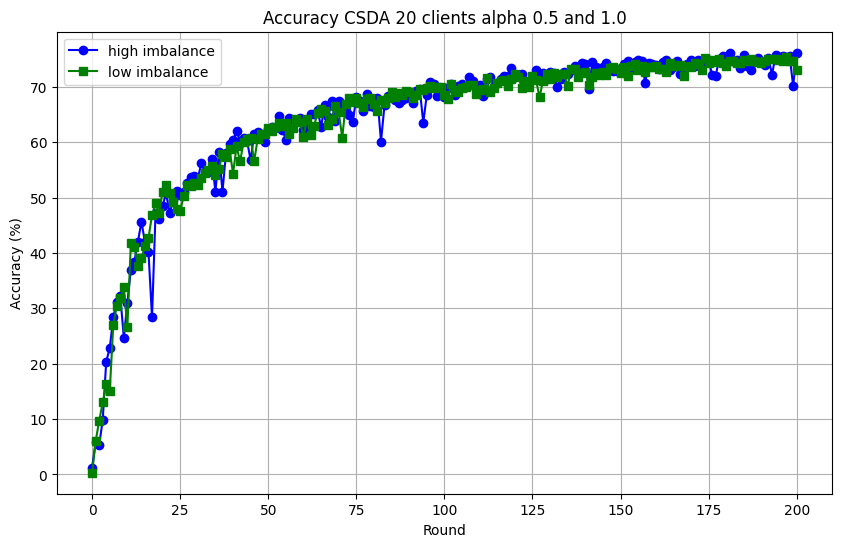

In [ ]:
import matplotlib.pyplot as plt

# Extracting accuracy data for FedAvg
global_accuracy_centralised_csda = history_csda_20c_dir05_SGD_200rounds_femnist.metrics_centralized["accuracy"]
round_csda = [data[0] for data in global_accuracy_centralised_csda]
acc_csda = [100.0 * data[1] for data in global_accuracy_centralised_csda]

# Extracting accuracy data for FedProx
global_accuracy_centralised_csda_10dir = history_csda_20c_dir10_SGD_200rounds_femnist.metrics_centralized["accuracy"]
round_csda_10dir = [data[0] for data in global_accuracy_centralised_csda_10dir]
acc_csda_10dir = [100.0 * data[1] for data in global_accuracy_centralised_csda_10dir]

# Adjusting round lists to start from 0
round_csda_adjusted = [round_num for round_num in round_csda]
round_csda_10dir_adjusted = [round_num for round_num in round_csda_10dir]

plt.figure(figsize=(10, 6))

# Plot FedAvg accuracy
plt.plot(round_csda_adjusted, acc_csda, label='high imbalance', color='blue', marker='o')

# Plot FedProx accuracy
plt.plot(round_csda_10dir_adjusted, acc_csda_10dir, label='low imbalance', color='green', marker='s')

# Adding grid, labels, and title
plt.grid()
plt.ylabel("Accuracy (%)")
plt.xlabel("Round")
plt.title("Accuracy CSDA 20 clients alpha 0.5 and 1.0")
plt.legend()

# Setting X-axis ticks to show multiples of 25
plt.xticks(range(0, 201, 25))  # from 0 to 200, with a step of 25

# Show the plot
plt.show()


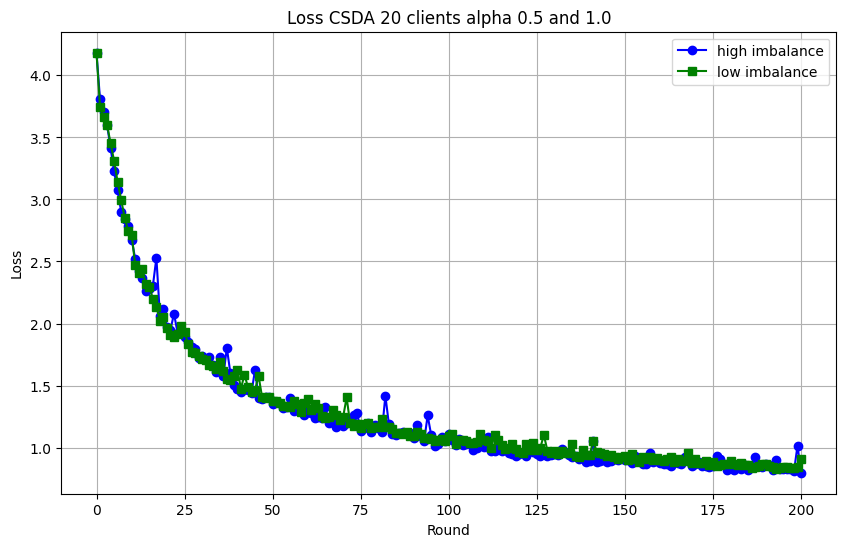

In [ ]:
import matplotlib.pyplot as plt

# Extracting loss data for FedAvg (high imbalance)
losses_centralized_csda = history_csda_20c_dir05_SGD_200rounds_femnist.losses_centralized
round_csda_loss = [data[0] for data in losses_centralized_csda]
loss_csda = [data[1] for data in losses_centralized_csda]

# Extracting loss data for FedProx (low imbalance)
losses_centralized_csda_10dir = history_csda_20c_dir10_SGD_200rounds_femnist.losses_centralized
round_csda_10dir_loss = [data[0] for data in losses_centralized_csda_10dir]
loss_csda_10dir = [data[1] for data in losses_centralized_csda_10dir]

# Adjusting round lists to start from 0
round_csda_loss_adjusted = [round_num for round_num in round_csda_loss]
round_csda_10dir_loss_adjusted = [round_num for round_num in round_csda_10dir_loss]

plt.figure(figsize=(10, 6))

# Plot FedAvg loss
plt.plot(round_csda_loss_adjusted, loss_csda, label='high imbalance', color='blue', marker='o')

# Plot FedProx loss
plt.plot(round_csda_10dir_loss_adjusted, loss_csda_10dir, label='low imbalance', color='green', marker='s')

# Adding grid, labels, and title
plt.grid()
plt.ylabel("Loss")
plt.xlabel("Round")
plt.title("Loss CSDA 20 clients alpha 0.5 and 1.0")
plt.legend()

# Setting X-axis ticks to show multiples of 25
plt.xticks(range(0, 201, 25))  # from 0 to 200, with a step of 25

# Show the plot
plt.show()


# Plots for 100 clients

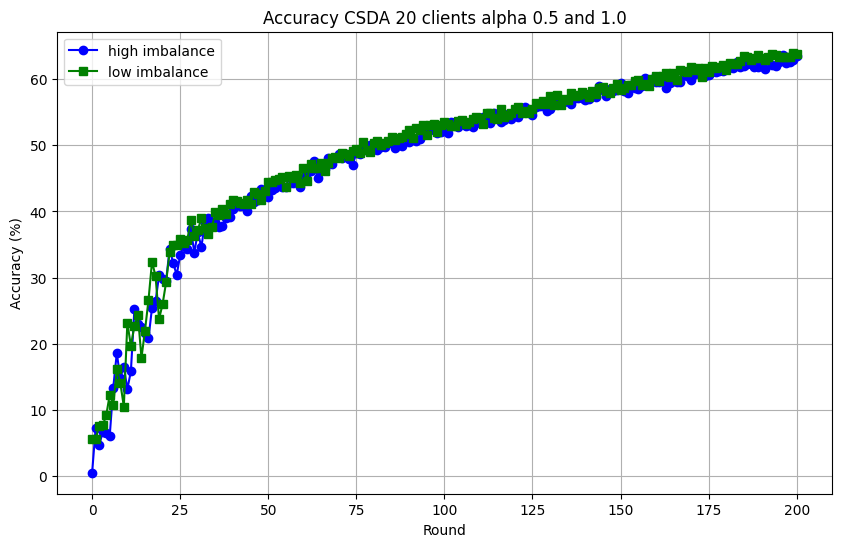

In [ ]:
import matplotlib.pyplot as plt

# Extracting accuracy data for FedAvg
global_accuracy_centralised_csda = history_csda_100c_dir05_SGD_200rounds_femnist_MLP.metrics_centralized["accuracy"]
round_csda = [data[0] for data in global_accuracy_centralised_csda]
acc_csda = [100.0 * data[1] for data in global_accuracy_centralised_csda]

# Extracting accuracy data for FedProx
global_accuracy_centralised_csda_10dir = history_csda_100c_dir10_SGD_200rounds_femnist_MLP.metrics_centralized["accuracy"]
round_csda_10dir = [data[0] for data in global_accuracy_centralised_csda_10dir]
acc_csda_10dir = [100.0 * data[1] for data in global_accuracy_centralised_csda_10dir]

# Adjusting round lists to start from 0
round_csda_adjusted = [round_num for round_num in round_csda]
round_csda_10dir_adjusted = [round_num for round_num in round_csda_10dir]

plt.figure(figsize=(10, 6))

# Plot FedAvg accuracy
plt.plot(round_csda_adjusted, acc_csda, label='high imbalance', color='blue', marker='o')

# Plot FedProx accuracy
plt.plot(round_csda_10dir_adjusted, acc_csda_10dir, label='low imbalance', color='green', marker='s')

# Adding grid, labels, and title
plt.grid()
plt.ylabel("Accuracy (%)")
plt.xlabel("Round")
plt.title("Accuracy CSDA 20 clients alpha 0.5 and 1.0")
plt.legend()

# Setting X-axis ticks to show multiples of 25
plt.xticks(range(0, 201, 25))  # from 0 to 200, with a step of 25

# Show the plot
plt.show()


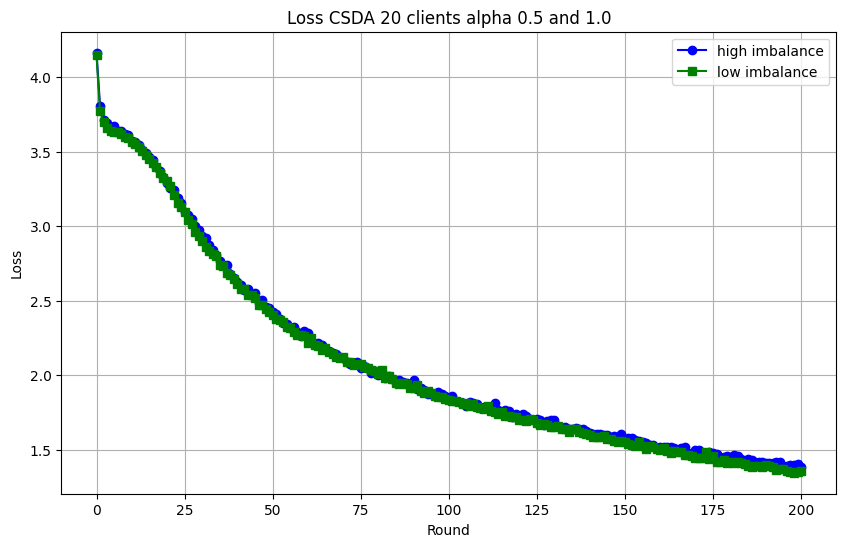

In [ ]:
import matplotlib.pyplot as plt

# Extracting loss data for FedAvg (high imbalance)
losses_centralized_csda = history_csda_100c_dir05_SGD_200rounds_femnist_MLP.losses_centralized
round_csda_loss = [data[0] for data in losses_centralized_csda]
loss_csda = [data[1] for data in losses_centralized_csda]

# Extracting loss data for FedProx (low imbalance)
losses_centralized_csda_10dir = history_csda_100c_dir10_SGD_200rounds_femnist_MLP.losses_centralized
round_csda_10dir_loss = [data[0] for data in losses_centralized_csda_10dir]
loss_csda_10dir = [data[1] for data in losses_centralized_csda_10dir]

# Adjusting round lists to start from 0
round_csda_loss_adjusted = [round_num for round_num in round_csda_loss]
round_csda_10dir_loss_adjusted = [round_num for round_num in round_csda_10dir_loss]

plt.figure(figsize=(10, 6))

# Plot FedAvg loss
plt.plot(round_csda_loss_adjusted, loss_csda, label='high imbalance', color='blue', marker='o')

# Plot FedProx loss
plt.plot(round_csda_10dir_loss_adjusted, loss_csda_10dir, label='low imbalance', color='green', marker='s')

# Adding grid, labels, and title
plt.grid()
plt.ylabel("Loss")
plt.xlabel("Round")
plt.title("Loss CSDA 20 clients alpha 0.5 and 1.0")
plt.legend()

# Setting X-axis ticks to show multiples of 25
plt.xticks(range(0, 201, 25))  # from 0 to 200, with a step of 25

# Show the plot
plt.show()


# IID CODE

In [ ]:
import random
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, random_split, Subset
import numpy as np
from collections import defaultdict, Counter
from torchvision import datasets, transforms
from torchvision.datasets import CIFAR10
from tqdm import tqdm
import matplotlib.pyplot as plt


NUM_CLIENTS = 100

class FEMNISTDataset(Dataset):
    def __init__(self, data_dir, split, transform=None):
        self.data_dir = data_dir
        self.split = split
        self.transform = transform
        self.data, self.targets = self.load_data()

    def load_data(self):
        data = []
        targets = []
        split_dir = os.path.join(self.data_dir, self.split)
        for user_file in os.listdir(split_dir):
            with open(os.path.join(split_dir, user_file), 'r') as f:
                user_data = json.load(f)
                for user in user_data['users']:
                    x_data = user_data['user_data'][user]['x']
                    y_data = user_data['user_data'][user]['y']
                    for x, y in zip(x_data, y_data):
                        data.append(np.array(x).reshape(28, 28))
                        assert 0 <= y < 62, f"Label {y} is out of bounds."
                        targets.append(y)
        return np.array(data), np.array(targets)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image = self.data[idx].astype(np.float32)  # Ensure image is float32
        label = self.targets[idx]
        if self.transform:
            image = self.transform(image)
        return image, label



def load_datasets(num_clients: int, data_dir='./leaf/data/femnist/data'):
    transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.1307,), (0.3081,))])
    trainset = FEMNISTDataset(data_dir, split='train', transform=transform)
    testset = FEMNISTDataset(data_dir, split='test', transform=transform)

    # Calculate approximate equal partition size
    total_length = len(trainset)
    base_length = total_length // num_clients
    remaining_length = total_length % num_clients

    # Generate lengths with some random variation
    lengths = [base_length + (1 if i < remaining_length else 0) for i in range(num_clients)]
    variations = [random.randint(-base_length//4, base_length//4) for _ in range(num_clients)]

    # Apply variations and adjust to ensure the sum is correct
    lengths = [max(1, l + v) for l, v in zip(lengths, variations)]
    sum_lengths = sum(lengths)

    # Adjust the lengths if there is any discrepancy
    diff = total_length - sum_lengths
    for i in range(abs(diff)):
        lengths[i % num_clients] += 1 if diff > 0 else -1

    print(lengths)  # To check the generated random lengths

    datasets = random_split(trainset, lengths, torch.Generator().manual_seed(42))

    # Split each partition into train/val and create DataLoader
    trainloaders = []
    valloaders = []
    for ds in datasets:
        len_val = len(ds) // 10  # 10 % validation set
        len_train = len(ds) - len_val
        lengths = [len_train, len_val]
        ds_train, ds_val = random_split(ds, lengths, torch.Generator().manual_seed(42))
        trainloaders.append(DataLoader(ds_train, batch_size=32, shuffle=True))
        valloaders.append(DataLoader(ds_val, batch_size=32))
    testloader = DataLoader(testset, batch_size=32)
    return trainloaders, valloaders, testloader


trainloaders, valloaders, testloader = load_datasets(NUM_CLIENTS)

[414, 327, 443, 440, 365, 385, 426, 406, 402, 390, 452, 417, 403, 364, 307, 415, 352, 311, 386, 449, 277, 287, 283, 417, 354, 424, 384, 343, 414, 299, 318, 399, 450, 359, 412, 370, 382, 280, 386, 401, 330, 391, 398, 433, 411, 281, 452, 278, 425, 350, 306, 319, 305, 352, 423, 349, 419, 352, 341, 292, 374, 419, 403, 294, 308, 279, 382, 372, 360, 442, 294, 317, 358, 456, 375, 385, 310, 329, 380, 424, 337, 284, 333, 381, 285, 436, 391, 289, 355, 281, 456, 285, 308, 399, 449, 353, 439, 325, 309, 441]


## 20 Clients

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_20c_Adam_IID = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_20c_Adam_IID, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_20c_Adam_IID.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-17 09:41:22,252	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0, 'memory': 7965772187.0, 'object_store_memory': 3982886092.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=81461) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=81462) 2024-09-17 09:41:28.294874: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=81462) 2024-09-17 09:41:28.330707: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=81462) 2024-09-17 09:41:28.344718: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=81462) 2024-09-17 09:41:30.650005: W tensorflow/compiler/tf2tensorrt/utils/py_utils.

(ClientAppActor pid=81461) Epoch 1: train loss 0.1211, accuracy 0.0559
(ClientAppActor pid=81461) [Client 3, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=81462) Epoch 1: train loss 0.1213, accuracy 0.0467 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.1171428995230575, {'accuracy': 0.05001196458482891}, 21.549576681999497)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 2] evaluate, config: {}
(ClientAppActor pid=81461) [Client 2] Validation loss: 0.1192, Validation accuracy: 0.0691


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 17, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) Epoch 1: train loss 0.1160, accuracy 0.0504 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.1327, Validation accuracy: 0.0594 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.11517410393564517, {'accuracy': 0.05001196458482891}, 30.018391736999547)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 12, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) Epoch 1: train loss 0.1155, accuracy 0.0612 [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.1182, Validation accuracy: 0.0903 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 10, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.11295501431029047, {'accuracy': 0.1280210576692989}, 36.45684633699966)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81461) Epoch 1: train loss 0.1149, accuracy 0.0830 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.1290, Validation accuracy: 0.1018 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 1, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.10481128284137595, {'accuracy': 0.21033740129217515}, 42.06063319399982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) Epoch 1: train loss 0.1097, accuracy 0.1373 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 7] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=81462) [Client 17] Validation loss: 0.1320, Validation accuracy: 0.1227 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 8, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0996, accuracy 0.2141 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.1245, Validation accuracy: 0.2815 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.09211004456426287, {'accuracy': 0.28523570232112944}, 49.82074129600005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0891, accuracy 0.2819 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 15] Validation loss: 0.1091, Validation accuracy: 0.2963 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.08302013370288448, {'accuracy': 0.33835845896147404}, 55.379628124999726)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 8, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0824, accuracy 0.3144 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 8] Validation loss: 0.0908, Validation accuracy: 0.3908 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.07689564294808217, {'accuracy': 0.3723378798755683}, 63.13775168800021)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 15, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0802, accuracy 0.3457 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 2] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 2] Validation loss: 0.0782, Validation accuracy: 0.3511 [repeated 3x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.07264233802202986, {'accuracy': 0.40703517587939697}, 68.776252871)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81462) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0789, accuracy 0.3687 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0767, Validation accuracy: 0.4258 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.0687951968885204, {'accuracy': 0.42952859535774107}, 74.432366774)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 17, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0751, accuracy 0.3872 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0768, Validation accuracy: 0.4516 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81462) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0680, accuracy 0.4377 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 5] Validation loss: 0.0727, Validation accuracy: 0.4516 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.06497147711420435, {'accuracy': 0.45656855707106964}, 82.63688531699972)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0698, accuracy 0.4138 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0704, Validation accuracy: 0.4686 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.06235211207610507, {'accuracy': 0.472122517348648}, 88.55480882200027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 13, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0618, accuracy 0.4810 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0711, Validation accuracy: 0.4163 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.05938769245467194, {'accuracy': 0.49676956209619527}, 96.28326345599999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0621, accuracy 0.4761 [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 7] evaluate, config: {}
(ClientAppActor pid=81462) [Client 15] evaluate, config: {}
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0735, Validation accuracy: 0.5111
(ClientAppActor pid=81462) [Client 9] evaluate, config: {}


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.056933548325526995, {'accuracy': 0.5187843981813831}, 102.18378625300011)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 6, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0611, accuracy 0.4732 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 11] Validation loss: 0.0703, Validation accuracy: 0.4451 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.05452303083127239, {'accuracy': 0.5360134003350083}, 108.00901347499985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 0, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0594, accuracy 0.5008 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0668, Validation accuracy: 0.4417 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 19, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0556, accuracy 0.5259 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0588, Validation accuracy: 0.5549 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.0522245060715786, {'accuracy': 0.5537209858817899}, 115.8607109300001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 13, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0557, accuracy 0.5251 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0479, Validation accuracy: 0.6058 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.05006087744855002, {'accuracy': 0.5711892797319933}, 121.52504734299964)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0537, accuracy 0.5498 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 12] Validation loss: 0.0625, Validation accuracy: 0.5255 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.048556349770422044, {'accuracy': 0.5790859057190716}, 129.16334679299962)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 8, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0503, accuracy 0.5507 [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 14] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0528, Validation accuracy: 0.5747 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.046673301062706014, {'accuracy': 0.5898540320650874}, 135.08803331800027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=81462) [Client 13, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0503, accuracy 0.5560 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 16] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 11] Validation loss: 0.0586, Validation accuracy: 0.5087 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.04528732549690635, {'accuracy': 0.5922469490308686}, 141.16598537200025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 3, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0476, accuracy 0.5965 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 3] Validation loss: 0.0500, Validation accuracy: 0.5990 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0468, accuracy 0.5942 [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0425, Validation accuracy: 0.5899 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.04345146679484579, {'accuracy': 0.6149796602057909}, 149.16937987799975)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 17, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0445, accuracy 0.5962 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0496, Validation accuracy: 0.5550 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.04233608731643867, {'accuracy': 0.6180904522613065}, 155.48171896700023)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0466, accuracy 0.5934 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 15] Validation loss: 0.0556, Validation accuracy: 0.6444 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 19, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0439, accuracy 0.6037 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.040798922429731745, {'accuracy': 0.6312514955731036}, 163.76534132399956)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=81461) [Client 6] evaluate, config: {}
(ClientAppActor pid=81461) [Client 6] Validation loss: 0.0456, Validation accuracy: 0.5694


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0450, accuracy 0.6149 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.04001426907868213, {'accuracy': 0.6350801627183537}, 169.31147925499954)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 2] Validation loss: 0.0460, Validation accuracy: 0.6117 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 0, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0407, accuracy 0.6158 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0361, Validation accuracy: 0.6636 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.03861510710842902, {'accuracy': 0.650634122995932}, 175.96529379099957)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 0, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0414, accuracy 0.6192 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0383, Validation accuracy: 0.6839 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.037804589427866755, {'accuracy': 0.6535056233548696}, 182.976357732)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0391, accuracy 0.6458 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0442, Validation accuracy: 0.5951 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.03659099468091767, {'accuracy': 0.6633165829145728}, 188.45121375599956)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 17, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0406, accuracy 0.6489 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0389, Validation accuracy: 0.6570 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 10, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0404, accuracy 0.6383 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.03563477313241824, {'accuracy': 0.6695381670256042}, 196.69476582599964)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 14] evaluate, config: {}
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0315, Validation accuracy: 0.6820


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=81461) [Client 1, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0370, accuracy 0.6621 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.03473404636078401, {'accuracy': 0.6791098348887293}, 202.32771224999942)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=81461) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 17] Validation loss: 0.0341, Validation accuracy: 0.7546 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 3, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0362, accuracy 0.6698 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0307, Validation accuracy: 0.7005 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.034063475971787875, {'accuracy': 0.682220626944245}, 209.32148118399982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 13, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0359, accuracy 0.6737 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0474, Validation accuracy: 0.7259 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 16, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0377, accuracy 0.6577 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.03331836556726507, {'accuracy': 0.685810002392917}, 216.07742687300015)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0448, Validation accuracy: 0.6423 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0340, accuracy 0.6859 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.032697852090318454, {'accuracy': 0.695142378559464}, 221.61260197399952)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0325, Validation accuracy: 0.7184 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 17, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0361, accuracy 0.6667 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.03182775215059697, {'accuracy': 0.7001675041876047}, 229.99444478500027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 15] evaluate, config: {}
(ClientAppActor pid=81461) [Client 15] Validation loss: 0.0455, Validation accuracy: 0.7333
(ClientAppActor pid=81462) [Client 11, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0339, accuracy 0.6840 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 13] Validation loss: 0.0329, Validation accuracy: 0.7032


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.03143501981333358, {'accuracy': 0.7013639626704954}, 235.64674672799993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 7] Validation loss: 0.0332, Validation accuracy: 0.7056 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 7, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0329, accuracy 0.6757 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 17] Validation loss: 0.0303, Validation accuracy: 0.7669 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0331, accuracy 0.6886 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.030942103706726364, {'accuracy': 0.7042354630294329}, 242.19734244000028)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0318, Validation accuracy: 0.7005 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 19, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0339, accuracy 0.6850 [repeated 4x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.030321633314424567, {'accuracy': 0.7097391720507299}, 249.2831502279996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0267, Validation accuracy: 0.7419 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 10, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0346, accuracy 0.6820 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.03010108250412367, {'accuracy': 0.709978463747308}, 256.7052404629994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 6] evaluate, config: {}
(ClientAppActor pid=81462) [Client 1, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0323, accuracy 0.7084 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 17] evaluate, config: {}
(ClientAppActor pid=81462) [Client 17] Validation loss: 0.0282, Validation accuracy: 0.7791
(ClientAppActor pid=81462) [Client 13] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81461) [Client 0, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0306, accuracy 0.7066 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 19] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 19] Validation loss: 0.0318, Validation accuracy: 0.6930 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.029421582090623587, {'accuracy': 0.7159607561617611}, 265.3265557479999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0326, accuracy 0.6795 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0267, Validation accuracy: 0.7885 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.02916043480494057, {'accuracy': 0.7200287150035893}, 270.7345451069996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 11, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0292, accuracy 0.7167 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 2] Validation loss: 0.0354, Validation accuracy: 0.6862 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81462) [Client 7, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0304, accuracy 0.7033 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.0286598243042167, {'accuracy': 0.7185929648241206}, 281.4048580050003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16] evaluate, config: {}
(ClientAppActor pid=81461) [Client 17] Validation loss: 0.0267, Validation accuracy: 0.8037


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 19, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0309, accuracy 0.6999 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.02823133602627843, {'accuracy': 0.726728882507777}, 286.9657466239996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0323, Validation accuracy: 0.6879 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 6, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0281, accuracy 0.7289 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.0358, Validation accuracy: 0.6886 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.02776959350902688, {'accuracy': 0.7257717157214645}, 293.28432524300024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 8, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0302, accuracy 0.6941 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 5] Validation loss: 0.0294, Validation accuracy: 0.7419 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 6, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0290, accuracy 0.7271 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.02752907773500768, {'accuracy': 0.7296003828667145}, 300.61297204399943)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0289, Validation accuracy: 0.7688 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 2, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0291, accuracy 0.7156 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.02764567793784857, {'accuracy': 0.724814548935152}, 305.92333512000005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 11] Validation loss: 0.0345, Validation accuracy: 0.7457 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 2, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0277, accuracy 0.7363 [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.026803469349106237, {'accuracy': 0.7401292175161522}, 313.9854611720002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 2] evaluate, config: {}
(ClientAppActor pid=81461) [Client 2] Validation loss: 0.0326, Validation accuracy: 0.7021
(ClientAppActor pid=81461) [Client 17, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0300, accuracy 0.7198 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 13] evaluate, config: {}
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0275, Validation accuracy: 0.7290


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.026757424835897457, {'accuracy': 0.7432400095716679}, 319.45601903700026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=81462) [Client 13, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0292, accuracy 0.7081 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0295, Validation accuracy: 0.7283 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.026529374637367566, {'accuracy': 0.7382148839435272}, 325.52477823200024)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 1, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0285, accuracy 0.7403 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 8] Validation loss: 0.0263, Validation accuracy: 0.7586 [repeated 9x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0276, accuracy 0.7248 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0327, Validation accuracy: 0.6946 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.026044951165712288, {'accuracy': 0.7453936348408711}, 332.92632416800006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 9, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0268, accuracy 0.7383 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0334, Validation accuracy: 0.6810 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.025957253588874764, {'accuracy': 0.7430007178750897}, 338.5423292939995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 14, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0262, accuracy 0.7527 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0262, Validation accuracy: 0.7701 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.025536703354549568, {'accuracy': 0.7458722182340273}, 346.55528796899944)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 12, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0258, accuracy 0.7463 [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 1] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=81461) [Client 2] Validation loss: 0.0321, Validation accuracy: 0.7181 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.02541756415287254, {'accuracy': 0.7516152189519024}, 352.17034083399994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0292, accuracy 0.7118 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 16] Validation loss: 0.0351, Validation accuracy: 0.6881 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.025146437093497863, {'accuracy': 0.7532902608279493}, 357.95415427900025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0262, accuracy 0.7437 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 11] Validation loss: 0.0327, Validation accuracy: 0.7630 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81461) [Client 2, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0288, accuracy 0.7311 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.0308, Validation accuracy: 0.7186 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.024769430491136404, {'accuracy': 0.7501794687724336}, 365.31887619699955)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 14, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0268, accuracy 0.7366 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0243, Validation accuracy: 0.7512 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.024732186516725038, {'accuracy': 0.7518545106484805}, 370.7276233269995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 15, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0265, accuracy 0.7396 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0251, Validation accuracy: 0.7816 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.024376733900257547, {'accuracy': 0.7547260110074181}, 378.6235305399996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 4, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0248, accuracy 0.7553 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 13] Validation loss: 0.0247, Validation accuracy: 0.7419 [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.024447076801735693, {'accuracy': 0.7549653027039962}, 383.9978768109995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 18, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0254, accuracy 0.7580 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 11] Validation loss: 0.0303, Validation accuracy: 0.7803 [repeated 4x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.02391439470542507, {'accuracy': 0.7647762622636994}, 390.13793662199987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81462) [Client 5, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0262, accuracy 0.7249 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0298, Validation accuracy: 0.7055 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 17, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0261, accuracy 0.7566 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0232, Validation accuracy: 0.7512 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.023692395216285057, {'accuracy': 0.7595118449389806}, 397.61284674299986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 16, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0235, accuracy 0.7802 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0304, Validation accuracy: 0.7117 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.023688491161972407, {'accuracy': 0.7635798037808088}, 403.07255622899993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 13, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0260, accuracy 0.7330 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0240, Validation accuracy: 0.7935 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.0231163705413665, {'accuracy': 0.7664513041397464}, 411.269317282)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0234, accuracy 0.7872 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 8] evaluate, config: {}
(ClientAppActor pid=81461) [Client 8] Validation loss: 0.0233, Validation accuracy: 0.7701
(ClientAppActor pid=81462) [Client 13] evaluate, config: {}
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0236, Validation accuracy: 0.7677


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.023186504705353314, {'accuracy': 0.7669298875329026}, 416.60784120599965)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 11, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0261, accuracy 0.7482 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0289, Validation accuracy: 0.6933 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.023287636572220986, {'accuracy': 0.7659727207465901}, 422.4846783040002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=81462) [Client 11, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0264, accuracy 0.7450 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 17] Validation loss: 0.0215, Validation accuracy: 0.7914 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0221, accuracy 0.7786 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 2] Validation loss: 0.0291, Validation accuracy: 0.7287 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.022952506693535144, {'accuracy': 0.7712371380713089}, 430.02632262099996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 15, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0246, accuracy 0.7614 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0204, Validation accuracy: 0.8086 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.02294136231511539, {'accuracy': 0.7707585546781527}, 435.3720584040002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 19, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0224, accuracy 0.7751 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0322, Validation accuracy: 0.7426 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.02254245746689112, {'accuracy': 0.7726728882507777}, 443.28410244599945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 3, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0227, accuracy 0.7697 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0282, Validation accuracy: 0.7117 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.022336984353220672, {'accuracy': 0.7757836803062934}, 448.8426230260002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 11, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0227, accuracy 0.7655 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0198, Validation accuracy: 0.8317 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.02214510861867123, {'accuracy': 0.7803302225412778}, 455.10850372799996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0223, accuracy 0.7712 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {}
(ClientAppActor pid=81462) [Client 1] evaluate, config: {}
(ClientAppActor pid=81461) [Client 13] Validation loss: 0.0226, Validation accuracy: 0.7871


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 15, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0237, accuracy 0.7712 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0216, Validation accuracy: 0.7971 [repeated 7x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.022002634359022225, {'accuracy': 0.7781765972720747}, 462.4818776860002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 17, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0214, accuracy 0.7859 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0217, Validation accuracy: 0.8065 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.022054835298210274, {'accuracy': 0.7788944723618091}, 467.8047108310002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0218, accuracy 0.7696 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 14] Validation loss: 0.0198, Validation accuracy: 0.8065 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.021989874664776973, {'accuracy': 0.7829624312036373}, 475.6928766439996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 7, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0218, accuracy 0.7715 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0201, Validation accuracy: 0.7880 [repeated 3x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.02170633272737885, {'accuracy': 0.7822445561139029}, 481.1235302320001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0215, accuracy 0.7795 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0275, Validation accuracy: 0.7665 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.02149162173171339, {'accuracy': 0.7815266810241684}, 487.0753806550001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0216, accuracy 0.7949 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 19] Validation loss: 0.0215, Validation accuracy: 0.7907 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81461) [Client 17, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0210, accuracy 0.7826 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0306, Validation accuracy: 0.7426 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 3x across cluster]


(ClientAppActor pid=81462) [Client 11, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0214, accuracy 0.7846 [repeated 2x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.021582238937742148, {'accuracy': 0.7791337640583872}, 502.09550886299985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 11] evaluate, config: {}
(ClientAppActor pid=81461) [Client 11] Validation loss: 0.0269, Validation accuracy: 0.8092


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0230, accuracy 0.7738 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.02121353989855243, {'accuracy': 0.7836803062933716}, 508.0351081970002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0203, Validation accuracy: 0.8116 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 19, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0234, accuracy 0.7778 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 9] Validation loss: 0.0237, Validation accuracy: 0.7630 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.021098062203500394, {'accuracy': 0.7867910983488873}, 515.5769303139996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0202, accuracy 0.7899 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0240, Validation accuracy: 0.7688 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.021294081954900144, {'accuracy': 0.7848767647762622}, 521.0890867059998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81462) [Client 18, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0205, accuracy 0.7888 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 11] Validation loss: 0.0278, Validation accuracy: 0.7861 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 13, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0208, accuracy 0.7880 [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.020955473747969987, {'accuracy': 0.7877482651351998}, 529.2612035809998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16] evaluate, config: {}
(ClientAppActor pid=81461) [Client 10] evaluate, config: {}
(ClientAppActor pid=81461) [Client 10] Validation loss: 0.0253, Validation accuracy: 0.7816


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 5, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0198, accuracy 0.7939 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.020875005648306723, {'accuracy': 0.7887054319215123}, 534.827134049)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 7] Validation loss: 0.0243, Validation accuracy: 0.7889 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0226, accuracy 0.7803 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.020922175609243917, {'accuracy': 0.7882268485283561}, 540.9488121409995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0189, Validation accuracy: 0.8510 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 8, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0208, accuracy 0.7945 [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0201, Validation accuracy: 0.8161 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.020520904976148075, {'accuracy': 0.7942091409428093}, 548.2685998229999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 19, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0202, accuracy 0.8057 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81461) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0182, Validation accuracy: 0.8654 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.020774964850238133, {'accuracy': 0.7860732232591529}, 553.4654376359995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 8, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0201, accuracy 0.7983 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 17] Validation loss: 0.0185, Validation accuracy: 0.8221 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=81462) [Client 12, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0195, accuracy 0.7918 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.020527548435473733, {'accuracy': 0.7942091409428093}, 561.3335463610001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=81461) [Client 10] Validation loss: 0.0250, Validation accuracy: 0.7913
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0174, Validation accuracy: 0.8182


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 0, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0200, accuracy 0.7899 [repeated 5x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.02048632411273309, {'accuracy': 0.7961234745154343}, 566.9018542899994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 7] Validation loss: 0.0243, Validation accuracy: 0.7833 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0227, accuracy 0.7845 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.020275827635415692, {'accuracy': 0.7963627662120124}, 572.7815403570003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0239, Validation accuracy: 0.7791 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 11, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0220, accuracy 0.7932 [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0278, Validation accuracy: 0.7737 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.020240044245796358, {'accuracy': 0.7925340990667624}, 580.6015115660002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 3, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0197, accuracy 0.8215 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 0] Validation loss: 0.0192, Validation accuracy: 0.8168 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.020184641498488427, {'accuracy': 0.7946877243359656}, 586.1699516039998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=81462) [Client 19, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0198, accuracy 0.8026 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.0246, Validation accuracy: 0.7665 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 16, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0190, accuracy 0.8099 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.02008255984394366, {'accuracy': 0.7970806413017468}, 593.9142713579995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 10] evaluate, config: {}
(ClientAppActor pid=81462) [Client 13] evaluate, config: {}
(ClientAppActor pid=81461) [Client 10] Validation loss: 0.0244, Validation accuracy: 0.7913
(ClientAppActor pid=81462) [Client 18] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0208, accuracy 0.7957 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.02000365994440993, {'accuracy': 0.7954055994256999}, 599.4325045899996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0199, Validation accuracy: 0.8068 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0196, accuracy 0.8013 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.019850751432784294, {'accuracy': 0.7958841828188562}, 605.0176080869996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0286, Validation accuracy: 0.7883 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 8, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0213, accuracy 0.7900 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0191, Validation accuracy: 0.8261 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0212, accuracy 0.7961 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.019884204668030554, {'accuracy': 0.8013878918401531}, 612.8745908430001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 1] Validation loss: 0.0238, Validation accuracy: 0.7914 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 8, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0205, accuracy 0.7935 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.019946254103427357, {'accuracy': 0.7980378080880594}, 618.2592116440001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 18] Validation loss: 0.0179, Validation accuracy: 0.8606 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0215, accuracy 0.7932 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.019938143958355657, {'accuracy': 0.7980378080880594}, 625.2359606379996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 13] Validation loss: 0.0187, Validation accuracy: 0.8065 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 19, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0200, accuracy 0.8008 [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=81462) [Client 10] Validation loss: 0.0243, Validation accuracy: 0.7816 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.01979453684675206, {'accuracy': 0.8033022254127782}, 631.8738079249997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 19, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0180, accuracy 0.8112 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0352, Validation accuracy: 0.8148 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.019716415510604927, {'accuracy': 0.8021057669298876}, 637.5548641059995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 14, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0188, accuracy 0.8017 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0249, Validation accuracy: 0.7784 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 9, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0210, accuracy 0.7882 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.019695939769383167, {'accuracy': 0.7987556831777938}, 645.5402180740002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 2] Validation loss: 0.0243, Validation accuracy: 0.7926 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 18, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0196, accuracy 0.8021 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.01948106950886599, {'accuracy': 0.8018664752333095}, 651.1996123560002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0255, Validation accuracy: 0.7844 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0178, accuracy 0.8149 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.019910512887410324, {'accuracy': 0.801148600143575}, 657.8288091739996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 1] evaluate, config: {}
(ClientAppActor pid=81462) [Client 10] evaluate, config: {}
(ClientAppActor pid=81461) [Client 1] Validation loss: 0.0232, Validation accuracy: 0.7975


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0184, accuracy 0.8112 [repeated 5x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81461) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0193, Validation accuracy: 0.8118 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.019669146258513247, {'accuracy': 0.7977985163914812}, 664.2570812349995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=81462) [Client 8, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0176, accuracy 0.8124 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0180, Validation accuracy: 0.8323 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.019455726099559124, {'accuracy': 0.8047379755922469}, 669.7942315390001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 6, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0178, accuracy 0.8090 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0190, Validation accuracy: 0.8168 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 14, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0189, accuracy 0.8088 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.019476889688579566, {'accuracy': 0.7973199329983249}, 677.9948531199998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0174, Validation accuracy: 0.8558 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0199, accuracy 0.8061 [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.019344289773073627, {'accuracy': 0.8044986838956688}, 683.777153858)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0216, Validation accuracy: 0.8092 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0192, accuracy 0.8091 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.019284222391796158, {'accuracy': 0.8021057669298876}, 690.4419554159995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 5] evaluate, config: {}
(ClientAppActor pid=81462) [Client 16] evaluate, config: {}
(ClientAppActor pid=81461) [Client 5] Validation loss: 0.0188, Validation accuracy: 0.8280
(ClientAppActor pid=81462) [Client 14, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0183, accuracy 0.8135 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81461) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 9] Validation loss: 0.0224, Validation accuracy: 0.7919 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 9, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0202, accuracy 0.7968 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.019360004937386335, {'accuracy': 0.8004307250538406}, 697.3545278060001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0251, Validation accuracy: 0.7964 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 7, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0183, accuracy 0.8007 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.019203828118668415, {'accuracy': 0.8044986838956688}, 702.9434249280002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 19] Validation loss: 0.0197, Validation accuracy: 0.8186 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0175, accuracy 0.8111 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.019219690123067058, {'accuracy': 0.8059344340751375}, 711.1072602109998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0338, Validation accuracy: 0.8000 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0204, accuracy 0.8096 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.019492866225820547, {'accuracy': 0.8025843503230438}, 716.4602956889994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0174, Validation accuracy: 0.8218 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 0, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0177, accuracy 0.8090 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 5] Validation loss: 0.0188, Validation accuracy: 0.8333 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.01934226359668375, {'accuracy': 0.806652309164872}, 723.4497740839997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0188, accuracy 0.8005 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.0239, Validation accuracy: 0.7904 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 6, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0204, accuracy 0.7947 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.019164383020960678, {'accuracy': 0.806652309164872}, 730.86169419)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0337, Validation accuracy: 0.8000 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0180, accuracy 0.8028 [repeated 4x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.01905455736594498, {'accuracy': 0.8042593921990907}, 739.5858223939995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 7] evaluate, config: {}
(ClientAppActor pid=81462) [Client 4, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0181, accuracy 0.8128 [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 7] Validation loss: 0.0234, Validation accuracy: 0.8222


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81462) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 11, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0178, accuracy 0.8204 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0187, Validation accuracy: 0.8333 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.018989122673052583, {'accuracy': 0.8092845178272314}, 746.3808510119998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 11, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0210, accuracy 0.7778 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 2] Validation loss: 0.0232, Validation accuracy: 0.7926 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.018990082177327963, {'accuracy': 0.8061737257717158}, 751.9364593959999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 5, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0178, accuracy 0.8212 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0217, Validation accuracy: 0.8037 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.01916451493492535, {'accuracy': 0.8068916008614501}, 760.1812509229994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 15, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0176, accuracy 0.8127 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 3] Validation loss: 0.0188, Validation accuracy: 0.8261 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.01913562512235169, {'accuracy': 0.8071308925580283}, 765.621312755)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 1, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0197, accuracy 0.8042 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0182, Validation accuracy: 0.8172 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.019073280403990013, {'accuracy': 0.8076094759511845}, 771.843758912999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 15, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0166, accuracy 0.8343 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0191, Validation accuracy: 0.7970 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 5, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0185, accuracy 0.8128 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 7] Validation loss: 0.0228, Validation accuracy: 0.8056 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.018943355482256164, {'accuracy': 0.8126346015793252}, 779.0283573249999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 6, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0192, accuracy 0.8047 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0218, Validation accuracy: 0.8324 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.018951940699452618, {'accuracy': 0.8080880593443408}, 784.5914532589995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 17, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0184, accuracy 0.8039 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 2] Validation loss: 0.0231, Validation accuracy: 0.7872 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.019188448934713085, {'accuracy': 0.8035415171093563}, 792.5462121260007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 7] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=81461) [Client 6, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0168, accuracy 0.8239 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.0240, Validation accuracy: 0.7725
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0184, Validation accuracy: 0.8129


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.019267210697202084, {'accuracy': 0.808566642737497}, 798.0465710440003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 4, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0177, accuracy 0.8105 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0168, Validation accuracy: 0.8157 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.01898884488709608, {'accuracy': 0.8083273510409189}, 803.9491720650003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 16, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0183, accuracy 0.8249 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0242, Validation accuracy: 0.7964 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 19, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0173, accuracy 0.8194 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0160, Validation accuracy: 0.8249 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.018936525934918926, {'accuracy': 0.8056951423785594}, 811.4056073070005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 19, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0173, accuracy 0.8161 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0311, Validation accuracy: 0.8222 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.01899177225212584, {'accuracy': 0.8088059344340751}, 816.990574939)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 17, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0196, accuracy 0.8092 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0186, Validation accuracy: 0.8280 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.018918862895735657, {'accuracy': 0.8097631012203876}, 825.1106587150007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10] evaluate, config: {}
(ClientAppActor pid=81462) [Client 19, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0176, accuracy 0.8191 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 16] evaluate, config: {}
(ClientAppActor pid=81461) [Client 16] Validation loss: 0.0249, Validation accuracy: 0.7822
(ClientAppActor pid=81461) [Client 7] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.01899917737508853, {'accuracy': 0.8083273510409189}, 830.7288110650006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0178, accuracy 0.8027 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0170, Validation accuracy: 0.8046 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 6, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0166, accuracy 0.8318 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 7] Validation loss: 0.0229, Validation accuracy: 0.8222 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.018821351989643742, {'accuracy': 0.8090452261306532}, 837.1284037610003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 13, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0201, accuracy 0.7907 [repeated 3x across cluster]
(ClientAppActor pid=81462) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0253, Validation accuracy: 0.7725 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.018836605899012752, {'accuracy': 0.8097631012203876}, 844.4723495510007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 14, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0178, accuracy 0.8129 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0181, Validation accuracy: 0.8069 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.01895049155706936, {'accuracy': 0.8083273510409189}, 849.8988489549993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0177, accuracy 0.8222 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0216, Validation accuracy: 0.7730 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81462) [Client 10, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0165, accuracy 0.8319 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.018651927207810767, {'accuracy': 0.8123953098827471}, 858.0973565849999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 18] evaluate, config: {}
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0182, Validation accuracy: 0.8168


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 11, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0168, accuracy 0.8192 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.01870396704401631, {'accuracy': 0.8083273510409189}, 863.6762824279995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0171, Validation accuracy: 0.8323 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 8, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0155, accuracy 0.8318 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.01873203464339127, {'accuracy': 0.8104809763101221}, 869.7819978339994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0183, Validation accuracy: 0.8406 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0194, accuracy 0.7901 [repeated 5x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0206, Validation accuracy: 0.8092 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.018682941086599205, {'accuracy': 0.8135917683656377}, 877.2466662059996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0166, accuracy 0.8258 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0137, Validation accuracy: 0.8517 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.01863885742393114, {'accuracy': 0.8128738932759033}, 882.7218800659994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=81461) [Client 12, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0167, accuracy 0.8286 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0177, Validation accuracy: 0.8218 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 8, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0169, accuracy 0.8162 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.018751888401087862, {'accuracy': 0.810241684613544}, 890.8390091519996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 18] evaluate, config: {}
(ClientAppActor pid=81461) [Client 1] evaluate, config: {}
(ClientAppActor pid=81461) [Client 1] Validation loss: 0.0223, Validation accuracy: 0.7791


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 15, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0191, accuracy 0.8064 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.018854991601725234, {'accuracy': 0.8116774347930127}, 896.5220699879992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.0231, Validation accuracy: 0.8024 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 13, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0172, accuracy 0.8102 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.018674918977473736, {'accuracy': 0.8116774347930127}, 902.6641682610007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 8] Validation loss: 0.0167, Validation accuracy: 0.8218 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0182, accuracy 0.8192 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0207, Validation accuracy: 0.8035 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 8, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0167, accuracy 0.8142 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.018681975278123538, {'accuracy': 0.8126346015793252}, 909.864227991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0247, Validation accuracy: 0.7822 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 14, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0167, accuracy 0.8231 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.018672188240736118, {'accuracy': 0.8126346015793252}, 915.4458815239996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0190, Validation accuracy: 0.8213 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 13, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0167, accuracy 0.8305 [repeated 5x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.018929428899436513, {'accuracy': 0.8078487676477626}, 923.392851311999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 11] evaluate, config: {}
(ClientAppActor pid=81461) [Client 7] evaluate, config: {}
(ClientAppActor pid=81461) [Client 7] Validation loss: 0.0229, Validation accuracy: 0.8278


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0170, accuracy 0.8165 [repeated 5x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.019010315083821273, {'accuracy': 0.8111988513998565}, 929.1577622120003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 12] Validation loss: 0.0262, Validation accuracy: 0.8248 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 0, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0173, accuracy 0.8142 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0177, Validation accuracy: 0.8558 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 2, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0163, accuracy 0.8329 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.01882582141091362, {'accuracy': 0.8097631012203876}, 935.6408233820002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0173, Validation accuracy: 0.8558 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 4, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0171, accuracy 0.8320 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.018865633361018368, {'accuracy': 0.8104809763101221}, 942.6049586089994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0166, Validation accuracy: 0.8218 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 6, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0185, accuracy 0.8001 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.0186641875286298, {'accuracy': 0.8119167264895908}, 948.1044957960003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0164, Validation accuracy: 0.8465 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 9, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0161, accuracy 0.8315 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 13, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0157, accuracy 0.8282 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.018673601993307254, {'accuracy': 0.8121560181861689}, 956.4348092479995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=81461) [Client 5] evaluate, config: {}
(ClientAppActor pid=81461) [Client 5] Validation loss: 0.0179, Validation accuracy: 0.8387


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 2, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0177, accuracy 0.8120 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.018672821393892165, {'accuracy': 0.8123953098827471}, 961.8726623309994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0241, Validation accuracy: 0.7871 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0165, accuracy 0.8275 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 2] Validation loss: 0.0230, Validation accuracy: 0.7766 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.018558423043538236, {'accuracy': 0.8176597272074659}, 968.3544481909994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) 
(ClientAppActor pid=81461) [Client 10, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0167, accuracy 0.8189 [repeated 3x across cluster]
(ClientAppActor pid=81462) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0186, Validation accuracy: 0.8357 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81462) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0159, accuracy 0.8319 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.01870296249394783, {'accuracy': 0.8090452261306532}, 978.3278099580002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 5] evaluate, config: {}
(ClientAppActor pid=81461) [Client 6] evaluate, config: {}
(ClientAppActor pid=81461) [Client 6] Validation loss: 0.0140, Validation accuracy: 0.8565


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0155, accuracy 0.8319 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.018726401116594682, {'accuracy': 0.8131131849724814}, 983.898457031999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=81461) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 7] Validation loss: 0.0222, Validation accuracy: 0.8000 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0192, accuracy 0.8027 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 3] Validation loss: 0.0195, Validation accuracy: 0.8357 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.018846615786136237, {'accuracy': 0.8121560181861689}, 992.049728086)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 5, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0188, accuracy 0.8043 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 14] Validation loss: 0.0155, Validation accuracy: 0.8295 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.018783410369715186, {'accuracy': 0.8123953098827471}, 997.954640336)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0180, accuracy 0.8150 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 2] Validation loss: 0.0229, Validation accuracy: 0.7766 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 8, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0168, accuracy 0.8264 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.01882048854151962, {'accuracy': 0.8097631012203876}, 1004.821469868999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 15] evaluate, config: {}
(ClientAppActor pid=81461) [Client 15] Validation loss: 0.0321, Validation accuracy: 0.8148
(ClientAppActor pid=81462) [Client 1] evaluate, config: {}
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0241, Validation accuracy: 0.8037


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 7, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0156, accuracy 0.8298 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 7] Validation loss: 0.0231, Validation accuracy: 0.8333 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.018849888864167427, {'accuracy': 0.8121560181861689}, 1011.3143409479999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 19, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0171, accuracy 0.8248 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 19] Validation loss: 0.0189, Validation accuracy: 0.8326 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.01868776234856745, {'accuracy': 0.8131131849724814}, 1016.834977945)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0161, accuracy 0.8365 [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0135, Validation accuracy: 0.8612 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.01879565806519646, {'accuracy': 0.8092845178272314}, 1025.1004497909998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 11, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0186, accuracy 0.8208 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 7] Validation loss: 0.0226, Validation accuracy: 0.8278 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.018748137130923295, {'accuracy': 0.8131131849724814}, 1030.1763146289995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 13, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0183, accuracy 0.8030 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 5] Validation loss: 0.0177, Validation accuracy: 0.8333 [repeated 7x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.01871151463192141, {'accuracy': 0.8145489351519503}, 1036.3649230989995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 2, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0173, accuracy 0.8196 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 12] evaluate, config: {}
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0186, Validation accuracy: 0.8406
(ClientAppActor pid=81461) [Client 12] Validation loss: 0.0265, Validation accuracy: 0.8029
(ClientAppActor pid=81462) [Client 17] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81461) [Client 0, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0155, accuracy 0.8400 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0168, Validation accuracy: 0.8218 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 0] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.018642049151748868, {'accuracy': 0.8147882268485284}, 1043.9573374020001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81462) [Client 11, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0181, accuracy 0.8178 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0170, Validation accuracy: 0.8218 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.018727335692892578, {'accuracy': 0.8138310600622158}, 1049.1882991189996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 18, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0158, accuracy 0.8277 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0180, Validation accuracy: 0.8462 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 14] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.018942337117680924, {'accuracy': 0.8135917683656377}, 1057.3779797799998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0184, accuracy 0.7987 [repeated 4x across cluster]
(ClientAppActor pid=81461) [Client 16] Validation loss: 0.0236, Validation accuracy: 0.8020 [repeated 3x across cluster]
(ClientAppActor pid=81461) [Client 7] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.018798291401504814, {'accuracy': 0.8164632687245753}, 1063.1373586099999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0161, accuracy 0.8208 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 13] Validation loss: 0.0156, Validation accuracy: 0.8323 [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) 


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 4, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0156, accuracy 0.8271 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0175, Validation accuracy: 0.8558 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 18] evaluate, config: {} [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.018824672137907915, {'accuracy': 0.806652309164872}, 1069.4758593909992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 18, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0167, accuracy 0.8216 [repeated 3x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0232, Validation accuracy: 0.7871 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 19] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.01892758858641759, {'accuracy': 0.8100023929169657}, 1076.927160842999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0177, accuracy 0.8211 [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 4] Validation loss: 0.0236, Validation accuracy: 0.8024 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 3] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.0185879649334574, {'accuracy': 0.8111988513998565}, 1082.2172225760005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 13, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0166, accuracy 0.8230 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0256, Validation accuracy: 0.7956 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 19] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=81462) [Client 6, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0163, accuracy 0.8228 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.018581496655484597, {'accuracy': 0.8131131849724814}, 1090.3709666899995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 12] evaluate, config: {}
(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0269, Validation accuracy: 0.7883


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 18, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0176, accuracy 0.8264 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.018812072367281912, {'accuracy': 0.8133524766690596}, 1095.6551113530004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 18] Validation loss: 0.0174, Validation accuracy: 0.8558 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 9, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0178, accuracy 0.8259 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.018805581921202113, {'accuracy': 0.8052165589854032}, 1102.354100818)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0228, Validation accuracy: 0.7914 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 3, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0144, accuracy 0.8495 [repeated 2x across cluster]
(ClientAppActor pid=81461) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 15] Validation loss: 0.0315, Validation accuracy: 0.8148 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.018874749445008103, {'accuracy': 0.808566642737497}, 1111.5178057209996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0173, accuracy 0.8120 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0316, Validation accuracy: 0.8222 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.018860168163144266, {'accuracy': 0.8068916008614501}, 1117.3054742299992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 6, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0165, accuracy 0.8249 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 10] Validation loss: 0.0201, Validation accuracy: 0.8301 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 11, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0170, accuracy 0.8222 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.018899999263861957, {'accuracy': 0.808566642737497}, 1124.310351954)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 5] evaluate, config: {}
(ClientAppActor pid=81462) [Client 19] evaluate, config: {}
(ClientAppActor pid=81461) [Client 5] Validation loss: 0.0187, Validation accuracy: 0.8441
(ClientAppActor pid=81462) [Client 15] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81462) [Client 16, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0170, accuracy 0.8175 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=81462) [Client 18] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0182, Validation accuracy: 0.8606 [repeated 7x across cluster]


INFO :      fit progress: (167, 0.019169039705148237, {'accuracy': 0.8080880593443408}, 1130.7158077990007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 2, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0153, accuracy 0.8406 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0232, Validation accuracy: 0.8020 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.018982913791705445, {'accuracy': 0.8097631012203876}, 1136.2430541049998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 13, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0182, accuracy 0.8056 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 15] Validation loss: 0.0308, Validation accuracy: 0.8148 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.019043001356764427, {'accuracy': 0.8054558506819813}, 1142.973155058)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 19, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0173, accuracy 0.8258 [repeated 5x across cluster]
(ClientAppActor pid=81462) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0249, Validation accuracy: 0.7921 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0179, accuracy 0.8226 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.019202265162827668, {'accuracy': 0.8111988513998565}, 1149.2916643789995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 14] Validation loss: 0.0162, Validation accuracy: 0.8341 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 9, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0170, accuracy 0.8249 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.019447157040441625, {'accuracy': 0.8080880593443408}, 1154.9331858669993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 17] Validation loss: 0.0189, Validation accuracy: 0.8405 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 7, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0178, accuracy 0.8279 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.018950500734351873, {'accuracy': 0.8076094759511845}, 1161.762289152999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 13] evaluate, config: {}
(ClientAppActor pid=81461) [Client 3] evaluate, config: {}
(ClientAppActor pid=81461) [Client 3] Validation loss: 0.0197, Validation accuracy: 0.8213
(ClientAppActor pid=81461) [Client 17] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 18, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0166, accuracy 0.8251 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 18] Validation loss: 0.0185, Validation accuracy: 0.8413 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.0191178260115694, {'accuracy': 0.8071308925580283}, 1168.3413614559995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0154, accuracy 0.8276 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 9] Validation loss: 0.0204, Validation accuracy: 0.8266 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.018921672837903667, {'accuracy': 0.8080880593443408}, 1174.1830969210005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0168, accuracy 0.8391 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0177, Validation accuracy: 0.8387 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=81461) [Client 14, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0145, accuracy 0.8512 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.019318109017634796, {'accuracy': 0.8090452261306532}, 1181.6066938759996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 12] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 19] Validation loss: 0.0198, Validation accuracy: 0.8279 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81461) [Client 16, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0148, accuracy 0.8451 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.018774847797541336, {'accuracy': 0.8080880593443408}, 1188.0267631900006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0167, Validation accuracy: 0.8218 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 1, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0183, accuracy 0.8103 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.019163481457028328, {'accuracy': 0.8100023929169657}, 1193.5663968650006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0171, Validation accuracy: 0.8441 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0193, accuracy 0.8064 [repeated 6x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 4] Validation loss: 0.0230, Validation accuracy: 0.7964 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=81461) [Client 14, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0177, accuracy 0.8186 [repeated 7x across cluster]


INFO :      fit progress: (178, 0.01899880697747029, {'accuracy': 0.8128738932759033}, 1201.5059950640007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5] Validation loss: 0.0176, Validation accuracy: 0.8333 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 12, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0183, accuracy 0.8216 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.018929770053659624, {'accuracy': 0.8095238095238095}, 1207.0114706120003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 9] Validation loss: 0.0201, Validation accuracy: 0.8092 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 15, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0152, accuracy 0.8408 [repeated 5x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.019219611464083894, {'accuracy': 0.8064130174682939}, 1216.6479368029995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 6] evaluate, config: {}
(ClientAppActor pid=81461) [Client 6] Validation loss: 0.0147, Validation accuracy: 0.8373
(ClientAppActor pid=81462) [Client 11, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0185, accuracy 0.8234 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) 


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 10] Validation loss: 0.0210, Validation accuracy: 0.8204 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 18, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0176, accuracy 0.8108 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.019115300172929645, {'accuracy': 0.8119167264895908}, 1223.2412118749999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0279, Validation accuracy: 0.7956 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 9, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0171, accuracy 0.8191 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.019075280161038287, {'accuracy': 0.8111988513998565}, 1228.625725980999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 6] Validation loss: 0.0145, Validation accuracy: 0.8660 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 2, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0178, accuracy 0.8208 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.019221291669848775, {'accuracy': 0.8123953098827471}, 1236.9234410850004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 16] Validation loss: 0.0258, Validation accuracy: 0.8020 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 16, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0189, accuracy 0.8042 [repeated 5x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.019025663924355573, {'accuracy': 0.8121560181861689}, 1243.497661669)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 11] Validation loss: 0.0233, Validation accuracy: 0.8208 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 13, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0171, accuracy 0.8162 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=81462) [Client 9, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0170, accuracy 0.8121 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.019098442694121896, {'accuracy': 0.8107202680067002}, 1251.058218873999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 11] evaluate, config: {}
(ClientAppActor pid=81462) [Client 13] Validation loss: 0.0154, Validation accuracy: 0.8452


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81461) [Client 15, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0178, accuracy 0.8129 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.019323786174632, {'accuracy': 0.8049772672888251}, 1256.901473517999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0193, Validation accuracy: 0.8309 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 4, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0187, accuracy 0.8150 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.01896314127011914, {'accuracy': 0.8076094759511845}, 1262.4657871519994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 17] Validation loss: 0.0180, Validation accuracy: 0.8650 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=81461) [Client 17, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0174, accuracy 0.8315 [repeated 5x across cluster]
(ClientAppActor pid=81461) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 3] Validation loss: 0.0198, Validation accuracy: 0.7874 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.019034902602398502, {'accuracy': 0.8078487676477626}, 1270.4750297459996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 7, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0171, accuracy 0.8188 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0270, Validation accuracy: 0.8029 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.019039985389729727, {'accuracy': 0.8140703517587939}, 1275.9029350290002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 18, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0157, accuracy 0.8367 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 1] Validation loss: 0.0239, Validation accuracy: 0.8037 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 6, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0151, accuracy 0.8453 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.01906266490447233, {'accuracy': 0.8109595597032783}, 1283.4734932440006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 17] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=81461) [Client 17] Validation loss: 0.0188, Validation accuracy: 0.8405 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=81462) [Client 6, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0173, accuracy 0.8196 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.01900719026681709, {'accuracy': 0.8092845178272314}, 1289.5619158909994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0168, Validation accuracy: 0.8317 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81461) [Client 15, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0182, accuracy 0.8044 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.019206788737641537, {'accuracy': 0.8071308925580283}, 1295.446977222)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 8] Validation loss: 0.0177, Validation accuracy: 0.7874 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=81462) [Client 10, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0169, accuracy 0.8240 [repeated 6x across cluster]
(ClientAppActor pid=81461) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0200, Validation accuracy: 0.8261 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.01899868444046868, {'accuracy': 0.808566642737497}, 1303.2951991970003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 2, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0153, accuracy 0.8388 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 11] Validation loss: 0.0244, Validation accuracy: 0.7919 [repeated 8x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.01904969706108023, {'accuracy': 0.8080880593443408}, 1308.686193722)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 0, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0172, accuracy 0.8279 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 0] Validation loss: 0.0167, Validation accuracy: 0.8317 [repeated 8x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=81462) [Client 12, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0171, accuracy 0.8173 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.01894838692405116, {'accuracy': 0.8109595597032783}, 1316.6896142349997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 8] evaluate, config: {}
(ClientAppActor pid=81461) [Client 8] Validation loss: 0.0181, Validation accuracy: 0.8103
(ClientAppActor pid=81462) [Client 17] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=81462) [Client 13, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0167, accuracy 0.8158 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.019355389572810144, {'accuracy': 0.8092845178272314}, 1322.647276370999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=81462) [Client 10] Validation loss: 0.0200, Validation accuracy: 0.8350 [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 18] evaluate, config: {} [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 9, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0157, accuracy 0.8343 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.01896537022210959, {'accuracy': 0.8111988513998565}, 1328.815701353)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=81462) [Client 12] Validation loss: 0.0300, Validation accuracy: 0.8029 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 1, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0185, accuracy 0.8124 [repeated 6x across cluster]
(ClientAppActor pid=81462) [Client 3] Validation loss: 0.0198, Validation accuracy: 0.8502 [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=81461) [Client 6, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81461) Epoch 1: train loss 0.0154, accuracy 0.8361 [repeated 6x across cluster]


(ClientAppActor pid=81462) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.019161593120836647, {'accuracy': 0.8100023929169657}, 1336.410543766)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 8] Validation loss: 0.0168, Validation accuracy: 0.8218 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 5, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0190, accuracy 0.7955 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.019424461635940807, {'accuracy': 0.8068916008614501}, 1341.8044542009993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81462) [Client 10] Validation loss: 0.0205, Validation accuracy: 0.8350 [repeated 8x across cluster]
(ClientAppActor pid=81462) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=81461) [Client 12, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0179, accuracy 0.8161 [repeated 7x across cluster]


(ClientAppActor pid=81461) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.019127056262914745, {'accuracy': 0.8073701842546064}, 1349.655419405999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=81461) [Client 14] evaluate, config: {}
(ClientAppActor pid=81462) [Client 18] evaluate, config: {}
(ClientAppActor pid=81462) [Client 18] Validation loss: 0.0208, Validation accuracy: 0.8317
(ClientAppActor pid=81462) [Client 6] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 1350.24s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.12793815516317245
INFO :      		round 2: 0.12481689860258344
INFO :      		round 3: 0.12509550122131605
INFO :      		round 4: 0.11301885037333399
INFO :      		round 5: 0.10079239340395175
INFO :      		round 6: 0.09215670617063645
INFO :      		round 7: 0.08491830940587798
INFO :      		round 8: 0.0791980756262766
INFO :      		round 9: 0.0765324620109316
INFO :      		round 10: 0.07298316724192301
INFO :      		round 11: 0.06861613819888969
INFO :      		round 12: 0.06774662439297044
INFO :      		round 13: 0.060219879081603804
INFO :      		round 14: 0.059018224980173443
INFO :      		round 15: 0.05593295606545598
INFO :      		round 16: 0.057224681971368326
INFO :      		round 17: 0.050649952793713975
INFO :      		round 18: 0.050496117591053054
INFO :      		round 1

(ClientAppActor pid=81462) [Client 19, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=81462) Epoch 1: train loss 0.0172, accuracy 0.8207 [repeated 4x across cluster]


INFO :      		round 170: 0.019922810081439694
INFO :      		round 171: 0.022501120416719
INFO :      		round 172: 0.020488239094843402
INFO :      		round 173: 0.020442777989203485
INFO :      		round 174: 0.01967729252230755
INFO :      		round 175: 0.020050538153938126
INFO :      		round 176: 0.02042705494876721
INFO :      		round 177: 0.019815988563606942
INFO :      		round 178: 0.021442135073822536
INFO :      		round 179: 0.020381644114545447
INFO :      		round 180: 0.018545671740228965
INFO :      		round 181: 0.02129620894026879
INFO :      		round 182: 0.01981346568659337
INFO :      		round 183: 0.023326974890337315
INFO :      		round 184: 0.01923601193647614
INFO :      		round 185: 0.02137155080038269
INFO :      		round 186: 0.021195242077269458
INFO :      		round 187: 0.021087906188519127
INFO :      		round 188: 0.020978973402342165
INFO :      		round 189: 0.022156037189187346
INFO :      		round 190: 0.018919068208210592
INFO :      		round 191: 0.0211633606654350

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_20c_Adam_IID = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_20c_Adam_IID, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_20c_Adam_IID.pkl")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-17 10:04:04,550	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'memory': 7971554919.0, 'object_store_memory': 3985777459.0, 'node:172.28.0.12': 1.0, 'node:__internal_head__': 1.0}
INFO :      Optimize your simulation with Flower VCE: https://flo

(ClientAppActor pid=108872) [Client 14, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=108872) 2024-09-17 10:04:09.595071: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=108872) 2024-09-17 10:04:09.645629: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=108872) 2024-09-17 10:04:09.661190: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=108872) 2024-09-17 10:04:12.515227: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=108871) Epoch 1: train loss 0.1205, accuracy 0.0471


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.11661691561815526, {'accuracy': 0.09858817899018904}, 15.830870120998952)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=108871) [Client 1] evaluate, config: {}
(ClientAppActor pid=108871) [Client 19, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.1201, accuracy 0.0548 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 1] Validation loss: 0.1381, Validation accuracy: 0.0982


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.1172, accuracy 0.0576 [repeated 3x across cluster]
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.1230, Validation accuracy: 0.0778 [repeated 7x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.11421408536874042, {'accuracy': 0.11844938980617373}, 24.45204796299913)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 7, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.1132, accuracy 0.1271 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.1357, Validation accuracy: 0.1111 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.1088915608892831, {'accuracy': 0.18616893993778416}, 30.335386323999046)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 12, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.1055, accuracy 0.1771 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.1308, Validation accuracy: 0.1288 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 17, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.1052, accuracy 0.1956 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.09783646671872985, {'accuracy': 0.24934194783441013}, 38.425548743000036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=108871) [Client 0] evaluate, config: {}
(ClientAppActor pid=108871) [Client 0] Validation loss: 0.1082, Validation accuracy: 0.2426
(ClientAppActor pid=108871) [Client 6] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 6, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0930, accuracy 0.2906 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.08581479792675922, {'accuracy': 0.32112945680784877}, 44.17429821299993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.1161, Validation accuracy: 0.2667 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 18, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0859, accuracy 0.3301 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 6] Validation loss: 0.0986, Validation accuracy: 0.2775 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.07874553512802361, {'accuracy': 0.37592725532424026}, 50.839448961000016)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 13, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0782, accuracy 0.3669 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 9] Validation loss: 0.0858, Validation accuracy: 0.3873 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.07343231482093886, {'accuracy': 0.4103852596314908}, 57.6878804349999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 3, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0776, accuracy 0.3757 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0907, Validation accuracy: 0.3681 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.06804256976634927, {'accuracy': 0.45776501555396026}, 63.30971902499914)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0748, accuracy 0.4104 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0696, Validation accuracy: 0.4326 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 16, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0689, accuracy 0.4564 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.06373178649387967, {'accuracy': 0.48193347690835125}, 71.6540485459991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13] evaluate, config: {}
(ClientAppActor pid=108871) [Client 13] Validation loss: 0.0623, Validation accuracy: 0.5548
(ClientAppActor pid=108871) [Client 12] Validation loss: 0.0779, Validation accuracy: 0.4818


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 9, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0641, accuracy 0.4727 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.059443101925152744, {'accuracy': 0.5101698971045705}, 77.20103973999903)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0739, Validation accuracy: 0.4162 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 13, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0609, accuracy 0.4768 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 7] Validation loss: 0.0590, Validation accuracy: 0.5278 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.055360056219217336, {'accuracy': 0.5403206508734147}, 84.30539354699977)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=108871) [Client 8, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0603, accuracy 0.5044 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 6] Validation loss: 0.0647, Validation accuracy: 0.5024 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0569, accuracy 0.5239 [repeated 4x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.05231865164365857, {'accuracy': 0.5556353194544149}, 93.65785481799867)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 16] evaluate, config: {}
(ClientAppActor pid=108871) [Client 16] Validation loss: 0.0668, Validation accuracy: 0.4802
(ClientAppActor pid=108871) [Client 7] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 7, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0528, accuracy 0.5393 [repeated 5x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.049637884707449724, {'accuracy': 0.5814788226848528}, 99.98257737899985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0625, Validation accuracy: 0.5340 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 5, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0545, accuracy 0.5316 [repeated 7x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 16] Validation loss: 0.0629, Validation accuracy: 0.5050 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 4, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0501, accuracy 0.5680 [repeated 5x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.04672090663924745, {'accuracy': 0.5958363244795406}, 107.56141124299938)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0531, Validation accuracy: 0.5585 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 3, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0478, accuracy 0.5792 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.044679869430776585, {'accuracy': 0.6168939937784159}, 113.18711211200025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0529, Validation accuracy: 0.5780 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0456, accuracy 0.6125 [repeated 6x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.04269232448136073, {'accuracy': 0.6178511605647284}, 121.4725342769998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 11] evaluate, config: {}
(ClientAppActor pid=108871) [Client 8, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0457, accuracy 0.5903 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 11] Validation loss: 0.0506, Validation accuracy: 0.5954
(ClientAppActor pid=108872) [Client 0] evaluate, config: {}
(ClientAppActor pid=108871) [Client 4] Validation loss: 0.0530, Validation accuracy: 0.5988


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.04053797683923488, {'accuracy': 0.6312514955731036}, 127.0913583269994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0450, accuracy 0.6000 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 4] Validation loss: 0.0497, Validation accuracy: 0.5988 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 4] evaluate, config: {} [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 6, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0423, accuracy 0.6122 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0387, Validation accuracy: 0.6722 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 18] evaluate, config: {} [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.03908732608335102, {'accuracy': 0.644891122278057}, 133.76659121299963)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 10, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0412, accuracy 0.6335 [repeated 3x across cluster]
(ClientAppActor pid=108871) [Client 5] Validation loss: 0.0435, Validation accuracy: 0.6398 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 5] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.03755604996154057, {'accuracy': 0.6535056233548696}, 140.8716143499987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 18, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0404, accuracy 0.6353 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0453, Validation accuracy: 0.6012 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.03654449213974554, {'accuracy': 0.665470208183776}, 146.42856618399856)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 10, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0376, accuracy 0.6615 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0354, Validation accuracy: 0.7067 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 18] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 9, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0371, accuracy 0.6592 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.03562540713752049, {'accuracy': 0.6669059583632448}, 154.71875660899968)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 0] evaluate, config: {}
(ClientAppActor pid=108871) [Client 0] Validation loss: 0.0377, Validation accuracy: 0.6782


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=108871) [Client 0, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0372, accuracy 0.6590 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.0346695047855149, {'accuracy': 0.6805455850681982}, 160.09872018500027)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0434, Validation accuracy: 0.6650 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0367, accuracy 0.6615 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 16] Validation loss: 0.0446, Validation accuracy: 0.6386 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.03360466374880847, {'accuracy': 0.6788705431921512}, 166.64654929099925)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 1, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0354, accuracy 0.6647 [repeated 4x across cluster]
(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0320, Validation accuracy: 0.7596 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.03284296052867815, {'accuracy': 0.6905958363244795}, 173.71021586999996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 7, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0335, accuracy 0.6775 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0425, Validation accuracy: 0.7259 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.03224509003117313, {'accuracy': 0.6977745872218234}, 179.22179740799947)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 3, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0358, accuracy 0.6760 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 8] Validation loss: 0.0330, Validation accuracy: 0.7241 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 6, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0372, accuracy 0.6626 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.03149820589639833, {'accuracy': 0.7032782962431203}, 187.35743785299928)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 18] evaluate, config: {}
(ClientAppActor pid=108871) [Client 18] Validation loss: 0.0302, Validation accuracy: 0.7788


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 6, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0341, accuracy 0.6874 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.030858051622846702, {'accuracy': 0.7054319215123235}, 192.99926449099985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 9] Validation loss: 0.0370, Validation accuracy: 0.6705 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 4, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0326, accuracy 0.6895 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0383, Validation accuracy: 0.7184 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.030180378942490767, {'accuracy': 0.7140464225891362}, 199.973927826999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 18, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0324, accuracy 0.6904 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0314, Validation accuracy: 0.7426 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.029642440095190854, {'accuracy': 0.719310839913855}, 206.78960229400036)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures


(ClientAppActor pid=108872) [Client 13, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0334, accuracy 0.6709 [repeated 7x across cluster]


INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0240, Validation accuracy: 0.7604 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.02875108048444617, {'accuracy': 0.724814548935152}, 212.40585239400025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 19, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0312, accuracy 0.7158 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 5] Validation loss: 0.0314, Validation accuracy: 0.7419 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 19, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0333, accuracy 0.7029 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.028461420092465176, {'accuracy': 0.726728882507777}, 220.69785625799886)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 7] evaluate, config: {}
(ClientAppActor pid=108871) [Client 7] Validation loss: 0.0281, Validation accuracy: 0.7278


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 13, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0302, accuracy 0.7118 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.027926234633165504, {'accuracy': 0.7296003828667145}, 226.15367700999923)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 9] Validation loss: 0.0332, Validation accuracy: 0.6763 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 18, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0288, accuracy 0.7294 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0281, Validation accuracy: 0.7389 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.027339666728826196, {'accuracy': 0.7336683417085427}, 232.89146908099974)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=108871) [Client 17, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0312, accuracy 0.7192 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0235, Validation accuracy: 0.7742 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 16, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0294, accuracy 0.7190 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.027102434205849166, {'accuracy': 0.7365398420674802}, 239.74960102499972)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0360, Validation accuracy: 0.6915 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 17, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0314, accuracy 0.7061 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.0267012590004457, {'accuracy': 0.7374970088537928}, 245.1594235499997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0340, Validation accuracy: 0.7225 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 17, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0285, accuracy 0.7247 [repeated 6x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.026164828258343476, {'accuracy': 0.7444364680545585}, 253.41593112699957)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 7] evaluate, config: {}
(ClientAppActor pid=108871) [Client 7] Validation loss: 0.0269, Validation accuracy: 0.7667
(ClientAppActor pid=108871) [Client 0] Validation loss: 0.0266, Validation accuracy: 0.7574


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 13, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0291, accuracy 0.7081 [repeated 4x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.02582404401833488, {'accuracy': 0.7482651351998085}, 259.04417578599896)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 12] Validation loss: 0.0349, Validation accuracy: 0.7518 [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 14, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0271, accuracy 0.7334 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 10] Validation loss: 0.0331, Validation accuracy: 0.7476 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0269, accuracy 0.7424 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.025596676919841972, {'accuracy': 0.7506580521655899}, 265.7953854169991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0249, Validation accuracy: 0.8077 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 15, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0245, accuracy 0.7562 [repeated 4x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.0251136869869611, {'accuracy': 0.7525723857382148}, 272.6278521229997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0291, Validation accuracy: 0.7362 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 5, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0274, accuracy 0.7321 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.024741058373571042, {'accuracy': 0.756640344580043}, 278.12181448199954)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0266, Validation accuracy: 0.7475 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 6, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0274, accuracy 0.7451 [repeated 7x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 14, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0259, accuracy 0.7349 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.024352092439405483, {'accuracy': 0.7585546781526681}, 286.53516946799937)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 8] evaluate, config: {}
(ClientAppActor pid=108872) [Client 8] Validation loss: 0.0244, Validation accuracy: 0.7586


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 16, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0264, accuracy 0.7504 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.02404062867121823, {'accuracy': 0.7611868868150276}, 292.23503077199894)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0256, Validation accuracy: 0.7778 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 6, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0258, accuracy 0.7354 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 3] Validation loss: 0.0261, Validation accuracy: 0.7681 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.024003183220912747, {'accuracy': 0.7611868868150276}, 299.8017131359993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0273, accuracy 0.7423 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0250, Validation accuracy: 0.7581 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.023555500872770148, {'accuracy': 0.7674084709260589}, 306.1135881579994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 7, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0254, accuracy 0.7482 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 3] Validation loss: 0.0258, Validation accuracy: 0.7633 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.02341311044864433, {'accuracy': 0.7642976788705432}, 312.0619651050001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 5, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0260, accuracy 0.7542 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0339, Validation accuracy: 0.7234 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 12, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0257, accuracy 0.7452 [repeated 4x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.02331563181948736, {'accuracy': 0.7669298875329026}, 319.86728185299944)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15] evaluate, config: {}
(ClientAppActor pid=108871) [Client 15] Validation loss: 0.0320, Validation accuracy: 0.7556
(ClientAppActor pid=108871) [Client 19] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0243, accuracy 0.7635 [repeated 7x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108872) [Client 12] Validation loss: 0.0332, Validation accuracy: 0.7518 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.022791904743406925, {'accuracy': 0.7743479301268246}, 328.27757125899916)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=108871) [Client 10, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0242, accuracy 0.7596 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 16] Validation loss: 0.0288, Validation accuracy: 0.7574 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0242, accuracy 0.7716 [repeated 4x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.022671183551162245, {'accuracy': 0.7709978463747308}, 336.70199133499955)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 3] evaluate, config: {}
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0306, Validation accuracy: 0.7572


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 8, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0235, accuracy 0.7633 [repeated 6x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.022458875825043415, {'accuracy': 0.7786551806652309}, 342.2676076819989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 8] Validation loss: 0.0225, Validation accuracy: 0.7931 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 19, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0231, accuracy 0.7564 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0300, Validation accuracy: 0.7572 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.02235474191796811, {'accuracy': 0.7781765972720747}, 349.94564082800025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 16, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0238, accuracy 0.7667 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 13] Validation loss: 0.0208, Validation accuracy: 0.8000 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 17, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0247, accuracy 0.7514 [repeated 2x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.02247233215303163, {'accuracy': 0.7810480976310122}, 359.48997435599995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 18] evaluate, config: {}
(ClientAppActor pid=108871) [Client 18] Validation loss: 0.0218, Validation accuracy: 0.8125
(ClientAppActor pid=108871) [Client 2] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 10, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0233, accuracy 0.7700 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.022188046036524817, {'accuracy': 0.780808805934434}, 365.53066079499877)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 5] Validation loss: 0.0250, Validation accuracy: 0.7957 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 17, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0248, accuracy 0.7540 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0320, Validation accuracy: 0.7394 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 13, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0255, accuracy 0.7402 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.021820694985473003, {'accuracy': 0.7820052644173248}, 371.99623744699966)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0232, Validation accuracy: 0.7953 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0229, accuracy 0.7753 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.021807063838944363, {'accuracy': 0.7798516391481216}, 377.7979901210001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0232, Validation accuracy: 0.7921 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 16, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0225, accuracy 0.7776 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.021918936515573282, {'accuracy': 0.7793730557549653}, 383.7311955869991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0264, Validation accuracy: 0.7605 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0249, accuracy 0.7641 [repeated 6x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.021712436091817146, {'accuracy': 0.7865518066523092}, 390.8810564260002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0235, Validation accuracy: 0.7871 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 9, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0250, accuracy 0.7512 [repeated 6x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.021412933197609688, {'accuracy': 0.7877482651351998}, 396.8813039380002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2] Validation loss: 0.0313, Validation accuracy: 0.7447 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 3, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0250, accuracy 0.7528 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.021209356526804758, {'accuracy': 0.7910983488872936}, 402.59425491799993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 9] Validation loss: 0.0259, Validation accuracy: 0.7283 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 7, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0226, accuracy 0.7660 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0270, Validation accuracy: 0.7864 [repeated 3x across cluster]
(ClientAppActor pid=108872) [Client 10] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=108872) [Client 9, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0218, accuracy 0.7905 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.021117563797800585, {'accuracy': 0.7908590571907155}, 410.4821607899994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0253, Validation accuracy: 0.7730 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 9, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0213, accuracy 0.7841 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.021074270690049416, {'accuracy': 0.7884661402249342}, 416.16645351199986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13] Validation loss: 0.0201, Validation accuracy: 0.8065 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0225, accuracy 0.7816 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.021128627294899602, {'accuracy': 0.7884661402249342}, 421.954730346999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 17] Validation loss: 0.0245, Validation accuracy: 0.7975 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 11, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0212, accuracy 0.7789 [repeated 6x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.020807857624963587, {'accuracy': 0.7930126824599186}, 429.6438884620002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 13] evaluate, config: {}
(ClientAppActor pid=108872) [Client 4, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0217, accuracy 0.7779 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 11] evaluate, config: {}
(ClientAppActor pid=108871) [Client 11] Validation loss: 0.0282, Validation accuracy: 0.7688


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.020780364376387833, {'accuracy': 0.7956448911222781}, 435.0416566819986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 11, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0216, accuracy 0.7938 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 17] Validation loss: 0.0242, Validation accuracy: 0.8037 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 6, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0208, accuracy 0.7892 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 17] Validation loss: 0.0234, Validation accuracy: 0.8098 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.02047470201642127, {'accuracy': 0.7954055994256999}, 442.82508795099966)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108872) [Client 15, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0201, accuracy 0.7899 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0239, Validation accuracy: 0.7669 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.020539135434362813, {'accuracy': 0.7942091409428093}, 448.8444036109995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 16, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0200, accuracy 0.7995 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 16] Validation loss: 0.0258, Validation accuracy: 0.7871 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.02056737983482082, {'accuracy': 0.7932519741564967}, 454.61680563699883)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108872) [Client 16, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0229, accuracy 0.7853 [repeated 6x across cluster]
(ClientAppActor pid=108871) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0213, Validation accuracy: 0.7970 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=108872) [Client 14, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0214, accuracy 0.7881 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.02045619713829362, {'accuracy': 0.7963627662120124}, 462.69144923800013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12] evaluate, config: {}
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0203, Validation accuracy: 0.8269


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 19, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0206, accuracy 0.7951 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.020195320492855925, {'accuracy': 0.7942091409428093}, 468.42672851600037)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 13] Validation loss: 0.0194, Validation accuracy: 0.8000 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108872) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0214, accuracy 0.7919 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 16] Validation loss: 0.0256, Validation accuracy: 0.8069 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.020261263050055156, {'accuracy': 0.7994735582675281}, 475.7625218539997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 14, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0208, accuracy 0.7888 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19] Validation loss: 0.0218, Validation accuracy: 0.8000 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.02009171351066586, {'accuracy': 0.79923426657095}, 481.91206657600014)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 9, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0232, accuracy 0.7681 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 17] Validation loss: 0.0234, Validation accuracy: 0.7791 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.020055674608385886, {'accuracy': 0.7997128499641063}, 487.5022677429988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 11, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0210, accuracy 0.7823 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0237, Validation accuracy: 0.8037 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=108872) [Client 17, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0229, accuracy 0.7713 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.019953590443571322, {'accuracy': 0.8018664752333095}, 495.47144715099967)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13] evaluate, config: {}
(ClientAppActor pid=108871) [Client 13] Validation loss: 0.0197, Validation accuracy: 0.8194


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108872) [Client 18, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0196, accuracy 0.7899 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.01976696946498851, {'accuracy': 0.8018664752333095}, 500.9056242280003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 3] Validation loss: 0.0209, Validation accuracy: 0.8116 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 14, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0191, accuracy 0.7942 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 10] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 16] Validation loss: 0.0244, Validation accuracy: 0.7970 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.01986124361886394, {'accuracy': 0.8016271835367312}, 508.35951603799913)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=108871) [Client 3, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0200, accuracy 0.8044 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 13] Validation loss: 0.0198, Validation accuracy: 0.8129 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.019804527183901497, {'accuracy': 0.8061737257717158}, 514.3589275489994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=108872) [Client 3, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0197, accuracy 0.8103 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0346, Validation accuracy: 0.7926 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.01965648592851983, {'accuracy': 0.8049772672888251}, 520.0852320180002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 3, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0190, accuracy 0.8129 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 10] Validation loss: 0.0253, Validation accuracy: 0.7816 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 16, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0180, accuracy 0.8034 [repeated 5x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.019718750612420254, {'accuracy': 0.8052165589854032}, 528.3763450850001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 14] evaluate, config: {}
(ClientAppActor pid=108871) [Client 14] Validation loss: 0.0171, Validation accuracy: 0.8249
(ClientAppActor pid=108871) [Client 15] Validation loss: 0.0328, Validation accuracy: 0.7778


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0193, accuracy 0.7963 [repeated 7x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.01945430069598435, {'accuracy': 0.8042593921990907}, 534.0775340359996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 5] Validation loss: 0.0216, Validation accuracy: 0.8495 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 14, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0189, accuracy 0.8004 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0228, Validation accuracy: 0.8000 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.019409397987372054, {'accuracy': 0.8068916008614501}, 541.8104694679987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 0, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0178, accuracy 0.8060 [repeated 5x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0246, Validation accuracy: 0.7913 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=108872) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0191, accuracy 0.8087 [repeated 8x across cluster]


INFO :      fit progress: (80, 0.01950628182432474, {'accuracy': 0.8083273510409189}, 547.9423707719998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0224, Validation accuracy: 0.8167 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 3, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0222, accuracy 0.7721 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.01959763251228976, {'accuracy': 0.8061737257717158}, 553.8306831199989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0196, Validation accuracy: 0.8365 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 16, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0174, accuracy 0.8186 [repeated 4x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.019430012667926485, {'accuracy': 0.8061737257717158}, 563.9521154719987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 0] evaluate, config: {}
(ClientAppActor pid=108872) [Client 15, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0192, accuracy 0.8023 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 0] Validation loss: 0.0206, Validation accuracy: 0.8168


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 6, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0181, accuracy 0.8011 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.019434961593516223, {'accuracy': 0.8040201005025126}, 569.9891121609999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0334, Validation accuracy: 0.7852 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 1, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0189, accuracy 0.7956 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 3] Validation loss: 0.0206, Validation accuracy: 0.8164 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.019456861565189516, {'accuracy': 0.8033022254127782}, 578.2871566479989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0179, accuracy 0.8235 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0235, Validation accuracy: 0.7767 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.019356988696682308, {'accuracy': 0.8073701842546064}, 583.837087508)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0180, accuracy 0.8161 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 12] Validation loss: 0.0276, Validation accuracy: 0.8029 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108871) [Client 6, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0184, accuracy 0.8159 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.019052089481911155, {'accuracy': 0.8090452261306532}, 591.3096716969994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12] evaluate, config: {}
(ClientAppActor pid=108871) [Client 12] Validation loss: 0.0270, Validation accuracy: 0.8029
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0220, Validation accuracy: 0.8111


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0180, accuracy 0.7966 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0267, Validation accuracy: 0.7606 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.019024185422691155, {'accuracy': 0.8100023929169657}, 597.5473444130002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 5, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0191, accuracy 0.7995 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0205, Validation accuracy: 0.8317 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.018993794902014544, {'accuracy': 0.8076094759511845}, 603.4644186499991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 8, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0188, accuracy 0.8013 [repeated 6x across cluster]
(ClientAppActor pid=108871) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0243, Validation accuracy: 0.7545 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.019019563288587678, {'accuracy': 0.8116774347930127}, 611.5265293920002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 14, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0170, accuracy 0.8206 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0272, Validation accuracy: 0.7766 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.01890258579647521, {'accuracy': 0.8109595597032783}, 617.1136623989987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0180, accuracy 0.8200 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0337, Validation accuracy: 0.8074 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 2, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0182, accuracy 0.8059 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.018935102873133484, {'accuracy': 0.8116774347930127}, 624.7422915079987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 6] evaluate, config: {}
(ClientAppActor pid=108872) [Client 1] evaluate, config: {}
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0241, Validation accuracy: 0.8037
(ClientAppActor pid=108872) [Client 19] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108872) [Client 0, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0203, accuracy 0.7912 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=108871) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 9] Validation loss: 0.0228, Validation accuracy: 0.7861 [repeated 7x across cluster]


INFO :      fit progress: (92, 0.018957809572956955, {'accuracy': 0.8155061019382628}, 630.9377513869986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 13, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0171, accuracy 0.8114 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0239, Validation accuracy: 0.7975 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.018914121867017786, {'accuracy': 0.8116774347930127}, 636.6387009779992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108871) [Client 18, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0170, accuracy 0.8207 [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 3] Validation loss: 0.0196, Validation accuracy: 0.8164 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.018863919813058457, {'accuracy': 0.810241684613544}, 644.7049698689989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 3, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0165, accuracy 0.8327 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0196, Validation accuracy: 0.8326 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.01872672749178265, {'accuracy': 0.8114381430964346}, 650.188674183999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 1, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0189, accuracy 0.8090 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0191, Validation accuracy: 0.8233 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 6, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0165, accuracy 0.8194 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.0186923095846353, {'accuracy': 0.8147882268485284}, 657.8408151209987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 1] evaluate, config: {}
(ClientAppActor pid=108871) [Client 1] Validation loss: 0.0233, Validation accuracy: 0.7791


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108871) [Client 0, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0187, accuracy 0.8141 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.01878486215162574, {'accuracy': 0.8107202680067002}, 663.7562528079998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0342, Validation accuracy: 0.7778 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 12, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0207, accuracy 0.7802 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.018819170820139675, {'accuracy': 0.8155061019382628}, 669.3386681459997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0158, Validation accuracy: 0.8203 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 8, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0166, accuracy 0.8245 [repeated 6x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0251, Validation accuracy: 0.7665 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 18, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0168, accuracy 0.8266 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.01871207282553309, {'accuracy': 0.8138310600622158}, 677.411159416999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0240, Validation accuracy: 0.7605 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 13, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0167, accuracy 0.8327 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.01870935410974299, {'accuracy': 0.8116774347930127}, 683.1338653659986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0257, Validation accuracy: 0.7713 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 14, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0194, accuracy 0.8022 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.018556137753106328, {'accuracy': 0.8104809763101221}, 691.1399352609988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15] evaluate, config: {}
(ClientAppActor pid=108871) [Client 15] Validation loss: 0.0338, Validation accuracy: 0.8074
(ClientAppActor pid=108872) [Client 14] evaluate, config: {}
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0166, Validation accuracy: 0.8203


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 12, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0200, accuracy 0.7955 [repeated 4x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.018914401292315964, {'accuracy': 0.8109595597032783}, 696.8061811440002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 11] Validation loss: 0.0251, Validation accuracy: 0.7688 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 15, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0187, accuracy 0.8121 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.01879708925772438, {'accuracy': 0.8119167264895908}, 702.3333063259997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0249, Validation accuracy: 0.7730 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 7, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0182, accuracy 0.8114 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 12] Validation loss: 0.0258, Validation accuracy: 0.8029 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0163, accuracy 0.8243 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.01873569249247472, {'accuracy': 0.8104809763101221}, 710.4712884620003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 5] Validation loss: 0.0208, Validation accuracy: 0.8548 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 3, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0172, accuracy 0.8196 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.018849312835695013, {'accuracy': 0.8111988513998565}, 716.1563398039998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 14] Validation loss: 0.0152, Validation accuracy: 0.8295 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 4, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0158, accuracy 0.8302 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.018720082154211802, {'accuracy': 0.8152668102416846}, 723.8984112649996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13] evaluate, config: {}
(ClientAppActor pid=108871) [Client 13, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0190, accuracy 0.7994 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 12] evaluate, config: {}
(ClientAppActor pid=108871) [Client 13] Validation loss: 0.0175, Validation accuracy: 0.8387


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.018668162597013052, {'accuracy': 0.8135917683656377}, 729.4453354460002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0164, accuracy 0.8259 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 0] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 0] Validation loss: 0.0191, Validation accuracy: 0.8416 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.018553174217370856, {'accuracy': 0.8123953098827471}, 735.2196418009989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 4, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0196, accuracy 0.8132 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0157, Validation accuracy: 0.8249 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 8, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0160, accuracy 0.8290 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 15] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 15] Validation loss: 0.0335, Validation accuracy: 0.8296 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.018529309679672288, {'accuracy': 0.8147882268485284}, 743.2114583379989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 17, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0161, accuracy 0.8340 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0330, Validation accuracy: 0.8222 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.018423165295199075, {'accuracy': 0.8138310600622158}, 748.7171210010001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 17, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0190, accuracy 0.8139 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 3] Validation loss: 0.0197, Validation accuracy: 0.8164 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.018546988538190718, {'accuracy': 0.8147882268485284}, 756.810911479999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 4, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0162, accuracy 0.8251 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 17] evaluate, config: {}
(ClientAppActor pid=108871) [Client 17] Validation loss: 0.0188, Validation accuracy: 0.8282
(ClientAppActor pid=108872) [Client 0] evaluate, config: {}
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0188, Validation accuracy: 0.8267


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.018634808733150075, {'accuracy': 0.8116774347930127}, 762.2760344259987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 18, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0162, accuracy 0.8223 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0181, Validation accuracy: 0.8654 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 8, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0178, accuracy 0.8114 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0178, Validation accuracy: 0.8654 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.018394408356661316, {'accuracy': 0.8171811438143096}, 768.7281647189993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 7, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0154, accuracy 0.8315 [repeated 4x across cluster]
(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0181, Validation accuracy: 0.8798 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.018270636523388936, {'accuracy': 0.8190954773869347}, 776.2605538440002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 9, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0179, accuracy 0.8228 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0206, Validation accuracy: 0.8155 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.01839864814529638, {'accuracy': 0.8135917683656377}, 781.7651207069994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 5, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0196, accuracy 0.8035 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0314, Validation accuracy: 0.8148 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 0, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0184, accuracy 0.8132 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.018529583743904218, {'accuracy': 0.8155061019382628}, 790.1287811889997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 6] evaluate, config: {}
(ClientAppActor pid=108872) [Client 17] Validation loss: 0.0198, Validation accuracy: 0.8098


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 15, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0180, accuracy 0.8072 [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 12] Validation loss: 0.0251, Validation accuracy: 0.8248 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.018680720522974804, {'accuracy': 0.8119167264895908}, 798.0578550789996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 15, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0165, accuracy 0.8311 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0247, Validation accuracy: 0.7725 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=108871) [Client 4, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0164, accuracy 0.8251 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.01849582649056037, {'accuracy': 0.8128738932759033}, 806.1431306489994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 19] Validation loss: 0.0186, Validation accuracy: 0.8372 [repeated 6x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 13, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0185, accuracy 0.8129 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.01835754127750901, {'accuracy': 0.8212491026561378}, 811.6508048220003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 17] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=108872) [Client 5] Validation loss: 0.0209, Validation accuracy: 0.8441 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 2, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0180, accuracy 0.8128 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 18] Validation loss: 0.0170, Validation accuracy: 0.8654 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.018429238874252175, {'accuracy': 0.8111988513998565}, 818.1580135509994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 3, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0175, accuracy 0.8192 [repeated 4x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0256, Validation accuracy: 0.7688 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.018686193142012277, {'accuracy': 0.8145489351519503}, 825.3731696659997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 8, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0161, accuracy 0.8194 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 13] Validation loss: 0.0186, Validation accuracy: 0.8323 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.018575801997913303, {'accuracy': 0.8157453936348409}, 830.9107480869989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 10, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0174, accuracy 0.8156 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0191, Validation accuracy: 0.8465 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0151, accuracy 0.8328 [repeated 4x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.018431650971640352, {'accuracy': 0.8171811438143096}, 840.7439680469997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15] evaluate, config: {}
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0189, Validation accuracy: 0.8465


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0184, accuracy 0.8138 [repeated 4x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.01852243927805068, {'accuracy': 0.8145489351519503}, 846.1452608769996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0209, Validation accuracy: 0.8010 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 9, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0183, accuracy 0.8236 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108871) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0147, Validation accuracy: 0.8157 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 9, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0174, accuracy 0.8179 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.01844557253302898, {'accuracy': 0.8138310600622158}, 853.1808102229988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0259, Validation accuracy: 0.7844 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 14, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0165, accuracy 0.8199 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.01856072266104975, {'accuracy': 0.8164632687245753}, 859.7644728879986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 16] Validation loss: 0.0228, Validation accuracy: 0.8020 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 3, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0177, accuracy 0.8182 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.01860398455177748, {'accuracy': 0.8198133524766691}, 865.335287766)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 16] Validation loss: 0.0221, Validation accuracy: 0.7871 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 12, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0159, accuracy 0.8315 [repeated 7x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 9, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0167, accuracy 0.8346 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.018360584592756458, {'accuracy': 0.8133524766690596}, 873.5296329299999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2] evaluate, config: {}
(ClientAppActor pid=108871) [Client 19] Validation loss: 0.0185, Validation accuracy: 0.8326


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 16, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0155, accuracy 0.8351 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.01870500082232559, {'accuracy': 0.8145489351519503}, 879.3304144039994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 15] Validation loss: 0.0318, Validation accuracy: 0.8000 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 10, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0170, accuracy 0.8205 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0265, Validation accuracy: 0.7688 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.018467691951846072, {'accuracy': 0.8135917683656377}, 885.8903909799992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108872) [Client 11, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0168, accuracy 0.8305 [repeated 3x across cluster]
(ClientAppActor pid=108871) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0196, Validation accuracy: 0.7961 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.018533951505487346, {'accuracy': 0.8162239770279971}, 892.7718229559996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=108872) [Client 13, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0158, accuracy 0.8396 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0232, Validation accuracy: 0.7853 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.018431892145632785, {'accuracy': 0.8171811438143096}, 898.1979184039992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 12, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0200, accuracy 0.7971 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 11] Validation loss: 0.0268, Validation accuracy: 0.7803 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 16, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0156, accuracy 0.8326 [repeated 6x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.01841585552237427, {'accuracy': 0.815984685331419}, 906.4987828599988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 18] evaluate, config: {}
(ClientAppActor pid=108871) [Client 18] Validation loss: 0.0175, Validation accuracy: 0.8702
(ClientAppActor pid=108871) [Client 19] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 2, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0157, accuracy 0.8265 [repeated 5x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.01858049870200578, {'accuracy': 0.8171811438143096}, 911.9102622989994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0185, Validation accuracy: 0.8564 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0151, accuracy 0.8493 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0173, Validation accuracy: 0.8654 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.0184280656128373, {'accuracy': 0.8200526441732472}, 918.5312124819993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 9, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0166, accuracy 0.8326 [repeated 5x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108872) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0196, Validation accuracy: 0.8155 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 6, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0153, accuracy 0.8319 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.01840644861079198, {'accuracy': 0.8171811438143096}, 925.6529947029994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 9] Validation loss: 0.0227, Validation accuracy: 0.7977 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0151, accuracy 0.8359 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.018455273554452898, {'accuracy': 0.8169418521177315}, 931.049623502)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 6] Validation loss: 0.0154, Validation accuracy: 0.8134 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 9, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0148, accuracy 0.8471 [repeated 5x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.01848216892379869, {'accuracy': 0.8123953098827471}, 939.2259713469994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 9] evaluate, config: {}
(ClientAppActor pid=108871) [Client 9] Validation loss: 0.0224, Validation accuracy: 0.7803
(ClientAppActor pid=108871) [Client 12] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 19, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0167, accuracy 0.8248 [repeated 5x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.01834308387246763, {'accuracy': 0.8162239770279971}, 944.740509068999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 7] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 7] Validation loss: 0.0213, Validation accuracy: 0.8222 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 7, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0188, accuracy 0.8187 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0232, Validation accuracy: 0.7979 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.018549574458390852, {'accuracy': 0.8147882268485284}, 951.1123625769997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 1, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0147, accuracy 0.8406 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0185, Validation accuracy: 0.8233 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0145, accuracy 0.8389 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.0185851217507175, {'accuracy': 0.8183776022972002}, 958.5739218969993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 13] Validation loss: 0.0181, Validation accuracy: 0.8387 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0170, accuracy 0.8187 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.01851362088388962, {'accuracy': 0.8198133524766691}, 963.7370352010003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 13] Validation loss: 0.0181, Validation accuracy: 0.8452 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 5, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0173, accuracy 0.8246 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.01851322675192005, {'accuracy': 0.815984685331419}, 971.8117713819993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=108871) [Client 15] evaluate, config: {}
(ClientAppActor pid=108872) [Client 6, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0150, accuracy 0.8340 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 13] Validation loss: 0.0174, Validation accuracy: 0.8452


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.018423484020125898, {'accuracy': 0.8198133524766691}, 977.3686001409988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 13, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0166, accuracy 0.8144 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 9] Validation loss: 0.0220, Validation accuracy: 0.7746 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 9, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0163, accuracy 0.8288 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19] Validation loss: 0.0189, Validation accuracy: 0.8233 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.018583343401069874, {'accuracy': 0.8128738932759033}, 983.7297418999988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 6, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0167, accuracy 0.8293 [repeated 3x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0248, Validation accuracy: 0.7669 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.01840314112530567, {'accuracy': 0.8186168939937785}, 991.0143318709997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 0, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0175, accuracy 0.8216 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0259, Validation accuracy: 0.7746 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.018644226714522965, {'accuracy': 0.819574060780091}, 996.2593211299991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0160, accuracy 0.8332 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0245, Validation accuracy: 0.7665 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.018443697206381834, {'accuracy': 0.817899018904044}, 1004.2332889769987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 3] evaluate, config: {}
(ClientAppActor pid=108872) [Client 8, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0154, accuracy 0.8373 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 7] evaluate, config: {}
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0219, Validation accuracy: 0.8222


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.018484773654976538, {'accuracy': 0.8162239770279971}, 1009.7430398399993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 16, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0158, accuracy 0.8386 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 11] Validation loss: 0.0266, Validation accuracy: 0.7746 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 9, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0154, accuracy 0.8364 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0196, Validation accuracy: 0.8233 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.018638122524619532, {'accuracy': 0.8145489351519503}, 1015.9466447679988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 16, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0142, accuracy 0.8506 [repeated 3x across cluster]
(ClientAppActor pid=108872) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 6] Validation loss: 0.0147, Validation accuracy: 0.8230 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.018769423266751083, {'accuracy': 0.8231634362287629}, 1023.6124954049992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0153, accuracy 0.8441 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0168, Validation accuracy: 0.8702 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.018845412294512077, {'accuracy': 0.825317061497966}, 1029.2705666879992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 17, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0184, accuracy 0.8112 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0228, Validation accuracy: 0.8085 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108872) [Client 12, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0146, accuracy 0.8419 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.018465279509474086, {'accuracy': 0.8241206030150754}, 1039.6298312050003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=108871) [Client 5] evaluate, config: {}
(ClientAppActor pid=108871) [Client 5] Validation loss: 0.0194, Validation accuracy: 0.8548


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 12, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0138, accuracy 0.8493 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.01850602654577528, {'accuracy': 0.8205312275664034}, 1045.3408479249993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0262, Validation accuracy: 0.7688 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 5, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0156, accuracy 0.8378 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.018574695008155916, {'accuracy': 0.8219669777458722}, 1051.1408914889998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 9] Validation loss: 0.0233, Validation accuracy: 0.8035 [repeated 9x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 11, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0161, accuracy 0.8285 [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 3] Validation loss: 0.0199, Validation accuracy: 0.8261 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 5, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0166, accuracy 0.8228 [repeated 5x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.01873536366406854, {'accuracy': 0.8133524766690596}, 1059.123943434999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 10] Validation loss: 0.0197, Validation accuracy: 0.8155 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 19, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0152, accuracy 0.8388 [repeated 7x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.01848211192213254, {'accuracy': 0.8164632687245753}, 1064.6212582689986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0139, Validation accuracy: 0.8571 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 14, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0160, accuracy 0.8201 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.018745596934003846, {'accuracy': 0.8133524766690596}, 1072.408165167999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 19] evaluate, config: {}
(ClientAppActor pid=108871) [Client 19] Validation loss: 0.0187, Validation accuracy: 0.8279
(ClientAppActor pid=108871) [Client 9, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0154, accuracy 0.8281 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 15] evaluate, config: {}
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0320, Validation accuracy: 0.8222


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.0186953004623435, {'accuracy': 0.8145489351519503}, 1078.2338655099993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=108872) [Client 10, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0165, accuracy 0.8307 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 5] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 17] Validation loss: 0.0196, Validation accuracy: 0.8282 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.01866058818238236, {'accuracy': 0.8200526441732472}, 1084.1260475069994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 17, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0181, accuracy 0.8146 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0262, Validation accuracy: 0.7746 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 17, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0174, accuracy 0.8232 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0195, Validation accuracy: 0.8155 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.018464432626812903, {'accuracy': 0.8210098109595597}, 1091.8345312509991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0169, accuracy 0.8270 [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 1] Validation loss: 0.0241, Validation accuracy: 0.7730 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.01856683409293892, {'accuracy': 0.8162239770279971}, 1097.3638744719992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 12, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0189, accuracy 0.8060 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 12] Validation loss: 0.0237, Validation accuracy: 0.8175 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.018469536816511863, {'accuracy': 0.8193347690835128}, 1105.047020647)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 0, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0151, accuracy 0.8323 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 10] evaluate, config: {}
(ClientAppActor pid=108872) [Client 7] evaluate, config: {}
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0217, Validation accuracy: 0.8167


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.018930354040828327, {'accuracy': 0.8183776022972002}, 1110.6644746929996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 17, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0166, accuracy 0.8344 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 18] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 12] Validation loss: 0.0235, Validation accuracy: 0.8102 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.01888805231136065, {'accuracy': 0.8131131849724814}, 1116.2780230589997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0155, accuracy 0.8351 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 15] Validation loss: 0.0312, Validation accuracy: 0.8148 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 1, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0174, accuracy 0.8219 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 19] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 19] Validation loss: 0.0192, Validation accuracy: 0.8140 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.018693968154477512, {'accuracy': 0.8188561856903566}, 1124.170616420999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 4, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0150, accuracy 0.8398 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 3] Validation loss: 0.0201, Validation accuracy: 0.8261 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.018670183774257682, {'accuracy': 0.8212491026561378}, 1129.7325273999995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 5, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0170, accuracy 0.8204 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0200, Validation accuracy: 0.8168 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.018763316801915644, {'accuracy': 0.8176597272074659}, 1137.5416525379987)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0177, accuracy 0.8284 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 14] evaluate, config: {}
(ClientAppActor pid=108871) [Client 14] Validation loss: 0.0144, Validation accuracy: 0.8295
(ClientAppActor pid=108872) [Client 15] evaluate, config: {}
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0296, Validation accuracy: 0.8074


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.01863917601336044, {'accuracy': 0.8183776022972002}, 1143.3283503629991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 15, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0152, accuracy 0.8394 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0168, Validation accuracy: 0.8606 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.01898512725775594, {'accuracy': 0.8207705192629816}, 1149.396604100999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 10, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0161, accuracy 0.8226 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 18] Validation loss: 0.0167, Validation accuracy: 0.8702 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 10, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0146, accuracy 0.8438 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 17] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 6] Validation loss: 0.0145, Validation accuracy: 0.8325 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.018390197773089846, {'accuracy': 0.8202919358698253}, 1157.319618591)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 8, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0150, accuracy 0.8453 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] Validation loss: 0.0223, Validation accuracy: 0.7605 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.019084243998412853, {'accuracy': 0.8217276860492941}, 1162.9288912379998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0159, accuracy 0.8361 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 10] Validation loss: 0.0188, Validation accuracy: 0.8204 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.019538986635467714, {'accuracy': 0.8061737257717158}, 1170.885067064999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 0, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0151, accuracy 0.8356 [repeated 6x across cluster]
(ClientAppActor pid=108871) [Client 3] evaluate, config: {}
(ClientAppActor pid=108872) [Client 9] evaluate, config: {}
(ClientAppActor pid=108872) [Client 9] Validation loss: 0.0225, Validation accuracy: 0.7977


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.018554101648849002, {'accuracy': 0.8222062694424503}, 1176.3131309029995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 4, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0161, accuracy 0.8371 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 5] Validation loss: 0.0217, Validation accuracy: 0.8441 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.018899946007097587, {'accuracy': 0.8205312275664034}, 1182.260174777999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 13, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0175, accuracy 0.8223 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 8] Validation loss: 0.0182, Validation accuracy: 0.8276 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 0, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0168, accuracy 0.8285 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 6] Validation loss: 0.0141, Validation accuracy: 0.8421 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.018877891049441552, {'accuracy': 0.8222062694424503}, 1190.1028475639996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 14, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0177, accuracy 0.8071 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 17] Validation loss: 0.0198, Validation accuracy: 0.8405 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.01881958553792615, {'accuracy': 0.8169418521177315}, 1195.782596965999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 3, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0168, accuracy 0.8158 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 13] Validation loss: 0.0162, Validation accuracy: 0.8387 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.018932748170532546, {'accuracy': 0.8193347690835128}, 1204.1559018569988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 7, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0173, accuracy 0.8237 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 0] evaluate, config: {}
(ClientAppActor pid=108871) [Client 12] evaluate, config: {}
(ClientAppActor pid=108871) [Client 12] Validation loss: 0.0243, Validation accuracy: 0.8175


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.019208066531825392, {'accuracy': 0.8217276860492941}, 1209.7258197559986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 14, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0144, accuracy 0.8378 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 6] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108871) [Client 6] Validation loss: 0.0138, Validation accuracy: 0.8278 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.018749834481581285, {'accuracy': 0.8207705192629816}, 1215.775079654999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 17, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0185, accuracy 0.8207 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0210, Validation accuracy: 0.7970 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 13, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0158, accuracy 0.8329 [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 13] Validation loss: 0.0174, Validation accuracy: 0.8516 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.018775587512363398, {'accuracy': 0.8183776022972002}, 1223.275689532)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=108872) [Client 10, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0147, accuracy 0.8462 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 10] Validation loss: 0.0184, Validation accuracy: 0.8204 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.01920611591937012, {'accuracy': 0.8164632687245753}, 1228.9271485560002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 16, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0190, accuracy 0.8043 [repeated 6x across cluster]
(ClientAppActor pid=108871) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 17] Validation loss: 0.0205, Validation accuracy: 0.7975 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.01862746392619413, {'accuracy': 0.8200526441732472}, 1237.3461439849998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 9, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0170, accuracy 0.8358 [repeated 5x across cluster]
(ClientAppActor pid=108871) [Client 0] evaluate, config: {}
(ClientAppActor pid=108872) [Client 3] evaluate, config: {}
(ClientAppActor pid=108872) [Client 3] Validation loss: 0.0190, Validation accuracy: 0.8261
(ClientAppActor pid=108872) [Client 10] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108872) [Client 0, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0140, accuracy 0.8416 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0176, Validation accuracy: 0.8702 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.018773538241669673, {'accuracy': 0.8205312275664034}, 1243.4901187369996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 4, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0173, accuracy 0.8260 [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 14] Validation loss: 0.0140, Validation accuracy: 0.8387 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.019273820800069816, {'accuracy': 0.8186168939937785}, 1250.3315707759994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 3, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0147, accuracy 0.8562 [repeated 4x across cluster]
(ClientAppActor pid=108871) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 2] Validation loss: 0.0218, Validation accuracy: 0.8085 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.01918259314385063, {'accuracy': 0.8140703517587939}, 1257.2693281979991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 11, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0148, accuracy 0.8403 [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0173, Validation accuracy: 0.8654 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.01909150418895202, {'accuracy': 0.8183776022972002}, 1262.8978932829996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 5, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0179, accuracy 0.8210 [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 11] evaluate, config: {}
(ClientAppActor pid=108872) [Client 15] evaluate, config: {}
(ClientAppActor pid=108872) [Client 15] Validation loss: 0.0290, Validation accuracy: 0.8148
(ClientAppActor pid=108872) [Client 2] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108872) [Client 13, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0153, accuracy 0.8373 [repeated 4x across cluster]
(ClientAppActor pid=108872) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=108872) [Client 5] Validation loss: 0.0225, Validation accuracy: 0.8333 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.01928956077290825, {'accuracy': 0.8119167264895908}, 1273.6689566339992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=108871) [Client 5, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0146, accuracy 0.8386 [repeated 4x across cluster]
(ClientAppActor pid=108871) [Client 4] evaluate, config: {}
(ClientAppActor pid=108872) [Client 2] evaluate, config: {}
(ClientAppActor pid=108871) [Client 4] Validation loss: 0.0246, Validation accuracy: 0.7725


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
INFO :      aggregate_fit: received 8 results and 0 failures


(ClientAppActor pid=108872) [Client 2, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0156, accuracy 0.8459 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 7] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=108872) [Client 7] Validation loss: 0.0215, Validation accuracy: 0.8000 [repeated 7x across cluster]


INFO :      fit progress: (189, 0.019072853006488484, {'accuracy': 0.8162239770279971}, 1279.8649187629999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 2, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0150, accuracy 0.8459 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 1] Validation loss: 0.0279, Validation accuracy: 0.7914 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.01939590862027536, {'accuracy': 0.8121560181861689}, 1286.4410569989996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 13, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0175, accuracy 0.8255 [repeated 4x across cluster]
(ClientAppActor pid=108871) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 3] Validation loss: 0.0192, Validation accuracy: 0.8213 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.01911714442161659, {'accuracy': 0.8157453936348409}, 1293.5336926210002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 14, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0153, accuracy 0.8383 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0203, Validation accuracy: 0.7970 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.019089718893273763, {'accuracy': 0.8205312275664034}, 1299.2644637100002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 7, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0144, accuracy 0.8419 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 12] Validation loss: 0.0252, Validation accuracy: 0.8102 [repeated 8x across cluster]


(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=108871) [Client 11, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0181, accuracy 0.8221 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.01944326952039183, {'accuracy': 0.8107202680067002}, 1307.560214056999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 4] evaluate, config: {}
(ClientAppActor pid=108871) [Client 3] Validation loss: 0.0203, Validation accuracy: 0.8164


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 18, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0180, accuracy 0.8266 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.019333137676643967, {'accuracy': 0.8145489351519503}, 1313.108362117)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=108871) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 0] Validation loss: 0.0207, Validation accuracy: 0.7871 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 12, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0187, accuracy 0.8116 [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 16] Validation loss: 0.0229, Validation accuracy: 0.7871 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.019595032904166074, {'accuracy': 0.8157453936348409}, 1320.0323007799998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108871) [Client 11, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0175, accuracy 0.8195 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 5] Validation loss: 0.0211, Validation accuracy: 0.8280 [repeated 8x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=108872) [Client 17, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0185, accuracy 0.8151 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.019164085553989768, {'accuracy': 0.8152668102416846}, 1328.7920681180003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 17] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=108871) [Client 9] Validation loss: 0.0234, Validation accuracy: 0.7977
(ClientAppActor pid=108872) [Client 17] Validation loss: 0.0199, Validation accuracy: 0.8344


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 8, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0173, accuracy 0.8196 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.019380628811269035, {'accuracy': 0.8171811438143096}, 1334.3650183659993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 11] Validation loss: 0.0255, Validation accuracy: 0.8035 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 10, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0154, accuracy 0.8318 [repeated 6x across cluster]


(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=108871) [Client 12] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=108872) [Client 18] Validation loss: 0.0179, Validation accuracy: 0.8702 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.019498128589259634, {'accuracy': 0.8164632687245753}, 1342.8034081139995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=108871) [Client 7, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0163, accuracy 0.8114 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108872) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0] Validation loss: 0.0201, Validation accuracy: 0.8069 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.019491591608696904, {'accuracy': 0.8183776022972002}, 1348.5762091799988)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108872) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 8, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108872) Epoch 1: train loss 0.0148, accuracy 0.8334 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=108871) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=108871) [Client 14] Validation loss: 0.0140, Validation accuracy: 0.8341 [repeated 8x across cluster]
(ClientAppActor pid=108872) [Client 0, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=108871) Epoch 1: train loss 0.0159, accuracy 0.8262 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.01989062325496313, {'accuracy': 0.8152668102416846}, 1355.8471050319986)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=108871) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=108872) [Client 18] evaluate, config: {}
(ClientAppActor pid=108871) [Client 19] evaluate, config: {}
(ClientAppActor pid=108871) [Client 19] Validation loss: 0.0212, Validation accuracy: 0.8047
(ClientAppActor pid=108871) [Client 0] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 1356.82s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.12970199272251887
INFO :      		round 2: 0.12498467302068399
INFO :      		round 3: 0.12188653699797608
INFO :      		round 4: 0.10991544054841178
INFO :      		round 5: 0.09190430451431615
INFO :      		round 6: 0.08395263295011368
INFO :      		round 7: 0.08272054622231866
INFO :      		round 8: 0.07695592959588077
INFO :      		round 9: 0.07418134694680575
INFO :      		round 10: 0.06289476761994074
INFO :      		round 11: 0.06097384350650643
INFO :      		round 12: 0.057669800145488545
INFO :      		round 13: 0.056798527151661345
INFO :      		round 14: 0.05115818661031438
INFO :      		round 15: 0.04942877507506645
INFO :      		round 16: 0.04963814362613536
INFO :      		round 17: 0.04368076760994356
INFO :      		round 18: 0.04411412549850331
INFO :      		round 19

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.4,
    fraction_evaluate=0.4,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_20c_Adam_IID = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_20c_Adam_IID, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_20c_Adam_IID.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-17 10:30:44,043	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'memory': 7944568014.0, 'object_store_memory': 3972284006.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=137251) [Client 7, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=137251) Epoch 1: train loss 0.1193, accuracy 0.0510


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (1, 0.11607587819579801, {'accuracy': 0.05599425699928212}, 18.018368159999227)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=137251) [Client 9] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.1216, accuracy 0.0547 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.1285, Validation accuracy: 0.0636


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 15, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.1166, accuracy 0.0703 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.1195, Validation accuracy: 0.0645 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (2, 0.11450873969644701, {'accuracy': 0.07968413496051686}, 28.400252202000047)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=137251) [Client 11] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 9, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.1151, accuracy 0.0575 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.1274, Validation accuracy: 0.0694
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.1201, Validation accuracy: 0.0962
(ClientAppActor pid=137252) [Client 7] Validation loss: 0.1200, Validation accuracy: 0.0389


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 7, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.1128, accuracy 0.1137 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.1163, Validation accuracy: 0.1277 [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (3, 0.11058706580009378, {'accuracy': 0.13759272553242402}, 35.467119774999446)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 13, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.1069, accuracy 0.1749 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 3] Validation loss: 0.1191, Validation accuracy: 0.1353 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (4, 0.09874518860695777, {'accuracy': 0.2455132806891601}, 44.87790227500045)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=137251) [Client 3] evaluate, config: {}
(ClientAppActor pid=137251) [Client 4, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.1041, accuracy 0.1849 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 18] evaluate, config: {}
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.1004, Validation accuracy: 0.2404
(ClientAppActor pid=137252) [Client 10] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 7, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0929, accuracy 0.2791 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 15] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0990, Validation accuracy: 0.2791 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (5, 0.08637422047953025, {'accuracy': 0.3378798755683178}, 51.698673363000125)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 0, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0840, accuracy 0.3395 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 5] Validation loss: 0.0895, Validation accuracy: 0.3710 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (6, 0.07834038112003229, {'accuracy': 0.3895668820291936}, 61.38620598700072)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 19, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0848, accuracy 0.3519 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 19] evaluate, config: {}
(ClientAppActor pid=137252) [Client 10] evaluate, config: {}
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0904, Validation accuracy: 0.3932
(ClientAppActor pid=137252) [Client 14] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 3, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0777, accuracy 0.3690 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 16] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0773, Validation accuracy: 0.4194 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (7, 0.07152578054246905, {'accuracy': 0.4417324718832257}, 68.43205028100056)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 12, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0727, accuracy 0.4195 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 4] Validation loss: 0.0845, Validation accuracy: 0.3832 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (8, 0.06667224899893544, {'accuracy': 0.4642258913615698}, 77.70873281999957)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 11, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0719, accuracy 0.4232 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {}
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0825, Validation accuracy: 0.4526
(ClientAppActor pid=137251) [Client 2] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0700, Validation accuracy: 0.4521


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 11, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0659, accuracy 0.4670 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0648, Validation accuracy: 0.4903 [repeated 6x across cluster]
(ClientAppActor pid=137252) 


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (9, 0.06232811178593979, {'accuracy': 0.49294089495094523}, 84.51581462899958)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 3, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0610, accuracy 0.4927 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0704, Validation accuracy: 0.4563 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (10, 0.058029642727535344, {'accuracy': 0.5159128978224455}, 93.85286860399901)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 13, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0622, accuracy 0.4942 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 17] evaluate, config: {}
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0647, Validation accuracy: 0.5460
(ClientAppActor pid=137252) [Client 14] evaluate, config: {}
(ClientAppActor pid=137251) [Client 8] Validation loss: 0.0648, Validation accuracy: 0.5115


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 0, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0573, accuracy 0.5099 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 9] Validation loss: 0.0654, Validation accuracy: 0.5145 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (11, 0.05472189916837555, {'accuracy': 0.539124192390524}, 100.66275839199989)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 2, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0565, accuracy 0.5179 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0626, Validation accuracy: 0.5202 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (12, 0.051694064055883476, {'accuracy': 0.5649676956209619}, 109.92895616200076)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 7, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0568, accuracy 0.5184 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 8] evaluate, config: {}
(ClientAppActor pid=137251) [Client 8] Validation loss: 0.0577, Validation accuracy: 0.5287
(ClientAppActor pid=137252) [Client 10] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 18, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0526, accuracy 0.5547 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 15] Validation loss: 0.0653, Validation accuracy: 0.5852 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 15] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (13, 0.04986609681481578, {'accuracy': 0.5771715721464465}, 116.45433646700076)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 9, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0489, accuracy 0.5731 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0476, Validation accuracy: 0.6129 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 14] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (14, 0.04700561321703091, {'accuracy': 0.5970327829624312}, 124.86765308900067)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 11, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0510, accuracy 0.5735 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0498, Validation accuracy: 0.5907 [repeated 2x across cluster]
(ClientAppActor pid=137251) [Client 3] evaluate, config: {} [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137251) [Client 17, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0482, accuracy 0.5846 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 0] Validation loss: 0.0521, Validation accuracy: 0.5842 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 0] evaluate, config: {} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (15, 0.04524043626721381, {'accuracy': 0.6051687006460876}, 132.0968867720003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 16, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0469, accuracy 0.5978 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0578, Validation accuracy: 0.5399 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (16, 0.04302208744244417, {'accuracy': 0.6190476190476191}, 140.6630584329996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 14, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0455, accuracy 0.5902 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 6] evaluate, config: {}
(ClientAppActor pid=137251) [Client 5] evaluate, config: {}
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0491, Validation accuracy: 0.5502


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 10, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0468, accuracy 0.5951 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0394, Validation accuracy: 0.6731 [repeated 7x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (17, 0.041489913457031596, {'accuracy': 0.6298157453936348}, 151.14914130999932)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0441, accuracy 0.6084 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 16] Validation loss: 0.0552, Validation accuracy: 0.5446 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 11, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0440, accuracy 0.5931 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 0] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0500, Validation accuracy: 0.6108 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (18, 0.04001023293568432, {'accuracy': 0.6441732471883226}, 159.15378458600026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 19, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0416, accuracy 0.6186 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0475, Validation accuracy: 0.6185 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (19, 0.0386534759618358, {'accuracy': 0.6556592486240728}, 167.17100255100013)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 12, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0409, accuracy 0.6364 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 0] evaluate, config: {}
(ClientAppActor pid=137251) [Client 0] Validation loss: 0.0420, Validation accuracy: 0.6287
(ClientAppActor pid=137252) [Client 14] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 6, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0393, accuracy 0.6350 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0420, Validation accuracy: 0.6570 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (20, 0.03726618705425687, {'accuracy': 0.6623594161282603}, 174.6777838069993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 11, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0388, accuracy 0.6442 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0507, Validation accuracy: 0.6423 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (21, 0.036308668751726884, {'accuracy': 0.6647523330940417}, 183.57432915900063)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 9, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0377, accuracy 0.6620 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0441, Validation accuracy: 0.6358
(ClientAppActor pid=137251) [Client 11] evaluate, config: {}
(ClientAppActor pid=137252) [Client 19] evaluate, config: {}
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0392, Validation accuracy: 0.6512


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 5, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0370, accuracy 0.6740 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0445, Validation accuracy: 0.6135 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (22, 0.035065913997674336, {'accuracy': 0.6755204594400575}, 190.47915884100075)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 7, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0362, accuracy 0.6759 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0423, Validation accuracy: 0.6416 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (23, 0.033820636943071816, {'accuracy': 0.6843742522134482}, 199.68819045499913)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 2, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0375, accuracy 0.6625 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 1] evaluate, config: {}
(ClientAppActor pid=137251) [Client 1] Validation loss: 0.0413, Validation accuracy: 0.6319
(ClientAppActor pid=137252) [Client 13] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0356, accuracy 0.6723 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0460, Validation accuracy: 0.6861 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (24, 0.03303946276177742, {'accuracy': 0.6917922948073701}, 207.04396749999978)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 2, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0347, accuracy 0.6720 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0398, Validation accuracy: 0.6196 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (25, 0.032319425277859436, {'accuracy': 0.6960995453457764}, 215.82375960900026)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0338, accuracy 0.6899 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 5] evaluate, config: {}
(ClientAppActor pid=137252) [Client 7] evaluate, config: {}
(ClientAppActor pid=137252) [Client 7] Validation loss: 0.0305, Validation accuracy: 0.7167
(ClientAppActor pid=137252) [Client 15] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 14, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0360, accuracy 0.6776 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0342, Validation accuracy: 0.6980 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (26, 0.03138129074027533, {'accuracy': 0.7030390045465422}, 222.90353389099982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 12, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0325, accuracy 0.7082 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0330, Validation accuracy: 0.7150 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (27, 0.030931609313463473, {'accuracy': 0.702560421153386}, 231.9879867010004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 9, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0311, accuracy 0.7086 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 16] evaluate, config: {}
(ClientAppActor pid=137252) [Client 11] evaluate, config: {}
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0372, Validation accuracy: 0.7110
(ClientAppActor pid=137252) [Client 4] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 17, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0341, accuracy 0.6857 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 12] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0327, Validation accuracy: 0.6938 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (28, 0.030346269273364278, {'accuracy': 0.7087820052644174}, 238.6410176089994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 13, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0320, accuracy 0.6936 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0389, Validation accuracy: 0.6782 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (29, 0.029819366588322106, {'accuracy': 0.7166786312514956}, 247.90614629899937)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 9, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0310, accuracy 0.7093 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}
(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0386, Validation accuracy: 0.6733
(ClientAppActor pid=137251) [Client 11] evaluate, config: {}
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0353, Validation accuracy: 0.7457


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) [Client 9, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0320, accuracy 0.7085 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0437, Validation accuracy: 0.7037 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (30, 0.029388505745287802, {'accuracy': 0.7159607561617611}, 254.93700802400053)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 15, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0308, accuracy 0.7042 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 9] Validation loss: 0.0325, Validation accuracy: 0.6936 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (31, 0.028870338774178123, {'accuracy': 0.7224216319693707}, 264.222797982)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 19, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0305, accuracy 0.7163 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {}
(ClientAppActor pid=137251) [Client 9] evaluate, config: {}
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0321, Validation accuracy: 0.7341
(ClientAppActor pid=137251) [Client 1] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 3, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0277, accuracy 0.7345 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 13] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0344, Validation accuracy: 0.7234 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (32, 0.028480941665517737, {'accuracy': 0.7245752572385739}, 271.0320765510005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 18, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0292, accuracy 0.7213 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 1] Validation loss: 0.0341, Validation accuracy: 0.6564 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (33, 0.028022573795949593, {'accuracy': 0.726728882507777}, 280.2846486109993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 12, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0333, accuracy 0.6948 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 16] evaluate, config: {}
(ClientAppActor pid=137252) [Client 3] evaluate, config: {}
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0282, Validation accuracy: 0.7633
(ClientAppActor pid=137252) [Client 13] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 11, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0302, accuracy 0.7025 [repeated 7x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=137251) [Client 7] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 7] Validation loss: 0.0270, Validation accuracy: 0.7444 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (34, 0.027603931181252244, {'accuracy': 0.7327111749222301}, 286.9355211490001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) [Client 14, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0291, accuracy 0.7190 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0244, Validation accuracy: 0.7837 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (35, 0.027180694009761943, {'accuracy': 0.7353433835845896}, 296.5330958779996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=137251) [Client 18, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0274, accuracy 0.7303 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0329, Validation accuracy: 0.7394
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 15, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0280, accuracy 0.7337 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0318, Validation accuracy: 0.7630 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (36, 0.026878821041116763, {'accuracy': 0.7377363005503709}, 303.1746661769994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 5, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0289, accuracy 0.7246 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0290, Validation accuracy: 0.7349 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 19] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (37, 0.02676293606192166, {'accuracy': 0.736061258674324}, 312.3237511339994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 2, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0268, accuracy 0.7476 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0445, Validation accuracy: 0.7185
(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137252) [Client 9] evaluate, config: {}
(ClientAppActor pid=137252) [Client 9] Validation loss: 0.0300, Validation accuracy: 0.6936


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 13, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0279, accuracy 0.7395 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0371, Validation accuracy: 0.7445 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (38, 0.02635057989376873, {'accuracy': 0.7439578846614022}, 319.392749745999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 9, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0259, accuracy 0.7399 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0371, Validation accuracy: 0.7591 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (39, 0.025869347912810526, {'accuracy': 0.748983010289543}, 328.5876084400006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 5, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0273, accuracy 0.7385 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0445, Validation accuracy: 0.7111
(ClientAppActor pid=137251) [Client 6] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 1, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0253, accuracy 0.7498 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0317, Validation accuracy: 0.7365 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (40, 0.025770697265784973, {'accuracy': 0.7463508016271836}, 335.00956201199915)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 7, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0277, accuracy 0.7370 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 17] Validation loss: 0.0256, Validation accuracy: 0.7791 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (41, 0.025317786130844677, {'accuracy': 0.7506580521655899}, 344.22811482399993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 4, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0262, accuracy 0.7540 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137252) [Client 1] evaluate, config: {}
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0428, Validation accuracy: 0.7111


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 18, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0283, accuracy 0.7218 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0314, Validation accuracy: 0.7476 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (42, 0.025281518091565543, {'accuracy': 0.7535295525245274}, 351.3943388410007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 1, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0272, accuracy 0.7344 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 6] Validation loss: 0.0229, Validation accuracy: 0.7751 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (43, 0.025038594064900225, {'accuracy': 0.750897343862168}, 359.99190876099965)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 5, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0270, accuracy 0.7339 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0297, Validation accuracy: 0.7660
(ClientAppActor pid=137251) [Client 0] evaluate, config: {}
(ClientAppActor pid=137252) [Client 17] Validation loss: 0.0243, Validation accuracy: 0.7791


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137252) [Client 19, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0262, accuracy 0.7420 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0314, Validation accuracy: 0.7327 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (44, 0.024523489343033195, {'accuracy': 0.756640344580043}, 367.3367385870006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 3, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0243, accuracy 0.7543 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 6] Validation loss: 0.0221, Validation accuracy: 0.7895 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (45, 0.02443102234629074, {'accuracy': 0.7611868868150276}, 375.7940811059998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 0, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0255, accuracy 0.7512 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 16] evaluate, config: {}
(ClientAppActor pid=137252) [Client 18] evaluate, config: {}
(ClientAppActor pid=137251) [Client 16] Validation loss: 0.0305, Validation accuracy: 0.7228


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137251) [Client 8, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0234, accuracy 0.7747 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0301, Validation accuracy: 0.7117 [repeated 7x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (46, 0.024130625772858443, {'accuracy': 0.7611868868150276}, 386.4046718339996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 17, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0264, accuracy 0.7491 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 3] evaluate, config: {}
(ClientAppActor pid=137251) [Client 3] Validation loss: 0.0242, Validation accuracy: 0.7778
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}
(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0288, Validation accuracy: 0.7525


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) [Client 7, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0252, accuracy 0.7420 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 18] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0226, Validation accuracy: 0.8173 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (47, 0.02413104625731229, {'accuracy': 0.7635798037808088}, 395.07419436000055)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 6, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0257, accuracy 0.7539 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0236, Validation accuracy: 0.7772 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (48, 0.023863265373313732, {'accuracy': 0.764058387173965}, 402.0601754670006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0248, accuracy 0.7587 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {}
(ClientAppActor pid=137252) [Client 1] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0288, Validation accuracy: 0.7660


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) 


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) [Client 17, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0232, accuracy 0.7693 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0226, Validation accuracy: 0.8000 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (49, 0.023620376290745017, {'accuracy': 0.7635798037808088}, 410.48382030799985)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 11, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0254, accuracy 0.7611 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0279, Validation accuracy: 0.8150 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (50, 0.023511511641174564, {'accuracy': 0.7664513041397464}, 418.50246830300057)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0259, accuracy 0.7470 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 7] evaluate, config: {}
(ClientAppActor pid=137251) [Client 7] Validation loss: 0.0219, Validation accuracy: 0.7944
(ClientAppActor pid=137252) [Client 9] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 5, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0248, accuracy 0.7619 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0336, Validation accuracy: 0.7518 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (51, 0.02368153454827247, {'accuracy': 0.7645369705671213}, 425.5311666380003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 1, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0235, accuracy 0.7611 [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0214, Validation accuracy: 0.8125 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 18] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (52, 0.023101828341622135, {'accuracy': 0.7719550131610433}, 434.11907228900054)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 18, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0230, accuracy 0.7622 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 6] Validation loss: 0.0196, Validation accuracy: 0.8086
(ClientAppActor pid=137251) [Client 6] evaluate, config: {}
(ClientAppActor pid=137252) [Client 11] evaluate, config: {}
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0276, Validation accuracy: 0.8092


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 11, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0239, accuracy 0.7707 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0277, Validation accuracy: 0.7725 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (53, 0.023087831645968657, {'accuracy': 0.7714764297678871}, 441.1584619229998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 13, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0234, accuracy 0.7724 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 16] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0267, Validation accuracy: 0.7871 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (54, 0.02283011574398875, {'accuracy': 0.7717157214644652}, 450.196957406999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 7, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0236, accuracy 0.7721 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0217, Validation accuracy: 0.8160
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0267, Validation accuracy: 0.7816


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 7, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0229, accuracy 0.7604 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 7] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 7] Validation loss: 0.0216, Validation accuracy: 0.8056 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (55, 0.022751530086375163, {'accuracy': 0.7729121799473558}, 457.3407233550006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 13, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0231, accuracy 0.7747 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 0] Validation loss: 0.0225, Validation accuracy: 0.7871 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (56, 0.022573409986698503, {'accuracy': 0.7762622636994496}, 466.23300966699935)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 17, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0242, accuracy 0.7662 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 2] evaluate, config: {}
(ClientAppActor pid=137251) [Client 5] evaluate, config: {}
(ClientAppActor pid=137251) [Client 5] Validation loss: 0.0235, Validation accuracy: 0.7957
(ClientAppActor pid=137251) [Client 0] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 16, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0233, accuracy 0.7655 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 19] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0212, Validation accuracy: 0.8065 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (57, 0.02243242910045789, {'accuracy': 0.773390763340512}, 473.64351704900037)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 0, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0238, accuracy 0.7662 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0204, Validation accuracy: 0.8029 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (58, 0.02231047191768778, {'accuracy': 0.7762622636994496}, 482.49138840399974)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 13, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0235, accuracy 0.7573 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0266, Validation accuracy: 0.7819
(ClientAppActor pid=137251) [Client 7] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 10, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0220, accuracy 0.7814 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 14] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0195, Validation accuracy: 0.8269 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (59, 0.022176467090823715, {'accuracy': 0.7793730557549653}, 489.4348356339997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 2, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0214, accuracy 0.7948 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 6] Validation loss: 0.0191, Validation accuracy: 0.8086 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (60, 0.021972600706715025, {'accuracy': 0.7800909308446997}, 498.9396470390002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 8, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0205, accuracy 0.7837 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 3] Validation loss: 0.0220, Validation accuracy: 0.8019 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 13, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0214, accuracy 0.7866 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0215, Validation accuracy: 0.8194 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (61, 0.021873079152961872, {'accuracy': 0.7836803062933716}, 505.78118582500065)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 18, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0240, accuracy 0.7569 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0260, Validation accuracy: 0.7803 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (62, 0.021896430288784012, {'accuracy': 0.7798516391481216}, 514.8759398059992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 1, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0217, accuracy 0.7838 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 12] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0194, Validation accuracy: 0.8413 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 3, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0220, accuracy 0.7894 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 17] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 17] Validation loss: 0.0193, Validation accuracy: 0.8160 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (63, 0.02181064429309386, {'accuracy': 0.784398181383106}, 521.6209861379994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 19, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0217, accuracy 0.7867 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0256, Validation accuracy: 0.7669 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (64, 0.021747545235092546, {'accuracy': 0.7851160564728404}, 531.2263800969995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 15, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0228, accuracy 0.7725 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 5] evaluate, config: {}
(ClientAppActor pid=137251) [Client 13] evaluate, config: {}
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0208, Validation accuracy: 0.8194


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) [Client 1, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0201, accuracy 0.7908 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0185, Validation accuracy: 0.8344 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (65, 0.02178180766864438, {'accuracy': 0.7829624312036373}, 537.8041770990003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 19, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0202, accuracy 0.7917 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 7] Validation loss: 0.0208, Validation accuracy: 0.8167 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (66, 0.021517333649696133, {'accuracy': 0.7858339315625748}, 547.4837446040001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 10, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0202, accuracy 0.7915 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 19] evaluate, config: {}
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0221, Validation accuracy: 0.7767
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}
(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0234, Validation accuracy: 0.8168


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 7, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0237, accuracy 0.7697 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0262, Validation accuracy: 0.7553 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (67, 0.02144606587425548, {'accuracy': 0.7827231395070591}, 554.0061356490005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 5, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0227, accuracy 0.7786 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 1] Validation loss: 0.0250, Validation accuracy: 0.7669 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (68, 0.021338176312957778, {'accuracy': 0.7815266810241684}, 563.3776013629995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0216, accuracy 0.7779 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 13] evaluate, config: {}
(ClientAppActor pid=137251) [Client 12] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 14] Validation loss: 0.0180, Validation accuracy: 0.7788 [repeated 4x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) [Client 6, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0223, accuracy 0.7819 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0251, Validation accuracy: 0.7819 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (69, 0.02127043604244596, {'accuracy': 0.7848767647762622}, 570.0601858890004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 18, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0215, accuracy 0.7819 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0252, Validation accuracy: 0.8092 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (70, 0.021001556245055203, {'accuracy': 0.7903804737975593}, 579.6095684310003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 14, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0212, accuracy 0.7803 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 17] evaluate, config: {}
(ClientAppActor pid=137252) [Client 15] evaluate, config: {}
(ClientAppActor pid=137252) [Client 15] Validation loss: 0.0369, Validation accuracy: 0.7778
(ClientAppActor pid=137252) [Client 9] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 2, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0201, accuracy 0.8029 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 6] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 6] Validation loss: 0.0181, Validation accuracy: 0.8230 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (71, 0.021267768315619672, {'accuracy': 0.7865518066523092}, 586.526852302999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 13, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0211, accuracy 0.7953 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0214, Validation accuracy: 0.7923 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (72, 0.02098728258891036, {'accuracy': 0.7939698492462312}, 596.0108968200002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 8, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0194, accuracy 0.7920 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 10] evaluate, config: {}
(ClientAppActor pid=137252) [Client 8] evaluate, config: {}
(ClientAppActor pid=137252) [Client 8] Validation loss: 0.0211, Validation accuracy: 0.7931


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 3, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0202, accuracy 0.8049 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 0] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0221, Validation accuracy: 0.7860 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (73, 0.02094529739412345, {'accuracy': 0.7908590571907155}, 602.7438096820006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0191, accuracy 0.8016 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 8] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 7] Validation loss: 0.0199, Validation accuracy: 0.8278 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (74, 0.020883268449160435, {'accuracy': 0.7927733907633405}, 611.5608384789994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 11, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0208, accuracy 0.8054 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0178, Validation accuracy: 0.7880 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137252) [Client 8, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0187, accuracy 0.8133 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 19] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0209, Validation accuracy: 0.8093 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (75, 0.020768015428603792, {'accuracy': 0.7932519741564967}, 621.5331112040003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 8, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0205, accuracy 0.7983 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0250, Validation accuracy: 0.7819 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 18, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0208, accuracy 0.7954 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (76, 0.020581055868467837, {'accuracy': 0.7958841828188562}, 631.1863653199998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 7] evaluate, config: {}
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0172, Validation accuracy: 0.8182


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 9, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0204, accuracy 0.7981 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 11] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0235, Validation accuracy: 0.8382 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (77, 0.02044251377886635, {'accuracy': 0.7942091409428093}, 637.8672551460004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 7, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0211, accuracy 0.7936 [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 12] Validation loss: 0.0306, Validation accuracy: 0.7664 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 9, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0222, accuracy 0.7802 [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (78, 0.020547952452154357, {'accuracy': 0.7956448911222781}, 647.2846377370006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 13] evaluate, config: {}
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0189, Validation accuracy: 0.8194
(ClientAppActor pid=137252) [Client 1] evaluate, config: {}
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0232, Validation accuracy: 0.7914


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 5, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0187, accuracy 0.8063 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0303, Validation accuracy: 0.7664 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (79, 0.02047177568723437, {'accuracy': 0.7968413496051687}, 654.0978160750001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 17, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0206, accuracy 0.8078 [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0306, Validation accuracy: 0.7664 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 3, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0197, accuracy 0.7974 [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (80, 0.02040476719959126, {'accuracy': 0.7999521416606844}, 663.4409100299999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 18] evaluate, config: {}
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0187, Validation accuracy: 0.8413
(ClientAppActor pid=137252) [Client 4] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 8, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0184, accuracy 0.8168 [repeated 3x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 7] Validation loss: 0.0197, Validation accuracy: 0.8333 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 7] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (81, 0.02026441083745427, {'accuracy': 0.7977985163914812}, 670.2461461990006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 14, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0187, accuracy 0.8109 [repeated 7x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 14] Validation loss: 0.0177, Validation accuracy: 0.7926 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 9, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0199, accuracy 0.7984 [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (82, 0.02047777132579772, {'accuracy': 0.7944484326393874}, 678.7266458359991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 12] Validation loss: 0.0317, Validation accuracy: 0.7664
(ClientAppActor pid=137251) [Client 1] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0195, Validation accuracy: 0.8258


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 1, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0195, accuracy 0.8069 [repeated 3x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 7] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 7] Validation loss: 0.0200, Validation accuracy: 0.8333 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 0, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0192, accuracy 0.8017 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (83, 0.020035254750975756, {'accuracy': 0.8009093084469969}, 687.4917169660002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0235, Validation accuracy: 0.8155 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 8, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0181, accuracy 0.8234 [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (84, 0.020272773580207126, {'accuracy': 0.7987556831777938}, 696.9158881160001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 11] evaluate, config: {}
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0239, Validation accuracy: 0.8266
(ClientAppActor pid=137251) [Client 10, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0191, accuracy 0.8111 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0184, Validation accuracy: 0.8194 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 0, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0195, accuracy 0.8060 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (85, 0.020091610177763057, {'accuracy': 0.7961234745154343}, 703.5900935320005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0239, Validation accuracy: 0.8208 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 8, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0168, accuracy 0.8202 [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (86, 0.020162899508006153, {'accuracy': 0.7987556831777938}, 712.0082964829999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 12] Validation loss: 0.0298, Validation accuracy: 0.7737
(ClientAppActor pid=137251) [Client 1, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0191, accuracy 0.8137 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 5] Validation loss: 0.0212, Validation accuracy: 0.8226


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 7, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0179, accuracy 0.8098 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0197, Validation accuracy: 0.8020 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (87, 0.01995366014634687, {'accuracy': 0.8018664752333095}, 719.1476847319991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 4, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0185, accuracy 0.8022 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0242, Validation accuracy: 0.8150 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (88, 0.01989919090561959, {'accuracy': 0.8042593921990907}, 726.8465447060007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 1, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0191, accuracy 0.8117 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0241, Validation accuracy: 0.7746 [repeated 7x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) [Client 18] evaluate, config: {}
(ClientAppActor pid=137252) [Client 18, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0182, accuracy 0.8066 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0184, Validation accuracy: 0.8510


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (89, 0.0199847753327068, {'accuracy': 0.8001914333572625}, 735.1491778039999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0389, Validation accuracy: 0.7704


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) [Client 18, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0215, accuracy 0.7858 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0164, Validation accuracy: 0.8341 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (90, 0.020144523217022547, {'accuracy': 0.7970806413017468}, 742.3722079269992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 1, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0194, accuracy 0.8192 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 0] Validation loss: 0.0196, Validation accuracy: 0.8168 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 14, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0182, accuracy 0.8109 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (91, 0.019787258476368346, {'accuracy': 0.8023450586264657}, 751.7003160029999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 17] evaluate, config: {}
(ClientAppActor pid=137251) [Client 1] evaluate, config: {}
(ClientAppActor pid=137251) [Client 1] Validation loss: 0.0234, Validation accuracy: 0.7853
(ClientAppActor pid=137251) [Client 18] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 0, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0186, accuracy 0.8329 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 15] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0349, Validation accuracy: 0.7778 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (92, 0.019753829406034606, {'accuracy': 0.801148600143575}, 759.010279651)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 1, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0190, accuracy 0.8192 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 15] Validation loss: 0.0337, Validation accuracy: 0.7778 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 3, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0197, accuracy 0.7925 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (93, 0.019743585142971767, {'accuracy': 0.8009093084469969}, 767.7346144439998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 14] evaluate, config: {}
(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0164, Validation accuracy: 0.8203
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 1, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0195, accuracy 0.8019 [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0174, Validation accuracy: 0.8258 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (94, 0.019656484969340034, {'accuracy': 0.8064130174682939}, 774.9139761900005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 16, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0178, accuracy 0.8104 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0209, Validation accuracy: 0.8366 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 16] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 3, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0184, accuracy 0.8138 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (95, 0.019717787838375835, {'accuracy': 0.7989949748743719}, 783.6038963339997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0232, Validation accuracy: 0.8024 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 0] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 0, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0186, accuracy 0.8108 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (96, 0.019786184127249768, {'accuracy': 0.8040201005025126}, 790.4876183880006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 6] Validation loss: 0.0168, Validation accuracy: 0.8230
(ClientAppActor pid=137251) [Client 6] evaluate, config: {}
(ClientAppActor pid=137251) [Client 14] evaluate, config: {}
(ClientAppActor pid=137251) [Client 10, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0200, accuracy 0.8000 [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0160, Validation accuracy: 0.8111


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 13, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0184, accuracy 0.8052 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 5] Validation loss: 0.0201, Validation accuracy: 0.8333 [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (97, 0.019890588342958045, {'accuracy': 0.8009093084469969}, 799.4271828769997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 18, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0191, accuracy 0.8061 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0241, Validation accuracy: 0.7660 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (98, 0.01991387198318788, {'accuracy': 0.8052165589854032}, 805.945781593)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 15, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0188, accuracy 0.8081 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0230, Validation accuracy: 0.7791 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 4, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0170, accuracy 0.8214 [repeated 5x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (99, 0.019632178681208833, {'accuracy': 0.8021057669298876}, 815.2786152190001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 18] evaluate, config: {}
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0212, Validation accuracy: 0.7971


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0183, accuracy 0.8224 [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 1] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 1] Validation loss: 0.0232, Validation accuracy: 0.7791 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (100, 0.019493216695497983, {'accuracy': 0.8061737257717158}, 821.8092959999994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 9, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0175, accuracy 0.8173 [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0231, Validation accuracy: 0.7725 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 5, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0178, accuracy 0.8240 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (101, 0.019611952642300222, {'accuracy': 0.8033022254127782}, 830.9987497090005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 5] evaluate, config: {}
(ClientAppActor pid=137251) [Client 11] evaluate, config: {}
(ClientAppActor pid=137251) [Client 11] Validation loss: 0.0229, Validation accuracy: 0.8324
(ClientAppActor pid=137251) [Client 15] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 17, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0191, accuracy 0.8194 [repeated 4x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0174, Validation accuracy: 0.8606 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (102, 0.019570970294948514, {'accuracy': 0.8047379755922469}, 837.869361437999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 11, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0175, accuracy 0.8176 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0178, Validation accuracy: 0.8387 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) [Client 18, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0184, accuracy 0.8135 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (103, 0.01959288461509576, {'accuracy': 0.8092845178272314}, 847.9434560999998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 4x across cluster]


(ClientAppActor pid=137251) [Client 4] evaluate, config: {}
(ClientAppActor pid=137251) [Client 4] Validation loss: 0.0236, Validation accuracy: 0.7844
(ClientAppActor pid=137252) [Client 11] evaluate, config: {}
(ClientAppActor pid=137251) [Client 4, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0171, accuracy 0.8145 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 17] Validation loss: 0.0172, Validation accuracy: 0.8650 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 17] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 9, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0178, accuracy 0.8205 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (104, 0.019511596928389628, {'accuracy': 0.8076094759511845}, 856.5840683749993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 3] Validation loss: 0.0206, Validation accuracy: 0.7826 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 5, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0183, accuracy 0.8145 [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 12, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0205, accuracy 0.7987 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (105, 0.01959658533220629, {'accuracy': 0.8047379755922469}, 865.8736044769994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) [Client 10] evaluate, config: {}
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0233, Validation accuracy: 0.7864


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 5, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0172, accuracy 0.8218 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 8] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0294, Validation accuracy: 0.7591 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (106, 0.019307212380379916, {'accuracy': 0.8116774347930127}, 872.3615698699996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 1, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0186, accuracy 0.8124 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 6] Validation loss: 0.0167, Validation accuracy: 0.8325 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) [Client 7, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0179, accuracy 0.8121 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (107, 0.01944075777438532, {'accuracy': 0.808566642737497}, 881.9180272560006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 16] evaluate, config: {}
(ClientAppActor pid=137251) [Client 16] Validation loss: 0.0210, Validation accuracy: 0.8119
(ClientAppActor pid=137252) [Client 8] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137252) [Client 19, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0189, accuracy 0.8129 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0189, Validation accuracy: 0.8317 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 0] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (108, 0.01953734216806449, {'accuracy': 0.8097631012203876}, 888.5684747479991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 16, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0165, accuracy 0.8191 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0228, Validation accuracy: 0.7553 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 10] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 11, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0177, accuracy 0.8195 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (109, 0.019423427294247113, {'accuracy': 0.8056951423785594}, 898.0016181810006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 1] evaluate, config: {}
(ClientAppActor pid=137251) [Client 17] evaluate, config: {}
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0157, Validation accuracy: 0.8528


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 19, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0182, accuracy 0.8181 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 8] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0172, Validation accuracy: 0.8387 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (110, 0.01921619661731793, {'accuracy': 0.8107202680067002}, 904.5171830119998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) [Client 11, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0181, accuracy 0.8162 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0274, Validation accuracy: 0.7956 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (111, 0.019344086942204335, {'accuracy': 0.8092845178272314}, 913.624394597)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 1, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8334 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 9] evaluate, config: {}
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0224, Validation accuracy: 0.7919
(ClientAppActor pid=137252) [Client 0] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 19, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0168, accuracy 0.8227 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0160, Validation accuracy: 0.8230 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (112, 0.019220632003750862, {'accuracy': 0.8111988513998565}, 920.3250241660007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 11, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0169, accuracy 0.8244 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 5] Validation loss: 0.0203, Validation accuracy: 0.8333 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 19] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (113, 0.01929047982582609, {'accuracy': 0.808566642737497}, 929.2623982820005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 15, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0174, accuracy 0.8096 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 4] Validation loss: 0.0226, Validation accuracy: 0.7784
(ClientAppActor pid=137251) [Client 4] evaluate, config: {}
(ClientAppActor pid=137252) [Client 8] evaluate, config: {}
(ClientAppActor pid=137252) [Client 8] Validation loss: 0.0193, Validation accuracy: 0.8218
(ClientAppActor pid=137252) [Client 0] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) [Client 16, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0171, accuracy 0.8259 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 6] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 3] Validation loss: 0.0196, Validation accuracy: 0.7971 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (114, 0.019143372936364596, {'accuracy': 0.8095238095238095}, 936.4741632879995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 16, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0167, accuracy 0.8317 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0159, Validation accuracy: 0.8421 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (115, 0.019159606961677393, {'accuracy': 0.8128738932759033}, 944.0076336029997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137252) [Client 7, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0166, accuracy 0.8194 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0159, Validation accuracy: 0.8589 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 5, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0172, accuracy 0.8175 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 5] Validation loss: 0.0192, Validation accuracy: 0.8387 [repeated 3x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (116, 0.01916388331503068, {'accuracy': 0.8128738932759033}, 951.9913933900007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0178, accuracy 0.8193 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 9] Validation loss: 0.0209, Validation accuracy: 0.8035 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (117, 0.019149108348379983, {'accuracy': 0.8123953098827471}, 958.7971015620005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 3, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0166, accuracy 0.8205 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 15] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 17] Validation loss: 0.0163, Validation accuracy: 0.8466 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 5, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8276 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (118, 0.01907138662828615, {'accuracy': 0.8097631012203876}, 967.730288748)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137252) [Client 17] Validation loss: 0.0166, Validation accuracy: 0.8650


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 16, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0172, accuracy 0.8112 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0217, Validation accuracy: 0.7964 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (119, 0.019261407669251204, {'accuracy': 0.8097631012203876}, 974.5952507269994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 8, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0165, accuracy 0.8296 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0168, Validation accuracy: 0.8230 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 19, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0167, accuracy 0.8268 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (120, 0.01910168978337267, {'accuracy': 0.810241684613544}, 983.7112912600005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 13] evaluate, config: {}
(ClientAppActor pid=137252) [Client 4] evaluate, config: {}
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0218, Validation accuracy: 0.8084
(ClientAppActor pid=137252) [Client 7] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) 


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 9, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8244 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 3] Validation loss: 0.0197, Validation accuracy: 0.7971 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (121, 0.01924556871369342, {'accuracy': 0.8126346015793252}, 990.4552249169992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 14, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0176, accuracy 0.8233 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 4] Validation loss: 0.0223, Validation accuracy: 0.7904 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=137251) [Client 12, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0157, accuracy 0.8436 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (122, 0.019187452345123757, {'accuracy': 0.8080880593443408}, 999.9030250199994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 13] evaluate, config: {}
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0175, Validation accuracy: 0.8387
(ClientAppActor pid=137252) [Client 5] evaluate, config: {}
(ClientAppActor pid=137251) 


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) [Client 11, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8240 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0194, Validation accuracy: 0.8186 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 19] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (123, 0.01917857705983399, {'accuracy': 0.8128738932759033}, 1006.2542254910004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 19, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0183, accuracy 0.8016 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0184, Validation accuracy: 0.8194 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 7] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=137252) [Client 8, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0174, accuracy 0.8192 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (124, 0.019214490104531752, {'accuracy': 0.8114381430964346}, 1015.4891265570004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 2] evaluate, config: {}
(ClientAppActor pid=137251) [Client 16] evaluate, config: {}
(ClientAppActor pid=137251) [Client 16] Validation loss: 0.0210, Validation accuracy: 0.8020


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) [Client 7, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0175, accuracy 0.8123 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 12] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0183, Validation accuracy: 0.8465 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (125, 0.019143535289133415, {'accuracy': 0.8068916008614501}, 1022.4417670399998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 12, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0189, accuracy 0.7987 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0212, Validation accuracy: 0.7926 [repeated 8x across cluster]
(ClientAppActor pid=137251) 


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (126, 0.019038925183164527, {'accuracy': 0.8119167264895908}, 1031.5195551569996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 11, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0167, accuracy 0.8189 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}
(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0321, Validation accuracy: 0.7852


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) [Client 3, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0170, accuracy 0.8175 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0218, Validation accuracy: 0.7979 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (127, 0.019102126641631783, {'accuracy': 0.8114381430964346}, 1038.1806068879996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0174, accuracy 0.8183 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0198, Validation accuracy: 0.8140 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (128, 0.01908968637386958, {'accuracy': 0.8164632687245753}, 1047.497471539)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 17, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0194, accuracy 0.8050 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 14] evaluate, config: {}
(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0162, Validation accuracy: 0.7972
(ClientAppActor pid=137252) [Client 15] evaluate, config: {}
(ClientAppActor pid=137252) [Client 15] Validation loss: 0.0309, Validation accuracy: 0.7926


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 4, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0167, accuracy 0.8200 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0235, Validation accuracy: 0.8035 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (129, 0.019370403159503363, {'accuracy': 0.806652309164872}, 1053.9513095639995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0157, accuracy 0.8272 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 8] Validation loss: 0.0193, Validation accuracy: 0.8276 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (130, 0.01906817209766253, {'accuracy': 0.8128738932759033}, 1062.615316857)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 2, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0174, accuracy 0.8294 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 12] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0215, Validation accuracy: 0.7819 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137251) [Client 6, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0176, accuracy 0.8178 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0225, Validation accuracy: 0.8204 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (131, 0.019121381471775514, {'accuracy': 0.8140703517587939}, 1069.7026422109993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 5, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0159, accuracy 0.8324 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0232, Validation accuracy: 0.7914 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (132, 0.018908253199434018, {'accuracy': 0.8145489351519503}, 1077.5440628479992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 7, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0155, accuracy 0.8263 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0231, Validation accuracy: 0.7975 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137251) [Client 9, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0175, accuracy 0.8226 [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 18, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}
(ClientAppActor pid=137251) Epoch 1: train loss 0.0161, accuracy 0.8230 [repeated 2x across cluster]
(ClientAppActor pid=137251) [Client 16, round 133] fit, config: {'server_round': 133, 'local_epochs': 1}


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (133, 0.018756028529515988, {'accuracy': 0.8147882268485284}, 1095.630145645)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 1] evaluate, config: {}
(ClientAppActor pid=137251) [Client 1] Validation loss: 0.0224, Validation accuracy: 0.7669


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0167, accuracy 0.8353 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 2, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0191, Validation accuracy: 0.8116 [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0172, accuracy 0.8233 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 16, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (134, 0.018994270291488743, {'accuracy': 0.8150275185451065}, 1103.3324363989996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 14] Validation loss: 0.0153, Validation accuracy: 0.8295 [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0175, accuracy 0.8359 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 14, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (135, 0.019157869493057065, {'accuracy': 0.810241684613544}, 1110.9690404480007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 5] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 5] Validation loss: 0.0195, Validation accuracy: 0.8441 [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0179, accuracy 0.8207 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 17, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0179, Validation accuracy: 0.8510 [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0184, accuracy 0.8164 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 9, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (136, 0.01915904784543459, {'accuracy': 0.8114381430964346}, 1119.3560849189998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 19] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0191, Validation accuracy: 0.8233 [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0166, accuracy 0.8288 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 2, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (137, 0.019103753893718847, {'accuracy': 0.8140703517587939}, 1126.5010050290002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 18] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0183, Validation accuracy: 0.8798 [repeated 3x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0158, accuracy 0.8292 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 7, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0197, Validation accuracy: 0.8326 [repeated 5x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0147, accuracy 0.8548 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 14, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (138, 0.019039736683145042, {'accuracy': 0.8121560181861689}, 1135.503593931)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0179, Validation accuracy: 0.8387 [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0155, accuracy 0.8293 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 14, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (139, 0.01890157155476851, {'accuracy': 0.8131131849724814}, 1143.0002464690006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 17] evaluate, config: {}
(ClientAppActor pid=137252) Epoch 1: train loss 0.0153, accuracy 0.8349 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 11, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 19] evaluate, config: {}
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0197, Validation accuracy: 0.8233
(ClientAppActor pid=137251) [Client 9] evaluate, config: {}


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0168, accuracy 0.8244 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 16, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 13] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0180, Validation accuracy: 0.8323 [repeated 7x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (140, 0.019464410841464996, {'accuracy': 0.8059344340751375}, 1151.6754627810005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0163, accuracy 0.8216 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 11, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0221, Validation accuracy: 0.8204 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (141, 0.019055999535554674, {'accuracy': 0.8114381430964346}, 1158.3129533640004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0150, accuracy 0.8382 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 2, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 4] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 8] Validation loss: 0.0193, Validation accuracy: 0.8103 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0161, accuracy 0.8225 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 15, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 17] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 17] Validation loss: 0.0183, Validation accuracy: 0.8589 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (142, 0.019003783263752808, {'accuracy': 0.8126346015793252}, 1167.6790601020002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0173, accuracy 0.8355 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 1, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0288, Validation accuracy: 0.7664 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (143, 0.019006299187005152, {'accuracy': 0.8126346015793252}, 1174.2556376289995)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0162, accuracy 0.8310 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 16, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 1] evaluate, config: {}
(ClientAppActor pid=137251) [Client 1] Validation loss: 0.0226, Validation accuracy: 0.7975
(ClientAppActor pid=137252) [Client 12] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0162, accuracy 0.8304 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 6, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0194, Validation accuracy: 0.8116 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (144, 0.01949950359310651, {'accuracy': 0.8083273510409189}, 1183.9523062509998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0165, accuracy 0.8376 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 2, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0192, Validation accuracy: 0.8344 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 17] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (145, 0.01882127562966122, {'accuracy': 0.8121560181861689}, 1190.4961194999996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0167, accuracy 0.8274 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 19, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 7] Validation loss: 0.0192, Validation accuracy: 0.8333
(ClientAppActor pid=137252) [Client 0] evaluate, config: {}
(ClientAppActor pid=137251) [Client 17] evaluate, config: {}
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0186, Validation accuracy: 0.8528


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0140, accuracy 0.8497 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 16, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0299, Validation accuracy: 0.7591 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (146, 0.01930062045111671, {'accuracy': 0.8109595597032783}, 1199.8698617179998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0173, accuracy 0.8211 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 4, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0225, Validation accuracy: 0.8204 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (147, 0.019075361638726387, {'accuracy': 0.8147882268485284}, 1206.499936651)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0156, accuracy 0.8244 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 16, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 11] evaluate, config: {}
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}
(ClientAppActor pid=137252) [Client 16] Validation loss: 0.0209, Validation accuracy: 0.8168
(ClientAppActor pid=137252) [Client 7] evaluate, config: {}


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0147, accuracy 0.8419 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 0, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0208, Validation accuracy: 0.7926 [repeated 7x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (148, 0.019023992042773705, {'accuracy': 0.8138310600622158}, 1216.0162126289997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0177, accuracy 0.8186 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 4, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0210, Validation accuracy: 0.8085 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (149, 0.019003907684348193, {'accuracy': 0.8147882268485284}, 1222.84823942)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0170, accuracy 0.8303 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 17, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 18] evaluate, config: {}
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0181, Validation accuracy: 0.8846
(ClientAppActor pid=137252) [Client 3] evaluate, config: {}


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8255 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 17, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 8] Validation loss: 0.0190, Validation accuracy: 0.8448 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 8] evaluate, config: {} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (150, 0.019282741849646096, {'accuracy': 0.8088059344340751}, 1232.0243214599996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0168, accuracy 0.8364 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 18, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 14] Validation loss: 0.0169, Validation accuracy: 0.8111 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 14] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (151, 0.019044973346627365, {'accuracy': 0.8109595597032783}, 1238.216710831999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0163, accuracy 0.8242 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 3, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 4] Validation loss: 0.0220, Validation accuracy: 0.7784 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 4] evaluate, config: {} [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0165, accuracy 0.8275 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 14, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0297, Validation accuracy: 0.7664 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (152, 0.019067170296767362, {'accuracy': 0.8131131849724814}, 1246.6143827920005)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0166, accuracy 0.8273 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 13, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 8] Validation loss: 0.0190, Validation accuracy: 0.8448 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 8] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (153, 0.018974102416672356, {'accuracy': 0.8140703517587939}, 1254.1018087310003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0159, accuracy 0.8308 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 6, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137252) [Client 6] evaluate, config: {}
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0305, Validation accuracy: 0.8148


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0142, accuracy 0.8517 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 13, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 4] Validation loss: 0.0214, Validation accuracy: 0.7844 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (154, 0.01906129822659133, {'accuracy': 0.8155061019382628}, 1261.4615321780002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0171, accuracy 0.8279 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 1, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0218, Validation accuracy: 0.8350 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (155, 0.019151697360062947, {'accuracy': 0.8131131849724814}, 1269.7488228040002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0154, accuracy 0.8310 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 16, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 17] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0354, Validation accuracy: 0.8370 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8221 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 11, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 14] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 14] Validation loss: 0.0160, Validation accuracy: 0.8065 [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (156, 0.01909247435652545, {'accuracy': 0.8147882268485284}, 1276.7817693220004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0168, accuracy 0.8133 [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 0, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 3] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 3] Validation loss: 0.0188, Validation accuracy: 0.8164 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (157, 0.019085673736125325, {'accuracy': 0.8133524766690596}, 1285.8775098570004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0168, accuracy 0.8260 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 1, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {}
(ClientAppActor pid=137251) [Client 0] evaluate, config: {}
(ClientAppActor pid=137251) [Client 0] Validation loss: 0.0181, Validation accuracy: 0.8218
(ClientAppActor pid=137251) [Client 7] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8258 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 3, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 5] Validation loss: 0.0200, Validation accuracy: 0.8441 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (158, 0.018940251030885424, {'accuracy': 0.8140703517587939}, 1293.2101596159991)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0150, accuracy 0.8334 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 6, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 1] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 1] Validation loss: 0.0221, Validation accuracy: 0.7975 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0148, accuracy 0.8338 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 9, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (159, 0.019029252792722617, {'accuracy': 0.8111988513998565}, 1302.1561061510001)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 3] evaluate, config: {}
(ClientAppActor pid=137252) [Client 19] evaluate, config: {}
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0198, Validation accuracy: 0.8419
(ClientAppActor pid=137252) [Client 16] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0186, accuracy 0.8156 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 0, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0209, Validation accuracy: 0.7977 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (160, 0.018903243371275916, {'accuracy': 0.8198133524766691}, 1308.8056386930002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0175, accuracy 0.8221 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 19, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 12] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12] Validation loss: 0.0307, Validation accuracy: 0.7591 [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0152, accuracy 0.8364 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 16, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (161, 0.019220561553956104, {'accuracy': 0.810241684613544}, 1319.3105259080003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137251) [Client 9] evaluate, config: {}
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0205, Validation accuracy: 0.7919
(ClientAppActor pid=137252) [Client 17] evaluate, config: {}
(ClientAppActor pid=137252) [Client 12] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0166, accuracy 0.8372 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 9, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0167, Validation accuracy: 0.8182 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 6] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (162, 0.01939962335781322, {'accuracy': 0.8100023929169657}, 1327.1575372429998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0167, accuracy 0.8289 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0158, Validation accuracy: 0.8157 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 14] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0150, accuracy 0.8345 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 10, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (163, 0.019253828854516923, {'accuracy': 0.8119167264895908}, 1335.5636145030003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137251) [Client 7] evaluate, config: {}
(ClientAppActor pid=137251) [Client 7] Validation loss: 0.0205, Validation accuracy: 0.8111
(ClientAppActor pid=137252) [Client 14] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0160, accuracy 0.8384 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 11, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0181, Validation accuracy: 0.8119 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 0] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (164, 0.01922459991661719, {'accuracy': 0.8145489351519503}, 1342.6571830569992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0150, accuracy 0.8334 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 6, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 15] Validation loss: 0.0357, Validation accuracy: 0.8074 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 15] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0163, accuracy 0.8327 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 12, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (165, 0.01912280174962183, {'accuracy': 0.8152668102416846}, 1351.7271478740004)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 0] evaluate, config: {}
(ClientAppActor pid=137251) [Client 10] evaluate, config: {}
(ClientAppActor pid=137251) [Client 10] Validation loss: 0.0220, Validation accuracy: 0.8252
(ClientAppActor pid=137251) [Client 11] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0157, accuracy 0.8295 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 0, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 19] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0193, Validation accuracy: 0.8605 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (166, 0.01898031677497178, {'accuracy': 0.8121560181861689}, 1358.9399231799998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0171, accuracy 0.8144 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 5, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0213, Validation accuracy: 0.7844 [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0158, accuracy 0.8230 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 0, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (167, 0.019183816313814907, {'accuracy': 0.8097631012203876}, 1368.3506709150006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 7] evaluate, config: {}
(ClientAppActor pid=137251) [Client 14] evaluate, config: {}
(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0172, Validation accuracy: 0.8065


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0156, accuracy 0.8371 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 9, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0172, Validation accuracy: 0.8516 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (168, 0.018792161105152066, {'accuracy': 0.8164632687245753}, 1374.9190949919994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0161, accuracy 0.8298 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 4, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0221, Validation accuracy: 0.7844 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0145, accuracy 0.8419 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 6, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 5x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (169, 0.01907853633129702, {'accuracy': 0.8111988513998565}, 1384.2829269899994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      


(ClientAppActor pid=137251) [Client 10] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 18] Validation loss: 0.0186, Validation accuracy: 0.8750 [repeated 4x across cluster]


INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0157, accuracy 0.8260 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 15, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 11] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0197, Validation accuracy: 0.8140 [repeated 4x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (170, 0.01937221388057762, {'accuracy': 0.8140703517587939}, 1390.8894299050007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0149, accuracy 0.8351 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 9, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0181, Validation accuracy: 0.8750 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0167, accuracy 0.8303 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 9, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (171, 0.019052022481954506, {'accuracy': 0.8116774347930127}, 1400.3530598069992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 19] evaluate, config: {}
(ClientAppActor pid=137251) [Client 19] Validation loss: 0.0189, Validation accuracy: 0.8326
(ClientAppActor pid=137252) [Client 5] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0169, accuracy 0.8222 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 9, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 9] Validation loss: 0.0201, Validation accuracy: 0.7977 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 9] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (172, 0.019278374844887917, {'accuracy': 0.8073701842546064}, 1407.114520862)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0169, accuracy 0.8293 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 12, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0211, Validation accuracy: 0.7919 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0166, accuracy 0.8258 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 12, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (173, 0.019363994123362902, {'accuracy': 0.8107202680067002}, 1417.3656302929994)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 17] evaluate, config: {}
(ClientAppActor pid=137251) [Client 17] Validation loss: 0.0180, Validation accuracy: 0.8589
(ClientAppActor pid=137252) Epoch 1: train loss 0.0153, accuracy 0.8366 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 15, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 2] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 2] Validation loss: 0.0220, Validation accuracy: 0.8138 [repeated 7x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0178, accuracy 0.8132 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 12, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (174, 0.019452937938617045, {'accuracy': 0.8064130174682939}, 1423.8107988390002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 6] Validation loss: 0.0169, Validation accuracy: 0.8182 [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0161, accuracy 0.8308 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 16, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 5x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (175, 0.018978475807642475, {'accuracy': 0.8155061019382628}, 1433.2005849449997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 0] Validation loss: 0.0175, Validation accuracy: 0.8168 [repeated 5x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0158, accuracy 0.8273 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 13, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 3x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 19] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0212, Validation accuracy: 0.8233 [repeated 3x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0159, accuracy 0.8317 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 7, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (176, 0.0190234481236472, {'accuracy': 0.8116774347930127}, 1439.7810058819996)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0239, Validation accuracy: 0.7977 [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0173, accuracy 0.8280 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 14, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (177, 0.019269338879153955, {'accuracy': 0.8128738932759033}, 1449.053970814999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 5] evaluate, config: {}
(ClientAppActor pid=137251) [Client 5] Validation loss: 0.0194, Validation accuracy: 0.8548
(ClientAppActor pid=137251) Epoch 1: train loss 0.0164, accuracy 0.8371 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 17, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137252) [Client 0] evaluate, config: {}
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0183, Validation accuracy: 0.8020


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0164, accuracy 0.8319 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 9, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 13] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 13] Validation loss: 0.0170, Validation accuracy: 0.8387 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (178, 0.019290198044475685, {'accuracy': 0.8121560181861689}, 1455.9310049340002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0162, accuracy 0.8341 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 0, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 5] Validation loss: 0.0195, Validation accuracy: 0.8602 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (179, 0.019131447254299234, {'accuracy': 0.808566642737497}, 1465.654956278)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0167, accuracy 0.8132 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 5, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 6] evaluate, config: {}
(ClientAppActor pid=137251) [Client 13] evaluate, config: {}
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0177, Validation accuracy: 0.8258


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0163, accuracy 0.8311 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 17, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 14] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0224, Validation accuracy: 0.7605 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (180, 0.018937559386964446, {'accuracy': 0.8150275185451065}, 1472.3988308850003)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0167, accuracy 0.8355 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 4, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0212, Validation accuracy: 0.7904 [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (181, 0.019518401317760174, {'accuracy': 0.8092845178272314}, 1481.3487778489998)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0167, accuracy 0.8261 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 12, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 7] evaluate, config: {}
(ClientAppActor pid=137252) [Client 18] evaluate, config: {}
(ClientAppActor pid=137251) [Client 7] Validation loss: 0.0212, Validation accuracy: 0.8278


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0163, accuracy 0.8242 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 4, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0220, Validation accuracy: 0.8155 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (182, 0.019303418658486563, {'accuracy': 0.8126346015793252}, 1488.607737532)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0147, accuracy 0.8488 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 6, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 2] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0208, Validation accuracy: 0.8032 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (183, 0.019347975931332483, {'accuracy': 0.8114381430964346}, 1497.291668763999)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0178, accuracy 0.8162 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 10, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 13] evaluate, config: {}
(ClientAppActor pid=137251) [Client 3] evaluate, config: {}
(ClientAppActor pid=137251) [Client 3] Validation loss: 0.0194, Validation accuracy: 0.8213
(ClientAppActor pid=137251) [Client 17] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0163, accuracy 0.8260 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 5, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 5] Validation loss: 0.0202, Validation accuracy: 0.8495 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (184, 0.019543757173227164, {'accuracy': 0.808566642737497}, 1504.437526025)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0150, accuracy 0.8464 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 13, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 7] Validation loss: 0.0208, Validation accuracy: 0.8167 [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (185, 0.019435184381743544, {'accuracy': 0.8128738932759033}, 1512.1205300300007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 186]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0151, accuracy 0.8485 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 16, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=137251) [Client 14] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0335, Validation accuracy: 0.8074 [repeated 5x across cluster]


INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0166, accuracy 0.8282 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 11, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {}
(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0239, Validation accuracy: 0.8035 [repeated 3x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (186, 0.019280580642848644, {'accuracy': 0.8135917683656377}, 1520.1474061650006)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 13] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) Epoch 1: train loss 0.0161, accuracy 0.8237 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 4, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 0] Validation loss: 0.0175, Validation accuracy: 0.8069 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 0] evaluate, config: {} [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (187, 0.019203861123011083, {'accuracy': 0.8128738932759033}, 1527.21178804)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0187, accuracy 0.8131 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 1, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 10] Validation loss: 0.0225, Validation accuracy: 0.8301 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 10] evaluate, config: {} [repeated 8x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0156, accuracy 0.8247 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 0, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (188, 0.019357575682625014, {'accuracy': 0.8083273510409189}, 1536.1385927859992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0214, Validation accuracy: 0.7926
(ClientAppActor pid=137251) [Client 2] evaluate, config: {}
(ClientAppActor pid=137252) [Client 4] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0165, accuracy 0.8332 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 3, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=137252) [Client 19] Validation loss: 0.0196, Validation accuracy: 0.8233 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 19] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (189, 0.019263821302575056, {'accuracy': 0.8119167264895908}, 1543.0797479100002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0159, accuracy 0.8322 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 2, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0230, Validation accuracy: 0.8092 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0162, accuracy 0.8357 [repeated 4x across cluster]
(ClientAppActor pid=137252) [Client 4, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 5x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (190, 0.019604040521501668, {'accuracy': 0.8126346015793252}, 1555.1249504459993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 18] evaluate, config: {}
(ClientAppActor pid=137251) [Client 13] Validation loss: 0.0171, Validation accuracy: 0.8258


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0152, accuracy 0.8279 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 0, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 2x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0222, Validation accuracy: 0.7630 [repeated 7x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0175, accuracy 0.8269 [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 15, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 8x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (191, 0.01963521837546341, {'accuracy': 0.8097631012203876}, 1562.5047800009997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0219, Validation accuracy: 0.7919 [repeated 8x across cluster]
(ClientAppActor pid=137252) Epoch 1: train loss 0.0163, accuracy 0.8297 [repeated 3x across cluster]
(ClientAppActor pid=137251) [Client 18, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (192, 0.019687446619184087, {'accuracy': 0.810241684613544}, 1571.177428604)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 2] evaluate, config: {}
(ClientAppActor pid=137251) [Client 2] Validation loss: 0.0230, Validation accuracy: 0.8085
(ClientAppActor pid=137252) [Client 1] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0177, accuracy 0.8274 [repeated 6x across cluster]
(ClientAppActor pid=137251) [Client 6, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0243, Validation accuracy: 0.7919 [repeated 7x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (193, 0.019452872337315692, {'accuracy': 0.8147882268485284}, 1578.1789441330002)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0146, accuracy 0.8438 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 4, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 11] Validation loss: 0.0251, Validation accuracy: 0.8035 [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 11] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0149, accuracy 0.8452 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 18, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (194, 0.019175076123115746, {'accuracy': 0.8152668102416846}, 1587.539410882)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 5] Validation loss: 0.0191, Validation accuracy: 0.8602
(ClientAppActor pid=137251) [Client 5] evaluate, config: {}
(ClientAppActor pid=137252) [Client 18] evaluate, config: {}
(ClientAppActor pid=137252) [Client 18] Validation loss: 0.0182, Validation accuracy: 0.8846


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) Epoch 1: train loss 0.0167, accuracy 0.8280 [repeated 5x across cluster]
(ClientAppActor pid=137252) [Client 13, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 10] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 10] Validation loss: 0.0226, Validation accuracy: 0.8301 [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (195, 0.019498195204118076, {'accuracy': 0.808566642737497}, 1594.7463797180008)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0155, accuracy 0.8307 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 9, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 9] Validation loss: 0.0222, Validation accuracy: 0.8035 [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0149, accuracy 0.8414 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 6, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (196, 0.019504933843318285, {'accuracy': 0.8135917683656377}, 1603.9092574290007)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 15] evaluate, config: {}
(ClientAppActor pid=137252) [Client 6] evaluate, config: {}
(ClientAppActor pid=137251) [Client 15] Validation loss: 0.0315, Validation accuracy: 0.8444


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0179, accuracy 0.8140 [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 12, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 4] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 4] Validation loss: 0.0220, Validation accuracy: 0.8024 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (197, 0.019430994067530964, {'accuracy': 0.808566642737497}, 1610.9984276329997)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)
(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0168, accuracy 0.8183 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 3, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 9] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0221, Validation accuracy: 0.7977 [repeated 8x across cluster]
(ClientAppActor pid=137251) Epoch 1: train loss 0.0147, accuracy 0.8403 [repeated 3x across cluster]
(ClientAppActor pid=137252) [Client 14, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 4x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (198, 0.019456526172285188, {'accuracy': 0.8126346015793252}, 1620.2597265179993)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 13] evaluate, config: {}
(ClientAppActor pid=137251) [Client 9] evaluate, config: {}
(ClientAppActor pid=137251) [Client 9] Validation loss: 0.0221, Validation accuracy: 0.7861
(ClientAppActor pid=137251) [Client 11] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0158, accuracy 0.8354 [repeated 6x across cluster]
(ClientAppActor pid=137252) [Client 3, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=137252) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=137251) [Client 0] Validation loss: 0.0189, Validation accuracy: 0.8218 [repeated 7x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (199, 0.01993334038951061, {'accuracy': 0.8018664752333095}, 1627.075971659)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) Epoch 1: train loss 0.0168, accuracy 0.8188 [repeated 7x across cluster]
(ClientAppActor pid=137251) [Client 12, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 6x across cluster]


(ClientAppActor pid=137252) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137252) [Client 14] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=137252) [Client 14] Validation loss: 0.0196, Validation accuracy: 0.7926 [repeated 8x across cluster]


(ClientAppActor pid=137251) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=137251) Epoch 1: train loss 0.0170, accuracy 0.8221 [repeated 4x across cluster]
(ClientAppActor pid=137251) [Client 10, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]


INFO :      aggregate_fit: received 8 results and 0 failures
INFO :      fit progress: (200, 0.019665685721449545, {'accuracy': 0.8076094759511845}, 1636.2056713019992)
INFO :      configure_evaluate: strategy sampled 8 clients (out of 20)


(ClientAppActor pid=137251) [Client 14] evaluate, config: {}
(ClientAppActor pid=137251) [Client 14] Validation loss: 0.0176, Validation accuracy: 0.8111
(ClientAppActor pid=137252) [Client 4] evaluate, config: {}


INFO :      aggregate_evaluate: received 8 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 1636.92s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.12686713614344283
INFO :      		round 2: 0.12317708540278566
INFO :      		round 3: 0.12316443695076201
INFO :      		round 4: 0.10763171202221172
INFO :      		round 5: 0.09490410556087048
INFO :      		round 6: 0.08687648179467088
INFO :      		round 7: 0.07810808935912539
INFO :      		round 8: 0.07439154258169997
INFO :      		round 9: 0.0697616359937208
INFO :      		round 10: 0.0655598876489754
INFO :      		round 11: 0.06310781642911492
INFO :      		round 12: 0.05724985477689112
INFO :      		round 13: 0.055236389485065346
INFO :      		round 14: 0.05176665282301139
INFO :      		round 15: 0.05154713894409936
INFO :      		round 16: 0.046908722512963553
INFO :      		round 17: 0.048014210279216804
INFO :      		round 18: 0.04406116560950528
INFO :      		round 19:

## 100 Clients

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedAvg(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedAvg_100c_Adam_IID = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedAvg_100c_Adam_IID, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedAvg_100c_Adam_IID.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-17 11:00:24,701	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'CPU': 2.0, 'memory': 7912941159.0, 'object_store_memory': 3956470579.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global par

(ClientAppActor pid=166426) [Client 10, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`.
(pid=166427) 2024-09-17 11:00:36.010732: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
(pid=166427) 2024-09-17 11:00:36.150287: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=166427) 2024-09-17 11:00:36.194693: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=166427) 2024-09-17 11:00:39.735779: W tensorflow/compiler/tf2tensorrt/utils/py_u

(ClientAppActor pid=166426) Epoch 1: train loss 0.1292, accuracy 0.0393
(ClientAppActor pid=166427) [Client 38, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1295, accuracy 0.0345 [repeated 13x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.1254375948521417, {'accuracy': 0.046661880832735106}, 24.769510697999067)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 24] evaluate, config: {}
(ClientAppActor pid=166427) [Client 84] Validation loss: 0.1425, Validation accuracy: 0.0000
(ClientAppActor pid=166427) [Client 68, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1386, accuracy 0.0586 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 33] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 80] Validation loss: 0.2470, Validation accuracy: 0.0000 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 84, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1239, accuracy 0.0265 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.11811913072449592, {'accuracy': 0.05168700646087581}, 34.61624770399976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 97] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=166426) [Client 97] Validation loss: 0.1126, Validation accuracy: 0.0312 [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 93, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1287, accuracy 0.0611 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 92] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=166427) [Client 92] Validation loss: 0.1272, Validation accuracy: 0.0333 [repeated 15x across cluster]
(ClientAppActor pid=166427) [Client 97, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1153, accuracy 0.0684 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.11644688146654628, {'accuracy': 0.0449868389566882}, 46.794610690998525)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=166426) [Client 22] evaluate, config: {}
(ClientAppActor pid=166426) [Client 22] Validation loss: 0.1306, Validation accuracy: 0.0357
(ClientAppActor pid=166426) [Client 71, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1205, accuracy 0.0664 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 1] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 1] Validation loss: 0.1188, Validation accuracy: 0.0000 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 23, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1180, accuracy 0.0479 [repeated 12x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.11590236241408415, {'accuracy': 0.08231634362287629}, 57.18424636299824)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 38] evaluate, config: {}
(ClientAppActor pid=166426) [Client 9, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1145, accuracy 0.0684 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 38] Validation loss: 0.1861, Validation accuracy: 0.1053
(ClientAppActor pid=166427) [Client 55] evaluate, config: {}


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=166426) [Client 37] Validation loss: 0.1242, Validation accuracy: 0.2500


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 22, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1275, accuracy 0.0433 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 79] Validation loss: 0.1770, Validation accuracy: 0.0714 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 79] evaluate, config: {} [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.11530613710960723, {'accuracy': 0.08877721943048576}, 65.84316939599921)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 19, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1171, accuracy 0.0815 [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 70] Validation loss: 0.1307, Validation accuracy: 0.1379 [repeated 17x across cluster]
(ClientAppActor pid=166426) [Client 70] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 39, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1167, accuracy 0.0471 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 97] Validation loss: 0.1099, Validation accuracy: 0.1250 [repeated 3x across cluster]
(ClientAppActor pid=166427) [Client 97] evaluate, config: {} [repeated 3x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.11474661006685591, {'accuracy': 0.061019382627422826}, 77.56504462099838)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 97, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1233, accuracy 0.0683 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 60] Validation loss: 0.1914, Validation accuracy: 0.1081
(ClientAppActor pid=166426) [Client 60] evaluate, config: {}
(ClientAppActor pid=166427) [Client 93] evaluate, config: {}
(ClientAppActor pid=166427) [Client 93] Validation loss: 0.1879, Validation accuracy: 0.0769


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 4, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1178, accuracy 0.0553 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 17] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 22] Validation loss: 0.1293, Validation accuracy: 0.0357 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.11415023374683009, {'accuracy': 0.08925580282364202}, 85.74603741399915)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 75, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1144, accuracy 0.0922 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 45] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 45] Validation loss: 0.1267, Validation accuracy: 0.1429 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) 
(ClientAppActor pid=166426) [Client 55, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1170, accuracy 0.0516 [repeated 9x across cluster]
(ClientAppActor pid=166426) [Client 83] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 83] Validation loss: 0.1849, Validation accuracy: 0.0789 [repeated 7x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.11333865422214381, {'accuracy': 0.12969609954534578}, 96.61275362299966)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) 
(ClientAppActor pid=166426) [Client 40, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1242, accuracy 0.0640 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 33] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 33] Validation loss: 0.2233, Validation accuracy: 0.0571 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 50, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1163, accuracy 0.0947 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 93] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 93] Validation loss: 0.1871, Validation accuracy: 0.1538 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.11233774632693307, {'accuracy': 0.15769322804498684}, 106.64491390599869)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 43, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1222, accuracy 0.0744 [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 0] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=166426) [Client 0] Validation loss: 0.1784, Validation accuracy: 0.1463 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166426) [Client 21, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1255, accuracy 0.1158 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 84] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=166427) [Client 84] Validation loss: 0.1306, Validation accuracy: 0.2500 [repeated 15x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.11050201300999626, {'accuracy': 0.24168461354391002}, 116.15523993399984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 16, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1100, accuracy 0.1325 [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 42] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 42] Validation loss: 0.1969, Validation accuracy: 0.2308 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 83, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1139, accuracy 0.1603 [repeated 11x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.10847144835472791, {'accuracy': 0.24575257238573822}, 126.82287831599933)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 49] evaluate, config: {}
(ClientAppActor pid=166426) [Client 49] Validation loss: 0.1750, Validation accuracy: 0.4571
(ClientAppActor pid=166426) [Client 1, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1133, accuracy 0.2012 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 30] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 30] Validation loss: 0.1189, Validation accuracy: 0.2258 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 78, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1145, accuracy 0.1047 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.10571883397400166, {'accuracy': 0.2321129456807849}, 135.76003123999908)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166427) [Client 40] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 40] Validation loss: 0.2699, Validation accuracy: 0.1515 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 10, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1081, accuracy 0.2088 [repeated 4x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166426) [Client 58] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 79] Validation loss: 0.1622, Validation accuracy: 0.2143 [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 33, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1073, accuracy 0.1915 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.10287257494838593, {'accuracy': 0.24264178033022255}, 146.67914459599888)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=166426) [Client 41] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 41] Validation loss: 0.1619, Validation accuracy: 0.3333 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 73, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1093, accuracy 0.2056 [repeated 12x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166427) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 85] Validation loss: 0.1536, Validation accuracy: 0.2093 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 15, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1094, accuracy 0.1983 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.099573291697323, {'accuracy': 0.2541277817659727}, 156.77379639599894)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=166426) [Client 64] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 30] Validation loss: 0.1091, Validation accuracy: 0.2258 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 84, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1077, accuracy 0.2062 [repeated 5x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 75] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 75] Validation loss: 0.1831, Validation accuracy: 0.3158 [repeated 15x across cluster]
(ClientAppActor pid=166427) [Client 30, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1046, accuracy 0.2343 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.09699032893731965, {'accuracy': 0.2725532424024886}, 165.80121909399895)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 5] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 5] Validation loss: 0.1620, Validation accuracy: 0.2632 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 90, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.1047, accuracy 0.2314 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 85, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0940, accuracy 0.2670 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.09475897932543256, {'accuracy': 0.2828427853553482}, 176.84365302199876)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 9] evaluate, config: {}
(ClientAppActor pid=166426) [Client 9] Validation loss: 0.1725, Validation accuracy: 0.2308
(ClientAppActor pid=166426) [Client 98] evaluate, config: {}
(ClientAppActor pid=166426) [Client 98] Validation loss: 0.0857, Validation accuracy: 0.4000


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 41, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0992, accuracy 0.2324 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 23] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 23] Validation loss: 0.1288, Validation accuracy: 0.3659 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.09270358074222007, {'accuracy': 0.2998324958123953}, 185.14911799699985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 65, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0932, accuracy 0.2897 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 81] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 81] Validation loss: 0.1022, Validation accuracy: 0.3571 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 72, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0947, accuracy 0.2744 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.09103718149687691, {'accuracy': 0.3223259152907394}, 195.58083804499984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 35] evaluate, config: {}
(ClientAppActor pid=166426) [Client 35] Validation loss: 0.1496, Validation accuracy: 0.2432
(ClientAppActor pid=166426) [Client 78] evaluate, config: {}
(ClientAppActor pid=166426) [Client 78] Validation loss: 0.1696, Validation accuracy: 0.3158
(ClientAppActor pid=166426) [Client 37, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0927, accuracy 0.2698 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 8] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 8] Validation loss: 0.1350, Validation accuracy: 0.2500 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 31, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.1011, accuracy 0.2685 [repeated 11x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.08928514037528201, {'accuracy': 0.33261545824359895}, 207.57018335199973)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 28] evaluate, config: {}
(ClientAppActor pid=166426) [Client 28] Validation loss: 0.1389, Validation accuracy: 0.3415
(ClientAppActor pid=166426) [Client 28, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0898, accuracy 0.3190 [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 79] evaluate, config: {}
(ClientAppActor pid=166427) [Client 79] Validation loss: 0.1394, Validation accuracy: 0.2857


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166426) [Client 97, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0946, accuracy 0.2949 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 81] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 81] Validation loss: 0.0979, Validation accuracy: 0.4286 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.08779929100140683, {'accuracy': 0.34697296003828665}, 215.68061323899929)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 95, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0954, accuracy 0.3077 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 56] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 56] Validation loss: 0.1306, Validation accuracy: 0.4634 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166426) [Client 16, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0910, accuracy 0.3394 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.0862407076156262, {'accuracy': 0.3503230437903805}, 228.51437616199837)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 21] evaluate, config: {}
(ClientAppActor pid=166426) [Client 21] Validation loss: 0.1094, Validation accuracy: 0.2143
(ClientAppActor pid=166427) [Client 24, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0926, accuracy 0.2665 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 78] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 78] Validation loss: 0.1635, Validation accuracy: 0.3421 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 19, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0893, accuracy 0.3235 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166426) [Client 75, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0923, accuracy 0.2861 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.0848800248864679, {'accuracy': 0.3598947116535056}, 241.06615152299855)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=166426) [Client 18] evaluate, config: {}
(ClientAppActor pid=166426) [Client 18] Validation loss: 0.1135, Validation accuracy: 0.3947
(ClientAppActor pid=166426) [Client 50] evaluate, config: {}
(ClientAppActor pid=166426) [Client 50] Validation loss: 0.0935, Validation accuracy: 0.3000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 33, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0956, accuracy 0.3333 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 29] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 29] Validation loss: 0.1021, Validation accuracy: 0.3103 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.08370464650829833, {'accuracy': 0.36085187843981814}, 249.0027211409997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 43, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0921, accuracy 0.3179 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 42] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 42] Validation loss: 0.1595, Validation accuracy: 0.3077 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 20, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0946, accuracy 0.3535 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.08251375315091804, {'accuracy': 0.3740129217516152}, 259.53581749299883)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 91] evaluate, config: {}
(ClientAppActor pid=166427) [Client 91] Validation loss: 0.0991, Validation accuracy: 0.2500
(ClientAppActor pid=166427) [Client 69, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0850, accuracy 0.3417 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 35] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 35] Validation loss: 0.1348, Validation accuracy: 0.3784 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 43, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0909, accuracy 0.3385 [repeated 11x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.08148944623220991, {'accuracy': 0.37497008853792774}, 269.1252620849991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 5] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 34] Validation loss: 0.1246, Validation accuracy: 0.4634 [repeated 4x across cluster]
(ClientAppActor pid=166426) [Client 49, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0874, accuracy 0.3238 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=166427) [Client 42] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=166427) [Client 42] Validation loss: 0.1532, Validation accuracy: 0.3333 [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 16, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0808, accuracy 0.3596 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.08044797685563379, {'accuracy': 0.3895668820291936}, 279.3620663249985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 43] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 43] Validation loss: 0.1194, Validation accuracy: 0.3256 [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 49, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0869, accuracy 0.3302 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 24] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 24] Validation loss: 0.1180, Validation accuracy: 0.4857 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 22, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0859, accuracy 0.3333 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.07970526087766173, {'accuracy': 0.3811916726489591}, 290.1257288409997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 77] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=166426) [Client 77] Validation loss: 0.0717, Validation accuracy: 0.4375 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 18, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0844, accuracy 0.3851 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 98] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=166427) [Client 98] Validation loss: 0.0710, Validation accuracy: 0.4000 [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 7, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0850, accuracy 0.3659 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.0785878267719518, {'accuracy': 0.392199090691553}, 298.70323369799917)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 51] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 87] Validation loss: 0.1028, Validation accuracy: 0.2857 [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 1, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0905, accuracy 0.3593 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=166426) [Client 39, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0798, accuracy 0.3771 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.07769889970178323, {'accuracy': 0.4046422589136157}, 309.4652980849987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 31] evaluate, config: {}
(ClientAppActor pid=166427) [Client 45] Validation loss: 0.0801, Validation accuracy: 0.3929


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 79, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0812, accuracy 0.3466 [repeated 11x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166426) [Client 85] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 85] Validation loss: 0.1183, Validation accuracy: 0.3953 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 11, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0916, accuracy 0.3660 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.07696011486336443, {'accuracy': 0.3993778415888969}, 318.9185635649992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=166426) [Client 68] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 12] Validation loss: 0.1200, Validation accuracy: 0.4500 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 78, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0771, accuracy 0.3906 [repeated 5x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166427) [Client 36] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 36] Validation loss: 0.1114, Validation accuracy: 0.3947 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 67, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0831, accuracy 0.3815 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.07591953455018324, {'accuracy': 0.41277817659727206}, 328.19044933799887)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=166427) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 78] Validation loss: 0.1489, Validation accuracy: 0.3684 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 55, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0794, accuracy 0.3654 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 70] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 70] Validation loss: 0.0843, Validation accuracy: 0.4483 [repeated 7x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=166426) [Client 12, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0793, accuracy 0.3864 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.0751591384853008, {'accuracy': 0.41684613543910026}, 339.8743531049986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=166427) [Client 58] evaluate, config: {}
(ClientAppActor pid=166427) [Client 58] Validation loss: 0.2087, Validation accuracy: 0.2647
(ClientAppActor pid=166426) [Client 77] evaluate, config: {}
(ClientAppActor pid=166426) [Client 77] Validation loss: 0.0671, Validation accuracy: 0.5312


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) 
(ClientAppActor pid=166427) [Client 43, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0821, accuracy 0.4103 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 95] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 95] Validation loss: 0.1736, Validation accuracy: 0.4286 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166427) [Client 56, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0798, accuracy 0.4015 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.07445613828450477, {'accuracy': 0.4194783441014597}, 348.9491664299985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 69] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 69] Validation loss: 0.1068, Validation accuracy: 0.4091 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 11, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0802, accuracy 0.3841 [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 82] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=166426) [Client 82] Validation loss: 0.1027, Validation accuracy: 0.3030 [repeated 2x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=166427) [Client 17, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0755, accuracy 0.4030 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.07378448733133287, {'accuracy': 0.42522134481933477}, 359.48948649999875)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 11] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166426) [Client 11] Validation loss: 0.1146, Validation accuracy: 0.4878 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 89, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0774, accuracy 0.4111 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 73] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 4] Validation loss: 0.1662, Validation accuracy: 0.3056 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=166427) [Client 47, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0780, accuracy 0.3882 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.07300224664194728, {'accuracy': 0.4302464704474755}, 369.80963874499867)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 0] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 84] Validation loss: 0.0896, Validation accuracy: 0.4643 [repeated 5x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 64, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0792, accuracy 0.4209 [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 35] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166426) [Client 35] Validation loss: 0.1175, Validation accuracy: 0.4595 [repeated 15x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 6, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0932, accuracy 0.3736 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.07234905241892993, {'accuracy': 0.43335726250299117}, 379.1316698349983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 33] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 33] Validation loss: 0.1799, Validation accuracy: 0.3429 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 30, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0748, accuracy 0.4316 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166427) [Client 10, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0769, accuracy 0.3841 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.07169679472622731, {'accuracy': 0.44077530509691315}, 389.84748508399935)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 16] evaluate, config: {}
(ClientAppActor pid=166426) [Client 16] Validation loss: 0.1644, Validation accuracy: 0.4000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 62, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0764, accuracy 0.4106 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 78] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 78] Validation loss: 0.1436, Validation accuracy: 0.4474 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.0711067667644142, {'accuracy': 0.4503469729600383}, 398.70478852299857)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=166427) [Client 18, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0751, accuracy 0.4263 [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 61] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 61] Validation loss: 0.1009, Validation accuracy: 0.4878 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 59, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0807, accuracy 0.3967 [repeated 4x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166427) [Client 92] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 92] Validation loss: 0.0860, Validation accuracy: 0.3667 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.07041761329739422, {'accuracy': 0.45345776501555396}, 409.6323020489999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=166426) [Client 10, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0714, accuracy 0.4029 [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 47] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 47] Validation loss: 0.0660, Validation accuracy: 0.6667 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 1, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0823, accuracy 0.4169 [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 28] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 28] Validation loss: 0.1132, Validation accuracy: 0.5610 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.06980044854888222, {'accuracy': 0.457286432160804}, 419.52800867099904)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 28, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0707, accuracy 0.4531 [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 79] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 70] Validation loss: 0.0799, Validation accuracy: 0.4483 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 1, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0821, accuracy 0.3560 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 5] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 5] Validation loss: 0.1018, Validation accuracy: 0.5526 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.06932169391538971, {'accuracy': 0.46350801627183535}, 428.71971031799876)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 83, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0728, accuracy 0.4431 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 26] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 26] Validation loss: 0.1462, Validation accuracy: 0.5000 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 80, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0743, accuracy 0.4190 [repeated 9x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.06853188675937255, {'accuracy': 0.47020818377602297}, 440.1203319439992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 34] evaluate, config: {}
(ClientAppActor pid=166427) [Client 34] Validation loss: 0.0987, Validation accuracy: 0.5122
(ClientAppActor pid=166427) [Client 52, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0765, accuracy 0.4436 [repeated 10x across cluster]
(ClientAppActor pid=166427) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 45] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 45] Validation loss: 0.0671, Validation accuracy: 0.5000 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 68, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0784, accuracy 0.4691 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.06806369896396035, {'accuracy': 0.47355826752811675}, 448.0573530919992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 49] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 49] Validation loss: 0.0960, Validation accuracy: 0.5429 [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 95, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0778, accuracy 0.4203 [repeated 7x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 83, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0780, accuracy 0.4198 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.0674332517218607, {'accuracy': 0.47882268485283563}, 461.14477771899874)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 4] evaluate, config: {}
(ClientAppActor pid=166426) [Client 4] Validation loss: 0.1564, Validation accuracy: 0.3611
(ClientAppActor pid=166426) [Client 56, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0785, accuracy 0.3889 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 23] evaluate, config: {}
(ClientAppActor pid=166426) [Client 23] Validation loss: 0.0781, Validation accuracy: 0.4634


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 32] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 32] Validation loss: 0.0973, Validation accuracy: 0.4667 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 6, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0718, accuracy 0.4514 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 25, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0712, accuracy 0.4241 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.06685869751948721, {'accuracy': 0.4862407274467576}, 472.987104034999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 77] evaluate, config: {}
(ClientAppActor pid=166426) [Client 77] Validation loss: 0.0616, Validation accuracy: 0.5312


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 85, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0702, accuracy 0.4441 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 88] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 88] Validation loss: 0.1201, Validation accuracy: 0.4857 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.06626084082490036, {'accuracy': 0.4893515195022733}, 481.4232108819997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 54, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0764, accuracy 0.3746 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 45] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 88] Validation loss: 0.1187, Validation accuracy: 0.4857 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 92, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0670, accuracy 0.5180 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 18] evaluate, config: {}
(ClientAppActor pid=166427) [Client 18] Validation loss: 0.0828, Validation accuracy: 0.5526 [repeated 2x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.06571321057828312, {'accuracy': 0.49748743718592964}, 491.61925121499917)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=166426) [Client 7] evaluate, config: {}
(ClientAppActor pid=166427) [Client 4, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0796, accuracy 0.4590 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 56] Validation loss: 0.0959, Validation accuracy: 0.6098 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 56] evaluate, config: {} [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 3, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0674, accuracy 0.4597 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.0651047752359376, {'accuracy': 0.5015553960277578}, 503.7087854549991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 27] Validation loss: 0.1453, Validation accuracy: 0.4118
(ClientAppActor pid=166426) [Client 27] evaluate, config: {}
(ClientAppActor pid=166426) [Client 63, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0715, accuracy 0.4981 [repeated 9x across cluster]
(ClientAppActor pid=166426) [Client 25] evaluate, config: {}
(ClientAppActor pid=166426) [Client 25] Validation loss: 0.0673, Validation accuracy: 0.5000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 93] Validation loss: 0.1200, Validation accuracy: 0.5641 [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 27, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0726, accuracy 0.4672 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 93] evaluate, config: {} [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.06459502638684246, {'accuracy': 0.501794687724336}, 511.9204360959993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 57] Validation loss: 0.0865, Validation accuracy: 0.4571 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 78, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0698, accuracy 0.4636 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 57] evaluate, config: {} [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 64, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0709, accuracy 0.4676 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.06406095509153714, {'accuracy': 0.5077769801387891}, 522.5858499869992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 72] evaluate, config: {}
(ClientAppActor pid=166427) [Client 72] Validation loss: 0.1320, Validation accuracy: 0.3429


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166427) [Client 19, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0695, accuracy 0.4659 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 27] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 27] Validation loss: 0.1468, Validation accuracy: 0.4412 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 58, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0656, accuracy 0.4921 [repeated 16x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.06366903929083961, {'accuracy': 0.5070591050490548}, 532.5306600539989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 95] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166427) [Client 23] Validation loss: 0.0731, Validation accuracy: 0.4878 [repeated 2x across cluster]
(ClientAppActor pid=166427) [Client 49, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0726, accuracy 0.4413 [repeated 4x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 80] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 80] Validation loss: 0.1083, Validation accuracy: 0.5758 [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 70, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0660, accuracy 0.5376 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.06311654586716683, {'accuracy': 0.5128021057669299}, 542.3215086329983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 73] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 73] Validation loss: 0.0761, Validation accuracy: 0.5556 [repeated 15x across cluster]
(ClientAppActor pid=166426) [Client 60, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0686, accuracy 0.4896 [repeated 12x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166427) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 44] Validation loss: 0.0633, Validation accuracy: 0.6829 [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 15, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0685, accuracy 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.06274700701079833, {'accuracy': 0.5161521895190236}, 552.8407262949986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 4] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 4] Validation loss: 0.1503, Validation accuracy: 0.3889 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 52, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0677, accuracy 0.4914 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=166427) [Client 76] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 76] Validation loss: 0.0730, Validation accuracy: 0.4194 [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 54, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0695, accuracy 0.4672 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.06210464065113145, {'accuracy': 0.5254845656855707}, 561.5111612059991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 47] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 47] Validation loss: 0.0565, Validation accuracy: 0.7037 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 93, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0717, accuracy 0.4949 [repeated 4x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 55, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0682, accuracy 0.4635 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.06149689526214472, {'accuracy': 0.5271596075616176}, 572.6838418359985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166426) [Client 64] evaluate, config: {}
(ClientAppActor pid=166426) [Client 64] Validation loss: 0.0802, Validation accuracy: 0.4333


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 27, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0754, accuracy 0.4755 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 7] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 7] Validation loss: 0.0913, Validation accuracy: 0.5750 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.061202337023572334, {'accuracy': 0.5276381909547738}, 581.6231704489983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 9, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0592, accuracy 0.5385 [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 87] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 87] Validation loss: 0.0823, Validation accuracy: 0.3929 [repeated 13x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 24, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0671, accuracy 0.4669 [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 25] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 25] Validation loss: 0.0615, Validation accuracy: 0.5238 [repeated 7x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.06077496600111126, {'accuracy': 0.5336204833692271}, 592.3805764059998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 96, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0640, accuracy 0.4975 [repeated 15x across cluster]
(ClientAppActor pid=166426) [Client 91] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 91] Validation loss: 0.0774, Validation accuracy: 0.5000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 82, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0633, accuracy 0.5237 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 84] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 84] Validation loss: 0.0695, Validation accuracy: 0.5000 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=166427) [Client 37, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0587, accuracy 0.5397 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.06015270831454282, {'accuracy': 0.5376884422110553}, 603.7621349129986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 47] evaluate, config: {}
(ClientAppActor pid=166426) [Client 47] Validation loss: 0.0547, Validation accuracy: 0.7037
(ClientAppActor pid=166427) [Client 93] evaluate, config: {}
(ClientAppActor pid=166427) [Client 93] Validation loss: 0.1120, Validation accuracy: 0.6667


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 32, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0611, accuracy 0.4886 [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 34] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 34] Validation loss: 0.0840, Validation accuracy: 0.5610 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.059773466224218565, {'accuracy': 0.5431921512323522}, 611.8436352319986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 70, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0711, accuracy 0.4792 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 42] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 76] Validation loss: 0.0696, Validation accuracy: 0.4194 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 64, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0605, accuracy 0.5354 [repeated 6x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.05935795253245675, {'accuracy': 0.5463029432878679}, 623.081553607999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 95] evaluate, config: {}
(ClientAppActor pid=166427) [Client 95] Validation loss: 0.1435, Validation accuracy: 0.5714
(ClientAppActor pid=166427) [Client 67, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0619, accuracy 0.4925 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 70] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 70] Validation loss: 0.0691, Validation accuracy: 0.4483 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 6, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0588, accuracy 0.5104 [repeated 12x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.05885090928352686, {'accuracy': 0.5515673606125867}, 634.0299388819985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 55] evaluate, config: {}
(ClientAppActor pid=166426) [Client 55] Validation loss: 0.1154, Validation accuracy: 0.4706
(ClientAppActor pid=166426) [Client 67, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0607, accuracy 0.5104 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 72] evaluate, config: {}
(ClientAppActor pid=166427) [Client 72] Validation loss: 0.1178, Validation accuracy: 0.4000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166427) [Client 34, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0654, accuracy 0.4933 [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 40] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 40] Validation loss: 0.1864, Validation accuracy: 0.4848 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.05855147115178415, {'accuracy': 0.5573103613304619}, 642.0472026049993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 31, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0586, accuracy 0.5429 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 92] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 92] Validation loss: 0.0745, Validation accuracy: 0.4333 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 16, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0605, accuracy 0.5319 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.058164513832817066, {'accuracy': 0.5613783201722901}, 652.903333196)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166427) [Client 37] evaluate, config: {}
(ClientAppActor pid=166427) [Client 37] Validation loss: 0.0499, Validation accuracy: 0.6786
(ClientAppActor pid=166426) 


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 37, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0571, accuracy 0.5317 [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 94] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 94] Validation loss: 0.0903, Validation accuracy: 0.5227 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 59, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 18x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0598, accuracy 0.5414 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.057650913117347824, {'accuracy': 0.5599425699928212}, 661.4025216579994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 42] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 51] Validation loss: 0.0471, Validation accuracy: 0.5484 [repeated 16x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 15, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0563, accuracy 0.5930 [repeated 4x across cluster]
(ClientAppActor pid=166426) [Client 47] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=166426) [Client 47] Validation loss: 0.0513, Validation accuracy: 0.7037 [repeated 4x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 8, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0528, accuracy 0.5793 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.05714917995907468, {'accuracy': 0.5709499880354152}, 672.4591075949993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 78] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 78] Validation loss: 0.1153, Validation accuracy: 0.5263 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 68, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0634, accuracy 0.5494 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 6] Validation loss: 0.0704, Validation accuracy: 0.6190 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=166427) [Client 58, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0581, accuracy 0.5341 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.056754501463836905, {'accuracy': 0.5671213208901651}, 682.3563010169983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 89] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 89] Validation loss: 0.0790, Validation accuracy: 0.6071 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 91, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0544, accuracy 0.5455 [repeated 3x across cluster]
(ClientAppActor pid=166427) [Client 68] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 68] Validation loss: 0.0661, Validation accuracy: 0.6389 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=166426) [Client 30, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0618, accuracy 0.5175 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.05638911198360209, {'accuracy': 0.5695142378559463}, 695.2102841589985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=166426) [Client 59] evaluate, config: {}
(ClientAppActor pid=166426) [Client 59] Validation loss: 0.0967, Validation accuracy: 0.3793
(ClientAppActor pid=166427) [Client 60] evaluate, config: {}
(ClientAppActor pid=166427) [Client 60] Validation loss: 0.0875, Validation accuracy: 0.4865
(ClientAppActor pid=166427) [Client 17] evaluate, config: {}
(ClientAppActor pid=166427) [Client 17] Validation loss: 0.0663, Validation accuracy: 0.5161
(ClientAppActor pid=166426) [Client 92, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0563, accuracy 0.5925 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 23] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166426) [Client 23] Validation loss: 0.0638, Validation accuracy: 0.6341 [repeated 17x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 76, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0640, accuracy 0.5140 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.055971366533624924, {'accuracy': 0.5790859057190716}, 705.3542280849997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 12] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=166426) [Client 12] Validation loss: 0.0687, Validation accuracy: 0.7000 [repeated 2x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 80, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0619, accuracy 0.5160 [repeated 10x across cluster]
(ClientAppActor pid=166426) 
(ClientAppActor pid=166427) [Client 92] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 92] Validation loss: 0.0721, Validation accuracy: 0.5000 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166427) [Client 23, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0613, accuracy 0.5133 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.05565930294288805, {'accuracy': 0.5826752811677435}, 715.3027881539983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 22] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=166426) [Client 66] Validation loss: 0.0925, Validation accuracy: 0.4474
(ClientAppActor pid=166427) [Client 22] Validation loss: 0.0671, Validation accuracy: 0.5000


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=166427) [Client 49, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0602, accuracy 0.5365 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 7] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 7] Validation loss: 0.0792, Validation accuracy: 0.6000 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 74, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0579, accuracy 0.5266 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.055374704884353164, {'accuracy': 0.5841110313472122}, 724.754939724)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 98] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166426) [Client 98] Validation loss: 0.0427, Validation accuracy: 0.7000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 40, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0582, accuracy 0.5522 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 16] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 16] Validation loss: 0.1615, Validation accuracy: 0.5429 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 89, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0588, accuracy 0.5613 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.05510317086888204, {'accuracy': 0.5826752811677435}, 736.0002702099991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 91] evaluate, config: {}
(ClientAppActor pid=166426) [Client 91] Validation loss: 0.0717, Validation accuracy: 0.5714
(ClientAppActor pid=166427) [Client 92] evaluate, config: {}
(ClientAppActor pid=166427) [Client 92] Validation loss: 0.0723, Validation accuracy: 0.4667


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 65, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0553, accuracy 0.5629 [repeated 9x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 98] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 98] Validation loss: 0.0419, Validation accuracy: 0.7333 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 5, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0577, accuracy 0.5706 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.05466787575192074, {'accuracy': 0.5915290739411343}, 744.2905145449986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 2] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 12] Validation loss: 0.0649, Validation accuracy: 0.7000 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 17, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0536, accuracy 0.5678 [repeated 4x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 99, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0585, accuracy 0.5441 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.054353571545709745, {'accuracy': 0.5924862407274467}, 754.518559356)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166426) [Client 26] evaluate, config: {}
(ClientAppActor pid=166426) [Client 26] Validation loss: 0.1289, Validation accuracy: 0.6053


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 63, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0582, accuracy 0.5585 [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 56] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 56] Validation loss: 0.0736, Validation accuracy: 0.6829 [repeated 19x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 62, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0636, accuracy 0.5730 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.053980013775922486, {'accuracy': 0.5989471165350563}, 765.171205229999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 59] evaluate, config: {}
(ClientAppActor pid=166426) [Client 59] Validation loss: 0.0936, Validation accuracy: 0.5172
(ClientAppActor pid=166427) [Client 88] evaluate, config: {}
(ClientAppActor pid=166427) [Client 88] Validation loss: 0.0998, Validation accuracy: 0.6286


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 19, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0527, accuracy 0.6055 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 50] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 50] Validation loss: 0.0581, Validation accuracy: 0.5333 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.05356267449045101, {'accuracy': 0.5975113663555874}, 774.2630204939996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 39, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0618, accuracy 0.5069 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 99] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 99] Validation loss: 0.1047, Validation accuracy: 0.5455 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 9, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0514, accuracy 0.5840 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.053248995041898575, {'accuracy': 0.6013400335008375}, 785.1040774149988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 42] evaluate, config: {}
(ClientAppActor pid=166426) [Client 42] Validation loss: 0.0890, Validation accuracy: 0.5385
(ClientAppActor pid=166426) [Client 75, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0500, accuracy 0.6167 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 2] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 2] Validation loss: 0.0790, Validation accuracy: 0.5682 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 81, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0626, accuracy 0.5430 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.05279722043160874, {'accuracy': 0.6032543670734626}, 793.9386056459989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 90] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=166426) [Client 70] Validation loss: 0.0620, Validation accuracy: 0.5172 [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 57, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0559, accuracy 0.6088 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 8] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 8] Validation loss: 0.0984, Validation accuracy: 0.6250 [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 63, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0563, accuracy 0.6332 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.05253198551030557, {'accuracy': 0.6080402010050251}, 804.6494409759998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 36] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 36] Validation loss: 0.0832, Validation accuracy: 0.6579 [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 60, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0568, accuracy 0.5875 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 3] Validation loss: 0.0687, Validation accuracy: 0.6364 [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 34, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0562, accuracy 0.5718 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.052248318248400996, {'accuracy': 0.6073223259152908}, 814.9408186319997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 90] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 90] Validation loss: 0.0556, Validation accuracy: 0.6889 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 64, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0589, accuracy 0.5324 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 14] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 14] Validation loss: 0.0680, Validation accuracy: 0.4667 [repeated 9x across cluster]
(ClientAppActor pid=166426) [Client 30, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0551, accuracy 0.5602 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.051980967041293125, {'accuracy': 0.6068437425221345}, 823.9081161239992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 27] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 27] Validation loss: 0.1286, Validation accuracy: 0.5882 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 11, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0569, accuracy 0.6151 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 64, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0519, accuracy 0.6403 [repeated 4x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 75, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0474, accuracy 0.6326 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.05166367749672639, {'accuracy': 0.6116295764536971}, 839.0758819169987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 7] evaluate, config: {}
(ClientAppActor pid=166427) [Client 7] Validation loss: 0.0716, Validation accuracy: 0.6250


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 85, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0586, accuracy 0.5318 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 74] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 74] Validation loss: 0.1001, Validation accuracy: 0.5946 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.051280325638332215, {'accuracy': 0.6145010768126346}, 847.5791001689995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 62, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0614, accuracy 0.5758 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166427) [Client 15] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166426) [Client 60] Validation loss: 0.0802, Validation accuracy: 0.6216 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 55, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0505, accuracy 0.6019 [repeated 4x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=166427) [Client 66] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 66] Validation loss: 0.0845, Validation accuracy: 0.4737 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.050967621458121594, {'accuracy': 0.6161761186886815}, 858.2200277429984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=166427) [Client 7, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0583, accuracy 0.5656 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 54] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 54] Validation loss: 0.1149, Validation accuracy: 0.5476 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 80, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0582, accuracy 0.5673 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.050759125751409555, {'accuracy': 0.6135439100263221}, 869.4857809269997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 41] evaluate, config: {}
(ClientAppActor pid=166426) [Client 41] Validation loss: 0.0808, Validation accuracy: 0.7692
(ClientAppActor pid=166426) [Client 89, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0574, accuracy 0.6054 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 31] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 31] Validation loss: 0.0652, Validation accuracy: 0.6923 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 78, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0530, accuracy 0.6263 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.05050884338051658, {'accuracy': 0.6145010768126346}, 877.561472976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 50] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 50] Validation loss: 0.0544, Validation accuracy: 0.5667 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 14, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0526, accuracy 0.5909 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166426) [Client 68, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0530, accuracy 0.5994 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.05017011583236508, {'accuracy': 0.6176118688681502}, 888.7153518769992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 79] evaluate, config: {}
(ClientAppActor pid=166426) [Client 79] Validation loss: 0.0805, Validation accuracy: 0.5714
(ClientAppActor pid=166426) [Client 40, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0531, accuracy 0.5758 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 97] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 97] Validation loss: 0.0392, Validation accuracy: 0.6562 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 79, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0589, accuracy 0.5397 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.049904079607269586, {'accuracy': 0.6212012443168222}, 898.967995727)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 46] evaluate, config: {}
(ClientAppActor pid=166426) [Client 46] Validation loss: 0.0602, Validation accuracy: 0.7333
(ClientAppActor pid=166427) [Client 62] evaluate, config: {}
(ClientAppActor pid=166427) [Client 62] Validation loss: 0.0853, Validation accuracy: 0.5500
(ClientAppActor pid=166427) [Client 81] evaluate, config: {}
(ClientAppActor pid=166427) [Client 81] Validation loss: 0.0542, Validation accuracy: 0.6071
(ClientAppActor pid=166427) [Client 99, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0534, accuracy 0.5945 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=166427) [Client 43] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 43] Validation loss: 0.0711, Validation accuracy: 0.6977 [repeated 17x across cluster]
(ClientAppActor pid=166426) [Client 87, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0557, accuracy 0.5831 [repeated 14x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.049531816095505984, {'accuracy': 0.6240727446757598}, 907.8773363519995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 7] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 7] Validation loss: 0.0685, Validation accuracy: 0.6250 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 8, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0524, accuracy 0.5880 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 29] evaluate, config: {}
(ClientAppActor pid=166426) [Client 29] Validation loss: 0.0572, Validation accuracy: 0.5862
(ClientAppActor pid=166426) [Client 5, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0577, accuracy 0.5698 [repeated 11x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 37, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0502, accuracy 0.5794 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.049492212724217846, {'accuracy': 0.6238334529791816}, 922.2247414079993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 7] evaluate, config: {}
(ClientAppActor pid=166426) [Client 25] Validation loss: 0.0403, Validation accuracy: 0.6667


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 59, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0510, accuracy 0.5767 [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 4] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 4] Validation loss: 0.1300, Validation accuracy: 0.5000 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.04920601801998908, {'accuracy': 0.6223977027997128}, 930.6885463619983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 0, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0491, accuracy 0.6354 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 34] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 34] Validation loss: 0.0657, Validation accuracy: 0.7073 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 68, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0546, accuracy 0.5895 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.048864757181725796, {'accuracy': 0.6240727446757598}, 941.348047165)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 44] evaluate, config: {}
(ClientAppActor pid=166426) [Client 44] Validation loss: 0.0447, Validation accuracy: 0.7805
(ClientAppActor pid=166427) [Client 61, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0585, accuracy 0.5503 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166426) [Client 56] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 56] Validation loss: 0.0645, Validation accuracy: 0.7073 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 67, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0538, accuracy 0.6069 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.04856923020721823, {'accuracy': 0.6293371620004786}, 951.5792005359999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 97] evaluate, config: {}
(ClientAppActor pid=166427) [Client 71, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0527, accuracy 0.5979 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 54] evaluate, config: {}
(ClientAppActor pid=166427) [Client 54] Validation loss: 0.1129, Validation accuracy: 0.5714


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 8, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0593, accuracy 0.6332 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 16] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 16] Validation loss: 0.1555, Validation accuracy: 0.6286 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.04859109933537768, {'accuracy': 0.6305336204833693}, 961.2693778609992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 25, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0509, accuracy 0.5969 [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 36] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 36] Validation loss: 0.0790, Validation accuracy: 0.6842 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166426) [Client 83, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0565, accuracy 0.5913 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 40] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 40] Validation loss: 0.1520, Validation accuracy: 0.5152 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.048236450500880795, {'accuracy': 0.6343622876286192}, 971.7944880429986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 23, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0525, accuracy 0.5532 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 79] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 79] Validation loss: 0.0788, Validation accuracy: 0.5952 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166427) [Client 42, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0510, accuracy 0.6073 [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 37] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 37] Validation loss: 0.0351, Validation accuracy: 0.8214 [repeated 12x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.04785887270516886, {'accuracy': 0.6365159128978225}, 980.5913968759996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 12, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0527, accuracy 0.6253 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 52] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 52] Validation loss: 0.0415, Validation accuracy: 0.6333 [repeated 19x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=166427) [Client 58, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0569, accuracy 0.6067 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 15] evaluate, config: {}
(ClientAppActor pid=166427) [Client 15] Validation loss: 0.0888, Validation accuracy: 0.5854


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.047726250245372026, {'accuracy': 0.63555874611151}, 991.9348150849983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 97] evaluate, config: {}
(ClientAppActor pid=166426) [Client 97] Validation loss: 0.0372, Validation accuracy: 0.6875
(ClientAppActor pid=166426) [Client 45] evaluate, config: {}
(ClientAppActor pid=166426) [Client 45] Validation loss: 0.0391, Validation accuracy: 0.7143
(ClientAppActor pid=166427) [Client 31, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0585, accuracy 0.6086 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166427) [Client 79] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 79] Validation loss: 0.0798, Validation accuracy: 0.5952 [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 60, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0460, accuracy 0.6482 [repeated 14x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.047400638243603806, {'accuracy': 0.6396267049533381}, 1001.8577582049984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 96] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 26] Validation loss: 0.1131, Validation accuracy: 0.6053 [repeated 2x across cluster]
(ClientAppActor pid=166427) [Client 11, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0499, accuracy 0.6144 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=166426) [Client 70] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 56] Validation loss: 0.0619, Validation accuracy: 0.7073 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 64, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0532, accuracy 0.5719 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.04735364376799745, {'accuracy': 0.642976788705432}, 1011.4178437489991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 60] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 60] Validation loss: 0.0744, Validation accuracy: 0.6216 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 26, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0548, accuracy 0.5578 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 23] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 23] Validation loss: 0.0520, Validation accuracy: 0.7805 [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 3, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0434, accuracy 0.6325 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.04714733295162262, {'accuracy': 0.6458482890643694}, 1022.6296919059987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 81] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166427) [Client 81] Validation loss: 0.0513, Validation accuracy: 0.6429 [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 94, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0514, accuracy 0.6272 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 44] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 44] Validation loss: 0.0436, Validation accuracy: 0.7561 [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 47, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0550, accuracy 0.5898 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.04677609220364642, {'accuracy': 0.6403445800430725}, 1030.7954276399996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 32] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 32] Validation loss: 0.0740, Validation accuracy: 0.5556 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 43, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0530, accuracy 0.6149 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 53, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0575, accuracy 0.6472 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.0465386038363964, {'accuracy': 0.6458482890643694}, 1041.6100142729993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166426) [Client 24] evaluate, config: {}
(ClientAppActor pid=166426) [Client 24] Validation loss: 0.0596, Validation accuracy: 0.7714
(ClientAppActor pid=166426) [Client 84] Validation loss: 0.0490, Validation accuracy: 0.6071


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 6, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0508, accuracy 0.6272 [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 90] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 90] Validation loss: 0.0468, Validation accuracy: 0.7556 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 29, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0511, accuracy 0.6407 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.04627150986062822, {'accuracy': 0.6444125388849007}, 1052.1359709149983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 5] evaluate, config: {}
(ClientAppActor pid=166426) [Client 5] Validation loss: 0.0718, Validation accuracy: 0.7632
(ClientAppActor pid=166427) [Client 59] evaluate, config: {}
(ClientAppActor pid=166427) [Client 59] Validation loss: 0.0840, Validation accuracy: 0.5862


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 25, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0500, accuracy 0.6099 [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 91] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 91] Validation loss: 0.0626, Validation accuracy: 0.5357 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.04631185789774639, {'accuracy': 0.648719789423307}, 1060.6985052029995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 75, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0501, accuracy 0.6292 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 73] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 73] Validation loss: 0.0528, Validation accuracy: 0.6667 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166427) [Client 90, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0508, accuracy 0.6047 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.045877441674734766, {'accuracy': 0.6494376645130414}, 1071.4756323479996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 65] evaluate, config: {}
(ClientAppActor pid=166426) [Client 65] Validation loss: 0.0454, Validation accuracy: 0.7037
(ClientAppActor pid=166426) [Client 84, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0504, accuracy 0.6070 [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 20] evaluate, config: {}
(ClientAppActor pid=166426) [Client 20] Validation loss: 0.0482, Validation accuracy: 0.6667


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 4] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 4] Validation loss: 0.1215, Validation accuracy: 0.5278 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 11, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0563, accuracy 0.6431 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.045638042378864895, {'accuracy': 0.6460875807609476}, 1080.6215003689995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 33] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 71] Validation loss: 0.0686, Validation accuracy: 0.6129 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 81, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0548, accuracy 0.5977 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=166427) [Client 13] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 13] Validation loss: 0.0790, Validation accuracy: 0.6667 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 39, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0534, accuracy 0.5900 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.04554462335873632, {'accuracy': 0.6496769562096195}, 1091.401650210999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 75] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 75] Validation loss: 0.1118, Validation accuracy: 0.6316 [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 0, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0458, accuracy 0.6836 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 29] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 29] Validation loss: 0.0524, Validation accuracy: 0.5862 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 54, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0520, accuracy 0.5617 [repeated 13x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.04519935523131499, {'accuracy': 0.6484804977267289}, 1101.5792870349997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 69] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 69] Validation loss: 0.0592, Validation accuracy: 0.7045 [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 1, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0599, accuracy 0.6203 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166427) [Client 28] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 28] Validation loss: 0.0667, Validation accuracy: 0.6585 [repeated 17x across cluster]
(ClientAppActor pid=166426) [Client 23, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0539, accuracy 0.6230 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.04501190361551019, {'accuracy': 0.6554199569274947}, 1110.7864484229995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 89] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 89] Validation loss: 0.0687, Validation accuracy: 0.6429 [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 41, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0511, accuracy 0.6235 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 86, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0534, accuracy 0.6016 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.04473457425711514, {'accuracy': 0.6570949988035415}, 1121.7008638799998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 7] evaluate, config: {}
(ClientAppActor pid=166427) [Client 7] Validation loss: 0.0606, Validation accuracy: 0.6500


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=166427) [Client 74, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0474, accuracy 0.6509 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 11] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 11] Validation loss: 0.0696, Validation accuracy: 0.6341 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 9, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0475, accuracy 0.6715 [repeated 14x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.044698761821106936, {'accuracy': 0.6566164154103853}, 1130.0898078009996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 77] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 77] Validation loss: 0.0439, Validation accuracy: 0.5938 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 50, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0457, accuracy 0.6931 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 70] evaluate, config: {}
(ClientAppActor pid=166427) [Client 70] Validation loss: 0.0478, Validation accuracy: 0.5517
(ClientAppActor pid=166427) [Client 18, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0535, accuracy 0.6379 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.04472548755112662, {'accuracy': 0.6592486240727446}, 1140.4142365859989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 40] evaluate, config: {}
(ClientAppActor pid=166427) [Client 40] Validation loss: 0.1375, Validation accuracy: 0.5455


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 39, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0564, accuracy 0.5983 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 86] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 86] Validation loss: 0.0628, Validation accuracy: 0.5897 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 28, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0530, accuracy 0.6058 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=166427) [Client 72, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0543, accuracy 0.6130 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.044289182578299315, {'accuracy': 0.6578128738932759}, 1155.0144927269994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=166427) [Client 42] evaluate, config: {}
(ClientAppActor pid=166427) [Client 42] Validation loss: 0.0734, Validation accuracy: 0.5641


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 93, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0447, accuracy 0.6716 [repeated 9x across cluster]
(ClientAppActor pid=166426) [Client 9] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 9] Validation loss: 0.0935, Validation accuracy: 0.5641 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.04425765423148293, {'accuracy': 0.6604450825556353}, 1162.9259567169993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 77, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0543, accuracy 0.6566 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 36] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 36] Validation loss: 0.0714, Validation accuracy: 0.7368 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 30, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0400, accuracy 0.6772 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.04414568420345346, {'accuracy': 0.6609236659487916}, 1173.6316238279996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 51] evaluate, config: {}
(ClientAppActor pid=166426) [Client 51] Validation loss: 0.0393, Validation accuracy: 0.6452
(ClientAppActor pid=166427) [Client 65, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0428, accuracy 0.6984 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 24] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 24] Validation loss: 0.0539, Validation accuracy: 0.7714 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 82, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0462, accuracy 0.6395 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.04392428917587017, {'accuracy': 0.6637951663077292}, 1183.696328991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 48] evaluate, config: {}
(ClientAppActor pid=166426) [Client 48] Validation loss: 0.0555, Validation accuracy: 0.6905
(ClientAppActor pid=166427) [Client 50] evaluate, config: {}
(ClientAppActor pid=166427) [Client 50] Validation loss: 0.0463, Validation accuracy: 0.6333
(ClientAppActor pid=166427) [Client 74] Validation loss: 0.0809, Validation accuracy: 0.7027
(ClientAppActor pid=166427) [Client 7, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0508, accuracy 0.6475 [repeated 6x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 98] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 72] Validation loss: 0.0873, Validation accuracy: 0.5429 [repeated 17x across cluster]
(ClientAppActor pid=166426) [Client 12, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0491, accuracy 0.6320 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.04402241931631395, {'accuracy': 0.6614022493419478}, 1193.7679437629995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 23] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=166426) [Client 23] Validation loss: 0.0465, Validation accuracy: 0.8049 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 77, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0460, accuracy 0.6641 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 76] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 76] Validation loss: 0.0518, Validation accuracy: 0.4839 [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 87, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0512, accuracy 0.6636 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.043436971270430454, {'accuracy': 0.667384541756401}, 1204.6231531139983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 14] evaluate, config: {}
(ClientAppActor pid=166427) [Client 15] evaluate, config: {}
(ClientAppActor pid=166427) [Client 15] Validation loss: 0.0861, Validation accuracy: 0.5854
(ClientAppActor pid=166427) [Client 87] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 12, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0466, accuracy 0.6556 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166426) [Client 80] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166426) [Client 80] Validation loss: 0.0522, Validation accuracy: 0.7273 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 13, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0480, accuracy 0.6316 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.04332292396561841, {'accuracy': 0.6681024168461355}, 1213.3448073129985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=166427) [Client 2] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=166427) [Client 2] Validation loss: 0.0633, Validation accuracy: 0.7045 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 13, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0485, accuracy 0.6424 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 67] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 67] Validation loss: 0.1077, Validation accuracy: 0.5946 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 44, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0502, accuracy 0.6268 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.04325236535922395, {'accuracy': 0.6681024168461355}, 1224.2818732689993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166427) [Client 61] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 61] Validation loss: 0.0564, Validation accuracy: 0.7073 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 7, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0521, accuracy 0.6379 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=166427) [Client 51] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 51] Validation loss: 0.0403, Validation accuracy: 0.6129 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 46, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0498, accuracy 0.6564 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.04324925965628404, {'accuracy': 0.6695381670256042}, 1234.0896828269997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=166426) [Client 42] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 41] Validation loss: 0.0715, Validation accuracy: 0.7692 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 42, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0458, accuracy 0.6389 [repeated 4x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 31] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 31] Validation loss: 0.0554, Validation accuracy: 0.6923 [repeated 9x across cluster]
(ClientAppActor pid=166426) [Client 43, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0457, accuracy 0.7004 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.04289431817567528, {'accuracy': 0.6709739172050729}, 1243.6264611939987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166427) [Client 75] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 75] Validation loss: 0.1088, Validation accuracy: 0.6316 [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 7, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0408, accuracy 0.6861 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166427) [Client 49, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0460, accuracy 0.6126 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.042718428263512485, {'accuracy': 0.6714525005982293}, 1254.646875294)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 15] evaluate, config: {}
(ClientAppActor pid=166426) [Client 15] Validation loss: 0.0811, Validation accuracy: 0.6341


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 54, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0510, accuracy 0.6444 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 83] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 83] Validation loss: 0.0731, Validation accuracy: 0.6316 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.04248340831872064, {'accuracy': 0.6714525005982293}, 1262.8961165839992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 14, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0438, accuracy 0.7004 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 14] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 14] Validation loss: 0.0563, Validation accuracy: 0.6000 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 79, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0506, accuracy 0.6138 [repeated 6x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.04222599892103949, {'accuracy': 0.6685810002392917}, 1273.531542978999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 2] evaluate, config: {}
(ClientAppActor pid=166426) [Client 2] Validation loss: 0.0624, Validation accuracy: 0.7273
(ClientAppActor pid=166426) [Client 32, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0452, accuracy 0.6395 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166427) [Client 9] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 9] Validation loss: 0.0905, Validation accuracy: 0.5897 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 94, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0453, accuracy 0.6296 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.04222617869058788, {'accuracy': 0.6733668341708543}, 1285.4599337909985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 13] evaluate, config: {}
(ClientAppActor pid=166427) [Client 13] Validation loss: 0.0719, Validation accuracy: 0.7222
(ClientAppActor pid=166427) [Client 58, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0441, accuracy 0.6840 [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 2] evaluate, config: {}
(ClientAppActor pid=166426) [Client 2] Validation loss: 0.0618, Validation accuracy: 0.7045


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 85, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0446, accuracy 0.6579 [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 96] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 96] Validation loss: 0.0717, Validation accuracy: 0.6279 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.04206203053687343, {'accuracy': 0.6726489590811199}, 1293.4266313079988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 23, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0448, accuracy 0.6170 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 93] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 93] Validation loss: 0.0854, Validation accuracy: 0.7436 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 83, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0400, accuracy 0.6944 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.04177911798900952, {'accuracy': 0.6755204594400575}, 1304.3343404959996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 51] evaluate, config: {}
(ClientAppActor pid=166427) [Client 51] Validation loss: 0.0390, Validation accuracy: 0.6774


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 41, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0410, accuracy 0.6392 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 54] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 54] Validation loss: 0.1029, Validation accuracy: 0.6190 [repeated 19x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166426) [Client 49, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0466, accuracy 0.6476 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.041598913964257626, {'accuracy': 0.6781526681024168}, 1313.2248743339987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 11] Validation loss: 0.0611, Validation accuracy: 0.7073 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=166426) [Client 1, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0384, accuracy 0.7066 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 21] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 21] Validation loss: 0.0466, Validation accuracy: 0.7500 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=166426) [Client 86, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0462, accuracy 0.6395 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.041730558688231535, {'accuracy': 0.6767169179229481}, 1324.057851096999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 43] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 43] Validation loss: 0.0543, Validation accuracy: 0.7674 [repeated 9x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 26, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0407, accuracy 0.6805 [repeated 11x across cluster]
(ClientAppActor pid=166426) [Client 23] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166426) [Client 23] Validation loss: 0.0445, Validation accuracy: 0.8293 [repeated 11x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=166426) [Client 56, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0436, accuracy 0.6429 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.04165552178904553, {'accuracy': 0.6781526681024168}, 1333.9454620809993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) 
(ClientAppActor pid=166426) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166426) [Client 89] Validation loss: 0.0651, Validation accuracy: 0.6786 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 47, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0427, accuracy 0.6653 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 14] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 14] Validation loss: 0.0542, Validation accuracy: 0.5667 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=166427) [Client 51, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0442, accuracy 0.6910 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.04154154287482255, {'accuracy': 0.6767169179229481}, 1343.3430483659995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 12] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 12] Validation loss: 0.0449, Validation accuracy: 0.8000 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 99, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0447, accuracy 0.6675 [repeated 7x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 4, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0371, accuracy 0.7178 [repeated 9x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.041691704026304614, {'accuracy': 0.6769562096195262}, 1354.687393615999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 21] evaluate, config: {}
(ClientAppActor pid=166426) [Client 21] Validation loss: 0.0469, Validation accuracy: 0.7857


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 76, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0483, accuracy 0.6595 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166427) [Client 62] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 62] Validation loss: 0.0681, Validation accuracy: 0.6500 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 57, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0461, accuracy 0.6751 [repeated 16x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.04111880880561449, {'accuracy': 0.6812634601579325}, 1363.185202868999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 88] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166426) [Client 88] Validation loss: 0.0772, Validation accuracy: 0.6857 [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 69, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0490, accuracy 0.6494 [repeated 3x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166427) [Client 81] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166427) [Client 81] Validation loss: 0.0472, Validation accuracy: 0.6429 [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 78, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0436, accuracy 0.6520 [repeated 13x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.040971397198282036, {'accuracy': 0.682220626944245}, 1377.1614579799989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 45] evaluate, config: {}
(ClientAppActor pid=166426) [Client 45] Validation loss: 0.0339, Validation accuracy: 0.6429
(ClientAppActor pid=166426) [Client 61, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0506, accuracy 0.6217 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=166427) [Client 56] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 56] Validation loss: 0.0532, Validation accuracy: 0.8049 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 53, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0376, accuracy 0.6953 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.040825288221293526, {'accuracy': 0.683895668820292}, 1387.9372906159988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 93] evaluate, config: {}
(ClientAppActor pid=166426) [Client 93] Validation loss: 0.0839, Validation accuracy: 0.7692
(ClientAppActor pid=166426) [Client 90, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0420, accuracy 0.6910 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 3] evaluate, config: {}
(ClientAppActor pid=166427) [Client 3] Validation loss: 0.0513, Validation accuracy: 0.7727


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 87, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0557, accuracy 0.6542 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 47] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 47] Validation loss: 0.0414, Validation accuracy: 0.7778 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.04059412738129579, {'accuracy': 0.6819813352476669}, 1396.4064791709989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 17, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0456, accuracy 0.6536 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 80] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 37] Validation loss: 0.0279, Validation accuracy: 0.8214 [repeated 9x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 56, round 137] fit, config: {'server_round': 137, 'local_epochs'
(ClientAppActor pid=166426) : 1}
(ClientAppActor pid=166426) [Client 90, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0453, accuracy 0.6364 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 11] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 11] Validation loss: 0.0608, Validation accuracy: 0.6585 [repeated 11x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.040534598215769053, {'accuracy': 0.6807848767647763}, 1407.1503313489993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 1, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0566, accuracy 0.6305 [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 39] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 39] Validation loss: 0.0568, Validation accuracy: 0.6750 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 11, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0456, accuracy 0.6507 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 85] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 85] Validation loss: 0.0592, Validation accuracy: 0.7209 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.04039337797494675, {'accuracy': 0.6865278774826513}, 1418.6410295599999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=166427) [Client 66, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0450, accuracy 0.6599 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 71] evaluate, config: {}
(ClientAppActor pid=166426) [Client 71] Validation loss: 0.0633, Validation accuracy: 0.6129
(ClientAppActor pid=166427) [Client 2] evaluate, config: {}
(ClientAppActor pid=166427) [Client 2] Validation loss: 0.0586, Validation accuracy: 0.6818


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 25, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0430, accuracy 0.6440 [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 80] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 80] Validation loss: 0.0453, Validation accuracy: 0.7879 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.04054936852914975, {'accuracy': 0.6807848767647763}, 1426.7048560609983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 32, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0440, accuracy 0.6790 [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 91] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 91] Validation loss: 0.0562, Validation accuracy: 0.5714 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 21, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0419, accuracy 0.7194 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.040443148687713655, {'accuracy': 0.6879636276621202}, 1438.6645562509984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 95] evaluate, config: {}
(ClientAppActor pid=166426) [Client 44] Validation loss: 0.0362, Validation accuracy: 0.8049
(ClientAppActor pid=166427) [Client 13, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0481, accuracy 0.6707 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 13] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 13] Validation loss: 0.0681, Validation accuracy: 0.7500 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 25, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0462, accuracy 0.6667 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.040049985953283296, {'accuracy': 0.6867671691792295}, 1447.9786182219996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 6] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 6] Validation loss: 0.0529, Validation accuracy: 0.7619 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 60, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0447, accuracy 0.6766 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166427) [Client 19] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 19] Validation loss: 0.0494, Validation accuracy: 0.7727 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 13, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0388, accuracy 0.7341 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.040108007887214754, {'accuracy': 0.6879636276621202}, 1457.4849634499988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 60] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166426) [Client 60] Validation loss: 0.0663, Validation accuracy: 0.7027 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 99, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0470, accuracy 0.6571 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 51] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 51] Validation loss: 0.0363, Validation accuracy: 0.6452 [repeated 9x across cluster]
(ClientAppActor pid=166426) [Client 38, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0518, accuracy 0.6513 [repeated 13x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.039922260701813234, {'accuracy': 0.6905958363244795}, 1469.4897094069984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 45] evaluate, config: {}
(ClientAppActor pid=166426) [Client 45] Validation loss: 0.0337, Validation accuracy: 0.6786
(ClientAppActor pid=166427) [Client 43] evaluate, config: {}
(ClientAppActor pid=166427) [Client 43] Validation loss: 0.0527, Validation accuracy: 0.7209
(ClientAppActor pid=166426) [Client 95, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0392, accuracy 0.6698 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=166427) [Client 51] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 51] Validation loss: 0.0375, Validation accuracy: 0.6452 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 71, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0447, accuracy 0.6457 [repeated 13x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.03981689065088636, {'accuracy': 0.6905958363244795}, 1477.611657935)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 30] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 28] Validation loss: 0.0554, Validation accuracy: 0.7561 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 76, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0433, accuracy 0.7066 [repeated 9x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166427) [Client 78, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0451, accuracy 0.6753 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.03966588672624019, {'accuracy': 0.6920315865039484}, 1488.545528351)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 11] evaluate, config: {}
(ClientAppActor pid=166426) [Client 11] Validation loss: 0.0584, Validation accuracy: 0.6829
(ClientAppActor pid=166426) [Client 87] evaluate, config: {}
(ClientAppActor pid=166426) [Client 87] Validation loss: 0.0495, Validation accuracy: 0.7500


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 22, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0461, accuracy 0.7137 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 17] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 17] Validation loss: 0.0438, Validation accuracy: 0.6129 [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 71, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0422, accuracy 0.6843 [repeated 16x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.039318568606957434, {'accuracy': 0.6929887532902608}, 1498.4067879959985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 34] Validation loss: 0.0466, Validation accuracy: 0.8537 [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 25, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0430, accuracy 0.6230 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=166427) [Client 79] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 79] Validation loss: 0.0690, Validation accuracy: 0.5952 [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 64, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0376, accuracy 0.7179 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.039432695363234835, {'accuracy': 0.6927494615936827}, 1508.4338085709987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=166426) [Client 71] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 52] Validation loss: 0.0310, Validation accuracy: 0.8333 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 69, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0399, accuracy 0.7035 [repeated 11x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166427) [Client 49] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 49] Validation loss: 0.0451, Validation accuracy: 0.7143 [repeated 15x across cluster]
(ClientAppActor pid=166427) [Client 85, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0462, accuracy 0.6641 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.039326388140162885, {'accuracy': 0.6925101698971046}, 1519.3614910379983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=166426) [Client 66] evaluate, config: {}
(ClientAppActor pid=166426) [Client 66] Validation loss: 0.0636, Validation accuracy: 0.6053
(ClientAppActor pid=166427) [Client 11] evaluate, config: {}
(ClientAppActor pid=166427) [Client 11] Validation loss: 0.0577, Validation accuracy: 0.7317
(ClientAppActor pid=166426) [Client 30, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0430, accuracy 0.6794 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 4] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 4] Validation loss: 0.1096, Validation accuracy: 0.5833 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 81, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0450, accuracy 0.7049 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.03916710934646964, {'accuracy': 0.6946637951663077}, 1528.229495706999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 1] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 1] Validation loss: 0.0507, Validation accuracy: 0.7188 [repeated 14x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 99, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0425, accuracy 0.6719 [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 72] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 72] Validation loss: 0.0822, Validation accuracy: 0.6857 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166426) [Client 31, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0389, accuracy 0.7028 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.03886516883231202, {'accuracy': 0.6949030868628858}, 1539.2528328879998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 37] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 37] Validation loss: 0.0279, Validation accuracy: 0.8214 [repeated 6x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 90, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0438, accuracy 0.6436 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 11] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 11] Validation loss: 0.0567, Validation accuracy: 0.8049 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 33, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0476, accuracy 0.6455 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.03897032295011624, {'accuracy': 0.6939459200765733}, 1549.0030769099994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 99] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 30] Validation loss: 0.0697, Validation accuracy: 0.5806 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 54, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0436, accuracy 0.6764 [repeated 3x across cluster]
(ClientAppActor pid=166427) [Client 85] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 85] Validation loss: 0.0555, Validation accuracy: 0.7209 [repeated 10x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=166426) [Client 64, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0450, accuracy 0.6655 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.038803509417604846, {'accuracy': 0.6968174204355109}, 1558.6520626389993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 35] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 35] Validation loss: 0.0607, Validation accuracy: 0.7027 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=166426) [Client 2, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0426, accuracy 0.6975 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 84, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0461, accuracy 0.6402 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.03872472271020117, {'accuracy': 0.6982531706149797}, 1569.7960920719997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 26] evaluate, config: {}
(ClientAppActor pid=166427) [Client 26] Validation loss: 0.0905, Validation accuracy: 0.7105


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 68, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0399, accuracy 0.6894 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 63] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 63] Validation loss: 0.0258, Validation accuracy: 0.8276 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.038590442003260166, {'accuracy': 0.6977745872218234}, 1578.1030320169994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 91, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0386, accuracy 0.7043 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 71] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 71] Validation loss: 0.0618, Validation accuracy: 0.6129 [repeated 19x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166427) [Client 28, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0425, accuracy 0.6675 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 68] evaluate, config: {}
(ClientAppActor pid=166427) [Client 68] Validation loss: 0.0474, Validation accuracy: 0.7500


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.0388208391435924, {'accuracy': 0.6999282124910265}, 1589.3012212569993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 90] evaluate, config: {}
(ClientAppActor pid=166427) [Client 90] Validation loss: 0.0321, Validation accuracy: 0.8000
(ClientAppActor pid=166427) [Client 19, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0424, accuracy 0.6691 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 46] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 46] Validation loss: 0.0513, Validation accuracy: 0.8000 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 4, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0503, accuracy 0.6717 [repeated 11x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.038799425978842006, {'accuracy': 0.6972960038286672}, 1600.6968541229999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 90] evaluate, config: {}
(ClientAppActor pid=166426) [Client 90] Validation loss: 0.0334, Validation accuracy: 0.8000
(ClientAppActor pid=166427) [Client 37, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0411, accuracy 0.6706 [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 58] evaluate, config: {}
(ClientAppActor pid=166427) [Client 58] Validation loss: 0.1334, Validation accuracy: 0.6176
(ClientAppActor pid=166427) [Client 92] evaluate, config: {}
(ClientAppActor pid=166427) [Client 92] Validation loss: 0.0608, Validation accuracy: 0.5667


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=166426) [Client 18, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0509, accuracy 0.6475 [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 93] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 69] Validation loss: 0.0519, Validation accuracy: 0.7727 [repeated 17x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.03884391342232917, {'accuracy': 0.6992103374012921}, 1611.351836026999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 46, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0412, accuracy 0.6732 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 82] evaluate, config: {}
(ClientAppActor pid=166427) [Client 82] Validation loss: 0.0529, Validation accuracy: 0.5455
(ClientAppActor pid=166426) [Client 52] evaluate, config: {}
(ClientAppActor pid=166426) [Client 52] Validation loss: 0.0305, Validation accuracy: 0.8333


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 31, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0418, accuracy 0.7061 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 51] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 51] Validation loss: 0.0366, Validation accuracy: 0.6452 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.03844057708500846, {'accuracy': 0.7016032543670735}, 1622.4284275049995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 46, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0412, accuracy 0.6904 [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 46] evaluate, config: {}
(ClientAppActor pid=166426) [Client 46] Validation loss: 0.0495, Validation accuracy: 0.8000
(ClientAppActor pid=166427) [Client 56] evaluate, config: {}
(ClientAppActor pid=166426) [Client 49] Validation loss: 0.0442, Validation accuracy: 0.7429


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166426) [Client 69, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0414, accuracy 0.6438 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 72] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 72] Validation loss: 0.0743, Validation accuracy: 0.6857 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.03824332016282859, {'accuracy': 0.7030390045465422}, 1633.68558562)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 59, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0491, accuracy 0.6806 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 75] evaluate, config: {}
(ClientAppActor pid=166426) [Client 75] Validation loss: 0.0999, Validation accuracy: 0.6579
(ClientAppActor pid=166427) [Client 38] evaluate, config: {}
(ClientAppActor pid=166427) [Client 38] Validation loss: 0.0552, Validation accuracy: 0.6842


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 20, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0423, accuracy 0.6597 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 73] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 73] Validation loss: 0.0420, Validation accuracy: 0.7556 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.038166078940108795, {'accuracy': 0.7027997128499641}, 1641.438812909999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 66, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0349, accuracy 0.7291 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 88] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 53] Validation loss: 0.0636, Validation accuracy: 0.7714 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166427) [Client 94, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0431, accuracy 0.6959 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.03823046732473727, {'accuracy': 0.7030390045465422}, 1653.5371527809984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 93] evaluate, config: {}
(ClientAppActor pid=166426) [Client 93] Validation loss: 0.0792, Validation accuracy: 0.8205


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 47, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0368, accuracy 0.7139 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 35] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 35] Validation loss: 0.0584, Validation accuracy: 0.7027 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 76, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0460, accuracy 0.6694 [repeated 16x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.03789680630688919, {'accuracy': 0.7066283799952142}, 1662.7839807949986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 60] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 66] Validation loss: 0.0636, Validation accuracy: 0.6053 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 32, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0339, accuracy 0.7349 [repeated 5x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166426) [Client 10] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166427) [Client 46] Validation loss: 0.0498, Validation accuracy: 0.8000 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 28, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0429, accuracy 0.6989 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.037834323865998214, {'accuracy': 0.706389088298636}, 1672.1192884749998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=166426) [Client 47] evaluate, config: {} [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 34] Validation loss: 0.0432, Validation accuracy: 0.8293 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 94, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0337, accuracy 0.7322 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166427) [Client 34] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 50, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0385, accuracy 0.7214 [repeated 11x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.037722630416927624, {'accuracy': 0.7087820052644174}, 1684.241763385)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 98] Validation loss: 0.0251, Validation accuracy: 0.8333
(ClientAppActor pid=166426) [Client 98] evaluate, config: {}
(ClientAppActor pid=166427) [Client 19] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 37, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0390, accuracy 0.6746 [repeated 5x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 23] Validation loss: 0.0369, Validation accuracy: 0.8537 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 23] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 66, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0432, accuracy 0.6877 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.03774248715735246, {'accuracy': 0.7071069633883704}, 1692.3174099949993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 47] Validation loss: 0.0371, Validation accuracy: 0.7407 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 47] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 56, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0331, accuracy 0.7420 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=166426) [Client 72, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0487, accuracy 0.6625 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.037498743326135106, {'accuracy': 0.7104570471404642}, 1703.0487097139994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=166427) [Client 90] evaluate, config: {}
(ClientAppActor pid=166427) [Client 90] Validation loss: 0.0319, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 45, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0419, accuracy 0.7298 [repeated 7x across cluster]
(ClientAppActor pid=166426) [Client 15] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 15] Validation loss: 0.0806, Validation accuracy: 0.6585 [repeated 19x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166427) [Client 86, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0399, accuracy 0.6792 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.03752165234782075, {'accuracy': 0.709978463747308}, 1712.9899933439992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 63] evaluate, config: {}
(ClientAppActor pid=166426) [Client 63] Validation loss: 0.0256, Validation accuracy: 0.7931
(ClientAppActor pid=166427) [Client 70] evaluate, config: {}
(ClientAppActor pid=166427) [Client 70] Validation loss: 0.0373, Validation accuracy: 0.7586


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 69, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0492, accuracy 0.6711 [repeated 3x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166427) [Client 74] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 74] Validation loss: 0.0656, Validation accuracy: 0.7568 [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 22, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0403, accuracy 0.7294 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.03721993235230703, {'accuracy': 0.7111749222301986}, 1722.6040286959997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=166426) [Client 42] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 42] Validation loss: 0.0592, Validation accuracy: 0.7179 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 64, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0421, accuracy 0.6545 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 91] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 91] Validation loss: 0.0515, Validation accuracy: 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=166427) [Client 15, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0381, accuracy 0.6587 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.03720812084829445, {'accuracy': 0.711892797319933}, 1733.267367938999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 54] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 54] Validation loss: 0.0929, Validation accuracy: 0.6429 [repeated 5x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 92, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0358, accuracy 0.7315 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 60] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166426) [Client 60] Validation loss: 0.0641, Validation accuracy: 0.6757 [repeated 15x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.03698824724388853, {'accuracy': 0.7162000478583394}, 1742.027435914999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 73, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0339, accuracy 0.7494 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 24] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 24] Validation loss: 0.0404, Validation accuracy: 0.8857 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 77, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0440, accuracy 0.6667 [repeated 4x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=166426) [Client 76, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0414, accuracy 0.6790 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.037283724968614235, {'accuracy': 0.7181143814309644}, 1753.382351934999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 75] evaluate, config: {}
(ClientAppActor pid=166426) [Client 75] Validation loss: 0.0977, Validation accuracy: 0.6579
(ClientAppActor pid=166426) [Client 45] evaluate, config: {}
(ClientAppActor pid=166426) [Client 45] Validation loss: 0.0323, Validation accuracy: 0.6786


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166426) [Client 85, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0411, accuracy 0.6942 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 16] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 16] Validation loss: 0.1119, Validation accuracy: 0.7429 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.03686398005308675, {'accuracy': 0.7145250059822924}, 1762.9326320299988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 38, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0364, accuracy 0.7417 [repeated 10x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166427) [Client 5] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 5] Validation loss: 0.0590, Validation accuracy: 0.7368 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 52, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0331, accuracy 0.7493 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 19] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166426) [Client 19] Validation loss: 0.0455, Validation accuracy: 0.7955 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.03713008764971669, {'accuracy': 0.7135678391959799}, 1772.4733079259986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 88, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0394, accuracy 0.6969 [repeated 12x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 38] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 38] Validation loss: 0.0542, Validation accuracy: 0.6842 [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 18, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0372, accuracy 0.6882 [repeated 9x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.03701101417859852, {'accuracy': 0.7128499641062455}, 1783.8555708929998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 73] evaluate, config: {}
(ClientAppActor pid=166427) [Client 73] Validation loss: 0.0406, Validation accuracy: 0.7778
(ClientAppActor pid=166427) [Client 43, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0417, accuracy 0.7205 [repeated 11x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 96] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 96] Validation loss: 0.0622, Validation accuracy: 0.6977 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 10, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0361, accuracy 0.7186 [repeated 12x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.03686762077153998, {'accuracy': 0.7166786312514956}, 1792.1107655619999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 34] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 34] Validation loss: 0.0419, Validation accuracy: 0.8537 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 89, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0400, accuracy 0.7122 [repeated 8x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 17, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0371, accuracy 0.6810 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.036836995180499245, {'accuracy': 0.7123713807130893}, 1803.4081122349999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 36] evaluate, config: {}
(ClientAppActor pid=166426) [Client 36] Validation loss: 0.0593, Validation accuracy: 0.6842
(ClientAppActor pid=166426) [Client 87, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0457, accuracy 0.7021 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 35] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 35] Validation loss: 0.0567, Validation accuracy: 0.7027 [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 24, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0357, accuracy 0.7460 [repeated 12x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.03687642644854589, {'accuracy': 0.7130892558028237}, 1814.441521875)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 63] evaluate, config: {}
(ClientAppActor pid=166426) [Client 63] Validation loss: 0.0263, Validation accuracy: 0.8276
(ClientAppActor pid=166426) [Client 49, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0419, accuracy 0.6921 [repeated 8x across cluster]
(ClientAppActor pid=166427) [Client 18] evaluate, config: {}
(ClientAppActor pid=166427) [Client 18] Validation loss: 0.0285, Validation accuracy: 0.9211


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 16, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0391, accuracy 0.7014 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 40] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 40] Validation loss: 0.1001, Validation accuracy: 0.6061 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.03662187641931795, {'accuracy': 0.7169179229480737}, 1822.5320556439983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 66, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0393, accuracy 0.7178 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 55] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 55] Validation loss: 0.0701, Validation accuracy: 0.6176 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 78, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0394, accuracy 0.6813 [repeated 11x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.03676674976591917, {'accuracy': 0.7133285474994018}, 1835.3099095919988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 63] evaluate, config: {}
(ClientAppActor pid=166426) [Client 63] Validation loss: 0.0262, Validation accuracy: 0.7931
(ClientAppActor pid=166427) [Client 71, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0408, accuracy 0.6923 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166427) [Client 25] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 25] Validation loss: 0.0255, Validation accuracy: 0.8571 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 12, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0426, accuracy 0.6887 [repeated 9x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.03637019517918642, {'accuracy': 0.7176357980378081}, 1845.6287206179986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 97] evaluate, config: {}
(ClientAppActor pid=166426) [Client 97] Validation loss: 0.0258, Validation accuracy: 0.7500
(ClientAppActor pid=166426) [Client 89, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0417, accuracy 0.6917 [repeated 11x across cluster]
(ClientAppActor pid=166427) [Client 13] evaluate, config: {}
(ClientAppActor pid=166427) [Client 13] Validation loss: 0.0651, Validation accuracy: 0.7222


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 83, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0417, accuracy 0.7322 [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 57] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 57] Validation loss: 0.0501, Validation accuracy: 0.6571 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.03650087966078005, {'accuracy': 0.7185929648241206}, 1855.966625351999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 19, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0399, accuracy 0.6864 [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 79] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166427) [Client 79] Validation loss: 0.0661, Validation accuracy: 0.6190 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166426) [Client 88, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0412, accuracy 0.7023 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 27] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 27] Validation loss: 0.0768, Validation accuracy: 0.6471 [repeated 17x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.03638091537193067, {'accuracy': 0.7164393395549175}, 1866.5431426719988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 68, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0425, accuracy 0.6914 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 1] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=166426) [Client 1] Validation loss: 0.0488, Validation accuracy: 0.7188 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=166426) [Client 36, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0414, accuracy 0.7176 [repeated 12x across cluster]
(ClientAppActor pid=166426) [Client 22] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 22] Validation loss: 0.0363, Validation accuracy: 0.7500 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.03602257012950087, {'accuracy': 0.72122517348648}, 1875.073695912999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 69, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0374, accuracy 0.7437 [repeated 10x across cluster]
(ClientAppActor pid=166427) [Client 31] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 31] Validation loss: 0.0444, Validation accuracy: 0.7436 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 32, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0431, accuracy 0.6655 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.03585119266976692, {'accuracy': 0.7207465900933238}, 1885.8417117999998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=166426) [Client 32] evaluate, config: {}
(ClientAppActor pid=166426) [Client 32] Validation loss: 0.0622, Validation accuracy: 0.5778


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 59, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0410, accuracy 0.7231 [repeated 11x across cluster]
(ClientAppActor pid=166426) [Client 37] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 64] Validation loss: 0.0509, Validation accuracy: 0.6333 [repeated 19x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]


(ClientAppActor pid=166426) [Client 73, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0303, accuracy 0.7616 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.036120944657545964, {'accuracy': 0.715721464465183}, 1894.8063806629998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 74] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=166426) [Client 56] Validation loss: 0.0428, Validation accuracy: 0.8537 [repeated 15x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 38, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0383, accuracy 0.6754 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 35] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 35] Validation loss: 0.0584, Validation accuracy: 0.7297 [repeated 5x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=166427) [Client 55, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0396, accuracy 0.6800 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.036155181236032036, {'accuracy': 0.7185929648241206}, 1904.3172170509988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 10] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 10] Validation loss: 0.0459, Validation accuracy: 0.6889 [repeated 20x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 99, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0433, accuracy 0.6594 [repeated 8x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=166426) [Client 77, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0370, accuracy 0.6969 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.035973631392885376, {'accuracy': 0.7185929648241206}, 1916.4641807589996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 49] evaluate, config: {}
(ClientAppActor pid=166426) [Client 72] Validation loss: 0.0649, Validation accuracy: 0.7143


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 27, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0455, accuracy 0.6842 [repeated 6x across cluster]
(ClientAppActor pid=166427) [Client 47] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 47] Validation loss: 0.0358, Validation accuracy: 0.7407 [repeated 19x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 39, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0433, accuracy 0.7168 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.03618568574221233, {'accuracy': 0.7190715482172768}, 1924.4523394649987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 78] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 78] Validation loss: 0.0598, Validation accuracy: 0.6842 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 62, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0402, accuracy 0.6754 [repeated 6x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 81, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0429, accuracy 0.6484 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.036167560667191775, {'accuracy': 0.7185929648241206}, 1935.1258414679996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 90] evaluate, config: {}
(ClientAppActor pid=166426) [Client 90] Validation loss: 0.0307, Validation accuracy: 0.8222


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166427) [Client 50, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0390, accuracy 0.7111 [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 41] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 41] Validation loss: 0.0670, Validation accuracy: 0.8205 [repeated 19x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=166426) [Client 72, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0492, accuracy 0.6875 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.03591920072081329, {'accuracy': 0.7233787987556832}, 1945.279450533999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 75] evaluate, config: {}
(ClientAppActor pid=166426) [Client 75] Validation loss: 0.0934, Validation accuracy: 0.6579
(ClientAppActor pid=166427) [Client 23] evaluate, config: {}
(ClientAppActor pid=166427) [Client 23] Validation loss: 0.0340, Validation accuracy: 0.8537


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 89, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0380, accuracy 0.6957 [repeated 2x across cluster]
(ClientAppActor pid=166427) [Client 53] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 53] Validation loss: 0.0587, Validation accuracy: 0.8000 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=166426) [Client 72, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0413, accuracy 0.6625 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.035793677446630534, {'accuracy': 0.7233787987556832}, 1955.2994873299995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 36] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=166426) [Client 12] Validation loss: 0.0376, Validation accuracy: 0.7500 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=166426) [Client 46, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0297, accuracy 0.7508 [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 25] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=166427) [Client 25] Validation loss: 0.0251, Validation accuracy: 0.8571 [repeated 17x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=166426) [Client 33, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0410, accuracy 0.6868 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.035728647716594786, {'accuracy': 0.7264895908111989}, 1966.1661775099983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 96] evaluate, config: {}
(ClientAppActor pid=166427) [Client 96] Validation loss: 0.0601, Validation accuracy: 0.7442
(ClientAppActor pid=166426) [Client 7] evaluate, config: {}
(ClientAppActor pid=166426) [Client 7] Validation loss: 0.0436, Validation accuracy: 0.7250


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 16, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0424, accuracy 0.6855 [repeated 8x across cluster]
(ClientAppActor pid=166426) [Client 80] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166426) [Client 80] Validation loss: 0.0482, Validation accuracy: 0.9091 [repeated 18x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=166427) 


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.035653896538884365, {'accuracy': 0.7219430485762144}, 1975.0836823459995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 46, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0369, accuracy 0.7248 [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 48] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=166426) [Client 48] Validation loss: 0.0418, Validation accuracy: 0.7857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166426) [Client 40, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0390, accuracy 0.6967 [repeated 4x across cluster]
(ClientAppActor pid=166427) [Client 14] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=166427) [Client 14] Validation loss: 0.0518, Validation accuracy: 0.6667 [repeated 5x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.03546481341886646, {'accuracy': 0.7236180904522613}, 1986.1835545219983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 18, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0407, accuracy 0.6810 [repeated 16x across cluster]
(ClientAppActor pid=166426) [Client 65] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=166426) [Client 65] Validation loss: 0.0289, Validation accuracy: 0.7778 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=166427) [Client 81, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0368, accuracy 0.7319 [repeated 13x across cluster]
(ClientAppActor pid=166426) [Client 20] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=166427) [Client 5] Validation loss: 0.0542, Validation accuracy: 0.7632 [repeated 14x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.03555890385058828, {'accuracy': 0.7221823402727925}, 1995.8848035479987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 26, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0395, accuracy 0.6850 [repeated 7x across cluster]
(ClientAppActor pid=166427) [Client 86] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=166426) [Client 74] Validation loss: 0.0604, Validation accuracy: 0.7838 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=166426) [Client 64, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0356, accuracy 0.7188 [repeated 10x across cluster]
(ClientAppActor pid=166426) [Client 33] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=166427) [Client 58] Validation loss: 0.1385, Validation accuracy: 0.6471 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.03554787517991697, {'accuracy': 0.7236180904522613}, 2005.2840897229999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 94, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0378, accuracy 0.7309 [repeated 12x across cluster]
(ClientAppActor pid=166427) [Client 83] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166427) [Client 83] Validation loss: 0.0614, Validation accuracy: 0.6842 [repeated 20x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 4, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0450, accuracy 0.7082 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.03545926196434247, {'accuracy': 0.7245752572385739}, 2016.3436762209985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=166426) [Client 32] evaluate, config: {}
(ClientAppActor pid=166426) [Client 32] Validation loss: 0.0628, Validation accuracy: 0.5778
(ClientAppActor pid=166426) [Client 56] evaluate, config: {}
(ClientAppActor pid=166426) [Client 56] Validation loss: 0.0418, Validation accuracy: 0.8780
(ClientAppActor pid=166426) [Client 95, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0333, accuracy 0.7138 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 1] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=166427) [Client 1] Validation loss: 0.0487, Validation accuracy: 0.7188 [repeated 18x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]


(ClientAppActor pid=166426) [Client 93, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0416, accuracy 0.7028 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.03525913295833709, {'accuracy': 0.7240966738454175}, 2024.2184050839987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 15] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 15] Validation loss: 0.0813, Validation accuracy: 0.7317 [repeated 20x across cluster]
(ClientAppActor pid=166426) [Client 47, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0381, accuracy 0.7172 [repeated 6x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=166426) [Client 23, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0400, accuracy 0.6809 [repeated 11x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.035215712978555185, {'accuracy': 0.7264895908111989}, 2034.9687767819996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 58] evaluate, config: {}
(ClientAppActor pid=166426) [Client 58] Validation loss: 0.1369, Validation accuracy: 0.5882


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166427) [Client 2, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0358, accuracy 0.7343 [repeated 9x across cluster]


(ClientAppActor pid=166426) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=166426) [Client 90] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=166427) [Client 25] Validation loss: 0.0248, Validation accuracy: 0.8571 [repeated 19x across cluster]
(ClientAppActor pid=166426) [Client 27, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=166427) Epoch 1: train loss 0.0345, accuracy 0.7350 [repeated 14x across cluster]


(ClientAppActor pid=166427) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.03498982642221234, {'accuracy': 0.7245752572385739}, 2044.9427941999984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=166426) [Client 7] evaluate, config: {}
(ClientAppActor pid=166426) [Client 7] Validation loss: 0.0446, Validation accuracy: 0.7500
(ClientAppActor pid=166427) [Client 38] evaluate, config: {}
(ClientAppActor pid=166427) [Client 38] Validation loss: 0.0502, Validation accuracy: 0.6579
(ClientAppActor pid=166426) [Client 61, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=166426) Epoch 1: train loss 0.0423, accuracy 0.6720 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 2047.67s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.19777708891336465
INFO :      		round 2: 0.1747226097768003
INFO :      		round 3: 0.17235528232550787
INFO :      		round 4: 0.18503419557303424
INFO :      		round 5: 0.1797318794099768
INFO :      		round 6: 0.1832072107474418
INFO :      		round 7: 0.18276572934478463
INFO :      		round 8: 0.16980462761386209
INFO :      		round 9: 0.17130975066075324
INFO :      		round 10: 0.17022013631411345
INFO :      		round 11: 0.16094015500116154
INFO :      		round 12: 0.17804898946098574
INFO :      		round 13: 0.17041475797605007
INFO :      		round 14: 0.15517005902891404
INFO :      		round 15: 0.1548408053410309
INFO :      		round 16: 0.1350629960145739
INFO :      		round 17: 0.12917394569279678
INFO :      		round 18: 0.13998239148411118
INFO :      		round 19: 0.13

In [ ]:
params = get_parameters(Net())

# Pass parameters to the Strategy for server-side parameter initialization
strategy = fl.server.strategy.FedProx(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
    proximal_mu = 0.5
)

# Specify client resources if you need GPU (defaults to 1 CPU and 0 GPU)
client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}

# Start simulation and collect history
history_fedProx_100c_Adam_IID = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

save_history(history_fedProx_100c_Adam_IID, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_fedProx_100c_Adam_IID.pkl")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout
/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-17 11:34:47,170	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'CPU': 2.0, 'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'memory': 7919564391.0, 'object_store_memory': 3959782195.0}
INFO :      Optimize your simulation with Flower VCE: https://flo

(ClientAppActor pid=225585) [Client 15, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5}
(ClientAppActor pid=225585) Epoch 1: train loss 0.1296, accuracy 0.0535


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225583) [Client 16, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1353, accuracy 0.0361 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.12389516083068555, {'accuracy': 0.055515673606125866}, 22.59788906600079)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 49] evaluate, config: {}
(ClientAppActor pid=225585) [Client 49] Validation loss: 0.2246, Validation accuracy: 0.0000


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=225585) [Client 94, round 1] fit, config: {'server_round': 1, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1293, accuracy 0.0519 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 55] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 55] Validation loss: 0.2334, Validation accuracy: 0.0294 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=225583) [Client 10, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1225, accuracy 0.0722 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.11688234236115444, {'accuracy': 0.055515673606125866}, 33.40808991999984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 1] evaluate, config: {}
(ClientAppActor pid=225585) [Client 1] Validation loss: 0.1193, Validation accuracy: 0.0312
(ClientAppActor pid=225583) [Client 42] evaluate, config: {}
(ClientAppActor pid=225583) [Client 42] Validation loss: 0.2069, Validation accuracy: 0.0513


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=225583) [Client 66, round 2] fit, config: {'server_round': 2, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1238, accuracy 0.0262 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 33] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 33] Validation loss: 0.2253, Validation accuracy: 0.0571 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=225583) [Client 2, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1251, accuracy 0.0543 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.11611650274769203, {'accuracy': 0.11725293132328309}, 44.378051564001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 13] evaluate, config: {}
(ClientAppActor pid=225585) [Client 13] Validation loss: 0.2168, Validation accuracy: 0.0833
(ClientAppActor pid=225583) [Client 97] evaluate, config: {}
(ClientAppActor pid=225583) [Client 97] Validation loss: 0.1111, Validation accuracy: 0.2188
(ClientAppActor pid=225583) [Client 81, round 3] fit, config: {'server_round': 3, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1206, accuracy 0.0352 [repeated 12x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 98] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 98] Validation loss: 0.1170, Validation accuracy: 0.1667 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 3, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1260, accuracy 0.0395 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.11579731418402407, {'accuracy': 0.0832735104091888}, 52.98383669000032)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) 
(ClientAppActor pid=225585) [Client 26] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 26] Validation loss: 0.2086, Validation accuracy: 0.0526 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 29, round 4] fit, config: {'server_round': 4, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1249, accuracy 0.0481 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 22] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=225583) [Client 22] Validation loss: 0.1308, Validation accuracy: 0.0714 [repeated 5x across cluster]
(ClientAppActor pid=225585) [Client 79, round 5] fit, config: {'server_round': 5, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1206, accuracy 0.0765 [repeated 12x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.11563080890123341, {'accuracy': 0.05025125628140704}, 62.98793656700036)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 60] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 60] Validation loss: 0.1938, Validation accuracy: 0.0270 [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 76, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1192, accuracy 0.0609 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 48] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 48] Validation loss: 0.1742, Validation accuracy: 0.0000 [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 29, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1268, accuracy 0.0546 [repeated 13x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.11565487810971492, {'accuracy': 0.05001196458482891}, 74.77682973900119)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 48] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=225585) [Client 48] Validation loss: 0.1741, Validation accuracy: 0.0000 [repeated 5x across cluster]
(ClientAppActor pid=225583) [Client 63, round 6] fit, config: {'server_round': 6, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1226, accuracy 0.0642 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225583) [Client 10] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=225583) [Client 10] Validation loss: 0.1607, Validation accuracy: 0.0667 [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 28, round 7] fit, config: {'server_round': 7, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1215, accuracy 0.0618 [repeated 14x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.11583461182971524, {'accuracy': 0.050969131371141424}, 82.62262747400018)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 19] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 19] Validation loss: 0.1636, Validation accuracy: 0.0227 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 97, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1181, accuracy 0.0523 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 72, round 8] fit, config: {'server_round': 8, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1143, accuracy 0.0570 [repeated 10x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.1154348314535849, {'accuracy': 0.050969131371141424}, 93.26950423900053)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 57] evaluate, config: {}
(ClientAppActor pid=225583) [Client 57] Validation loss: 0.1993, Validation accuracy: 0.0286


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 52, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1171, accuracy 0.0556 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225585) [Client 51] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 51] Validation loss: 0.1114, Validation accuracy: 0.0323 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.11543874228277341, {'accuracy': 0.06389088298636038}, 102.06621656300013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225583) [Client 78, round 9] fit, config: {'server_round': 9, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1196, accuracy 0.0556 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 93] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 93] Validation loss: 0.1914, Validation accuracy: 0.0513 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225585) [Client 1, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1142, accuracy 0.0682 [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 20] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 0] Validation loss: 0.1851, Validation accuracy: 0.0488 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.11544570571413791, {'accuracy': 0.07346255084948553}, 112.87714085799962)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=225585) [Client 8, round 10] fit, config: {'server_round': 10, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1227, accuracy 0.0525 [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 78] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 78] Validation loss: 0.2006, Validation accuracy: 0.0263 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 24, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1167, accuracy 0.0627 [repeated 13x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225583) [Client 3] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 3] Validation loss: 0.1668, Validation accuracy: 0.0227 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.11539121688510505, {'accuracy': 0.06843742522134481}, 123.39016507199995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=225585) [Client 4, round 11] fit, config: {'server_round': 11, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1247, accuracy 0.0486 [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 40] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 40] Validation loss: 0.2692, Validation accuracy: 0.0909 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 74, round 12] fit, config: {'server_round': 12, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1211, accuracy 0.0541 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 90] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225583) [Client 90] Validation loss: 0.1560, Validation accuracy: 0.0444 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.11532469490664689, {'accuracy': 0.13376405838717398}, 132.13805131899971)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 79, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1212, accuracy 0.0947 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 14] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 14] Validation loss: 0.1249, Validation accuracy: 0.1667 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 54, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1215, accuracy 0.0567 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.1149417695659118, {'accuracy': 0.05838717396506341}, 143.22948533599993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 61] evaluate, config: {}
(ClientAppActor pid=225585) [Client 61] Validation loss: 0.1737, Validation accuracy: 0.1220
(ClientAppActor pid=225585) [Client 44, round 13] fit, config: {'server_round': 13, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1211, accuracy 0.0730 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 71] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 71] Validation loss: 0.1223, Validation accuracy: 0.0000 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 64, round 14] fit, config: {'server_round': 14, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1192, accuracy 0.0432 [repeated 15x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.11472364777325157, {'accuracy': 0.13280689160086145}, 151.39407758000016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 25] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 25] Validation loss: 0.1593, Validation accuracy: 0.1905 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 89, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1193, accuracy 0.1036 [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 70, round 15] fit, config: {'server_round': 15, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1193, accuracy 0.0983 [repeated 13x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.11471434043451598, {'accuracy': 0.12467097391720507}, 161.74183182399975)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 94] evaluate, config: {}
(ClientAppActor pid=225583) [Client 94] Validation loss: 0.1735, Validation accuracy: 0.0000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 48, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1154, accuracy 0.0966 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 68] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 71] Validation loss: 0.1223, Validation accuracy: 0.0323 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 83, round 16] fit, config: {'server_round': 16, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1178, accuracy 0.1053 [repeated 13x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.11402626418702252, {'accuracy': 0.22086623594161284}, 172.38908419899963)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 34] evaluate, config: {}
(ClientAppActor pid=225585) [Client 1] evaluate, config: {}
(ClientAppActor pid=225585) [Client 1] Validation loss: 0.1187, Validation accuracy: 0.1875
(ClientAppActor pid=225585) [Client 48] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 13, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1221, accuracy 0.0761 [repeated 3x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 45] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225583) [Client 45] Validation loss: 0.1261, Validation accuracy: 0.2500 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 95, round 17] fit, config: {'server_round': 17, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1168, accuracy 0.1099 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.11333079901743404, {'accuracy': 0.13878918401531468}, 181.26944584800003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 60] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 60] Validation loss: 0.1884, Validation accuracy: 0.1622 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 96, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1149, accuracy 0.0916 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 14, round 18] fit, config: {'server_round': 18, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1187, accuracy 0.1372 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.11224679948040446, {'accuracy': 0.17540081359176837}, 191.7519513240004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=225585) [Client 49] evaluate, config: {}
(ClientAppActor pid=225583) [Client 80] Validation loss: 0.2210, Validation accuracy: 0.2121


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 33, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1129, accuracy 0.0904 [repeated 7x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 38] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 39] Validation loss: 0.1713, Validation accuracy: 0.2250 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.11095103483845897, {'accuracy': 0.19430485762144054}, 200.66897689100006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 89, round 19] fit, config: {'server_round': 19, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1148, accuracy 0.0988 [repeated 16x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=225583) [Client 71] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 71] Validation loss: 0.1199, Validation accuracy: 0.0968 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 90, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1171, accuracy 0.1333 [repeated 4x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=225585) [Client 52] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 34] Validation loss: 0.1757, Validation accuracy: 0.1951 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.1093404779139818, {'accuracy': 0.22373773630055038}, 211.4354649979996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 63, round 20] fit, config: {'server_round': 20, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1145, accuracy 0.1529 [repeated 16x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=225585) [Client 65] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 65] Validation loss: 0.1224, Validation accuracy: 0.2963 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 60, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1155, accuracy 0.1945 [repeated 12x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=225583) [Client 40] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 40] Validation loss: 0.2691, Validation accuracy: 0.1818 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.10709374833546292, {'accuracy': 0.2165589854032065}, 222.20547348500077)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 84, round 21] fit, config: {'server_round': 21, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1237, accuracy 0.1634 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 92] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 92] Validation loss: 0.1191, Validation accuracy: 0.2333 [repeated 4x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 40, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1045, accuracy 0.2159 [repeated 4x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=225585) [Client 56] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 56] Validation loss: 0.1631, Validation accuracy: 0.3171 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.10474825162127646, {'accuracy': 0.2256520698731754}, 232.99416002200087)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 38, round 22] fit, config: {'server_round': 22, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1090, accuracy 0.1523 [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 88] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 88] Validation loss: 0.1894, Validation accuracy: 0.1429 [repeated 2x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 31, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1083, accuracy 0.2111 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 95] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 95] Validation loss: 0.2238, Validation accuracy: 0.2286 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.10192052631693099, {'accuracy': 0.2498205312275664}, 243.9687313960003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=225585) [Client 56, round 23] fit, config: {'server_round': 23, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1091, accuracy 0.1640 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 3] evaluate, config: {}
(ClientAppActor pid=225585) [Client 3] Validation loss: 0.1486, Validation accuracy: 0.2273
(ClientAppActor pid=225585) [Client 33] evaluate, config: {}
(ClientAppActor pid=225585) [Client 33] Validation loss: 0.2223, Validation accuracy: 0.2000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 22, round 24] fit, config: {'server_round': 24, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1077, accuracy 0.2058 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 53] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 53] Validation loss: 0.2077, Validation accuracy: 0.2571 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.09950074324570195, {'accuracy': 0.2672888250777698}, 252.03514292699947)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 78, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1059, accuracy 0.2197 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 69] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 69] Validation loss: 0.1428, Validation accuracy: 0.2727 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 59, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1001, accuracy 0.2177 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.09711810977129766, {'accuracy': 0.2799712849964106}, 262.9197519770005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 13] evaluate, config: {}
(ClientAppActor pid=225583) [Client 13] Validation loss: 0.1995, Validation accuracy: 0.2778


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 29, round 25] fit, config: {'server_round': 25, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1069, accuracy 0.2148 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 46] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 46] Validation loss: 0.1260, Validation accuracy: 0.3778 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=225585) [Client 36, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1066, accuracy 0.2148 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.09502903289502818, {'accuracy': 0.2847571189279732}, 272.07688748799956)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 0] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 0] Validation loss: 0.1557, Validation accuracy: 0.3171 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=225583) [Client 92, round 26] fit, config: {'server_round': 26, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0993, accuracy 0.2734 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 33] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 33] Validation loss: 0.2140, Validation accuracy: 0.2000 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=225585) [Client 74, round 27] fit, config: {'server_round': 27, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.1009, accuracy 0.2617 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.09300634888947709, {'accuracy': 0.29361091170136394}, 282.499872978)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 63] Validation loss: 0.0877, Validation accuracy: 0.3793 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 60, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0992, accuracy 0.2760 [repeated 11x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 61] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 61] Validation loss: 0.1300, Validation accuracy: 0.3902 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 48, round 28] fit, config: {'server_round': 28, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0948, accuracy 0.2507 [repeated 13x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.09127060167240053, {'accuracy': 0.30413974635080165}, 292.7405531790009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 83] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 34] Validation loss: 0.1463, Validation accuracy: 0.2927 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 95, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0920, accuracy 0.2610 [repeated 3x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225583) [Client 32] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 32] Validation loss: 0.1265, Validation accuracy: 0.4000 [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 45, round 29] fit, config: {'server_round': 29, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0949, accuracy 0.2828 [repeated 17x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.08951227540575052, {'accuracy': 0.3165829145728643}, 301.82919863499956)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 51] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 51] Validation loss: 0.0810, Validation accuracy: 0.3226 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 74, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0968, accuracy 0.2821 [repeated 6x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225585) [Client 6, round 30] fit, config: {'server_round': 30, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0950, accuracy 0.2674 [repeated 11x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.0879792937196365, {'accuracy': 0.3206508734146925}, 312.978196768001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 56] evaluate, config: {}
(ClientAppActor pid=225585) [Client 56] Validation loss: 0.1299, Validation accuracy: 0.4390
(ClientAppActor pid=225585) [Client 23] Validation loss: 0.1173, Validation accuracy: 0.3902


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 33, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.1007, accuracy 0.2963 [repeated 10x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 19] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 19] Validation loss: 0.1307, Validation accuracy: 0.3864 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.08670270243282094, {'accuracy': 0.3307011246709739}, 321.5768367649998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225583) [Client 26, round 31] fit, config: {'server_round': 31, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0959, accuracy 0.2977 [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 75] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 92] Validation loss: 0.0974, Validation accuracy: 0.2667 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 72, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0902, accuracy 0.2790 [repeated 5x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 44] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=225583) [Client 44] Validation loss: 0.1138, Validation accuracy: 0.3902 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.08540525425561565, {'accuracy': 0.34242641780330224}, 332.10001216800083)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 48, round 32] fit, config: {'server_round': 32, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0885, accuracy 0.2820 [repeated 15x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 0] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 0] Validation loss: 0.1491, Validation accuracy: 0.4146 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 87, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0925, accuracy 0.2837 [repeated 10x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 79, round 33] fit, config: {'server_round': 33, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0890, accuracy 0.3141 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.08435365916382442, {'accuracy': 0.34673366834170855}, 343.40005710100013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=225585) [Client 38] evaluate, config: {}
(ClientAppActor pid=225585) [Client 38] Validation loss: 0.1161, Validation accuracy: 0.3421


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 36, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0903, accuracy 0.2703 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225583) [Client 32] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 99] Validation loss: 0.1463, Validation accuracy: 0.3409 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.08328556158691537, {'accuracy': 0.35175879396984927}, 351.3116527330003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 59, round 34] fit, config: {'server_round': 34, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0968, accuracy 0.3536 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225585) [Client 68] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 68] Validation loss: 0.1042, Validation accuracy: 0.3889 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 14, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0885, accuracy 0.3194 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.0823491534766868, {'accuracy': 0.35917683656377125}, 362.23384407999947)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 93] evaluate, config: {}
(ClientAppActor pid=225583) [Client 93] Validation loss: 0.1433, Validation accuracy: 0.3590
(ClientAppActor pid=225583) [Client 79, round 35] fit, config: {'server_round': 35, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0849, accuracy 0.3403 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 67] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 67] Validation loss: 0.1426, Validation accuracy: 0.3784 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 54, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0785, accuracy 0.3285 [repeated 13x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.08121791485537465, {'accuracy': 0.3685092127303183}, 371.788714065)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 2] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225585) [Client 2] Validation loss: 0.1258, Validation accuracy: 0.3182 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 97, round 36] fit, config: {'server_round': 36, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0872, accuracy 0.3754 [repeated 7x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 10] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 87] Validation loss: 0.1030, Validation accuracy: 0.2143 [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 53, round 37] fit, config: {'server_round': 37, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0825, accuracy 0.3438 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.08034944848085482, {'accuracy': 0.37592725532424026}, 381.8028777920008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 11] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 11] Validation loss: 0.1310, Validation accuracy: 0.4146 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 6, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0863, accuracy 0.3216 [repeated 10x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225585) [Client 74] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 74] Validation loss: 0.1644, Validation accuracy: 0.4595 [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 67, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0850, accuracy 0.3647 [repeated 14x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.07952200256771207, {'accuracy': 0.38741325675999044}, 392.4649746560008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 32] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 32] Validation loss: 0.1139, Validation accuracy: 0.4667 [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 99, round 38] fit, config: {'server_round': 38, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0852, accuracy 0.3879 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 6] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 6] Validation loss: 0.1136, Validation accuracy: 0.4286 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 40, round 39] fit, config: {'server_round': 39, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0868, accuracy 0.3353 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.07860084525932391, {'accuracy': 0.38932759033261544}, 401.09869239)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 61] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 61] Validation loss: 0.1044, Validation accuracy: 0.4878 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 86, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0819, accuracy 0.3377 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 51, round 40] fit, config: {'server_round': 40, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0829, accuracy 0.3605 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.07798721850788402, {'accuracy': 0.3969849246231156}, 412.3032972000001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 13] evaluate, config: {}
(ClientAppActor pid=225585) [Client 13] Validation loss: 0.1612, Validation accuracy: 0.5556


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 39, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0862, accuracy 0.2994 [repeated 11x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225585) [Client 19] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 19] Validation loss: 0.1146, Validation accuracy: 0.5455 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 91, round 41] fit, config: {'server_round': 41, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0813, accuracy 0.3560 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.0770426549589728, {'accuracy': 0.4103852596314908}, 421.31361388000005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=225585) [Client 13] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 84] Validation loss: 0.0949, Validation accuracy: 0.3929 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 2, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0911, accuracy 0.3932 [repeated 5x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=225583) [Client 44] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 44] Validation loss: 0.0958, Validation accuracy: 0.5122 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 0, round 42] fit, config: {'server_round': 42, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0798, accuracy 0.3914 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.07639407794935962, {'accuracy': 0.41253888490069396}, 431.29158271900087)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 84] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 84] Validation loss: 0.0926, Validation accuracy: 0.3929 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 5, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0835, accuracy 0.3784 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 71, round 43] fit, config: {'server_round': 43, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0813, accuracy 0.3811 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.0755321971535483, {'accuracy': 0.421871261067241}, 442.44009467199976)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 3] evaluate, config: {}
(ClientAppActor pid=225583) [Client 99] Validation loss: 0.1347, Validation accuracy: 0.4091


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 0, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0796, accuracy 0.3706 [repeated 7x across cluster]
(ClientAppActor pid=225585) [Client 5] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 5] Validation loss: 0.1054, Validation accuracy: 0.4474 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=225585) [Client 46, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0817, accuracy 0.4044 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.07494015629766775, {'accuracy': 0.42522134481933477}, 454.3018915089997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225583) [Client 14] evaluate, config: {}
(ClientAppActor pid=225583) [Client 14] Validation loss: 0.0867, Validation accuracy: 0.5333
(ClientAppActor pid=225583) [Client 94, round 44] fit, config: {'server_round': 44, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0793, accuracy 0.4074 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 94] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 94] Validation loss: 0.1194, Validation accuracy: 0.3636 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 20, round 45] fit, config: {'server_round': 45, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0715, accuracy 0.4404 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.07409771155101541, {'accuracy': 0.42857142857142855}, 464.95831122300115)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 83] evaluate, config: {}
(ClientAppActor pid=225585) [Client 83] Validation loss: 0.1260, Validation accuracy: 0.3947
(ClientAppActor pid=225585) [Client 50] evaluate, config: {}
(ClientAppActor pid=225585) [Client 50] Validation loss: 0.0754, Validation accuracy: 0.4333


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 1, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0815, accuracy 0.4043 [repeated 6x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 58] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 58] Validation loss: 0.1838, Validation accuracy: 0.2941 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 16, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0790, accuracy 0.4300 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.07343539443704095, {'accuracy': 0.44101459679349125}, 476.3058395629996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225583) [Client 54] evaluate, config: {}
(ClientAppActor pid=225585) [Client 21] Validation loss: 0.0879, Validation accuracy: 0.3571


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 72, round 46] fit, config: {'server_round': 46, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0854, accuracy 0.3344 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 71] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 71] Validation loss: 0.0958, Validation accuracy: 0.3871 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225585) [Client 56, round 47] fit, config: {'server_round': 47, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0827, accuracy 0.3947 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.07291767094574012, {'accuracy': 0.4388609715242881}, 484.2740958409995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=225585) [Client 41] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 41] Validation loss: 0.1049, Validation accuracy: 0.5641 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 1, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0726, accuracy 0.4500 [repeated 5x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225583) [Client 82] evaluate, config: {}
(ClientAppActor pid=225583) [Client 82] Validation loss: 0.1067, Validation accuracy: 0.3636
(ClientAppActor pid=225583) [Client 11, round 48] fit, config: {'server_round': 48, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0756, accuracy 0.4176 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.0722540540825268, {'accuracy': 0.44771476429767887}, 495.48905555999954)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 23] evaluate, config: {}
(ClientAppActor pid=225585) [Client 51] Validation loss: 0.0643, Validation accuracy: 0.4194


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 75, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0776, accuracy 0.4128 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 21] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 21] Validation loss: 0.0869, Validation accuracy: 0.3571 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225583) [Client 94, round 49] fit, config: {'server_round': 49, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0769, accuracy 0.4179 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.07183662437029106, {'accuracy': 0.44795405599425697}, 506.09936900700086)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 12] evaluate, config: {}
(ClientAppActor pid=225585) [Client 74] evaluate, config: {}
(ClientAppActor pid=225583) [Client 12] Validation loss: 0.1090, Validation accuracy: 0.4750


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 57, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0737, accuracy 0.4450 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 45] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 45] Validation loss: 0.0676, Validation accuracy: 0.4643 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 99, round 50] fit, config: {'server_round': 50, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0722, accuracy 0.4324 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.07102817703474364, {'accuracy': 0.4587221823402728}, 514.4260079119995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 16] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 16] Validation loss: 0.1721, Validation accuracy: 0.4000 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 67, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0781, accuracy 0.4062 [repeated 7x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 65, round 51] fit, config: {'server_round': 51, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0713, accuracy 0.3943 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.0704277058941635, {'accuracy': 0.46350801627183535}, 525.8104281300002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225583) [Client 7] evaluate, config: {}
(ClientAppActor pid=225583) [Client 7] Validation loss: 0.1096, Validation accuracy: 0.4500


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 70, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0834, accuracy 0.4563 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 3] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 3] Validation loss: 0.0972, Validation accuracy: 0.4318 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.0697618512680554, {'accuracy': 0.46733668341708545}, 534.6839994990005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 90, round 52] fit, config: {'server_round': 52, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0723, accuracy 0.4404 [repeated 16x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=225585) [Client 4] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=225583) [Client 12] Validation loss: 0.1055, Validation accuracy: 0.5000 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 93, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0862, accuracy 0.4068 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 26] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 26] Validation loss: 0.1503, Validation accuracy: 0.4211 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.06911174142494758, {'accuracy': 0.47595118449389806}, 544.8964780019996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 10, round 53] fit, config: {'server_round': 53, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0706, accuracy 0.4521 [repeated 14x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 37] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 55] Validation loss: 0.1361, Validation accuracy: 0.4412 [repeated 16x across cluster]
(ClientAppActor pid=225583) [Client 20, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0796, accuracy 0.4108 [repeated 10x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=225585) [Client 77] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 77] Validation loss: 0.0586, Validation accuracy: 0.5000 [repeated 4x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.06877269571436224, {'accuracy': 0.4785833931562575}, 556.7850426180012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 29, round 54] fit, config: {'server_round': 54, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0755, accuracy 0.4111 [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 80] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 80] Validation loss: 0.1171, Validation accuracy: 0.4545 [repeated 2x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225583) [Client 58, round 55] fit, config: {'server_round': 55, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0798, accuracy 0.5058 [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 52] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 52] Validation loss: 0.0678, Validation accuracy: 0.4667 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.06824201324049381, {'accuracy': 0.4828906436946638}, 564.5100814510006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 77, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0670, accuracy 0.4403 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 15] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 15] Validation loss: 0.1063, Validation accuracy: 0.5122 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225583) [Client 98, round 56] fit, config: {'server_round': 56, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0760, accuracy 0.4383 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.06793129215915969, {'accuracy': 0.4862407274467576}, 575.180345965)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 10] evaluate, config: {}
(ClientAppActor pid=225585) [Client 10] Validation loss: 0.0912, Validation accuracy: 0.4667


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 33, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0746, accuracy 0.4436 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 81] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 81] Validation loss: 0.0746, Validation accuracy: 0.4643 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 76, round 57] fit, config: {'server_round': 57, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0704, accuracy 0.4373 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.06715489206886885, {'accuracy': 0.4864800191433357}, 584.1313640589997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=225585) [Client 53] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 53] Validation loss: 0.1232, Validation accuracy: 0.5143 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 52, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0748, accuracy 0.4812 [repeated 2x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=225585) [Client 44] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=225585) [Client 44] Validation loss: 0.0775, Validation accuracy: 0.5854 [repeated 7x across cluster]
(ClientAppActor pid=225585) [Client 2, round 58] fit, config: {'server_round': 58, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0698, accuracy 0.4903 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.06674137332845059, {'accuracy': 0.4938980617372577}, 594.7810153539995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=225585) [Client 80] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=225585) [Client 80] Validation loss: 0.1138, Validation accuracy: 0.4545 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 0, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0687, accuracy 0.4826 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225585) [Client 38] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 38] Validation loss: 0.0827, Validation accuracy: 0.5526 [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 11, round 59] fit, config: {'server_round': 59, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0700, accuracy 0.4215 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.0660861720021018, {'accuracy': 0.4989231873653984}, 605.4935999650006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=225585) [Client 38] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 38] Validation loss: 0.0816, Validation accuracy: 0.5789 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 3, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0672, accuracy 0.5018 [repeated 5x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225585) [Client 9] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 9] Validation loss: 0.1302, Validation accuracy: 0.5128 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.06563833308122922, {'accuracy': 0.5013161043311797}, 614.0622843740002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 16, round 60] fit, config: {'server_round': 60, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0675, accuracy 0.4227 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225585) [Client 12] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 12] Validation loss: 0.0962, Validation accuracy: 0.5250 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 85, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0715, accuracy 0.4939 [repeated 6x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=225583) [Client 91, round 61] fit, config: {'server_round': 61, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0722, accuracy 0.4622 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.06511988504904541, {'accuracy': 0.5087341469251017}, 625.4340622130003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 26] evaluate, config: {}
(ClientAppActor pid=225585) [Client 26] Validation loss: 0.1450, Validation accuracy: 0.5000
(ClientAppActor pid=225585) [Client 58] evaluate, config: {}
(ClientAppActor pid=225585) [Client 58] Validation loss: 0.1742, Validation accuracy: 0.5000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225585) [Client 72, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0801, accuracy 0.4722 [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 24] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 24] Validation loss: 0.0767, Validation accuracy: 0.6000 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.0647917040000837, {'accuracy': 0.511127063890883}, 634.201972719)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 20, round 62] fit, config: {'server_round': 62, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0681, accuracy 0.4909 [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 64] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 64] Validation loss: 0.0872, Validation accuracy: 0.4667 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225585) [Client 97, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0709, accuracy 0.5358 [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 95] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 95] Validation loss: 0.1624, Validation accuracy: 0.4857 [repeated 7x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.06421402716471208, {'accuracy': 0.5142378559463987}, 643.9358833429997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 18, round 63] fit, config: {'server_round': 63, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0712, accuracy 0.4914 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 13] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 13] Validation loss: 0.1244, Validation accuracy: 0.6944 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 63, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0691, accuracy 0.5088 [repeated 12x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.06376587187853062, {'accuracy': 0.5183058147882269}, 655.8969806740006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 63] evaluate, config: {}
(ClientAppActor pid=225585) [Client 63] Validation loss: 0.0493, Validation accuracy: 0.6897
(ClientAppActor pid=225585) [Client 55, round 64] fit, config: {'server_round': 64, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0709, accuracy 0.4825 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 11] evaluate, config: {}
(ClientAppActor pid=225585) [Client 11] Validation loss: 0.0997, Validation accuracy: 0.4878


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225583) [Client 34] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 34] Validation loss: 0.0910, Validation accuracy: 0.5854 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 67, round 65] fit, config: {'server_round': 65, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0672, accuracy 0.4776 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.06339456338179571, {'accuracy': 0.5216558985403207}, 663.896834309)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 46] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 46] Validation loss: 0.0729, Validation accuracy: 0.7111 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 62, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0736, accuracy 0.5019 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 13, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0784, accuracy 0.4642 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.06311218926540885, {'accuracy': 0.5214166068437425}, 676.3899708459994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 91] evaluate, config: {}
(ClientAppActor pid=225585) [Client 91] Validation loss: 0.0804, Validation accuracy: 0.5000
(ClientAppActor pid=225585) [Client 2, round 66] fit, config: {'server_round': 66, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0670, accuracy 0.5163 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=225583) [Client 39] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 39] Validation loss: 0.0902, Validation accuracy: 0.4250 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 44, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0624, accuracy 0.5357 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 39, round 67] fit, config: {'server_round': 67, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0721, accuracy 0.4848 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.0622735981109411, {'accuracy': 0.5295525245273989}, 689.1486599649998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 41] evaluate, config: {}
(ClientAppActor pid=225585) [Client 41] Validation loss: 0.0903, Validation accuracy: 0.6667


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 21, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0676, accuracy 0.5082 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 31] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 31] Validation loss: 0.0778, Validation accuracy: 0.6154 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.061798908160502444, {'accuracy': 0.5329026082794927}, 697.0709494359999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 25, round 68] fit, config: {'server_round': 68, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0661, accuracy 0.4843 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 35] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 35] Validation loss: 0.0965, Validation accuracy: 0.6486 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 11, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0678, accuracy 0.5142 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.06146084928546804, {'accuracy': 0.539124192390524}, 708.1059137659995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 16] evaluate, config: {}
(ClientAppActor pid=225583) [Client 16] Validation loss: 0.1598, Validation accuracy: 0.5143
(ClientAppActor pid=225583) [Client 3, round 69] fit, config: {'server_round': 69, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0635, accuracy 0.5480 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 66] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 66] Validation loss: 0.1122, Validation accuracy: 0.4211 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 74, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0643, accuracy 0.5304 [repeated 12x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.060984074627277694, {'accuracy': 0.5422349844460397}, 717.7224233440011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 59] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=225585) [Client 59] Validation loss: 0.0967, Validation accuracy: 0.4483 [repeated 5x across cluster]
(ClientAppActor pid=225585) [Client 44, round 70] fit, config: {'server_round': 70, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0674, accuracy 0.5054 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 29] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=225583) [Client 29] Validation loss: 0.0777, Validation accuracy: 0.4138 [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 84, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0629, accuracy 0.5361 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.060225429946254044, {'accuracy': 0.5470208183776023}, 727.7185666610003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 63] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 63] Validation loss: 0.0444, Validation accuracy: 0.6897 [repeated 13x across cluster]
(ClientAppActor pid=225583) [Client 68, round 71] fit, config: {'server_round': 71, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0657, accuracy 0.5278 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 58] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 58] Validation loss: 0.1697, Validation accuracy: 0.5588 [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 39, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0696, accuracy 0.4598 [repeated 13x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.060109568600678565, {'accuracy': 0.5494137353433836}, 738.5376081750001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 93] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 93] Validation loss: 0.1116, Validation accuracy: 0.5897 [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 30, round 72] fit, config: {'server_round': 72, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0651, accuracy 0.4878 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225583) [Client 8] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 8] Validation loss: 0.1059, Validation accuracy: 0.5250 [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 11, round 73] fit, config: {'server_round': 73, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0701, accuracy 0.4961 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.05959065695304168, {'accuracy': 0.5597032782962431}, 746.9152034359995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 36] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 22] Validation loss: 0.0682, Validation accuracy: 0.4643 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 56, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0674, accuracy 0.5212 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 19, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0629, accuracy 0.5210 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.05888797143453273, {'accuracy': 0.5613783201722901}, 758.1860721110006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 22] evaluate, config: {}
(ClientAppActor pid=225585) [Client 22] Validation loss: 0.0676, Validation accuracy: 0.4643
(ClientAppActor pid=225583) [Client 0, round 74] fit, config: {'server_round': 74, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0593, accuracy 0.5684 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 44] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 44] Validation loss: 0.0612, Validation accuracy: 0.6829 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]


(ClientAppActor pid=225583) [Client 54, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0656, accuracy 0.4882 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.05868157144652853, {'accuracy': 0.5640105288346494}, 767.4457082860008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 15] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 4] Validation loss: 0.1412, Validation accuracy: 0.5278 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=225583) [Client 37, round 75] fit, config: {'server_round': 75, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0608, accuracy 0.5357 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 94] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=225585) [Client 94] Validation loss: 0.0899, Validation accuracy: 0.5000 [repeated 11x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=225583) [Client 53, round 76] fit, config: {'server_round': 76, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0620, accuracy 0.5245 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.05816877893809355, {'accuracy': 0.5723857382148839}, 776.7368469480007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 31] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 31] Validation loss: 0.0743, Validation accuracy: 0.6667 [repeated 17x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 43, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0626, accuracy 0.5556 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 24] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=225583) [Client 24] Validation loss: 0.0562, Validation accuracy: 0.6857 [repeated 3x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225583) [Client 58, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0657, accuracy 0.5592 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.05780645421202259, {'accuracy': 0.56520698731754}, 788.9480520329998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 70] evaluate, config: {}
(ClientAppActor pid=225585) [Client 70] Validation loss: 0.0646, Validation accuracy: 0.5862
(ClientAppActor pid=225583) [Client 86] evaluate, config: {}
(ClientAppActor pid=225583) [Client 86] Validation loss: 0.0802, Validation accuracy: 0.5897


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=225585) [Client 71, round 77] fit, config: {'server_round': 77, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0628, accuracy 0.5070 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 72] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 72] Validation loss: 0.1161, Validation accuracy: 0.3714 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225585) [Client 89, round 78] fit, config: {'server_round': 78, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0579, accuracy 0.5824 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.05719336177721409, {'accuracy': 0.5711892797319933}, 796.8796708530008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 87] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 87] Validation loss: 0.0838, Validation accuracy: 0.3571 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 45, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0633, accuracy 0.5333 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 31, round 79] fit, config: {'server_round': 79, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0642, accuracy 0.5253 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.056941968369466835, {'accuracy': 0.5757358219669777}, 807.5973990740004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 28] evaluate, config: {}
(ClientAppActor pid=225583) [Client 28] Validation loss: 0.0887, Validation accuracy: 0.6585


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 2, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0542, accuracy 0.5815 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 95] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 95] Validation loss: 0.1522, Validation accuracy: 0.5429 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225583) [Client 72, round 80] fit, config: {'server_round': 80, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0590, accuracy 0.5530 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.05649923943081208, {'accuracy': 0.5783680306293372}, 818.126678726001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 19] evaluate, config: {}
(ClientAppActor pid=225585) [Client 19] Validation loss: 0.0876, Validation accuracy: 0.6364
(ClientAppActor pid=225583) [Client 81] evaluate, config: {}
(ClientAppActor pid=225583) [Client 81] Validation loss: 0.0644, Validation accuracy: 0.6071


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225585) [Client 89, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0629, accuracy 0.5206 [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 93] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 93] Validation loss: 0.1042, Validation accuracy: 0.6667 [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 99, round 81] fit, config: {'server_round': 81, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0625, accuracy 0.5491 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.05621655639434836, {'accuracy': 0.5814788226848528}, 827.3024628559997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 26] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 84] Validation loss: 0.0628, Validation accuracy: 0.6071 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 59, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0619, accuracy 0.5600 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 14] evaluate, config: {}
(ClientAppActor pid=225585) [Client 26] Validation loss: 0.1299, Validation accuracy: 0.5263 [repeated 2x across cluster]
(ClientAppActor pid=225583) [Client 53, round 82] fit, config: {'server_round': 82, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0584, accuracy 0.5174 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.055806437286642585, {'accuracy': 0.5807609475951184}, 838.0774817130005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=225585) [Client 74] evaluate, config: {}
(ClientAppActor pid=225585) [Client 7] Validation loss: 0.0905, Validation accuracy: 0.6000 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 52, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0570, accuracy 0.5603 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 45] evaluate, config: {} [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225585) [Client 45] Validation loss: 0.0475, Validation accuracy: 0.6786 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.05544556934430172, {'accuracy': 0.5862646566164154}, 846.6699977000007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 51, round 83] fit, config: {'server_round': 83, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0617, accuracy 0.5417 [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 36] evaluate, config: {} [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 65] Validation loss: 0.0565, Validation accuracy: 0.7037 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 94, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0564, accuracy 0.5710 [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 65] evaluate, config: {} [repeated 3x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.0551314820339589, {'accuracy': 0.585307489830103}, 858.0021282920006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 32] Validation loss: 0.0814, Validation accuracy: 0.5778
(ClientAppActor pid=225583) [Client 80, round 84] fit, config: {'server_round': 84, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0570, accuracy 0.5937 [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 39] Validation loss: 0.0756, Validation accuracy: 0.6000
(ClientAppActor pid=225585) [Client 66] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 42] Validation loss: 0.0996, Validation accuracy: 0.4872 [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 89, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0589, accuracy 0.5494 [repeated 13x across cluster]
(ClientAppActor pid=225583) [Client 42] evaluate, config: {} [repeated 14x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.054780213292006184, {'accuracy': 0.5900933237616655}, 867.790705202)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 66] Validation loss: 0.1009, Validation accuracy: 0.5000 [repeated 3x across cluster]
(ClientAppActor pid=225583) [Client 5, round 85] fit, config: {'server_round': 85, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0566, accuracy 0.6052 [repeated 7x across cluster]
(ClientAppActor pid=225585) [Client 20] evaluate, config: {} [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225583) [Client 51] Validation loss: 0.0458, Validation accuracy: 0.6129 [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 43, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0654, accuracy 0.5692 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 51] evaluate, config: {} [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.05445080677497099, {'accuracy': 0.5896147403685092}, 877.1356940220012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 28] Validation loss: 0.0833, Validation accuracy: 0.6829 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 32, round 86] fit, config: {'server_round': 86, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0575, accuracy 0.5877 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 98] evaluate, config: {} [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 98] Validation loss: 0.0403, Validation accuracy: 0.7667 [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 1, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0587, accuracy 0.5667 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.05417200530023203, {'accuracy': 0.5908111988513999}, 888.369188349001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 45] evaluate, config: {}
(ClientAppActor pid=225585) [Client 45] Validation loss: 0.0459, Validation accuracy: 0.6786
(ClientAppActor pid=225583) [Client 14, round 87] fit, config: {'server_round': 87, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0555, accuracy 0.6209 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 14] Validation loss: 0.0738, Validation accuracy: 0.4667
(ClientAppActor pid=225583) [Client 83] Validation loss: 0.0926, Validation accuracy: 0.5263


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 20] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 38, round 88] fit, config: {'server_round': 88, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0523, accuracy 0.5825 [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 20] Validation loss: 0.0626, Validation accuracy: 0.6296 [repeated 17x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.05403843140539355, {'accuracy': 0.5891361569753529}, 896.5771215210007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 32] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 80, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0576, accuracy 0.5827 [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 32] Validation loss: 0.0803, Validation accuracy: 0.6222 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 26, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0489, accuracy 0.6196 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=225583) [Client 58, round 89] fit, config: {'server_round': 89, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0532, accuracy 0.5881 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.05397102568360087, {'accuracy': 0.5946398659966499}, 909.8746606960012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 92] evaluate, config: {}
(ClientAppActor pid=225585) [Client 92] Validation loss: 0.0758, Validation accuracy: 0.4667


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 95, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0608, accuracy 0.5974 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 17] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 17] Validation loss: 0.0637, Validation accuracy: 0.5161 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.0533209572884705, {'accuracy': 0.5987078248384781}, 920.07716153)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=225585) [Client 13, round 90] fit, config: {'server_round': 90, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0628, accuracy 0.5549 [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 53] evaluate, config: {}
(ClientAppActor pid=225585) [Client 53] Validation loss: 0.0934, Validation accuracy: 0.5714
(ClientAppActor pid=225583) [Client 4] evaluate, config: {}
(ClientAppActor pid=225583) [Client 4] Validation loss: 0.1260, Validation accuracy: 0.5278


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 20, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0542, accuracy 0.6032 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 35] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 35] Validation loss: 0.0780, Validation accuracy: 0.6486 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.053170961793400674, {'accuracy': 0.600382866714525}, 929.6945778610007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 80, round 91] fit, config: {'server_round': 91, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0645, accuracy 0.5625 [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 34] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 34] Validation loss: 0.0734, Validation accuracy: 0.6585 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) 
(ClientAppActor pid=225583) [Client 1, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0534, accuracy 0.5957 [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 93] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=225583) [Client 93] Validation loss: 0.0975, Validation accuracy: 0.7179 [repeated 5x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.05249662195617829, {'accuracy': 0.6046901172529313}, 940.6124372289996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 36, round 92] fit, config: {'server_round': 92, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0583, accuracy 0.5959 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 3] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=225583) [Client 71] Validation loss: 0.0730, Validation accuracy: 0.5161 [repeated 2x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 78, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0560, accuracy 0.6116 [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 44] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 44] Validation loss: 0.0503, Validation accuracy: 0.7073 [repeated 18x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.05239575321122658, {'accuracy': 0.6018186168939937}, 950.0153777140004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 66, round 93] fit, config: {'server_round': 93, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0572, accuracy 0.5814 [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 7] Validation loss: 0.0859, Validation accuracy: 0.6000 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225585) [Client 77, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0583, accuracy 0.5625 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 21] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 21] Validation loss: 0.0649, Validation accuracy: 0.6071 [repeated 12x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.051993059638471346, {'accuracy': 0.6044508255563532}, 960.9742939389998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 28, round 94] fit, config: {'server_round': 94, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0537, accuracy 0.6354 [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 77] evaluate, config: {}
(ClientAppActor pid=225583) [Client 77] Validation loss: 0.0510, Validation accuracy: 0.6250
(ClientAppActor pid=225585) [Client 43] evaluate, config: {}
(ClientAppActor pid=225585) [Client 43] Validation loss: 0.0664, Validation accuracy: 0.6977


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 31, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0528, accuracy 0.5824 [repeated 11x across cluster]
(ClientAppActor pid=225585) [Client 1] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 1] Validation loss: 0.0671, Validation accuracy: 0.5312 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.051817638119831984, {'accuracy': 0.6056472840392438}, 971.911107426)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 12, round 95] fit, config: {'server_round': 95, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0570, accuracy 0.6033 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 61] evaluate, config: {}
(ClientAppActor pid=225585) [Client 61] Validation loss: 0.0685, Validation accuracy: 0.6341
(ClientAppActor pid=225585) [Client 62] evaluate, config: {}
(ClientAppActor pid=225585) [Client 62] Validation loss: 0.0785, Validation accuracy: 0.5750


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=225585) [Client 47, round 96] fit, config: {'server_round': 96, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0513, accuracy 0.6175 [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 50] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 50] Validation loss: 0.0537, Validation accuracy: 0.5667 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.05136111044204814, {'accuracy': 0.6092366594879157}, 980.3889261910008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 55, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0562, accuracy 0.5714 [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 58] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 58] Validation loss: 0.1632, Validation accuracy: 0.6471 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225585) [Client 35, round 97] fit, config: {'server_round': 97, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0579, accuracy 0.5964 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.05146561554100674, {'accuracy': 0.6070830342187126}, 991.1940046660002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 53] evaluate, config: {}
(ClientAppActor pid=225585) [Client 53] Validation loss: 0.0884, Validation accuracy: 0.5714
(ClientAppActor pid=225585) [Client 92] evaluate, config: {}
(ClientAppActor pid=225585) [Client 92] Validation loss: 0.0734, Validation accuracy: 0.5333


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 31, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0541, accuracy 0.5944 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 15] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 15] Validation loss: 0.0968, Validation accuracy: 0.6098 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 11, round 98] fit, config: {'server_round': 98, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0591, accuracy 0.5767 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.050869052163092364, {'accuracy': 0.6118688681502752}, 999.5525021579997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 22] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 22] Validation loss: 0.0526, Validation accuracy: 0.5714 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 69, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0558, accuracy 0.5857 [repeated 5x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=225583) [Client 29] evaluate, config: {}
(ClientAppActor pid=225583) [Client 29] Validation loss: 0.0643, Validation accuracy: 0.4828
(ClientAppActor pid=225585) [Client 32, round 99] fit, config: {'server_round': 99, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0465, accuracy 0.6138 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.05072170799786636, {'accuracy': 0.6123474515434314}, 1009.578002874001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 14] evaluate, config: {}
(ClientAppActor pid=225585) [Client 14] Validation loss: 0.0712, Validation accuracy: 0.4667
(ClientAppActor pid=225585) [Client 66] evaluate, config: {}
(ClientAppActor pid=225585) [Client 66] Validation loss: 0.0905, Validation accuracy: 0.4737


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 83, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0613, accuracy 0.5573 [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 54] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 54] Validation loss: 0.1201, Validation accuracy: 0.5476 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225583) [Client 48, round 100] fit, config: {'server_round': 100, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0561, accuracy 0.5848 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.05044355470046212, {'accuracy': 0.6140224934194783}, 1020.2027395000005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=225585) [Client 58] evaluate, config: {}
(ClientAppActor pid=225585) [Client 58] Validation loss: 0.1608, Validation accuracy: 0.6765
(ClientAppActor pid=225583) [Client 78] evaluate, config: {}
(ClientAppActor pid=225583) [Client 78] Validation loss: 0.1023, Validation accuracy: 0.5789


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 42, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0586, accuracy 0.5434 [repeated 4x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225583) [Client 61] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 61] Validation loss: 0.0660, Validation accuracy: 0.6341 [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 48, round 101] fit, config: {'server_round': 101, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0635, accuracy 0.5512 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.05023879059538028, {'accuracy': 0.6156975352955253}, 1029.4066895680007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 20] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 20] Validation loss: 0.0594, Validation accuracy: 0.6667 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225585) [Client 22, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0571, accuracy 0.6077 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 46, round 102] fit, config: {'server_round': 102, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0515, accuracy 0.5804 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.05003090452765643, {'accuracy': 0.6159368269921034}, 1039.9007833230007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 23] evaluate, config: {}
(ClientAppActor pid=225583) [Client 23] Validation loss: 0.0574, Validation accuracy: 0.7317


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 0, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0586, accuracy 0.5238 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 88] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 88] Validation loss: 0.0941, Validation accuracy: 0.6857 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.049739319347085836, {'accuracy': 0.6192869107441972}, 1049.1824140869994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 21, round 103] fit, config: {'server_round': 103, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0501, accuracy 0.6216 [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 55] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 55] Validation loss: 0.0974, Validation accuracy: 0.5882 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225583) [Client 64, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0543, accuracy 0.5791 [repeated 5x across cluster]
(ClientAppActor pid=225583) [Client 26] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 26] Validation loss: 0.1152, Validation accuracy: 0.5789 [repeated 12x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.04935660523984899, {'accuracy': 0.6185690356544628}, 1059.5767431080003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 68, round 104] fit, config: {'server_round': 104, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0529, accuracy 0.6047 [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 79] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 79] Validation loss: 0.0761, Validation accuracy: 0.5714 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 87, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0515, accuracy 0.6223 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 33] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 33] Validation loss: 0.1822, Validation accuracy: 0.4571 [repeated 7x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.0493103890191941, {'accuracy': 0.618808327351041}, 1069.5535893159995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 92, round 105] fit, config: {'server_round': 105, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0512, accuracy 0.6331 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 26] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 26] Validation loss: 0.1164, Validation accuracy: 0.5526 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 62, round 106] fit, config: {'server_round': 106, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0532, accuracy 0.5984 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 44] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 44] Validation loss: 0.0463, Validation accuracy: 0.7561 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.04901169472603343, {'accuracy': 0.6214405360134003}, 1078.4844195120004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 89, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0548, accuracy 0.5935 [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 19] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 19] Validation loss: 0.0730, Validation accuracy: 0.6364 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 95, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0489, accuracy 0.6311 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.04892087583194996, {'accuracy': 0.6233548695860254}, 1089.518566562001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 34] evaluate, config: {}
(ClientAppActor pid=225585) [Client 34] Validation loss: 0.0648, Validation accuracy: 0.6585


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225583) [Client 32, round 107] fit, config: {'server_round': 107, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0518, accuracy 0.6000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 90] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 37] Validation loss: 0.0368, Validation accuracy: 0.7143 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 31, round 108] fit, config: {'server_round': 108, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0498, accuracy 0.6022 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.04857600994673777, {'accuracy': 0.626226369944963}, 1097.8690260050007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 62] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 62] Validation loss: 0.0712, Validation accuracy: 0.6000 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 85, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0531, accuracy 0.6209 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 14, round 109] fit, config: {'server_round': 109, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0487, accuracy 0.6154 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.0483653893679573, {'accuracy': 0.6257477865518066}, 1107.9978959230011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 23] evaluate, config: {}
(ClientAppActor pid=225585) [Client 23] Validation loss: 0.0555, Validation accuracy: 0.7317


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 57, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0593, accuracy 0.6067 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 52] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 52] Validation loss: 0.0422, Validation accuracy: 0.7000 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 61, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0475, accuracy 0.6381 [repeated 14x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.04803947363780657, {'accuracy': 0.6322086623594161}, 1118.8270320560005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 8] evaluate, config: {}
(ClientAppActor pid=225585) [Client 91] evaluate, config: {}
(ClientAppActor pid=225585) [Client 91] Validation loss: 0.0642, Validation accuracy: 0.6429
(ClientAppActor pid=225585) [Client 53] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 37, round 110] fit, config: {'server_round': 110, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0486, accuracy 0.6111 [repeated 4x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 51] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225583) [Client 51] Validation loss: 0.0412, Validation accuracy: 0.6129 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 79, round 111] fit, config: {'server_round': 111, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0588, accuracy 0.5762 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.04794514494439751, {'accuracy': 0.6286192869107442}, 1128.7866752749997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=225583) [Client 71] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=225585) [Client 92] Validation loss: 0.0672, Validation accuracy: 0.6000 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 47, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0490, accuracy 0.5913 [repeated 4x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 19] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 19] Validation loss: 0.0721, Validation accuracy: 0.6364 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 99, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0566, accuracy 0.6323 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.047756125893311, {'accuracy': 0.6324479540559943}, 1140.865237868)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 71] evaluate, config: {}
(ClientAppActor pid=225583) [Client 71] Validation loss: 0.0674, Validation accuracy: 0.5484
(ClientAppActor pid=225583) [Client 30, round 112] fit, config: {'server_round': 112, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0516, accuracy 0.5854 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 26] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 26] Validation loss: 0.1091, Validation accuracy: 0.5789 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 64, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0523, accuracy 0.5935 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.04752808013410767, {'accuracy': 0.6346015793251975}, 1150.7994454380005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 45] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=225583) [Client 46] Validation loss: 0.0530, Validation accuracy: 0.7333 [repeated 2x across cluster]
(ClientAppActor pid=225583) [Client 79, round 113] fit, config: {'server_round': 113, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0511, accuracy 0.5969 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 68] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 68] Validation loss: 0.0538, Validation accuracy: 0.7500 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 87, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0445, accuracy 0.6486 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.04729958808887059, {'accuracy': 0.6369944962909787}, 1161.0376379400004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 95] evaluate, config: {}
(ClientAppActor pid=225583) [Client 25] evaluate, config: {}
(ClientAppActor pid=225583) [Client 25] Validation loss: 0.0364, Validation accuracy: 0.7619
(ClientAppActor pid=225583) [Client 73, round 114] fit, config: {'server_round': 114, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0443, accuracy 0.6545 [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 51] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 43] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225583) [Client 26] Validation loss: 0.1078, Validation accuracy: 0.6053 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 20, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0512, accuracy 0.6200 [repeated 12x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.047051898313213346, {'accuracy': 0.6377123713807131}, 1171.6646106150001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=225585) [Client 52] evaluate, config: {}
(ClientAppActor pid=225585) [Client 52] Validation loss: 0.0403, Validation accuracy: 0.6667
(ClientAppActor pid=225585) [Client 77, round 115] fit, config: {'server_round': 115, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0613, accuracy 0.6094 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 41] evaluate, config: {}
(ClientAppActor pid=225585) [Client 41] Validation loss: 0.0847, Validation accuracy: 0.7692


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 71, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0493, accuracy 0.6667 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 37] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 37] Validation loss: 0.0350, Validation accuracy: 0.7500 [repeated 18x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.046999454926177915, {'accuracy': 0.6386695381670257}, 1180.4460262499997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 91, round 116] fit, config: {'server_round': 116, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0488, accuracy 0.6302 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225585) [Client 96] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 96] Validation loss: 0.0808, Validation accuracy: 0.5116 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 44, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0600, accuracy 0.6426 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 53] evaluate, config: {}
(ClientAppActor pid=225583) [Client 53] Validation loss: 0.0807, Validation accuracy: 0.6857


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.04671392112178761, {'accuracy': 0.6408231634362288}, 1191.6121979620002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 75] evaluate, config: {}
(ClientAppActor pid=225585) [Client 75] Validation loss: 0.1124, Validation accuracy: 0.5789
(ClientAppActor pid=225583) [Client 97, round 117] fit, config: {'server_round': 117, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0553, accuracy 0.6314 [repeated 12x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 68] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 68] Validation loss: 0.0519, Validation accuracy: 0.7778 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 1, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0424, accuracy 0.6691 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.04678443725327608, {'accuracy': 0.6372337879875568}, 1200.9641264000002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 28] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 28] Validation loss: 0.0736, Validation accuracy: 0.7073 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=225585) [Client 87, round 118] fit, config: {'server_round': 118, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0466, accuracy 0.7011 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 84] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 84] Validation loss: 0.0522, Validation accuracy: 0.6786 [repeated 12x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=225585) [Client 71, round 119] fit, config: {'server_round': 119, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0534, accuracy 0.6036 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.04641993461142433, {'accuracy': 0.6427374970088537}, 1211.0134692330012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 89] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 89] Validation loss: 0.0654, Validation accuracy: 0.6786 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 70, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0493, accuracy 0.6111 [repeated 11x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225585) [Client 6] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 72] Validation loss: 0.0846, Validation accuracy: 0.5143 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 48, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0497, accuracy 0.6345 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.04611004375903679, {'accuracy': 0.6444125388849007}, 1222.3365763340007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 81] evaluate, config: {}
(ClientAppActor pid=225583) [Client 53] evaluate, config: {}
(ClientAppActor pid=225583) [Client 53] Validation loss: 0.0800, Validation accuracy: 0.6857
(ClientAppActor pid=225583) [Client 65, round 120] fit, config: {'server_round': 120, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0454, accuracy 0.6786 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 78] evaluate, config: {}


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 4] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 4] Validation loss: 0.1183, Validation accuracy: 0.5556 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 9, round 121] fit, config: {'server_round': 121, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0502, accuracy 0.6667 [repeated 14x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.04603069751106914, {'accuracy': 0.6460875807609476}, 1230.2165321970006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 92] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 92] Validation loss: 0.0662, Validation accuracy: 0.6333 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 15, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0517, accuracy 0.6316 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 6, round 122] fit, config: {'server_round': 122, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0544, accuracy 0.6149 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.04594172835064779, {'accuracy': 0.6436946637951663}, 1240.8004400459995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 95] evaluate, config: {}
(ClientAppActor pid=225585) [Client 2] Validation loss: 0.0763, Validation accuracy: 0.6136


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 81, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0512, accuracy 0.6431 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 49] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 49] Validation loss: 0.0507, Validation accuracy: 0.7143 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 62, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0550, accuracy 0.6198 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.04561555431944014, {'accuracy': 0.6499162479061976}, 1250.9465722429995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 85] evaluate, config: {}
(ClientAppActor pid=225585) [Client 85] Validation loss: 0.0675, Validation accuracy: 0.7209
(ClientAppActor pid=225583) [Client 45] evaluate, config: {}
(ClientAppActor pid=225583) [Client 45] Validation loss: 0.0357, Validation accuracy: 0.7857
(ClientAppActor pid=225585) [Client 95, round 123] fit, config: {'server_round': 123, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0451, accuracy 0.6352 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 60] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 60] Validation loss: 0.0627, Validation accuracy: 0.7297 [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 16, round 124] fit, config: {'server_round': 124, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0452, accuracy 0.6215 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.04558520150629634, {'accuracy': 0.6515912897822446}, 1260.6978530249999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=225585) [Client 88] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 88] Validation loss: 0.0834, Validation accuracy: 0.6857 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 57, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0466, accuracy 0.6540 [repeated 10x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=225585) [Client 47] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 47] Validation loss: 0.0473, Validation accuracy: 0.7778 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 9, round 125] fit, config: {'server_round': 125, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0482, accuracy 0.6346 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.04530350108356617, {'accuracy': 0.6496769562096195}, 1271.6070974329996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=225585) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 88] Validation loss: 0.0825, Validation accuracy: 0.6857 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 50, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0493, accuracy 0.6309 [repeated 7x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225585) [Client 74] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225583) [Client 33] Validation loss: 0.1688, Validation accuracy: 0.4571 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.04518868884534806, {'accuracy': 0.6518305814788227}, 1280.241119317001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 55, round 126] fit, config: {'server_round': 126, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0524, accuracy 0.5968 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 86] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 86] Validation loss: 0.0574, Validation accuracy: 0.6667 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 88, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0436, accuracy 0.6658 [repeated 4x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.04507367704068111, {'accuracy': 0.6518305814788227}, 1291.365639699001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 93] evaluate, config: {}
(ClientAppActor pid=225585) [Client 93] Validation loss: 0.0922, Validation accuracy: 0.7692
(ClientAppActor pid=225583) [Client 53, round 127] fit, config: {'server_round': 127, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0479, accuracy 0.6151 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 67] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 67] Validation loss: 0.0986, Validation accuracy: 0.5405 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 26, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0447, accuracy 0.6468 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.044968753004792944, {'accuracy': 0.6537449150514477}, 1300.711236657)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 70] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 70] Validation loss: 0.0445, Validation accuracy: 0.5862 [repeated 7x across cluster]
(ClientAppActor pid=225585) [Client 47, round 128] fit, config: {'server_round': 128, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0502, accuracy 0.6214 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 63] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 47] Validation loss: 0.0478, Validation accuracy: 0.7778 [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 11, round 129] fit, config: {'server_round': 129, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0474, accuracy 0.6165 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.04472474779886445, {'accuracy': 0.6532663316582915}, 1310.249947663)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 54] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 54] Validation loss: 0.1054, Validation accuracy: 0.5714 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0460, accuracy 0.6444 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=225583) [Client 0, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0430, accuracy 0.6759 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.044679303971110536, {'accuracy': 0.6558985403206509}, 1321.6118848320002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 1] evaluate, config: {}
(ClientAppActor pid=225583) [Client 35] Validation loss: 0.0632, Validation accuracy: 0.6757
(ClientAppActor pid=225583) [Client 16, round 130] fit, config: {'server_round': 130, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0427, accuracy 0.6404 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225583) [Client 43] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 43] Validation loss: 0.0545, Validation accuracy: 0.7907 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 19, round 131] fit, config: {'server_round': 131, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0447, accuracy 0.6667 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.04457023774758855, {'accuracy': 0.6544627901411821}, 1329.7509575580007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 66] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 66] Validation loss: 0.0764, Validation accuracy: 0.5526 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225583) [Client 37, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0493, accuracy 0.6253 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 84, round 132] fit, config: {'server_round': 132, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0521, accuracy 0.6349 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.04455223894199135, {'accuracy': 0.6582914572864321}, 1340.3340287070005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 28] evaluate, config: {}
(ClientAppActor pid=225585) [Client 28] Validation loss: 0.0681, Validation accuracy: 0.7561
(ClientAppActor pid=225585) [Client 57] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 90, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0455, accuracy 0.6639 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 7] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 7] Validation loss: 0.0731, Validation accuracy: 0.6500 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 37, round 133] fit, config: {'server_round': 133, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0476, accuracy 0.6339 [repeated 15x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.04434763493079208, {'accuracy': 0.6578128738932759}, 1350.441238206)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 93] evaluate, config: {}
(ClientAppActor pid=225585) [Client 93] Validation loss: 0.0904, Validation accuracy: 0.8205
(ClientAppActor pid=225583) [Client 48] evaluate, config: {}
(ClientAppActor pid=225583) [Client 48] Validation loss: 0.0515, Validation accuracy: 0.7381


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 5, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0517, accuracy 0.6270 [repeated 2x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=225583) [Client 86] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 86] Validation loss: 0.0568, Validation accuracy: 0.6667 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 92, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0469, accuracy 0.6084 [repeated 13x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.04406176278196929, {'accuracy': 0.658052165589854}, 1362.827314749)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 95] evaluate, config: {}
(ClientAppActor pid=225585) [Client 95] Validation loss: 0.1261, Validation accuracy: 0.7143
(ClientAppActor pid=225585) [Client 12] Validation loss: 0.0474, Validation accuracy: 0.7000
(ClientAppActor pid=225585) [Client 28, round 134] fit, config: {'server_round': 134, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0437, accuracy 0.6649 [repeated 7x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 31] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 31] Validation loss: 0.0544, Validation accuracy: 0.7179 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 27, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0419, accuracy 0.6828 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.043917635741431225, {'accuracy': 0.659727207465901}, 1373.5293380010007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 0] evaluate, config: {}
(ClientAppActor pid=225585) [Client 0] Validation loss: 0.0841, Validation accuracy: 0.6585
(ClientAppActor pid=225585) [Client 28, round 135] fit, config: {'server_round': 135, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0441, accuracy 0.6729 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 25] evaluate, config: {}
(ClientAppActor pid=225583) [Client 25] Validation loss: 0.0328, Validation accuracy: 0.7857


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 77, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0455, accuracy 0.6441 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 49] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 49] Validation loss: 0.0497, Validation accuracy: 0.6857 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.043908504485285264, {'accuracy': 0.6630772912179947}, 1383.0280161290011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 75, round 136] fit, config: {'server_round': 136, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0389, accuracy 0.6772 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 89] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225585) [Client 89] Validation loss: 0.0633, Validation accuracy: 0.6786 [repeated 6x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 64, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0481, accuracy 0.6442 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 88] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 88] Validation loss: 0.0781, Validation accuracy: 0.6857 [repeated 14x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.04368933817078891, {'accuracy': 0.6637951663077292}, 1392.765973423)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 63, round 137] fit, config: {'server_round': 137, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0457, accuracy 0.6792 [repeated 11x across cluster]
(ClientAppActor pid=225585) [Client 22] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 22] Validation loss: 0.0413, Validation accuracy: 0.6429 [repeated 18x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 67, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0547, accuracy 0.6151 [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 42] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 42] Validation loss: 0.0741, Validation accuracy: 0.5897 [repeated 2x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.04368140835686716, {'accuracy': 0.6664273749700885}, 1403.4067419679996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 12, round 138] fit, config: {'server_round': 138, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0480, accuracy 0.6556 [repeated 7x across cluster]
(ClientAppActor pid=225585) [Client 58] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 58] Validation loss: 0.1397, Validation accuracy: 0.5882 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225585) [Client 70, round 139] fit, config: {'server_round': 139, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0451, accuracy 0.6534 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 41] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 41] Validation loss: 0.0818, Validation accuracy: 0.7949 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.04333474277223403, {'accuracy': 0.6640344580043073}, 1411.9623493769996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 14, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0486, accuracy 0.6374 [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 84] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 84] Validation loss: 0.0486, Validation accuracy: 0.6786 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 63, round 140] fit, config: {'server_round': 140, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0469, accuracy 0.6686 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.04319578648811609, {'accuracy': 0.6633165829145728}, 1422.9602581090003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=225585) [Client 43] evaluate, config: {}
(ClientAppActor pid=225585) [Client 43] Validation loss: 0.0521, Validation accuracy: 0.7674


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 38, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0482, accuracy 0.6207 [repeated 11x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]


(ClientAppActor pid=225583) [Client 4] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 4] Validation loss: 0.1202, Validation accuracy: 0.5278 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 35, round 141] fit, config: {'server_round': 141, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0444, accuracy 0.6627 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.043241867767506506, {'accuracy': 0.6640344580043073}, 1431.883926695)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=225585) [Client 56] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 12] Validation loss: 0.0452, Validation accuracy: 0.7000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 85, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0433, accuracy 0.6639 [repeated 2x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=225583) [Client 27] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=225583) [Client 27] Validation loss: 0.1015, Validation accuracy: 0.6471 [repeated 6x across cluster]
(ClientAppActor pid=225585) [Client 38, round 142] fit, config: {'server_round': 142, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0522, accuracy 0.6408 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.04309260302481112, {'accuracy': 0.6659487915769323}, 1442.184003882001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 99] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 99] Validation loss: 0.0809, Validation accuracy: 0.6818 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 16, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0513, accuracy 0.6351 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=225583) [Client 58, round 143] fit, config: {'server_round': 143, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0427, accuracy 0.7166 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.043013823591484694, {'accuracy': 0.6704953338119167}, 1453.6266035259996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 70] evaluate, config: {}
(ClientAppActor pid=225585) [Client 70] Validation loss: 0.0417, Validation accuracy: 0.6207


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 53, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0437, accuracy 0.6750 [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 54] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 54] Validation loss: 0.1025, Validation accuracy: 0.5476 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 96, round 144] fit, config: {'server_round': 144, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0510, accuracy 0.6563 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.04276716958024508, {'accuracy': 0.6704953338119167}, 1461.7082620460005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225583) [Client 76] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 76] Validation loss: 0.0565, Validation accuracy: 0.5161 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 62, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0432, accuracy 0.7131 [repeated 6x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225583) [Client 26, round 145] fit, config: {'server_round': 145, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0467, accuracy 0.6658 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.04253986166920722, {'accuracy': 0.6712132089016511}, 1472.4058536370012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 83] evaluate, config: {}
(ClientAppActor pid=225585) [Client 83] Validation loss: 0.0696, Validation accuracy: 0.6053


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 49, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0449, accuracy 0.6476 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 75] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 48] Validation loss: 0.0491, Validation accuracy: 0.7619 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=225585) [Client 4, round 146] fit, config: {'server_round': 146, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0471, accuracy 0.6404 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.0422562374527245, {'accuracy': 0.6721703756879637}, 1482.659349847001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 88] evaluate, config: {}
(ClientAppActor pid=225583) [Client 24] evaluate, config: {}
(ClientAppActor pid=225585) [Client 88] Validation loss: 0.0762, Validation accuracy: 0.6857


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 26, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0478, accuracy 0.6474 [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 76] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 76] Validation loss: 0.0558, Validation accuracy: 0.5161 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225585) [Client 10, round 147] fit, config: {'server_round': 147, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0501, accuracy 0.6190 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.042245630849688555, {'accuracy': 0.672888250777698}, 1492.3982111099995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 72] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 72] Validation loss: 0.0754, Validation accuracy: 0.5429 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=225583) [Client 16, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0478, accuracy 0.6887 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 32] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 32] Validation loss: 0.0664, Validation accuracy: 0.5778 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=225583) [Client 20, round 148] fit, config: {'server_round': 148, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0523, accuracy 0.5977 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.04208676097324004, {'accuracy': 0.6709739172050729}, 1502.9440642219997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 44] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 26] Validation loss: 0.0940, Validation accuracy: 0.6842 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 80, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0509, accuracy 0.6546 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 59] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225583) [Client 59] Validation loss: 0.0737, Validation accuracy: 0.5172 [repeated 17x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.04197817897505668, {'accuracy': 0.6774347930126825}, 1511.8716388270004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 41, round 149] fit, config: {'server_round': 149, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0429, accuracy 0.6420 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 28] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 28] Validation loss: 0.0645, Validation accuracy: 0.7317 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=225583) [Client 2, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0429, accuracy 0.6642 [repeated 6x across cluster]
(ClientAppActor pid=225585) [Client 88] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 88] Validation loss: 0.0765, Validation accuracy: 0.6857 [repeated 2x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.041856804171313676, {'accuracy': 0.6781526681024168}, 1522.903020717)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 84, round 150] fit, config: {'server_round': 150, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0469, accuracy 0.6381 [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 20] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 20] Validation loss: 0.0525, Validation accuracy: 0.6296 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 37, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0409, accuracy 0.6706 [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 22] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 22] Validation loss: 0.0401, Validation accuracy: 0.5714 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.04170122409614258, {'accuracy': 0.678391959798995}, 1531.993438212001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225583) [Client 98, round 151] fit, config: {'server_round': 151, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0463, accuracy 0.7025 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 44] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 44] Validation loss: 0.0374, Validation accuracy: 0.7805 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 43, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0362, accuracy 0.6937 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.041729237694408255, {'accuracy': 0.6786312514955731}, 1542.042965355)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 91] evaluate, config: {}
(ClientAppActor pid=225583) [Client 91] Validation loss: 0.0587, Validation accuracy: 0.6786


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 95, round 152] fit, config: {'server_round': 152, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0417, accuracy 0.6635 [repeated 11x across cluster]
(ClientAppActor pid=225585) [Client 1] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 27] Validation loss: 0.0943, Validation accuracy: 0.6176 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225583) [Client 50, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0499, accuracy 0.6232 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.04161630631862402, {'accuracy': 0.6810241684613544}, 1553.3130658299997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 60] evaluate, config: {}
(ClientAppActor pid=225585) [Client 60] Validation loss: 0.0561, Validation accuracy: 0.6757
(ClientAppActor pid=225583) [Client 63, round 153] fit, config: {'server_round': 153, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0426, accuracy 0.6906 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 10] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 10] Validation loss: 0.0496, Validation accuracy: 0.7556 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 27, round 154] fit, config: {'server_round': 154, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0453, accuracy 0.6430 [repeated 13x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.041375021460695854, {'accuracy': 0.6812634601579325}, 1561.3304537140011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 53] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 80] Validation loss: 0.0550, Validation accuracy: 0.6970 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 53, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0469, accuracy 0.6498 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 54, round 155] fit, config: {'server_round': 155, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0489, accuracy 0.6494 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.041498057749260554, {'accuracy': 0.6771955013161043}, 1572.290860919)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 70] evaluate, config: {}
(ClientAppActor pid=225585) [Client 70] Validation loss: 0.0392, Validation accuracy: 0.6897


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 13, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0358, accuracy 0.7027 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 21] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 21] Validation loss: 0.0475, Validation accuracy: 0.6786 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=225585) [Client 96, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0414, accuracy 0.6971 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.04124176236937907, {'accuracy': 0.6795884182818857}, 1582.2963076340002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 38] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225583) [Client 29] Validation loss: 0.0466, Validation accuracy: 0.6552
(ClientAppActor pid=225585) [Client 38] Validation loss: 0.0563, Validation accuracy: 0.6316


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 67, round 156] fit, config: {'server_round': 156, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0450, accuracy 0.6687 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 55] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 55] Validation loss: 0.0802, Validation accuracy: 0.6471 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=225583) [Client 99, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0407, accuracy 0.6706 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.04101088417007125, {'accuracy': 0.6834170854271356}, 1594.9315781210007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 1] evaluate, config: {}
(ClientAppActor pid=225585) [Client 1] Validation loss: 0.0535, Validation accuracy: 0.6562
(ClientAppActor pid=225585) [Client 9, round 157] fit, config: {'server_round': 157, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0387, accuracy 0.6952 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 28] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 28] Validation loss: 0.0630, Validation accuracy: 0.7561 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 18, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0501, accuracy 0.6523 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.0409847836826486, {'accuracy': 0.6817420435510888}, 1605.704400908)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 56] evaluate, config: {}
(ClientAppActor pid=225583) [Client 12, round 158] fit, config: {'server_round': 158, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0485, accuracy 0.6584 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 35] evaluate, config: {}
(ClientAppActor pid=225583) [Client 35] Validation loss: 0.0597, Validation accuracy: 0.6486
(ClientAppActor pid=225583) [Client 86] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 40, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0445, accuracy 0.6532 [repeated 11x across cluster]
(ClientAppActor pid=225585) [Client 44] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 44] Validation loss: 0.0366, Validation accuracy: 0.7561 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.0408535057219286, {'accuracy': 0.6843742522134482}, 1615.387105695001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 66, round 159] fit, config: {'server_round': 159, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0425, accuracy 0.6628 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 56] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 56] Validation loss: 0.0566, Validation accuracy: 0.7561 [repeated 4x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225583) [Client 87, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0522, accuracy 0.6914 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 51] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225583) [Client 51] Validation loss: 0.0384, Validation accuracy: 0.6774 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.0407819804976391, {'accuracy': 0.6855707106963388}, 1625.068400432001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 28, round 160] fit, config: {'server_round': 160, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0393, accuracy 0.6944 [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 32] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=225585) [Client 32] Validation loss: 0.0647, Validation accuracy: 0.6000 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=225583) [Client 67, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0416, accuracy 0.6657 [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 3] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=225583) [Client 3] Validation loss: 0.0515, Validation accuracy: 0.7273 [repeated 5x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.04068541406986102, {'accuracy': 0.6841349605168701}, 1635.5644591870005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=225585) [Client 95, round 161] fit, config: {'server_round': 161, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0413, accuracy 0.6824 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 32] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 32] Validation loss: 0.0647, Validation accuracy: 0.6000 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=225585) [Client 21, round 162] fit, config: {'server_round': 162, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0439, accuracy 0.6609 [repeated 16x across cluster]
(ClientAppActor pid=225583) [Client 34] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 34] Validation loss: 0.0494, Validation accuracy: 0.7073 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.040749444769569265, {'accuracy': 0.6853314189997607}, 1643.4734516669996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225585) [Client 82, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0415, accuracy 0.7198 [repeated 6x across cluster]
(ClientAppActor pid=225585) [Client 41] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 41] Validation loss: 0.0810, Validation accuracy: 0.7949 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=225585) [Client 24, round 163] fit, config: {'server_round': 163, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0402, accuracy 0.6953 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.04055840789658455, {'accuracy': 0.6826992103374013}, 1655.3754152210004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 65] evaluate, config: {}
(ClientAppActor pid=225583) [Client 65] Validation loss: 0.0360, Validation accuracy: 0.7407


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 31, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0448, accuracy 0.6519 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 94] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 94] Validation loss: 0.0637, Validation accuracy: 0.5909 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 96, round 164] fit, config: {'server_round': 164, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0431, accuracy 0.6534 [repeated 16x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.04043686009103757, {'accuracy': 0.6870064608758076}, 1664.4871998750004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 87] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225585) [Client 87] Validation loss: 0.0595, Validation accuracy: 0.6786 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 52, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0430, accuracy 0.6929 [repeated 5x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=225583) [Client 66] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 66] Validation loss: 0.0699, Validation accuracy: 0.5789 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 54, round 165] fit, config: {'server_round': 165, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0424, accuracy 0.6675 [repeated 14x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.0401392064615995, {'accuracy': 0.6879636276621202}, 1674.043572120001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 25] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 25] Validation loss: 0.0289, Validation accuracy: 0.8095 [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 80, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0474, accuracy 0.5979 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225583) [Client 99] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 99] Validation loss: 0.0743, Validation accuracy: 0.6818 [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 19, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0470, accuracy 0.6698 [repeated 11x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.040008336697847945, {'accuracy': 0.6853314189997607}, 1686.5248336559998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 81] evaluate, config: {}
(ClientAppActor pid=225585) [Client 81] Validation loss: 0.0498, Validation accuracy: 0.6786
(ClientAppActor pid=225583) [Client 36] evaluate, config: {}
(ClientAppActor pid=225585) [Client 44] Validation loss: 0.0358, Validation accuracy: 0.7805


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 79, round 166] fit, config: {'server_round': 166, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0444, accuracy 0.6675 [repeated 5x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225583) [Client 46] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 46] Validation loss: 0.0443, Validation accuracy: 0.7556 [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 85, round 167] fit, config: {'server_round': 167, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 18x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0438, accuracy 0.7061 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.03999784689367203, {'accuracy': 0.6877243359655419}, 1694.3680495520002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 40] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 40] Validation loss: 0.1094, Validation accuracy: 0.5455 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 29, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0411, accuracy 0.6942 [repeated 7x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 61, round 168] fit, config: {'server_round': 168, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0477, accuracy 0.6286 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.03995534877481573, {'accuracy': 0.6913137114142139}, 1704.9405464909996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 16] evaluate, config: {}
(ClientAppActor pid=225585) [Client 16] Validation loss: 0.1056, Validation accuracy: 0.7429
(ClientAppActor pid=225585) [Client 56] Validation loss: 0.0547, Validation accuracy: 0.7805


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 91, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0440, accuracy 0.6883 [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 69] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 69] Validation loss: 0.0554, Validation accuracy: 0.7273 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.03998301683301759, {'accuracy': 0.6939459200765733}, 1714.3710310839997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 90, round 169] fit, config: {'server_round': 169, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0429, accuracy 0.7153 [repeated 16x across cluster]
(ClientAppActor pid=225583) [Client 40] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=225585) [Client 22] Validation loss: 0.0384, Validation accuracy: 0.6786 [repeated 6x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 86, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0410, accuracy 0.6988 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 55] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 55] Validation loss: 0.0810, Validation accuracy: 0.6471 [repeated 14x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.03979638120465713, {'accuracy': 0.6913137114142139}, 1724.503682382001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 52, round 170] fit, config: {'server_round': 170, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0464, accuracy 0.6291 [repeated 14x across cluster]
(ClientAppActor pid=225585) [Client 2] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=225585) [Client 2] Validation loss: 0.0653, Validation accuracy: 0.6591 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 61, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0429, accuracy 0.7354 [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 21] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=225583) [Client 21] Validation loss: 0.0445, Validation accuracy: 0.7500 [repeated 7x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.039643427092768295, {'accuracy': 0.6949030868628858}, 1735.230451472)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 34, round 171] fit, config: {'server_round': 171, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0468, accuracy 0.6442 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 67] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=225585) [Client 67] Validation loss: 0.0836, Validation accuracy: 0.6216 [repeated 5x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 29, round 172] fit, config: {'server_round': 172, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0421, accuracy 0.6556 [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 63] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=225583) [Client 63] Validation loss: 0.0240, Validation accuracy: 0.7931 [repeated 15x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.039661640490775876, {'accuracy': 0.6898779612347452}, 1743.8802894750006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 50, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0402, accuracy 0.6864 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 99] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 99] Validation loss: 0.0716, Validation accuracy: 0.7045 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 93, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0432, accuracy 0.6804 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.03951655659529546, {'accuracy': 0.6910744197176358}, 1754.8578210390006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 77] evaluate, config: {}
(ClientAppActor pid=225585) [Client 77] Validation loss: 0.0451, Validation accuracy: 0.6250
(ClientAppActor pid=225585) [Client 89, round 173] fit, config: {'server_round': 173, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0431, accuracy 0.6482 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 84] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 84] Validation loss: 0.0436, Validation accuracy: 0.7500 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 52, round 174] fit, config: {'server_round': 174, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0365, accuracy 0.7297 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.0394626041082253, {'accuracy': 0.6913137114142139}, 1763.534103080001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 45] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 45] Validation loss: 0.0280, Validation accuracy: 0.8214 [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 35, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0448, accuracy 0.6523 [repeated 5x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 17, round 175] fit, config: {'server_round': 175, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0437, accuracy 0.6622 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.03936163699920738, {'accuracy': 0.6898779612347452}, 1773.3118901510006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 36] evaluate, config: {}
(ClientAppActor pid=225585) [Client 36] Validation loss: 0.0530, Validation accuracy: 0.7895
(ClientAppActor pid=225585) [Client 3] evaluate, config: {}


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 98, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0361, accuracy 0.7125 [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 55] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 55] Validation loss: 0.0815, Validation accuracy: 0.6471 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=225583) [Client 65, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0476, accuracy 0.6667 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.039448433036181195, {'accuracy': 0.6920315865039484}, 1785.5008291670001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=225585) [Client 44] evaluate, config: {}
(ClientAppActor pid=225585) [Client 44] Validation loss: 0.0364, Validation accuracy: 0.7561
(ClientAppActor pid=225583) [Client 29] evaluate, config: {}
(ClientAppActor pid=225583) [Client 91, round 176] fit, config: {'server_round': 176, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0373, accuracy 0.7237 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=225583) [Client 61] Validation loss: 0.0535, Validation accuracy: 0.7073 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 61] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 93, round 177] fit, config: {'server_round': 177, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 16x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0402, accuracy 0.7062 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.0391245082209743, {'accuracy': 0.6939459200765733}, 1793.5355225790008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225583) [Client 15] Validation loss: 0.0791, Validation accuracy: 0.6585 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 15] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 80, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0461, accuracy 0.6579 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=225585) [Client 40, round 178] fit, config: {'server_round': 178, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0376, accuracy 0.7020 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.0390400705539487, {'accuracy': 0.6944245034697296}, 1804.165825166001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 96] evaluate, config: {}
(ClientAppActor pid=225585) [Client 1] Validation loss: 0.0521, Validation accuracy: 0.6875


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=225585) [Client 74, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0442, accuracy 0.6545 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 81] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 81] Validation loss: 0.0499, Validation accuracy: 0.6786 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 20, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0361, accuracy 0.7490 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.03904506159787202, {'accuracy': 0.6927494615936827}, 1813.8300078030006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 89] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225585) [Client 89] Validation loss: 0.0596, Validation accuracy: 0.6786 [repeated 5x across cluster]
(ClientAppActor pid=225585) [Client 24, round 179] fit, config: {'server_round': 179, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 2x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0437, accuracy 0.7085 [repeated 2x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 94] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 94] Validation loss: 0.0596, Validation accuracy: 0.6591 [repeated 15x across cluster]
(ClientAppActor pid=225583) [Client 12, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0408, accuracy 0.7012 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.03878313168209402, {'accuracy': 0.6946637951663077}, 1826.893458042001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 11] evaluate, config: {}
(ClientAppActor pid=225585) [Client 11] Validation loss: 0.0598, Validation accuracy: 0.7561
(ClientAppActor pid=225585) [Client 80, round 180] fit, config: {'server_round': 180, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0501, accuracy 0.6711 [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 52] evaluate, config: {}
(ClientAppActor pid=225585) [Client 52] Validation loss: 0.0351, Validation accuracy: 0.7667


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 74] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 74] Validation loss: 0.0736, Validation accuracy: 0.8108 [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 25, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0428, accuracy 0.6842 [repeated 8x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.03902558185432938, {'accuracy': 0.6965781287389328}, 1837.6610859989996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 16] evaluate, config: {}
(ClientAppActor pid=225585) [Client 16] Validation loss: 0.0968, Validation accuracy: 0.7714
(ClientAppActor pid=225585) [Client 57, round 181] fit, config: {'server_round': 181, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0425, accuracy 0.7003 [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 25] evaluate, config: {}
(ClientAppActor pid=225585) [Client 25] Validation loss: 0.0298, Validation accuracy: 0.8571


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 97, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0431, accuracy 0.7304 [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 95] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 95] Validation loss: 0.1180, Validation accuracy: 0.7714 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.03878207203445608, {'accuracy': 0.6975352955252453}, 1846.874897986001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 99, round 182] fit, config: {'server_round': 182, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0444, accuracy 0.6776 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 43] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 11] Validation loss: 0.0593, Validation accuracy: 0.7561 [repeated 10x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 14, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0533, accuracy 0.6498 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 89] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 29] Validation loss: 0.0447, Validation accuracy: 0.6552 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.03854135287153176, {'accuracy': 0.6996889207944484}, 1857.1110598240011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 92, round 183] fit, config: {'server_round': 183, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0380, accuracy 0.7374 [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 48] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=225585) [Client 48] Validation loss: 0.0417, Validation accuracy: 0.7619 [repeated 16x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=225583) [Client 54, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0369, accuracy 0.7154 [repeated 14x across cluster]
(ClientAppActor pid=225583) [Client 30] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=225583) [Client 30] Validation loss: 0.0678, Validation accuracy: 0.6129 [repeated 4x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.03859791603205905, {'accuracy': 0.6987317540081359}, 1867.5959097390005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 43, round 184] fit, config: {'server_round': 184, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 5x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0454, accuracy 0.6744 [repeated 6x across cluster]
(ClientAppActor pid=225585) [Client 70] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225585) [Client 70] Validation loss: 0.0354, Validation accuracy: 0.7241 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225585) [Client 57, round 185] fit, config: {'server_round': 185, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0388, accuracy 0.6992 [repeated 13x across cluster]
(ClientAppActor pid=225583) [Client 7] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 7] Validation loss: 0.0590, Validation accuracy: 0.7000 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.03848071643455544, {'accuracy': 0.6958602536491983}, 1876.2304822530004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 24, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0425, accuracy 0.6841 [repeated 9x across cluster]
(ClientAppActor pid=225583) [Client 62] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 62] Validation loss: 0.0514, Validation accuracy: 0.7000 [repeated 20x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=225585) [Client 68, round 186] fit, config: {'server_round': 186, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0405, accuracy 0.6782 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.03843218219368673, {'accuracy': 0.6958602536491983}, 1887.2056454070007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=225583) [Client 74] evaluate, config: {}
(ClientAppActor pid=225583) [Client 74] Validation loss: 0.0697, Validation accuracy: 0.8108


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 65, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0367, accuracy 0.7540 [repeated 11x across cluster]
(ClientAppActor pid=225583) [Client 54] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 54] Validation loss: 0.0916, Validation accuracy: 0.6667 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.03852663956694866, {'accuracy': 0.6980138789184015}, 1895.5328213810008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 87, round 187] fit, config: {'server_round': 187, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0359, accuracy 0.7471 [repeated 17x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 64] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225585) [Client 64] Validation loss: 0.0571, Validation accuracy: 0.6000 [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 90, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0368, accuracy 0.7211 [repeated 6x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=225583) [Client 20] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225583) [Client 20] Validation loss: 0.0502, Validation accuracy: 0.5926 [repeated 2x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.03849167181533271, {'accuracy': 0.6994496290978703}, 1905.7001154570007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 78, round 188] fit, config: {'server_round': 188, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0409, accuracy 0.6802 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 4] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 4] Validation loss: 0.1153, Validation accuracy: 0.5833 [repeated 20x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 41, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0415, accuracy 0.6698 [repeated 11x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.03842917442692613, {'accuracy': 0.6987317540081359}, 1917.508992217001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 48] evaluate, config: {}
(ClientAppActor pid=225585) [Client 48] Validation loss: 0.0413, Validation accuracy: 0.7381
(ClientAppActor pid=225585) [Client 68, round 189] fit, config: {'server_round': 189, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0398, accuracy 0.6975 [repeated 9x across cluster]
(ClientAppActor pid=225585) [Client 67] evaluate, config: {}


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 27] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 27] Validation loss: 0.0917, Validation accuracy: 0.6471 [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 5, round 190] fit, config: {'server_round': 190, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 13x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0398, accuracy 0.6852 [repeated 12x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.03829474019416641, {'accuracy': 0.6992103374012921}, 1925.9920334710005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 43] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=225585) [Client 43] Validation loss: 0.0472, Validation accuracy: 0.7907 [repeated 20x across cluster]
(ClientAppActor pid=225583) [Client 8, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0427, accuracy 0.6850 [repeated 10x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=225583) [Client 32, round 191] fit, config: {'server_round': 191, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0432, accuracy 0.6980 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.03859271883222868, {'accuracy': 0.6975352955252453}, 1936.7447689889996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 93] evaluate, config: {}
(ClientAppActor pid=225583) [Client 93] Validation loss: 0.0855, Validation accuracy: 0.8205


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225583) [Client 53, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 9x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0450, accuracy 0.6594 [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 66] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 66] Validation loss: 0.0682, Validation accuracy: 0.5789 [repeated 19x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=225585) [Client 21, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0363, accuracy 0.7150 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.03821478811540396, {'accuracy': 0.6996889207944484}, 1946.5633913670008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 59] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 59] Validation loss: 0.0682, Validation accuracy: 0.5517 [repeated 2x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=225585) [Client 68, round 192] fit, config: {'server_round': 192, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0379, accuracy 0.6903 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 91] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 91] Validation loss: 0.0524, Validation accuracy: 0.6429 [repeated 18x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=225583) [Client 82, round 193] fit, config: {'server_round': 193, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0435, accuracy 0.7088 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.03801643884789576, {'accuracy': 0.6977745872218234}, 1956.3818426950002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 0] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 12] Validation loss: 0.0401, Validation accuracy: 0.7500 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 77, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0375, accuracy 0.7261 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225583) [Client 54] Validation loss: 0.0892, Validation accuracy: 0.6667 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=225585) [Client 26, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0426, accuracy 0.6967 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.03801229969112746, {'accuracy': 0.6996889207944484}, 1967.4257705640011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 22] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=225585) [Client 22] Validation loss: 0.0350, Validation accuracy: 0.6786 [repeated 2x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 46, round 194] fit, config: {'server_round': 194, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 4x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0397, accuracy 0.7150 [repeated 5x across cluster]
(ClientAppActor pid=225583) [Client 2] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 2] Validation loss: 0.0637, Validation accuracy: 0.6818 [repeated 18x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=225585) [Client 80, round 195] fit, config: {'server_round': 195, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0423, accuracy 0.6836 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.0380940008788167, {'accuracy': 0.7023211294568078}, 1976.0275593900005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 1] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 1] Validation loss: 0.0507, Validation accuracy: 0.6875 [repeated 19x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=225583) [Client 93, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 6x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0385, accuracy 0.6993 [repeated 6x across cluster]
(ClientAppActor pid=225583) [Client 4] evaluate, config: {}
(ClientAppActor pid=225583) [Client 4] Validation loss: 0.1157, Validation accuracy: 0.5556


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=225585) [Client 79, round 196] fit, config: {'server_round': 196, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 12x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0410, accuracy 0.6835 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.037733612333823975, {'accuracy': 0.7035175879396985}, 1986.959437937001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 11] evaluate, config: {}
(ClientAppActor pid=225585) [Client 11] Validation loss: 0.0568, Validation accuracy: 0.7561


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225585) [Client 68, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 10x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0438, accuracy 0.7021 [repeated 10x across cluster]
(ClientAppActor pid=225583) [Client 54] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=225583) [Client 54] Validation loss: 0.0901, Validation accuracy: 0.6667 [repeated 19x across cluster]
(ClientAppActor pid=225585) [Client 60, round 197] fit, config: {'server_round': 197, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 14x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0446, accuracy 0.6706 [repeated 15x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.0377140777922327, {'accuracy': 0.7037568796362766}, 1996.2677823080012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=225585) [Client 23] Validation loss: 0.0374, Validation accuracy: 0.8293 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=225585) [Client 21, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 3x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0409, accuracy 0.6821
(ClientAppActor pid=225585) Epoch 1: train loss 0.0412, accuracy 0.7452
(ClientAppActor pid=225583) [Client 18] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=225583) [Client 18] Validation loss: 0.0356, Validation accuracy: 0.7895 [repeated 12x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=225585) [Client 27, round 198] fit, config: {'server_round': 198, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 17x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0448, accuracy 0.6908 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.037865237981173715, {'accuracy': 0.7013639626704954}, 2006.1795651499997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 78] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 78] Validation loss: 0.0762, Validation accuracy: 0.6842 [repeated 17x across cluster]
(ClientAppActor pid=225585) [Client 76, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 8x across cluster]
(ClientAppActor pid=225585) Epoch 1: train loss 0.0385, accuracy 0.7025 [repeated 9x across cluster]


(ClientAppActor pid=225583) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=225583) [Client 4] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=225583) [Client 4] Validation loss: 0.1177, Validation accuracy: 0.6111 [repeated 3x across cluster]
(ClientAppActor pid=225583) [Client 18, round 199] fit, config: {'server_round': 199, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 11x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0422, accuracy 0.6806 [repeated 9x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.03758353066946451, {'accuracy': 0.7039961713328547}, 2017.4665314930007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 3] evaluate, config: {}
(ClientAppActor pid=225585) [Client 3] Validation loss: 0.0471, Validation accuracy: 0.7727
(ClientAppActor pid=225583) [Client 48] evaluate, config: {}
(ClientAppActor pid=225583) [Client 48] Validation loss: 0.0411, Validation accuracy: 0.7619


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225585) [Client 69, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 7x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0385, accuracy 0.7096 [repeated 8x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=225583) [Client 71] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=225583) [Client 71] Validation loss: 0.0592, Validation accuracy: 0.6774 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.03752664682910214, {'accuracy': 0.7056712132089017}, 2025.5745525719994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=225583) [Client 86, round 200] fit, config: {'server_round': 200, 'local_epochs': 1, 'proximal_mu': 0.5} [repeated 15x across cluster]
(ClientAppActor pid=225583) Epoch 1: train loss 0.0395, accuracy 0.6875 [repeated 16x across cluster]


(ClientAppActor pid=225585) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 2027.00s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.19206716314063102
INFO :      		round 2: 0.18576381072493742
INFO :      		round 3: 0.18551793921480128
INFO :      		round 4: 0.17426235548324695
INFO :      		round 5: 0.18011419993145716
INFO :      		round 6: 0.17473394550282767
INFO :      		round 7: 0.17591746624036395
INFO :      		round 8: 0.17786644182788733
INFO :      		round 9: 0.18233007703186965
INFO :      		round 10: 0.18198606871326045
INFO :      		round 11: 0.18158530792863767
INFO :      		round 12: 0.17275116546027322
INFO :      		ro

In [ ]:
params = get_parameters(Net())

strategy = ClientSpecificDynamicAggregation(
    fraction_fit=0.2,
    fraction_evaluate=0.2,
    evaluate_fn=get_evaluate_fn(testloader),
    on_fit_config_fn=fit_config,
    initial_parameters=fl.common.ndarrays_to_parameters(params),
)

client_resources = None
if DEVICE.type == "cuda":
    client_resources = {"num_gpus": 1}


print("Training on")
history_CSDA_100c_Adam_IID = fl.simulation.start_simulation(
    client_fn=client_fn,
    num_clients=NUM_CLIENTS,
    config=fl.server.ServerConfig(num_rounds=200),
    strategy=strategy,
    client_resources=client_resources,
)

# Save the history to a file
save_history(history_CSDA_100c_Adam_IID, "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs/history_CSDA_100c_Adam_IID.pkl")

INFO :      Starting Flower simulation, config: num_rounds=200, no round_timeout


Training on


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(
2024-09-17 12:08:57,772	INFO worker.py:1752 -- Started a local Ray instance.
INFO :      Flower VCE: Ray initialized with resources: {'node:__internal_head__': 1.0, 'node:172.28.0.12': 1.0, 'object_store_memory': 3959010508.0, 'memory': 7918021019.0, 'CPU': 2.0}
INFO :      Optimize your simulation with Flower VCE: https://flower.ai/docs/framework/how-to-run-simulations.html
INFO :      No `client_resources` specified. Using minimal resources for clients.
INFO :      Flower VCE: Resources for each Virtual Client: {'num_cpus': 1, 'num_gpus': 0.0}
INFO :      Flower VCE: Creating VirtualClientEngineActorPool with 2 actors
INFO :      [INIT]
INFO :      Using initial global parameters provided by strategy
INFO :      Evaluating initial global parameters
INF

(ClientAppActor pid=284645) [Client 95, round 1] fit, config: {'server_round': 1, 'local_epochs': 1}
(ClientAppActor pid=284645) Epoch 1: train loss 0.1276, accuracy 0.0472


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=284645) [Client 41, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1260, accuracy 0.0653 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (1, 0.12305829433140843, {'accuracy': 0.04690117252931323}, 23.91209382099987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 82] evaluate, config: {}
(ClientAppActor pid=284644) [Client 82] Validation loss: 0.2408, Validation accuracy: 0.0000


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 2]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 46, round 1] fit, config: {'server_round': 1, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1299, accuracy 0.0319 [repeated 5x across cluster]
(ClientAppActor pid=284645) [Client 45] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 45] Validation loss: 0.1378, Validation accuracy: 0.0000 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 58, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1252, accuracy 0.0326 [repeated 11x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (2, 0.11838025902982932, {'accuracy': 0.048336922708782}, 36.235112747999665)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 50] evaluate, config: {}
(ClientAppActor pid=284645) [Client 50] Validation loss: 0.1252, Validation accuracy: 0.0000
(ClientAppActor pid=284644) [Client 2, round 2] fit, config: {'server_round': 2, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1246, accuracy 0.0501 [repeated 9x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 3]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 2] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 2] Validation loss: 0.1749, Validation accuracy: 0.0227 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 29, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1269, accuracy 0.0556 [repeated 13x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (3, 0.11685935479369737, {'accuracy': 0.05527638190954774}, 47.96614541300005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=284645) [Client 13] evaluate, config: {}
(ClientAppActor pid=284645) [Client 13] Validation loss: 0.2137, Validation accuracy: 0.0278
(ClientAppActor pid=284644) [Client 75, round 3] fit, config: {'server_round': 3, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1181, accuracy 0.0720 [repeated 7x across cluster]
(ClientAppActor pid=284644) [Client 20] evaluate, config: {}
(ClientAppActor pid=284644) [Client 20] Validation loss: 0.1379, Validation accuracy: 0.0370
(ClientAppActor pid=284644) [Client 33] Validation loss: 0.2230, Validation accuracy: 0.0286


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 4]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 96, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1243, accuracy 0.0519 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 3] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 3] Validation loss: 0.1708, Validation accuracy: 0.0455 [repeated 17x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (4, 0.11636351563480374, {'accuracy': 0.05599425699928212}, 56.25849653899968)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 5]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=284645) [Client 23, round 4] fit, config: {'server_round': 4, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1184, accuracy 0.0346 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 1] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 1] Validation loss: 0.1197, Validation accuracy: 0.0000 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 87, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1255, accuracy 0.0460 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (5, 0.11586104360143658, {'accuracy': 0.0815984685331419}, 68.35459670099954)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284645) [Client 93] evaluate, config: {}
(ClientAppActor pid=284645) [Client 93] Validation loss: 0.1929, Validation accuracy: 0.0769
(ClientAppActor pid=284644) [Client 25, round 5] fit, config: {'server_round': 5, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1171, accuracy 0.0393 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 6]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 59] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 59] Validation loss: 0.1367, Validation accuracy: 0.0345 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 30, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1144, accuracy 0.0684 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (6, 0.11587929543081897, {'accuracy': 0.05599425699928212}, 77.42856460599978)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 61] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 61] Validation loss: 0.1757, Validation accuracy: 0.1220 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 97, round 6] fit, config: {'server_round': 6, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1246, accuracy 0.0512 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 7]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 50] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 49] Validation loss: 0.1954, Validation accuracy: 0.0571 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 83, round 7] fit, config: {'server_round': 7, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1167, accuracy 0.0670 [repeated 12x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (7, 0.11596042272947028, {'accuracy': 0.048576214405360134}, 86.92257940499985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 8]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 23] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 23] Validation loss: 0.1787, Validation accuracy: 0.0244 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 95, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1177, accuracy 0.0478 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 72, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1199, accuracy 0.0617 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (8, 0.11571484143781331, {'accuracy': 0.05623354869586025}, 99.02742094300083)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 74] evaluate, config: {}
(ClientAppActor pid=284644) [Client 74] Validation loss: 0.2165, Validation accuracy: 0.0270
(ClientAppActor pid=284644) [Client 2, round 8] fit, config: {'server_round': 8, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1200, accuracy 0.0426 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 9]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 47] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 47] Validation loss: 0.1357, Validation accuracy: 0.0370 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 59, round 9] fit, config: {'server_round': 9, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1202, accuracy 0.0276 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (9, 0.11593096648200502, {'accuracy': 0.08231634362287629}, 106.95387408199895)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 10]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 38] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 38] Validation loss: 0.1834, Validation accuracy: 0.0789 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 76, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1160, accuracy 0.0720 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 67, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1203, accuracy 0.0358 [repeated 11x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (10, 0.11560195129606307, {'accuracy': 0.07441971763579804}, 118.41046577199813)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 50] evaluate, config: {}
(ClientAppActor pid=284644) [Client 50] Validation loss: 0.1244, Validation accuracy: 0.1000
(ClientAppActor pid=284644) [Client 50, round 10] fit, config: {'server_round': 10, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1225, accuracy 0.0761 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 11]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 43] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 43] Validation loss: 0.1687, Validation accuracy: 0.0930 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 6, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1183, accuracy 0.0698 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (11, 0.11546047500059005, {'accuracy': 0.09834888729361091}, 130.45518313399953)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 3] evaluate, config: {}
(ClientAppActor pid=284645) [Client 3] Validation loss: 0.1674, Validation accuracy: 0.0227
(ClientAppActor pid=284645) [Client 15, round 11] fit, config: {'server_round': 11, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1164, accuracy 0.0749 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 79] evaluate, config: {}
(ClientAppActor pid=284645) [Client 79] Validation loss: 0.1777, Validation accuracy: 0.0952


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 12]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 36, round 12] fit, config: {'server_round': 12, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1256, accuracy 0.0572 [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 56] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 56] Validation loss: 0.1789, Validation accuracy: 0.1951 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (12, 0.11530653173542958, {'accuracy': 0.14213926776740848}, 138.47164704600073)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 13]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 45, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1193, accuracy 0.0765 [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 59] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 59] Validation loss: 0.1364, Validation accuracy: 0.0690 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 6, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1225, accuracy 0.0471 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (13, 0.11527411120164391, {'accuracy': 0.11892797319932999}, 149.30546418599988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 4] evaluate, config: {}
(ClientAppActor pid=284645) [Client 4] Validation loss: 0.2185, Validation accuracy: 0.1389
(ClientAppActor pid=284645) [Client 62] evaluate, config: {}
(ClientAppActor pid=284645) [Client 62] Validation loss: 0.1891, Validation accuracy: 0.0500
(ClientAppActor pid=284645) [Client 7, round 13] fit, config: {'server_round': 13, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1230, accuracy 0.0656 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 14]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 55] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 55] Validation loss: 0.2257, Validation accuracy: 0.1471 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 87, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1235, accuracy 0.0582 [repeated 16x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (14, 0.11483875362745852, {'accuracy': 0.1555396027757837}, 158.62977726399913)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 65] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 65] Validation loss: 0.1302, Validation accuracy: 0.1481 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 15]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 23, round 14] fit, config: {'server_round': 14, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1163, accuracy 0.1037 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284645) [Client 40] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 40] Validation loss: 0.2653, Validation accuracy: 0.1818 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 64, round 15] fit, config: {'server_round': 15, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1136, accuracy 0.0703 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (15, 0.11423603864798965, {'accuracy': 0.15027518545106486}, 168.87540010199882)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 65] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 2] Validation loss: 0.1675, Validation accuracy: 0.2045 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 16]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 97, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1162, accuracy 0.0761 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 23] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 23] Validation loss: 0.1738, Validation accuracy: 0.2439 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 81, round 16] fit, config: {'server_round': 16, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1181, accuracy 0.0938 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (16, 0.11388226404347526, {'accuracy': 0.15266810241684614}, 179.30213422900124)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284644) [Client 77] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=284645) [Client 35] Validation loss: 0.1907, Validation accuracy: 0.0811 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 17]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 7, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1154, accuracy 0.1182 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 19] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=284644) [Client 19] Validation loss: 0.1597, Validation accuracy: 0.1364 [repeated 5x across cluster]
(ClientAppActor pid=284645) [Client 6, round 17] fit, config: {'server_round': 17, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1149, accuracy 0.0757 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (17, 0.11287680810990873, {'accuracy': 0.14525005982292413}, 188.06465858299998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 18]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 99] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 99] Validation loss: 0.1721, Validation accuracy: 0.1136 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 19, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1207, accuracy 0.1034 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284644) [Client 34, round 18] fit, config: {'server_round': 18, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1178, accuracy 0.0889 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (18, 0.11181182517877576, {'accuracy': 0.16535056233548695}, 199.23085724200064)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 88] evaluate, config: {}
(ClientAppActor pid=284644) [Client 95] Validation loss: 0.2296, Validation accuracy: 0.2000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 19]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284645) [Client 66, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1150, accuracy 0.0863 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 3] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 3] Validation loss: 0.1615, Validation accuracy: 0.0455 [repeated 19x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (19, 0.11056602009747923, {'accuracy': 0.1615218951902369}, 207.79236059899995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 11, round 19] fit, config: {'server_round': 19, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1131, accuracy 0.1197 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 20]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 42] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 42] Validation loss: 0.1970, Validation accuracy: 0.0769 [repeated 17x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284644) [Client 94, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1132, accuracy 0.1457 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 73] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 73] Validation loss: 0.1509, Validation accuracy: 0.1556 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (20, 0.10923650875762479, {'accuracy': 0.17827231395070592}, 217.71670376800103)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 88, round 20] fit, config: {'server_round': 20, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1120, accuracy 0.1332 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 21]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 31] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 31] Validation loss: 0.1635, Validation accuracy: 0.2564 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 65, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1118, accuracy 0.1080 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (21, 0.10765151647780893, {'accuracy': 0.20028715003589376}, 230.01337277399944)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284645) [Client 46] evaluate, config: {}
(ClientAppActor pid=284644) [Client 52, round 21] fit, config: {'server_round': 21, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1125, accuracy 0.1400 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 46] Validation loss: 0.1456, Validation accuracy: 0.2222


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 22]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284644) [Client 12] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 3, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1120, accuracy 0.1395 [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 12] Validation loss: 0.1696, Validation accuracy: 0.1750 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (22, 0.10606858267627797, {'accuracy': 0.21033740129217515}, 241.11409621699931)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=284645) [Client 86] evaluate, config: {}
(ClientAppActor pid=284645) [Client 66, round 22] fit, config: {'server_round': 22, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1115, accuracy 0.1395 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 86] Validation loss: 0.1700, Validation accuracy: 0.1795
(ClientAppActor pid=284644) [Client 10] evaluate, config: {}
(ClientAppActor pid=284644) [Client 10] Validation loss: 0.1443, Validation accuracy: 0.2444


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 23]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 12, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1141, accuracy 0.1488 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 91] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 91] Validation loss: 0.1188, Validation accuracy: 0.2857 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (23, 0.10434525501902066, {'accuracy': 0.23618090452261306}, 250.6735329289986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 67, round 23] fit, config: {'server_round': 23, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1107, accuracy 0.1373 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 78] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 78] Validation loss: 0.1891, Validation accuracy: 0.1053 [repeated 11x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 24]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 98, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1053, accuracy 0.1935 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 2] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 2] Validation loss: 0.1583, Validation accuracy: 0.1818 [repeated 9x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (24, 0.10272640633109541, {'accuracy': 0.23689877961234745}, 262.65030675600065)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 7x across cluster]


(ClientAppActor pid=284644) [Client 55, round 24] fit, config: {'server_round': 24, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1084, accuracy 0.1975 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 84] evaluate, config: {}
(ClientAppActor pid=284645) [Client 84] Validation loss: 0.1250, Validation accuracy: 0.1786
(ClientAppActor pid=284644) [Client 94] evaluate, config: {}
(ClientAppActor pid=284644) [Client 94] Validation loss: 0.1599, Validation accuracy: 0.1591


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 25]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 76, round 25] fit, config: {'server_round': 25, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1069, accuracy 0.1685 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 50] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 50] Validation loss: 0.1105, Validation accuracy: 0.2000 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (25, 0.10124798863947919, {'accuracy': 0.2598707824838478}, 270.36673718699967)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 26]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 62, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1017, accuracy 0.1987 [repeated 9x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 41] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 41] Validation loss: 0.1586, Validation accuracy: 0.2308 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 18, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1033, accuracy 0.1983 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (26, 0.09946307065698569, {'accuracy': 0.2558028236420196}, 281.32064162999814)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 78] evaluate, config: {}
(ClientAppActor pid=284645) [Client 78] Validation loss: 0.1848, Validation accuracy: 0.1053


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 27]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 2, round 26] fit, config: {'server_round': 26, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1063, accuracy 0.2005 [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 28] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 82] Validation loss: 0.1613, Validation accuracy: 0.1515 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 46, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1017, accuracy 0.2460 [repeated 16x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (27, 0.09810798297689474, {'accuracy': 0.273271117492223}, 290.9162651000006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 37] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 87] Validation loss: 0.1201, Validation accuracy: 0.2500 [repeated 5x across cluster]
(ClientAppActor pid=284645) [Client 19, round 27] fit, config: {'server_round': 27, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1005, accuracy 0.2370 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 28]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 22] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 22] Validation loss: 0.1130, Validation accuracy: 0.1786 [repeated 15x across cluster]
(ClientAppActor pid=284644) [Client 35, round 28] fit, config: {'server_round': 28, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.1003, accuracy 0.2128 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (28, 0.09664941975077136, {'accuracy': 0.27207465900933236}, 301.1224662809982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 75] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=284645) [Client 75] Validation loss: 0.1718, Validation accuracy: 0.3158 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 29]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 32, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0996, accuracy 0.2254 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 53] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=284644) [Client 53] Validation loss: 0.2009, Validation accuracy: 0.2857 [repeated 7x across cluster]
(ClientAppActor pid=284645) [Client 38, round 29] fit, config: {'server_round': 29, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.1008, accuracy 0.2145 [repeated 12x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (29, 0.09537918654946398, {'accuracy': 0.2914572864321608}, 311.948064952001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 67] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=284644) [Client 67] Validation loss: 0.1611, Validation accuracy: 0.3784 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 30]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 3, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0956, accuracy 0.2628 [repeated 5x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284645) [Client 71] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 71] Validation loss: 0.1081, Validation accuracy: 0.1935 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 23, round 30] fit, config: {'server_round': 30, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0971, accuracy 0.2287 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (30, 0.09406776689518921, {'accuracy': 0.295525245273989}, 320.74155528399933)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 31]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 11] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 42] Validation loss: 0.1756, Validation accuracy: 0.2308 [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 21, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0997, accuracy 0.2554 [repeated 5x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284644) [Client 8] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 8] Validation loss: 0.1347, Validation accuracy: 0.3000 [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 25, round 31] fit, config: {'server_round': 31, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0977, accuracy 0.2698 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (31, 0.09297916814453096, {'accuracy': 0.31299353912419237}, 331.64205444899926)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=284644) [Client 10] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 76] Validation loss: 0.1108, Validation accuracy: 0.1935 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 32]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 79, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0965, accuracy 0.2703 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]


(ClientAppActor pid=284644) [Client 78] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 78] Validation loss: 0.1794, Validation accuracy: 0.3421 [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 41, round 32] fit, config: {'server_round': 32, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0906, accuracy 0.3040 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (32, 0.09150399309392465, {'accuracy': 0.32089016511127066}, 340.715240223999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 33]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 8] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 8] Validation loss: 0.1305, Validation accuracy: 0.3250 [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 24, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0999, accuracy 0.2409 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=284644) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 72] Validation loss: 0.1874, Validation accuracy: 0.1143 [repeated 3x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (33, 0.09048791729282836, {'accuracy': 0.32136874850442687}, 350.25776095699985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 79, round 33] fit, config: {'server_round': 33, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0935, accuracy 0.2827 [repeated 16x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 34]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 82] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 82] Validation loss: 0.1473, Validation accuracy: 0.1515 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 59, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0949, accuracy 0.2569 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=284645) [Client 8, round 34] fit, config: {'server_round': 34, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0984, accuracy 0.2431 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (34, 0.0891975102512481, {'accuracy': 0.3374012921751615}, 362.87919000200054)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=284645) [Client 54] evaluate, config: {}
(ClientAppActor pid=284645) [Client 54] Validation loss: 0.1595, Validation accuracy: 0.2857
(ClientAppActor pid=284645) [Client 15] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 35]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 7, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0878, accuracy 0.2939 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=284644) [Client 40] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 40] Validation loss: 0.2404, Validation accuracy: 0.2727 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (35, 0.08831746306080486, {'accuracy': 0.33859775065805214}, 370.81861777800077)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 95, round 35] fit, config: {'server_round': 35, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0901, accuracy 0.2925 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 36]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 15] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 15] Validation loss: 0.1284, Validation accuracy: 0.3415 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) 
(ClientAppActor pid=284644) [Client 76, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0937, accuracy 0.3106 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (36, 0.08711168460225226, {'accuracy': 0.3429050011964585}, 381.6576909180003)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 81] evaluate, config: {}
(ClientAppActor pid=284645) [Client 81] Validation loss: 0.0965, Validation accuracy: 0.3571
(ClientAppActor pid=284645) [Client 46, round 36] fit, config: {'server_round': 36, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0941, accuracy 0.2678 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 90] evaluate, config: {}
(ClientAppActor pid=284645) [Client 90] Validation loss: 0.1086, Validation accuracy: 0.2444


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 37]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284644) [Client 53] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 53] Validation loss: 0.1813, Validation accuracy: 0.2571 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 25, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0894, accuracy 0.2906 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (37, 0.08575963774318471, {'accuracy': 0.35343383584589616}, 392.0038094599986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 87] evaluate, config: {}
(ClientAppActor pid=284645) [Client 87] Validation loss: 0.1087, Validation accuracy: 0.3214
(ClientAppActor pid=284645) [Client 20, round 37] fit, config: {'server_round': 37, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0887, accuracy 0.3080 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 44] evaluate, config: {}
(ClientAppActor pid=284644) [Client 44] Validation loss: 0.1203, Validation accuracy: 0.3659


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 38]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 45, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0931, accuracy 0.3210 [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 74] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 74] Validation loss: 0.1632, Validation accuracy: 0.4054 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (38, 0.08485079239532405, {'accuracy': 0.3601340033500838}, 401.3335310670009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 71, round 38] fit, config: {'server_round': 38, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0914, accuracy 0.2832 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=284644) [Client 53] Validation loss: 0.1730, Validation accuracy: 0.2571 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 39]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 18, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0875, accuracy 0.3391 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 63] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=284645) [Client 63] Validation loss: 0.0822, Validation accuracy: 0.4483 [repeated 5x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (39, 0.08392953088221353, {'accuracy': 0.36204833692270877}, 412.23510722300125)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 16, round 39] fit, config: {'server_round': 39, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0847, accuracy 0.3091 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 73] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 27] Validation loss: 0.1820, Validation accuracy: 0.4118 [repeated 2x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 40]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 66, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0841, accuracy 0.3254 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 36] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 36] Validation loss: 0.1210, Validation accuracy: 0.3158 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (40, 0.08256017776675474, {'accuracy': 0.37784158889686525}, 421.38039522300096)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284644) [Client 73, round 40] fit, config: {'server_round': 40, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0810, accuracy 0.3650 [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 76] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 85] Validation loss: 0.1188, Validation accuracy: 0.4419 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 41]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284645) [Client 39, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0926, accuracy 0.2817 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 31] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 31] Validation loss: 0.1010, Validation accuracy: 0.5385 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (41, 0.08168478390336978, {'accuracy': 0.3840631730078966}, 432.1745877249996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 25, round 41] fit, config: {'server_round': 41, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0814, accuracy 0.3523 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 48] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 48] Validation loss: 0.1205, Validation accuracy: 0.4048 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 42]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284644) [Client 20, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0821, accuracy 0.3254 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 40] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 40] Validation loss: 0.2302, Validation accuracy: 0.3636 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (42, 0.08072239364497141, {'accuracy': 0.3981813831060062}, 442.8011031790011)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284645) [Client 84, round 42] fit, config: {'server_round': 42, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0827, accuracy 0.3889 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 30] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284645) [Client 30] Validation loss: 0.0983, Validation accuracy: 0.2903 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 43]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284645) [Client 43, round 43] fit, config: {'server_round': 43, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0911, accuracy 0.3075 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 41] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 41] Validation loss: 0.1240, Validation accuracy: 0.4872 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (43, 0.08015421524262366, {'accuracy': 0.3929169657812874}, 451.44096907100175)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 44]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 12, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0767, accuracy 0.3796 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 38] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 38] Validation loss: 0.1065, Validation accuracy: 0.4211 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284645) [Client 20, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0808, accuracy 0.3557 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 56, round 44] fit, config: {'server_round': 44, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0888, accuracy 0.2963 [repeated 9x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (44, 0.07898390507064787, {'accuracy': 0.4046422589136157}, 465.54452921999837)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 75] evaluate, config: {}
(ClientAppActor pid=284644) [Client 75] Validation loss: 0.1465, Validation accuracy: 0.4474


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 45]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 87, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0870, accuracy 0.3297 [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 90] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 21] Validation loss: 0.0959, Validation accuracy: 0.2857 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (45, 0.07814961459312064, {'accuracy': 0.41397463508016275}, 474.64021067299836)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=284644) [Client 5, round 45] fit, config: {'server_round': 45, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0830, accuracy 0.3631 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 69] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 13] Validation loss: 0.1513, Validation accuracy: 0.6111 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 46]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 39, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0880, accuracy 0.3712 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 0] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 0] Validation loss: 0.1206, Validation accuracy: 0.4878 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (46, 0.07740389544817214, {'accuracy': 0.4194783441014597}, 484.42187712099985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 55, round 46] fit, config: {'server_round': 46, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0828, accuracy 0.3841 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 47]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 88] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 88] Validation loss: 0.1440, Validation accuracy: 0.4286 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 29, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0777, accuracy 0.4528 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (47, 0.07680476661731421, {'accuracy': 0.42833213687485044}, 495.8239743939994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=284645) [Client 35] evaluate, config: {}
(ClientAppActor pid=284645) [Client 35] Validation loss: 0.1207, Validation accuracy: 0.4595
(ClientAppActor pid=284644) [Client 21, round 47] fit, config: {'server_round': 47, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0908, accuracy 0.3552 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 48]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 89] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 89] Validation loss: 0.1045, Validation accuracy: 0.3214 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 63, round 48] fit, config: {'server_round': 48, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0780, accuracy 0.4679 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (48, 0.07578064645697381, {'accuracy': 0.4371859296482412}, 503.686602976999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 49]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 21] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 61] Validation loss: 0.1063, Validation accuracy: 0.4878 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 83, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0759, accuracy 0.3774 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 3, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0779, accuracy 0.3985 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (49, 0.07508869874588638, {'accuracy': 0.43838238813113184}, 514.3578234570014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 25] evaluate, config: {}
(ClientAppActor pid=284645) [Client 25] Validation loss: 0.0803, Validation accuracy: 0.5476


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 50]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 85, round 49] fit, config: {'server_round': 49, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0829, accuracy 0.3842 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=284644) [Client 31] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 31] Validation loss: 0.0907, Validation accuracy: 0.5385 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 81, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0778, accuracy 0.4309 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (50, 0.07436179518557016, {'accuracy': 0.44484326393874135}, 524.6598737319982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 69] evaluate, config: {}
(ClientAppActor pid=284645) [Client 69] Validation loss: 0.1024, Validation accuracy: 0.5000
(ClientAppActor pid=284644) [Client 76] evaluate, config: {}
(ClientAppActor pid=284644) [Client 76] Validation loss: 0.0948, Validation accuracy: 0.3871
(ClientAppActor pid=284644) [Client 41] evaluate, config: {}


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=284644) [Client 86, round 50] fit, config: {'server_round': 50, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0787, accuracy 0.3864 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 51]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 77] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 77] Validation loss: 0.0638, Validation accuracy: 0.4688 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 83, round 51] fit, config: {'server_round': 51, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0812, accuracy 0.4082 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (51, 0.07398067355926141, {'accuracy': 0.4412538884900694}, 534.4642414090013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 43] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=284645) [Client 43] Validation loss: 0.1015, Validation accuracy: 0.4651 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 52]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 2, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0757, accuracy 0.4247 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 87] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 87] Validation loss: 0.0953, Validation accuracy: 0.3571 [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 55, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0776, accuracy 0.4429 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (52, 0.07321418347213793, {'accuracy': 0.449868389566882}, 545.3491257960013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 47] evaluate, config: {}
(ClientAppActor pid=284645) [Client 47] Validation loss: 0.0728, Validation accuracy: 0.5556
(ClientAppActor pid=284645) [Client 83] evaluate, config: {}
(ClientAppActor pid=284645) [Client 83] Validation loss: 0.1195, Validation accuracy: 0.3684


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 53]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 21, round 52] fit, config: {'server_round': 52, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0778, accuracy 0.4104 [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 32] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 32] Validation loss: 0.1027, Validation accuracy: 0.5333 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=284645) [Client 22, round 53] fit, config: {'server_round': 53, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0746, accuracy 0.4032 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (53, 0.07255663210537251, {'accuracy': 0.4580043072505384}, 554.1648299160006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 54] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=284644) [Client 69] Validation loss: 0.0994, Validation accuracy: 0.5227 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 54]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 63, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0728, accuracy 0.4484 [repeated 4x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284645) [Client 9] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=284644) [Client 33] Validation loss: 0.1692, Validation accuracy: 0.4000 [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 47, round 54] fit, config: {'server_round': 54, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0744, accuracy 0.4582 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (54, 0.0719704094273133, {'accuracy': 0.45920076573342905}, 565.319047085999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 83] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 83] Validation loss: 0.1167, Validation accuracy: 0.3684 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 55]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 94, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0771, accuracy 0.4543 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284645) [Client 15] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=284645) [Client 15] Validation loss: 0.1123, Validation accuracy: 0.4390 [repeated 16x across cluster]
(ClientAppActor pid=284645) [Client 95, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0729, accuracy 0.4214 [repeated 13x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (55, 0.07131800288702204, {'accuracy': 0.4656616415410385}, 575.5605808939981)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 21] evaluate, config: {}
(ClientAppActor pid=284645) [Client 21] Validation loss: 0.0861, Validation accuracy: 0.4286
(ClientAppActor pid=284644) [Client 61] evaluate, config: {}
(ClientAppActor pid=284644) [Client 61] Validation loss: 0.0996, Validation accuracy: 0.5122


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 56]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 48, round 55] fit, config: {'server_round': 55, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0753, accuracy 0.4073 [repeated 3x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284644) [Client 1] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 1] Validation loss: 0.0805, Validation accuracy: 0.5312 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 33, round 56] fit, config: {'server_round': 56, 'local_epochs': 1} [repeated 18x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0737, accuracy 0.4468 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (56, 0.07080563936372726, {'accuracy': 0.4644651830581479}, 584.4716544090006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 57]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 47] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 47] Validation loss: 0.0696, Validation accuracy: 0.5926 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 38, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0728, accuracy 0.4444 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 72, round 57] fit, config: {'server_round': 57, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0840, accuracy 0.4103 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (57, 0.07021321497855788, {'accuracy': 0.47164393395549176}, 595.5092630159997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=284645) [Client 13] evaluate, config: {}
(ClientAppActor pid=284645) [Client 13] Validation loss: 0.1358, Validation accuracy: 0.6111


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 58]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 9, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0704, accuracy 0.4648 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 84] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 84] Validation loss: 0.0906, Validation accuracy: 0.5000 [repeated 19x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (58, 0.06928469887131222, {'accuracy': 0.47738693467336685}, 603.630621231001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 1, round 58] fit, config: {'server_round': 58, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0859, accuracy 0.4271 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 59]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 3] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 3] Validation loss: 0.0985, Validation accuracy: 0.3864 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 41, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0752, accuracy 0.4357 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 27] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=284644) [Client 8] Validation loss: 0.1104, Validation accuracy: 0.5500 [repeated 2x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (59, 0.06892735109742278, {'accuracy': 0.486958602536492}, 614.4493369129996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 39, round 59] fit, config: {'server_round': 59, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0816, accuracy 0.3878 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 97] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 51] Validation loss: 0.0622, Validation accuracy: 0.4516 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 60]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284644) [Client 29, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0752, accuracy 0.4444 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 86] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 86] Validation loss: 0.1008, Validation accuracy: 0.5385 [repeated 5x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (60, 0.06813924521970874, {'accuracy': 0.4905479779851639}, 624.9698165629998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 22, round 60] fit, config: {'server_round': 60, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0745, accuracy 0.4153 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 41] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284645) [Client 41] Validation loss: 0.1066, Validation accuracy: 0.6154 [repeated 3x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 61]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284645) [Client 33, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0729, accuracy 0.4476 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 15] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 15] Validation loss: 0.1093, Validation accuracy: 0.4390 [repeated 17x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (61, 0.06756195713384609, {'accuracy': 0.4979660205790859}, 634.3215393589999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 76, round 61] fit, config: {'server_round': 61, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0717, accuracy 0.4624 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 62]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 97] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 97] Validation loss: 0.0519, Validation accuracy: 0.6250 [repeated 20x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284644) [Client 45, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0787, accuracy 0.4490 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (62, 0.0670284795601364, {'accuracy': 0.4936587700406796}, 645.0709683550012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=284645) [Client 42] evaluate, config: {}
(ClientAppActor pid=284645) [Client 42] Validation loss: 0.1177, Validation accuracy: 0.4615
(ClientAppActor pid=284645) [Client 33] evaluate, config: {}
(ClientAppActor pid=284645) [Client 33] Validation loss: 0.1616, Validation accuracy: 0.4000
(ClientAppActor pid=284645) [Client 15, round 62] fit, config: {'server_round': 62, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0664, accuracy 0.4866 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 63]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 5] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 5] Validation loss: 0.1046, Validation accuracy: 0.5526 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 90, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0720, accuracy 0.4684 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (63, 0.0663814766608405, {'accuracy': 0.5015553960277578}, 654.2121676739989)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]


(ClientAppActor pid=284645) [Client 89] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 89] Validation loss: 0.0910, Validation accuracy: 0.4643 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 32, round 63] fit, config: {'server_round': 63, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0726, accuracy 0.4815 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 64]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=284644) [Client 82] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 82] Validation loss: 0.0991, Validation accuracy: 0.3333 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 48, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0681, accuracy 0.4674 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (64, 0.06570605613820774, {'accuracy': 0.5106484804977267}, 665.0230634360014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 8] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 8] Validation loss: 0.1078, Validation accuracy: 0.5250 [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 21, round 64] fit, config: {'server_round': 64, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0742, accuracy 0.5019 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 65]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 49] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 49] Validation loss: 0.0853, Validation accuracy: 0.6286 [repeated 16x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 21, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0709, accuracy 0.4336 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (65, 0.06536986346334954, {'accuracy': 0.5135199808566643}, 675.7236652850006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284645) [Client 41] evaluate, config: {}
(ClientAppActor pid=284645) [Client 25, round 65] fit, config: {'server_round': 65, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0707, accuracy 0.4372 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 41] Validation loss: 0.1007, Validation accuracy: 0.7179
(ClientAppActor pid=284644) [Client 65] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 66]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 24, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0744, accuracy 0.4639 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 31] Validation loss: 0.0766, Validation accuracy: 0.6154 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 31] evaluate, config: {} [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (66, 0.06458607912919373, {'accuracy': 0.5156736061258674}, 684.5210438270005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 67]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 39, round 66] fit, config: {'server_round': 66, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0776, accuracy 0.4488 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 26] Validation loss: 0.1412, Validation accuracy: 0.5789 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 55] evaluate, config: {} [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=284645) [Client 84, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0584, accuracy 0.5648 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284645) [Client 4, round 67] fit, config: {'server_round': 67, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0767, accuracy 0.4316 [repeated 9x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (67, 0.06417610651569863, {'accuracy': 0.5228523570232113}, 698.6267974959992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 62] evaluate, config: {}
(ClientAppActor pid=284645) [Client 62] Validation loss: 0.1040, Validation accuracy: 0.4750


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 68]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 48, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0700, accuracy 0.4613 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 23] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 23] Validation loss: 0.0741, Validation accuracy: 0.6098 [repeated 19x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=284644) [Client 32, round 68] fit, config: {'server_round': 68, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0732, accuracy 0.4392 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (68, 0.06357861416680473, {'accuracy': 0.5228523570232113}, 708.1238564019986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 41] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=284645) [Client 78] Validation loss: 0.1366, Validation accuracy: 0.4737 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 69]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284645) [Client 18, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0582, accuracy 0.5255 [repeated 3x across cluster]
(ClientAppActor pid=284645) [Client 49] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 5] Validation loss: 0.0984, Validation accuracy: 0.6053 [repeated 15x across cluster]
(ClientAppActor pid=284644) [Client 27, round 69] fit, config: {'server_round': 69, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0725, accuracy 0.4444 [repeated 16x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (69, 0.06320059584726925, {'accuracy': 0.5240488155061019}, 717.8031687369985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 70]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 26] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 26] Validation loss: 0.1387, Validation accuracy: 0.6053 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 25, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0642, accuracy 0.5375 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284645) [Client 61, round 70] fit, config: {'server_round': 70, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0645, accuracy 0.5147 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (70, 0.06285868022795013, {'accuracy': 0.5276381909547738}, 729.2027530609994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 70] evaluate, config: {}
(ClientAppActor pid=284645) [Client 70] Validation loss: 0.0775, Validation accuracy: 0.4828


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 71]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 67, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0623, accuracy 0.5156 [repeated 9x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 23] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 23] Validation loss: 0.0743, Validation accuracy: 0.6341 [repeated 19x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (71, 0.06211697640217044, {'accuracy': 0.5357741086384302}, 737.3149450269993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=284644) [Client 28, round 71] fit, config: {'server_round': 71, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0654, accuracy 0.5523 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 72]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 43] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 43] Validation loss: 0.0832, Validation accuracy: 0.4884 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 96, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0658, accuracy 0.5000 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (72, 0.061539544246789514, {'accuracy': 0.5405599425699928}, 747.8019845599993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 93] evaluate, config: {}
(ClientAppActor pid=284645) [Client 93] Validation loss: 0.1163, Validation accuracy: 0.5385
(ClientAppActor pid=284644) [Client 24, round 72] fit, config: {'server_round': 72, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0670, accuracy 0.4671 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 73]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 97] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 97] Validation loss: 0.0453, Validation accuracy: 0.6875 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 15, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0600, accuracy 0.5508 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (73, 0.060967048294494584, {'accuracy': 0.5439100263220866}, 757.6279657849991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 36] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 95] Validation loss: 0.1696, Validation accuracy: 0.5429 [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 27, round 73] fit, config: {'server_round': 73, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0615, accuracy 0.5146 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 74]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284645) [Client 58] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=284645) [Client 58] Validation loss: 0.2039, Validation accuracy: 0.5000 [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 13, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0646, accuracy 0.5018 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (74, 0.06060752293287096, {'accuracy': 0.5474994017707585}, 767.5703469030013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284645) [Client 25] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 25] Validation loss: 0.0585, Validation accuracy: 0.6429 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 23, round 74] fit, config: {'server_round': 74, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0637, accuracy 0.5160 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 75]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 5] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 5] Validation loss: 0.0957, Validation accuracy: 0.6842 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 63, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0581, accuracy 0.5450 [repeated 12x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (75, 0.06018800889798174, {'accuracy': 0.5470208183776023}, 778.4478289899998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284644) [Client 76] evaluate, config: {}
(ClientAppActor pid=284644) [Client 27, round 75] fit, config: {'server_round': 75, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0610, accuracy 0.5146 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 76] Validation loss: 0.0790, Validation accuracy: 0.4194
(ClientAppActor pid=284645) [Client 21] evaluate, config: {}
(ClientAppActor pid=284645) [Client 32] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 76]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 85, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0671, accuracy 0.4758 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 60] Validation loss: 0.0945, Validation accuracy: 0.5676 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 60] evaluate, config: {} [repeated 17x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (76, 0.05989180761651292, {'accuracy': 0.5486958602536492}, 787.1289727199983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 55, round 76] fit, config: {'server_round': 76, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0665, accuracy 0.4889 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 43] Validation loss: 0.0781, Validation accuracy: 0.5814 [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 4] evaluate, config: {} [repeated 17x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 77]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 69, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0670, accuracy 0.4550 [repeated 7x across cluster]
(ClientAppActor pid=284644) [Client 9] Validation loss: 0.1145, Validation accuracy: 0.5128 [repeated 4x across cluster]
(ClientAppActor pid=284644) [Client 9] evaluate, config: {} [repeated 3x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (77, 0.05933017586942893, {'accuracy': 0.5518066523091649}, 798.4247974300015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 95, round 77] fit, config: {'server_round': 77, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0585, accuracy 0.5157 [repeated 13x across cluster]
(ClientAppActor pid=284645) [Client 64] Validation loss: 0.0787, Validation accuracy: 0.4000 [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 64] evaluate, config: {} [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 78]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 39, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0690, accuracy 0.4765 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 78] Validation loss: 0.1235, Validation accuracy: 0.5526 [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 78] evaluate, config: {} [repeated 16x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (78, 0.0588993231455485, {'accuracy': 0.5546781526681024}, 808.1820339000005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 60, round 78] fit, config: {'server_round': 78, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0656, accuracy 0.5282 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 23] Validation loss: 0.0675, Validation accuracy: 0.5854 [repeated 5x across cluster]
(ClientAppActor pid=284645) [Client 23] evaluate, config: {} [repeated 5x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 79]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 39, round 79] fit, config: {'server_round': 79, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0538, accuracy 0.5677 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 5] Validation loss: 0.0919, Validation accuracy: 0.6316 [repeated 15x across cluster]
(ClientAppActor pid=284645) [Client 5] evaluate, config: {} [repeated 15x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (79, 0.05842835763676596, {'accuracy': 0.5592246949030869}, 817.5644232640007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 80]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 61, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0614, accuracy 0.5433 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 82] Validation loss: 0.0841, Validation accuracy: 0.3939 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 82] evaluate, config: {} [repeated 20x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284645) [Client 48, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0606, accuracy 0.5248 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (80, 0.058022207878913344, {'accuracy': 0.56520698731754}, 828.8439125149998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 43] evaluate, config: {}
(ClientAppActor pid=284645) [Client 43] Validation loss: 0.0762, Validation accuracy: 0.6047
(ClientAppActor pid=284644) [Client 10, round 80] fit, config: {'server_round': 80, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0603, accuracy 0.5332 [repeated 9x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 81]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 50] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 50] Validation loss: 0.0575, Validation accuracy: 0.6000 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 20, round 81] fit, config: {'server_round': 81, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0682, accuracy 0.5230 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (81, 0.05758125748067246, {'accuracy': 0.5649676956209619}, 836.8055510609993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 82]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 56] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 56] Validation loss: 0.0771, Validation accuracy: 0.5854 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 22, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0567, accuracy 0.5884 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 35, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0507, accuracy 0.5976 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (82, 0.05714731354495503, {'accuracy': 0.566882029193587}, 847.8581318969991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 70] evaluate, config: {}
(ClientAppActor pid=284645) [Client 70] Validation loss: 0.0712, Validation accuracy: 0.5172
(ClientAppActor pid=284645) [Client 99, round 82] fit, config: {'server_round': 82, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0580, accuracy 0.5157 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 83]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) 
(ClientAppActor pid=284644) [Client 38] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 38] Validation loss: 0.0757, Validation accuracy: 0.5526 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 90, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0622, accuracy 0.5552 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (83, 0.056745231878988535, {'accuracy': 0.568796362766212}, 858.3896782670017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 77] evaluate, config: {}
(ClientAppActor pid=284645) [Client 77] Validation loss: 0.0518, Validation accuracy: 0.5938
(ClientAppActor pid=284644) [Client 94] evaluate, config: {}
(ClientAppActor pid=284644) [Client 94] Validation loss: 0.0842, Validation accuracy: 0.5455
(ClientAppActor pid=284645) [Client 52, round 83] fit, config: {'server_round': 83, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0665, accuracy 0.5018 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 84]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 65] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 65] Validation loss: 0.0478, Validation accuracy: 0.6667 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 5, round 84] fit, config: {'server_round': 84, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0674, accuracy 0.4509 [repeated 13x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (84, 0.05623517527937404, {'accuracy': 0.576214405360134}, 867.590488023001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 85]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 38] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 86] Validation loss: 0.0767, Validation accuracy: 0.5641 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 90, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0613, accuracy 0.5381 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 86] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284645) [Client 91, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0619, accuracy 0.5075 [repeated 9x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (85, 0.05590094808871508, {'accuracy': 0.5793251974156497}, 878.3242435389984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 11] Validation loss: 0.0953, Validation accuracy: 0.5122
(ClientAppActor pid=284645) [Client 80] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 86]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 12, round 85] fit, config: {'server_round': 85, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0630, accuracy 0.5152 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 49] Validation loss: 0.0677, Validation accuracy: 0.6571 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 49] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 34, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0628, accuracy 0.5263 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (86, 0.05559823130214862, {'accuracy': 0.5766929887532902}, 887.7903805679998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 22] Validation loss: 0.0629, Validation accuracy: 0.6071 [repeated 7x across cluster]
(ClientAppActor pid=284644) [Client 9] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 57, round 86] fit, config: {'server_round': 86, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0589, accuracy 0.5773 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 87]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284644) [Client 62] Validation loss: 0.0912, Validation accuracy: 0.5500 [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 62] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 84, round 87] fit, config: {'server_round': 87, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0582, accuracy 0.5753 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (87, 0.055128059623400595, {'accuracy': 0.5793251974156497}, 898.151062899)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=284645) [Client 89] Validation loss: 0.0747, Validation accuracy: 0.5714 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 88]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 2] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 31, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0641, accuracy 0.5623 [repeated 11x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 42] Validation loss: 0.0941, Validation accuracy: 0.5128 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 42] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 82, round 88] fit, config: {'server_round': 88, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0598, accuracy 0.5444 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (88, 0.05494123680165408, {'accuracy': 0.5833931562574779}, 908.760946964001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284645) [Client 1] Validation loss: 0.0638, Validation accuracy: 0.6875
(ClientAppActor pid=284644) [Client 91] Validation loss: 0.0686, Validation accuracy: 0.5000
(ClientAppActor pid=284644) [Client 21] evaluate, config: {} [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 89]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 80, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0594, accuracy 0.5589 [repeated 4x across cluster]
(ClientAppActor pid=284644) [Client 3] Validation loss: 0.0747, Validation accuracy: 0.5455 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 3] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 95, round 89] fit, config: {'server_round': 89, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0575, accuracy 0.5812 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (89, 0.05440000115356025, {'accuracy': 0.5841110313472122}, 917.4296529540006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 90]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 7] Validation loss: 0.0855, Validation accuracy: 0.6250 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 7] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 9, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0565, accuracy 0.5845 [repeated 6x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284644) [Client 65, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0644, accuracy 0.5069 [repeated 8x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (90, 0.05430707056632479, {'accuracy': 0.5900933237616655}, 931.4574270070007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284645) [Client 20] evaluate, config: {}
(ClientAppActor pid=284645) [Client 20] Validation loss: 0.0631, Validation accuracy: 0.6296
(ClientAppActor pid=284645) [Client 33, round 90] fit, config: {'server_round': 90, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0655, accuracy 0.5494 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 91]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 63] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 63] Validation loss: 0.0410, Validation accuracy: 0.7241 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 62, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0668, accuracy 0.5472 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (91, 0.0538812674640839, {'accuracy': 0.5936826992103375}, 940.8282116490009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 50] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 50] Validation loss: 0.0535, Validation accuracy: 0.6333 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 32, round 91] fit, config: {'server_round': 91, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0595, accuracy 0.5531 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 92]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 56] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 56] Validation loss: 0.0709, Validation accuracy: 0.6098 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 22, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0581, accuracy 0.5026 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (92, 0.05346753199895223, {'accuracy': 0.5936826992103375}, 953.1654119429986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=284645) [Client 11] evaluate, config: {}
(ClientAppActor pid=284645) [Client 11] Validation loss: 0.0882, Validation accuracy: 0.5366
(ClientAppActor pid=284645) [Client 64, round 92] fit, config: {'server_round': 92, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0602, accuracy 0.5396 [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 68] evaluate, config: {}
(ClientAppActor pid=284644) [Client 68] Validation loss: 0.0664, Validation accuracy: 0.6389


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 93]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 61, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0608, accuracy 0.5317 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 77] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 77] Validation loss: 0.0500, Validation accuracy: 0.5938 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (93, 0.05314427843844671, {'accuracy': 0.5984685331419}, 964.0140217920016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 48, round 93] fit, config: {'server_round': 93, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0554, accuracy 0.5796 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 24] evaluate, config: {}
(ClientAppActor pid=284644) [Client 24] Validation loss: 0.0499, Validation accuracy: 0.6857
(ClientAppActor pid=284645) [Client 63] evaluate, config: {}
(ClientAppActor pid=284645) [Client 63] Validation loss: 0.0374, Validation accuracy: 0.7586


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 94]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 85, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0509, accuracy 0.6270 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 96] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 96] Validation loss: 0.0942, Validation accuracy: 0.5349 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (94, 0.052806413881115205, {'accuracy': 0.5984685331419}, 973.2865798230014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 99, round 94] fit, config: {'server_round': 94, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0577, accuracy 0.5567 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 90] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 47] Validation loss: 0.0523, Validation accuracy: 0.7407 [repeated 9x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 95]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 30, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0545, accuracy 0.5992 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 44] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 44] Validation loss: 0.0511, Validation accuracy: 0.7073 [repeated 11x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (95, 0.05252466348119545, {'accuracy': 0.5960756161761187}, 983.6596429329984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 58, round 95] fit, config: {'server_round': 95, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0537, accuracy 0.6254 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 10] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 10] Validation loss: 0.0683, Validation accuracy: 0.6444 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 96]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 98, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0627, accuracy 0.5684 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 67] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 67] Validation loss: 0.1209, Validation accuracy: 0.5135 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (96, 0.052215789858591447, {'accuracy': 0.6027757836803063}, 995.0283125589995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 28, round 96] fit, config: {'server_round': 96, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0547, accuracy 0.5979 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 14] evaluate, config: {}
(ClientAppActor pid=284644) [Client 14] Validation loss: 0.0689, Validation accuracy: 0.5333
(ClientAppActor pid=284645) [Client 57] evaluate, config: {}
(ClientAppActor pid=284645) [Client 86] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 97]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 39, round 97] fit, config: {'server_round': 97, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0559, accuracy 0.5718 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 35] Validation loss: 0.0785, Validation accuracy: 0.5946 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 35] evaluate, config: {} [repeated 17x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (97, 0.05192996720201976, {'accuracy': 0.6027757836803063}, 1003.1193843859983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 98]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 45, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0581, accuracy 0.5710 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 22] Validation loss: 0.0567, Validation accuracy: 0.5714 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 22] evaluate, config: {} [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284645) [Client 5, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0566, accuracy 0.5926 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (98, 0.051736041942718754, {'accuracy': 0.6044508255563532}, 1014.3717759790015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 39] evaluate, config: {}
(ClientAppActor pid=284645) [Client 39] Validation loss: 0.0701, Validation accuracy: 0.5500


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 99]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 90, round 98] fit, config: {'server_round': 98, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0532, accuracy 0.6156 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 15] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 15] Validation loss: 0.0987, Validation accuracy: 0.5610 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 53, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0583, accuracy 0.5772 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (99, 0.05150100904721682, {'accuracy': 0.6082794927016033}, 1025.4631561729984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 90] evaluate, config: {}
(ClientAppActor pid=284645) [Client 90] Validation loss: 0.0503, Validation accuracy: 0.6667
(ClientAppActor pid=284644) [Client 30] evaluate, config: {}
(ClientAppActor pid=284644) [Client 30] Validation loss: 0.0736, Validation accuracy: 0.5161
(ClientAppActor pid=284644) [Client 81] evaluate, config: {}
(ClientAppActor pid=284644) [Client 81] Validation loss: 0.0580, Validation accuracy: 0.5357
(ClientAppActor pid=284644) [Client 96, round 99] fit, config: {'server_round': 99, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0543, accuracy 0.5985 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 100]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 42] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 42] Validation loss: 0.0842, Validation accuracy: 0.5385 [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 73, round 100] fit, config: {'server_round': 100, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0559, accuracy 0.6078 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (100, 0.05103689807258345, {'accuracy': 0.6101938262742282}, 1033.5998262870016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 101]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 87] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 87] Validation loss: 0.0675, Validation accuracy: 0.6071 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 37, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0555, accuracy 0.5959 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284644) [Client 59, round 101] fit, config: {'server_round': 101, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0528, accuracy 0.5850 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (101, 0.05082976026493957, {'accuracy': 0.6123474515434314}, 1045.7170144750016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 32] evaluate, config: {}
(ClientAppActor pid=284645) [Client 32] Validation loss: 0.0772, Validation accuracy: 0.5333
(ClientAppActor pid=284645) [Client 58] Validation loss: 0.1761, Validation accuracy: 0.5588


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 102]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 86, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0519, accuracy 0.6212 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 38] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 38] Validation loss: 0.0669, Validation accuracy: 0.5526 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 26, round 102] fit, config: {'server_round': 102, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0558, accuracy 0.5965 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (102, 0.05049603206171719, {'accuracy': 0.6142617851160564}, 1054.2575919029987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=284645) [Client 16] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 16] Validation loss: 0.1330, Validation accuracy: 0.6286 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 103]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 28, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0596, accuracy 0.5346 [repeated 4x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284644) [Client 72] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 72] Validation loss: 0.1082, Validation accuracy: 0.4571 [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 91, round 103] fit, config: {'server_round': 103, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0561, accuracy 0.5587 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (103, 0.05012959063580858, {'accuracy': 0.6147403685092128}, 1064.325009313001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=284645) [Client 53] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=284645) [Client 53] Validation loss: 0.0803, Validation accuracy: 0.6857 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 104]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 19, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0529, accuracy 0.5869 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 38] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=284644) [Client 38] Validation loss: 0.0657, Validation accuracy: 0.5526 [repeated 5x across cluster]
(ClientAppActor pid=284644) 
(ClientAppActor pid=284644) [Client 56, round 104] fit, config: {'server_round': 104, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0519, accuracy 0.6384 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (104, 0.05001988454308912, {'accuracy': 0.6180904522613065}, 1076.550628822999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]


(ClientAppActor pid=284645) [Client 95] evaluate, config: {}
(ClientAppActor pid=284645) [Client 95] Validation loss: 0.1508, Validation accuracy: 0.6286
(ClientAppActor pid=284645) [Client 33] evaluate, config: {}
(ClientAppActor pid=284645) [Client 33] Validation loss: 0.1613, Validation accuracy: 0.4571


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 105]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 62, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0533, accuracy 0.5745 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=284644) [Client 77] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 77] Validation loss: 0.0487, Validation accuracy: 0.6250 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 67, round 105] fit, config: {'server_round': 105, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0489, accuracy 0.6578 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (105, 0.04973709985496154, {'accuracy': 0.6197654941373534}, 1084.5699160449985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 106]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 47] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 47] Validation loss: 0.0470, Validation accuracy: 0.7407 [repeated 20x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 24, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0527, accuracy 0.5938 [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284645) [Client 92, round 106] fit, config: {'server_round': 106, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0520, accuracy 0.6408 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (106, 0.0495819735110562, {'accuracy': 0.6223977027997128}, 1095.7653927520005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 11] evaluate, config: {}
(ClientAppActor pid=284645) [Client 11] Validation loss: 0.0813, Validation accuracy: 0.5610


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 107]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 15, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0585, accuracy 0.5520 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 81] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 81] Validation loss: 0.0564, Validation accuracy: 0.5714 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (107, 0.04928575915051123, {'accuracy': 0.6209619526202441}, 1105.634974184999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 18, round 107] fit, config: {'server_round': 107, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0567, accuracy 0.5546 [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 94] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 50] Validation loss: 0.0499, Validation accuracy: 0.6667 [repeated 2x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 108]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 0, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0481, accuracy 0.6328 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 20] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 0] Validation loss: 0.0927, Validation accuracy: 0.6098 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (108, 0.04898220922536729, {'accuracy': 0.6271835367312755}, 1115.640022689)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 63, round 108] fit, config: {'server_round': 108, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0475, accuracy 0.6604 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 60] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 60] Validation loss: 0.0765, Validation accuracy: 0.5946 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 109]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284644) [Client 48, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0532, accuracy 0.5876 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 33] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 20] Validation loss: 0.0581, Validation accuracy: 0.5926 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (109, 0.04880459868015071, {'accuracy': 0.628140703517588}, 1126.6487736080016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 76, round 109] fit, config: {'server_round': 109, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0489, accuracy 0.6022 [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 38] evaluate, config: {}
(ClientAppActor pid=284644) [Client 38] Validation loss: 0.0633, Validation accuracy: 0.5526
(ClientAppActor pid=284645) [Client 73] evaluate, config: {}
(ClientAppActor pid=284645) [Client 73] Validation loss: 0.0547, Validation accuracy: 0.7111
(ClientAppActor pid=284645) [Client 8] Validation loss: 0.0886, Validation accuracy: 0.6000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 110]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284645) [Client 34, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0500, accuracy 0.6439 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 48] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 48] Validation loss: 0.0596, Validation accuracy: 0.6667 [repeated 17x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (110, 0.04857302443722727, {'accuracy': 0.6274228284278536}, 1135.3791517749996)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 111]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 38, round 110] fit, config: {'server_round': 110, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0530, accuracy 0.5805 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 48] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 48] Validation loss: 0.0580, Validation accuracy: 0.6667 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 64, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0537, accuracy 0.5893 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (111, 0.04836829848539376, {'accuracy': 0.631969370662838}, 1146.2533666749987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 5] evaluate, config: {}
(ClientAppActor pid=284644) [Client 5] Validation loss: 0.0721, Validation accuracy: 0.7105
(ClientAppActor pid=284644) [Client 11, round 111] fit, config: {'server_round': 111, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0495, accuracy 0.5851 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 112]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 39] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 39] Validation loss: 0.0644, Validation accuracy: 0.5750 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 11, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0497, accuracy 0.5931 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (112, 0.048002245509473296, {'accuracy': 0.6357980378080881}, 1155.591823982999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=284645) [Client 35] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 67] Validation loss: 0.1153, Validation accuracy: 0.5405 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 23, round 112] fit, config: {'server_round': 112, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0522, accuracy 0.5691 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 113]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284645) [Client 1] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 1] Validation loss: 0.0594, Validation accuracy: 0.6562 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 85, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0477, accuracy 0.6245 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (113, 0.0479614298775539, {'accuracy': 0.6300550370902129}, 1168.8825239469988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 11] evaluate, config: {}
(ClientAppActor pid=284644) [Client 40, round 113] fit, config: {'server_round': 113, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0484, accuracy 0.6397 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 62] Validation loss: 0.0774, Validation accuracy: 0.5250


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 114]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 89] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 9, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0489, accuracy 0.6515 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 89] Validation loss: 0.0674, Validation accuracy: 0.6429 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (114, 0.04772611379224052, {'accuracy': 0.6334051208423068}, 1179.7770945650009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 11] evaluate, config: {}
(ClientAppActor pid=284644) [Client 85, round 114] fit, config: {'server_round': 114, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0530, accuracy 0.6260 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 11] Validation loss: 0.0782, Validation accuracy: 0.6098
(ClientAppActor pid=284644) [Client 27] evaluate, config: {}
(ClientAppActor pid=284644) [Client 27] Validation loss: 0.1164, Validation accuracy: 0.6471
(ClientAppActor pid=284644) [Client 22] evaluate, config: {}
(ClientAppActor pid=284644) [Client 22] Validation loss: 0.0511, Validation accuracy: 0.6071


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 115]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 5, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0494, accuracy 0.6340 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 62] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 62] Validation loss: 0.0775, Validation accuracy: 0.5500 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (115, 0.04730373650939021, {'accuracy': 0.6381909547738693}, 1187.7781940700006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 116]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 46, round 115] fit, config: {'server_round': 115, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0520, accuracy 0.5971 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 71] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 71] Validation loss: 0.0629, Validation accuracy: 0.5806 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284645) [Client 75, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0495, accuracy 0.6296 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 82] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=284645) [Client 82] Validation loss: 0.0698, Validation accuracy: 0.4848 [repeated 2x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (116, 0.04717598994915267, {'accuracy': 0.6381909547738693}, 1199.3595845339987)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284644) [Client 85, round 116] fit, config: {'server_round': 116, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0514, accuracy 0.6132 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 72] evaluate, config: {} [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 72] Validation loss: 0.0981, Validation accuracy: 0.5429 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 117]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284645) [Client 46, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0531, accuracy 0.6085 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 78] evaluate, config: {} [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 19] Validation loss: 0.0611, Validation accuracy: 0.7045 [repeated 6x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (117, 0.04703054958109822, {'accuracy': 0.6369944962909787}, 1210.1748887870017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284644) [Client 34, round 117] fit, config: {'server_round': 117, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0503, accuracy 0.5984 [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 45] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 73] Validation loss: 0.0524, Validation accuracy: 0.7111 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 118]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284645) [Client 79, round 118] fit, config: {'server_round': 118, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0526, accuracy 0.6167 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 68] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 68] Validation loss: 0.0567, Validation accuracy: 0.7222 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (118, 0.04690271236589007, {'accuracy': 0.6401052883464944}, 1218.4223600660007)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 119]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 13, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0482, accuracy 0.6508 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 55] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 55] Validation loss: 0.0940, Validation accuracy: 0.5882 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=284644) [Client 58, round 119] fit, config: {'server_round': 119, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0561, accuracy 0.6151 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (119, 0.046667967081697515, {'accuracy': 0.6403445800430725}, 1229.6289842639999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 80] evaluate, config: {}


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 120]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 80] Validation loss: 0.0691, Validation accuracy: 0.5455
(ClientAppActor pid=284645) [Client 1, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0556, accuracy 0.6322 [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 77] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 77] Validation loss: 0.0479, Validation accuracy: 0.6562 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 95, round 120] fit, config: {'server_round': 120, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0493, accuracy 0.6352 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (120, 0.04636900779818142, {'accuracy': 0.6439339554917445}, 1238.6601502119993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 72] evaluate, config: {} [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 121]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 14] Validation loss: 0.0641, Validation accuracy: 0.5667 [repeated 17x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=284645) [Client 85, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0512, accuracy 0.6190 [repeated 5x across cluster]
(ClientAppActor pid=284644) [Client 31] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 31] Validation loss: 0.0621, Validation accuracy: 0.6923 [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 20, round 121] fit, config: {'server_round': 121, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0471, accuracy 0.6040 [repeated 15x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (121, 0.046181188399325605, {'accuracy': 0.6460875807609476}, 1248.946550359)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 96] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=284645) [Client 96] Validation loss: 0.0804, Validation accuracy: 0.5581 [repeated 15x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 122]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 71, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0462, accuracy 0.6533 [repeated 7x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 67] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=284644) [Client 67] Validation loss: 0.1147, Validation accuracy: 0.5135 [repeated 5x across cluster]
(ClientAppActor pid=284644) [Client 31, round 122] fit, config: {'server_round': 122, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0482, accuracy 0.6645 [repeated 14x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (122, 0.046082558815032565, {'accuracy': 0.6434553720985882}, 1261.0821615780005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 29] evaluate, config: {}
(ClientAppActor pid=284645) [Client 29] Validation loss: 0.0576, Validation accuracy: 0.5517
(ClientAppActor pid=284644) [Client 84] evaluate, config: {}
(ClientAppActor pid=284644) [Client 84] Validation loss: 0.0488, Validation accuracy: 0.6429


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 123]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284645) [Client 33, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0504, accuracy 0.6364 [repeated 4x across cluster]
(ClientAppActor pid=284644) [Client 76] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 76] Validation loss: 0.0559, Validation accuracy: 0.5161 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=284645) [Client 29, round 123] fit, config: {'server_round': 123, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0446, accuracy 0.6699 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (123, 0.04587153366919082, {'accuracy': 0.6468054558506819}, 1269.1811300459995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 124]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 49] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 49] Validation loss: 0.0516, Validation accuracy: 0.6571 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 73, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0495, accuracy 0.6413 [repeated 7x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=284644) [Client 58, round 124] fit, config: {'server_round': 124, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0537, accuracy 0.6055 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (124, 0.045900467381177264, {'accuracy': 0.642976788705432}, 1279.8935314260016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 13] evaluate, config: {}
(ClientAppActor pid=284645) [Client 13] Validation loss: 0.0781, Validation accuracy: 0.6944
(ClientAppActor pid=284645) [Client 67] evaluate, config: {}
(ClientAppActor pid=284645) [Client 67] Validation loss: 0.1096, Validation accuracy: 0.5405


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 125]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 52, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0469, accuracy 0.6277 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284644) [Client 42] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 42] Validation loss: 0.0722, Validation accuracy: 0.6154 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (125, 0.04538946118643478, {'accuracy': 0.6511127063890882}, 1289.2058258559991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]


(ClientAppActor pid=284644) [Client 43, round 125] fit, config: {'server_round': 125, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0512, accuracy 0.5974 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 85] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 98] Validation loss: 0.0314, Validation accuracy: 0.8333 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 126]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 7, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0536, accuracy 0.6011 [repeated 5x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284644) [Client 59] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 59] Validation loss: 0.0810, Validation accuracy: 0.5172 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (126, 0.04535584042990256, {'accuracy': 0.648719789423307}, 1299.7397595270013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=284645) [Client 87, round 126] fit, config: {'server_round': 126, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0430, accuracy 0.6935 [repeated 15x across cluster]
(ClientAppActor pid=284645) [Client 56] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 56] Validation loss: 0.0571, Validation accuracy: 0.6829 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 127]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 83, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0482, accuracy 0.6414 [repeated 12x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284644) [Client 84] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 84] Validation loss: 0.0491, Validation accuracy: 0.6429 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (127, 0.04513850835956264, {'accuracy': 0.6460875807609476}, 1310.4425402179986)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284645) [Client 24, round 127] fit, config: {'server_round': 127, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0489, accuracy 0.6458 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 39] evaluate, config: {}
(ClientAppActor pid=284645) [Client 39] Validation loss: 0.0605, Validation accuracy: 0.5500
(ClientAppActor pid=284644) [Client 80] evaluate, config: {}
(ClientAppActor pid=284644) [Client 80] Validation loss: 0.0569, Validation accuracy: 0.5758


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 128]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 13, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0527, accuracy 0.6378 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 74] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 74] Validation loss: 0.0927, Validation accuracy: 0.6216 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (128, 0.04500336824178867, {'accuracy': 0.6542234984446039}, 1319.3355606650002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 129]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 69, round 128] fit, config: {'server_round': 128, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0399, accuracy 0.6801 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 94] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 36] Validation loss: 0.0693, Validation accuracy: 0.7105 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 75, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0504, accuracy 0.6409 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 20] evaluate, config: {}
(ClientAppActor pid=284644) [Client 20] Validation loss: 0.0540, Validation accuracy: 0.5556 [repeated 2x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (129, 0.0447027706934465, {'accuracy': 0.6539842067480258}, 1330.7080372819983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 42] evaluate, config: {}
(ClientAppActor pid=284645) [Client 89] evaluate, config: {}


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]


(ClientAppActor pid=284645) [Client 91, round 129] fit, config: {'server_round': 129, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0438, accuracy 0.6576 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 77] Validation loss: 0.0469, Validation accuracy: 0.6250 [repeated 9x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 130]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 40] evaluate, config: {} [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 78, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0426, accuracy 0.6719 [repeated 14x across cluster]
(ClientAppActor pid=284644) [Client 40] Validation loss: 0.1551, Validation accuracy: 0.5455 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (130, 0.04470298192694473, {'accuracy': 0.6568557071069634}, 1340.3297053829992)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 58] evaluate, config: {} [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=284644) [Client 6, round 130] fit, config: {'server_round': 130, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0445, accuracy 0.6536 [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 39] Validation loss: 0.0600, Validation accuracy: 0.5500 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 131]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 7] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 69, round 131] fit, config: {'server_round': 131, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0472, accuracy 0.6486 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 7] Validation loss: 0.0755, Validation accuracy: 0.6750 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (131, 0.04446924699781956, {'accuracy': 0.6563771237138071}, 1349.954687622001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 132]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 75] evaluate, config: {} [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284645) [Client 9, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0432, accuracy 0.6449 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 75] Validation loss: 0.1005, Validation accuracy: 0.5789 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 31, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0449, accuracy 0.6667 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (132, 0.04421899721764525, {'accuracy': 0.6554199569274947}, 1361.3234287999985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 84] evaluate, config: {}
(ClientAppActor pid=284644) [Client 84] Validation loss: 0.0470, Validation accuracy: 0.7143


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=284644) [Client 40, round 132] fit, config: {'server_round': 132, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0430, accuracy 0.6532 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 133]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 26] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 26] Validation loss: 0.1011, Validation accuracy: 0.7105 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=284645) [Client 39, round 133] fit, config: {'server_round': 133, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0480, accuracy 0.6568 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (133, 0.04406490297972457, {'accuracy': 0.6527877482651352}, 1369.3717157319988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 134]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 13] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 13] Validation loss: 0.0760, Validation accuracy: 0.6944 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 45, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0475, accuracy 0.6787 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=284645) [Client 81, round 134] fit, config: {'server_round': 134, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0543, accuracy 0.6698 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (134, 0.04382392445315753, {'accuracy': 0.6618808327351041}, 1380.2034303340006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 80] evaluate, config: {}
(ClientAppActor pid=284644) [Client 80] Validation loss: 0.0529, Validation accuracy: 0.5758


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 135]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 85, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0449, accuracy 0.6403 [repeated 9x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 59] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 59] Validation loss: 0.0789, Validation accuracy: 0.5172 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 71, round 135] fit, config: {'server_round': 135, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0458, accuracy 0.6770 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (135, 0.04362362925588129, {'accuracy': 0.6618808327351041}, 1390.311425623)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=284645) [Client 24] evaluate, config: {}
(ClientAppActor pid=284644) [Client 31] evaluate, config: {}
(ClientAppActor pid=284644) [Client 31] Validation loss: 0.0567, Validation accuracy: 0.7179
(ClientAppActor pid=284644) [Client 30] evaluate, config: {}


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 136]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) Epoch 1: train loss 0.0478, accuracy 0.6154
(ClientAppActor pid=284645) [Client 52, round 136] fit, config: {'server_round': 136, 'local_epochs': 1}
(ClientAppActor pid=284644) Epoch 1: train loss 0.0454, accuracy 0.6200
(ClientAppActor pid=284645) [Client 4] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 4] Validation loss: 0.1127, Validation accuracy: 0.5278 [repeated 19x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284644) [Client 60, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0501, accuracy 0.6231 [repeated 9x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (136, 0.04349619068863233, {'accuracy': 0.6604450825556353}, 1402.7435128819998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 71] evaluate, config: {}
(ClientAppActor pid=284644) [Client 71] Validation loss: 0.0608, Validation accuracy: 0.5484


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 137]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 61, round 136] fit, config: {'server_round': 136, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0500, accuracy 0.6005 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 75] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 75] Validation loss: 0.1005, Validation accuracy: 0.6053 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 77, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0544, accuracy 0.6431 [repeated 13x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (137, 0.043272055630251445, {'accuracy': 0.6618808327351041}, 1413.6244756209999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 52] evaluate, config: {}
(ClientAppActor pid=284645) [Client 52] Validation loss: 0.0346, Validation accuracy: 0.7333
(ClientAppActor pid=284645) [Client 56] evaluate, config: {}
(ClientAppActor pid=284645) [Client 56] Validation loss: 0.0546, Validation accuracy: 0.7073
(ClientAppActor pid=284645) 
(ClientAppActor pid=284645) [Client 58, round 137] fit, config: {'server_round': 137, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0442, accuracy 0.6906 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 138]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 37] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 37] Validation loss: 0.0295, Validation accuracy: 0.7500 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 27, round 138] fit, config: {'server_round': 138, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0482, accuracy 0.6494 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (138, 0.0431710726109724, {'accuracy': 0.6623594161282603}, 1422.2689765940013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 139]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 65] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 65] Validation loss: 0.0379, Validation accuracy: 0.7778 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 13, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0460, accuracy 0.6088 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284645) [Client 86] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=284645) [Client 86] Validation loss: 0.0548, Validation accuracy: 0.6923 [repeated 2x across cluster]
(ClientAppActor pid=284645) [Client 81, round 139] fit, config: {'server_round': 139, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0515, accuracy 0.6133 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (139, 0.0429596307460815, {'accuracy': 0.6614022493419478}, 1433.3171569519982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]


(ClientAppActor pid=284645) [Client 95] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=284645) [Client 95] Validation loss: 0.1332, Validation accuracy: 0.6857 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 140]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 42, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0478, accuracy 0.6367 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 33x across cluster]


(ClientAppActor pid=284645) [Client 16] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=284645) [Client 16] Validation loss: 0.1162, Validation accuracy: 0.6000 [repeated 7x across cluster]
(ClientAppActor pid=284645) [Client 47, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0445, accuracy 0.6285 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (140, 0.042996014853247215, {'accuracy': 0.659727207465901}, 1443.0350654959984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284645) [Client 87] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 87] Validation loss: 0.0604, Validation accuracy: 0.6429 [repeated 11x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 141]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 90, round 140] fit, config: {'server_round': 140, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0441, accuracy 0.6642 [repeated 4x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284644) [Client 17] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 17] Validation loss: 0.0440, Validation accuracy: 0.7097 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 75, round 141] fit, config: {'server_round': 141, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0439, accuracy 0.6808 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (141, 0.042714608617021754, {'accuracy': 0.6599664991624791}, 1452.8093240859998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 142]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 31] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 60] Validation loss: 0.0754, Validation accuracy: 0.6757 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 22, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0491, accuracy 0.6322 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]


(ClientAppActor pid=284645) [Client 91, round 142] fit, config: {'server_round': 142, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0447, accuracy 0.6863 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (142, 0.04257768338363859, {'accuracy': 0.661641541038526}, 1464.2403481399997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]


(ClientAppActor pid=284644) [Client 26] evaluate, config: {}
(ClientAppActor pid=284644) [Client 26] Validation loss: 0.0973, Validation accuracy: 0.7105


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 143]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 59, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0459, accuracy 0.6351 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 64] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 64] Validation loss: 0.0606, Validation accuracy: 0.5333 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (143, 0.0425690114284195, {'accuracy': 0.6618808327351041}, 1472.2917455319985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 55, round 143] fit, config: {'server_round': 143, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0490, accuracy 0.6254 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 144]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 17] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 17] Validation loss: 0.0430, Validation accuracy: 0.6774 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 92, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0488, accuracy 0.6792 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (144, 0.04263448187482788, {'accuracy': 0.6599664991624791}, 1482.8231270329998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 10] evaluate, config: {}
(ClientAppActor pid=284644) [Client 10] Validation loss: 0.0525, Validation accuracy: 0.7333
(ClientAppActor pid=284644) [Client 29, round 144] fit, config: {'server_round': 144, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0429, accuracy 0.6556 [repeated 14x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 145]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 45] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 45] Validation loss: 0.0299, Validation accuracy: 0.7500 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 14, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0479, accuracy 0.6271 [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (145, 0.042088817119541336, {'accuracy': 0.667384541756401}, 1493.4497415689984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 16] evaluate, config: {}
(ClientAppActor pid=284645) [Client 16] Validation loss: 0.1123, Validation accuracy: 0.6571
(ClientAppActor pid=284645) [Client 87, round 145] fit, config: {'server_round': 145, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0385, accuracy 0.6973 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 25] evaluate, config: {}
(ClientAppActor pid=284644) [Client 25] Validation loss: 0.0320, Validation accuracy: 0.8333


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 146]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284645) [Client 90, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0436, accuracy 0.6642 [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 29] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 29] Validation loss: 0.0525, Validation accuracy: 0.5517 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (146, 0.04200139977652994, {'accuracy': 0.6692988753290261}, 1502.8656347700016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 63, round 146] fit, config: {'server_round': 146, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0414, accuracy 0.6849 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 7] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=284645) [Client 37] Validation loss: 0.0260, Validation accuracy: 0.7857 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 147]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 56, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0415, accuracy 0.6809 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 79] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=284644) [Client 79] Validation loss: 0.0765, Validation accuracy: 0.5714 [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (147, 0.041736020364953046, {'accuracy': 0.6700167504187605}, 1513.8611072919994)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 34, round 147] fit, config: {'server_round': 147, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0445, accuracy 0.6523 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 65] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=284645) [Client 65] Validation loss: 0.0364, Validation accuracy: 0.8148 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 148]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=284645) [Client 95, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0413, accuracy 0.6541 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 25] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=284644) [Client 25] Validation loss: 0.0307, Validation accuracy: 0.7857 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (148, 0.04163001590038664, {'accuracy': 0.6714525005982293}, 1523.4348890149995)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 48, round 148] fit, config: {'server_round': 148, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0446, accuracy 0.6423 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 54] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 54] Validation loss: 0.0947, Validation accuracy: 0.5714 [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 149]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 24, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0453, accuracy 0.6803 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 9] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 9] Validation loss: 0.0871, Validation accuracy: 0.5897 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (149, 0.04153272494598849, {'accuracy': 0.669059583632448}, 1533.8887936520005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]


(ClientAppActor pid=284644) [Client 13, round 149] fit, config: {'server_round': 149, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0454, accuracy 0.6599 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 99] evaluate, config: {} [repeated 7x across cluster]
(ClientAppActor pid=284645) [Client 33] Validation loss: 0.1336, Validation accuracy: 0.5429 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 150]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 14, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0403, accuracy 0.6509 [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 23] evaluate, config: {} [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 23] Validation loss: 0.0452, Validation accuracy: 0.7805 [repeated 13x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (150, 0.041280455960415005, {'accuracy': 0.672888250777698}, 1544.7504757620009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]


(ClientAppActor pid=284645) [Client 16, round 150] fit, config: {'server_round': 150, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0393, accuracy 0.6940 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 36] evaluate, config: {}
(ClientAppActor pid=284645) [Client 36] Validation loss: 0.0651, Validation accuracy: 0.6842
(ClientAppActor pid=284645) [Client 99] evaluate, config: {}
(ClientAppActor pid=284645) [Client 99] Validation loss: 0.0767, Validation accuracy: 0.6364


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 151]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284645) [Client 93, round 151] fit, config: {'server_round': 151, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0458, accuracy 0.6498 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 42] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 42] Validation loss: 0.0634, Validation accuracy: 0.6667 [repeated 18x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (151, 0.04132786843159975, {'accuracy': 0.665470208183776}, 1553.3594461069988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 152]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 21, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0572, accuracy 0.7121 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 14] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 14] Validation loss: 0.0616, Validation accuracy: 0.6000 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 89, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0459, accuracy 0.6728 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 8x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (152, 0.041186234381359196, {'accuracy': 0.6755204594400575}, 1564.6527219599993)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 10] evaluate, config: {}
(ClientAppActor pid=284645) [Client 10] Validation loss: 0.0509, Validation accuracy: 0.7333
(ClientAppActor pid=284645) [Client 71] evaluate, config: {}
(ClientAppActor pid=284645) [Client 71] Validation loss: 0.0602, Validation accuracy: 0.5806


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=284645) [Client 1, round 152] fit, config: {'server_round': 152, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0507, accuracy 0.6305 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 153]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 76] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 76] Validation loss: 0.0481, Validation accuracy: 0.6129 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 63, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0441, accuracy 0.6943 [repeated 16x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (153, 0.04091407478098152, {'accuracy': 0.6755204594400575}, 1573.8181760799998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 97] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 37] Validation loss: 0.0250, Validation accuracy: 0.7857 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 30, round 153] fit, config: {'server_round': 153, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0427, accuracy 0.6620 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 154]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 29] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 29] Validation loss: 0.0530, Validation accuracy: 0.5517 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 82, round 154] fit, config: {'server_round': 154, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0497, accuracy 0.6378 [repeated 11x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (154, 0.040772442306791036, {'accuracy': 0.6759990428332137}, 1584.0571449199997)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 155]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 28] evaluate, config: {} [repeated 16x across cluster]
(ClientAppActor pid=284645) [Client 28] Validation loss: 0.0610, Validation accuracy: 0.7317 [repeated 16x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 90, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0441, accuracy 0.6576 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 88] evaluate, config: {} [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 88] Validation loss: 0.0731, Validation accuracy: 0.6571 [repeated 4x across cluster]
(ClientAppActor pid=284644) [Client 18, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0468, accuracy 0.6782 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (155, 0.04101746014271892, {'accuracy': 0.674802584350323}, 1595.345840113001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 73] evaluate, config: {}
(ClientAppActor pid=284645) [Client 73] Validation loss: 0.0428, Validation accuracy: 0.7111
(ClientAppActor pid=284644) [Client 60] evaluate, config: {}
(ClientAppActor pid=284644) [Client 60] Validation loss: 0.0697, Validation accuracy: 0.7297


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 156]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 80, round 155] fit, config: {'server_round': 155, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0513, accuracy 0.6480 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284644) [Client 56] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 56] Validation loss: 0.0503, Validation accuracy: 0.7317 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 40, round 156] fit, config: {'server_round': 156, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0451, accuracy 0.6743 [repeated 16x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (156, 0.04080195194027817, {'accuracy': 0.6762383345297918}, 1603.4349356120001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 157]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 11] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 11] Validation loss: 0.0609, Validation accuracy: 0.6585 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 57, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0414, accuracy 0.6751 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]


(ClientAppActor pid=284644) [Client 24, round 157] fit, config: {'server_round': 157, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0473, accuracy 0.6532 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (157, 0.04054181837214041, {'accuracy': 0.6786312514955731}, 1614.2604913840005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 50] evaluate, config: {}
(ClientAppActor pid=284644) [Client 50] Validation loss: 0.0388, Validation accuracy: 0.7667


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 158]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 40, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0456, accuracy 0.6614 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 25] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 25] Validation loss: 0.0315, Validation accuracy: 0.7857 [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 99, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0440, accuracy 0.6524 [repeated 16x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (158, 0.040376542693663225, {'accuracy': 0.6762383345297918}, 1624.7107313410015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 79] evaluate, config: {}
(ClientAppActor pid=284645) [Client 79] Validation loss: 0.0746, Validation accuracy: 0.6190
(ClientAppActor pid=284644) [Client 11] evaluate, config: {}
(ClientAppActor pid=284645) [Client 96, round 158] fit, config: {'server_round': 158, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0422, accuracy 0.6742 [repeated 2x across cluster]
(ClientAppActor pid=284645) 


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 159]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 68] Validation loss: 0.0493, Validation accuracy: 0.7778 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 68] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 44, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0393, accuracy 0.6940 [repeated 6x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (159, 0.04034307039962142, {'accuracy': 0.6795884182818857}, 1637.2253627050013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 81] Validation loss: 0.0488, Validation accuracy: 0.6071
(ClientAppActor pid=284645) [Client 81] evaluate, config: {}
(ClientAppActor pid=284645) [Client 53, round 159] fit, config: {'server_round': 159, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0444, accuracy 0.6309 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 5] evaluate, config: {}
(ClientAppActor pid=284645) [Client 5] Validation loss: 0.0570, Validation accuracy: 0.7368


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 160]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 11] Validation loss: 0.0578, Validation accuracy: 0.6585 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 61, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0402, accuracy 0.6970 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 11] evaluate, config: {} [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (160, 0.04004391846002988, {'accuracy': 0.6779133764058387}, 1648.0058605599988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 14] Validation loss: 0.0614, Validation accuracy: 0.6000
(ClientAppActor pid=284645) [Client 9, round 160] fit, config: {'server_round': 160, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0388, accuracy 0.6866 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 14] evaluate, config: {}
(ClientAppActor pid=284645) [Client 99] evaluate, config: {}
(ClientAppActor pid=284645) [Client 99] Validation loss: 0.0740, Validation accuracy: 0.6364


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 161]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 83, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0422, accuracy 0.6793 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 62] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 62] Validation loss: 0.0603, Validation accuracy: 0.6250 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (161, 0.039979849721176484, {'accuracy': 0.6819813352476669}, 1656.6584471230017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 162]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 24, round 161] fit, config: {'server_round': 161, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0462, accuracy 0.6520 [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 63] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 24] Validation loss: 0.0296, Validation accuracy: 0.7714 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284644) [Client 2, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0478, accuracy 0.6622 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 1] evaluate, config: {}
(ClientAppActor pid=284644) [Client 63] Validation loss: 0.0258, Validation accuracy: 0.8276 [repeated 2x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 9x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (162, 0.04014935585322292, {'accuracy': 0.6860492940894951}, 1667.5497220120014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 50] evaluate, config: {}
(ClientAppActor pid=284644) [Client 17, round 162] fit, config: {'server_round': 162, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0449, accuracy 0.6821 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 58] Validation loss: 0.1529, Validation accuracy: 0.7059 [repeated 13x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 163]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284644) [Client 29] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 58, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0404, accuracy 0.7199 [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 29] Validation loss: 0.0510, Validation accuracy: 0.5517 [repeated 7x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (163, 0.03995908723689917, {'accuracy': 0.6879636276621202}, 1676.8605390519988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 88] evaluate, config: {} [repeated 8x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 164]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 57, round 163] fit, config: {'server_round': 163, 'local_epochs': 1} [repeated 4x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0437, accuracy 0.6845 [repeated 4x across cluster]
(ClientAppActor pid=284645) [Client 34] Validation loss: 0.0450, Validation accuracy: 0.8049 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 22x across cluster]


(ClientAppActor pid=284645) [Client 52] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 43, round 164] fit, config: {'server_round': 164, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0469, accuracy 0.6459 [repeated 13x across cluster]
(ClientAppActor pid=284645) [Client 52] Validation loss: 0.0319, Validation accuracy: 0.7333 [repeated 2x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (164, 0.03962199985053899, {'accuracy': 0.6877243359655419}, 1686.4914469210016)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 165]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 81] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 21, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0326, accuracy 0.7538 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 81] Validation loss: 0.0473, Validation accuracy: 0.6071 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284644) [Client 39, round 165] fit, config: {'server_round': 165, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0417, accuracy 0.6755 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (165, 0.03943612312237935, {'accuracy': 0.6905958363244795}, 1697.6534472620006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 43] evaluate, config: {}
(ClientAppActor pid=284645) [Client 43] Validation loss: 0.0464, Validation accuracy: 0.7674
(ClientAppActor pid=284645) [Client 27] evaluate, config: {}
(ClientAppActor pid=284645) [Client 27] Validation loss: 0.0918, Validation accuracy: 0.6765


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 166]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 84, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0421, accuracy 0.6770 [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 35] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 35] Validation loss: 0.0539, Validation accuracy: 0.6486 [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 21, round 166] fit, config: {'server_round': 166, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0410, accuracy 0.6880 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (166, 0.03935208363263736, {'accuracy': 0.6913137114142139}, 1705.5562843830012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 167]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 22] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 22] Validation loss: 0.0417, Validation accuracy: 0.6429 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 31, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0314, accuracy 0.7267 [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]


(ClientAppActor pid=284645) [Client 67, round 167] fit, config: {'server_round': 167, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0398, accuracy 0.7105 [repeated 11x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (167, 0.03926901999601595, {'accuracy': 0.6908351280210576}, 1716.396131005)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=284644) [Client 50] evaluate, config: {}
(ClientAppActor pid=284644) [Client 50] Validation loss: 0.0375, Validation accuracy: 0.8000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 168]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 15, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0412, accuracy 0.7245 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 20] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 20] Validation loss: 0.0465, Validation accuracy: 0.5926 [repeated 19x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 31x across cluster]


(ClientAppActor pid=284644) [Client 18, round 168] fit, config: {'server_round': 168, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0453, accuracy 0.6857 [repeated 15x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (168, 0.03909018157942782, {'accuracy': 0.6941852117731515}, 1726.296466377)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 28] evaluate, config: {} [repeated 2x across cluster]
(ClientAppActor pid=284645) [Client 27] Validation loss: 0.0927, Validation accuracy: 0.6471 [repeated 2x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 169]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 1, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 2x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0458, accuracy 0.6649 [repeated 2x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 98] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 20] Validation loss: 0.0454, Validation accuracy: 0.6296 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 31, round 169] fit, config: {'server_round': 169, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0424, accuracy 0.6719 [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (169, 0.03896156725743137, {'accuracy': 0.6965781287389328}, 1736.1776008109991)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284645) [Client 95] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 95] Validation loss: 0.1226, Validation accuracy: 0.7143 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 170]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 86, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0367, accuracy 0.7056 [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 20] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 90] Validation loss: 0.0283, Validation accuracy: 0.8222 [repeated 8x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=284644) [Client 27, round 170] fit, config: {'server_round': 170, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0416, accuracy 0.6667 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (170, 0.03891050471846468, {'accuracy': 0.6925101698971046}, 1746.990065853999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 90] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284645) [Client 90] Validation loss: 0.0278, Validation accuracy: 0.8444 [repeated 3x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 171]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 61, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0434, accuracy 0.7242 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 32] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 32] Validation loss: 0.0617, Validation accuracy: 0.6667 [repeated 17x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (171, 0.03891798927328124, {'accuracy': 0.6965781287389328}, 1755.785935906999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 58, round 171] fit, config: {'server_round': 171, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0398, accuracy 0.7329 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 50] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 50] Validation loss: 0.0359, Validation accuracy: 0.7667 [repeated 17x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 172]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 40, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0344, accuracy 0.7320 [repeated 4x across cluster]
(ClientAppActor pid=284644) [Client 34] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284644) [Client 34] Validation loss: 0.0446, Validation accuracy: 0.7317 [repeated 3x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (172, 0.03887945497740567, {'accuracy': 0.6958602536491983}, 1766.9289429290002)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 21, round 172] fit, config: {'server_round': 172, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0367, accuracy 0.7297 [repeated 16x across cluster]
(ClientAppActor pid=284645) [Client 0] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 96] Validation loss: 0.0681, Validation accuracy: 0.6512 [repeated 7x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 173]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 32x across cluster]


(ClientAppActor pid=284644) [Client 46, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0398, accuracy 0.6830 [repeated 13x across cluster]
(ClientAppActor pid=284644) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 93] Validation loss: 0.0885, Validation accuracy: 0.7692 [repeated 13x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (173, 0.03872096547101439, {'accuracy': 0.697056712132089}, 1776.5154074819984)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=284644) [Client 43, round 173] fit, config: {'server_round': 173, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0423, accuracy 0.6923 [repeated 7x across cluster]
(ClientAppActor pid=284645) [Client 45] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 45] Validation loss: 0.0265, Validation accuracy: 0.8214 [repeated 10x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 174]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 49, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0383, accuracy 0.7104 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 92] evaluate, config: {} [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 92] Validation loss: 0.0583, Validation accuracy: 0.7000 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (174, 0.038380582449852096, {'accuracy': 0.7013639626704954}, 1786.2903258920014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284644) [Client 82, round 174] fit, config: {'server_round': 174, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0438, accuracy 0.6667 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 175]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 7] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 7] Validation loss: 0.0642, Validation accuracy: 0.6500 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 64, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0411, accuracy 0.7135 [repeated 11x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 20x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (175, 0.038556670266836277, {'accuracy': 0.6980138789184015}, 1797.5975248440009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 76] evaluate, config: {}
(ClientAppActor pid=284645) [Client 76] Validation loss: 0.0425, Validation accuracy: 0.5806


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 176]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 22, round 175] fit, config: {'server_round': 175, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0418, accuracy 0.6784 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 32] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 32] Validation loss: 0.0621, Validation accuracy: 0.6667 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 32, round 176] fit, config: {'server_round': 176, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0491, accuracy 0.7007 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (176, 0.03848856790238632, {'accuracy': 0.7001675041876047}, 1805.817914274001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 177]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 33] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 33] Validation loss: 0.1258, Validation accuracy: 0.6000 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 38, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0433, accuracy 0.6771 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 19, round 177] fit, config: {'server_round': 177, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0389, accuracy 0.6716 [repeated 12x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (177, 0.03821611140555359, {'accuracy': 0.7049533381191673}, 1816.5329376240006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 9] evaluate, config: {}
(ClientAppActor pid=284645) [Client 9] Validation loss: 0.0798, Validation accuracy: 0.6923
(ClientAppActor pid=284645) [Client 81] evaluate, config: {}
(ClientAppActor pid=284645) [Client 81] Validation loss: 0.0469, Validation accuracy: 0.6429


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 178]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 59, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0476, accuracy 0.6768 [repeated 7x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284644) [Client 65] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 65] Validation loss: 0.0343, Validation accuracy: 0.7407 [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 58, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0411, accuracy 0.7557 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (178, 0.03837518049900998, {'accuracy': 0.6975352955252453}, 1828.9222585759999)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 14] evaluate, config: {}
(ClientAppActor pid=284645) [Client 14] Validation loss: 0.0575, Validation accuracy: 0.6000
(ClientAppActor pid=284644) [Client 9, round 178] fit, config: {'server_round': 178, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0356, accuracy 0.7123 [repeated 5x across cluster]
(ClientAppActor pid=284644) [Client 96] evaluate, config: {}
(ClientAppActor pid=284644) [Client 96] Validation loss: 0.0669, Validation accuracy: 0.6512
(ClientAppActor pid=284644) [Client 30] evaluate, config: {}
(ClientAppActor pid=284644) [Client 30] Validation loss: 0.0684, Validation accuracy: 0.5806


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 179]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 90, round 179] fit, config: {'server_round': 179, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0395, accuracy 0.7275 [repeated 13x across cluster]
(ClientAppActor pid=284645) [Client 77] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 77] Validation loss: 0.0433, Validation accuracy: 0.6562 [repeated 17x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 24x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (179, 0.0381223688815364, {'accuracy': 0.6999282124910265}, 1837.0033722150001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 180]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 53, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0421, accuracy 0.6821 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 37] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 37] Validation loss: 0.0219, Validation accuracy: 0.8214 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 29x across cluster]


(ClientAppActor pid=284645) [Client 16, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0385, accuracy 0.7323 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (180, 0.03790359232921468, {'accuracy': 0.7049533381191673}, 1847.781468401001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 10] evaluate, config: {}
(ClientAppActor pid=284644) [Client 10] Validation loss: 0.0473, Validation accuracy: 0.7556


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 181]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 77, round 180] fit, config: {'server_round': 180, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0467, accuracy 0.6801 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 93] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 93] Validation loss: 0.0884, Validation accuracy: 0.7949 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 12, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 17x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0403, accuracy 0.6927 [repeated 16x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (181, 0.03799909839620999, {'accuracy': 0.704474754726011}, 1857.6592403850009)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 75] evaluate, config: {} [repeated 3x across cluster]
(ClientAppActor pid=284645) [Client 75] Validation loss: 0.0818, Validation accuracy: 0.5789 [repeated 3x across cluster]
(ClientAppActor pid=284645) [Client 45, round 181] fit, config: {'server_round': 181, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0353, accuracy 0.7312 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 182]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 22] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 22] Validation loss: 0.0408, Validation accuracy: 0.6786 [repeated 17x across cluster]
(ClientAppActor pid=284644) [Client 99, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0398, accuracy 0.6851 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (182, 0.03788105753027785, {'accuracy': 0.708303421871261}, 1870.8890774030006)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]


(ClientAppActor pid=284644) [Client 96] evaluate, config: {}
(ClientAppActor pid=284644) [Client 80, round 182] fit, config: {'server_round': 182, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0504, accuracy 0.7105 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 68] Validation loss: 0.0446, Validation accuracy: 0.7778


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 183]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 8] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 45, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0352, accuracy 0.7194 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 8] Validation loss: 0.0774, Validation accuracy: 0.6750 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (183, 0.037714838603661656, {'accuracy': 0.7049533381191673}, 1881.3772081069983)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 40] evaluate, config: {}
(ClientAppActor pid=284644) [Client 65, round 183] fit, config: {'server_round': 183, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0359, accuracy 0.7540 [repeated 11x across cluster]
(ClientAppActor pid=284645) [Client 40] Validation loss: 0.1039, Validation accuracy: 0.5758
(ClientAppActor pid=284644) [Client 71] evaluate, config: {}
(ClientAppActor pid=284644) [Client 71] Validation loss: 0.0615, Validation accuracy: 0.6129
(ClientAppActor pid=284644) [Client 92] evaluate, config: {}
(ClientAppActor pid=284644) [Client 92] Validation loss: 0.0553, Validation accuracy: 0.7000


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 184]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 44, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0453, accuracy 0.6806 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 51] evaluate, config: {} [repeated 17x across cluster]
(ClientAppActor pid=284645) [Client 51] Validation loss: 0.0322, Validation accuracy: 0.7097 [repeated 17x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (184, 0.037812997983043405, {'accuracy': 0.706389088298636}, 1890.7201268450008)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 33, round 184] fit, config: {'server_round': 184, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0396, accuracy 0.7284 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 12] evaluate, config: {} [repeated 9x across cluster]
(ClientAppActor pid=284644) [Client 52] Validation loss: 0.0299, Validation accuracy: 0.7667 [repeated 8x across cluster]
(ClientAppActor pid=284644) 


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 185]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 19, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0415, accuracy 0.7190 [repeated 6x across cluster]
(ClientAppActor pid=284644) [Client 74] evaluate, config: {} [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 74] Validation loss: 0.0714, Validation accuracy: 0.7568 [repeated 12x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (185, 0.03760653115197442, {'accuracy': 0.704474754726011}, 1901.5741455060015)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 84, round 185] fit, config: {'server_round': 185, 'local_epochs': 1} [repeated 13x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0430, accuracy 0.7082 [repeated 14x across cluster]
(ClientAppActor pid=284645) [Client 77] evaluate, config: {}
(ClientAppActor pid=284645) [Client 77] Validation loss: 0.0421, Validation accuracy: 0.6875
(ClientAppActor pid=284644) [Client 33] evaluate, config: {}
(ClientAppActor pid=284644) [Client 33] Validation loss: 0.1166, Validation accuracy: 0.6000


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 186]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 52, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0424, accuracy 0.6637 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 34] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 34] Validation loss: 0.0413, Validation accuracy: 0.7805 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 13x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (186, 0.037662385681879865, {'accuracy': 0.7066283799952142}, 1912.5509743190014)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 31, round 186] fit, config: {'server_round': 186, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0379, accuracy 0.7333 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 97] evaluate, config: {}
(ClientAppActor pid=284645) [Client 97] Validation loss: 0.0215, Validation accuracy: 0.8438
(ClientAppActor pid=284644) [Client 23] evaluate, config: {}
(ClientAppActor pid=284644) [Client 23] Validation loss: 0.0403, Validation accuracy: 0.8293


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 14x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 187]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 68, round 187] fit, config: {'server_round': 187, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0379, accuracy 0.6875 [repeated 11x across cluster]
(ClientAppActor pid=284644) [Client 83] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 83] Validation loss: 0.0609, Validation accuracy: 0.6579 [repeated 18x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 27x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (187, 0.03750173891238203, {'accuracy': 0.7094998803541517}, 1921.22815567)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 188]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 67, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0414, accuracy 0.6585 [repeated 9x across cluster]
(ClientAppActor pid=284645) [Client 74] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 74] Validation loss: 0.0679, Validation accuracy: 0.7838 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 26x across cluster]


(ClientAppActor pid=284645) [Client 90, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0418, accuracy 0.6776 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 12x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (188, 0.03734829623210256, {'accuracy': 0.7068676716917923}, 1932.2646480689982)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 54] evaluate, config: {}
(ClientAppActor pid=284645) [Client 53] Validation loss: 0.0596, Validation accuracy: 0.8571
(ClientAppActor pid=284644) [Client 33, round 188] fit, config: {'server_round': 188, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0406, accuracy 0.7469 [repeated 12x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 189]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 1] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 16] Validation loss: 0.0960, Validation accuracy: 0.6857 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 50, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 15x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0432, accuracy 0.6719 [repeated 14x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 15x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (189, 0.03724418132320549, {'accuracy': 0.7087820052644174}, 1941.601158087)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 17] evaluate, config: {} [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 17] Validation loss: 0.0374, Validation accuracy: 0.7097 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 63, round 189] fit, config: {'server_round': 189, 'local_epochs': 1} [repeated 5x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0354, accuracy 0.7396 [repeated 6x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 190]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284644) [Client 93] evaluate, config: {} [repeated 12x across cluster]
(ClientAppActor pid=284644) [Client 93] Validation loss: 0.0892, Validation accuracy: 0.7949 [repeated 12x across cluster]
(ClientAppActor pid=284645) [Client 38, round 190] fit, config: {'server_round': 190, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0419, accuracy 0.6897 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (190, 0.036908308871769685, {'accuracy': 0.7104570471404642}, 1951.3411284499998)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 18x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 191]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 1] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 1] Validation loss: 0.0516, Validation accuracy: 0.6875 [repeated 20x across cluster]
(ClientAppActor pid=284645) [Client 14, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 11x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0403, accuracy 0.7303 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 33, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0408, accuracy 0.7326 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (191, 0.03683136528004411, {'accuracy': 0.7092605886575736}, 1962.7362412459988)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 74] evaluate, config: {}
(ClientAppActor pid=284645) [Client 74] Validation loss: 0.0659, Validation accuracy: 0.7838


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 192]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 22, round 191] fit, config: {'server_round': 191, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0385, accuracy 0.7098 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284644) [Client 97] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 97] Validation loss: 0.0213, Validation accuracy: 0.8438 [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 9, round 192] fit, config: {'server_round': 192, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0341, accuracy 0.7208 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (192, 0.0368645542416455, {'accuracy': 0.711892797319933}, 1970.961109576001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 19x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 193]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 32] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 81] Validation loss: 0.0450, Validation accuracy: 0.6429 [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 52, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 7x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0384, accuracy 0.7012 [repeated 6x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=284645) [Client 44, round 193] fit, config: {'server_round': 193, 'local_epochs': 1} [repeated 12x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0474, accuracy 0.6943 [repeated 12x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (193, 0.03684147266743713, {'accuracy': 0.711892797319933}, 1981.471820879)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 52] evaluate, config: {}
(ClientAppActor pid=284645) [Client 52] Validation loss: 0.0278, Validation accuracy: 0.8000


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 194]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 28, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0490, accuracy 0.6711 [repeated 8x across cluster]
(ClientAppActor pid=284645) [Client 72] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284645) [Client 72] Validation loss: 0.0796, Validation accuracy: 0.7143 [repeated 19x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 23x across cluster]


(ClientAppActor pid=284645) [Client 86, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 14x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0403, accuracy 0.6836 [repeated 14x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (194, 0.0365446094306755, {'accuracy': 0.7102177554438861}, 1993.4851384350004)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 6x across cluster]


(ClientAppActor pid=284645) [Client 72] evaluate, config: {}
(ClientAppActor pid=284645) [Client 72] Validation loss: 0.0770, Validation accuracy: 0.7143
(ClientAppActor pid=284644) [Client 49] evaluate, config: {}
(ClientAppActor pid=284644) [Client 49] Validation loss: 0.0343, Validation accuracy: 0.8000
(ClientAppActor pid=284644) [Client 94, round 194] fit, config: {'server_round': 194, 'local_epochs': 1} [repeated 3x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0376, accuracy 0.7136 [repeated 4x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 195]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 39] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 39] Validation loss: 0.0452, Validation accuracy: 0.6500 [repeated 18x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 34x across cluster]


(ClientAppActor pid=284644) [Client 48, round 195] fit, config: {'server_round': 195, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0408, accuracy 0.6971 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (195, 0.036369865970139185, {'accuracy': 0.7135678391959799}, 2001.6003538119985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 196]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 1] evaluate, config: {} [repeated 20x across cluster]
(ClientAppActor pid=284644) [Client 1] Validation loss: 0.0511, Validation accuracy: 0.6562 [repeated 20x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 73, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 9x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0396, accuracy 0.6884 [repeated 8x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 10x across cluster]


(ClientAppActor pid=284645) [Client 32, round 196] fit, config: {'server_round': 196, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0388, accuracy 0.6989 [repeated 10x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (196, 0.03649451542796345, {'accuracy': 0.7092605886575736}, 2012.3176984720012)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 71] evaluate, config: {}
(ClientAppActor pid=284645) [Client 71] Validation loss: 0.0590, Validation accuracy: 0.6129


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 197]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 28x across cluster]


(ClientAppActor pid=284645) [Client 14, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 8x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0401, accuracy 0.6925 [repeated 8x across cluster]
(ClientAppActor pid=284644) [Client 37] evaluate, config: {} [repeated 19x across cluster]
(ClientAppActor pid=284644) [Client 37] Validation loss: 0.0207, Validation accuracy: 0.8214 [repeated 19x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 16x across cluster]


(ClientAppActor pid=284645) [Client 72, round 197] fit, config: {'server_round': 197, 'local_epochs': 1} [repeated 16x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0366, accuracy 0.7096 [repeated 16x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (197, 0.03648770884567255, {'accuracy': 0.7114142139267767}, 2021.8988049049985)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) [Client 53] evaluate, config: {} [repeated 5x across cluster]
(ClientAppActor pid=284645) [Client 55] Validation loss: 0.0744, Validation accuracy: 0.5882 [repeated 5x across cluster]


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 198]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)
(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 21x across cluster]


(ClientAppActor pid=284644) [Client 15, round 197] fit, config: {'server_round': 197, 'local_epochs': 1}
(ClientAppActor pid=284644) Epoch 1: train loss 0.0339, accuracy 0.7727 [repeated 2x across cluster]
(ClientAppActor pid=284644) [Client 37, round 198] fit, config: {'server_round': 198, 'local_epochs': 1}
(ClientAppActor pid=284644) [Client 21] evaluate, config: {} [repeated 15x across cluster]
(ClientAppActor pid=284644) [Client 21] Validation loss: 0.0450, Validation accuracy: 0.7143 [repeated 15x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0382, accuracy 0.7319 [repeated 16x across cluster]
(ClientAppActor pid=284644) [Client 46, round 198] fit, config: {'server_round': 198, 'local_epochs': 1} [repeated 16x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (198, 0.0364711466275439, {'accuracy': 0.7123713807130893}, 2032.3441110610001)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 25] evaluate, config: {}
(ClientAppActor pid=284645) [Client 25] Validation loss: 0.0266, Validation accuracy: 0.7857
(ClientAppActor pid=284644) [Client 28] evaluate, config: {}
(ClientAppActor pid=284644) [Client 28] Validation loss: 0.0584, Validation accuracy: 0.7561


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 199]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) Epoch 1: train loss 0.0376, accuracy 0.7492 [repeated 10x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 30x across cluster]


(ClientAppActor pid=284645) [Client 76, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 10x across cluster]
(ClientAppActor pid=284644) [Client 99] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284644) [Client 99] Validation loss: 0.0692, Validation accuracy: 0.6591 [repeated 18x across cluster]
(ClientAppActor pid=284644) Epoch 1: train loss 0.0389, accuracy 0.6915 [repeated 10x across cluster]
(ClientAppActor pid=284645) [Client 39, round 199] fit, config: {'server_round': 199, 'local_epochs': 1} [repeated 10x across cluster]


(ClientAppActor pid=284644) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 11x across cluster]
INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (199, 0.03642693175514168, {'accuracy': 0.7152428810720268}, 2043.2986964260017)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284645) [Client 39] evaluate, config: {}
(ClientAppActor pid=284645) [Client 39] Validation loss: 0.0456, Validation accuracy: 0.6750
(ClientAppActor pid=284644) [Client 86] evaluate, config: {}
(ClientAppActor pid=284644) [Client 86] Validation loss: 0.0472, Validation accuracy: 0.7436


INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [ROUND 200]
INFO :      configure_fit: strategy sampled 20 clients (out of 100)


(ClientAppActor pid=284644) Epoch 1: train loss 0.0397, accuracy 0.7079 [repeated 4x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 25x across cluster]


(ClientAppActor pid=284645) [Client 19, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 6x across cluster]
(ClientAppActor pid=284645) [Client 32] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 32] Validation loss: 0.0560, Validation accuracy: 0.6667 [repeated 18x across cluster]
(ClientAppActor pid=284645) Epoch 1: train loss 0.0366, accuracy 0.7426 [repeated 16x across cluster]


(ClientAppActor pid=284645) WARNING :   Deprecation Warning: The `client_fn` function must return an instance of `Client`, but an instance of `NumpyClient` was returned. Please use `NumPyClient.to_client()` method to convert it to `Client`. [repeated 17x across cluster]


(ClientAppActor pid=284645) [Client 86, round 200] fit, config: {'server_round': 200, 'local_epochs': 1} [repeated 17x across cluster]


INFO :      aggregate_fit: received 20 results and 0 failures
INFO :      fit progress: (200, 0.03629807719604682, {'accuracy': 0.715721464465183}, 2052.1013385590013)
INFO :      configure_evaluate: strategy sampled 20 clients (out of 100)
INFO :      aggregate_evaluate: received 20 results and 0 failures
INFO :      
INFO :      [SUMMARY]
INFO :      Run finished 200 round(s) in 2053.72s
INFO :      	History (loss, distributed):
INFO :      		round 1: 0.1989764977000612
INFO :      		round 2: 0.18277025209129527
INFO :      		round 3: 0.18410847724981658
INFO :      		round 4: 0.18058306103173616
INFO :      		round 5: 0.18438059824066116
INFO :      		round 6: 0.1881732025456402
INFO :      		round 7: 0.17102135627914666
INFO :      		round 8: 0.17277966691370109
INFO :      		round 9: 0.18271539622221852
INFO :      		round 10: 0.18164655812265854
INFO :      		round 11: 0.1775616589471221
INFO :      		round 12: 0.17479599022194836
INFO :      		round 13: 0.1774130950955461
INFO :

(ClientAppActor pid=284645) [Client 37] evaluate, config: {} [repeated 18x across cluster]
(ClientAppActor pid=284645) [Client 37] Validation loss: 0.0205, Validation accuracy: 0.8214 [repeated 18x across cluster]


INFO :      		round 113: 0.07846418369709972
INFO :      		round 114: 0.07569721865082468
INFO :      		round 115: 0.08454025593295202
INFO :      		round 116: 0.0661709030808768
INFO :      		round 117: 0.07209551360570902
INFO :      		round 118: 0.07775758927421206
INFO :      		round 119: 0.06611521300065085
INFO :      		round 120: 0.07062883891924988
INFO :      		round 121: 0.07315382725260053
INFO :      		round 122: 0.06786942363484907
INFO :      		round 123: 0.07204518970798564
INFO :      		round 124: 0.07660316476934233
INFO :      		round 125: 0.06929234005441633
INFO :      		round 126: 0.06883101994083916
INFO :      		round 127: 0.06944668309581252
INFO :      		round 128: 0.07484657183447069
INFO :      		round 129: 0.07065817679335455
INFO :      		round 130: 0.07355769026553974
INFO :      		round 131: 0.0754627623575672
INFO :      		round 132: 0.07533997210761918
INFO :      		round 133: 0.0685483782659768
INFO :      		round 134: 0.07552981850348574
INFO :      	

In [ ]:
path = "/content/drive/MyDrive/Federated_Learning_MRI/CSDA/mnist_logs"

history_csda_100c_Adam_dir05 = load_history(path+"/history_CSDA_100c_SGD_dir07.pkl")
#history_csda_20c_dir10_SGD_200rounds_femnist = load_history(path+"/history_csda_20c_dir10_SGD_200rounds_femnist_MLP.pkl")
#history_csda_100c_dir10_SGD_200rounds_femnist_MLP = load_history(path+"/history_csda_100c_dir10_SGD_200rounds_femnist_MLP.pkl")
#history_csda_100c_dir05_SGD_200rounds_femnist_MLP = load_history(path+"/history_csda_100c_dir05_SGD_200rounds_femnist_MLP.pkl")

In [ ]:
history_csda_100c_Adam_dir05

History (loss, distributed):
	round 1: 0.45739665471798147
	round 2: 0.43959375631485376
	round 3: 0.4243667632335243
	round 4: 0.4208411802273061
	round 5: 0.40845641962843715
	round 6: 0.4203896438350499
	round 7: 0.42974711142773825
	round 8: 0.4379351218334678
	round 9: 0.41955417373892534
	round 10: 0.41837374491124446
	round 11: 0.4156483519971918
	round 12: 0.4116897911696231
	round 13: 0.4209584075181896
	round 14: 0.43632988684799595
	round 15: 0.4267227238356101
	round 16: 0.4298129129968977
	round 17: 0.417999553735557
	round 18: 0.41901506672519406
	round 19: 0.41545308283436033
	round 20: 0.4204004607687873
	round 21: 0.4051266422170524
	round 22: 0.4211003599077081
	round 23: 0.4146806879278143
	round 24: 0.4090899778309298
	round 25: 0.41826484746967213
	round 26: 0.41493571744727326
	round 27: 0.42918678384263087
	round 28: 0.4366493484726588
	round 29: 0.4364114639486693
	round 30: 0.4233273289733897
	round 31: 0.4220156556819316
	round 32: 0.41865637291145213
	round 3